### Imports

In [1]:
import mne
import numpy as np
from pyedflib import highlevel
from scipy import signal
import matplotlib.pyplot as plt
import seaborn as sbn
from PyEMD import EMD, EEMD
import os
import biotuner
from biotuner.biotuner_utils import *
from biotuner.biotuner_object import *
#from biotuner.biotuner2d import *
import time
import pickle
from biotuner.metrics import *
import os
import scipy.io as sio
import numpy as np
from scipy.integrate import simps


pygame 2.1.2 (SDL 2.0.18, Python 3.8.0)
Hello from the pygame community. https://www.pygame.org/contribute.html


[[-5.45911362e-01  1.55626474e+00]
 [ 5.47438677e-01  1.55579916e+00]
 [-7.19792385e-01  7.60870741e-01]
 [ 7.40766711e-01  7.76044311e-01]
 [-7.88511285e-01 -1.40330376e-01]
 [ 8.08366121e-01 -1.31282910e-01]
 [-5.79664679e-01 -8.61588965e-01]
 [ 6.01085105e-01 -8.48287505e-01]
 [-3.78294332e-01 -1.44623945e+00]
 [ 3.84446026e-01 -1.44484490e+00]
 [-1.46254274e+00  8.84114930e-01]
 [ 1.46124409e+00  8.88666371e-01]
 [-1.64983869e+00 -3.14020028e-01]
 [ 1.65461396e+00 -2.92111275e-01]
 [-1.11986454e+00 -1.13560943e+00]
 [ 1.12800245e+00 -1.12819700e+00]
 [ 3.85163686e-03  7.21867315e-01]
 [ 3.98812842e-03 -9.11927493e-02]
 [ 3.10723582e-03 -7.76234782e-01]
 [ 1.35226669e-03 -1.44390915e+00]
 [-3.90931806e-01  2.98531975e-01]
 [ 4.03016367e-01  3.06315426e-01]
 [-3.45113236e-01 -4.59578596e-01]
 [ 3.72914483e-01 -4.57334625e-01]
 [-1.23654776e+00  2.98560652e-01]
 [ 1.24269125e+00  3.11488029e-01]
 [-1.07637996e+00 -6.29537073e-01]
 [ 1.09734903e+00 -6.07154633e-01]
 [-1.76566624e+00 -9

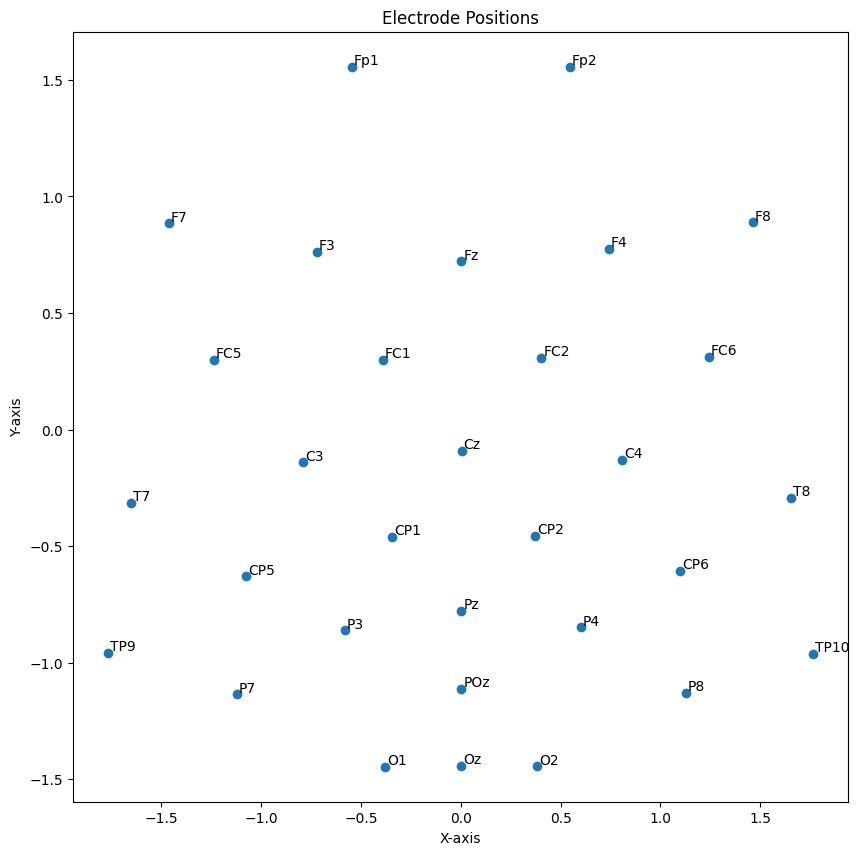

In [2]:
def plot_electrodes(sensor_pos, ch_names):
    plt.figure(figsize=(10, 10))
    plt.scatter(sensor_pos[:, 0], sensor_pos[:, 1])
    
    for i, ch_name in enumerate(ch_names):
        plt.annotate(ch_name, (sensor_pos[i, 0] + 0.01, sensor_pos[i, 1] + 0.01))
    
    plt.xlabel('X-axis')
    plt.ylabel('Y-axis')
    plt.title('Electrode Positions')
    plt.show()

ch_names = ['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2',
            'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz',
            'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']

# Create a 10-20 standard montage
montage_1020 = mne.channels.make_standard_montage('standard_1020')

# Get positions of the specified channels
sensor_pos_3d = np.array([montage_1020.get_positions()['ch_pos'][ch_name] for ch_name in ch_names])

import numpy as np

def cartesian_to_spherical(x, y, z):
    r = np.sqrt(x**2 + y**2 + z**2)
    theta = np.arccos(z / r)
    phi = np.arctan2(y, x)
    return r, theta, phi

def azimuthal_equidistant_projection(x, y, z):
    r, theta, phi = cartesian_to_spherical(x, y, z)
    x_2d = theta * np.cos(phi)
    y_2d = theta * np.sin(phi)
    return x_2d, y_2d


sensor_pos = np.array([azimuthal_equidistant_projection(x, y, z) for x, y, z in sensor_pos_3d])

print(sensor_pos)

# Create a dictionary to map channel names to their respective index
ch_idx = {ch_name: idx for idx, ch_name in enumerate(ch_names)}

# Create a list of indices for each channel
sensor_pos_idx = [ch_idx[ch_name] for ch_name in ch_names]

# Extract the positions of each channel from the sensor_pos array
SENSOR_POS = sensor_pos[sensor_pos_idx]

plot_electrodes(SENSOR_POS, ch_names)


In [15]:
import mne

# Define the channel names and types
ch_names = ['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2',
            'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz',
            'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
ch_types = ['eeg'] * len(ch_names)

# Create an empty info object with the correct channel names and types
info = mne.create_info(ch_names, sfreq=1000, ch_types=ch_types)

# Use the standard 10-20 montage
montage = mne.channels.make_standard_montage('standard_1020')
electrode_positions = montage.get_positions()

electrode_positions


{'ch_pos': OrderedDict([('Fp1', array([-0.0294367,  0.0839171, -0.00699  ])),
              ('Fpz', array([ 0.0001123,  0.088247 , -0.001713 ])),
              ('Fp2', array([ 0.0298723,  0.0848959, -0.00708  ])),
              ('AF9', array([-0.0489708,  0.0640872, -0.047683 ])),
              ('AF7', array([-0.0548397,  0.0685722, -0.01059  ])),
              ('AF5', array([-0.0454307,  0.0728622,  0.005978 ])),
              ('AF3', array([-0.0337007,  0.0768371,  0.021227 ])),
              ('AF1', array([-0.0184717,  0.0799041,  0.032752 ])),
              ('AFz', array([0.0002313, 0.080771 , 0.035417 ])),
              ('AF2', array([0.0198203, 0.0803019, 0.032764 ])),
              ('AF4', array([0.0357123, 0.0777259, 0.021956 ])),
              ('AF6', array([0.0465843, 0.0738078, 0.006034 ])),
              ('AF8', array([ 0.0557433,  0.0696568, -0.010755 ])),
              ('AF10', array([ 0.0504352,  0.0638698, -0.048005 ])),
              ('F9', array([-0.0701019,  0.041652

In [7]:
# Define the path to the top-level directory
directory = 'D:\Science\Datasets\DMT_EEG_Pilot'
peaks_function = 'EMD'
precision = 1
delta_lim = 100
sf=1000
noverlap=None
smooth = 1
average = "mean"
nperseg=None
harm_thresh = 30
epo_len = 5
all_dfs = []

# Loop through each subject directory
for subject in os.listdir(directory):
    # Construct the path to the subject directory
    subject_dir = os.path.join(directory, subject)
    # Loop through each session directory (DMT and PCB)
    for session in os.listdir(subject_dir):
        # Construct the path to the session directory
        session_dir = os.path.join(subject_dir, session)
        print(session)
        if session == 'ses-DMT':
            session_name = 'DMT'
        if session == 'ses-PCB':
            session_name = 'PCB'

        # Load the data file for this session
        data_file = os.path.join(session_dir, f"{subject}-{session_name}.mat")
        data = sio.loadmat(data_file)
        # Compute the biotuner for this time series
        data_ = data['Preprocessed']['data'][0][0]
        data_channels = data['Preprocessed']['label']
        channels = [x[0] for x in data_channels[0][0][0]]
        
        EEG_channels = channels[0:31]
        print(EEG_channels)
        EEG_data_ = data_[0:31]
        ECG_data = data_[31]
        vEOG = data_[32]
        EMG_front = data_[33]
        EMD_temp = data_[34]
        event_idx = data['Preprocessed']['events']
        RS_start = event_idx[0][0][0][1][0][0]
        RS_end = event_idx[0][0][1][1][0][0]
        inj_start = event_idx[0][0][2][1][0][0]
        inj_end = event_idx[0][0][3][1][0][0]

        new_data = slice_data(EEG_data_[:, inj_end:inj_end+(60*1000*5)], sf=1000, window=epo_len)
        for elec in range(len(new_data)):
            for trial in range(len(new_data[elec])):

                #try:
                start = time.time()
                data_temp = new_data[elec, trial, :]
                nans = np.argwhere(np.isnan(data_temp))
                if len(nans) == 0:
                    biotuning = compute_biotuner(sf = sf, peaks_function = peaks_function, precision = precision, n_harm = 10,
                                    ratios_n_harms = 5, ratios_inc_fit = False, ratios_inc = False) # Initialize biotuner object
                    print(data_temp)
                    biotuning.peaks_extraction(data_temp, FREQ_BANDS = None, ratios_extension = False, max_freq = 45, n_peaks=4,
                                                                    graph=False, min_harms=2, nIMFs=4, keep_first_IMF=True)
                    biotuning.compute_peaks_metrics(n_harm=10, delta_lim=delta_lim)
                    biotuning.compute_resonance(harm_thresh=harm_thresh, smooth_fft=2,
                                            harmonicity_metric='harmsim', delta_lim=50)
                    tun_metrics = tuning_to_metrics(biotuning.peaks_ratios)
                    tun_metrics.update(biotuning.peaks_metrics)
                    #print(biotuning.peaks_metrics)
                    del tun_metrics["harm_pos"]
                    del tun_metrics['euler']
                    del tun_metrics["common_harm_pos"]
                    peaks_euler = [int(round(num, 2) * 1000) for num in biotuning.peaks]
                    df_cons = pd.DataFrame(tun_metrics, index=[0])
                    df_cons['electrodes'] = elec
                    df_cons['peaks_avg'] = np.mean(biotuning.peaks)
                    df_cons['n_peaks'] = len(biotuning.peaks)
                    df_cons['precision'] = precision
                    df_cons['delta_lim'] = delta_lim
                    df_cons['sf'] = sf
                    df_cons['trials'] = trial
                    df_cons['condition'] = session_name
                    df_cons['participant'] = subject
                    df_cons['euler'] = euler(*peaks_euler)
                    df_cons['resonance'] = biotuning.resonance
                    df_cons['PPC_bicor'] = biotuning.PPC_bicor
                    df_cons['harm_thresh_res'] = harm_thresh
                    df_cons['epo_len'] = epo_len
                    print('EULER', df_cons['euler'])
                    print('Peaks : ', biotuning.peaks)
                    print('PPC_bicor', biotuning.PPC_bicor)
                    print('resonance', biotuning.resonance)
                    if nperseg is None:
                        mult = 1 / precision
                        nfft = sf * mult
                        nperseg = nfft/smooth

                    freqs, psd = scipy.signal.welch(
                                    data_temp,
                                    sf,
                                    nfft=nfft,
                                    nperseg=nperseg,
                                    average=average,
                                    noverlap=noverlap
                                    )

                    FREQ_BANDS = {'delta':[2, 4], 'theta':[4, 8], 'alpha':[8, 12], 'beta':[12, 30], 'gamma':[30, 45]}
                    freq_res = freqs[1] - freqs[0]
                    for key, value in FREQ_BANDS.items():
                        idx_band = np.logical_and(freqs >= value[0], freqs <= value[1])
                        bp = np.average(psd[idx_band])
                        bp_abs = simps(psd[idx_band], dx=freq_res)
                        total_power = simps(psd, dx=freq_res)
                        bp_rel = bp_abs / total_power
                        df_cons[key+'_raw'] = bp
                        df_cons[key+'_abs'] = bp_abs
                        df_cons[key+'_rel'] = bp_rel
                        #print('AVERAGE_POWER', bp)
                        #print('PSD', bp, bp_abs, bp_rel)
                    print('TRIAL', trial)
                    all_dfs.append(df_cons)
                    stop = time.time()
                    print("Loop time for 1 trial :", stop-start)
                #except:
                    '''df_cons = all_dfs[0]
                    df_cons.loc[:] = np.nan
                    df_cons['trials'] = trial
                    df_cons['participant'] = subject
                    all_dfs.append(df_cons)'''
                    #pass

df_final = pd.concat(all_dfs)
print('READY_TO_SAVE')
df_final.to_csv('DMT_biotuner_EMD_5sec_5min.csv', index=False)
print('SAVED')

<>:2: DeprecationWarning: invalid escape sequence \S
<>:2: DeprecationWarning: invalid escape sequence \S
C:\Users\Antoine\AppData\Local\Temp\ipykernel_19552\3994572569.py:2: DeprecationWarning: invalid escape sequence \S
  directory = 'D:\Science\Datasets\DMT_EEG_Pilot'


ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-7.85086262 -5.39647956 -2.86260494 ... -0.01521962  0.03841646
  0.07028453]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 37.]
PPC_bicor 0.22337902
resonance 0.10642745766184619
TRIAL 5
Loop time for 1 trial : 0.27499961853027344
[ 0.08298142  0.07969924  0.0633822  ... -0.89609681 -0.38894601
  0.24793234]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4, 1.65, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 33.]
PPC_bicor 0.2321893
resonance 0.11347793935224264
TRIAL 6
Loop time for 1 trial : 0.2800004482269287
[-4.45361318 -4.66477382 -4.86045082 ... -4.70687283 -4.52875935
 -4.33074232]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.21343414
resonance 0.17212627828121185
TRIAL 8
Loop time for 1 trial : 0.26999974250793457
[-4.12473267 -3.92325011 -3.73866268 ...  5.37114535  5.30483069
  5.23349372]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 34.]
PPC_bicor 0.24228524
resonance 0.1484475636404324
TRIAL 9
Loop time for 1 trial : 0.26000094413757324
[-5.80513903 -6.14859065 -6.45614766 ...  3.39489199  3.59311107
  3.88568551]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 28.]
PPC_bicor 0.33190718
resonance 0.24703466040747507
TRIAL 14
Loop time for 1 trial : 0.2859992980957031
[ 4.25336898  4.67006987  5.1050262  ... -0.32707327 -0.28947145
 -0.36218256]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.34407103
resonance 0.26373398892737765
TRIAL 15
Loop time for 1 trial : 0.2700028419494629
[-9.48888057 -9.62482287 -9.44624547 ...  2.98133857  3.1891131
  3.25785919]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 30.]
PPC_bicor 0.28813818
resonance 0.22209093560775123
TRIAL 17
Loop time for 1 trial : 0.2999989986419678
[-2.75783999 -3.12545045 -3.38639685 ...  2.37434342  2.0031788
  1.67557597]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 34.]
PPC_bicor 0.23538595
resonance 0.12929421476289338
TRIAL 19
Loop time for 1 trial : 0.28499913215637207
[ 1.22189958  1.04413196  0.85884162 ... -4.56823703 -4.20851885
 -3.80329536]
Number of peaks : 4
[1.1, 1.21875, 1.25, 1.375, 1.7727272727272727, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 39.]
PPC_bicor 0.319998
resonance 0.18232252710812202
TRIAL 21
Loop time for 1 trial : 0.28999876976013184
[-3.35355247 -2.86260975 -2.33619109 ...  2.13361737  1.27581754
  0.49684972]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 29.]
PPC_bicor 0.33249366
resonance 0.21585118667832737
TRIAL 22
Loop time for 1 trial : 0.27300024032592773
[10.67098791 11.40896442 12.02218113 ... -2.8192685  -2.59177723
 -2.49381232]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.28751156
resonance 0.21728268167417908
TRIAL 25
Loop time for 1 trial : 0.27299976348876953
[ -2.54041308  -2.73977876  -3.0923453  ...  -9.78324706 -10.93022168
 -11.71560226]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.29762092
resonance 0.18604493849574258
TRIAL 26
Loop time for 1 trial : 0.2850005626678467
[-2.75893617 -3.95532975 -5.00790765 ... -2.37174118 -2.32280011
 -2.3713462 ]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.22387885
resonance 0.14939361341383264
TRIAL 29
Loop time for 1 trial : 0.26799964904785156
[-2.53613237 -2.8261003  -3.23929755 ...  5.17560239  5.42962018
  5.48549471]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.34521994
resonance 0.27130025710378375
TRIAL 30
Loop time for 1 trial : 0.2890005111694336
[5.371479   5.13172046 4.82238628 ... 3.16371753 3.46010484 3.63917324]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 36.]
PPC_bicor 0.2303275
resonance 0.16546018073956173
TRIAL 31
Loop time for 1 trial : 0.27899909019470215
[3.68300043 3.58539352 3.35134429 ... 2.17993686 1.98530667 1.76092197]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.23344177
resonance 0.16943606029857286
TRIAL 32
Loop time for 1 trial : 0.2690005302429199
[1.53423405 1.33441457 1.18920209 ... 2.20210701 2.74213062 3.07857271]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.19575948
resonance 0.12169575351431512
TRIAL 33
Loop time for 1 trial : 0.2760021686553955
[ 3.22184111  3.19043755  3.00901582 ... -8.59703237 -7.87290293
 -6.94051062]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.4226862
resonance 0.3205578634233186
TRIAL 34
Loop time for 1 trial : 0.28699779510498047
[ 6.03451327  4.7002396   3.15278035 ... -1.14431416 -1.8057687
 -2.37754278]
Number of peaks : 4
[1.2, 1.375, 1.65, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 33.]
PPC_bicor 0.3458887
resonance 0.28761938951457994
TRIAL 37
Loop time for 1 trial : 0.2710590362548828
[-2.8443211  -3.19883827 -3.44144267 ...  7.58385001  7.6212765
  7.61842346]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3. 10. 16. 32.]
PPC_bicor 0.20857066
resonance 0.08543902742676437
TRIAL 38
Loop time for 1 trial : 0.29694080352783203
[7.55759416 7.42613586 7.21835067 ... 1.13417494 1.73921297 2.2086757 ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 36.]
PPC_bicor 0.273079
resonance 0.20413904339827674
TRIAL 39
Loop time for 1 trial : 0.27299952507019043
[2.50344234 2.59388533 2.46219016 ... 1.22448071 2.24558946 3.09508719]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.3333333333333333, 1.5416666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 37.]
PPC_bicor 0.30612487
resonance 0.12996735029459536
TRIAL 40
Loop time for 1 trial : 0.2850003242492676
[  3.71004297   4.04573606   4.0785949  ... -10.03424234  -8.38236413
  -6.64271516]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.37629184
resonance 0.1954139110214195
TRIAL 41
Loop time for 1 trial : 0.2760004997253418
[-4.88722597 -3.18475208 -1.59718445 ...  3.88964067  5.00736096
  6.15446913]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.33797666
resonance 0.18499453322058826
TRIAL 42
Loop time for 1 trial : 0.2739989757537842
[ 8.47125831  8.2736711   7.78128491 ... -5.27544673 -6.82931103
 -8.10803342]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.17208558
resonance 0.16219419613480568
TRIAL 44
Loop time for 1 trial : 0.28100085258483887
[-9.05528984 -9.63450338 -9.83009039 ...  2.84092544  3.5458816
  4.2489527 ]
Number of peaks : 4
[1.2, 1.5833333333333333, 1.6666666666666667, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 38.]
PPC_bicor 0.38490736
resonance 0.2604401232903464
TRIAL 45
Loop time for 1 trial : 0.2799997329711914
[4.92514748 5.54826401 6.09215623 ... 0.5928726  0.98791574 1.2778157 ]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3. 11. 11. 36.]
PPC_bicor 0.28100792
resonance 0.14966156553815713
TRIAL 46
Loop time for 1 trial : 0.28800058364868164
[-5.94680515 -4.03055569 -2.15744214 ...  2.62410426  3.52997011
  3.98596874]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.375, 1.5714285714285714, 1.6818181818181819, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 37.]
PPC_bicor 0.306385
resonance 0.12988948903265676
TRIAL 51
Loop time for 1 trial : 0.2760007381439209
[ 3.24926365  4.10367917  4.62203333 ... -7.89786146 -6.91255199
 -5.71439107]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 30.]
PPC_bicor 0.22759934
resonance 0.16050712739427886
TRIAL 55
Loop time for 1 trial : 0.26599955558776855
[-2.55841714 -1.94186    -1.27884831 ...  7.0300575   7.18156394
  7.04571979]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.276328
resonance 0.049460033011669347
TRIAL 57
Loop time for 1 trial : 0.2859992980957031
[ 6.61193097  5.88641914  4.89198848 ... -8.01107716 -8.26406444
 -8.17376095]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.4004202
resonance 0.1792237491837697
TRIAL 58
Loop time for 1 trial : 0.283001184463501
[-2.06038398 -1.06709325 -0.07747334 ... -1.47526228 -1.36636523
 -1.34246025]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.23862572
resonance 0.13707902265543287
TRIAL 5
Loop time for 1 trial : 0.28299856185913086
[-1.40246043 -1.54016933 -1.74521982 ...  1.88726145  1.62593519
  1.31015037]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 26.]
PPC_bicor 0.20795105
resonance 0.2408639887968699
TRIAL 6
Loop time for 1 trial : 0.2720005512237549
[-3.03074711 -3.47558788 -3.92206498 ... -6.18141865 -6.33958592
 -6.44775763]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 33.]
PPC_bicor 0.3162899
resonance 0.23217984976792574
TRIAL 8
Loop time for 1 trial : 0.2669994831085205
[-6.4996044  -6.49091826 -6.42009605 ...  1.72657098  1.56717182
  1.44711606]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 31.]
PPC_bicor 0.30953413
resonance 0.21620971842478678
TRIAL 9
Loop time for 1 trial : 0.29000163078308105
[-4.20845539 -4.43715122 -4.69348953 ... -1.80662586 -2.02974869
 -2.15316781]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 30.]
PPC_bicor 0.29933736
resonance 0.17742465602027047
TRIAL 14
Loop time for 1 trial : 0.2729980945587158
[-2.17800535 -2.11123261 -1.96494066 ...  0.44288897  0.38966154
  0.23879545]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.27318925
resonance 0.22893745420848402
TRIAL 15
Loop time for 1 trial : 0.2700014114379883
[-0.87433699 -0.58766631 -0.05940108 ...  2.35183581  2.12941529
  1.86486166]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 32.]
PPC_bicor 0.3661681
resonance 0.26376997357091075
TRIAL 17
Loop time for 1 trial : 0.28099918365478516
[-7.12516901 -7.56643932 -7.92194708 ...  1.38358568  1.86715449
  2.31295483]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 31.]
PPC_bicor 0.3562931
resonance 0.24121366953977974
TRIAL 19
Loop time for 1 trial : 0.2870006561279297
[-7.5288218  -7.81515027 -7.96045842 ... -8.13664367 -8.05300614
 -7.90932628]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.33091918
resonance 0.20305732627967735
TRIAL 21
Loop time for 1 trial : 0.2719993591308594
[-7.70499638 -7.44273399 -7.12841024 ... -1.59276372 -1.79909974
 -1.94827954]
Number of peaks : 4
[1.0357142857142858, 1.125, 1.5555555555555556, 1.6111111111111112, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4.  9. 14. 29.]
PPC_bicor 0.31836724
resonance 0.2350410435880933
TRIAL 22
Loop time for 1 trial : 0.3360016345977783
[ 5.7001925   6.45458501  7.06819971 ... -1.08788951 -1.27404045
 -1.53195282]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.27783838
resonance 0.09914026521548541
TRIAL 25
Loop time for 1 trial : 0.28499841690063477
[-1.85311026 -2.22612735 -2.6370231  ... -2.99894306 -4.17829808
 -5.2606034 ]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.35138097
resonance 0.26006130704825575
TRIAL 26
Loop time for 1 trial : 0.2800002098083496
[ 1.59475609  1.06167816  0.48602903 ... -0.20460142 -1.12898888
 -2.07398408]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.375, 1.4090909090909092, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 31.]
PPC_bicor 0.24030478
resonance 0.08605240486894845
TRIAL 29
Loop time for 1 trial : 0.29399943351745605
[-2.98636101 -3.80893705 -4.48497629 ...  5.99074468  7.03165465
  7.82426253]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.20083095
resonance 0.1394254699633235
TRIAL 30
Loop time for 1 trial : 0.27699995040893555
[ 8.33086435  8.53055386  8.42114808 ... -0.8681985  -0.73591655
 -0.51792422]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.31466085
resonance 0.2290543098583237
TRIAL 31
Loop time for 1 trial : 0.2670009136199951
[-0.22994322  0.11047748  0.48453299 ...  4.34580046  4.34808228
  4.36870143]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.17756315
resonance 0.225949227809906
TRIAL 32
Loop time for 1 trial : 0.3919990062713623
[ 4.41462935  4.49248293  4.60746307 ... -1.35914576 -1.81469787
 -2.26711349]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.2915441
resonance 0.213397003065198
TRIAL 33
Loop time for 1 trial : 0.27900004386901855
[-2.71015871 -3.13546399 -3.53288974 ...  1.91869552  2.2657725
  2.57358364]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 34.]
PPC_bicor 0.3733214
resonance 0.18069666358957306
TRIAL 34
Loop time for 1 trial : 0.29000091552734375
[ 0.86897975  0.4889859   0.09616331 ... -0.11227354 -0.40373566
 -0.67482986]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.32416734
resonance 0.18332905039191247
TRIAL 37
Loop time for 1 trial : 0.27699923515319824
[-0.91782806 -1.12556729 -1.29155023 ...  6.44251946  7.22395483
  7.8825865 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.21119149
resonance 0.14167984556971172
TRIAL 38
Loop time for 1 trial : 0.27700042724609375
[ 8.4019157   8.77084402  8.98424395 ...  0.02493938 -0.11059927
 -0.17167763]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 34.]
PPC_bicor 0.27335224
resonance 0.10492337396999701
TRIAL 39
Loop time for 1 trial : 0.28800249099731445
[-0.19034538 -0.20361608 -0.24988615 ... -5.22335544 -4.72310504
 -4.14324078]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.35285315
resonance 0.3079909629291958
TRIAL 40
Loop time for 1 trial : 0.26599693298339844
[ -3.49070399  -2.77500407  -2.00836596 ...  -9.53419476  -9.85075968
 -10.21312146]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.2651313
resonance 0.24208149099440285
TRIAL 41
Loop time for 1 trial : 0.2709999084472656
[-10.58191716 -10.91606083 -11.17627405 ...   2.37972433   1.72398454
   0.97479516]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.3544995
resonance 0.18171339792509875
TRIAL 42
Loop time for 1 trial : 0.27300071716308594
[2.12119108 2.68624907 3.3348163  ... 4.67518685 3.81804821 2.81122409]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 29.]
PPC_bicor 0.25845733
resonance 0.10308942853501346
TRIAL 44
Loop time for 1 trial : 0.2889995574951172
[ 1.70049926  0.54060654 -0.60847327 ...  0.55909615  0.91924363
  1.16227377]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 33.]
PPC_bicor 0.23854955
resonance 0.17211918290140052
TRIAL 45
Loop time for 1 trial : 0.2910003662109375
[1.29160537 1.31569039 1.24673354 ... 1.65305435 0.85954917 0.18900954]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.28616384
resonance 0.19698040606572365
TRIAL 46
Loop time for 1 trial : 0.2819991111755371
[-3.73741812 -3.35169161 -2.95247149 ... -4.44961415 -4.43851774
 -4.460194  ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.29151902
resonance 0.2532456973930458
TRIAL 51
Loop time for 1 trial : 0.3000006675720215
[-10.02073696 -10.40809076 -10.60291204 ...   9.06418162   8.70964562
   8.05405121]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.19122453
resonance 0.12950417175889015
TRIAL 55
Loop time for 1 trial : 0.2700026035308838
[2.31517023 3.33708421 4.26645193 ... 7.30110402 7.4065825  7.22125831]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.30989718
resonance 0.2889007347400742
TRIAL 57
Loop time for 1 trial : 0.294996976852417
[ 6.75033519  6.01135391  5.03275792 ... -1.30006103 -0.69540185
 -0.1572392 ]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.22323404
resonance 0.13200937984793476
TRIAL 58
Loop time for 1 trial : 0.27700090408325195
[-4.68033764 -3.81318694 -2.92082606 ...  0.5015895   0.39685638
  0.28068538]
Number of peaks : 4
[1.25, 1.3, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 15. 26.]
PPC_bicor 0.2989476
resonance 0.40459194779396057
TRIAL 5
Loop time for 1 trial : 0.2669994831085205
[ 0.15243317  0.01246991 -0.13779842 ...  0.68553702  0.70519593
  0.76694579]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.24211262
resonance 0.24452613323926925
TRIAL 6
Loop time for 1 trial : 0.28099918365478516
[ 0.27501257  0.05126041 -0.27092927 ... -3.41133406 -3.66251315
 -3.85558606]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 31.]
PPC_bicor 0.30279762
resonance 0.13531692454556105
TRIAL 8
Loop time for 1 trial : 0.28800034523010254
[-3.98504252 -4.04925527 -4.05036836 ...  2.64721944  3.08560527
  3.54495454]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 23.]
PPC_bicor 0.24689983
resonance 0.12963419559162967
TRIAL 9
Loop time for 1 trial : 0.2889997959136963
[-1.68903712 -1.73657652 -1.77147937 ...  1.16918549  1.2300664
  1.33881425]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 24.]
PPC_bicor 0.27898785
resonance 0.2599694811635547
TRIAL 14
Loop time for 1 trial : 0.27300167083740234
[ 1.4890752   1.67049429  1.86940569 ... -2.57977998 -2.17646101
 -1.83570585]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 29.]
PPC_bicor 0.23129934
resonance 0.08216357428109508
TRIAL 15
Loop time for 1 trial : 0.2609989643096924
[-2.76187302 -2.75637794 -2.73442457 ...  1.80404096  2.0161677
  2.17519732]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 30.]
PPC_bicor 0.28433412
resonance 0.22263236931628652
TRIAL 17
Loop time for 1 trial : 0.2780001163482666
[-0.8870519  -0.71789163 -0.46373372 ... -0.34109059 -0.22942505
 -0.10426765]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.25915417
resonance 0.1583220469268414
TRIAL 19
Loop time for 1 trial : 0.27900004386901855
[ 5.34074579  5.05664289  4.71414072 ... -1.30058496 -1.21026732
 -1.09561592]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.31746408
resonance 0.2403449598934267
TRIAL 21
Loop time for 1 trial : 0.2629990577697754
[-0.95484837 -0.78918513 -0.60276552 ... -0.6060202  -0.51221097
 -0.34323154]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.29271603
resonance 0.21743197009910964
TRIAL 22
Loop time for 1 trial : 0.2670004367828369
[ 7.85907546  8.01293565  8.13161772 ... -1.00759587 -0.86497181
 -0.72666849]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.38614
resonance 0.31556254652413457
TRIAL 25
Loop time for 1 trial : 0.2560000419616699
[-0.59872922 -0.48560177 -0.38978498 ...  3.47967264  3.59761982
  3.67781923]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.25396347
resonance 0.1421461166035045
TRIAL 26
Loop time for 1 trial : 0.2689998149871826
[-3.96968279 -4.02728864 -4.01433851 ... -7.96929083 -7.96052546
 -7.82596363]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.27269706
resonance 0.3087962040305138
TRIAL 29
Loop time for 1 trial : 0.26600027084350586
[-7.5494778  -7.12173674 -6.5409547  ...  1.54398045  1.83600428
  2.19372137]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 24.]
PPC_bicor 0.2730797
resonance 0.206274004054792
TRIAL 30
Loop time for 1 trial : 0.2650008201599121
[ 2.61334717  3.08538166  3.59520657 ... 12.25587805 12.45813367
 12.51088321]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.34309646
resonance 0.11702965570218633
TRIAL 31
Loop time for 1 trial : 0.28499889373779297
[12.39855229 12.11089808 11.64343591 ... -1.99287554 -1.81676288
 -1.64280203]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.2552661
resonance 0.2007109526431922
TRIAL 32
Loop time for 1 trial : 0.28600049018859863
[-1.46896221 -1.29211815 -1.10847584 ... -3.36483682 -3.04654847
 -2.73072039]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.2632875
resonance 0.19845443586508432
TRIAL 33
Loop time for 1 trial : 0.25499987602233887
[-2.42428921 -2.13162427 -1.85472556 ...  0.85236619  0.81182104
  0.7308022 ]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.35674492
resonance 0.16950265852489857
TRIAL 34
Loop time for 1 trial : 0.30500054359436035
[-0.04602066 -0.45126938 -0.89609286 ...  0.27215447  0.13890174
  0.0460149 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.3195776
resonance 0.5043419102827708
TRIAL 37
Loop time for 1 trial : 0.2759995460510254
[-6.04356525e-03 -1.71392721e-02  1.24832877e-02 ...  8.48932549e+00
  7.83380281e+00  7.09161594e+00]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.2810152
resonance 0.14794365924867717
TRIAL 38
Loop time for 1 trial : 0.2719998359680176
[ 6.29661441  5.48463271  4.69127397 ... -4.60958641 -5.43948508
 -6.23419628]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 34.]
PPC_bicor 0.2850134
resonance 0.10071569368687179
TRIAL 39
Loop time for 1 trial : 0.2850000858306885
[-6.98855711 -7.69661276 -8.35158173 ... -4.42144887 -4.31969608
 -4.17691065]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 24.]
PPC_bicor 0.31364438
resonance 0.22555599249899388
TRIAL 40
Loop time for 1 trial : 0.2670001983642578
[ -4.01186308  -3.8433903   -3.68868392 ... -10.31089685  -9.96352318
  -9.57435364]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.354416
resonance 0.2550807195721251
TRIAL 41
Loop time for 1 trial : 0.2700002193450928
[-9.155995   -8.7210607  -8.28176911 ... -5.5157372  -4.88638043
 -4.25213604]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.267534
resonance 0.2522176156441371
TRIAL 42
Loop time for 1 trial : 0.2579996585845947
[2.17751048 2.80991959 3.50794394 ... 3.50487781 2.97808394 2.21539218]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.41465294
resonance 0.2036243583247953
TRIAL 44
Loop time for 1 trial : 0.2670004367828369
[ 1.25160435  0.13252207 -1.08793913 ... -1.03685064 -0.92075578
 -0.80904595]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 21.]
PPC_bicor 0.19043447
resonance 0.08956989035719916
TRIAL 45
Loop time for 1 trial : 0.28099942207336426
[-0.68452495 -0.53105214 -0.33505701 ... -0.24912869  0.07681502
  0.30998604]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.349365
resonance 0.14449402225415836
TRIAL 46
Loop time for 1 trial : 0.2819998264312744
[-7.77688537 -7.96532516 -8.05755941 ...  0.01052868  0.62273718
  1.204947  ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.32628763
resonance 0.19852386291319202
TRIAL 51
Loop time for 1 trial : 0.3040003776550293
[-3.42118281 -2.31772997 -1.27003828 ...  1.0027026   1.32947867
  1.57292649]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.3514413
resonance 0.20541098256680096
TRIAL 55
Loop time for 1 trial : 0.25300049781799316
[ 2.19417568  1.56621169  0.91157651 ... -3.38996203 -3.25264331
 -2.99660343]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.27342454
resonance 0.16553466441489312
TRIAL 57
Loop time for 1 trial : 0.2569999694824219
[-2.63909142 -2.19825987 -1.69251124 ...  3.31584672  3.4450538
  3.51100996]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.22138858
resonance 0.18607972724871202
TRIAL 58
Loop time for 1 trial : 0.26599955558776855
[ 0.10999724 -0.21614742 -0.49327073 ... -4.6879188  -5.19434321
 -5.70488966]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.2646651
resonance 0.14516790409882863
TRIAL 5
Loop time for 1 trial : 0.26000022888183594
[-6.19732553 -6.64900249 -7.03860488 ... -5.56908889 -5.57759998
 -5.52453534]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.30158052
resonance 0.20803841683850544
TRIAL 6
Loop time for 1 trial : 0.2700066566467285
[-2.18588351 -2.25344416 -2.33610018 ... -2.67021312 -2.59687303
 -2.44869349]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.34116086
resonance 0.2472891197963194
TRIAL 8
Loop time for 1 trial : 0.26800036430358887
[-2.2424381  -1.99776493 -1.73586997 ... -1.48202713 -1.54826619
 -1.56423728]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.2048067
resonance 0.1669407154674883
TRIAL 9
Loop time for 1 trial : 0.25499987602233887
[-4.00816856 -3.80766885 -3.62291566 ... -6.8847621  -7.34978556
 -7.7376341 ]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 30.]
PPC_bicor 0.33826682
resonance 0.30492880860964455
TRIAL 14
Loop time for 1 trial : 0.247999906539917
[-8.04461941 -8.27049569 -8.41800635 ... -1.62262831 -2.00152854
 -2.36985323]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.27788755
resonance 0.15562120086222483
TRIAL 15
Loop time for 1 trial : 0.27699995040893555
[5.34984413 5.47915809 5.63208912 ... 2.51290578 2.47704388 2.40817295]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 19.]
PPC_bicor 0.31840238
resonance 0.13576465544173494
TRIAL 17
Loop time for 1 trial : 0.2720005512237549
[-5.77411079 -5.8955039  -5.96218672 ...  0.39512188  0.91005179
  1.39904649]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3181818181818181, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 29.]
PPC_bicor 0.2726269
resonance 0.12882380452287512
TRIAL 19
Loop time for 1 trial : 0.2869994640350342
[-0.28145663 -0.02178026  0.20029607 ... -7.06598839 -6.96528076
 -6.78775109]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.30075246
resonance 0.2364191753620451
TRIAL 21
Loop time for 1 trial : 0.2740004062652588
[-6.53697079 -6.2203216  -5.84860611 ...  0.083102    0.24624118
  0.44292428]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7.  9. 21.]
PPC_bicor 0.20929794
resonance 0.09052074931207156
TRIAL 22
Loop time for 1 trial : 0.2839996814727783
[ 5.81820699  6.08110067  6.23294533 ... -0.31167299 -0.39482501
 -0.50313291]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.30611685
resonance 0.15520542064173656
TRIAL 25
Loop time for 1 trial : 0.2629997730255127
[-0.62763566 -0.75767065 -0.88132311 ...  3.16817301  3.14676556
  3.19161674]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 30.]
PPC_bicor 0.3505825
resonance 0.29682945013046264
TRIAL 26
Loop time for 1 trial : 0.2539999485015869
[-3.5141161  -3.29584282 -3.04322415 ... -3.38952289 -3.49646771
 -3.54798224]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.2574463
resonance 0.21605539356992728
TRIAL 29
Loop time for 1 trial : 0.27499938011169434
[-3.52947919 -3.43107256 -3.24851421 ...  1.47680102  2.29817297
  3.08883302]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.26446393
resonance 0.16351685249669984
TRIAL 30
Loop time for 1 trial : 0.2680017948150635
[ 3.82616539  4.49018082  5.06464893 ... 10.15535413 10.08305139
  9.945119  ]
Number of peaks : 4
[1.1, 1.15625, 1.25, 1.375, 1.6818181818181819, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 37.]
PPC_bicor 0.25162572
resonance 0.10840177772159365
TRIAL 31
Loop time for 1 trial : 0.2629983425140381
[9.73778005 9.45844981 9.10594741 ... 3.02526237 3.44052703 3.81623632]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.2853679
resonance 0.31688182552655536
TRIAL 32
Loop time for 1 trial : 0.26325273513793945
[ 4.14758931  4.43146534  4.66635393 ... -4.24533122 -4.84509593
 -5.45510283]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.24844939
resonance 0.16090202823012975
TRIAL 33
Loop time for 1 trial : 0.2695152759552002
[-6.05721596 -6.63207607 -7.1604178  ...  4.98586978  4.95627156
  4.85678536]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.3636363636363635, 1.375, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 30.]
PPC_bicor 0.2868136
resonance 0.14763731604272667
TRIAL 34
Loop time for 1 trial : 0.27699923515319824
[-1.16364039 -1.0074788  -0.89261522 ...  2.66111528  2.509142
  2.35700928]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11.  9.]
PPC_bicor 0.389668
resonance 0.3605134612081027
TRIAL 37
Loop time for 1 trial : 0.2840001583099365
[2.21154741 2.07816281 1.96060513 ... 5.44927898 5.37089963 5.21609883]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2682209
resonance 0.17741800236151506
TRIAL 38
Loop time for 1 trial : 0.31399989128112793
[4.99155571 4.70745903 4.37669255 ... 1.85824828 0.91803717 0.02789705]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.23772748
resonance 0.2317879959263585
TRIAL 39
Loop time for 1 trial : 0.26200127601623535
[-0.81090128 -1.59973379 -2.3418889  ... -3.48905025 -3.30972699
 -3.17996177]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.3071374
resonance 0.25955466628074647
TRIAL 40
Loop time for 1 trial : 0.3059995174407959
[ -3.09691225  -3.05475886  -3.0447954  ...  -9.98942872 -10.58415151
 -11.10932572]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.24629389
resonance 0.12933300875386539
TRIAL 41
Loop time for 1 trial : 0.2840006351470947
[-11.54962533 -11.89167324 -12.12476758 ...   1.22097798   1.15117209
   1.03687025]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.2975521
resonance 0.3092144541442394
TRIAL 42
Loop time for 1 trial : 0.26599860191345215
[2.62843749 2.67112439 2.74762174 ... 5.25181799 4.35388614 3.36172126]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 29.]
PPC_bicor 0.3009449
resonance 0.280231940249602
TRIAL 44
Loop time for 1 trial : 0.2700004577636719
[ 2.31283403  1.24755936  0.20716135 ... -0.55372047 -0.51087041
 -0.47508235]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.23016025
resonance 0.17519253007483707
TRIAL 45
Loop time for 1 trial : 0.26800036430358887
[-0.43905469 -0.3957317  -0.33881239 ...  0.16747609 -0.07066463
 -0.27009771]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.24836028
resonance 0.23857428543269635
TRIAL 46
Loop time for 1 trial : 0.2629997730255127
[-6.31127528 -5.81625653 -5.28950595 ... -3.21140551 -2.65660017
 -2.05751609]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.22311835
resonance 0.12522918997388896
TRIAL 51
Loop time for 1 trial : 0.2869997024536133
[-4.57492913 -4.62160302 -4.60536728 ...  2.81189773  3.3335542
  3.87834471]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 17.]
PPC_bicor 0.29945633
resonance 0.19095050526613538
TRIAL 55
Loop time for 1 trial : 0.25800061225891113
[ 5.71708866  5.54790172  5.30614368 ... -0.59208909 -0.5621712
 -0.58361799]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.24377911
resonance 0.10581875003491466
TRIAL 57
Loop time for 1 trial : 0.2630002498626709
[-0.65887268 -0.78547237 -0.95664003 ... -0.57258531 -0.04209575
  0.47844225]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.20838445
resonance 0.15421574712677638
TRIAL 58
Loop time for 1 trial : 0.2739994525909424
[-2.16013372 -2.08230042 -1.98870553 ...  1.78394482  1.85561348
  1.91633551]
Number of peaks : 4
[1.15625, 1.2, 1.25, 1.5, 1.5416666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 37.]
PPC_bicor 0.3129048
resonance 0.21460039194773983
TRIAL 5
Loop time for 1 trial : 0.2589998245239258
[1.95911061 1.97823137 1.96982655 ... 2.16406488 2.26688204 2.3967299 ]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 27.]
PPC_bicor 0.32189238
resonance 0.14529601018777283
TRIAL 6
Loop time for 1 trial : 0.2670001983642578
[ 2.36704842  2.25181155  2.0565251  ... -2.92176133 -3.27351257
 -3.54638882]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.3030289
resonance 0.15130409080365195
TRIAL 8
Loop time for 1 trial : 0.2690002918243408
[-3.72902531 -3.81589591 -3.80734803 ...  1.16886001  1.4259302
  1.70661832]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.28810772
resonance 0.2592862118882212
TRIAL 9
Loop time for 1 trial : 0.27699971199035645
[ 0.25426974  0.21344707  0.24594794 ... -1.3619784  -0.82949318
 -0.20633525]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 24.]
PPC_bicor 0.18520145
resonance 0.11738558650016784
TRIAL 14
Loop time for 1 trial : 0.27700138092041016
[ 0.48861823  1.23081089  1.9912169  ... -2.50154756 -2.18260638
 -1.86918147]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 34.]
PPC_bicor 0.21542434
resonance 0.1502915701834984
TRIAL 15
Loop time for 1 trial : 0.27699923515319824
[-1.81473357 -1.899945   -2.03723663 ...  0.40107407  0.51949771
  0.64556752]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.25056958
resonance 0.13353402337696385
TRIAL 17
Loop time for 1 trial : 0.2719993591308594
[ 3.71453155  3.8606215   4.00035601 ... -1.37454044 -1.3756944
 -1.37150384]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.32287806
resonance 0.1701354858421144
TRIAL 19
Loop time for 1 trial : 0.26800012588500977
[4.78295774 4.8380244  4.85235894 ... 3.12171196 3.03091036 2.96175489]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.24612021
resonance 0.19252999795205664
TRIAL 21
Loop time for 1 trial : 0.2609996795654297
[ 2.92065556  2.910561    2.93073526 ... -0.34247796 -0.37169565
 -0.37407531]
Number of peaks : 4
[1.0625, 1.25, 1.5, 1.7, 1.7647058823529411, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 30.]
PPC_bicor 0.33960614
resonance 0.3035974950474851
TRIAL 22
Loop time for 1 trial : 0.269000768661499
[ 2.4112761   2.22689028  2.09973535 ... -0.66357366 -0.42947014
 -0.16475808]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.2222222222222223, 1.3888888888888888, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 25.]
PPC_bicor 0.28874436
resonance 0.16464350276523165
TRIAL 25
Loop time for 1 trial : 0.294999361038208
[ 0.12156603  0.42107206  0.72623687 ... -0.18396664 -0.25448492
 -0.2998282 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.26645356
resonance 0.18119566978443238
TRIAL 26
Loop time for 1 trial : 0.27300047874450684
[-0.2196777  -0.48690607 -0.74893501 ... -4.48516454 -4.32544412
 -4.13187039]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.33500376
resonance 0.21876892266851483
TRIAL 29
Loop time for 1 trial : 0.27299976348876953
[-3.902938   -3.63774242 -3.33598634 ...  1.15432331  1.19929029
  1.30222343]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 26.]
PPC_bicor 0.31711954
resonance 0.24694811237546116
TRIAL 30
Loop time for 1 trial : 0.26399970054626465
[ 1.47128475  1.70992265  2.01654627 ... 12.39749124 12.67002545
 12.80765713]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.39844915
resonance 0.18155606861668402
TRIAL 31
Loop time for 1 trial : 0.27700042724609375
[12.80918595 12.67582465 12.41081987 ... -2.57692401 -2.68921927
 -2.81252847]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.34106457
resonance 0.2167629297754981
TRIAL 32
Loop time for 1 trial : 0.25762200355529785
[-2.94050754 -3.06541013 -3.17853501 ...  2.24545482  2.594042
  2.89972602]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.16752534
resonance 0.12658226831908867
TRIAL 33
Loop time for 1 trial : 0.2768251895904541
[ 3.15705052  3.36193833  3.51170277 ... -0.45437721 -0.53998565
 -0.60070462]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.28040633
resonance 0.13048380075982122
TRIAL 34
Loop time for 1 trial : 0.2619965076446533
[ 1.58284288  0.65245535 -0.25474243 ...  0.22178962  0.49271152
  0.8000076 ]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.2655622
resonance 0.21279198184157863
TRIAL 37
Loop time for 1 trial : 0.2740147113800049
[1.13475558 1.48756419 1.84868516 ... 2.00187289 1.94095699 1.90667948]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3042681
resonance 0.20260620246762814
TRIAL 38
Loop time for 1 trial : 0.2649977207183838
[ 1.90239466  1.92957602  1.98782004 ... -0.74641514 -1.31296699
 -1.89543399]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 34.]
PPC_bicor 0.33227047
resonance 0.15990397820179475
TRIAL 39
Loop time for 1 trial : 0.28789210319519043
[-2.48292455 -3.06215915 -3.6183449  ... -0.25857527 -0.24395488
 -0.28783517]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.30604893
resonance 0.19561542790345468
TRIAL 40
Loop time for 1 trial : 0.2870950698852539
[-0.39272701 -0.55818915 -0.78085799 ... -3.41076194 -3.59944219
 -3.78053638]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.27425882
resonance 0.20753948426607882
TRIAL 41
Loop time for 1 trial : 0.25999999046325684
[-3.95344588 -4.1174074  -4.27133748 ... -4.07749041 -3.83279611
 -3.58331866]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.28977016
resonance 0.21909653862016368
TRIAL 42
Loop time for 1 trial : 0.25800108909606934
[-2.22158243 -1.9610943  -1.66936847 ...  0.52303757  0.33095564
  0.04695605]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.32462114
resonance 0.21714292327788742
TRIAL 44
Loop time for 1 trial : 0.26199889183044434
[-0.3172574  -0.74640892 -1.2224217  ... -1.8303128  -1.81965929
 -1.78851963]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.23912424
resonance 0.15607424893162467
TRIAL 45
Loop time for 1 trial : 0.2669994831085205
[-1.73116043 -1.64327945 -1.52237336 ... -3.03418357 -2.78457636
 -2.50725993]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.33283478
resonance 0.1733198475931944
TRIAL 46
Loop time for 1 trial : 0.27700018882751465
[-2.81824957 -3.19260539 -3.53813357 ... -1.38550281 -1.1350588
 -0.87725354]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.34692708
resonance 0.2772966605244261
TRIAL 51
Loop time for 1 trial : 0.26000094413757324
[-1.06449442 -1.0562994  -1.11739413 ...  0.12118022 -0.01352848
 -0.1724871 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3098096
resonance 0.22792557000436564
TRIAL 55
Loop time for 1 trial : 0.2579996585845947
[2.067436   2.29622622 2.47522235 ... 3.43901731 3.67049853 3.93043457]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.37138215
resonance 0.2793705854000467
TRIAL 57
Loop time for 1 trial : 0.2579991817474365
[4.20982346 4.49854363 4.78597576 ... 2.35483399 2.45056167 2.55945673]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.29580966
resonance 0.13773673702134445
TRIAL 58
Loop time for 1 trial : 0.26300048828125
[ 1.8684633   1.12568734  0.38425886 ... -1.8922282  -2.25102759
 -2.60258194]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 28.]
PPC_bicor 0.32843408
resonance 0.16119841190557632
TRIAL 5
Loop time for 1 trial : 0.2950010299682617
[-2.93360119 -3.23080996 -3.48194111 ... -4.08779732 -4.25312723
 -4.36495322]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 31.]
PPC_bicor 0.21190459
resonance 0.09836704725112538
TRIAL 6
Loop time for 1 trial : 0.26999831199645996
[-1.18994128 -1.16322227 -1.10035684 ...  0.85423213  1.00683931
  1.1448857 ]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.27113774
resonance 0.14377004572914706
TRIAL 8
Loop time for 1 trial : 0.2650001049041748
[ 1.25977318  1.34420325  1.39277514 ... -3.68888967 -3.62192264
 -3.54751037]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.3659083
resonance 0.23185500842287166
TRIAL 9
Loop time for 1 trial : 0.2649998664855957
[ 0.6973427   0.98540438  1.26523083 ... -6.41595413 -6.88925862
 -7.32307016]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 30.]
PPC_bicor 0.20882964
resonance 0.24861149489879608
TRIAL 14
Loop time for 1 trial : 0.2540009021759033
[-7.70267474 -8.0146222  -8.24724092 ... -1.33361363 -1.57249518
 -1.77364119]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.26840854
resonance 0.17938446444640685
TRIAL 15
Loop time for 1 trial : 0.2709991931915283
[3.73311287 3.61698723 3.42781564 ... 0.0693065  0.0469232  0.0661492 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.3345206
resonance 0.2264189409487175
TRIAL 17
Loop time for 1 trial : 0.2720010280609131
[-0.3694445  -0.49404503 -0.59733946 ...  0.97732331  1.33146728
  1.62157998]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.2699786
resonance 0.07935121633279307
TRIAL 19
Loop time for 1 trial : 0.27499890327453613
[-1.08566232 -0.74201219 -0.34380688 ... -1.47518929 -1.48939382
 -1.46157249]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33923483
resonance 0.18784802600762887
TRIAL 21
Loop time for 1 trial : 0.2630007266998291
[-1.3938067  -1.29005254 -1.1559047  ...  1.21656334  1.55787009
  1.88814225]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 30.]
PPC_bicor 0.28042632
resonance 0.23409273247751924
TRIAL 22
Loop time for 1 trial : 0.2559990882873535
[-0.56132152 -0.5138095  -0.56681916 ...  0.83516832  0.5878329
  0.29299617]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.33516273
resonance 0.27986752384088254
TRIAL 25
Loop time for 1 trial : 0.26000046730041504
[-0.03713687 -0.38787114 -0.7427349  ... -0.12500493  0.10497946
  0.35887071]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 29.]
PPC_bicor 0.28626767
resonance 0.09252453127403891
TRIAL 26
Loop time for 1 trial : 0.27899980545043945
[ 3.41026586  3.92967771  4.39866841 ... -0.95610099 -0.73610362
 -0.49015204]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.27064562
resonance 0.16555547625334424
TRIAL 29
Loop time for 1 trial : 0.2709991931915283
[-0.21526242  0.08797442  0.41519107 ...  1.35538655  1.63232188
  1.8894426 ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.17907034
resonance 0.08127562076893875
TRIAL 30
Loop time for 1 trial : 0.26200008392333984
[2.12196194 2.32711394 2.50446786 ... 4.31541847 4.26415568 4.18576909]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.28431466
resonance 0.14361729855122773
TRIAL 31
Loop time for 1 trial : 0.2670004367828369
[4.08671984 3.97416935 3.85571983 ... 0.51866894 0.89571263 1.22379709]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.32710975
resonance 0.18440707086613684
TRIAL 32
Loop time for 1 trial : 0.27499914169311523
[ 1.49906855  1.72010878  1.88788734 ... -0.25874995 -0.87192494
 -1.51848608]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.25395015
resonance 0.20070034046064722
TRIAL 33
Loop time for 1 trial : 0.26900243759155273
[-2.17759625 -2.82747222 -3.4464092  ...  4.36643175  4.1161623
  3.82368877]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.19580771
resonance 0.17112724098467058
TRIAL 34
Loop time for 1 trial : 0.2639963626861572
[-1.61807456 -1.4490077  -1.2792609  ...  4.01428862  3.79665534
  3.51017448]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.3067602
resonance 0.22799215619654759
TRIAL 37
Loop time for 1 trial : 0.26200056076049805
[3.16241513 2.76238678 2.3200979  ... 0.1458415  0.27750825 0.38416875]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.30120948
resonance 0.20982074381952937
TRIAL 38
Loop time for 1 trial : 0.26599955558776855
[0.46610615 0.52485435 0.56297801 ... 2.35892754 1.75192858 1.18263203]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 23.]
PPC_bicor 0.33032808
resonance 0.3745041544670644
TRIAL 39
Loop time for 1 trial : 0.25299954414367676
[ 0.65709123  0.17946719 -0.24809858 ... -1.58051327 -1.71578431
 -1.83361865]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.234612
resonance 0.19162015923947998
TRIAL 40
Loop time for 1 trial : 0.26600050926208496
[-1.92526025 -1.98348673 -2.00274984 ... -5.72672459 -6.16020414
 -6.53547618]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.20079775
resonance 0.07377195348600289
TRIAL 41
Loop time for 1 trial : 0.26400017738342285
[-6.84360209 -7.07701498 -7.22997838 ...  0.97787563  0.64592057
  0.27974528]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3135417
resonance 0.2218229031190276
TRIAL 42
Loop time for 1 trial : 0.28099989891052246
[-1.05427194 -1.44281462 -1.8094855  ...  0.45732865  0.33806032
  0.16725518]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.2787594
resonance 0.132379628311504
TRIAL 44
Loop time for 1 trial : 0.27299976348876953
[-0.05160407 -0.3117641  -0.603406   ...  0.94018615  0.75792032
  0.58333624]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.30999488
resonance 0.1992514995914517
TRIAL 45
Loop time for 1 trial : 0.2690002918243408
[ 0.42521148  0.29100043  0.18654529 ... -0.57432796 -0.57918496
 -0.53389407]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.32286963
resonance 0.21770910335623697
TRIAL 46
Loop time for 1 trial : 0.2690002918243408
[-7.25529869 -7.15069396 -7.00534949 ... -1.22593706 -1.19754246
 -1.1296116 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.21578465
resonance 0.1248796419074884
TRIAL 51
Loop time for 1 trial : 0.27300071716308594
[-2.9087126  -3.06407421 -3.18037635 ...  1.57874767  1.77767039
  1.97063979]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.2325662
resonance 0.11584960455302502
TRIAL 55
Loop time for 1 trial : 0.2969987392425537
[3.78200082 3.97465096 4.11934727 ... 0.75751949 0.62430616 0.47684581]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.31043673
resonance 0.22742397834857306
TRIAL 57
Loop time for 1 trial : 0.2669992446899414
[ 0.31983073  0.15801403 -0.00422894 ...  0.82735166  0.83246968
  0.84932118]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.24494672
resonance 0.10540228218141227
TRIAL 58
Loop time for 1 trial : 0.2609996795654297
[ 0.48419804  0.10483824 -0.34206671 ...  0.85391138  1.08186469
  1.32452777]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.30490765
resonance 0.22983509735627608
TRIAL 5
Loop time for 1 trial : 0.26200008392333984
[1.57455848 1.82399181 2.06481982 ... 1.58927345 1.70765677 1.78116611]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2627477
resonance 0.12243264171753138
TRIAL 6
Loop time for 1 trial : 0.2709999084472656
[4.19371349 4.26717348 4.29408346 ... 1.46496662 1.21915457 0.9690222 ]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.30616513
resonance 0.26388939025998115
TRIAL 8
Loop time for 1 trial : 0.26199936866760254
[ 0.72252902  0.48770935  0.27228614 ... -1.3698437  -1.25805897
 -1.16365206]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.30935434
resonance 0.3093543437620004
TRIAL 9
Loop time for 1 trial : 0.26600074768066406
[ 1.45374812  1.5560009   1.71157091 ... -0.38564579  0.0404248
  0.4521413 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.22608082
resonance 0.16841681153855773
TRIAL 14
Loop time for 1 trial : 0.2689998149871826
[0.83608148 1.17922591 1.46953858 ... 1.78541342 2.00907534 2.21931471]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.25571203
resonance 0.1571600138166776
TRIAL 15
Loop time for 1 trial : 0.25500059127807617
[ 0.70115873  0.55382371  0.31835957 ... -0.86310435 -0.64877077
 -0.42497066]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.2878749
resonance 0.2302708618117101
TRIAL 17
Loop time for 1 trial : 0.2799994945526123
[ 5.31376155  5.31503009  5.2563377  ... -1.88611201 -2.09668945
 -2.26848196]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3, 1.3333333333333333, 1.6, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 16.]
PPC_bicor 0.2845117
resonance 0.12347498193510577
TRIAL 19
Loop time for 1 trial : 0.2799997329711914
[2.42164029 2.57805027 2.69814565 ... 5.45587258 5.34358436 5.21683214]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.27401906
resonance 0.15464876925983986
TRIAL 21
Loop time for 1 trial : 0.27299952507019043
[ 5.07596024  4.92160186  4.75461345 ... -0.79023305 -1.01611037
 -1.22667066]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 31.]
PPC_bicor 0.2600267
resonance 0.06376562576704738
TRIAL 22
Loop time for 1 trial : 0.2740001678466797
[-6.92082825 -7.0256392  -7.03077859 ...  1.34852302  1.36761622
  1.46419328]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.42825064
resonance 0.29792071689258925
TRIAL 25
Loop time for 1 trial : 0.2649998664855957
[1.63393074 1.86822718 2.15462635 ... 0.82705904 0.85999305 0.89308695]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.26283076
resonance 0.20433535438143846
TRIAL 26
Loop time for 1 trial : 0.26600003242492676
[ 0.66388991  0.89147479  1.11984366 ... -4.84331324 -4.49740562
 -4.10422609]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.41467294
resonance 0.19711608360836277
TRIAL 29
Loop time for 1 trial : 0.26400017738342285
[-3.67293793 -3.21416674 -2.73932166 ... -8.00214338 -8.08103068
 -8.06819003]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.3452272
resonance 0.24956476200710642
TRIAL 30
Loop time for 1 trial : 0.2850008010864258
[-7.95688896 -7.74499328 -7.43516149 ...  2.67141447  3.38803537
  4.07877119]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.35169327
resonance 0.18734612319656094
TRIAL 31
Loop time for 1 trial : 0.26599955558776855
[ 4.74213229  5.37467447  5.97099059 ... -1.37455863 -1.78035268
 -2.20327683]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.38110113
resonance 0.2087431390072916
TRIAL 32
Loop time for 1 trial : 0.28099918365478516
[-2.63575231 -3.06875288 -3.49197711 ...  2.69996648  3.27833664
  3.86192525]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.2785649
resonance 0.2518863206108411
TRIAL 33
Loop time for 1 trial : 0.25800013542175293
[4.43771096 4.99138377 5.5080437  ... 2.68743782 2.44023815 2.20612936]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.34393477
resonance 0.22997070083563978
TRIAL 34
Loop time for 1 trial : 0.26400065422058105
[6.13000737 5.66996487 5.23435331 ... 0.16307078 0.43561435 0.767258  ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.27836236
resonance 0.2796115979552269
TRIAL 37
Loop time for 1 trial : 0.2800002098083496
[ 1.14625736  1.55802076  1.98578209 ... -2.344648   -2.19429655
 -1.99615849]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.33961627
resonance 0.28397172870058
TRIAL 38
Loop time for 1 trial : 0.2649989128112793
[-1.75548113 -1.48044025 -1.18157057 ...  3.53648619  3.30111702
  3.04190671]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.27504
resonance 0.18858907321637325
TRIAL 39
Loop time for 1 trial : 0.27900028228759766
[2.77870533 2.53156756 2.31922275 ... 1.27750663 1.19358573 1.08195538]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.38139415
resonance 0.3023480220876559
TRIAL 40
Loop time for 1 trial : 0.2590022087097168
[ 0.94882496  0.8012265   0.64631569 ... 11.78709862 11.07988434
 10.32630535]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.27057955
resonance 0.14784609417434738
TRIAL 41
Loop time for 1 trial : 0.2739982604980469
[ 9.53654245  8.72063539  7.88822095 ... -1.93026772 -1.76488994
 -1.58804867]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.26741296
resonance 0.20618721808899532
TRIAL 42
Loop time for 1 trial : 0.26599955558776855
[-0.51343229 -0.49314405 -0.49522974 ... -0.42438154  0.0133842
  0.47506419]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.31609914
resonance 0.1958369054405548
TRIAL 44
Loop time for 1 trial : 0.272000789642334
[ 0.94203164  1.39417191  1.81099549 ... -0.83138719 -0.82833844
 -0.81962942]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 21.]
PPC_bicor 0.29975262
resonance 0.33729804892625126
TRIAL 45
Loop time for 1 trial : 0.27900123596191406
[-0.80365762 -0.77911687 -0.74509029 ... -1.514775   -1.38732944
 -1.28505431]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.24783881
resonance 0.19661082491052873
TRIAL 46
Loop time for 1 trial : 0.27899789810180664
[ 2.52048385  1.95980825  1.37613934 ... -0.15622166 -0.33797559
 -0.49918583]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.22007073
resonance 0.13597303458461257
TRIAL 51
Loop time for 1 trial : 0.2670009136199951
[ 1.25626038  1.23196132  1.22367749 ... -3.19874935 -3.49251436
 -3.72377221]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.32234707
resonance 0.19128740378637088
TRIAL 55
Loop time for 1 trial : 0.2719998359680176
[-0.4550548  -0.29152312 -0.12575728 ...  2.75029353  3.04190566
  3.34902159]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.29889578
resonance 0.22136841511184518
TRIAL 57
Loop time for 1 trial : 0.2689990997314453
[3.67101291 4.00511387 4.3467675  ... 3.6913774  4.0279845  4.327279  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.24182045
resonance 0.20739540434019132
TRIAL 58
Loop time for 1 trial : 0.26200103759765625
[ 4.32498637  3.32272371  2.24578453 ... -1.4264497  -1.63717221
 -1.82816235]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.28652358
resonance 0.1941981440250269
TRIAL 5
Loop time for 1 trial : 0.2700002193450928
[-1.98613301 -2.09965566 -2.15983631 ... -1.87773765 -1.90526573
 -1.98878625]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 31.]
PPC_bicor 0.2074921
resonance 0.10173800166026788
TRIAL 6
Loop time for 1 trial : 0.28600049018859863
[0.35379553 0.36933057 0.41501411 ... 5.89153292 6.12229087 6.2579429 ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.28963152
resonance 0.19094060152737946
TRIAL 8
Loop time for 1 trial : 0.26799988746643066
[ 6.29410739  6.23084277  6.07257383 ... -3.66179384 -3.79531151
 -3.95910285]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.27280077
resonance 0.22574849250641735
TRIAL 9
Loop time for 1 trial : 0.2559986114501953
[ 4.30032333  4.4581364   4.56596285 ... -0.54748135 -0.90582888
 -1.32903746]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.131815
resonance 0.08146585499891988
TRIAL 14
Loop time for 1 trial : 0.2590000629425049
[-1.80285046 -2.30901208 -2.82624088 ...  2.88401641  2.83742675
  2.76798414]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.20920002
resonance 0.10789070664642952
TRIAL 15
Loop time for 1 trial : 0.29000020027160645
[ 2.1977055   1.91076179  1.49325514 ... -0.80506009 -0.81806024
 -0.75828644]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.31573984
resonance 0.20923424547368827
TRIAL 17
Loop time for 1 trial : 0.2719995975494385
[2.47540829 2.73236802 2.93253749 ... 0.24832315 0.21800793 0.17081217]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7. 12. 35.]
PPC_bicor 0.31052935
resonance 0.25170502811670303
TRIAL 19
Loop time for 1 trial : 0.2779996395111084
[-2.13979653 -2.13545871 -2.04839484 ...  3.12537515  3.31927694
  3.46858649]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 12.]
PPC_bicor 0.19090174
resonance 0.17849493636326358
TRIAL 21
Loop time for 1 trial : 0.28600096702575684
[3.5647261  3.60232661 3.5795119  ... 1.44002948 1.4376217  1.39061631]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.23960711
resonance 0.1891915916332177
TRIAL 22
Loop time for 1 trial : 0.27500033378601074
[-6.89863985 -6.82977207 -6.73545261 ... -0.26229503 -0.68387827
 -1.12245664]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.27649674
resonance 0.16439788911830294
TRIAL 25
Loop time for 1 trial : 0.2629992961883545
[-1.56694214 -2.00479114 -2.42262118 ... -0.83917784 -0.44272196
 -0.08623885]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.29551378
resonance 0.20556782489215142
TRIAL 26
Loop time for 1 trial : 0.274000883102417
[5.12439492 5.5564367  5.90117781 ... 3.25352064 3.48965624 3.65799318]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.38274375
resonance 0.2491552064816157
TRIAL 29
Loop time for 1 trial : 0.26199936866760254
[ 3.75354129  3.77290289  3.71448034 ... -6.56672971 -6.99336274
 -7.37394005]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 30.]
PPC_bicor 0.2559946
resonance 0.19799776876138317
TRIAL 30
Loop time for 1 trial : 0.26800036430358887
[-7.70207479 -7.97250899 -8.18109473 ... -8.10844352 -8.00315736
 -7.84284602]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.375, 1.4090909090909092, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 31.]
PPC_bicor 0.2864773
resonance 0.11278644612902013
TRIAL 31
Loop time for 1 trial : 0.2800004482269287
[-7.61740113 -7.31787205 -6.93682409 ... -1.41017066 -1.40490681
 -1.42452121]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.19639917
resonance 0.14291788681890025
TRIAL 32
Loop time for 1 trial : 0.28799915313720703
[-1.46988531 -1.54127674 -1.63823009 ... -1.40627685 -1.58169601
 -1.74335323]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11.  8.]
PPC_bicor 0.24331291
resonance 0.22918831796357128
TRIAL 33
Loop time for 1 trial : 0.265000581741333
[-1.88539072 -2.0022166  -2.08855601 ... -0.6535148  -0.85145264
 -1.03674024]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.22341436
resonance 0.21414862220937556
TRIAL 34
Loop time for 1 trial : 0.27300548553466797
[-0.99315928 -0.81361498 -0.5690027  ... -0.99847498 -0.84353173
 -0.69632608]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.30189407
resonance 0.2648773659697988
TRIAL 37
Loop time for 1 trial : 0.2690000534057617
[-0.55717983 -0.42687224 -0.30676085 ... -3.8494003  -3.77106188
 -3.70003116]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.26800033
resonance 0.2391488096930764
TRIAL 38
Loop time for 1 trial : 0.2780005931854248
[-3.63667922 -3.58015531 -3.52866148 ...  1.84058872  2.27536545
  2.71668719]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2525607
resonance 0.17679444506647343
TRIAL 39
Loop time for 1 trial : 0.32199931144714355
[3.15863223 3.5940055  4.01438764 ... 0.49554118 0.35012444 0.25285638]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.29058537
resonance 0.19960193302143703
TRIAL 40
Loop time for 1 trial : 0.28999996185302734
[0.20428534 0.20231963 0.24251846 ... 5.28417051 5.06473318 4.8144293 ]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 25.]
PPC_bicor 0.22031389
resonance 0.19378966685723176
TRIAL 41
Loop time for 1 trial : 0.2820003032684326
[4.53508192 4.22938018 3.90105186 ... 1.93724742 1.65637242 1.34877668]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 30.]
PPC_bicor 0.19852799
resonance 0.1508483209393241
TRIAL 42
Loop time for 1 trial : 0.28100109100341797
[ 1.74727843  1.65336921  1.4991878  ... -1.41054871 -0.79511495
 -0.12013171]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.24624825
resonance 0.16408289912523646
TRIAL 44
Loop time for 1 trial : 0.2740006446838379
[0.58529542 1.2904616  1.9646979  ... 0.93742879 0.84110296 0.75773324]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.38051844
resonance 0.3234068693491546
TRIAL 45
Loop time for 1 trial : 0.27699899673461914
[ 0.68435994  0.61682934  0.55031723 ... -0.23138291 -0.26424347
 -0.2853499 ]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.31404668
resonance 0.19378442273346663
TRIAL 46
Loop time for 1 trial : 0.28299903869628906
[1.94889086 1.67054848 1.37454086 ... 2.40918798 2.04116845 1.6488656 ]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.17073478
resonance 0.18744341207273077
TRIAL 51
Loop time for 1 trial : 0.27900052070617676
[ 1.17962008  1.04257694  0.9563159  ... -0.40341184 -0.35690606
 -0.28111168]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.37868568
resonance 0.24412615570155055
TRIAL 55
Loop time for 1 trial : 0.26600003242492676
[-1.91521506 -2.04245209 -2.1212324  ... -0.74282513 -1.2539913
 -1.72844452]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.40581873
resonance 0.213027568093755
TRIAL 57
Loop time for 1 trial : 0.28499889373779297
[-2.15001048 -2.50639813 -2.78955145 ...  1.30475696  0.95632729
  0.61378996]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.32069203
resonance 0.21779178963466123
TRIAL 58
Loop time for 1 trial : 0.265000581741333
[ 0.39887206 -0.06766039 -0.5428079  ... -1.65904081 -1.19564782
 -0.57037131]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.21015005
resonance 0.18337738484252192
TRIAL 5
Loop time for 1 trial : 0.2760019302368164
[0.19614604 1.07469729 2.0293715  ... 5.20764616 5.03291006 4.65961491]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.3695134
resonance 0.3192178774060625
TRIAL 6
Loop time for 1 trial : 0.2629995346069336
[3.12706092 3.10671186 3.02395257 ... 6.32900069 5.65995552 4.86329342]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.40282622
resonance 0.2263866687683299
TRIAL 8
Loop time for 1 trial : 0.2669987678527832
[ 3.99169112  3.10654331  2.27312465 ... -0.39058069 -0.8235232
 -1.22867481]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.28534424
resonance 0.18601485238575832
TRIAL 9
Loop time for 1 trial : 0.26999998092651367
[0.88988346 1.08178029 1.22685056 ... 6.81752492 7.02442015 7.05491314]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3333333333333333, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 31.]
PPC_bicor 0.21979451
resonance 0.10015693631486393
TRIAL 14
Loop time for 1 trial : 0.2870006561279297
[6.91271575 6.60950906 6.16457335 ... 6.83496621 6.82140489 6.72600421]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  5. 11. 38.]
PPC_bicor 0.31598157
resonance 0.10294561830053679
TRIAL 15
Loop time for 1 trial : 0.290999174118042
[-3.2485968  -3.28418242 -3.19954813 ... -2.13905345 -2.21159362
 -2.26639938]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.26578906
resonance 0.15022980522627782
TRIAL 17
Loop time for 1 trial : 0.27699971199035645
[ 6.14618906  5.65585558  4.94778045 ... -4.70877768 -5.86690247
 -6.81250922]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.19986571
resonance 0.1882463665747219
TRIAL 19
Loop time for 1 trial : 0.2630016803741455
[-3.18726323 -3.01652715 -2.86659882 ...  5.89979182  6.04590857
  6.05824416]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.19427055
resonance 0.14617516204311778
TRIAL 21
Loop time for 1 trial : 0.2759990692138672
[5.92560455 5.64491005 5.22152408 ... 2.48131778 2.44606884 2.32861285]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.25063628
resonance 0.2407253296981598
TRIAL 22
Loop time for 1 trial : 0.25999903678894043
[-10.18396917 -10.84769608 -11.31152489 ...   1.80644721   2.15491173
   2.69406955]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.26892653
resonance 0.26840916176637014
TRIAL 25
Loop time for 1 trial : 0.28600001335144043
[3.40054584 4.23645416 5.15141632 ... 4.32238646 4.93855353 5.40301482]
Number of peaks : 4
[1.2, 1.5833333333333333, 1.6666666666666667, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 38.]
PPC_bicor 0.31056383
resonance 0.2442945887470803
TRIAL 26
Loop time for 1 trial : 0.2689995765686035
[-2.17554615 -2.41921703 -2.51687486 ...  4.18426015  3.98182006
  3.76671007]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2930811
resonance 0.22078183103691446
TRIAL 29
Loop time for 1 trial : 0.2560000419616699
[ 3.51836254  3.21825891  2.85159068 ... -8.59006624 -9.14135759
 -9.58227677]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.22175978
resonance 0.1492899725721641
TRIAL 30
Loop time for 1 trial : 0.26800036430358887
[ -9.91693246 -10.1558863  -10.31536425 ... -19.02746304 -18.81429373
 -18.38375762]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.37887302
resonance 0.21135417277162724
TRIAL 31
Loop time for 1 trial : 0.27499961853027344
[-17.73304699 -16.86646624 -15.79537931 ...  -0.10243791  -0.96029588
  -1.66921467]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.33503938
resonance 0.23008791537898962
TRIAL 32
Loop time for 1 trial : 0.2609994411468506
[-2.23093329 -2.65577465 -2.96060337 ...  2.06543023  2.29176141
  2.62103333]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.2696075
resonance 0.17077242329371378
TRIAL 33
Loop time for 1 trial : 0.29200053215026855
[ 3.03331602  3.50180068  3.9947531  ... -3.23311287 -3.07018799
 -2.87085937]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 33.]
PPC_bicor 0.30661216
resonance 0.18535740732243566
TRIAL 34
Loop time for 1 trial : 0.2560000419616699
[ 1.1150892   2.53599948  3.97798352 ... -5.82236559 -5.56794519
 -5.24985764]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.22481973
resonance 0.20898581156224916
TRIAL 37
Loop time for 1 trial : 0.28099989891052246
[-4.88802755 -4.50306286 -4.1145828  ... -9.15262244 -8.96945881
 -8.64789873]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.32840773
resonance 0.21318498061913432
TRIAL 38
Loop time for 1 trial : 0.26400089263916016
[-8.20815231 -7.67907398 -7.09637001 ...  1.97739932  2.98055489
  3.95435165]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.30161396
resonance 0.2274518067186529
TRIAL 39
Loop time for 1 trial : 0.277998685836792
[4.91945484 5.89369098 6.89025964 ... 4.99890582 4.05523674 3.13833133]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 33.]
PPC_bicor 0.34137794
resonance 0.2782264194769777
TRIAL 40
Loop time for 1 trial : 0.27900171279907227
[ 2.29781614  1.57658795  1.00755056 ... 23.22971136 22.98413123
 22.57650497]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.20840533
resonance 0.17992605458606373
TRIAL 41
Loop time for 1 trial : 0.27699923515319824
[22.0224151  21.34164854 20.55689021 ... -3.58329653 -3.50171677
 -3.26535895]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.45392838
resonance 0.3318598611788316
TRIAL 42
Loop time for 1 trial : 0.27699995040893555
[-1.00436782 -1.76800159 -2.50515419 ... -2.91750458 -2.044407
 -0.97965204]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.29930434
resonance 0.16365943174875394
TRIAL 44
Loop time for 1 trial : 0.2689995765686035
[0.24047815 1.57224039 2.96606182 ... 2.5428246  2.51054783 2.45636124]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.22211693
resonance 0.15968421307103386
TRIAL 45
Loop time for 1 trial : 0.26800036430358887
[2.37599608 2.26646844 2.12646505 ... 0.4410391  0.531173   0.54912634]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.3927522
resonance 0.18400269967717525
TRIAL 46
Loop time for 1 trial : 0.34199976921081543
[10.05850979  9.78830736  9.46652808 ...  0.85477804 -0.53038211
 -1.80397306]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.25971174
resonance 0.07888844476348868
TRIAL 51
Loop time for 1 trial : 0.2779996395111084
[ 2.45815054  2.75100368  3.1308941  ... -2.4715343  -3.28917676
 -4.09272465]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33011723
resonance 0.15045182947902624
TRIAL 55
Loop time for 1 trial : 0.27100205421447754
[-8.57671774 -9.00846811 -9.24458236 ... -8.74504129 -9.23217171
 -9.60444176]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.28091207
resonance 0.24548139832913873
TRIAL 57
Loop time for 1 trial : 0.26599836349487305
[-9.82152079 -9.85372386 -9.68347887 ...  2.29949466  2.20608878
  1.96152354]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.31120524
resonance 0.2642488239389477
TRIAL 58
Loop time for 1 trial : 0.27900052070617676
[ 2.94798663  2.09679149  1.22029494 ...  0.10924326 -0.35569322
 -0.77187068]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 34.]
PPC_bicor 0.23385416
resonance 0.18096000452836355
TRIAL 5
Loop time for 1 trial : 0.26599931716918945
[-1.11236262 -1.35563838 -1.48668217 ...  2.25909787  2.23675739
  2.03066817]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24242955
resonance 0.1840014329091424
TRIAL 6
Loop time for 1 trial : 0.26400041580200195
[-2.1508532  -1.9991124  -1.7750975  ...  6.59430839  7.03580149
  7.34980434]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 32.]
PPC_bicor 0.26770982
resonance 0.22758631433049836
TRIAL 8
Loop time for 1 trial : 0.2669994831085205
[ 7.53136153  7.58231165  7.51055817 ... -0.65263029 -1.103618
 -1.62249345]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 38.]
PPC_bicor 0.25925606
resonance 0.11303631552743543
TRIAL 9
Loop time for 1 trial : 0.2839999198913574
[6.12081916 5.86977393 5.53452775 ... 7.60569595 7.3742138  6.91705688]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.18570012
resonance 0.08571233871853215
TRIAL 14
Loop time for 1 trial : 0.272000789642334
[6.25054818 5.40267875 4.41153871 ... 2.62453228 2.62050598 2.6126627 ]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 17.]
PPC_bicor 0.29338527
resonance 0.14075678607323874
TRIAL 15
Loop time for 1 trial : 0.2949995994567871
[ 0.33967974  0.36060164  0.2809344  ... -1.60903756 -1.73062771
 -1.78600749]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.23604901
resonance 0.18466985045057357
TRIAL 17
Loop time for 1 trial : 0.2629997730255127
[-1.43882255 -0.82770427 -0.30190197 ...  2.6032463   2.17413178
  1.73521396]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  3. 12. 31.]
PPC_bicor 0.19786792
resonance 0.1118717764654467
TRIAL 19
Loop time for 1 trial : 0.26800060272216797
[-4.59809143 -4.81650476 -4.96138652 ...  2.86576744  3.14441382
  3.30785721]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.26915032
resonance 0.2340718703739571
TRIAL 21
Loop time for 1 trial : 0.27699995040893555
[3.34829369 3.26647583 3.07136994 ... 2.77507794 2.86755334 2.8634123 ]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.2268969
resonance 0.1598800273290996
TRIAL 22
Loop time for 1 trial : 0.2779996395111084
[-8.8478379  -8.92846568 -8.84824625 ...  1.49480161  1.15317285
  0.79349019]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.20615284
resonance 0.1332386603660455
TRIAL 25
Loop time for 1 trial : 0.28299975395202637
[ 0.42127734  0.04337337 -0.33232405 ...  2.04885785  2.58355946
  2.96668341]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 40.]
PPC_bicor 0.2659682
resonance 0.16502380365167152
TRIAL 26
Loop time for 1 trial : 0.27900075912475586
[3.70120286 3.79677417 3.88203793 ... 8.33258878 7.73294358 7.07135995]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11.  9.]
PPC_bicor 0.25781634
resonance 0.18415956883079776
TRIAL 29
Loop time for 1 trial : 0.2719995975494385
[  6.34340066   5.54595655   4.67791257 ...  -8.03417828  -9.50559203
 -10.91751291]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.20958734
resonance 0.12663464406440098
TRIAL 30
Loop time for 1 trial : 0.2870028018951416
[-12.25650442 -13.51247519 -14.67843395 ... -22.58564308 -23.08681062
 -23.41814764]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.38878644
resonance 0.23916414072374245
TRIAL 31
Loop time for 1 trial : 0.2619967460632324
[-23.56204412 -23.50432635 -23.23475622 ...  -0.68851284  -1.05780771
  -1.38530863]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.38367674
resonance 0.287951700118455
TRIAL 32
Loop time for 1 trial : 0.2740015983581543
[-1.67318063 -1.92754652 -2.15769187 ... -2.52847798 -2.43811831
 -2.26448509]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.20611049
resonance 0.1953466891898393
TRIAL 33
Loop time for 1 trial : 0.2669985294342041
[-2.02181715 -1.72706703 -1.39842395 ... -6.4645691  -6.23774552
 -5.97664007]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.19928722
resonance 0.1990611267022111
TRIAL 34
Loop time for 1 trial : 0.28100085258483887
[-7.20894876 -5.98985165 -4.6603518  ... -5.03900331 -5.11961272
 -5.20761825]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.30775157
resonance 0.15735447026681207
TRIAL 37
Loop time for 1 trial : 0.27499914169311523
[-5.29842104 -5.38639112 -5.46502003 ... -5.46434496 -5.73389284
 -5.98131113]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.15257709
resonance 0.12068194487894124
TRIAL 38
Loop time for 1 trial : 0.26000046730041504
[-6.20684282 -6.41180451 -6.59860897 ... -4.45060741 -2.74843491
 -1.06971697]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2044059
resonance 0.18685566931962966
TRIAL 39
Loop time for 1 trial : 0.26999926567077637
[0.5627582  2.12624142 3.59890536 ... 3.55373141 3.56603441 3.667085  ]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.35484347
resonance 0.2982714729011059
TRIAL 40
Loop time for 1 trial : 0.26600098609924316
[ 3.84406054  4.07946733  4.35225756 ... 14.21232193 14.88614025
 15.47685107]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.37049806
resonance 0.18971797040358596
TRIAL 41
Loop time for 1 trial : 0.288999080657959
[15.97485949 16.37254319 16.66477745 ...  2.2455691   2.08866924
  1.99460881]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2732292
resonance 0.1982164133517515
TRIAL 42
Loop time for 1 trial : 0.2690005302429199
[ 3.36213535  3.14218652  2.84590972 ... -4.82549782 -3.73577597
 -2.46188278]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.27109656
resonance 0.25320027350927843
TRIAL 44
Loop time for 1 trial : 0.25499916076660156
[-1.05630831  0.42223545  1.91172039 ...  4.06497196  3.9579338
  3.82152511]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.31157437
resonance 0.25476272438060155
TRIAL 45
Loop time for 1 trial : 0.26400184631347656
[3.64794504 3.43054816 3.16454208 ... 6.11088671 5.90479348 5.58110778]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.38138437
resonance 0.2688905034552921
TRIAL 46
Loop time for 1 trial : 0.2709989547729492
[12.23307035 12.09975272 11.89753122 ...  7.9459584   6.80579908
  5.61573255]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.30841365
resonance 0.19618970507925207
TRIAL 51
Loop time for 1 trial : 0.2870478630065918
[ 7.05280461  7.0141175   6.97609881 ... -0.23498715 -0.39874637
 -0.5582026 ]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.23834272
resonance 0.19443324921709118
TRIAL 55
Loop time for 1 trial : 0.28295135498046875
[ -8.37734904  -9.19755357  -9.84756497 ...  -9.05144404  -9.90648805
 -10.61211042]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 23.]
PPC_bicor 0.2438332
resonance 0.27765298386414844
TRIAL 57
Loop time for 1 trial : 0.27700042724609375
[-11.14748044 -11.50258814 -11.67803592 ...  -4.5544261   -5.51624254
  -6.48471423]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.39274427
resonance 0.2294865821166472
TRIAL 58
Loop time for 1 trial : 0.28200221061706543
[-8.13085036 -5.26918899 -2.32844797 ...  2.18751699  2.90512725
  3.47067696]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.19328628
resonance 0.12921780970479763
TRIAL 5
Loop time for 1 trial : 0.2759978771209717
[3.84481893 3.99971699 3.92125595 ... 2.82165871 2.69325096 2.64183213]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 34.]
PPC_bicor 0.20939042
resonance 0.19199379036823908
TRIAL 6
Loop time for 1 trial : 0.3020000457763672
[ 2.34431163  1.60119231  0.73648455 ... -4.84529726 -5.14229208
 -5.41218215]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.41735578
resonance 0.3109361778606068
TRIAL 8
Loop time for 1 trial : 0.26799964904785156
[-5.63770287 -5.80456675 -5.90203054 ...  6.95459007  6.94126101
  6.93169851]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.17836457
resonance 0.1066862976393273
TRIAL 9
Loop time for 1 trial : 0.27699971199035645
[-3.52486294 -3.766616   -4.00570201 ...  7.72206751  7.95187481
  8.14096908]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 36.]
PPC_bicor 0.23929119
resonance 0.13294247466893422
TRIAL 14
Loop time for 1 trial : 0.3119995594024658
[ 8.30195957  8.44650822  8.58375316 ... -3.85470566 -3.4233774
 -3.02390157]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.2961851
resonance 0.18938525319099428
TRIAL 15
Loop time for 1 trial : 0.28600096702575684
[-10.8462935  -10.58395266 -10.11191409 ...  -2.4905478   -2.54254652
  -2.6278481 ]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.296812
resonance 0.11457621769238542
TRIAL 17
Loop time for 1 trial : 0.2780015468597412
[-1.8699033  -1.59180176 -1.22301582 ... -0.27652346 -0.53623084
 -0.74268264]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.40918875
resonance 0.2547434982229906
TRIAL 19
Loop time for 1 trial : 0.3149991035461426
[ 2.73607011  2.27078117  1.73285092 ... -1.30873236 -1.40643221
 -1.52106942]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.27474508
resonance 0.2050203753153344
TRIAL 21
Loop time for 1 trial : 0.26399922370910645
[-1.64018785 -1.75193745 -1.84568131 ...  0.75651179  0.45940402
  0.20039557]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.28749695
resonance 0.19593728776876027
TRIAL 22
Loop time for 1 trial : 0.2889997959136963
[10.80709783 10.78855857 10.73632715 ... -5.50698716 -5.08172367
 -4.71863186]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 34.]
PPC_bicor 0.28360856
resonance 0.09882382659669867
TRIAL 25
Loop time for 1 trial : 0.2820007801055908
[-4.42936186 -4.21866012 -4.08431953 ...  2.43135247  1.60561343
  0.69290919]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.2966189
resonance 0.1863431602716446
TRIAL 26
Loop time for 1 trial : 0.28099822998046875
[ -8.15456672  -9.69632804 -11.13097052 ...   3.58168651   3.3375019
   3.06244422]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.6111111111111112, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  9. 12. 29.]
PPC_bicor 0.27948338
resonance 0.2553860281390705
TRIAL 29
Loop time for 1 trial : 0.30700087547302246
[2.76611239 2.45953858 2.1544775  ... 8.90838008 9.19205047 9.40710091]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.29507363
resonance 0.2291947129753328
TRIAL 30
Loop time for 1 trial : 0.2689993381500244
[9.55405085 9.63540134 9.65457508 ... 2.97884213 3.21956893 3.40597999]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.27128887
resonance 0.13931219415231186
TRIAL 31
Loop time for 1 trial : 0.26200318336486816
[ 3.51430589  3.52367796  3.41661096 ... -2.8931761  -2.97456049
 -2.89963582]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.30205557
resonance 0.19630443413149226
TRIAL 32
Loop time for 1 trial : 0.262998104095459
[-2.66784645 -2.28756088 -1.77643843 ...  1.62066475  2.10082918
  2.69119962]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.27299252
resonance 0.18446032371785906
TRIAL 33
Loop time for 1 trial : 0.29199957847595215
[ 3.36581907  4.09348229  4.8392429  ... -2.81706128 -2.36468705
 -1.9087352 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.30157855
resonance 0.2495104982615351
TRIAL 34
Loop time for 1 trial : 0.28999996185302734
[ 2.49192935  1.83052098  1.00176499 ... -7.27741694 -6.82424626
 -6.28461935]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 34.]
PPC_bicor 0.320712
resonance 0.20438463222078918
TRIAL 37
Loop time for 1 trial : 0.285001277923584
[-5.68501375 -5.05165747 -4.40935175 ... -1.31443335 -1.65118011
 -1.89989681]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.3275435
resonance 0.21242569328257532
TRIAL 38
Loop time for 1 trial : 0.2779982089996338
[-2.04675508 -2.08041865 -1.99266755 ... -4.56516953 -4.61036731
 -4.73948502]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.1982687
resonance 0.19982978204886118
TRIAL 39
Loop time for 1 trial : 0.26700258255004883
[-4.93871193 -5.18938445 -5.46867649 ...  3.44066456  4.45851056
  5.4043527 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.24954869
resonance 0.20119135342538358
TRIAL 40
Loop time for 1 trial : 0.31799840927124023
[ 6.22922759  6.88948064  7.34917501 ... -6.09000061 -5.74192021
 -5.30037675]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.3333333333333333, 1.375, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 25.]
PPC_bicor 0.25116906
resonance 0.10555680145067399
TRIAL 41
Loop time for 1 trial : 0.3099997043609619
[-4.7652677  -4.14215362 -3.44259143 ... -1.47484628 -1.25043089
 -1.05400894]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.31709847
resonance 0.2279263843383108
TRIAL 42
Loop time for 1 trial : 0.2930030822753906
[ 2.72909069  2.85403843  2.88918233 ...  0.08549775 -0.43439564
 -1.02867083]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.33403528
resonance 0.21691712113943964
TRIAL 44
Loop time for 1 trial : 0.2689974308013916
[-1.66375109 -2.30605058 -2.92346424 ... -2.74038227 -2.3484143
 -1.93826287]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.23416926
resonance 0.10698169022798538
TRIAL 45
Loop time for 1 trial : 0.288999080657959
[-1.5340439  -1.15969325 -0.83753302 ...  3.77129008  4.01581643
  4.23173138]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.35023883
resonance 0.19234985528373907
TRIAL 46
Loop time for 1 trial : 0.2630007266998291
[-0.27522603 -0.19890427 -0.09089701 ... -0.75691077 -1.19498409
 -1.72654087]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.2751013
resonance 0.10871916318223589
TRIAL 51
Loop time for 1 trial : 0.2759993076324463
[2.26568232 2.23634131 2.09076499 ... 4.18607738 4.40748536 4.45560585]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.34944057
resonance 0.18036183495766558
TRIAL 55
Loop time for 1 trial : 0.27499961853027344
[1.28529013 1.89089598 2.48778474 ... 7.22535627 8.0013757  8.47632754]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.3541005
resonance 0.21325072291847708
TRIAL 57
Loop time for 1 trial : 0.25799989700317383
[ 8.63403034  8.47623226  8.02188762 ... -1.31118778 -1.06929322
 -0.79942113]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.33108032
resonance 0.2062324045733972
TRIAL 58
Loop time for 1 trial : 0.2570009231567383
[-3.13810307 -2.40685932 -1.48862962 ... -2.48328597 -1.96280345
 -1.50854807]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 30.]
PPC_bicor 0.18003392
resonance 0.1265697555740674
TRIAL 5
Loop time for 1 trial : 0.2849996089935303
[-1.1264996  -0.81660081 -0.57399928 ... -9.34339146 -9.06356218
 -8.5839045 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 30.]
PPC_bicor 0.31646845
resonance 0.2589688669476244
TRIAL 6
Loop time for 1 trial : 0.2719991207122803
[-2.46131397 -1.83272141 -1.10881933 ... -6.90915224 -5.48292513
 -3.81888142]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 32.]
PPC_bicor 0.39252183
resonance 0.17997074952082975
TRIAL 8
Loop time for 1 trial : 0.26800036430358887
[-2.02564594 -0.22023907  1.48003169 ... -0.24559444 -0.73973042
 -1.13613137]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 42.]
PPC_bicor 0.35227886
resonance 0.23989299294494448
TRIAL 9
Loop time for 1 trial : 0.27900028228759766
[-0.98422625 -1.19140796 -1.48214491 ... -0.19785052 -0.12020947
 -0.01482548]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 28.]
PPC_bicor 0.2134344
resonance 0.12487053099132717
TRIAL 14
Loop time for 1 trial : 0.2799997329711914
[ 0.07865651  0.12460034  0.09420788 ... -6.83870697 -7.30722797
 -7.4270706 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 30.]
PPC_bicor 0.27945378
resonance 0.2660094875842333
TRIAL 15
Loop time for 1 trial : 0.28799962997436523
[4.43490548 5.43390828 6.5590319  ... 8.47124578 7.94317473 7.12485479]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3571428571428572, 1.4210526315789473, 1.5833333333333333, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 27.]
PPC_bicor 0.30801085
resonance 0.16665039288071462
TRIAL 17
Loop time for 1 trial : 0.3080012798309326
[ -9.41697073  -9.87574064 -10.29350774 ...  -1.3417307   -0.38750669
   0.47277352]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 29.]
PPC_bicor 0.34234348
resonance 0.15619473623904004
TRIAL 19
Loop time for 1 trial : 0.2870018482208252
[ -4.07069985  -3.92838455  -3.87720729 ... -13.80665559 -13.6301573
 -13.34680992]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.3464452
resonance 0.32930010918414954
TRIAL 21
Loop time for 1 trial : 0.27599620819091797
[-12.9672296  -12.50225084 -11.96217356 ...   1.5704643    1.47142258
   1.3126879 ]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 31.]
PPC_bicor 0.34582242
resonance 0.09013183291961428
TRIAL 22
Loop time for 1 trial : 0.283001184463501
[3.24657093 3.81589219 4.17225316 ... 1.83496147 1.70471369 1.55362484]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.28426948
resonance 0.20263173058629036
TRIAL 25
Loop time for 1 trial : 0.28099989891052246
[ 1.39617457  1.24672637  1.11889539 ... -2.9402951  -3.30578651
 -3.60618335]
Number of peaks : 4
[1.21875, 1.25, 1.3928571428571428, 1.4285714285714286, 1.75, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 39.]
PPC_bicor 0.33621597
resonance 0.20502743539792712
TRIAL 26
Loop time for 1 trial : 0.28400182723999023
[-0.07512635 -0.28961851 -0.59571239 ...  5.45210798  5.24700252
  5.07682123]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.32363856
resonance 0.2351876738848108
TRIAL 29
Loop time for 1 trial : 0.26799821853637695
[ 4.95390617  4.88503846  4.87094989 ...  9.61508634 11.03494606
 12.25046021]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 31.]
PPC_bicor 0.25240555
resonance 0.2309769093990326
TRIAL 30
Loop time for 1 trial : 0.27500104904174805
[13.2117717  13.88285664 14.24381534 ... -7.77893792 -8.03469481
 -8.16061991]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.21937501
resonance 0.18929204818877307
TRIAL 31
Loop time for 1 trial : 0.2839992046356201
[-8.15324337 -8.01416403 -7.75013946 ...  5.72834094  6.04009614
  6.31446694]
Number of peaks : 4
[1.7083333333333333, 1.8333333333333333, 1.8636363636363635]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 41.]
PPC_bicor 0.30148724
resonance 0.2608534809101917
TRIAL 32
Loop time for 1 trial : 0.2869997024536133
[ 6.54635873  6.73164983  6.86692514 ...  1.21685164  0.1907272
 -0.77200062]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 23.]
PPC_bicor 0.30306458
resonance 0.21145932613448665
TRIAL 33
Loop time for 1 trial : 0.2719998359680176
[-1.63760357 -2.37694341 -2.96722971 ...  3.48266071  3.77796001
  4.00623895]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.25020376
resonance 0.17916675565111176
TRIAL 34
Loop time for 1 trial : 0.2819995880126953
[-4.17398516 -3.49381701 -2.79086761 ... -0.66571842 -1.13422363
 -1.62748407]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.22453336
resonance 0.12723091119214106
TRIAL 37
Loop time for 1 trial : 0.272000789642334
[-2.12870818 -2.62222612 -3.09395103 ...  0.32150883  0.48879548
  0.62328145]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 15. 28.]
PPC_bicor 0.35361734
resonance 0.28509814651239485
TRIAL 38
Loop time for 1 trial : 0.32199954986572266
[0.7278012  0.80665453 0.86515466 ... 0.0599856  0.1716309  0.36076041]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.37707898
resonance 0.18047548216659678
TRIAL 39
Loop time for 1 trial : 0.2850005626678467
[ 0.60113306  0.86153323  1.10867922 ... -0.67306839 -0.82759651
 -0.99575067]
Number of peaks : 4
[1.125, 1.1818181818181819, 1.2222222222222223, 1.375, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  9. 11. 26.]
PPC_bicor 0.27997532
resonance 0.10265268313625382
TRIAL 40
Loop time for 1 trial : 0.299999475479126
[ -1.15616808  -1.28855478  -1.37498769 ...  -9.80789933 -10.04960172
 -10.1927896 ]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 25.]
PPC_bicor 0.33648416
resonance 0.15358197350393643
TRIAL 41
Loop time for 1 trial : 0.3320014476776123
[-10.21641528 -10.10478603  -9.84882999 ...   3.11910982   3.08619385
   2.93471179]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 21.]
PPC_bicor 0.258602
resonance 0.18597359467475186
TRIAL 42
Loop time for 1 trial : 0.26599884033203125
[-1.59163314 -2.01771136 -2.40031628 ...  6.1955376   5.45955212
  4.60453312]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.2276492
resonance 0.10042617587372661
TRIAL 44
Loop time for 1 trial : 0.2780003547668457
[ 3.66146734  2.66843494  1.66848946 ... -0.45746674 -0.51869394
 -0.58322217]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 35.]
PPC_bicor 0.3827828
resonance 0.27131250245230537
TRIAL 45
Loop time for 1 trial : 0.26400017738342285
[-0.65097518 -0.72188279 -0.79563816 ...  0.40973307 -0.08053664
 -0.44705722]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.3636363636363635, 1.375, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 30.]
PPC_bicor 0.24900544
resonance 0.1505595916374163
TRIAL 46
Loop time for 1 trial : 0.28099966049194336
[ 1.16904126  2.58224264  3.95123123 ... -8.68655392 -7.96716848
 -7.07580458]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.31581596
resonance 0.30391222424805164
TRIAL 51
Loop time for 1 trial : 0.26599979400634766
[-1.51506205 -1.89304424 -2.20592854 ...  4.78601181  5.09293069
  5.36659918]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 23.]
PPC_bicor 0.24723487
resonance 0.1455806355005589
TRIAL 55
Loop time for 1 trial : 0.2689998149871826
[-0.3973931  -0.67631252 -1.05947084 ...  3.3527675   4.19759927
  4.89487851]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.22158039
resonance 0.13628180652405275
TRIAL 57
Loop time for 1 trial : 0.270000696182251
[ 5.40510755  5.69856499  5.75689208 ... -5.64628624 -5.42118053
 -5.15216651]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.36033913
resonance 0.2896452261642976
TRIAL 58
Loop time for 1 trial : 0.26600050926208496
[-5.69546316 -3.95941942 -2.18255925 ...  2.42892444  3.25104067
  4.02990618]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.75, 1.875, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 31.]
PPC_bicor 0.2412144
resonance 0.15842706308081644
TRIAL 5
Loop time for 1 trial : 0.2840006351470947
[4.71763357 5.27146084 5.65693248 ... 1.28797099 1.48044187 1.78775309]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 22.]
PPC_bicor 0.35946313
resonance 0.1353924699546971
TRIAL 6
Loop time for 1 trial : 0.29199981689453125
[-0.19871165 -0.15652722 -0.23462111 ... -6.19982803 -6.72602951
 -7.10846295]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 26.]
PPC_bicor 0.26526
resonance 0.2872904762625694
TRIAL 8
Loop time for 1 trial : 0.2609999179840088
[-7.33514086 -7.39976139 -7.30179909 ...  4.33223338  4.25591227
  4.21401736]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 30.]
PPC_bicor 0.21622269
resonance 0.19552795290946962
TRIAL 9
Loop time for 1 trial : 0.27699971199035645
[-2.65338318 -3.26908194 -3.84266142 ...  3.91118788  5.02973145
  6.23767637]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 27.]
PPC_bicor 0.22680517
resonance 0.1182719424366951
TRIAL 14
Loop time for 1 trial : 0.272000789642334
[ 7.49597604  8.75967959  9.97990213 ... -1.96341551 -2.01530232
 -2.02103173]
Number of peaks : 4
[1.03125, 1.0625, 1.9411764705882353, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 33.]
PPC_bicor 0.22453289
resonance 0.20363757957217954
TRIAL 15
Loop time for 1 trial : 0.2839992046356201
[-9.21711615 -8.99437372 -8.609214   ... -2.32070706 -2.16299868
 -2.01407211]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 25.]
PPC_bicor 0.18424112
resonance 0.12071939162555195
TRIAL 17
Loop time for 1 trial : 0.2840006351470947
[-2.95140644 -2.91439759 -2.73510994 ...  2.64341178  1.97323419
  1.29435952]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 32.]
PPC_bicor 0.2861465
resonance 0.13165246945184966
TRIAL 19
Loop time for 1 trial : 0.2709994316101074
[ 1.26693524  1.17766648  0.99733269 ... -2.47881069 -2.36494059
 -2.25644779]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.2198713
resonance 0.17432283659776052
TRIAL 21
Loop time for 1 trial : 0.2709999084472656
[-2.15914767 -2.07759975 -2.01429622 ... -1.97392808 -2.27486462
 -2.56892598]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 26.]
PPC_bicor 0.33046618
resonance 0.17089229539691747
TRIAL 22
Loop time for 1 trial : 0.283001184463501
[ 6.02101596  6.11620865  6.24887863 ... -2.54608827 -2.25386037
 -1.86670659]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.33273575
resonance 0.28195526572791013
TRIAL 25
Loop time for 1 trial : 0.26799845695495605
[-1.39075141 -0.83966768 -0.23427328 ...  1.57314954  0.94575459
  0.27033938]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.35445905
resonance 0.194479653926772
TRIAL 26
Loop time for 1 trial : 0.2800004482269287
[-6.54018068 -7.101591   -7.59822446 ...  1.56999109  1.90611921
  2.18294327]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.36135113
resonance 0.29365965262055393
TRIAL 29
Loop time for 1 trial : 0.2850003242492676
[2.37788371 2.47648002 2.47295559 ... 3.97823084 4.13816221 4.29769676]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.19867598
resonance 0.17737328555555112
TRIAL 30
Loop time for 1 trial : 0.28800153732299805
[ 4.45473816  4.60669798  4.74967408 ...  0.61439251  0.10207609
 -0.32039832]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.35636437
resonance 0.20808391318176733
TRIAL 31
Loop time for 1 trial : 0.2799985408782959
[-0.66399168 -0.94602603 -1.18871723 ...  0.06231648 -0.2722036
 -0.54613451]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.2721033
resonance 0.2025403764776208
TRIAL 32
Loop time for 1 trial : 0.2820000648498535
[-0.75692479 -0.90425031 -0.98974014 ...  2.26817911  2.85798545
  3.42569119]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.25956997
resonance 0.1534514950516331
TRIAL 33
Loop time for 1 trial : 0.2759993076324463
[ 3.94913484  4.41027932  4.79572938 ... -1.90564507 -1.36626885
 -0.86839477]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.2908302
resonance 0.2063260078663234
TRIAL 34
Loop time for 1 trial : 0.28300023078918457
[-0.54759708 -1.17738173 -1.78693864 ... -1.62901572 -1.50227511
 -1.39216253]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.30903438
resonance 0.2695799133181572
TRIAL 37
Loop time for 1 trial : 0.2670004367828369
[-1.31049985 -1.26532437 -1.26019995 ... -1.18697219 -1.16874039
 -1.07633585]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.11963979
resonance 0.08146149233105161
TRIAL 38
Loop time for 1 trial : 0.26999974250793457
[-0.91246891 -0.68105605 -0.38715503 ... -2.21102866 -1.81686088
 -1.51351102]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.20686138
resonance 0.1286561184760296
TRIAL 39
Loop time for 1 trial : 0.2590000629425049
[-1.289411   -1.12679982 -1.00346799 ...  0.69551353  1.02571421
  1.42852328]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 22.]
PPC_bicor 0.41858792
resonance 0.20610013348715647
TRIAL 40
Loop time for 1 trial : 0.2720000743865967
[ 1.88123106  2.35890866  2.83587821 ... -1.02309818 -0.28365768
  0.50893995]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.27904353
resonance 0.14545672286038447
TRIAL 41
Loop time for 1 trial : 0.2719995975494385
[ 1.32432329  2.12769022  2.88225061 ... -2.75311069 -2.14525159
 -1.45516303]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.247917
resonance 0.17743206335739656
TRIAL 42
Loop time for 1 trial : 0.2780022621154785
[ 0.24382229  0.55480677  0.8298622  ... -4.96782553 -5.277749
 -5.47266317]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.27279812
resonance 0.14749984898350454
TRIAL 44
Loop time for 1 trial : 0.28299999237060547
[-5.54455298 -5.49239482 -5.32180729 ... -4.0711432  -3.58667967
 -3.05196371]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 18.]
PPC_bicor 0.22077268
resonance 0.16078070582765522
TRIAL 45
Loop time for 1 trial : 0.27699971199035645
[-2.49142165 -1.92836755 -1.38375177 ...  0.95629496  1.0004816
  0.99780805]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  4. 11. 23.]
PPC_bicor 0.31456217
resonance 0.14093053250601795
TRIAL 46
Loop time for 1 trial : 0.2859985828399658
[ 3.84904708  3.52277279  3.13718258 ... -1.19208255 -1.21222341
 -1.25742327]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.2901901
resonance 0.24278455177942912
TRIAL 51
Loop time for 1 trial : 0.2709994316101074
[ 1.7405635   2.48181823  3.13028919 ... -0.06556104  0.02145913
  0.15575249]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.26484135
resonance 0.12300926640403992
TRIAL 55
Loop time for 1 trial : 0.29400062561035156
[3.55602037 4.36184846 5.05778869 ... 5.00795104 5.26815653 5.3966421 ]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 27.]
PPC_bicor 0.33806273
resonance 0.28599811096986133
TRIAL 57
Loop time for 1 trial : 0.2739992141723633
[ 5.3968072   5.28324168  5.08014602 ... -0.55519844 -0.80298956
 -1.03169656]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.35714653
resonance 0.21522835226673068
TRIAL 58
Loop time for 1 trial : 0.28400111198425293
[ 3.75415781  2.89925233  1.94886821 ... -0.56836252 -0.34650317
 -0.15675587]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 32.]
PPC_bicor 0.22211963
resonance 0.11186997634580448
TRIAL 5
Loop time for 1 trial : 0.2839992046356201
[-0.01412915  0.06833685  0.08051754 ... -0.80528036 -0.95624399
 -1.022909  ]
Number of peaks : 4
[1.1875, 1.2083333333333333, 1.5, 1.5263157894736843, 1.5833333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 29.]
PPC_bicor 0.27770883
resonance 0.20135236339935444
TRIAL 6
Loop time for 1 trial : 0.2719995975494385
[-6.22003590e+00 -5.70359046e+00 -4.86800926e+00 ... -1.03162024e-03
  2.31258718e-01  4.39110792e-01]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 40.]
PPC_bicor 0.29680827
resonance 0.1598353713750839
TRIAL 8
Loop time for 1 trial : 0.26200079917907715
[ 0.62408161  0.78699267  0.92763846 ... -0.44125133 -0.98575269
 -1.68097141]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 30.]
PPC_bicor 0.34214988
resonance 0.30751216444704266
TRIAL 9
Loop time for 1 trial : 0.27500009536743164
[-3.96812215 -3.82216791 -3.67922783 ...  3.7433852   3.28022553
  2.78208691]
Number of peaks : 4
[1.75, 1.8666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 28.]
PPC_bicor 0.28290972
resonance 0.26527194558154965
TRIAL 14
Loop time for 1 trial : 0.27499985694885254
[ 2.2710793   1.77006534  1.3016703  ... -1.92914325 -2.35157461
 -2.67989065]
Number of peaks : 4
[1.1, 1.375, 1.5, 1.65, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 33.]
PPC_bicor 0.24416609
resonance 0.20617722745871905
TRIAL 15
Loop time for 1 trial : 0.26600003242492676
[ 6.47806364  6.39355774  6.21431256 ... -7.06569754 -7.39218866
 -7.47354493]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 34.]
PPC_bicor 0.29370362
resonance 0.2271958064465296
TRIAL 17
Loop time for 1 trial : 0.2709991931915283
[-7.93221694 -8.32446607 -8.52993195 ...  3.53589104  3.48154784
  3.3619517 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5789473684210527, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 30.]
PPC_bicor 0.20279306
resonance 0.19819270093974314
TRIAL 19
Loop time for 1 trial : 0.27900028228759766
[-1.41215623 -1.74736162 -1.99133028 ... -3.54123501 -3.97573003
 -4.33362088]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 27.]
PPC_bicor 0.26739728
resonance 0.1963243664966689
TRIAL 21
Loop time for 1 trial : 0.2740042209625244
[-4.60725789 -4.79399024 -4.89583808 ...  3.76463932  3.53760384
  3.20758833]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.2692307692307692, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 33.]
PPC_bicor 0.335484
resonance 0.18606042325867178
TRIAL 22
Loop time for 1 trial : 0.2689955234527588
[8.15857421 7.8739834  7.26526671 ... 6.22059201 6.21337641 6.0932427 ]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 27.]
PPC_bicor 0.26545513
resonance 0.20072119566376764
TRIAL 25
Loop time for 1 trial : 0.2760009765625
[ 5.88332706  5.60603754  5.28145805 ... -7.22407987 -6.83567775
 -6.41810649]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 34.]
PPC_bicor 0.16992725
resonance 0.068835152869298
TRIAL 26
Loop time for 1 trial : 0.2649986743927002
[2.77432484 2.52539302 2.17124227 ... 2.74411185 1.91560373 1.33699905]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 36.]
PPC_bicor 0.31130913
resonance 0.26545161567628384
TRIAL 29
Loop time for 1 trial : 0.2610001564025879
[1.04148664 1.04264923 1.3331992  ... 8.09022363 8.30231163 8.35890761]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.29968414
resonance 0.1268333489825199
TRIAL 30
Loop time for 1 trial : 0.2820007801055908
[  8.25522276   7.9956018    7.59304143 ... -16.32185511 -17.81633424
 -19.00973393]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 32.]
PPC_bicor 0.312959
resonance 0.13456428343525684
TRIAL 31
Loop time for 1 trial : 0.26600003242492676
[-19.8660084  -20.36343423 -20.49557093 ...   0.87195922   2.0558159
   3.09900948]
Number of peaks : 4
[1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 37.]
PPC_bicor 0.31654418
resonance 0.35087720828281865
TRIAL 32
Loop time for 1 trial : 0.26600050926208496
[ 3.96189413  4.61785725  5.0543904  ... -1.44956912 -2.51943185
 -3.5329661 ]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 30.]
PPC_bicor 0.21338308
resonance 0.10411903180214233
TRIAL 33
Loop time for 1 trial : 0.3249995708465576
[-4.44448421 -5.21166329 -5.79741126 ...  3.36733275  3.25527085
  3.01720968]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 32.]
PPC_bicor 0.2798176
resonance 0.25849184507711065
TRIAL 34
Loop time for 1 trial : 0.25099968910217285
[-2.56883103 -1.35637416 -0.24924191 ...  3.64162637  2.84244216
  1.86645111]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 38.]
PPC_bicor 0.2586463
resonance 0.11068093977127856
TRIAL 37
Loop time for 1 trial : 0.2760002613067627
[ 0.76594903 -0.40070795 -1.57292493 ...  4.09752374  4.69242329
  5.19471867]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.19179869
resonance 0.07936546809294008
TRIAL 38
Loop time for 1 trial : 0.27700209617614746
[ 5.57586637  5.81242521  5.88798849 ... -3.35602506 -2.67173087
 -1.85349687]
Number of peaks : 4
[1.03125, 1.1, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 33.]
PPC_bicor 0.4076183
resonance 0.29932112097740177
TRIAL 39
Loop time for 1 trial : 0.25803184509277344
[-0.92936776  0.06453432  1.08627653 ... -1.21294528 -0.66846755
 -0.05749292]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 27.]
PPC_bicor 0.30180475
resonance 0.21652883688608804
TRIAL 40
Loop time for 1 trial : 0.2870018482208252
[ 0.60626355  1.30520015  2.01853187 ... -4.45260422 -3.85530182
 -3.22311748]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.32515308
resonance 0.282661317875891
TRIAL 41
Loop time for 1 trial : 0.2769644260406494
[-2.56108623 -1.87830786 -1.18790142 ...  8.33337504  8.03090919
  7.56597934]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 39.]
PPC_bicor 0.3123822
resonance 0.20529675938107156
TRIAL 42
Loop time for 1 trial : 0.26700258255004883
[-0.86583785 -1.19165665 -1.51794021 ...  2.28020131  2.75711063
  3.14910496]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 38.]
PPC_bicor 0.3212347
resonance 0.17330272450591577
TRIAL 44
Loop time for 1 trial : 0.2729966640472412
[ 3.42850827  3.57484245  3.57639018 ... -0.18282453 -0.20978434
 -0.15806743]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 31.]
PPC_bicor 0.3771733
resonance 0.4108767434954643
TRIAL 45
Loop time for 1 trial : 0.27100086212158203
[-0.03374535  0.15125642  0.37989948 ... -0.50332614 -0.76531936
 -0.94583648]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.27963695
resonance 0.24839458323043326
TRIAL 46
Loop time for 1 trial : 0.2710001468658447
[-1.45127764 -1.2380669  -0.90046486 ... -5.16492957 -5.18503788
 -5.01365102]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.2692307692307692, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 33.]
PPC_bicor 0.30670843
resonance 0.15168340487794563
TRIAL 51
Loop time for 1 trial : 0.3289988040924072
[-4.20440085 -5.01590358 -5.60816622 ...  0.94896718  0.84777104
  0.7839818 ]
Number of peaks : 4
[1.088235294117647, 1.4166666666666667, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 37.]
PPC_bicor 0.33266744
resonance 0.215171382125981
TRIAL 55
Loop time for 1 trial : 0.285001277923584
[-4.20593895 -4.80446179 -5.37875886 ...  1.987754    2.01534942
  2.0803082 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.30433652
resonance 0.23786942308599296
TRIAL 57
Loop time for 1 trial : 0.2729983329772949
[ 2.19520532  2.37066806  2.61387401 ... -6.17858246 -6.55654
 -6.87038171]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.35603276
resonance 0.23964447510242462
TRIAL 58
Loop time for 1 trial : 0.2690005302429199
[-0.27099122 -0.25733354 -0.20662381 ...  3.73742488  4.62915318
  5.48309972]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 38.]
PPC_bicor 0.33200726
resonance 0.2657277016412644
TRIAL 5
Loop time for 1 trial : 0.28100037574768066
[6.25358773 6.89867186 7.38320398 ... 2.02878969 2.27528839 2.51675339]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 31.]
PPC_bicor 0.19231753
resonance 0.10011395805525364
TRIAL 6
Loop time for 1 trial : 0.2819995880126953
[0.63552729 1.00750972 1.32207228 ... 2.38124989 1.82059936 1.22407429]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 25.]
PPC_bicor 0.2636234
resonance 0.12315903455018998
TRIAL 8
Loop time for 1 trial : 0.265000581741333
[ 0.6249474   0.058453   -0.44035361 ...  2.60902315  2.84840128
  3.03130507]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.21512103
resonance 0.10332987164436136
TRIAL 9
Loop time for 1 trial : 0.2729990482330322
[-2.11180666 -1.70919069 -1.15059197 ... -1.34814835 -0.41895115
  0.51196173]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 28.]
PPC_bicor 0.30160844
resonance 0.24386195247135464
TRIAL 14
Loop time for 1 trial : 0.4030005931854248
[1.42156384 2.28878825 3.0947081  ... 2.24942059 2.02272317 1.79456197]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.75, 1.875, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 31.]
PPC_bicor 0.18941551
resonance 0.04971802234649658
TRIAL 15
Loop time for 1 trial : 0.32000064849853516
[ 2.39473158  2.42874222  2.36329581 ... -0.34819072  0.0695192
  0.32425828]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.32389724
resonance 0.1699173933879695
TRIAL 17
Loop time for 1 trial : 0.2669994831085205
[ 7.32651408  7.40790999  7.43478007 ... -2.19215541 -2.06992283
 -1.90672175]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 25.]
PPC_bicor 0.2816879
resonance 0.2357187382876873
TRIAL 19
Loop time for 1 trial : 0.269000768661499
[-0.82345595 -1.00300578 -1.24526718 ...  1.33173709  0.51589826
 -0.16725753]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.32131246
resonance 0.2512257386337627
TRIAL 21
Loop time for 1 trial : 0.2759995460510254
[-0.69129825 -1.04007776 -1.20875406 ... -4.00093067 -4.11422587
 -4.18961532]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.5, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 31.]
PPC_bicor 0.16218467
resonance 0.08115649199675
TRIAL 22
Loop time for 1 trial : 0.286998987197876
[-9.08457829 -9.13598755 -9.06661721 ...  1.26311534  1.66302199
  2.21007251]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.2947253
resonance 0.10962638295904271
TRIAL 25
Loop time for 1 trial : 0.2850015163421631
[ 2.89277928  3.69027304  4.57234996 ... -2.13302228 -2.25913002
 -2.33880211]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 26.]
PPC_bicor 0.34584653
resonance 0.15946008797847866
TRIAL 26
Loop time for 1 trial : 0.2720017433166504
[-3.76242982 -4.12549322 -4.42621741 ...  2.35198224  2.48888564
  2.58672529]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.27298346
resonance 0.2568545024503361
TRIAL 29
Loop time for 1 trial : 0.2749974727630615
[ 2.62283062  2.57912888  2.44362755 ... -4.4618462  -4.52868806
 -4.48332326]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  4. 11. 33.]
PPC_bicor 0.28903222
resonance 0.17554607581008563
TRIAL 30
Loop time for 1 trial : 0.2859995365142822
[-4.33886201 -4.11522327 -3.83785916 ... -6.45092713 -5.75148592
 -4.97583172]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.28023747
resonance 0.21647191747571481
TRIAL 31
Loop time for 1 trial : 0.2720005512237549
[-4.14434657 -3.27866977 -2.40047139 ... -2.52596617 -3.02315854
 -3.40705996]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.24320918
resonance 0.1359050710017633
TRIAL 32
Loop time for 1 trial : 0.26400017738342285
[-3.67789148 -3.83925996 -3.8977389  ...  4.06613572  4.85870813
  5.72435432]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 35.]
PPC_bicor 0.30080235
resonance 0.21792852371221497
TRIAL 33
Loop time for 1 trial : 0.2840001583099365
[ 6.62601735  7.52267633  8.37176542 ... -0.14122921 -0.48438139
 -0.77343548]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2272727272727273, 1.375, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  9. 11. 27.]
PPC_bicor 0.27663717
resonance 0.16062485524500258
TRIAL 34
Loop time for 1 trial : 0.2950003147125244
[ 5.76240328  5.11154854  4.47143121 ... -4.69289358 -4.27439076
 -3.70683015]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.23716557
resonance 0.24056878487269084
TRIAL 37
Loop time for 1 trial : 0.26599955558776855
[-3.00663553 -2.19661436 -1.30529982 ... -5.17157651 -5.10565734
 -4.96045535]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.18164559
resonance 0.07024998439209802
TRIAL 38
Loop time for 1 trial : 0.2720005512237549
[-4.74790444 -4.48311325 -4.18340836 ...  2.8866941   3.78695122
  4.58861464]
Number of peaks : 4
[1.1111111111111112, 1.2083333333333333, 1.45, 1.5, 1.6111111111111112, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 29.]
PPC_bicor 0.30452493
resonance 0.19331700297151033
TRIAL 39
Loop time for 1 trial : 0.28999924659729004
[5.30370121 5.94778371 6.53827498 ... 2.21010867 1.92422947 1.68097298]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.25900424
resonance 0.23462547366366243
TRIAL 40
Loop time for 1 trial : 0.27500152587890625
[ 1.51074416  1.44005359  1.48864075 ... 22.5795665  22.6626186
 22.59434295]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2417572
resonance 0.11708245917602822
TRIAL 41
Loop time for 1 trial : 0.2689993381500244
[22.36308509 21.96088589 21.38407418 ... -4.38333956 -3.66231807
 -2.83773124]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.37346673
resonance 0.19774862030749263
TRIAL 42
Loop time for 1 trial : 0.27699899673461914
[-0.48679956 -0.83084787 -1.1824448  ... -2.40832299 -1.82414087
 -1.12226414]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.20770502
resonance 0.155386814578271
TRIAL 44
Loop time for 1 trial : 0.2840003967285156
[-0.32456284  0.54123101  1.44288884 ... -2.02765913 -1.537798
 -1.06718403]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2990679
resonance 0.2123280939085659
TRIAL 45
Loop time for 1 trial : 0.26800012588500977
[-0.6319665  -0.24543001  0.08247243 ... -0.7064968  -0.48783561
 -0.3083637 ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 4.  8. 11. 23.]
PPC_bicor 0.2590663
resonance 0.11987772380763834
TRIAL 46
Loop time for 1 trial : 0.28800010681152344
[ 5.83383607  5.23791733  4.64416599 ... -2.40779529 -2.34917429
 -2.14774473]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 36.]
PPC_bicor 0.43518913
resonance 0.3036719084990145
TRIAL 51
Loop time for 1 trial : 0.2689995765686035
[ 7.79087464  7.52351896  7.21850364 ... -0.48001569 -1.18792881
 -1.89105446]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  9. 11. 22.]
PPC_bicor 0.26596928
resonance 0.1755063214311094
TRIAL 55
Loop time for 1 trial : 0.2889993190765381
[-2.65479405 -3.21906701 -3.67088727 ... -3.18083934 -2.77782005
 -2.28840689]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.3549056
resonance 0.29552873969078064
TRIAL 57
Loop time for 1 trial : 0.26600146293640137
[-1.72412122 -1.09778864 -0.42238428 ...  1.08405087  0.90610455
  0.68707548]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.35330728
resonance 0.21798399781638925
TRIAL 58
Loop time for 1 trial : 0.28299856185913086
[5.45451556 4.6755045  3.83084418 ... 1.75697626 1.25981826 0.77399562]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 37.]
PPC_bicor 0.2703758
resonance 0.1766607938604034
TRIAL 5
Loop time for 1 trial : 0.2830381393432617
[ 0.32534239 -0.0650931  -0.38218287 ...  1.34443599  1.39902625
  1.33238714]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 30.]
PPC_bicor 0.28023276
resonance 0.26642266611258186
TRIAL 6
Loop time for 1 trial : 0.3009607791900635
[-1.09810316 -0.68248371 -0.16530448 ...  7.90445805  8.510363
  8.95348525]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 31.]
PPC_bicor 0.32839587
resonance 0.47947577635447186
TRIAL 8
Loop time for 1 trial : 0.2670004367828369
[ 9.22280885  9.31451331  9.23185727 ... -0.71860402 -1.22929254
 -1.81443166]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 29.]
PPC_bicor 0.28563806
resonance 0.13461354526115998
TRIAL 9
Loop time for 1 trial : 0.2740006446838379
[6.17579014 5.85388183 5.47151427 ... 5.28185284 4.68831008 3.94808911]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.3333333333333333, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 31.]
PPC_bicor 0.21059413
resonance 0.07231650533334863
TRIAL 14
Loop time for 1 trial : 0.2739996910095215
[3.08609048 2.134663   1.13174513 ... 2.98253827 2.89851989 2.79707436]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.22532625
resonance 0.12976411076548705
TRIAL 15
Loop time for 1 trial : 0.28100013732910156
[ 2.95346591  2.67154505  2.31532181 ... -2.93816016 -3.25974347
 -3.49368376]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.14513652
resonance 0.12089976124505308
TRIAL 17
Loop time for 1 trial : 0.27300000190734863
[-1.69755539 -1.24871657 -0.86534302 ...  4.75587564  4.92834242
  4.97176912]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.21505441
resonance 0.18327800065774255
TRIAL 19
Loop time for 1 trial : 0.27300024032592773
[-6.46609569 -6.68683473 -6.75542815 ...  2.39510808  2.85828248
  3.24128394]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.25232714
resonance 0.1555416209228111
TRIAL 21
Loop time for 1 trial : 0.2759997844696045
[3.53692344 3.74353494 3.8645319  ... 1.94291577 2.34745657 2.67291375]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.25870305
resonance 0.1552687421795868
TRIAL 22
Loop time for 1 trial : 0.28300023078918457
[-5.89863332 -6.00851046 -6.02945978 ...  4.7024099   4.05713112
  3.23235431]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.19495934
resonance 0.14946346718214246
TRIAL 25
Loop time for 1 trial : 0.2629992961883545
[ 2.25548295e+00  1.16286014e+00 -2.15640661e-03 ...  4.19452284e-01
  9.00442809e-01  1.25679567e+00]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2396255
resonance 0.20090607621453022
TRIAL 26
Loop time for 1 trial : 0.27900004386901855
[ 3.27697707  3.55505532  3.77897082 ... 10.082729    9.12854679
  8.02575641]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.31048778
resonance 0.2930566548398047
TRIAL 29
Loop time for 1 trial : 0.2670004367828369
[ 6.78380421  5.41765211  3.94750443 ... -6.21842062 -7.18151211
 -8.11051843]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.20403816
resonance 0.11148808764463121
TRIAL 30
Loop time for 1 trial : 0.28299903869628906
[ -8.99929048  -9.84145206 -10.63020743 ... -25.54381347 -25.94687763
 -26.19171745]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.22450049
resonance 0.08421290652318435
TRIAL 31
Loop time for 1 trial : 0.27700066566467285
[-26.25916673 -26.13026641 -25.7872243  ...  -0.57688283  -0.44844523
  -0.33027616]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.32982498
resonance 0.2675780243945844
TRIAL 32
Loop time for 1 trial : 0.2890000343322754
[-0.22757473 -0.14650399 -0.09374628 ... -2.97103614 -2.97795409
 -2.93313342]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.24967386
resonance 0.19350882052359256
TRIAL 33
Loop time for 1 trial : 0.28300023078918457
[-2.84367432 -2.7170452  -2.56022962 ... -2.7856902  -2.59735201
 -2.36970812]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.27853182
resonance 0.2701025704542796
TRIAL 34
Loop time for 1 trial : 0.2739994525909424
[-2.78031846 -1.51966331 -0.25591953 ... -0.64657796 -0.54344002
 -0.49214276]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.23474179
resonance 0.21815372430013888
TRIAL 37
Loop time for 1 trial : 0.2610001564025879
[-0.48772548 -0.52298165 -0.58884205 ... -3.21231257 -3.69948777
 -4.23022094]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.2527394
resonance 0.13963219050965622
TRIAL 38
Loop time for 1 trial : 0.27700042724609375
[-4.79308506 -5.37398275 -5.95703737 ... -6.56046995 -4.53712428
 -2.48709109]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.3551929
resonance 0.14494686779951807
TRIAL 39
Loop time for 1 trial : 0.2890000343322754
[-0.45045984  1.5321748   3.42152186 ...  0.86381928  0.80267334
  0.82075487]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.17341556
resonance 0.13630654773226492
TRIAL 40
Loop time for 1 trial : 0.2849996089935303
[ 0.90611595  1.0442035   1.21906609 ...  9.76964022 10.51934079
 11.18488683]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.4523995
resonance 0.3228095945851369
TRIAL 41
Loop time for 1 trial : 0.26600146293640137
[11.76510799 12.26072077 12.67439378 ...  4.25244542  3.74003135
  3.22296205]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.37815595
resonance 0.1674625081847412
TRIAL 42
Loop time for 1 trial : 0.2729988098144531
[ 6.66092767  6.28560411  5.8191147  ... -6.56842773 -5.8841264
 -5.02992591]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25003695
resonance 0.22611547927513265
TRIAL 44
Loop time for 1 trial : 0.2670004367828369
[-4.04253478 -2.96423253 -1.84069616 ...  1.85115065  1.46054185
  1.03415253]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.19654107
resonance 0.1557828998912803
TRIAL 45
Loop time for 1 trial : 0.2609996795654297
[ 0.57834421  0.10044124 -0.39135309 ...  4.56032345  4.29129867
  3.94683231]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.38799798
resonance 0.1687760156212431
TRIAL 46
Loop time for 1 trial : 0.2969989776611328
[11.24579315 11.32842481 11.36413181 ...  6.46030958  5.85562967
  5.15694524]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3204122
resonance 0.2241572394967079
TRIAL 51
Loop time for 1 trial : 0.2780008316040039
[7.39908414 7.08119759 6.75734929 ... 0.86958574 1.03961073 1.22140551]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.43009567
resonance 0.3730321650703748
TRIAL 55
Loop time for 1 trial : 0.2870008945465088
[-7.13660712 -7.73944102 -8.20873726 ... -7.85944543 -8.69315344
 -9.38488672]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 26.]
PPC_bicor 0.36655092
resonance 0.26336731191698487
TRIAL 57
Loop time for 1 trial : 0.2589986324310303
[ -9.92231834 -10.30242052 -10.53091667 ...  -8.48723498  -9.25748998
  -9.92777467]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.24443872
resonance 0.1015611182850943
TRIAL 58
Loop time for 1 trial : 0.2980003356933594
[ 0.91255339  0.85756589  0.79973854 ... -0.91483289 -1.40572158
 -1.91226047]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.14686383
resonance 0.09447731699735398
TRIAL 5
Loop time for 1 trial : 0.27900004386901855
[-2.41662765 -2.90052497 -3.34639559 ... -3.18641483 -3.19967273
 -3.16245461]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 30.]
PPC_bicor 0.29338387
resonance 0.19294676959514617
TRIAL 6
Loop time for 1 trial : 0.28300046920776367
[-1.54692389 -1.88502979 -2.2615936  ... -4.54275677 -4.79319219
 -4.97957916]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.26842386
resonance 0.30719580352306364
TRIAL 8
Loop time for 1 trial : 0.27299976348876953
[-5.09772648 -5.14633417 -5.12705334 ... -1.07916729 -0.73922186
 -0.33291604]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 22.]
PPC_bicor 0.24350916
resonance 0.09770672052002055
TRIAL 9
Loop time for 1 trial : 0.2799997329711914
[-3.23141633 -3.22549804 -3.19316952 ... -6.12267579 -6.43991493
 -6.67293795]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.236239
resonance 0.18211255697976977
TRIAL 14
Loop time for 1 trial : 0.25499987602233887
[-6.81544815 -6.86617735 -6.82861653 ... -1.23955486 -1.27782555
 -1.37242147]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 19.]
PPC_bicor 0.37699023
resonance 0.31007747093313615
TRIAL 15
Loop time for 1 trial : 0.25999927520751953
[3.89270812 4.01415401 4.11413977 ... 3.00492332 2.9733669  2.91986388]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.355657
resonance 0.20518903390124993
TRIAL 17
Loop time for 1 trial : 0.28600144386291504
[-0.53549702 -0.36817113 -0.1686612  ... -0.79627868 -0.6370468
 -0.45912477]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.28084055
resonance 0.23171794824302197
TRIAL 19
Loop time for 1 trial : 0.299999475479126
[ 2.86078818  3.14075148  3.36304735 ... -2.32360533 -2.37288517
 -2.38837048]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.27953872
resonance 0.1293668115680868
TRIAL 21
Loop time for 1 trial : 0.2739996910095215
[-2.36560355 -2.30338182 -2.20386291 ... -3.12475957 -3.1201641
 -3.02070052]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.20819063
resonance 0.19041868996138525
TRIAL 22
Loop time for 1 trial : 0.26400017738342285
[ 8.62438102  8.82965253  8.96008913 ... -1.77909923 -1.82962504
 -1.88433392]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 32.]
PPC_bicor 0.3437353
resonance 0.31033215588993496
TRIAL 25
Loop time for 1 trial : 0.2700004577636719
[-1.94292431 -2.00378167 -2.06386428 ...  2.5623344   2.4268223
  2.37191452]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.21075134
resonance 0.10201123218845438
TRIAL 26
Loop time for 1 trial : 0.2739994525909424
[-0.6900297  -0.26753305  0.15143344 ... -7.61483108 -7.65088613
 -7.62322275]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.23746131
resonance 0.10197225930564331
TRIAL 29
Loop time for 1 trial : 0.2800006866455078
[-7.52109127 -7.33749793 -7.06979462 ...  0.37354649  0.66977582
  1.00987582]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.28004634
resonance 0.116339685455124
TRIAL 30
Loop time for 1 trial : 0.26599884033203125
[ 1.39772633  1.83321422  2.31234308 ... 18.69849569 18.62507523
 18.3736818 ]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.2517571
resonance 0.12629850288232167
TRIAL 31
Loop time for 1 trial : 0.2610001564025879
[17.94039255 17.32614561 16.53687999 ...  0.76356338  0.84244584
  0.88480901]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.33058885
resonance 0.2986694579774683
TRIAL 32
Loop time for 1 trial : 0.26000118255615234
[ 0.89886458  0.89428897  0.88157199 ... -6.34538351 -6.56128208
 -6.83464543]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 19.]
PPC_bicor 0.27828607
resonance 0.3843492865562439
TRIAL 33
Loop time for 1 trial : 0.2649993896484375
[-7.15608139 -7.51255485 -7.88837287 ...  2.43349263  2.54716281
  2.63115516]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.2602857
resonance 0.24630956746474328
TRIAL 34
Loop time for 1 trial : 0.2909996509552002
[-1.75775795 -1.92413635 -2.12320729 ...  2.65151243  2.63834629
  2.64586692]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.38263348
resonance 0.29730884414461867
TRIAL 37
Loop time for 1 trial : 0.27500033378601074
[2.67170039 2.71289857 2.76608267 ... 7.74935772 7.42943746 7.02334305]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.26665422
resonance 0.11910144430820387
TRIAL 38
Loop time for 1 trial : 0.2850003242492676
[ 6.54711658  6.01945606  5.46055075 ... -0.86924854 -2.04843467
 -3.17846144]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.21746986
resonance 0.22633328930559482
TRIAL 39
Loop time for 1 trial : 0.26799941062927246
[-4.24654076 -5.24149506 -6.15399577 ... -4.90372132 -4.85129592
 -4.81742265]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.36760196
resonance 0.18380610781895132
TRIAL 40
Loop time for 1 trial : 0.27900004386901855
[ -4.80171692  -4.80272476  -4.81759247 ... -13.62501618 -13.82971261
 -13.93255276]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.29906908
resonance 0.1475510687539072
TRIAL 41
Loop time for 1 trial : 0.2759990692138672
[-13.93223814 -13.82965622 -13.62779457 ...   1.243228     1.3119233
   1.33825893]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.25615916
resonance 0.17337932214140891
TRIAL 42
Loop time for 1 trial : 0.26400113105773926
[2.0170352  2.40466618 2.8618391  ... 3.97668589 3.40088012 2.70207002]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.21863414
resonance 0.20017576029245884
TRIAL 44
Loop time for 1 trial : 0.27899980545043945
[ 1.91231732  1.0680634   0.20816622 ... -0.0653021  -0.10218001
 -0.17537004]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.35906193
resonance 0.14180786556140942
TRIAL 45
Loop time for 1 trial : 0.28099942207336426
[-0.26940955 -0.36745709 -0.45262158 ... -1.81077373 -1.83800125
 -1.84528689]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.27008954
resonance 0.1671080050444362
TRIAL 46
Loop time for 1 trial : 0.2630012035369873
[-10.23388513 -10.10349328  -9.922002   ...   1.27217015   1.89266473
   2.49292595]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.2856071
resonance 0.17665142642729212
TRIAL 51
Loop time for 1 trial : 0.2759988307952881
[-5.54250565 -5.07500708 -4.59113834 ... -2.29917656 -2.07451726
 -1.8228068 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2536299
resonance 0.2102326549381226
TRIAL 55
Loop time for 1 trial : 0.2760002613067627
[ 4.58134733  4.38493269  4.13330615 ... -2.65117246 -2.45818665
 -2.247799  ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 29.]
PPC_bicor 0.28681716
resonance 0.15324051576348308
TRIAL 57
Loop time for 1 trial : 0.2670001983642578
[-2.03164921 -1.81953819 -1.6192504  ...  0.07813876  0.49684052
  0.90431607]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.11298892
resonance 0.07031544633209705
TRIAL 58
Loop time for 1 trial : 0.265000581741333
[ 0.23522677 -0.19314452 -0.67316195 ...  0.47042927  0.03808425
 -0.38782766]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.45, 1.6, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 29.]
PPC_bicor 0.31624243
resonance 0.13043304691483693
TRIAL 5
Loop time for 1 trial : 0.27499890327453613
[-0.78675106 -1.1391311  -1.42768089 ...  0.42230172  0.38769112
  0.36027284]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.16216417
resonance 0.10981096282956147
TRIAL 6
Loop time for 1 trial : 0.27700138092041016
[ 0.9532215   0.63583767  0.33491425 ... -1.96334448 -1.88886903
 -1.78082847]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 28.]
PPC_bicor 0.24385124
resonance 0.22372960290383725
TRIAL 8
Loop time for 1 trial : 0.2599983215332031
[-1.64527012 -1.48943654 -1.32117925 ... -3.90383177 -3.53306895
 -3.13106248]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.3131505
resonance 0.3083158081792521
TRIAL 9
Loop time for 1 trial : 0.30700111389160156
[ 0.83016835  1.14642399  1.50317104 ... -6.78425711 -6.88649639
 -6.92116637]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 21.]
PPC_bicor 0.25676903
resonance 0.20238305266118714
TRIAL 14
Loop time for 1 trial : 0.26300048828125
[-6.88713844 -6.78643925 -6.62402716 ... -1.34895295 -1.39614406
 -1.43016273]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.3688155
resonance 0.34819326028227804
TRIAL 15
Loop time for 1 trial : 0.26199984550476074
[-1.5607238  -1.78630189 -2.05838906 ...  2.86558773  2.88251334
  2.91520432]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.23894523
resonance 0.15220243569576378
TRIAL 17
Loop time for 1 trial : 0.26799917221069336
[ 3.38804518  3.29437932  3.16525993 ... -1.56273864 -1.47322393
 -1.38392743]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.31354558
resonance 0.27014861552552744
TRIAL 19
Loop time for 1 trial : 0.2700011730194092
[3.01501695 3.30422111 3.5846121  ... 2.73186012 2.59178604 2.46207718]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.3008124
resonance 0.16782706536166125
TRIAL 21
Loop time for 1 trial : 0.2820017337799072
[ 2.34247847  2.23191888  2.12864072 ... -1.33688804 -1.29307094
 -1.20192321]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.41468677
resonance 0.3419850814418915
TRIAL 22
Loop time for 1 trial : 0.25699734687805176
[ 0.12987165  0.01928718 -0.12123444 ... -0.88776727 -1.0294178
 -1.14467427]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.28069115
resonance 0.2630529947353132
TRIAL 25
Loop time for 1 trial : 0.28799962997436523
[-1.23664071 -1.30822801 -1.36165043 ...  0.90025134  1.10503053
  1.33517833]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 31.]
PPC_bicor 0.39585817
resonance 0.3041067570447922
TRIAL 26
Loop time for 1 trial : 0.28100085258483887
[ 2.81893745  3.4439915   4.026889   ... -6.23498288 -5.92593412
 -5.56055735]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.22645861
resonance 0.10143665371067596
TRIAL 29
Loop time for 1 trial : 0.28599977493286133
[-5.13374527 -4.64416732 -4.09446851 ... -0.98719756 -0.85716359
 -0.68516297]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.30847585
resonance 0.14670090356716525
TRIAL 30
Loop time for 1 trial : 0.2669999599456787
[-0.46165849 -0.18000588  0.16304677 ... 17.6804274  17.86411612
 17.84241774]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.32493955
resonance 0.25779795958237217
TRIAL 31
Loop time for 1 trial : 0.27899980545043945
[17.61859179 17.20135219 16.60451733 ... -2.68851195 -2.41874086
 -2.2048706 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.36670485
resonance 0.17415489870812983
TRIAL 32
Loop time for 1 trial : 0.2670001983642578
[-2.04615845 -1.93882759 -1.87626709 ...  0.20022791  0.23806035
  0.2007487 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.25039262
resonance 0.17304561151699585
TRIAL 33
Loop time for 1 trial : 0.26999950408935547
[ 0.09012461 -0.09008432 -0.33446611 ...  2.39962732  1.96477693
  1.53179818]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.25415328
resonance 0.13263240527449432
TRIAL 34
Loop time for 1 trial : 0.2780008316040039
[ 0.11230225 -0.27334827 -0.67500634 ...  4.06899954  4.05286964
  4.01649975]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.4438531
resonance 0.5970908403396606
TRIAL 37
Loop time for 1 trial : 0.2689998149871826
[3.95685363 3.8708532  3.75556981 ... 1.00701075 1.09970742 1.18267928]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 28.]
PPC_bicor 0.35922766
resonance 0.28969210255971717
TRIAL 38
Loop time for 1 trial : 0.2649996280670166
[1.25597853 1.32010127 1.37594382 ... 3.23729201 1.88826465 0.55111025]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.15839992
resonance 0.18568768918965803
TRIAL 39
Loop time for 1 trial : 0.2629995346069336
[-0.75275604 -2.001673   -3.17480803 ... -3.18286737 -3.37598055
 -3.59213381]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.25532648
resonance 0.23404264152050017
TRIAL 40
Loop time for 1 trial : 0.29900121688842773
[-3.82383261 -4.06290106 -4.30069554 ... -8.09391619 -8.73377099
 -9.33623866]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.21747816
resonance 0.16201242028425136
TRIAL 41
Loop time for 1 trial : 0.26199913024902344
[ -9.89161728 -10.39047909 -10.82385255 ...  -0.28111263  -0.47741123
  -0.70454016]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25800827
resonance 0.18192850422452797
TRIAL 42
Loop time for 1 trial : 0.2740006446838379
[-6.05782033 -5.60975518 -5.07316291 ...  3.07182527  2.93599886
  2.70065598]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.3350091
resonance 0.2572289553555575
TRIAL 44
Loop time for 1 trial : 0.2559995651245117
[ 2.36917874  1.94926288  1.45274662 ... -0.8415893  -1.05514764
 -1.23273413]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.27221116
resonance 0.24256893955171108
TRIAL 45
Loop time for 1 trial : 0.2610008716583252
[-1.36338943 -1.43769441 -1.44834595 ... -1.25161213 -1.20451
 -1.118856  ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.24914974
resonance 0.17530357081428347
TRIAL 46
Loop time for 1 trial : 0.2709987163543701
[-5.59247887 -5.95812542 -6.30406619 ...  1.09604084  1.43035654
  1.77258668]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.26316378
resonance 0.19886885583400726
TRIAL 51
Loop time for 1 trial : 0.2740020751953125
[-3.3519283  -3.53809689 -3.69418939 ... -1.34465943 -1.32675756
 -1.30415334]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.34444872
resonance 0.217405897180822
TRIAL 55
Loop time for 1 trial : 0.2649986743927002
[4.41600602 4.68480295 4.83966184 ... 1.08193045 1.11482482 1.15648755]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 27.]
PPC_bicor 0.24373698
resonance 0.2230792075395584
TRIAL 57
Loop time for 1 trial : 0.27499938011169434
[1.20864919 1.2713614  1.34291321 ... 2.87015411 3.264948   3.66098695]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.28939953
resonance 0.16641234051097523
TRIAL 58
Loop time for 1 trial : 0.28300023078918457
[ 3.12975295  2.33529821  1.43620834 ... -0.39274683 -0.36511759
 -0.31184534]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.41047573
resonance 0.2717293537343326
TRIAL 5
Loop time for 1 trial : 0.27899932861328125
[-0.22716122 -0.1073397   0.04897325 ...  0.02468448 -0.00286108
 -0.09563038]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 31.]
PPC_bicor 0.26871237
resonance 0.2824794596241366
TRIAL 6
Loop time for 1 trial : 0.2720003128051758
[3.04421823 2.93433035 2.82791388 ... 4.40527666 4.36394589 4.26546363]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.30500874
resonance 0.19176899564988684
TRIAL 8
Loop time for 1 trial : 0.2720005512237549
[ 4.11182468  3.90771899  3.66036553 ... -2.87344332 -2.65413892
 -2.45750641]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.37830475
resonance 0.23309829343970007
TRIAL 9
Loop time for 1 trial : 0.27699971199035645
[ 3.21023334  3.3639095   3.5000462  ... -1.93543956 -2.03217867
 -2.14504696]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.28538182
resonance 0.1678471612788382
TRIAL 14
Loop time for 1 trial : 0.26599955558776855
[-2.27424979 -2.4185519  -2.57521509 ...  5.36482321  5.52294535
  5.65180149]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 25.]
PPC_bicor 0.26754764
resonance 0.2545362194379171
TRIAL 15
Loop time for 1 trial : 0.25800108909606934
[2.2800951  2.04978585 1.69602363 ... 0.93000973 1.13630758 1.39166443]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 22.]
PPC_bicor 0.2797911
resonance 0.2455759275140184
TRIAL 17
Loop time for 1 trial : 0.2669997215270996
[ 3.91047648  4.06703607  4.15566221 ... -4.35994482 -4.40729986
 -4.40001977]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 26.]
PPC_bicor 0.31177828
resonance 0.27087684921347177
TRIAL 19
Loop time for 1 trial : 0.28599977493286133
[2.36743382 2.541704   2.69882197 ... 5.12948491 5.07164678 4.97617841]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 18.]
PPC_bicor 0.22221886
resonance 0.1829430991049969
TRIAL 21
Loop time for 1 trial : 0.2589993476867676
[ 4.83864976  4.65666619  4.43009888 ... -0.93718313 -1.00257784
 -1.07065743]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2857142857142858, 1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 31.]
PPC_bicor 0.25956592
resonance 0.11029251011377472
TRIAL 22
Loop time for 1 trial : 0.29399991035461426
[-8.26332375 -8.3153043  -8.29815558 ... -3.07333853 -3.33545305
 -3.50847068]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 13.]
PPC_bicor 0.30264163
resonance 0.2246111349417613
TRIAL 25
Loop time for 1 trial : 0.27100086212158203
[-3.59275076 -3.59140875 -3.50990399 ... -0.62882258 -0.4461512
 -0.25761352]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.24491882
resonance 0.18129691702849937
TRIAL 26
Loop time for 1 trial : 0.26999950408935547
[ 2.7014715   3.36168092  3.97755512 ... -1.76631091 -1.26576913
 -0.75871024]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.25133845
resonance 0.2939164310693741
TRIAL 29
Loop time for 1 trial : 0.2690000534057617
[-0.2491401   0.25747801  0.75463296 ... -5.33779104 -5.39102674
 -5.38165092]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.22020221
resonance 0.09430680386543844
TRIAL 30
Loop time for 1 trial : 0.315000057220459
[-5.29965454 -5.13852592 -4.89564417 ...  4.89999244  5.29195328
  5.61930539]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.26623282
resonance 0.18793385780670424
TRIAL 31
Loop time for 1 trial : 0.2870008945465088
[ 5.89075855  6.1157632   6.30405591 ... -1.14859658 -1.22764017
 -1.33889298]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  8.]
PPC_bicor 0.2852613
resonance 0.2099645008417693
TRIAL 32
Loop time for 1 trial : 0.25999951362609863
[-1.48161431 -1.65317956 -1.84897333 ...  1.80598848  1.99699463
  2.17110551]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  2. 11. 28.]
PPC_bicor 0.30550557
resonance 0.2690804757855155
TRIAL 33
Loop time for 1 trial : 0.26999926567077637
[ 2.32712242  2.46359229  2.57898562 ...  0.46061975 -0.15499037
 -0.73543506]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.34955505
resonance 0.2731075318699533
TRIAL 34
Loop time for 1 trial : 0.27899980545043945
[2.78763326 2.36203788 1.9907671  ... 0.57154776 0.70246949 0.8355422 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 13.]
PPC_bicor 0.29301322
resonance 0.24384991205655612
TRIAL 37
Loop time for 1 trial : 0.2779998779296875
[ 0.97044406  1.10516918  1.23602263 ... -3.74916762 -3.47008468
 -3.17402574]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3296061
resonance 0.15801811847206834
TRIAL 38
Loop time for 1 trial : 0.26200056076049805
[-2.8659175  -2.55119966 -2.23566715 ...  5.25240528  4.56979138
  3.89093078]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.22259249
resonance 0.1321001662449403
TRIAL 39
Loop time for 1 trial : 0.2649996280670166
[ 3.2326458   2.61002717  2.03535914 ...  0.34224686  0.12939668
 -0.07933518]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.3475244
resonance 0.2306446809628051
TRIAL 40
Loop time for 1 trial : 0.3210008144378662
[-0.27783763 -0.46066295 -0.62326075 ...  4.85096403  4.21457153
  3.54695254]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.28809103
resonance 0.283803089261055
TRIAL 41
Loop time for 1 trial : 0.2759997844696045
[2.85291747 2.13851542 1.41109414 ... 1.25722249 1.17018435 1.05259301]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.23021708
resonance 0.12933376363732596
TRIAL 42
Loop time for 1 trial : 0.26400017738342285
[-4.37575111 -4.02062824 -3.67165229 ...  2.57829199  3.14189204
  3.70771938]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.30298612
resonance 0.25314990227872675
TRIAL 44
Loop time for 1 trial : 0.2689998149871826
[ 4.24581271  4.72616433  5.12044001 ...  0.1020834  -0.03237221
 -0.15673446]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.27601862
resonance 0.2352317263682683
TRIAL 45
Loop time for 1 trial : 0.2710394859313965
[-0.2658634  -0.3548952  -0.41947819 ... -3.44186634 -3.23006207
 -3.00546026]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.43278643
resonance 0.36475215310400183
TRIAL 46
Loop time for 1 trial : 0.2709617614746094
[1.79113745 1.34283873 0.85058545 ... 2.51236599 2.12232552 1.70121313]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.2464001
resonance 0.18442749507499465
TRIAL 51
Loop time for 1 trial : 0.2599985599517822
[-1.00272484 -1.11856302 -1.16241953 ... -3.26487244 -3.29653904
 -3.2559295 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.26878604
resonance 0.10354080738783615
TRIAL 55
Loop time for 1 trial : 0.30500292778015137
[3.06509101 3.31227243 3.51071967 ... 1.65387578 1.50156439 1.36689181]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.32145154
resonance 0.25964712170940457
TRIAL 57
Loop time for 1 trial : 0.26599836349487305
[1.2586673  1.18275812 1.14199233 ... 6.76349509 6.98213711 7.16012574]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.41819167
resonance 0.23955616427190377
TRIAL 58
Loop time for 1 trial : 0.2690000534057617
[ 1.63788409  1.03056629  0.4085345  ... -0.45444451 -0.49927436
 -0.4176364 ]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4285714285714286, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 29.]
PPC_bicor 0.24950588
resonance 0.19291905965808967
TRIAL 5
Loop time for 1 trial : 0.283998966217041
[-0.20573399  0.13133428  0.58016735 ...  2.91045589  2.85579267
  2.62007196]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 34.]
PPC_bicor 0.32872513
resonance 0.284246992538957
TRIAL 6
Loop time for 1 trial : 0.2700004577636719
[-0.31363777 -0.20806666 -0.06979033 ...  5.98186106  5.86441653
  5.62029655]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.3108997
resonance 0.14470967668757745
TRIAL 8
Loop time for 1 trial : 0.2759993076324463
[ 5.27330505  4.85529894  4.40338326 ...  0.34219365  0.08419136
 -0.20615549]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.30620572
resonance 0.2538587553633584
TRIAL 9
Loop time for 1 trial : 0.26199984550476074
[3.1445745  3.04223499 2.86663703 ... 6.82543891 6.86415632 6.70788539]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 37.]
PPC_bicor 0.2386124
resonance 0.16926573837796846
TRIAL 14
Loop time for 1 trial : 0.29000377655029297
[6.36546357 5.85556622 5.20579191 ... 3.88291486 3.89356499 3.87279247]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.31710163
resonance 0.27821123795677916
TRIAL 15
Loop time for 1 trial : 0.26599645614624023
[-1.18910704 -1.15293177 -1.09550872 ... -1.72123306 -1.77280316
 -1.77615303]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.26439527
resonance 0.15806288234513213
TRIAL 17
Loop time for 1 trial : 0.26399922370910645
[ 1.67377626  1.72184367  1.62196435 ... -1.47679448 -2.1652437
 -2.72763354]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.20421533
resonance 0.06849079018641531
TRIAL 19
Loop time for 1 trial : 0.29200029373168945
[-3.19897473 -3.1446472  -3.0827051  ...  5.22973073  5.34795083
  5.32355529]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.22240937
resonance 0.19131617220965297
TRIAL 21
Loop time for 1 trial : 0.2570004463195801
[5.1478426  4.82179655 4.35614894 ... 2.41797511 2.34548663 2.18700148]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.29794523
resonance 0.23946186277829823
TRIAL 22
Loop time for 1 trial : 0.2669997215270996
[-10.08396258 -10.44423197 -10.62091162 ...   0.02271695   0.14708911
   0.3776646 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 30.]
PPC_bicor 0.23252662
resonance 0.21905300306777162
TRIAL 25
Loop time for 1 trial : 0.27900099754333496
[0.69971519 1.09116259 1.52390377 ... 2.04803789 2.76390697 3.34254094]
Number of peaks : 4
[1.15, 1.25, 1.5, 1.5333333333333334, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 23.]
PPC_bicor 0.26687056
resonance 0.27853889070667215
TRIAL 26
Loop time for 1 trial : 0.30204296112060547
[0.76633678 0.87439552 1.03880131 ... 5.71034638 5.3145281  4.90340417]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3946742
resonance 0.24248787241451666
TRIAL 29
Loop time for 1 trial : 0.2659580707550049
[ 4.47212102  4.01571259  3.52979546 ... -6.47217    -7.464591
 -8.40090995]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.3196384
resonance 0.40475067496299744
TRIAL 30
Loop time for 1 trial : 0.2700002193450928
[ -9.27256991 -10.07484098 -10.80658272 ... -17.14756881 -17.39852531
 -17.49110639]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 34.]
PPC_bicor 0.31913325
resonance 0.15016575363164172
TRIAL 31
Loop time for 1 trial : 0.26999974250793457
[-17.41606877 -17.16852304 -16.74790403 ...   0.16265134  -0.38933571
  -0.84972312]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.28388214
resonance 0.1734945045200863
TRIAL 32
Loop time for 1 trial : 0.3010408878326416
[-1.21850969 -1.50189126 -1.71116876 ...  0.08376977  0.19264534
  0.39184271]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.26884934
resonance 0.22910090149405168
TRIAL 33
Loop time for 1 trial : 0.27701616287231445
[ 0.66512857  0.99166037  1.34766343 ... -5.70308144 -5.66608518
 -5.59348586]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.2887074
resonance 0.2976523417640816
TRIAL 34
Loop time for 1 trial : 0.27494144439697266
[-2.7709917  -1.58294825 -0.36100421 ... -4.81099478 -4.98989298
 -5.12069094]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.22655039
resonance 0.20222940177157303
TRIAL 37
Loop time for 1 trial : 0.2650022506713867
[-5.19904473 -5.22266444 -5.19114354 ... -6.29672998 -6.27618895
 -6.17773133]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.29335573
resonance 0.20588900914622676
TRIAL 38
Loop time for 1 trial : 0.27899718284606934
[-6.00785896 -5.77867098 -5.50721218 ... -0.44562016  0.65353411
  1.73180653]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2717307
resonance 0.22154445350170135
TRIAL 39
Loop time for 1 trial : 0.26400041580200195
[2.79026651 3.82804276 4.84183131 ... 4.92864219 4.44970519 4.04463879]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.36252907
resonance 0.23258182271562441
TRIAL 40
Loop time for 1 trial : 0.2760002613067627
[ 3.73440383  3.53295615  3.44604922 ... 16.7777735  17.10343191
 17.31649558]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3134809
resonance 0.12241654978557066
TRIAL 41
Loop time for 1 trial : 0.27499961853027344
[17.41288426 17.39185784 17.25600905 ... -1.80559852 -1.95915628
 -1.97729376]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.26553738
resonance 0.17830842784964124
TRIAL 42
Loop time for 1 trial : 0.2890019416809082
[-0.29475463 -0.66617637 -1.05231599 ... -3.53595911 -2.36445535
 -0.99625951]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.26067695
resonance 0.15379006787328234
TRIAL 44
Loop time for 1 trial : 0.29805636405944824
[0.51398846 2.10448365 3.70917966 ... 3.52746284 3.3000459  3.03425719]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.244211
resonance 0.1392634364562633
TRIAL 45
Loop time for 1 trial : 0.28594207763671875
[2.73117957 2.39368083 2.02649605 ... 1.36182556 1.35678605 1.27518507]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.337521
resonance 0.23921914010336906
TRIAL 46
Loop time for 1 trial : 0.2799997329711914
[10.30653915 10.22512748 10.08851226 ...  2.93490208  1.76874026
  0.66541646]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.2631791
resonance 0.18780243511904368
TRIAL 51
Loop time for 1 trial : 0.27500081062316895
[ 3.90026392  3.99093459  4.14095644 ... -1.47020635 -1.93936508
 -2.38815484]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.34116387
resonance 0.2630918809861848
TRIAL 55
Loop time for 1 trial : 0.27299952507019043
[-6.80558229 -7.34632729 -7.74222375 ... -8.62065309 -9.21842704
 -9.71556334]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 23.]
PPC_bicor 0.17821383
resonance 0.07736735158797464
TRIAL 57
Loop time for 1 trial : 0.29199981689453125
[-10.08503845 -10.30838214 -10.37616278 ...   1.21024      0.72204863
   0.11383034]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.23018475
resonance 0.17836504118009047
TRIAL 58
Loop time for 1 trial : 0.2709999084472656
[-1.03582973 -0.96760874 -0.9172606  ... -0.05841112 -0.39865917
 -0.73104073]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 29.]
PPC_bicor 0.28564903
resonance 0.14682154100516748
TRIAL 5
Loop time for 1 trial : 0.26799988746643066
[-1.04578528 -1.33337809 -1.58511424 ...  0.24914317  0.26789883
  0.31120779]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 26.]
PPC_bicor 0.25122842
resonance 0.19669076759409118
TRIAL 6
Loop time for 1 trial : 0.2690000534057617
[ 1.66510704  1.398316    1.0698046  ... -3.02622231 -3.16192862
 -3.24166992]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 30.]
PPC_bicor 0.37508228
resonance 0.3792782336473465
TRIAL 8
Loop time for 1 trial : 0.2669999599456787
[-3.2630462  -3.22711759 -3.13824947 ... -0.60134025 -0.16293379
  0.31830046]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 22.]
PPC_bicor 0.24699056
resonance 0.11468458226055422
TRIAL 9
Loop time for 1 trial : 0.2820005416870117
[-0.17218541 -0.22192686 -0.21278642 ... -4.85610164 -4.84061483
 -4.73521242]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 24.]
PPC_bicor 0.3897562
resonance 0.45964034646749496
TRIAL 14
Loop time for 1 trial : 0.2609994411468506
[-4.54224042 -4.26895804 -3.92708665 ... -1.51075039 -1.32510051
 -1.18116805]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.25822052
resonance 0.15596600449329948
TRIAL 15
Loop time for 1 trial : 0.2689998149871826
[ 0.21067334  0.05441376 -0.15306629 ...  2.02567944  2.05041545
  2.05498843]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.2014135
resonance 0.13065198058119187
TRIAL 17
Loop time for 1 trial : 0.27700090408325195
[ 2.31489307  2.38034022  2.44310353 ... -0.95288203 -0.87908908
 -0.80299819]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.258563
resonance 0.1575461891080652
TRIAL 19
Loop time for 1 trial : 0.2759993076324463
[4.99038043 5.10212929 5.15984297 ... 2.48021561 2.39272405 2.29985773]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.19221276
resonance 0.1701709645700056
TRIAL 21
Loop time for 1 trial : 0.2610008716583252
[ 2.20658103  2.11607169  2.02954697 ... -0.70083202 -0.65445258
 -0.5468801 ]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.29076034
resonance 0.20925495190325605
TRIAL 22
Loop time for 1 trial : 0.2849996089935303
[5.31743553 5.33455247 5.31519867 ... 0.40324888 0.43663752 0.48827792]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.41226926
resonance 0.38925262508185016
TRIAL 25
Loop time for 1 trial : 0.2669992446899414
[0.55365903 0.62897211 0.71147386 ... 1.19389188 1.26787234 1.38424821]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.2660959
resonance 0.20482324766724005
TRIAL 26
Loop time for 1 trial : 0.267000675201416
[ 0.55467416  0.82148796  1.07637037 ... -7.23941257 -7.14702219
 -6.99019657]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.33081388
resonance 0.25489873786606054
TRIAL 29
Loop time for 1 trial : 0.26999950408935547
[-6.76105914 -6.45488662 -6.07045794 ...  0.46248958  0.48261157
  0.55998458]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.25344983
resonance 0.18151516167374399
TRIAL 30
Loop time for 1 trial : 0.2779998779296875
[ 0.70622879  0.92797295  1.22645647 ... 16.9089863  17.10621605
 17.10979859]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.33158278
resonance 0.1338654243584835
TRIAL 31
Loop time for 1 trial : 0.29000067710876465
[16.91434461 16.51991609 15.93204664 ... -1.39081948 -1.24413388
 -1.14732806]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 14.]
PPC_bicor 0.32499027
resonance 0.13400308458836047
TRIAL 32
Loop time for 1 trial : 0.28099989891052246
[-1.09802468 -1.09116933 -1.11934604 ... -0.89247072 -0.89929847
 -0.9631037 ]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.2982544
resonance 0.20936101431196388
TRIAL 33
Loop time for 1 trial : 0.28800201416015625
[-1.07796447 -1.23598457 -1.42787867 ...  1.7828696   1.62789488
  1.45786288]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.26979178
resonance 0.19839228537272324
TRIAL 34
Loop time for 1 trial : 0.27899813652038574
[-0.28615875 -0.72105142 -1.17337763 ...  1.31426687  1.40161554
  1.50931904]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.24037258
resonance 0.1194772744359392
TRIAL 37
Loop time for 1 trial : 0.2890000343322754
[1.63369531 1.7709091  1.91696674 ... 4.45541095 4.34754    4.19377567]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.24620368
resonance 0.12706289946129826
TRIAL 38
Loop time for 1 trial : 0.28099918365478516
[ 4.00374282  3.78844183  3.55954432 ... -1.25036602 -2.30684786
 -3.34615443]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 32.]
PPC_bicor 0.11239115
resonance 0.04341642471227908
TRIAL 39
Loop time for 1 trial : 0.26900434494018555
[-4.35549357 -5.32100525 -6.22833424 ... -3.82202727 -3.83277792
 -3.87360521]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.29289576
resonance 0.14884247733301773
TRIAL 40
Loop time for 1 trial : 0.28899621963500977
[-3.94713859 -4.05402005 -4.1925716  ... -8.07584109 -8.36969553
 -8.64533113]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.21440125
resonance 0.1268028768272739
TRIAL 41
Loop time for 1 trial : 0.2810325622558594
[-8.89782006 -9.12108475 -9.30807902 ... -2.27409893 -2.21702455
 -2.19624877]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2981135
resonance 0.2366584191719691
TRIAL 42
Loop time for 1 trial : 0.26197004318237305
[-2.41747091 -1.88276736 -1.28886365 ...  1.8697736   1.59593931
  1.19635102]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.23059444
resonance 0.2185642614283345
TRIAL 44
Loop time for 1 trial : 0.2779972553253174
[ 0.68742695  0.09111792 -0.56627354 ... -0.48068574 -0.49904524
 -0.52187683]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.23211046
resonance 0.18465171151927537
TRIAL 45
Loop time for 1 trial : 0.2629997730255127
[-0.540183   -0.54524156 -0.52929306 ... -2.3303709  -2.16251801
 -1.99110965]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.3488133
resonance 0.21350050783986863
TRIAL 46
Loop time for 1 trial : 0.2720003128051758
[-7.67460109 -7.8702499  -8.03984182 ...  1.27056473  1.69100631
  2.09306148]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.34341672
resonance 0.16850206507830337
TRIAL 51
Loop time for 1 trial : 0.2669994831085205
[-2.33108386 -2.12659234 -1.96988022 ... -1.2198582  -1.14709521
 -1.09291147]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.31432262
resonance 0.23862583406946875
TRIAL 55
Loop time for 1 trial : 0.26400017738342285
[3.48082766 3.46014506 3.36854211 ... 0.82134354 0.99074859 1.18263284]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.34810376
resonance 0.2781984451142224
TRIAL 57
Loop time for 1 trial : 0.27300333976745605
[1.38747133 1.59581713 1.79875991 ... 2.22010801 2.54445955 2.86589893]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2715585
resonance 0.15816852637011594
TRIAL 58
Loop time for 1 trial : 0.26999711990356445
[ 0.52813123  0.13347746 -0.25156233 ... -1.74410038 -2.30636629
 -2.86734937]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 30.]
PPC_bicor 0.21561152
resonance 0.1849276214838028
TRIAL 5
Loop time for 1 trial : 0.2720005512237549
[-3.40456248 -3.89563095 -4.31980969 ... -3.42656644 -3.57873582
 -3.6815869 ]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 30.]
PPC_bicor 0.1945677
resonance 0.12332746109147093
TRIAL 6
Loop time for 1 trial : 0.288999080657959
[-1.21507139 -1.42692329 -1.63239707 ... -2.33271384 -2.21595808
 -2.06652501]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.2242887
resonance 0.16464263118803502
TRIAL 8
Loop time for 1 trial : 0.2630486488342285
[-1.89790446 -1.72409209 -1.55861418 ... -3.48289162 -3.232504
 -2.94462319]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.3077202
resonance 0.21002167564483334
TRIAL 9
Loop time for 1 trial : 0.2689516544342041
[-1.46914884 -1.22699842 -0.95930118 ... -8.14748016 -8.54526892
 -8.88310317]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 25.]
PPC_bicor 0.26499483
resonance 0.13166047351700919
TRIAL 14
Loop time for 1 trial : 0.27300000190734863
[-9.1493903  -9.33501093 -9.43366488 ... -1.53704344 -1.67474694
 -1.82499577]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.3211793
resonance 0.25911336796624324
TRIAL 15
Loop time for 1 trial : 0.27499961853027344
[2.8332033  2.83453324 2.78829857 ... 1.79133702 1.8128403  1.83958349]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.2391093
resonance 0.16182824060633466
TRIAL 17
Loop time for 1 trial : 0.2890021800994873
[-0.81743727 -0.97859333 -1.11322985 ...  0.11138988  0.37063765
  0.61380313]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.24859977
resonance 0.166057176142931
TRIAL 19
Loop time for 1 trial : 0.2689993381500244
[ 0.94041248  1.3938231   1.85144571 ... -1.9618035  -2.09677557
 -2.18751432]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.27011332
resonance 0.19099390151732396
TRIAL 21
Loop time for 1 trial : 0.2729983329772949
[-2.22970815 -2.22220504 -2.16713791 ... -0.41805093 -0.10107482
  0.22901107]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 30.]
PPC_bicor 0.28935435
resonance 0.27432704786459605
TRIAL 22
Loop time for 1 trial : 0.2520003318786621
[ 2.81698844  2.87364079  2.86130853 ...  0.22364615  0.08941389
 -0.04899161]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.2771339
resonance 0.14977486710977228
TRIAL 25
Loop time for 1 trial : 0.26999974250793457
[-0.19114305 -0.33520974 -0.47774494 ...  2.50254803  2.51359033
  2.55904468]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.29134095
resonance 0.26558119695127747
TRIAL 26
Loop time for 1 trial : 0.2799994945526123
[ 1.56189843  2.13622555  2.6726028  ... -5.34666159 -5.14309773
 -4.88287507]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.35765442
resonance 0.2306338527534173
TRIAL 29
Loop time for 1 trial : 0.27300190925598145
[-4.56375151 -4.18764785 -3.76069164 ...  0.77116234  1.04091299
  1.32133944]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3720192
resonance 0.22899077606923648
TRIAL 30
Loop time for 1 trial : 0.2970004081726074
[ 1.61335691  1.91708551  2.23190555 ... 16.56169904 16.55459086
 16.39570364]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.26091865
resonance 0.08994553495433345
TRIAL 31
Loop time for 1 trial : 0.27299928665161133
[16.08538421 15.6275248  15.02954673 ...  0.46699061  0.6937393
  0.85676776]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.36771837
resonance 0.22307382618839092
TRIAL 32
Loop time for 1 trial : 0.2819991111755371
[ 0.95973172  1.00932446  1.01483333 ... -2.91188382 -3.29703021
 -3.73978119]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.32233298
resonance 0.20407200842644227
TRIAL 33
Loop time for 1 trial : 0.27700018882751465
[-4.22690359 -4.74264637 -5.26970994 ...  3.54208927  3.23636393
  2.90366377]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.33647704
resonance 0.18251080684589616
TRIAL 34
Loop time for 1 trial : 0.27100372314453125
[-1.68258927 -1.63000883 -1.60430326 ...  5.10590068  4.98171023
  4.80876485]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.36300316
resonance 0.35730611555504077
TRIAL 37
Loop time for 1 trial : 0.268017053604126
[4.58965507 4.32816868 4.02917132 ... 2.92072859 2.99621321 3.04813119]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 28.]
PPC_bicor 0.37533262
resonance 0.5355636278788248
TRIAL 38
Loop time for 1 trial : 0.26798033714294434
[ 3.0768114   3.08326873  3.06899532 ...  1.88406703  0.74711359
 -0.36010828]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.27044004
resonance 0.18461270228479848
TRIAL 39
Loop time for 1 trial : 0.2770500183105469
[-1.42501042 -2.43597731 -3.3827136  ... -3.91701303 -4.08329699
 -4.25680327]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.27923408
resonance 0.277428474670483
TRIAL 40
Loop time for 1 trial : 0.2659492492675781
[ -4.42781441  -4.58665149  -4.72390916 ... -10.35110735 -10.91005108
 -11.38217053]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.15338683
resonance 0.14546503591718093
TRIAL 41
Loop time for 1 trial : 0.27499961853027344
[-11.75713162 -12.02643406 -12.18376337 ...   1.82064467   1.55384926
   1.23873888]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26461652
resonance 0.18864005600864237
TRIAL 42
Loop time for 1 trial : 0.26600146293640137
[-2.07851955 -2.07800639 -1.99853006 ...  2.29421296  1.85311524
  1.3254383 ]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.25019
resonance 0.10978123471491202
TRIAL 44
Loop time for 1 trial : 0.26799893379211426
[ 0.73084827  0.09232982 -0.56488375 ... -0.19122446 -0.33784679
 -0.46260256]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.17977564
resonance 0.10075954302548196
TRIAL 45
Loop time for 1 trial : 0.27500033378601074
[-0.55575079 -0.60877898 -0.61488652 ... -1.44915748 -1.52018831
 -1.53447837]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.20174623
resonance 0.10026641193062368
TRIAL 46
Loop time for 1 trial : 0.3059992790222168
[-8.45630643 -8.42820859 -8.35787047 ...  0.01067023  0.44832514
  0.91795784]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.2654904
resonance 0.10617304351254413
TRIAL 51
Loop time for 1 trial : 0.27103638648986816
[-4.31058113 -4.42510218 -4.50917094 ... -0.18584989 -0.02401793
  0.14025247]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.31137255
resonance 0.23153688555414023
TRIAL 55
Loop time for 1 trial : 0.2679634094238281
[ 5.02369978  5.09818743  5.10067829 ... -0.84446114 -0.81494744
 -0.79517305]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.26350823
resonance 0.1108717999167063
TRIAL 57
Loop time for 1 trial : 0.2720000743865967
[-0.78791645 -0.79508335 -0.81783666 ... -0.08769955  0.36088404
  0.83401102]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.28619012
resonance 0.16305202092185164
TRIAL 58
Loop time for 1 trial : 0.28600358963012695
[ 0.64931082  0.21498654 -0.2758776  ...  0.72122109  0.68428134
  0.66250788]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.29376712
resonance 0.20530908407649276
TRIAL 5
Loop time for 1 trial : 0.27199697494506836
[0.66184509 0.68683186 0.7402409  ... 1.18132387 1.2722081  1.33560146]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.23806457
resonance 0.11439678924424307
TRIAL 6
Loop time for 1 trial : 0.2689990997314453
[ 3.94433077  3.80941931  3.62197159 ... -0.09716785 -0.3003095
 -0.48309466]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.43521848
resonance 0.31465123834935105
TRIAL 8
Loop time for 1 trial : 0.2590034008026123
[-0.64058882 -0.76935022 -0.86741518 ... -2.28151242 -1.98907722
 -1.69646609]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.27849302
resonance 0.2583184034535379
TRIAL 9
Loop time for 1 trial : 0.28299760818481445
[ 2.1093075   2.25137985  2.43141617 ... -3.1182465  -2.85662661
 -2.55885915]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.16542132
resonance 0.10756750942932233
TRIAL 14
Loop time for 1 trial : 0.309999942779541
[-2.23468933 -1.8958078  -1.55524697 ...  0.37323372  0.64254312
  0.91233007]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 32.]
PPC_bicor 0.2386987
resonance 0.1302402318991495
TRIAL 15
Loop time for 1 trial : 0.2709994316101074
[-0.57274473 -0.77210351 -1.05628608 ...  0.6853488   0.84432385
  1.02753674]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.3132355
resonance 0.17105306134079443
TRIAL 17
Loop time for 1 trial : 0.2740006446838379
[ 4.23928291  4.34481926  4.40461566 ... -2.15962631 -2.21326524
 -2.24703167]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 31.]
PPC_bicor 0.25789538
resonance 0.3048798938592275
TRIAL 19
Loop time for 1 trial : 0.28600072860717773
[3.7191686  3.83915862 3.92870518 ... 4.04044981 4.00889799 3.97043252]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.1878211
resonance 0.0933723902153109
TRIAL 21
Loop time for 1 trial : 0.26599931716918945
[ 3.92277951  3.86371245  3.79117906 ... -0.57283893 -0.56311708
 -0.54929829]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.17285253
resonance 0.10915071263232014
TRIAL 22
Loop time for 1 trial : 0.26800060272216797
[-2.80614334 -2.95554688 -3.06429056 ... -1.60234408 -1.64489379
 -1.59788913]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.35970747
resonance 0.23398254120891743
TRIAL 25
Loop time for 1 trial : 0.2800002098083496
[-1.46598434 -1.25677253 -0.98023206 ...  0.68173666  0.81385341
  0.95977967]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.3150352
resonance 0.20307797018927753
TRIAL 26
Loop time for 1 trial : 0.30500030517578125
[ 1.94850495  2.307515    2.63938034 ... -5.67959735 -5.31171866
 -4.89610628]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.38766488
resonance 0.16311350275979564
TRIAL 29
Loop time for 1 trial : 0.3189995288848877
[-4.43465364 -3.9313683  -3.39210135 ... -3.48507635 -3.45498584
 -3.34809759]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.3985624
resonance 0.15258501430823712
TRIAL 30
Loop time for 1 trial : 0.3020000457763672
[-3.1550269  -2.8713815  -2.49805405 ... 11.02056612 11.56132263
 11.96702992]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.39426026
resonance 0.3042140664532781
TRIAL 31
Loop time for 1 trial : 0.27500033378601074
[12.23593689 12.3687884  12.36872773 ... -1.32711336 -1.29078664
 -1.31044992]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.35268262
resonance 0.272930270407623
TRIAL 32
Loop time for 1 trial : 0.29400062561035156
[-1.38481766 -1.50937684 -1.67651326 ...  1.88275742  2.23975179
  2.56474781]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.27304453
resonance 0.26852958897749585
TRIAL 33
Loop time for 1 trial : 0.2800004482269287
[2.85383047 3.10305378 3.30852596 ... 1.35530601 0.98371905 0.64642389]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.3549452
resonance 0.246944372401093
TRIAL 34
Loop time for 1 trial : 0.2989985942840576
[2.88732553 2.28162832 1.69757757 ... 2.48003771 2.67080733 2.86429723]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.26538098
resonance 0.17856665000771033
TRIAL 37
Loop time for 1 trial : 0.26600050926208496
[ 3.05575438  3.23995859  3.41127662 ... -0.25084935 -0.12078621
  0.02226779]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.3283575
resonance 0.18179253739095017
TRIAL 38
Loop time for 1 trial : 0.2660825252532959
[0.17562409 0.33557626 0.4976795  ... 2.5142628  1.72468002 0.93166532]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.23405981
resonance 0.17355121463537218
TRIAL 39
Loop time for 1 trial : 0.2859163284301758
[ 0.15233154 -0.59576771 -1.29574614 ... -1.8551421  -1.97660024
 -2.1285875 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.40987554
resonance 0.29424635659564624
TRIAL 40
Loop time for 1 trial : 0.2780880928039551
[-2.30528535 -2.49974314 -2.70427517 ... -0.08806097 -0.74287121
 -1.38524576]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.25519383
resonance 0.2309819208458066
TRIAL 41
Loop time for 1 trial : 0.2639131546020508
[-2.00749385 -2.60250696 -3.16378312 ... -0.74363655 -0.70031872
 -0.69214324]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.32403743
resonance 0.21589598486369305
TRIAL 42
Loop time for 1 trial : 0.2840545177459717
[-3.91263573 -3.54192775 -3.15398362 ...  0.95606794  1.09237264
  1.18275619]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.33610502
resonance 0.31038650142424035
TRIAL 44
Loop time for 1 trial : 0.2809450626373291
[ 1.21871706  1.19358444  1.10299003 ... -0.47237505 -0.49991198
 -0.51054731]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.32565048
resonance 0.32565049330393475
TRIAL 45
Loop time for 1 trial : 0.28200268745422363
[-0.5013862  -0.47032897 -0.4162169  ... -2.1784954  -2.05111377
 -1.89986123]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.30888116
resonance 0.21515577613855852
TRIAL 46
Loop time for 1 trial : 0.27596044540405273
[-2.70974872 -3.17913763 -3.65295654 ...  0.55190295  0.62827491
  0.70565841]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25846982
resonance 0.24151953025297684
TRIAL 51
Loop time for 1 trial : 0.26799917221069336
[-1.30662555 -1.44661342 -1.58243786 ... -1.57739223 -1.71549549
 -1.83859615]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.26096633
resonance 0.14930746211397525
TRIAL 55
Loop time for 1 trial : 0.2760002613067627
[3.48452882 3.88113434 4.20858656 ... 4.13802788 4.26666254 4.39622944]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 22.]
PPC_bicor 0.27852237
resonance 0.2529003439076019
TRIAL 57
Loop time for 1 trial : 0.29799985885620117
[4.52647153 4.65554326 4.78020836 ... 4.47836355 4.92145278 5.3370919 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3119056
resonance 0.15048909525979648
TRIAL 58
Loop time for 1 trial : 0.2940025329589844
[ 2.19189786  1.63008566  0.99459862 ...  0.29185381 -0.09347394
 -0.48628839]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 32.]
PPC_bicor 0.4381332
resonance 0.2909503833753388
TRIAL 5
Loop time for 1 trial : 0.28899717330932617
[-0.86501982 -1.20867417 -1.49816889 ... -2.38292507 -2.42897362
 -2.46280217]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.13335763
resonance 0.12116541140354596
TRIAL 6
Loop time for 1 trial : 0.27900195121765137
[1.92329839 1.78890505 1.65374954 ... 1.8703395  1.99090958 2.0866173 ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.23233016
resonance 0.18685095674461788
TRIAL 8
Loop time for 1 trial : 0.26799941062927246
[ 2.15288486  2.18647906  2.18577971 ... -4.33858429 -4.05999328
 -3.77721442]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.21198379
resonance 0.1161649643923297
TRIAL 9
Loop time for 1 trial : 0.27403831481933594
[ 2.58169761  2.83013628  3.07824375 ... -5.34717957 -5.57547768
 -5.77606615]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 21.]
PPC_bicor 0.20348124
resonance 0.21616909404595694
TRIAL 14
Loop time for 1 trial : 0.2619607448577881
[-5.94234694 -6.06866068 -6.15051403 ...  0.94391219  0.9335166
  0.92375852]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.36067617
resonance 0.2666046034012522
TRIAL 15
Loop time for 1 trial : 0.2709999084472656
[1.27496734 1.05725039 0.74525085 ... 0.49881432 0.56196144 0.67318753]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.28297636
resonance 0.27745778024196627
TRIAL 17
Loop time for 1 trial : 0.27500057220458984
[ 2.71223827  2.70757507  2.66874171 ... -1.20152343 -1.15007757
 -1.1039496 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.35932305
resonance 0.13324958403407872
TRIAL 19
Loop time for 1 trial : 0.2909989356994629
[1.84301231 2.05745285 2.27288531 ... 1.93920803 1.9267954  1.92720998]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.27104965
resonance 0.2279738342445908
TRIAL 21
Loop time for 1 trial : 0.26600050926208496
[1.93391008 1.94005114 1.93893939 ... 0.43416845 0.57815089 0.70310115]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 24.]
PPC_bicor 0.27860627
resonance 0.24565238399165018
TRIAL 22
Loop time for 1 trial : 0.2819998264312744
[-3.22682832 -3.33424746 -3.46673103 ... -2.25188411 -2.46495925
 -2.64451905]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.28422996
resonance 0.3064046613872051
TRIAL 25
Loop time for 1 trial : 0.3000009059906006
[-2.78819978 -2.8934925  -2.95761253 ...  0.33885689  0.58850409
  0.84127567]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.2686555
resonance 0.20003838114666217
TRIAL 26
Loop time for 1 trial : 0.25499939918518066
[ 3.61936124  4.30224953  4.93665844 ... -2.5942753  -2.06614338
 -1.53221766]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.3011449
resonance 0.188583518895838
TRIAL 29
Loop time for 1 trial : 0.26600074768066406
[-0.99665332 -0.46541944  0.0539797  ... -3.19714177 -3.09262565
 -2.91713908]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.30622172
resonance 0.15682254293847617
TRIAL 30
Loop time for 1 trial : 0.2799990177154541
[-2.66756453 -2.34454134 -1.95236598 ...  7.71050596  8.004754
  8.18949231]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2712001
resonance 0.1861626658249985
TRIAL 31
Loop time for 1 trial : 0.2670001983642578
[ 8.27045115  8.2566433   8.15986111 ... -1.12032296 -0.90760202
 -0.734617  ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.4536642
resonance 0.25317280725999314
TRIAL 32
Loop time for 1 trial : 0.27499938011169434
[-0.60244684 -0.51051069 -0.4564969  ...  0.16241578  0.04521277
 -0.09159572]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.19414137
resonance 0.13336504090916027
TRIAL 33
Loop time for 1 trial : 0.28105902671813965
[-0.24293814 -0.40395813 -0.57015218 ...  1.55519374  1.15208287
  0.7487633 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.27362755
resonance 0.19743357260118832
TRIAL 34
Loop time for 1 trial : 0.26594114303588867
[0.52550013 0.37045467 0.23505544 ... 3.70460316 3.72700189 3.69654187]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.25709394
resonance 0.1228547822227591
TRIAL 37
Loop time for 1 trial : 0.27900028228759766
[ 3.6146737   3.48408065  3.30847617 ... -1.42555829 -1.19974747
 -0.98911899]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.24438484
resonance 0.13254410669207572
TRIAL 38
Loop time for 1 trial : 0.2700002193450928
[-0.79945903 -0.63496121 -0.49807714 ...  5.19040812  4.37641741
  3.56092225]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2946156
resonance 0.24722298763015055
TRIAL 39
Loop time for 1 trial : 0.2870023250579834
[ 2.75647349  1.97504646  1.22740498 ... -2.18371266 -2.35806426
 -2.50538792]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.24018334
resonance 0.20135971672381414
TRIAL 40
Loop time for 1 trial : 0.26099681854248047
[-2.62196045 -2.70585154 -2.75679325 ... -3.40698265 -3.92370004
 -4.42956551]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2976494
resonance 0.16634712186554637
TRIAL 41
Loop time for 1 trial : 0.27900099754333496
[-4.91894913 -5.38578933 -5.82362932 ...  0.22199735  0.05922672
 -0.13804699]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 10.]
PPC_bicor 0.2742724
resonance 0.13810489498304598
TRIAL 42
Loop time for 1 trial : 0.29199957847595215
[-3.89512898 -3.57114657 -3.22418216 ...  1.03271971  1.17059468
  1.28196207]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.35567904
resonance 0.21971536237790648
TRIAL 44
Loop time for 1 trial : 0.2650320529937744
[ 1.35414579  1.37594365  1.338422   ... -0.03792852 -0.14875229
 -0.23821748]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.24794813
resonance 0.20092065880695978
TRIAL 45
Loop time for 1 trial : 0.2649681568145752
[-0.30475833 -0.34769175 -0.36714739 ... -1.43619087 -1.4247444
 -1.37273879]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.350119
resonance 0.25247607023819635
TRIAL 46
Loop time for 1 trial : 0.2890009880065918
[-4.55244216 -4.91082822 -5.25805907 ...  1.28199422  1.26489175
  1.24918187]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.2665712
resonance 0.17459214703318035
TRIAL 51
Loop time for 1 trial : 0.2929995059967041
[-2.20955431 -2.50176405 -2.74253088 ... -1.19537979 -1.19916209
 -1.18722269]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3198178
resonance 0.27395415143533186
TRIAL 55
Loop time for 1 trial : 0.2790334224700928
[4.62726403 4.83037234 4.95871835 ... 1.22651266 1.10503919 0.98109888]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.38288593
resonance 0.2720890934720184
TRIAL 57
Loop time for 1 trial : 0.2709658145904541
[0.85869771 0.74074046 0.6289906  ... 3.84889309 4.03997808 4.19404756]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.26120833
resonance 0.18145788928324524
TRIAL 58
Loop time for 1 trial : 0.2820005416870117
[-6.24818492 -4.85142145 -3.35446769 ...  0.51559476  0.98265434
  1.44509605]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.5, 1.55, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 15. 31.]
PPC_bicor 0.26050267
resonance 0.30276326835155487
TRIAL 5
Loop time for 1 trial : 0.2690012454986572
[1.86664932 2.21338712 2.45653451 ... 1.83054077 1.7364558  1.77220214]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 18.]
PPC_bicor 0.33564425
resonance 0.2695650290165629
TRIAL 6
Loop time for 1 trial : 0.28699827194213867
[-0.27303236 -0.33396389 -0.46546821 ... -5.34865482 -5.58715467
 -5.68517028]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.24512124
resonance 0.1992481301339077
TRIAL 8
Loop time for 1 trial : 0.2779998779296875
[-5.6306978  -5.42160936 -5.06556501 ...  5.72728443  6.02281625
  6.33332435]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.14341192
resonance 0.09068964878718058
TRIAL 9
Loop time for 1 trial : 0.28299975395202637
[-1.52821766 -1.3566535  -1.18995843 ...  4.06971729  4.76760738
  5.50997548]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 15. 25.]
PPC_bicor 0.41495165
resonance 0.2921249667803446
TRIAL 14
Loop time for 1 trial : 0.278001070022583
[ 6.28406914  7.07378893  7.85975753 ... -1.77597381 -1.23262931
 -0.74444632]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.18418126
resonance 0.1888053918114075
TRIAL 15
Loop time for 1 trial : 0.27699995040893555
[-4.07071726 -3.82276837 -3.56168349 ... -2.80988212 -2.73357326
 -2.66212174]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.375, 1.5714285714285714, 1.6818181818181819, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 37.]
PPC_bicor 0.33707467
resonance 0.08402726446072777
TRIAL 17
Loop time for 1 trial : 0.2889988422393799
[1.14567481 1.46176533 1.83827814 ... 1.30544055 1.20009009 1.07673617]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 29.]
PPC_bicor 0.3548256
resonance 0.2772683035555055
TRIAL 19
Loop time for 1 trial : 0.28600049018859863
[4.61280427 4.42791334 4.17654167 ... 0.80483899 0.68241463 0.58397014]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 27.]
PPC_bicor 0.3785769
resonance 0.20389651010433835
TRIAL 21
Loop time for 1 trial : 0.3080003261566162
[ 0.51958601  0.49534162  0.51301772 ... -1.16582519 -1.30922233
 -1.37578878]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 21.]
PPC_bicor 0.24454369
resonance 0.18570130119721093
TRIAL 22
Loop time for 1 trial : 0.2799990177154541
[ 5.97949198  5.71446042  5.48841244 ... -3.96528542 -3.00667732
 -2.12142285]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.2566667
resonance 0.11805771977214041
TRIAL 25
Loop time for 1 trial : 0.2840003967285156
[-1.33973208 -0.6818997  -0.15783475 ... -1.13643186 -1.56991942
 -1.97193242]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 27.]
PPC_bicor 0.3290067
resonance 0.20574530764862345
TRIAL 26
Loop time for 1 trial : 0.2720003128051758
[-6.02673437 -7.30680083 -8.4917898  ...  0.39378857  0.45853445
  0.51242247]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.22131102
resonance 0.13154036014951687
TRIAL 29
Loop time for 1 trial : 0.2889997959136963
[0.55579146 0.5922569  0.62824884 ... 6.64151223 6.56252285 6.45873969]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.7142857142857142, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 26.]
PPC_bicor 0.26569813
resonance 0.1797983550599643
TRIAL 30
Loop time for 1 trial : 0.2759997844696045
[6.34662564 6.24070738 6.15221065 ... 7.67454208 7.85891346 7.96287485]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.35651565
resonance 0.2467094049309239
TRIAL 31
Loop time for 1 trial : 0.26503539085388184
[ 7.97670744  7.89153785  7.69908447 ... -1.34217591 -1.80914182
 -2.23243592]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.21617828
resonance 0.2272851062430577
TRIAL 32
Loop time for 1 trial : 0.27396559715270996
[-2.59290402 -2.8734794  -3.06043985 ...  1.89869374  2.00473545
  2.11203381]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.3443587
resonance 0.2612750796477
TRIAL 33
Loop time for 1 trial : 0.2649991512298584
[ 2.22005705  2.32885668  2.43877918 ... -3.86375691 -3.47975185
 -3.074704  ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.2734993
resonance 0.22915181802077725
TRIAL 34
Loop time for 1 trial : 0.26804351806640625
[-0.41158768 -1.44133412 -2.43879509 ... -3.56600901 -3.32429371
 -3.03756167]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 26.]
PPC_bicor 0.268061
resonance 0.1345210313032835
TRIAL 37
Loop time for 1 trial : 0.2829611301422119
[-2.71415442 -2.36108404 -1.9843955  ...  2.61917033  2.07414814
  1.53487697]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 34.]
PPC_bicor 0.30702958
resonance 0.22338538483821133
TRIAL 38
Loop time for 1 trial : 0.2599954605102539
[ 1.02299762  0.55880032  0.16026754 ... -1.72904547 -1.55744465
 -1.52749583]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.34155202
resonance 0.26177116912422754
TRIAL 39
Loop time for 1 trial : 0.28299880027770996
[-1.6387765  -1.88134673 -2.23641876 ...  6.6673846   6.82072114
  6.79067544]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.28224906
resonance 0.20114497137069703
TRIAL 40
Loop time for 1 trial : 0.26800036430358887
[ 6.56872674  6.15551481  5.56069842 ... -5.93153664 -5.50303145
 -5.0743617 ]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 27.]
PPC_bicor 0.33429536
resonance 0.1571038305251436
TRIAL 41
Loop time for 1 trial : 0.2820591926574707
[-4.6526168  -4.24301504 -3.84905646 ... -4.09536364 -3.63670622
 -3.17880996]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.24240251
resonance 0.1964848913167688
TRIAL 42
Loop time for 1 trial : 0.2829408645629883
[ 0.15305164  0.62629032  1.1009359  ...  0.66147237  0.275151
 -0.26831231]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.30410197
resonance 0.22281323806806044
TRIAL 44
Loop time for 1 trial : 0.2820007801055908
[-0.93929873 -1.70267853 -2.51986728 ... -4.34048111 -4.12815943
 -3.88166308]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.31086603
resonance 0.16173481664687486
TRIAL 45
Loop time for 1 trial : 0.2760140895843506
[-3.60705589 -3.31097371 -3.00055869 ... -0.17371496  0.01856964
  0.19500719]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.37660027
resonance 0.17960153612871416
TRIAL 46
Loop time for 1 trial : 0.2699849605560303
[ 1.28719429  1.13184667  0.97286398 ... -0.85003586 -0.18912534
  0.38807544]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.2728618
resonance 0.26539439911192114
TRIAL 51
Loop time for 1 trial : 0.281055212020874
[3.71788211 3.46322436 2.96239055 ... 3.8924493  3.63940768 3.26260901]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 23.]
PPC_bicor 0.28287506
resonance 0.22905589580751848
TRIAL 55
Loop time for 1 trial : 0.2749447822570801
[-0.85963897 -0.78852554 -0.67756395 ...  0.90760204  1.04011282
  1.28565354]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.31096613
resonance 0.19673956039243543
TRIAL 57
Loop time for 1 trial : 0.312000036239624
[1.62472304 2.03460494 2.49082383 ... 2.51294208 2.3713018  2.17203614]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.35533753
resonance 0.20910003860339973
TRIAL 58
Loop time for 1 trial : 0.26999950408935547
[-0.03629814 -1.01992579 -1.87993971 ... -5.62182703 -5.75981497
 -5.83697995]
Number of peaks : 4
[1.0625, 1.8235294117647058, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 31.]
PPC_bicor 0.31074634
resonance 0.3029546460288752
TRIAL 5
Loop time for 1 trial : 0.26800012588500977
[-5.85551453 -5.81757101 -5.72552118 ... -5.4297078  -5.74998104
 -5.95129458]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.20922269
resonance 0.15132714503285596
TRIAL 6
Loop time for 1 trial : 0.2669997215270996
[-3.8489657  -3.47577734 -3.02085984 ... -1.83396716 -1.4844261
 -1.04027408]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 30.]
PPC_bicor 0.15919493
resonance 0.1272079383023083
TRIAL 8
Loop time for 1 trial : 0.2700014114379883
[-0.53386614 -0.00304661  0.51183334 ... -2.11821356 -2.32668859
 -2.52115646]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 30.]
PPC_bicor 0.22649436
resonance 0.22330505922436714
TRIAL 9
Loop time for 1 trial : 0.3050425052642822
[-1.05776165 -0.98790212 -1.00331451 ... -3.83102768 -4.4343915
 -5.03253798]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 28.]
PPC_bicor 0.26722288
resonance 0.21775381636051905
TRIAL 14
Loop time for 1 trial : 0.26395678520202637
[-5.6090334  -6.14629958 -6.62628528 ... -3.43486234 -4.00633925
 -4.44995873]
Number of peaks : 4
[1.09375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 35.]
PPC_bicor 0.3468071
resonance 0.25917887921844207
TRIAL 15
Loop time for 1 trial : 0.27500057220458984
[5.27967232 5.54026937 5.81272713 ... 1.58489723 1.42718704 1.2359095 ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.32589433
resonance 0.19879126302750008
TRIAL 17
Loop time for 1 trial : 0.2840585708618164
[-5.78020769 -6.14570925 -6.43209812 ...  1.02834999  1.63718443
  2.17813044]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 29.]
PPC_bicor 0.2870243
resonance 0.23498038885922268
TRIAL 19
Loop time for 1 trial : 0.28400516510009766
[-2.4703925  -2.26653937 -2.01553612 ... -6.46948052 -6.36122319
 -6.21257307]
Number of peaks : 4
[1.1, 1.5416666666666667, 1.6666666666666667, 1.6818181818181819, 1.8333333333333333, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 37.]
PPC_bicor 0.28449517
resonance 0.12408718968060965
TRIAL 21
Loop time for 1 trial : 0.27393579483032227
[-6.02916994 -5.8168308  -5.58125525 ...  1.74669027  2.00607144
  2.20353583]
Number of peaks : 4
[1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 29.]
PPC_bicor 0.18577176
resonance 0.2248410542399205
TRIAL 22
Loop time for 1 trial : 0.2720003128051758
[3.60465192 3.84310839 3.90119604 ... 2.38559835 2.07495556 1.69415195]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.21620226
resonance 0.14982987729211647
TRIAL 25
Loop time for 1 trial : 0.26799964904785156
[ 1.26351683  0.80571913  0.34458848 ... -3.08110415 -2.9560651
 -2.74067107]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 36.]
PPC_bicor 0.25599384
resonance 0.23643366219820802
TRIAL 26
Loop time for 1 trial : 0.2649993896484375
[1.24087894 1.40250741 1.49190045 ... 0.60650759 0.55511456 0.59541364]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 36.]
PPC_bicor 0.2482456
resonance 0.16121887320821934
TRIAL 29
Loop time for 1 trial : 0.26503610610961914
[0.73855779 0.98776831 1.33766033 ... 5.84285218 6.62598931 7.32205866]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 31.]
PPC_bicor 0.30185443
resonance 0.24981837968031564
TRIAL 30
Loop time for 1 trial : 0.2729640007019043
[ 7.9067247   8.36146375  8.67472316 ... -2.062141   -2.52719029
 -2.90085923]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 36.]
PPC_bicor 0.26475775
resonance 0.20070944374257865
TRIAL 31
Loop time for 1 trial : 0.2760002613067627
[-3.17313524 -3.33875941 -3.39731457 ...  4.1057408   4.7062894
  5.23680813]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.26119062
resonance 0.26882852004332974
TRIAL 32
Loop time for 1 trial : 0.27700018882751465
[ 5.68655074  6.04900007  6.32174437 ... -0.2130297  -1.08056931
 -1.97889796]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.34673107
resonance 0.16903468457322135
TRIAL 33
Loop time for 1 trial : 0.27700018882751465
[-2.87486226 -3.7334966  -4.52000851 ...  4.80939985  4.79180648
  4.71097212]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.3239343
resonance 0.21303258474783698
TRIAL 34
Loop time for 1 trial : 0.26399898529052734
[-3.28100419 -2.72860068 -2.1771118  ...  3.571035    2.99286105
  2.35498992]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.22232614
resonance 0.2223261371254921
TRIAL 37
Loop time for 1 trial : 0.26800084114074707
[1.67899132 0.9865653  0.29853884 ... 0.88073552 1.06869745 1.22187941]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.33370933
resonance 0.30108879432082175
TRIAL 38
Loop time for 1 trial : 0.2630012035369873
[1.33693351 1.41247393 1.44906989 ... 1.24843768 1.03378611 0.8776741 ]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.3499165
resonance 0.08992603125894894
TRIAL 39
Loop time for 1 trial : 0.28499865531921387
[ 0.77001197  0.69700995  0.6423566  ... -1.71712546 -1.7172713
 -1.70469178]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 26.]
PPC_bicor 0.32900846
resonance 0.26826569934686023
TRIAL 40
Loop time for 1 trial : 0.26999950408935547
[-1.67135609 -1.61080342 -1.51832052 ... -7.05783522 -7.27472087
 -7.42561033]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.3012396
resonance 0.1546001093575604
TRIAL 41
Loop time for 1 trial : 0.2680013179779053
[-7.49964609 -7.48809554 -7.38521681 ...  2.73861631  2.47871759
  2.15180404]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.3590096
resonance 0.4708882346749306
TRIAL 42
Loop time for 1 trial : 0.2670583724975586
[ 0.06830512 -0.36298814 -0.7515144  ...  3.46487203  3.09426923
  2.62091672]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.28589547
resonance 0.2052959571411083
TRIAL 44
Loop time for 1 trial : 0.2699410915374756
[2.06086369 1.43551973 0.77067127 ... 0.40113773 0.19890076 0.01616395]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.3870239
resonance 0.30642006960782137
TRIAL 45
Loop time for 1 trial : 0.2700014114379883
[-0.1372953  -0.25404725 -0.32937185 ... -0.30409682 -0.53606748
 -0.67164791]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.42496905
resonance 0.34159493929312634
TRIAL 46
Loop time for 1 trial : 0.2830345630645752
[-5.34853718 -4.76181963 -4.10126344 ... -4.09110031 -3.92430109
 -3.67467889]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.20172626
resonance 0.09196767221562004
TRIAL 51
Loop time for 1 trial : 0.2579646110534668
[-2.04916035 -2.42048989 -2.75752782 ...  3.36878268  3.49061343
  3.60332859]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.21682847
resonance 0.11021501878155517
TRIAL 55
Loop time for 1 trial : 0.2819995880126953
[3.15989673 2.95098844 2.67927779 ... 1.61396494 1.7791089  1.89648192]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.21830134
resonance 0.17621463442390614
TRIAL 57
Loop time for 1 trial : 0.2709989547729492
[ 1.95805991  1.95986294  1.90186277 ... -2.14163634 -2.11290575
 -2.06781602]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.34534577
resonance 0.28101986118338323
TRIAL 58
Loop time for 1 trial : 0.265000581741333
[-2.51062097 -2.31073311 -2.09344671 ...  1.56844536  2.06616742
  2.57574758]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 38.]
PPC_bicor 0.33150348
resonance 0.20154363214969637
TRIAL 5
Loop time for 1 trial : 0.30899953842163086
[3.0675212  3.51223776 3.88334851 ... 1.76534234 1.97637499 2.23887533]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25262043
resonance 0.204037196708448
TRIAL 6
Loop time for 1 trial : 0.2650012969970703
[ 1.3513122   1.53777997  1.66507072 ... -1.64126856 -2.1816073
 -2.65829055]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 27.]
PPC_bicor 0.29786482
resonance 0.1690959879507621
TRIAL 8
Loop time for 1 trial : 0.298999547958374
[-3.05295506 -3.3514401  -3.54438743 ...  1.20444599  1.24327691
  1.28387105]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 26.]
PPC_bicor 0.18230231
resonance 0.11491977671782176
TRIAL 9
Loop time for 1 trial : 0.2620582580566406
[-0.56712175 -0.66806286 -0.68072845 ... -0.41265564  0.5262573
  1.54600283]
Number of peaks : 4
[1.125, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 27.]
PPC_bicor 0.29822248
resonance 0.23906279889245827
TRIAL 14
Loop time for 1 trial : 0.26897478103637695
[ 2.61533112  3.69807076  4.75464157 ... -0.29586384 -0.24844386
 -0.17031018]
Number of peaks : 4
[1.25, 1.4166666666666667, 1.7647058823529411]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 30.]
PPC_bicor 0.30100906
resonance 0.2531063156385048
TRIAL 15
Loop time for 1 trial : 0.27896690368652344
[-1.92832725 -1.90328025 -1.91747585 ... -1.82811102 -1.57969809
 -1.34917817]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.35647878
resonance 0.19688282618537928
TRIAL 17
Loop time for 1 trial : 0.2629997730255127
[ 3.22607662  3.21014168  3.22085367 ...  0.3852327   0.12871071
 -0.14006473]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 1.8461538461538463, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 24.]
PPC_bicor 0.22139098
resonance 0.13104227534216695
TRIAL 19
Loop time for 1 trial : 0.28300023078918457
[2.77850515 2.73479241 2.61804908 ... 2.34056113 2.18440979 2.06467587]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.37231922
resonance 0.24190025945504506
TRIAL 21
Loop time for 1 trial : 0.2799994945526123
[ 1.98828345  1.9584991   1.97470099 ... -2.49965334 -2.74803965
 -2.97304003]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.23612069
resonance 0.14614704308601528
TRIAL 22
Loop time for 1 trial : 0.2760004997253418
[-1.91386623 -1.97044096 -1.93482117 ...  0.5811517   0.88217575
  1.27896535]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.25030327
resonance 0.06912495882853346
TRIAL 25
Loop time for 1 trial : 0.26800012588500977
[1.76105153 2.31231047 2.91154148 ... 0.61535936 0.36883831 0.11143468]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 26.]
PPC_bicor 0.20573808
resonance 0.10413893984296382
TRIAL 26
Loop time for 1 trial : 0.29503560066223145
[-2.19051962 -2.29505967 -2.39296948 ... -3.12123469 -2.69249219
 -2.24784802]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.38357022
resonance 0.3367800354957581
TRIAL 29
Loop time for 1 trial : 0.26296472549438477
[-1.80842871 -1.39320486 -1.01783293 ... -2.13193266 -2.02080911
 -1.85716085]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.29122064
resonance 0.1677904836833477
TRIAL 30
Loop time for 1 trial : 0.26999926567077637
[-1.64186977 -1.37846332 -1.07324812 ...  3.23466619  3.49388534
  3.76195463]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26312864
resonance 0.18832303908738224
TRIAL 31
Loop time for 1 trial : 0.265000581741333
[ 4.03075546  4.28900558  4.52294169 ... -0.54562444 -0.9763151
 -1.40813359]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25048438
resonance 0.19535744136030023
TRIAL 32
Loop time for 1 trial : 0.2689993381500244
[-1.83203575 -2.23787318 -2.61476523 ...  2.64724526  3.2374611
  3.83563037]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.26158223
resonance 0.13988141958740938
TRIAL 33
Loop time for 1 trial : 0.2649996280670166
[4.42546671 4.99024682 5.51338507 ... 0.63223426 0.77262372 0.92324729]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.34406933
resonance 0.10511577033491369
TRIAL 34
Loop time for 1 trial : 0.28600096702575684
[ 2.87310522  2.11032765  1.39966946 ... -0.89957729 -0.5793775
 -0.20317155]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.27554765
resonance 0.15393135528790622
TRIAL 37
Loop time for 1 trial : 0.27300071716308594
[ 0.21676118  0.66659358  1.13140394 ... -2.0295461  -1.95747734
 -1.80036676]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 21.]
PPC_bicor 0.31076345
resonance 0.18356785933886255
TRIAL 38
Loop time for 1 trial : 0.279998779296875
[-1.56592144 -1.26587464 -0.91510351 ...  0.64368369  0.81225986
  0.92520166]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 26.]
PPC_bicor 0.30987403
resonance 0.1520210668201491
TRIAL 39
Loop time for 1 trial : 0.2650001049041748
[0.99209003 1.02623161 1.04346825 ... 1.30987036 1.25986757 1.1915731 ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 14.]
PPC_bicor 0.37067297
resonance 0.2776652678847313
TRIAL 40
Loop time for 1 trial : 0.27699995040893555
[1.10977956 1.02052418 0.9303583  ... 6.74303796 6.66943428 6.57723636]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.33257252
resonance 0.228716228996622
TRIAL 41
Loop time for 1 trial : 0.2780025005340576
[ 6.45930663  6.30701842  6.11107184 ... -3.75788347 -3.31627206
 -2.81207348]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.35280514
resonance 0.19566383081855196
TRIAL 42
Loop time for 1 trial : 0.27899742126464844
[-0.87577946 -0.77309722 -0.68573452 ... -2.56091833 -2.51254763
 -2.4306074 ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.3141519
resonance 0.23795619877901944
TRIAL 44
Loop time for 1 trial : 0.2930006980895996
[-2.31618376 -2.17242004 -2.0042913  ... -3.45879871 -3.19639355
 -2.89506947]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.35016438
resonance 0.1993792312684315
TRIAL 45
Loop time for 1 trial : 0.2839994430541992
[-2.56290821 -2.20834577 -1.83995896 ... -1.39901663 -1.25816567
 -1.12447699]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.23811607
resonance 0.23811608428756395
TRIAL 46
Loop time for 1 trial : 0.25999999046325684
[ 2.65929349  1.9999573   1.3214804  ... -2.05395931 -1.96095818
 -1.826775  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.31246722
resonance 0.27797061435200954
TRIAL 51
Loop time for 1 trial : 0.2700002193450928
[ 2.57234691  2.81212803  2.98639482 ... -1.79664898 -2.14850917
 -2.43779838]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25574344
resonance 0.19881712893644968
TRIAL 55
Loop time for 1 trial : 0.2890007495880127
[0.90271292 1.15768532 1.39411182 ... 3.63530786 4.03130183 4.43920995]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 27.]
PPC_bicor 0.37288025
resonance 0.2531293719103842
TRIAL 57
Loop time for 1 trial : 0.26999878883361816
[4.85096216 5.25941551 5.65875559 ... 1.45407642 1.47890203 1.49179367]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.27571768
resonance 0.257786588325645
TRIAL 58
Loop time for 1 trial : 0.2720015048980713
[ 4.62354188  3.78039204  2.911002   ... -1.15698687 -1.43256424
 -1.70630499]
Number of peaks : 4
[1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 37.]
PPC_bicor 0.17131495
resonance 0.18279210447862343
TRIAL 5
Loop time for 1 trial : 0.26400017738342285
[-1.96434414 -2.19352588 -2.38236172 ... -2.68540238 -2.879021
 -3.09628603]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.27761945
resonance 0.20379174205045852
TRIAL 6
Loop time for 1 trial : 0.27499938011169434
[-1.02463119 -0.82300333 -0.53520253 ...  6.48014927  6.72373915
  6.81775989]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.29944625
resonance 0.2073352538770245
TRIAL 8
Loop time for 1 trial : 0.27700066566467285
[ 6.75780263  6.54659019  6.19386382 ... -2.10695114 -2.36915306
 -2.68803405]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 29.]
PPC_bicor 0.20798181
resonance 0.11557516860099298
TRIAL 9
Loop time for 1 trial : 0.27900004386901855
[ 1.14737825  1.26091522  1.34051454 ... -0.81254171 -1.57755599
 -2.39045072]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.5, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 31.]
PPC_bicor 0.2950398
resonance 0.22067888246642217
TRIAL 14
Loop time for 1 trial : 0.283998966217041
[-3.21952819 -4.0300355  -4.78604493 ... -0.16854597 -0.39507295
 -0.60291971]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 32.]
PPC_bicor 0.3079248
resonance 0.18558951569721105
TRIAL 15
Loop time for 1 trial : 0.28800010681152344
[ 4.63737677  4.30076601  3.85177121 ... -3.49915105 -3.54743684
 -3.51391583]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 33.]
PPC_bicor 0.23740472
resonance 0.17968127861468478
TRIAL 17
Loop time for 1 trial : 0.2650001049041748
[-0.28318385 -0.27609784 -0.26927148 ...  3.09492933  3.47237878
  3.76647664]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 34.]
PPC_bicor 0.1820582
resonance 0.07520840157197477
TRIAL 19
Loop time for 1 trial : 0.27900075912475586
[-3.25116727 -3.27221167 -3.17662246 ...  0.18994091  0.4672961
  0.72572466]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.7142857142857142, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 26.]
PPC_bicor 0.29019114
resonance 0.29481041254032225
TRIAL 21
Loop time for 1 trial : 0.294999361038208
[0.95834029 1.15933933 1.3241516  ... 1.33498672 1.63635615 1.87535119]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  4. 16. 32.]
PPC_bicor 0.31489947
resonance 0.2270817731300162
TRIAL 22
Loop time for 1 trial : 0.26800107955932617
[-2.35035861 -2.54829475 -2.81039048 ...  2.9275682   2.59431169
  2.11356215]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.35213768
resonance 0.22151259685104546
TRIAL 25
Loop time for 1 trial : 0.2589998245239258
[ 1.50762958  0.80533448  0.04033871 ... -1.94433909 -1.46309688
 -1.02172033]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 31.]
PPC_bicor 0.27437422
resonance 0.197318500856341
TRIAL 26
Loop time for 1 trial : 0.2629988193511963
[4.83785472 5.28315383 5.64027726 ... 1.82091951 1.79463276 1.73717478]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.266614
resonance 0.0643939820607159
TRIAL 29
Loop time for 1 trial : 0.28300046920776367
[ 1.65222232  1.54342025  1.41413213 ... -1.0217641  -1.19315308
 -1.38613003]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.26126236
resonance 0.21341540646694954
TRIAL 30
Loop time for 1 trial : 0.26800060272216797
[ -1.60196133  -1.83884202  -2.09167267 ... -11.34918666 -11.43973735
 -11.46964786]
Number of peaks : 4
[1.1, 1.4583333333333333, 1.5909090909090908, 1.6666666666666667, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 35.]
PPC_bicor 0.20046365
resonance 0.09734235679432426
TRIAL 31
Loop time for 1 trial : 0.27699947357177734
[-11.42700182 -11.29892437 -11.07231906 ...  -0.0615127    0.17481214
   0.37688766]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.30602372
resonance 0.17286402376362683
TRIAL 32
Loop time for 1 trial : 0.30499982833862305
[ 0.54185984  0.66789996  0.75420111 ... -1.65305057 -1.929046
 -2.20974202]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2656863
resonance 0.12682851152588623
TRIAL 33
Loop time for 1 trial : 0.27899980545043945
[-2.4879793  -2.75478616 -2.99960173 ...  1.36517848  1.22907747
  1.07610302]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.3146154
resonance 0.3114677850495685
TRIAL 34
Loop time for 1 trial : 0.2870004177093506
[0.13900294 0.56646673 1.00234579 ... 2.39744336 2.40105987 2.33113286]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.22536504
resonance 0.2356905545294285
TRIAL 37
Loop time for 1 trial : 0.2630000114440918
[ 2.19354422  1.99623988  1.74877252 ... -2.7294712  -2.75901152
 -2.80408648]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.25181732
resonance 0.2357919774272225
TRIAL 38
Loop time for 1 trial : 0.28600001335144043
[-2.86366305 -2.93504896 -3.01412012 ...  0.73891087  1.26904242
  1.83332232]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.24283153
resonance 0.17455798284674331
TRIAL 39
Loop time for 1 trial : 0.2890007495880127
[2.41450805 2.99401392 3.55287435 ... 0.08687271 0.08511043 0.12138929]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.4187419
resonance 0.2994478107530833
TRIAL 40
Loop time for 1 trial : 0.2949998378753662
[0.19439909 0.30137283 0.43849042 ... 1.18020744 1.28817364 1.39428343]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.34846675
resonance 0.2794034541124412
TRIAL 41
Loop time for 1 trial : 0.2740023136138916
[1.49606143 1.59147258 1.67899503 ... 1.19775056 0.78630296 0.35390427]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.26597485
resonance 0.2495328672907569
TRIAL 42
Loop time for 1 trial : 0.2890594005584717
[ 1.91698441  1.57102191  1.21850522 ... -3.1545819  -2.83403892
 -2.46845705]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.2945224
resonance 0.19266340375849694
TRIAL 44
Loop time for 1 trial : 0.27493762969970703
[-2.07476518 -1.66986548 -1.26967667 ...  0.73648743  0.57212195
  0.40723726]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.40765378
resonance 0.18542367068333027
TRIAL 45
Loop time for 1 trial : 0.2650008201599121
[ 0.23878938  0.06344857 -0.1218869  ...  1.0126617   0.94650167
  0.90211205]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3742465
resonance 0.22621876557353926
TRIAL 46
Loop time for 1 trial : 0.2609989643096924
[0.43194592 0.52302184 0.63433159 ... 0.29626994 0.1451017  0.00251246]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.30879867
resonance 0.19790150481041033
TRIAL 51
Loop time for 1 trial : 0.2700004577636719
[ 0.87137929  0.67080229  0.49690579 ... -0.31294941 -0.15982664
  0.03192796]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.3333333333333333, 1.375, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 25.]
PPC_bicor 0.32741034
resonance 0.1085129228143981
TRIAL 55
Loop time for 1 trial : 0.26999974250793457
[-1.81506665 -1.85506036 -1.85706291 ... -0.41069239 -0.8434659
 -1.23533933]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.21555023
resonance 0.08278589423407208
TRIAL 57
Loop time for 1 trial : 0.2780001163482666
[-1.57597821 -1.85872647 -2.08087153 ... -1.16573008 -1.50303833
 -1.82212516]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2956443
resonance 0.22609085232358087
TRIAL 58
Loop time for 1 trial : 0.26199984550476074
[-2.27417004 -1.49976437 -0.66594748 ...  2.48383442  3.14529359
  3.8304722 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.29487553
resonance 0.11506169988877242
TRIAL 5
Loop time for 1 trial : 0.2800002098083496
[4.50246912 5.12460271 5.66302465 ... 4.23800527 4.23318387 4.20834506]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.27578765
resonance 0.15362532865820508
TRIAL 6
Loop time for 1 trial : 0.2780027389526367
[-0.79272528 -0.62420464 -0.50785239 ... -0.86674448 -1.34157067
 -1.80583452]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 15. 27.]
PPC_bicor 0.18199646
resonance 0.17649971693754196
TRIAL 8
Loop time for 1 trial : 0.28299760818481445
[-2.22792315 -2.57544071 -2.81762336 ...  4.75079471  4.66867358
  4.59339581]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 30.]
PPC_bicor 0.31206727
resonance 0.290560622215271
TRIAL 9
Loop time for 1 trial : 0.26599907875061035
[-1.79947224 -2.08604443 -2.38877662 ...  6.94252104  7.57474414
  8.16801425]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.25456846
resonance 0.17286062029500804
TRIAL 14
Loop time for 1 trial : 0.26599884033203125
[8.7060743  9.17447248 9.56109074 ... 0.35766081 0.38626245 0.42162241]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.39873996
resonance 0.2624164941199015
TRIAL 15
Loop time for 1 trial : 0.2760593891143799
[-7.20788259 -6.92682137 -6.48055612 ... -1.89482307 -1.86952883
 -1.87743557]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.32354057
resonance 0.3151102635388573
TRIAL 17
Loop time for 1 trial : 0.2699406147003174
[-0.15734025 -0.35099322 -0.54949256 ... -1.13574601 -1.68511692
 -2.13147898]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.274779
resonance 0.08083734759552913
TRIAL 19
Loop time for 1 trial : 0.27899980545043945
[-0.60735602 -0.81936477 -1.09601504 ... -0.8435386  -0.76956429
 -0.74886157]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 22.]
PPC_bicor 0.29817703
resonance 0.18137647080602065
TRIAL 21
Loop time for 1 trial : 0.28300046920776367
[-0.78796546 -0.88923419 -1.05027445 ... -0.23443564 -0.28225174
 -0.36056614]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.3636363636363635, 1.375, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 30.]
PPC_bicor 0.24398273
resonance 0.18837215939555504
TRIAL 22
Loop time for 1 trial : 0.28907012939453125
[ 0.42073282  0.10827602 -0.11693659 ... -1.64641744 -1.07421964
 -0.39783701]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.4008368
resonance 0.36832136725601944
TRIAL 25
Loop time for 1 trial : 0.26893115043640137
[ 0.36481302  1.18674083  2.03295485 ... -0.20056033 -0.1328659
 -0.15141476]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 30.]
PPC_bicor 0.28404978
resonance 0.24904262233111593
TRIAL 26
Loop time for 1 trial : 0.26799869537353516
[-5.34742009 -6.01952188 -6.54164816 ...  5.466941    5.47957873
  5.44659291]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.25287047
resonance 0.1862358171492815
TRIAL 29
Loop time for 1 trial : 0.2710001468658447
[5.34932983 5.17537683 4.9194088  ... 4.88180744 4.57506561 4.28121137]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.23778081
resonance 0.12950425008684072
TRIAL 30
Loop time for 1 trial : 0.2700004577636719
[  3.99602331   3.71190895   3.41794609 ...  -9.8121232  -10.42759244
 -10.88994848]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.28984815
resonance 0.22406544186619137
TRIAL 31
Loop time for 1 trial : 0.2609994411468506
[-11.2067128  -11.39050829 -11.45788261 ...   0.64892333   0.36125525
   0.19814552]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25821543
resonance 0.24417065625840967
TRIAL 32
Loop time for 1 trial : 0.28600072860717773
[0.15380068 0.2162914  0.36872324 ... 4.48781994 4.7707728  5.06716925]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.23153974
resonance 0.2283036495248477
TRIAL 33
Loop time for 1 trial : 0.2739994525909424
[ 5.35554411  5.61478947  5.82559562 ... -4.44937273 -4.10848303
 -3.78523289]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.37694374
resonance 0.27761031958189875
TRIAL 34
Loop time for 1 trial : 0.32200002670288086
[-2.45495438 -2.16141945 -1.84594176 ... -3.94337263 -3.97766921
 -4.00379981]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.139047
resonance 0.07460773792387783
TRIAL 37
Loop time for 1 trial : 0.26800012588500977
[-4.0251675  -4.04364099 -4.05915267 ... -2.88840217 -2.81249093
 -2.65475123]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 38.]
PPC_bicor 0.29914954
resonance 0.21268640256812127
TRIAL 38
Loop time for 1 trial : 0.26903223991394043
[-2.42543493 -2.13814172 -1.80905504 ... -3.20491163 -2.42671459
 -1.70172237]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.18897574
resonance 0.21165290996432304
TRIAL 39
Loop time for 1 trial : 0.2759668827056885
[-1.0208702  -0.37307987  0.25335612 ...  3.35546228  3.11868652
  2.94048248]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.27201995
resonance 0.17780755736430484
TRIAL 40
Loop time for 1 trial : 0.2670011520385742
[2.83555509 2.81331081 2.87676828 ... 6.62130138 7.49019589 8.28385524]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.30521402
resonance 0.16727144688066808
TRIAL 41
Loop time for 1 trial : 0.27300119400024414
[ 8.98218886  9.56729375 10.02435755 ... -5.55897793 -5.20588679
 -4.70048614]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.34163094
resonance 0.2627302267334678
TRIAL 42
Loop time for 1 trial : 0.2609984874725342
[-3.40113121 -3.51684929 -3.57513353 ... -3.54732322 -3.26325573
 -2.84707543]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.21085994
resonance 0.17551180986743983
TRIAL 44
Loop time for 1 trial : 0.27899980545043945
[-2.31351465 -1.68336442 -0.98259085 ... -0.06465854  0.03442206
  0.13339783]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.20143585
resonance 0.16456157203565197
TRIAL 45
Loop time for 1 trial : 0.27500009536743164
[0.22230873 0.29292412 0.33931376 ... 1.07514012 1.12291328 1.15420853]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.25921652
resonance 0.12922377589767733
TRIAL 46
Loop time for 1 trial : 0.27899956703186035
[ 5.93542271  5.91669871  5.85700909 ... -1.3191103  -1.6954896
 -2.01977105]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 31.]
PPC_bicor 0.41608658
resonance 0.35265914537012577
TRIAL 51
Loop time for 1 trial : 0.27300024032592773
[3.23944749 3.40167633 3.52046714 ... 1.69552931 1.44027908 1.16331882]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.33615348
resonance 0.21065180376172066
TRIAL 55
Loop time for 1 trial : 0.2710001468658447
[-0.08720557 -0.09463018 -0.08506378 ... -2.70495796 -2.94980651
 -3.16722942]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.28236577
resonance 0.1472959255355463
TRIAL 57
Loop time for 1 trial : 0.2710001468658447
[-3.34272759 -3.46274829 -3.51554787 ...  1.97459439  1.482112
  0.87758108]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.18532859
resonance 0.13115046855175133
TRIAL 58
Loop time for 1 trial : 0.27900004386901855
[10.16713916  9.48731192  8.75893868 ...  6.71553367  6.31144125
  5.79530407]
Number of peaks : 4
[1.15625, 1.2333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 37.]
PPC_bicor 0.2802038
resonance 0.2880557179450989
TRIAL 5
Loop time for 1 trial : 0.2850000858306885
[5.20780894 4.59036824 3.98224985 ... 6.24508577 6.32700491 6.25007665]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.30682406
resonance 0.20001751537124318
TRIAL 6
Loop time for 1 trial : 0.27899956703186035
[3.15461655 3.72183475 4.34370313 ... 6.77395557 7.61645049 8.22985742]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.15807773
resonance 0.08584722864559327
TRIAL 8
Loop time for 1 trial : 0.27900195121765137
[8.59461937 8.70069101 8.54765037 ... 3.16130875 2.87526513 2.56257332]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 26.]
PPC_bicor 0.32353845
resonance 0.11096800464741038
TRIAL 9
Loop time for 1 trial : 0.3059980869293213
[2.79454025 2.51241189 2.16900682 ... 6.95495442 6.09340332 5.20082923]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.27674383
resonance 0.238652470967044
TRIAL 14
Loop time for 1 trial : 0.2719993591308594
[ 4.31003025  3.4567525   2.67714487 ... -0.12382464  0.21840664
  0.56065539]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.31195483
resonance 0.2617700635596658
TRIAL 15
Loop time for 1 trial : 0.2720010280609131
[ 1.86731744  1.72315785  1.66350505 ... -1.2305053  -1.57965481
 -1.92881368]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.29441628
resonance 0.179699732935515
TRIAL 17
Loop time for 1 trial : 0.2759995460510254
[-2.80386308 -2.71268094 -2.67100045 ...  3.60404304  4.45838713
  5.177277  ]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.2957021
resonance 0.18098096384827891
TRIAL 19
Loop time for 1 trial : 0.28099989891052246
[-7.02902583 -7.77716949 -8.38991203 ... -0.74267647 -0.59557325
 -0.5080898 ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.38983524
resonance 0.2632806574227045
TRIAL 21
Loop time for 1 trial : 0.28100156784057617
[-0.47364915 -0.48047177 -0.51293149 ... -1.53605701 -0.68757907
  0.15989315]
Number of peaks : 4
[1.375, 1.4666666666666666, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 22.]
PPC_bicor 0.27407798
resonance 0.1886194052795569
TRIAL 22
Loop time for 1 trial : 0.2869987487792969
[-3.8041307  -3.82088852 -3.66058686 ...  5.08391194  4.83352501
  4.34501881]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.15185456
resonance 0.08443023821581964
TRIAL 25
Loop time for 1 trial : 0.27699947357177734
[ 3.64346161  2.76501444  1.75477228 ...  0.39683926  0.22789664
 -0.07646947]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.5, 1.55, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 31.]
PPC_bicor 0.2314732
resonance 0.15445605053376127
TRIAL 26
Loop time for 1 trial : 0.26400113105773926
[ 0.64630024  0.86013742  1.02286991 ... 14.13568314 14.37673085
 14.25164351]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.47982132
resonance 0.36946342663887216
TRIAL 29
Loop time for 1 trial : 0.27300024032592773
[13.72618064 12.78942469 11.45497033 ...  7.28319517  6.3327365
  5.26128508]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.31588805
resonance 0.19398862765646063
TRIAL 30
Loop time for 1 trial : 0.27899837493896484
[  4.07681754   2.79335806   1.43071162 ... -20.51663632 -21.04888917
 -21.49061787]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.25791097
resonance 0.2190273749105858
TRIAL 31
Loop time for 1 trial : 0.26400089263916016
[-21.84581562 -22.11269353 -22.28328014 ...   2.71564383   3.38783716
   4.09161264]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 21.]
PPC_bicor 0.26841962
resonance 0.2409266117028892
TRIAL 32
Loop time for 1 trial : 0.27899932861328125
[4.80397596 5.49664543 6.13764249 ... 0.0743991  0.19097134 0.33001967]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.35987553
resonance 0.29995129697379613
TRIAL 33
Loop time for 1 trial : 0.2820000648498535
[ 0.4814637   0.63456659  0.77876947 ... -0.03376675  0.42598286
  0.8929178 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 30.]
PPC_bicor 0.24263994
resonance 0.17507903522087465
TRIAL 34
Loop time for 1 trial : 0.28300023078918457
[-0.42314083  0.35426992  1.20808127 ...  2.39143013  2.91175135
  3.29237167]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 11.]
PPC_bicor 0.27612874
resonance 0.17178279625905024
TRIAL 37
Loop time for 1 trial : 0.2800002098083496
[ 3.52178412  3.59526929  3.51565569 ... -1.83900359 -2.44755158
 -3.05588541]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 35.]
PPC_bicor 0.27179942
resonance 0.14139566721951033
TRIAL 38
Loop time for 1 trial : 0.27500033378601074
[-3.64538007 -4.19667158 -4.69098104 ... -7.31785571 -6.10714137
 -4.78253711]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 29.]
PPC_bicor 0.24353933
resonance 0.11752902516833752
TRIAL 39
Loop time for 1 trial : 0.2870004177093506
[-3.38100409 -1.94255976 -0.50801348 ...  2.16796826  2.12717732
  2.04302084]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 25.]
PPC_bicor 0.2674515
resonance 0.09542064160689132
TRIAL 40
Loop time for 1 trial : 0.30499935150146484
[1.91060453 1.72930306 1.50335118 ... 2.14164294 2.96150855 3.72815618]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.3366125
resonance 0.21307465888477944
TRIAL 41
Loop time for 1 trial : 0.28300023078918457
[4.44144416 5.10421604 5.72207322 ... 2.97899182 1.98907768 1.09319346]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.40681756
resonance 0.30920213372869926
TRIAL 42
Loop time for 1 trial : 0.265000581741333
[ 3.24012231  2.3994111   1.51186394 ... -4.22730358 -4.29227102
 -4.22026884]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.24331677
resonance 0.08542861366136507
TRIAL 44
Loop time for 1 trial : 0.27499914169311523
[-4.00875225 -3.66088831 -3.18557466 ...  3.37010833  2.54688209
  1.6576256 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 36.]
PPC_bicor 0.3063915
resonance 0.30639150490363437
TRIAL 45
Loop time for 1 trial : 0.2719998359680176
[ 0.71884741 -0.24970408 -1.22538187 ...  4.50101403  4.32427663
  4.12955656]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.18529285
resonance 0.060825599188882695
TRIAL 46
Loop time for 1 trial : 0.2720000743865967
[ 9.89819616 10.43421288 10.9120049  ...  0.57532158  1.07184454
  1.49600213]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.25690344
resonance 0.17746602009849352
TRIAL 51
Loop time for 1 trial : 0.2690005302429199
[5.24376003 5.04252734 4.79973519 ... 0.87311467 1.41716201 1.9572033 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.22175215
resonance 0.18971924957903946
TRIAL 55
Loop time for 1 trial : 0.2629995346069336
[-6.85413879 -6.80116921 -6.63364599 ... -2.33529834 -2.38234985
 -2.29164657]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.3143516
resonance 0.1221249551116149
TRIAL 57
Loop time for 1 trial : 0.30100059509277344
[-2.08826331 -1.80791482 -1.49417042 ... -6.81772489 -7.2281434
 -7.52600621]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.26637474
resonance 0.10898935882504612
TRIAL 58
Loop time for 1 trial : 0.33699941635131836
[ 2.62475979  1.92151966  1.13442913 ... -1.21584937 -1.10767533
 -0.93447025]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.2227704
resonance 0.1771404107863253
TRIAL 5
Loop time for 1 trial : 0.2799992561340332
[-0.69229816 -0.38167116 -0.00748206 ...  0.48749725  0.47391233
  0.33528149]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.20161678
resonance 0.1516244145787736
TRIAL 6
Loop time for 1 trial : 0.27500128746032715
[3.08070725 3.06574415 3.04937332 ... 5.79183585 5.80885909 5.74895148]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.26707432
resonance 0.061440847118695574
TRIAL 8
Loop time for 1 trial : 0.410999059677124
[ 5.61429144  5.41154462  5.15128134 ... -1.48464008 -1.49441097
 -1.53600332]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.20918286
resonance 0.19647966735064984
TRIAL 9
Loop time for 1 trial : 0.26000046730041504
[3.73205879 3.79453251 3.81780131 ... 3.17092941 3.18025344 3.08213514]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.33223537
resonance 0.22560656871281418
TRIAL 14
Loop time for 1 trial : 0.2630002498626709
[2.87796397 2.575165   2.18690335 ... 5.64456252 5.69241581 5.70700434]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.3162064
resonance 0.16129378140257875
TRIAL 15
Loop time for 1 trial : 0.26999950408935547
[ 3.08650104  2.87012159  2.53798301 ... -0.22566731 -0.01825922
  0.25397232]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.24786253
resonance 0.22469042131194364
TRIAL 17
Loop time for 1 trial : 0.27100062370300293
[ 2.57885559  2.8996751   3.1279158  ... -2.39404727 -2.89402222
 -3.333146  ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.23183574
resonance 0.3395453865329425
TRIAL 19
Loop time for 1 trial : 0.2760002613067627
[-0.47105201 -0.29503051 -0.11374639 ...  6.45220398  6.26091588
  5.98481683]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 10.]
PPC_bicor 0.24405897
resonance 0.18762142446650054
TRIAL 21
Loop time for 1 trial : 0.27499866485595703
[ 5.62330595  5.18090677  4.66718918 ...  0.30553586  0.10851224
 -0.11553282]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 31.]
PPC_bicor 0.41926956
resonance 0.2692266034503137
TRIAL 22
Loop time for 1 trial : 0.28100037574768066
[-10.73209676 -10.76568526 -10.65963525 ...  -1.65455404  -1.87183068
  -1.9713248 ]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 25.]
PPC_bicor 0.26753274
resonance 0.34977386333048344
TRIAL 25
Loop time for 1 trial : 0.2870001792907715
[-1.95686048 -1.83732782 -1.62610929 ...  1.38901663  1.63657719
  1.84056915]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.3492868
resonance 0.42425665259361267
TRIAL 26
Loop time for 1 trial : 0.2689993381500244
[1.90441026 2.34196372 2.74091343 ... 2.44506395 2.64913216 2.81913628]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.2615408
resonance 0.23722552843391895
TRIAL 29
Loop time for 1 trial : 0.26800060272216797
[ 2.94827429  3.03021173  3.05958075 ... -8.84613388 -9.40842954
 -9.899174  ]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 13.]
PPC_bicor 0.33256534
resonance 0.20164284892094916
TRIAL 30
Loop time for 1 trial : 0.2870004177093506
[-10.3048912  -10.61602625 -10.82726579 ...  -6.56905761  -6.27535187
  -5.91385654]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.4687597
resonance 0.1922048284811674
TRIAL 31
Loop time for 1 trial : 0.2929995059967041
[-5.47488551 -4.95212435 -4.34292193 ... -1.42783585 -1.9060647
 -2.36154662]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 17.]
PPC_bicor 0.21389274
resonance 0.23403445382912955
TRIAL 32
Loop time for 1 trial : 0.28099989891052246
[-2.79286043 -3.19997937 -3.5836271  ... -0.32693115 -0.14347118
  0.09121301]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.31225595
resonance 0.22446508286677624
TRIAL 33
Loop time for 1 trial : 0.2999999523162842
[ 0.37263938  0.69341708  1.04373371 ... -2.69880311 -3.12236789
 -3.50048816]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 15.]
PPC_bicor 0.21849436
resonance 0.18672069534659386
TRIAL 34
Loop time for 1 trial : 0.28099942207336426
[ 2.08658929  2.15314637  2.29909087 ... -2.63678708 -2.51890026
 -2.38558257]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.16487633
resonance 0.1937485858798027
TRIAL 37
Loop time for 1 trial : 0.26800107955932617
[-2.2390615  -2.08218378 -1.91829457 ... -6.28946102 -6.09272365
 -5.85006546]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.19758053
resonance 0.08691528736980575
TRIAL 38
Loop time for 1 trial : 0.27300071716308594
[-5.56410041 -5.24024245 -4.88666668 ...  5.36402859  5.47816384
  5.57561758]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.20155238
resonance 0.1899230656298724
TRIAL 39
Loop time for 1 trial : 0.30499863624572754
[5.66899731 5.76886698 5.88273796 ... 4.29113753 4.04943587 3.81396848]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.26715353
resonance 0.1714216092093424
TRIAL 40
Loop time for 1 trial : 0.2720003128051758
[ 3.59201709  3.38960105  3.21108801 ... 13.73294912 13.28132378
 12.77257029]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 10.]
PPC_bicor 0.2865567
resonance 0.17929205659569966
TRIAL 41
Loop time for 1 trial : 0.2820000648498535
[12.20978029 11.5972457  10.94060813 ...  2.6980225   2.54830865
  2.40306509]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 11.]
PPC_bicor 0.22271848
resonance 0.1558010266134233
TRIAL 42
Loop time for 1 trial : 0.2799997329711914
[-0.40735358 -0.40366655 -0.46888234 ...  0.28163702  1.20710164
  2.23767842]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.3639718
resonance 0.29008487751989653
TRIAL 44
Loop time for 1 trial : 0.2690002918243408
[3.33129019 4.44149602 5.51989737 ... 1.48548958 1.49597186 1.49326372]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.35165158
resonance 0.2603198719747139
TRIAL 45
Loop time for 1 trial : 0.2909998893737793
[ 1.47025953  1.42091193  1.34076567 ... -2.13814334 -1.98314123
 -1.88795728]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.24879952
resonance 0.21466129858578953
TRIAL 46
Loop time for 1 trial : 0.2740004062652588
[8.39467507 7.98526375 7.511739   ... 3.10422424 2.36012729 1.62951388]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.25508985
resonance 0.16736159892529962
TRIAL 51
Loop time for 1 trial : 0.2780013084411621
[ 0.81764511  1.00895915  1.28842104 ... -4.25750249 -4.38236827
 -4.43232861]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.29400858
resonance 0.21131061163285503
TRIAL 55
Loop time for 1 trial : 0.27699923515319824
[-5.41883571 -5.43870128 -5.37787551 ... -1.96681652 -2.18089048
 -2.34409466]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.2974728
resonance 0.1822900585569702
TRIAL 57
Loop time for 1 trial : 0.2859995365142822
[-2.44031618 -2.458048   -2.3908029  ...  4.29317127  4.25689037
  4.17758148]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.1974109
resonance 0.15682605515149506
TRIAL 58
Loop time for 1 trial : 0.27100038528442383
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-10.31586908 -10.0934414   -9.79011582 ...   8.80075398   8.35382449
   7.91300003]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 21.]
PPC_bicor 0.32455114
resonance 0.24948951921292714
TRIAL 4
Loop time for 1 trial : 0.2910003662109375
[7.46985505 7.01290012 6.52928847 ... 6.54986368 7.05959645 7.57696938]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.28803292
resonance 0.23695107987432767
TRIAL 5
Loop time for 1 trial : 0.2609999179840088
[ 8.08391139  8.56189603  8.99271517 ... -0.72283232 -0.71403645
 -0.65885538]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.28244248
resonance 0.09603901916811132
TRIAL 6
Loop time for 1 trial : 0.2649993896484375
[-0.56192039 -0.43095847 -0.27655982 ... -2.5342093  -1.92158755
 -1.32233041]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.35167682
resonance 0.26702972857848456
TRIAL 7
Loop time for 1 trial : 0.2760002613067627
[-0.74749067 -0.20697748  0.29051345 ...  8.05719093  8.31364045
  8.45952162]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 30.]
PPC_bicor 0.28956637
resonance 0.2525044861767027
TRIAL 8
Loop time for 1 trial : 0.28299975395202637
[ 8.48900106  8.4017797   8.20285801 ...  9.64587845  9.96593779
 10.22011448]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.29658806
resonance 0.14775630934789719
TRIAL 9
Loop time for 1 trial : 0.2650003433227539
[10.38268037 10.42794214 10.33198706 ...  8.37093653  8.11054639
  7.84167135]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.20635624
resonance 0.16748985196604874
TRIAL 10
Loop time for 1 trial : 0.2760007381439209
[-4.32471997 -4.41031804 -4.42306245 ...  9.08278107  8.84344895
  8.56575248]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.35252237
resonance 0.23696925743059677
TRIAL 14
Loop time for 1 trial : 0.28799867630004883
[ 0.98324174  1.20669546  1.55283054 ...  0.49837581  0.05372051
 -0.52426965]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.28289157
resonance 0.1953407245151924
TRIAL 16
Loop time for 1 trial : 0.28200268745422363
[-1.21754965 -2.00173966 -2.8475338  ... -3.54411582 -3.01937691
 -2.47331095]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.3369408
resonance 0.20693434982588793
TRIAL 17
Loop time for 1 trial : 0.2649989128112793
[-1.92930575 -1.41174289 -0.94484398 ...  3.78014883  3.93090356
  4.016524  ]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.33703032
resonance 0.14795130545442756
TRIAL 18
Loop time for 1 trial : 0.2819986343383789
[ 4.036365    3.99399124  3.89698903 ... -5.74421099 -6.11146732
 -6.28361946]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.39819273
resonance 0.2935751306513945
TRIAL 19
Loop time for 1 trial : 0.2759997844696045
[-6.24933146 -6.00741747 -5.56710449 ... -0.82958181 -1.33741745
 -1.75905497]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 12.]
PPC_bicor 0.3272691
resonance 0.18495827456089584
TRIAL 20
Loop time for 1 trial : 0.2720003128051758
[8.1528895  8.23675103 8.25413181 ... 2.72754454 2.94787494 3.19064751]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.2678566
resonance 0.19418114805311867
TRIAL 26
Loop time for 1 trial : 0.28300023078918457
[3.44103653 3.68082313 3.89002565 ... 2.99079474 2.56496347 2.01124778]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.28908584
resonance 0.247628878465011
TRIAL 27
Loop time for 1 trial : 0.27299976348876953
[ 1.3421688   0.57176153 -0.28513261 ...  5.22786969  3.97307409
  2.73974168]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.23844104
resonance 0.16870793513953686
TRIAL 28
Loop time for 1 trial : 0.26200032234191895
[ 1.55125329  0.43101414 -0.59869126 ... -0.56586319 -0.0876872
  0.49849048]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 13.]
PPC_bicor 0.3113536
resonance 0.3709559241930644
TRIAL 29
Loop time for 1 trial : 0.2800009250640869
[2.91906449 3.62752024 4.3348111  ... 1.85103834 1.08261463 0.32998023]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.23199369
resonance 0.19554576684945615
TRIAL 33
Loop time for 1 trial : 0.2729988098144531
[-0.37622299 -1.00710245 -1.53694677 ...  3.16572588  3.44525572
  3.64071095]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.22801094
resonance 0.2108666788447987
TRIAL 34
Loop time for 1 trial : 0.28999948501586914
[ 1.50487502  1.19731078  0.76514375 ... -6.38300493 -5.62381294
 -4.83347481]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 21.]
PPC_bicor 0.37477902
resonance 0.34593644322771017
TRIAL 38
Loop time for 1 trial : 0.26200056076049805
[-4.00421876 -3.12602747 -2.18764691 ...  0.65299735  1.23572848
  1.78328295]
Number of peaks : 4
[1.03125, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 33.]
PPC_bicor 0.21653748
resonance 0.18303123116493225
TRIAL 39
Loop time for 1 trial : 0.28100085258483887
[  2.2846094    2.73175924   3.1201127  ... -13.25650231 -12.92559755
 -12.45459884]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3590952
resonance 0.264369443600828
TRIAL 40
Loop time for 1 trial : 0.27699947357177734
[-11.86539254 -11.18405794 -10.43932703 ...  -0.35936671  -0.62520364
  -0.85005934]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.36826596
resonance 0.24157944728027692
TRIAL 41
Loop time for 1 trial : 0.2720010280609131
[-1.03496056 -1.18239958 -1.29601574 ...  0.70221257  0.28018833
 -0.14880094]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2967464
resonance 0.19866912407534465
TRIAL 42
Loop time for 1 trial : 0.2649989128112793
[-0.56560032 -0.95131651 -1.28883449 ... -3.18083164 -2.67361555
 -2.1471522 ]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.19928384
resonance 0.18023490363704986
TRIAL 43
Loop time for 1 trial : 0.2799994945526123
[-1.61258768 -1.08061462 -0.56126711 ...  4.03235816  3.27245471
  2.44094904]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.31052008
resonance 0.2434382597153837
TRIAL 44
Loop time for 1 trial : 0.2720005512237549
[ 1.54804675  0.6049967  -0.37591567 ... -3.35775804 -3.9033223
 -4.40032452]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.24205767
resonance 0.15633262070029547
TRIAL 45
Loop time for 1 trial : 0.2759997844696045
[-4.86448146 -5.31190752 -5.75756228 ...  3.04200162  3.03514663
  2.99785096]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.27265486
resonance 0.22389630675315855
TRIAL 46
Loop time for 1 trial : 0.3120005130767822
[-0.5038716  -0.80904379 -1.18948333 ...  3.32732608  3.3445068
  3.34158772]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.14538229
resonance 0.14133702092196632
TRIAL 50
Loop time for 1 trial : 0.2799999713897705
[3.3199588  3.2801477  3.22186995 ... 1.65470969 1.15981278 0.76416236]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.21366233
resonance 0.16189082452293596
TRIAL 51
Loop time for 1 trial : 0.28300023078918457
[0.48770251 0.34439309 0.34148938 ... 1.41901002 1.41421455 1.39997841]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 31.]
PPC_bicor 0.22252665
resonance 0.2447084387143453
TRIAL 52
Loop time for 1 trial : 0.26999926567077637
[1.36944161 1.31563777 1.23211891 ... 0.98767698 1.26064925 1.52103416]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.19717252
resonance 0.09461405264022564
TRIAL 53
Loop time for 1 trial : 0.2800009250640869
[1.75576307 1.95384538 2.10726545 ... 5.27547579 5.66613987 6.17226007]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.28288922
resonance 0.1303890124689062
TRIAL 54
Loop time for 1 trial : 0.29799890518188477
[ 6.7609595   7.39120164  8.01707985 ... -7.5261035  -7.73265117
 -7.85818003]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.32878962
resonance 0.2189578207128176
TRIAL 55
Loop time for 1 trial : 0.27223706245422363
[-7.90747683 -7.88950478 -7.81601979 ... -5.1004323  -5.19366227
 -5.15051192]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.25626138
resonance 0.25625210627913475
TRIAL 56
Loop time for 1 trial : 0.26600050926208496
[-4.98200451 -4.70534042 -4.34228874 ...  3.25014649  3.32972242
  3.39722409]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.24280621
resonance 0.11629130292570952
TRIAL 57
Loop time for 1 trial : 0.26999950408935547
[-10.78762467 -10.5961936  -10.22390439 ...   5.15751964   4.67722246
   4.22887797]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.31719616
resonance 0.2868148893117905
TRIAL 4
Loop time for 1 trial : 0.2629997730255127
[3.8082353  3.40862444 3.0225369  ... 5.09533733 5.57722357 5.99063322]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.3206434
resonance 0.20059082853845706
TRIAL 5
Loop time for 1 trial : 0.2650010585784912
[6.31091289 6.51836089 6.59944343 ... 2.05513188 2.16257544 2.32675929]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.2644984
resonance 0.17361064625057307
TRIAL 6
Loop time for 1 trial : 0.26399970054626465
[2.54473124 2.80950686 3.10995002 ... 5.61572553 5.98143034 6.38173248]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.41351494
resonance 0.18079653891478095
TRIAL 7
Loop time for 1 trial : 0.2720000743865967
[6.81338981 7.26756219 7.73018284 ... 5.46417289 5.06586388 4.56462671]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 25.]
PPC_bicor 0.28845248
resonance 0.34695236198604107
TRIAL 8
Loop time for 1 trial : 0.25999975204467773
[3.97035531 3.29484241 2.55116341 ... 8.65515044 8.54225746 8.39128041]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2594475
resonance 0.23557220297780904
TRIAL 9
Loop time for 1 trial : 0.2629992961883545
[8.19765775 7.95486955 7.65504408 ... 2.69387832 2.85316232 3.03397182]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 28.]
PPC_bicor 0.26332697
resonance 0.3033740272124608
TRIAL 10
Loop time for 1 trial : 0.2840006351470947
[-5.99002951 -6.13696669 -6.29234671 ...  8.16780253  7.94505199
  7.68270078]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.375, 1.4090909090909092, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 31.]
PPC_bicor 0.4335597
resonance 0.1551871533348122
TRIAL 14
Loop time for 1 trial : 0.27500057220458984
[ 4.57594416  3.96251484  3.38211571 ... -0.18543298 -0.0222033
  0.02050728]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.27695885
resonance 0.19064373873851514
TRIAL 16
Loop time for 1 trial : 0.28299951553344727
[-0.05678894 -0.24721143 -0.53846437 ... -7.80595466 -7.29120328
 -6.64679381]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 38.]
PPC_bicor 0.3566824
resonance 0.16425199770566187
TRIAL 17
Loop time for 1 trial : 0.26600003242492676
[-5.89509371 -5.06570915 -4.19394679 ...  3.24723459  3.30098353
  3.35191019]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.30257216
resonance 0.13031317710640875
TRIAL 18
Loop time for 1 trial : 0.28447699546813965
[ 3.39840573  3.43890975  3.47217258 ... -7.90600395 -7.73645539
 -7.44556176]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.32320842
resonance 0.16949400472176537
TRIAL 19
Loop time for 1 trial : 0.27659034729003906
[-7.03402496 -6.50685438 -5.87350911 ... -0.82822301 -1.23732358
 -1.5750864 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.2556493
resonance 0.1892152950619206
TRIAL 20
Loop time for 1 trial : 0.3000016212463379
[10.88673116 10.71112488 10.44635047 ...  6.06332152  6.41236947
  6.84419235]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.23450075
resonance 0.13972423896193503
TRIAL 26
Loop time for 1 trial : 0.27899837493896484
[7.33435074 7.85324052 8.36821506 ... 3.4576751  2.82245759 2.10240385]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.24182849
resonance 0.2171042802433173
TRIAL 27
Loop time for 1 trial : 0.2570004463195801
[ 1.31167769  0.46463893 -0.42469464 ...  3.49390824  2.22765932
  1.02126363]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.23308764
resonance 0.16680274639294776
TRIAL 28
Loop time for 1 trial : 0.27191591262817383
[-0.10902019 -1.14794164 -2.08201771 ... -2.466732   -2.52934607
 -2.43626552]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 25.]
PPC_bicor 0.24340408
resonance 0.2527079377323389
TRIAL 29
Loop time for 1 trial : 0.2670438289642334
[5.49724927 6.06134226 6.65498784 ... 2.53713492 1.92341158 1.30156446]
Number of peaks : 4
[1.1071428571428572, 1.375, 1.4090909090909092, 1.5714285714285714, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 31.]
PPC_bicor 0.19861107
resonance 0.05338426162912087
TRIAL 33
Loop time for 1 trial : 0.29495811462402344
[ 0.69617462  0.13189961 -0.36787889 ...  1.40023876  1.76728728
  2.06145551]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 21.]
PPC_bicor 0.27238092
resonance 0.2788812739379478
TRIAL 34
Loop time for 1 trial : 0.26199793815612793
[ 3.84949697  3.46296411  2.93959186 ... -1.26996259 -1.00599352
 -0.68435532]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.31731823
resonance 0.27577572791807115
TRIAL 38
Loop time for 1 trial : 0.2569997310638428
[-0.3017629   0.14524359  0.65974727 ... -3.27299384 -2.75397346
 -2.20546317]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.375, 1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 35.]
PPC_bicor 0.2700008
resonance 0.12707655200920193
TRIAL 39
Loop time for 1 trial : 0.2670631408691406
[ -1.63495046  -1.05053735  -0.4607864  ... -13.28830027 -13.07035668
 -12.70331895]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.36586547
resonance 0.28437745455991137
TRIAL 40
Loop time for 1 trial : 0.25493741035461426
[-12.19808619 -11.57363003 -10.85575862 ...   3.62605182   2.98304923
   2.34147671]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.2916691
resonance 0.21406798120858014
TRIAL 41
Loop time for 1 trial : 0.2689990997314453
[ 1.71698011  1.12633821  0.586659   ...  0.33874402 -0.21060691
 -0.76012278]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.42639565
resonance 0.34128009892172284
TRIAL 42
Loop time for 1 trial : 0.2690010070800781
[-1.29937553 -1.81586966 -2.29609037 ... -6.7146128  -6.37419474
 -6.00991687]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.27798122
resonance 0.17483712295769704
TRIAL 43
Loop time for 1 trial : 0.2519993782043457
[-5.62916957 -5.24009255 -4.85113554 ...  5.51578624  4.62766568
  3.72689395]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.32256225
resonance 0.25573956469694775
TRIAL 44
Loop time for 1 trial : 0.26200294494628906
[ 2.83056029  1.95531297  1.11714826 ... -2.8556733  -3.31970363
 -3.7370165 ]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 19.]
PPC_bicor 0.27540913
resonance 0.21377962585746574
TRIAL 45
Loop time for 1 trial : 0.25304079055786133
[-4.11531795 -4.46244213 -4.78548222 ...  1.20757832  0.95411143
  0.66435418]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.31197673
resonance 0.17693763988100605
TRIAL 46
Loop time for 1 trial : 0.2669563293457031
[-1.51466623 -2.03359068 -2.63563194 ...  1.42806888  1.25106608
  1.05589045]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.2754821
resonance 0.1837797162725645
TRIAL 50
Loop time for 1 trial : 0.28099966049194336
[0.85146412 0.64516367 0.44225828 ... 3.40017104 3.16069261 2.96042543]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.3966135
resonance 0.3523375526522145
TRIAL 51
Loop time for 1 trial : 0.26600074768066406
[ 2.80187034  2.68386587  2.60226202 ... -2.8731911  -2.44567822
 -1.96958347]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 25.]
PPC_bicor 0.27032027
resonance 0.2631147839128971
TRIAL 52
Loop time for 1 trial : 0.26600027084350586
[-1.46741878 -0.96414687 -0.48586975 ...  0.97987085  1.52964253
  2.08075872]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.2495618
resonance 0.10302560526810563
TRIAL 53
Loop time for 1 trial : 0.28403592109680176
[2.60416682 3.07396209 3.46896968 ... 5.33479248 5.25895229 5.30638879]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.31372422
resonance 0.19533853779881546
TRIAL 54
Loop time for 1 trial : 0.27596354484558105
[ 5.46906223  5.72961442  6.06314031 ... -7.09854284 -6.84010752
 -6.54368555]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.28115323
resonance 0.1546923082660545
TRIAL 55
Loop time for 1 trial : 0.2590000629425049
[-6.23170157 -5.92652253 -5.64876993 ... -1.85900623 -2.38299486
 -2.7698854 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.22468792
resonance 0.13544365859457425
TRIAL 56
Loop time for 1 trial : 0.2649998664855957
[-3.00909145 -3.09978493 -3.05004369 ...  3.47979354  3.50670315
  3.50968277]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.31313053
resonance 0.19167911920583608
TRIAL 57
Loop time for 1 trial : 0.2779998779296875
[-9.42849979 -9.37932728 -9.31405521 ...  8.08352508  7.56762714
  7.05964594]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.25588223
resonance 0.25588223586479825
TRIAL 4
Loop time for 1 trial : 0.25999951362609863
[6.56110222 6.0691613  5.57745669 ... 4.80427189 5.02293193 5.24354084]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.28296986
resonance 0.19853300383935374
TRIAL 5
Loop time for 1 trial : 0.2570006847381592
[ 5.46542396  5.68605112  5.90097234 ... -1.1215629  -1.32701683
 -1.50155757]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  4. 11. 22.]
PPC_bicor 0.3169687
resonance 0.17595709453929553
TRIAL 6
Loop time for 1 trial : 0.2759997844696045
[-1.64303483 -1.75094936 -1.82635398 ... -8.7077245  -8.19618627
 -7.65805676]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 24.]
PPC_bicor 0.40211213
resonance 0.2508112149579184
TRIAL 7
Loop time for 1 trial : 0.27699995040893555
[-7.10258531 -6.53984683 -5.98017493 ...  9.83909597 10.07765961
 10.1978045 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.2746975
resonance 0.11534532214341897
TRIAL 8
Loop time for 1 trial : 0.27300000190734863
[10.19704986 10.07916926  9.85386917 ...  4.86263238  5.2017419
  5.477275  ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.4500738
resonance 0.384639839331309
TRIAL 9
Loop time for 1 trial : 0.26900148391723633
[5.67197837 5.7708288  5.76180052 ... 9.21011516 9.05731891 8.8477773 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.22727956
resonance 0.14789179087627546
TRIAL 10
Loop time for 1 trial : 0.25699806213378906
[-3.86447365 -4.09808567 -4.31224747 ...  4.66233179  4.15147029
  3.65430245]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.39109746
resonance 0.29175480369365575
TRIAL 14
Loop time for 1 trial : 0.2550010681152344
[-0.05908817 -0.04608165  0.09451161 ...  1.98268524  1.27702192
  0.45549047]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.3251996
resonance 0.11015680367793752
TRIAL 16
Loop time for 1 trial : 0.2869999408721924
[-0.45496699 -1.42296702 -2.41424565 ...  1.30575689  1.75335558
  2.21141072]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.24797694
resonance 0.16342601061284126
TRIAL 17
Loop time for 1 trial : 0.2589998245239258
[2.65246415 3.04843884 3.37221446 ... 1.97684709 2.09848718 2.17696675]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.17730881
resonance 0.09940779149306542
TRIAL 18
Loop time for 1 trial : 0.2739996910095215
[ 2.21303632  2.20939168  2.17070156 ... -1.03483344 -1.80208658
 -2.45584156]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.341323
resonance 0.32572264472643536
TRIAL 19
Loop time for 1 trial : 0.2520003318786621
[-2.98117542 -3.36848036 -3.61385561 ...  1.13508384  0.93700202
  0.75995352]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.36038658
resonance 0.20331843054139767
TRIAL 20
Loop time for 1 trial : 0.27300024032592773
[ 7.62398778  7.4570855   7.24012112 ... -1.65574678 -1.67726068
 -1.67462835]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.27643996
resonance 0.1997676832507355
TRIAL 26
Loop time for 1 trial : 0.27899956703186035
[-1.64543671 -1.59023055 -1.51202855 ...  6.17935482  6.00498321
  5.72079792]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.26154253
resonance 0.25027609169483184
TRIAL 27
Loop time for 1 trial : 0.2669999599456787
[5.33786551 4.86975339 4.33190448 ... 5.99991302 4.84586101 3.64063313]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.3044238
resonance 0.20587022978850086
TRIAL 28
Loop time for 1 trial : 0.2970004081726074
[ 2.41614593  1.20621059  0.04490683 ... -2.02542729 -1.53597994
 -1.03782102]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2508798
resonance 0.16545748649673028
TRIAL 29
Loop time for 1 trial : 0.2670001983642578
[1.3225696  1.9274896  2.57818623 ... 7.00058298 6.25069454 5.45247001]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.30914035
resonance 0.23548259428053192
TRIAL 33
Loop time for 1 trial : 0.288999080657959
[ 4.63516581  3.82812632  3.05926706 ... -0.62848455 -0.19274201
  0.2115316 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.22397369
resonance 0.21282028195758662
TRIAL 34
Loop time for 1 trial : 0.2520003318786621
[ 1.05444198  0.93548521  0.75583077 ... -8.87785872 -8.25769584
 -7.56968472]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 21.]
PPC_bicor 0.30922532
resonance 0.259905927415405
TRIAL 38
Loop time for 1 trial : 0.2910001277923584
[-6.81015142 -5.97425568 -5.0563471  ... -1.08552887 -0.67796908
 -0.31517929]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2874666
resonance 0.12378741203448473
TRIAL 39
Loop time for 1 trial : 0.2630000114440918
[ -0.01481285   0.20897121   0.34642257 ... -12.27978974 -11.91509532
 -11.4234215 ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2899946
resonance 0.17111233521849561
TRIAL 40
Loop time for 1 trial : 0.28100013732910156
[-10.82736533 -10.15368114  -9.43179081 ...  -2.37789958  -2.48457183
  -2.56274252]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.17373884
resonance 0.1454480394721031
TRIAL 41
Loop time for 1 trial : 0.2539999485015869
[-2.61411483 -2.64246007 -2.65330641 ... -0.2666225  -0.01515269
  0.20118879]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.28831637
resonance 0.19140599566427144
TRIAL 42
Loop time for 1 trial : 0.26399946212768555
[ 0.3828298   0.53154296  0.64991327 ... -1.44185314 -1.15190351
 -0.87122487]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.1334666
resonance 0.13175578252835707
TRIAL 43
Loop time for 1 trial : 0.2759993076324463
[-0.59482689 -0.31618068 -0.02817815 ...  6.97405308  6.60078151
  6.12556014]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26069382
resonance 0.16269002536481075
TRIAL 44
Loop time for 1 trial : 0.26200103759765625
[ 5.56155016  4.92343566  4.22681527 ...  0.43071284 -0.19290399
 -0.77862065]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.18909808
resonance 0.16137901140433367
TRIAL 45
Loop time for 1 trial : 0.278003454208374
[-1.3308126  -1.85625612 -2.36330192 ...  4.74041643  4.84672269
  4.90341055]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.20126663
resonance 0.17036431655287743
TRIAL 46
Loop time for 1 trial : 0.2819960117340088
[ 0.99183341  0.50314821 -0.0593314  ... -0.04510434 -0.04583564
 -0.01691527]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10.  9.]
PPC_bicor 0.26536924
resonance 0.09643615130335093
TRIAL 50
Loop time for 1 trial : 0.269000768661499
[ 0.04750618  0.1505824   0.29255546 ... -3.68423874 -3.94790805
 -4.11604757]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.42262885
resonance 0.28853002576665443
TRIAL 51
Loop time for 1 trial : 0.28300046920776367
[-4.17561776 -4.11830322 -3.94113461 ...  3.40991819  3.01143889
  2.62334872]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 10.]
PPC_bicor 0.3340349
resonance 0.35733775173624355
TRIAL 52
Loop time for 1 trial : 0.2859995365142822
[ 2.25078496  1.89640388  1.56032176 ... -1.08580308 -1.0540018
 -1.01650954]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.2525625
resonance 0.1205049901783883
TRIAL 53
Loop time for 1 trial : 0.2909996509552002
[-0.97135261 -0.91561528 -0.84562462 ...  8.4863038   8.61225993
  8.74139752]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.3776019
resonance 0.43887388706207275
TRIAL 54
Loop time for 1 trial : 0.3000001907348633
[ 8.85126889  8.91706687  8.91380092 ... -4.93011929 -5.0411851
 -5.0975739 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.24684115
resonance 0.17090043371373956
TRIAL 55
Loop time for 1 trial : 0.312999963760376
[-5.09825088 -5.04511181 -4.94240971 ... -4.03563089 -4.40606676
 -4.70235798]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.21969558
resonance 0.10730787985704163
TRIAL 56
Loop time for 1 trial : 0.2739996910095215
[-4.93168877 -5.10243752 -5.22356987 ... -0.30837116 -0.2360843
 -0.12400566]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.20561068
resonance 0.17131922868165103
TRIAL 57
Loop time for 1 trial : 0.2980027198791504
[-14.94206097 -14.7043234  -14.33489772 ...   2.34535364   2.23183377
   2.1237422 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.1781159
resonance 0.1093774316566331
TRIAL 4
Loop time for 1 trial : 0.2909998893737793
[2.02044564 1.92097778 1.82485245 ... 4.23382184 4.5295312  4.79816518]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.34350052
resonance 0.26625787877675255
TRIAL 5
Loop time for 1 trial : 0.2780003547668457
[5.02970277 5.21487052 5.34570569 ... 0.50242307 0.38736594 0.28394003]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.2429459
resonance 0.11092969493759464
TRIAL 6
Loop time for 1 trial : 0.25299906730651855
[0.20151897 0.14794388 0.12877392 ... 2.86987241 3.38885495 3.98307585]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.2900721
resonance 0.16653952892079496
TRIAL 7
Loop time for 1 trial : 0.2589998245239258
[4.64076451 5.3444048  6.07168598 ... 9.17252516 8.97100006 8.62471864]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.30480948
resonance 0.1854180956157771
TRIAL 8
Loop time for 1 trial : 0.25800037384033203
[8.13997931 7.52847549 6.80685339 ... 8.063166   8.38102861 8.61381996]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 12.]
PPC_bicor 0.28775418
resonance 0.14556417591644055
TRIAL 9
Loop time for 1 trial : 0.27500009536743164
[8.74687469 8.76603953 8.65847746 ... 5.42160843 5.80319779 6.12946074]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.29043534
resonance 0.11121959173662149
TRIAL 10
Loop time for 1 trial : 0.29697561264038086
[-4.80896374 -5.25910342 -5.69522886 ...  5.80363319  5.37374677
  4.94689429]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 16.]
PPC_bicor 0.44931087
resonance 0.17184708287770098
TRIAL 14
Loop time for 1 trial : 0.2839972972869873
[ 0.77933941  0.32540206 -0.08649074 ... -0.04503975 -0.04181331
 -0.09875862]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 12.]
PPC_bicor 0.1970195
resonance 0.15271221050484612
TRIAL 16
Loop time for 1 trial : 0.302001953125
[-0.21585781 -0.3900771  -0.61568995 ... -4.31902519 -4.04112122
 -3.68376884]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.3068776
resonance 0.17990088047403277
TRIAL 17
Loop time for 1 trial : 0.2739982604980469
[-3.26310556 -2.79970349 -2.31739515 ...  1.74006714  2.0223146
  2.27913283]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.3242669
resonance 0.1535329298061483
TRIAL 18
Loop time for 1 trial : 0.27300119400024414
[ 2.50394915  2.69220308  2.84170473 ... -3.88976882 -4.24415719
 -4.50983668]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2906516
resonance 0.1400963904827962
TRIAL 19
Loop time for 1 trial : 0.27199888229370117
[-4.67268122 -4.72224426 -4.65281572 ...  0.36209848  0.30146866
  0.18134328]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 10.]
PPC_bicor 0.3175198
resonance 0.2209808581819137
TRIAL 20
Loop time for 1 trial : 0.2830240726470947
[9.59016983 9.24946619 8.86502569 ... 4.86142666 5.13858346 5.49594684]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.22157733
resonance 0.1676957382171443
TRIAL 26
Loop time for 1 trial : 0.2710001468658447
[5.92353399 6.40628048 6.92515943 ... 3.00282413 2.84935821 2.67105672]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3195254
resonance 0.29748504708210627
TRIAL 27
Loop time for 1 trial : 0.2609999179840088
[2.46867604 2.24203074 1.99031001 ... 3.22699678 2.04944242 0.9159806 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.25494644
resonance 0.15618251758091378
TRIAL 28
Loop time for 1 trial : 0.2530026435852051
[-0.15742259 -1.15670074 -2.07027486 ... -3.52019385 -3.32435496
 -3.07878695]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.27510628
resonance 0.20412455257419107
TRIAL 29
Loop time for 1 trial : 0.28699731826782227
[3.9405297  4.54624338 5.22295982 ... 6.19975432 5.63224292 5.03669752]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11.  9.]
PPC_bicor 0.3576274
resonance 0.2795245442652341
TRIAL 33
Loop time for 1 trial : 0.25099992752075195
[ 4.43625878  3.85427936  3.3129442  ... -1.43176825 -1.05956903
 -0.72954316]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.1921614
resonance 0.08235748438769347
TRIAL 34
Loop time for 1 trial : 0.26399993896484375
[ 5.56801557  5.83479062  5.9823581  ... -5.72397657 -5.18222685
 -4.55260077]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.35819826
resonance 0.3100594644035612
TRIAL 38
Loop time for 1 trial : 0.28800058364868164
[-3.84280231 -3.06180005 -2.21975744 ... -3.74232229 -3.06585384
 -2.38214083]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.2803109
resonance 0.18201899882002825
TRIAL 39
Loop time for 1 trial : 0.27899932861328125
[ -1.71265429  -1.07744389  -0.49413954 ... -10.88820936 -10.30998852
  -9.68311407]
Number of peaks : 4
[1.03125, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 33.]
PPC_bicor 0.246451
resonance 0.17318045918011302
TRIAL 40
Loop time for 1 trial : 0.2800004482269287
[-9.03218214 -8.38284906 -7.760202   ...  1.16285975  0.86996538
  0.55094535]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.29753014
resonance 0.2034814824627171
TRIAL 41
Loop time for 1 trial : 0.2689998149871826
[ 0.21000759 -0.1465485  -0.51056984 ... -0.0431851  -0.2070795
 -0.36165687]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.32160717
resonance 0.20520468909847098
TRIAL 42
Loop time for 1 trial : 0.25800156593322754
[-0.50290714 -0.62585856 -0.72528524 ... -3.03532413 -2.87372238
 -2.7326359 ]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 26.]
PPC_bicor 0.26305124
resonance 0.23446862896283469
TRIAL 43
Loop time for 1 trial : 0.26399850845336914
[-2.6079314  -2.49459222 -2.38718211 ...  8.82755674  8.40324418
  7.93178043]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.33014423
resonance 0.24373325734556495
TRIAL 44
Loop time for 1 trial : 0.2669992446899414
[7.41692294 6.86221064 6.27125651 ... 2.80586673 2.0936236  1.39643497]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 15.]
PPC_bicor 0.20693956
resonance 0.13085348725318907
TRIAL 45
Loop time for 1 trial : 0.2550959587097168
[ 0.71872711  0.06373879 -0.5662313  ...  1.87690911  1.66663908
  1.41905793]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.38682047
resonance 0.332726051048799
TRIAL 46
Loop time for 1 trial : 0.2610001564025879
[-2.71474664 -3.24896714 -3.81821555 ... -2.79615606 -2.5641145
 -2.29492005]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11.  9.]
PPC_bicor 0.2334243
resonance 0.09731540362341236
TRIAL 50
Loop time for 1 trial : 0.42400050163269043
[-1.99338287 -1.66597689 -1.32067442 ... -0.60985964 -0.63347563
 -0.63260891]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 15.]
PPC_bicor 0.25618264
resonance 0.2019110171000163
TRIAL 51
Loop time for 1 trial : 0.2670001983642578
[-0.61021384 -0.57026803 -0.51728487 ... -1.5439367  -1.6678124
 -1.76354748]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 22.]
PPC_bicor 0.35370907
resonance 0.23814960757289272
TRIAL 52
Loop time for 1 trial : 0.2689998149871826
[-1.83089082 -1.87219443 -1.89231344 ...  2.09772721  2.47138287
  2.82641821]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.29010004
resonance 0.22283265726132825
TRIAL 53
Loop time for 1 trial : 0.2710001468658447
[3.1463193  3.41745751 3.62985768 ... 6.44063262 6.44490716 6.44371763]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.40194514
resonance 0.26060560846870595
TRIAL 54
Loop time for 1 trial : 0.259000301361084
[ 6.43362102  6.40897482  6.36258179 ... -4.8767664  -4.63175436
 -4.35716271]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.3419865
resonance 0.2883714511990547
TRIAL 55
Loop time for 1 trial : 0.2499992847442627
[-4.06783578 -3.77883351 -3.50441014 ... -1.08023043 -1.48054602
 -1.76930334]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.25543594
resonance 0.11194635336065575
TRIAL 56
Loop time for 1 trial : 0.27404022216796875
[-1.94345183 -2.00432286 -1.95729669 ... -0.16895018  0.02912858
  0.21943241]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.34886488
resonance 0.35849022513086143
TRIAL 57
Loop time for 1 trial : 0.2749595642089844
[-2.4107521  -2.24101014 -2.13490296 ...  4.40358098  4.29627038
  4.20861208]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.32157338
resonance 0.18141681551933286
TRIAL 4
Loop time for 1 trial : 0.2609999179840088
[4.13640531 4.07147099 4.00219274 ... 0.53128244 0.54555831 0.58549107]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.30217692
resonance 0.12798667849400344
TRIAL 5
Loop time for 1 trial : 0.26200103759765625
[ 0.65704731  0.76387374  0.9069648  ... -2.22594059 -2.29520395
 -2.3525092 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.30656272
resonance 0.15505824711011804
TRIAL 6
Loop time for 1 trial : 0.268021821975708
[ -2.39921909  -2.43726618  -2.46892439 ... -13.06128026 -12.94481962
 -12.78956042]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.32436654
resonance 0.23080505132675172
TRIAL 7
Loop time for 1 trial : 0.27500271797180176
[-12.59392243 -12.35744537 -12.08075495 ...   6.82613964   7.22640818
   7.57872667]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2659665
resonance 0.16712101269916538
TRIAL 8
Loop time for 1 trial : 0.2629978656768799
[ 7.88255613  8.14044021  8.35757518 ... -1.44109098 -1.1284306
 -0.79696652]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.23908289
resonance 0.23340066103708176
TRIAL 9
Loop time for 1 trial : 0.2589995861053467
[-0.46030702 -0.13214879  0.17452185 ...  3.87926476  3.75396628
  3.59953399]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.4006028
resonance 0.2789050689249328
TRIAL 10
Loop time for 1 trial : 0.2700002193450928
[-0.56926789 -0.81906857 -1.04701359 ... -0.85855638 -1.55818099
 -2.19492987]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.24387132
resonance 0.11209511692729292
TRIAL 14
Loop time for 1 trial : 0.2570006847381592
[-1.385251   -1.30259456 -1.16361367 ...  4.47429711  4.12040245
  3.74978406]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.45948613
resonance 0.4121903424913233
TRIAL 16
Loop time for 1 trial : 0.2560007572174072
[3.3705341  2.98999965 2.61480035 ... 6.18567836 6.13673204 6.03644793]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.216048
resonance 0.20350611979311162
TRIAL 17
Loop time for 1 trial : 0.2559998035430908
[5.86879534 5.6196158  5.27784257 ... 2.4157527  2.92101686 3.35039695]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.20837842
resonance 0.10630965959092582
TRIAL 18
Loop time for 1 trial : 0.2799994945526123
[3.69065164 3.93069037 4.06251717 ... 4.23655492 3.64176265 3.05086606]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.23234417
resonance 0.07455862335522068
TRIAL 19
Loop time for 1 trial : 0.2780003547668457
[2.46811995 1.89748936 1.3427148  ... 0.9256337  0.81922008 0.71824086]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.26376414
resonance 0.19108016630916888
TRIAL 20
Loop time for 1 trial : 0.26399993896484375
[ 1.53881551  1.35937368  1.17302041 ... -4.1704181  -4.50614293
 -4.81490402]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.35630456
resonance 0.19284733651692387
TRIAL 26
Loop time for 1 trial : 0.2669997215270996
[-5.08944196 -5.32411012 -5.51491624 ...  8.49485315  8.68578992
  8.79883338]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.30930373
resonance 0.18644767321033395
TRIAL 27
Loop time for 1 trial : 0.2560603618621826
[8.83886334 8.81233541 8.72695922 ... 6.77927686 6.54300606 6.19856001]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2905652
resonance 0.17770458618541815
TRIAL 28
Loop time for 1 trial : 0.2669391632080078
[ 5.76092912  5.24835685  4.6815235  ... -0.68817258 -0.59862384
 -0.52091893]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.34734687
resonance 0.23481437648561868
TRIAL 29
Loop time for 1 trial : 0.25002384185791016
[-3.03312735e-01 -1.54752420e-01 -4.00264838e-04 ...  1.70094749e+00
  1.16334221e+00  5.84407811e-01]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.3208786
resonance 0.20911475669856025
TRIAL 33
Loop time for 1 trial : 0.2630014419555664
[-0.02240138 -0.64234804 -1.25997888 ... -4.61588203 -4.29384084
 -3.9158896 ]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.3286992
resonance 0.23234658647667278
TRIAL 34
Loop time for 1 trial : 0.2499983310699463
[-0.11616651 -0.29021876 -0.4916534  ... -8.30800831 -8.38255053
 -8.43186812]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.32738745
resonance 0.09969221432975522
TRIAL 38
Loop time for 1 trial : 0.2669999599456787
[-8.4461125  -8.41343826 -8.32056282 ...  2.05387586  1.89060002
  1.70326088]
Number of peaks : 4
[1.15, 1.2, 1.6666666666666667, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 23.]
PPC_bicor 0.25526503
resonance 0.18059420114842015
TRIAL 39
Loop time for 1 trial : 0.27900028228759766
[ 1.48330788  1.224327    0.92266154 ... -5.06119855 -5.0211606
 -4.90837143]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3201296
resonance 0.1850722788095281
TRIAL 40
Loop time for 1 trial : 0.27699995040893555
[-4.73701173 -4.52191999 -4.27767388 ... -1.86303951 -1.64951455
 -1.440757  ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 23.]
PPC_bicor 0.2302897
resonance 0.2666519184907277
TRIAL 41
Loop time for 1 trial : 0.2610001564025879
[-1.24162666 -1.05877445 -0.90051116 ... -1.02105502 -0.4485863
  0.10846998]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3384496
resonance 0.22829140533100473
TRIAL 42
Loop time for 1 trial : 0.2579996585845947
[ 0.64604919  1.16053897  1.64889518 ... -1.77040414 -1.43910279
 -1.05501595]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.250155
resonance 0.11105793882750356
TRIAL 43
Loop time for 1 trial : 0.25799989700317383
[-0.62092175 -0.14006019  0.38353751 ...  7.64605445  7.82120278
  7.92295249]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.40535513
resonance 0.23630058254963168
TRIAL 44
Loop time for 1 trial : 0.27500081062316895
[7.95438438 7.91924846 7.82172169 ... 8.4360726  7.94837147 7.40541344]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.2673544
resonance 0.19254584575628306
TRIAL 45
Loop time for 1 trial : 0.26599979400634766
[6.81598594 6.18692336 5.52315061 ... 3.97577898 4.09792958 4.16804772]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.29980224
resonance 0.22393981543454258
TRIAL 46
Loop time for 1 trial : 0.25799989700317383
[ 5.53926733  4.88776039  4.19360897 ... -2.75755192 -2.65046787
 -2.47534538]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.27733272
resonance 0.2404528013684533
TRIAL 50
Loop time for 1 trial : 0.301999568939209
[-2.23333516 -1.9280249  -1.56511721 ... -3.37567298 -3.35742205
 -3.28655024]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 24.]
PPC_bicor 0.48591843
resonance 0.5790888145565987
TRIAL 51
Loop time for 1 trial : 0.2520005702972412
[-3.15261094 -2.94751222 -2.66622076 ...  6.33472915  5.89079773
  5.45438671]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 20.]
PPC_bicor 0.4196957
resonance 0.32269205525517464
TRIAL 52
Loop time for 1 trial : 0.2760021686553955
[ 5.0254721   4.60174467  4.17908738 ... -4.0060449  -4.08632741
 -4.12357066]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.20423923
resonance 0.1030860021189376
TRIAL 53
Loop time for 1 trial : 0.26902008056640625
[-4.10990992 -4.03823896 -3.90247006 ...  2.23433646  2.72178576
  3.21185258]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.32214832
resonance 0.1401136490431699
TRIAL 54
Loop time for 1 trial : 0.25499892234802246
[ 3.6765281   4.08681009  4.4145551  ... -0.38894649 -0.16731303
  0.09620666]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.17668128
resonance 0.11474157548763535
TRIAL 55
Loop time for 1 trial : 0.26200056076049805
[ 0.39452515  0.71754598  1.05314745 ... -0.2299361  -0.967127
 -1.66961542]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.357052
resonance 0.27271257374021746
TRIAL 56
Loop time for 1 trial : 0.2669997215270996
[-2.34138484 -2.98628371 -3.60756652 ...  1.44394157  1.63476523
  1.80575731]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.20771874
resonance 0.08360139522137063
TRIAL 57
Loop time for 1 trial : 0.2669999599456787
[-9.57929542 -9.76519761 -9.86722952 ... -5.30043942 -4.92131593
 -4.54628814]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 34.]
PPC_bicor 0.10175351
resonance 0.052025053309264525
TRIAL 4
Loop time for 1 trial : 0.30900025367736816
[-4.18434704 -3.84278716 -3.52638333 ... -3.96006588 -3.85601791
 -3.60076689]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.29766688
resonance 0.17630648777781543
TRIAL 5
Loop time for 1 trial : 0.2720000743865967
[-3.2028462  -2.67972402 -2.05658286 ... -1.50287409 -1.49867739
 -1.40743318]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.34712002
resonance 0.22796930918945243
TRIAL 6
Loop time for 1 trial : 0.2700002193450928
[-1.22657299 -0.95895823 -0.61273658 ...  3.55449027  4.14201456
  4.79033164]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.31073788
resonance 0.1910319967952517
TRIAL 7
Loop time for 1 trial : 0.26000165939331055
[5.48306681 6.19956901 6.91578921 ... 8.43247263 8.38137658 8.20445584]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.16327526
resonance 0.09352582301944494
TRIAL 8
Loop time for 1 trial : 0.266998291015625
[7.90215117 7.47935357 6.94545485 ... 4.64339553 4.95417316 5.18665038]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.3573706
resonance 0.29342001360474207
TRIAL 9
Loop time for 1 trial : 0.26503992080688477
[5.33664241 5.40133585 5.37923027 ... 1.85153517 2.18792358 2.51070221]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 25.]
PPC_bicor 0.3080497
resonance 0.1807128446896871
TRIAL 10
Loop time for 1 trial : 0.2679603099822998
[ 0.42792235  0.18703913 -0.08493291 ... -0.60411752 -0.95719462
 -1.26295427]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.41456878
resonance 0.3090803751439759
TRIAL 14
Loop time for 1 trial : 0.2649996280670166
[-3.11487504 -2.81291424 -2.50487408 ...  1.81824503  1.91347026
  1.98041099]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.3089421
resonance 0.20177688896656037
TRIAL 16
Loop time for 1 trial : 0.26599979400634766
[ 2.01815601  2.02636477  2.00536695 ... -1.55508648 -1.48188984
 -1.4146617 ]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.37824914
resonance 0.1754054114899852
TRIAL 17
Loop time for 1 trial : 0.26199913024902344
[-1.3552505  -1.30447129 -1.26205323 ... -2.79515279 -2.55355383
 -2.33883936]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.2949994
resonance 0.15892682829267019
TRIAL 18
Loop time for 1 trial : 0.29000186920166016
[-2.15104752 -1.98822724 -1.84644358 ... -0.37416768 -0.68019407
 -0.9598397 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.35437128
resonance 0.2535536719813491
TRIAL 19
Loop time for 1 trial : 0.2709991931915283
[-1.20814199 -1.42020575 -1.5916353  ... -0.46656795 -0.33734093
 -0.26033752]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3311252
resonance 0.19622793557581963
TRIAL 20
Loop time for 1 trial : 0.2819995880126953
[2.80398564 2.90712074 3.05450752 ... 2.97853484 3.13636593 3.3261755 ]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 27.]
PPC_bicor 0.2795392
resonance 0.2778427569477847
TRIAL 26
Loop time for 1 trial : 0.26000022888183594
[3.55265391 3.81901585 4.1267473  ... 1.14921167 1.55720883 1.94764914]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.38752928
resonance 0.23003266361497698
TRIAL 27
Loop time for 1 trial : 0.2520003318786621
[2.31362885 2.64828946 2.9451703  ... 3.31201822 2.94878119 2.55418163]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.31059465
resonance 0.21801729148084464
TRIAL 28
Loop time for 1 trial : 0.2560155391693115
[ 2.11982643  1.63949448  1.10980147 ... -1.60212368 -1.55615522
 -1.4886167 ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.23146556
resonance 0.16705075962976976
TRIAL 29
Loop time for 1 trial : 0.26000022888183594
[2.27015157 2.46716918 2.68194653 ... 5.19387808 5.22270709 5.18656044]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3605076
resonance 0.209437656538053
TRIAL 33
Loop time for 1 trial : 0.28106141090393066
[ 5.09674512  4.96587739  4.80694427 ... -2.89858383 -2.83778778
 -2.79047983]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.24978341
resonance 0.23526954044511308
TRIAL 34
Loop time for 1 trial : 0.26193833351135254
[6.12599319 6.10657393 6.05132091 ... 0.39060866 0.46711098 0.53954023]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.30060974
resonance 0.15767626387868972
TRIAL 38
Loop time for 1 trial : 0.2780008316040039
[ 0.60599126  0.6642529   0.71149094 ... -2.48282084 -2.33220906
 -2.14816362]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 12.]
PPC_bicor 0.23732476
resonance 0.16334944895722647
TRIAL 39
Loop time for 1 trial : 0.2779996395111084
[-1.93984159 -1.71749906 -1.49201243 ... -4.99055312 -4.9871272
 -4.97925184]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.1904123
resonance 0.10565234901572483
TRIAL 40
Loop time for 1 trial : 0.2760004997253418
[-4.97428103 -4.97893355 -4.99902696 ... -0.53855896 -0.3776839
 -0.20033058]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3450972
resonance 0.24373504203377347
TRIAL 41
Loop time for 1 trial : 0.2700212001800537
[-0.02501079  0.1301521   0.24865795 ...  2.07319432  2.12884432
  2.18213484]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2423677
resonance 0.1863937876441262
TRIAL 42
Loop time for 1 trial : 0.2629997730255127
[ 2.23514718  2.28970184  2.34707835 ... -1.43324708 -1.37578955
 -1.30343845]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.24517821
resonance 0.18944796511814707
TRIAL 43
Loop time for 1 trial : 0.27700066566467285
[-1.21314374 -1.10371438 -0.97596625 ...  7.94137131  8.41358479
  8.83358422]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3443708
resonance 0.2576269183151994
TRIAL 44
Loop time for 1 trial : 0.2759995460510254
[9.18155054 9.43908958 9.59044812 ... 4.86172068 4.54911771 4.20122277]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33103767
resonance 0.1484423858864827
TRIAL 45
Loop time for 1 trial : 0.25600123405456543
[ 3.82719779  3.43621477  3.03716945 ... -0.53916485 -0.52583541
 -0.51886513]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.24600041
resonance 0.09739923407634098
TRIAL 46
Loop time for 1 trial : 0.2929990291595459
[-3.7124266  -3.77006307 -3.80286541 ... -3.09427846 -2.60683263
 -2.05585122]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.31438842
resonance 0.23065064772511973
TRIAL 50
Loop time for 1 trial : 0.28799986839294434
[-1.46005837 -0.84015297 -0.21766754 ...  2.17576493  2.21115344
  2.2186466 ]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.29305446
resonance 0.22658828301969483
TRIAL 51
Loop time for 1 trial : 0.2739992141723633
[ 2.19904702  2.15359416  2.08380796 ... -1.37666133 -1.98752981
 -2.58642299]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 11.]
PPC_bicor 0.37797353
resonance 0.3719068169593811
TRIAL 52
Loop time for 1 trial : 0.26200079917907715
[-3.15115903 -3.66172287 -4.10126241 ...  1.74231224  2.00620543
  2.2357085 ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.2471152
resonance 0.1545418403300888
TRIAL 53
Loop time for 1 trial : 0.2629997730255127
[2.41713531 2.5389088  2.59225658 ... 1.14599919 0.85587381 0.50846679]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 21.]
PPC_bicor 0.20277216
resonance 0.15306935649026523
TRIAL 54
Loop time for 1 trial : 0.26000022888183594
[ 0.11852508 -0.29717661 -0.72057726 ... -1.21941964 -1.36802678
 -1.51727447]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.33213922
resonance 0.20040583398306008
TRIAL 55
Loop time for 1 trial : 0.2779996395111084
[-1.67097618 -1.83189926 -2.00140172 ...  2.2986145   2.09568334
  1.91483156]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.29812315
resonance 0.20850773861720448
TRIAL 56
Loop time for 1 trial : 0.25800180435180664
[ 1.76474261  1.65312757  1.58630139 ... -0.97068124 -1.00634225
 -1.05631778]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.30068716
resonance 0.19368282575724705
TRIAL 57
Loop time for 1 trial : 0.28699755668640137
[22.00629619 21.59905219 21.01774134 ...  1.58051206  2.68684139
  3.68472007]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.35958925
resonance 0.26978928338397634
TRIAL 4
Loop time for 1 trial : 0.263181209564209
[ 4.561979    5.3109455   5.92761413 ... -2.62621553 -3.05207765
 -3.44327155]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.41001022
resonance 0.3842100841228408
TRIAL 5
Loop time for 1 trial : 0.26400136947631836
[-3.79090615 -4.08910011 -4.33507021 ... -0.360451   -0.52700664
 -0.73917628]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.19539125
resonance 0.18981652181934225
TRIAL 6
Loop time for 1 trial : 0.2560157775878906
[ -0.99534494  -1.29188757  -1.62342892 ... -15.31529694 -16.09555018
 -16.78310572]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.28137314
resonance 0.18227921200521063
TRIAL 7
Loop time for 1 trial : 0.26598358154296875
[-17.36899394 -17.84601231 -18.20861022 ...  -5.00082038  -4.15817385
  -3.21571418]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.2667424
resonance 0.1945728139443831
TRIAL 8
Loop time for 1 trial : 0.2950012683868408
[ -2.18513686  -1.08006708   0.08428781 ... -14.66626521 -14.22451409
 -13.65736738]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.2624071
resonance 0.1850978045752554
TRIAL 9
Loop time for 1 trial : 0.2709994316101074
[-12.9680895  -12.16156586 -11.24385791 ...  -8.09306251  -7.95955006
  -7.79676661]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3301429
resonance 0.2782947830178521
TRIAL 10
Loop time for 1 trial : 0.2590007781982422
[ 6.51486789  6.77511182  7.04873749 ... -5.65816855 -5.66768761
 -5.65449877]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.34393847
resonance 0.22012336538596586
TRIAL 14
Loop time for 1 trial : 0.2889986038208008
[-1.32640706 -1.50900284 -1.76155703 ...  8.14419615  8.08014287
  7.98703446]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.39864537
resonance 0.2572939949505257
TRIAL 16
Loop time for 1 trial : 0.2960023880004883
[ 7.86949206  7.73454481  7.59130452 ... 15.71468186 15.0760118
 14.29539323]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 12.]
PPC_bicor 0.16915162
resonance 0.16915162776907286
TRIAL 17
Loop time for 1 trial : 0.2580380439758301
[13.38309989 12.35358807 11.22524524 ...  4.359611    4.69273551
  4.9590237 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.15641041
resonance 0.08597225912592628
TRIAL 18
Loop time for 1 trial : 0.26295971870422363
[ 5.14949853  5.25573782  5.27034827 ... 11.71506062 11.68900673
 11.5366035 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.26992044
resonance 0.1734114413548793
TRIAL 19
Loop time for 1 trial : 0.29400157928466797
[11.24140209 10.79224833 10.18434317 ...  2.24960566  2.92863723
  3.62872528]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.29929456
resonance 0.17881686353322232
TRIAL 20
Loop time for 1 trial : 0.2649998664855957
[-6.2064597  -6.56178775 -6.90448567 ... -6.73054537 -7.11707487
 -7.52244654]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3253192
resonance 0.21504587243226442
TRIAL 26
Loop time for 1 trial : 0.28299903869628906
[-7.95251967 -8.41038845 -8.89609465 ...  5.58935343  5.9052226
  6.15183212]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.35529968
resonance 0.25837122670886836
TRIAL 27
Loop time for 1 trial : 0.26644372940063477
[6.33534867 6.46663452 6.56019533 ... 0.69161782 2.4150669  4.02517374]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.3748021
resonance 0.2487802332097834
TRIAL 28
Loop time for 1 trial : 0.2500002384185791
[5.503605   6.83648896 8.01508814 ... 4.65780188 3.89707836 3.05188423]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 11.]
PPC_bicor 0.31360856
resonance 0.178674545961541
TRIAL 29
Loop time for 1 trial : 0.2559998035430908
[-16.19433343 -17.05457119 -17.83407247 ...  -9.30968759  -9.50349309
  -9.63722771]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.36810496
resonance 0.24893098297444255
TRIAL 33
Loop time for 1 trial : 0.2699906826019287
[-9.72491552 -9.78133049 -9.82095504 ... -5.98553096 -5.91889624
 -5.7598822 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.44392332
resonance 0.2935596176169135
TRIAL 34
Loop time for 1 trial : 0.2790038585662842
[ -6.54169617  -6.20206938  -5.83215519 ... -11.29377612 -12.90755464
 -14.46256756]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.25972313
resonance 0.20119953321086034
TRIAL 38
Loop time for 1 trial : 0.2610039710998535
[-15.92979029 -17.28136627 -18.49182832 ...   4.12436675   3.36721159
   2.61759531]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.39109614
resonance 0.3112209363417192
TRIAL 39
Loop time for 1 trial : 0.2879908084869385
[ 1.88492602  1.17831299  0.50648707 ... 13.06375081 12.62674822
 12.21230319]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.23268962
resonance 0.17143842537294735
TRIAL 40
Loop time for 1 trial : 0.25998950004577637
[11.83092556 11.49127443 11.19996699 ... -4.78372596 -4.41069917
 -4.01582655]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 11.]
PPC_bicor 0.30765828
resonance 0.26668630836136414
TRIAL 41
Loop time for 1 trial : 0.2630162239074707
[-3.61004537 -3.20588024 -2.817065   ... -8.47459685 -7.34669628
 -6.16093562]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.33988747
resonance 0.28266723983817627
TRIAL 42
Loop time for 1 trial : 0.25581836700439453
[-4.93352898 -3.68223325 -2.42536558 ...  4.59337635  4.74120555
  4.88899727]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 12.]
PPC_bicor 0.23774262
resonance 0.23774263511101404
TRIAL 43
Loop time for 1 trial : 0.2680025100708008
[ 5.02291798  5.13039819  5.20076652 ... -2.93267777 -2.02435764
 -1.08751562]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 21.]
PPC_bicor 0.2963769
resonance 0.2513983210637456
TRIAL 44
Loop time for 1 trial : 0.27199816703796387
[-0.13301267  0.82691622  1.77901419 ... 11.46168521 11.56980224
 11.59988136]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.22455661
resonance 0.14709074238936107
TRIAL 45
Loop time for 1 trial : 0.2539997100830078
[11.56733517 11.48546962 11.36481643 ...  3.33236597  3.83946003
  4.32482279]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.43026257
resonance 0.33696047525213224
TRIAL 46
Loop time for 1 trial : 0.2676398754119873
[17.00120939 16.27003374 15.48694496 ... -5.20927552 -5.60393519
 -5.92102666]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.52186805
resonance 0.66359943151474
TRIAL 50
Loop time for 1 trial : 0.26000022888183594
[-6.15406098 -6.29875886 -6.35331727 ... -4.22009581 -3.95364289
 -3.66954696]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.34626862
resonance 0.26425688009370457
TRIAL 51
Loop time for 1 trial : 0.28600072860717773
[-3.37303169 -3.06914163 -2.76244895 ... 11.35049372 10.91985676
 10.46411949]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.35090816
resonance 0.33991722776131195
TRIAL 52
Loop time for 1 trial : 0.26399970054626465
[ 9.98397583  9.48029288  8.95437485 ... -5.83909582 -5.99407564
 -6.1203728 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.4431113
resonance 0.25660171472665033
TRIAL 53
Loop time for 1 trial : 0.2730717658996582
[ -6.19045268  -6.17842605  -6.06168329 ... -10.82175167 -10.49471643
 -10.09747392]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.22408116
resonance 0.12150930802930485
TRIAL 54
Loop time for 1 trial : 0.2790060043334961
[-9.63380614 -9.10786045 -8.52449769 ...  8.51095621  8.73683429
  8.99246414]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 11.]
PPC_bicor 0.38042453
resonance 0.3454011177474802
TRIAL 55
Loop time for 1 trial : 0.25945377349853516
[9.27547212 9.57984832 9.89651322 ... 6.85483082 6.69698348 6.4841235 ]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 11.]
PPC_bicor 0.34467772
resonance 0.1825050065269718
TRIAL 56
Loop time for 1 trial : 0.2590005397796631
[6.19714273 5.82006946 5.34066588 ... 5.33119313 5.35380229 5.33621546]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.29980108
resonance 0.18120809183879333
TRIAL 57
Loop time for 1 trial : 0.2519989013671875
[ 12.02088965  11.35849425  10.73804626 ... -21.12189276 -20.47495883
 -19.77488019]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.26837692
resonance 0.2155013621756525
TRIAL 4
Loop time for 1 trial : 0.2720005512237549
[-19.04623985 -18.31010222 -17.58278224 ...  -9.17874949  -9.29786232
  -9.26785644]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.25387597
resonance 0.10115640223859906
TRIAL 5
Loop time for 1 trial : 0.26199913024902344
[-9.0916772  -8.77921692 -8.34655029 ... -3.0363048  -2.98453099
 -2.83765559]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.26433566
resonance 0.19314916910869737
TRIAL 6
Loop time for 1 trial : 0.2740006446838379
[-2.59092802 -2.24448489 -1.80337215 ... 14.73696565 14.55828076
 14.34930017]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.31597105
resonance 0.18127255466851322
TRIAL 7
Loop time for 1 trial : 0.2629990577697754
[ 14.10681103  13.82790153  13.50980596 ...  -9.42495554 -10.09940756
 -10.77258491]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.30067888
resonance 0.2547833953391422
TRIAL 8
Loop time for 1 trial : 0.2650008201599121
[-11.43022627 -12.05755939 -12.63973688 ...   0.66327584   0.66354263
   0.63095854]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.40517607
resonance 0.18645940787262386
TRIAL 9
Loop time for 1 trial : 0.26799964904785156
[  0.57699345   0.51305064   0.4494236  ... -10.42105057 -10.76307134
 -11.0059086 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.3089714
resonance 0.2710982978343964
TRIAL 10
Loop time for 1 trial : 0.2560594081878662
[ 8.597       8.4264588   8.18760549 ... -7.21763726 -7.07679245
 -6.89916086]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  8.]
PPC_bicor 0.3404727
resonance 0.2395260041410273
TRIAL 14
Loop time for 1 trial : 0.2550618648529053
[ 0.81105465  1.44681723  1.97166963 ... -7.22582924 -6.52733774
 -5.78623266]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.35064125
resonance 0.17720427551052786
TRIAL 16
Loop time for 1 trial : 0.2589399814605713
[ -5.00680927  -4.19341148  -3.35033118 ... -10.60059403 -10.27891119
  -9.86463023]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.40783322
resonance 0.33060429237707695
TRIAL 17
Loop time for 1 trial : 0.2559971809387207
[-9.35586365 -8.75110908 -8.04966778 ... -7.85331957 -7.90165999
 -7.89693885]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.2842862
resonance 0.19269927342732748
TRIAL 18
Loop time for 1 trial : 0.27300071716308594
[-7.84152811 -7.73887195 -7.59336668 ...  4.84246967  4.6778947
  4.41002855]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.32941183
resonance 0.19563413244305236
TRIAL 19
Loop time for 1 trial : 0.2739994525909424
[ 4.05233083  3.62212759  3.13974456 ... -2.57571892 -2.51422561
 -2.45127139]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.35410884
resonance 0.29675233721733096
TRIAL 20
Loop time for 1 trial : 0.2760608196258545
[-12.57439638 -11.54940923 -10.45470184 ...  -2.64559649  -2.73352684
  -2.85356012]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.36943993
resonance 0.2859525075464538
TRIAL 26
Loop time for 1 trial : 0.2719993591308594
[ -2.98813311  -3.11742223  -3.22070955 ... -13.91106528 -13.88806788
 -13.73610624]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11.  8.]
PPC_bicor 0.3398055
resonance 0.21209370092009056
TRIAL 27
Loop time for 1 trial : 0.26000118255615234
[-13.46320672 -13.079072   -12.59482256 ...  -2.98447537  -1.87516359
  -0.75206474]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.281147
resonance 0.2345238160341978
TRIAL 28
Loop time for 1 trial : 0.2609992027282715
[ 0.35511593  1.4171546   2.40697537 ... -4.04291948 -3.97899017
 -3.92500755]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.30195582
resonance 0.30195580671230954
TRIAL 29
Loop time for 1 trial : 0.25300002098083496
[-4.37093028 -5.38064077 -6.46273894 ... -0.282917    0.66846482
  1.5703642 ]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.34404084
resonance 0.2181148568789164
TRIAL 33
Loop time for 1 trial : 0.2819995880126953
[ 2.41384021  3.19283275  3.90400718 ... -0.63338297 -1.10486723
 -1.558906  ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.2698987
resonance 0.13083312583692147
TRIAL 34
Loop time for 1 trial : 0.2799999713897705
[-0.30351441  0.05245734  0.44936146 ... 14.04567161 13.61740728
 13.03749787]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.3882703
resonance 0.2628672471913424
TRIAL 38
Loop time for 1 trial : 0.2539997100830078
[12.28471734 11.33948283 10.18495732 ...  0.54699333  0.0542932
 -0.37558097]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.28949404
resonance 0.20696253382196328
TRIAL 39
Loop time for 1 trial : 0.2630925178527832
[-0.72961107 -0.99940504 -1.18162557 ... 12.11103251 11.71173733
 11.2264527 ]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.31635305
resonance 0.16161450019457957
TRIAL 40
Loop time for 1 trial : 0.26600074768066406
[10.66702048 10.04744751  9.38307883 ...  2.74441305  2.65080506
  2.55488859]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.24076252
resonance 0.2451620354796901
TRIAL 41
Loop time for 1 trial : 0.2739992141723633
[ 2.45670229  2.35586902  2.25193196 ... -1.58208369 -1.2882335
 -1.01009433]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.23404235
resonance 0.18145405623045835
TRIAL 42
Loop time for 1 trial : 0.2649993896484375
[-0.75528006 -0.53073012 -0.34213006 ...  2.85785666  2.57824372
  2.26316768]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 11. 12.]
PPC_bicor 0.31169304
resonance 0.21777262961999938
TRIAL 43
Loop time for 1 trial : 0.29000306129455566
[  1.91862393   1.55086559   1.16610966 ... -13.67660316 -12.77371561
 -11.73716299]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.38994882
resonance 0.25775709314779804
TRIAL 44
Loop time for 1 trial : 0.259002685546875
[-10.59282905  -9.36710898  -8.08573962 ...  -4.87353296  -3.61095509
  -2.33454071]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.3984524
resonance 0.2257477988438173
TRIAL 45
Loop time for 1 trial : 0.25600123405456543
[-1.05299521  0.22508162  1.49109493 ... -6.91164003 -6.71947874
 -6.51818901]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.33035952
resonance 0.24734891883351587
TRIAL 46
Loop time for 1 trial : 0.26599907875061035
[-3.46048287 -2.5819344  -1.64728938 ...  0.44373677  0.81184245
  1.1015363 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.3410689
resonance 0.3266292102634907
TRIAL 50
Loop time for 1 trial : 0.26600003242492676
[1.29197907 1.36764944 1.31942844 ... 0.04119992 0.18119364 0.25099899]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2731316
resonance 0.12980435436422175
TRIAL 51
Loop time for 1 trial : 0.26102662086486816
[ 0.24019614  0.14187232 -0.04709216 ... -1.68731565 -1.89877852
 -2.13028712]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 17.]
PPC_bicor 0.322005
resonance 0.35964186241229373
TRIAL 52
Loop time for 1 trial : 0.25403857231140137
[-2.36756652 -2.59551785 -2.7988503  ...  2.6007516   2.27018103
  1.8818526 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.2638674
resonance 0.1337685679847544
TRIAL 53
Loop time for 1 trial : 0.2619631290435791
[  1.42699334   0.89826097   0.29046361 ... -11.88648648 -12.6134857
 -13.35648925]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.47114623
resonance 0.37861942860213194
TRIAL 54
Loop time for 1 trial : 0.25499939918518066
[-14.08710384 -14.77302978 -15.37979367 ...   7.03020306   6.4917296
   5.92642594]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.325544
resonance 0.14167366399006412
TRIAL 55
Loop time for 1 trial : 0.26600003242492676
[5.3452554  4.75866506 4.17619923 ... 7.302289   8.08434804 8.79952939]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.41075718
resonance 0.2702428728342056
TRIAL 56
Loop time for 1 trial : 0.26599931716918945
[ 9.45199011 10.04617671 10.58638869 ... -0.71960284 -0.90874024
 -1.17129288]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.3740236
resonance 0.2807142401734988
TRIAL 57
Loop time for 1 trial : 0.2610161304473877
[19.36920452 19.00242794 18.45804964 ...  0.37922     2.04253207
  3.54611826]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.24633856
resonance 0.17189376245845447
TRIAL 4
Loop time for 1 trial : 0.2569999694824219
[4.86963777 6.01058734 6.98212914 ... 5.18390538 6.11785393 6.77054592]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.30616793
resonance 0.21359275472284567
TRIAL 5
Loop time for 1 trial : 0.2760009765625
[7.10357234 7.09650295 6.74704902 ... 8.80327888 9.20252835 9.1834294 ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.21494587
resonance 0.14633766060370013
TRIAL 6
Loop time for 1 trial : 0.25200462341308594
[ 8.73125841  7.8583228   6.60327908 ... -6.24177245 -6.73763332
 -7.13844303]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.25286952
resonance 0.2639703782896201
TRIAL 7
Loop time for 1 trial : 0.25300025939941406
[ -7.44142451  -7.64384259  -7.74283768 ... -16.74250722 -16.45232276
 -16.001388  ]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 33.]
PPC_bicor 0.2558181
resonance 0.19193882995095604
TRIAL 8
Loop time for 1 trial : 0.2669999599456787
[-15.39243957 -14.63125279 -13.72667701 ... -11.39145678 -10.90191719
 -10.34238169]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.34476075
resonance 0.233904517516888
TRIAL 9
Loop time for 1 trial : 0.28099942207336426
[-9.73489462 -9.09692977 -8.43991436 ... -8.07571257 -6.93144718
 -5.71217641]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.31115952
resonance 0.092415033920303
TRIAL 10
Loop time for 1 trial : 0.26200079917907715
[-0.64489694  0.37474066  1.45555838 ... -9.36914969 -6.72741879
 -4.20090958]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.26373577
resonance 0.2360767928714102
TRIAL 14
Loop time for 1 trial : 0.26400256156921387
[5.22935944 4.62965936 3.74553269 ... 7.3526934  7.78535229 7.98753684]
Number of peaks : 4
[1.0909090909090908, 1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 24.]
PPC_bicor 0.3326817
resonance 0.19590957555247934
TRIAL 16
Loop time for 1 trial : 0.29399657249450684
[ 7.96059054  7.71740108  7.2802362  ... 11.90482806 10.59921317
  9.02626067]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.25138015
resonance 0.10799604260302209
TRIAL 17
Loop time for 1 trial : 0.2739999294281006
[ 7.24051002  5.30746949  3.30067032 ...  0.66526628 -0.57655826
 -1.60284551]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 36.]
PPC_bicor 0.23563354
resonance 0.10857124128425964
TRIAL 18
Loop time for 1 trial : 0.2630012035369873
[-2.3579029  -2.79819006 -2.89692134 ...  7.85098841  9.70776185
 11.19559757]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 38.]
PPC_bicor 0.25819078
resonance 0.22104186174415408
TRIAL 19
Loop time for 1 trial : 0.2700061798095703
[12.27041644 12.90334996 13.08307917 ... -3.73070485 -2.98804257
 -2.11759776]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.33274028
resonance 0.21079505253950526
TRIAL 20
Loop time for 1 trial : 0.26600122451782227
[ -9.34755765  -9.92260807 -10.4936749  ...  -5.78816715  -5.5152626
  -5.37449302]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.24561198
resonance 0.21431858125397343
TRIAL 26
Loop time for 1 trial : 0.25999903678894043
[-5.40105277 -5.61404987 -6.01543773 ... -1.7912655  -2.11273322
 -2.34064699]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 34.]
PPC_bicor 0.28363293
resonance 0.2872578032089002
TRIAL 27
Loop time for 1 trial : 0.3043346405029297
[ -2.45492971  -2.43605626  -2.26756386 ... -14.7939952  -13.09536092
 -11.11965999]
Number of peaks : 4
[1.03125, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 33.]
PPC_bicor 0.3524196
resonance 0.2771493395734014
TRIAL 28
Loop time for 1 trial : 0.26200389862060547
[-8.9135369  -6.53844697 -4.06736784 ...  8.58645398  8.59520725
  8.37041783]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.2009932
resonance 0.1422210197846095
TRIAL 29
Loop time for 1 trial : 0.26192450523376465
[-10.56100556 -10.78013967 -10.8622084  ...  -8.33681782  -6.96878151
  -5.45133497]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 29.]
PPC_bicor 0.2758381
resonance 0.24176131290468303
TRIAL 33
Loop time for 1 trial : 0.2640500068664551
[-3.85632232 -2.26372197 -0.75706307 ...  7.75937304  6.44632367
  5.07191215]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3. 10. 11. 28.]
PPC_bicor 0.42635694
resonance 0.13271671668619647
TRIAL 34
Loop time for 1 trial : 0.3139517307281494
[ -9.19651472  -9.97871054 -10.42040312 ...   2.30598255   0.83896842
  -0.51163324]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.36260772
resonance 0.11126448228668802
TRIAL 38
Loop time for 1 trial : 0.272998571395874
[-1.68916968 -2.65549523 -3.39316236 ...  3.59110909  3.29326235
  3.07527891]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.23752701
resonance 0.1721595819700848
TRIAL 39
Loop time for 1 trial : 0.25699901580810547
[ 2.968253    2.99081635  3.1478293  ... 10.55310533  9.7914433
  9.03060596]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.19840157
resonance 0.11002293107184496
TRIAL 40
Loop time for 1 trial : 0.28600192070007324
[8.32852596 7.73969914 7.31171176 ... 3.13667156 4.35792253 5.44717934]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 29.]
PPC_bicor 0.29968372
resonance 0.12959311641713794
TRIAL 41
Loop time for 1 trial : 0.28499817848205566
[6.35422457 7.03952451 7.47650753 ... 1.93828593 2.57607141 3.1340916 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.37935266
resonance 0.28723320509448197
TRIAL 42
Loop time for 1 trial : 0.2630002498626709
[3.57059761 3.84635815 3.92744113 ... 8.92873868 8.89829802 8.71755359]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.22195554
resonance 0.22405299047629038
TRIAL 43
Loop time for 1 trial : 0.25999999046325684
[  8.35199162   7.77603659   6.97618847 ... -19.6749465  -18.60565216
 -17.35270212]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.375, 1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 35.]
PPC_bicor 0.42655846
resonance 0.15943822927805254
TRIAL 44
Loop time for 1 trial : 0.2910006046295166
[-15.93216679 -14.36947194 -12.69931402 ...  -4.3463466   -4.30073409
  -4.23292252]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.31763875
resonance 0.24093863969063434
TRIAL 45
Loop time for 1 trial : 0.2579219341278076
[-4.10047463 -3.8616823  -3.47969867 ... -2.6548073  -2.33627659
 -1.85243231]
Number of peaks : 4
[1.0909090909090908, 1.2222222222222223, 1.3333333333333333, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 24.]
PPC_bicor 0.26431003
resonance 0.22985731686155003
TRIAL 46
Loop time for 1 trial : 0.2799990177154541
[-0.79728566 -0.18273537  0.69659265 ... -3.2301134  -3.98697464
 -4.5791548 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.30483505
resonance 0.2908318717371333
TRIAL 50
Loop time for 1 trial : 0.2800006866455078
[-5.00378203 -5.26666834 -5.38153861 ... -0.60917128 -0.47055809
 -0.36248011]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.36011875
resonance 0.38710460807337904
TRIAL 51
Loop time for 1 trial : 0.2540006637573242
[-0.30625292 -0.31809107 -0.40756647 ...  0.4530884   1.80470737
  3.01300851]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.26450002
resonance 0.26169176998011995
TRIAL 52
Loop time for 1 trial : 0.2660055160522461
[4.04425459 4.87638656 5.49988852 ... 4.13832929 3.83910718 3.41960572]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.21121065
resonance 0.12454408312063196
TRIAL 53
Loop time for 1 trial : 0.2820007801055908
[  2.91667786   2.36673987   1.80266871 ... -16.40720326 -16.51392568
 -16.30637149]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.24523486
resonance 0.13341836082664402
TRIAL 54
Loop time for 1 trial : 0.2650001049041748
[-15.75300993 -14.83332763 -13.54078509 ...   7.20762721   7.93916178
   8.52414468]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.22880189
resonance 0.13704152751936124
TRIAL 55
Loop time for 1 trial : 0.2869994640350342
[ 8.94502715  9.19633041  9.28364867 ... -0.80599228 -0.43229496
 -0.22591036]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.30435905
resonance 0.24240899104060545
TRIAL 56
Loop time for 1 trial : 0.2609999179840088
[-0.17896513 -0.27462254 -0.48896669 ...  0.63037771  1.36906803
  2.04213773]
Number of peaks : 4
[1.375, 1.4090909090909092, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 31.]
PPC_bicor 0.24503773
resonance 0.1762696562315777
TRIAL 57
Loop time for 1 trial : 0.2610476016998291
[ 15.4243735   14.72271584  13.96672291 ... -17.0677248  -16.95311453
 -16.7107403 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.31530628
resonance 0.1870724902572957
TRIAL 4
Loop time for 1 trial : 0.25095248222351074
[-16.35646654 -15.90295829 -15.35962312 ...  -3.92893799  -4.08128735
  -4.30514444]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.32784608
resonance 0.23156147334542307
TRIAL 5
Loop time for 1 trial : 0.2660102844238281
[-4.58902322 -4.91373469 -5.25372414 ...  0.27194171  0.71454068
  1.1081874 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.21912394
resonance 0.20144920938394287
TRIAL 6
Loop time for 1 trial : 0.26200127601623535
[ 1.43668335  1.68824266  1.85618892 ... 18.00055419 17.16406174
 16.2001842 ]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 38.]
PPC_bicor 0.40419087
resonance 0.26395441940078485
TRIAL 7
Loop time for 1 trial : 0.28999876976013184
[ 15.12246559  13.95073473  12.71023227 ... -19.48069432 -20.91137345
 -22.13735746]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 21.]
PPC_bicor 0.25362256
resonance 0.1913411287324769
TRIAL 8
Loop time for 1 trial : 0.2680516242980957
[-23.11812546 -23.82292223 -24.23241122 ...  -0.18510467  -1.04968536
  -1.90427853]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.25506908
resonance 0.2162047715733449
TRIAL 9
Loop time for 1 trial : 0.2829701900482178
[ -2.69987599  -3.39046094  -3.93646585 ... -15.00049203 -15.77672308
 -16.37852956]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.20846827
resonance 0.09829825122092335
TRIAL 10
Loop time for 1 trial : 0.2720057964324951
[ 3.66222543  4.11297416  4.52019693 ... -3.95097865 -2.2856312
 -0.78320008]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.28203008
resonance 0.1337219591518181
TRIAL 14
Loop time for 1 trial : 0.27081847190856934
[ 3.10907188  3.9468591   4.58888842 ... -8.99285998 -7.89425971
 -6.69086474]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3326262
resonance 0.299247115037658
TRIAL 16
Loop time for 1 trial : 0.25999951362609863
[ -5.42450139  -4.14079933  -2.88683925 ... -14.05046372 -14.32753849
 -14.56044756]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.24410398
resonance 0.19224072247743607
TRIAL 17
Loop time for 1 trial : 0.26200032234191895
[-14.71553191 -14.75528416 -14.64113779 ...  -4.46342819  -5.25012337
  -5.8459333 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.23947494
resonance 0.1705079282678309
TRIAL 18
Loop time for 1 trial : 0.26200103759765625
[-6.24542788 -6.45187204 -6.47732476 ...  1.56535852  2.52174962
  3.31483447]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.27474192
resonance 0.2137402651662176
TRIAL 19
Loop time for 1 trial : 0.2830023765563965
[ 3.93544236  4.38217894  4.66151825 ... -5.35884258 -5.69168642
 -5.9139309 ]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.22798091
resonance 0.11578113755041902
TRIAL 20
Loop time for 1 trial : 0.2949972152709961
[-13.57991693 -12.84219359 -12.05075881 ...   1.57950033   1.04532978
   0.34900976]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.3407165
resonance 0.19780879598675352
TRIAL 26
Loop time for 1 trial : 0.2779998779296875
[ -0.48138573  -1.40915194  -2.39122172 ... -12.09670627 -12.055417
 -11.91264458]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.44819006
resonance 0.41989502410093943
TRIAL 27
Loop time for 1 trial : 0.25100064277648926
[-11.67896564 -11.36516333 -10.9819427  ... -14.58779683 -13.21095904
 -11.65597159]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.22667919
resonance 0.20422799783674153
TRIAL 28
Loop time for 1 trial : 0.2629985809326172
[-9.95352679 -8.1411855  -6.26160088 ... -3.74838375 -3.79439942
 -3.83010408]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.24396634
resonance 0.1876039432869716
TRIAL 29
Loop time for 1 trial : 0.25300002098083496
[ 0.71698281 -1.0419281  -2.98051233 ... -0.21491262  0.7416494
  1.62608043]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.27440968
resonance 0.1433709484214584
TRIAL 33
Loop time for 1 trial : 0.270000696182251
[2.4082066  3.06400601 3.57696787 ... 4.10049049 3.46830787 2.88654012]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.24534456
resonance 0.16718676917303305
TRIAL 34
Loop time for 1 trial : 0.2629997730255127
[-9.27844259 -9.54750249 -9.64058027 ...  9.42983088  9.42686481
  9.42223407]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.30903605
resonance 0.12055066925020615
TRIAL 38
Loop time for 1 trial : 0.2602386474609375
[ 9.39064371  9.30286611  9.1274022  ... -1.20002349 -1.30864386
 -1.33417273]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 10.]
PPC_bicor 0.37637234
resonance 0.13984875656438597
TRIAL 39
Loop time for 1 trial : 0.26599979400634766
[-1.26400699 -1.09243855 -0.82107458 ... 16.79193748 16.22479341
 15.5526421 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.34276846
resonance 0.2425566275011409
TRIAL 40
Loop time for 1 trial : 0.2539999485015869
[14.81112233 14.03682938 13.26526429 ...  3.17835219  3.39164832
  3.59842499]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.28919813
resonance 0.1818766504390673
TRIAL 41
Loop time for 1 trial : 0.26199960708618164
[ 3.7955438   3.97940562  4.14644242 ... -0.18152612 -0.11950129
 -0.04360454]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.5544643
resonance 0.41119639846411615
TRIAL 42
Loop time for 1 trial : 0.26800060272216797
[0.02386997 0.05834722 0.03480761 ... 4.39472097 3.37482578 2.32844974]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.2719188
resonance 0.20990132003119497
TRIAL 43
Loop time for 1 trial : 0.2659320831298828
[  1.27764633   0.24343944  -0.75489943 ... -20.08364402 -19.78495248
 -19.30966139]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2849169
resonance 0.20678258042185854
TRIAL 44
Loop time for 1 trial : 0.2780005931854248
[-18.6757402  -17.90134319 -17.00420908 ... -16.26516449 -14.75894897
 -13.13202658]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 22.]
PPC_bicor 0.31895816
resonance 0.23838826886030162
TRIAL 45
Loop time for 1 trial : 0.26599836349487305
[-11.3961872   -9.56417971  -7.65061518 ...  -7.0064877   -7.05944263
  -7.06519742]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2605179
resonance 0.24313147271221336
TRIAL 46
Loop time for 1 trial : 0.2860081195831299
[-2.72148547 -1.29687738  0.14693212 ...  3.06633039  2.67486973
  2.21900588]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.19724101
resonance 0.13726915590287675
TRIAL 50
Loop time for 1 trial : 0.25999975204467773
[1.69691727 1.11131096 0.46954931 ... 0.84956107 1.46520626 2.0142106 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.383706
resonance 0.25283232254512383
TRIAL 51
Loop time for 1 trial : 0.26400041580200195
[ 2.45267975  2.74208058  2.85129516 ... -4.74856878 -4.05842026
 -3.39822397]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.39376202
resonance 0.27849323948224386
TRIAL 52
Loop time for 1 trial : 0.2799990177154541
[-2.77640397 -2.19794507 -1.66394772 ...  5.55806361  5.16101958
  4.67446059]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.3044224
resonance 0.20175227175156274
TRIAL 53
Loop time for 1 trial : 0.27600765228271484
[  4.0982977    3.43249287   2.67736012 ...  -9.35356315 -10.27464665
 -11.16619269]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.34298146
resonance 0.17813170169081008
TRIAL 54
Loop time for 1 trial : 0.2700464725494385
[-11.99431054 -12.72355028 -13.31891153 ...   6.91887763   6.54716464
   6.09367555]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.29110906
resonance 0.20750690116123718
TRIAL 55
Loop time for 1 trial : 0.2659585475921631
[5.57446142 5.00884381 4.41767714 ... 4.78972042 5.57063309 6.19804881]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.21646948
resonance 0.21465663824762618
TRIAL 56
Loop time for 1 trial : 0.2739994525909424
[ 6.68673896  7.05552508  7.32572828 ... -3.35242223 -3.30468281
 -3.30393426]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.34176826
resonance 0.26762557273561305
TRIAL 57
Loop time for 1 trial : 0.2720208168029785
[-4.08221039 -4.18933552 -4.31486942 ...  9.19539125  8.17164328
  7.28487862]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.37656203
resonance 0.22878303385593673
TRIAL 4
Loop time for 1 trial : 0.26197123527526855
[6.5460434  5.95197844 5.48640626 ... 5.17683451 5.62044044 5.99788575]
Number of peaks : 4
[1.375, 1.4090909090909092, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 31.]
PPC_bicor 0.24185695
resonance 0.1560265978926634
TRIAL 5
Loop time for 1 trial : 0.2649993896484375
[6.31556209 6.58373342 6.81482411 ... 0.03033561 0.35046849 0.65199296]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.22935401
resonance 0.1374878873019857
TRIAL 6
Loop time for 1 trial : 0.26401281356811523
[ 0.90583017  1.08611634  1.17197406 ... -8.33957514 -7.9945579
 -7.657676  ]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.37706658
resonance 0.5046125792321704
TRIAL 7
Loop time for 1 trial : 0.27300024032592773
[-7.33256569 -7.02091743 -6.72277218 ... -1.12808182 -0.2220991
  0.69051081]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.2973723
resonance 0.27850114305814105
TRIAL 8
Loop time for 1 trial : 0.26400089263916016
[1.57974188 2.41974383 3.18956906 ... 8.01408775 8.96608474 9.80450447]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 28.]
PPC_bicor 0.40473852
resonance 0.30347625740936823
TRIAL 9
Loop time for 1 trial : 0.2949998378753662
[10.46537981 10.89092573 11.03335241 ...  9.31193445  8.74105609
  8.14985347]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.22624539
resonance 0.12674863751800286
TRIAL 10
Loop time for 1 trial : 0.2940073013305664
[-2.84051936 -2.7605565  -2.63063801 ...  6.27092412  5.00124189
  3.80575813]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 35.]
PPC_bicor 0.2698818
resonance 0.1839001508502217
TRIAL 14
Loop time for 1 trial : 0.25799989700317383
[-1.2101111  -0.39771004  0.70053161 ...  1.43520172  0.10085728
 -1.29999022]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 27.]
PPC_bicor 0.25611165
resonance 0.22965277855594954
TRIAL 16
Loop time for 1 trial : 0.2559993267059326
[-2.7292591  -4.14843335 -5.51982808 ...  0.6752258   1.51821322
  2.28155879]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.33783326
resonance 0.2495940681659814
TRIAL 17
Loop time for 1 trial : 0.2649996280670166
[2.91713428 3.38198979 3.64104798 ... 5.36249643 5.81958286 6.15986027]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.25490186
resonance 0.13281960938916063
TRIAL 18
Loop time for 1 trial : 0.2593207359313965
[ 6.36214056  6.41212014  6.30335798 ... -2.54917613 -3.13827036
 -3.65123519]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.33634508
resonance 0.1821464785694958
TRIAL 19
Loop time for 1 trial : 0.2749593257904053
[-4.05958624 -4.34008335 -4.47606836 ...  1.25459381  0.6244304
  0.04827583]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.31323972
resonance 0.24099934453313998
TRIAL 20
Loop time for 1 trial : 0.2609999179840088
[ 2.31761186  2.41079125  2.47015036 ... -2.3721647  -2.39620574
 -2.37440075]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 34.]
PPC_bicor 0.27595532
resonance 0.15421889950601528
TRIAL 26
Loop time for 1 trial : 0.27515149116516113
[-2.29963242 -2.16642213 -1.97109907 ... -2.04410691 -2.3698039
 -2.67553404]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.4448984
resonance 0.21136130276180448
TRIAL 27
Loop time for 1 trial : 0.26200056076049805
[-2.94940492 -3.18362005 -3.37552766 ...  6.09291467  5.19742476
  4.17855432]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 26.]
PPC_bicor 0.27737832
resonance 0.20211709287616758
TRIAL 28
Loop time for 1 trial : 0.24899983406066895
[3.06197453 1.88014879 0.67091812 ... 0.44811365 1.71535773 3.06448335]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  4. 11. 21.]
PPC_bicor 0.36893812
resonance 0.12913151740124731
TRIAL 29
Loop time for 1 trial : 0.2740001678466797
[ 5.37089782  5.37276826  5.43196412 ...  0.44329407 -0.41234271
 -1.28445503]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 30.]
PPC_bicor 0.24763344
resonance 0.22086080650488532
TRIAL 33
Loop time for 1 trial : 0.28856754302978516
[-2.13573882 -2.93228568 -3.64517565 ...  2.16963425  2.88592806
  3.59680863]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.45270455
resonance 0.28353313821734805
TRIAL 34
Loop time for 1 trial : 0.2655317783355713
[ 1.437899   -0.17783427 -1.83139402 ... -5.04140897 -4.07286844
 -3.08438115]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.24118777
resonance 0.1461054366162587
TRIAL 38
Loop time for 1 trial : 0.26199960708618164
[-2.08033597 -1.05712324 -0.00331935 ...  2.03219519  2.05001692
  2.12942834]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.17401958
resonance 0.14153440072331377
TRIAL 39
Loop time for 1 trial : 0.28100061416625977
[ 2.26579388  2.45361075  2.68686642 ... -9.99352181 -9.63288803
 -9.09828182]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.21796225
resonance 0.17025043502449988
TRIAL 40
Loop time for 1 trial : 0.27100038528442383
[-8.42007044 -7.63396383 -6.77902101 ... -0.44057459  0.20525863
  0.91754585]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.26342008
resonance 0.11233824023345114
TRIAL 41
Loop time for 1 trial : 0.2599985599517822
[1.6832035  2.48516993 3.3028685  ... 1.88816719 1.52450282 1.13382068]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.23115404
resonance 0.15084373409097845
TRIAL 42
Loop time for 1 trial : 0.2540555000305176
[ 0.73095705  0.33003362 -0.05659203 ... -0.09705927 -0.21985648
 -0.37955915]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.22809027
resonance 0.11614202989418526
TRIAL 43
Loop time for 1 trial : 0.269000768661499
[-0.54227367 -0.67360841 -0.74162858 ...  4.69399193  3.65809633
  2.46754079]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 30.]
PPC_bicor 0.32700795
resonance 0.2780135846499241
TRIAL 44
Loop time for 1 trial : 0.259857177734375
[ 1.16706531 -0.19546072 -1.57150745 ... -4.79868352 -4.78568486
 -4.73628621]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.2981809
resonance 0.19303414631973612
TRIAL 45
Loop time for 1 trial : 0.2610001564025879
[-4.67299951 -4.61837518 -4.59368707 ...  0.50035464  0.69236041
  0.87203418]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.21919115
resonance 0.14889957308285423
TRIAL 46
Loop time for 1 trial : 0.2689998149871826
[ 0.01171824 -0.08767554 -0.21882773 ...  5.03693799  4.78178134
  4.58901348]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.26302004
resonance 0.21596957472654488
TRIAL 50
Loop time for 1 trial : 0.26000022888183594
[4.45708061 4.37915944 4.34421979 ... 3.12856557 2.26232432 1.46706621]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 24.]
PPC_bicor 0.24992865
resonance 0.24992865324020386
TRIAL 51
Loop time for 1 trial : 0.25800037384033203
[ 0.78729621  0.26304781 -0.0727003  ... -2.52969828 -2.53324414
 -2.44583454]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.19886428
resonance 0.15952357853000815
TRIAL 52
Loop time for 1 trial : 0.2609996795654297
[-2.26955205 -2.01091695 -1.68034706 ... -1.06680335 -1.3534118
 -1.64870007]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.27796686
resonance 0.17091707323085178
TRIAL 53
Loop time for 1 trial : 0.26796674728393555
[-1.94034482 -2.21570754 -2.46205047 ...  7.52245855  8.73184697
 10.08155585]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.30691692
resonance 0.2511782736811803
TRIAL 54
Loop time for 1 trial : 0.26200079917907715
[11.49224244 12.87534294 14.13944289 ... -7.17174296 -8.19826489
 -9.07292374]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.30144075
resonance 0.17931590678027867
TRIAL 55
Loop time for 1 trial : 0.29199957847595215
[ -9.76997035 -10.27347128 -10.57684457 ...  -6.93305376  -6.48092527
  -5.96346133]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.27202857
resonance 0.17260857955975967
TRIAL 56
Loop time for 1 trial : 0.26454854011535645
[-5.41120262 -4.85742133 -4.33551149 ...  1.85785338  1.97551482
  2.1246803 ]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.18675935
resonance 0.10338104353032329
TRIAL 57
Loop time for 1 trial : 0.25800037384033203
[-8.02003526 -7.62481194 -7.04946647 ...  3.163328    2.1331572
  1.12808116]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.2952005
resonance 0.2133354735900374
TRIAL 4
Loop time for 1 trial : 0.2590627670288086
[ 0.17319847 -0.70994661 -1.50364151 ...  3.99049372  3.98867984
  3.86249901]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.26515126
resonance 0.18016248167335214
TRIAL 5
Loop time for 1 trial : 0.2679781913757324
[ 3.6067953   3.22375355  2.72308888 ...  0.05577652 -0.19142105
 -0.34409682]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.41429922
resonance 0.2497995214415835
TRIAL 6
Loop time for 1 trial : 0.2574183940887451
[-0.39085046 -0.32630787 -0.15163895 ... 14.17806891 14.50994133
 14.85420676]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.29247975
resonance 0.1655645949133713
TRIAL 7
Loop time for 1 trial : 0.2840003967285156
[15.20936635 15.56572349 15.90592207 ... -2.48028205 -2.77981687
 -3.0591196 ]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.22382613
resonance 0.22382612402240434
TRIAL 8
Loop time for 1 trial : 0.26599907875061035
[-3.33210518 -3.61613627 -3.93052163 ...  0.91099113  0.23483067
 -0.39220737]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.25971884
resonance 0.21323274834589526
TRIAL 9
Loop time for 1 trial : 0.2630009651184082
[-0.96044251 -1.46280875 -1.89477384 ...  2.43197849  2.56782954
  2.61697604]
Number of peaks : 4
[1.1, 1.15625, 1.25, 1.375, 1.6818181818181819, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 37.]
PPC_bicor 0.20598537
resonance 0.0991441621436729
TRIAL 10
Loop time for 1 trial : 0.25600743293762207
[-2.69784969 -2.66837566 -2.71306161 ...  3.88872664  3.87547497
  3.93504224]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 34.]
PPC_bicor 0.28629616
resonance 0.17753021170695624
TRIAL 14
Loop time for 1 trial : 0.27199792861938477
[4.30613191 3.85083536 3.44157416 ... 0.47912562 0.51367632 0.45084873]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.18611242
resonance 0.09532252453041798
TRIAL 16
Loop time for 1 trial : 0.2650003433227539
[ 0.29433187  0.05416301 -0.25439068 ... -6.29141001 -6.35718633
 -6.31780546]
Number of peaks : 4
[1.1, 1.21875, 1.25, 1.375, 1.7727272727272727, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 39.]
PPC_bicor 0.3249031
resonance 0.13020312884053983
TRIAL 17
Loop time for 1 trial : 0.2669987678527832
[-6.16345689 -5.89093415 -5.50359643 ... -1.67323953 -1.67376704
 -1.54874838]
Number of peaks : 4
[1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 37.]
PPC_bicor 0.29430497
resonance 0.13572514456435694
TRIAL 18
Loop time for 1 trial : 0.265000581741333
[ -1.30671626  -0.96336158  -0.54041549 ... -10.23848699  -9.81463185
  -9.22828398]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.28459942
resonance 0.1439670930650155
TRIAL 19
Loop time for 1 trial : 0.27300119400024414
[-8.47478291 -7.55656466 -6.48376447 ... -0.24029199 -0.67999884
 -1.15290102]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.30097607
resonance 0.20565524744716557
TRIAL 20
Loop time for 1 trial : 0.27499938011169434
[8.63267231 8.40189603 8.09695274 ... 5.49324055 5.98858412 6.69569077]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.29846454
resonance 0.17468378366620252
TRIAL 26
Loop time for 1 trial : 0.26399970054626465
[ 7.59391527  8.65124131  9.82594894 ... -7.27129736 -7.68535318
 -7.95465184]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.16962843
resonance 0.15336594672225487
TRIAL 27
Loop time for 1 trial : 0.2649991512298584
[-8.0916911  -8.11691829 -8.05689706 ...  1.27836371  0.09701695
 -1.03743467]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.36499658
resonance 0.302603102091587
TRIAL 28
Loop time for 1 trial : 0.2760136127471924
[-2.11178574 -3.11248178 -4.02627699 ... -0.44746663 -1.05018098
 -1.41578838]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.3631738
resonance 0.25339857768267393
TRIAL 29
Loop time for 1 trial : 0.28099966049194336
[8.74918619 9.25981549 9.74597047 ... 2.35452099 1.90038201 1.40982744]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.2770233
resonance 0.19264903917457116
TRIAL 33
Loop time for 1 trial : 0.28705811500549316
[ 0.90598956  0.41340863 -0.0435059  ...  4.74681556  5.12499356
  5.34918248]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.27149343
resonance 0.1696982019907468
TRIAL 34
Loop time for 1 trial : 0.2570018768310547
[ 9.91774987 10.05055407  9.95248728 ...  4.53598876  5.05148533
  5.64428513]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.29719284
resonance 0.23797457123344595
TRIAL 38
Loop time for 1 trial : 0.2649972438812256
[ 6.28045728  6.92360714  7.53798851 ... -5.73151119 -4.98712061
 -4.15024287]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.32868847
resonance 0.19817449820764138
TRIAL 39
Loop time for 1 trial : 0.2630007266998291
[-3.24484002 -2.29772148 -1.33703894 ... -8.37610059 -7.46398828
 -6.45821629]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.18836553
resonance 0.15618048508961996
TRIAL 40
Loop time for 1 trial : 0.25800061225891113
[-5.41031542 -4.37494251 -3.40620146 ...  5.16642609  5.03282763
  4.86500637]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.3083184
resonance 0.17639188044859047
TRIAL 41
Loop time for 1 trial : 0.2719993591308594
[4.67477794 4.47586929 4.28279644 ... 1.8389626  0.91576059 0.02185516]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.1852174
resonance 0.08965164338382618
TRIAL 42
Loop time for 1 trial : 0.26999998092651367
[-0.82809114 -1.61929648 -2.3375409  ... -6.99770764 -6.99974651
 -7.04978216]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.18321067
resonance 0.15016759908007038
TRIAL 43
Loop time for 1 trial : 0.2630002498626709
[-7.13186565 -7.22735564 -7.31636479 ...  4.04705118  2.61879523
  1.22354156]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.13613532
resonance 0.06903490758303439
TRIAL 44
Loop time for 1 trial : 0.2670009136199951
[-0.10569703 -1.33847384 -2.44750576 ... -3.09469326 -2.88408966
 -2.71500382]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3976439
resonance 0.1774992433364515
TRIAL 45
Loop time for 1 trial : 0.27951598167419434
[-2.61110389 -2.58856267 -2.65494434 ... -0.54579494 -0.78634453
 -1.07141058]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.23181708
resonance 0.1798244861716574
TRIAL 46
Loop time for 1 trial : 0.2630012035369873
[-8.12550209 -8.32663543 -8.48577577 ...  2.1974133   2.03558941
  1.82328279]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3153547
resonance 0.1816787950705312
TRIAL 50
Loop time for 1 trial : 0.2700059413909912
[1.57892677 1.32120732 1.06739734 ... 8.02695768 7.92238468 7.77909451]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.38748062
resonance 0.22629674266390648
TRIAL 51
Loop time for 1 trial : 0.2579991817474365
[ 7.60002203  7.38710146  7.14163903 ... -5.11044392 -4.63419735
 -4.17319475]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.26622295
resonance 0.20415489447693672
TRIAL 52
Loop time for 1 trial : 0.27602291107177734
[-3.71640014 -3.25513622 -2.78440048 ...  2.2922261   2.84808404
  3.40941195]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.38109124
resonance 0.3075815357674252
TRIAL 53
Loop time for 1 trial : 0.28200244903564453
[3.95534966 4.46711768 4.92900925 ... 3.52821147 3.05722392 2.67238705]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.19028151
resonance 0.11911515758344621
TRIAL 54
Loop time for 1 trial : 0.2749977111816406
[ 2.38488415  2.19867281  2.11054982 ... -6.79693051 -6.57851384
 -6.39594198]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.34920633
resonance 0.2551172505725514
TRIAL 55
Loop time for 1 trial : 0.2670013904571533
[-6.25085121 -6.1423972  -6.06772692 ...  0.09943841  0.0526221
  0.01979854]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.30525574
resonance 0.15034091432965754
TRIAL 56
Loop time for 1 trial : 0.2889997959136963
[0.00926441 0.02586695 0.07192681 ... 4.00135992 3.47747566 2.92928856]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.23997635
resonance 0.160983665084297
TRIAL 57
Loop time for 1 trial : 0.26999950408935547
[-0.68352103  0.6499357   1.8320871  ...  7.43546327  8.23323306
  9.36689138]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.6666666666666667, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3. 10. 15. 26.]
PPC_bicor 0.32080752
resonance 0.2005968487033477
TRIAL 4
Loop time for 1 trial : 0.28799962997436523
[10.77556852 12.36526242 14.01393704 ...  1.03876395  1.43053589
  1.80912842]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4. 10. 20. 29.]
PPC_bicor 0.28175032
resonance 0.2509420851866404
TRIAL 5
Loop time for 1 trial : 0.2969999313354492
[2.20186723 2.63668642 3.13875007 ... 1.26188489 1.27103679 1.01299463]
Number of peaks : 4
[1.1, 1.4583333333333333, 1.5909090909090908, 1.6666666666666667, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 35.]
PPC_bicor 0.18716514
resonance 0.13918650470899813
TRIAL 6
Loop time for 1 trial : 0.2650001049041748
[ 0.49459532 -0.26194746 -1.22026046 ... -5.44228134 -5.87020387
 -6.40014836]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.1875, 1.3571428571428572, 1.736842105263158, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 4.  7. 19. 33.]
PPC_bicor 0.37507856
resonance 0.28177125113351004
TRIAL 7
Loop time for 1 trial : 0.28000617027282715
[-7.00506609 -7.6509187  -8.29906031 ... -5.5632497  -5.46534567
 -5.32773391]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 22.]
PPC_bicor 0.33199975
resonance 0.17621960400631936
TRIAL 8
Loop time for 1 trial : 0.26200127601623535
[-5.16023324 -4.97184561 -4.77028978 ...  1.81712643  1.65964204
  1.49815346]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3. 10. 12. 32.]
PPC_bicor 0.22080834
resonance 0.12012746542692185
TRIAL 9
Loop time for 1 trial : 0.27400636672973633
[1.31073128 1.07676533 0.77853151 ... 4.12552005 2.48689199 0.82447897]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 32.]
PPC_bicor 0.26105306
resonance 0.15282687875220463
TRIAL 10
Loop time for 1 trial : 0.27700185775756836
[-3.63686313 -2.90632894 -1.91665214 ... -5.62557866 -7.6088858
 -9.20957414]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.2772254
resonance 0.13138954917675835
TRIAL 14
Loop time for 1 trial : 0.2723968029022217
[-2.33690172e+00 -1.12068071e+00  3.81402589e-01 ...  1.47995972e+00
  8.82069491e-04 -1.39171621e+00]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.7142857142857142, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 26.]
PPC_bicor 0.2672659
resonance 0.20220163287151427
TRIAL 16
Loop time for 1 trial : 0.26111769676208496
[-2.67735562 -3.84309559 -4.88184414 ...  0.80199277  0.80791892
  0.81924022]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 33.]
PPC_bicor 0.20841067
resonance 0.16252411747133577
TRIAL 17
Loop time for 1 trial : 0.2689990997314453
[0.82072224 0.79596022 0.72900562 ... 5.43963014 4.56142987 3.60845086]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.31507233
resonance 0.09669898657603955
TRIAL 18
Loop time for 1 trial : 0.2739999294281006
[ 2.59694307  1.54311036  0.4630141  ... -2.46891885 -3.13700116
 -3.85799957]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 28.]
PPC_bicor 0.31078416
resonance 0.1672665681157793
TRIAL 19
Loop time for 1 trial : 0.28000831604003906
[-4.61918645 -5.40500424 -6.19700765 ...  2.25627697  1.52818589
  0.86453831]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 18.]
PPC_bicor 0.37366137
resonance 0.25485765516757963
TRIAL 20
Loop time for 1 trial : 0.29799866676330566
[-0.2926343  -0.52891952 -0.91310158 ... -4.6676843  -5.1982188
 -5.61258301]
Number of peaks : 4
[1.0909090909090908, 1.2222222222222223, 1.3333333333333333, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 24.]
PPC_bicor 0.30709893
resonance 0.24838718416338618
TRIAL 26
Loop time for 1 trial : 0.26999998092651367
[-5.86590685 -5.92122092 -5.75224016 ... -6.66615153 -6.3550052
 -5.64732302]
Number of peaks : 4
[1.0625, 1.2083333333333333, 1.3333333333333333, 1.4166666666666667, 1.7058823529411764, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 29.]
PPC_bicor 0.33127397
resonance 0.09933752011434706
TRIAL 27
Loop time for 1 trial : 0.28400754928588867
[-4.573411   -3.18580325 -1.55648708 ... 11.18408261 10.80530757
 10.14136279]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.34341744
resonance 0.19447782371288694
TRIAL 28
Loop time for 1 trial : 0.2569999694824219
[9.22422642 8.0957197  6.80605545 ... 0.85846157 2.38665098 3.88873725]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3. 10. 12. 28.]
PPC_bicor 0.2004224
resonance 0.09531433914388929
TRIAL 29
Loop time for 1 trial : 0.27900004386901855
[8.50524058 8.27223216 7.9499857  ... 2.92020378 2.27352025 1.37576751]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.24759497
resonance 0.2628553778293633
TRIAL 33
Loop time for 1 trial : 0.25999975204467773
[ 0.26348099 -1.01676018 -2.41034368 ... -9.75388214 -9.49243448
 -8.94161247]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 27.]
PPC_bicor 0.3054928
resonance 0.23005382837069158
TRIAL 34
Loop time for 1 trial : 0.28200602531433105
[3.92200572 2.15356393 0.23200986 ... 1.48932334 1.805523   2.05160268]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3451264
resonance 0.2625757690696489
TRIAL 38
Loop time for 1 trial : 0.2650136947631836
[2.23943796 2.38396628 2.50214463 ... 0.88021052 1.4770347  2.22030118]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.2222222222222223, 1.3888888888888888, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 25.]
PPC_bicor 0.25299415
resonance 0.2313010545631852
TRIAL 39
Loop time for 1 trial : 0.3210020065307617
[ 3.08847185  4.05044383  5.06655059 ... -0.52723909  0.84271212
  2.27108469]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 20. 28.]
PPC_bicor 0.32477736
resonance 0.177925026842526
TRIAL 40
Loop time for 1 trial : 0.2667675018310547
[3.68510539 5.01392306 6.19235918 ... 0.50916483 2.36533892 4.41807477]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.3202257
resonance 0.26601887996343365
TRIAL 41
Loop time for 1 trial : 0.25904417037963867
[ 6.5739929   8.72553487 10.75716552 ... -0.49681546 -1.71024287
 -2.7908295 ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.4200398
resonance 0.38450494546035846
TRIAL 42
Loop time for 1 trial : 0.2549562454223633
[-3.72006905 -4.48864218 -5.09538873 ... -3.56242148 -2.74500878
 -1.9990607 ]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 31.]
PPC_bicor 0.2771277
resonance 0.1517401486635208
TRIAL 43
Loop time for 1 trial : 0.27203965187072754
[-1.33198635 -0.74106109 -0.21508156 ...  3.94740163  2.62538519
  1.10833873]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.30802995
resonance 0.2718701702175718
TRIAL 44
Loop time for 1 trial : 0.2879602909088135
[-0.53643167 -2.23847655 -3.92860317 ...  1.49153982  2.46602461
  3.29383037]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 32.]
PPC_bicor 0.30074093
resonance 0.2476948292718993
TRIAL 45
Loop time for 1 trial : 0.28299975395202637
[3.93414245 4.35442398 4.53146509 ... 6.55747398 6.39302396 6.06320941]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  9. 18. 32.]
PPC_bicor 0.3171139
resonance 0.2590176039375365
TRIAL 46
Loop time for 1 trial : 0.28699517250061035
[0.93582282 1.1293073  1.45779035 ... 3.8405316  4.00431311 4.26227095]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.26623634
resonance 0.14228312746637142
TRIAL 50
Loop time for 1 trial : 0.2720005512237549
[ 4.5651489   4.86276255  5.10855109 ... -4.48780701 -3.78042192
 -2.88146185]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 24.]
PPC_bicor 0.27629557
resonance 0.2689439814005579
TRIAL 51
Loop time for 1 trial : 0.29199981689453125
[-1.8114872  -0.59958411  0.71776362 ...  2.46981291  3.13828553
  3.870914  ]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 36.]
PPC_bicor 0.2993923
resonance 0.12830472300716098
TRIAL 52
Loop time for 1 trial : 0.2729990482330322
[ 4.6467956   5.43704122  6.20644684 ... -3.23894626 -3.43810367
 -3.58401999]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.290965
resonance 0.2597288662737066
TRIAL 53
Loop time for 1 trial : 0.2610011100769043
[-3.67681655 -3.71598392 -3.69952891 ...  1.52180336  4.91572941
  8.51062829]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 35.]
PPC_bicor 0.19393738
resonance 0.1253461546663727
TRIAL 54
Loop time for 1 trial : 0.26999974250793457
[12.12757717 15.58305522 18.69969052 ... -7.54517601 -8.41259461
 -8.92537686]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 27.]
PPC_bicor 0.22291951
resonance 0.09127159277447545
TRIAL 55
Loop time for 1 trial : 0.2740001678466797
[-9.09200854 -8.93824062 -8.50373294 ... -8.70819716 -8.15632142
 -7.61832745]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.24119669
resonance 0.2208255443447854
TRIAL 56
Loop time for 1 trial : 0.26706957817077637
[-7.1147428  -6.66265397 -6.27507858 ...  1.06090133  1.13392447
  1.21171382]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.37244144
resonance 0.27530849610056196
TRIAL 57
Loop time for 1 trial : 0.26800060272216797
[-9.30368011 -7.11337172 -4.61924253 ...  0.48663858 -2.75963387
 -5.95259718]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.411764705882353, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 24.]
PPC_bicor 0.34597388
resonance 0.2762542499558014
TRIAL 4
Loop time for 1 trial : 0.27699971199035645
[ -8.93037034 -11.54355866 -13.66249146 ... -12.0545202  -12.46634617
 -12.53821577]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.1438271
resonance 0.06904966908864525
TRIAL 5
Loop time for 1 trial : 0.2640655040740967
[-12.30185277 -11.80093203 -11.08697908 ...   7.25718143   6.89282837
   6.57301831]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4. 11. 11. 30.]
PPC_bicor 0.2450478
resonance 0.16296734385418168
TRIAL 6
Loop time for 1 trial : 0.29793477058410645
[ 6.35180018  6.26716078  6.33869577 ... 21.74808735 21.73409414
 21.44078579]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.29778984
resonance 0.1856178108440793
TRIAL 7
Loop time for 1 trial : 0.2669999599456787
[ 20.87246485  20.04357069  18.97753725 ...  -8.31274627 -10.09530636
 -11.74966237]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.20416135
resonance 0.1262725871259516
TRIAL 8
Loop time for 1 trial : 0.2709996700286865
[-13.25415924 -14.60160094 -15.79669338 ...  -7.4887737   -8.71187208
  -9.7326638 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.4, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  9. 10. 28.]
PPC_bicor 0.21723704
resonance 0.1192536218298806
TRIAL 9
Loop time for 1 trial : 0.2820124626159668
[-10.52919532 -11.08779253 -11.403866   ...   4.1478607    3.11776271
   1.67817427]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.5714285714285714, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 37.]
PPC_bicor 0.21589911
resonance 0.0997519286273213
TRIAL 10
Loop time for 1 trial : 0.27700281143188477
[ 3.79065802  3.57748529  3.27990716 ... -0.99598439  0.03525138
  0.99780542]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 37.]
PPC_bicor 0.2728585
resonance 0.11535400078851285
TRIAL 14
Loop time for 1 trial : 0.2859976291656494
[  3.5920848    4.87637082   6.19481866 ... -18.01427968 -17.90628746
 -17.19353868]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.22574013
resonance 0.19929354073423325
TRIAL 16
Loop time for 1 trial : 0.25300049781799316
[-15.90344188 -14.09471296 -11.85348308 ...  -0.83753777  -1.16858206
  -1.3157771 ]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.26554456
resonance 0.2569783597212771
TRIAL 17
Loop time for 1 trial : 0.2600109577178955
[-1.20407403 -0.78146064 -0.0235816  ... -0.49333334 -0.925685
 -1.22850431]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 11. 33.]
PPC_bicor 0.3682802
resonance 0.2276316759261218
TRIAL 18
Loop time for 1 trial : 0.2889997959136963
[ -1.39012146  -1.40821342  -1.29062979 ... -13.86520382 -11.45141741
  -8.96199731]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.2177804
resonance 0.042658668900013484
TRIAL 19
Loop time for 1 trial : 0.26500582695007324
[-6.4479831  -3.95683425 -1.53193147 ...  2.77271226  3.30094198
  3.47051483]
Number of peaks : 4
[1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 37.]
PPC_bicor 0.33576617
resonance 0.14693153562309505
TRIAL 20
Loop time for 1 trial : 0.27501964569091797
[ 1.41085173  3.34632456  5.35993354 ...  6.29110963  9.13259151
 12.13521104]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.36787936
resonance 0.22923004167708907
TRIAL 26
Loop time for 1 trial : 0.26484107971191406
[ 15.2322815   18.3505216   21.41012698 ... -14.41831927 -14.57241014
 -14.45784578]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 11. 32.]
PPC_bicor 0.30623677
resonance 0.3017225605858998
TRIAL 27
Loop time for 1 trial : 0.2669994831085205
[-14.10795994 -13.57133346 -12.90617612 ...   1.19757274  -0.43900153
  -2.1225822 ]
Number of peaks : 4
[1.025, 1.1, 1.25, 1.28125, 1.375, 1.8636363636363635]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 41.]
PPC_bicor 0.29486743
resonance 0.1877553096896
TRIAL 28
Loop time for 1 trial : 0.2660095691680908
[-3.78767959 -5.3747658  -6.83454563 ...  2.62605111  0.36770379
 -1.89123365]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 30.]
PPC_bicor 0.23697585
resonance 0.2004298666699065
TRIAL 29
Loop time for 1 trial : 0.2689988613128662
[11.64802472 11.62683364 11.45530934 ... -5.04599839 -3.52400942
 -1.82318177]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 36.]
PPC_bicor 0.25110933
resonance 0.19182525768324185
TRIAL 33
Loop time for 1 trial : 0.2649993896484375
[1.78658374e-03 1.88657127e+00 3.75986954e+00 ... 1.36420273e+01
 1.43178931e+01 1.44802451e+01]
Number of peaks : 4
[1.2, 1.4, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 5.  7. 12. 20.]
PPC_bicor 0.2215317
resonance 0.10070931145123073
TRIAL 34
Loop time for 1 trial : 0.2920067310333252
[ 3.84743365  6.3770513   9.05893173 ... 10.60596682 12.73848202
 14.69071067]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 38.]
PPC_bicor 0.30960074
resonance 0.2137111759095481
TRIAL 38
Loop time for 1 trial : 0.261000394821167
[16.34873997 17.60535446 18.36638887 ...  3.28090395  2.7617075
  2.07652044]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.2564727
resonance 0.12868929691451453
TRIAL 39
Loop time for 1 trial : 0.28197765350341797
[ 1.30116439  0.50878847 -0.23508081 ...  6.22551487  7.23884569
  7.85096435]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.29086888
resonance 0.14478333510289138
TRIAL 40
Loop time for 1 trial : 0.2739999294281006
[ 8.09719837  8.02598665  7.69388066 ... 12.07107459 10.92323813
  9.61306094]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.24738716
resonance 0.24271955432539638
TRIAL 41
Loop time for 1 trial : 0.2560088634490967
[8.19949509 6.75180017 5.3449972  ... 9.12347663 7.99581754 6.86923821]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 32.]
PPC_bicor 0.21745414
resonance 0.12880885466888903
TRIAL 42
Loop time for 1 trial : 0.2669985294342041
[  5.76879746   4.71962077   3.74517413 ...  -8.56852407  -9.50365364
 -10.37281821]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.29451093
resonance 0.2633890575939609
TRIAL 43
Loop time for 1 trial : 0.2579991817474365
[-11.16077786 -11.85650546 -12.45233055 ...   2.46725327   1.48009463
   0.6132114 ]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 32.]
PPC_bicor 0.31548026
resonance 0.22025972237060598
TRIAL 44
Loop time for 1 trial : 0.2720012664794922
[-0.08046952 -0.55195703 -0.76026671 ... -3.1886874  -3.14650884
 -3.22648297]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.29815635
resonance 0.2617487211119045
TRIAL 45
Loop time for 1 trial : 0.2520883083343506
[-3.42798075 -3.74445497 -4.16290929 ... -7.12725499 -8.23678383
 -9.12304428]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 36.]
PPC_bicor 0.27668273
resonance 0.12409168970065587
TRIAL 46
Loop time for 1 trial : 0.2690012454986572
[-7.79048104 -6.9704177  -6.11110335 ... 13.26368996 12.37295499
 11.11709719]
Number of peaks : 4
[1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 37.]
PPC_bicor 0.30178568
resonance 0.14487033080865933
TRIAL 50
Loop time for 1 trial : 0.25899839401245117
[9.54781117 7.73517119 5.76303253 ... 7.08255232 6.77543407 6.51252914]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.5714285714285714, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 39.]
PPC_bicor 0.30082858
resonance 0.22186890050962374
TRIAL 51
Loop time for 1 trial : 0.2740440368652344
[ 6.31348355  6.18942466  6.14211927 ... -7.66088872 -7.99729889
 -8.40187886]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.3636363636363635, 1.375, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 30.]
PPC_bicor 0.26875195
resonance 0.1967957570697322
TRIAL 52
Loop time for 1 trial : 0.27596354484558105
[-8.83645675 -9.25527304 -9.60892434 ... -9.18394231 -9.00652754
 -8.55258164]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.2705637
resonance 0.10369029229900743
TRIAL 53
Loop time for 1 trial : 0.28999972343444824
[-7.85397114 -6.95164858 -5.89270433 ...  3.15702551  1.40104356
 -0.53184176]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.24135667
resonance 0.17603766322135925
TRIAL 54
Loop time for 1 trial : 0.25499916076660156
[-2.53460229 -4.49019548 -6.27966592 ...  3.96734395  2.62779217
  1.12071919]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 26.]
PPC_bicor 0.2631678
resonance 0.06462852487882058
TRIAL 55
Loop time for 1 trial : 0.28600025177001953
[-0.45879938 -2.01080175 -3.43897982 ...  2.4457268   3.05122145
  3.71028035]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  9. 12. 38.]
PPC_bicor 0.23046596
resonance 0.16695890948176384
TRIAL 56
Loop time for 1 trial : 0.30299973487854004
[ 4.42824102  5.20430704  6.03200197 ... -6.60538453 -7.25580033
 -7.69232042]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 38.]
PPC_bicor 0.2505158
resonance 0.06989769451023098
TRIAL 57
Loop time for 1 trial : 0.25955772399902344
[16.92617475 17.87070589 18.49007008 ...  7.43821045  8.58820813
  9.7276171 ]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.41514793
resonance 0.3199698460824562
TRIAL 4
Loop time for 1 trial : 0.26399922370910645
[10.84535056 11.92646173 12.95053131 ... -0.03603738 -1.61060355
 -3.12870069]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 32.]
PPC_bicor 0.24250336
resonance 0.23751262473789128
TRIAL 5
Loop time for 1 trial : 0.2689998149871826
[-4.55553825 -5.86533511 -7.04181351 ...  1.08670819  1.41286997
  1.66145893]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 38.]
PPC_bicor 0.3163692
resonance 0.2271997511386871
TRIAL 6
Loop time for 1 trial : 0.26200127601623535
[  1.82724693   1.90871721   1.90820945 ... -17.22039199 -18.45237943
 -19.70782097]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 28.]
PPC_bicor 0.3479549
resonance 0.32661477263484684
TRIAL 7
Loop time for 1 trial : 0.2629983425140381
[-20.94797389 -22.13043589 -23.21088471 ... -18.95813081 -17.48612315
 -15.6622203 ]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 38.]
PPC_bicor 0.35215685
resonance 0.14206132338242042
TRIAL 8
Loop time for 1 trial : 0.2740015983581543
[-13.5405329  -11.18762369  -8.68027798 ...  -8.34235847  -8.61141613
  -8.75324907]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33998105
resonance 0.17285838850906918
TRIAL 9
Loop time for 1 trial : 0.26532888412475586
[-8.74261098 -8.55568269 -8.17149573 ...  1.07289603  1.92136042
  2.64124537]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.2512108
resonance 0.15211463667478897
TRIAL 10
Loop time for 1 trial : 0.25600624084472656
[ 6.17178555  7.62696866  9.28689545 ... -1.95398157 -3.18235856
 -4.38644891]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.24731402
resonance 0.1480654789320318
TRIAL 14
Loop time for 1 trial : 0.26400065422058105
[ 1.39966313 -0.26616241 -1.86565932 ...  3.79709616  3.38552487
  3.05993133]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.26194072
resonance 0.12752855859777315
TRIAL 16
Loop time for 1 trial : 0.25699901580810547
[ 2.82319045  2.67889619  2.63169596 ... 11.79250617 11.35244206
 10.85023692]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.3377632
resonance 0.32382041093861236
TRIAL 17
Loop time for 1 trial : 0.257000207901001
[10.30804802  9.74604319  9.18172635 ...  9.425336    8.01634056
  6.47893102]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.32290375
resonance 0.22251965800921122
TRIAL 18
Loop time for 1 trial : 0.2629997730255127
[4.84566422 3.15357994 1.44204946 ... 5.37174485 5.91864588 6.36586185]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.31952694
resonance 0.21938216757206686
TRIAL 19
Loop time for 1 trial : 0.27500224113464355
[6.66056238 6.75663639 6.61842639 ... 0.61973318 1.24410958 1.91001382]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.30576023
resonance 0.19748146645348483
TRIAL 20
Loop time for 1 trial : 0.2689979076385498
[ -8.55774238  -9.4660466  -10.27403545 ...  -8.55242068  -8.03078279
  -7.48858094]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.33408475
resonance 0.10767306562588373
TRIAL 26
Loop time for 1 trial : 0.2819998264312744
[-6.94674089 -6.42621128 -5.94681864 ...  3.16113126  2.20650625
  1.26371831]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.22773664
resonance 0.2461480140686035
TRIAL 27
Loop time for 1 trial : 0.2589871883392334
[ 0.37156513 -0.4246058  -1.07495022 ... 12.77388506 14.6721142
 15.94433519]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.35192955
resonance 0.2525135460612062
TRIAL 28
Loop time for 1 trial : 0.2729969024658203
[16.59563432 16.66540276 16.22416882 ... 10.86630712 10.75592144
 10.47063522]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.30556798
resonance 0.23849654285156208
TRIAL 29
Loop time for 1 trial : 0.2600066661834717
[-18.0627951  -17.6449393  -17.08096999 ... -13.78180707 -13.38417623
 -12.81764351]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.27889168
resonance 0.2020994518484388
TRIAL 33
Loop time for 1 trial : 0.2660186290740967
[-12.10146735 -11.26006757 -10.32144808 ...  -3.74886441  -3.9890917
  -3.99366505]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  8.]
PPC_bicor 0.37752318
resonance 0.3394411459565163
TRIAL 34
Loop time for 1 trial : 0.2480006217956543
[-6.64836141 -7.06520327 -7.30797566 ... -0.65636337 -1.89850147
 -3.25223702]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 24.]
PPC_bicor 0.21448503
resonance 0.1672243107900475
TRIAL 38
Loop time for 1 trial : 0.28499889373779297
[-4.69457226 -6.1919189  -7.70228435 ...  0.33665662 -0.18375485
 -0.707859  ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.2439183
resonance 0.17064657137386882
TRIAL 39
Loop time for 1 trial : 0.26708269119262695
[-1.2417109  -1.78386255 -2.32497197 ... 26.07991113 25.85996758
 25.37856634]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 36.]
PPC_bicor 0.27865073
resonance 0.20368915897878734
TRIAL 40
Loop time for 1 trial : 0.2818937301635742
[24.66605622 23.76302891 22.71794815 ... -5.95768446 -5.75678499
 -5.41287081]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 34.]
PPC_bicor 0.29834262
resonance 0.23538558629213596
TRIAL 41
Loop time for 1 trial : 0.2819967269897461
[ -4.92330815  -4.29397782  -3.53957929 ... -12.9930671  -13.2725756
 -13.28150331]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.4057481
resonance 0.31831365899541675
TRIAL 42
Loop time for 1 trial : 0.271986722946167
[-13.04359645 -12.59389412 -11.97493701 ...   5.89254969   6.03571548
   6.16351243]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 13.]
PPC_bicor 0.20060925
resonance 0.1585383380834873
TRIAL 43
Loop time for 1 trial : 0.27100038528442383
[  6.24815339   6.26132923   6.17654147 ... -14.1278768  -13.31605329
 -12.47241191]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  5. 11. 21.]
PPC_bicor 0.47019872
resonance 0.23279532871463082
TRIAL 44
Loop time for 1 trial : 0.29199743270874023
[-11.61492346 -10.76246358  -9.93427161 ...   0.28579718   0.81851193
   1.36790246]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.3836725
resonance 0.2617598059502515
TRIAL 45
Loop time for 1 trial : 0.27499985694885254
[1.92748244 2.48858182 3.0411248  ... 1.11097629 1.37998598 1.69302152]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.23436683
resonance 0.11284812127530812
TRIAL 46
Loop time for 1 trial : 0.27100634574890137
[3.61638173 3.64496524 3.69882334 ... 4.43354918 3.70868748 2.91115197]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.32738417
resonance 0.16541974218548805
TRIAL 50
Loop time for 1 trial : 0.2630343437194824
[ 2.0720046   1.2246027   0.40251275 ... -1.08047926 -0.87559157
 -0.71873972]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 17.]
PPC_bicor 0.3410792
resonance 0.2653440816889047
TRIAL 51
Loop time for 1 trial : 0.26895952224731445
[-0.62202615 -0.5928336  -0.63334644 ...  2.80908774  3.39065129
  4.01139824]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 28.]
PPC_bicor 0.29405975
resonance 0.1911769654069628
TRIAL 52
Loop time for 1 trial : 0.2629992961883545
[ 4.64192204  5.25351292  5.81950949 ... -5.14790927 -5.66431237
 -6.18487617]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.30732235
resonance 0.22629705491391094
TRIAL 53
Loop time for 1 trial : 0.2650008201599121
[-6.68129994 -7.12413991 -7.48422314 ...  4.38932523  5.59088972
  6.54093719]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.28154656
resonance 0.18629420661565027
TRIAL 54
Loop time for 1 trial : 0.27101874351501465
[7.22184298 7.62877611 7.7685071  ... 6.95030325 7.18976774 7.47253404]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.34934497
resonance 0.25985729723950785
TRIAL 55
Loop time for 1 trial : 0.2740001678466797
[7.77068611 8.05643669 8.30348137 ... 2.07330719 2.3567509  2.47572792]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.14926676
resonance 0.11833061402042706
TRIAL 56
Loop time for 1 trial : 0.2690415382385254
[2.42891083 2.22164672 1.86447594 ... 4.74135479 4.75920509 4.84321542]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.25908712
resonance 0.2200440302491188
TRIAL 57
Loop time for 1 trial : 0.2710587978363037
[  7.59299465   6.70281809   5.81246096 ... -22.21159089 -21.72064709
 -20.94007427]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 38.]
PPC_bicor 0.3814133
resonance 0.3635356459492131
TRIAL 4
Loop time for 1 trial : 0.2609407901763916
[-19.89659966 -18.62138494 -17.14866949 ...  -7.97027786  -7.98810057
  -8.06154616]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 36.]
PPC_bicor 0.33563617
resonance 0.2513445458026847
TRIAL 5
Loop time for 1 trial : 0.29406309127807617
[-8.178345   -8.31971507 -8.46164707 ... -0.72488752 -0.44371268
 -0.07305126]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.28929484
resonance 0.1784988802039262
TRIAL 6
Loop time for 1 trial : 0.2799375057220459
[ 0.36717323  0.85338521  1.35997009 ... 30.77693323 29.78333742
 28.48458103]
Number of peaks : 4
[1.2, 1.4583333333333333, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 35.]
PPC_bicor 0.382123
resonance 0.3061772241478875
TRIAL 7
Loop time for 1 trial : 0.2609999179840088
[ 26.90634049  25.08492887  23.06537108 ... -15.41417769 -16.79735633
 -18.07924706]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2978153
resonance 0.14513683583571282
TRIAL 8
Loop time for 1 trial : 0.2650008201599121
[-19.22935372 -20.22296862 -21.04235849 ...   2.30298866   1.08359068
  -0.15356192]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.38550436
resonance 0.25820013369832717
TRIAL 9
Loop time for 1 trial : 0.25999879837036133
[ -1.35508266  -2.46875057  -3.44729525 ...  -9.4716772  -11.38246873
 -13.14465107]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.22808766
resonance 0.07509883005043556
TRIAL 10
Loop time for 1 trial : 0.2640054225921631
[ 3.40084058  3.55609505  3.6837447  ... -1.16367561 -0.06657891
  0.99016775]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.35770902
resonance 0.21592073586015476
TRIAL 14
Loop time for 1 trial : 0.27120542526245117
[ 5.94071835  6.42773676  6.7455938  ... -8.88721634 -8.4160211
 -7.82997749]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.3286694
resonance 0.11015779240564867
TRIAL 16
Loop time for 1 trial : 0.27300000190734863
[ -7.14152667  -6.36902131  -5.53599473 ... -16.35376813 -16.08721715
 -15.62579027]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.3063822
resonance 0.24455876422650888
TRIAL 17
Loop time for 1 trial : 0.2737314701080322
[-14.96546405 -14.10523095 -13.04738144 ...  -2.4456716   -3.34074581
  -4.14971626]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 11.]
PPC_bicor 0.36037266
resonance 0.20444729514043739
TRIAL 18
Loop time for 1 trial : 0.26600050926208496
[-4.8602304  -5.46273303 -5.9508148  ... -6.22647463 -5.87399614
 -5.56233301]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.20760225
resonance 0.12042047604595944
TRIAL 19
Loop time for 1 trial : 0.2679891586303711
[-5.27650563 -5.00068789 -4.71929033 ... -3.12342176 -3.63447776
 -4.18445608]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.27464136
resonance 0.19736242023381323
TRIAL 20
Loop time for 1 trial : 0.2700014114379883
[-10.79795402  -9.93468519  -9.12597333 ...  12.05885563  11.82778757
  11.46388657]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.38970113
resonance 0.31570668654008344
TRIAL 26
Loop time for 1 trial : 0.26800107955932617
[ 10.98705327  10.42063064   9.79002468 ... -12.00987928 -11.85544433
 -11.55287487]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.32796913
resonance 0.2240877975568627
TRIAL 27
Loop time for 1 trial : 0.25099945068359375
[-11.13443957 -10.63570511 -10.09339148 ... -22.00797204 -21.50092098
 -20.56049692]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 36.]
PPC_bicor 0.33609012
resonance 0.14658710149803547
TRIAL 28
Loop time for 1 trial : 0.3050272464752197
[-19.20105232 -17.45984201 -15.39550245 ...  -5.48209969  -5.25559737
  -4.98615614]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.39947852
resonance 0.2725780596245419
TRIAL 29
Loop time for 1 trial : 0.2709972858428955
[5.23284673 3.86323869 2.30462979 ... 2.90609587 3.92199214 4.86126434]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.17094542
resonance 0.12012288691742079
TRIAL 33
Loop time for 1 trial : 0.26306629180908203
[ 5.70287858  6.43159812  7.03851061 ... -0.2324752  -0.841842
 -1.28446229]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.35080805
resonance 0.24332242997793052
TRIAL 34
Loop time for 1 trial : 0.25990796089172363
[-5.88797155 -6.26708667 -6.54307681 ... 24.5480018  24.8452203
 24.97161829]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.28426298
resonance 0.2155534853537877
TRIAL 38
Loop time for 1 trial : 0.26600003242492676
[24.90568453 24.62791516 24.12149604 ... -2.97194573 -2.74834881
 -2.57750551]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.29663345
resonance 0.25052906225125
TRIAL 39
Loop time for 1 trial : 0.2630002498626709
[-2.45692039 -2.38073152 -2.33959712 ... 16.48154853 15.65721024
 14.68012855]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 33.]
PPC_bicor 0.2476949
resonance 0.19517809071324088
TRIAL 40
Loop time for 1 trial : 0.2640247344970703
[13.58999474 12.43150054 11.25169291 ...  4.12354517  3.1010151
  2.12166875]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.31995448
resonance 0.18520402113596598
TRIAL 41
Loop time for 1 trial : 0.257951021194458
[ 1.22564189  0.44931326 -0.17650187 ...  1.6591037   0.9133039
  0.09772332]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.2818428
resonance 0.21661182315576644
TRIAL 42
Loop time for 1 trial : 0.27300024032592773
[-0.78385249 -1.72345453 -2.70881685 ... -1.84146551 -2.75622296
 -3.64962673]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.28843692
resonance 0.28507015705108646
TRIAL 43
Loop time for 1 trial : 0.2609992027282715
[ -4.49438755  -5.26469687  -5.93774721 ... -15.72514608 -15.98852344
 -16.10264605]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.24308139
resonance 0.20655804208733822
TRIAL 44
Loop time for 1 trial : 0.2970154285430908
[-16.07919586 -15.92779619 -15.65551351 ... -20.23209866 -19.14515834
 -17.98430623]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 12.]
PPC_bicor 0.31060517
resonance 0.25520394607023755
TRIAL 45
Loop time for 1 trial : 0.2650158405303955
[-16.76291244 -15.48997065 -14.17058094 ...  -2.62352646  -2.6715027
  -2.73568397]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2651269
resonance 0.18713916860746616
TRIAL 46
Loop time for 1 trial : 0.2630002498626709
[-11.16139518  -9.71522425  -8.26248316 ...  13.93002587  13.86214111
  13.59100285]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.25201404
resonance 0.16056993369545255
TRIAL 50
Loop time for 1 trial : 0.26600074768066406
[13.09779977 12.37206677 11.41316723 ...  0.65368646  1.1313737
  1.54708495]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.2510884
resonance 0.16409769370474597
TRIAL 51
Loop time for 1 trial : 0.2550015449523926
[ 1.87149693  2.07914008  2.14950215 ... -9.82117874 -9.43095475
 -9.12481551]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11.  9.]
PPC_bicor 0.33162656
resonance 0.15839189038132173
TRIAL 52
Loop time for 1 trial : 0.28999805450439453
[-8.8969409  -8.73543752 -8.62279354 ...  4.06392751  3.8392356
  3.57371314]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.2882407
resonance 0.1287864037524656
TRIAL 53
Loop time for 1 trial : 0.4420006275177002
[ 3.24674804  2.83776497  2.32780919 ... -1.23735606 -2.47073017
 -3.74921669]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.38607404
resonance 0.29896704478697345
TRIAL 54
Loop time for 1 trial : 0.2609999179840088
[-5.04121093 -6.31107425 -7.52073266 ...  5.50567961  5.05561355
  4.56086727]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2563429
resonance 0.19953298196196556
TRIAL 55
Loop time for 1 trial : 0.2520003318786621
[4.03081125 3.47626411 2.90854018 ... 5.83556332 7.17101418 8.35433983]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.20928918
resonance 0.13527124991019565
TRIAL 56
Loop time for 1 trial : 0.26000094413757324
[ 9.39606371 10.30796103 11.1019841  ... -1.46422102 -1.28489083
 -1.19630171]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 20.]
PPC_bicor 0.27060127
resonance 0.25543095918579234
TRIAL 57
Loop time for 1 trial : 0.27500343322753906
[-14.89750799 -14.67319049 -14.3768409  ...   5.53353382   5.38208104
   5.18892289]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.32095975
resonance 0.18328176982475047
TRIAL 4
Loop time for 1 trial : 0.26999688148498535
[4.9493896  4.6600441  4.31960748 ... 5.4368391  5.7388405  6.00657804]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.2720329
resonance 0.12467820495367049
TRIAL 5
Loop time for 1 trial : 0.2660255432128906
[ 6.23598671  6.42237388  6.56068619 ... -0.4899283  -0.79240343
 -1.05596613]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.31457677
resonance 0.198393459379415
TRIAL 6
Loop time for 1 trial : 0.26799988746643066
[-1.27032142 -1.42895252 -1.52962463 ... -2.76790352 -2.1274148
 -1.42102058]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.37174717
resonance 0.2845141410827637
TRIAL 7
Loop time for 1 trial : 0.25800323486328125
[-0.66553099  0.11864332  0.9088127  ... 16.21800091 16.17180415
 15.97128043]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.31884867
resonance 0.2780517270619219
TRIAL 8
Loop time for 1 trial : 0.28292155265808105
[15.62058211 15.1299052  14.51504095 ...  6.19616948  6.49482574
  6.69026615]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.37646797
resonance 0.3800266706092017
TRIAL 9
Loop time for 1 trial : 0.2629995346069336
[6.77112045 6.72869032 6.55731926 ... 7.7356252  7.77140284 7.75828706]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.30374143
resonance 0.13029096374909083
TRIAL 10
Loop time for 1 trial : 0.28100037574768066
[-7.82726509 -8.21731734 -8.58766675 ...  5.98368689  5.5468968
  5.10550189]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 11.]
PPC_bicor 0.60324377
resonance 0.4036037102341652
TRIAL 14
Loop time for 1 trial : 0.27300024032592773
[ 0.11987499 -0.37287823 -0.80362157 ... -0.58208609 -0.79712581
 -1.05511805]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 19.]
PPC_bicor 0.14347567
resonance 0.04996131715384064
TRIAL 16
Loop time for 1 trial : 0.2650001049041748
[-1.34829341 -1.6665212  -1.99784256 ... -0.65528048 -0.16487625
  0.35159789]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.2881774
resonance 0.13624185346744278
TRIAL 17
Loop time for 1 trial : 0.2759993076324463
[ 0.86486846  1.34495913  1.76280401 ... -2.05363841 -1.98263572
 -1.91346042]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.21194886
resonance 0.15429349582303656
TRIAL 18
Loop time for 1 trial : 0.2689998149871826
[-1.84442624 -1.77324241 -1.69686728 ... -2.48958591 -3.07276533
 -3.52490977]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.3446521
resonance 0.2220178949561986
TRIAL 19
Loop time for 1 trial : 0.28299999237060547
[-3.83710933 -4.00779415 -4.04277482 ...  1.60743573  1.52505204
  1.41204432]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.36394116
resonance 0.3483317494392395
TRIAL 20
Loop time for 1 trial : 0.2810225486755371
[9.90324329 9.57553434 9.21458413 ... 2.91415615 2.90564423 2.91580742]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2834694
resonance 0.19357182283067342
TRIAL 26
Loop time for 1 trial : 0.26000165939331055
[2.94434313 2.9874455  3.03858717 ... 6.1920628  6.22450299 6.12978865]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2515435
resonance 0.2224770966385092
TRIAL 27
Loop time for 1 trial : 0.27808165550231934
[5.91204223 5.57911498 5.14236896 ... 2.84173314 1.55107565 0.2770441 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3331455
resonance 0.15781045896988927
TRIAL 28
Loop time for 1 trial : 0.26600074768066406
[-0.95104    -2.10572124 -3.1627666  ... -2.10674817 -1.79410328
 -1.51664065]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.2748821
resonance 0.1378618326220479
TRIAL 29
Loop time for 1 trial : 0.2760000228881836
[2.59648279 3.350972   4.13666676 ... 8.18988313 7.44942064 6.67363571]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.3340138
resonance 0.20296238194812427
TRIAL 33
Loop time for 1 trial : 0.2609999179840088
[ 5.88768047  5.11779942  4.3898512  ... -1.38646083 -1.01403298
 -0.67815395]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 11.]
PPC_bicor 0.42951527
resonance 0.19223311367360027
TRIAL 34
Loop time for 1 trial : 0.2590005397796631
[ 3.50162296  3.80003389  4.01583297 ... -9.59431317 -9.46996962
 -9.23736532]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.34607613
resonance 0.17562343122123125
TRIAL 38
Loop time for 1 trial : 0.2700049877166748
[-8.88048116 -8.38619382 -7.74515729 ... -2.05846396 -1.59033914
 -1.19332102]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.41946694
resonance 0.2624031499479756
TRIAL 39
Loop time for 1 trial : 0.27500057220458984
[ -0.88472165  -0.6768727   -0.57640316 ... -13.97898563 -13.60305199
 -13.15017413]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.29019138
resonance 0.18146862909197808
TRIAL 40
Loop time for 1 trial : 0.26400041580200195
[-12.63825104 -12.08837913 -11.52351174 ...  -1.70796437  -2.04753444
  -2.36159067]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.26816332
resonance 0.0979055305902576
TRIAL 41
Loop time for 1 trial : 0.2680013179779053
[-2.64345776 -2.88791754 -3.09140582 ... -1.15460752 -0.8090688
 -0.42533844]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.31419244
resonance 0.30306112468242646
TRIAL 42
Loop time for 1 trial : 0.25699853897094727
[-0.00804501  0.43702624  0.90250248 ... -0.8437789  -0.54923075
 -0.25489937]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.2539592
resonance 0.21427883749997073
TRIAL 43
Loop time for 1 trial : 0.26599955558776855
[ 0.04018588  0.33746938  0.63845136 ... 10.06137944  9.96959287
  9.80323597]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.34444925
resonance 0.1947543813423677
TRIAL 44
Loop time for 1 trial : 0.27700042724609375
[ 9.55776768  9.22920355  8.81479877 ...  1.20233987  0.33830181
 -0.46244364]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.23737858
resonance 0.1421050154173327
TRIAL 45
Loop time for 1 trial : 0.2860240936279297
[-1.19705957 -1.86599798 -2.47252234 ...  3.94137768  3.96561221
  3.94590206]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.1519729
resonance 0.1073797829855572
TRIAL 46
Loop time for 1 trial : 0.26000022888183594
[ 0.00567347 -0.53278356 -1.11987005 ... -3.23727905 -3.05912226
 -2.82130765]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.32063186
resonance 0.23444967039606787
TRIAL 50
Loop time for 1 trial : 0.2589993476867676
[-2.52218423 -2.163761   -1.75177357 ... -4.3324128  -4.50151377
 -4.64331849]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.4290358
resonance 0.31172390507929254
TRIAL 51
Loop time for 1 trial : 0.2910003662109375
[-4.75102142 -4.81899933 -4.84307106 ...  0.71294075  0.22964859
 -0.23805095]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.26147053
resonance 0.24507448275883992
TRIAL 52
Loop time for 1 trial : 0.2650001049041748
[-0.67977516 -1.08729734 -1.45506969 ... -0.26794824 -0.01442012
  0.22953015]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.19742395
resonance 0.18946450156244365
TRIAL 53
Loop time for 1 trial : 0.2689993381500244
[0.45513622 0.65556692 0.82617502 ... 8.43044029 8.41594709 8.3390285 ]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 11.]
PPC_bicor 0.34398878
resonance 0.1465926837063197
TRIAL 54
Loop time for 1 trial : 0.285001277923584
[ 8.19180286  7.96751573  7.66131866 ... -4.14414145 -3.90416782
 -3.63937217]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.15594652
resonance 0.16438053734600544
TRIAL 55
Loop time for 1 trial : 0.27499866485595703
[-3.35847599 -3.0712812  -2.7878343  ... -2.07787177 -2.54542154
 -2.93218631]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.25145367
resonance 0.19354539262977513
TRIAL 56
Loop time for 1 trial : 0.25501275062561035
[-3.2442471  -3.48820445 -3.67093753 ... -0.53406705 -0.40976838
 -0.28775432]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.23595466
resonance 0.16385142866409186
TRIAL 57
Loop time for 1 trial : 0.27699899673461914
[ -9.90198115 -10.07562308 -10.20705606 ...  -1.23461598  -1.224069
  -1.23088277]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2506424
resonance 0.1917077933684056
TRIAL 4
Loop time for 1 trial : 0.2720000743865967
[-1.2606018  -1.3172655  -1.40269138 ...  2.50217783  2.573026
  2.64170322]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11.  9.]
PPC_bicor 0.34684363
resonance 0.13968388638913834
TRIAL 5
Loop time for 1 trial : 0.2760002613067627
[ 2.70667596  2.76480463  2.81172262 ... -1.93155711 -1.85550434
 -1.71910139]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.2684026
resonance 0.20787329966710372
TRIAL 6
Loop time for 1 trial : 0.2709994316101074
[-1.52620538 -1.28452596 -1.00526653 ... -7.91864974 -7.48618515
 -7.00111628]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.3956895
resonance 0.17214140252790588
TRIAL 7
Loop time for 1 trial : 0.27300047874450684
[-6.47517423 -5.92275241 -5.35996473 ... 16.22055413 16.33770499
 16.29622928]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.21946724
resonance 0.19339241818948225
TRIAL 8
Loop time for 1 trial : 0.2669997215270996
[16.10469998 15.7779986  15.33639421 ...  1.46329115  1.73063423
  1.95075663]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.32307044
resonance 0.25605345364837423
TRIAL 9
Loop time for 1 trial : 0.26134467124938965
[2.1179609  2.22810932 2.27878592 ... 6.9171996  7.30074988 7.64782979]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 21.]
PPC_bicor 0.20407145
resonance 0.1352151409501121
TRIAL 10
Loop time for 1 trial : 0.2704930305480957
[-2.21870069 -2.79716419 -3.37847353 ... -2.61834071 -3.03875396
 -3.42151782]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3563513
resonance 0.2120089576099858
TRIAL 14
Loop time for 1 trial : 0.2659952640533447
[-4.31008565 -4.52396419 -4.73303024 ...  3.81731417  3.89099476
  3.9393152 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.39170364
resonance 0.320574899288741
TRIAL 16
Loop time for 1 trial : 0.2640559673309326
[3.9595717  3.9500538  3.91018379 ... 3.85971835 3.92986671 4.01124988]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.23922367
resonance 0.1249317836129304
TRIAL 17
Loop time for 1 trial : 0.2950155735015869
[ 4.08828604  4.14447099  4.16334053 ... -4.27184282 -3.92039422
 -3.62418615]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33028275
resonance 0.21420487208455843
TRIAL 18
Loop time for 1 trial : 0.26401281356811523
[-3.38601197 -3.20588897 -3.08070174 ...  3.98005108  3.36881486
  2.79094984]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.19200766
resonance 0.04620689578481357
TRIAL 19
Loop time for 1 trial : 0.283050537109375
[2.24850554 1.74223154 1.2716948  ... 2.31864648 2.69590312 3.02895571]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.36242473
resonance 0.1660378468759132
TRIAL 20
Loop time for 1 trial : 0.3078744411468506
[ 3.78918382  3.65734197  3.53116797 ... -0.31697971 -1.12198227
 -1.94759117]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.22675733
resonance 0.19347663054412062
TRIAL 26
Loop time for 1 trial : 0.2849905490875244
[-2.77319517 -3.57918025 -4.34739649 ...  9.61336809 10.40496319
 11.04299604]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.36737785
resonance 0.3070622916293867
TRIAL 27
Loop time for 1 trial : 0.27399682998657227
[11.52143736 11.83997793 12.00390465 ...  5.62864316  4.96149748
  4.27681495]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.24490488
resonance 0.2673684060573578
TRIAL 28
Loop time for 1 trial : 0.2660074234008789
[ 3.5840262   2.89222946  2.20998438 ... -3.19170049 -3.20433634
 -3.23185415]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.31877953
resonance 0.18747078662568875
TRIAL 29
Loop time for 1 trial : 0.25800466537475586
[-0.2339703   0.24515063  0.74597029 ...  2.8741603   2.50882754
  2.11941959]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.3936588
resonance 0.23188582783812403
TRIAL 33
Loop time for 1 trial : 0.28899097442626953
[ 1.7162555   1.31084173  0.91528875 ... -3.96169043 -3.84910092
 -3.72685658]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.36389598
resonance 0.26565789111635907
TRIAL 34
Loop time for 1 trial : 0.26104187965393066
[ 3.00609914  3.34744386  3.63544815 ... -7.92516848 -8.1311851
 -8.30727427]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 14.]
PPC_bicor 0.37443256
resonance 0.313293205840247
TRIAL 38
Loop time for 1 trial : 0.2769503593444824
[-8.4393542  -8.51330636 -8.51572495 ... -0.19527148 -0.37234964
 -0.56915192]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.40135694
resonance 0.26759881350127135
TRIAL 39
Loop time for 1 trial : 0.28199172019958496
[-0.79570508 -1.06092561 -1.37192259 ... -8.93257856 -9.02429115
 -9.05985046]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.40938497
resonance 0.47030189633369446
TRIAL 40
Loop time for 1 trial : 0.2989993095397949
[-9.05171518 -9.01345733 -8.95870994 ... -3.62614564 -3.86484676
 -4.07694127]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3493143
resonance 0.3571778403087096
TRIAL 41
Loop time for 1 trial : 0.26000213623046875
[-4.26217057 -4.42190151 -4.55891842 ...  1.46241619  2.27351153
  3.0849642 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.3944114
resonance 0.3439195104169123
TRIAL 42
Loop time for 1 trial : 0.2575416564941406
[ 3.88298642  4.6533348   5.38167136 ... -0.18824118  0.18864974
  0.60242216]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3441944
resonance 0.25354131920771167
TRIAL 43
Loop time for 1 trial : 0.28737950325012207
[ 1.04640043  1.51305164  1.99406511 ... 11.76352387 12.19928117
 12.56664892]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.32776585
resonance 0.27531490806828846
TRIAL 44
Loop time for 1 trial : 0.269000768661499
[12.85457045 13.05227545 13.14990531 ... 12.65605072 11.83367532
 10.95064969]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.2984071
resonance 0.23464219082485543
TRIAL 45
Loop time for 1 trial : 0.28099894523620605
[10.02561966  9.07547719  8.11506328 ...  1.32384412  1.44466776
  1.53649368]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.23592842
resonance 0.14919041909954764
TRIAL 46
Loop time for 1 trial : 0.26399993896484375
[ 3.40514881  2.99180242  2.51132251 ... -5.37883713 -5.05702925
 -4.67461714]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.275183
resonance 0.17902156781066547
TRIAL 50
Loop time for 1 trial : 0.27900123596191406
[-4.23102518 -3.72760438 -3.16778974 ... -1.14464764 -1.00204325
 -0.90801503]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.17128672
resonance 0.14294299460721738
TRIAL 51
Loop time for 1 trial : 0.2709989547729492
[-0.85741815 -0.84327437 -0.8572316  ...  3.5573858   2.81602467
  2.08076738]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.27603135
resonance 0.17810670901654344
TRIAL 52
Loop time for 1 trial : 0.2669997215270996
[ 1.36689516  0.68745496  0.05278159 ... -0.22684226 -0.1613999
 -0.08654062]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.29426584
resonance 0.1941740943626924
TRIAL 53
Loop time for 1 trial : 0.2681612968444824
[-0.00113776  0.09614778  0.2066668  ... -0.5250607  -0.73114464
 -0.99890009]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.19267921
resonance 0.1204911282794042
TRIAL 54
Loop time for 1 trial : 0.26799964904785156
[-1.32541022 -1.70463479 -2.1274839  ... -1.65975749 -1.27222246
 -0.87046503]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3791314
resonance 0.23452037658735916
TRIAL 55
Loop time for 1 trial : 0.2819998264312744
[-0.45626838 -0.03309685  0.39411759 ... -0.94746831 -2.00709851
 -2.98829841]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.27249047
resonance 0.19840868335781675
TRIAL 56
Loop time for 1 trial : 0.25500035285949707
[-3.88378031 -4.68683311 -5.3915271  ... -2.97792521 -2.83186164
 -2.680331  ]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.24171631
resonance 0.18515548815377403
TRIAL 57
Loop time for 1 trial : 0.26000022888183594
[ 9.44088349  8.64461295  7.81204234 ... -4.48814171 -4.00175553
 -3.57361468]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.49186957
resonance 0.2899406943808902
TRIAL 4
Loop time for 1 trial : 0.29200148582458496
[-3.21697944 -2.94123811 -2.75161826 ... -4.1744293  -4.46307932
 -4.69254676]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  2. 11. 11.]
PPC_bicor 0.3773916
resonance 0.2543985861720461
TRIAL 5
Loop time for 1 trial : 0.26799869537353516
[-4.85689435 -4.95283452 -4.97976968 ... -1.99789511 -2.04470078
 -2.06871171]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.22642148
resonance 0.2040557861328125
TRIAL 6
Loop time for 1 trial : 0.26999902725219727
[-2.06884531 -2.04486576 -1.99736123 ... -7.94091904 -8.07945765
 -8.13088113]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.5172804
resonance 0.499066524207592
TRIAL 7
Loop time for 1 trial : 0.2610006332397461
[-8.09747571 -7.98347731 -7.79467458 ...  7.15005883  7.53885851
  7.86573618]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.30285802
resonance 0.19943137624950116
TRIAL 8
Loop time for 1 trial : 0.2650001049041748
[ 8.13242637  8.34389392  8.50790106 ... -5.37261108 -4.98232977
 -4.59610854]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 12.]
PPC_bicor 0.22919278
resonance 0.22284741699695587
TRIAL 9
Loop time for 1 trial : 0.2500007152557373
[-4.21003376 -3.81946416 -3.41941481 ... -7.80870017 -7.30399238
 -6.71396545]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.5311983
resonance 0.46296995133161545
TRIAL 10
Loop time for 1 trial : 0.26999926567077637
[ 2.62403251  2.143478    1.65892083 ... -6.98524261 -6.72124063
 -6.44337266]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 11.]
PPC_bicor 0.2940763
resonance 0.213525262836254
TRIAL 14
Loop time for 1 trial : 0.2630000114440918
[-1.89229378 -1.83631205 -1.86569183 ... -0.37468616  0.18369995
  0.77347308]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.31270537
resonance 0.3908448666334152
TRIAL 16
Loop time for 1 trial : 0.2735772132873535
[1.37980483 1.98887252 2.58845098 ... 6.66788632 6.25716844 5.81556178]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.20523824
resonance 0.14755959930745038
TRIAL 17
Loop time for 1 trial : 0.25099945068359375
[ 5.34572089  4.8517186   4.33889249 ... -2.81440907 -2.15346269
 -1.509944  ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.2927048
resonance 0.28146496550603345
TRIAL 18
Loop time for 1 trial : 0.25232648849487305
[-0.89145176 -0.30505536  0.24309797 ... 10.26958929  9.9261838
  9.46986718]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 12.]
PPC_bicor 0.30143097
resonance 0.27892047497961253
TRIAL 19
Loop time for 1 trial : 0.253997802734375
[ 8.89994561  8.22057291  7.44077247 ... -0.09108364  0.47357516
  1.03332031]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.4016657
resonance 0.3220797389745712
TRIAL 20
Loop time for 1 trial : 0.2619905471801758
[-0.08351709  0.44234234  0.96816416 ... -6.91987894 -7.40289904
 -7.94775498]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.34806654
resonance 0.23577575174244964
TRIAL 26
Loop time for 1 trial : 0.2550036907196045
[-8.54651063 -9.18759381 -9.85618717 ...  1.44254049  2.02366738
  2.57328963]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.3828943
resonance 0.25464470659693084
TRIAL 27
Loop time for 1 trial : 0.248060941696167
[3.09197333 3.58221143 4.04777667 ... 7.29357618 7.96023329 8.62748592]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.34214783
resonance 0.21089487826282327
TRIAL 28
Loop time for 1 trial : 0.25893592834472656
[ 9.27015938  9.86161821 10.37543898 ...  1.67330744  1.45780028
  1.19061916]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.39972386
resonance 0.2726391636663013
TRIAL 29
Loop time for 1 trial : 0.25501084327697754
[-8.97386893 -9.29398705 -9.59275392 ... -6.54068919 -6.58112221
 -6.56852608]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 12.]
PPC_bicor 0.1749049
resonance 0.0954148188684926
TRIAL 33
Loop time for 1 trial : 0.2950131893157959
[-6.51481506 -6.43248873 -6.33383067 ... -4.70034962 -4.64292839
 -4.55938012]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.3774036
resonance 0.24646138836037026
TRIAL 34
Loop time for 1 trial : 0.2869873046875
[ -5.78635029  -5.16029061  -4.50245566 ...  -9.4538786  -10.19206313
 -10.89205307]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.3933134
resonance 0.39523693462212883
TRIAL 38
Loop time for 1 trial : 0.2690129280090332
[-11.5409909  -12.12744084 -12.64197873 ...   4.95924299   4.36357203
   3.74225647]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 12.]
PPC_bicor 0.19413318
resonance 0.1615951969805691
TRIAL 39
Loop time for 1 trial : 0.25797152519226074
[3.10314153 2.45392744 1.80204221 ... 5.42532522 4.95424689 4.44981518]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 11.]
PPC_bicor 0.35804847
resonance 0.2274034072052349
TRIAL 40
Loop time for 1 trial : 0.2560126781463623
[ 3.91550206  3.35510813  2.77301541 ... -3.77737071 -3.89757676
 -3.99067242]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 12.]
PPC_bicor 0.33990228
resonance 0.33990226437648136
TRIAL 41
Loop time for 1 trial : 0.2690467834472656
[-4.05893854 -4.10683126 -4.14042426 ... -0.67590719  0.47062817
  1.59925815]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.25233212
resonance 0.19470179008231278
TRIAL 42
Loop time for 1 trial : 0.2599763870239258
[2.69425688 3.74053841 4.7243199  ... 1.99650113 2.05349414 2.13032695]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.25456402
resonance 0.17399139619535867
TRIAL 43
Loop time for 1 trial : 0.26896119117736816
[2.21827915 2.30777365 2.38891573 ... 1.20676765 1.69262538 2.21951734]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.2006255
resonance 0.1398971886421093
TRIAL 44
Loop time for 1 trial : 0.2569999694824219
[ 2.77726533  3.35382948  3.93597562 ... 11.20374013 11.41495432
 11.53670806]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.4222646
resonance 0.29318578752604396
TRIAL 45
Loop time for 1 trial : 0.2560141086578369
[11.58324711 11.56890907 11.50738842 ... -2.78316409 -2.48741967
 -2.18371734]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 12.]
PPC_bicor 0.38013777
resonance 0.35532455146312714
TRIAL 46
Loop time for 1 trial : 0.2409956455230713
[  8.89540948   8.69409371   8.46734302 ... -10.55810221 -10.04328591
  -9.47403796]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  5. 12.]
PPC_bicor 0.38045096
resonance 0.3320464261372884
TRIAL 50
Loop time for 1 trial : 0.2559959888458252
[-8.85873494 -8.20461148 -7.51763442 ... -1.89125448 -1.629676
 -1.40779456]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 11.]
PPC_bicor 0.2521523
resonance 0.17263977211533174
TRIAL 51
Loop time for 1 trial : 0.26799559593200684
[-1.2346443  -1.11671928 -1.05751571 ...  6.44158505  6.072187
  5.71803666]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 12.]
PPC_bicor 0.3647975
resonance 0.3647975033770005
TRIAL 52
Loop time for 1 trial : 0.26499366760253906
[5.38227365 5.06609229 4.76900194 ... 3.17008791 3.23042171 3.28206549]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.2994891
resonance 0.1895617921695565
TRIAL 53
Loop time for 1 trial : 0.2629964351654053
[  3.33348703   3.39195524   3.46310878 ... -10.73189962 -10.54051283
 -10.36986668]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.27055928
resonance 0.13701991283080794
TRIAL 54
Loop time for 1 trial : 0.25899529457092285
[-10.20901135 -10.04355209  -9.85671309 ...   1.38417471   1.76587637
   2.15435624]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 11.]
PPC_bicor 0.36765185
resonance 0.3116569899248354
TRIAL 55
Loop time for 1 trial : 0.2540125846862793
[ 2.55408918  2.96740737  3.39436206 ... -0.07414104 -0.711662
 -1.30656769]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 11.]
PPC_bicor 0.37834084
resonance 0.34494457196707673
TRIAL 56
Loop time for 1 trial : 0.2541205883026123
[-1.84966379 -2.33223395 -2.74651455 ... -3.21818793 -3.52268311
 -3.81922053]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.29122856
resonance 0.25800720782894077
TRIAL 57
Loop time for 1 trial : 0.263869047164917
[15.51672669 14.99622932 14.37840794 ... -6.20448906 -5.52140884
 -4.83588969]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.28610048
resonance 0.23480268585539998
TRIAL 4
Loop time for 1 trial : 0.2630791664123535
[-4.1630505  -3.50994087 -2.876394   ... -1.06505119 -0.82147976
 -0.67335565]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.3383251
resonance 0.1740413945010214
TRIAL 5
Loop time for 1 trial : 0.26293516159057617
[-0.63036017 -0.69351013 -0.85555335 ...  4.09085895  4.59234744
  4.90610269]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.25550672
resonance 0.14217894798491423
TRIAL 6
Loop time for 1 trial : 0.2690010070800781
[5.01184519 4.90291184 4.58653023 ... 6.13536727 5.47380493 4.78751056]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.3340824
resonance 0.22791120014407418
TRIAL 7
Loop time for 1 trial : 0.2649836540222168
[  4.08609894   3.38210299   2.69045895 ... -16.62022013 -17.17480975
 -17.54520883]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.31299958
resonance 0.1504651125988145
TRIAL 8
Loop time for 1 trial : 0.25501394271850586
[-17.70981779 -17.65421774 -17.37222913 ...  -4.30465641  -4.77630945
  -5.23434045]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.27581993
resonance 0.1632101668278763
TRIAL 9
Loop time for 1 trial : 0.29217076301574707
[ -5.6452682   -5.97491999  -6.19082924 ... -11.54982557 -11.46040439
 -11.24603165]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.34836212
resonance 0.10246292458086692
TRIAL 10
Loop time for 1 trial : 0.2838287353515625
[ 0.08083008  0.72526117  1.37027957 ... -5.48345506 -3.50491458
 -1.67461179]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.33803165
resonance 0.2059384168097467
TRIAL 14
Loop time for 1 trial : 0.26000118255615234
[ 3.05611388  3.3123166   3.34917887 ... -0.31743238  0.2389524
  0.72376962]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 22.]
PPC_bicor 0.23855866
resonance 0.1115995818466851
TRIAL 16
Loop time for 1 trial : 0.274993896484375
[ 1.12242843  1.42352148  1.61878563 ... -1.59496569 -2.52254469
 -3.56498408]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 21.]
PPC_bicor 0.27969134
resonance 0.21762128185056162
TRIAL 17
Loop time for 1 trial : 0.25998830795288086
[-4.66958548 -5.77596509 -6.81969879 ... -1.80542231 -2.46050193
 -2.92360055]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.24423651
resonance 0.15871509975857204
TRIAL 18
Loop time for 1 trial : 0.3150210380554199
[-3.18166204 -3.23072049 -3.07690164 ...  2.3232753   3.54707346
  4.55849284]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.19769049
resonance 0.10650682855368014
TRIAL 19
Loop time for 1 trial : 0.2609710693359375
[ 5.33661739  5.87053566  6.16016304 ... -4.67619176 -4.72630268
 -4.61623389]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.30949286
resonance 0.1718981982657203
TRIAL 20
Loop time for 1 trial : 0.2620723247528076
[-9.79497451 -9.81047479 -9.78669242 ... -1.6640589  -1.90752879
 -2.29926543]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.24319386
resonance 0.16802612982400053
TRIAL 26
Loop time for 1 trial : 0.2769479751586914
[-2.83529397 -3.4991598  -4.263181   ... -6.25802473 -6.49706405
 -6.62462396]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.28801793
resonance 0.2992293030378364
TRIAL 27
Loop time for 1 trial : 0.26299142837524414
[ -6.63441329  -6.52283773  -6.28981656 ... -14.01297074 -12.74237216
 -11.23424504]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.27958322
resonance 0.2521398775279522
TRIAL 28
Loop time for 1 trial : 0.2749903202056885
[-9.5194165  -7.63978132 -5.6461736  ...  1.70021931  1.61873633
  1.4643419 ]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 25.]
PPC_bicor 0.3612326
resonance 0.22547154968435115
TRIAL 29
Loop time for 1 trial : 0.2619965076446533
[-2.78327462 -3.71044252 -4.68449295 ... -3.8157909  -2.71024124
 -1.56237125]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.28603348
resonance 0.15806494117339792
TRIAL 33
Loop time for 1 trial : 0.27101945877075195
[-0.42522462  0.64722171  1.60323608 ...  5.99695411  5.02601164
  4.04564712]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 38.]
PPC_bicor 0.21375322
resonance 0.1567858183925802
TRIAL 34
Loop time for 1 trial : 0.2599947452545166
[-6.15065716 -6.54909036 -6.76691989 ...  3.49706374  3.2258579
  3.02472525]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.30196482
resonance 0.18575372338069207
TRIAL 38
Loop time for 1 trial : 0.28202009201049805
[2.89150257 2.81527477 2.77708959 ... 0.79441341 0.51744362 0.34656005]
Number of peaks : 4
[1.375, 1.4090909090909092, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 31.]
PPC_bicor 0.37221542
resonance 0.216940048634132
TRIAL 39
Loop time for 1 trial : 0.2619655132293701
[ 0.30744593  0.41577414  0.67578516 ... 12.14051488 11.52064072
 10.87247429]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.26326117
resonance 0.10866215220586062
TRIAL 40
Loop time for 1 trial : 0.2760016918182373
[10.23761357  9.65491892  9.15826763 ...  2.81480767  3.42641303
  3.96997726]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.33885393
resonance 0.3138356639580293
TRIAL 41
Loop time for 1 trial : 0.2599914073944092
[4.42480679 4.77495081 5.01034603 ... 1.28300207 1.57643522 1.84607026]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.48439148
resonance 0.27056196955681755
TRIAL 42
Loop time for 1 trial : 0.2969980239868164
[2.0627136  2.19749101 2.22382734 ... 7.19371649 6.69778319 6.10506304]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.29852408
resonance 0.21252617268851312
TRIAL 43
Loop time for 1 trial : 0.2870039939880371
[  5.4079693    4.60298098   3.69200457 ... -16.06046818 -15.64925766
 -15.09626353]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3596698
resonance 0.20962160331281748
TRIAL 44
Loop time for 1 trial : 0.2559974193572998
[-14.40985361 -13.60237821 -12.69028509 ...  -9.08289546  -8.32942386
  -7.49050545]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.33522427
resonance 0.20417161029671493
TRIAL 45
Loop time for 1 trial : 0.2650578022003174
[-6.55374467 -5.50898699 -4.35062645 ... -3.15227275 -3.09765364
 -2.96700334]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.31696808
resonance 0.16129019214606388
TRIAL 46
Loop time for 1 trial : 0.2709512710571289
[-0.7289373   0.25369154  1.37739049 ... -1.49478631 -1.96420792
 -2.37995003]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.2696232
resonance 0.21914855310411166
TRIAL 50
Loop time for 1 trial : 0.2749965190887451
[-2.74457006 -3.06176868 -3.33599121 ...  0.32304645  0.86435305
  1.36026371]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.39584997
resonance 0.24439505823987273
TRIAL 51
Loop time for 1 trial : 0.2530040740966797
[ 1.7732725   2.07032997  2.2249492  ... -5.08889449 -4.11807118
 -3.14100958]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.32023162
resonance 0.19056201624888824
TRIAL 52
Loop time for 1 trial : 0.27014684677124023
[-2.18008718 -1.25379686 -0.37581308 ...  4.89205333  4.76610646
  4.51868933]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.2683814
resonance 0.19136175666794633
TRIAL 53
Loop time for 1 trial : 0.27184152603149414
[  4.16501339   3.72199038   3.20676446 ...  -9.49606515  -9.98851492
 -10.39051127]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.27849913
resonance 0.11769192420688027
TRIAL 54
Loop time for 1 trial : 0.26746582984924316
[-10.6649701  -10.77568398 -10.69025228 ...   6.46497573   6.51595414
   6.43512627]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.37425542
resonance 0.32285524979233743
TRIAL 55
Loop time for 1 trial : 0.27901458740234375
[ 6.22790587  5.9076667   5.49418495 ... -0.03995739  0.68636402
  1.262048  ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.33692172
resonance 0.20436328802353296
TRIAL 56
Loop time for 1 trial : 0.26799964904785156
[ 1.68820782  1.97231842  2.12721046 ... -3.38350979 -3.14389063
 -2.86886672]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.31772766
resonance 0.22535328674025842
TRIAL 57
Loop time for 1 trial : 0.273998498916626
[-11.28757915 -11.28395374 -11.2381904  ...   4.39022173   4.1630268
   3.92064095]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.19249254
resonance 0.18615910715677522
TRIAL 4
Loop time for 1 trial : 0.2629997730255127
[3.65928785 3.37457554 3.06234779 ... 3.75264302 3.9400968  4.12760484]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.30829978
resonance 0.12614290622663704
TRIAL 5
Loop time for 1 trial : 0.27100038528442383
[ 4.31153035  4.48648726  4.64576553 ... -1.13744878 -1.22775136
 -1.27361258]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.36778703
resonance 0.29062228281558916
TRIAL 6
Loop time for 1 trial : 0.2640504837036133
[-1.27382673 -1.23029691 -1.14792617 ... -9.06788336 -8.44848562
 -7.77958341]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.28515932
resonance 0.19435772534572718
TRIAL 7
Loop time for 1 trial : 0.292987585067749
[-7.07859942 -6.36492264 -5.65865846 ... 14.57423187 14.72284183
 14.73796871]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.27435184
resonance 0.1778188640421087
TRIAL 8
Loop time for 1 trial : 0.28899335861206055
[14.62584976 14.39860034 14.07337935 ...  3.15126449  3.48382186
  3.75951512]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.37364712
resonance 0.28346204459667207
TRIAL 9
Loop time for 1 trial : 0.25100111961364746
[3.96396042 4.08520405 4.11437668 ... 7.67529755 7.71549214 7.69796122]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.3103588
resonance 0.22587932331318206
TRIAL 10
Loop time for 1 trial : 0.270967960357666
[-3.76127042 -4.11785675 -4.48191369 ...  1.59019888  0.98608608
  0.40108666]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.3915333
resonance 0.2582957356265097
TRIAL 14
Loop time for 1 trial : 0.2820286750793457
[-2.74753218 -2.90767876 -3.0045473  ...  2.28720183  2.05883127
  1.79416291]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.23920405
resonance 0.16583463590253483
TRIAL 16
Loop time for 1 trial : 0.26600074768066406
[1.50103754 1.18790074 0.86347661 ... 2.38566034 2.68656736 3.00142715]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.25829867
resonance 0.16446071818019403
TRIAL 17
Loop time for 1 trial : 0.25800013542175293
[ 3.30525587  3.57213355  3.77672666 ... -2.25873864 -1.94059506
 -1.66377579]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.22845
resonance 0.13430270730997576
TRIAL 18
Loop time for 1 trial : 0.2790029048919678
[-1.43408093 -1.25528704 -1.12860591 ...  1.73401914  1.06795872
  0.45975279]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.30597362
resonance 0.1833019291038637
TRIAL 19
Loop time for 1 trial : 0.27901268005371094
[-0.08323419 -0.55622205 -0.95712172 ...  2.40130791  2.44387633
  2.45641199]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.33953786
resonance 0.2650772281969436
TRIAL 20
Loop time for 1 trial : 0.2609837055206299
[ 5.73531566  5.46750149  5.17715926 ...  0.06827232 -0.35529615
 -0.78922106]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.28152463
resonance 0.16165961040691895
TRIAL 26
Loop time for 1 trial : 0.27300047874450684
[-1.22053747 -1.63746606 -2.02967564 ...  8.74659171  9.04552477
  9.20762367]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.30766
resonance 0.23008262452754108
TRIAL 27
Loop time for 1 trial : 0.27100110054016113
[9.23723957 9.14298298 8.93708492 ... 5.1758093  4.18973577 3.17475432]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.34499887
resonance 0.3131077289581299
TRIAL 28
Loop time for 1 trial : 0.2669985294342041
[ 2.15704552  1.16233029  0.21466251 ... -2.10233121 -2.05660203
 -2.02801849]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.23004325
resonance 0.19853132627904416
TRIAL 29
Loop time for 1 trial : 0.2870161533355713
[1.79125275 2.32532022 2.8795466  ... 5.40335117 4.68583285 3.91180666]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.32379535
resonance 0.20345329704007717
TRIAL 33
Loop time for 1 trial : 0.2650315761566162
[ 3.10673467  2.29732819  1.51009077 ... -1.90031748 -1.62540051
 -1.35629087]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.22336204
resonance 0.19166086812814076
TRIAL 34
Loop time for 1 trial : 0.24795246124267578
[ 2.31038985  2.4542499   2.53483489 ... -8.97412485 -8.86358427
 -8.66793984]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.3194858
resonance 0.22838107757923895
TRIAL 38
Loop time for 1 trial : 0.26800060272216797
[-8.3784757  -7.9882969  -7.49248788 ... -0.45627209 -0.45192979
 -0.49323668]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.46250573
resonance 0.2936408064582131
TRIAL 39
Loop time for 1 trial : 0.2620668411254883
[ -0.59347647  -0.76312051  -1.00887481 ... -11.52471262 -11.47917561
 -11.34278898]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.21071358
resonance 0.15602375829718673
TRIAL 40
Loop time for 1 trial : 0.2689328193664551
[-11.12690018 -10.84588287 -10.51617222 ...  -2.32919912  -2.54595223
  -2.73297788]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25274393
resonance 0.1776551352531621
TRIAL 41
Loop time for 1 trial : 0.2629830837249756
[-2.88420949 -2.9968935  -3.07182792 ...  0.16854303  0.74719519
  1.32352253]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.29399124
resonance 0.20466971668330106
TRIAL 42
Loop time for 1 trial : 0.2709987163543701
[ 1.8944569   2.45645519  3.00493961 ... -1.05107051 -0.69319996
 -0.31262014]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.24514337
resonance 0.2317440164360133
TRIAL 43
Loop time for 1 trial : 0.2719998359680176
[ 0.08952236  0.51237705  0.9548524  ... 10.34719311 10.45916909
 10.48193076]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26274216
resonance 0.21560679870572957
TRIAL 44
Loop time for 1 trial : 0.2779996395111084
[10.41523753 10.26053247 10.02087905 ...  7.21364946  6.44189282
  5.64769113]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.23088712
resonance 0.15893784933017963
TRIAL 45
Loop time for 1 trial : 0.2750401496887207
[4.83945218 4.02436417 3.20853769 ... 3.40016949 3.5738377  3.69132017]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.2061979
resonance 0.15076746994798831
TRIAL 46
Loop time for 1 trial : 0.2669966220855713
[ 1.98863044  1.47744363  0.91945534 ... -3.17185265 -2.94463392
 -2.64397346]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.2890018
resonance 0.2536502699057261
TRIAL 50
Loop time for 1 trial : 0.2659642696380615
[-2.26935865 -1.82451487 -1.31739019 ... -3.71615371 -3.87530594
 -4.00114333]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.32900178
resonance 0.20541407580327506
TRIAL 51
Loop time for 1 trial : 0.25999879837036133
[-4.07632552 -4.08619856 -4.01989752 ...  4.02474153  3.48288474
  2.95127384]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.29056588
resonance 0.1934774454715319
TRIAL 52
Loop time for 1 trial : 0.2870011329650879
[ 2.43948616  1.95405872  1.49819056 ... -1.31066556 -1.25505677
 -1.19532822]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.14816296
resonance 0.058925260697211414
TRIAL 53
Loop time for 1 trial : 0.2710552215576172
[-1.12706708 -1.04516783 -0.9443316  ...  4.95098705  4.90000742
  4.79349164]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.3929428
resonance 0.2262800458886407
TRIAL 54
Loop time for 1 trial : 0.27994489669799805
[ 4.62170549  4.37687877  4.0539851  ... -2.14376197 -1.77545772
 -1.40148296]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.333306
resonance 0.23107823737642982
TRIAL 55
Loop time for 1 trial : 0.259002685546875
[-1.02606374 -0.65384189 -0.28959925 ... -1.97604402 -2.80991697
 -3.59987005]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.26618305
resonance 0.14758493573828177
TRIAL 56
Loop time for 1 trial : 0.2649962902069092
[-4.34404953 -5.03876702 -5.67874648 ... -1.4781259  -1.36268494
 -1.23673233]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.28094742
resonance 0.31865618418563496
TRIAL 57
Loop time for 1 trial : 0.2654540538787842
[-12.92679631 -12.9465956  -12.89085036 ...   0.77083114   0.87428308
   0.96253124]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.23462717
resonance 0.1766473044064783
TRIAL 4
Loop time for 1 trial : 0.2650003433227539
[1.02664443 1.05911717 1.05492391 ... 1.44538241 1.64624753 1.8698216 ]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.25707906
resonance 0.12669248227594476
TRIAL 5
Loop time for 1 trial : 0.2969989776611328
[ 2.10868527  2.35313979  2.59192975 ... -0.16387519 -0.25730617
 -0.31465407]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2590241
resonance 0.19300813964886582
TRIAL 6
Loop time for 1 trial : 0.256000280380249
[-0.32892053 -0.29625499 -0.21636162 ... -1.82376821 -1.18891327
 -0.48217068]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.36452723
resonance 0.29566208856261295
TRIAL 7
Loop time for 1 trial : 0.25099968910217285
[ 0.28086542  1.08017082  1.89236621 ... 14.26712739 14.2733316
 14.12024484]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.30208692
resonance 0.21682042938313983
TRIAL 8
Loop time for 1 trial : 0.274000883102417
[13.81329185 13.36378236 12.78831863 ...  6.44579722  6.78202351
  7.02271816]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.31829992
resonance 0.24373807402120695
TRIAL 9
Loop time for 1 trial : 0.2649996280670166
[7.15887517 7.18362556 7.09253699 ... 5.91476351 6.23560029 6.50243124]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.33993053
resonance 0.18449080281185382
TRIAL 10
Loop time for 1 trial : 0.2780003547668457
[-3.31426703 -3.76043466 -4.20947043 ...  2.40969736  1.97552955
  1.56079158]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.22377844
resonance 0.17788882824507626
TRIAL 14
Loop time for 1 trial : 0.283998966217041
[-2.30700798 -2.50343824 -2.67569216 ...  0.45680006  0.36561364
  0.25742645]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.199507
resonance 0.16730848685697172
TRIAL 16
Loop time for 1 trial : 0.2740020751953125
[ 0.13575005  0.0043983  -0.13268863 ... -0.08632506  0.20439505
  0.51108444]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.270735
resonance 0.13382981459613844
TRIAL 17
Loop time for 1 trial : 0.2879984378814697
[ 0.81538564  1.09851819  1.34237643 ... -2.67437246 -2.35165705
 -2.06306166]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.41407183
resonance 0.28483367959658307
TRIAL 18
Loop time for 1 trial : 0.2669997215270996
[-1.81151735 -1.59733957 -1.41807956 ...  0.21958087 -0.3131031
 -0.80856799]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.32389328
resonance 0.2530321126092564
TRIAL 19
Loop time for 1 trial : 0.26800012588500977
[-1.25604948 -1.64635225 -1.97251996 ...  0.9951616   1.08157886
  1.12785139]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.34478965
resonance 0.24644665817419686
TRIAL 20
Loop time for 1 trial : 0.2590000629425049
[7.26679908 7.04240517 6.80101593 ... 2.40238294 2.26519977 2.17182703]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.25973257
resonance 0.12350745696441928
TRIAL 26
Loop time for 1 trial : 0.27034568786621094
[2.12608205 2.1279887  2.17426158 ... 5.80733067 6.18423477 6.46987508]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.3305942
resonance 0.2822069779038429
TRIAL 27
Loop time for 1 trial : 0.25860023498535156
[6.65807391 6.7453458  6.73122731 ... 3.51306458 2.49457522 1.49430532]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.36995444
resonance 0.17321844987603494
TRIAL 28
Loop time for 1 trial : 0.2590007781982422
[ 0.52544208 -0.40022065 -1.27248447 ... -2.13493039 -1.98582035
 -1.82884415]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.27751788
resonance 0.17373625728475492
TRIAL 29
Loop time for 1 trial : 0.2689990997314453
[3.25314776 3.71843053 4.21381898 ... 6.25021128 5.88464095 5.47170391]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.3896002
resonance 0.20829321673422146
TRIAL 33
Loop time for 1 trial : 0.26200079917907715
[ 5.0263906   4.56484058  4.10347526 ... -1.84577895 -1.54114342
 -1.27221959]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.30429542
resonance 0.24244432399670285
TRIAL 34
Loop time for 1 trial : 0.2629995346069336
[ 5.53067594  5.68206011  5.75516671 ... -6.56622845 -6.45865926
 -6.2846322 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.3296596
resonance 0.2961926403406419
TRIAL 38
Loop time for 1 trial : 0.3040006160736084
[-6.03933076 -5.71919576 -5.32240267 ... -2.65591637 -2.44898143
 -2.27175397]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.23881209
resonance 0.1616326546127146
TRIAL 39
Loop time for 1 trial : 0.2559986114501953
[ -2.13836077  -2.05997953  -2.04412393 ... -10.33787071 -10.05541044
  -9.72490124]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.205193
resonance 0.1298186293249115
TRIAL 40
Loop time for 1 trial : 0.26800060272216797
[-9.36441794 -8.99305721 -8.62981978 ... -2.09869565 -2.20194965
 -2.28640162]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.39425775
resonance 0.40483295951377263
TRIAL 41
Loop time for 1 trial : 0.2609999179840088
[-2.35835934 -2.42406674 -2.48918223 ...  1.75173286  2.08509313
  2.42297209]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.27724993
resonance 0.22490206279537892
TRIAL 42
Loop time for 1 trial : 0.26800036430358887
[ 2.75773682  3.08210058  3.38909601 ... -0.52029449 -0.28755937
 -0.04298432]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.32156834
resonance 0.16122595384491212
TRIAL 43
Loop time for 1 trial : 0.2690000534057617
[ 0.21184647  0.47497339  0.74400209 ... 11.06488615 11.11625314
 11.1002696 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.35131696
resonance 0.21136494083838028
TRIAL 44
Loop time for 1 trial : 0.2780001163482666
[11.01163183 10.84510261 10.59606187 ...  6.39244987  5.7288997
  5.06160687]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.17050119
resonance 0.10287233035672794
TRIAL 45
Loop time for 1 trial : 0.2729988098144531
[4.39721108 3.74065971 3.095407   ... 2.65981531 2.63678672 2.56199636]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.29119468
resonance 0.23438470780849457
TRIAL 46
Loop time for 1 trial : 0.2570009231567383
[-0.78817082 -1.20022685 -1.64941221 ... -3.24617306 -2.82560756
 -2.34832532]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.33254257
resonance 0.23868163112889634
TRIAL 50
Loop time for 1 trial : 0.2550837993621826
[-1.82462616 -1.26675368 -0.68833022 ... -0.96495983 -0.91692471
 -0.87992156]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 15.]
PPC_bicor 0.33395478
resonance 0.20321582569317387
TRIAL 51
Loop time for 1 trial : 0.28200650215148926
[-0.85257071 -0.83318704 -0.8198612  ...  0.55070435  0.02736312
 -0.48581412]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.26319072
resonance 0.17521123674094763
TRIAL 52
Loop time for 1 trial : 0.2700009346008301
[-0.9779796  -1.44013483 -1.86539916 ...  0.92961291  1.12392547
  1.30455429]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.22473903
resonance 0.1590988238088109
TRIAL 53
Loop time for 1 trial : 0.2590610980987549
[1.46224221 1.5894041  1.68058412 ... 4.53517299 4.39902487 4.21360795]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.30154535
resonance 0.19016446756819883
TRIAL 54
Loop time for 1 trial : 0.2629368305206299
[ 3.97963324  3.69869705  3.37358813 ... -3.76057879 -3.61530204
 -3.45315331]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.24618046
resonance 0.317899689078331
TRIAL 55
Loop time for 1 trial : 0.2670004367828369
[-3.28092703 -3.10574209 -2.93447205 ... -0.86279294 -1.49854285
 -2.05915573]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.2800841
resonance 0.22021667278475232
TRIAL 56
Loop time for 1 trial : 0.2669999599456787
[-2.53896222 -2.93352509 -3.23980009 ... -1.37484602 -1.31677484
 -1.26251801]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.31493637
resonance 0.2485637868444125
TRIAL 57
Loop time for 1 trial : 0.26000118255615234
[1.66761386 1.18225128 0.65120524 ... 1.00559605 1.32059641 1.58720258]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.38550067
resonance 0.35216250494122503
TRIAL 4
Loop time for 1 trial : 0.2539987564086914
[ 1.7971511   1.94384153  2.02257303 ... -0.875318   -0.9630692
 -1.02212293]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.2946043
resonance 0.19813562523234973
TRIAL 5
Loop time for 1 trial : 0.2709996700286865
[-1.05187152 -1.05413991 -1.03291509 ... -2.03748126 -2.05672202
 -2.07014646]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11.  9.]
PPC_bicor 0.30977222
resonance 0.23614647776791547
TRIAL 6
Loop time for 1 trial : 0.2630002498626709
[ -2.07739792  -2.07837321  -2.07323552 ... -12.78834771 -12.87689343
 -12.88967864]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.39067757
resonance 0.30210008800029753
TRIAL 7
Loop time for 1 trial : 0.28100013732910156
[-12.82497715 -12.68336006 -12.46744681 ...   8.87342956   9.40169409
   9.8775514 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.34030727
resonance 0.3136122723420461
TRIAL 8
Loop time for 1 trial : 0.25999999046325684
[10.29879098 10.66584729 10.98151253 ... -2.75160317 -2.35236767
 -1.95028059]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2336248
resonance 0.20984036502835554
TRIAL 9
Loop time for 1 trial : 0.26599979400634766
[-1.55138898 -1.16121556 -0.78437396 ...  0.84071092  1.27946555
  1.73124806]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.34703842
resonance 0.2571800021962686
TRIAL 10
Loop time for 1 trial : 0.30014848709106445
[ 0.42876152 -0.01998327 -0.4506057  ... -3.82126192 -3.99658183
 -4.12579778]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.22494055
resonance 0.18178516392003408
TRIAL 14
Loop time for 1 trial : 0.2579996585845947
[-1.95677716 -2.00806502 -2.08437149 ...  5.43383691  5.49512804
  5.52768408]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.29946858
resonance 0.35039425641298294
TRIAL 16
Loop time for 1 trial : 0.2590000629425049
[5.5302243  5.50284335 5.44703698 ... 8.79281923 8.49797011 8.15155963]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 12.]
PPC_bicor 0.19240074
resonance 0.1924007317672173
TRIAL 17
Loop time for 1 trial : 0.26799964904785156
[7.74910235 7.28723208 6.76413385 ... 0.32926404 0.91336305 1.43154942]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.38484773
resonance 0.22351672387484345
TRIAL 18
Loop time for 1 trial : 0.2540004253387451
[1.8768743  2.24408899 2.53013895 ... 8.07007849 7.67773412 7.24881195]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.42141595
resonance 0.3463164334947413
TRIAL 19
Loop time for 1 trial : 0.27299952507019043
[6.77494512 6.24951492 5.66831812 ... 1.55460136 1.8259433  2.09649206]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.34198448
resonance 0.2222584199273225
TRIAL 20
Loop time for 1 trial : 0.2570011615753174
[ 0.40251352  0.33737076  0.28613431 ... -3.98640866 -4.60805751
 -5.25704088]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.25811806
resonance 0.13343611242193162
TRIAL 26
Loop time for 1 trial : 0.2689990997314453
[-5.92415918 -6.59890942 -7.26962264 ...  8.62931516  9.21998246
  9.71738793]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.41225788
resonance 0.3296810294823213
TRIAL 27
Loop time for 1 trial : 0.2579991817474365
[10.12113813 10.43368391 10.65999688 ...  7.51386189  7.64759252
  7.71450985]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.37547472
resonance 0.24352086860724165
TRIAL 28
Loop time for 1 trial : 0.2540011405944824
[ 7.71515092  7.65122127  7.52566486 ... -1.41861771 -1.56855994
 -1.72928495]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 11.]
PPC_bicor 0.29241702
resonance 0.27705399816234905
TRIAL 29
Loop time for 1 trial : 0.27299952507019043
[-4.68363177 -4.71915858 -4.75641608 ... -2.40968471 -2.7871332
 -3.15831229]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.44358757
resonance 0.4149997395999504
TRIAL 33
Loop time for 1 trial : 0.27700161933898926
[-3.52191171 -3.87606003 -4.21825657 ... -5.21517241 -5.11537591
 -4.97519043]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.3319951
resonance 0.15946564656315426
TRIAL 34
Loop time for 1 trial : 0.2579982280731201
[ -3.24728946  -2.96698823  -2.69481982 ... -10.59613592 -11.05547739
 -11.47901662]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.28337258
resonance 0.17171034695524157
TRIAL 38
Loop time for 1 trial : 0.27002978324890137
[-11.85380075 -12.16622739 -12.40275842 ...   2.90435699   2.42297955
   1.93080264]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.45244864
resonance 0.3251960292006984
TRIAL 39
Loop time for 1 trial : 0.2700011730194092
[ 1.42822292  0.91591964  0.39512729 ... -0.51614341 -0.81928401
 -1.10282676]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.34894887
resonance 0.22180310746206003
TRIAL 40
Loop time for 1 trial : 0.2819993495941162
[-1.36833738 -1.61742468 -1.85145493 ... -4.4192737  -4.43026899
 -4.41620487]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.44063458
resonance 0.26742815474669135
TRIAL 41
Loop time for 1 trial : 0.2690002918243408
[-4.38240838 -4.33611479 -4.28595476 ... -1.17905293 -0.19394621
  0.7963142 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  9.]
PPC_bicor 0.34092805
resonance 0.1580268022086885
TRIAL 42
Loop time for 1 trial : 0.2680013179779053
[1.78141693 2.7503382  3.69178889 ... 0.23355429 0.49752532 0.81159142]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.28304008
resonance 0.2366956637137466
TRIAL 43
Loop time for 1 trial : 0.2719998359680176
[1.16572392 1.54900215 1.94997048 ... 7.11356006 7.56777489 7.99384746]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.28113884
resonance 0.2447025773651672
TRIAL 44
Loop time for 1 trial : 0.25299835205078125
[ 8.38132343  8.71868391  8.99406505 ... 13.27763667 12.90287968
 12.42349386]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 11.]
PPC_bicor 0.12441677
resonance 0.07092542216332272
TRIAL 45
Loop time for 1 trial : 0.28300023078918457
[11.85471731 11.21146018 10.50791426 ...  2.08262127  2.26331044
  2.40854019]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  2. 12. 11.]
PPC_bicor 0.42571583
resonance 0.3518594289367849
TRIAL 46
Loop time for 1 trial : 0.2650001049041748
[ 9.61408145  8.92422725  8.16712426 ... -6.98658851 -6.66239617
 -6.25721541]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.30780098
resonance 0.14815697639879552
TRIAL 50
Loop time for 1 trial : 0.2740001678466797
[-5.77683165 -5.22854666 -4.62096117 ... -1.94611691 -1.79902941
 -1.66955333]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 11.]
PPC_bicor 0.27425653
resonance 0.1360058937560428
TRIAL 51
Loop time for 1 trial : 0.26599884033203125
[-1.55591687 -1.45511221 -1.36305444 ...  7.1273242   6.57164605
  6.01743503]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 11.]
PPC_bicor 0.3097915
resonance 0.2726947753718405
TRIAL 52
Loop time for 1 trial : 0.274000883102417
[ 5.46729595  4.92196386  4.38068293 ... -0.37894105 -0.39234819
 -0.39009461]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3419541
resonance 0.22046314292784894
TRIAL 53
Loop time for 1 trial : 0.27700018882751465
[-0.36219684 -0.29937717 -0.19353567 ... -4.47166754 -4.22196563
 -3.99086069]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 11.]
PPC_bicor 0.33477834
resonance 0.1839634663679383
TRIAL 54
Loop time for 1 trial : 0.2680339813232422
[-3.78636802 -3.61474808 -3.4801723  ...  1.2339938   1.65514157
  2.07683905]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11.  9.]
PPC_bicor 0.3007994
resonance 0.19548744940848062
TRIAL 55
Loop time for 1 trial : 0.2560000419616699
[ 2.49599047  2.90795723  3.30695541 ...  1.00980946  0.13599809
 -0.69791598]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.22080576
resonance 0.14468138552073276
TRIAL 56
Loop time for 1 trial : 0.2540004253387451
[-1.49425913 -2.2545158  -2.97899982 ... -0.12726543 -0.22521325
 -0.3326181 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.3494202
resonance 0.33010687828063967
TRIAL 57
Loop time for 1 trial : 0.2669990062713623
[-1.81282927 -2.2375655  -2.63021599 ... -6.50829609 -6.22158905
 -5.94523603]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 10.]
PPC_bicor 0.3338678
resonance 0.23787424820992678
TRIAL 4
Loop time for 1 trial : 0.26100611686706543
[-5.68943001 -5.46221563 -5.26878234 ... -3.6481333  -3.81407167
 -3.89321785]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 13.]
PPC_bicor 0.37881014
resonance 0.29059317295367904
TRIAL 5
Loop time for 1 trial : 0.26200079917907715
[-3.88322114 -3.78679721 -3.61136052 ... -2.52162561 -2.44941109
 -2.31427639]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3460395
resonance 0.21352924731644718
TRIAL 6
Loop time for 1 trial : 0.2610001564025879
[-2.11345698 -1.84739193 -1.51985246 ... -2.92199613 -2.66087375
 -2.33405386]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3324471
resonance 0.2017074507858717
TRIAL 7
Loop time for 1 trial : 0.25800013542175293
[-1.9526536  -1.53048113 -1.0832678  ...  7.97107753  8.05569931
  8.04535644]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 13.]
PPC_bicor 0.26842532
resonance 0.19411656077091513
TRIAL 8
Loop time for 1 trial : 0.24900293350219727
[7.94571799 7.76624366 7.51971381 ... 0.25606946 0.66129143 1.02340473]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 12.]
PPC_bicor 0.30179602
resonance 0.29548789146873683
TRIAL 9
Loop time for 1 trial : 0.25899696350097656
[ 1.33984805  1.60905366  1.83027902 ... -1.25741049 -0.79171502
 -0.28699468]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.33269557
resonance 0.25535609010193083
TRIAL 10
Loop time for 1 trial : 0.2630007266998291
[ 1.85412008  1.44844985  1.00887443 ... -4.05712091 -4.16488731
 -4.23464019]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.20224498
resonance 0.19842828251421452
TRIAL 14
Loop time for 1 trial : 0.2629995346069336
[-2.87699739 -2.72020554 -2.61148743 ...  0.76117004  1.17022769
  1.58469593]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.33721069
resonance 0.17884572975506835
TRIAL 16
Loop time for 1 trial : 0.28499913215637207
[1.9958346  2.39564877 2.77726181 ... 1.92501001 1.80484969 1.68072396]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.26600882
resonance 0.19780824915929274
TRIAL 17
Loop time for 1 trial : 0.2889554500579834
[ 1.55060676  1.41348464  1.26941476 ... -4.2668999  -3.87696779
 -3.4987884 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.3723478
resonance 0.3069208415620255
TRIAL 18
Loop time for 1 trial : 0.25300002098083496
[-3.13510997 -2.78805122 -2.4588678  ...  5.82116506  5.35875335
  4.85222305]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.32249203
resonance 0.2137270607430525
TRIAL 19
Loop time for 1 trial : 0.26199913024902344
[4.30904438 3.73872353 3.15235058 ... 0.77798786 1.22987761 1.64569896]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.23534144
resonance 0.18499132841825486
TRIAL 20
Loop time for 1 trial : 0.270000696182251
[-0.87151445 -0.65071351 -0.39730544 ... -1.22080502 -1.56391896
 -1.9457003 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.32879233
resonance 0.20412905053658917
TRIAL 26
Loop time for 1 trial : 0.28999948501586914
[-2.35560104 -2.78095127 -3.20733588 ...  1.82888492  2.43066655
  2.98569517]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.3364389
resonance 0.27731007265322133
TRIAL 27
Loop time for 1 trial : 0.26400160789489746
[3.48800244 3.93379972 4.3214523  ... 5.44888767 5.42072041 5.38416253]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.37618127
resonance 0.3020032289624214
TRIAL 28
Loop time for 1 trial : 0.2689998149871826
[ 5.33144814  5.25439421  5.14510996 ... -1.69831202 -1.63169544
 -1.56457729]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.25861457
resonance 0.22509834727253578
TRIAL 29
Loop time for 1 trial : 0.2499988079071045
[-2.70022328 -2.66962228 -2.63909896 ...  0.6577609   0.77612112
  0.86993855]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.33545256
resonance 0.3023597687482834
TRIAL 33
Loop time for 1 trial : 0.24900054931640625
[ 0.93971584  0.98660717  1.01229318 ... -3.6638958  -3.7289205
 -3.78539315]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.5295289
resonance 0.5207172632217407
TRIAL 34
Loop time for 1 trial : 0.26199865341186523
[ 2.1389454   2.41810641  2.67199167 ... -3.44634814 -3.86247492
 -4.29236814]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 10.]
PPC_bicor 0.36333874
resonance 0.3068806246916453
TRIAL 38
Loop time for 1 trial : 0.2880380153656006
[-4.73616829 -5.19302342 -5.66101985 ...  1.05260491  0.65707313
  0.26197371]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.43066597
resonance 0.2696264214226694
TRIAL 39
Loop time for 1 trial : 0.2599625587463379
[-0.13085309 -0.51978653 -0.90333884 ... -0.25973011 -0.51636423
 -0.79681909]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.40594414
resonance 0.5933323204517365
TRIAL 40
Loop time for 1 trial : 0.2719995975494385
[-1.10145694 -1.42942972 -1.77862692 ... -2.96096176 -3.04956796
 -3.10095871]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.39176276
resonance 0.23287745091048154
TRIAL 41
Loop time for 1 trial : 0.26200032234191895
[-3.12204565 -3.12165195 -3.1097481  ...  2.15294777  2.97625072
  3.76616672]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 21.]
PPC_bicor 0.40488645
resonance 0.2977905720472336
TRIAL 42
Loop time for 1 trial : 0.2700009346008301
[4.50859364 5.1905437  5.80067886 ... 0.92818169 1.04730018 1.17679033]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.32604802
resonance 0.2818374515131668
TRIAL 43
Loop time for 1 trial : 0.3019990921020508
[1.31068154 1.44233615 1.56469255 ... 5.26345532 5.83620937 6.39405639]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.21521981
resonance 0.13669668634732565
TRIAL 44
Loop time for 1 trial : 0.2750587463378906
[6.9195103  7.39543972 7.80602069 ... 9.8888541  9.7785172  9.60415367]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.29657826
resonance 0.07489224720482873
TRIAL 45
Loop time for 1 trial : 0.29194164276123047
[ 9.37620099  9.10457372  8.79839192 ... -0.15428121  0.02277205
  0.17409455]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.24384712
resonance 0.17247255374160075
TRIAL 46
Loop time for 1 trial : 0.28799962997436523
[ 2.40050399  2.38906577  2.35584718 ... -5.62978492 -4.99046558
 -4.31030762]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.20336974
resonance 0.16867986976197272
TRIAL 50
Loop time for 1 trial : 0.2650012969970703
[-3.60821477 -2.90244199 -2.20974138 ...  0.31399457  0.51282595
  0.66121591]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 10.]
PPC_bicor 0.33247706
resonance 0.28122299859921135
TRIAL 51
Loop time for 1 trial : 0.2520003318786621
[0.75549079 0.79450462 0.77964996 ... 2.14443232 1.54111147 0.94798693]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 11.]
PPC_bicor 0.39168635
resonance 0.25552802829429355
TRIAL 52
Loop time for 1 trial : 0.2889986038208008
[ 0.37775738 -0.15855152 -0.65189264 ...  1.78785839  1.81371931
  1.81073131]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.34707046
resonance 0.34070161407192545
TRIAL 53
Loop time for 1 trial : 0.2570004463195801
[ 1.77641332  1.70978507  1.61153709 ... -6.1545284  -6.37061069
 -6.62291667]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.26991466
resonance 0.26012241007252174
TRIAL 54
Loop time for 1 trial : 0.2559983730316162
[-6.89777085 -7.1787817  -7.44768092 ... -0.09731965 -0.16130407
 -0.21168051]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.30077234
resonance 0.23719140697609292
TRIAL 55
Loop time for 1 trial : 0.2530367374420166
[-0.24186934 -0.24697237 -0.22393081 ...  1.27242628  0.70248992
  0.17246238]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.26588446
resonance 0.1527827732791804
TRIAL 56
Loop time for 1 trial : 0.2749645709991455
[-0.30631066 -0.7235794  -1.0706546  ... -2.10634894 -2.32659385
 -2.57253075]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.34098956
resonance 0.2607751727104187
TRIAL 57
Loop time for 1 trial : 0.26600050926208496
[-4.43587114 -4.34029532 -4.29360369 ...  7.89905235  7.46827415
  7.1625142 ]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 38.]
PPC_bicor 0.40258208
resonance 0.21633208683280472
TRIAL 4
Loop time for 1 trial : 0.26399874687194824
[6.98151618 6.91130853 6.92518882 ... 2.30132402 2.37061368 2.42838615]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.194977
resonance 0.11567056664866415
TRIAL 5
Loop time for 1 trial : 0.27138566970825195
[ 2.49119865  2.57638854  2.70043271 ... -0.73697792 -0.63039241
 -0.55211902]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.21578634
resonance 0.17979455721197704
TRIAL 6
Loop time for 1 trial : 0.2590000629425049
[ -0.51578244  -0.53226084  -0.60877937 ... -10.80699958 -10.56618817
 -10.30007957]
Number of peaks : 4
[1.15625, 1.3125, 1.3214285714285714, 1.5, 1.75, 1.7619047619047619]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 4.  7. 21. 37.]
PPC_bicor 0.3519832
resonance 0.35566918339048115
TRIAL 7
Loop time for 1 trial : 0.2849998474121094
[-10.01203071  -9.7052681   -9.38248194 ...   3.63582333   4.32014498
   4.96184055]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 24.]
PPC_bicor 0.20791858
resonance 0.15361781939864158
TRIAL 8
Loop time for 1 trial : 0.25300002098083496
[5.54532223 6.05938964 6.49737565 ... 3.12735566 3.61616465 4.07477323]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 28.]
PPC_bicor 0.27538398
resonance 0.2230257681437901
TRIAL 9
Loop time for 1 trial : 0.30299997329711914
[4.46623983 4.75617277 4.91488537 ... 7.09026207 6.56534813 6.00421184]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 26.]
PPC_bicor 0.25869563
resonance 0.1642495183302806
TRIAL 10
Loop time for 1 trial : 0.2669997215270996
[-1.87958153 -1.85872954 -1.80262892 ...  2.59327176  1.42097141
  0.33563032]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 22.]
PPC_bicor 0.32934424
resonance 0.09581891351189964
TRIAL 14
Loop time for 1 trial : 0.2740004062652588
[-1.62666813 -0.79921508  0.22745917 ...  3.85146803  2.69488153
  1.49829659]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.23037006
resonance 0.12974847391947977
TRIAL 16
Loop time for 1 trial : 0.26799941062927246
[ 0.29026142 -0.90291    -2.05746241 ...  2.90326812  3.37871501
  3.81030157]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 33.]
PPC_bicor 0.27566633
resonance 0.14862082355143702
TRIAL 17
Loop time for 1 trial : 0.2610008716583252
[4.16268374 4.40274728 4.50192694 ... 4.64049893 4.96944892 5.20645341]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.18592949
resonance 0.06425627954844115
TRIAL 18
Loop time for 1 trial : 0.2649996280670166
[ 5.33480516  5.34110435  5.21644796 ...  0.32380748 -0.29674449
 -0.89262131]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.20847328
resonance 0.19152875348277712
TRIAL 19
Loop time for 1 trial : 0.26399970054626465
[-1.45014797 -1.95650302 -2.40026542 ...  0.86011216  0.36442541
 -0.10186155]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.25630644
resonance 0.15068791050469857
TRIAL 20
Loop time for 1 trial : 0.27300047874450684
[ 3.42507785  3.34294267  3.22172512 ... -3.37084617 -3.38862178
 -3.34669512]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.2247392
resonance 0.15940990789715406
TRIAL 26
Loop time for 1 trial : 0.2550356388092041
[-3.23481286 -3.04509999 -2.77262446 ...  2.36812714  2.13333672
  1.95089428]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.29219267
resonance 0.183781543915922
TRIAL 27
Loop time for 1 trial : 0.25496363639831543
[1.83277914 1.78423295 1.80333628 ... 6.78570885 5.94210751 4.96773926]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.26395687
resonance 0.15586017189603862
TRIAL 28
Loop time for 1 trial : 0.2540004253387451
[3.8953437  2.76239281 1.60925155 ... 0.98613954 1.81499679 2.64955949]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.31228074
resonance 0.17586513294221517
TRIAL 29
Loop time for 1 trial : 0.26064634323120117
[4.41861775 4.50068465 4.60950004 ... 2.37963074 1.69725666 0.9414634 ]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.3762904
resonance 0.18319872180106997
TRIAL 33
Loop time for 1 trial : 0.29799962043762207
[ 0.13535913 -0.69713967 -1.53213825 ... -2.88866811 -2.25804802
 -1.56287456]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.19858168
resonance 0.17675743656499043
TRIAL 34
Loop time for 1 trial : 0.2869999408721924
[ 3.2629068   2.28206866  1.21879104 ... -5.46932826 -4.99445787
 -4.49758762]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.32938403
resonance 0.2293608310547742
TRIAL 38
Loop time for 1 trial : 0.2630033493041992
[-3.97749427 -3.42846333 -2.84054957 ...  0.76564377  0.9921414
  1.24092248]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.34248134
resonance 0.20980237280168842
TRIAL 39
Loop time for 1 trial : 0.2709987163543701
[ 1.49241251  1.7277908   1.93017065 ... -7.74300908 -7.1967401
 -6.55336261]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.23466718
resonance 0.16890054883378924
TRIAL 40
Loop time for 1 trial : 0.2579984664916992
[-5.84697834 -5.11322695 -4.38730319 ...  0.76887017  1.41420792
  2.07689028]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 34.]
PPC_bicor 0.36139297
resonance 0.21462634463998725
TRIAL 41
Loop time for 1 trial : 0.2629995346069336
[ 2.73486476  3.36218676  3.93027552 ...  0.06561149 -0.18720837
 -0.47788139]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.4138863
resonance 0.1651945145108543
TRIAL 42
Loop time for 1 trial : 0.2780003547668457
[-0.78803889 -1.09835122 -1.3895905  ... -2.29116238 -2.14668896
 -1.99253565]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.27465114
resonance 0.13995343082265937
TRIAL 43
Loop time for 1 trial : 0.25099968910217285
[-1.81177664 -1.58594455 -1.29699513 ...  7.00824129  6.49745285
  5.83695094]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.23977172
resonance 0.13648231388815552
TRIAL 44
Loop time for 1 trial : 0.2800006866455078
[5.05577567 4.18633131 3.26253275 ... 1.41274692 1.39100909 1.36199958]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.29624736
resonance 0.17866388332598654
TRIAL 45
Loop time for 1 trial : 0.26400113105773926
[1.3117634  1.22521127 1.08707286 ... 3.67135327 3.75041779 3.76554099]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.256942
resonance 0.17112519769329326
TRIAL 46
Loop time for 1 trial : 0.259998083114624
[1.6571296  1.32333262 0.98016222 ... 1.24543472 1.01539374 0.87868882]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.17408355
resonance 0.11849974938446567
TRIAL 50
Loop time for 1 trial : 0.26200032234191895
[ 0.83673869  0.88580888  1.01772159 ... -3.48788114 -4.03486567
 -4.44427039]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.4066238
resonance 0.34396317402521764
TRIAL 51
Loop time for 1 trial : 0.2559998035430908
[-4.68647816 -4.73903195 -4.58820335 ...  2.28868813  2.09468034
  1.95600067]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.36512515
resonance 0.20449593301975366
TRIAL 52
Loop time for 1 trial : 0.27499985694885254
[ 1.86910869  1.82667147  1.8182449  ... -2.36514501 -2.54107461
 -2.72228984]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.22107543
resonance 0.19533733734578798
TRIAL 53
Loop time for 1 trial : 0.2630279064178467
[-2.89500778 -3.04401673 -3.15330601 ...  6.43969117  7.41886772
  8.49814903]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.28827453
resonance 0.18452596667008994
TRIAL 54
Loop time for 1 trial : 0.2590000629425049
[ 9.60942727 10.67880714 11.63179898 ... -5.12246932 -5.62056369
 -5.94673622]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.28724638
resonance 0.11011795762813452
TRIAL 55
Loop time for 1 trial : 0.2839996814727783
[-6.09743376 -6.07912699 -5.90687649 ... -4.76815003 -4.77327269
 -4.73641104]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.20807166
resonance 0.15499682988632807
TRIAL 56
Loop time for 1 trial : 0.2669999599456787
[-4.67982872 -4.62542839 -4.5932253  ...  0.27095953  0.55128076
  0.87165421]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.22696608
resonance 0.1768866396684955
TRIAL 57
Loop time for 1 trial : 0.26400089263916016
[-12.07847807 -11.90915592 -11.5774684  ...   1.34062849   1.1927329
   0.99425582]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.22382952
resonance 0.23446345481682906
TRIAL 4
Loop time for 1 trial : 0.26200222969055176
[ 0.76020279  0.50579768  0.24616163 ... -1.21638535 -0.90944688
 -0.49109227]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.25414845
resonance 0.09124838547783798
TRIAL 5
Loop time for 1 trial : 0.2819969654083252
[ 0.02685069  0.62648771  1.28477457 ...  0.15205969 -0.07460912
 -0.2640543 ]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 35.]
PPC_bicor 0.36138248
resonance 0.24199644132674514
TRIAL 6
Loop time for 1 trial : 0.2570004463195801
[-0.40318286 -0.48176635 -0.49302235 ...  9.22458787  9.68838494
 10.18996767]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.20600285
resonance 0.22262771992847838
TRIAL 7
Loop time for 1 trial : 0.26200151443481445
[10.7183052  11.25849269 11.79235124 ...  4.84861754  4.73773462
  4.49016774]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.35339653
resonance 0.22183347109592322
TRIAL 8
Loop time for 1 trial : 0.2589986324310303
[4.09833327 3.55971808 2.87749873 ... 5.04087939 5.27167919 5.44778964]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.36803254
resonance 0.1500331385139091
TRIAL 9
Loop time for 1 trial : 0.2589998245239258
[5.55561054 5.58233241 5.51679985 ... 3.78351947 4.1239524  4.3867398 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33606115
resonance 0.16493272703103345
TRIAL 10
Loop time for 1 trial : 0.2629997730255127
[-1.11352833 -1.49772933 -1.91885339 ...  2.95851125  2.64725988
  2.36463943]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.25607872
resonance 0.13567673242388864
TRIAL 14
Loop time for 1 trial : 0.26400017738342285
[-2.20111248 -2.09755336 -1.92318212 ...  0.15550671  0.26598023
  0.36552925]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.28192458
resonance 0.16154387790394428
TRIAL 16
Loop time for 1 trial : 0.2680361270904541
[ 0.44765243  0.50497992  0.52978663 ... -3.87105466 -3.57267281
 -3.23621691]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.2935858
resonance 0.21815833620167532
TRIAL 17
Loop time for 1 trial : 0.2820000648498535
[-2.8693374  -2.48136575 -2.08296854 ...  0.32690948  0.38456653
  0.41423561]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.27010998
resonance 0.21827636818091073
TRIAL 18
Loop time for 1 trial : 0.2650001049041748
[ 0.42229637  0.41676881  0.4067056  ... -6.2045847  -6.01602623
 -5.74769698]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.32461074
resonance 0.3110713400624015
TRIAL 19
Loop time for 1 trial : 0.2610011100769043
[-5.40192718 -4.98301193 -4.49750519 ... -1.18604543 -1.41520351
 -1.69289053]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.29350922
resonance 0.2235767012242516
TRIAL 20
Loop time for 1 trial : 0.26999926567077637
[5.45032766 5.31743086 5.20047939 ... 5.96286834 6.41414431 6.93148362]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.4437506
resonance 0.26940743008045237
TRIAL 26
Loop time for 1 trial : 0.29106616973876953
[ 7.51267152  8.15257002  8.84283811 ... -4.06462313 -3.99360284
 -3.82593889]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.30081698
resonance 0.2565632719885219
TRIAL 27
Loop time for 1 trial : 0.276932954788208
[-3.57327229 -3.25266148 -2.88547455 ...  1.32056918  0.79223568
  0.25410102]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.32044068
resonance 0.20505035958893886
TRIAL 28
Loop time for 1 trial : 0.2610023021697998
[-0.29986077 -0.87347907 -1.46809417 ... -0.67515595 -0.73469882
 -0.72906076]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.2144748
resonance 0.14634157446109586
TRIAL 29
Loop time for 1 trial : 0.26806068420410156
[6.21758027 6.51778417 6.83791127 ... 5.61869311 5.44121261 5.21428847]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 31.]
PPC_bicor 0.26517138
resonance 0.25947851687669754
TRIAL 33
Loop time for 1 trial : 0.2989373207092285
[4.95630995 4.68607124 4.42135751 ... 0.47387811 0.50937072 0.48532902]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.34794977
resonance 0.21655312099240043
TRIAL 34
Loop time for 1 trial : 0.274003267288208
[5.05049782 5.09586355 5.07674625 ... 2.81647984 3.53035719 4.23538847]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.28692302
resonance 0.22909331349226147
TRIAL 38
Loop time for 1 trial : 0.28699803352355957
[ 4.92211731  5.58134848  6.20390858 ... -3.71843417 -3.20092399
 -2.62351009]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.22383451
resonance 0.15359806851584676
TRIAL 39
Loop time for 1 trial : 0.24899864196777344
[-1.99569281 -1.33017893 -0.64255925 ... -6.77607019 -6.27632522
 -5.78171465]
Number of peaks : 4
[1.1, 1.15625, 1.25, 1.375, 1.6818181818181819, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 37.]
PPC_bicor 0.25355157
resonance 0.10964246335135046
TRIAL 40
Loop time for 1 trial : 0.28200221061706543
[-5.30950742 -4.87550652 -4.49337774 ...  3.45388668  3.54510027
  3.61540216]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.31806257
resonance 0.22346017347729724
TRIAL 41
Loop time for 1 trial : 0.28499794006347656
[3.65471745 3.65540109 3.61279121 ... 2.57381756 1.81858673 1.05059207]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.2810816
resonance 0.22574111263860358
TRIAL 42
Loop time for 1 trial : 0.2560000419616699
[ 0.29287321 -0.43092201 -1.09800938 ... -3.58756666 -3.66837709
 -3.75756152]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 19.]
PPC_bicor 0.3485594
resonance 0.29725548860273865
TRIAL 43
Loop time for 1 trial : 0.2779998779296875
[-3.84328446 -3.91505716 -3.96433176 ...  6.20351664  5.80413878
  5.3959767 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.39512622
resonance 0.2601521741195675
TRIAL 44
Loop time for 1 trial : 0.26399993896484375
[ 4.98464529  4.57455403  4.16900371 ... -0.5123827  -0.56819784
 -0.64495587]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.2742925
resonance 0.17023483792489225
TRIAL 45
Loop time for 1 trial : 0.25800037384033203
[-0.75249481 -0.89783663 -1.08458859 ... -0.80689389 -1.05070025
 -1.28549593]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.25011435
resonance 0.19670349553331629
TRIAL 46
Loop time for 1 trial : 0.2649996280670166
[-6.7592762  -7.06832908 -7.30933276 ... -0.18908144  0.07484438
  0.34992599]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.2553351
resonance 0.18812543062456683
TRIAL 50
Loop time for 1 trial : 0.2609994411468506
[0.62686585 0.89542117 1.14488395 ... 3.21700699 3.1134467  3.02596171]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.3697193
resonance 0.19649674208847795
TRIAL 51
Loop time for 1 trial : 0.2540013790130615
[ 2.95834638  2.91262063  2.88883244 ... -4.81156496 -4.83287666
 -4.80407123]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.34862533
resonance 0.3099588917060332
TRIAL 52
Loop time for 1 trial : 0.2889988422393799
[-4.71765966 -4.56944607 -4.35902072 ...  3.333619    3.69090979
  4.0031649 ]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.3160672
resonance 0.21634022623300553
TRIAL 53
Loop time for 1 trial : 0.2700004577636719
[4.25656359 4.44026199 4.54698226 ... 6.85352422 6.59676407 6.27736804]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.39346185
resonance 0.23305908459605593
TRIAL 54
Loop time for 1 trial : 0.26400113105773926
[ 5.90549637  5.49256156  5.0507878  ... -3.94909185 -3.99681449
 -4.04704036]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.5115021
resonance 0.38402374698357145
TRIAL 55
Loop time for 1 trial : 0.2669985294342041
[-4.10497544 -4.17389518 -4.25495998 ...  0.49748012  0.79835953
  1.14827015]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.29883686
resonance 0.19246613812588512
TRIAL 56
Loop time for 1 trial : 0.26303672790527344
[1.54591395 1.98672721 2.46322289 ... 0.46748496 0.38331032 0.28897916]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.34479725
resonance 0.12463377734476869
TRIAL 57
Loop time for 1 trial : 0.26399970054626465
[10.41479785 11.0088958  11.38113003 ...  7.77432792  8.20456826
  8.55795751]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.31079572
resonance 0.2305328816175461
TRIAL 4
Loop time for 1 trial : 0.26199793815612793
[ 8.82747027  9.00554406  9.08360643 ... -0.33375417 -1.06486245
 -1.77008029]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.31222332
resonance 0.22520563972718785
TRIAL 5
Loop time for 1 trial : 0.26200008392333984
[-2.42735093 -3.01850625 -3.53000578 ... -1.13571299 -1.12223448
 -1.17008911]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.2624236
resonance 0.14121922555595937
TRIAL 6
Loop time for 1 trial : 0.2740006446838379
[ -1.27901219  -1.4448171   -1.65965535 ... -16.43708895 -16.96588421
 -17.46107322]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.18513417
resonance 0.21412962274625896
TRIAL 7
Loop time for 1 trial : 0.2759995460510254
[-17.90547577 -18.28169099 -18.57295872 ...  -6.36599605  -5.71737704
  -4.90024964]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.28321543
resonance 0.19418869551384088
TRIAL 8
Loop time for 1 trial : 0.2820000648498535
[-3.93212913 -2.8362807  -1.64093139 ... -8.90117038 -8.69667868
 -8.36806629]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.35636464
resonance 0.26882760924371807
TRIAL 9
Loop time for 1 trial : 0.26399993896484375
[-7.92675778 -7.38621715 -6.76084236 ...  0.04301935  0.03461568
 -0.02524756]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 34.]
PPC_bicor 0.40254757
resonance 0.17372243064043424
TRIAL 10
Loop time for 1 trial : 0.2901146411895752
[ 3.11335314  3.41935281  3.83728031 ... -1.59364807 -2.56783554
 -3.43561969]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.510248
resonance 0.3403641146240812
TRIAL 14
Loop time for 1 trial : 0.27388572692871094
[ 0.3184769  -0.0972667  -0.49306145 ...  5.9643469   5.23692095
  4.50528696]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 29.]
PPC_bicor 0.18087892
resonance 0.11671079045926515
TRIAL 16
Loop time for 1 trial : 0.2819993495941162
[ 3.79136476  3.11753229  2.50587393 ... 10.56359528 10.27507584
  9.87464389]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.29967752
resonance 0.24133525083972843
TRIAL 17
Loop time for 1 trial : 0.26351332664489746
[9.36438366 8.74972894 8.03975357 ... 4.67000158 4.85526831 4.96073547]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 12.]
PPC_bicor 0.29743263
resonance 0.2931958561142286
TRIAL 18
Loop time for 1 trial : 0.26199984550476074
[4.97603451 4.89278583 4.70544491 ... 5.87706577 5.6276464  5.33301108]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.28084216
resonance 0.15826931761908322
TRIAL 19
Loop time for 1 trial : 0.2780017852783203
[4.98185201 4.56461138 4.07458165 ... 1.85589607 2.04328332 2.24879783]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 10.]
PPC_bicor 0.34641102
resonance 0.23481945377407648
TRIAL 20
Loop time for 1 trial : 0.2859985828399658
[-3.24657667 -3.73379872 -4.21983009 ... -6.41043097 -6.38075355
 -6.32317487]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.27515158
resonance 0.19983168187918085
TRIAL 26
Loop time for 1 trial : 0.27500009536743164
[-6.23962771 -6.13320093 -6.00808289 ...  6.01901105  5.91367995
  5.80142154]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.30604956
resonance 0.23958521020231824
TRIAL 27
Loop time for 1 trial : 0.2810022830963135
[5.68850054 5.58203967 5.48983063 ... 7.67879381 8.54502744 9.1180758 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.41051373
resonance 0.23706718669696286
TRIAL 28
Loop time for 1 trial : 0.2560000419616699
[9.40761652 9.43579367 9.23588737 ... 3.70554528 3.64648851 3.51176828]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.36321855
resonance 0.22199553943912445
TRIAL 29
Loop time for 1 trial : 0.2669978141784668
[-7.09571765 -7.0240622  -6.89675335 ... -6.27141796 -6.48545787
 -6.64955937]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 10.]
PPC_bicor 0.28876874
resonance 0.18611358321074284
TRIAL 33
Loop time for 1 trial : 0.25699949264526367
[-6.76521295 -6.83570948 -6.86564314 ... -4.74344206 -4.57462554
 -4.26607991]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.3559293
resonance 0.2819381849042007
TRIAL 34
Loop time for 1 trial : 0.27100181579589844
[-2.78719769 -2.85605137 -2.91455968 ... -1.35438831 -2.26280587
 -3.21591926]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 10.]
PPC_bicor 0.3875649
resonance 0.1868688373493426
TRIAL 38
Loop time for 1 trial : 0.2649986743927002
[-4.19349722 -5.17216231 -6.12637662 ...  1.23532463  0.89305124
  0.57199845]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.30756605
resonance 0.18084082729888684
TRIAL 39
Loop time for 1 trial : 0.2649996280670166
[ 0.26744863 -0.02420979 -0.3048288  ...  8.24583115  8.22242566
  8.15443494]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.31965035
resonance 0.15802020705297612
TRIAL 40
Loop time for 1 trial : 0.272000789642334
[ 8.04478398  7.89940622  7.72684057 ... -3.03923287 -2.49671207
 -1.92647934]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.34035078
resonance 0.3213069478670756
TRIAL 41
Loop time for 1 trial : 0.303999662399292
[-1.34343867 -0.76485445 -0.20975733 ... -6.85726477 -6.73114022
 -6.51594187]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3396075
resonance 0.2597489629956809
TRIAL 42
Loop time for 1 trial : 0.2650017738342285
[-6.21132073 -5.8209687  -5.35188363 ...  2.19076525  2.50275866
  2.82417009]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11.  7.]
PPC_bicor 0.17428233
resonance 0.1251585637207155
TRIAL 43
Loop time for 1 trial : 0.24936389923095703
[ 3.14221284  3.44514824  3.72270072 ... -0.56915391 -0.12768882
  0.25022452]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 16.]
PPC_bicor 0.3933634
resonance 0.22638175248478848
TRIAL 44
Loop time for 1 trial : 0.27699851989746094
[0.55972293 0.79817121 0.9650825  ... 6.45446832 6.42829027 6.32552719]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.385674
resonance 0.2387977170221733
TRIAL 45
Loop time for 1 trial : 0.2649991512298584
[6.15306462 5.91777343 5.62633954 ... 2.76760055 2.9537711  3.14098241]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.33526722
resonance 0.2436792574941166
TRIAL 46
Loop time for 1 trial : 0.2850000858306885
[ 7.8326672   7.37775773  6.90863134 ...  0.29809062  0.07066307
 -0.14503144]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.3576703
resonance 0.3684327766299248
TRIAL 50
Loop time for 1 trial : 0.27700066566467285
[-0.34451759 -0.52333661 -0.67712728 ... -3.99661013 -3.96575174
 -3.89044025]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.26294133
resonance 0.21719404716383328
TRIAL 51
Loop time for 1 trial : 0.2589995861053467
[-3.76599092 -3.58877794 -3.3565233  ...  6.8657545   6.89112382
  6.90488235]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.17494573
resonance 0.0436452597774791
TRIAL 52
Loop time for 1 trial : 0.27300024032592773
[ 6.8920169   6.83809314  6.73030013 ... -5.33367152 -5.53686929
 -5.67413786]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.40960312
resonance 0.23024588552388278
TRIAL 53
Loop time for 1 trial : 0.2539999485015869
[-5.73106658 -5.69569874 -5.55902861 ... -1.01248805  0.16291155
  1.33886592]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.2890889
resonance 0.2645676868657271
TRIAL 54
Loop time for 1 trial : 0.26600146293640137
[2.47746946 3.5409173  4.4929539  ... 3.89754017 4.05139576 4.24846329]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.44445923
resonance 0.3273864369453236
TRIAL 55
Loop time for 1 trial : 0.2629990577697754
[ 4.47593393  4.7188544   4.96127355 ...  0.3618793   0.1778259
 -0.04100753]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.3251441
resonance 0.1880345656113191
TRIAL 56
Loop time for 1 trial : 0.25100064277648926
[-0.30284841 -0.61389087 -0.97814319 ...  4.31380756  4.32617263
  4.3276687 ]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.30020967
resonance 0.22500120780684735
TRIAL 57
Loop time for 1 trial : 0.25999879837036133
[ 0.06298283 -0.03020288 -0.04438278 ... -8.47933365 -8.27678933
 -8.16666841]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.3915092
resonance 0.33179848551429725
TRIAL 4
Loop time for 1 trial : 0.26200175285339355
[-8.14313413 -8.19523909 -8.3070602  ... -8.03530195 -8.05970863
 -7.78005978]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.28774402
resonance 0.18045485554488772
TRIAL 5
Loop time for 1 trial : 0.26399850845336914
[-7.21276358 -6.39259809 -5.37003025 ... -3.01482858 -3.06030333
 -2.95040451]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.2537705
resonance 0.20885363283095418
TRIAL 6
Loop time for 1 trial : 0.2610180377960205
[-2.68296108 -2.26496628 -1.71183206 ... 13.93358508 14.23497672
 14.56102523]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 32.]
PPC_bicor 0.3842109
resonance 0.2491237313841425
TRIAL 7
Loop time for 1 trial : 0.27601170539855957
[14.89772634 15.22807154 15.53225253 ... -2.92576438 -3.44865251
 -4.02629201]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 12.]
PPC_bicor 0.3676037
resonance 0.23896079379500765
TRIAL 8
Loop time for 1 trial : 0.2850022315979004
[-4.66151999 -5.35591717 -6.10902114 ...  1.76520666  1.66186686
  1.5394894 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 21.]
PPC_bicor 0.3169419
resonance 0.2722919805225356
TRIAL 9
Loop time for 1 trial : 0.28099775314331055
[ 1.41203848  1.29236258  1.19084685 ... -2.37350391 -2.59422321
 -2.81029209]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.29465827
resonance 0.27422531214025286
TRIAL 10
Loop time for 1 trial : 0.2670004367828369
[ 4.36300568  4.29955234  4.13665785 ... -4.90426928 -5.41089161
 -5.77643614]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4. 10. 11. 33.]
PPC_bicor 0.42333785
resonance 0.1964177580493869
TRIAL 14
Loop time for 1 trial : 0.31099891662597656
[-1.07016064 -0.32109663  0.3976047  ...  0.35212225  0.52752819
  0.62805111]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.371986
resonance 0.27733024033633147
TRIAL 16
Loop time for 1 trial : 0.2630002498626709
[ 0.65408816  0.6096318   0.5022985  ... -6.8184088  -6.53540642
 -6.26099791]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.2697695
resonance 0.26447713273492723
TRIAL 17
Loop time for 1 trial : 0.26700282096862793
[-5.98455437 -5.69182034 -5.36612307 ... -6.19452473 -6.25225643
 -6.29120805]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.25036672
resonance 0.11943950996254431
TRIAL 18
Loop time for 1 trial : 0.2579975128173828
[-6.30481164 -6.28564992 -6.22602187 ... -2.44488013 -2.20498142
 -1.95517001]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.24579495
resonance 0.19862278720194645
TRIAL 19
Loop time for 1 trial : 0.26799988746643066
[-1.7009749  -1.44692915 -1.19646121 ... -3.70558846 -3.84061426
 -3.98600474]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.17133653
resonance 0.09756852821063944
TRIAL 20
Loop time for 1 trial : 0.27299928665161133
[-5.42606402 -4.68302329 -3.81317238 ...  4.50924312  4.94547518
  5.37911497]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.35673895
resonance 0.16698826381887508
TRIAL 26
Loop time for 1 trial : 0.2760004997253418
[ 5.81866038  6.27464505  6.75826027 ... -7.59668095 -7.40342657
 -7.13971508]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 33.]
PPC_bicor 0.2891502
resonance 0.20653081038082488
TRIAL 27
Loop time for 1 trial : 0.26799964904785156
[-6.81670801 -6.44764269 -6.04708598 ... -2.31797121 -1.66433727
 -1.08395039]
Number of peaks : 4
[1.15625, 1.375, 1.6818181818181819]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 37.]
PPC_bicor 0.18483658
resonance 0.12339947763967718
TRIAL 28
Loop time for 1 trial : 0.25500059127807617
[-0.60467087 -0.24816455 -0.02875578 ... -2.46290349 -2.37671192
 -2.27241814]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.34295508
resonance 0.2621421478011391
TRIAL 29
Loop time for 1 trial : 0.2650425434112549
[1.60102834 1.15350925 0.66526664 ... 4.61843853 5.20655205 5.70084193]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 14.]
PPC_bicor 0.24431413
resonance 0.12401082749877657
TRIAL 33
Loop time for 1 trial : 0.2760000228881836
[6.10082301 6.40987286 6.63445939 ... 1.76524405 1.44731019 1.05781732]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.32724902
resonance 0.20324117585936965
TRIAL 34
Loop time for 1 trial : 0.2630009651184082
[ 1.59855213  1.49227236  1.40059757 ... 14.58716382 14.81989033
 14.97177319]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.4475162
resonance 0.510756678879261
TRIAL 38
Loop time for 1 trial : 0.25999975204467773
[15.02295661 14.95168278 14.73486681 ... -4.2428152  -4.13480712
 -3.89976257]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.26833868
resonance 0.1940598738083133
TRIAL 39
Loop time for 1 trial : 0.27699971199035645
[-3.53726391 -3.05391521 -2.46324552 ...  5.54910457  5.68673191
  5.70029304]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.30859816
resonance 0.2748273863936916
TRIAL 40
Loop time for 1 trial : 0.26799941062927246
[5.59337071 5.37530281 5.06002478 ... 4.62139387 4.84095022 5.03148744]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.21282685
resonance 0.19589231274538227
TRIAL 41
Loop time for 1 trial : 0.2910010814666748
[ 5.17224468  5.24522547  5.23665315 ... -0.41317026 -0.75828394
 -1.07305793]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 4.  5. 10. 32.]
PPC_bicor 0.30775246
resonance 0.16878980696201323
TRIAL 42
Loop time for 1 trial : 0.27299952507019043
[-1.35272814 -1.59438082 -1.79691728 ... -0.24834383 -0.44893551
 -0.6511241 ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.24637567
resonance 0.14198616486405238
TRIAL 43
Loop time for 1 trial : 0.29400062561035156
[-0.84921405 -1.03959222 -1.22067287 ... -3.10893397 -2.61412214
 -2.0872019 ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.3366747
resonance 0.17795649831345953
TRIAL 44
Loop time for 1 trial : 0.309999942779541
[-1.54838433 -1.01630567 -0.50701397 ... -4.74789604 -4.06528945
 -3.38120419]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.2782338
resonance 0.19256093055009843
TRIAL 45
Loop time for 1 trial : 0.2709996700286865
[-2.70045497 -2.02641034 -1.36122514 ... -2.65195105 -2.7359846
 -2.82224486]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.2628831
resonance 0.18256216500744676
TRIAL 46
Loop time for 1 trial : 0.2799997329711914
[-7.9780052  -7.32259982 -6.603165   ...  2.11556298  2.37872244
  2.62925821]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.18346731
resonance 0.10792417960862319
TRIAL 50
Loop time for 1 trial : 0.26399993896484375
[2.84344252 2.99904247 3.07698166 ... 3.05828711 2.93219444 2.72512606]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.33122003
resonance 0.16082037861148518
TRIAL 51
Loop time for 1 trial : 0.2690005302429199
[ 2.44510838  2.10341145  1.71355946 ... -4.71871168 -5.12243584
 -5.54230933]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25881684
resonance 0.15405989519574426
TRIAL 52
Loop time for 1 trial : 0.2635505199432373
[-5.95039673 -6.31919357 -6.62313995 ...  2.29413015  2.45251026
  2.60279436]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 17.]
PPC_bicor 0.31063965
resonance 0.11138711419273045
TRIAL 53
Loop time for 1 trial : 0.283998966217041
[ 2.72502049  2.79881981  2.80466839 ... -2.22830107 -3.0293987
 -3.89214263]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 32.]
PPC_bicor 0.3912388
resonance 0.49375276267528534
TRIAL 54
Loop time for 1 trial : 0.26200032234191895
[-4.78442256 -5.66958976 -6.50849663 ...  3.42243256  3.19404858
  2.90868624]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]
No common harmonics found


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 11.]
PPC_bicor 0.44813624
resonance 0.1596797381042574
TRIAL 55
Loop time for 1 trial : 0.27900028228759766
[2.56554719 2.16679871 1.71763085 ... 5.13762813 5.85674118 6.5166256 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2568899
resonance 0.15174580128355458
TRIAL 56
Loop time for 1 trial : 0.27499961853027344
[ 7.12693727e+00  7.69750834e+00  8.23749614e+00 ...  1.99155465e-01
  1.19273999e-01 -7.46617393e-03]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3463074
resonance 0.24346523075586274
TRIAL 57
Loop time for 1 trial : 0.26200056076049805
[ 9.51231426 10.23656666 10.81143629 ... 12.53944878 10.89740972
  8.802566  ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.242773
resonance 0.09441578670923889
TRIAL 4
Loop time for 1 trial : 0.2669997215270996
[6.338657   3.622353   0.79622534 ... 5.4378657  4.34767477 3.04526829]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.27592462
resonance 0.2048823236384326
TRIAL 5
Loop time for 1 trial : 0.26799964904785156
[ 1.53845047 -0.15466603 -2.00518712 ...  0.5106501   0.48016732
  0.54035851]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.29032442
resonance 0.21845045093108306
TRIAL 6
Loop time for 1 trial : 0.2709999084472656
[ 0.68338395  0.89895487  1.17495058 ... -8.03654326 -8.32592225
 -8.64773248]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 25.]
PPC_bicor 0.24632974
resonance 0.10780304244586399
TRIAL 7
Loop time for 1 trial : 0.2780013084411621
[ -8.98746632  -9.3258826   -9.6407565  ... -16.56693292 -16.34215962
 -15.75214986]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 22.]
PPC_bicor 0.24107279
resonance 0.17150722127972226
TRIAL 8
Loop time for 1 trial : 0.29399967193603516
[-14.80296429 -13.51933809 -11.94343225 ... -11.27804715 -12.11984787
 -12.72958946]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.26893213
resonance 0.17058951280269272
TRIAL 9
Loop time for 1 trial : 0.2590470314025879
[-13.0746151  -13.13000066 -12.87937811 ...  -4.55931876  -2.97191822
  -1.3281194 ]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 26.]
PPC_bicor 0.28425932
resonance 0.1582147664557665
TRIAL 10
Loop time for 1 trial : 0.2739522457122803
[ 2.52307568  2.82329413  2.96773442 ... 11.24114226 12.95039846
 14.23689742]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.2845039
resonance 0.15842292983122544
TRIAL 14
Loop time for 1 trial : 0.2720022201538086
[ 3.0737041   1.06394522 -1.15812277 ... -3.91513207 -3.36809917
 -2.71959894]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.15151066
resonance 0.08110846586890155
TRIAL 16
Loop time for 1 trial : 0.25899720191955566
[-1.97464    -1.13965666 -0.22434206 ...  3.52263632  2.84984191
  2.04530905]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 20.]
PPC_bicor 0.2744842
resonance 0.1836834796111692
TRIAL 17
Loop time for 1 trial : 0.2600290775299072
[ 1.1643748   0.26579706 -0.59216862 ...  2.58162868  3.64841516
  4.7230697 ]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.1666666666666667, 1.25, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 31.]
PPC_bicor 0.19547917
resonance 0.14071776176561043
TRIAL 18
Loop time for 1 trial : 0.29399800300598145
[ 5.7617686   6.72653798  7.58706813 ... -3.97296686 -3.45267437
 -2.80618358]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.31324378
resonance 0.1331581265072931
TRIAL 19
Loop time for 1 trial : 0.27499890327453613
[-2.02395729 -1.10586934 -0.06176198 ...  3.02219778  3.43330347
  3.81031597]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.24258761
resonance 0.24434337840526255
TRIAL 20
Loop time for 1 trial : 0.2610013484954834
[-5.51960873 -6.21039481 -6.76496621 ... -2.73532558 -1.88573105
 -1.12666922]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  9. 18. 31.]
PPC_bicor 0.3441346
resonance 0.18667727488058583
TRIAL 26
Loop time for 1 trial : 0.28099942207336426
[-0.5179178  -0.11429639  0.03790274 ...  8.61553474  7.34782095
  5.67639987]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.27765283
resonance 0.21920603658213764
TRIAL 27
Loop time for 1 trial : 0.25799989700317383
[  3.64045404   1.30346954  -1.24965156 ... -15.40466784 -13.81263206
 -12.14295232]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3. 11. 12. 22.]
PPC_bicor 0.32790306
resonance 0.19160919162360104
TRIAL 28
Loop time for 1 trial : 0.28600001335144043
[-10.43918562  -8.74265195  -7.0911293  ...   3.40308922   2.11534192
   0.81538021]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.338567
resonance 0.2832209028980949
TRIAL 29
Loop time for 1 trial : 0.26799917221069336
[ -4.34938217  -3.18394979  -1.92534397 ... -14.67679988 -13.66965733
 -12.22688741]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.29169282
resonance 0.12491017032151269
TRIAL 33
Loop time for 1 trial : 0.2650001049041748
[-10.40628001  -8.28251726  -5.94322438 ...  15.61722479  15.19829915
  14.58002591]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.3612174
resonance 0.23871058832515374
TRIAL 34
Loop time for 1 trial : 0.2930014133453369
[-5.30477892 -3.59383577 -1.68420773 ... 12.00906319 11.88621177
 11.66217805]
Number of peaks : 4
[1.0277777777777777, 1.1111111111111112, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 37.]
PPC_bicor 0.26748952
resonance 0.14465017512037948
TRIAL 38
Loop time for 1 trial : 0.27699923515319824
[11.33087088 10.88856333 10.33547357 ...  3.92045639  3.31479633
  2.4863834 ]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 36.]
PPC_bicor 0.24268222
resonance 0.2426822210351626
TRIAL 39
Loop time for 1 trial : 0.2570009231567383
[ 1.48304515  0.36786885 -0.78437523 ...  3.09566952  1.72733756
  0.31390717]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.27723715
resonance 0.2706983710729307
TRIAL 40
Loop time for 1 trial : 0.2709991931915283
[-1.05531249 -2.29183314 -3.31286767 ... -3.57623349 -4.91518518
 -6.55338287]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 31.]
PPC_bicor 0.20735817
resonance 0.16303443766335401
TRIAL 41
Loop time for 1 trial : 0.2570009231567383
[ -8.37817592 -10.2555055  -12.0382524  ...   0.78583845   0.22716386
  -0.42811409]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.24306343
resonance 0.20123729899977194
TRIAL 42
Loop time for 1 trial : 0.2800619602203369
[-1.16353997 -1.95535537 -2.77452909 ...  7.12442902  6.64836074
  6.26482653]
Number of peaks : 4
[1.1428571428571428, 1.15625, 1.3214285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 37.]
PPC_bicor 0.33297107
resonance 0.24189029208251409
TRIAL 43
Loop time for 1 trial : 0.2740144729614258
[  5.95453555   5.68605052   5.41962627 ... -11.62007404 -10.96863442
 -10.24238299]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.21070234
resonance 0.050314997005697026
TRIAL 44
Loop time for 1 trial : 0.27300047874450684
[ -9.48436153  -8.73381462  -8.02398515 ... -11.63299389 -12.91911047
 -13.99731805]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.4166666666666667, 1.4705882352941178, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  9. 17. 25.]
PPC_bicor 0.22029017
resonance 0.08043334437156814
TRIAL 45
Loop time for 1 trial : 0.3019998073577881
[-14.83115957 -15.39219336 -15.66084448 ...  -6.99138433  -7.44219196
  -7.63018528]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.29734895
resonance 0.2365386138948684
TRIAL 46
Loop time for 1 trial : 0.2519998550415039
[-0.14939409  0.15787764  0.31110778 ...  4.82707727  4.38106168
  3.68818104]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 29.]
PPC_bicor 0.28714266
resonance 0.13729793628913234
TRIAL 50
Loop time for 1 trial : 0.2540004253387451
[2.81275904 1.82573803 0.79902155 ... 7.62263486 6.80704715 5.80339863]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.28347197
resonance 0.24340806899648723
TRIAL 51
Loop time for 1 trial : 0.28999900817871094
[ 4.63897691  3.35027406  1.98171894 ... -5.50401086 -4.86823881
 -4.2902897 ]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  9. 16. 25.]
PPC_bicor 0.3427031
resonance 0.1877371471126874
TRIAL 52
Loop time for 1 trial : 0.30100083351135254
[-3.79270325 -3.38446144 -3.0609994  ... -7.22223191 -7.4660917
 -7.51162372]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 24.]
PPC_bicor 0.1709546
resonance 0.10582500797781078
TRIAL 53
Loop time for 1 trial : 0.2689998149871826
[-7.34876183 -6.98003172 -6.42157546 ...  2.75547057  1.76607409
  0.60697419]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.26084468
resonance 0.19537315469283564
TRIAL 54
Loop time for 1 trial : 0.2750411033630371
[-0.60701661 -1.76020829 -2.74467701 ...  7.03282767  7.68570949
  7.96684791]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 22.]
PPC_bicor 0.2748376
resonance 0.1314149050862639
TRIAL 55
Loop time for 1 trial : 0.2919597625732422
[ 7.88034894  7.45087765  6.72051273 ... -1.35424746 -1.20689506
 -1.09326863]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.3044608
resonance 0.18119271397590636
TRIAL 56
Loop time for 1 trial : 0.2609994411468506
[-1.00161866 -0.92227719 -0.84786139 ...  0.14372437 -0.13357071
 -0.25212194]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2272727272727273, 1.375, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  9. 11. 27.]
PPC_bicor 0.3311819
resonance 0.21890543085156064
TRIAL 57
Loop time for 1 trial : 0.29600024223327637
[ 2.07384237  1.09543879  0.18202096 ... -2.40812773 -2.14507006
 -1.87494286]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.30701527
resonance 0.1362755804350882
TRIAL 4
Loop time for 1 trial : 0.2669992446899414
[-1.60885134 -1.35385477 -1.11337739 ...  1.77331155  1.91960412
  1.74948262]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 38.]
PPC_bicor 0.42639545
resonance 0.35421643564195343
TRIAL 5
Loop time for 1 trial : 0.259000301361084
[ 1.29757782  0.61708658 -0.22432591 ... -1.66752307 -2.29655645
 -2.86443108]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.41978285
resonance 0.22447047097769096
TRIAL 6
Loop time for 1 trial : 0.28400182723999023
[-3.36682254 -3.79747135 -4.14785109 ... 23.25291271 22.71444432
 22.01058477]
Number of peaks : 4
[1.15625, 1.2333333333333334, 1.25, 1.5, 1.85, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 4. 10. 15. 37.]
PPC_bicor 0.25049904
resonance 0.29347131252288816
TRIAL 7
Loop time for 1 trial : 0.30499792098999023
[21.1561426  20.17366782 19.09269607 ... -7.60608877 -7.51068135
 -7.45669587]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 36.]
PPC_bicor 0.2703527
resonance 0.09710820277273913
TRIAL 8
Loop time for 1 trial : 0.30300116539001465
[-7.45308317 -7.50742205 -7.62575226 ...  0.43465861 -0.79665093
 -1.98962983]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.35075927
resonance 0.15115585365397405
TRIAL 9
Loop time for 1 trial : 0.2759990692138672
[-3.10166358 -4.0917721  -4.92255177 ... -7.94503992 -7.98596576
 -7.78345862]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.21980305
resonance 0.13731394579787273
TRIAL 10
Loop time for 1 trial : 0.26800084114074707
[1.62896312 1.76316792 1.69382053 ... 7.10847179 8.4894701  9.65076414]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.3930707
resonance 0.2300703760123614
TRIAL 14
Loop time for 1 trial : 0.2579989433288574
[-2.42696124 -2.92857153 -3.45388076 ... -4.87794765 -3.75433289
 -2.53720813]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.26768485
resonance 0.10480094037917785
TRIAL 16
Loop time for 1 trial : 0.2759997844696045
[-1.27220594e+00 -1.03694483e-02  1.19403549e+00 ... -1.38298468e+01
 -1.34192929e+01 -1.28355664e+01]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.19321634
resonance 0.19532701613441592
TRIAL 17
Loop time for 1 trial : 0.25800108909606934
[-12.09783252 -11.22604999 -10.23997489 ...   2.19034789   1.69374151
   1.18963376]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.24705584
resonance 0.15964667944971359
TRIAL 18
Loop time for 1 trial : 0.2629995346069336
[  0.68723561   0.19827604  -0.26348106 ... -12.0422574  -12.16356231
 -12.14565289]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 21.]
PPC_bicor 0.27201423
resonance 0.25808016762250297
TRIAL 19
Loop time for 1 trial : 0.2640340328216553
[-11.95770645 -11.57837967 -10.99714527 ...  -0.17935757  -0.99748661
  -1.8132095 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.28265065
resonance 0.22672572217204356
TRIAL 20
Loop time for 1 trial : 0.270007848739624
[-3.43191585 -4.29948527 -5.22736245 ... 10.96873853 10.04301359
  9.00668014]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.3563392
resonance 0.14757776084075017
TRIAL 26
Loop time for 1 trial : 0.27499914169311523
[  7.88457779   6.7028793    5.48857494 ...  -9.91948721 -10.13611151
 -10.27548368]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.34279177
resonance 0.2350970484090574
TRIAL 27
Loop time for 1 trial : 0.2650001049041748
[-10.35309495 -10.38368562 -10.38111838 ... -26.4980229  -25.38293131
 -23.79394948]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.22643988
resonance 0.11754158752692212
TRIAL 28
Loop time for 1 trial : 0.2669999599456787
[-21.79508387 -19.46599376 -16.89817328 ...  -0.42489173  -0.42254996
  -0.2810167 ]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 30.]
PPC_bicor 0.32011762
resonance 0.25316880336313535
TRIAL 29
Loop time for 1 trial : 0.2539999485015869
[10.00645822  9.7790896   9.41349405 ...  2.9923293   3.11231925
  3.15721659]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.298578
resonance 0.1771087850843157
TRIAL 33
Loop time for 1 trial : 0.27700209617614746
[3.13356913 3.05513949 2.94194103 ... 1.98373261 1.08315582 0.39196105]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2457012
resonance 0.1304408161118788
TRIAL 34
Loop time for 1 trial : 0.26399827003479004
[-1.38368412 -1.57770366 -1.85557757 ... 20.22134296 20.61937296
 20.88011843]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.25807884
resonance 0.21750523384773368
TRIAL 38
Loop time for 1 trial : 0.2799997329711914
[21.01885567 21.05159669 20.99429773 ... -1.17955643 -0.28496586
  0.46077346]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.3377137
resonance 0.20918503288299806
TRIAL 39
Loop time for 1 trial : 0.2800014019012451
[1.0396762  1.4461374  1.68714677 ... 1.50575311 1.05248863 0.63849258]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.32598796
resonance 0.2006588607736222
TRIAL 40
Loop time for 1 trial : 0.25903916358947754
[ 0.26761538 -0.05608419 -0.32765364 ...  0.27777634 -0.48102116
 -1.27537553]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.29621354
resonance 0.09183417017224856
TRIAL 41
Loop time for 1 trial : 0.2789626121520996
[-2.0528146  -2.76055211 -3.34833555 ...  6.50369769  4.39080832
  2.07720821]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.33319673
resonance 0.2203734249328122
TRIAL 42
Loop time for 1 trial : 0.27004265785217285
[-0.36947657 -2.87107905 -5.34290529 ... -4.01759904 -4.54930286
 -4.98982111]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 37.]
PPC_bicor 0.4475673
resonance 0.27693950348853286
TRIAL 43
Loop time for 1 trial : 0.27495670318603516
[ -5.31892722  -5.52307216  -5.59642623 ... -10.78598344 -11.95765011
 -13.0196535 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.2471348
resonance 0.15361995082913024
TRIAL 44
Loop time for 1 trial : 0.31800007820129395
[-13.97189396 -14.81235626 -15.53611353 ... -19.63094358 -18.69746629
 -17.63922654]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.2984138
resonance 0.15944515067068013
TRIAL 45
Loop time for 1 trial : 0.2598733901977539
[-16.50834277 -15.34943764 -14.19738908 ...  -0.16961162  -0.48177081
  -0.86795913]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.23483007
resonance 0.07377545682678215
TRIAL 46
Loop time for 1 trial : 0.2760004997253418
[-11.08816375 -10.81429744 -10.52886402 ...   7.24644399   7.6223687
   7.85576927]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.1920014
resonance 0.1254746388943716
TRIAL 50
Loop time for 1 trial : 0.27199840545654297
[7.9462605  7.89501468 7.70431207 ... 3.88250607 3.81427008 3.71533912]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.31795323
resonance 0.18332808062493097
TRIAL 51
Loop time for 1 trial : 0.2540004253387451
[ 3.57852112  3.3990233   3.17456101 ... -9.59018194 -8.51516861
 -7.44806806]
Number of peaks : 4
[1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 37.]
PPC_bicor 0.31425998
resonance 0.20582863850579572
TRIAL 52
Loop time for 1 trial : 0.26600027084350586
[-6.40225341 -5.38927457 -4.41870857 ...  5.19280194  5.06130812
  4.86672196]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 22.]
PPC_bicor 0.33361912
resonance 0.20281646640011758
TRIAL 53
Loop time for 1 trial : 0.28299927711486816
[4.61627538 4.31806428 3.97973756 ... 7.98507978 7.2994479  6.51920738]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.36180952
resonance 0.16909544674134014
TRIAL 54
Loop time for 1 trial : 0.2800004482269287
[ 5.653896    4.7152349   3.71710848 ... -4.44956647 -4.03701744
 -3.64176264]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 13.]
PPC_bicor 0.26666376
resonance 0.0792393550369382
TRIAL 55
Loop time for 1 trial : 0.27900028228759766
[-3.29137232 -3.00992497 -2.8166823  ...  0.99555821  2.35500685
  3.58913213]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.36602738
resonance 0.21519537681625003
TRIAL 56
Loop time for 1 trial : 0.2669999599456787
[4.69769423 5.68352811 6.55199757 ... 1.49422012 1.0969427  0.64376381]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2825711
resonance 0.14090549599308222
TRIAL 57
Loop time for 1 trial : 0.2689998149871826
[18.96564154 18.205733   17.36749688 ... -7.44005382 -6.85030719
 -6.29750481]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.36222693
resonance 0.24392928826538
TRIAL 4
Loop time for 1 trial : 0.26000118255615234
[-5.79363847 -5.34482961 -4.95175969 ... -4.14767355 -4.1665544
 -4.19377791]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 10.]
PPC_bicor 0.27714428
resonance 0.14694623908761778
TRIAL 5
Loop time for 1 trial : 0.3079986572265625
[-4.22975366 -4.27272259 -4.31898404 ...  1.11323109  1.17329034
  1.16255903]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.3291352
resonance 0.24786987765268848
TRIAL 6
Loop time for 1 trial : 0.26200032234191895
[ 1.08012345  0.92976646  0.71972714 ... -0.13451837 -0.54853252
 -0.93528421]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.2921664
resonance 0.19424990619222324
TRIAL 7
Loop time for 1 trial : 0.26199913024902344
[-1.29597674 -1.6311803  -1.94051337 ... -6.38289897 -6.41409794
 -6.38193582]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3814366
resonance 0.25647672694740875
TRIAL 8
Loop time for 1 trial : 0.2664530277252197
[-6.27784599 -6.09472768 -5.82744544 ... -5.89562109 -5.77212434
 -5.6331613 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.35164967
resonance 0.21973205786762814
TRIAL 9
Loop time for 1 trial : 0.2560005187988281
[ -5.46741366  -5.26343553  -5.01040289 ... -13.43843443 -13.34012507
 -13.10708655]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 12.]
PPC_bicor 0.4029735
resonance 0.26634633408652414
TRIAL 10
Loop time for 1 trial : 0.2810027599334717
[ 5.02457465  5.18909976  5.34563116 ... -6.91819913 -6.12350007
 -5.36946567]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.28447112
resonance 0.17164364457130432
TRIAL 14
Loop time for 1 trial : 0.29605579376220703
[-0.12843245  0.0901642   0.17184794 ... -2.21053732 -1.57259097
 -0.93689474]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.20889644
resonance 0.12530402291592185
TRIAL 16
Loop time for 1 trial : 0.27694106101989746
[-0.31749296  0.27399372  0.82865995 ...  1.46597196  1.08339154
  0.64892726]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.3475767
resonance 0.22630014263770795
TRIAL 17
Loop time for 1 trial : 0.257000207901001
[ 0.17863399 -0.30685956 -0.78359285 ... -2.51547751 -2.41175945
 -2.22751736]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3280588
resonance 0.2619450892914425
TRIAL 18
Loop time for 1 trial : 0.26506638526916504
[-1.96678785 -1.63751872 -1.25145638 ...  6.587694    6.81946837
  6.89856574]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 10.]
PPC_bicor 0.30592886
resonance 0.2868631915913688
TRIAL 19
Loop time for 1 trial : 0.2729339599609375
[ 6.82250786  6.59481747  6.22494988 ... -2.24049431 -1.74725957
 -1.20455179]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.17224371
resonance 0.1308987834914164
TRIAL 20
Loop time for 1 trial : 0.2689990997314453
[-6.5360301  -6.09855184 -5.64075862 ... -6.39343627 -6.73260124
 -7.15291592]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.30475524
resonance 0.18997659623483956
TRIAL 26
Loop time for 1 trial : 0.29200077056884766
[-7.6476142  -8.20347407 -8.80162705 ... -4.0673075  -3.93371776
 -3.76881047]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24168293
resonance 0.22724311177929243
TRIAL 27
Loop time for 1 trial : 0.2799992561340332
[-3.56903161 -3.32968478 -3.04578641 ... -4.69884822 -3.32932973
 -1.83995663]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3419638
resonance 0.1636128480042214
TRIAL 28
Loop time for 1 trial : 0.27100038528442383
[-0.26239848  1.36585369  3.00348265 ...  2.87965246  2.59191575
  2.2185991 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 10.]
PPC_bicor 0.28667885
resonance 0.2692360617220402
TRIAL 29
Loop time for 1 trial : 0.2570006847381592
[ -8.57585223  -9.44166534 -10.30827163 ...  -6.79185422  -6.28099647
  -5.72193498]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.2477075
resonance 0.19658975303173065
TRIAL 33
Loop time for 1 trial : 0.2709996700286865
[-5.14423173 -4.57723508 -4.04836521 ... -0.4792117  -0.83296713
 -1.16093268]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.34171307
resonance 0.24213144183158875
TRIAL 34
Loop time for 1 trial : 0.2609975337982178
[-4.9431665  -4.66334329 -4.30223386 ... -1.81288299 -2.61270499
 -3.39761572]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.24017859
resonance 0.18952421434900976
TRIAL 38
Loop time for 1 trial : 0.2589986324310303
[-4.16229443 -4.90525543 -5.62866888 ...  4.08299937  3.41101939
  2.75679259]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 10.]
PPC_bicor 0.44013235
resonance 0.22497964429132863
TRIAL 39
Loop time for 1 trial : 0.2669994831085205
[ 2.14147181  1.58257811  1.09305994 ... 13.77304019 13.30111471
 12.75706275]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.18874758
resonance 0.18242872577983063
TRIAL 40
Loop time for 1 trial : 0.24899983406066895
[12.16212598 11.53815109 10.90661377 ... -1.15926779 -0.88962038
 -0.6161006 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.22655077
resonance 0.1637493071230975
TRIAL 41
Loop time for 1 trial : 0.26600003242492676
[-0.34854306 -0.09686096  0.12965459 ... -1.48059478 -0.6867534
  0.09047156]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2985936
resonance 0.1437483068184677
TRIAL 42
Loop time for 1 trial : 0.2539997100830078
[0.83246317 1.5208768  2.13878729 ... 5.05818989 4.82934378 4.55978248]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.34598705
resonance 0.2955869950905994
TRIAL 43
Loop time for 1 trial : 0.26799964904785156
[ 4.24421892  3.87917815  3.46361321 ... -9.99892275 -9.38382862
 -8.66072081]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.32796243
resonance 0.24987680857831782
TRIAL 44
Loop time for 1 trial : 0.27900099754333496
[-7.84380507 -6.94963377 -5.99633439 ...  2.15267145  2.85673285
  3.54987138]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.2558392
resonance 0.20734533947525602
TRIAL 45
Loop time for 1 trial : 0.2720010280609131
[ 4.24231171  4.94291024  5.65792375 ... -4.29915944 -4.06128984
 -3.77752508]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.15378065
resonance 0.09180376599683905
TRIAL 46
Loop time for 1 trial : 0.26300048828125
[ 5.78484013  6.04989753  6.35704807 ... -5.9833634  -6.0101953
 -6.01578339]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.317732
resonance 0.3004794059076694
TRIAL 50
Loop time for 1 trial : 0.2499983310699463
[-6.00307478 -5.97381198 -5.92849818 ... -2.56337468 -2.26461563
 -1.99573647]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.33802179
resonance 0.27117729284193204
TRIAL 51
Loop time for 1 trial : 0.2700009346008301
[-1.77752376 -1.62755586 -1.55909929 ...  2.91283868  3.1472067
  3.36902124]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2649378
resonance 0.17262850295413623
TRIAL 52
Loop time for 1 trial : 0.3020009994506836
[3.57415872 3.75994592 3.92539546 ... 1.59670198 1.50234879 1.38027318]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.34535265
resonance 0.20528609463662809
TRIAL 53
Loop time for 1 trial : 0.2689995765686035
[  1.24160272   1.09661228   0.95400832 ... -12.45720781 -12.59226452
 -12.68316914]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.34962246
resonance 0.24762252081524241
TRIAL 54
Loop time for 1 trial : 0.2779998779296875
[-12.71029767 -12.65279863 -12.49014868 ...   6.53137148   6.65226484
   6.72275929]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.33030656
resonance 0.2755958664823662
TRIAL 55
Loop time for 1 trial : 0.2789745330810547
[6.74988062 6.74173726 6.70679964 ... 2.42138658 2.59558322 2.71875935]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2. 11. 10.]
PPC_bicor 0.35067084
resonance 0.28646407669240775
TRIAL 56
Loop time for 1 trial : 0.25100135803222656
[ 2.79464116  2.82877889  2.82781653 ... -1.13125113 -1.24499789
 -1.39617931]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11.  9.]
PPC_bicor 0.35957205
resonance 0.23612188118876828
TRIAL 57
Loop time for 1 trial : 0.2689990997314453
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[2.49477864 2.90450669 3.30899233 ... 0.81748418 0.99511535 1.20828886]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 39.]
PPC_bicor 0.27323663
resonance 0.16456790847645442
TRIAL 7
Loop time for 1 trial : 0.26599955558776855
[ 1.43827661  1.6635281   1.86083367 ... -2.60533957 -1.96228032
 -1.22135694]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.40250883
resonance 0.21527004933819868
TRIAL 8
Loop time for 1 trial : 0.2819998264312744
[-0.41123506  0.12047132  0.53142991 ...  0.13696657  0.09744209
  0.023147  ]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.2434814
resonance 0.10126777028753643
TRIAL 11
Loop time for 1 trial : 0.27970147132873535
[ 1.00938646  0.65862541  0.33271006 ... -0.06485139 -0.46644773
 -0.8514181 ]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 34.]
PPC_bicor 0.31197473
resonance 0.2783582904759575
TRIAL 16
Loop time for 1 trial : 0.25510525703430176
[-1.2036355  -1.50604771 -1.74273713 ... -3.41194538 -3.76057862
 -4.14531844]
Number of peaks : 4
[1.25, 1.4375, 1.5, 1.5333333333333334, 1.875, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 23.]
PPC_bicor 0.21507144
resonance 0.16981677473995133
TRIAL 17
Loop time for 1 trial : 0.27003955841064453
[-4.53887783 -4.91730157 -5.26095479 ... -8.12818355 -8.20921593
 -8.18170972]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.15759875
resonance 0.1551190111786127
TRIAL 18
Loop time for 1 trial : 0.2679600715637207
[-8.05091802 -7.82837243 -7.53099154 ...  2.48221266  2.23481747
  1.9012345 ]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.2206962
resonance 0.1493931641126727
TRIAL 19
Loop time for 1 trial : 0.2630000114440918
[ 1.49371533  2.38860877  3.36017806 ... -3.65757746 -3.4705034
 -3.28016661]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.20430686
resonance 0.12903415921188535
TRIAL 23
Loop time for 1 trial : 0.27603745460510254
[7.09947316 7.04922171 6.79885288 ... 1.89913205 1.15449289 0.55173735]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 35.]
PPC_bicor 0.24763817
resonance 0.17691670304962565
TRIAL 28
Loop time for 1 trial : 0.2799999713897705
[-6.45349609 -6.38640358 -6.32609805 ...  5.03146299  4.48826462
  3.91808803]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.33334732
resonance 0.22508192459742227
TRIAL 30
Loop time for 1 trial : 0.26999926567077637
[-5.16726579 -4.69676737 -4.33816821 ...  4.85133314  4.26858951
  3.54017938]
Number of peaks : 4
[1.21875, 1.3928571428571428, 1.5, 1.625, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 39.]
PPC_bicor 0.2891836
resonance 0.16787541326094457
TRIAL 32
Loop time for 1 trial : 0.27004027366638184
[-1.4113255  -1.36208439 -1.29766999 ... -9.5010693  -9.13366705
 -8.67265755]
Number of peaks : 4
[1.15625, 1.25, 1.3, 1.4230769230769231, 1.625, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 37.]
PPC_bicor 0.27311718
resonance 0.13760047916810875
TRIAL 39
Loop time for 1 trial : 0.28495168685913086
[-8.12985778 -7.52132292 -6.86705478 ... -3.23306474 -3.51459966
 -3.70995093]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.41311905
resonance 0.27919819014581293
TRIAL 40
Loop time for 1 trial : 0.2539999485015869
[ 3.76469986  3.32188616  2.78868852 ... -2.25342403 -2.21743904
 -2.27721502]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.24840759
resonance 0.2574956041168083
TRIAL 42
Loop time for 1 trial : 0.2799999713897705
[-2.41363014 -2.60290263 -2.81857807 ... -8.07895987 -7.82841294
 -7.51595683]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.16445953
resonance 0.1347914966552154
TRIAL 43
Loop time for 1 trial : 0.2540416717529297
[ 2.61565693  3.03384841  3.42495551 ... -3.23728182 -2.57905961
 -1.882839  ]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.26716745
resonance 0.10404056569595477
TRIAL 45
Loop time for 1 trial : 0.2999582290649414
[-1.15855894 -0.41743467  0.3281093  ... -3.37872172 -2.97867325
 -2.67689346]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.30422822
resonance 0.24323344975709915
TRIAL 46
Loop time for 1 trial : 0.2610006332397461
[-1.5672337  -2.12380226 -2.67396399 ...  0.68575482  0.77081182
  0.98598599]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 34.]
PPC_bicor 0.19708748
resonance 0.1180542581168513
TRIAL 54
Loop time for 1 trial : 0.2630279064178467
[ 1.31294392  1.72707953  2.19899285 ... -9.33710302 -9.55536206
 -9.80990757]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.28237414
resonance 0.22871242488423982
TRIAL 55
Loop time for 1 trial : 0.26200032234191895
[-10.09009044 -10.37959471 -10.6575541  ...   0.90331265   0.78993969
   0.68839703]
Number of peaks : 4
[1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 25.]
PPC_bicor 0.2201352
resonance 0.11292034260928632
TRIAL 56
Loop time for 1 trial : 0.2830014228820801
[7.33550664 7.11566501 6.76174096 ... 2.04512868 2.18069377 2.32399567]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.30241337
resonance 0.1853630673278261
TRIAL 59
Loop time for 1 trial : 0.27699851989746094
[-1.49383393 -1.55425289 -1.54635805 ... -0.25307005  0.03886921
  0.34107114]
Number of peaks : 4
[1.1666666666666667, 1.21875, 1.3928571428571428, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 39.]
PPC_bicor 0.2307208
resonance 0.15403897778127656
TRIAL 7
Loop time for 1 trial : 0.26800060272216797
[ 0.63936176  0.91637902  1.15243517 ... -5.30663053 -5.25198469
 -5.08950338]
Number of peaks : 4
[1.21875, 1.375, 1.5, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 39.]
PPC_bicor 0.27131152
resonance 0.22119264797869817
TRIAL 8
Loop time for 1 trial : 0.27299952507019043
[-2.09719511 -2.0355847  -2.02427871 ... -0.94060848 -0.2300844
  0.41018013]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.31740877
resonance 0.23028038263320924
TRIAL 11
Loop time for 1 trial : 0.26199984550476074
[ 2.25611143  1.99313053  1.73993313 ... -0.71747586 -0.90819939
 -1.07182018]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2857142857142858, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 30.]
PPC_bicor 0.24666847
resonance 0.15800636698092732
TRIAL 16
Loop time for 1 trial : 0.27300095558166504
[-1.18620278 -1.2321192  -1.19516936 ... -4.14013637 -3.88255864
 -3.69518728]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.27570066
resonance 0.19626487462551565
TRIAL 17
Loop time for 1 trial : 0.27899956703186035
[-3.57843674 -3.53128695 -3.55122742 ... -8.73840637 -8.97874625
 -9.17080071]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.28370395
resonance 0.24549051445154915
TRIAL 18
Loop time for 1 trial : 0.3099992275238037
[-9.30443131e+00 -9.37223345e+00 -9.36987867e+00 ...  1.08346606e-01
  2.75700191e-03 -1.62296975e-01]
Number of peaks : 4
[1.25, 1.4, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 28.]
PPC_bicor 0.2224709
resonance 0.2207854966322581
TRIAL 19
Loop time for 1 trial : 0.26200056076049805
[-2.39483404 -0.89668457  0.69061073 ...  2.62595787  2.73066525
  2.73376281]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4, 1.65, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 33.]
PPC_bicor 0.27937043
resonance 0.2002792020638784
TRIAL 23
Loop time for 1 trial : 0.26999926567077637
[-1.83352574 -1.74311954 -1.66900085 ... -0.52351355 -1.10935198
 -1.64238849]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 40.]
PPC_bicor 0.3586971
resonance 0.2850246951939204
TRIAL 28
Loop time for 1 trial : 0.27300047874450684
[-4.19011368 -4.03797318 -4.01863268 ...  0.88742775  0.65117406
  0.5533011 ]
Number of peaks : 4
[1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 39.]
PPC_bicor 0.26643792
resonance 0.21348433471643008
TRIAL 30
Loop time for 1 trial : 0.25999999046325684
[-1.36901509 -0.92475584 -0.53810387 ...  4.62065153  4.04288851
  3.28839325]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.40505448
resonance 0.34051703413327533
TRIAL 32
Loop time for 1 trial : 0.25999999046325684
[ 3.06991581  2.92718208  2.78217841 ... -7.94601111 -7.73440647
 -7.46095747]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.27320954
resonance 0.19814862072343886
TRIAL 39
Loop time for 1 trial : 0.26604509353637695
[-7.13155469 -6.75436591 -6.33960323 ... -2.96611009 -3.30259144
 -3.56169988]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 36.]
PPC_bicor 0.29042953
resonance 0.2464771166443825
TRIAL 40
Loop time for 1 trial : 0.2639758586883545
[ 2.73372077  2.99049395  3.16925404 ... -1.29536903 -0.99693448
 -0.77002465]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.27013603
resonance 0.18591323619087538
TRIAL 42
Loop time for 1 trial : 0.29799818992614746
[-0.61018484 -0.50863628 -0.45322175 ... -6.24445709 -5.88550485
 -5.6015122 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.30525348
resonance 0.1842958195981654
TRIAL 43
Loop time for 1 trial : 0.26800012588500977
[ 3.41559342  4.03446329  4.58975185 ... -0.30237497  0.04662537
  0.3288345 ]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 27.]
PPC_bicor 0.2411418
resonance 0.13964275081782598
TRIAL 45
Loop time for 1 trial : 0.26900196075439453
[ 0.54397791  0.69636932  0.79418365 ... -3.21283229 -3.38142708
 -3.57001022]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.29315218
resonance 0.2052904548067035
TRIAL 46
Loop time for 1 trial : 0.26999831199645996
[-0.0497235  -0.22560138 -0.45974946 ... -0.89259711 -0.94973669
 -0.92143296]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.28897122
resonance 0.27637926843904315
TRIAL 54
Loop time for 1 trial : 0.2709999084472656
[ -0.82320383  -0.67381444  -0.49414334 ...  -9.84908569 -10.03039179
 -10.20473709]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.375, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 37.]
PPC_bicor 0.19286011
resonance 0.07045604670260111
TRIAL 55
Loop time for 1 trial : 0.2780003547668457
[-10.36061889 -10.48311677 -10.55511938 ...   1.30806748   1.31977067
   1.26907017]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3, 1.35, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 27.]
PPC_bicor 0.2711827
resonance 0.21924287064844727
TRIAL 56
Loop time for 1 trial : 0.26799964904785156
[10.42891746 10.55347233 10.45824176 ... -0.81191798 -1.48253111
 -2.09627646]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 27.]
PPC_bicor 0.38078442
resonance 0.22417802162586695
TRIAL 59
Loop time for 1 trial : 0.2690002918243408
[0.83654498 1.09959352 1.31710709 ... 2.41695363 2.35128148 2.32841421]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.31497452
resonance 0.2540151482820511
TRIAL 7
Loop time for 1 trial : 0.2779989242553711
[ 2.35588525  2.43641131  2.56742823 ... -1.1017148  -0.32691449
  0.46372015]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.21321578
resonance 0.2102435290555417
TRIAL 8
Loop time for 1 trial : 0.2670009136199951
[ 0.75065569  1.06564749  1.23554955 ... -0.67290218 -1.13592824
 -1.55453389]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.2583835
resonance 0.13528666866548134
TRIAL 11
Loop time for 1 trial : 0.26599979400634766
[ 3.27093732  3.07436678  2.91433418 ... -0.63599085 -1.17607083
 -1.69073056]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 33.]
PPC_bicor 0.17317154
resonance 0.10058246519884248
TRIAL 16
Loop time for 1 trial : 0.28799986839294434
[-2.16715633 -2.59253438 -2.95469467 ... -2.80552709 -3.03808412
 -3.22415758]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 21.]
PPC_bicor 0.16673201
resonance 0.11046979947547826
TRIAL 17
Loop time for 1 trial : 0.2669999599456787
[-3.34304004 -3.37944537 -3.32412157 ... -4.74041576 -4.92075291
 -5.00472765]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.4463785
resonance 0.3480788528487302
TRIAL 18
Loop time for 1 trial : 0.26400065422058105
[-4.99870378 -4.91477761 -4.76949559 ...  1.08599612  1.41701612
  1.70191628]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 31.]
PPC_bicor 0.2692341
resonance 0.11443626968236807
TRIAL 19
Loop time for 1 trial : 0.2779994010925293
[ 0.61487157  0.52001977  0.53272561 ... -0.60274324 -0.29360172
  0.00072865]
Number of peaks : 4
[1.0714285714285714, 1.375, 1.4666666666666666, 1.5714285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 22.]
PPC_bicor 0.23930739
resonance 0.14711892450010622
TRIAL 23
Loop time for 1 trial : 0.28299951553344727
[4.1380751  4.16760668 4.08994816 ... 0.8401211  0.44608582 0.19266979]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.625, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 26.]
PPC_bicor 0.18595539
resonance 0.06074177461274887
TRIAL 28
Loop time for 1 trial : 0.3030407428741455
[-1.89987951 -1.29980901 -0.66360377 ...  6.80224181  6.33037075
  5.78442812]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.4496003
resonance 0.2533406629610113
TRIAL 30
Loop time for 1 trial : 0.2809603214263916
[-3.45730204 -2.95781274 -2.49343664 ...  1.49553801  1.34516126
  1.23602499]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 19.]
PPC_bicor 0.2820239
resonance 0.17081112535973833
TRIAL 32
Loop time for 1 trial : 0.26800084114074707
[-6.58912208 -6.48817133 -6.26765495 ... -5.5588384  -5.18703005
 -4.72054536]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.3333333333333333, 1.4615384615384615, 1.5833333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 38.]
PPC_bicor 0.23985368
resonance 0.08448478372393027
TRIAL 39
Loop time for 1 trial : 0.30899786949157715
[-4.16549556 -3.53428806 -2.84532656 ...  3.45442772  2.94982831
  2.45421885]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.22626495
resonance 0.18178541294553063
TRIAL 40
Loop time for 1 trial : 0.2715122699737549
[ 0.36297803 -0.13465362 -0.63798777 ... -1.27885662 -1.81252791
 -2.33316992]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.20287485
resonance 0.10492409984571766
TRIAL 42
Loop time for 1 trial : 0.2609992027282715
[-2.80457736 -3.19296705 -3.46957289 ... -3.43574256 -2.99575028
 -2.36467486]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 29.]
PPC_bicor 0.30358064
resonance 0.18541145406063947
TRIAL 43
Loop time for 1 trial : 0.26006340980529785
[0.8991551  1.44981072 2.05518161 ... 1.41765035 2.17126755 2.92444256]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.2618139
resonance 0.19114071886848522
TRIAL 45
Loop time for 1 trial : 0.2579934597015381
[ 3.66150306  4.36636247  5.02300847 ... -1.01273492 -0.88916833
 -0.72882027]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  6.  7. 26.]
PPC_bicor 0.25683278
resonance 0.11566160015434356
TRIAL 46
Loop time for 1 trial : 0.27100276947021484
[ 1.19292499  0.5241942  -0.15321288 ... -0.82510404 -0.4634237
  0.0649102 ]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3181818181818181, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 29.]
PPC_bicor 0.24458517
resonance 0.10234655325149501
TRIAL 54
Loop time for 1 trial : 0.29298830032348633
[ 0.73648185  1.51892135  2.37301941 ... -8.01085694 -8.10837264
 -8.25173711]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.24633242
resonance 0.2657926887273789
TRIAL 55
Loop time for 1 trial : 0.27500009536743164
[-8.44752994 -8.6951561  -8.98666962 ... -2.58679782 -2.68147577
 -2.7412669 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 30.]
PPC_bicor 0.33091795
resonance 0.2622731190588739
TRIAL 56
Loop time for 1 trial : 0.28699421882629395
[3.78924924 3.36509136 2.97386999 ... 3.62891612 4.23185672 4.75032508]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.23174423
resonance 0.18507306228081388
TRIAL 59
Loop time for 1 trial : 0.2530076503753662
[-4.1202293  -4.57356044 -4.94733111 ...  1.70288365  1.72198302
  1.76277718]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.31595585
resonance 0.17135051210721333
TRIAL 7
Loop time for 1 trial : 0.269991397857666
[ 1.83300691  1.93634502  2.07211591 ... -3.12056744 -3.05790835
 -3.03354802]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.2800691
resonance 0.1997366261753169
TRIAL 8
Loop time for 1 trial : 0.27899599075317383
[-6.09009205 -5.88738641 -5.66549083 ... -2.7784112  -2.09519672
 -1.39595565]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 19.]
PPC_bicor 0.3756926
resonance 0.1406070688230576
TRIAL 11
Loop time for 1 trial : 0.2670011520385742
[2.57563019 2.3622686  2.12605493 ... 0.31307382 0.37295519 0.44422925]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.24793597
resonance 0.21366398756702742
TRIAL 16
Loop time for 1 trial : 0.27100157737731934
[0.53609922 0.65525365 0.80518617 ... 0.31483792 0.779638   1.16571019]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.33983168
resonance 0.24193370488026866
TRIAL 17
Loop time for 1 trial : 0.26500630378723145
[ 1.46209824  1.66230533  1.76436853 ... -6.92491293 -6.86917572
 -6.82068157]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.27575448
resonance 0.25588096032540003
TRIAL 18
Loop time for 1 trial : 0.2581450939178467
[-6.76931755 -6.70437353 -6.61558115 ... -2.8197175  -2.60145865
 -2.39907163]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.3836312
resonance 0.24744220998730848
TRIAL 19
Loop time for 1 trial : 0.28384876251220703
[1.62198076 2.21156931 2.85271548 ... 9.79874527 9.90427939 9.91801818]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 32.]
PPC_bicor 0.21041466
resonance 0.1219322031940378
TRIAL 23
Loop time for 1 trial : 0.32700610160827637
[-5.44824093 -5.56872679 -5.58930199 ... -0.50365772 -0.8378089
 -1.16562727]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 35.]
PPC_bicor 0.3230187
resonance 0.18259353188295213
TRIAL 28
Loop time for 1 trial : 0.28499746322631836
[-1.8449414  -1.29635869 -0.80533323 ... -6.09594589 -6.32177724
 -6.28901421]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.37526998
resonance 0.30155656775159223
TRIAL 30
Loop time for 1 trial : 0.29201412200927734
[-1.2023403  -1.37541786 -1.38784292 ...  1.15393171  1.3977822
  1.58548554]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 30.]
PPC_bicor 0.32130054
resonance 0.2489624270134502
TRIAL 32
Loop time for 1 trial : 0.25698208808898926
[-2.14609227 -2.08333307 -1.98232025 ... -6.07696225 -5.99074688
 -5.87379653]
Number of peaks : 4
[1.25, 1.5333333333333334, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 23.]
PPC_bicor 0.27350727
resonance 0.229297844439313
TRIAL 39
Loop time for 1 trial : 0.29599881172180176
[-5.72437728 -5.54100162 -5.32249876 ...  3.4428937   3.17282939
  2.88490984]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.39332223
resonance 0.31700138756890356
TRIAL 40
Loop time for 1 trial : 0.26599597930908203
[2.97502976 3.13156985 3.25996251 ... 0.05627432 0.2656864  0.50684809]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.24592637
resonance 0.223244924163207
TRIAL 42
Loop time for 1 trial : 0.2618722915649414
[ 0.769003    1.04054394  1.30987888 ... -2.38400356 -2.03132143
 -1.65536418]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.53322077
resonance 0.3981974463323097
TRIAL 43
Loop time for 1 trial : 0.28711938858032227
[0.95192046 1.2774737  1.71426097 ... 3.38075512 3.70793713 3.92539799]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.25430182
resonance 0.20711619825912758
TRIAL 45
Loop time for 1 trial : 0.26999759674072266
[4.02933596 4.02316785 3.91679731 ... 2.11553673 1.86611771 1.5935877 ]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 25.]
PPC_bicor 0.3446772
resonance 0.11628954780179185
TRIAL 46
Loop time for 1 trial : 0.3129997253417969
[ 3.75685898  3.4265265   2.96368908 ... -1.96882129 -2.05812194
 -2.04826918]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.22346197
resonance 0.2124139762238452
TRIAL 54
Loop time for 1 trial : 0.2710082530975342
[-1.94303867 -1.75100056 -1.48500472 ... -4.86342201 -5.022111
 -5.18487684]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.41106716
resonance 0.36565336783727015
TRIAL 55
Loop time for 1 trial : 0.2640953063964844
[-5.34322893 -5.48568312 -5.59890504 ... -4.48643961 -4.39259274
 -4.40455522]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.2700347
resonance 0.28371600108691536
TRIAL 56
Loop time for 1 trial : 0.26990270614624023
[ 9.08732366  9.41061949  9.53391027 ... -4.01550029 -4.60191012
 -5.13393297]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.28969714
resonance 0.18129076404230934
TRIAL 59
Loop time for 1 trial : 0.26700639724731445
[ 0.34107673  0.62419577  0.86879962 ... -0.04212654 -0.24448184
 -0.43239293]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.24795674
resonance 0.21905147555199536
TRIAL 7
Loop time for 1 trial : 0.25898170471191406
[-0.59492329 -0.72277926 -0.80902458 ...  5.82265593  6.04551939
  6.31001833]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 37.]
PPC_bicor 0.34212992
resonance 0.25534334696001476
TRIAL 8
Loop time for 1 trial : 0.28900694847106934
[1.12224809 1.04384222 0.92588125 ... 0.70019297 0.44811073 0.22755462]
Number of peaks : 4
[1.25, 1.35, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 27.]
PPC_bicor 0.26176742
resonance 0.1585273992408205
TRIAL 11
Loop time for 1 trial : 0.2730071544647217
[ 2.59642654  2.81708446  3.04608056 ...  0.26990521 -0.03702017
 -0.39154777]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 27.]
PPC_bicor 0.26714954
resonance 0.2006946228365734
TRIAL 16
Loop time for 1 trial : 0.2779989242553711
[-0.78521141 -1.20642848 -1.64104452 ... -2.20538439 -2.49641871
 -2.70035725]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.30462316
resonance 0.20707866804380165
TRIAL 17
Loop time for 1 trial : 0.25799560546875
[-2.80008308 -2.78378682 -2.64543297 ...  2.81426289  2.98634779
  3.18842105]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.3439615
resonance 0.24733401524900187
TRIAL 18
Loop time for 1 trial : 0.27383995056152344
[3.40394488 3.61365832 3.79714184 ... 1.235495   1.42634455 1.60888162]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 31.]
PPC_bicor 0.24232717
resonance 0.15661813474150113
TRIAL 19
Loop time for 1 trial : 0.26800036430358887
[-3.03765109 -3.16689261 -3.2113604  ... -1.504884   -1.60232408
 -1.68609465]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.263127
resonance 0.22799247999986014
TRIAL 23
Loop time for 1 trial : 0.2671492099761963
[-1.39788184 -1.19488662 -1.03982163 ...  5.56288719  5.51490284
  5.45152953]
Number of peaks : 4
[1.0625, 1.1764705882352942, 1.2142857142857142, 1.25, 1.4285714285714286, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 4.  7. 17. 40.]
PPC_bicor 0.37205136
resonance 0.1537899827318532
TRIAL 28
Loop time for 1 trial : 0.2749941349029541
[0.44709002 1.11404359 1.77163233 ... 2.77572767 2.92800641 3.10411248]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 23.]
PPC_bicor 0.31994095
resonance 0.20655047268593227
TRIAL 30
Loop time for 1 trial : 0.275012731552124
[-0.45236701  0.12029281  0.65850741 ... -0.52784001 -0.73910233
 -0.95879305]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667, 1.7647058823529411]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 30.]
PPC_bicor 0.24349678
resonance 0.18127601229899626
TRIAL 32
Loop time for 1 trial : 0.3150064945220947
[-3.64968725 -3.47442806 -3.19665219 ...  2.15505098  1.77621861
  1.47456586]
Number of peaks : 4
[1.4375, 1.5, 1.6428571428571428, 1.7142857142857142, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  7. 12. 23.]
PPC_bicor 0.30498967
resonance 0.22779812131609234
TRIAL 39
Loop time for 1 trial : 0.28199028968811035
[1.26260312 1.1446969  1.11701026 ... 2.26465903 2.41523625 2.64210982]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.3355553
resonance 0.27465075711635023
TRIAL 40
Loop time for 1 trial : 0.2633500099182129
[-1.17736412 -1.3584159  -1.57330484 ... -1.16238723 -1.35312437
 -1.48206053]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 27.]
PPC_bicor 0.23930071
resonance 0.1490028060880708
TRIAL 42
Loop time for 1 trial : 0.25300002098083496
[-1.53570857 -1.50537883 -1.38842038 ... -2.6825779  -2.26654456
 -1.76291819]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 30.]
PPC_bicor 0.35321942
resonance 0.14023772671463944
TRIAL 43
Loop time for 1 trial : 0.2920055389404297
[-0.84058661 -0.7861697  -0.66747294 ...  1.74343321  1.73003095
  1.72961557]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4. 10. 13. 38.]
PPC_bicor 0.24579708
resonance 0.0472420758302556
TRIAL 45
Loop time for 1 trial : 0.3219583034515381
[1.74824257 1.79032932 1.85868603 ... 1.32150483 1.42138954 1.51509604]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 39.]
PPC_bicor 0.223508
resonance 0.15583062448262514
TRIAL 46
Loop time for 1 trial : 0.2893705368041992
[1.33411523 1.11654718 0.92160082 ... 0.59909964 0.53784284 0.53520104]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.27537265
resonance 0.1602250694591094
TRIAL 54
Loop time for 1 trial : 0.2750065326690674
[ 0.59422549  0.71272895  0.88343516 ... -1.76574559 -1.73240939
 -1.70056314]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 28.]
PPC_bicor 0.2904393
resonance 0.19304790996369864
TRIAL 55
Loop time for 1 trial : 0.2782928943634033
[-1.6787112  -1.6758908  -1.7007707  ... -0.22025356 -0.02363214
  0.21726458]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.24299507
resonance 0.13740497705324617
TRIAL 56
Loop time for 1 trial : 0.2560005187988281
[-1.98059293 -2.4671815  -2.86045012 ... -0.32189353 -0.04155493
  0.32646692]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.27255124
resonance 0.20388034536288338
TRIAL 59
Loop time for 1 trial : 0.26104259490966797
[-5.51745422 -5.81470803 -6.02892398 ...  0.47115566  0.21484231
 -0.02681096]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.2808868
resonance 0.14673462208264915
TRIAL 7
Loop time for 1 trial : 0.2650468349456787
[-0.22988754 -0.373693   -0.44224664 ... -1.78618292 -2.50380195
 -3.22879475]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.28259036
resonance 0.24410864956431336
TRIAL 8
Loop time for 1 trial : 0.2729527950286865
[-2.05407368 -1.85409428 -1.65760885 ... -4.01904144 -3.58224087
 -3.06294193]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.23846786
resonance 0.18618082535731326
TRIAL 11
Loop time for 1 trial : 0.2690005302429199
[0.310038   0.65379633 1.02109224 ... 0.68412948 1.09698946 1.56164386]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.27528957
resonance 0.24317951443103644
TRIAL 16
Loop time for 1 trial : 0.27299928665161133
[2.08023928 2.65022114 3.26381815 ... 2.54576451 2.81853272 3.05974283]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 23.]
PPC_bicor 0.4171679
resonance 0.345236177153222
TRIAL 17
Loop time for 1 trial : 0.2800009250640869
[ 3.25762437  3.4029801   3.48954733 ... -2.72893887 -2.90605071
 -3.05672753]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.31367278
resonance 0.15129260436169334
TRIAL 18
Loop time for 1 trial : 0.2720005512237549
[-3.15854583 -3.19012683 -3.1330722  ... -0.58204188 -0.4162935
 -0.27513993]
Number of peaks : 4
[1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 26.]
PPC_bicor 0.31193078
resonance 0.2032756025974567
TRIAL 19
Loop time for 1 trial : 0.30899858474731445
[1.18791573 1.24776963 1.30896914 ... 8.30630344 8.7442612  9.02241888]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 33.]
PPC_bicor 0.34180105
resonance 0.22202191821166448
TRIAL 23
Loop time for 1 trial : 0.2870001792907715
[-6.11330968 -5.80676201 -5.31920901 ... -1.85383462 -1.52254402
 -1.23400381]
Number of peaks : 4
[1.0625, 1.1176470588235294, 1.1875, 1.2142857142857142, 1.3571428571428572, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  7. 17. 38.]
PPC_bicor 0.27055264
resonance 0.11094587497917333
TRIAL 28
Loop time for 1 trial : 0.30699920654296875
[-0.85492007 -1.28041557 -1.67943514 ... -4.54400056 -4.34322166
 -4.0650707 ]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.23373775
resonance 0.15004027544549017
TRIAL 30
Loop time for 1 trial : 0.2740006446838379
[-3.26348973 -4.06967067 -4.6227956  ... -0.94755481 -0.30022301
  0.32995716]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 32.]
PPC_bicor 0.24915875
resonance 0.16541838751484952
TRIAL 32
Loop time for 1 trial : 0.285999059677124
[0.67927393 0.77499954 0.92240982 ... 1.36893692 1.02437989 0.68138152]
Number of peaks : 4
[1.1666666666666667, 1.4166666666666667, 1.6470588235294117]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 28.]
PPC_bicor 0.22196527
resonance 0.09000122098966973
TRIAL 39
Loop time for 1 trial : 0.2799999713897705
[ 0.35318016  0.05197136 -0.21148742 ...  7.21400699  7.15764402
  6.95934418]
Number of peaks : 4
[1.0625, 1.1470588235294117, 1.21875, 1.3333333333333333, 1.4166666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 39.]
PPC_bicor 0.3149396
resonance 0.23020711399955687
TRIAL 40
Loop time for 1 trial : 0.28099989891052246
[1.47129172 1.5647025  1.66356778 ... 3.11039319 3.47061095 3.82615867]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 4.  8. 16. 32.]
PPC_bicor 0.25499496
resonance 0.254994947463274
TRIAL 42
Loop time for 1 trial : 0.2760000228881836
[4.15748233 4.44439201 4.66761951 ... 6.1356125  5.80763279 5.34074618]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 37.]
PPC_bicor 0.3338864
resonance 0.17718758225498513
TRIAL 43
Loop time for 1 trial : 0.2980003356933594
[-2.47411756 -2.41764752 -2.25288916 ...  2.94925991  3.59896317
  4.13528242]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 39.]
PPC_bicor 0.29968217
resonance 0.23686960694335757
TRIAL 45
Loop time for 1 trial : 0.26999998092651367
[4.51754777 4.7153287  4.71046873 ... 3.55208084 3.22740303 2.93202147]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 37.]
PPC_bicor 0.2678898
resonance 0.2136339708273341
TRIAL 46
Loop time for 1 trial : 0.2609994411468506
[-0.16139621 -0.34631721 -0.60721299 ... -3.08110511 -2.9128108
 -2.63377512]
Number of peaks : 4
[1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 39.]
PPC_bicor 0.30826032
resonance 0.21868142896355727
TRIAL 54
Loop time for 1 trial : 0.2850003242492676
[-2.25937465 -1.81222062 -1.32060593 ...  2.36117907  2.07492253
  1.83111502]
Number of peaks : 4
[1.1176470588235294, 1.4166666666666667, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 38.]
PPC_bicor 0.2948324
resonance 0.136000130729225
TRIAL 55
Loop time for 1 trial : 0.41900014877319336
[ 1.65204255  1.55740899  1.56249379 ... -7.10124134 -7.01026832
 -6.79379606]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 38.]
PPC_bicor 0.2805992
resonance 0.20357258151236332
TRIAL 56
Loop time for 1 trial : 0.2649998664855957
[ 1.91160396  2.38513734  2.76427414 ... -4.08812192 -4.83354689
 -5.52864465]
Number of peaks : 4
[1.15625, 1.1875, 1.3214285714285714, 1.3571428571428572, 1.75, 1.9473684210526316]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    62
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 37.]
PPC_bicor 0.36484966
resonance 0.21105266218342722
TRIAL 59
Loop time for 1 trial : 0.27001118659973145
[-0.83276172 -0.86680385 -0.92277748 ... -1.01375687 -1.11199149
 -1.21520797]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 17.]
PPC_bicor 0.2745166
resonance 0.18272887442266597
TRIAL 7
Loop time for 1 trial : 0.27100062370300293
[-1.32506816 -1.44132597 -1.56173875 ...  2.98015507  3.04810904
  3.12846426]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.2029826
resonance 0.17578285528080803
TRIAL 8
Loop time for 1 trial : 0.28299999237060547
[1.7829605  1.59186761 1.42225994 ... 1.67860386 1.4726451  1.27571425]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.3216344
resonance 0.2498874794353138
TRIAL 11
Loop time for 1 trial : 0.2609994411468506
[2.06271401 2.22445184 2.35598477 ... 1.15325521 1.09789044 0.97776591]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 22.]
PPC_bicor 0.35802832
resonance 0.24390397993001073
TRIAL 16
Loop time for 1 trial : 0.2720000743865967
[0.79106611 0.54029946 0.23260361 ... 1.09474182 0.77567675 0.47453166]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 15.]
PPC_bicor 0.37535778
resonance 0.2892829528167134
TRIAL 17
Loop time for 1 trial : 0.28999996185302734
[ 0.20183231 -0.03331989 -0.22388218 ...  7.95198157  7.96654368
  7.89203257]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.32561472
resonance 0.31224018037319184
TRIAL 18
Loop time for 1 trial : 0.2740006446838379
[7.7278538  7.47665157 7.1444098  ... 2.59770838 2.40430262 2.21209116]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.24782045
resonance 0.1649675227701664
TRIAL 19
Loop time for 1 trial : 0.28100037574768066
[-2.63569522 -2.66655472 -2.70594188 ... -0.77395185 -0.70220811
 -0.61157939]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.26039687
resonance 0.15937458472592492
TRIAL 23
Loop time for 1 trial : 0.2799992561340332
[-2.50975166 -2.76005451 -2.98653367 ...  2.96088753  3.21975954
  3.402361  ]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 19.]
PPC_bicor 0.34158036
resonance 0.3569888943120053
TRIAL 28
Loop time for 1 trial : 0.261000394821167
[4.40175741 4.39200328 4.42816869 ... 2.97333641 3.36169328 3.71846354]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.46622133
resonance 0.20642881023256404
TRIAL 30
Loop time for 1 trial : 0.2680375576019287
[2.99358993 3.36533796 3.6762312  ... 1.01131291 0.87091793 0.72503512]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 32.]
PPC_bicor 0.34557295
resonance 0.20638435231879926
TRIAL 32
Loop time for 1 trial : 0.3079977035522461
[0.75991971 1.10152032 1.41988572 ... 4.88601915 4.57872965 4.28058543]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.25953397
resonance 0.16518717904885608
TRIAL 39
Loop time for 1 trial : 0.2630002498626709
[3.99762499 3.73506381 3.4972065  ... 3.20500286 3.41274562 3.61804794]
Number of peaks : 4
[1.15625, 1.2, 1.25, 1.5, 1.5416666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 37.]
PPC_bicor 0.3185756
resonance 0.36932796736558277
TRIAL 40
Loop time for 1 trial : 0.27300024032592773
[-4.71015812 -4.88289177 -5.0508961  ... -1.64210992 -1.7973503
 -1.86123279]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 29.]
PPC_bicor 0.28906283
resonance 0.3255140781402588
TRIAL 42
Loop time for 1 trial : 0.2570004463195801
[-1.82286346 -1.67633023 -1.42140559 ...  1.92988411  2.22642171
  2.51491131]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.33708176
resonance 0.24969741336323997
TRIAL 43
Loop time for 1 trial : 0.2729990482330322
[-2.17764336 -2.48127357 -2.75116636 ... -2.05171073 -2.18968002
 -2.2926963 ]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.23483269
resonance 0.18770412479837736
TRIAL 45
Loop time for 1 trial : 0.27699947357177734
[-2.35095134 -2.3565868  -2.30404546 ...  2.5642057   2.54804543
  2.45107993]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.22085805
resonance 0.1963925686265741
TRIAL 46
Loop time for 1 trial : 0.26400017738342285
[-0.64349126 -0.45101858 -0.19698962 ...  3.20005469  2.89589059
  2.54798771]
Number of peaks : 4
[1.15625, 1.2, 1.25, 1.5, 1.5416666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 37.]
PPC_bicor 0.3137829
resonance 0.30255045294761657
TRIAL 54
Loop time for 1 trial : 0.27300071716308594
[2.18095782 1.81848174 1.48159681 ... 7.33862629 6.86203636 6.29276896]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 33.]
PPC_bicor 0.2681831
resonance 0.21096675210829935
TRIAL 55
Loop time for 1 trial : 0.2609994411468506
[5.65568518 4.97667393 4.2811063  ... 1.57710021 1.39103229 1.15274435]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.25583756
resonance 0.17442855216659509
TRIAL 56
Loop time for 1 trial : 0.25300025939941406
[-3.37352366 -3.31479961 -3.28000356 ...  2.42892     2.78990571
  3.07878602]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 36.]
PPC_bicor 0.3356057
resonance 0.3356057231624921
TRIAL 59
Loop time for 1 trial : 0.2760007381439209
[-0.54134102 -0.54241991 -0.54197236 ...  0.44875509  0.52447963
  0.55340585]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.6666666666666667, 1.8, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 39.]
PPC_bicor 0.25555155
resonance 0.19061901899866568
TRIAL 7
Loop time for 1 trial : 0.2824373245239258
[ 0.53352704  0.46668159  0.35857492 ... -2.6423558  -3.09603825
 -3.55293454]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.18849058
resonance 0.11578655079938471
TRIAL 8
Loop time for 1 trial : 0.2685127258300781
[-0.9709526  -1.12288355 -1.22114979 ... -0.01122965 -0.29566443
 -0.5857445 ]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.20104109
resonance 0.11182668647876612
TRIAL 11
Loop time for 1 trial : 0.26200079917907715
[-4.35442929 -4.24584902 -4.12859536 ... -0.03722141  0.42179603
  0.9171018 ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 14.]
PPC_bicor 0.27347937
resonance 0.21740605334440866
TRIAL 16
Loop time for 1 trial : 0.26599931716918945
[1.438688   1.97488672 2.51294098 ... 4.82048824 4.71959671 4.60260182]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.4861115
resonance 0.4867899760603905
TRIAL 17
Loop time for 1 trial : 0.28099966049194336
[4.46522108 4.30457483 4.11941975 ... 1.61629741 1.39133835 1.151376  ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.23043664
resonance 0.2157266303896904
TRIAL 18
Loop time for 1 trial : 0.278001070022583
[0.90492994 0.66168843 0.43173435 ... 0.42023937 0.47441714 0.51787633]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.34840333
resonance 0.3288113044969963
TRIAL 19
Loop time for 1 trial : 0.26399946212768555
[0.90476294 0.61081785 0.32234563 ... 0.25624515 0.55192127 0.80550651]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.21261668
resonance 0.1777388569381502
TRIAL 23
Loop time for 1 trial : 0.2870011329650879
[-0.13205118  0.12672169  0.42569952 ... -3.82461541 -3.55348008
 -3.3390561 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.4687375
resonance 0.3342626243829727
TRIAL 28
Loop time for 1 trial : 0.25499892234802246
[ 4.26535561  3.8964653   3.53055531 ... -2.81775425 -2.49378704
 -2.12753276]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.22313476
resonance 0.21668865507174478
TRIAL 30
Loop time for 1 trial : 0.2590000629425049
[ 0.34009882 -0.38694283 -1.07311986 ...  0.86559215  0.88475726
  0.89396938]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.3064546
resonance 0.2864568109313647
TRIAL 32
Loop time for 1 trial : 0.26999974250793457
[1.31711261 1.59935547 1.85957861 ... 3.5685012  3.40238855 3.16819274]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 22.]
PPC_bicor 0.1715918
resonance 0.14713942205364053
TRIAL 39
Loop time for 1 trial : 0.25301265716552734
[2.87110087 2.51940642 2.12427532 ... 4.93019721 4.52725968 4.09609773]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3583299
resonance 0.2983437932350419
TRIAL 40
Loop time for 1 trial : 0.27100110054016113
[2.03671074 2.46387682 2.85938818 ... 4.19910202 4.28818423 4.33017014]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.34567547
resonance 0.27254856973886493
TRIAL 42
Loop time for 1 trial : 0.2589988708496094
[4.32160497 4.26205585 4.15424124 ... 7.17417861 6.65458842 6.06661037]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.31100675
resonance 0.2919400230050087
TRIAL 43
Loop time for 1 trial : 0.26399922370910645
[-0.97435583 -1.24349326 -1.49812495 ... -1.15530895 -1.50183221
 -1.81861862]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.21976697
resonance 0.14175089290647797
TRIAL 45
Loop time for 1 trial : 0.29753947257995605
[-2.1009183  -2.34618254 -2.55377862 ...  4.73300104  4.54501446
  4.3271293 ]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.19993506
resonance 0.13344526335045145
TRIAL 46
Loop time for 1 trial : 0.29399967193603516
[-2.25634467 -1.63772001 -1.00324166 ...  0.17807088  0.05759714
 -0.12035222]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.28933278
resonance 0.15505233766003088
TRIAL 54
Loop time for 1 trial : 0.2850003242492676
[-0.34415905 -0.59996324 -0.87263628 ...  7.83295365  7.76403449
  7.75156904]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.3464284
resonance 0.3003385269216129
TRIAL 55
Loop time for 1 trial : 0.28999972343444824
[ 7.8056349   7.93023987  8.12278301 ... -3.40052845 -2.87303629
 -2.31962426]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.17906244
resonance 0.13151143898566567
TRIAL 56
Loop time for 1 trial : 0.27393388748168945
[-5.85817661 -5.82997062 -5.76836527 ... -0.77560374 -1.29505412
 -1.82111939]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 16.]
PPC_bicor 0.2991958
resonance 0.23717279717899287
TRIAL 59
Loop time for 1 trial : 0.2700364589691162
[ 1.21406697  1.27910092  1.27590585 ... -2.6576233  -2.42566003
 -2.22065089]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.31207213
resonance 0.295504378080368
TRIAL 7
Loop time for 1 trial : 0.25189208984375
[-2.05705702 -1.94517128 -1.89039569 ...  0.27825984  0.25688703
  0.22765957]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 14.]
PPC_bicor 0.33106467
resonance 0.29981187553632827
TRIAL 8
Loop time for 1 trial : 0.2974843978881836
[3.97620521 3.69603291 3.45486914 ... 4.11417498 3.91837156 3.6683933 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.35802266
resonance 0.30791183623828383
TRIAL 11
Loop time for 1 trial : 0.27199792861938477
[1.45453086 1.59388141 1.71534487 ... 0.64121277 0.71467063 0.73844716]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 22.]
PPC_bicor 0.22039486
resonance 0.11195909507346875
TRIAL 16
Loop time for 1 trial : 0.28099989891052246
[0.69770327 0.58150864 0.38411235 ... 3.04654167 2.69290447 2.3097153 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.38116398
resonance 0.20843579488044434
TRIAL 17
Loop time for 1 trial : 0.2759990692138672
[ 1.90524378  1.49006287  1.07620719 ... 14.31718504 14.24598094
 14.03286826]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.30708528
resonance 0.27691306902662566
TRIAL 18
Loop time for 1 trial : 0.27700066566467285
[13.68402555 13.20987049 12.62467089 ...  1.55556488  1.08377602
  0.61586338]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.28132573
resonance 0.12795533125824998
TRIAL 19
Loop time for 1 trial : 0.28100013732910156
[-3.4336661  -3.55060518 -3.74592682 ... -5.33714856 -5.29286238
 -5.17089032]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10.  9.]
PPC_bicor 0.29398012
resonance 0.16055990040302276
TRIAL 23
Loop time for 1 trial : 0.2919938564300537
[ 3.91558692  4.14518766  4.31238094 ... -2.77674069 -2.65373401
 -2.58231684]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.34009862
resonance 0.3890292715458643
TRIAL 28
Loop time for 1 trial : 0.2969996929168701
[3.41166324 2.72674258 2.03044767 ... 1.80401526 2.05249011 2.18675845]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 19.]
PPC_bicor 0.20294951
resonance 0.20921775208492027
TRIAL 30
Loop time for 1 trial : 0.26800012588500977
[ 3.62367958  3.60420575  3.52497558 ... -4.8784638  -5.64508413
 -6.30781377]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.37176037
resonance 0.27875284106846443
TRIAL 32
Loop time for 1 trial : 0.2649991512298584
[3.90126808 3.85966178 3.72176776 ... 4.15655682 4.20661058 4.24701269]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.25721693
resonance 0.1375466285028843
TRIAL 39
Loop time for 1 trial : 0.2850008010864258
[ 4.26974647  4.26780029  4.2359257  ... -6.50411017 -6.44437766
 -6.3635404 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.28604957
resonance 0.22377698744336763
TRIAL 40
Loop time for 1 trial : 0.25300097465515137
[-8.04358643 -8.10310286 -8.08543507 ... -1.29137352 -1.10239828
 -0.92676043]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.19319777
resonance 0.09712013300431022
TRIAL 42
Loop time for 1 trial : 0.26300048828125
[-0.77328501 -0.64828976 -0.5551459  ...  0.61222644  0.3966274
  0.11799672]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 23.]
PPC_bicor 0.25169948
resonance 0.08138094973060991
TRIAL 43
Loop time for 1 trial : 0.31099843978881836
[-2.54248478 -2.72558384 -2.99445892 ... -5.72671875 -6.16125873
 -6.51253276]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.2976568
resonance 0.1764491048536042
TRIAL 45
Loop time for 1 trial : 0.2739994525909424
[-6.76907895 -6.924387   -6.97701894 ... -4.84726901 -4.69846165
 -4.56579809]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.27410755
resonance 0.2627602671583494
TRIAL 46
Loop time for 1 trial : 0.25800085067749023
[-2.01562772 -1.55944623 -1.02167453 ...  1.97800144  1.72822412
  1.33249051]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 15.]
PPC_bicor 0.21778111
resonance 0.14182944357395172
TRIAL 54
Loop time for 1 trial : 0.27900028228759766
[ 0.81047599  0.18881524 -0.50075353 ...  4.78226547  4.22706345
  3.63378777]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 21.]
PPC_bicor 0.34006533
resonance 0.2644818888533683
TRIAL 55
Loop time for 1 trial : 0.29399943351745605
[3.02142973 2.40641072 1.80184252 ... 4.077526   3.87458117 3.67357618]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.24774091
resonance 0.1814591280288166
TRIAL 56
Loop time for 1 trial : 0.2700519561767578
[-7.48335051 -7.95564009 -8.369009   ...  0.04541119  0.59004322
  1.09351026]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.33715677
resonance 0.3672729276948505
TRIAL 59
Loop time for 1 trial : 0.2579989433288574
[-0.02250003 -0.02233537 -0.04755994 ... -3.8851634  -3.43993095
 -2.99544255]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.28481516
resonance 0.24686996178193527
TRIAL 7
Loop time for 1 trial : 0.26799964904785156
[-2.57455552 -2.19617795 -1.87411603 ...  0.17971876 -0.12814536
 -0.46672721]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.29118335
resonance 0.2312734995573533
TRIAL 8
Loop time for 1 trial : 0.2820088863372803
[0.66577121 0.38955498 0.21138724 ... 3.27192375 3.19690137 3.08705851]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.29923227
resonance 0.2368514373898506
TRIAL 11
Loop time for 1 trial : 0.26999902725219727
[-4.93690022 -4.8690042  -4.80187749 ... -3.49355476 -2.94690956
 -2.36444003]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.21873683
resonance 0.17401390220179702
TRIAL 16
Loop time for 1 trial : 0.2720003128051758
[-1.7654837  -1.16933058 -0.59378789 ...  0.37386845  0.15641724
 -0.04774065]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.27832082
resonance 0.1890105500817299
TRIAL 17
Loop time for 1 trial : 0.296999454498291
[-0.23941664 -0.41810174 -0.58206054 ...  6.88365419  6.87605877
  6.81264769]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 11.]
PPC_bicor 0.2502556
resonance 0.10419603878414477
TRIAL 18
Loop time for 1 trial : 0.27300167083740234
[6.68823262 6.49980042 6.24673593 ... 0.90747616 0.77940599 0.67771483]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.28522304
resonance 0.2304735891520977
TRIAL 19
Loop time for 1 trial : 0.28299856185913086
[ 0.04038396 -0.18146218 -0.45089019 ... -4.20697704 -4.21091089
 -4.15759839]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.25875947
resonance 0.21623440397822338
TRIAL 23
Loop time for 1 trial : 0.26599931716918945
[ 7.17299682  7.48312996  7.69364519 ... -7.72820866 -7.42455498
 -7.10541612]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.32369873
resonance 0.23839825317263602
TRIAL 28
Loop time for 1 trial : 0.26900148391723633
[ 3.88803021  3.02084955  2.16980992 ... -7.01588906 -6.87738851
 -6.70461391]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.35087118
resonance 0.2777492429722439
TRIAL 30
Loop time for 1 trial : 0.2650113105773926
[-0.47518452 -1.14650806 -1.82929987 ...  3.554732    2.82340462
  2.12834326]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.2357077
resonance 0.16612225219607352
TRIAL 32
Loop time for 1 trial : 0.27699875831604004
[ 1.56989152  1.79929753  1.97600145 ... -1.16036782 -1.47126088
 -1.85543298]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 34.]
PPC_bicor 0.29512084
resonance 0.25056683099737354
TRIAL 39
Loop time for 1 trial : 0.2840077877044678
[-2.30747845 -2.81718685 -3.36983134 ... -2.4974859  -2.52958811
 -2.56871449]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.3728156
resonance 0.3064230100675063
TRIAL 40
Loop time for 1 trial : 0.2649993896484375
[-2.25852156 -2.02903038 -1.80889904 ...  0.31628933  0.56438775
  0.807359  ]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.36368337
resonance 0.2393664193459046
TRIAL 42
Loop time for 1 trial : 0.2682037353515625
[1.02798226 1.21067801 1.34270823 ... 5.77520516 5.20586384 4.55083878]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.28501043
resonance 0.23522989122253474
TRIAL 43
Loop time for 1 trial : 0.28299975395202637
[-1.1507773  -1.33244461 -1.64526059 ... -1.3606427  -2.14310633
 -2.86032608]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 22.]
PPC_bicor 0.40840805
resonance 0.3247368523869852
TRIAL 45
Loop time for 1 trial : 0.26399970054626465
[-3.49589794 -4.03811205 -4.48003216 ...  0.02293039  0.02533715
 -0.01261409]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.27270204
resonance 0.24647443154544538
TRIAL 46
Loop time for 1 trial : 0.267000675201416
[-2.97420983 -2.21839872 -1.39917157 ...  0.48110747  0.32836629
  0.00789099]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 13.]
PPC_bicor 0.18019466
resonance 0.13260048019302476
TRIAL 54
Loop time for 1 trial : 0.27899956703186035
[-0.46619277 -1.07048898 -1.77384395 ...  9.22332735  9.18041175
  9.18965594]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.27194878
resonance 0.2000405665599939
TRIAL 55
Loop time for 1 trial : 0.25800013542175293
[ 9.26004887  9.39310957  9.58258734 ... -1.45508246 -0.91987579
 -0.35860676]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.17154063
resonance 0.13734369277954103
TRIAL 56
Loop time for 1 trial : 0.2709991931915283
[-4.11080432 -4.46309056 -4.77043359 ... -0.56754087 -0.51415892
 -0.45219254]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  5. 13. 25.]
PPC_bicor 0.3176026
resonance 0.16466145691199183
TRIAL 59
Loop time for 1 trial : 0.2860136032104492
[ 9.12039564 10.13382787 11.09237407 ...  1.94455161  1.58437558
  1.22437626]
Number of peaks : 4
[1.025, 1.25, 1.28125, 1.5, 1.6666666666666667, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 41.]
PPC_bicor 0.32588473
resonance 0.24905993107373153
TRIAL 7
Loop time for 1 trial : 0.2590000629425049
[ 0.88491074  0.58316231  0.3315     ... -5.25279145 -4.52710414
 -3.63140386]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 38.]
PPC_bicor 0.35631588
resonance 0.33050557374954226
TRIAL 8
Loop time for 1 trial : 0.26999950408935547
[ 5.59576385  5.98838716  6.19065136 ...  0.48733845 -0.51992272
 -1.53535574]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.33736324
resonance 0.22932557297157652
TRIAL 11
Loop time for 1 trial : 0.2650003433227539
[ 0.2033556  -0.23590601 -0.58490376 ...  0.35403654  0.14348393
 -0.11652163]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 33.]
PPC_bicor 0.3314217
resonance 0.24715169379205415
TRIAL 16
Loop time for 1 trial : 0.27100706100463867
[ -0.44406608  -0.85150112  -1.34447881 ... -10.54325638 -10.92371943
 -11.29760152]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 33.]
PPC_bicor 0.24659888
resonance 0.12847384313742322
TRIAL 17
Loop time for 1 trial : 0.2760000228881836
[-11.62954212 -11.88562973 -12.03487223 ...  -5.22940079  -5.24666835
  -5.1229696 ]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.33663929
resonance 0.18391225593430657
TRIAL 18
Loop time for 1 trial : 0.28299975395202637
[-4.86885723 -4.50278201 -4.04957129 ...  0.08893444  0.17948224
  0.12524243]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 30.]
PPC_bicor 0.3509146
resonance 0.27298608799775437
TRIAL 19
Loop time for 1 trial : 0.2720003128051758
[ 1.50199862  1.11523717  0.78714283 ... -5.97362235 -6.25106507
 -6.48245315]
Number of peaks : 4
[1.125, 1.1923076923076923, 1.4444444444444444, 1.625, 1.7222222222222223, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  9. 13. 31.]
PPC_bicor 0.25148073
resonance 0.09321162715936318
TRIAL 23
Loop time for 1 trial : 0.30300331115722656
[13.75568633 13.19805847 12.29844502 ...  3.3080452   2.72353285
  2.30559074]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 34.]
PPC_bicor 0.26159152
resonance 0.19879199516977747
TRIAL 28
Loop time for 1 trial : 0.2590610980987549
[-9.15886903 -8.8237524  -8.36590783 ...  2.28741064  1.17284929
 -0.2885381 ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.22952329
resonance 0.17548291882766143
TRIAL 30
Loop time for 1 trial : 0.2629387378692627
[-2.85250829 -1.7898041  -0.95859461 ... -3.15391326 -4.26010785
 -5.35997234]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.15043004
resonance 0.0940185890409787
TRIAL 32
Loop time for 1 trial : 0.29600000381469727
[-8.31016535 -7.92400401 -7.40351406 ... -9.00760293 -8.19621137
 -7.24347074]
Number of peaks : 4
[1.28125, 1.4642857142857142, 1.5, 1.7083333333333333, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 41.]
PPC_bicor 0.2256758
resonance 0.1717357333148121
TRIAL 39
Loop time for 1 trial : 0.26600027084350586
[-6.17781774 -5.03898891 -3.87630454 ... -5.40024778 -5.18548352
 -4.88002438]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.3023272
resonance 0.12782208607955411
TRIAL 40
Loop time for 1 trial : 0.2740001678466797
[ 5.46433064  4.57022218  3.61630598 ... -3.32287446 -3.74757256
 -4.17749357]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 34.]
PPC_bicor 0.2819442
resonance 0.1987629071587608
TRIAL 42
Loop time for 1 trial : 0.2669999599456787
[ -4.58060438  -4.9299548   -5.20539972 ... -10.50047599  -9.99781304
  -9.18767248]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 34.]
PPC_bicor 0.18859327
resonance 0.13727956282950582
TRIAL 43
Loop time for 1 trial : 0.25999951362609863
[ 1.59285987  2.02207886  2.37550805 ... -5.26212684 -4.23732566
 -3.22679652]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 36.]
PPC_bicor 0.33363345
resonance 0.2604814485425041
TRIAL 45
Loop time for 1 trial : 0.2709996700286865
[-2.2559885  -1.34586964 -0.51288502 ... -6.82758916 -6.54817153
 -6.15465508]
Number of peaks : 4
[1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 32.]
PPC_bicor 0.31097677
resonance 0.1735995967562
TRIAL 46
Loop time for 1 trial : 0.28800058364868164
[2.73569946 1.74319537 0.83665303 ... 0.26660163 0.75952829 1.43538623]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 36.]
PPC_bicor 0.26732045
resonance 0.2109631597995758
TRIAL 54
Loop time for 1 trial : 0.26599979400634766
[  2.25473445   3.16922616   4.12476336 ... -12.92932846 -12.49854043
 -12.04924731]
Number of peaks : 4
[1.0833333333333333, 1.28125, 1.5, 1.5769230769230769, 1.625, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 41.]
PPC_bicor 0.23045175
resonance 0.19139714838425545
TRIAL 55
Loop time for 1 trial : 0.26600003242492676
[-11.61406961 -11.21745531 -10.87398355 ...  10.79539162   9.51957907
   8.19456744]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 27.]
PPC_bicor 0.25174844
resonance 0.1596601923306783
TRIAL 56
Loop time for 1 trial : 0.2740004062652588
[-2.24277185 -2.95707314 -3.43217784 ...  9.4041228  10.70723368
 11.91190112]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 32.]
PPC_bicor 0.28405818
resonance 0.25437579759293133
TRIAL 59
Loop time for 1 trial : 0.25666260719299316
[-1.16249331 -2.09729433 -3.02228125 ...  6.58222022  6.47983566
  6.24308434]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 42.]
PPC_bicor 0.2992806
resonance 0.2866898436276686
TRIAL 7
Loop time for 1 trial : 0.25101232528686523
[ 5.88924978  5.43685698  4.90514456 ... -3.61514431 -4.14191384
 -4.73781596]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 38.]
PPC_bicor 0.26199245
resonance 0.1425871607355008
TRIAL 8
Loop time for 1 trial : 0.2839994430541992
[-1.72828341 -1.66391126 -1.59670703 ... -3.22703874 -2.00933413
 -0.80982913]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 32.]
PPC_bicor 0.28700432
resonance 0.25508707309407846
TRIAL 11
Loop time for 1 trial : 0.2590000629425049
[-0.31151238 -0.18325592 -0.04035361 ...  1.59287165  1.51760238
  1.49744555]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.34218407
resonance 0.30575611910649714
TRIAL 16
Loop time for 1 trial : 0.27100181579589844
[ 1.56107859  1.72768427  2.00513542 ... -3.77330917 -2.563573
 -1.45546595]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 32.]
PPC_bicor 0.26313463
resonance 0.22806623162967815
TRIAL 17
Loop time for 1 trial : 0.273998498916626
[-0.4886416   0.30675221  0.91108959 ... -8.65707831 -8.61873058
 -8.57541748]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.29768407
resonance 0.15787209223929818
TRIAL 18
Loop time for 1 trial : 0.26599955558776855
[-8.5045494  -8.38436594 -8.19627026 ... -2.28572684 -2.04509524
 -1.87635237]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 36.]
PPC_bicor 0.22355865
resonance 0.16313474141061307
TRIAL 19
Loop time for 1 trial : 0.26400017738342285
[0.59688734 1.29751698 2.08384606 ... 6.78513399 5.86330267 4.82707677]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 32.]
PPC_bicor 0.26016682
resonance 0.1715478423696298
TRIAL 23
Loop time for 1 trial : 0.3000006675720215
[-1.76394991 -1.50921362 -1.1951582  ... -0.44592826 -1.79018907
 -3.07817487]
Number of peaks : 4
[1.1470588235294117, 1.4166666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 39.]
PPC_bicor 0.22560881
resonance 0.17082628129586735
TRIAL 28
Loop time for 1 trial : 0.27201128005981445
[-10.23164907  -9.57435035  -8.87202879 ...  -5.10655742  -4.1823271
  -3.25659802]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.375, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 39.]
PPC_bicor 0.19403525
resonance 0.12404875528782305
TRIAL 30
Loop time for 1 trial : 0.27299928665161133
[-4.96560034 -4.70755002 -4.27555403 ... -4.40846926 -3.68175611
 -3.01741982]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.3781389
resonance 0.195009250696086
TRIAL 32
Loop time for 1 trial : 0.26400113105773926
[-3.28735271 -3.98390286 -4.5185648  ... -5.28219048 -5.3326712
 -5.39064402]
Number of peaks : 4
[1.15625, 1.2333333333333334, 1.25, 1.3333333333333333, 1.5416666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 37.]
PPC_bicor 0.2560575
resonance 0.2032920459324533
TRIAL 39
Loop time for 1 trial : 0.29199910163879395
[-5.45787421 -5.53244295 -5.60856007 ... -6.23660485 -6.57977168
 -6.95677228]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 33.]
PPC_bicor 0.30655438
resonance 0.27812562958760695
TRIAL 40
Loop time for 1 trial : 0.2740004062652588
[2.31559146 3.19240291 4.04256649 ... 2.42886515 2.77602322 2.95601656]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 30.]
PPC_bicor 0.3700074
resonance 0.1802742165468988
TRIAL 42
Loop time for 1 trial : 0.26200008392333984
[ 2.94492456  2.73061348  2.31404867 ... -0.19664797  0.48318368
  0.94376217]
Number of peaks : 4
[1.15625, 1.25, 1.3214285714285714, 1.4, 1.75, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 37.]
PPC_bicor 0.42800835
resonance 0.359943440637073
TRIAL 43
Loop time for 1 trial : 0.28598546981811523
[0.57465692 0.96253386 1.56894696 ... 3.95922289 3.25593726 2.38759293]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.24905407
resonance 0.14757328387543467
TRIAL 45
Loop time for 1 trial : 0.26999855041503906
[ 1.41178224  0.39417405 -0.59661135 ... -4.29894078 -4.40873225
 -4.48047316]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 33.]
PPC_bicor 0.29931024
resonance 0.1339361770199491
TRIAL 46
Loop time for 1 trial : 0.27500009536743164
[ 5.23948977  4.81057294  4.10851404 ... -4.88196388 -4.98071791
 -5.01461821]
Number of peaks : 4
[1.1875, 1.2916666666666667, 1.5, 1.5833333333333333, 1.631578947368421, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 4.  6. 19. 31.]
PPC_bicor 0.28507432
resonance 0.1722445686658223
TRIAL 54
Loop time for 1 trial : 0.2980003356933594
[-5.01450947 -5.008742   -5.02045059 ... -7.7269079  -7.68957371
 -7.59772441]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.1666666666666667, 1.25, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 31.]
PPC_bicor 0.31878647
resonance 0.27591187379876586
TRIAL 55
Loop time for 1 trial : 0.2890000343322754
[-7.44673617 -7.22867223 -6.93321264 ... -0.63697371  0.85156573
  2.08038333]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 42.]
PPC_bicor 0.15111662
resonance 0.0795536873718867
TRIAL 56
Loop time for 1 trial : 0.272000789642334
[ 7.04360943  7.48737603  7.80981914 ... -1.17923125 -1.96567307
 -2.69633914]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 38.]
PPC_bicor 0.16862369
resonance 0.12424371590216954
TRIAL 59
Loop time for 1 trial : 0.2559995651245117
[ 6.87675505  6.9924292   7.02144277 ... -2.07038406 -2.28063805
 -2.41134299]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.111760326
resonance 0.06552396910986313
TRIAL 7
Loop time for 1 trial : 0.2589995861053467
[-2.46468449 -2.44670992 -2.3668763  ...  6.36180082  6.55614801
  6.77299719]
Number of peaks : 4
[1.1923076923076923, 1.25, 1.3, 1.55, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 31.]
PPC_bicor 0.2601724
resonance 0.1324056649844049
TRIAL 8
Loop time for 1 trial : 0.25800013542175293
[ 3.50315835  3.39279184  3.22806756 ... -0.10484193 -0.8791566
 -1.62448452]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.26135787
resonance 0.15819156509306695
TRIAL 11
Loop time for 1 trial : 0.26199984550476074
[1.15535535 1.3681002  1.61204632 ... 1.18734613 0.68169918 0.15805554]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.28492573
resonance 0.21655813540364133
TRIAL 16
Loop time for 1 trial : 0.27700114250183105
[-0.37589142 -0.91156952 -1.44001019 ... -7.00443269 -7.25925851
 -7.41979292]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.2575916
resonance 0.22278927361423317
TRIAL 17
Loop time for 1 trial : 0.2669987678527832
[-7.47218325 -7.40905554 -7.22942246 ...  2.25066105  2.21752952
  2.24275901]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.26304433
resonance 0.2314332707106194
TRIAL 18
Loop time for 1 trial : 0.2670280933380127
[2.3187708  2.43453745 2.57677955 ... 0.96096148 0.84692174 0.75667782]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.15169372
resonance 0.11626969955395908
TRIAL 19
Loop time for 1 trial : 0.25600099563598633
[ -0.90712636  -1.33189229  -1.75981477 ... -10.76368094 -11.37450892
 -11.85323372]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 29.]
PPC_bicor 0.21444269
resonance 0.23308779267144614
TRIAL 23
Loop time for 1 trial : 0.25100088119506836
[ 0.30896226 -0.21356255 -0.78072846 ...  7.34963593  7.20874903
  7.12546041]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 25.]
PPC_bicor 0.40078792
resonance 0.38601519610200613
TRIAL 28
Loop time for 1 trial : 0.27199792861938477
[0.58159316 0.34256748 0.11665883 ... 5.3171116  5.22928721 4.98200684]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.3757362
resonance 0.3224325024720394
TRIAL 30
Loop time for 1 trial : 0.2590012550354004
[-0.79502451  0.23955957  1.0402589  ... -5.06377352 -5.12867092
 -5.1188946 ]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.3476753
resonance 0.17767230242397344
TRIAL 32
Loop time for 1 trial : 0.25500011444091797
[-0.9955957  -1.01040157 -1.14049849 ...  3.3982013   3.72348651
  3.94760167]
Number of peaks : 4
[1.0833333333333333, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 23.]
PPC_bicor 0.33732834
resonance 0.14841758432950022
TRIAL 39
Loop time for 1 trial : 0.2649993896484375
[ 4.06629519  4.08102391  3.99849179 ... -3.6093305  -2.70549479
 -1.79479734]
Number of peaks : 4
[1.25, 1.5384615384615385, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 20.]
PPC_bicor 0.21899502
resonance 0.16241328647503486
TRIAL 40
Loop time for 1 trial : 0.2630009651184082
[-0.94825906 -1.37466662 -1.80570937 ... -2.37183546 -2.62466469
 -2.83539482]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.7777777777777777, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  9. 16. 30.]
PPC_bicor 0.25574455
resonance 0.1425055790692568
TRIAL 42
Loop time for 1 trial : 0.27801036834716797
[-2.9926719  -3.08896537 -3.1207811  ... -2.5863718  -1.76225733
 -0.97236206]
Number of peaks : 4
[1.25, 1.2666666666666666, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 38.]
PPC_bicor 0.4109225
resonance 0.2910285555898098
TRIAL 43
Loop time for 1 trial : 0.278001070022583
[-0.52062783 -1.08310685 -1.64815277 ...  1.94119416  1.85957867
  1.82899688]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.25301394
resonance 0.17692835576950558
TRIAL 45
Loop time for 1 trial : 0.288999080657959
[ 1.85492239  1.939383    2.08062049 ... -4.14032577 -3.75420121
 -3.41382634]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 34.]
PPC_bicor 0.33966097
resonance 0.25684284959353654
TRIAL 46
Loop time for 1 trial : 0.2779998779296875
[-1.54980263 -2.26486741 -2.81331548 ...  1.38372797  1.26846106
  1.07152385]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.3355904
resonance 0.3488048221667608
TRIAL 54
Loop time for 1 trial : 0.27100062370300293
[  0.78616931   0.41165538  -0.04609837 ... -11.42222673 -10.84310989
 -10.18849528]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.20698135
resonance 0.12957064832523194
TRIAL 55
Loop time for 1 trial : 0.27800607681274414
[-9.48397429 -8.75527301 -8.02649904 ...  7.4015157   6.88460337
  6.28740456]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.45426652
resonance 0.27377568540118985
TRIAL 56
Loop time for 1 trial : 0.2630000114440918
[-4.58440626 -5.13094706 -5.61390622 ...  3.27716934  4.0162508
  4.70310327]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.3408861
resonance 0.2379048036419468
TRIAL 59
Loop time for 1 trial : 0.2539093494415283
[ 0.25391143 -0.53260679 -1.25980753 ...  5.79606999  5.37414538
  4.88608241]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 34.]
PPC_bicor 0.36378816
resonance 0.22550922861787118
TRIAL 7
Loop time for 1 trial : 0.2689993381500244
[ 4.35600331  3.80908407  3.27030334 ... -5.8364219  -5.95608446
 -6.08718164]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.27921405
resonance 0.20187963582165952
TRIAL 8
Loop time for 1 trial : 0.26599979400634766
[ 1.15724882  1.24330052  1.31843422 ... -4.33044158 -3.61103933
 -2.88443213]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3. 14. 38.]
PPC_bicor 0.27054724
resonance 0.21165270512564138
TRIAL 11
Loop time for 1 trial : 0.273998498916626
[-4.69288716 -4.18074105 -3.64435203 ...  0.91734889  1.18492171
  1.53674545]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.23434997
resonance 0.13044037823207102
TRIAL 16
Loop time for 1 trial : 0.2539830207824707
[1.97817638 2.50519856 3.10393946 ... 0.30448374 0.97603973 1.68741333]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 30.]
PPC_bicor 0.28688216
resonance 0.24496605779443467
TRIAL 17
Loop time for 1 trial : 0.27499890327453613
[ 2.40203432  3.08420265  3.70126403 ... -8.23458786 -8.23883607
 -8.15626774]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.32482144
resonance 0.2439206310554401
TRIAL 18
Loop time for 1 trial : 0.2810072898864746
[-7.96958267 -7.66418492 -7.22971021 ... -0.3009906  -0.36858323
 -0.52016902]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 31.]
PPC_bicor 0.31627262
resonance 0.25971832599050254
TRIAL 19
Loop time for 1 trial : 0.294999361038208
[-0.5025027  -0.72966637 -0.93448979 ...  0.60228216  0.38057963
  0.06264199]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.3528835
resonance 0.2749453784587483
TRIAL 23
Loop time for 1 trial : 0.2670011520385742
[1.22117422 1.39334228 1.69669417 ... 0.44374549 0.28415682 0.06901897]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 28.]
PPC_bicor 0.3213199
resonance 0.24579459105219162
TRIAL 28
Loop time for 1 trial : 0.28499889373779297
[-6.61968139 -6.42461648 -6.18595141 ... -6.15848292 -6.02693477
 -5.86108702]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 32.]
PPC_bicor 0.2835902
resonance 0.1569493354608615
TRIAL 30
Loop time for 1 trial : 0.28600001335144043
[-4.09184279 -5.20936789 -6.08801237 ... -0.24617296  0.86819787
  1.84081343]
Number of peaks : 4
[1.1071428571428572, 1.375, 1.4090909090909092, 1.5714285714285714, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 31.]
PPC_bicor 0.3409655
resonance 0.12188017677951168
TRIAL 32
Loop time for 1 trial : 0.27500009536743164
[ 1.40533428  0.67153312 -0.0111042  ... -2.59620809 -2.58301144
 -2.55075078]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.2716939
resonance 0.20900529365126902
TRIAL 39
Loop time for 1 trial : 0.27199888229370117
[-2.49829228 -2.42480835 -2.32989808 ... -8.02036153 -7.32999402
 -6.60207943]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 33.]
PPC_bicor 0.31453413
resonance 0.24246362575909475
TRIAL 40
Loop time for 1 trial : 0.2709920406341553
[0.73372678 1.46447957 2.18944646 ... 5.10128451 5.00530801 4.81505325]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.22255172
resonance 0.16421376087612682
TRIAL 42
Loop time for 1 trial : 0.2650010585784912
[ 4.53530456  4.17303601  3.73723509 ... -0.42263616 -1.24035556
 -2.06486211]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 28.]
PPC_bicor 0.4433961
resonance 0.3772910547161859
TRIAL 43
Loop time for 1 trial : 0.26599836349487305
[-0.16411509  0.14492779  0.52179142 ... -4.11981742 -3.86406785
 -3.54573816]
Number of peaks : 4
[1.25, 1.45, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  5. 15. 29.]
PPC_bicor 0.21449304
resonance 0.20336575247347355
TRIAL 45
Loop time for 1 trial : 0.2920548915863037
[-3.18504866 -2.80034179 -2.40747958 ... -2.50231386 -3.26781394
 -3.99368487]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.20103829
resonance 0.1277408391638637
TRIAL 46
Loop time for 1 trial : 0.26195287704467773
[ 1.08476793  1.20307193  1.10179375 ... -3.80767505 -3.4486788
 -3.03512017]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 12. 36.]
PPC_bicor 0.41697884
resonance 0.3469468035868236
TRIAL 54
Loop time for 1 trial : 0.29599928855895996
[-2.59043389 -2.13719356 -1.69572824 ...  0.60590624  1.18170943
  1.77472263]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 27.]
PPC_bicor 0.29233775
resonance 0.17042866783837476
TRIAL 55
Loop time for 1 trial : 0.2689998149871826
[2.3507524  2.87851388 3.33196084 ... 4.23145608 4.5637321  4.74992496]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.22448172
resonance 0.1088290905521104
TRIAL 56
Loop time for 1 trial : 0.25597262382507324
[-0.47937319 -0.01759537  0.49982617 ... -1.13632734 -2.3328371
 -3.41738309]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.33329663
resonance 0.2146496025785323
TRIAL 59
Loop time for 1 trial : 0.25299978256225586
[ 7.26519442  7.26457112  7.15862671 ... -8.07989532 -8.31408898
 -8.38094521]
Number of peaks : 4
[1.25, 1.2666666666666666, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 38.]
PPC_bicor 0.28031227
resonance 0.2144710891706902
TRIAL 7
Loop time for 1 trial : 0.2800002098083496
[-8.3073096  -8.12493093 -7.86748538 ...  1.80840402  1.76740628
  1.74121396]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 14.]
PPC_bicor 0.27876246
resonance 0.11818280494402326
TRIAL 8
Loop time for 1 trial : 0.2610008716583252
[5.2183709  4.98429167 4.74233971 ... 3.3552159  2.37241159 1.36909283]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2769421
resonance 0.24905520876248677
TRIAL 11
Loop time for 1 trial : 0.2560086250305176
[1.30420121 1.18605617 0.98750878 ... 1.81776059 1.58535689 1.2954165 ]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.3627924
resonance 0.15759613542759746
TRIAL 16
Loop time for 1 trial : 0.26800012588500977
[ 9.37913532e-01  5.06171951e-01 -1.99019116e-03 ...  2.26117530e+00
  1.94955525e+00  1.54783414e+00]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 26.]
PPC_bicor 0.37470767
resonance 0.327848835679201
TRIAL 17
Loop time for 1 trial : 0.257000207901001
[ 1.0720263   0.54207672 -0.01961333 ...  9.79780989  9.69547749
  9.46553644]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.297272
resonance 0.1754038757748074
TRIAL 18
Loop time for 1 trial : 0.2680397033691406
[ 9.12216165  8.68631215  8.18456628 ...  0.38499445 -0.29973638
 -0.89874378]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.22939532
resonance 0.1694357586503029
TRIAL 19
Loop time for 1 trial : 0.2559671401977539
[  1.99203218   0.89312882  -0.35827046 ... -11.59954616 -11.90563162
 -11.9964115 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.27706948
resonance 0.24825323770443597
TRIAL 23
Loop time for 1 trial : 0.2610001564025879
[2.02153107 1.57723431 1.05558245 ... 2.9773319  3.41824015 3.83227586]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.34612343
resonance 0.24402761312999896
TRIAL 28
Loop time for 1 trial : 0.2700004577636719
[2.95093529 2.23014545 1.47849028 ... 4.81893859 3.48259661 1.95159398]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.33221108
resonance 0.26899715564596705
TRIAL 30
Loop time for 1 trial : 0.26599979400634766
[ 5.27660847  5.39898117  5.29031586 ... -7.91157817 -8.12140292
 -8.17258364]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.18217771
resonance 0.14183589462594037
TRIAL 32
Loop time for 1 trial : 0.2690002918243408
[3.93855783 3.56899149 3.04307001 ... 6.43082047 7.01651553 7.6251033 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.22689302
resonance 0.11209451392866099
TRIAL 39
Loop time for 1 trial : 0.2739999294281006
[ 8.23339016  8.81706087  9.35187906 ... -8.43819831 -7.66658352
 -6.90303038]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.2973329
resonance 0.17546557025475937
TRIAL 40
Loop time for 1 trial : 0.2669994831085205
[-6.86668273 -7.05418479 -7.1006697  ... -3.23659511 -2.53701867
 -1.84230521]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.2200896
resonance 0.11072236214365279
TRIAL 42
Loop time for 1 trial : 0.2760000228881836
[-1.19204482 -0.6215604  -0.15970206 ... -0.8645466  -0.68604695
 -0.57219875]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 18.]
PPC_bicor 0.23011021
resonance 0.18390107790629068
TRIAL 43
Loop time for 1 trial : 0.28391003608703613
[-2.40706716 -2.75102481 -3.18569271 ... -3.06828631 -3.44512126
 -3.73571085]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.33486757
resonance 0.19771468432950767
TRIAL 45
Loop time for 1 trial : 0.2870004177093506
[-3.93151922 -4.03264593 -4.04738548 ... -4.00993029 -3.9064701
 -3.77605879]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3846153846153846, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 18.]
PPC_bicor 0.24569239
resonance 0.15031383434931436
TRIAL 46
Loop time for 1 trial : 0.28499913215637207
[-2.31994187 -1.52664227 -0.66548101 ...  3.00950514  2.8437833
  2.5953165 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.4670068
resonance 0.4593882732093334
TRIAL 54
Loop time for 1 trial : 0.27100062370300293
[ 2.28707239  1.94501517  1.59618611 ... -0.23441988 -0.89886546
 -1.62503394]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.28628296
resonance 0.16879004059415875
TRIAL 55
Loop time for 1 trial : 0.2571120262145996
[-2.38201134 -3.14034767 -3.87351213 ...  4.71708581  4.62631728
  4.60986778]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.24572916
resonance 0.23552081568373573
TRIAL 56
Loop time for 1 trial : 0.25902748107910156
[-9.53978835 -9.50210298 -9.30963033 ...  1.83502227  2.51049715
  3.13285599]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 24.]
PPC_bicor 0.31035298
resonance 0.29415675352017084
TRIAL 59
Loop time for 1 trial : 0.28800010681152344
[ 3.27824945  3.46349044  3.56685166 ... -2.93865758 -2.60290219
 -2.33583698]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.30696738
resonance 0.14731472301118423
TRIAL 7
Loop time for 1 trial : 0.2625133991241455
[-2.15542981 -2.07074993 -2.08138697 ... -6.20264049 -6.62192613
 -7.0699189 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.26395062
resonance 0.1866059976301211
TRIAL 8
Loop time for 1 trial : 0.2689990997314453
[1.0932217  0.94175991 0.88601677 ... 2.84474495 2.61773353 2.34966429]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.26751176
resonance 0.13909966172932675
TRIAL 11
Loop time for 1 trial : 0.26200342178344727
[-11.30740851 -11.4977546  -11.68602874 ...  -0.76590253  -0.27939258
   0.23105628]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 37.]
PPC_bicor 0.32386717
resonance 0.13363181179695405
TRIAL 16
Loop time for 1 trial : 0.28049373626708984
[0.74412207 1.23847971 1.69443351 ... 3.24967048 3.23849983 3.30983576]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.43202734
resonance 0.3128867789109548
TRIAL 17
Loop time for 1 trial : 0.2860074043273926
[ 3.45121908  3.64658862  3.8772679  ... -1.06012458 -0.81511147
 -0.55433956]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.32904872
resonance 0.2679799194137255
TRIAL 18
Loop time for 1 trial : 0.28799939155578613
[-0.29893361 -0.06753011  0.12516553 ... -0.00521248 -0.05107964
 -0.058837  ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 36.]
PPC_bicor 0.22601159
resonance 0.17140831421646807
TRIAL 19
Loop time for 1 trial : 0.25099968910217285
[  0.97344407   0.838464     0.66367814 ... -14.19959423 -14.3547806
 -14.39101923]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 12.]
PPC_bicor 0.30610654
resonance 0.30610652764638263
TRIAL 23
Loop time for 1 trial : 0.25900697708129883
[ 9.66031802  9.34019227  8.92903475 ... -3.23264933 -2.65083455
 -2.08858521]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.24321759
resonance 0.1973977149526278
TRIAL 28
Loop time for 1 trial : 0.2720005512237549
[-1.43021987 -2.19576994 -2.98026523 ... -8.64007972 -8.06524009
 -7.39983287]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.31923178
resonance 0.24120975805051398
TRIAL 30
Loop time for 1 trial : 0.25699925422668457
[ 1.25795604  0.61900305 -0.12701181 ... -1.2646492  -1.77253615
 -2.16519092]
Number of peaks : 4
[1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 37.]
PPC_bicor 0.21251251
resonance 0.20181171550742677
TRIAL 32
Loop time for 1 trial : 0.26200056076049805
[-1.5155758  -1.54235283 -1.55030736 ...  1.81285845  2.31337309
  2.65509956]
Number of peaks : 4
[1.125, 1.3846153846153846, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 18.]
PPC_bicor 0.23617183
resonance 0.1832180933883557
TRIAL 39
Loop time for 1 trial : 0.27197909355163574
[  2.83093695   2.84225814   2.69869612 ... -11.37480044 -10.63227886
  -9.80752523]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.30233005
resonance 0.21324683308273878
TRIAL 40
Loop time for 1 trial : 0.27951741218566895
[4.85753002 4.95717573 5.02129408 ... 3.20649167 3.48614088 3.7077654 ]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 19.]
PPC_bicor 0.16134012
resonance 0.14723154569142743
TRIAL 42
Loop time for 1 trial : 0.2690002918243408
[3.85151528 3.90166992 3.84802407 ... 4.69501107 4.06968091 3.33773403]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.30232024
resonance 0.2479870319366455
TRIAL 43
Loop time for 1 trial : 0.2609996795654297
[ 1.42475272  1.10014315  0.59490958 ...  0.54092257 -0.26685359
 -1.05535765]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 30.]
PPC_bicor 0.3789704
resonance 0.2946972007694698
TRIAL 45
Loop time for 1 trial : 0.2820160388946533
[-1.79923763 -2.47676834 -3.07046442 ...  2.53150684  2.43197161
  2.29463897]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 14.]
PPC_bicor 0.30727112
resonance 0.20820057988166807
TRIAL 46
Loop time for 1 trial : 0.2780008316040039
[-0.9685842  -0.41674195  0.17804591 ...  2.77596216  2.9261124
  2.86905942]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 34.]
PPC_bicor 0.27245918
resonance 0.10249704248180577
TRIAL 54
Loop time for 1 trial : 0.2989997863769531
[2.61127441 2.17156424 1.57957116 ... 6.52064732 6.39755649 6.39997604]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 29.]
PPC_bicor 0.33686128
resonance 0.25652401235768163
TRIAL 55
Loop time for 1 trial : 0.2914712429046631
[6.53965859 6.81730157 7.22244123 ... 4.93616184 5.17186089 5.39011197]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 37.]
PPC_bicor 0.24246593
resonance 0.07012851211849276
TRIAL 56
Loop time for 1 trial : 0.2839994430541992
[-5.84808458 -5.58133695 -5.2529406  ... -0.72631501 -0.68801657
 -0.64328989]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.32728565
resonance 0.28265537321567535
TRIAL 59
Loop time for 1 trial : 0.2669851779937744
[-2.91455703 -2.68759723 -2.40720259 ...  0.72206192  0.77928238
  0.87433329]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.21005185
resonance 0.1426225745567569
TRIAL 7
Loop time for 1 trial : 0.27500009536743164
[1.00718078 1.1747819  1.37106069 ... 1.07344321 1.41159785 1.71423554]
Number of peaks : 4
[1.5, 1.625, 1.8461538461538463]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 24.]
PPC_bicor 0.24824363
resonance 0.18385599209712103
TRIAL 8
Loop time for 1 trial : 0.2650017738342285
[-5.05611797 -4.83259882 -4.62671733 ... -2.1148629  -1.88171734
 -1.60021199]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 21.]
PPC_bicor 0.3568163
resonance 0.2480784093198322
TRIAL 11
Loop time for 1 trial : 0.2695169448852539
[ 2.81524157  2.49843249  2.15348646 ... -0.58609875 -0.79614019
 -1.00851632]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 18.]
PPC_bicor 0.24275462
resonance 0.23265129248301183
TRIAL 16
Loop time for 1 trial : 0.2710001468658447
[-1.21655736 -1.41274955 -1.58911373 ...  0.28744088  0.47979761
  0.63673503]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 23.]
PPC_bicor 0.4115361
resonance 0.20289634204552534
TRIAL 17
Loop time for 1 trial : 0.265000581741333
[ 0.75954258  0.85103318  0.91519203 ... -5.14750105 -5.06086601
 -4.94481435]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 12.]
PPC_bicor 0.37121728
resonance 0.32067785362402595
TRIAL 18
Loop time for 1 trial : 0.2759990692138672
[-4.805008   -4.64759108 -4.47882559 ... -2.96744753 -2.74799715
 -2.51409871]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 22.]
PPC_bicor 0.22522621
resonance 0.14312910962771702
TRIAL 19
Loop time for 1 trial : 0.2670001983642578
[0.89335882 1.26097319 1.70548496 ... 5.79076553 6.35044984 6.8531394 ]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 13.]
PPC_bicor 0.34763262
resonance 0.3076631911098957
TRIAL 23
Loop time for 1 trial : 0.2720005512237549
[-1.99695225 -2.16285221 -2.30059254 ... -0.55147565 -0.49079361
 -0.42288791]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 30.]
PPC_bicor 0.44184828
resonance 0.4418482879797618
TRIAL 28
Loop time for 1 trial : 0.2580115795135498
[0.7300701  1.35064095 1.92883683 ... 1.32827841 1.25995562 1.25514337]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.36770383
resonance 0.19056211272402415
TRIAL 30
Loop time for 1 trial : 0.27199888229370117
[-1.15868075 -1.08006446 -0.93493238 ...  4.44866111  4.78363322
  5.08670082]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.29085472
resonance 0.2760833390057087
TRIAL 32
Loop time for 1 trial : 0.25800061225891113
[-1.64202299 -1.76809358 -1.87352723 ... -4.8147698  -4.66658428
 -4.47278499]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.20678061
resonance 0.10304509863639488
TRIAL 39
Loop time for 1 trial : 0.27900171279907227
[-4.23247508 -3.94637579 -3.61698965 ...  6.52769381  5.95028252
  5.33989134]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 14.]
PPC_bicor 0.20022808
resonance 0.10414190894081479
TRIAL 40
Loop time for 1 trial : 0.2718226909637451
[ 0.37158709  0.10911669 -0.10726728 ... -1.11861498 -1.2373671
 -1.31228832]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.34070167
resonance 0.27987709724240833
TRIAL 42
Loop time for 1 trial : 0.2720377445220947
[-1.33532475 -1.2998669  -1.20138548 ... -2.33732804 -1.62693341
 -0.84058554]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.31383124
resonance 0.20936396389522335
TRIAL 43
Loop time for 1 trial : 0.2929997444152832
[1.95845415 2.43926192 2.9718776  ... 3.33568638 3.75693805 4.10067011]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 22.]
PPC_bicor 0.43201375
resonance 0.2500680063710068
TRIAL 45
Loop time for 1 trial : 0.26399993896484375
[4.35922306 4.52849172 4.60804758 ... 4.93255655 5.08519415 5.23335577]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.26646808
resonance 0.13516461797472504
TRIAL 46
Loop time for 1 trial : 0.26399993896484375
[ 1.16000761  0.93380662  0.69122693 ... -1.27251364 -1.04406556
 -0.70006866]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.24202013
resonance 0.17590887067573413
TRIAL 54
Loop time for 1 trial : 0.28400230407714844
[-0.24535136  0.30791713  0.94076645 ... -2.35260328 -2.58202893
 -2.86926198]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.34670758
resonance 0.24557491496757225
TRIAL 55
Loop time for 1 trial : 0.268998384475708
[-3.20918018 -3.59252302 -4.00639112 ... -7.64224778 -7.7331073
 -7.73351578]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.24897064
resonance 0.1803326208703902
TRIAL 56
Loop time for 1 trial : 0.27701449394226074
[ 7.12070411  7.32849187  7.41245559 ... -1.35973637 -1.40954658
 -1.49796979]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.25210652
resonance 0.16355323992310997
TRIAL 59
Loop time for 1 trial : 0.25699949264526367
[-6.58234816 -6.54228194 -6.44316783 ...  0.4581364   0.44690421
  0.44072759]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.22919689
resonance 0.19485155677404067
TRIAL 7
Loop time for 1 trial : 0.2669997215270996
[0.44489938 0.46390114 0.50105344 ... 4.66365785 4.54797064 4.3913634 ]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.23576844
resonance 0.14340605320675032
TRIAL 8
Loop time for 1 trial : 0.28400111198425293
[-2.87204483 -2.8641283  -2.82580762 ...  0.51086026  0.77221842
  1.02826088]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.28385898
resonance 0.2807178869843483
TRIAL 11
Loop time for 1 trial : 0.2540104389190674
[ 3.46871478  3.21031637  2.93981704 ... -0.77985284 -0.71348335
 -0.65307455]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.21507996
resonance 0.11517131314391182
TRIAL 16
Loop time for 1 trial : 0.26800012588500977
[-0.59989966 -0.5540291  -0.51427169 ...  3.18367715  3.22956993
  3.20864096]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.3142232
resonance 0.20125301438506948
TRIAL 17
Loop time for 1 trial : 0.27300047874450684
[ 3.11951245  2.96378494  2.74590115 ... -0.56498107 -0.42646986
 -0.30174487]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.37811872
resonance 0.32233619345559017
TRIAL 18
Loop time for 1 trial : 0.26799941062927246
[-0.19823338 -0.12156556 -0.07538675 ...  0.92432128  1.08679112
  1.29702454]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.3476851
resonance 0.2459752570459808
TRIAL 19
Loop time for 1 trial : 0.2780122756958008
[0.19109048 0.15717673 0.15205688 ... 7.87209021 7.99967804 8.06607193]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3005787
resonance 0.27758076041936874
TRIAL 23
Loop time for 1 trial : 0.28300023078918457
[-7.38045664e+00 -7.49359947e+00 -7.48324263e+00 ...  5.74180481e-03
  2.66833178e-01  4.30081276e-01]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.17695941
resonance 0.1624824115235744
TRIAL 28
Loop time for 1 trial : 0.25999927520751953
[3.08319779 3.36853406 3.64496118 ... 7.84868234 7.95888077 8.08865587]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.37728497
resonance 0.2490998231229328
TRIAL 30
Loop time for 1 trial : 0.2810196876525879
[1.30104584 1.17743456 1.16498748 ... 2.28701121 2.69525745 3.10666786]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.22222956
resonance 0.13404266376580512
TRIAL 32
Loop time for 1 trial : 0.3079993724822998
[1.84852359 2.17751787 2.4778736  ... 3.87842807 3.34627949 2.80186643]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.3846312
resonance 0.32209705313046777
TRIAL 39
Loop time for 1 trial : 0.2638726234436035
[2.25892147 1.73181346 1.23484062 ... 7.89782853 7.32117782 6.72897027]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.23357789
resonance 0.21011134258781872
TRIAL 40
Loop time for 1 trial : 0.28099966049194336
[ 0.884587    0.80504693  0.76895437 ... -1.8872678  -2.15849008
 -2.3436214 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.3366501
resonance 0.20737340406135277
TRIAL 42
Loop time for 1 trial : 0.28299403190612793
[-2.4398266  -2.44779823 -2.37182771 ...  0.35486851  0.58951309
  0.87164003]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.23561893
resonance 0.21706049057344598
TRIAL 43
Loop time for 1 trial : 0.2706913948059082
[0.7371129  0.85216939 1.05663423 ... 3.89936574 3.76430766 3.56507286]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2479847
resonance 0.21753404190142947
TRIAL 45
Loop time for 1 trial : 0.2660064697265625
[3.30777043 3.00035035 2.6523497  ... 5.45948546 5.74546659 6.03163034]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 15.]
PPC_bicor 0.44843373
resonance 0.33223797811402217
TRIAL 46
Loop time for 1 trial : 0.2669992446899414
[-0.12099143 -0.1507786  -0.15031675 ... -0.45046446 -0.62595013
 -0.7422298 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.33030123
resonance 0.30223097701867424
TRIAL 54
Loop time for 1 trial : 0.28100156784057617
[-0.78357189 -0.74015712 -0.60870354 ...  5.10407616  5.03566026
  4.8972212 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.29832754
resonance 0.22890148572623728
TRIAL 55
Loop time for 1 trial : 0.2720160484313965
[ 4.69630398  4.44222056  4.14532676 ... -4.50974057 -4.49848822
 -4.42277351]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.28094187
resonance 0.24807407948705884
TRIAL 56
Loop time for 1 trial : 0.26399946212768555
[ 5.20569814  5.53635317  5.78595293 ... -0.8687269  -0.83691698
 -0.8290809 ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.31432736
resonance 0.25088140686804594
TRIAL 59
Loop time for 1 trial : 0.261000394821167
[-4.10929273 -4.29205448 -4.45074432 ... -0.47788153 -0.36632246
 -0.26051469]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.23256521
resonance 0.17506974827159533
TRIAL 7
Loop time for 1 trial : 0.3120002746582031
[-0.16373297 -0.07817773 -0.00487894 ...  2.26277995  2.02441847
  1.77094205]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.36122465
resonance 0.2587845912346473
TRIAL 8
Loop time for 1 trial : 0.25801658630371094
[-0.2701927  -0.49883613 -0.68218051 ...  2.85007898  2.76894673
  2.66955483]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.33554688
resonance 0.20173777642057222
TRIAL 11
Loop time for 1 trial : 0.2610006332397461
[ 1.72240948  1.78755952  1.80852931 ... -0.18477287  0.004392
  0.16967197]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 18.]
PPC_bicor 0.2679324
resonance 0.233401864412285
TRIAL 16
Loop time for 1 trial : 0.28395700454711914
[0.30715485 0.41545411 0.49594224 ... 5.10359775 4.9808418  4.84206428]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.32701322
resonance 0.23197451934218405
TRIAL 17
Loop time for 1 trial : 0.26502561569213867
[4.68453351 4.50644284 4.30697373 ... 4.35389404 4.22171123 4.01000532]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.3522401
resonance 0.27966267615556717
TRIAL 18
Loop time for 1 trial : 0.2670001983642578
[3.71995469 3.35609177 2.92606167 ... 0.16119933 0.14224878 0.13358469]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 13.]
PPC_bicor 0.20709138
resonance 0.1307850987292253
TRIAL 19
Loop time for 1 trial : 0.2799994945526123
[-1.61449451 -1.71602031 -1.82464549 ...  7.28496349  7.44007133
  7.55627502]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.33948925
resonance 0.26854321956634525
TRIAL 23
Loop time for 1 trial : 0.2850067615509033
[-6.5063406  -6.34586565 -6.15012685 ... -0.86233008 -0.61738121
 -0.4540314 ]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 17.]
PPC_bicor 0.30360273
resonance 0.15023165329874658
TRIAL 28
Loop time for 1 trial : 0.27401137351989746
[6.71750508 6.6035883  6.50357685 ... 2.46880088 2.80188623 3.11028655]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.25127336
resonance 0.11839667305801853
TRIAL 30
Loop time for 1 trial : 0.27300238609313965
[4.91470052 4.75258716 4.60131051 ... 3.12610373 2.99574326 2.86922252]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 21.]
PPC_bicor 0.3940617
resonance 0.35699307918548584
TRIAL 32
Loop time for 1 trial : 0.2749967575073242
[3.15781877 3.7553844  4.31051328 ... 7.467477   6.90797046 6.32742506]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 19.]
PPC_bicor 0.29796636
resonance 0.19748000960264886
TRIAL 39
Loop time for 1 trial : 0.26400113105773926
[5.73656252 5.14705265 4.57110701 ... 9.13044277 8.60360005 8.00361398]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.41702625
resonance 0.34696156883781604
TRIAL 40
Loop time for 1 trial : 0.2588787078857422
[ 0.03227541  0.16838381  0.30647635 ... -0.15849211 -0.22158175
 -0.24505179]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.22424443
resonance 0.14753679084150415
TRIAL 42
Loop time for 1 trial : 0.27155613899230957
[-0.22711189 -0.16732179 -0.06672267 ...  6.72594844  6.43937354
  6.09790007]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.23896371
resonance 0.2475039919572217
TRIAL 43
Loop time for 1 trial : 0.27700233459472656
[-1.70651497 -1.95478111 -2.14945708 ... -0.58567375 -0.78407138
 -0.9771836 ]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.28108343
resonance 0.22845889524771615
TRIAL 45
Loop time for 1 trial : 0.26055049896240234
[-1.15986406 -1.32844292 -1.48060274 ...  4.28799871  4.1699807
  4.02535737]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 19.]
PPC_bicor 0.14039399
resonance 0.15645748376846313
TRIAL 46
Loop time for 1 trial : 0.27699875831604004
[-1.59820502 -0.95015021 -0.2710595  ...  2.33034514  2.21029228
  2.01416849]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3732212
resonance 0.38549400113877796
TRIAL 54
Loop time for 1 trial : 0.25799989700317383
[ 1.75750423  1.45772681  1.13296584 ... 10.01080899  9.92782706
  9.81577607]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  3. 13. 24.]
PPC_bicor 0.3398387
resonance 0.19513559272656078
TRIAL 55
Loop time for 1 trial : 0.28789758682250977
[ 9.682495    9.53350271  9.37142276 ... -4.92503075 -4.91008201
 -4.85445606]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.23478363
resonance 0.21609787583351134
TRIAL 56
Loop time for 1 trial : 0.29300618171691895
[-2.9472233  -2.82169667 -2.69020219 ...  0.4790182   0.44453024
  0.35910015]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 18.]
PPC_bicor 0.3263171
resonance 0.34723026553789776
TRIAL 59
Loop time for 1 trial : 0.2649672031402588
[-0.44370442 -0.52527605 -0.66219328 ... -3.29934847 -2.90265603
 -2.55122084]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 40.]
PPC_bicor 0.27794138
resonance 0.19533366585771242
TRIAL 7
Loop time for 1 trial : 0.2680068016052246
[-2.26267924 -2.04825224 -1.91199455 ...  0.26375144  0.1346436
  0.00735503]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3076923076923077, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 17.]
PPC_bicor 0.33163053
resonance 0.14882119341283784
TRIAL 8
Loop time for 1 trial : 0.2890002727508545
[1.47564437 1.21251207 1.02289629 ... 3.71116023 3.73454058 3.70341505]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2822889
resonance 0.27541616782546047
TRIAL 11
Loop time for 1 trial : 0.26303601264953613
[-2.52086608 -2.48820728 -2.470078   ... -1.88905786 -1.68579364
 -1.48342781]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.31936982
resonance 0.24078155038934765
TRIAL 16
Loop time for 1 trial : 0.27695202827453613
[-1.2971387  -1.14026233 -1.0230021  ...  1.76208799  1.44848329
  1.14303453]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 14.]
PPC_bicor 0.19760443
resonance 0.08156296812578454
TRIAL 17
Loop time for 1 trial : 0.30500006675720215
[ 0.84530598  0.55653487  0.27947811 ... 10.53146401 10.44830085
 10.22827083]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.287904
resonance 0.22528973321119944
TRIAL 18
Loop time for 1 trial : 0.2700064182281494
[ 9.87493687  9.39661453  8.80603347 ...  0.34828694  0.02404739
 -0.27266739]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4285714285714286, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 31.]
PPC_bicor 0.3387309
resonance 0.3135597450392587
TRIAL 19
Loop time for 1 trial : 0.2720003128051758
[-1.14601915 -1.37082275 -1.68705851 ... -0.87933485 -0.88397943
 -0.83515189]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.31153712
resonance 0.20312211588025095
TRIAL 23
Loop time for 1 trial : 0.292999267578125
[ 4.61788989  4.95122075  5.18386423 ... -5.9407749  -5.65737568
 -5.38984032]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.23006815
resonance 0.15950606543401427
TRIAL 28
Loop time for 1 trial : 0.2680082321166992
[ 4.86281022  4.13115182  3.38775352 ... -1.72348531 -1.36506137
 -1.06728062]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.33253995
resonance 0.19713268670297804
TRIAL 30
Loop time for 1 trial : 0.2629857063293457
[ 2.49338152  2.34744509  2.15660253 ...  0.29897253 -0.55269732
 -1.35155267]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.33047873
resonance 0.2907199275162485
TRIAL 32
Loop time for 1 trial : 0.2539994716644287
[3.89150311 3.94762403 3.94084117 ... 3.08591897 2.86973939 2.58924423]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 14.]
PPC_bicor 0.20832472
resonance 0.08496265204780268
TRIAL 39
Loop time for 1 trial : 0.2679922580718994
[ 2.24274247  1.8325383   1.36516428 ... -2.79646108 -2.6174672
 -2.43524644]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.25668338
resonance 0.16241611598781422
TRIAL 40
Loop time for 1 trial : 0.26300668716430664
[-3.62786243 -3.49932978 -3.33295869 ... -1.24262523 -1.09327449
 -0.94418453]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.2931445
resonance 0.26093848324135727
TRIAL 42
Loop time for 1 trial : 0.27091407775878906
[-0.80559641 -0.68582376 -0.5907234  ...  2.16576612  1.76968159
  1.31314648]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.28263432
resonance 0.1473964005816674
TRIAL 43
Loop time for 1 trial : 0.2580902576446533
[-1.78673479 -1.94733131 -2.21011471 ... -3.73001122 -4.23104617
 -4.6504559 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 26.]
PPC_bicor 0.25826347
resonance 0.1535318469919594
TRIAL 45
Loop time for 1 trial : 0.2819938659667969
[-4.97991857 -5.2158095  -5.35897195 ... -3.89880524 -3.77581987
 -3.66455422]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.16070081
resonance 0.1133384724909609
TRIAL 46
Loop time for 1 trial : 0.2790055274963379
[-1.71817996 -1.20362792 -0.61087968 ...  2.35596434  2.2522003
  1.98875295]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.2679994
resonance 0.1331059393106085
TRIAL 54
Loop time for 1 trial : 0.2789888381958008
[1.57824514 1.04121101 0.40461859 ... 8.23016426 7.96405103 7.69704953]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.33110115
resonance 0.2653631481257352
TRIAL 55
Loop time for 1 trial : 0.2590065002441406
[7.44122269 7.20390533 6.98730363 ... 2.12956406 2.19765964 2.31794449]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 18.]
PPC_bicor 0.23924123
resonance 0.17532999490698178
TRIAL 56
Loop time for 1 trial : 0.2719888687133789
[-3.72974396 -4.13075167 -4.49865874 ... -1.65112228 -1.39502053
 -1.13862855]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.46873403
resonance 0.43818333910061763
TRIAL 59
Loop time for 1 trial : 0.24899554252624512
[-2.79568329 -2.5330484  -2.26736539 ...  1.10048821  1.11090652
  1.1479337 ]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.24930052
resonance 0.24229375385876858
TRIAL 7
Loop time for 1 trial : 0.2740037441253662
[1.21488529 1.31232558 1.4379119  ... 2.12529749 2.41524201 2.7188467 ]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.3333333333333333, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 25.]
PPC_bicor 0.2747328
resonance 0.08978941169209206
TRIAL 8
Loop time for 1 trial : 0.2850165367126465
[-1.59692504 -1.41118049 -1.26406679 ... -0.2939625  -0.33284404
 -0.32748685]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 19.]
PPC_bicor 0.23342045
resonance 0.100069907758581
TRIAL 11
Loop time for 1 trial : 0.28398871421813965
[ 4.88440602  4.71901393  4.54859668 ... -0.99885825 -1.31359006
 -1.61680103]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 19.]
PPC_bicor 0.32403088
resonance 0.1472498564044933
TRIAL 16
Loop time for 1 trial : 0.255993127822876
[-1.90014808 -2.15526852 -2.37412118 ... -0.93767619 -0.92785521
 -0.90243193]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.37107518
resonance 0.261106625702474
TRIAL 17
Loop time for 1 trial : 0.27399492263793945
[-0.85528734 -0.78165258 -0.67844502 ... -0.07223493 -0.06690354
 -0.04365721]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.3814665
resonance 0.26120171187555086
TRIAL 18
Loop time for 1 trial : 0.2910013198852539
[-0.01285179  0.01445996  0.0274953  ... -0.12148401  0.2182745
  0.57304059]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 17.]
PPC_bicor 0.3169568
resonance 0.1930495581644423
TRIAL 19
Loop time for 1 trial : 0.2809927463531494
[-0.48818164 -0.52581226 -0.4748107  ...  3.24898689  3.44312245
  3.6022255 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.28470185
resonance 0.2006047148363931
TRIAL 23
Loop time for 1 trial : 0.2560124397277832
[-0.68439189 -0.62652895 -0.5616044  ...  1.02569969  1.06244203
  1.12833674]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.29849678
resonance 0.2664794218523064
TRIAL 28
Loop time for 1 trial : 0.2650320529937744
[1.07070857 1.77892863 2.47318548 ... 4.57276797 4.41836871 4.28600329]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.3213672
resonance 0.13608918536277043
TRIAL 30
Loop time for 1 trial : 0.2610354423522949
[-5.93547709e-01 -3.07353802e-01  3.58277004e-03 ...  3.38484598e+00
  3.60092707e+00  3.82714568e+00]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.20358457
resonance 0.22386782829250607
TRIAL 32
Loop time for 1 trial : 0.28099966049194336
[-3.95686919 -3.72027698 -3.41193194 ... -2.25027208 -2.39826934
 -2.48050232]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.3, 1.6666666666666667, 1.6923076923076923, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 22.]
PPC_bicor 0.38490674
resonance 0.17531918844189306
TRIAL 39
Loop time for 1 trial : 0.27100229263305664
[-2.4889336  -2.42028203 -2.27627391 ...  6.06178861  5.49617144
  4.92867711]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  8. 10. 22.]
PPC_bicor 0.2403264
resonance 0.14638656716455112
TRIAL 40
Loop time for 1 trial : 0.2689976692199707
[-0.75379374 -1.07387848 -1.3597671  ... -1.90724307 -2.18189733
 -2.39450265]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.26255664
resonance 0.16105656356383594
TRIAL 42
Loop time for 1 trial : 0.257000207901001
[-2.52972781 -2.57551993 -2.52435561 ... -1.54671171 -1.11896877
 -0.58035397]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.18723811
resonance 0.12323476290120217
TRIAL 43
Loop time for 1 trial : 0.26601719856262207
[1.57461499 1.90312116 2.27132664 ... 4.28454178 4.53102671 4.72624905]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 28.]
PPC_bicor 0.35272685
resonance 0.35782009407877924
TRIAL 45
Loop time for 1 trial : 0.2550020217895508
[4.86790098 4.95483126 4.98725726 ... 2.69252107 2.74127345 2.82207368]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.28268763
resonance 0.14973319162925086
TRIAL 46
Loop time for 1 trial : 0.25899696350097656
[ 1.64235309  1.38646489  1.12169563 ... -0.50637278 -0.39960525
 -0.17361317]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.32443103
resonance 0.247892971164688
TRIAL 54
Loop time for 1 trial : 0.2610008716583252
[ 0.17331604  0.63484902  1.1967312  ... -1.32662917 -1.5790066
 -1.89393183]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.2949415
resonance 0.1922602308569131
TRIAL 55
Loop time for 1 trial : 0.31600046157836914
[-2.26590177 -2.68579587 -3.14121091 ... -3.2940483  -3.14109218
 -2.91836887]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.26103145
resonance 0.140034553141166
TRIAL 56
Loop time for 1 trial : 0.28100061416625977
[ 4.61752631  4.65226428  4.68297131 ... -0.00600732  0.25691498
  0.50082644]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.23569618
resonance 0.07619539071930964
TRIAL 59
Loop time for 1 trial : 0.2859988212585449
[-4.6512804  -4.51429327 -4.28440803 ...  1.4002021   1.23389727
  1.0879457 ]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.37229148
resonance 0.296579833957884
TRIAL 7
Loop time for 1 trial : 0.2740488052368164
[0.9783211  0.91705854 0.91145588 ... 2.39818672 2.38778035 2.30673082]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.286927
resonance 0.16495692804455758
TRIAL 8
Loop time for 1 trial : 0.3309626579284668
[-5.12254045 -4.96418582 -4.73658295 ... -3.67068791 -3.20879454
 -2.67981253]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.2759976
resonance 0.21148516711734588
TRIAL 11
Loop time for 1 trial : 0.2720000743865967
[ 2.15388892  1.92133878  1.66056194 ... -1.80318503 -1.74260551
 -1.66930264]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.24952878
resonance 0.1725845671362347
TRIAL 16
Loop time for 1 trial : 0.2720003128051758
[-1.57629281 -1.4575094  -1.3083925  ...  2.62341355  2.93242275
  3.18631655]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.30391333
resonance 0.15586048610853045
TRIAL 17
Loop time for 1 trial : 0.2650187015533447
[ 3.37465591  3.49051598  3.53063943 ... -4.36021629 -4.18762926
 -4.01100166]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.29463938
resonance 0.22975869794686635
TRIAL 18
Loop time for 1 trial : 0.25999975204467773
[-3.82941374 -3.64164469 -3.44663623 ... -3.51646313 -3.28268741
 -3.01456629]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.32185027
resonance 0.2636672688252998
TRIAL 19
Loop time for 1 trial : 0.2739992141723633
[ 1.17646855  1.37970448  1.62284613 ... 10.48877269 11.02070743
 11.41017146]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.24766202
resonance 0.19123707613597313
TRIAL 23
Loop time for 1 trial : 0.27500033378601074
[-6.40499857 -6.5075262  -6.47799943 ... -1.05431395 -0.82267507
 -0.64870875]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 29.]
PPC_bicor 0.46377507
resonance 0.4546160837014516
TRIAL 28
Loop time for 1 trial : 0.2709994316101074
[-0.9634235  -0.63572805 -0.31744172 ...  0.91712023  1.27926142
  1.75198382]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.44045398
resonance 0.323414415816466
TRIAL 30
Loop time for 1 trial : 0.26200103759765625
[-2.17280887 -2.49306532 -2.57862205 ...  1.81616398  2.37023338
  2.90404389]
Number of peaks : 4
[1.1875, 1.4615384615384615, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 38.]
PPC_bicor 0.32645723
resonance 0.28627367929006237
TRIAL 32
Loop time for 1 trial : 0.26799988746643066
[-1.37052101 -1.23023062 -1.04237321 ... -1.89170589 -1.93233429
 -1.95075009]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 24.]
PPC_bicor 0.12978701
resonance 0.14466901549271174
TRIAL 39
Loop time for 1 trial : 0.2558588981628418
[-1.94215478 -1.90230576 -1.82783474 ...  6.8911717   6.40821816
  5.87306595]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5333333333333334, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 23.]
PPC_bicor 0.23658969
resonance 0.19689183494010573
TRIAL 40
Loop time for 1 trial : 0.2910020351409912
[ 2.10797843  2.04339161  2.01317956 ... -0.07888323 -0.08811232
 -0.0125738 ]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.2849382
resonance 0.25689194021889794
TRIAL 42
Loop time for 1 trial : 0.26219606399536133
[ 0.13938936  0.35641719  0.62495783 ... -0.86387873 -0.67624383
 -0.41998529]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 34.]
PPC_bicor 0.32262084
resonance 0.1306801750273495
TRIAL 43
Loop time for 1 trial : 0.2670137882232666
[-0.20803842 -0.03399919  0.23076625 ...  3.88514652  4.21376127
  4.40838192]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.29206064
resonance 0.16113753476327516
TRIAL 45
Loop time for 1 trial : 0.2660079002380371
[4.45750716 4.35811513 4.11575493 ... 4.6344042  4.60886564 4.55829017]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 24.]
PPC_bicor 0.3145152
resonance 0.2637975138425827
TRIAL 46
Loop time for 1 trial : 0.2689990997314453
[ 1.69374216  1.59807216  1.45672989 ... -0.42694568 -0.55809242
 -0.60869222]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.28370845
resonance 0.20069534450866816
TRIAL 54
Loop time for 1 trial : 0.2709994316101074
[-0.56786064 -0.4312692  -0.20158445 ...  1.89091258  1.63327988
  1.30715568]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.31121227
resonance 0.20338573163973397
TRIAL 55
Loop time for 1 trial : 0.27900052070617676
[ 0.9273127   0.51145032  0.07879355 ... -7.28073482 -7.37120744
 -7.41793455]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 33.]
PPC_bicor 0.23084676
resonance 0.21024727158352627
TRIAL 56
Loop time for 1 trial : 0.3300011157989502
[ 7.64211106  8.09713113  8.39436821 ... -2.5389143  -2.81151069
 -3.12207632]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.29300544
resonance 0.22587927682425388
TRIAL 59
Loop time for 1 trial : 0.29199886322021484
[-1.37976613 -1.16767856 -0.93763301 ... -0.38228685 -0.5108046
 -0.6395283 ]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.29731175
resonance 0.21916709054600111
TRIAL 7
Loop time for 1 trial : 0.2740025520324707
[-0.76277272 -0.87461476 -0.96921978 ...  4.45546465  4.42398813
  4.40410795]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.23743542
resonance 0.1397146330082611
TRIAL 8
Loop time for 1 trial : 0.30300021171569824
[-1.67566395 -1.76213047 -1.81000012 ...  0.113929    0.17861797
  0.25811047]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.23926622
resonance 0.17858245568793446
TRIAL 11
Loop time for 1 trial : 0.27399754524230957
[1.40465435 1.3395367  1.26686192 ... 0.32778391 0.18800805 0.00697614]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.29021052
resonance 0.24681955752047624
TRIAL 16
Loop time for 1 trial : 0.27500009536743164
[-0.20892063 -0.45076592 -0.70736822 ...  2.99691808  2.89800454
  2.78195101]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.23056333
resonance 0.15368260184460372
TRIAL 17
Loop time for 1 trial : 0.27500009536743164
[2.65284731 2.51497846 2.37251328 ... 3.71775114 3.78033295 3.79737837]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.3395405
resonance 0.3352627499537034
TRIAL 18
Loop time for 1 trial : 0.2649989128112793
[3.76198428 3.66918349 3.51631463 ... 1.41811592 1.58608413 1.78047382]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 15.]
PPC_bicor 0.32575926
resonance 0.2242132059401936
TRIAL 19
Loop time for 1 trial : 0.2500011920928955
[-2.55007499 -2.66334835 -2.7580175  ...  3.77836223  3.75519733
  3.717546  ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.23072244
resonance 0.17041277329126991
TRIAL 23
Loop time for 1 trial : 0.27500057220458984
[-6.39444253 -6.35538967 -6.26449236 ...  1.77359363  2.13692992
  2.40855717]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.4612843
resonance 0.2883365015188853
TRIAL 28
Loop time for 1 trial : 0.2630617618560791
[2.75124419 3.11426626 3.4999255  ... 1.41942722 1.69946073 1.98973965]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.19032371
resonance 0.1883446903899312
TRIAL 30
Loop time for 1 trial : 0.2629375457763672
[3.40419191 3.45404782 3.50652184 ... 2.19104201 2.24463134 2.28789956]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3846153846153846, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 18.]
PPC_bicor 0.20514196
resonance 0.10403696891143281
TRIAL 32
Loop time for 1 trial : 0.2760002613067627
[1.17656916 1.63496732 2.09928044 ... 4.47823019 4.15487229 3.84469455]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.21100052
resonance 0.17559515828532832
TRIAL 39
Loop time for 1 trial : 0.29700207710266113
[3.55276671 3.28338454 3.04002045 ... 8.4311135  8.34517719 8.23906594]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 31.]
PPC_bicor 0.3498751
resonance 0.3701794147491455
TRIAL 40
Loop time for 1 trial : 0.2637507915496826
[-1.92884036 -1.97565571 -2.03444641 ...  0.5871528   0.63848201
  0.73461348]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.28914374
resonance 0.16135262824870922
TRIAL 42
Loop time for 1 trial : 0.27100038528442383
[0.87418392 1.05385636 1.2681945  ... 1.68570914 1.96982464 2.25300775]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.24873012
resonance 0.1372341920932134
TRIAL 43
Loop time for 1 trial : 0.2649991512298584
[-0.24637595 -0.63127098 -0.96798597 ...  0.85853242  0.5678904
  0.27790616]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.30963412
resonance 0.27132918760180474
TRIAL 45
Loop time for 1 trial : 0.26000475883483887
[ 1.12109657e-03 -2.51170716e-01 -4.69249098e-01 ...  5.16714244e+00
  5.16067924e+00  5.08027531e+00]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7. 12. 20.]
PPC_bicor 0.3421727
resonance 0.27427624017000196
TRIAL 46
Loop time for 1 trial : 0.2800476551055908
[-0.10111983  0.02289851  0.20241373 ...  1.76357478  1.36210769
  0.9499176 ]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.26243252
resonance 0.1816028054615464
TRIAL 54
Loop time for 1 trial : 0.27005529403686523
[ 0.55288023  0.19390636 -0.10846067 ...  5.23813474  5.1106332
  4.93297609]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.24525422
resonance 0.19951928339221262
TRIAL 55
Loop time for 1 trial : 0.2599661350250244
[ 4.71338726  4.45976349  4.1792411  ... -3.38005213 -3.41983713
 -3.44043916]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.16877787
resonance 0.15647478618405083
TRIAL 56
Loop time for 1 trial : 0.27344322204589844
[-1.0061925  -0.92447602 -0.83923453 ...  1.4144944   1.65437204
  1.87067437]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.34967312
resonance 0.251424362772987
TRIAL 59
Loop time for 1 trial : 0.283001184463501
[-5.10305297 -5.21206968 -5.27343304 ... -0.14660185 -0.17536114
 -0.21978137]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.35614684
resonance 0.24762516021728517
TRIAL 7
Loop time for 1 trial : 0.28600001335144043
[-0.27318983 -0.32822719 -0.37738655 ...  0.88059056  0.54604021
  0.1767382 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.342851
resonance 0.2636847770214081
TRIAL 8
Loop time for 1 trial : 0.2739992141723633
[-2.8544416  -2.87560204 -2.8458432  ...  0.86750606  0.98881848
  1.1018063 ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.1690832
resonance 0.14444807129709616
TRIAL 11
Loop time for 1 trial : 0.2800016403198242
[1.30865456 1.43314431 1.54061455 ... 0.10874651 0.33177724 0.5633447 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.23052453
resonance 0.18649188281288223
TRIAL 16
Loop time for 1 trial : 0.2689988613128662
[0.8030266  1.05024539 1.3041777  ... 4.66965178 4.76046958 4.8097008 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.3370948
resonance 0.2623736569450961
TRIAL 17
Loop time for 1 trial : 0.28100085258483887
[ 4.80859176  4.75078795  4.63267783 ... -1.06041085 -1.09790794
 -1.13746945]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 13.]
PPC_bicor 0.3014361
resonance 0.16077674267056224
TRIAL 18
Loop time for 1 trial : 0.2609994411468506
[-1.17870959 -1.22002427 -1.25890888 ... -0.59073977 -0.58357067
 -0.54595346]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 22.]
PPC_bicor 0.34114468
resonance 0.19393479605816832
TRIAL 19
Loop time for 1 trial : 0.2700004577636719
[0.38299799 0.37036404 0.33456332 ... 7.3213258  7.53500986 7.68000087]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.3738471
resonance 0.27099153763718076
TRIAL 23
Loop time for 1 trial : 0.2669992446899414
[-6.94069583 -6.78831702 -6.52558286 ... -1.4096113  -1.2441215
 -1.17021345]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.36847976
resonance 0.3724185562853155
TRIAL 28
Loop time for 1 trial : 0.3060019016265869
[4.13965114 4.20506667 4.26390324 ... 2.63513498 3.05725491 3.50927886]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.2869984
resonance 0.1880204118381847
TRIAL 30
Loop time for 1 trial : 0.2929983139038086
[2.66159128 2.20170578 1.84887353 ... 1.08630402 1.3542828  1.58936668]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.2085415
resonance 0.15603695638359538
TRIAL 32
Loop time for 1 trial : 0.27300047874450684
[2.97495901 3.33525469 3.67002827 ... 4.19769134 3.91006841 3.58882716]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.36031803
resonance 0.23367989192406338
TRIAL 39
Loop time for 1 trial : 0.2690010070800781
[3.23921498 2.86845068 2.48546518 ... 8.14565761 7.65097059 7.09800201]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.28847227
resonance 0.20766223441341738
TRIAL 40
Loop time for 1 trial : 0.27300095558166504
[0.03911715 0.23832769 0.44597923 ... 1.29471799 1.25790106 1.24450038]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.33129284
resonance 0.27904994094913654
TRIAL 42
Loop time for 1 trial : 0.26503443717956543
[1.2518364  1.27635934 1.31386775 ... 4.97774635 4.75242205 4.50048397]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2548438
resonance 0.15964599767965929
TRIAL 43
Loop time for 1 trial : 0.2709650993347168
[-1.72661164 -1.89884948 -1.9728316  ...  0.54455197  0.40334461
  0.24667197]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.21643782
resonance 0.136345333639871
TRIAL 45
Loop time for 1 trial : 0.26599860191345215
[ 0.07284631 -0.11923175 -0.32968078 ...  4.95858119  4.81946813
  4.67148361]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.34746525
resonance 0.1385874561899061
TRIAL 46
Loop time for 1 trial : 0.27900028228759766
[-0.92789539 -0.56193644 -0.19782082 ... -0.99987781 -1.18007074
 -1.33849877]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.28791347
resonance 0.21779890493913132
TRIAL 54
Loop time for 1 trial : 0.25999951362609863
[-1.4639718  -1.54835433 -1.5870793  ...  6.09023414  6.04504879
  5.99777819]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 22.]
PPC_bicor 0.36247683
resonance 0.2515945616093549
TRIAL 55
Loop time for 1 trial : 0.3055379390716553
[ 5.95705252  5.92903883  5.91673912 ... -5.8061919  -5.79274049
 -5.704158  ]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 18.]
PPC_bicor 0.35838318
resonance 0.26839394370714825
TRIAL 56
Loop time for 1 trial : 0.26944684982299805
[ 0.79847571  1.05594312  1.26867309 ... -0.94115399 -1.35071353
 -1.76490956]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.39822182
resonance 0.4188856685703451
TRIAL 59
Loop time for 1 trial : 0.28400349617004395
[4.19174089 4.33995513 4.41205369 ... 2.5979201  2.47293545 2.39238689]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 36.]
PPC_bicor 0.30690017
resonance 0.23706441869338352
TRIAL 7
Loop time for 1 trial : 0.30100011825561523
[2.36647544 2.40008505 2.49209407 ... 4.16549057 4.75973675 5.38202744]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 32.]
PPC_bicor 0.30499235
resonance 0.26762742797533673
TRIAL 8
Loop time for 1 trial : 0.26400017738342285
[ 2.42108662  2.507888    2.48988941 ... -1.22248018 -1.98609987
 -2.69215203]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 32.]
PPC_bicor 0.2658774
resonance 0.13506978757870503
TRIAL 11
Loop time for 1 trial : 0.26599884033203125
[ 2.61879426  2.68669799  2.84243248 ...  0.59077854 -0.15515027
 -0.88109255]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.2782994
resonance 0.247369095241582
TRIAL 16
Loop time for 1 trial : 0.2570004463195801
[-1.57266587 -2.21602875 -2.79856669 ... -6.68669337 -6.99114892
 -7.15559728]
Number of peaks : 4
[1.5, 1.625, 1.8461538461538463]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 24.]
PPC_bicor 0.43669984
resonance 0.3279545504313249
TRIAL 17
Loop time for 1 trial : 0.2680022716522217
[-7.15936932 -6.99168035 -6.65157611 ... -1.22483585 -1.39387364
 -1.42008684]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.37508857
resonance 0.22826423988660918
TRIAL 18
Loop time for 1 trial : 0.28299713134765625
[-1.31365104 -1.09379667 -0.78688501 ...  1.86080079  2.11089201
  2.3416457 ]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.21112098
resonance 0.1565420209792339
TRIAL 19
Loop time for 1 trial : 0.3000009059906006
[-1.83025756 -2.26614303 -2.61194564 ... -6.21363923 -6.48449754
 -6.7181106 ]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 30.]
PPC_bicor 0.27062234
resonance 0.24086697295308115
TRIAL 23
Loop time for 1 trial : 0.2929990291595459
[1.06378525 0.69041332 0.28055531 ... 5.23284126 4.93138364 4.7388145 ]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2142857142857142, 1.4166666666666667, 1.7058823529411764]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 29.]
PPC_bicor 0.4187666
resonance 0.20755939362126555
TRIAL 28
Loop time for 1 trial : 0.290952205657959
[0.3710329  0.54410338 0.76919776 ... 7.84740794 7.98040412 7.89059554]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 38.]
PPC_bicor 0.35173282
resonance 0.33499416130961795
TRIAL 30
Loop time for 1 trial : 0.2689995765686035
[-2.95886523 -2.08820938 -1.32542999 ... -4.05001111 -4.2064295
 -4.27152603]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 29.]
PPC_bicor 0.28140512
resonance 0.2899245023727417
TRIAL 32
Loop time for 1 trial : 0.29199886322021484
[-3.53624867 -3.43673785 -3.42478894 ...  0.48655113  0.97072717
  1.3610071 ]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4. 10. 13. 22.]
PPC_bicor 0.27319542
resonance 0.10862814495752464
TRIAL 39
Loop time for 1 trial : 0.3240330219268799
[1.65067417 1.83881366 1.92983851 ... 2.22176016 2.54893307 2.80820402]
Number of peaks : 4
[1.0833333333333333, 1.4230769230769231, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 37.]
PPC_bicor 0.2565041
resonance 0.09056803987349228
TRIAL 40
Loop time for 1 trial : 0.27496790885925293
[ 0.93280626  0.16734338 -0.62805324 ... -0.08300032 -1.106642
 -2.05989282]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 37.]
PPC_bicor 0.18191104
resonance 0.10092805991455088
TRIAL 42
Loop time for 1 trial : 0.27900028228759766
[-2.8942253  -3.57009678 -4.05895175 ... -3.04729334 -2.29907954
 -1.41043285]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 37.]
PPC_bicor 0.23002194
resonance 0.1543429351101319
TRIAL 43
Loop time for 1 trial : 0.2869992256164551
[1.09574637 0.67159986 0.29453387 ... 2.18891636 2.81809785 3.47322457]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.23271482
resonance 0.12200694661688787
TRIAL 45
Loop time for 1 trial : 0.27899932861328125
[ 4.1358712   4.78790992  5.4117311  ... -2.97159863 -2.70490047
 -2.45833555]
Number of peaks : 4
[1.1923076923076923, 1.25, 1.3, 1.55, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 31.]
PPC_bicor 0.22545679
resonance 0.17209100338227498
TRIAL 46
Loop time for 1 trial : 0.2680013179779053
[-1.95281907 -3.25405595 -4.3393044  ...  0.75943609  0.86762059
  0.92728207]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 31.]
PPC_bicor 0.2033279
resonance 0.1352666208760873
TRIAL 54
Loop time for 1 trial : 0.27005839347839355
[  0.91692925   0.81997      0.62675213 ... -13.91544449 -12.9560463
 -11.92939898]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 30.]
PPC_bicor 0.24361694
resonance 0.2130713556848821
TRIAL 55
Loop time for 1 trial : 0.2679409980773926
[-10.88723508  -9.87628884  -8.93529842 ...   4.33351162   3.46728442
   2.47671518]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.24410881
resonance 0.20912912233262998
TRIAL 56
Loop time for 1 trial : 0.27100229263305664
[-1.72674735 -2.45378034 -3.12143958 ...  5.46012837  6.55316851
  7.50859005]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 4.  5. 16. 32.]
PPC_bicor 0.20950513
resonance 0.1701478686183691
TRIAL 59
Loop time for 1 trial : 0.2680339813232422
[-2.75139363 -3.66156407 -4.42630657 ...  2.83194778  2.33935369
  1.91263497]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 33.]
PPC_bicor 0.24208081
resonance 0.14775928355226614
TRIAL 7
Loop time for 1 trial : 0.2669413089752197
[ 1.58138187  1.37040781  1.29800773 ... -3.30016056 -3.25705019
 -3.27084048]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.30382743
resonance 0.15903271248925738
TRIAL 8
Loop time for 1 trial : 0.28499937057495117
[-1.45599734 -1.20009283 -0.95505713 ... -4.00688802 -2.98700821
 -1.93385676]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 36.]
PPC_bicor 0.28138146
resonance 0.16658268203639018
TRIAL 11
Loop time for 1 trial : 0.28003478050231934
[-0.92765382 -0.50129961 -0.02505396 ...  0.4755946   0.78552566
  1.21367868]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.27342466
resonance 0.236574311737285
TRIAL 16
Loop time for 1 trial : 0.2749655246734619
[1.77052974 2.4546664  3.25207636 ... 1.55345733 2.46914714 3.2598116 ]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.26059148
resonance 0.20285205924036828
TRIAL 17
Loop time for 1 trial : 0.2909996509552002
[ 3.89488471  4.35375643  4.62645271 ... -5.77962797 -5.93271875
 -6.05587038]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 38.]
PPC_bicor 0.28712392
resonance 0.23992068260123856
TRIAL 18
Loop time for 1 trial : 0.2760002613067627
[-6.11050221 -6.06077351 -5.87698437 ... -1.76781934 -1.7862059
 -1.84351815]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 29.]
PPC_bicor 0.2689253
resonance 0.19888061888772865
TRIAL 19
Loop time for 1 trial : 0.26200103759765625
[2.75719861 2.55798741 2.25589607 ... 8.07642174 7.94449692 7.78570941]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.3339838
resonance 0.2876383100206462
TRIAL 23
Loop time for 1 trial : 0.27499938011169434
[-5.3987163  -5.12146205 -4.63978558 ...  0.01101017 -0.35632811
 -0.72831389]
Number of peaks : 4
[1.0714285714285714, 1.28125, 1.3666666666666667, 1.4642857142857142, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 41.]
PPC_bicor 0.3055531
resonance 0.2123606230808329
TRIAL 28
Loop time for 1 trial : 0.2759997844696045
[ -4.22933975  -3.35251715  -2.50504475 ...  -9.430601   -10.09824057
 -10.47913214]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.26904237
resonance 0.10056620790726607
TRIAL 30
Loop time for 1 trial : 0.27499985694885254
[ 0.7972832  -0.69918714 -1.93484224 ...  2.97749446  4.44392396
  5.60479127]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 27.]
PPC_bicor 0.38476506
resonance 0.3609350213015068
TRIAL 32
Loop time for 1 trial : 0.27499961853027344
[ 4.52600169  3.43363202  2.39785611 ... -4.33736371 -4.82085635
 -5.22109911]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 30.]
PPC_bicor 0.26597807
resonance 0.24894385114312173
TRIAL 39
Loop time for 1 trial : 0.26800060272216797
[-5.52815559 -5.73617624 -5.84312854 ... -0.10246048  0.4561165
  0.9333102 ]
Number of peaks : 4
[1.25, 1.2666666666666666, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 38.]
PPC_bicor 0.29801416
resonance 0.1995278770777217
TRIAL 40
Loop time for 1 trial : 0.27603578567504883
[-0.29263386  0.52966159  1.35351671 ...  4.27118229  4.57451966
  4.80388938]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.2025041
resonance 0.19675505777651614
TRIAL 42
Loop time for 1 trial : 0.2619638442993164
[ 4.94657897  4.99210381  4.93263326 ... -0.01775216 -1.23136453
 -2.41617549]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.37685728
resonance 0.37652131989598275
TRIAL 43
Loop time for 1 trial : 0.2579994201660156
[-0.50603555  0.10580664  0.85668606 ... -4.80832994 -3.97250123
 -3.0494627 ]
Number of peaks : 4
[1.0357142857142858, 1.0625, 1.2142857142857142, 1.7058823529411764, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 29.]
PPC_bicor 0.26623222
resonance 0.08855320722667835
TRIAL 45
Loop time for 1 trial : 0.2820453643798828
[-2.0736654  -1.07727809 -0.08956152 ... -4.80322693 -5.54047544
 -6.12122977]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.3333333333333333, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 37.]
PPC_bicor 0.28816605
resonance 0.15499520069827233
TRIAL 46
Loop time for 1 trial : 0.2829563617706299
[ 3.01820651  2.76980234  2.19184531 ... -8.17286594 -7.7748545
 -7.1245322 ]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 36.]
PPC_bicor 0.31180832
resonance 0.27289154479900996
TRIAL 54
Loop time for 1 trial : 0.2760002613067627
[-6.25132553 -5.19490451 -4.00287183 ... -3.92248181 -2.75185684
 -1.62705152]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.4615384615384615, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 38.]
PPC_bicor 0.31450716
resonance 0.2718044905872135
TRIAL 55
Loop time for 1 trial : 0.2819998264312744
[-0.61032589  0.24695961  0.90759611 ...  3.40693621  3.12970414
  2.56045428]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  6. 20. 34.]
PPC_bicor 0.19586118
resonance 0.12638059390526193
TRIAL 56
Loop time for 1 trial : 0.26700711250305176
[  4.41309581   5.26127453   6.04963619 ...  -6.2584502   -8.45998586
 -10.37014891]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 33.]
PPC_bicor 0.1619196
resonance 0.148396194468845
TRIAL 59
Loop time for 1 trial : 0.27599334716796875
[ 3.96142551  4.21717782  4.43194605 ...  0.19825161 -0.28103392
 -0.76653243]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 20.]
PPC_bicor 0.33881322
resonance 0.1474943857533591
TRIAL 7
Loop time for 1 trial : 0.28099894523620605
[-1.23889469 -1.67833646 -2.06600332 ...  4.72695291  5.06408383
  5.45866905]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.23446888
resonance 0.2243266922350113
TRIAL 8
Loop time for 1 trial : 0.264054536819458
[ 2.04005352  1.59685165  1.15179121 ... -1.40131435 -1.78122365
 -2.13274814]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.27312887
resonance 0.23741913657812846
TRIAL 11
Loop time for 1 trial : 0.27094578742980957
[1.87155402 2.24784514 2.65183288 ... 1.44833044 1.2053489  0.89221961]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.16737409
resonance 0.1574360143803091
TRIAL 16
Loop time for 1 trial : 0.26599955558776855
[ 0.50580455  0.04760087 -0.4760012  ... -3.82504293 -4.19027008
 -4.37983779]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.39653435
resonance 0.2514900649813089
TRIAL 17
Loop time for 1 trial : 0.2939949035644531
[-4.37834108 -4.18072797 -3.79246687 ...  3.97120295  4.21705455
  4.542349  ]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.21363318
resonance 0.19949440039121188
TRIAL 18
Loop time for 1 trial : 0.29600024223327637
[4.93465346 5.37483691 5.83830637 ... 3.21534942 3.06866846 2.8920954 ]
Number of peaks : 4
[1.0714285714285714, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 21.]
PPC_bicor 0.23527308
resonance 0.1446745000850587
TRIAL 19
Loop time for 1 trial : 0.2760007381439209
[-2.49196502 -2.98050949 -3.41583444 ... -7.44676518 -7.69413041
 -7.87899902]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 37.]
PPC_bicor 0.2704518
resonance 0.13487582345957
TRIAL 23
Loop time for 1 trial : 0.2799994945526123
[1.47080697 2.23151878 2.84392797 ... 8.66725297 8.68554618 8.58093991]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 27.]
PPC_bicor 0.35459027
resonance 0.2830330708558545
TRIAL 28
Loop time for 1 trial : 0.27700018882751465
[0.3426847  0.60311525 0.98616931 ... 1.45522281 1.15700566 0.8407986 ]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 26.]
PPC_bicor 0.4039236
resonance 0.19521287221174977
TRIAL 30
Loop time for 1 trial : 0.2709996700286865
[ 1.34882947  2.80337412  4.06647431 ... -3.84137405 -2.91007702
 -1.95662197]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.24471943
resonance 0.21116011102612203
TRIAL 32
Loop time for 1 trial : 0.27700018882751465
[ 1.1002525   0.37573119 -0.33379641 ...  3.91279233  3.39021114
  2.87808842]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 17. 36.]
PPC_bicor 0.2078812
resonance 0.20602791201250226
TRIAL 39
Loop time for 1 trial : 0.28300023078918457
[ 2.39434854  1.95470452  1.57219311 ... -2.96389453 -3.01216433
 -3.06887864]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 33.]
PPC_bicor 0.296984
resonance 0.2642422461509705
TRIAL 40
Loop time for 1 trial : 0.2649998664855957
[-3.459851   -3.34028214 -3.26729679 ... -1.02680836 -1.17492885
 -1.3949531 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.29075825
resonance 0.27010654062032696
TRIAL 42
Loop time for 1 trial : 0.26999926567077637
[-1.68483507 -2.03763634 -2.44149523 ... -5.61686206 -6.26102236
 -6.7709385 ]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.7777777777777777, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  9. 16. 31.]
PPC_bicor 0.35255432
resonance 0.2180756553384423
TRIAL 43
Loop time for 1 trial : 0.2840001583099365
[1.78299698 1.24214551 0.43311695 ... 0.55694577 0.51099724 0.48424522]
Number of peaks : 4
[1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 32.]
PPC_bicor 0.33584237
resonance 0.20662118711819252
TRIAL 45
Loop time for 1 trial : 0.2870001792907715
[ 0.4619323   0.42650567  0.35985777 ... -6.75130069 -6.23788101
 -5.5252098 ]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  7. 14. 25.]
PPC_bicor 0.31999585
resonance 0.42635561525821686
TRIAL 46
Loop time for 1 trial : 0.26800012588500977
[ 0.47207027  0.11338562 -0.16173054 ...  4.30036713  3.88849726
  3.2451714 ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 36.]
PPC_bicor 0.34029636
resonance 0.2987311876245907
TRIAL 54
Loop time for 1 trial : 0.2739992141723633
[ 2.39801103  1.38688902  0.26265742 ... -2.93916114 -1.54164261
 -0.1496724 ]
Number of peaks : 4
[1.375, 1.4166666666666667, 1.9411764705882353]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 33.]
PPC_bicor 0.35137248
resonance 0.18187853900562978
TRIAL 55
Loop time for 1 trial : 0.26400136947631836
[ 1.16400446  2.32890559  3.28162036 ... -1.43245915 -1.52717484
 -1.3488275 ]
Number of peaks : 4
[1.0294117647058822, 1.4166666666666667, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 35.]
PPC_bicor 0.2929493
resonance 0.11772723239816092
TRIAL 56
Loop time for 1 trial : 0.2859995365142822
[-8.44079783 -8.3281454  -7.97463772 ... -2.1311258  -0.99804041
  0.23515071]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 18. 36.]
PPC_bicor 0.39832315
resonance 0.3750007723768552
TRIAL 59
Loop time for 1 trial : 0.25499916076660156
[-0.28279045 -0.58003558 -0.84690604 ...  2.40788791  2.08310284
  1.72303982]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.30178457
resonance 0.34102331002553304
TRIAL 7
Loop time for 1 trial : 0.27699995040893555
[ 1.3478824   0.97904478  0.63797018 ... -5.14568018 -5.51548243
 -5.88137255]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 26.]
PPC_bicor 0.27893075
resonance 0.13959358387077467
TRIAL 8
Loop time for 1 trial : 0.2760012149810791
[-0.74271752 -0.79371121 -0.82649726 ... -2.86253868 -2.68654407
 -2.49005985]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.4182558
resonance 0.21232797117395835
TRIAL 11
Loop time for 1 trial : 0.277998685836792
[-4.68033597 -4.26012404 -3.83278057 ...  0.60543545  1.04666069
  1.54999209]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.30130824
resonance 0.25633261541907604
TRIAL 16
Loop time for 1 trial : 0.25600194931030273
[2.11160495 2.72230616 3.36753243 ... 2.92183491 3.2199932  3.58164306]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 23.]
PPC_bicor 0.30277684
resonance 0.2452636403881985
TRIAL 17
Loop time for 1 trial : 0.27499842643737793
[ 3.97956798  4.38457003  4.76754576 ... -4.63275457 -4.73580428
 -4.76916   ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 14.]
PPC_bicor 0.27686322
resonance 0.22209022414116633
TRIAL 18
Loop time for 1 trial : 0.2650008201599121
[-4.72533143 -4.59800759 -4.3826179  ...  0.11256641  0.15673463
  0.13609243]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.35459438
resonance 0.28373670603917994
TRIAL 19
Loop time for 1 trial : 0.2759997844696045
[-1.59935028 -1.94769784 -2.22651574 ... -0.71150412 -0.59717914
 -0.57910926]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.26261654
resonance 0.14195521590756435
TRIAL 23
Loop time for 1 trial : 0.2720000743865967
[-0.39589863 -0.28489724 -0.06239192 ... -0.63425739 -0.28224667
 -0.05015538]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.37947693
resonance 0.36850230723054644
TRIAL 28
Loop time for 1 trial : 0.2929997444152832
[-0.35468234 -0.66462579 -0.95507278 ... -5.85031875 -5.54215234
 -5.15471411]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.27672383
resonance 0.23115625491346972
TRIAL 30
Loop time for 1 trial : 0.2760002613067627
[-1.72196654 -2.7832414  -3.68735035 ...  0.2037718   0.85086584
  1.46583348]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 18.]
PPC_bicor 0.2033406
resonance 0.17296915096896034
TRIAL 32
Loop time for 1 trial : 0.2720010280609131
[0.59179571 0.65829047 0.75519391 ... 1.25393367 1.31767236 1.33022905]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 26.]
PPC_bicor 0.22478725
resonance 0.11242558322255575
TRIAL 39
Loop time for 1 trial : 0.30699849128723145
[ 1.29536878  1.21945134  1.11097925 ... -2.06712197 -1.7161976
 -1.31624207]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.31037077
resonance 0.1629990919199167
TRIAL 40
Loop time for 1 trial : 0.2850005626678467
[1.40325843 1.92004476 2.43223702 ... 4.55973773 4.61820478 4.63201643]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 17.]
PPC_bicor 0.32504156
resonance 0.15637238285837962
TRIAL 42
Loop time for 1 trial : 0.2759997844696045
[4.60084972 4.52525387 4.4068179  ... 4.05711117 3.57478522 3.01576267]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 12. 22.]
PPC_bicor 0.36924255
resonance 0.15590635254914628
TRIAL 43
Loop time for 1 trial : 0.29200005531311035
[-1.40139807 -1.36137679 -1.2868122  ... -0.90345539 -0.93846124
 -0.93623653]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.34569
resonance 0.2386437518092302
TRIAL 45
Loop time for 1 trial : 0.26999974250793457
[-0.91368316 -0.88713496 -0.87091961 ...  3.37979374  2.75442759
  2.10287494]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 17.]
PPC_bicor 0.3294699
resonance 0.17390063958717328
TRIAL 46
Loop time for 1 trial : 0.30299973487854004
[-0.57681571 -0.1896688   0.09978332 ... -1.07928139 -0.89420499
 -0.73447821]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.22552548
resonance 0.21050635212750146
TRIAL 54
Loop time for 1 trial : 0.266033411026001
[-0.60528998 -0.5100756  -0.4505648  ...  4.63318133  4.70425748
  4.84153905]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 18.]
PPC_bicor 0.19407113
resonance 0.13666595199278422
TRIAL 55
Loop time for 1 trial : 0.2669670581817627
[ 5.04037794  5.29133123  5.58085557 ... -0.19888489  0.14235394
  0.50587584]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.4375, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 23.]
PPC_bicor 0.41068685
resonance 0.17321404470847204
TRIAL 56
Loop time for 1 trial : 0.272000789642334
[-3.1066216  -2.86553457 -2.58583797 ... -1.68826931 -2.5135869
 -3.30133298]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.21360713
resonance 0.20822513202826184
TRIAL 59
Loop time for 1 trial : 0.29200124740600586
[ 8.1160628   8.24869097  8.29545959 ... -7.30548816 -7.1908058
 -6.95428525]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 36.]
PPC_bicor 0.24313669
resonance 0.23360351274410884
TRIAL 7
Loop time for 1 trial : 0.28099822998046875
[-6.63032442 -6.25597543 -5.8678989  ...  3.19250313  2.9800009
  2.75208507]
Number of peaks : 4
[1.28125, 1.5, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 41.]
PPC_bicor 0.24883622
resonance 0.23172260548283413
TRIAL 8
Loop time for 1 trial : 0.2689995765686035
[4.08624742 4.01772363 3.95020642 ... 2.17243196 1.54236916 0.88032858]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2963499
resonance 0.1982829637825489
TRIAL 11
Loop time for 1 trial : 0.2710001468658447
[-0.50478631 -0.67795731 -0.89792899 ...  0.63632292  0.44036841
  0.21345549]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.19622846
resonance 0.1688532615287436
TRIAL 16
Loop time for 1 trial : 0.26395273208618164
[-0.04920948 -0.35097611 -0.69331772 ... -2.11928946 -2.23648307
 -2.44291422]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.30513403
resonance 0.18480014089833605
TRIAL 17
Loop time for 1 trial : 0.27500057220458984
[-2.73138499 -3.09038867 -3.50494505 ...  5.81455233  5.76335227
  5.61224219]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.3140268
resonance 0.26513042484010974
TRIAL 18
Loop time for 1 trial : 0.27499890327453613
[ 5.36767599  5.04241781  4.65480133 ... -1.57862439 -1.98824595
 -2.27045127]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.2642847
resonance 0.1270545270131982
TRIAL 19
Loop time for 1 trial : 0.27300095558166504
[  3.77400592   3.32143258   2.66887322 ... -11.13758036 -11.73074303
 -12.09763206]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.3010249
resonance 0.18450353963873087
TRIAL 23
Loop time for 1 trial : 0.29400014877319336
[2.98963057 2.5050905  1.96567105 ... 0.82037276 0.91548693 1.125013  ]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.23590262
resonance 0.12728179760277272
TRIAL 28
Loop time for 1 trial : 0.2820401191711426
[-0.669638   -1.48702551 -2.38172431 ...  2.31903076  1.31412749
  0.17882682]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.3322023
resonance 0.21390433695280192
TRIAL 30
Loop time for 1 trial : 0.2689628601074219
[ 2.14944663  2.50887943  2.60573149 ... -5.90897088 -6.23302886
 -6.42313735]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 32.]
PPC_bicor 0.2464301
resonance 0.17319174905618034
TRIAL 32
Loop time for 1 trial : 0.30899691581726074
[2.34516556 2.02133431 1.55374074 ... 2.12783247 2.71837772 3.27676233]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 32.]
PPC_bicor 0.28313196
resonance 0.16309007505575815
TRIAL 39
Loop time for 1 trial : 0.27900004386901855
[  3.7834474    4.22156476   4.57756948 ... -10.12492089  -9.27840422
  -8.40175099]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.24182208
resonance 0.2130016696772405
TRIAL 40
Loop time for 1 trial : 0.2650015354156494
[-2.80492444 -2.93091153 -2.96307927 ... -3.75780712 -3.00267611
 -2.2748879 ]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 24.]
PPC_bicor 0.2456587
resonance 0.2338457586367925
TRIAL 42
Loop time for 1 trial : 0.2749979496002197
[-1.61632815 -1.0635815  -0.64557688 ... -1.39817548 -1.06021164
 -0.87508332]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.32983473
resonance 0.2601295853654544
TRIAL 43
Loop time for 1 trial : 0.2720000743865967
[-0.6318817  -0.97095172 -1.41029411 ...  0.33208271 -0.30512222
 -0.88945266]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 26.]
PPC_bicor 0.2017446
resonance 0.08615496705930967
TRIAL 45
Loop time for 1 trial : 0.32400012016296387
[-1.39692771 -1.8106419  -2.12160533 ... -6.05715634 -5.67024402
 -5.29480858]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.25025138
resonance 0.11629760563373566
TRIAL 46
Loop time for 1 trial : 0.2720000743865967
[-1.26699798 -0.93033781 -0.54013654 ...  0.11757533  0.03096347
 -0.08996615]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.23744082
resonance 0.2952278682163783
TRIAL 54
Loop time for 1 trial : 0.28100013732910156
[-0.24118895 -0.41526504 -0.60207966 ... -6.55549741 -7.01767659
 -7.44954717]
Number of peaks : 4
[1.2, 1.5416666666666667, 1.6666666666666667, 1.85, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 37.]
PPC_bicor 0.29479823
resonance 0.16487608424894087
TRIAL 55
Loop time for 1 trial : 0.2690002918243408
[-7.82269794 -8.11266967 -8.30027862 ...  7.47057309  7.42999753
  7.39331672]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 27.]
PPC_bicor 0.21953642
resonance 0.17758808718062938
TRIAL 56
Loop time for 1 trial : 0.2589986324310303
[-3.66536486 -3.87199485 -4.01437588 ...  1.26813409  1.593446
  1.89711924]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 37.]
PPC_bicor 0.23533808
resonance 0.16250158587652186
TRIAL 59
Loop time for 1 trial : 0.27300047874450684
[2.5423782  2.47244651 2.36276045 ... 0.28467167 1.51810228 2.50407324]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 36.]
PPC_bicor 0.19543885
resonance 0.1203072461889777
TRIAL 7
Loop time for 1 trial : 0.28600096702575684
[ 3.19343976  3.55616522  3.58287323 ... -6.95165542 -7.23957379
 -7.60323332]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 38.]
PPC_bicor 0.37785235
resonance 0.2855959047873815
TRIAL 8
Loop time for 1 trial : 0.2649998664855957
[2.56728945 2.49049323 2.47965667 ... 2.71083689 2.96077213 3.07528268]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.23551731
resonance 0.13140918168390223
TRIAL 11
Loop time for 1 trial : 0.2630000114440918
[-10.81523181 -10.9731293  -11.16004744 ...   1.9553646    2.42292512
   2.77010452]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 29.]
PPC_bicor 0.2862134
resonance 0.14421427249908447
TRIAL 16
Loop time for 1 trial : 0.2609999179840088
[ 2.96313638  2.97642076  2.79481513 ...  0.07093045 -0.22398807
 -0.37616255]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 25.]
PPC_bicor 0.34939262
resonance 0.26181101867130824
TRIAL 17
Loop time for 1 trial : 0.2929997444152832
[-0.39466585 -0.29608286 -0.10333028 ... -4.41978491 -3.940407
 -3.50905007]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.32491034
resonance 0.25684070623805766
TRIAL 18
Loop time for 1 trial : 0.27300024032592773
[-3.16303152 -2.93090366 -2.83022042 ... -2.86222373 -2.80003665
 -2.57718527]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.2996214
resonance 0.20425854852566352
TRIAL 19
Loop time for 1 trial : 0.26999926567077637
[  3.55144773   4.88840202   5.93991467 ... -10.06594472 -10.13990566
 -10.06217731]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.33510733
resonance 0.17631634064279236
TRIAL 23
Loop time for 1 trial : 0.2610001564025879
[ 8.79745556  8.41100882  8.06009372 ... -6.18998499 -5.88490646
 -5.37628033]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.3333333333333333, 1.4166666666666667, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 28.]
PPC_bicor 0.2821351
resonance 0.10955363896829323
TRIAL 28
Loop time for 1 trial : 0.3060004711151123
[-4.02101303 -4.87344978 -5.84835947 ... -8.10530978 -7.55465627
 -6.931553  ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.45106146
resonance 0.2505920635802405
TRIAL 30
Loop time for 1 trial : 0.2780017852783203
[ 0.32206053  0.55937049  0.60552576 ... -1.34054862 -2.27472812
 -3.04528739]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.24910338
resonance 0.13844459814807542
TRIAL 32
Loop time for 1 trial : 0.2859969139099121
[ 0.12344749 -0.23580008 -0.68336138 ... -1.40074859 -0.72667584
 -0.15865945]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.20108068
resonance 0.09999226128855705
TRIAL 39
Loop time for 1 trial : 0.2720019817352295
[  0.29563498   0.63406151   0.85966686 ... -15.8108676  -14.87309516
 -13.75651008]
Number of peaks : 4
[1.28125, 1.5, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 41.]
PPC_bicor 0.3175925
resonance 0.22293726106484732
TRIAL 40
Loop time for 1 trial : 0.29399895668029785
[5.67546756 5.70962558 5.66655629 ... 1.38220596 1.11096064 0.82962666]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 29.]
PPC_bicor 0.2830107
resonance 0.142838216318938
TRIAL 42
Loop time for 1 trial : 0.27899956703186035
[ 5.46759427e-01  2.68635966e-01 -6.71549330e-04 ...  5.51461757e-01
 -3.66447606e-01 -1.32262273e+00]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.24801163
resonance 0.20252581238746642
TRIAL 43
Loop time for 1 trial : 0.2520012855529785
[ 4.73974217  4.32024345  3.61272555 ... -1.06944767 -1.77688859
 -2.44990123]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 40.]
PPC_bicor 0.24045134
resonance 0.20614408639570078
TRIAL 45
Loop time for 1 trial : 0.29200029373168945
[-3.07000967 -3.62262008 -4.09738865 ... -0.54199334 -0.37202171
 -0.26304619]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 40.]
PPC_bicor 0.15564154
resonance 0.06519393757251757
TRIAL 46
Loop time for 1 trial : 0.2859992980957031
[ 0.71962312  1.12549644  1.58875577 ... -0.48494951 -0.01141579
  0.30902693]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.21429133
resonance 0.1903151755531629
TRIAL 54
Loop time for 1 trial : 0.26400113105773926
[0.46361312 0.45339544 0.29247098 ... 3.00905144 2.67335578 2.51346465]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.1479001
resonance 0.09723931335103818
TRIAL 55
Loop time for 1 trial : 0.2689988613128662
[2.54861941 2.78402226 3.21090681 ... 9.36152762 8.83309069 8.30846602]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.18775845
resonance 0.14369218085064656
TRIAL 56
Loop time for 1 trial : 0.26400256156921387
[-0.89017315 -1.22042711 -1.51680344 ...  1.94041966  2.08133113
  2.1887261 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 20.]
PPC_bicor 0.20893218
resonance 0.15195108122295803
TRIAL 59
Loop time for 1 trial : 0.26999735832214355
[-2.76019449 -2.71707058 -2.66853543 ... -0.83715693 -0.59043276
 -0.37772066]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.25081298
resonance 0.2459922206401825
TRIAL 7
Loop time for 1 trial : 0.2739994525909424
[-0.20819366 -0.08720764 -0.01589662 ...  2.0048557   1.89080565
  1.7517009 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.3429487
resonance 0.2449871818934168
TRIAL 8
Loop time for 1 trial : 0.26406264305114746
[1.68243483 1.5152712  1.40497158 ... 3.59185189 3.4314789  3.23033447]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.30572376
resonance 0.2120829276521416
TRIAL 11
Loop time for 1 trial : 0.27300214767456055
[ 1.2365852   1.28893367  1.30821378 ... -3.02806873 -2.8251977
 -2.60779853]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 18.]
PPC_bicor 0.29027164
resonance 0.25974732927548194
TRIAL 16
Loop time for 1 trial : 0.27699899673461914
[-2.38491407 -2.16445432 -1.95244571 ...  2.61267002  2.20588427
  1.81483407]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.42441595
resonance 0.3273022724900927
TRIAL 17
Loop time for 1 trial : 0.2799980640411377
[1.44104868 1.08644511 0.75315318 ... 8.93024724 8.94197481 8.82328494]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 15.]
PPC_bicor 0.23014979
resonance 0.08948888249727555
TRIAL 18
Loop time for 1 trial : 0.2930009365081787
[8.57346215 8.1968363  7.70266042 ... 0.8228178  0.67098459 0.50653248]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.25655016
resonance 0.27652232845624286
TRIAL 19
Loop time for 1 trial : 0.3020021915435791
[0.44345167 0.33687139 0.16300325 ... 5.26358041 5.38091225 5.50429617]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 15.]
PPC_bicor 0.25346217
resonance 0.2082042443255583
TRIAL 23
Loop time for 1 trial : 0.2729978561401367
[-2.64238563 -2.32822926 -2.03881702 ... -5.17211062 -5.03591608
 -4.94519177]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 34.]
PPC_bicor 0.27590182
resonance 0.22236999766135113
TRIAL 28
Loop time for 1 trial : 0.2910001277923584
[ 6.77716123  6.26018982  5.77510414 ... -1.69729648 -1.46719371
 -1.28459091]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.30884352
resonance 0.2156343831547669
TRIAL 30
Loop time for 1 trial : 0.26200032234191895
[3.08869891 2.88625756 2.7066894  ... 1.21717464 0.60257997 0.02553   ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 14.]
PPC_bicor 0.37300774
resonance 0.3196468752893534
TRIAL 32
Loop time for 1 trial : 0.2719995975494385
[1.53913242 2.10252968 2.63160899 ... 4.85709871 4.38422585 3.90753715]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 16.]
PPC_bicor 0.28143692
resonance 0.21562674442927043
TRIAL 39
Loop time for 1 trial : 0.26200008392333984
[3.42873167 2.95043977 2.4763291  ... 5.6481765  4.98228049 4.23261165]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.25656617
resonance 0.20276669741838008
TRIAL 40
Loop time for 1 trial : 0.3210000991821289
[-2.43157488 -2.48901343 -2.54941451 ... -0.10701702 -0.04602152
  0.0193012 ]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.31602308
resonance 0.41210126876831055
TRIAL 42
Loop time for 1 trial : 0.26399970054626465
[0.08471962 0.14617227 0.20002682 ... 6.74975404 6.21629577 5.59830232]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.28601372
resonance 0.23760595681766672
TRIAL 43
Loop time for 1 trial : 0.2559998035430908
[-3.32672719 -3.66262388 -4.00954532 ... -2.91582623 -3.17027691
 -3.35490121]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.2541471
resonance 0.23759890645742412
TRIAL 45
Loop time for 1 trial : 0.25300073623657227
[-3.46821273 -3.51318381 -3.49665093 ...  0.85474535  0.6991832
  0.52624141]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 15.]
PPC_bicor 0.24382453
resonance 0.16593569596608476
TRIAL 46
Loop time for 1 trial : 0.28904294967651367
[-2.26168705 -1.5870089  -0.85289036 ...  3.12781342  2.89855908
  2.51623814]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.32690302
resonance 0.24719894690947097
TRIAL 54
Loop time for 1 trial : 0.2849569320678711
[ 1.99732988  1.36496233  0.64736737 ... 12.59831614 12.53056397
 12.4223968 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.27034354
resonance 0.17839512432163412
TRIAL 55
Loop time for 1 trial : 0.2649991512298584
[12.28512103 12.12627491 11.94891195 ... -2.80468301 -2.4401042
 -2.05902936]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.31672075
resonance 0.22809154184815147
TRIAL 56
Loop time for 1 trial : 0.26200079917907715
[-5.71409148 -6.04420213 -6.32671281 ... -0.63540025 -0.54016219
 -0.46756697]
Number of peaks : 4
[1.4375, 1.625, 1.7692307692307692]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 23.]
PPC_bicor 0.31473896
resonance 0.19802248409410386
TRIAL 59
Loop time for 1 trial : 0.2689998149871826
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-1.569565   -2.12449909 -2.67451913 ...  5.63749776  4.90665679
  4.19540575]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.25399867
resonance 0.28573039919137955
TRIAL 0
Loop time for 1 trial : 0.29799938201904297
[ 3.52685439  2.91996823  2.3891137  ... -4.92479656 -4.9464455
 -4.91393538]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.26259458
resonance 0.2050638496875763
TRIAL 1
Loop time for 1 trial : 0.265000581741333
[-4.80191623 -4.58981978 -4.263916   ...  0.46812833  0.24658671
  0.00920812]
Number of peaks : 4
[1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 39.]
PPC_bicor 0.2870975
resonance 0.2118214424858745
TRIAL 2
Loop time for 1 trial : 0.2719993591308594
[-2.93384493 -3.10597972 -3.06892832 ...  6.55095565  6.51136784
  6.50303457]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 26.]
PPC_bicor 0.27001426
resonance 0.20875212012861785
TRIAL 8
Loop time for 1 trial : 0.2670009136199951
[6.53297786 6.6041566  6.71481615 ... 2.02794386 1.50290724 0.93694346]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.33159742
resonance 0.22603746852467932
TRIAL 9
Loop time for 1 trial : 0.2720010280609131
[ 0.34009372 -0.27510142 -0.89365219 ... -1.97689237 -2.31515512
 -2.55520894]
Number of peaks : 4
[1.0357142857142858, 1.1153846153846154, 1.625, 1.75, 1.8125, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 29.]
PPC_bicor 0.34804007
resonance 0.2498737073624482
TRIAL 10
Loop time for 1 trial : 0.28299760818481445
[-2.70415493 -2.77655317 -2.79283828 ... -6.90359187 -6.91534911
 -6.88278415]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 34.]
PPC_bicor 0.20349531
resonance 0.21666560460831605
TRIAL 11
Loop time for 1 trial : 0.2930033206939697
[7.48520375 7.17583949 6.75834333 ... 4.37560068 4.57001519 4.69380787]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 28.]
PPC_bicor 0.21901463
resonance 0.17633037269115448
TRIAL 16
Loop time for 1 trial : 0.2649972438812256
[4.75422668 4.76015902 4.72138816 ... 5.32097119 5.3492028  5.30913772]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.24268477
resonance 0.1574647362033526
TRIAL 17
Loop time for 1 trial : 0.2690000534057617
[5.51687558 4.61844477 3.76941065 ... 5.72120764 6.23124495 6.74112924]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 19.]
PPC_bicor 0.22009026
resonance 0.16042817569853204
TRIAL 19
Loop time for 1 trial : 0.25300025939941406
[7.2491508  7.75380646 8.25367075 ... 2.30090359 2.33553033 2.29246643]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.26631582
resonance 0.29575394093990326
TRIAL 20
Loop time for 1 trial : 0.27300095558166504
[ 2.17175667  1.97606584  1.70992992 ... -1.01571023 -1.00167584
 -0.99994703]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.31924716
resonance 0.2294990082995759
TRIAL 21
Loop time for 1 trial : 0.26000094413757324
[-1.00553162 -1.01315204 -1.01742976 ... -5.41296692 -5.27819687
 -5.17376763]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.20283473
resonance 0.17416334062030442
TRIAL 22
Loop time for 1 trial : 0.2539994716644287
[-5.09363276 -5.02986148 -4.9727769  ...  7.11093308  6.79263104
  6.4867243 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.312465
resonance 0.1826628570604806
TRIAL 23
Loop time for 1 trial : 0.27499842643737793
[6.20683601 5.96389925 5.76596495 ... 1.82797526 1.56628517 1.17659278]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.20826726
resonance 0.15542098359156972
TRIAL 24
Loop time for 1 trial : 0.2779996395111084
[ 3.43726016  3.67844136  3.89655462 ... -1.13234262 -0.6782165
 -0.30294195]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.25222182
resonance 0.17477693669497968
TRIAL 28
Loop time for 1 trial : 0.28799986839294434
[-0.02403642  0.14716947  0.20540231 ...  4.27780254  4.28407116
  4.18440715]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.35227862
resonance 0.23123650663198636
TRIAL 29
Loop time for 1 trial : 0.30300021171569824
[3.98608374 3.69917129 3.33611113 ... 3.39242278 3.93043027 4.39421188]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 27.]
PPC_bicor 0.29679248
resonance 0.17385037923417454
TRIAL 30
Loop time for 1 trial : 0.2720000743865967
[ 0.98373308  1.45622601  1.92628744 ... -0.82799391 -0.76054145
 -0.67193931]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.28960332
resonance 0.30149344884687
TRIAL 33
Loop time for 1 trial : 0.2700009346008301
[-0.56808553 -0.4579599  -0.35315982 ... -4.15526951 -4.37788185
 -4.63371538]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 24.]
PPC_bicor 0.40006995
resonance 0.3392926768461863
TRIAL 34
Loop time for 1 trial : 0.26399946212768555
[-4.89737249 -5.14376493 -5.34957664 ... -4.83789436 -4.80204302
 -4.73402962]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.2505938
resonance 0.2654383779998031
TRIAL 35
Loop time for 1 trial : 0.26400113105773926
[-4.6236244  -4.46153779 -4.24113139 ...  7.16999043  7.20000544
  7.16617078]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 29.]
PPC_bicor 0.20841174
resonance 0.15938061450918517
TRIAL 36
Loop time for 1 trial : 0.26799821853637695
[-9.8653894  -9.69013357 -9.36763924 ...  4.46516418  4.01118182
  3.64491401]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 28.]
PPC_bicor 0.18969576
resonance 0.11539465153501147
TRIAL 40
Loop time for 1 trial : 0.2609996795654297
[-3.54643687 -3.72289212 -3.90633025 ... -2.17253024 -2.41631589
 -2.61436316]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.24858148
resonance 0.20443212208540543
TRIAL 45
Loop time for 1 trial : 0.26400184631347656
[-2.76076048 -2.85176976 -2.88625607 ... -0.6139512  -0.14649097
  0.37097654]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.20016895
resonance 0.11072102131685992
TRIAL 46
Loop time for 1 trial : 0.27199888229370117
[ 0.92973502  1.51855188  2.12424027 ... -7.04072655 -7.66834933
 -8.152827  ]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 35.]
PPC_bicor 0.27409828
resonance 0.17036108533283334
TRIAL 47
Loop time for 1 trial : 0.2670001983642578
[-8.46782349 -8.59743861 -8.53738359 ...  2.98063843  3.05254709
  3.14940061]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 38.]
PPC_bicor 0.32376352
resonance 0.2976627348284972
TRIAL 48
Loop time for 1 trial : 0.29600000381469727
[3.78950846 3.84802613 3.89705727 ... 2.46692507 2.19554067 1.94144037]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.28883275
resonance 0.17605948932729398
TRIAL 51
Loop time for 1 trial : 0.27899980545043945
[ 2.0849994   0.55919385 -0.957839   ...  1.46579717  1.35781854
  1.22837659]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.441408
resonance 0.2860522771423513
TRIAL 53
Loop time for 1 trial : 0.259000301361084
[ 1.0923308   0.96532984  0.8628817  ... -3.38711488 -3.86777691
 -4.29934444]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 22.]
PPC_bicor 0.29104897
resonance 0.18929219035939737
TRIAL 54
Loop time for 1 trial : 0.27100086212158203
[-4.66080557 -4.9323498  -5.09660329 ...  5.0229625   4.50661119
  3.98889529]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.22206312
resonance 0.11088149175386537
TRIAL 55
Loop time for 1 trial : 0.2719991207122803
[3.48019064 2.99187336 2.53572388 ... 4.94159114 4.471508   3.98240799]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.3260627
resonance 0.25227025225758554
TRIAL 56
Loop time for 1 trial : 0.28100109100341797
[3.4796294  2.96878056 2.45484508 ... 0.53974476 0.9716485  1.49502541]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.38222253
resonance 0.22830442109480203
TRIAL 57
Loop time for 1 trial : 0.26799869537353516
[ 2.09147452  2.73906636  3.41333504 ... -0.31951431 -0.79553772
 -1.24534523]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.3441905
resonance 0.31078464537858963
TRIAL 58
Loop time for 1 trial : 0.25099968910217285
[-1.65257874 -2.00189534 -2.27950077 ... -4.80082249 -4.46160533
 -4.146823  ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.27275404
resonance 0.21191090686990335
TRIAL 59
Loop time for 1 trial : 0.2760012149810791
[ 0.90324588  0.18666332 -0.58411563 ...  3.38218702  2.58510055
  1.82910977]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.35473537
resonance 0.28639112412929535
TRIAL 0
Loop time for 1 trial : 0.26200008392333984
[ 1.15496747  0.59784671  0.18582833 ... -4.02472196 -3.85622929
 -3.66797699]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.19851439
resonance 0.11147605250514844
TRIAL 1
Loop time for 1 trial : 0.27299976348876953
[-3.44362247 -3.168667   -2.83201651 ...  0.35382616 -0.33468818
 -0.95635034]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 19.]
PPC_bicor 0.1707267
resonance 0.17189517865578333
TRIAL 2
Loop time for 1 trial : 0.2649993896484375
[-1.5135381  -1.14961315 -0.67743164 ...  5.36298666  5.52579374
  5.66855259]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.2845954
resonance 0.2031064839074106
TRIAL 8
Loop time for 1 trial : 0.2929997444152832
[5.79158383 5.89571452 5.98204602 ... 3.57665721 3.25093207 2.83666284]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 34.]
PPC_bicor 0.31230712
resonance 0.32003293762020035
TRIAL 9
Loop time for 1 trial : 0.26600027084350586
[ 2.3425204   1.78009103  1.16356521 ... -4.60874452 -4.95649857
 -5.19219011]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.30052778
resonance 0.27296146493533563
TRIAL 10
Loop time for 1 trial : 0.2690000534057617
[-5.30580694 -5.29448239 -5.16263895 ... -7.17931318 -6.88912015
 -6.54727972]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.25963825
resonance 0.175365709290876
TRIAL 11
Loop time for 1 trial : 0.27500009536743164
[10.95953449 10.68269361 10.34753505 ...  5.37745097  5.43982747
  5.38471598]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.32930595
resonance 0.32107663642276413
TRIAL 16
Loop time for 1 trial : 0.28100132942199707
[5.22793194 4.98730704 4.68166941 ... 0.36278378 0.30710564 0.20434109]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 26.]
PPC_bicor 0.22495078
resonance 0.1090782777056758
TRIAL 17
Loop time for 1 trial : 0.2989988327026367
[4.03837729 3.49111528 2.98141209 ... 4.25943656 4.60922706 4.95754217]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.2882504
resonance 0.2093563770349516
TRIAL 19
Loop time for 1 trial : 0.26199936866760254
[5.30986081 5.6719682  6.04927013 ... 7.05104903 7.10819656 7.11456841]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.24317984
resonance 0.1621724165298722
TRIAL 20
Loop time for 1 trial : 0.26800036430358887
[ 7.06510464  6.95541369  6.78176094 ... -0.0372931  -0.43431307
 -0.81756068]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.35243973
resonance 0.16326638258896864
TRIAL 21
Loop time for 1 trial : 0.28099942207336426
[-1.17469289 -1.49362249 -1.76307376 ... -5.06664155 -5.06416041
 -5.12946784]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.26040176
resonance 0.22872997493970965
TRIAL 22
Loop time for 1 trial : 0.26400089263916016
[-5.26003803 -5.44937341 -5.68681839 ...  7.02289538  6.64466118
  6.27683511]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 27.]
PPC_bicor 0.36513662
resonance 0.23164509191657556
TRIAL 23
Loop time for 1 trial : 0.26999974250793457
[ 5.94250962  5.66081062  5.44612856 ... -1.18196877 -1.03063444
 -1.06466219]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.31437662
resonance 0.20575706879426905
TRIAL 24
Loop time for 1 trial : 0.2799992561340332
[ 2.23579257  2.03834995  1.88030456 ... -2.56977483 -2.39506741
 -2.19798372]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.23408139
resonance 0.1506100517436273
TRIAL 28
Loop time for 1 trial : 0.2570006847381592
[-1.99564409 -1.80398332 -1.63760352 ...  2.63153359  2.52699724
  2.32059013]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.35806718
resonance 0.24524281661618838
TRIAL 29
Loop time for 1 trial : 0.26799988746643066
[ 2.04264098  1.72408052  1.39433977 ... -0.48988463 -0.19602044
  0.05866061]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.23716243
resonance 0.17984398078350794
TRIAL 30
Loop time for 1 trial : 0.28800177574157715
[ 0.30724936  0.56395794  0.8238564  ... -2.28763706 -2.2791946
 -2.19662211]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.34675756
resonance 0.22555402571504768
TRIAL 33
Loop time for 1 trial : 0.2709980010986328
[-2.03822288 -1.80793688 -1.5156051  ... -6.11304799 -6.2982052
 -6.45851275]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 24.]
PPC_bicor 0.3026118
resonance 0.18527911219632986
TRIAL 34
Loop time for 1 trial : 0.2800004482269287
[-6.56913557 -6.60850923 -6.55991087 ... -7.18958081 -7.02876307
 -6.74139853]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.24229927
resonance 0.1667724958358905
TRIAL 35
Loop time for 1 trial : 0.25999999046325684
[-6.32117552 -5.76672975 -5.08290153 ... -0.2338898  -0.40912855
 -0.60377903]
Number of peaks : 4
[1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 38.]
PPC_bicor 0.22264831
resonance 0.1659075282906231
TRIAL 36
Loop time for 1 trial : 0.29400014877319336
[-2.92908563 -2.37141768 -1.79509196 ...  2.33838642  1.85251884
  1.49850238]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.39907375
resonance 0.29407254952888984
TRIAL 40
Loop time for 1 trial : 0.27100062370300293
[ 1.60179591  2.04796494  2.47387124 ... -2.18434448 -2.56389024
 -2.85091672]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.34458873
resonance 0.18523563990990322
TRIAL 45
Loop time for 1 trial : 0.2799992561340332
[-3.03257798 -3.10283528 -3.06294257 ...  3.96518891  4.66474911
  5.39605978]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.35105297
resonance 0.2837727514130098
TRIAL 46
Loop time for 1 trial : 0.2629995346069336
[ 6.12413338  6.81267376  7.4264948  ... -2.17828087 -2.38388002
 -2.53937425]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 24.]
PPC_bicor 0.26640496
resonance 0.14171678681265223
TRIAL 47
Loop time for 1 trial : 0.2520015239715576
[-2.6282946  -2.63926195 -2.5671167  ...  6.58627285  6.21934878
  5.77489466]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 26.]
PPC_bicor 0.272786
resonance 0.18923470706511766
TRIAL 48
Loop time for 1 trial : 0.26799964904785156
[ 2.80189304  2.78155641  2.74262934 ... -3.83829205 -3.80870164
 -3.68598975]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 26.]
PPC_bicor 0.32612494
resonance 0.213114625062698
TRIAL 51
Loop time for 1 trial : 0.27899885177612305
[2.9927787  1.61710745 0.17409812 ... 3.576203   3.55765467 3.41215647]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.31965455
resonance 0.2419878398930585
TRIAL 53
Loop time for 1 trial : 0.2690000534057617
[3.1569872  2.81455209 2.4106637  ... 0.04207906 0.3964194  0.77677696]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.23795785
resonance 0.1680560276657343
TRIAL 54
Loop time for 1 trial : 0.2650001049041748
[1.18058858 1.60571866 2.05027628 ... 5.55879087 4.71200605 3.85437691]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 28.]
PPC_bicor 0.46245852
resonance 0.39850864350795745
TRIAL 55
Loop time for 1 trial : 0.2720022201538086
[3.00809604 2.19593101 1.4402303  ... 3.1928039  2.52776222 1.85974977]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.37168348
resonance 0.3091630377372106
TRIAL 56
Loop time for 1 trial : 0.2779974937438965
[ 1.19657929  0.54583257 -0.08584785 ...  2.77507167  2.42055247
  2.10849979]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2870428
resonance 0.13067361118989587
TRIAL 57
Loop time for 1 trial : 0.26400136947631836
[1.84502484 1.63430546 1.47829973 ... 2.80696288 2.60945236 2.34100519]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.40738225
resonance 0.33657398586089793
TRIAL 58
Loop time for 1 trial : 0.25299978256225586
[ 2.01830946  1.66494531  1.30975088 ... -5.53498792 -5.19898179
 -4.87606818]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.34046897
resonance 0.22137183041283578
TRIAL 59
Loop time for 1 trial : 0.26799941062927246
[1.81121169 1.4238543  1.09839821 ... 4.08204387 3.69997498 3.26068932]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.41063586
resonance 0.2036141888661818
TRIAL 0
Loop time for 1 trial : 0.2720010280609131
[ 2.77457594  2.25373522  1.71168509 ... -0.12046997 -0.19853141
 -0.18631997]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.28495708
resonance 0.20423566873731283
TRIAL 1
Loop time for 1 trial : 0.26599955558776855
[-0.07052789  0.15599351  0.49357366 ... -1.3074319  -1.75960074
 -2.23475594]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.23097135
resonance 0.233298592766126
TRIAL 2
Loop time for 1 trial : 0.26799893379211426
[-2.97443614 -3.65779664 -4.27216667 ...  2.60821163  2.59429271
  2.5995949 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.4089137
resonance 0.23907136246735677
TRIAL 8
Loop time for 1 trial : 0.28600096702575684
[2.62475332 2.66737648 2.72204611 ... 2.29548902 2.16258657 1.95119655]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 17.]
PPC_bicor 0.22717707
resonance 0.11778610521087458
TRIAL 9
Loop time for 1 trial : 0.29199981689453125
[ 1.66835543  1.32543575  0.93757906 ... -2.88673807 -3.52498566
 -4.1723108 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.44527602
resonance 0.19850779794709536
TRIAL 10
Loop time for 1 trial : 0.272000789642334
[-4.81684334 -5.44786736 -6.05597074 ... -4.52593863 -4.496129
 -4.49165878]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.11232207
resonance 0.1095600997972669
TRIAL 11
Loop time for 1 trial : 0.26999974250793457
[5.95934441 5.66927671 5.22746332 ... 8.06135339 7.91436815 7.75450606]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.2122342
resonance 0.18265437403550516
TRIAL 16
Loop time for 1 trial : 0.2709999084472656
[7.59124055 7.43188362 7.28154982 ... 3.01318318 3.06430609 3.12188202]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.2912272
resonance 0.11662878133651061
TRIAL 17
Loop time for 1 trial : 0.27299976348876953
[3.93908596 3.82649401 3.80060376 ... 1.70587121 1.64460112 1.62352274]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.3704263
resonance 0.2612574830651283
TRIAL 19
Loop time for 1 trial : 0.2780001163482666
[ 1.6676946   1.7975772   2.02730528 ... -0.53582657 -0.52035005
 -0.57255197]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 25.]
PPC_bicor 0.39843392
resonance 0.42687517404556274
TRIAL 20
Loop time for 1 trial : 0.2559998035430908
[-0.69720535 -0.89600584 -1.16784124 ... -0.20705102 -0.13393815
 -0.06803499]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.35097525
resonance 0.28341531292958694
TRIAL 21
Loop time for 1 trial : 0.26200008392333984
[-0.01181324  0.03201591  0.0609591  ... -6.73763847 -6.23746144
 -5.77500064]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.28943768
resonance 0.2368073562781016
TRIAL 22
Loop time for 1 trial : 0.267000675201416
[-5.36105182 -5.00216537 -4.70043479 ...  5.52132848  5.44984995
  5.34229775]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.2745206
resonance 0.17297881001775917
TRIAL 23
Loop time for 1 trial : 0.28800082206726074
[5.1977256  5.0164294  4.80025577 ... 0.36812535 0.22485018 0.07274218]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.36457434
resonance 0.18389559311397147
TRIAL 24
Loop time for 1 trial : 0.2779984474182129
[-0.74005937 -0.65840442 -0.55723362 ...  1.85274242  2.07144794
  2.2132117 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.2656586
resonance 0.21214974798600783
TRIAL 28
Loop time for 1 trial : 0.26799988746643066
[ 2.27149879  2.24376172  2.13156664 ...  0.9279092   0.31869125
 -0.36754888]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.33115354
resonance 0.23490021888004697
TRIAL 29
Loop time for 1 trial : 0.27900028228759766
[-1.13580532 -1.98503683 -2.90754215 ...  2.55431679  2.70496891
  2.71416871]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 28.]
PPC_bicor 0.22199525
resonance 0.07479848650594552
TRIAL 30
Loop time for 1 trial : 0.28300023078918457
[ 1.75688908  2.14409154  2.48743853 ... -1.64265929 -1.60640656
 -1.59709179]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.2156096
resonance 0.19270464755368955
TRIAL 33
Loop time for 1 trial : 0.28799962997436523
[-1.61221962 -1.64888734 -1.70409316 ... -3.36617252 -4.00882452
 -4.67604201]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.24705637
resonance 0.20303215682506562
TRIAL 34
Loop time for 1 trial : 0.25299954414367676
[-5.34593611 -5.99600432 -6.60401635 ... -2.06112593 -1.95649881
 -1.86136508]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.2872558
resonance 0.3152900497118632
TRIAL 35
Loop time for 1 trial : 0.2810029983520508
[-1.78297571 -1.72750061 -1.69990188 ...  4.69961945  5.09372099
  5.37710927]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.2712551
resonance 0.27695671121279397
TRIAL 36
Loop time for 1 trial : 0.2669980525970459
[-6.83620641 -6.93796955 -6.87339581 ...  2.83652666  2.84116038
  2.82823346]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.26338223
resonance 0.15237252292749676
TRIAL 40
Loop time for 1 trial : 0.2610478401184082
[-3.96848895 -4.56330738 -5.21460331 ...  1.60878261  1.85234671
  2.09784341]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.22200203
resonance 0.12519408214805472
TRIAL 45
Loop time for 1 trial : 0.2889523506164551
[ 2.32906396  2.52954619  2.68356335 ... -4.40117038 -4.95521082
 -5.45021906]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.23799972
resonance 0.11661950756321873
TRIAL 46
Loop time for 1 trial : 0.2780435085296631
[-5.84635061 -6.10680373 -6.19992745 ... -0.30431929 -0.42397006
 -0.47338654]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 32.]
PPC_bicor 0.3240975
resonance 0.15220169489356605
TRIAL 47
Loop time for 1 trial : 0.2809560298919678
[-0.4481188  -0.34924691 -0.18307641 ... -3.17427208 -3.11958364
 -3.00540229]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.27272543
resonance 0.17321283099827944
TRIAL 48
Loop time for 1 trial : 0.26799988746643066
[0.6048735  0.87601441 1.15014362 ... 1.89673578 1.7912953  1.74131995]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.32395062
resonance 0.2848869216442108
TRIAL 51
Loop time for 1 trial : 0.25499987602233887
[ 1.64728586  1.01769422  0.47551304 ... -3.73206083 -3.99092883
 -4.23500597]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 27.]
PPC_bicor 0.30336413
resonance 0.2070653507949183
TRIAL 53
Loop time for 1 trial : 0.2989993095397949
[-4.45415295 -4.63869468 -4.77943668 ... -1.6838019  -1.93582589
 -2.1599357 ]
Number of peaks : 4
[1.15, 1.2, 1.6666666666666667, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 23.]
PPC_bicor 0.3047528
resonance 0.17514592875605042
TRIAL 54
Loop time for 1 trial : 0.28299999237060547
[-2.33900735 -2.45348409 -2.48243384 ...  6.27382471  6.03287962
  5.74856036]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.21601723
resonance 0.18466783330226555
TRIAL 55
Loop time for 1 trial : 0.27100038528442383
[5.43202704 5.09610068 4.7539972  ... 3.88530742 3.45176156 3.06102648]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.3581352
resonance 0.25335063636302946
TRIAL 56
Loop time for 1 trial : 0.2590000629425049
[ 2.73085001  2.47274368  2.2909457  ... -4.69586175 -4.46240726
 -4.13004534]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.21481632
resonance 0.208226080758102
TRIAL 57
Loop time for 1 trial : 0.27699971199035645
[-3.70633676 -3.20612913 -2.65074502 ... -0.36521121 -0.68600314
 -0.94227865]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.23081498
resonance 0.1021408536686347
TRIAL 58
Loop time for 1 trial : 0.2610440254211426
[-1.12527791 -1.23226347 -1.26608816 ... -5.0687229  -4.67967317
 -4.29381754]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 18.]
PPC_bicor 0.33564305
resonance 0.2698838730101232
TRIAL 59
Loop time for 1 trial : 0.27895569801330566
[ 1.28919513  0.78338045  0.21036511 ... -2.45808209 -2.76012258
 -3.06221594]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 21.]
PPC_bicor 0.3341466
resonance 0.1989837128065881
TRIAL 0
Loop time for 1 trial : 0.26600074768066406
[-3.34694218 -3.59597313 -3.79090804 ...  2.76650234  3.35840478
  3.93962876]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.3106871
resonance 0.21540541648864747
TRIAL 1
Loop time for 1 trial : 0.26200032234191895
[ 4.49825963  5.02252232  5.50128755 ...  0.68100032  0.18820559
 -0.27056187]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 19.]
PPC_bicor 0.2605148
resonance 0.2138302300321428
TRIAL 2
Loop time for 1 trial : 0.27700090408325195
[2.22860654 2.5129783  2.75639701 ... 5.54465039 5.88952093 6.17711051]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3000285
resonance 0.2322563270276243
TRIAL 8
Loop time for 1 trial : 0.270998477935791
[6.40634837 6.57828426 6.69589363 ... 3.45060666 3.15626159 2.8129105 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.23138396
resonance 0.18808052092790603
TRIAL 9
Loop time for 1 trial : 0.27500033378601074
[ 2.43146956  2.02292889  1.59775257 ... -1.64503685 -1.96081589
 -2.29180177]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.3513219
resonance 0.2850598547894221
TRIAL 10
Loop time for 1 trial : 0.2539994716644287
[-2.61860485 -2.92396622 -3.19406139 ... -7.58193272 -7.35661916
 -7.09734878]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.24665348
resonance 0.1949529511458946
TRIAL 11
Loop time for 1 trial : 0.27300071716308594
[4.90955684 4.89757519 4.80620813 ... 4.85347044 4.95400631 4.94772805]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.30196133
resonance 0.20379731815777705
TRIAL 16
Loop time for 1 trial : 0.28099942207336426
[ 4.83392674  4.61509491  4.29722432 ... -0.15831737  0.24567059
  0.61576211]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3107791
resonance 0.2600646877492016
TRIAL 17
Loop time for 1 trial : 0.25999999046325684
[ 4.39338057  5.28236952  6.11737625 ... -0.63226886 -0.63762692
 -0.64676767]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.18314655
resonance 0.13175715941822888
TRIAL 19
Loop time for 1 trial : 0.27900075912475586
[-0.6444378  -0.61712899 -0.55427646 ... 10.05349497 10.32461737
 10.52270506]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.22462177
resonance 0.16907726719975472
TRIAL 20
Loop time for 1 trial : 0.3229997158050537
[10.63188005 10.63899457 10.53434701 ...  0.67492832  0.43188593
  0.15814864]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.31760505
resonance 0.3074303539262878
TRIAL 21
Loop time for 1 trial : 0.2689993381500244
[-0.13140959 -0.41909057 -0.6856205  ... -2.50066964 -2.91879483
 -3.45235048]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.27898052
resonance 0.27890006080269814
TRIAL 22
Loop time for 1 trial : 0.2579996585845947
[-4.08469909 -4.79336126 -5.55067286 ...  9.90657771  9.74272832
  9.5284645 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.243945
resonance 0.15462207902561534
TRIAL 23
Loop time for 1 trial : 0.2650008201599121
[9.28309783 9.02483585 8.7697404  ... 1.67283971 1.29366726 0.8029961 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.3367239
resonance 0.21012904746363859
TRIAL 24
Loop time for 1 trial : 0.2949995994567871
[-1.58897528 -2.01796512 -2.38445156 ...  4.42790553  4.15405998
  3.89553794]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.24487825
resonance 0.11562716064579559
TRIAL 28
Loop time for 1 trial : 0.2540006637573242
[ 3.65812849  3.44537346  3.25816919 ... -4.3933146  -4.82778435
 -5.2461305 ]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.27042547
resonance 0.13864138815269778
TRIAL 29
Loop time for 1 trial : 0.27899956703186035
[-5.62623812 -5.94925879 -6.2005082  ... -5.16845026 -5.08104323
 -5.02475413]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 16.]
PPC_bicor 0.3256465
resonance 0.25411554150992915
TRIAL 30
Loop time for 1 trial : 0.27900052070617676
[-2.82162313 -2.93992398 -3.02915521 ... -3.64016217 -3.52385636
 -3.34819906]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.23465322
resonance 0.11817060353602954
TRIAL 33
Loop time for 1 trial : 0.2719995975494385
[-3.1212245  -2.85408701 -2.56053565 ... -7.30138786 -7.40317838
 -7.42433146]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.17280747
resonance 0.09379207257461171
TRIAL 34
Loop time for 1 trial : 0.2630002498626709
[-7.34990419 -7.16849035 -6.87309142 ... -5.17912193 -5.179314
 -5.13517101]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.24272482
resonance 0.20874976083636285
TRIAL 35
Loop time for 1 trial : 0.2540004253387451
[-5.04040899 -4.89022556 -4.68223739 ... -4.15145272 -4.03913339
 -3.92430753]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.24821055
resonance 0.18796250040714557
TRIAL 36
Loop time for 1 trial : 0.26799893379211426
[ 5.00962523  5.48962852  5.94139055 ... -0.75719573 -1.34392815
 -1.87424325]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 24.]
PPC_bicor 0.26830184
resonance 0.2683018346627553
TRIAL 40
Loop time for 1 trial : 0.2930006980895996
[ 3.33882172  3.45348558  3.56255677 ... -1.72142384 -1.80503995
 -1.82275071]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.24597906
resonance 0.25141663789749147
TRIAL 45
Loop time for 1 trial : 0.27299976348876953
[-1.77295908 -1.65810285 -1.48458919 ...  4.35807874  4.75170847
  5.16082887]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.29877147
resonance 0.2068662440776825
TRIAL 46
Loop time for 1 trial : 0.26400256156921387
[5.56204734 5.93100091 6.24403041 ... 6.29244234 6.5121328  6.67463217]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.38651967
resonance 0.3691061919385737
TRIAL 47
Loop time for 1 trial : 0.2629971504211426
[6.7934218  6.88200746 6.95240136 ... 2.87254478 1.84509384 0.79961393]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.25615618
resonance 0.10905061815331576
TRIAL 48
Loop time for 1 trial : 0.28299999237060547
[ 1.04926973  1.47993942  1.98457397 ... -3.16180443 -3.10756977
 -3.00009892]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.33831155
resonance 0.24304854050799682
TRIAL 51
Loop time for 1 trial : 0.2550022602081299
[3.80242123 2.75142009 1.66902397 ... 2.71872602 3.00161303 3.10044212]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.29832593
resonance 0.18477667620024626
TRIAL 53
Loop time for 1 trial : 0.27399778366088867
[3.0207005  2.77635616 2.38858787 ... 4.12423341 5.0013267  5.85110381]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 17.]
PPC_bicor 0.29295972
resonance 0.2642794866114855
TRIAL 54
Loop time for 1 trial : 0.2520008087158203
[6.65594422 7.40094973 8.07472276 ... 3.88175102 3.15269145 2.40909629]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.35980597
resonance 0.28675169952861645
TRIAL 55
Loop time for 1 trial : 0.25999999046325684
[1.6653512  0.93567054 0.23360975 ... 7.26878844 6.9144843  6.4573791 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.29525116
resonance 0.23596955769591862
TRIAL 56
Loop time for 1 trial : 0.2550015449523926
[ 5.90143934e+00  5.25354768e+00  4.52311298e+00 ...  7.98468977e-01
 -4.97718815e-03 -8.40209383e-01]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.30471218
resonance 0.12105617766732817
TRIAL 57
Loop time for 1 trial : 0.2769968509674072
[-1.69007211 -2.53455706 -3.35166889 ...  5.34480622  5.80114607
  6.1780081 ]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 16.]
PPC_bicor 0.32748675
resonance 0.17937481043239434
TRIAL 58
Loop time for 1 trial : 0.2590019702911377
[ 6.46798446  6.67011989  6.78939231 ... -2.10068041 -1.74291169
 -1.43069551]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.21741866
resonance 0.17953480432430902
TRIAL 59
Loop time for 1 trial : 0.2669992446899414
[ 4.24755815  4.1320797   4.04429829 ... -0.74231353 -0.75029306
 -0.78522225]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.25645456
resonance 0.2150232130830938
TRIAL 0
Loop time for 1 trial : 0.27300000190734863
[-0.85209754 -0.95312345 -1.08748733 ...  0.73382923  0.41720843
  0.1113556 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 15.]
PPC_bicor 0.36631826
resonance 0.2723240202665329
TRIAL 1
Loop time for 1 trial : 0.27500152587890625
[-0.17115521 -0.41942053 -0.62486153 ... -3.64671271 -3.73561485
 -3.80112916]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.31152186
resonance 0.22343021842407032
TRIAL 2
Loop time for 1 trial : 0.2669980525970459
[-4.35036914 -4.88793056 -5.37739287 ... -1.80424057 -1.63268909
 -1.42717486]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.25509584
resonance 0.13120292160246105
TRIAL 8
Loop time for 1 trial : 0.2630000114440918
[-1.19331989 -0.93748581 -0.66646082 ...  1.01839182  1.0340396
  1.0543246 ]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.281746
resonance 0.24518215367288299
TRIAL 9
Loop time for 1 trial : 0.27300024032592773
[ 1.08268739  1.12230908  1.17588622 ... -0.60805124 -0.5147091
 -0.42640112]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.22958298
resonance 0.160168482318069
TRIAL 10
Loop time for 1 trial : 0.2630000114440918
[-0.34420488 -0.27005362 -0.20654209 ... -3.58919748 -3.55794736
 -3.51830091]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    3
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 12.]
PPC_bicor 0.4138066
resonance 0.41380658249060315
TRIAL 11
Loop time for 1 trial : 0.2890002727508545
[0.94961782 0.92388642 0.86034539 ... 2.79928684 2.96150263 3.15060962]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 12.]
PPC_bicor 0.33701825
resonance 0.29462725477559226
TRIAL 16
Loop time for 1 trial : 0.2520003318786621
[ 3.35615827  3.56595235  3.76674798 ... -0.29794393 -0.35230622
 -0.38614838]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.35596356
resonance 0.31154317544265225
TRIAL 17
Loop time for 1 trial : 0.4419984817504883
[ 1.67619227  2.03743918  2.40301213 ... -1.17663576 -1.35575404
 -1.53742697]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.2706522
resonance 0.20574689766480808
TRIAL 19
Loop time for 1 trial : 0.2760009765625
[-1.71670082 -1.88851384 -2.04793303 ...  1.48140728  1.40666944
  1.29653775]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31252196
resonance 0.2985894898573557
TRIAL 20
Loop time for 1 trial : 0.26200056076049805
[1.16081135 1.00921163 0.85060176 ... 2.12322    1.98652306 1.78864063]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 17.]
PPC_bicor 0.25402033
resonance 0.11437916871087223
TRIAL 21
Loop time for 1 trial : 0.29799962043762207
[ 1.5300024   1.21268363  0.84066902 ... -3.05878107 -2.96679466
 -2.85464586]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.5034166
resonance 0.2766631453974634
TRIAL 22
Loop time for 1 trial : 0.2689993381500244
[-2.72841262 -2.59313547 -2.45277062 ...  0.04651853  0.21503905
  0.38446415]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  2. 12. 15.]
PPC_bicor 0.27496868
resonance 0.1963325838247935
TRIAL 23
Loop time for 1 trial : 0.26200032234191895
[ 0.55107993  0.7118201   0.86419946 ... -1.27268713 -1.30807218
 -1.29570039]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.23542084
resonance 0.162971759835879
TRIAL 24
Loop time for 1 trial : 0.25999999046325684
[-1.0041982  -1.35067449 -1.70366768 ... -0.4264342  -0.10556111
  0.14171296]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.20316035
resonance 0.20256922217932616
TRIAL 28
Loop time for 1 trial : 0.2620413303375244
[ 0.30859381  0.39282291  0.39694482 ... -0.51917565 -0.97505976
 -1.40069676]
Number of peaks : 4
[1.3125, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 21.]
PPC_bicor 0.32344604
resonance 0.20888650516668955
TRIAL 29
Loop time for 1 trial : 0.27295875549316406
[-1.80787386 -2.20684436 -2.60544733 ...  3.08759017  2.83737785
  2.49753959]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.29190177
resonance 0.21462143506854772
TRIAL 30
Loop time for 1 trial : 0.2589995861053467
[-0.96390864 -1.01542944 -1.0628476  ... -1.10436601 -0.97228471
 -0.86587384]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.28651652
resonance 0.16669574228859546
TRIAL 33
Loop time for 1 trial : 0.26999998092651367
[-0.78763953 -0.73821395 -0.71644144 ...  0.55523344  0.22498845
 -0.10906097]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 19.]
PPC_bicor 0.37931678
resonance 0.3439574647368046
TRIAL 34
Loop time for 1 trial : 0.2569999694824219
[-0.43740704 -0.75053913 -1.03952381 ...  3.96899298  3.85520331
  3.6604745 ]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.32930788
resonance 0.23276285125751686
TRIAL 35
Loop time for 1 trial : 0.29000020027160645
[3.37860565 3.00825965 2.55346072 ... 4.31112226 4.13380014 3.89616271]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.32254466
resonance 0.24415513674418132
TRIAL 36
Loop time for 1 trial : 0.26999998092651367
[-2.41467277 -2.8208597  -3.13775473 ...  0.22268981  0.47034124
  0.70471218]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.27740604
resonance 0.1613383331500432
TRIAL 40
Loop time for 1 trial : 0.29799866676330566
[-9.01638679 -9.33803475 -9.68233662 ...  4.05157881  3.84374728
  3.61011638]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 12.]
PPC_bicor 0.27265573
resonance 0.17376379533247516
TRIAL 45
Loop time for 1 trial : 0.27199530601501465
[ 3.35344887  3.07704355  2.78477831 ... -2.97549015 -2.85132648
 -2.73087085]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.29772142
resonance 0.23183574004305735
TRIAL 46
Loop time for 1 trial : 0.27300000190734863
[-2.60535706 -2.46451542 -2.29732436 ...  4.99683021  5.00358454
  5.02164229]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.30876365
resonance 0.20909621177071874
TRIAL 47
Loop time for 1 trial : 0.3080000877380371
[ 5.04867149  5.08039586  5.11096569 ... -5.13356199 -5.23706742
 -5.3136402 ]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.30667275
resonance 0.2623913497442291
TRIAL 48
Loop time for 1 trial : 0.2740013599395752
[-3.00601915 -2.91932    -2.78975189 ...  1.33787298  1.24953419
  1.14469602]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.34251094
resonance 0.19828646154531507
TRIAL 51
Loop time for 1 trial : 0.2590005397796631
[ 0.58039914  0.5806309   0.68812531 ... -1.09427834 -1.07357607
 -1.03191729]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 10.]
PPC_bicor 0.23531057
resonance 0.13401281985971664
TRIAL 53
Loop time for 1 trial : 0.27399778366088867
[-0.96480148 -0.86917308 -0.74329952 ... -2.39434664 -2.73624985
 -3.04492799]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.34655333
resonance 0.2214620135047219
TRIAL 54
Loop time for 1 trial : 0.27900004386901855
[-3.31174517 -3.52841639 -3.68726216 ... -0.69205907 -0.56955239
 -0.43625957]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.17500769
resonance 0.13206848280899453
TRIAL 55
Loop time for 1 trial : 0.2869999408721924
[-0.29317563 -0.14098953  0.01958355 ... -0.65776665 -0.395045
 -0.08079591]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.27484092
resonance 0.20846424851389156
TRIAL 56
Loop time for 1 trial : 0.26399993896484375
[ 0.28264171  0.69060143  1.13620071 ... -4.7584109  -4.45081467
 -4.11047168]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.3371723
resonance 0.21590140770982813
TRIAL 57
Loop time for 1 trial : 0.26600050926208496
[-3.74444625 -3.36207073 -2.97458614 ...  0.27663685  0.20877139
  0.10046586]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.25846505
resonance 0.26118007957935335
TRIAL 58
Loop time for 1 trial : 0.2539999485015869
[-0.05076    -0.24641741 -0.48651828 ... -4.2956033  -4.05299848
 -3.76259002]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.35222495
resonance 0.29793666601181024
TRIAL 59
Loop time for 1 trial : 0.2690000534057617
[ 1.43592214  1.62707332  1.7552167  ... -5.61646745 -5.78305387
 -5.92083917]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.16876952
resonance 0.2111516110599041
TRIAL 0
Loop time for 1 trial : 0.2499997615814209
[-6.02094291 -6.07387913 -6.07021836 ...  0.67474346  0.70547836
  0.76490747]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.23846488
resonance 0.18920555180973478
TRIAL 1
Loop time for 1 trial : 0.26900148391723633
[ 0.84690692  0.94383792  1.04708601 ... -0.89638915 -1.02350757
 -1.17933696]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.37935248
resonance 0.3631130778475812
TRIAL 2
Loop time for 1 trial : 0.28499817848205566
[ 0.72594374  1.13628383  1.49714395 ... -1.51770628 -1.45243072
 -1.42539433]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.17017585
resonance 0.13913252572218576
TRIAL 8
Loop time for 1 trial : 0.26000022888183594
[-1.43393565 -1.4727318  -1.53415719 ... -0.56343028 -0.39334524
 -0.25507263]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.21706764
resonance 0.11908781578143436
TRIAL 9
Loop time for 1 trial : 0.29400038719177246
[-0.15117959 -0.08325463 -0.05210269 ...  1.15761278  1.22869282
  1.32009291]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 21.]
PPC_bicor 0.36092123
resonance 0.27152442378657204
TRIAL 10
Loop time for 1 trial : 0.2739996910095215
[ 1.42733803  1.54477828  1.66559929 ... -0.71050957 -0.76066922
 -0.79712294]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.2646749
resonance 0.24927138388156891
TRIAL 11
Loop time for 1 trial : 0.27500057220458984
[-3.21536799 -3.04685382 -2.89905318 ... -1.28102471 -1.50184909
 -1.71162505]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.32429972
resonance 0.1713739609106993
TRIAL 16
Loop time for 1 trial : 0.26399946212768555
[-1.90461967 -2.07489955 -2.21668308 ... -3.12171695 -2.7669852
 -2.40279203]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.22362573
resonance 0.17740296828746796
TRIAL 17
Loop time for 1 trial : 0.28306150436401367
[ 5.22212321  6.0531754   6.76439876 ... -2.43086923 -2.62124457
 -2.85221895]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.21667798
resonance 0.14831656388154155
TRIAL 19
Loop time for 1 trial : 0.25693821907043457
[-3.11545129 -3.40155712 -3.70066173 ...  3.2055326   3.14145607
  3.08224892]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.26199934
resonance 0.24601723266972436
TRIAL 20
Loop time for 1 trial : 0.2690005302429199
[3.02642933 2.97250512 2.91897809 ... 1.07792207 1.21607652 1.32649342]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.33722103
resonance 0.16709610654248133
TRIAL 21
Loop time for 1 trial : 0.27700018882751465
[ 1.40753218  1.46078533  1.49069699 ... -1.12370743 -1.6448734
 -2.16930389]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.2186138
resonance 0.1677111454308033
TRIAL 22
Loop time for 1 trial : 0.28099918365478516
[-2.68591116 -3.18267357 -3.64688297 ...  5.4230302   5.42040299
  5.34334962]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.32593414
resonance 0.20957713452252474
TRIAL 23
Loop time for 1 trial : 0.2670018672943115
[5.19907959 4.99671981 4.74692033 ... 2.50188384 2.0881563  1.65006524]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3569595
resonance 0.23203806054884565
TRIAL 24
Loop time for 1 trial : 0.26399898529052734
[-1.39280656 -1.75126166 -2.08530575 ...  7.74708308  7.30298432
  6.87081042]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.2779779
resonance 0.22196829330764317
TRIAL 28
Loop time for 1 trial : 0.26799964904785156
[ 6.46509987  6.09658795  5.77168668 ... -2.52529652 -2.64199313
 -2.69947892]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.34531948
resonance 0.2560491407579846
TRIAL 29
Loop time for 1 trial : 0.26000070571899414
[-2.68741158 -2.60064401 -2.43939752 ... -6.12877111 -5.99278419
 -5.87633058]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.28344652
resonance 0.24628950506448746
TRIAL 30
Loop time for 1 trial : 0.26999902725219727
[-1.46689998 -1.79532679 -2.11072639 ...  0.17719136  0.37803549
  0.57957113]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.27408257
resonance 0.22212744131684303
TRIAL 33
Loop time for 1 trial : 0.2849998474121094
[ 0.77635119  0.96251278  1.13226349 ... -2.7064369  -2.42687941
 -2.107104  ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.30292526
resonance 0.2236691499253114
TRIAL 34
Loop time for 1 trial : 0.26200032234191895
[-1.75081687 -1.36224963 -0.9461436  ...  1.46890867  1.11346608
  0.71039077]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 21.]
PPC_bicor 0.33983675
resonance 0.29544344544410706
TRIAL 35
Loop time for 1 trial : 0.2650001049041748
[ 0.26532061 -0.21434943 -0.7196788  ... -4.57093891 -4.44445256
 -4.30069699]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.3373123
resonance 0.3087717592716217
TRIAL 36
Loop time for 1 trial : 0.2539999485015869
[11.72168816 11.63455533 11.40108238 ... -0.23519319 -0.73736025
 -1.20595957]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 12.]
PPC_bicor 0.36452094
resonance 0.2608822563456164
TRIAL 40
Loop time for 1 trial : 0.2820000648498535
[0.83382919 0.45106881 0.08636531 ... 2.32616174 2.48834372 2.62295643]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.40363988
resonance 0.2987835000861775
TRIAL 45
Loop time for 1 trial : 0.2610006332397461
[ 2.72852458  2.80481977  2.85280907 ... -0.09799893  0.08946549
  0.26121864]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 12.]
PPC_bicor 0.3198677
resonance 0.1878158053117139
TRIAL 46
Loop time for 1 trial : 0.26199913024902344
[0.40743761 0.51945034 0.5902223  ... 8.4814587  8.802827   9.0133931 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.4252914
resonance 0.36041471223559296
TRIAL 47
Loop time for 1 trial : 0.28299975395202637
[9.1097601  9.09167337 8.96174928 ... 1.04995279 0.56576677 0.07787219]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.33278635
resonance 0.23414189070463182
TRIAL 48
Loop time for 1 trial : 0.28100037574768066
[ 1.86121442  2.12914045  2.46382762 ... -2.4853811  -1.95405464
 -1.49279441]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.42749536
resonance 0.36156264861876314
TRIAL 51
Loop time for 1 trial : 0.2610001564025879
[ 7.10819342  6.80007268  6.38092451 ... -3.67688037 -3.04010151
 -2.48832615]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.19988818
resonance 0.14852570026338874
TRIAL 53
Loop time for 1 trial : 0.2850000858306885
[-2.04515841 -1.72630507 -1.53943655 ...  3.77582497  5.02407982
  6.1855328 ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4, 1.6, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 32.]
PPC_bicor 0.24972253
resonance 0.1077545732880632
TRIAL 54
Loop time for 1 trial : 0.27700042724609375
[7.23037595 8.13354299 8.87570819 ... 2.63497094 2.13727488 1.58194073]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.31243947
resonance 0.221655446149054
TRIAL 55
Loop time for 1 trial : 0.27499914169311523
[ 0.98149265  0.34791607 -0.30757143 ...  3.81113014  4.02451115
  4.16727149]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 26.]
PPC_bicor 0.29051223
resonance 0.17896965092573408
TRIAL 56
Loop time for 1 trial : 0.26200032234191895
[ 4.23872109  4.2393222   4.17106038 ... -0.74046351 -1.29230934
 -1.83771337]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.41327628
resonance 0.19285260636698115
TRIAL 57
Loop time for 1 trial : 0.25999927520751953
[-2.3718864  -2.88814715 -3.37777577 ...  1.69600145  1.95678527
  2.21454364]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.30554482
resonance 0.29837046742439266
TRIAL 58
Loop time for 1 trial : 0.2690005302429199
[2.4609847  2.68658475 2.88098282 ... 0.75650215 1.13452095 1.53055101]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.21261896
resonance 0.15172392146799848
TRIAL 59
Loop time for 1 trial : 0.2680370807647705
[ 3.38411382  3.22852687  3.06425682 ... -1.79693732 -1.75423921
 -1.72526015]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 16.]
PPC_bicor 0.24143988
resonance 0.22539587462177643
TRIAL 0
Loop time for 1 trial : 0.3069627285003662
[-1.71419196 -1.72386837 -1.75562133 ... -1.52772585 -2.09259005
 -2.65824715]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.2044919
resonance 0.14988649856476557
TRIAL 1
Loop time for 1 trial : 0.2630000114440918
[-3.21163404 -3.74034202 -4.23310321 ... -1.25449328 -0.81724855
 -0.36205847]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 17.]
PPC_bicor 0.34435418
resonance 0.2728414225068322
TRIAL 2
Loop time for 1 trial : 0.26000022888183594
[-0.49769182 -0.95520668 -1.39869971 ... -7.10187161 -7.23877172
 -7.31479496]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.19737695
resonance 0.16469677203854954
TRIAL 8
Loop time for 1 trial : 0.26999950408935547
[-7.32394301 -7.26186458 -7.12605541 ... -3.62077682 -3.51561644
 -3.34198818]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  2. 12. 12.]
PPC_bicor 0.3392011
resonance 0.33920108526945114
TRIAL 9
Loop time for 1 trial : 0.25800037384033203
[-3.10497963 -2.81139659 -2.46938949 ...  0.79291115  1.16807257
  1.53740286]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 13.]
PPC_bicor 0.25523987
resonance 0.1709453563277538
TRIAL 10
Loop time for 1 trial : 0.27500104904174805
[ 1.90132229  2.26031284  2.61470542 ... -0.84393375 -0.76478958
 -0.68053056]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.2769591
resonance 0.2373098892470201
TRIAL 11
Loop time for 1 trial : 0.3079979419708252
[-4.14853725 -3.47351303 -2.77218511 ... -0.64259791 -0.64914815
 -0.64815232]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.38747332
resonance 0.21339432872258696
TRIAL 16
Loop time for 1 trial : 0.2630012035369873
[-0.65109917 -0.66919397 -0.71265849 ... -1.866211   -1.97242447
 -2.0338426 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 12.]
PPC_bicor 0.24075723
resonance 0.23892392277717592
TRIAL 17
Loop time for 1 trial : 0.2520005702972412
[-0.47224893 -0.33125529 -0.20982302 ...  0.4495484   0.07402303
 -0.34719508]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 14.]
PPC_bicor 0.2543117
resonance 0.11268274343288993
TRIAL 19
Loop time for 1 trial : 0.27699899673461914
[-0.81258446 -1.31850008 -1.85921668 ... -4.54040372 -4.83569219
 -5.05367428]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.36354423
resonance 0.24289002581076188
TRIAL 20
Loop time for 1 trial : 0.2700011730194092
[-5.17457355 -5.18181445 -5.06320854 ...  3.57442836  3.59048171
  3.54710145]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.43180418
resonance 0.3490388145049413
TRIAL 21
Loop time for 1 trial : 0.26999807357788086
[3.44614727 3.29067908 3.08499229 ... 4.94314334 4.86408147 4.74233131]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.31241328
resonance 0.20941653522161338
TRIAL 22
Loop time for 1 trial : 0.2780001163482666
[ 4.57551178  4.36399183  4.11084683 ... -9.59446499 -9.44076329
 -9.22118766]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.30218872
resonance 0.15703820515620082
TRIAL 23
Loop time for 1 trial : 0.270003080368042
[-8.94076849 -8.60558105 -8.22257487 ... -2.67314692 -2.72520377
 -2.69594732]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.33888778
resonance 0.17587132995778865
TRIAL 24
Loop time for 1 trial : 0.2819974422454834
[-0.56913438 -0.98819636 -1.40921882 ... -1.53612799 -1.34971785
 -1.19089728]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 15.]
PPC_bicor 0.27696377
resonance 0.202822509209315
TRIAL 28
Loop time for 1 trial : 0.25099754333496094
[-1.0565357  -0.94217087 -0.84227659 ...  2.68123722  2.62445679
  2.62407799]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.22935875
resonance 0.20676658938328424
TRIAL 29
Loop time for 1 trial : 0.25699949264526367
[2.67060215 2.75331876 2.86081739 ... 1.88592205 1.65754943 1.44771697]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.3077502
resonance 0.1895599106305904
TRIAL 30
Loop time for 1 trial : 0.31800079345703125
[-2.3312581  -2.4676127  -2.55561781 ...  2.49969286  2.50953432
  2.47665051]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 14.]
PPC_bicor 0.4516878
resonance 0.29941741015229906
TRIAL 33
Loop time for 1 trial : 0.28999924659729004
[2.39921696 2.27764237 2.11451697 ... 1.53409845 1.40206959 1.26417555]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.393134
resonance 0.35535879487341104
TRIAL 34
Loop time for 1 trial : 0.26000046730041504
[1.11842261 0.96246112 0.79372559 ... 5.30850801 5.20505943 5.01332133]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.29337326
resonance 0.2531101936101913
TRIAL 35
Loop time for 1 trial : 0.2720000743865967
[4.73483614 4.37544743 3.9454405  ... 2.31407726 1.96571271 1.61829314]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25869858
resonance 0.17250076308846474
TRIAL 36
Loop time for 1 trial : 0.26399993896484375
[-0.78424437 -1.43142939 -2.04243974 ... -3.68982482 -3.48793439
 -3.24427652]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.26414567
resonance 0.16232335091088756
TRIAL 40
Loop time for 1 trial : 0.2790350914001465
[-4.98965866 -5.21832777 -5.43195803 ...  1.23979228  1.04180673
  0.83871221]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.31754866
resonance 0.25040797549817295
TRIAL 45
Loop time for 1 trial : 0.25696539878845215
[ 0.6403889   0.45597284  0.29348768 ... -1.93432541 -1.55135965
 -1.22493371]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.3252792
resonance 0.22387305459220372
TRIAL 46
Loop time for 1 trial : 0.28999900817871094
[-0.9666817  -0.7845728  -0.68254607 ...  2.96359944  3.12870298
  3.29134726]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 13.]
PPC_bicor 0.32095802
resonance 0.19294006301806524
TRIAL 47
Loop time for 1 trial : 0.256000280380249
[ 3.44418502  3.58048911  3.69457102 ... -0.94619764 -0.81588915
 -0.69083465]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 14.]
PPC_bicor 0.15688549
resonance 0.11137515061667987
TRIAL 48
Loop time for 1 trial : 0.2630002498626709
[-7.65504112 -7.78136399 -7.87841078 ...  4.5850094   4.51005958
  4.3239334 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 17.]
PPC_bicor 0.2531204
resonance 0.23502931661076018
TRIAL 51
Loop time for 1 trial : 0.29399991035461426
[0.41230093 1.67425752 2.99341688 ... 4.5041912  4.47625245 4.44835893]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.29213294
resonance 0.20407104127936893
TRIAL 53
Loop time for 1 trial : 0.25999999046325684
[ 4.41656229  4.37567727  4.31980997 ... -1.06156527 -1.60664127
 -2.14213148]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 13.]
PPC_bicor 0.25319052
resonance 0.16609521477104544
TRIAL 54
Loop time for 1 trial : 0.26103949546813965
[-2.66224134 -3.16140048 -3.63448858 ... -0.87836416 -0.13076652
  0.58689833]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.25331447
resonance 0.21198642472426096
TRIAL 55
Loop time for 1 trial : 0.26295971870422363
[ 1.26998539  1.91543892  2.52146789 ... -6.92131542 -6.70698428
 -6.41022422]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.3415061
resonance 0.26733890817715567
TRIAL 56
Loop time for 1 trial : 0.29600048065185547
[-6.0313964  -5.57313695 -5.04018878 ... -2.82436192 -2.58651505
 -2.34780026]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 11.]
PPC_bicor 0.5482911
resonance 0.37134001544027617
TRIAL 57
Loop time for 1 trial : 0.2649998664855957
[-2.1185555  -1.90922279 -1.7298783  ... -0.57971948 -0.36585632
 -0.16605865]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.3760961
resonance 0.34460469310482345
TRIAL 58
Loop time for 1 trial : 0.26200008392333984
[0.01476073 0.1723383  0.30352044 ... 1.05042013 0.98044966 0.94736353]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.37043503
resonance 0.1991026981310411
TRIAL 59
Loop time for 1 trial : 0.31100010871887207
[-1.21689344 -0.63493764 -0.10766596 ... -0.41861861 -0.41311445
 -0.42482612]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.27258494
resonance 0.2443174492671258
TRIAL 0
Loop time for 1 trial : 0.30500054359436035
[-0.45091682 -0.48667092 -0.5262175  ... -2.07006549 -2.49890712
 -2.89919014]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26309058
resonance 0.2233065272828466
TRIAL 1
Loop time for 1 trial : 0.26600003242492676
[-3.27348454 -3.62496165 -3.95695473 ...  2.62328317  2.93975095
  3.20669156]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 13.]
PPC_bicor 0.30587673
resonance 0.20236424179031298
TRIAL 2
Loop time for 1 trial : 0.2719993591308594
[ 2.06342601  2.17588547  2.25259806 ... -7.81084132 -7.96622511
 -8.11346654]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.24062248
resonance 0.16500829754002166
TRIAL 8
Loop time for 1 trial : 0.2650015354156494
[-8.2578176  -8.40292617 -8.55040232 ... -1.77646428 -1.78718426
 -1.79019   ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.25966948
resonance 0.21563518925920708
TRIAL 9
Loop time for 1 trial : 0.2649986743927002
[-1.78686801 -1.778802   -1.76787524 ... -1.20162494 -1.04713779
 -0.82787063]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.28453133
resonance 0.2211365663579532
TRIAL 10
Loop time for 1 trial : 0.2960014343261719
[-0.54875118 -0.21755252  0.15542091 ...  6.64869427  6.27578696
  5.90747687]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.34008077
resonance 0.3229145963986715
TRIAL 11
Loop time for 1 trial : 0.259998083114624
[-9.27415082 -8.83757459 -8.30323434 ... -4.65056992 -5.02060783
 -5.32806369]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 15.]
PPC_bicor 0.30318034
resonance 0.21275058160225546
TRIAL 16
Loop time for 1 trial : 0.2560005187988281
[-5.5670988  -5.73421241 -5.8283831  ... -0.4583727  -0.38616668
 -0.2930324 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.19360119
resonance 0.1280267528692881
TRIAL 17
Loop time for 1 trial : 0.2839994430541992
[-4.40740612 -3.22738311 -2.0722579  ... -2.98787963 -3.07198141
 -3.16504459]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.15776038
resonance 0.09769315159682072
TRIAL 19
Loop time for 1 trial : 0.2550008296966553
[-3.27547258 -3.40962229 -3.57133503 ... -5.75590976 -6.11004296
 -6.41391974]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.28689432
resonance 0.20011817266543708
TRIAL 20
Loop time for 1 trial : 0.26399898529052734
[-6.65467655 -6.82043553 -6.90089542 ... -1.70591752 -1.4365239
 -1.14311232]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.40025207
resonance 0.23696099613050015
TRIAL 21
Loop time for 1 trial : 0.2590010166168213
[-0.83085925 -0.5042017  -0.16672803 ...  3.23128256  3.14590191
  3.09538172]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.20206527
resonance 0.15120521088441213
TRIAL 22
Loop time for 1 trial : 0.2720019817352295
[ 3.0743329   3.0765934   3.09554506 ... -4.52800819 -4.67839787
 -4.8466894 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.19958842
resonance 0.21246515512466427
TRIAL 23
Loop time for 1 trial : 0.2949984073638916
[-5.03608956 -5.24785349 -5.48098215 ... -4.39364527 -4.42579064
 -4.36570001]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.35120454
resonance 0.5393663744131724
TRIAL 24
Loop time for 1 trial : 0.26199913024902344
[-1.99036146 -2.26128306 -2.48601465 ...  6.92177037  6.61248652
  6.30455388]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.4525176
resonance 0.31514023831396387
TRIAL 28
Loop time for 1 trial : 0.28299927711486816
[ 6.00675071  5.72600586  5.46721895 ... -1.19377466 -0.87772954
 -0.48134485]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.24470049
resonance 0.16443863185969265
TRIAL 29
Loop time for 1 trial : 0.31105923652648926
[-0.0113964   0.52094312  1.10069229 ... -7.22304559 -7.25425496
 -7.21812587]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 13.]
PPC_bicor 0.24771975
resonance 0.15438738396534551
TRIAL 30
Loop time for 1 trial : 0.2629427909851074
[3.02076105 3.04207352 3.01751931 ... 4.37100396 4.26091856 4.11397418]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.27052093
resonance 0.19526178780830267
TRIAL 33
Loop time for 1 trial : 0.26199889183044434
[3.94198102 3.75752286 3.57337528 ... 8.19093905 8.54409638 8.86161267]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.24715184
resonance 0.1525537525162552
TRIAL 34
Loop time for 1 trial : 0.27499938011169434
[9.12592956 9.32145437 9.43535675 ... 2.35520009 2.11067058 1.82990969]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.21376824
resonance 0.18592191738161173
TRIAL 35
Loop time for 1 trial : 0.27699995040893555
[ 1.51432122  1.16627454  0.78942679 ... -6.35441888 -6.45434314
 -6.50689128]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.30053252
resonance 0.264401804904143
TRIAL 36
Loop time for 1 trial : 0.27304792404174805
[11.14883496 10.94645278 10.60046282 ... -1.22057268 -1.26183278
 -1.30177619]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.3440224
resonance 0.2311995776458865
TRIAL 40
Loop time for 1 trial : 0.29395246505737305
[ 3.34402528  2.90373545  2.46695696 ... -0.05346358  0.2610122
  0.56575785]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 13.]
PPC_bicor 0.3137934
resonance 0.39498614768187207
TRIAL 45
Loop time for 1 trial : 0.25999975204467773
[ 0.86154911  1.15020343  1.43433316 ... -1.48811829 -1.77119282
 -2.08248791]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.38288298
resonance 0.2943209660324183
TRIAL 46
Loop time for 1 trial : 0.2600371837615967
[-2.41655712 -2.76726586 -3.12799352 ...  1.68021775  1.87810512
  2.02449172]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.30897656
resonance 0.15571116027715323
TRIAL 47
Loop time for 1 trial : 0.2599644660949707
[2.11030608 2.1308304  2.08605724 ... 3.46349657 3.07100751 2.66406781]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 11.]
PPC_bicor 0.37296012
resonance 0.22515809084429886
TRIAL 48
Loop time for 1 trial : 0.28099942207336426
[1.74068167 1.95509447 2.16265075 ... 0.28057797 0.51693911 0.72052635]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.43398812
resonance 0.2761421659413506
TRIAL 51
Loop time for 1 trial : 0.27699971199035645
[-0.13961159  0.72282465  1.5628832  ... -2.61150668 -2.61664238
 -2.59839022]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.29527107
resonance 0.23080672319118795
TRIAL 53
Loop time for 1 trial : 0.2689993381500244
[-2.56185357 -2.51270801 -2.45688745 ...  1.59051577  2.4742604
  3.29015946]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.4027668
resonance 0.3679024877873334
TRIAL 54
Loop time for 1 trial : 0.2700028419494629
[ 4.0146679   4.62623237  5.106169   ... -2.02043305 -1.98640136
 -2.01337063]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.15059853
resonance 0.13136596611954948
TRIAL 55
Loop time for 1 trial : 0.2709991931915283
[-2.10393935 -2.25859003 -2.4755217  ... -1.37881085 -1.08926532
 -0.80085099]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.31036285
resonance 0.22010349516916755
TRIAL 56
Loop time for 1 trial : 0.272998571395874
[-0.51198758 -0.22124149  0.0725665  ...  1.04520898  1.1951575
  1.30506636]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 14.]
PPC_bicor 0.36008003
resonance 0.2647929513265216
TRIAL 57
Loop time for 1 trial : 0.274000883102417
[1.36830002 1.38072072 1.34097988 ... 1.31485073 1.37133449 1.38629492]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 13.]
PPC_bicor 0.2622768
resonance 0.16589240531126656
TRIAL 58
Loop time for 1 trial : 0.28099822998046875
[1.35530054 1.27570071 1.14673406 ... 8.49811661 8.34186555 8.15459094]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 12.]
PPC_bicor 0.41536018
resonance 0.2751151663370622
TRIAL 59
Loop time for 1 trial : 0.29000043869018555
[2.25510803 2.36331407 2.45720066 ... 5.31947751 5.10287675 4.78308808]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.23633812
resonance 0.21876884266734123
TRIAL 0
Loop time for 1 trial : 0.2650001049041748
[ 4.38418012  3.93119133  3.44821053 ... -0.66294582 -1.15123018
 -1.64793012]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 12.]
PPC_bicor 0.38125443
resonance 0.2594014912843704
TRIAL 1
Loop time for 1 trial : 0.2700004577636719
[-2.13894362 -2.60918326 -3.04333137 ...  3.28277206  3.52511156
  3.79494834]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.26018167
resonance 0.19462986821713654
TRIAL 2
Loop time for 1 trial : 0.27499842643737793
[ 4.32724198  4.02075278  3.69069009 ...  0.7758937   0.0648642
 -0.61387266]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.31822062
resonance 0.17943988334048877
TRIAL 8
Loop time for 1 trial : 0.27300119400024414
[-1.2464846  -1.82075527 -2.32653551 ... -1.76999762 -1.23448735
 -0.67367387]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.29967758
resonance 0.1914900856939229
TRIAL 9
Loop time for 1 trial : 0.2819998264312744
[-0.11276734  0.42320739  0.91098248 ...  2.65077408  2.80724812
  2.93904118]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 12.]
PPC_bicor 0.29061785
resonance 0.20593647211790084
TRIAL 10
Loop time for 1 trial : 0.2539997100830078
[3.05442841 3.16394444 3.27933737 ... 9.59399823 9.37680382 9.11880296]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.19049342
resonance 0.18389691580086948
TRIAL 11
Loop time for 1 trial : 0.2689990997314453
[-9.15636754 -8.56506781 -7.7922271  ... -1.47864482 -1.39066017
 -1.27132176]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.3336108
resonance 0.22119626822796734
TRIAL 16
Loop time for 1 trial : 0.27100157737731934
[-1.13244463 -0.98653041 -0.84621806 ...  2.65397499  2.16191592
  1.69946498]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 11.]
PPC_bicor 0.29848853
resonance 0.14618853452530772
TRIAL 17
Loop time for 1 trial : 0.2649998664855957
[-5.63950581 -6.61232249 -7.55410031 ...  3.56180517  3.57979057
  3.56092976]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.2378333
resonance 0.13266012417999182
TRIAL 19
Loop time for 1 trial : 0.27506232261657715
[  3.49199909   3.36222232   3.16407802 ... -13.62701594 -13.52803432
 -13.2535222 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.22710621
resonance 0.15361555892635476
TRIAL 20
Loop time for 1 trial : 0.277937650680542
[-12.79869198 -12.16496707 -11.36000065 ...   1.34894107   1.27634429
   1.19454316]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.26648673
resonance 0.1608969687738202
TRIAL 21
Loop time for 1 trial : 0.2609996795654297
[1.10609541 1.01222537 0.91273858 ... 9.87706253 9.86608518 9.85542667]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 12.]
PPC_bicor 0.2794402
resonance 0.27944019188483554
TRIAL 22
Loop time for 1 trial : 0.2840003967285156
[  9.83910106   9.80917147   9.75632167 ... -16.84930946 -16.72678748
 -16.44851088]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 11.]
PPC_bicor 0.4404864
resonance 0.30600241020128327
TRIAL 23
Loop time for 1 trial : 0.2960362434387207
[-16.03374517 -15.50405618 -14.88221701 ...  -2.89758598  -2.90710292
  -2.8331787 ]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 10.]
PPC_bicor 0.46858707
resonance 0.2913118620713552
TRIAL 24
Loop time for 1 trial : 0.30196332931518555
[ 2.77179495  3.02370978  3.19440765 ... -5.93582286 -5.91029683
 -5.87396539]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.2642763
resonance 0.16175873679714603
TRIAL 28
Loop time for 1 trial : 0.2719995975494385
[-5.8189094  -5.73619584 -5.61657456 ...  8.2806132   8.83233975
  9.33809708]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.27961853
resonance 0.16014407873153685
TRIAL 29
Loop time for 1 trial : 0.2590005397796631
[ 9.79869615 10.2164749  10.59504942 ...  5.11308135  4.92722406
  4.81371406]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.16454817
resonance 0.0792406722090461
TRIAL 30
Loop time for 1 trial : 0.2709999084472656
[ 0.95843286  1.04686605  1.15459989 ...  0.82705495  0.35389528
 -0.11274957]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.43118072
resonance 0.2508073044545723
TRIAL 33
Loop time for 1 trial : 0.26200056076049805
[-0.56702547 -1.00248631 -1.41218454 ... -3.63491027 -3.91351136
 -4.177409  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.34817973
resonance 0.20112450810995966
TRIAL 34
Loop time for 1 trial : 0.2739996910095215
[-4.42227741 -4.64414771 -4.83960374 ...  5.44268259  5.7894939
  6.09749274]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.36762813
resonance 0.30055712930419864
TRIAL 35
Loop time for 1 trial : 0.27300000190734863
[6.36989387 6.61121854 6.82703282 ... 5.7934805  5.49124552 5.20237213]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 13.]
PPC_bicor 0.27406678
resonance 0.19992635263846473
TRIAL 36
Loop time for 1 trial : 0.2600078582763672
[-4.92056164 -5.2973287  -5.67853552 ... -5.05845087 -4.79508911
 -4.54176716]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.3806468
resonance 0.32003795409744434
TRIAL 40
Loop time for 1 trial : 0.26099276542663574
[ 1.5451557   2.17088578  2.86449037 ... -2.35082932 -2.61600233
 -2.86550101]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 11.]
PPC_bicor 0.27338338
resonance 0.21734063021548383
TRIAL 45
Loop time for 1 trial : 0.2669990062713623
[-3.08915172 -3.27779294 -3.42364108 ...  0.36383006  0.33504604
  0.19258836]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  8.]
PPC_bicor 0.3683678
resonance 0.3078418691953023
TRIAL 46
Loop time for 1 trial : 0.2760012149810791
[ -0.06152857  -0.41932009  -0.86743319 ... -10.92009877 -10.64615285
 -10.28829488]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.2627033
resonance 0.19498914525364386
TRIAL 47
Loop time for 1 trial : 0.26399874687194824
[-9.86042697 -9.37591867 -8.84706167 ...  0.1188586   1.06045986
  2.01079853]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 14.]
PPC_bicor 0.25246212
resonance 0.25859278653349194
TRIAL 48
Loop time for 1 trial : 0.2650010585784912
[-3.60303707 -4.30282095 -5.09316162 ...  1.51637064  1.64953814
  1.77945258]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  5. 11.]
PPC_bicor 0.33752295
resonance 0.2623449863628907
TRIAL 51
Loop time for 1 trial : 0.2570011615753174
[-10.28225361  -8.29463981  -6.32821    ...   7.32460484   7.07521033
   6.88510748]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.21655317
resonance 0.13064117494072366
TRIAL 53
Loop time for 1 trial : 0.2909984588623047
[ 6.74816104  6.65397084  6.58872364 ...  0.42078424 -0.71206783
 -1.83288901]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.27689523
resonance 0.18441597979802354
TRIAL 54
Loop time for 1 trial : 0.27699899673461914
[-2.92959512 -3.99176258 -5.01116181 ... -4.58807164 -3.26621882
 -1.93501848]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 12.]
PPC_bicor 0.38172355
resonance 0.307212078736888
TRIAL 55
Loop time for 1 trial : 0.3080017566680908
[-0.61065657  0.69132478  1.95636694 ... -8.3303572  -8.42499568
 -8.46741886]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.31755587
resonance 0.2359575859524987
TRIAL 56
Loop time for 1 trial : 0.2759995460510254
[-8.45446924 -8.38392374 -8.25438843 ...  0.86280365  1.50309171
  2.1375242 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.34063208
resonance 0.21715252030979504
TRIAL 57
Loop time for 1 trial : 0.3019998073577881
[ 2.74796585  3.31671685  3.82732789 ... -6.09787354 -6.04508823
 -5.89868173]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.36987102
resonance 0.3066928282380104
TRIAL 58
Loop time for 1 trial : 0.2770118713378906
[-5.65846608 -5.32790344 -4.91381723 ...  9.28422621  8.8639923
  8.41902362]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 13.]
PPC_bicor 0.3229439
resonance 0.26125744489523084
TRIAL 59
Loop time for 1 trial : 0.2590467929840088
[-6.36593966 -5.61374123 -4.83921268 ...  7.75245789  7.99831064
  8.14920691]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.19540156
resonance 0.10228428068486127
TRIAL 0
Loop time for 1 trial : 0.2799413204193115
[ 8.21585977  8.21091366  8.14776088 ... -2.33210915 -2.71567396
 -3.08762504]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.39810622
resonance 0.2594037621929532
TRIAL 1
Loop time for 1 trial : 0.269000768661499
[-3.44805905 -3.79678925 -4.13309188 ...  5.34406515  5.52661116
  5.69144553]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.30710152
resonance 0.3130339555442333
TRIAL 2
Loop time for 1 trial : 0.31999969482421875
[ 3.00558395  3.28825849  3.55494706 ... -1.28792609 -1.81939263
 -2.36849836]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 12.]
PPC_bicor 0.35399953
resonance 0.3128952980041504
TRIAL 8
Loop time for 1 trial : 0.2570006847381592
[-2.9318949  -3.50646582 -4.08921735 ... -1.33102573 -1.1915726
 -1.00629848]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.32055894
resonance 0.34699325760205585
TRIAL 9
Loop time for 1 trial : 0.2839984893798828
[-0.78412574 -0.5362984  -0.27576026 ...  3.41191266  3.50059284
  3.61529014]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.30680668
resonance 0.2054455589164387
TRIAL 10
Loop time for 1 trial : 0.269000768661499
[ 3.75855777  3.93146414  4.13321749 ... 14.87463404 14.93748283
 14.94632095]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.2507179
resonance 0.24995915916036157
TRIAL 11
Loop time for 1 trial : 0.2589988708496094
[-5.91073385 -5.65898145 -5.24186461 ... -4.1194786  -4.48584926
 -4.80710508]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.32539296
resonance 0.22610292705622587
TRIAL 16
Loop time for 1 trial : 0.2739999294281006
[-5.06739265 -5.25400709 -5.35821542 ...  0.13376367 -0.22931708
 -0.57926223]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.27728254
resonance 0.21175714663483883
TRIAL 17
Loop time for 1 trial : 0.2590005397796631
[-5.15737847 -5.36961379 -5.58420048 ... -1.58143541 -1.47152563
 -1.35108785]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 13.]
PPC_bicor 0.34724736
resonance 0.21649680776664845
TRIAL 19
Loop time for 1 trial : 0.2819993495941162
[ -1.23693454  -1.14436537  -1.08626666 ... -12.64511423 -13.10036419
 -13.45622579]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.2992527
resonance 0.1748700568411085
TRIAL 20
Loop time for 1 trial : 0.2670021057128906
[-13.70018269 -13.82241487 -13.81616728 ...  -2.24232327  -2.0186426
  -1.77632865]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.29925695
resonance 0.1944030942700126
TRIAL 21
Loop time for 1 trial : 0.3190615177154541
[-1.52284376 -1.2661081  -1.01426729 ...  4.00735877  4.57658092
  5.19715751]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 12.]
PPC_bicor 0.28919354
resonance 0.2904234918455283
TRIAL 22
Loop time for 1 trial : 0.260936975479126
[ 5.84241172  6.48307981  7.08895112 ... -6.58328561 -7.03981027
 -7.47233936]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.38429952
resonance 0.26952148260492265
TRIAL 23
Loop time for 1 trial : 0.2740023136138916
[-7.88694043 -8.28825774 -8.67912277 ... -2.90516763 -2.52309241
 -2.05285119]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.19992088
resonance 0.2521981172263622
TRIAL 24
Loop time for 1 trial : 0.3339977264404297
[-0.22744878 -0.18448966 -0.14656974 ... -2.03080516 -2.28854945
 -2.50597385]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 11.]
PPC_bicor 0.312736
resonance 0.29366707305113476
TRIAL 28
Loop time for 1 trial : 0.26200008392333984
[-2.67896331 -2.80493838 -2.88290177 ... -2.44903569 -1.88208248
 -1.26321978]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.29996434
resonance 0.1747180240322845
TRIAL 29
Loop time for 1 trial : 0.26199984550476074
[-0.5930752   0.12702911  0.89477266 ... -0.21210581 -0.42541708
 -0.52494071]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.3208045
resonance 0.16006108554509968
TRIAL 30
Loop time for 1 trial : 0.2799994945526123
[5.04398267 5.57270085 6.01600777 ... 5.41909765 4.90034864 4.34138186]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.32079723
resonance 0.21889179676771167
TRIAL 33
Loop time for 1 trial : 0.29400110244750977
[3.76388256 3.18958652 2.63936921 ... 7.42480954 7.54178227 7.63294248]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 12.]
PPC_bicor 0.21097744
resonance 0.13449235204042811
TRIAL 34
Loop time for 1 trial : 0.281998872756958
[7.68510628 7.68641704 7.62714796 ... 3.20066518 3.10440181 2.98629172]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 13.]
PPC_bicor 0.37273774
resonance 0.3422642747561137
TRIAL 35
Loop time for 1 trial : 0.2929997444152832
[ 2.85408203  2.71518069  2.5765032  ... -3.12912376 -3.12448943
 -3.09498617]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 12.]
PPC_bicor 0.2916653
resonance 0.2447137496301106
TRIAL 36
Loop time for 1 trial : 0.2700002193450928
[ 1.1808697   1.43626491  1.60933835 ... -2.63440684 -2.37145595
 -2.13414333]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 12.]
PPC_bicor 0.3463851
resonance 0.26639628139409155
TRIAL 40
Loop time for 1 trial : 0.27100110054016113
[ 4.37902089  5.04801363  5.76353769 ... -4.52169445 -4.4219573
 -4.31219584]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 13.]
PPC_bicor 0.38416156
resonance 0.2787563353776932
TRIAL 45
Loop time for 1 trial : 0.29199957847595215
[-4.1917647  -4.05934144 -3.91299929 ...  2.45118442  1.57831132
  0.63189401]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 10.]
PPC_bicor 0.24360973
resonance 0.12550866665262164
TRIAL 46
Loop time for 1 trial : 0.2579996585845947
[-0.36715637 -1.39578354 -2.42999734 ... -8.84573262 -8.76602508
 -8.69566776]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.32956275
resonance 0.2674609427650769
TRIAL 47
Loop time for 1 trial : 0.2780001163482666
[-8.64837341 -8.63235497 -8.64974002 ...  1.9313182   1.93515989
  1.97405482]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 14.]
PPC_bicor 0.33163533
resonance 0.24257970431021283
TRIAL 48
Loop time for 1 trial : 0.2540004253387451
[ 1.82688702  1.72442642  1.57030807 ... -0.20275033  0.04472858
  0.29779329]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 11.]
PPC_bicor 0.28769776
resonance 0.1868009938435121
TRIAL 51
Loop time for 1 trial : 0.26900458335876465
[-8.74544481 -7.76599751 -6.75138045 ...  0.71499494  0.31268118
  0.0098927 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 10.]
PPC_bicor 0.2951356
resonance 0.2579658665259679
TRIAL 53
Loop time for 1 trial : 0.2669963836669922
[-0.18698372 -0.27749223 -0.26690873 ... -0.32919096 -0.13545991
  0.06669658]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.38389692
resonance 0.16351554299984777
TRIAL 54
Loop time for 1 trial : 0.26199984550476074
[ 0.26406873  0.44203707  0.58519434 ... -3.5264459  -3.17603226
 -2.8526351 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.21021195
resonance 0.10121920166454672
TRIAL 55
Loop time for 1 trial : 0.28100037574768066
[-2.56051973 -2.30282689 -2.0814224  ... -0.03939367 -0.05510359
 -0.08952995]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.3228872
resonance 0.26854797840118405
TRIAL 56
Loop time for 1 trial : 0.27499938011169434
[-0.14202706 -0.21159091 -0.29689965 ...  1.27662347  1.84872956
  2.40768122]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.24478495
resonance 0.23206294395706872
TRIAL 57
Loop time for 1 trial : 0.2589995861053467
[ 2.9375327   3.42388453  3.85445401 ... -5.01131269 -5.40029522
 -5.70118822]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.2737755
resonance 0.18206784895488193
TRIAL 58
Loop time for 1 trial : 0.2819995880126953
[-5.9005305  -5.98927639 -5.96330058 ... 14.30784733 13.60607764
 12.82250831]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.37422428
resonance 0.24730660046140354
TRIAL 59
Loop time for 1 trial : 0.3040010929107666
[-1.26170504 -1.64092181 -1.94082109 ...  5.33851099  4.79425202
  4.26178859]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.3746005
resonance 0.3512431846724616
TRIAL 0
Loop time for 1 trial : 0.2579994201660156
[ 3.75622544  3.28806189  2.86309126 ... -3.3159844  -3.5174141
 -3.72084953]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.2701461
resonance 0.18908795438706874
TRIAL 1
Loop time for 1 trial : 0.25800633430480957
[-3.89371539 -4.00453483 -4.02572832 ... -0.23340154 -0.43742911
 -0.70309216]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7142857142857142, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 25.]
PPC_bicor 0.40181342
resonance 0.22309627862203688
TRIAL 2
Loop time for 1 trial : 0.2899932861328125
[-4.08206368e-01 -2.52711341e-01  8.42485794e-04 ...  7.00135866e+00
  6.96243116e+00  6.91145859e+00]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 26.]
PPC_bicor 0.40250787
resonance 0.36660247047742206
TRIAL 8
Loop time for 1 trial : 0.2690000534057617
[6.84564175 6.76173932 6.65637572 ... 1.095964   0.86006569 0.63032746]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 30.]
PPC_bicor 0.24213839
resonance 0.21408162079751492
TRIAL 9
Loop time for 1 trial : 0.25800013542175293
[ 0.40877279  0.19963993  0.00947608 ... -3.61832629 -3.90913541
 -4.15061231]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.3292593
resonance 0.23729607937367336
TRIAL 10
Loop time for 1 trial : 0.2719995975494385
[-4.340949   -4.48150814 -4.57599503 ... -5.74390741 -5.97912443
 -6.16536025]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 33.]
PPC_bicor 0.22204639
resonance 0.24675919488072395
TRIAL 11
Loop time for 1 trial : 0.28100085258483887
[6.84970033 6.36262883 5.79772102 ... 0.76560262 0.77342836 0.73577227]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.35581627
resonance 0.16355223215178594
TRIAL 16
Loop time for 1 trial : 0.2759995460510254
[0.66479327 0.5738139  0.47657246 ... 6.21420084 5.7950286  5.34533094]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.3297737
resonance 0.21258097399364817
TRIAL 17
Loop time for 1 trial : 0.2910003662109375
[-0.75024181 -2.00669895 -3.13998394 ...  6.09735583  6.5206408
  6.95699204]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.16969532
resonance 0.13309732505253383
TRIAL 19
Loop time for 1 trial : 0.3119988441467285
[7.40269684 7.85386658 8.30650769 ... 0.05033704 0.53785097 0.93987948]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.24968404
resonance 0.24499433526938613
TRIAL 20
Loop time for 1 trial : 0.26799988746643066
[ 1.24174843  1.4329426   1.50746494 ... -0.18475639 -0.04526263
  0.06836975]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.27000254
resonance 0.12214627749683182
TRIAL 21
Loop time for 1 trial : 0.2590014934539795
[ 0.14209408  0.16250879  0.11822547 ... -4.6465403  -4.42367826
 -4.20118541]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.1717866
resonance 0.164616655964743
TRIAL 22
Loop time for 1 trial : 0.28799915313720703
[-3.97570251 -3.74386218 -3.50273244 ...  2.51426101  2.77550873
  3.10599519]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.37373152
resonance 0.2755326055216067
TRIAL 23
Loop time for 1 trial : 0.25999999046325684
[3.50005809 3.94917633 4.44229065 ... 1.06082587 1.06483414 1.00063297]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 32.]
PPC_bicor 0.23032384
resonance 0.1876888182014227
TRIAL 24
Loop time for 1 trial : 0.2610008716583252
[ 3.58085732  3.88076516  4.10771722 ... -4.80378357 -4.3778041
 -4.06008315]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 29.]
PPC_bicor 0.37690294
resonance 0.15415735519807416
TRIAL 28
Loop time for 1 trial : 0.29399847984313965
[-3.86195679 -3.78696467 -3.83108913 ...  3.44519481  3.20635528
  2.88488865]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.32755494
resonance 0.22180999395574108
TRIAL 29
Loop time for 1 trial : 0.29000043869018555
[2.48865748 2.02695177 1.51029669 ... 8.25295378 8.24217103 8.16769234]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 29.]
PPC_bicor 0.24567859
resonance 0.11588274668769623
TRIAL 30
Loop time for 1 trial : 0.29000020027160645
[-0.20079655  0.12645368  0.45412959 ...  1.33981566  1.23897077
  1.12620963]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.31288698
resonance 0.3141061030328274
TRIAL 33
Loop time for 1 trial : 0.256000280380249
[0.99495553 0.83892522 0.65281566 ... 1.59116743 1.52649022 1.45784768]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 28.]
PPC_bicor 0.28261778
resonance 0.10785201442028794
TRIAL 34
Loop time for 1 trial : 0.2690002918243408
[1.39469883 1.34399836 1.3100804  ... 1.25787414 1.30720587 1.35372103]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.33588448
resonance 0.21352980911602704
TRIAL 35
Loop time for 1 trial : 0.26399993896484375
[1.40967746 1.48541477 1.58780532 ... 9.22550273 9.50320863 9.7297328 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.2571709
resonance 0.11034188568592071
TRIAL 36
Loop time for 1 trial : 0.2709994316101074
[-9.72426723 -9.55072107 -9.26334131 ...  5.31095142  5.56986929
  5.77147882]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.1730632
resonance 0.13461509791051915
TRIAL 40
Loop time for 1 trial : 0.261000394821167
[-6.10123293 -5.80671751 -5.46012974 ... -0.36355183 -0.37903154
 -0.41054299]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.2700306
resonance 0.12503091996052204
TRIAL 45
Loop time for 1 trial : 0.27300047874450684
[-0.46068038 -0.53122314 -0.62364654 ... -0.0169944   0.25803682
  0.56043492]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.31244856
resonance 0.28558200995127364
TRIAL 46
Loop time for 1 trial : 0.29399919509887695
[ 0.88561865  1.22920497  1.58706341 ... -6.88603527 -7.21228395
 -7.44395264]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.334656
resonance 0.23656653360887006
TRIAL 47
Loop time for 1 trial : 0.27500033378601074
[-7.58218309 -7.63162234 -7.59994709 ...  0.61119558  1.0295542
  1.46093987]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 24.]
PPC_bicor 0.3436618
resonance 0.343661783883969
TRIAL 48
Loop time for 1 trial : 0.2719993591308594
[3.39006036 2.78574042 2.17759873 ... 1.1747468  0.80020039 0.46927354]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.37035123
resonance 0.2705538794398308
TRIAL 51
Loop time for 1 trial : 0.27900075912475586
[-0.47215555 -1.7421118  -2.93307109 ...  1.49105957  1.36694097
  1.23016733]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 28.]
PPC_bicor 0.27895644
resonance 0.24466893136028256
TRIAL 53
Loop time for 1 trial : 0.3079991340637207
[ 1.09531279  0.97718466  0.89018017 ... -7.66863569 -8.53595741
 -9.3008074 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 24.]
PPC_bicor 0.28284675
resonance 0.23339915934837227
TRIAL 54
Loop time for 1 trial : 0.2590024471282959
[ -9.9322826  -10.40405268 -10.69593799 ...   1.33531048   1.25364605
   1.13090801]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.103057645
resonance 0.08296126728877426
TRIAL 55
Loop time for 1 trial : 0.26599931716918945
[0.96245325 0.74984815 0.50099637 ... 1.20221245 0.91183185 0.63655165]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 26.]
PPC_bicor 0.20436072
resonance 0.12095997481009899
TRIAL 56
Loop time for 1 trial : 0.26799821853637695
[ 0.37811357  0.13776573 -0.08424293 ...  0.1255115   0.96091418
  1.83908002]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.2990223
resonance 0.2037533164024353
TRIAL 57
Loop time for 1 trial : 0.25999999046325684
[ 2.7416847   3.64893351  4.54022308 ... -4.15766601 -4.70727355
 -5.21714727]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.25632763
resonance 0.26310806795954705
TRIAL 58
Loop time for 1 trial : 0.24900031089782715
[-5.66261047 -6.02055929 -6.27111054 ... -8.51329019 -8.57063659
 -8.64057176]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.23829067
resonance 0.1642361333759416
TRIAL 59
Loop time for 1 trial : 0.27700042724609375
[-3.95818031 -4.72639545 -5.50969912 ... -6.69940633 -6.93783972
 -7.13927003]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 31.]
PPC_bicor 0.30450436
resonance 0.33776136736075085
TRIAL 0
Loop time for 1 trial : 0.25799989700317383
[-7.28918298 -7.37550355 -7.38887968 ...  3.58479462  4.28449082
  4.85168863]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2913919
resonance 0.17876424527529514
TRIAL 1
Loop time for 1 trial : 0.2650003433227539
[ 5.26956895  5.52993605  5.63362873 ... -1.26330541 -1.68028673
 -2.04244493]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 27.]
PPC_bicor 0.27437216
resonance 0.1632126345477923
TRIAL 2
Loop time for 1 trial : 0.3209993839263916
[3.48082069 4.50723764 5.45219043 ... 6.47981199 6.97569047 7.46892617]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.28115085
resonance 0.24031983884898098
TRIAL 8
Loop time for 1 trial : 0.2649998664855957
[7.95054122 8.40968029 8.83422592 ... 2.94996124 2.60644695 2.29562608]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.5, 1.5416666666666667, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 37.]
PPC_bicor 0.23284705
resonance 0.20929947911619065
TRIAL 9
Loop time for 1 trial : 0.27699995040893555
[ 2.02440536  1.79483681  1.6040757  ... -1.12800162 -1.12818426
 -1.12554965]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 14.]
PPC_bicor 0.3669711
resonance 0.2542439270587195
TRIAL 10
Loop time for 1 trial : 0.2609999179840088
[-1.111337   -1.07895793 -1.0250782  ... -6.8536492  -6.74924022
 -6.57888839]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 20.]
PPC_bicor 0.34451556
resonance 0.3182819946606954
TRIAL 11
Loop time for 1 trial : 0.25100231170654297
[10.3083871   9.90974943  9.45003777 ... -2.06135313 -1.91175479
 -1.79489199]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.1574482
resonance 0.09326141393470644
TRIAL 16
Loop time for 1 trial : 0.26799869537353516
[-1.71349055 -1.67066349 -1.66937689 ...  2.40669803  2.79898062
  3.07773459]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.35364166
resonance 0.249706738853788
TRIAL 17
Loop time for 1 trial : 0.2709994316101074
[-3.59654524 -3.63721548 -3.66885587 ...  3.91646191  4.36415718
  4.81085219]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.20894797
resonance 0.21820618957281113
TRIAL 19
Loop time for 1 trial : 0.2700002193450928
[5.25135901 5.68012617 6.09117728 ... 7.5958215  7.93914896 8.28654718]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 20.]
PPC_bicor 0.26966402
resonance 0.19131187220414478
TRIAL 20
Loop time for 1 trial : 0.2700009346008301
[ 8.6217656   8.9257613   9.17783006 ... -1.22712482 -1.37709698
 -1.51028004]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.28872386
resonance 0.1307882619175044
TRIAL 21
Loop time for 1 trial : 0.27401304244995117
[-1.61485348 -1.67848267 -1.6894948  ... -1.99216404 -2.26685324
 -2.60237738]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.34647834
resonance 0.17755181485531377
TRIAL 22
Loop time for 1 trial : 0.2760009765625
[-2.98843786 -3.41192911 -3.85734089 ...  6.78187918  6.99981012
  7.19823835]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.31460187
resonance 0.22053995538448942
TRIAL 23
Loop time for 1 trial : 0.28499794006347656
[ 7.39037612  7.58727655  7.7967289  ... -0.19787606 -0.13424504
 -0.16610825]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.2782812
resonance 0.32171818063114627
TRIAL 24
Loop time for 1 trial : 0.26799988746643066
[ 4.24749326  3.7102619   3.15440206 ... -1.98247002 -2.36371841
 -2.67282128]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.28098062
resonance 0.2321391405707056
TRIAL 28
Loop time for 1 trial : 0.2710440158843994
[-2.89770928 -3.03033184 -3.06759565 ...  2.01082568  1.87689917
  1.61604472]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.1790704
resonance 0.18463074662311588
TRIAL 29
Loop time for 1 trial : 0.2819998264312744
[ 1.2644139   0.86103816  0.44521178 ... -0.90658394 -0.71125806
 -0.52554699]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.37342885
resonance 0.2585333423181013
TRIAL 30
Loop time for 1 trial : 0.27700018882751465
[ 2.17041237  2.08396046  1.92783113 ... -2.15907553 -2.18002085
 -2.11467143]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 15.]
PPC_bicor 0.25268593
resonance 0.1541195112466812
TRIAL 33
Loop time for 1 trial : 0.2689998149871826
[-1.97112372 -1.7613059  -1.50019477 ...  1.12206045  1.05265154
  1.00149181]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.25614014
resonance 0.1547310613773086
TRIAL 34
Loop time for 1 trial : 0.27100038528442383
[ 0.98607331  1.019881    1.1113586  ... -5.98852387 -5.45519924
 -4.73638157]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.2843674
resonance 0.2363148012331554
TRIAL 35
Loop time for 1 trial : 0.2910010814666748
[-3.83751295 -2.77285229 -1.565614   ... -1.38773387 -1.57533756
 -1.77149962]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 25.]
PPC_bicor 0.27865854
resonance 0.13247119475688252
TRIAL 36
Loop time for 1 trial : 0.31999897956848145
[ 3.70457021  4.10136556  4.40310122 ...  1.19688282  0.40400918
 -0.35104255]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.2876676
resonance 0.16884361442291373
TRIAL 40
Loop time for 1 trial : 0.26599931716918945
[ 9.66563876 10.23880482 10.6839209  ... -2.86571632 -2.91613553
 -2.85960705]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.25550494
resonance 0.15114536960919697
TRIAL 45
Loop time for 1 trial : 0.26800107955932617
[-2.70202507 -2.4548708  -2.13465593 ...  6.32063551  6.5847112
  6.85502509]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  5. 10. 26.]
PPC_bicor 0.20484515
resonance 0.0902517015257707
TRIAL 46
Loop time for 1 trial : 0.2839992046356201
[ 7.11406164  7.34241288  7.51978587 ... -0.12348252 -0.26464939
 -0.43994648]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.3787363
resonance 0.2790705225640727
TRIAL 47
Loop time for 1 trial : 0.25800132751464844
[-0.63198268 -0.82251807 -0.99389059 ...  6.16823087  5.79865159
  5.34267313]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.22245435
resonance 0.08661787178126877
TRIAL 48
Loop time for 1 trial : 0.2719991207122803
[ 7.63279363  7.00243755  6.38140251 ... -8.35855767 -8.19010747
 -7.88916578]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.12618695
resonance 0.11770607697275969
TRIAL 51
Loop time for 1 trial : 0.2569997310638428
[3.11513047 1.98637768 0.78816266 ... 1.53024333 1.69553508 1.75490228]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 20.]
PPC_bicor 0.27443635
resonance 0.15393229986407928
TRIAL 53
Loop time for 1 trial : 0.29700183868408203
[1.71778563 1.59744644 1.40950443 ... 0.52720144 1.45686386 2.38798667]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.19978695
resonance 0.15465914235375394
TRIAL 54
Loop time for 1 trial : 0.30100536346435547
[3.29437555 4.1511584  4.93619208 ... 1.38955493 0.81417257 0.27435689]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.31229982
resonance 0.3317839495729709
TRIAL 55
Loop time for 1 trial : 0.2670004367828369
[-0.22266309 -0.67329204 -1.07742458 ...  4.56677513  4.15556426
  3.67074985]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.41308972
resonance 0.37778111547231674
TRIAL 56
Loop time for 1 trial : 0.25499963760375977
[3.11445996 2.49134991 1.80857727 ... 4.50686209 4.05506724 3.49083894]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.29912892
resonance 0.20830575390295547
TRIAL 57
Loop time for 1 trial : 0.3019998073577881
[2.82963415 2.09488032 1.31669162 ... 3.8280813  3.93638759 3.986586  ]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.19610666
resonance 0.14961578439975132
TRIAL 58
Loop time for 1 trial : 0.2910003662109375
[ 3.98490938  3.94405089  3.88180069 ... -5.0469909  -5.68752536
 -6.37335643]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.31274852
resonance 0.17794098270059835
TRIAL 59
Loop time for 1 trial : 0.2820000648498535
[2.03761062 1.95263725 1.95977147 ... 2.91818306 3.02852763 3.1266723 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.2791945
resonance 0.236295315126578
TRIAL 0
Loop time for 1 trial : 0.26400113105773926
[ 3.19939767  3.23306746  3.21470899 ... -3.53480338 -3.68969833
 -3.8300134 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.36751422
resonance 0.30014289758707347
TRIAL 1
Loop time for 1 trial : 0.2559995651245117
[-3.94371069 -4.01960323 -4.04828551 ... -2.35537799 -2.75138901
 -3.12052344]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.337791
resonance 0.2305349207285679
TRIAL 2
Loop time for 1 trial : 0.26399993896484375
[1.75887155 1.56076032 1.37778279 ... 2.6023356  2.73021288 2.90203204]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.39566544
resonance 0.33067607508255886
TRIAL 8
Loop time for 1 trial : 0.27499938011169434
[3.10475537 3.3225678  3.53792555 ... 2.4361001  2.41727036 2.40754688]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.27674773
resonance 0.23036386754650337
TRIAL 9
Loop time for 1 trial : 0.2689998149871826
[2.40918974 2.42477244 2.45717413 ... 1.74945635 2.14433204 2.50363604]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.30085468
resonance 0.22483707846157133
TRIAL 10
Loop time for 1 trial : 0.26000022888183594
[ 2.81980107  3.08754078  3.30435958 ... -3.15429639 -3.0832921
 -2.9953476 ]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.2961199
resonance 0.29375551342964173
TRIAL 11
Loop time for 1 trial : 0.2989997863769531
[ 3.9280264   3.51335557  3.07726187 ... -1.94164525 -2.05811405
 -2.13290951]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.3242116
resonance 0.22563820993122846
TRIAL 16
Loop time for 1 trial : 0.270000696182251
[-2.16635831 -2.16132801 -2.12286285 ...  1.69420967  1.2715194
  0.82825581]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.25357127
resonance 0.1932724666595459
TRIAL 17
Loop time for 1 trial : 0.26199841499328613
[-3.55689517 -4.79493842 -5.89792785 ...  3.46427932  3.32096339
  3.2125516 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3585963
resonance 0.27298408626090914
TRIAL 19
Loop time for 1 trial : 0.256000280380249
[ 3.14563845  3.12406031  3.14882687 ... -0.04132893  0.15396012
  0.33952988]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.18574011
resonance 0.12508756142824587
TRIAL 20
Loop time for 1 trial : 0.28800010681152344
[0.51321367 0.67281033 0.81619365 ... 0.87917152 0.6734853  0.45263433]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.35319352
resonance 0.2814886588799326
TRIAL 21
Loop time for 1 trial : 0.2560005187988281
[ 0.20743037 -0.07301387 -0.3999955  ... -3.20654936 -3.17512911
 -3.0778878 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 15.]
PPC_bicor 0.25404233
resonance 0.18505751164974985
TRIAL 22
Loop time for 1 trial : 0.25999975204467773
[-2.91452777 -2.68897891 -2.409469   ... -3.19504244 -2.44085281
 -1.62845085]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.3507181
resonance 0.21160483836410515
TRIAL 23
Loop time for 1 trial : 0.27700066566467285
[-0.78273767  0.07151834  0.91067686 ... -2.11244382 -1.79710644
 -1.4445706 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3920187
resonance 0.2700044776260595
TRIAL 24
Loop time for 1 trial : 0.2849996089935303
[ 0.01970672  0.25746571  0.42113215 ... -7.06922409 -6.54593705
 -6.09020482]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.11265805
resonance 0.05655395860473314
TRIAL 28
Loop time for 1 trial : 0.2710001468658447
[-5.71672139 -5.43556167 -5.25146438 ... -0.14995258 -0.04397408
  0.04154511]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 11.]
PPC_bicor 0.16572589
resonance 0.17170023306301146
TRIAL 29
Loop time for 1 trial : 0.2670021057128906
[8.82523888e-02 8.13910156e-02 1.06764903e-02 ... 1.30987043e+01
 1.30188792e+01 1.28424827e+01]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.34643078
resonance 0.3160365561644236
TRIAL 30
Loop time for 1 trial : 0.2559981346130371
[-1.82396619 -1.8539277  -1.85676636 ...  2.27173806  1.80382213
  1.30956402]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.23215966
resonance 0.23162266569832962
TRIAL 33
Loop time for 1 trial : 0.29399943351745605
[ 0.79995344  0.28753459 -0.21431583 ...  0.66377105  0.27488085
 -0.10185184]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.45874572
resonance 0.42396060973405836
TRIAL 34
Loop time for 1 trial : 0.26400017738342285
[-0.4533218  -0.76842238 -1.03855863 ...  5.37210393  5.58692758
  5.81646567]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.3380909
resonance 0.1768775697055704
TRIAL 35
Loop time for 1 trial : 0.2720005512237549
[6.05356734 6.28975808 6.5156572  ... 7.87919672 7.84254944 7.71920133]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.30277815
resonance 0.24340622936373268
TRIAL 36
Loop time for 1 trial : 0.2760021686553955
[-10.58239344 -10.35368452  -9.99659622 ...   1.63631054   2.08134612
   2.43710111]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 23.]
PPC_bicor 0.2590455
resonance 0.19235250135694723
TRIAL 40
Loop time for 1 trial : 0.27699732780456543
[-3.98857358 -3.48741626 -2.99303321 ...  1.49144561  1.60836496
  1.70762145]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 15.]
PPC_bicor 0.32400426
resonance 0.26230223417282106
TRIAL 45
Loop time for 1 trial : 0.2690000534057617
[1.77747958 1.80711301 1.7870273  ... 0.97655679 0.62313155 0.30516583]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.23358987
resonance 0.2271724171936512
TRIAL 46
Loop time for 1 trial : 0.26400208473205566
[ 0.04152658 -0.15193908 -0.26346361 ... -4.85566661 -5.3588039
 -5.76097518]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.21614732
resonance 0.18184519375363986
TRIAL 47
Loop time for 1 trial : 0.28299784660339355
[-6.06378029 -6.27310151 -6.39818433 ... -1.5289849  -0.94714455
 -0.35389905]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.40976346
resonance 0.3749619096517563
TRIAL 48
Loop time for 1 trial : 0.2760326862335205
[ 1.97062169  1.77875342  1.53477171 ...  0.52111788  0.20104738
 -0.10909026]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 14.]
PPC_bicor 0.30431816
resonance 0.3461207151412964
TRIAL 51
Loop time for 1 trial : 0.2839672565460205
[-4.37954731 -4.76831866 -5.06318623 ...  2.09020352  1.91557526
  1.80128962]
Number of peaks : 4
[1.4375, 1.625, 1.7692307692307692]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 23.]
PPC_bicor 0.26688936
resonance 0.17445337386135273
TRIAL 53
Loop time for 1 trial : 0.2540004253387451
[ 1.75278768  1.77204874  1.85818222 ... -6.82589084 -7.85969823
 -8.79005888]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 15.]
PPC_bicor 0.35765013
resonance 0.2593883342213101
TRIAL 54
Loop time for 1 trial : 0.2510035037994385
[ -9.59226446 -10.24593282 -10.73613505 ...  -3.18456007  -2.9910569
  -2.76906903]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.29162493
resonance 0.17760846899529384
TRIAL 55
Loop time for 1 trial : 0.27199649810791016
[-2.51715152 -2.23312695 -1.91432613 ... -5.03751892 -5.24411453
 -5.38163545]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.21858597
resonance 0.14311872954395682
TRIAL 56
Loop time for 1 trial : 0.2949998378753662
[-5.44227898 -5.42032584 -5.3125762  ... -0.20550882  0.38893793
  1.03882794]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4285714285714286, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 16.]
PPC_bicor 0.272161
resonance 0.09088186555142913
TRIAL 57
Loop time for 1 trial : 0.2999999523162842
[ 1.74023845  2.48427429  3.2571058  ... -5.55016887 -6.00065978
 -6.43073614]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 14.]
PPC_bicor 0.25867075
resonance 0.19675474641105484
TRIAL 58
Loop time for 1 trial : 0.25999999046325684
[-6.82734012 -7.17940931 -7.47818544 ... -8.51724034 -8.71494452
 -8.86378447]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8.  8. 17.]
PPC_bicor 0.25101045
resonance 0.2714501711375573
TRIAL 59
Loop time for 1 trial : 0.2690000534057617
[-2.74518008 -2.32943958 -1.98658722 ... -5.65755872 -5.5423512
 -5.39607722]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.4615384615384615, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 19.]
PPC_bicor 0.24484773
resonance 0.12514185924129675
TRIAL 0
Loop time for 1 trial : 0.2779996395111084
[-5.22262078 -5.02698229 -4.81498749 ...  2.2931922   2.62032807
  2.91889474]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.3471699
resonance 0.25632488915388346
TRIAL 1
Loop time for 1 trial : 0.2910003662109375
[ 3.1761331   3.3819016   3.52940157 ... -1.1143439  -1.42388307
 -1.73741713]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.29780418
resonance 0.15491011797213086
TRIAL 2
Loop time for 1 trial : 0.2740011215209961
[5.26293031 6.30190723 7.21220135 ... 1.71094131 1.72592213 1.6809142 ]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 21.]
PPC_bicor 0.26514268
resonance 0.24637876220402263
TRIAL 8
Loop time for 1 trial : 0.2660098075866699
[1.58466767 1.44865163 1.28633537 ... 2.14910774 2.51644533 2.86915117]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 28.]
PPC_bicor 0.1779775
resonance 0.14239973778074438
TRIAL 9
Loop time for 1 trial : 0.2569997310638428
[3.19770761 3.4923929  3.74333627 ... 1.84046087 1.80453624 1.78502767]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.2992184
resonance 0.29082163572311404
TRIAL 10
Loop time for 1 trial : 0.3000030517578125
[1.77752387 1.77760158 1.78100931 ... 0.20589627 0.09845479 0.03682294]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3181818181818181, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 29.]
PPC_bicor 0.17459416
resonance 0.07618540950905817
TRIAL 11
Loop time for 1 trial : 0.30699896812438965
[ 2.42812982  2.33981619  2.28473295 ... -7.11987756 -7.44178017
 -7.74302664]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 29.]
PPC_bicor 0.17724358
resonance 0.09922338343471632
TRIAL 16
Loop time for 1 trial : 0.29199790954589844
[-8.01491628 -8.24840105 -8.43467773 ... -1.76061625 -1.4940661
 -1.23356231]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 16.]
PPC_bicor 0.24181168
resonance 0.13570328487290276
TRIAL 17
Loop time for 1 trial : 0.2820005416870117
[-2.36994813 -2.88271826 -3.4586088  ...  1.89761741  2.16146248
  2.42848566]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]
No common harmonics found


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 10.]
PPC_bicor 0.21576172
resonance 0.0880332023034364
TRIAL 19
Loop time for 1 trial : 0.2799997329711914
[ 2.68637741  2.92342423  3.12926262 ... -0.0211533   0.34162876
  0.7580014 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2765328
resonance 0.17745800979145163
TRIAL 20
Loop time for 1 trial : 0.27300047874450684
[ 1.20806811  1.6691267   2.11712615 ... -0.56078702 -0.29183326
 -0.00660687]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.40821955
resonance 0.29513397544923453
TRIAL 21
Loop time for 1 trial : 0.26000094413757324
[ 0.28700428  0.58237444  0.87415336 ... -0.65873878 -0.89160757
 -1.10014357]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.3488107
resonance 0.24299283718069392
TRIAL 22
Loop time for 1 trial : 0.29199886322021484
[-1.27655794 -1.41407609 -1.5072765  ...  3.41260819  3.41876983
  3.3889229 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.40396678
resonance 0.3125981414182619
TRIAL 23
Loop time for 1 trial : 0.265000581741333
[ 3.33398689  3.26424087  3.18861475 ... -0.57695183 -0.15945684
  0.24966558]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.2690169
resonance 0.13988717490142874
TRIAL 24
Loop time for 1 trial : 0.26999950408935547
[ 2.66652614  2.77729593  2.85441175 ...  0.07556613 -0.54000458
 -1.06243784]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.34829238
resonance 0.29835314830144244
TRIAL 28
Loop time for 1 trial : 0.2629997730255127
[-1.46729959 -1.7366202  -1.85998969 ... -2.98526232 -2.71099858
 -2.40013208]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.22172831
resonance 0.1220428684769177
TRIAL 29
Loop time for 1 trial : 0.27699995040893555
[-2.03856719 -1.61605895 -1.12699982 ...  1.76163071  1.9261078
  2.1358905 ]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.29179442
resonance 0.23933933888162884
TRIAL 30
Loop time for 1 trial : 0.2839996814727783
[ 2.74962966  2.55401732  2.27392815 ...  0.16634754 -0.07642723
 -0.30432761]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.39928773
resonance 0.19420690103473826
TRIAL 33
Loop time for 1 trial : 0.261000394821167
[-0.51202213 -0.6942558  -0.84597989 ... -0.42421394  0.09523585
  0.57310699]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.21030392
resonance 0.14035000702874226
TRIAL 34
Loop time for 1 trial : 0.2629990577697754
[0.9996872  1.36914816 1.67976565 ... 1.43113962 1.59928721 1.79989673]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 18.]
PPC_bicor 0.18445605
resonance 0.13722985486189523
TRIAL 35
Loop time for 1 trial : 0.26607251167297363
[ 2.03264826  2.29488311  2.58146657 ... -7.89359543 -7.66158129
 -7.39013752]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 16.]
PPC_bicor 0.3253268
resonance 0.17151242379437792
TRIAL 36
Loop time for 1 trial : 0.2670001983642578
[5.83504289 6.58097226 7.17841383 ... 0.6465452  0.36914305 0.10319805]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 17.]
PPC_bicor 0.27387726
resonance 0.2169479595533773
TRIAL 40
Loop time for 1 trial : 0.2760000228881836
[ 9.62814299  9.63396161  9.60938657 ... -2.712753   -2.56644985
 -2.39083664]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.31778458
resonance 0.17466152335206667
TRIAL 45
Loop time for 1 trial : 0.2850019931793213
[-2.18990953 -1.96745919 -1.72720941 ...  3.37226171  3.46498769
  3.52294897]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.26800597
resonance 0.21944058015942575
TRIAL 46
Loop time for 1 trial : 0.27499818801879883
[ 3.53148765  3.47793565  3.35237295 ... -0.08860869  0.09395654
  0.20373494]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 16.]
PPC_bicor 0.24923374
resonance 0.2161865342551699
TRIAL 47
Loop time for 1 trial : 0.30699944496154785
[0.23385896 0.18237435 0.05232053 ... 5.40698457 5.5993655  5.7506156 ]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.3004413
resonance 0.2258280371874571
TRIAL 48
Loop time for 1 trial : 0.26800060272216797
[ 9.46821408  9.08293087  8.6681384  ... -3.42660364 -3.29105572
 -3.13401578]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.3580234
resonance 0.1734909065293543
TRIAL 51
Loop time for 1 trial : 0.26399970054626465
[-0.59526711 -1.18796393 -1.86791806 ... -6.55808937 -6.6880808
 -6.7702999 ]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.2695414
resonance 0.12654489426031001
TRIAL 53
Loop time for 1 trial : 0.28100013732910156
[-6.80420598 -6.79030302 -6.73053279 ... -2.04852586 -1.34080293
 -0.66793336]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 18.]
PPC_bicor 0.2804968
resonance 0.21177015819332815
TRIAL 54
Loop time for 1 trial : 0.25706052780151367
[-0.04249632  0.52485711  1.02562019 ...  0.24864705  0.22201302
  0.16547007]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.24593137
resonance 0.18138530444015155
TRIAL 55
Loop time for 1 trial : 0.27693986892700195
[ 0.06860573 -0.0778509  -0.28119276 ...  1.01208259  1.08835784
  1.09191117]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.26894906
resonance 0.2243924609820048
TRIAL 56
Loop time for 1 trial : 0.2709991931915283
[1.0197969  0.87296006 0.65652086 ... 6.49597026 6.27052544 5.97418054]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.3194442
resonance 0.17230609028834348
TRIAL 57
Loop time for 1 trial : 0.2610011100769043
[5.61923486 5.22213569 4.8024809  ... 0.40568776 0.66464604 0.89715214]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.26398268
resonance 0.22430133133223562
TRIAL 58
Loop time for 1 trial : 0.28299951553344727
[ 1.1020305   1.28051221  1.43550408 ... -1.50600297 -1.88799187
 -2.28996244]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 27.]
PPC_bicor 0.19171917
resonance 0.08108691052193678
TRIAL 59
Loop time for 1 trial : 0.2989997863769531
[ 1.14194214  0.47169161 -0.16389275 ...  0.81309072  0.85724351
  0.95476943]
Number of peaks : 4
[1.0909090909090908, 1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 24.]
PPC_bicor 0.30695924
resonance 0.19610915153487593
TRIAL 0
Loop time for 1 trial : 0.2810020446777344
[ 1.09800725  1.27353727  1.46287482 ... -3.99294951 -3.92942099
 -3.87922467]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.33620998
resonance 0.2556600438129334
TRIAL 1
Loop time for 1 trial : 0.2739982604980469
[-3.85270501 -3.857748   -3.89900786 ... -0.46067729 -0.40428576
 -0.28819779]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.2629134
resonance 0.12017640915284887
TRIAL 2
Loop time for 1 trial : 0.2859995365142822
[ 8.41168435  8.04468157  7.64226736 ...  0.05738086 -0.2690115
 -0.59907682]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.30238158
resonance 0.15911014887677644
TRIAL 8
Loop time for 1 trial : 0.3149998188018799
[-0.93255268 -1.26689355 -1.5970165  ... -0.09137502  0.52228902
  1.14547044]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.27659655
resonance 0.13345803757880462
TRIAL 9
Loop time for 1 trial : 0.26300597190856934
[1.73246288 2.24053167 2.63325988 ... 4.61868024 4.69351754 4.72434302]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.27999482
resonance 0.27999482055505115
TRIAL 10
Loop time for 1 trial : 0.26200175285339355
[4.73466507 4.75022271 4.79721741 ... 3.42640983 3.4720626  3.54386955]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.27737892
resonance 0.2756996069322614
TRIAL 11
Loop time for 1 trial : 0.25699782371520996
[-8.28707319 -7.88965407 -7.39099418 ... -1.78247346 -1.64198093
 -1.48077674]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.27045178
resonance 0.2364145136476348
TRIAL 16
Loop time for 1 trial : 0.26400041580200195
[-1.31476664 -1.16080541 -1.03572731 ...  1.02003748  0.61406651
  0.23271036]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.27033022
resonance 0.1996583714113607
TRIAL 17
Loop time for 1 trial : 0.27500033378601074
[-5.43124782 -7.11712915 -8.66453293 ...  0.5248286   0.32371757
  0.16144393]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.2854477
resonance 0.13945200477698536
TRIAL 19
Loop time for 1 trial : 0.2689995765686035
[ 0.0340148  -0.06468087 -0.14239526 ... -2.96156703 -3.0931099
 -3.18172871]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 15.]
PPC_bicor 0.22892267
resonance 0.17376564575566186
TRIAL 20
Loop time for 1 trial : 0.26999998092651367
[-3.21664368 -3.18791295 -3.08699141 ...  1.59046977  1.30723368
  1.00783072]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 11.]
PPC_bicor 0.40019652
resonance 0.24791525356245764
TRIAL 21
Loop time for 1 trial : 0.32599925994873047
[ 0.68849849  0.34338997 -0.03480166 ...  6.13956786  6.29213271
  6.45909875]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.28025627
resonance 0.18613055015879645
TRIAL 22
Loop time for 1 trial : 0.26799964904785156
[  6.62573006   6.77497941   6.88851022 ... -13.27909993 -12.4047007
 -11.37709291]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.27722973
resonance 0.1683278755708174
TRIAL 23
Loop time for 1 trial : 0.2700014114379883
[-10.23759302  -9.03029942  -7.79979037 ...  -0.15161439  -0.13625104
  -0.08079272]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2784272
resonance 0.14849962384411783
TRIAL 24
Loop time for 1 trial : 0.2840003967285156
[-1.05524409 -0.56404271 -0.2119863  ... -8.6982414  -8.14097333
 -7.58395574]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.23225485
resonance 0.13722436622502332
TRIAL 28
Loop time for 1 trial : 0.26600074768066406
[-7.03416163 -6.49765669 -5.97935216 ... -1.12788239 -0.76878766
 -0.36747914]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 17.]
PPC_bicor 0.33675864
resonance 0.1635568435356437
TRIAL 29
Loop time for 1 trial : 0.2839994430541992
[ 0.05340829  0.47194171  0.8678226  ... 12.23432208 12.16147104
 12.10921546]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2170885
resonance 0.20465870311572437
TRIAL 30
Loop time for 1 trial : 0.24900293350219727
[-0.90053746 -0.8732241  -0.83871255 ...  2.70563161  2.41624079
  2.06116161]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.38623393
resonance 0.29528731703758243
TRIAL 33
Loop time for 1 trial : 0.25705957412719727
[ 1.6403186   1.15833805  0.62457038 ... -5.20827823 -5.64466906
 -6.03065404]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.25959888
resonance 0.21091471215089164
TRIAL 34
Loop time for 1 trial : 0.2539381980895996
[-6.35945985 -6.62749124 -6.83419761 ...  1.54183475  1.89063027
  2.32961006]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.21673639
resonance 0.16361750530508848
TRIAL 35
Loop time for 1 trial : 0.27699756622314453
[2.86390949 3.49214387 4.20639236 ... 9.71374727 9.44023911 9.13676011]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.31117716
resonance 0.26704244992949744
TRIAL 36
Loop time for 1 trial : 0.26200056076049805
[-12.29836712 -12.46725713 -12.59614556 ...  -1.8345115   -1.35240993
  -0.95329267]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.25771046
resonance 0.21147003918886184
TRIAL 40
Loop time for 1 trial : 0.26200056076049805
[ 4.57729259  5.21231951  5.88426288 ... -1.72195574 -1.74666933
 -1.72745771]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 11.]
PPC_bicor 0.26193455
resonance 0.19729568750569315
TRIAL 45
Loop time for 1 trial : 0.2670271396636963
[-1.6663723  -1.56802721 -1.43927268 ...  0.61791353  0.27883729
 -0.02289027]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.27155766
resonance 0.18672308209869595
TRIAL 46
Loop time for 1 trial : 0.2759726047515869
[-0.27974737 -0.48834032 -0.64957481 ... -7.28869858 -7.61305198
 -7.87326041]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.32848176
resonance 0.2361952520531977
TRIAL 47
Loop time for 1 trial : 0.28900146484375
[-8.0700988  -8.20502484 -8.27967342 ... -0.13897365  1.02010354
  2.19586069]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 14.]
PPC_bicor 0.30745608
resonance 0.33390264894281113
TRIAL 48
Loop time for 1 trial : 0.3209989070892334
[-4.91450485 -5.39135482 -5.88802403 ...  0.77753243  0.39054675
  0.04127479]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.19547121
resonance 0.1244618063623255
TRIAL 51
Loop time for 1 trial : 0.27499961853027344
[-7.70856193 -6.48837136 -5.31812297 ...  7.25122569  6.98185149
  6.75544275]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 15.]
PPC_bicor 0.21029167
resonance 0.14996440017388926
TRIAL 53
Loop time for 1 trial : 0.27800679206848145
[ 6.56919712  6.41782905  6.29421919 ... -0.25581904 -1.51634672
 -2.72780439]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2641299
resonance 0.13672809584488257
TRIAL 54
Loop time for 1 trial : 0.26999974250793457
[-3.86523914 -4.90651464 -5.83385573 ... -5.13188547 -4.23275559
 -3.30097377]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 16.]
PPC_bicor 0.30974236
resonance 0.1612492392460505
TRIAL 55
Loop time for 1 trial : 0.2759995460510254
[ -2.33623434  -1.33851047  -0.30823165 ... -10.5509856  -11.03775617
 -11.4484293 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.38307643
resonance 0.368367575109005
TRIAL 56
Loop time for 1 trial : 0.2609996795654297
[-11.76769869 -11.98104148 -12.07523908 ...   0.71963123   1.23794169
   1.76422057]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 10.]
PPC_bicor 0.36815128
resonance 0.2981017794873979
TRIAL 57
Loop time for 1 trial : 0.2629995346069336
[ 2.29888442  2.84092538  3.38740468 ... -5.1569772  -5.37929364
 -5.5572947 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.37207344
resonance 0.284339995847808
TRIAL 58
Loop time for 1 trial : 0.27700233459472656
[-5.68034546 -5.74090451 -5.73492873 ... -0.58236587 -0.95171833
 -1.36504305]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.32669935
resonance 0.2676425957212261
TRIAL 59
Loop time for 1 trial : 0.2849996089935303
[-4.9643674  -3.79843986 -2.69526847 ...  5.26904284  5.54802094
  5.76626677]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.39314362
resonance 0.3452484508355459
TRIAL 0
Loop time for 1 trial : 0.25499820709228516
[ 5.91792485  5.99939656  6.00917085 ... -2.94163947 -2.8911718
 -2.77705717]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.32607067
resonance 0.14726129843221675
TRIAL 1
Loop time for 1 trial : 0.2780001163482666
[-2.61482461 -2.42161134 -2.21481301 ...  6.58690086  6.56088035
  6.46963786]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12.  9.]
PPC_bicor 0.48991904
resonance 0.44492101669311523
TRIAL 2
Loop time for 1 trial : 0.26199984550476074
[ 5.95170211  6.73787787  7.46168237 ... -0.57204866 -0.93968112
 -1.34698933]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.2525238
resonance 0.16358013699452081
TRIAL 8
Loop time for 1 trial : 0.2560000419616699
[-1.80082222 -2.3051723  -2.86043193 ...  3.51755766  3.7025674
  3.87250323]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.34676054
resonance 0.26999417148627247
TRIAL 9
Loop time for 1 trial : 0.27699995040893555
[4.01772833 4.12829524 4.19415819 ... 3.34552825 3.17675105 3.05367811]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.2927057
resonance 0.27936962684898664
TRIAL 10
Loop time for 1 trial : 0.26199960708618164
[ 2.96970686  2.91671263  2.88555081 ... 11.89670487 11.37405694
 10.82670393]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.25757357
resonance 0.16142396899786862
TRIAL 11
Loop time for 1 trial : 0.2830076217651367
[-4.42887493 -4.15677342 -3.77073652 ... -3.9609048  -4.79521999
 -5.60167738]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 11.]
PPC_bicor 0.25459382
resonance 0.17078132304278287
TRIAL 16
Loop time for 1 trial : 0.2709999084472656
[-6.3601809  -7.05249176 -7.66302263 ... -5.0908472  -5.15876993
 -5.20059993]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.32705662
resonance 0.23352111500095238
TRIAL 17
Loop time for 1 trial : 0.28600144386291504
[-7.3923639  -7.95856826 -8.50727456 ... -3.72632413 -3.68992399
 -3.61498491]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  2. 11.  9.]
PPC_bicor 0.44731215
resonance 0.28804965091474133
TRIAL 19
Loop time for 1 trial : 0.26999902725219727
[ -3.51702362  -3.41007718  -3.30588038 ... -12.46127918 -12.50935153
 -12.44262897]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.36828932
resonance 0.23060551157364478
TRIAL 20
Loop time for 1 trial : 0.2820596694946289
[-12.26238136 -11.97281255 -11.58054182 ...  -2.16157817  -1.96587472
  -1.74863824]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.4765868
resonance 0.34029014507929484
TRIAL 21
Loop time for 1 trial : 0.2549405097961426
[-1.51767853 -1.28001125 -1.04153089 ...  4.28138961  4.26502223
  4.3415395 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.35896876
resonance 0.22730337331692377
TRIAL 22
Loop time for 1 trial : 0.27499938011169434
[ 4.50197006  4.7327979   5.01680948 ... -2.93579655 -3.28738968
 -3.66439549]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.4768695
resonance 0.39848586977130235
TRIAL 23
Loop time for 1 trial : 0.2479994297027588
[-4.0723718  -4.51523173 -4.99489738 ... -1.71988415 -1.50492544
 -1.22458655]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.35311177
resonance 0.2395458177283958
TRIAL 24
Loop time for 1 trial : 0.27300095558166504
[-1.03584672 -0.62219662 -0.16754116 ... -0.54602143 -0.62083098
 -0.65346546]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.49573112
resonance 0.4066887091506611
TRIAL 28
Loop time for 1 trial : 0.27499914169311523
[-0.63994091 -0.57871096 -0.47068481 ... -3.88409443 -2.62518745
 -1.31238491]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.38751206
resonance 0.23637511806054548
TRIAL 29
Loop time for 1 trial : 0.2760014533996582
[0.04091015 1.4202031  2.81011656 ... 2.19154265 2.21565697 2.34091659]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.2861177
resonance 0.26802936130099825
TRIAL 30
Loop time for 1 trial : 0.27699947357177734
[ 7.42954178  7.6109403   7.70228562 ... -1.54215334 -1.88549642
 -2.18938911]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 11.]
PPC_bicor 0.34339142
resonance 0.260354709068332
TRIAL 33
Loop time for 1 trial : 0.2890002727508545
[-2.44163985 -2.63159174 -2.75047328 ...  3.62250293  4.16154952
  4.68132311]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.26422238
resonance 0.17819848575375297
TRIAL 34
Loop time for 1 trial : 0.2540004253387451
[5.16108485 5.5821678  5.92902085 ... 2.72680017 2.76780701 2.83974016]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.32313675
resonance 0.26402339620722665
TRIAL 35
Loop time for 1 trial : 0.2559993267059326
[  2.94981779   3.10183064   3.29589174 ... -10.38341006 -10.51884276
 -10.61443713]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 10.]
PPC_bicor 0.3742114
resonance 0.2821894444525242
TRIAL 36
Loop time for 1 trial : 0.25800037384033203
[0.67428822 1.58484021 2.37904369 ... 0.07957052 0.06388822 0.02784167]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 13.]
PPC_bicor 0.29720953
resonance 0.10485688208387449
TRIAL 40
Loop time for 1 trial : 0.338001012802124
[16.49396974 16.67557655 16.81412526 ... -4.22357205 -3.8600159
 -3.45481025]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.32566336
resonance 0.1673635131481922
TRIAL 45
Loop time for 1 trial : 0.27299952507019043
[-3.01481037 -2.54756556 -2.06105879 ...  0.47766927 -0.53170318
 -1.57573   ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 12.]
PPC_bicor 0.31166694
resonance 0.2685031866033872
TRIAL 46
Loop time for 1 trial : 0.2780001163482666
[ -2.64266111  -3.71951598  -4.79257545 ... -10.46098968 -10.48350716
 -10.48306635]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11.  9.]
PPC_bicor 0.36920896
resonance 0.20371869561648123
TRIAL 47
Loop time for 1 trial : 0.2849998474121094
[-10.46676951 -10.43827745 -10.39737589 ...   9.12459755   9.38879869
   9.60250005]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.38949916
resonance 0.352144871245731
TRIAL 48
Loop time for 1 trial : 0.27700018882751465
[9.75105147 9.46709578 9.1430859  ... 0.62771557 0.7146372  0.78014965]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.32264027
resonance 0.18286856843365562
TRIAL 51
Loop time for 1 trial : 0.26800012588500977
[-15.73158004 -15.67331487 -15.55446909 ...  -6.26965573  -6.8955862
  -7.43059695]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.26549983
resonance 0.23348942393850947
TRIAL 53
Loop time for 1 trial : 0.24099993705749512
[-7.87034288 -8.21359059 -8.46193852 ... -4.10193231 -3.77093085
 -3.42546625]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 10.]
PPC_bicor 0.32691428
resonance 0.14972755450190917
TRIAL 54
Loop time for 1 trial : 0.2759995460510254
[-3.08136379 -2.75497196 -2.46248048 ... -1.44354731 -1.06231803
 -0.70184835]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.34093007
resonance 0.17585097313529313
TRIAL 55
Loop time for 1 trial : 0.25500011444091797
[-0.37906669 -0.10986709  0.09196872 ... -2.15692479 -2.13431695
 -2.10869194]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 10.]
PPC_bicor 0.24565017
resonance 0.1768414175344838
TRIAL 56
Loop time for 1 trial : 0.2590010166168213
[-2.08085932 -2.05165935 -2.02183569 ...  8.60806427  9.036221
  9.43873897]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 12.]
PPC_bicor 0.36681077
resonance 0.2826051004230976
TRIAL 57
Loop time for 1 trial : 0.25999903678894043
[ 9.80556687 10.12727938 10.39559118 ... -3.12316579 -3.18515959
 -3.26521269]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 11.]
PPC_bicor 0.30637985
resonance 0.16240981567602655
TRIAL 58
Loop time for 1 trial : 0.29000115394592285
[-3.35674809 -3.45249295 -3.54518889 ...  7.35410852  6.87857821
  6.34477365]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 11.]
PPC_bicor 0.30550364
resonance 0.2861523093147711
TRIAL 59
Loop time for 1 trial : 0.30899930000305176
[3.52922901 3.28901545 3.01321044 ... 1.75583446 1.59174142 1.39391082]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.4895064
resonance 0.26694758371873334
TRIAL 0
Loop time for 1 trial : 0.2629997730255127
[1.16604992 0.91416648 0.64650799 ... 3.50458815 3.93340649 4.36652005]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.39115655
resonance 0.34649170115590094
TRIAL 1
Loop time for 1 trial : 0.2500002384185791
[ 4.80466022  5.24674897  5.68960368 ... -1.11278732 -1.11416549
 -1.08166017]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 19.]
PPC_bicor 0.19230391
resonance 0.11686313576006649
TRIAL 2
Loop time for 1 trial : 0.2779998779296875
[-2.22826567 -2.46999097 -2.66804495 ...  2.07442824  2.21228368
  2.30585644]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.38179109
resonance 0.34739461302757263
TRIAL 8
Loop time for 1 trial : 0.2609987258911133
[2.35679542 2.36888048 2.3476463  ... 2.01585941 1.66832221 1.2629187 ]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 16.]
PPC_bicor 0.27103028
resonance 0.2710302993655205
TRIAL 9
Loop time for 1 trial : 0.2480015754699707
[ 0.8163325   0.34695551 -0.12596449 ... -2.64265975 -2.96364109
 -3.28518444]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.3434193
resonance 0.2910774917494167
TRIAL 10
Loop time for 1 trial : 0.2629997730255127
[-3.6009646  -3.90650343 -4.19938422 ... -5.6591412  -5.41251642
 -5.14838217]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.24494366
resonance 0.2224735306971001
TRIAL 11
Loop time for 1 trial : 0.2800002098083496
[2.73838952 2.54430887 2.27598296 ... 8.020494   8.28942262 8.4689827 ]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.21232079
resonance 0.23949952592903917
TRIAL 16
Loop time for 1 trial : 0.2909989356994629
[8.56024737 8.56659929 8.49370044 ... 4.0536548  4.30359988 4.53025557]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.29194632
resonance 0.22234631876150768
TRIAL 17
Loop time for 1 trial : 0.2760000228881836
[ 6.24089628  6.935469    7.57777664 ... -3.24075254 -3.12512951
 -2.97045122]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 16.]
PPC_bicor 0.3248084
resonance 0.209721675408738
TRIAL 19
Loop time for 1 trial : 0.25300025939941406
[-2.76667339 -2.50586762 -2.18305815 ...  6.73783676  6.76384477
  6.68838953]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.3344581
resonance 0.2850596747754059
TRIAL 20
Loop time for 1 trial : 0.26800036430358887
[6.50475142 6.20980934 5.80418549 ... 0.7741934  0.78191699 0.78769188]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.2728218
resonance 0.20060517670530262
TRIAL 21
Loop time for 1 trial : 0.2869997024536133
[ 0.7946125   0.80638163  0.82710832 ... -2.90576673 -2.75992649
 -2.67179221]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.328295
resonance 0.29781963154673574
TRIAL 22
Loop time for 1 trial : 0.2839994430541992
[-2.63790982 -2.65071518 -2.69895662 ...  9.63039704  9.29558915
  8.88479544]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 21.]
PPC_bicor 0.3109489
resonance 0.2675816257794698
TRIAL 23
Loop time for 1 trial : 0.2690005302429199
[8.41449357 7.90135647 7.3616229  ... 2.44469119 2.25075944 1.9489015 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.26232776
resonance 0.16082375600482476
TRIAL 24
Loop time for 1 trial : 0.29599952697753906
[-2.08249486 -2.26978291 -2.40930337 ...  2.35879102  2.35413231
  2.33383913]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 18.]
PPC_bicor 0.27155676
resonance 0.2104849877682599
TRIAL 28
Loop time for 1 trial : 0.2669999599456787
[ 2.29370462  2.23054609  2.14231409 ... -1.89469438 -2.58891694
 -3.27398517]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.25820825
resonance 0.20519539162968145
TRIAL 29
Loop time for 1 trial : 0.2630026340484619
[-3.93308228 -4.55078992 -5.11386759 ... -2.81916472 -2.75437539
 -2.73509756]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.30889484
resonance 0.2509441149234772
TRIAL 30
Loop time for 1 trial : 0.2619969844818115
[-1.20322506 -1.00748455 -0.8205016  ... -4.22455969 -3.81058323
 -3.40784006]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.3560128
resonance 0.26512794668857864
TRIAL 33
Loop time for 1 trial : 0.27300167083740234
[-3.03128878 -2.69456047 -2.40929068 ... -6.31372505 -6.66724343
 -6.98539787]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 18.]
PPC_bicor 0.2747766
resonance 0.22600481460491814
TRIAL 34
Loop time for 1 trial : 0.28099870681762695
[-7.25482776 -7.46375838 -7.60253159 ... -5.64306922 -5.72385183
 -5.8066976 ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 25.]
PPC_bicor 0.29474756
resonance 0.16146219310661158
TRIAL 35
Loop time for 1 trial : 0.27899956703186035
[-5.89094408 -5.97614544 -6.06226319 ... -0.19687223 -0.04421748
  0.10879278]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2517015
resonance 0.162929947993585
TRIAL 36
Loop time for 1 trial : 0.2690010070800781
[-1.32575923 -1.33840227 -1.24219184 ...  1.99929121  1.67850888
  1.40823916]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 18.]
PPC_bicor 0.39453852
resonance 0.3862697606285413
TRIAL 40
Loop time for 1 trial : 0.298001766204834
[-3.27243192 -3.52966046 -3.80352588 ... -0.214297   -0.24361267
 -0.23910874]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 24.]
PPC_bicor 0.30740008
resonance 0.2797144614160061
TRIAL 45
Loop time for 1 trial : 0.28505659103393555
[-0.19875354 -0.12300416 -0.01460836 ... -0.35210579  0.17583621
  0.75963153]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.29437986
resonance 0.21922504603862764
TRIAL 46
Loop time for 1 trial : 0.2679424285888672
[1.38531301 2.03788326 2.70212575 ... 6.11233393 6.36081178 6.56289947]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.21453299
resonance 0.09650676483537424
TRIAL 47
Loop time for 1 trial : 0.29199886322021484
[ 6.72209347  6.84204531  6.92625935 ... -2.0031907  -2.43588076
 -2.87487343]
Number of peaks : 4
[1.0625, 1.3076923076923077, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 17.]
PPC_bicor 0.2611779
resonance 0.13887644914185365
TRIAL 48
Loop time for 1 trial : 0.2930014133453369
[-2.20059241 -1.96061975 -1.63715761 ...  0.25204957  0.1663061
  0.13019398]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.2525275
resonance 0.1416186370181315
TRIAL 51
Loop time for 1 trial : 0.2689995765686035
[ 0.62415746 -0.07268378 -0.73146999 ... -0.56800531 -0.56171343
 -0.64775595]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.27473944
resonance 0.15393190948763522
TRIAL 53
Loop time for 1 trial : 0.26599955558776855
[-0.81360397 -1.04201708 -1.31223693 ...  0.91295411  1.04013212
  1.16534656]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.31308416
resonance 0.19823729873004586
TRIAL 54
Loop time for 1 trial : 0.27699899673461914
[1.29323872 1.43048523 1.58574698 ... 3.73097837 3.37236832 3.01709056]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.3856709
resonance 0.3260074358327048
TRIAL 55
Loop time for 1 trial : 0.29000258445739746
[2.66796379 2.32801417 2.00032388 ... 7.12494106 7.18301869 7.19272835]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.2863395
resonance 0.25651457980275155
TRIAL 56
Loop time for 1 trial : 0.25999879837036133
[ 7.14336821  7.02471914  6.82758271 ... -6.14475546 -6.53986269
 -6.88903023]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.27715403
resonance 0.17203951425968653
TRIAL 57
Loop time for 1 trial : 0.269000768661499
[-7.18831778 -7.43573737 -7.63114019 ...  3.33787592  3.55579391
  3.77326087]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.36193773
resonance 0.3491087429340069
TRIAL 58
Loop time for 1 trial : 0.2470109462738037
[ 3.98451977  4.18361386  4.36455592 ... -2.98616995 -2.3904836
 -1.79975322]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.35598132
resonance 0.2064937802506428
TRIAL 59
Loop time for 1 trial : 0.26199960708618164
[ 0.41517408  0.21583933  0.01608776 ... -3.3432439  -3.43819658
 -3.49700284]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.2783208
resonance 0.23055978566408158
TRIAL 0
Loop time for 1 trial : 0.2590000629425049
[-3.52120374 -3.51203404 -3.47038577 ...  4.74475773  4.67609847
  4.62029341]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 11.]
PPC_bicor 0.2102985
resonance 0.1395296324608904
TRIAL 1
Loop time for 1 trial : 0.28100061416625977
[ 4.58085357  4.55920187  4.55446552 ... -2.00762917 -1.63001995
 -1.28393931]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.25330046
resonance 0.159147212465414
TRIAL 2
Loop time for 1 trial : 0.2910006046295166
[-7.73756201 -7.9430919  -8.12121155 ... -3.34684866 -3.06640309
 -2.79348343]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.21815662
resonance 0.15492645193230023
TRIAL 8
Loop time for 1 trial : 0.26399898529052734
[-2.52911701 -2.27230894 -2.02035014 ... -4.23032042 -4.37094792
 -4.48443928]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.33664957
resonance 0.22132336046350629
TRIAL 9
Loop time for 1 trial : 0.275012731552124
[-4.56521524 -4.60924733 -4.61431431 ... -0.97073709 -1.1111178
 -1.27414376]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.26080477
resonance 0.19745971239275403
TRIAL 10
Loop time for 1 trial : 0.27900147438049316
[-1.45766796 -1.6587611  -1.87388549 ... -1.93591893 -1.6882721
 -1.45504476]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.13128065
resonance 0.11798277269391454
TRIAL 11
Loop time for 1 trial : 0.26599931716918945
[-1.38081602 -1.04845748 -0.75137636 ...  5.21747936  5.68672231
  6.13612114]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.24852006
resonance 0.19548617221022907
TRIAL 16
Loop time for 1 trial : 0.28299951553344727
[ 6.55485802  6.93360046  7.26476233 ... -3.32996851 -3.21549081
 -3.05581139]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3206024
resonance 0.2618160038538601
TRIAL 17
Loop time for 1 trial : 0.29000091552734375
[ 3.46802713  5.12512118  6.69960135 ... -5.76355721 -5.79847361
 -5.83259463]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.25867295
resonance 0.19587573781609535
TRIAL 19
Loop time for 1 trial : 0.2690114974975586
[-5.86667418 -5.90107822 -5.93584804 ...  7.56886701  7.1236941
  6.57619816]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.31107345
resonance 0.21512075066566466
TRIAL 20
Loop time for 1 trial : 0.2630007266998291
[ 5.94616333  5.25650038  4.53206268 ... -1.20398027 -1.06908107
 -0.94006473]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.33948067
resonance 0.31711913595596947
TRIAL 21
Loop time for 1 trial : 0.2650008201599121
[-0.81895156 -0.70680265 -0.60384159 ... -0.43116813 -0.31833539
 -0.22954166]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.35435796
resonance 0.24609480917453763
TRIAL 22
Loop time for 1 trial : 0.2729990482330322
[-0.16965313 -0.1405363  -0.1410536  ...  6.59235761  6.2909101
  5.89007757]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 26.]
PPC_bicor 0.20623487
resonance 0.0792035004343742
TRIAL 23
Loop time for 1 trial : 0.2801327705383301
[5.4017102  4.84063033 4.22398288 ... 5.76959183 5.25979319 4.69672046]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.2502332
resonance 0.19201088396211463
TRIAL 24
Loop time for 1 trial : 0.25403666496276855
[ 0.23486276 -0.14152265 -0.45474582 ...  5.39441237  5.48565837
  5.55655484]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.30125406
resonance 0.1964558933268894
TRIAL 28
Loop time for 1 trial : 0.29599785804748535
[ 5.60402393  5.62571988  5.62017736 ... -2.63400511 -3.1501202
 -3.61964338]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.1742201
resonance 0.12070025780143583
TRIAL 29
Loop time for 1 trial : 0.2780020236968994
[-4.04032295 -4.41163421 -4.73460156 ... -7.65507739 -7.78825673
 -7.95399918]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.34468773
resonance 0.20006817982842523
TRIAL 30
Loop time for 1 trial : 0.28799867630004883
[-4.71596128 -4.8254457  -4.88147943 ... -3.00774219 -2.30679086
 -1.62050313]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3157831
resonance 0.30542159726222357
TRIAL 33
Loop time for 1 trial : 0.26407742500305176
[-0.96681008 -0.36192835  0.18044868 ... -1.93490034 -1.7735226
 -1.55281569]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.24621521
resonance 0.19159775313578153
TRIAL 34
Loop time for 1 trial : 0.26900148391723633
[-1.28034978 -0.96567885 -0.61999011 ... -3.50810694 -4.01103642
 -4.58058215]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.42406726
resonance 0.20374182693838816
TRIAL 35
Loop time for 1 trial : 0.26599907875061035
[-5.2119903  -5.89697882 -6.62346881 ... -1.93656506 -2.13888386
 -2.32035111]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.27840227
resonance 0.19573792415144653
TRIAL 36
Loop time for 1 trial : 0.27699995040893555
[ 3.64733815  2.93255098  2.24315128 ... -1.00220416 -1.11331216
 -1.16992179]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.414462
resonance 0.37022419373194376
TRIAL 40
Loop time for 1 trial : 0.2530059814453125
[-9.23371932 -9.43357606 -9.63532423 ...  3.60067898  3.29486247
  2.93662284]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.27944028
resonance 0.1815285086255483
TRIAL 45
Loop time for 1 trial : 0.26804399490356445
[ 2.54542927  2.14142592  1.74453285 ... -0.97963649 -0.55365342
 -0.1270067 ]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.24533348
resonance 0.16848644382423825
TRIAL 46
Loop time for 1 trial : 0.27596306800842285
[ 0.2905413   0.68971396  1.0621435  ... 10.93714768 11.32608918
 11.64416108]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.26193115
resonance 0.18157991273836654
TRIAL 47
Loop time for 1 trial : 0.2739994525909424
[11.88481744 12.04248584 12.11291251 ... -6.37641432 -6.80893811
 -7.21326981]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 27.]
PPC_bicor 0.18519211
resonance 0.18519211063782373
TRIAL 48
Loop time for 1 trial : 0.2560393810272217
[-7.9257662  -7.81548652 -7.55865588 ... -0.56921429 -0.56688882
 -0.57644925]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.32303578
resonance 0.32303577413161594
TRIAL 51
Loop time for 1 trial : 0.2814197540283203
[ 7.85912083  8.04541256  8.24754674 ... -3.47768847 -2.99291245
 -2.54056015]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.22124799
resonance 0.16456629671156406
TRIAL 53
Loop time for 1 trial : 0.2499988079071045
[-2.13194716 -1.77627041 -1.48052718 ...  6.80892902  7.32351421
  7.7148238 ]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.25199342
resonance 0.17103141194040125
TRIAL 54
Loop time for 1 trial : 0.27500081062316895
[7.97880473 8.11572702 8.13030703 ... 1.22412685 0.86925303 0.52106765]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.20364296
resonance 0.16033577303141858
TRIAL 55
Loop time for 1 trial : 0.2780008316040039
[ 0.18505333 -0.13427804 -0.4335494  ...  3.20738465  3.79715151
  4.3683514 ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.24921495
resonance 0.272642423633648
TRIAL 56
Loop time for 1 trial : 0.279998779296875
[ 4.9050996   5.39235768  5.81665451 ... -1.96262592 -2.54604557
 -3.17926079]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.26584318
resonance 0.1453837798688849
TRIAL 57
Loop time for 1 trial : 0.26395249366760254
[-3.85332505 -4.55673802 -5.27557536 ...  4.78566162  5.03002086
  5.19797391]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 13.]
PPC_bicor 0.40428033
resonance 0.2859220310357901
TRIAL 58
Loop time for 1 trial : 0.2529716491699219
[ 5.2759995   5.2537092   5.12440675 ... -1.06315585 -0.52312492
  0.07276757]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.29944777
resonance 0.202759853285602
TRIAL 59
Loop time for 1 trial : 0.2760004997253418
[-0.66854709 -0.69480534 -0.76078345 ... -3.157427   -3.11224902
 -3.05729442]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.24835284
resonance 0.08295399483406182
TRIAL 0
Loop time for 1 trial : 0.26600146293640137
[-2.99481603 -2.92565063 -2.84939102 ... -0.11942276 -0.65072107
 -1.15275151]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.31777447
resonance 0.2507043774832379
TRIAL 1
Loop time for 1 trial : 0.26199865341186523
[-1.6211579  -2.05372487 -2.45024298 ... -0.05271951  0.58218404
  1.17245924]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.35489702
resonance 0.23009474992752077
TRIAL 2
Loop time for 1 trial : 0.269991397857666
[-4.49035597 -4.81709043 -5.12871734 ... -8.44285939 -8.42264161
 -8.36909542]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.2402321
resonance 0.2841278836131096
TRIAL 8
Loop time for 1 trial : 0.2540004253387451
[-8.28191962 -8.16117723 -8.0072832  ... -6.56709676 -6.62522633
 -6.6075848 ]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.25369617
resonance 0.2288893647491932
TRIAL 9
Loop time for 1 trial : 0.28200483322143555
[-6.51416774 -6.34733079 -6.11169509 ... -1.6773002  -1.45887628
 -1.22467471]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.23520374
resonance 0.22892160956796848
TRIAL 10
Loop time for 1 trial : 0.26399922370910645
[-0.97510864 -0.7110769  -0.4339982  ...  2.1772079   2.10904379
  2.03815809]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.25117964
resonance 0.21979477835389283
TRIAL 11
Loop time for 1 trial : 0.2570016384124756
[-6.31987171 -5.6437665  -4.92316154 ... -1.97928246 -1.91995796
 -1.82002635]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.19692905
resonance 0.1827020293416141
TRIAL 16
Loop time for 1 trial : 0.2730121612548828
[-1.68333906 -1.51424791 -1.31759106 ... -3.40396772 -3.52583753
 -3.58579081]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.23004377
resonance 0.1624459913602242
TRIAL 17
Loop time for 1 trial : 0.2609999179840088
[-1.22057294  0.36818849  1.91248364 ...  0.24004461 -0.05897558
 -0.42690369]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [2. 5. 8. 9.]
PPC_bicor 0.29817793
resonance 0.19701342521994203
TRIAL 19
Loop time for 1 trial : 0.26399970054626465
[-0.86588944 -1.37395119 -1.9449038  ... -1.10452352 -1.40742003
 -1.67647643]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.30600107
resonance 0.20699050401647887
TRIAL 20
Loop time for 1 trial : 0.27300047874450684
[-1.89602782 -2.05148549 -2.13018554 ... -0.51641283 -0.26922697
  0.01211088]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.38072777
resonance 0.34552512374791233
TRIAL 21
Loop time for 1 trial : 0.2730274200439453
[0.32433987 0.66354572 1.02538373 ... 3.52969726 3.63428965 3.69280552]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.22917141
resonance 0.18541593094666797
TRIAL 22
Loop time for 1 trial : 0.24904918670654297
[ 3.70041807  3.6552897   3.55847397 ... -5.34345976 -5.48157009
 -5.62033677]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.30815336
resonance 0.25367723686827554
TRIAL 23
Loop time for 1 trial : 0.25795555114746094
[-5.75915844 -5.89661732 -6.03038452 ... -0.6777171  -0.96476748
 -1.19463459]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.2783201
resonance 0.19030338706392227
TRIAL 24
Loop time for 1 trial : 0.2649424076080322
[-0.93539307 -1.44078334 -1.9023094  ...  5.36490129  5.11296474
  4.85208405]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.3172808
resonance 0.2719270958367622
TRIAL 28
Loop time for 1 trial : 0.2546532154083252
[ 4.59121009  4.3387293   4.10220379 ... -0.21272131 -0.45865268
 -0.6381414 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.32753602
resonance 0.19190493767911737
TRIAL 29
Loop time for 1 trial : 0.2630007266998291
[-0.75096832 -0.80039705 -0.79289468 ... -8.28431684 -8.40661619
 -8.49053001]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.23106094
resonance 0.1630150564511617
TRIAL 30
Loop time for 1 trial : 0.286998987197876
[ 0.19706894  0.01737888 -0.16503381 ...  4.50722899  4.73815454
  4.93507197]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.3197662
resonance 0.24188592393289912
TRIAL 33
Loop time for 1 trial : 0.2700002193450928
[5.09704964 5.22453726 5.31936602 ... 8.66757256 8.87985487 9.03566425]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 23.]
PPC_bicor 0.39365038
resonance 0.3941363304853439
TRIAL 34
Loop time for 1 trial : 0.2820000648498535
[9.12162624 9.12657159 9.04208891 ... 0.79459161 0.58428975 0.32080575]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.32078275
resonance 0.3059591591358185
TRIAL 35
Loop time for 1 trial : 0.2609984874725342
[-6.97925391e-05 -3.79637501e-01 -8.15507445e-01 ... -3.03697949e+00
 -3.20247937e+00 -3.31752176e+00]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.40696487
resonance 0.2972340307691518
TRIAL 36
Loop time for 1 trial : 0.2960011959075928
[ 9.32288919  8.57455909  7.7405993  ... -4.93279321 -4.93700193
 -4.90728247]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 13.]
PPC_bicor 0.2753575
resonance 0.21637813928035587
TRIAL 40
Loop time for 1 trial : 0.26599979400634766
[-5.12224222 -5.80770484 -6.45616965 ...  1.81289777  1.70355043
  1.58802535]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.26041856
resonance 0.23298152163624763
TRIAL 45
Loop time for 1 trial : 0.2689995765686035
[ 1.47596889  1.37660028  1.29842218 ... -3.03522906 -2.84672169
 -2.68142241]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.3336719
resonance 0.2556708541570925
TRIAL 46
Loop time for 1 trial : 0.2630133628845215
[-2.54530308 -2.44279442 -2.37655669 ...  6.63112864  6.87577064
  7.06722272]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.32561666
resonance 0.24356716606352063
TRIAL 47
Loop time for 1 trial : 0.27900052070617676
[ 7.19836318  7.26455124  7.26402322 ... -4.62337273 -4.97106502
 -5.29047976]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.2200575
resonance 0.1162706524133682
TRIAL 48
Loop time for 1 trial : 0.2689993381500244
[-8.70484454 -8.38543688 -8.02652677 ...  1.6095581   1.66133995
  1.66790606]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.2350148
resonance 0.14189615722024912
TRIAL 51
Loop time for 1 trial : 0.27432799339294434
[ 9.71342877 11.07439422 12.40300462 ...  1.51115294  1.76879163
  2.00387189]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 12.]
PPC_bicor 0.36977497
resonance 0.3697749723990758
TRIAL 53
Loop time for 1 trial : 0.2969989776611328
[2.21006062 2.38126278 2.51180916 ... 5.45494859 5.66530524 5.75606036]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 21.]
PPC_bicor 0.22330923
resonance 0.18407134030546463
TRIAL 54
Loop time for 1 trial : 0.2689988613128662
[ 5.71900596  5.54926339  5.24562908 ... -0.85219938 -0.78543703
 -0.77917663]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.34352025
resonance 0.19093308801713743
TRIAL 55
Loop time for 1 trial : 0.2580101490020752
[-0.83056584 -0.93435444 -1.08336482 ... -2.00107855 -1.60600178
 -1.17492473]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2622448
resonance 0.2184270977973938
TRIAL 56
Loop time for 1 trial : 0.26400113105773926
[-0.70976826 -0.21353951  0.30971085 ... -3.70111752 -3.77283449
 -3.87121069]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.29071155
resonance 0.2357049902280172
TRIAL 57
Loop time for 1 trial : 0.2530057430267334
[-4.0026195  -4.17143129 -4.37957907 ...  3.0324811   3.32136471
  3.57301771]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.2502335
resonance 0.19284531101584435
TRIAL 58
Loop time for 1 trial : 0.2789883613586426
[3.77495077 3.91638496 3.9889343  ... 5.06681119 4.95744113 4.88788703]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.28677112
resonance 0.2645739463882314
TRIAL 59
Loop time for 1 trial : 0.26200008392333984
[-1.31739304 -0.88678681 -0.48550691 ...  4.88927443  5.11557134
  5.26599324]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.23725225
resonance 0.15897507355971768
TRIAL 0
Loop time for 1 trial : 0.31199073791503906
[ 5.35243496  5.38709269  5.3812528  ... -1.88607669 -2.12687903
 -2.36317485]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 13.]
PPC_bicor 0.2553291
resonance 0.18766811535908628
TRIAL 1
Loop time for 1 trial : 0.25999975204467773
[-2.59336615 -2.81520598 -3.02588212 ...  4.70638557  4.98567273
  5.23720551]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.37675762
resonance 0.20850497278463992
TRIAL 2
Loop time for 1 trial : 0.2659871578216553
[0.33295746 0.30901144 0.29465345 ... 1.22670475 0.65199342 0.08099781]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.25917816
resonance 0.19448586801687875
TRIAL 8
Loop time for 1 trial : 0.2539994716644287
[-0.47424404 -1.00343689 -1.49835936 ... -2.84844799 -2.48206779
 -2.08714965]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 12.]
PPC_bicor 0.2526897
resonance 0.19420291110873222
TRIAL 9
Loop time for 1 trial : 0.2589998245239258
[-1.67843253 -1.27139364 -0.88133258 ...  2.20837887  2.4081446
  2.596496  ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.27093062
resonance 0.1957729490598043
TRIAL 10
Loop time for 1 trial : 0.26800060272216797
[ 2.77603356  2.95112777  3.12740834 ... 10.34907861 10.15484859
  9.92464977]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 18.]
PPC_bicor 0.3464067
resonance 0.1873964481552442
TRIAL 11
Loop time for 1 trial : 0.2760145664215088
[-3.30254293 -2.91167122 -2.36793082 ... -5.14411542 -5.22556733
 -5.26811321]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 12.]
PPC_bicor 0.25758412
resonance 0.21316239024911607
TRIAL 16
Loop time for 1 trial : 0.30699634552001953
[-5.26826726 -5.22320699 -5.13118818 ...  0.5848156   0.19936787
 -0.14394582]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 11.]
PPC_bicor 0.34406623
resonance 0.2979919119314714
TRIAL 17
Loop time for 1 trial : 0.272000789642334
[-5.04930011 -5.56288174 -6.06070792 ...  1.31566025  1.34686979
  1.34897373]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 13.]
PPC_bicor 0.23409088
resonance 0.11973026811312407
TRIAL 19
Loop time for 1 trial : 0.26996803283691406
[ 1.3070172   1.20921753  1.04784287 ... -9.82770682 -9.92803747
 -9.90900942]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3506284
resonance 0.19964380483284141
TRIAL 20
Loop time for 1 trial : 0.258070707321167
[-9.76352969 -9.48902259 -9.08755838 ...  1.15177955  1.35791499
  1.56475737]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.3104707
resonance 0.30429327736298245
TRIAL 21
Loop time for 1 trial : 0.2869291305541992
[1.77080161 1.97355198 2.16954151 ... 3.33402676 3.54611839 3.79228313]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 12.]
PPC_bicor 0.28108826
resonance 0.2810882677634557
TRIAL 22
Loop time for 1 trial : 0.2880432605743408
[  4.05906455   4.33035157   4.5883437  ... -11.38780885 -11.52547433
 -11.56683242]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.26283708
resonance 0.12067284022733604
TRIAL 23
Loop time for 1 trial : 0.27898359298706055
[-11.52882261 -11.42885455 -11.28384059 ...  -2.19132134  -2.12236823
  -1.97400036]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.17287688
resonance 0.13936491310596466
TRIAL 24
Loop time for 1 trial : 0.27299976348876953
[ 0.12824804  0.32750218  0.50704477 ... -2.87580743 -3.22125668
 -3.51850245]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.18769686
resonance 0.09691841215121023
TRIAL 28
Loop time for 1 trial : 0.28806042671203613
[-3.75823794 -3.93262972 -4.03572366 ...  4.61428148  5.03531879
  5.43032824]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.33890495
resonance 0.26299926394766027
TRIAL 29
Loop time for 1 trial : 0.27493929862976074
[5.80175211 6.15271796 6.48666245 ... 1.35955215 1.10311473 0.94888189]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.388054
resonance 0.36638070512901655
TRIAL 30
Loop time for 1 trial : 0.2670004367828369
[0.50651777 0.86797506 1.22535152 ... 4.0623132  3.54591595 2.99583525]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.4659764
resonance 0.37171602083577054
TRIAL 33
Loop time for 1 trial : 0.24699926376342773
[2.427727   1.85771335 1.30166866 ... 5.39585834 5.38022402 5.32707318]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.233932
resonance 0.2192690884073575
TRIAL 34
Loop time for 1 trial : 0.25800037384033203
[5.22765352 5.07499187 4.86445387 ... 1.83025742 1.96534358 2.07641701]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.24894078
resonance 0.1776481278918006
TRIAL 35
Loop time for 1 trial : 0.25998449325561523
[ 2.15976746  2.21280948  2.23451319 ... -0.17443596 -0.21009457
 -0.20602439]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 14.]
PPC_bicor 0.34775713
resonance 0.1828669452951068
TRIAL 36
Loop time for 1 trial : 0.2719991207122803
[-1.44024364 -1.44324348 -1.48667369 ... -3.93584429 -3.84685488
 -3.77236796]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.42791638
resonance 0.33135107623206245
TRIAL 40
Loop time for 1 trial : 0.27100062370300293
[ 0.74116477  1.1190319   1.56057153 ... -3.26053635 -3.34725384
 -3.40084689]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 10.]
PPC_bicor 0.2717819
resonance 0.21489906484882038
TRIAL 45
Loop time for 1 trial : 0.2689998149871826
[-3.4160808  -3.38925411 -3.31831471 ...  0.7635775   0.51549947
  0.1805046 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.2207921
resonance 0.09224414503709837
TRIAL 46
Loop time for 1 trial : 0.26999545097351074
[-0.23187832 -0.70794343 -1.23073852 ... -7.55667016 -7.52714483
 -7.47764573]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.32696941
resonance 0.26668041994174324
TRIAL 47
Loop time for 1 trial : 0.26200079917907715
[-7.41982376 -7.36237971 -7.31056315 ... -1.55917793 -1.23776577
 -0.90891271]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 14.]
PPC_bicor 0.34632468
resonance 0.24066265425275246
TRIAL 48
Loop time for 1 trial : 0.26500415802001953
[-2.15058118 -2.48652848 -2.89054234 ...  0.5165277   0.675024
  0.84106749]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13.  9.]
PPC_bicor 0.31150153
resonance 0.24869892835362345
TRIAL 51
Loop time for 1 trial : 0.2819995880126953
[-6.97559656 -5.39837433 -3.84198272 ...  3.69538813  3.51297641
  3.40271293]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 13.]
PPC_bicor 0.41096163
resonance 0.28140625230267513
TRIAL 53
Loop time for 1 trial : 0.2780585289001465
[3.36243351 3.38568746 3.46225924 ... 1.98750369 1.33104874 0.66585441]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.33700582
resonance 0.16814216550413544
TRIAL 54
Loop time for 1 trial : 0.265000581741333
[-0.01012105 -0.69949668 -1.40520418 ... -3.38144893 -2.82031925
 -2.23619779]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.29781786
resonance 0.2708688948717382
TRIAL 55
Loop time for 1 trial : 0.265000581741333
[-1.64368034 -1.0580228  -0.49423869 ... -3.35127903 -3.45741073
 -3.56125927]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.37804866
resonance 0.18653656713195615
TRIAL 56
Loop time for 1 trial : 0.27907657623291016
[-3.65930642 -3.74786683 -3.82316583 ...  3.09161124  3.55777495
  4.01688321]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 13.]
PPC_bicor 0.31947103
resonance 0.19062294416511671
TRIAL 57
Loop time for 1 trial : 0.2700014114379883
[ 4.45477233  4.85768144  5.21287309 ... -4.40450179 -4.62507861
 -4.78151043]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.30315012
resonance 0.24901040010982092
TRIAL 58
Loop time for 1 trial : 0.27499890327453613
[-4.86707656 -4.87780441 -4.81265822 ... 12.11803925 11.59366891
 11.0273698 ]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.31849974
resonance 0.13304584189357924
TRIAL 59
Loop time for 1 trial : 0.27299952507019043
[2.53301772 2.30499505 2.09898364 ... 1.25280897 1.12870414 0.97227354]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.31169918
resonance 0.19404531301874103
TRIAL 0
Loop time for 1 trial : 0.2630791664123535
[0.78151188 0.5580175  0.30714903 ... 4.66470274 4.77688838 4.87742554]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.2670314
resonance 0.22740685376856062
TRIAL 1
Loop time for 1 trial : 0.2599449157714844
[ 4.9709699   5.0612943   5.15092821 ... -1.94220355 -1.90754239
 -1.87483175]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.28794035
resonance 0.22806834313604565
TRIAL 2
Loop time for 1 trial : 0.25800013542175293
[-4.68726122 -5.21017958 -5.68156711 ...  0.09302439  0.12941658
  0.15815397]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.15814632
resonance 0.10662821392444048
TRIAL 8
Loop time for 1 trial : 0.26200032234191895
[0.18293924 0.20840711 0.23974457 ... 0.52616916 0.45091191 0.33202421]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.22680044
resonance 0.1610317501154813
TRIAL 9
Loop time for 1 trial : 0.2520256042480469
[ 0.17607853 -0.00795356 -0.20918399 ... -3.79295732 -4.18321814
 -4.57349328]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.39737117
resonance 0.42684732377529144
TRIAL 10
Loop time for 1 trial : 0.27199769020080566
[-4.95609919 -5.32439272 -5.67303272 ... -4.65620958 -4.55098619
 -4.45933621]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.1740454
resonance 0.06368149795580186
TRIAL 11
Loop time for 1 trial : 0.2760004997253418
[0.76940677 0.65324744 0.4678007  ... 7.13532691 7.45730126 7.73797346]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.24576324
resonance 0.1769952347816585
TRIAL 16
Loop time for 1 trial : 0.288999080657959
[7.9726484  8.15771962 8.2908612  ... 2.59361355 2.81088744 3.03648726]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.24001336
resonance 0.11996911869424841
TRIAL 17
Loop time for 1 trial : 0.26600122451782227
[ 4.69271755  5.28914232  5.85485478 ... -4.55284754 -4.532249
 -4.47728118]
Number of peaks : 4
[1.1666666666666667, 1.2222222222222223, 1.2857142857142858, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 22.]
PPC_bicor 0.2768673
resonance 0.16010778832745243
TRIAL 19
Loop time for 1 trial : 0.2839987277984619
[-4.38266317 -4.24504173 -4.06332934 ...  2.92620721  2.764174
  2.53468995]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.28093252
resonance 0.17069541459733792
TRIAL 20
Loop time for 1 trial : 0.26101255416870117
[2.24142579 1.89020211 1.48860756 ... 1.88318457 1.85603008 1.79599164]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.39376226
resonance 0.3321548881133397
TRIAL 21
Loop time for 1 trial : 0.253018856048584
[ 1.70604115  1.59020178  1.45334417 ... -2.50470854 -2.19194927
 -1.89949107]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.3898777
resonance 0.27283965557813644
TRIAL 22
Loop time for 1 trial : 0.2609994411468506
[-1.63570659 -1.40558752 -1.21069973 ...  6.71931465  6.52690936
  6.26427958]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.20769562
resonance 0.15355767607688903
TRIAL 23
Loop time for 1 trial : 0.2760002613067627
[5.93886498 5.5599919  5.13849444 ... 3.07297444 2.86613611 2.61881916]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.30254495
resonance 0.24994429169279156
TRIAL 24
Loop time for 1 trial : 0.28800058364868164
[-1.50936531 -1.70665898 -1.89145649 ...  2.24445775  2.4347123
  2.5817359 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.13028885
resonance 0.060797372832894325
TRIAL 28
Loop time for 1 trial : 0.2740163803100586
[ 2.677621    2.71752995  2.70003165 ...  0.19945319 -0.61379847
 -1.42443632]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 12.]
PPC_bicor 0.28604016
resonance 0.28604016949733096
TRIAL 29
Loop time for 1 trial : 0.2720003128051758
[-2.22835218 -3.02029813 -3.79392153 ... -2.00673842 -2.07156497
 -2.21254286]
Number of peaks : 4
[1.2222222222222223, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 11.]
PPC_bicor 0.28284073
resonance 0.2303290721593481
TRIAL 30
Loop time for 1 trial : 0.2830018997192383
[-1.8790269  -1.65571181 -1.43517731 ... -3.66682917 -3.18318685
 -2.73010772]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24981119
resonance 0.3012910090386868
TRIAL 33
Loop time for 1 trial : 0.2669985294342041
[-2.32091312 -1.96685528 -1.67658095 ... -1.98638073 -2.37179354
 -2.74087889]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 18.]
PPC_bicor 0.28454942
resonance 0.16039329792062443
TRIAL 34
Loop time for 1 trial : 0.2680175304412842
[-3.08205277 -3.38497205 -3.64101089 ... -2.69394737 -2.90757747
 -3.18266481]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 23.]
PPC_bicor 0.31031564
resonance 0.3516838376720746
TRIAL 35
Loop time for 1 trial : 0.25799989700317383
[-3.52159876 -3.92332741 -4.38309927 ...  3.04940299  3.2147232
  3.33449964]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 19.]
PPC_bicor 0.29683307
resonance 0.37086116718618495
TRIAL 36
Loop time for 1 trial : 0.2629995346069336
[-1.16981328 -1.68796906 -2.11398416 ...  3.60510767  3.53722542
  3.47026229]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 18.]
PPC_bicor 0.2544457
resonance 0.2327184209227562
TRIAL 40
Loop time for 1 trial : 0.27400660514831543
[-7.47842997 -7.8701343  -8.28633747 ...  2.23926754  2.1266145
  2.00791737]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.21543162
resonance 0.17470894985728794
TRIAL 45
Loop time for 1 trial : 0.2689998149871826
[ 1.88471387  1.75783079  1.62760316 ... -3.80732672 -3.65316392
 -3.46004835]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.30319944
resonance 0.22230930477380753
TRIAL 46
Loop time for 1 trial : 0.27700138092041016
[-3.22257497 -2.9354702  -2.59393994 ...  6.30113574  6.52254123
  6.71229164]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.32383463
resonance 0.23709986760760798
TRIAL 47
Loop time for 1 trial : 0.27399730682373047
[ 6.87037143  6.99651198  7.09021133 ... -4.42740661 -4.6691593
 -4.88890661]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 26.]
PPC_bicor 0.26320645
resonance 0.1896215011217655
TRIAL 48
Loop time for 1 trial : 0.27602267265319824
[-4.28206474 -4.12313612 -3.8718671  ...  1.12803791  1.0532965
  0.99330737]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 12.]
PPC_bicor 0.3568076
resonance 0.27453635931015014
TRIAL 51
Loop time for 1 trial : 0.25499796867370605
[ 2.27258798  2.04882386  1.88684376 ... -3.62411712 -3.49997124
 -3.36212193]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 12.]
PPC_bicor 0.26959553
resonance 0.13783837558649895
TRIAL 53
Loop time for 1 trial : 0.26799988746643066
[-3.21016837 -3.04431813 -2.86534604 ...  1.79718377  1.83171291
  1.86534368]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.3035001
resonance 0.2378395832578341
TRIAL 54
Loop time for 1 trial : 0.26999950408935547
[1.90373354 1.95427679 2.02600631 ... 2.45439914 2.3715038  2.30887761]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 20.]
PPC_bicor 0.36017752
resonance 0.25876331627368926
TRIAL 55
Loop time for 1 trial : 0.2890000343322754
[2.26422065 2.23448565 2.21582624 ... 5.11203593 5.29257317 5.45378364]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.3067616
resonance 0.184798083064102
TRIAL 56
Loop time for 1 trial : 0.2759997844696045
[ 5.59263763  5.70558452  5.78858999 ... -4.96830667 -5.20098927
 -5.43368215]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.32624745
resonance 0.22316963614688978
TRIAL 57
Loop time for 1 trial : 0.2740006446838379
[-5.66293215 -5.88547    -6.09824874 ...  3.35891166  3.27329871
  3.17649419]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3441668
resonance 0.2686488828257374
TRIAL 58
Loop time for 1 trial : 0.2593212127685547
[ 3.06924751  2.95085097  2.81944744 ... -3.51628635 -2.93587123
 -2.35417002]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.30251414
resonance 0.19893388394956235
TRIAL 59
Loop time for 1 trial : 0.2650010585784912
[ 2.88025109  2.78147082  2.64338321 ... -2.23413603 -2.29783767
 -2.34568661]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 14.]
PPC_bicor 0.2575704
resonance 0.1075648475820024
TRIAL 0
Loop time for 1 trial : 0.2889993190765381
[-2.37687234 -2.38903481 -2.37833534 ...  6.76255538  7.15474468
  7.51840808]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.3264551
resonance 0.13848840423712605
TRIAL 1
Loop time for 1 trial : 0.26399898529052734
[ 7.84669925  8.13284358  8.3704015  ... -1.79292619 -1.70598696
 -1.61547605]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 22.]
PPC_bicor 0.35809883
resonance 0.24387837151686353
TRIAL 2
Loop time for 1 trial : 0.26238417625427246
[-3.02789923 -3.15746746 -3.29404916 ... -1.81631137 -1.4472022
 -1.09340432]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.23361667
resonance 0.13184096984038446
TRIAL 8
Loop time for 1 trial : 0.2955172061920166
[-0.76124037 -0.45508038 -0.17725353 ... -0.69459484 -0.87316999
 -1.06588851]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2675486
resonance 0.2461332380771637
TRIAL 9
Loop time for 1 trial : 0.26444220542907715
[-1.26374799 -1.45846301 -1.64295393 ... -0.67211715 -0.93996688
 -1.2579429 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.2932292
resonance 0.19028023594652702
TRIAL 10
Loop time for 1 trial : 0.2575953006744385
[-1.61634695 -2.00462234 -2.41217401 ... -4.16580229 -3.98901497
 -3.80940035]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 14.]
PPC_bicor 0.28740403
resonance 0.2032211109286263
TRIAL 11
Loop time for 1 trial : 0.2604079246520996
[-0.89466482 -0.89097179 -0.92110561 ...  5.59090068  5.90698468
  6.18128228]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.28551653
resonance 0.14071051535958592
TRIAL 16
Loop time for 1 trial : 0.27298450469970703
[6.40834804 6.58378649 6.70453548 ... 0.76250817 1.02390995 1.27056916]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.27892736
resonance 0.2398982976873716
TRIAL 17
Loop time for 1 trial : 0.262998104095459
[ 4.51541806  5.96721018  7.32490179 ... -3.93496912 -3.98368608
 -4.0308128 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.19291992
resonance 0.1818608248233795
TRIAL 19
Loop time for 1 trial : 0.2580134868621826
[-4.06884532 -4.09128943 -4.09315865 ...  8.34773504  8.20702935
  7.98844945]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.30237696
resonance 0.16305270907981542
TRIAL 20
Loop time for 1 trial : 0.31600069999694824
[ 7.69096844  7.31646684  6.86976009 ... -0.87414729 -0.7174204
 -0.56566881]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 12.]
PPC_bicor 0.42911157
resonance 0.4291115552186966
TRIAL 21
Loop time for 1 trial : 0.2580103874206543
[-0.42171332 -0.2864032  -0.15892637 ... -1.76851932 -1.91548623
 -2.13098423]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 12.]
PPC_bicor 0.20761625
resonance 0.15318920186587742
TRIAL 22
Loop time for 1 trial : 0.25880932807922363
[-2.40985596 -2.74210215 -3.11322761 ... 10.32964032 10.10992626
  9.78407685]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 25.]
PPC_bicor 0.23066418
resonance 0.1412743062196356
TRIAL 23
Loop time for 1 trial : 0.27500128746032715
[9.36902914 8.88348778 8.34692486 ... 6.2317771  5.78037177 5.2172082 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.27879226
resonance 0.31347372631231946
TRIAL 24
Loop time for 1 trial : 0.2609992027282715
[-2.92976275 -3.1978891  -3.40266336 ...  7.46139521  7.39081834
  7.31450698]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.26104054
resonance 0.17769814202021728
TRIAL 28
Loop time for 1 trial : 0.26799964904785156
[ 7.23045844  7.13571345  7.0265619  ... -6.96600178 -7.46862027
 -7.91870004]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.27031264
resonance 0.19745267855398582
TRIAL 29
Loop time for 1 trial : 0.2820014953613281
[-8.30165194 -8.60593188 -8.82354513 ... -6.44848737 -6.40584218
 -6.41498277]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.42579654
resonance 0.36474070151646937
TRIAL 30
Loop time for 1 trial : 0.26575160026550293
[-4.90823937 -4.99987212 -5.04452158 ... -2.43867237 -1.83771382
 -1.25791139]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.25874296
resonance 0.1951916806399822
TRIAL 33
Loop time for 1 trial : 0.2729980945587158
[-0.7206615  -0.24541877  0.15139824 ... -6.26984472 -6.3147261
 -6.26204607]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3416735
resonance 0.17825908026998005
TRIAL 34
Loop time for 1 trial : 0.2764241695404053
[-6.11243384 -5.8694699  -5.53961453 ... -4.15165504 -4.5358524
 -4.95002633]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 17.]
PPC_bicor 0.22556563
resonance 0.22666700339565674
TRIAL 35
Loop time for 1 trial : 0.2509949207305908
[-5.38816616 -5.84307389 -6.30656856 ... -4.55439426 -4.4807851
 -4.3586585 ]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.33261758
resonance 0.2613254491578449
TRIAL 36
Loop time for 1 trial : 0.25900840759277344
[ 5.88468927  5.78357788  5.68491035 ... -1.64773433 -2.0630946
 -2.42342375]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 12.]
PPC_bicor 0.32451048
resonance 0.3351805100838343
TRIAL 40
Loop time for 1 trial : 0.27500033378601074
[-2.47390177 -2.5999943  -2.71064342 ...  0.96396475  0.83983395
  0.71383215]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.27279457
resonance 0.27462373197078704
TRIAL 45
Loop time for 1 trial : 0.2850010395050049
[ 0.59392402  0.48728281  0.40005302 ... -0.63837308 -0.01554235
  0.65600349]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.25621337
resonance 0.1648377954450428
TRIAL 46
Loop time for 1 trial : 0.2610199451446533
[ 1.35120115  2.04401637  2.70888522 ...  9.68911103 10.24365078
 10.70112015]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.32856694
resonance 0.28577411839595207
TRIAL 47
Loop time for 1 trial : 0.26406240463256836
[11.05763021 11.31133632 11.46211825 ... -2.48736622 -3.2266226
 -3.93507011]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.28816584
resonance 0.26528332431208
TRIAL 48
Loop time for 1 trial : 0.28793787956237793
[-3.19389033 -2.97364005 -2.65591275 ... -1.85261723 -1.84000985
 -1.82699126]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.29581392
resonance 0.2392529813629208
TRIAL 51
Loop time for 1 trial : 0.26399993896484375
[ 5.03590183  4.53414443  4.02186958 ... -1.23223536 -0.81908271
 -0.50793083]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.20757063
resonance 0.1946427493321675
TRIAL 53
Loop time for 1 trial : 0.2629580497741699
[-0.30300355 -0.20358424 -0.20461173 ...  4.43920233  5.03025544
  5.5480418 ]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 18.]
PPC_bicor 0.2101537
resonance 0.13976149872095897
TRIAL 54
Loop time for 1 trial : 0.2540011405944824
[5.98166099 6.32433122 6.57394175 ... 3.81824124 3.44144033 3.03514272]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 28.]
PPC_bicor 0.26248845
resonance 0.2126130584308079
TRIAL 55
Loop time for 1 trial : 0.26600003242492676
[2.60185003 2.1448333  1.66820125 ... 6.04780484 6.30235686 6.47775963]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.19634104
resonance 0.10703753491242726
TRIAL 56
Loop time for 1 trial : 0.2740025520324707
[ 6.56209948  6.54593525  6.4229263  ... -4.08922555 -4.98499675
 -5.91783299]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.23017691
resonance 0.15322468905813166
TRIAL 57
Loop time for 1 trial : 0.2599949836730957
[-6.86856535 -7.81501726 -8.7327318  ...  6.42972538  6.71734163
  6.94588577]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.5100766
resonance 0.5124997422099113
TRIAL 58
Loop time for 1 trial : 0.25800108909606934
[ 7.10629903  7.192494    7.20141748 ... -1.25819793 -0.53741454
  0.19301989]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.29617473
resonance 0.22014986930621996
TRIAL 59
Loop time for 1 trial : 0.2689986228942871
[ 2.41623336  2.17185955  1.91543432 ... -4.70210834 -4.70126
 -4.67610896]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.345057
resonance 0.13214641324976548
TRIAL 0
Loop time for 1 trial : 0.27100062370300293
[-4.62907932 -4.56156887 -4.47401055 ... -0.38839575 -0.90048826
 -1.38467059]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2721682
resonance 0.246452746540308
TRIAL 1
Loop time for 1 trial : 0.25099992752075195
[-1.83000555 -2.22806827 -2.57319791 ... -2.94801968 -2.62076502
 -2.28570041]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.30164024
resonance 0.2636754930019379
TRIAL 2
Loop time for 1 trial : 0.26000022888183594
[-6.62496275 -7.09206949 -7.49909599 ... -6.46862878 -6.19148325
 -5.87232325]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.32682517
resonance 0.21753802804385916
TRIAL 8
Loop time for 1 trial : 0.28900146484375
[-5.51734633 -5.13293778 -4.72532563 ... -3.66365662 -3.50994931
 -3.30158876]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.26133505
resonance 0.24662482738494873
TRIAL 9
Loop time for 1 trial : 0.2539980411529541
[-3.04828963 -2.76079721 -2.45033419 ... -0.19187254 -0.17961197
 -0.16610151]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.27506033
resonance 0.1726444677302712
TRIAL 10
Loop time for 1 trial : 0.2760007381439209
[-0.14510442 -0.11151623 -0.0617053  ... -1.09869087 -1.08127265
 -1.07394154]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.29346678
resonance 0.23273444473743438
TRIAL 11
Loop time for 1 trial : 0.26199960708618164
[-2.41089158 -1.92441387 -1.452316   ...  1.63412099  1.78902248
  1.94608227]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 17.]
PPC_bicor 0.26519123
resonance 0.24948721937835217
TRIAL 16
Loop time for 1 trial : 0.2669997215270996
[ 2.09444026  2.22403365  2.32610534 ... -3.7283169  -3.81250238
 -3.84968164]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.27139863
resonance 0.20305293773611388
TRIAL 17
Loop time for 1 trial : 0.26200032234191895
[ 2.13799208  3.14336675  4.08924651 ... -1.28298893 -1.57149496
 -1.90917045]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.18511587
resonance 0.15439621110757193
TRIAL 19
Loop time for 1 trial : 0.2720017433166504
[-2.29315449 -2.71786078 -3.17519183 ...  1.92966513  1.66344668
  1.3816381 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.27473918
resonance 0.2662032287229191
TRIAL 20
Loop time for 1 trial : 0.27199769020080566
[1.09855737 0.82871949 0.58593182 ... 1.45565997 1.44999023 1.40552038]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.31258085
resonance 0.2543954042510854
TRIAL 21
Loop time for 1 trial : 0.2589998245239258
[1.32436247 1.21006244 1.06754615 ... 0.49198388 0.65237657 0.7894044 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.24658279
resonance 0.19657335836778989
TRIAL 22
Loop time for 1 trial : 0.28800034523010254
[ 0.89425519  0.96100656  0.98677683 ... -2.26350527 -2.37431511
 -2.4885915 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.33865038
resonance 0.26156485080718994
TRIAL 23
Loop time for 1 trial : 0.2670001983642578
[-2.60230359 -2.71101428 -2.81023508 ...  0.51511957  0.26609524
  0.04232037]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.33039832
resonance 0.32869754210114477
TRIAL 24
Loop time for 1 trial : 0.25799989700317383
[ 0.2978349  -0.22366614 -0.72118911 ...  1.7518062   1.88137414
  1.98992919]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.3414222
resonance 0.2946712570885817
TRIAL 28
Loop time for 1 trial : 0.2610008716583252
[ 2.07930996  2.15225745  2.212252   ... -0.38645633 -0.81530077
 -1.19154574]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 12.]
PPC_bicor 0.29220304
resonance 0.20468153417110443
TRIAL 29
Loop time for 1 trial : 0.25499844551086426
[-1.51981033 -1.80559926 -2.05487349 ... -3.86217354 -4.16420391
 -4.48138775]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.28156307
resonance 0.26298367428508673
TRIAL 30
Loop time for 1 trial : 0.2680032253265381
[-1.49381438 -1.63114321 -1.75871411 ...  0.29468859  0.78465551
  1.24337481]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.36913872
resonance 0.28985089825259314
TRIAL 33
Loop time for 1 trial : 0.2669978141784668
[1.65913914 2.02202777 2.32441182 ... 2.29252311 2.3274874  2.36556626]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.22876686
resonance 0.12118953434484345
TRIAL 34
Loop time for 1 trial : 0.2689995765686035
[2.39862713 2.41834178 2.41666957 ... 1.70434956 1.42698747 1.07503334]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.2108128
resonance 0.20813643945647137
TRIAL 35
Loop time for 1 trial : 0.2760016918182373
[ 0.64671967  0.14466524 -0.42360533 ...  0.59752067  0.38677589
  0.19640796]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.4406117
resonance 0.43077691694100695
TRIAL 36
Loop time for 1 trial : 0.2579982280731201
[ 2.46649152  1.5772693   0.71875098 ... -2.56335161 -2.41898221
 -2.23791996]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.2547987
resonance 0.19083686505754788
TRIAL 40
Loop time for 1 trial : 0.2559990882873535
[ -9.5684646  -10.11208475 -10.63890399 ...   3.9099489    3.62214645
   3.29876379]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.33387327
resonance 0.20003926465005584
TRIAL 45
Loop time for 1 trial : 0.2630014419555664
[ 2.95315499  2.59889087  2.24930925 ... -3.31133919 -2.90515516
 -2.5063698 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2404828
resonance 0.19315678756684065
TRIAL 46
Loop time for 1 trial : 0.2559993267059326
[-2.12107741 -1.75435174 -1.41017602 ...  8.39597174  8.71239011
  8.97364162]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.28029373
resonance 0.2198961215359824
TRIAL 47
Loop time for 1 trial : 0.2520010471343994
[ 9.17170742  9.29995926  9.35352241 ... -5.35549137 -5.62708239
 -5.87568274]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.28559172
resonance 0.1755498094218118
TRIAL 48
Loop time for 1 trial : 0.27899909019470215
[-8.2943883  -8.15530696 -7.92242548 ...  1.69079486  1.66417707
  1.58540667]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.41884091
resonance 0.2274632839241413
TRIAL 51
Loop time for 1 trial : 0.28100013732910156
[5.87949457 6.49615054 7.15519766 ... 0.55205243 0.70525228 0.83284138]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 14.]
PPC_bicor 0.2998631
resonance 0.237028175947212
TRIAL 53
Loop time for 1 trial : 0.25600099563598633
[0.93186001 0.99987269 1.03503798 ... 0.4860479  0.5113934  0.51667367]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.36652815
resonance 0.20885664521452577
TRIAL 54
Loop time for 1 trial : 0.25999951362609863
[ 0.50141764  0.46578165  0.41065093 ... -0.20912847 -0.03168228
  0.14554361]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 19.]
PPC_bicor 0.27822807
resonance 0.16609284077820022
TRIAL 55
Loop time for 1 trial : 0.26199960708618164
[ 0.32344963  0.5024572   0.68211557 ... -2.38814644 -2.01243162
 -1.57267224]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.3183016
resonance 0.31471137820105805
TRIAL 56
Loop time for 1 trial : 0.2614774703979492
[-1.07415755 -0.52410482  0.06864518 ... -3.95390055 -3.9799655
 -4.0137344 ]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.23071186
resonance 0.16994603858752683
TRIAL 57
Loop time for 1 trial : 0.25999999046325684
[-4.05660615 -4.10938756 -4.17219424 ...  3.25634994  3.44014269
  3.5675984 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.35221794
resonance 0.27039091851223596
TRIAL 58
Loop time for 1 trial : 0.28099942207336426
[ 3.63004735  3.62091821  3.536354   ... -0.15481698  0.16757939
  0.5425087 ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.25540665
resonance 0.21404538689940064
TRIAL 59
Loop time for 1 trial : 0.2720005512237549
[-0.65289511 -0.60959152 -0.58884616 ... -6.14071345 -6.16266927
 -6.13999544]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 15.]
PPC_bicor 0.38047257
resonance 0.2990338186422984
TRIAL 0
Loop time for 1 trial : 0.27699947357177734
[-6.07381523 -5.96449383 -5.81187791 ...  1.88366713  1.57076202
  1.27732824]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.29723996
resonance 0.25706508219242097
TRIAL 1
Loop time for 1 trial : 0.2570006847381592
[ 1.00413837  0.75054893  0.51478671 ... -1.1782843  -0.74183913
 -0.35540955]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.2571332
resonance 0.22889772355556487
TRIAL 2
Loop time for 1 trial : 0.2600376605987549
[-4.60203544 -4.61904229 -4.64621014 ... -6.92183621 -6.82051557
 -6.70907788]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 26.]
PPC_bicor 0.30493268
resonance 0.24333446845412254
TRIAL 8
Loop time for 1 trial : 0.2614555358886719
[-6.59115283 -6.46873939 -6.34201646 ... -5.27288497 -5.38276817
 -5.4532487 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.37028053
resonance 0.3158283546566963
TRIAL 9
Loop time for 1 trial : 0.24899959564208984
[-5.48164287 -5.46651515 -5.40788804 ... -0.93481884 -0.81788038
 -0.69112843]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.3201537
resonance 0.39313459396362305
TRIAL 10
Loop time for 1 trial : 0.2740020751953125
[-0.55541222 -0.41194204 -0.26244299 ...  1.83724179  1.58779364
  1.32605138]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.27285174
resonance 0.21912146469721425
TRIAL 11
Loop time for 1 trial : 0.27199840545654297
[-5.39178564 -4.89489576 -4.35999089 ...  0.61263233  0.71982329
  0.85147585]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.34367967
resonance 0.34933880157768726
TRIAL 16
Loop time for 1 trial : 0.2820000648498535
[ 1.0054069   1.17917225  1.36999097 ... -4.86952516 -4.75800052
 -4.61054275]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 14.]
PPC_bicor 0.2298512
resonance 0.1049456342699982
TRIAL 17
Loop time for 1 trial : 0.2779996395111084
[ 2.22843089  3.87655156  5.45044824 ... -2.90822958 -3.15047187
 -3.41873962]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 12.]
PPC_bicor 0.3052378
resonance 0.28310335278511045
TRIAL 19
Loop time for 1 trial : 0.2700011730194092
[-3.71187901 -4.02674497 -4.35826898 ...  3.32785786  3.05627413
  2.78793506]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.15311544
resonance 0.09269959341395984
TRIAL 20
Loop time for 1 trial : 0.2479996681213379
[ 2.53451657  2.30739181  2.11691426 ... -1.72859074 -1.54472924
 -1.33670646]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 19.]
PPC_bicor 0.46859458
resonance 0.3760863314804278
TRIAL 21
Loop time for 1 trial : 0.26599884033203125
[-1.10865374 -0.86407503 -0.60581439 ...  0.92594234  0.97518432
  1.00517361]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.30955935
resonance 0.2544883877038956
TRIAL 22
Loop time for 1 trial : 0.2700009346008301
[1.00816331 0.97889742 0.91482779 ... 0.6308396  0.50874786 0.33505161]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 16.]
PPC_bicor 0.3356926
resonance 0.30456303750926794
TRIAL 23
Loop time for 1 trial : 0.2669997215270996
[ 0.11498844 -0.14465936 -0.43583726 ...  3.16162579  2.79784142
  2.41306298]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.25841856
resonance 0.20777159260497205
TRIAL 24
Loop time for 1 trial : 0.2810022830963135
[-0.04740296 -0.48995302 -0.89246165 ...  7.41485765  7.22178317
  7.02175672]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.23491181
resonance 0.15427799688445196
TRIAL 28
Loop time for 1 trial : 0.25299787521362305
[ 6.81846025  6.61457825  6.41193185 ... -2.82539112 -3.01019497
 -3.13078516]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 12.]
PPC_bicor 0.4089776
resonance 0.4046513747536775
TRIAL 29
Loop time for 1 trial : 0.28999948501586914
[ -3.18700011  -3.18249598  -3.12450388 ...  -9.94366005 -10.0103051
 -10.06662122]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.24371259
resonance 0.15549252336485345
TRIAL 30
Loop time for 1 trial : 0.28600025177001953
[-1.37210224 -1.54412958 -1.70860662 ...  2.02325277  2.42149886
  2.79746787]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 19.]
PPC_bicor 0.22063367
resonance 0.1663375190689423
TRIAL 33
Loop time for 1 trial : 0.2760000228881836
[3.14481774 3.45821242 3.73365237 ... 3.93218356 4.25449074 4.58761806]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.34992072
resonance 0.2746562027268939
TRIAL 34
Loop time for 1 trial : 0.25600147247314453
[ 4.91946717  5.23774813  5.53050672 ... -0.16968019 -0.62687299
 -1.15303027]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.3265496
resonance 0.17172929120678748
TRIAL 35
Loop time for 1 trial : 0.27199840545654297
[-1.74498272 -2.39563926 -3.09377482 ... -4.43695623 -4.42266823
 -4.37156594]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 19.]
PPC_bicor 0.3419927
resonance 0.17486881643200985
TRIAL 36
Loop time for 1 trial : 0.3020014762878418
[10.52961974  9.94281108  9.26094506 ... -2.67385515 -2.79705148
 -2.88044501]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.22420041
resonance 0.2100741902987162
TRIAL 40
Loop time for 1 trial : 0.2589988708496094
[-5.77154839 -6.28993518 -6.78216225 ...  3.09975354  3.13186029
  3.12967526]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3652579
resonance 0.28013036704876204
TRIAL 45
Loop time for 1 trial : 0.2739994525909424
[ 3.10285219  3.06132417  3.01479549 ... -1.72741267 -1.65686693
 -1.59783758]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.34452358
resonance 0.3016679918186532
TRIAL 46
Loop time for 1 trial : 0.2520012855529785
[-1.55328167 -1.52550552 -1.51597834 ...  9.86344256 10.09212039
 10.21751448]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 17.]
PPC_bicor 0.31396365
resonance 0.3137722710768382
TRIAL 47
Loop time for 1 trial : 0.26999831199645996
[10.23513835 10.1447922   9.95068394 ... -3.82159953 -4.24165129
 -4.64731821]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.3081015
resonance 0.306728482991457
TRIAL 48
Loop time for 1 trial : 0.26000118255615234
[-4.83912508 -4.4630711  -4.01531168 ... -0.67070746 -0.48374791
 -0.34564843]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 15.]
PPC_bicor 0.36530006
resonance 0.27899233082930247
TRIAL 51
Loop time for 1 trial : 0.3059995174407959
[10.28678612 10.94511541 11.54822247 ... -1.80647664 -1.25782583
 -0.73303475]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.30132076
resonance 0.1891864741841952
TRIAL 53
Loop time for 1 trial : 0.257000207901001
[-0.24869646  0.18070981  0.54316179 ...  6.50292724  7.37075686
  8.12084583]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.2571136
resonance 0.1713879805661383
TRIAL 54
Loop time for 1 trial : 0.2720000743865967
[ 8.73593372  9.20191637  9.5083087  ...  0.08062932 -0.3083226
 -0.72505911]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 15.]
PPC_bicor 0.30131
resonance 0.2525011926061577
TRIAL 55
Loop time for 1 trial : 0.2589993476867676
[-1.15938505 -1.60149462 -2.04241046 ... -0.05685883  0.34130158
  0.72828357]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.26435053
resonance 0.2441971182823181
TRIAL 56
Loop time for 1 trial : 0.2590014934539795
[ 1.1030476   1.46549608  1.81645646 ... -2.1512876  -2.54154104
 -2.9803585 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.18056907
resonance 0.14711600967189845
TRIAL 57
Loop time for 1 trial : 0.27100157737731934
[-3.46292329 -3.9818219  -4.52703932 ...  4.13255112  4.45901224
  4.71396281]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.17575145
resonance 0.21569931507110596
TRIAL 58
Loop time for 1 trial : 0.27699804306030273
[4.88274102 4.95353771 4.91801802 ... 4.16805667 4.51497956 4.90158885]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.31752735
resonance 0.17146551349888675
TRIAL 59
Loop time for 1 trial : 0.2579991817474365
[2.12900092 2.09091131 2.14045236 ... 4.93026664 4.61080513 4.17328062]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.23745589
resonance 0.13328776384393373
TRIAL 0
Loop time for 1 trial : 0.2740001678466797
[ 3.62244018  2.96959489  2.23232829 ... -1.52651647 -1.79740056
 -1.96971768]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.45, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 29.]
PPC_bicor 0.32736704
resonance 0.16044948687955338
TRIAL 1
Loop time for 1 trial : 0.2719991207122803
[-2.0246299  -1.95022358 -1.74246738 ... -1.5304005  -2.27710641
 -3.00965511]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 15.]
PPC_bicor 0.30385008
resonance 0.1958138119142789
TRIAL 2
Loop time for 1 trial : 0.26800084114074707
[-0.72944494 -1.30410024 -1.86581486 ...  4.47718057  4.63208226
  4.83281876]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.41017672
resonance 0.2806784525062099
TRIAL 8
Loop time for 1 trial : 0.2700002193450928
[5.06818834 5.32284271 5.57820411 ... 3.40069622 3.44292226 3.42036173]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 19.]
PPC_bicor 0.19579153
resonance 0.0997586058356672
TRIAL 9
Loop time for 1 trial : 0.28800153732299805
[ 3.33819002  3.20650594  3.03955457 ... -1.61503418 -1.71644213
 -1.84620017]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.42103168
resonance 0.3385097439308743
TRIAL 10
Loop time for 1 trial : 0.2729988098144531
[-2.00337927 -2.18632591 -2.39236824 ... -4.80008533 -4.65582105
 -4.55492937]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.2906899
resonance 0.21178198095523948
TRIAL 11
Loop time for 1 trial : 0.2719995975494385
[4.35035117 4.02085815 3.61214169 ... 1.5123715  1.22437215 0.96243869]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 26.]
PPC_bicor 0.31651244
resonance 0.3411135278069056
TRIAL 16
Loop time for 1 trial : 0.2590000629425049
[0.73248351 0.53872254 0.38401141 ... 4.11751731 3.78655928 3.44956586]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.176996
resonance 0.15201896064811282
TRIAL 17
Loop time for 1 trial : 0.2650008201599121
[-2.03180708 -2.46828449 -2.79799243 ...  2.6872981   2.42543085
  2.22542897]
Number of peaks : 4
[1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 19.]
PPC_bicor 0.36649314
resonance 0.4103280947004494
TRIAL 19
Loop time for 1 trial : 0.28800010681152344
[ 2.10953118  2.09382203  2.18722115 ... -1.68633491 -1.42118899
 -1.14813726]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.25198027
resonance 0.16789116425947706
TRIAL 20
Loop time for 1 trial : 0.28299880027770996
[-0.88332536 -0.64268836 -0.44087169 ...  0.84996538  0.74170296
  0.66037971]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.32575879
resonance 0.38656603296597797
TRIAL 21
Loop time for 1 trial : 0.2669994831085205
[ 0.59902698  0.54767484  0.49449163 ... -4.53162563 -4.22382509
 -3.8843641 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.28822696
resonance 0.21570712526639305
TRIAL 22
Loop time for 1 trial : 0.26906299591064453
[-3.51297524 -3.11093144 -2.6815248  ...  3.53126898  3.95546122
  4.32813015]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.34096062
resonance 0.208248802045465
TRIAL 23
Loop time for 1 trial : 0.25693750381469727
[ 4.63225548  4.85531101  4.99004055 ... -0.61512575 -0.61332314
 -0.5944985 ]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.39188853
resonance 0.24756774111068183
TRIAL 24
Loop time for 1 trial : 0.2630009651184082
[-0.27180023 -0.18998749 -0.14620975 ... -2.48890766 -2.21654147
 -2.01307543]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.2084624
resonance 0.10895388006148014
TRIAL 28
Loop time for 1 trial : 0.25999951362609863
[-1.88503195 -1.83546511 -1.86357604 ...  2.48787072  1.90398261
  1.26595211]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.21333915
resonance 0.1815620742738247
TRIAL 29
Loop time for 1 trial : 0.29200243949890137
[ 0.56865521 -0.18807838 -0.99891935 ...  9.36856996  9.36982205
  9.17622278]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 12.]
PPC_bicor 0.36414352
resonance 0.2244757191492961
TRIAL 30
Loop time for 1 trial : 0.3189973831176758
[-1.32009425e+00 -1.10728134e+00 -9.16098966e-01 ...  7.51017715e-01
  3.95594964e-01  1.17944269e-03]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.28522047
resonance 0.1678400512163838
TRIAL 33
Loop time for 1 trial : 0.2870011329650879
[-0.42052175 -0.85671444 -1.2942337  ...  1.38816964  0.63328014
 -0.12613379]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.39755514
resonance 0.33116571593916777
TRIAL 34
Loop time for 1 trial : 0.2799980640411377
[-0.86298754 -1.55176855 -2.16971554 ...  3.11110484  3.36617539
  3.61861857]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 32.]
PPC_bicor 0.24924643
resonance 0.18277585089827578
TRIAL 35
Loop time for 1 trial : 0.27300047874450684
[3.84888916 4.03686306 4.16310251 ... 8.08480802 8.64944362 9.08165534]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.20437516
resonance 0.17058960054023764
TRIAL 36
Loop time for 1 trial : 0.259000301361084
[-8.12458426 -8.34046278 -8.38011894 ...  3.9264433   4.0226751
  4.02796279]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.29931867
resonance 0.1350000192888562
TRIAL 40
Loop time for 1 trial : 0.29199934005737305
[-8.09378499 -8.13562584 -8.22025382 ...  2.09550521  2.40133441
  2.70996885]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.17522733
resonance 0.11879001272681318
TRIAL 45
Loop time for 1 trial : 0.27300071716308594
[ 3.0015343   3.25577716  3.45318328 ... -1.66166691 -2.3189013
 -2.90275001]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.24862595
resonance 0.23497379737404675
TRIAL 46
Loop time for 1 trial : 0.27299928665161133
[-3.3716661  -3.68967873 -3.82878573 ... -1.84364904 -2.0714285
 -2.21398956]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.27455702
resonance 0.10059826393212591
TRIAL 47
Loop time for 1 trial : 0.26600217819213867
[-2.27366019 -2.25736378 -2.17564007 ... -4.1272405  -3.80981552
 -3.44171404]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.26770094
resonance 0.18781093066735638
TRIAL 48
Loop time for 1 trial : 0.27300095558166504
[ 1.76153162  2.04044459  2.32935069 ... -0.04791602 -0.27603312
 -0.43979454]
Number of peaks : 4
[1.09375, 1.25, 1.3, 1.3461538461538463, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 35.]
PPC_bicor 0.22732784
resonance 0.18064183252198354
TRIAL 51
Loop time for 1 trial : 0.2799973487854004
[-0.21040808 -0.69245288 -1.07274044 ... -2.86127521 -3.03581428
 -3.12717834]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.3158224
resonance 0.24788723328599221
TRIAL 53
Loop time for 1 trial : 0.2820010185241699
[-3.13233309 -3.05231132 -2.89124264 ... -5.44015518 -6.00847166
 -6.50787313]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 17.]
PPC_bicor 0.36691236
resonance 0.1388267589444145
TRIAL 54
Loop time for 1 trial : 0.26000165939331055
[-6.91707274 -7.21597214 -7.38661791 ...  0.23165051  0.25079253
  0.28710793]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 19.]
PPC_bicor 0.3400552
resonance 0.22963303923606873
TRIAL 55
Loop time for 1 trial : 0.2949974536895752
[0.34440044 0.42581509 0.53326395 ... 0.9057955  0.65525628 0.44046724]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.22404528
resonance 0.09998531228838822
TRIAL 56
Loop time for 1 trial : 0.27299976348876953
[ 0.28012987  0.1891097   0.1772528  ... -2.3137923  -2.01024056
 -1.64444445]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 28.]
PPC_bicor 0.20531468
resonance 0.10555944551544433
TRIAL 57
Loop time for 1 trial : 0.2779998779296875
[-1.21638466 -0.73238158 -0.20488555 ... -3.79351657 -4.35928942
 -4.84793237]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.31045225
resonance 0.3456188917160034
TRIAL 58
Loop time for 1 trial : 0.2830014228820801
[-5.24539825 -5.54548938 -5.74949224 ... -9.02489801 -8.81364544
 -8.57296905]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 23.]
PPC_bicor 0.26608172
resonance 0.251490943133831
TRIAL 59
Loop time for 1 trial : 0.2720305919647217
[ 0.88866279  0.48357966 -0.00959352 ... -7.34349934 -7.60094389
 -7.81568277]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.22363783
resonance 0.16565251657707925
TRIAL 0
Loop time for 1 trial : 0.26796817779541016
[-7.97545149 -8.06871486 -8.08523532 ...  4.166256    4.6156454
  5.02638143]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.25355482
resonance 0.19650218987361692
TRIAL 1
Loop time for 1 trial : 0.2709996700286865
[ 5.38311017  5.67231803  5.88326226 ... -1.49850443 -1.9046399
 -2.29631017]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.29220724
resonance 0.13615837938341743
TRIAL 2
Loop time for 1 trial : 0.27100110054016113
[3.33507299 3.81045341 4.15673449 ... 3.12226497 3.46531102 3.79202166]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 13.]
PPC_bicor 0.36724246
resonance 0.3659235145896673
TRIAL 8
Loop time for 1 trial : 0.2940022945404053
[4.10421335 4.40287966 4.68771528 ... 0.05896053 0.23789147 0.44571813]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.23980434
resonance 0.11158079860616384
TRIAL 9
Loop time for 1 trial : 0.3510007858276367
[0.67614928 0.91955687 1.16319735 ... 1.03823178 1.03116545 1.00858239]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 14.]
PPC_bicor 0.4128934
resonance 0.3726995178631374
TRIAL 10
Loop time for 1 trial : 0.3099963665008545
[ 0.97794898  0.94625822  0.91887893 ... -4.31455406 -4.31308108
 -4.30192687]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.25180277
resonance 0.20368284538581774
TRIAL 11
Loop time for 1 trial : 0.2759988307952881
[ 2.98862693  2.81243131  2.56349168 ... -0.86729726 -0.92897838
 -1.02542348]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.2377283
resonance 0.16921816577826623
TRIAL 16
Loop time for 1 trial : 0.2680017948150635
[-1.15424937 -1.31108541 -1.48971322 ... -0.60461466 -0.362786
 -0.16909025]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.3776132
resonance 0.3431752902269363
TRIAL 17
Loop time for 1 trial : 0.26605772972106934
[ 3.80110572  3.98615023  4.04871849 ...  0.03036781 -0.02052591
 -0.09331434]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2064771
resonance 0.16350617479024962
TRIAL 19
Loop time for 1 trial : 0.26194262504577637
[-0.17769029 -0.26335096 -0.34092117 ...  7.62023534  8.00665141
  8.35236336]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.33079767
resonance 0.2648742540251641
TRIAL 20
Loop time for 1 trial : 0.2859988212585449
[8.63407047 8.83040094 8.92336094 ... 1.23915872 1.16190252 1.03147709]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.383406
resonance 0.3940865883231163
TRIAL 21
Loop time for 1 trial : 0.2869994640350342
[ 0.86052212  0.66622868  0.46870181 ... -2.42282476 -2.83559377
 -3.27183255]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.2647437
resonance 0.20220757689740923
TRIAL 22
Loop time for 1 trial : 0.2670009136199951
[-3.72406165 -4.18316525 -4.63829104 ...  6.18036537  6.29563088
  6.36968667]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.24340327
resonance 0.2298204168775364
TRIAL 23
Loop time for 1 trial : 0.2629995346069336
[6.41247262 6.4345409  6.44620773 ... 1.56290764 1.40616826 1.2061333 ]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.26013258
resonance 0.14899663210475708
TRIAL 24
Loop time for 1 trial : 0.2940022945404053
[1.43920996 1.2096684  0.97386334 ... 3.5543657  3.03421498 2.60009535]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.38662943
resonance 0.2654571966121071
TRIAL 28
Loop time for 1 trial : 0.2669973373413086
[ 2.26913527  2.05094326  1.9469507  ... -1.30615581 -1.83676922
 -2.35194318]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.4274112
resonance 0.173649906677699
TRIAL 29
Loop time for 1 trial : 0.2740020751953125
[-2.81659934 -3.20132172 -3.48388601 ... -3.79249082 -3.3002204
 -2.86905275]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.3715879
resonance 0.2553957098722458
TRIAL 30
Loop time for 1 trial : 0.26399850845336914
[-1.1132249  -1.62160681 -2.08907048 ... -2.90253515 -2.76017607
 -2.53651217]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.28891096
resonance 0.10921931616226667
TRIAL 33
Loop time for 1 trial : 0.3110024929046631
[-2.24032353 -1.88505822 -1.48804629 ... -3.74476409 -3.98378329
 -4.14917937]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.21757282
resonance 0.23133360425179655
TRIAL 34
Loop time for 1 trial : 0.30699753761291504
[-4.22045743 -4.1810954  -4.01965699 ...  1.08321269  0.86891572
  0.65809951]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.17899592
resonance 0.13080848356088
TRIAL 35
Loop time for 1 trial : 0.2700009346008301
[ 0.46102221  0.28762787  0.14674959 ... -4.20451035 -4.03695506
 -3.87815232]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 21.]
PPC_bicor 0.40920532
resonance 0.2912357599252746
TRIAL 36
Loop time for 1 trial : 0.2729988098144531
[ 9.38647343  9.75298945  9.98848866 ...  0.81325069  0.13463659
 -0.54413803]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.19832145
resonance 0.10506468989791717
TRIAL 40
Loop time for 1 trial : 0.25799989700317383
[ 6.74246675  6.69002429  6.59398682 ... -0.38688718 -0.2477927
 -0.07922702]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 18.]
PPC_bicor 0.2986113
resonance 0.2828661973277728
TRIAL 45
Loop time for 1 trial : 0.2630002498626709
[0.11387128 0.32518583 0.54721787 ... 4.12410348 4.37798751 4.61608611]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.21777721
resonance 0.10634747141711466
TRIAL 46
Loop time for 1 trial : 0.29200005531311035
[4.81989558 4.97133385 5.05392567 ... 5.63838104 5.61081996 5.51333655]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 26.]
PPC_bicor 0.3037965
resonance 0.20818337323990735
TRIAL 47
Loop time for 1 trial : 0.2779998779296875
[5.36016877 5.16589076 4.94399066 ... 3.6803516  2.93247273 2.15467239]
Number of peaks : 4
[1.0357142857142858, 1.1153846153846154, 1.625, 1.75, 1.8125, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 29.]
PPC_bicor 0.29424724
resonance 0.18195338885832632
TRIAL 48
Loop time for 1 trial : 0.26799988746643066
[ 5.73321824  6.22890215  6.78289574 ... -3.31713153 -3.34791583
 -3.40774831]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.25457904
resonance 0.11293260407635124
TRIAL 51
Loop time for 1 trial : 0.27100229263305664
[4.90153133 3.6851624  2.41823881 ... 0.96603877 1.07284431 1.00899328]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.17281245
resonance 0.15828161225065418
TRIAL 53
Loop time for 1 trial : 0.2609977722167969
[ 0.78398911  0.41556362 -0.07203198 ...  2.86044589  4.05727273
  5.20966653]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 29.]
PPC_bicor 0.27439758
resonance 0.11543217789510202
TRIAL 54
Loop time for 1 trial : 0.27500009536743164
[6.2869737  7.26115529 8.10804624 ... 3.02001705 2.38622429 1.73668491]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.24333423
resonance 0.05085596276191009
TRIAL 55
Loop time for 1 trial : 0.26600074768066406
[ 1.08361738  0.43747167 -0.19332001 ...  5.36716653  5.15578797
  4.80785758]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.33087793
resonance 0.26784539655954753
TRIAL 56
Loop time for 1 trial : 0.2660024166107178
[4.33121343 3.74010153 3.0545323  ... 2.31980051 1.7707759  1.0945249 ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 28.]
PPC_bicor 0.3823663
resonance 0.2717210506044683
TRIAL 57
Loop time for 1 trial : 0.28699684143066406
[ 0.31171219 -0.54743094 -1.44511401 ...  3.02933638  3.54387205
  3.98750238]
Number of peaks : 4
[1.25, 1.5333333333333334, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 23.]
PPC_bicor 0.17136343
resonance 0.11545834292968113
TRIAL 58
Loop time for 1 trial : 0.269000768661499
[ 4.34707092  4.61608778  4.79439893 ... -2.60392652 -2.6033572
 -2.6424045 ]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.36383095
resonance 0.34777135421570976
TRIAL 59
Loop time for 1 trial : 0.28299999237060547
[ 5.07662699  4.99282759  4.92396085 ... -1.15956474 -1.09950681
 -1.06208683]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.24702679
resonance 0.18801910994630872
TRIAL 0
Loop time for 1 trial : 0.2929995059967041
[-1.0518696  -1.07102496 -1.1192479  ... -1.45217909 -1.74029727
 -2.04169152]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.2668864
resonance 0.18537359785235097
TRIAL 1
Loop time for 1 trial : 0.2739999294281006
[-2.34307996 -2.63083113 -2.89176225 ... -2.95765391 -2.76408143
 -2.53336607]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 13.]
PPC_bicor 0.27937955
resonance 0.1098806822242645
TRIAL 2
Loop time for 1 trial : 0.28799962997436523
[ 1.02866612  0.60612019  0.19631476 ... -2.19294223 -2.25312607
 -2.26255446]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 18.]
PPC_bicor 0.24669568
resonance 0.17502397033903333
TRIAL 8
Loop time for 1 trial : 0.26400065422058105
[-2.22272554 -2.1369364  -2.00997237 ... -1.22235277 -1.02009055
 -0.70311846]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.27562708
resonance 0.17205594371665606
TRIAL 9
Loop time for 1 trial : 0.26799941062927246
[-0.2803549   0.23367303  0.81962923 ...  3.2141355   3.7040401
  4.14752499]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.2841059
resonance 0.2245595763127009
TRIAL 10
Loop time for 1 trial : 0.28100132942199707
[ 4.54117885  4.88335852  5.17399054 ... -2.36977367 -2.40694681
 -2.39398397]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31756985
resonance 0.2940347323815028
TRIAL 11
Loop time for 1 trial : 0.25999903678894043
[-0.66097356 -0.74200019 -0.81519877 ... -1.06429186 -0.79914541
 -0.5428148 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 13.]
PPC_bicor 0.25615048
resonance 0.23557736867895493
TRIAL 16
Loop time for 1 trial : 0.2550015449523926
[-0.32498881 -0.17247112 -0.10716028 ...  0.77700586  0.47033407
  0.11595338]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 15.]
PPC_bicor 0.42319986
resonance 0.3843141178290049
TRIAL 17
Loop time for 1 trial : 0.2879343032836914
[-1.8939942  -2.41317482 -2.93286029 ...  1.51616326  1.16192111
  0.71788628]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 13.]
PPC_bicor 0.17108613
resonance 0.1773389345034957
TRIAL 19
Loop time for 1 trial : 0.281998872756958
[ 0.19672753 -0.38356949 -1.00069373 ...  1.89027171  2.03352166
  2.1330549 ]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.32010677
resonance 0.11018828426441696
TRIAL 20
Loop time for 1 trial : 0.27299976348876953
[2.18494167 2.18685267 2.13835074 ... 2.9559034  2.50991072 1.99530167]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.35910222
resonance 0.2368820671406057
TRIAL 21
Loop time for 1 trial : 0.26600027084350586
[1.42549884 0.814468   0.17616502 ... 1.37640336 1.19437786 0.99326902]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 14.]
PPC_bicor 0.19452648
resonance 0.1486563277209089
TRIAL 22
Loop time for 1 trial : 0.2630631923675537
[ 0.78367915  0.57716157  0.38527804 ... -6.55427775 -6.4429137
 -6.26593481]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.24068473
resonance 0.15600644133307717
TRIAL 23
Loop time for 1 trial : 0.27493762969970703
[-6.01480725 -5.68344771 -5.26928558 ... -3.07085482 -2.61975223
 -2.151936  ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.40885344
resonance 0.25747241772614515
TRIAL 24
Loop time for 1 trial : 0.26399946212768555
[-0.73811081 -1.38536909 -2.06151251 ... -4.26522276 -3.89804902
 -3.5467788 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.40860853
resonance 0.214982321561673
TRIAL 28
Loop time for 1 trial : 0.26403236389160156
[-3.2187207  -2.92024206 -2.65631539 ...  0.77718522  0.93868284
  1.06514919]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 34.]
PPC_bicor 0.27221972
resonance 0.14081881244977318
TRIAL 29
Loop time for 1 trial : 0.2909681797027588
[1.14267254 1.16283945 1.12267772 ... 7.9474428  7.40132165 6.89999495]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.26886216
resonance 0.29490288297335304
TRIAL 30
Loop time for 1 trial : 0.28999876976013184
[-2.68508511 -2.73729747 -2.75588747 ...  0.69037409  0.73634576
  0.78810939]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 17.]
PPC_bicor 0.4527122
resonance 0.3336097177187362
TRIAL 33
Loop time for 1 trial : 0.2760012149810791
[ 0.84261373  0.89700039  0.94832962 ... -0.0821846  -0.49952607
 -0.88650171]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.47964785
resonance 0.2746292035688053
TRIAL 34
Loop time for 1 trial : 0.27699899673461914
[-1.22599217 -1.50438516 -1.71275044 ...  8.85950468  8.60067451
  8.15718788]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 33.]
PPC_bicor 0.3464478
resonance 0.2638111874009624
TRIAL 35
Loop time for 1 trial : 0.2760000228881836
[7.54209864 6.77830601 5.89754574 ... 7.2720057  7.00237587 6.66561174]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 38.]
PPC_bicor 0.2586905
resonance 0.1787148798766889
TRIAL 36
Loop time for 1 trial : 0.3079993724822998
[-4.79728452 -4.74765289 -4.62590689 ... -0.70648271 -0.19341658
  0.28486474]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.29447952
resonance 0.1300490179146179
TRIAL 40
Loop time for 1 trial : 0.27805089950561523
[-7.27874632 -7.29905195 -7.28992748 ...  4.39141237  4.07688741
  3.6967424 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3392434
resonance 0.20702377098463312
TRIAL 45
Loop time for 1 trial : 0.29394960403442383
[ 3.26367547  2.79198729  2.29694043 ... -2.80810787 -2.94483444
 -3.00350663]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 15.]
PPC_bicor 0.35249206
resonance 0.23803712983926134
TRIAL 46
Loop time for 1 trial : 0.28999996185302734
[-2.97537644 -2.85763237 -2.65369906 ...  0.94058021  0.41169776
 -0.07480063]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.355103
resonance 0.20236923820035013
TRIAL 47
Loop time for 1 trial : 0.26999998092651367
[-5.08937193e-01 -8.84357143e-01 -1.19868856e+00 ...  1.06618419e-03
  2.93261660e-01  5.13778110e-01]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.3609093
resonance 0.40750733455022176
TRIAL 48
Loop time for 1 trial : 0.25800061225891113
[-5.02902986 -5.14824292 -5.19852531 ...  0.30010132  0.54838739
  0.78297072]
Number of peaks : 4
[1.15625, 1.2, 1.25, 1.5, 1.5416666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 37.]
PPC_bicor 0.24012406
resonance 0.19024565354123846
TRIAL 51
Loop time for 1 trial : 0.26999974250793457
[-4.67144927 -4.32190674 -3.91768163 ...  1.51048696  1.84632824
  2.25003161]
Number of peaks : 4
[1.1153846153846154, 1.25, 1.3, 1.45, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 29.]
PPC_bicor 0.2878118
resonance 0.12328023565858998
TRIAL 53
Loop time for 1 trial : 0.25800156593322754
[ 2.69786492  3.16325358  3.61860501 ... -4.57625161 -5.56364257
 -6.3995496 ]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.31086892
resonance 0.32800864428281784
TRIAL 54
Loop time for 1 trial : 0.281998872756958
[-7.06771444 -7.55906048 -7.87185855 ... -4.15207822 -3.61614204
 -3.00767005]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.07561615
resonance 0.07042264699935913
TRIAL 55
Loop time for 1 trial : 0.28299927711486816
[-2.32853455 -1.58293685 -0.77777504 ... -5.91634982 -5.77624989
 -5.53179642]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.3322353
resonance 0.25941688641905786
TRIAL 56
Loop time for 1 trial : 0.2650003433227539
[-5.18698172 -4.74917917 -4.22872602 ... -2.1404567  -1.50489258
 -0.82924945]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.23057418
resonance 0.2250164599103086
TRIAL 57
Loop time for 1 trial : 0.2570006847381592
[-0.12612097  0.58888656  1.2976976  ... -3.64774361 -3.67076446
 -3.66340511]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.37797752
resonance 0.3084160563919474
TRIAL 58
Loop time for 1 trial : 0.2589993476867676
[-3.62433398 -3.5539997  -3.45459335 ... -4.24806573 -4.16800866
 -4.01509446]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 17.]
PPC_bicor 0.32604894
resonance 0.16356825315046544
TRIAL 59
Loop time for 1 trial : 0.26600074768066406
[-0.59433803  0.12952326  0.76360289 ... -3.07395948 -2.97780597
 -2.88993566]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.30523482
resonance 0.16956079963481785
TRIAL 0
Loop time for 1 trial : 0.2760002613067627
[-2.81349116 -2.74946709 -2.69688624 ... -0.12112274 -0.24365741
 -0.31401528]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.25044063
resonance 0.1904042891480706
TRIAL 1
Loop time for 1 trial : 0.31599903106689453
[-0.3364904  -0.31741287 -0.26468889 ...  0.08164051 -0.09872353
 -0.31570878]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.25983444
resonance 0.25335100168983143
TRIAL 2
Loop time for 1 trial : 0.27900004386901855
[ 4.24503811  4.87734031  5.43345437 ... -3.48629721 -3.58282437
 -3.71453699]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 15.]
PPC_bicor 0.26167557
resonance 0.23629994053732264
TRIAL 8
Loop time for 1 trial : 0.274000883102417
[-3.87905869 -4.07116281 -4.2830263  ...  0.60703025  0.94195988
  1.24872094]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.25943223
resonance 0.3357970366875331
TRIAL 9
Loop time for 1 trial : 0.26399898529052734
[1.51807176 1.74183568 1.91290533 ... 1.32119268 1.37550033 1.47656481]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.23282216
resonance 0.16093725501136347
TRIAL 10
Loop time for 1 trial : 0.26700258255004883
[1.61912514 1.79616536 1.99916483 ... 3.82473068 3.49387634 3.19595806]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.20194006
resonance 0.12148507515137848
TRIAL 11
Loop time for 1 trial : 0.2620429992675781
[-4.99918445 -4.70740735 -4.33170333 ... -5.42059967 -5.92272437
 -6.38544014]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 13.]
PPC_bicor 0.3091587
resonance 0.25029966899981865
TRIAL 16
Loop time for 1 trial : 0.26795411109924316
[-6.79677177 -7.1458364  -7.42346756 ... -2.72571009 -2.49290127
 -2.23985306]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.24601285
resonance 0.19297136405501703
TRIAL 17
Loop time for 1 trial : 0.26199984550476074
[-1.77878466 -1.41809487 -1.12276863 ... -0.65093437 -0.61094872
 -0.57924154]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.3209302
resonance 0.1824280280124891
TRIAL 19
Loop time for 1 trial : 0.3000001907348633
[-0.56364006 -0.57069386 -0.60517408 ... -3.17131969 -3.21235211
 -3.18925519]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.328499
resonance 0.1869714161104282
TRIAL 20
Loop time for 1 trial : 0.2780001163482666
[-3.10554752 -2.96682981 -2.78042342 ... -0.60284517 -0.33397167
 -0.06624737]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.21112661
resonance 0.16949525146999142
TRIAL 21
Loop time for 1 trial : 0.2760009765625
[ 0.19227982  0.43568635  0.66029815 ...  0.08697738 -0.05596624
 -0.14794688]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 12.]
PPC_bicor 0.28423128
resonance 0.2842312480012576
TRIAL 22
Loop time for 1 trial : 0.2559988498687744
[-0.19270212 -0.19522075 -0.16132902 ...  0.17762017  0.10881814
 -0.00039935]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.333392
resonance 0.2621418317159017
TRIAL 23
Loop time for 1 trial : 0.2609996795654297
[-0.14701774 -0.32676926 -0.53427394 ... -2.57440756 -2.32882068
 -2.04296541]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 12.]
PPC_bicor 0.31503785
resonance 0.31503785649935406
TRIAL 24
Loop time for 1 trial : 0.2520005702972412
[0.97106868 0.87242798 0.76274797 ... 4.83544762 4.29227395 3.79652601]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.40045238
resonance 0.20111678355570994
TRIAL 28
Loop time for 1 trial : 0.28600311279296875
[ 3.3676211   3.02034975  2.76417077 ... -4.59120794 -4.2036226
 -3.71146342]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.25067583
resonance 0.233356382449468
TRIAL 29
Loop time for 1 trial : 0.27899742126464844
[-3.11453252 -2.41863558 -1.63539683 ... -1.92445859 -1.77913416
 -1.59062081]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.40382504
resonance 0.3135717811909589
TRIAL 30
Loop time for 1 trial : 0.2629990577697754
[2.09361596 2.01348574 1.8588974  ... 2.46021497 2.18688532 1.88718006]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.43669295
resonance 0.25424031359808785
TRIAL 33
Loop time for 1 trial : 0.26600170135498047
[1.5752034  1.26630746 0.97631325 ... 0.27860171 0.74550477 1.18875012]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.37973645
resonance 0.27126781848343934
TRIAL 34
Loop time for 1 trial : 0.2579982280731201
[1.59716997 1.96297402 2.28203303 ... 3.7947322  3.62099112 3.39301793]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.25098065
resonance 0.2448515178095469
TRIAL 35
Loop time for 1 trial : 0.2720005512237549
[ 3.11299912  2.78550778  2.41745932 ... -9.02948983 -8.92437892
 -8.79629265]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.30748692
resonance 0.22790140465579248
TRIAL 36
Loop time for 1 trial : 0.2709999084472656
[ 9.96002131 10.31357621 10.51955669 ... -0.15291607 -0.41973184
 -0.67484526]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.35036603
resonance 0.20990458503886536
TRIAL 40
Loop time for 1 trial : 0.26599979400634766
[ 5.58342317  5.2969897   5.01789521 ... -1.16112202 -0.84121054
 -0.52414489]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 15.]
PPC_bicor 0.34667835
resonance 0.3378908097743988
TRIAL 45
Loop time for 1 trial : 0.2650008201599121
[-0.21207826  0.09390142  0.39349016 ...  1.28821811  1.00396571
  0.68046276]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.3011389
resonance 0.22638604980221086
TRIAL 46
Loop time for 1 trial : 0.2830014228820801
[ 0.32047066 -0.07224885 -0.49295606 ...  2.39645719  2.76170672
  3.05202303]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.27569267
resonance 0.205468688769774
TRIAL 47
Loop time for 1 trial : 0.27499818801879883
[3.25127307 3.34853258 3.33874681 ... 4.87853342 4.77383923 4.64771548]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.3005111
resonance 0.1796519074560792
TRIAL 48
Loop time for 1 trial : 0.2780013084411621
[ 6.34932646  6.37637998  6.39210022 ... -1.13540111 -0.86866968
 -0.63420267]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.35254383
resonance 0.2380641108348375
TRIAL 51
Loop time for 1 trial : 0.2869987487792969
[-0.96721643 -0.87361595 -0.83781274 ... -6.99766847 -7.01090482
 -6.96073037]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.28357717
resonance 0.11435824575969296
TRIAL 53
Loop time for 1 trial : 0.2540006637573242
[-6.85639407 -6.70858808 -6.52899446 ...  0.34396326  1.35858166
  2.29614358]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.17221631
resonance 0.08042603652026574
TRIAL 54
Loop time for 1 trial : 0.275998592376709
[ 3.13719023  3.86606996  4.47118264 ... -0.98200851 -0.98148284
 -1.0344568 ]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.26132452
resonance 0.12995715980051142
TRIAL 55
Loop time for 1 trial : 0.28400111198425293
[-1.14404344 -1.31129945 -1.53507606 ... -0.42199658 -0.28272285
 -0.19380098]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.26466313
resonance 0.12849433918256437
TRIAL 56
Loop time for 1 trial : 0.2700002193450928
[-0.14998006 -0.14373181 -0.16553212 ...  5.17418069  4.98504489
  4.7489223 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.2823209
resonance 0.20842237919569015
TRIAL 57
Loop time for 1 trial : 0.26600098609924316
[4.47446362 4.17216317 3.85379845 ... 1.33871429 1.6269069  1.85435645]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.28055677
resonance 0.21292706231276193
TRIAL 58
Loop time for 1 trial : 0.25699734687805176
[2.01471678 2.10430918 2.12203421 ... 3.17900736 3.20054513 3.21685563]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.3279859
resonance 0.24593054594265093
TRIAL 59
Loop time for 1 trial : 0.26000165939331055
[-5.34599305 -5.73935732 -5.84575534 ...  0.22423462  2.74939902
  5.54543158]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.27554753
resonance 0.1788239996219836
TRIAL 0
Loop time for 1 trial : 0.2869997024536133
[ 8.47152886 11.37336889 14.09262627 ... -4.12620002 -3.69533064
 -3.34831831]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 35.]
PPC_bicor 0.247208
resonance 0.20440295152720953
TRIAL 1
Loop time for 1 trial : 0.25999951362609863
[-3.09473687 -2.93547347 -2.86349283 ...  3.69767631  4.37366528
  4.8572583 ]
Number of peaks : 4
[1.0625, 1.1875, 1.3333333333333333, 1.4166666666666667, 1.5833333333333333, 1.7894736842105263]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 34.]
PPC_bicor 0.24669836
resonance 0.11644510507819412
TRIAL 2
Loop time for 1 trial : 0.31400036811828613
[-1.98268762 -1.98054336 -1.69938275 ...  3.20091405  3.41352639
  3.82219607]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.35791433
resonance 0.24777948364486427
TRIAL 8
Loop time for 1 trial : 0.26599955558776855
[4.42304483 5.19137087 6.08233291 ... 0.6355481  0.51765812 0.42983815]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.2743278
resonance 0.08760013633567577
TRIAL 9
Loop time for 1 trial : 0.26200056076049805
[0.37911352 0.3713606  0.41150002 ... 4.9062003  5.87171574 6.57144728]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5714285714285714, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 35.]
PPC_bicor 0.2562097
resonance 0.16244688812014343
TRIAL 10
Loop time for 1 trial : 0.30499863624572754
[6.95057921 6.97919612 6.65486215 ... 3.10327677 2.33751823 1.53101009]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 37.]
PPC_bicor 0.27144054
resonance 0.19789350243906179
TRIAL 11
Loop time for 1 trial : 0.2650008201599121
[ 4.98092576  2.9468184   0.74629264 ... -4.02484076 -4.11748975
 -4.23026228]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 23.]
PPC_bicor 0.22993474
resonance 0.07349532833766372
TRIAL 16
Loop time for 1 trial : 0.28100013732910156
[-4.33447219 -4.4003975  -4.39977298 ...  4.04128655  3.9887572
  3.68923713]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 5.  6. 10. 29.]
PPC_bicor 0.27244487
resonance 0.20725749118460549
TRIAL 17
Loop time for 1 trial : 0.31100010871887207
[ 0.86228024 -1.89898051 -4.48279032 ...  3.56456762  4.09798864
  4.70569334]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.3617789
resonance 0.1823454979203996
TRIAL 19
Loop time for 1 trial : 0.26600003242492676
[5.36131042 6.03049432 6.67425877 ... 1.31338982 1.69494718 1.97597046]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 25.]
PPC_bicor 0.3007405
resonance 0.1542940023293098
TRIAL 20
Loop time for 1 trial : 0.27900052070617676
[ 2.14944842  2.21584189  2.18336766 ... -0.2718603  -0.07346958
  0.11675287]
Number of peaks : 4
[1.15625, 1.2333333333333334, 1.25, 1.5, 1.85, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2. 10. 15. 37.]
PPC_bicor 0.23600127
resonance 0.14666301269453386
TRIAL 21
Loop time for 1 trial : 0.27300024032592773
[ 0.27901675  0.38995884  0.4241428  ... -1.6077674  -2.25096116
 -2.63081697]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  9. 10. 30.]
PPC_bicor 0.24635147
resonance 0.15955711325009664
TRIAL 22
Loop time for 1 trial : 0.29399895668029785
[-2.72374969 -2.52789265 -2.06347381 ... -9.76330788 -8.28473775
 -6.67562114]
Number of peaks : 4
[1.09375, 1.1875, 1.3333333333333333, 1.4583333333333333, 1.5833333333333333, 1.8421052631578947]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 35.]
PPC_bicor 0.3613687
resonance 0.1384676767857053
TRIAL 23
Loop time for 1 trial : 0.296001672744751
[-5.00900967 -3.35493141 -1.77684412 ...  1.94567711  2.41628571
  2.97223326]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.26635566
resonance 0.1709075827621084
TRIAL 24
Loop time for 1 trial : 0.27499938011169434
[ 5.58034609  7.67356756  9.58204524 ... -9.24860353 -8.50185045
 -7.87020767]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.3333333333333333, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 23.]
PPC_bicor 0.31639168
resonance 0.15457601160944803
TRIAL 28
Loop time for 1 trial : 0.2909984588623047
[-7.38398366 -7.06448279 -6.92243978 ...  7.44269821  8.75828594
  9.80257971]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 38.]
PPC_bicor 0.256351
resonance 0.1332239444642238
TRIAL 29
Loop time for 1 trial : 0.2820556163787842
[10.5292301  10.90677888 10.92057242 ...  5.18399947  6.4566252
  7.88916343]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 24.]
PPC_bicor 0.37111056
resonance 0.29189486443996426
TRIAL 30
Loop time for 1 trial : 0.2919464111328125
[ 0.8569193  -0.09814377 -0.88278059 ...  0.55896064  0.31588695
  0.19293862]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 29.]
PPC_bicor 0.26580164
resonance 0.1714514758223775
TRIAL 33
Loop time for 1 trial : 0.259998083114624
[0.20163512 0.34890914 0.6365998  ... 0.06755614 0.65884504 1.26171776]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 32.]
PPC_bicor 0.19850123
resonance 0.15397168045242626
TRIAL 34
Loop time for 1 trial : 0.28600001335144043
[ 1.82766838  2.30763269  2.65570709 ... -2.53489973 -2.22614328
 -1.79214156]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3928571428571428, 1.5, 1.625, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 39.]
PPC_bicor 0.23208095
resonance 0.14058482680715376
TRIAL 35
Loop time for 1 trial : 0.29400134086608887
[-1.24018242 -0.58086724  0.17270904 ...  4.60203561  4.05733573
  3.61238842]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.5714285714285714, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 37.]
PPC_bicor 0.26299223
resonance 0.09306542385092187
TRIAL 36
Loop time for 1 trial : 0.2779998779296875
[-11.76019794 -11.92632489 -11.94376107 ...   7.67012536   8.49576389
   8.97721791]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.2373913
resonance 0.1947778182476759
TRIAL 40
Loop time for 1 trial : 0.25499939918518066
[7.38622296 8.29951539 9.3512657  ... 2.29946174 3.16673356 3.78347293]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.29161188
resonance 0.23965350290139517
TRIAL 45
Loop time for 1 trial : 0.2480013370513916
[ 4.10737733  4.11315806  3.79313259 ...  1.03069687 -0.6478259
 -2.2794396 ]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.22653075
resonance 0.19007512704666815
TRIAL 46
Loop time for 1 trial : 0.26199841499328613
[ -3.78571423  -5.09400424  -6.14143618 ... -16.62119479 -17.5861964
 -18.33729728]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.32891202
resonance 0.2654891589909424
TRIAL 47
Loop time for 1 trial : 0.265000581741333
[-18.86772383 -19.18110192 -19.29046955 ...  -2.34963524  -1.45435767
  -0.47498683]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 29.]
PPC_bicor 0.27800515
resonance 0.16527928917229862
TRIAL 48
Loop time for 1 trial : 0.28799962997436523
[2.84482553 2.75928984 2.33013879 ... 8.99531554 8.49240893 7.72541015]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 38.]
PPC_bicor 0.29367486
resonance 0.18768677682254875
TRIAL 51
Loop time for 1 trial : 0.26999902725219727
[-7.29226887 -7.85849641 -8.4016546  ...  6.16817991  6.50697433
  6.94085288]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.32751802
resonance 0.2925678891214457
TRIAL 53
Loop time for 1 trial : 0.2610006332397461
[ 7.44079458  7.97351031  8.50411963 ... -0.88084138 -2.33921269
 -3.69251884]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 25.]
PPC_bicor 0.33464587
resonance 0.2284039948715104
TRIAL 54
Loop time for 1 trial : 0.2610011100769043
[ -4.91111426  -5.97058219  -6.85303985 ... -13.64302687 -13.57426146
 -13.15888699]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.27073768
resonance 0.17473295696872837
TRIAL 55
Loop time for 1 trial : 0.26399922370910645
[-12.39423602 -11.29279347  -9.88228987 ...  -4.60803661  -4.36435149
  -4.17910723]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.21279518
resonance 0.0939420818334276
TRIAL 56
Loop time for 1 trial : 0.2740001678466797
[-4.08232445 -4.09806999 -4.24292746 ...  5.58895588  5.99818229
  6.45241984]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.3334119
resonance 0.2527857415929989
TRIAL 57
Loop time for 1 trial : 0.26799917221069336
[ 6.95384461  7.50197779  8.09324432 ... -2.78473805 -3.45681949
 -4.03448654]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4285714285714286, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 29.]
PPC_bicor 0.26838273
resonance 0.10737093849526641
TRIAL 58
Loop time for 1 trial : 0.2890009880065918
[-4.50975862 -4.88126036 -5.15320139 ... -5.00626202 -5.51792563
 -5.8869764 ]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.32206547
resonance 0.2150132315663191
TRIAL 59
Loop time for 1 trial : 0.2820000648498535
[-10.00290257  -8.25596857  -6.3738795  ...  -0.30687271   0.24360734
   0.84587216]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 35.]
PPC_bicor 0.24045901
resonance 0.135365806661901
TRIAL 0
Loop time for 1 trial : 0.252000093460083
[ 1.50338549  2.21585153  2.97788248 ... -1.32906083  0.02265794
  1.20324024]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.5714285714285714, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 37.]
PPC_bicor 0.27826938
resonance 0.09848352818943112
TRIAL 1
Loop time for 1 trial : 0.2739994525909424
[ 2.13351156  2.74715967  2.99655813 ...  0.17250249 -0.19218526
 -0.31305907]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 27.]
PPC_bicor 0.3294573
resonance 0.202458513989335
TRIAL 2
Loop time for 1 trial : 0.2670004367828369
[8.32004401 8.99221863 9.2472532  ... 7.7421905  7.58998377 7.15450093]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.25906113
resonance 0.2725434039664303
TRIAL 8
Loop time for 1 trial : 0.28299951553344727
[6.44369201 5.48768808 4.33745792 ... 9.24794358 9.05828058 8.71264705]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.20468034
resonance 0.10596482928353125
TRIAL 9
Loop time for 1 trial : 0.26600027084350586
[8.24494319 7.69330367 7.09745602 ... 2.12362648 2.12875225 2.2174331 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.23539002
resonance 0.13991471827030183
TRIAL 10
Loop time for 1 trial : 0.2890019416809082
[2.34672799 2.47365024 2.55917332 ... 7.29984489 8.3636719  9.28675804]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 34.]
PPC_bicor 0.2978953
resonance 0.1183850642335748
TRIAL 11
Loop time for 1 trial : 0.2819979190826416
[  6.72470185   5.96510348   5.26583007 ... -10.14795241 -10.06158718
  -9.80181048]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 30.]
PPC_bicor 0.21546803
resonance 0.2117754521469275
TRIAL 16
Loop time for 1 trial : 0.2650578022003174
[-9.39042494 -8.85302116 -8.21775079 ... -9.16672711 -8.53092591
 -7.69216409]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.22722043
resonance 0.11711757339261195
TRIAL 17
Loop time for 1 trial : 0.25794172286987305
[-4.27211911 -6.61435453 -8.8387463  ... -1.44486417 -1.31349464
 -1.10323837]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 28.]
PPC_bicor 0.2695793
resonance 0.2164035439491272
TRIAL 19
Loop time for 1 trial : 0.26600003242492676
[-0.81557929 -0.45529421 -0.03010512 ... -5.87034944 -5.2761156
 -4.54204361]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.4505415
resonance 0.33071447656010133
TRIAL 20
Loop time for 1 trial : 0.2700002193450928
[-3.69315404 -2.76233415 -1.78798207 ... -7.82953367 -8.82470605
 -9.56424615]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.36048594
resonance 0.31273580568306375
TRIAL 21
Loop time for 1 trial : 0.4719994068145752
[-10.02062539 -10.17762622 -10.03158392 ...   4.72773245   4.69167684
   4.68813757]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.22041409
resonance 0.16893363078790052
TRIAL 22
Loop time for 1 trial : 0.2690012454986572
[4.74331989 4.87514866 5.09185193 ... 1.74025657 0.92738943 0.14922523]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2394203
resonance 0.13339649065286963
TRIAL 23
Loop time for 1 trial : 0.29599952697753906
[-0.55817591 -1.16834928 -1.66527753 ... -4.34682336 -2.87183315
 -1.21569713]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.25292584
resonance 0.18995929798860658
TRIAL 24
Loop time for 1 trial : 0.27500057220458984
[ -4.69544492  -2.53830033  -0.28527829 ... -13.20875102 -13.1436732
 -12.82287734]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 23.]
PPC_bicor 0.27410653
resonance 0.195721964041392
TRIAL 28
Loop time for 1 trial : 0.26799917221069336
[-12.26347813 -11.49241444 -10.54397524 ...  -0.97571451   0.70015594
   2.40005746]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 24.]
PPC_bicor 0.20275538
resonance 0.19218606452147166
TRIAL 29
Loop time for 1 trial : 0.25800013542175293
[ 4.0635848   5.63269513  7.05484825 ... -0.36393542 -1.11253568
 -1.64400442]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2338977
resonance 0.153839496075065
TRIAL 30
Loop time for 1 trial : 0.274000883102417
[ 8.18842159  8.05882094  7.9378257  ... -8.74326381 -9.41843244
 -9.96725266]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4285714285714286, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 31.]
PPC_bicor 0.3475516
resonance 0.2848558029454608
TRIAL 33
Loop time for 1 trial : 0.2630002498626709
[-10.35638805 -10.55690062 -10.5468864  ...   1.2864241    2.8038416
   4.03372593]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.3091886
resonance 0.15691324883493882
TRIAL 34
Loop time for 1 trial : 0.2559993267059326
[ 4.93257989  5.47911994  5.67486964 ... -7.95254215 -6.7040364
 -5.12098954]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.6153846153846154, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 21.]
PPC_bicor 0.2741567
resonance 0.16602262140220994
TRIAL 35
Loop time for 1 trial : 0.27899932861328125
[-3.23354173 -1.08563243  1.26613469 ... -7.44060412 -6.8074814
 -6.07205323]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 33.]
PPC_bicor 0.15758526
resonance 0.059978783254822095
TRIAL 36
Loop time for 1 trial : 0.27700042724609375
[-8.74752089 -6.52300276 -4.44917882 ...  1.05642089  2.46162738
  3.88835141]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 36.]
PPC_bicor 0.27752492
resonance 0.2376933294534683
TRIAL 40
Loop time for 1 trial : 0.256000280380249
[19.85401694 20.41773174 20.81850637 ... -4.70614856 -4.79668235
 -4.89922054]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.19108444
resonance 0.12598606005539217
TRIAL 45
Loop time for 1 trial : 0.28799867630004883
[-5.02895813 -5.19350505 -5.39207836 ...  3.38242767  3.51417544
  3.60890767]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.1687278
resonance 0.06930359255706674
TRIAL 46
Loop time for 1 trial : 0.28200221061706543
[  3.63771024   3.57672085   3.40866317 ... -13.62790362 -14.33374588
 -15.00924329]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 34.]
PPC_bicor 0.3731115
resonance 0.18022608745331856
TRIAL 47
Loop time for 1 trial : 0.27699828147888184
[-15.61749861 -16.1198784  -16.4787342  ...   5.10527709   6.43197018
   7.65455195]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.38280308
resonance 0.21090137481689455
TRIAL 48
Loop time for 1 trial : 0.35199999809265137
[15.95568512 16.23137406 16.17376931 ... -2.97364497 -2.89138778
 -2.65427967]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 33.]
PPC_bicor 0.3597481
resonance 0.38724203407764435
TRIAL 51
Loop time for 1 trial : 0.2740001678466797
[-6.60895755 -7.41824359 -8.38764248 ... -3.67390758 -5.01079875
 -6.15697252]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.26976368
resonance 0.11357410192075702
TRIAL 53
Loop time for 1 trial : 0.26200246810913086
[-7.08669204 -7.78172509 -8.23155384 ... -8.00646815 -8.50324125
 -8.86298355]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 26.]
PPC_bicor 0.29279158
resonance 0.11758135513061688
TRIAL 54
Loop time for 1 trial : 0.29199743270874023
[-9.07262004 -9.13085232 -9.0471926  ...  3.85908049  4.08185852
  4.25974411]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.3616394
resonance 0.4247191846370697
TRIAL 55
Loop time for 1 trial : 0.2569999694824219
[ 4.36096013  4.35578692  4.21954975 ... -6.89476929 -7.21705746
 -7.37997836]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.25233018
resonance 0.23130584774158333
TRIAL 56
Loop time for 1 trial : 0.2690002918243408
[-7.38200806 -7.22681456 -6.9226733  ...  8.23797037  7.59234055
  7.077052  ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.3057516
resonance 0.23506944803964525
TRIAL 57
Loop time for 1 trial : 0.2889995574951172
[ 6.71736262  6.52635101  6.50495844 ... -8.01128666 -7.50049596
 -6.82812329]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.30529335
resonance 0.23430174951042448
TRIAL 58
Loop time for 1 trial : 0.27100038528442383
[-6.02859596 -5.14111507 -4.20715588 ...  3.90942668  2.94894263
  1.84341828]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.7142857142857142, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 26.]
PPC_bicor 0.20945479
resonance 0.17449522408701124
TRIAL 59
Loop time for 1 trial : 0.2820010185241699
[-0.58484855 -0.25355411  0.02919491 ... -0.19084658 -0.09711017
 -0.02166597]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.23367698
resonance 0.20583663880825043
TRIAL 0
Loop time for 1 trial : 0.2609903812408447
[ 0.03737635  0.08277797  0.11766626 ... -1.3162242  -1.87522394
 -2.42740566]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.2111919
resonance 0.2017991155385971
TRIAL 1
Loop time for 1 trial : 0.26400065422058105
[-2.96851425 -3.49493131 -4.00355318 ...  4.09125802  4.65643846
  5.17951099]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 16.]
PPC_bicor 0.35360458
resonance 0.18285404304663339
TRIAL 2
Loop time for 1 trial : 0.2850000858306885
[-1.32419508 -1.63038372 -1.90865203 ... -6.69469117 -7.03089902
 -7.33527427]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.24111931
resonance 0.1519744591821324
TRIAL 8
Loop time for 1 trial : 0.2689990997314453
[-7.5998567  -7.8177633  -7.98348781 ... -6.079379   -6.01171531
 -5.84923347]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.18173826
resonance 0.14152319841570668
TRIAL 9
Loop time for 1 trial : 0.2560005187988281
[-5.59546674 -5.25670323 -4.84168189 ... -2.03140066 -1.77800587
 -1.49208503]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 12.]
PPC_bicor 0.36475456
resonance 0.2648817027608553
TRIAL 10
Loop time for 1 trial : 0.2520010471343994
[-1.17356436 -0.82327031 -0.44296489 ...  4.82653822  4.75134487
  4.68370646]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.25189492
resonance 0.26664974167943
TRIAL 11
Loop time for 1 trial : 0.25800061225891113
[-6.61935869 -5.94538227 -5.16597926 ... -5.9763988  -5.95610722
 -5.84912392]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 16.]
PPC_bicor 0.26389626
resonance 0.16959488510139406
TRIAL 16
Loop time for 1 trial : 0.2819981575012207
[-5.66586369 -5.41853589 -5.12057209 ... -1.46094231 -1.69326592
 -1.85206897]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.27120557
resonance 0.18939002677798272
TRIAL 17
Loop time for 1 trial : 0.26999998092651367
[-3.60310774 -2.70045479 -1.81852895 ...  1.13143586  0.87505674
  0.56229709]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 14.]
PPC_bicor 0.2231679
resonance 0.09579107450888441
TRIAL 19
Loop time for 1 trial : 0.30300116539001465
[ 0.18437347 -0.26389762 -0.78347351 ... -5.78352242 -6.11700693
 -6.38571874]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 14.]
PPC_bicor 0.26394513
resonance 0.16135499375207082
TRIAL 20
Loop time for 1 trial : 0.26799893379211426
[-6.5660712  -6.63643005 -6.57856298 ...  0.8058765   1.18840651
  1.59658312]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 12.]
PPC_bicor 0.23456132
resonance 0.14140813930167093
TRIAL 21
Loop time for 1 trial : 0.28799986839294434
[2.02618309 2.47237845 2.93001634 ... 5.52857222 5.53298426 5.51023905]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.3107173
resonance 0.2474983028570811
TRIAL 22
Loop time for 1 trial : 0.25999975204467773
[  5.4551828    5.36343866   5.23168073 ... -10.6079423  -10.67920785
 -10.70227672]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 12.]
PPC_bicor 0.1955655
resonance 0.19223391053577263
TRIAL 23
Loop time for 1 trial : 0.25299954414367676
[-10.68074402 -10.61812834 -10.51757603 ...  -3.78606684  -3.93375625
  -3.99984505]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.39182138
resonance 0.3163803866340055
TRIAL 24
Loop time for 1 trial : 0.26600050926208496
[-3.00157876 -3.37325822 -3.68102107 ...  3.29435064  2.89411469
  2.50155276]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.30851063
resonance 0.2179645228717062
TRIAL 28
Loop time for 1 trial : 0.2690002918243408
[2.1305816  1.79452627 1.50541633 ... 4.70278482 4.74423442 4.81269025]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.33498073
resonance 0.22452269220894036
TRIAL 29
Loop time for 1 trial : 0.26200175285339355
[ 4.9040954   5.01266007  5.13123276 ... -5.75514092 -6.024096
 -6.21410145]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.3078814
resonance 0.2588563413807639
TRIAL 30
Loop time for 1 trial : 0.2689971923828125
[-0.40338288 -0.39224551 -0.37842208 ...  7.54296051  7.36659878
  7.11045366]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 11.]
PPC_bicor 0.25565222
resonance 0.16492149640213358
TRIAL 33
Loop time for 1 trial : 0.27500033378601074
[ 6.78223747  6.39257049  5.95450847 ... 10.60811749 10.64590142
 10.6337453 ]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 10.]
PPC_bicor 0.19655758
resonance 0.13276822252406015
TRIAL 34
Loop time for 1 trial : 0.2910027503967285
[10.5587378  10.40917737 10.17526218 ...  1.81205216  1.80267043
  1.74538771]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.34705237
resonance 0.2770777491005984
TRIAL 35
Loop time for 1 trial : 0.27699756622314453
[ 1.63445181  1.46666668  1.24202137 ... -1.79062617 -1.79420631
 -1.7510963 ]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 12.]
PPC_bicor 0.3152822
resonance 0.10225565642118453
TRIAL 36
Loop time for 1 trial : 0.26900172233581543
[ 5.75200834  5.09570439  4.37519741 ... -5.933941   -5.76586091
 -5.58198949]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.33119792
resonance 0.2528944702943166
TRIAL 40
Loop time for 1 trial : 0.2629990577697754
[-0.09948105 -0.51147685 -0.89267242 ... -1.75704786 -1.90924406
 -2.04202521]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 13.]
PPC_bicor 0.2861226
resonance 0.24396163411438465
TRIAL 45
Loop time for 1 trial : 0.25499916076660156
[-2.14672179 -2.21536136 -2.24094934 ... -2.39537147 -2.22275856
 -2.11910557]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.27509433
resonance 0.1830758535861969
TRIAL 46
Loop time for 1 trial : 0.27499985694885254
[-2.08770833 -2.12746634 -2.23311481 ... -0.48493455 -0.37214602
 -0.28067962]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.26507863
resonance 0.2819757290184498
TRIAL 47
Loop time for 1 trial : 0.27900123596191406
[-0.21915836 -0.19291099 -0.20359587 ... -1.96012102 -2.06856262
 -2.14999734]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.30015072
resonance 0.2679803919792175
TRIAL 48
Loop time for 1 trial : 0.26199913024902344
[-6.67039875 -6.83785973 -7.0226445  ...  2.80273393  2.78717208
  2.74464023]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.43016562
resonance 0.35192164136813237
TRIAL 51
Loop time for 1 trial : 0.2610001564025879
[3.39599224 5.33997234 7.24455562 ... 3.81794179 3.87629182 3.94524411]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.30051377
resonance 0.25724561337913787
TRIAL 53
Loop time for 1 trial : 0.2579991817474365
[4.02061858 4.09636741 4.16496425 ... 3.80704809 3.597769   3.31440366]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 17.]
PPC_bicor 0.39894864
resonance 0.21650019171191198
TRIAL 54
Loop time for 1 trial : 0.2890005111694336
[ 2.95242222  2.50892622  1.98281097 ... -2.12914783 -1.98238615
 -1.88629307]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.25489336
resonance 0.17582280194027383
TRIAL 55
Loop time for 1 trial : 0.2890002727508545
[-1.83995033 -1.83984088 -1.88016741 ... -3.04668603 -2.97349598
 -2.85599064]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.29126877
resonance 0.27020510319959035
TRIAL 56
Loop time for 1 trial : 0.25300049781799316
[-2.68753701 -2.46346242 -2.18133172 ... -3.14964704 -2.99891836
 -2.84611784]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.29233512
resonance 0.20052942388587525
TRIAL 57
Loop time for 1 trial : 0.2689990997314453
[-2.70437977 -2.58669404 -2.5051418  ... -0.29954606 -0.33122121
 -0.33240347]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.3511022
resonance 0.19719874831261455
TRIAL 58
Loop time for 1 trial : 0.25999975204467773
[-0.30564523 -0.25446474 -0.18291352 ...  9.66331856  9.21089374
  8.76052986]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 13.]
PPC_bicor 0.29107887
resonance 0.23323419942305637
TRIAL 59
Loop time for 1 trial : 0.2720005512237549
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-1.5690706  -1.27914366 -1.01987424 ...  4.10968348  3.83341266
  3.57446501]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 29.]
PPC_bicor 0.27523318
resonance 0.35186784466107685
TRIAL 0
Loop time for 1 trial : 0.2869994640350342
[ 3.34239186  3.14190343  2.9729753  ... -1.41370303 -1.3483851
 -1.32790789]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.22189236
resonance 0.14646710133478966
TRIAL 1
Loop time for 1 trial : 0.26200056076049805
[-1.35826379 -1.44091031 -1.57278994 ... -0.6074484  -1.31575246
 -1.9681426 ]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.33872548
resonance 0.1758265819504539
TRIAL 2
Loop time for 1 trial : 0.26999974250793457
[-2.51640485 -2.92176815 -3.1573592  ...  3.87782266  4.21484143
  4.41983357]
Number of peaks : 4
[1.0714285714285714, 1.625, 1.7333333333333334, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  7. 15. 26.]
PPC_bicor 0.2865895
resonance 0.29221110542615253
TRIAL 3
Loop time for 1 trial : 0.2760002613067627
[-3.70165816 -3.8253715  -3.92121592 ... -4.57778039 -4.74733627
 -4.95449831]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 35.]
PPC_bicor 0.324938
resonance 0.16878236045876702
TRIAL 6
Loop time for 1 trial : 0.27699971199035645
[-5.19425418 -5.46061275 -5.74642878 ... -1.15035234 -1.4589685
 -1.70950453]
Number of peaks : 4
[1.28125, 1.4642857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 41.]
PPC_bicor 0.32645342
resonance 0.2306156406799952
TRIAL 7
Loop time for 1 trial : 0.2780001163482666
[-1.89426111 -2.01051476 -2.0603723  ...  6.18697539  5.70514255
  5.14492457]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 32.]
PPC_bicor 0.2989564
resonance 0.1724861917090511
TRIAL 8
Loop time for 1 trial : 0.3450009822845459
[4.53031314 3.88642657 3.23790986 ... 4.00741416 3.9769942  3.94059379]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 26.]
PPC_bicor 0.16478129
resonance 0.12445573676855134
TRIAL 9
Loop time for 1 trial : 0.2819993495941162
[3.11942776 3.17730002 3.16852421 ... 1.42338549 1.52179569 1.60898374]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.2694832
resonance 0.17704567823601866
TRIAL 14
Loop time for 1 trial : 0.2520005702972412
[-1.60948529 -1.64672382 -1.70882275 ... -3.25813383 -3.40039635
 -3.53524908]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.31085476
resonance 0.1189160188748723
TRIAL 17
Loop time for 1 trial : 0.2729983329772949
[-3.65318178 -3.74680226 -3.81152424 ... -4.309561   -4.49857775
 -4.53772047]
Number of peaks : 4
[1.1428571428571428, 1.28125, 1.4642857142857142, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 41.]
PPC_bicor 0.28055587
resonance 0.133607002050896
TRIAL 18
Loop time for 1 trial : 0.30300045013427734
[-4.41209056 -4.11324445 -3.64018914 ... -1.9536854  -1.78250436
 -1.56507923]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  6.  9. 24.]
PPC_bicor 0.17186157
resonance 0.09761117222822373
TRIAL 19
Loop time for 1 trial : 0.2890012264251709
[-1.30732749 -1.01685335 -0.70243178 ... -2.25331696 -2.96309081
 -3.62432615]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 30.]
PPC_bicor 0.42120615
resonance 0.3803794078528881
TRIAL 20
Loop time for 1 trial : 0.2669997215270996
[-4.21280545 -4.70659401 -5.08700442 ... -2.56389681 -1.75513306
 -0.9316035 ]
Number of peaks : 4
[1.8125, 1.875, 1.9333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 29.]
PPC_bicor 0.2884915
resonance 0.19187332380320377
TRIAL 21
Loop time for 1 trial : 0.2739987373352051
[ 1.38984139  1.37696227  1.33047729 ... -3.52054422 -3.78999105
 -4.01701259]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.26881984
resonance 0.23997377583550084
TRIAL 25
Loop time for 1 trial : 0.25500035285949707
[-4.19687349 -4.32767468 -4.41005992 ...  0.78390975  0.4879896
  0.25848874]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.36007532
resonance 0.20966219063707786
TRIAL 26
Loop time for 1 trial : 0.2650003433227539
[0.10888603 0.04933012 0.08536083 ... 1.49511773 1.64810271 1.82175118]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.3333333333333333, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 37.]
PPC_bicor 0.21434546
resonance 0.12729213450540294
TRIAL 27
Loop time for 1 trial : 0.2989997863769531
[2.01616304 2.22742049 2.44785682 ... 2.17701122 2.01825786 1.78827177]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.25805172
resonance 0.18191348391114548
TRIAL 28
Loop time for 1 trial : 0.2780001163482666
[ 1.50540044  1.19224712  0.87393872 ... -4.01657588 -3.53909147
 -2.99361648]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 34.]
PPC_bicor 0.15170543
resonance 0.07923122582544966
TRIAL 29
Loop time for 1 trial : 0.2760002613067627
[-2.39124363 -1.74589519 -1.07386466 ...  0.44770876  0.0229853
 -0.4622688 ]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 26.]
PPC_bicor 0.22097306
resonance 0.2888903593023618
TRIAL 30
Loop time for 1 trial : 0.2760004997253418
[-0.97387737 -1.47518896 -1.92953427 ... -4.96396749 -4.6415509
 -4.40056542]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 35.]
PPC_bicor 0.23326719
resonance 0.15948426251610118
TRIAL 31
Loop time for 1 trial : 0.26999855041503906
[-1.60998538 -2.01100468 -2.37328822 ... -3.12681958 -3.13319274
 -3.11372239]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 29.]
PPC_bicor 0.3178354
resonance 0.17071379111905405
TRIAL 33
Loop time for 1 trial : 0.2650022506713867
[-1.69165221 -2.19650683 -2.69695696 ... -3.1586249  -2.82887066
 -2.49395034]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 28.]
PPC_bicor 0.19013298
resonance 0.09874616983154465
TRIAL 37
Loop time for 1 trial : 0.2859985828399658
[-2.1751134  -1.89028039 -1.65259703 ... -1.71806443 -1.73520681
 -1.59071503]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 30.]
PPC_bicor 0.26174194
resonance 0.23724622875452042
TRIAL 38
Loop time for 1 trial : 0.2669999599456787
[-1.29150904 -0.85480391 -0.30688574 ... -4.66298958 -5.33808806
 -5.94384656]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 35.]
PPC_bicor 0.192636
resonance 0.18157910417233195
TRIAL 39
Loop time for 1 trial : 0.2570006847381592
[-6.43492595 -6.77268009 -6.92766819 ... -3.7665443  -3.50673588
 -3.16555409]
Number of peaks : 4
[1.0357142857142858, 1.1153846153846154, 1.625, 1.75, 1.8125, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 29.]
PPC_bicor 0.48499814
resonance 0.24847046728084166
TRIAL 40
Loop time for 1 trial : 0.296999454498291
[-2.7523057  -2.28049052 -1.767627   ...  2.70338282  2.6076194
  2.4525408 ]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.286899
resonance 0.19745916504043715
TRIAL 41
Loop time for 1 trial : 0.26199936866760254
[ 2.24630423  1.99999052  1.72698833 ... -7.27298481 -7.00411521
 -6.67789983]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 32.]
PPC_bicor 0.25916672
resonance 0.18960190545146663
TRIAL 42
Loop time for 1 trial : 0.26999974250793457
[-6.32341782 -5.97062203 -5.64808926 ... -0.96775127 -1.12438637
 -1.23018246]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.2692307692307692, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 33.]
PPC_bicor 0.37465194
resonance 0.19548401720834263
TRIAL 43
Loop time for 1 trial : 0.2650010585784912
[ 1.84393586  2.37405534  2.8461374  ... -2.3157761  -2.24033603
 -2.09008228]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 24.]
PPC_bicor 0.21845154
resonance 0.17772298968500563
TRIAL 45
Loop time for 1 trial : 0.28800082206726074
[-1.8789309  -1.62082431 -1.32909867 ... -2.89520242 -3.17072547
 -3.51253286]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 31.]
PPC_bicor 0.34037876
resonance 0.11279903527565953
TRIAL 46
Loop time for 1 trial : 0.2779989242553711
[-3.66096361 -3.88453642 -4.09247204 ...  2.84068428  2.13416826
  1.4712606 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 27.]
PPC_bicor 0.41185758
resonance 0.23478445867697398
TRIAL 49
Loop time for 1 trial : 0.26600003242492676
[-3.85210287 -4.37561713 -4.84873899 ... -0.69773103 -0.16617229
  0.3893309 ]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.3333333333333333, 1.4285714285714286, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  7. 15. 40.]
PPC_bicor 0.4238926
resonance 0.4133709631860256
TRIAL 52
Loop time for 1 trial : 0.2760004997253418
[ 0.97093518  1.57935776  2.21286648 ... -3.12750896 -3.22340568
 -3.16495033]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 31.]
PPC_bicor 0.30365375
resonance 0.143316916560614
TRIAL 53
Loop time for 1 trial : 0.29199934005737305
[-1.05157955 -1.13826665 -1.2402981  ...  2.86449364  2.62191125
  2.33990279]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.3466502
resonance 0.2311336424250107
TRIAL 55
Loop time for 1 trial : 0.2610001564025879
[ 2.02780061  1.69603927  1.35506176 ... -2.24831828 -2.61721539
 -2.9811275 ]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 32.]
PPC_bicor 0.28700334
resonance 0.2228593138548044
TRIAL 56
Loop time for 1 trial : 0.2710001468658447
[-3.30438599 -3.55265493 -3.69589844 ...  2.49819782  2.44947731
  2.35848717]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 28.]
PPC_bicor 0.3080021
resonance 0.20309622921458967
TRIAL 57
Loop time for 1 trial : 0.2890005111694336
[ 2.2373021   2.10070205  1.96498872 ... -4.98308661 -4.57746279
 -4.18106776]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 30.]
PPC_bicor 0.33653975
resonance 0.24803975204626716
TRIAL 58
Loop time for 1 trial : 0.2999989986419678
[0.14049997 0.56876185 0.90437503 ... 4.57121262 4.33380371 4.10725137]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 33.]
PPC_bicor 0.34538892
resonance 0.32149408893151715
TRIAL 0
Loop time for 1 trial : 0.27700066566467285
[ 3.90460158  3.73362555  3.5965866  ... -2.00073749 -1.99706716
 -2.02842272]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.22085792
resonance 0.133826011892349
TRIAL 1
Loop time for 1 trial : 0.26600122451782227
[-2.09702219 -2.20131483 -2.33631773 ...  0.2198875  -0.32858526
 -0.83129618]
Number of peaks : 4
[1.25, 1.45, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 29.]
PPC_bicor 0.24257417
resonance 0.17755277259596464
TRIAL 2
Loop time for 1 trial : 0.27199840545654297
[-1.24412255 -1.53129056 -1.66790156 ...  2.98873443  3.2309202
  3.3538037 ]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 27.]
PPC_bicor 0.31093982
resonance 0.17445055643717444
TRIAL 3
Loop time for 1 trial : 0.27100086212158203
[-3.93603493 -3.87522235 -3.77615734 ... -4.19217452 -4.69912437
 -5.25228606]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.19234985
resonance 0.14239105235188554
TRIAL 6
Loop time for 1 trial : 0.27700185775756836
[-5.83140291 -6.41635531 -6.98772083 ... -1.49477784 -1.71425714
 -1.84462888]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.30043525
resonance 0.24648410053207326
TRIAL 7
Loop time for 1 trial : 0.28499746322631836
[-1.88523191 -1.84168699 -1.72525048 ...  6.5536287   6.25049226
  5.86672994]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.33344197
resonance 0.2717089722682903
TRIAL 8
Loop time for 1 trial : 0.27700018882751465
[5.42082341 4.9324301  4.42114971 ... 4.50891665 4.40800714 4.32647312]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.24751063
resonance 0.21415834620594978
TRIAL 9
Loop time for 1 trial : 0.26599955558776855
[2.73286811 2.62999523 2.49494479 ... 3.66819773 3.64192901 3.57597705]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.25493237
resonance 0.1335774487415825
TRIAL 14
Loop time for 1 trial : 0.26800036430358887
[-0.65067385 -0.64449406 -0.67647982 ... -4.00930283 -4.13960259
 -4.30675821]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.284577
resonance 0.154678831083907
TRIAL 17
Loop time for 1 trial : 0.25500011444091797
[-4.5039788  -4.72357468 -4.95750508 ... -4.00352895 -4.04697627
 -3.93529292]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 28.]
PPC_bicor 0.39409384
resonance 0.23330047130584716
TRIAL 18
Loop time for 1 trial : 0.25999903678894043
[-3.65868308 -3.21466221 -2.60864309 ... -2.24957545 -2.01029779
 -1.71732117]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.31239793
resonance 0.4629206955432892
TRIAL 19
Loop time for 1 trial : 0.26000165939331055
[-1.38068491 -1.01205822 -0.62398746 ... -1.86173134 -2.53646642
 -3.15333956]
Number of peaks : 4
[1.25, 1.35, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 27.]
PPC_bicor 0.28663096
resonance 0.2234702597061793
TRIAL 20
Loop time for 1 trial : 0.27199888229370117
[-3.69153553 -4.13352984 -4.46572774 ... -3.74640081 -3.03644843
 -2.27642781]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.2442913
resonance 0.17577272074090108
TRIAL 21
Loop time for 1 trial : 0.27700138092041016
[ 1.62444297  1.45886976  1.26357466 ... -5.49410428 -5.5827775
 -5.64382188]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.44516277
resonance 0.2272943989644971
TRIAL 25
Loop time for 1 trial : 0.26405906677246094
[-5.67875396 -5.68945672 -5.67773476 ...  2.7488003   2.50308537
  2.33094175]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 34.]
PPC_bicor 0.31796074
resonance 0.21670711161542675
TRIAL 26
Loop time for 1 trial : 0.28394031524658203
[2.24027416 2.23468494 2.31265866 ... 1.70552811 1.9896803  2.24165399]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2857142857142858, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 30.]
PPC_bicor 0.19716966
resonance 0.12043368513621981
TRIAL 27
Loop time for 1 trial : 0.26604151725769043
[2.45920571 2.6385732  2.7745714  ... 2.46023182 2.31196969 2.11080007]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.19112664
resonance 0.20260868200352022
TRIAL 28
Loop time for 1 trial : 0.25795865058898926
[ 1.87580733  1.62878291  1.39259278 ... -4.50853949 -4.19331236
 -3.81794571]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.33186927
resonance 0.1250744081154848
TRIAL 29
Loop time for 1 trial : 0.28999972343444824
[-3.3899948  -2.91972553 -2.41966711 ... -0.29257357 -0.88824754
 -1.50501731]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4, 1.6666666666666667, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 27.]
PPC_bicor 0.13337314
resonance 0.08018030796259168
TRIAL 30
Loop time for 1 trial : 0.2999999523162842
[-2.10356669 -2.64395826 -3.08834676 ... -6.54773673 -6.18830541
 -5.86674663]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 35.]
PPC_bicor 0.20607533
resonance 0.13045175834780648
TRIAL 31
Loop time for 1 trial : 0.26799964904785156
[-0.39849341 -0.54909105 -0.66617378 ... -3.25191784 -3.15503649
 -3.05901108]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.32930428
resonance 0.21793204600212676
TRIAL 33
Loop time for 1 trial : 0.2590017318725586
[ 0.13126265 -0.57541657 -1.29313454 ... -4.18896656 -3.90484559
 -3.59292845]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.25073627
resonance 0.1110043926651741
TRIAL 37
Loop time for 1 trial : 0.2739987373352051
[-3.2755718  -2.97250315 -2.69919123 ... -1.73173562 -1.89897065
 -1.89962433]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 30.]
PPC_bicor 0.257723
resonance 0.2953132875263691
TRIAL 38
Loop time for 1 trial : 0.2629990577697754
[-1.73149045 -1.40392044 -0.93722649 ... -3.59676352 -3.9167545
 -4.16811654]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.23258376
resonance 0.19081884965752108
TRIAL 39
Loop time for 1 trial : 0.2670001983642578
[-4.32198235 -4.35496778 -4.25082554 ... -3.20105356 -2.7325869
 -2.19238388]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 36.]
PPC_bicor 0.32091466
resonance 0.34271741126264843
TRIAL 40
Loop time for 1 trial : 0.2840003967285156
[-1.60386754 -0.99477473 -0.39589276 ...  3.85089846  3.81198124
  3.75335888]
Number of peaks : 4
[1.15625, 1.4230769230769231, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 37.]
PPC_bicor 0.40145716
resonance 0.36466384335206103
TRIAL 41
Loop time for 1 trial : 0.2539997100830078
[ 3.67734718  3.58614781  3.48206683 ... -7.99979351 -7.72788174
 -7.42424142]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.23733346
resonance 0.1459821057540399
TRIAL 42
Loop time for 1 trial : 0.2670001983642578
[-7.1102626  -6.80800629 -6.53867778 ... -0.60093398 -0.45261223
 -0.27327931]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 33.]
PPC_bicor 0.34178674
resonance 0.21089551614390478
TRIAL 43
Loop time for 1 trial : 0.2850005626678467
[ 0.00268554  0.37152462  0.70131014 ... -1.48158948 -1.15598439
 -0.77960863]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.31150004
resonance 0.23443772834568208
TRIAL 45
Loop time for 1 trial : 0.2610018253326416
[-0.37102558  0.05184138  0.4722509  ... -3.40588553 -3.51905645
 -3.70306232]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 28.]
PPC_bicor 0.27742684
resonance 0.14775359098400387
TRIAL 46
Loop time for 1 trial : 0.262998104095459
[-3.75374126 -3.84079796 -3.91227341 ...  5.74993249  5.03099333
  4.26320708]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 36.]
PPC_bicor 0.2802736
resonance 0.17831326317456034
TRIAL 49
Loop time for 1 trial : 0.2869999408721924
[-1.93630857 -2.11520021 -2.322097   ...  2.41557242  2.76593144
  3.05975918]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 27.]
PPC_bicor 0.24231638
resonance 0.18785141706466674
TRIAL 52
Loop time for 1 trial : 0.29199981689453125
[ 3.30816563  3.52354227  3.71807452 ... -6.37024827 -6.18410175
 -5.81277404]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 32.]
PPC_bicor 0.2748392
resonance 0.17480965350211286
TRIAL 53
Loop time for 1 trial : 0.27900028228759766
[-1.31686791 -1.49597561 -1.72953029 ...  4.00933171  3.73937063
  3.3928565 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.30061144
resonance 0.2473892256617546
TRIAL 55
Loop time for 1 trial : 0.2759995460510254
[ 2.98658919  2.54082645  2.0773382  ... -4.75573645 -5.2371128
 -5.62129147]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 25.]
PPC_bicor 0.21595292
resonance 0.10995213238759474
TRIAL 56
Loop time for 1 trial : 0.25299930572509766
[-5.88133583 -5.99764047 -5.95963067 ...  1.85563345  2.09036474
  2.32442309]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.26918146
resonance 0.20003121133361543
TRIAL 57
Loop time for 1 trial : 0.2570009231567383
[ 2.54784443  2.75293468  2.93466037 ... -6.09975552 -6.05373643
 -5.99406157]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.24224265
resonance 0.1240200897730728
TRIAL 58
Loop time for 1 trial : 0.28100013732910156
[-2.27772475 -1.74489729 -1.25468205 ...  3.99239106  3.99682301
  3.990002  ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.6666666666666667, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  9. 15. 28.]
PPC_bicor 0.27652395
resonance 0.1683817620906565
TRIAL 0
Loop time for 1 trial : 0.2779977321624756
[3.97650286 3.95981782 3.94208215 ... 0.89374077 1.05650286 1.13509216]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.75, 1.8125, 1.875, 1.9333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 29.]
PPC_bicor 0.2634368
resonance 0.06609387695789337
TRIAL 1
Loop time for 1 trial : 0.28299975395202637
[ 1.11591411  0.99101724  0.7585349  ...  0.35123703 -0.46259918
 -1.292389  ]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  8. 18. 31.]
PPC_bicor 0.311018
resonance 0.18157480812321106
TRIAL 2
Loop time for 1 trial : 0.2719995975494385
[-2.08730365 -2.8016004  -3.39727696 ...  1.21454626  1.30724295
  1.30628483]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.25302002
resonance 0.18205725561832797
TRIAL 3
Loop time for 1 trial : 0.27300071716308594
[-2.84707612 -2.88500847 -2.89051646 ...  0.61002323  0.08205974
 -0.51933787]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 35.]
PPC_bicor 0.2781898
resonance 0.08831968057504941
TRIAL 6
Loop time for 1 trial : 0.2889993190765381
[-1.16477713 -1.82419769 -2.46842707 ... -0.66806049 -0.72085626
 -0.72817008]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.19364734
resonance 0.13002213868482104
TRIAL 7
Loop time for 1 trial : 0.2780003547668457
[-0.68987165 -0.60942928 -0.49348304 ...  5.03386087  4.84087552
  4.60590716]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 32.]
PPC_bicor 0.28404832
resonance 0.25327216869308833
TRIAL 8
Loop time for 1 trial : 0.2869997024536133
[4.33951219 4.05209748 3.75326619 ... 1.63458805 1.72269122 1.77544588]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 30.]
PPC_bicor 0.17739236
resonance 0.163183051943779
TRIAL 9
Loop time for 1 trial : 0.26199960708618164
[1.21398064 1.15852359 1.04422997 ... 1.96762119 2.11219675 2.24706971]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.2455408
resonance 0.13307915860649722
TRIAL 14
Loop time for 1 trial : 0.2630007266998291
[ 0.21351715  0.16915198  0.13368646 ... -1.42756097 -1.31864057
 -1.22995613]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 32.]
PPC_bicor 0.21000032
resonance 0.1175222590689858
TRIAL 17
Loop time for 1 trial : 0.27700018882751465
[-1.16036834 -1.10763568 -1.06876141 ... -4.10352597 -4.1365065
 -4.02060976]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.33902538
resonance 0.13951899651518632
TRIAL 18
Loop time for 1 trial : 0.2710001468658447
[-3.75071523 -3.32888946 -2.76451054 ... -0.76224651 -0.46870517
 -0.15843988]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.2977078
resonance 0.20335166826844214
TRIAL 19
Loop time for 1 trial : 0.2930002212524414
[ 0.15924095  0.47461315  0.77804532 ... -4.1225052  -4.71061315
 -5.23408573]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.23723441
resonance 0.21704404467233904
TRIAL 20
Loop time for 1 trial : 0.2589993476867676
[-5.67807385 -6.02932116 -6.27651095 ... -2.40071343 -1.75340831
 -1.06792   ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 31.]
PPC_bicor 0.29897356
resonance 0.1130063305887896
TRIAL 21
Loop time for 1 trial : 0.27900004386901855
[ 0.47092424  0.36608877  0.23569041 ... -2.26394618 -2.40058826
 -2.5106597 ]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 23.]
PPC_bicor 0.2505434
resonance 0.08683531499616264
TRIAL 25
Loop time for 1 trial : 0.2949995994567871
[-2.58813564 -2.62802191 -2.62651478 ... -0.8950267  -0.84469274
 -0.73343096]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.31673762
resonance 0.20174028313058054
TRIAL 26
Loop time for 1 trial : 0.2540006637573242
[-0.56559456 -0.34930128 -0.09623295 ...  0.72566601  0.99155256
  1.23976228]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.411764705882353, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 24.]
PPC_bicor 0.22319645
resonance 0.15106632513012372
TRIAL 27
Loop time for 1 trial : 0.28300046920776367
[1.46592485 1.66411612 1.82698504 ... 0.99289367 0.80557522 0.56432885]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 34.]
PPC_bicor 0.35554385
resonance 0.27370090358259475
TRIAL 28
Loop time for 1 trial : 0.30499863624572754
[ 0.28033979 -0.0324493  -0.35827432 ...  0.28633441  0.37129277
  0.46274095]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.22301771
resonance 0.1261338699367139
TRIAL 29
Loop time for 1 trial : 0.26200079917907715
[ 0.56222798  0.67047755  0.78729076 ... -0.86931568 -0.92002049
 -0.99159946]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 31.]
PPC_bicor 0.22086309
resonance 0.17324843654228794
TRIAL 30
Loop time for 1 trial : 0.2689998149871826
[-1.07333909 -1.1526706  -1.21633337 ... -2.63512989 -2.48422843
 -2.36066515]
Number of peaks : 4
[1.09375, 1.3461538461538463, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 35.]
PPC_bicor 0.27375296
resonance 0.2404265677317595
TRIAL 31
Loop time for 1 trial : 0.2650003433227539
[-2.26184774 -2.57037089 -2.8568825  ...  0.32994168  0.28697357
  0.25697481]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 28.]
PPC_bicor 0.22775383
resonance 0.20741451531648636
TRIAL 33
Loop time for 1 trial : 0.272000789642334
[ 0.32068019  0.05727043 -0.25441809 ... -2.9569695  -2.6690313
 -2.38273963]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.2857142857142858, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 33.]
PPC_bicor 0.26889673
resonance 0.13519349231412917
TRIAL 37
Loop time for 1 trial : 0.27899885177612305
[-2.11192311 -1.86805582 -1.65933404 ... -3.62760263 -3.51875235
 -3.25294803]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 40.]
PPC_bicor 0.25506896
resonance 0.15407071159870336
TRIAL 38
Loop time for 1 trial : 0.2589991092681885
[-2.83607501 -2.28335708 -1.61842092 ... -1.24425491 -1.19611613
 -1.13993491]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.3392682
resonance 0.24864321057834932
TRIAL 39
Loop time for 1 trial : 0.2660026550292969
[-1.06313823 -0.95464424 -0.80600889 ... -3.00853055 -2.68615778
 -2.29618883]
Number of peaks : 4
[1.1153846153846154, 1.25, 1.3, 1.45, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 29.]
PPC_bicor 0.30741212
resonance 0.1722918284034223
TRIAL 40
Loop time for 1 trial : 0.26799750328063965
[-1.85493676 -1.3826648  -0.90242273 ...  1.98297526  1.86708318
  1.76700781]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 29.]
PPC_bicor 0.18972279
resonance 0.22508494215535707
TRIAL 41
Loop time for 1 trial : 0.267000675201416
[ 1.69346276  1.65493752  1.65741013 ... -4.47198952 -4.28790972
 -4.11477133]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.31712717
resonance 0.2764547578417338
TRIAL 42
Loop time for 1 trial : 0.2649998664855957
[-3.96455998 -3.84779648 -3.77282744 ...  2.03967549  2.3507897
  2.63538474]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 20.]
PPC_bicor 0.2548211
resonance 0.1699095756229427
TRIAL 43
Loop time for 1 trial : 0.26200079917907715
[ 2.22309937  2.77820347  3.24042353 ... -1.81509956 -1.28456047
 -0.67261559]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.31089467
resonance 0.14905469214632397
TRIAL 45
Loop time for 1 trial : 0.274000883102417
[-0.00143148  0.70452271  1.41937091 ... -0.17780837 -0.34176878
 -0.56321515]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8.  6. 28.]
PPC_bicor 0.28599286
resonance 0.15195871015921944
TRIAL 46
Loop time for 1 trial : 0.28099894523620605
[-3.21203179 -3.31554248 -3.38812087 ...  4.05028873  3.4601519
  2.84208795]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 35.]
PPC_bicor 0.34096837
resonance 0.25337914415768215
TRIAL 49
Loop time for 1 trial : 0.2669994831085205
[ 1.77358271  1.76837115  1.71255828 ... -0.52289397 -0.11816706
  0.23426626]
Number of peaks : 4
[1.25, 1.4, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 28.]
PPC_bicor 0.25942948
resonance 0.20146675705909728
TRIAL 52
Loop time for 1 trial : 0.26000070571899414
[ 0.52953369  0.7661326   0.94573254 ... -1.99965809 -1.98369427
 -1.8816381 ]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1785714285714286, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 33.]
PPC_bicor 0.35658374
resonance 0.30821207643071297
TRIAL 53
Loop time for 1 trial : 0.2760012149810791
[0.03780269 0.1124561  0.16589917 ... 3.44047432 3.25555362 2.98358252]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.2307692307692308, 1.3333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 32.]
PPC_bicor 0.29115734
resonance 0.14777482707185333
TRIAL 55
Loop time for 1 trial : 0.27499866485595703
[ 2.63387012  2.22128129  1.76483906 ... -1.59399369 -1.94366457
 -2.19577771]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 34.]
PPC_bicor 0.26072487
resonance 0.16762134716624302
TRIAL 56
Loop time for 1 trial : 0.28099942207336426
[-2.33058185 -2.33442857 -2.20096034 ... -0.49906488 -0.22644546
  0.07056888]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1666666666666667, 1.25, 1.7333333333333334, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 26.]
PPC_bicor 0.33284748
resonance 0.1267805056730615
TRIAL 57
Loop time for 1 trial : 0.31100034713745117
[ 0.36933847  0.64840311  0.8888899  ... -4.28443169 -4.10958122
 -3.94587048]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 32.]
PPC_bicor 0.18534164
resonance 0.13123073865260398
TRIAL 58
Loop time for 1 trial : 0.26800012588500977
[0.31109323 0.59942425 0.80210775 ... 1.83644495 1.40125884 0.99945769]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  3. 14. 34.]
PPC_bicor 0.33643505
resonance 0.3064531550187023
TRIAL 0
Loop time for 1 trial : 0.26000046730041504
[ 0.65214808  0.37463765  0.17570496 ... -2.5927307  -2.78255464
 -2.94799229]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.22912931
resonance 0.2795572097370909
TRIAL 1
Loop time for 1 trial : 0.2630009651184082
[-3.08294191 -3.18159326 -3.23880168 ... -1.03848209 -1.35988965
 -1.6460181 ]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2857142857142858, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 29.]
PPC_bicor 0.30287173
resonance 0.1344894617877505
TRIAL 2
Loop time for 1 trial : 0.2839987277984619
[-1.86916613 -2.00693363 -2.04375904 ...  2.08763469  1.92630812
  1.66838714]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.26537368
resonance 0.17296710572760515
TRIAL 3
Loop time for 1 trial : 0.2709994316101074
[-2.04056565 -2.11176599 -2.17500346 ... -2.08458775 -2.46973616
 -2.90224963]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.3631138
resonance 0.17212950571427518
TRIAL 6
Loop time for 1 trial : 0.29199934005737305
[-3.36094764 -3.82406617 -4.27025326 ... -1.78971194 -1.87755953
 -1.9088375 ]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 30.]
PPC_bicor 0.1861756
resonance 0.18502071357908703
TRIAL 7
Loop time for 1 trial : 0.26200079917907715
[-1.88460584 -1.80941989 -1.69090029 ...  6.26968856  5.92590726
  5.52819041]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 32.]
PPC_bicor 0.308291
resonance 0.17664119161088906
TRIAL 8
Loop time for 1 trial : 0.2669997215270996
[5.09362648 4.63894467 4.17960446 ... 1.16519473 1.08898722 0.95742862]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.18045384
resonance 0.10439722338952305
TRIAL 9
Loop time for 1 trial : 0.2650008201599121
[0.62295272 0.68327245 0.72750988 ... 3.33128001 3.4580084  3.55380484]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.1996751
resonance 0.2048948400868819
TRIAL 14
Loop time for 1 trial : 0.28600096702575684
[ 2.36706172  2.19810537  2.00504326 ... -1.13347769 -1.2296613
 -1.31893968]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.29371417
resonance 0.18419464320239626
TRIAL 17
Loop time for 1 trial : 0.2739999294281006
[-1.40279261 -1.48301976 -1.56141215 ... -4.38898016 -4.16734484
 -3.8419143 ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.38007918
resonance 0.2705223412773052
TRIAL 18
Loop time for 1 trial : 0.2889997959136963
[-3.41833754 -2.90626737 -2.31904552 ... -2.24362282 -2.12318817
 -1.96090807]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 33.]
PPC_bicor 0.2843449
resonance 0.24684486190478006
TRIAL 19
Loop time for 1 trial : 0.2709999084472656
[-1.76503143 -1.54485955 -1.310079   ... -1.39134246 -1.81795696
 -2.20776529]
Number of peaks : 4
[1.0714285714285714, 1.1, 1.1666666666666667, 1.1785714285714286, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 33.]
PPC_bicor 0.38359666
resonance 0.3317486061936333
TRIAL 20
Loop time for 1 trial : 0.27700138092041016
[-2.55562344 -2.85742511 -3.10974814 ... -3.85868057 -3.53113127
 -3.15550771]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.2660079
resonance 0.20083821925852033
TRIAL 21
Loop time for 1 trial : 0.26599907875061035
[-2.53528338 -2.51621412 -2.47945434 ... -0.96499947 -1.1929288
 -1.34860763]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 31.]
PPC_bicor 0.271562
resonance 0.23730674169717297
TRIAL 25
Loop time for 1 trial : 0.26999974250793457
[-1.42106452 -1.40286388 -1.29038538 ...  0.03971304 -0.09038455
 -0.16873324]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.27617338
resonance 0.25290322220987743
TRIAL 26
Loop time for 1 trial : 0.2539999485015869
[-0.19128088 -0.15762095 -0.07132008 ...  1.07952782  1.20416691
  1.32697913]
Number of peaks : 4
[1.0588235294117647, 1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 36.]
PPC_bicor 0.2277314
resonance 0.18200272011434107
TRIAL 27
Loop time for 1 trial : 0.30099964141845703
[1.45318478 1.58472096 1.71981025 ... 1.01004596 0.76284019 0.47509104]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 35.]
PPC_bicor 0.37131205
resonance 0.18787762253057388
TRIAL 28
Loop time for 1 trial : 0.27500081062316895
[ 0.1594752  -0.16923383 -0.49514603 ... -1.60014943 -1.48114164
 -1.33732961]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.2602704
resonance 0.10655402439488927
TRIAL 29
Loop time for 1 trial : 0.27900099754333496
[-1.16918697 -0.97880124 -0.76992046 ... -0.1789417  -0.2938761
 -0.40092067]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 32.]
PPC_bicor 0.23864399
resonance 0.12155114201446758
TRIAL 30
Loop time for 1 trial : 0.27699995040893555
[-0.48708872 -0.53926454 -0.54543576 ... -4.46866888 -3.93294769
 -3.37545467]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.22218521
resonance 0.210515735404832
TRIAL 31
Loop time for 1 trial : 0.2669987678527832
[-2.20725907 -2.40773216 -2.56241083 ... -0.98236428 -1.08717277
 -1.20433268]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 24.]
PPC_bicor 0.15666023
resonance 0.15048024377652577
TRIAL 33
Loop time for 1 trial : 0.265000581741333
[ 0.95766269  0.78444133  0.55733236 ... -1.51617079 -1.32321597
 -1.14563811]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 28.]
PPC_bicor 0.31955937
resonance 0.2259364796299783
TRIAL 37
Loop time for 1 trial : 0.25099897384643555
[-0.99531729 -0.88103039 -0.80765935 ... -1.18412391 -0.83427878
 -0.37665387]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 30.]
PPC_bicor 0.41171178
resonance 0.2763188611238431
TRIAL 38
Loop time for 1 trial : 0.2820005416870117
[ 0.1719568   0.78909063  1.4477953  ... -2.00280493 -2.13109596
 -2.18805151]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.24272305
resonance 0.20746638155900515
TRIAL 39
Loop time for 1 trial : 0.27796339988708496
[-2.15907    -2.03428841 -1.80958046 ...  0.28151704  0.62183455
  0.99513233]
Number of peaks : 4
[1.1923076923076923, 1.25, 1.3, 1.55, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 31.]
PPC_bicor 0.29325816
resonance 0.18724314395409167
TRIAL 40
Loop time for 1 trial : 0.2610015869140625
[1.38462837 1.77101085 2.1334204  ... 4.88033068 4.74066261 4.56516012]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 30.]
PPC_bicor 0.28621402
resonance 0.1603235708638316
TRIAL 41
Loop time for 1 trial : 0.279998779296875
[ 4.36462511  4.14960055  3.92993311 ... -3.06523977 -2.81182477
 -2.56312649]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.22651426
resonance 0.15378685610161888
TRIAL 42
Loop time for 1 trial : 0.259000301361084
[-2.33547443 -2.14349302 -1.99921698 ... -2.54963579 -2.60148268
 -2.58471382]
Number of peaks : 4
[1.1875, 1.3157894736842106, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 4.  8. 19. 25.]
PPC_bicor 0.2641133
resonance 0.07271220535039902
TRIAL 43
Loop time for 1 trial : 0.28799939155578613
[ 0.78828005  1.32804123  1.75234614 ... -1.0782874  -0.59811632
 -0.10039309]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 31.]
PPC_bicor 0.23699212
resonance 0.18057044159527535
TRIAL 45
Loop time for 1 trial : 0.2649998664855957
[ 0.39635503  0.87430369  1.3169074  ... -0.11275212 -0.51684563
 -0.96773845]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 28.]
PPC_bicor 0.2553056
resonance 0.2864565849304199
TRIAL 46
Loop time for 1 trial : 0.2530646324157715
[-3.26297304 -3.26049804 -3.1998108  ...  1.71472295  1.399077
  1.11747492]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.22089966
resonance 0.16426506367112909
TRIAL 49
Loop time for 1 trial : 0.28493547439575195
[-0.25881199 -0.30006655 -0.38509445 ...  0.46085923  0.54072901
  0.61532576]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 40.]
PPC_bicor 0.2991805
resonance 0.21487905537443502
TRIAL 52
Loop time for 1 trial : 0.2759995460510254
[ 0.68892458  0.76448176  0.84316131 ... -3.31000948 -3.39753863
 -3.36848378]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.21947636
resonance 0.17483344084686703
TRIAL 53
Loop time for 1 trial : 0.2820010185241699
[-0.56825471 -0.41881122 -0.29277969 ...  1.70499564  1.45618473
  1.16501633]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.2926453
resonance 0.2483278643626433
TRIAL 55
Loop time for 1 trial : 0.25799989700317383
[ 0.84470616  0.51109791  0.18132598 ... -0.45705442 -0.60546502
 -0.73931055]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 31.]
PPC_bicor 0.18201734
resonance 0.11642987366004658
TRIAL 56
Loop time for 1 trial : 0.28999996185302734
[-0.85040092 -0.9314493  -0.97654449 ...  0.8814292   0.99557143
  1.09081816]
Number of peaks : 4
[1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 28.]
PPC_bicor 0.13029811
resonance 0.13455729360381763
TRIAL 57
Loop time for 1 trial : 0.26200056076049805
[ 1.15969379  1.19731467  1.20154012 ... -4.95847587 -4.96957335
 -4.99842631]
Number of peaks : 4
[1.375, 1.4666666666666666, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 22.]
PPC_bicor 0.29138023
resonance 0.2677878886461258
TRIAL 58
Loop time for 1 trial : 0.2909996509552002
[-4.65617648 -3.85076671 -3.00502258 ...  2.10666591  2.5102439
  2.8719932 ]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 32.]
PPC_bicor 0.2544689
resonance 0.19064682110761985
TRIAL 0
Loop time for 1 trial : 0.26004528999328613
[3.18477693 3.44480856 3.65141304 ... 3.84539077 4.37995767 4.7754257 ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 36.]
PPC_bicor 0.3255909
resonance 0.2744011048759733
TRIAL 1
Loop time for 1 trial : 0.29496192932128906
[ 4.99120485  4.99874034  4.78331448 ...  0.08989786 -0.40348133
 -0.93118054]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.3333333333333333, 1.4166666666666667, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 28.]
PPC_bicor 0.40210366
resonance 0.15225749175359055
TRIAL 2
Loop time for 1 trial : 0.2849998474121094
[-1.46621998 -1.98288847 -2.45771887 ...  0.7394038   0.79046741
  0.79040353]
Number of peaks : 4
[1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7, 1.8823529411764706]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 32.]
PPC_bicor 0.40408
resonance 0.14068242997856312
TRIAL 3
Loop time for 1 trial : 0.2720005512237549
[-0.53062412 -0.87916523 -1.21960543 ...  4.15429276  3.70595397
  3.18217021]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 24.]
PPC_bicor 0.32485166
resonance 0.2800462322930495
TRIAL 6
Loop time for 1 trial : 0.2559990882873535
[ 2.61025381  2.01911499  1.43742356 ... -1.0874471  -1.05599672
 -0.9761414 ]
Number of peaks : 4
[1.0714285714285714, 1.28125, 1.3666666666666667, 1.4642857142857142, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 41.]
PPC_bicor 0.21969199
resonance 0.11805307643961822
TRIAL 7
Loop time for 1 trial : 0.29000020027160645
[-0.84956088 -0.68197926 -0.48256261 ...  2.46974165  2.33263722
  2.14789657]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.23113553
resonance 0.20279454137536063
TRIAL 8
Loop time for 1 trial : 0.26399993896484375
[1.92684272 1.68148093 1.42375704 ... 0.17031618 0.3052269  0.41633025]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.75, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  7. 16. 29.]
PPC_bicor 0.24450171
resonance 0.3465603093306224
TRIAL 9
Loop time for 1 trial : 0.284060001373291
[ 0.80203154  0.8584877   0.86072939 ... -0.36715067 -0.20349988
 -0.00894039]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.22448419
resonance 0.14601160237106725
TRIAL 14
Loop time for 1 trial : 0.2669398784637451
[0.57544683 0.29412798 0.01370259 ... 0.49873455 0.56256286 0.63042609]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.2352941176470589, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 21.]
PPC_bicor 0.31901905
resonance 0.18545866464408173
TRIAL 17
Loop time for 1 trial : 0.2720017433166504
[ 0.70901339  0.80474874  0.92314656 ... -3.67207393 -3.71085644
 -3.66589343]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.22433335
resonance 0.111673629585782
TRIAL 18
Loop time for 1 trial : 0.26999759674072266
[-3.53420342 -3.31580439 -3.01400037 ... -1.06130076 -0.80891354
 -0.50182364]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.25573763
resonance 0.16563499293157033
TRIAL 19
Loop time for 1 trial : 0.27300095558166504
[-0.15362146  0.2196455   0.60043955 ... -5.12116461 -5.37841243
 -5.55450329]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.25, 1.3461538461538463, 1.4583333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 35.]
PPC_bicor 0.1979583
resonance 0.13277109945431734
TRIAL 20
Loop time for 1 trial : 0.3079986572265625
[-5.64557234 -5.65071307 -5.57184051 ... -0.39024758 -0.00654197
  0.37188579]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 28.]
PPC_bicor 0.26795542
resonance 0.16571721216042837
TRIAL 21
Loop time for 1 trial : 0.2720000743865967
[ 0.55374583  0.65299619  0.76115714 ... -0.74910168 -0.71222511
 -0.65213933]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 33.]
PPC_bicor 0.28863263
resonance 0.17217153857151668
TRIAL 25
Loop time for 1 trial : 0.2550013065338135
[-0.56183899 -0.43614684 -0.27222862 ... -0.80320124 -0.80800203
 -0.79522006]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.26386547
resonance 0.21561145774617652
TRIAL 26
Loop time for 1 trial : 0.2629995346069336
[-0.76574981 -0.72196498 -0.66781744 ... -0.38837652 -0.37825616
 -0.33911024]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.3906714
resonance 0.20333148319723482
TRIAL 27
Loop time for 1 trial : 0.2720003128051758
[-0.27113173 -0.17670468 -0.0604453  ...  0.9973152   0.78380857
  0.53905789]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.2610161
resonance 0.20012526647611095
TRIAL 28
Loop time for 1 trial : 0.2779989242553711
[ 0.2723499  -0.0067541  -0.28894212 ...  0.87797192  0.80965172
  0.75167143]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.36730817
resonance 0.2542693395899911
TRIAL 29
Loop time for 1 trial : 0.27100062370300293
[ 0.70972473  0.68908677  0.69428376 ... -1.33179608 -1.36764202
 -1.39984233]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 27.]
PPC_bicor 0.37931252
resonance 0.30208465030163895
TRIAL 30
Loop time for 1 trial : 0.26599955558776855
[-1.42737584 -1.44952175 -1.46607403 ...  2.68812236  2.41806779
  2.11390074]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 28.]
PPC_bicor 0.31345922
resonance 0.1914061088824556
TRIAL 31
Loop time for 1 trial : 0.29900050163269043
[ 0.1101643  -0.19956705 -0.55410516 ...  1.66047521  1.29888535
  0.96259589]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.2553845
resonance 0.15244702769048288
TRIAL 33
Loop time for 1 trial : 0.26200032234191895
[ 0.95531207  0.95931657  0.92657385 ... -0.88772425 -0.77791048
 -0.69332159]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.25633392
resonance 0.15752921479217935
TRIAL 37
Loop time for 1 trial : 0.26199984550476074
[-0.63793069 -0.6130078  -0.61671281 ... -3.04217343 -2.94418903
 -2.76223341]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.5, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 31.]
PPC_bicor 0.26214007
resonance 0.21589660222217233
TRIAL 38
Loop time for 1 trial : 0.2650020122528076
[-2.4979855  -2.15768125 -1.75175618 ...  1.72084338  1.99703129
  2.24861386]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 31.]
PPC_bicor 0.23581041
resonance 0.16701582424376968
TRIAL 39
Loop time for 1 trial : 0.28299713134765625
[ 2.47561323  2.67830016  2.85668836 ... -1.77836206 -1.83512911
 -1.8718494 ]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 39.]
PPC_bicor 0.29435077
resonance 0.25117875788456356
TRIAL 40
Loop time for 1 trial : 0.2760009765625
[-1.88764343 -1.88299946 -1.85963399 ...  2.17310903  2.20903385
  2.21242892]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.3156794
resonance 0.2067427384492123
TRIAL 41
Loop time for 1 trial : 0.2629997730255127
[ 2.18884424  2.14490909  2.08802063 ... -0.73687393 -0.32643971
  0.05002143]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2093435
resonance 0.13282286155630244
TRIAL 42
Loop time for 1 trial : 0.26204895973205566
[0.37226667 0.62322971 0.79015007 ... 2.27477508 2.19658385 2.09478665]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 31.]
PPC_bicor 0.2842211
resonance 0.13337944734267437
TRIAL 43
Loop time for 1 trial : 0.2649509906768799
[ 3.40829243  3.97671398  4.45490233 ... -0.98009389 -0.72260467
 -0.44743394]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.2948673
resonance 0.08285249706395813
TRIAL 45
Loop time for 1 trial : 0.2739989757537842
[-0.15655256  0.14734984  0.46068167 ...  1.27591842  1.11276687
  0.93501567]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 28.]
PPC_bicor 0.26411068
resonance 0.20240328385716394
TRIAL 46
Loop time for 1 trial : 0.26400041580200195
[-1.09877412 -1.14191279 -1.15009018 ...  1.02627093  0.95755591
  0.88463616]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 30.]
PPC_bicor 0.23360448
resonance 0.14238293412185848
TRIAL 49
Loop time for 1 trial : 0.3260009288787842
[ 3.44243415  3.31992006  3.21661458 ... -3.51519231 -3.07486678
 -2.63074732]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 29.]
PPC_bicor 0.2940252
resonance 0.15783047259453384
TRIAL 52
Loop time for 1 trial : 0.2780618667602539
[-2.19208878 -1.76741639 -1.36429792 ...  1.93734928  1.93231818
  1.91610021]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.29570243
resonance 0.12361789133512613
TRIAL 53
Loop time for 1 trial : 0.27693867683410645
[-0.73686172 -0.48802945 -0.2390213  ...  2.34992004  2.18489562
  1.95149483]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.270383
resonance 0.13851732921094378
TRIAL 55
Loop time for 1 trial : 0.2700002193450928
[1.66042734 1.32619218 0.9658916  ... 1.98118772 1.77157346 1.56796874]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.23884808
resonance 0.1794109625572508
TRIAL 56
Loop time for 1 trial : 0.28299903869628906
[1.38912621 1.25257618 1.17324472 ... 0.33565153 0.25516209 0.17357366]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.28202093
resonance 0.13031355077159934
TRIAL 57
Loop time for 1 trial : 0.2999997138977051
[ 0.09022457  0.00548908 -0.07923204 ... -0.00066803  0.26779599
  0.45886293]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.8823529411764706]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 32.]
PPC_bicor 0.26036158
resonance 0.10446759808311164
TRIAL 58
Loop time for 1 trial : 0.28100013732910156
[ 0.48558036  0.51528197  0.53484944 ... -1.58153073 -1.86425794
 -2.16138666]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 27.]
PPC_bicor 0.33274484
resonance 0.29352617553538746
TRIAL 0
Loop time for 1 trial : 0.2603459358215332
[-2.45833572 -2.74051587 -2.99415994 ... -0.81466981 -0.75327856
 -0.69323651]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 28.]
PPC_bicor 0.18398644
resonance 0.08089973712487826
TRIAL 1
Loop time for 1 trial : 0.28999900817871094
[-0.63356215 -0.57294881 -0.50986454 ... -0.37095728 -0.32582688
 -0.27848281]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.25055572
resonance 0.14529711944373525
TRIAL 2
Loop time for 1 trial : 0.2570011615753174
[-0.2301377  -0.18154515 -0.13305611 ... -0.42342682 -0.64545603
 -0.85300613]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 24.]
PPC_bicor 0.25951627
resonance 0.22170564851590566
TRIAL 3
Loop time for 1 trial : 0.2589991092681885
[ 1.0802469   1.35309347  1.59445846 ... -0.64636217 -0.67734151
 -0.74386294]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.17060226
resonance 0.14632551427840612
TRIAL 6
Loop time for 1 trial : 0.2690000534057617
[-0.83528029 -0.94076487 -1.04996086 ... -0.93007902 -0.95589941
 -0.96605337]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 27.]
PPC_bicor 0.21007442
resonance 0.10267154462635517
TRIAL 7
Loop time for 1 trial : 0.2719993591308594
[-0.96247853 -0.94782375 -0.92520724 ...  2.03195056  1.89154138
  1.70528621]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.36232576
resonance 0.2525679618120193
TRIAL 8
Loop time for 1 trial : 0.29400086402893066
[ 1.47684068  1.21140764  0.91565997 ...  0.00570679 -0.01769749
 -0.02278385]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.27986735
resonance 0.12804468110585823
TRIAL 9
Loop time for 1 trial : 0.2909996509552002
[-1.17791202 -0.96457971 -0.71405431 ...  1.43948404  1.34869347
  1.25130562]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.29469678
resonance 0.20770088621548244
TRIAL 14
Loop time for 1 trial : 0.27699971199035645
[1.95626238 1.85270414 1.68987962 ... 0.56462539 0.29016339 0.01324157]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.3, 1.5, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 30.]
PPC_bicor 0.26638868
resonance 0.2259058371090736
TRIAL 17
Loop time for 1 trial : 0.2610001564025879
[-0.25989838 -0.52348201 -0.77219324 ... -0.82885519 -0.7936004
 -0.73629906]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 4.  8. 10. 23.]
PPC_bicor 0.33929133
resonance 0.18740261594454447
TRIAL 18
Loop time for 1 trial : 0.28099989891052246
[-0.65651309 -0.55435235 -0.43046152 ... -0.32858631 -0.23612668
 -0.14014971]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.2892271
resonance 0.16557633160896923
TRIAL 19
Loop time for 1 trial : 0.25699949264526367
[-0.04413824  0.04893284  0.13674882 ... -0.06750377 -0.13094473
 -0.17198065]
Number of peaks : 4
[1.0833333333333333, 1.5384615384615385, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 20.]
PPC_bicor 0.34295
resonance 0.19478612786684282
TRIAL 20
Loop time for 1 trial : 0.2820005416870117
[-0.19587762 -0.20814996 -0.21399493 ... -1.09057304 -1.35837624
 -1.59965155]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.31639925
resonance 0.2033994510060265
TRIAL 21
Loop time for 1 trial : 0.28799915313720703
[-2.93619764 -2.84299694 -2.72289713 ...  1.31756809  1.43666465
  1.60029389]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 38.]
PPC_bicor 0.2614438
resonance 0.2581077180802822
TRIAL 25
Loop time for 1 trial : 0.25300121307373047
[1.80733376 2.05418524 2.33491929 ... 1.74908409 1.72083018 1.66267327]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 22.]
PPC_bicor 0.3645614
resonance 0.31652364762443486
TRIAL 26
Loop time for 1 trial : 0.2560000419616699
[1.57916546 1.47498964 1.35465896 ... 0.1578442  0.29888811 0.4602031 ]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 24.]
PPC_bicor 0.29805276
resonance 0.29805275052785873
TRIAL 27
Loop time for 1 trial : 0.2739989757537842
[ 0.63690114  0.8214048   1.00391092 ... -0.87613541 -0.9599931
 -1.03547459]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 24.]
PPC_bicor 0.33201015
resonance 0.2951515849147524
TRIAL 28
Loop time for 1 trial : 0.2830007076263428
[-1.09945037 -1.14969939 -1.18501622 ... -1.8483163  -1.88474575
 -1.87946605]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 25.]
PPC_bicor 0.24210179
resonance 0.16274421781301499
TRIAL 29
Loop time for 1 trial : 0.25799989700317383
[-1.82823835 -1.72874298 -1.58083656 ...  1.08513211  0.98113565
  0.87663018]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.22277236
resonance 0.15372716453108753
TRIAL 30
Loop time for 1 trial : 0.29600024223327637
[ 0.77188173  0.66666728  0.56044981 ... -0.8119781  -0.68819958
 -0.5219521 ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 24.]
PPC_bicor 0.34110394
resonance 0.21558299944514317
TRIAL 31
Loop time for 1 trial : 0.2799994945526123
[-1.19509638 -1.1831469  -1.11066016 ... -0.79312192 -1.10032991
 -1.38358952]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.24287474
resonance 0.20466419557730356
TRIAL 33
Loop time for 1 trial : 0.2570006847381592
[-0.75824245 -0.73208905 -0.70683627 ...  1.1870241   0.91203857
  0.63022486]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.29679504
resonance 0.23033403456211088
TRIAL 37
Loop time for 1 trial : 0.25099945068359375
[ 0.34880491  0.07541527 -0.18210049 ...  0.77477557  0.7834653
  0.78162413]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.5, 1.55, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 31.]
PPC_bicor 0.15922977
resonance 0.06428531746790614
TRIAL 38
Loop time for 1 trial : 0.2720012664794922
[ 0.76544157  0.73252216  0.68215591 ... -1.59100448 -1.73414148
 -1.81532726]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 26.]
PPC_bicor 0.26902476
resonance 0.10529443017686857
TRIAL 39
Loop time for 1 trial : 0.2839982509613037
[-1.83378756 -1.79287464 -1.69978384 ...  1.07528157  1.25936413
  1.47021642]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 30.]
PPC_bicor 0.29037422
resonance 0.20257882277170816
TRIAL 40
Loop time for 1 trial : 0.2760009765625
[1.69586327 1.92258862 2.13576146 ... 1.80692577 1.91808294 2.02545624]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.36761358
resonance 0.28469244033098223
TRIAL 41
Loop time for 1 trial : 0.24899983406066895
[ 2.12590542  2.21625133  2.2933574  ... -0.81506482 -0.77213746
 -0.74636703]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 25.]
PPC_bicor 0.38755643
resonance 0.2565711059918006
TRIAL 42
Loop time for 1 trial : 0.2660024166107178
[-0.7362698  -0.74003211 -0.75578155 ... -3.68196483 -3.81484266
 -3.88752482]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.38972688
resonance 0.28348773609508165
TRIAL 43
Loop time for 1 trial : 0.2759971618652344
[ 0.65820339  0.53602184  0.35022975 ... -1.49258166 -1.53916635
 -1.56630829]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.32212672
resonance 0.24383447070916495
TRIAL 45
Loop time for 1 trial : 0.27300143241882324
[-1.56671254 -1.53558332 -1.47090948 ... -0.9292691  -0.88874727
 -0.84115224]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.28057274
resonance 0.2427816616637366
TRIAL 46
Loop time for 1 trial : 0.30499887466430664
[-0.82825409 -0.54432891 -0.20042754 ... -0.91367717 -0.78155812
 -0.62335749]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.3104649
resonance 0.23147590041160582
TRIAL 49
Loop time for 1 trial : 0.2559995651245117
[ 0.84903382  1.08435652  1.31937283 ... -0.06832632 -0.35151176
 -0.63096663]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 34.]
PPC_bicor 0.34701118
resonance 0.17366885221471973
TRIAL 52
Loop time for 1 trial : 0.2700004577636719
[-0.90217083 -1.16059488 -1.40192445 ...  1.88804151  1.57925851
  1.30493684]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 32.]
PPC_bicor 0.2554321
resonance 0.20174232352938917
TRIAL 53
Loop time for 1 trial : 0.259000301361084
[-0.51389011 -0.52955141 -0.52995158 ... -1.01220553 -0.64065027
 -0.25162164]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 24.]
PPC_bicor 0.27627763
resonance 0.15661508707063537
TRIAL 55
Loop time for 1 trial : 0.2760002613067627
[ 0.14407716  0.53498514  0.90949808 ... -0.65548158 -0.64900588
 -0.66320862]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.2665603
resonance 0.1655689200758934
TRIAL 56
Loop time for 1 trial : 0.27700042724609375
[-0.69965776 -0.75678107 -0.8298778  ...  0.72298714  0.86084527
  0.98582651]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 26.]
PPC_bicor 0.3695321
resonance 0.21135189670782822
TRIAL 57
Loop time for 1 trial : 0.29199838638305664
[ 1.09387746  1.1825529   1.25100827 ... -0.39470304 -0.3841949
 -0.38634176]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.33997333
resonance 0.14223567291542336
TRIAL 58
Loop time for 1 trial : 0.26400017738342285
[-0.37601909 -0.35174704 -0.28501831 ... -0.06729582  0.18440594
  0.4629004 ]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 23.]
PPC_bicor 0.31389925
resonance 0.17508885558254972
TRIAL 0
Loop time for 1 trial : 0.3019993305206299
[0.75041719 1.02988997 1.28628009 ... 0.59418731 0.80074729 1.01429404]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 32.]
PPC_bicor 0.21934436
resonance 0.15409104079008104
TRIAL 1
Loop time for 1 trial : 0.2690002918243408
[1.22359489 1.4183773  1.58998188 ... 3.53044216 3.45090809 3.34510045]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.20655958
resonance 0.06863235286778369
TRIAL 2
Loop time for 1 trial : 0.2970004081726074
[3.21389481 3.05947509 2.88550865 ... 0.62932861 0.88778181 1.18385306]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 34.]
PPC_bicor 0.27112228
resonance 0.23095209967522393
TRIAL 3
Loop time for 1 trial : 0.2649991512298584
[-1.37326849 -1.66942425 -1.92298661 ...  3.37129764  3.01785547
  2.66244221]
Number of peaks : 4
[1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 37.]
PPC_bicor 0.17320739
resonance 0.148852977096229
TRIAL 6
Loop time for 1 trial : 0.28499937057495117
[2.32338273 2.01824551 1.76253345 ... 2.12675921 2.1113422  2.08768413]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.25164667
resonance 0.25577679818885013
TRIAL 7
Loop time for 1 trial : 0.2700002193450928
[ 2.05800969  2.0232906   1.98332771 ... -1.94929747 -1.68670209
 -1.42724033]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.24727951
resonance 0.13126467844068787
TRIAL 8
Loop time for 1 trial : 0.2800002098083496
[-1.17990395 -0.95272709 -0.75226999 ... -1.08380631 -1.07212616
 -1.01548751]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.2697415
resonance 0.18159389952818553
TRIAL 9
Loop time for 1 trial : 0.28099989891052246
[-0.30356704 -0.06135372  0.15395429 ... -2.78927795 -2.85123714
 -2.85229904]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 28.]
PPC_bicor 0.27391037
resonance 0.10035767613822578
TRIAL 14
Loop time for 1 trial : 0.2969996929168701
[-0.81486454 -0.91090519 -1.00937155 ...  1.08234422  1.09709766
  1.11477233]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.23366924
resonance 0.16277027152704468
TRIAL 17
Loop time for 1 trial : 0.2830009460449219
[1.14443207 1.19482692 1.27372042 ... 1.47028037 1.30926714 1.10626363]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.21698374
resonance 0.14500626823404333
TRIAL 18
Loop time for 1 trial : 0.2690403461456299
[ 0.86007965  0.57176662  0.24470445 ... -0.27670125 -0.24852975
 -0.19178433]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.26207903
resonance 0.17418695225247316
TRIAL 19
Loop time for 1 trial : 0.2619590759277344
[-0.10913542 -0.00594974  0.10993872 ... -1.96095696 -1.5895042
 -1.1650006 ]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.36874416
resonance 0.2089674278667995
TRIAL 20
Loop time for 1 trial : 0.27100181579589844
[-0.70233869 -0.21858981  0.26776435 ...  1.2362113   1.17052956
  1.08330195]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 26.]
PPC_bicor 0.28675485
resonance 0.07934197037456892
TRIAL 21
Loop time for 1 trial : 0.29200029373168945
[1.68854708 1.64057295 1.60475379 ... 0.43007639 0.59810147 0.7691402 ]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.21086937
resonance 0.13676002059991543
TRIAL 25
Loop time for 1 trial : 0.2859983444213867
[ 0.94375362  1.12212873  1.30372486 ... -0.04297624 -0.12406395
 -0.23992468]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 25.]
PPC_bicor 0.22737785
resonance 0.1655023603224092
TRIAL 26
Loop time for 1 trial : 0.25800013542175293
[-0.38489049 -0.55182404 -0.73244019 ... -0.9997473  -1.22496527
 -1.42543689]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.3325725
resonance 0.30149517727118946
TRIAL 27
Loop time for 1 trial : 0.2630009651184082
[-1.59850199 -1.74137097 -1.85138011 ...  1.38858305  1.42488258
  1.4762546 ]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 34.]
PPC_bicor 0.29397175
resonance 0.1084040597373364
TRIAL 28
Loop time for 1 trial : 0.30899953842163086
[1.54065017 1.61369954 1.68922944 ... 1.84267494 1.80018615 1.72984297]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8.  6. 25.]
PPC_bicor 0.2881122
resonance 0.13136525640885036
TRIAL 29
Loop time for 1 trial : 0.27899932861328125
[ 1.63605845  1.52529729  1.4056583  ... -0.08384984 -0.11356958
 -0.1456336 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.3203526
resonance 0.24329604618477094
TRIAL 30
Loop time for 1 trial : 0.25600171089172363
[-0.1828139  -0.22880023 -0.2878762  ...  4.59739519  4.16490712
  3.71219061]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.3170236
resonance 0.285845240354538
TRIAL 31
Loop time for 1 trial : 0.2579984664916992
[1.93720222 2.1325689  2.25591612 ... 2.21396941 2.13860849 2.07243164]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 24.]
PPC_bicor 0.30310085
resonance 0.25203556052985643
TRIAL 33
Loop time for 1 trial : 0.2850005626678467
[ 0.17394712  0.25501907  0.32543407 ... -0.26042256 -0.46606906
 -0.69063317]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.3333333333333333, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 31.]
PPC_bicor 0.26315424
resonance 0.09292141621177984
TRIAL 37
Loop time for 1 trial : 0.27199888229370117
[-0.92268404 -1.14911467 -1.35578965 ... -0.85522035 -0.82239556
 -0.83304546]
Number of peaks : 4
[1.0833333333333333, 1.15, 1.3, 1.6666666666666667, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 23.]
PPC_bicor 0.26721177
resonance 0.09112091184282604
TRIAL 38
Loop time for 1 trial : 0.3060002326965332
[-0.88376044 -0.96819206 -1.07744996 ...  0.78708644  1.01634119
  1.22244114]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4285714285714286, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 25.]
PPC_bicor 0.24819161
resonance 0.11858739219605924
TRIAL 39
Loop time for 1 trial : 0.29600000381469727
[ 1.39190649  1.51371509  1.57971796 ...  0.19626073 -0.04051681
 -0.29034728]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 24.]
PPC_bicor 0.22214848
resonance 0.12008344816664855
TRIAL 40
Loop time for 1 trial : 0.26199984550476074
[-0.54133116 -0.78100918 -0.99697969 ...  0.60448888  0.54064688
  0.45459676]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 31.]
PPC_bicor 0.1695605
resonance 0.11129092584000266
TRIAL 41
Loop time for 1 trial : 0.2579996585845947
[0.3486224  0.22630701 0.09249511 ... 1.72716853 2.05883479 2.3658072 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.18987483
resonance 0.14383343482142563
TRIAL 42
Loop time for 1 trial : 0.26700258255004883
[2.63694843 2.86304658 3.03748016 ... 0.30692838 0.21223907 0.11521873]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.22471945
resonance 0.2519689131350744
TRIAL 43
Loop time for 1 trial : 0.266998291015625
[3.05124358 3.11715194 3.15630217 ... 1.21826416 1.12565863 1.02145437]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 21.]
PPC_bicor 0.36428675
resonance 0.246770809685427
TRIAL 45
Loop time for 1 trial : 0.2869997024536133
[0.91521551 0.81542631 0.72911939 ... 0.81698036 1.09149546 1.40607952]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 29.]
PPC_bicor 0.30895823
resonance 0.17108179655397077
TRIAL 46
Loop time for 1 trial : 0.25800013542175293
[ 3.25234572  3.04342967  2.76857603 ... -2.25187025 -1.95232841
 -1.6724327 ]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.29060915
resonance 0.2679843275767306
TRIAL 49
Loop time for 1 trial : 0.2579996585845947
[ 2.83896701  2.65288104  2.49311551 ... -3.51078791 -3.31238253
 -3.05253614]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5555555555555556, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 28.]
PPC_bicor 0.2432586
resonance 0.1555621609357851
TRIAL 52
Loop time for 1 trial : 0.2860419750213623
[-2.74185256 -2.3934176  -2.0218749  ...  3.56404148  3.87997492
  4.10299853]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.2852296
resonance 0.19720134380372245
TRIAL 53
Loop time for 1 trial : 0.26195812225341797
[-2.55065316 -2.43240879 -2.30164673 ...  0.15560153 -0.01320313
 -0.18782463]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 27.]
PPC_bicor 0.28844583
resonance 0.31826014402839875
TRIAL 55
Loop time for 1 trial : 0.26900196075439453
[-0.36561496 -0.54363981 -0.71861049 ...  3.5597231   3.46081448
  3.34548744]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.3281689
resonance 0.2522341799736023
TRIAL 56
Loop time for 1 trial : 0.26399827003479004
[ 3.22062928  3.09215336  2.96476588 ...  0.46045467 -0.00371353
 -0.45887166]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.2781366
resonance 0.21241997087374329
TRIAL 57
Loop time for 1 trial : 0.25499987602233887
[-0.88494961 -1.26446362 -1.58354617 ...  5.18904555  5.26609884
  5.28420609]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.25368807
resonance 0.2515214653242202
TRIAL 58
Loop time for 1 trial : 0.27900028228759766
[ 2.93434719  2.51720347  2.17741658 ... -4.08789832 -3.9844073
 -3.94933575]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.35234368
resonance 0.17154219759267
TRIAL 0
Loop time for 1 trial : 0.272998571395874
[-3.97836678 -4.05967535 -4.17540891 ...  0.97395346  0.89651983
  0.82265919]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.15508871
resonance 0.0971692774396438
TRIAL 1
Loop time for 1 trial : 0.27300190925598145
[ 0.76055859  0.71707371  0.69730109 ... -2.31056964 -1.1941325
 -0.0804501 ]
Number of peaks : 4
[1.03125, 1.125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 33.]
PPC_bicor 0.26444992
resonance 0.1858875745286544
TRIAL 2
Loop time for 1 trial : 0.2869999408721924
[ 0.9495308   1.82561856  2.492524   ... -2.17241072 -2.38272486
 -2.47707887]
Number of peaks : 4
[1.75, 1.8666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 28.]
PPC_bicor 0.42981002
resonance 0.3110232631365458
TRIAL 3
Loop time for 1 trial : 0.2950000762939453
[ 4.52276393  4.96808318  5.34734336 ... -2.0283942  -1.30558689
 -0.50616086]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 4.  8. 20. 31.]
PPC_bicor 0.25697133
resonance 0.15516252716382342
TRIAL 6
Loop time for 1 trial : 0.2909994125366211
[0.33254442 1.17211895 1.97501215 ... 3.76970581 3.7222172  3.59360079]
Number of peaks : 4
[1.0625, 1.2058823529411764, 1.28125, 1.4166666666666667, 1.5, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    60
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 41.]
PPC_bicor 0.2853096
resonance 0.26516346330565166
TRIAL 7
Loop time for 1 trial : 0.26800036430358887
[ 3.38907084  3.11918886  2.79902399 ... -5.52348819 -5.2333142
 -4.89208924]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4705882352941178, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 25.]
PPC_bicor 0.15868853
resonance 0.046375932703499025
TRIAL 8
Loop time for 1 trial : 0.3020005226135254
[-4.51558102 -4.11862773 -3.71412152 ... -0.35660499 -0.68360257
 -0.88571777]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.19102871
resonance 0.07943588624206874
TRIAL 9
Loop time for 1 trial : 0.2889988422393799
[-1.83218286 -1.7308792  -1.50226309 ... -0.23168278 -0.68029068
 -1.16224197]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 25.]
PPC_bicor 0.2826439
resonance 0.11421181979899604
TRIAL 14
Loop time for 1 trial : 0.2839999198913574
[-0.5873924  -0.26105563  0.05209932 ... -1.28864617 -1.61847557
 -1.90081222]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.2455653
resonance 0.20865338610278236
TRIAL 17
Loop time for 1 trial : 0.270003080368042
[-2.1355959  -2.32459567 -2.47069501 ...  5.34289533  5.39143559
  5.25652012]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.28141642
resonance 0.10159087446842328
TRIAL 18
Loop time for 1 trial : 0.3029975891113281
[4.93414746 4.42871889 3.75290167 ... 1.98111039 1.90094667 1.76825786]
Number of peaks : 4
[1.375, 1.4166666666666667, 1.65, 1.6666666666666667, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3. 10. 17. 33.]
PPC_bicor 0.4051714
resonance 0.23395058360754276
TRIAL 19
Loop time for 1 trial : 0.29599857330322266
[1.58808842 1.36944902 1.12477111 ... 3.27402049 3.95770448 4.57939472]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.3724027
resonance 0.18828502482983656
TRIAL 20
Loop time for 1 trial : 0.2630014419555664
[5.11813237 5.55452132 5.87130479 ... 3.80474715 2.72795529 1.62411752]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 32.]
PPC_bicor 0.22969483
resonance 0.14928052760660648
TRIAL 21
Loop time for 1 trial : 0.2800016403198242
[-0.29961327 -0.15685391 -0.0279229  ...  2.18759691  2.37236982
  2.52527205]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.2169929
resonance 0.07141622826934627
TRIAL 25
Loop time for 1 trial : 0.28499865531921387
[2.63499821 2.69147015 2.68637689 ... 0.91927501 1.18284786 1.35127019]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.22575594
resonance 0.1291391501486931
TRIAL 26
Loop time for 1 trial : 0.2630019187927246
[ 1.41140427  1.35527014  1.18097904 ... -1.73951806 -1.65966187
 -1.5547145 ]
Number of peaks : 4
[1.0833333333333333, 1.15, 1.3, 1.6666666666666667, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 23.]
PPC_bicor 0.16388789
resonance 0.07501229360749491
TRIAL 27
Loop time for 1 trial : 0.2819972038269043
[-1.44158326 -1.33544138 -1.24825786 ... -1.31132405 -1.26276196
 -1.13602828]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 25.]
PPC_bicor 0.34246495
resonance 0.16796983055770398
TRIAL 28
Loop time for 1 trial : 0.2929999828338623
[-0.94082047 -0.69195982 -0.40836877 ... -0.79734515 -0.76040595
 -0.68498487]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.3571428571428572, 1.5, 1.5555555555555556, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 38.]
PPC_bicor 0.23663475
resonance 0.17387527187565713
TRIAL 29
Loop time for 1 trial : 0.27499961853027344
[-0.58194318 -0.46349782 -0.34231925 ...  2.94961573  3.01102894
  3.08977729]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.1666666666666667, 1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 29.]
PPC_bicor 0.2872912
resonance 0.15547439840953078
TRIAL 30
Loop time for 1 trial : 0.29000091552734375
[3.16707816 3.22235235 3.23515729 ... 1.87782298 1.65068475 1.56172443]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 35.]
PPC_bicor 0.27894756
resonance 0.13833149536734535
TRIAL 31
Loop time for 1 trial : 0.27300167083740234
[0.92878229 1.2967631  1.72141048 ... 0.90072442 0.93752843 0.8789145 ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333, 1.6842105263157894]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 32.]
PPC_bicor 0.35607985
resonance 0.12955513505036373
TRIAL 33
Loop time for 1 trial : 0.3079986572265625
[1.49884974 2.05240581 2.62782023 ... 3.46754095 2.97132351 2.50620435]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.1666666666666667, 1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 29.]
PPC_bicor 0.2873168
resonance 0.22794138842843958
TRIAL 37
Loop time for 1 trial : 0.282001256942749
[2.09572407 1.75674815 1.4983113  ... 5.47755809 5.23081854 4.71706053]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 28.]
PPC_bicor 0.27368018
resonance 0.17950301268507562
TRIAL 38
Loop time for 1 trial : 0.2930002212524414
[ 3.95000947  2.9585891   1.78508305 ... -0.03905177 -0.19869215
 -0.33988606]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.28487548
resonance 0.1223533898351654
TRIAL 39
Loop time for 1 trial : 0.2849996089935303
[-0.48945243 -0.67365958 -0.91561485 ...  3.61249551  3.45849869
  3.20856195]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.29816356
resonance 0.12058664830176387
TRIAL 40
Loop time for 1 trial : 0.2989983558654785
[ 2.86942646  2.4543095   1.98234426 ... -3.77290626 -3.44405976
 -3.0824605 ]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 38.]
PPC_bicor 0.36164305
resonance 0.27079766128296245
TRIAL 41
Loop time for 1 trial : 0.29802608489990234
[-2.70562499 -2.33045913 -1.97296224 ...  5.19897387  4.48598072
  3.7750026 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.22386865
resonance 0.158121418265196
TRIAL 42
Loop time for 1 trial : 0.2609739303588867
[ 3.10869111  2.52597883  2.0591478  ... -1.70539183 -1.84449496
 -1.98218221]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.21531565
resonance 0.0931762437561922
TRIAL 43
Loop time for 1 trial : 0.26399970054626465
[-1.50380828 -2.93541702 -4.2761259  ...  0.10950104 -0.73827827
 -1.59100827]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.2167778
resonance 0.15688208498888545
TRIAL 45
Loop time for 1 trial : 0.27899956703186035
[-2.40771077 -3.15230452 -3.79525431 ... -0.42230419  0.1680301
  0.77187415]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.4285714285714286, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 39.]
PPC_bicor 0.26469934
resonance 0.10583670643113907
TRIAL 46
Loop time for 1 trial : 0.2720010280609131
[ 5.67161795  6.08965478  6.45788632 ... -4.02939899 -3.3079469
 -2.56838211]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 29.]
PPC_bicor 0.37774447
resonance 0.3081971398158662
TRIAL 49
Loop time for 1 trial : 0.3020000457763672
[0.6464894  1.43677634 2.21968397 ... 1.5138896  0.82894511 0.09805244]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 32.]
PPC_bicor 0.24399514
resonance 0.15275269405295452
TRIAL 52
Loop time for 1 trial : 0.29523801803588867
[-0.65899734 -1.41976035 -2.16015322 ...  5.67194988  5.73451476
  5.68490621]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 32.]
PPC_bicor 0.24422956
resonance 0.1716650207168781
TRIAL 53
Loop time for 1 trial : 0.2760436534881592
[ 1.26096436  0.95721289  0.69186629 ... -4.55224073 -4.21793981
 -3.74235217]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 32.]
PPC_bicor 0.302824
resonance 0.22787134671385909
TRIAL 55
Loop time for 1 trial : 0.27295851707458496
[-3.13675585 -2.42101891 -1.62190059 ...  1.58139588  1.69262958
  1.72421928]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 35.]
PPC_bicor 0.41909397
resonance 0.30098121594637633
TRIAL 56
Loop time for 1 trial : 0.28999781608581543
[ 1.6560591   1.47522036  1.17738111 ... -0.50557898 -0.53114804
 -0.58667191]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 32.]
PPC_bicor 0.30134133
resonance 0.19447436498566753
TRIAL 57
Loop time for 1 trial : 0.2700004577636719
[-0.66442322 -0.75656155 -0.85544502 ...  1.90744272  1.69862251
  1.572752  ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 30.]
PPC_bicor 0.2609757
resonance 0.2020214839776357
TRIAL 58
Loop time for 1 trial : 0.2690005302429199
[ 0.14337369 -0.25884596 -0.56816991 ... -7.7323126  -7.21586035
 -6.53417481]
Number of peaks : 4
[1.09375, 1.125, 1.1666666666666667, 1.6666666666666667, 1.875, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  9. 15. 35.]
PPC_bicor 0.3298371
resonance 0.17294772593748
TRIAL 0
Loop time for 1 trial : 0.27699804306030273
[-5.73809938 -4.88027425 -4.01122763 ... -5.14590189 -5.00222072
 -4.6284989 ]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 5.  6. 12. 32.]
PPC_bicor 0.34740353
resonance 0.1653786435102423
TRIAL 1
Loop time for 1 trial : 0.2740011215209961
[-4.03238385 -3.2323293  -2.25689825 ...  1.97877856  2.42431149
  2.7405259 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 34.]
PPC_bicor 0.24013133
resonance 0.12598464473956775
TRIAL 2
Loop time for 1 trial : 0.2649993896484375
[2.89000897 2.847504   2.60176308 ... 0.17403724 1.01543108 2.00038895]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 30.]
PPC_bicor 0.22937381
resonance 0.19710240125656125
TRIAL 3
Loop time for 1 trial : 0.2720010280609131
[-3.36778571 -3.73970859 -3.94051501 ...  2.14806     2.18555308
  2.23334366]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 34.]
PPC_bicor 0.21974711
resonance 0.10235775101418589
TRIAL 6
Loop time for 1 trial : 0.2839994430541992
[2.28879279 2.35073351 2.41904845 ... 2.43273992 2.80663657 3.16719047]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.23676123
resonance 0.2282201805285045
TRIAL 7
Loop time for 1 trial : 0.2930593490600586
[ 3.5008127   3.79312146  4.02975441 ... -8.46038517 -8.05658861
 -7.62620533]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.23230629
resonance 0.07796477195625375
TRIAL 8
Loop time for 1 trial : 0.2739408016204834
[-7.17606958 -6.71239242 -6.24058331 ... -3.96741463 -4.02030569
 -4.01022648]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.3333333333333333, 1.375, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 33.]
PPC_bicor 0.2621695
resonance 0.07348242607445289
TRIAL 9
Loop time for 1 trial : 0.28000307083129883
[ 0.03793024  0.38905208  0.70977422 ... -4.47136988 -4.87236748
 -5.22338604]
Number of peaks : 4
[1.1153846153846154, 1.25, 1.3, 1.45, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 29.]
PPC_bicor 0.24739957
resonance 0.19716905339247984
TRIAL 14
Loop time for 1 trial : 0.2889997959136963
[-2.90462172 -2.60603461 -2.23187909 ...  3.54061968  3.2900193
  3.04894649]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 30.]
PPC_bicor 0.24602278
resonance 0.14963470031817755
TRIAL 17
Loop time for 1 trial : 0.2759969234466553
[2.84022376 2.68253759 2.58941173 ... 9.73316831 9.81288562 9.6360916 ]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 38.]
PPC_bicor 0.22172777
resonance 0.09250751905255865
TRIAL 18
Loop time for 1 trial : 0.2670023441314697
[ 9.17657241  8.42054341  7.36853916 ...  0.59442688  0.18821084
 -0.1668256 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 27.]
PPC_bicor 0.306779
resonance 0.2038877306594735
TRIAL 19
Loop time for 1 trial : 0.2929978370666504
[-0.46581071 -0.71015106 -0.90730753 ...  2.28919025  3.15578065
  4.12143194]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.30901477
resonance 0.208303365111351
TRIAL 20
Loop time for 1 trial : 0.25300073623657227
[5.1605142  6.23930686 7.31718979 ... 7.42082793 6.2500844  4.887062  ]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 25.]
PPC_bicor 0.33853826
resonance 0.10190548508117594
TRIAL 21
Loop time for 1 trial : 0.30299973487854004
[-0.27744145 -0.34376473 -0.32793603 ... -1.11527744 -0.83083498
 -0.53130067]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.375, 1.4090909090909092, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 31.]
PPC_bicor 0.24757648
resonance 0.08609911623787475
TRIAL 25
Loop time for 1 trial : 0.27500176429748535
[-0.21661977  0.11460427  0.46434683 ...  2.30065178  2.01307832
  1.62252105]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 33.]
PPC_bicor 0.28948548
resonance 0.237417447431521
TRIAL 26
Loop time for 1 trial : 0.28299880027770996
[ 1.14847996  0.61662464  0.05786843 ... -0.43628548 -0.60609564
 -0.90164931]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  9. 21. 30.]
PPC_bicor 0.25984105
resonance 0.22497408347470418
TRIAL 27
Loop time for 1 trial : 0.311016321182251
[-1.33450875 -1.90134555 -2.58417408 ... -0.30586785  0.06181539
  0.49375435]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 34.]
PPC_bicor 0.26743564
resonance 0.18994026280501308
TRIAL 28
Loop time for 1 trial : 0.27100157737731934
[0.98407454 1.52005464 2.08302205 ... 3.32913907 3.40776532 3.36689604]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 26.]
PPC_bicor 0.3244371
resonance 0.19384484291076662
TRIAL 29
Loop time for 1 trial : 0.281998872756958
[ 3.20268391  2.91798419  2.52211857 ... -1.08647741 -1.10871096
 -1.04357658]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.3333333333333333, 1.375, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 33.]
PPC_bicor 0.26717243
resonance 0.16834336710281864
TRIAL 30
Loop time for 1 trial : 0.3001859188079834
[-0.90536919 -0.71512553 -0.49884362 ...  7.78167096  6.43379157
  5.09324148]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.5555555555555556, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 30.]
PPC_bicor 0.20346712
resonance 0.13360014579125815
TRIAL 31
Loop time for 1 trial : 0.295001745223999
[ 4.96227425  6.06090232  6.98019329 ... -0.19097922  0.06677369
  0.38124181]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.32117775
resonance 0.2370415951191175
TRIAL 33
Loop time for 1 trial : 0.25999903678894043
[ 4.83360766  4.8790359   4.89197815 ... -1.65244458 -2.35455267
 -3.00812644]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.25474966
resonance 0.10017289076095973
TRIAL 37
Loop time for 1 trial : 0.26500606536865234
[-3.58195785 -4.04568978 -4.37183985 ...  4.07011998  3.87933365
  3.35534698]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 29.]
PPC_bicor 0.22377469
resonance 0.14520958990886293
TRIAL 38
Loop time for 1 trial : 0.2900066375732422
[ 2.53000216  1.45340064  0.1908452  ... -0.59451357 -0.24314972
  0.03702643]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  9. 12. 28.]
PPC_bicor 0.28530747
resonance 0.17636490272624153
TRIAL 39
Loop time for 1 trial : 0.2869992256164551
[0.20512121 0.23027692 0.09354987 ... 4.10390309 3.78711207 3.32255929]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2857142857142858, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 30.]
PPC_bicor 0.28616694
resonance 0.19119005088531782
TRIAL 40
Loop time for 1 trial : 0.2650003433227539
[ 2.7357916   2.05922356  1.33017036 ... -0.77723116 -0.59772854
 -0.49956103]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  9. 18. 30.]
PPC_bicor 0.31778917
resonance 0.24761926018529468
TRIAL 41
Loop time for 1 trial : 0.2800002098083496
[-0.49642401 -0.59601374 -0.79892887 ...  7.68024579  8.23152128
  8.67080426]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.3333333333333333, 1.4166666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 34.]
PPC_bicor 0.26735094
resonance 0.0939898779283312
TRIAL 42
Loop time for 1 trial : 0.2930126190185547
[ 8.97690114  9.1376182   9.15102442 ... -4.69076609 -4.28882625
 -3.82998089]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 35.]
PPC_bicor 0.2145951
resonance 0.19521008431911469
TRIAL 43
Loop time for 1 trial : 0.27900004386901855
[1.87824572 1.42112742 0.94966398 ... 5.42536766 4.46219602 3.4366099 ]
Number of peaks : 4
[1.0625, 1.2083333333333333, 1.3333333333333333, 1.4166666666666667, 1.7058823529411764, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 29.]
PPC_bicor 0.28270862
resonance 0.11359319980479803
TRIAL 45
Loop time for 1 trial : 0.2980003356933594
[ 2.37967602  1.32247725  0.29547891 ... -0.91668001 -0.11452946
  0.89427834]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 30.]
PPC_bicor 0.34727892
resonance 0.270062240816298
TRIAL 46
Loop time for 1 trial : 0.25000619888305664
[10.38266524  9.0468792   7.4202921  ... -5.64246883 -4.86356363
 -4.17436409]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 34.]
PPC_bicor 0.17925711
resonance 0.1024309300227103
TRIAL 49
Loop time for 1 trial : 0.2689995765686035
[-0.43460301 -1.61456245 -2.76011746 ... -4.95069452 -5.3566956
 -5.4727793 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.6, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 24.]
PPC_bicor 0.35481253
resonance 0.425544357015973
TRIAL 52
Loop time for 1 trial : 0.2810027599334717
[-5.31364767 -4.90950865 -4.30318337 ...  4.60179825  5.46735359
  6.06035656]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 28.]
PPC_bicor 0.18845016
resonance 0.1394771158931747
TRIAL 53
Loop time for 1 trial : 0.2629976272583008
[-2.13812496 -1.973538   -1.87950495 ... -7.00989629 -7.34980813
 -7.48564505]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  9. 12. 27.]
PPC_bicor 0.27512777
resonance 0.20036438554525376
TRIAL 55
Loop time for 1 trial : 0.2920510768890381
[-7.4272149  -7.19412609 -6.81358965 ... -0.05361131 -0.38775078
 -0.56489043]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 25.]
PPC_bicor 0.29129216
resonance 0.18956377886235715
TRIAL 56
Loop time for 1 trial : 0.29895663261413574
[-0.58856541 -0.475126   -0.25207223 ... -1.17204446 -2.35719006
 -3.53322301]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 36.]
PPC_bicor 0.25959346
resonance 0.25973280014263256
TRIAL 57
Loop time for 1 trial : 0.26599979400634766
[-4.63400083 -5.60121332 -6.38802209 ... 10.00432076  9.83797469
  9.56698428]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 40.]
PPC_bicor 0.35774478
resonance 0.324118539194266
TRIAL 58
Loop time for 1 trial : 0.26401329040527344
[ 1.31199133  0.35308367 -0.41399684 ... -5.47434182 -4.71315328
 -4.11699327]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2857142857142858, 1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 31.]
PPC_bicor 0.28190276
resonance 0.1397020598206835
TRIAL 0
Loop time for 1 trial : 0.28800010681152344
[-3.69358257 -3.43137554 -3.30224762 ...  1.14406155  0.85569775
  0.583112  ]
Number of peaks : 4
[1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 30.]
PPC_bicor 0.3307633
resonance 0.21843403975168862
TRIAL 1
Loop time for 1 trial : 0.2850015163421631
[ 0.35500163  0.1947178   0.11820734 ... -7.99771851 -4.69950955
 -1.57815041]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 34.]
PPC_bicor 0.1731143
resonance 0.0714733939955705
TRIAL 2
Loop time for 1 trial : 0.29799842834472656
[ 1.13978386  3.26899462  4.67641398 ... -8.49253203 -8.38664954
 -8.00663103]
Number of peaks : 4
[1.0714285714285714, 1.6875, 1.75, 1.8, 1.875, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 27.]
PPC_bicor 0.43892077
resonance 0.24198004009441934
TRIAL 3
Loop time for 1 trial : 0.2850019931793213
[ 9.35055035 10.0702488  10.56723729 ... -3.88833152 -1.83957787
  0.46893052]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 35.]
PPC_bicor 0.24609433
resonance 0.19563922177822818
TRIAL 6
Loop time for 1 trial : 0.2779982089996338
[ 2.92142925  5.39638236  7.7726511  ... 10.494244   10.06955727
  9.31710108]
Number of peaks : 4
[1.1666666666666667, 1.4642857142857142, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 41.]
PPC_bicor 0.18600363
resonance 0.12907794076391213
TRIAL 7
Loop time for 1 trial : 0.27004051208496094
[  8.2619727    6.94990811   5.44413666 ... -15.67596697 -14.52913401
 -13.15427546]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 25.]
PPC_bicor 0.31567273
resonance 0.19827668083210787
TRIAL 8
Loop time for 1 trial : 0.31296634674072266
[-11.61113201  -9.96121135  -8.2641279  ...  -0.19902653  -0.89757267
  -1.38477188]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.3003311
resonance 0.21348241297528148
TRIAL 9
Loop time for 1 trial : 0.2630000114440918
[-3.0095897  -3.38337844 -3.46073683 ...  0.974324    0.83845831
  0.6290127 ]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.75, 1.875, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 31.]
PPC_bicor 0.44101784
resonance 0.19444524939098054
TRIAL 14
Loop time for 1 trial : 0.2779998779296875
[-2.25837214 -1.49057941 -0.6320619  ... -2.94141216 -2.89923233
 -2.72319354]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 30.]
PPC_bicor 0.2667828
resonance 0.2014894130211028
TRIAL 17
Loop time for 1 trial : 0.2930591106414795
[-2.44412484 -2.09554556 -1.71049341 ... 16.98689234 17.47207853
 17.45411843]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 28.]
PPC_bicor 0.27104774
resonance 0.14381159753316924
TRIAL 18
Loop time for 1 trial : 0.2869527339935303
[16.90935544 15.83562949 14.25261199 ...  4.99777603  3.81417969
  2.50159545]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 33.]
PPC_bicor 0.3708051
resonance 0.25625896516751934
TRIAL 19
Loop time for 1 trial : 0.2650001049041748
[ 1.1139393  -0.28950447 -1.64754471 ... 11.67088925 13.60974372
 15.3728882 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 30.]
PPC_bicor 0.30632302
resonance 0.18475428534050783
TRIAL 20
Loop time for 1 trial : 0.2969999313354492
[16.90612063 18.15864391 19.08432986 ...  7.70589462  5.2036262
  2.57729506]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 32.]
PPC_bicor 0.25656345
resonance 0.0846200039432872
TRIAL 21
Loop time for 1 trial : 0.2830071449279785
[3.17910412 4.01433597 4.70893724 ... 6.71845158 6.73923056 6.61802516]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.3333333333333333, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 33.]
PPC_bicor 0.23196866
resonance 0.21424090158608225
TRIAL 25
Loop time for 1 trial : 0.30499958992004395
[6.34026405 5.89856284 5.2933257  ... 2.11086494 2.93845419 3.60494991]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 34.]
PPC_bicor 0.255331
resonance 0.0827992648888035
TRIAL 26
Loop time for 1 trial : 0.26600003242492676
[ 4.06357699  4.27866804  4.2287807  ... -8.67678331 -8.39425139
 -8.02166413]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 25.]
PPC_bicor 0.31973764
resonance 0.2458732165892919
TRIAL 27
Loop time for 1 trial : 0.2590000629425049
[-7.60980626 -7.20351545 -6.83832147 ... -0.96082428 -0.77544022
 -0.44677082]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 37.]
PPC_bicor 0.33123705
resonance 0.22769535144136566
TRIAL 28
Loop time for 1 trial : 0.2790069580078125
[-0.0056211   0.50729948  1.04405664 ...  0.23530755  0.16109969
  0.14352339]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 38.]
PPC_bicor 0.20328109
resonance 0.12709572751607212
TRIAL 29
Loop time for 1 trial : 0.2700014114379883
[0.16682009 0.21261265 0.26148405 ... 1.23788359 1.36473224 1.60987467]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 29.]
PPC_bicor 0.25826183
resonance 0.16020831811488018
TRIAL 30
Loop time for 1 trial : 0.2910001277923584
[ 1.94295786  2.32613411  2.71766863 ... -2.82984051 -3.88071106
 -4.55407592]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 35.]
PPC_bicor 0.24322172
resonance 0.1358062789198898
TRIAL 31
Loop time for 1 trial : 0.28099822998046875
[2.86172507 3.82004816 4.84856168 ... 0.81323082 1.30425821 1.52357382]
Number of peaks : 4
[1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 29.]
PPC_bicor 0.28267017
resonance 0.23960499465465546
TRIAL 33
Loop time for 1 trial : 0.296999454498291
[4.66553727 6.09606759 7.57449382 ... 7.86603883 7.01379074 6.24872974]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 23.]
PPC_bicor 0.34460688
resonance 0.13002294951090304
TRIAL 37
Loop time for 1 trial : 0.27500224113464355
[ 5.6175705   5.1498915   4.85552965 ... 11.89303575 11.52233045
 10.57860776]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 32.]
PPC_bicor 0.3461748
resonance 0.18244369557748238
TRIAL 38
Loop time for 1 trial : 0.27699804306030273
[9.09764617 7.14715625 4.8221347  ... 1.84883822 1.7092038  1.6800463 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.2937803
resonance 0.24510132538584561
TRIAL 39
Loop time for 1 trial : 0.25800037384033203
[1.68341868 1.63986298 1.47630449 ... 7.16648589 6.99436759 6.52023729]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 25.]
PPC_bicor 0.21625386
resonance 0.14814717965821425
TRIAL 40
Loop time for 1 trial : 0.27900099754333496
[  5.7736351    4.80214523   3.66831593 ... -11.91297031 -10.97042344
  -9.90961317]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 38.]
PPC_bicor 0.3227676
resonance 0.13313583029728188
TRIAL 41
Loop time for 1 trial : 0.28600001335144043
[-8.78594392 -7.65485422 -6.56993364 ...  8.80085112  7.53100461
  6.39848356]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 27.]
PPC_bicor 0.2718499
resonance 0.1110772839923627
TRIAL 42
Loop time for 1 trial : 0.26599907875061035
[5.48058098 4.8399733  4.51934461 ... 1.62939867 1.4375808  1.16530408]
Number of peaks : 4
[1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 39.]
PPC_bicor 0.29033694
resonance 0.22151700540994984
TRIAL 43
Loop time for 1 trial : 0.28099942207336426
[ -6.60929989 -10.30802782 -13.59953638 ...  -1.97388637  -3.6103944
  -5.23441753]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 35.]
PPC_bicor 0.3235393
resonance 0.26927108367284136
TRIAL 45
Loop time for 1 trial : 0.257002592086792
[-6.77534488 -8.17280009 -9.37913616 ... -4.2586889  -2.58820178
 -0.8785722 ]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 4.  8. 17. 36.]
PPC_bicor 0.31002566
resonance 0.34297463353033414
TRIAL 46
Loop time for 1 trial : 0.3489985466003418
[12.9456371  13.79556088 14.43777112 ... -8.85265084 -7.75446749
 -6.63369819]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 4.  8. 14. 29.]
PPC_bicor 0.297115
resonance 0.1639423742890358
TRIAL 49
Loop time for 1 trial : 0.2810025215148926
[-1.93605135 -0.02481466  1.87268601 ...  7.93315552  6.79651659
  5.64423708]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 40.]
PPC_bicor 0.28947046
resonance 0.22970672161983594
TRIAL 52
Loop time for 1 trial : 0.2669970989227295
[4.51814685 3.45842628 2.50198662 ... 5.12152725 4.92341061 4.54290845]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 34.]
PPC_bicor 0.21162824
resonance 0.1344919423429238
TRIAL 53
Loop time for 1 trial : 0.2819995880126953
[ -0.6408278   -1.49268373  -2.24104691 ... -10.72677728 -10.09412351
  -9.11263861]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4642857142857142, 1.5769230769230769, 1.7083333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    61
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 41.]
PPC_bicor 0.26386833
resonance 0.10026743920176752
TRIAL 55
Loop time for 1 trial : 0.29600024223327637
[-7.81337015 -6.24729034 -4.48069019 ...  3.5753851   4.46795395
  5.15119899]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 4.  8. 17. 35.]
PPC_bicor 0.262706
resonance 0.15809816122055054
TRIAL 56
Loop time for 1 trial : 0.27700042724609375
[ 5.54196521  5.5726033   5.19652203 ... -2.43948927 -3.15419643
 -3.86533755]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 29.]
PPC_bicor 0.21851276
resonance 0.11991391607570923
TRIAL 57
Loop time for 1 trial : 0.28099989891052246
[-4.52374836 -5.0849648  -5.51135797 ... -1.81234985 -2.38301134
 -2.57186298]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 32.]
PPC_bicor 0.32652134
resonance 0.16258097210278113
TRIAL 58
Loop time for 1 trial : 0.2630002498626709
[-0.48126443 -0.25855567 -0.04059109 ...  8.23272467  8.74937287
  9.10208624]
Number of peaks : 4
[1.2, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 5.  6. 15. 38.]
PPC_bicor 0.26002795
resonance 0.11628374729893709
TRIAL 0
Loop time for 1 trial : 0.2960493564605713
[9.28389066 9.2956238  9.14500999 ... 4.87956895 4.52449072 4.09220633]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 28.]
PPC_bicor 0.34193912
resonance 0.2088297522068024
TRIAL 1
Loop time for 1 trial : 0.2689499855041504
[ 3.60234562  3.07414048  2.52523712 ...  2.54059155  0.90351442
 -0.8045236 ]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.34392247
resonance 0.25175686309543943
TRIAL 2
Loop time for 1 trial : 0.2590005397796631
[-2.49458701 -4.08332978 -5.49741946 ...  2.57004777  2.52871155
  2.37256582]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.7142857142857142, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 27.]
PPC_bicor 0.32858157
resonance 0.2766921786325318
TRIAL 3
Loop time for 1 trial : 0.2790062427520752
[-2.7374701  -3.02065259 -3.2799196  ...  1.01681337  0.53883938
  0.00926179]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 35.]
PPC_bicor 0.27888843
resonance 0.179420957483706
TRIAL 6
Loop time for 1 trial : 0.27100038528442383
[-0.5528058  -1.12825441 -1.69857043 ... -2.93827143 -3.15256367
 -3.26921143]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 28.]
PPC_bicor 0.3453519
resonance 0.1879880103326979
TRIAL 7
Loop time for 1 trial : 0.26800084114074707
[-3.28459138 -3.20134917 -3.02799105 ...  5.65765843  5.31926866
  4.92731871]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.30828622
resonance 0.11469852247693364
TRIAL 8
Loop time for 1 trial : 0.28699827194213867
[4.50018185 4.05568848 3.61003859 ... 2.46170851 2.35977464 2.2181835 ]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.27308276
resonance 0.17191375398801434
TRIAL 9
Loop time for 1 trial : 0.32200098037719727
[1.70595127 1.70365075 1.65728752 ... 1.36735813 1.52956784 1.67692757]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.22340675
resonance 0.18798567549681955
TRIAL 14
Loop time for 1 trial : 0.25999927520751953
[-1.36730187 -1.37181285 -1.36814525 ... -1.40210844 -1.55268757
 -1.72476782]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.3025985
resonance 0.22123741101620445
TRIAL 17
Loop time for 1 trial : 0.265000581741333
[-1.90672251 -2.08632965 -2.25180577 ... -4.62996227 -4.7292346
 -4.66792988]
Number of peaks : 4
[1.28125, 1.3333333333333333, 1.5, 1.7083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 41.]
PPC_bicor 0.24859059
resonance 0.13532722742122605
TRIAL 18
Loop time for 1 trial : 0.2930014133453369
[-4.4380678  -4.03967055 -3.48110481 ... -2.87677166 -2.82011667
 -2.7092578 ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 28.]
PPC_bicor 0.32971397
resonance 0.20018201699214325
TRIAL 19
Loop time for 1 trial : 0.2929980754852295
[-2.5411995  -2.31563574 -2.03505539 ... -1.07009355 -1.70567076
 -2.31639326]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 31.]
PPC_bicor 0.32339224
resonance 0.27298759353188323
TRIAL 20
Loop time for 1 trial : 0.2799997329711914
[-2.88137458 -3.38042253 -3.79494753 ... -1.33832923 -0.29656999
  0.75768266]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 31.]
PPC_bicor 0.36820078
resonance 0.1338773162065563
TRIAL 21
Loop time for 1 trial : 0.27800703048706055
[ 2.70874883  2.45859208  2.18437223 ... -3.10291068 -3.24015102
 -3.36110968]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 26.]
PPC_bicor 0.363557
resonance 0.2659450054932863
TRIAL 25
Loop time for 1 trial : 0.25999951362609863
[-3.46387518 -3.54787393 -3.61355912 ... -1.90426957 -2.07243858
 -2.1514467 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.31414035
resonance 0.18393898468523748
TRIAL 26
Loop time for 1 trial : 0.27700042724609375
[-2.13580653 -2.0241468  -1.81977189 ...  1.7602013   1.87053734
  1.99867183]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.323091
resonance 0.2946584089235826
TRIAL 27
Loop time for 1 trial : 0.2849996089935303
[2.14526132 2.30759412 2.47978471 ... 1.82200347 1.5471579  1.1975546 ]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 38.]
PPC_bicor 0.3025139
resonance 0.1658095937758161
TRIAL 28
Loop time for 1 trial : 0.270000696182251
[ 0.79701337  0.37318768 -0.04437041 ... -1.64512358 -1.63841335
 -1.57862642]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.25033596
resonance 0.17135446263856186
TRIAL 29
Loop time for 1 trial : 0.29001331329345703
[-1.4661068  -1.30309816 -1.09363544 ... -2.72343639 -2.91227639
 -3.11552624]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 31.]
PPC_bicor 0.20282102
resonance 0.15602474623630125
TRIAL 30
Loop time for 1 trial : 0.3130018711090088
[-3.30362479 -3.44638939 -3.51532065 ... -3.09224088 -2.94295845
 -2.88536952]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.24562025
resonance 0.19471797409156957
TRIAL 31
Loop time for 1 trial : 0.2660386562347412
[-0.20500254 -0.42508706 -0.64743825 ... -0.20669943 -0.2592956
 -0.29162192]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.3520552
resonance 0.30192630435225415
TRIAL 33
Loop time for 1 trial : 0.2829594612121582
[-0.60432293 -0.91264516 -1.2270818  ... -2.86201369 -2.47182241
 -2.10724883]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 33.]
PPC_bicor 0.20356005
resonance 0.1842262816184011
TRIAL 37
Loop time for 1 trial : 0.26500582695007324
[-1.78492248 -1.51688644 -1.30958044 ... -3.3618971  -3.45205307
 -3.36935849]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.26702964
resonance 0.19617957633829886
TRIAL 38
Loop time for 1 trial : 0.27100181579589844
[-3.11487259 -2.70089586 -2.15008878 ... -0.33932447 -0.46373585
 -0.53788687]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 35.]
PPC_bicor 0.16292502
resonance 0.12332110515662605
TRIAL 39
Loop time for 1 trial : 0.27499866485595703
[-0.53331731 -0.42621313 -0.19939836 ... -1.25195986 -1.03315817
 -0.77296676]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.30690727
resonance 0.2750386636990767
TRIAL 40
Loop time for 1 trial : 0.26999998092651367
[-0.47648789 -0.15155713  0.19141109 ...  2.59179783  2.36643097
  2.12694994]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 30.]
PPC_bicor 0.2654095
resonance 0.14486318337065832
TRIAL 41
Loop time for 1 trial : 0.31303954124450684
[ 1.88203343  1.64085085  1.41290539 ... -5.08638433 -4.54986043
 -3.96304511]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.30597755
resonance 0.20958228810475424
TRIAL 42
Loop time for 1 trial : 0.2679605484008789
[-3.36438483 -2.79181251 -2.28021668 ...  1.07422449  1.02466245
  1.02918888]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 39.]
PPC_bicor 0.3276427
resonance 0.2098431893075124
TRIAL 43
Loop time for 1 trial : 0.27600789070129395
[ 0.55985287  1.30287878  1.96508431 ... -1.5487     -1.04599076
 -0.45187413]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.3466868
resonance 0.2578835610586863
TRIAL 45
Loop time for 1 trial : 0.28100061416625977
[ 0.20378275  0.89031975  1.5776097  ... -0.96578922 -1.44467648
 -2.05221764]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.23499112
resonance 0.16645841150508298
TRIAL 46
Loop time for 1 trial : 0.2709982395172119
[-4.70587547 -5.00136825 -5.2683     ...  2.61487777  2.21497665
  1.82504259]
Number of peaks : 4
[1.0666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 32.]
PPC_bicor 0.19026573
resonance 0.16008384053905805
TRIAL 49
Loop time for 1 trial : 0.2880072593688965
[-4.24429656 -4.62157901 -4.98234679 ...  2.00083933  2.59641409
  3.18216232]
Number of peaks : 4
[1.0714285714285714, 1.6875, 1.75, 1.8, 1.875, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 27.]
PPC_bicor 0.13849242
resonance 0.07396991167749677
TRIAL 52
Loop time for 1 trial : 0.296039342880249
[ 3.75221967  4.30023722  4.81912127 ... -4.73765866 -4.8259755
 -4.80940365]
Number of peaks : 4
[1.0294117647058822, 1.4166666666666667, 1.4583333333333333, 1.6666666666666667, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 35.]
PPC_bicor 0.27799153
resonance 0.13210551975821916
TRIAL 53
Loop time for 1 trial : 0.28196024894714355
[-1.3427675  -1.23551998 -1.12159246 ...  2.0705991   2.01002517
  1.86961546]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 32.]
PPC_bicor 0.16535385
resonance 0.12567722543396734
TRIAL 55
Loop time for 1 trial : 0.2669997215270996
[ 1.65296612  1.36859588  1.0287684  ... -1.94132419 -2.2643624
 -2.50215145]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.34256804
resonance 0.269239408771197
TRIAL 56
Loop time for 1 trial : 0.2530078887939453
[-2.63477855 -2.64740182 -2.5316916  ...  2.42535148  2.60577234
  2.80078909]
Number of peaks : 4
[1.25, 1.2666666666666666, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 38.]
PPC_bicor 0.2218125
resonance 0.15299575978988095
TRIAL 57
Loop time for 1 trial : 0.2880070209503174
[ 2.99579388  3.17798772  3.33715417 ... -3.76871257 -3.56549691
 -3.36076838]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 30.]
PPC_bicor 0.27481526
resonance 0.14376668861756722
TRIAL 58
Loop time for 1 trial : 0.30899858474731445
[0.97027753 1.18294488 1.29753317 ... 3.92157039 3.78827552 3.6229369 ]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 28.]
PPC_bicor 0.32498506
resonance 0.30975675902196337
TRIAL 0
Loop time for 1 trial : 0.25100159645080566
[ 3.43824665  3.24445592  3.04865225 ... -0.82374459 -1.15269495
 -1.45438047]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.29224727
resonance 0.13528205802043278
TRIAL 1
Loop time for 1 trial : 0.2850348949432373
[-1.71499474 -1.92289709 -2.06928309 ... -0.72992232 -1.19054092
 -1.60563799]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 29.]
PPC_bicor 0.31635723
resonance 0.20729379432982412
TRIAL 2
Loop time for 1 trial : 0.28496384620666504
[-1.9360971  -2.15018718 -2.22566871 ...  1.86967148  1.60250156
  1.24261408]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.30950996
resonance 0.25861187775929767
TRIAL 3
Loop time for 1 trial : 0.29900217056274414
[-1.76291004 -1.88480952 -1.99585453 ... -1.13121978 -1.54074929
 -1.97976118]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 35.]
PPC_bicor 0.27993116
resonance 0.20117226599582605
TRIAL 6
Loop time for 1 trial : 0.26599931716918945
[-2.43342332 -2.88679013 -3.32518034 ... -4.07990046 -4.13373152
 -4.09243231]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2857142857142858, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 30.]
PPC_bicor 0.26871082
resonance 0.17571158892815075
TRIAL 7
Loop time for 1 trial : 0.2740054130554199
[-3.95971884 -3.74422866 -3.45896112 ...  4.80930217  4.46408644
  4.07416214]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 32.]
PPC_bicor 0.24996437
resonance 0.24618410186043807
TRIAL 8
Loop time for 1 trial : 0.3259999752044678
[3.65725202 3.23051408 2.80948189 ... 0.787681   0.75369994 0.67097299]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.257381
resonance 0.18089297017835068
TRIAL 9
Loop time for 1 trial : 0.27499961853027344
[1.26520939 1.05822642 0.83740438 ... 1.90405399 2.08928103 2.24758534]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.14482045
resonance 0.15427195397870883
TRIAL 14
Loop time for 1 trial : 0.28100061416625977
[ 1.32276583  1.15188116  0.95844133 ... -0.7382485  -0.76571806
 -0.82975341]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 32.]
PPC_bicor 0.31255713
resonance 0.2835361485928297
TRIAL 17
Loop time for 1 trial : 0.2799994945526123
[-0.9329512  -1.07598112 -1.2575555  ... -3.89771804 -3.74091811
 -3.47419699]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 28.]
PPC_bicor 0.46825865
resonance 0.3290185562588952
TRIAL 18
Loop time for 1 trial : 0.26999998092651367
[-3.09790157 -2.61757151 -2.04396235 ... -3.11504052 -3.07033091
 -2.98483085]
Number of peaks : 4
[1.03125, 1.0625, 1.25, 1.65, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  5. 17. 33.]
PPC_bicor 0.3266081
resonance 0.11597706079483033
TRIAL 19
Loop time for 1 trial : 0.2970006465911865
[-2.86310773 -2.7104762  -2.53258637 ...  1.07974004  0.59630411
  0.10816961]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.30683535
resonance 0.18281351315879052
TRIAL 20
Loop time for 1 trial : 0.2850003242492676
[-0.3693825  -0.82151635 -1.23424296 ... -2.86143593 -2.24958425
 -1.60585743]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.24982011
resonance 0.17879770869868142
TRIAL 21
Loop time for 1 trial : 0.25999975204467773
[-0.19583145 -0.3037153  -0.39386587 ... -2.83286539 -3.03485594
 -3.20094793]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 31.]
PPC_bicor 0.30942634
resonance 0.18024838310416025
TRIAL 25
Loop time for 1 trial : 0.3000006675720215
[-3.32738316 -3.41166102 -3.45238766 ...  0.40800622  0.20988889
  0.07451701]
Number of peaks : 4
[1.0833333333333333, 1.4166666666666667, 1.4444444444444444, 1.5, 1.5294117647058822, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  9. 17. 26.]
PPC_bicor 0.2187314
resonance 0.0763798814516022
TRIAL 26
Loop time for 1 trial : 0.2980387210845947
[0.01024446 0.0221253  0.11123331 ... 2.49499473 2.54759062 2.56383798]
Number of peaks : 4
[1.1071428571428572, 1.2916666666666667, 1.5, 1.7142857142857142, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 31.]
PPC_bicor 0.3571947
resonance 0.24233105549797665
TRIAL 27
Loop time for 1 trial : 0.2750072479248047
[2.55399616 2.52731503 2.49130063 ... 1.26313469 1.12631589 0.94829922]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 34.]
PPC_bicor 0.2022078
resonance 0.12196759418919194
TRIAL 28
Loop time for 1 trial : 0.2709527015686035
[ 0.74337697  0.52882543  0.32367145 ... -2.35636041 -2.46270942
 -2.53141623]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.20701516
resonance 0.14887882206476094
TRIAL 29
Loop time for 1 trial : 0.2989993095397949
[-2.56050777 -2.54986068 -2.50113699 ... -1.90148413 -2.17021589
 -2.41661618]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 24.]
PPC_bicor 0.21875507
resonance 0.23998675899846217
TRIAL 30
Loop time for 1 trial : 0.27500009536743164
[-2.61717369 -2.74911455 -2.79225128 ... -4.60041134 -4.1097798
 -3.66202427]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.24985783
resonance 0.1716890941063563
TRIAL 31
Loop time for 1 trial : 0.2890012264251709
[ 0.17388323  0.09499608  0.01987517 ... -1.75683983 -1.73348552
 -1.71304604]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 30.]
PPC_bicor 0.32713342
resonance 0.29301946361859643
TRIAL 33
Loop time for 1 trial : 0.2590022087097168
[-0.25677071 -0.7079081  -1.15255331 ... -1.25376665 -0.86268187
 -0.48926537]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.30984867
resonance 0.24686758120854693
TRIAL 37
Loop time for 1 trial : 0.27199792861938477
[-0.15356336  0.12834113  0.34545784 ... -1.72027441 -1.65863531
 -1.44947089]
Number of peaks : 4
[1.0625, 1.25, 1.55, 1.7, 1.8235294117647058, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 31.]
PPC_bicor 0.29791996
resonance 0.11649239975334647
TRIAL 38
Loop time for 1 trial : 0.29000186920166016
[-1.09985729 -0.62634526 -0.05403173 ... -0.16285537 -0.19788498
 -0.18385508]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.28488186
resonance 0.13435059077983982
TRIAL 39
Loop time for 1 trial : 0.2749977111816406
[-0.0995593   0.07219176  0.34306235 ...  0.97137949  1.18423714
  1.40305564]
Number of peaks : 4
[1.1923076923076923, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 31.]
PPC_bicor 0.38519546
resonance 0.23821613937616348
TRIAL 40
Loop time for 1 trial : 0.2610359191894531
[1.61743105 1.81533859 1.98366073 ... 3.77667075 3.62652984 3.45303638]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 30.]
PPC_bicor 0.2369982
resonance 0.16775974784578596
TRIAL 41
Loop time for 1 trial : 0.30396533012390137
[ 3.25971365  3.04980077  2.82649437 ... -3.31443389 -2.99103612
 -2.64412154]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.29900473
resonance 0.19128218544968245
TRIAL 42
Loop time for 1 trial : 0.2859995365142822
[-2.29541428 -1.96588481 -1.67438135 ... -0.85754699 -0.89507811
 -0.88075342]
Number of peaks : 4
[1.0263157894736843, 1.1875, 1.21875, 1.3333333333333333, 1.5833333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 39.]
PPC_bicor 0.19626404
resonance 0.08624142168732414
TRIAL 43
Loop time for 1 trial : 0.29400062561035156
[-3.1552622  -2.47329627 -1.79696314 ...  0.49694451  1.02122158
  1.50654076]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.36420605
resonance 0.4330456838721321
TRIAL 45
Loop time for 1 trial : 0.27199840545654297
[ 1.92503045  2.25492471  2.48141461 ... -0.72740103 -1.26277086
 -1.85787915]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.21875, 1.25, 1.8, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 39.]
PPC_bicor 0.23356372
resonance 0.10849514878076366
TRIAL 46
Loop time for 1 trial : 0.28800010681152344
[-5.26680043 -5.25859561 -5.1672812  ...  2.48781671  2.17720237
  1.85006995]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 31.]
PPC_bicor 0.28232673
resonance 0.1637014215855005
TRIAL 49
Loop time for 1 trial : 0.29000091552734375
[-3.37233216 -3.56670674 -3.77859896 ...  3.53625971  3.70931714
  3.82894232]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 39.]
PPC_bicor 0.24594955
resonance 0.21778845672424021
TRIAL 52
Loop time for 1 trial : 0.28299808502197266
[ 3.89985617  3.92710944  3.91543303 ... -7.98235041 -8.02473441
 -7.91981691]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 26.]
PPC_bicor 0.32005152
resonance 0.17346476796782495
TRIAL 53
Loop time for 1 trial : 0.28100109100341797
[-0.50595819 -0.42982822 -0.38242541 ...  2.03055728  1.91405601
  1.69959537]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 30.]
PPC_bicor 0.27347586
resonance 0.273475864281257
TRIAL 55
Loop time for 1 trial : 0.2640063762664795
[ 1.40048244  1.03508215  0.62508402 ... -2.90033332 -2.9468504
 -2.95283831]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.28040865
resonance 0.24538574922415948
TRIAL 56
Loop time for 1 trial : 0.29000043869018555
[-2.91549635 -2.83479125 -2.71361276 ...  0.92659161  1.26162379
  1.60804903]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.22800417
resonance 0.17706004590899857
TRIAL 57
Loop time for 1 trial : 0.25699901580810547
[ 1.94721787  2.26225715  2.53904832 ... -4.06897499 -4.16399631
 -4.25167408]
Number of peaks : 4
[1.0333333333333334, 1.875, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 31.]
PPC_bicor 0.19863562
resonance 0.10638444648528184
TRIAL 58
Loop time for 1 trial : 0.27004146575927734
[ 6.55906602  4.68260981  2.68725633 ...  0.7204123  -0.44538415
 -1.31774064]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  7. 20. 23.]
PPC_bicor 0.24665414
resonance 0.13946572159017834
TRIAL 0
Loop time for 1 trial : 0.2979590892791748
[-1.88684489 -2.16950714 -2.2061192  ...  0.96287198  0.05802183
 -0.8204176 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3928571428571428, 1.5, 1.5555555555555556, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 39.]
PPC_bicor 0.3075169
resonance 0.23274716844052185
TRIAL 1
Loop time for 1 trial : 0.2910006046295166
[-1.63854197 -2.37462862 -3.01892149 ...  8.87952114  8.29620522
  7.56882583]
Number of peaks : 4
[1.1875, 1.3157894736842106, 1.3571428571428572, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  7. 19. 25.]
PPC_bicor 0.32209513
resonance 0.08838354476860591
TRIAL 2
Loop time for 1 trial : 0.2850003242492676
[  6.74671197   5.87460963   4.98999659 ... -11.57425074 -11.18851013
 -10.44164225]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.588235294117647, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 27.]
PPC_bicor 0.2783282
resonance 0.15372224954886485
TRIAL 3
Loop time for 1 trial : 0.2759995460510254
[ 8.66781847  8.85245688  8.72499641 ... -4.48184343 -2.49127257
 -0.32056552]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  9. 16. 23.]
PPC_bicor 0.3822088
resonance 0.24422664940357208
TRIAL 6
Loop time for 1 trial : 0.30099987983703613
[ 1.91872301  4.11428666  6.16084527 ... -1.23805376 -1.16693001
 -1.2329845 ]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 21.]
PPC_bicor 0.22625695
resonance 0.159321804043083
TRIAL 7
Loop time for 1 trial : 0.2715182304382324
[-1.4190654  -1.69820992 -2.03635878 ...  1.15004439  1.99777167
  2.83457357]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.75, 1.7619047619047619]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  7. 21. 37.]
PPC_bicor 0.3050063
resonance 0.10050417148080226
TRIAL 8
Loop time for 1 trial : 0.27901172637939453
[3.63092103 4.35685822 4.98307877 ... 7.82700719 7.76692941 7.32492364]
Number of peaks : 4
[1.1428571428571428, 1.1875, 1.3571428571428572, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 38.]
PPC_bicor 0.35119805
resonance 0.20118497117868342
TRIAL 9
Loop time for 1 trial : 0.2850015163421631
[ 9.55228831 10.26204995 10.63316007 ...  0.77955172 -0.78769658
 -2.28805734]
Number of peaks : 4
[1.125, 1.1388888888888888, 1.28125, 1.3333333333333333, 1.5, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 41.]
PPC_bicor 0.22810568
resonance 0.09743705910547235
TRIAL 14
Loop time for 1 trial : 0.3050045967102051
[-1.07390359e+00 -4.85566318e-01  2.10509617e-04 ... -1.53960433e+00
 -8.10173510e-01 -5.89698686e-02]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.3571428571428572, 1.5416666666666667, 1.5833333333333333, 1.9473684210526316]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    63
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 37.]
PPC_bicor 0.35825896
resonance 0.12650962280981234
TRIAL 17
Loop time for 1 trial : 0.29900121688842773
[ 0.67941918  1.36963409  1.97680864 ... -3.98770732 -4.60808977
 -5.09448272]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 20. 42.]
PPC_bicor 0.2530922
resonance 0.1650851611296336
TRIAL 18
Loop time for 1 trial : 0.28099989891052246
[-5.4432032  -5.65502661 -5.73407959 ...  5.90722694  5.50048306
  4.96727017]
Number of peaks : 4
[1.09375, 1.1875, 1.3333333333333333, 1.4583333333333333, 1.5833333333333333, 1.8421052631578947]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 35.]
PPC_bicor 0.26761547
resonance 0.0980508135474515
TRIAL 19
Loop time for 1 trial : 0.28400087356567383
[4.3565097  3.71492061 3.08415294 ... 6.09543841 6.56690175 6.58433027]
Number of peaks : 4
[1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75, 1.894736842105263]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 36.]
PPC_bicor 0.2775023
resonance 0.18277244986896227
TRIAL 20
Loop time for 1 trial : 0.3020055294036865
[ 6.16996147  5.372898    4.26508002 ... -2.74347692 -1.18763862
  0.39452804]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 27.]
PPC_bicor 0.2929422
resonance 0.14998027912917591
TRIAL 21
Loop time for 1 trial : 0.2860586643218994
[ 0.23561153 -0.5968398  -1.38566744 ... -4.97488453 -5.1153596
 -5.15471289]
Number of peaks : 4
[1.0625, 1.8235294117647058, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 31.]
PPC_bicor 0.21091901
resonance 0.1636009647414927
TRIAL 25
Loop time for 1 trial : 0.2629427909851074
[-5.11789234 -5.03545576 -4.94069989 ... -6.87545987 -6.10277661
 -5.15829301]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333, 1.6842105263157894]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 32.]
PPC_bicor 0.41470337
resonance 0.15837456389356003
TRIAL 26
Loop time for 1 trial : 0.29199838638305664
[-4.08296379 -2.92163554 -1.72000984 ...  0.76601985  0.2643115
 -0.24114429]
Number of peaks : 4
[1.0526315789473684, 1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 40.]
PPC_bicor 0.30156887
resonance 0.15179832664348725
TRIAL 27
Loop time for 1 trial : 0.27500033378601074
[-0.72581167 -1.16772849 -1.54842413 ... -2.77978988 -1.09083224
  0.58787114]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.34020898
resonance 0.27121607383866325
TRIAL 28
Loop time for 1 trial : 0.26399993896484375
[2.18937281 3.65284847 4.92649839 ... 9.40491301 9.18717623 8.65352733]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.35964826
resonance 0.16960838914503715
TRIAL 29
Loop time for 1 trial : 0.27499938011169434
[7.83399148 6.7693586  5.50890974 ... 0.86856986 1.47087511 1.85951704]
Number of peaks : 4
[1.03125, 1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.736842105263158]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 19. 33.]
PPC_bicor 0.3030522
resonance 0.16322139585227297
TRIAL 30
Loop time for 1 trial : 0.3000006675720215
[2.03287763 2.00726356 1.81531877 ... 2.15682288 3.08196603 3.63148512]
Number of peaks : 4
[1.05, 1.105263157894737, 1.1875, 1.25, 1.3125, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 19. 21.]
PPC_bicor 0.3018032
resonance 0.15544079550376214
TRIAL 31
Loop time for 1 trial : 0.26799988746643066
[-4.84794335 -5.21772051 -5.39467529 ... -6.5188468  -5.72721323
 -4.6708131 ]
Number of peaks : 4
[1.09375, 1.1875, 1.8421052631578947, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  8. 19. 35.]
PPC_bicor 0.19823949
resonance 0.11960578499581283
TRIAL 33
Loop time for 1 trial : 0.2850008010864258
[-3.581396   -4.41681741 -5.1916881  ...  2.55364648  3.58680136
  4.52894744]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 32.]
PPC_bicor 0.28477988
resonance 0.2417835009594758
TRIAL 37
Loop time for 1 trial : 0.2709996700286865
[ 5.36251635  6.07205909  6.64315735 ... -0.72399057 -1.60482701
 -2.37854775]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.6111111111111112, 1.7777777777777777, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  9. 16. 29.]
PPC_bicor 0.21296585
resonance 0.15157500779349
TRIAL 38
Loop time for 1 trial : 0.30800700187683105
[-3.05610001 -3.65466572 -4.19447065 ...  0.35586801  0.89614957
  1.4135011 ]
Number of peaks : 4
[1.0625, 1.1875, 1.4166666666666667, 1.5, 1.5833333333333333, 1.7894736842105263]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 34.]
PPC_bicor 0.28622556
resonance 0.28371883085299326
TRIAL 39
Loop time for 1 trial : 0.27899932861328125
[ 1.91637134  2.41265934  2.90919919 ... -8.55570103 -9.37928559
 -9.8981103 ]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 38.]
PPC_bicor 0.3059903
resonance 0.2420304006303263
TRIAL 40
Loop time for 1 trial : 0.26800012588500977
[-10.08492735  -9.93102539  -9.4463347  ...  -5.65889798  -7.08551577
  -8.39249427]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 32.]
PPC_bicor 0.32031134
resonance 0.23343346619771585
TRIAL 41
Loop time for 1 trial : 0.2760007381439209
[ -9.49625429 -10.32145069 -10.80639162 ...  -4.07540369  -3.79084352
  -3.3511856 ]
Number of peaks : 4
[1.125, 1.1875, 1.3333333333333333, 1.4210526315789473, 1.5833333333333333, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 27.]
PPC_bicor 0.3302578
resonance 0.10646576462694778
TRIAL 42
Loop time for 1 trial : 0.2799992561340332
[-2.78193164 -2.12070873 -1.41429416 ...  2.56314633  2.53788507
  2.39092773]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  9. 18. 37.]
PPC_bicor 0.31137538
resonance 0.23832074138853285
TRIAL 43
Loop time for 1 trial : 0.2929999828338623
[-5.61743499 -4.85649803 -3.85717584 ... -1.61875754 -1.93921292
 -2.23417656]
Number of peaks : 4
[1.25, 1.4666666666666666, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 22.]
PPC_bicor 0.32207003
resonance 0.2216638804204536
TRIAL 45
Loop time for 1 trial : 0.280001163482666
[-2.48528015 -2.66933651 -2.76105032 ...  4.25430292  3.84159858
  3.26799879]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.3529411764705883, 1.4166666666666667, 1.6428571428571428, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 23.]
PPC_bicor 0.23613186
resonance 0.08956646293635219
TRIAL 46
Loop time for 1 trial : 0.27706265449523926
[-0.88172405  0.42076179  1.50505936 ...  4.26339069  2.7610965
  1.51108992]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.3333333333333333, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 33.]
PPC_bicor 0.20055093
resonance 0.1558874743576679
TRIAL 49
Loop time for 1 trial : 0.2819559574127197
[1.94912345 2.14259854 2.17140547 ... 2.1546222  2.74245401 3.29426551]
Number of peaks : 4
[1.0625, 1.1176470588235294, 1.1875, 1.2142857142857142, 1.3571428571428572, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 38.]
PPC_bicor 0.26068413
resonance 0.13634719434572537
TRIAL 52
Loop time for 1 trial : 0.2930483818054199
[ 3.78008972  4.1750005   4.46000378 ... -4.64694615 -3.99436699
 -3.27671181]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  9. 18. 26.]
PPC_bicor 0.29501626
resonance 0.2568711043598178
TRIAL 53
Loop time for 1 trial : 0.2759513854980469
[ 1.49898794  1.98241435  2.41026518 ... -0.34464432  0.465524
  1.29289624]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 20. 42.]
PPC_bicor 0.3413241
resonance 0.15163528534273307
TRIAL 55
Loop time for 1 trial : 0.2830009460449219
[ 2.09139227  2.81699863  3.4304274  ... -3.00631339 -1.9184708
 -0.76270332]
Number of peaks : 4
[1.21875, 1.3125, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 21. 39.]
PPC_bicor 0.35656318
resonance 0.1834652332795991
TRIAL 56
Loop time for 1 trial : 0.30542945861816406
[0.41888028 1.58345884 2.68951652 ... 2.23221805 2.91419553 3.48802909]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 38.]
PPC_bicor 0.28147462
resonance 0.2155415380798411
TRIAL 57
Loop time for 1 trial : 0.2750401496887207
[ 3.94021861  4.26558921  4.46667932 ... -4.87001838 -4.05166593
 -3.05579228]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.21875, 1.25, 1.8, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4. 10. 18. 39.]
PPC_bicor 0.2940715
resonance 0.1814968513117896
TRIAL 58
Loop time for 1 trial : 0.308687686920166
[ 2.15124373  2.23500473  2.20712542 ... -0.01558485 -0.28588315
 -0.70133827]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4. 16. 24.]
PPC_bicor 0.31330264
resonance 0.203264648715655
TRIAL 0
Loop time for 1 trial : 0.26999926567077637
[-1.23815217 -1.86609904 -2.55098671 ...  0.44425907  0.20286619
 -0.10463703]
Number of peaks : 4
[1.03125, 1.125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 33.]
PPC_bicor 0.24160111
resonance 0.18242174418022236
TRIAL 1
Loop time for 1 trial : 0.27300024032592773
[ -0.47029241  -0.88209582  -1.32392185 ... -10.12023759  -9.18268053
  -7.93480425]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 36.]
PPC_bicor 0.3914096
resonance 0.23669930568171874
TRIAL 2
Loop time for 1 trial : 0.30900001525878906
[-6.41548621 -4.67775388 -2.7859128  ... -0.42230859 -0.13634653
  0.02947827]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3214285714285714, 1.4230769230769231, 1.5416666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    57
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 37.]
PPC_bicor 0.3304027
resonance 0.11532831041397006
TRIAL 3
Loop time for 1 trial : 0.2720000743865967
[-3.58681188 -3.38709406 -3.08926494 ... -0.9671648  -0.64831839
 -0.32001138]
Number of peaks : 4
[1.09375, 1.125, 1.7777777777777777, 1.9444444444444444, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  9. 16. 35.]
PPC_bicor 0.22315276
resonance 0.1540492201844851
TRIAL 6
Loop time for 1 trial : 0.28599977493286133
[-0.02240906  0.20719308  0.33774866 ... -3.04147577 -2.81846566
 -2.58014259]
Number of peaks : 4
[1.09375, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 35.]
PPC_bicor 0.42623898
resonance 0.24841347122121424
TRIAL 7
Loop time for 1 trial : 0.2820000648498535
[-2.33595568 -2.09297623 -1.8562043  ... -1.28754332 -1.85671653
 -2.33065992]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  9. 18. 32.]
PPC_bicor 0.34882966
resonance 0.2471571241815885
TRIAL 8
Loop time for 1 trial : 0.27601170539855957
[-2.68661365 -2.90691896 -2.98019393 ...  1.09528555  2.1475627
  3.05873665]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 34.]
PPC_bicor 0.35993013
resonance 0.21319076713143276
TRIAL 9
Loop time for 1 trial : 0.2709999084472656
[-4.75939404 -5.95381289 -6.9682239  ... -4.45479452 -2.30888287
 -0.20612151]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.3333333333333333, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 37.]
PPC_bicor 0.22798908
resonance 0.11129844648478267
TRIAL 14
Loop time for 1 trial : 0.2980003356933594
[-0.24424304 -0.8823383  -1.5553572  ... -0.02694023  0.87431135
  1.66474189]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 4. 10. 20. 38.]
PPC_bicor 0.2565529
resonance 0.1791610083689815
TRIAL 17
Loop time for 1 trial : 0.2958977222442627
[2.30598171 2.76662224 3.02371367 ... 2.78063031 2.65989705 2.54876809]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.35415983
resonance 0.2756472925345103
TRIAL 18
Loop time for 1 trial : 0.26999807357788086
[2.4585933  2.39559691 2.36069455 ... 1.8552363  1.79084254 1.51989442]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7. 20. 36.]
PPC_bicor 0.28281757
resonance 0.17722581930103756
TRIAL 19
Loop time for 1 trial : 0.28099989891052246
[ 1.03591723  0.34452491 -0.53610295 ...  2.88195098  2.81841974
  2.71530228]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 13. 24.]
PPC_bicor 0.26280883
resonance 0.2179011807227746
TRIAL 20
Loop time for 1 trial : 0.2520010471343994
[ 2.59609678  2.47921564  2.37705988 ... -0.47967473 -0.03320808
  0.36156392]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.4210526315789473, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  9. 19. 27.]
PPC_bicor 0.32853544
resonance 0.1816831777493159
TRIAL 21
Loop time for 1 trial : 0.32599925994873047
[-1.64295859 -1.31228117 -0.92452395 ...  6.52545242  6.82469179
  6.8684988 ]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  7. 17. 34.]
PPC_bicor 0.3356893
resonance 0.37163538485765457
TRIAL 25
Loop time for 1 trial : 0.26200103759765625
[ 6.64264732  6.14645187  5.39255281 ... -0.23040969 -1.49333576
 -2.76749205]
Number of peaks : 4
[1.1875, 1.2105263157894737, 1.3571428571428572, 1.4375, 1.6428571428571428, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  7. 19. 23.]
PPC_bicor 0.31919047
resonance 0.15227808484009334
TRIAL 26
Loop time for 1 trial : 0.3079988956451416
[-4.00536138 -5.15591951 -6.16753238 ...  2.3521727   1.10889749
 -0.24325939]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7. 20. 25.]
PPC_bicor 0.2310495
resonance 0.1321552933681579
TRIAL 27
Loop time for 1 trial : 0.29500722885131836
[-1.62860886 -2.96498557 -4.16947579 ... -4.92247874 -4.7602519
 -4.58594407]
Number of peaks : 4
[1.09375, 1.1875, 1.25, 1.3571428571428572, 1.75, 1.8421052631578947]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  7. 19. 35.]
PPC_bicor 0.31215712
resonance 0.2686815746128559
TRIAL 28
Loop time for 1 trial : 0.27699947357177734
[-4.42039425 -4.27656913 -4.15848252 ... -1.72664256 -1.94813498
 -2.17199268]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 26.]
PPC_bicor 0.4112358
resonance 0.2960540497608674
TRIAL 29
Loop time for 1 trial : 0.2720012664794922
[-2.39718986 -2.62422972 -2.85526204 ... -1.03840499 -0.89235824
 -0.71393921]
Number of peaks : 4
[1.2058823529411764, 1.4166666666666667, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    60
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 41.]
PPC_bicor 0.2580614
resonance 0.052380359297650635
TRIAL 30
Loop time for 1 trial : 0.2889986038208008
[-0.51881926 -0.32072122 -0.13082148 ...  4.47320732  5.0339277
  5.35115681]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3125, 1.3333333333333333, 1.6875, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 21. 27.]
PPC_bicor 0.28398553
resonance 0.30592100073893863
TRIAL 31
Loop time for 1 trial : 0.2960188388824463
[3.19602945 2.20741385 1.06438022 ... 2.61473862 3.54831988 4.38513903]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 22. 22.]
PPC_bicor 0.13799478
resonance 0.1518965870141983
TRIAL 33
Loop time for 1 trial : 0.2690010070800781
[-7.18246793 -7.83816908 -8.25115809 ...  0.93624677  1.48048434
  2.04933645]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 33.]
PPC_bicor 0.23763807
resonance 0.24426954788993105
TRIAL 37
Loop time for 1 trial : 0.28099966049194336
[2.62573883 3.19064075 3.72292642 ... 2.81176149 2.71617058 2.80195753]
Number of peaks : 4
[1.0833333333333333, 1.368421052631579, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 26.]
PPC_bicor 0.19805074
resonance 0.10912164347937556
TRIAL 38
Loop time for 1 trial : 0.2799999713897705
[3.05889562 3.45905831 3.95863991 ... 8.1140911  7.70245284 6.96800302]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.411764705882353, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 4.  5. 17. 24.]
PPC_bicor 0.16733098
resonance 0.24021168053150177
TRIAL 39
Loop time for 1 trial : 0.28799986839294434
[ 5.96728715  4.77134727  3.46128621 ...  0.76299518  0.28754469
 -0.28612416]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 38.]
PPC_bicor 0.330232
resonance 0.16696783400287754
TRIAL 40
Loop time for 1 trial : 0.27301621437072754
[-0.93346444 -1.62072335 -2.30739569 ... -0.05362387  0.02675049
  0.15737014]
Number of peaks : 4
[1.3, 1.4444444444444444, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 5.  9. 18. 26.]
PPC_bicor 0.30783606
resonance 0.3128677010536194
TRIAL 41
Loop time for 1 trial : 0.28603553771972656
[0.31048574 0.45607191 0.56504129 ... 4.47127646 2.70889648 0.67940745]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 40.]
PPC_bicor 0.33977842
resonance 0.17451668973598214
TRIAL 42
Loop time for 1 trial : 0.26496410369873047
[-1.52193129 -3.78751237 -6.00321837 ...  6.97800721  7.26722824
  7.27712706]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 34.]
PPC_bicor 0.33726716
resonance 0.24725583220730307
TRIAL 43
Loop time for 1 trial : 0.32000088691711426
[-8.39547591 -7.75109177 -6.77563959 ...  8.24547462  9.13624026
  9.58290424]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 22.]
PPC_bicor 0.24862115
resonance 0.15878315290266817
TRIAL 45
Loop time for 1 trial : 0.2569999694824219
[9.5384817  8.98700535 7.94413476 ... 5.92588444 4.4971391  3.10142746]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  9. 16. 36.]
PPC_bicor 0.2863467
resonance 0.20197059445910984
TRIAL 46
Loop time for 1 trial : 0.26901841163635254
[ -9.71730782 -10.14549469 -10.32694259 ...   3.07138628   2.24490486
   1.41045008]
Number of peaks : 4
[1.0625, 1.588235294117647, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 4.  8. 17. 27.]
PPC_bicor 0.14511833
resonance 0.2449289709329605
TRIAL 49
Loop time for 1 trial : 0.30499982833862305
[ -9.55655122 -10.9398588  -12.10434912 ...   0.30650973  -0.03574589
  -0.40122866]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.1875, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 19.]
PPC_bicor 0.37800837
resonance 0.16623916783204354
TRIAL 52
Loop time for 1 trial : 0.29902195930480957
[-0.78514876 -1.18123712 -1.58225725 ... -4.81313518 -5.62360841
 -6.4654511 ]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 33.]
PPC_bicor 0.30436024
resonance 0.16458775692929825
TRIAL 53
Loop time for 1 trial : 0.2879979610443115
[0.36086781 0.26156688 0.28001979 ... 6.32435329 5.70285788 4.80373393]
Number of peaks : 4
[1.263157894736842, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 24.]
PPC_bicor 0.31260142
resonance 0.2751434094419605
TRIAL 55
Loop time for 1 trial : 0.2800118923187256
[ 3.67170232  2.36573096  0.95487623 ... -2.30019903 -2.22383893
 -2.01124391]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 18. 27.]
PPC_bicor 0.2685646
resonance 0.09776762569392168
TRIAL 56
Loop time for 1 trial : 0.2969996929168701
[-1.64373606 -1.11896575 -0.45149544 ... -3.75982104 -2.69651275
 -1.53707526]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 32.]
PPC_bicor 0.22644228
resonance 0.12958557981376848
TRIAL 57
Loop time for 1 trial : 0.2870011329650879
[-0.34756201  0.80394287  1.85123386 ...  1.27832711 -0.14641591
 -1.57516169]
Number of peaks : 4
[1.0625, 1.125, 1.7222222222222223, 1.8235294117647058, 1.8888888888888888, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 4.  9. 17. 31.]
PPC_bicor 0.21056359
resonance 0.1074768801530202
TRIAL 58
Loop time for 1 trial : 0.279010534286499
[ 0.30810458  0.26066389  0.18143851 ... -2.14835946 -1.95133558
 -1.63526759]
Number of peaks : 4
[1.1071428571428572, 1.2916666666666667, 1.5, 1.7142857142857142, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 31.]
PPC_bicor 0.2509361
resonance 0.15464996872684372
TRIAL 0
Loop time for 1 trial : 0.26000022888183594
[-1.23550349 -0.79346317 -0.35297726 ... -2.21418143 -2.20675526
 -2.08683943]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 30.]
PPC_bicor 0.2874034
resonance 0.20434492453932762
TRIAL 1
Loop time for 1 trial : 0.25802016258239746
[-1.86289174 -1.54795412 -1.15859848 ...  2.24068978  1.85154782
  1.49399178]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.2142857142857142, 1.25, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 35.]
PPC_bicor 0.28465876
resonance 0.14256781635477261
TRIAL 2
Loop time for 1 trial : 0.2909984588623047
[1.19532145 0.97716344 0.85422369 ... 1.45434192 1.62708862 1.77365705]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333, 1.6842105263157894, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 32.]
PPC_bicor 0.36179253
resonance 0.16598468285315393
TRIAL 3
Loop time for 1 trial : 0.28999948501586914
[-1.20961905 -1.57019695 -1.87626781 ...  3.33918192  2.72944971
  2.1258306 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2636398
resonance 0.3167950265109539
TRIAL 6
Loop time for 1 trial : 0.2540009021759033
[ 1.55766476  1.05253348  0.63461346 ... -1.04799657 -0.79237207
 -0.51115927]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 33.]
PPC_bicor 0.32811776
resonance 0.1921401483317216
TRIAL 7
Loop time for 1 trial : 0.27100086212158203
[-0.21272186  0.09240568  0.3921427  ... -1.11639626 -1.00530685
 -0.91701767]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 24.]
PPC_bicor 0.34479865
resonance 0.16837892078218006
TRIAL 8
Loop time for 1 trial : 0.2759990692138672
[-0.85737999 -0.83049994 -0.83848993 ... -2.30941806 -2.369388
 -2.4088293 ]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8.  8. 31.]
PPC_bicor 0.18259144
resonance 0.15823800760691847
TRIAL 9
Loop time for 1 trial : 0.28799915313720703
[ 0.59335279  0.67412954  0.67094973 ... -4.32833461 -4.44341436
 -4.4955467 ]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 29.]
PPC_bicor 0.31081414
resonance 0.1847624586381275
TRIAL 14
Loop time for 1 trial : 0.28001856803894043
[-0.82008914 -0.9827919  -1.12971036 ...  2.17142282  2.15775562
  2.12454265]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.7647058823529411, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 30.]
PPC_bicor 0.1873946
resonance 0.15808374237488299
TRIAL 17
Loop time for 1 trial : 0.27003931999206543
[2.08763904 2.06207611 2.06060555 ... 2.39216377 2.13506663 1.84727122]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.30073145
resonance 0.17211990411061398
TRIAL 18
Loop time for 1 trial : 0.3219726085662842
[ 1.53267101  1.19605473  0.84301055 ... -1.63239255 -1.62911044
 -1.59751755]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.24789864
resonance 0.11203181046195043
TRIAL 19
Loop time for 1 trial : 0.2720355987548828
[-1.53797343 -1.4534903  -1.34971686 ...  0.23252796  0.27414266
  0.32823026]
Number of peaks : 4
[1.15, 1.3529411764705883, 1.4166666666666667, 1.6666666666666667, 1.7, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 23.]
PPC_bicor 0.32568333
resonance 0.08921783640239685
TRIAL 20
Loop time for 1 trial : 0.28496479988098145
[0.39406164 0.47058689 0.55642015 ... 0.79144121 1.18042984 1.52938946]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 26.]
PPC_bicor 0.28394732
resonance 0.2270333772668472
TRIAL 21
Loop time for 1 trial : 0.29200029373168945
[ 0.66735965  0.46177679  0.34799997 ... -2.13884052 -2.1444449
 -2.1391344 ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 25.]
PPC_bicor 0.17272025
resonance 0.0703839309513569
TRIAL 25
Loop time for 1 trial : 0.28099918365478516
[-2.11911134 -2.08056513 -2.0202101  ... -1.23027628 -1.52679855
 -1.82956181]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 32.]
PPC_bicor 0.29337397
resonance 0.25391785800457
TRIAL 26
Loop time for 1 trial : 0.28600001335144043
[-2.11945631 -2.37683219 -2.58256031 ...  0.94451666  0.76547519
  0.55170363]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.23886935
resonance 0.12443803035869049
TRIAL 27
Loop time for 1 trial : 0.26900219917297363
[ 0.31201187  0.05721301 -0.20052356 ...  1.0842509   1.21684302
  1.35391198]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.25911292
resonance 0.18249064419004654
TRIAL 28
Loop time for 1 trial : 0.2600090503692627
[1.49926873 1.65536985 1.82321356 ... 2.02211351 1.86419283 1.66072698]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 25.]
PPC_bicor 0.26790377
resonance 0.17258469824989636
TRIAL 29
Loop time for 1 trial : 0.31600117683410645
[ 1.41582397  1.13654014  0.83251231 ... -2.41678097 -2.40433738
 -2.3885788 ]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.22660579
resonance 0.15315533096769027
TRIAL 30
Loop time for 1 trial : 0.2795586585998535
[-2.36653485 -2.3360317  -2.29603153 ...  3.7359359   3.19443099
  2.54643326]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 36.]
PPC_bicor 0.23463385
resonance 0.20483707360647344
TRIAL 31
Loop time for 1 trial : 0.29799699783325195
[1.28663172 1.75132954 2.12460075 ... 1.6386555  1.57528623 1.55250632]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4, 1.65, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 33.]
PPC_bicor 0.2898912
resonance 0.18500630675262705
TRIAL 33
Loop time for 1 trial : 0.2839992046356201
[-0.37616055 -0.64366577 -0.91882214 ... -1.04783435 -1.08979458
 -1.15536437]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.20210658
resonance 0.10175675502591353
TRIAL 37
Loop time for 1 trial : 0.2590162754058838
[-1.24076656 -1.33859577 -1.43824536 ... -1.34609454 -1.318781
 -1.29178209]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.35673907
resonance 0.21253853794877176
TRIAL 38
Loop time for 1 trial : 0.27900099754333496
[-1.25780931 -1.21022455 -1.14362582 ... -0.1183233   0.31760536
  0.69059929]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 32.]
PPC_bicor 0.32439697
resonance 0.29165055354436237
TRIAL 39
Loop time for 1 trial : 0.2800002098083496
[ 0.99556978  1.23207469  1.40350172 ... -0.80445623 -1.09398168
 -1.37321575]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.25975847
resonance 0.16858830533244393
TRIAL 40
Loop time for 1 trial : 0.2550067901611328
[-1.63011678 -1.85441501 -2.03808061 ... -0.39884616 -0.70104607
 -1.02471434]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 24.]
PPC_bicor 0.26159456
resonance 0.1872612324853738
TRIAL 41
Loop time for 1 trial : 0.29851317405700684
[-1.35971132 -1.69507391 -2.01922789 ...  3.53208399  3.98143165
  4.35990085]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.3474108
resonance 0.23190951083715144
TRIAL 42
Loop time for 1 trial : 0.269000768661499
[4.64480452 4.81941806 4.87456138 ... 1.02891234 1.13902374 1.24967614]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3. 10. 10. 35.]
PPC_bicor 0.27820787
resonance 0.14088273105167207
TRIAL 43
Loop time for 1 trial : 0.30001282691955566
[1.63592175 2.40798628 3.15832313 ... 2.01094829 2.12862515 2.24907975]
Number of peaks : 4
[1.2083333333333333, 1.4166666666666667, 1.7058823529411764]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 29.]
PPC_bicor 0.1898814
resonance 0.10654065287479926
TRIAL 45
Loop time for 1 trial : 0.3099699020385742
[2.37048758 2.48968678 2.60207669 ... 1.70513256 1.87592159 2.05640411]
Number of peaks : 4
[1.09375, 1.3461538461538463, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 35.]
PPC_bicor 0.2717768
resonance 0.13965432779597386
TRIAL 46
Loop time for 1 trial : 0.26004528999328613
[ 0.45737748 -0.01382793 -0.55716221 ... -0.11386968 -0.22566467
 -0.37091834]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 34.]
PPC_bicor 0.22939889
resonance 0.0932272371840987
TRIAL 49
Loop time for 1 trial : 0.28699588775634766
[ 0.65699065  0.16605387 -0.32307845 ...  1.15809172  1.71993636
  2.32827241]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.27940002
resonance 0.19003875436641837
TRIAL 52
Loop time for 1 trial : 0.285999059677124
[ 2.9556317   3.57206323  4.14716434 ... -1.39383445 -1.06389568
 -0.7673031 ]
Number of peaks : 4
[1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 32.]
PPC_bicor 0.36472476
resonance 0.20146971878906092
TRIAL 53
Loop time for 1 trial : 0.2820005416870117
[-2.56833701 -2.31115294 -2.0685666  ... -1.11041041 -1.41637044
 -1.72699557]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.375, 1.4090909090909092, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 31.]
PPC_bicor 0.42580786
resonance 0.12122269427909375
TRIAL 55
Loop time for 1 trial : 0.285999059677124
[-2.0410706  -2.35594291 -2.66748058 ...  0.12606231  0.07295458
  0.07637029]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 25.]
PPC_bicor 0.34288302
resonance 0.38219456374645233
TRIAL 56
Loop time for 1 trial : 0.2740006446838379
[ 0.14830385  0.29557951  0.51902433 ... -0.75213383 -1.06973665
 -1.33113924]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 26.]
PPC_bicor 0.24048956
resonance 0.1076455170623003
TRIAL 57
Loop time for 1 trial : 0.278383731842041
[-1.52274252 -1.63617954 -1.6688894  ...  7.59657575  7.87767877
  8.06880442]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 4.  8. 11. 26.]
PPC_bicor 0.30189398
resonance 0.19507571188667855
TRIAL 58
Loop time for 1 trial : 0.30100083351135254
[-0.12268006 -0.84072136 -1.40112838 ... -7.05851473 -6.73137821
 -6.55010517]
Number of peaks : 4
[1.1875, 1.4736842105263157, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 4.  8. 19. 28.]
PPC_bicor 0.26329696
resonance 0.2648369925362723
TRIAL 0
Loop time for 1 trial : 0.2820007801055908
[-6.50793756 -6.5822309  -6.73757125 ...  2.59210899  2.3150122
  1.98145216]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 30.]
PPC_bicor 0.33136472
resonance 0.2437753791982929
TRIAL 1
Loop time for 1 trial : 0.3009986877441406
[  1.61645599   1.24416136   0.88634517 ... -10.30561473  -8.01512763
  -5.64732896]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 34.]
PPC_bicor 0.20619756
resonance 0.08753366060281062
TRIAL 2
Loop time for 1 trial : 0.29201722145080566
[-3.36558775 -1.31679646  0.37762517 ... -2.67670729 -3.48909996
 -4.16655645]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 28.]
PPC_bicor 0.40778223
resonance 0.14770742292915073
TRIAL 3
Loop time for 1 trial : 0.2989943027496338
[ 5.52902571  6.83456019  8.09481707 ... -4.12152209 -2.68641345
 -1.06558533]
Number of peaks : 4
[1.1923076923076923, 1.625, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 31.]
PPC_bicor 0.30118766
resonance 0.18039171329589299
TRIAL 6
Loop time for 1 trial : 0.2650001049041748
[0.64800238 2.3592634  3.97643037 ... 2.65330315 2.80638842 2.85091383]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 39.]
PPC_bicor 0.19774055
resonance 0.1425954700089418
TRIAL 7
Loop time for 1 trial : 0.29198718070983887
[  2.79232185   2.6464316    2.43742642 ... -10.80673    -10.01915011
  -9.078443  ]
Number of peaks : 4
[1.0588235294117647, 1.7, 1.8, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 5.  9. 17. 36.]
PPC_bicor 0.33560213
resonance 0.37291744351387024
TRIAL 8
Loop time for 1 trial : 0.3059990406036377
[-8.02848579 -6.91283079 -5.77233464 ... -1.26169645 -2.27457522
 -3.05758696]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.29276296
resonance 0.21170313015558673
TRIAL 9
Loop time for 1 trial : 0.2830014228820801
[-1.04880149 -0.90803136 -0.58920036 ...  0.25075351 -0.67349024
 -1.68202285]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.4139341
resonance 0.24255333840005613
TRIAL 14
Loop time for 1 trial : 0.2720024585723877
[-1.70513754 -0.75861481  0.16294659 ... -3.63795873 -3.87605125
 -3.96876215]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.24731064
resonance 0.20009725727140903
TRIAL 17
Loop time for 1 trial : 0.30608582496643066
[-3.93623069 -3.80329489 -3.59700342 ... 12.64178729 12.49937209
 11.89854821]
Number of peaks : 4
[1.0625, 1.125, 1.5, 1.588235294117647, 1.6875, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  9. 17. 27.]
PPC_bicor 0.35943592
resonance 0.2784520077208678
TRIAL 18
Loop time for 1 trial : 0.2980005741119385
[10.85139939  9.39199527  7.57445087 ...  0.08749898 -0.04783828
 -0.27032863]
Number of peaks : 4
[1.1428571428571428, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 5.  8. 14. 32.]
PPC_bicor 0.2569637
resonance 0.19793464243412018
TRIAL 19
Loop time for 1 trial : 0.303999662399292
[-0.57850026 -0.96098931 -1.39708263 ...  9.00203232 10.20468412
 11.18050635]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.27008867
resonance 0.10745552425573572
TRIAL 20
Loop time for 1 trial : 0.2970006465911865
[11.89583986 12.32600302 12.45595095 ...  6.19209424  4.27186442
  2.26522206]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 27.]
PPC_bicor 0.17417283
resonance 0.1542424545623362
TRIAL 21
Loop time for 1 trial : 0.29999876022338867
[1.07150028 1.11680953 1.14989149 ... 5.12426965 5.53361842 5.80904427]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.23569544
resonance 0.12917019992302628
TRIAL 25
Loop time for 1 trial : 0.27004456520080566
[5.92170636 5.85012484 5.58139976 ... 4.24910876 5.15789578 5.91807034]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.37754405
resonance 0.12417793373461072
TRIAL 26
Loop time for 1 trial : 0.29196858406066895
[ 6.48017348  6.80438311  6.86399552 ... -2.38334385 -2.5755397
 -2.73931065]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.2651668
resonance 0.24565288290763512
TRIAL 27
Loop time for 1 trial : 0.2579996585845947
[-2.88380734 -3.01720568 -3.14472967 ... -3.62299387 -3.52803317
 -3.28457572]
Number of peaks : 4
[1.0277777777777777, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  9. 18. 37.]
PPC_bicor 0.27268168
resonance 0.22821694184598085
TRIAL 28
Loop time for 1 trial : 0.30700159072875977
[-2.92085714 -2.47139228 -1.97480054 ...  1.35843379  1.41718737
  1.42359558]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  8. 18. 38.]
PPC_bicor 0.21629484
resonance 0.139847855176232
TRIAL 29
Loop time for 1 trial : 0.29399871826171875
[1.35018157 1.17348171 0.87623753 ... 0.35821995 0.70244938 1.09580465]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 30.]
PPC_bicor 0.29886994
resonance 0.23638038150966167
TRIAL 30
Loop time for 1 trial : 0.28801798820495605
[ 1.49019444  1.83569476  2.08532133 ... -2.97546026 -3.36860075
 -3.47570041]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.375, 1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 35.]
PPC_bicor 0.36110476
resonance 0.09850635825405045
TRIAL 31
Loop time for 1 trial : 0.27300024032592773
[2.47700325 3.42641692 4.52522823 ... 3.37878125 3.77762617 4.03031325]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 28.]
PPC_bicor 0.38557768
resonance 0.17902645113922303
TRIAL 33
Loop time for 1 trial : 0.30099987983703613
[2.14674662 2.79922892 3.47512177 ... 7.48678028 6.55750606 5.68455657]
Number of peaks : 4
[1.03125, 1.0714285714285714, 1.1, 1.1785714285714286, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 33.]
PPC_bicor 0.19330323
resonance 0.07240197488239833
TRIAL 37
Loop time for 1 trial : 0.27700090408325195
[4.91814495 4.2932042  3.82661748 ... 9.1205314  9.33149204 9.11300825]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.35545897
resonance 0.2944737942445846
TRIAL 38
Loop time for 1 trial : 0.2909994125366211
[8.47304621 7.44469361 6.08372326 ... 2.72158494 2.9028784  3.01232556]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 31.]
PPC_bicor 0.31936514
resonance 0.21038486586222727
TRIAL 39
Loop time for 1 trial : 0.26799917221069336
[2.99859427 2.81663448 2.43209262 ... 6.06505132 5.75781858 5.26959991]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 25.]
PPC_bicor 0.29169807
resonance 0.31736432181464297
TRIAL 40
Loop time for 1 trial : 0.30700159072875977
[ 4.60771945  3.79202569  2.85415206 ... -9.03928055 -8.66822966
 -8.18117811]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  5. 13. 38.]
PPC_bicor 0.22127025
resonance 0.04622261401733407
TRIAL 41
Loop time for 1 trial : 0.268017053604126
[-7.59701566 -6.93808485 -6.23066167 ...  7.47239477  5.22142438
  3.09159086]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 38.]
PPC_bicor 0.17034434
resonance 0.1276971273320286
TRIAL 42
Loop time for 1 trial : 0.26999998092651367
[ 1.20288246 -0.33895572 -1.45014082 ... -0.61498782 -0.78270943
 -0.96136685]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 39.]
PPC_bicor 0.3308501
resonance 0.28268996396890056
TRIAL 43
Loop time for 1 trial : 0.2870345115661621
[-2.59554197 -4.43660842 -6.12174861 ...  1.95729537  0.05337954
 -1.79434477]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 28.]
PPC_bicor 0.33920655
resonance 0.2547220289707184
TRIAL 45
Loop time for 1 trial : 0.29096412658691406
[-3.51702428 -5.0586475  -6.3780556  ...  1.09873882  1.95382028
  2.74924685]
Number of peaks : 4
[1.0909090909090908, 1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 4. 11. 12. 37.]
PPC_bicor 0.29099408
resonance 0.10262656821445985
TRIAL 46
Loop time for 1 trial : 0.30500102043151855
[ 8.52253549  9.26402526  9.9242114  ... -6.68805239 -5.1074673
 -3.50843638]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.18702035
resonance 0.07429879386660684
TRIAL 49
Loop time for 1 trial : 0.2759983539581299
[0.19395476 2.0854576  3.9286077  ... 9.80274686 8.33827988 6.60457058]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 34.]
PPC_bicor 0.34018937
resonance 0.2144148095565684
TRIAL 52
Loop time for 1 trial : 0.25800108909606934
[4.66116856 2.58141582 0.44870848 ... 1.61774233 2.08157915 2.40569292]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 39.]
PPC_bicor 0.37743092
resonance 0.36237334918517333
TRIAL 53
Loop time for 1 trial : 0.27336978912353516
[  3.43389498   2.32408155   1.291967   ... -11.70611483 -11.5124702
 -10.99208646]
Number of peaks : 4
[1.03125, 1.1111111111111112, 1.125, 1.25, 1.65, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  9. 20. 33.]
PPC_bicor 0.33397326
resonance 0.264654906711193
TRIAL 55
Loop time for 1 trial : 0.32005834579467773
[-10.16777128  -9.0799844   -7.78317158 ...  -2.25421453  -2.53662529
  -2.93745   ]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 35.]
PPC_bicor 0.25207153
resonance 0.18881775417498178
TRIAL 56
Loop time for 1 trial : 0.26894283294677734
[-3.46509896 -4.11363382 -4.86224188 ...  0.51141023  0.73984404
  0.86410483]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 32.]
PPC_bicor 0.27254787
resonance 0.2516539458717619
TRIAL 57
Loop time for 1 trial : 0.26399874687194824
[0.88869276 0.82167809 0.67490835 ... 0.94161509 0.7979304  0.87553164]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 38.]
PPC_bicor 0.32207397
resonance 0.15208571236669732
TRIAL 58
Loop time for 1 trial : 0.25999951362609863
[-1.55636621 -1.193755   -0.85861111 ...  1.73339427  1.43781847
  1.18781695]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 32.]
PPC_bicor 0.3783938
resonance 0.3156563754296965
TRIAL 0
Loop time for 1 trial : 0.2760002613067627
[ 0.99496317  0.86570108  0.80126731 ... -1.5363647  -1.54393654
 -1.5893971 ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.27279958
resonance 0.10170871243581503
TRIAL 1
Loop time for 1 trial : 0.2650001049041748
[-1.67407301 -1.79597909 -1.95004076 ... -0.62404335 -1.26013388
 -1.88401672]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2857142857142858, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 29.]
PPC_bicor 0.19916236
resonance 0.1275496389543547
TRIAL 2
Loop time for 1 trial : 0.2999997138977051
[-2.45628088 -2.94275348 -3.31657231 ...  1.67041037  1.82693377
  1.8833378 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.31510314
resonance 0.3400789677135406
TRIAL 3
Loop time for 1 trial : 0.2739999294281006
[-2.0843523  -2.11742145 -2.12795122 ... -1.83263672 -2.14485493
 -2.50871851]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.26681197
resonance 0.18203376855642076
TRIAL 6
Loop time for 1 trial : 0.2695119380950928
[-2.90067266 -3.296728   -3.67380354 ...  0.57573971  0.48673152
  0.41892587]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.2882613
resonance 0.18121263617649674
TRIAL 7
Loop time for 1 trial : 0.2865114212036133
[0.37260144 0.34568383 0.33421786 ... 5.78975065 5.41705969 5.01407881]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 32.]
PPC_bicor 0.2092908
resonance 0.10443495885129013
TRIAL 8
Loop time for 1 trial : 0.26702260971069336
[4.59502106 4.17312397 3.76005048 ... 2.11191433 2.23371468 2.29448064]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.25984916
resonance 0.1780073734703991
TRIAL 9
Loop time for 1 trial : 0.277998685836792
[0.4942032  0.48041524 0.4420636  ... 2.47499822 2.65891634 2.81441692]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.34141302
resonance 0.23259399356725424
TRIAL 14
Loop time for 1 trial : 0.2680017948150635
[ 0.92340716  0.85472142  0.79760781 ... -1.93998606 -1.89360672
 -1.84295821]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 33.]
PPC_bicor 0.25941724
resonance 0.13125711648011362
TRIAL 17
Loop time for 1 trial : 0.273998498916626
[-1.788742   -1.73169047 -1.67254781 ... -4.07270668 -3.98682936
 -3.77138008]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.28656283
resonance 0.11285455681157834
TRIAL 18
Loop time for 1 trial : 0.2819991111755371
[-3.42677471 -2.95924118 -2.38059807 ... -0.19912441 -0.03754012
  0.1438463 ]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.25381115
resonance 0.20284736653168994
TRIAL 19
Loop time for 1 trial : 0.2910439968109131
[ 0.34070573  0.54753393  0.75792934 ... -3.65561756 -4.20292286
 -4.68638427]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.2772071
resonance 0.20877964910533695
TRIAL 20
Loop time for 1 trial : 0.2589566707611084
[-5.09674789 -5.42629133 -5.66874728 ... -3.65680758 -3.24779344
 -2.77736563]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.2786108
resonance 0.10894579370528602
TRIAL 21
Loop time for 1 trial : 0.2856638431549072
[-0.97789713 -0.98941873 -1.03723976 ... -0.03665772 -0.21519465
 -0.36540728]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.28841463
resonance 0.23302860745728105
TRIAL 25
Loop time for 1 trial : 0.2925143241882324
[-0.47563182 -0.53574825 -0.53767383 ... -0.6460273  -0.7695461
 -0.82900904]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 36.]
PPC_bicor 0.2908895
resonance 0.32121053444487707
TRIAL 26
Loop time for 1 trial : 0.2842698097229004
[-0.82235535 -0.75174036 -0.62373696 ...  0.38329846  0.56307166
  0.75597803]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.22710598
resonance 0.12748837673664093
TRIAL 27
Loop time for 1 trial : 0.29201316833496094
[ 0.96133665  1.1752327   1.39046226 ... -0.83852841 -1.03339231
 -1.27587113]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.2116959
resonance 0.2300087163845698
TRIAL 28
Loop time for 1 trial : 0.27300095558166504
[-1.5561159  -1.86154646 -2.17775977 ... -0.82951145 -0.46656672
 -0.09689356]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.17816775
resonance 0.08817554502324625
TRIAL 29
Loop time for 1 trial : 0.26999807357788086
[0.27265885 0.63450186 0.98042109 ... 0.10628247 0.13399985 0.14556527]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.34677923
resonance 0.1676755023501526
TRIAL 30
Loop time for 1 trial : 0.27700281143188477
[ 0.14703771  0.14607242  0.1510684  ... -3.63861493 -3.33087254
 -3.02456976]
Number of peaks : 4
[1.1071428571428572, 1.2916666666666667, 1.5, 1.7142857142857142, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 31.]
PPC_bicor 0.23748983
resonance 0.07687473615285255
TRIAL 31
Loop time for 1 trial : 0.2880208492279053
[-3.25272238 -3.70723857 -4.12562169 ... -0.16261878 -0.28183459
 -0.39222656]
Number of peaks : 4
[1.2083333333333333, 1.4166666666666667, 1.45, 1.6666666666666667, 1.7, 1.7058823529411764]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 29.]
PPC_bicor 0.23969203
resonance 0.14077377433991253
TRIAL 33
Loop time for 1 trial : 0.28600096702575684
[-0.39355653 -0.5030424  -0.65155228 ... -3.52251418 -3.3072161
 -3.09016872]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 28.]
PPC_bicor 0.30402496
resonance 0.24562456149172474
TRIAL 37
Loop time for 1 trial : 0.26999926567077637
[-2.8840619  -2.69932805 -2.5432605  ... -2.13894556 -1.8471099
 -1.42939735]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 40.]
PPC_bicor 0.38996717
resonance 0.2600010078400373
TRIAL 38
Loop time for 1 trial : 0.29799985885620117
[-0.90049265 -0.28139175  0.40177804 ... -2.46579877 -2.61393915
 -2.72637086]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.26011708
resonance 0.1473519172962312
TRIAL 39
Loop time for 1 trial : 0.2780003547668457
[-2.78856522 -2.7888546  -2.71946232 ... -3.87179535 -3.39431836
 -2.83634948]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5555555555555556, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 28.]
PPC_bicor 0.19179976
resonance 0.08152547877814088
TRIAL 40
Loop time for 1 trial : 0.2909998893737793
[-2.21891657 -1.56683678 -0.90741546 ...  3.00547512  2.89378784
  2.76747852]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.32925215
resonance 0.16805917727889105
TRIAL 41
Loop time for 1 trial : 0.30107641220092773
[ 2.63724594  2.51301819  2.40352674 ... -3.45250418 -3.26946354
 -3.11326553]
Number of peaks : 4
[1.125, 1.1875, 1.5, 1.5833333333333333, 1.894736842105263]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 36.]
PPC_bicor 0.29834703
resonance 0.30318610017236913
TRIAL 42
Loop time for 1 trial : 0.26392245292663574
[-2.99764803 -2.93392782 -2.93012962 ...  0.21417617  0.29437272
  0.38256568]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.28891537
resonance 0.18752228329966078
TRIAL 43
Loop time for 1 trial : 0.26400089263916016
[ 4.06260744  4.53113891  4.84781829 ... -2.82527441 -2.25182973
 -1.62078437]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.32772097
resonance 0.18011511640148872
TRIAL 45
Loop time for 1 trial : 0.25300073623657227
[-0.95140215 -0.26454763  0.41806954 ... -0.07591746 -0.33189126
 -0.61295556]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 28.]
PPC_bicor 0.2893798
resonance 0.3249276075512171
TRIAL 46
Loop time for 1 trial : 0.2889988422393799
[-3.15883645 -3.32696444 -3.46382203 ...  4.3462187   3.76786487
  3.19740573]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.22397728
resonance 0.1630749772489071
TRIAL 49
Loop time for 1 trial : 0.259000301361084
[ 0.85618995  0.79742745  0.71957794 ... -1.26842051 -1.04403528
 -0.79891719]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 34.]
PPC_bicor 0.20564453
resonance 0.09947118235736332
TRIAL 52
Loop time for 1 trial : 0.2910017967224121
[-0.5364889  -0.26115163  0.0216977  ... -0.34084862 -0.4539951
 -0.49361617]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.36760223
resonance 0.24972388606498583
TRIAL 53
Loop time for 1 trial : 0.25999879837036133
[1.06272208 1.22027664 1.35607513 ... 3.28585675 3.05463873 2.76218039]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.18946864
resonance 0.1801973783200787
TRIAL 55
Loop time for 1 trial : 0.2519991397857666
[ 2.4166667   2.03007612  1.61719394 ... -0.16289146 -0.41595978
 -0.63116332]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.3333333333333333, 1.4166666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 34.]
PPC_bicor 0.25044423
resonance 0.10025734328306639
TRIAL 56
Loop time for 1 trial : 0.2950000762939453
[-0.79030923 -0.87796894 -0.88276787 ...  0.83924161  0.88123935
  0.92143906]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 28.]
PPC_bicor 0.22551654
resonance 0.17577918199556214
TRIAL 57
Loop time for 1 trial : 0.2540004253387451
[ 0.95186935  0.96626323  0.96033996 ... -4.20008118 -4.22201405
 -4.27161195]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.32716092
resonance 0.21851578892933
TRIAL 58
Loop time for 1 trial : 0.28600239753723145
[ 0.16078907  0.2166356   0.258977   ... -1.63610337 -1.92904231
 -2.18514659]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.20542617
resonance 0.13977718806785086
TRIAL 0
Loop time for 1 trial : 0.2759983539581299
[-2.39267795 -2.54245531 -2.62826082 ...  1.51399554  1.91336448
  2.27483765]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.30888322
resonance 0.14613816079639252
TRIAL 1
Loop time for 1 trial : 0.26999998092651367
[2.58543139 2.83506086 3.01700978 ... 1.014603   0.7412844  0.45644229]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.33268496
resonance 0.12685924844864085
TRIAL 2
Loop time for 1 trial : 0.2729988098144531
[ 0.18003787 -0.07012931 -0.27948225 ... -0.23864767 -0.15870912
 -0.08778455]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 29.]
PPC_bicor 0.25685462
resonance 0.18104479902948456
TRIAL 3
Loop time for 1 trial : 0.28999972343444824
[-0.32742105 -0.55330447 -0.77409392 ...  0.86003565  0.67218212
  0.43009561]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.21124728
resonance 0.17993014482890857
TRIAL 6
Loop time for 1 trial : 0.2589995861053467
[ 0.15401562 -0.13455634 -0.41434251 ... -0.62939252 -0.54766406
 -0.44708252]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  6. 30.]
PPC_bicor 0.24845807
resonance 0.18429052722122932
TRIAL 7
Loop time for 1 trial : 0.2960021495819092
[-0.3338181  -0.21531565 -0.09951837 ...  1.07763019  0.88410976
  0.67167831]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 30.]
PPC_bicor 0.22388183
resonance 0.12185396543393531
TRIAL 8
Loop time for 1 trial : 0.2719991207122803
[ 0.44787897  0.22027162 -0.00376623 ... -0.92224978 -0.61398763
 -0.3514338 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.19013953
resonance 0.11998704544861209
TRIAL 9
Loop time for 1 trial : 0.2840001583099365
[-1.09161128 -1.00388239 -0.93631179 ...  2.27505025  2.48589279
  2.70286365]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.41958043
resonance 0.19287523650933824
TRIAL 14
Loop time for 1 trial : 0.29199934005737305
[2.14369816 2.07178627 2.00073625 ... 2.2908777  2.30212748 2.29826528]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.1901025
resonance 0.13086044707468578
TRIAL 17
Loop time for 1 trial : 0.27499961853027344
[ 2.2840566   2.26517495  2.24775794 ... -4.00354476 -3.90833718
 -3.73220802]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 28.]
PPC_bicor 0.26223522
resonance 0.14803413827977485
TRIAL 18
Loop time for 1 trial : 0.3080012798309326
[-3.47525811 -3.14096992 -2.73590347 ...  1.80603371  1.86233637
  1.94130227]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 26.]
PPC_bicor 0.2758153
resonance 0.1290555808559442
TRIAL 19
Loop time for 1 trial : 0.30154943466186523
[ 2.0373106   2.14286371  2.24910189 ... -5.23288537 -5.5353577
 -5.74335624]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 30.]
PPC_bicor 0.3186961
resonance 0.24584750905632974
TRIAL 20
Loop time for 1 trial : 0.2560005187988281
[-5.85707825 -5.87965048 -5.81661782 ... -0.85320351 -0.76757847
 -0.61791248]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.29757407
resonance 0.1935174430410067
TRIAL 21
Loop time for 1 trial : 0.286998987197876
[-2.65604747 -2.56006746 -2.46762231 ...  2.2289845   2.43410447
  2.62638812]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.27495626
resonance 0.1934493413761906
TRIAL 25
Loop time for 1 trial : 0.2630012035369873
[2.80884867 2.98411834 3.15401517 ... 0.27154439 0.21675474 0.1719253 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 30.]
PPC_bicor 0.3096185
resonance 0.15567947655916217
TRIAL 26
Loop time for 1 trial : 0.2629992961883545
[0.13817834 0.11511869 0.10068206 ... 0.49522232 0.67651024 0.89493479]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.2947891
resonance 0.22061649080245727
TRIAL 27
Loop time for 1 trial : 0.2799999713897705
[ 1.14922951  1.43457615  1.74240746 ... -1.52275682 -1.79323887
 -2.07843123]
Number of peaks : 4
[1.0357142857142858, 1.125, 1.2857142857142858, 1.6111111111111112, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 29.]
PPC_bicor 0.2913905
resonance 0.1662947257338073
TRIAL 28
Loop time for 1 trial : 0.2909998893737793
[-2.3745142  -2.67721418 -2.98190248 ... -0.14527726 -0.00794246
  0.12738322]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.19952708
resonance 0.1445248017199019
TRIAL 29
Loop time for 1 trial : 0.27736639976501465
[0.26380664 0.4044005  0.55171242 ... 1.49209116 1.52957567 1.53040116]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.18688537
resonance 0.11471116721630095
TRIAL 30
Loop time for 1 trial : 0.2609992027282715
[1.49355602 1.41979261 1.31139308 ... 1.98774286 2.24999183 2.54053921]
Number of peaks : 4
[1.0625, 1.588235294117647, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 27.]
PPC_bicor 0.27136102
resonance 0.14934441625812214
TRIAL 31
Loop time for 1 trial : 0.27400922775268555
[-1.03135318 -1.49087792 -1.95016166 ... -0.34280775 -0.58627219
 -0.76337006]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.29703736
resonance 0.2523588767009122
TRIAL 33
Loop time for 1 trial : 0.2620530128479004
[ 0.86183246  1.05403598  1.20065853 ... -1.39664439 -1.52528427
 -1.66299769]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.35135388
resonance 0.3205462963292093
TRIAL 37
Loop time for 1 trial : 0.29695582389831543
[-1.80946249 -1.96306504 -2.12064072 ... -1.72516635 -1.57739637
 -1.34828446]
Number of peaks : 4
[1.125, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 27.]
PPC_bicor 0.23028725
resonance 0.17008290688196817
TRIAL 38
Loop time for 1 trial : 0.2860066890716553
[-1.04720974 -0.68602367 -0.2784875  ...  0.55354732  0.47058967
  0.39101877]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.30738056
resonance 0.143691533137239
TRIAL 39
Loop time for 1 trial : 0.28701233863830566
[ 0.31892102  0.25711929  0.20685723 ... -3.47165724 -3.40947226
 -3.23827153]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.29617164
resonance 0.22882066950911564
TRIAL 40
Loop time for 1 trial : 0.28600645065307617
[-2.96650893 -2.60708603 -2.17640291 ...  2.08977683  2.15824396
  2.20461831]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 26.]
PPC_bicor 0.1869409
resonance 0.08415749006801182
TRIAL 41
Loop time for 1 trial : 0.28900647163391113
[ 2.2340772   2.25220316  2.26462256 ... -1.81265061 -1.85021492
 -1.91950349]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.28593174
resonance 0.2522883133181641
TRIAL 42
Loop time for 1 trial : 0.26401448249816895
[-2.01967551 -2.1483719  -2.3015771  ...  0.33802886  0.30345789
  0.25378349]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.19720232
resonance 0.1475811619311571
TRIAL 43
Loop time for 1 trial : 0.2569396495819092
[ 3.26140195  3.35945129  3.32529863 ... -1.85667877 -1.35954967
 -0.85003788]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.2556908
resonance 0.14249081329063135
TRIAL 45
Loop time for 1 trial : 0.28400135040283203
[-0.33559598  0.17484795  0.67127798 ...  1.58415613  1.53874658
  1.5123288 ]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 24.]
PPC_bicor 0.3866311
resonance 0.36475569307804107
TRIAL 46
Loop time for 1 trial : 0.28300046920776367
[0.9973926  0.95774777 0.96844845 ... 3.925832   3.90393481 3.87427201]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 34.]
PPC_bicor 0.38079545
resonance 0.38067225019137063
TRIAL 49
Loop time for 1 trial : 0.2609992027282715
[ 3.40269367  3.22983209  3.05870633 ... -5.27871531 -5.3314382
 -5.32567   ]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 33.]
PPC_bicor 0.27254403
resonance 0.17363658240347196
TRIAL 52
Loop time for 1 trial : 0.2890200614929199
[-5.26854693 -5.16909607 -5.03764112 ...  5.50563977  5.13963492
  4.76031022]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.45, 1.6, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 29.]
PPC_bicor 0.23970683
resonance 0.10231086051955078
TRIAL 53
Loop time for 1 trial : 0.2779664993286133
[1.61467174 1.73271762 1.84160198 ... 2.66725171 2.58485023 2.49601496]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.2684954
resonance 0.1529297591249148
TRIAL 55
Loop time for 1 trial : 0.2910289764404297
[2.40753155 2.3265097  2.25981513 ... 2.59953451 2.56434483 2.49079532]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 29.]
PPC_bicor 0.25372577
resonance 0.188847442125452
TRIAL 56
Loop time for 1 trial : 0.32697534561157227
[2.3874553  2.26408149 2.13095725 ... 1.41938904 1.34321929 1.25151517]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.33819363
resonance 0.28308595797372244
TRIAL 57
Loop time for 1 trial : 0.26799464225769043
[ 1.14622036  1.0302762   0.90723737 ... -0.29345651 -0.20681137
 -0.20725366]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 30.]
PPC_bicor 0.43338308
resonance 0.4149504750967026
TRIAL 58
Loop time for 1 trial : 0.2819998264312744
[ 2.00915281  1.8320661   1.68924945 ... -2.11773671 -2.10294714
 -2.07846995]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.28810915
resonance 0.22690071544863963
TRIAL 0
Loop time for 1 trial : 0.26499295234680176
[-2.04597235 -2.00583417 -1.95719361 ...  1.51063509  1.68368745
  1.85988832]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 33.]
PPC_bicor 0.24113719
resonance 0.10517591994167085
TRIAL 1
Loop time for 1 trial : 0.33200693130493164
[2.03410735 2.20142954 2.35741174 ... 1.65713533 1.9745935  2.25969638]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.24096458
resonance 0.16132760285625306
TRIAL 2
Loop time for 1 trial : 0.3020186424255371
[2.48927446 2.64480353 2.71350754 ... 0.07475134 0.17797458 0.32542119]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.29451826
resonance 0.2860493494137641
TRIAL 3
Loop time for 1 trial : 0.27100682258605957
[1.05667923 0.9332294  0.79986832 ... 0.70552716 0.80547872 0.91113053]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.25222132
resonance 0.21095429636813975
TRIAL 6
Loop time for 1 trial : 0.28998589515686035
[1.02031759 1.13164574 1.24426554 ... 2.64842258 2.66596191 2.65165897]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 30.]
PPC_bicor 0.23444276
resonance 0.3109786882996559
TRIAL 7
Loop time for 1 trial : 0.2929844856262207
[ 2.6040629   2.5231798   2.41057662 ... -3.58784687 -3.39174236
 -3.18002742]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 32.]
PPC_bicor 0.35359994
resonance 0.3146768818343324
TRIAL 8
Loop time for 1 trial : 0.2579991817474365
[-2.96134715 -2.74363972 -2.53361237 ... -1.10990626 -1.18426535
 -1.20265575]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 25.]
PPC_bicor 0.3326101
resonance 0.25958651870489124
TRIAL 9
Loop time for 1 trial : 0.28000736236572266
[-1.23619911 -0.97437664 -0.70937222 ... -1.11218274 -1.2446441
 -1.35553398]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 28.]
PPC_bicor 0.33528244
resonance 0.2277593740395137
TRIAL 14
Loop time for 1 trial : 0.2760002613067627
[-1.53418131 -1.33771335 -1.13240903 ...  1.71335864  1.54021842
  1.37601225]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 32.]
PPC_bicor 0.21003197
resonance 0.15596683710813522
TRIAL 17
Loop time for 1 trial : 0.30300021171569824
[1.23170558 1.11736926 1.04173021 ... 3.10199502 3.05177102 2.93501664]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.43291652
resonance 0.3713819992542267
TRIAL 18
Loop time for 1 trial : 0.25800037384033203
[2.74884321 2.49354641 2.17288037 ... 1.4422815  1.49273237 1.52102798]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.24267559
resonance 0.15063876880690305
TRIAL 19
Loop time for 1 trial : 0.2800004482269287
[ 1.52389676  1.49878137  1.44399198 ... -0.2787925   0.14048171
  0.56821961]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.31328848
resonance 0.20657089596066766
TRIAL 20
Loop time for 1 trial : 0.27898430824279785
[0.98806693 1.38351149 1.73862027 ... 1.38129824 0.90565882 0.45747911]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 27.]
PPC_bicor 0.32366112
resonance 0.3039875759610108
TRIAL 21
Loop time for 1 trial : 0.2870006561279297
[0.43064756 0.49082442 0.5457763  ... 2.03967297 2.19525224 2.33940127]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.27303234
resonance 0.10967496331816351
TRIAL 25
Loop time for 1 trial : 0.2799992561340332
[ 2.4697329   2.58389337  2.6793914  ... -0.95809918 -0.92888522
 -0.94015194]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.29814562
resonance 0.2587196212723141
TRIAL 26
Loop time for 1 trial : 0.2889997959136963
[-0.99076919 -1.07820122 -1.19850514 ... -1.56213797 -1.73478615
 -1.87170498]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 30.]
PPC_bicor 0.343176
resonance 0.21210386226703593
TRIAL 27
Loop time for 1 trial : 0.278043270111084
[-1.97427762 -2.04419463 -2.08340404 ...  2.08365242  1.99936851
  1.9288204 ]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.15228961
resonance 0.09952340428485495
TRIAL 28
Loop time for 1 trial : 0.25995755195617676
[1.87281204 1.8294423  1.79435737 ... 1.61369003 1.72137132 1.80978871]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.24023104
resonance 0.13260431908644163
TRIAL 29
Loop time for 1 trial : 0.3110005855560303
[1.87761759 1.92496263 1.95327481 ... 2.16228608 2.14356382 2.11797703]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.33464196
resonance 0.1883200788346333
TRIAL 30
Loop time for 1 trial : 0.3009986877441406
[2.08275827 2.03457312 1.96983783 ... 4.0212397  3.91758195 3.87416383]
Number of peaks : 4
[1.09375, 1.25, 1.3, 1.3461538461538463, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 35.]
PPC_bicor 0.24858195
resonance 0.1754049970185036
TRIAL 31
Loop time for 1 trial : 0.2849996089935303
[0.63958785 0.71145637 0.76265503 ... 0.81015119 0.79051128 0.76578964]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.34526637
resonance 0.2432535050751327
TRIAL 33
Loop time for 1 trial : 0.282001256942749
[1.98092306 2.34925106 2.68920975 ... 0.64751917 0.32881553 0.03051489]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 28.]
PPC_bicor 0.23992205
resonance 0.12692108003511315
TRIAL 37
Loop time for 1 trial : 0.28604578971862793
[-0.23442475 -0.45562532 -0.62584702 ...  1.56053413  1.55288541
  1.45047928]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.2941176470588236, 1.375, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 22.]
PPC_bicor 0.28792182
resonance 0.12135100995793062
TRIAL 38
Loop time for 1 trial : 0.2749521732330322
[ 1.2579574   0.98631137  0.65217653 ... -0.79136214 -0.9377315
 -1.09592134]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.22204538
resonance 0.14042398324518493
TRIAL 39
Loop time for 1 trial : 0.26999950408935547
[-1.27858861 -1.49609717 -1.75558462 ...  1.74052062  1.52015134
  1.28629589]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.19686054
resonance 0.1434682928853565
TRIAL 40
Loop time for 1 trial : 0.28799962997436523
[ 1.05092424  0.82693605  0.62751462 ... -0.67458462 -0.58555211
 -0.49223199]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.3184696
resonance 0.18120458978141382
TRIAL 41
Loop time for 1 trial : 0.27300024032592773
[-0.39940143 -0.31180891 -0.23400146 ...  1.69174088  1.62084053
  1.53822099]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 32.]
PPC_bicor 0.3231903
resonance 0.21099658515304326
TRIAL 42
Loop time for 1 trial : 0.500999927520752
[ 1.4512531   1.36730013  1.29321184 ... -0.69008823 -0.63604093
 -0.60512889]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.28656343
resonance 0.20666632024699416
TRIAL 43
Loop time for 1 trial : 0.2760002613067627
[ 0.83417205  0.28404156 -0.26751327 ...  0.64141153  0.3927909
  0.14575942]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 27.]
PPC_bicor 0.26920572
resonance 0.1962234071559376
TRIAL 45
Loop time for 1 trial : 0.2969996929168701
[-0.08529129 -0.28843573 -0.4545122  ...  0.33529408  0.69334997
  1.08652241]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.2736943
resonance 0.2429875122649329
TRIAL 46
Loop time for 1 trial : 0.2630000114440918
[ 5.06053771  4.96249295  4.81944942 ... -1.96534043 -1.64074516
 -1.31146272]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 30.]
PPC_bicor 0.21838821
resonance 0.12518445982109933
TRIAL 49
Loop time for 1 trial : 0.270000696182251
[ 2.84885483  2.96597483  3.07589197 ... -3.26481256 -3.41781256
 -3.51640078]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.35236475
resonance 0.27860656987737725
TRIAL 52
Loop time for 1 trial : 0.26599860191345215
[-3.56359654 -3.56416831 -3.52407772 ...  6.6807474   6.64120667
  6.49460238]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 30.]
PPC_bicor 0.35534143
resonance 0.28198698336879413
TRIAL 53
Loop time for 1 trial : 0.2950005531311035
[ 0.1739231   0.15601932  0.14695946 ... -1.23017811 -1.06769742
 -0.83967276]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.17120683
resonance 0.0887990750972823
TRIAL 55
Loop time for 1 trial : 0.26999878883361816
[-0.55183273 -0.21368026  0.16234415 ...  3.57201553  3.47169004
  3.33040801]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.26375562
resonance 0.2397616482167332
TRIAL 56
Loop time for 1 trial : 0.28400373458862305
[ 3.14985569  2.93338624  2.68609325 ...  0.46136929  0.11709539
 -0.23260651]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2857142857142858, 1.3888888888888888, 1.5, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 25.]
PPC_bicor 0.25343496
resonance 0.17372038940588633
TRIAL 57
Loop time for 1 trial : 0.279996395111084
[-0.5714657  -0.88509176 -1.16172927 ...  3.68956169  3.64275498
  3.56250035]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4285714285714286, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 31.]
PPC_bicor 0.24212082
resonance 0.2385459354579357
TRIAL 58
Loop time for 1 trial : 0.2680017948150635
[ 2.37145822  1.85884286  1.47440457 ... -7.76084887 -7.16396438
 -6.54612992]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 33.]
PPC_bicor 0.36890078
resonance 0.24735027580679236
TRIAL 0
Loop time for 1 trial : 0.31799936294555664
[-5.93553069 -5.35417473 -4.8170294  ... -7.00830273 -7.03279573
 -6.87515968]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 28.]
PPC_bicor 0.3260998
resonance 0.2507933953865653
TRIAL 1
Loop time for 1 trial : 0.2889997959136963
[-6.52757391 -5.99216173 -5.28144896 ...  2.00529767  3.139986
  4.1135551 ]
Number of peaks : 4
[1.03125, 1.0625, 1.1785714285714286, 1.2142857142857142, 1.75, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 33.]
PPC_bicor 0.30400446
resonance 0.2174338720167809
TRIAL 2
Loop time for 1 trial : 0.3040018081665039
[ 4.84281638  5.26510453  5.34197366 ... -1.9527118  -1.380018
 -0.63761676]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2700683
resonance 0.159376271331618
TRIAL 3
Loop time for 1 trial : 0.2799994945526123
[0.55772018 0.50432367 0.50944565 ... 0.67359476 1.32899267 2.06199936]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 35.]
PPC_bicor 0.26758155
resonance 0.15212678273955543
TRIAL 6
Loop time for 1 trial : 0.2839982509613037
[2.83684434 3.61755451 4.36936011 ... 6.10360392 6.15318967 6.05872051]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 30.]
PPC_bicor 0.3351443
resonance 0.29971857195099194
TRIAL 7
Loop time for 1 trial : 0.28099989891052246
[  5.82606934   5.46893343   5.00783853 ... -11.263957   -10.47462923
  -9.58196184]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 36.]
PPC_bicor 0.22667384
resonance 0.2012238372117281
TRIAL 8
Loop time for 1 trial : 0.2610013484954834
[-8.61287182 -7.59488725 -6.55492543 ... -1.27513481 -1.57551401
 -1.81552631]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 32.]
PPC_bicor 0.3084936
resonance 0.22810668539214918
TRIAL 9
Loop time for 1 trial : 0.292999267578125
[-2.22539151 -2.03829155 -1.76029941 ... -2.45321479 -2.76244492
 -3.0517587 ]
Number of peaks : 4
[1.1071428571428572, 1.375, 1.4090909090909092, 1.5714285714285714, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 31.]
PPC_bicor 0.28283957
resonance 0.1785421867457836
TRIAL 14
Loop time for 1 trial : 0.2740001678466797
[-2.72094351 -2.45441213 -2.10633815 ...  4.69792974  4.67395082
  4.63647355]
Number of peaks : 4
[1.2222222222222223, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 30.]
PPC_bicor 0.36652938
resonance 0.20496298923636927
TRIAL 17
Loop time for 1 trial : 0.31099939346313477
[ 4.58719854  4.52763565  4.45926526 ... 12.0081041  12.07261083
 11.80424535]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 38.]
PPC_bicor 0.20158423
resonance 0.06448754000190252
TRIAL 18
Loop time for 1 trial : 0.2650449275970459
[11.18659975 10.21888536  8.91667864 ...  2.96822049  2.42870238
  1.87711898]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 27.]
PPC_bicor 0.3062085
resonance 0.14457576956067766
TRIAL 19
Loop time for 1 trial : 0.30495572090148926
[1.33022088 0.80266616 0.30634015 ... 5.23272049 6.46664374 7.74118825]
Number of peaks : 4
[1.2083333333333333, 1.4166666666666667, 1.45, 1.6666666666666667, 1.7, 1.7058823529411764]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 3. 10. 17. 29.]
PPC_bicor 0.16755289
resonance 0.07463289901080206
TRIAL 20
Loop time for 1 trial : 0.3229999542236328
[ 9.02207816 10.2690308  11.43710284 ...  5.63809541  3.80160749
  1.84030343]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  9. 15. 30.]
PPC_bicor 0.28385004
resonance 0.1796051609157412
TRIAL 21
Loop time for 1 trial : 0.2709999084472656
[0.46785321 0.58238329 0.68182078 ... 0.04017159 0.24529478 0.43117705]
Number of peaks : 4
[1.375, 1.4090909090909092, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 31.]
PPC_bicor 0.26177078
resonance 0.24486789928852984
TRIAL 25
Loop time for 1 trial : 0.26200008392333984
[0.59071797 0.71943285 0.81535122 ... 1.2128635  1.29816641 1.28737874]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 36.]
PPC_bicor 0.29304755
resonance 0.2935135199555329
TRIAL 26
Loop time for 1 trial : 0.29399967193603516
[ 1.1748232   0.96106076  0.65361479 ... -3.82596154 -3.78053832
 -3.77389035]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2857142857142858, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 30.]
PPC_bicor 0.2934644
resonance 0.23049067642007556
TRIAL 27
Loop time for 1 trial : 0.2980003356933594
[-3.83211519 -3.97006778 -4.19027593 ...  0.4642677   0.77974971
  1.18917644]
Number of peaks : 4
[1.1923076923076923, 1.25, 1.3, 1.55, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 31.]
PPC_bicor 0.2492745
resonance 0.13282297318192726
TRIAL 28
Loop time for 1 trial : 0.27700185775756836
[ 1.67704558  2.22013015  2.78895421 ... -0.32601207 -0.42576875
 -0.53123204]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 38.]
PPC_bicor 0.28439376
resonance 0.15846384909722888
TRIAL 29
Loop time for 1 trial : 0.27499938011169434
[-0.64601432 -0.773324   -0.91567694 ...  0.26831228  0.48876276
  0.80426882]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.21124983
resonance 0.13274222613525463
TRIAL 30
Loop time for 1 trial : 0.298999547958374
[1.19078476 1.61724715 2.0481156  ... 4.02264618 3.15705474 2.40828474]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333, 1.6842105263157894]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 32.]
PPC_bicor 0.2679943
resonance 0.09391334893161692
TRIAL 31
Loop time for 1 trial : 0.2740004062652588
[ 0.55859224  1.46103134  2.27895183 ... -0.80441134 -0.46279395
 -0.19963378]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 20. 35.]
PPC_bicor 0.3618563
resonance 0.2470631070647921
TRIAL 33
Loop time for 1 trial : 0.27900004386901855
[7.29110367 7.77579257 8.20686069 ... 2.37844521 1.74399874 1.19573597]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.2952219
resonance 0.11881462150665932
TRIAL 37
Loop time for 1 trial : 0.2799992561340332
[0.75834325 0.44824281 0.27221988 ... 6.86273382 6.45318829 5.68927736]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 39.]
PPC_bicor 0.3262402
resonance 0.21488178888192544
TRIAL 38
Loop time for 1 trial : 0.277998685836792
[ 4.60586463  3.25782923  1.71650007 ... -0.00817739  0.04038993
  0.09369423]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 35.]
PPC_bicor 0.2503743
resonance 0.19964351304939815
TRIAL 39
Loop time for 1 trial : 0.26399970054626465
[ 0.10501705  0.0327364  -0.15618972 ...  4.46315194  4.35649143
  4.05618428]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 26.]
PPC_bicor 0.3479139
resonance 0.2964234807552435
TRIAL 40
Loop time for 1 trial : 0.28400135040283203
[ 3.57718046  2.94520604  2.19508319 ... -4.72363846 -4.3218541
 -3.97535228]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.30402282
resonance 0.15787265854004104
TRIAL 41
Loop time for 1 trial : 0.26599979400634766
[-3.7075773  -3.53613658 -3.47178914 ...  9.27159125  9.30134366
  9.32683191]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  9. 10. 36.]
PPC_bicor 0.35602835
resonance 0.33764296852880055
TRIAL 42
Loop time for 1 trial : 0.2839994430541992
[ 9.3530515   9.38384103  9.42154919 ... -2.22177167 -1.92235291
 -1.6185525 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 33.]
PPC_bicor 0.30436632
resonance 0.22721227817237377
TRIAL 43
Loop time for 1 trial : 0.2890005111694336
[-4.68189721 -6.13905952 -7.44022371 ...  3.68625846  2.55613822
  1.39155632]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 33.]
PPC_bicor 0.37158406
resonance 0.3323110564414299
TRIAL 45
Loop time for 1 trial : 0.2949998378753662
[ 0.22794616 -0.90228411 -1.97033959 ... -3.5795487  -2.5405162
 -1.35525232]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 36.]
PPC_bicor 0.30488524
resonance 0.30126131268648004
TRIAL 46
Loop time for 1 trial : 0.2670001983642578
[11.0420582  10.53409779  9.78170931 ... -8.40019662 -7.78785547
 -7.16995715]
Number of peaks : 4
[1.09375, 1.25, 1.375, 1.5714285714285714, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 35.]
PPC_bicor 0.31257197
resonance 0.14696943238135668
TRIAL 49
Loop time for 1 trial : 0.26399922370910645
[-0.65341303 -0.81943922 -0.96164003 ...  0.90965041  0.48487939
  0.23306491]
Number of peaks : 4
[1.1666666666666667, 1.1764705882352942, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 40.]
PPC_bicor 0.2759163
resonance 0.08872169955771843
TRIAL 52
Loop time for 1 trial : 0.3080000877380371
[0.15420685 0.23851582 0.46786874 ... 2.79273026 3.25453588 3.51813658]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 33.]
PPC_bicor 0.2533879
resonance 0.12109860813333875
TRIAL 53
Loop time for 1 trial : 0.2839996814727783
[-1.00034821 -1.16021432 -1.35223142 ... -6.34593717 -6.28239616
 -5.99706093]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.24801898
resonance 0.15535510184578696
TRIAL 55
Loop time for 1 trial : 0.2850000858306885
[-5.50848947 -4.84727516 -4.0529373  ...  0.74805811  1.10243554
  1.43062158]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 31.]
PPC_bicor 0.2713677
resonance 0.17366678130522528
TRIAL 56
Loop time for 1 trial : 0.2839999198913574
[ 1.69055717  1.84065561  1.84332113 ... -2.25497786 -3.36103103
 -4.47689761]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 1.6842105263157894, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 32.]
PPC_bicor 0.32898924
resonance 0.16256959079519698
TRIAL 57
Loop time for 1 trial : 0.2840001583099365
[-5.53977481 -6.49199427 -7.2845664  ...  5.66003154  5.23140532
  4.83773689]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.2802591
resonance 0.21013196940771686
TRIAL 58
Loop time for 1 trial : 0.28100037574768066
[-3.48423661 -3.0727801  -2.68683217 ... -0.66445899 -0.86428949
 -1.0119379 ]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  8. 18. 32.]
PPC_bicor 0.18993647
resonance 0.09680681775013607
TRIAL 0
Loop time for 1 trial : 0.315000057220459
[-1.09982111 -1.12382978 -1.0834591  ...  0.20028606  0.54804534
  0.85324696]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 36.]
PPC_bicor 0.30515552
resonance 0.23825466083155739
TRIAL 1
Loop time for 1 trial : 0.2680022716522217
[ 1.09347056  1.25066397  1.31223185 ...  0.45799506 -0.13115746
 -0.72972392]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 32.]
PPC_bicor 0.16099836
resonance 0.06769173379037895
TRIAL 2
Loop time for 1 trial : 0.2839992046356201
[-1.29995073 -1.80761132 -2.22397869 ...  0.47367605  0.48773436
  0.41942337]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.21233802
resonance 0.1067689659145589
TRIAL 3
Loop time for 1 trial : 0.26399850845336914
[-1.67540938 -1.86008893 -2.03735986 ...  0.60872817  0.19684291
 -0.28794461]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 35.]
PPC_bicor 0.27370092
resonance 0.19392930303301129
TRIAL 6
Loop time for 1 trial : 0.2759993076324463
[-0.81478249 -1.35141711 -1.86615339 ... -2.18679518 -2.16419589
 -2.11355218]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.19718194
resonance 0.08630266999718787
TRIAL 7
Loop time for 1 trial : 0.2850010395050049
[-2.03795284 -1.94257331 -1.83409589 ...  4.63188934  4.3030942
  3.94225847]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.32319105
resonance 0.19703397951794394
TRIAL 8
Loop time for 1 trial : 0.2720000743865967
[ 3.56274697  3.17737488  2.79784083 ... -0.43637491 -0.06122002
  0.24793478]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 32.]
PPC_bicor 0.29399568
resonance 0.2939956560730934
TRIAL 9
Loop time for 1 trial : 0.2780003547668457
[ 0.11395342  0.05292611 -0.05298258 ...  2.44429771  2.88426331
  3.31269682]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.29946592
resonance 0.15994140270035623
TRIAL 14
Loop time for 1 trial : 0.2820003032684326
[1.38279268 1.32189251 1.25921314 ... 1.42210152 1.5206561  1.61411884]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 29.]
PPC_bicor 0.2995067
resonance 0.14321669414598695
TRIAL 17
Loop time for 1 trial : 0.2839987277984619
[ 1.70155154  1.78282025  1.85843648 ... -6.32388674 -6.12237533
 -5.77498237]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 25.]
PPC_bicor 0.3078442
resonance 0.1282791092865395
TRIAL 18
Loop time for 1 trial : 0.2520005702972412
[-5.28631155 -4.66738857 -3.93523688 ...  0.44238093  0.65314175
  0.88493045]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 23.]
PPC_bicor 0.3219877
resonance 0.18231590718462848
TRIAL 19
Loop time for 1 trial : 0.2649996280670166
[ 1.13036399  1.3809752   1.62767526 ... -5.78464183 -6.36404584
 -6.85027387]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.31146085
resonance 0.2620068485869302
TRIAL 20
Loop time for 1 trial : 0.27699947357177734
[-7.23066546 -7.49524321 -7.63685136 ... -0.92243796 -0.44354548
  0.06034447]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 21.]
PPC_bicor 0.25855488
resonance 0.18908237333808625
TRIAL 21
Loop time for 1 trial : 0.274000883102417
[-1.70337439 -1.6999081  -1.70363394 ...  0.13756488  0.04068014
 -0.02069117]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 23.]
PPC_bicor 0.2230653
resonance 0.09568567009788836
TRIAL 25
Loop time for 1 trial : 0.3039999008178711
[-3.65400512e-02  6.64723181e-04  9.55207449e-02 ... -1.53936434e+00
 -1.45694559e+00 -1.33343771e+00]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 24.]
PPC_bicor 0.21922831
resonance 0.11992804695748621
TRIAL 26
Loop time for 1 trial : 0.2739996910095215
[-1.17401199 -0.98679991 -0.78263383 ...  0.68336259  0.94421955
  1.20111211]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.2910749
resonance 0.224807745774587
TRIAL 27
Loop time for 1 trial : 0.26300048828125
[ 1.44973243  1.68409957  1.89654612 ... -1.32145772 -1.63456248
 -1.96514569]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 22.]
PPC_bicor 0.19054167
resonance 0.12738424744645152
TRIAL 28
Loop time for 1 trial : 0.26400136947631836
[-2.30675762 -2.65214831 -2.99358762 ...  0.90497693  0.99409423
  1.08361574]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.28761902
resonance 0.2421621448145463
TRIAL 29
Loop time for 1 trial : 0.2839987277984619
[1.17938466 1.28647373 1.40864216 ... 1.19666356 1.26353252 1.28552647]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 30.]
PPC_bicor 0.26927906
resonance 0.22135743871331215
TRIAL 30
Loop time for 1 trial : 0.2990000247955322
[1.26302948 1.19925331 1.09969476 ... 0.03848217 0.19326347 0.358062  ]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 32.]
PPC_bicor 0.24176364
resonance 0.14428850342502522
TRIAL 31
Loop time for 1 trial : 0.27499985694885254
[-1.37180764 -1.8882897  -2.40758562 ...  1.34757004  1.08205629
  0.83877878]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 29.]
PPC_bicor 0.29223153
resonance 0.1256095923503762
TRIAL 33
Loop time for 1 trial : 0.3130002021789551
[ 0.22940149  0.41323864  0.53043161 ... -3.47356374 -3.32368374
 -3.17989147]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 29.]
PPC_bicor 0.31641755
resonance 0.2736372188932594
TRIAL 37
Loop time for 1 trial : 0.3130013942718506
[-3.05045806 -2.94134988 -2.85560997 ... -2.70390562 -2.50351445
 -2.1734335 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 26.]
PPC_bicor 0.19248955
resonance 0.12668601575060787
TRIAL 38
Loop time for 1 trial : 0.2799980640411377
[-1.72428791 -1.17316075 -0.54261111 ... -0.02322591 -0.02469158
 -0.02715285]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.2736086
resonance 0.1335656459800445
TRIAL 39
Loop time for 1 trial : 0.2760021686553955
[-0.0228789  -0.00506567  0.03138829 ... -4.26016658 -3.95724229
 -3.5759178 ]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 26.]
PPC_bicor 0.21072204
resonance 0.155680365440173
TRIAL 40
Loop time for 1 trial : 0.26799964904785156
[-3.13409785 -2.65271274 -2.1543762  ...  2.14277035  2.1444022
  2.15202539]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 28.]
PPC_bicor 0.28805688
resonance 0.1654969760113292
TRIAL 41
Loop time for 1 trial : 0.3149986267089844
[ 2.1754664   2.22345852  2.30307937 ... -2.64021372 -2.59637556
 -2.5819514 ]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 27.]
PPC_bicor 0.27502874
resonance 0.2073223176535475
TRIAL 42
Loop time for 1 trial : 0.27300024032592773
[-2.60133167 -2.65620211 -2.74536694 ...  1.40499341  1.4662638
  1.51082432]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.31391618
resonance 0.09658948496821736
TRIAL 43
Loop time for 1 trial : 0.27500009536743164
[ 3.45482095  3.83904018  4.0958484  ... -2.97046351 -2.36071212
 -1.67852909]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.27078405
resonance 0.20451984852552413
TRIAL 45
Loop time for 1 trial : 0.32199883460998535
[-0.94443224 -0.18182164  0.58401844 ...  0.94227001  0.71142866
  0.49260012]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.19917738
resonance 0.1495974343653881
TRIAL 46
Loop time for 1 trial : 0.2700011730194092
[-2.99752575 -3.07678721 -3.08208134 ...  2.48489779  2.16592097
  1.87758615]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  8. 14. 32.]
PPC_bicor 0.16617908
resonance 0.12516523578337263
TRIAL 49
Loop time for 1 trial : 0.28799986839294434
[ 2.91572045  2.73348921  2.55045003 ... -4.94091832 -4.60608308
 -4.23629968]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 27.]
PPC_bicor 0.298919
resonance 0.12272535331015076
TRIAL 52
Loop time for 1 trial : 0.2649993896484375
[-3.84294964 -3.43750447 -3.03108971 ...  2.44612244  2.20592854
  2.00200556]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 34.]
PPC_bicor 0.23202854
resonance 0.27542720309325625
TRIAL 53
Loop time for 1 trial : 0.29600071907043457
[0.62956736 0.89368626 1.16648473 ... 2.78900109 2.58068475 2.32341167]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.19148827
resonance 0.14101106463334498
TRIAL 55
Loop time for 1 trial : 0.2800014019012451
[2.02499356 1.69681637 1.35293844 ... 2.09028244 1.93746833 1.8039765 ]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.29670873
resonance 0.25375031041247503
TRIAL 56
Loop time for 1 trial : 0.2989997863769531
[ 1.70532881  1.65476711  1.66218247 ... -3.68159229 -3.69327262
 -3.701378  ]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.27929184
resonance 0.16891334750331366
TRIAL 57
Loop time for 1 trial : 0.2799990177154541
[-3.71165139 -3.72894723 -3.75701349 ... -4.23948249 -4.1043438
 -4.02897235]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.31131336
resonance 0.22331620569030441
TRIAL 58
Loop time for 1 trial : 0.28099966049194336
[-0.47940713 -0.27786458 -0.1169045  ...  1.06925505  0.55927169
  0.07663421]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 35.]
PPC_bicor 0.22187287
resonance 0.14531938607630493
TRIAL 0
Loop time for 1 trial : 0.27300000190734863
[-0.35625353 -0.72059243 -1.00205525 ... -1.61910711 -1.49038491
 -1.36598345]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 36.]
PPC_bicor 0.32320842
resonance 0.26501421906329964
TRIAL 1
Loop time for 1 trial : 0.25999975204467773
[-1.25135233 -1.15068774 -1.06671705 ... -0.77287558 -1.04713777
 -1.30964525]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.26804706
resonance 0.19295629546778081
TRIAL 2
Loop time for 1 trial : 0.2870461940765381
[-1.53838334 -1.71463184 -1.82423283 ...  0.70777578  0.69112495
  0.62369195]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1785714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 33.]
PPC_bicor 0.27356175
resonance 0.20841102046195906
TRIAL 3
Loop time for 1 trial : 0.2609543800354004
[-1.24820354 -1.24449962 -1.22720316 ... -0.89902742 -1.19733628
 -1.55973342]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.30859256
resonance 0.1520732519120277
TRIAL 6
Loop time for 1 trial : 0.2650020122528076
[-1.96250435 -2.38089089 -2.79055383 ...  0.36533015  0.3245513
  0.28781416]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 30.]
PPC_bicor 0.22821866
resonance 0.19301076415512297
TRIAL 7
Loop time for 1 trial : 0.28499794006347656
[0.25567984 0.22742718 0.20133301 ... 4.14557749 3.78958536 3.4071867 ]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 33.]
PPC_bicor 0.30894858
resonance 0.20873643145416718
TRIAL 8
Loop time for 1 trial : 0.26399946212768555
[ 3.01191657  2.6167261   2.23338576 ... -0.62660046 -0.42386805
 -0.27208866]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 33.]
PPC_bicor 0.17921764
resonance 0.11865673245241246
TRIAL 9
Loop time for 1 trial : 0.25300073623657227
[-0.40174554 -0.33218953 -0.27591025 ...  2.19947866  2.40631851
  2.60217428]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.33377647
resonance 0.2689436518169683
TRIAL 14
Loop time for 1 trial : 0.27699971199035645
[3.34091824 3.19033194 3.02721353 ... 0.32578269 0.41800871 0.51656448]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.29592252
resonance 0.2003190190212809
TRIAL 17
Loop time for 1 trial : 0.30500149726867676
[ 0.61580145  0.7099213   0.79342889 ... -3.27931318 -3.15123681
 -2.93813229]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 25.]
PPC_bicor 0.2961094
resonance 0.14679589194556078
TRIAL 18
Loop time for 1 trial : 0.30499911308288574
[-2.64297499 -2.27241853 -1.83648948 ...  0.0408762   0.11530807
  0.20082094]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.3142538
resonance 0.2321478329874851
TRIAL 19
Loop time for 1 trial : 0.26199936866760254
[ 0.29286842  0.38680515  0.47821742 ... -3.53618971 -3.99189628
 -4.36946754]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.27759683
resonance 0.2520872519484588
TRIAL 20
Loop time for 1 trial : 0.3139991760253906
[-4.66376692 -4.87198264 -4.99327469 ... -2.41599193 -2.34003678
 -2.22650773]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.6153846153846154, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 21.]
PPC_bicor 0.36913133
resonance 0.2763180313529549
TRIAL 21
Loop time for 1 trial : 0.3060004711151123
[-3.47100525 -3.35982846 -3.25121515 ...  1.7699111   1.57805129
  1.42879221]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.36538854
resonance 0.1853804424004529
TRIAL 25
Loop time for 1 trial : 0.2760000228881836
[1.3367866  1.31383356 1.3681998  ... 0.22812134 0.23649514 0.25203948]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.282366
resonance 0.2906019134180886
TRIAL 26
Loop time for 1 trial : 0.26494717597961426
[0.27483377 0.30349053 0.33507295 ... 0.95230063 1.2192225  1.49348369]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.3712256
resonance 0.30392871439456937
TRIAL 27
Loop time for 1 trial : 0.25394177436828613
[ 1.77110236  2.0451169   2.30567421 ... -1.23139287 -1.43036298
 -1.65946236]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2857142857142858, 1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 31.]
PPC_bicor 0.2687253
resonance 0.15693405153839268
TRIAL 28
Loop time for 1 trial : 0.3080012798309326
[-1.91395363 -2.18713905 -2.47071654 ... -0.17803725 -0.07733574
  0.04041081]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.30914262
resonance 0.27143600761890413
TRIAL 29
Loop time for 1 trial : 0.25904059410095215
[0.17811866 0.33697618 0.51612332 ... 0.95455618 1.0067113  1.04248221]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 22.]
PPC_bicor 0.22433138
resonance 0.21710217582306476
TRIAL 30
Loop time for 1 trial : 0.25995922088623047
[ 1.06007648  1.05913861  1.04049745 ... -2.16759592 -1.78008522
 -1.34908235]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.34584567
resonance 0.19659217208003005
TRIAL 31
Loop time for 1 trial : 0.3019986152648926
[-3.84377184 -4.17848115 -4.44580624 ... -0.35453755 -0.49470244
 -0.61664914]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.34361675
resonance 0.31682387709617615
TRIAL 33
Loop time for 1 trial : 0.28800201416015625
[-0.08000365 -0.11246449 -0.18311629 ... -0.58179281 -0.52784589
 -0.50863122]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.2325386
resonance 0.10091356529946967
TRIAL 37
Loop time for 1 trial : 0.2879984378814697
[-0.52712428 -0.58311471 -0.67299409 ... -1.59551473 -1.22848365
 -0.77411975]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.35316756
resonance 0.18034522193173566
TRIAL 38
Loop time for 1 trial : 0.27699947357177734
[-0.25195413  0.31521934  0.9026002  ... -1.71359087 -1.88501947
 -2.00057335]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 31.]
PPC_bicor 0.23776495
resonance 0.10673637370169901
TRIAL 39
Loop time for 1 trial : 0.2730367183685303
[-2.04916225 -2.02410942 -1.92385012 ... -1.15253244 -0.92160683
 -0.62666588]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.22714897
resonance 0.16739054467706452
TRIAL 40
Loop time for 1 trial : 0.28496360778808594
[-0.2803512   0.10131625  0.49981999 ...  3.26126861  3.21065457
  3.12936484]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.30106103
resonance 0.22494435387629047
TRIAL 41
Loop time for 1 trial : 0.25100088119506836
[ 3.02706383  2.91369318  2.79896122 ... -2.10877847 -2.12986838
 -2.18817129]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.30055255
resonance 0.2823450619266147
TRIAL 42
Loop time for 1 trial : 0.29399943351745605
[-2.28346623 -2.4133932  -2.57349408 ... -1.159909   -1.15270694
 -1.11807947]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 27.]
PPC_bicor 0.2689952
resonance 0.1826012243054531
TRIAL 43
Loop time for 1 trial : 0.26000046730041504
[ 2.66317801  2.95892209  3.12687631 ... -1.75947657 -1.26065184
 -0.74315208]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.2238446
resonance 0.1796650676815598
TRIAL 45
Loop time for 1 trial : 0.3039999008178711
[-0.22042929  0.29317589  0.78295698 ...  0.33449824  0.1615402
 -0.01266015]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.40736115
resonance 0.3308259488473977
TRIAL 46
Loop time for 1 trial : 0.2709999084472656
[-1.56429754 -1.54602319 -1.47837538 ...  2.53831562  2.20001648
  1.86879054]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.32424808
resonance 0.24491669372433708
TRIAL 49
Loop time for 1 trial : 0.2929995059967041
[ 2.10101665  2.10094368  2.07037343 ... -2.65166308 -2.69445003
 -2.74009916]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.28102708
resonance 0.23807202043987455
TRIAL 52
Loop time for 1 trial : 0.267000675201416
[-2.79181453 -2.85206437 -2.92239137 ...  1.49542317  1.21095175
  0.99071619]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 28.]
PPC_bicor 0.28899777
resonance 0.1798303782939911
TRIAL 53
Loop time for 1 trial : 0.3429996967315674
[1.36107654 1.47994034 1.58330636 ... 1.43056537 1.29708627 1.12645169]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 28.]
PPC_bicor 0.27899116
resonance 0.22695261469254127
TRIAL 55
Loop time for 1 trial : 0.25300002098083496
[0.92577695 0.70478005 0.47497845 ... 0.83736401 0.81216193 0.77285644]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.32005093
resonance 0.22596988969379
TRIAL 56
Loop time for 1 trial : 0.29399919509887695
[0.72571975 0.67825978 0.63868889 ... 0.53429529 0.62122353 0.69910616]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 38.]
PPC_bicor 0.2476872
resonance 0.21424494252393117
TRIAL 57
Loop time for 1 trial : 0.2570009231567383
[ 0.76134202  0.80258886  0.81891487 ... -3.8456752  -3.6903395
 -3.54934308]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.34626827
resonance 0.2840250241575819
TRIAL 58
Loop time for 1 trial : 0.25999975204467773
[-0.95730137 -0.79945386 -0.62216385 ...  1.78536427  1.82257663
  1.86407183]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.4166666666666667, 1.5, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 28.]
PPC_bicor 0.37182212
resonance 0.3021549355624771
TRIAL 0
Loop time for 1 trial : 0.30900073051452637
[1.90923655 1.9576873  2.00941992 ... 3.99487993 4.34147238 4.62890743]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 36.]
PPC_bicor 0.23143928
resonance 0.23143927132089934
TRIAL 1
Loop time for 1 trial : 0.29799842834472656
[4.8407895  4.96482209 4.99344882 ... 4.85819727 4.72301827 4.56379213]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.19791691
resonance 0.17597478741201864
TRIAL 2
Loop time for 1 trial : 0.2800009250640869
[4.39132372 4.21583679 4.0465374  ... 1.46937004 1.45630348 1.42329852]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.27273113
resonance 0.21538700259946011
TRIAL 3
Loop time for 1 trial : 0.2579996585845947
[-0.35177093 -0.57337568 -0.78141374 ...  3.12382587  2.81894584
  2.46189305]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 24.]
PPC_bicor 0.40703142
resonance 0.40703145166238147
TRIAL 6
Loop time for 1 trial : 0.27499985694885254
[2.07438698 1.67987919 1.30191336 ... 0.05131117 0.10749169 0.15535057]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 32.]
PPC_bicor 0.35424304
resonance 0.315702066889831
TRIAL 7
Loop time for 1 trial : 0.2569999694824219
[ 0.19049306  0.20830009  0.20442061 ... -0.14562531 -0.0465804
  0.03781888]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 24.]
PPC_bicor 0.26402056
resonance 0.23165077384975222
TRIAL 8
Loop time for 1 trial : 0.269000768661499
[ 0.10708768  0.16145431  0.2018332  ... -0.9044075  -0.73597821
 -0.55467967]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.29974675
resonance 0.2314521807999838
TRIAL 9
Loop time for 1 trial : 0.28600025177001953
[-0.58830766 -0.45200253 -0.34564619 ... -0.38200046 -0.31582673
 -0.2341864 ]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.34492943
resonance 0.20434345847994184
TRIAL 14
Loop time for 1 trial : 0.26999974250793457
[0.44879828 0.27544403 0.09271479 ... 1.01464328 1.1024924  1.21077388]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.26848623
resonance 0.21262432540456452
TRIAL 17
Loop time for 1 trial : 0.32399940490722656
[ 1.34337061  1.50315992  1.69167187 ... -1.87253833 -1.94127836
 -1.96544268]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  3. 16. 28.]
PPC_bicor 0.2747999
resonance 0.16673724643058244
TRIAL 18
Loop time for 1 trial : 0.2840003967285156
[-1.94355581 -1.87601518 -1.76504452 ...  0.76860859  0.84133747
  0.95122274]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 28.]
PPC_bicor 0.23901945
resonance 0.10957480393882309
TRIAL 19
Loop time for 1 trial : 0.3019993305206299
[ 1.09312246  1.25950462  1.44081562 ... -3.98370778 -4.10911053
 -4.17542086]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 28.]
PPC_bicor 0.24914737
resonance 0.3005019575357437
TRIAL 20
Loop time for 1 trial : 0.26400113105773926
[-4.1823181  -4.13087813 -4.02348426 ... -0.37589687 -0.2330223
 -0.07460346]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.31613195
resonance 0.29729390215306056
TRIAL 21
Loop time for 1 trial : 0.27900123596191406
[-0.78714178 -0.69776477 -0.60216976 ...  1.2371143   1.37705941
  1.50932537]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 30.]
PPC_bicor 0.2837262
resonance 0.28372619797786075
TRIAL 25
Loop time for 1 trial : 0.26000022888183594
[1.64032671 1.77599576 1.92108391 ... 0.59067116 0.58607329 0.56738354]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.34415197
resonance 0.16296882064662116
TRIAL 26
Loop time for 1 trial : 0.30499982833862305
[ 0.53570574  0.49170859  0.4355121  ... -1.25471033 -1.52580289
 -1.745113  ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.19670494
resonance 0.14104972016243708
TRIAL 27
Loop time for 1 trial : 0.2889978885650635
[-1.90225613 -1.98992302 -2.00451812 ...  0.71286051  0.52125156
  0.3311514 ]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 25.]
PPC_bicor 0.27616933
resonance 0.17386699536194403
TRIAL 28
Loop time for 1 trial : 0.30900001525878906
[ 0.14533679 -0.03461573 -0.20811368 ...  1.22658731  1.16073986
  1.08748103]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.27766976
resonance 0.16996509918460143
TRIAL 29
Loop time for 1 trial : 0.26400041580200195
[1.01554552 0.95417    0.91239983 ... 0.83679125 0.79686372 0.73745708]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.32771257
resonance 0.142749965384409
TRIAL 30
Loop time for 1 trial : 0.27300000190734863
[0.65901624 0.56179858 0.44586455 ... 3.02986053 2.89898088 2.77676541]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.25398174
resonance 0.15210321524313516
TRIAL 31
Loop time for 1 trial : 0.2630000114440918
[2.06791657 1.86361272 1.61990387 ... 1.65036685 1.53770935 1.45273627]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.2890603
resonance 0.253229431145721
TRIAL 33
Loop time for 1 trial : 0.27700114250183105
[-0.53634019 -0.34427017 -0.16128709 ...  0.22566706  0.13546889
  0.0244399 ]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  9.  8. 23.]
PPC_bicor 0.3403969
resonance 0.21665478222995949
TRIAL 37
Loop time for 1 trial : 0.2929987907409668
[-0.10203189 -0.23711542 -0.37275338 ... -1.48122359 -1.43745317
 -1.36415883]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.29709542
resonance 0.2184029686892474
TRIAL 38
Loop time for 1 trial : 0.27300047874450684
[-1.26415868 -1.14089163 -0.99818489 ...  1.44219382  1.60519513
  1.72588221]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.2829706
resonance 0.29832278668880463
TRIAL 39
Loop time for 1 trial : 0.2519993782043457
[ 1.80254712  1.83569055  1.82768706 ... -0.75057655 -1.02649119
 -1.26577082]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 26.]
PPC_bicor 0.2738842
resonance 0.18129584607787624
TRIAL 40
Loop time for 1 trial : 0.2820003032684326
[-1.45910971 -1.59949277 -1.68244641 ...  0.94491141  1.0489902
  1.14164064]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 4.  6.  8. 31.]
PPC_bicor 0.259802
resonance 0.13940791951285467
TRIAL 41
Loop time for 1 trial : 0.3490004539489746
[ 1.22264993  1.29218771  1.35087773 ... -1.05330652 -0.76371255
 -0.50184088]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.42106757
resonance 0.34144928892453513
TRIAL 42
Loop time for 1 trial : 0.29200053215026855
[-0.2764146  -0.09400001  0.04129437 ...  0.23215539  0.15636823
  0.09659345]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.22706205
resonance 0.13533944789297092
TRIAL 43
Loop time for 1 trial : 0.31503987312316895
[ 5.06925876  5.21952998  5.28128899 ... -0.56718035 -0.39937639
 -0.21195072]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4285714285714286, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 29.]
PPC_bicor 0.2708191
resonance 0.19468075570410304
TRIAL 45
Loop time for 1 trial : 0.3019602298736572
[-0.00323104  0.22637057  0.47438779 ...  0.49507374  0.44622534
  0.41452392]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.25429073
resonance 0.2002612758013937
TRIAL 46
Loop time for 1 trial : 0.3079991340637207
[0.75456842 0.65286385 0.56169095 ... 0.18705925 0.31449002 0.44024241]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 28.]
PPC_bicor 0.23834436
resonance 0.163063796104065
TRIAL 49
Loop time for 1 trial : 0.2680015563964844
[ 3.59075595  3.45555643  3.3205424  ... -4.58225405 -4.39646543
 -4.17933421]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 26.]
PPC_bicor 0.280714
resonance 0.15410064046199506
TRIAL 52
Loop time for 1 trial : 0.2859978675842285
[-3.93819273 -3.68101935 -3.41608104 ...  5.606598    5.61323164
  5.55464134]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 27.]
PPC_bicor 0.26568553
resonance 0.19105099253356456
TRIAL 53
Loop time for 1 trial : 0.2650325298309326
[-0.31431403 -0.21210728 -0.10856684 ...  1.44700685  1.31135315
  1.16668396]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  6. 26.]
PPC_bicor 0.27193084
resonance 0.2430775246113284
TRIAL 55
Loop time for 1 trial : 0.29596972465515137
[1.01713067 0.8673075  0.72210016 ... 3.64599082 3.59094984 3.49831568]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 25.]
PPC_bicor 0.21625638
resonance 0.2687543388456106
TRIAL 56
Loop time for 1 trial : 0.2519986629486084
[3.37770664 3.23968532 3.09510151 ... 1.12590919 0.94589813 0.7616168 ]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.290897
resonance 0.1632132911019855
TRIAL 57
Loop time for 1 trial : 0.29399967193603516
[0.57883304 0.4025279  0.23664245 ... 1.97617303 2.09605499 2.14788314]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 26.]
PPC_bicor 0.21777664
resonance 0.14251571418383185
TRIAL 58
Loop time for 1 trial : 0.2719998359680176
[1.56406325 1.33240778 1.09375859 ... 2.19175995 2.06035163 1.92213947]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.4166666666666667, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 35.]
PPC_bicor 0.26059827
resonance 0.1918728795622577
TRIAL 0
Loop time for 1 trial : 0.3390014171600342
[1.78649892 1.66304044 1.56093937 ... 2.4247654  2.61998079 2.81296587]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.35104406
resonance 0.20554880036248102
TRIAL 1
Loop time for 1 trial : 0.2710001468658447
[2.99842    3.17098029 3.32552689 ... 3.02489281 3.38372049 3.74321115]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.24322319
resonance 0.1915451589633118
TRIAL 2
Loop time for 1 trial : 0.2799983024597168
[4.0851527  4.39354816 4.65544823 ... 0.68521103 0.53324612 0.41745892]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 29.]
PPC_bicor 0.2518328
resonance 0.15993847361534883
TRIAL 3
Loop time for 1 trial : 0.28100109100341797
[ 2.96591196  3.01684078  3.04512278 ... -0.42830573 -0.34349617
 -0.30016595]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.15647994
resonance 0.15633779813845952
TRIAL 6
Loop time for 1 trial : 0.28400135040283203
[-0.29334828 -0.31633649 -0.36127206 ...  2.31729544  2.38131091
  2.41991176]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 27.]
PPC_bicor 0.32047924
resonance 0.2438926441985884
TRIAL 7
Loop time for 1 trial : 0.29999756813049316
[ 2.42859283  2.40407328  2.34462976 ... -2.00485977 -1.96566134
 -1.91500385]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 25.]
PPC_bicor 0.30869296
resonance 0.19228838276863097
TRIAL 8
Loop time for 1 trial : 0.26599979400634766
[-1.85758431 -1.798152   -1.74112592 ... -0.31834225 -0.38747478
 -0.44233187]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 28.]
PPC_bicor 0.37708986
resonance 0.3534519480807441
TRIAL 9
Loop time for 1 trial : 0.2610006332397461
[-2.31377448 -2.2571561  -2.16391854 ...  1.2869524   1.23533904
  1.17902367]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.29939377
resonance 0.2125184479994433
TRIAL 14
Loop time for 1 trial : 0.2960693836212158
[1.85838124 1.71264946 1.52940496 ... 1.40047867 1.28620724 1.13920156]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.28781304
resonance 0.19771324740315124
TRIAL 17
Loop time for 1 trial : 0.26292920112609863
[ 0.96055274  0.7529167   0.52076463 ... -0.94692042 -0.87188158
 -0.80303713]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 32.]
PPC_bicor 0.20067821
resonance 0.20067819828788439
TRIAL 18
Loop time for 1 trial : 0.27100086212158203
[-0.73995341 -0.68214675 -0.62905575 ...  0.56576875  0.67911171
  0.79326481]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 26.]
PPC_bicor 0.27137065
resonance 0.18539567988652447
TRIAL 19
Loop time for 1 trial : 0.2540006637573242
[ 0.9025444   1.00165635  1.08598987 ... -1.58427553 -1.65998869
 -1.71515187]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.18539281
resonance 0.10791657161381511
TRIAL 20
Loop time for 1 trial : 0.28600025177001953
[-1.75201772 -1.77257954 -1.77825704 ...  0.10182792 -0.14441319
 -0.33608512]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2857142857142858, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 29.]
PPC_bicor 0.17188631
resonance 0.08656359336287452
TRIAL 21
Loop time for 1 trial : 0.28499889373779297
[-1.74622593 -1.69071378 -1.62145265 ...  3.32644026  3.51967436
  3.67830525]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.20926385
resonance 0.1742791548371315
TRIAL 25
Loop time for 1 trial : 0.27700066566467285
[3.8016721  3.89004018 3.9442826  ... 0.24746683 0.25597012 0.22608788]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.25997427
resonance 0.1835966290580848
TRIAL 26
Loop time for 1 trial : 0.2649993896484375
[ 0.1595494   0.05851621 -0.07446262 ... -1.25679163 -1.22433419
 -1.1455039 ]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.34526634
resonance 0.28383769929922864
TRIAL 27
Loop time for 1 trial : 0.2960011959075928
[-1.02305332 -0.86281843 -0.67335959 ...  0.66878694  0.6694605
  0.67566437]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.20904988
resonance 0.13230684304222967
TRIAL 28
Loop time for 1 trial : 0.2739989757537842
[0.68281727 0.68585459 0.67965094 ... 1.0066431  1.06621507 1.14542819]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.1612167
resonance 0.19561156928539275
TRIAL 29
Loop time for 1 trial : 0.26000118255615234
[1.24742252 1.3739528  1.52510226 ... 2.7142793  2.66071816 2.60979722]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.26126337
resonance 0.14996590020819608
TRIAL 30
Loop time for 1 trial : 0.2889988422393799
[2.55424921 2.48582131 2.39608146 ... 1.4597145  1.56708925 1.72966917]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.30321622
resonance 0.1916897940364751
TRIAL 31
Loop time for 1 trial : 0.26399874687194824
[ 2.02290187  1.79990266  1.61891453 ... -0.71121326 -0.96458764
 -1.1944679 ]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.2499821
resonance 0.18261182256042957
TRIAL 33
Loop time for 1 trial : 0.2500019073486328
[-0.69365411 -0.3779974  -0.0710722  ...  2.37069749  2.11822672
  1.88838185]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.36638108
resonance 0.3763930397729079
TRIAL 37
Loop time for 1 trial : 0.2839999198913574
[1.6915966  1.53593938 1.42668549 ... 0.59777094 0.61423148 0.60576629]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.29677597
resonance 0.3153362900018692
TRIAL 38
Loop time for 1 trial : 0.2760004997253418
[ 0.56973593  0.50588015  0.41635929 ... -0.00436168 -0.15309609
 -0.30619968]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.6666666666666667, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 26.]
PPC_bicor 0.3992426
resonance 0.29075605183457714
TRIAL 39
Loop time for 1 trial : 0.37199974060058594
[-0.46660215 -0.6366292  -0.81762679 ...  1.35583247  1.21968484
  1.11695286]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1666666666666667, 1.25, 1.7333333333333334, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 26.]
PPC_bicor 0.21555084
resonance 0.16311022349984652
TRIAL 40
Loop time for 1 trial : 0.2840006351470947
[1.04639967 1.00614925 0.99411824 ... 0.63970027 0.70024893 0.76942958]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 25.]
PPC_bicor 0.22590019
resonance 0.11369853454331558
TRIAL 41
Loop time for 1 trial : 0.303999662399292
[0.84263692 0.9152377  0.98273104 ... 0.58313114 0.56127395 0.50608922]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 24.]
PPC_bicor 0.25334755
resonance 0.15462275162339212
TRIAL 42
Loop time for 1 trial : 0.30899953842163086
[ 0.42490137  0.32601665  0.21802506 ... -2.9480736  -2.96794172
 -2.97080241]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 28.]
PPC_bicor 0.23833048
resonance 0.11260377755832104
TRIAL 43
Loop time for 1 trial : 0.2779996395111084
[4.30101201 3.8263433  3.27589249 ... 0.45418905 0.34145287 0.23114489]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.38152614
resonance 0.3241179585456848
TRIAL 45
Loop time for 1 trial : 0.2669997215270996
[ 0.13925371  0.07886624  0.0594593  ... -0.16691276  0.0011644
  0.20082598]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.26240593
resonance 0.20145761030060902
TRIAL 46
Loop time for 1 trial : 0.28600049018859863
[ 1.87114611  1.89323766  1.91479609 ... -2.88330075 -2.67034767
 -2.42488265]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.5, 1.55, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 31.]
PPC_bicor 0.2854291
resonance 0.17182327691585786
TRIAL 49
Loop time for 1 trial : 0.26900172233581543
[ 3.40405054  3.56329126  3.68535801 ... -4.65531548 -4.9301509
 -5.17743637]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.19139992
resonance 0.174633848044292
TRIAL 52
Loop time for 1 trial : 0.31299877166748047
[-5.39735376 -5.59037637 -5.75709362 ...  7.83598444  7.5935161
  7.30738955]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.25417873
resonance 0.14899865315606195
TRIAL 53
Loop time for 1 trial : 0.281998872756958
[0.44870235 0.21525451 0.02283601 ... 0.38167277 0.48393666 0.61939791]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 28.]
PPC_bicor 0.16318083
resonance 0.1270777756969134
TRIAL 55
Loop time for 1 trial : 0.28100013732910156
[0.78769511 0.98588627 1.20872812 ... 0.61597523 0.77857449 0.89269567]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.4145907
resonance 0.2919346070289612
TRIAL 56
Loop time for 1 trial : 0.2890028953552246
[0.95027298 0.94725727 0.88398305 ... 1.38032931 1.2718094  1.14336491]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.19639213
resonance 0.09024056809998693
TRIAL 57
Loop time for 1 trial : 0.28099751472473145
[1.00337346 0.86064724 0.72376929 ... 1.82720008 1.7368455  1.5993927 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 26.]
PPC_bicor 0.34577236
resonance 0.15311352776247503
TRIAL 58
Loop time for 1 trial : 0.2670011520385742
[-3.52523417 -2.9580249  -2.37527308 ...  4.81653129  5.33552338
  5.75060271]
Number of peaks : 4
[1.2083333333333333, 1.5263157894736843, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 29.]
PPC_bicor 0.2587148
resonance 0.16631396514173716
TRIAL 0
Loop time for 1 trial : 0.29000020027160645
[6.04897874 6.22399639 6.2751134  ... 4.09359754 4.19062269 4.16139687]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 28.]
PPC_bicor 0.27052572
resonance 0.1833958463920724
TRIAL 1
Loop time for 1 trial : 0.3020024299621582
[ 3.9960713   3.69214706  3.2546041  ...  1.09985718  0.05773033
 -1.02902943]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.3333333333333333, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 31.]
PPC_bicor 0.27582797
resonance 0.10691169943780668
TRIAL 2
Loop time for 1 trial : 0.28499698638916016
[-2.10279383 -3.10979254 -4.0028113  ...  1.83041169  1.77595674
  1.61211426]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.7142857142857142, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 27.]
PPC_bicor 0.25633296
resonance 0.23068265137927874
TRIAL 3
Loop time for 1 trial : 0.2720015048980713
[-2.53364342 -2.83032598 -3.09575143 ...  3.0475152   2.46067148
  1.80379312]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 35.]
PPC_bicor 0.260367
resonance 0.18994770121006735
TRIAL 6
Loop time for 1 trial : 0.2610025405883789
[ 1.10743319  0.4026307  -0.28078469 ... -2.10423098 -2.16719821
 -2.15658038]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 40.]
PPC_bicor 0.34715775
resonance 0.19968554150490533
TRIAL 7
Loop time for 1 trial : 0.28404903411865234
[-2.07151029 -1.91617716 -1.69937656 ...  4.47123606  4.1918707
  3.86745565]
Number of peaks : 4
[1.6875, 1.8, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 27.]
PPC_bicor 0.27497718
resonance 0.1662401559728163
TRIAL 8
Loop time for 1 trial : 0.2749500274658203
[3.51426477 3.14824066 2.78400546 ... 0.64347112 0.72003076 0.76881848]
Number of peaks : 4
[1.1071428571428572, 1.125, 1.2857142857142858, 1.7222222222222223, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 31.]
PPC_bicor 0.21867077
resonance 0.11250249129459504
TRIAL 9
Loop time for 1 trial : 0.28699803352355957
[0.84170428 0.79015781 0.6962027  ... 0.33872448 0.59770904 0.86315385]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.3403381
resonance 0.1555726600827129
TRIAL 14
Loop time for 1 trial : 0.2709999084472656
[-0.2337166  -0.36378973 -0.47997965 ... -0.22941446 -0.2043347
 -0.20179595]
Number of peaks : 4
[1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 32.]
PPC_bicor 0.3036341
resonance 0.169173776353192
TRIAL 17
Loop time for 1 trial : 0.2709996700286865
[-0.21475329 -0.23502191 -0.2540908  ... -4.31761591 -4.35859118
 -4.2557982 ]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.3406569
resonance 0.23210258055955935
TRIAL 18
Loop time for 1 trial : 0.28800106048583984
[-4.00406145 -3.60511286 -3.06785256 ... -2.10616659 -1.89987971
 -1.64219409]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.2857142857142858, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 33.]
PPC_bicor 0.2947042
resonance 0.08667261188938503
TRIAL 19
Loop time for 1 trial : 0.29399967193603516
[-1.3404769  -1.00416837 -0.64433033 ... -3.20148336 -3.71459151
 -4.16720627]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.30584487
resonance 0.13429166109133991
TRIAL 20
Loop time for 1 trial : 0.31599926948547363
[-4.54598808 -4.8394878  -5.03844175 ... -1.09205912 -0.29806018
  0.50371735]
Number of peaks : 4
[1.28125, 1.4642857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 41.]
PPC_bicor 0.3448322
resonance 0.28616092982296326
TRIAL 21
Loop time for 1 trial : 0.26400041580200195
[ 1.54799645  1.47785469  1.39627642 ... -2.44151855 -2.53952251
 -2.60871078]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 33.]
PPC_bicor 0.29789165
resonance 0.2571474127471447
TRIAL 25
Loop time for 1 trial : 0.2670021057128906
[-2.64343706 -2.63954059 -2.59451182 ... -1.86529205 -1.88195225
 -1.83767282]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.31717703
resonance 0.20733659766969229
TRIAL 26
Loop time for 1 trial : 0.26799821853637695
[-1.73220423 -1.56881673 -1.35444626 ...  1.10721899  1.20704359
  1.307515  ]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.3333333333333333, 1.4615384615384615, 1.5833333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 38.]
PPC_bicor 0.2758336
resonance 0.10552128672170791
TRIAL 27
Loop time for 1 trial : 0.2999992370605469
[1.41012375 1.51454578 1.61852869 ... 1.34286484 1.06904417 0.73855582]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 34.]
PPC_bicor 0.29703727
resonance 0.1555238186436541
TRIAL 28
Loop time for 1 trial : 0.2920041084289551
[ 0.36924594 -0.01865644 -0.40387003 ... -0.04826448 -0.15719108
 -0.23514505]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 38.]
PPC_bicor 0.1765232
resonance 0.08870668908707181
TRIAL 29
Loop time for 1 trial : 0.279022216796875
[-0.27864866 -0.28530692 -0.25387937 ... -2.37786724 -2.41818407
 -2.46189382]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 31.]
PPC_bicor 0.24151845
resonance 0.3052400816231966
TRIAL 30
Loop time for 1 trial : 0.25797367095947266
[-2.49607481 -2.50741412 -2.48346629 ... -0.95225477 -1.02828673
 -1.15869974]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  8. 14. 35.]
PPC_bicor 0.23410358
resonance 0.17692556657961436
TRIAL 31
Loop time for 1 trial : 0.30805206298828125
[-0.70418162 -0.92368475 -1.16893767 ...  1.27313892  1.05002835
  0.84692285]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.28644744
resonance 0.13027612158450586
TRIAL 33
Loop time for 1 trial : 0.2539479732513428
[ 0.12822444 -0.0543092  -0.26756897 ... -2.28464042 -1.95014805
 -1.64213044]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  9. 15. 33.]
PPC_bicor 0.20667379
resonance 0.17322979443001024
TRIAL 37
Loop time for 1 trial : 0.2779998779296875
[-1.37455957 -1.15747362 -0.99607125 ... -3.91293244 -3.91374786
 -3.76901371]
Number of peaks : 4
[1.2916666666666667, 1.4166666666666667, 1.8235294117647058]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 31.]
PPC_bicor 0.26789966
resonance 0.19476343611863603
TRIAL 38
Loop time for 1 trial : 0.2970001697540283
[-3.47695321 -3.04494113 -2.4890871  ...  0.8199526   0.99885126
  1.18358545]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 31.]
PPC_bicor 0.27812666
resonance 0.14679274247779
TRIAL 39
Loop time for 1 trial : 0.26000094413757324
[ 1.3864734   1.618238    1.88674334 ... -1.54147394 -1.39769314
 -1.2248534 ]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 25.]
PPC_bicor 0.31123933
resonance 0.14330683206027245
TRIAL 40
Loop time for 1 trial : 0.27300095558166504
[-1.02924053 -0.81916618 -0.60453676 ...  2.21241386  2.13225387
  2.04455503]
Number of peaks : 4
[1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 37.]
PPC_bicor 0.28723636
resonance 0.1600439690059565
TRIAL 41
Loop time for 1 trial : 0.2869985103607178
[ 1.95514375  1.86937453  1.792119   ... -3.15553135 -2.65823733
 -2.15727101]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.18077861
resonance 0.11871319822160713
TRIAL 42
Loop time for 1 trial : 0.26600122451782227
[-1.68159829 -1.25791695 -0.90896678 ...  2.10885335  2.15328771
  2.20762294]
Number of peaks : 4
[1.0833333333333333, 1.1071428571428572, 1.1666666666666667, 1.1923076923076923, 1.2916666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 31.]
PPC_bicor 0.35481045
resonance 0.11600311284304426
TRIAL 43
Loop time for 1 trial : 0.2839999198913574
[ 1.06419369  1.80730194  2.46744897 ... -1.45076771 -0.95477729
 -0.38905261]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.38663122
resonance 0.2976846085998403
TRIAL 45
Loop time for 1 trial : 0.2739996910095215
[ 0.22548316  0.86638531  1.51051961 ...  0.59382881  0.22351023
 -0.22595763]
Number of peaks : 4
[1.1470588235294117, 1.1666666666666667, 1.2142857142857142, 1.3928571428571428, 1.4166666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 39.]
PPC_bicor 0.31200334
resonance 0.196279458346821
TRIAL 46
Loop time for 1 trial : 0.3019986152648926
[-3.54855433 -3.65888305 -3.72763801 ...  2.26786405  1.97115701
  1.65964789]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 35.]
PPC_bicor 0.27913204
resonance 0.18166548517488296
TRIAL 49
Loop time for 1 trial : 0.31799960136413574
[-0.32547864 -0.51245149 -0.69802624 ...  0.16534768  0.71392677
  1.23213101]
Number of peaks : 4
[1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 28.]
PPC_bicor 0.2686361
resonance 0.19011899403163365
TRIAL 52
Loop time for 1 trial : 0.28599977493286133
[ 1.71108657  2.14345267  2.52347653 ... -2.68486954 -2.72628852
 -2.70363034]
Number of peaks : 4
[1.0625, 1.25, 1.5, 1.7, 1.7647058823529411, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4. 10. 17. 30.]
PPC_bicor 0.18991141
resonance 0.16270044214195675
TRIAL 53
Loop time for 1 trial : 0.31399989128112793
[-0.90026827 -0.75820388 -0.61517245 ...  3.3744247   3.21798766
  2.95333625]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 32.]
PPC_bicor 0.299643
resonance 0.14134034363641626
TRIAL 55
Loop time for 1 trial : 0.2920036315917969
[ 2.58923633  2.14089054  1.62853696 ... -0.45834841 -0.7263134
 -0.93751203]
Number of peaks : 4
[1.09375, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 35.]
PPC_bicor 0.34053013
resonance 0.18994361931192022
TRIAL 56
Loop time for 1 trial : 0.3009963035583496
[-1.07357054 -1.11980739 -1.06649845 ...  0.43372334  0.59329178
  0.77888174]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 38.]
PPC_bicor 0.2746523
resonance 0.11101975486337745
TRIAL 57
Loop time for 1 trial : 0.2850003242492676
[ 0.9738389   1.16231133  1.33026843 ... -2.27461811 -2.01473918
 -1.78726261]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.2632756
resonance 0.2791081555187702
TRIAL 58
Loop time for 1 trial : 0.26200032234191895
[0.17119975 0.32617167 0.42282388 ... 1.31785313 1.09142539 0.85992456]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.6666666666666667, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 35.]
PPC_bicor 0.38064805
resonance 0.2653996889789899
TRIAL 0
Loop time for 1 trial : 0.26400017738342285
[ 0.63592212  0.42937127  0.24712261 ... -1.48595936 -1.67602388
 -1.83610398]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 34.]
PPC_bicor 0.18042189
resonance 0.10863600872164847
TRIAL 1
Loop time for 1 trial : 0.29900121688842773
[-1.95751439 -2.03328006 -2.05856195 ... -0.36566197 -0.64668258
 -0.9116366 ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 31.]
PPC_bicor 0.29927006
resonance 0.16953126053267176
TRIAL 2
Loop time for 1 trial : 0.2759983539581299
[-1.13647843 -1.30072115 -1.3888328  ...  1.01035733  0.63368196
  0.20812022]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 33.]
PPC_bicor 0.31955478
resonance 0.1775065034176364
TRIAL 3
Loop time for 1 trial : 0.25800013542175293
[-0.08077046 -0.01702381  0.02877855 ... -0.85494964 -1.15971942
 -1.49919687]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 35.]
PPC_bicor 0.38863254
resonance 0.2977103163089071
TRIAL 6
Loop time for 1 trial : 0.29000067710876465
[-1.85468047 -2.20759952 -2.54043123 ... -2.89178182 -2.92672822
 -2.90177917]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.16183566
resonance 0.13135903937121232
TRIAL 7
Loop time for 1 trial : 0.2579984664916992
[-2.81958822 -2.68594466 -2.50935226 ...  4.21293746  3.95170204
  3.6391714 ]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 27.]
PPC_bicor 0.2425732
resonance 0.17740460772205283
TRIAL 8
Loop time for 1 trial : 0.29599976539611816
[ 3.28603059  2.90349364  2.50273263 ... -0.11325582 -0.2269836
 -0.35847627]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.34910926
resonance 0.16639501753711108
TRIAL 9
Loop time for 1 trial : 0.2760009765625
[0.50386347 0.55009593 0.59087731 ... 1.91966144 1.84150365 1.74684725]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 27.]
PPC_bicor 0.22592704
resonance 0.1674291029190406
TRIAL 14
Loop time for 1 trial : 0.2969999313354492
[ 2.18108687  2.05042366  1.88177531 ...  0.0259769  -0.15490089
 -0.34614569]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]
EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.36878404
resonance 0.3330072293487879
TRIAL 17
Loop time for 1 trial : 0.26000022888183594
[-0.54607923 -0.75269068 -0.9635489  ... -2.8650872  -2.71942966
 -2.50120688]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.34634176
resonance 0.20937418055547263
TRIAL 18
Loop time for 1 trial : 0.27300000190734863
[-2.21226597 -1.8572628  -1.44363706 ... -2.50212228 -2.41924138
 -2.29658078]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.6, 1.6666666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 35.]
PPC_bicor 0.20137405
resonance 0.0819918418170086
TRIAL 19
Loop time for 1 trial : 0.3209998607635498
[-2.138314   -1.94935921 -1.7351273  ...  0.74772587  0.4096435
  0.07286488]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 21.]
PPC_bicor 0.32609335
resonance 0.24436977016074318
TRIAL 20
Loop time for 1 trial : 0.28600072860717773
[-0.25743358 -0.57541121 -0.87444748 ... -2.45164943 -2.25077504
 -2.01612852]
Number of peaks : 4
[1.0909090909090908, 1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  9. 11. 24.]
PPC_bicor 0.28043106
resonance 0.18611105168332354
TRIAL 21
Loop time for 1 trial : 0.2970001697540283
[-1.80374964 -1.83937782 -1.848574   ... -1.36122985 -1.5203962
 -1.60734922]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 24.]
PPC_bicor 0.24753697
resonance 0.15222729134062926
TRIAL 25
Loop time for 1 trial : 0.2839996814727783
[-1.61657727 -1.54597376 -1.39677704 ...  0.76593553  0.76721177
  0.7924572 ]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 23.]
PPC_bicor 0.29262662
resonance 0.21202217662556574
TRIAL 26
Loop time for 1 trial : 0.2869997024536133
[0.84426005 0.92295508 1.02638806 ... 1.5186066  1.70482618 1.88182171]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.411764705882353, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 24.]
PPC_bicor 0.2661394
resonance 0.2437367426998475
TRIAL 27
Loop time for 1 trial : 0.2610011100769043
[2.04889627 2.20299417 2.33886529 ... 0.50514234 0.37860331 0.23094727]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 28.]
PPC_bicor 0.29606846
resonance 0.2547926293952124
TRIAL 28
Loop time for 1 trial : 0.27500176429748535
[ 0.07308012 -0.08317078 -0.22590212 ... -1.74378166 -1.84891966
 -1.91619667]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.2782468
resonance 0.259942010641098
TRIAL 29
Loop time for 1 trial : 0.2899973392486572
[-1.94188525 -1.9240452  -1.86260566 ... -0.80302557 -0.95882553
 -1.09815372]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 24.]
PPC_bicor 0.16448177
resonance 0.13986417278647423
TRIAL 30
Loop time for 1 trial : 0.27300000190734863
[-1.20915485 -1.28081826 -1.30386424 ... -3.9521127  -3.62724475
 -3.28386784]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 40.]
PPC_bicor 0.23029383
resonance 0.14637132092482513
TRIAL 31
Loop time for 1 trial : 0.2610008716583252
[-1.18268122 -1.1242178  -1.015928   ... -1.3186988  -1.55108591
 -1.7698681 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 30.]
PPC_bicor 0.1896653
resonance 0.12053433967133362
TRIAL 33
Loop time for 1 trial : 0.3170003890991211
[-0.17544167 -0.37258891 -0.58732044 ...  0.07921855  0.17747344
  0.25299036]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.23991953
resonance 0.16135056288469404
TRIAL 37
Loop time for 1 trial : 0.2950005531311035
[ 0.29804301  0.3079119   0.28143292 ... -0.96989916 -0.84223167
 -0.64395237]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.2589812
resonance 0.18736628517508508
TRIAL 38
Loop time for 1 trial : 0.2779982089996338
[-0.38290026 -0.070419    0.27929786 ... -1.51876667 -1.51881896
 -1.43529737]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.29107022
resonance 0.21684308834965269
TRIAL 39
Loop time for 1 trial : 0.2690000534057617
[-1.26069294 -0.99290815 -0.63568523 ...  1.40165264  1.66393353
  1.94301893]
Number of peaks : 4
[1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 26.]
PPC_bicor 0.25897935
resonance 0.18466395617295536
TRIAL 40
Loop time for 1 trial : 0.28100132942199707
[2.22423998 2.490598   2.72372268 ... 3.11499481 3.04076757 2.94808175]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.3333333333333333, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 31.]
PPC_bicor 0.14907943
resonance 0.0662947929394181
TRIAL 41
Loop time for 1 trial : 0.2839987277984619
[ 2.84124635  2.72425227  2.60061847 ... -2.16213779 -1.81111252
 -1.43692088]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.23244119
resonance 0.14274437480295699
TRIAL 42
Loop time for 1 trial : 0.252000093460083
[-1.0588303  -0.69614381 -0.3671423  ... -2.95886204 -3.07120915
 -3.09687402]
Number of peaks : 4
[1.0416666666666667, 1.0714285714285714, 1.1666666666666667, 1.25, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 25.]
PPC_bicor 0.2387979
resonance 0.13546648517960594
TRIAL 43
Loop time for 1 trial : 0.31100010871887207
[-1.0490697  -0.64815707 -0.30996504 ... -1.03586237 -0.78207843
 -0.50846707]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.23618163
resonance 0.11559755593920366
TRIAL 45
Loop time for 1 trial : 0.28800034523010254
[-0.22611292  0.05393201  0.32103302 ... -1.03666503 -1.27984268
 -1.55758161]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.2545497
resonance 0.2496976326166213
TRIAL 46
Loop time for 1 trial : 0.2849996089935303
[-3.4174709  -3.21119521 -2.9356494  ...  0.45749073  0.38458073
  0.32067602]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 30.]
PPC_bicor 0.34675065
resonance 0.3146602451091721
TRIAL 49
Loop time for 1 trial : 0.27900028228759766
[-0.82480398 -0.66268655 -0.5357164  ...  2.6452863   2.64323462
  2.60061837]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 34.]
PPC_bicor 0.20196217
resonance 0.10868528608013603
TRIAL 52
Loop time for 1 trial : 0.28099846839904785
[ 2.52101432  2.4086652   2.26810428 ... -4.12526876 -4.24757116
 -4.25488939]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.32619232
resonance 0.29213718841301983
TRIAL 53
Loop time for 1 trial : 0.25300145149230957
[-0.4135859  -0.34141738 -0.28695399 ... -0.01169627  0.13525591
  0.24689967]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.31607562
resonance 0.28462975372870764
TRIAL 55
Loop time for 1 trial : 0.2479996681213379
[ 0.32195895  0.36131558  0.36758504 ... -1.96682044 -1.94831571
 -1.93308145]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.29867327
resonance 0.2214768651127815
TRIAL 56
Loop time for 1 trial : 0.2980003356933594
[-1.92354831 -1.92017475 -1.92143387 ...  0.68731614  0.90287154
  1.11468552]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 28.]
PPC_bicor 0.2835966
resonance 0.24144044135298048
TRIAL 57
Loop time for 1 trial : 0.2669992446899414
[ 1.31261821  1.48840651  1.63609182 ... -2.83666481 -2.76304462
 -2.68713799]
Number of peaks : 4
[1.0625, 1.2916666666666667, 1.4166666666666667, 1.5, 1.8235294117647058, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 31.]
PPC_bicor 0.26476237
resonance 0.16083110166757186
TRIAL 58
Loop time for 1 trial : 0.2980005741119385
[-3.97903271 -3.70075053 -3.35947465 ...  1.12390684  1.68679599
  2.21451916]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.2857142857142858, 1.3214285714285714, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 37.]
PPC_bicor 0.36499247
resonance 0.2556249421075504
TRIAL 0
Loop time for 1 trial : 0.2700009346008301
[2.67406023 3.03680469 3.28085582 ... 3.53442096 3.79233437 3.92717422]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 39.]
PPC_bicor 0.30791184
resonance 0.26907900950083363
TRIAL 1
Loop time for 1 trial : 0.281998872756958
[3.92312882 3.77384819 3.48285448 ... 2.54086707 2.16349682 1.76073509]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  9. 18. 33.]
PPC_bicor 0.2104588
resonance 0.15670033268856282
TRIAL 2
Loop time for 1 trial : 0.2849998474121094
[1.35254847 0.95719199 0.59062315 ... 1.32089974 1.39920927 1.42521773]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 31.]
PPC_bicor 0.22086637
resonance 0.09738749343781701
TRIAL 3
Loop time for 1 trial : 0.2909998893737793
[-2.00435241 -2.39849429 -2.75897015 ...  3.94642263  3.48325415
  2.99081162]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.2785997
resonance 0.18444135114724264
TRIAL 6
Loop time for 1 trial : 0.27606749534606934
[ 2.49404669  2.0175501   1.58390827 ... -0.24197285 -0.2179988
 -0.1648182 ]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  6. 20. 33.]
PPC_bicor 0.29755697
resonance 0.18467673975409882
TRIAL 7
Loop time for 1 trial : 0.32400083541870117
[-0.0803533   0.03453463  0.17614169 ...  0.98522871  0.89342012
  0.77647096]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.2971923
resonance 0.2027640583101606
TRIAL 8
Loop time for 1 trial : 0.26399898529052734
[ 0.642746    0.500895    0.35926674 ... -1.05946648 -0.92382554
 -0.77437108]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 28.]
PPC_bicor 0.3094133
resonance 0.16313727966376712
TRIAL 9
Loop time for 1 trial : 0.2759993076324463
[ 0.39896578  0.48961814  0.5365923  ... -2.67117419 -2.55751696
 -2.39281689]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 29.]
PPC_bicor 0.2540371
resonance 0.1639506339534432
TRIAL 14
Loop time for 1 trial : 0.26300048828125
[-0.49564095 -0.601403   -0.70500809 ...  1.04474671  1.15115829
  1.23889133]
Number of peaks : 4
[1.0625, 1.25, 1.35, 1.588235294117647, 1.6875, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 27.]
PPC_bicor 0.25545916
resonance 0.14136501778412228
TRIAL 17
Loop time for 1 trial : 0.27300047874450684
[ 1.31600399  1.39119239  1.47284203 ... -1.08490815 -1.25491894
 -1.35547002]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.2555471
resonance 0.21139660809527744
TRIAL 18
Loop time for 1 trial : 0.2889995574951172
[-1.38212649 -1.33383537 -1.21312297 ... -1.41735747 -1.29866927
 -1.12622821]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.25263965
resonance 0.13526824057479883
TRIAL 19
Loop time for 1 trial : 0.31099963188171387
[-0.90613718 -0.64757741 -0.36245618 ... -2.24715011 -2.31429825
 -2.34024462]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 34.]
PPC_bicor 0.19596912
resonance 0.15260192804476794
TRIAL 20
Loop time for 1 trial : 0.2920417785644531
[-2.32477109 -2.26855353 -2.17298954 ...  0.20450898  0.75238278
  1.28446031]
Number of peaks : 4
[1.1875, 1.2083333333333333, 1.3333333333333333, 1.5263157894736843, 1.5833333333333333, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 29.]
PPC_bicor 0.15921837
resonance 0.06174722006482496
TRIAL 21
Loop time for 1 trial : 0.33395814895629883
[ 1.7175355   1.71841397  1.73351193 ... -1.84713542 -1.81972049
 -1.76082007]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.29744077
resonance 0.19022352947638585
TRIAL 25
Loop time for 1 trial : 0.291001558303833
[-1.66693966 -1.53585755 -1.36694651 ... -1.52134769 -1.51094619
 -1.48347067]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.23648916
resonance 0.18982390771093574
TRIAL 26
Loop time for 1 trial : 0.25999879837036133
[-1.43558158 -1.3654107  -1.27280935 ...  0.72927133  0.53643999
  0.3432744 ]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.3333333333333333, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 25.]
PPC_bicor 0.38280937
resonance 0.200515820241382
TRIAL 27
Loop time for 1 trial : 0.3080000877380371
[ 0.16042562 -0.00170236 -0.1336766  ...  1.36603093  1.30950377
  1.22790213]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.30747563
resonance 0.25252010822296145
TRIAL 28
Loop time for 1 trial : 0.2589993476867676
[1.12900562 1.02088178 0.91137652 ... 1.49040224 1.28785407 1.07477892]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 24.]
PPC_bicor 0.30806512
resonance 0.21173723325842903
TRIAL 29
Loop time for 1 trial : 0.29400014877319336
[ 0.85681784  0.64108602  0.43589307 ... -1.83428261 -1.81098063
 -1.80030659]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.30146345
resonance 0.24287631660699846
TRIAL 30
Loop time for 1 trial : 0.2720000743865967
[-1.79877909 -1.80237492 -1.80709304 ...  2.37198235  1.95966582
  1.48927311]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.28747013
resonance 0.22807333751986125
TRIAL 31
Loop time for 1 trial : 0.26200079917907715
[0.29891416 0.37353288 0.3884791  ... 1.87218682 1.60941655 1.39823698]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.22312927
resonance 0.17469862427275915
TRIAL 33
Loop time for 1 trial : 0.2630016803741455
[-0.40182863 -0.56193513 -0.73271511 ... -0.92369149 -0.73669249
 -0.59304553]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 23.]
PPC_bicor 0.30109596
resonance 0.24144050937847814
TRIAL 37
Loop time for 1 trial : 0.2729973793029785
[-0.49778119 -0.45182898 -0.45181376 ... -2.89372347 -3.02872654
 -3.1113064 ]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.24119692
resonance 0.1404210866834873
TRIAL 38
Loop time for 1 trial : 0.2590010166168213
[-3.12928069 -3.0741468  -2.94163129 ...  1.43057959  1.82578427
  2.19462929]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.28829226
resonance 0.1314051791972157
TRIAL 39
Loop time for 1 trial : 0.2859985828399658
[ 2.53488368  2.84557612  3.12648775 ... -1.08281507 -1.30379596
 -1.50292489]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.3159902
resonance 0.15158628288092035
TRIAL 40
Loop time for 1 trial : 0.28600025177001953
[-1.67251201 -1.80653872 -1.90094664 ...  1.04899912  0.98460209
  0.90406124]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.4444444444444444, 1.5, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  9. 13. 24.]
PPC_bicor 0.39667705
resonance 0.2656811937594261
TRIAL 41
Loop time for 1 trial : 0.29900026321411133
[ 0.81092697  0.70881492  0.60145786 ... -0.82615439 -0.21243108
  0.39043511]
Number of peaks : 4
[1.25, 1.3, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 26.]
PPC_bicor 0.2528963
resonance 0.21964894210298858
TRIAL 42
Loop time for 1 trial : 0.2580595016479492
[0.95350354 1.45047574 1.85938643 ... 1.34413874 1.24880796 1.16150751]
Number of peaks : 4
[1.0357142857142858, 1.0625, 1.2142857142857142, 1.7058823529411764, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 4.  7. 17. 29.]
PPC_bicor 0.32240498
resonance 0.03829534564699445
TRIAL 43
Loop time for 1 trial : 0.2999410629272461
[ 0.75040576  1.359117    1.93444732 ... -0.4052367  -0.23420882
 -0.02904822]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.33350268
resonance 0.2692885272547431
TRIAL 45
Loop time for 1 trial : 0.30300116539001465
[0.21021122 0.48151682 0.78062143 ... 1.93880076 1.78636044 1.59769983]
Number of peaks : 4
[1.0277777777777777, 1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 37.]
PPC_bicor 0.18670183
resonance 0.17714404336171619
TRIAL 46
Loop time for 1 trial : 0.3319985866546631
[0.04334215 0.07488645 0.07991829 ... 0.65086074 0.60659825 0.53870109]
Number of peaks : 4
[1.375, 1.5833333333333333, 1.736842105263158]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 33.]
PPC_bicor 0.21367823
resonance 0.16651684231164923
TRIAL 49
Loop time for 1 trial : 0.2780008316040039
[ 1.12748049  0.91266538  0.71476124 ... -0.74415548 -0.25387241
  0.23444501]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 32.]
PPC_bicor 0.40668812
resonance 0.30203526679958614
TRIAL 52
Loop time for 1 trial : 0.31099891662597656
[ 0.7058026   1.14565034  1.54062576 ... -0.1838822  -0.02533471
  0.12533313]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 32.]
PPC_bicor 0.32512394
resonance 0.2297650769024211
TRIAL 53
Loop time for 1 trial : 0.26600027084350586
[-1.77687706 -1.70236725 -1.62666336 ...  3.41155907  3.21150719
  2.91442668]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  8. 18. 28.]
PPC_bicor 0.22032733
resonance 0.16067253488396843
TRIAL 55
Loop time for 1 trial : 0.298999547958374
[2.52606405 2.05767014 1.52530998 ... 1.45019246 1.36279597 1.26342982]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 35.]
PPC_bicor 0.21905442
resonance 0.20006433235747473
TRIAL 56
Loop time for 1 trial : 0.32500195503234863
[1.16579309 1.08318928 1.02750618 ... 0.97416884 0.85537497 0.75957777]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.3021369
resonance 0.264655868212382
TRIAL 57
Loop time for 1 trial : 0.27300047874450684
[0.68852357 0.64234089 0.61945282 ... 2.70076821 3.1096283  3.46595695]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.36467895
resonance 0.354254851964387
TRIAL 58
Loop time for 1 trial : 0.29199790954589844
[ 0.80886164  0.5799033   0.39284672 ... -3.38200008 -3.42002886
 -3.51923482]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.24741219
resonance 0.21922244828554893
TRIAL 0
Loop time for 1 trial : 0.28100109100341797
[-3.67150703 -3.86340791 -4.07740587 ...  0.10299074  0.01428777
 -0.08204412]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 28.]
PPC_bicor 0.43314245
resonance 0.3145662931695817
TRIAL 1
Loop time for 1 trial : 0.2689990997314453
[-0.17593787 -0.2579226  -0.31968644 ... -3.04092745 -2.26454247
 -1.46454422]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625, 1.3333333333333333, 1.4166666666666667, 1.5416666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 37.]
PPC_bicor 0.30128846
resonance 0.13345259095702866
TRIAL 2
Loop time for 1 trial : 0.29000091552734375
[-6.94289820e-01 -1.26896433e-03  5.75673085e-01 ... -1.30146684e+00
 -1.68341424e+00 -2.00729374e+00]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 28.]
PPC_bicor 0.23047303
resonance 0.22123925813606807
TRIAL 3
Loop time for 1 trial : 0.2859992980957031
[ 2.95631063  3.54099303  4.07785614 ... -1.59905426 -1.16138332
 -0.68560287]
Number of peaks : 4
[1.0357142857142858, 1.1153846153846154, 1.625, 1.75, 1.8125, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 29.]
PPC_bicor 0.3125403
resonance 0.07493202052601092
TRIAL 6
Loop time for 1 trial : 0.27500009536743164
[-0.19312784  0.29378364  0.75325787 ...  0.47268755  0.48197644
  0.46181043]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.5555555555555556, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  9. 14. 30.]
PPC_bicor 0.31426665
resonance 0.10858610898611092
TRIAL 7
Loop time for 1 trial : 0.29400014877319336
[ 0.41274983  0.33839544  0.24491303 ... -2.30951681 -2.16980286
 -2.01615596]
Number of peaks : 4
[1.0555555555555556, 1.4583333333333333, 1.5, 1.5833333333333333, 1.8421052631578947, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  9. 19. 35.]
PPC_bicor 0.26183093
resonance 0.13784238439404975
TRIAL 8
Loop time for 1 trial : 0.309039831161499
[-1.85989068 -1.71095181 -1.5771972  ... -0.37786071 -0.67814364
 -0.88423651]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 35.]
PPC_bicor 0.23192562
resonance 0.1475922883766425
TRIAL 9
Loop time for 1 trial : 0.2529630661010742
[-1.48390593 -1.3383636  -1.09845185 ...  0.23986547 -0.07573288
 -0.41792056]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2142857142857142, 1.4166666666666667, 1.7058823529411764]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 29.]
PPC_bicor 0.36751834
resonance 0.16841355107119918
TRIAL 14
Loop time for 1 trial : 0.285996675491333
[ 0.33648605  0.52454897  0.66406453 ... -0.68438487 -0.98548145
 -1.25449648]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 30.]
PPC_bicor 0.2795981
resonance 0.22129976426561676
TRIAL 17
Loop time for 1 trial : 0.2910006046295166
[-1.49101913 -1.69611536 -1.87171414 ...  4.07735929  4.05082477
  3.89969251]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.31889376
resonance 0.20189791089958614
TRIAL 18
Loop time for 1 trial : 0.25800013542175293
[ 3.6269378   3.24146307  2.75762299 ... -0.0386416  -0.03407478
 -0.06571727]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.2307692307692308, 1.3333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 32.]
PPC_bicor 0.32052115
resonance 0.15093153200688816
TRIAL 19
Loop time for 1 trial : 0.28599977493286133
[-0.13316339 -0.23228889 -0.35552103 ...  3.65671871  4.04477658
  4.36898679]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 27.]
PPC_bicor 0.24726795
resonance 0.19466525174322583
TRIAL 20
Loop time for 1 trial : 0.2819998264312744
[ 4.61506954  4.77142802  4.82967954 ...  1.33653433  0.5549973
 -0.23697116]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 26.]
PPC_bicor 0.24290307
resonance 0.17553505893701163
TRIAL 21
Loop time for 1 trial : 0.29903197288513184
[-1.32437422 -1.22633262 -1.11195833 ...  2.2579976   2.44822968
  2.62993694]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.21250874
resonance 0.04529028567738267
TRIAL 25
Loop time for 1 trial : 0.27896714210510254
[2.79290688 2.92747748 3.02505759 ... 2.17589787 2.36446816 2.48097423]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 31.]
PPC_bicor 0.3385481
resonance 0.2069191897748619
TRIAL 26
Loop time for 1 trial : 0.28800129890441895
[ 2.51828929  2.47256486  2.34378581 ... -0.78745296 -0.78445704
 -0.76351765]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.27062607
resonance 0.21069723972652712
TRIAL 27
Loop time for 1 trial : 0.2760000228881836
[-0.73088421 -0.69349425 -0.6580789  ... -1.35487111 -1.33375925
 -1.25936802]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 38.]
PPC_bicor 0.18587732
resonance 0.15444170328832807
TRIAL 28
Loop time for 1 trial : 0.2660331726074219
[-1.13750913 -0.97689859 -0.78859759 ... -1.15259921 -1.20539347
 -1.2318553 ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.5555555555555556, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 24.]
PPC_bicor 0.3134009
resonance 0.3064963812274592
TRIAL 29
Loop time for 1 trial : 0.31099987030029297
[-1.23661313 -1.22498167 -1.20247727 ...  1.02180085  1.0180826
  1.03414187]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.20640093
resonance 0.15458355749195274
TRIAL 30
Loop time for 1 trial : 0.26999926567077637
[ 1.05757382  1.07455247  1.07128722 ... -0.91481682 -1.02239289
 -1.02783577]
Number of peaks : 4
[1.09375, 1.125, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 35.]
PPC_bicor 0.3428022
resonance 0.23246635886411818
TRIAL 31
Loop time for 1 trial : 0.2480010986328125
[0.2345572  0.58452756 1.00921693 ... 0.41765022 0.31774795 0.18098573]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.2642597
resonance 0.1693408079445362
TRIAL 33
Loop time for 1 trial : 0.2779994010925293
[-0.39330577 -0.17479363  0.06994957 ...  3.26004984  2.79985525
  2.35637642]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.1666666666666667, 1.2083333333333333, 1.3333333333333333, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 29.]
PPC_bicor 0.35478902
resonance 0.16909566030852377
TRIAL 37
Loop time for 1 trial : 0.2840001583099365
[1.94900264 1.5927118  1.29711193 ... 3.72658104 3.67489922 3.46949003]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.3239824
resonance 0.20151955043039624
TRIAL 38
Loop time for 1 trial : 0.2760004997253418
[ 3.11501171  2.6250769   2.02144497 ... -0.54611159 -0.62339764
 -0.67765511]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.26639816
resonance 0.1647595274906892
TRIAL 39
Loop time for 1 trial : 0.2539999485015869
[-0.72399029 -0.77833311 -0.85584951 ...  3.22069941  3.23477866
  3.19558314]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 25.]
PPC_bicor 0.24549961
resonance 0.07742607906842844
TRIAL 40
Loop time for 1 trial : 0.29200029373168945
[ 3.09972982  2.94705039  2.74070471 ... -1.92911092 -1.7074522
 -1.44747475]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.2286716
resonance 0.10192005529177679
TRIAL 41
Loop time for 1 trial : 0.25499892234802246
[-1.16179381 -0.86405318 -0.56863812 ...  2.28264757  1.72662888
  1.18485819]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.19797777
resonance 0.14135301968990227
TRIAL 42
Loop time for 1 trial : 0.2740004062652588
[ 0.6911832   0.2760885  -0.03567181 ... -2.8831153  -3.02041165
 -3.12315493]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 39.]
PPC_bicor 0.2911118
resonance 0.21802014341721168
TRIAL 43
Loop time for 1 trial : 0.260054349899292
[-1.26543863 -2.00477603 -2.70490201 ... -0.30650556 -0.94374177
 -1.56513818]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.4166666666666667, 1.5, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 28.]
PPC_bicor 0.2456976
resonance 0.20040447456913502
TRIAL 45
Loop time for 1 trial : 0.28394532203674316
[-2.14378713 -2.65740084 -3.08923394 ... -0.7238837  -0.41112438
 -0.10181388]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.5714285714285714, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 37.]
PPC_bicor 0.27510074
resonance 0.10421473295197399
TRIAL 46
Loop time for 1 trial : 0.3080425262451172
[ 1.76303089  2.2008939   2.65693724 ... -3.27409033 -2.7283446
 -2.16129395]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.3464599
resonance 0.3014286509272084
TRIAL 49
Loop time for 1 trial : 0.27795863151550293
[-0.09409657  0.61876157  1.32799465 ...  3.41568672  2.80369702
  2.12396715]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 4.  8. 16. 32.]
PPC_bicor 0.2737332
resonance 0.2737331911921501
TRIAL 52
Loop time for 1 trial : 0.36099910736083984
[ 1.39524315  0.63979597 -0.11766453 ...  1.77410588  1.65810421
  1.51710958]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.2065692
resonance 0.15847367210349497
TRIAL 53
Loop time for 1 trial : 0.2610011100769043
[ 0.26036165 -0.06139586 -0.34347082 ... -4.25310997 -3.81812266
 -3.2847287 ]
Number of peaks : 4
[1.1176470588235294, 1.4166666666666667, 1.5833333333333333, 1.6666666666666667, 1.7, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3. 10. 17. 38.]
PPC_bicor 0.36961007
resonance 0.1505933644724827
TRIAL 55
Loop time for 1 trial : 0.31799864768981934
[-2.67014733 -1.99686687 -1.29105619 ... -1.17883034 -1.18437032
 -1.23679718]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 35.]
PPC_bicor 0.26578215
resonance 0.21303341139803875
TRIAL 56
Loop time for 1 trial : 0.2720017433166504
[-1.34422309 -1.50862723 -1.72540362 ...  0.17340202  0.34871031
  0.50101108]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 32.]
PPC_bicor 0.33962676
resonance 0.23756409117153712
TRIAL 57
Loop time for 1 trial : 0.29900169372558594
[0.6276718  0.72725672 0.79972475 ... 0.98739447 0.88379429 0.84327022]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.40236965
resonance 0.33551200674130366
TRIAL 58
Loop time for 1 trial : 0.26599764823913574
[-0.8177511  -0.45427184 -0.15379211 ...  4.25459283  4.09818866
  3.98737085]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 35.]
PPC_bicor 0.22817987
resonance 0.17420638808182307
TRIAL 0
Loop time for 1 trial : 0.2589995861053467
[ 3.92904915  3.9216396   3.95580786 ... -2.54566379 -2.75658801
 -2.85954861]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.23423211
resonance 0.12231571639413798
TRIAL 1
Loop time for 1 trial : 0.29900026321411133
[-2.84028793 -2.69064996 -2.40916997 ...  1.9245796   0.95722485
  0.15755331]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.25253472
resonance 0.19998979941010475
TRIAL 2
Loop time for 1 trial : 0.27900075912475586
[-0.3934735  -0.6350742  -0.53085005 ...  2.49249535  1.72496069
  0.90907653]
Number of peaks : 4
[1.0714285714285714, 1.625, 1.7333333333333334, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 26.]
PPC_bicor 0.30468312
resonance 0.2299747730058337
TRIAL 3
Loop time for 1 trial : 0.2949986457824707
[-2.28371972 -2.5152368  -2.67555647 ...  4.05875102  3.43072493
  2.77791019]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 31.]
PPC_bicor 0.37340662
resonance 0.1233119473352537
TRIAL 6
Loop time for 1 trial : 0.28800034523010254
[ 2.13890409  1.55187195  1.05188609 ... -7.18875035 -7.23128532
 -7.14765231]
Number of peaks : 4
[1.1875, 1.5789473684210527, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 4.  8. 19. 30.]
PPC_bicor 0.3322656
resonance 0.21661588847637175
TRIAL 7
Loop time for 1 trial : 0.30899953842163086
[-6.94332115 -6.63005726 -6.22493704 ...  0.78569331  0.4665841
  0.13771466]
Number of peaks : 4
[1.25, 1.5333333333333334, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 23.]
PPC_bicor 0.21483898
resonance 0.1664840151650318
TRIAL 8
Loop time for 1 trial : 0.28400301933288574
[-0.19550176 -0.52788787 -0.854779   ... -4.26092741 -3.6834725
 -3.12910167]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.36529455
resonance 0.30629307707150777
TRIAL 9
Loop time for 1 trial : 0.292996883392334
[ 1.35454613  0.65746012 -0.10302893 ... -6.00770674 -5.88927098
 -5.71279347]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 27.]
PPC_bicor 0.27674624
resonance 0.17478366211207227
TRIAL 14
Loop time for 1 trial : 0.2830007076263428
[-0.84165797 -1.42887929 -1.95054982 ...  0.29184555  0.49433011
  0.6336186 ]
Number of peaks : 4
[1.0714285714285714, 1.15625, 1.2333333333333334, 1.3214285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 37.]
PPC_bicor 0.30024138
resonance 0.1558012495770673
TRIAL 17
Loop time for 1 trial : 0.29799962043762207
[ 0.70671157  0.71512124  0.66415278 ... -6.97209051 -6.98993951
 -6.80652595]
Number of peaks : 4
[1.0909090909090908, 1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 24.]
PPC_bicor 0.33671716
resonance 0.18678768476925542
TRIAL 18
Loop time for 1 trial : 0.2740004062652588
[-6.41068984 -5.80066978 -4.98486228 ... -1.96152876 -1.6495327
 -1.30684964]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 26.]
PPC_bicor 0.23910107
resonance 0.19924998280202222
TRIAL 19
Loop time for 1 trial : 0.26799964904785156
[-0.94322082 -0.56870339 -0.19364921 ...  0.22856043 -0.49168499
 -1.21434983]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 30.]
PPC_bicor 0.28109196
resonance 0.18839919806591104
TRIAL 20
Loop time for 1 trial : 0.2930009365081787
[-1.91247511 -2.55806637 -3.12317311 ... -1.95248873 -1.04735229
 -0.07319458]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.22172026
resonance 0.1261208312637018
TRIAL 21
Loop time for 1 trial : 0.2800018787384033
[ 3.86341217  3.70820876  3.47008394 ... -4.11281694 -4.56026204
 -4.96084672]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.2838774
resonance 0.12431661704875002
TRIAL 25
Loop time for 1 trial : 0.2799971103668213
[-5.30692922 -5.59336307 -5.81720407 ...  0.85289972  0.76292756
  0.7205578 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 34.]
PPC_bicor 0.2757806
resonance 0.17571256554969886
TRIAL 26
Loop time for 1 trial : 0.2840001583099365
[0.74334587 0.84565917 1.03716164 ... 4.43005106 4.49210267 4.51411294]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 32.]
PPC_bicor 0.23124254
resonance 0.13638718511377063
TRIAL 27
Loop time for 1 trial : 0.27900028228759766
[ 4.50521985  4.47517549  4.43383855 ... -0.51344507 -0.46364743
 -0.45870452]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.2153173
resonance 0.1344818461573485
TRIAL 28
Loop time for 1 trial : 0.2729990482330322
[-0.48736435 -0.5333202  -0.57611995 ... -3.37633995 -3.69360478
 -3.94056788]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 38.]
PPC_bicor 0.26734674
resonance 0.17463459953752875
TRIAL 29
Loop time for 1 trial : 0.2720005512237549
[-4.11443692 -4.21423319 -4.24055923 ... -2.42653884 -2.43639003
 -2.43371919]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 25.]
PPC_bicor 0.23000312
resonance 0.1577561903397242
TRIAL 30
Loop time for 1 trial : 0.2870001792907715
[-2.40711428 -2.34691268 -2.24616905 ... -2.49277094 -1.96134303
 -1.59279902]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 32.]
PPC_bicor 0.32572892
resonance 0.15654486049676225
TRIAL 31
Loop time for 1 trial : 0.30099940299987793
[ 2.83839277  2.59985808  2.23195405 ... -0.96156518 -1.11765374
 -1.22731871]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.75, 1.8125, 1.875, 1.9333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 29.]
PPC_bicor 0.2564536
resonance 0.15149370342509372
TRIAL 33
Loop time for 1 trial : 0.2930002212524414
[-8.51171105 -8.89943206 -9.13782057 ... -0.5658438   0.24702256
  1.01950663]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.34851387
resonance 0.20951641940944907
TRIAL 37
Loop time for 1 trial : 0.2820000648498535
[ 1.70670952  2.27146458  2.68711714 ... -8.08468031 -8.01162897
 -7.67662935]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.27293786
resonance 0.15517935891532236
TRIAL 38
Loop time for 1 trial : 0.2700004577636719
[-7.09821668 -6.30710258 -5.34400886 ...  0.12116638  0.18942224
  0.27916686]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 34.]
PPC_bicor 0.2508634
resonance 0.19727359898144903
TRIAL 39
Loop time for 1 trial : 0.2760000228881836
[0.42008013 0.63852581 0.9551497  ... 0.0887302  0.36634506 0.62406009]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 25.]
PPC_bicor 0.333168
resonance 0.2533390182587835
TRIAL 40
Loop time for 1 trial : 0.30699992179870605
[ 0.85234896  1.03931586  1.17142563 ... -1.01317667 -1.01404055
 -1.0463489 ]
Number of peaks : 4
[1.4375, 1.625, 1.6428571428571428, 1.75, 1.7692307692307692, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 23.]
PPC_bicor 0.24832135
resonance 0.11051989968870263
TRIAL 41
Loop time for 1 trial : 0.26600027084350586
[-1.11908871 -1.24008824 -1.41511398 ... -2.68846666 -1.65837791
 -0.49976839]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 26.]
PPC_bicor 0.29684815
resonance 0.1696664259117438
TRIAL 42
Loop time for 1 trial : 0.29199934005737305
[0.73062529 1.97339428 3.17018205 ... 1.72007028 1.53224485 1.39772668]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 32.]
PPC_bicor 0.34615016
resonance 0.2771334809698028
TRIAL 43
Loop time for 1 trial : 0.28300046920776367
[-3.88476967 -2.56543931 -1.17362053 ...  0.71197433  1.40980873
  1.96751296]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.2134059
resonance 0.17928522553235768
TRIAL 45
Loop time for 1 trial : 0.26400017738342285
[ 2.32688631  2.44830487  2.31384937 ... -2.77967646 -3.5460095
 -4.20498987]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2333333333333334, 1.25, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 37.]
PPC_bicor 0.20180452
resonance 0.12279512590346342
TRIAL 46
Loop time for 1 trial : 0.296999454498291
[-11.56052211 -11.52333305 -11.18650838 ...   1.17343282   1.46962525
   1.61135767]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  8. 16. 25.]
PPC_bicor 0.29970685
resonance 0.3811291257540385
TRIAL 49
Loop time for 1 trial : 0.315000057220459
[-5.92910117 -6.23976236 -6.4537038  ...  2.4000936   2.67031669
  2.8589898 ]
Number of peaks : 4
[1.0625, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 32.]
PPC_bicor 0.34848556
resonance 0.24980950793799234
TRIAL 52
Loop time for 1 trial : 0.25999999046325684
[  2.9630638    2.98274127   2.92137816 ... -11.27643069 -11.32395657
 -11.26702453]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 34.]
PPC_bicor 0.33511302
resonance 0.1388944343024609
TRIAL 53
Loop time for 1 trial : 0.26199960708618164
[2.7494037  3.19996897 3.59530073 ... 5.08927558 5.71734266 6.0585809 ]
Number of peaks : 4
[1.0625, 1.1875, 1.7894736842105263]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 4.  8. 19. 34.]
PPC_bicor 0.33472633
resonance 0.14580652687479467
TRIAL 55
Loop time for 1 trial : 0.34800004959106445
[ 6.10866634  5.87481125  5.37460572 ... -2.08318398 -1.61675084
 -1.24271746]
Number of peaks : 4
[1.0555555555555556, 1.09375, 1.125, 1.1875, 1.8421052631578947, 1.9444444444444444]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  9. 19. 35.]
PPC_bicor 0.31882253
resonance 0.07962272067864734
TRIAL 56
Loop time for 1 trial : 0.30500030517578125
[-0.97944234 -0.838287   -0.82306075 ... -1.14418564 -0.42590285
  0.35661667]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.75, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 31.]
PPC_bicor 0.26413068
resonance 0.09540757348620764
TRIAL 57
Loop time for 1 trial : 0.27899980545043945
[1.15524578 1.9216423  2.61081286 ... 3.88265544 3.63379675 3.31278629]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.3438833
resonance 0.2584134121417149
TRIAL 58
Loop time for 1 trial : 0.2739994525909424
[ 0.60058494  0.67915071  0.67266219 ... -0.62442283 -0.77339046
 -0.86832401]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 35.]
PPC_bicor 0.28594407
resonance 0.13423106429122741
TRIAL 0
Loop time for 1 trial : 0.29900193214416504
[-0.91172169 -0.91244502 -0.88461804 ... -2.45540149 -2.62347232
 -2.69059509]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 40.]
PPC_bicor 0.34117022
resonance 0.2724912706667032
TRIAL 1
Loop time for 1 trial : 0.26400065422058105
[-2.65422389 -2.51627443 -2.28267194 ... -3.17260272 -3.31446599
 -3.27699404]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 34.]
PPC_bicor 0.28944138
resonance 0.2060767275679345
TRIAL 2
Loop time for 1 trial : 0.2729976177215576
[-3.03601015 -2.58107263 -1.91660526 ...  1.06737028  0.39965775
 -0.32518237]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 29.]
PPC_bicor 0.35811952
resonance 0.21032822007544985
TRIAL 3
Loop time for 1 trial : 0.2950000762939453
[0.85603902 0.83680956 0.83465414 ... 1.31943529 0.95145776 0.59718119]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1785714285714286, 1.2692307692307692, 1.375, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 33.]
PPC_bicor 0.29629335
resonance 0.15517266798805404
TRIAL 6
Loop time for 1 trial : 0.2760436534881592
[ 2.73996436e-01 -1.99833575e-03 -2.16945069e-01 ... -5.02965664e+00
 -4.80150788e+00 -4.49945500e+00]
Number of peaks : 4
[1.0625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  4.  8. 34.]
PPC_bicor 0.26601955
resonance 0.2337935149669647
TRIAL 7
Loop time for 1 trial : 0.2569568157196045
[-4.13318875 -3.71494401 -3.25888349 ... -0.99102026 -1.24245152
 -1.48427073]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 35.]
PPC_bicor 0.30386886
resonance 0.2146178292613181
TRIAL 8
Loop time for 1 trial : 0.28599977493286133
[-1.71571384 -1.93568623 -2.1428425  ... -3.84617456 -3.76423815
 -3.67385821]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.33128375
resonance 0.2546879472619011
TRIAL 9
Loop time for 1 trial : 0.26600027084350586
[ 0.49958204  0.00764488 -0.52040951 ... -3.90906309 -3.89479367
 -3.8550769 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 22.]
PPC_bicor 0.3247695
resonance 0.26004554697058413
TRIAL 14
Loop time for 1 trial : 0.30103158950805664
[ 0.49668025  0.21951037 -0.03539495 ...  1.61140495  1.65958044
  1.65821491]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.2850555
resonance 0.24485997466577425
TRIAL 17
Loop time for 1 trial : 0.26196980476379395
[ 1.60576152  1.50325989  1.35389749 ... -1.49697365 -1.57140787
 -1.60469235]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.24420984
resonance 0.1445592646797498
TRIAL 18
Loop time for 1 trial : 0.27499842643737793
[-1.58343901 -1.49703186 -1.33870269 ... -2.30724001 -2.04620914
 -1.80109559]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.19900413
resonance 0.1270805074246945
TRIAL 19
Loop time for 1 trial : 0.2720003128051758
[-1.58147445 -1.39341569 -1.23937825 ...  2.00179999  1.55266729
  1.05127899]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.20880197
resonance 0.1327436640444729
TRIAL 20
Loop time for 1 trial : 0.27900195121765137
[ 0.51494958 -0.03647278 -0.58133356 ... -0.01251482  0.52158017
  1.08107416]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.588235294117647, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 17. 27.]
PPC_bicor 0.33049235
resonance 0.36540181686480844
TRIAL 21
Loop time for 1 trial : 0.2969975471496582
[ 0.82613418  0.6890986   0.58374866 ... -2.72363418 -3.0168197
 -3.30548592]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.29603305
resonance 0.24094024158659436
TRIAL 25
Loop time for 1 trial : 0.2870011329650879
[-3.58881784 -3.86590747 -4.13552784 ... -1.23938493 -1.2849791
 -1.31961526]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 34.]
PPC_bicor 0.2817845
resonance 0.1427312357585971
TRIAL 26
Loop time for 1 trial : 0.2689990997314453
[-1.33242772 -1.31297879 -1.25202386 ...  3.75155351  3.90881253
  4.00606428]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.20047385
resonance 0.17947434083455138
TRIAL 27
Loop time for 1 trial : 0.2989997863769531
[ 4.04874002  4.043279    3.99703271 ... -0.54389889 -0.51299872
 -0.49000024]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.2351554
resonance 0.22940682047430205
TRIAL 28
Loop time for 1 trial : 0.2560005187988281
[-0.46848157 -0.43966589 -0.39304519 ... -0.87172167 -1.15439382
 -1.40576788]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 33.]
PPC_bicor 0.28182307
resonance 0.17835978800793748
TRIAL 29
Loop time for 1 trial : 0.28799962997436523
[-1.62803287 -1.8239826  -1.9964913  ... -2.23377739 -2.14995104
 -2.05090032]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.2708023
resonance 0.22382443516682357
TRIAL 30
Loop time for 1 trial : 0.256000280380249
[-1.93770582 -1.81187707 -1.67546631 ... -1.32052568 -1.06489285
 -0.89399431]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 22.]
PPC_bicor 0.22439183
resonance 0.17710299369963733
TRIAL 31
Loop time for 1 trial : 0.2799994945526123
[ 0.52819957  0.6563399   0.75188292 ... -0.15171144 -0.27849222
 -0.39697886]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 33.]
PPC_bicor 0.28174227
resonance 0.30765238614997475
TRIAL 33
Loop time for 1 trial : 0.27299976348876953
[-3.47638365 -3.78331736 -4.0296206  ...  1.3305034   1.73508377
  2.1144429 ]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.35677767
resonance 0.19283206300866426
TRIAL 37
Loop time for 1 trial : 0.27500057220458984
[ 2.44857693  2.72048297  2.91725756 ... -3.04037362 -2.94643161
 -2.73969499]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.45, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 29.]
PPC_bicor 0.30760702
resonance 0.17579144333913865
TRIAL 38
Loop time for 1 trial : 0.26599979400634766
[-2.42695028 -2.02103264 -1.54022911 ...  0.13776046  0.31234844
  0.46100797]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.2905846
resonance 0.16972092841987055
TRIAL 39
Loop time for 1 trial : 0.26399970054626465
[0.59718048 0.73449102 0.88534596 ... 0.69676272 0.65827562 0.60694768]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.26468152
resonance 0.18182419002056122
TRIAL 40
Loop time for 1 trial : 0.27100086212158203
[ 0.53905321  0.45023973  0.33604687 ... -2.22707277 -2.40839517
 -2.58448844]
Number of peaks : 4
[1.1428571428571428, 1.15625, 1.3214285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 37.]
PPC_bicor 0.22272162
resonance 0.20043479548611387
TRIAL 41
Loop time for 1 trial : 0.26199960708618164
[-2.7535398  -2.91432919 -3.06625438 ...  2.5389524   2.57399134
  2.62293774]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.27749166
resonance 0.10212993723814266
TRIAL 42
Loop time for 1 trial : 0.2890002727508545
[2.67917662 2.73664044 2.79043104 ... 2.13518057 2.20137859 2.25683529]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 31.]
PPC_bicor 0.31235597
resonance 0.11997578246161318
TRIAL 43
Loop time for 1 trial : 0.28999996185302734
[-4.23502545 -3.40402967 -2.49497002 ...  1.90179426  2.25921053
  2.54400836]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.21036865
resonance 0.16711892102445874
TRIAL 45
Loop time for 1 trial : 0.27500104904174805
[2.73148528 2.80397999 2.75186851 ... 0.9117012  0.64774436 0.38086381]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4285714285714286, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 29.]
PPC_bicor 0.2707936
resonance 0.08344288231997654
TRIAL 46
Loop time for 1 trial : 0.28699827194213867
[-6.16029822 -6.05251497 -5.79031859 ...  1.02499959  1.02561875
  0.94927437]
Number of peaks : 4
[1.1428571428571428, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 24.]
PPC_bicor 0.2134128
resonance 0.20346813019187676
TRIAL 49
Loop time for 1 trial : 0.29600095748901367
[-2.74434706 -2.66269062 -2.58173667 ...  5.58400985  5.79235193
  5.85997915]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.2608533
resonance 0.15068126934510406
TRIAL 52
Loop time for 1 trial : 0.2649998664855957
[ 5.77935355  5.54963093  5.17688901 ... -7.60731273 -7.70922848
 -7.71703725]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 33.]
PPC_bicor 0.43701622
resonance 0.3509987071156502
TRIAL 53
Loop time for 1 trial : 0.2779996395111084
[2.03220357 2.15714274 2.2711172  ... 0.51251398 0.6796282  0.72980676]
Number of peaks : 4
[1.0416666666666667, 1.1875, 1.3157894736842106, 1.3333333333333333, 1.5625, 1.5833333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 25.]
PPC_bicor 0.17703438
resonance 0.07255160818671623
TRIAL 55
Loop time for 1 trial : 0.307999849319458
[ 0.6649972   0.49205988  0.22204778 ... -3.49041179 -3.20052334
 -2.94277756]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 34.]
PPC_bicor 0.33531216
resonance 0.15639804351563547
TRIAL 56
Loop time for 1 trial : 0.27500033378601074
[-2.72398391 -2.54701481 -2.411002   ... -2.31412273 -1.74125467
 -1.10888949]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 25.]
PPC_bicor 0.28700623
resonance 0.14578439150537764
TRIAL 57
Loop time for 1 trial : 0.2689998149871826
[-0.44945043  0.20293383  0.81475323 ...  3.81200314  3.86910403
  3.8946194 ]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 34.]
PPC_bicor 0.28732392
resonance 0.2883786441940887
TRIAL 58
Loop time for 1 trial : 0.2779998779296875
[ 2.25509777  2.0387185   1.91577267 ... -3.15957861 -2.88223185
 -2.62719647]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 33.]
PPC_bicor 0.31472674
resonance 0.2881082864873337
TRIAL 0
Loop time for 1 trial : 0.27900004386901855
[-2.40663348 -2.22735909 -2.09073593 ... -0.57989773 -0.59226733
 -0.52218862]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 28.]
PPC_bicor 0.29059938
resonance 0.2510979768066179
TRIAL 1
Loop time for 1 trial : 0.27899956703186035
[-0.36176112 -0.10767207  0.2382816  ...  2.95333302  3.50582127
  3.96184738]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.2857142857142858, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 33.]
PPC_bicor 0.19262283
resonance 0.22905853177819932
TRIAL 2
Loop time for 1 trial : 0.325000524520874
[ 4.27301675  4.40350888  4.33216647 ... -1.89454102 -1.62797932
 -1.25403801]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 27.]
PPC_bicor 0.3195128
resonance 0.1910986358092891
TRIAL 3
Loop time for 1 trial : 0.27499961853027344
[3.15522016 3.15913977 3.14171903 ... 0.68147687 0.97834804 1.36411603]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 35.]
PPC_bicor 0.27289304
resonance 0.24382301171620688
TRIAL 6
Loop time for 1 trial : 0.2989997863769531
[1.81941926 2.32296008 2.85237276 ... 5.32851719 5.37437254 5.35367899]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 30.]
PPC_bicor 0.26918244
resonance 0.28940884172916415
TRIAL 7
Loop time for 1 trial : 0.27300357818603516
[ 5.26602113  5.11503811  4.90813291 ... -6.19084814 -5.72522276
 -5.19219184]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2857142857142858, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 29.]
PPC_bicor 0.32170305
resonance 0.2583465221382323
TRIAL 8
Loop time for 1 trial : 0.2779972553253174
[-4.61175785 -4.00471478 -3.39142742 ... -1.93608938 -2.09469708
 -2.14760456]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.29158524
resonance 0.157202250907008
TRIAL 9
Loop time for 1 trial : 0.28600120544433594
[-3.4940064  -3.25010744 -2.94711132 ...  0.4149418   0.15411792
 -0.09490469]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.1946882
resonance 0.1061170337463142
TRIAL 14
Loop time for 1 trial : 0.2689986228942871
[-2.63580379 -2.51556202 -2.33361672 ...  1.2183423   0.94683693
  0.70951545]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.30987632
resonance 0.14403857226653763
TRIAL 17
Loop time for 1 trial : 0.2949998378753662
[0.51781536 0.38021943 0.3021205  ... 5.23430117 5.41925119 5.38733983]
Number of peaks : 4
[1.28125, 1.3333333333333333, 1.375, 1.7083333333333333, 1.8333333333333333, 1.8636363636363635]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 41.]
PPC_bicor 0.2036037
resonance 0.060478448861258624
TRIAL 18
Loop time for 1 trial : 0.2709996700286865
[5.12163418 4.61666511 3.87918087 ... 2.13888353 1.88949785 1.60566695]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 24.]
PPC_bicor 0.32187393
resonance 0.2751834154129028
TRIAL 19
Loop time for 1 trial : 0.2600405216217041
[1.29272487 0.95705439 0.6058388  ... 3.44129028 4.4477783  5.40948693]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.24084955
resonance 0.20077333264052868
TRIAL 20
Loop time for 1 trial : 0.2719607353210449
[6.29811927 7.08594002 7.74656172 ... 2.51255721 1.47306225 0.38655633]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.30163875
resonance 0.27660356719906515
TRIAL 21
Loop time for 1 trial : 0.28999829292297363
[3.17370398 3.15979205 3.12179136 ... 1.76029252 1.91005215 2.00400424]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.270624
resonance 0.17903921004614173
TRIAL 25
Loop time for 1 trial : 0.26103687286376953
[ 2.03637248  2.0047989   1.91030531 ... -1.86174409 -1.7284882
 -1.6578035 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 27.]
PPC_bicor 0.3429586
resonance 0.23102873861789702
TRIAL 26
Loop time for 1 trial : 0.30196332931518555
[-1.65085462 -1.70581528 -1.81761072 ... -4.65867325 -4.79515524
 -4.90236464]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.24007986
resonance 0.21228654020362428
TRIAL 27
Loop time for 1 trial : 0.272000789642334
[-4.99475303 -5.08319217 -5.17410248 ...  3.45257502  3.65057702
  3.88479538]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8.  7. 34.]
PPC_bicor 0.37312832
resonance 0.29320603963874636
TRIAL 28
Loop time for 1 trial : 0.29399991035461426
[4.14629694 4.4216383  4.6938162  ... 1.30380807 1.28376201 1.22212511]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 31.]
PPC_bicor 0.28539616
resonance 0.33932679891586304
TRIAL 29
Loop time for 1 trial : 0.25099968910217285
[1.12055654 0.98272017 0.81411738 ... 2.39796727 2.58538861 2.80363004]
Number of peaks : 4
[1.1153846153846154, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  4. 13. 29.]
PPC_bicor 0.3312128
resonance 0.23838614347653517
TRIAL 30
Loop time for 1 trial : 0.2830369472503662
[3.03531787 3.26038293 3.45789957 ... 5.25701259 4.95533305 4.74287579]
Number of peaks : 4
[1.09375, 1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 35.]
PPC_bicor 0.29844233
resonance 0.24930374154022758
TRIAL 31
Loop time for 1 trial : 0.2709636688232422
[ 0.32040339  0.91086443  1.46904158 ... -0.38462569 -0.30587268
 -0.28197472]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.34196815
resonance 0.16543183621837887
TRIAL 33
Loop time for 1 trial : 0.28599977493286133
[3.46308797 4.09091281 4.68424527 ... 1.86385006 1.36013203 0.87847579]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 28.]
PPC_bicor 0.2482981
resonance 0.16448654912944352
TRIAL 37
Loop time for 1 trial : 0.28299951553344727
[ 0.43885427  0.05718963 -0.25567304 ...  3.47999156  3.49297065
  3.29273723]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 32.]
PPC_bicor 0.27540085
resonance 0.2596448300914331
TRIAL 38
Loop time for 1 trial : 0.3020007610321045
[2.89311699 2.32055053 1.61220576 ... 2.07174327 1.94783344 1.7968283 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.20375079
resonance 0.19776146887586668
TRIAL 39
Loop time for 1 trial : 0.27299976348876953
[1.5891546  1.29943368 0.90876679 ... 5.95717507 5.64210528 5.22159555]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 26.]
PPC_bicor 0.36615464
resonance 0.2245397973300773
TRIAL 40
Loop time for 1 trial : 0.2929997444152832
[ 4.71863102  4.16136733  3.58154768 ... -3.12662004 -2.99244845
 -2.85350909]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.25, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 37.]
PPC_bicor 0.18525214
resonance 0.06332738573427076
TRIAL 41
Loop time for 1 trial : 0.2870001792907715
[-2.72260453 -2.61122314 -2.52897852 ...  4.36554836  4.20275933
  4.05754466]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.44518661
resonance 0.286829069422351
TRIAL 42
Loop time for 1 trial : 0.27100062370300293
[3.94213502 3.86641184 3.83703207 ... 0.77803324 0.71078515 0.62678124]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 33.]
PPC_bicor 0.3252574
resonance 0.1904974344101819
TRIAL 43
Loop time for 1 trial : 0.2779991626739502
[-2.58901562 -3.70162277 -4.73250276 ...  4.342751    3.63015278
  2.88797938]
Number of peaks : 4
[1.03125, 1.0625, 1.375, 1.4166666666666667, 1.5, 1.9411764705882353]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 33.]
PPC_bicor 0.14190085
resonance 0.09154981954119529
TRIAL 45
Loop time for 1 trial : 0.2859992980957031
[ 2.1512585   1.45114362  0.81362628 ... -0.16441042  0.36507726
  1.01383945]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 36.]
PPC_bicor 0.3474681
resonance 0.2757079425183209
TRIAL 46
Loop time for 1 trial : 0.2520008087158203
[ 7.72192402  7.61393076  7.37116339 ... -6.18910314 -5.3619451
 -4.57530833]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 35.]
PPC_bicor 0.30209985
resonance 0.2030518121280513
TRIAL 49
Loop time for 1 trial : 0.2909998893737793
[ 1.16175394  1.11430479  1.07568843 ... -1.71857822 -2.13126821
 -2.48877341]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 27.]
PPC_bicor 0.23402138
resonance 0.1828466029410009
TRIAL 52
Loop time for 1 trial : 0.2720000743865967
[-2.78441764 -3.01503313 -3.18054098 ...  3.5402613   3.6600016
  3.63453235]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 28.]
PPC_bicor 0.26227492
resonance 0.15910553061342858
TRIAL 53
Loop time for 1 trial : 0.273043155670166
[ 0.14468483  0.08384355  0.008672   ... -4.74334738 -4.71185766
 -4.52468706]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 30.]
PPC_bicor 0.26157454
resonance 0.23328627496957777
TRIAL 55
Loop time for 1 trial : 0.2919583320617676
[-4.18716853 -3.71371997 -3.12622372 ...  2.70493733  2.9709006
  3.2048314 ]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 34.]
PPC_bicor 0.2800424
resonance 0.27501186751851847
TRIAL 56
Loop time for 1 trial : 0.28103041648864746
[ 3.38115616  3.4754678   3.46670646 ... -2.46771947 -3.04576757
 -3.60932754]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 32.]
PPC_bicor 0.25495696
resonance 0.1455442547310321
TRIAL 57
Loop time for 1 trial : 0.2819681167602539
[-4.12741047 -4.57326506 -4.92586494 ...  4.5822637   4.4176776
  4.22611192]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.45232773
resonance 0.30732207280216794
TRIAL 58
Loop time for 1 trial : 0.2690005302429199
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[ 3.51233948  3.0918852   2.63566809 ... -0.41996781 -1.18472631
 -1.94737625]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.3333333333333333, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 30.]
PPC_bicor 0.3537039
resonance 0.13461930540382352
TRIAL 6
Loop time for 1 trial : 0.313032865524292
[-2.68157488 -3.36414921 -3.97667497 ...  1.95842626  2.15737999
  2.41844102]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 16. 32.]
PPC_bicor 0.4601252
resonance 0.48762574791908264
TRIAL 7
Loop time for 1 trial : 0.2669658660888672
[ 2.72500235  3.05464182  3.38092813 ... -1.07095044 -1.03678518
 -1.0275334 ]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 28.]
PPC_bicor 0.287212
resonance 0.1766315063195569
TRIAL 8
Loop time for 1 trial : 0.2890007495880127
[ 1.81044172  1.81976325  1.91408657 ... -0.78987013 -0.68815793
 -0.62078386]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 32.]
PPC_bicor 0.34828162
resonance 0.14599467923243842
TRIAL 19
Loop time for 1 trial : 0.3339998722076416
[-0.92289595 -1.031873   -1.13511177 ...  2.68198842  2.51827873
  2.28460134]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 37.]
PPC_bicor 0.29943654
resonance 0.22971046464266004
TRIAL 22
Loop time for 1 trial : 0.29700183868408203
[-3.87640424 -3.2986434  -2.68625948 ... -3.81998752 -3.834881
 -3.80660897]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.23712623
resonance 0.18329910472224767
TRIAL 28
Loop time for 1 trial : 0.2839987277984619
[ 5.12033969  5.34458635  5.44410348 ... -1.20504035 -1.34295974
 -1.5440011 ]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1666666666666667, 1.25, 1.7333333333333334, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 26.]
PPC_bicor 0.34686074
resonance 0.16964257893326518
TRIAL 34
Loop time for 1 trial : 0.27900028228759766
[ 0.62031184  0.40837762  0.10365964 ...  0.20288575 -0.03686307
 -0.25480349]
Number of peaks : 4
[1.1153846153846154, 1.625, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 29.]
PPC_bicor 0.34834516
resonance 0.28525272580925914
TRIAL 37
Loop time for 1 trial : 0.2709999084472656
[-0.44794421 -0.61686297 -0.76528027 ...  0.98279877  1.08372427
  1.24104654]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.24765593
resonance 0.12154049862314154
TRIAL 38
Loop time for 1 trial : 0.2759993076324463
[-0.90222529 -0.63982851 -0.33382999 ... -1.41299357 -1.35436048
 -1.20742443]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 30.]
PPC_bicor 0.2417423
resonance 0.10117717335621516
TRIAL 40
Loop time for 1 trial : 0.283998966217041
[-3.3317764  -3.52288234 -3.67241092 ... -1.97207526 -2.92745699
 -3.81070529]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.32485256
resonance 0.21328973290991304
TRIAL 43
Loop time for 1 trial : 0.2690002918243408
[-6.7413514  -6.5915675  -6.37354582 ...  0.70505496  0.82025498
  0.87829606]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.2632579
resonance 0.206409545562097
TRIAL 45
Loop time for 1 trial : 0.29400038719177246
[-1.73265281 -1.75279046 -1.7355571  ...  0.4043378  -0.05869546
 -0.56810386]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 30.]
PPC_bicor 0.24890377
resonance 0.17537515262762704
TRIAL 50
Loop time for 1 trial : 0.3039994239807129
[-1.0951984  -1.6126393  -2.09610751 ... -2.31255013 -2.32812876
 -2.32094636]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 26.]
PPC_bicor 0.21800065
resonance 0.1579421853544293
TRIAL 51
Loop time for 1 trial : 0.28604745864868164
[-3.93206442 -4.29969967 -4.60067616 ...  5.87557451  5.51700774
  5.13545381]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.2980902
resonance 0.20172304769357047
TRIAL 55
Loop time for 1 trial : 0.2669525146484375
[ 1.10181117  0.06159036 -0.99171882 ... -0.00924451  0.05422944
  0.01750092]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2857142857142858, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 30.]
PPC_bicor 0.3083137
resonance 0.2739514555249895
TRIAL 58
Loop time for 1 trial : 0.2950007915496826
[ 4.19837548  3.83999589  3.42845955 ... -1.39933389 -2.15843994
 -2.94758845]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.2081722
resonance 0.2087133372585023
TRIAL 6
Loop time for 1 trial : 0.30700087547302246
[-3.74009344 -4.50967062 -5.23183817 ... -1.46175322 -1.08334075
 -0.64785366]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 34.]
PPC_bicor 0.32803273
resonance 0.16917832937895083
TRIAL 7
Loop time for 1 trial : 0.2810354232788086
[-0.16934362  0.33572413  0.8490874  ... -3.37183633 -3.52519799
 -3.63781093]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 28.]
PPC_bicor 0.3171331
resonance 0.18014810392189595
TRIAL 8
Loop time for 1 trial : 0.2769618034362793
[ 3.26278898  3.16381571  3.12799035 ... -0.5570991  -0.30865916
 -0.06596915]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 32.]
PPC_bicor 0.32319534
resonance 0.2814618192422084
TRIAL 19
Loop time for 1 trial : 0.26399993896484375
[0.67751132 0.82767692 0.94069951 ... 1.22170894 1.3841681  1.61671921]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.33395508
resonance 0.2645966779713602
TRIAL 22
Loop time for 1 trial : 0.274000883102417
[-4.20375823 -3.84828134 -3.46329201 ... -3.97286789 -4.20238287
 -4.39378571]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.24528249
resonance 0.18390933790413494
TRIAL 28
Loop time for 1 trial : 0.2780039310455322
[ 4.29552932  3.91319397  3.52208998 ... -3.13601904 -3.45093805
 -3.72319025]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.2501202
resonance 0.2053715713209275
TRIAL 34
Loop time for 1 trial : 0.2779970169067383
[-1.24014692 -1.66987164 -2.08309852 ...  2.33194224  1.95559343
  1.66751135]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 24.]
PPC_bicor 0.33241412
resonance 0.22022673984368643
TRIAL 37
Loop time for 1 trial : 0.29503917694091797
[1.48189421 1.40444467 1.43250849 ... 0.59933347 0.40462518 0.135748  ]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  9. 13. 27.]
PPC_bicor 0.21770482
resonance 0.19654236647945184
TRIAL 38
Loop time for 1 trial : 0.3069627285003662
[-1.4134825  -1.08291394 -0.6022479  ... -0.06284533 -0.04474905
  0.0465028 ]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.3333333333333333, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 31.]
PPC_bicor 0.28405985
resonance 0.14957346914062364
TRIAL 40
Loop time for 1 trial : 0.2839992046356201
[-4.05802528 -3.87047882 -3.61193584 ... -3.71445237 -3.73555245
 -3.6934474 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4615384615384615, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 19.]
PPC_bicor 0.212431
resonance 0.06420837364390365
TRIAL 43
Loop time for 1 trial : 0.28499841690063477
[-1.55055718 -1.84880331 -2.08249191 ... -2.35759775 -2.78546809
 -3.13851367]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 31.]
PPC_bicor 0.25922635
resonance 0.2020390162865321
TRIAL 45
Loop time for 1 trial : 0.29799914360046387
[-1.83036585 -1.58427178 -1.31989713 ...  0.32154272  0.19004602
 -0.04436727]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 28.]
PPC_bicor 0.25626552
resonance 0.1325842092434565
TRIAL 50
Loop time for 1 trial : 0.2709999084472656
[-0.37035584 -0.77180462 -1.22838092 ... -3.25070033 -3.81176885
 -4.32072749]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.171272
resonance 0.09151769189371002
TRIAL 51
Loop time for 1 trial : 0.2820010185241699
[-3.83279588 -4.65871931 -5.50235786 ...  4.70245531  4.9788016
  5.22706792]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7.  9. 26.]
PPC_bicor 0.26099977
resonance 0.12242654453558216
TRIAL 55
Loop time for 1 trial : 0.29599976539611816
[ 0.6206118   0.79451084  0.97635607 ... -2.69752047 -2.5847668
 -2.46012354]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.2307692307692308, 1.3333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 32.]
PPC_bicor 0.35765114
resonance 0.14339283771894792
TRIAL 58
Loop time for 1 trial : 0.2910013198852539
[2.97482751 2.69266067 2.42887097 ... 2.56088962 2.55075043 2.46580328]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.45564398
resonance 0.32033852301109794
TRIAL 6
Loop time for 1 trial : 0.29404211044311523
[2.30274473 2.06122278 1.7438826  ... 2.29817647 2.29389545 2.25202088]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 34.]
PPC_bicor 0.35026506
resonance 0.27178641995962927
TRIAL 7
Loop time for 1 trial : 0.2919583320617676
[2.16988706 2.04689401 1.88467481 ... 0.8480126  0.85338033 0.87545026]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 22.]
PPC_bicor 0.27155676
resonance 0.10260086234169778
TRIAL 8
Loop time for 1 trial : 0.3020191192626953
[-0.55982577 -0.53044841 -0.47020679 ... -0.66086491 -0.6114175
 -0.54808935]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 27.]
PPC_bicor 0.17438476
resonance 0.1333593566591541
TRIAL 19
Loop time for 1 trial : 0.29495668411254883
[-1.91386596 -1.74539271 -1.54751597 ...  4.02025184  3.67780264
  3.19969918]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 27.]
PPC_bicor 0.31661513
resonance 0.22868011709716582
TRIAL 22
Loop time for 1 trial : 0.3099994659423828
[-3.46968674 -3.36416109 -3.2232686  ... -1.15029634 -1.11887728
 -1.09872622]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 32.]
PPC_bicor 0.18504131
resonance 0.06898045836589037
TRIAL 28
Loop time for 1 trial : 0.2950012683868408
[ 0.10829752  0.49309537  0.87778575 ... -3.6570205  -3.63664225
 -3.59375815]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.34932402
resonance 0.3110438224147348
TRIAL 34
Loop time for 1 trial : 0.2751305103302002
[-4.15124569 -4.05258343 -3.96577693 ...  0.01916568 -0.16116638
 -0.28609432]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.25, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 35.]
PPC_bicor 0.27951083
resonance 0.1659169800266498
TRIAL 37
Loop time for 1 trial : 0.2699613571166992
[-0.35354929 -0.36561764 -0.32857514 ...  0.97195335  0.84652504
  0.74252668]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 37.]
PPC_bicor 0.27896228
resonance 0.15370315584269434
TRIAL 38
Loop time for 1 trial : 0.2800016403198242
[-1.03469689 -1.27730441 -1.44565997 ...  0.00203841  0.25846683
  0.46054562]
Number of peaks : 4
[1.0416666666666667, 1.0714285714285714, 1.1666666666666667, 1.25, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 25.]
PPC_bicor 0.17809959
resonance 0.06273573899020751
TRIAL 40
Loop time for 1 trial : 0.2929999828338623
[-5.61504953 -5.71234893 -5.75089954 ... -3.44764552 -4.03244136
 -4.58185064]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.2553578
resonance 0.20387715715350527
TRIAL 43
Loop time for 1 trial : 0.28299903869628906
[-2.39644252 -2.77645046 -3.17289922 ...  0.75128131  0.78651431
  0.81735376]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 17. 34.]
PPC_bicor 0.2907313
resonance 0.2933752967112539
TRIAL 45
Loop time for 1 trial : 0.281998872756958
[-1.12499642 -1.41019353 -1.63542143 ... -0.34727409 -0.43686311
 -0.46885915]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.2561818
resonance 0.20198284352526946
TRIAL 50
Loop time for 1 trial : 0.27100133895874023
[-0.43860996 -0.3470871  -0.20061296 ... -1.61470412 -1.71394606
 -1.79807391]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.25248334
resonance 0.1952603316182023
TRIAL 51
Loop time for 1 trial : 0.2889993190765381
[3.27531399 3.18422702 3.08415696 ... 2.98472832 2.8606975  2.69022812]
Number of peaks : 4
[1.1666666666666667, 1.2777777777777777, 1.2857142857142858, 1.5, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 23.]
PPC_bicor 0.32771924
resonance 0.2528171605122673
TRIAL 55
Loop time for 1 trial : 0.29599857330322266
[-0.41918186 -0.42014705 -0.39486251 ... -1.76060424 -2.00711414
 -2.28216193]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.25829375
resonance 0.20068330152167216
TRIAL 58
Loop time for 1 trial : 0.2559993267059326
[ 2.57098951  2.30004608  2.01182644 ...  0.11174867 -0.30570777
 -0.71904903]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.3333333333333333, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 25.]
PPC_bicor 0.21539521
resonance 0.08989331899927214
TRIAL 6
Loop time for 1 trial : 0.26999950408935547
[-1.11324409 -1.47623201 -1.79928806 ... -2.57972084 -2.2779608
 -1.95369943]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.1725549
resonance 0.10530428930565162
TRIAL 7
Loop time for 1 trial : 0.28800082206726074
[-1.61801411 -1.28089346 -0.95102313 ... -2.70474339 -2.77804618
 -2.79887217]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.33072093
resonance 0.13155573941706522
TRIAL 8
Loop time for 1 trial : 0.2719998359680176
[ 3.08556103  3.24532311  3.43217926 ... -0.9359624  -0.93179446
 -0.90225899]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.2166404
resonance 0.12163759486182875
TRIAL 19
Loop time for 1 trial : 0.26799988746643066
[-0.86462855 -0.88969773 -0.96297491 ...  0.900391    0.73018833
  0.56649627]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.22456177
resonance 0.15658838350872892
TRIAL 22
Loop time for 1 trial : 0.32000088691711426
[-3.1498343  -2.94902022 -2.7310744  ... -3.56837024 -3.68447314
 -3.73647534]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.2284066
resonance 0.2062016308307648
TRIAL 28
Loop time for 1 trial : 0.27699851989746094
[ 2.0988832   2.58437168  3.04958258 ... -2.43935092 -2.6972765
 -2.9507272 ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.3225204
resonance 0.14487838929383381
TRIAL 34
Loop time for 1 trial : 0.2910025119781494
[-1.16780346 -0.96641473 -0.73826269 ...  1.60802428  1.37003342
  1.10662671]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.23173593
resonance 0.1485332790001105
TRIAL 37
Loop time for 1 trial : 0.30499839782714844
[0.83002393 0.55264976 0.28640825 ... 1.59880794 1.56482595 1.5585945 ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.2620092
resonance 0.2135933472050561
TRIAL 38
Loop time for 1 trial : 0.27500081062316895
[ 0.8870964   1.20055183  1.57246224 ... -2.85321198 -2.94826647
 -3.02232032]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 34.]
PPC_bicor 0.20474648
resonance 0.2355957943946123
TRIAL 40
Loop time for 1 trial : 0.275998592376709
[-4.2326854  -4.33241407 -4.39874965 ... -3.76578368 -3.91501695
 -4.00664698]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.32406205
resonance 0.28008268117904667
TRIAL 43
Loop time for 1 trial : 0.2710001468658447
[-2.21164878 -2.52087672 -2.77429037 ... -0.14203758  0.02402531
  0.15209776]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.19446212
resonance 0.10752320777286183
TRIAL 45
Loop time for 1 trial : 0.2930002212524414
[-2.60817028 -2.16073683 -1.60915801 ...  0.10224316  0.13782882
  0.11878878]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 37.]
PPC_bicor 0.22828513
resonance 0.14414126799948887
TRIAL 50
Loop time for 1 trial : 0.2850008010864258
[ 0.04220587 -0.09130544 -0.27710643 ... -1.28699694 -1.73716361
 -2.19305153]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 34.]
PPC_bicor 0.3256156
resonance 0.27980133603100016
TRIAL 51
Loop time for 1 trial : 0.25699901580810547
[-1.58694653 -1.90581438 -2.20464647 ...  3.35546942  3.68321881
  3.94357649]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.3147572
resonance 0.20111293486754098
TRIAL 55
Loop time for 1 trial : 0.3040001392364502
[-1.04556324 -1.05362932 -0.98813515 ... -4.10822171 -3.89985182
 -3.71293188]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.1857423
resonance 0.12891806988620463
TRIAL 58
Loop time for 1 trial : 0.3059995174407959
[ 0.04451447  0.02896574 -0.00389986 ...  3.05228921  3.37421059
  3.67841699]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 22.]
PPC_bicor 0.35440385
resonance 0.2835018931314199
TRIAL 6
Loop time for 1 trial : 0.2630000114440918
[3.95364406 4.18929769 4.37575356 ... 2.26419449 2.14737738 1.98689296]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  3. 13. 17.]
PPC_bicor 0.23252004
resonance 0.14709012871144583
TRIAL 7
Loop time for 1 trial : 0.26300048828125
[1.78349994 1.53979066 1.26031719 ... 0.52955157 0.67102958 0.84576444]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 24.]
PPC_bicor 0.23645182
resonance 0.27930996499278327
TRIAL 8
Loop time for 1 trial : 0.2910044193267822
[-4.41766776 -4.02711307 -3.64004324 ... -0.67038913 -0.64830969
 -0.62710032]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.2822602
resonance 0.2201929506328371
TRIAL 19
Loop time for 1 trial : 0.2649960517883301
[-1.8078087  -1.66163908 -1.52109556 ...  1.52923421  1.54756177
  1.53129616]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.2138557
resonance 0.10122770909489928
TRIAL 22
Loop time for 1 trial : 0.27899909019470215
[ 1.08759654  1.00751763  0.96221749 ... -1.16845743 -1.03630475
 -0.91243818]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.35826683
resonance 0.26174840040150144
TRIAL 28
Loop time for 1 trial : 0.2870004177093506
[-1.1462947  -0.92216918 -0.69884217 ... -1.88938291 -1.71219666
 -1.56165167]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 36.]
PPC_bicor 0.2892096
resonance 0.28920961668094
TRIAL 34
Loop time for 1 trial : 0.29904675483703613
[-1.78879842 -1.56736541 -1.38256386 ... -0.6159441  -0.59540018
 -0.57849734]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 35.]
PPC_bicor 0.309322
resonance 0.1244678177436193
TRIAL 37
Loop time for 1 trial : 0.2869536876678467
[-0.56614228 -0.55971671 -0.56098779 ... -0.84704025 -1.13642933
 -1.42877527]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 28.]
PPC_bicor 0.21407525
resonance 0.11511456613384542
TRIAL 38
Loop time for 1 trial : 0.2820010185241699
[-1.49155829 -1.67228017 -1.85262531 ...  1.4514151   1.71793175
  1.95343052]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 32.]
PPC_bicor 0.3253068
resonance 0.23644751227564278
TRIAL 40
Loop time for 1 trial : 0.28499746322631836
[-1.95607913 -2.01566651 -2.10234267 ... -3.00235979 -3.07774481
 -3.14666477]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 24.]
PPC_bicor 0.3792715
resonance 0.2522228068113327
TRIAL 43
Loop time for 1 trial : 0.2850005626678467
[-1.1088557  -1.24084929 -1.351755   ...  1.69013354  1.6050448
  1.50813047]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.25978342
resonance 0.21723491434867565
TRIAL 45
Loop time for 1 trial : 0.2610011100769043
[ 0.5927385   0.31165984  0.04887688 ... -0.82569614 -0.83045961
 -0.80940817]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2626883
resonance 0.2696666836738586
TRIAL 50
Loop time for 1 trial : 0.2669992446899414
[-0.76019726 -0.68305718 -0.58082507 ...  0.807728    0.89231104
  0.97959947]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.3929657
resonance 0.29111809966464836
TRIAL 51
Loop time for 1 trial : 0.26399970054626465
[3.52457172 3.88781266 4.27821296 ... 1.33356633 1.31320187 1.24606663]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 25.]
PPC_bicor 0.35877275
resonance 0.3177918841441472
TRIAL 55
Loop time for 1 trial : 0.3130002021789551
[-0.39379976 -0.49239131 -0.60480854 ...  1.16760386  0.66687925
  0.14497814]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 27.]
PPC_bicor 0.29971975
resonance 0.37775350362062454
TRIAL 58
Loop time for 1 trial : 0.2739996910095215
[-1.32766253 -1.37342931 -1.38752562 ...  0.93872173  0.69342777
  0.48979642]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 20.]
PPC_bicor 0.28562513
resonance 0.2492737826704979
TRIAL 6
Loop time for 1 trial : 0.2690005302429199
[ 0.33610879  0.23757753  0.19632096 ... -0.83403322 -0.76628977
 -0.71762893]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.37094584
resonance 0.33901529262463254
TRIAL 7
Loop time for 1 trial : 0.2609992027282715
[-0.68616624 -0.66869292 -0.66109474 ...  0.68960125  0.61778197
  0.55964974]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.27503338
resonance 0.2877427697181702
TRIAL 8
Loop time for 1 trial : 0.27900004386901855
[ 1.14381302  1.45979202  1.75484878 ... -0.74250494 -1.09988896
 -1.43321799]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.22809964
resonance 0.1793264679711939
TRIAL 19
Loop time for 1 trial : 0.26239681243896484
[-1.83499698 -2.06295327 -2.27711982 ... -0.62456481 -0.64663391
 -0.65418547]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.38101277
resonance 0.2647146757740479
TRIAL 22
Loop time for 1 trial : 0.29000306129455566
[ 0.45540163  0.3701219   0.28819871 ... -1.69161306 -1.55708813
 -1.38741554]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3333333333333333, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 31.]
PPC_bicor 0.32905272
resonance 0.08396103651847497
TRIAL 28
Loop time for 1 trial : 0.303997278213501
[-1.77255822 -1.22502876 -0.68010211 ... -0.24381282 -0.50625125
 -0.75934089]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.25754383
resonance 0.1708864040672779
TRIAL 34
Loop time for 1 trial : 0.2799999713897705
[2.57023209 2.70280544 2.80816436 ... 1.13514746 0.94684373 0.73701885]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.22149026
resonance 0.1677460631562604
TRIAL 37
Loop time for 1 trial : 0.28099989891052246
[0.51443639 0.28914097 0.07167694 ... 1.19177738 1.32634917 1.50997062]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4285714285714286, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 25.]
PPC_bicor 0.36394957
resonance 0.15335325900997435
TRIAL 38
Loop time for 1 trial : 0.30700230598449707
[ 0.6918178   1.07488035  1.47876323 ... -1.57234002 -1.76316042
 -1.93702545]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 27.]
PPC_bicor 0.35471824
resonance 0.19999008420756256
TRIAL 40
Loop time for 1 trial : 0.27699708938598633
[-0.71949191 -0.64150716 -0.55118801 ... -2.35566958 -2.22870153
 -2.07187699]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.25491914
resonance 0.19438577898037737
TRIAL 43
Loop time for 1 trial : 0.28300046920776367
[ 1.02907844  0.95191158  0.8337691  ... -0.19706353 -0.05300383
  0.02288672]
Number of peaks : 4
[1.2916666666666667, 1.4166666666666667, 1.8235294117647058]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 31.]
PPC_bicor 0.26575956
resonance 0.16676127355001458
TRIAL 45
Loop time for 1 trial : 0.2849998474121094
[ 1.85164203  2.23747554  2.60556306 ... -0.92974332 -0.83683315
 -0.73530319]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.34972644
resonance 0.30611933320760726
TRIAL 50
Loop time for 1 trial : 0.2720000743865967
[-0.63060237 -0.5268587  -0.42650175 ... -0.21041089 -0.20931122
 -0.23234388]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 24.]
PPC_bicor 0.28570467
resonance 0.2877877422680075
TRIAL 51
Loop time for 1 trial : 0.2989997863769531
[1.68338341 1.85557012 2.01772779 ... 0.16239311 0.34408994 0.49943863]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.21202983
resonance 0.1352096709802195
TRIAL 55
Loop time for 1 trial : 0.26600027084350586
[-0.37779074 -0.2303477  -0.09841548 ... -0.02753569 -0.02259996
 -0.03310273]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  5.  9. 23.]
PPC_bicor 0.19548343
resonance 0.09701372583707174
TRIAL 58
Loop time for 1 trial : 0.3160359859466553
[-1.96438741 -1.72189541 -1.45867762 ...  0.67644333  0.93883409
  1.20000219]
Number of peaks : 4
[1.0833333333333333, 1.1071428571428572, 1.1666666666666667, 1.1923076923076923, 1.2916666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 31.]
PPC_bicor 0.32824418
resonance 0.0733360674178982
TRIAL 6
Loop time for 1 trial : 0.2879643440246582
[ 1.4568965   1.70755485  1.9508095  ... -0.68153038 -0.77010275
 -0.84857587]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.31685135
resonance 0.21399245517594476
TRIAL 7
Loop time for 1 trial : 0.2969996929168701
[-0.91494264 -0.96814884 -1.00792783 ... -0.8049881  -0.50341537
 -0.19307637]
Number of peaks : 4
[1.1923076923076923, 1.25, 1.3, 1.55, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  5. 13. 31.]
PPC_bicor 0.2277227
resonance 0.07027437274272626
TRIAL 8
Loop time for 1 trial : 0.29400134086608887
[-4.52007591 -4.21635511 -3.92932638 ...  0.73676728  0.95416653
  1.12150215]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.2950115
resonance 0.2102258936852537
TRIAL 19
Loop time for 1 trial : 0.29599881172180176
[ 1.58612137  1.85214468  2.029193   ... -1.66930696 -1.52025261
 -1.30690299]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 30.]
PPC_bicor 0.3039369
resonance 0.2135407990217209
TRIAL 22
Loop time for 1 trial : 0.2780005931854248
[ 6.42924006  6.17881656  5.80898258 ... -0.27164848 -0.27520146
 -0.28778609]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.27333748
resonance 0.24433384537696837
TRIAL 28
Loop time for 1 trial : 0.269000768661499
[-2.06776527 -2.22968539 -2.3779774  ...  1.30636162  1.92110517
  2.50145018]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.7777777777777777, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  9. 16. 29.]
PPC_bicor 0.2914115
resonance 0.21191740625967315
TRIAL 34
Loop time for 1 trial : 0.26999783515930176
[-2.40257089 -2.16518711 -1.82844814 ... -0.13055654  0.11662968
  0.31542719]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.35059163
resonance 0.2611957342160878
TRIAL 37
Loop time for 1 trial : 0.2690012454986572
[ 0.451491    0.5135573   0.49449398 ... -0.8429224  -1.25382703
 -1.70267674]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.3846153846153846, 1.5, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 36.]
PPC_bicor 0.2799234
resonance 0.19793535899984968
TRIAL 38
Loop time for 1 trial : 0.2890019416809082
[-1.85899127 -2.12075014 -2.43175024 ...  3.78675298  3.87175082
  3.90215863]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 34.]
PPC_bicor 0.34096345
resonance 0.10122508826177745
TRIAL 40
Loop time for 1 trial : 0.3009967803955078
[0.0706189  0.1196445  0.11545287 ... 0.93080981 1.34398065 1.71316453]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 23.]
PPC_bicor 0.3281422
resonance 0.20101776376130087
TRIAL 43
Loop time for 1 trial : 0.30100274085998535
[2.51607214 2.49181286 2.40641795 ... 1.65147913 1.55213986 1.4557953 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667, 1.7647058823529411]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 30.]
PPC_bicor 0.17682438
resonance 0.08077154404211556
TRIAL 45
Loop time for 1 trial : 0.29799866676330566
[ 1.53115984  1.00957424  0.44904762 ... -0.94819492 -1.07328716
 -1.1770665 ]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.2395625
resonance 0.11850569457871932
TRIAL 50
Loop time for 1 trial : 0.24921417236328125
[-1.25413072 -1.30066113 -1.31484617 ...  1.68743416  2.07375795
  2.45302173]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 21.]
PPC_bicor 0.24055861
resonance 0.1826881098723601
TRIAL 51
Loop time for 1 trial : 0.2819995880126953
[0.53787157 0.89780584 1.2662324  ... 0.49030255 0.49696686 0.52960639]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.24484198
resonance 0.1964708247946368
TRIAL 55
Loop time for 1 trial : 0.28200268745422363
[0.42266499 0.4280861  0.36691682 ... 0.8719004  0.66906616 0.47797762]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.24818976
resonance 0.17798711238084017
TRIAL 58
Loop time for 1 trial : 0.273745059967041
[-4.5267379  -4.53148252 -4.45446496 ... -0.48504699 -0.42201057
 -0.34323648]
Number of peaks : 4
[1.105263157894737, 1.1875, 1.3125, 1.375, 1.7272727272727273, 1.9090909090909092]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 4. 11. 19. 21.]
PPC_bicor 0.2040115
resonance 0.0233539996499365
TRIAL 6
Loop time for 1 trial : 0.35200023651123047
[-0.23756909 -0.09365855  0.09905835 ... -1.66418926 -1.62203263
 -1.6442079 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 27.]
PPC_bicor 0.29504958
resonance 0.22584824070886328
TRIAL 7
Loop time for 1 trial : 0.2700002193450928
[-1.71730653 -1.82600665 -1.95421963 ...  1.13477987  1.11078533
  1.03395162]
Number of peaks : 4
[1.0625, 1.3125, 1.3333333333333333, 1.4166666666666667, 1.619047619047619, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 21. 34.]
PPC_bicor 0.22061807
resonance 0.06538244397714248
TRIAL 8
Loop time for 1 trial : 0.33900022506713867
[ 0.15794287 -0.01680186 -0.24272327 ... -0.54371903 -0.81063749
 -1.04135048]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 27.]
PPC_bicor 0.31734425
resonance 0.1962732072919607
TRIAL 19
Loop time for 1 trial : 0.29199934005737305
[ 1.21359045  1.04861587  1.01647569 ... -3.06449048 -2.93121924
 -2.74226898]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.32342026
resonance 0.22608714550733566
TRIAL 22
Loop time for 1 trial : 0.24900221824645996
[5.24659812 4.92747144 4.49518005 ... 1.09297798 1.14234672 1.20257305]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.2902955
resonance 0.21364793963730336
TRIAL 28
Loop time for 1 trial : 0.253997802734375
[-7.22748015 -6.89245014 -6.52779937 ...  0.93452529  0.73861139
  0.51573826]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.35130414
resonance 0.27275154481331504
TRIAL 34
Loop time for 1 trial : 0.2700002193450928
[2.28837482 2.18501922 2.13585693 ... 0.84973777 0.85012309 0.8261151 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.6470588235294117, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 28.]
PPC_bicor 0.27309054
resonance 0.1530843828322173
TRIAL 37
Loop time for 1 trial : 0.32199931144714355
[ 0.78182498  0.72167192  0.65018523 ... -0.30405086 -0.02268839
  0.2787185 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3733751
resonance 0.34680520214495203
TRIAL 38
Loop time for 1 trial : 0.2909998893737793
[ 0.56008663  0.44651383  0.26822516 ... -2.68428556 -2.80700717
 -2.90457555]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.341669
resonance 0.28552814306634844
TRIAL 40
Loop time for 1 trial : 0.2770040035247803
[3.93460335 3.9655045  4.0144141  ... 2.11560286 2.58266346 3.07530503]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 19.]
PPC_bicor 0.3162152
resonance 0.1256749329506658
TRIAL 43
Loop time for 1 trial : 0.3119957447052002
[ 3.55394245  3.86361771  4.11649108 ... -0.01752106  0.13353197
  0.23536967]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.32678384
resonance 0.2148098939609143
TRIAL 45
Loop time for 1 trial : 0.2720012664794922
[3.23120877 3.28578343 3.28227199 ... 0.76517842 0.80334615 0.85378142]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.2528244
resonance 0.15080810232675648
TRIAL 50
Loop time for 1 trial : 0.2539989948272705
[0.91856104 0.99923736 1.09643622 ... 1.29665522 1.62234636 1.93984765]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.22131634
resonance 0.1643222638238699
TRIAL 51
Loop time for 1 trial : 0.2970004081726074
[-0.72867865 -0.7099076  -0.67690768 ... -2.51269354 -2.48592165
 -2.41094407]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 20.]
PPC_bicor 0.33455288
resonance 0.21869981110095976
TRIAL 55
Loop time for 1 trial : 0.2870008945465088
[-1.76516115 -1.37579252 -0.98762845 ...  1.03572726  1.43921292
  1.85818696]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.1742413
resonance 0.15218249832590422
TRIAL 58
Loop time for 1 trial : 0.2669994831085205
[-3.89573065 -3.22301345 -2.53122509 ... -3.37648103 -2.97491022
 -2.58162026]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.75, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 31.]
PPC_bicor 0.18769307
resonance 0.08627793671829359
TRIAL 6
Loop time for 1 trial : 0.3020012378692627
[-2.19986469 -1.83092919 -1.47459839 ... -0.54821617 -1.10971026
 -1.61592935]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 34.]
PPC_bicor 0.37850234
resonance 0.40178408175706865
TRIAL 7
Loop time for 1 trial : 0.26999926567077637
[-2.04543642 -2.38033693 -2.60720136 ... -0.69839582 -0.75656339
 -0.8336086 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 30.]
PPC_bicor 0.35082403
resonance 0.22972126429279643
TRIAL 8
Loop time for 1 trial : 0.2839798927307129
[-2.62604714 -2.36583314 -2.22347262 ... -0.18544744  0.52852808
  1.08174749]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.6666666666666667, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  9. 15. 31.]
PPC_bicor 0.29970285
resonance 0.22956779927656212
TRIAL 19
Loop time for 1 trial : 0.30299806594848633
[ 8.96673895  8.91293065  8.55574646 ... -4.67074641 -4.80531513
 -4.77828693]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.35, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  9. 20. 27.]
PPC_bicor 0.3055754
resonance 0.3142659046997627
TRIAL 22
Loop time for 1 trial : 0.2799997329711914
[2.33819877 2.44887431 2.45824869 ... 3.44596149 3.60322717 3.75956156]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 32.]
PPC_bicor 0.24740195
resonance 0.16918390603640523
TRIAL 28
Loop time for 1 trial : 0.29400014877319336
[3.81782195 3.52510242 3.13495313 ... 1.58902236 3.35250621 5.014499  ]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.3013048
resonance 0.14238084597992853
TRIAL 34
Loop time for 1 trial : 0.27701497077941895
[-1.69257858 -0.88963979 -0.04081352 ... -0.97718129 -1.28472722
 -1.58726948]
Number of peaks : 4
[1.1923076923076923, 1.625, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 31.]
PPC_bicor 0.3914857
resonance 0.23383399151493636
TRIAL 37
Loop time for 1 trial : 0.30699968338012695
[-1.87581106 -2.13999251 -2.36797705 ...  4.90867273  3.84806856
  2.66988187]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 34.]
PPC_bicor 0.16823034
resonance 0.1354526178050442
TRIAL 38
Loop time for 1 trial : 0.3059995174407959
[ 0.48917418 -0.14075206 -0.95598664 ...  2.90291542  3.27265508
  3.56221735]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 28.]
PPC_bicor 0.16381736
resonance 0.09869219011494092
TRIAL 40
Loop time for 1 trial : 0.2690005302429199
[5.86898753 5.62610583 5.23004199 ... 3.32738756 4.12853959 4.83707545]
Number of peaks : 4
[1.0833333333333333, 1.3846153846153846, 1.4444444444444444, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  9. 13. 36.]
PPC_bicor 0.26565316
resonance 0.1703421252851303
TRIAL 43
Loop time for 1 trial : 0.3079996109008789
[ 9.88827788 10.28724513 10.47719749 ... -4.21281021 -4.8341098
 -5.33180203]
Number of peaks : 4
[1.5, 1.6, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 24.]
PPC_bicor 0.41672707
resonance 0.35613556305567423
TRIAL 45
Loop time for 1 trial : 0.2609994411468506
[ 1.44802465  0.67381209 -0.18984748 ...  3.59806948  3.42423934
  3.20163937]
Number of peaks : 4
[1.2083333333333333, 1.4166666666666667, 1.7058823529411764]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 29.]
PPC_bicor 0.31745818
resonance 0.1631194994303593
TRIAL 50
Loop time for 1 trial : 0.2940073013305664
[ 2.94885772  2.68626812  2.43438056 ... -0.05120939  0.51697788
  1.10939904]
Number of peaks : 4
[1.09375, 1.1428571428571428, 1.25, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 35.]
PPC_bicor 0.35638198
resonance 0.3024213394948414
TRIAL 51
Loop time for 1 trial : 0.2690012454986572
[-0.71552181 -0.25103282  0.15560427 ... -4.13668162 -4.38946206
 -4.44959623]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.23217992
resonance 0.15109868938960727
TRIAL 55
Loop time for 1 trial : 0.30499792098999023
[ 4.56445703  4.67044838  4.65245793 ... -0.22864745  0.24795732
  0.76661772]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.29128882
resonance 0.16416996722259827
TRIAL 58
Loop time for 1 trial : 0.27100062370300293
[-4.60844142 -4.35477506 -4.0467942  ... -2.78696819 -3.02801491
 -3.26094408]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5238095238095237, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 4. 10. 21. 32.]
PPC_bicor 0.31941554
resonance 0.2130872130393982
TRIAL 6
Loop time for 1 trial : 0.3119990825653076
[-3.45905351 -3.59473357 -3.64143123 ...  1.57157559  1.02428397
  0.40589338]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.7142857142857142, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 27.]
PPC_bicor 0.27718988
resonance 0.17518725033317295
TRIAL 7
Loop time for 1 trial : 0.27100062370300293
[-0.24290841 -0.88245215 -1.47604322 ...  5.05074559  4.79008103
  4.36192363]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.34645388
resonance 0.27733408323614117
TRIAL 8
Loop time for 1 trial : 0.2870023250579834
[ 1.4048728   0.33918943 -0.72332137 ... -0.81149608 -0.63253938
 -0.41557834]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.2816928
resonance 0.16556429695257377
TRIAL 19
Loop time for 1 trial : 0.290999174118042
[-0.05232422  0.19583578  0.68614801 ... -2.65862141 -2.26777066
 -1.88851354]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.2582316
resonance 0.13476342062155405
TRIAL 22
Loop time for 1 trial : 0.3249976634979248
[3.05154681 2.52608652 1.91232551 ... 4.87840291 4.80049729 4.71048952]
Number of peaks : 4
[1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7, 1.8823529411764706]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 32.]
PPC_bicor 0.24395041
resonance 0.1246815820778507
TRIAL 28
Loop time for 1 trial : 0.29900169372558594
[-1.95821449 -2.40638982 -2.83987578 ...  5.46348238  5.21843525
  4.91808293]
Number of peaks : 4
[1.25, 1.45, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 29.]
PPC_bicor 0.27776876
resonance 0.18853154781049697
TRIAL 34
Loop time for 1 trial : 0.2929978370666504
[ 2.38197319  1.9943015   1.63054287 ... -1.03584115 -0.72198954
 -0.44500463]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 40.]
PPC_bicor 0.22594619
resonance 0.13599691328903038
TRIAL 37
Loop time for 1 trial : 0.2839994430541992
[-0.21373805 -0.03290907  0.09710962 ... -0.46032063 -0.24465636
 -0.00350226]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 31.]
PPC_bicor 0.29089615
resonance 0.19194528467712862
TRIAL 38
Loop time for 1 trial : 0.2550036907196045
[ 1.81061194  1.1987654   0.53647138 ... -2.2336067  -2.16454811
 -2.11248253]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.2426852
resonance 0.16331732049584388
TRIAL 40
Loop time for 1 trial : 0.2799973487854004
[4.56128963 4.53112271 4.51436421 ... 6.48008301 6.96435135 7.37925304]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 25.]
PPC_bicor 0.20206459
resonance 0.08572328546643257
TRIAL 43
Loop time for 1 trial : 0.27300000190734863
[ 1.25477893  1.6696965   2.0645154  ... -1.79298224 -1.98612049
 -2.13081602]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.29724
resonance 0.24607267124312263
TRIAL 45
Loop time for 1 trial : 0.2990388870239258
[0.9325948  0.55231728 0.15429466 ... 0.58531439 0.66787886 0.74919287]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 34.]
PPC_bicor 0.23887812
resonance 0.12056375164903846
TRIAL 50
Loop time for 1 trial : 0.27996063232421875
[0.82509133 0.89186123 0.94627794 ... 1.87911084 2.15913549 2.39620894]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1785714285714286, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 33.]
PPC_bicor 0.26670802
resonance 0.16625976977496262
TRIAL 51
Loop time for 1 trial : 0.29900169372558594
[-3.08878128 -3.09612795 -3.08831341 ... -5.41976523 -5.36357436
 -5.18224918]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.36752987
resonance 0.2889622532659107
TRIAL 55
Loop time for 1 trial : 0.2499988079071045
[0.17363658 0.48548813 0.7961216  ... 1.32122899 2.01746341 2.7017861 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 32.]
PPC_bicor 0.21973348
resonance 0.1441713413161536
TRIAL 58
Loop time for 1 trial : 0.305999755859375
[ 3.12222904  2.92110971  2.68764569 ... -3.0291507  -2.97002476
 -2.90148261]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.24145775
resonance 0.20778499847011908
TRIAL 6
Loop time for 1 trial : 0.2719995975494385
[-2.83291636 -2.77421586 -2.73528383 ...  3.68060225  3.87372447
  4.03581122]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.29615843
resonance 0.20865656141981934
TRIAL 7
Loop time for 1 trial : 0.2630002498626709
[ 4.15044059  4.20326397  4.18308694 ... -1.83635437 -1.70787795
 -1.57103062]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.27417856
resonance 0.29449453949928284
TRIAL 8
Loop time for 1 trial : 0.28501081466674805
[-1.22606138 -1.34892589 -1.38491871 ... -0.17858788 -0.23367403
 -0.29001943]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.2203481
resonance 0.12503037753480453
TRIAL 19
Loop time for 1 trial : 0.2579970359802246
[-0.05311674  0.03025748  0.12955892 ...  2.78679363  2.70774537
  2.54490345]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 27.]
PPC_bicor 0.3589287
resonance 0.1917016894361119
TRIAL 22
Loop time for 1 trial : 0.3130013942718506
[-2.65483053 -2.13988898 -1.54713591 ... -1.58821864 -1.53036462
 -1.48542445]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.34781122
resonance 0.11790904453532262
TRIAL 28
Loop time for 1 trial : 0.26999998092651367
[ 2.6681676   2.44480918  2.18384005 ... -0.40883913 -0.54427134
 -0.67517173]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.20259829
resonance 0.09530973327172781
TRIAL 34
Loop time for 1 trial : 0.30499935150146484
[-1.49784277 -1.59845723 -1.72993893 ... -0.08235892 -0.16345151
 -0.1902126 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 36.]
PPC_bicor 0.26387748
resonance 0.20435214899480342
TRIAL 37
Loop time for 1 trial : 0.26199984550476074
[-0.16310833 -0.08644278  0.03179829 ... -1.00851059 -0.92378839
 -0.79863972]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 27.]
PPC_bicor 0.32875654
resonance 0.20480663925409315
TRIAL 38
Loop time for 1 trial : 0.27204418182373047
[-0.32159444 -0.35800205 -0.36516602 ...  1.07173457  1.00465447
  0.94861066]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 25.]
PPC_bicor 0.28629115
resonance 0.22487188958341167
TRIAL 40
Loop time for 1 trial : 0.305955171585083
[-1.00680898 -1.1599313  -1.2925937  ...  0.53498063 -0.09013007
 -0.73636613]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.2868265
resonance 0.22433246817344274
TRIAL 43
Loop time for 1 trial : 0.25800228118896484
[-3.11197444 -3.15934626 -3.17852178 ... -0.18663885 -0.06604954
  0.0733747 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.33537135
resonance 0.28925682306289674
TRIAL 45
Loop time for 1 trial : 0.29999852180480957
[-2.86213549 -3.02287675 -3.13873742 ...  1.21121891  1.22246414
  1.24382178]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 28.]
PPC_bicor 0.24625564
resonance 0.23655029989424206
TRIAL 50
Loop time for 1 trial : 0.26199936866760254
[ 1.27201509  1.3021716   1.32833406 ... -0.35594325 -0.62999639
 -0.91357923]
Number of peaks : 4
[1.03125, 1.125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 33.]
PPC_bicor 0.43664584
resonance 0.30408052133791375
TRIAL 51
Loop time for 1 trial : 0.2869999408721924
[-0.66313112 -0.63926773 -0.60518475 ...  2.5679897   2.46947112
  2.33104708]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 25.]
PPC_bicor 0.2935838
resonance 0.11701200936920941
TRIAL 55
Loop time for 1 trial : 0.30700039863586426
[1.57703247 1.08828048 0.62685434 ... 1.12545095 0.75340048 0.37076061]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.24979897
resonance 0.17290827841670428
TRIAL 58
Loop time for 1 trial : 0.2719991207122803
[ 2.6783389   2.55788578  2.38335832 ... -4.35396733 -4.61059119
 -4.84036867]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 31.]
PPC_bicor 0.24454582
resonance 0.21959370577252954
TRIAL 6
Loop time for 1 trial : 0.29800844192504883
[-5.04121253 -5.21304533 -5.35732575 ... -1.28364309 -0.85636965
 -0.40489326]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.14465944
resonance 0.10693289442704274
TRIAL 7
Loop time for 1 trial : 0.2779991626739502
[ 0.0493691   0.48644217  0.88857006 ... -3.99672705 -4.11404244
 -4.17936763]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.3, 1.5, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 30.]
PPC_bicor 0.21218924
resonance 0.17663280956256083
TRIAL 8
Loop time for 1 trial : 0.2690012454986572
[3.57581334 3.43629365 3.33193091 ... 0.44445553 0.377582   0.3320774 ]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.25008723
resonance 0.15880143128443455
TRIAL 19
Loop time for 1 trial : 0.25499963760375977
[-0.06225154  0.00039414  0.03965901 ...  0.13233734  0.02668043
 -0.0443936 ]
Number of peaks : 4
[1.25, 1.35, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 27.]
PPC_bicor 0.28269053
resonance 0.13895426022785679
TRIAL 22
Loop time for 1 trial : 0.26599979400634766
[-4.05472594 -3.60893471 -3.10334948 ... -1.16363225 -1.26914196
 -1.35099068]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  5. 10. 22.]
PPC_bicor 0.30327156
resonance 0.2223273715512319
TRIAL 28
Loop time for 1 trial : 0.3129997253417969
[ 2.60919734  2.5736363   2.5288533  ... -1.75535117 -2.01651826
 -2.17786427]
Number of peaks : 4
[1.1153846153846154, 1.25, 1.3, 1.45, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 29.]
PPC_bicor 0.2603264
resonance 0.2642909437417984
TRIAL 34
Loop time for 1 trial : 0.2700004577636719
[1.58574114 1.40835433 1.22128394 ... 1.23884068 1.07941973 0.94688073]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.3395263
resonance 0.19304175291742598
TRIAL 37
Loop time for 1 trial : 0.2700009346008301
[ 0.84804373  0.78648802  0.76230057 ... -0.73428537 -0.67856011
 -0.59153133]
Number of peaks : 4
[1.15625, 1.6, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 5.  8. 16. 37.]
PPC_bicor 0.29870585
resonance 0.2749198079109192
TRIAL 38
Loop time for 1 trial : 0.29599952697753906
[ 2.47369213  2.71003623  2.94679897 ... -1.44178386 -1.73951869
 -1.98355299]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.38162056
resonance 0.37741798609495164
TRIAL 40
Loop time for 1 trial : 0.26399970054626465
[ 0.18459805  0.19517955  0.22620495 ... -0.67609164 -0.94927245
 -1.19027448]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.19616334
resonance 0.10170998913355363
TRIAL 43
Loop time for 1 trial : 0.2930004596710205
[-0.75569337 -0.89701845 -1.00917056 ... -1.89772017 -1.7911907
 -1.65127835]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.14750092
resonance 0.04746815470325482
TRIAL 45
Loop time for 1 trial : 0.2719991207122803
[-4.12981167 -3.66042646 -3.11160373 ...  0.67215041  0.95275904
  1.17509513]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.26059803
resonance 0.20195234732495415
TRIAL 50
Loop time for 1 trial : 0.26800036430358887
[ 1.32521308  1.39431191  1.37965382 ... -0.92397179 -1.56684407
 -2.20016301]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 26.]
PPC_bicor 0.25318566
resonance 0.10264972841255686
TRIAL 51
Loop time for 1 trial : 0.30299973487854004
[-3.11093848 -3.33375164 -3.57234684 ...  0.75026991  0.94190168
  1.1183258 ]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.28942573
resonance 0.12995587579078147
TRIAL 55
Loop time for 1 trial : 0.2610020637512207
[ 0.79057702  0.54934981  0.37176724 ... -1.02200719 -1.02053569
 -1.01238976]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.25541645
resonance 0.17562851587773212
TRIAL 58
Loop time for 1 trial : 0.2779977321624756
[ 2.97830318  2.95446221  2.85567941 ... -4.59056127 -4.01437794
 -3.35965173]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.2305994
resonance 0.15856865927194938
TRIAL 6
Loop time for 1 trial : 0.26600027084350586
[-2.65417843 -1.92829488 -1.21351297 ...  3.69264401  3.96593673
  4.18907407]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.21070455
resonance 0.16515968887285254
TRIAL 7
Loop time for 1 trial : 0.26799964904785156
[ 4.34019952  4.40147828  4.36029416 ... -2.18667993 -1.80857939
 -1.4058952 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 30.]
PPC_bicor 0.30134013
resonance 0.21244628053335918
TRIAL 8
Loop time for 1 trial : 0.30900049209594727
[-2.93164416 -2.91105222 -2.8208338  ...  1.01812762  0.72613009
  0.44910788]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 34.]
PPC_bicor 0.30592027
resonance 0.15907076850992627
TRIAL 19
Loop time for 1 trial : 0.30499958992004395
[0.9201727  0.95113442 0.97442418 ... 2.0404414  2.27729334 2.46725305]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 27.]
PPC_bicor 0.3413836
resonance 0.24588438541327834
TRIAL 22
Loop time for 1 trial : 0.27500176429748535
[1.06323806 1.38812508 1.75715137 ... 0.29416753 0.29877937 0.25500363]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 32.]
PPC_bicor 0.22130287
resonance 0.11276406114773145
TRIAL 28
Loop time for 1 trial : 0.28400516510009766
[ 1.43180336  0.66383095 -0.10389043 ...  2.95682671  2.61249905
  2.23792652]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.19739193
resonance 0.15818420759486881
TRIAL 34
Loop time for 1 trial : 0.2689988613128662
[-1.55755367 -1.68980828 -1.79971754 ... -1.58508168 -1.25977121
 -0.88490521]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 36.]
PPC_bicor 0.24459863
resonance 0.27636190769927843
TRIAL 37
Loop time for 1 trial : 0.2610001564025879
[-0.47874583 -0.06069182  0.34976236 ... -2.95003806 -2.59378296
 -2.2071638 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.31545123
resonance 0.2247792039480474
TRIAL 38
Loop time for 1 trial : 0.2680025100708008
[-0.41380574 -0.43362242 -0.45159986 ...  2.77533007  2.44137095
  2.10439431]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 27.]
PPC_bicor 0.27572396
resonance 0.17396193281525657
TRIAL 40
Loop time for 1 trial : 0.3060004711151123
[2.62459123 2.52193067 2.41390926 ... 2.51839392 2.37359137 2.13872805]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 28.]
PPC_bicor 0.20941727
resonance 0.08724819703825881
TRIAL 43
Loop time for 1 trial : 0.26999998092651367
[-1.83453171 -1.82291026 -1.76566549 ...  0.49250884  0.6803422
  0.89942627]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 34.]
PPC_bicor 0.29924315
resonance 0.2324862607378586
TRIAL 45
Loop time for 1 trial : 0.2849998474121094
[-1.75147115 -1.88253925 -2.01565506 ...  1.69683519  1.98662927
  2.26579701]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  9.  9. 28.]
PPC_bicor 0.3269191
resonance 0.25044826997650993
TRIAL 50
Loop time for 1 trial : 0.29400038719177246
[2.51282473 2.70844074 2.83687874 ... 1.29013468 0.95604833 0.59445882]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 34.]
PPC_bicor 0.2125259
resonance 0.11984260599592549
TRIAL 51
Loop time for 1 trial : 0.31600117683410645
[-0.35393846 -0.11577007  0.13437005 ... -0.23988703 -0.25515944
 -0.31660161]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.23314305
resonance 0.16833531181017558
TRIAL 55
Loop time for 1 trial : 0.26091790199279785
[1.50913362 1.11147617 0.73574345 ... 2.41882203 1.87630121 1.37304249]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 28.]
PPC_bicor 0.30133802
resonance 0.31892243325710296
TRIAL 58
Loop time for 1 trial : 0.2689986228942871
[ 0.72210081  0.85670866  0.96014157 ... -3.80928197 -3.78172985
 -3.7017222 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 31.]
PPC_bicor 0.3097166
resonance 0.21588406437827695
TRIAL 6
Loop time for 1 trial : 0.25597405433654785
[-3.57806247 -3.42165562 -3.24449959 ... -1.69256834 -1.36548412
 -1.01589011]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 33.]
PPC_bicor 0.23086874
resonance 0.1400348121684695
TRIAL 7
Loop time for 1 trial : 0.2850015163421631
[-0.66158789 -0.31971282 -0.00598178 ... -2.71179211 -2.77597918
 -2.78404865]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.25817445
resonance 0.17097926598328814
TRIAL 8
Loop time for 1 trial : 0.296999454498291
[4.26583227 4.09890979 3.89462175 ... 0.85867956 0.55436555 0.26351862]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.20566642
resonance 0.07781000584363937
TRIAL 19
Loop time for 1 trial : 0.28099966049194336
[-0.46529479 -0.47186927 -0.4773259  ... -0.73907715 -0.61496803
 -0.45014541]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.27457523
resonance 0.20514689817372395
TRIAL 22
Loop time for 1 trial : 0.2720024585723877
[-1.87483447 -1.80016968 -1.7036794  ...  0.55323232  0.54791948
  0.5622875 ]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.25851458
resonance 0.11486032122790875
TRIAL 28
Loop time for 1 trial : 0.2859971523284912
[-0.16007068 -0.38114158 -0.5635114  ... -0.27992695 -0.58123778
 -0.76063155]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.25111866
resonance 0.15292463605976447
TRIAL 34
Loop time for 1 trial : 0.26201391220092773
[ 3.32531087  2.91164927  2.48012282 ... -0.71395255 -0.6558979
 -0.54325891]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.25, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 35.]
PPC_bicor 0.37482214
resonance 0.2077569763700501
TRIAL 37
Loop time for 1 trial : 0.2699928283691406
[-0.38276823 -0.18384317  0.04216504 ... -0.99330219 -0.61650517
 -0.23498048]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 28.]
PPC_bicor 0.31565818
resonance 0.13291148626869853
TRIAL 38
Loop time for 1 trial : 0.28299999237060547
[ 2.44584445  2.55506069  2.64449334 ... -0.48188513 -1.11018638
 -1.68383536]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.26190153
resonance 0.23591362963844506
TRIAL 40
Loop time for 1 trial : 0.2839984893798828
[3.08461696 3.20364127 3.32608868 ... 0.90464379 0.79940023 0.7323223 ]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 23.]
PPC_bicor 0.17403078
resonance 0.0813612780088316
TRIAL 43
Loop time for 1 trial : 0.27899932861328125
[ 0.14768424  0.15915942  0.18573792 ... -1.63267285 -1.35287793
 -1.05327857]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 35.]
PPC_bicor 0.31646147
resonance 0.2325417691634761
TRIAL 45
Loop time for 1 trial : 0.2610440254211426
[-2.51965962 -1.9840139  -1.40089104 ...  0.49743307  0.68647515
  0.88027562]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.18325698
resonance 0.09800916763955209
TRIAL 50
Loop time for 1 trial : 0.31595706939697266
[ 1.06653129  1.23463555  1.37645139 ... -0.41549318 -0.81017771
 -1.20886226]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.23798503
resonance 0.16752408104990332
TRIAL 51
Loop time for 1 trial : 0.2590062618255615
[-1.93786601 -2.02924194 -2.13756833 ... -2.30194487 -2.32630788
 -2.34456482]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.24190754
resonance 0.12336125753819942
TRIAL 55
Loop time for 1 trial : 0.25099873542785645
[0.03533484 0.02918404 0.04415335 ... 1.06346396 1.09593488 1.15293656]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 28.]
PPC_bicor 0.23139729
resonance 0.13081332521424408
TRIAL 58
Loop time for 1 trial : 0.29000115394592285
[-3.38957629 -3.12807945 -2.77895896 ... -0.53918332 -0.9589261
 -1.49506977]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 31.]
PPC_bicor 0.26968002
resonance 0.21296930242724682
TRIAL 6
Loop time for 1 trial : 0.25752782821655273
[-2.12714956 -2.82747978 -3.56207782 ... -4.51971234 -4.7696269
 -4.80435672]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.3571428571428572, 1.5833333333333333, 1.631578947368421]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    57
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 31.]
PPC_bicor 0.29660314
resonance 0.1301954804728185
TRIAL 7
Loop time for 1 trial : 0.27700114250183105
[-4.62531568 -4.24346877 -3.67846036 ... -0.60182103 -0.36703617
 -0.1735778 ]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 29.]
PPC_bicor 0.34949812
resonance 0.24281050335793267
TRIAL 8
Loop time for 1 trial : 0.30699849128723145
[-1.22004106 -2.00180804 -2.72063638 ...  4.15431926  4.55709003
  4.82932696]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 27.]
PPC_bicor 0.30749652
resonance 0.24282537586987019
TRIAL 19
Loop time for 1 trial : 0.2960014343261719
[ 3.26720649  3.3583275   3.31145579 ... -2.8034009  -2.53768044
 -2.19541095]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.4736842105263157, 1.5, 1.5555555555555556, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  9. 19. 28.]
PPC_bicor 0.26776275
resonance 0.18180664145109948
TRIAL 22
Loop time for 1 trial : 0.3020009994506836
[-2.63641993 -3.33014758 -3.87890907 ...  2.59545283  2.83387126
  2.95496197]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  9. 18. 35.]
PPC_bicor 0.2021777
resonance 0.1957867589971376
TRIAL 28
Loop time for 1 trial : 0.2850310802459717
[-1.3549582  -1.73017738 -2.05300263 ...  3.64509056  4.1792702
  4.74542559]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.20445241
resonance 0.12855087597291548
TRIAL 34
Loop time for 1 trial : 0.2929670810699463
[ 0.61431763  0.91461993  1.19265126 ... -1.63906201 -1.67798363
 -1.79814253]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 25.]
PPC_bicor 0.23536657
resonance 0.14579112787331855
TRIAL 37
Loop time for 1 trial : 0.27299976348876953
[-1.99554074 -2.25795569 -2.56552984 ... -0.36014723 -0.61226229
 -0.9281615 ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.3888888888888888, 1.5, 1.5555555555555556, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 25.]
PPC_bicor 0.29365227
resonance 0.1366191974518791
TRIAL 38
Loop time for 1 trial : 0.2760002613067627
[0.66149746 0.55799448 0.35592877 ... 5.06521652 5.14295564 5.15591519]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 25.]
PPC_bicor 0.26754257
resonance 0.1375879066110288
TRIAL 40
Loop time for 1 trial : 0.27344179153442383
[3.48415282 3.35257751 3.1518089  ... 5.45127049 5.9712737  6.39448594]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 32.]
PPC_bicor 0.34065315
resonance 0.18336053035177646
TRIAL 43
Loop time for 1 trial : 0.28299975395202637
[-0.60401893 -0.77765381 -0.92409753 ... -0.86707961 -0.49009834
 -0.00625077]
Number of peaks : 4
[1.0625, 1.7647058823529411, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 30.]
PPC_bicor 0.26385984
resonance 0.16473086525266076
TRIAL 45
Loop time for 1 trial : 0.2850797176361084
[-1.71812117 -1.91482662 -2.13373599 ...  1.85025893  1.88111903
  1.92775702]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.24476427
resonance 0.16635758804863898
TRIAL 50
Loop time for 1 trial : 0.272005558013916
[1.98332513 2.04084014 2.09367423 ... 0.6401165  0.59768418 0.54046923]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 35.]
PPC_bicor 0.3104951
resonance 0.13672135016747883
TRIAL 51
Loop time for 1 trial : 0.2879972457885742
[-0.03101475  0.56475637  1.13387287 ... -1.21167234 -1.22049334
 -1.22058069]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 34.]
PPC_bicor 0.30676678
resonance 0.17574194272359211
TRIAL 55
Loop time for 1 trial : 0.26800060272216797
[1.6355018  1.28189856 0.92824959 ... 2.04284145 2.24454247 2.45170542]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.33715746
resonance 0.17881869493205915
TRIAL 58
Loop time for 1 trial : 0.2730071544647217
[-2.45615542 -2.03235532 -1.55673005 ... -4.66628452 -4.41286494
 -4.11672497]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.23234771
resonance 0.22131302654743193
TRIAL 6
Loop time for 1 trial : 0.29199886322021484
[-3.78742867 -3.43383656 -3.06333206 ... -2.1529039  -1.72068293
 -1.32825096]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  9. 18. 34.]
PPC_bicor 0.31010848
resonance 0.18657253378259592
TRIAL 7
Loop time for 1 trial : 0.2980003356933594
[-0.98567793 -0.69976224 -0.47390735 ...  1.30070627  1.02401037
  0.67861013]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 22.]
PPC_bicor 0.33995724
resonance 0.21745810373783947
TRIAL 8
Loop time for 1 trial : 0.27600622177124023
[ 5.04888937  4.34282897  3.56207458 ... -1.02694296 -1.04909542
 -0.99914471]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.29016155
resonance 0.22165629338650475
TRIAL 19
Loop time for 1 trial : 0.2850010395050049
[-3.74193205 -4.10819197 -4.31017619 ... -0.99482464 -0.58851769
 -0.18148922]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.28862265
resonance 0.26107312384105863
TRIAL 22
Loop time for 1 trial : 0.2590019702911377
[1.8743133  1.98892279 2.07382291 ... 3.28476679 3.22630533 3.13719412]
Number of peaks : 4
[1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 32.]
PPC_bicor 0.24172018
resonance 0.1281119485696157
TRIAL 28
Loop time for 1 trial : 0.28299760818481445
[-2.88692676 -3.48820804 -4.02280405 ... -0.17458547 -0.43668128
 -0.60654518]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.30142197
resonance 0.14392554715447042
TRIAL 34
Loop time for 1 trial : 0.2779998779296875
[4.25883249 3.57398538 2.9314165  ... 2.01155622 1.98517446 1.89066833]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.1867125
resonance 0.14917940431170992
TRIAL 37
Loop time for 1 trial : 0.25701093673706055
[1.73682528 1.53750443 1.31046958 ... 1.30867592 1.69029129 2.01589983]
Number of peaks : 4
[1.0555555555555556, 1.1111111111111112, 1.125, 1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4. 10.  9. 38.]
PPC_bicor 0.26605
resonance 0.12858930102914398
TRIAL 38
Loop time for 1 trial : 0.29600048065185547
[ 1.53864569  1.67102985  1.76348872 ... -1.62513931 -2.00097436
 -2.34132507]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.3333333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 29.]
PPC_bicor 0.42336258
resonance 0.3157849402034877
TRIAL 40
Loop time for 1 trial : 0.29599976539611816
[5.15555291 5.23933094 5.34068384 ... 4.29124571 4.6123484  4.95436783]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 18.]
PPC_bicor 0.2948207
resonance 0.241872081444377
TRIAL 43
Loop time for 1 trial : 0.27900099754333496
[ 1.50832888  2.00535669  2.50122821 ... -1.24976205 -0.96452675
 -0.6879646 ]
Number of peaks : 4
[1.03125, 1.25, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 33.]
PPC_bicor 0.2247442
resonance 0.20237480555519913
TRIAL 45
Loop time for 1 trial : 0.2589995861053467
[-0.90292476 -0.33740332  0.24246718 ...  0.35653367  0.26360537
  0.22457968]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2142857142857142, 1.4166666666666667, 1.7058823529411764]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 29.]
PPC_bicor 0.30843094
resonance 0.13304886942355554
TRIAL 50
Loop time for 1 trial : 0.3130028247833252
[0.23927476 0.30467133 0.41498343 ... 2.41927761 2.30184214 2.12803251]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.1666666666666667, 1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 29.]
PPC_bicor 0.3699678
resonance 0.2279784127082992
TRIAL 51
Loop time for 1 trial : 0.294003963470459
[-1.94538433 -2.05693222 -2.18517548 ... -4.13027941 -4.27011671
 -4.39553752]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8.  8. 21.]
PPC_bicor 0.3150314
resonance 0.21259239936868352
TRIAL 55
Loop time for 1 trial : 0.29599976539611816
[-3.69183875 -2.90220635 -2.04749637 ...  2.44856451  2.6762787
  2.88879863]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.198913
resonance 0.2000448118150234
TRIAL 58
Loop time for 1 trial : 0.252000093460083
[2.82894558 2.43044384 2.0715402  ... 5.45412643 5.27781679 5.06434136]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 32.]
PPC_bicor 0.31967202
resonance 0.15201041634109885
TRIAL 6
Loop time for 1 trial : 0.2719993591308594
[ 4.80976308  4.51008501  4.16199997 ... -1.02118703 -1.04146889
 -1.09492556]
Number of peaks : 4
[1.1428571428571428, 1.6875, 1.75, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 27.]
PPC_bicor 0.22411823
resonance 0.16946450241133437
TRIAL 7
Loop time for 1 trial : 0.29200053215026855
[-1.17311689 -1.26461007 -1.35596307 ...  2.37654213  2.37159351
  2.40579493]
Number of peaks : 4
[1.1428571428571428, 1.6875, 1.75, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 27.]
PPC_bicor 0.36007425
resonance 0.19152144995736486
TRIAL 8
Loop time for 1 trial : 0.29562830924987793
[ 1.51250633  1.75156345  2.02575303 ... -1.29149051 -1.23042931
 -1.09674156]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 23.]
PPC_bicor 0.2803347
resonance 0.24146345164626837
TRIAL 19
Loop time for 1 trial : 0.27899956703186035
[-0.98383167 -1.21339858 -1.48561368 ...  2.92661235  2.40078985
  1.80222958]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.32119182
resonance 0.2189001119435768
TRIAL 22
Loop time for 1 trial : 0.2640058994293213
[-4.9997293  -5.01061878 -5.00453239 ... -3.5682029  -3.76156139
 -3.92250012]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.34688148
resonance 0.2100568889289774
TRIAL 28
Loop time for 1 trial : 0.2922630310058594
[ 3.36865982  3.74545062  4.10966174 ... -3.88558381 -3.98468239
 -4.04872613]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.20505315
resonance 0.1564196342791336
TRIAL 34
Loop time for 1 trial : 0.3130033016204834
[-3.58042549 -3.53480912 -3.49369247 ...  1.09229665  0.93505599
  0.80425547]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.28231683
resonance 0.19609045702363215
TRIAL 37
Loop time for 1 trial : 0.2989945411682129
[0.71235079 0.66901347 0.67994479 ... 2.39404711 2.36785623 2.35919105]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.31639752
resonance 0.10197769438647426
TRIAL 38
Loop time for 1 trial : 0.3450143337249756
[-0.76724295 -0.46346914 -0.08898724 ... -2.82545969 -2.4837221
 -2.14472824]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 34.]
PPC_bicor 0.23013651
resonance 0.2725478758414586
TRIAL 40
Loop time for 1 trial : 0.2729980945587158
[-6.36735533 -6.48073757 -6.54531536 ... -5.0880619  -5.41800639
 -5.70318081]
Number of peaks : 4
[1.03125, 1.25, 1.3333333333333333, 1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 33.]
PPC_bicor 0.31634927
resonance 0.22781083211302755
TRIAL 43
Loop time for 1 trial : 0.2840006351470947
[-4.28345069 -4.73902667 -5.06772125 ...  1.6506633   1.59130689
  1.49266279]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4285714285714286, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 31.]
PPC_bicor 0.3094275
resonance 0.12400212445383614
TRIAL 45
Loop time for 1 trial : 0.31403350830078125
[ 0.56392571  0.76870423  0.97737136 ... -1.29726674 -1.33383363
 -1.40270444]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 25.]
PPC_bicor 0.2591096
resonance 0.1455875663956006
TRIAL 50
Loop time for 1 trial : 0.3010077476501465
[-1.50407416 -1.63585869 -1.7935031  ... -2.70577871 -2.66324116
 -2.62455848]
Number of peaks : 4
[1.09375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 35.]
PPC_bicor 0.25778306
resonance 0.2787602907844952
TRIAL 51
Loop time for 1 trial : 0.2610025405883789
[1.77711095 1.40549814 1.02014852 ... 4.08526862 4.09182539 4.00382092]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 34.]
PPC_bicor 0.33824348
resonance 0.2776671201575036
TRIAL 55
Loop time for 1 trial : 0.28600430488586426
[-2.7209836  -2.64156144 -2.49208275 ... -4.10806811 -4.08332012
 -4.07269239]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 33.]
PPC_bicor 0.2494228
resonance 0.19107076126818703
TRIAL 58
Loop time for 1 trial : 0.268017053604126
[-0.74807491 -0.91030963 -1.04975567 ...  6.24823572  6.18117167
  6.09511534]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.31129435
resonance 0.13831008271030756
TRIAL 6
Loop time for 1 trial : 0.25999975204467773
[ 5.98620444  5.8507879   5.68594752 ... -0.07084132 -0.23832643
 -0.4191382 ]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.26165462
resonance 0.16882820772319032
TRIAL 7
Loop time for 1 trial : 0.27300047874450684
[-0.60162289 -0.77382407 -0.92425314 ...  2.75425087  2.7517709
  2.76915764]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 24.]
PPC_bicor 0.23405425
resonance 0.22555768800278506
TRIAL 8
Loop time for 1 trial : 0.27451443672180176
[-2.38184424 -1.89430571 -1.374471   ... -1.75606958 -1.68278448
 -1.56734762]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.28364226
resonance 0.17578309720409088
TRIAL 19
Loop time for 1 trial : 0.2830009460449219
[-1.53431436 -1.90628342 -2.29651729 ...  0.19685748 -0.1201214
 -0.44657336]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.2812167
resonance 0.14585920665601287
TRIAL 22
Loop time for 1 trial : 0.2669999599456787
[-0.28027689 -0.2861045  -0.30311787 ... -2.06760894 -2.23765656
 -2.38285218]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.29106033
resonance 0.18439417197922747
TRIAL 28
Loop time for 1 trial : 0.2838175296783447
[ 0.30385059  0.84184181  1.40166279 ... -1.07503616 -1.15683959
 -1.25112265]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.2623358
resonance 0.2819360323570749
TRIAL 34
Loop time for 1 trial : 0.3059673309326172
[-0.92832597 -0.76549956 -0.61871251 ...  0.06239331  0.02365076
 -0.0362042 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.28005478
resonance 0.2663241565227509
TRIAL 37
Loop time for 1 trial : 0.2719991207122803
[-0.11309816 -0.20223368 -0.29860985 ... -0.28916384 -0.27433527
 -0.24528483]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.2744273
resonance 0.2890663552387007
TRIAL 38
Loop time for 1 trial : 0.2780001163482666
[-1.38856499 -1.09736259 -0.76212771 ...  0.27389652  0.4617718
  0.62630015]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 33.]
PPC_bicor 0.22004725
resonance 0.11286910054842374
TRIAL 40
Loop time for 1 trial : 0.25301599502563477
[-3.80361168 -3.7583968  -3.7060843  ... -3.16082572 -3.32130427
 -3.46136462]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.2304265
resonance 0.16026093419641257
TRIAL 43
Loop time for 1 trial : 0.29607534408569336
[-2.24985369 -2.32426842 -2.3364628  ...  3.11819278  3.12134675
  3.02516057]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.33828688
resonance 0.19720888976457615
TRIAL 45
Loop time for 1 trial : 0.26600027084350586
[ 3.17416886  3.20509545  3.20052932 ... -2.38453613 -2.54256147
 -2.69374295]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.4364915
resonance 0.3728900909423828
TRIAL 50
Loop time for 1 trial : 0.2690005302429199
[-2.8303425  -2.94454989 -3.02900993 ... -0.30386573  0.05425715
  0.41711323]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.2716079
resonance 0.11431039610771015
TRIAL 51
Loop time for 1 trial : 0.334000825881958
[4.18172987 4.10719386 4.02086128 ... 1.06672168 1.2179323  1.3378813 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.41365984
resonance 0.34343414866563043
TRIAL 55
Loop time for 1 trial : 0.2669990062713623
[-0.86471524 -0.59089853 -0.33477645 ... -0.75039263 -0.89852223
 -1.0558942 ]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.28239483
resonance 0.2179972784186917
TRIAL 58
Loop time for 1 trial : 0.3060016632080078
[-4.40763413 -4.31016606 -4.13874107 ...  1.42701969  1.62505689
  1.83950143]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.3051502
resonance 0.25781440054034366
TRIAL 6
Loop time for 1 trial : 0.29851222038269043
[ 2.0611078   2.28158629  2.49429269 ... -0.21980291 -0.53362718
 -0.88776675]
Number of peaks : 4
[1.25, 1.4, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 28.]
PPC_bicor 0.2247545
resonance 0.10863648429512977
TRIAL 7
Loop time for 1 trial : 0.27800464630126953
[-1.26406681 -1.64257569 -2.00271147 ...  0.37869302  0.16617502
 -0.0635692 ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 31.]
PPC_bicor 0.25162414
resonance 0.09855383698963471
TRIAL 8
Loop time for 1 trial : 0.29599928855895996
[-3.79609453 -3.60444725 -3.39092743 ... -0.79741886 -0.79613403
 -0.77324949]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 27.]
PPC_bicor 0.21459675
resonance 0.06582803270974003
TRIAL 19
Loop time for 1 trial : 0.3070070743560791
[ 2.29178387  2.32073341  2.3421573  ... -1.96039532 -2.09529863
 -2.19176105]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 26.]
PPC_bicor 0.30593583
resonance 0.2624958872795105
TRIAL 22
Loop time for 1 trial : 0.2519998550415039
[5.50999955 5.39361027 5.21933669 ... 0.51730647 0.59206466 0.65568896]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 32.]
PPC_bicor 0.32703075
resonance 0.24797201235458333
TRIAL 28
Loop time for 1 trial : 0.27306389808654785
[-1.87725024 -1.74772578 -1.60214707 ...  0.96696431  1.01668446
  1.0672248 ]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.14653726
resonance 0.1131216525286436
TRIAL 34
Loop time for 1 trial : 0.2890017032623291
[1.52872409 1.38919591 1.25194918 ... 0.51557972 0.71450304 0.86556535]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 36.]
PPC_bicor 0.33045194
resonance 0.1759119825676466
TRIAL 37
Loop time for 1 trial : 0.2739987373352051
[ 0.96671384  1.01850566  1.02389852 ... -0.39224951 -0.43161348
 -0.46281295]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2857142857142858, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7.  9. 30.]
PPC_bicor 0.2700156
resonance 0.10063258494649614
TRIAL 38
Loop time for 1 trial : 0.30901455879211426
[-1.6963737  -1.6270467  -1.57150214 ...  1.40951802  1.58185814
  1.71984656]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 25.]
PPC_bicor 0.2952058
resonance 0.20204184276717047
TRIAL 40
Loop time for 1 trial : 0.2819843292236328
[1.49952148 1.54421309 1.53285439 ... 2.26228171 2.59130647 2.86202811]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.33438197
resonance 0.18619564855876175
TRIAL 43
Loop time for 1 trial : 0.27103710174560547
[3.45173337 3.67714502 3.84569098 ... 1.25090331 1.1311072  0.96392026]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.23978226
resonance 0.17074162234310752
TRIAL 45
Loop time for 1 trial : 0.27796316146850586
[ 3.31842405  3.1377681   2.88282974 ... -1.27692521 -1.30213156
 -1.31397169]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 18.]
PPC_bicor 0.27249685
resonance 0.08393612912165038
TRIAL 50
Loop time for 1 trial : 0.29100751876831055
[-1.31441991 -1.30433874 -1.28355332 ...  2.19508421  2.73912103
  3.24702534]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3, 1.35, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 27.]
PPC_bicor 0.18316704
resonance 0.06923483289205111
TRIAL 51
Loop time for 1 trial : 0.29799890518188477
[-0.47176859 -0.46573368 -0.45001134 ... -0.98708256 -0.83376091
 -0.65094682]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.30731872
resonance 0.1391131232145796
TRIAL 55
Loop time for 1 trial : 0.31399989128112793
[-0.67233374 -0.52930649 -0.40714979 ...  1.26653887  1.27841897
  1.30902531]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.18262766
resonance 0.10317192421509669
TRIAL 58
Loop time for 1 trial : 0.27701878547668457
[-4.53606962 -4.20820725 -3.8428254  ... -1.49381031 -1.38553439
 -1.30000113]
Number of peaks : 4
[1.0714285714285714, 1.1333333333333333, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 34.]
PPC_bicor 0.32629904
resonance 0.26325921029770744
TRIAL 6
Loop time for 1 trial : 0.34399962425231934
[-1.23822544 -1.19829288 -1.17542085 ...  1.03402148  0.26524658
 -0.44790363]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 38.]
PPC_bicor 0.2347384
resonance 0.0835244029006645
TRIAL 7
Loop time for 1 trial : 0.2670001983642578
[-1.07457409 -1.58867743 -1.97035635 ...  0.04355492 -0.35873114
 -0.79285069]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.32847932
resonance 0.24131730303779217
TRIAL 8
Loop time for 1 trial : 0.2670001983642578
[2.9837809  2.44342109 1.79387281 ... 1.77135203 2.08126443 2.31106027]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 34.]
PPC_bicor 0.23813693
resonance 0.1813336611378427
TRIAL 19
Loop time for 1 trial : 0.2780182361602783
[ 3.0984382   3.11071502  3.0704858  ... -1.32805584 -1.44116513
 -1.46760471]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.38546944
resonance 0.232048757015555
TRIAL 22
Loop time for 1 trial : 0.26600027084350586
[3.89295049 3.63392885 3.30663779 ... 5.70210762 5.82631881 5.89196344]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.2805116
resonance 0.2118808226659894
TRIAL 28
Loop time for 1 trial : 0.2720015048980713
[ 0.21624056 -0.20284169 -0.62428129 ...  4.10278382  4.47636229
  4.82054913]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.22336584
resonance 0.23851396463811397
TRIAL 34
Loop time for 1 trial : 0.26401591300964355
[ 1.07162044  1.40901947  1.69552778 ... -0.95227832 -0.75944799
 -0.60742382]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.31770563
resonance 0.2130823333297045
TRIAL 37
Loop time for 1 trial : 0.2709989547729492
[-0.4945135  -0.41547656 -0.36223275 ...  0.12239614 -0.22270196
 -0.56191404]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.22337556
resonance 0.1511198141508632
TRIAL 38
Loop time for 1 trial : 0.2800014019012451
[0.78800339 0.47938451 0.12836702 ... 0.15804481 0.60829101 1.00648871]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  6.  8. 30.]
PPC_bicor 0.23467557
resonance 0.16609971344470978
TRIAL 40
Loop time for 1 trial : 0.2910010814666748
[4.65527966 4.384526   4.05297763 ... 6.61102887 7.19427309 7.66072392]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.26248953
resonance 0.10491317642442599
TRIAL 43
Loop time for 1 trial : 0.2869987487792969
[ 4.6412326   4.72228345  4.68916903 ... -1.51875919 -2.02671195
 -2.48020663]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.30423957
resonance 0.2583511112322067
TRIAL 45
Loop time for 1 trial : 0.28099918365478516
[1.41628619 1.02955028 0.5921728  ... 3.08574386 2.9980091  2.87021815]
Number of peaks : 4
[1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 34.]
PPC_bicor 0.25036994
resonance 0.14762656312752395
TRIAL 50
Loop time for 1 trial : 0.28800034523010254
[2.70937849 2.52614909 2.33387696 ... 0.96650321 1.2064888  1.42250581]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  6. 16. 33.]
PPC_bicor 0.33566204
resonance 0.3149478098659804
TRIAL 51
Loop time for 1 trial : 0.2750124931335449
[-1.18464248 -0.96746409 -0.78359541 ... -3.51888707 -3.57357304
 -3.53634338]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 28.]
PPC_bicor 0.29819623
resonance 0.24803773455676578
TRIAL 55
Loop time for 1 trial : 0.317000150680542
[3.12777976 3.15933364 3.11294253 ... 1.97856853 2.34573159 2.72851429]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.32345963
resonance 0.22975369158291048
TRIAL 58
Loop time for 1 trial : 0.2579987049102783
[1.62038175 1.3710293  1.1173187  ... 5.65304254 5.80549699 5.91360387]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.23915392
resonance 0.23508471195255556
TRIAL 6
Loop time for 1 trial : 0.2589995861053467
[5.96556204 5.95061741 5.85986743 ... 0.81453416 0.81455825 0.77882566]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 21.]
PPC_bicor 0.27608427
resonance 0.20751113972316187
TRIAL 7
Loop time for 1 trial : 0.25701117515563965
[0.70974964 0.61159758 0.4902471  ... 3.04308754 3.0049273  2.98982227]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 33.]
PPC_bicor 0.34950933
resonance 0.25467332136450394
TRIAL 8
Loop time for 1 trial : 0.30299925804138184
[-1.66827129 -1.32807875 -0.97325053 ... -2.00004489 -1.94251736
 -1.83591571]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.24817914
resonance 0.2573038623870715
TRIAL 19
Loop time for 1 trial : 0.2670004367828369
[-2.32864642 -2.41332797 -2.51281514 ...  1.9607371   1.6157966
  1.20619287]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.2818121
resonance 0.2420796170958087
TRIAL 22
Loop time for 1 trial : 0.2589998245239258
[-2.05296465 -2.18664931 -2.31342635 ... -0.61108469 -0.78202569
 -0.9619786 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 32.]
PPC_bicor 0.2569266
resonance 0.20531596760782933
TRIAL 28
Loop time for 1 trial : 0.283038854598999
[ 0.46224852  0.97890341  1.49693391 ... -3.0017332  -2.99281381
 -2.98260102]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.1666666666666667, 1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  8.  7. 29.]
PPC_bicor 0.19819652
resonance 0.06887271041310529
TRIAL 34
Loop time for 1 trial : 0.3139617443084717
[-2.63167502 -2.58521586 -2.55859948 ... -0.55381403 -0.731327
 -0.90559952]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 33.]
PPC_bicor 0.27248213
resonance 0.16895914612845941
TRIAL 37
Loop time for 1 trial : 0.2629992961883545
[-1.06726825 -1.20842243 -1.32332786 ...  0.50594102  0.35065437
  0.20623862]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4. 16. 29.]
PPC_bicor 0.22247376
resonance 0.18758088136198878
TRIAL 38
Loop time for 1 trial : 0.28300023078918457
[-1.13479109 -1.03330531 -0.88100886 ... -1.03392949 -0.6267994
 -0.24867928]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 35.]
PPC_bicor 0.30711788
resonance 0.16964212430138434
TRIAL 40
Loop time for 1 trial : 0.25500011444091797
[-4.27209687 -4.21844121 -4.1572387  ... -4.97605544 -5.21074257
 -5.4057884 ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.24032195
resonance 0.21229123738076955
TRIAL 43
Loop time for 1 trial : 0.26000022888183594
[-2.81386666 -3.08086756 -3.27774747 ...  2.44651679  2.38088947
  2.26466679]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 26.]
PPC_bicor 0.32428017
resonance 0.19393883015100774
TRIAL 45
Loop time for 1 trial : 0.26200008392333984
[ 2.19165179  2.15446572  2.08633718 ... -1.20605579 -1.22929846
 -1.27495073]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 24.]
PPC_bicor 0.26570827
resonance 0.21156632322253605
TRIAL 50
Loop time for 1 trial : 0.2739996910095215
[-1.33970856 -1.41955694 -1.50999908 ... -0.63123703 -0.50805756
 -0.37423106]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.22605573
resonance 0.2567579251748544
TRIAL 51
Loop time for 1 trial : 0.2850027084350586
[4.03112696 4.01240987 3.99530491 ... 1.6420727  1.68002009 1.65059497]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 32.]
PPC_bicor 0.32914916
resonance 0.20541052954892317
TRIAL 55
Loop time for 1 trial : 0.298999547958374
[-2.04753296 -1.98637307 -1.89351873 ... -1.89504841 -2.12747437
 -2.37801425]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.18418771
resonance 0.16664422204861273
TRIAL 58
Loop time for 1 trial : 0.27899837493896484
[1.63458886 1.41119042 1.18396012 ... 4.84568239 4.57958148 4.30327339]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.19430673
resonance 0.12978475354611874
TRIAL 6
Loop time for 1 trial : 0.28300046920776367
[ 4.02183725  3.73880368  3.45634094 ... -1.00989159 -0.94745666
 -0.90905112]
Number of peaks : 4
[1.1111111111111112, 1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 20.]
PPC_bicor 0.33286265
resonance 0.1768341595336558
TRIAL 7
Loop time for 1 trial : 0.28100037574768066
[-0.89065584 -0.88632465 -0.88887602 ...  2.43129149  2.36671238
  2.32634715]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.22468732
resonance 0.19429610252380372
TRIAL 8
Loop time for 1 trial : 0.26799941062927246
[ 0.6882224   1.03530765  1.40097712 ... -0.65375131 -0.74531517
 -0.78167917]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 29.]
PPC_bicor 0.27981317
resonance 0.1875160634945864
TRIAL 19
Loop time for 1 trial : 0.28402042388916016
[-2.70782478 -3.02482243 -3.34491588 ...  0.4031288   0.13892838
 -0.13016333]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.28420168
resonance 0.20115570916579317
TRIAL 22
Loop time for 1 trial : 0.25499939918518066
[-2.11506512 -2.16198585 -2.21274692 ... -0.97120488 -1.09140289
 -1.19973308]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.5384615384615385, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 20.]
PPC_bicor 0.41161814
resonance 0.17656269919795867
TRIAL 28
Loop time for 1 trial : 0.2690012454986572
[ 0.19592073  0.79444643  1.39090502 ... -2.91823724 -3.08496496
 -3.22933903]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.24336231
resonance 0.19030163437128067
TRIAL 34
Loop time for 1 trial : 0.28099966049194336
[-1.27384335 -1.14240568 -1.03094676 ...  0.42741585  0.32583898
  0.214969  ]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 33.]
PPC_bicor 0.33482763
resonance 0.2707782545550303
TRIAL 37
Loop time for 1 trial : 0.2670001983642578
[ 0.09938412 -0.0163447  -0.12813325 ...  0.43880329  0.46685658
  0.54512213]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.16558169
resonance 0.06921285955213953
TRIAL 38
Loop time for 1 trial : 0.30099987983703613
[-1.09414857 -0.63942978 -0.13054898 ... -1.96061242 -1.88769935
 -1.79780443]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.19279827
resonance 0.1412824738356802
TRIAL 40
Loop time for 1 trial : 0.2710075378417969
[-4.0967827  -4.08343671 -4.03151353 ... -4.64311679 -4.70120218
 -4.71259599]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.23573793
resonance 0.22726503968238831
TRIAL 43
Loop time for 1 trial : 0.2710146903991699
[-3.16620386 -3.37342179 -3.49337361 ...  0.81933437  0.82252389
  0.77512562]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.33609533
resonance 0.3184296103815238
TRIAL 45
Loop time for 1 trial : 0.2589998245239258
[ 1.760788    2.01729451  2.25199082 ... -2.03747199 -2.03965675
 -2.0781742 ]
Number of peaks : 4
[1.125, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 27.]
PPC_bicor 0.14748977
resonance 0.11732969246804714
TRIAL 50
Loop time for 1 trial : 0.2689993381500244
[-2.15185799 -2.25655982 -2.38527797 ... -1.70486319 -1.61644045
 -1.49957199]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.2805988
resonance 0.20220282619649713
TRIAL 51
Loop time for 1 trial : 0.29200029373168945
[2.22015338 2.00410805 1.78320299 ... 1.62888619 1.75740874 1.8309539 ]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 34.]
PPC_bicor 0.31788257
resonance 0.2298165611776651
TRIAL 55
Loop time for 1 trial : 0.26300668716430664
[-1.80687198 -1.69180368 -1.54818679 ... -3.1099111  -2.98773442
 -2.8730232 ]
Number of peaks : 4
[1.03125, 1.125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 33.]
PPC_bicor 0.30177268
resonance 0.17172878131721958
TRIAL 58
Loop time for 1 trial : 0.287001371383667
[-1.51251247 -1.50863119 -1.48005775 ...  3.17426261  3.37374415
  3.57418173]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 23.]
PPC_bicor 0.3114088
resonance 0.1843463545260222
TRIAL 6
Loop time for 1 trial : 0.2839980125427246
[3.76767368 3.9463748  4.10297015 ... 0.54329277 0.34931342 0.12441101]
Number of peaks : 4
[1.0625, 1.25, 1.35, 1.588235294117647, 1.6875, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 27.]
PPC_bicor 0.2507049
resonance 0.15609572679994757
TRIAL 7
Loop time for 1 trial : 0.27499985694885254
[-0.12420248 -0.38801664 -0.65764208 ...  0.66643785  0.71688537
  0.78437201]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 19.]
PPC_bicor 0.2404288
resonance 0.09258825026864786
TRIAL 8
Loop time for 1 trial : 0.2610175609588623
[-4.32996531 -3.95676115 -3.54808752 ... -0.55956447 -0.48757209
 -0.394695  ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  8.  9. 28.]
PPC_bicor 0.33476484
resonance 0.2203952253219627
TRIAL 19
Loop time for 1 trial : 0.31799960136413574
[-0.55310521 -0.54013267 -0.56181099 ...  0.01833517 -0.04215105
 -0.10079496]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 30.]
PPC_bicor 0.31994274
resonance 0.23194367746512096
TRIAL 22
Loop time for 1 trial : 0.28100156784057617
[ 3.18974202  3.05176027  2.89234923 ... -0.15836343 -0.06441305
 -0.01014638]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.3275185
resonance 0.2335347572962443
TRIAL 28
Loop time for 1 trial : 0.27499914169311523
[-1.16685928 -0.92886821 -0.66936415 ... -0.79542322 -0.60241175
 -0.41627219]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 21.]
PPC_bicor 0.3243721
resonance 0.37119146188100177
TRIAL 34
Loop time for 1 trial : 0.26399874687194824
[-0.6629333  -0.62442081 -0.58509504 ...  0.49774789  0.62515636
  0.68779814]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 28.]
PPC_bicor 0.29416338
resonance 0.12061400133638811
TRIAL 37
Loop time for 1 trial : 0.3360006809234619
[ 0.68768994  0.62996102  0.52231311 ... -0.95264192 -1.12272835
 -1.28760525]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  1.  9. 23.]
PPC_bicor 0.3364232
resonance 0.2919859322660787
TRIAL 38
Loop time for 1 trial : 0.2630000114440918
[-2.44192026 -2.44843754 -2.45231378 ...  2.89852626  3.14316976
  3.32874846]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 25.]
PPC_bicor 0.27300698
resonance 0.17795409832149744
TRIAL 40
Loop time for 1 trial : 0.28100013732910156
[-0.79930626 -0.79908765 -0.84534238 ... -0.96046237 -0.90783045
 -0.88573556]
Number of peaks : 4
[1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 25.]
PPC_bicor 0.22703081
resonance 0.10418590378875915
TRIAL 43
Loop time for 1 trial : 0.2760002613067627
[0.3207873  0.29192468 0.26448445 ... 2.25514905 2.11636471 1.93297225]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 26.]
PPC_bicor 0.3930312
resonance 0.2924609435801832
TRIAL 45
Loop time for 1 trial : 0.30499958992004395
[ 2.92454696  2.72719971  2.47758938 ... -1.19045704 -1.17155671
 -1.15097639]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.22244562
resonance 0.0704991730694991
TRIAL 50
Loop time for 1 trial : 0.2890002727508545
[-1.12811721 -1.10139122 -1.06850706 ...  2.46422538  2.83612951
  3.1760454 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.34411588
resonance 0.2989997517110573
TRIAL 51
Loop time for 1 trial : 0.2630012035369873
[2.05348658 2.15776648 2.29508875 ... 0.09904252 0.1162301  0.11820628]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.2517632
resonance 0.22476369639237723
TRIAL 55
Loop time for 1 trial : 0.2670104503631592
[-0.79425522 -0.77575393 -0.76570814 ... -0.18171997 -0.52351106
 -0.85250352]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.75, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  8.  7. 29.]
PPC_bicor 0.25625864
resonance 0.20262141860960348
TRIAL 58
Loop time for 1 trial : 0.2820005416870117
[-2.50263872 -2.63997937 -2.71706255 ...  3.24801304  3.24321093
  3.25619778]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.29104903
resonance 0.20816343252857528
TRIAL 6
Loop time for 1 trial : 0.28300023078918457
[ 3.28463937  3.32541334  3.37515459 ... -2.46353141 -2.61558009
 -2.81145572]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 14.]
PPC_bicor 0.2563207
resonance 0.1645985308147612
TRIAL 7
Loop time for 1 trial : 0.26503920555114746
[-3.03859341 -3.28171738 -3.52394723 ...  1.57577123  1.43719047
  1.30229436]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 31.]
PPC_bicor 0.20572011
resonance 0.1683906532291855
TRIAL 8
Loop time for 1 trial : 0.2739598751068115
[-2.60366318 -2.16893865 -1.74036864 ... -0.62822479 -0.82108934
 -0.9533315 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.3100243
resonance 0.22135651341558973
TRIAL 19
Loop time for 1 trial : 0.295027494430542
[ 2.08122901  1.87117444  1.66350214 ... -1.8468729  -1.98130483
 -2.08950314]
Number of peaks : 4
[1.375, 1.4666666666666666, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 22.]
PPC_bicor 0.29206774
resonance 0.14551716578955
TRIAL 22
Loop time for 1 trial : 0.2870004177093506
[ 0.81196055  0.75928417  0.67913401 ... -0.2692172  -0.207503
 -0.13721878]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.23906857
resonance 0.14515561491928317
TRIAL 28
Loop time for 1 trial : 0.2669997215270996
[-3.94098634 -3.4529733  -2.9425858  ... -1.09476741 -1.23904963
 -1.37897859]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.3166689
resonance 0.2413627064363523
TRIAL 34
Loop time for 1 trial : 0.2930004596710205
[3.587255   3.51148598 3.41326385 ... 1.70440445 1.75327505 1.76988984]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 30.]
PPC_bicor 0.34633312
resonance 0.3212013372353145
TRIAL 37
Loop time for 1 trial : 0.29000163078308105
[1.75710886 1.71927092 1.66171239 ... 1.68426104 1.6710653  1.68843802]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 24.]
PPC_bicor 0.3370379
resonance 0.2433481402695179
TRIAL 38
Loop time for 1 trial : 0.2669980525970459
[-0.39931107 -0.22299166 -0.03148955 ...  0.54937269  0.65791777
  0.77071418]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.26193154
resonance 0.20376407085494563
TRIAL 40
Loop time for 1 trial : 0.2869994640350342
[-0.14797107 -0.0412887   0.03893063 ... -1.1859169  -1.02794991
 -0.90158995]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 27.]
PPC_bicor 0.29908875
resonance 0.14844153757788178
TRIAL 43
Loop time for 1 trial : 0.29900288581848145
[3.09444655 3.2862882  3.45444306 ... 1.79377649 1.75841085 1.65760966]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 30.]
PPC_bicor 0.28775677
resonance 0.21447999676068624
TRIAL 45
Loop time for 1 trial : 0.292022705078125
[ 2.36584402  2.48873104  2.5342585  ... -2.87576351 -2.82369764
 -2.76444263]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 30.]
PPC_bicor 0.2374149
resonance 0.23071915762765066
TRIAL 50
Loop time for 1 trial : 0.55397629737854
[-2.70114144 -2.63559778 -2.56822083 ... -0.05571477  0.34285922
  0.72563534]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.28732
resonance 0.23743216370542847
TRIAL 51
Loop time for 1 trial : 0.26401829719543457
[0.8605973  0.81227008 0.76686066 ... 0.96390009 1.11872481 1.26658105]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.24893011
resonance 0.1762814153208692
TRIAL 55
Loop time for 1 trial : 0.2909998893737793
[-1.945862   -1.7661527  -1.58712039 ... -1.23941871 -1.27112039
 -1.3019208 ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 28.]
PPC_bicor 0.19585037
resonance 0.15400514810804336
TRIAL 58
Loop time for 1 trial : 0.28299999237060547
[3.80647632 3.97682518 4.09249571 ... 0.69210045 1.00596916 1.24693172]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 38.]
PPC_bicor 0.25652042
resonance 0.13361778003828864
TRIAL 6
Loop time for 1 trial : 0.2669999599456787
[1.40158092 1.46098224 1.42086509 ... 3.79917001 3.75146712 3.65748135]
Number of peaks : 4
[1.0714285714285714, 1.1875, 1.2666666666666666, 1.3571428571428572, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 38.]
PPC_bicor 0.23482513
resonance 0.18721536781106676
TRIAL 7
Loop time for 1 trial : 0.2799997329711914
[ 3.51727469  3.33257875  3.10696185 ... -0.23500259 -0.10332489
  0.02200307]
Number of peaks : 4
[1.2333333333333334, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 37.]
PPC_bicor 0.23140864
resonance 0.1905004598972228
TRIAL 8
Loop time for 1 trial : 0.26600027084350586
[-1.12240935 -1.18792075 -1.31586207 ...  0.17251022  0.03742339
 -0.08966289]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.3333333333333333, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 37.]
PPC_bicor 0.4191638
resonance 0.193335503155181
TRIAL 19
Loop time for 1 trial : 0.30499982833862305
[-3.84060428 -3.29774764 -2.63381492 ...  3.47771766  3.6958178
  3.81180196]
Number of peaks : 4
[1.09375, 1.125, 1.3333333333333333, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 35.]
PPC_bicor 0.26915064
resonance 0.21692624145320483
TRIAL 22
Loop time for 1 trial : 0.28601837158203125
[-1.26963564 -0.92165158 -0.48041541 ... -2.17248726 -1.6752952
 -1.13256339]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  7. 17. 32.]
PPC_bicor 0.3697549
resonance 0.3331073472897212
TRIAL 28
Loop time for 1 trial : 0.28299689292907715
[-1.27909401 -0.92391558 -0.54157101 ... -1.99100477 -1.48993183
 -1.09967446]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  9. 18. 40.]
PPC_bicor 0.30652392
resonance 0.20292292572557927
TRIAL 34
Loop time for 1 trial : 0.27299976348876953
[-2.36465246 -1.96888073 -1.62447221 ...  0.27240061 -0.36700266
 -0.97514406]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 34.]
PPC_bicor 0.26298806
resonance 0.13609876148402691
TRIAL 37
Loop time for 1 trial : 0.26600003242492676
[-1.52430284 -1.99246307 -2.36484895 ... -0.0228885  -0.45341855
 -0.91134068]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625, 1.3333333333333333, 1.4166666666666667, 1.5416666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 37.]
PPC_bicor 0.30046934
resonance 0.11395482222502402
TRIAL 38
Loop time for 1 trial : 0.28601932525634766
[-0.4541048  -1.15793486 -1.83488301 ... -2.19306782 -1.61724812
 -1.01298413]
Number of peaks : 4
[1.0588235294117647, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 36.]
PPC_bicor 0.32890972
resonance 0.27023257855691163
TRIAL 40
Loop time for 1 trial : 0.2739999294281006
[-4.27800577 -4.18376052 -4.09466098 ... -1.50844819 -2.65987082
 -3.70596491]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  9. 17. 34.]
PPC_bicor 0.2563081
resonance 0.1788472689542116
TRIAL 43
Loop time for 1 trial : 0.2750420570373535
[ 1.03000979  0.80965245  0.49068646 ... -0.63682457 -1.08367686
 -1.41545027]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.2142857142857142, 1.375, 1.4166666666666667, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 33.]
PPC_bicor 0.25119272
resonance 0.1396485418011717
TRIAL 45
Loop time for 1 trial : 0.3047757148742676
[-3.57356838 -3.94950716 -4.21284518 ... -0.90302965 -1.17715659
 -1.32072899]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 31.]
PPC_bicor 0.20074417
resonance 0.15839619083063944
TRIAL 50
Loop time for 1 trial : 0.2609975337982178
[-1.31354799 -1.14957562 -0.8373459  ...  0.21042015 -0.08290508
 -0.34812948]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.27065897
resonance 0.12020451038755398
TRIAL 51
Loop time for 1 trial : 0.26300048828125
[3.23837659 3.53300628 3.80820138 ... 1.88367101 1.6113759  1.31802781]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 28.]
PPC_bicor 0.27110818
resonance 0.10853169028248105
TRIAL 55
Loop time for 1 trial : 0.2719993591308594
[ 0.54633318  0.4225206   0.29228969 ...  0.38822889 -0.18512695
 -0.76343789]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 28.]
PPC_bicor 0.24250728
resonance 0.09695505260356835
TRIAL 58
Loop time for 1 trial : 0.28300046920776367
[ 1.56276712  1.48686267  1.3800137  ... -1.8860198  -2.13551682
 -2.34879648]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.20220236
resonance 0.22024605572223663
TRIAL 6
Loop time for 1 trial : 0.2890007495880127
[-2.5193316  -2.6436478  -2.72124486 ... -1.49426938 -1.19568647
 -0.88299402]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.40943554
resonance 0.22204491912463065
TRIAL 7
Loop time for 1 trial : 0.272998571395874
[-0.56943826 -0.26735917  0.0122329  ... -2.19119593 -2.25735575
 -2.28031157]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 30.]
PPC_bicor 0.24105825
resonance 0.2292253877967596
TRIAL 8
Loop time for 1 trial : 0.26000022888183594
[ 3.15647346  3.24263527  3.322612   ... -0.01502235 -0.24466882
 -0.45640969]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.4375, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 23.]
PPC_bicor 0.18361862
resonance 0.04630760147772031
TRIAL 19
Loop time for 1 trial : 0.28099989891052246
[-0.99481161 -1.01882427 -1.0536564  ... -0.02256084 -0.01536093
  0.01379727]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.26616263
resonance 0.2240788497398665
TRIAL 22
Loop time for 1 trial : 0.30099987983703613
[-2.27611113 -2.12115835 -1.93950416 ... -1.46410741 -1.47054242
 -1.43584446]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.3651316
resonance 0.20597180333188783
TRIAL 28
Loop time for 1 trial : 0.2650010585784912
[ 0.61960279  0.84262056  1.061919   ... -1.00985907 -1.31094849
 -1.56897399]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8461538461538463, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 24.]
PPC_bicor 0.28839836
resonance 0.1270141240495902
TRIAL 34
Loop time for 1 trial : 0.28099942207336426
[1.66926443 1.64472333 1.61187478 ... 0.66607887 0.5215535  0.39042954]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 35.]
PPC_bicor 0.22801928
resonance 0.14261642410641626
TRIAL 37
Loop time for 1 trial : 0.29799938201904297
[0.27682706 0.18363689 0.11241902 ... 0.42001135 0.56215278 0.73477241]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 31.]
PPC_bicor 0.2870365
resonance 0.13618821739631617
TRIAL 38
Loop time for 1 trial : 0.2780027389526367
[ 1.7522239   2.00493796  2.27766147 ... -1.82345712 -2.15531191
 -2.44614047]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 30.]
PPC_bicor 0.25308496
resonance 0.23705711911122004
TRIAL 40
Loop time for 1 trial : 0.2799978256225586
[-0.56586693 -0.52022957 -0.45277372 ... -1.94181115 -2.04021773
 -2.09321386]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.3040735
resonance 0.17794743756453196
TRIAL 43
Loop time for 1 trial : 0.27500009536743164
[-0.32283736 -0.45755183 -0.58695216 ... -1.1807809  -1.01391957
 -0.85698484]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.7647058823529411, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 30.]
PPC_bicor 0.25972626
resonance 0.20479419851809547
TRIAL 45
Loop time for 1 trial : 0.3099989891052246
[-1.97495257 -1.50493995 -0.97654108 ...  0.03358553  0.19803415
  0.33679036]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.22492091
resonance 0.10646593368095476
TRIAL 50
Loop time for 1 trial : 0.25100088119506836
[ 0.44105309  0.50480141  0.5254579  ... -0.93416025 -1.35607942
 -1.77819853]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.29912055
resonance 0.2216560569192682
TRIAL 51
Loop time for 1 trial : 0.2799990177154541
[-1.19202657 -1.29171328 -1.39541453 ...  0.4964344   0.67231849
  0.82373183]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 26.]
PPC_bicor 0.2559669
resonance 0.1315869077707663
TRIAL 55
Loop time for 1 trial : 0.29900121688842773
[ 0.03493452 -0.0133734  -0.03169093 ... -1.21354685 -1.14373528
 -1.07838712]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.39394674
resonance 0.28730564523826946
TRIAL 58
Loop time for 1 trial : 0.26799988746643066
[ 1.13711256  1.26736702  1.36248852 ... -1.35815376 -0.81115169
 -0.21584991]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.27318135
resonance 0.15524981658817943
TRIAL 6
Loop time for 1 trial : 0.2759995460510254
[0.41001473 1.04779614 1.67840709 ... 1.49428373 1.54155724 1.56214407]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.21005352
resonance 0.16066356673836707
TRIAL 7
Loop time for 1 trial : 0.2700028419494629
[ 1.54840247  1.49439617  1.39642824 ... -0.76476736 -0.31020659
  0.15746843]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 20.]
PPC_bicor 0.2870213
resonance 0.16520641018946963
TRIAL 8
Loop time for 1 trial : 0.2929971218109131
[-4.3191068  -4.06764634 -3.81587282 ...  0.96417921  0.79380117
  0.63416373]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 23.]
PPC_bicor 0.23471443
resonance 0.10031894875717337
TRIAL 19
Loop time for 1 trial : 0.29104018211364746
[1.36198829 1.42209222 1.44324289 ... 1.41146628 1.81027486 2.20689611]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.21905465
resonance 0.14906017312523787
TRIAL 22
Loop time for 1 trial : 0.2569596767425537
[4.51656273 4.48195173 4.41121136 ... 0.05790476 0.19980507 0.30520644]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.24281444
resonance 0.15888944268226624
TRIAL 28
Loop time for 1 trial : 0.2980477809906006
[-1.70284542 -2.15110958 -2.56680198 ...  3.01721831  3.05576606
  2.96469807]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.37743187
resonance 0.25925344492707936
TRIAL 34
Loop time for 1 trial : 0.26200079917907715
[-2.18373522 -2.06427443 -1.89896763 ... -1.71580009 -1.53238275
 -1.34382382]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.2774774
resonance 0.20074281913115163
TRIAL 37
Loop time for 1 trial : 0.2690000534057617
[-1.16218707 -0.9985335  -0.86214563 ... -1.04408464 -1.03905354
 -1.04561994]
Number of peaks : 4
[1.2222222222222223, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 30.]
PPC_bicor 0.2771787
resonance 0.19924432940103792
TRIAL 38
Loop time for 1 trial : 0.2839047908782959
[-1.54000125 -1.8813612  -2.23361125 ...  3.15460195  3.19979589
  3.20847396]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 25.]
PPC_bicor 0.22042227
resonance 0.1505503159430292
TRIAL 40
Loop time for 1 trial : 0.26800012588500977
[1.50197695 1.40039808 1.25793037 ... 1.23306084 1.34372839 1.380855  ]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.3412254
resonance 0.2217726254835725
TRIAL 43
Loop time for 1 trial : 0.27300000190734863
[1.02856608 0.96747296 0.88297178 ... 1.65007888 1.59954908 1.58480056]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 30.]
PPC_bicor 0.25312474
resonance 0.24707252354848952
TRIAL 45
Loop time for 1 trial : 0.2690002918243408
[ 0.64521573  0.23480443 -0.20425193 ...  0.84089563  0.91733716
  0.99043461]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.3333333333333333, 1.375, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 25.]
PPC_bicor 0.27077356
resonance 0.1088237043583032
TRIAL 50
Loop time for 1 trial : 0.3139989376068115
[1.05487718 1.10559618 1.13797205 ... 1.74455361 1.69798156 1.62240297]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.34213844
resonance 0.31195051297545434
TRIAL 51
Loop time for 1 trial : 0.26000046730041504
[ 1.62835684  2.03301458  2.45123338 ... -0.2282556  -0.26884438
 -0.3304183 ]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 21.]
PPC_bicor 0.24892022
resonance 0.16720266558141228
TRIAL 55
Loop time for 1 trial : 0.2870521545410156
[ 0.33880554  0.16702684 -0.02922665 ...  1.64736798  1.18090586
  0.73699168]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.31563166
resonance 0.23567294478416442
TRIAL 58
Loop time for 1 trial : 0.27896976470947266
[-2.217676   -2.09603918 -1.9348994  ... -1.32479839 -1.38548038
 -1.39947072]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.29729953
resonance 0.1970623254776001
TRIAL 6
Loop time for 1 trial : 0.26200103759765625
[-1.36139803 -1.2675749  -1.11612202 ... -2.67883813 -2.48222092
 -2.30133954]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]
EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.28025195
resonance 0.19185911630715977
TRIAL 7
Loop time for 1 trial : 0.2759990692138672
[-2.13750246 -1.99128377 -1.8627611  ... -0.10657572 -0.17363583
 -0.22833662]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 23.]
PPC_bicor 0.22369428
resonance 0.10911274922232667
TRIAL 8
Loop time for 1 trial : 0.3110370635986328
[ 3.3448018   3.2500231   3.07933566 ... -0.19724141 -0.6023811
 -0.96090582]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2989109
resonance 0.2659893696506818
TRIAL 19
Loop time for 1 trial : 0.2629985809326172
[-0.70438089 -0.85174641 -0.92178098 ... -1.57689591 -1.33189256
 -1.0333188 ]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.3663293
resonance 0.3007081496354305
TRIAL 22
Loop time for 1 trial : 0.2629995346069336
[2.25317254 1.96735941 1.60245505 ... 0.70430841 0.76506204 0.8542834 ]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 31.]
PPC_bicor 0.24097246
resonance 0.12839285311319176
TRIAL 28
Loop time for 1 trial : 0.2969999313354492
[-5.13583052 -4.94328938 -4.68542083 ...  0.15251739 -0.2376861
 -0.58321024]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.27816227
resonance 0.1687874026099841
TRIAL 34
Loop time for 1 trial : 0.25799989700317383
[ 3.71225924  3.31086989  2.91802036 ... -0.6403681  -0.6475474
 -0.6262846 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 28.]
PPC_bicor 0.19007444
resonance 0.12059583976864814
TRIAL 37
Loop time for 1 trial : 0.2630002498626709
[-0.58088186 -0.51707842 -0.44138871 ...  0.23774189  0.66169227
  1.09789761]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.21533525
resonance 0.1630083654820919
TRIAL 38
Loop time for 1 trial : 0.2859992980957031
[ 1.54225245  1.49038918  1.41843574 ... -1.57283971 -2.05917372
 -2.5089137 ]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.3309718
resonance 0.2443168223923088
TRIAL 40
Loop time for 1 trial : 0.26600193977355957
[3.06683663 3.17596161 3.30099285 ... 0.23676523 0.45174423 0.72304165]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.27752435
resonance 0.16434332331021625
TRIAL 43
Loop time for 1 trial : 0.27402424812316895
[ 1.99279861  2.08380025  2.13658379 ... -0.52410001 -0.25264813
 -0.01203311]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.3325528
resonance 0.21336489529320687
TRIAL 45
Loop time for 1 trial : 0.2739994525909424
[1.16224165 1.53804509 1.91361518 ... 0.06026385 0.11513442 0.18661686]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 15. 26.]
PPC_bicor 0.27390808
resonance 0.1753772138976134
TRIAL 50
Loop time for 1 trial : 0.29799985885620117
[0.27289698 0.37246755 0.4841558  ... 0.10065653 0.0605962  0.00369218]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2359242
resonance 0.17642182772852058
TRIAL 51
Loop time for 1 trial : 0.2700026035308838
[-0.28005424 -0.31239721 -0.34980366 ... -2.9745501  -2.97403223
 -2.94444401]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.322736
resonance 0.13686187983327056
TRIAL 55
Loop time for 1 trial : 0.2929978370666504
[-1.66531687 -1.32424298 -0.99034064 ...  1.12179813  1.3760911
  1.63353014]
Number of peaks : 4
[1.1666666666666667, 1.2777777777777777, 1.2857142857142858, 1.5, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 23.]
PPC_bicor 0.22446835
resonance 0.11474025084426931
TRIAL 58
Loop time for 1 trial : 0.28099846839904785
[ 2.7116537   2.77186031  2.72623838 ... -6.21983239 -5.77893571
 -5.27813187]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.24683206
resonance 0.24246642713745437
TRIAL 6
Loop time for 1 trial : 0.2700002193450928
[-4.74196956 -4.19668254 -3.66877435 ...  3.49588249  3.74006287
  3.98541131]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.184237
resonance 0.04696974253697519
TRIAL 7
Loop time for 1 trial : 0.2890007495880127
[ 4.20798677  4.38514242  4.49705654 ... -2.40085234 -2.17427969
 -1.95563708]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 30.]
PPC_bicor 0.19481744
resonance 0.1995139941573143
TRIAL 8
Loop time for 1 trial : 0.26800060272216797
[-0.10489334 -0.58221136 -0.98860077 ...  3.079011    2.85459069
  2.59673896]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 34.]
PPC_bicor 0.25067958
resonance 0.12523388188405365
TRIAL 19
Loop time for 1 trial : 0.27199864387512207
[-0.58952921 -0.43833531 -0.23762011 ...  0.56218404  0.81249721
  1.01901821]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.23029971
resonance 0.1793840859945004
TRIAL 22
Loop time for 1 trial : 0.2740018367767334
[-0.400331   -0.18292966  0.15777629 ...  2.85804786  2.8441545
  2.75582804]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 31.]
PPC_bicor 0.2312619
resonance 0.13898694705899045
TRIAL 28
Loop time for 1 trial : 0.29523205757141113
[2.36766184 1.34043199 0.3116445  ... 4.12833878 3.73013295 3.38780463]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 36.]
PPC_bicor 0.24769537
resonance 0.22150843547923227
TRIAL 34
Loop time for 1 trial : 0.27100133895874023
[ 0.37224229  0.17614317 -0.0292337  ... -1.23841652 -0.72342907
 -0.19667485]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.34978977
resonance 0.2325722104238887
TRIAL 37
Loop time for 1 trial : 0.279998779296875
[ 0.32090996  0.81021579  1.25476909 ... -5.53173357 -5.03672433
 -4.50620057]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.34009755
resonance 0.2806866292295785
TRIAL 38
Loop time for 1 trial : 0.2780001163482666
[0.66390022 0.84487322 1.01224964 ... 2.30420673 1.84321023 1.41561228]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.28952277
resonance 0.2487255496638162
TRIAL 40
Loop time for 1 trial : 0.3040010929107666
[4.74705551 4.79477689 4.8442428  ... 6.2085174  6.08731229 5.8680284 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 33.]
PPC_bicor 0.16264562
resonance 0.11338850438949608
TRIAL 43
Loop time for 1 trial : 0.2800002098083496
[-2.5341072  -2.39531122 -2.18166061 ... -1.23491601 -0.97881214
 -0.66066462]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.33165702
resonance 0.2733981576561928
TRIAL 45
Loop time for 1 trial : 0.2720015048980713
[-3.19918306 -3.08450351 -2.96795861 ...  1.74338994  2.10467939
  2.47521001]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 35.]
PPC_bicor 0.3314331
resonance 0.20012134531187634
TRIAL 50
Loop time for 1 trial : 0.2879974842071533
[2.82723244 3.1344246  3.37349891 ... 1.98689372 1.58058331 1.17275489]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 33.]
PPC_bicor 0.27046853
resonance 0.160725979574702
TRIAL 51
Loop time for 1 trial : 0.2760605812072754
[-2.52383957 -2.38587689 -2.235322   ... -2.13711283 -2.18960171
 -2.27129465]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.2582984
resonance 0.14142433903425888
TRIAL 55
Loop time for 1 trial : 0.3059408664703369
[2.13504148 1.64933034 1.20081666 ... 3.0281315  2.69165172 2.42211208]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.36100283
resonance 0.2232930653625064
TRIAL 58
Loop time for 1 trial : 0.2670004367828369
[ 1.55358985  1.68492268  1.73406988 ... -5.01337038 -4.75772104
 -4.47222359]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 36.]
PPC_bicor 0.33201933
resonance 0.26455263420939445
TRIAL 6
Loop time for 1 trial : 0.27899813652038574
[-4.17504301 -3.88507    -3.62058186 ... -0.08938867  0.17206803
  0.48241792]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 15. 28.]
PPC_bicor 0.28765213
resonance 0.1889004132577351
TRIAL 7
Loop time for 1 trial : 0.30300021171569824
[ 0.81855322  1.15675998  1.47403555 ... -2.76077708 -2.8010092
 -2.81595152]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 30.]
PPC_bicor 0.19231327
resonance 0.1379054098611786
TRIAL 8
Loop time for 1 trial : 0.29500460624694824
[3.84599518 3.41039129 2.95004209 ... 3.1112247  2.9581145  2.75331576]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 32.]
PPC_bicor 0.27550527
resonance 0.17284815969566503
TRIAL 19
Loop time for 1 trial : 0.290996789932251
[-0.073776   -0.00387536  0.07430025 ... -1.17174118 -1.10430296
 -1.02615751]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 27.]
PPC_bicor 0.2636132
resonance 0.23081632951895395
TRIAL 22
Loop time for 1 trial : 0.27199888229370117
[-3.26585434 -3.1150257  -2.8614093  ...  3.57331983  3.50944572
  3.40425733]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 19.]
PPC_bicor 0.2751353
resonance 0.11450792832594167
TRIAL 28
Loop time for 1 trial : 0.2649991512298584
[ 1.43847869  0.71422992 -0.00902006 ...  1.00245846  0.82430973
  0.79963344]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.3333333333333333, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 31.]
PPC_bicor 0.27943125
resonance 0.14254512024983282
TRIAL 34
Loop time for 1 trial : 0.26200318336486816
[ 2.99929937  2.75491565  2.48128843 ... -0.37384528  0.00540911
  0.41040221]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.2877208
resonance 0.22178648523986338
TRIAL 37
Loop time for 1 trial : 0.257997989654541
[ 0.8256749   1.23608229  1.62757308 ... -3.1754405  -2.80953146
 -2.44389556]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 36.]
PPC_bicor 0.21568213
resonance 0.1722513695281965
TRIAL 38
Loop time for 1 trial : 0.26200246810913086
[ 2.49944642  2.74178913  2.94054411 ...  0.57997132  0.01070799
 -0.49594437]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.32464543
resonance 0.151312876588259
TRIAL 40
Loop time for 1 trial : 0.3040330410003662
[5.08299295 5.22968292 5.38059873 ... 4.36455676 4.33488067 4.27950923]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 28.]
PPC_bicor 0.30857047
resonance 0.173983169985669
TRIAL 43
Loop time for 1 trial : 0.29196643829345703
[-0.50710566 -0.30350158 -0.05067377 ... -2.32017046 -2.05443707
 -1.73381897]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.37840208
resonance 0.287701141089201
TRIAL 45
Loop time for 1 trial : 0.26304149627685547
[-3.93921057 -3.46587968 -2.97127105 ...  1.02385596  1.30442546
  1.60340404]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.26983434
resonance 0.20745084739544176
TRIAL 50
Loop time for 1 trial : 0.2719607353210449
[ 1.90122079  2.17892003  2.41924558 ...  0.03828961 -0.34324357
 -0.69336565]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 33.]
PPC_bicor 0.28594223
resonance 0.1815961544260834
TRIAL 51
Loop time for 1 trial : 0.3110005855560303
[-3.25096956 -3.31306499 -3.38574161 ... -2.71027979 -2.87601982
 -3.03751473]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.4081559
resonance 0.25507157073732006
TRIAL 55
Loop time for 1 trial : 0.2799990177154541
[1.25647691 1.01772308 0.80895519 ... 1.62658994 1.61365289 1.65369638]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.2327827
resonance 0.1956660255789757
TRIAL 58
Loop time for 1 trial : 0.2570004463195801
[-4.8752449  -4.55754133 -4.18945639 ...  1.3418454   1.51101656
  1.64574191]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5714285714285714, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 35.]
PPC_bicor 0.40070072
resonance 0.2273184968021525
TRIAL 6
Loop time for 1 trial : 0.29199957847595215
[1.75303138 1.84374501 1.93145776 ... 1.09593249 0.5981833  0.10191399]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 29.]
PPC_bicor 0.2495799
resonance 0.13327597210119513
TRIAL 7
Loop time for 1 trial : 0.27899909019470215
[-0.3653881  -0.77913652 -1.11897163 ...  1.25928111  1.02182663
  0.7253771 ]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.27426717
resonance 0.1635967612798725
TRIAL 8
Loop time for 1 trial : 0.2910029888153076
[-2.5258548  -2.59770435 -2.70826099 ... -1.10072543 -0.97825544
 -0.89773308]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.30323538
resonance 0.11917346922971316
TRIAL 19
Loop time for 1 trial : 0.2839977741241455
[ 3.55219683  3.83753229  4.11760268 ... -3.32336694 -3.24486614
 -3.10380765]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 27.]
PPC_bicor 0.34551236
resonance 0.321504641075929
TRIAL 22
Loop time for 1 trial : 0.2989993095397949
[4.66915899 4.41675114 4.0406465  ... 3.23709418 3.20287362 3.15183288]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4285714285714286, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 32.]
PPC_bicor 0.23846865
resonance 0.10126918701543697
TRIAL 28
Loop time for 1 trial : 0.2769923210144043
[-1.03580741 -1.15173381 -1.29420418 ...  3.07319782  3.46112425
  3.77648588]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.2601965
resonance 0.12957378039375328
TRIAL 34
Loop time for 1 trial : 0.2721211910247803
[ 0.20277712  0.31026034  0.47317863 ... -1.22195377 -1.08312241
 -0.95310563]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 36.]
PPC_bicor 0.25222334
resonance 0.2135321359226714
TRIAL 37
Loop time for 1 trial : 0.2819981575012207
[-0.83651973 -0.73706019 -0.65700745 ...  1.22389357  1.11763917
  0.95338417]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.3333333333333333, 1.5416666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 37.]
PPC_bicor 0.28503886
resonance 0.10807961440301156
TRIAL 38
Loop time for 1 trial : 0.2830021381378174
[-0.39901577 -0.65148621 -0.97563971 ... -0.72053565 -0.60378043
 -0.53789471]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 34.]
PPC_bicor 0.24073558
resonance 0.08723467103990853
TRIAL 40
Loop time for 1 trial : 0.288999080657959
[2.93704406 3.00875081 3.0554788  ... 1.69193449 2.24457723 2.78499212]
Number of peaks : 4
[1.09375, 1.125, 1.3461538461538463, 1.4444444444444444, 1.625, 1.9444444444444444]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  9. 13. 35.]
PPC_bicor 0.2582272
resonance 0.1036605303868269
TRIAL 43
Loop time for 1 trial : 0.30299901962280273
[ 4.07119625  4.44334991  4.70728064 ... -0.2387653  -0.5575014
 -0.8679937 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 40.]
PPC_bicor 0.3151302
resonance 0.28590775986512507
TRIAL 45
Loop time for 1 trial : 0.27899980545043945
[2.62909106 2.20699034 1.73286696 ... 0.37409054 0.28887673 0.21989779]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.29769504
resonance 0.24448342058393693
TRIAL 50
Loop time for 1 trial : 0.28300023078918457
[0.17499516 0.16059192 0.18082997 ... 0.444251   0.90995014 1.37695817]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 33.]
PPC_bicor 0.20558912
resonance 0.08908142619544551
TRIAL 51
Loop time for 1 trial : 0.26399898529052734
[-1.66818725 -1.61234848 -1.56555012 ... -3.08451224 -3.13344074
 -3.07211111]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.24956185
resonance 0.14701484029491743
TRIAL 55
Loop time for 1 trial : 0.27900052070617676
[2.14645879 2.36206421 2.50239078 ... 1.18336263 1.54352889 1.90335361]
Number of peaks : 4
[1.125, 1.1923076923076923, 1.4444444444444444, 1.625, 1.7222222222222223, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  9. 13. 31.]
PPC_bicor 0.28457114
resonance 0.15651210016291014
TRIAL 58
Loop time for 1 trial : 0.3340003490447998
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-4.08910453 -4.41879467 -4.59498079 ...  3.79010922  3.9128163
  4.13053822]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 23.]
PPC_bicor 0.21789964
resonance 0.18580368705417796
TRIAL 1
Loop time for 1 trial : 0.29993247985839844
[-1.176516   -1.72723365 -2.25671661 ... -2.38790768 -2.4199234
 -2.49832336]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 32.]
PPC_bicor 0.30529627
resonance 0.24751475064882208
TRIAL 6
Loop time for 1 trial : 0.2720005512237549
[ 1.82991736  1.31778656  0.86096296 ... -3.96803113 -4.494074
 -5.02056052]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 23.]
PPC_bicor 0.25938648
resonance 0.18880203914660842
TRIAL 8
Loop time for 1 trial : 0.2819995880126953
[-5.00801579 -4.56766331 -4.10472735 ... -1.90407939 -2.11736727
 -2.37261267]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7. 12. 27.]
PPC_bicor 0.31480014
resonance 0.21405730210244656
TRIAL 10
Loop time for 1 trial : 0.29700160026550293
[ 0.6572407  -0.09287561 -0.92295454 ...  5.50331755  5.95175688
  6.38912818]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 32.]
PPC_bicor 0.21326536
resonance 0.14777772437470654
TRIAL 14
Loop time for 1 trial : 0.2989990711212158
[6.80673851 7.19664633 7.55172001 ... 2.75015704 2.33559575 1.80020859]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.1819271
resonance 0.09255365734922594
TRIAL 15
Loop time for 1 trial : 0.2760000228881836
[ 1.16865154  0.47123902 -0.25764352 ... -3.0787476  -2.34586827
 -1.46910708]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 30.]
PPC_bicor 0.19103573
resonance 0.14000228984724908
TRIAL 16
Loop time for 1 trial : 0.2890439033508301
[-0.47411595  0.60491347  1.72719378 ... -5.3662417  -5.60728945
 -5.9563781 ]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 37.]
PPC_bicor 0.31022918
resonance 0.12807768719588056
TRIAL 17
Loop time for 1 trial : 0.2999558448791504
[-6.39203751 -6.88583927 -7.40430155 ...  4.75949242  4.4988334
  4.27299732]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 28.]
PPC_bicor 0.37114382
resonance 0.4517644941806793
TRIAL 18
Loop time for 1 trial : 0.2650001049041748
[ 1.53548145  1.65522271  1.7791783  ... -4.18190861 -3.93788311
 -3.61785604]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.25269136
resonance 0.27409149839764546
TRIAL 21
Loop time for 1 trial : 0.2869999408721924
[-3.24937589 -2.86264561 -2.48852167 ... -0.93730645 -1.35376572
 -1.68561622]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.3333333333333333, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 30.]
PPC_bicor 0.23753285
resonance 0.1877970401929994
TRIAL 22
Loop time for 1 trial : 0.3110039234161377
[2.98919654 2.94894982 2.85361167 ... 4.25996891 4.51925909 4.76024623]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 26.]
PPC_bicor 0.2510033
resonance 0.13802169738235054
TRIAL 26
Loop time for 1 trial : 0.2649960517883301
[4.96268882 5.10667    5.17405951 ... 3.64287973 3.18322483 2.67888276]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.33195373
resonance 0.309842011226075
TRIAL 27
Loop time for 1 trial : 0.2680022716522217
[ 2.16202859  1.66511897  1.21941424 ... -5.01556084 -4.81612518
 -4.53697896]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 32.]
PPC_bicor 0.2752259
resonance 0.1748338617822703
TRIAL 28
Loop time for 1 trial : 0.31099820137023926
[-4.18558278 -3.77234312 -3.31001331 ... -3.45319362 -3.16504488
 -2.8011953 ]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 25.]
PPC_bicor 0.17883694
resonance 0.13724341584576502
TRIAL 29
Loop time for 1 trial : 0.26999902725219727
[-2.38831579 -1.95340181 -1.52188221 ... -1.23852467 -1.07393652
 -0.96061183]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.30545422
resonance 0.23258222929509403
TRIAL 30
Loop time for 1 trial : 0.326000452041626
[-0.91098131 -0.93400211 -1.03430748 ... -2.47040738 -2.88608642
 -3.22825706]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 28.]
PPC_bicor 0.24411716
resonance 0.24084737790482383
TRIAL 31
Loop time for 1 trial : 0.26800012588500977
[-3.50202267 -3.71352601 -3.86887536 ...  2.93212763  3.2175577
  3.58595509]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 31.]
PPC_bicor 0.28808305
resonance 0.10132128475255371
TRIAL 32
Loop time for 1 trial : 0.29799985885620117
[ 4.03073445  4.53935921  5.09331099 ... -1.06684137 -1.41832901
 -1.71607055]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.27684912
resonance 0.28103398606181146
TRIAL 33
Loop time for 1 trial : 0.26200079917907715
[-1.9387944  -2.0696856  -2.09732794 ...  1.35751517  0.33184086
 -0.70067024]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.22749
resonance 0.15903468060899864
TRIAL 34
Loop time for 1 trial : 0.2669994831085205
[ 3.15068174  3.28259055  3.42279453 ... -5.3198182  -5.11770709
 -4.92919894]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 29.]
PPC_bicor 0.27356198
resonance 0.16016447730362415
TRIAL 39
Loop time for 1 trial : 0.256000280380249
[-4.77088668 -4.6561003  -4.59377538 ...  0.96070842  1.27826057
  1.6017538 ]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 39.]
PPC_bicor 0.23991847
resonance 0.15537466911510342
TRIAL 40
Loop time for 1 trial : 0.3509995937347412
[ 1.9100552   2.18344343  2.40476731 ... -0.55661855 -0.38016833
 -0.08411826]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.2626945
resonance 0.2365625391403834
TRIAL 41
Loop time for 1 trial : 0.2780001163482666
[ 0.30811212  0.76943233  1.27120908 ... -0.20824988  0.09817113
  0.34620605]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 34.]
PPC_bicor 0.343166
resonance 0.29737434653090494
TRIAL 42
Loop time for 1 trial : 0.2849998474121094
[ 0.52782662  0.63774641  0.67353677 ... -2.28467447 -3.0965274
 -3.81808948]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.34149146
resonance 0.2069463919832077
TRIAL 43
Loop time for 1 trial : 0.2760002613067627
[ 0.66544537  0.1137977  -0.38202578 ...  8.4645496   8.30579914
  8.13924874]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 27.]
PPC_bicor 0.2165922
resonance 0.1571289113826222
TRIAL 45
Loop time for 1 trial : 0.2890002727508545
[ 7.97174691  7.80562821  7.63896132 ... -1.74565222 -1.85466429
 -1.99974406]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.36325058
resonance 0.3042494210329923
TRIAL 46
Loop time for 1 trial : 0.2630012035369873
[-0.68759223 -2.00926207 -3.23696046 ... -1.63077912 -0.89029678
 -0.25160842]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.3333333333333333, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 25.]
PPC_bicor 0.27154636
resonance 0.12001468142892563
TRIAL 49
Loop time for 1 trial : 0.2859985828399658
[0.27032098 0.66655604 0.93455927 ... 3.67876761 3.17220817 2.68535747]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.29706952
resonance 0.1487798530172992
TRIAL 50
Loop time for 1 trial : 0.2820010185241699
[ 2.24251597  1.86452416  1.56754445 ... -4.30784757 -4.28210131
 -4.18281116]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.32357627
resonance 0.19772916881517433
TRIAL 51
Loop time for 1 trial : 0.29199862480163574
[-4.01878507 -3.80039161 -3.53913515 ... -0.66735996 -0.96385153
 -1.29529875]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.23319256
resonance 0.12074268131093546
TRIAL 52
Loop time for 1 trial : 0.26200008392333984
[-1.6401563  -1.9764716  -2.28336878 ...  0.61421117  0.21661874
 -0.24203104]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 31.]
PPC_bicor 0.2081458
resonance 0.24087129160761833
TRIAL 53
Loop time for 1 trial : 0.2560000419616699
[-2.60763593 -2.46475525 -2.32965627 ... -0.87787588 -1.07404996
 -1.37738304]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 24.]
PPC_bicor 0.19491936
resonance 0.15126983779999945
TRIAL 55
Loop time for 1 trial : 0.2840001583099365
[-1.77558573 -2.25131494 -2.78331403 ... -0.86517831 -0.55020623
 -0.1796591 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.27003726
resonance 0.20255797003154402
TRIAL 56
Loop time for 1 trial : 0.28296327590942383
[ 4.13194355  4.49303375  4.79669322 ... -0.59400279  0.05945449
  0.69393945]
Number of peaks : 4
[1.03125, 1.0625, 1.9411764705882353, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 33.]
PPC_bicor 0.38504186
resonance 0.3065780046187337
TRIAL 58
Loop time for 1 trial : 0.28099966049194336
[ 0.25822208  0.12972282 -0.0352226  ...  5.24742571  5.80370717
  6.30418121]
Number of peaks : 4
[1.4375, 1.625, 1.6428571428571428, 1.75, 1.7692307692307692, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 23.]
PPC_bicor 0.27729514
resonance 0.18514527470409767
TRIAL 1
Loop time for 1 trial : 0.2760002613067627
[-2.72751634 -2.76644017 -2.772706   ... -3.87020933 -4.03521705
 -4.23957891]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.2986461
resonance 0.2934433891568133
TRIAL 6
Loop time for 1 trial : 0.29399967193603516
[ 3.13166787  2.44551274  1.82676372 ... -6.90100817 -7.2554045
 -7.54268165]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 33.]
PPC_bicor 0.3226588
resonance 0.24617077184445932
TRIAL 8
Loop time for 1 trial : 0.27500081062316895
[-4.16663284 -3.55187244 -3.01931135 ...  3.48271419  3.563679
  3.49949958]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.2118904
resonance 0.18058868391173227
TRIAL 10
Loop time for 1 trial : 0.2799994945526123
[-0.98354787 -1.69395607 -2.39921748 ...  6.32766488  6.14691846
  5.94674709]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 27.]
PPC_bicor 0.26140937
resonance 0.2055719873143567
TRIAL 14
Loop time for 1 trial : 0.2780001163482666
[5.73800652 5.53179646 5.33913025 ... 2.51149298 2.18399258 1.72260465]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 34.]
PPC_bicor 0.26450548
resonance 0.21898476855427612
TRIAL 15
Loop time for 1 trial : 0.28800225257873535
[ 1.1524778   0.50401878 -0.18864923 ...  0.09855762  1.10546619
  2.19694584]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.23344111
resonance 0.13433837496893866
TRIAL 16
Loop time for 1 trial : 0.27499818801879883
[ 3.3356015   4.47977559  5.58583381 ... -5.32755456 -5.60785152
 -5.99981703]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 22.]
PPC_bicor 0.24579044
resonance 0.21669971197843552
TRIAL 17
Loop time for 1 trial : 0.2680366039276123
[-6.47737607 -7.00795693 -7.55441942 ...  5.55708485  5.58142272
  5.62284448]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 28.]
PPC_bicor 0.24165522
resonance 0.11493680043707766
TRIAL 18
Loop time for 1 trial : 0.3119633197784424
[ 4.7894241   4.58201079  4.38069166 ... -2.08414931 -2.03263937
 -1.99589628]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.3376641
resonance 0.2251485920055604
TRIAL 21
Loop time for 1 trial : 0.26600098609924316
[-1.99003611 -2.02911975 -2.12420831 ... -2.71429012 -3.18409027
 -3.59702921]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 31.]
PPC_bicor 0.2950441
resonance 0.23968722879566173
TRIAL 22
Loop time for 1 trial : 0.28299832344055176
[-0.58819521 -0.58180198 -0.5735711  ...  1.93067742  2.01805782
  2.09373207]
Number of peaks : 4
[1.0714285714285714, 1.5625, 1.6666666666666667, 1.75, 1.7857142857142858, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 25.]
PPC_bicor 0.31166413
resonance 0.1503411854164941
TRIAL 26
Loop time for 1 trial : 0.26800036430358887
[ 2.14091656  2.14290055  2.08468075 ... -1.09709761 -1.62451441
 -2.13602474]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 32.]
PPC_bicor 0.23018782
resonance 0.20748454663488602
TRIAL 27
Loop time for 1 trial : 0.26199984550476074
[-2.59865203 -2.98285011 -3.26394998 ... -5.09576867 -4.8044682
 -4.42354603]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.23224376
resonance 0.14535298556476445
TRIAL 28
Loop time for 1 trial : 0.26600027084350586
[-3.96319534 -3.43856132 -2.86910391 ... -1.61542505 -1.29913742
 -0.92091985]
Number of peaks : 4
[1.125, 1.3846153846153846, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 36.]
PPC_bicor 0.26245442
resonance 0.20463717359508204
TRIAL 29
Loop time for 1 trial : 0.2889993190765381
[-0.51198474 -0.10286401  0.27854591 ...  4.7620062   4.39270837
  3.94252484]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.30289796
resonance 0.23464802670993923
TRIAL 30
Loop time for 1 trial : 0.27900004386901855
[ 3.42168109  2.84313809  2.22211097 ... -2.08792585 -1.98300228
 -1.80503238]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 31.]
PPC_bicor 0.24651416
resonance 0.10171975347624031
TRIAL 31
Loop time for 1 trial : 0.31400084495544434
[-1.57600316 -1.31867227 -1.05494787 ...  1.66195528  2.07160349
  2.57748494]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.2332425
resonance 0.15164493084140707
TRIAL 32
Loop time for 1 trial : 0.261000394821167
[ 3.16296805  3.80626991  4.48095917 ... -2.2627635  -2.51282629
 -2.6840194 ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.2631963
resonance 0.09916918527959018
TRIAL 33
Loop time for 1 trial : 0.30299901962280273
[-2.75882497 -2.72476234 -2.5753772  ... -0.04504981 -1.21616303
 -2.36259438]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 28.]
PPC_bicor 0.30962506
resonance 0.16877521028121312
TRIAL 34
Loop time for 1 trial : 0.26600074768066406
[ 4.02123557  4.00305916  3.90414835 ... -4.55566958 -4.78512894
 -5.05618559]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.411764705882353, 1.4166666666666667, 1.7142857142857142, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 24.]
PPC_bicor 0.29142454
resonance 0.11914951729229073
TRIAL 39
Loop time for 1 trial : 0.3209996223449707
[-5.36669237 -5.71067049 -6.07823842 ...  4.65586285  4.68812939
  4.70869638]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.32834113
resonance 0.19568729225686815
TRIAL 40
Loop time for 1 trial : 0.29600071907043457
[4.71084524 4.68866908 4.63775129 ... 2.09523525 1.42273235 0.89452272]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.3070972
resonance 0.2436127638178212
TRIAL 41
Loop time for 1 trial : 0.26399898529052734
[ 0.52162593  0.307238    0.24714117 ... -0.50288454 -0.02075459
  0.45096605]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.39288297
resonance 0.1561933177102103
TRIAL 42
Loop time for 1 trial : 0.2980005741119385
[ 0.89194001  1.28255153  1.60486232 ... -2.6783746  -3.23646556
 -3.72693662]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.27839106
resonance 0.20919719841573145
TRIAL 43
Loop time for 1 trial : 0.261000394821167
[-2.1597857  -2.95267117 -3.64031288 ...  7.83659359  8.16391587
  8.4653818 ]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.36706817
resonance 0.35657583989880304
TRIAL 45
Loop time for 1 trial : 0.298999547958374
[ 8.7277059   8.93561295  9.0732346  ... -4.29999059 -4.0253291
 -3.70898631]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 26.]
PPC_bicor 0.23122464
resonance 0.14088242275865523
TRIAL 46
Loop time for 1 trial : 0.2820014953613281
[ 3.39959853  2.16210445  0.94941235 ... -1.31178725 -1.01073416
 -0.68034609]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.30349055
resonance 0.2239352982551397
TRIAL 49
Loop time for 1 trial : 0.27699947357177734
[-0.32879425  0.03228126  0.38873294 ... -0.91401472 -1.00361728
 -1.05028977]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.39007628
resonance 0.2383505209828868
TRIAL 50
Loop time for 1 trial : 0.2819991111755371
[-1.04363851 -0.97604197 -0.84338776 ... -1.37665811 -1.25478193
 -1.1002444 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2753472
resonance 0.1931625662371516
TRIAL 51
Loop time for 1 trial : 0.26399993896484375
[-0.92078836 -0.72518317 -0.52291444 ...  2.48057339  2.09327964
  1.6764729 ]
Number of peaks : 4
[1.25, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 21.]
PPC_bicor 0.1427871
resonance 0.06472661999009904
TRIAL 52
Loop time for 1 trial : 0.31006646156311035
[1.25157343 0.83977941 0.4608135  ... 2.59810214 2.46560376 2.31397489]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.2692307692307692, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 33.]
PPC_bicor 0.31070128
resonance 0.2015337092800481
TRIAL 53
Loop time for 1 trial : 0.2799355983734131
[-1.1690379  -1.47189126 -1.79296331 ...  2.02819783  1.53326548
  0.92361515]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 27.]
PPC_bicor 0.3227983
resonance 0.3963186703622341
TRIAL 55
Loop time for 1 trial : 0.2579994201660156
[ 0.22484588 -0.53426238 -1.32345605 ...  2.18472668  2.28573965
  2.38719553]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.29856128
resonance 0.21513202975009696
TRIAL 56
Loop time for 1 trial : 0.2859985828399658
[ 2.72615968  3.23274766  3.73518909 ... -1.4746525  -0.97441791
 -0.49677601]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.38835645
resonance 0.3137263232334093
TRIAL 58
Loop time for 1 trial : 0.26200175285339355
[3.74609306 3.14910843 2.5459528  ... 2.16274063 2.13967994 2.1850401 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.31720948
resonance 0.2487414220968882
TRIAL 1
Loop time for 1 trial : 0.29599833488464355
[-2.48927892 -2.24844361 -1.96308343 ... -0.42524469 -0.79430411
 -1.18676494]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 32.]
PPC_bicor 0.31482115
resonance 0.26551507019570897
TRIAL 6
Loop time for 1 trial : 0.26400041580200195
[ 4.40880884  4.25276012  4.04917264 ... -1.69734244 -1.91740646
 -2.16006764]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.26198795
resonance 0.198522874340415
TRIAL 8
Loop time for 1 trial : 0.27499985694885254
[-3.20979221 -3.27586174 -3.26883244 ... -4.30304174 -4.51020661
 -4.68782858]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 18.]
PPC_bicor 0.41056028
resonance 0.3197983359297117
TRIAL 10
Loop time for 1 trial : 0.2989993095397949
[-6.27085378 -6.4976992  -6.72762899 ... -2.46724815 -1.96443716
 -1.41224201]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.33309385
resonance 0.2585921532577939
TRIAL 14
Loop time for 1 trial : 0.26600050926208496
[-0.82353905 -0.21162612  0.41040988 ...  0.83515523  0.45150232
  0.06485319]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.28136495
resonance 0.18710278956426513
TRIAL 15
Loop time for 1 trial : 0.2890012264251709
[-0.30952461 -0.65547501 -0.95666403 ...  4.067787    4.62485931
  5.19944243]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.19143885
resonance 0.11840807858741645
TRIAL 16
Loop time for 1 trial : 0.2710001468658447
[ 5.7863494   6.37696482  6.95957913 ... -5.90037055 -5.95623769
 -6.00497852]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 31.]
PPC_bicor 0.2027725
resonance 0.19225297371546426
TRIAL 17
Loop time for 1 trial : 0.31099796295166016
[-6.04362974 -6.06749807 -6.07038262 ...  2.95349342  2.81385146
  2.69059943]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.3149608
resonance 0.19710376463153145
TRIAL 18
Loop time for 1 trial : 0.2630002498626709
[-2.71832433 -2.8530553  -2.95866348 ... -2.9226374  -2.86098674
 -2.71659123]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.26228926
resonance 0.2552661527362135
TRIAL 21
Loop time for 1 trial : 0.2850000858306885
[-2.50673436 -2.25341652 -1.98182973 ...  0.34504182  0.31846963
  0.33795713]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 21.]
PPC_bicor 0.28362945
resonance 0.1513844716265088
TRIAL 22
Loop time for 1 trial : 0.27699947357177734
[-0.06685725  0.04839989  0.13261806 ...  3.12266154  3.27062887
  3.40049411]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 20.]
PPC_bicor 0.29490313
resonance 0.18427726115499224
TRIAL 26
Loop time for 1 trial : 0.30700087547302246
[3.49907684 3.55414052 3.55541    ... 4.28970979 4.26260556 4.20955654]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.39409366
resonance 0.3110630636413892
TRIAL 27
Loop time for 1 trial : 0.26199984550476074
[ 4.13732712  4.05252127  3.96129303 ... -7.70083627 -7.50891666
 -7.21591502]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 25.]
PPC_bicor 0.18090709
resonance 0.13484298505953382
TRIAL 28
Loop time for 1 trial : 0.3119995594024658
[-6.82292378 -6.33494779 -5.76071524 ... -3.40120856 -3.16727407
 -2.86807194]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.21789835
resonance 0.14312557158145037
TRIAL 29
Loop time for 1 trial : 0.2830026149749756
[-2.51919912 -2.13858053 -1.74511855 ... -5.02069792 -4.8173504
 -4.55484554]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.3263247
resonance 0.20412492259190632
TRIAL 30
Loop time for 1 trial : 0.2859988212585449
[-4.24480173 -3.90033544 -3.5353383  ... -2.73033036 -3.01327613
 -3.24158265]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.27249053
resonance 0.30955997675657276
TRIAL 31
Loop time for 1 trial : 0.28400158882141113
[-3.4122291  -3.52347179 -3.57458653 ...  4.20737995  4.09383079
  3.98417665]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.38529825
resonance 0.3034316976865133
TRIAL 32
Loop time for 1 trial : 0.2909989356994629
[3.88930696 3.8172024  3.77202896 ... 2.61667651 2.75034294 2.86857663]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.21559043
resonance 0.2155904322862625
TRIAL 33
Loop time for 1 trial : 0.26799845695495605
[ 2.97224883  3.06161862  3.13650073 ...  0.04292074 -0.11491288
 -0.28305701]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.19357349
resonance 0.17275340580023252
TRIAL 34
Loop time for 1 trial : 0.2629997730255127
[-1.93188984 -1.41523779 -0.89867214 ... -1.14037171 -1.16860303
 -1.2366278 ]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.21622781
resonance 0.07398317078338955
TRIAL 39
Loop time for 1 trial : 0.2719998359680176
[-1.3452748  -1.49232472 -1.672456   ... -1.74238069 -1.4954792
 -1.21163936]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 22.]
PPC_bicor 0.25797644
resonance 0.1268069962913538
TRIAL 40
Loop time for 1 trial : 0.3470001220703125
[-0.90426772 -0.58585693 -0.26720902 ... -0.0202301  -0.07187384
 -0.0440652 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.31799158
resonance 0.24293543653828759
TRIAL 41
Loop time for 1 trial : 0.2760014533996582
[0.05713964 0.22289212 0.44225931 ... 2.80331935 2.56486534 2.2301263 ]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 19.]
PPC_bicor 0.35010007
resonance 0.2184808907801645
TRIAL 42
Loop time for 1 trial : 0.3149998188018799
[ 1.81117548  1.32249635  0.7802356  ... -0.46248185 -1.41030909
 -2.32973359]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.22948086
resonance 0.13784276892077033
TRIAL 43
Loop time for 1 trial : 0.3319993019104004
[ 0.34725603  0.29656654  0.26745652 ...  0.66182774  0.27629328
 -0.04805119]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.22074987
resonance 0.17619683841864267
TRIAL 45
Loop time for 1 trial : 0.3149998188018799
[-0.30220996 -0.48269485 -0.59134197 ... -2.8682091  -2.86116259
 -2.84880609]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.2960668
resonance 0.2332345016655468
TRIAL 46
Loop time for 1 trial : 0.32599878311157227
[ 1.04484919  0.54010416  0.03077386 ... -1.93995629 -1.8066272
 -1.65111971]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 16.]
PPC_bicor 0.2914654
resonance 0.22920005486752743
TRIAL 49
Loop time for 1 trial : 0.27100157737731934
[-1.46959402 -1.26032279 -1.02374204 ...  1.86036434  1.74145106
  1.63074605]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.25879863
resonance 0.2399260758212879
TRIAL 50
Loop time for 1 trial : 0.3110036849975586
[ 1.53072757  1.44363968  1.37142636 ... -6.27438604 -6.20938775
 -6.11134895]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.24298404
resonance 0.14915705311177957
TRIAL 51
Loop time for 1 trial : 0.35799598693847656
[-5.98705822 -5.84137447 -5.67705946 ... -3.01982919 -3.22614743
 -3.39641235]
Number of peaks : 4
[1.0833333333333333, 1.4615384615384615, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 19.]
PPC_bicor 0.32081282
resonance 0.22325413735450203
TRIAL 52
Loop time for 1 trial : 0.2800018787384033
[-3.51526465 -3.5696544  -3.54984605 ...  3.03940702  2.75524688
  2.43984439]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.27723733
resonance 0.1095138108801274
TRIAL 53
Loop time for 1 trial : 0.30499839782714844
[-2.12279166 -1.83780695 -1.50636428 ... -3.93536322 -3.95190553
 -3.94527318]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 33.]
PPC_bicor 0.3990455
resonance 0.19138164150637466
TRIAL 55
Loop time for 1 trial : 0.28800058364868164
[-3.91451905 -3.85919738 -3.77946077 ...  3.83897193  3.78558649
  3.71978026]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.17469758
resonance 0.17267501552899678
TRIAL 56
Loop time for 1 trial : 0.2799985408782959
[1.66041999 2.28343392 2.87624521 ... 4.09103018 4.22944294 4.30531499]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.2951407
resonance 0.2257429503968784
TRIAL 58
Loop time for 1 trial : 0.2520003318786621
[3.33136059 3.49338479 3.60943655 ... 3.18274964 3.57098144 3.93366993]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.22279571
resonance 0.1607546004833597
TRIAL 1
Loop time for 1 trial : 0.27700257301330566
[-0.70857054 -0.57563507 -0.40712614 ... -3.50958912 -3.62066811
 -3.7095384 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.36082792
resonance 0.41458269357681277
TRIAL 6
Loop time for 1 trial : 0.26999783515930176
[ 3.45257625  3.05376455  2.6964618  ... -6.88479865 -7.04770974
 -7.17148042]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.20477112
resonance 0.13223412619637592
TRIAL 8
Loop time for 1 trial : 0.26799964904785156
[-4.68006995 -4.51479081 -4.39882036 ...  0.90347165  0.93772452
  0.89452104]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 28.]
PPC_bicor 0.21922348
resonance 0.15180685716015951
TRIAL 10
Loop time for 1 trial : 0.3110020160675049
[-1.25828464 -1.9320746  -2.60818336 ...  4.16602447  3.85194153
  3.56570739]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 20.]
PPC_bicor 0.27759877
resonance 0.1385671821007362
TRIAL 14
Loop time for 1 trial : 0.29399776458740234
[3.31954975 3.12203597 2.97780578 ... 1.04349801 0.87877926 0.68611322]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.3946543
resonance 0.18629162780374117
TRIAL 15
Loop time for 1 trial : 0.2760000228881836
[0.47772071 0.26739078 0.06978337 ... 4.65453374 5.36728015 6.07734075]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.3754901
resonance 0.3167168759000607
TRIAL 16
Loop time for 1 trial : 0.2649996280670166
[ 6.76593924  7.41424476  8.00422281 ... -2.09392924 -2.16423358
 -2.2591046 ]
Number of peaks : 4
[1.25, 1.3, 1.5384615384615385, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 20.]
PPC_bicor 0.31411335
resonance 0.27059613002034333
TRIAL 17
Loop time for 1 trial : 0.2680015563964844
[-2.36591323 -2.47012326 -2.55629906 ...  0.02815001  0.19826617
  0.40594061]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 21.]
PPC_bicor 0.296596
resonance 0.21252075984837518
TRIAL 18
Loop time for 1 trial : 0.2780001163482666
[ 0.6589237   0.36792524  0.10087523 ... -3.43901756 -3.64781752
 -3.7977305 ]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 18.]
PPC_bicor 0.32414857
resonance 0.26833296343684193
TRIAL 21
Loop time for 1 trial : 0.29399895668029785
[-3.90091473 -3.97128019 -4.02354124 ...  0.07985008 -0.20047687
 -0.45355386]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.24748115
resonance 0.14757346398537122
TRIAL 22
Loop time for 1 trial : 0.26999974250793457
[-2.29645523 -2.52167933 -2.81803488 ...  0.29383357  0.18286809
  0.07981944]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 18.]
PPC_bicor 0.37875593
resonance 0.36631748278935755
TRIAL 26
Loop time for 1 trial : 0.2760002613067627
[-0.01296715 -0.09434873 -0.16433558 ... -1.16703247 -1.38183258
 -1.56841256]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 19.]
PPC_bicor 0.2259379
resonance 0.1269598045948902
TRIAL 27
Loop time for 1 trial : 0.309999942779541
[-1.71106197 -1.79605052 -1.81249922 ... -6.37104034 -6.11325637
 -5.7276135 ]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 15.]
PPC_bicor 0.28404096
resonance 0.1683896792680025
TRIAL 28
Loop time for 1 trial : 0.2870008945465088
[-5.22707237 -4.63082012 -3.96321431 ...  0.23112801  0.25984115
  0.31686144]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 21.]
PPC_bicor 0.23767072
resonance 0.23192891478538513
TRIAL 29
Loop time for 1 trial : 0.2969989776611328
[ 0.39339302  0.48031353  0.56873705 ...  1.47412023  0.74259288
 -0.03321879]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 18.]
PPC_bicor 0.21443419
resonance 0.24557675023873649
TRIAL 30
Loop time for 1 trial : 0.307999849319458
[-0.83242914 -1.63318209 -2.41362659 ... -0.81271459 -0.86016881
 -0.90932212]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 14.]
PPC_bicor 0.21392114
resonance 0.17988592847472143
TRIAL 31
Loop time for 1 trial : 0.28800129890441895
[-0.96383986 -1.02559887 -1.09439313 ...  0.50328946  0.26965714
  0.07877493]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.30420408
resonance 0.1966175901072257
TRIAL 32
Loop time for 1 trial : 0.2729990482330322
[-0.05592905 -0.12388077 -0.11859904 ... -1.57741375 -1.85198414
 -2.06097435]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.31810236
resonance 0.2144412003796209
TRIAL 33
Loop time for 1 trial : 0.3059988021850586
[-2.18681855 -2.21489017 -2.13475656 ... -2.48643495 -3.04189398
 -3.56315934]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.28412506
resonance 0.24795854381152563
TRIAL 34
Loop time for 1 trial : 0.26400089263916016
[-2.37283538 -2.05469322 -1.79892941 ...  0.13384773 -0.15010094
 -0.45665669]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 18.]
PPC_bicor 0.3468512
resonance 0.28796388847487314
TRIAL 39
Loop time for 1 trial : 0.3020007610321045
[-0.78400874 -1.12776262 -1.48088986 ...  6.16920435  6.06043402
  5.92555952]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 22.]
PPC_bicor 0.23511647
resonance 0.1477544753251847
TRIAL 40
Loop time for 1 trial : 0.2839994430541992
[5.76479552 5.57931475 5.37137918 ... 5.26324995 4.64911455 4.06915978]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.27666456
resonance 0.1844678167769089
TRIAL 41
Loop time for 1 trial : 0.27300190925598145
[3.54726548 3.10331991 2.75217336 ... 0.78289465 1.01590193 1.25592549]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.29309243
resonance 0.38369015355904895
TRIAL 42
Loop time for 1 trial : 0.2709977626800537
[ 1.48663064  1.69190681  1.85699961 ... -0.72183947 -1.22669131
 -1.65118399]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 35.]
PPC_bicor 0.33093488
resonance 0.24699437788554598
TRIAL 43
Loop time for 1 trial : 0.2780003547668457
[ 0.43929008  0.21242362 -0.01369183 ...  3.28594376  3.3418006
  3.39374859]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.35748398
resonance 0.26338463445956056
TRIAL 45
Loop time for 1 trial : 0.32199978828430176
[ 3.43910246  3.47297627  3.48891556 ... -5.5384279  -5.50512617
 -5.37605963]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.1593758
resonance 0.13058638626066912
TRIAL 46
Loop time for 1 trial : 0.2840001583099365
[ 7.76916729  7.05749303  6.29877723 ... -0.66853854 -0.54790856
 -0.37048005]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 18.]
PPC_bicor 0.31064263
resonance 0.294825745622317
TRIAL 49
Loop time for 1 trial : 0.2950000762939453
[-0.13225926  0.16705197  0.52401137 ... -2.24454075 -2.05220111
 -1.84497769]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.18585585
resonance 0.12083895378040545
TRIAL 50
Loop time for 1 trial : 0.28299999237060547
[-1.62889227 -1.41006598 -1.19448705 ... -2.35533913 -2.37690999
 -2.38508295]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.32619634
resonance 0.31766114458441735
TRIAL 51
Loop time for 1 trial : 0.26599979400634766
[-2.37552448 -2.34428125 -2.28807233 ...  1.50754498  1.38144414
  1.23275907]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 21.]
PPC_bicor 0.36111102
resonance 0.2748744629678272
TRIAL 52
Loop time for 1 trial : 0.27300000190734863
[1.06989993 0.90067236 0.73178005 ... 3.81369262 3.82331574 3.80466379]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.20822485
resonance 0.16533375274212586
TRIAL 53
Loop time for 1 trial : 0.27299928665161133
[ 0.23577586  0.26216795  0.3380922  ... -1.14979081 -1.4494915
 -1.7641826 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 15.]
PPC_bicor 0.29084545
resonance 0.22960267066955567
TRIAL 55
Loop time for 1 trial : 0.28400254249572754
[-2.07997767 -2.38255715 -2.65799222 ...  3.83583702  3.60507766
  3.42233957]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.34546974
resonance 0.3639044721018184
TRIAL 56
Loop time for 1 trial : 0.27699851989746094
[ 1.82698359  2.10413936  2.33620626 ... -1.11352292 -1.11092603
 -1.12002409]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.35455438
resonance 0.3604843731969595
TRIAL 58
Loop time for 1 trial : 0.28404784202575684
[ 2.78771056  2.55903095  2.28071013 ... -1.03433248 -1.4891803
 -1.90786477]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.17751761
resonance 0.12004161964763294
TRIAL 1
Loop time for 1 trial : 0.28995347023010254
[1.0069659  1.23438982 1.43335716 ... 2.44526935 2.04168368 1.61898628]
Number of peaks : 4
[1.0714285714285714, 1.1333333333333333, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 17.]
PPC_bicor 0.22231442
resonance 0.1999966528485803
TRIAL 6
Loop time for 1 trial : 0.29999804496765137
[2.57090499 2.81970511 2.97943622 ... 5.18866091 5.40196649 5.55045105]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.31659982
resonance 0.17192422682473882
TRIAL 8
Loop time for 1 trial : 0.2760012149810791
[ 1.28951387  1.2716125   1.2776277  ... -7.84367119 -7.92243432
 -7.93286709]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.30056825
resonance 0.24446415975689886
TRIAL 10
Loop time for 1 trial : 0.2969987392425537
[-2.33682221 -2.24714601 -2.16066411 ... -5.94137602 -5.6555418
 -5.34127598]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 18.]
PPC_bicor 0.21731628
resonance 0.07869673796901197
TRIAL 14
Loop time for 1 trial : 0.3269999027252197
[-5.00865725 -4.66799986 -4.32930284 ...  2.80261691  2.64160943
  2.47916705]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.23496936
resonance 0.16730725873600352
TRIAL 15
Loop time for 1 trial : 0.2610020637512207
[2.32346439 2.18351453 2.06851138 ... 0.77543527 0.76674004 0.74337648]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.32173246
resonance 0.24411785254875817
TRIAL 16
Loop time for 1 trial : 0.27499961853027344
[ 0.71616884  0.69606313  0.69352226 ... -3.41306576 -3.30398889
 -3.1133879 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.24573399
resonance 0.1914240525000625
TRIAL 17
Loop time for 1 trial : 0.2579987049102783
[-2.8511211  -2.52997745 -2.16478268 ...  1.00528978  1.16963201
  1.31715627]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.17527002
resonance 0.11138242251719489
TRIAL 18
Loop time for 1 trial : 0.2799999713897705
[-3.32532277 -3.5437489  -3.74250987 ...  2.19175279  2.54638048
  2.88578091]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 18.]
PPC_bicor 0.28646883
resonance 0.21816962828367817
TRIAL 21
Loop time for 1 trial : 0.2830018997192383
[ 3.1942804   3.45695439  3.66035688 ... -0.41822809 -0.04638136
  0.35984127]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.2544669
resonance 0.2018870742032022
TRIAL 22
Loop time for 1 trial : 0.28299784660339355
[1.03057553 1.0511648  1.0920883  ... 1.99737934 1.99094026 1.95711547]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 17.]
PPC_bicor 0.29292473
resonance 0.19744027048405033
TRIAL 26
Loop time for 1 trial : 0.31403446197509766
[1.90308449 1.83635836 1.76418128 ... 1.00867082 1.13645071 1.24865745]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.3054402
resonance 0.19409539287581165
TRIAL 27
Loop time for 1 trial : 0.2929680347442627
[ 1.34243508  1.41651874  1.47127807 ... -3.49010182 -3.59634345
 -3.65648106]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.24670504
resonance 0.13662871372735697
TRIAL 28
Loop time for 1 trial : 0.29799818992614746
[-3.66216805 -3.60685116 -3.48627603 ... -2.26479992 -2.06378359
 -1.81613277]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 18.]
PPC_bicor 0.24078171
resonance 0.17346863486719402
TRIAL 29
Loop time for 1 trial : 0.2909996509552002
[-1.53179711 -1.22305967 -0.9037259  ... -2.72807176 -2.64883814
 -2.51444601]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 14.]
PPC_bicor 0.1953934
resonance 0.16770007163286207
TRIAL 30
Loop time for 1 trial : 0.2689998149871826
[-2.32666851 -2.08930966 -1.80800695 ... -1.82410824 -1.95556367
 -2.03648726]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.24042696
resonance 0.17622005198941085
TRIAL 31
Loop time for 1 trial : 0.29000067710876465
[-2.0648993  -2.03997796 -1.96184773 ...  3.57504162  3.52884604
  3.41366319]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.22572069
resonance 0.07052793751724742
TRIAL 32
Loop time for 1 trial : 0.27403998374938965
[3.23539735 3.00127282 2.71939044 ... 0.40266581 0.54678205 0.62627622]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.27704465
resonance 0.31409183591604234
TRIAL 33
Loop time for 1 trial : 0.2749595642089844
[0.63750917 0.58021091 0.45784435 ... 5.75449799 5.80610303 5.81232234]
Number of peaks : 4
[1.3125, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 21.]
PPC_bicor 0.39908186
resonance 0.2972271131617682
TRIAL 34
Loop time for 1 trial : 0.29599881172180176
[-2.05335155 -1.7069326  -1.35903972 ...  1.99566863  1.67224763
  1.34355267]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.283184
resonance 0.23086768255702084
TRIAL 39
Loop time for 1 trial : 0.26600098609924316
[ 1.01629924  0.69733262  0.39354066 ... -1.90152222 -1.64517282
 -1.37670175]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 18.]
PPC_bicor 0.31872052
resonance 0.28786113751786097
TRIAL 40
Loop time for 1 trial : 0.2760007381439209
[-1.10367207 -0.83322681 -0.57174973 ... -0.29761284 -0.13450522
  0.0540233 ]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.26231274
resonance 0.23833600973541086
TRIAL 41
Loop time for 1 trial : 0.2840003967285156
[0.26113594 0.47989917 0.70362438 ... 4.27729666 4.07119231 3.8393379 ]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.26862416
resonance 0.14841855474906449
TRIAL 42
Loop time for 1 trial : 0.28099918365478516
[ 3.59402006  3.34520109  3.09999313 ... -0.49151954 -0.66458072
 -0.87778541]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3082087
resonance 0.1491275695472838
TRIAL 43
Loop time for 1 trial : 0.2759997844696045
[ 0.96587468  1.05908865  1.14333162 ... -3.93180774 -4.69420736
 -5.45002383]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.32610226
resonance 0.21821543708185612
TRIAL 45
Loop time for 1 trial : 0.2670001983642578
[-6.18328907 -6.87802765 -7.51887648 ...  1.74956055  1.6812855
  1.60936341]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 18.]
PPC_bicor 0.23253913
resonance 0.17938881952847752
TRIAL 46
Loop time for 1 trial : 0.3100001811981201
[-0.94839991 -0.89929026 -0.86126834 ... -0.90363293 -1.21003653
 -1.46724871]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  3.  8. 18.]
PPC_bicor 0.18269092
resonance 0.1253073708050781
TRIAL 49
Loop time for 1 trial : 0.28800010681152344
[-1.66195096 -1.78328547 -1.82362521 ... -0.32000652 -0.4208825
 -0.45334892]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.22231345
resonance 0.1270164152510561
TRIAL 50
Loop time for 1 trial : 0.2669999599456787
[-0.42046185 -0.32768008 -0.18241967 ... -5.74436784 -5.86976176
 -5.93612716]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.32585278
resonance 0.1954681531377326
TRIAL 51
Loop time for 1 trial : 0.2689990997314453
[-5.94633612 -5.90370721 -5.81176933 ... -4.11012502 -4.32133747
 -4.45279373]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3276147
resonance 0.24580921300432898
TRIAL 52
Loop time for 1 trial : 0.2780752182006836
[-4.49466292 -4.44029195 -4.28667955 ...  0.00884354  0.05502839
  0.08313535]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 19.]
PPC_bicor 0.29593876
resonance 0.297024630010128
TRIAL 53
Loop time for 1 trial : 0.2459254264831543
[-1.54093655 -1.36998452 -1.16723679 ...  0.31318679  0.25158318
  0.18375892]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.3086344
resonance 0.1351550514309564
TRIAL 55
Loop time for 1 trial : 0.3059999942779541
[ 0.1097495   0.02986106 -0.05510382 ...  3.6656478   3.57994955
  3.43138743]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.29658607
resonance 0.2083496866364251
TRIAL 56
Loop time for 1 trial : 0.27500009536743164
[-0.13310095  0.18480485  0.51052683 ...  3.44539282  3.61149448
  3.74074266]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 5.  9. 11. 30.]
PPC_bicor 0.39266047
resonance 0.13991535753011702
TRIAL 58
Loop time for 1 trial : 0.3249995708465576
[-0.50208687 -0.13624304  0.24354837 ...  0.05670684  0.15821745
  0.2363232 ]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.28801647
resonance 0.1434043636827758
TRIAL 1
Loop time for 1 trial : 0.29000163078308105
[3.21787485 3.35084774 3.47250017 ... 0.26252348 0.1571617  0.06724392]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 21.]
PPC_bicor 0.22472924
resonance 0.11380332562895049
TRIAL 6
Loop time for 1 trial : 0.27700042724609375
[1.58740999 1.27025221 0.95899416 ... 0.10128146 0.24007076 0.37536435]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 18.]
PPC_bicor 0.33089694
resonance 0.2537249293592241
TRIAL 8
Loop time for 1 trial : 0.29199886322021484
[-0.96368026 -1.05987511 -1.17851086 ...  2.50723293  2.33877673
  2.08196311]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 17.]
PPC_bicor 0.19446105
resonance 0.07207083837180348
TRIAL 10
Loop time for 1 trial : 0.31399965286254883
[-1.10930305 -1.19034804 -1.21457483 ... -0.03291405 -0.33177684
 -0.5690545 ]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.27193865
resonance 0.09107128852292111
TRIAL 14
Loop time for 1 trial : 0.2709999084472656
[-0.74306347 -0.85576505 -0.9126643  ...  0.56498824  0.84863958
  1.1483914 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.27354625
resonance 0.21264103077577823
TRIAL 15
Loop time for 1 trial : 0.2890005111694336
[1.45641654 1.76485069 2.06604411 ... 0.93519427 0.7053863  0.47681299]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 21.]
PPC_bicor 0.24399738
resonance 0.131631854900292
TRIAL 16
Loop time for 1 trial : 0.29999876022338867
[ 0.2551412   0.047921   -0.13591883 ...  1.40529947  1.61777319
  1.8573003 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 21.]
PPC_bicor 0.25156835
resonance 0.15080973222142174
TRIAL 17
Loop time for 1 trial : 0.280001163482666
[2.12462722 2.41927521 2.73937096 ... 1.84151839 1.49702733 1.07233459]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.24431592
resonance 0.21584362785021463
TRIAL 18
Loop time for 1 trial : 0.28499889373779297
[-3.83834953 -3.96438609 -4.06250454 ... -1.31997938 -0.90425234
 -0.49946208]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.28554374
resonance 0.1879199293255806
TRIAL 21
Loop time for 1 trial : 0.26599955558776855
[-0.11466669  0.24176201  0.56254212 ... -0.45266377 -0.95241091
 -1.45659688]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 20.]
PPC_bicor 0.30294818
resonance 0.25838417187333107
TRIAL 22
Loop time for 1 trial : 0.2940022945404053
[-2.09789885 -2.17306192 -2.3175078  ... -3.05687312 -3.02013884
 -2.94433147]
Number of peaks : 4
[1.0833333333333333, 1.5384615384615385, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 20.]
PPC_bicor 0.29734114
resonance 0.09337031088578396
TRIAL 26
Loop time for 1 trial : 0.2970576286315918
[-2.83622777 -2.7029884  -2.55185068 ... -0.31755881 -0.43001011
 -0.54340946]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.31532642
resonance 0.31532644977172214
TRIAL 27
Loop time for 1 trial : 0.24999761581420898
[-0.65626716 -0.76725109 -0.87521558 ...  4.01086374  3.73760579
  3.47569804]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 18.]
PPC_bicor 0.37793353
resonance 0.3563261025331237
TRIAL 28
Loop time for 1 trial : 0.32094287872314453
[3.22573227 2.98579189 2.75169987 ... 2.08160389 2.29340286 2.5045741 ]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.32529092
resonance 0.19213936383073982
TRIAL 29
Loop time for 1 trial : 0.26600122451782227
[2.70266731 2.87498253 3.00922477 ... 3.76106206 2.97659124 2.12289259]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.33798882
resonance 0.3096138886831425
TRIAL 30
Loop time for 1 trial : 0.28999996185302734
[ 1.22228063  0.2987703  -0.62295782 ... -1.61559524 -1.35752952
 -1.12993679]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 18.]
PPC_bicor 0.32926926
resonance 0.26392272412776946
TRIAL 31
Loop time for 1 trial : 0.25999951362609863
[-0.9399554  -0.79114027 -0.68326716 ... -1.77246344 -1.81828163
 -1.84376249]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.22580826
resonance 0.2240800173083941
TRIAL 32
Loop time for 1 trial : 0.30299997329711914
[-1.83838501 -1.79262352 -1.698733   ...  0.63353633  0.38116297
  0.12289003]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.32012504
resonance 0.1820825522976439
TRIAL 33
Loop time for 1 trial : 0.28799962997436523
[-0.130963   -0.36943354 -0.58173776 ... -5.01174957 -4.991623
 -4.95298088]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4285714285714286, 1.5384615384615385, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 20.]
PPC_bicor 0.28557014
resonance 0.12712946415711673
TRIAL 34
Loop time for 1 trial : 0.3020005226135254
[-2.33311738 -2.27184234 -2.16214057 ...  5.06406089  5.09471642
  5.12534453]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 20.]
PPC_bicor 0.30940327
resonance 0.28854304800430935
TRIAL 39
Loop time for 1 trial : 0.2929990291595459
[5.15569777 5.18557083 5.21470561 ... 1.22996565 1.22061697 1.25189682]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.3515203
resonance 0.3042418279250463
TRIAL 40
Loop time for 1 trial : 0.2810025215148926
[1.32083444 1.42127051 1.54442148 ... 3.33700377 2.62708737 1.92461538]
Number of peaks : 4
[1.1111111111111112, 1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 20.]
PPC_bicor 0.43766597
resonance 0.2354997572444734
TRIAL 41
Loop time for 1 trial : 0.29399824142456055
[ 1.25752849  0.64987243  0.12053653 ... -1.97091831 -1.79535646
 -1.58825591]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.29187933
resonance 0.15641823340029945
TRIAL 42
Loop time for 1 trial : 0.28806614875793457
[-1.36315538 -1.1332784  -0.91050483 ...  2.5048949   2.67139994
  2.84685085]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 20.]
PPC_bicor 0.30004233
resonance 0.2102448785305023
TRIAL 43
Loop time for 1 trial : 0.2729344367980957
[3.0813231  2.80965544 2.50042317 ... 0.8411502  1.220883   1.62007024]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.32792628
resonance 0.2684197396039963
TRIAL 45
Loop time for 1 trial : 0.25999975204467773
[ 2.02811724  2.43359151  2.82474834 ... -0.08149484 -0.27261728
 -0.42426686]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.2677299
resonance 0.1557177432558753
TRIAL 46
Loop time for 1 trial : 0.31099987030029297
[ 1.92520145  2.15914204  2.34572704 ... -1.23344807 -1.22873073
 -1.18965171]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.3007986
resonance 0.12930788596471152
TRIAL 49
Loop time for 1 trial : 0.2689990997314453
[-1.10339175 -0.95884356 -0.74771816 ... -3.39847735 -2.94717997
 -2.46092985]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  5. 11. 19.]
PPC_bicor 0.30254695
resonance 0.0921669505875219
TRIAL 50
Loop time for 1 trial : 0.3090016841888428
[-1.94996907 -1.42729018 -0.90794679 ...  5.23286336  5.42609523
  5.55189039]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.20680094
resonance 0.13263474293133784
TRIAL 51
Loop time for 1 trial : 0.2909982204437256
[5.60986891 5.60133071 5.52925614 ... 0.75966066 0.97460603 1.16879459]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 21.]
PPC_bicor 0.3559954
resonance 0.2750483411763396
TRIAL 52
Loop time for 1 trial : 0.3549995422363281
[1.33129858 1.45148994 1.51946329 ... 2.87543101 3.39572079 3.87327602]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 18.]
PPC_bicor 0.23110451
resonance 0.26575533027450243
TRIAL 53
Loop time for 1 trial : 0.26400041580200195
[ 2.60784562  2.22080743  1.81442029 ... -2.27707007 -2.32728609
 -2.33932329]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 19.]
PPC_bicor 0.26156732
resonance 0.12008292871739781
TRIAL 55
Loop time for 1 trial : 0.2710001468658447
[-2.30998749 -2.23846111 -2.12624801 ... -0.61726333 -0.78640159
 -0.91395504]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 18.]
PPC_bicor 0.22068055
resonance 0.18978492308545994
TRIAL 56
Loop time for 1 trial : 0.299999475479126
[-2.11519201 -2.19566095 -2.26781573 ...  2.03422681  2.05960674
  2.052025  ]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.17181176
resonance 0.15467225003068322
TRIAL 58
Loop time for 1 trial : 0.2739996910095215
[ 2.01297157  1.7976819   1.53447729 ...  0.0373356  -0.29876542
 -0.6878402 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.30518687
resonance 0.20791230500790112
TRIAL 1
Loop time for 1 trial : 0.28800082206726074
[3.90808044 3.94264163 3.8882527  ... 0.91147781 0.88538141 0.86392799]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.3124725
resonance 0.20385440819793277
TRIAL 6
Loop time for 1 trial : 0.2589995861053467
[0.2140348  0.60801505 0.91398184 ... 4.93183815 5.11786294 5.31519695]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.34255385
resonance 0.2616741379102071
TRIAL 8
Loop time for 1 trial : 0.2850003242492676
[ 3.22584483  3.05145043  2.86463986 ... -4.74831965 -4.63014761
 -4.37246506]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.17789872
resonance 0.11159407369091981
TRIAL 10
Loop time for 1 trial : 0.2890007495880127
[ 1.53892256  1.90938958  2.27929831 ... -2.35358044 -2.29290139
 -2.27867979]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.26322198
resonance 0.15382335891928334
TRIAL 14
Loop time for 1 trial : 0.2579991817474365
[-2.31203363 -2.39233256 -2.51739948 ...  2.80407002  2.89342143
  3.00191046]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.26469585
resonance 0.21071863273779554
TRIAL 15
Loop time for 1 trial : 0.3099994659423828
[3.12412429 3.25358291 3.38291188 ... 1.04501127 0.69466774 0.33094283]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.16295217
resonance 0.12551031243620497
TRIAL 16
Loop time for 1 trial : 0.2759993076324463
[-0.0416362  -0.41654314 -0.78522701 ...  3.67408114  3.69029296
  3.74001307]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.17906867
resonance 0.12051167937741314
TRIAL 17
Loop time for 1 trial : 0.2950010299682617
[ 3.81306285  3.89662575  3.9761178  ... -2.03955645 -2.09194653
 -2.11945305]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.26860186
resonance 0.15509252111164576
TRIAL 18
Loop time for 1 trial : 0.25702953338623047
[-1.73943678 -1.54179464 -1.32844521 ...  3.85723677  3.83829046
  3.77063045]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 24.]
PPC_bicor 0.35729453
resonance 0.3111792100327355
TRIAL 21
Loop time for 1 trial : 0.2819991111755371
[3.6631972  3.52718872 3.37529083 ... 1.98147652 2.23281857 2.48472197]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 27.]
PPC_bicor 0.29180947
resonance 0.18548865830456768
TRIAL 22
Loop time for 1 trial : 0.3080008029937744
[ 1.98941297  1.92823079  1.89832913 ...  0.07324124 -0.0419993
 -0.15014111]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 25.]
PPC_bicor 0.29148102
resonance 0.18675472021102904
TRIAL 26
Loop time for 1 trial : 0.2629990577697754
[-0.23430978 -0.27886254 -0.27081869 ...  0.76863953  0.90084497
  0.99193261]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 25.]
PPC_bicor 0.21411526
resonance 0.11561253832387072
TRIAL 27
Loop time for 1 trial : 0.2870011329650879
[1.03220873 1.01557396 0.93975381 ... 1.46791686 1.27669214 1.05935376]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.2369709
resonance 0.20491591141079413
TRIAL 28
Loop time for 1 trial : 0.26600027084350586
[ 0.81818656  0.55675576  0.27982324 ... -1.66042007 -1.48531845
 -1.33624143]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2977301
resonance 0.2206339569318862
TRIAL 29
Loop time for 1 trial : 0.2930476665496826
[-1.2019906  -1.07036895 -0.92926921 ... -1.30275157 -0.80739317
 -0.23638029]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.34681055
resonance 0.27866560540028984
TRIAL 30
Loop time for 1 trial : 0.2819502353668213
[0.40259324 1.09798174 1.83457169 ... 3.30256295 3.4778784  3.61875073]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 33.]
PPC_bicor 0.3027337
resonance 0.2038076687473934
TRIAL 31
Loop time for 1 trial : 0.30500221252441406
[3.72154156 3.78401007 3.80514804 ... 1.61437502 2.04997164 2.40607223]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.151406
resonance 0.08301642389499887
TRIAL 32
Loop time for 1 trial : 0.2669994831085205
[ 2.66426261  2.81133606  2.84036383 ... -0.90408065 -0.83067983
 -0.78924259]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.36820838
resonance 0.32250336163184223
TRIAL 33
Loop time for 1 trial : 0.29199862480163574
[-0.78825664 -0.83359311 -0.92792474 ...  3.96864905  4.29721444
  4.6196492 ]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.29586878
resonance 0.15605278584090146
TRIAL 34
Loop time for 1 trial : 0.2790369987487793
[-1.45858875 -1.41826372 -1.41071877 ...  3.10007314  3.36755131
  3.61464467]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.33862218
resonance 0.2781118909517924
TRIAL 39
Loop time for 1 trial : 0.28200364112854004
[ 3.82930905  4.0004324   4.11853609 ... -4.19031932 -4.14861803
 -4.12118359]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 22.]
PPC_bicor 0.22969508
resonance 0.28124740223089856
TRIAL 40
Loop time for 1 trial : 0.26496028900146484
[-4.11191807 -4.12371854 -4.15815459 ...  0.25932092  0.34227941
  0.38713158]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 33.]
PPC_bicor 0.3485006
resonance 0.30358158232587756
TRIAL 41
Loop time for 1 trial : 0.29200029373168945
[ 0.39136061  0.35447094  0.27794819 ...  0.66154381  0.22015446
 -0.14364298]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.29644582
resonance 0.15791644623100196
TRIAL 42
Loop time for 1 trial : 0.2739996910095215
[-0.41979494 -0.60361791 -0.69601791 ...  0.66707847  1.19127129
  1.63602583]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.21115112
resonance 0.15438515294796576
TRIAL 43
Loop time for 1 trial : 0.2909986972808838
[ 0.95450768  1.1444476   1.32440093 ... -6.30706408 -6.23924412
 -6.16110628]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.24574114
resonance 0.22525894996665774
TRIAL 45
Loop time for 1 trial : 0.3000011444091797
[-6.07617708 -5.98655293 -5.89307181 ...  5.25763324  5.2090341
  5.08409359]
Number of peaks : 4
[1.4375, 1.625, 1.7692307692307692]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 23.]
PPC_bicor 0.2624971
resonance 0.17915341892220504
TRIAL 46
Loop time for 1 trial : 0.2759997844696045
[1.53929158 2.03815137 2.50582916 ... 4.69068667 4.55098391 4.37553003]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.3333333333333333, 1.375, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 25.]
PPC_bicor 0.1994706
resonance 0.07886433179781895
TRIAL 49
Loop time for 1 trial : 0.35899925231933594
[ 4.15570233  3.88506413  3.55999979 ... -3.83248293 -3.83201952
 -3.79120414]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.26594856
resonance 0.12766638900433389
TRIAL 50
Loop time for 1 trial : 0.29900097846984863
[-3.71351417 -3.60277924 -3.46288141 ... -2.87117051 -2.9879297
 -3.05168834]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 22.]
PPC_bicor 0.27208754
resonance 0.20606176574508864
TRIAL 51
Loop time for 1 trial : 0.3330423831939697
[-3.06423614 -3.03005499 -2.95587777 ... -0.22778332 -0.38023
 -0.51160701]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.29258516
resonance 0.12652285999093932
TRIAL 52
Loop time for 1 trial : 0.2789580821990967
[-0.61904363 -0.70068234 -0.75551798 ... -1.48288866 -1.44445831
 -1.37988299]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.20508046
resonance 0.1983744904398918
TRIAL 53
Loop time for 1 trial : 0.27899980545043945
[1.12450544 1.24039423 1.33695327 ... 4.21505956 4.52553728 4.78966259]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.32031518
resonance 0.21914170256910478
TRIAL 55
Loop time for 1 trial : 0.2879979610443115
[ 5.00629195  5.17592739  5.30054422 ... -2.99017812 -2.93131731
 -2.85617115]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.17050284
resonance 0.12516731690419347
TRIAL 56
Loop time for 1 trial : 0.2889997959136963
[-3.05782021 -3.48345923 -3.83825269 ...  0.97431182  1.09477038
  1.23173041]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 38.]
PPC_bicor 0.29233015
resonance 0.21704215072095395
TRIAL 58
Loop time for 1 trial : 0.26200199127197266
[-1.24461116 -1.00376318 -0.80262622 ...  0.81554804  1.036382
  1.2107394 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 18.]
PPC_bicor 0.24776681
resonance 0.161625476287944
TRIAL 1
Loop time for 1 trial : 0.2779977321624756
[5.97320784 6.0296858  6.08101857 ... 0.07571589 0.20032928 0.34211985]
Number of peaks : 4
[1.25, 1.3, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 26.]
PPC_bicor 0.31788024
resonance 0.25805307204524675
TRIAL 6
Loop time for 1 trial : 0.2870008945465088
[-4.43665131 -4.56716286 -4.64489735 ... -0.10699645 -0.02703768
  0.09527369]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.2623873
resonance 0.13649538774541356
TRIAL 8
Loop time for 1 trial : 0.29900050163269043
[0.15863885 0.14699093 0.13145297 ... 5.26787412 5.45537861 5.58700744]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.25733802
resonance 0.13615328539945498
TRIAL 10
Loop time for 1 trial : 0.2629995346069336
[ 1.75764927  1.82979004  1.94805434 ... -2.15903205 -2.33097836
 -2.45754701]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 16.]
PPC_bicor 0.22138853
resonance 0.09545087597022453
TRIAL 14
Loop time for 1 trial : 0.2739999294281006
[-2.53371539 -2.55702896 -2.52791105 ... -3.3495989  -2.94718099
 -2.48120466]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.32849663
resonance 0.276613335725334
TRIAL 15
Loop time for 1 trial : 0.29399991035461426
[-1.96926307 -1.43072404 -0.88582614 ...  3.90063146  3.22495438
  2.45317075]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.22667883
resonance 0.17458862099382613
TRIAL 16
Loop time for 1 trial : 0.2590005397796631
[ 1.60735571  0.71381047 -0.1983556  ...  5.12226682  5.310063
  5.47069794]
Number of peaks : 4
[1.4375, 1.5, 1.6428571428571428, 1.7142857142857142, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 23.]
PPC_bicor 0.33519232
resonance 0.20379624097737217
TRIAL 17
Loop time for 1 trial : 0.3009986877441406
[ 5.60153186  5.70079441  5.76753905 ...  0.48022905 -0.14279509
 -0.8515257 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 21.]
PPC_bicor 0.38584068
resonance 0.36480228626538835
TRIAL 18
Loop time for 1 trial : 0.27300024032592773
[-2.72614304 -2.70502664 -2.65979797 ...  5.58304203  6.11326696
  6.56749666]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2503632
resonance 0.14294378896328536
TRIAL 21
Loop time for 1 trial : 0.2830009460449219
[ 6.94366587  7.24176418  7.46369362 ... -0.35235206 -0.52141035
 -0.74560551]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.3039808
resonance 0.29049344685944645
TRIAL 22
Loop time for 1 trial : 0.2859992980957031
[-1.09797796 -1.083636   -1.10473858 ... -1.66599417 -1.84916055
 -2.01690057]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.23880638
resonance 0.14135774776339532
TRIAL 26
Loop time for 1 trial : 0.27404236793518066
[-2.15962072 -2.26653702 -2.32665375 ...  0.94089715  0.66271807
  0.35212121]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.24442862
resonance 0.19837392667042358
TRIAL 27
Loop time for 1 trial : 0.2789602279663086
[ 0.01006379 -0.36261059 -0.76486347 ...  5.98232339  5.76661111
  5.47874675]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.28809202
resonance 0.19931540010553417
TRIAL 28
Loop time for 1 trial : 0.2729971408843994
[5.11831406 4.68699394 4.18875296 ... 3.18349103 2.97077646 2.73349833]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.20133781
resonance 0.1597569859569723
TRIAL 29
Loop time for 1 trial : 0.2750399112701416
[2.47515475 2.19926278 1.90938738 ... 1.12301897 0.72982926 0.30786481]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 21.]
PPC_bicor 0.3173667
resonance 0.3047829666840179
TRIAL 30
Loop time for 1 trial : 0.274960994720459
[-0.13644772 -0.59534034 -1.05982699 ... -4.16439827 -3.85312327
 -3.55275128]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 23.]
PPC_bicor 0.19927697
resonance 0.06645873858444933
TRIAL 31
Loop time for 1 trial : 0.2630009651184082
[-3.26931382 -3.0078986  -2.77248983 ... -2.80452254 -2.64535591
 -2.49216045]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.21020675
resonance 0.12848436176067307
TRIAL 32
Loop time for 1 trial : 0.29399895668029785
[-2.35630192 -2.24617093 -2.16628499 ...  4.2986511   4.47620846
  4.56169572]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.31428292
resonance 0.31905919281036954
TRIAL 33
Loop time for 1 trial : 0.30500006675720215
[ 4.54600685  4.42546165  4.20198056 ... -2.48595533 -2.50229979
 -2.50609802]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 22.]
PPC_bicor 0.30984685
resonance 0.2980114258825779
TRIAL 34
Loop time for 1 trial : 0.2759993076324463
[-2.38346926 -2.65248477 -2.8707634  ...  6.45815464  6.50966856
  6.52818227]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 22.]
PPC_bicor 0.32897568
resonance 0.1947187123199304
TRIAL 39
Loop time for 1 trial : 0.2760007381439209
[ 6.51671982  6.47762801  6.41227344 ... -4.28946511 -4.0740588
 -3.89542351]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 19.]
PPC_bicor 0.35245144
resonance 0.24862749874591827
TRIAL 40
Loop time for 1 trial : 0.2689998149871826
[-3.75577565 -3.65578636 -3.59470421 ...  2.26083669  1.8043832
  1.3065868 ]
Number of peaks : 4
[1.0714285714285714, 1.375, 1.4666666666666666, 1.5714285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 22.]
PPC_bicor 0.33123994
resonance 0.24876141926598927
TRIAL 41
Loop time for 1 trial : 0.31999897956848145
[ 0.78156199  0.24384126 -0.29225323 ... -3.38702729 -3.53409025
 -3.61244294]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.2058043
resonance 0.21451810985803604
TRIAL 42
Loop time for 1 trial : 0.2700004577636719
[-3.6237019  -3.57174426 -3.46220468 ...  2.74404658  3.43101623
  4.06544391]
Number of peaks : 4
[1.05, 1.0833333333333333, 1.3, 1.6153846153846154, 1.6666666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 21.]
PPC_bicor 0.42899358
resonance 0.3548353387759282
TRIAL 43
Loop time for 1 trial : 0.3260002136230469
[ 4.37600464  4.56723632  4.73816187 ... -0.48828728 -0.20094171
  0.09180148]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 20.]
PPC_bicor 0.35017076
resonance 0.23362929191854262
TRIAL 45
Loop time for 1 trial : 0.2730445861816406
[0.392147   0.70266715 1.02560017 ... 2.20989693 2.16128918 2.06470783]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 22.]
PPC_bicor 0.23935933
resonance 0.12416247224265879
TRIAL 46
Loop time for 1 trial : 0.31995701789855957
[3.34136297 3.77302741 4.17301308 ... 0.49370291 0.50231913 0.5495448 ]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 27.]
PPC_bicor 0.26011664
resonance 0.1356366190461465
TRIAL 49
Loop time for 1 trial : 0.2820000648498535
[ 0.63548124  0.76003862  0.92263547 ... -6.38734632 -6.06943937
 -5.76421759]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 36.]
PPC_bicor 0.21598192
resonance 0.16206329092383384
TRIAL 50
Loop time for 1 trial : 0.29399871826171875
[-5.4822939  -5.23286887 -5.02304315 ...  3.68289848  3.63544658
  3.53694083]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.21733904
resonance 0.19389327601952985
TRIAL 51
Loop time for 1 trial : 0.27899932861328125
[ 3.38985045  3.19811212  2.96710854 ... -1.02339566 -0.8229425
 -0.64299314]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.25356364
resonance 0.24904506355524064
TRIAL 52
Loop time for 1 trial : 0.31600046157836914
[-0.49587795 -0.3925775  -0.34217718 ...  2.77771272  3.17890861
  3.58829883]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.33918038
resonance 0.2440751590060465
TRIAL 53
Loop time for 1 trial : 0.25799989700317383
[5.26705513 5.31444214 5.19866249 ... 1.85219761 2.03310641 2.2536552 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.27579364
resonance 0.17504285783679396
TRIAL 55
Loop time for 1 trial : 0.2800014019012451
[ 2.50766918  2.78737985  3.0840139  ... -5.77726499 -5.99112449
 -6.12381959]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.38640407
resonance 0.26109849050933237
TRIAL 56
Loop time for 1 trial : 0.277998685836792
[-3.21681015e+00 -3.55678704e+00 -3.83479090e+00 ...  1.70543909e-02
 -4.12296646e-03  2.56169707e-04]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.22543307
resonance 0.163415551895187
TRIAL 58
Loop time for 1 trial : 0.2930006980895996
[0.78717676 0.5021435  0.1696885  ... 4.44828317 4.31865727 4.04758845]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 32.]
PPC_bicor 0.24244885
resonance 0.21522141993045807
TRIAL 1
Loop time for 1 trial : 0.2800018787384033
[1.80965207 1.63194209 1.23618076 ... 0.46695405 0.47130049 0.60852894]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 36.]
PPC_bicor 0.28779677
resonance 0.2007251829795894
TRIAL 6
Loop time for 1 trial : 0.2969968318939209
[-4.15290378 -2.67120402 -1.36196761 ...  2.28200504  2.76282229
  3.26699813]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 38.]
PPC_bicor 0.19761932
resonance 0.17839253094411434
TRIAL 8
Loop time for 1 trial : 0.27500033378601074
[ 4.69713016  4.27412642  3.86545708 ... -7.11622537 -6.51792435
 -5.37757267]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 36.]
PPC_bicor 0.3194162
resonance 0.22690848087271054
TRIAL 10
Loop time for 1 trial : 0.26800036430358887
[7.06181023 8.02732764 8.86948511 ... 1.70259641 1.66959096 1.54128001]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 25.]
PPC_bicor 0.23687698
resonance 0.12822199544081322
TRIAL 14
Loop time for 1 trial : 0.2890000343322754
[ 1.31888234  1.00654875  0.61106706 ... -4.21684498 -3.52920678
 -2.8089812 ]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.2817481
resonance 0.1932118945289403
TRIAL 15
Loop time for 1 trial : 0.293001651763916
[-2.09520614 -1.42576904 -0.83559258 ... -0.77661376 -0.52846663
 -0.38801068]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 28.]
PPC_bicor 0.35222134
resonance 0.2714016527410537
TRIAL 16
Loop time for 1 trial : 0.2700345516204834
[-0.38873501 -0.55500883 -0.89989184 ...  6.13985174  6.59548899
  7.02829256]
Number of peaks : 4
[1.4375, 1.625, 1.6428571428571428, 1.75, 1.7692307692307692, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 23.]
PPC_bicor 0.28322068
resonance 0.12817171349976733
TRIAL 17
Loop time for 1 trial : 0.26996541023254395
[ 7.40437096  7.68892676  7.84877397 ... -5.88632338 -5.68549307
 -5.40351383]
Number of peaks : 4
[1.1111111111111112, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  9. 20. 34.]
PPC_bicor 0.23809922
resonance 0.1331147545985147
TRIAL 18
Loop time for 1 trial : 0.32999706268310547
[0.01241569 0.56737521 1.13817504 ... 8.77705066 7.68406947 6.4520777 ]
Number of peaks : 4
[1.0714285714285714, 1.09375, 1.1666666666666667, 1.25, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 35.]
PPC_bicor 0.19762869
resonance 0.053974879639489305
TRIAL 21
Loop time for 1 trial : 0.28400182723999023
[5.15901039 3.89104693 2.73717862 ... 2.03313032 3.04343242 3.99408315]
Number of peaks : 4
[1.03125, 1.125, 1.7777777777777777, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  9. 16. 33.]
PPC_bicor 0.15915613
resonance 0.0754697931309541
TRIAL 22
Loop time for 1 trial : 0.33299899101257324
[4.81954305 5.61032877 6.40414213 ... 5.68783301 4.93592037 4.04746202]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7142857142857142, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 25.]
PPC_bicor 0.30626547
resonance 0.1776471186677615
TRIAL 26
Loop time for 1 trial : 0.27900099754333496
[ 3.09259482  2.14330989  1.26782244 ... -0.42187362  0.30057761
  0.95815428]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 33.]
PPC_bicor 0.19292718
resonance 0.1882184664408366
TRIAL 27
Loop time for 1 trial : 0.2690420150756836
[1.49459062 1.86299025 2.02868186 ... 4.36522703 3.61503967 2.70342753]
Number of peaks : 4
[1.1, 1.375, 1.5, 1.65, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 33.]
PPC_bicor 0.26322642
resonance 0.21656055737173918
TRIAL 28
Loop time for 1 trial : 0.3019566535949707
[ 1.66677332  0.55174646 -0.58708878 ...  4.25034763  3.49348072
  2.52845768]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.24862663
resonance 0.15696290771048219
TRIAL 29
Loop time for 1 trial : 0.28600263595581055
[ 1.42185077  0.24757411 -0.91730199 ... -2.23983016 -0.96976445
  0.45062886]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 34.]
PPC_bicor 0.18815517
resonance 0.0996477439561311
TRIAL 30
Loop time for 1 trial : 0.2889976501464844
[2.00806236 3.67836976 5.42611363 ... 4.63189729 4.69015101 4.75379822]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.15185969
resonance 0.12015097228189309
TRIAL 31
Loop time for 1 trial : 0.28303956985473633
[ 4.8216963   4.88794651  4.94168324 ... -3.48358977 -1.8895634
 -0.33894927]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 20. 26.]
PPC_bicor 0.26986286
resonance 0.17247512952830546
TRIAL 32
Loop time for 1 trial : 0.271960973739624
[ 1.06550645  2.23216056  3.08674796 ... -7.7649134  -7.90437291
 -7.83015016]
Number of peaks : 4
[1.0625, 1.125, 1.7222222222222223, 1.8235294117647058, 1.8888888888888888, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 4.  9. 17. 31.]
PPC_bicor 0.17300081
resonance 0.045158624649047845
TRIAL 33
Loop time for 1 trial : 0.3450007438659668
[-7.56714136 -7.14970747 -6.61884628 ... -0.86489111  0.68415846
  2.26993566]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 36.]
PPC_bicor 0.27356356
resonance 0.2793440786855561
TRIAL 34
Loop time for 1 trial : 0.30404210090637207
[ 1.63577334  0.63876532 -0.49105512 ... -2.83959432 -0.8271818
  1.23006936]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 31.]
PPC_bicor 0.18860947
resonance 0.15552534534239687
TRIAL 39
Loop time for 1 trial : 0.2889571189880371
[ 3.24886059  5.14234346  6.82487614 ... -0.7259565  -1.00891359
 -1.221986  ]
Number of peaks : 4
[1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 25.]
PPC_bicor 0.2702527
resonance 0.09013004588584105
TRIAL 40
Loop time for 1 trial : 0.2870004177093506
[-1.35534296 -1.40792606 -1.38774316 ...  3.02667463  4.88253902
  6.36839698]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.375, 1.4090909090909092, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 31.]
PPC_bicor 0.28420004
resonance 0.11433011364057034
TRIAL 41
Loop time for 1 trial : 0.28799986839294434
[ 7.40648717  7.94410259  7.95635145 ... -5.89186048 -6.86016132
 -7.50425269]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.29621392
resonance 0.25039643751314056
TRIAL 42
Loop time for 1 trial : 0.2589988708496094
[-7.79706895 -7.73086951 -7.3177895  ...  1.13320872  2.68711889
  3.99417142]
Number of peaks : 4
[1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 1.894736842105263]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 36.]
PPC_bicor 0.2673014
resonance 0.17505966266344863
TRIAL 43
Loop time for 1 trial : 0.3080005645751953
[-6.61725005 -5.40727692 -4.15699928 ... -0.81246714  0.33807264
  1.28139087]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.23814745
resonance 0.19949198714815652
TRIAL 45
Loop time for 1 trial : 0.28800010681152344
[1.98692524 2.44296648 2.65610545 ... 6.38536722 6.76203262 6.85317843]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 34.]
PPC_bicor 0.29234362
resonance 0.25104007262449995
TRIAL 46
Loop time for 1 trial : 0.28799986839294434
[2.42106491 3.66763215 4.82102395 ... 3.37871542 3.39282008 3.44407503]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.33125702
resonance 0.2196376344253277
TRIAL 49
Loop time for 1 trial : 0.2740004062652588
[ 3.49413053  3.50193868  3.42705451 ... -2.34554664 -2.92094092
 -3.51995037]
Number of peaks : 4
[1.2, 1.5416666666666667, 1.6666666666666667, 1.85, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 37.]
PPC_bicor 0.37989464
resonance 0.29815877616942466
TRIAL 50
Loop time for 1 trial : 0.2719998359680176
[-4.11795515 -4.68523337 -5.18885394 ...  1.88864426  2.13488243
  2.38348335]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 36.]
PPC_bicor 0.27318764
resonance 0.151004846737935
TRIAL 51
Loop time for 1 trial : 0.29700183868408203
[2.62682995 2.85520665 3.05752569 ... 2.86210602 2.32928421 1.79714102]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.4444444444444444, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  9. 13. 29.]
PPC_bicor 0.29884192
resonance 0.17990242203463155
TRIAL 52
Loop time for 1 trial : 0.2969985008239746
[ 1.30287914  0.87932185  0.55317134 ... -4.17421152 -4.38244033
 -4.54679993]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.2727272727272727, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3. 11. 14. 33.]
PPC_bicor 0.19254327
resonance 0.1157814696898837
TRIAL 53
Loop time for 1 trial : 0.29399943351745605
[ 1.0342347   0.39053719 -0.29261695 ...  9.98822161 10.40499928
 10.71147111]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.21528225
resonance 0.1427088800115862
TRIAL 55
Loop time for 1 trial : 0.2739996910095215
[10.8965216  10.9512235  10.86919112 ... -5.57683502 -5.05963931
 -4.55446169]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.375, 1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 35.]
PPC_bicor 0.3535874
resonance 0.1584549139459412
TRIAL 56
Loop time for 1 trial : 0.2820017337799072
[-2.40584938 -3.93761001 -5.35220811 ... -7.61278393 -7.57811356
 -7.33032064]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 27.]
PPC_bicor 0.29764584
resonance 0.15315945752497231
TRIAL 58
Loop time for 1 trial : 0.27904391288757324
[ 0.00767392 -0.1599338  -0.39850053 ...  0.13140141  0.28572721
  0.41136683]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.31406876
resonance 0.26263942652278477
TRIAL 1
Loop time for 1 trial : 0.28298282623291016
[-1.61769413 -1.90484201 -2.13480989 ... -3.89503096 -3.43983993
 -2.80723278]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.24187107
resonance 0.18217784100108675
TRIAL 6
Loop time for 1 trial : 0.2799720764160156
[-4.76664504 -4.83543859 -4.92652801 ... -1.89730216 -1.74806478
 -1.54824814]
Number of peaks : 4
[1.1428571428571428, 1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 23.]
PPC_bicor 0.27361983
resonance 0.2452489232054408
TRIAL 8
Loop time for 1 trial : 0.2969992160797119
[0.78557379 1.65741714 2.61364509 ... 1.75189661 2.46207925 3.22503626]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 36.]
PPC_bicor 0.3178824
resonance 0.280683908611536
TRIAL 10
Loop time for 1 trial : 0.28100132942199707
[ 1.05582695  1.26204958  1.48447769 ... -1.23699246 -1.60129346
 -1.86885974]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.2653173
resonance 0.18829801097894325
TRIAL 14
Loop time for 1 trial : 0.29399919509887695
[-2.02631728 -2.06692189 -1.99141326 ... -7.00101444 -6.15908437
 -5.27481761]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.22012717
resonance 0.24863960221409798
TRIAL 15
Loop time for 1 trial : 0.2760043144226074
[-4.39295076 -3.55659087 -2.80488461 ...  3.31497935  3.00312266
  2.38294791]
Number of peaks : 4
[1.25, 1.3, 1.3888888888888888, 1.4444444444444444, 1.8, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 5.  9. 13. 25.]
PPC_bicor 0.27213058
resonance 0.38689666986465454
TRIAL 16
Loop time for 1 trial : 0.3489959239959717
[ 1.46828289  0.28882219 -1.11156518 ...  6.63468874  6.50377911
  6.30675219]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.18815033
resonance 0.13710184855305632
TRIAL 17
Loop time for 1 trial : 0.25499963760375977
[6.04887024 5.73528641 5.37095187 ... 2.37636501 1.89217494 1.28111126]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.2608515
resonance 0.17033977558215457
TRIAL 18
Loop time for 1 trial : 0.2730417251586914
[0.81768385 1.39446491 1.96091272 ... 3.49816876 3.90724317 4.33166309]
Number of peaks : 4
[1.03125, 1.1, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 33.]
PPC_bicor 0.32348803
resonance 0.20033150565142585
TRIAL 21
Loop time for 1 trial : 0.2959587574005127
[4.76860053 5.21481071 5.66664727 ... 2.25886674 2.29507044 2.15258414]
Number of peaks : 4
[1.0625, 1.411764705882353, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 24.]
PPC_bicor 0.3126227
resonance 0.29397444229792147
TRIAL 22
Loop time for 1 trial : 0.30899977684020996
[3.52669165 3.58738328 3.62677784 ... 2.37656527 2.04184992 1.6553953 ]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.25885397
resonance 0.18477519416979077
TRIAL 26
Loop time for 1 trial : 0.28599977493286133
[1.24793149 0.85121171 0.49567628 ... 0.60331143 0.56982998 0.49344912]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.37113288
resonance 0.3766466812554733
TRIAL 27
Loop time for 1 trial : 0.2870020866394043
[ 0.36591884  0.18063465 -0.06693063 ...  4.15354724  3.59995294
  3.00317688]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 29.]
PPC_bicor 0.26395658
resonance 0.11444517661525745
TRIAL 28
Loop time for 1 trial : 0.2989978790283203
[2.37852498 1.74198286 1.11013593 ... 2.87371996 2.47725039 1.97999242]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3333333333333333, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 27.]
PPC_bicor 0.13470198
resonance 0.0627027856042752
TRIAL 29
Loop time for 1 trial : 0.2720005512237549
[ 1.40142715  0.76580314  0.10072661 ... -2.18831913 -1.84118792
 -1.41670149]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 14. 26.]
PPC_bicor 0.289029
resonance 0.21250318635951032
TRIAL 30
Loop time for 1 trial : 0.2690012454986572
[-0.93575057 -0.42159396  0.10162003 ...  1.0436493   0.76815778
  0.466058  ]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.28759536
resonance 0.12347312194078859
TRIAL 31
Loop time for 1 trial : 0.3009986877441406
[ 0.13822328 -0.21317373 -0.58435532 ... -1.84685783 -1.16673473
 -0.57411821]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 34.]
PPC_bicor 0.26807258
resonance 0.23131683715084353
TRIAL 32
Loop time for 1 trial : 0.27699923515319824
[-0.11901332  0.15767171  0.22714208 ...  0.78720621  0.91970816
  1.0273726 ]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.2625532
resonance 0.1519210661001515
TRIAL 33
Loop time for 1 trial : 0.26000022888183594
[1.10114883 1.13478486 1.12522932 ... 1.23823269 1.31451432 1.36553156]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.2749917
resonance 0.226140096783638
TRIAL 34
Loop time for 1 trial : 0.27700042724609375
[-1.57614317 -1.60373078 -1.60694502 ... -0.22435356  0.80468566
  1.86250276]
Number of peaks : 4
[1.0833333333333333, 1.1071428571428572, 1.1666666666666667, 1.1923076923076923, 1.2916666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 31.]
PPC_bicor 0.26835242
resonance 0.07278061941887602
TRIAL 39
Loop time for 1 trial : 0.30499935150146484
[ 2.89775703  3.85618189  4.68407123 ... -0.09909973  0.27618797
  0.61639454]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.28826818
resonance 0.19870974406697872
TRIAL 40
Loop time for 1 trial : 0.28600072860717773
[0.90249367 1.1159461  1.23983445 ... 0.63423744 1.05030736 1.31494778]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 35.]
PPC_bicor 0.20488606
resonance 0.12125305031381901
TRIAL 41
Loop time for 1 trial : 0.26600217819213867
[ 1.40700504  1.31167277  1.02160609 ... -1.82498043 -2.20907798
 -2.54596528]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.21102381
resonance 0.14614807798232868
TRIAL 42
Loop time for 1 trial : 0.30699729919433594
[-2.82391043 -3.03376531 -3.16917085 ...  3.22138309  4.44035505
  5.50342033]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.3060036
resonance 0.19353276417841986
TRIAL 43
Loop time for 1 trial : 0.27100086212158203
[-2.84564717 -2.31086763 -1.76152845 ...  0.7373563   1.01092971
  1.33114205]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.25972226
resonance 0.20722657492626198
TRIAL 45
Loop time for 1 trial : 0.2649991512298584
[1.69181408 2.08357607 2.49411734 ... 0.48728183 0.31248608 0.13601907]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5555555555555556, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 28.]
PPC_bicor 0.2649282
resonance 0.2131883283810956
TRIAL 46
Loop time for 1 trial : 0.30900073051452637
[-2.08371375 -1.31599876 -0.53184994 ...  0.39212257  0.45450735
  0.61916374]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.24619424
resonance 0.21675292859365652
TRIAL 49
Loop time for 1 trial : 0.27300071716308594
[ 0.87546817  1.20692363  1.59222356 ... -8.99786519 -9.29032952
 -9.37818285]
Number of peaks : 4
[1.375, 1.4090909090909092, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 31.]
PPC_bicor 0.2589793
resonance 0.16674786064325892
TRIAL 50
Loop time for 1 trial : 0.2819995880126953
[-9.2658896  -8.96548981 -8.49569045 ...  3.9272745   4.03905956
  4.15309972]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 36.]
PPC_bicor 0.27129728
resonance 0.27129729216297466
TRIAL 51
Loop time for 1 trial : 0.26405978202819824
[4.26067701 4.35208644 4.41746918 ... 3.58001945 3.46746516 3.28789544]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.2673296
resonance 0.22827983617782593
TRIAL 52
Loop time for 1 trial : 0.2799389362335205
[ 3.04277069  2.73469393  2.36733872 ... -5.20546467 -5.22257067
 -5.09712206]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 34.]
PPC_bicor 0.24258895
resonance 0.17271276420237971
TRIAL 53
Loop time for 1 trial : 0.2780008316040039
[6.24768008 5.68617321 4.88812391 ... 6.43334365 6.67280519 6.82214968]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.23171824
resonance 0.15702720449095772
TRIAL 55
Loop time for 1 trial : 0.27900147438049316
[ 6.86288054  6.78205919  6.57332664 ... -5.52774753 -5.4823013
 -5.38668087]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 20. 27.]
PPC_bicor 0.26841822
resonance 0.19748647246095868
TRIAL 56
Loop time for 1 trial : 0.2779994010925293
[-6.34118804 -6.20707498 -5.92590713 ... -8.28138217 -8.69057752
 -8.86631517]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  9. 12. 33.]
PPC_bicor 0.31916606
resonance 0.21724250833645012
TRIAL 58
Loop time for 1 trial : 0.2720000743865967
[-2.45169955 -2.57119114 -2.78537302 ... -0.72813321 -0.52242235
 -0.07973782]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 35.]
PPC_bicor 0.34231725
resonance 0.2558783939906529
TRIAL 1
Loop time for 1 trial : 0.2869997024536133
[-6.49446672 -5.99165638 -5.26720466 ...  0.47789698  0.46425998
  0.40326773]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 32.]
PPC_bicor 0.24028273
resonance 0.10066919543203853
TRIAL 6
Loop time for 1 trial : 0.269000768661499
[ 1.06167425  0.74109784  0.37203174 ... -5.61998214 -6.43962515
 -7.28795446]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.32526684
resonance 0.2993260845541954
TRIAL 8
Loop time for 1 trial : 0.3039987087249756
[-2.12962135 -2.12347399 -2.02982143 ...  0.4254621   0.39006993
  0.24563993]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.75, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 29.]
PPC_bicor 0.378291
resonance 0.3232192934440275
TRIAL 10
Loop time for 1 trial : 0.27899980545043945
[-6.90497267 -7.26352486 -7.32477352 ...  2.89478038  3.68241415
  4.52991293]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 31.]
PPC_bicor 0.32702538
resonance 0.20479089418646468
TRIAL 14
Loop time for 1 trial : 0.31400346755981445
[5.39567287 6.23627993 7.00862537 ... 3.60630931 3.51136248 3.41451845]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 27.]
PPC_bicor 0.33263138
resonance 0.2309627067159723
TRIAL 15
Loop time for 1 trial : 0.28699707984924316
[ 3.3052132   3.16646141  2.97566249 ... -7.76323274 -7.40995679
 -6.84772961]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4285714285714286, 1.55, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  7. 20. 31.]
PPC_bicor 0.19005637
resonance 0.16414632528058945
TRIAL 16
Loop time for 1 trial : 0.2989997863769531
[ -6.06330462  -5.05850828  -3.85188441 ... -10.58089785 -10.5114882
 -10.39393255]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.22703986
resonance 0.18128341322223987
TRIAL 17
Loop time for 1 trial : 0.2670009136199951
[-10.22474158 -10.0017147   -9.72462297 ...   1.5642815    2.11664984
   2.69244511]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.26804718
resonance 0.04426982898837923
TRIAL 18
Loop time for 1 trial : 0.29900026321411133
[ 3.40950751  4.47059907  5.41899563 ... -4.16296024 -3.88553478
 -3.54639425]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 29.]
PPC_bicor 0.29124323
resonance 0.18632885063149657
TRIAL 21
Loop time for 1 trial : 0.2670001983642578
[-3.16232397 -2.75289933 -2.3394201  ... -0.32182617 -0.48974887
 -0.56245054]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.7142857142857142, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 27.]
PPC_bicor 0.1988641
resonance 0.11850877731506312
TRIAL 22
Loop time for 1 trial : 0.2840006351470947
[6.39484431 6.58907691 6.7200907  ... 2.44857446 2.76398388 3.09764623]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.4444444444444444, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  9. 13. 17.]
PPC_bicor 0.27167934
resonance 0.15652503850488222
TRIAL 26
Loop time for 1 trial : 0.3280000686645508
[3.42661892 3.72754513 3.97813542 ... 1.68816559 1.47029607 1.22807133]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 27.]
PPC_bicor 0.3116904
resonance 0.20381399641434356
TRIAL 27
Loop time for 1 trial : 0.26799988746643066
[ 0.97689196  0.73280011  0.51202509 ... -1.57575974 -1.7627157
 -1.92727854]
Number of peaks : 4
[1.625, 1.7333333333333334, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 26.]
PPC_bicor 0.24804549
resonance 0.20964059145786823
TRIAL 28
Loop time for 1 trial : 0.29900050163269043
[-2.05907553 -2.14809385 -2.1855506  ... -1.95889688 -1.7723651
 -1.53786878]
Number of peaks : 4
[1.375, 1.4166666666666667, 1.65, 1.6666666666666667, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3. 10. 17. 33.]
PPC_bicor 0.39273515
resonance 0.2107852228326735
TRIAL 29
Loop time for 1 trial : 0.31399965286254883
[-1.27632241 -1.01051961 -0.7630358  ... -3.52843196 -3.4457084
 -3.25972448]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.22074218
resonance 0.1794949353418567
TRIAL 30
Loop time for 1 trial : 0.2559995651245117
[-2.98253707 -2.62973502 -2.21909614 ... -0.17864367 -0.89286663
 -1.56731492]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 31.]
PPC_bicor 0.16322212
resonance 0.09386217041361716
TRIAL 31
Loop time for 1 trial : 0.3230290412902832
[-2.19067806 -2.75358482 -3.24818594 ...  2.62906443  2.73959897
  2.82192788]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.2931128
resonance 0.22023137369803314
TRIAL 32
Loop time for 1 trial : 0.27297091484069824
[2.88697081 2.94501445 3.00443108 ... 1.06017042 0.97366264 0.83527849]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  8.  8. 24.]
PPC_bicor 0.273532
resonance 0.19864183250400758
TRIAL 33
Loop time for 1 trial : 0.27500128746032715
[0.65888425 0.45951725 0.25280247 ... 5.90926803 5.25728685 4.51774448]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.31946945
resonance 0.20892894931737033
TRIAL 34
Loop time for 1 trial : 0.298999547958374
[ 3.34962551  2.46528634  1.53603962 ... -5.11248441 -4.96068911
 -4.87643366]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.30620995
resonance 0.23682680781575297
TRIAL 39
Loop time for 1 trial : 0.26703572273254395
[-4.87207902 -4.95210562 -5.11288822 ...  0.44749244  0.78756518
  1.15187957]
Number of peaks : 4
[1.03125, 1.2692307692307692, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 33.]
PPC_bicor 0.21688722
resonance 0.17198638589046866
TRIAL 40
Loop time for 1 trial : 0.2839634418487549
[1.51974557 1.87263908 2.19519828 ... 1.51413693 2.04691445 2.5043436 ]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 35.]
PPC_bicor 0.280426
resonance 0.21214855675186428
TRIAL 41
Loop time for 1 trial : 0.3249998092651367
[2.88704733 3.20051414 3.45410428 ... 4.20219252 4.04715239 3.78599662]
Number of peaks : 4
[1.2083333333333333, 1.4166666666666667, 1.7058823529411764]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 29.]
PPC_bicor 0.15036285
resonance 0.0988013474642223
TRIAL 42
Loop time for 1 trial : 0.27900147438049316
[ 3.43457515  3.01063928  2.53296206 ...  0.56258089 -0.55459457
 -1.65222479]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.2044711
resonance 0.0756984439233075
TRIAL 43
Loop time for 1 trial : 0.264998197555542
[-0.7171391  -0.25225389  0.19136284 ...  8.10584909  7.64349475
  7.21773718]
Number of peaks : 4
[1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 38.]
PPC_bicor 0.22604398
resonance 0.15134754358676442
TRIAL 45
Loop time for 1 trial : 0.29399967193603516
[6.84542911 6.53736504 6.29805982 ... 0.19773985 0.20508446 0.1984902 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.22821088
resonance 0.24541037753224373
TRIAL 46
Loop time for 1 trial : 0.274000883102417
[-6.29662045 -7.38605878 -8.35130154 ... -4.64746679 -4.59526207
 -4.61770379]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 38.]
PPC_bicor 0.20399489
resonance 0.16961767071968528
TRIAL 49
Loop time for 1 trial : 0.2709991931915283
[-4.71776813 -4.89350235 -5.13825453 ... 11.87807294 11.18200296
 10.46629301]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7142857142857142, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 25.]
PPC_bicor 0.2382506
resonance 0.20726213106087277
TRIAL 50
Loop time for 1 trial : 0.3019998073577881
[ 9.76450595  9.10750675  8.52160823 ... -5.18192669 -5.25906014
 -5.29855605]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 36.]
PPC_bicor 0.2040876
resonance 0.12706572052204246
TRIAL 51
Loop time for 1 trial : 0.2520029544830322
[-5.30902792 -5.2997256  -5.27955785 ... -2.26453453 -1.3644545
 -0.46023894]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 35.]
PPC_bicor 0.3391924
resonance 0.21223201394081115
TRIAL 52
Loop time for 1 trial : 0.309999942779541
[  0.40519845   1.19215586   1.86608714 ...  -8.46505319 -10.11345123
 -11.61610113]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 36.]
PPC_bicor 0.2343293
resonance 0.21797367451446398
TRIAL 53
Loop time for 1 trial : 0.2880387306213379
[-0.21125366 -0.04009681  0.18013552 ... -3.73365692 -3.27843592
 -2.90235127]
Number of peaks : 4
[1.2222222222222223, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 30.]
PPC_bicor 0.34674966
resonance 0.2638741952903343
TRIAL 55
Loop time for 1 trial : 0.30295872688293457
[-2.61558908 -2.41918505 -2.30582895 ...  0.77231015  1.97414979
  3.0174895 ]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 32.]
PPC_bicor 0.26136813
resonance 0.21470218896865845
TRIAL 56
Loop time for 1 trial : 0.26000118255615234
[3.91821058 4.63434317 5.28199791 ... 2.00130752 2.53470302 2.95716003]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 30.]
PPC_bicor 0.25780705
resonance 0.14516428167621293
TRIAL 58
Loop time for 1 trial : 0.33299922943115234
[-4.00989485 -3.60889304 -3.12246173 ... -4.19376372 -4.19708759
 -4.14113901]
Number of peaks : 4
[1.21875, 1.25, 1.3928571428571428, 1.4285714285714286, 1.75, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 39.]
PPC_bicor 0.20818125
resonance 0.1854252071098239
TRIAL 1
Loop time for 1 trial : 0.2859992980957031
[-1.58317542 -1.33075129 -1.13314383 ... -3.78659388 -4.5760376
 -5.2659798 ]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 36.]
PPC_bicor 0.31631535
resonance 0.22239236562859777
TRIAL 6
Loop time for 1 trial : 0.2730426788330078
[ 1.54901653  1.50591291  1.51511592 ... -9.08058188 -9.34489377
 -9.56765967]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 25.]
PPC_bicor 0.2643198
resonance 0.2243482146412134
TRIAL 8
Loop time for 1 trial : 0.28195667266845703
[-2.35451345 -1.86007683 -1.48367882 ...  6.76415373  6.88298044
  6.85453389]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 16. 34.]
PPC_bicor 0.21907137
resonance 0.13731302439289936
TRIAL 10
Loop time for 1 trial : 0.28900146484375
[1.28866093 1.34155155 1.37166519 ... 6.8616016  6.9425013  6.95485547]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 13. 15.]
PPC_bicor 0.3065743
resonance 0.22705263232573483
TRIAL 14
Loop time for 1 trial : 0.2629990577697754
[ 6.88190949  6.7105174   6.432665   ... -3.81722881 -4.01889922
 -4.19670521]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.27373317
resonance 0.183125248567877
TRIAL 15
Loop time for 1 trial : 0.2709996700286865
[-4.33296193 -4.412624   -4.42462929 ... -1.54497434 -0.88146986
 -0.1740897 ]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.3304938
resonance 0.28818691928012696
TRIAL 16
Loop time for 1 trial : 0.2830009460449219
[ 0.5487101   1.25671831  1.91981587 ... -9.92599192 -9.51791085
 -9.05288114]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 34.]
PPC_bicor 0.28545952
resonance 0.0585619684833995
TRIAL 17
Loop time for 1 trial : 0.2739987373352051
[-8.54171316 -7.99936931 -7.44401174 ...  0.04582056  0.3015677
  0.61556329]
Number of peaks : 4
[1.088235294117647, 1.1666666666666667, 1.2142857142857142, 1.3214285714285714, 1.4166666666666667, 1.5416666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    61
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 37.]
PPC_bicor 0.26558772
resonance 0.10871488463039469
TRIAL 18
Loop time for 1 trial : 0.30900001525878906
[ 6.311116    6.49447365  6.60787706 ... -1.31268397 -1.67249116
 -2.11406176]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.35907087
resonance 0.2691817648176636
TRIAL 21
Loop time for 1 trial : 0.2800002098083496
[-2.63187932 -3.2129798  -3.8376278  ... -2.08225344 -2.39109266
 -2.6917638 ]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 31.]
PPC_bicor 0.21549146
resonance 0.13171320946346368
TRIAL 22
Loop time for 1 trial : 0.3250002861022949
[ 2.22960275  1.16040116  0.06759356 ... -2.61346031 -2.25868975
 -1.79880065]
Number of peaks : 4
[1.0333333333333334, 1.125, 1.6666666666666667, 1.7222222222222223, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  9. 15. 31.]
PPC_bicor 0.26235262
resonance 0.16073024641041472
TRIAL 26
Loop time for 1 trial : 0.3039991855621338
[-1.26785762 -0.70557609 -0.15399669 ... -3.49042741 -3.27304706
 -3.13554986]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 33.]
PPC_bicor 0.35764286
resonance 0.28395705259207527
TRIAL 27
Loop time for 1 trial : 0.28299975395202637
[-3.06391417 -3.03854397 -3.03620197 ... -1.99918276 -2.34998871
 -2.67813532]
Number of peaks : 4
[1.0714285714285714, 1.15625, 1.2333333333333334, 1.3214285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 37.]
PPC_bicor 0.18392043
resonance 0.10086252443629855
TRIAL 28
Loop time for 1 trial : 0.2980000972747803
[-2.96766484 -3.20204715 -3.3655847  ... -1.78703312 -1.10795906
 -0.37512708]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.28800666
resonance 0.18607318742902246
TRIAL 29
Loop time for 1 trial : 0.2669999599456787
[0.37484066 1.10601956 1.78510477 ... 6.20329494 5.15445409 4.0131746 ]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 33.]
PPC_bicor 0.26882228
resonance 0.16130404156588374
TRIAL 30
Loop time for 1 trial : 0.2870008945465088
[ 2.81326633  1.59164541  0.38637258 ... -0.11559677 -0.2419922
 -0.41200708]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 34.]
PPC_bicor 0.304783
resonance 0.141099146929553
TRIAL 31
Loop time for 1 trial : 0.2869992256164551
[-0.62734139 -0.88469548 -1.17587494 ...  0.59968107  0.11952783
 -0.28477048]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.46745977
resonance 0.3272196065553855
TRIAL 32
Loop time for 1 trial : 0.28800129890441895
[-0.595335   -0.80014054 -0.89364353 ... -1.73503019 -2.00429141
 -2.27341839]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.26068562
resonance 0.1751945199072361
TRIAL 33
Loop time for 1 trial : 0.29599928855895996
[-2.52273573 -2.73159627 -2.8797421  ... -4.08266785 -4.7162428
 -5.26595672]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 20.]
PPC_bicor 0.32423562
resonance 0.3046094715595245
TRIAL 34
Loop time for 1 trial : 0.2589991092681885
[ 6.95516292  7.41767535  7.85952548 ... -6.48571845 -6.30546002
 -6.1309245 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 28.]
PPC_bicor 0.33695427
resonance 0.21452966619815145
TRIAL 39
Loop time for 1 trial : 0.30100083351135254
[-5.98162951 -5.87520779 -5.8263164  ...  4.80463911  4.64604235
  4.52714415]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 31.]
PPC_bicor 0.29208687
resonance 0.1441312512563121
TRIAL 40
Loop time for 1 trial : 0.2650001049041748
[4.43685475 4.36313183 4.29417238 ... 2.28159707 1.74101932 1.25849307]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.18035759
resonance 0.07198961332474967
TRIAL 41
Loop time for 1 trial : 0.27300024032592773
[0.86967326 0.60513333 0.48791325 ... 4.51934269 4.84713763 5.02020393]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 36.]
PPC_bicor 0.24041641
resonance 0.18466501608490943
TRIAL 42
Loop time for 1 trial : 0.27899932861328125
[ 5.03871868  4.91146818  4.65520198 ... -2.50999462 -3.55318693
 -4.53372776]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.31066743
resonance 0.2077249369838021
TRIAL 43
Loop time for 1 trial : 0.276043176651001
[-2.1290988  -2.46776865 -2.79678603 ...  8.02492952  7.98668125
  7.88225122]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4285714285714286, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 25.]
PPC_bicor 0.2671179
resonance 0.13777579069137574
TRIAL 45
Loop time for 1 trial : 0.3129570484161377
[ 7.71084935  7.47293733  7.17062973 ... -6.49270113 -5.86290327
 -5.14225637]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.23152244
resonance 0.18821256684237406
TRIAL 46
Loop time for 1 trial : 0.257000207901001
[ 3.35917245  2.5373448   1.67658892 ... -4.84055153 -4.90438417
 -4.85938607]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 27.]
PPC_bicor 0.29468605
resonance 0.1254359476179594
TRIAL 49
Loop time for 1 trial : 0.2839992046356201
[-4.69860529 -4.42121255 -4.03270083 ...  4.52353324  4.96570242
  5.34193404]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.24948925
resonance 0.12760568940165368
TRIAL 50
Loop time for 1 trial : 0.29000091552734375
[ 5.64147811  5.85761643  5.98755289 ... -0.23358445 -0.29227802
 -0.36873638]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 36.]
PPC_bicor 0.35543084
resonance 0.18206840913210595
TRIAL 51
Loop time for 1 trial : 0.3150031566619873
[-0.45988381 -0.56253247 -0.67353107 ...  4.12295438  3.91955484
  3.76844846]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.2724052
resonance 0.10842129287556705
TRIAL 52
Loop time for 1 trial : 0.28299570083618164
[ 3.67153837  3.62587805  3.62428001 ... -0.31820018 -0.36808377
 -0.42013659]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.19461644
resonance 0.1389823795778478
TRIAL 53
Loop time for 1 trial : 0.27300095558166504
[-1.9498408  -2.38535201 -2.77213354 ...  1.40303208  1.15756577
  0.89921331]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.28272927
resonance 0.28582170316667266
TRIAL 55
Loop time for 1 trial : 0.2800004482269287
[0.64336833 0.40515502 0.19841326 ... 2.96043667 2.68387727 2.46186332]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.29047194
resonance 0.2298071973025799
TRIAL 56
Loop time for 1 trial : 0.25299978256225586
[ 0.79382087  1.07301426  1.35089764 ... -3.63646843 -3.63768442
 -3.58912532]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 34.]
PPC_bicor 0.26037538
resonance 0.14352583636840185
TRIAL 58
Loop time for 1 trial : 0.29199934005737305
[-0.69030075 -0.49096417 -0.29376908 ... -2.04274141 -2.28781785
 -2.44358617]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.34757677
resonance 0.2681468408841353
TRIAL 1
Loop time for 1 trial : 0.27500152587890625
[-2.69782418 -3.10379363 -3.48973605 ...  2.71744944  2.49616936
  2.21891946]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.2831303
resonance 0.07891614405709772
TRIAL 6
Loop time for 1 trial : 0.26600050926208496
[-0.06646687 -0.0188827   0.01301902 ... -2.5990952  -2.52843594
 -2.48166622]
Number of peaks : 4
[1.025, 1.25, 1.28125, 1.6, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 41.]
PPC_bicor 0.21345472
resonance 0.16747457322066392
TRIAL 8
Loop time for 1 trial : 0.2689995765686035
[ 1.6746629   1.83357367  2.0344902  ... -0.7187231  -0.53941347
 -0.30245022]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.6428571428571428, 1.7692307692307692, 1.8571428571428572, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 23.]
PPC_bicor 0.23376738
resonance 0.09665245956461882
TRIAL 10
Loop time for 1 trial : 0.2720026969909668
[-1.27214825 -1.18496533 -1.06921707 ...  0.42181894  0.95500091
  1.43261508]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.28138044
resonance 0.23286903447338514
TRIAL 14
Loop time for 1 trial : 0.32199859619140625
[ 1.83562179  2.15101423  2.37260724 ...  0.12329183 -0.24110464
 -0.58884252]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 38.]
PPC_bicor 0.27070466
resonance 0.13830043066239528
TRIAL 15
Loop time for 1 trial : 0.275998592376709
[-0.89879037 -1.15379286 -1.34178655 ... -3.72397702 -3.77144077
 -3.84514598]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.29029477
resonance 0.1545113847881758
TRIAL 16
Loop time for 1 trial : 0.3080017566680908
[-3.93206912 -4.0201161  -4.09896323 ... -6.28328469 -5.90514539
 -5.51228163]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.3246301
resonance 0.23789158839555014
TRIAL 17
Loop time for 1 trial : 0.2689988613128662
[-5.12667515 -4.7700251  -4.46202753 ...  2.58732812  2.80658051
  2.96655618]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.30365694
resonance 0.259634454683824
TRIAL 18
Loop time for 1 trial : 0.2890000343322754
[ 2.50627358  2.67498556  2.7971513  ... -1.34483048 -1.3449232
 -1.35080002]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.2141036
resonance 0.12303470376540313
TRIAL 21
Loop time for 1 trial : 0.27899956703186035
[-1.36275622 -1.38050449 -1.40330784 ...  2.29042098  2.2081615
  2.09877546]
Number of peaks : 4
[1.0625, 1.0714285714285714, 1.2142857142857142, 1.75, 1.7647058823529411, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 30.]
PPC_bicor 0.3156089
resonance 0.2501868300912093
TRIAL 22
Loop time for 1 trial : 0.3130006790161133
[ 3.98898085  4.14322827  4.39104895 ... -2.65869587 -2.6375568
 -2.5611518 ]
Number of peaks : 4
[1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 32.]
PPC_bicor 0.25843072
resonance 0.13734138901862833
TRIAL 26
Loop time for 1 trial : 0.28799986839294434
[-2.43612793 -2.27101896 -2.0755383  ... -1.42999698 -1.29190451
 -1.17356654]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 35.]
PPC_bicor 0.3025765
resonance 0.1714745130141576
TRIAL 27
Loop time for 1 trial : 0.2909994125366211
[-1.06225922 -0.94609842 -0.81522008 ...  0.11272132  0.19580207
  0.27370325]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.18894237
resonance 0.1300868605160051
TRIAL 28
Loop time for 1 trial : 0.2799999713897705
[ 0.35215295  0.4367447   0.53231319 ... -5.42316624 -5.42495969
 -5.26941859]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.24261242
resonance 0.12875196548526757
TRIAL 29
Loop time for 1 trial : 0.2910020351409912
[-4.96861391 -4.5417565  -4.01366165 ... -1.79488138 -1.36935239
 -0.90092938]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.3449078
resonance 0.2270031531651815
TRIAL 30
Loop time for 1 trial : 0.28699803352355957
[-0.40898393  0.08809508  0.57397575 ...  0.82234565  0.52506896
  0.26620121]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.287786
resonance 0.22627130195498465
TRIAL 31
Loop time for 1 trial : 0.2780013084411621
[ 0.05742233 -0.09368425 -0.18378554 ... -1.21983399 -1.26443491
 -1.37617967]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.18438761
resonance 0.18626083234945934
TRIAL 32
Loop time for 1 trial : 0.30299830436706543
[-1.54174635 -1.74319011 -1.95916041 ...  2.57693101  2.65623812
  2.62347765]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.27821812
resonance 0.19904708019965622
TRIAL 33
Loop time for 1 trial : 0.2830009460449219
[2.46805731 2.18412436 1.77198401 ... 4.75538709 4.95856221 5.11371122]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.2248518
resonance 0.20019533360997835
TRIAL 34
Loop time for 1 trial : 0.30700182914733887
[ 4.70635625  4.77176036  4.88457432 ... -4.45108528 -4.74507999
 -5.10012054]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.29425395
resonance 0.14602544504838688
TRIAL 39
Loop time for 1 trial : 0.2669975757598877
[-5.49757606 -5.91489619 -6.32698901 ...  1.35448402  1.59689219
  1.78672023]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 29.]
PPC_bicor 0.34019217
resonance 0.15285841042220655
TRIAL 40
Loop time for 1 trial : 0.2800014019012451
[ 1.90829551  1.95270543  1.91848082 ... -5.14331359 -4.49167998
 -3.74810854]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 35.]
PPC_bicor 0.2571052
resonance 0.25677658660071234
TRIAL 41
Loop time for 1 trial : 0.28504252433776855
[-2.9393774  -2.09301159 -1.23593391 ...  4.5633242   4.2282646
  3.77129709]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 23.]
PPC_bicor 0.36561382
resonance 0.2897819595060487
TRIAL 42
Loop time for 1 trial : 0.30695676803588867
[ 3.22457753  2.62375764  2.00550475 ... -3.32296363 -4.37938379
 -5.38505267]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.29262242
resonance 0.1815601948084253
TRIAL 43
Loop time for 1 trial : 0.2600529193878174
[-1.99384752 -2.05292741 -2.11287615 ...  1.48482175  1.19126497
  0.97386511]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 40.]
PPC_bicor 0.2594027
resonance 0.2361898824572563
TRIAL 45
Loop time for 1 trial : 0.26494669914245605
[0.83625627 0.77542269 0.78206038 ... 3.24994163 3.37055011 3.36506826]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 27.]
PPC_bicor 0.3204755
resonance 0.27483462489077026
TRIAL 46
Loop time for 1 trial : 0.30299997329711914
[-5.55710733 -6.03963388 -6.46152851 ...  0.17261601  0.1546093
  0.12685056]
Number of peaks : 4
[1.0625, 1.1470588235294117, 1.21875, 1.25, 1.7, 1.95]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 39.]
PPC_bicor 0.24754243
resonance 0.1479764226589927
TRIAL 49
Loop time for 1 trial : 0.27700090408325195
[ 0.08335796  0.01674664 -0.08124295 ... 11.21278887 11.00961202
 10.77425412]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.35886577
resonance 0.3093353222716938
TRIAL 50
Loop time for 1 trial : 0.2779991626739502
[10.50951694 10.21985066  9.91112054 ... -4.25874946 -4.16666797
 -4.06940943]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3571428571428572, 1.4583333333333333, 1.5833333333333333, 1.8421052631578947]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 35.]
PPC_bicor 0.39105144
resonance 0.20118735972278398
TRIAL 51
Loop time for 1 trial : 0.28400087356567383
[-3.98392602 -3.92538651 -3.90593863 ... -1.37325552 -1.73762909
 -1.98461396]
Number of peaks : 4
[1.1111111111111112, 1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 20.]
PPC_bicor 0.2895541
resonance 0.09673554556710379
TRIAL 52
Loop time for 1 trial : 0.339998722076416
[-2.10850437 -2.10941339 -1.99263658 ... -7.24804829 -7.72172462
 -8.14859476]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.25, 1.3461538461538463, 1.4583333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 35.]
PPC_bicor 0.31015208
resonance 0.14766787212246502
TRIAL 53
Loop time for 1 trial : 0.2740001678466797
[-3.42055256 -2.76796939 -2.05308384 ... -0.21975287  0.13524529
  0.45656694]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2857142857142858, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 29.]
PPC_bicor 0.30087537
resonance 0.09196175960696455
TRIAL 55
Loop time for 1 trial : 0.303999662399292
[ 0.72698217  0.93338551  1.06737986 ... -0.0655405   0.19929298
  0.46117501]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.22335565
resonance 0.14338949718083638
TRIAL 56
Loop time for 1 trial : 0.28600168228149414
[ 3.65439159  4.16186355  4.60544102 ... -1.40849127 -1.07686937
 -0.77404781]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.20767999
resonance 0.10959521011646951
TRIAL 58
Loop time for 1 trial : 0.2520003318786621
[-6.31177807 -5.82276631 -5.18066528 ... -3.67732182 -3.73093631
 -3.79428012]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 38.]
PPC_bicor 0.31130552
resonance 0.31536889766391957
TRIAL 1
Loop time for 1 trial : 0.29199910163879395
[-2.22983097 -2.12825076 -1.96663349 ... -2.03632528 -1.84833743
 -1.67028823]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.6, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 33.]
PPC_bicor 0.47586593
resonance 0.28130418012539543
TRIAL 6
Loop time for 1 trial : 0.28100085258483887
[-0.66236902 -0.56892741 -0.33442463 ... -4.56179542 -4.73059425
 -4.92517355]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.257243
resonance 0.11022276763084443
TRIAL 8
Loop time for 1 trial : 0.2839999198913574
[2.44709217 2.31667835 2.07261195 ... 6.6371216  6.28346124 5.78389961]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 27.]
PPC_bicor 0.22724222
resonance 0.2383356557360717
TRIAL 10
Loop time for 1 trial : 0.26599979400634766
[3.47224855 3.7107817  3.96259364 ... 4.04340409 3.3344069  2.62809818]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.23417175
resonance 0.22928238130713763
TRIAL 14
Loop time for 1 trial : 0.25099897384643555
[ 1.93685476  1.27181556  0.6428966  ... -2.97875008 -2.88201013
 -2.831165  ]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.1981246
resonance 0.08471327296909735
TRIAL 15
Loop time for 1 trial : 0.26900362968444824
[-2.83019466 -2.87846267 -2.97035398 ... -2.84164495 -2.74664351
 -2.64277893]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 26.]
PPC_bicor 0.22728048
resonance 0.1522016337571236
TRIAL 16
Loop time for 1 trial : 0.3059980869293213
[-2.54522399 -2.4678391  -2.42209595 ... -5.80034998 -6.01529388
 -6.19468442]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4666666666666666, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 22.]
PPC_bicor 0.17320246
resonance 0.08812369696505658
TRIAL 17
Loop time for 1 trial : 0.27205586433410645
[-6.32307143 -6.38666807 -6.37467398 ... -1.62928119 -1.14650686
 -0.65128587]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1785714285714286, 1.2692307692307692, 1.375, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 33.]
PPC_bicor 0.22645116
resonance 0.09510921867011668
TRIAL 18
Loop time for 1 trial : 0.3029491901397705
[ 6.74781752  6.47838519  6.13459375 ... -3.89130062 -3.88905202
 -3.84721952]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 40.]
PPC_bicor 0.25399792
resonance 0.16626379996538163
TRIAL 21
Loop time for 1 trial : 0.27700018882751465
[-3.77438064 -3.67767274 -3.56234862 ... -2.7725387  -2.93564941
 -3.10238003]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 26.]
PPC_bicor 0.32834303
resonance 0.20596731759798834
TRIAL 22
Loop time for 1 trial : 0.29199981689453125
[ 1.67513103  1.85804657  1.94197212 ... -2.30509786 -2.03611941
 -1.7814743 ]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.25, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 37.]
PPC_bicor 0.31167835
resonance 0.17116548061012862
TRIAL 26
Loop time for 1 trial : 0.2980005741119385
[-1.55714047 -1.3765881  -1.24952609 ... -5.2162425  -4.88896831
 -4.57889424]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.4666666666666666, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  9. 15. 22.]
PPC_bicor 0.17135024
resonance 0.1314411748200655
TRIAL 27
Loop time for 1 trial : 0.28299927711486816
[-4.29373904 -4.03765004 -3.81135144 ...  3.50932006  3.50141431
  3.46125324]
Number of peaks : 4
[1.03125, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 33.]
PPC_bicor 0.2740955
resonance 0.2333139008193305
TRIAL 28
Loop time for 1 trial : 0.27700018882751465
[3.38689369 3.27708809 3.13121144 ... 0.97523297 1.14484858 1.29543785]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.30156407
resonance 0.211297835622515
TRIAL 29
Loop time for 1 trial : 0.28299927711486816
[1.42179103 1.51976013 1.58594353 ... 6.0651722  5.1694619  4.13833779]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.2771981
resonance 0.22942053049038616
TRIAL 30
Loop time for 1 trial : 0.28800153732299805
[ 3.00570818  1.81009835  0.59301588 ... -0.6424243  -0.80669392
 -1.0600529 ]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 34.]
PPC_bicor 0.2423716
resonance 0.14624401082595187
TRIAL 31
Loop time for 1 trial : 0.2669999599456787
[-1.38471078 -1.75742436 -2.15124039 ... -3.10655663 -3.90670794
 -4.56976057]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.32435375
resonance 0.2993526081695701
TRIAL 32
Loop time for 1 trial : 0.2929990291595459
[-5.06496388 -5.37254161 -5.48472595 ... -3.59828805 -3.85404314
 -4.01536517]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.24100251
resonance 0.1670387393661908
TRIAL 33
Loop time for 1 trial : 0.2739999294281006
[-4.06720118 -3.99517778 -3.78751644 ... -4.52175592 -4.84237152
 -5.07351913]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.20956485
resonance 0.11699720770120621
TRIAL 34
Loop time for 1 trial : 0.28099989891052246
[ 3.19596813  3.09356313  3.05218977 ... -5.069512   -5.13473806
 -5.15993925]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.3598971
resonance 0.21585619002580642
TRIAL 39
Loop time for 1 trial : 0.26599979400634766
[-5.13615916 -5.05509189 -4.90988206 ...  3.0448578   2.3410053
  1.69221101]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.3910989
resonance 0.3736558824777603
TRIAL 40
Loop time for 1 trial : 0.2634544372558594
[ 1.13638504  0.70397325  0.41590777 ... -1.80895504 -2.23609622
 -2.64225334]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.33874908
resonance 0.3200585694776641
TRIAL 41
Loop time for 1 trial : 0.26599979400634766
[-2.99097544 -3.24964377 -3.39175646 ... -2.33975071 -1.15830484
  0.01379649]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 30.]
PPC_bicor 0.24759178
resonance 0.2140698994199435
TRIAL 42
Loop time for 1 trial : 0.27400898933410645
[ 1.12879633  2.14371352  3.02310318 ... -2.59218618 -2.14372449
 -1.57901783]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 30.]
PPC_bicor 0.31729224
resonance 0.214092076456908
TRIAL 43
Loop time for 1 trial : 0.2694258689880371
[-1.31029866 -1.41504672 -1.56737325 ...  5.84732399  5.86277745
  5.78136766]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 39.]
PPC_bicor 0.41459772
resonance 0.33993443617453944
TRIAL 45
Loop time for 1 trial : 0.31545186042785645
[ 5.60018926  5.32360893  4.96344266 ... -3.80286632 -3.86880223
 -3.7433231 ]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.30772647
resonance 0.19715841895182093
TRIAL 46
Loop time for 1 trial : 0.2739987373352051
[-2.57391209 -2.76064274 -2.90689297 ... -3.38897357 -3.62353005
 -3.8564272 ]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 25.]
PPC_bicor 0.30054066
resonance 0.18479912118779288
TRIAL 49
Loop time for 1 trial : 0.2779984474182129
[-4.05909116 -4.2017216  -4.25551092 ...  5.42817836  5.80123833
  6.05935077]
Number of peaks : 4
[1.7083333333333333, 1.8333333333333333, 1.8636363636363635]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 41.]
PPC_bicor 0.27398148
resonance 0.17483765698545348
TRIAL 50
Loop time for 1 trial : 0.27100157737731934
[6.19756171 6.21430069 6.11103781 ... 3.70867202 3.60625572 3.44434834]
Number of peaks : 4
[1.15625, 1.1875, 1.3333333333333333, 1.5416666666666667, 1.5833333333333333, 1.9473684210526316]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    60
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 37.]
PPC_bicor 0.18638851
resonance 0.04759794644221266
TRIAL 51
Loop time for 1 trial : 0.3230447769165039
[3.23925615 3.00985664 2.77615437 ... 5.34503403 5.98776444 6.5561391 ]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 23.]
PPC_bicor 0.37997374
resonance 0.18483581048422965
TRIAL 52
Loop time for 1 trial : 0.28995466232299805
[ 7.02715125  7.38213683  7.60746655 ... -0.32459168  0.09855623
  0.41081067]
Number of peaks : 4
[1.5, 1.625, 1.7142857142857142, 1.75, 1.8461538461538463, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 24.]
PPC_bicor 0.30662543
resonance 0.23139142335116206
TRIAL 53
Loop time for 1 trial : 0.33299970626831055
[-5.47544331 -5.5294015  -5.4934005  ... -0.96643531 -1.31542819
 -1.53819839]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3181818181818181, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 29.]
PPC_bicor 0.2832795
resonance 0.13268593140752802
TRIAL 55
Loop time for 1 trial : 0.41100049018859863
[-1.63262357 -1.6050024  -1.46936822 ...  0.28004338  0.32832065
  0.373367  ]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 38.]
PPC_bicor 0.2540412
resonance 0.20066499284335546
TRIAL 56
Loop time for 1 trial : 0.2740001678466797
[ 1.91122542  1.56517315  1.16654893 ... -1.60816706 -2.23671062
 -2.9168112 ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.27618745
resonance 0.20407239655217654
TRIAL 58
Loop time for 1 trial : 0.28299975395202637
[ 2.7367327   2.55725958  2.33622878 ... -1.53995473 -1.71702879
 -1.98422124]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.28064066
resonance 0.2178179211688764
TRIAL 1
Loop time for 1 trial : 0.27900075912475586
[0.61297187 0.41205369 0.06042934 ... 2.47354242 2.67798733 2.89604171]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3333333333333333, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 29.]
PPC_bicor 0.2629784
resonance 0.09219636282637372
TRIAL 6
Loop time for 1 trial : 0.29599928855895996
[-1.87577209 -1.15134922 -0.48461677 ... -0.60224964 -0.51373017
 -0.37361187]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 38.]
PPC_bicor 0.31586957
resonance 0.17852776725041236
TRIAL 8
Loop time for 1 trial : 0.2850000858306885
[ 6.13619603  5.75372342  5.3389745  ... -3.68446024 -3.43770104
 -2.94279576]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  5. 14. 27.]
PPC_bicor 0.2326356
resonance 0.07722435167857579
TRIAL 10
Loop time for 1 trial : 0.28119635581970215
[5.99900779 6.34193088 6.61762522 ... 2.21650803 2.26756314 2.23383523]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.21702953
resonance 0.22992305383086203
TRIAL 14
Loop time for 1 trial : 0.3089580535888672
[ 2.11356821  1.90823575  1.62246125 ... -1.93705657 -2.02385979
 -2.08599451]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 27.]
PPC_bicor 0.36568215
resonance 0.26216126757639424
TRIAL 15
Loop time for 1 trial : 0.25099873542785645
[-2.11612631 -2.110987   -2.07176395 ... -4.54251722 -4.33841084
 -4.1170236 ]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 28.]
PPC_bicor 0.28880003
resonance 0.156667167701564
TRIAL 16
Loop time for 1 trial : 0.2669990062713623
[-3.90760275 -3.73816247 -3.63334086 ...  5.04100127  5.21481761
  5.37396478]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.3096412
resonance 0.19849653641382856
TRIAL 17
Loop time for 1 trial : 0.2859992980957031
[ 5.48946579  5.53305414  5.47930941 ... -5.33294345 -5.15332627
 -4.90494569]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.19805871
resonance 0.23109637200832367
TRIAL 18
Loop time for 1 trial : 0.2830014228820801
[3.35032276 3.47315962 3.63682913 ... 2.40672735 1.77901218 1.10000555]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 39.]
PPC_bicor 0.3103342
resonance 0.23050897816816965
TRIAL 21
Loop time for 1 trial : 0.2839996814727783
[ 0.40193668 -0.27956881 -0.90742961 ... -0.8676382  -0.35512685
  0.30430841]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.21020246
resonance 0.14132760886592094
TRIAL 22
Loop time for 1 trial : 0.2609996795654297
[ 3.01958757  3.36351095  3.7826768  ... -0.01252678  0.16650929
  0.33703337]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.26024476
resonance 0.14113648006096188
TRIAL 26
Loop time for 1 trial : 0.27500033378601074
[ 0.50624534  0.68071861  0.8653576  ... -0.77306251 -0.77294644
 -0.7021426 ]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 32.]
PPC_bicor 0.27165234
resonance 0.30320049822330475
TRIAL 27
Loop time for 1 trial : 0.2889995574951172
[-0.56797286 -0.38128322 -0.15618403 ...  2.33716695  2.47701808
  2.58298574]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 38.]
PPC_bicor 0.28202048
resonance 0.12253687235720474
TRIAL 28
Loop time for 1 trial : 0.2760000228881836
[ 2.64110115  2.64128576  2.57845873 ... -0.26794992 -0.27539986
 -0.39788114]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.20130195
resonance 0.10582793465791607
TRIAL 29
Loop time for 1 trial : 0.2680027484893799
[-0.62612242 -0.94299017 -1.32437016 ... -0.01123636  1.05978964
  2.15285583]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 40.]
PPC_bicor 0.3634126
resonance 0.24984298381244852
TRIAL 30
Loop time for 1 trial : 0.31799745559692383
[3.24647942 4.31722186 5.34002172 ... 6.28210749 6.4667004  6.55623168]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.31149486
resonance 0.2036878510306661
TRIAL 31
Loop time for 1 trial : 0.26400017738342285
[ 6.55315263  6.46104632  6.28383727 ... -0.38135575  0.39307608
  1.08784816]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3, 1.35, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 27.]
PPC_bicor 0.21971434
resonance 0.14500752675991793
TRIAL 32
Loop time for 1 trial : 0.26999974250793457
[ 1.66347212  2.08886514  2.3431336  ... -1.33828575 -1.48526989
 -1.66340484]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 26.]
PPC_bicor 0.2489518
resonance 0.10306029719906253
TRIAL 33
Loop time for 1 trial : 0.3039999008178711
[-1.86864407 -2.09458953 -2.3329156  ...  1.58318932  2.41674078
  3.30306777]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 28.]
PPC_bicor 0.34732476
resonance 0.33053515283834367
TRIAL 34
Loop time for 1 trial : 0.2610001564025879
[ 7.6006897   7.00614819  6.32915943 ... -6.36482172 -5.72311994
 -5.00316562]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.29932404
resonance 0.1690453282257422
TRIAL 39
Loop time for 1 trial : 0.282001256942749
[-4.22695466 -3.42066821 -2.61346351 ... -1.50820547 -1.84914166
 -2.1008224 ]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 25.]
PPC_bicor 0.23960634
resonance 0.1734300974673695
TRIAL 40
Loop time for 1 trial : 0.28699827194213867
[-2.2575277  -2.32064604 -2.29844866 ...  0.10839873  0.94941279
  1.60309609]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 32.]
PPC_bicor 0.24460934
resonance 0.14477394255386158
TRIAL 41
Loop time for 1 trial : 0.28800129890441895
[ 2.04092371  2.24633583  2.21569344 ...  1.18898449  0.26472448
 -0.57933799]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 32.]
PPC_bicor 0.22370464
resonance 0.1496177486971849
TRIAL 42
Loop time for 1 trial : 0.2719991207122803
[-1.30825562 -1.89282526 -2.31169584 ... -0.05337319  0.08011081
  0.1876371 ]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 32.]
PPC_bicor 0.28808898
resonance 0.23093858857949576
TRIAL 43
Loop time for 1 trial : 0.2889997959136963
[-4.6467816  -4.17534141 -3.74338018 ... -1.70664276 -1.37314506
 -1.06605761]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.12502204
resonance 0.07166795220565676
TRIAL 45
Loop time for 1 trial : 0.27100038528442383
[-0.8027675  -0.59529467 -0.4500186  ... -0.16064433 -0.2068917
 -0.24444291]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 24.]
PPC_bicor 0.29490933
resonance 0.1805440421956472
TRIAL 46
Loop time for 1 trial : 0.31400012969970703
[1.43420268 1.8134414  2.1047039  ... 6.80791656 6.76755415 6.59356863]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 25.]
PPC_bicor 0.22180705
resonance 0.08613441355280825
TRIAL 49
Loop time for 1 trial : 0.27500081062316895
[6.26577143 5.77027039 5.10074794 ... 2.75706563 2.25673068 1.76216992]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 37.]
PPC_bicor 0.34631506
resonance 0.2707116929495388
TRIAL 50
Loop time for 1 trial : 0.29399895668029785
[ 1.29410914  0.87416466  0.52363727 ... -1.33314856 -1.20732291
 -1.04787907]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.24619855
resonance 0.22872856135169664
TRIAL 51
Loop time for 1 trial : 0.2710001468658447
[-0.85619851 -0.63607135 -0.39370054 ...  2.19373556  2.03805033
  1.85376493]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 29.]
PPC_bicor 0.32221463
resonance 0.2108569773449295
TRIAL 52
Loop time for 1 trial : 0.29900240898132324
[ 1.64649784  1.42362927  1.19435201 ... -7.97064219 -7.72110879
 -7.46807846]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 34.]
PPC_bicor 0.23402703
resonance 0.12096411339674557
TRIAL 53
Loop time for 1 trial : 0.26399707794189453
[-2.84704692 -2.77767566 -2.60968789 ...  9.06651424  9.2927445
  9.35898922]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3333333333333333, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 27.]
PPC_bicor 0.29079804
resonance 0.16416322948554388
TRIAL 55
Loop time for 1 trial : 0.2840006351470947
[ 9.25804896  8.98907444  8.55735436 ... -3.25909454 -3.14587389
 -3.02361508]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.30116835
resonance 0.2085596357489174
TRIAL 56
Loop time for 1 trial : 0.270000696182251
[ 4.17227233  3.67348588  3.15730278 ... -6.54334708 -6.28386924
 -5.86032147]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 38.]
PPC_bicor 0.22136538
resonance 0.11938098838650868
TRIAL 58
Loop time for 1 trial : 0.2760002613067627
[-7.0554999  -6.23048688 -5.24697567 ... -3.63114637 -3.23117445
 -2.86510685]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 15. 26.]
PPC_bicor 0.16317461
resonance 0.12498837943451527
TRIAL 1
Loop time for 1 trial : 0.30299854278564453
[ 0.22320633  0.42482418  0.64779826 ... -0.0733342   0.65420672
  1.23338094]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.3379303
resonance 0.31732191642125446
TRIAL 6
Loop time for 1 trial : 0.27100086212158203
[-3.20017809 -3.65604702 -3.92980341 ... -4.18132831 -3.77145821
 -3.30358392]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.35384068
resonance 0.2306714420262565
TRIAL 8
Loop time for 1 trial : 0.29599905014038086
[6.72362305 7.43714269 8.01609415 ... 7.46272621 7.88431166 8.1993892 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.28303108
resonance 0.22601596424503936
TRIAL 10
Loop time for 1 trial : 0.29000043869018555
[7.0554938  6.5850308  6.07301046 ... 2.99165302 1.95952704 0.93574269]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.31705537
resonance 0.2030970405500669
TRIAL 14
Loop time for 1 trial : 0.2675762176513672
[-0.04174405 -0.93619217 -1.7141082  ... -3.0382375  -2.983702
 -2.94381243]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 37.]
PPC_bicor 0.29375502
resonance 0.16443636126461483
TRIAL 15
Loop time for 1 trial : 0.30896639823913574
[-2.92085128 -2.91747395 -2.93613626 ...  0.86873     0.28340625
 -0.46014389]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.1929465
resonance 0.17269854202866555
TRIAL 16
Loop time for 1 trial : 0.26400089263916016
[-1.33068729 -2.29156246 -3.30346396 ...  1.22739051  1.26770577
  1.25696623]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3928571428571428, 1.5, 1.625, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 39.]
PPC_bicor 0.33979663
resonance 0.25557760976173066
TRIAL 17
Loop time for 1 trial : 0.3120002746582031
[ 1.18854593  1.06243951  0.88495568 ... -1.90583474 -2.12441486
 -2.39203622]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 34.]
PPC_bicor 0.27372268
resonance 0.16400946182681916
TRIAL 18
Loop time for 1 trial : 0.2799999713897705
[5.59219172 4.86436592 4.01285937 ... 3.61453897 3.77518228 3.90022808]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3846153846153846, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 36.]
PPC_bicor 0.36147988
resonance 0.20812906108350837
TRIAL 21
Loop time for 1 trial : 0.2740061283111572
[ 3.98862523  4.04003173  4.05510296 ... -1.10169316 -1.02013896
 -1.01859563]
Number of peaks : 4
[1.03125, 1.2692307692307692, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 33.]
PPC_bicor 0.19562213
resonance 0.12126221629358949
TRIAL 22
Loop time for 1 trial : 0.2590005397796631
[ 0.22519312  1.01814678  1.78932425 ... -2.86143162 -2.25289016
 -1.66576759]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.17125495
resonance 0.09534200714604413
TRIAL 26
Loop time for 1 trial : 0.2890002727508545
[-1.13507188 -0.6877736  -0.34067149 ... -8.36536438 -8.59667601
 -8.63937194]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.18014985
resonance 0.10666718462229648
TRIAL 27
Loop time for 1 trial : 0.2859995365142822
[-8.51071505 -8.23770049 -7.85458498 ...  2.07169702  2.41067877
  2.71991169]
Number of peaks : 4
[1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 37.]
PPC_bicor 0.35548878
resonance 0.16861875524066558
TRIAL 28
Loop time for 1 trial : 0.26400160789489746
[2.97583576 3.15757756 3.24838446 ... 3.19925546 2.96845492 2.66887399]
Number of peaks : 4
[1.0833333333333333, 1.3461538461538463, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 35.]
PPC_bicor 0.18549466
resonance 0.1516633987426758
TRIAL 29
Loop time for 1 trial : 0.27500057220458984
[2.3072212  1.89269521 1.43656809 ... 7.53957782 7.01391654 6.31834007]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 29.]
PPC_bicor 0.2891787
resonance 0.12170185922891243
TRIAL 30
Loop time for 1 trial : 0.2760481834411621
[ 5.46491444  4.47554168  3.38141745 ... -3.05619539 -3.18635257
 -3.12631366]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 4.  8. 12. 32.]
PPC_bicor 0.29103902
resonance 0.22269254612425962
TRIAL 31
Loop time for 1 trial : 0.32096147537231445
[-2.88591529 -2.48793106 -1.96650385 ... -3.6437279  -5.04778153
 -6.29618177]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 32.]
PPC_bicor 0.35874295
resonance 0.27223406393419614
TRIAL 32
Loop time for 1 trial : 0.2570009231567383
[-7.35438204 -8.19995694 -8.82291651 ...  0.25431398  0.60699565
  1.00316444]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.21192849
resonance 0.10535888780143038
TRIAL 33
Loop time for 1 trial : 0.30499935150146484
[ 1.4129253   1.80452821  2.14651627 ... -3.06682893 -3.47259313
 -3.83901368]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 28.]
PPC_bicor 0.17395689
resonance 0.10385106755864053
TRIAL 34
Loop time for 1 trial : 0.2910006046295166
[-0.52296205 -0.7636845  -0.83348678 ... -3.0203149  -3.03053609
 -2.93688851]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 34.]
PPC_bicor 0.29966882
resonance 0.12413769492030641
TRIAL 39
Loop time for 1 trial : 0.30299901962280273
[-2.72662146 -2.39537921 -1.94757544 ...  3.73948513  3.15190467
  2.44498631]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 28.]
PPC_bicor 0.25327817
resonance 0.2473756805771873
TRIAL 40
Loop time for 1 trial : 0.265000581741333
[ 1.65877459  0.83535295  0.01580275 ... -1.78932181 -1.52306879
 -1.37928759]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 30.]
PPC_bicor 0.37831828
resonance 0.3584381895139813
TRIAL 41
Loop time for 1 trial : 0.2779994010925293
[-1.35718904 -1.44717991 -1.63111516 ... -1.30617438 -0.70272906
 -0.24945374]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 30.]
PPC_bicor 0.38047314
resonance 0.32920560467810855
TRIAL 42
Loop time for 1 trial : 0.2890005111694336
[ 0.02134975  0.08949198 -0.05117444 ...  2.88912506  4.03446157
  5.11218764]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.2307692307692308, 1.3333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 32.]
PPC_bicor 0.19423634
resonance 0.06868843929967201
TRIAL 43
Loop time for 1 trial : 0.2889993190765381
[0.42299101 0.66324135 0.86445462 ... 7.1434017  7.64845518 8.04424345]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.3101156
resonance 0.2074874664073462
TRIAL 45
Loop time for 1 trial : 0.2869997024536133
[8.32324472 8.48332041 8.52771386 ... 0.08788637 0.42360563 0.69932791]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.26600277
resonance 0.1545455977047756
TRIAL 46
Loop time for 1 trial : 0.2800014019012451
[-8.29140181 -7.55089671 -6.74370808 ...  1.84926214  1.92126405
  1.91376677]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.20328528
resonance 0.16787768049096619
TRIAL 49
Loop time for 1 trial : 0.26599836349487305
[ 1.84958086  1.75709299  1.66774363 ... -0.68005225 -0.09559098
  0.41223045]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 24.]
PPC_bicor 0.27978578
resonance 0.26815779507160187
TRIAL 50
Loop time for 1 trial : 0.26000070571899414
[0.82129473 1.10954585 1.25677206 ... 8.58411556 8.78090096 8.855748  ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 4.  9. 12. 36.]
PPC_bicor 0.27921882
resonance 0.22930250772171548
TRIAL 51
Loop time for 1 trial : 0.2810018062591553
[8.80903401 8.64623985 8.37789022 ... 4.5265386  5.00596875 5.47998579]
Number of peaks : 4
[1.1, 1.5416666666666667, 1.6666666666666667, 1.6818181818181819, 1.8333333333333333, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 37.]
PPC_bicor 0.26196
resonance 0.11340636172289409
TRIAL 52
Loop time for 1 trial : 0.2879979610443115
[ 5.93086167  6.33956992  6.68648256 ... -6.45698568 -5.56463541
 -4.670762  ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  3. 14. 27.]
PPC_bicor 0.20490773
resonance 0.16512913902600607
TRIAL 53
Loop time for 1 trial : 0.25615715980529785
[0.16071192 0.67113948 1.03762956 ... 2.08948048 2.06014406 2.17588259]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.3333333333333333, 1.4615384615384615, 1.5833333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 38.]
PPC_bicor 0.25658277
resonance 0.12241141720634297
TRIAL 55
Loop time for 1 trial : 0.27900242805480957
[ 2.44175762  2.85228804  3.39125304 ... -4.69447284 -4.63014613
 -4.49151937]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 28.]
PPC_bicor 0.32283923
resonance 0.2718549689462224
TRIAL 56
Loop time for 1 trial : 0.31799769401550293
[ 0.18751536 -0.09022239 -0.37267222 ...  0.09467147 -1.46149721
 -3.10097213]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.35136768
resonance 0.26535902981247217
TRIAL 58
Loop time for 1 trial : 0.2610023021697998
[3.39836338 3.09670323 2.77326614 ... 3.25255169 3.4952643  3.71250577]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.33774698
resonance 0.34336087378588587
TRIAL 1
Loop time for 1 trial : 0.30899739265441895
[-1.60331044 -1.61851539 -1.60145174 ... -0.38751598 -0.66760734
 -0.94061676]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 11.]
PPC_bicor 0.3421401
resonance 0.31193277284954535
TRIAL 6
Loop time for 1 trial : 0.283001184463501
[3.13965284 2.78119952 2.42927996 ... 1.80113312 1.75995743 1.72596612]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 20.]
PPC_bicor 0.33984247
resonance 0.17368290026982627
TRIAL 8
Loop time for 1 trial : 0.27499961853027344
[-5.00372717 -5.18106302 -5.34117134 ... -2.8371551  -3.00096042
 -3.20375674]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.2378362
resonance 0.2249906963031543
TRIAL 10
Loop time for 1 trial : 0.31200218200683594
[-6.98464103 -7.45658053 -7.94987908 ... -1.95109939 -1.53676889
 -1.07148316]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 17.]
PPC_bicor 0.2565885
resonance 0.09569932258819219
TRIAL 14
Loop time for 1 trial : 0.2839980125427246
[-0.55701415  0.00284519  0.60218302 ...  2.31981516  2.02068167
  1.69762344]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2747846
resonance 0.19914831040721193
TRIAL 15
Loop time for 1 trial : 0.2820014953613281
[1.36292205 1.03044875 0.71493725 ... 4.16388367 4.68988587 5.26282982]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.3298182
resonance 0.34150344133377075
TRIAL 16
Loop time for 1 trial : 0.2839992046356201
[5.877808   6.52611716 7.19557612 ... 1.30723932 0.96723094 0.62894321]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.17977862
resonance 0.1396601906844548
TRIAL 17
Loop time for 1 trial : 0.2689990997314453
[ 0.31053899  0.0303862  -0.19403239 ...  0.50363932  0.52516768
  0.60093254]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 19.]
PPC_bicor 0.25493288
resonance 0.21579561186464208
TRIAL 18
Loop time for 1 trial : 0.2820014953613281
[-1.76140683 -1.89716307 -2.00583163 ... -3.03293591 -3.36449533
 -3.63853985]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 15. 16.]
PPC_bicor 0.31556714
resonance 0.20897483100493747
TRIAL 21
Loop time for 1 trial : 0.27199816703796387
[-3.86102241 -4.04186658 -4.19410515 ...  2.22653922  2.12216871
  2.02856839]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.46075335
resonance 0.5559282526373863
TRIAL 22
Loop time for 1 trial : 0.3150031566619873
[-5.42817999 -5.82925694 -6.24732581 ...  0.91308605  0.82461272
  0.72783091]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.24886097
resonance 0.19095323532819747
TRIAL 26
Loop time for 1 trial : 0.25699663162231445
[0.62040602 0.4997434  0.36326347 ... 4.53246231 4.50152275 4.50503422]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 20.]
PPC_bicor 0.32309753
resonance 0.23212857991456984
TRIAL 27
Loop time for 1 trial : 0.3170011043548584
[ 4.54526114  4.62208404  4.73316096 ... -9.09653795 -8.83328551
 -8.43941938]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.17705631
resonance 0.1021765416185911
TRIAL 28
Loop time for 1 trial : 0.2559998035430908
[-7.91519827 -7.26635696 -6.50404672 ...  0.29651741  0.25095298
  0.22348797]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 15.]
PPC_bicor 0.27752635
resonance 0.15554502179225285
TRIAL 29
Loop time for 1 trial : 0.2840001583099365
[ 0.21046584  0.20694821  0.20716206 ... -3.03359108 -3.1169173
 -3.18823565]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.3239161
resonance 0.29673363268375397
TRIAL 30
Loop time for 1 trial : 0.2800099849700928
[-3.24867114 -3.2993755  -3.34136457 ... -0.90122605 -0.91512846
 -0.91170819]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.33449593
resonance 0.21744342200588762
TRIAL 31
Loop time for 1 trial : 0.28600025177001953
[-0.89576136 -0.87179425 -0.84360563 ...  2.38419983  2.08528013
  1.7970855 ]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.41015127
resonance 0.38521717488765717
TRIAL 32
Loop time for 1 trial : 0.274003267288208
[1.53478684 1.31101764 1.13483395 ... 2.49402554 2.56142577 2.64414605]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.28132138
resonance 0.20921002091331914
TRIAL 33
Loop time for 1 trial : 0.2550008296966553
[ 2.74524189  2.86477771  2.99980181 ... -1.52062665 -1.53911965
 -1.55775257]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.2877083
resonance 0.20995252489388644
TRIAL 34
Loop time for 1 trial : 0.30299925804138184
[-4.77209181 -4.269145   -3.77889494 ...  3.43564508  3.21167523
  2.95706945]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 22.]
PPC_bicor 0.3528359
resonance 0.23156605587972628
TRIAL 39
Loop time for 1 trial : 0.2609989643096924
[2.6747191  2.36921178 2.04686348 ... 1.37639606 1.33876585 1.32459212]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 15.]
PPC_bicor 0.30611983
resonance 0.20663760514421897
TRIAL 40
Loop time for 1 trial : 0.27500081062316895
[1.33171752 1.35811195 1.40204873 ... 2.62733443 2.21855579 1.86749218]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.26846913
resonance 0.28389355560595336
TRIAL 41
Loop time for 1 trial : 0.2820010185241699
[1.58778537 1.38911789 1.27678719 ... 1.64557508 1.70697164 1.70928958]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.23237972
resonance 0.13227030807895143
TRIAL 42
Loop time for 1 trial : 0.2890002727508545
[ 1.65085012  1.53243228  1.35717715 ... -1.68352747 -2.43772637
 -3.13339317]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.24271555
resonance 0.24427222087979317
TRIAL 43
Loop time for 1 trial : 0.2760012149810791
[ 1.08111986  0.88498577  0.72226904 ... -5.2037854  -5.39568953
 -5.52963675]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.3896285
resonance 0.2618013018778726
TRIAL 45
Loop time for 1 trial : 0.26999759674072266
[-5.60468717 -5.62429115 -5.59590059 ... -5.24106758 -5.12580596
 -4.98547052]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.22060819
resonance 0.13555460884208567
TRIAL 46
Loop time for 1 trial : 0.297044038772583
[ 6.08865296  5.63537032  5.1631577  ... -0.84579934 -0.69201191
 -0.53928303]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 15.]
PPC_bicor 0.3572358
resonance 0.30045297781626384
TRIAL 49
Loop time for 1 trial : 0.28995633125305176
[-0.38541188 -0.22929795 -0.07091488 ... -3.05643195 -3.01986443
 -2.9702922 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.29511145
resonance 0.17788239407997863
TRIAL 50
Loop time for 1 trial : 0.2805180549621582
[-2.91889605 -2.87572725 -2.84897435 ... -2.42729412 -2.37505215
 -2.30147392]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.35356736
resonance 0.2157662421256512
TRIAL 51
Loop time for 1 trial : 0.31599855422973633
[-2.20163746 -2.07111428 -1.90657567 ... -4.63935666 -4.91308459
 -5.16457011]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.31427512
resonance 0.1962126028160804
TRIAL 52
Loop time for 1 trial : 0.2759988307952881
[-5.38145198 -5.55292574 -5.67053407 ...  5.57562405  5.2456652
  4.9005829 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.36772344
resonance 0.22246080666006385
TRIAL 53
Loop time for 1 trial : 0.2799999713897705
[ 1.79361747  1.88470557  1.98741885 ... -6.19755144 -6.43134067
 -6.6535322 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.28748584
resonance 0.24472393012709084
TRIAL 55
Loop time for 1 trial : 0.31400060653686523
[-6.85447349 -7.02470449 -7.15552188 ...  7.18636053  7.05013151
  6.90434586]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.21747239
resonance 0.15030975832857868
TRIAL 56
Loop time for 1 trial : 0.26600050926208496
[0.86839754 1.32421452 1.74614432 ... 1.5442729  1.72773219 1.85974227]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.25080287
resonance 0.19265871345996857
TRIAL 58
Loop time for 1 trial : 0.2860403060913086
[ 1.94366943  1.79067597  1.61843877 ... -4.47722892 -4.44440349
 -4.38178669]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.33098525
resonance 0.2503546102841695
TRIAL 1
Loop time for 1 trial : 0.32495856285095215
[1.75869238 1.80311956 1.82534224 ... 3.04665648 2.98548369 2.91046396]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 18.]
PPC_bicor 0.19183838
resonance 0.13545982417735186
TRIAL 6
Loop time for 1 trial : 0.26800036430358887
[1.33474731 1.29252198 1.20614201 ... 8.70185917 8.62620609 8.52508705]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.3720447
resonance 0.24777830403948586
TRIAL 8
Loop time for 1 trial : 0.2710001468658447
[-1.57729821 -2.0194582  -2.43621145 ... -2.16648396 -2.69629996
 -3.28250973]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 18.]
PPC_bicor 0.2619497
resonance 0.22645782596535155
TRIAL 10
Loop time for 1 trial : 0.2859995365142822
[-2.48490553 -2.32727946 -2.18033614 ... -6.22928625 -5.75033448
 -5.27236465]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 17.]
PPC_bicor 0.18677026
resonance 0.10570824956286605
TRIAL 14
Loop time for 1 trial : 0.2950007915496826
[-4.80095586 -4.3413204  -3.89831553 ...  2.73027642  2.49985251
  2.29272559]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.25559595
resonance 0.2631996661424637
TRIAL 15
Loop time for 1 trial : 0.2629992961883545
[ 2.11726538  1.98038333  1.8870798  ... -0.49731412 -0.79606973
 -0.99463922]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.36881924
resonance 0.28404823399725415
TRIAL 16
Loop time for 1 trial : 0.29799962043762207
[-1.08548292 -1.06499676 -0.93366611 ...  7.90520588  7.8204972
  7.74433187]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.32472014
resonance 0.26212665769788956
TRIAL 17
Loop time for 1 trial : 0.2670021057128906
[ 7.68377329  7.64419082  7.62890284 ... -2.49743313 -2.68510224
 -2.81877962]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.3203666
resonance 0.28505195951775497
TRIAL 18
Loop time for 1 trial : 0.266998291015625
[-7.07390383 -7.23027233 -7.29961214 ... -0.57421136 -0.38165003
 -0.22608014]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 19.]
PPC_bicor 0.2450782
resonance 0.23741110610334495
TRIAL 21
Loop time for 1 trial : 0.2799999713897705
[-0.11275908 -0.04702413 -0.0339925  ... -2.50808112 -2.60023478
 -2.66290413]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.2846864
resonance 0.22289245504708516
TRIAL 22
Loop time for 1 trial : 0.26199984550476074
[-7.12561133 -7.62459062 -8.04965964 ... -2.81412155 -2.89106847
 -2.97154555]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.24073203
resonance 0.17227864806495963
TRIAL 26
Loop time for 1 trial : 0.3730001449584961
[-3.05116496 -3.1255828  -3.19092666 ...  3.53862195  3.41313974
  3.29325623]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.21584047
resonance 0.1430785465054214
TRIAL 27
Loop time for 1 trial : 0.2970011234283447
[ 3.18352021  3.08819653  3.0111323  ... -0.3299405  -0.26852628
 -0.20679758]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 18.]
PPC_bicor 0.3578107
resonance 0.23904312526186308
TRIAL 28
Loop time for 1 trial : 0.2779994010925293
[-1.42322383e-01 -7.32162418e-02  1.58211155e-03 ...  2.86085246e+00
  3.05343017e+00  3.22973827e+00]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.24719854
resonance 0.1663602594818388
TRIAL 29
Loop time for 1 trial : 0.2709991931915283
[ 3.38263274  3.50411473  3.58571905 ... -2.66896283 -2.53400192
 -2.36026714]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.22778702
resonance 0.19098127326544595
TRIAL 30
Loop time for 1 trial : 0.26800060272216797
[-2.15457385 -1.92600426 -1.68542279 ... -0.4882941   0.08555038
  0.63017966]
Number of peaks : 4
[1.0833333333333333, 1.5384615384615385, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 20.]
PPC_bicor 0.26618585
resonance 0.11504953974523606
TRIAL 31
Loop time for 1 trial : 0.2800009250640869
[1.13513709 1.59278135 1.99835761 ... 2.56638037 2.5615575  2.52326241]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2596978
resonance 0.24932859639326732
TRIAL 32
Loop time for 1 trial : 0.26000308990478516
[2.4617771  2.3873194  2.30933744 ... 2.75285479 3.29286178 3.73739481]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.3900443
resonance 0.24821325052868234
TRIAL 33
Loop time for 1 trial : 0.31099581718444824
[ 4.07787196  4.30867839  4.42712956 ... -0.00884359  0.13143422
  0.22334046]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.26441985
resonance 0.15729055094004374
TRIAL 34
Loop time for 1 trial : 0.2780001163482666
[-3.98280916 -3.64800573 -3.3307256  ...  6.00630729  5.48688642
  4.98031372]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.30377027
resonance 0.2707614759604136
TRIAL 39
Loop time for 1 trial : 0.2720000743865967
[ 4.50195591  4.06592709  3.68449559 ... -3.78996286 -3.41327435
 -3.01764914]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 19.]
PPC_bicor 0.31770322
resonance 0.25450380408674256
TRIAL 40
Loop time for 1 trial : 0.2609999179840088
[-2.61060972 -2.19790784 -1.78349066 ...  1.61339518  1.2061045
  0.85160949]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.24640322
resonance 0.22317976798072006
TRIAL 41
Loop time for 1 trial : 0.2670004367828369
[ 0.56541617  0.35818026  0.23509927 ... -0.55249861 -0.44491547
 -0.33320405]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.2324009
resonance 0.14266775721910768
TRIAL 42
Loop time for 1 trial : 0.28299975395202637
[-0.22231667 -0.11723208 -0.02288058 ...  2.45664785  2.49679361
  2.51231238]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.24029161
resonance 0.15138882633585196
TRIAL 43
Loop time for 1 trial : 0.305999755859375
[ 3.66307766  3.21075641  2.7514303  ... -8.94426644 -9.07533827
 -9.09259081]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.28951624
resonance 0.21919894526402156
TRIAL 45
Loop time for 1 trial : 0.26599955558776855
[-8.99418084 -8.78292108 -8.46619891 ...  1.87753592  1.65218356
  1.40663274]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.14128338
resonance 0.13211851050456364
TRIAL 46
Loop time for 1 trial : 0.30500149726867676
[ 2.08242989  2.61113898  3.09195812 ... -1.77627371 -2.13037601
 -2.4664867 ]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.27198339
resonance 0.1605479312951074
TRIAL 49
Loop time for 1 trial : 0.27700138092041016
[-2.77454771 -3.04484068 -3.26850292 ... -3.18273004 -3.0386768
 -2.87913027]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.20923392
resonance 0.10340226850812398
TRIAL 50
Loop time for 1 trial : 0.28499770164489746
[-2.71567658 -2.5604407  -2.42502074 ...  1.7080358   1.70667926
  1.73704994]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 16.]
PPC_bicor 0.29633388
resonance 0.24676063801679346
TRIAL 51
Loop time for 1 trial : 0.2530064582824707
[ 1.80207798  1.90182816  2.03344544 ... -5.13617954 -5.4699774
 -5.74937288]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 14. 18.]
PPC_bicor 0.3564966
resonance 0.32140820423762
TRIAL 52
Loop time for 1 trial : 0.27100062370300293
[-5.96463764 -6.10739344 -6.17117703 ...  9.91882525 10.09393146
 10.21336366]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.24350244
resonance 0.18622468490747435
TRIAL 53
Loop time for 1 trial : 0.30100107192993164
[ 4.17423378  3.70108819  3.18788851 ... -6.52481027 -6.57764403
 -6.576624  ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.32696092
resonance 0.23218960464000699
TRIAL 55
Loop time for 1 trial : 0.31099891662597656
[-6.51443359 -6.38598214 -6.18878926 ...  3.31655606  2.87799427
  2.41083754]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.33894184
resonance 0.2520616115850695
TRIAL 56
Loop time for 1 trial : 0.2869997024536133
[-2.14261927 -2.12611987 -2.10932433 ...  6.57019463  6.95365963
  7.26829357]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 21.]
PPC_bicor 0.42239058
resonance 0.38416937932823647
TRIAL 58
Loop time for 1 trial : 0.2670001983642578
[ 0.86849594  0.63421548  0.36315108 ... -0.1058958  -0.15809254
 -0.21494271]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.3674098
resonance 0.26227473073535496
TRIAL 1
Loop time for 1 trial : 0.2820010185241699
[ 6.36627076  6.36119584  6.29547914 ... -0.46693539 -0.44705412
 -0.4409648 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.36270618
resonance 0.2909449029909937
TRIAL 6
Loop time for 1 trial : 0.25500011444091797
[-1.98181225 -1.97693241 -2.01282903 ...  5.75697039  5.80597471
  5.87816195]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.30560657
resonance 0.2818718941165851
TRIAL 8
Loop time for 1 trial : 0.3130009174346924
[-0.81407895 -0.92011868 -0.98269581 ... -0.0092632  -0.02769826
 -0.02696443]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 16.]
PPC_bicor 0.32185736
resonance 0.23625165543385912
TRIAL 10
Loop time for 1 trial : 0.2840087413787842
[-0.73562251 -0.60353216 -0.4408728  ... -6.01960424 -6.06015723
 -6.09719995]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 14.]
PPC_bicor 0.2576361
resonance 0.2853575399092266
TRIAL 14
Loop time for 1 trial : 0.2819986343383789
[-6.13196568 -6.16507935 -6.19675841 ...  2.58796271  2.89935635
  3.25424776]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.19785994
resonance 0.12658290633606534
TRIAL 15
Loop time for 1 trial : 0.27500081062316895
[3.63588591 4.0257557  4.40444588 ... 3.71066697 2.99504064 2.28927581]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 15.]
PPC_bicor 0.255101
resonance 0.3128756359219551
TRIAL 16
Loop time for 1 trial : 0.2719998359680176
[1.61090592 0.97826049 0.40974328 ... 6.28576062 6.38651905 6.51124811]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 22.]
PPC_bicor 0.24199498
resonance 0.08414102396665714
TRIAL 17
Loop time for 1 trial : 0.3280000686645508
[ 6.65641002  6.81490743  6.97633522 ... -0.39431956 -0.79263713
 -1.2056773 ]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 16.]
PPC_bicor 0.25816506
resonance 0.28952620710645405
TRIAL 18
Loop time for 1 trial : 0.28208231925964355
[-3.60783738 -3.42989613 -3.25579103 ...  2.27775297  2.56098452
  2.79440603]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 18.]
PPC_bicor 0.25520456
resonance 0.2053324177309319
TRIAL 21
Loop time for 1 trial : 0.2970001697540283
[2.97826873 3.11284438 3.19835209 ... 0.38589932 0.45603781 0.52117223]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.28571483
resonance 0.27133551941890466
TRIAL 22
Loop time for 1 trial : 0.2900073528289795
[-0.96256701 -1.14581143 -1.31149495 ... -3.05880092 -3.33591909
 -3.56335366]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.18390678
resonance 0.17286960848917565
TRIAL 26
Loop time for 1 trial : 0.2559995651245117
[-3.72595201 -3.8109696  -3.80932105 ...  2.57106521  2.52425691
  2.42758614]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.3415841
resonance 0.30024517192081973
TRIAL 27
Loop time for 1 trial : 0.2630016803741455
[2.27753094 2.07270251 1.81402983 ... 5.87325593 5.91183246 5.85048809]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25812635
resonance 0.16090332648970862
TRIAL 28
Loop time for 1 trial : 0.28299880027770996
[5.68600379 5.41933124 5.05559223 ... 0.72687835 0.94773933 1.16691309]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 17.]
PPC_bicor 0.28565332
resonance 0.15893335888783136
TRIAL 29
Loop time for 1 trial : 0.3000004291534424
[ 1.38085183  1.58621558  1.77985672 ... -2.27760996 -2.11972644
 -1.89298291]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 18.]
PPC_bicor 0.2732374
resonance 0.23941486328840256
TRIAL 30
Loop time for 1 trial : 0.2840700149536133
[-1.60024158 -1.24808153 -0.84651592 ...  1.54184461  2.06454853
  2.53960558]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.31471094
resonance 0.2781289146330796
TRIAL 31
Loop time for 1 trial : 0.3119983673095703
[2.95036618 3.28372523 3.53065379 ... 1.94090899 2.29873958 2.58948191]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.25891587
resonance 0.14903366636823523
TRIAL 32
Loop time for 1 trial : 0.3100004196166992
[2.80538289 2.94288931 3.00302317 ... 1.24230169 1.26508148 1.24209633]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 14.]
PPC_bicor 0.4105921
resonance 0.37048202974455696
TRIAL 33
Loop time for 1 trial : 0.25099968910217285
[1.1660401  1.0321368  0.83863532 ... 0.52432706 0.71854618 0.90943561]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.24555324
resonance 0.12345441263202253
TRIAL 34
Loop time for 1 trial : 0.26800084114074707
[-5.136488   -5.15379683 -5.15870219 ...  6.59934884  6.63167484
  6.65676946]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 18.]
PPC_bicor 0.15416022
resonance 0.11767962614576968
TRIAL 39
Loop time for 1 trial : 0.28299999237060547
[ 6.67241991  6.67577071  6.66347731 ... -6.64602344 -6.4444033
 -6.30453643]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 18.]
PPC_bicor 0.32192284
resonance 0.2871216416910843
TRIAL 40
Loop time for 1 trial : 0.27499914169311523
[-6.23004205 -6.22028936 -6.27033089 ...  0.54386286 -0.06808974
 -0.66317542]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.30463594
resonance 0.294905394812425
TRIAL 41
Loop time for 1 trial : 0.26400017738342285
[-1.22573821 -1.74351286 -2.20807169 ... -2.20952724 -2.55892062
 -2.82855853]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.26300874
resonance 0.2075107524340803
TRIAL 42
Loop time for 1 trial : 0.3130006790161133
[-3.0104405  -3.10064009 -3.09947658 ...  0.99384464  1.60451474
  2.15373405]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 16.]
PPC_bicor 0.386129
resonance 0.3457967812816302
TRIAL 43
Loop time for 1 trial : 0.26999855041503906
[ 3.80828209  3.82772542  3.85274735 ... -7.52973861 -7.38072799
 -7.18788997]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 18.]
PPC_bicor 0.25788257
resonance 0.2205707590494837
TRIAL 45
Loop time for 1 trial : 0.2680172920227051
[-6.94541293 -6.64922762 -6.29766446 ...  3.86705959  3.63346725
  3.39036933]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.3067898
resonance 0.2634087706154043
TRIAL 46
Loop time for 1 trial : 0.29599952697753906
[0.73369011 1.29886499 1.8447068  ... 2.3364093  2.16765077 2.02184322]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.3562349
resonance 0.3340431622664134
TRIAL 49
Loop time for 1 trial : 0.2630009651184082
[ 1.89909931  1.7990654   1.7209045  ... -7.49082271 -7.27520512
 -7.01197557]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.24680288
resonance 0.20864277662652908
TRIAL 50
Loop time for 1 trial : 0.30299901962280273
[-6.71658607 -6.40563768 -6.09562665 ...  1.55040917  1.21923011
  0.90896012]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.2150862
resonance 0.2248226912184195
TRIAL 51
Loop time for 1 trial : 0.29400014877319336
[ 0.62765958  0.38106301  0.17253212 ... -2.22340222 -1.93528308
 -1.67254674]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.29519686
resonance 0.20742936413009444
TRIAL 52
Loop time for 1 trial : 0.3000001907348633
[-1.44680609 -1.26638859 -1.13592167 ...  4.1321633   4.32232134
  4.52058848]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.32404968
resonance 0.18146711283109404
TRIAL 53
Loop time for 1 trial : 0.2649998664855957
[ 3.35171033  3.1368955   2.87295217 ... -0.55784903 -0.14085156
  0.26757133]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 16.]
PPC_bicor 0.37350622
resonance 0.4265273679047823
TRIAL 55
Loop time for 1 trial : 0.2780001163482666
[ 0.66385126  1.04578905  1.41242601 ... -3.49298433 -3.68393113
 -3.85304017]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.23528852
resonance 0.18940924266071033
TRIAL 56
Loop time for 1 trial : 0.2609992027282715
[-5.40471854 -5.93200491 -6.39105912 ...  3.69439266  3.93715546
  4.19211211]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 22.]
PPC_bicor 0.31401363
resonance 0.26995862261815506
TRIAL 58
Loop time for 1 trial : 0.3000001907348633
[1.35576747 1.00591019 0.58248409 ... 3.27852872 3.03839481 2.70662445]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.2621143
resonance 0.23281197977207957
TRIAL 1
Loop time for 1 trial : 0.25800085067749023
[-0.17200144 -0.54632836 -0.98345015 ... -2.90029384 -2.67010801
 -2.26071574]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.5555555555555556, 1.75, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  9. 14. 35.]
PPC_bicor 0.28631034
resonance 0.1845866790839604
TRIAL 6
Loop time for 1 trial : 0.3360013961791992
[-3.93224792 -3.29349991 -2.75161994 ...  1.91118556  1.94149675
  1.99032882]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 30.]
PPC_bicor 0.19626987
resonance 0.13382297186624437
TRIAL 8
Loop time for 1 trial : 0.27699804306030273
[ 1.58116572  1.80559708  2.1032038  ... -3.73505974 -3.11357012
 -2.22092816]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 33.]
PPC_bicor 0.24354644
resonance 0.21307797268742606
TRIAL 10
Loop time for 1 trial : 0.31900620460510254
[3.03704258 3.52269378 3.9424545  ... 1.69529039 1.59122264 1.45964884]
Number of peaks : 4
[1.0357142857142858, 1.1153846153846154, 1.625, 1.75, 1.8125, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 29.]
PPC_bicor 0.24815178
resonance 0.12509428726402635
TRIAL 14
Loop time for 1 trial : 0.29599976539611816
[ 1.30492116  1.13128818  0.9423237  ... -4.41490497 -3.62673076
 -2.83942229]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.28383854
resonance 0.22457640102276435
TRIAL 15
Loop time for 1 trial : 0.2520008087158203
[-2.09663971 -1.43768497 -0.89546063 ...  0.95240978  0.89050032
  0.64969149]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 32.]
PPC_bicor 0.15826756
resonance 0.090362827365215
TRIAL 16
Loop time for 1 trial : 0.3149995803833008
[ 0.21802999 -0.40566921 -1.21119981 ...  5.75606771  5.80522169
  5.80152557]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.26602015
resonance 0.20597320121641344
TRIAL 17
Loop time for 1 trial : 0.26200008392333984
[ 5.73676318  5.60167812  5.38698547 ... -0.44308641 -0.54507326
 -0.67163672]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 28.]
PPC_bicor 0.3288187
resonance 0.17346590780431315
TRIAL 18
Loop time for 1 trial : 0.2609999179840088
[1.07638969 1.71593749 2.34531877 ... 5.63670243 5.35324835 5.0285708 ]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 33.]
PPC_bicor 0.24455756
resonance 0.13502998426717855
TRIAL 21
Loop time for 1 trial : 0.2840006351470947
[4.69514288 4.38852657 4.14492518 ... 2.21697394 2.62705606 2.92008154]
Number of peaks : 4
[1.0714285714285714, 1.375, 1.4666666666666666, 1.5714285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 22.]
PPC_bicor 0.34852877
resonance 0.18769743797324953
TRIAL 22
Loop time for 1 trial : 0.28100061416625977
[3.80731494 4.19896817 4.55859423 ... 2.99789178 2.49422923 1.96687819]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.21875, 1.3333333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 39.]
PPC_bicor 0.33312097
resonance 0.18049136611322564
TRIAL 26
Loop time for 1 trial : 0.3119988441467285
[1.46069947 1.01786038 0.67438176 ... 1.38653654 1.65439613 1.85381951]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 33.]
PPC_bicor 0.22492605
resonance 0.12436499307079919
TRIAL 27
Loop time for 1 trial : 0.3060007095336914
[1.95890311 1.94969916 1.81322618 ... 4.50313254 3.88384471 3.16055092]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.2708647
resonance 0.214720933815037
TRIAL 28
Loop time for 1 trial : 0.28499889373779297
[2.3602697  1.51508188 0.66078554 ... 3.51917496 2.95691596 2.22438311]
Number of peaks : 4
[1.1666666666666667, 1.4166666666666667, 1.6470588235294117]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 28.]
PPC_bicor 0.15579118
resonance 0.052251322771466914
TRIAL 29
Loop time for 1 trial : 0.30500125885009766
[ 1.36385149  0.42418886 -0.54207272 ... -0.83538775  0.12171502
  1.16863359]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 34.]
PPC_bicor 0.22985937
resonance 0.1292867082340711
TRIAL 30
Loop time for 1 trial : 0.28405046463012695
[2.28306419 3.43683573 4.59658705 ... 1.98742128 1.89168708 1.76004443]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 36.]
PPC_bicor 0.24239731
resonance 0.1788862665494283
TRIAL 31
Loop time for 1 trial : 0.2909560203552246
[ 1.59253946  1.38984437  1.15333326 ... -1.72232299 -0.461968
  0.70925421]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.38633505
resonance 0.18589274533393185
TRIAL 32
Loop time for 1 trial : 0.2850067615509033
[ 1.71699239  2.49740333  3.00156145 ... -3.24352721 -3.20420048
 -3.06614983]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  4. 11. 33.]
PPC_bicor 0.31956533
resonance 0.22061367163603957
TRIAL 33
Loop time for 1 trial : 0.31099915504455566
[-2.84501581 -2.56046685 -2.23461048 ... -0.13110644  0.77385797
  1.68603911]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.27179027
resonance 0.19838716554177271
TRIAL 34
Loop time for 1 trial : 0.26600122451782227
[ 0.69012159  0.12259661 -0.50701784 ... -1.64839404 -0.39875311
  0.89362781]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.21695118
resonance 0.11215996743921237
TRIAL 39
Loop time for 1 trial : 0.2990438938140869
[ 2.1725036   3.37778756  4.44917494 ... -0.4122141  -0.19598009
  0.00875723]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 24.]
PPC_bicor 0.36924544
resonance 0.2723506111474264
TRIAL 40
Loop time for 1 trial : 0.27198147773742676
[ 0.18847051  0.32778308  0.41040039 ... -1.40223006 -0.45010836
  0.30256226]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.30796537
resonance 0.18804297351138496
TRIAL 41
Loop time for 1 trial : 0.2989809513092041
[ 0.81175986  1.04510571  0.98371841 ... -3.46372293 -4.18145063
 -4.72429755]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.33607444
resonance 0.18517748328546685
TRIAL 42
Loop time for 1 trial : 0.2589998245239258
[-5.0641694  -5.18359525 -5.07691004 ...  0.889296    2.06069292
  3.04711543]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 36.]
PPC_bicor 0.28906372
resonance 0.2192754115909338
TRIAL 43
Loop time for 1 trial : 0.2829015254974365
[-4.04195072e+00 -3.29435451e+00 -2.53479268e+00 ... -9.61385073e-04
  5.12339621e-01  9.36238786e-01]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.3233748
resonance 0.13076113579255758
TRIAL 45
Loop time for 1 trial : 0.2869589328765869
[1.26020764 1.4817082  1.6057134  ... 3.1766711  3.27510908 3.29135856]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.2721291
resonance 0.21591297029094264
TRIAL 46
Loop time for 1 trial : 0.2670001983642578
[-1.16298242 -0.26481453  0.61234285 ...  0.69923173  0.85800073
  1.10353244]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.25843024
resonance 0.12637940161994526
TRIAL 49
Loop time for 1 trial : 0.3080000877380371
[ 1.40295782  1.718856    2.01204062 ... -5.32077352 -5.86448352
 -6.31470508]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 34.]
PPC_bicor 0.31289664
resonance 0.31003342288381913
TRIAL 50
Loop time for 1 trial : 0.2590057849884033
[-6.65262798 -6.86207304 -6.9306961  ...  3.16188089  3.15855168
  3.13242784]
Number of peaks : 4
[1.1538461538461537, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 30.]
PPC_bicor 0.24470264
resonance 0.15538771876157859
TRIAL 51
Loop time for 1 trial : 0.267000675201416
[3.08425654 3.01473478 2.92458199 ... 1.60789733 1.43837275 1.26180001]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.36721507
resonance 0.2740790020706307
TRIAL 52
Loop time for 1 trial : 0.28610920906066895
[ 1.09090596  0.93642406  0.80655518 ... -4.47616644 -4.65192131
 -4.71791766]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 34.]
PPC_bicor 0.30267265
resonance 0.13188982593184487
TRIAL 53
Loop time for 1 trial : 0.2910029888153076
[1.96962101 1.43137602 0.7761191  ... 6.23227481 6.42958957 6.5536027 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 33.]
PPC_bicor 0.27531323
resonance 0.22397936936225984
TRIAL 55
Loop time for 1 trial : 0.2944827079772949
[ 6.59344972  6.54123135  6.39258527 ... -4.32528377 -4.24213549
 -4.14607963]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.33131224
resonance 0.2529336353143056
TRIAL 56
Loop time for 1 trial : 0.27729225158691406
[-3.14956424 -3.87467389 -4.46828215 ... -8.1891528  -8.03035941
 -7.64399633]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 33.]
PPC_bicor 0.2956836
resonance 0.3121982030570507
TRIAL 58
Loop time for 1 trial : 0.29199957847595215
[ 3.10935242  2.80818529  2.47061036 ...  0.22077609  0.04649542
 -0.10470988]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 18.]
PPC_bicor 0.35842884
resonance 0.31879325083323884
TRIAL 1
Loop time for 1 trial : 0.25499987602233887
[-0.91626485 -0.74567091 -0.55732021 ...  1.9676349   1.68309915
  1.37616256]
Number of peaks : 4
[1.25, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 21.]
PPC_bicor 0.22237384
resonance 0.1327693160327654
TRIAL 6
Loop time for 1 trial : 0.2980027198791504
[3.94935874 3.95302779 3.89116728 ... 6.5888035  6.59412101 6.55948237]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.31319633
resonance 0.28162149698645983
TRIAL 8
Loop time for 1 trial : 0.2819972038269043
[-1.94683362 -2.25560139 -2.52790744 ... -5.0731874  -5.40167536
 -5.74653485]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.48657903
resonance 0.4433978408575058
TRIAL 10
Loop time for 1 trial : 0.2800006866455078
[-4.30456348 -4.31724458 -4.34336351 ... -5.86166538 -5.48704177
 -5.06932922]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 23.]
PPC_bicor 0.22295786
resonance 0.16834293967247874
TRIAL 14
Loop time for 1 trial : 0.3151283264160156
[-4.61473276 -4.13076008 -3.6259086  ...  3.39979894  3.09398914
  2.77641443]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 18.]
PPC_bicor 0.2744114
resonance 0.2197698081533114
TRIAL 15
Loop time for 1 trial : 0.25999975204467773
[2.46035479 2.15984857 1.88893608 ... 1.91451619 2.06063288 2.24882904]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.29424664
resonance 0.285722674926122
TRIAL 16
Loop time for 1 trial : 0.2779989242553711
[2.48497025 2.77220216 3.11056744 ... 0.65161563 0.46507528 0.31328723]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 17.]
PPC_bicor 0.23112257
resonance 0.15095982598323449
TRIAL 17
Loop time for 1 trial : 0.2780005931854248
[ 0.20462602  0.14612741  0.14306879 ... -0.44523543 -0.50965896
 -0.51166732]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.3812747
resonance 0.3264650557257912
TRIAL 18
Loop time for 1 trial : 0.25499963760375977
[-3.95063659 -4.13435083 -4.27870217 ... -0.09151962  0.01321733
  0.12027099]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.31103995
resonance 0.2944102236493067
TRIAL 21
Loop time for 1 trial : 0.2940239906311035
[ 0.21843741  0.2953125   0.33807098 ... -0.77020942 -0.62093588
 -0.43600108]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.24083607
resonance 0.19276536358337779
TRIAL 22
Loop time for 1 trial : 0.28099942207336426
[-4.52306552 -4.77427853 -4.98572552 ...  1.58625532  1.66529514
  1.71927798]
Number of peaks : 4
[1.105263157894737, 1.1666666666666667, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 21.]
PPC_bicor 0.22131275
resonance 0.11656165170602333
TRIAL 26
Loop time for 1 trial : 0.32800889015197754
[1.74645984 1.74547579 1.71534773 ... 4.72354614 4.73084771 4.74075479]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.28811517
resonance 0.33341217041015625
TRIAL 27
Loop time for 1 trial : 0.2780005931854248
[ 4.75576305  4.77794616  4.80887043 ... -7.25417521 -7.14528743
 -6.9430161 ]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.26342905
resonance 0.24357527968558398
TRIAL 28
Loop time for 1 trial : 0.3019988536834717
[-6.64239096 -6.24220531 -5.74528785 ...  0.51107021  0.63559713
  0.78344705]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.3294636
resonance 0.2467654432963442
TRIAL 29
Loop time for 1 trial : 0.2880074977874756
[ 0.94748417  1.11829815  1.28485219 ... -3.96539056 -3.86069729
 -3.69804658]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.1717813
resonance 0.09515998336401853
TRIAL 30
Loop time for 1 trial : 0.27500057220458984
[-3.48552909 -3.2334056  -2.95348036 ... -1.75418382 -1.60978778
 -1.44173479]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.31041306
resonance 0.22984888174516313
TRIAL 31
Loop time for 1 trial : 0.2980082035064697
[-1.25503807 -1.05435791 -0.84379165 ...  4.73282573  4.53731313
  4.30691525]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 25.]
PPC_bicor 0.30419984
resonance 0.2702677361667156
TRIAL 32
Loop time for 1 trial : 0.28999972343444824
[4.0540316  3.79000544 3.52429748 ... 2.91854461 3.31875768 3.6621184 ]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.22702837
resonance 0.14885912021147268
TRIAL 33
Loop time for 1 trial : 0.2640111446380615
[ 3.94407077  4.16141991  4.31243343 ... -0.03128268  0.08494893
  0.17734021]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.18461901
resonance 0.1456338283948568
TRIAL 34
Loop time for 1 trial : 0.27602386474609375
[-3.66264271 -3.18103418 -2.72048184 ...  3.15456663  2.73356453
  2.31876292]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 23.]
PPC_bicor 0.34089434
resonance 0.3061267454177141
TRIAL 39
Loop time for 1 trial : 0.27900171279907227
[ 1.91927039  1.54345549  1.19880014 ... -0.78124117 -0.52308047
 -0.24288644]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.2719983
resonance 0.170410191571271
TRIAL 40
Loop time for 1 trial : 0.2870004177093506
[ 0.05296879  0.35888757  0.67026495 ...  0.32479803  0.11994194
 -0.04394432]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 20.]
PPC_bicor 0.2819396
resonance 0.28193959842125577
TRIAL 41
Loop time for 1 trial : 0.27899861335754395
[-0.15947886 -0.22177376 -0.22877616 ...  2.66018346  2.58647992
  2.45332936]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 19.]
PPC_bicor 0.30436423
resonance 0.18074402850970886
TRIAL 42
Loop time for 1 trial : 0.31599879264831543
[ 2.2658374   2.03029795  1.75374349 ... -0.38063517 -0.83643461
 -1.28351316]
Number of peaks : 4
[1.1, 1.25, 1.4666666666666666, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 22.]
PPC_bicor 0.25597566
resonance 0.1812165411584305
TRIAL 43
Loop time for 1 trial : 0.30899977684020996
[ 1.04843403  0.85810412  0.69043617 ... -6.65765318 -7.1314857
 -7.53598318]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.34598613
resonance 0.28377339255177614
TRIAL 45
Loop time for 1 trial : 0.26200127601623535
[-7.8646112  -8.11419261 -8.28484314 ... -1.57381823 -1.60559707
 -1.62817135]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 18.]
PPC_bicor 0.22555393
resonance 0.10673175352218346
TRIAL 46
Loop time for 1 trial : 0.3150002956390381
[ 1.54154505  1.55249676  1.55325735 ... -2.87508821 -3.00732043
 -3.09605943]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.4615384615384615, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 19.]
PPC_bicor 0.35633448
resonance 0.2360251959501628
TRIAL 49
Loop time for 1 trial : 0.3189995288848877
[-3.13427353 -3.11674302 -3.04034571 ... -2.07506073 -2.14189508
 -2.19399832]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.17875035
resonance 0.12093756799445006
TRIAL 50
Loop time for 1 trial : 0.3020000457763672
[-2.23586135 -2.27199559 -2.30648783 ... -2.98562419 -3.01605982
 -3.01198606]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.23918293
resonance 0.1429953483921109
TRIAL 51
Loop time for 1 trial : 0.29603147506713867
[-2.96848309 -2.88178073 -2.74967146 ... -5.21195161 -5.54481307
 -5.81770109]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.29393244
resonance 0.24237270599061791
TRIAL 52
Loop time for 1 trial : 0.2840006351470947
[-6.01454346 -6.12204387 -6.13063292 ...  5.2210283   5.15858846
  5.06914393]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.17629452
resonance 0.12833228159808752
TRIAL 53
Loop time for 1 trial : 0.2530100345611572
[ 0.80566726  0.77846282  0.76688517 ... -5.13830962 -5.30492563
 -5.43091288]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 19.]
PPC_bicor 0.2524742
resonance 0.3134244649033797
TRIAL 55
Loop time for 1 trial : 0.30100178718566895
[-5.50849416 -5.53166557 -5.4965426  ...  6.18730185  5.91809031
  5.59044132]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.21422519
resonance 0.20026863316694896
TRIAL 56
Loop time for 1 trial : 0.25499820709228516
[0.39005176 0.76333364 1.11503913 ... 2.52782337 2.66499558 2.75757522]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.34354052
resonance 0.28310399999221164
TRIAL 58
Loop time for 1 trial : 0.3100016117095947
[3.15180508 3.12784503 3.08257363 ... 2.10493171 2.35398046 2.56394521]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.22706343
resonance 0.21481810559829076
TRIAL 1
Loop time for 1 trial : 0.29602646827697754
[0.3459056  0.38655442 0.44608899 ... 0.90815337 0.69148537 0.47852265]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 17.]
PPC_bicor 0.271676
resonance 0.09984834637547212
TRIAL 6
Loop time for 1 trial : 0.2947275638580322
[1.54704728 1.25288586 0.95779225 ... 1.36109277 1.55360492 1.7396567 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.32686082
resonance 0.3027665358781814
TRIAL 8
Loop time for 1 trial : 0.2530050277709961
[-3.66700747 -3.83209886 -3.98942155 ... -0.28228735 -0.5361376
 -0.87645798]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.2976874
resonance 0.17284088505036901
TRIAL 10
Loop time for 1 trial : 0.2839951515197754
[-3.35785029 -3.71484997 -4.08670096 ... -0.60400291 -0.52299067
 -0.41209112]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.34984687
resonance 0.2502320759204248
TRIAL 14
Loop time for 1 trial : 0.30300021171569824
[-0.27123555 -0.10255281  0.08963256 ...  1.25404221  1.07702524
  0.90029716]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.343411
resonance 0.3380262218415737
TRIAL 15
Loop time for 1 trial : 0.26302075386047363
[0.73179388 0.57980422 0.45258414 ... 1.97897145 2.14659768 2.37846706]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.21253176
resonance 0.19787603467702863
TRIAL 16
Loop time for 1 trial : 0.29705810546875
[2.67318915 3.02648644 3.43134435 ... 2.80242681 2.66832392 2.55800074]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 20.]
PPC_bicor 0.29523373
resonance 0.2908723852464131
TRIAL 17
Loop time for 1 trial : 0.32194042205810547
[2.48564592 2.46390131 2.50289886 ... 0.24630119 0.1127772  0.00309837]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.26396808
resonance 0.24040570358435312
TRIAL 18
Loop time for 1 trial : 0.27288007736206055
[-4.88750991 -5.03896907 -5.12794845 ... -3.49455513 -3.63538715
 -3.75026424]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 15. 15.]
PPC_bicor 0.24604666
resonance 0.24604665239652
TRIAL 21
Loop time for 1 trial : 0.2800006866455078
[-3.84461151 -3.9255241  -4.00118841 ...  0.71117934  0.3803405
  0.05662371]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.32940593
resonance 0.3207321202754974
TRIAL 22
Loop time for 1 trial : 0.26200246810913086
[-6.38743504 -6.80180619 -7.23727788 ... -0.58656141 -0.60953224
 -0.61866556]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 16.]
PPC_bicor 0.23252046
resonance 0.13999083936214446
TRIAL 26
Loop time for 1 trial : 0.28499746322631836
[-0.61627482 -0.60540802 -0.58970431 ...  1.76698429  1.67745505
  1.60900754]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.36134326
resonance 0.2214282002920906
TRIAL 27
Loop time for 1 trial : 0.30299997329711914
[ 1.56513713  1.54842706  1.56042331 ... -4.32377063 -4.34476465
 -4.27134323]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 19.]
PPC_bicor 0.24087311
resonance 0.13562308452916486
TRIAL 28
Loop time for 1 trial : 0.32000017166137695
[-4.10240274 -3.84195059 -3.49900049 ...  1.86312637  1.91981332
  1.97839308]
Number of peaks : 4
[1.25, 1.5384615384615385, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 20.]
PPC_bicor 0.31646612
resonance 0.27828142734674305
TRIAL 29
Loop time for 1 trial : 0.2720019817352295
[ 2.03296674  2.07737856  2.1055674  ... -0.38839223 -0.84458139
 -1.32116927]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 21.]
PPC_bicor 0.31371456
resonance 0.185083872292723
TRIAL 30
Loop time for 1 trial : 0.29001545906066895
[-1.80682022 -2.2899688  -2.75932247 ... -1.03441542 -0.83539168
 -0.65902197]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 14.]
PPC_bicor 0.20569472
resonance 0.16721008940712434
TRIAL 31
Loop time for 1 trial : 0.2799999713897705
[-0.51305531 -0.40192902 -0.32658286 ...  0.13470859 -0.1349045
 -0.36606036]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 24.]
PPC_bicor 0.2347924
resonance 0.23479238276680311
TRIAL 32
Loop time for 1 trial : 0.2560005187988281
[-0.54299827 -0.65302035 -0.68755718 ...  1.22343811  1.24211673
  1.26464733]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.32848957
resonance 0.10792288621932127
TRIAL 33
Loop time for 1 trial : 0.29199981689453125
[ 1.29509462  1.33616489  1.38878199 ... -3.95019322 -4.02757878
 -4.10458004]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.3074225
resonance 0.16504728588793013
TRIAL 34
Loop time for 1 trial : 0.2851583957672119
[-3.3419679  -3.06823149 -2.80396496 ...  4.9065932   4.6566935
  4.39022281]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.24276005
resonance 0.2173860509596441
TRIAL 39
Loop time for 1 trial : 0.27699995040893555
[4.11113224 3.82422346 3.53510026 ... 2.27576681 2.27250815 2.27901525]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.2613954
resonance 0.13060801830905222
TRIAL 40
Loop time for 1 trial : 0.28499889373779297
[2.29403056 2.31552061 2.34089339 ... 4.18313657 3.60945566 3.06539735]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2271958
resonance 0.21598306745290755
TRIAL 41
Loop time for 1 trial : 0.28102564811706543
[ 2.57173292  2.14536056  1.79848863 ... -0.21185136 -0.16417466
 -0.11911997]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.23526128
resonance 0.19401054966329326
TRIAL 42
Loop time for 1 trial : 0.2700021266937256
[-0.0828414  -0.06056475 -0.05630192 ...  0.67348536  0.29701637
 -0.03347898]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.19793455
resonance 0.14121935722912754
TRIAL 43
Loop time for 1 trial : 0.28099846839904785
[ 2.27655655  1.88095878  1.49154014 ... -3.62041829 -3.57789142
 -3.47219409]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.2280819
resonance 0.14794681695374576
TRIAL 45
Loop time for 1 trial : 0.26799917221069336
[-3.30745966 -3.09135106 -2.83449845 ... -3.03194751 -3.04475488
 -3.00027725]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 19.]
PPC_bicor 0.2673898
resonance 0.1476849179089368
TRIAL 46
Loop time for 1 trial : 0.3259999752044678
[ 5.79936017  5.72136968  5.59899427 ... -0.15186075 -0.18146062
 -0.19425191]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.28900954
resonance 0.21014238902500698
TRIAL 49
Loop time for 1 trial : 0.26800012588500977
[-0.18095024 -0.1339557  -0.04787335 ... -3.06625892 -2.88263284
 -2.6861211 ]
Number of peaks : 4
[1.1875, 1.4615384615384615, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 19.]
PPC_bicor 0.24570833
resonance 0.12175934917108733
TRIAL 50
Loop time for 1 trial : 0.29599905014038086
[-2.48604873 -2.29172595 -2.1117683  ...  1.0648596   1.10773164
  1.14927263]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.26154974
resonance 0.15851841234799588
TRIAL 51
Loop time for 1 trial : 0.26001739501953125
[ 1.1926523   1.24019356  1.29318643 ... -2.18289764 -2.29985615
 -2.39029   ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 22.]
PPC_bicor 0.23403473
resonance 0.2071918547153473
TRIAL 52
Loop time for 1 trial : 0.27700018882751465
[-2.45024337 -2.4775978  -2.47236086 ...  8.05696534  8.00615692
  7.89979684]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.31787953
resonance 0.25707429322329434
TRIAL 53
Loop time for 1 trial : 0.27899956703186035
[ 3.79299759  3.51427725  3.22856716 ... -5.62543276 -5.78437467
 -5.90928937]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 18.]
PPC_bicor 0.27111682
resonance 0.25817716452810496
TRIAL 55
Loop time for 1 trial : 0.2920064926147461
[-5.99112389 -6.02246441 -5.99794561 ...  4.15551663  3.91017198
  3.66476329]
Number of peaks : 4
[1.3125, 1.6153846153846154, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 21.]
PPC_bicor 0.35374776
resonance 0.29745865441285646
TRIAL 56
Loop time for 1 trial : 0.28351831436157227
[-1.01745707 -0.85206018 -0.70436175 ...  2.81527954  2.86352107
  2.88468932]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.18802448
resonance 0.06847397031415488
TRIAL 58
Loop time for 1 trial : 0.29199862480163574
[ 2.4992236   2.24398986  1.95481474 ... -1.70558654 -1.92707201
 -2.13891032]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 17.]
PPC_bicor 0.23935087
resonance 0.15951423142470567
TRIAL 1
Loop time for 1 trial : 0.2700004577636719
[2.90438495 3.0774233  3.20223221 ... 2.54272663 2.45633462 2.35332783]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.18894376
resonance 0.1723978448481787
TRIAL 6
Loop time for 1 trial : 0.2850008010864258
[1.49560759 1.62894835 1.65908431 ... 7.81242732 7.86030263 7.8824377 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3214384
resonance 0.29446842372417453
TRIAL 8
Loop time for 1 trial : 0.27502870559692383
[ 1.33909392  1.19840732  1.07204302 ... -4.29850979 -4.42444794
 -4.50677062]
Number of peaks : 4
[1.2307692307692308, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 16.]
PPC_bicor 0.34766284
resonance 0.27772172655050575
TRIAL 10
Loop time for 1 trial : 0.28599977493286133
[-1.140843   -0.85858815 -0.57701591 ... -7.27020116 -7.02327434
 -6.76249834]
Number of peaks : 4
[1.1538461538461537, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 15.]
PPC_bicor 0.26149395
resonance 0.12682309439166997
TRIAL 14
Loop time for 1 trial : 0.3200967311859131
[-6.49522363 -6.22858568 -5.96925902 ...  3.09264362  3.13101976
  3.18705348]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 19.]
PPC_bicor 0.29233038
resonance 0.2723952422240623
TRIAL 15
Loop time for 1 trial : 0.2650024890899658
[ 3.25944055  3.3459948   3.44361194 ...  0.21007499 -0.18959974
 -0.54564754]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.2862604
resonance 0.20853282332420348
TRIAL 16
Loop time for 1 trial : 0.2879972457885742
[-0.84333474 -1.06962556 -1.21388047 ...  3.42868809  3.53897356
  3.68010181]
Number of peaks : 4
[1.25, 1.2666666666666666, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 19.]
PPC_bicor 0.25299996
resonance 0.1923463712985578
TRIAL 17
Loop time for 1 trial : 0.29000163078308105
[ 3.84534269  4.02576411  4.21066758 ... -1.89209402 -2.08178058
 -2.24109771]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 25.]
PPC_bicor 0.2483936
resonance 0.1010938981299599
TRIAL 18
Loop time for 1 trial : 0.3241562843322754
[-5.45691878 -5.38319067 -5.26483509 ...  2.56869008  2.8038252
  2.97153576]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 18.]
PPC_bicor 0.33253965
resonance 0.31593618983471833
TRIAL 21
Loop time for 1 trial : 0.27700042724609375
[ 3.06749024  3.08945537  3.03725859 ... -0.78325321 -0.56699826
 -0.31523037]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.36494341
resonance 0.2406094439806994
TRIAL 22
Loop time for 1 trial : 0.27700138092041016
[-2.14709829 -2.47233034 -2.73655383 ... -1.1293797  -1.31894056
 -1.49484826]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.25599673
resonance 0.19273819095883235
TRIAL 26
Loop time for 1 trial : 0.26799774169921875
[-1.64295575 -1.75090486 -1.80910437 ...  2.03705412  2.06837157
  2.08537006]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.22166438
resonance 0.20280489511787891
TRIAL 27
Loop time for 1 trial : 0.27501988410949707
[ 2.08666539  2.07192673  2.04185333 ... -0.72028983 -0.86685647
 -0.99758058]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.2025512
resonance 0.1568186062642119
TRIAL 28
Loop time for 1 trial : 0.30099987983703613
[-1.10862474 -1.19737931 -1.26260334 ...  0.00977642  0.24167198
  0.47208957]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 19.]
PPC_bicor 0.28926152
resonance 0.2457917371862813
TRIAL 29
Loop time for 1 trial : 0.2539989948272705
[ 0.69698697  0.91245387  1.11472948 ... -2.14104986 -1.88566872
 -1.57500332]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 18.]
PPC_bicor 0.31665716
resonance 0.29401810467243195
TRIAL 30
Loop time for 1 trial : 0.3169879913330078
[-1.21704147 -0.82209747 -0.40235295 ...  0.96454169  1.3468466
  1.7209038 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.2512397
resonance 0.22951585322618487
TRIAL 31
Loop time for 1 trial : 0.2829570770263672
[2.07790064 2.41035113 2.71225159 ... 2.86871116 3.07752693 3.20901404]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 19.]
PPC_bicor 0.37109295
resonance 0.16255912724199095
TRIAL 32
Loop time for 1 trial : 0.3099997043609619
[3.26303918 3.24242087 3.15284226 ... 0.69575067 0.90919958 1.05552497]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.28879952
resonance 0.17720887010747735
TRIAL 33
Loop time for 1 trial : 0.2900693416595459
[1.12723396 1.12031953 1.03459466 ... 3.39605441 3.55483644 3.65350354]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.30525056
resonance 0.16375245861530874
TRIAL 34
Loop time for 1 trial : 0.26901984214782715
[-3.63940284 -3.36158417 -3.08051325 ...  3.62463037  3.3824007
  3.1439889 ]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 13. 18.]
PPC_bicor 0.22097224
resonance 0.20880975425243378
TRIAL 39
Loop time for 1 trial : 0.257000207901001
[ 2.91454056  2.69888348  2.50142035 ... -5.13896034 -4.81521682
 -4.48723273]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.22545935
resonance 0.2176450132147262
TRIAL 40
Loop time for 1 trial : 0.3060004711151123
[-4.16427614 -3.85452764 -3.56463969 ...  0.31596585  0.17039392
  0.05064294]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.2935011
resonance 0.3405914590472267
TRIAL 41
Loop time for 1 trial : 0.300961971282959
[-0.03711935 -0.08902672 -0.10383004 ...  1.17233792  1.13418832
  1.11810363]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.18281104
resonance 0.07064575985481245
TRIAL 42
Loop time for 1 trial : 0.29200053215026855
[1.12206314 1.1417497  1.17074318 ... 1.00245561 1.2743542  1.49034618]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 21.]
PPC_bicor 0.30433443
resonance 0.15301111700042844
TRIAL 43
Loop time for 1 trial : 0.2900071144104004
[ 2.4346675   2.29191677  2.14692253 ... -7.98132111 -8.20341673
 -8.35347324]
Number of peaks : 4
[1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6.  6. 23.]
PPC_bicor 0.3436344
resonance 0.29644650264062744
TRIAL 45
Loop time for 1 trial : 0.252000093460083
[-8.42800534 -8.42619658 -8.34998461 ...  4.08218048  3.95991645
  3.81824381]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.23601645
resonance 0.1825797582666079
TRIAL 46
Loop time for 1 trial : 0.2925121784210205
[1.03047599 1.46994641 1.8914538  ... 1.95715133 1.67406079 1.38652653]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.25150546
resonance 0.21430699660589822
TRIAL 49
Loop time for 1 trial : 0.29303646087646484
[ 1.09808593  0.81335211  0.5378546  ... -3.840388   -3.76113454
 -3.63750289]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 20.]
PPC_bicor 0.34568155
resonance 0.23152566712914088
TRIAL 50
Loop time for 1 trial : 0.2749655246734619
[-3.48029926 -3.30144659 -3.1130058  ... -2.71975944 -2.86495016
 -2.93548902]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.17681813
resonance 0.1062938347813629
TRIAL 51
Loop time for 1 trial : 0.27699851989746094
[-2.93448492 -2.8683733  -2.74637293 ... -2.88978044 -3.08367654
 -3.24388967]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 24.]
PPC_bicor 0.24649541
resonance 0.2003295492493745
TRIAL 52
Loop time for 1 trial : 0.28703737258911133
[-3.36663563 -3.44929474 -3.49042604 ...  3.25397177  3.46083839
  3.65943323]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.28377682
resonance 0.13731284376346703
TRIAL 53
Loop time for 1 trial : 0.31999993324279785
[2.07943153 1.93784926 1.76969053 ... 0.98325053 1.08050238 1.16695017]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.40722334
resonance 0.45921167731285095
TRIAL 55
Loop time for 1 trial : 0.2930002212524414
[1.246974   1.32522667 1.40626676 ... 1.23375353 1.05061368 0.83105372]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 16.]
PPC_bicor 0.23764658
resonance 0.19372400712399254
TRIAL 56
Loop time for 1 trial : 0.32120490074157715
[-3.13342843 -3.2518134  -3.33307929 ...  3.64781945  3.78074859
  3.89545683]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.35265836
resonance 0.2686062630331307
TRIAL 58
Loop time for 1 trial : 0.30095815658569336
[ 1.12779452  1.21850091  1.28817902 ... -1.45208101 -1.3706775
 -1.28205541]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.2316884
resonance 0.15819115548422844
TRIAL 1
Loop time for 1 trial : 0.2840003967285156
[4.41960857 4.50567023 4.55866156 ... 1.9710812  2.02824135 2.07669156]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.3023449
resonance 0.24707202056520863
TRIAL 6
Loop time for 1 trial : 0.2580268383026123
[0.5938905  0.50303768 0.38381422 ... 5.48715008 5.62273835 5.74712592]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.23753554
resonance 0.18420807493132949
TRIAL 8
Loop time for 1 trial : 0.28100061416625977
[-1.14653107 -1.25120443 -1.34043349 ...  2.29224208  2.14346016
  1.92510922]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.21063827
resonance 0.08460975524416581
TRIAL 10
Loop time for 1 trial : 0.2762141227722168
[-0.93036483 -0.76353322 -0.55929719 ... -3.98374527 -3.91111496
 -3.8291743 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.28221264
resonance 0.3721061937510967
TRIAL 14
Loop time for 1 trial : 0.27604222297668457
[-3.74387223 -3.66075842 -3.58485007 ...  2.07887729  2.25658173
  2.47135006]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 18.]
PPC_bicor 0.16502523
resonance 0.11196981100809004
TRIAL 15
Loop time for 1 trial : 0.284954309463501
[2.71743397 2.98727513 3.2717698  ... 1.12405199 0.58677166 0.09112734]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 15.]
PPC_bicor 0.3973192
resonance 0.31765415157590593
TRIAL 16
Loop time for 1 trial : 0.2930004596710205
[-0.34436015 -0.70209127 -0.96643317 ...  5.71556872  5.88568248
  6.07124844]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 17.]
PPC_bicor 0.3463246
resonance 0.18204109118181783
TRIAL 17
Loop time for 1 trial : 0.30300021171569824
[ 6.27339538  6.49143273  6.72267275 ...  0.3800583  -0.18975828
 -0.78832079]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 15.]
PPC_bicor 0.39958468
resonance 0.38742642181260245
TRIAL 18
Loop time for 1 trial : 0.28099942207336426
[-6.22550169 -6.20251384 -6.12073158 ...  0.87700481  1.3613418
  1.78966104]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.23260655
resonance 0.12246143542883688
TRIAL 21
Loop time for 1 trial : 0.27900028228759766
[ 2.15657155  2.45756768  2.68920046 ... -0.29198965 -0.59494913
 -0.90124963]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.22849084
resonance 0.10320886750241894
TRIAL 22
Loop time for 1 trial : 0.2859821319580078
[-3.44333771 -3.72475497 -3.99664542 ... -2.37301984 -2.50398654
 -2.61966861]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.2795086
resonance 0.20622361371038006
TRIAL 26
Loop time for 1 trial : 0.2970004081726074
[-2.7155642  -2.78741674 -2.83171783 ...  1.21098671  1.04802805
  0.86890691]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.27732274
resonance 0.17428890117491133
TRIAL 27
Loop time for 1 trial : 0.25699615478515625
[0.67730574 0.47684819 0.27092662 ... 5.20103433 5.07355209 4.89473038]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.26259542
resonance 0.17318779060653613
TRIAL 28
Loop time for 1 trial : 0.2890005111694336
[4.66195681 4.37343477 4.02845071 ... 1.74088712 1.93353118 2.11369706]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.19889168
resonance 0.1407034059208736
TRIAL 29
Loop time for 1 trial : 0.29500532150268555
[ 2.27306899  2.40384615  2.49904064 ...  0.69447932  0.30912768
 -0.06985977]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 15.]
PPC_bicor 0.39236727
resonance 0.319924076795578
TRIAL 30
Loop time for 1 trial : 0.2939944267272949
[-0.43529125 -0.78104854 -1.10219754 ...  0.62183407  1.11441461
  1.57555806]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.20574947
resonance 0.16374749476710956
TRIAL 31
Loop time for 1 trial : 0.25600695610046387
[1.99363028 2.35969544 2.66784498 ... 0.70422163 0.7764954  0.8314342 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.23904522
resonance 0.24091754174407792
TRIAL 32
Loop time for 1 trial : 0.2660365104675293
[0.87481237 0.91340287 0.95455316 ... 2.534595   2.55112581 2.49594633]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.32531217
resonance 0.21533390375201783
TRIAL 33
Loop time for 1 trial : 0.2929651737213135
[ 2.36542509  2.15889818  1.87868783 ... -2.57272331 -2.35205068
 -2.15109371]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.34593096
resonance 0.313097770512104
TRIAL 34
Loop time for 1 trial : 0.2669980525970459
[-4.32064039 -4.19502001 -4.0470771  ...  7.33023974  7.2645353
  7.19557172]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.33855045
resonance 0.24872086373242466
TRIAL 39
Loop time for 1 trial : 0.30300021171569824
[ 7.12796196  7.06508727  7.00886814 ... -2.19343013 -2.0144276
 -1.84152147]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 18.]
PPC_bicor 0.36565527
resonance 0.3037957164148489
TRIAL 40
Loop time for 1 trial : 0.27500033378601074
[-1.67906285 -1.53053318 -1.39823905 ...  2.22471359  1.77596766
  1.34025598]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.26158142
resonance 0.1583312570532679
TRIAL 41
Loop time for 1 trial : 0.31800127029418945
[ 0.93137416  0.56003929  0.23342556 ... -2.02994302 -2.01971409
 -1.9770216 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.26377952
resonance 0.21733473448289764
TRIAL 42
Loop time for 1 trial : 0.2820923328399658
[-1.90539899 -1.80870677 -1.69091929 ...  3.14588897  3.55873153
  3.91757289]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.23521894
resonance 0.19193119121094546
TRIAL 43
Loop time for 1 trial : 0.2799067497253418
[ 4.96794008  4.68293274  4.37041393 ... -2.44737728 -2.20085128
 -1.90509968]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.32881233
resonance 0.19556134754703156
TRIAL 45
Loop time for 1 trial : 0.2889995574951172
[-1.56223144 -1.17690624 -0.75633937 ...  2.29926798  2.16229903
  2.01288479]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.28335294
resonance 0.27885928333682175
TRIAL 46
Loop time for 1 trial : 0.2830016613006592
[ 0.92025814  1.41203598  1.87833501 ... -0.4756964  -0.646835
 -0.77891451]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.23984052
resonance 0.09063004950682321
TRIAL 49
Loop time for 1 trial : 0.32599782943725586
[-0.8685399  -0.9134408  -0.91268294 ... -5.3862993  -5.08449843
 -4.74976157]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 17.]
PPC_bicor 0.3461367
resonance 0.33020699955523014
TRIAL 50
Loop time for 1 trial : 0.2970004081726074
[-4.39553116 -4.03685009 -3.68926257 ...  4.75192513  4.71677785
  4.63608858]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.2517701
resonance 0.22017346521218617
TRIAL 51
Loop time for 1 trial : 0.2910003662109375
[ 4.51496841  4.35906059  4.1743568  ... -2.01983513 -1.95342333
 -1.8959082 ]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 19.]
PPC_bicor 0.4311746
resonance 0.2121242439727844
TRIAL 52
Loop time for 1 trial : 0.2850022315979004
[-1.85408628 -1.83345705 -1.83793888 ...  5.62408863  5.98426687
  6.30665255]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2245844
resonance 0.19579815793978542
TRIAL 53
Loop time for 1 trial : 0.26600027084350586
[ 4.37587918  3.98701793  3.52590036 ... -2.67166022 -2.55994038
 -2.41195801]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.19742875
resonance 0.21553848683834076
TRIAL 55
Loop time for 1 trial : 0.283998966217041
[-2.22595124 -2.00181528 -1.74113694 ... -1.54462932 -1.82546798
 -2.07718585]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 16.]
PPC_bicor 0.15631722
resonance 0.1257428148885568
TRIAL 56
Loop time for 1 trial : 0.3036997318267822
[-4.31959313 -4.50731621 -4.65399015 ...  3.91176959  4.02382889
  4.12663882]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.19906174
resonance 0.10035995870609493
TRIAL 58
Loop time for 1 trial : 0.2970001697540283
[-0.45852046 -0.35392528 -0.2827817  ... -0.00711828 -0.62805749
 -1.07044757]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.30087027
resonance 0.23298197334632276
TRIAL 1
Loop time for 1 trial : 0.2670004367828369
[-4.77228378 -5.09790899 -5.27771286 ...  2.03207996  1.73799206
  1.35109783]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 26.]
PPC_bicor 0.31952783
resonance 0.20908713787794114
TRIAL 6
Loop time for 1 trial : 0.2719998359680176
[ 3.0793568   2.94648581  2.75350846 ... -0.11835704 -0.06823439
 -0.10920327]
Number of peaks : 4
[1.75, 1.8666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 28.]
PPC_bicor 0.36678472
resonance 0.24055048262789136
TRIAL 8
Loop time for 1 trial : 0.2980003356933594
[-0.93627441 -0.82775006 -0.62021401 ... -5.13162218 -5.38168981
 -5.53071746]
Number of peaks : 4
[1.0833333333333333, 1.09375, 1.3461538461538463, 1.4583333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 35.]
PPC_bicor 0.29036507
resonance 0.23428929992866165
TRIAL 10
Loop time for 1 trial : 0.27700042724609375
[-5.6538818  -5.69700474 -5.62195376 ... -3.88266477 -3.54726456
 -3.13121376]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.22960953
resonance 0.16645012803849782
TRIAL 14
Loop time for 1 trial : 0.2949988842010498
[-2.64466452 -2.09900959 -1.50646922 ...  1.29802729  1.27240519
  1.17737221]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 38.]
PPC_bicor 0.22421615
resonance 0.15010237492490233
TRIAL 15
Loop time for 1 trial : 0.28203821182250977
[1.02182217 0.82033494 0.5921745  ... 2.452035   2.32050289 2.11019936]
Number of peaks : 4
[1.1428571428571428, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 24.]
PPC_bicor 0.25312403
resonance 0.17428218387067318
TRIAL 16
Loop time for 1 trial : 0.2980008125305176
[ 1.84869519  1.56341774  1.27976468 ... -9.57574447 -9.34902602
 -9.06491989]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.4077483
resonance 0.34046974843674965
TRIAL 17
Loop time for 1 trial : 0.29799938201904297
[-8.73168442 -8.35842881 -7.95456643 ...  3.54216673  3.81069865
  3.97400197]
Number of peaks : 4
[1.0294117647058822, 1.4166666666666667, 1.4583333333333333, 1.5, 1.8888888888888888, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  9. 17. 35.]
PPC_bicor 0.29260418
resonance 0.16620606799809093
TRIAL 18
Loop time for 1 trial : 0.2812361717224121
[-0.05254545 -0.05756798 -0.11651081 ... -3.85804292 -3.31009883
 -2.69103578]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 24.]
PPC_bicor 0.2431941
resonance 0.17149039026763702
TRIAL 21
Loop time for 1 trial : 0.3040013313293457
[-2.02897966 -1.35391366 -0.69617864 ... -0.37454144 -0.15923184
  0.07153044]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 29.]
PPC_bicor 0.24500774
resonance 0.19071315794155516
TRIAL 22
Loop time for 1 trial : 0.2690000534057617
[3.67752136 4.38461468 5.08162917 ... 1.94193717 2.22470603 2.43564652]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 32.]
PPC_bicor 0.3554679
resonance 0.19774050122526077
TRIAL 26
Loop time for 1 trial : 0.2719993591308594
[2.56360756 2.60300733 2.55413487 ... 0.5548964  0.72074097 0.82902895]
Number of peaks : 4
[1.1428571428571428, 1.6875, 1.75, 1.9285714285714286, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 27.]
PPC_bicor 0.2044642
resonance 0.16845712580798586
TRIAL 27
Loop time for 1 trial : 0.30500006675720215
[ 0.88036385  0.878336    0.82929635 ... -2.15199369 -2.08626184
 -2.03146193]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.21134852
resonance 0.14942087598852982
TRIAL 28
Loop time for 1 trial : 0.29900026321411133
[-1.97635813 -1.90850675 -1.81545144 ... -3.40846569 -3.35383729
 -3.1448148 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 26.]
PPC_bicor 0.24445526
resonance 0.08643894147188652
TRIAL 29
Loop time for 1 trial : 0.2839984893798828
[-2.80349154 -2.3610548  -1.85483584 ... -4.87858317 -4.71886581
 -4.45460269]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 36.]
PPC_bicor 0.2488993
resonance 0.1861419847442044
TRIAL 30
Loop time for 1 trial : 0.269000768661499
[-4.09425316 -3.6502983  -3.13823181 ... -4.50259509 -4.99062541
 -5.36708161]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 36.]
PPC_bicor 0.26945585
resonance 0.2806278163833278
TRIAL 31
Loop time for 1 trial : 0.29600071907043457
[-5.62721174 -5.76993892 -5.79697548 ...  3.60488397  3.50273971
  3.31193349]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 30.]
PPC_bicor 0.2147538
resonance 0.2059720211795398
TRIAL 32
Loop time for 1 trial : 0.259000301361084
[3.05482465 2.75487794 2.43478946 ... 2.74272336 2.89437189 2.94926465]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.36622322
resonance 0.304789414121346
TRIAL 33
Loop time for 1 trial : 0.32199931144714355
[2.90682247 2.76875448 2.53960854 ... 4.83815111 4.99850404 5.08853289]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.22749127
resonance 0.14871513994632068
TRIAL 34
Loop time for 1 trial : 0.26999950408935547
[ 1.08479572  1.06012085  1.01654187 ... -2.09599965 -2.38216719
 -2.70877295]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2272727272727273, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 27.]
PPC_bicor 0.2814671
resonance 0.18621101264249196
TRIAL 39
Loop time for 1 trial : 0.3040001392364502
[-3.06399427 -3.43331339 -3.79985796 ... -0.94393498 -0.83500776
 -0.7483053 ]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.23704332
resonance 0.06943775723377864
TRIAL 40
Loop time for 1 trial : 0.28099989891052246
[-0.67821291 -0.61432932 -0.54259143 ... -3.85728592 -3.23913354
 -2.54405192]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 32.]
PPC_bicor 0.27570072
resonance 0.18880262239170925
TRIAL 41
Loop time for 1 trial : 0.32000064849853516
[-1.80535524 -1.05414807 -0.31741741 ...  4.75188052  4.11466705
  3.3937159 ]
Number of peaks : 4
[1.0625, 1.5294117647058822, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 4.  8. 17. 26.]
PPC_bicor 0.33271942
resonance 0.20482377249460956
TRIAL 42
Loop time for 1 trial : 0.2909996509552002
[ 2.63326092  1.874896    1.15518567 ... -2.21065305 -3.23820461
 -4.24075391]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.26020923
resonance 0.24514341367458534
TRIAL 43
Loop time for 1 trial : 0.27500033378601074
[-0.949822   -0.79012087 -0.61963942 ...  0.97694589  0.64429686
  0.37647525]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.3672912
resonance 0.3094882726895087
TRIAL 45
Loop time for 1 trial : 0.29400014877319336
[0.18195056 0.06315761 0.01665866 ... 1.4757088  1.28652471 1.08503079]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.1827848
resonance 0.06084477370752702
TRIAL 46
Loop time for 1 trial : 0.29399967193603516
[-3.0642904  -3.44328792 -3.80803022 ... -4.81385285 -5.33905772
 -5.71622303]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  7. 17. 36.]
PPC_bicor 0.38069117
resonance 0.3034765177539417
TRIAL 49
Loop time for 1 trial : 0.29799985885620117
[-5.91249841 -5.90516882 -5.68333387 ...  5.78788623  5.49611453
  5.2681094 ]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.22561823
resonance 0.11805140331551268
TRIAL 50
Loop time for 1 trial : 0.2969999313354492
[ 5.11136204  5.03005239  5.02472696 ... -6.37448937 -6.64418461
 -6.89326419]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.3231345
resonance 0.23652362648842595
TRIAL 51
Loop time for 1 trial : 0.2970004081726074
[-7.12684994 -7.34726292 -7.55341023 ... -5.92554032 -5.84411866
 -5.55049733]
Number of peaks : 4
[1.0714285714285714, 1.1875, 1.2666666666666666, 1.3571428571428572, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 38.]
PPC_bicor 0.21697445
resonance 0.16681764911091515
TRIAL 52
Loop time for 1 trial : 0.3059995174407959
[-5.0509468  -4.36226827 -3.51100457 ... -1.84285643 -2.54235575
 -3.27053101]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 31.]
PPC_bicor 0.2610322
resonance 0.058496936961543046
TRIAL 53
Loop time for 1 trial : 0.30700087547302246
[-3.73926013 -3.31709444 -2.80678193 ... -4.15446812 -3.67075433
 -3.15308917]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 29.]
PPC_bicor 0.16625173
resonance 0.061546949081275996
TRIAL 55
Loop time for 1 trial : 0.31800055503845215
[-2.62798154 -2.12045467 -1.65268541 ...  3.18841173  3.45941718
  3.64608802]
Number of peaks : 4
[1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 34.]
PPC_bicor 0.18711388
resonance 0.08357386794306484
TRIAL 56
Loop time for 1 trial : 0.3040010929107666
[2.58406142 3.22683269 3.83761134 ... 1.20317044 1.72803012 2.19090113]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 30.]
PPC_bicor 0.3413618
resonance 0.3221940078669124
TRIAL 58
Loop time for 1 trial : 0.30299925804138184
[-2.25173716 -2.01295804 -1.71502588 ... -1.07771244 -1.01475602
 -0.94900591]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.2778341
resonance 0.15143356067793712
TRIAL 1
Loop time for 1 trial : 0.26599764823913574
[ 0.04906248 -0.00591859 -0.03835544 ... -2.49602488 -2.63169446
 -2.7200454 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 24.]
PPC_bicor 0.33385953
resonance 0.32006325148459935
TRIAL 6
Loop time for 1 trial : 0.2950022220611572
[ 2.03989886  2.05003474  2.08567515 ... -4.85426485 -5.00530876
 -5.17500169]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.1875, 1.3571428571428572, 1.736842105263158, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 4.  7. 19. 33.]
PPC_bicor 0.2858515
resonance 0.17209904534476145
TRIAL 8
Loop time for 1 trial : 0.3099987506866455
[-1.71728705 -1.76283418 -1.86880919 ...  3.12708131  2.85465759
  2.50934824]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 38.]
PPC_bicor 0.4351348
resonance 0.22737533940109694
TRIAL 10
Loop time for 1 trial : 0.2779989242553711
[0.91041177 0.85453384 0.81969133 ... 3.44062995 2.63791031 1.88954074]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 39.]
PPC_bicor 0.40846857
resonance 0.2968180449236007
TRIAL 14
Loop time for 1 trial : 0.29125428199768066
[ 1.22010493  0.64741035  0.18170343 ... -1.44620845 -1.22841429
 -1.08531556]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 22.]
PPC_bicor 0.27545238
resonance 0.12184867732452624
TRIAL 15
Loop time for 1 trial : 0.27500104904174805
[-1.01960185 -1.02599539 -1.09156466 ... -1.23923901 -0.65150869
 -0.02711682]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  9. 19. 38.]
PPC_bicor 0.32218853
resonance 0.25219872151637635
TRIAL 16
Loop time for 1 trial : 0.29400086402893066
[ 0.59649558  1.18359391  1.70261563 ... -5.41704875 -5.44014955
 -5.37429555]
Number of peaks : 4
[1.1666666666666667, 1.5357142857142858, 1.7916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 43.]
PPC_bicor 0.3518095
resonance 0.24189601386232035
TRIAL 17
Loop time for 1 trial : 0.303999662399292
[-5.20177301 -4.91164667 -4.50119887 ...  0.44885863  0.744931
  1.0319604 ]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 21.]
PPC_bicor 0.31354567
resonance 0.14841581391618655
TRIAL 18
Loop time for 1 trial : 0.3039994239807129
[ 3.36400073  3.26442499  3.12896227 ... -5.89328216 -5.40075842
 -4.83678433]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 40.]
PPC_bicor 0.32796022
resonance 0.16604257340409925
TRIAL 21
Loop time for 1 trial : 0.5770015716552734
[-4.23936971 -3.64601175 -3.0913551  ... -1.99673667 -2.46569632
 -2.91346105]
Number of peaks : 4
[1.0625, 1.1071428571428572, 1.2142857142857142, 1.75, 1.8235294117647058, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 31.]
PPC_bicor 0.3452997
resonance 0.223757243341166
TRIAL 22
Loop time for 1 trial : 0.27899813652038574
[ 1.458941    1.37105625  1.12511164 ... -2.6961774  -2.72879023
 -2.71121229]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 38.]
PPC_bicor 0.3101841
resonance 0.13685743013084084
TRIAL 26
Loop time for 1 trial : 0.32500171661376953
[-2.6472266  -2.54380337 -2.41045853 ... -2.16194281 -1.91958264
 -1.72707881]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.28359738
resonance 0.22551639525792297
TRIAL 27
Loop time for 1 trial : 0.26400256156921387
[-1.58776002 -1.49950888 -1.45544615 ...  0.59780263  0.21402065
 -0.08885474]
Number of peaks : 4
[1.1, 1.1111111111111112, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  9. 20. 44.]
PPC_bicor 0.17434283
resonance 0.05529198241655273
TRIAL 28
Loop time for 1 trial : 0.2879962921142578
[-0.30511918 -0.43552497 -0.48706661 ...  1.01924598  1.44283224
  1.83219093]
Number of peaks : 4
[1.21875, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 39.]
PPC_bicor 0.24665004
resonance 0.20879187881946565
TRIAL 29
Loop time for 1 trial : 0.26000022888183594
[2.16635292 2.42905429 2.60927091 ... 2.72188563 1.94033349 1.08913158]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 21.]
PPC_bicor 0.26132223
resonance 0.2666845286176318
TRIAL 30
Loop time for 1 trial : 0.26599955558776855
[ 0.19275961 -0.72248778 -1.62968661 ... -0.75125619 -0.75180014
 -0.91581858]
Number of peaks : 4
[1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 38.]
PPC_bicor 0.30635718
resonance 0.2197882809137043
TRIAL 31
Loop time for 1 trial : 0.29200077056884766
[-1.23873895 -1.70214464 -2.27487282 ... -2.03340406 -2.42976056
 -2.70739812]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 25.]
PPC_bicor 0.20678262
resonance 0.1782863292310919
TRIAL 32
Loop time for 1 trial : 0.288999080657959
[-2.83426136 -2.78963718 -2.56614084 ... -1.77904405 -2.17049146
 -2.55644681]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 26.]
PPC_bicor 0.38868323
resonance 0.21187923714900628
TRIAL 33
Loop time for 1 trial : 0.35000061988830566
[-2.90799005 -3.19247587 -3.37649667 ... -5.35804683 -5.87844093
 -6.28607871]
Number of peaks : 4
[1.34375, 1.375, 1.9545454545454546]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 2.  4. 22. 43.]
PPC_bicor 0.35976586
resonance 0.27969563146757775
TRIAL 34
Loop time for 1 trial : 0.2849998474121094
[ 0.28293234  0.4299733   0.59229648 ... -1.96793377 -1.46049368
 -0.9626433 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 20. 44.]
PPC_bicor 0.40154687
resonance 0.33839495637200095
TRIAL 39
Loop time for 1 trial : 0.2990245819091797
[-0.50630846 -0.11888202  0.17851087 ...  4.47588703  3.91224341
  3.44691756]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.6666666666666667, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 35.]
PPC_bicor 0.26007712
resonance 0.14048823888103168
TRIAL 40
Loop time for 1 trial : 0.28999996185302734
[3.09927565 2.87928053 2.78706402 ... 4.00826414 2.91716819 1.83354548]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 23.]
PPC_bicor 0.2447743
resonance 0.07437854849208299
TRIAL 41
Loop time for 1 trial : 0.2869992256164551
[ 0.81501202 -0.08772455 -0.83394809 ... -0.10374599  0.32772975
  0.80295806]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.588235294117647, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 27.]
PPC_bicor 0.32412338
resonance 0.15192744187335896
TRIAL 42
Loop time for 1 trial : 0.2870004177093506
[ 1.29974589  1.79563429  2.26960891 ... -2.03003652 -2.04694485
 -1.93926636]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 39.]
PPC_bicor 0.33220938
resonance 0.246206080302214
TRIAL 43
Loop time for 1 trial : 0.26503968238830566
[ 0.55916208  0.20440164 -0.21801491 ...  2.95557079  3.1085926
  3.25208662]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 26.]
PPC_bicor 0.41545984
resonance 0.19135009339113376
TRIAL 45
Loop time for 1 trial : 0.30796051025390625
[ 3.37789336  3.47899996  3.55038982 ... -6.73138986 -6.94944243
 -6.90494758]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 18. 28.]
PPC_bicor 0.2945573
resonance 0.2900988382124712
TRIAL 46
Loop time for 1 trial : 0.30300188064575195
[ 3.49894788  3.34204282  3.14106618 ... -3.62402325 -4.13298808
 -4.56236917]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 26.]
PPC_bicor 0.35644224
resonance 0.20193992879910347
TRIAL 49
Loop time for 1 trial : 0.30004262924194336
[-4.86865735 -5.01170065 -4.95753164 ... -0.23455971 -0.21182846
 -0.12009098]
Number of peaks : 4
[1.0789473684210527, 1.1875, 1.28125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    62
Name: euler, dtype: int64
Peaks :  [ 2.  8. 19. 41.]
PPC_bicor 0.17074043
resonance 0.1419807124339366
TRIAL 50
Loop time for 1 trial : 0.2939565181732178
[0.04426333 0.28009596 0.58126747 ... 1.55040436 1.51678272 1.43557122]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.22588636
resonance 0.12200073427618383
TRIAL 51
Loop time for 1 trial : 0.2839999198913574
[1.31414731 1.16258381 0.993009   ... 3.12164681 3.57166316 3.98465553]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  8. 14. 38.]
PPC_bicor 0.24852699
resonance 0.18267216617451576
TRIAL 52
Loop time for 1 trial : 0.30699944496154785
[4.34999741 4.65836133 4.90155519 ... 3.56258109 4.0415398  4.37995102]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 25.]
PPC_bicor 0.38200223
resonance 0.21385887548327445
TRIAL 53
Loop time for 1 trial : 0.2889997959136963
[-2.99213205 -3.41482151 -3.71510421 ... -1.54348094 -1.97865325
 -2.36808975]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2857142857142858, 1.3888888888888888, 1.5, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 25.]
PPC_bicor 0.22876738
resonance 0.15112209873540058
TRIAL 55
Loop time for 1 trial : 0.302004337310791
[-2.70028537 -2.96691568 -3.16320592 ...  2.03772369  1.93422836
  1.85336805]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 38.]
PPC_bicor 0.34908238
resonance 0.3115845246240497
TRIAL 56
Loop time for 1 trial : 0.2559995651245117
[ 0.16357101  0.02219784 -0.12857898 ... -3.15236209 -3.10062861
 -3.04133205]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 36.]
PPC_bicor 0.2345845
resonance 0.21746758181295353
TRIAL 58
Loop time for 1 trial : 0.2910001277923584
[ 1.34798298  1.20572087  1.06225623 ... -0.89752923 -0.9354344
 -1.02406844]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 26.]
PPC_bicor 0.2907756
resonance 0.2874667276938756
TRIAL 1
Loop time for 1 trial : 0.30700016021728516
[2.54281864 2.40584307 2.18071836 ... 2.30582968 2.18360258 2.05410226]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 37.]
PPC_bicor 0.2267201
resonance 0.11031138255380346
TRIAL 6
Loop time for 1 trial : 0.2909998893737793
[0.03018778 0.5422151  0.98759257 ... 0.69673381 0.74004139 0.80586421]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.29194045
resonance 0.1752666678184118
TRIAL 8
Loop time for 1 trial : 0.2740001678466797
[ 4.23783376  4.04153642  3.8409889  ... -3.4325713  -3.27148734
 -2.99602842]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.21126385
resonance 0.14440668672323226
TRIAL 10
Loop time for 1 trial : 0.2709994316101074
[ 2.24507268  2.41536796  2.55070214 ... -0.87307275 -0.54571175
 -0.30313235]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 18.]
PPC_bicor 0.26637796
resonance 0.2420203796802805
TRIAL 14
Loop time for 1 trial : 0.32400035858154297
[-0.15538866 -0.10784734 -0.16095915 ...  1.90803764  1.64598712
  1.43059088]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.27252558
resonance 0.20260113369657365
TRIAL 15
Loop time for 1 trial : 0.26800060272216797
[ 1.26963284  1.16568958  1.11609415 ... -4.15445999 -3.9525769
 -3.7223346 ]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.24210353
resonance 0.09785766532455664
TRIAL 16
Loop time for 1 trial : 0.28099894523620605
[-3.47534836 -3.22310661 -2.97609667 ... -1.12556186 -0.96349807
 -0.76686845]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.29253262
resonance 0.1260919272069966
TRIAL 17
Loop time for 1 trial : 0.280001163482666
[-0.54811539 -0.32160998 -0.10270174 ... -0.50375153 -0.35086975
 -0.16227203]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.21815835
resonance 0.09358592818438749
TRIAL 18
Loop time for 1 trial : 0.29599928855895996
[-0.38294719 -0.19320949  0.01826742 ...  1.87173316  1.87156621
  1.8354975 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.25423422
resonance 0.20914197427692352
TRIAL 21
Loop time for 1 trial : 0.29400014877319336
[1.76338685 1.65727805 1.52127736 ... 3.47776856 3.30082396 3.10059105]
Number of peaks : 4
[1.2857142857142858, 1.4, 1.5555555555555556, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 5.  7. 18. 28.]
PPC_bicor 0.26049507
resonance 0.3249626549226897
TRIAL 22
Loop time for 1 trial : 0.40000224113464355
[ 3.53812386  3.68441587  3.86450039 ... -2.68050577 -3.02960356
 -3.30246129]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.29163855
resonance 0.14862774629514294
TRIAL 26
Loop time for 1 trial : 0.29399752616882324
[-3.47639562 -3.53377512 -3.46346007 ... -0.28839115 -0.07694796
  0.10344739]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 29.]
PPC_bicor 0.3137249
resonance 0.22590350608030954
TRIAL 27
Loop time for 1 trial : 0.29900050163269043
[ 0.25451318  0.379756    0.48380544 ... -1.03544834 -1.21102259
 -1.31203559]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.29430875
resonance 0.29430874064564705
TRIAL 28
Loop time for 1 trial : 0.2890012264251709
[-1.33545932 -1.28366168 -1.16401745 ... -4.33759608 -4.21053607
 -4.04927447]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.36463964
resonance 0.21735922791636908
TRIAL 29
Loop time for 1 trial : 0.2909986972808838
[-3.85158251 -3.61512992 -3.33808207 ... -2.14960529 -1.5731625
 -0.93738674]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 27.]
PPC_bicor 0.2671313
resonance 0.2793747303499417
TRIAL 30
Loop time for 1 trial : 0.25800061225891113
[-0.26291192  0.42919863  1.11834859 ...  2.97856212  3.04027969
  3.04003378]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 27.]
PPC_bicor 0.21770823
resonance 0.09912121391883402
TRIAL 31
Loop time for 1 trial : 0.30499911308288574
[ 2.98808434  2.89673014  2.77902376 ... -2.21819061 -1.91398813
 -1.62252477]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7142857142857142, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 25.]
PPC_bicor 0.27104068
resonance 0.1281140298431828
TRIAL 32
Loop time for 1 trial : 0.31099939346313477
[-1.35590835 -1.1238189  -0.93300529 ... -0.09171863  0.01179514
  0.03480418]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.2068838
resonance 0.0467587899010047
TRIAL 33
Loop time for 1 trial : 0.2760012149810791
[-0.03964528 -0.22065009 -0.50822898 ...  3.57064516  3.79661279
  4.04304497]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.26056227
resonance 0.1426980088263641
TRIAL 34
Loop time for 1 trial : 0.2629995346069336
[ 0.20993027  0.34373746  0.53674098 ... -1.1534733  -0.82977904
 -0.55071636]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.30893824
resonance 0.20154984561782893
TRIAL 39
Loop time for 1 trial : 0.2949995994567871
[-0.33044642 -0.1791247  -0.10242764 ... -0.07505972  0.14139364
  0.35560662]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 18.]
PPC_bicor 0.24377127
resonance 0.18795420814837727
TRIAL 40
Loop time for 1 trial : 0.30099964141845703
[0.55188475 0.71454661 0.82917101 ... 0.01120729 0.18757897 0.33175624]
Number of peaks : 4
[1.1, 1.5416666666666667, 1.6666666666666667, 1.6818181818181819, 1.8333333333333333, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 37.]
PPC_bicor 0.19292064
resonance 0.10061502480259561
TRIAL 41
Loop time for 1 trial : 0.2870006561279297
[0.44728774 0.53856766 0.61026293 ... 2.15739221 2.16870215 2.20162926]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.28202438
resonance 0.2529429314714489
TRIAL 42
Loop time for 1 trial : 0.2839994430541992
[ 2.25130682  2.31165254  2.37566723 ... -1.85396432 -1.68661338
 -1.52992409]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.2453229
resonance 0.15895090874397394
TRIAL 43
Loop time for 1 trial : 0.2779998779296875
[ 0.20582612  0.25385224  0.25027727 ... -3.73303989 -3.93102906
 -4.07847015]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 36.]
PPC_bicor 0.20536976
resonance 0.16038863452581256
TRIAL 45
Loop time for 1 trial : 0.29000020027160645
[-4.18005625 -4.24137244 -4.26846795 ...  4.16930214  4.22085683
  4.16924348]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.7142857142857142, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 27.]
PPC_bicor 0.29116175
resonance 0.23527247245822633
TRIAL 46
Loop time for 1 trial : 0.3319997787475586
[-2.30268907 -2.34498845 -2.32584556 ...  4.32282273  4.43195734
  4.44465357]
Number of peaks : 4
[1.0625, 1.25, 1.4705882352941178, 1.5625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 25.]
PPC_bicor 0.28142747
resonance 0.1380855476505616
TRIAL 49
Loop time for 1 trial : 0.28600025177001953
[4.34131528 4.10807554 3.73788002 ... 6.27450412 6.0672022  5.84080319]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.43508902
resonance 0.3854665598182967
TRIAL 50
Loop time for 1 trial : 0.2970001697540283
[ 5.59665358  5.33777375  5.06881057 ... -4.63287046 -4.4704767
 -4.27501765]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 19.]
PPC_bicor 0.28652617
resonance 0.1510389800372116
TRIAL 51
Loop time for 1 trial : 0.296001672744751
[-4.05795787 -3.83097396 -3.6052093  ...  1.33318157  0.81118869
  0.27720621]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.19816883
resonance 0.13454168399884586
TRIAL 52
Loop time for 1 trial : 0.25499892234802246
[-0.24719242 -0.74044824 -1.1818826  ... -4.50188692 -4.43513702
 -4.34924111]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5714285714285714, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 35.]
PPC_bicor 0.22893894
resonance 0.09903535724041009
TRIAL 53
Loop time for 1 trial : 0.3279995918273926
[-2.04289624 -1.56792575 -1.07204639 ...  3.81521197  3.95349004
  4.01149131]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.28510424
resonance 0.08669830509433707
TRIAL 55
Loop time for 1 trial : 0.32199931144714355
[ 3.99295605  3.90485766  3.75668231 ... -2.01536003 -1.71303748
 -1.36946055]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.27649972
resonance 0.1536845302508305
TRIAL 56
Loop time for 1 trial : 0.274000883102417
[1.61951005 1.37664434 1.1004476  ... 0.04261192 0.09325759 0.10872164]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 38.]
PPC_bicor 0.30151096
resonance 0.25369469775109776
TRIAL 58
Loop time for 1 trial : 0.2870020866394043
[-3.1636909  -2.62463964 -2.05247854 ... -3.16032101 -2.82296433
 -2.47933575]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.25256497
resonance 0.21357273757457731
TRIAL 1
Loop time for 1 trial : 0.2619972229003906
[ 2.55517634  2.98189707  3.38482107 ... -1.59790432 -1.4843618
 -1.37053526]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 26.]
PPC_bicor 0.29085585
resonance 0.17882032917860227
TRIAL 6
Loop time for 1 trial : 0.30700087547302246
[-0.08614819 -0.4140584  -0.61636323 ... -2.52337832 -2.26607234
 -1.99668911]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.2222466
resonance 0.16394585281610488
TRIAL 8
Loop time for 1 trial : 0.26599955558776855
[2.4745693  2.74945768 2.92824714 ... 4.05058758 4.31257229 4.4854842 ]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 38.]
PPC_bicor 0.2657765
resonance 0.16250907331705092
TRIAL 10
Loop time for 1 trial : 0.293041467666626
[ 1.07553912  0.89354867  0.78350413 ... -0.78959565 -0.84036364
 -0.83517863]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.6428571428571428, 1.7692307692307692, 1.8571428571428572, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 23.]
PPC_bicor 0.31364235
resonance 0.07850345309220373
TRIAL 14
Loop time for 1 trial : 0.28195834159851074
[-0.79031098 -0.72201867 -0.6453635  ... -0.5013993  -0.5656703
 -0.60118818]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.29720578
resonance 0.2760335050523281
TRIAL 15
Loop time for 1 trial : 0.2649998664855957
[-0.60451133 -0.57516163 -0.51565257 ...  2.28493511  1.83971723
  1.25644904]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  3. 12. 26.]
PPC_bicor 0.2741244
resonance 0.16094814974528093
TRIAL 16
Loop time for 1 trial : 0.33274054527282715
[ 0.56218159 -0.20942843 -1.02051235 ...  1.78078029  2.158151
  2.49703774]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.3652985
resonance 0.20090087610438012
TRIAL 17
Loop time for 1 trial : 0.2869999408721924
[2.78174817 2.99970069 3.14248082 ... 1.48127926 1.2015332  0.84135946]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.3998983
resonance 0.26327171162695423
TRIAL 18
Loop time for 1 trial : 0.3139994144439697
[1.71664958 1.52300082 1.27915673 ... 3.29452201 3.25129908 3.13211619]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.2037272
resonance 0.13225715659144852
TRIAL 21
Loop time for 1 trial : 0.27404189109802246
[ 2.96043701  2.76146375  2.56036971 ... -0.10842014 -0.19630576
 -0.32910171]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.8823529411764706]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 32.]
PPC_bicor 0.2424544
resonance 0.07815934462171921
TRIAL 22
Loop time for 1 trial : 0.32012057304382324
[-1.50956663 -1.41322845 -1.31469025 ... -3.29628521 -3.0509211
 -2.87537604]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 24.]
PPC_bicor 0.24219978
resonance 0.19289605071147284
TRIAL 26
Loop time for 1 trial : 0.29915785789489746
[-2.77556842 -2.7494232  -2.78721828 ... -3.2130608  -3.32344389
 -3.38711491]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 23.]
PPC_bicor 0.28023365
resonance 0.10613046169250154
TRIAL 27
Loop time for 1 trial : 0.2890002727508545
[-3.40624658 -3.38690506 -3.33820508 ...  4.74508796  4.73025814
  4.65370334]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  8. 18. 38.]
PPC_bicor 0.20730542
resonance 0.16603929196533404
TRIAL 28
Loop time for 1 trial : 0.31101131439208984
[4.51070275 4.29930135 4.02052717 ... 1.87151025 1.90109715 1.96833224]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 22.]
PPC_bicor 0.2695224
resonance 0.18834114635324145
TRIAL 29
Loop time for 1 trial : 0.26999902725219727
[2.07023469 2.19946188 2.3446604  ... 6.08814714 5.34776461 4.52012785]
Number of peaks : 4
[1.25, 1.3125, 1.3333333333333333, 1.4, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 42.]
PPC_bicor 0.23061478
resonance 0.16231726441118452
TRIAL 30
Loop time for 1 trial : 0.3100090026855469
[ 3.62770143  2.69563814  1.75101411 ... -1.27788726 -1.27457699
 -1.18071188]
Number of peaks : 4
[1.21875, 1.25, 1.3333333333333333, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 39.]
PPC_bicor 0.22132456
resonance 0.15595694947987795
TRIAL 31
Loop time for 1 trial : 0.27506113052368164
[-1.00486632 -0.76262264 -0.47545474 ... -0.90904688 -1.44145799
 -1.99036299]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 36.]
PPC_bicor 0.2727948
resonance 0.13475380925571218
TRIAL 32
Loop time for 1 trial : 0.33196377754211426
[-2.55160019 -3.1165714  -3.67194686 ...  2.55193205  2.77460285
  3.00136084]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 28.]
PPC_bicor 0.35666168
resonance 0.3097488208458974
TRIAL 33
Loop time for 1 trial : 0.2890000343322754
[ 3.21749814  3.40745471  3.55584941 ... -1.89557741 -1.80069805
 -1.7600247 ]
Number of peaks : 4
[1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75, 1.894736842105263]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 36.]
PPC_bicor 0.20579095
resonance 0.14588814831915356
TRIAL 34
Loop time for 1 trial : 0.27498698234558105
[-1.55918607 -1.82786237 -1.98275146 ...  1.32692379  1.00815636
  0.70925882]
Number of peaks : 4
[1.03125, 1.125, 1.1785714285714286, 1.2857142857142858, 1.75, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  7. 18. 33.]
PPC_bicor 0.3804383
resonance 0.20445521388735088
TRIAL 39
Loop time for 1 trial : 0.31922125816345215
[0.44954913 0.24489519 0.10666861 ... 2.26616821 2.39355607 2.46276323]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 38.]
PPC_bicor 0.28787485
resonance 0.1728717885818099
TRIAL 40
Loop time for 1 trial : 0.2895972728729248
[ 2.4678342   2.40579705  2.27713541 ... -1.00781551 -0.96670078
 -0.91452892]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 24.]
PPC_bicor 0.37617245
resonance 0.2658478665121255
TRIAL 41
Loop time for 1 trial : 0.2929997444152832
[-0.85126165 -0.7778561  -0.69622737 ... -1.87583241 -1.56106386
 -1.31661555]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 40.]
PPC_bicor 0.28456524
resonance 0.16764515636281838
TRIAL 42
Loop time for 1 trial : 0.2779998779296875
[-1.15631343 -1.08827808 -1.11411683 ...  0.48713905  0.84578458
  1.15878725]
Number of peaks : 4
[1.0526315789473684, 1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 4.  6. 19. 40.]
PPC_bicor 0.24389158
resonance 0.12511745989322662
TRIAL 43
Loop time for 1 trial : 0.2910006046295166
[0.04630189 0.17029361 0.29818368 ... 5.15402723 5.37330487 5.5371203 ]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.42485753
resonance 0.2708344762141888
TRIAL 45
Loop time for 1 trial : 0.27899980545043945
[5.64552577 5.70053608 5.705752   ... 0.47301932 0.58185551 0.6467931 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.313552
resonance 0.3017290532588959
TRIAL 46
Loop time for 1 trial : 0.2800006866455078
[-0.79190576 -0.55300225 -0.33899851 ...  0.54607447  0.82476576
  1.05910228]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.33363006
resonance 0.29547797540823617
TRIAL 49
Loop time for 1 trial : 0.2500011920928955
[1.24462098 1.37999669 1.46668626 ... 0.0781778  0.64538367 1.12468253]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 36.]
PPC_bicor 0.2702346
resonance 0.2157624035396359
TRIAL 50
Loop time for 1 trial : 0.29599809646606445
[1.4949942  1.73905803 1.84460456 ... 6.56194108 6.83833305 7.05226921]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 38.]
PPC_bicor 0.35773757
resonance 0.2946270247823314
TRIAL 51
Loop time for 1 trial : 0.26900172233581543
[7.20163102 7.28495671 7.30160506 ... 2.05410474 2.10262145 2.14252817]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 37.]
PPC_bicor 0.27859733
resonance 0.2667087034215645
TRIAL 52
Loop time for 1 trial : 0.28299832344055176
[ 2.1613313   2.14661778  2.08705757 ... -1.48918371 -0.84781852
 -0.20686941]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.5555555555555556, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  9. 12. 28.]
PPC_bicor 0.2781807
resonance 0.16323301515408922
TRIAL 53
Loop time for 1 trial : 0.30300211906433105
[2.89847994 2.80601462 2.57561283 ... 0.91078765 0.91593988 0.98524133]
Number of peaks : 4
[1.1666666666666667, 1.1764705882352942, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 40.]
PPC_bicor 0.30871835
resonance 0.12122256422883211
TRIAL 55
Loop time for 1 trial : 0.28999972343444824
[ 1.11753424  1.3066628   1.54210975 ... -2.47106733 -2.5037662
 -2.48757797]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 32.]
PPC_bicor 0.23687015
resonance 0.20747391106560825
TRIAL 56
Loop time for 1 trial : 0.2909977436065674
[-1.90659706 -1.93120247 -1.93929489 ... -0.03806426 -0.61452092
 -1.21992796]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.26592168
resonance 0.15486209951580274
TRIAL 58
Loop time for 1 trial : 0.2910006046295166
[ 3.84425456  3.78188577  3.662988   ... -3.49575615 -3.39819452
 -3.22844169]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.27927122
resonance 0.19691171617462083
TRIAL 1
Loop time for 1 trial : 0.2689998149871826
[-1.88587716 -2.17438347 -2.53674943 ...  4.27825298  4.99683493
  5.65506209]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.29679695
resonance 0.29076849804683164
TRIAL 6
Loop time for 1 trial : 0.2539999485015869
[-5.06367636 -5.02733887 -4.9371709  ... -2.12383645 -1.86772155
 -1.71812332]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 36.]
PPC_bicor 0.23994388
resonance 0.10190582432828489
TRIAL 8
Loop time for 1 trial : 0.26400089263916016
[0.51426264 0.38863731 0.34900563 ... 0.55524749 1.09516562 1.65936529]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.3333333333333333, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 31.]
PPC_bicor 0.31071237
resonance 0.15048864207440807
TRIAL 10
Loop time for 1 trial : 0.32599925994873047
[5.33392769 4.973358   4.43190123 ... 8.25513287 7.56326638 6.76141811]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.24904275
resonance 0.15518470369597787
TRIAL 14
Loop time for 1 trial : 0.2700004577636719
[ 5.90034569  5.03279352  4.21079524 ... -3.90407674 -4.62678412
 -5.32562178]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.22538717
resonance 0.14929143235538944
TRIAL 15
Loop time for 1 trial : 0.2609994411468506
[ -5.95311575  -6.46549055  -6.82541797 ... -10.8971709  -11.10397632
 -11.18707818]
Number of peaks : 4
[1.21875, 1.3928571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 39.]
PPC_bicor 0.31137103
resonance 0.2017295837825362
TRIAL 16
Loop time for 1 trial : 0.2740001678466797
[-11.16145608 -11.04789032 -10.87132231 ...  -0.7279895   -0.56032631
  -0.3755854 ]
Number of peaks : 4
[1.0625, 1.1818181818181819, 1.375, 1.5294117647058822, 1.5454545454545454, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4. 11. 17. 26.]
PPC_bicor 0.31190577
resonance 0.20035864756657526
TRIAL 17
Loop time for 1 trial : 0.32000064849853516
[-0.20603337 -0.08470395 -0.04256275 ...  3.55740963  4.43317306
  5.16773393]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.1875, 1.3571428571428572, 1.736842105263158, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 4.  7. 19. 33.]
PPC_bicor 0.27270976
resonance 0.05572553724050522
TRIAL 18
Loop time for 1 trial : 0.2909989356994629
[ 3.99325771  3.39269191  2.76570137 ... -3.52081417 -3.94275026
 -4.14509334]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 35.]
PPC_bicor 0.31836334
resonance 0.22355368758241337
TRIAL 21
Loop time for 1 trial : 0.30004048347473145
[-4.12324456 -3.88870916 -3.46770483 ...  2.29294511  2.7659969
  3.24603567]
Number of peaks : 4
[1.1176470588235294, 1.4166666666666667, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 38.]
PPC_bicor 0.310209
resonance 0.19386572400790372
TRIAL 22
Loop time for 1 trial : 0.27096009254455566
[-1.05137309 -1.28603508 -1.28758242 ...  0.28572287  0.18564325
  0.19448588]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4285714285714286, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 37.]
PPC_bicor 0.16271414
resonance 0.06559474025223706
TRIAL 26
Loop time for 1 trial : 0.2870001792907715
[ 0.27767211  0.3929951   0.49522515 ... -4.723055   -4.78933994
 -4.61933603]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  5. 20. 23.]
PPC_bicor 0.2717716
resonance 0.20183191100756326
TRIAL 27
Loop time for 1 trial : 0.2970011234283447
[-4.21648991 -3.60013699 -2.8043363  ...  4.75384861  5.71319718
  6.56551787]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 40.]
PPC_bicor 0.23927654
resonance 0.126463389141219
TRIAL 28
Loop time for 1 trial : 0.2689974308013916
[ 7.26339807  7.76482158  8.03594815 ... -4.64286673 -5.62000936
 -6.56127543]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  7. 17. 32.]
PPC_bicor 0.3626195
resonance 0.43209004402160645
TRIAL 29
Loop time for 1 trial : 0.2700011730194092
[-7.41613852 -8.13408354 -8.66814906 ... -0.44003238  1.17143189
  2.66185285]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.2307692307692308, 1.3333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 32.]
PPC_bicor 0.22656967
resonance 0.0677840285257906
TRIAL 30
Loop time for 1 trial : 0.2849996089935303
[3.98134151 5.09167633 5.96740399 ... 4.24228014 3.83379036 3.40442929]
Number of peaks : 4
[1.0625, 1.5294117647058822, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 26.]
PPC_bicor 0.31983373
resonance 0.26880382264361663
TRIAL 31
Loop time for 1 trial : 0.28600001335144043
[ 2.97910421  2.57639871  2.20804789 ... -7.09443994 -8.10389723
 -9.11013103]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.75, 1.875, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 31.]
PPC_bicor 0.239058
resonance 0.11605661125349132
TRIAL 32
Loop time for 1 trial : 0.27499961853027344
[-10.03991477 -10.81792394 -11.37152228 ...   5.03895476   4.66826996
   4.18856624]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  5. 14. 26.]
PPC_bicor 0.23152919
resonance 0.1257543403587062
TRIAL 33
Loop time for 1 trial : 0.302001953125
[3.62690805 3.00791836 2.35223383 ... 5.0094063  4.96004323 4.83752723]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  9. 12. 39.]
PPC_bicor 0.37645066
resonance 0.2599352119633785
TRIAL 34
Loop time for 1 trial : 0.28499746322631836
[10.83712681 10.48679297 10.15939155 ... -5.35245061 -6.69705998
 -8.08792965]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.2514082
resonance 0.20246203208253497
TRIAL 39
Loop time for 1 trial : 0.2650015354156494
[ -9.43830399 -10.65795962 -11.65981849 ...   2.26161029   1.80184352
   1.31378304]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.30143648
resonance 0.24250944894113582
TRIAL 40
Loop time for 1 trial : 0.3009989261627197
[  0.78984597   0.22720956  -0.3709902  ... -11.59480393 -11.0735685
 -10.29835551]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.30974153
resonance 0.19455639764114663
TRIAL 41
Loop time for 1 trial : 0.265002965927124
[-9.30997587 -8.16047509 -6.90988059 ...  1.38403417  0.27314405
 -0.92905934]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 24.]
PPC_bicor 0.2167275
resonance 0.15563620150089263
TRIAL 42
Loop time for 1 trial : 0.29399800300598145
[-2.15902997 -3.34635524 -4.41855245 ... -2.73543097 -4.62054526
 -6.23329531]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 34.]
PPC_bicor 0.2714714
resonance 0.133465209117561
TRIAL 43
Loop time for 1 trial : 0.27900052070617676
[-3.86187105 -3.99499127 -4.10876745 ...  5.36465009  4.22704451
  3.05570162]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 31.]
PPC_bicor 0.23347442
resonance 0.14365694533673024
TRIAL 45
Loop time for 1 trial : 0.28503918647766113
[ 1.90198924  0.81311679 -0.17082228 ... -4.87278084 -4.98570266
 -4.96742848]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 32.]
PPC_bicor 0.32455227
resonance 0.16382245823521824
TRIAL 46
Loop time for 1 trial : 0.3019599914550781
[-8.99645908 -8.83830004 -8.72928065 ...  9.50892911  9.95356325
 10.02934871]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 34.]
PPC_bicor 0.3375509
resonance 0.1278458944176888
TRIAL 49
Loop time for 1 trial : 0.29500317573547363
[9.72281521 9.03906129 8.00188738 ... 8.43145368 7.48964793 6.5109723 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.21672754
resonance 0.07653456781518911
TRIAL 50
Loop time for 1 trial : 0.2729966640472412
[ 5.55352599  4.67269341  3.9177183  ... -1.16924055 -0.77148118
 -0.42879327]
Number of peaks : 4
[1.0555555555555556, 1.1111111111111112, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  9. 20. 38.]
PPC_bicor 0.25543872
resonance 0.1229160455060981
TRIAL 51
Loop time for 1 trial : 0.33099985122680664
[-0.16346457  0.00599928  0.06549517 ...  1.86245929  2.13823602
  2.304888  ]
Number of peaks : 4
[1.0625, 1.25, 1.5, 1.7, 1.7647058823529411, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 30.]
PPC_bicor 0.4186819
resonance 0.27603816635468426
TRIAL 52
Loop time for 1 trial : 0.2819998264312744
[  2.34510949   2.25502618   2.04496575 ... -11.86872714 -11.47083666
 -10.97246188]
Number of peaks : 4
[1.025, 1.25, 1.28125, 1.5, 1.6666666666666667, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  6. 20. 41.]
PPC_bicor 0.29196516
resonance 0.2512136750751071
TRIAL 53
Loop time for 1 trial : 0.30500006675720215
[-10.1965691   -8.78323351  -6.99850778 ...   2.52990563   1.54902193
   0.57744071]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 24.]
PPC_bicor 0.30788895
resonance 0.1743065201499987
TRIAL 55
Loop time for 1 trial : 0.29200100898742676
[-0.38795851 -1.34493852 -2.28469349 ... -1.68163311 -1.93573492
 -2.24375605]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.1666666666666667, 1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 29.]
PPC_bicor 0.22631367
resonance 0.07280304187069712
TRIAL 56
Loop time for 1 trial : 0.29103517532348633
[ 4.60732787  5.58011542  6.4853256  ... -1.42949065 -1.37051191
 -1.29599437]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 42.]
PPC_bicor 0.24591495
resonance 0.20172398774461314
TRIAL 58
Loop time for 1 trial : 0.28496408462524414
[-7.63026131 -6.72870519 -5.58821315 ... -0.36349679 -0.73539018
 -1.25313766]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 31.]
PPC_bicor 0.3221648
resonance 0.16842488277869475
TRIAL 1
Loop time for 1 trial : 0.27300000190734863
[-10.77470245 -10.5841095  -10.10945327 ...  -0.35909462   0.65678268
   1.52912661]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.375, 1.4444444444444444, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  9. 13. 33.]
PPC_bicor 0.29220894
resonance 0.2235182368376733
TRIAL 6
Loop time for 1 trial : 0.29200005531311035
[-5.3870804  -5.43038756 -5.17212092 ... -4.79126399 -5.17864857
 -5.55497367]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 28.]
PPC_bicor 0.3387415
resonance 0.1644017762194077
TRIAL 8
Loop time for 1 trial : 0.2890005111694336
[ 6.04684488  5.56023198  4.94863242 ... 14.52060712 13.6760584
 12.43061494]
Number of peaks : 4
[1.28125, 1.4642857142857142, 1.5, 1.7083333333333333, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 41.]
PPC_bicor 0.26248926
resonance 0.17010897436069972
TRIAL 10
Loop time for 1 trial : 0.288999080657959
[6.27775257 6.98633109 7.67447784 ... 8.3410984  7.55962383 6.64543875]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3333333333333333, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 27.]
PPC_bicor 0.23968314
resonance 0.05859778480779412
TRIAL 14
Loop time for 1 trial : 0.299999475479126
[ 5.60593585  4.45696966  3.22346603 ... -5.12320291 -4.9698182
 -4.75562737]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.5, 1.5416666666666667, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 37.]
PPC_bicor 0.31545532
resonance 0.19087787687855182
TRIAL 15
Loop time for 1 trial : 0.2870001792907715
[-4.50384936 -4.24313633 -4.00434669 ... -2.39239266 -3.18423859
 -3.9572931 ]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.31743288
resonance 0.21157877534054792
TRIAL 16
Loop time for 1 trial : 0.27900004386901855
[-4.67862918 -5.31955071 -5.85741629 ... -4.37194588 -5.70649661
 -7.17447861]
Number of peaks : 4
[1.1428571428571428, 1.15625, 1.1666666666666667, 1.3214285714285714, 1.3333333333333333, 1.5416666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 37.]
PPC_bicor 0.24139829
resonance 0.09923437011920806
TRIAL 17
Loop time for 1 trial : 0.30700254440307617
[ -8.7307605  -10.31619804 -11.86125454 ...  -7.52270339  -6.74243372
  -5.8525993 ]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.26229587
resonance 0.19288394706078119
TRIAL 18
Loop time for 1 trial : 0.30499720573425293
[ 6.66989667  5.93554105  5.20581576 ... -3.81712447 -4.9449482
 -5.99680227]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.3333333333333333, 1.4166666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 34.]
PPC_bicor 0.3526944
resonance 0.14470072975780213
TRIAL 21
Loop time for 1 trial : 0.27700018882751465
[-6.93838024 -7.7353808  -8.35553439 ... -3.30943833 -3.1507698
 -3.04281214]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3214285714285714, 1.4230769230769231, 1.5416666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    57
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 37.]
PPC_bicor 0.25057653
resonance 0.07719816187976221
TRIAL 22
Loop time for 1 trial : 0.28299903869628906
[-0.56982547  0.08264708  0.75566053 ...  3.82703778  4.45105181
  4.98448858]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 33.]
PPC_bicor 0.29822418
resonance 0.2150327561818289
TRIAL 26
Loop time for 1 trial : 0.30700087547302246
[ 5.39332506  5.6512595   5.74231346 ... -9.60246142 -9.49138862
 -9.32915694]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 28.]
PPC_bicor 0.27346888
resonance 0.12164179844752192
TRIAL 27
Loop time for 1 trial : 0.27899980545043945
[-9.10679405 -8.81719338 -8.45592659 ...  3.33692297  4.55742042
  5.6146956 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 34.]
PPC_bicor 0.22822134
resonance 0.05020756508205451
TRIAL 28
Loop time for 1 trial : 0.2969992160797119
[ 6.47381641  7.11020285  7.51006763 ...  0.33851851 -0.4360224
 -1.19581392]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.4444444444444444, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  9. 13. 29.]
PPC_bicor 0.23472631
resonance 0.11903711438020916
TRIAL 29
Loop time for 1 trial : 0.29200029373168945
[-1.90142731 -2.51980752 -3.02679631 ...  9.4287507   8.01977406
  6.37843159]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 30.]
PPC_bicor 0.2841815
resonance 0.26094634599155847
TRIAL 30
Loop time for 1 trial : 0.3020012378692627
[ 4.56164514e+00  2.63536936e+00  6.71818073e-01 ...  4.26247129e-03
 -3.91057922e-01 -7.48600457e-01]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 34.]
PPC_bicor 0.3507276
resonance 0.22677256934949996
TRIAL 31
Loop time for 1 trial : 0.277998685836792
[-1.01183737 -1.13439981 -1.08443962 ... -5.89823702 -6.83552119
 -7.596636  ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.213655
resonance 0.10564973010731293
TRIAL 32
Loop time for 1 trial : 0.29600048065185547
[ -8.17083921  -8.5575471   -8.765263   ... -12.69190622 -13.24625245
 -13.41185783]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.19429402
resonance 0.16928260912831755
TRIAL 33
Loop time for 1 trial : 0.2650001049041748
[-13.1809611  -12.56045914 -11.57285361 ...  -3.87479989  -4.04152586
  -4.12334894]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 30.]
PPC_bicor 0.36137977
resonance 0.3835204988718033
TRIAL 34
Loop time for 1 trial : 0.27299976348876953
[  7.24443829   7.18049106   7.09712044 ...  -6.90942387  -8.66292794
 -10.28378238]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.20328057
resonance 0.14572044466481066
TRIAL 39
Loop time for 1 trial : 0.2830016613006592
[-11.65585256 -12.67412014 -13.25204447 ...   1.11203732   0.16230256
  -0.84484897]
Number of peaks : 4
[1.0833333333333333, 1.09375, 1.3461538461538463, 1.4583333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 35.]
PPC_bicor 0.14078903
resonance 0.09392961886994566
TRIAL 40
Loop time for 1 trial : 0.2670004367828369
[-1.82457036 -2.69401112 -3.37883509 ... -9.18510905 -8.55288989
 -7.88708736]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 26.]
PPC_bicor 0.3542225
resonance 0.2847457364911125
TRIAL 41
Loop time for 1 trial : 0.30299830436706543
[-7.19255165 -6.46988919 -5.716024   ... -8.00721717 -4.9844073
 -1.96007082]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 30.]
PPC_bicor 0.3036776
resonance 0.13989243651961997
TRIAL 42
Loop time for 1 trial : 0.28100013732910156
[0.9418132  3.60671049 5.93590484 ... 0.63904786 2.06879037 3.63670912]
Number of peaks : 4
[1.1875, 1.631578947368421, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  8. 19. 31.]
PPC_bicor 0.23360355
resonance 0.17860924549944737
TRIAL 43
Loop time for 1 trial : 0.29799962043762207
[-3.24871567 -3.06919498 -2.88559405 ...  8.21780832  8.02927355
  7.65120684]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 30.]
PPC_bicor 0.16627574
resonance 0.13663274395678726
TRIAL 45
Loop time for 1 trial : 0.2739992141723633
[7.07930914 6.32451378 5.41309046 ... 3.75604194 3.73810365 3.74995599]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3. 10. 13. 31.]
PPC_bicor 0.29354027
resonance 0.13498228415661948
TRIAL 46
Loop time for 1 trial : 0.30500030517578125
[-11.06064542 -11.94201561 -12.54696165 ...  -3.1116138   -2.56914534
  -2.06856956]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 18. 25.]
PPC_bicor 0.2915822
resonance 0.15372739188254825
TRIAL 49
Loop time for 1 trial : 0.28400087356567383
[-1.63004151 -1.2715729  -1.00796835 ... 12.26345347 13.5126398
 14.32724673]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.30762756
resonance 0.20851296044531323
TRIAL 50
Loop time for 1 trial : 0.31999921798706055
[14.68419843 14.57883543 14.02422833 ...  3.26416314  2.74141495
  2.19069716]
Number of peaks : 4
[1.15625, 1.25, 1.3333333333333333, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  8. 20. 37.]
PPC_bicor 0.1322409
resonance 0.07113491588918208
TRIAL 51
Loop time for 1 trial : 0.3000004291534424
[ 1.65528851  1.17889529  0.80201881 ... 10.93564335 11.91824394
 12.67221435]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 32.]
PPC_bicor 0.19125392
resonance 0.11222595857855466
TRIAL 52
Loop time for 1 trial : 0.3000013828277588
[13.15820833 13.34984883 13.23559503 ... -5.32531882 -5.85520136
 -6.34637555]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 23.]
PPC_bicor 0.28173235
resonance 0.16033941658510678
TRIAL 53
Loop time for 1 trial : 0.2759988307952881
[-8.8906852  -7.98172555 -6.99309904 ... -1.85927247 -1.85123704
 -1.61066004]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 32.]
PPC_bicor 0.30212393
resonance 0.13066224563157275
TRIAL 55
Loop time for 1 trial : 0.2929997444152832
[-1.15940472 -0.53330382  0.22050743 ... -1.31603995 -1.13758214
 -1.01839319]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 28.]
PPC_bicor 0.19507475
resonance 0.10867392122745514
TRIAL 56
Loop time for 1 trial : 0.2719998359680176
[ 7.43362045e+00  6.92761067e+00  6.21630599e+00 ...  4.12318538e+00
  2.14790787e+00 -3.83746666e-03]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.29176494
resonance 0.253057317384942
TRIAL 58
Loop time for 1 trial : 0.28800010681152344
[-1.45187808 -1.6658804  -1.91119462 ...  4.59872578  4.41072441
  4.17311297]
Number of peaks : 4
[1.1875, 1.4615384615384615, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 19.]
PPC_bicor 0.30758223
resonance 0.19875747031769772
TRIAL 1
Loop time for 1 trial : 0.31100010871887207
[ 3.98098093  3.86785644  3.68263415 ... -2.21036354 -2.14149533
 -2.01953214]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.35099092
resonance 0.3099631518125534
TRIAL 6
Loop time for 1 trial : 0.2770345211029053
[-3.21404219 -2.98619073 -2.80722499 ...  3.26404901  3.46017993
  3.69930568]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 22.]
PPC_bicor 0.27145794
resonance 0.23905648377808658
TRIAL 8
Loop time for 1 trial : 0.26596546173095703
[-0.34739989 -0.29020103 -0.18897123 ... -0.05083953  0.15196581
  0.45973191]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 36.]
PPC_bicor 0.27555272
resonance 0.23874911772353308
TRIAL 10
Loop time for 1 trial : 0.3149993419647217
[ 0.7134526   1.09187933  1.48408545 ... -3.45728941 -3.54788353
 -3.63836169]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.35680786
resonance 0.3495789329920496
TRIAL 14
Loop time for 1 trial : 0.3040015697479248
[-3.72656113 -3.81025786 -3.88755928 ...  1.03722789  1.53791025
  2.05471548]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.25741792
resonance 0.2284796474420506
TRIAL 15
Loop time for 1 trial : 0.27299928665161133
[2.55938448 3.02459306 3.4254006  ... 3.22529153 2.57602279 1.87961345]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.3107239
resonance 0.20611793300880615
TRIAL 16
Loop time for 1 trial : 0.2980008125305176
[ 1.14757     0.39494209 -0.36008448 ...  6.0860156   6.04248119
  5.99803629]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 23.]
PPC_bicor 0.21200001
resonance 0.26638443271319073
TRIAL 17
Loop time for 1 trial : 0.3009989261627197
[ 5.95165262  5.89893028  5.83232038 ... -1.1144478  -1.64622953
 -2.18788806]
Number of peaks : 4
[1.0625, 1.1176470588235294, 1.1875, 1.25, 1.7, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 19.]
PPC_bicor 0.2572575
resonance 0.10808687295583992
TRIAL 18
Loop time for 1 trial : 0.29300451278686523
[-0.19534842  0.08900781  0.37029506 ...  4.75709976  4.87394392
  4.94787334]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.33779755
resonance 0.33779758028686047
TRIAL 21
Loop time for 1 trial : 0.276996374130249
[4.99159594 5.0183572  5.04091566 ... 1.17338111 1.37934377 1.55649422]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.20276223
resonance 0.13755258037890009
TRIAL 22
Loop time for 1 trial : 0.2950010299682617
[ 2.15987624  2.1047876   2.04976686 ...  0.17407626 -0.06857291
 -0.2810289 ]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.3333333333333333, 1.6153846153846154, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 21.]
PPC_bicor 0.23355307
resonance 0.09372665035801057
TRIAL 26
Loop time for 1 trial : 0.30299806594848633
[-0.44203207 -0.53251915 -0.53743015 ...  2.41322329  2.55042199
  2.63606425]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.3978903
resonance 0.28468055731118325
TRIAL 27
Loop time for 1 trial : 0.2760004997253418
[2.65552227 2.5972112  2.45327066 ... 6.04065053 5.85620623 5.56369409]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 22.]
PPC_bicor 0.32113194
resonance 0.19264916676495755
TRIAL 28
Loop time for 1 trial : 0.2890017032623291
[ 5.16741037  4.67639768  4.10406854 ... -0.26720297 -0.44576734
 -0.67930498]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.39090064
resonance 0.293381651887646
TRIAL 29
Loop time for 1 trial : 0.2989974021911621
[-0.95194227 -1.24499225 -1.53814673 ... -2.81962606 -2.33315647
 -1.75907737]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.3209153
resonance 0.1898004154961808
TRIAL 30
Loop time for 1 trial : 0.2720000743865967
[-1.10807486 -0.3953545   0.35979127 ...  3.13367258  3.38081536
  3.58123342]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.2980839
resonance 0.2347643181681633
TRIAL 31
Loop time for 1 trial : 0.2930018901824951
[ 3.72418862  3.80097626  3.80532722 ... -0.13880434  0.43898724
  0.94184651]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.3427643
resonance 0.28436531391408704
TRIAL 32
Loop time for 1 trial : 0.27899885177612305
[ 1.33946126  1.60839144  1.73391281 ... -1.14596279 -1.25125334
 -1.32259111]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 18.]
PPC_bicor 0.25830087
resonance 0.17636355335513748
TRIAL 33
Loop time for 1 trial : 0.345001220703125
[-1.36802325 -1.39620834 -1.41560076 ...  1.83404318  2.24378906
  2.65034669]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 25.]
PPC_bicor 0.32101557
resonance 0.4015425816178322
TRIAL 34
Loop time for 1 trial : 0.2779991626739502
[-5.18403423 -5.41533213 -5.66459014 ...  4.93239381  5.36887666
  5.80403814]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 21.]
PPC_bicor 0.18616164
resonance 0.18220594014440264
TRIAL 39
Loop time for 1 trial : 0.27199888229370117
[ 6.22033049  6.59875857  6.91994653 ... -5.14909488 -5.16951921
 -5.22816817]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.21475957
resonance 0.18400308340787888
TRIAL 40
Loop time for 1 trial : 0.3220329284667969
[-5.32325895 -5.4513738  -5.60750837 ... -2.23123267 -2.42998573
 -2.65765452]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 20.]
PPC_bicor 0.28412867
resonance 0.15551320487544648
TRIAL 41
Loop time for 1 trial : 0.34996938705444336
[-2.9168389  -3.20983098 -3.53820472 ... -2.14005239 -2.67192698
 -3.06633466]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 27.]
PPC_bicor 0.41822514
resonance 0.441617114887093
TRIAL 42
Loop time for 1 trial : 0.29200053215026855
[-3.30775272 -3.38841268 -3.30870173 ...  0.9850594   1.85515523
  2.62411362]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.24756992
resonance 0.1939267240714354
TRIAL 43
Loop time for 1 trial : 0.3019983768463135
[ 0.95563606  1.20601697  1.45619105 ... -6.39956353 -6.019901
 -5.66502695]
Number of peaks : 4
[1.3125, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 21.]
PPC_bicor 0.22927462
resonance 0.15426003712983355
TRIAL 45
Loop time for 1 trial : 0.31099891662597656
[-5.33607096 -5.03151137 -4.74781635 ...  3.7154674   3.4858221
  3.22944396]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.37839517
resonance 0.24118371707471933
TRIAL 46
Loop time for 1 trial : 0.2760019302368164
[1.2962235  1.91620159 2.51987978 ... 2.81392318 2.74414933 2.712022  ]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.2521306
resonance 0.18505215182900428
TRIAL 49
Loop time for 1 trial : 0.28099894523620605
[ 2.70545381  2.71135781  2.71666266 ... -8.03635358 -8.06166559
 -8.01399544]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 22.]
PPC_bicor 0.17389722
resonance 0.1378044917695708
TRIAL 50
Loop time for 1 trial : 0.27700209617614746
[-7.89797105 -7.72068499 -7.49118391 ...  3.01508576  2.82635825
  2.63621203]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.31895968
resonance 0.13514625316574458
TRIAL 51
Loop time for 1 trial : 0.2799975872039795
[ 2.44548123  2.25381993  2.05997156 ... -0.44810428 -0.08211877
  0.25244242]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 21.]
PPC_bicor 0.27862132
resonance 0.24284528231336955
TRIAL 52
Loop time for 1 trial : 0.26600027084350586
[0.54422793 0.78406807 0.96546071 ... 0.51186995 0.58905021 0.70665753]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.29581586
resonance 0.13839251535956737
TRIAL 53
Loop time for 1 trial : 0.2739996910095215
[3.46194968 3.19044199 2.83385826 ... 2.39306931 2.77839102 3.14053638]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 21.]
PPC_bicor 0.29507405
resonance 0.16312730915489648
TRIAL 55
Loop time for 1 trial : 0.2910003662109375
[ 3.47144411  3.76509465  4.01779489 ... -5.08502781 -5.23378494
 -5.35720004]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 18.]
PPC_bicor 0.2775873
resonance 0.185230337615524
TRIAL 56
Loop time for 1 trial : 0.30800294876098633
[-4.32224425 -4.98461003 -5.54127083 ... -1.96566767 -1.8582298
 -1.67519691]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.2854996
resonance 0.22490310853177847
TRIAL 58
Loop time for 1 trial : 0.27199649810791016
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[12.0699788  11.54055153 11.02132726 ...  3.34729859  3.37743398
  3.19922399]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.34917352
resonance 0.17581365754206973
TRIAL 0
Loop time for 1 trial : 0.29605817794799805
[ 2.82746308  2.28529031  1.60214827 ... -5.62485857 -6.15439314
 -6.62877449]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.24174963
resonance 0.18236041851341725
TRIAL 1
Loop time for 1 trial : 0.25794005393981934
[-7.04483861 -7.39843123 -7.68418417 ... -3.18360101 -3.34689929
 -3.50612007]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 37.]
PPC_bicor 0.33663663
resonance 0.18341147292170434
TRIAL 2
Loop time for 1 trial : 0.285001277923584
[ 4.45886248  3.5399255   2.64991501 ... -1.25714703 -1.5506062
 -1.85021889]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.3430164
resonance 0.29824438542127607
TRIAL 5
Loop time for 1 trial : 0.28504300117492676
[-2.1578289  -2.47302578 -2.79267192 ... -6.70160216 -6.83163251
 -6.84376167]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.23884715
resonance 0.15694372572682122
TRIAL 6
Loop time for 1 trial : 0.29395580291748047
[-6.74813794 -6.55850154 -6.29080502 ...  5.05477829  5.36124853
  5.65124989]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.20952944
resonance 0.15682722159243864
TRIAL 7
Loop time for 1 trial : 0.2669997215270996
[ 5.92105165  6.1675827   6.3884934  ... -7.04233323 -7.12138544
 -7.14056022]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 23.]
PPC_bicor 0.30570716
resonance 0.11199717015243961
TRIAL 8
Loop time for 1 trial : 0.33300018310546875
[-7.10762189 -7.03190083 -6.92328442 ...  3.88145816  4.05622351
  4.21085146]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.21630959
resonance 0.1957002813661737
TRIAL 9
Loop time for 1 trial : 0.31800055503845215
[ 4.3326035   4.41288973  4.44803105 ... -2.15909273 -2.45566523
 -2.72016926]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.2960025
resonance 0.2488765176385641
TRIAL 10
Loop time for 1 trial : 0.2740011215209961
[-2.96573805 -3.20718313 -3.45955928 ...  1.92794291  1.15121229
  0.40507416]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.28207964
resonance 0.11187370055607711
TRIAL 11
Loop time for 1 trial : 0.30304622650146484
[2.94217592 3.14567665 3.28539516 ... 3.53691399 3.69557856 3.81091602]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 38.]
PPC_bicor 0.28925076
resonance 0.2725345989068349
TRIAL 14
Loop time for 1 trial : 0.2859513759613037
[3.8636642  3.83960794 3.73047718 ... 6.86909506 6.52732178 6.10812945]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 30.]
PPC_bicor 0.37647304
resonance 0.34012830456097926
TRIAL 15
Loop time for 1 trial : 0.2830026149749756
[5.61745272 5.0628566  4.45263813 ... 3.47474848 2.74661695 2.00200799]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.41072318
resonance 0.34793940430337733
TRIAL 16
Loop time for 1 trial : 0.2579994201660156
[ 1.26924514  0.57485063 -0.05903101 ... -0.80373049 -0.19000047
  0.30734951]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 40.]
PPC_bicor 0.21440999
resonance 0.1711962640699413
TRIAL 17
Loop time for 1 trial : 0.26599907875061035
[0.66024494 0.85002773 0.86903595 ... 0.46678201 0.770827   1.12760759]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.36685964
resonance 0.20542356234617987
TRIAL 18
Loop time for 1 trial : 0.29004693031311035
[ 1.53349962  1.98168288  2.46283859 ... -3.7629189  -3.68530049
 -3.63221832]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.2862394
resonance 0.20163398444424185
TRIAL 19
Loop time for 1 trial : 0.2739531993865967
[-3.59963904 -3.58359683 -3.58075241 ... -1.31700558 -0.94640944
 -0.64890177]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.2077107
resonance 0.14096761377835182
TRIAL 20
Loop time for 1 trial : 0.303999662399292
[-0.44094542 -0.33383444 -0.33224073 ... -0.56742496 -1.28444689
 -1.91427997]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 34.]
PPC_bicor 0.26586005
resonance 0.13200658137390928
TRIAL 21
Loop time for 1 trial : 0.30299973487854004
[-2.43873665 -2.8481731  -3.14173389 ... -0.38624498 -0.89257045
 -1.35384087]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.29157183
resonance 0.1817528041891563
TRIAL 22
Loop time for 1 trial : 0.2800016403198242
[-2.9991504  -3.23115637 -3.54467646 ...  0.35947607  0.68424852
  0.96283478]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.3304303
resonance 0.21192870849883685
TRIAL 29
Loop time for 1 trial : 0.2589993476867676
[ -9.00241353  -9.64592107 -10.19501599 ...  -2.55529761  -2.97500399
  -3.30264463]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 36.]
PPC_bicor 0.29351783
resonance 0.28813020471069545
TRIAL 31
Loop time for 1 trial : 0.29004788398742676
[-6.42552937 -6.35403969 -6.11585991 ... -2.81436106 -1.99250087
 -1.13169189]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2700458
resonance 0.1731428231511797
TRIAL 34
Loop time for 1 trial : 0.30495214462280273
[-0.24737801  0.64338092  1.52224764 ...  3.80784889  3.53109377
  3.2612868 ]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 29.]
PPC_bicor 0.2304226
resonance 0.1668205336978038
TRIAL 35
Loop time for 1 trial : 0.28299927711486816
[1.31183461 1.82509923 2.30847009 ... 3.10265573 2.78967678 2.43601431]
Number of peaks : 4
[1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 37.]
PPC_bicor 0.21565135
resonance 0.11109356570753966
TRIAL 40
Loop time for 1 trial : 0.27900171279907227
[2.04050346 1.60613709 1.13989961 ... 5.56194025 5.90579057 6.18156646]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 36.]
PPC_bicor 0.30682474
resonance 0.23141814112663273
TRIAL 41
Loop time for 1 trial : 0.26900148391723633
[0.54664945 0.78171813 1.03524454 ... 6.25372039 6.45858532 6.64841603]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.26671895
resonance 0.18887833886676367
TRIAL 43
Loop time for 1 trial : 0.28499746322631836
[  6.82757763   6.99802613   7.15885115 ... -10.40547465 -11.12444182
 -11.80071602]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 32.]
PPC_bicor 0.25308862
resonance 0.20391317539744908
TRIAL 44
Loop time for 1 trial : 0.2559995651245117
[-12.39518206 -12.87392187 -13.21088672 ...   0.08477391  -0.36639253
  -0.77979234]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 34.]
PPC_bicor 0.2091039
resonance 0.11883446672540804
TRIAL 45
Loop time for 1 trial : 0.30300021171569824
[-1.14001221 -1.43416492 -1.65218071 ... 11.0593266  11.29273375
 11.40296446]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.375, 1.4090909090909092, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 31.]
PPC_bicor 0.35575533
resonance 0.15244480589894488
TRIAL 46
Loop time for 1 trial : 0.27500009536743164
[11.38799842 11.25061122 10.99896943 ... -2.76291188 -2.73672934
 -2.73135556]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 34.]
PPC_bicor 0.24970537
resonance 0.2024584859609604
TRIAL 47
Loop time for 1 trial : 0.27900171279907227
[ 3.72860211  3.90561895  4.16434946 ... -0.78864598 -0.61163438
 -0.21398034]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.36152372
resonance 0.15260420614167264
TRIAL 52
Loop time for 1 trial : 0.29399847984313965
[0.40193612 1.22155422 2.21888103 ... 1.50326658 2.49806966 3.31639447]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.26582912
resonance 0.2012429956787376
TRIAL 53
Loop time for 1 trial : 0.2630016803741455
[3.92987463 4.32181662 4.48808657 ... 4.74510038 4.84885731 4.90097877]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.34414545
resonance 0.2142138690702499
TRIAL 54
Loop time for 1 trial : 0.2920956611633301
[0.0979229  0.60583417 1.06581899 ... 7.68263365 7.5489268  7.36107088]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 24.]
PPC_bicor 0.2868531
resonance 0.18901502013206484
TRIAL 56
Loop time for 1 trial : 0.26690244674682617
[-2.35265293 -2.65444864 -2.91265637 ...  5.18628522  4.65399193
  4.12459319]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 28.]
PPC_bicor 0.23779571
resonance 0.20397318073681422
TRIAL 58
Loop time for 1 trial : 0.3060007095336914
[7.33756175 7.01368031 6.69733344 ... 3.16053974 3.22151999 3.06994339]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.3250884
resonance 0.1848044575750828
TRIAL 0
Loop time for 1 trial : 0.3119995594024658
[ 2.71414556  2.17296008  1.47445349 ... -7.64905298 -7.93479829
 -8.18060159]
Number of peaks : 4
[1.15625, 1.25, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 37.]
PPC_bicor 0.27807388
resonance 0.21647542649628343
TRIAL 1
Loop time for 1 trial : 0.25
[-8.39375611 -8.57732992 -8.72964115 ... -4.24510981 -5.02898282
 -5.72079114]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.28965053
resonance 0.2809121206402779
TRIAL 2
Loop time for 1 trial : 0.27299952507019043
[ 5.49534161  4.91738907  4.36381654 ...  0.16249753 -0.03151769
 -0.18579208]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4285714285714286, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 27.]
PPC_bicor 0.2599464
resonance 0.21108917650722323
TRIAL 5
Loop time for 1 trial : 0.293043851852417
[-0.30143791 -0.38093793 -0.42795674 ... -3.87268465 -3.67452262
 -3.42886868]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 30.]
PPC_bicor 0.37240306
resonance 0.2918980105055703
TRIAL 6
Loop time for 1 trial : 0.2719566822052002
[-3.14934729 -2.85215798 -2.55474693 ...  6.74256246  7.89015889
  8.86027082]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.25730607
resonance 0.18753968233456778
TRIAL 7
Loop time for 1 trial : 0.28799962997436523
[ 9.62822126 10.17806353 10.50273546 ... -7.27511644 -6.88764793
 -6.49698855]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2857142857142858, 1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 31.]
PPC_bicor 0.30445412
resonance 0.20814455768662846
TRIAL 8
Loop time for 1 trial : 0.3150010108947754
[-6.12382469 -5.78612007 -5.49782768 ...  3.93510874  4.07900175
  4.26132893]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4285714285714286, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 27.]
PPC_bicor 0.41079608
resonance 0.2531703131539481
TRIAL 9
Loop time for 1 trial : 0.30500054359436035
[ 4.46446159  4.67026403  4.86135479 ... -2.54124907 -3.35958627
 -4.13228286]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 37.]
PPC_bicor 0.20482731
resonance 0.1433266987839529
TRIAL 10
Loop time for 1 trial : 0.2890017032623291
[-4.84060635 -5.47106913 -6.01581321 ...  2.82536908  1.99731439
  1.15839668]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.35267842
resonance 0.25724813050693934
TRIAL 11
Loop time for 1 trial : 0.303997278213501
[2.35415045 1.58141407 0.8141413  ... 1.30284393 1.92481656 2.6221962 ]
Number of peaks : 4
[1.09375, 1.25, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 35.]
PPC_bicor 0.276932
resonance 0.15751980125904083
TRIAL 14
Loop time for 1 trial : 0.27300167083740234
[3.35763105 4.09312499 4.79224529 ... 5.5885804  6.54880179 7.3409414 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4285714285714286, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 27.]
PPC_bicor 0.304806
resonance 0.1645838825475602
TRIAL 15
Loop time for 1 trial : 0.29999780654907227
[7.91441331 8.22910139 8.25709157 ... 2.30893499 2.56238601 2.81097076]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 36.]
PPC_bicor 0.25952
resonance 0.13673718737822677
TRIAL 16
Loop time for 1 trial : 0.29199957847595215
[ 3.02279857  3.16479866  3.20437596 ... -0.47501779 -0.43342021
 -0.41670593]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 32.]
PPC_bicor 0.2353282
resonance 0.16842424107922446
TRIAL 17
Loop time for 1 trial : 0.2750260829925537
[-0.41882738 -0.42922145 -0.43331436 ...  4.85173442  4.9080862
  4.90660607]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  9.  9. 25.]
PPC_bicor 0.2706438
resonance 0.2224193999171257
TRIAL 18
Loop time for 1 trial : 0.3039741516113281
[ 4.85387054  4.76300293  4.65326547 ... -6.18617858 -6.33400055
 -6.37324968]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 38.]
PPC_bicor 0.3396822
resonance 0.21124936058158758
TRIAL 19
Loop time for 1 trial : 0.2640399932861328
[-6.30087421 -6.12156264 -5.84771746 ... -1.67454559 -1.45584113
 -1.22348075]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.2196915
resonance 0.1708721829785241
TRIAL 20
Loop time for 1 trial : 0.2719597816467285
[-0.97806294 -0.71960887 -0.44761547 ... -1.61321578 -3.29514605
 -4.97614005]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 32.]
PPC_bicor 0.19689906
resonance 0.12551702670753
TRIAL 21
Loop time for 1 trial : 0.27700114250183105
[-6.58287216 -8.04469426 -9.29801166 ...  2.50162757  1.54604845
  0.64416264]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 21.]
PPC_bicor 0.3080342
resonance 0.25720255561764277
TRIAL 22
Loop time for 1 trial : 0.2779989242553711
[-0.6678846  -1.05636267 -1.54732179 ...  0.5508978   1.22853951
  1.85191338]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 21.]
PPC_bicor 0.23027426
resonance 0.12471894683937232
TRIAL 29
Loop time for 1 trial : 0.3030436038970947
[-12.13456838 -12.93147926 -13.56410563 ...  -1.63212152  -2.41911342
  -3.09451627]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 36.]
PPC_bicor 0.31685182
resonance 0.17337038694393067
TRIAL 31
Loop time for 1 trial : 0.3069584369659424
[-11.55267667 -11.60952837 -11.49415933 ...  -0.03867686   0.26105938
   0.55377469]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.22523932
resonance 0.14122822399807985
TRIAL 34
Loop time for 1 trial : 0.312000036239624
[0.84526126 1.14157536 1.44847659 ... 3.90000166 4.0165154  4.13115944]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 33.]
PPC_bicor 0.28825334
resonance 0.29845651679418306
TRIAL 35
Loop time for 1 trial : 0.25699877738952637
[7.05060821 7.47080086 7.74761025 ... 2.94174902 2.20171672 1.54105071]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 28.]
PPC_bicor 0.18687677
resonance 0.08436521153364862
TRIAL 40
Loop time for 1 trial : 0.305999755859375
[0.97306736 0.50755149 0.15056381 ... 4.17029512 4.3283715  4.54697056]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 36.]
PPC_bicor 0.303381
resonance 0.23432579413056373
TRIAL 41
Loop time for 1 trial : 0.28999972343444824
[4.91467911 5.28697486 5.64453896 ... 4.49795245 4.7157755  4.88040213]
Number of peaks : 4
[1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 34.]
PPC_bicor 0.3878928
resonance 0.22009225434096402
TRIAL 43
Loop time for 1 trial : 0.2970004081726074
[  5.00101455   5.08696873   5.14643274 ... -11.17748674 -11.90355384
 -12.53683348]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.34075117
resonance 0.22970606239305602
TRIAL 44
Loop time for 1 trial : 0.2819993495941162
[-13.05477966 -13.4386499  -13.67476147 ...  -1.75978224  -1.96999039
  -2.17341235]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.30118087
resonance 0.21933507612257291
TRIAL 45
Loop time for 1 trial : 0.2700002193450928
[-2.3715033  -2.56622525 -2.75906596 ... 11.93007035 12.43132106
 12.80504768]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.26474604
resonance 0.1999010922298545
TRIAL 46
Loop time for 1 trial : 0.28999900817871094
[13.02943568 13.08551349 12.95886551 ... -3.85109901 -3.98441425
 -4.12418432]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 37.]
PPC_bicor 0.21370144
resonance 0.1276438341931896
TRIAL 47
Loop time for 1 trial : 0.26400113105773926
[3.92440354 3.1137471  2.45301902 ... 3.61462705 4.06172805 4.55068033]
Number of peaks : 4
[1.15625, 1.25, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 37.]
PPC_bicor 0.3607856
resonance 0.3119385233602008
TRIAL 52
Loop time for 1 trial : 0.2770357131958008
[ 5.0691137   5.60430259  6.14349332 ... -1.31331989 -0.83682624
 -0.3240771 ]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 31.]
PPC_bicor 0.19008218
resonance 0.08790486154136479
TRIAL 53
Loop time for 1 trial : 0.28096437454223633
[0.20887335 0.74586512 1.27152555 ... 6.48240076 6.91640855 7.17070645]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.28680936
resonance 0.2330457749300533
TRIAL 54
Loop time for 1 trial : 0.26599955558776855
[-2.18313879 -1.67584958 -1.0166773  ...  8.53428283  8.56076472
  8.46949961]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.2600511
resonance 0.18632841757000096
TRIAL 56
Loop time for 1 trial : 0.3090493679046631
[-2.26313512 -1.92337934 -1.59136472 ...  7.48006651  6.74878868
  5.96313456]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4285714285714286, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 31.]
PPC_bicor 0.28716227
resonance 0.13491637275515614
TRIAL 58
Loop time for 1 trial : 0.29995012283325195
[8.79924531 8.74498474 8.70957282 ... 0.65432706 0.45666752 0.24597135]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 32.]
PPC_bicor 0.3306708
resonance 0.1808755041162173
TRIAL 0
Loop time for 1 trial : 0.29200100898742676
[ 0.02869235 -0.18924127 -0.40275364 ... -2.22638819 -2.66695484
 -3.02650713]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.28899124
resonance 0.16471318101195412
TRIAL 1
Loop time for 1 trial : 0.2740001678466797
[-3.29751791 -3.47792497 -3.57117578 ... -0.37307571 -0.38257309
 -0.40013221]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.32625866
resonance 0.17532889473304758
TRIAL 2
Loop time for 1 trial : 0.27904272079467773
[ 2.81101129  2.22169147  1.57409331 ... -3.14568531 -3.40792781
 -3.651111  ]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.2509736
resonance 0.1937653754154841
TRIAL 5
Loop time for 1 trial : 0.2799568176269531
[-3.88100886 -4.10279729 -4.32055718 ... -5.62513731 -5.43309636
 -5.20725452]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.2968811
resonance 0.21815534220801458
TRIAL 6
Loop time for 1 trial : 0.28400111198425293
[-4.96596014 -4.72620113 -4.50239176 ...  8.31546423  8.31317072
  8.29364759]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.29044145
resonance 0.25080999433994294
TRIAL 7
Loop time for 1 trial : 0.27803564071655273
[ 8.25193929  8.18211032  8.07753103 ... -0.66442617 -0.82878119
 -0.97204985]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.20356666
resonance 0.18345223193367324
TRIAL 8
Loop time for 1 trial : 0.2959628105163574
[-1.09206073 -1.18937032 -1.26696164 ...  0.51249989  0.57771546
  0.7270373 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.29165307
resonance 0.18790900086363158
TRIAL 9
Loop time for 1 trial : 0.28702831268310547
[0.95163932 1.23920208 1.57440838 ... 6.41601461 5.92789653 5.38134768]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8.  8. 27.]
PPC_bicor 0.21349524
resonance 0.20154954327477348
TRIAL 10
Loop time for 1 trial : 0.3089733123779297
[ 4.77988062  4.12816172  3.43203784 ...  2.59681126  1.21798155
 -0.10523415]
Number of peaks : 4
[1.375, 1.5, 1.65, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 33.]
PPC_bicor 0.161748
resonance 0.0741137074363051
TRIAL 11
Loop time for 1 trial : 0.3079986572265625
[3.12119878 2.95416583 2.78274238 ... 0.6992127  0.66853154 0.66444242]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.35268024
resonance 0.27878046232191
TRIAL 14
Loop time for 1 trial : 0.2780005931854248
[0.67788914 0.6989468  0.71716068 ... 3.81715026 3.73317304 3.66774034]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.252804
resonance 0.08899697238519555
TRIAL 15
Loop time for 1 trial : 0.34799981117248535
[3.60394172 3.52359442 3.40823341 ... 6.72580856 6.47160996 6.12171855]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.22096436
resonance 0.2432307291775942
TRIAL 16
Loop time for 1 trial : 0.2649998664855957
[ 5.66406099  5.09032784  4.39680979 ... -3.40357113 -3.57248187
 -3.68182817]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 24.]
PPC_bicor 0.36663482
resonance 0.23639549314975739
TRIAL 17
Loop time for 1 trial : 0.2999999523162842
[-3.73834043 -3.75174418 -3.73368276 ... -2.55678452 -2.50367246
 -2.39328683]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.2198029
resonance 0.1163697577425928
TRIAL 18
Loop time for 1 trial : 0.29600024223327637
[-2.23010139 -2.02051669 -1.77169491 ... -1.84980118 -2.05987931
 -2.31557415]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.264097
resonance 0.22665047095053723
TRIAL 19
Loop time for 1 trial : 0.3139991760253906
[-2.61487227 -2.95374397 -3.32604108 ...  1.02903444  0.97821729
  0.87183371]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 32.]
PPC_bicor 0.19967474
resonance 0.20651802495121957
TRIAL 20
Loop time for 1 trial : 0.2910003662109375
[0.72689769 0.56281535 0.39972765 ... 7.88661714 7.86144628 7.78151095]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.30359605
resonance 0.23169937780225908
TRIAL 21
Loop time for 1 trial : 0.3280003070831299
[7.64212342 7.43997697 7.17364146 ... 0.95633014 0.92322165 0.84388594]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.25477633
resonance 0.2847042828798294
TRIAL 22
Loop time for 1 trial : 0.2650017738342285
[ 1.9192645   1.71429557  1.43319784 ... -5.84391429 -5.14021402
 -4.49206112]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.45055977
resonance 0.4465474121272564
TRIAL 29
Loop time for 1 trial : 0.2879979610443115
[-6.77504039 -7.24288684 -7.65034541 ... -2.22020013 -1.95492317
 -1.67574754]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4285714285714286, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 31.]
PPC_bicor 0.24801673
resonance 0.11493399957174898
TRIAL 31
Loop time for 1 trial : 0.29600024223327637
[-3.98550907 -3.87641868 -3.67359075 ... -3.5615448  -3.10676384
 -2.67179986]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.2834536
resonance 0.2784509329001109
TRIAL 34
Loop time for 1 trial : 0.3000013828277588
[-2.25706678 -1.85957081 -1.47384458 ...  0.66333726  0.93749621
  1.22910977]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 30.]
PPC_bicor 0.19471924
resonance 0.12325663417577744
TRIAL 35
Loop time for 1 trial : 0.2819981575012207
[-1.79063943 -1.62680899 -1.4178009  ...  3.69344689  3.32306111
  3.00555201]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 23.]
PPC_bicor 0.24665743
resonance 0.2008154817372869
TRIAL 40
Loop time for 1 trial : 0.30699992179870605
[2.73939271 2.51975645 2.3389464  ... 4.93955969 4.98759195 5.02271968]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.23879807
resonance 0.2400317539771398
TRIAL 41
Loop time for 1 trial : 0.2870030403137207
[-3.04490616 -2.81085617 -2.62946874 ...  1.41735719  2.39338986
  3.41492229]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.28699517
resonance 0.20911587079366048
TRIAL 43
Loop time for 1 trial : 0.2759974002838135
[  4.45124752   5.46831087   6.43017052 ... -15.08036275 -15.39078248
 -15.60602283]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 24.]
PPC_bicor 0.3310321
resonance 0.2936967583497365
TRIAL 44
Loop time for 1 trial : 0.2670004367828369
[-15.71764363 -15.72049935 -15.61356371 ...   4.21991638   3.59112314
   2.86348834]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.4572784
resonance 0.3161309731729103
TRIAL 45
Loop time for 1 trial : 0.2800002098083496
[2.06891209 1.24303178 0.42282802 ... 8.46127652 9.18873027 9.90193239]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 38.]
PPC_bicor 0.2522024
resonance 0.1522845980159023
TRIAL 46
Loop time for 1 trial : 0.313004732131958
[10.58621806 11.22726359 11.81178259 ... -3.89861127 -3.84760387
 -3.7624454 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.33390477
resonance 0.2511838995334175
TRIAL 47
Loop time for 1 trial : 0.2639954090118408
[8.71448803 9.01151894 9.34704204 ... 3.26128101 3.37903914 3.46842586]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 38.]
PPC_bicor 0.3182948
resonance 0.3072806343436241
TRIAL 52
Loop time for 1 trial : 0.2940094470977783
[ 3.53221972  3.57765888  3.61565281 ... -2.32020365 -1.82164577
 -1.30139527]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.38604236
resonance 0.237626051902771
TRIAL 53
Loop time for 1 trial : 0.2589895725250244
[-0.77445814 -0.25765137  0.23137684 ...  4.11949582  4.2721225
  4.3838379 ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.23645663
resonance 0.2339278006451387
TRIAL 54
Loop time for 1 trial : 0.3000009059906006
[-2.35663875 -1.88218384 -1.40321082 ... 10.05393774 10.30305727
 10.42165105]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.22672296
resonance 0.16111027515596812
TRIAL 56
Loop time for 1 trial : 0.2940394878387451
[0.83007611 1.07878029 1.28187385 ... 3.98381539 3.585575   3.15759375]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.35565305
resonance 0.3249363924066226
TRIAL 58
Loop time for 1 trial : 0.3529796600341797
[4.20960623 4.16833649 4.16818662 ... 1.54264404 1.22138885 0.82611022]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 24.]
PPC_bicor 0.2755748
resonance 0.29833669662475587
TRIAL 0
Loop time for 1 trial : 0.30898022651672363
[ 0.36755416 -0.14065326 -0.68257022 ... -1.93662171 -2.0033528
 -2.04656126]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.29127082
resonance 0.23270112351962813
TRIAL 1
Loop time for 1 trial : 0.285001277923584
[-2.07897033 -2.1102255  -2.14612908 ... -1.17275639 -1.47751944
 -1.71289148]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.3211346
resonance 0.28940228823768466
TRIAL 2
Loop time for 1 trial : 0.3279991149902344
[3.15013243 3.17440533 3.26131833 ... 2.93552485 2.76860519 2.5782085 ]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 18.]
PPC_bicor 0.2978598
resonance 0.2570820351441701
TRIAL 5
Loop time for 1 trial : 0.31599998474121094
[ 2.36496127  2.13067037  1.87808605 ... -3.61237309 -3.53253297
 -3.43393276]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.24829952
resonance 0.1153610406370906
TRIAL 6
Loop time for 1 trial : 0.33299946784973145
[-3.31903835 -3.19138675 -3.05521628 ...  7.54196994  7.59002939
  7.59531852]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.1860369
resonance 0.08688133354986174
TRIAL 7
Loop time for 1 trial : 0.2830021381378174
[ 7.56049253  7.48781284  7.37894239 ... -7.93855851 -7.75153732
 -7.56060694]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 25.]
PPC_bicor 0.28990352
resonance 0.112377349426349
TRIAL 8
Loop time for 1 trial : 0.34799838066101074
[-7.3844826  -7.23874074 -7.13494811 ... -2.75209957 -2.96851813
 -3.102335  ]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.22867848
resonance 0.22093083744957331
TRIAL 9
Loop time for 1 trial : 0.3230016231536865
[-3.15577656 -3.13395218 -3.04447539 ...  0.80723111  0.03316478
 -0.73221309]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.4579008
resonance 0.47331342473626137
TRIAL 10
Loop time for 1 trial : 0.27699756622314453
[-1.46236324 -2.13323744 -2.72455306 ...  2.20155226  1.83432296
  1.49926233]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.24417983
resonance 0.1849564920578684
TRIAL 11
Loop time for 1 trial : 0.3400003910064697
[4.73865761 4.37507381 4.04691532 ... 1.75317383 2.06863891 2.44338684]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.24041177
resonance 0.1324503292944356
TRIAL 14
Loop time for 1 trial : 0.29900074005126953
[2.85612409 3.28321528 3.70023792 ... 4.31153419 4.40408887 4.44712122]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.20886493
resonance 0.17342040155615124
TRIAL 15
Loop time for 1 trial : 0.2760002613067627
[4.43472523 4.36329351 4.23123529 ... 4.9181872  4.68943913 4.44810019]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.30357355
resonance 0.286543757840991
TRIAL 16
Loop time for 1 trial : 0.28600120544433594
[4.18530225 3.89072659 3.55321382 ... 0.49429917 0.27468906 0.07229345]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.24944293
resonance 0.15613707210868596
TRIAL 17
Loop time for 1 trial : 0.2889983654022217
[-0.11089071 -0.27486863 -0.42125036 ...  1.68029695  2.04707986
  2.43265261]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.24629606
resonance 0.22862238436937332
TRIAL 18
Loop time for 1 trial : 0.30699968338012695
[ 2.84343089  3.28436758  3.75859571 ... -1.15653379 -1.43949043
 -1.69070407]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 15.]
PPC_bicor 0.36974075
resonance 0.27312754118253313
TRIAL 19
Loop time for 1 trial : 0.3110005855560303
[-1.90691026 -2.08825427 -2.23846324 ...  2.16600926  2.45084059
  2.75257867]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.21682544
resonance 0.1314077236096967
TRIAL 20
Loop time for 1 trial : 0.28999948501586914
[3.06185858 3.36861429 3.66266669 ... 2.66694043 1.7573831  0.81047934]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.36908814
resonance 0.2972883944986043
TRIAL 21
Loop time for 1 trial : 0.2910583019256592
[-0.13874786 -1.05444275 -1.90178274 ...  1.80939951  1.74470891
  1.6507211 ]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.22726469
resonance 0.15549134335810352
TRIAL 22
Loop time for 1 trial : 0.26194071769714355
[ 2.02617693  1.6039885   1.16749699 ... -5.8090381  -5.57969079
 -5.35366225]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.27067462
resonance 0.16927092165657967
TRIAL 29
Loop time for 1 trial : 0.27300238609313965
[-7.10313767 -7.23058102 -7.29624293 ...  0.31574931  0.20150862
  0.11071365]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.3374721
resonance 0.20609105382708537
TRIAL 31
Loop time for 1 trial : 0.29799723625183105
[-7.12431081 -7.38897259 -7.54333692 ...  1.56117029  1.79660925
  2.08727339]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24598472
resonance 0.11939517953211354
TRIAL 34
Loop time for 1 trial : 0.2720003128051758
[2.43452454 2.83620281 3.28646206 ... 4.5262271  4.33845653 4.14409767]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.31503347
resonance 0.34941594302654266
TRIAL 35
Loop time for 1 trial : 0.31104469299316406
[6.0937736  6.22888927 6.30997696 ... 5.27603963 4.93553434 4.60202557]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.28079918
resonance 0.15350049573339913
TRIAL 40
Loop time for 1 trial : 0.2809741497039795
[4.28075195 3.97800268 3.7007978  ... 4.08591586 4.21409351 4.33777328]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.20259899
resonance 0.13122749196760583
TRIAL 41
Loop time for 1 trial : 0.2650268077850342
[1.371659   1.78067767 2.23736875 ... 1.66119096 2.05826476 2.40047374]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.29554737
resonance 0.25858727817734084
TRIAL 43
Loop time for 1 trial : 0.30695509910583496
[  2.67779768   2.88230495   3.00851686 ... -14.55459838 -15.1032365
 -15.54301126]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 25.]
PPC_bicor 0.24530704
resonance 0.23810133586327234
TRIAL 44
Loop time for 1 trial : 0.28999924659729004
[-15.86637503 -16.06757387 -16.14301376 ...  -3.03418062  -3.19172427
  -3.30796734]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.15115
resonance 0.1580023303627968
TRIAL 45
Loop time for 1 trial : 0.25603699684143066
[-3.38345814 -3.42003631 -3.42031326 ...  8.086067    8.3074464
  8.42139814]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 19.]
PPC_bicor 0.24821107
resonance 0.17085436325954947
TRIAL 46
Loop time for 1 trial : 0.35996317863464355
[ 8.42379848  8.31436758  8.09696222 ... -4.56641554 -4.52798974
 -4.48050618]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.350633
resonance 0.24496862755881416
TRIAL 47
Loop time for 1 trial : 0.28100061416625977
[11.74014287 11.55570066 11.40897963 ...  4.34258122  4.70903515
  5.06996984]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.33464447
resonance 0.21118047257264455
TRIAL 52
Loop time for 1 trial : 0.29503655433654785
[ 5.41547894  5.73609978  6.02335399 ... -1.03477349 -0.33960339
  0.38372707]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.29578468
resonance 0.149753303732723
TRIAL 53
Loop time for 1 trial : 0.29296350479125977
[1.11782791 1.84438572 2.54489779 ... 4.33004551 4.38598104 4.38347209]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.23265104
resonance 0.16861242378751437
TRIAL 54
Loop time for 1 trial : 0.30500173568725586
[1.78326455 2.06685953 2.3266961  ... 8.17378262 8.25294271 8.32850072]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.38428697
resonance 0.2639127046328325
TRIAL 56
Loop time for 1 trial : 0.3269975185394287
[-3.96791066 -3.94211411 -3.9047616  ...  5.51183792  5.59282084
  5.66349136]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.36888513
resonance 0.31026862396621235
TRIAL 58
Loop time for 1 trial : 0.3080019950866699
[-1.62827271 -1.42465347 -1.19258396 ...  2.12368531  2.25955754
  2.4133759 ]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.2628208
resonance 0.1996859412723117
TRIAL 0
Loop time for 1 trial : 0.29200053215026855
[2.58344389 2.76539573 2.95214885 ... 6.9435804  6.6210908  6.22520317]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.38170385
resonance 0.3506800584495068
TRIAL 1
Loop time for 1 trial : 0.28099846839904785
[5.76128425 5.23453674 4.6499547  ... 0.44337122 0.45528264 0.46283248]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.25239483
resonance 0.20401628075374498
TRIAL 2
Loop time for 1 trial : 0.28799891471862793
[ 1.81369586  2.08166296  2.25551197 ... -4.02461536 -4.28404642
 -4.51691243]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 23.]
PPC_bicor 0.24920397
resonance 0.23665351271629334
TRIAL 5
Loop time for 1 trial : 0.27100110054016113
[-4.71772145 -4.8815064  -5.00386956 ... -2.02314458 -2.05281367
 -2.05649441]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.25777522
resonance 0.13884961495409795
TRIAL 6
Loop time for 1 trial : 0.30299997329711914
[-2.03802735 -2.00179267 -1.95248861 ...  2.8780696   2.43562402
  2.02464287]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.23905993
resonance 0.19968209103272672
TRIAL 7
Loop time for 1 trial : 0.28799939155578613
[1.65527461 1.33449557 1.0658797  ... 3.42463779 3.4620406  3.50571626]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.31655124
resonance 0.2282160292379558
TRIAL 8
Loop time for 1 trial : 0.28306078910827637
[ 3.56242497  3.63793339  3.73672007 ... -5.58886222 -6.15727339
 -6.69135987]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.31954107
resonance 0.24819929945712899
TRIAL 9
Loop time for 1 trial : 0.2739388942718506
[-7.18938815 -7.65091337 -8.07650314 ...  4.31143652  4.09806896
  3.88120277]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 20.]
PPC_bicor 0.31406665
resonance 0.24650600910186768
TRIAL 10
Loop time for 1 trial : 0.3000004291534424
[ 3.65886062  3.42912235  3.1902459  ...  0.65320284  0.11225684
 -0.37248409]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 13.]
PPC_bicor 0.36977145
resonance 0.3230201102220095
TRIAL 11
Loop time for 1 trial : 0.2760002613067627
[-1.16273661e-01 -6.13440877e-04  1.11531801e-01 ... -2.17852528e+00
 -2.63100947e+00 -3.10516059e+00]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.3703687
resonance 0.2642871322618289
TRIAL 14
Loop time for 1 trial : 0.2800006866455078
[-3.59387373 -4.08806857 -4.57708592 ...  2.04472283  2.18131561
  2.34576412]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.30357385
resonance 0.24268228837421962
TRIAL 15
Loop time for 1 trial : 0.2610001564025879
[2.52379716 2.69928754 2.85535995 ... 6.14437132 5.53718293 4.87637291]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.29679334
resonance 0.23338088942201515
TRIAL 16
Loop time for 1 trial : 0.2840425968170166
[ 4.18429372  3.4835323   2.79564979 ... -0.84751536 -1.13244629
 -1.41572197]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.3207424
resonance 0.24701913197835285
TRIAL 17
Loop time for 1 trial : 0.31195950508117676
[-1.69323563 -1.96163268 -2.21828451 ... -4.84127199 -4.92130915
 -5.01071048]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.24975704
resonance 0.128993705693971
TRIAL 18
Loop time for 1 trial : 0.32799673080444336
[-5.11508995 -5.23828109 -5.38176169 ... -0.56661867 -0.12022111
  0.29153281]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.27510333
resonance 0.17911261383331184
TRIAL 19
Loop time for 1 trial : 0.31100010871887207
[0.66541161 0.99974334 1.29438151 ... 1.29287467 1.2103643  1.14842055]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.26373476
resonance 0.23690463815416607
TRIAL 20
Loop time for 1 trial : 0.2760007381439209
[1.10903824 1.0925837  1.09739476 ... 4.36918808 4.97688441 5.59537343]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 15.]
PPC_bicor 0.23768221
resonance 0.21494053463141127
TRIAL 21
Loop time for 1 trial : 0.2840003967285156
[ 6.20100575  6.76942375  7.27682105 ... -0.77479068 -0.96361883
 -1.1362303 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.35438785
resonance 0.216241917875078
TRIAL 22
Loop time for 1 trial : 0.2909989356994629
[ 1.801209    1.82651815  1.81240868 ... -2.27398979 -2.18206829
 -2.15331205]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 15.]
PPC_bicor 0.40449262
resonance 0.39068476607402164
TRIAL 29
Loop time for 1 trial : 0.2760000228881836
[-0.29078838 -0.43603764 -0.59559372 ...  0.90100706  1.40256318
  1.88458993]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 17.]
PPC_bicor 0.4021773
resonance 0.3469761125889479
TRIAL 31
Loop time for 1 trial : 0.2600407600402832
[ 1.43785867  1.54091222  1.67255114 ... -6.23961547 -6.14240199
 -6.04860561]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.27928075
resonance 0.29361122132224193
TRIAL 34
Loop time for 1 trial : 0.2889595031738281
[-5.96541324 -5.89895567 -5.85427443 ...  0.9783438   0.92347687
  0.85829927]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.3441379
resonance 0.29450476162963446
TRIAL 35
Loop time for 1 trial : 0.30700063705444336
[-5.40010282 -5.40549677 -5.35213043 ...  2.99891382  2.74859491
  2.46884762]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.20226176
resonance 0.2073482876466144
TRIAL 40
Loop time for 1 trial : 0.26599931716918945
[2.16424523 1.83928601 1.49822031 ... 3.10740853 3.03163889 2.98557122]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.2591897
resonance 0.18671368098620214
TRIAL 41
Loop time for 1 trial : 0.3099997043609619
[-3.24033402 -3.07981345 -2.97242959 ...  3.07161733  3.77808853
  4.47939687]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.34722388
resonance 0.2817680251718771
TRIAL 43
Loop time for 1 trial : 0.29000043869018555
[ 5.16368605  5.81761547  6.42670437 ... -1.53569292 -1.51356305
 -1.49042722]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.21201181
resonance 0.10656461240516768
TRIAL 44
Loop time for 1 trial : 0.29200077056884766
[-1.46696909 -1.44425934 -1.42400892 ...  2.28597009  2.48630528
  2.6637613 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.43702745
resonance 0.3768249665607105
TRIAL 45
Loop time for 1 trial : 0.2690584659576416
[2.80801971 2.91085269 2.96639163 ... 2.62117874 2.75157502 2.92696598]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.31552905
resonance 0.2409447925347908
TRIAL 46
Loop time for 1 trial : 0.2779533863067627
[ 3.14415995  3.39645097  3.67395789 ...  0.58930568  0.22101909
 -0.15509101]
Number of peaks : 4
[1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 17.]
PPC_bicor 0.31697673
resonance 0.1723075826063061
TRIAL 47
Loop time for 1 trial : 0.2900409698486328
[ 2.840133    2.7654824   2.67646384 ... -0.82087528 -0.66947584
 -0.56383819]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.30267498
resonance 0.21907581171164145
TRIAL 52
Loop time for 1 trial : 0.27295994758605957
[-0.50365521 -0.48576149 -0.50439572 ...  0.37436232  0.51591644
  0.64316439]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.26422936
resonance 0.16742318492076355
TRIAL 53
Loop time for 1 trial : 0.27899909019470215
[0.74977882 0.83113346 0.88439015 ... 1.99670383 1.90028776 1.81021797]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.33573565
resonance 0.2447641896284544
TRIAL 54
Loop time for 1 trial : 0.29400062561035156
[1.11335395 1.14723026 1.1173583  ... 3.09143968 3.23790051 3.36470566]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.1855278
resonance 0.11341880307429365
TRIAL 56
Loop time for 1 trial : 0.26399946212768555
[ 0.27698848  0.3663916   0.44180033 ... -2.66765866 -2.80296093
 -2.90278599]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.26679415
resonance 0.2492640386025111
TRIAL 58
Loop time for 1 trial : 0.26600050926208496
[2.98720357 3.64161563 4.24936005 ... 2.04728676 1.58395359 1.07971684]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.21867502
resonance 0.17605503640993678
TRIAL 0
Loop time for 1 trial : 0.2869997024536133
[ 0.54948464  0.01057061 -0.51817817 ... -1.16931522 -0.73863586
 -0.25989348]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.3333333333333333, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 31.]
PPC_bicor 0.37868202
resonance 0.14089150431976524
TRIAL 1
Loop time for 1 trial : 0.2890002727508545
[0.2482275  0.76519592 1.26916407 ... 6.04410294 6.15953999 6.23531027]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.2711853
resonance 0.22575917155654343
TRIAL 2
Loop time for 1 trial : 0.278001070022583
[-4.68996712 -3.7486331  -2.74577287 ...  3.75693975  3.64112175
  3.46936611]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.35634506
resonance 0.24455167342509543
TRIAL 5
Loop time for 1 trial : 0.2949988842010498
[3.24639296 2.97774802 2.66963638 ... 1.68900767 1.67483383 1.63948851]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.23398258
resonance 0.1930173253447845
TRIAL 6
Loop time for 1 trial : 0.30899906158447266
[ 1.58682817  1.52021838  1.44219427 ... -0.35062564 -0.57890586
 -0.81210304]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.18846814
resonance 0.12118490539384232
TRIAL 7
Loop time for 1 trial : 0.27500343322753906
[-1.04304472 -1.26484597 -1.47106455 ... -2.19694756 -2.08351632
 -1.95467868]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.29203495
resonance 0.19577380632742858
TRIAL 8
Loop time for 1 trial : 0.29799675941467285
[-1.82334057 -1.70175709 -1.60111068 ... -5.47988478 -5.72879078
 -5.91641826]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.20073508
resonance 0.15595226528292352
TRIAL 9
Loop time for 1 trial : 0.27100110054016113
[-6.03655918 -6.08618044 -6.0653703  ... -1.76381272 -1.51206264
 -1.23456655]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.25449026
resonance 0.18770702354835742
TRIAL 10
Loop time for 1 trial : 0.270000696182251
[-0.93350935 -0.6111573  -0.2695701  ... -1.2149403  -0.69624298
 -0.12740178]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 16.]
PPC_bicor 0.33367947
resonance 0.22658800242675675
TRIAL 11
Loop time for 1 trial : 0.28099846839904785
[-1.09315108 -1.09525973 -1.11141081 ...  1.29713907  1.07265007
  0.90840318]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.4101721
resonance 0.4386229264108758
TRIAL 14
Loop time for 1 trial : 0.28099989891052246
[ 0.81947852  0.81444832  0.89500802 ... -4.19009745 -4.42790818
 -4.58692886]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.1340757
resonance 0.06715521170049192
TRIAL 15
Loop time for 1 trial : 0.26599931716918945
[-4.65971864 -4.64204675 -4.53310315 ...  4.47520037  4.33464584
  4.1984499 ]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.23448217
resonance 0.19161540220181147
TRIAL 16
Loop time for 1 trial : 0.2850017547607422
[4.0709734  3.95605229 3.85687168 ... 1.29562571 0.7686251  0.2337059 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 17.]
PPC_bicor 0.21398564
resonance 0.1901172176003456
TRIAL 17
Loop time for 1 trial : 0.34599852561950684
[-0.29180955 -0.79110821 -1.24905424 ...  5.80036797  6.14810099
  6.43809943]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.1897993
resonance 0.09210264874014625
TRIAL 18
Loop time for 1 trial : 0.2850005626678467
[6.67306253 6.85643518 6.99203915 ... 2.08102267 1.92883811 1.76224237]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.28453043
resonance 0.0866663754944913
TRIAL 19
Loop time for 1 trial : 0.321000337600708
[1.5765193  1.36931544 1.14036995 ... 2.23533662 2.39558634 2.5752636 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.26900774
resonance 0.20947846897384698
TRIAL 20
Loop time for 1 trial : 0.27304530143737793
[2.76979502 2.97329639 3.17876608 ... 4.08417725 3.82440005 3.56720929]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.27300626
resonance 0.1907913168271383
TRIAL 21
Loop time for 1 trial : 0.2639579772949219
[ 3.32077101  3.09188854  2.88568844 ... -1.66078199 -1.48064619
 -1.31133992]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.4136378
resonance 0.4742211326956749
TRIAL 22
Loop time for 1 trial : 0.30499744415283203
[ 1.60842525  1.19343309  0.80063271 ... -3.84859743 -3.5746448
 -3.31933715]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 18.]
PPC_bicor 0.26144448
resonance 0.2857706882059574
TRIAL 29
Loop time for 1 trial : 0.3079986572265625
[-0.65709904 -0.65139788 -0.64132052 ...  0.43836492  0.5439594
  0.59058714]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 18.]
PPC_bicor 0.3043907
resonance 0.326886881675039
TRIAL 31
Loop time for 1 trial : 0.2870004177093506
[ 0.09419156 -0.20916223 -0.50665914 ...  1.71671355  1.65496827
  1.66720116]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.2984358
resonance 0.2517732579840554
TRIAL 34
Loop time for 1 trial : 0.27100110054016113
[1.7436681  1.87310705 2.0433975  ... 2.49599353 2.60574135 2.73886822]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.27017698
resonance 0.2563424989581108
TRIAL 35
Loop time for 1 trial : 0.27500081062316895
[7.67241493 7.63276015 7.55725006 ... 0.76992297 1.30821517 1.81724307]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.21646993
resonance 0.16581012379555476
TRIAL 40
Loop time for 1 trial : 0.2889997959136963
[ 2.29412159  2.7384768   3.15203695 ... -2.12469022 -2.25907475
 -2.37496951]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.25311193
resonance 0.19351041736820385
TRIAL 41
Loop time for 1 trial : 0.27506399154663086
[ -1.01364373  -1.01394685  -1.03338587 ... -10.29264283 -10.72903067
 -11.10217512]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 16.]
PPC_bicor 0.2829233
resonance 0.2819328808784485
TRIAL 43
Loop time for 1 trial : 0.26993489265441895
[-11.41004326 -11.65112936 -11.82397287 ...  -4.5158022   -5.01202378
  -5.45441556]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.21584626
resonance 0.17837055317229691
TRIAL 44
Loop time for 1 trial : 0.27300000190734863
[-5.82818296 -6.12153033 -6.3261285  ... -6.3549466  -6.26269207
 -6.10716155]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 17.]
PPC_bicor 0.32986337
resonance 0.19403187191369486
TRIAL 45
Loop time for 1 trial : 0.2690005302429199
[-5.88923473 -5.612179   -5.28167668 ... -5.86034136 -6.01494066
 -6.11943343]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.33725438
resonance 0.22317619800567626
TRIAL 46
Loop time for 1 trial : 0.2859988212585449
[-6.17411959 -6.18135508 -6.14570355 ... -3.13543883 -3.13768963
 -3.13040826]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.35295853
resonance 0.2736785997043956
TRIAL 47
Loop time for 1 trial : 0.2839999198913574
[2.27372085 1.95079022 1.61816622 ... 3.59773468 3.72106005 3.78939893]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 16.]
PPC_bicor 0.26166397
resonance 0.10612192979703347
TRIAL 52
Loop time for 1 trial : 0.2869999408721924
[ 3.80241005  3.76027626  3.6639564  ... -1.54806903 -1.28603601
 -0.97618705]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 16.]
PPC_bicor 0.34207582
resonance 0.17438696001966797
TRIAL 53
Loop time for 1 trial : 0.257000207901001
[-0.61645345 -0.20563356  0.25644986 ... -1.88932918 -2.20624805
 -2.53466453]
Number of peaks : 4
[1.15625, 1.25, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 37.]
PPC_bicor 0.25917774
resonance 0.16555823583055185
TRIAL 54
Loop time for 1 trial : 0.2830014228820801
[4.13349    4.51951286 4.89119786 ... 3.25252243 3.322281   3.35886502]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.20924771
resonance 0.15918841964006425
TRIAL 56
Loop time for 1 trial : 0.2709996700286865
[-0.76797232 -0.98954811 -1.15667778 ...  4.91071649  5.63644934
  6.29795113]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.29523757
resonance 0.2691482897847891
TRIAL 58
Loop time for 1 trial : 0.2800023555755615
[-3.5311977  -3.71706663 -3.91741798 ...  1.58055745  1.81314541
  2.09033595]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.2164384
resonance 0.1958616675933202
TRIAL 0
Loop time for 1 trial : 0.31799840927124023
[ 2.40559344  2.74925582  3.10887068 ... 11.8891577  11.92360337
 11.84024441]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.20308685
resonance 0.16230291467573907
TRIAL 1
Loop time for 1 trial : 0.2610335350036621
[11.65219187 11.37209669 11.01165535 ...  2.34493671  2.27688429
  2.19196976]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.27419645
resonance 0.14971100528076375
TRIAL 2
Loop time for 1 trial : 0.28296446800231934
[ 2.10329385  2.44112333  2.6936531  ... -2.57365585 -2.47612123
 -2.37800824]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.22632326
resonance 0.20911295558725085
TRIAL 5
Loop time for 1 trial : 0.257915735244751
[-2.28006682 -2.18237229 -2.08418503 ...  3.13305317  3.0527977
  2.93873381]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.2537342
resonance 0.17577262401580812
TRIAL 6
Loop time for 1 trial : 0.2720005512237549
[ 2.79262506  2.61786281  2.41928594 ... -1.83142882 -2.04135697
 -2.23748391]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 12.]
PPC_bicor 0.31893957
resonance 0.1689390706341891
TRIAL 7
Loop time for 1 trial : 0.30100035667419434
[-2.41414033 -2.56590421 -2.6878025  ...  5.7847452   6.08052271
  6.3295896 ]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.29667413
resonance 0.22928268147839442
TRIAL 8
Loop time for 1 trial : 0.2719998359680176
[ 6.53269911  6.69240918  6.81278647 ... -4.8444766  -5.27163677
 -5.72381411]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [1. 3. 8. 8.]
PPC_bicor 0.26035592
resonance 0.2434651559839646
TRIAL 9
Loop time for 1 trial : 0.2519998550415039
[-6.19644084 -6.68381173 -7.17903841 ...  5.82101263  6.14244929
  6.41546168]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 12.]
PPC_bicor 0.35503528
resonance 0.2960588178700871
TRIAL 10
Loop time for 1 trial : 0.31799912452697754
[ 6.63786379  6.80969724  6.93304036 ... -0.62190496 -0.57509864
 -0.4709036 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.2785981
resonance 0.1871176635225614
TRIAL 11
Loop time for 1 trial : 0.2610006332397461
[-2.75255675e-01 -1.50978982e-03  2.88996079e-01 ... -3.27859682e+00
 -3.51733897e+00 -3.78670259e+00]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.23640795
resonance 0.17044260989535936
TRIAL 14
Loop time for 1 trial : 0.28600049018859863
[-4.08036583 -4.38906477 -4.70092035 ... -1.01247486 -0.59774791
 -0.14063544]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 18.]
PPC_bicor 0.37692115
resonance 0.40468781034151713
TRIAL 15
Loop time for 1 trial : 0.26599979400634766
[ 0.35133697  0.86809875  1.39779355 ... -4.29344731 -3.97781231
 -3.62302533]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 16.]
PPC_bicor 0.3784803
resonance 0.3229887180030346
TRIAL 16
Loop time for 1 trial : 0.2909994125366211
[-3.22383706 -2.77706113 -2.28192716 ...  1.44614284  1.2749927
  1.09573683]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.23229855
resonance 0.18074574453963177
TRIAL 17
Loop time for 1 trial : 0.2850005626678467
[ 0.9080141   0.7111715   0.50443782 ... -8.67827909 -9.20733307
 -9.68339369]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.294704
resonance 0.16087224205073555
TRIAL 18
Loop time for 1 trial : 0.2780008316040039
[-10.10599557 -10.47702668 -10.80062366 ...   0.12115234   0.62085934
   1.12797915]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.23899412
resonance 0.25948437730471297
TRIAL 19
Loop time for 1 trial : 0.31003475189208984
[1.63481654 2.13381302 2.61771786 ... 2.92587496 2.61147532 2.28051797]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 14.]
PPC_bicor 0.27274325
resonance 0.2171695672614234
TRIAL 20
Loop time for 1 trial : 0.28096580505371094
[ 1.94208202  1.60486877  1.2765485  ... -1.58875447 -0.64892754
  0.32865646]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.17001945
resonance 0.102793650329113
TRIAL 21
Loop time for 1 trial : 0.2869992256164551
[1.31011943 2.26208614 3.15356716 ... 1.07248639 1.16055249 1.28997321]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.27781507
resonance 0.1867188128332297
TRIAL 22
Loop time for 1 trial : 0.3020009994506836
[-0.27626941  0.08306632  0.44283106 ...  0.46609291  0.13175632
 -0.22172673]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.3487747
resonance 0.2698829244895309
TRIAL 29
Loop time for 1 trial : 0.3169984817504883
[7.18938284 7.16330743 7.09251727 ... 1.33128499 1.80912777 2.28033998]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.26978362
resonance 0.2202554295460383
TRIAL 31
Loop time for 1 trial : 0.2859988212585449
[ 9.18983898  9.27596857  9.26472937 ... -2.46073987 -2.66711507
 -2.93174338]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.14333718
resonance 0.10277423334973199
TRIAL 34
Loop time for 1 trial : 0.2726428508758545
[-3.25672334 -3.64117129 -4.08118848 ... -3.58808127 -3.69200481
 -3.81563522]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.20234524
resonance 0.17807179165608955
TRIAL 35
Loop time for 1 trial : 0.29300737380981445
[-2.52018872 -2.6253001  -2.68373872 ... -3.11271038 -2.90253728
 -2.69342876]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.22947574
resonance 0.15271765771839355
TRIAL 40
Loop time for 1 trial : 0.2570219039916992
[-2.48922582 -2.29470525 -2.11520186 ...  3.95905541  3.84658097
  3.73985123]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2892464
resonance 0.2046952338827516
TRIAL 41
Loop time for 1 trial : 0.26250600814819336
[-4.4867702  -4.5831958  -4.65134897 ...  1.8492341   1.96404897
  2.0788074 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.28810295
resonance 0.26699581344922385
TRIAL 43
Loop time for 1 trial : 0.2891550064086914
[ 2.19917381  2.32917143  2.47070089 ...  9.69496325 10.10923652
 10.45860347]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.2884858
resonance 0.2610147244135539
TRIAL 44
Loop time for 1 trial : 0.2710001468658447
[10.72286943 10.8853021  10.93361017 ...  4.73926527  5.15746507
  5.57316286]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.30730122
resonance 0.30730122824509937
TRIAL 45
Loop time for 1 trial : 0.3020033836364746
[ 5.96831553  6.32559422  6.62909606 ... -0.96049681 -1.0527875
 -1.14111325]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 18.]
PPC_bicor 0.3763108
resonance 0.39334205389022825
TRIAL 46
Loop time for 1 trial : 0.25999879837036133
[-1.21423946 -1.26144932 -1.27338003 ...  1.11836991  0.78302556
  0.46721286]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.19825645
resonance 0.14598649276627435
TRIAL 47
Loop time for 1 trial : 0.2610008716583252
[-2.02954283 -1.81918518 -1.67111245 ... -1.53939692 -1.37698202
 -1.25380958]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.2515651
resonance 0.16023555828089062
TRIAL 52
Loop time for 1 trial : 0.28699779510498047
[-1.16536824 -1.10498644 -1.06431843 ...  0.16061871 -0.26294753
 -0.66223978]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 18.]
PPC_bicor 0.25879368
resonance 0.22502731317372032
TRIAL 53
Loop time for 1 trial : 0.25499987602233887
[-1.03396118 -1.37619129 -1.68844263 ... -0.77332103 -0.42146835
 -0.06482761]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.27041006
resonance 0.24032795727252956
TRIAL 54
Loop time for 1 trial : 0.2579996585845947
[-2.163801   -2.47371549 -2.79061271 ... -4.99379164 -4.70161851
 -4.38593808]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.32398483
resonance 0.22061125612572619
TRIAL 56
Loop time for 1 trial : 0.2780013084411621
[ 2.04648919  2.18792211  2.32564984 ... -9.22385405 -9.14351114
 -8.98456863]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.26584837
resonance 0.20874301075935361
TRIAL 58
Loop time for 1 trial : 0.27900147438049316
[ 1.06901083  1.42994392  1.7786019  ... -1.61472454 -1.65498415
 -1.63743334]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.18143086
resonance 0.12951484410506156
TRIAL 0
Loop time for 1 trial : 0.2649977207183838
[-1.56053452 -1.42359691 -1.22697925 ... -1.8077888  -0.87113757
  0.09296231]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.2760254
resonance 0.16428304430511262
TRIAL 1
Loop time for 1 trial : 0.3019993305206299
[1.0630477  2.01664571 2.93099515 ... 3.5183449  3.68386632 3.80161067]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 14.]
PPC_bicor 0.25750992
resonance 0.2327144251929389
TRIAL 2
Loop time for 1 trial : 0.2580282688140869
[-5.06254049 -4.43451352 -3.79867361 ...  2.659295    2.87473744
  3.02155281]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 3. 8. 9.]
PPC_bicor 0.36251
resonance 0.2756175269683202
TRIAL 5
Loop time for 1 trial : 0.2589998245239258
[3.09875028 3.10772705 3.05221157 ... 7.23935965 7.3543985  7.4428554 ]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.3301858
resonance 0.15415907555766273
TRIAL 6
Loop time for 1 trial : 0.30299973487854004
[ 7.51177762  7.56697536  7.6123241  ... -6.62081936 -7.10232729
 -7.53776317]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.33257076
resonance 0.2181870268537984
TRIAL 7
Loop time for 1 trial : 0.3080000877380371
[-7.91608233 -8.22839018 -8.46801308 ...  0.63673016  0.5069017
  0.36406204]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.3034629
resonance 0.1729772698027747
TRIAL 8
Loop time for 1 trial : 0.27100157737731934
[ 0.19946164  0.00554036 -0.22381941 ... -4.9050236  -4.78334459
 -4.6364462 ]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [1. 4. 8. 7.]
PPC_bicor 0.30814016
resonance 0.27384786690984453
TRIAL 9
Loop time for 1 trial : 0.27699828147888184
[-4.45779823 -4.24199818 -3.98484829 ... -2.44588642 -1.85656021
 -1.27561058]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 13.]
PPC_bicor 0.24667756
resonance 0.17967099573367679
TRIAL 10
Loop time for 1 trial : 0.27300071716308594
[-0.70729234 -0.15318672  0.38774674 ... -1.516315   -0.11825568
  1.2134757 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 10.]
PPC_bicor 0.18502527
resonance 0.11429228526022699
TRIAL 11
Loop time for 1 trial : 0.26799988746643066
[-5.8267056  -5.62684042 -5.42259501 ...  3.36857709  3.18863156
  2.99041636]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 13.]
PPC_bicor 0.29873896
resonance 0.3399198055267334
TRIAL 14
Loop time for 1 trial : 0.2929995059967041
[  2.79249395   2.61198515   2.46369206 ... -10.31846475  -9.92413429
  -9.4329235 ]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.3486202
resonance 0.2172446714507209
TRIAL 15
Loop time for 1 trial : 0.2980003356933594
[-8.84298948 -8.15613273 -7.37748248 ...  4.56777951  5.04215394
  5.52375326]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 15.]
PPC_bicor 0.26789024
resonance 0.2058459513882796
TRIAL 16
Loop time for 1 trial : 0.27500009536743164
[6.00346668 6.47184342 6.91979905 ... 2.50889491 2.52189295 2.49762292]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 11.]
PPC_bicor 0.33476913
resonance 0.27381333925507284
TRIAL 17
Loop time for 1 trial : 0.2739994525909424
[2.43875912 2.35032457 2.23900267 ... 0.17656518 0.0909677  0.00406059]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 14.]
PPC_bicor 0.20278747
resonance 0.14616390722138542
TRIAL 18
Loop time for 1 trial : 0.2800004482269287
[-0.08367782 -0.1727608  -0.26470512 ...  4.60611115  4.59691881
  4.59395467]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 10.]
PPC_bicor 0.20879702
resonance 0.15788133343060812
TRIAL 19
Loop time for 1 trial : 0.25499987602233887
[4.59121626 4.58360211 4.56696084 ... 4.20496333 4.07904905 3.95660591]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 10.]
PPC_bicor 0.3655636
resonance 0.26171366572380067
TRIAL 20
Loop time for 1 trial : 0.299999475479126
[ 3.83376767  3.70638232  3.57036694 ... -4.17794147 -4.52198567
 -4.77947269]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 8.]
PPC_bicor 0.2226413
resonance 0.15490309794743856
TRIAL 21
Loop time for 1 trial : 0.27100110054016113
[-4.95423326 -5.05286607 -5.08401598 ... -3.99644145 -3.84643297
 -3.66686898]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.30151838
resonance 0.23470553606748581
TRIAL 22
Loop time for 1 trial : 0.2989990711212158
[ 4.35246892  4.18409137  4.05937708 ... -7.05647672 -7.59234957
 -8.02689597]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.2945764
resonance 0.25557649930318194
TRIAL 29
Loop time for 1 trial : 0.2980005741119385
[5.61458764 5.82420529 5.99800589 ... 1.41654188 1.06047186 0.64136234]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 18.]
PPC_bicor 0.29825142
resonance 0.21692302698890367
TRIAL 31
Loop time for 1 trial : 0.29399967193603516
[7.92896144 7.97719001 7.93410228 ... 9.48448814 9.21184046 8.97016257]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.32360268
resonance 0.3772880993783474
TRIAL 34
Loop time for 1 trial : 0.25800013542175293
[ 8.7555266   8.56207602  8.38260277 ... -2.38335615 -2.2557976
 -2.11462286]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.28827906
resonance 0.18266767409714785
TRIAL 35
Loop time for 1 trial : 0.3100471496582031
[ 4.46816082  4.39730304  4.32553649 ... -6.49256887 -5.99395651
 -5.45506171]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 15.]
PPC_bicor 0.24351
resonance 0.14715549095913213
TRIAL 40
Loop time for 1 trial : 0.29195308685302734
[-4.88204093 -4.28226691 -3.66412139 ... -8.6457284  -8.67679121
 -8.71412213]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10.  9.]
PPC_bicor 0.24509561
resonance 0.15565969243645666
TRIAL 41
Loop time for 1 trial : 0.28600192070007324
[ -2.33151048  -2.28762855  -2.26325564 ... -13.32400699 -13.70394668
 -14.03036837]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [1. 5. 8. 9.]
PPC_bicor 0.24987985
resonance 0.27612704255928594
TRIAL 43
Loop time for 1 trial : 0.2839975357055664
[-14.29604946 -14.49175542 -14.60641277 ...   5.33636745   5.64321934
   5.93296294]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.29833695
resonance 0.20435501546771437
TRIAL 44
Loop time for 1 trial : 0.2910008430480957
[ 6.20952349  6.47492119  6.72932178 ... -1.83438764 -1.71327784
 -1.56788606]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.36308834
resonance 0.23447887896517525
TRIAL 45
Loop time for 1 trial : 0.29799914360046387
[ -1.39882208  -1.20755211  -0.99659411 ... -12.09350807 -12.56097487
 -12.94889529]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.393204
resonance 0.27310399810473124
TRIAL 46
Loop time for 1 trial : 0.25299954414367676
[-13.2555266  -13.48043031 -13.62475644 ...  -2.5460252   -2.64263673
  -2.69952123]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 12.]
PPC_bicor 0.4022932
resonance 0.3203748263142727
TRIAL 47
Loop time for 1 trial : 0.2870001792907715
[-3.27384679 -3.24890389 -3.25492052 ...  2.21147378  2.18438273
  2.08246947]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.30555192
resonance 0.3201272826837866
TRIAL 52
Loop time for 1 trial : 0.2890002727508545
[1.89986635 1.63312156 1.28158429 ... 1.86781001 1.68047762 1.52623728]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.24540204
resonance 0.21485395636823443
TRIAL 53
Loop time for 1 trial : 0.25299954414367676
[ 1.42057049  1.37637531  1.40329511 ... -4.58747136 -5.1020784
 -5.57132824]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.36851844
resonance 0.36851845184961957
TRIAL 54
Loop time for 1 trial : 0.32200050354003906
[ 2.9998201   2.54270688  2.11901014 ... -7.3487003  -7.381918
 -7.38179033]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 15.]
PPC_bicor 0.2686238
resonance 0.1939214878612094
TRIAL 56
Loop time for 1 trial : 0.2630000114440918
[1.08829289 0.9500231  0.78990776 ... 5.48679484 5.91878082 6.28206893]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.32535505
resonance 0.1645527410386789
TRIAL 58
Loop time for 1 trial : 0.26400089263916016
[-6.53822777 -7.69853586 -8.93366211 ... -5.57123648 -5.27988046
 -4.80765292]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.30888057
resonance 0.3041357770562172
TRIAL 0
Loop time for 1 trial : 0.3019998073577881
[-4.1715699  -3.3949412  -2.50607799 ...  8.87694271  9.6771044
 10.34242727]
Number of peaks : 4
[1.09375, 1.125, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 35.]
PPC_bicor 0.2577282
resonance 0.15047647151682111
TRIAL 1
Loop time for 1 trial : 0.26000022888183594
[10.87779276 11.29151171 11.59474709 ...  2.45182598  2.30931641
  2.13175299]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 33.]
PPC_bicor 0.33731768
resonance 0.2196378154059251
TRIAL 2
Loop time for 1 trial : 0.3169994354248047
[-0.49540826 -0.99199122 -1.51845069 ...  5.77904726  6.39928459
  6.98684188]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.368677
resonance 0.28443457418017914
TRIAL 5
Loop time for 1 trial : 0.2709996700286865
[ 7.54167129  8.06314505  8.55021121 ... 12.57903318 12.72577407
 12.7536248 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.29483
resonance 0.2948816829468265
TRIAL 6
Loop time for 1 trial : 0.28300023078918457
[12.65711868 12.43561528 12.09364534 ... -6.98030208 -6.80166902
 -6.56938223]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 38.]
PPC_bicor 0.2502516
resonance 0.19335686875017066
TRIAL 7
Loop time for 1 trial : 0.2929999828338623
[-6.27771199 -5.92241429 -5.50141217 ...  6.88721968  6.85984736
  6.72819234]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.33273637
resonance 0.23410458669618325
TRIAL 8
Loop time for 1 trial : 0.27100110054016113
[6.50919171 6.22409765 5.89712792 ... 6.10561653 5.79009925 5.36057669]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10.  9.]
PPC_bicor 0.32967016
resonance 0.25647880521085525
TRIAL 9
Loop time for 1 trial : 0.277998685836792
[ 4.82660122  4.20114336  3.50041558 ... -2.15447347 -1.12711931
 -0.09813151]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.34615722
resonance 0.33440428586620274
TRIAL 10
Loop time for 1 trial : 0.2960014343261719
[ 0.90483563  1.85538055  2.73006254 ... -1.45830137 -1.23289165
 -0.96301281]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.2969824
resonance 0.25607002394066913
TRIAL 11
Loop time for 1 trial : 0.28299856185913086
[ 2.56908762  2.92253349  3.26229602 ... -4.70677734 -4.45039687
 -4.24604313]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.32725692
resonance 0.25599989163604653
TRIAL 14
Loop time for 1 trial : 0.2800006866455078
[-4.09532392 -3.99564191 -3.94048687 ... -7.6955223  -7.68843447
 -7.64338959]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.38826036
resonance 0.467434657116731
TRIAL 15
Loop time for 1 trial : 0.2649993896484375
[ -7.53272345  -7.33324446  -7.0273714  ... -21.18585607 -19.86433673
 -18.43892545]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.33192763
resonance 0.2528382376739473
TRIAL 16
Loop time for 1 trial : 0.3039999008178711
[-16.92561351 -15.34051636 -13.69937089 ...   9.97526573   9.86933935
   9.69614475]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 11.]
PPC_bicor 0.37036517
resonance 0.3623040020465851
TRIAL 17
Loop time for 1 trial : 0.27500033378601074
[ 9.47881444  9.24005664  9.00083444 ... -1.39265183 -2.27620406
 -3.18746375]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.20952594
resonance 0.19759355783462526
TRIAL 18
Loop time for 1 trial : 0.30900049209594727
[-4.14067423 -5.14858461 -6.2215573  ... -1.59083674 -1.20724626
 -0.79413867]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 12.]
PPC_bicor 0.37371698
resonance 0.2283288531360172
TRIAL 19
Loop time for 1 trial : 0.33699893951416016
[-0.35637208  0.10067731  0.57153547 ... -7.7009755  -7.78580091
 -7.78985153]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.30897108
resonance 0.2529516006509463
TRIAL 20
Loop time for 1 trial : 0.25799989700317383
[-7.71909552 -7.58024237 -7.38023529 ...  1.41808449  1.79792616
  2.05401838]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.14234512
resonance 0.10908475989366279
TRIAL 21
Loop time for 1 trial : 0.28600072860717773
[ 2.20918072  2.29179587  2.33392341 ... -3.19320189 -2.19952713
 -1.15057312]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.23262167
resonance 0.2193672890464465
TRIAL 22
Loop time for 1 trial : 0.27899932861328125
[ 0.10112259  0.57893076  1.13032981 ... 13.76754059 13.22519291
 12.74760645]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.2614847
resonance 0.25849125421295566
TRIAL 29
Loop time for 1 trial : 0.3194291591644287
[18.57925121 18.93519677 19.24674527 ...  1.98768378  2.1781736
  2.33943428]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 14.]
PPC_bicor 0.32715195
resonance 0.25977253356859803
TRIAL 31
Loop time for 1 trial : 0.27899956703186035
[ 6.30997587  6.27409478  6.19820051 ... -2.7384976  -2.92317002
 -3.11893479]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.30656156
resonance 0.24089677466286552
TRIAL 34
Loop time for 1 trial : 0.29900169372558594
[ -3.33509416  -3.57965369  -3.85852662 ... -15.31385398 -15.49610177
 -15.67441872]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.2694731
resonance 0.30953802665074664
TRIAL 35
Loop time for 1 trial : 0.3220083713531494
[-2.5163925  -2.46307612 -2.39859858 ... -8.0733974  -6.66665942
 -5.31337206]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.22406422
resonance 0.22372027868809907
TRIAL 40
Loop time for 1 trial : 0.29602599143981934
[-4.05311804 -2.92111743 -1.94594634 ...  2.11105309  2.49341503
  2.88455348]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.30075553
resonance 0.25849273999532063
TRIAL 41
Loop time for 1 trial : 0.27796339988708496
[3.25830574 2.75428625 2.23386897 ... 0.35171359 0.35072797 0.34817187]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.19387917
resonance 0.15447760105133057
TRIAL 43
Loop time for 1 trial : 0.2830009460449219
[ 0.34629472  0.34634685  0.34808476 ... 28.88981625 29.54299346
 30.01008129]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.2982823
resonance 0.26742670238018035
TRIAL 44
Loop time for 1 trial : 0.2910006046295166
[30.28928886 30.38126801 30.28951943 ...  1.80614049  2.15447308
  2.55703678]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.3795922
resonance 0.35588726699352263
TRIAL 45
Loop time for 1 trial : 0.29900145530700684
[ 3.00030991  3.46910258  3.94677349 ... -2.34910349 -2.30629442
 -2.26285648]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.49486288
resonance 0.3179556186382587
TRIAL 46
Loop time for 1 trial : 0.2779982089996338
[-2.21171122 -2.14439244 -2.05185478 ... 17.78485314 17.68414773
 17.49827464]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 10.]
PPC_bicor 0.30200562
resonance 0.2585538900560803
TRIAL 47
Loop time for 1 trial : 0.2759995460510254
[-13.85154081 -14.21704324 -14.74666306 ...  -8.05117706  -8.30769548
  -8.48667027]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.26639053
resonance 0.24786815742651624
TRIAL 52
Loop time for 1 trial : 0.2969996929168701
[-8.58480092 -8.6009953  -8.53658558 ...  2.17190209  0.89834775
 -0.34861606]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.29221168
resonance 0.23179804205217147
TRIAL 53
Loop time for 1 trial : 0.2650015354156494
[-1.54440841 -2.66862577 -3.70586175 ... -4.40243576 -3.63668547
 -2.8448018 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.20028917
resonance 0.11597388178110121
TRIAL 54
Loop time for 1 trial : 0.2709999084472656
[ -2.08139733  -2.31167976  -2.47882403 ... -20.63729584 -20.29919955
 -19.91071212]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.31090793
resonance 0.1604906204673979
TRIAL 56
Loop time for 1 trial : 0.31200122833251953
[  2.3708867    1.91811697   1.5331031  ... -15.70084435 -16.04745705
 -16.3838894 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.38330355
resonance 0.2992723223235872
TRIAL 58
Loop time for 1 trial : 0.34099769592285156
[-2.55715942 -3.11415186 -3.67247326 ... -9.12775146 -8.99726317
 -8.70209937]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.3575423
resonance 0.30992696331492786
TRIAL 0
Loop time for 1 trial : 0.269000768661499
[ -8.25720689  -7.68143115  -6.99641151 ... -10.62594245  -9.80950572
  -8.94458533]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 35.]
PPC_bicor 0.2639297
resonance 0.2295681654555457
TRIAL 1
Loop time for 1 trial : 0.26600003242492676
[-8.05097883 -7.14856323 -6.2563151  ...  1.19870871  1.16719647
  1.10365563]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.25801852
resonance 0.14947154290717224
TRIAL 2
Loop time for 1 trial : 0.28800106048583984
[-1.58001673 -1.21366273 -0.85622408 ...  3.60684334  4.47953573
  5.31495338]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.29549864
resonance 0.25563749266844804
TRIAL 5
Loop time for 1 trial : 0.2839982509613037
[6.09559113 6.80638047 7.4355701  ... 2.52396951 2.65424941 2.83481077]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.34741834
resonance 0.22464243159998978
TRIAL 6
Loop time for 1 trial : 0.27300000190734863
[ 3.07000447  3.36065335  3.70369493 ... -8.15901744 -8.05764344
 -7.8700354 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 11.]
PPC_bicor 0.44806504
resonance 0.2721271625522411
TRIAL 7
Loop time for 1 trial : 0.27407264709472656
[-7.60902842 -7.29006315 -6.92989243 ...  4.20902836  3.92500984
  3.57378129]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.3328881
resonance 0.17243951239027866
TRIAL 8
Loop time for 1 trial : 0.3159449100494385
[3.16473621 2.71013708 2.22426134 ... 5.61037094 6.13372438 6.57201204]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.23964562
resonance 0.2179386667907238
TRIAL 9
Loop time for 1 trial : 0.27199697494506836
[ 6.91977678  7.17595643  7.34405332 ... -9.91714275 -9.40490783
 -8.89325478]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.29658744
resonance 0.22749228676160174
TRIAL 10
Loop time for 1 trial : 0.2799994945526123
[-8.38790342 -7.89380231 -7.41502127 ...  0.45684462  1.87837434
  3.1139273 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 15.]
PPC_bicor 0.32193643
resonance 0.2672146693865458
TRIAL 11
Loop time for 1 trial : 0.28207945823669434
[-6.11408621 -5.99831363 -5.87965499 ...  1.02850491  0.88906001
  0.68320847]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.29825956
resonance 0.1607190460402639
TRIAL 14
Loop time for 1 trial : 0.2700002193450928
[ 0.43125757  0.15425746 -0.12703613 ... -6.65769466 -7.20458135
 -7.74302635]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.25426224
resonance 0.23500235974788666
TRIAL 15
Loop time for 1 trial : 0.26400065422058105
[-8.2358843  -8.65005944 -8.95807852 ... -5.19074701 -4.83223565
 -4.51894741]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.31604508
resonance 0.22567166772663083
TRIAL 16
Loop time for 1 trial : 0.2949988842010498
[-4.26318521 -4.07088633 -3.94090961 ...  0.65819816  1.15491344
  1.58775429]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 31.]
PPC_bicor 0.29604745
resonance 0.24774813627470352
TRIAL 17
Loop time for 1 trial : 0.25999999046325684
[1.96287567 2.2898727  2.58039939 ... 2.63535245 2.70425081 2.79131809]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 31.]
PPC_bicor 0.27923015
resonance 0.26044495155413944
TRIAL 18
Loop time for 1 trial : 0.2700002193450928
[2.8792104  2.95023492 2.9873973  ... 0.03577142 0.3961832  0.74902957]
Number of peaks : 4
[1.0357142857142858, 1.125, 1.2857142857142858, 1.6111111111111112, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 29.]
PPC_bicor 0.24042012
resonance 0.1159187974195871
TRIAL 19
Loop time for 1 trial : 0.30700016021728516
[ 1.08773865  1.40970363  1.71611314 ... -1.44758208 -1.25289241
 -1.03355562]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.20640106
resonance 0.17296183574254864
TRIAL 20
Loop time for 1 trial : 0.27300024032592773
[ -0.80395578  -0.57831121  -0.36965351 ... -12.27048081 -12.64370224
 -12.95403631]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.21865226
resonance 0.23553540096396489
TRIAL 21
Loop time for 1 trial : 0.3059992790222168
[-13.18685431 -13.32866045 -13.36781944 ...  -4.502228    -4.56443497
  -4.64304594]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.29895392
resonance 0.2762065571546555
TRIAL 22
Loop time for 1 trial : 0.26200199127197266
[-0.24678056 -0.16356368  0.03092036 ...  4.09445334  3.35810475
  2.75144541]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.25651345
resonance 0.17163467945324049
TRIAL 29
Loop time for 1 trial : 0.28600049018859863
[6.17709954 6.62223979 6.99138814 ... 2.67124755 2.15872886 1.59660616]
Number of peaks : 4
[1.1111111111111112, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 35.]
PPC_bicor 0.3071443
resonance 0.19215958728676752
TRIAL 31
Loop time for 1 trial : 0.31999731063842773
[2.4938546  2.57673001 2.57177657 ... 3.4924058  3.4738134  3.48928074]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 19.]
PPC_bicor 0.13947894
resonance 0.09776498086489083
TRIAL 34
Loop time for 1 trial : 0.26800060272216797
[ 3.53633763  3.61034533  3.70533155 ... -7.30101716 -7.33699208
 -7.36265785]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.22756721
resonance 0.17573269870546127
TRIAL 35
Loop time for 1 trial : 0.2819998264312744
[-0.15263555 -0.26306645 -0.32983329 ... -4.41536765 -4.17449148
 -3.95775593]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 17.]
PPC_bicor 0.36815485
resonance 0.3311765684435765
TRIAL 40
Loop time for 1 trial : 0.2949998378753662
[-3.77103363 -3.61950052 -3.50719236 ... -8.93185414 -9.07900446
 -9.22449956]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.28187492
resonance 0.08600148293525163
TRIAL 41
Loop time for 1 trial : 0.3320002555847168
[ 6.60698774  5.84091484  5.06883254 ... -5.25225224 -6.05940295
 -6.90322743]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.21836118
resonance 0.15423506771524748
TRIAL 43
Loop time for 1 trial : 0.26999950408935547
[-7.75738538 -8.59232591 -9.37682834 ... 15.66549235 16.42538293
 17.17117584]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 30.]
PPC_bicor 0.30190864
resonance 0.25742534641866327
TRIAL 44
Loop time for 1 trial : 0.2620398998260498
[17.90297175 18.61687363 19.30537538 ... -1.50273804 -1.2459701
 -0.98670217]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.26511797
resonance 0.22174343052837583
TRIAL 45
Loop time for 1 trial : 0.32496190071105957
[-0.72597484 -0.46515319 -0.20642231 ... -5.22150318 -6.08456222
 -6.85890249]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.27840063
resonance 0.24303343081474305
TRIAL 46
Loop time for 1 trial : 0.28499817848205566
[-7.52781064 -8.07871405 -8.50400898 ...  7.63801672  7.68963592
  7.67106018]
Number of peaks : 4
[1.375, 1.5, 1.65, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 33.]
PPC_bicor 0.24090916
resonance 0.17775586134556567
TRIAL 47
Loop time for 1 trial : 0.2880442142486572
[-13.64626793 -13.11788498 -12.61767745 ...   2.21319802   2.03029125
   1.79383926]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.24719207
resonance 0.13115251424411933
TRIAL 52
Loop time for 1 trial : 0.32195568084716797
[1.4931687  1.12106489 0.67435165 ... 4.88245005 4.03934803 3.143037  ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 22.]
PPC_bicor 0.43327293
resonance 0.30688282726991056
TRIAL 53
Loop time for 1 trial : 0.259000301361084
[ 2.21688528  1.28346723  0.36395192 ... -3.77569968 -4.18987161
 -4.53672623]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.30097696
resonance 0.226146841943264
TRIAL 54
Loop time for 1 trial : 0.30099964141845703
[  6.38317623   5.82370187   5.32691055 ... -10.0929088  -10.06742762
  -9.98248695]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.4116088
resonance 0.35853850554336203
TRIAL 56
Loop time for 1 trial : 0.26800107955932617
[1.83989117 1.36238007 0.91007242 ... 1.65517163 1.34160292 0.93197022]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 30.]
PPC_bicor 0.31314746
resonance 0.27968067559931015
TRIAL 58
Loop time for 1 trial : 0.2739992141723633
[-0.82967999 -1.34670851 -1.92309243 ...  2.60602707  2.41019117
  2.24398851]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 38.]
PPC_bicor 0.1874152
resonance 0.1460632032270519
TRIAL 0
Loop time for 1 trial : 0.32599973678588867
[ 2.11116914  2.00746885  1.92091278 ... -0.28405823 -1.3847703
 -2.4765138 ]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 34.]
PPC_bicor 0.30676144
resonance 0.20863120133191151
TRIAL 1
Loop time for 1 trial : 0.2870476245880127
[-3.53554154 -4.53576992 -5.45032526 ... -4.51580441 -3.94033629
 -3.2297464 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.31616363
resonance 0.1719297788423022
TRIAL 2
Loop time for 1 trial : 0.2929527759552002
[-5.57347177 -5.68952718 -5.6686976  ... -4.28267824 -4.72135982
 -5.04110312]
Number of peaks : 4
[1.09375, 1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 35.]
PPC_bicor 0.29323664
resonance 0.2477208386148725
TRIAL 5
Loop time for 1 trial : 0.2649991512298584
[-5.23971345 -5.32233241 -5.30092757 ... -4.50139538 -5.1400597
 -5.73201939]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.30867684
resonance 0.25473912049423564
TRIAL 6
Loop time for 1 trial : 0.2500009536743164
[-6.24990665 -6.66744122 -6.96111415 ...  2.94849726  3.61228757
  4.13806174]
Number of peaks : 4
[1.0263157894736843, 1.0555555555555556, 1.0833333333333333, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  9. 19. 39.]
PPC_bicor 0.20293386
resonance 0.14114962288212438
TRIAL 7
Loop time for 1 trial : 0.30300021171569824
[ 4.51679275  4.75067714  4.85213847 ... -5.66717495 -6.55547241
 -7.21427289]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.2899908
resonance 0.1822066300057916
TRIAL 8
Loop time for 1 trial : 0.30099964141845703
[-7.62029689 -7.76864821 -7.67172835 ...  9.94712879 10.63476374
 11.20714616]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2857142857142858, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 30.]
PPC_bicor 0.30925328
resonance 0.22042382331121535
TRIAL 9
Loop time for 1 trial : 0.2720000743865967
[11.66050861 12.00032309 12.23990918 ... -5.8902686  -5.57437062
 -5.22360154]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 34.]
PPC_bicor 0.2700492
resonance 0.21402770493711745
TRIAL 10
Loop time for 1 trial : 0.294999361038208
[-4.88127134 -4.58532609 -4.36651496 ... -2.60173463 -3.35183034
 -4.07016002]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.29385468
resonance 0.12887205956539433
TRIAL 11
Loop time for 1 trial : 0.29200291633605957
[-1.47840925 -2.15685384 -2.86563889 ...  7.09191708  6.7154973
  6.20047607]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.2721772
resonance 0.20545214867474987
TRIAL 14
Loop time for 1 trial : 0.2839975357055664
[ 5.5638699   4.82732036  4.0162857  ... -0.75125784 -0.84209693
 -0.84710939]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 34.]
PPC_bicor 0.27583644
resonance 0.18189071118831635
TRIAL 15
Loop time for 1 trial : 0.2780001163482666
[-0.78028353 -0.65655328 -0.49173845 ... -2.38770383 -3.92527401
 -5.27285028]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 25.]
PPC_bicor 0.31532982
resonance 0.25367315050628453
TRIAL 16
Loop time for 1 trial : 0.2839999198913574
[-6.3853957  -7.23065995 -7.7906757  ... -2.77287518 -2.36893494
 -2.03134925]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.2572404
resonance 0.14603082701083153
TRIAL 17
Loop time for 1 trial : 0.2820010185241699
[-1.75252906 -1.52025442 -1.31844423 ... 10.63087323 10.91835364
 10.96740189]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.3333333333333333, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 31.]
PPC_bicor 0.2367047
resonance 0.14123276478901345
TRIAL 18
Loop time for 1 trial : 0.3009986877441406
[10.80596493 10.46995397 10.00047955 ... -5.88498197 -6.05172287
 -6.18969785]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 29.]
PPC_bicor 0.3408637
resonance 0.281071938060481
TRIAL 19
Loop time for 1 trial : 0.27500081062316895
[-6.27611231 -6.29221693 -6.22493756 ... -3.72136881 -3.10788136
 -2.49716067]
Number of peaks : 4
[1.09375, 1.125, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 35.]
PPC_bicor 0.21182726
resonance 0.18339046789776708
TRIAL 20
Loop time for 1 trial : 0.2969999313354492
[-1.92480318 -1.42252461 -1.01586675 ...  0.91852566  1.45753818
  1.85776866]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 29.]
PPC_bicor 0.31713352
resonance 0.16392176264318928
TRIAL 21
Loop time for 1 trial : 0.26399922370910645
[ 2.08333858  2.1054745   1.90431292 ... -2.29886409 -1.90449983
 -1.46303877]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.27469492
resonance 0.2234904830428687
TRIAL 22
Loop time for 1 trial : 0.32000041007995605
[ 9.64509405e-01  5.32320512e-01 -4.89659961e-05 ...  2.10254204e+00
  2.53987985e+00  2.74774635e+00]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  8. 10. 28.]
PPC_bicor 0.24098836
resonance 0.17695088778223309
TRIAL 29
Loop time for 1 trial : 0.3060002326965332
[-4.46479857 -4.30822823 -4.04482456 ... -3.5901146  -4.40001082
 -5.13591581]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4285714285714286, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 32.]
PPC_bicor 0.36081013
resonance 0.1600649436551427
TRIAL 31
Loop time for 1 trial : 0.3099994659423828
[-6.56643616 -6.03179288 -5.39179347 ... -1.36860319 -1.11838525
 -1.00228926]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4. 10. 12. 33.]
PPC_bicor 0.32913175
resonance 0.20610224118061138
TRIAL 34
Loop time for 1 trial : 0.30699968338012695
[-0.99897265 -1.08132991 -1.21871932 ... -1.13786979 -0.78293678
 -0.30558961]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.2969118
resonance 0.1746392269173394
TRIAL 35
Loop time for 1 trial : 0.2650010585784912
[-1.26852113 -1.11761082 -1.06549617 ...  5.60572647  5.11029013
  4.42428354]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.25255844
resonance 0.13205267430254908
TRIAL 40
Loop time for 1 trial : 0.26399946212768555
[3.55527273 2.52213867 1.35367361 ... 9.87626223 9.58109017 9.19922668]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.2857142857142858, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 35.]
PPC_bicor 0.1908053
resonance 0.13359533390473752
TRIAL 41
Loop time for 1 trial : 0.2669999599456787
[4.72661512 5.14502008 5.45480241 ... 5.81984253 6.01007036 6.34963416]
Number of peaks : 4
[1.09375, 1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 35.]
PPC_bicor 0.23555773
resonance 0.18319887508239066
TRIAL 43
Loop time for 1 trial : 0.30700182914733887
[  6.80968829   7.352257     7.93250272 ...  -9.99010313 -10.18537108
 -10.29339771]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.2857142857142858, 1.3214285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 37.]
PPC_bicor 0.24706286
resonance 0.10943722791610723
TRIAL 44
Loop time for 1 trial : 0.2689976692199707
[-10.31831138 -10.26391393 -10.1337815  ...   5.58472461   4.77413468
   3.7569998 ]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.3053434
resonance 0.20551667936066143
TRIAL 45
Loop time for 1 trial : 0.26200032234191895
[2.60162855 1.3811114  0.16950136 ... 2.58144045 3.29430951 4.14258818]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 24.]
PPC_bicor 0.2368102
resonance 0.23741464164446702
TRIAL 46
Loop time for 1 trial : 0.2910003662109375
[5.11103614 6.1738241  7.29588754 ... 7.39036674 6.65251853 5.86236308]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 34.]
PPC_bicor 0.27847263
resonance 0.25743574566311306
TRIAL 47
Loop time for 1 trial : 0.2649998664855957
[-1.55554688 -1.29917829 -0.94977316 ...  1.61724555  0.68929809
 -0.26910256]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.32572472
resonance 0.2820067051798105
TRIAL 52
Loop time for 1 trial : 0.31100010871887207
[-1.22588797 -2.1474596  -2.99971141 ...  3.61143938  3.95555789
  4.11804768]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  9. 15. 25.]
PPC_bicor 0.2203887
resonance 0.13828718690077463
TRIAL 53
Loop time for 1 trial : 0.2819995880126953
[4.0976219  3.90386557 3.5563089  ... 5.03152927 5.3411818  5.65823225]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.31532237
resonance 0.25521922726522794
TRIAL 54
Loop time for 1 trial : 0.2650012969970703
[-3.28129325 -3.25900709 -3.07854307 ... -0.67995148 -0.98086308
 -1.09245838]
Number of peaks : 4
[1.15625, 1.25, 1.3214285714285714, 1.4285714285714286, 1.75, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4. 10.  7. 37.]
PPC_bicor 0.31204355
resonance 0.19425711653062275
TRIAL 56
Loop time for 1 trial : 0.3130054473876953
[-1.6841715  -2.53624047 -3.42119794 ...  3.67522651  3.53705321
  3.4031384 ]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.1864044
resonance 0.07765326210608085
TRIAL 58
Loop time for 1 trial : 0.2840006351470947
[-3.06624042 -3.18462841 -3.20979669 ...  1.21504171  1.02601537
  0.73979139]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 32.]
PPC_bicor 0.35225773
resonance 0.18264647412367843
TRIAL 0
Loop time for 1 trial : 0.2780005931854248
[ 0.36694126 -0.07769419 -0.57564205 ... -5.84748363 -6.30003856
 -6.77358392]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.25508264
resonance 0.22831337965197032
TRIAL 1
Loop time for 1 trial : 0.2569997310638428
[-7.26611981 -7.76712309 -8.25766373 ... -4.52267233 -4.98801764
 -5.3361668 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 32.]
PPC_bicor 0.3017317
resonance 0.1393861864755551
TRIAL 2
Loop time for 1 trial : 0.261000394821167
[0.19457405 0.69730979 1.26878658 ... 3.04354509 3.16546234 3.26951332]
Number of peaks : 4
[1.28125, 1.5769230769230769, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 41.]
PPC_bicor 0.2894663
resonance 0.17857744690121677
TRIAL 5
Loop time for 1 trial : 0.2969985008239746
[ 3.35434603  3.41828965  3.45900821 ... -2.03622223 -2.28588193
 -2.45511996]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.4, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 39.]
PPC_bicor 0.32099426
resonance 0.19746235928365163
TRIAL 6
Loop time for 1 trial : 0.2760007381439209
[-2.5419427  -2.55169315 -2.49588658 ...  1.29538268  1.69177755
  2.00322955]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.2222222222222223, 1.375, 1.6818181818181819]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 4.  9. 11. 37.]
PPC_bicor 0.23683153
resonance 0.09733326191251929
TRIAL 7
Loop time for 1 trial : 0.2960054874420166
[ 2.23158835  2.38126768  2.45852452 ... -2.80394753 -2.37767661
 -1.9859036 ]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.5, 1.6111111111111112, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 29.]
PPC_bicor 0.27428964
resonance 0.1626973279248709
TRIAL 8
Loop time for 1 trial : 0.26999998092651367
[-1.65182834 -1.39481597 -1.22906374 ...  7.81351422  7.64581727
  7.47534789]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.27885893
resonance 0.21490740073578699
TRIAL 9
Loop time for 1 trial : 0.296999454498291
[ 7.31563155  7.17840327  7.07278403 ... -5.75137512 -6.97967944
 -8.13736124]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.22250457
resonance 0.18475367370992898
TRIAL 10
Loop time for 1 trial : 0.2929999828338623
[ -9.17998997 -10.07012669 -10.77943963 ...  -1.1950453   -1.25396344
  -1.37325381]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.3242581
resonance 0.20135621229807535
TRIAL 11
Loop time for 1 trial : 0.2567329406738281
[ 0.13513919  0.25053534  0.35172475 ... -1.53553334 -0.7517368
  0.21173432]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.20024294
resonance 0.09585139405159723
TRIAL 14
Loop time for 1 trial : 0.2780015468597412
[1.2975722  2.44264771 3.58210919 ... 7.98084278 8.16447489 8.11472712]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 34.]
PPC_bicor 0.26351357
resonance 0.17851018012404776
TRIAL 15
Loop time for 1 trial : 0.3099997043609619
[7.82705125 7.3116559  6.59232312 ... 0.46026725 0.89906644 1.28329319]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 38.]
PPC_bicor 0.3065541
resonance 0.19503368339691943
TRIAL 16
Loop time for 1 trial : 0.24899840354919434
[ 1.5893579   1.798324    1.89656443 ... -2.66736775 -2.34001371
 -1.90555009]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 38.]
PPC_bicor 0.34215328
resonance 0.27438972946396445
TRIAL 17
Loop time for 1 trial : 0.29799985885620117
[-1.38731551 -0.81194132 -0.20728286 ...  5.07109784  5.74154055
  6.47477653]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 37.]
PPC_bicor 0.30117142
resonance 0.23250918952865643
TRIAL 18
Loop time for 1 trial : 0.2609996795654297
[ 7.25886259  8.08072925  8.9266826  ... -3.66018204 -3.89152291
 -4.0524733 ]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 36.]
PPC_bicor 0.29212654
resonance 0.2914361733198166
TRIAL 19
Loop time for 1 trial : 0.2970006465911865
[-4.14155796 -4.16222903 -4.1224665  ... -3.62793989 -3.46642749
 -3.30940092]
Number of peaks : 4
[1.03125, 1.25, 1.3333333333333333, 1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 33.]
PPC_bicor 0.35504445
resonance 0.21752431690692903
TRIAL 20
Loop time for 1 trial : 0.3249990940093994
[-3.16108123 -3.02478083 -2.90280235 ...  1.24123847 -0.05157162
 -1.40657783]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.32547146
resonance 0.23804815972552582
TRIAL 21
Loop time for 1 trial : 0.265000581741333
[-2.77039619 -4.08759372 -5.30400339 ...  0.32740921  0.2434179
  0.13858391]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 28.]
PPC_bicor 0.3832582
resonance 0.3376423237579209
TRIAL 22
Loop time for 1 trial : 0.3020000457763672
[-5.72832566 -6.20373913 -6.66217909 ... -1.52473744 -1.22385298
 -0.80303037]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.27611887
resonance 0.20051478112350293
TRIAL 29
Loop time for 1 trial : 0.27500057220458984
[-6.12868191 -6.0411862  -5.8867149  ...  1.90146808  1.64386934
  1.40871631]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.2704837
resonance 0.23462779031645867
TRIAL 31
Loop time for 1 trial : 0.2649984359741211
[-5.99860784 -6.43763396 -6.8530347  ...  1.11614866  1.17514297
  1.26338032]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.18769538
resonance 0.1275026371791249
TRIAL 34
Loop time for 1 trial : 0.30700111389160156
[1.39712398 1.58961197 1.85033706 ... 4.07511655 4.4434999  4.77184933]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 38.]
PPC_bicor 0.300872
resonance 0.1276496678914442
TRIAL 35
Loop time for 1 trial : 0.2980000972747803
[ 5.02030554  5.05724585  5.06435968 ... -0.05540126 -0.71443155
 -1.23338001]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.26314616
resonance 0.13258295537483306
TRIAL 40
Loop time for 1 trial : 0.29399943351745605
[-1.60669478 -1.83444633 -1.9218179  ...  2.62162139  3.02044122
  3.31500061]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.40987337
resonance 0.31926573216915133
TRIAL 41
Loop time for 1 trial : 0.2799999713897705
[5.84938053 6.22430784 6.6670387  ... 5.58016028 5.25915315 4.84982053]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 30.]
PPC_bicor 0.263531
resonance 0.20364303290843963
TRIAL 43
Loop time for 1 trial : 0.3060011863708496
[  4.35628985   3.78804097   3.15974757 ...  -8.81743816  -9.4884954
 -10.09762752]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 40.]
PPC_bicor 0.35507786
resonance 0.3277925456563632
TRIAL 44
Loop time for 1 trial : 0.2559983730316162
[-10.63396922 -11.08786588 -11.45110928 ...  -4.77593772  -4.58371348
  -4.37780037]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.35066316
resonance 0.2537737599065626
TRIAL 45
Loop time for 1 trial : 0.28799986839294434
[-4.17588983 -3.99537498 -3.8515348  ...  3.8740303   4.06853721
  4.11050946]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.21872036
resonance 0.1210481826870245
TRIAL 46
Loop time for 1 trial : 0.29200029373168945
[ 3.99369509  3.71906068  3.29561538 ... -2.32276026 -2.41422358
 -2.50050211]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.13779934
resonance 0.09547286933021885
TRIAL 47
Loop time for 1 trial : 0.29500246047973633
[2.67161183 2.11263794 1.69197154 ... 0.86243858 0.96791502 1.17161979]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.21910568
resonance 0.13214145253101983
TRIAL 52
Loop time for 1 trial : 0.2629976272583008
[1.46713901 1.8422088  2.27938042 ... 0.04355114 0.69348124 1.38192192]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 20.]
PPC_bicor 0.2565256
resonance 0.1661658138036728
TRIAL 53
Loop time for 1 trial : 0.2949998378753662
[2.09085329 2.80085352 3.49166291 ... 2.25650346 2.20952933 2.0732298 ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2857142857142858, 1.3888888888888888, 1.5, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 25.]
PPC_bicor 0.3335539
resonance 0.204971421957016
TRIAL 54
Loop time for 1 trial : 0.2910001277923584
[-0.23000314 -0.01825109  0.15808531 ...  4.98304589  4.81167024
  4.58353087]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.23093097
resonance 0.1708701053900378
TRIAL 56
Loop time for 1 trial : 0.2965059280395508
[0.36341115 0.83569585 1.27766104 ... 3.06232729 2.5785526  2.12675724]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.33814195
resonance 0.21500885033089182
TRIAL 58
Loop time for 1 trial : 0.2609686851501465
[-13.78507375 -14.37304263 -14.88240313 ...   2.21715376   1.92141298
   1.51558701]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 34.]
PPC_bicor 0.19054677
resonance 0.08779691587768348
TRIAL 0
Loop time for 1 trial : 0.264007568359375
[ 1.02379145  0.47584056 -0.09433213 ... -0.38416703 -1.01497149
 -1.62378146]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.28930023
resonance 0.21650029057193368
TRIAL 1
Loop time for 1 trial : 0.2849996089935303
[-2.1700736  -2.61671494 -2.93266901 ... -5.14079147 -4.32420448
 -3.40753321]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.4285714285714286, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 39.]
PPC_bicor 0.2149148
resonance 0.12396214405695598
TRIAL 2
Loop time for 1 trial : 0.29399967193603516
[ 3.95320669  2.88184958  1.73379798 ... -5.30459856 -6.09398701
 -6.93254388]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.24351549
resonance 0.16828632610184807
TRIAL 5
Loop time for 1 trial : 0.27300000190734863
[ -7.78906566  -8.62606939  -9.40194356 ... -10.89030955 -11.73200572
 -12.37414168]
Number of peaks : 4
[1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 34.]
PPC_bicor 0.15146975
resonance 0.15765544772148132
TRIAL 6
Loop time for 1 trial : 0.2840006351470947
[-12.79035282 -12.96379515 -12.88827497 ...  -3.02731706  -3.8119094
  -4.49345317]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]
EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 32.]
PPC_bicor 0.41976234
resonance 0.2471420308202505
TRIAL 7
Loop time for 1 trial : 0.26806068420410156
[-5.02310831 -5.3590497  -5.46987457 ...  1.42475324  1.78114923
  2.15521751]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.3678712
resonance 0.3399090649629081
TRIAL 8
Loop time for 1 trial : 0.299999475479126
[2.53667101 2.91458056 3.27803027 ... 9.3749084  9.57844786 9.81419873]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.23983224
resonance 0.1604964925845464
TRIAL 9
Loop time for 1 trial : 0.2539999485015869
[10.08286965 10.38459447 10.71793315 ... -2.96180404 -3.34252455
 -3.73677423]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.3237043
resonance 0.25773760179678595
TRIAL 10
Loop time for 1 trial : 0.3260002136230469
[-4.13549479 -4.52978635 -4.91137439 ...  0.79499137 -0.98311645
 -2.851391  ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.27963918
resonance 0.17119002097182806
TRIAL 11
Loop time for 1 trial : 0.26399993896484375
[-2.0750981  -2.54446103 -2.96965202 ... -1.11645633 -1.1147789
 -1.13151077]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.375, 1.5714285714285714, 1.6818181818181819, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 37.]
PPC_bicor 0.2876525
resonance 0.16583441049156933
TRIAL 14
Loop time for 1 trial : 0.2760024070739746
[-1.1607875  -1.19523341 -1.2270828  ...  2.74090668  1.78343604
  0.89772763]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 36.]
PPC_bicor 0.4497664
resonance 0.3011461286317734
TRIAL 15
Loop time for 1 trial : 0.3039970397949219
[ 0.10983489 -0.56051583 -1.10021117 ...  1.36296561  0.96517947
  0.56244685]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3. 10. 15. 27.]
PPC_bicor 0.31584537
resonance 0.23297046770652133
TRIAL 16
Loop time for 1 trial : 0.30300116539001465
[ 0.16109665 -0.2329486  -0.61412259 ... -2.92829146 -2.7231749
 -2.37813929]
Number of peaks : 4
[1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 37.]
PPC_bicor 0.25723937
resonance 0.18874925490770791
TRIAL 17
Loop time for 1 trial : 0.27899885177612305
[-1.90545839 -1.32876652 -0.6811436  ... -3.33474996 -4.0363724
 -4.54244353]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 28.]
PPC_bicor 0.32408136
resonance 0.24137818946370054
TRIAL 18
Loop time for 1 trial : 0.26400089263916016
[-4.80891374 -4.80795181 -4.52991854 ... -0.3353444  -0.77900635
 -1.31046791]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 34.]
PPC_bicor 0.21111993
resonance 0.1438469756662456
TRIAL 19
Loop time for 1 trial : 0.2689993381500244
[-1.89956339 -2.51177533 -3.1098007  ... -1.86289189 -1.00124596
 -0.33169302]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.27260157
resonance 0.15873519118988152
TRIAL 20
Loop time for 1 trial : 0.265002965927124
[ 0.12509902  0.36046568  0.37768651 ... -3.28407091 -3.15829648
 -2.90393193]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.31889758
resonance 0.2026853459802541
TRIAL 21
Loop time for 1 trial : 0.2889976501464844
[-2.54187913 -2.10118733 -1.61743189 ...  1.42788387  1.84968816
  2.28872997]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 34.]
PPC_bicor 0.23218654
resonance 0.21188066452741622
TRIAL 22
Loop time for 1 trial : 0.26399946212768555
[-4.72903336 -3.51879204 -2.46300966 ...  3.72785396  3.68018551
  3.51395839]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.23836608
resonance 0.22665531188249588
TRIAL 29
Loop time for 1 trial : 0.2500007152557373
[-0.18743755 -0.76128596 -1.4163237  ...  1.54930349  2.30609817
  2.97213016]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 31.]
PPC_bicor 0.25109103
resonance 0.14477913167922335
TRIAL 31
Loop time for 1 trial : 0.309999942779541
[-4.16698955 -4.4808243  -4.72689306 ... -3.35677478 -2.9294935
 -2.69682558]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.27268782
resonance 0.22192125879582902
TRIAL 34
Loop time for 1 trial : 0.2780008316040039
[-2.66142565 -2.81782731 -3.15237268 ...  3.92178569  3.99976974
  3.88714432]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 30.]
PPC_bicor 0.26204655
resonance 0.1054758848479988
TRIAL 35
Loop time for 1 trial : 0.3229990005493164
[-16.99051154 -18.23417062 -19.32081088 ...  -2.17354057  -2.99954309
  -3.82126226]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.3571428571428572, 1.5416666666666667, 1.5833333333333333, 1.9473684210526316]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    63
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 37.]
PPC_bicor 0.3670567
resonance 0.12537192168261943
TRIAL 40
Loop time for 1 trial : 0.2800002098083496
[-4.60350415 -5.30991733 -5.90488526 ...  8.63682227  9.0769152
  9.39617981]
Number of peaks : 4
[1.15625, 1.25, 1.85, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  8. 20. 37.]
PPC_bicor 0.23368417
resonance 0.19294761183696824
TRIAL 41
Loop time for 1 trial : 0.2780003547668457
[-3.58540238 -3.65298291 -3.44041454 ...  9.38708627  9.39276061
  9.40957867]
Number of peaks : 4
[1.0263157894736843, 1.1666666666666667, 1.3571428571428572, 1.3928571428571428, 1.5833333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 39.]
PPC_bicor 0.23223507
resonance 0.15960128019029335
TRIAL 43
Loop time for 1 trial : 0.2840001583099365
[9.45784615 9.54943524 9.68700121 ... 4.83612944 5.34199593 5.59222698]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  9. 15. 36.]
PPC_bicor 0.25208244
resonance 0.22933956384658813
TRIAL 44
Loop time for 1 trial : 0.2689995765686035
[5.52518233 5.09847631 4.29237605 ... 2.95823733 3.08352379 3.20320983]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3571428571428572, 1.4615384615384615, 1.5833333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 38.]
PPC_bicor 0.3154196
resonance 0.12226436222766314
TRIAL 45
Loop time for 1 trial : 0.28799891471862793
[3.31206183 3.40386316 3.47223869 ... 1.457937   1.35506253 1.35428124]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 36.]
PPC_bicor 0.34769335
resonance 0.23517379914188666
TRIAL 46
Loop time for 1 trial : 0.2950005531311035
[ 1.46096031  1.67367292  1.98409483 ... -4.09630396 -3.11437351
 -1.85620897]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.3571428571428572, 1.5416666666666667, 1.5833333333333333, 1.9473684210526316]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    63
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 37.]
PPC_bicor 0.3160347
resonance 0.07822880393858969
TRIAL 47
Loop time for 1 trial : 0.3410007953643799
[-6.34054268 -5.93779047 -5.5365112  ... -0.88188607 -0.27788976
  0.08367177]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.2857142857142858, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 35.]
PPC_bicor 0.34958944
resonance 0.29714611889350984
TRIAL 52
Loop time for 1 trial : 0.26999926567077637
[ 0.19800511  0.07461335 -0.26497596 ...  4.65455785  4.05899932
  3.30921066]
Number of peaks : 4
[1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 34.]
PPC_bicor 0.24391274
resonance 0.22016763988078808
TRIAL 53
Loop time for 1 trial : 0.27900147438049316
[ 2.41534227  1.39637652  0.27987032 ...  0.65548548  0.24858799
 -0.03726867]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 34.]
PPC_bicor 0.35928452
resonance 0.21105050157682567
TRIAL 54
Loop time for 1 trial : 0.29599881172180176
[2.84154297 3.78233042 4.59041607 ... 3.12092359 2.21289618 1.20146165]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 36.]
PPC_bicor 0.28465757
resonance 0.12069622056913516
TRIAL 56
Loop time for 1 trial : 0.2890000343322754
[ 0.65433057  0.37452783  0.07887572 ... -6.16696021 -5.39280477
 -4.55539092]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 33.]
PPC_bicor 0.2729147
resonance 0.20785403966602653
TRIAL 58
Loop time for 1 trial : 0.30500054359436035
[-1.52860714 -1.44937195 -1.32018324 ... -1.35879289 -1.49256927
 -1.64059125]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  6.  9. 37.]
PPC_bicor 0.34931245
resonance 0.2405145797464582
TRIAL 0
Loop time for 1 trial : 0.31900572776794434
[ -1.80702001  -1.99365506  -2.19921288 ... -10.84063108 -10.35903572
  -9.85710021]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.2555969
resonance 0.2237825571474704
TRIAL 1
Loop time for 1 trial : 0.26900172233581543
[-9.37015822 -8.92553923 -8.54047643 ... -2.37617211 -2.53740484
 -2.7003513 ]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.28469777
resonance 0.1868898744945244
TRIAL 2
Loop time for 1 trial : 0.2669990062713623
[-4.1142912  -3.8196545  -3.32041135 ...  2.59579045  2.61418471
  2.68728389]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5555555555555556, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 28.]
PPC_bicor 0.3415093
resonance 0.26827308482357437
TRIAL 5
Loop time for 1 trial : 0.3020002841949463
[ 2.81318885  2.9878928   3.20534043 ... -2.46662293 -2.41389606
 -2.34076112]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 36.]
PPC_bicor 0.30794665
resonance 0.2799572002887726
TRIAL 6
Loop time for 1 trial : 0.28999972343444824
[-2.24287324 -2.11878857 -1.97024934 ... -4.66166513 -4.24840983
 -3.81505132]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 34.]
PPC_bicor 0.36151323
resonance 0.39608100056648254
TRIAL 7
Loop time for 1 trial : 0.2519996166229248
[-3.37430814 -2.93940795 -2.5231431  ... -0.02994273  0.15096558
  0.29578162]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.32684806
resonance 0.3010583599408468
TRIAL 8
Loop time for 1 trial : 0.28501248359680176
[0.39685064 0.45028472 0.45622014 ... 5.07999642 5.70497774 6.39988857]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 36.]
PPC_bicor 0.28439692
resonance 0.18867392180694473
TRIAL 9
Loop time for 1 trial : 0.29199957847595215
[ 7.15391853  7.95216375  8.77600659 ... -9.5168664  -9.21927516
 -8.82629054]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.18658704
resonance 0.14004551302874046
TRIAL 10
Loop time for 1 trial : 0.2820003032684326
[-8.3564697  -7.83241841 -7.27973978 ... -5.35305715 -4.89214909
 -4.57304677]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.2230047
resonance 0.14086697474122048
TRIAL 11
Loop time for 1 trial : 0.27300024032592773
[-4.71326646 -4.5758865  -4.43192767 ...  3.58633236  4.43189192
  5.18642348]
Number of peaks : 4
[1.09375, 1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 35.]
PPC_bicor 0.3427678
resonance 0.29841790063040596
TRIAL 14
Loop time for 1 trial : 0.2720003128051758
[5.83645267 6.3745135  6.79908934 ... 3.51738538 3.3737713  3.12998092]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.4409078
resonance 0.27183331161737445
TRIAL 15
Loop time for 1 trial : 0.29399943351745605
[ 2.79475727  2.38156503  1.90775164 ... -1.45148787 -0.73970228
 -0.04440676]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.15661411
resonance 0.12953815000752608
TRIAL 16
Loop time for 1 trial : 0.28600120544433594
[ 0.59751239  1.15333123  1.59638108 ... -7.52348547 -6.38902215
 -5.14908976]
Number of peaks : 4
[1.1666666666666667, 1.2777777777777777, 1.2857142857142858, 1.5, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 23.]
PPC_bicor 0.38053718
resonance 0.2870439805188123
TRIAL 17
Loop time for 1 trial : 0.28217530250549316
[-3.85170457 -2.5436936  -1.26790066 ...  8.31750241  8.54904782
  8.83665339]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 34.]
PPC_bicor 0.26627842
resonance 0.23652869076640518
TRIAL 18
Loop time for 1 trial : 0.29400110244750977
[ 9.17125336  9.53993359  9.92690611 ...  0.1245969  -0.14621283
 -0.35548929]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.2557356
resonance 0.15467357950905958
TRIAL 19
Loop time for 1 trial : 0.2620060443878174
[-0.49535259 -0.5625846  -0.55843689 ... -2.47578091 -2.66622323
 -2.91016797]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.37938032
resonance 0.3231079020283439
TRIAL 20
Loop time for 1 trial : 0.27299976348876953
[-3.21242289 -3.57455267 -3.99369484 ... -2.90871976 -3.12129223
 -3.31290707]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 26.]
PPC_bicor 0.29648927
resonance 0.15409212800172659
TRIAL 21
Loop time for 1 trial : 0.2869997024536133
[-3.48408704 -3.6362123  -3.77085227 ...  1.65800286  1.18804547
  0.63458724]
Number of peaks : 4
[1.09375, 1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 35.]
PPC_bicor 0.21960278
resonance 0.13988400212356022
TRIAL 22
Loop time for 1 trial : 0.2730066776275635
[-5.23475448 -5.29945549 -5.29811893 ...  2.190552    1.80141838
  1.59777434]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4285714285714286, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 29.]
PPC_bicor 0.32698038
resonance 0.10755175151783193
TRIAL 29
Loop time for 1 trial : 0.287001371383667
[-1.66276623 -1.22297076 -0.79822745 ...  3.02708018  2.71666422
  2.40591533]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 34.]
PPC_bicor 0.3317099
resonance 0.19064388354619344
TRIAL 31
Loop time for 1 trial : 0.3209998607635498
[-1.79706805 -1.51270533 -1.280904   ...  3.64611981  3.09996444
  2.62147569]
Number of peaks : 4
[1.1, 1.4583333333333333, 1.5909090909090908, 1.6666666666666667, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 35.]
PPC_bicor 0.25757688
resonance 0.12502545494086298
TRIAL 34
Loop time for 1 trial : 0.2779998779296875
[2.24420886 1.99178305 1.8768244  ... 3.2290779  3.60952338 3.91083655]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 38.]
PPC_bicor 0.2358708
resonance 0.14937423402280137
TRIAL 35
Loop time for 1 trial : 0.26799941062927246
[3.95005379 3.91381573 3.89089312 ... 2.77671553 2.34632779 1.96987054]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 30.]
PPC_bicor 0.37773976
resonance 0.2865585236499707
TRIAL 40
Loop time for 1 trial : 0.31401872634887695
[ 1.65809312  1.41997078  1.26262083 ... -7.40460501 -7.27771141
 -7.12298844]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.26250267
resonance 0.14276085779780434
TRIAL 41
Loop time for 1 trial : 0.2720010280609131
[ 6.51071275  6.56930413  6.72969185 ...  1.67961409  0.67855839
 -0.38090831]
Number of peaks : 4
[1.03125, 1.25, 1.3333333333333333, 1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 33.]
PPC_bicor 0.2144192
resonance 0.09247860262791316
TRIAL 43
Loop time for 1 trial : 0.3129997253417969
[-1.4765163  -2.58170363 -3.66665057 ... -1.34638415 -1.5575333
 -1.66895731]
Number of peaks : 4
[1.2307692307692308, 1.3, 1.6]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 5. 10. 13. 32.]
PPC_bicor 0.42101073
resonance 0.4004656970500946
TRIAL 44
Loop time for 1 trial : 0.30100035667419434
[-1.67545433 -1.57677778 -1.37766067 ... -5.16943874 -5.02398549
 -4.88861536]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3461538461538463, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 35.]
PPC_bicor 0.39006233
resonance 0.24677900415418785
TRIAL 45
Loop time for 1 trial : 0.2669999599456787
[-4.77876218 -4.70846536 -4.68852182 ... -3.53747093 -3.7996609
 -4.26057312]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.28520408
resonance 0.12746935848033789
TRIAL 46
Loop time for 1 trial : 0.3405137062072754
[-4.92233404 -5.7746566  -6.79460605 ... -2.05774329 -2.13978002
 -2.23802018]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 35.]
PPC_bicor 0.1754936
resonance 0.1650191296778974
TRIAL 47
Loop time for 1 trial : 0.30606675148010254
[ 1.04633246  0.14335304 -0.63948702 ...  0.32963163  0.17930363
  0.10590545]
Number of peaks : 4
[1.21875, 1.375, 1.5, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 39.]
PPC_bicor 0.3526658
resonance 0.20980546799457248
TRIAL 52
Loop time for 1 trial : 0.3069331645965576
[0.09762919 0.1396746  0.21527807 ... 2.48079699 2.76995123 3.10991879]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.4, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 36.]
PPC_bicor 0.3754731
resonance 0.26066609270988944
TRIAL 53
Loop time for 1 trial : 0.27100157737731934
[ 3.48674176  3.88079803  4.26789543 ... -2.84875016 -3.24327196
 -3.58473431]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2857142857142858, 1.3888888888888888, 1.5, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 25.]
PPC_bicor 0.34284624
resonance 0.25676024371669404
TRIAL 54
Loop time for 1 trial : 0.32899975776672363
[ 0.80636048  0.33150254 -0.12876937 ...  5.34329085  4.69739724
  3.93052298]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.2857142857142858, 1.75, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7.  9. 35.]
PPC_bicor 0.21863882
resonance 0.1277280536199373
TRIAL 56
Loop time for 1 trial : 0.2950448989868164
[ 4.13743606  4.77278331  5.2579399  ... -1.46468439 -2.2245137
 -2.86862723]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 34.]
PPC_bicor 0.298081
resonance 0.2215189002308191
TRIAL 58
Loop time for 1 trial : 0.33296751976013184
[-11.82182998 -11.49158426 -11.26338895 ...  -1.25824121  -0.54326781
   0.19804201]
Number of peaks : 4
[1.03125, 1.125, 1.1785714285714286, 1.2857142857142858, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 33.]
PPC_bicor 0.22667097
resonance 0.071251745573628
TRIAL 0
Loop time for 1 trial : 0.3169989585876465
[0.94018553 1.65727114 2.32405914 ... 3.95244897 3.21853204 2.36847565]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.36380503
resonance 0.34302629636866705
TRIAL 1
Loop time for 1 trial : 0.286998987197876
[ 1.47216625  0.59792982 -0.19100994 ... -3.14270722 -2.44135522
 -1.78936426]
Number of peaks : 4
[1.125, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 27.]
PPC_bicor 0.17860143
resonance 0.13163390730818114
TRIAL 2
Loop time for 1 trial : 0.28400635719299316
[ 4.07012101  3.23273186  2.26761257 ... -3.56378754 -3.17783761
 -2.63362177]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.3422002
resonance 0.28032403965791064
TRIAL 5
Loop time for 1 trial : 0.29599642753601074
[-1.94494704 -1.13274168 -0.22399097 ...  5.09745116  5.58957682
  5.90279265]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.26485223
resonance 0.12116604015041772
TRIAL 6
Loop time for 1 trial : 0.2929990291595459
[ 6.00128892  5.86204304  5.47661576 ... -1.94008109 -1.23502202
 -0.62503635]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26323104
resonance 0.17162401705588165
TRIAL 7
Loop time for 1 trial : 0.278031587600708
[-0.1351234   0.21763482  0.42504091 ...  8.94835559  9.10183142
  9.11440769]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 35.]
PPC_bicor 0.2710235
resonance 0.15254493067661923
TRIAL 8
Loop time for 1 trial : 0.2849996089935303
[9.0182735  8.84932274 8.64449852 ... 5.91641005 5.9768759  5.94446259]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 28.]
PPC_bicor 0.32887092
resonance 0.2873140357789539
TRIAL 9
Loop time for 1 trial : 0.27600669860839844
[5.81595753 5.59252509 5.27961359 ... 2.54066751 2.27257693 1.94908337]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.344967
resonance 0.3419372573494911
TRIAL 10
Loop time for 1 trial : 0.28412556648254395
[ 1.57194444  1.14541569  0.67627624 ... -2.76656184 -3.49570162
 -4.01887109]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.221253
resonance 0.09870916065818446
TRIAL 11
Loop time for 1 trial : 0.27500009536743164
[  0.2900408    0.63261865   1.06444324 ...  -9.91473353 -10.19360915
 -10.34716656]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.34292224
resonance 0.28238261834338857
TRIAL 14
Loop time for 1 trial : 0.27699995040893555
[-10.3578466  -10.21291523  -9.9056291  ...   2.49450163   2.81515384
   3.15526946]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 36.]
PPC_bicor 0.356782
resonance 0.28593437044651476
TRIAL 15
Loop time for 1 trial : 0.28600049018859863
[  3.51123759   3.87833253   4.2513395  ... -13.35580123 -13.30453853
 -13.13297569]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.23307472
resonance 0.18299971613619062
TRIAL 16
Loop time for 1 trial : 0.2719993591308594
[-12.82398152 -12.36532339 -11.75103289 ...  -1.15691258  -0.88306505
  -0.52757563]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 33.]
PPC_bicor 0.2700651
resonance 0.22122567612113375
TRIAL 17
Loop time for 1 trial : 0.2740004062652588
[-0.0947221   0.40635114  0.96195226 ... -7.54182669 -8.20256653
 -8.81547454]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.20234625
resonance 0.07182538578355754
TRIAL 18
Loop time for 1 trial : 0.29200029373168945
[ -9.36579128  -9.83995783 -10.22675241 ...   2.33987328   2.68840368
   3.04957856]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.32909763
resonance 0.23348262630127095
TRIAL 19
Loop time for 1 trial : 0.30419135093688965
[ 3.41409946  3.77194312  4.11346738 ... -2.24408048 -3.80598352
 -5.33311657]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 33.]
PPC_bicor 0.34096432
resonance 0.2338453757943529
TRIAL 20
Loop time for 1 trial : 0.2720000743865967
[-6.74916711 -7.9861843  -8.98836272 ... -6.83907934 -4.67747497
 -2.57966829]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.25250384
resonance 0.16321365385517184
TRIAL 21
Loop time for 1 trial : 0.28100061416625977
[-0.65062243  1.01728629  2.34909931 ...  2.17818616  1.17489525
  0.26469066]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.31714296
resonance 0.23908836097428296
TRIAL 22
Loop time for 1 trial : 0.2670128345489502
[-8.9647973  -8.05564671 -7.04354443 ... 11.63911646 11.64276318
 11.54408693]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2914112
resonance 0.35520925335586073
TRIAL 29
Loop time for 1 trial : 0.2569997310638428
[11.07944705 11.69104063 12.1995656  ...  1.43806106  1.87953879
  2.34579456]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.24688609
resonance 0.16561283481260938
TRIAL 31
Loop time for 1 trial : 0.26600074768066406
[-0.85586649 -1.08158206 -1.40311021 ... -8.56834094 -8.97446088
 -9.35003874]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 38.]
PPC_bicor 0.22985058
resonance 0.1278956393400828
TRIAL 34
Loop time for 1 trial : 0.294999361038208
[ -9.69680098 -10.01589256 -10.30753918 ...  -1.35120466  -1.36234562
  -1.4086366 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.29397613
resonance 0.277106411755085
TRIAL 35
Loop time for 1 trial : 0.28800010681152344
[-10.4931109  -10.59003065 -10.55161699 ...  -0.78892165  -0.25063874
   0.36620912]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.3523837
resonance 0.23541798356079285
TRIAL 40
Loop time for 1 trial : 0.27499961853027344
[1.03439328 1.72113495 2.38984664 ... 1.91861601 2.63509864 3.34921772]
Number of peaks : 4
[1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 39.]
PPC_bicor 0.4460913
resonance 0.34888092627127965
TRIAL 41
Loop time for 1 trial : 0.2610006332397461
[1.86586031 1.75582262 1.70222176 ... 6.91277429 7.23647344 7.61617405]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 30.]
PPC_bicor 0.3440628
resonance 0.34406279027462006
TRIAL 43
Loop time for 1 trial : 0.2620048522949219
[ 8.03982129  8.49103254  8.94965097 ... 20.75639665 22.07060771
 23.04974396]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.19555487
resonance 0.10788708617289862
TRIAL 44
Loop time for 1 trial : 0.28299975395202637
[23.65097508 23.85067262 23.64501512 ...  6.84828524  6.81705568
  6.75727528]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.2680647
resonance 0.23513489216566086
TRIAL 45
Loop time for 1 trial : 0.25300049781799316
[ 6.66116058  6.52170851  6.33328761 ... -6.70236962 -7.31314371
 -7.90609877]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.1800466
resonance 0.0760226829398063
TRIAL 46
Loop time for 1 trial : 0.28999948501586914
[-8.44262402 -8.8830367  -9.18925041 ...  8.94188652  8.88743698
  8.90533342]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.4103657
resonance 0.2980597638421588
TRIAL 47
Loop time for 1 trial : 0.25805211067199707
[-12.87271066 -13.02762355 -13.26048488 ... -11.46352618 -12.23094765
 -12.82730298]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.21696067
resonance 0.17506338824567041
TRIAL 52
Loop time for 1 trial : 0.26996541023254395
[-13.21923329 -13.38276745 -13.30508636 ...  -0.0955436   -1.07672271
  -2.02207096]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.24115016
resonance 0.17861489752928414
TRIAL 53
Loop time for 1 trial : 0.27499818801879883
[-2.93095431 -3.80181926 -4.63193199 ...  1.64348441  2.61993984
  3.57181538]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 31.]
PPC_bicor 0.298973
resonance 0.171518532258849
TRIAL 54
Loop time for 1 trial : 0.2820005416870117
[  0.0405935   -0.48708364  -1.05114512 ... -13.14105314 -12.83581669
 -12.40318884]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4285714285714286, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 31.]
PPC_bicor 0.29204077
resonance 0.13211132310182086
TRIAL 56
Loop time for 1 trial : 0.2779996395111084
[ -3.23291478  -2.64076307  -1.9844918  ... -14.78834514 -15.00512954
 -15.0525504 ]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 34.]
PPC_bicor 0.2787836
resonance 0.14476922699341588
TRIAL 58
Loop time for 1 trial : 0.30899882316589355
[ 0.84630036  0.35719902 -0.11377615 ... -6.09529475 -6.34608453
 -6.50395518]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.33103472
resonance 0.24107772964419735
TRIAL 0
Loop time for 1 trial : 0.2650001049041748
[ -6.56825361  -6.54179786  -6.43042177 ... -16.31360165 -15.42586595
 -14.42743434]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.2308098
resonance 0.13633603356552848
TRIAL 1
Loop time for 1 trial : 0.299999475479126
[-13.34864472 -12.2198899  -11.07024295 ...  -1.33517354  -1.09576315
  -0.87210201]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 29.]
PPC_bicor 0.31670752
resonance 0.20407433820695714
TRIAL 2
Loop time for 1 trial : 0.2750370502471924
[-5.15049972 -4.85146725 -4.4875951  ...  6.56867812  7.36589322
  8.16210139]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.24175102
resonance 0.1900073241856363
TRIAL 5
Loop time for 1 trial : 0.29996371269226074
[ 8.94125249  9.68712334 10.38396202 ...  0.47363966  0.49177198
  0.55577065]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.27506375
resonance 0.21664696332244646
TRIAL 6
Loop time for 1 trial : 0.2590188980102539
[ 0.67965454  0.87385884  1.14388729 ... -7.74979664 -7.8932918
 -8.0135011 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.32151628
resonance 0.2952350129683812
TRIAL 7
Loop time for 1 trial : 0.26204395294189453
[-8.11832945 -8.21647393 -8.31606627 ... -0.49842605 -0.3682534
 -0.20267284]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 33.]
PPC_bicor 0.36977482
resonance 0.4484226815402508
TRIAL 8
Loop time for 1 trial : 0.29895639419555664
[2.78263109e-03 2.49050206e-01 5.33135428e-01 ... 2.32170485e+00
 3.31599139e+00 4.30981325e+00]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.2725689
resonance 0.21985904371738432
TRIAL 9
Loop time for 1 trial : 0.2590000629425049
[ 5.27731062  6.19335027  7.03508707 ... -7.56080665 -7.06808125
 -6.6289139 ]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.3335648
resonance 0.29443474461634955
TRIAL 10
Loop time for 1 trial : 0.2669994831085205
[-6.23285526 -5.86678947 -5.51590368 ... -1.17651323  1.0044914
  2.87931523]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 24.]
PPC_bicor 0.2782689
resonance 0.13108699083328246
TRIAL 11
Loop time for 1 trial : 0.3170151710510254
[-8.49601093 -8.45116217 -8.43877299 ...  2.28993034  2.48461609
  2.68851181]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 32.]
PPC_bicor 0.31017447
resonance 0.16198863083171466
TRIAL 14
Loop time for 1 trial : 0.2830379009246826
[ 2.90564338  3.13605446  3.37608128 ... -1.27175677 -1.4323676
 -1.6961571 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.22972053
resonance 0.18724163870016733
TRIAL 15
Loop time for 1 trial : 0.2779672145843506
[-2.03464175 -2.41727931 -2.81293429 ...  5.17157354  5.91009688
  6.54735972]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.2598581
resonance 0.14754393701879387
TRIAL 16
Loop time for 1 trial : 0.29103517532348633
[7.04907484 7.38890604 7.55104458 ... 3.52980429 4.92895991 6.25900681]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.28346246
resonance 0.21937703156755084
TRIAL 17
Loop time for 1 trial : 0.27996397018432617
[ 7.50327748  8.6507537   9.69559782 ...  8.64964216  9.45030074
 10.26555291]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 16.]
PPC_bicor 0.3098107
resonance 0.20972733894983925
TRIAL 18
Loop time for 1 trial : 0.2570004463195801
[11.05760074 11.78827161 12.4213922  ...  2.12310408  1.97120823
  1.77726034]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.41453305
resonance 0.3124089607904697
TRIAL 19
Loop time for 1 trial : 0.2600116729736328
[  1.54796377   1.2932399    1.02585702 ... -10.35879999 -10.43245089
 -10.42880311]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.2539012
resonance 0.19075351258118947
TRIAL 20
Loop time for 1 trial : 0.30700135231018066
[-10.3496728  -10.19896541  -9.98214837 ... -17.52972645 -17.96048411
 -18.33267275]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.17186804
resonance 0.11382578951509102
TRIAL 21
Loop time for 1 trial : 0.26399827003479004
[-18.64329757 -18.89121236 -19.0765416  ...  -1.07718229  -1.39781095
  -1.77698107]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.2650437
resonance 0.21176534487825371
TRIAL 22
Loop time for 1 trial : 0.28099989891052246
[-5.32349007 -5.67827919 -5.89244542 ...  5.0193388   4.42534262
  3.97344321]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.36340642
resonance 0.26383371958935176
TRIAL 29
Loop time for 1 trial : 0.2725086212158203
[3.84325779 4.33808922 4.77357789 ... 3.23450486 2.31479994 1.35081533]
Number of peaks : 4
[1.09375, 1.25, 1.375, 1.5714285714285714, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 35.]
PPC_bicor 0.27880946
resonance 0.16726216636114305
TRIAL 31
Loop time for 1 trial : 0.2881755828857422
[-4.77485305 -4.43912753 -4.14635043 ...  8.05477432  7.30019075
  6.56253186]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.28006145
resonance 0.21100305009890222
TRIAL 34
Loop time for 1 trial : 0.275998592376709
[ 5.86361361  5.22145498  4.65008677 ... -3.01817958 -3.15975522
 -3.32461813]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.20419525
resonance 0.13221370820054618
TRIAL 35
Loop time for 1 trial : 0.25900697708129883
[4.60786055 4.88969745 5.21817828 ... 1.23215832 1.64124336 2.00676192]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.31686124
resonance 0.19212339077802265
TRIAL 40
Loop time for 1 trial : 0.2799999713897705
[  2.33181329   2.62076224   2.87828385 ... -21.99027728 -22.04830264
 -22.04574077]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.34789744
resonance 0.1596290424993769
TRIAL 41
Loop time for 1 trial : 0.33951663970947266
[13.16362953 11.88649536 10.51519662 ...  1.43582889 -0.19840816
 -1.93099976]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.27358016
resonance 0.23550584779845343
TRIAL 43
Loop time for 1 trial : 0.26599979400634766
[-3.70265689 -5.44905626 -7.10386132 ...  7.80652857  8.22573617
  8.70798311]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 10.]
PPC_bicor 0.23173088
resonance 0.1637721010049184
TRIAL 44
Loop time for 1 trial : 0.2780497074127197
[ 9.27059979  9.92266358 10.66447093 ... -4.48756572 -4.22346358
 -3.93300144]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.25469282
resonance 0.14696486945663179
TRIAL 45
Loop time for 1 trial : 0.3119995594024658
[ -3.61194315  -3.25969651  -2.87975931 ... -10.06700463 -11.44704196
 -12.75373194]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.24184556
resonance 0.24184556553761163
TRIAL 46
Loop time for 1 trial : 0.2570006847381592
[-13.98345882 -15.13532869 -16.21072777 ...  -2.82586049  -2.46333601
  -2.15451691]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.251416
resonance 0.2582971149682999
TRIAL 47
Loop time for 1 trial : 0.31399989128112793
[-6.54811435 -5.78974115 -5.01696316 ... -0.77276384 -1.69753542
 -2.58616929]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.32786334
resonance 0.30379936198393503
TRIAL 52
Loop time for 1 trial : 0.26599979400634766
[-3.43094212 -4.22825519 -4.97852857 ...  2.86201862  2.22619061
  1.56385043]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 22.]
PPC_bicor 0.30567378
resonance 0.3061736344117107
TRIAL 53
Loop time for 1 trial : 0.28209710121154785
[ 0.88792527  0.21138994 -0.45269782 ... -8.7369248  -9.3094003
 -9.77391259]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.30571583
resonance 0.22956494440635045
TRIAL 54
Loop time for 1 trial : 0.2740440368652344
[ 7.23199094  6.41305783  5.68115545 ... -8.90679784 -8.98412163
 -8.9831166 ]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 27.]
PPC_bicor 0.36275277
resonance 0.3613570690155029
TRIAL 56
Loop time for 1 trial : 0.2890033721923828
[-1.1308421  -1.84235409 -2.59739742 ...  0.54796001  0.27863902
 -0.10681971]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.29489103
resonance 0.19375946578955408
TRIAL 58
Loop time for 1 trial : 0.2559542655944824
[ 9.98157219 10.27645703 10.58075961 ...  0.51212059  0.22830375
 -0.09460313]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 16.]
PPC_bicor 0.2565665
resonance 0.15408362557490668
TRIAL 0
Loop time for 1 trial : 0.2729988098144531
[-0.44939898 -0.82843797 -1.22389767 ...  0.614778    0.29711156
  0.01375194]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.31759283
resonance 0.23621488997229823
TRIAL 1
Loop time for 1 trial : 0.2779998779296875
[-0.24232454 -0.47833755 -0.70108246 ... -0.43277641 -0.67021066
 -0.90395927]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 16.]
PPC_bicor 0.34795058
resonance 0.2515825248426862
TRIAL 2
Loop time for 1 trial : 0.2610440254211426
[ 3.75693774  3.2606092   2.778278   ... -0.30584117 -0.71489977
 -1.16131286]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.24327332
resonance 0.2311729550361633
TRIAL 5
Loop time for 1 trial : 0.29895544052124023
[-1.64089766 -2.14736318 -2.67263006 ... -1.98389465 -1.98284888
 -2.00473847]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 16.]
PPC_bicor 0.21895055
resonance 0.12963169924914836
TRIAL 6
Loop time for 1 trial : 0.26600098609924316
[-2.04950233 -2.1145531  -2.19498742 ...  8.32640658  8.32370148
  8.30758621]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.2054251
resonance 0.18768143175463928
TRIAL 7
Loop time for 1 trial : 0.2770192623138428
[ 8.27825351  8.23473881  8.1749449  ... -6.66205873 -6.60571797
 -6.48194348]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.22358537
resonance 0.21266403532389436
TRIAL 8
Loop time for 1 trial : 0.2995328903198242
[-6.3039413  -6.08694351 -5.84720926 ... -1.43828576 -1.71421782
 -1.97778276]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 19.]
PPC_bicor 0.30845615
resonance 0.20480697700851844
TRIAL 9
Loop time for 1 trial : 0.31099796295166016
[-2.22810555 -2.46499629 -2.68903935 ...  4.14134999  3.65808714
  3.15221202]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.18743551
resonance 0.16606906987726688
TRIAL 10
Loop time for 1 trial : 0.26199984550476074
[2.62967523 2.09627279 1.55760091 ... 3.63790859 3.08175361 2.5869321 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.2712865
resonance 0.19651130562027297
TRIAL 11
Loop time for 1 trial : 0.2920191287994385
[6.33154133 6.04178496 5.77007661 ... 2.08754469 2.23870181 2.38650798]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.26522347
resonance 0.3347510447104772
TRIAL 14
Loop time for 1 trial : 0.27605485916137695
[2.51804729 2.62068119 2.6827516  ... 3.83685062 3.75132863 3.66038869]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.3491515
resonance 0.2944507678349813
TRIAL 15
Loop time for 1 trial : 0.2859632968902588
[3.55922337 3.44273834 3.30552326 ... 5.35473022 4.86695561 4.34117051]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.28514436
resonance 0.19917390476380076
TRIAL 16
Loop time for 1 trial : 0.2630147933959961
[ 3.78270505  3.19657009  2.58732602 ...  0.29206935 -0.05095482
 -0.39784223]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.2519469
resonance 0.2239435485431126
TRIAL 17
Loop time for 1 trial : 0.25499892234802246
[-0.74690367 -1.0972161  -1.44826742 ... -2.55581425 -2.38319445
 -2.21435543]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.3512027
resonance 0.2139011263068205
TRIAL 18
Loop time for 1 trial : 0.2690117359161377
[-2.04506149 -1.86988022 -1.68238787 ... -2.42278004 -2.71691891
 -2.97557253]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2213602
resonance 0.19948811928431195
TRIAL 19
Loop time for 1 trial : 0.2830007076263428
[-3.19768162 -3.38539141 -3.54384879 ...  4.88484242  5.19743269
  5.47753653]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 13.]
PPC_bicor 0.30508766
resonance 0.1807750376753318
TRIAL 20
Loop time for 1 trial : 0.26205897331237793
[5.71934552 5.91824252 6.07110436 ... 7.59695004 7.24290652 6.84785453]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 17.]
PPC_bicor 0.41040674
resonance 0.26756622538067937
TRIAL 21
Loop time for 1 trial : 0.36455631256103516
[6.42686571 5.99487234 5.56601868 ... 0.30441776 0.42007993 0.48555773]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.2503198
resonance 0.15876477664592217
TRIAL 22
Loop time for 1 trial : 0.2999556064605713
[ 5.33163803  5.03455567  4.67881961 ... -5.29282649 -4.85967495
 -4.45974363]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.19985378
resonance 0.19268449986463085
TRIAL 29
Loop time for 1 trial : 0.2700002193450928
[ -9.95379963 -10.44093352 -10.86083629 ...  -5.08593186  -5.04636149
  -4.96424946]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.2525815
resonance 0.12629082630467572
TRIAL 31
Loop time for 1 trial : 0.27699923515319824
[-5.11072843 -5.04136345 -4.86201707 ... -0.8739186  -0.58216663
 -0.27488888]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.2683462
resonance 0.25100956365466115
TRIAL 34
Loop time for 1 trial : 0.29375433921813965
[0.0495614  0.39214695 0.75269466 ... 4.11440299 4.06216189 3.99831635]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.2716067
resonance 0.2338266664495071
TRIAL 35
Loop time for 1 trial : 0.28237295150756836
[0.280966   0.39805099 0.52251871 ... 4.11687164 3.89265146 3.69569464]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.2519374
resonance 0.17163944747298956
TRIAL 40
Loop time for 1 trial : 0.2630469799041748
[3.52443112 3.37722526 3.25240374 ... 4.34768819 4.20384616 4.0756582 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.1551017
resonance 0.12688876137669597
TRIAL 41
Loop time for 1 trial : 0.26793861389160156
[-5.292854   -4.81122443 -4.35224437 ...  0.40495315  1.16053034
  1.90457606]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 10.]
PPC_bicor 0.31802365
resonance 0.23380788935555358
TRIAL 43
Loop time for 1 trial : 0.29499292373657227
[  2.61495125   3.27008796   3.84993636 ... -18.10197606 -18.61940655
 -19.03896635]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.27512282
resonance 0.23448940604925156
TRIAL 44
Loop time for 1 trial : 0.2790498733520508
[-19.35043748 -19.54545101 -19.61804185 ...   1.22046166   0.83945921
   0.43659816]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2625203
resonance 0.2508218951523304
TRIAL 45
Loop time for 1 trial : 0.27401208877563477
[ 0.01783723 -0.40873381 -0.83310786 ...  9.03008738  9.68726386
 10.29211604]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.33890572
resonance 0.280402189966232
TRIAL 46
Loop time for 1 trial : 0.3059706687927246
[10.83071209 11.29082543 11.66269729 ... -9.1411853  -8.79428463
 -8.419714  ]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.29808137
resonance 0.24717461434649485
TRIAL 47
Loop time for 1 trial : 0.2750093936920166
[18.41673127 18.85839539 19.27456686 ...  3.51855186  3.97143832
  4.41141299]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 10.]
PPC_bicor 0.27417722
resonance 0.19411320158413478
TRIAL 52
Loop time for 1 trial : 0.2969822883605957
[ 4.82425828  5.19760468  5.52161755 ... -4.49583076 -3.821281
 -3.12929059]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.28463945
resonance 0.18979537943560704
TRIAL 53
Loop time for 1 trial : 0.2699928283691406
[-2.43222673 -1.74256894 -1.07253718 ...  4.74515275  4.89910143
  5.00414553]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.3513523
resonance 0.24924500615281217
TRIAL 54
Loop time for 1 trial : 0.2739903926849365
[-3.45351935 -3.13870489 -2.85064291 ... 10.45541477 10.4499069
 10.44142866]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.37292966
resonance 0.4428427740931511
TRIAL 56
Loop time for 1 trial : 0.29600977897644043
[-2.10872277 -2.17208941 -2.23715145 ...  5.20931596  5.17332097
  5.08912914]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.3045845
resonance 0.19941577071117028
TRIAL 58
Loop time for 1 trial : 0.2830052375793457
[2.89664958 3.52852434 4.1937713  ... 5.37639126 5.41272644 5.39497675]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.25560072
resonance 0.1678490695610545
TRIAL 0
Loop time for 1 trial : 0.2870001792907715
[5.32745728 5.21605398 5.0679644  ... 9.14689999 8.97922605 8.76735733]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2606893
resonance 0.25026531095306076
TRIAL 1
Loop time for 1 trial : 0.26998019218444824
[8.50236679 8.17523706 7.77743666 ... 3.99676723 3.91303297 3.76999694]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.18653572
resonance 0.14538128104126244
TRIAL 2
Loop time for 1 trial : 0.3100097179412842
[ 2.50442208  2.61482214  2.63911354 ... -0.1061662  -0.41318145
 -0.73835968]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.26967052
resonance 0.18119629315930266
TRIAL 5
Loop time for 1 trial : 0.264009952545166
[-1.08126787 -1.44010778 -1.81178216 ... -0.08561119 -0.19142875
 -0.36557244]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.22256951
resonance 0.22317820409933725
TRIAL 6
Loop time for 1 trial : 0.30097198486328125
[-0.60222934 -0.89181793 -1.22162724 ...  3.69397162  3.36037335
  3.05036526]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.27111688
resonance 0.29338905960321426
TRIAL 7
Loop time for 1 trial : 0.28305649757385254
[ 2.77097916  2.52681599  2.31986749 ... -1.55741381 -1.53430697
 -1.49042646]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 22.]
PPC_bicor 0.18893503
resonance 0.15375017556879256
TRIAL 8
Loop time for 1 trial : 0.24994778633117676
[ -1.43291408  -1.36864245  -1.3039632  ...  -9.64045534  -9.92453402
 -10.21517594]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.3667493
resonance 0.2678105454477999
TRIAL 9
Loop time for 1 trial : 0.26202940940856934
[-10.50591612 -10.78988176 -11.06018747 ...   8.84305459   8.868906
   8.91077332]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.2919954
resonance 0.2318279367354181
TRIAL 10
Loop time for 1 trial : 0.27095627784729004
[8.97238278 9.05593884 9.16185341 ... 1.70275992 1.72859238 1.82844576]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.3344972
resonance 0.16506754189632294
TRIAL 11
Loop time for 1 trial : 0.2889981269836426
[4.77078282 4.73486228 4.69006704 ... 0.95701368 0.89432232 0.78839463]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333, 1.6, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 19.]
PPC_bicor 0.23234826
resonance 0.12580252792577298
TRIAL 14
Loop time for 1 trial : 0.2760641574859619
[ 0.63778406  0.44279904  0.20556097 ... -0.90146935 -0.96895166
 -0.99242595]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.31064942
resonance 0.12546087437205844
TRIAL 15
Loop time for 1 trial : 0.29796409606933594
[-0.97196728 -0.90999578 -0.81112391 ...  5.94941168  5.37138859
  4.78112544]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.24877495
resonance 0.17557603153917525
TRIAL 16
Loop time for 1 trial : 0.2809760570526123
[4.20624791 3.67162253 3.19805368 ... 2.30465108 1.51480669 0.70880291]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.27283254
resonance 0.21847478093372452
TRIAL 17
Loop time for 1 trial : 0.27999043464660645
[-0.09925291 -0.89589666 -1.6688664  ... -3.9876575  -3.9996715
 -4.06401639]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.25836295
resonance 0.17361399000040206
TRIAL 18
Loop time for 1 trial : 0.3030526638031006
[-4.17790632 -4.3367923  -4.53447645 ...  2.85545342  2.68967405
  2.51738691]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.26969144
resonance 0.22167853165788257
TRIAL 19
Loop time for 1 trial : 0.2849574089050293
[2.33436789 2.13664452 1.92068357 ... 4.25531927 4.2744642  4.2736225 ]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 20.]
PPC_bicor 0.25607207
resonance 0.2217237140451159
TRIAL 20
Loop time for 1 trial : 0.2819936275482178
[ 4.24108504  4.16640397  4.04109601 ... 12.59722958 12.65120071
 12.64905429]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.2491305
resonance 0.12006822833487021
TRIAL 21
Loop time for 1 trial : 0.28296732902526855
[12.60179529 12.52014751 12.41375188 ...  0.675322    0.9530349
  1.2043595 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.3402736
resonance 0.24659980268854845
TRIAL 22
Loop time for 1 trial : 0.2650108337402344
[ 6.09258501  6.07904715  6.04260919 ... -5.72973495 -5.69463851
 -5.69093544]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.27637193
resonance 0.2324343899993793
TRIAL 29
Loop time for 1 trial : 0.2580289840698242
[-1.83908344 -2.05197308 -2.28260561 ... -2.71006223 -2.43405205
 -2.14948885]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 17.]
PPC_bicor 0.29401526
resonance 0.11294254461924234
TRIAL 31
Loop time for 1 trial : 0.29900622367858887
[ 5.12396497  5.20976925  5.28752991 ...  0.23516231  0.09426706
 -0.04098057]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.24769735
resonance 0.16224874904887243
TRIAL 34
Loop time for 1 trial : 0.3155708312988281
[-0.17082378 -0.29547694 -0.41523597 ...  3.75730343  3.74683838
  3.79900297]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.2738271
resonance 0.23147458533445997
TRIAL 35
Loop time for 1 trial : 0.2595241069793701
[1.34508805 1.11121324 0.86888467 ... 2.77424901 2.99984957 3.17725394]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.25562572
resonance 0.24219248410728245
TRIAL 40
Loop time for 1 trial : 0.2709991931915283
[ 3.30762075  3.39416918  3.44173462 ... -0.244244   -0.89501482
 -1.48735126]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.16768678
resonance 0.15029792077839374
TRIAL 41
Loop time for 1 trial : 0.2870011329650879
[-9.91751434 -9.63966654 -9.38826884 ... -4.22553359 -4.15318952
 -4.05323129]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.23454654
resonance 0.1745941150933504
TRIAL 43
Loop time for 1 trial : 0.2680187225341797
[ -3.92977242  -3.78761703  -3.63175794 ... -10.92031532 -11.29798849
 -11.60661073]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 17.]
PPC_bicor 0.20009744
resonance 0.1444139950050443
TRIAL 44
Loop time for 1 trial : 0.2689990997314453
[-11.83851338 -11.98750662 -12.04930784 ...  -0.74910183  -0.92103709
  -1.12294729]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.375, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 22.]
PPC_bicor 0.30690837
resonance 0.08604600782873054
TRIAL 45
Loop time for 1 trial : 0.31400275230407715
[-1.35454283 -1.61273649 -1.89179981 ...  1.5717812   1.9190289
  2.27240136]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.40085503
resonance 0.34203456030005497
TRIAL 46
Loop time for 1 trial : 0.2709965705871582
[ 2.6229481   2.96158446  3.27950386 ... -5.3064459  -5.20502063
 -5.11519615]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.2299667
resonance 0.12132753727750646
TRIAL 47
Loop time for 1 trial : 0.27100086212158203
[7.34251796e+00 7.75455757e+00 8.11013636e+00 ... 6.31411562e-03
 5.17502268e-01 9.67357807e-01]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.36165872
resonance 0.20836898952199698
TRIAL 52
Loop time for 1 trial : 0.2800006866455078
[ 1.34928082  1.65884614  1.89419822 ... -4.85909752 -4.34498301
 -3.8021594 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 24.]
PPC_bicor 0.28934535
resonance 0.2104225699548368
TRIAL 53
Loop time for 1 trial : 0.2929995059967041
[-3.23732064 -2.65659883 -2.06553876 ...  0.84856353  0.85418371
  0.87149554]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.14936782
resonance 0.10735930980493624
TRIAL 54
Loop time for 1 trial : 0.28299975395202637
[-5.28095371 -5.23158115 -5.18723767 ...  4.26043171  4.23551073
  4.23510667]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.45216212
resonance 0.32040275097208676
TRIAL 56
Loop time for 1 trial : 0.25999975204467773
[-1.59436188 -1.53598756 -1.45604589 ...  3.87288703  4.69263912
  5.51122988]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.39542577
resonance 0.30418968104264316
TRIAL 58
Loop time for 1 trial : 0.3170006275177002
[1.18298511 1.41381634 1.60697009 ... 0.49941359 0.67183714 0.88524638]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.27893683
resonance 0.1399380452979624
TRIAL 0
Loop time for 1 trial : 0.2650163173675537
[ 1.13746958  1.42539253  1.74499081 ...  9.36289406  9.73935369
 10.0532554 ]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 17.]
PPC_bicor 0.32869324
resonance 0.27987273195210627
TRIAL 1
Loop time for 1 trial : 0.29000139236450195
[10.29723942 10.46299148 10.54153206 ...  3.86610683  3.82977171
  3.75501964]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.27036613
resonance 0.18891296349465847
TRIAL 2
Loop time for 1 trial : 0.2729983329772949
[-2.05166616 -1.49712581 -0.95373125 ... -2.48037944 -2.53105809
 -2.61845124]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 16.]
PPC_bicor 0.28025615
resonance 0.22041716985404491
TRIAL 5
Loop time for 1 trial : 0.2800002098083496
[-2.73985308 -2.89024459 -3.06268522 ...  4.40328258  4.48454201
  4.51238161]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 10.]
PPC_bicor 0.16161755
resonance 0.1416611559689045
TRIAL 6
Loop time for 1 trial : 0.2740001678466797
[ 4.49173815  4.42942202  4.33353857 ... -2.29229673 -2.66812626
 -3.02374539]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 16.]
PPC_bicor 0.30529195
resonance 0.16816616371612658
TRIAL 7
Loop time for 1 trial : 0.30099964141845703
[-3.35211402 -3.64694885 -3.90287228 ...  2.79792281  2.76368083
  2.72315696]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [3. 3. 9. 6.]
PPC_bicor 0.27866462
resonance 0.25054846248692936
TRIAL 8
Loop time for 1 trial : 0.26000046730041504
[  2.67427204   2.61483315   2.54244077 ... -14.64969692 -14.91251876
 -15.18148065]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.4054005
resonance 0.2341434613162396
TRIAL 9
Loop time for 1 trial : 0.26902055740356445
[-15.44620505 -15.69486587 -15.91474944 ...   5.80740699   6.5045819
   7.16553616]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.34280655
resonance 0.2952620583689875
TRIAL 10
Loop time for 1 trial : 0.2980003356933594
[7.78255645 8.35070486 8.86777702 ... 0.3814597  1.24297007 2.12203397]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.31378645
resonance 0.14511762636549336
TRIAL 11
Loop time for 1 trial : 0.27499961853027344
[ 0.73567424  0.83936978  0.89698548 ... -0.76576776 -1.16194231
 -1.59415927]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 13.]
PPC_bicor 0.3628161
resonance 0.33108829458554584
TRIAL 14
Loop time for 1 trial : 0.2780001163482666
[-2.04481529 -2.49455818 -2.92318918 ... -6.56708979 -6.15712038
 -5.64771128]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 18.]
PPC_bicor 0.26906905
resonance 0.26906903212269145
TRIAL 15
Loop time for 1 trial : 0.28183865547180176
[-5.04598327 -4.3624305  -3.61022875 ... -0.28932057  0.3298628
  0.98390181]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 16.]
PPC_bicor 0.3351103
resonance 0.33511031915744144
TRIAL 16
Loop time for 1 trial : 0.25300049781799316
[ 1.6694355   2.38129736  3.11256572 ...  1.14520581  0.53887418
 -0.09287058]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.4291199
resonance 0.24421963638729519
TRIAL 17
Loop time for 1 trial : 0.26497745513916016
[-0.74453372 -1.40933991 -2.07955009 ... -8.90281261 -9.42639245
 -9.92842018]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 3. 8. 9.]
PPC_bicor 0.2355241
resonance 0.21855028619368871
TRIAL 18
Loop time for 1 trial : 0.2590014934539795
[-10.40777642 -10.86359762 -11.295269   ...   5.52381806   5.5876901
   5.65169186]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.27251396
resonance 0.2590938750654459
TRIAL 19
Loop time for 1 trial : 0.2805063724517822
[5.70882697 5.75250212 5.77683043 ... 5.65827491 5.54480448 5.42014083]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.39761996
resonance 0.26599654457927524
TRIAL 20
Loop time for 1 trial : 0.26846837997436523
[ 5.28106027  5.12403539  4.94537975 ... -0.87283393 -0.62217716
 -0.30764429]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.40149403
resonance 0.1980967168324913
TRIAL 21
Loop time for 1 trial : 0.3240678310394287
[0.06829224 0.50090033 0.98333103 ... 0.29288925 0.77664656 1.2616655 ]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.31534854
resonance 0.2295231176747216
TRIAL 22
Loop time for 1 trial : 0.2899305820465088
[ 2.1137637   2.2768461   2.45886545 ... -6.78343464 -7.10252716
 -7.36203202]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.35146773
resonance 0.3310822164018949
TRIAL 29
Loop time for 1 trial : 0.2570164203643799
[5.07619345 5.17016592 5.22127899 ... 1.96912673 2.00500246 2.03418496]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.3866041
resonance 0.432229620218277
TRIAL 31
Loop time for 1 trial : 0.27699756622314453
[11.84212628 11.80656461 11.69441523 ...  3.28152433  2.92339109
  2.54966357]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.26961556
resonance 0.2852806866168976
TRIAL 34
Loop time for 1 trial : 0.2750058174133301
[ 2.15645399  1.74080482  1.30099659 ... -1.91943977 -2.04296196
 -2.1212673 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.24931264
resonance 0.12946181373463736
TRIAL 35
Loop time for 1 trial : 0.28003954887390137
[ 0.00850025 -0.04551324 -0.09360104 ... -6.53282649 -6.0718069
 -5.64490098]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.23923105
resonance 0.18126861012794754
TRIAL 40
Loop time for 1 trial : 0.28703832626342773
[-5.25770758 -4.91474007 -4.61928113 ...  0.00667485 -0.38099527
 -0.72160703]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.2749059
resonance 0.21714997579654058
TRIAL 41
Loop time for 1 trial : 0.3029186725616455
[-6.67646918 -6.35966241 -6.05033505 ... -6.25530766 -6.33440036
 -6.38666176]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.28742406
resonance 0.28742407510677975
TRIAL 43
Loop time for 1 trial : 0.2629845142364502
[-6.40859638 -6.39630065 -6.34558876 ...  6.28093897  6.22026946
  6.11473531]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 17.]
PPC_bicor 0.22702672
resonance 0.1775915078575315
TRIAL 44
Loop time for 1 trial : 0.25801634788513184
[5.96674688 5.77937165 5.55632392 ... 0.83777316 0.89494796 0.96019448]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 17.]
PPC_bicor 0.23641641
resonance 0.16659594505440956
TRIAL 45
Loop time for 1 trial : 0.29900574684143066
[ 1.03273917  1.11179108  1.19635831 ... -4.29091195 -4.16961953
 -4.02235897]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 13.]
PPC_bicor 0.3875941
resonance 0.3530348227574275
TRIAL 46
Loop time for 1 trial : 0.2739846706390381
[-3.85216125 -3.66194851 -3.45457782 ... -0.03929908 -0.17265655
 -0.30973526]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.33448896
resonance 0.2997720241546631
TRIAL 47
Loop time for 1 trial : 0.2579936981201172
[-3.59956751 -3.45489806 -3.36375507 ...  1.34250364  1.7103699
  2.01761797]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.3016855
resonance 0.2373571285179683
TRIAL 52
Loop time for 1 trial : 0.26503896713256836
[ 2.26087881  2.43866934  2.55162795 ... -0.23347211 -0.33502985
 -0.41672069]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 10.]
PPC_bicor 0.23288696
resonance 0.20278180258141623
TRIAL 53
Loop time for 1 trial : 0.28894495964050293
[-0.4676697  -0.47809214 -0.4399928  ... -7.10636957 -7.20796291
 -7.28029326]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.31310984
resonance 0.19671962989701164
TRIAL 54
Loop time for 1 trial : 0.29001879692077637
[-3.25688231 -3.55781129 -3.83330993 ... -2.79834808 -2.56458569
 -2.3194438 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.21095671
resonance 0.166520851974686
TRIAL 56
Loop time for 1 trial : 0.24801135063171387
[ 3.44383248  3.77137186  4.06149308 ... -0.56338679  0.18245601
  0.95068708]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.35851657
resonance 0.34770567516485845
TRIAL 58
Loop time for 1 trial : 0.26205873489379883
[-3.73403378 -4.59006268 -5.47900558 ... -7.89145283 -7.6571394
 -7.23922001]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 23.]
PPC_bicor 0.3738679
resonance 0.16519505430329165
TRIAL 0
Loop time for 1 trial : 0.30701589584350586
[-6.65237049 -5.91647062 -5.05552322 ... -0.45391378  0.33440055
  1.10957858]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.26898605
resonance 0.1906391883180255
TRIAL 1
Loop time for 1 trial : 0.27487707138061523
[1.86314336 2.58637128 3.27060326 ... 0.83109843 0.5733976  0.30872664]
Number of peaks : 4
[1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 37.]
PPC_bicor 0.33246362
resonance 0.19228932789048636
TRIAL 2
Loop time for 1 trial : 0.32300686836242676
[-1.44987932 -1.38347314 -1.3359484  ...  2.89126344  3.61169486
  4.27778524]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 26.]
PPC_bicor 0.3660241
resonance 0.29657258093357086
TRIAL 5
Loop time for 1 trial : 0.2950143814086914
[4.88658456 5.43739408 5.93164168 ... 6.47366609 6.68049512 6.88254106]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.33611587
resonance 0.21235992164387332
TRIAL 6
Loop time for 1 trial : 0.26501989364624023
[ 7.07719605  7.26114511  7.43060447 ... -6.28607378 -6.27381374
 -6.19930566]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 34.]
PPC_bicor 0.23330255
resonance 0.161304237538693
TRIAL 7
Loop time for 1 trial : 0.2810361385345459
[-6.06160627 -5.86211304 -5.60449649 ...  4.50925114  4.31718553
  4.06315729]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.2811359
resonance 0.16293373433952657
TRIAL 8
Loop time for 1 trial : 0.2629528045654297
[3.76404057 3.43894698 3.10789216 ... 5.74097117 5.76774732 5.68558886]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 16.]
PPC_bicor 0.30290845
resonance 0.17088467448949812
TRIAL 9
Loop time for 1 trial : 0.2860074043273926
[ 5.50171242  5.22770244  4.87913923 ... -5.8167862  -5.03984073
 -4.25658707]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10.  7.]
PPC_bicor 0.2740592
resonance 0.1678186143579937
TRIAL 10
Loop time for 1 trial : 0.2620077133178711
[-3.48474008 -2.74083295 -2.03929894 ... -1.59997974 -0.93561386
 -0.32984663]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.3220242
resonance 0.2590763900961195
TRIAL 11
Loop time for 1 trial : 0.2720065116882324
[-2.45324096 -2.19580478 -1.93130619 ... -1.95213787 -2.08193744
 -2.26886069]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 17.]
PPC_bicor 0.25688925
resonance 0.07530375076389081
TRIAL 14
Loop time for 1 trial : 0.3499581813812256
[-2.49615536 -2.74476466 -2.99440069 ... -6.74043976 -7.16168362
 -7.55184051]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2520592
resonance 0.24465750207503636
TRIAL 15
Loop time for 1 trial : 0.26700448989868164
[ -7.88431739  -8.13665289  -8.29147898 ... -12.40551632 -11.71044255
 -10.97774818]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 16.]
PPC_bicor 0.45736495
resonance 0.3582125579317411
TRIAL 16
Loop time for 1 trial : 0.28501343727111816
[-10.22088385  -9.45122168  -8.67737352 ...   2.78468361   2.85777201
   2.868474  ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 18.]
PPC_bicor 0.26835716
resonance 0.26835716764132184
TRIAL 17
Loop time for 1 trial : 0.2539854049682617
[2.83160924 2.76454448 2.68572788 ... 1.52046784 0.96681586 0.44095147]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 31.]
PPC_bicor 0.2564128
resonance 0.19579091668128967
TRIAL 18
Loop time for 1 trial : 0.2949941158294678
[-0.06463287 -0.55930107 -1.05379737 ... -0.03239936  0.24162547
  0.5127744 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.25171635
resonance 0.1992646638268516
TRIAL 19
Loop time for 1 trial : 0.287015438079834
[ 0.7813369   1.04952372  1.32113088 ... -2.49131318 -2.35067867
 -2.17511852]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  1. 11. 17.]
PPC_bicor 0.2041567
resonance 0.12283412249171159
TRIAL 20
Loop time for 1 trial : 0.2540128231048584
[-1.97139787 -1.74668997 -1.50811101 ... -7.12561208 -6.80988437
 -6.53002997]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.3138021
resonance 0.23751174202736686
TRIAL 21
Loop time for 1 trial : 0.32500791549682617
[-6.26854906 -6.00545256 -5.71970076 ... -3.36732795 -2.85706967
 -2.3202106 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.29986528
resonance 0.26764277840654055
TRIAL 22
Loop time for 1 trial : 0.27599239349365234
[0.24895346 0.58503361 0.99314498 ... 6.77411876 6.15599798 5.66642604]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.3509852
resonance 0.33436417256792383
TRIAL 29
Loop time for 1 trial : 0.25641417503356934
[10.36936776 10.75638677 11.0902891  ...  2.25923867  2.15487302
  2.00011035]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.22005673
resonance 0.11526816612766945
TRIAL 31
Loop time for 1 trial : 0.32400059700012207
[4.7840955  4.8999566  4.91724462 ... 1.60842336 1.65495543 1.69408936]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 17.]
PPC_bicor 0.3038636
resonance 0.28521606062557187
TRIAL 34
Loop time for 1 trial : 0.26001501083374023
[ 1.71709654  1.71601183  1.68437021 ... -8.48650096 -8.90865954
 -9.34411202]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.2927184
resonance 0.28443071547180715
TRIAL 35
Loop time for 1 trial : 0.31599950790405273
[-1.46056291 -1.492082   -1.49710836 ... -8.38257985 -7.76212128
 -7.18222008]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2785249
resonance 0.22214830723640167
TRIAL 40
Loop time for 1 trial : 0.323000431060791
[-6.65698603 -6.1989096  -5.81806262 ... -1.11397615 -1.10813972
 -1.09705129]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.16551714
resonance 0.12881618785230736
TRIAL 41
Loop time for 1 trial : 0.25699925422668457
[ 4.85566788  4.30862699  3.75242614 ... -2.88304912 -3.37765581
 -3.87684867]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 24.]
PPC_bicor 0.23000477
resonance 0.16796589647730192
TRIAL 43
Loop time for 1 trial : 0.2620398998260498
[-4.36549351 -4.82797255 -5.24916243 ... 19.90478488 20.6649553
 21.36028096]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 15.]
PPC_bicor 0.22477084
resonance 0.1972871886814634
TRIAL 44
Loop time for 1 trial : 0.29500865936279297
[21.98167143 22.51908152 22.96242924 ...  0.32172373  0.62299341
  0.96562145]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.34552607
resonance 0.21600839692685336
TRIAL 45
Loop time for 1 trial : 0.28795361518859863
[ 1.34078919  1.73835571  2.14683137 ... -2.69143198 -3.01016229
 -3.29634005]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.38655767
resonance 0.273787165482839
TRIAL 46
Loop time for 1 trial : 0.2760031223297119
[-3.53226637 -3.70129951 -3.78913383 ... 13.17000051 13.1007094
 12.94436071]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.30838966
resonance 0.25040104726950324
TRIAL 47
Loop time for 1 trial : 0.27699732780456543
[-14.70987747 -14.65604489 -14.6614644  ...   0.52386574   0.36462978
   0.18081986]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.30048743
resonance 0.2504984085758527
TRIAL 52
Loop time for 1 trial : 0.26799798011779785
[-0.030046   -0.26817262 -0.5315199  ...  2.70842402  1.86899517
  1.0425217 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.34539536
resonance 0.2685230390893088
TRIAL 53
Loop time for 1 trial : 0.27300167083740234
[ 0.24805429 -0.49982886 -1.19146914 ... -6.26037743 -5.97630944
 -5.64997303]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.23013724
resonance 0.2456901908985206
TRIAL 54
Loop time for 1 trial : 0.2799975872039795
[  1.34808751   0.9727272    0.67404352 ... -12.86608584 -12.63155573
 -12.34526808]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.32159656
resonance 0.28891991829140146
TRIAL 56
Loop time for 1 trial : 0.3060011863708496
[ 2.90397768  2.53757547  2.22233345 ... -6.2535093  -6.60737021
 -6.99742414]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.3200828
resonance 0.1875692250915602
TRIAL 58
Loop time for 1 trial : 0.25299978256225586
[6.89510903 7.28857206 7.69992762 ... 2.39373991 2.30547769 2.19843628]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.22305733
resonance 0.20116538368165493
TRIAL 0
Loop time for 1 trial : 0.280001163482666
[2.07640533 1.94237815 1.7984355  ... 4.29738212 3.81322104 3.33133402]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 17.]
PPC_bicor 0.3017787
resonance 0.22978972767790157
TRIAL 1
Loop time for 1 trial : 0.2709991931915283
[2.85181666 2.37256147 1.88959997 ... 1.78615539 1.68742676 1.54346187]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 29.]
PPC_bicor 0.31398422
resonance 0.1637813099336285
TRIAL 2
Loop time for 1 trial : 0.3020012378692627
[ 1.28080755  1.13232914  0.95463579 ... -1.29056446 -1.67645877
 -2.07650326]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.28566113
resonance 0.18854140366117159
TRIAL 5
Loop time for 1 trial : 0.29200029373168945
[-2.48687738 -2.90247212 -3.31705633 ... -2.14181148 -2.11295619
 -2.10049001]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.28374848
resonance 0.25900569859714734
TRIAL 6
Loop time for 1 trial : 0.2799983024597168
[-2.10831065 -2.13773509 -2.18746553 ...  6.80324009  6.46900429
  6.14467859]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.22848153
resonance 0.1914967769756913
TRIAL 7
Loop time for 1 trial : 0.27300024032592773
[ 5.83734422  5.55152156  5.28906654 ... -1.17808461 -1.20299807
 -1.19041858]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.19388716
resonance 0.16510412373713085
TRIAL 8
Loop time for 1 trial : 0.28299975395202637
[-1.14506609 -1.07318394 -0.98217296 ... -4.28932066 -4.62422421
 -4.947793  ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.2695631
resonance 0.23799676420512025
TRIAL 9
Loop time for 1 trial : 0.27499985694885254
[-5.25628885 -5.5473165  -5.81994725 ...  6.90478306  6.65769243
  6.39463477]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.22471642
resonance 0.16702969821594785
TRIAL 10
Loop time for 1 trial : 0.30100035667419434
[6.11731862 5.82725185 5.52565508 ... 3.06068177 2.4386622  1.87894699]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.23215903
resonance 0.20579121675756246
TRIAL 11
Loop time for 1 trial : 0.28803539276123047
[5.20043432 5.14441698 5.08355709 ... 0.58826712 0.47270289 0.31841247]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.29059365
resonance 0.1883518065467025
TRIAL 14
Loop time for 1 trial : 0.2809641361236572
[ 0.12164409 -0.1192616  -0.40381593 ...  2.05549808  2.11488852
  2.20169523]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.3047121
resonance 0.25189352514981117
TRIAL 15
Loop time for 1 trial : 0.3019988536834717
[2.30415252 2.40890373 2.50165052 ... 5.72284939 5.12186167 4.48744415]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2928158
resonance 0.17153715872102313
TRIAL 16
Loop time for 1 trial : 0.2790365219116211
[ 3.8348702   3.17849092  2.53107174 ...  0.12727037 -0.30064563
 -0.73945369]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 22.]
PPC_bicor 0.23653525
resonance 0.15316000866769539
TRIAL 17
Loop time for 1 trial : 0.2839643955230713
[-1.18439898 -1.63156848 -2.07789621 ... -4.33081038 -4.24133415
 -4.16218755]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.32105175
resonance 0.24434848624926347
TRIAL 18
Loop time for 1 trial : 0.3170027732849121
[-4.09419263 -4.0369581  -3.98868704 ... -0.58661261 -0.64943924
 -0.73686855]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.36279783
resonance 0.3456682467460632
TRIAL 19
Loop time for 1 trial : 0.29199671745300293
[-0.84885563 -0.985197   -1.14545529 ...  3.62065929  3.60784238
  3.58490812]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 17.]
PPC_bicor 0.39425215
resonance 0.19799523764297738
TRIAL 20
Loop time for 1 trial : 0.27300119400024414
[ 3.55254282  3.51124833  3.46112817 ... 10.42716534 10.40143515
 10.34122964]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.3326269
resonance 0.1650088060574204
TRIAL 21
Loop time for 1 trial : 0.2969996929168701
[10.24917674 10.12766357  9.97883918 ...  0.11283492  0.18871343
  0.22217709]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.22787584
resonance 0.16825618743896484
TRIAL 22
Loop time for 1 trial : 0.29600000381469727
[ 7.45201072  7.24186805  6.98258033 ... -4.80822905 -4.51683035
 -4.2906653 ]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.37343678
resonance 0.15936543870913356
TRIAL 29
Loop time for 1 trial : 0.28100037574768066
[-4.95085642 -5.47069469 -5.96263661 ... -4.62540641 -4.28548616
 -3.90283956]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.24205013
resonance 0.13425230241760058
TRIAL 31
Loop time for 1 trial : 0.2799997329711914
[-0.2282808  -0.07158764  0.13961182 ... -2.13430875 -1.9318813
 -1.74660204]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.33828568
resonance 0.22779654113165956
TRIAL 34
Loop time for 1 trial : 0.28300023078918457
[-1.58311935 -1.44444115 -1.3321386  ...  3.08340331  3.08256785
  3.09961105]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.19213778
resonance 0.15691299852397705
TRIAL 35
Loop time for 1 trial : 0.28299999237060547
[-1.49555657 -1.62386903 -1.73194667 ...  4.47250828  4.3422255
  4.1969501 ]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.34689236
resonance 0.20250505580315514
TRIAL 40
Loop time for 1 trial : 0.29000115394592285
[4.03499833 3.85574775 3.65964119 ... 1.55823985 1.32933427 1.14952917]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.21963589
resonance 0.1068208081072027
TRIAL 41
Loop time for 1 trial : 0.3019990921020508
[-7.43483324 -7.12103546 -6.83276598 ...  0.65374151  1.32853608
  1.98941997]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.26847267
resonance 0.1502706924564818
TRIAL 43
Loop time for 1 trial : 0.28999948501586914
[  2.62041275   3.20574441   3.7304894  ... -10.99352709 -11.11252397
 -11.1767363 ]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 25.]
PPC_bicor 0.2040336
resonance 0.13106544975191356
TRIAL 44
Loop time for 1 trial : 0.3060004711151123
[-11.18613567 -11.14217783 -11.04789843 ...   1.05113261   0.64367523
   0.21739747]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.27631962
resonance 0.14261392378187798
TRIAL 45
Loop time for 1 trial : 0.2889986038208008
[-0.22121564 -0.66383769 -1.10076359 ...  5.77003678  6.23245175
  6.68282255]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 16.]
PPC_bicor 0.33058542
resonance 0.22974732617537183
TRIAL 46
Loop time for 1 trial : 0.25100111961364746
[ 7.11360749  7.51712982  7.88595109 ... -5.57712622 -5.32701578
 -5.07893447]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.3656679
resonance 0.2620121320088704
TRIAL 47
Loop time for 1 trial : 0.3060002326965332
[12.43801084 12.95715981 13.43052697 ...  0.49824029  0.90013237
  1.28646754]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.3728472
resonance 0.3212524716268506
TRIAL 52
Loop time for 1 trial : 0.28099942207336426
[ 1.64381     1.96062647  2.22815196 ... -4.2438307  -3.71647352
 -3.16831559]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 19.]
PPC_bicor 0.33585048
resonance 0.20474897604306008
TRIAL 53
Loop time for 1 trial : 0.29799962043762207
[-2.6106057  -2.05478497 -1.51210234 ...  2.8236262   2.85473599
  2.87725985]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.3141377
resonance 0.25249835683239835
TRIAL 54
Loop time for 1 trial : 0.26600027084350586
[-2.30160152 -2.12832079 -2.01974879 ...  6.95173364  7.01587785
  7.07981447]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.34607115
resonance 0.2609116032719612
TRIAL 56
Loop time for 1 trial : 0.30700135231018066
[-0.4793959  -0.43034155 -0.37494433 ...  2.73563546  2.80637303
  2.85755811]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.38511264
resonance 0.20303911560111576
TRIAL 58
Loop time for 1 trial : 0.2889978885650635
[5.36005587 5.78987936 6.24859776 ... 3.97337305 3.5971968  3.14050504]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.35683122
resonance 0.28468049901767056
TRIAL 0
Loop time for 1 trial : 0.2820005416870117
[2.61464232 2.03387885 1.41488002 ... 2.42170457 2.17619854 1.92052668]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 16.]
PPC_bicor 0.19849068
resonance 0.14633392757839628
TRIAL 1
Loop time for 1 trial : 0.30904197692871094
[1.64911071 1.35817547 1.0459972  ... 2.8698164  2.67005493 2.44549929]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.25734472
resonance 0.15692322450684526
TRIAL 2
Loop time for 1 trial : 0.29500555992126465
[ 1.11708496  1.13961759  1.18993076 ...  0.6749113   0.29308813
 -0.11831352]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.2795605
resonance 0.18927221138168263
TRIAL 5
Loop time for 1 trial : 0.3059532642364502
[-0.55328164 -1.0047097  -1.46483218 ... -0.04926936  0.00514887
  0.01301266]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.30026636
resonance 0.17050838268897384
TRIAL 6
Loop time for 1 trial : 0.2910013198852539
[-0.0262653  -0.11061719 -0.23543568 ...  4.28222465  3.88558997
  3.49647103]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.23970537
resonance 0.22453112065007813
TRIAL 7
Loop time for 1 trial : 0.27699923515319824
[ 3.12655452  2.78558066  2.48076601 ... -5.2731757  -5.349053
 -5.39074435]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.19690318
resonance 0.13584695030003785
TRIAL 8
Loop time for 1 trial : 0.28499817848205566
[-5.40951923 -5.41574598 -5.41832865 ... -5.12690405 -5.5963706
 -6.04007416]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.19134109
resonance 0.15208950489759446
TRIAL 9
Loop time for 1 trial : 0.2850000858306885
[-6.44895992 -6.81519677 -7.13268269 ...  4.43115211  4.40496734
  4.36100483]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.22249836
resonance 0.13330488627155623
TRIAL 10
Loop time for 1 trial : 0.29604077339172363
[4.3011134  4.22768133 4.14344528 ... 2.17532026 1.99244351 1.89052263]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.31146085
resonance 0.23972578532993793
TRIAL 11
Loop time for 1 trial : 0.2739598751068115
[5.05129725 4.8787258  4.72157883 ... 1.13641394 1.37281449 1.59450816]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.20491701
resonance 0.14261505007743835
TRIAL 14
Loop time for 1 trial : 0.28999972343444824
[ 1.79028172  1.94985193  2.06447738 ...  0.06533242 -0.08021162
 -0.19066903]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.28119507
resonance 0.19934751838445663
TRIAL 15
Loop time for 1 trial : 0.27699995040893555
[-0.26432168 -0.30100463 -0.30236523 ...  4.1019976   3.71127706
  3.30848461]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.33872482
resonance 0.1717474442989868
TRIAL 16
Loop time for 1 trial : 0.3240029811859131
[ 2.9009274   2.49462015  2.09409101 ... -0.11550741 -0.68054008
 -1.25384512]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.17602022
resonance 0.13646557349711658
TRIAL 17
Loop time for 1 trial : 0.29599785804748535
[-1.82516842 -2.38469024 -2.92337571 ... -0.80641318 -0.47601445
 -0.16654379]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 17.]
PPC_bicor 0.34919623
resonance 0.36756425102551776
TRIAL 18
Loop time for 1 trial : 0.28099894523620605
[ 0.12327696  0.39489404  0.64978887 ... -0.32047273 -0.57403474
 -0.81981566]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.29521826
resonance 0.25134454146027563
TRIAL 19
Loop time for 1 trial : 0.2720000743865967
[-1.0601559  -1.29849292 -1.53915154 ...  5.20876963  5.43256775
  5.62299533]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.22663341
resonance 0.11664851195282407
TRIAL 20
Loop time for 1 trial : 0.27300190925598145
[5.77282371 5.87677814 5.93177399 ... 8.89035586 8.42991759 7.94845022]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.33614078
resonance 0.30164275365216386
TRIAL 21
Loop time for 1 trial : 0.27699995040893555
[7.46702297 7.00499238 6.57902929 ... 1.57310751 1.80707741 2.00408011]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2694969
resonance 0.26205440883835157
TRIAL 22
Loop time for 1 trial : 0.3039984703063965
[ 5.18779974  4.95218029  4.71363396 ... -5.08508852 -4.69617582
 -4.31532339]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.16213937
resonance 0.15966902635991573
TRIAL 29
Loop time for 1 trial : 0.2999997138977051
[-5.67808791 -6.19433037 -6.67530618 ... -3.76666267 -3.67152937
 -3.55672832]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.27233586
resonance 0.15763247692409682
TRIAL 31
Loop time for 1 trial : 0.30300021171569824
[ 0.02104088 -0.08998667 -0.16409888 ...  0.80961071  0.87602788
  0.9381042 ]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.29228613
resonance 0.1267901294152526
TRIAL 34
Loop time for 1 trial : 0.27700018882751465
[0.99808162 1.05895712 1.12397405 ... 6.14241882 6.02553956 5.89473917]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.2638197
resonance 0.17113661242442
TRIAL 35
Loop time for 1 trial : 0.2840001583099365
[4.20443502 4.16800505 4.06275143 ... 4.49441706 4.52992511 4.5521388 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.27275157
resonance 0.1957270700811294
TRIAL 40
Loop time for 1 trial : 0.3229999542236328
[4.56084172 4.55765184 4.54576887 ... 0.6391515  0.45169035 0.30788934]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.21764545
resonance 0.15443612335151746
TRIAL 41
Loop time for 1 trial : 0.292999267578125
[-5.3090228  -4.95826878 -4.62921195 ... -3.93934051 -3.52081356
 -3.10075691]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 18.]
PPC_bicor 0.22852492
resonance 0.23382209353148936
TRIAL 43
Loop time for 1 trial : 0.3000009059906006
[ -2.69518142  -2.31885853  -1.98447855 ... -14.19692412 -14.74693846
 -15.1726803 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.23408766
resonance 0.21428927580515542
TRIAL 44
Loop time for 1 trial : 0.29799985885620117
[-15.46233021 -15.60763726 -15.60438197 ...  -3.76823384  -4.0601704
  -4.32998094]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.39639154
resonance 0.3106496462316224
TRIAL 45
Loop time for 1 trial : 0.3110008239746094
[-4.57368753 -4.78675704 -4.96424984 ...  2.43896064  2.93092304
  3.40955818]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 16.]
PPC_bicor 0.35184655
resonance 0.1834325994551182
TRIAL 46
Loop time for 1 trial : 0.29199886322021484
[ 3.86191051  4.27566611  4.63973857 ... -5.90070379 -5.62155821
 -5.34124183]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.30477497
resonance 0.24589008313638192
TRIAL 47
Loop time for 1 trial : 0.28800058364868164
[11.67118796 11.78648434 11.89184847 ...  1.62919978  2.0521859
  2.4748136 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.32471076
resonance 0.26328901257365944
TRIAL 52
Loop time for 1 trial : 0.26700282096862793
[ 2.88437778  3.26832923  3.61527544 ... -5.70794644 -5.23651822
 -4.74474633]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.39557323
resonance 0.2868992696506808
TRIAL 53
Loop time for 1 trial : 0.28499722480773926
[-4.23627573 -3.71359843 -3.17828004 ...  5.92485286  5.82392502
  5.70191402]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10.  9.]
PPC_bicor 0.3199055
resonance 0.21064237548245326
TRIAL 54
Loop time for 1 trial : 0.3190019130706787
[-2.59259084 -2.33064378 -2.0712126  ...  7.6064229   7.64206636
  7.67450152]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 19.]
PPC_bicor 0.26510432
resonance 0.2629703001917473
TRIAL 56
Loop time for 1 trial : 0.28699827194213867
[-2.59104842 -2.76800695 -2.92966004 ...  5.3802242   5.59948353
  5.7775472 ]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 17.]
PPC_bicor 0.22412927
resonance 0.14217876949731043
TRIAL 58
Loop time for 1 trial : 0.28299999237060547
[0.78812377 1.163937   1.5613812  ... 3.20609676 3.42498403 3.64030934]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.315834
resonance 0.22255874308300955
TRIAL 0
Loop time for 1 trial : 0.35899949073791504
[3.8487229  4.04564076 4.22541837 ... 9.46016835 9.28474416 9.02260936]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 12.]
PPC_bicor 0.2991393
resonance 0.3243003333608309
TRIAL 1
Loop time for 1 trial : 0.2960011959075928
[8.67296012 8.23522549 7.70923782 ... 2.14315558 2.16434137 2.16972376]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.3119686
resonance 0.21002845913171767
TRIAL 2
Loop time for 1 trial : 0.32400059700012207
[ 1.49094532  1.96860332  2.3564759  ... -2.30528214 -2.49838059
 -2.70746073]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.20008172
resonance 0.1282180902996549
TRIAL 5
Loop time for 1 trial : 0.2879981994628906
[-2.92970186 -3.16068726 -3.39454103 ...  0.84733389  0.80068942
  0.7199492 ]
Number of peaks : 4
[1.25, 2.0]
EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.17845266
resonance 0.16695446668503186
TRIAL 6
Loop time for 1 trial : 0.3000006675720215
[0.60684773 0.46541091 0.30169382 ... 2.59260075 2.19765806 1.80848678]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2919212
resonance 0.24988843147691928
TRIAL 7
Loop time for 1 trial : 0.28900146484375
[1.43559302 1.08830862 0.7743905  ... 2.63649934 2.77466939 2.91067133]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.2405994
resonance 0.11085374804623506
TRIAL 8
Loop time for 1 trial : 0.277998685836792
[  3.04134434   3.16388706   3.27587742 ... -11.99109969 -12.52521602
 -13.06483142]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.2684021
resonance 0.21960915384047172
TRIAL 9
Loop time for 1 trial : 0.3019990921020508
[-13.59790426 -14.11158245 -14.59279235 ...   8.49560913   8.67705866
   8.8401445 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.31923702
resonance 0.2160965579778257
TRIAL 10
Loop time for 1 trial : 0.2870020866394043
[8.98208512 9.10108879 9.19630884 ... 2.151208   2.27324491 2.42517086]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.30372193
resonance 0.27439785450696946
TRIAL 11
Loop time for 1 trial : 0.29399919509887695
[ 1.39554812  1.56949128  1.7270002  ... -1.42360493 -1.79123059
 -2.18849279]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.3616922
resonance 0.28202990293502805
TRIAL 14
Loop time for 1 trial : 0.3119983673095703
[-2.60583923 -3.03203698 -3.454636   ... -0.37610504 -0.06951546
  0.27275379]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.2385078
resonance 0.21535592829739605
TRIAL 15
Loop time for 1 trial : 0.31400108337402344
[0.6390997  1.01649176 1.3913862  ... 3.55633484 3.43802353 3.30120252]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.35236704
resonance 0.277994823416597
TRIAL 16
Loop time for 1 trial : 0.30500292778015137
[3.16060103 3.0302213  2.92250522 ... 1.24653913 0.78889747 0.31371898]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.3594816
resonance 0.21926863632268376
TRIAL 17
Loop time for 1 trial : 0.31299877166748047
[-0.17465769 -0.67166097 -1.17262745 ... -8.49214694 -8.66263663
 -8.83576444]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.39839745
resonance 0.27828259890278184
TRIAL 18
Loop time for 1 trial : 0.2839977741241455
[-9.01414271 -9.19884206 -9.38923052 ...  3.75215466  3.88775583
  4.00486379]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2502779
resonance 0.18614234564132393
TRIAL 19
Loop time for 1 trial : 0.30499958992004395
[4.10069478 4.17298129 4.22007726 ... 4.49575181 4.39103223 4.27005494]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 11.]
PPC_bicor 0.33299786
resonance 0.32471674231417247
TRIAL 20
Loop time for 1 trial : 0.3280012607574463
[4.12731622 3.95718038 3.7540423  ... 4.71160817 5.12896499 5.54642551]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.2879527
resonance 0.17500084698979373
TRIAL 21
Loop time for 1 trial : 0.2960381507873535
[5.95440418 6.34334499 6.7041069  ... 1.50251881 1.71575356 1.92592695]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.25670215
resonance 0.1973486276049363
TRIAL 22
Loop time for 1 trial : 0.28896284103393555
[ 2.69878825  2.71417712  2.69293008 ... -4.74475715 -4.94426828
 -5.15615355]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 15.]
PPC_bicor 0.22431211
resonance 0.15576519419749577
TRIAL 29
Loop time for 1 trial : 0.28999876976013184
[ 2.26562756  2.0798145   1.8614293  ... -0.06348893  0.23716943
  0.55456692]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.31444538
resonance 0.21329075448653279
TRIAL 31
Loop time for 1 trial : 0.27900075912475586
[ 6.93838096  6.92691474  6.8998448  ... -1.67475001 -1.8438984
 -2.04978168]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.26712665
resonance 0.15679753021887172
TRIAL 34
Loop time for 1 trial : 0.3130004405975342
[-2.29974442 -2.59869074 -2.94878383 ... -0.79911428 -0.94821275
 -1.08156   ]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.22120585
resonance 0.13214154322942098
TRIAL 35
Loop time for 1 trial : 0.2929980754852295
[-1.21838347 -1.37556541 -1.52014409 ...  0.26029025  0.3145156
  0.32818755]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.24536318
resonance 0.19739588569922775
TRIAL 40
Loop time for 1 trial : 0.32200050354003906
[ 0.30386505  0.24498968  0.15564113 ...  0.07400812 -0.19182039
 -0.40930714]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.22650392
resonance 0.159979167746173
TRIAL 41
Loop time for 1 trial : 0.3269996643066406
[-6.49238831 -6.26973436 -6.0629572  ...  0.01523091  0.27279245
  0.52266886]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.25663412
resonance 0.19716134343158317
TRIAL 43
Loop time for 1 trial : 0.28099942207336426
[0.76338925 0.99316264 1.20993053 ... 0.48875809 0.38393371 0.26046334]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.299522
resonance 0.34089477856953937
TRIAL 44
Loop time for 1 trial : 0.3100013732910156
[ 0.11597994 -0.05057818 -0.23894959 ...  1.54421636  1.66058713
  1.78179598]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 22.]
PPC_bicor 0.4733654
resonance 0.276459642793193
TRIAL 45
Loop time for 1 trial : 0.3170003890991211
[1.89999462 2.00802454 2.09957965 ... 1.03720689 1.11922791 1.2215419 ]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.31807494
resonance 0.32870498299598694
TRIAL 46
Loop time for 1 trial : 0.2910425662994385
[ 1.34147054  1.47548895  1.61931637 ... -2.70343372 -2.84505765
 -2.98915987]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.31840596
resonance 0.22318845424387188
TRIAL 47
Loop time for 1 trial : 0.28595876693725586
[1.79565256 2.01119596 2.1728701  ... 0.20650639 0.64437179 1.01868609]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2230659
resonance 0.138025724612886
TRIAL 52
Loop time for 1 trial : 0.30699849128723145
[ 1.32649326  1.56754987  1.74436828 ... -1.82744661 -1.81253923
 -1.76747383]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 21.]
PPC_bicor 0.30393556
resonance 0.2029723323999889
TRIAL 53
Loop time for 1 trial : 0.33899879455566406
[-1.68921043 -1.57581008 -1.42675209 ... -2.14408376 -2.19145844
 -2.23357906]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.34878552
resonance 0.2383289530483726
TRIAL 54
Loop time for 1 trial : 0.28400397300720215
[-4.67258025 -4.69935421 -4.72447989 ...  1.99489846  2.14986102
  2.31389903]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.13560255
resonance 0.11144239306449892
TRIAL 56
Loop time for 1 trial : 0.2879977226257324
[ 1.42178782  1.69538901  1.94870339 ... -3.84835577 -3.24000825
 -2.57842713]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.22227256
resonance 0.19877485835357853
TRIAL 58
Loop time for 1 trial : 0.2759983539581299
[3.29660229 3.96603475 4.6002865  ... 1.62370477 1.63997645 1.65941568]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.21552028
resonance 0.1421158210016214
TRIAL 0
Loop time for 1 trial : 0.29200291633605957
[1.6842744  1.71747302 1.76235025 ... 5.49012761 5.88453401 6.27063255]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.2623533
resonance 0.20718549514810244
TRIAL 1
Loop time for 1 trial : 0.32199740409851074
[6.63268551 6.95361723 7.21568494 ... 5.21636851 5.40986955 5.53405142]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.25547192
resonance 0.12251816239621904
TRIAL 2
Loop time for 1 trial : 0.29900026321411133
[-4.40288877 -3.83318424 -3.24202967 ...  0.74538213  0.56594897
  0.34035449]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.31424132
resonance 0.2850018003157207
TRIAL 5
Loop time for 1 trial : 0.2770404815673828
[ 0.07104348 -0.23758385 -0.57942443 ...  3.13789113  3.18168517
  3.17266257]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.21412788
resonance 0.23751742020249367
TRIAL 6
Loop time for 1 trial : 0.2749605178833008
[ 3.11906388  3.02995194  2.91437699 ... -1.02986038 -1.49832029
 -1.95507657]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.3148844
resonance 0.24590924754738808
TRIAL 7
Loop time for 1 trial : 0.2869992256164551
[-2.39068759 -2.7955976  -3.16047155 ... -0.68637986 -0.66152235
 -0.62839694]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.26988858
resonance 0.1446074890759256
TRIAL 8
Loop time for 1 trial : 0.32900071144104004
[ -0.59579874  -0.5721096   -0.56504093 ... -15.3209054  -15.54993141
 -15.73533947]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.31870192
resonance 0.18337113351532905
TRIAL 9
Loop time for 1 trial : 0.30499887466430664
[-15.86665346 -15.93439134 -15.93057659 ...   5.57133866   6.06881213
   6.56342241]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 16.]
PPC_bicor 0.32959256
resonance 0.29026310456295806
TRIAL 10
Loop time for 1 trial : 0.28800058364868164
[7.05368684 7.53911074 8.01994599 ... 0.66973826 1.38286821 2.13135339]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.33587912
resonance 0.28448910348945194
TRIAL 11
Loop time for 1 trial : 0.296999454498291
[0.91339102 0.98084899 1.03119321 ... 1.43061049 1.2369224  1.01235284]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.27836016
resonance 0.2534470818936825
TRIAL 14
Loop time for 1 trial : 0.28099918365478516
[ 0.76926361  0.52014589  0.27699315 ... -7.10473147 -6.94909771
 -6.6784859 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.27805564
resonance 0.22626448735594748
TRIAL 15
Loop time for 1 trial : 0.27900075912475586
[-6.29406789 -5.80147503 -5.21044415 ...  5.25007624  5.31858491
  5.38467554]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.37015513
resonance 0.34332485546668373
TRIAL 16
Loop time for 1 trial : 0.2849996089935303
[ 5.45770451  5.54536735  5.65317542 ...  1.09028478  0.54006626
 -0.03038806]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.29755744
resonance 0.215466321905454
TRIAL 17
Loop time for 1 trial : 0.2779998779296875
[-0.61294287 -1.19831046 -1.77663901 ... -3.50041998 -3.56029474
 -3.63780829]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.16995831
resonance 0.12899554431438448
TRIAL 18
Loop time for 1 trial : 0.2610011100769043
[-3.72800051 -3.82579429 -3.92644337 ...  6.75788031  6.72056102
  6.66062298]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.28154883
resonance 0.15495242846813811
TRIAL 19
Loop time for 1 trial : 0.2949998378753662
[6.56788554 6.43348792 6.25023842 ... 6.06723148 6.02673739 5.96675419]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.29255375
resonance 0.21953734843169942
TRIAL 20
Loop time for 1 trial : 0.29199981689453125
[5.88028474 5.76080784 5.60263325 ... 6.90732629 6.71720216 6.53471148]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.2316605
resonance 0.11827645666312939
TRIAL 21
Loop time for 1 trial : 0.29000020027160645
[6.36929094 6.22887976 6.11949356 ... 1.22697888 1.65365021 2.06434557]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 16.]
PPC_bicor 0.3540162
resonance 0.38676468655467033
TRIAL 22
Loop time for 1 trial : 0.2700021266937256
[ 2.50897378  2.3786009   2.25458546 ... -6.83735933 -7.08370436
 -7.29284882]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 16.]
PPC_bicor 0.22727299
resonance 0.08820816060705554
TRIAL 29
Loop time for 1 trial : 0.3249993324279785
[1.61026955 1.51359821 1.40868414 ... 1.81981002 1.70258402 1.5662823 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.27385825
resonance 0.22667210993959622
TRIAL 31
Loop time for 1 trial : 0.2779989242553711
[7.26017133 7.23644575 7.16675786 ... 4.55656392 4.22111338 3.88183863]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.23062865
resonance 0.15762066580355166
TRIAL 34
Loop time for 1 trial : 0.34400153160095215
[3.53285733 3.16909435 2.78667398 ... 0.62559175 0.40932715 0.25157413]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.3659815
resonance 0.18503491670575017
TRIAL 35
Loop time for 1 trial : 0.28899717330932617
[ 6.03120602  6.04189659  6.00427185 ... -2.83397844 -2.27101421
 -1.72706406]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.31498566
resonance 0.18356862200631033
TRIAL 40
Loop time for 1 trial : 0.30499982833862305
[-1.20883181 -0.72138505 -0.26810869 ... -1.27786825 -1.63513053
 -1.99488464]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.19329368
resonance 0.1650737336112393
TRIAL 41
Loop time for 1 trial : 0.282001256942749
[ -6.14222513  -6.11442931  -6.1220466  ... -12.51865658 -12.65590103
 -12.73552162]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.3122021
resonance 0.17372204628255633
TRIAL 43
Loop time for 1 trial : 0.27499914169311523
[-12.75817739 -12.72423787 -12.63343292 ...   0.1632412   -0.17986717
  -0.50216145]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.36192146
resonance 0.28226538510234267
TRIAL 44
Loop time for 1 trial : 0.2759997844696045
[-0.79382534 -1.04663697 -1.25419144 ... -2.28866282 -2.29201294
 -2.27893816]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 14.]
PPC_bicor 0.31183898
resonance 0.16948921495072902
TRIAL 45
Loop time for 1 trial : 0.30700063705444336
[-2.2484201  -2.19945535 -2.13126173 ... -4.96865017 -5.09025237
 -5.17558131]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 14.]
PPC_bicor 0.25731686
resonance 0.21861097855227332
TRIAL 46
Loop time for 1 trial : 0.274003267288208
[-5.22644238 -5.24498177 -5.23368607 ... -3.35801738 -3.35034474
 -3.3368142 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 19.]
PPC_bicor 0.25335672
resonance 0.25399950052562514
TRIAL 47
Loop time for 1 trial : 0.28999924659729004
[-1.331486   -1.26879687 -1.25871125 ...  1.56478494  2.03736824
  2.43480764]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.22060482
resonance 0.1168733459379938
TRIAL 52
Loop time for 1 trial : 0.29599809646606445
[ 2.74698835  2.96653379  3.08948107 ... -2.11936908 -1.9325492
 -1.70353268]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.21847421
resonance 0.17330484762787815
TRIAL 53
Loop time for 1 trial : 0.26600074768066406
[-1.42668082 -1.09778735 -0.71449129 ... -0.77427316 -1.16802456
 -1.54980632]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 5. 8. 8.]
PPC_bicor 0.23405266
resonance 0.31610260531306267
TRIAL 54
Loop time for 1 trial : 0.2930006980895996
[-2.90013619 -3.02359071 -3.13454756 ...  0.18080531  0.39942519
  0.64323245]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.21961798
resonance 0.2028490808606148
TRIAL 56
Loop time for 1 trial : 0.28999900817871094
[0.87578359 0.97020883 1.05856451 ... 6.29916407 7.18450706 8.03930068]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 18.]
PPC_bicor 0.34294116
resonance 0.34294114510218304
TRIAL 58
Loop time for 1 trial : 0.28999948501586914
[-1.28544649 -1.51471768 -1.72574275 ...  0.84127178  0.89247092
  0.98442306]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 36.]
PPC_bicor 0.30105507
resonance 0.24890862757133111
TRIAL 0
Loop time for 1 trial : 0.30300045013427734
[ 1.11191648  1.2664971   1.43678236 ... -1.23412156 -1.68709699
 -2.05907526]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 31.]
PPC_bicor 0.2507225
resonance 0.1552199883767033
TRIAL 1
Loop time for 1 trial : 0.29303956031799316
[-2.32890858 -2.48449262 -2.52347647 ...  1.07220241  1.40168821
  1.66477171]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.24996823
resonance 0.18504738215179672
TRIAL 2
Loop time for 1 trial : 0.27396297454833984
[ 1.83025864  1.0857227   0.29110612 ... -3.11602851 -3.38478542
 -3.65391537]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 38.]
PPC_bicor 0.27128577
resonance 0.23487835587639555
TRIAL 5
Loop time for 1 trial : 0.2779977321624756
[-3.91954847 -4.1775376  -4.42358494 ... -4.30445431 -4.03916978
 -3.77098379]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 35.]
PPC_bicor 0.27497223
resonance 0.19592906582407102
TRIAL 6
Loop time for 1 trial : 0.28300046920776367
[-3.51543899 -3.28676041 -3.09715925 ...  1.56026517  1.4706142
  1.47358904]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.23777324
resonance 0.12825170102896113
TRIAL 7
Loop time for 1 trial : 0.2850003242492676
[ 1.5587903   1.71095591  1.91101503 ...  1.07059718  0.47994063
 -0.03335841]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.26162547
resonance 0.18468488976359368
TRIAL 8
Loop time for 1 trial : 0.29199981689453125
[-0.44333266 -0.73074773 -0.88386762 ...  3.4005765   3.9563608
  4.60584741]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.34804907
resonance 0.23141509152594067
TRIAL 9
Loop time for 1 trial : 0.3099997043609619
[5.32483828 6.08302442 6.84560719 ... 1.34490502 0.90127378 0.45175117]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.28143927
resonance 0.22448324703357436
TRIAL 10
Loop time for 1 trial : 0.29200053215026855
[-0.01029296 -0.49125264 -0.99655946 ...  1.61582059  0.60961854
 -0.32890525]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 34.]
PPC_bicor 0.28516623
resonance 0.23681163909258665
TRIAL 11
Loop time for 1 trial : 0.286998987197876
[ 1.50066352  1.76303747  1.95380534 ... -0.53855895 -0.4883984
 -0.42886888]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.24747185
resonance 0.24540257797096712
TRIAL 14
Loop time for 1 trial : 0.3110008239746094
[-0.36944042 -0.31808378 -0.28157819 ...  1.89373706  2.23401833
  2.59468116]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 35.]
PPC_bicor 0.28502408
resonance 0.1507808879372619
TRIAL 15
Loop time for 1 trial : 0.2930011749267578
[2.93577091 3.21920223 3.41109161 ... 5.02122716 4.44072665 3.74168315]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 21.]
PPC_bicor 0.22690654
resonance 0.15430148788506076
TRIAL 16
Loop time for 1 trial : 0.31799983978271484
[ 2.93458372  2.03462182  1.0608443  ... -1.67998324 -1.74419126
 -1.80028984]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 4.  7.  9. 40.]
PPC_bicor 0.28809127
resonance 0.21740357010137468
TRIAL 17
Loop time for 1 trial : 0.33499908447265625
[-1.84324387 -1.8694725  -1.87696973 ...  1.45652093  1.83660854
  2.13356449]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.27337846
resonance 0.13658885592563383
TRIAL 18
Loop time for 1 trial : 0.30500030517578125
[ 2.33245806  2.42545714  2.4129938  ... -0.89427391 -0.84236524
 -0.86363637]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.31080592
resonance 0.20296278452431715
TRIAL 19
Loop time for 1 trial : 0.2870047092437744
[-0.95937181 -1.12634201 -1.35651146 ... -2.03691131 -2.19371841
 -2.31911166]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.25547883
resonance 0.21421998307108878
TRIAL 20
Loop time for 1 trial : 0.2749946117401123
[-2.39983164 -2.4238587  -2.3815192  ...  3.01252571  3.6612881
  4.3679834 ]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.17853944
resonance 0.15815465983705246
TRIAL 21
Loop time for 1 trial : 0.28800129890441895
[5.0954184  5.80212208 6.4446494  ... 1.23004652 0.78660674 0.32489466]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.3153256
resonance 0.2195623084654411
TRIAL 22
Loop time for 1 trial : 0.2839992046356201
[ 0.13144522  0.28516461  0.32341116 ... -3.59242712 -2.99130735
 -2.48772639]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 32.]
PPC_bicor 0.3374296
resonance 0.24966496941116123
TRIAL 29
Loop time for 1 trial : 0.3169996738433838
[-3.33611185 -3.42290978 -3.47000821 ...  1.11350246  1.82277722
  2.4971854 ]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.2895625
resonance 0.19046397146651114
TRIAL 31
Loop time for 1 trial : 0.3000006675720215
[-4.0450942  -3.65926677 -3.22025701 ... -5.1566382  -4.69658409
 -4.29069394]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 34.]
PPC_bicor 0.24980499
resonance 0.27227641571135747
TRIAL 34
Loop time for 1 trial : 0.30099987983703613
[-3.94292756 -3.65245079 -3.41444682 ... -2.66018525 -2.40134385
 -2.02468841]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 34.]
PPC_bicor 0.3134223
resonance 0.14968429075347053
TRIAL 35
Loop time for 1 trial : 0.28300023078918457
[-8.0967745  -7.83407831 -7.45303006 ...  2.22355524  1.47344808
  0.75322236]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.33794245
resonance 0.27307311838323417
TRIAL 40
Loop time for 1 trial : 0.30300140380859375
[ 0.07284513 -0.5614374  -1.14698956 ...  6.21915846  6.1172155
  5.98082896]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.25629818
resonance 0.2074706259700987
TRIAL 41
Loop time for 1 trial : 0.2999997138977051
[0.42786641 0.35690817 0.2030551  ... 3.12561393 4.21082388 5.35185595]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 38.]
PPC_bicor 0.28000984
resonance 0.23069494292140008
TRIAL 43
Loop time for 1 trial : 0.2889997959136963
[ 6.50902806  7.64114537  8.70752339 ... -6.48423877 -6.20785549
 -5.9144501 ]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 40.]
PPC_bicor 0.25207734
resonance 0.13284220482621872
TRIAL 44
Loop time for 1 trial : 0.2969992160797119
[-5.60558808 -5.28241983 -4.94674283 ...  1.28215043  1.41739132
  1.48920459]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5555555555555556, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 28.]
PPC_bicor 0.2573059
resonance 0.22052344413740294
TRIAL 45
Loop time for 1 trial : 0.2819998264312744
[1.49842813 1.45010252 1.3525093  ... 3.84499005 4.44321845 5.06577082]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.28345084
resonance 0.17620870948891448
TRIAL 46
Loop time for 1 trial : 0.31104278564453125
[5.68281729 6.26491769 6.78490161 ... 3.00645943 2.78930351 2.55505083]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.27244174
resonance 0.21452652421538476
TRIAL 47
Loop time for 1 trial : 0.29495787620544434
[ 1.06327268  0.49619662 -0.00674497 ... -0.07434925 -0.80108007
 -1.54736592]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.23154825
resonance 0.18006466834081541
TRIAL 52
Loop time for 1 trial : 0.29599881172180176
[-2.28551663 -2.98547699 -3.61661101 ...  0.15704354  0.40331414
  0.65520758]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 35.]
PPC_bicor 0.28285494
resonance 0.17791295609776936
TRIAL 53
Loop time for 1 trial : 0.31399989128112793
[0.90581796 1.1459572  1.36438416 ... 1.84573084 1.71638333 1.61723815]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.4060401
resonance 0.3299111853043238
TRIAL 54
Loop time for 1 trial : 0.3160514831542969
[3.09508349 3.71412959 4.20682245 ... 6.48603782 6.32795454 6.05109034]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4285714285714286, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 37.]
PPC_bicor 0.18400979
resonance 0.09679605630987553
TRIAL 56
Loop time for 1 trial : 0.31294918060302734
[ 0.68803131  1.08757385  1.39614448 ...  0.62397308  0.15876214
 -0.3060934 ]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.24413846
resonance 0.17174066179801545
TRIAL 58
Loop time for 1 trial : 0.2869985103607178
[-1.08641418 -0.73991248 -0.37827126 ...  2.13628989  1.75295113
  1.29746856]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 23.]
PPC_bicor 0.3296089
resonance 0.3487468635042508
TRIAL 0
Loop time for 1 trial : 0.26200079917907715
[ 0.77838028  0.20762962 -0.3997517  ... -4.59028419 -4.37175023
 -4.10847719]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.25678596
resonance 0.2224082991710076
TRIAL 1
Loop time for 1 trial : 0.2760002613067627
[-3.81870724 -3.51795313 -3.21839429 ... -0.05766531 -0.26027196
 -0.41934288]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.278362
resonance 0.23667634431033102
TRIAL 2
Loop time for 1 trial : 0.28999996185302734
[-1.86290922 -1.32194382 -0.66256618 ...  2.93104521  2.95476617
  2.98299529]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.25200862
resonance 0.18430785204355535
TRIAL 5
Loop time for 1 trial : 0.30299973487854004
[ 3.01509294  3.04865873  3.07957046 ... -1.25518998 -1.32325652
 -1.36720209]
Number of peaks : 4
[1.1, 1.21875, 1.25, 1.375, 1.7727272727272727, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 39.]
PPC_bicor 0.25292197
resonance 0.21538035731586078
TRIAL 6
Loop time for 1 trial : 0.28999948501586914
[-1.38593396 -1.3805535  -1.3540878  ...  0.66246551  0.9389643
  1.17577244]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.23322034
resonance 0.17114939375982416
TRIAL 7
Loop time for 1 trial : 0.29900145530700684
[ 1.36965316  1.51885369  1.6230341  ... -3.70223385 -3.54124861
 -3.39434077]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.27342212
resonance 0.1923099172966821
TRIAL 8
Loop time for 1 trial : 0.29400038719177246
[-3.27665739 -3.20002171 -3.17234847 ...  1.57392756  1.45454473
  1.40668039]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 28.]
PPC_bicor 0.35104537
resonance 0.30485837001885685
TRIAL 9
Loop time for 1 trial : 0.3119990825653076
[ 1.43280221  1.53063277  1.69340139 ... -3.34973609 -3.63592257
 -3.89240383]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.3944918
resonance 0.32831550389528275
TRIAL 10
Loop time for 1 trial : 0.2850008010864258
[-4.10769448 -4.27202555 -4.37788938 ... -1.8616605  -1.83439107
 -1.80600555]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.27539787
resonance 0.2545081314941247
TRIAL 11
Loop time for 1 trial : 0.27199864387512207
[-0.51649282 -0.5126334  -0.48858227 ...  0.14750193  0.33184826
  0.60476195]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.38862514
resonance 0.2460153548157888
TRIAL 14
Loop time for 1 trial : 0.2780022621154785
[0.95552318 1.36827265 1.82317859 ... 3.02025327 2.90145954 2.73166127]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.2556133
resonance 0.2849638305604458
TRIAL 15
Loop time for 1 trial : 0.3119983673095703
[2.51483048 2.25858311 1.97342792 ... 1.14837265 1.12818557 1.11245932]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 30.]
PPC_bicor 0.41504332
resonance 0.35170557018783355
TRIAL 16
Loop time for 1 trial : 0.2920413017272949
[ 1.09282801  1.0615944   1.01211462 ... -1.67889884 -1.77940854
 -1.83475893]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.25987813
resonance 0.0860194349408232
TRIAL 17
Loop time for 1 trial : 0.3039579391479492
[-1.84452879 -1.81036215 -1.73583788 ...  6.04624037  6.5338964
  7.01746589]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.3094119
resonance 0.1743694103899456
TRIAL 18
Loop time for 1 trial : 0.3100006580352783
[ 7.49604268  7.96802525  8.43094692 ... -2.26057322 -2.46813333
 -2.64688404]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.22752285
resonance 0.21873469385115996
TRIAL 19
Loop time for 1 trial : 0.2930004596710205
[-2.79506275 -2.91211211 -2.99882684 ... -0.14703641  0.06866718
  0.29976784]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.3004447
resonance 0.10420650073460169
TRIAL 20
Loop time for 1 trial : 0.2890005111694336
[0.54321272 0.79522096 1.05128208 ... 1.6012198  0.92200083 0.2335433 ]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.22589588
resonance 0.15325613766908647
TRIAL 21
Loop time for 1 trial : 0.2799985408782959
[-0.438718   -1.06918617 -1.63348699 ...  0.13251009  0.19268527
  0.23506088]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.22547178
resonance 0.20053452573440692
TRIAL 22
Loop time for 1 trial : 0.26200079917907715
[-2.97889405 -3.39744428 -3.79300168 ... -1.44505952 -1.29087063
 -1.11921874]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.31418476
resonance 0.22520839703133982
TRIAL 29
Loop time for 1 trial : 0.2970004081726074
[-4.6169568  -4.41239266 -4.16765907 ...  0.43924661  0.47208229
  0.47614684]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.24738078
resonance 0.16568251110870263
TRIAL 31
Loop time for 1 trial : 0.2629985809326172
[-2.58028575 -2.98298023 -3.3999459  ...  2.13276974  2.19268925
  2.32009195]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.2876899
resonance 0.1570560222014713
TRIAL 34
Loop time for 1 trial : 0.2720005512237549
[2.51510058 2.77433071 3.0910502  ... 4.67776923 4.81926465 4.93788286]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.20607758
resonance 0.16670055302480857
TRIAL 35
Loop time for 1 trial : 0.2840003967285156
[6.90625688 6.89332689 6.84473512 ... 1.54682351 1.24631676 0.95858891]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.32964343
resonance 0.24280965382402594
TRIAL 40
Loop time for 1 trial : 0.2709991931915283
[ 0.69259401  0.45770135  0.2632785  ... -1.25780621 -1.12369682
 -1.00680042]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.3811667
resonance 0.3226272990306219
TRIAL 41
Loop time for 1 trial : 0.3170013427734375
[ 4.71880779  4.93177833  5.1724835  ... -0.26174677 -0.69112223
 -1.13403368]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.26076743
resonance 0.24547468684613705
TRIAL 43
Loop time for 1 trial : 0.301999568939209
[-1.5878176  -2.04805873 -2.50835728 ... -6.18055935 -6.85530117
 -7.47101507]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.22214817
resonance 0.16356782349839546
TRIAL 44
Loop time for 1 trial : 0.3080000877380371
[-8.01011545 -8.45775773 -8.80253211 ... -4.6780051  -4.53092639
 -4.31160623]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.23738296
resonance 0.2527027786709368
TRIAL 45
Loop time for 1 trial : 0.2799990177154541
[-4.02849738 -3.69417251 -3.32433316 ... -0.78855039 -0.8148714
 -0.89494452]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.32723317
resonance 0.20277619837950436
TRIAL 46
Loop time for 1 trial : 0.2849996089935303
[-1.02821648 -1.21231368 -1.44296917 ... -3.80472588 -3.87389807
 -3.93612177]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.28695822
resonance 0.24677697837352755
TRIAL 47
Loop time for 1 trial : 0.3130009174346924
[5.71138186 5.30391958 4.94996494 ... 2.15308461 2.24767687 2.37183741]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.20654632
resonance 0.20328441840307465
TRIAL 52
Loop time for 1 trial : 0.2760000228881836
[2.51923113 2.6806475  2.84471171 ... 0.38423854 0.712213   1.07334759]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.23680247
resonance 0.16286834279696147
TRIAL 53
Loop time for 1 trial : 0.298001766204834
[1.46159551 1.86956086 2.28873606 ... 2.32969655 2.1011651  1.8132239 ]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 25.]
PPC_bicor 0.3665714
resonance 0.30928732311725615
TRIAL 54
Loop time for 1 trial : 0.28299856185913086
[2.66987116 2.94126194 3.19613894 ... 4.84639375 4.70745417 4.54071948]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 27.]
PPC_bicor 0.29460582
resonance 0.1731594749938243
TRIAL 56
Loop time for 1 trial : 0.29003477096557617
[-1.12366207 -1.0318668  -0.90717074 ...  3.67593694  3.73043166
  3.76339332]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.27761602
resonance 0.2069616320755398
TRIAL 58
Loop time for 1 trial : 0.2899649143218994
[-10.31372141 -10.172478    -9.9699891  ...   0.56679532   0.94245547
   1.39982858]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.42861095
resonance 0.47238494753837584
TRIAL 0
Loop time for 1 trial : 0.27699899673461914
[1.92381021 2.49346998 3.08307242 ... 8.80882325 8.61172194 8.29752454]
Number of peaks : 4
[1.25, 1.55, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 31.]
PPC_bicor 0.25180987
resonance 0.25311375260353086
TRIAL 1
Loop time for 1 trial : 0.2850034236907959
[7.888452   7.40713198 6.87543133 ... 0.06884238 0.15260647 0.2474278 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 30.]
PPC_bicor 0.26803085
resonance 0.21424587066802714
TRIAL 2
Loop time for 1 trial : 0.28899693489074707
[ 4.50737367  4.56646597  4.48104714 ... -4.41969536 -4.59928018
 -4.75426452]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4285714285714286, 1.65, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 33.]
PPC_bicor 0.2868341
resonance 0.22697679621058622
TRIAL 5
Loop time for 1 trial : 0.2970004081726074
[-4.87672881 -4.95883737 -4.99309688 ... -1.45387465 -1.57930529
 -1.67159533]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 36.]
PPC_bicor 0.19909333
resonance 0.09438776457077497
TRIAL 6
Loop time for 1 trial : 0.3170006275177002
[-1.73648284 -1.78090318 -1.81240607 ... -0.86850448 -1.07850747
 -1.25622828]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.22178076
resonance 0.17447655207532292
TRIAL 7
Loop time for 1 trial : 0.2929995059967041
[-1.39402349 -1.48618717 -1.52917623 ...  4.46129203  4.60889521
  4.71950626]
Number of peaks : 4
[1.4583333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 35.]
PPC_bicor 0.25624332
resonance 0.19182474105840638
TRIAL 8
Loop time for 1 trial : 0.3040001392364502
[4.80592835 4.88285509 4.96593824 ... 1.03282123 0.70598038 0.3977311 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 16.]
PPC_bicor 0.21031778
resonance 0.12414520864685374
TRIAL 9
Loop time for 1 trial : 0.259000301361084
[ 0.11107436 -0.15197342 -0.39036685 ...  2.48195966  2.24128907
  1.99002285]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.42175484
resonance 0.1939125426675149
TRIAL 10
Loop time for 1 trial : 0.3139994144439697
[ 1.7312881   1.46879543  1.20640041 ... -1.56534986 -2.10733955
 -2.60980388]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.22607438
resonance 0.1357901395845508
TRIAL 11
Loop time for 1 trial : 0.30900001525878906
[-0.37705904 -0.27182224 -0.12125042 ... -2.97122998 -3.37589799
 -3.80422075]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.290573
resonance 0.31871274539402555
TRIAL 14
Loop time for 1 trial : 0.2960026264190674
[-4.24479008 -4.68364677 -5.10515107 ...  2.79056408  2.76567523
  2.76179645]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 34.]
PPC_bicor 0.220124
resonance 0.20534139398266288
TRIAL 15
Loop time for 1 trial : 0.2969968318939209
[ 2.77032601  2.78183141  2.78711047 ...  0.98077593  0.48518137
 -0.0045735 ]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.34483936
resonance 0.2505918290531426
TRIAL 16
Loop time for 1 trial : 0.29000043869018555
[-0.46484585 -0.87391674 -1.21322542 ... -0.1907985  -0.19672608
 -0.17192432]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.23026198
resonance 0.1419839208167066
TRIAL 17
Loop time for 1 trial : 0.32599973678588867
[-0.11954101 -0.0452871   0.04303016 ... -4.77352782 -5.09042311
 -5.39621926]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.29920548
resonance 0.23938785254219433
TRIAL 18
Loop time for 1 trial : 0.3040025234222412
[-5.68423786 -5.94786049 -6.18077974 ... -1.06573992 -0.64686674
 -0.22311084]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 37.]
PPC_bicor 0.2721375
resonance 0.11437936058944767
TRIAL 19
Loop time for 1 trial : 0.2749977111816406
[ 0.20240382  0.62612926  1.04406949 ... -0.42972082 -0.6199909
 -0.78044486]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.2269742
resonance 0.13293029532388406
TRIAL 20
Loop time for 1 trial : 0.309002161026001
[-0.89615699 -0.95560571 -0.95167368 ... -2.89315463 -1.86899362
 -0.77333317]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 36.]
PPC_bicor 0.3182615
resonance 0.3123634399639236
TRIAL 21
Loop time for 1 trial : 0.2759981155395508
[0.34601393 1.44024687 2.46228038 ... 1.77901867 1.49159368 1.24853778]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.27006394
resonance 0.20490269898126523
TRIAL 22
Loop time for 1 trial : 0.2889995574951172
[-1.52865076 -1.1105852  -0.71570372 ...  5.38994041  5.48056724
  5.43591382]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 18.]
PPC_bicor 0.29921663
resonance 0.2546866146226724
TRIAL 29
Loop time for 1 trial : 0.29200172424316406
[ 2.71166909  2.71162507  2.67386393 ... -0.64785509 -0.38842369
 -0.08617244]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.30473498
resonance 0.260462061280296
TRIAL 31
Loop time for 1 trial : 0.29400062561035156
[ 2.19695819  2.19614351  2.14654236 ... -7.88266584 -7.86131929
 -7.86769288]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.3112701
resonance 0.3074634402990341
TRIAL 34
Loop time for 1 trial : 0.2930018901824951
[-7.90071063 -7.95735624 -8.03297007 ...  0.93831575  0.92381862
  0.84408888]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.25998023
resonance 0.29514402598142625
TRIAL 35
Loop time for 1 trial : 0.2579982280731201
[-9.48540444 -9.31498682 -9.08092088 ...  0.46474734  0.20982138
 -0.03815036]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 28.]
PPC_bicor 0.21287198
resonance 0.23487906716763973
TRIAL 40
Loop time for 1 trial : 0.29199934005737305
[-0.26823128 -0.4712823  -0.64045923 ...  4.56397869  4.78479079
  4.9794974 ]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 20.]
PPC_bicor 0.3531238
resonance 0.25309752648075423
TRIAL 41
Loop time for 1 trial : 0.31400251388549805
[-2.10517381 -2.34659691 -2.56627405 ...  6.18434938  6.81697704
  7.41387147]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 16.]
PPC_bicor 0.26245746
resonance 0.28506330790973844
TRIAL 43
Loop time for 1 trial : 0.3159983158111572
[7.96180267 8.44782881 8.8595611  ... 6.47139261 6.75556986 6.99099767]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.29294622
resonance 0.22203394562005996
TRIAL 44
Loop time for 1 trial : 0.2830319404602051
[7.15167654 7.21452343 7.16101105 ... 6.92914655 7.39110643 7.79060939]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.33749473
resonance 0.26826280442151157
TRIAL 45
Loop time for 1 trial : 0.26596760749816895
[ 8.11050096  8.33667919  8.45857153 ... -0.60798218 -0.47854988
 -0.30279884]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 16.]
PPC_bicor 0.31635574
resonance 0.14716623443545718
TRIAL 46
Loop time for 1 trial : 0.31600069999694824
[-0.08170819  0.18045352  0.47610847 ...  2.88585569  2.52151178
  2.17182123]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.3018464
resonance 0.25429712533950805
TRIAL 47
Loop time for 1 trial : 0.3319993019104004
[-2.40978133 -2.69065525 -3.00480788 ... -6.9291055  -7.17822087
 -7.42161653]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 19.]
PPC_bicor 0.2978575
resonance 0.2782632113156611
TRIAL 52
Loop time for 1 trial : 0.27699971199035645
[-7.64547978 -7.83505394 -7.97588069 ...  3.61079631  3.15278735
  2.64656759]
Number of peaks : 4
[1.1428571428571428, 1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 23.]
PPC_bicor 0.21605414
resonance 0.11596957077397568
TRIAL 53
Loop time for 1 trial : 0.32700037956237793
[2.09446439 1.5008195  0.8718369  ... 2.73987846 2.93218718 3.11953329]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.43984267
resonance 0.401496214667956
TRIAL 54
Loop time for 1 trial : 0.2980000972747803
[ 1.31887657  1.24485981  1.11832084 ... -1.90581647 -1.76327031
 -1.62871603]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 25.]
PPC_bicor 0.13937901
resonance 0.10359934130949633
TRIAL 56
Loop time for 1 trial : 0.2629995346069336
[-1.65699456 -1.69121927 -1.70893163 ... -6.39757463 -6.4352185
 -6.3965326 ]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 23.]
PPC_bicor 0.2827311
resonance 0.14377412054471778
TRIAL 58
Loop time for 1 trial : 0.351001501083374
[ 0.38129668  0.9941925   1.54624269 ... -1.13320045 -1.34555764
 -1.52861358]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.269097
resonance 0.21043730482875883
TRIAL 0
Loop time for 1 trial : 0.2989997863769531
[-1.67409742 -1.77416659 -1.82191005 ... -8.53347324 -7.59894873
 -6.52611576]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.5, 1.6111111111111112, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 29.]
PPC_bicor 0.25405648
resonance 0.16133526974710924
TRIAL 1
Loop time for 1 trial : 0.2689990997314453
[-5.34566885 -4.09369418 -2.8103385  ...  1.22228351  1.47122045
  1.73687619]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.22821455
resonance 0.1994324326160408
TRIAL 2
Loop time for 1 trial : 0.3020002841949463
[-5.42988332 -4.90098306 -4.29922365 ...  5.04663995  5.31987753
  5.57209009]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 19.]
PPC_bicor 0.24581762
resonance 0.23913558386266232
TRIAL 5
Loop time for 1 trial : 0.2970008850097656
[5.79922141 5.99559739 6.15429298 ... 0.71362442 0.72701092 0.76820903]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.29980496
resonance 0.28929474763572216
TRIAL 6
Loop time for 1 trial : 0.2609987258911133
[ 0.84361817  0.95641531  1.10598278 ... -5.1480034  -5.12014504
 -5.06415367]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.31671646
resonance 0.28986330568790436
TRIAL 7
Loop time for 1 trial : 0.3100008964538574
[-4.98566543 -4.89098081 -4.78636999 ...  0.9031078   0.86723525
  0.80837855]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 36.]
PPC_bicor 0.29759106
resonance 0.19785268018643062
TRIAL 8
Loop time for 1 trial : 0.3139991760253906
[ 0.72447256  0.6148617   0.48011637 ... -0.94431091 -0.72048088
 -0.42073961]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 25.]
PPC_bicor 0.27782384
resonance 0.135757762772381
TRIAL 9
Loop time for 1 trial : 0.30800366401672363
[-0.04575779  0.39928891  0.90522746 ... -4.51525233 -4.04229813
 -3.5731821 ]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.3262799
resonance 0.22474337394038835
TRIAL 10
Loop time for 1 trial : 0.2859973907470703
[-3.10816311 -2.64621942 -2.18503353 ... -3.0550486  -2.06964712
 -1.10815217]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.30576375
resonance 0.24911815151572228
TRIAL 11
Loop time for 1 trial : 0.29303693771362305
[-6.30781147 -6.33879568 -6.36687671 ...  3.36682038  2.93211901
  2.54431503]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.24341802
resonance 0.25866371357079704
TRIAL 14
Loop time for 1 trial : 0.2689628601074219
[ 2.23233426  2.01828903  1.91640432 ... -5.03146749 -4.98101648
 -4.88361848]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.20560825
resonance 0.2128711654080285
TRIAL 15
Loop time for 1 trial : 0.294999361038208
[-4.73664213 -4.53939179 -4.29283119 ...  3.29666994  3.62265111
  3.96500963]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.31834546
resonance 0.2404890489397627
TRIAL 16
Loop time for 1 trial : 0.2720003128051758
[4.31134258 4.64944501 4.96812541 ... 0.88169927 0.90190897 0.9176482 ]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.32411107
resonance 0.1958457039642161
TRIAL 17
Loop time for 1 trial : 0.30099964141845703
[0.93678479 0.96823315 1.02096385 ... 6.9304087  7.17936164 7.37197048]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 27.]
PPC_bicor 0.23206182
resonance 0.20438291352656152
TRIAL 18
Loop time for 1 trial : 0.29600000381469727
[7.51080643 7.59932372 7.64142563 ... 2.2321618  2.06738061 1.89127173]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.32443756
resonance 0.21438730611749315
TRIAL 19
Loop time for 1 trial : 0.30699920654296875
[ 1.7086319   1.52647413  1.35320486 ... -3.91429852 -3.928415
 -3.88636416]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 32.]
PPC_bicor 0.19577175
resonance 0.15177469672980132
TRIAL 20
Loop time for 1 trial : 0.29600071907043457
[-3.78499245 -3.62325392 -3.40250372 ... -6.11706364 -6.39354044
 -6.60056388]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 34.]
PPC_bicor 0.20011741
resonance 0.050749916440862075
TRIAL 21
Loop time for 1 trial : 0.3340022563934326
[-6.74031913 -6.81787445 -6.84054125 ... -3.15309478 -2.98861542
 -2.8221769 ]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 25.]
PPC_bicor 0.19247246
resonance 0.08193351374495597
TRIAL 22
Loop time for 1 trial : 0.32599902153015137
[0.86011799 0.45791928 0.09261195 ... 0.70575069 0.6450894  0.63312869]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.30690327
resonance 0.21152691965301829
TRIAL 29
Loop time for 1 trial : 0.27300071716308594
[2.28183915 2.69611137 3.09697121 ... 1.78328938 1.72456356 1.58903485]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 33.]
PPC_bicor 0.20460057
resonance 0.09526339496175448
TRIAL 31
Loop time for 1 trial : 0.2839977741241455
[1.65279283 1.50098689 1.27537765 ... 3.93986139 3.77039003 3.71157146]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 18.]
PPC_bicor 0.32992622
resonance 0.30221350252628326
TRIAL 34
Loop time for 1 trial : 0.3130009174346924
[3.75626762 3.89283932 4.10601404 ... 0.20908939 0.41505375 0.5926265 ]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.31622192
resonance 0.27434575661368993
TRIAL 35
Loop time for 1 trial : 0.2980005741119385
[ 7.27208669  7.40122056  7.48367558 ... -0.44036448 -0.08408649
  0.27164808]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.24975903
resonance 0.19697443244854612
TRIAL 40
Loop time for 1 trial : 0.2670013904571533
[  0.62958338   0.99288399   1.36460226 ... -10.25287421 -10.18713219
 -10.12145503]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.20777082
resonance 0.07321093086771463
TRIAL 41
Loop time for 1 trial : 0.3319978713989258
[ 2.10890542  1.76401844  1.40455316 ... -7.97250195 -8.76457694
 -9.55605188]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 31.]
PPC_bicor 0.30137
resonance 0.23308264532681722
TRIAL 43
Loop time for 1 trial : 0.3080005645751953
[-10.33011966 -11.0667933  -11.74338173 ...   4.00703824   3.92307018
   3.86399924]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 38.]
PPC_bicor 0.35476914
resonance 0.24331615148929125
TRIAL 44
Loop time for 1 trial : 0.261000394821167
[ 3.83656975  3.843974    3.88618237 ... -4.12566152 -4.00049207
 -3.80323031]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 22.]
PPC_bicor 0.3009131
resonance 0.15583254640752617
TRIAL 45
Loop time for 1 trial : 0.28499913215637207
[ -3.52834079  -3.1749909   -2.74746387 ... -11.15308002 -11.8500623
 -12.47293972]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 38.]
PPC_bicor 0.28133225
resonance 0.28523254953324795
TRIAL 46
Loop time for 1 trial : 0.27499938011169434
[-13.0123319  -13.46116199 -13.81545568 ...  -3.43172831  -3.45928689
  -3.49115447]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.32183167
resonance 0.24617023691534995
TRIAL 47
Loop time for 1 trial : 0.27500033378601074
[-0.31830299 -0.45812407 -0.62307043 ...  1.50247141  1.23929732
  0.94543291]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.30250755
resonance 0.15651644153727426
TRIAL 52
Loop time for 1 trial : 0.29900026321411133
[ 0.62185665  0.26930828 -0.11159454 ...  1.62795001  1.46314089
  1.3431205 ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.3277673
resonance 0.26532693056791434
TRIAL 53
Loop time for 1 trial : 0.2649998664855957
[ 1.283448    1.2970223   1.39353752 ... -3.04645865 -3.45909034
 -3.85071949]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.3231702
resonance 0.235972099006176
TRIAL 54
Loop time for 1 trial : 0.2579996585845947
[ 6.183745    6.10412458  6.01654052 ... -4.82744222 -4.91948305
 -4.98479724]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 15.]
PPC_bicor 0.3272939
resonance 0.247846658598809
TRIAL 56
Loop time for 1 trial : 0.31599974632263184
[-0.92051658 -1.34339588 -1.69712565 ...  3.61497947  4.12334496
  4.57528101]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.34698454
resonance 0.29706859588623047
TRIAL 58
Loop time for 1 trial : 0.29000115394592285
[-10.87539617 -11.0141726  -11.1816871  ...  -2.09781582  -1.56276434
  -1.0348373 ]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.16019203
resonance 0.11828489555938035
TRIAL 0
Loop time for 1 trial : 0.28799915313720703
[-0.53157592 -0.0692006   0.33799879 ... -5.65916963 -6.42088745
 -7.21366825]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.24958952
resonance 0.18203454403082528
TRIAL 1
Loop time for 1 trial : 0.3060026168823242
[-7.98642765 -8.68766697 -9.26815165 ... -4.96080804 -4.48045414
 -3.98458968]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.26688787
resonance 0.17398548512547105
TRIAL 2
Loop time for 1 trial : 0.29199790954589844
[ 3.00855058  2.17995274  1.27834759 ... -2.15086587 -1.92570522
 -1.60241925]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.2419271
resonance 0.20138128933807212
TRIAL 5
Loop time for 1 trial : 0.2980012893676758
[-1.18595414 -0.68559042 -0.11459969 ... -0.51606471 -0.33827042
 -0.19212759]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.19308394
resonance 0.10853088620689608
TRIAL 6
Loop time for 1 trial : 0.29600095748901367
[-0.0988648  -0.07629535 -0.13729149 ... -2.49054054 -1.72257155
 -1.01658451]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 19.]
PPC_bicor 0.3106272
resonance 0.29160016278425854
TRIAL 7
Loop time for 1 trial : 0.3039977550506592
[-0.39311893  0.13293371  0.55282753 ...  3.63052248  3.48029095
  3.28049943]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 16.]
PPC_bicor 0.28462616
resonance 0.09582356371419139
TRIAL 8
Loop time for 1 trial : 0.2700016498565674
[ 3.06085504  2.85098996  2.67861859 ... 11.73494287 12.13938611
 12.45862244]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 25.]
PPC_bicor 0.25889996
resonance 0.24722407571971416
TRIAL 9
Loop time for 1 trial : 0.320997953414917
[12.68844868 12.82843865 12.88164806 ... -5.28547414 -5.8326853
 -6.36366536]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.42522562
resonance 0.30899821555281015
TRIAL 10
Loop time for 1 trial : 0.2740004062652588
[-6.87514881 -7.36500246 -7.83203489 ... -1.3799301  -2.06384472
 -2.69041823]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.20839505
resonance 0.2102253645658493
TRIAL 11
Loop time for 1 trial : 0.2870001792907715
[-1.47245777 -1.31080833 -1.12137429 ... -6.13835525 -6.08500054
 -5.92495753]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.27806985
resonance 0.2081858456134796
TRIAL 14
Loop time for 1 trial : 0.296001672744751
[-5.66048122 -5.29753177 -4.84584449 ...  4.16183932  4.06254565
  3.88658808]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.34215602
resonance 0.21302184229963037
TRIAL 15
Loop time for 1 trial : 0.311997652053833
[ 3.63349008  3.30747153  2.91741741 ... -8.7755468  -9.01345162
 -9.21273182]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.28991613
resonance 0.14953705774413212
TRIAL 16
Loop time for 1 trial : 0.29400038719177246
[-9.36056716 -9.44434563 -9.45286578 ... -2.53103399 -2.00342635
 -1.41655041]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 23.]
PPC_bicor 0.23839222
resonance 0.1510566622018814
TRIAL 17
Loop time for 1 trial : 0.325000524520874
[-0.77588599 -0.08953614  0.632017   ...  0.61892026  0.51420792
  0.41384834]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 19.]
PPC_bicor 0.16728562
resonance 0.12634758055210113
TRIAL 18
Loop time for 1 trial : 0.29399919509887695
[ 0.32650108  0.26210725  0.23095602 ... -0.14103472 -0.06690057
  0.01505177]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.19630007
resonance 0.12472944495578607
TRIAL 19
Loop time for 1 trial : 0.28600001335144043
[ 0.10541876  0.20457449  0.31315503 ... -6.5882158  -7.26255485
 -7.91354424]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.3045288
resonance 0.14955924619466832
TRIAL 20
Loop time for 1 trial : 0.30100035667419434
[-8.50345181 -8.99836598 -9.3700543  ... -7.43759159 -6.51247962
 -5.61906868]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 38.]
PPC_bicor 0.26285967
resonance 0.18262329618766826
TRIAL 21
Loop time for 1 trial : 0.3470017910003662
[-4.80642457 -4.11756305 -3.5875646  ...  0.97621549  0.12761895
 -0.66267776]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.33445764
resonance 0.22007841534796868
TRIAL 22
Loop time for 1 trial : 0.2740001678466797
[-9.29156036 -8.65505515 -7.98359424 ... 10.51351797 10.66726796
 10.758225  ]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.19841933
resonance 0.12859455311582202
TRIAL 29
Loop time for 1 trial : 0.268998384475708
[3.48961536 3.90576432 4.27121993 ... 1.78636777 1.77204278 1.77632844]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.33357605
resonance 0.2709189620884982
TRIAL 31
Loop time for 1 trial : 0.29200077056884766
[-6.50641424 -6.72074116 -6.9536425  ... -7.01042252 -6.96914653
 -6.9260451 ]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 38.]
PPC_bicor 0.24078168
resonance 0.1428745870527468
TRIAL 34
Loop time for 1 trial : 0.30899953842163086
[-6.88099118 -6.83281528 -6.77916676 ...  0.24493077  0.24922384
  0.23706381]
Number of peaks : 4
[1.375, 1.5, 1.65, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 33.]
PPC_bicor 0.29590803
resonance 0.23829869040937135
TRIAL 35
Loop time for 1 trial : 0.29400062561035156
[-9.75541033 -9.82023325 -9.80850707 ... -0.77393057 -1.01225798
 -1.17497019]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.19177918
resonance 0.10138226399819056
TRIAL 40
Loop time for 1 trial : 0.30299997329711914
[-1.26640865 -1.29592205 -1.27722862 ...  1.74427957  2.35182041
  2.9207898 ]
Number of peaks : 4
[1.21875, 1.25, 1.3928571428571428, 1.4285714285714286, 1.75, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 39.]
PPC_bicor 0.28259277
resonance 0.18938436005287262
TRIAL 41
Loop time for 1 trial : 0.30300021171569824
[6.20911787 6.0291611  5.89186311 ... 7.75597805 7.79966672 7.86659837]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.23175244
resonance 0.15283677624489264
TRIAL 43
Loop time for 1 trial : 0.26200222969055176
[ 7.95105698  8.04511138  8.1388592  ... 11.95916674 12.73683678
 13.30133134]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 34.]
PPC_bicor 0.3467026
resonance 0.21001901185639155
TRIAL 44
Loop time for 1 trial : 0.2599978446960449
[13.62781515 13.70372466 13.52905488 ...  1.9536953   1.96614453
  1.94541114]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 34.]
PPC_bicor 0.28730747
resonance 0.13013319481821622
TRIAL 45
Loop time for 1 trial : 0.29200005531311035
[ 1.88700616  1.78750424  1.64508281 ... -2.35598829 -2.71917796
 -3.06692433]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [1. 6. 9. 9.]
PPC_bicor 0.32657194
resonance 0.30202831824620563
TRIAL 46
Loop time for 1 trial : 0.2819993495941162
[-3.38085571 -3.6425295  -3.83446439 ...  9.43464083  9.41140396
  9.41758087]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.26884502
resonance 0.2946966513991356
TRIAL 47
Loop time for 1 trial : 0.29000043869018555
[-14.93720712 -15.36913988 -15.75087461 ...  -7.99873528  -8.70974546
  -9.28036826]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.30516782
resonance 0.2215090778195995
TRIAL 52
Loop time for 1 trial : 0.620999813079834
[-9.6848098  -9.90476795 -9.93090376 ...  1.89785057  1.32028659
  0.70624338]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.22879983
resonance 0.13147872962982826
TRIAL 53
Loop time for 1 trial : 0.25600099563598633
[ 0.05695995 -0.62295022 -1.32556231 ...  1.64734109  2.06519348
  2.47665026]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [1. 2. 9. 7.]
PPC_bicor 0.286782
resonance 0.22730484377770196
TRIAL 54
Loop time for 1 trial : 0.26799869537353516
[ 1.08894213  1.1154486   1.1222033  ... -7.1276373  -7.22490632
 -7.26615949]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.22647278
resonance 0.190299083055594
TRIAL 56
Loop time for 1 trial : 0.2740025520324707
[-2.3538977  -2.01147085 -1.64805846 ... -6.8011188  -7.23120191
 -7.56310376]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 14.]
PPC_bicor 0.28071326
resonance 0.23407513107572284
TRIAL 58
Loop time for 1 trial : 0.2969980239868164
[-3.43548185 -3.7900091  -4.14083194 ... -4.59468248 -4.61314532
 -4.62126566]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.2937858
resonance 0.14403466681639351
TRIAL 0
Loop time for 1 trial : 0.28999996185302734
[ -4.62296456  -4.62101814  -4.61670045 ... -16.12977789 -16.09683567
 -15.97961012]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 18.]
PPC_bicor 0.30733275
resonance 0.20184758683045706
TRIAL 1
Loop time for 1 trial : 0.2980000972747803
[-15.78543074 -15.51901772 -15.18205445 ...  -4.58907449  -4.57411502
  -4.51587267]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.31405866
resonance 0.1993105111235664
TRIAL 2
Loop time for 1 trial : 0.3250000476837158
[-2.77370348 -2.75578838 -2.63799776 ...  3.33056005  3.91973299
  4.56080882]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.28394905
resonance 0.16462758715663636
TRIAL 5
Loop time for 1 trial : 0.3150002956390381
[ 5.24024095  5.94154705  6.64592493 ... -3.24183565 -3.29216997
 -3.26957162]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.21241552
resonance 0.1661979783681177
TRIAL 6
Loop time for 1 trial : 0.2689990997314453
[-3.1712431  -2.99894768 -2.75886382 ... -5.04263896 -4.39175654
 -3.76776816]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3854498
resonance 0.2675420939922333
TRIAL 7
Loop time for 1 trial : 0.28600263595581055
[-3.19217265 -2.68312939 -2.25448122 ...  1.10062491  1.13255878
  1.14440066]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.1862859
resonance 0.1249590022696389
TRIAL 8
Loop time for 1 trial : 0.31105685234069824
[ 1.14423917  1.1399997   1.13900244 ... 10.15126445 10.79046452
 11.3807066 ]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.20319967
resonance 0.12418357642797324
TRIAL 9
Loop time for 1 trial : 0.3039402961730957
[ 11.91235682  12.37749957  12.77012833 ... -10.57466421 -10.69085897
 -10.7777532 ]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.2179206
resonance 0.14968061001764402
TRIAL 10
Loop time for 1 trial : 0.28600049018859863
[-10.82790169 -10.8362265  -10.8003318  ...  -1.98437616  -1.37293696
  -0.91616747]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.22969474
resonance 0.14367530813467674
TRIAL 11
Loop time for 1 trial : 0.3080008029937744
[-5.37380198 -5.27520543 -5.19267784 ... -1.00441534 -0.65284907
 -0.24656073]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.2996789
resonance 0.1837307257275296
TRIAL 14
Loop time for 1 trial : 0.30299925804138184
[0.20236612 0.67865406 1.16484941 ... 3.99535145 3.54405021 2.93524222]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 34.]
PPC_bicor 0.23468558
resonance 0.16265839318823969
TRIAL 15
Loop time for 1 trial : 0.29604411125183105
[ 2.19051809  1.33810291  0.4111819  ... -4.04499453 -3.70615002
 -3.42309064]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.253855
resonance 0.19208401640256245
TRIAL 16
Loop time for 1 trial : 0.3339560031890869
[-3.21609199 -3.09844851 -3.07562008 ... -3.79866251 -2.79312587
 -1.7585106 ]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.2659557
resonance 0.1594560257345438
TRIAL 17
Loop time for 1 trial : 0.30899953842163086
[-0.71299534  0.32738298  1.3491524  ...  8.73985653  9.34766837
  9.97584268]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.2708028
resonance 0.16737515468288353
TRIAL 18
Loop time for 1 trial : 0.28300046920776367
[10.60454703 11.21400653 11.78542606 ... -2.12961983 -2.17712727
 -2.22023739]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.2547679
resonance 0.18095124331302942
TRIAL 19
Loop time for 1 trial : 0.29600095748901367
[-2.25318167 -2.26951321 -2.26223236 ... -9.22598324 -9.21457479
 -9.18810723]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.3691654
resonance 0.28076551694560936
TRIAL 20
Loop time for 1 trial : 0.2890012264251709
[ -9.14456242  -9.0814179   -8.99559244 ...  -9.33925813  -9.77825719
 -10.23846767]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 15.]
PPC_bicor 0.26426187
resonance 0.1839487638359978
TRIAL 21
Loop time for 1 trial : 0.29799795150756836
[-10.70247995 -11.15134853 -11.5657114  ...  -0.5921391   -0.95419016
  -1.3527851 ]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.31100094
resonance 0.2778841356436412
TRIAL 22
Loop time for 1 trial : 0.30500078201293945
[-9.18505284 -9.31820152 -9.36450126 ...  8.39510248  8.25244531
  8.23736273]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.37628102
resonance 0.3409348559379578
TRIAL 29
Loop time for 1 trial : 0.3189997673034668
[-1.24204862 -0.8170674  -0.4021436  ...  3.30671127  2.80924226
  2.29156287]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 24.]
PPC_bicor 0.2947816
resonance 0.2379131782054901
TRIAL 31
Loop time for 1 trial : 0.2819993495941162
[-6.73121219 -6.74101    -6.79029216 ...  0.2106861   0.00915451
 -0.16225603]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 23.]
PPC_bicor 0.2682547
resonance 0.14411482311389295
TRIAL 34
Loop time for 1 trial : 0.28800010681152344
[-0.28840334 -0.35735115 -0.36058147 ...  0.17862639  0.22031311
  0.2255828 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.34237507
resonance 0.30956630119019085
TRIAL 35
Loop time for 1 trial : 0.3320002555847168
[2.11502229 2.19500228 2.28538696 ... 0.92561444 0.62696627 0.35183883]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 36.]
PPC_bicor 0.23732013
resonance 0.18296347161134083
TRIAL 40
Loop time for 1 trial : 0.305999755859375
[ 0.10443207 -0.11260061 -0.29817203 ... -8.0694419  -7.91772753
 -7.79391762]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 16.]
PPC_bicor 0.25547397
resonance 0.1659483042359352
TRIAL 41
Loop time for 1 trial : 0.30100011825561523
[12.43987624 11.78016993 11.11334083 ...  4.8720765   3.68575864
  2.43021268]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.38812128
resonance 0.23901186290888757
TRIAL 43
Loop time for 1 trial : 0.2980005741119385
[ 1.13868077 -0.15238444 -1.40492063 ...  6.31879024  6.38100755
  6.45883214]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.20877004
resonance 0.14367465343740252
TRIAL 44
Loop time for 1 trial : 0.2909989356994629
[ 6.56282133  6.70073997  6.87715072 ... -4.66982952 -4.5221452
 -4.36030031]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.19876765
resonance 0.08397491614824693
TRIAL 45
Loop time for 1 trial : 0.28800034523010254
[-4.18652532 -4.00502263 -3.82144424 ... -2.39394749 -3.14548649
 -3.92412874]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 15.]
PPC_bicor 0.3040383
resonance 0.2287441218892733
TRIAL 46
Loop time for 1 trial : 0.31599950790405273
[-4.71803958 -5.51412561 -6.29818977 ...  3.32996446  3.46695951
  3.54267428]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 16.]
PPC_bicor 0.28651863
resonance 0.23371886875894335
TRIAL 47
Loop time for 1 trial : 0.3170008659362793
[-9.49025445 -9.46237239 -9.34433599 ... -0.81730203 -1.28647853
 -1.65983018]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 27.]
PPC_bicor 0.26550582
resonance 0.21537451520562173
TRIAL 52
Loop time for 1 trial : 0.28999948501586914
[-1.93716335 -2.12374591 -2.22988043 ...  2.13327348  1.87495839
  1.59161571]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.29017422
resonance 0.2609428831509181
TRIAL 53
Loop time for 1 trial : 0.30700039863586426
[ 1.28530476  0.9585203   0.61437067 ... -0.71063437 -0.9562457
 -1.18894702]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 19.]
PPC_bicor 0.31065854
resonance 0.19363277226860762
TRIAL 54
Loop time for 1 trial : 0.307999849319458
[ 3.19395539  2.93872687  2.72166627 ... -3.03128249 -3.24737972
 -3.4403482 ]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 12.]
PPC_bicor 0.27569464
resonance 0.15413920998573302
TRIAL 56
Loop time for 1 trial : 0.30300021171569824
[ 0.7610404   0.67590043  0.58538772 ... -0.05218146 -0.77408792
 -1.51137569]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.25382885
resonance 0.19877612702548503
TRIAL 58
Loop time for 1 trial : 0.2740015983581543
[ 0.38372219  0.22383055  0.01609237 ... -3.03741766 -2.80012293
 -2.46982954]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 11.]
PPC_bicor 0.37347543
resonance 0.3411933034658432
TRIAL 0
Loop time for 1 trial : 0.3039987087249756
[-2.05242733 -1.55582682 -0.98975617 ... 14.16723509 14.79402127
 15.33743361]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.36708966
resonance 0.21066265781720478
TRIAL 1
Loop time for 1 trial : 0.31100010871887207
[15.79054168 16.14638426 16.39830206 ... -1.73068774 -1.97335036
 -2.23016536]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.45770106
resonance 0.37332865460352466
TRIAL 2
Loop time for 1 trial : 0.3210012912750244
[-3.80942001 -3.36103895 -2.93637465 ... -4.93102455 -4.54291639
 -4.19402362]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 12.]
PPC_bicor 0.38251224
resonance 0.32884354102942676
TRIAL 5
Loop time for 1 trial : 0.29599857330322266
[-3.88710991 -3.62319631 -3.40151538 ...  9.26070065  9.50532946
  9.71625779]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  2.  8. 10.]
PPC_bicor 0.4035467
resonance 0.36300510466098784
TRIAL 6
Loop time for 1 trial : 0.27300119400024414
[ 9.89461544 10.04168451 10.15879614 ... -4.94700726 -5.44808235
 -5.90557818]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.2573115
resonance 0.23192152810447356
TRIAL 7
Loop time for 1 trial : 0.3080012798309326
[-6.31446759 -6.6713816  -6.97457735 ...  5.45861917  5.29610001
  5.075822  ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2600988
resonance 0.2580348147079348
TRIAL 8
Loop time for 1 trial : 0.2779982089996338
[ 4.80175849  4.4801878   4.11912326 ... -4.20881    -4.35046489
 -4.58638756]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.18032533
resonance 0.11060934010479184
TRIAL 9
Loop time for 1 trial : 0.28299999237060547
[-4.90665501 -5.29718067 -5.74025308 ...  5.89929991  6.69901215
  7.48549161]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 21.]
PPC_bicor 0.27905217
resonance 0.17249467992593373
TRIAL 10
Loop time for 1 trial : 0.29400062561035156
[ 8.24539651  8.96735252  9.64248083 ... -1.75709595 -0.73911432
  0.25730296]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.29951864
resonance 0.20712286008728875
TRIAL 11
Loop time for 1 trial : 0.28900146484375
[-0.59849802 -0.48704497 -0.4039909  ...  0.50633691  0.37898228
  0.18804995]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.27833262
resonance 0.18245574245699728
TRIAL 14
Loop time for 1 trial : 0.29199862480163574
[-0.05585675 -0.33788296 -0.63954533 ... -6.71190021 -6.42808905
 -6.07083204]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.38756132
resonance 0.4134460190931956
TRIAL 15
Loop time for 1 trial : 0.3510003089904785
[-5.63869155 -5.13324172 -4.55885132 ... -9.47329407 -8.46565001
 -7.37494875]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.27675405
resonance 0.22946455610149047
TRIAL 16
Loop time for 1 trial : 0.30700159072875977
[-6.21203294 -4.98997    -3.72375476 ...  0.8894416   0.41812962
 -0.11274573]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.28815162
resonance 0.1946676181698287
TRIAL 17
Loop time for 1 trial : 0.2989974021911621
[-0.69936767 -1.33492999 -2.01011687 ... -5.11189167 -5.90404409
 -6.65432863]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.27147412
resonance 0.20096263885498047
TRIAL 18
Loop time for 1 trial : 0.29399943351745605
[-7.36527059 -8.04119885 -8.68806221 ...  4.18913689  4.57451984
  4.92979119]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.38786772
resonance 0.36490254481633505
TRIAL 19
Loop time for 1 trial : 0.3020005226135254
[ 5.24459753  5.51031636  5.72035436 ... 11.23068741 11.27507893
 11.31899185]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 17.]
PPC_bicor 0.31887108
resonance 0.29136326536536217
TRIAL 20
Loop time for 1 trial : 0.324002742767334
[11.35599497 11.3789102  11.38026677 ... -5.96246933 -5.39635303
 -4.75738808]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 14.]
PPC_bicor 0.33460227
resonance 0.24455451217908708
TRIAL 21
Loop time for 1 trial : 0.27899813652038574
[-4.04196434 -3.24841808 -2.37746589 ...  3.25746878  3.84827129
  4.43611631]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.28071165
resonance 0.2839643305540085
TRIAL 22
Loop time for 1 trial : 0.2609992027282715
[-0.70794818 -0.31944871  0.08985789 ...  0.43253276 -0.38527607
 -1.10525124]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 10.]
PPC_bicor 0.4522718
resonance 0.45227183401584625
TRIAL 29
Loop time for 1 trial : 0.2720003128051758
[7.43194163 7.99829392 8.54580629 ... 0.24102355 0.46025714 0.64973483]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.29391837
resonance 0.24796787599722542
TRIAL 31
Loop time for 1 trial : 0.28999948501586914
[11.94609907 12.09197452 12.11813238 ... 10.27306149 10.15315042
  9.98197525]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.38181233
resonance 0.21947691162427266
TRIAL 34
Loop time for 1 trial : 0.32900142669677734
[ 9.74457584  9.42876463  9.02604763 ... -7.70576362 -7.83112752
 -7.92123553]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 10.]
PPC_bicor 0.1859091
resonance 0.17582320980727673
TRIAL 35
Loop time for 1 trial : 0.29399871826171875
[  1.22446427   1.24403727   1.25485005 ... -10.93204266 -10.2759252
  -9.65146017]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.2171083
resonance 0.17146495630343753
TRIAL 40
Loop time for 1 trial : 0.28600049018859863
[-9.06911411 -8.53926307 -8.07148684 ... -1.17837271 -1.36918296
 -1.52899532]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.23666923
resonance 0.23192153344551722
TRIAL 41
Loop time for 1 trial : 0.32200074195861816
[-1.47467097 -1.2843196  -1.10465967 ... -5.01772491 -5.12139404
 -5.1864166 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.20096202
resonance 0.19484339679280915
TRIAL 43
Loop time for 1 trial : 0.3020358085632324
[-5.20879589 -5.18536182 -5.11397124 ... 14.56941025 14.97627036
 15.29570731]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.34121993
resonance 0.24876070174174908
TRIAL 44
Loop time for 1 trial : 0.2829921245574951
[15.52441076 15.66094122 15.70588373 ...  5.92477056  6.28435502
  6.69117542]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2857142857142858, 1.375, 1.5714285714285714, 1.75]
No common harmonics found


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 11.]
PPC_bicor 0.28616002
resonance 0.2567974179983139
TRIAL 45
Loop time for 1 trial : 0.3299713134765625
[ 7.13508736  7.6047827   8.08805231 ... -3.67891481 -3.57263166
 -3.43660267]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.29904377
resonance 0.24241072128216423
TRIAL 46
Loop time for 1 trial : 0.3020000457763672
[-3.26605258 -3.05656909 -2.80464204 ...  3.52902696  3.37681326
  3.21522568]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.30911028
resonance 0.27382327147892543
TRIAL 47
Loop time for 1 trial : 0.2999992370605469
[-7.99434418 -7.8922124  -7.84839963 ...  4.29274778  4.27626739
  4.20569467]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.17274456
resonance 0.13542443454265593
TRIAL 52
Loop time for 1 trial : 0.30100059509277344
[ 4.08224943  3.90892487  3.69053047 ... -0.39916093 -1.00460013
 -1.58519667]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 11.]
PPC_bicor 0.22926228
resonance 0.11243119096439896
TRIAL 53
Loop time for 1 trial : 0.31099987030029297
[ -2.1218112   -2.59833241  -3.00248539 ... -10.93700126 -10.85375717
 -10.74543617]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.27980357
resonance 0.237098949436437
TRIAL 54
Loop time for 1 trial : 0.3280000686645508
[-4.05874389 -4.6461448  -5.1805479  ... -5.25039856 -5.21611887
 -5.18240695]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.20855893
resonance 0.2123156926106839
TRIAL 56
Loop time for 1 trial : 0.2859995365142822
[ 6.01049184  6.26023856  6.49135179 ... -3.24045984 -3.01646295
 -2.80886507]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 11.]
PPC_bicor 0.3606199
resonance 0.3243714216080579
TRIAL 58
Loop time for 1 trial : 0.27100086212158203
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-0.52237606 -1.05659968 -1.56449304 ...  2.09920721  1.8379438
  1.5105366 ]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.18203445
resonance 0.10338104892092255
TRIAL 0
Loop time for 1 trial : 0.31400203704833984
[0.74268754 0.83524238 1.0017484  ... 9.29260688 9.10916275 8.86255381]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.3316505
resonance 0.18945161923766135
TRIAL 3
Loop time for 1 trial : 0.31699562072753906
[-0.62894949 -0.84168596 -1.1464269  ... -3.8898045  -4.25948478
 -4.62975435]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3076923076923077, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 34.]
PPC_bicor 0.371421
resonance 0.17729059046330076
TRIAL 9
Loop time for 1 trial : 0.3300013542175293
[7.11919554 7.20086616 7.2526705  ... 5.87508738 5.0627759  4.37573308]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 23.]
PPC_bicor 0.23890936
resonance 0.17165876298710922
TRIAL 11
Loop time for 1 trial : 0.3099977970123291
[3.85526737 3.52950697 3.41186411 ... 2.27895468 1.96659289 1.70524379]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.27373284
resonance 0.11901425097523066
TRIAL 12
Loop time for 1 trial : 0.3100001811981201
[ 1.58226749  1.77068088  1.89082651 ... -0.94286541 -0.93189353
 -0.80479577]
Number of peaks : 4
[1.0625, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 32.]
PPC_bicor 0.29750612
resonance 0.32089906054384565
TRIAL 17
Loop time for 1 trial : 0.3090028762817383
[-0.57939681 -0.2782873   0.07258094 ... -1.29271023 -1.51797092
 -1.76057501]
Number of peaks : 4
[1.0714285714285714, 1.1, 1.1666666666666667, 1.1785714285714286, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 33.]
PPC_bicor 0.1926835
resonance 0.15343862683290527
TRIAL 18
Loop time for 1 trial : 0.31099724769592285
[-1.75919943 -2.12261102 -2.51932081 ...  7.7508728   7.90662429
  7.87788065]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.29879603
resonance 0.1901247013182867
TRIAL 20
Loop time for 1 trial : 0.2969992160797119
[ 7.6719259   7.30588131  6.80504152 ...  0.14984607  0.01578443
 -0.04772538]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 31.]
PPC_bicor 0.26583627
resonance 0.27163105087895545
TRIAL 21
Loop time for 1 trial : 0.31305503845214844
[-0.03734418  0.04516849  0.19274311 ...  1.80192174  1.92498196
  2.12464415]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2857142857142858, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 30.]
PPC_bicor 0.26366052
resonance 0.16190860563563922
TRIAL 22
Loop time for 1 trial : 0.29494571685791016
[2.40059725 2.74870615 3.16111313 ... 1.49254929 1.60661874 1.61636152]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 25.]
PPC_bicor 0.358614
resonance 0.15588630263294492
TRIAL 23
Loop time for 1 trial : 0.30103039741516113
[1.50691756 1.2664     0.88706627 ... 2.18192996 2.11638847 2.02948514]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 34.]
PPC_bicor 0.26551226
resonance 0.24343851191156052
TRIAL 24
Loop time for 1 trial : 0.29396915435791016
[ 4.65622032  4.34024531  3.95215747 ... -2.3165266  -2.29925829
 -2.2268506 ]
Number of peaks : 4
[1.0714285714285714, 1.09375, 1.1666666666666667, 1.25, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 35.]
PPC_bicor 0.27320275
resonance 0.17448166259697503
TRIAL 28
Loop time for 1 trial : 0.3269994258880615
[ 7.36558014  7.0735147   6.68258316 ... -3.80191149 -3.65038451
 -3.34502846]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.2652637
resonance 0.1796053340399845
TRIAL 31
Loop time for 1 trial : 0.3020002841949463
[-2.90714336 -2.36397222 -1.74648216 ...  5.84852934  5.85658713
  5.75857202]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.25677535
resonance 0.20683092040407072
TRIAL 32
Loop time for 1 trial : 0.29200148582458496
[ 5.55959007  5.27383573  4.92353553 ... -0.25650123 -0.3943452
 -0.60527856]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  8. 10. 32.]
PPC_bicor 0.32683727
resonance 0.3026064133644104
TRIAL 33
Loop time for 1 trial : 0.28999900817871094
[-0.87585409 -1.19054003 -1.53273881 ...  1.43404897  1.45742996
  1.50633084]
Number of peaks : 4
[1.0625, 1.0714285714285714, 1.1333333333333333, 1.2142857142857142, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 34.]
PPC_bicor 0.28488082
resonance 0.2545872698700617
TRIAL 34
Loop time for 1 trial : 0.2999999523162842
[1.5809406  1.67938202 1.7976702  ... 2.19257185 1.84627571 1.50290684]
Number of peaks : 4
[1.09375, 1.25, 1.3333333333333333, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 20. 35.]
PPC_bicor 0.25346217
resonance 0.10138718592712567
TRIAL 35
Loop time for 1 trial : 0.3379993438720703
[1.17565323 0.87785606 0.62203985 ... 0.88316459 1.13455563 1.40155946]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 34.]
PPC_bicor 0.19389148
resonance 0.204862567782402
TRIAL 36
Loop time for 1 trial : 0.3270552158355713
[-7.12312675 -7.67564844 -8.19569072 ...  4.76283509  4.91311249
  5.08981117]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 29.]
PPC_bicor 0.313073
resonance 0.2273221929329761
TRIAL 40
Loop time for 1 trial : 0.2859470844268799
[ 5.2877021   5.49929451  5.71502241 ... -5.3407194  -5.85048867
 -6.36258929]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.24818975
resonance 0.1989216091786767
TRIAL 41
Loop time for 1 trial : 0.28499770164489746
[-6.86342097 -7.33957321 -7.77838002 ... -0.02398113  0.11798491
  0.23458464]
Number of peaks : 4
[1.0625, 1.25, 1.55, 1.7, 1.8235294117647058, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 31.]
PPC_bicor 0.3224505
resonance 0.22417735287767662
TRIAL 42
Loop time for 1 trial : 0.2930002212524414
[0.33081731 0.41260224 0.48575645 ... 5.38381814 5.65211701 5.89187847]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 29.]
PPC_bicor 0.3075178
resonance 0.16156999121109644
TRIAL 43
Loop time for 1 trial : 0.298999547958374
[ 6.09578992  6.25510498  6.35970282 ... -4.11975262 -4.85304174
 -5.42311921]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.34944165
resonance 0.12416381796830382
TRIAL 44
Loop time for 1 trial : 0.2950005531311035
[-5.80601914 -5.98674183 -5.96046268 ...  1.20201749  0.90138351
  0.6399998 ]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  7. 14. 32.]
PPC_bicor 0.3011938
resonance 0.322110328823328
TRIAL 45
Loop time for 1 trial : 0.2910003662109375
[ 0.43501216  0.30060041  0.24733563 ...  0.65234671  0.30138246
 -0.03533344]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 30.]
PPC_bicor 0.24279304
resonance 0.18141642316079243
TRIAL 46
Loop time for 1 trial : 0.2870016098022461
[-0.34642719 -0.62297077 -0.85913666 ...  2.83535766  3.1975851
  3.49377917]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 35.]
PPC_bicor 0.24977952
resonance 0.13935548154016336
TRIAL 47
Loop time for 1 trial : 0.29199838638305664
[3.71854662 3.87063914 3.95237265 ... 0.54934983 0.87727059 1.17576831]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.3333333333333333, 1.4166666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 34.]
PPC_bicor 0.3991804
resonance 0.23035013317769648
TRIAL 48
Loop time for 1 trial : 0.3000004291534424
[ 2.49692512  2.28656863  1.99475872 ... -7.30052407 -7.6705843
 -7.95771428]
Number of peaks : 4
[1.0625, 1.7647058823529411, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 30.]
PPC_bicor 0.32727024
resonance 0.3588778604479397
TRIAL 51
Loop time for 1 trial : 0.2930006980895996
[ 3.28993635  3.47771995  3.60945478 ... -4.96564478 -4.98598014
 -5.01429707]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 28.]
PPC_bicor 0.20721115
resonance 0.1882913565884034
TRIAL 54
Loop time for 1 trial : 0.2910006046295166
[-5.07165209 -5.17805282 -5.35050902 ... -0.1805252  -0.27051622
 -0.41198391]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.33085772
resonance 0.2204862248913575
TRIAL 55
Loop time for 1 trial : 0.32899904251098633
[-0.58124507 -0.75414448 -0.90778066 ... -2.71707292 -3.10320601
 -3.32059343]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.3029041
resonance 0.23697085778191412
TRIAL 56
Loop time for 1 trial : 0.32900094985961914
[-3.34380289 -3.15945293 -2.7671942  ...  6.69691745  6.39452987
  6.08888708]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 36.]
PPC_bicor 0.21653008
resonance 0.21653008833527565
TRIAL 57
Loop time for 1 trial : 0.31299901008605957
[-6.57548862 -5.94270715 -5.18980371 ...  1.32176712  1.60222363
  1.7267262 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 36.]
PPC_bicor 0.32199654
resonance 0.20983392579687965
TRIAL 59
Loop time for 1 trial : 0.37600159645080566
[3.44240924 2.50591522 1.52216562 ... 0.6875808  0.46078457 0.24996098]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 25.]
PPC_bicor 0.3322274
resonance 0.20406593326727548
TRIAL 0
Loop time for 1 trial : 0.341998815536499
[-1.02162801 -1.13864262 -1.19369592 ...  5.38122744  5.24462625
  5.10717749]
Number of peaks : 4
[1.125, 1.35, 1.4210526315789473, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 19. 27.]
PPC_bicor 0.29545474
resonance 0.22169277078924124
TRIAL 3
Loop time for 1 trial : 0.3380446434020996
[-3.13395273 -3.22156907 -3.3164373  ... -3.39412087 -3.66989653
 -3.91752444]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.34719133
resonance 0.23832904466818938
TRIAL 9
Loop time for 1 trial : 0.31795549392700195
[ 2.46562313  2.52090949  2.6035168  ... 13.39376622 12.87086085
 12.29707019]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.370038
resonance 0.31037378885127875
TRIAL 11
Loop time for 1 trial : 0.27699995040893555
[11.70973516 11.14336752 10.6275643  ...  2.67584351  2.45679457
  2.32267217]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 19.]
PPC_bicor 0.19464855
resonance 0.19732948549483953
TRIAL 12
Loop time for 1 trial : 0.3279988765716553
[ 2.1923984   2.58108175  2.88477528 ... -0.87986012 -0.79250322
 -0.63884255]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 34.]
PPC_bicor 0.26119152
resonance 0.0891000042243848
TRIAL 17
Loop time for 1 trial : 0.30100154876708984
[-0.43028369 -0.17977847  0.09844166 ... -1.49603777 -1.47907705
 -1.42486966]
Number of peaks : 4
[1.1875, 1.5263157894736843, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 1.  4. 19. 29.]
PPC_bicor 0.37307453
resonance 0.4290076990922292
TRIAL 18
Loop time for 1 trial : 0.3379993438720703
[ 0.16612386 -0.08729819 -0.39510934 ...  1.48325232  1.09696877
  0.63626888]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.3670986
resonance 0.22371854294430127
TRIAL 20
Loop time for 1 trial : 0.28499770164489746
[ 0.126944   -0.40160389 -0.91854516 ...  0.26386187 -0.09104259
 -0.4602302 ]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 29.]
PPC_bicor 0.3197206
resonance 0.21482931689492293
TRIAL 21
Loop time for 1 trial : 0.2910010814666748
[-0.82941143 -1.18443386 -1.51229477 ...  1.91542695  2.28708836
  2.66960889]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 23.]
PPC_bicor 0.21379364
resonance 0.11741427545962124
TRIAL 22
Loop time for 1 trial : 0.29399991035461426
[3.04898761 3.41223227 3.74817084 ... 0.97495587 1.30826579 1.58851842]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.26695833
resonance 0.18874165495236714
TRIAL 23
Loop time for 1 trial : 0.3279993534088135
[ 1.79764371  1.91980041  1.94238474 ... -2.74770157 -2.85086225
 -2.91225099]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 36.]
PPC_bicor 0.4857954
resonance 0.45401617884635925
TRIAL 24
Loop time for 1 trial : 0.29199934005737305
[ 4.66638048  4.40534919  4.09926407 ... -2.986925   -3.26516714
 -3.49646538]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7142857142857142, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 25.]
PPC_bicor 0.30657652
resonance 0.1755294441041492
TRIAL 28
Loop time for 1 trial : 0.3040015697479248
[ 3.63935613  3.25668844  2.8151374  ... -0.80323734 -0.19281008
  0.44675013]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.1765387
resonance 0.12480591869715489
TRIAL 31
Loop time for 1 trial : 0.3340432643890381
[1.06748663 1.62098901 2.06243459 ... 4.64018609 4.62888023 4.65848825]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 35.]
PPC_bicor 0.33614615
resonance 0.2517515841694105
TRIAL 32
Loop time for 1 trial : 0.30595850944519043
[4.71975773 4.80166555 4.89238079 ... 1.10478616 0.852857   0.53556712]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.46950427
resonance 0.22777455932700152
TRIAL 33
Loop time for 1 trial : 0.2759969234466553
[ 0.17194599 -0.21782596 -0.61370924 ... -0.39029936 -0.42444585
 -0.44450535]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 36.]
PPC_bicor 0.15980774
resonance 0.12317440315253204
TRIAL 34
Loop time for 1 trial : 0.2700002193450928
[-0.46029586 -0.48205231 -0.51925145 ...  1.38771014  1.41953575
  1.48575414]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 33.]
PPC_bicor 0.29130855
resonance 0.1706657638453474
TRIAL 35
Loop time for 1 trial : 0.2799994945526123
[ 1.58140451  1.70081608  1.83784323 ... -3.32754942 -2.67160711
 -1.93580755]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.2857142857142858, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 35.]
PPC_bicor 0.2673679
resonance 0.1937302217951843
TRIAL 36
Loop time for 1 trial : 0.34200263023376465
[-5.3785437  -5.61059245 -5.84872866 ... -1.73946163 -1.31418259
 -0.86078289]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.31346104
resonance 0.29400271979662085
TRIAL 40
Loop time for 1 trial : 0.2909977436065674
[-0.40949066  0.01081142  0.37461674 ... -3.86233835 -3.8066783
 -3.75899373]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 27.]
PPC_bicor 0.24855866
resonance 0.11277174018323421
TRIAL 41
Loop time for 1 trial : 0.305999755859375
[-3.72352401 -3.70361794 -3.70137166 ...  0.84713467  0.61828152
  0.40009609]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 34.]
PPC_bicor 0.24466795
resonance 0.22809337214762423
TRIAL 42
Loop time for 1 trial : 0.32200074195861816
[ 0.2106154   0.06679407 -0.01671757 ...  0.13648128  0.02046849
 -0.06289915]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 33.]
PPC_bicor 0.27395314
resonance 0.23658188414393044
TRIAL 43
Loop time for 1 trial : 0.31200098991394043
[-0.10492382 -0.10151723 -0.05370874 ... -1.61997476 -2.42759787
 -3.08602519]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 37.]
PPC_bicor 0.22423805
resonance 0.2353146949703859
TRIAL 44
Loop time for 1 trial : 0.2929995059967041
[-3.57393283 -3.87857103 -3.9963539  ...  1.32300623  0.71068336
  0.1408796 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.22491263
resonance 0.2035268431145047
TRIAL 45
Loop time for 1 trial : 0.28999996185302734
[-0.34887107 -0.72623574 -0.96595916 ... -1.29280141 -1.85269895
 -2.37744661]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.3798324
resonance 0.28435170391730485
TRIAL 46
Loop time for 1 trial : 0.3149991035461426
[-2.84835995 -3.25041556 -3.57313818 ...  1.22705053  1.68109115
  2.15925423]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.36000392
resonance 0.26711461174933393
TRIAL 47
Loop time for 1 trial : 0.29205942153930664
[ 2.64760135  3.13186603  3.59764247 ... -1.74447373 -1.12865914
 -0.47806057]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 34.]
PPC_bicor 0.3274644
resonance 0.16490666194289338
TRIAL 48
Loop time for 1 trial : 0.28194141387939453
[ 0.18251639  0.01850787 -0.14037373 ... -1.16928359 -0.83269695
 -0.52043112]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.26885462
resonance 0.15486547508173518
TRIAL 51
Loop time for 1 trial : 0.28100037574768066
[ 6.08380233  6.57937048  6.86615473 ... -1.16519321 -1.10206949
 -1.16545702]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 31.]
PPC_bicor 0.30345038
resonance 0.13537426160708552
TRIAL 54
Loop time for 1 trial : 0.29199886322021484
[-1.36234532 -1.68973327 -2.13462381 ... -0.52419797 -0.16324536
  0.08563578]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4285714285714286, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 31.]
PPC_bicor 0.23043607
resonance 0.16717421202798777
TRIAL 55
Loop time for 1 trial : 0.34000229835510254
[ 0.22327949  0.2586561   0.20784902 ... -3.21447504 -3.57091364
 -3.71086295]
Number of peaks : 4
[1.03125, 1.1, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 33.]
PPC_bicor 0.19699383
resonance 0.11674225924894062
TRIAL 56
Loop time for 1 trial : 0.29399895668029785
[-3.63314752 -3.34640416 -2.86809991 ...  1.29003475  0.73906665
  0.25999494]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5294117647058822, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 26.]
PPC_bicor 0.35323486
resonance 0.11903864736273774
TRIAL 57
Loop time for 1 trial : 0.3139991760253906
[ 0.53588061  0.51474816  0.61584646 ... -1.29927658 -1.23368733
 -1.2762058 ]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.22235067
resonance 0.1832928310741078
TRIAL 59
Loop time for 1 trial : 0.2690000534057617
[ 2.56787618  2.16457268  1.70817737 ... -0.73004951 -0.72300766
 -0.72981681]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.18726164
resonance 0.17790369211681303
TRIAL 0
Loop time for 1 trial : 0.33699965476989746
[ 0.30803054  0.1118993  -0.03926448 ...  7.28551213  7.10804604
  6.90784256]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 37.]
PPC_bicor 0.24601792
resonance 0.13875172303526864
TRIAL 3
Loop time for 1 trial : 0.285001277923584
[-1.89237635 -1.7207974  -1.56084241 ... -1.40659583 -1.52356026
 -1.68126206]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.25244358
resonance 0.12051351422327997
TRIAL 9
Loop time for 1 trial : 0.27199840545654297
[4.17583246 4.25534757 4.30617257 ... 3.80879161 3.60719869 3.51931694]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.2663941
resonance 0.15717171329939575
TRIAL 11
Loop time for 1 trial : 0.29199957847595215
[ 3.55579695  3.72039596  4.00966867 ... -1.53356172 -1.40831535
 -1.20564153]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 31.]
PPC_bicor 0.34243032
resonance 0.22060701349302858
TRIAL 12
Loop time for 1 trial : 0.37200021743774414
[-2.34545183 -2.22930748 -2.01313156 ...  1.8347464   1.91720185
  1.99105817]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 19.]
PPC_bicor 0.29488537
resonance 0.2477868776768446
TRIAL 17
Loop time for 1 trial : 0.2890007495880127
[ 2.04163857  2.05657478  2.02653757 ... -4.15015297 -4.40092271
 -4.53242044]
Number of peaks : 4
[1.0714285714285714, 1.5, 1.6, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 24.]
PPC_bicor 0.30466786
resonance 0.3135319753298684
TRIAL 18
Loop time for 1 trial : 0.2909996509552002
[-0.22147388 -0.2492267  -0.37070258 ...  6.07797622  5.83809881
  5.57592271]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.34685346
resonance 0.25337186952431995
TRIAL 20
Loop time for 1 trial : 0.29399895668029785
[5.3026453  5.02799904 4.75953452 ... 1.73181299 1.45744633 1.15660125]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.2609573
resonance 0.207204917510008
TRIAL 21
Loop time for 1 trial : 0.3150012493133545
[ 0.84364663  0.53205443  0.23374319 ... -0.51455608 -0.42028521
 -0.35352607]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.21826476
resonance 0.16592253548785663
TRIAL 22
Loop time for 1 trial : 0.2990431785583496
[-0.30704644 -0.27052209 -0.23135085 ...  3.8705399   4.06002981
  4.15699904]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 24.]
PPC_bicor 0.19664355
resonance 0.16011630113990533
TRIAL 23
Loop time for 1 trial : 0.29195642471313477
[4.15259407 4.04042798 3.81690656 ... 6.32572012 6.17733238 5.99263684]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 32.]
PPC_bicor 0.24513203
resonance 0.14843020288066733
TRIAL 24
Loop time for 1 trial : 0.3540010452270508
[ 0.93815982  0.62986706  0.24644009 ... -1.52991668 -1.79707265
 -1.98327749]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.2856346
resonance 0.0985977162535374
TRIAL 28
Loop time for 1 trial : 0.317000150680542
[ 1.5844956   1.5552814   1.56775062 ... -2.84072569 -3.28398727
 -3.63756984]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2, 1.2857142857142858, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 36.]
PPC_bicor 0.3474988
resonance 0.23505103800977978
TRIAL 31
Loop time for 1 trial : 0.31599974632263184
[-3.88860321 -4.02929155 -4.05675746 ...  2.13199597  2.08802186
  2.04602696]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.25072792
resonance 0.20615742455881375
TRIAL 32
Loop time for 1 trial : 0.29600048065185547
[ 2.00774077  1.97760533  1.96251786 ... -6.66349638 -6.94226597
 -7.12600508]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 28.]
PPC_bicor 0.23469198
resonance 0.18295047734864056
TRIAL 33
Loop time for 1 trial : 0.33300161361694336
[-7.20190928 -7.1626182  -7.00662445 ...  2.20738134  2.864867
  3.54973667]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 31.]
PPC_bicor 0.3030676
resonance 0.15905358792633137
TRIAL 34
Loop time for 1 trial : 0.2729978561401367
[ 4.23705162  4.90273432  5.52475647 ... -1.69125972 -1.95236515
 -2.1364827 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 32.]
PPC_bicor 0.34428963
resonance 0.23965531908389592
TRIAL 35
Loop time for 1 trial : 0.26999974250793457
[-2.24073434 -2.26400621 -2.20694165 ... -0.20167201  0.01352577
  0.26764268]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.36890718
resonance 0.24633938875147904
TRIAL 36
Loop time for 1 trial : 0.2999999523162842
[-5.42625811 -5.62395663 -5.78211691 ...  3.7637503   3.70757936
  3.64984102]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.31082305
resonance 0.18553804321722553
TRIAL 40
Loop time for 1 trial : 0.3359999656677246
[ 3.59109385  3.53132604  3.46999289 ... -2.2826228  -2.24639097
 -2.2611221 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.2391357
resonance 0.12483109202552749
TRIAL 41
Loop time for 1 trial : 0.2850003242492676
[-2.32824896 -2.44503908 -2.60474756 ...  2.20028684  2.13475321
  2.01583598]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.31047943
resonance 0.28090417078047086
TRIAL 42
Loop time for 1 trial : 0.2970004081726074
[1.84179829 1.61253991 1.32996305 ... 3.2696222  3.06982953 2.84165084]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.2870909
resonance 0.14351395506125228
TRIAL 43
Loop time for 1 trial : 0.33500075340270996
[ 2.59707073  2.34656986  2.09802509 ... -0.0910282  -0.59857083
 -1.05279418]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.3008105
resonance 0.2431617999530357
TRIAL 44
Loop time for 1 trial : 0.28299808502197266
[-1.45135089 -1.79452511 -2.08478402 ... -3.2741339  -3.355347
 -3.32732248]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 34.]
PPC_bicor 0.24070026
resonance 0.13279218465632417
TRIAL 45
Loop time for 1 trial : 0.3230001926422119
[-3.17647617 -2.89551676 -2.4841978  ...  1.06308361  1.11885599
  1.15165859]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.17054133
resonance 0.049841133076463956
TRIAL 46
Loop time for 1 trial : 0.3400585651397705
[1.16048056 1.14422115 1.10153885 ... 0.80500745 1.21910782 1.62225787]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 27.]
PPC_bicor 0.26085475
resonance 0.16065617684613576
TRIAL 47
Loop time for 1 trial : 0.2659416198730469
[ 2.00004503  2.34079947  2.63589457 ... -1.57502816 -0.88764117
 -0.23876417]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 34.]
PPC_bicor 0.32252896
resonance 0.13899010574283385
TRIAL 48
Loop time for 1 trial : 0.30301642417907715
[-0.18284075 -0.29951585 -0.41442616 ... -9.91969513 -9.77474139
 -9.59871708]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4285714285714286, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 27.]
PPC_bicor 0.3098292
resonance 0.23189795641672042
TRIAL 51
Loop time for 1 trial : 0.28098392486572266
[ 2.43537939  2.58570206  2.72294671 ... -1.86479542 -2.31401827
 -2.7638679 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 35.]
PPC_bicor 0.25905398
resonance 0.2166479492116542
TRIAL 54
Loop time for 1 trial : 0.3429996967315674
[-3.21386496 -3.66334247 -4.11107027 ... -2.05686636 -1.74173773
 -1.43892429]
Number of peaks : 4
[1.03125, 1.1, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 33.]
PPC_bicor 0.35194924
resonance 0.5634123682975769
TRIAL 55
Loop time for 1 trial : 0.3540022373199463
[-1.16078208 -0.91969409 -0.72730241 ... -0.43215417 -0.63719216
 -0.77316175]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 30.]
PPC_bicor 0.31646407
resonance 0.2970888361334801
TRIAL 56
Loop time for 1 trial : 0.30300188064575195
[-0.8318529  -0.80824394 -0.70066569 ...  0.91768289  0.82084171
  0.76948578]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.26390567
resonance 0.18602458193388757
TRIAL 57
Loop time for 1 trial : 0.3349955081939697
[-3.08192796 -2.77503533 -2.43938529 ...  4.93758946  5.42850792
  5.81901742]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 32.]
PPC_bicor 0.25599796
resonance 0.26119664311408997
TRIAL 59
Loop time for 1 trial : 0.2760000228881836
[ 7.02655191  6.54060836  6.06644041 ... -0.96293387 -1.23262354
 -1.48806551]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.23896481
resonance 0.15989366513879402
TRIAL 0
Loop time for 1 trial : 0.30300140380859375
[-0.55273494 -0.51694528 -0.45752276 ...  3.11761519  2.90421564
  2.67904107]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 18.]
PPC_bicor 0.32745528
resonance 0.2805839255452156
TRIAL 3
Loop time for 1 trial : 0.36203551292419434
[-1.55737296 -1.56344265 -1.5750633  ... -2.301394   -2.60913887
 -2.86571698]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 17.]
PPC_bicor 0.25837004
resonance 0.15749860679457725
TRIAL 9
Loop time for 1 trial : 0.3080563545227051
[-1.50353484 -1.44748184 -1.36014942 ... 11.9550833  11.79850184
 11.59466334]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.19901414
resonance 0.1508633941411972
TRIAL 11
Loop time for 1 trial : 0.3029506206512451
[11.35626434 11.09625166 10.82697422 ...  3.09801638  2.88869205
  2.69819974]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.33537006
resonance 0.16584682202700413
TRIAL 12
Loop time for 1 trial : 0.33899974822998047
[1.13776318 1.31523975 1.4886255  ... 2.13726642 2.14061161 2.14482829]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 19.]
PPC_bicor 0.22836484
resonance 0.1744178940329635
TRIAL 17
Loop time for 1 trial : 0.26999998092651367
[ 2.14515294  2.13706333  2.11634273 ... -3.76230428 -3.64300344
 -3.47235826]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.27635023
resonance 0.19737424405998197
TRIAL 18
Loop time for 1 trial : 0.3130006790161133
[ 1.49742342  1.73401662  1.88999098 ...  0.08470911 -0.20889424
 -0.52757618]
Number of peaks : 4
[1.025, 1.25, 1.28125, 1.5, 1.6666666666666667, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 41.]
PPC_bicor 0.2617144
resonance 0.2344400795797507
TRIAL 20
Loop time for 1 trial : 0.28300023078918457
[-0.85782852 -1.18509425 -1.49498637 ... -0.81406337 -1.16804482
 -1.50211427]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 21.]
PPC_bicor 0.3259441
resonance 0.23675825695196787
TRIAL 21
Loop time for 1 trial : 0.34099912643432617
[-1.80578502 -2.06914967 -2.28353337 ...  1.16953838  1.44686172
  1.72677235]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.31074682
resonance 0.21293682439459696
TRIAL 22
Loop time for 1 trial : 0.2900369167327881
[2.00332417 2.27225137 2.53119449 ... 2.61215404 2.60555183 2.59264368]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.2747567
resonance 0.2437888191948677
TRIAL 23
Loop time for 1 trial : 0.29096317291259766
[ 2.5767005   2.5609068   2.54799664 ... -5.40705617 -5.56821578
 -5.63598254]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.20384623
resonance 0.09823675133563854
TRIAL 24
Loop time for 1 trial : 0.3380544185638428
[ 1.70024849  1.75099331  1.82448125 ... -1.57791305 -1.90213339
 -2.20014252]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4615384615384615, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 19.]
PPC_bicor 0.260364
resonance 0.11684397298757203
TRIAL 28
Loop time for 1 trial : 0.2899456024169922
[ 1.74847547  1.59115783  1.39691521 ... -2.69743702 -1.61789146
 -0.27182904]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.2540356
resonance 0.16703264047054275
TRIAL 31
Loop time for 1 trial : 0.26800036430358887
[1.25098986 2.84204566 4.38251436 ... 1.06043487 0.8457904  0.67988256]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 32.]
PPC_bicor 0.32440364
resonance 0.23828399057189623
TRIAL 32
Loop time for 1 trial : 0.2589991092681885
[ 0.56538796  0.50197621  0.48643072 ... -1.34647428 -1.26777805
 -1.20047389]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.23326136
resonance 0.14292295171102518
TRIAL 33
Loop time for 1 trial : 0.2950005531311035
[-1.13974448 -1.08076557 -1.01922878 ...  0.32366032  0.43837165
  0.53025366]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 20.]
PPC_bicor 0.40077114
resonance 0.32849673330783846
TRIAL 34
Loop time for 1 trial : 0.34800028800964355
[0.5897077  0.60976147 0.58663709 ... 1.90659682 1.88015724 1.89110179]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.25385997
resonance 0.17979932704142162
TRIAL 35
Loop time for 1 trial : 0.2649991512298584
[ 1.93547454  2.00877488  2.10608253 ... -2.3339936  -1.83275303
 -1.25732892]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.3543768
resonance 0.21046625195987642
TRIAL 36
Loop time for 1 trial : 0.29900026321411133
[-0.60005427 -0.88332321 -1.18066942 ... -3.3848713  -3.33001028
 -3.2114993 ]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.32497683
resonance 0.20563991684180039
TRIAL 40
Loop time for 1 trial : 0.3190007209777832
[-3.03781881 -2.82059302 -2.57351867 ...  0.03656181  0.01605678
 -0.00960684]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.29042062
resonance 0.18016651162644495
TRIAL 41
Loop time for 1 trial : 0.296999454498291
[-0.04189888 -0.08362309 -0.13827848 ...  1.01890773  0.78141918
  0.57976843]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3, 1.3333333333333333, 1.6, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 32.]
PPC_bicor 0.2280662
resonance 0.10904786033380746
TRIAL 42
Loop time for 1 trial : 0.28999996185302734
[0.42755602 0.33589719 0.3127195  ... 0.65632539 0.49845716 0.31520483]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.29954347
resonance 0.2371132669665597
TRIAL 43
Loop time for 1 trial : 0.3530001640319824
[ 0.11382583 -0.0999056  -0.32213224 ...  0.65595817  0.34728233
  0.10645273]
Number of peaks : 4
[1.1428571428571428, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 24.]
PPC_bicor 0.22105624
resonance 0.18811908550560474
TRIAL 44
Loop time for 1 trial : 0.29700183868408203
[-0.05935443 -0.14650719 -0.15501684 ...  2.03209799  1.97495255
  1.92385115]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.26630735
resonance 0.15983291976153852
TRIAL 45
Loop time for 1 trial : 0.28499770164489746
[ 1.89330625  1.89629814  1.94330577 ... -2.52625659 -2.45365268
 -2.36373522]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 21.]
PPC_bicor 0.26745257
resonance 0.16380273891346794
TRIAL 46
Loop time for 1 trial : 0.36600160598754883
[-2.26253365 -2.15654867 -2.05236108 ...  3.14497848  3.13510428
  3.08392512]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.19245005
resonance 0.14475745987725555
TRIAL 47
Loop time for 1 trial : 0.3429982662200928
[ 3.00022411  2.89401431  2.77541367 ... -0.37650529 -0.22332857
 -0.07957224]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.875, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 19.]
PPC_bicor 0.31877157
resonance 0.24294212850039465
TRIAL 48
Loop time for 1 trial : 0.317000150680542
[-0.67763974 -0.69562892 -0.70043834 ... -1.22996159 -1.13110983
 -1.05333303]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.28534254
resonance 0.20008035798867546
TRIAL 51
Loop time for 1 trial : 0.3820011615753174
[ 3.83158281  3.84498528  3.75649662 ... -0.89835389 -0.66170626
 -0.49964711]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.32305542
resonance 0.41584611932436627
TRIAL 54
Loop time for 1 trial : 0.2720000743865967
[-0.4176478  -0.41535903 -0.4867713  ... -0.4848406  -0.3793057
 -0.2731133 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2857142857142858, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 22.]
PPC_bicor 0.24113995
resonance 0.18649508910519738
TRIAL 55
Loop time for 1 trial : 0.2999992370605469
[-0.16382974 -0.04771261  0.07976991 ... -1.43024355 -1.62978667
 -1.70326172]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.30985022
resonance 0.20157323962166193
TRIAL 56
Loop time for 1 trial : 0.274033784866333
[-1.65236578 -1.4855598  -1.21734942 ... -0.45837104 -1.12458199
 -1.74380344]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.26314652
resonance 0.2092099097796849
TRIAL 57
Loop time for 1 trial : 0.25096583366394043
[-2.76711883 -3.14790021 -3.4634498  ...  0.30616858  0.093192
 -0.14446143]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.27526897
resonance 0.22885828375816347
TRIAL 59
Loop time for 1 trial : 0.31200146675109863
[ 2.76670748  2.90275385  2.99844216 ... -3.22934003 -3.10827977
 -2.97808926]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.30582705
resonance 0.2534878344999419
TRIAL 0
Loop time for 1 trial : 0.286998987197876
[-2.62710044 -2.25376828 -1.85539176 ...  3.0041144   3.06868282
  3.11216463]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.33791432
resonance 0.18872731147158858
TRIAL 3
Loop time for 1 trial : 0.2890007495880127
[ 0.86822691  0.66518297  0.45443848 ... -1.8589325  -1.98056525
 -2.11456911]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.28062394
resonance 0.2478051912309467
TRIAL 9
Loop time for 1 trial : 0.3139994144439697
[ 2.47529285  2.60216327  2.7082942  ... -4.12272269 -4.11094857
 -4.01192255]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 24.]
PPC_bicor 0.25126618
resonance 0.21383119001984596
TRIAL 11
Loop time for 1 trial : 0.2759997844696045
[-3.82614146 -3.55778569 -3.21454627 ... -1.69973323 -1.45368522
 -1.22220955]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.17519163
resonance 0.14327959480728555
TRIAL 12
Loop time for 1 trial : 0.301999568939209
[-1.8962516  -1.75994427 -1.58632416 ...  4.24233966  4.15688887
  3.99066813]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 25.]
PPC_bicor 0.34471634
resonance 0.247274629175663
TRIAL 17
Loop time for 1 trial : 0.296001672744751
[ 3.74814522  3.43793303  3.07264525 ... -1.50323342 -1.49157035
 -1.44631214]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.2502933
resonance 0.21594374299049374
TRIAL 18
Loop time for 1 trial : 0.3059992790222168
[1.8464131  1.87432133 1.87449813 ... 2.69487352 2.85689181 3.00319779]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 22.]
PPC_bicor 0.24395092
resonance 0.25190609270198777
TRIAL 20
Loop time for 1 trial : 0.29199886322021484
[ 3.12930762  3.23113779  3.30517933 ...  0.01832784 -0.10354847
 -0.21054394]
Number of peaks : 4
[1.15, 1.2, 1.6666666666666667, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 23.]
PPC_bicor 0.31050462
resonance 0.12113064770825244
TRIAL 21
Loop time for 1 trial : 0.2830014228820801
[-0.29863579 -0.36481564 -0.40719636 ... -4.57522575 -4.78158438
 -4.95476741]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.31513318
resonance 0.22207677206091722
TRIAL 22
Loop time for 1 trial : 0.26399898529052734
[-5.08490196 -5.16352211 -5.1841551  ...  0.24041097  0.05692562
 -0.11464614]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2698191
resonance 0.204975584385887
TRIAL 23
Loop time for 1 trial : 0.2690587043762207
[-0.27010964 -0.407055   -0.52483209 ...  5.99433709  6.05810028
  6.08197714]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.29231253
resonance 0.15511434360274248
TRIAL 24
Loop time for 1 trial : 0.2719409465789795
[-5.2076299  -5.11100312 -4.99435252 ...  2.47322532  2.5038378
  2.52188733]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.2236741
resonance 0.2331397361259031
TRIAL 28
Loop time for 1 trial : 0.29600095748901367
[-0.4682193  -0.37949908 -0.26882055 ... -1.65610727 -2.012626
 -2.37354212]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.266994
resonance 0.19450715519487857
TRIAL 31
Loop time for 1 trial : 0.33099985122680664
[-2.71616595 -3.01979068 -3.26699853 ... -0.11303292 -0.12137474
 -0.17608289]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.28686133
resonance 0.17243160835649599
TRIAL 32
Loop time for 1 trial : 0.26999998092651367
[-0.26970633 -0.39132073 -0.52723924 ... -4.79592122 -4.77662722
 -4.69731772]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.2517618
resonance 0.1530772687281881
TRIAL 33
Loop time for 1 trial : 0.28299999237060547
[-4.56228787 -4.37747451 -4.15001908 ...  3.90559657  4.24794197
  4.57983259]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 27.]
PPC_bicor 0.2357943
resonance 0.18642784530917805
TRIAL 34
Loop time for 1 trial : 0.31999969482421875
[4.8930933  5.18012798 5.43419227 ... 0.22524635 0.1144618  0.00906511]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.37205628
resonance 0.28650476478395004
TRIAL 35
Loop time for 1 trial : 0.2850003242492676
[-0.08788446 -0.17381965 -0.24677221 ...  1.03729035  1.04756729
  1.05361778]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.18745501
resonance 0.1504586922985632
TRIAL 36
Loop time for 1 trial : 0.26199889183044434
[-2.42687201 -2.3482972  -2.25182232 ...  0.49839731  0.47174515
  0.43212708]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.2625406
resonance 0.12936105360888472
TRIAL 40
Loop time for 1 trial : 0.27700018882751465
[ 0.38584639  0.33923922  0.29808832 ... -0.05093781 -0.01255392
  0.01806214]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.32995167
resonance 0.28625644052570515
TRIAL 41
Loop time for 1 trial : 0.32200074195861816
[0.04246821 0.06211003 0.07803692 ... 2.15739802 2.06853419 1.94603602]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.3433669
resonance 0.39035118269649416
TRIAL 42
Loop time for 1 trial : 0.2970004081726074
[1.7874406  1.59089954 1.35535457 ... 2.11536537 2.13208383 2.11726904]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 22.]
PPC_bicor 0.22797938
resonance 0.1276284357288269
TRIAL 43
Loop time for 1 trial : 0.2689995765686035
[ 2.07710696  2.01868965  1.94923176 ...  0.21275895  0.06378329
 -0.08572372]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.27791396
resonance 0.18080122357323056
TRIAL 44
Loop time for 1 trial : 0.3130011558532715
[-0.23373155 -0.37817334 -0.51690273 ... -1.48734267 -1.10656031
 -0.69288693]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 18.]
PPC_bicor 0.35386893
resonance 0.331637407200677
TRIAL 45
Loop time for 1 trial : 0.2759983539581299
[-0.25351276  0.20403665  0.67208705 ...  1.67986627  1.84577187
  1.95910077]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 27.]
PPC_bicor 0.24636973
resonance 0.24416113843520484
TRIAL 46
Loop time for 1 trial : 0.2950007915496826
[ 2.02263307  2.04152011  2.02288815 ... -0.93002084 -1.03657179
 -1.11951408]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 18.]
PPC_bicor 0.287038
resonance 0.20930329603808265
TRIAL 47
Loop time for 1 trial : 0.29600071907043457
[-1.1725284  -1.19039825 -1.16931525 ... -0.26053588 -0.04999756
  0.11822164]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.34895957
resonance 0.16565451012416318
TRIAL 48
Loop time for 1 trial : 0.3169999122619629
[-2.25954794 -2.04640582 -1.83482625 ... -6.01630982 -6.12344102
 -6.14436544]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.31205317
resonance 0.26295466937802053
TRIAL 51
Loop time for 1 trial : 0.2689993381500244
[2.53050705 2.3461367  2.14003556 ... 1.65733243 1.34153029 1.04722738]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 17.]
PPC_bicor 0.36380863
resonance 0.15409747635116094
TRIAL 54
Loop time for 1 trial : 0.2719998359680176
[ 0.78048202  0.54585103  0.3463519  ... -1.15196581 -1.13352242
 -1.13049728]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.18260257
resonance 0.1443783723224293
TRIAL 55
Loop time for 1 trial : 0.2670016288757324
[-1.14178065 -1.16694947 -1.20633587 ... -0.23089316 -0.13779283
 -0.07261512]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.19110484
resonance 0.20355562019077214
TRIAL 56
Loop time for 1 trial : 0.30699801445007324
[-0.04335402 -0.05668832 -0.11730731 ... -1.61873451 -1.41234505
 -1.18946986]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 17.]
PPC_bicor 0.24063297
resonance 0.12298599623289763
TRIAL 57
Loop time for 1 trial : 0.2820003032684326
[-1.04358585 -0.91050879 -0.71047144 ...  4.42372095  4.65509862
  4.84767488]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.24069802
resonance 0.20146735920147463
TRIAL 59
Loop time for 1 trial : 0.27300024032592773
[ 4.15465174  4.1297277   4.11911497 ... -2.91373198 -2.93075348
 -2.92240103]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 18.]
PPC_bicor 0.26414979
resonance 0.13764126997973236
TRIAL 0
Loop time for 1 trial : 0.2930011749267578
[-2.44539006 -2.30259704 -2.1378641  ... -2.01968913 -2.01160057
 -2.0064101 ]
Number of peaks : 4
[1.25, 1.3, 1.5384615384615385, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 20.]
PPC_bicor 0.2535461
resonance 0.24734473414719105
TRIAL 3
Loop time for 1 trial : 0.31799864768981934
[1.12004549 1.1392636  1.19796586 ... 2.20690652 2.29985278 2.40078843]
Number of peaks : 4
[1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 19.]
PPC_bicor 0.29541197
resonance 0.2588528837812574
TRIAL 9
Loop time for 1 trial : 0.303999662399292
[-4.94847909 -4.89092374 -4.828114   ...  2.84334871  2.9198987
  2.9406435 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.1753431
resonance 0.06175756071295058
TRIAL 11
Loop time for 1 trial : 0.2670001983642578
[2.90195608 2.80263468 2.64397193 ... 3.08189312 2.94035883 2.77850521]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.26992175
resonance 0.22920901363804227
TRIAL 12
Loop time for 1 trial : 0.27300190925598145
[1.45562369 1.31997881 1.19090913 ... 0.844281   0.84257645 0.82709052]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.24349082
resonance 0.230613774061203
TRIAL 17
Loop time for 1 trial : 0.29799818992614746
[ 0.80386475  0.77896277  0.75812629 ... -0.28559601 -0.24664918
 -0.25234843]
Number of peaks : 4
[1.25, 1.375, 1.4666666666666666, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 22.]
PPC_bicor 0.30846062
resonance 0.19691100937398998
TRIAL 18
Loop time for 1 trial : 0.28900146484375
[ 3.18176402  2.98398488  2.75248846 ... -5.33936565 -5.14422653
 -4.88328474]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.28771305
resonance 0.16927987710721248
TRIAL 20
Loop time for 1 trial : 0.26199865341186523
[-4.57044666 -4.22203515 -3.85600831 ... -1.46104118 -1.60215747
 -1.73896248]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.20985936
resonance 0.1913495559245348
TRIAL 21
Loop time for 1 trial : 0.2709999084472656
[-1.86500781 -1.97315176 -2.05612062 ... -1.41255621 -1.27629836
 -1.15169181]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.2749304
resonance 0.20072037326345532
TRIAL 22
Loop time for 1 trial : 0.30899930000305176
[-1.03971322 -0.93944103 -0.84846213 ...  2.21236832  2.00206386
  1.78221212]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.31873778
resonance 0.172290962414136
TRIAL 23
Loop time for 1 trial : 0.2970008850097656
[ 1.56577947  1.36585912  1.19472217 ... -1.53046474 -1.53275428
 -1.51785786]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.2159654
resonance 0.21040564899643263
TRIAL 24
Loop time for 1 trial : 0.2820005416870117
[ 2.11308402  2.16989439  2.22760815 ... -0.96538055 -0.95893507
 -0.93805262]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 21.]
PPC_bicor 0.25180396
resonance 0.19872154082570756
TRIAL 28
Loop time for 1 trial : 0.27300000190734863
[-2.98899639 -2.91215983 -2.83061597 ... -0.28054847  0.29521392
  0.96489106]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.29965106
resonance 0.1980952007902993
TRIAL 31
Loop time for 1 trial : 0.30499887466430664
[ 1.68510394  2.40634523  3.07640205 ... -4.08741205 -4.27978641
 -4.42255581]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.3285217
resonance 0.3292866018083361
TRIAL 32
Loop time for 1 trial : 0.2740001678466797
[-4.51424285 -4.55556174 -4.54929665 ...  0.32935611  0.37514481
  0.44458178]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.34178582
resonance 0.24670550269739971
TRIAL 33
Loop time for 1 trial : 0.2800002098083496
[ 0.53376755  0.63798173  0.75184227 ... -1.2321159  -1.33660795
 -1.46084001]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.22960083
resonance 0.15599389265004832
TRIAL 34
Loop time for 1 trial : 0.2910003662109375
[-1.60082024 -1.75076516 -1.90337854 ...  0.17683147  0.38153217
  0.59754916]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.3393767
resonance 0.2696991286107472
TRIAL 35
Loop time for 1 trial : 0.28099989891052246
[ 0.81538051  1.02565932  1.21951726 ... -3.35050615 -3.25601052
 -3.14191358]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3333333333333333, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 27.]
PPC_bicor 0.25846258
resonance 0.13406652154830787
TRIAL 36
Loop time for 1 trial : 0.36299896240234375
[ 5.07513199  4.72205357  4.35870422 ... -4.35537796 -4.39832204
 -4.40030839]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.39136386
resonance 0.19582905906963485
TRIAL 40
Loop time for 1 trial : 0.26600170135498047
[-4.3600413  -4.27808922 -4.15680355 ...  2.25812531  2.34230975
  2.40946675]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.3198686
resonance 0.30556961993376414
TRIAL 41
Loop time for 1 trial : 0.25099849700927734
[ 2.45454271  2.4716926   2.45497699 ... -0.40353118 -0.44338812
 -0.42127639]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 21.]
PPC_bicor 0.42168307
resonance 0.2863800781113761
TRIAL 42
Loop time for 1 trial : 0.2830638885498047
[-0.33086334 -0.16921916  0.06301215 ... -3.64189478 -3.88102385
 -4.08924686]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.28957674
resonance 0.23098121126492818
TRIAL 43
Loop time for 1 trial : 0.26793670654296875
[-4.25591828 -4.37227702 -4.43205629 ... -0.64331504 -0.6001178
 -0.53616717]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.36911914
resonance 0.2623095559181222
TRIAL 44
Loop time for 1 trial : 0.2629997730255127
[-0.45620259 -0.36532672 -0.26866345 ...  2.04742245  1.97854185
  1.88024079]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.25054553
resonance 0.21737949990707894
TRIAL 45
Loop time for 1 trial : 0.30500125885009766
[ 1.75339622  1.60002622  1.4232194  ... -1.31764808 -1.06082936
 -0.80468429]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.14208299
resonance 0.1456563338637352
TRIAL 46
Loop time for 1 trial : 0.2839984893798828
[-0.55751226 -0.32736472 -0.12175051 ...  1.13822455  0.79956633
  0.4175519 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.2760714
resonance 0.16104914537734458
TRIAL 47
Loop time for 1 trial : 0.2760014533996582
[ 0.00653258 -0.41738975 -0.83732677 ... -0.63040321 -0.80350923
 -0.93922912]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 17.]
PPC_bicor 0.28793728
resonance 0.21511575217340506
TRIAL 48
Loop time for 1 trial : 0.3209996223449707
[-2.21463495 -2.27536501 -2.31585722 ...  2.30759804  2.41683535
  2.51062585]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.340427
resonance 0.23300341686064546
TRIAL 51
Loop time for 1 trial : 0.26799941062927246
[-0.82841785 -0.84600373 -0.87176747 ... -0.37499499 -0.21004254
 -0.01569132]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2992879
resonance 0.2512060383504087
TRIAL 54
Loop time for 1 trial : 0.28800010681152344
[0.20674436 0.45556232 0.7286149  ... 4.31157572 4.28565999 4.23360524]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.28298998
resonance 0.15904869254097923
TRIAL 55
Loop time for 1 trial : 0.26599955558776855
[ 4.1599153   4.06989645  3.96945985 ... -0.17054844 -0.20560019
 -0.25725969]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.19149166
resonance 0.11309696178114603
TRIAL 56
Loop time for 1 trial : 0.27300214767456055
[-0.33217911 -0.43600678 -0.57290931 ... -3.26820056 -3.5498705
 -3.82474106]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.31838325
resonance 0.15618803975257006
TRIAL 57
Loop time for 1 trial : 0.2629978656768799
[-2.77454328 -3.48859256 -4.21294323 ... -5.23768234 -5.36723876
 -5.39114562]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 21.]
PPC_bicor 0.39988077
resonance 0.199166517917599
TRIAL 59
Loop time for 1 trial : 0.3320000171661377
[-0.22600207  0.13278797  0.46907621 ... -0.18540185 -0.17357454
 -0.17132377]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.21175005
resonance 0.15611014644659701
TRIAL 0
Loop time for 1 trial : 0.30900025367736816
[-2.19253577 -1.84389913 -1.46659069 ... -0.07325664  0.0085045
  0.08565359]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.28259024
resonance 0.23790861648463069
TRIAL 3
Loop time for 1 trial : 0.2609996795654297
[ 1.02187596  0.8809884   0.75364659 ... -0.05814981 -0.06570247
 -0.12158369]
Number of peaks : 4
[1.25, 1.3, 1.5384615384615385, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 20.]
PPC_bicor 0.36839077
resonance 0.2957345954500712
TRIAL 9
Loop time for 1 trial : 0.2779998779296875
[ 0.46796006  0.48500371  0.48118201 ... -8.30598408 -8.14545668
 -7.95934749]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.27709976
resonance 0.1479658229784532
TRIAL 11
Loop time for 1 trial : 0.28600049018859863
[-7.75518937 -7.5398184  -7.3190669  ... -4.75859129 -4.45333474
 -4.15291523]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.3082856
resonance 0.21648582162765354
TRIAL 12
Loop time for 1 trial : 0.34799957275390625
[-2.08719612 -2.02344463 -1.96929762 ... -0.12020366  0.16619117
  0.40266971]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.109672636
resonance 0.05251864533546188
TRIAL 17
Loop time for 1 trial : 0.2700011730194092
[ 0.5934233   0.74571369  0.86951341 ... -1.65607759 -1.521518
 -1.38277397]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.23887376
resonance 0.14541598176747036
TRIAL 18
Loop time for 1 trial : 0.2649986743927002
[0.99281593 0.98079739 0.979428   ... 0.58406245 0.70008204 0.85600232]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.37577876
resonance 0.27271372998001603
TRIAL 20
Loop time for 1 trial : 0.31100034713745117
[1.04909133 1.27601351 1.53312034 ... 0.69957728 0.83536504 0.99246173]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 22.]
PPC_bicor 0.37118924
resonance 0.23371276583033382
TRIAL 21
Loop time for 1 trial : 0.30900049209594727
[ 1.16711523  1.35439432  1.54851313 ... -3.61858377 -4.03327405
 -4.43961685]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.3036929
resonance 0.277602575364567
TRIAL 22
Loop time for 1 trial : 0.2630000114440918
[-4.82586481 -5.18194399 -5.4997872  ... -0.22649135 -0.4058367
 -0.52771349]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 22.]
PPC_bicor 0.23972331
resonance 0.16558909585530107
TRIAL 23
Loop time for 1 trial : 0.26199960708618164
[-0.58065497 -0.55671832 -0.45215595 ...  1.14027021  1.26603606
  1.39608977]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.31937093
resonance 0.1946246080842369
TRIAL 24
Loop time for 1 trial : 0.26000213623046875
[-4.87602186 -4.72031677 -4.54752391 ...  2.42520437  2.76818895
  3.07867153]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.34656
resonance 0.3105470915635427
TRIAL 28
Loop time for 1 trial : 0.32599782943725586
[2.68807055 2.73651302 2.7823987  ... 0.28972411 0.18481791 0.01138899]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2611533
resonance 0.21718888580799103
TRIAL 31
Loop time for 1 trial : 0.2610006332397461
[-0.21436087 -0.47223561 -0.73981708 ... -1.53604487 -1.28850316
 -1.06891243]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.26563337
resonance 0.2231282576918602
TRIAL 32
Loop time for 1 trial : 0.27299952507019043
[-0.88218719 -0.73203193 -0.62082253 ...  0.43080368  0.40126143
  0.38669228]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.33547148
resonance 0.1777666183622708
TRIAL 33
Loop time for 1 trial : 0.27300238609313965
[0.37751441 0.36439973 0.33904582 ... 3.58677823 3.71955644 3.83046693]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.2646741
resonance 0.24777769131792915
TRIAL 34
Loop time for 1 trial : 0.26999902725219727
[ 3.9177788   3.98037754  4.01768712 ... -1.91046189 -1.80933027
 -1.72257148]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.32470343
resonance 0.23572518167987702
TRIAL 35
Loop time for 1 trial : 0.2999989986419678
[-1.65271038 -1.60177896 -1.57119698 ...  2.50920094  2.18039392
  1.83406573]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 17.]
PPC_bicor 0.27562413
resonance 0.24515838474452664
TRIAL 36
Loop time for 1 trial : 0.3149993419647217
[-0.75740239 -0.62249886 -0.49281129 ...  1.41646771  1.5869829
  1.70734856]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  6. 21.]
PPC_bicor 0.2679997
resonance 0.2209313521782557
TRIAL 40
Loop time for 1 trial : 0.2630016803741455
[1.77595553 1.79341379 1.76238106 ... 1.39983005 1.61284091 1.85885124]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3012028
resonance 0.26675582589073615
TRIAL 41
Loop time for 1 trial : 0.26999950408935547
[2.13098399 2.42115787 2.72005237 ... 1.08759859 1.01791064 0.92878314]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.23237447
resonance 0.15890386204688978
TRIAL 42
Loop time for 1 trial : 0.2739992141723633
[ 0.81056446  0.65427296  0.45219981 ... -0.04890518 -0.03980002
 -0.02629699]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 21.]
PPC_bicor 0.25319415
resonance 0.2484347779835973
TRIAL 43
Loop time for 1 trial : 0.26999926567077637
[-0.00649378  0.02194014  0.06158472 ...  2.31665603  2.35640439
  2.33777579]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.33064088
resonance 0.24809282712684655
TRIAL 44
Loop time for 1 trial : 0.3320004940032959
[ 2.26238973  2.13435711  1.96010169 ... -3.09334996 -2.90299694
 -2.70038477]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.37799153
resonance 0.3053441321985288
TRIAL 45
Loop time for 1 trial : 0.28599977493286133
[-2.49624247 -2.30041587 -2.12135374 ...  3.63201885  3.72470399
  3.76555831]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.25976443
resonance 0.1387164233281972
TRIAL 46
Loop time for 1 trial : 0.26799988746643066
[ 3.75830013  3.70822036  3.6219601  ... -1.50943839 -1.72034931
 -1.92715884]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 21.]
PPC_bicor 0.26836967
resonance 0.21971134971531606
TRIAL 47
Loop time for 1 trial : 0.32900023460388184
[-2.12092235 -2.2939103  -2.439962   ...  0.37326101  0.17106711
 -0.11095754]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.2167341
resonance 0.12096264575414611
TRIAL 48
Loop time for 1 trial : 0.2760002613067627
[-1.97211948 -1.81547499 -1.6671167  ...  0.60609921  0.48514319
  0.37982417]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 22.]
PPC_bicor 0.26347366
resonance 0.2917381967559005
TRIAL 51
Loop time for 1 trial : 0.26600003242492676
[-1.79672829 -1.83802921 -1.8469075  ...  4.14776686  4.16231456
  4.17094644]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 18.]
PPC_bicor 0.35534868
resonance 0.2751724620660146
TRIAL 54
Loop time for 1 trial : 0.2849998474121094
[ 4.17766587  4.18621068  4.19974155 ... -0.45502035 -0.50200551
 -0.5366413 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.14669393
resonance 0.14669393080597123
TRIAL 55
Loop time for 1 trial : 0.26000237464904785
[-0.56385581 -0.58882188 -0.61654329 ...  0.42301692  0.6015284
  0.6857827 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.43133155
resonance 0.2886637556749634
TRIAL 56
Loop time for 1 trial : 0.3359975814819336
[0.67052621 0.55447626 0.34053867 ... 0.14309212 0.65278245 1.15958547]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 22.]
PPC_bicor 0.25668064
resonance 0.1713098844976136
TRIAL 57
Loop time for 1 trial : 0.2589998245239258
[0.15657005 0.78192896 1.40007473 ... 4.17109615 4.20743513 4.23467858]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.26173273
resonance 0.19042475235958892
TRIAL 59
Loop time for 1 trial : 0.2539992332458496
[-2.08785757 -1.64728392 -1.19655696 ... -3.36942041 -3.26119152
 -3.13362668]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.30498794
resonance 0.2332002840544048
TRIAL 0
Loop time for 1 trial : 0.2760007381439209
[ 1.28442193  1.1697513   1.00848772 ... -7.53808387 -7.14786332
 -6.71265484]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.1773595
resonance 0.12994522030154865
TRIAL 3
Loop time for 1 trial : 0.2519996166229248
[-1.65153737 -1.51557066 -1.30263722 ...  2.64606219  2.8784978
  3.15880375]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 29.]
PPC_bicor 0.3331365
resonance 0.22849113787042685
TRIAL 9
Loop time for 1 trial : 0.2850003242492676
[-5.62183945 -5.57074251 -5.4875958  ... -4.8970208  -4.69997796
 -4.51082287]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.36274984
resonance 0.2684358939197328
TRIAL 11
Loop time for 1 trial : 0.309999942779541
[-4.34639706 -4.22218726 -4.15128424 ...  2.6133586   2.74885069
  2.8428789 ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.24263354
resonance 0.18800057775395757
TRIAL 12
Loop time for 1 trial : 0.25999999046325684
[-0.25864697 -0.4524233  -0.61631415 ...  1.75533956  2.05045899
  2.330011  ]
Number of peaks : 4
[1.25, 1.5333333333333334, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 23.]
PPC_bicor 0.24386387
resonance 0.20219465016886806
TRIAL 17
Loop time for 1 trial : 0.28099989891052246
[2.59142294 2.83267445 3.05244615 ... 0.92783407 0.86814426 0.75183228]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 24.]
PPC_bicor 0.3774452
resonance 0.37744521349668503
TRIAL 18
Loop time for 1 trial : 0.2720005512237549
[-0.13205146 -0.30825192 -0.45235411 ... -5.35974912 -5.13797189
 -4.86330244]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.17905313
resonance 0.10031607518722482
TRIAL 20
Loop time for 1 trial : 0.27499961853027344
[-4.54979206 -4.21234785 -3.86576723 ...  0.73642264  0.84512291
  0.9480738 ]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8.  8. 30.]
PPC_bicor 0.3181311
resonance 0.38762981444597244
TRIAL 21
Loop time for 1 trial : 0.31999993324279785
[ 1.03666703  1.10318057  1.14128021 ... -0.14426887 -0.25103898
 -0.34201803]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  7.  7. 26.]
PPC_bicor 0.33641055
resonance 0.34579097479581833
TRIAL 22
Loop time for 1 trial : 0.3110008239746094
[-0.41337248 -0.46260671 -0.48910077 ...  1.75653661  1.653951
  1.54725084]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.3495634
resonance 0.1983217622407458
TRIAL 23
Loop time for 1 trial : 0.2819993495941162
[ 1.44837565  1.37026431  1.32585478 ... -5.80795205 -5.69853333
 -5.58754595]
Number of peaks : 4
[1.2777777777777777, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 23.]
PPC_bicor 0.2732593
resonance 0.2147895109070384
TRIAL 24
Loop time for 1 trial : 0.26600098609924316
[1.3056161  1.41883873 1.50403069 ... 0.74041148 0.93922817 1.10969132]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 21.]
PPC_bicor 0.29591033
resonance 0.17538749569938294
TRIAL 28
Loop time for 1 trial : 0.27704620361328125
[-5.87013248 -5.8101063  -5.69010134 ...  3.04661821  2.86651186
  2.58631172]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 22.]
PPC_bicor 0.31904617
resonance 0.33230844140052795
TRIAL 31
Loop time for 1 trial : 0.36495304107666016
[ 2.22346275  1.80055006  1.3434742  ... -1.88762584 -1.89321202
 -1.9313271 ]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 16.]
PPC_bicor 0.25589707
resonance 0.19930404995878537
TRIAL 32
Loop time for 1 trial : 0.2820017337799072
[-2.00424824 -2.11291584 -2.25683323 ...  3.94785336  3.94010935
  3.94762059]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.3711293
resonance 0.24128040841647555
TRIAL 33
Loop time for 1 trial : 0.2839977741241455
[ 3.96549411  3.98812639  4.00966151 ... -0.53534239 -0.90290431
 -1.2679415 ]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  6.  7. 21.]
PPC_bicor 0.37278238
resonance 0.31884448310094216
TRIAL 34
Loop time for 1 trial : 0.3470001220703125
[-1.6213621  -1.95478069 -2.26090327 ... -0.04595234  0.26023246
  0.5081405 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.26369104
resonance 0.2790459773054829
TRIAL 35
Loop time for 1 trial : 0.2739996910095215
[ 0.69325737  0.81400055  0.87158904 ...  0.51418084  0.17758193
 -0.22176102]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 21.]
PPC_bicor 0.33694914
resonance 0.3217910247189658
TRIAL 36
Loop time for 1 trial : 0.26600122451782227
[ 4.34497275  4.35847318  4.35534371 ... -1.76750907 -1.81871387
 -1.87392793]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 20.]
PPC_bicor 0.35405517
resonance 0.17075503638812473
TRIAL 40
Loop time for 1 trial : 0.27300143241882324
[-1.92150105 -1.95057222 -1.95212251 ...  3.3738277   3.64620653
  3.91344814]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.496809
resonance 0.37613450275527105
TRIAL 41
Loop time for 1 trial : 0.2819983959197998
[ 4.16329522  4.38359642  4.56297549 ... -1.4192033  -1.35793407
 -1.2675449 ]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.2583501
resonance 0.20205715776764774
TRIAL 42
Loop time for 1 trial : 0.31400132179260254
[-1.14680432 -0.99607292 -0.81727309 ... -4.20082198 -4.20268098
 -4.20611672]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.23680073
resonance 0.1184765493327921
TRIAL 43
Loop time for 1 trial : 0.2949984073638916
[-4.21029581 -4.21244317 -4.20795725 ...  0.42713675  0.53379188
  0.59850421]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.2689593
resonance 0.2162640187790785
TRIAL 44
Loop time for 1 trial : 0.27699971199035645
[0.62487397 0.61758099 0.58190828 ... 0.39535297 0.28017337 0.12569671]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.2032786
resonance 0.10922432859756036
TRIAL 45
Loop time for 1 trial : 0.27700161933898926
[-0.07359609 -0.32087729 -0.61671199 ...  0.00229761  0.17469084
  0.36196322]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.24843587
resonance 0.18050747248108942
TRIAL 46
Loop time for 1 trial : 0.253997802734375
[ 0.55803271  0.75675734  0.95215589 ... -2.71138913 -2.82617424
 -2.91826791]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 17.]
PPC_bicor 0.123930044
resonance 0.11895567675431569
TRIAL 47
Loop time for 1 trial : 0.27500057220458984
[-2.98630224 -3.02972869 -3.0488641  ...  0.37066183 -0.19541416
 -0.71850314]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.2201172
resonance 0.168544203042984
TRIAL 48
Loop time for 1 trial : 0.31799912452697754
[-1.33350422 -1.43659685 -1.5447135  ...  3.48336993  3.86456283
  4.20867907]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 20.]
PPC_bicor 0.32566783
resonance 0.15917587882433182
TRIAL 51
Loop time for 1 trial : 0.2650012969970703
[-5.32147793 -5.43487277 -5.51171215 ... -1.25675555 -1.15776891
 -0.97405558]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.23605882
resonance 0.14415905131148052
TRIAL 54
Loop time for 1 trial : 0.2969999313354492
[-0.70470932 -0.35342082  0.07172064 ...  5.81742056  5.82587961
  5.77061212]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.25273746
resonance 0.14946420130275545
TRIAL 55
Loop time for 1 trial : 0.2999997138977051
[ 5.64911732  5.46054346  5.20591776 ... -1.20734562 -1.15215865
 -1.16901117]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 21.]
PPC_bicor 0.30894855
resonance 0.3544667015473048
TRIAL 56
Loop time for 1 trial : 0.3100016117095947
[-1.26376265 -1.4372136  -1.68503019 ... -4.92483389 -4.39864823
 -3.87335478]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.29868773
resonance 0.3210055634379387
TRIAL 57
Loop time for 1 trial : 0.2739994525909424
[-1.48207429 -1.17849388 -0.96481666 ... -4.37258929 -4.3680563
 -4.30022617]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 15.]
PPC_bicor 0.24579072
resonance 0.15046507851643995
TRIAL 59
Loop time for 1 trial : 0.2689988613128662
[-4.0747462  -3.74794833 -3.46618408 ...  5.60020563  5.63631207
  5.5998323 ]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 22.]
PPC_bicor 0.24712634
resonance 0.17829042031586945
TRIAL 0
Loop time for 1 trial : 0.26200103759765625
[ 3.10652014  3.09125757  3.00975947 ... -7.43422272 -7.58000038
 -7.67005165]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.32140753
resonance 0.24745289214452107
TRIAL 3
Loop time for 1 trial : 0.28299903869628906
[1.5244865  1.75270074 1.93316995 ... 4.11863833 4.18540896 4.14630183]
Number of peaks : 4
[1.1153846153846154, 1.25, 1.3, 1.45, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 29.]
PPC_bicor 0.33588633
resonance 0.18034227039569464
TRIAL 9
Loop time for 1 trial : 0.3129997253417969
[ 0.69361073  0.68716405  0.63934834 ... -9.13932157 -8.76391226
 -8.44718896]
Number of peaks : 4
[1.15, 1.2, 1.6666666666666667, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 23.]
PPC_bicor 0.38891065
resonance 0.14637109805708345
TRIAL 11
Loop time for 1 trial : 0.29200053215026855
[-8.2004853  -8.02952924 -7.93439093 ... -2.39069123 -2.0778068
 -1.80395061]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 31.]
PPC_bicor 0.33060178
resonance 0.12685884008431095
TRIAL 12
Loop time for 1 trial : 0.296999454498291
[-0.37689935 -0.53540016 -0.73433558 ... -6.20442496 -6.00165007
 -5.74396861]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.26034608
resonance 0.2049732727794355
TRIAL 17
Loop time for 1 trial : 0.3210008144378662
[-5.42892984e+00 -5.05688145e+00 -4.63101062e+00 ...  4.62647636e-03
  3.01784804e-01  5.41934809e-01]
Number of peaks : 4
[1.0833333333333333, 1.4615384615384615, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 19.]
PPC_bicor 0.36691117
resonance 0.2225458327977442
TRIAL 18
Loop time for 1 trial : 0.293001651763916
[-3.42425845 -3.11938111 -2.72380788 ...  3.3444455   3.11143362
  2.83462998]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 30.]
PPC_bicor 0.22108556
resonance 0.13429761292146783
TRIAL 20
Loop time for 1 trial : 0.266998291015625
[2.52492999 2.19678296 1.86777436 ... 1.66588088 1.74159428 1.76346461]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.2539921
resonance 0.28588284523441243
TRIAL 21
Loop time for 1 trial : 0.2839987277984619
[1.73619313 1.66669543 1.56365801 ... 0.64459781 0.68026241 0.74686229]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 33.]
PPC_bicor 0.25170583
resonance 0.23944415406069972
TRIAL 22
Loop time for 1 trial : 0.2760002613067627
[0.8362339  0.93646634 1.0328784  ... 3.44067855 3.46202195 3.49978911]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2.  8. 25.]
PPC_bicor 0.32320967
resonance 0.2854155881404877
TRIAL 23
Loop time for 1 trial : 0.2910006046295166
[ 3.55995753  3.64727024  3.764487   ... -2.20635315 -2.09212883
 -2.00269362]
Number of peaks : 4
[1.15625, 1.25, 1.6, 1.85, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 37.]
PPC_bicor 0.3115721
resonance 0.19689611118656017
TRIAL 24
Loop time for 1 trial : 0.28799962997436523
[-4.78356557 -4.44599847 -4.08090508 ...  1.99088395  2.36260337
  2.68260198]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 40.]
PPC_bicor 0.25615412
resonance 0.1481591660868038
TRIAL 28
Loop time for 1 trial : 0.2690000534057617
[3.83145921 3.71786638 3.56078157 ... 0.66593197 0.63922456 0.47166192]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 27.]
PPC_bicor 0.31286207
resonance 0.28047131250301993
TRIAL 31
Loop time for 1 trial : 0.27100062370300293
[ 0.18226441 -0.19953597 -0.63644277 ...  0.15317195  0.49251737
  0.82358728]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.25045502
resonance 0.25850167068151325
TRIAL 32
Loop time for 1 trial : 0.30699944496154785
[1.13166945 1.40262267 1.62387091 ... 5.35781059 5.30574654 5.20444199]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 36.]
PPC_bicor 0.2774857
resonance 0.23258766978979112
TRIAL 33
Loop time for 1 trial : 0.2969996929168701
[5.05083786 4.84458528 4.58825748 ... 2.10742611 2.15940102 2.22146938]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 22.]
PPC_bicor 0.3133647
resonance 0.36332086722056073
TRIAL 34
Loop time for 1 trial : 0.30100011825561523
[ 2.29603981  2.38437824  2.48613495 ... -0.10588281  0.14239527
  0.36828104]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.26316717
resonance 0.17259706092703625
TRIAL 35
Loop time for 1 trial : 0.2709996700286865
[0.56723616 0.7346099  0.86608873 ... 6.7520123  6.15708159 5.49951098]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.28583786
resonance 0.24404525252488946
TRIAL 36
Loop time for 1 trial : 0.26999974250793457
[0.96157569 0.96014158 0.96165508 ... 3.58147766 3.75984229 3.8216447 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.3074014
resonance 0.2586471092068788
TRIAL 40
Loop time for 1 trial : 0.280001163482666
[ 3.76191121  3.58269356  3.29295614 ... -0.13549506  0.08069245
  0.37265872]
Number of peaks : 4
[1.2352941176470589, 1.4166666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 21.]
PPC_bicor 0.32041073
resonance 0.28796751595804004
TRIAL 41
Loop time for 1 trial : 0.3429996967315674
[ 0.74281673  1.18978441  1.70760622 ... -0.26911404 -0.12334602
  0.01465963]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 16.]
PPC_bicor 0.38750324
resonance 0.3436941094696522
TRIAL 42
Loop time for 1 trial : 0.27700018882751465
[0.12540383 0.1907622  0.19474877 ... 0.11653164 0.18865351 0.30900411]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 38.]
PPC_bicor 0.21349896
resonance 0.17593502817731912
TRIAL 43
Loop time for 1 trial : 0.26599979400634766
[0.46811741 0.65538833 0.85999195 ... 3.95215928 4.62368123 5.18639929]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 29.]
PPC_bicor 0.20396794
resonance 0.20440414659678935
TRIAL 44
Loop time for 1 trial : 0.28600049018859863
[ 5.62579259  5.93251299  6.10263936 ... -3.99091731 -4.04076723
 -4.07382601]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 35.]
PPC_bicor 0.32277367
resonance 0.2617901930303284
TRIAL 45
Loop time for 1 trial : 0.2650001049041748
[-4.09232723 -4.09958452 -4.09973668 ...  3.43232122  3.12671079
  2.84989906]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 37.]
PPC_bicor 0.17886324
resonance 0.12398648296805508
TRIAL 46
Loop time for 1 trial : 0.3409993648529053
[ 2.6095431   2.41058548  2.25516883 ... -2.694442   -2.67810575
 -2.62099399]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.4184196
resonance 0.3827982768416405
TRIAL 47
Loop time for 1 trial : 0.2929999828338623
[-2.53493933 -2.43314719 -2.32905581 ...  1.43248042  1.21878278
  0.92993263]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.25201014
resonance 0.26855197048613005
TRIAL 48
Loop time for 1 trial : 0.28099989891052246
[1.3290568  1.45897128 1.58599538 ... 6.2118991  6.49427864 6.72967979]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.31299022
resonance 0.251352526010975
TRIAL 51
Loop time for 1 trial : 0.3360004425048828
[-5.54828309 -5.26327533 -4.89516348 ...  3.67195442  3.71207238
  3.66110234]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.35836443
resonance 0.22580314345367541
TRIAL 54
Loop time for 1 trial : 0.29399967193603516
[ 3.52448828  3.31232313  3.03870046 ... -4.16785666 -3.95260392
 -3.65858444]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2, 1.2857142857142858, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 18.]
PPC_bicor 0.22276007
resonance 0.1495048246922947
TRIAL 55
Loop time for 1 trial : 0.28300046920776367
[-3.31294256 -2.94156631 -2.56731244 ...  2.2552544   2.53711266
  2.70631915]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 30.]
PPC_bicor 0.2644083
resonance 0.21275770032044614
TRIAL 56
Loop time for 1 trial : 0.29600000381469727
[2.76329809 2.71344246 2.56666075 ... 4.43308711 4.91649121 5.38220124]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.200046
resonance 0.1255843914769314
TRIAL 57
Loop time for 1 trial : 0.2839999198913574
[1.1997354  2.05485041 2.84154808 ... 3.73311441 3.70663855 3.73204522]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.29780987
resonance 0.23521952656182377
TRIAL 59
Loop time for 1 trial : 0.307999849319458
[-8.86322858 -8.28871683 -7.64940714 ...  4.16414165  4.50912475
  4.8338718 ]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.25960127
resonance 0.18809706717729568
TRIAL 0
Loop time for 1 trial : 0.2819998264312744
[ 8.21410152  7.49407852  6.66070189 ... -8.58885465 -8.26360992
 -7.84494326]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 31.]
PPC_bicor 0.32138225
resonance 0.15444462059348957
TRIAL 3
Loop time for 1 trial : 0.2760002613067627
[-2.49661803 -2.20289614 -1.90694661 ...  4.12247791  4.50800911
  4.89609888]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.31164452
resonance 0.1995525293516152
TRIAL 9
Loop time for 1 trial : 0.3429992198944092
[-4.88196391 -4.72009173 -4.47846056 ... -6.64921902 -6.26488351
 -5.8434312 ]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 24.]
PPC_bicor 0.34688458
resonance 0.28814144361586796
TRIAL 11
Loop time for 1 trial : 0.2820007801055908
[-5.41330334 -5.0033595  -4.64097319 ...  2.61318082  2.6531551
  2.66830636]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 25.]
PPC_bicor 0.24498759
resonance 0.13735450162119045
TRIAL 12
Loop time for 1 trial : 0.2889988422393799
[ 2.28222503  2.02767059  1.79048695 ... -0.75567268 -0.22855813
  0.33894917]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.40876976
resonance 0.2938129882533829
TRIAL 17
Loop time for 1 trial : 0.2780005931854248
[0.93264009 1.53496746 2.12615513 ... 3.46962701 3.38059843 3.27347191]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.24763298
resonance 0.19168518632005305
TRIAL 18
Loop time for 1 trial : 0.26599955558776855
[-4.36957898 -4.09843809 -3.75735466 ... -1.74109768 -1.91916418
 -2.09147249]
Number of peaks : 4
[1.21875, 1.375, 1.3928571428571428, 1.5714285714285714, 1.75, 1.7727272727272727]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 39.]
PPC_bicor 0.21042061
resonance 0.11469415165314413
TRIAL 20
Loop time for 1 trial : 0.27900075912475586
[-2.25146516 -2.39304961 -2.51076885 ...  1.12375596  1.35714437
  1.55753312]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4285714285714286, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 29.]
PPC_bicor 0.4372637
resonance 0.47890981038411456
TRIAL 21
Loop time for 1 trial : 0.3489992618560791
[1.71611858 1.82614477 1.88333803 ... 1.64050173 1.72423102 1.90965953]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 32.]
PPC_bicor 0.31831104
resonance 0.2664189986038557
TRIAL 22
Loop time for 1 trial : 0.28600072860717773
[ 2.18539904  2.53365578  2.93100438 ... -0.24728766 -0.0813206
  0.09564184]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.23976195
resonance 0.07686674204701614
TRIAL 23
Loop time for 1 trial : 0.27900004386901855
[ 0.28231092  0.47931399  0.68866482 ... -2.650388   -2.48787773
 -2.35646605]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.22638778
resonance 0.10990376273085448
TRIAL 24
Loop time for 1 trial : 0.33699989318847656
[1.15709403 1.28660627 1.3754237  ... 0.65617365 1.03372587 1.33175002]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 34.]
PPC_bicor 0.23986238
resonance 0.1613481182093714
TRIAL 28
Loop time for 1 trial : 0.299999475479126
[-7.39690887 -7.23510761 -6.98247538 ...  5.4199037   4.72454744
  3.76957533]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 34.]
PPC_bicor 0.25163385
resonance 0.18135083547994202
TRIAL 31
Loop time for 1 trial : 0.2930004596710205
[ 2.61431117  1.3319434   0.00438482 ... -0.17612423  0.01218724
  0.15895261]
Number of peaks : 4
[1.21875, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 39.]
PPC_bicor 0.24821858
resonance 0.16483309003023003
TRIAL 32
Loop time for 1 trial : 0.32199954986572266
[0.25737567 0.30192461 0.28870824 ... 7.5784151  7.59767578 7.55309632]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 38.]
PPC_bicor 0.26768604
resonance 0.29159967491637057
TRIAL 33
Loop time for 1 trial : 0.28600001335144043
[ 7.44726194  7.28682832  7.08218674 ... -1.1353251  -1.56387486
 -1.96822721]
Number of peaks : 4
[1.0357142857142858, 1.0833333333333333, 1.1153846153846154, 1.1666666666666667, 1.2083333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 29.]
PPC_bicor 0.2543092
resonance 0.12309281071192751
TRIAL 34
Loop time for 1 trial : 0.2930002212524414
[-2.3310143  -2.63695448 -2.87392498 ...  3.08377606  2.96040158
  2.7066679 ]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.21025504
resonance 0.13595883591100574
TRIAL 35
Loop time for 1 trial : 0.2700009346008301
[2.34670802 1.90733378 1.41608705 ... 4.83620173 4.28053406 3.59837034]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.29438064
resonance 0.12558355327682255
TRIAL 36
Loop time for 1 trial : 0.2839994430541992
[5.20272547 5.46989982 5.78246398 ... 2.46982091 2.26935612 2.03330519]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 25.]
PPC_bicor 0.30317226
resonance 0.16026820743083953
TRIAL 40
Loop time for 1 trial : 0.27299976348876953
[1.78274518 1.53810112 1.31741553 ... 0.97550267 0.94458569 0.95667812]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.34834573
resonance 0.18670996309821508
TRIAL 41
Loop time for 1 trial : 0.26400017738342285
[ 1.01373236  1.11557487  1.259723   ... -4.04928201 -3.96878001
 -3.87691321]
Number of peaks : 4
[1.1071428571428572, 1.125, 1.2857142857142858, 1.7222222222222223, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 31.]
PPC_bicor 0.32217845
resonance 0.22231053962685546
TRIAL 42
Loop time for 1 trial : 0.2799992561340332
[-3.77217228 -3.65227311 -3.51454484 ... -2.71372626 -2.67882856
 -2.66720795]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.20996912
resonance 0.09814320640130476
TRIAL 43
Loop time for 1 trial : 0.2870020866394043
[-2.68962222 -2.7523055  -2.85610342 ... -0.37745931  0.0634989
  0.47925221]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 34.]
PPC_bicor 0.28896603
resonance 0.27984235861471723
TRIAL 44
Loop time for 1 trial : 0.26399898529052734
[ 0.86426236  1.21204019  1.51501525 ... -1.49944804 -1.80062669
 -2.17273196]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 28.]
PPC_bicor 0.23229541
resonance 0.15208455638161728
TRIAL 45
Loop time for 1 trial : 0.31799960136413574
[-2.60994238 -3.10270058 -3.63838431 ... -1.51665929 -1.60824274
 -1.60974609]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 16.]
PPC_bicor 0.33783123
resonance 0.16235044583527727
TRIAL 46
Loop time for 1 trial : 0.3360004425048828
[-1.52536111 -1.36151867 -1.12641656 ... -4.22895787 -4.22376125
 -4.1693961 ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 28.]
PPC_bicor 0.31310984
resonance 0.31973008195107633
TRIAL 47
Loop time for 1 trial : 0.2819995880126953
[-4.07120309 -3.93578289 -3.77060446 ... -1.66539221 -2.66255834
 -3.5286963 ]
Number of peaks : 4
[1.1923076923076923, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 31.]
PPC_bicor 0.2545918
resonance 0.0832797738887536
TRIAL 48
Loop time for 1 trial : 0.2740004062652588
[1.83346998 1.56815374 1.31018138 ... 8.05992873 8.76198922 9.32927231]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.3362938
resonance 0.2833770669096119
TRIAL 51
Loop time for 1 trial : 0.3409996032714844
[-8.38992173 -8.34875217 -8.23118375 ... -2.14136539 -1.61000695
 -1.01819208]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.21326637
resonance 0.16949477472475596
TRIAL 54
Loop time for 1 trial : 0.33299970626831055
[-0.38440906  0.26946128  0.91945773 ...  0.27839934  0.42730589
  0.55494658]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 22.]
PPC_bicor 0.24459775
resonance 0.13135858149164253
TRIAL 55
Loop time for 1 trial : 0.29200053215026855
[0.64718312 0.69151831 0.67832774 ... 2.68491036 2.4539246  2.07352037]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.2861134
resonance 0.08157240089665498
TRIAL 56
Loop time for 1 trial : 0.27500176429748535
[ 1.56625344  0.96242815  0.29828485 ... -2.61300678 -2.08579327
 -1.59300176]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.28160754
resonance 0.2555095554083243
TRIAL 57
Loop time for 1 trial : 0.32199931144714355
[ 2.18818745  3.17788723  4.04603154 ...  0.0602494  -0.34591912
 -0.73952756]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 22.]
PPC_bicor 0.3585339
resonance 0.15220968134991533
TRIAL 59
Loop time for 1 trial : 0.3209991455078125
[-2.03001327 -2.33713865 -2.7066152  ...  2.58804239  2.52840221
  2.45657286]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.45, 1.6, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 29.]
PPC_bicor 0.3278889
resonance 0.15670985725076722
TRIAL 0
Loop time for 1 trial : 0.2839994430541992
[1.89793175 1.95827973 2.06199979 ... 8.91587485 8.83068599 8.71466394]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.1904742
resonance 0.1753451866408189
TRIAL 3
Loop time for 1 trial : 0.28100132942199707
[ 0.8994172   0.95012002  0.85828342 ... -4.58958233 -4.66835583
 -4.7455019 ]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3333333333333333, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 29.]
PPC_bicor 0.23811495
resonance 0.11724543100458454
TRIAL 9
Loop time for 1 trial : 0.3039989471435547
[7.89005908 7.86447258 7.80616653 ... 2.71921581 2.26561551 1.91309681]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.27505282
resonance 0.1935744541462022
TRIAL 11
Loop time for 1 trial : 0.26799941062927246
[1.69479649 1.63497928 1.74754787 ... 0.81363685 0.51496381 0.26277126]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.30180606
resonance 0.21589288115501404
TRIAL 12
Loop time for 1 trial : 0.2930018901824951
[-1.68384422 -1.44353773 -1.21790349 ...  0.65991999  0.49175022
  0.37999949]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 34.]
PPC_bicor 0.24379694
resonance 0.18740906285889009
TRIAL 17
Loop time for 1 trial : 0.2839999198913574
[ 0.31457384  0.28358741  0.2742243  ... -1.24747221 -1.26545477
 -1.2816305 ]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.20278837
resonance 0.1309635806856959
TRIAL 18
Loop time for 1 trial : 0.3019988536834717
[-0.94709172 -1.37155142 -1.85962258 ...  6.93173654  6.99350299
  6.8830634 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 30.]
PPC_bicor 0.34673372
resonance 0.2159195824393204
TRIAL 20
Loop time for 1 trial : 0.2739992141723633
[6.61707931 6.21741243 5.70959204 ... 2.13070837 2.15679749 2.20514101]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 30.]
PPC_bicor 0.2022217
resonance 0.14766762666404248
TRIAL 21
Loop time for 1 trial : 0.27900028228759766
[2.27555639 2.36464301 2.46589737 ... 2.59046812 2.74319175 2.91499696]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.38410476
resonance 0.24065196875860725
TRIAL 22
Loop time for 1 trial : 0.27900075912475586
[ 3.1022517   3.30098015  3.50743367 ... -0.54554375 -0.24938473
 -0.07346276]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.3387213
resonance 0.19643183082342147
TRIAL 23
Loop time for 1 trial : 0.32399916648864746
[-0.0510947  -0.21009212 -0.57010573 ...  4.88944731  4.92278913
  4.91776421]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.26132837
resonance 0.21643808375923865
TRIAL 24
Loop time for 1 trial : 0.2780003547668457
[ 2.75041442  2.20275346  1.66988519 ... -0.87013572 -1.27168057
 -1.60976676]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.23830724
resonance 0.22621902717011316
TRIAL 28
Loop time for 1 trial : 0.2800009250640869
[  5.95044074   5.49066694   5.02690672 ... -10.96572416 -12.66235666
 -13.88700294]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 34.]
PPC_bicor 0.35572836
resonance 0.2768383354416081
TRIAL 31
Loop time for 1 trial : 0.31600332260131836
[-14.59089508 -14.75425137 -14.3863523  ...   4.47274491   4.61094409
   4.63946245]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.3506821
resonance 0.3742495397726695
TRIAL 32
Loop time for 1 trial : 0.28899645805358887
[ 4.57082014  4.42643602  4.23452326 ... -3.60522898 -3.99563569
 -4.32294065]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.36305895
resonance 0.27063906861074044
TRIAL 33
Loop time for 1 trial : 0.3280012607574463
[-4.56626223 -4.71138489 -4.75144003 ... -0.76593021 -0.00859168
  0.79001513]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 30.]
PPC_bicor 0.3294076
resonance 0.22973749235078886
TRIAL 34
Loop time for 1 trial : 0.31099915504455566
[ 1.60379369  2.40628741  3.17193811 ... -2.08894073 -2.50169704
 -2.84379765]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 32.]
PPC_bicor 0.2641351
resonance 0.11572306293707628
TRIAL 35
Loop time for 1 trial : 0.26199960708618164
[-3.10226922 -3.2677555  -3.33483362 ...  2.9052362   3.22120378
  3.53688811]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 34.]
PPC_bicor 0.33402097
resonance 0.2012354421223245
TRIAL 36
Loop time for 1 trial : 0.2850000858306885
[-8.87357998 -9.2211839  -9.55733893 ...  5.55025748  5.56424295
  5.53075411]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.35338035
resonance 0.27004006866252783
TRIAL 40
Loop time for 1 trial : 0.26300048828125
[ 5.44580252  5.30920291  5.12477988 ... -4.35972073 -4.83892362
 -5.40510413]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.24739361
resonance 0.20451834126160695
TRIAL 41
Loop time for 1 trial : 0.3170599937438965
[-6.04062382 -6.72051862 -7.41395307 ...  2.74282726  3.0782679
  3.30826936]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 36.]
PPC_bicor 0.32289279
resonance 0.31471264362335205
TRIAL 42
Loop time for 1 trial : 0.27093982696533203
[3.42310292 3.42012555 3.30409675 ... 5.72027095 5.57133335 5.42379901]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4285714285714286, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 25.]
PPC_bicor 0.26911157
resonance 0.10302185628030981
TRIAL 43
Loop time for 1 trial : 0.29799962043762207
[ 5.27838713  5.13367034  4.98638125 ... -2.36282967 -2.88482082
 -3.33269841]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  3. 13. 28.]
PPC_bicor 0.3227015
resonance 0.11913810919274341
TRIAL 44
Loop time for 1 trial : 0.2670004367828369
[-3.69819838 -3.97494726 -4.15874092 ...  0.90866418  1.07654138
  1.28021738]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 32.]
PPC_bicor 0.2886678
resonance 0.16747593440647637
TRIAL 45
Loop time for 1 trial : 0.30299997329711914
[1.51487269 1.77448299 2.05238058 ... 0.78627686 0.68164135 0.58444301]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 22.]
PPC_bicor 0.33330095
resonance 0.31072641346917484
TRIAL 46
Loop time for 1 trial : 0.3530004024505615
[0.48969237 0.39248134 0.28829237 ... 1.63944693 1.81808357 1.93856699]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.331122
resonance 0.16989800087559273
TRIAL 47
Loop time for 1 trial : 0.29599952697753906
[ 2.00608646  2.02729503  2.00978637 ... -0.23690972  0.11175094
  0.48405949]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 38.]
PPC_bicor 0.21590398
resonance 0.143030339423427
TRIAL 48
Loop time for 1 trial : 0.2669997215270996
[ 2.72241433  2.7592195   2.8082932  ... -5.56377204 -5.81224509
 -5.97091448]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.21618783
resonance 0.1474508009419061
TRIAL 51
Loop time for 1 trial : 0.26800012588500977
[ 3.42385226  3.50814994  3.58535776 ... -5.34131942 -5.58771746
 -5.83577237]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.29667643
resonance 0.1748659002608147
TRIAL 54
Loop time for 1 trial : 0.35699987411499023
[-6.08795478 -6.34768562 -6.61890544 ... -6.25958082 -6.43981108
 -6.55103703]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.3218122
resonance 0.28019839537239843
TRIAL 55
Loop time for 1 trial : 0.28600001335144043
[-6.57980523 -6.51736467 -6.36048576 ... -4.84647973 -4.78943523
 -4.54296635]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.24637711
resonance 0.2463771030306816
TRIAL 56
Loop time for 1 trial : 0.2570006847381592
[-4.10248206 -3.47462827 -2.67717082 ...  7.34178899  7.28383426
  7.1643304 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.34016266
resonance 0.27019928207709676
TRIAL 57
Loop time for 1 trial : 0.27699947357177734
[-8.49352443 -8.85089183 -8.94073279 ...  0.98023674  1.36295124
  1.62623511]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.3219848
resonance 0.2653290449570005
TRIAL 59
Loop time for 1 trial : 0.2739994525909424
[7.79590086 7.1230123  6.35092153 ... 4.75125623 4.45099179 4.14765945]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 18.]
PPC_bicor 0.29206833
resonance 0.23667561014493307
TRIAL 0
Loop time for 1 trial : 0.3110005855560303
[0.99724652 0.90565908 0.80249763 ... 1.91310457 1.51780776 1.14100437]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 27.]
PPC_bicor 0.18135488
resonance 0.23142822252379525
TRIAL 3
Loop time for 1 trial : 0.3079996109008789
[-3.83621856 -3.59895517 -3.39719557 ... -2.05573246 -2.33925011
 -2.54600491]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.21207674
resonance 0.11584970765771012
TRIAL 9
Loop time for 1 trial : 0.2929999828338623
[-3.95860263 -3.87903374 -3.75231109 ... 14.44341957 14.32376629
 13.96628552]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.2577641
resonance 0.22004507064819334
TRIAL 11
Loop time for 1 trial : 0.32200050354003906
[13.39914078 12.65922007 11.78974003 ...  4.05628648  3.61841646
  3.24932198]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 36.]
PPC_bicor 0.28683528
resonance 0.16803143161038558
TRIAL 12
Loop time for 1 trial : 0.2649996280670166
[ 0.26545169  0.46695828  0.59199951 ... -3.25433222 -3.3626614
 -3.39693322]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.22453181
resonance 0.10921657445666555
TRIAL 17
Loop time for 1 trial : 0.3080010414123535
[-3.36541099 -3.28049841 -3.15853446 ...  0.1267127   0.3220863
  0.54940628]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.24200614
resonance 0.11698304783196853
TRIAL 18
Loop time for 1 trial : 0.36699986457824707
[ 0.06114939  0.25351383  0.39485841 ... -2.90212723 -3.19683771
 -3.53037209]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 32.]
PPC_bicor 0.24343793
resonance 0.197381531033251
TRIAL 20
Loop time for 1 trial : 0.2579991817474365
[-3.88675744 -4.24850071 -4.59789929 ... -0.42522889 -0.62728236
 -0.8384233 ]
Number of peaks : 4
[1.0833333333333333, 1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 39.]
PPC_bicor 0.32947108
resonance 0.21743507996583594
TRIAL 21
Loop time for 1 trial : 0.267000675201416
[-1.04877614 -1.24763    -1.4242584  ...  4.05360049  4.17674378
  4.23814929]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.34127116
resonance 0.23659086170650662
TRIAL 22
Loop time for 1 trial : 0.27499961853027344
[ 4.22840514  4.14411662  3.98834236 ... -0.31124419 -0.39021643
 -0.49814567]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.31450102
resonance 0.2628888355195522
TRIAL 23
Loop time for 1 trial : 0.33700013160705566
[-0.63433908 -0.79619538 -0.97935266 ... -1.82818193 -2.04623594
 -2.21287202]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2, 1.25, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 36.]
PPC_bicor 0.35297796
resonance 0.29349549611409503
TRIAL 24
Loop time for 1 trial : 0.3080005645751953
[ 4.91910262  4.91660427  4.94879575 ... -1.04793417 -1.68682557
 -2.30493985]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.22423822
resonance 0.15931465519735447
TRIAL 28
Loop time for 1 trial : 0.2689990997314453
[ 0.14930556  0.03394208 -0.13113745 ... -1.20014758 -0.30924346
  0.44787541]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.24554239
resonance 0.14202259020420424
TRIAL 31
Loop time for 1 trial : 0.2689998149871826
[1.03556149 1.43205627 1.63032228 ... 0.46615161 0.4950381  0.64364996]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 1.6842105263157894, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 32.]
PPC_bicor 0.41699183
resonance 0.28553313090416943
TRIAL 32
Loop time for 1 trial : 0.3359999656677246
[ 0.89468887  1.22196388  1.59214484 ...  0.01944465 -0.17661308
 -0.39437312]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.28087723
resonance 0.2302839074404009
TRIAL 33
Loop time for 1 trial : 0.29600000381469727
[ -0.62101411  -0.84501446  -1.05706833 ... -11.79339252 -12.53950403
 -13.29423607]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.31815115
resonance 0.2786057537904492
TRIAL 34
Loop time for 1 trial : 0.2780001163482666
[-14.04395151 -14.77193995 -15.45854501 ...   0.74254924   1.07768933
   1.45324458]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.26546016
resonance 0.19189872426646098
TRIAL 35
Loop time for 1 trial : 0.32399940490722656
[ 1.8564656   2.27420911  2.69354935 ... -9.29621493 -8.50500353
 -7.59089743]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 35.]
PPC_bicor 0.22848822
resonance 0.14627270409393878
TRIAL 36
Loop time for 1 trial : 0.274000883102417
[ 0.47519447  0.4016925   0.26734158 ... -6.82856863 -6.41489836
 -5.87888286]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.29225552
resonance 0.2661668787399928
TRIAL 40
Loop time for 1 trial : 0.2949998378753662
[-5.25455166 -4.57893843 -3.88926446 ... -0.04946907 -0.1923282
 -0.36969043]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 16.]
PPC_bicor 0.33686256
resonance 0.2735942579805851
TRIAL 41
Loop time for 1 trial : 0.31999897956848145
[-0.58029961 -0.82140216 -1.08825979 ... -1.12956059 -1.41724007
 -1.6648022 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.26788762
resonance 0.16913413291240667
TRIAL 42
Loop time for 1 trial : 0.30700182914733887
[-1.85059031 -1.95481812 -1.96078771 ... -3.01341773 -3.22631546
 -3.33545855]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.26139984
resonance 0.17038657425496823
TRIAL 43
Loop time for 1 trial : 0.2669987678527832
[-3.32724943 -3.19533423 -2.94084967 ... -5.37686905 -5.22215641
 -4.95468978]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.3233122
resonance 0.2212414201563117
TRIAL 44
Loop time for 1 trial : 0.30899977684020996
[-4.58547402 -4.13078425 -3.61126549 ...  4.14196247  3.76989728
  3.37081499]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.30191782
resonance 0.2551336616041168
TRIAL 45
Loop time for 1 trial : 0.31200122833251953
[ 2.97013775  2.59206632  2.25811365 ... -4.68917997 -4.48764884
 -4.2238105 ]
Number of peaks : 4
[1.1, 1.5416666666666667, 1.6666666666666667, 1.6818181818181819, 1.8333333333333333, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 37.]
PPC_bicor 0.296341
resonance 0.15562163022350098
TRIAL 46
Loop time for 1 trial : 0.283998966217041
[-3.91762478 -3.58981478 -3.26053436 ...  2.01901305  2.00242315
  1.95751141]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.31945506
resonance 0.290049639421624
TRIAL 47
Loop time for 1 trial : 0.28100132942199707
[1.89722217 1.83522515 1.78459875 ... 0.64871725 0.66032374 0.7058643 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 33.]
PPC_bicor 0.24112342
resonance 0.20208760734760398
TRIAL 48
Loop time for 1 trial : 0.28299975395202637
[-2.39736721 -2.76768603 -3.06358855 ... -0.29035946 -0.26553508
 -0.22476398]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.38153282
resonance 0.3270827449180863
TRIAL 51
Loop time for 1 trial : 0.317000150680542
[ 3.34978112  3.15185777  2.93301498 ... -0.04588759 -0.10279668
 -0.26396138]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 29.]
PPC_bicor 0.4257364
resonance 0.39083747069040936
TRIAL 54
Loop time for 1 trial : 0.275998592376709
[-0.52450525 -0.87167903 -1.28584071 ... -1.74734479 -1.71522833
 -1.65695908]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2857142857142858, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 22.]
PPC_bicor 0.34823635
resonance 0.13727789801895304
TRIAL 55
Loop time for 1 trial : 0.2739996910095215
[-1.57592213 -1.47510453 -1.35699981 ... -1.52296774 -1.98447878
 -2.24034018]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.2755905
resonance 0.25054004453662515
TRIAL 56
Loop time for 1 trial : 0.2850010395050049
[-2.28553283 -2.12609001 -1.77864321 ...  2.86692264  2.06515418
  1.21802975]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.3908496
resonance 0.32127420148915714
TRIAL 57
Loop time for 1 trial : 0.3229997158050537
[ 8.00159475  7.04001099  6.05969394 ... -6.16448365 -6.36628414
 -6.49907538]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.39527187
resonance 0.27791133960088094
TRIAL 59
Loop time for 1 trial : 0.2710390090942383
[-2.94291946 -2.84935851 -2.77600956 ...  4.77507966  4.74173362
  4.6610224 ]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.24792777
resonance 0.12834547423106388
TRIAL 0
Loop time for 1 trial : 0.29096078872680664
[-1.77662312 -1.74493664 -1.66559777 ...  6.46192457  6.4529758
  6.3894977 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 26.]
PPC_bicor 0.23236434
resonance 0.10104916809747616
TRIAL 3
Loop time for 1 trial : 0.303999662399292
[ 2.13575921  2.24558492  2.2169038  ... -2.46363745 -2.28155853
 -2.12394399]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.3123908
resonance 0.2540578253567219
TRIAL 9
Loop time for 1 trial : 0.31600165367126465
[ 6.46499958  6.37822414  6.28104814 ... -2.41689731 -2.40560052
 -2.27715024]
Number of peaks : 4
[1.0833333333333333, 1.3846153846153846, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 36.]
PPC_bicor 0.2676261
resonance 0.20500503107905388
TRIAL 11
Loop time for 1 trial : 0.2719998359680176
[-2.03715788 -1.69835093 -1.27928462 ... -2.84163597 -3.20099666
 -3.53053268]
Number of peaks : 4
[1.15625, 1.2333333333333334, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 37.]
PPC_bicor 0.34940934
resonance 0.35338236712836646
TRIAL 12
Loop time for 1 trial : 0.283001184463501
[-3.22866753 -2.77500487 -2.24394512 ...  0.2560034  -0.71113277
 -1.64044209]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.1829281
resonance 0.142914962679113
TRIAL 17
Loop time for 1 trial : 0.2949979305267334
[-2.5056026  -3.28534656 -3.9639666  ... -0.71999885 -0.78023522
 -0.7493633 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.23012553
resonance 0.12002822139357154
TRIAL 18
Loop time for 1 trial : 0.3129997253417969
[-1.49110051 -1.69099452 -1.82685182 ...  2.57804136  2.82567658
  2.93254929]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 34.]
PPC_bicor 0.35291767
resonance 0.22489381783148824
TRIAL 20
Loop time for 1 trial : 0.25800013542175293
[ 2.91043313  2.77718873  2.55576011 ... -1.44041053 -1.28314336
 -1.13750734]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.3333333333333333, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 38.]
PPC_bicor 0.3553966
resonance 0.23459048996194765
TRIAL 21
Loop time for 1 trial : 0.30100059509277344
[-1.00451394 -0.88308543 -0.77039976 ...  0.22592154  0.63803783
  0.94438426]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 34.]
PPC_bicor 0.32884645
resonance 0.2236602621711269
TRIAL 22
Loop time for 1 trial : 0.3130018711090088
[ 1.12587598  1.16968709  1.07006775 ... -6.19939447 -5.79721863
 -5.2787162 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.2759461
resonance 0.3350988811542911
TRIAL 23
Loop time for 1 trial : 0.3159971237182617
[-4.69892394 -4.11494211 -3.58145798 ...  2.24720911  2.84190639
  3.46184386]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.26247564
resonance 0.1373282538726926
TRIAL 24
Loop time for 1 trial : 0.26400113105773926
[-1.02797036 -1.19456046 -1.40270326 ...  3.21882012  2.77938529
  2.26639017]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 33.]
PPC_bicor 0.3568207
resonance 0.26507434980435807
TRIAL 28
Loop time for 1 trial : 0.27499985694885254
[ 7.16063214  7.13772858  6.98981116 ... -1.8863882  -2.33207482
 -2.91406102]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 37.]
PPC_bicor 0.30936757
resonance 0.1280448298761152
TRIAL 31
Loop time for 1 trial : 0.3299996852874756
[-3.6003914  -4.35031454 -5.11700046 ...  0.81825585  1.04046969
  1.2807814 ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 34.]
PPC_bicor 0.30791402
resonance 0.1932693279914412
TRIAL 32
Loop time for 1 trial : 0.3099997043609619
[ 1.54610262  1.84066779  2.1652518  ... -6.24418408 -5.85187646
 -5.45895255]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 36.]
PPC_bicor 0.3551712
resonance 0.35517122969031334
TRIAL 33
Loop time for 1 trial : 0.27299928665161133
[-5.07591673 -4.71030503 -4.36639645 ... -1.00582449 -0.68770788
 -0.25713151]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.3333333333333333, 1.4285714285714286, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 40.]
PPC_bicor 0.2537867
resonance 0.13392021207227595
TRIAL 34
Loop time for 1 trial : 0.2830014228820801
[ 0.28900561  0.94544306  1.69837881 ... -1.22766658 -2.03014572
 -2.83006732]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 33.]
PPC_bicor 0.3889368
resonance 0.24270352539787818
TRIAL 35
Loop time for 1 trial : 0.3449995517730713
[-3.59728402 -4.3046512  -4.92966562 ...  1.84964567  1.45899711
  1.17018479]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 20. 34.]
PPC_bicor 0.31064162
resonance 0.13566269939034886
TRIAL 36
Loop time for 1 trial : 0.31800031661987305
[-7.52063971 -6.83101122 -6.10500546 ...  3.21694799  2.40683515
  1.58158459]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.8823529411764706]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 32.]
PPC_bicor 0.36866352
resonance 0.16947414454535334
TRIAL 40
Loop time for 1 trial : 0.2850494384765625
[ 0.78381931  0.05442261 -0.57007794 ... -5.26250389 -5.41521037
 -5.55189042]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 30.]
PPC_bicor 0.23339133
resonance 0.1933315279893577
TRIAL 41
Loop time for 1 trial : 0.27395009994506836
[-5.65200727 -5.69547951 -5.66477297 ... -0.31158502 -0.09181853
  0.06979441]
Number of peaks : 4
[1.2, 1.4583333333333333, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 35.]
PPC_bicor 0.41901174
resonance 0.27870869232075557
TRIAL 42
Loop time for 1 trial : 0.2760002613067627
[0.1679401  0.20164204 0.17468525 ... 7.21796966 7.46699363 7.63686355]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.24812634
resonance 0.16669465682723306
TRIAL 43
Loop time for 1 trial : 0.2929995059967041
[7.72198002 7.71972578 7.63044867 ... 1.88259695 2.10260081 2.18970229]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.20700705
resonance 0.20091778859496118
TRIAL 44
Loop time for 1 trial : 0.26200318336486816
[2.1367584  1.9469664  1.63357703 ... 1.16507665 1.93210652 2.65650545]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 42.]
PPC_bicor 0.2414115
resonance 0.19244066377480826
TRIAL 45
Loop time for 1 trial : 0.2989976406097412
[3.3289195  3.94410768 4.50056132 ... 2.77586593 3.0556646  3.21246852]
Number of peaks : 4
[1.0833333333333333, 1.3461538461538463, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 35.]
PPC_bicor 0.37769738
resonance 0.1306587041879894
TRIAL 46
Loop time for 1 trial : 0.2609996795654297
[ 3.2316916   3.10619523  2.83706875 ... -1.54890497 -1.54857689
 -1.46570619]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 36.]
PPC_bicor 0.22803016
resonance 0.2374296709895134
TRIAL 47
Loop time for 1 trial : 0.3070030212402344
[-1.30998619 -1.0984899  -0.85381648 ...  0.15772209  0.6490729
  1.15051697]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 21.]
PPC_bicor 0.2950551
resonance 0.2205336524971894
TRIAL 48
Loop time for 1 trial : 0.2649970054626465
[-0.27950492  0.41500535  1.28127343 ...  1.42906394  0.62944299
 -0.16832099]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 27.]
PPC_bicor 0.33143008
resonance 0.35427958102275925
TRIAL 51
Loop time for 1 trial : 0.3319997787475586
[ 4.9757109   4.50235494  3.96188121 ... -0.33475031 -0.85910076
 -1.32901923]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 38.]
PPC_bicor 0.42273596
resonance 0.3077352433873896
TRIAL 54
Loop time for 1 trial : 0.27699947357177734
[-1.72996872 -2.05297925 -2.29531051 ... -3.50980062 -4.13630025
 -4.72421812]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.34903792
resonance 0.21222357135013217
TRIAL 55
Loop time for 1 trial : 0.27899980545043945
[-5.24300914 -5.66479416 -5.9664042  ... -4.58441507 -4.31506912
 -3.90228334]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.29006782
resonance 0.17521183972175305
TRIAL 56
Loop time for 1 trial : 0.2630035877227783
[-3.36037167 -2.71079427 -1.98074154 ...  6.62689856  5.93199423
  5.18604041]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 34.]
PPC_bicor 0.38794267
resonance 0.34739998777707415
TRIAL 57
Loop time for 1 trial : 0.2649970054626465
[-0.20174701 -0.75641945 -1.11466744 ...  1.25835944  1.39795726
  1.51036494]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1785714285714286, 1.2692307692307692, 1.375, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 33.]
PPC_bicor 0.3153331
resonance 0.21209990481535593
TRIAL 59
Loop time for 1 trial : 0.2990000247955322
[3.38597446 3.01607202 2.66608865 ... 3.02214819 3.06047308 3.133709  ]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 25.]
PPC_bicor 0.38705376
resonance 0.32815470253782614
TRIAL 0
Loop time for 1 trial : 0.30500054359436035
[-0.21683309 -0.2769373  -0.35745929 ... -0.44837891 -0.54874239
 -0.64134361]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.27296835
resonance 0.10655184349942531
TRIAL 3
Loop time for 1 trial : 0.286998987197876
[-1.56627478 -1.54798974 -1.53004227 ...  1.75522442  1.66729765
  1.62254723]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 28.]
PPC_bicor 0.38528526
resonance 0.24550814666445295
TRIAL 9
Loop time for 1 trial : 0.27900028228759766
[-4.72982508 -4.84812712 -4.88697411 ...  5.87533783  6.11437282
  6.17843907]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.31433252
resonance 0.24744922810179346
TRIAL 11
Loop time for 1 trial : 0.2780015468597412
[6.06107919 5.76477879 5.3008491  ... 1.05096152 0.81163826 0.61343459]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 35.]
PPC_bicor 0.25664076
resonance 0.16745836122168434
TRIAL 12
Loop time for 1 trial : 0.3599996566772461
[-0.19655421 -0.19626125 -0.20602623 ... -4.41201139 -4.95276988
 -5.4235978 ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.16919708
resonance 0.11308641110857327
TRIAL 17
Loop time for 1 trial : 0.26996278762817383
[-5.81673705 -6.12918534 -6.36307851 ...  3.70459706  3.62509909
  3.50525074]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 30.]
PPC_bicor 0.22033976
resonance 0.19884386161963144
TRIAL 18
Loop time for 1 trial : 0.28299927711486816
[ 1.35170573  1.55640702  1.7585067  ... -4.44781802 -4.46722682
 -4.43729818]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 32.]
PPC_bicor 0.22665341
resonance 0.057562814509042375
TRIAL 20
Loop time for 1 trial : 0.29200172424316406
[-4.36455632 -4.25801432 -4.1286798  ... -1.91695383 -1.93821963
 -1.977195  ]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 19.]
PPC_bicor 0.3595307
resonance 0.18779748108303337
TRIAL 21
Loop time for 1 trial : 0.326000452041626
[-2.03724621 -2.11913804 -2.22112533 ...  4.90207589  5.00011281
  4.98537693]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 21.]
PPC_bicor 0.3353134
resonance 0.2760158465022132
TRIAL 22
Loop time for 1 trial : 0.2709980010986328
[ 4.85491686  4.61305353  4.27102077 ... -2.74924895 -2.72275681
 -2.69022416]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.20738779
resonance 0.21625234186649323
TRIAL 23
Loop time for 1 trial : 0.285001277923584
[-2.65346725 -2.61303776 -2.56817846 ... -3.9208312  -4.29771887
 -4.62934243]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 20.]
PPC_bicor 0.26651403
resonance 0.13650498261054356
TRIAL 24
Loop time for 1 trial : 0.2859983444213867
[ 3.95754603  3.88920059  3.86027651 ... -2.90818935 -3.13664701
 -3.31502916]
Number of peaks : 4
[1.4375, 1.5, 1.6428571428571428, 1.7142857142857142, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 23.]
PPC_bicor 0.20840059
resonance 0.1366212930430043
TRIAL 28
Loop time for 1 trial : 0.325000524520874
[-2.55515827 -2.18517311 -1.82907343 ... -7.30854883 -6.69725456
 -5.82168269]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 40.]
PPC_bicor 0.2937874
resonance 0.1256846308772698
TRIAL 31
Loop time for 1 trial : 0.2720015048980713
[-4.74891833 -3.55577143 -2.32293688 ...  0.96583125  0.74099594
  0.56488154]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 32.]
PPC_bicor 0.31810883
resonance 0.2616415925323963
TRIAL 32
Loop time for 1 trial : 0.25699877738952637
[ 0.43618136  0.34790668  0.28795394 ... -0.41268738 -0.70597028
 -1.00027846]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.5333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 23.]
PPC_bicor 0.2826353
resonance 0.21117955119065618
TRIAL 33
Loop time for 1 trial : 0.3090016841888428
[ -1.28487963  -1.54963219  -1.78575353 ... -11.34444193 -12.27578537
 -13.18484549]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 15.]
PPC_bicor 0.40478387
resonance 0.26964819022587366
TRIAL 34
Loop time for 1 trial : 0.2689986228942871
[-14.05007354 -14.84971473 -15.5624871  ...   0.74056045   1.09723848
   1.47353638]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 20.]
PPC_bicor 0.29265332
resonance 0.2534021498428451
TRIAL 35
Loop time for 1 trial : 0.32400035858154297
[ 1.8552144   2.22745738  2.57570902 ... -8.35080987 -8.06854607
 -7.72679715]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.29593524
resonance 0.158811958519121
TRIAL 36
Loop time for 1 trial : 0.27499961853027344
[ 1.99365769  2.12343873  2.25044875 ... -7.42290223 -7.56948304
 -7.57456303]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.28036842
resonance 0.27098138829072316
TRIAL 40
Loop time for 1 trial : 0.2840003967285156
[-7.4433825  -7.18709835 -6.82171902 ...  0.85000512  0.71154926
  0.56651092]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.35730013
resonance 0.2944230270764185
TRIAL 41
Loop time for 1 trial : 0.2690010070800781
[ 0.41587177  0.26074012  0.10288156 ... -2.67848232 -2.8137735
 -2.87486455]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.25, 1.3, 1.6666666666666667, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 25.]
PPC_bicor 0.19482864
resonance 0.138344530860583
TRIAL 42
Loop time for 1 trial : 0.3430356979370117
[-2.84525085 -2.71180692 -2.4654306  ... -4.37100597 -4.6363301
 -4.79951332]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.29518792
resonance 0.18512538029697903
TRIAL 43
Loop time for 1 trial : 0.2720184326171875
[-4.84224251 -4.75177121 -4.52167797 ... -4.7421632  -4.01404195
 -3.240891  ]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 30.]
PPC_bicor 0.3901523
resonance 0.13684646111159096
TRIAL 44
Loop time for 1 trial : 0.2879445552825928
[-2.45190117 -1.67630125 -0.94197199 ...  3.49861408  3.22471876
  2.91898445]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 12.]
PPC_bicor 0.22595833
resonance 0.20446293517237615
TRIAL 45
Loop time for 1 trial : 0.2870323657989502
[ 2.58470262  2.22517096  1.84386123 ... -4.77119697 -4.67205244
 -4.51062004]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.34016147
resonance 0.17039445414236098
TRIAL 46
Loop time for 1 trial : 0.2799685001373291
[-4.29570289 -4.03774951 -3.74839365 ...  1.4034041   1.52571795
  1.62549906]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.45, 1.6, 1.6666666666666667, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 29.]
PPC_bicor 0.32113189
resonance 0.16866598803821198
TRIAL 47
Loop time for 1 trial : 0.3619992733001709
[1.70051997 1.74973211 1.77336926 ... 1.51821594 1.30869053 1.16258341]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.25248006
resonance 0.13626220867037772
TRIAL 48
Loop time for 1 trial : 0.2690012454986572
[ 2.53605636  2.14731253  1.7346124  ... -0.33750771 -0.47588977
 -0.62981043]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 16. 25.]
PPC_bicor 0.37976727
resonance 0.344205379486084
TRIAL 51
Loop time for 1 trial : 0.2839987277984619
[ 0.1610823   0.08698382  0.03544401 ... -0.8392034  -0.63691767
 -0.44324557]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 27.]
PPC_bicor 0.29615024
resonance 0.16698950926462808
TRIAL 54
Loop time for 1 trial : 0.29900050163269043
[-0.26554889 -0.10968736  0.02012574 ... -0.07843421 -0.40667509
 -0.72295684]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.23046239
resonance 0.11898591572195487
TRIAL 55
Loop time for 1 trial : 0.30099964141845703
[-1.0185455  -1.28466581 -1.51277909 ...  2.18493434  1.81754956
  1.48885059]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.2655587
resonance 0.16414884729028653
TRIAL 56
Loop time for 1 trial : 0.31600093841552734
[ 1.20536883  0.9716043   0.78967763 ... -1.42526782 -1.84171217
 -2.285178  ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 34.]
PPC_bicor 0.34912303
resonance 0.2913529985325009
TRIAL 57
Loop time for 1 trial : 0.2799990177154541
[ 2.03220474  1.55946793  0.90510864 ... -4.50982609 -4.69304001
 -4.77314272]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.2521621
resonance 0.2115768726055439
TRIAL 59
Loop time for 1 trial : 0.265000581741333
[-5.01496156 -4.81984726 -4.62685477 ...  7.18908174  7.13147475
  7.00910358]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.30149773
resonance 0.23327027572826906
TRIAL 0
Loop time for 1 trial : 0.2999999523162842
[ 0.25712856  0.47834542  0.67102923 ... -2.01124689 -2.39605245
 -2.78870028]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 37.]
PPC_bicor 0.27001598
resonance 0.16797509479505446
TRIAL 3
Loop time for 1 trial : 0.3230001926422119
[3.62735144 3.59995019 3.51175899 ... 2.27455821 2.44226464 2.4931118 ]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 28.]
PPC_bicor 0.20617686
resonance 0.13511284760066442
TRIAL 9
Loop time for 1 trial : 0.29199934005737305
[ 4.34833594  4.13259328  3.86629246 ... -7.32895576 -7.27144141
 -7.2395489 ]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 36.]
PPC_bicor 0.26422352
resonance 0.2721598898371061
TRIAL 11
Loop time for 1 trial : 0.27500081062316895
[-7.22580037 -7.21934499 -7.20701681 ... -6.0047347  -5.89667389
 -5.77607739]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 31.]
PPC_bicor 0.18532342
resonance 0.07520246360864903
TRIAL 12
Loop time for 1 trial : 0.34999942779541016
[ 0.31491454  0.46721597  0.54831594 ... -4.99098929 -5.03914182
 -5.06417354]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.27913943
resonance 0.27823021560907363
TRIAL 17
Loop time for 1 trial : 0.25499987602233887
[-5.05718864 -5.01044391 -4.91786816 ... -0.51224197 -0.29957322
 -0.09958503]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.29214236
resonance 0.20026918119854398
TRIAL 18
Loop time for 1 trial : 0.2610001564025879
[-2.16505932 -2.08277859 -1.94483505 ...  3.07972589  3.1727408
  3.2292783 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.23318382
resonance 0.23452635693706964
TRIAL 20
Loop time for 1 trial : 0.25800108909606934
[ 3.24824601  3.23110507  3.18216845 ... -1.00035056 -0.80103794
 -0.61979405]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 30.]
PPC_bicor 0.17437078
resonance 0.1413778911034266
TRIAL 21
Loop time for 1 trial : 0.37399888038635254
[-0.45483337 -0.30433019 -0.16667345 ...  0.99502651  0.64080806
  0.28008103]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 33.]
PPC_bicor 0.23051496
resonance 0.15893483672178152
TRIAL 22
Loop time for 1 trial : 0.312000036239624
[-0.08250899 -0.44545925 -0.80991421 ...  1.03952362  0.90362595
  0.81104623]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.17688954
resonance 0.13616370824622173
TRIAL 23
Loop time for 1 trial : 0.2700357437133789
[0.76062436 0.74794049 0.76564444 ... 0.61925161 0.90186778 1.18970982]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.1836757
resonance 0.08798167671476091
TRIAL 24
Loop time for 1 trial : 0.2689635753631592
[-3.80060291 -3.5892776  -3.38804545 ...  1.28782097  1.73143646
  2.18617859]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.3517169
resonance 0.1976635980057272
TRIAL 28
Loop time for 1 trial : 0.28300023078918457
[ 5.76669708  5.59176543  5.39090465 ...  0.21977759  0.17956936
 -0.01816793]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 27.]
PPC_bicor 0.22943132
resonance 0.1654839737823716
TRIAL 31
Loop time for 1 trial : 0.34800028800964355
[-0.36052165 -0.82323193 -1.37290622 ... -1.58402077 -1.10207834
 -0.58122796]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.3590947
resonance 0.268653760905619
TRIAL 32
Loop time for 1 trial : 0.27900052070617676
[-0.03588731  0.51835346  1.06555138 ...  2.64060331  2.97881625
  3.23315459]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 36.]
PPC_bicor 0.3450627
resonance 0.3786537620638098
TRIAL 33
Loop time for 1 trial : 0.2849998474121094
[3.3930295  3.45153965 3.40575802 ... 1.83265493 2.05089725 2.2546537 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.30578688
resonance 0.18680778905226472
TRIAL 34
Loop time for 1 trial : 0.27899980545043945
[ 2.44705565  2.63159763  2.81152843 ... -3.36408155 -3.30781313
 -3.26993965]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.3656721
resonance 0.1703318444860872
TRIAL 35
Loop time for 1 trial : 0.33104658126831055
[-3.25940551 -3.28455687 -3.35217302 ...  4.26938993  3.87184819
  3.4594482 ]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.21164735
resonance 0.09810367189746169
TRIAL 36
Loop time for 1 trial : 0.28495264053344727
[-2.52464146 -2.08625312 -1.64173077 ...  2.61247073  3.07634619
  3.44787088]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.3521129
resonance 0.2623485275186025
TRIAL 40
Loop time for 1 trial : 0.28300046920776367
[ 3.70863138  3.84683564  3.85817945 ... -0.55242312 -0.54218169
 -0.45998299]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.24514292
resonance 0.19866642464290968
TRIAL 41
Loop time for 1 trial : 0.27100038528442383
[-0.29390125 -0.03558525  0.31834647 ... -2.08260067 -1.76227526
 -1.44256936]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.2612445
resonance 0.24864966062664853
TRIAL 42
Loop time for 1 trial : 0.31400036811828613
[-1.14436218 -0.88758193 -0.69025703 ...  1.42891388  1.5723971
  1.7623103 ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.32510474
resonance 0.19621178211442522
TRIAL 43
Loop time for 1 trial : 0.30499911308288574
[1.98757638 2.23499658 2.49035748 ... 4.17960591 4.54211131 4.77291135]
Number of peaks : 4
[1.1666666666666667, 1.21875, 1.3333333333333333, 1.3928571428571428, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 39.]
PPC_bicor 0.32021216
resonance 0.18085113265329883
TRIAL 44
Loop time for 1 trial : 0.28600192070007324
[ 4.86968693  4.83639574  4.6829984  ... -1.72951479 -1.45428481
 -1.15338291]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.24558777
resonance 0.14155550152336285
TRIAL 45
Loop time for 1 trial : 0.30203795433044434
[-0.83980893 -0.5274028  -0.23003601 ...  1.92347032  1.64780119
  1.36434436]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.29396573
resonance 0.2730374076601231
TRIAL 46
Loop time for 1 trial : 0.33596062660217285
[1.08812094 0.83335514 0.61273795 ... 0.8661043  0.98538474 1.0969719 ]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 35.]
PPC_bicor 0.2436862
resonance 0.1841230129202207
TRIAL 47
Loop time for 1 trial : 0.2929999828338623
[ 1.19346387  1.26740733  1.31210233 ... -1.00407844 -0.88748904
 -0.89861814]
Number of peaks : 4
[1.03125, 1.0714285714285714, 1.1, 1.1785714285714286, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 33.]
PPC_bicor 0.30868348
resonance 0.1789609557794458
TRIAL 48
Loop time for 1 trial : 0.29900169372558594
[1.37680084 1.52688763 1.70824213 ... 3.77161712 3.29829422 2.78600333]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.36016655
resonance 0.2925607564548652
TRIAL 51
Loop time for 1 trial : 0.3419983386993408
[-1.56471413 -1.21804398 -0.81677137 ...  5.18007834  5.22657008
  5.1553593 ]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 29.]
PPC_bicor 0.298546
resonance 0.2512617024282614
TRIAL 54
Loop time for 1 trial : 0.2910008430480957
[ 4.96468958  4.65939074  4.25048072 ... -5.02716346 -4.92675786
 -4.7533717 ]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.29962596
resonance 0.17884402113206346
TRIAL 55
Loop time for 1 trial : 0.2779991626739502
[-4.52575572 -4.26293823 -3.98289613 ...  1.35332036  1.84096211
  2.26672465]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2560706
resonance 0.1775872443661545
TRIAL 56
Loop time for 1 trial : 0.2710378170013428
[2.62154363 2.89895511 3.09530823 ... 3.72959708 3.89304969 4.0455678 ]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 16. 25.]
PPC_bicor 0.2523758
resonance 0.23356124758720398
TRIAL 57
Loop time for 1 trial : 0.3139610290527344
[3.61911919 3.83414839 4.02256667 ... 1.62878566 1.62494662 1.66694548]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.27909687
resonance 0.16882984366088627
TRIAL 59
Loop time for 1 trial : 0.32000088691711426
[-4.55542726 -4.28102599 -3.91064099 ...  1.96897928  2.12341261
  2.31042205]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  4. 16.]
PPC_bicor 0.4033343
resonance 0.31964125070306987
TRIAL 0
Loop time for 1 trial : 0.2579984664916992
[  5.62984122   4.60329879   3.42423232 ... -10.48531825 -10.08780169
  -9.59848299]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 35.]
PPC_bicor 0.3368535
resonance 0.2058269673160144
TRIAL 3
Loop time for 1 trial : 0.27100086212158203
[-1.13910482 -1.01270184 -0.82269026 ...  2.92205802  3.60115556
  4.31922243]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 30.]
PPC_bicor 0.2728059
resonance 0.23494766510668255
TRIAL 9
Loop time for 1 trial : 0.30900144577026367
[-6.57151481 -6.53920642 -6.36791879 ... -4.54923289 -4.3336626
 -4.097573  ]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 30.]
PPC_bicor 0.26412597
resonance 0.22863482574621835
TRIAL 11
Loop time for 1 trial : 0.27699899673461914
[-3.87017792 -3.68064233 -3.55578358 ...  1.0249169   0.77630773
  0.58630348]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.36838758
resonance 0.1876250986757142
TRIAL 12
Loop time for 1 trial : 0.2740006446838379
[ 5.42899078  4.93235707  4.45557122 ... -1.32020059 -1.2270244
 -1.0699624 ]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.15038425
resonance 0.09968911176578765
TRIAL 17
Loop time for 1 trial : 0.28999996185302734
[-0.86380163 -0.62736838 -0.38246618 ...  7.49282926  7.45793634
  7.34304656]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 31.]
PPC_bicor 0.382655
resonance 0.20994585025177404
TRIAL 18
Loop time for 1 trial : 0.28099846839904785
[-1.7140856  -1.43374674 -1.09431678 ... -3.75936014 -3.82327578
 -3.77241354]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.3928571428571428, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 39.]
PPC_bicor 0.32093668
resonance 0.23750297193016323
TRIAL 20
Loop time for 1 trial : 0.2999999523162842
[-3.61733778 -3.37513026 -3.06819827 ...  2.44223429  2.50541551
  2.49422098]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 36.]
PPC_bicor 0.19582184
resonance 0.15238476651055471
TRIAL 21
Loop time for 1 trial : 0.27100062370300293
[2.39489689 2.1985422  1.90189026 ... 5.69519197 6.18352587 6.68985257]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 32.]
PPC_bicor 0.24667346
resonance 0.204700176914533
TRIAL 22
Loop time for 1 trial : 0.3100006580352783
[ 7.19813206  7.69097439  8.14981092 ... -0.93468414 -0.54194918
 -0.16987917]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.625, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 26.]
PPC_bicor 0.267167
resonance 0.10726557212844218
TRIAL 23
Loop time for 1 trial : 0.3050496578216553
[ 0.17604979  0.49327636  0.78190832 ... -3.6553161  -4.0308093
 -4.40718415]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 29.]
PPC_bicor 0.27442396
resonance 0.21305757641718892
TRIAL 24
Loop time for 1 trial : 0.27794933319091797
[ 3.47163311  3.14438301  2.76632545 ... -0.67356404 -0.55365552
 -0.4827865 ]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.30956587
resonance 0.11775684010015323
TRIAL 28
Loop time for 1 trial : 0.3260362148284912
[-10.05758303  -9.49756403  -8.88293591 ...   3.46682603   2.95435555
   2.22003278]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.19845027
resonance 0.04578227733045759
TRIAL 31
Loop time for 1 trial : 0.27996397018432617
[ 1.31220227  0.29051061 -0.77854184 ... -0.59406749 -0.59892494
 -0.61235652]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.25630155
resonance 0.1692462108989236
TRIAL 32
Loop time for 1 trial : 0.2709999084472656
[-0.6452813  -0.70911141 -0.81479427 ...  6.82041826  6.45821265
  6.05102175]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 39.]
PPC_bicor 0.33565283
resonance 0.27735940263821524
TRIAL 33
Loop time for 1 trial : 0.2800002098083496
[ 5.61982342  5.18710733  4.77550552 ... -7.00137685 -7.86980468
 -8.68475546]
Number of peaks : 4
[1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  8.  8. 29.]
PPC_bicor 0.10974819
resonance 0.09187574106557617
TRIAL 34
Loop time for 1 trial : 0.292999267578125
[ -9.41762179 -10.04415022 -10.54578121 ...   2.29093254   1.85819523
   1.36950399]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 32.]
PPC_bicor 0.21457887
resonance 0.1070069809509919
TRIAL 35
Loop time for 1 trial : 0.3090023994445801
[ 0.85599186  0.34810143 -0.12659781 ...  2.22008789  1.78613082
  1.20482669]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 31.]
PPC_bicor 0.2791364
resonance 0.13114402050613075
TRIAL 36
Loop time for 1 trial : 0.2759988307952881
[ 4.91888318  5.30760093  5.76793793 ... -4.62353577 -5.12265815
 -5.5902746 ]
Number of peaks : 4
[1.125, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 27.]
PPC_bicor 0.33352372
resonance 0.32951151827971137
TRIAL 40
Loop time for 1 trial : 0.2779996395111084
[-5.98997296 -6.28907    -6.46128114 ... -1.37248062 -1.52900934
 -1.61632305]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 26.]
PPC_bicor 0.29722562
resonance 0.23282215950580745
TRIAL 41
Loop time for 1 trial : 0.2719991207122803
[-1.63265557 -1.57851695 -1.45655398 ... -6.22773764 -5.78620355
 -5.29516046]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 37.]
PPC_bicor 0.29408303
resonance 0.15285282969436437
TRIAL 42
Loop time for 1 trial : 0.28400087356567383
[-4.74939995 -4.14430365 -3.47687055 ... -7.06558335 -6.80527442
 -6.47876555]
Number of peaks : 4
[1.2, 1.4583333333333333, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 35.]
PPC_bicor 0.19062229
resonance 0.14809821446736654
TRIAL 43
Loop time for 1 trial : 0.3269996643066406
[-6.10477181 -5.70032147 -5.27932449 ... -1.54531875 -1.20865409
 -0.88501281]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 40.]
PPC_bicor 0.2993353
resonance 0.17654250322353268
TRIAL 44
Loop time for 1 trial : 0.29200053215026855
[-0.57238126 -0.27078485  0.01721872 ...  0.77810152 -0.1327037
 -1.06423984]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.6470588235294117, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 17. 28.]
PPC_bicor 0.26531607
resonance 0.23443523315446715
TRIAL 45
Loop time for 1 trial : 0.3529987335205078
[-1.9872723  -2.8738029  -3.69882492 ... -4.26532768 -4.43425105
 -4.53298743]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.6666666666666667, 1.8, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 39.]
PPC_bicor 0.3544172
resonance 0.21261701866602287
TRIAL 46
Loop time for 1 trial : 0.2690000534057617
[-4.55576877 -4.49767106 -4.35507659 ... -1.76519364 -1.20759589
 -0.61917256]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 28.]
PPC_bicor 0.27380955
resonance 0.18521188338479352
TRIAL 47
Loop time for 1 trial : 0.28999996185302734
[-0.01512793  0.58909361  1.17835362 ... -4.74771282 -5.94932116
 -6.91493339]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.2599157
resonance 0.13075614220557366
TRIAL 48
Loop time for 1 trial : 0.29600048065185547
[2.87046598 2.44726596 2.02786642 ... 3.62508705 3.87034055 3.97630438]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.27203158
resonance 0.24205128770499001
TRIAL 51
Loop time for 1 trial : 0.3039999008178711
[-4.76370977 -4.72491621 -4.59319693 ... -4.13888858 -3.60339655
 -2.98773982]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3448287
resonance 0.21439863222329988
TRIAL 54
Loop time for 1 trial : 0.2609999179840088
[-2.31846198 -1.62732556 -0.94937629 ...  1.5335018   1.51698487
  1.49065689]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5714285714285714, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 35.]
PPC_bicor 0.2754818
resonance 0.12363242822421061
TRIAL 55
Loop time for 1 trial : 0.2740001678466797
[1.44343438 1.3641676  1.24313731 ... 2.68932838 2.18399244 1.54330124]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.21163936
resonance 0.19932698618088449
TRIAL 56
Loop time for 1 trial : 0.2760009765625
[ 0.7972067  -0.01626003 -0.85332785 ... -8.19273044 -7.51298337
 -6.84159008]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.2209519
resonance 0.10350592641390226
TRIAL 57
Loop time for 1 trial : 0.28499937057495117
[ 1.78520897  2.02487851  2.14134799 ... -0.92790812 -1.20066427
 -1.44050462]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 30.]
PPC_bicor 0.24763198
resonance 0.1870230941900185
TRIAL 59
Loop time for 1 trial : 0.34604573249816895
[ 4.21598092  3.95278689  3.70965284 ... -2.01338718 -2.05352941
 -2.07325638]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 24.]
PPC_bicor 0.20878547
resonance 0.09416339468388331
TRIAL 0
Loop time for 1 trial : 0.29095458984375
[-0.65506032 -0.55238961 -0.41980641 ...  4.59796644  4.5171424
  4.3827591 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 15.]
PPC_bicor 0.20782603
resonance 0.1493591248161263
TRIAL 3
Loop time for 1 trial : 0.27899932861328125
[-0.79523244 -0.76911224 -0.73029336 ... -3.44380742 -3.73455427
 -3.98527964]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 20.]
PPC_bicor 0.33172366
resonance 0.23897073434458838
TRIAL 9
Loop time for 1 trial : 0.26399993896484375
[0.67818272 0.84098145 0.98722375 ... 7.73570058 7.44377537 7.18792933]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.19685219
resonance 0.14982968465141627
TRIAL 11
Loop time for 1 trial : 0.323000431060791
[6.97792626 6.82173969 6.7250333  ... 0.97193337 1.0072002  1.02970012]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 17.]
PPC_bicor 0.20361419
resonance 0.10978602950333381
TRIAL 12
Loop time for 1 trial : 0.2759995460510254
[2.17441443 2.28847593 2.39737355 ... 3.02607236 2.95080436 2.82584017]
Number of peaks : 4
[1.25, 1.4, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 28.]
PPC_bicor 0.23344672
resonance 0.2188332368930181
TRIAL 17
Loop time for 1 trial : 0.33700013160705566
[ 2.65165408  2.43222638  2.17474566 ... -1.84536364 -1.93875485
 -1.98976507]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.24858367
resonance 0.09180690101662971
TRIAL 18
Loop time for 1 trial : 0.2739994525909424
[1.1189132  1.08558143 0.98324129 ... 4.47606772 4.08299586 3.68825561]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 20.]
PPC_bicor 0.2824894
resonance 0.2045571245253086
TRIAL 20
Loop time for 1 trial : 0.2810399532318115
[ 3.30097642  2.92925633  2.57965454 ... -1.01747202 -1.14483835
 -1.24933851]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 23.]
PPC_bicor 0.313054
resonance 0.13592455367987696
TRIAL 21
Loop time for 1 trial : 0.29096078872680664
[-1.32905967 -1.3827967  -1.41012632 ... -1.60935965 -1.55875422
 -1.48348661]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.31237593
resonance 0.29001561345325577
TRIAL 22
Loop time for 1 trial : 0.2720000743865967
[-1.37751545 -1.23567825 -1.05403092 ...  1.47079815  1.39509235
  1.2917475 ]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.21156079
resonance 0.15152709452169283
TRIAL 23
Loop time for 1 trial : 0.29399991035461426
[1.16576636 1.02267732 0.868264   ... 1.44564761 1.25980056 1.09136067]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 21.]
PPC_bicor 0.40392658
resonance 0.289889948282923
TRIAL 24
Loop time for 1 trial : 0.29399991035461426
[ 0.62045505  0.59004337  0.56233107 ... -1.64089271 -1.75005442
 -1.83324528]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.18185945
resonance 0.1310010158589908
TRIAL 28
Loop time for 1 trial : 0.2690000534057617
[ 2.28096881  2.25251876  2.19820205 ... -2.25515302 -2.00865244
 -1.66536559]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.37960446
resonance 0.24910789144732967
TRIAL 31
Loop time for 1 trial : 0.2760007381439209
[-1.24269463 -0.76503266 -0.26196903 ...  3.1076171   2.96242703
  2.79953713]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.30203068
resonance 0.24282863322231504
TRIAL 32
Loop time for 1 trial : 0.26399850845336914
[ 2.62495337  2.44687188  2.27522601 ... -3.36362918 -3.25272926
 -3.10607561]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.23806643
resonance 0.13229600725751933
TRIAL 33
Loop time for 1 trial : 0.30100059509277344
[-2.92278104 -2.70347101 -2.45027406 ...  4.07395264  4.40069158
  4.71323318]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.27466813
resonance 0.16003859440485635
TRIAL 34
Loop time for 1 trial : 0.3430030345916748
[4.99917619 5.24690493 5.44630746 ... 0.94901853 0.72871354 0.53697179]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 17.]
PPC_bicor 0.43360567
resonance 0.3486780326156055
TRIAL 35
Loop time for 1 trial : 0.26199769973754883
[ 0.37337473  0.23790406  0.13110467 ... -0.56514981 -0.14694784
  0.28553474]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 22.]
PPC_bicor 0.31462643
resonance 0.211331291903149
TRIAL 36
Loop time for 1 trial : 0.3079996109008789
[-0.18647216 -0.42174507 -0.66955505 ...  1.82796445  1.82554621
  1.8321208 ]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 19.]
PPC_bicor 0.35639283
resonance 0.19499910112685126
TRIAL 40
Loop time for 1 trial : 0.3450021743774414
[ 1.84363876  1.85489187  1.86004257 ... -1.20098295 -1.33527319
 -1.49963774]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 22.]
PPC_bicor 0.28134906
resonance 0.24082784318562714
TRIAL 41
Loop time for 1 trial : 0.2709970474243164
[-1.69403968 -1.91778636 -2.16911215 ...  2.40500878  2.14392611
  1.87589915]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.26109284
resonance 0.19676031172275543
TRIAL 42
Loop time for 1 trial : 0.27500081062316895
[1.60937367 1.35199032 1.11024491 ... 2.69114508 2.74445431 2.72684159]
Number of peaks : 4
[1.0714285714285714, 1.1875, 1.2666666666666666, 1.3571428571428572, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 19.]
PPC_bicor 0.23314662
resonance 0.13866402823026716
TRIAL 43
Loop time for 1 trial : 0.3129997253417969
[ 2.63739681  2.47725794  2.24932966 ...  0.13736978 -0.33672242
 -0.75593086]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 19.]
PPC_bicor 0.3280294
resonance 0.2579148958126704
TRIAL 44
Loop time for 1 trial : 0.3320000171661377
[-1.11208945 -1.39985902 -1.61664194 ... -0.58585648 -0.51941156
 -0.42742705]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.23438752
resonance 0.16643183989958327
TRIAL 45
Loop time for 1 trial : 0.2649996280670166
[-0.30514804 -0.14888339  0.04376389 ... -1.3408997  -1.40813311
 -1.48302221]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.2618179
resonance 0.11346919875676659
TRIAL 46
Loop time for 1 trial : 0.26800060272216797
[-1.56442483 -1.65066573 -1.73967131 ...  3.27427489  3.32959224
  3.37293834]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.30180937
resonance 0.19162587399284045
TRIAL 47
Loop time for 1 trial : 0.26999974250793457
[ 3.40285584  3.41906815  3.42230748 ... -1.48834686 -1.03488512
 -0.59349172]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.3333333333333333, 1.4285714285714286, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 20.]
PPC_bicor 0.26443398
resonance 0.21034292821728046
TRIAL 48
Loop time for 1 trial : 0.34599924087524414
[-0.36210044 -0.30603383 -0.29373015 ... -4.45617108 -4.35551384
 -4.21988911]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.35613027
resonance 0.21539326476908865
TRIAL 51
Loop time for 1 trial : 0.27499938011169434
[ 4.61591426  4.68789822  4.68419351 ...  0.03643717 -0.07068889
 -0.20511152]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 22.]
PPC_bicor 0.3109176
resonance 0.19844259114729032
TRIAL 54
Loop time for 1 trial : 0.30500030517578125
[-0.36650369 -0.55270105 -0.75971849 ...  0.76501312  0.8140937
  0.85162028]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.29240206
resonance 0.17033096995382083
TRIAL 55
Loop time for 1 trial : 0.26999998092651367
[0.88705314 0.92967411 0.98762797 ... 1.10824441 1.1053969  1.1341317 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.2554481
resonance 0.1443087618023931
TRIAL 56
Loop time for 1 trial : 0.30603909492492676
[ 1.19461001  1.2854538   1.40381878 ...  0.60495428  0.18425596
 -0.18978437]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.292858
resonance 0.22896934707959496
TRIAL 57
Loop time for 1 trial : 0.2789609432220459
[-3.06461996 -3.21508666 -3.27481367 ...  3.04748073  3.21226391
  3.29555141]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.25582895
resonance 0.17556602881971375
TRIAL 59
Loop time for 1 trial : 0.2999999523162842
[ 2.98127658  2.98920981  2.98389078 ... -7.63191331 -7.65626832
 -7.63289731]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 19.]
PPC_bicor 0.23468603
resonance 0.1676255539059639
TRIAL 0
Loop time for 1 trial : 0.28100037574768066
[-3.77220538 -3.64501699 -3.47364227 ...  0.21032549  0.22113462
  0.21007145]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 19.]
PPC_bicor 0.2719901
resonance 0.2254101768397448
TRIAL 3
Loop time for 1 trial : 0.27499938011169434
[ 1.65519     1.48713667  1.42341238 ... -1.91245649 -2.13409841
 -2.30449363]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.33264706
resonance 0.2416395249521291
TRIAL 9
Loop time for 1 trial : 0.2780001163482666
[-0.2739135  -0.2479669  -0.28434507 ...  0.2431768   0.22831687
  0.20859794]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.3007463
resonance 0.15758697326398557
TRIAL 11
Loop time for 1 trial : 0.2669999599456787
[ 0.18031117  0.14090455  0.08904376 ... -0.26249563 -0.0864094
  0.02785796]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 28.]
PPC_bicor 0.22694986
resonance 0.20034555061942058
TRIAL 12
Loop time for 1 trial : 0.2709999084472656
[-0.37349995 -0.52646063 -0.65255866 ...  4.01894751  4.11888594
  4.1148358 ]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.33429685
resonance 0.17208356656570792
TRIAL 17
Loop time for 1 trial : 0.2820014953613281
[4.01388151 3.82831994 3.57495828 ... 1.09763804 1.02848134 0.92466024]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 21.]
PPC_bicor 0.3318344
resonance 0.24580019898712635
TRIAL 18
Loop time for 1 trial : 0.28299880027770996
[ 2.4286605   2.38471838  2.33704549 ... -1.2086747  -1.07174413
 -0.89433164]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.3174067
resonance 0.2165340190132459
TRIAL 20
Loop time for 1 trial : 0.29799938201904297
[-0.68611543 -0.45853616 -0.22415458 ... -0.37928121 -0.42146354
 -0.43498682]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 26.]
PPC_bicor 0.21080975
resonance 0.14989794446871832
TRIAL 21
Loop time for 1 trial : 0.2800006866455078
[-0.42096105 -0.38183722 -0.32098708 ... -3.96612234 -4.14707448
 -4.28612864]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 17.]
PPC_bicor 0.2669259
resonance 0.17193229036296115
TRIAL 22
Loop time for 1 trial : 0.2929999828338623
[-4.37367182 -4.40238558 -4.36769877 ... -1.19703574 -1.31095922
 -1.39710866]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2746856
resonance 0.15876508164736958
TRIAL 23
Loop time for 1 trial : 0.3249998092651367
[-1.44189282 -1.43339612 -1.36222584 ...  4.97714724  4.90977557
  4.79615161]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.294781
resonance 0.18905036267877995
TRIAL 24
Loop time for 1 trial : 0.2869997024536133
[-1.46899346 -1.19094489 -0.8894355  ...  0.25127527  0.35151696
  0.43573718]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.28966174
resonance 0.17485052318800062
TRIAL 28
Loop time for 1 trial : 0.27300143241882324
[-3.54993357 -3.44217917 -3.29648353 ...  5.02802043  5.22735962
  5.4260961 ]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]
EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.39008832
resonance 0.2822254175054175
TRIAL 31
Loop time for 1 trial : 0.3039979934692383
[ 5.6221121   5.81102245  5.98616013 ... -2.26120792 -2.5671586
 -2.86343696]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.30077705
resonance 0.2337207015007603
TRIAL 32
Loop time for 1 trial : 0.3470029830932617
[-3.13670875 -3.37393659 -3.56311254 ... -2.44460147 -2.12683092
 -1.75909552]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 24.]
PPC_bicor 0.21766289
resonance 0.18119888628522554
TRIAL 33
Loop time for 1 trial : 0.26599812507629395
[-1.35646599 -0.93572522 -0.51432017 ...  5.65289588  5.85734535
  6.0106566 ]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 22.]
PPC_bicor 0.25589725
resonance 0.12547019918759664
TRIAL 34
Loop time for 1 trial : 0.2929990291595459
[6.10544747 6.13639992 6.10066083 ... 0.48985373 0.53299913 0.57732772]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.23325266
resonance 0.23325266192356744
TRIAL 35
Loop time for 1 trial : 0.2650010585784912
[ 0.61780203  0.65005698  0.67080778 ... -1.71416831 -1.66923883
 -1.62792518]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.41736075
resonance 0.25161430241380417
TRIAL 36
Loop time for 1 trial : 0.2800002098083496
[3.4415481  3.20250153 2.9401134  ... 0.9205328  0.81743952 0.71387199]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.27575752
resonance 0.15321719557569738
TRIAL 40
Loop time for 1 trial : 0.3149998188018799
[0.60835819 0.49848305 0.38114953 ... 2.08280668 2.20835517 2.32628759]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26538703
resonance 0.18185031102462249
TRIAL 41
Loop time for 1 trial : 0.30899953842163086
[2.42510191 2.4926416  2.51718159 ... 2.89898871 2.7395356  2.56804013]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 13.]
PPC_bicor 0.24488084
resonance 0.21775896102190018
TRIAL 42
Loop time for 1 trial : 0.2700009346008301
[2.3836084  2.18473293 1.96955482 ... 0.07618054 0.19411226 0.25737892]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.23723896
resonance 0.20495253394323365
TRIAL 43
Loop time for 1 trial : 0.2629990577697754
[ 0.26299434  0.21120456  0.10525253 ... -0.40653551 -0.46306072
 -0.49446146]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 33.]
PPC_bicor 0.2766494
resonance 0.23293869547320134
TRIAL 44
Loop time for 1 trial : 0.298999547958374
[-0.50027452 -0.48088738 -0.43734583 ...  0.95983154  1.16608433
  1.36766351]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.20114954
resonance 0.18620456597552848
TRIAL 45
Loop time for 1 trial : 0.30500054359436035
[1.55292828 1.71110537 1.83301651 ... 1.50878076 1.68685478 1.81919447]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.4544451
resonance 0.4161496573970431
TRIAL 46
Loop time for 1 trial : 0.2649998664855957
[1.90721843 1.95363943 1.96231365 ... 1.22569294 1.08254454 0.90634945]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 28.]
PPC_bicor 0.2999587
resonance 0.19198922864028384
TRIAL 47
Loop time for 1 trial : 0.27899980545043945
[ 0.70050285  0.47053908  0.22389879 ... -0.33258319 -0.00498836
  0.31923278]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.24193509
resonance 0.17668282265464463
TRIAL 48
Loop time for 1 trial : 0.27900171279907227
[-0.66913682 -0.3874079  -0.15092248 ...  0.46074945  0.61392987
  0.79571783]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 19.]
PPC_bicor 0.32821026
resonance 0.19020006920483754
TRIAL 51
Loop time for 1 trial : 0.32899904251098633
[1.0596435  0.83602524 0.62769486 ... 1.8154726  1.68945381 1.61324375]
Number of peaks : 4
[1.4375, 1.625, 1.7692307692307692]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 23.]
PPC_bicor 0.24135305
resonance 0.18192855799477237
TRIAL 54
Loop time for 1 trial : 0.2669999599456787
[1.60411384 1.67564243 1.83679191 ... 3.19617514 3.26948398 3.3139792 ]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 26.]
PPC_bicor 0.30995807
resonance 0.27627457262395505
TRIAL 55
Loop time for 1 trial : 0.2610008716583252
[3.33341476 3.33106469 3.30924618 ... 0.329588   0.4595884  0.53427253]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.21163453
resonance 0.15514061812843596
TRIAL 56
Loop time for 1 trial : 0.2799983024597168
[ 0.54550898  0.48816719  0.36045178 ... -2.86299116 -2.84304994
 -2.79564265]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.3338733
resonance 0.2349213540908836
TRIAL 57
Loop time for 1 trial : 0.31800055503845215
[-1.09764673 -1.35733266 -1.56883961 ... -1.48338556 -1.51061156
 -1.54411372]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2771077
resonance 0.21934106302532283
TRIAL 59
Loop time for 1 trial : 0.31600022315979004
[-2.22733987 -1.67808772 -1.1560755  ... -5.63911237 -5.61232622
 -5.56972385]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31518558
resonance 0.2802189692854881
TRIAL 0
Loop time for 1 trial : 0.30299997329711914
[-1.38013184 -1.22849638 -1.07104889 ... -3.33298441 -3.04980967
 -2.78075577]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.3089465
resonance 0.2322905931207869
TRIAL 3
Loop time for 1 trial : 0.3210000991821289
[-0.31091427 -0.33584135 -0.28226502 ... -0.37280951 -0.4087853
 -0.42936521]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.34049428
resonance 0.17188221271391266
TRIAL 9
Loop time for 1 trial : 0.2630021572113037
[-1.43349116 -1.49803224 -1.61575562 ... -6.20317396 -6.06454213
 -5.93336934]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.2830685
resonance 0.23927931824610346
TRIAL 11
Loop time for 1 trial : 0.2609994411468506
[-5.82510669 -5.75302983 -5.72731748 ... -0.81029068 -0.4021826
 -0.05442785]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 25.]
PPC_bicor 0.36273828
resonance 0.3393154159614018
TRIAL 12
Loop time for 1 trial : 0.2670009136199951
[-1.57949528 -1.93376828 -2.27959526 ...  1.86958128  2.31533089
  2.70886777]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 17.]
PPC_bicor 0.24360944
resonance 0.10319501146966337
TRIAL 17
Loop time for 1 trial : 0.30899882316589355
[ 3.046729    3.32864131  3.55759418 ... -0.09161762 -0.25296614
 -0.43709738]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.35194293
resonance 0.2848911964893341
TRIAL 18
Loop time for 1 trial : 0.2850039005279541
[ 1.15625275  1.0713569   1.00138496 ... -4.37741395 -4.09765466
 -3.7521238 ]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.27093506
resonance 0.19749569254262106
TRIAL 20
Loop time for 1 trial : 0.3139967918395996
[-3.35253344 -2.91188212 -2.44367724 ...  1.77805104  1.84401103
  1.9170313 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 22.]
PPC_bicor 0.22818215
resonance 0.17162796117440618
TRIAL 21
Loop time for 1 trial : 0.2610001564025879
[ 1.99549042  2.07737854  2.16047253 ... -3.31878572 -3.78204252
 -4.21563749]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.38622454
resonance 0.34308732691265287
TRIAL 22
Loop time for 1 trial : 0.2990000247955322
[-4.60926006 -4.95468674 -5.246118   ... -0.94946915 -0.96049254
 -0.9316398 ]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 25.]
PPC_bicor 0.20876752
resonance 0.19879787663618723
TRIAL 23
Loop time for 1 trial : 0.272000789642334
[-0.85169383 -0.71108217 -0.50274554 ... -1.44302697 -1.30987755
 -1.19695325]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 21.]
PPC_bicor 0.23099078
resonance 0.21522033359323228
TRIAL 24
Loop time for 1 trial : 0.26799869537353516
[-1.565859   -1.29056648 -0.99856091 ...  0.32109018  0.61891398
  0.88973447]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.22918396
resonance 0.14701718271939784
TRIAL 28
Loop time for 1 trial : 0.280001163482666
[-1.28917396 -1.17294462 -1.02431374 ...  4.06711215  4.04600452
  3.96766207]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.24941634
resonance 0.14038873573144278
TRIAL 31
Loop time for 1 trial : 0.2759997844696045
[ 3.84523007  3.69434448  3.53154656 ... -1.44215833 -1.4574328
 -1.49836087]
Number of peaks : 4
[1.0625, 1.411764705882353, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 4.  6. 17. 24.]
PPC_bicor 0.26063913
resonance 0.1252760299377971
TRIAL 32
Loop time for 1 trial : 0.3039989471435547
[-1.56311028 -1.64943832 -1.75476962 ...  1.80419786  1.74695639
  1.72496476]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.3044581
resonance 0.16666058081647622
TRIAL 33
Loop time for 1 trial : 0.2720005512237549
[1.72725389 1.74149448 1.75501388 ... 3.83279897 3.90568739 3.94731594]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 22.]
PPC_bicor 0.38236055
resonance 0.42142693368451933
TRIAL 34
Loop time for 1 trial : 0.2820014953613281
[ 3.9543857   3.92461344  3.85689079 ... -0.58802864 -0.26947467
  0.02007946]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2660328
resonance 0.2498180354634921
TRIAL 35
Loop time for 1 trial : 0.262998104095459
[ 0.2733379   0.48480262  0.65097922 ...  0.40494281  0.01842335
 -0.37541478]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.35831067
resonance 0.2037756904533931
TRIAL 36
Loop time for 1 trial : 0.30699992179870605
[2.7426739  2.74529956 2.70442279 ... 0.2095548  0.26097303 0.29709655]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 27.]
PPC_bicor 0.3255757
resonance 0.2561857612575391
TRIAL 40
Loop time for 1 trial : 0.30900073051452637
[0.31599954 0.3163576  0.2973618  ... 4.54868042 4.83477838 5.10814544]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.21158521
resonance 0.13079350514071328
TRIAL 41
Loop time for 1 trial : 0.3229997158050537
[5.35625785 5.56692246 5.72888092 ... 0.33938989 0.1975585  0.05788743]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 25.]
PPC_bicor 0.3682779
resonance 0.15853973355048742
TRIAL 42
Loop time for 1 trial : 0.27899980545043945
[-0.08267168 -0.22807822 -0.38273708 ... -0.8572086  -0.80842145
 -0.80647419]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.16081609
resonance 0.14918558587807984
TRIAL 43
Loop time for 1 trial : 0.2609996795654297
[-0.85259983 -0.94430502 -1.07548668 ...  0.67635621  0.70452744
  0.70389688]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.75, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 29.]
PPC_bicor 0.2511156
resonance 0.17523161939701618
TRIAL 44
Loop time for 1 trial : 0.2719998359680176
[ 0.67597782  0.62322104  0.5489933  ... -0.88895215 -0.82892494
 -0.79549056]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 21.]
PPC_bicor 0.31428695
resonance 0.36265936493873596
TRIAL 45
Loop time for 1 trial : 0.27300024032592773
[-0.80296708 -0.86286734 -0.98300853 ...  2.00599938  2.16214162
  2.28937391]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3704957
resonance 0.32816222838380116
TRIAL 46
Loop time for 1 trial : 0.26200032234191895
[ 2.38757104  2.45741419  2.50036763 ... -1.91031622 -2.30583417
 -2.70680842]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 23.]
PPC_bicor 0.2646378
resonance 0.1354726763199205
TRIAL 47
Loop time for 1 trial : 0.28099966049194336
[-3.10027326 -3.47352679 -3.81463699 ...  1.13290787  1.05144044
  0.93799718]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.3015101
resonance 0.227081156482822
TRIAL 48
Loop time for 1 trial : 0.27900123596191406
[-2.74230045 -2.60026106 -2.48191634 ...  1.8683766   2.03815493
  2.22603006]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.24463284
resonance 0.121302021482662
TRIAL 51
Loop time for 1 trial : 0.2780003547668457
[-3.85940984 -4.07337312 -4.23158326 ...  1.79355751  1.8232453
  1.9241332 ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 18.]
PPC_bicor 0.27776575
resonance 0.1992958694420479
TRIAL 54
Loop time for 1 trial : 0.268998384475708
[2.10449148 2.36816164 2.71426821 ... 4.38208128 4.43861717 4.45535115]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33136263
resonance 0.11165610749226111
TRIAL 55
Loop time for 1 trial : 0.2980003356933594
[ 4.43017612  4.36208125  4.25116582 ... -1.04514313 -0.91699858
 -0.85793415]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.23216237
resonance 0.18085103661253832
TRIAL 56
Loop time for 1 trial : 0.2609999179840088
[-0.87815967 -0.983959   -1.17726066 ... -3.59827545 -3.10067728
 -2.60645299]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.2418433
resonance 0.1597519797583421
TRIAL 57
Loop time for 1 trial : 0.2799997329711914
[0.04986616 0.48019469 0.86693136 ... 0.71107858 0.65181067 0.57917991]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 14.]
PPC_bicor 0.3063012
resonance 0.2119931451976299
TRIAL 59
Loop time for 1 trial : 0.29799938201904297
[-7.42765874 -6.93320838 -6.42618501 ...  3.75463307  3.99392429
  4.17895262]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.27874562
resonance 0.22900344133377076
TRIAL 0
Loop time for 1 trial : 0.2760007381439209
[ 7.30686563  6.94702324  6.49724019 ... -7.44233819 -7.27246898
 -7.01616411]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.2992907
resonance 0.22124525239973356
TRIAL 3
Loop time for 1 trial : 0.3060007095336914
[-1.40909385 -1.3272908  -1.24049416 ...  4.82529525  4.87952999
  4.89201431]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.28186274
resonance 0.1468253082546134
TRIAL 9
Loop time for 1 trial : 0.2669985294342041
[-2.68011247 -2.58181337 -2.46886573 ... -7.73904835 -7.33386423
 -6.95894095]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.40064934
resonance 0.36061458388964335
TRIAL 11
Loop time for 1 trial : 0.27900052070617676
[-6.6376787  -6.38996183 -6.23085856 ...  0.89827648  1.07389519
  1.20566064]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 31.]
PPC_bicor 0.3425028
resonance 0.11329861119755769
TRIAL 12
Loop time for 1 trial : 0.3110005855560303
[-0.42719235 -0.79441129 -1.14684065 ... -4.26349173 -3.80077761
 -3.29501945]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 36.]
PPC_bicor 0.21409778
resonance 0.22041269588996382
TRIAL 17
Loop time for 1 trial : 0.2909998893737793
[-2.75103942 -2.17591081 -1.57866507 ...  0.84277164  0.80175705
  0.74023903]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.318334
resonance 0.2971239097416401
TRIAL 18
Loop time for 1 trial : 0.2930002212524414
[-3.21689634 -2.81025422 -2.32564524 ... -0.79157734 -1.02322255
 -1.25061672]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.27507016
resonance 0.1708999160086195
TRIAL 20
Loop time for 1 trial : 0.2650003433227539
[-1.46476791 -1.65610288 -1.81470763 ...  0.69188458  0.87013626
  1.01062022]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 30.]
PPC_bicor 0.3557358
resonance 0.34877139925956724
TRIAL 21
Loop time for 1 trial : 0.29399967193603516
[1.10968663 1.16599003 1.18063489 ... 0.07901906 0.18481463 0.3419246 ]
Number of peaks : 4
[1.25, 1.3, 1.5384615384615385, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 20.]
PPC_bicor 0.28938332
resonance 0.27839736021482026
TRIAL 22
Loop time for 1 trial : 0.291001558303833
[0.53865049 0.75963909 0.9869129  ... 1.9185832  2.04505678 2.19142262]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.26952788
resonance 0.19855448712002147
TRIAL 23
Loop time for 1 trial : 0.30699849128723145
[ 2.35779406  2.54408946  2.74953401 ... -2.38833878 -2.19194838
 -2.01229893]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 21.]
PPC_bicor 0.2837265
resonance 0.3030310124158859
TRIAL 24
Loop time for 1 trial : 0.28800010681152344
[-1.633424   -1.32275872 -1.0053741  ...  1.1546586   1.48700936
  1.7375679 ]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.2966279
resonance 0.15243671239554488
TRIAL 28
Loop time for 1 trial : 0.27300000190734863
[-1.28796027 -1.37775257 -1.42315529 ...  0.64462761  0.23339855
 -0.33811516]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.23979406
resonance 0.18608829289674758
TRIAL 31
Loop time for 1 trial : 0.3040006160736084
[-1.0288136  -1.78771342 -2.55776068 ... -1.57227525 -1.26538531
 -0.97586033]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.3344407
resonance 0.27054731881824035
TRIAL 32
Loop time for 1 trial : 0.2779996395111084
[-0.71510769 -0.49379772 -0.32115455 ...  7.79710846  7.65436074
  7.44736594]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.27637377
resonance 0.16971432754681226
TRIAL 33
Loop time for 1 trial : 0.30100035667419434
[7.17663869 6.84665098 6.46589521 ... 0.61764681 0.50681485 0.39259328]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 29.]
PPC_bicor 0.3556372
resonance 0.4270917773246765
TRIAL 34
Loop time for 1 trial : 0.2969989776611328
[0.28573889 0.19618514 0.13209402 ... 0.99284332 1.15830301 1.24663638]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.24002118
resonance 0.21664882153272627
TRIAL 35
Loop time for 1 trial : 0.299999475479126
[1.26149887 1.20901882 1.09733914 ... 6.19598085 5.67940809 5.06712179]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 32.]
PPC_bicor 0.32182512
resonance 0.1495937521702477
TRIAL 36
Loop time for 1 trial : 0.28600406646728516
[3.37612552 3.61514292 3.84947084 ... 4.73330371 4.69264776 4.57334766]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.23664522
resonance 0.1812241883158232
TRIAL 40
Loop time for 1 trial : 0.26799678802490234
[4.38232435 4.12961646 3.82757447 ... 0.82241145 0.96475169 1.17430362]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.35479733
resonance 0.29342305035084143
TRIAL 41
Loop time for 1 trial : 0.28900146484375
[ 1.4486322   1.78178244  2.16423725 ... -0.77474604 -0.76671674
 -0.76135094]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.6428571428571428, 1.7692307692307692, 1.8571428571428572, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 23.]
PPC_bicor 0.26534846
resonance 0.05626615991441853
TRIAL 42
Loop time for 1 trial : 0.3050417900085449
[-0.76738756 -0.79313639 -0.84602059 ... -0.69240347 -0.60793119
 -0.52542206]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.21359038
resonance 0.13826993895186618
TRIAL 43
Loop time for 1 trial : 0.2999560832977295
[-0.45697049 -0.4122304  -0.39745647 ...  1.92608594  2.44852547
  2.89221136]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 23.]
PPC_bicor 0.2871803
resonance 0.06593567153564084
TRIAL 44
Loop time for 1 trial : 0.325000524520874
[ 3.24810826  3.5096406   3.67269212 ... -4.10934276 -4.1874103
 -4.30911972]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 17.]
PPC_bicor 0.29465142
resonance 0.17498748955348384
TRIAL 45
Loop time for 1 trial : 0.3360013961791992
[-4.47692193 -4.69048949 -4.94672168 ...  1.54601039  1.2597217
  1.01175236]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 37.]
PPC_bicor 0.23860407
resonance 0.1598946393683345
TRIAL 46
Loop time for 1 trial : 0.26599931716918945
[ 0.80481364  0.63990209  0.51647212 ... -4.62897184 -4.77618691
 -4.86058869]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.21760182
resonance 0.17952582785351712
TRIAL 47
Loop time for 1 trial : 0.27003955841064453
[-4.89062327 -4.87702868 -4.83195804 ...  2.4903858   1.91639704
  1.33656977]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.28595653
resonance 0.17647148011760277
TRIAL 48
Loop time for 1 trial : 0.27096009254455566
[0.29981123 0.24422023 0.21410032 ... 7.04493996 7.65738313 8.20280347]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 20.]
PPC_bicor 0.26731208
resonance 0.20475954016049702
TRIAL 51
Loop time for 1 trial : 0.3670003414154053
[-7.31351234 -7.28164541 -7.17987042 ...  0.11650343  0.36148702
  0.61200951]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.31266686
resonance 0.2146209237379429
TRIAL 54
Loop time for 1 trial : 0.2669987678527832
[ 0.8683988   1.13023184  1.39628123 ... -1.59095212 -1.37759383
 -1.14235036]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3148944
resonance 0.21979733195268747
TRIAL 55
Loop time for 1 trial : 0.2800002098083496
[-0.90645967 -0.68940933 -0.50759788 ...  2.09101311  2.06473011
  1.91236145]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.25993887
resonance 0.19019477868621998
TRIAL 56
Loop time for 1 trial : 0.29799962043762207
[1.64374596 1.27494461 0.82727865 ... 2.08892616 2.57940974 3.01056902]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.22711448
resonance 0.1860469217028688
TRIAL 57
Loop time for 1 trial : 0.27900052070617676
[1.41993305 2.37457687 3.21450298 ... 1.84582107 1.47474389 1.13187775]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.22797954
resonance 0.11493921514148965
TRIAL 59
Loop time for 1 trial : 0.29600024223327637
[ 3.43569502  3.41863009  3.4053768  ... -3.96263278 -3.82481462
 -3.68658716]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.2235301
resonance 0.20185278231898943
TRIAL 0
Loop time for 1 trial : 0.29607510566711426
[-2.0135071  -1.79881471 -1.54998344 ...  3.03056792  2.97592682
  2.89286422]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.27748817
resonance 0.28495820532242455
TRIAL 3
Loop time for 1 trial : 0.3039257526397705
[ 0.69305984  0.7638091   0.83166816 ... -1.97642644 -2.11941102
 -2.24633461]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 20.]
PPC_bicor 0.22688322
resonance 0.20180025498072307
TRIAL 9
Loop time for 1 trial : 0.32804203033447266
[1.60997938 1.75485584 1.84269765 ... 2.16752154 2.0222685  1.94116964]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 19.]
PPC_bicor 0.26029113
resonance 0.24543305486440659
TRIAL 11
Loop time for 1 trial : 0.2799985408782959
[ 1.92812472  1.98494001  2.11106239 ... -1.07517113 -0.86034284
 -0.673119  ]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.23136508
resonance 0.22742318915469303
TRIAL 12
Loop time for 1 trial : 0.27300095558166504
[-1.23805359 -1.3031696  -1.31996855 ...  3.33831802  3.20178854
  2.99573404]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.1931612
resonance 0.060717850272682894
TRIAL 17
Loop time for 1 trial : 0.2729988098144531
[ 2.7245895   2.39706071  2.02568218 ... -1.77360851 -1.79372098
 -1.76187081]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.32387632
resonance 0.2704228088259697
TRIAL 18
Loop time for 1 trial : 0.2850341796875
[0.63768765 0.69823193 0.72795533 ... 5.24772488 5.15663271 5.04765739]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3307446
resonance 0.30275607068430294
TRIAL 20
Loop time for 1 trial : 0.3209657669067383
[ 4.91915702  4.76891333  4.59426727 ... -0.21119199 -0.2898336
 -0.34533824]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 23.]
PPC_bicor 0.24421759
resonance 0.07701724726421369
TRIAL 21
Loop time for 1 trial : 0.28600263595581055
[-0.37428013 -0.37469453 -0.34607917 ... -3.86824693 -3.89104769
 -3.88256   ]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.30102026
resonance 0.14330948883168448
TRIAL 22
Loop time for 1 trial : 0.28304553031921387
[-3.83445521 -3.73993301 -3.59413861 ...  0.89478478  0.75138555
  0.58859792]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.20718372
resonance 0.12320747230859362
TRIAL 23
Loop time for 1 trial : 0.29395222663879395
[0.41328368 0.23206814 0.05110749 ... 7.38520446 7.2974563  7.14993468]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.27843654
resonance 0.22431019089859108
TRIAL 24
Loop time for 1 trial : 0.29200005531311035
[-3.20830015 -3.29749296 -3.36133283 ...  0.67742835  0.54394876
  0.43864562]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.30481893
resonance 0.18276492367575178
TRIAL 28
Loop time for 1 trial : 0.31500244140625
[-1.73079964 -1.63923427 -1.512365   ...  0.27467343  0.10786057
 -0.03440789]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 20.]
PPC_bicor 0.30210486
resonance 0.27784479473318374
TRIAL 31
Loop time for 1 trial : 0.3289985656738281
[-0.14208724 -0.20850593 -0.23075578 ...  0.38881797  0.21634537
  0.02275013]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4285714285714286, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 29.]
PPC_bicor 0.4707468
resonance 0.47836098074913025
TRIAL 32
Loop time for 1 trial : 0.3040001392364502
[-0.18279951 -0.38905342 -0.58330264 ... -6.1489603  -5.99116674
 -5.76196895]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.2151139
resonance 0.132205172594298
TRIAL 33
Loop time for 1 trial : 0.29799890518188477
[-5.469866   -5.12560743 -4.74142135 ...  5.12946785  5.60863997
  6.06469592]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.2569091
resonance 0.24929694192750115
TRIAL 34
Loop time for 1 trial : 0.3050358295440674
[ 6.47899917  6.834282    7.1156424  ... -0.38396784 -0.56415248
 -0.71358684]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 22.]
PPC_bicor 0.39086416
resonance 0.40250106896414906
TRIAL 35
Loop time for 1 trial : 0.2949650287628174
[-0.83095828 -0.91516928 -0.96520601 ... -0.74767298 -0.4145856
 -0.0768156 ]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.28784075
resonance 0.20794352808076402
TRIAL 36
Loop time for 1 trial : 0.2969999313354492
[ 0.37144658  0.11030667 -0.16336737 ...  1.17645837  1.04242388
  0.91118587]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.33847705
resonance 0.18603934576375442
TRIAL 40
Loop time for 1 trial : 0.2999999523162842
[0.78145057 0.65151464 0.5195322  ... 0.17368222 0.20365975 0.20547596]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.35029617
resonance 0.2298425501720472
TRIAL 41
Loop time for 1 trial : 0.286998987197876
[ 0.17310489  0.10209963 -0.00987909 ...  2.88995181  2.70990585
  2.50355783]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 22.]
PPC_bicor 0.25252482
resonance 0.18590141693751017
TRIAL 42
Loop time for 1 trial : 0.30100059509277344
[2.26997455 2.00835508 1.71827884 ... 2.90690457 3.03718749 3.07802265]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 23.]
PPC_bicor 0.17447118
resonance 0.12908324005880525
TRIAL 43
Loop time for 1 trial : 0.3039994239807129
[ 3.02710949  2.88630972  2.66125572 ...  0.20845398 -0.12580941
 -0.43733141]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.3476473
resonance 0.31413007341325283
TRIAL 44
Loop time for 1 trial : 0.319000244140625
[-0.72167057 -0.97513876 -1.19463122 ... -1.67356037 -1.37249712
 -1.03168508]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.31646246
resonance 0.22766471322287213
TRIAL 45
Loop time for 1 trial : 0.27100062370300293
[-0.65676172 -0.25506697  0.16466853 ...  0.07104844  0.15990285
  0.24064395]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.24197811
resonance 0.2838864227135976
TRIAL 46
Loop time for 1 trial : 0.285999059677124
[0.31195781 0.37262204 0.42156808 ... 1.2295762  1.17011668 1.12071081]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.19234146
resonance 0.14434880703114544
TRIAL 47
Loop time for 1 trial : 0.2850003242492676
[ 1.08559951  1.06940618  1.0767738  ... -0.19034154  0.29253669
  0.74641915]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.23342426
resonance 0.14941001005514323
TRIAL 48
Loop time for 1 trial : 0.29400062561035156
[-1.10767994 -0.93733248 -0.7969309  ... -7.2601627  -7.20314752
 -7.057782  ]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.35825214
resonance 0.31264710886513486
TRIAL 51
Loop time for 1 trial : 0.28004980087280273
[3.62252272 3.57986979 3.51218798 ... 0.82820648 0.4770375  0.13475332]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.23097295
resonance 0.1663596834987402
TRIAL 54
Loop time for 1 trial : 0.2749929428100586
[-0.18845372 -0.4834018  -0.74232885 ... -0.06262631  0.04714924
  0.13311141]
Number of peaks : 4
[1.0714285714285714, 1.4375, 1.5333333333333334, 1.6428571428571428, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 23.]
PPC_bicor 0.3411083
resonance 0.17881525579693403
TRIAL 55
Loop time for 1 trial : 0.3019568920135498
[0.19881373 0.24711096 0.2796715  ... 1.58653515 1.73072498 1.86190253]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.23421562
resonance 0.15457853864109705
TRIAL 56
Loop time for 1 trial : 0.292999267578125
[ 1.97373016  2.0614635   2.12226499 ... -0.82054176 -0.93397505
 -1.00572533]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.23671311
resonance 0.08837814670829958
TRIAL 57
Loop time for 1 trial : 0.2780008316040039
[-0.8282496  -0.99926241 -1.10731124 ...  1.92168951  2.10811992
  2.24806828]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.22126466
resonance 0.1533249254808539
TRIAL 59
Loop time for 1 trial : 0.26999878883361816
[ 4.69605232  4.70700457  4.74709662 ... -4.1170446  -4.26334964
 -4.39712075]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 23.]
PPC_bicor 0.2980449
resonance 0.1269338634998902
TRIAL 0
Loop time for 1 trial : 0.27500176429748535
[-3.38058158 -3.26079785 -3.09449973 ...  0.41648682  0.40715817
  0.36901535]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.29223016
resonance 0.1385093993221233
TRIAL 3
Loop time for 1 trial : 0.3020000457763672
[ 2.02515731  1.97229773  1.94073882 ... -0.84176805 -1.0734609
 -1.26436418]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.3232929
resonance 0.1915606715612941
TRIAL 9
Loop time for 1 trial : 0.3530004024505615
[-2.37866447 -2.29504326 -2.22736514 ...  4.83592255  4.7703927
  4.70482818]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.30605933
resonance 0.11410194877445122
TRIAL 11
Loop time for 1 trial : 0.288999080657959
[4.64098856 4.58105871 4.52739496 ... 2.05919611 2.0279996  1.95596473]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.28490883
resonance 0.2849088329821825
TRIAL 12
Loop time for 1 trial : 0.2779994010925293
[1.30888271 1.26697475 1.23871031 ... 3.16815375 3.23372162 3.22287312]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.2553453
resonance 0.15377917261350724
TRIAL 17
Loop time for 1 trial : 0.30700135231018066
[ 3.13883969e+00  2.98858388e+00  2.78233639e+00 ... -1.49296530e-03
  1.42113984e-01  2.76739519e-01]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 20.]
PPC_bicor 0.2821884
resonance 0.2557873900731405
TRIAL 18
Loop time for 1 trial : 0.29606151580810547
[ 2.4493681   2.48639567  2.48484959 ... -0.64281528 -0.66160853
 -0.65216248]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5714285714285714, 1.6923076923076923, 1.8333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 22.]
PPC_bicor 0.23032351
resonance 0.10227366537600012
TRIAL 20
Loop time for 1 trial : 0.30693960189819336
[-0.61930077 -0.56961365 -0.51115939 ... -1.25883351 -1.32494254
 -1.36385685]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.37179112
resonance 0.23131750448785646
TRIAL 21
Loop time for 1 trial : 0.3060007095336914
[-1.37480226 -1.35787804 -1.31393924 ... -1.23289937 -1.04770764
 -0.86823495]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.37799358
resonance 0.29570239815447064
TRIAL 22
Loop time for 1 trial : 0.2919960021972656
[-0.69629664 -0.53256442 -0.3765235  ...  0.90582532  0.62402405
  0.33739635]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.3532333
resonance 0.30410341725305273
TRIAL 23
Loop time for 1 trial : 0.30910325050354004
[ 0.06269935 -0.18336089 -0.38517157 ... -0.44303241 -0.52535303
 -0.59312358]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.24655259
resonance 0.16667452888829365
TRIAL 24
Loop time for 1 trial : 0.26194286346435547
[ 0.24413747  0.34506586  0.47888516 ... -0.91849313 -1.02544715
 -1.12626585]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.14066541
resonance 0.11287104097150621
TRIAL 28
Loop time for 1 trial : 0.2779972553253174
[-2.26220936 -2.23156654 -2.18720092 ... -0.15431048  0.43988607
  1.17779765]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.32264498
resonance 0.23958168218618836
TRIAL 31
Loop time for 1 trial : 0.2690000534057617
[ 2.017756    2.90719193  3.78631769 ... -2.13604757 -2.43779719
 -2.69008761]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.17202316
resonance 0.16402812818331378
TRIAL 32
Loop time for 1 trial : 0.31599950790405273
[-2.88432412 -3.01416239 -3.07577691 ... -2.05754776 -1.80619109
 -1.51600475]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.2926059
resonance 0.2386623617457716
TRIAL 33
Loop time for 1 trial : 0.2890012264251709
[-1.19653448 -0.85851648 -0.51334094 ...  1.63628454  1.84646338
  2.02783077]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 27.]
PPC_bicor 0.29958746
resonance 0.25708551463429574
TRIAL 34
Loop time for 1 trial : 0.25299954414367676
[2.16958197 2.26319914 2.30311385 ... 0.62412602 0.60288837 0.62611503]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 20.]
PPC_bicor 0.2768804
resonance 0.19953484887050257
TRIAL 35
Loop time for 1 trial : 0.2930014133453369
[ 0.68765358  0.78006077  0.89509923 ... -2.2542589  -1.90575596
 -1.51774395]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.30323923
resonance 0.2648781469022786
TRIAL 36
Loop time for 1 trial : 0.28099989891052246
[ 4.00291222  3.65603092  3.28216374 ... -0.88681119 -0.96578459
 -1.03213406]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.31316674
resonance 0.2744297608733177
TRIAL 40
Loop time for 1 trial : 0.2849996089935303
[-1.08545494 -1.12671655 -1.15799186 ...  2.23964687  2.21754454
  2.17223025]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 21.]
PPC_bicor 0.3861302
resonance 0.3150036418154126
TRIAL 41
Loop time for 1 trial : 0.30700039863586426
[2.10072404 1.99988974 1.86719832 ... 2.89993295 2.67296989 2.44684551]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2934436
resonance 0.20740802168846129
TRIAL 42
Loop time for 1 trial : 0.2800016403198242
[ 2.22835495  2.0233794   1.83669687 ...  0.16432021  0.02070048
 -0.17435858]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.20546293
resonance 0.1352509256866243
TRIAL 43
Loop time for 1 trial : 0.2649998664855957
[-0.41756011 -0.70374219 -1.0262602  ...  0.78783618  0.62026932
  0.48224211]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.31322113
resonance 0.18842265660112553
TRIAL 44
Loop time for 1 trial : 0.28999876976013184
[0.37407254 0.2953172  0.24508392 ... 0.55195152 0.73572261 0.93084313]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.25232288
resonance 0.09617386359189238
TRIAL 45
Loop time for 1 trial : 0.27900028228759766
[ 1.13061583  1.32836032  1.51781229 ... -1.17911132 -0.99174468
 -0.80938705]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 27.]
PPC_bicor 0.16413659
resonance 0.13916136642607552
TRIAL 46
Loop time for 1 trial : 0.2970004081726074
[-0.63780159 -0.48219785 -0.34694862 ...  3.09025935  2.97895682
  2.81851292]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.2684889
resonance 0.17594259190890527
TRIAL 47
Loop time for 1 trial : 0.28100109100341797
[2.61455791 2.37524739 2.11068821 ... 0.62103879 0.82864848 1.02517509]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 16.]
PPC_bicor 0.3646066
resonance 0.3090163642767245
TRIAL 48
Loop time for 1 trial : 0.2819981575012207
[-1.57337142 -1.36815855 -1.1621151  ...  0.47804333  0.59342645
  0.7228099 ]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.31441426
resonance 0.22437618546413654
TRIAL 51
Loop time for 1 trial : 0.2819998264312744
[1.98655636 1.88472501 1.73821523 ... 0.85799048 0.8745085  0.89863133]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.31853938
resonance 0.20863507278263568
TRIAL 54
Loop time for 1 trial : 0.3169996738433838
[0.93831636 1.00086742 1.09231126 ... 3.23873902 3.25353556 3.2588236 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.2778797
resonance 0.16332729722213263
TRIAL 55
Loop time for 1 trial : 0.2800004482269287
[ 3.26272429  3.27265047  3.29462873 ... -0.10966305  0.02715481
  0.16962559]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.25477266
resonance 0.17546322310899756
TRIAL 56
Loop time for 1 trial : 0.27500224113464355
[ 0.30866736  0.43512811  0.54030859 ... -2.55123318 -2.92916835
 -3.25012537]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.17866643
resonance 0.140269365659134
TRIAL 57
Loop time for 1 trial : 0.259998083114624
[-3.14241694 -3.6573276  -4.10421339 ... -1.87996996 -2.04626931
 -2.20749648]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.298846
resonance 0.3031558431684971
TRIAL 59
Loop time for 1 trial : 0.2990000247955322
[ 1.46055271  1.72089977  1.96537408 ... -5.80847617 -5.83949277
 -5.84641188]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.2413823
resonance 0.1959976837748573
TRIAL 0
Loop time for 1 trial : 0.2960538864135742
[-3.14708378 -2.80164795 -2.42578017 ...  0.52908735  0.64054721
  0.72707293]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.25597683
resonance 0.19336093723773956
TRIAL 3
Loop time for 1 trial : 0.25194597244262695
[ 0.73937956  0.53399957  0.40442411 ... -0.6473894  -0.75878398
 -0.87559277]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.23077495
resonance 0.2203889846801758
TRIAL 9
Loop time for 1 trial : 0.2780032157897949
[ 1.34613624  1.43873933  1.47639451 ... -4.91700551 -4.8214532
 -4.70602525]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.25600877
resonance 0.0976680732087085
TRIAL 11
Loop time for 1 trial : 0.287996768951416
[-4.57892906 -4.44759233 -4.31832733 ... -2.04661455 -1.62557686
 -1.25207525]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.29672495
resonance 0.17114673706149697
TRIAL 12
Loop time for 1 trial : 0.29500317573547363
[-1.64939148 -1.73769834 -1.82179996 ...  3.22268043  3.39861522
  3.49359103]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.38155913
resonance 0.32031690276094843
TRIAL 17
Loop time for 1 trial : 0.27199625968933105
[ 3.51438542  3.47165576  3.37945516 ... -0.53828595 -0.58209295
 -0.62319871]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.3453748
resonance 0.23637609732529474
TRIAL 18
Loop time for 1 trial : 0.2720012664794922
[ 2.18256207  2.18934567  2.20458548 ... -0.84299864 -0.65261076
 -0.4179654 ]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 31.]
PPC_bicor 0.30002668
resonance 0.1938547997384943
TRIAL 20
Loop time for 1 trial : 0.3299987316131592
[-0.14795695  0.14709019  0.45601193 ...  0.05545669  0.03561227
  0.07325684]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.25635538
resonance 0.19109599947026282
TRIAL 21
Loop time for 1 trial : 0.283048152923584
[ 0.16419552  0.30125028  0.47490453 ... -4.74102834 -5.14325413
 -5.50101234]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 22.]
PPC_bicor 0.32103074
resonance 0.2757167767244156
TRIAL 22
Loop time for 1 trial : 0.2579519748687744
[-5.80249432 -6.03830861 -6.20186244 ... -1.63200751 -1.74593064
 -1.81201378]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.29610088
resonance 0.29094895943999294
TRIAL 23
Loop time for 1 trial : 0.27300024032592773
[-1.81913989 -1.75856629 -1.62455328 ...  3.33432768  3.31707774
  3.26507561]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.24573195
resonance 0.15686397268658595
TRIAL 24
Loop time for 1 trial : 0.2870008945465088
[-4.35183847 -4.12768992 -3.85186188 ...  1.97998451  2.20312219
  2.39099456]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 30.]
PPC_bicor 0.30961713
resonance 0.23039489333118715
TRIAL 28
Loop time for 1 trial : 0.29200148582458496
[-0.64070729 -0.53712017 -0.40310208 ...  3.78715109  3.75539963
  3.68746831]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.34178853
resonance 0.18867838070506143
TRIAL 31
Loop time for 1 trial : 0.3079979419708252
[ 3.59611957  3.49432466  3.39400127 ... -2.24526397 -2.3613077
 -2.48737519]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.21163745
resonance 0.1293348024853251
TRIAL 32
Loop time for 1 trial : 0.26999950408935547
[-2.61739074 -2.74479907 -2.86287014 ... -1.48606649 -1.45714457
 -1.39323816]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.25810176
resonance 0.11970709169256515
TRIAL 33
Loop time for 1 trial : 0.27500033378601074
[-1.30536943 -1.20551519 -1.10558299 ...  5.0646667   5.28838399
  5.47117179]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.16408364
resonance 0.15760959968680427
TRIAL 34
Loop time for 1 trial : 0.2980010509490967
[ 5.60639343  5.68890174  5.71545552 ... -0.55570298 -0.44815938
 -0.34716686]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.26766768
resonance 0.1591869793832302
TRIAL 35
Loop time for 1 trial : 0.28999829292297363
[-0.25793864 -0.18488522 -0.13124166 ...  0.81668031  0.71864667
  0.60318689]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 26.]
PPC_bicor 0.40320218
resonance 0.2947663291142537
TRIAL 36
Loop time for 1 trial : 0.270000696182251
[0.68890971 0.6671236  0.61538338 ... 0.63768869 0.69736464 0.7454995 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.28994837
resonance 0.25333055911792646
TRIAL 40
Loop time for 1 trial : 0.30300021171569824
[0.77896786 0.79524968 0.79254523 ... 3.30433387 3.47628926 3.62486338]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.27775028
resonance 0.19827216095996628
TRIAL 41
Loop time for 1 trial : 0.27499938011169434
[3.74177995 3.81950077 3.85162437 ... 2.1210965  1.9725814  1.79333425]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.30905136
resonance 0.17580246334114383
TRIAL 42
Loop time for 1 trial : 0.3130013942718506
[ 1.57761269  1.32020861  1.01699456 ... -0.0623487   0.14611472
  0.31716406]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.29343328
resonance 0.18154201010862986
TRIAL 43
Loop time for 1 trial : 0.2689988613128662
[ 0.44575152  0.53032188  0.57267762 ...  0.03367761 -0.03060963
 -0.0911199 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.26332867
resonance 0.21590774964827758
TRIAL 44
Loop time for 1 trial : 0.27299976348876953
[-0.14795577 -0.20130895 -0.2512299  ... -0.07712767  0.14546882
  0.35562447]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.30419347
resonance 0.2906006497050089
TRIAL 45
Loop time for 1 trial : 0.29799962043762207
[0.54076473 0.69028    0.79622785 ... 2.39683458 2.59890652 2.75736478]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 24.]
PPC_bicor 0.23012717
resonance 0.23012718465179205
TRIAL 46
Loop time for 1 trial : 0.26200246810913086
[ 2.87283879  2.94742631  2.98459944 ... -0.42095284 -0.66554925
 -0.92496682]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 20.]
PPC_bicor 0.32594678
resonance 0.21499080910569143
TRIAL 47
Loop time for 1 trial : 0.2779982089996338
[-1.19154516 -1.45705517 -1.71304199 ...  0.76731158  0.83859932
  0.87004978]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 24.]
PPC_bicor 0.24344897
resonance 0.1399789987752835
TRIAL 48
Loop time for 1 trial : 0.32000064849853516
[-2.57353092 -2.36435415 -2.16162946 ... -1.13760232 -1.16318416
 -1.14588324]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.29998663
resonance 0.20265694098039105
TRIAL 51
Loop time for 1 trial : 0.2840001583099365
[-1.1734412  -1.28712155 -1.36503877 ...  3.08888549  2.98220698
  2.90190078]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.39477536
resonance 0.1920362048191962
TRIAL 54
Loop time for 1 trial : 0.2760000228881836
[2.86019355 2.86678569 2.92819402 ... 0.89347918 1.00294622 1.10699151]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.3405727
resonance 0.17606034432638645
TRIAL 55
Loop time for 1 trial : 0.3060002326965332
[ 1.20275334  1.28652467  1.35386088 ... -0.39979097 -0.20557314
 -0.09096859]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.3410933
resonance 0.24567326338905274
TRIAL 56
Loop time for 1 trial : 0.2729988098144531
[-0.06621355 -0.13722134 -0.30518575 ... -2.50677342 -2.16684781
 -1.79698496]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.31729805
resonance 0.18048450275072978
TRIAL 57
Loop time for 1 trial : 0.32200050354003906
[-0.28068455 -0.07556892  0.1298689  ...  2.1289611   2.11237221
  2.06467616]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.34993744
resonance 0.2797468600008223
TRIAL 59
Loop time for 1 trial : 0.2819998264312744
[ 0.03905301  0.29618148  0.55573646 ... -5.91421967 -5.98413203
 -6.04481988]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 18.]
PPC_bicor 0.37715158
resonance 0.36472405592600504
TRIAL 0
Loop time for 1 trial : 0.2669994831085205
[-1.61384268 -1.4868152  -1.35683387 ... -3.04720318 -2.70615807
 -2.36603482]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3290297
resonance 0.2616183211760862
TRIAL 3
Loop time for 1 trial : 0.27300024032592773
[0.21820362 0.22178706 0.31102216 ... 0.89546025 0.95361253 1.04112615]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4, 1.6666666666666667, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 27.]
PPC_bicor 0.3272323
resonance 0.13026523452902597
TRIAL 9
Loop time for 1 trial : 0.30900025367736816
[-2.69223777 -2.59877801 -2.55353805 ... -3.8493173  -3.66405487
 -3.47761766]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.2053452
resonance 0.1086292365713725
TRIAL 11
Loop time for 1 trial : 0.2680020332336426
[-3.30511797 -3.16034809 -3.0549161  ...  1.22421786  1.46037428
  1.6270608 ]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 19.]
PPC_bicor 0.2827685
resonance 0.2706010946205684
TRIAL 12
Loop time for 1 trial : 0.264998197555542
[-1.34008043 -1.61098865 -1.86774974 ...  1.53082201  1.75077378
  1.92740837]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 23.]
PPC_bicor 0.30284315
resonance 0.1648878607197084
TRIAL 17
Loop time for 1 trial : 0.2740004062652588
[2.06593435 2.1738067  2.26023337 ... 0.29692013 0.31028383 0.295364  ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 26.]
PPC_bicor 0.26068732
resonance 0.16955904561630536
TRIAL 18
Loop time for 1 trial : 0.33099913597106934
[ 0.94296678  0.7962603   0.66827658 ... -5.52257854 -5.21641199
 -4.82937583]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 21.]
PPC_bicor 0.3024057
resonance 0.2016692596886839
TRIAL 20
Loop time for 1 trial : 0.28300023078918457
[-4.37916360e+00 -3.88602696e+00 -3.37155614e+00 ... -1.32378915e-01
 -7.48134536e-02 -2.13196335e-03]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.23789775
resonance 0.16195278849614703
TRIAL 21
Loop time for 1 trial : 0.2950000762939453
[ 0.0815023   0.17142029  0.26286236 ... -2.57423611 -2.76964909
 -2.95185214]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.2917213
resonance 0.25711902818746035
TRIAL 22
Loop time for 1 trial : 0.2669999599456787
[-3.11557633 -3.25633722 -3.37072485 ... -0.07748437 -0.28620654
 -0.47200113]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.31528154
resonance 0.19949162097204298
TRIAL 23
Loop time for 1 trial : 0.2860538959503174
[-0.61910404 -0.71268655 -0.73984075 ... -1.04259646 -0.89702734
 -0.78734702]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 19.]
PPC_bicor 0.20850854
resonance 0.09162976238371556
TRIAL 24
Loop time for 1 trial : 0.3109889030456543
[-1.14381876 -1.01888544 -0.87188588 ...  0.42973526  0.58781118
  0.7279989 ]
Number of peaks : 4
[1.25, 1.4666666666666666, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 22.]
PPC_bicor 0.2319619
resonance 0.16443805886037421
TRIAL 28
Loop time for 1 trial : 0.35295748710632324
[-2.80813264 -2.85371795 -2.85742641 ...  6.92828751  7.08809013
  7.22693805]
Number of peaks : 4
[1.3125, 1.6153846153846154, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 21.]
PPC_bicor 0.21255429
resonance 0.13613710031868556
TRIAL 31
Loop time for 1 trial : 0.2930014133453369
[ 7.34176121  7.42951798  7.4869966  ... -3.70908746 -4.08635247
 -4.43510134]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.2011259
resonance 0.145930061380219
TRIAL 32
Loop time for 1 trial : 0.270998477935791
[-4.74308997 -5.00013762 -5.1986941  ...  0.74933467  0.95756618
  1.18826074]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.32109162
resonance 0.24299508166210404
TRIAL 33
Loop time for 1 trial : 0.2820007801055908
[1.42579589 1.65417356 1.85805045 ... 2.22623599 2.24269718 2.23687141]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  3.  7. 22.]
PPC_bicor 0.2775801
resonance 0.13470446328064062
TRIAL 34
Loop time for 1 trial : 0.2669992446899414
[ 2.20596138  2.14822908  2.06322562 ... -0.20994534  0.02191754
  0.23576914]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.23982048
resonance 0.17937234650958667
TRIAL 35
Loop time for 1 trial : 0.29000020027160645
[ 0.42468287  0.582903    0.70615996 ... -1.73626022 -1.86196461
 -1.99132303]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 27.]
PPC_bicor 0.20848012
resonance 0.0812678590660826
TRIAL 36
Loop time for 1 trial : 0.30499982833862305
[ 4.29357513  4.18721916  4.03859805 ... -0.55266444 -0.54836791
 -0.55316497]
Number of peaks : 4
[1.3125, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 21.]
PPC_bicor 0.3106081
resonance 0.24798276715335393
TRIAL 40
Loop time for 1 trial : 0.2870001792907715
[-0.56469467 -0.58084988 -0.60003983 ...  4.25837477  4.52894671
  4.77892236]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.15276307
resonance 0.08601624763717777
TRIAL 41
Loop time for 1 trial : 0.25800013542175293
[4.99306526 5.15676042 5.25705571 ... 1.18765037 1.07692721 0.9760197 ]
Number of peaks : 4
[1.15, 1.2, 1.6666666666666667, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 23.]
PPC_bicor 0.30012092
resonance 0.19579518750525904
TRIAL 42
Loop time for 1 trial : 0.29400014877319336
[ 0.8864009   0.80797726  0.73923574 ... -2.61041058 -2.54779533
 -2.51277147]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 25.]
PPC_bicor 0.33715224
resonance 0.31351522356271744
TRIAL 43
Loop time for 1 trial : 0.26200008392333984
[-2.50786739 -2.53271879 -2.5841352  ...  0.15272465  0.09339796
  0.024439  ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 24.]
PPC_bicor 0.363349
resonance 0.4029357333978017
TRIAL 44
Loop time for 1 trial : 0.27299952507019043
[-0.05098236 -0.12926386 -0.20651968 ...  1.25979585  1.34903604
  1.39461944]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.2641553
resonance 0.15585135600469344
TRIAL 45
Loop time for 1 trial : 0.29900050163269043
[1.38350884 1.30576585 1.15529919 ... 1.46226857 1.67304062 1.86535919]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 22.]
PPC_bicor 0.3815572
resonance 0.22462444022448377
TRIAL 46
Loop time for 1 trial : 0.27500033378601074
[ 2.03532684  2.17946208  2.29483632 ... -0.93362546 -1.26231514
 -1.61165938]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.3489988
resonance 0.20957317041656962
TRIAL 47
Loop time for 1 trial : 0.33699965476989746
[-1.97398303 -2.34033478 -2.70080313 ... -0.17026473 -0.2551729
 -0.32409853]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.365677
resonance 0.15384474147481528
TRIAL 48
Loop time for 1 trial : 0.28099966049194336
[-2.82155023 -2.62554255 -2.43503679 ...  2.20355233  2.38769507
  2.59505138]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 20.]
PPC_bicor 0.42700532
resonance 0.16267221784662633
TRIAL 51
Loop time for 1 trial : 0.30699968338012695
[-2.94929622 -3.09663504 -3.2095049  ...  1.02891829  1.03967146
  1.11398826]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 20.]
PPC_bicor 0.30913526
resonance 0.27830698440472285
TRIAL 54
Loop time for 1 trial : 0.26000022888183594
[1.26085793 1.48538052 1.78837542 ... 6.41180148 6.39311864 6.32136657]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  5. 21.]
PPC_bicor 0.32755774
resonance 0.20288628339767456
TRIAL 55
Loop time for 1 trial : 0.27499961853027344
[ 6.20131225  6.03874487  5.84018652 ... -0.84004756 -0.70995801
 -0.62735138]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.27112612
resonance 0.15380787852866654
TRIAL 56
Loop time for 1 trial : 0.2800002098083496
[-0.60333235 -0.64560929 -0.75800838 ... -4.57678757 -4.2690894
 -3.93416707]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 21.]
PPC_bicor 0.28380483
resonance 0.24792050942778587
TRIAL 57
Loop time for 1 trial : 0.2930006980895996
[-0.10540391 -0.31528154 -0.55017201 ... -4.08485018 -4.12362139
 -4.12869785]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.32670245
resonance 0.3041388059655825
TRIAL 59
Loop time for 1 trial : 0.27500200271606445
[-0.14128684 -0.25891421 -0.42315039 ...  1.31611397  1.33312114
  1.32776963]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.4, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 18.]
PPC_bicor 0.26601654
resonance 0.1577482845811617
TRIAL 0
Loop time for 1 trial : 0.2969975471496582
[-0.2797366  -0.24351841 -0.16547972 ...  7.09349938  7.0472136
  6.96986053]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667, 1.6, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 37.]
PPC_bicor 0.2735525
resonance 0.13781704362090286
TRIAL 3
Loop time for 1 trial : 0.28799986839294434
[ 0.55414083  0.62444916  0.60249532 ... -2.46083128 -2.47080368
 -2.50496377]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.2601539
resonance 0.2389598908780635
TRIAL 9
Loop time for 1 trial : 0.3469998836517334
[ 5.72942106  5.74491281  5.73658601 ... -0.29240177 -0.43709786
 -0.46011909]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.17003454
resonance 0.13455910664616208
TRIAL 11
Loop time for 1 trial : 0.2550008296966553
[-0.35264501 -0.11347932  0.25098204 ... -1.50422445 -1.60647954
 -1.66579726]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 29.]
PPC_bicor 0.31217554
resonance 0.302479033668836
TRIAL 12
Loop time for 1 trial : 0.2720000743865967
[-2.98959344 -2.74803148 -2.43877059 ...  1.58590011  1.23655734
  0.8984741 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.3076841
resonance 0.21556574830954725
TRIAL 17
Loop time for 1 trial : 0.26199936866760254
[ 0.57345763  0.26263968 -0.03322264 ... -2.10302586 -2.20687528
 -2.2382491 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.34146118
resonance 0.32336873837536384
TRIAL 18
Loop time for 1 trial : 0.26599955558776855
[-0.51145955 -0.66609994 -0.85051317 ...  5.17555352  5.26482972
  5.25170893]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.46413234
resonance 0.18509922233312073
TRIAL 20
Loop time for 1 trial : 0.30500078201293945
[5.14550441 4.95844771 4.7048527  ... 0.7049609  0.638671   0.56889873]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 33.]
PPC_bicor 0.30217975
resonance 0.2128988904483391
TRIAL 21
Loop time for 1 trial : 0.2909998893737793
[ 0.50098354  0.43958169  0.38835032 ... -0.33404705 -0.15615789
 -0.0057823 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.2252752
resonance 0.15350114537609946
TRIAL 22
Loop time for 1 trial : 0.26800012588500977
[ 0.11338671  0.20015921  0.25593301 ... -0.61243115 -0.37463921
 -0.1610234 ]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.2748397
resonance 0.2177241031612669
TRIAL 23
Loop time for 1 trial : 0.28499889373779297
[-4.46348887e-04  7.95810737e-02  5.51618999e-02 ...  5.50555893e+00
  5.67518693e+00  5.81352258e+00]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.28554648
resonance 0.21325771510601044
TRIAL 24
Loop time for 1 trial : 0.2820003032684326
[-0.60032062 -0.89145771 -1.20795374 ...  0.84401884  0.5150714
  0.20587391]
Number of peaks : 4
[1.0714285714285714, 1.6875, 1.75, 1.8, 1.875, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 27.]
PPC_bicor 0.3458531
resonance 0.25474629414775385
TRIAL 28
Loop time for 1 trial : 0.2970008850097656
[ 3.64711446  3.54925996  3.44125212 ... -5.41335002 -6.27288512
 -6.98432007]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 36.]
PPC_bicor 0.17321949
resonance 0.12855187637938395
TRIAL 31
Loop time for 1 trial : 0.2869994640350342
[-7.51774144 -7.85251924 -7.97797971 ...  1.87581927  1.95877837
  2.00687403]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.30451092
resonance 0.24054849810070464
TRIAL 32
Loop time for 1 trial : 0.29799985885620117
[ 2.02844837  2.03499726  2.04006667 ... -6.17115209 -6.264323
 -6.29145755]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 28.]
PPC_bicor 0.3265268
resonance 0.30221454408906756
TRIAL 33
Loop time for 1 trial : 0.343001127243042
[-6.24710004 -6.12904613 -5.9384301  ...  0.78414095  1.3805985
  2.0325687 ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.28111264
resonance 0.18086042015680245
TRIAL 34
Loop time for 1 trial : 0.2930033206939697
[ 2.72318878  3.43327953  4.14212091 ... -1.59208025 -2.05139904
 -2.46452072]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.29513332
resonance 0.24927405292789143
TRIAL 35
Loop time for 1 trial : 0.29099559783935547
[-2.81667128 -3.09583735 -3.29340057 ...  1.46217309  1.4866511
  1.55259328]
Number of peaks : 4
[1.1428571428571428, 1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 21.]
PPC_bicor 0.3394904
resonance 0.2797993109339759
TRIAL 36
Loop time for 1 trial : 0.2700002193450928
[-6.77950229 -6.71107689 -6.61309979 ...  3.56903488  3.26251498
  2.93783152]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 31.]
PPC_bicor 0.3052819
resonance 0.23944660186046554
TRIAL 40
Loop time for 1 trial : 0.28600001335144043
[ 2.60950629  2.29225701  2.00010357 ... -3.38991014 -3.53866255
 -3.72207206]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.36193255
resonance 0.27448962047138314
TRIAL 41
Loop time for 1 trial : 0.2889997959136963
[-3.9295808  -4.14745027 -4.35988379 ...  1.68578509  1.81781482
  1.87909799]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.3891287
resonance 0.38638850674033165
TRIAL 42
Loop time for 1 trial : 0.2740001678466797
[1.86374847 1.76988641 1.60005614 ... 5.16808554 5.1276438  5.04539167]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.24628238
resonance 0.11538894008681222
TRIAL 43
Loop time for 1 trial : 0.3110010623931885
[ 4.92535014  4.77183735  4.58901    ... -0.04362551 -0.27115613
 -0.50492563]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.30383685
resonance 0.26619244276527226
TRIAL 44
Loop time for 1 trial : 0.2760016918182373
[-0.7448463  -0.98879871 -1.23261407 ... -0.82837585 -0.48788105
 -0.10928866]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.30027676
resonance 0.21480087989142962
TRIAL 45
Loop time for 1 trial : 0.30699682235717773
[0.3049452  0.75124347 1.22482554 ... 1.71895467 1.85286794 1.93884789]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.4615384615384615, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 38.]
PPC_bicor 0.34544098
resonance 0.27270723928462015
TRIAL 46
Loop time for 1 trial : 0.31800198554992676
[ 1.97006608  1.94223535  1.85388358 ... -0.10094645  0.05079283
  0.20981019]
Number of peaks : 4
[1.0625, 1.1764705882352942, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 20.]
PPC_bicor 0.36991212
resonance 0.3680984421687968
TRIAL 47
Loop time for 1 trial : 0.27899909019470215
[ 0.3718894   0.53175799  0.68350987 ... -0.49282243 -0.01465073
  0.4559142 ]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 33.]
PPC_bicor 0.20610504
resonance 0.13749083975789608
TRIAL 48
Loop time for 1 trial : 0.2779989242553711
[ 0.12387115  0.33856549  0.61369388 ... -5.73244205 -6.01357981
 -6.23805275]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.36676848
resonance 0.21388350501656533
TRIAL 51
Loop time for 1 trial : 0.2850003242492676
[ 3.368437    3.24851905  3.10442004 ... -1.93530152 -2.37606127
 -2.7883022 ]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 34.]
PPC_bicor 0.31062552
resonance 0.3231550896868986
TRIAL 54
Loop time for 1 trial : 0.29404711723327637
[-3.16683175 -3.50919096 -3.81559942 ... -3.80455752 -3.94055979
 -4.05430499]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 26.]
PPC_bicor 0.3561332
resonance 0.18139298025232095
TRIAL 55
Loop time for 1 trial : 0.27395200729370117
[-4.1372682  -4.18312236 -4.18828605 ... -2.77154161 -2.72654281
 -2.5746548 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 27.]
PPC_bicor 0.33705375
resonance 0.2509390791257222
TRIAL 56
Loop time for 1 trial : 0.2850029468536377
[-2.31786601 -1.96386779 -1.52552194 ...  3.56699201  3.37730934
  3.1719832 ]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.35876107
resonance 0.34282092849413554
TRIAL 57
Loop time for 1 trial : 0.27699828147888184
[-3.99922284 -4.1111729  -4.07082083 ...  3.04384438  3.37530617
  3.62916362]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 25.]
PPC_bicor 0.24208544
resonance 0.17357736952602865
TRIAL 59
Loop time for 1 trial : 0.2720365524291992
[6.67974976 6.29481854 5.8983992  ... 2.07222275 1.94398254 1.83384058]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.4, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 18.]
PPC_bicor 0.294367
resonance 0.13120749770175844
TRIAL 0
Loop time for 1 trial : 0.2749631404876709
[-0.89456191 -0.79890901 -0.70372633 ...  1.69234457  1.41553828
  1.13031952]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.31127203
resonance 0.15067732416741225
TRIAL 3
Loop time for 1 trial : 0.2910590171813965
[-1.37897118 -1.3272247  -1.28949638 ...  0.1733783  -0.12512296
 -0.38152672]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 34.]
PPC_bicor 0.2823775
resonance 0.29417964816093445
TRIAL 9
Loop time for 1 trial : 0.2679405212402344
[-4.81899514 -4.87410614 -4.87574223 ...  9.47826496  9.61934581
  9.5861222 ]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.2559233
resonance 0.14067474250730713
TRIAL 11
Loop time for 1 trial : 0.2819998264312744
[9.38374265 9.02505658 8.52963401 ... 2.7909845  2.5656253  2.37065448]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 31.]
PPC_bicor 0.3548585
resonance 0.4231011966864268
TRIAL 12
Loop time for 1 trial : 0.2670004367828369
[-1.27786491e-03  1.34685422e-01  2.46429147e-01 ... -1.84869583e+00
 -2.17685971e+00 -2.44988999e+00]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 42.]
PPC_bicor 0.23334248
resonance 0.23770897950117403
TRIAL 17
Loop time for 1 trial : 0.2930002212524414
[-2.66188385 -2.81105632 -2.90011341 ...  0.94937241  0.95060932
  0.93448732]
Number of peaks : 4
[1.0625, 1.3076923076923077, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 34.]
PPC_bicor 0.19682753
resonance 0.11155755080248975
TRIAL 18
Loop time for 1 trial : 0.29400062561035156
[ 1.81277307  2.00929083  2.17346566 ... -3.85548633 -3.86597492
 -3.86026641]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 32.]
PPC_bicor 0.23684548
resonance 0.1924404955158631
TRIAL 20
Loop time for 1 trial : 0.2640364170074463
[-3.84176901 -3.814365   -3.78242533 ... -1.2612356  -1.40890093
 -1.56615713]
Number of peaks : 4
[1.0833333333333333, 1.5384615384615385, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 20.]
PPC_bicor 0.31697175
resonance 0.20539355601828832
TRIAL 21
Loop time for 1 trial : 0.31096410751342773
[-1.72915046 -1.89203625 -2.04752216 ...  2.23764257  2.39183825
  2.48548194]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.25194418
resonance 0.13395414331129618
TRIAL 22
Loop time for 1 trial : 0.28499865531921387
[2.51194656 2.46993294 2.36355504 ... 0.44797865 0.47800926 0.50474642]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 34.]
PPC_bicor 0.35843423
resonance 0.2904079152255499
TRIAL 23
Loop time for 1 trial : 0.28400158882141113
[ 0.52571028  0.53928548  0.54472936 ... -1.55513647 -1.89036846
 -2.17879725]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 36.]
PPC_bicor 0.32126632
resonance 0.25975779802710924
TRIAL 24
Loop time for 1 trial : 0.2759995460510254
[ 2.51647269  2.58654341  2.72701745 ... -2.32370073 -2.54921048
 -2.72839494]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.16521738
resonance 0.09668274825582138
TRIAL 28
Loop time for 1 trial : 0.27299928665161133
[-1.81516129 -1.73321196 -1.64439913 ... -8.6134857  -7.77671929
 -6.51347318]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 38.]
PPC_bicor 0.36911178
resonance 0.15635837090104138
TRIAL 31
Loop time for 1 trial : 0.27699923515319824
[-4.92565789 -3.13504444 -1.27380081 ...  0.43748767  0.16171584
 -0.05241018]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.32598302
resonance 0.1814399021319472
TRIAL 32
Loop time for 1 trial : 0.2799997329711914
[-0.20376399 -0.2964604  -0.33949122 ... -1.5381526  -1.6322545
 -1.71571887]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.3019986
resonance 0.1730333033713246
TRIAL 33
Loop time for 1 trial : 0.2739994525909424
[-1.78563224 -1.84051039 -1.88057902 ... -8.21620038 -8.76504731
 -9.31885058]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.28368804
resonance 0.2721131499969598
TRIAL 34
Loop time for 1 trial : 0.2890007495880127
[ -9.86707329 -10.39673919 -10.89273297 ...   0.24212096   0.59420278
   0.98165216]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.32683885
resonance 0.26287338971382096
TRIAL 35
Loop time for 1 trial : 0.3249995708465576
[ 1.38819857  1.79672593  2.19027041 ... -8.3272334  -7.92330459
 -7.42166985]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.37295452
resonance 0.17886581450052882
TRIAL 36
Loop time for 1 trial : 0.2650008201599121
[ 2.61464542  2.44285562  2.22154453 ... -6.56039677 -6.61031669
 -6.51431567]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 20.]
PPC_bicor 0.15645193
resonance 0.10187095926985854
TRIAL 40
Loop time for 1 trial : 0.28099942207336426
[-6.28987238 -5.96054708 -5.55375221 ...  1.48381537  1.40972732
  1.32645066]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 20.]
PPC_bicor 0.26046643
resonance 0.19517975838647947
TRIAL 41
Loop time for 1 trial : 0.2869999408721924
[ 1.23258388  1.1256361   1.00282308 ... -0.14886962 -0.53567187
 -0.86401854]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.29689425
resonance 0.11668754200795632
TRIAL 42
Loop time for 1 trial : 0.3039987087249756
[-1.11094617 -1.25716116 -1.28803532 ... -2.91457972 -3.28060678
 -3.57732918]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.2908258
resonance 0.22125253190596897
TRIAL 43
Loop time for 1 trial : 0.2800018787384033
[-3.78347108 -3.88349789 -3.86857251 ... -3.47856646 -3.11787177
 -2.68080938]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.3991678
resonance 0.17777416423113657
TRIAL 44
Loop time for 1 trial : 0.2909998893737793
[-2.18755475 -1.66033791 -1.12225037 ...  3.04995189  2.89268369
  2.72550223]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.33641195
resonance 0.26147891017652697
TRIAL 45
Loop time for 1 trial : 0.2670009136199951
[ 2.55353643  2.38148959  2.21360636 ... -4.62093665 -4.39897123
 -4.11182248]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.27576968
resonance 0.19647917628702188
TRIAL 46
Loop time for 1 trial : 0.2779984474182129
[-3.77542277 -3.40758188 -3.02701862 ...  2.18664594  2.00783373
  1.75115992]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.25752756
resonance 0.16102595298766095
TRIAL 47
Loop time for 1 trial : 0.2950010299682617
[1.43022698 1.06244517 0.66787359 ... 0.79580455 0.71053446 0.66156261]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 15.]
PPC_bicor 0.24871106
resonance 0.17156110779160544
TRIAL 48
Loop time for 1 trial : 0.2689981460571289
[-0.98777243 -1.27717741 -1.53087325 ... -0.37261051 -0.43712221
 -0.50359635]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 16.]
PPC_bicor 0.31820711
resonance 0.28673483431339264
TRIAL 51
Loop time for 1 trial : 0.29200077056884766
[ 1.35595451  1.30738835  1.24281906 ... -0.51731488 -0.41489227
 -0.35220634]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 24.]
PPC_bicor 0.3561064
resonance 0.38225148307780427
TRIAL 54
Loop time for 1 trial : 0.26600050926208496
[-0.33182263 -0.35179346 -0.40599039 ... -0.02113233 -0.14467396
 -0.2630372 ]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.20008321
resonance 0.1170689807696776
TRIAL 55
Loop time for 1 trial : 0.2779994010925293
[-0.37230413 -0.46747694 -0.54276359 ...  0.55131102  0.24018013
  0.00611832]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.3202413
resonance 0.2320073896865824
TRIAL 56
Loop time for 1 trial : 0.2840554714202881
[-0.15033112 -0.23301367 -0.24980281 ... -0.6155773  -1.27383193
 -1.95175665]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.3333333333333333, 1.4285714285714286, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 20.]
PPC_bicor 0.26433408
resonance 0.18329348276768412
TRIAL 57
Loop time for 1 trial : 0.2699449062347412
[-1.75060559 -2.51846076 -3.33057237 ... -4.75799429 -5.14868957
 -5.45904459]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.2470982
resonance 0.24663502439856527
TRIAL 59
Loop time for 1 trial : 0.3279998302459717
[-0.61171679 -0.38649101 -0.17782022 ...  2.60541381  2.58414523
  2.55264179]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.29272988
resonance 0.28782888084065683
TRIAL 0
Loop time for 1 trial : 0.2980015277862549
[-1.96553504 -1.66352004 -1.34647966 ...  2.22259798  2.29694323
  2.3498531 ]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 19.]
PPC_bicor 0.3405937
resonance 0.3155641572451905
TRIAL 3
Loop time for 1 trial : 0.2739982604980469
[ 1.42369805  1.21887653  0.98607788 ... -0.48693443 -0.42016859
 -0.41239892]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 20.]
PPC_bicor 0.32102752
resonance 0.24175072088837624
TRIAL 9
Loop time for 1 trial : 0.29000210762023926
[ 3.32663466  3.22509052  3.11262693 ... -7.13501174 -7.03577608
 -6.86944336]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 19.]
PPC_bicor 0.22188489
resonance 0.08623568706591851
TRIAL 11
Loop time for 1 trial : 0.30299854278564453
[-6.63604729 -6.33710264 -5.97571831 ... -3.66352067 -3.67365547
 -3.6999406 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.24593861
resonance 0.18206748583100058
TRIAL 12
Loop time for 1 trial : 0.25299978256225586
[-2.0046823  -1.56359956 -1.13547569 ... -0.03940769 -0.19411844
 -0.39044262]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.31018987
resonance 0.3239225596189499
TRIAL 17
Loop time for 1 trial : 0.288999080657959
[-0.61648043 -0.85843985 -1.10121729 ... -1.1623915  -1.02214401
 -0.8550345 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.23748471
resonance 0.2248242387065181
TRIAL 18
Loop time for 1 trial : 0.28400087356567383
[-0.49181307 -0.52521122 -0.52476843 ...  2.37973069  2.48044767
  2.59268393]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.26954845
resonance 0.24653643259689922
TRIAL 20
Loop time for 1 trial : 0.26600074768066406
[ 2.71343829  2.8392446   2.96663845 ... -0.83400818 -0.77197132
 -0.68572617]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.2870395
resonance 0.14716513218688326
TRIAL 21
Loop time for 1 trial : 0.28299927711486816
[-0.57936355 -0.45792397 -0.32700372 ... -2.57151083 -2.79996638
 -3.02918545]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.23016779
resonance 0.2737892456244731
TRIAL 22
Loop time for 1 trial : 0.2650020122528076
[-3.25526484 -3.47558569 -3.68874616 ... -0.82833586 -0.94768811
 -1.01254804]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.27709115
resonance 0.13463653184305455
TRIAL 23
Loop time for 1 trial : 0.28699803352355957
[-1.02416832 -0.98700816 -0.90836461 ...  3.41390212  3.57664294
  3.7117026 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.24983452
resonance 0.1819082484702871
TRIAL 24
Loop time for 1 trial : 0.26200103759765625
[-4.89361497 -4.85024182 -4.80176039 ...  2.16667657  2.35281374
  2.52616738]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.36344364
resonance 0.31250735107395383
TRIAL 28
Loop time for 1 trial : 0.26799917221069336
[ 3.76775396  3.75058525  3.72423123 ... -0.58415365 -0.86850082
 -1.2394294 ]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 17.]
PPC_bicor 0.25212845
resonance 0.19395521007039968
TRIAL 31
Loop time for 1 trial : 0.3149998188018799
[-1.67532153 -2.15028293 -2.63612011 ... -0.74047404 -0.42812587
 -0.13896659]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.32285386
resonance 0.28447997553480997
TRIAL 32
Loop time for 1 trial : 0.2719993591308594
[ 0.12525955  0.36405018  0.57799669 ... -1.68206394 -1.52900458
 -1.37510415]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.31553194
resonance 0.2816019311547279
TRIAL 33
Loop time for 1 trial : 0.27100086212158203
[-1.23124993 -1.10749065 -1.01237108 ...  2.59207166  2.9040319
  3.2235881 ]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 19.]
PPC_bicor 0.2580671
resonance 0.1580772213245693
TRIAL 34
Loop time for 1 trial : 0.2950584888458252
[ 3.54701593  3.86938144  4.18451231 ... -2.78948257 -2.81346341
 -2.84407492]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 21.]
PPC_bicor 0.32385346
resonance 0.24913690920386994
TRIAL 35
Loop time for 1 trial : 0.2979404926300049
[-2.88353054 -2.93412048 -2.99789781 ...  3.03291193  2.92685037
  2.82964469]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.375, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 22.]
PPC_bicor 0.264763
resonance 0.11329027887494555
TRIAL 36
Loop time for 1 trial : 0.2830009460449219
[-2.76553129 -2.35261567 -1.95760254 ...  1.49935478  1.65268748
  1.7568423 ]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 21.]
PPC_bicor 0.29691768
resonance 0.305842075496912
TRIAL 40
Loop time for 1 trial : 0.27600693702697754
[ 1.80815173  1.80599488  1.75282887 ... -1.679538   -1.66700541
 -1.62596696]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 22.]
PPC_bicor 0.36062932
resonance 0.15772355804582694
TRIAL 41
Loop time for 1 trial : 0.2752504348754883
[-1.55044197 -1.43558945 -1.2785043  ... -0.0715428   0.01822835
  0.0605363 ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.3157504
resonance 0.1954404063061449
TRIAL 42
Loop time for 1 trial : 0.2850148677825928
[ 0.04531768 -0.03454617 -0.18260646 ...  2.5438411   2.58860255
  2.61546379]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.19020347
resonance 0.13024084661155938
TRIAL 43
Loop time for 1 trial : 0.3540072441101074
[2.62365634 2.61321578 2.58504621 ... 3.47954816 3.42227448 3.28843304]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.17016594
resonance 0.07131518396811608
TRIAL 44
Loop time for 1 trial : 0.3270070552825928
[ 3.08538398  2.82362906  2.51632447 ... -1.25453043 -0.84739361
 -0.43462599]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 23.]
PPC_bicor 0.18285365
resonance 0.14101586124253648
TRIAL 45
Loop time for 1 trial : 0.3120152950286865
[-0.0305373   0.35195234  0.7020181  ...  2.53494535  2.57212108
  2.56248635]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 5.  5. 11. 25.]
PPC_bicor 0.19441454
resonance 0.23749756813049316
TRIAL 46
Loop time for 1 trial : 0.285999059677124
[ 2.5108393   2.42373759  2.30919864 ... -0.78483875 -0.89467926
 -1.00332026]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.41354164
resonance 0.24772826354913033
TRIAL 47
Loop time for 1 trial : 0.27300047874450684
[-1.10799305 -1.20703665 -1.29966843 ... -0.10375172  0.09711716
  0.19638499]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.2762188
resonance 0.2485587667259905
TRIAL 48
Loop time for 1 trial : 0.29799962043762207
[-1.54311046 -1.50900923 -1.44282327 ... -1.58850682 -2.11964257
 -2.59267193]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.35420117
resonance 0.17824186576264245
TRIAL 51
Loop time for 1 trial : 0.26800060272216797
[1.03100725 1.0564428  1.07873538 ... 3.25152465 2.9738669  2.68815216]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.48408595
resonance 0.42096031498577857
TRIAL 54
Loop time for 1 trial : 0.26600003242492676
[ 2.39944253  2.1123131   1.83060979 ... -3.00491541 -3.07047875
 -3.08089156]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.42164752
resonance 0.2826569346918
TRIAL 55
Loop time for 1 trial : 0.28800010681152344
[-3.03746747 -2.9439123  -2.80618077 ...  0.30956318  0.60588947
  0.85077822]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.3922229
resonance 0.2665241697004863
TRIAL 56
Loop time for 1 trial : 0.2650001049041748
[1.03654243 1.15776091 1.21153323 ... 1.63698889 1.84125836 2.033452  ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.23148282
resonance 0.19378394842147828
TRIAL 57
Loop time for 1 trial : 0.2579991817474365
[1.70699393 1.92879452 2.18356963 ... 3.85858974 4.10267218 4.32449027]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.26942104
resonance 0.2070903438736092
TRIAL 59
Loop time for 1 trial : 0.29900312423706055
[ 1.15684064  1.23930364  1.35799697 ... -1.75235643 -1.68059282
 -1.55715591]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.30861947
resonance 0.13263622575219844
TRIAL 0
Loop time for 1 trial : 0.350996732711792
[ 0.76000758  0.75202349  0.69442157 ... -5.54009105 -5.27837246
 -4.96697835]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 25.]
PPC_bicor 0.33263922
resonance 0.22253871949892193
TRIAL 3
Loop time for 1 trial : 0.32500219345092773
[-0.47275688 -0.44856218 -0.36801619 ...  3.93779003  4.26108606
  4.61009368]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.33142138
resonance 0.3165991591311049
TRIAL 9
Loop time for 1 trial : 0.33499836921691895
[-6.30257563 -6.31381807 -6.27525555 ... -0.85202593 -0.73716344
 -0.65918176]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.33239532
resonance 0.22824068069458006
TRIAL 11
Loop time for 1 trial : 0.29900050163269043
[-0.62894553 -0.65515017 -0.74365998 ...  2.24179778  2.1116457
  1.96893362]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 19.]
PPC_bicor 0.26708353
resonance 0.29296271748056535
TRIAL 12
Loop time for 1 trial : 0.3150010108947754
[ 0.7697807   0.49609477  0.25403162 ... -0.83339992 -0.96477009
 -1.08875482]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 33.]
PPC_bicor 0.34046283
resonance 0.24656142208612325
TRIAL 17
Loop time for 1 trial : 0.2759983539581299
[-1.2013575  -1.2992261  -1.37980008 ...  2.43627068  2.32666394
  2.16421328]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.2149397
resonance 0.15888525029023487
TRIAL 18
Loop time for 1 trial : 0.3000001907348633
[ 1.54307536  1.38620144  1.22909592 ... -4.68878745 -4.47799435
 -4.19514929]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 19.]
PPC_bicor 0.29466757
resonance 0.12180168292949671
TRIAL 20
Loop time for 1 trial : 0.2709999084472656
[-3.85787601 -3.48677831 -3.10414287 ... -1.36985733 -1.48122459
 -1.60063752]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.32465982
resonance 0.2529172297034945
TRIAL 21
Loop time for 1 trial : 0.26200008392333984
[-1.72595419 -1.85374605 -1.97948324 ...  0.9207786   1.01170137
  1.09243058]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.36770347
resonance 0.323046535318032
TRIAL 22
Loop time for 1 trial : 0.29000043869018555
[1.16102785 1.21658167 1.25880312 ... 0.86407611 0.73855812 0.61894314]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.21601154
resonance 0.16747578705350558
TRIAL 23
Loop time for 1 trial : 0.27899909019470215
[ 0.51646835  0.44256548  0.40802578 ... -5.95711853 -5.91610675
 -5.85452456]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.33437762
resonance 0.2185593538814121
TRIAL 24
Loop time for 1 trial : 0.2840003967285156
[ 3.4880331   3.46781991  3.41220765 ... -0.03076131 -0.13448884
 -0.24578494]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.21652311
resonance 0.1692353912762233
TRIAL 28
Loop time for 1 trial : 0.26600027084350586
[-4.98609223 -4.7185718  -4.42906791 ...  1.79837971  2.02228488
  2.17217258]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.185311
resonance 0.1773118593153499
TRIAL 31
Loop time for 1 trial : 0.2779994010925293
[ 2.24424996  2.23857436  2.15871787 ... -3.47175871 -3.51006682
 -3.52413382]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.22019798
resonance 0.11902855399792543
TRIAL 32
Loop time for 1 trial : 0.2760012149810791
[-3.51983837 -3.50478448 -3.48780778 ...  2.01223581  1.89772043
  1.80079768]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 21.]
PPC_bicor 0.29121697
resonance 0.2209411826445943
TRIAL 33
Loop time for 1 trial : 0.28099942207336426
[ 1.72552432  1.67513179  1.65172175 ... -3.78210304 -4.19774839
 -4.59118092]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.5, 1.7, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 17.]
PPC_bicor 0.23869854
resonance 0.17140037195355284
TRIAL 34
Loop time for 1 trial : 0.33500099182128906
[-4.953967   -5.2790242  -5.56078831 ... -0.06339195  0.13682394
  0.33453682]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.22411942
resonance 0.12882592491805553
TRIAL 35
Loop time for 1 trial : 0.29199862480163574
[ 0.52351325  0.69781356  0.85192405 ... -1.65285765 -1.61028585
 -1.6181097 ]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.25555703
resonance 0.20643291393151653
TRIAL 36
Loop time for 1 trial : 0.2839999198913574
[ 4.50830245  4.53539003  4.55893677 ... -5.41077046 -5.48358321
 -5.52302155]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.4148251
resonance 0.30979963836215785
TRIAL 40
Loop time for 1 trial : 0.30099964141845703
[-5.52047712 -5.46883513 -5.36313871 ...  1.57474346  1.62267819
  1.65854024]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 22.]
PPC_bicor 0.26637155
resonance 0.24843181687774077
TRIAL 41
Loop time for 1 trial : 0.26800084114074707
[ 1.67854882  1.67959411  1.65967751 ... -2.24719109 -1.98647994
 -1.67976654]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 33.]
PPC_bicor 0.20696054
resonance 0.23839988559484482
TRIAL 42
Loop time for 1 trial : 0.2669994831085205
[-1.3267246  -0.92862283 -0.48826716 ... -5.8418405  -5.89700189
 -5.90081228]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 35.]
PPC_bicor 0.13345288
resonance 0.10992280759272122
TRIAL 43
Loop time for 1 trial : 0.28499937057495117
[-5.85197281 -5.74942106 -5.59229065 ... -1.29342919 -0.95408925
 -0.62573174]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.3079765
resonance 0.2179210105767617
TRIAL 44
Loop time for 1 trial : 0.2930011749267578
[-0.31597283 -0.03183441  0.220458   ...  2.0045368   1.71508257
  1.38061239]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.14318879
resonance 0.10520514609064621
TRIAL 45
Loop time for 1 trial : 0.2869992256164551
[ 1.00259121  0.58388145  0.12882132 ... -0.96921351 -0.82526172
 -0.66860081]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.3194718
resonance 0.23477537470099366
TRIAL 46
Loop time for 1 trial : 0.2740013599395752
[-0.50412466 -0.33656006 -0.17042863 ...  0.33808487  0.40153261
  0.47662835]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.27114537
resonance 0.13283027629907546
TRIAL 47
Loop time for 1 trial : 0.2689993381500244
[ 0.55945599  0.64511818  0.72802099 ... -0.76496027 -1.20473616
 -1.56490342]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 19.]
PPC_bicor 0.26357064
resonance 0.21219432850678763
TRIAL 48
Loop time for 1 trial : 0.27299952507019043
[ 0.22302011 -0.12834408 -0.48280303 ...  2.46837887  2.56947731
  2.63297413]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.38042393
resonance 0.29969562057937893
TRIAL 51
Loop time for 1 trial : 0.3149998188018799
[-2.97109986 -3.00985139 -3.01282922 ... -1.12669306 -0.99971241
 -0.80320297]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.36010304
resonance 0.2285962320735186
TRIAL 54
Loop time for 1 trial : 0.28600096702575684
[-0.53770264 -0.20760547  0.17894557 ...  3.65858861  3.59367676
  3.49956087]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 24.]
PPC_bicor 0.3328373
resonance 0.222737178636285
TRIAL 55
Loop time for 1 trial : 0.298999547958374
[3.37438869 3.21727357 3.02866225 ... 1.48402679 1.36000547 1.18741401]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.20000814
resonance 0.16307702596053414
TRIAL 56
Loop time for 1 trial : 0.2709999084472656
[ 0.96639197  0.70047868  0.39637207 ... -5.77160175 -5.67634974
 -5.56760679]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.21714967
resonance 0.157619092737635
TRIAL 57
Loop time for 1 trial : 0.2719998359680176
[ 0.41027966  0.3376975   0.15335785 ... -5.10490026 -5.1165214
 -5.02364044]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 14.]
PPC_bicor 0.21134663
resonance 0.12721008015057397
TRIAL 59
Loop time for 1 trial : 0.2760000228881836
[-8.82772169 -8.93365754 -8.97830404 ...  6.63709168  6.67902518
  6.70778637]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.22802167
resonance 0.2450157531350851
TRIAL 0
Loop time for 1 trial : 0.27699995040893555
[-1.17318264 -0.81473647 -0.49288752 ...  0.79322682  0.26652133
 -0.27361072]
Number of peaks : 4
[1.1923076923076923, 1.25, 1.3, 1.55, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 31.]
PPC_bicor 0.29518455
resonance 0.14291856259822452
TRIAL 3
Loop time for 1 trial : 0.2970001697540283
[3.95454549 3.64496551 3.26194916 ... 1.51038209 1.93284291 2.22911694]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 27.]
PPC_bicor 0.28650966
resonance 0.2630521925787131
TRIAL 9
Loop time for 1 trial : 0.28299951553344727
[ 8.44527474  7.85538721  7.22895335 ... -1.27305856 -1.55735362
 -1.85638476]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 25.]
PPC_bicor 0.29495603
resonance 0.26105922916105817
TRIAL 11
Loop time for 1 trial : 0.2909996509552002
[-2.14431305 -2.39448352 -2.58140658 ... -3.62094946 -3.59137223
 -3.58955416]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 31.]
PPC_bicor 0.3106648
resonance 0.19709930495629388
TRIAL 12
Loop time for 1 trial : 0.2760014533996582
[ 2.35950947  2.71764846  2.97511126 ... -2.30026599 -2.4939785
 -2.66060903]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 22.]
PPC_bicor 0.32431012
resonance 0.141163976350732
TRIAL 17
Loop time for 1 trial : 0.2849998474121094
[-2.79624342 -2.89882932 -2.96839267 ... -0.85356488 -0.75951492
 -0.62915872]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 22.]
PPC_bicor 0.2863079
resonance 0.22334332752107372
TRIAL 18
Loop time for 1 trial : 0.2759990692138672
[-2.76760129 -2.92958837 -3.04791256 ...  0.42522061  0.59250617
  0.73736223]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.27594227
resonance 0.18347030670572353
TRIAL 20
Loop time for 1 trial : 0.28800082206726074
[ 0.85440672  0.93965283  0.99125635 ... -0.45556158  0.06914509
  0.55642165]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 30.]
PPC_bicor 0.21720938
resonance 0.13321936703508808
TRIAL 21
Loop time for 1 trial : 0.36999964714050293
[1.00161854 1.39954616 1.74459124 ... 3.40346582 2.87920197 2.32111913]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.28208897
resonance 0.15897585343195017
TRIAL 22
Loop time for 1 trial : 0.26799941062927246
[ 1.74246529  1.15324569  0.56035307 ... -2.80110235 -2.91284093
 -2.98133752]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.322768
resonance 0.18330283122403282
TRIAL 23
Loop time for 1 trial : 0.2720005512237549
[-3.0058659  -2.99003444 -2.94134335 ... -2.28848761 -2.05367549
 -1.72642821]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.32461914
resonance 0.2611868198622357
TRIAL 24
Loop time for 1 trial : 0.352999210357666
[-0.83320072 -0.89717776 -0.97879118 ...  2.94400994  3.04721452
  3.16050804]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 17.]
PPC_bicor 0.24333732
resonance 0.15532064338974644
TRIAL 28
Loop time for 1 trial : 0.2740006446838379
[6.31988193 5.69344267 5.03682027 ... 0.71245069 0.64501602 0.28029939]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3333333333333333, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 27.]
PPC_bicor 0.2282219
resonance 0.09183771083624954
TRIAL 31
Loop time for 1 trial : 0.31200122833251953
[-0.35895155 -1.23016962 -2.2744469  ... -1.25377843 -0.92162208
 -0.56377054]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 34.]
PPC_bicor 0.2985228
resonance 0.328488285576596
TRIAL 32
Loop time for 1 trial : 0.27199864387512207
[-0.188688    0.1955789   0.58173357 ...  1.78928825  2.53124926
  3.12661711]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 34.]
PPC_bicor 0.2514352
resonance 0.18575257062911987
TRIAL 33
Loop time for 1 trial : 0.32200050354003906
[3.56196932 3.83072909 3.93287705 ... 0.22798961 0.39815246 0.53601341]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 29.]
PPC_bicor 0.27385038
resonance 0.18376601073477003
TRIAL 34
Loop time for 1 trial : 0.29000091552734375
[ 0.65144812  0.75493253  0.85643814 ... -2.75027267 -2.62162622
 -2.49809682]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.26659873
resonance 0.22436393089592457
TRIAL 35
Loop time for 1 trial : 0.3059992790222168
[-2.39478334 -2.32624129 -2.30498929 ...  3.88283066  3.8044912
  3.70150102]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.3, 1.375, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 33.]
PPC_bicor 0.33320507
resonance 0.2204795546256579
TRIAL 36
Loop time for 1 trial : 0.3059988021850586
[-3.37660571 -2.81227075 -2.26699336 ...  1.68053854  2.3136009
  2.88491776]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.42425445
resonance 0.3315499924336161
TRIAL 40
Loop time for 1 trial : 0.34400057792663574
[ 3.36628161  3.73530513  3.97712514 ... -2.71919481 -2.8751395
 -3.01698429]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 32.]
PPC_bicor 0.32059145
resonance 0.17408960237212126
TRIAL 41
Loop time for 1 trial : 0.2950003147125244
[-3.12497511 -3.17915285 -3.16129437 ... -1.08920532 -0.53490843
 -0.00788824]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  3. 12. 16.]
PPC_bicor 0.44541255
resonance 0.3051398682097594
TRIAL 42
Loop time for 1 trial : 0.2739999294281006
[0.47193277 0.88681631 1.22194233 ... 0.87834502 1.03458581 1.29615837]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.36465427
resonance 0.1910455996641005
TRIAL 43
Loop time for 1 trial : 0.28100085258483887
[1.64733652 2.06675833 2.52925407 ... 3.60811607 3.54123038 3.34816636]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.43132964
resonance 0.3288876572728673
TRIAL 44
Loop time for 1 trial : 0.28799986839294434
[ 3.04159056  2.63948711  2.16420699 ... -0.22392479  0.15165599
  0.57326947]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 32.]
PPC_bicor 0.28596386
resonance 0.23614382797053882
TRIAL 45
Loop time for 1 trial : 0.2969992160797119
[1.01692706 1.45766589 1.87116507 ... 1.90433604 1.33664435 0.74998199]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.19070548
resonance 0.060161223821937976
TRIAL 46
Loop time for 1 trial : 0.2689998149871826
[ 0.16549224 -0.39646565 -0.91726366 ... -0.32619315 -0.35168964
 -0.33067726]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.20784645
resonance 0.1352809417845208
TRIAL 47
Loop time for 1 trial : 0.2739999294281006
[-0.2675013  -0.1695731  -0.04642    ...  0.3839489   0.45941907
  0.40802231]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.41945437
resonance 0.35189252431036655
TRIAL 48
Loop time for 1 trial : 0.2930002212524414
[3.88663229 3.76508028 3.64535267 ... 4.52621586 3.43423001 2.27806695]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.40565822
resonance 0.35945307582616803
TRIAL 51
Loop time for 1 trial : 0.28099989891052246
[0.84089221 1.36246719 1.89332449 ... 0.89505009 0.82174098 0.64270832]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.38232496
resonance 0.25030048428437646
TRIAL 54
Loop time for 1 trial : 0.30299973487854004
[ 0.35258933 -0.04760754 -0.55068187 ... -6.9209396  -6.97162411
 -6.89633291]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.29348123
resonance 0.2208740635351701
TRIAL 55
Loop time for 1 trial : 0.2840003967285156
[-6.707475   -6.42091341 -6.05474372 ...  1.98979191  2.52848844
  3.01686728]
Number of peaks : 4
[1.25, 1.35, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 27.]
PPC_bicor 0.39043656
resonance 0.27246781220590627
TRIAL 56
Loop time for 1 trial : 0.3020005226135254
[3.44912143 3.82196366 4.13423683 ... 7.63309606 7.54705521 7.41178606]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 18.]
PPC_bicor 0.2890258
resonance 0.18563253708459712
TRIAL 57
Loop time for 1 trial : 0.2759995460510254
[ 8.38180072  7.75298501  7.06747462 ... -0.44167978 -0.54261912
 -0.56356357]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.19713597
resonance 0.06055461161816963
TRIAL 59
Loop time for 1 trial : 0.29600024223327637
[-4.28602616 -4.63275776 -4.87250301 ...  2.01590979  2.2513899
  2.51917525]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.3428565
resonance 0.25442899424921384
TRIAL 0
Loop time for 1 trial : 0.26400041580200195
[ 0.29310485 -0.43482972 -1.18736626 ... -5.11360756 -4.93904443
 -4.73650087]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.3084381
resonance 0.2626666152740226
TRIAL 3
Loop time for 1 trial : 0.2649984359741211
[-0.20533333 -0.3111577  -0.37288059 ...  2.5601558   3.01911857
  3.50265866]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.34576198
resonance 0.22491043124396304
TRIAL 9
Loop time for 1 trial : 0.2720010280609131
[-0.87039566 -0.95411948 -0.94256521 ... -0.02703374  0.15634657
  0.27904312]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.25593445
resonance 0.18713479232456948
TRIAL 11
Loop time for 1 trial : 0.2739996910095215
[ 0.32054111  0.26491287  0.10228504 ... -0.45452949 -0.76161842
 -1.02277594]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  2.  7. 33.]
PPC_bicor 0.19950096
resonance 0.0880574118007313
TRIAL 12
Loop time for 1 trial : 0.25099992752075195
[ 3.78389666  3.53035015  3.24870217 ... -4.67820716 -4.8302599
 -4.93297393]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.22712415
resonance 0.27608446876207987
TRIAL 17
Loop time for 1 trial : 0.30299997329711914
[-4.99549249 -5.02910624 -5.04677065 ...  4.00980314  4.14428243
  4.21662261]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.27729994
resonance 0.18205637697307836
TRIAL 18
Loop time for 1 trial : 0.2709996700286865
[ 0.10103241  0.33941881  0.6011908  ... -4.47107558 -4.80153857
 -5.01635702]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.1923238
resonance 0.15508659890436824
TRIAL 20
Loop time for 1 trial : 0.26999998092651367
[-5.11290722 -5.09549636 -4.97498291 ... -0.68973159 -0.49168699
 -0.31222835]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 21.]
PPC_bicor 0.33213857
resonance 0.21340305170132998
TRIAL 21
Loop time for 1 trial : 0.28300023078918457
[-0.16988443 -0.08178717 -0.06254561 ...  8.65150036  8.87166528
  8.97185228]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 35.]
PPC_bicor 0.2975358
resonance 0.2149275866183606
TRIAL 22
Loop time for 1 trial : 0.29200077056884766
[ 8.95414932  8.82597227  8.59919828 ... -5.36553492 -5.34976779
 -5.37155327]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.3045622
resonance 0.22498903423547745
TRIAL 23
Loop time for 1 trial : 0.29199934005737305
[-5.42179119 -5.48846042 -5.55745891 ... -6.49071954 -6.97367467
 -7.4133985 ]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.26671565
resonance 0.2022626976834403
TRIAL 24
Loop time for 1 trial : 0.31599950790405273
[ 4.54405305  4.08306153  3.58336985 ... -4.48644539 -4.45398
 -4.36131591]
Number of peaks : 4
[1.09375, 1.25, 1.6, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 35.]
PPC_bicor 0.2121839
resonance 0.18370874864714484
TRIAL 28
Loop time for 1 trial : 0.2610037326812744
[-2.88691138 -2.39364484 -1.95555781 ...  1.9557672   2.18723133
  2.21385368]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 33.]
PPC_bicor 0.26023483
resonance 0.13675762996787116
TRIAL 31
Loop time for 1 trial : 0.2819962501525879
[2.05119433 1.72475647 1.26762333 ... 1.03048544 0.90750264 0.79583319]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 37.]
PPC_bicor 0.31013292
resonance 0.21124094196066662
TRIAL 32
Loop time for 1 trial : 0.26900172233581543
[0.69321804 0.59442305 0.49188544 ... 5.23679544 4.74652015 4.17820362]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.1875, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 38.]
PPC_bicor 0.23115206
resonance 0.09131493243258898
TRIAL 33
Loop time for 1 trial : 0.2909989356994629
[  3.55723364   2.91192039   2.27176753 ...  -8.27575712  -9.20278603
 -10.12305023]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4285714285714286, 1.5384615384615385, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 40.]
PPC_bicor 0.32201692
resonance 0.12977966775387637
TRIAL 34
Loop time for 1 trial : 0.29200148582458496
[-11.00727778 -11.82694498 -12.55570753 ...   3.4456369    3.48494433
   3.48667281]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.23465604
resonance 0.10606602563228441
TRIAL 35
Loop time for 1 trial : 0.2929980754852295
[ 3.45577444  3.39815181  3.32007859 ... -1.90412834 -1.96771932
 -2.07882503]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 34.]
PPC_bicor 0.29543468
resonance 0.14735817213018398
TRIAL 36
Loop time for 1 trial : 0.2760004997253418
[ 0.40827549  0.69157045  1.1116017  ... -5.08332086 -5.21992495
 -5.33107316]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 37.]
PPC_bicor 0.37578073
resonance 0.2846981213359759
TRIAL 40
Loop time for 1 trial : 0.3080003261566162
[-5.3943897  -5.38825748 -5.29392982 ... -1.42872144 -1.6022473
 -1.74905813]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4666666666666666, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 22.]
PPC_bicor 0.19011696
resonance 0.07384301622063566
TRIAL 41
Loop time for 1 trial : 0.30499935150146484
[-1.86642215 -1.95126647 -2.00005579 ... -7.42510181 -6.97551766
 -6.41349296]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.26246265
resonance 0.1819771000972161
TRIAL 42
Loop time for 1 trial : 0.2980003356933594
[-5.74368087 -4.97376115 -4.11444317 ... -4.18137753 -4.14524619
 -4.01078074]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.26242232
resonance 0.21761149267355598
TRIAL 43
Loop time for 1 trial : 0.26900434494018555
[-3.77947572 -3.45564385 -3.04600278 ... -1.8197677  -1.43082975
 -1.05370201]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.19870989
resonance 0.10136999099791705
TRIAL 44
Loop time for 1 trial : 0.35999536514282227
[-0.69358688 -0.35566364 -0.04517716 ...  3.27788281  2.71827173
  2.12124771]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 28.]
PPC_bicor 0.21179758
resonance 0.20552882055441538
TRIAL 45
Loop time for 1 trial : 0.28100061416625977
[ 1.50295082  0.87806448  0.25894743 ... -4.41702931 -4.77830534
 -5.09268082]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 28.]
PPC_bicor 0.26988432
resonance 0.25683367695836795
TRIAL 46
Loop time for 1 trial : 0.298999547958374
[-5.34235172 -5.51143578 -5.58703642 ... -0.73183719 -0.21172499
  0.3725009 ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 34.]
PPC_bicor 0.2963936
resonance 0.1967621426371967
TRIAL 47
Loop time for 1 trial : 0.2970006465911865
[ 1.00297674  1.65923056  2.31923805 ...  0.50387497  0.00509664
 -0.40221576]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.39716324
resonance 0.15010355998282546
TRIAL 48
Loop time for 1 trial : 0.28799939155578613
[8.12049742 7.90390259 7.54460594 ... 0.97924136 0.98950589 0.92167554]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.2795616
resonance 0.23415702544806294
TRIAL 51
Loop time for 1 trial : 0.2850005626678467
[-1.02089801 -0.84628676 -0.64899467 ... -3.11284443 -2.30401036
 -1.49786839]
Number of peaks : 4
[1.21875, 1.375, 1.3928571428571428, 1.5714285714285714, 1.75, 1.7727272727272727]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 39.]
PPC_bicor 0.2795375
resonance 0.11465027578028686
TRIAL 54
Loop time for 1 trial : 0.28100013732910156
[-0.72896111 -0.03268741  0.55679035 ...  0.11200683 -0.20086905
 -0.47257542]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.375, 1.5714285714285714, 1.6818181818181819, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 37.]
PPC_bicor 0.31085888
resonance 0.19116288319280636
TRIAL 55
Loop time for 1 trial : 0.28499889373779297
[-0.69298094 -0.85495306 -0.95415397 ...  2.23692264  1.90325485
  1.51776331]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 27.]
PPC_bicor 0.34006283
resonance 0.27115377406318664
TRIAL 56
Loop time for 1 trial : 0.27700138092041016
[ 1.10202274  0.68089626  0.28063963 ... -1.58137103 -1.31882032
 -1.07792333]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.17167832
resonance 0.14017580810821417
TRIAL 57
Loop time for 1 trial : 0.28799891471862793
[ 7.06865664  6.91302209  6.46986431 ... -0.41803845 -0.21037191
  0.06080932]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.4230769230769231, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 37.]
PPC_bicor 0.22290282
resonance 0.15311159210185724
TRIAL 59
Loop time for 1 trial : 0.2760016918182373
[-5.51469711 -4.7689678  -4.0352844  ... -2.7716212  -2.67442324
 -2.57300362]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.36773816
resonance 0.2969148263335228
TRIAL 0
Loop time for 1 trial : 0.273998498916626
[ 2.61476529  2.61532913  2.59085918 ... -4.8771757  -4.62574152
 -4.34466033]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 20.]
PPC_bicor 0.23249608
resonance 0.10685146144694752
TRIAL 3
Loop time for 1 trial : 0.3019998073577881
[-1.11685567 -1.06892848 -0.98579567 ...  2.1490512   2.19033603
  2.22077689]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.282297
resonance 0.18409000102081588
TRIAL 9
Loop time for 1 trial : 0.29000020027160645
[-2.29988814 -2.50357754 -2.70801747 ... -9.15629753 -8.85518442
 -8.54891692]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.27456605
resonance 0.21318388410976957
TRIAL 11
Loop time for 1 trial : 0.30100131034851074
[-8.26041833 -8.01090738 -7.81839804 ... -0.82797309 -0.58886528
 -0.36654755]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.2447306
resonance 0.1548976769381099
TRIAL 12
Loop time for 1 trial : 0.27899909019470215
[-1.8738276  -2.15098731 -2.41710406 ...  0.58485231  1.03376932
  1.46000863]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.27091885
resonance 0.3080770969390869
TRIAL 17
Loop time for 1 trial : 0.27699899673461914
[ 1.85779166  2.22347572  2.55570039 ... -0.86187751 -0.93331811
 -1.037417  ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 24.]
PPC_bicor 0.24753706
resonance 0.11480010318614188
TRIAL 18
Loop time for 1 trial : 0.2910010814666748
[-1.92311008 -1.92480694 -1.86699324 ... -4.92818426 -4.76328421
 -4.52081079]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 20.]
PPC_bicor 0.21503115
resonance 0.16638602226972582
TRIAL 20
Loop time for 1 trial : 0.27299928665161133
[-4.20857879 -3.83588602 -3.41282222 ...  0.76681105  0.99084358
  1.21109468]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.34377885
resonance 0.34499098715328036
TRIAL 21
Loop time for 1 trial : 0.26199936866760254
[ 1.42107225  1.6145586   1.78603738 ... -1.91287622 -2.2011702
 -2.48985855]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 19.]
PPC_bicor 0.2528944
resonance 0.17356717249280526
TRIAL 22
Loop time for 1 trial : 0.2780005931854248
[-2.7740467  -3.04913919 -3.31091063 ...  1.35686284  1.38096295
  1.43940066]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 23.]
PPC_bicor 0.21618247
resonance 0.22652225664992262
TRIAL 23
Loop time for 1 trial : 0.2870004177093506
[ 1.54014311  1.69003557  1.89406554 ... -3.4875666  -3.19815773
 -2.94780571]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  3.  6. 21.]
PPC_bicor 0.16826545
resonance 0.1473272904044106
TRIAL 24
Loop time for 1 trial : 0.270000696182251
[-2.73023351 -2.4758109  -2.20721806 ...  1.80713151  2.08999414
  2.30280036]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.39676794
resonance 0.3154398234504642
TRIAL 28
Loop time for 1 trial : 0.2759988307952881
[-1.38364038 -1.4734462  -1.51560312 ...  2.54057909  2.29177903
  1.96170007]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.31854156
resonance 0.2595582884369475
TRIAL 31
Loop time for 1 trial : 0.30800366401672363
[1.5767207  1.16798983 0.76891274 ... 1.29445502 1.43123032 1.52434858]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.3395195
resonance 0.20839986723882178
TRIAL 32
Loop time for 1 trial : 0.29599714279174805
[1.57122957 1.56939718 1.51673801 ... 5.04759585 4.81990954 4.59631577]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 32.]
PPC_bicor 0.28659448
resonance 0.3035158269107342
TRIAL 33
Loop time for 1 trial : 0.294999361038208
[4.37212973 4.14258942 3.90346857 ... 3.93509642 3.86866738 3.75741874]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.2567674
resonance 0.16398331410591563
TRIAL 34
Loop time for 1 trial : 0.2590005397796631
[ 3.60440017  3.41398406  3.1916077  ... -0.23341849  0.0761109
  0.34324903]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.28647265
resonance 0.2005982423822085
TRIAL 35
Loop time for 1 trial : 0.259998083114624
[0.56432234 0.73729982 0.86172724 ... 3.19819541 2.55974656 1.87683966]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.375, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 22.]
PPC_bicor 0.2273649
resonance 0.10896620457483965
TRIAL 36
Loop time for 1 trial : 0.3149998188018799
[2.09551833 2.1111232  2.09915962 ... 3.41014624 3.49469585 3.51095023]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.3333333333333333, 1.4615384615384615, 1.5833333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 19.]
PPC_bicor 0.31764093
resonance 0.12178195526574546
TRIAL 40
Loop time for 1 trial : 0.31999945640563965
[3.45908405 3.34183811 3.16417238 ... 3.08648822 3.50856177 3.93858731]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 20.]
PPC_bicor 0.18286447
resonance 0.32378843426704407
TRIAL 41
Loop time for 1 trial : 0.2720005512237549
[ 4.36182218  4.76352334  5.129419   ...  0.25729029  0.07892719
 -0.09485994]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 20.]
PPC_bicor 0.2537223
resonance 0.2279156854748726
TRIAL 42
Loop time for 1 trial : 0.2709996700286865
[-0.27061434 -0.45553409 -0.6569122  ... -0.26380625 -0.35735418
 -0.47187375]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.32249022
resonance 0.1549300260570916
TRIAL 43
Loop time for 1 trial : 0.27700042724609375
[-0.60881088 -0.76718443 -0.94343549 ...  2.82206296  2.81952236
  2.74754983]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 22.]
PPC_bicor 0.2668247
resonance 0.13458165153861046
TRIAL 44
Loop time for 1 trial : 0.2759997844696045
[ 2.6118446   2.42045439  2.18333499 ... -4.16590103 -4.16660971
 -4.17912996]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.21637176
resonance 0.15790448257374384
TRIAL 45
Loop time for 1 trial : 0.33300137519836426
[-4.21508062 -4.28382212 -4.39175624 ...  2.3100009   2.35443992
  2.38580006]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.33063355
resonance 0.2831443708252024
TRIAL 46
Loop time for 1 trial : 0.28499865531921387
[ 2.40244499  2.40259861  2.38455588 ... -3.80844883 -4.17254952
 -4.50939529]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 20.]
PPC_bicor 0.18458124
resonance 0.1809954021658216
TRIAL 47
Loop time for 1 trial : 0.2559995651245117
[-4.8135485  -5.0812242  -5.31012562 ...  4.21017884  3.79755297
  3.32805114]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 20.]
PPC_bicor 0.24765132
resonance 0.12188830755296208
TRIAL 48
Loop time for 1 trial : 0.321000337600708
[-1.41578168 -1.33057507 -1.28571147 ...  4.75265551  5.09205403
  5.42503483]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 16.]
PPC_bicor 0.3311889
resonance 0.320536778618892
TRIAL 51
Loop time for 1 trial : 0.287001371383667
[-4.73343399 -4.93845859 -5.08861353 ...  0.89059572  0.84206695
  0.84387629]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.36528388
resonance 0.21476051856587133
TRIAL 54
Loop time for 1 trial : 0.2999992370605469
[0.90837455 1.04496827 1.25948009 ... 3.28043831 3.37124845 3.41620101]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.32745197
resonance 0.24616304671222516
TRIAL 55
Loop time for 1 trial : 0.2739999294281006
[3.40599676 3.33341323 3.19371863 ... 1.04396428 1.26283419 1.36776513]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.22793229
resonance 0.12740726175504327
TRIAL 56
Loop time for 1 trial : 0.26199960708618164
[ 1.35131274  1.21182391  0.95358826 ... -0.71763166 -0.11748624
  0.45119588]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.21336804
resonance 0.16482233479619027
TRIAL 57
Loop time for 1 trial : 0.2849998474121094
[0.60886871 1.34164125 2.01134939 ... 3.1872324  3.00066191 2.82425475]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 24.]
PPC_bicor 0.21349709
resonance 0.1804808028719642
TRIAL 59
Loop time for 1 trial : 0.274000883102417
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[2.54982199 2.33336639 2.19608278 ... 7.65531312 7.5199162  7.22107181]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.22003078
resonance 0.13564528301358222
TRIAL 1
Loop time for 1 trial : 0.26600027084350586
[-5.0805219  -5.1584531  -5.25767361 ...  0.69464965  1.37191726
  2.03012459]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  5. 11. 34.]
PPC_bicor 0.41624942
resonance 0.19629168235256922
TRIAL 8
Loop time for 1 trial : 0.2840003967285156
[2.64143873 3.18220699 3.63404973 ... 0.03797441 0.50589087 0.84664626]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 22.]
PPC_bicor 0.2647314
resonance 0.1980050034143708
TRIAL 9
Loop time for 1 trial : 0.2650001049041748
[ -9.67225684 -10.08665349 -10.47921194 ...  -3.67671103  -3.48324327
  -3.2764653 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 28.]
PPC_bicor 0.2091205
resonance 0.20257788811411176
TRIAL 11
Loop time for 1 trial : 0.27699971199035645
[-3.03757855 -2.74747381 -2.38791781 ...  1.59992526  1.62662515
  1.62291546]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.26150888
resonance 0.2579669835390868
TRIAL 12
Loop time for 1 trial : 0.31100034713745117
[0.60824963 0.34484564 0.08340811 ... 6.78852633 7.83211504 8.63742645]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.27744228
resonance 0.12354680658203872
TRIAL 17
Loop time for 1 trial : 0.296999454498291
[-0.3777521   0.11288043  0.5066527  ...  1.79825091  1.82776801
  1.75958045]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.19755714
resonance 0.0915880573883573
TRIAL 20
Loop time for 1 trial : 0.29400086402893066
[ 1.58939712  1.32026702  0.96288825 ... 14.28108791 15.05854648
 15.73351003]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 38.]
PPC_bicor 0.2868016
resonance 0.24861603113468625
TRIAL 21
Loop time for 1 trial : 0.2609992027282715
[-4.10283319 -4.55020716 -5.07712853 ... -1.27749442 -1.96996329
 -2.66856317]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 31.]
PPC_bicor 0.20017679
resonance 0.2085242251555125
TRIAL 27
Loop time for 1 trial : 0.2909998893737793
[-3.35272598 -4.00213464 -4.59846022 ... -1.54212097 -2.46523566
 -3.4402793 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.25536048
resonance 0.2309204377233982
TRIAL 28
Loop time for 1 trial : 0.2910003662109375
[ -4.4385936   -5.42943774  -6.38158533 ... -14.1415379  -13.59550042
 -13.06236108]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.26689687
resonance 0.17161697865116832
TRIAL 29
Loop time for 1 trial : 0.2700004577636719
[-12.54535372 -12.04439483 -11.55632452 ...   0.44409006   0.69105624
   0.82762594]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 17.]
PPC_bicor 0.28842697
resonance 0.15245124815287542
TRIAL 30
Loop time for 1 trial : 0.2799985408782959
[0.87272139 0.84730528 0.77232902 ... 0.75349005 0.54184621 0.18631112]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.18794931
resonance 0.1368854617259719
TRIAL 31
Loop time for 1 trial : 0.29900050163269043
[-0.29526212 -0.87691347 -1.52628356 ... -2.03904134 -3.72860442
 -5.37251298]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.37065697
resonance 0.24727562353724522
TRIAL 32
Loop time for 1 trial : 0.28100013732910156
[-6.94809452 -8.43532455 -9.81739868 ...  4.70262229  4.1982261
  3.6711609 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.23967724
resonance 0.17264386475086213
TRIAL 33
Loop time for 1 trial : 0.27100038528442383
[ 3.12051189  2.54299247  1.93408436 ... -4.643271   -3.7905122
 -2.93484103]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.29836902
resonance 0.20590703345480418
TRIAL 34
Loop time for 1 trial : 0.30300211906433105
[-2.08950572 -1.26843754 -0.48573678 ... -6.74095359 -6.8921182
 -7.01345729]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.23515104
resonance 0.22856346978633493
TRIAL 35
Loop time for 1 trial : 0.25899791717529297
[-2.14092848 -2.04951549 -2.0736777  ...  8.21794102  7.97657122
  7.64523907]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.21343143
resonance 0.16201937879834857
TRIAL 39
Loop time for 1 trial : 0.305034875869751
[ 7.22516835  6.72127948  6.1423903  ... -2.01943966 -2.18201341
 -2.31407383]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.34299675
resonance 0.48869123061498004
TRIAL 40
Loop time for 1 trial : 0.28896450996398926
[-2.4137651  -2.47875553 -2.50664398 ... -7.38315129 -7.04948903
 -6.56951632]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.24718891
resonance 0.13265137867992327
TRIAL 41
Loop time for 1 trial : 0.2670004367828369
[-5.96053729 -5.24666373 -4.45716208 ... -1.08865826 -1.25770176
 -1.35851068]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.20448034
resonance 0.1458984653155009
TRIAL 42
Loop time for 1 trial : 0.2669992446899414
[-0.59720112 -0.34166088 -0.16048672 ... -5.59504804 -5.94092386
 -6.2476362 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.30806163
resonance 0.22968558999307362
TRIAL 44
Loop time for 1 trial : 0.28800010681152344
[-6.49389277 -6.66229109 -6.739904   ...  6.64632765  6.68354412
  6.66753063]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.34531963
resonance 0.20286623408096002
TRIAL 45
Loop time for 1 trial : 0.2740046977996826
[ 6.6250301   6.58356412  6.56958044 ... -1.63862433 -0.69151623
  0.31815214]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.23676597
resonance 0.14522351617869653
TRIAL 46
Loop time for 1 trial : 0.27000904083251953
[ 1.37580877  2.46451226  3.56527151 ... -8.8902276  -8.31975559
 -7.71319126]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.23986365
resonance 0.1969533636633839
TRIAL 47
Loop time for 1 trial : 0.28908634185791016
[-7.08290361 -6.44430102 -5.81481199 ...  0.22021793 -0.34875322
 -0.95355208]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.34807003
resonance 0.34349166601896286
TRIAL 48
Loop time for 1 trial : 0.27399659156799316
[-3.79698645 -3.08704555 -2.36461614 ...  0.50272866 -0.19819568
 -0.95603473]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.4086399
resonance 0.2610112570372282
TRIAL 52
Loop time for 1 trial : 0.32607269287109375
[-12.51620291 -11.83968652 -11.11927024 ...  -1.12612577  -1.45904128
  -1.81640857]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.31449685
resonance 0.2685243571177125
TRIAL 54
Loop time for 1 trial : 0.2729470729827881
[-2.19963217 -2.60526814 -3.02506269 ... -6.80472201 -6.36521297
 -5.90932856]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.32515654
resonance 0.3011591968976933
TRIAL 55
Loop time for 1 trial : 0.2790062427520752
[-5.45691612 -5.02767548 -4.63975618 ... -4.42895874 -4.60841898
 -4.70199956]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 17.]
PPC_bicor 0.32993105
resonance 0.1623694454671956
TRIAL 56
Loop time for 1 trial : 0.3169991970062256
[-4.6947919  -4.57603912 -4.34042281 ...  2.19551261  2.24125173
  2.13415738]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 16.]
PPC_bicor 0.2383625
resonance 0.13321652356535196
TRIAL 57
Loop time for 1 trial : 0.2800004482269287
[ 1.88200822  1.5012493   1.01574469 ... -6.01750636 -6.07163139
 -6.07359268]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2513998
resonance 0.2121245142411102
TRIAL 58
Loop time for 1 trial : 0.27300024032592773
[-1.86915359 -1.7862115  -1.63652396 ...  3.49773494  3.51908789
  3.43061159]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.3730514
resonance 0.28808741685416966
TRIAL 1
Loop time for 1 trial : 0.31099987030029297
[ 1.59236869  0.84653881  0.02986915 ... -6.02029465 -5.75322643
 -5.48082164]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.47968903
resonance 0.3136495628527232
TRIAL 8
Loop time for 1 trial : 0.2810018062591553
[-5.20856228 -4.94302166 -4.69154863 ... -4.70103708 -3.69272146
 -2.78977035]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.23148672
resonance 0.1686803289886677
TRIAL 9
Loop time for 1 trial : 0.29199790954589844
[-9.03044446 -8.85554788 -8.65180765 ... -4.0908828  -3.82798386
 -3.44104895]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.35646534
resonance 0.23228146864308252
TRIAL 11
Loop time for 1 trial : 0.2700014114379883
[-2.92283693 -2.27201442 -1.4935364  ...  2.63848399  2.26465083
  1.88308217]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 37.]
PPC_bicor 0.25264597
resonance 0.12489442138350662
TRIAL 12
Loop time for 1 trial : 0.3189990520477295
[-0.68412877 -0.35297585  0.03882714 ...  3.29326588  3.97379807
  4.62479774]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.30339333
resonance 0.16067580543111118
TRIAL 17
Loop time for 1 trial : 0.28100037574768066
[-3.56938143 -3.32645645 -3.14623735 ...  6.36268906  6.27853192
  6.13403956]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.2976807
resonance 0.12446029444307204
TRIAL 20
Loop time for 1 trial : 0.28799867630004883
[5.92499546 5.64870429 5.30412793 ... 7.61361958 7.26243273 6.82767729]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.20672257
resonance 0.20642598986625674
TRIAL 21
Loop time for 1 trial : 0.3000009059906006
[ 2.36343405  1.94900208  1.32973259 ...  0.31406357 -0.31640386
 -0.94652754]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 32.]
PPC_bicor 0.20048599
resonance 0.19923180758953093
TRIAL 27
Loop time for 1 trial : 0.26799988746643066
[-1.56364012 -2.15647638 -2.71592285 ...  4.00219335  2.81291037
  1.60338391]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.2132991
resonance 0.15289882900459426
TRIAL 28
Loop time for 1 trial : 0.27300024032592773
[  0.41978818  -0.69340724  -1.69569247 ... -16.22910173 -15.60089932
 -14.73751837]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.2950134
resonance 0.24226661193479762
TRIAL 29
Loop time for 1 trial : 0.2839992046356201
[-13.65580045 -12.3831953  -10.95637327 ...  -0.64131847  -1.11467637
  -1.61568343]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 32.]
PPC_bicor 0.41604963
resonance 0.2035394641299727
TRIAL 30
Loop time for 1 trial : 0.2950005531311035
[-2.10987596 -2.56670006 -2.9615507  ...  2.52239413  1.65429233
  0.5994697 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.22145522
resonance 0.17669480002588694
TRIAL 31
Loop time for 1 trial : 0.2710001468658447
[-0.59206856 -1.86247043 -3.14948264 ... -1.2746115  -3.13944755
 -4.82483499]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 33.]
PPC_bicor 0.28388807
resonance 0.19745475520389247
TRIAL 32
Loop time for 1 trial : 0.27500009536743164
[-6.31387384 -7.60021936 -8.68812231 ...  4.90666436  4.19006318
  3.54068912]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.19773327
resonance 0.14498562097039996
TRIAL 33
Loop time for 1 trial : 0.27300000190734863
[ 2.97153868  2.48636561  2.08035411 ... -0.05431811  0.58465809
  1.27530289]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 18.]
PPC_bicor 0.2774223
resonance 0.25118775027568896
TRIAL 34
Loop time for 1 trial : 0.3299996852874756
[  2.01036055   2.77865063   3.56554427 ... -11.60103471 -11.91150883
 -11.98124842]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.20680071
resonance 0.07787514217197895
TRIAL 35
Loop time for 1 trial : 0.2740006446838379
[-4.43470496 -3.88821208 -3.34168818 ... 11.38315401 10.66703896
  9.76483975]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 34.]
PPC_bicor 0.22720747
resonance 0.18171063923474515
TRIAL 39
Loop time for 1 trial : 0.28400158882141113
[ 8.69873707  7.49831507  6.19921038 ... -5.21894227 -5.1191989
 -4.92940572]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.3250161
resonance 0.24026869137564466
TRIAL 40
Loop time for 1 trial : 0.255997896194458
[-4.66554582 -4.34637682 -3.99249002 ... -4.86700689 -4.74961474
 -4.58906733]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.23517126
resonance 0.16166576115470943
TRIAL 41
Loop time for 1 trial : 0.26399993896484375
[-4.39332976 -4.17140034 -3.93238402 ... -0.44992684 -0.2715937
  0.07341167]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 17.]
PPC_bicor 0.2744737
resonance 0.1303189595768037
TRIAL 42
Loop time for 1 trial : 0.29200053215026855
[-3.95155414 -4.03691188 -4.14822589 ... -5.45830209 -5.61997006
 -5.82341702]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.24018328
resonance 0.09563894057511418
TRIAL 44
Loop time for 1 trial : 0.28499913215637207
[-6.05681743 -6.30683609 -6.55920855 ... -3.41929715 -2.82546989
 -2.27273332]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.3643167
resonance 0.28782344375337876
TRIAL 45
Loop time for 1 trial : 0.32900071144104004
[-1.75635469 -1.26845024 -0.79901911 ... -0.38511218 -0.06030957
  0.35188793]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.341639
resonance 0.2768180731490807
TRIAL 46
Loop time for 1 trial : 0.29400014877319336
[ 0.84994715  1.42883427  2.08017197 ... -5.69869723 -5.16016807
 -4.65278776]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.24655966
resonance 0.09912625942052455
TRIAL 47
Loop time for 1 trial : 0.2700002193450928
[-4.18786667 -3.77665398 -3.4293275  ...  2.13414611  2.12226811
  2.05571488]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.2617863
resonance 0.24415839902799705
TRIAL 48
Loop time for 1 trial : 0.2629992961883545
[-0.59779044 -0.38125524 -0.25274702 ...  0.71542839 -0.75803211
 -2.12778431]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 35.]
PPC_bicor 0.29907462
resonance 0.15693889149715975
TRIAL 52
Loop time for 1 trial : 0.2910001277923584
[-13.96628012 -12.81966045 -11.60822945 ...   0.21694494   0.22273062
   0.11660452]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.24528323
resonance 0.15753426398232317
TRIAL 54
Loop time for 1 trial : 0.2849996089935303
[-0.11169891 -0.46446793 -0.93597627 ...  2.15243896  3.17815776
  4.18168235]
Number of peaks : 4
[1.0909090909090908, 1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 24.]
PPC_bicor 0.31340465
resonance 0.1890304520360663
TRIAL 55
Loop time for 1 trial : 0.3510000705718994
[ 5.12437438  5.9689548   6.68114212 ... -6.22613886 -6.29882669
 -6.2802435 ]
Number of peaks : 4
[1.15625, 1.375, 1.6818181818181819, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 37.]
PPC_bicor 0.28977862
resonance 0.21779157471500588
TRIAL 56
Loop time for 1 trial : 0.27500081062316895
[-6.16856483 -5.96485489 -5.67337284 ... -2.26461381 -2.28066903
 -2.31546493]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.3857347
resonance 0.3033174738287926
TRIAL 57
Loop time for 1 trial : 0.2559988498687744
[-2.37804259 -2.47210321 -2.59558784 ... -7.36642789 -7.72197918
 -7.93934798]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 34.]
PPC_bicor 0.3177885
resonance 0.18590300761017142
TRIAL 58
Loop time for 1 trial : 0.2930009365081787
[1.99224736 1.17914215 0.43151009 ... 7.52906474 7.98887718 8.35846831]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.29013935
resonance 0.23887358529976122
TRIAL 1
Loop time for 1 trial : 0.2689993381500244
[-7.76490078 -7.68401994 -7.60483857 ...  1.31048751  1.65986266
  1.95254151]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.17390554
resonance 0.0835695568886068
TRIAL 8
Loop time for 1 trial : 0.2700004577636719
[2.16077568 2.25991992 2.22924149 ... 3.14644273 3.69363421 4.08312659]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.32150105
resonance 0.09520298213905339
TRIAL 9
Loop time for 1 trial : 0.28799939155578613
[-8.2403763  -8.67585143 -8.98828138 ... -4.10851039 -3.81584745
 -3.45865106]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 21.]
PPC_bicor 0.30545148
resonance 0.19668130321162086
TRIAL 11
Loop time for 1 trial : 0.29199981689453125
[-3.03361891 -2.5402681  -1.98106106 ...  2.9222567   3.28079092
  3.61934221]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 14.]
PPC_bicor 0.41583836
resonance 0.3608500966358752
TRIAL 12
Loop time for 1 trial : 0.2500007152557373
[-4.82814999 -5.01941731 -5.08960505 ... -0.59504637 -0.25999972
  0.09091981]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.306581
resonance 0.2636156141757965
TRIAL 17
Loop time for 1 trial : 0.295001745223999
[-1.92054763 -2.0316861  -2.1239489  ... -0.73199955 -0.45352412
 -0.35068306]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.2711508
resonance 0.18130835410997723
TRIAL 20
Loop time for 1 trial : 0.2759983539581299
[-0.41490573 -0.62450466 -0.94612644 ... 17.34992243 17.85214317
 18.15411479]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 38.]
PPC_bicor 0.2735315
resonance 0.26530146797498066
TRIAL 21
Loop time for 1 trial : 0.2560005187988281
[-1.96801265 -2.34812989 -2.75909256 ... -2.449426   -3.18961561
 -3.87357014]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.18124627
resonance 0.08294527622168524
TRIAL 27
Loop time for 1 trial : 0.27900004386901855
[-4.49745467e+00 -5.05901432e+00 -5.55760294e+00 ...  3.13369889e-01
 -2.89710294e-03 -3.19381124e-01]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.33895335
resonance 0.16562769728548388
TRIAL 28
Loop time for 1 trial : 0.26399970054626465
[ -0.62454084  -0.90990097  -1.17056504 ... -16.20294163 -15.47990578
 -14.71373688]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.25854275
resonance 0.16325210392475129
TRIAL 29
Loop time for 1 trial : 0.29799985885620117
[-13.90927842 -13.07377113 -12.21648699 ...   1.91641111   2.68245644
   3.42297859]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 19.]
PPC_bicor 0.3988191
resonance 0.3344245205322901
TRIAL 30
Loop time for 1 trial : 0.3470001220703125
[ 4.13502813  4.81448414  5.45569489 ... -7.40206712 -8.06118891
 -8.62655075]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2803087
resonance 0.1515903402308021
TRIAL 31
Loop time for 1 trial : 0.2980003356933594
[-9.07262618 -9.37916485 -9.53250235 ...  1.62266989  0.2333946
 -1.02782965]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.23018153
resonance 0.1899151078439676
TRIAL 32
Loop time for 1 trial : 0.2970001697540283
[-2.16169458 -3.17540012 -4.08132512 ...  5.40742374  4.8502572
  4.31201207]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.34501818
resonance 0.25133562588029434
TRIAL 33
Loop time for 1 trial : 0.2719995975494385
[ 3.80156965  3.32268902  2.87411739 ... -4.2846998  -3.19670185
 -2.16061162]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 18.]
PPC_bicor 0.24027848
resonance 0.15181527527359623
TRIAL 34
Loop time for 1 trial : 0.2850000858306885
[-1.19686064 -0.32108128  0.45610983 ... -8.8175495  -9.11667791
 -9.2425115 ]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.19600211
resonance 0.11566472486525342
TRIAL 35
Loop time for 1 trial : 0.27499961853027344
[-6.01770269 -5.97102866 -5.84019596 ...  3.74463686  3.37549952
  3.00643961]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.31736657
resonance 0.1865786617710477
TRIAL 39
Loop time for 1 trial : 0.28600120544433594
[ 2.65084934  2.3227571   2.03588637 ... -2.78324065 -2.62829329
 -2.46901496]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2058173
resonance 0.18562728105620904
TRIAL 40
Loop time for 1 trial : 0.29199910163879395
[-2.30581111 -2.13854764 -1.96656096 ... -6.10632956 -6.03815953
 -5.87231803]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.22960329
resonance 0.13081169446510096
TRIAL 41
Loop time for 1 trial : 0.2870004177093506
[-5.61371082 -5.26896009 -4.84576697 ... -2.53813503 -2.98343463
 -3.36885225]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.280194
resonance 0.19452107350031533
TRIAL 42
Loop time for 1 trial : 0.2689995765686035
[-5.17779048 -4.83878118 -4.44878618 ... -2.30256363 -2.40419568
 -2.48544186]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.30996683
resonance 0.2625929120750654
TRIAL 44
Loop time for 1 trial : 0.28799962997436523
[-2.5377101  -2.55310924 -2.5246114  ...  8.83136309  8.8583116
  8.88058311]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.25751546
resonance 0.25751546770334244
TRIAL 45
Loop time for 1 trial : 0.2840003967285156
[ 8.89958343  8.91486392  8.92436294 ... -1.30079511 -0.98250203
 -0.65185932]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.25320685
resonance 0.20043769274887285
TRIAL 46
Loop time for 1 trial : 0.2720000743865967
[ -0.29557182   0.09959794   0.54525406 ... -10.83398104  -9.82204932
  -8.83662808]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.21408127
resonance 0.13711224537756708
TRIAL 47
Loop time for 1 trial : 0.33099985122680664
[-7.89685802 -7.01972573 -6.2196792  ... -1.65655061 -2.23068671
 -2.84070882]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3013191
resonance 0.1431355762146252
TRIAL 48
Loop time for 1 trial : 0.26999998092651367
[ 3.18383531  3.29976501  3.35258671 ...  0.33969216 -0.89087128
 -2.0891544 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.34864604
resonance 0.24982656141122184
TRIAL 52
Loop time for 1 trial : 0.2819998264312744
[-8.28845725 -7.7279111  -7.12798972 ... -1.18983694 -1.17228548
 -1.13706064]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.22500138
resonance 0.08934995418019366
TRIAL 54
Loop time for 1 trial : 0.25499987602233887
[ -1.09766272  -1.06430083  -1.04328044 ... -11.53878047 -10.73302849
  -9.84505974]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.26444766
resonance 0.21115476340055464
TRIAL 55
Loop time for 1 trial : 0.315000057220459
[-8.88930206 -7.88318032 -6.84670824 ... -4.1155784  -4.74789446
 -5.32751925]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.22082394
resonance 0.13020700263598609
TRIAL 56
Loop time for 1 trial : 0.28600144386291504
[-5.8185564  -6.18749438 -6.40540736 ...  2.19482918  1.9020501
  1.51649616]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 23.]
PPC_bicor 0.2930121
resonance 0.2716927265748382
TRIAL 57
Loop time for 1 trial : 0.27899956703186035
[ 1.04402904  0.49465432 -0.11741727 ... -4.2986836  -4.28522376
 -4.25711805]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 20.]
PPC_bicor 0.31854996
resonance 0.19159407668880052
TRIAL 58
Loop time for 1 trial : 0.28499913215637207
[-4.57234069 -5.16017559 -5.69756518 ...  6.77543529  7.07730632
  7.24447236]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.34222463
resonance 0.27962110684149794
TRIAL 1
Loop time for 1 trial : 0.2820003032684326
[ 0.22253429  0.3958305   0.49399974 ... -6.03339635 -5.8579775
 -5.7244581 ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.28654426
resonance 0.22700449217248844
TRIAL 8
Loop time for 1 trial : 0.2889997959136963
[-5.63635856 -5.59327672 -5.59058127 ... -5.46194401 -4.74934613
 -4.05455897]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 18.]
PPC_bicor 0.35012865
resonance 0.21488068173028002
TRIAL 9
Loop time for 1 trial : 0.28800034523010254
[-1.54639164 -1.71017213 -1.88248553 ... -0.79240093 -0.8096043
 -0.79876068]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.37910724
resonance 0.3221841404835383
TRIAL 11
Loop time for 1 trial : 0.30300068855285645
[-0.75485371 -0.67337868 -0.55045652 ...  1.86961182  2.11677702
  2.36163168]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.2944773
resonance 0.28959308564662933
TRIAL 12
Loop time for 1 trial : 0.29199910163879395
[ 1.06899574  1.08972279  1.12931451 ... -2.32529499 -2.39376491
 -2.39812352]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 14.]
PPC_bicor 0.23448683
resonance 0.11590927007136406
TRIAL 17
Loop time for 1 trial : 0.3300020694732666
[-0.64608979 -0.74917876 -0.89460894 ...  6.36464999  6.38702556
  6.38446587]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.24172826
resonance 0.15304450930519536
TRIAL 20
Loop time for 1 trial : 0.31299805641174316
[6.34392576 6.25282902 6.1000323  ... 9.51421752 9.21033447 8.89223022]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.3348287
resonance 0.1944737478887361
TRIAL 21
Loop time for 1 trial : 0.28600072860717773
[2.44183077 2.14427832 1.70658044 ... 1.94664645 1.48789107 1.07285914]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 13.]
PPC_bicor 0.30051222
resonance 0.15757090552495073
TRIAL 27
Loop time for 1 trial : 0.29599952697753906
[0.70498455 0.38498618 0.11053577 ... 1.09780123 0.73371062 0.46510464]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2857142857142858, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 15.]
PPC_bicor 0.29932895
resonance 0.1531653180836685
TRIAL 28
Loop time for 1 trial : 0.3360443115234375
[  0.3039109    0.25648728   0.32322569 ... -11.47173089 -10.58491938
  -9.5814256 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.29752055
resonance 0.19032567623588775
TRIAL 29
Loop time for 1 trial : 0.29695701599121094
[-8.47346154 -7.27897231 -6.02083732 ... -6.23281737 -6.23064493
 -6.18914377]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.260195
resonance 0.15362862628840263
TRIAL 30
Loop time for 1 trial : 0.31999945640563965
[-6.09069814 -5.92177827 -5.67418321 ... -1.60892352 -2.24611588
 -3.01029407]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.26983035
resonance 0.24107476075490317
TRIAL 31
Loop time for 1 trial : 0.304002046585083
[-3.87759075 -4.81627418 -5.78829227 ...  3.77693269  2.35081865
  1.03864078]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.30742648
resonance 0.29704708931120954
TRIAL 32
Loop time for 1 trial : 0.29002952575683594
[-0.15911468 -1.24646797 -2.2315206  ...  5.09199628  4.63560453
  4.19311991]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.25956258
resonance 0.17277784993251166
TRIAL 33
Loop time for 1 trial : 0.331967830657959
[3.76765079 3.36075158 2.97250297 ... 0.45580113 0.68892367 0.9301367 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.3098585
resonance 0.30837954580783844
TRIAL 34
Loop time for 1 trial : 0.28600096702575684
[ 1.18969977  1.47668213  1.79818665 ... -9.52291152 -9.64839371
 -9.66453035]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.3293549
resonance 0.2661150510664339
TRIAL 35
Loop time for 1 trial : 0.28306150436401367
[-0.128364    0.64734818  1.31677075 ...  6.86187742  6.5840964
  6.19119569]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.22686547
resonance 0.21758913869659105
TRIAL 39
Loop time for 1 trial : 0.26593780517578125
[5.69167316 5.09874881 4.4298678  ... 0.45448553 0.24790081 0.00823134]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.31792825
resonance 0.237209450646683
TRIAL 40
Loop time for 1 trial : 0.26200032234191895
[-0.25971885 -0.55117067 -0.86148868 ... -3.10995614 -3.16024313
 -3.18712152]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2646017
resonance 0.2470827351368609
TRIAL 41
Loop time for 1 trial : 0.2709991931915283
[-3.19609495 -3.19311722 -3.18384472 ...  2.0698833   2.30961017
  2.56312452]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.30542186
resonance 0.20387037401105843
TRIAL 42
Loop time for 1 trial : 0.2869999408721924
[-8.90752506 -8.95806773 -9.01531778 ... -3.88807593 -3.68267326
 -3.48051315]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]
EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 18.]
PPC_bicor 0.29220846
resonance 0.2514562632681595
TRIAL 44
Loop time for 1 trial : 0.3019998073577881
[-3.28419974 -3.09523801 -2.91372129 ... -1.7494379  -1.58742866
 -1.39935433]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 15.]
PPC_bicor 0.22452497
resonance 0.16607473182181515
TRIAL 45
Loop time for 1 trial : 0.261000394821167
[-1.18529651 -0.946522   -0.68563274 ... -1.75831255 -1.8419575
 -1.88003012]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 15.]
PPC_bicor 0.38306388
resonance 0.29462949203120337
TRIAL 46
Loop time for 1 trial : 0.2720024585723877
[-1.8672116  -1.80018751 -1.67790452 ... -7.51264758 -7.44128193
 -7.3512884 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.4092948
resonance 0.221250426414882
TRIAL 47
Loop time for 1 trial : 0.26799798011779785
[-7.25262313 -7.15534838 -7.06854238 ... -1.22898025 -1.34187956
 -1.47699146]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.37286472
resonance 0.3199477594549006
TRIAL 48
Loop time for 1 trial : 0.2669999599456787
[2.32511755 2.39126016 2.37394497 ... 3.17467881 1.8550615  0.43203656]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 13.]
PPC_bicor 0.27199766
resonance 0.11121787446201163
TRIAL 52
Loop time for 1 trial : 0.3100016117095947
[-6.89403891 -5.93039325 -4.9778723  ...  3.19579073  3.10185152
  2.87173521]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.30412224
resonance 0.23683655368923037
TRIAL 54
Loop time for 1 trial : 0.2969987392425537
[ 2.50588818  2.01416673  1.41517855 ... -0.80258336 -0.34119635
  0.19577462]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 16.]
PPC_bicor 0.30819574
resonance 0.2858795337378979
TRIAL 55
Loop time for 1 trial : 0.28099989891052246
[ 0.79306273  1.43171722  2.0901099  ... -4.94016542 -4.73023622
 -4.52640108]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 16.]
PPC_bicor 0.19329523
resonance 0.10153228988250096
TRIAL 56
Loop time for 1 trial : 0.26799964904785156
[-4.33007696 -4.14051314 -3.95524455 ... -4.29358614 -4.4520894
 -4.6171209 ]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.35670316
resonance 0.35803729987570215
TRIAL 57
Loop time for 1 trial : 0.2720000743865967
[-4.79375623 -4.98222098 -5.17746946 ... -4.28064852 -4.80765521
 -5.26319102]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.31792036
resonance 0.23960781781962423
TRIAL 58
Loop time for 1 trial : 0.2760007381439209
[-1.03010122 -1.58336505 -2.07960753 ...  4.52903403  4.57847609
  4.54560041]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 36.]
PPC_bicor 0.28378797
resonance 0.23081846334613287
TRIAL 1
Loop time for 1 trial : 0.27699875831604004
[-8.42059373 -8.15874371 -7.85831764 ... -2.66471603 -2.63715384
 -2.6706237 ]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 12. 35.]
PPC_bicor 0.35346448
resonance 0.31126654077143895
TRIAL 8
Loop time for 1 trial : 0.3149998188018799
[-2.78087914 -2.97746206 -3.26325696 ...  7.14321096  7.46122724
  7.60684733]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.20952098
resonance 0.08845853233843848
TRIAL 9
Loop time for 1 trial : 0.29400062561035156
[ 1.76523491  1.28667023  0.79280946 ... -3.12245963 -2.95601209
 -2.7960157 ]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.23665185
resonance 0.13123660623248107
TRIAL 11
Loop time for 1 trial : 0.2520627975463867
[-2.6277334  -2.43890017 -2.22043856 ...  3.31397162  3.92435932
  4.53726117]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.26609495
resonance 0.2359878613303105
TRIAL 12
Loop time for 1 trial : 0.3019857406616211
[-3.78202694 -4.18550991 -4.43407488 ...  0.43013621  0.10352555
 -0.32271092]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 15.]
PPC_bicor 0.31336638
resonance 0.20036083350005823
TRIAL 17
Loop time for 1 trial : 0.28295373916625977
[ -1.76240399  -2.69376357  -3.62885774 ... -16.15240709 -14.88955138
 -13.48228224]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 19.]
PPC_bicor 0.35599765
resonance 0.10437108938183104
TRIAL 20
Loop time for 1 trial : 0.3139984607696533
[-11.97602367 -10.41775023  -8.85341256 ...   7.73340438   7.03098201
   6.25208338]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 42.]
PPC_bicor 0.28635374
resonance 0.2776078020532926
TRIAL 21
Loop time for 1 trial : 0.25099897384643555
[1.39086901 1.33508409 1.33716889 ... 1.61207477 1.22998608 0.86278294]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.21087258
resonance 0.2547602703173955
TRIAL 27
Loop time for 1 trial : 0.3250002861022949
[ 0.51286694  0.18296588 -0.12365324 ... -3.54529049 -3.64328149
 -3.62677124]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.31761774
resonance 0.24393730285840157
TRIAL 28
Loop time for 1 trial : 0.2689998149871826
[-3.47809532 -3.1880536  -2.75690748 ... -1.8869031  -1.23456298
 -0.56297212]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 23.]
PPC_bicor 0.30451328
resonance 0.23970212042331696
TRIAL 29
Loop time for 1 trial : 0.2629995346069336
[0.11525675 0.7850485  1.42976807 ... 5.6415432  6.2471158  6.86922974]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 25.]
PPC_bicor 0.28282848
resonance 0.15821032099938268
TRIAL 30
Loop time for 1 trial : 0.28799939155578613
[ 7.50111198  8.13366043  8.75571131 ... -4.70080864 -5.26566557
 -5.68250293]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 19.]
PPC_bicor 0.2645249
resonance 0.14024228399846225
TRIAL 31
Loop time for 1 trial : 0.2740018367767334
[-5.93928039 -6.03208173 -5.96535531 ...  5.88019894  5.2436615
  4.51495128]
Number of peaks : 4
[1.1176470588235294, 1.4166666666666667, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 19.]
PPC_bicor 0.20943068
resonance 0.09505496385542848
TRIAL 32
Loop time for 1 trial : 0.2929995059967041
[3.69277209 2.77881151 1.77861818 ... 3.62571294 3.98854989 4.21412382]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.24652272
resonance 0.1564575665875485
TRIAL 33
Loop time for 1 trial : 0.27900123596191406
[ 4.29067821  4.21333631  3.98449651 ... -4.77357768 -4.44443557
 -4.09797698]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.3085005
resonance 0.31220658550075453
TRIAL 34
Loop time for 1 trial : 0.26799869537353516
[-3.74385975 -3.39352357 -3.05965516 ... -1.16610527 -0.57995811
  0.02836851]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.33561265
resonance 0.27499932249387105
TRIAL 35
Loop time for 1 trial : 0.2889993190765381
[-5.89301116 -6.30680971 -6.59549238 ... -4.36510093 -4.16221424
 -3.88272423]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 18.]
PPC_bicor 0.24157326
resonance 0.1634321604206255
TRIAL 39
Loop time for 1 trial : 0.301999568939209
[-3.52429637 -3.08592631 -2.56815952 ... -1.13346872 -1.04162463
 -0.88107675]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 12. 16.]
PPC_bicor 0.32715923
resonance 0.21044588408299855
TRIAL 40
Loop time for 1 trial : 0.3020007610321045
[-0.65091542 -0.35387355  0.00375597 ... -2.58955079 -2.32361153
 -1.99409234]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.18536752
resonance 0.14141291450886498
TRIAL 41
Loop time for 1 trial : 0.29400086402893066
[-1.61608791 -1.20597054 -0.78043773 ...  0.90861963  0.73340324
  0.48490694]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 16.]
PPC_bicor 0.257373
resonance 0.23451525555415587
TRIAL 42
Loop time for 1 trial : 0.28499937057495117
[-2.40722367 -2.38893174 -2.24016565 ...  4.80226298  4.98907924
  5.21171569]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.2229289
resonance 0.11158404582076603
TRIAL 44
Loop time for 1 trial : 0.3249998092651367
[5.45709116 5.7088538  5.94870708 ... 8.4670222  8.55259473 8.53393184]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 19.]
PPC_bicor 0.28171077
resonance 0.19477894032994905
TRIAL 45
Loop time for 1 trial : 0.2720000743865967
[ 8.3989071   8.14149183  7.76188376 ... -0.64679738 -0.78719288
 -0.92580796]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.30004925
resonance 0.2883253245442002
TRIAL 46
Loop time for 1 trial : 0.5980002880096436
[-1.05652965 -1.17138627 -1.26142811 ... -8.07556562 -7.64944108
 -7.19033068]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.32638398
resonance 0.21973618436931516
TRIAL 47
Loop time for 1 trial : 0.2779996395111084
[-6.70673848 -6.20699716 -5.69929093 ... -2.39402887 -2.57283493
 -2.7994752 ]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 18.]
PPC_bicor 0.34015906
resonance 0.28862047561190346
TRIAL 48
Loop time for 1 trial : 0.27300000190734863
[ 5.90493743  6.26547728  6.59889032 ... 10.15944028  9.59290728
  8.9153845 ]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 18.]
PPC_bicor 0.28001413
resonance 0.273013389772839
TRIAL 52
Loop time for 1 trial : 0.2779998779296875
[1.40421348 0.92268419 0.35864035 ... 0.89112859 1.02760306 1.21123613]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.33536693
resonance 0.2778234811706676
TRIAL 54
Loop time for 1 trial : 0.2980003356933594
[ 1.43208493  1.67848148  1.93788163 ... -7.14072568 -6.89462629
 -6.61907058]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.33502457
resonance 0.21387870132923123
TRIAL 55
Loop time for 1 trial : 0.28099942207336426
[-6.30941937 -5.96319521 -5.58053288 ...  7.17378056  6.71855378
  6.18856484]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.26925483
resonance 0.16367564701306794
TRIAL 56
Loop time for 1 trial : 0.2740030288696289
[5.60194073 4.97683352 4.33010628 ... 4.99025847 4.48320062 3.94098784]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 18.]
PPC_bicor 0.2212162
resonance 0.20693801095088324
TRIAL 57
Loop time for 1 trial : 0.2819974422454834
[3.37830193 2.80785939 2.23973888 ... 4.2184775  3.63346525 2.99123407]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.32680273
resonance 0.34112299263477325
TRIAL 58
Loop time for 1 trial : 0.3430004119873047
[-6.38789238 -6.08894816 -5.78494513 ...  3.71360745  3.45837463
  3.18604585]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.41573456
resonance 0.27428186957599127
TRIAL 1
Loop time for 1 trial : 0.27500009536743164
[ 6.95473952  7.14667708  7.30292394 ... -2.33679954 -2.09380128
 -1.82494091]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.23804985
resonance 0.20981149077415467
TRIAL 8
Loop time for 1 trial : 0.26399922370910645
[-1.52246895 -1.18035971 -0.79456388 ... -2.40460342 -2.46666188
 -2.49100516]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.32362178
resonance 0.30493911147117614
TRIAL 9
Loop time for 1 trial : 0.27100038528442383
[7.15665549 7.17541342 7.12868918 ... 5.71655342 5.4103178  5.05804733]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.2789083
resonance 0.2281505585239645
TRIAL 11
Loop time for 1 trial : 0.2720000743865967
[4.65837204 4.21205433 3.72225855 ... 1.83818651 2.13261129 2.4235723 ]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.18617295
resonance 0.1002919356856081
TRIAL 12
Loop time for 1 trial : 0.26200103759765625
[ 0.67113118  0.48988418  0.35994372 ... -6.18891036 -6.28872015
 -6.25361282]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.36451808
resonance 0.308957705895106
TRIAL 17
Loop time for 1 trial : 0.29399943351745605
[2.38176851 2.36902131 2.29453215 ... 5.76915747 5.55250042 5.34477013]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.26373997
resonance 0.20616641748282646
TRIAL 20
Loop time for 1 trial : 0.2929999828338623
[5.14792467 4.96226364 4.78657415 ... 8.41562916 8.00193463 7.5321694 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.34095868
resonance 0.2519013896584511
TRIAL 21
Loop time for 1 trial : 0.2739996910095215
[ 1.16119372  1.56154354  1.88403737 ... -2.78753388 -2.97910827
 -3.1160274 ]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.45573056
resonance 0.2932983033489763
TRIAL 27
Loop time for 1 trial : 0.2800004482269287
[-3.19749585 -3.22460308 -3.20041787 ...  0.06087963  0.00440099
 -0.03943772]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.24289562
resonance 0.25841607559810986
TRIAL 28
Loop time for 1 trial : 0.30300021171569824
[-0.07946906 -0.12286687 -0.17465812 ... -0.20532793  0.41116043
  1.0146036 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.35714102
resonance 0.23277445490713475
TRIAL 29
Loop time for 1 trial : 0.28599977493286133
[ 1.59202423  2.13071135  2.6187187  ... -9.22005303 -9.51169208
 -9.72276631]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.3011929
resonance 0.2633284018798308
TRIAL 30
Loop time for 1 trial : 0.2779998779296875
[-9.85081968 -9.89502672 -9.85627471 ...  0.14226702  0.17157192
  0.17415192]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 14.]
PPC_bicor 0.2356989
resonance 0.18510813074452537
TRIAL 31
Loop time for 1 trial : 0.31799960136413574
[ 0.14399798  0.07687943 -0.02930217 ...  9.61562283  9.50421315
  9.40624796]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2128718
resonance 0.18304343521595
TRIAL 32
Loop time for 1 trial : 0.2909998893737793
[ 9.30614068  9.18866549  9.03992626 ...  0.61128236  0.14013849
 -0.27605305]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.3464588
resonance 0.2767404315146533
TRIAL 33
Loop time for 1 trial : 0.30204343795776367
[-0.62322098 -0.88947749 -1.06584593 ...  6.95729987  6.86717959
  6.75496657]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 13.]
PPC_bicor 0.2671871
resonance 0.14947744355751919
TRIAL 34
Loop time for 1 trial : 0.26400303840637207
[6.62755314 6.49198787 6.3549815  ... 1.09188077 0.79031105 0.48926185]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.30319598
resonance 0.23671809344699507
TRIAL 35
Loop time for 1 trial : 0.3109550476074219
[4.47881015 5.01666895 5.48039452 ... 1.5720108  1.96209108 2.32388333]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.3502953
resonance 0.29697195185555353
TRIAL 39
Loop time for 1 trial : 0.2690002918243408
[2.65240251 2.94340968 3.19359421 ... 3.5647599  3.70230125 3.70874731]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.2063378
resonance 0.15512908920645713
TRIAL 40
Loop time for 1 trial : 0.28299903869628906
[3.58969814 3.35572251 3.02182105 ... 3.97407395 3.82774207 3.6307361 ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.25570652
resonance 0.1670664899389852
TRIAL 41
Loop time for 1 trial : 0.30900001525878906
[3.37938922 3.07179717 2.70825133 ... 1.15059231 1.27547296 1.37407818]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.38512906
resonance 0.26155188914501304
TRIAL 42
Loop time for 1 trial : 0.2839992046356201
[-7.91477078 -7.9869608  -7.98151291 ... -3.32318018 -3.03107428
 -2.70375236]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.41263866
resonance 0.3276402721802394
TRIAL 44
Loop time for 1 trial : 0.2930004596710205
[-2.34877071 -1.97362147 -1.58555307 ... -2.01041831 -2.68822723
 -3.29646686]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.28207913
resonance 0.1198177073126525
TRIAL 45
Loop time for 1 trial : 0.2870004177093506
[-3.83130905 -4.2935838  -4.68841234 ...  3.03519967  2.25328855
  1.4583007 ]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.26927167
resonance 0.13729132076152015
TRIAL 46
Loop time for 1 trial : 0.350999116897583
[ 0.6665644  -0.10705622 -0.8497802  ... -0.66947112 -1.35799759
 -2.03249689]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 12.]
PPC_bicor 0.33762202
resonance 0.3376220017671585
TRIAL 47
Loop time for 1 trial : 0.27700042724609375
[-2.67248395 -3.25716969 -3.76636651 ...  1.91897921  1.65628535
  1.37513308]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2605336
resonance 0.18967122858898205
TRIAL 48
Loop time for 1 trial : 0.30004286766052246
[ 1.4980973   0.93545525  0.35852004 ... -8.99698152 -8.37406881
 -7.74288207]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 12.]
PPC_bicor 0.23618126
resonance 0.17038360929914884
TRIAL 52
Loop time for 1 trial : 0.2810225486755371
[5.02110796 5.13882496 5.18404173 ... 2.48628263 2.46386155 2.35661121]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.3455439
resonance 0.28017089029153186
TRIAL 54
Loop time for 1 trial : 0.2769348621368408
[2.17311981 1.92572505 1.62992792 ... 2.72913897 2.85481387 3.00060127]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.5238121
resonance 0.2937880231876566
TRIAL 55
Loop time for 1 trial : 0.28299903869628906
[ 3.15748258  3.31622715  3.46809893 ... -8.02946313 -7.73469145
 -7.37939555]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.35076717
resonance 0.2468660048643748
TRIAL 56
Loop time for 1 trial : 0.30100011825561523
[-6.96982044 -6.51376778 -6.02028388 ... -3.62585669 -3.69667511
 -3.73802327]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 15.]
PPC_bicor 0.31342784
resonance 0.27457427250390704
TRIAL 57
Loop time for 1 trial : 0.28600072860717773
[-3.74304033 -3.70651162 -3.62508716 ... -0.22400281 -0.60390138
 -0.9409076 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.17330539
resonance 0.1170749356970191
TRIAL 58
Loop time for 1 trial : 0.29199957847595215
[3.3988932  3.6933165  4.00613972 ... 1.62037208 1.86807998 2.16384495]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.41872975
resonance 0.29875982723854205
TRIAL 1
Loop time for 1 trial : 0.3150012493133545
[-3.06717459 -2.78647384 -2.47117159 ... -2.99446446 -3.76608262
 -4.53019078]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.2929803
resonance 0.27762391939759257
TRIAL 8
Loop time for 1 trial : 0.26999878883361816
[-5.28364934 -6.02262271 -6.74280179 ...  8.94677382  8.55182134
  8.09735995]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.15890886
resonance 0.2185639664530754
TRIAL 9
Loop time for 1 trial : 0.2760000228881836
[ 7.12336546  7.24834324  7.31395604 ... -5.77626921 -5.66401568
 -5.51792007]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.30293414
resonance 0.22349483986695606
TRIAL 11
Loop time for 1 trial : 0.2990000247955322
[-5.34990276 -5.17399777 -5.00570096 ... -2.37727677 -2.04288243
 -1.72241753]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.24580257
resonance 0.12110995702618157
TRIAL 12
Loop time for 1 trial : 0.28600144386291504
[-4.84847757 -4.98261069 -5.08010669 ...  0.16868895 -0.59844527
 -1.38864236]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 15.]
PPC_bicor 0.32414576
resonance 0.24891231981190767
TRIAL 17
Loop time for 1 trial : 0.33005571365356445
[  0.79962836   0.2063051   -0.3458334  ... -11.79241922 -10.87777074
  -9.92139034]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.23491336
resonance 0.1570316527477082
TRIAL 20
Loop time for 1 trial : 0.27498602867126465
[ -8.94160123  -7.95737617  -6.98757036 ... -18.04390934 -17.50729255
 -16.88117672]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.38966298
resonance 0.27320730116437464
TRIAL 21
Loop time for 1 trial : 0.30095624923706055
[9.68114051 9.02768429 8.42090167 ... 6.84498601 7.06725287 7.33634051]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.38873467
resonance 0.28466109705693793
TRIAL 27
Loop time for 1 trial : 0.2760009765625
[ 7.66038282  8.04424751  8.48945931 ... -1.05323546 -0.50814531
  0.09257126]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.34893307
resonance 0.33846654863480263
TRIAL 28
Loop time for 1 trial : 0.30499958992004395
[ 0.74497809  1.44167458  2.17203981 ... 14.92097512 14.0568848
 13.16423374]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [2. 3. 7. 9.]
PPC_bicor 0.4379275
resonance 0.2456769285694001
TRIAL 29
Loop time for 1 trial : 0.28098583221435547
[12.26024171 11.36219712 10.48654282 ...  8.87827973  8.98180785
  9.09609917]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 17.]
PPC_bicor 0.4025381
resonance 0.4255778416991234
TRIAL 30
Loop time for 1 trial : 0.3040018081665039
[9.21663078 9.33794674 9.45404207 ... 4.19631951 4.02751332 3.90521204]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 11.]
PPC_bicor 0.1761788
resonance 0.127101817817399
TRIAL 31
Loop time for 1 trial : 0.3070645332336426
[3.83212145 3.80746129 3.82707912 ... 1.54643466 2.60650428 3.57244596]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 13.]
PPC_bicor 0.3123583
resonance 0.26903132589963763
TRIAL 32
Loop time for 1 trial : 0.28400206565856934
[ 4.44653471  5.23264057  5.93590283 ... -5.27830116 -4.72616218
 -4.18363185]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.3291892
resonance 0.19505264224597121
TRIAL 33
Loop time for 1 trial : 0.3080439567565918
[-3.65396102 -3.13893701 -2.63907787 ... -5.26940532 -6.39780929
 -7.47571894]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 8. 9.]
PPC_bicor 0.3431625
resonance 0.25728603535228306
TRIAL 34
Loop time for 1 trial : 0.3149557113647461
[ -8.48126391  -9.39577884 -10.20447814 ...   6.37900327   6.79263873
   7.09700604]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.33548293
resonance 0.27228111533655064
TRIAL 35
Loop time for 1 trial : 0.2950003147125244
[-4.02103815 -4.6294413  -5.14221452 ... -7.95719172 -7.58069092
 -7.17526126]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 19.]
PPC_bicor 0.24319156
resonance 0.23736869641824773
TRIAL 39
Loop time for 1 trial : 0.32899928092956543
[-6.73827189 -6.26655003 -5.75693172 ...  5.34908839  5.15395258
  4.95181472]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 16.]
PPC_bicor 0.3628755
resonance 0.2604602542188433
TRIAL 40
Loop time for 1 trial : 0.27300214767456055
[ 4.74893394  4.54974795  4.35654104 ...  0.067119   -0.07883473
 -0.20479998]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.43635857
resonance 0.34301020238134594
TRIAL 41
Loop time for 1 trial : 0.287062406539917
[-0.30661576 -0.38148993 -0.42829153 ...  2.00964373  2.03856654
  2.00309344]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.29522783
resonance 0.19205208056502873
TRIAL 42
Loop time for 1 trial : 0.3019380569458008
[3.08794266 3.04671855 3.05227158 ... 9.30170412 9.38215133 9.38337079]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.22032379
resonance 0.1425007806469997
TRIAL 44
Loop time for 1 trial : 0.32405972480773926
[9.30278981 9.13992633 8.89645628 ... 5.69142878 5.49628245 5.19610531]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.31996885
resonance 0.24756237980392246
TRIAL 45
Loop time for 1 trial : 0.2989389896392822
[4.78517961 4.26312291 3.63484982 ... 2.45621461 1.99105807 1.50993684]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.17311054
resonance 0.1604152199708753
TRIAL 46
Loop time for 1 trial : 0.2820003032684326
[1.01719278 0.51707001 0.01382272 ... 4.7727496  4.51531373 4.25999564]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.33558056
resonance 0.25935132763324636
TRIAL 47
Loop time for 1 trial : 0.2669999599456787
[ 4.00019327  3.72891645  3.43923394 ... -5.19644824 -4.68678073
 -4.20950387]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.22808044
resonance 0.23169083567053983
TRIAL 48
Loop time for 1 trial : 0.28999948501586914
[ 7.79338717  8.22841664  8.6084033  ... 15.46427966 15.55983577
 15.59880643]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 18.]
PPC_bicor 0.38240436
resonance 0.26965150290301865
TRIAL 52
Loop time for 1 trial : 0.30499982833862305
[4.24041489 3.36180751 2.52549571 ... 3.14237388 3.78638577 4.49081146]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.26103643
resonance 0.19721932912414725
TRIAL 54
Loop time for 1 trial : 0.3100004196166992
[ 5.2477521   6.04284426  6.8560806  ... -3.46146888 -3.72814684
 -3.96555306]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.31405652
resonance 0.2427206329173512
TRIAL 55
Loop time for 1 trial : 0.28105807304382324
[-4.15212145 -4.26904065 -4.30158735 ...  9.18454585  8.6239833
  7.99869745]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.3649288
resonance 0.30802047867086024
TRIAL 56
Loop time for 1 trial : 0.29894089698791504
[7.31656304 6.58716524 5.82135893 ... 4.03629706 4.25713457 4.47277642]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.38222262
resonance 0.2825306220488115
TRIAL 57
Loop time for 1 trial : 0.27300024032592773
[4.67835002 4.86640958 5.02703938 ... 6.19410848 6.18816605 6.11228687]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.40936184
resonance 0.33322217226028444
TRIAL 58
Loop time for 1 trial : 0.28999972343444824
[-6.87752092 -6.11726314 -5.35556996 ... -1.0771142  -1.72108454
 -2.28960427]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.29798982
resonance 0.16787295415997505
TRIAL 1
Loop time for 1 trial : 0.26904726028442383
[12.05379248 12.0105656  11.95059747 ...  6.56018928  6.24019071
  5.95980055]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.2418152
resonance 0.14607181750012166
TRIAL 8
Loop time for 1 trial : 0.31295323371887207
[ 5.73800029  5.58896654  5.52154807 ... -0.85251325 -1.2658996
 -1.5173247 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.29180518
resonance 0.24463384879959957
TRIAL 9
Loop time for 1 trial : 0.2780003547668457
[ 9.53408222 10.06145122 10.49712359 ... 15.78397018 15.08280445
 14.24331626]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.22792745
resonance 0.13056425208395175
TRIAL 11
Loop time for 1 trial : 0.28999948501586914
[13.27033855 12.17450057 10.9718502  ... -2.99579848 -3.18727714
 -3.41914572]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.32577065
resonance 0.2193888790739907
TRIAL 12
Loop time for 1 trial : 0.28099966049194336
[-1.1404234  -1.26409009 -1.38003957 ... -6.39039424 -6.52491584
 -6.51759276]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 10.]
PPC_bicor 0.3406911
resonance 0.18859622607628507
TRIAL 17
Loop time for 1 trial : 0.28800010681152344
[7.06743357 7.36254544 7.59733856 ... 3.07374613 2.92110996 2.78065975]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 12.]
PPC_bicor 0.13073806
resonance 0.11315080737074217
TRIAL 20
Loop time for 1 trial : 0.2710409164428711
[ 2.66132343  2.57043639  2.51324677 ... -6.78773049 -6.93259581
 -7.01998264]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.2963413
resonance 0.19493078779090534
TRIAL 21
Loop time for 1 trial : 0.2999598979949951
[-1.51725137 -0.50945916  0.50281635 ... -4.31518812 -3.52328259
 -2.77562936]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.27520445
resonance 0.1658156265815099
TRIAL 27
Loop time for 1 trial : 0.2709989547729492
[-2.08829867 -1.47296658 -0.9365093  ...  2.63640357  3.15156245
  3.57677888]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 19.]
PPC_bicor 0.21644513
resonance 0.18422300809373457
TRIAL 28
Loop time for 1 trial : 0.321000337600708
[3.88667467 4.06342779 4.09792952 ... 3.50358243 3.13116895 2.72630624]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 20.]
PPC_bicor 0.3195114
resonance 0.2062564718226592
TRIAL 29
Loop time for 1 trial : 0.29804015159606934
[2.28350615 1.79921974 1.27192916 ... 1.15838198 0.803491   0.45032367]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.39456606
resonance 0.39456607401371
TRIAL 30
Loop time for 1 trial : 0.2789602279663086
[ 0.09399123 -0.26727865 -0.63152885 ...  0.6921184   0.98027776
  1.26718466]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.39418808
resonance 0.23684759838306882
TRIAL 31
Loop time for 1 trial : 0.2719998359680176
[ 1.5331379   1.75913056  1.92826871 ... -0.0985535   1.50229462
  3.09855018]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [1. 4. 8. 8.]
PPC_bicor 0.24462676
resonance 0.24462675054868063
TRIAL 32
Loop time for 1 trial : 0.2630002498626709
[ 4.66983258  6.19749332  7.66544468 ... -5.37683955 -5.30373013
 -5.16500327]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 11.]
PPC_bicor 0.21901649
resonance 0.12843079605337346
TRIAL 33
Loop time for 1 trial : 0.2890002727508545
[-4.95100349 -4.65421147 -4.2701554  ...  8.85398914  8.19370161
  7.5936963 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.33036324
resonance 0.3228195657332738
TRIAL 34
Loop time for 1 trial : 0.30299925804138184
[ 7.05975055  6.59525316  6.20119232 ... 13.18184204 13.24057412
 13.20109307]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.20254083
resonance 0.20254083847006163
TRIAL 35
Loop time for 1 trial : 0.2700002193450928
[ 5.13141608  5.11667335  5.07962978 ... -8.13237309 -7.84113159
 -7.46656313]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 10.]
PPC_bicor 0.30858418
resonance 0.2526327268117004
TRIAL 39
Loop time for 1 trial : 0.2779989242553711
[-7.02394343 -6.53187351 -6.0110351  ... -4.67653367 -4.28799064
 -3.91480973]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.20571536
resonance 0.19439940340816975
TRIAL 40
Loop time for 1 trial : 0.28105926513671875
[-3.55584222 -3.20906732 -2.87181949 ...  3.93725634  3.99988208
  3.96472546]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.22232467
resonance 0.2036358287388628
TRIAL 41
Loop time for 1 trial : 0.2629423141479492
[ 3.82828103  3.59094572  3.25706085 ... -3.46300354 -2.98176255
 -2.49109856]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.35700333
resonance 0.24044004598064642
TRIAL 42
Loop time for 1 trial : 0.26599884033203125
[6.31995243 6.11389483 5.80979332 ... 6.76432254 6.99265284 7.1980001 ]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 13.]
PPC_bicor 0.31675902
resonance 0.22844671882115875
TRIAL 44
Loop time for 1 trial : 0.26200079917907715
[ 7.37669027  7.52619862  7.64484861 ... -5.39283333 -6.12316446
 -6.84656741]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.19044288
resonance 0.17337176604912832
TRIAL 45
Loop time for 1 trial : 0.28999996185302734
[-7.55875768 -8.25720024 -8.94083556 ...  3.17971408  2.78100788
  2.37513076]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 12.]
PPC_bicor 0.42256412
resonance 0.4268040210008621
TRIAL 46
Loop time for 1 trial : 0.26999974250793457
[ 1.96732738  1.56045788  1.15509564 ... 10.26007793  9.38251841
  8.48887205]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 11.]
PPC_bicor 0.32880604
resonance 0.4503848950068156
TRIAL 47
Loop time for 1 trial : 0.30900073051452637
[ 7.61124916  6.7813215   6.0286002  ... -1.66913443 -1.42351249
 -1.10753775]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.27034423
resonance 0.23803089645348097
TRIAL 48
Loop time for 1 trial : 0.29199981689453125
[ -4.31821315  -5.16546523  -5.94009339 ... -11.05631895  -9.62005676
  -8.09074743]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.29487714
resonance 0.32668405771255493
TRIAL 52
Loop time for 1 trial : 0.2700233459472656
[13.03984822 12.83139677 12.57073137 ... -3.43509462 -3.06951598
 -2.76567685]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.31545582
resonance 0.33364206925034523
TRIAL 54
Loop time for 1 trial : 0.27294445037841797
[-2.52164418 -2.33277147 -2.19202062 ...  5.05707592  4.73533595
  4.36458167]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.2308386
resonance 0.19306896098635412
TRIAL 55
Loop time for 1 trial : 0.2980005741119385
[ 3.95250433  3.51037279  3.05260163 ... -2.26591522 -1.46326709
 -0.65472796]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.2267374
resonance 0.14734224951402705
TRIAL 56
Loop time for 1 trial : 0.285999059677124
[ 0.14957877  0.94017488  1.70874831 ... -5.99243918 -5.95911194
 -5.91247927]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 15.]
PPC_bicor 0.2629906
resonance 0.1350377409940674
TRIAL 57
Loop time for 1 trial : 0.30506420135498047
[-5.8588218  -5.80557414 -5.76088771 ...  7.38534694  7.58451638
  7.76158334]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.34918943
resonance 0.4220232143998146
TRIAL 58
Loop time for 1 trial : 0.2870028018951416
[ 8.09625022  8.87717535  9.5795836  ... -8.11364104 -7.52360435
 -6.82401917]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 10.]
PPC_bicor 0.41907287
resonance 0.2560850298404693
TRIAL 1
Loop time for 1 trial : 0.29093408584594727
[ 0.98004321  0.897226    0.86099907 ... -1.72778597 -2.59360948
 -3.43272331]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.24283548
resonance 0.14917278617763063
TRIAL 8
Loop time for 1 trial : 0.2759995460510254
[-4.22780034 -4.96463197 -5.63329075 ...  8.24677342  7.52819604
  6.84889909]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.32646602
resonance 0.21320346809095805
TRIAL 9
Loop time for 1 trial : 0.28800010681152344
[ 3.70848375  4.52035993  5.31036528 ... -4.31072151 -4.02757581
 -3.62426529]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.35607588
resonance 0.2272099847594897
TRIAL 11
Loop time for 1 trial : 0.26800036430358887
[-3.1329254  -2.59121168 -2.04051154 ... -5.83033309 -6.48812816
 -7.12064604]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.34652624
resonance 0.3363237088280065
TRIAL 12
Loop time for 1 trial : 0.28999972343444824
[-3.79553328 -3.59875168 -3.45669243 ...  0.99860595  0.41781172
 -0.15812742]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.29606515
resonance 0.15234571830792862
TRIAL 17
Loop time for 1 trial : 0.3489987850189209
[ 7.01216405  6.87743441  6.77456938 ... -6.03012769 -6.59435163
 -7.07434711]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.32960954
resonance 0.2727148884340473
TRIAL 20
Loop time for 1 trial : 0.28900146484375
[ -7.45093786  -7.71032108  -7.84523893 ... -23.87155513 -22.50779493
 -21.08342814]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.22001332
resonance 0.08920171178049512
TRIAL 21
Loop time for 1 trial : 0.3059999942779541
[9.16303583 8.09805177 7.14135074 ... 6.39191598 7.16315936 7.93802796]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.30338976
resonance 0.22643801840868863
TRIAL 27
Loop time for 1 trial : 0.2780017852783203
[ 8.71927023  9.50568612 10.29224957 ... -0.0563865   0.36864018
  0.76005204]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 24.]
PPC_bicor 0.30102247
resonance 0.23183084645618993
TRIAL 28
Loop time for 1 trial : 0.2879979610443115
[ 1.11747063  1.44252083  1.73881587 ... 20.09503318 18.19891907
 16.20427851]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 17.]
PPC_bicor 0.26465052
resonance 0.25558637206753093
TRIAL 29
Loop time for 1 trial : 0.30100083351135254
[14.16344313 12.13330023 10.17211785 ...  2.19832028  1.65346896
  1.08687613]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.23224507
resonance 0.1366190382296389
TRIAL 30
Loop time for 1 trial : 0.2839982509613037
[ 0.51435313 -0.0474437  -0.58169756 ...  8.37269067  9.06306149
  9.71204524]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 22.]
PPC_bicor 0.17221661
resonance 0.07050984619919098
TRIAL 31
Loop time for 1 trial : 0.31804823875427246
[10.3114834  10.85360668 11.33128803 ... -9.72655739 -7.40899809
 -5.15478002]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.37719178
resonance 0.3282212741672993
TRIAL 32
Loop time for 1 trial : 0.2739531993865967
[-2.97598626 -0.88212893  1.11889459 ... -6.07451205 -4.97783116
 -3.81918394]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.3525779
resonance 0.2092492383692348
TRIAL 33
Loop time for 1 trial : 0.2800004482269287
[ -2.62634709  -1.42800921  -0.252346   ...  -8.49333293  -9.77787443
 -11.04094729]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 20.]
PPC_bicor 0.19318676
resonance 0.11089882185416562
TRIAL 34
Loop time for 1 trial : 0.3769989013671875
[-12.2698119  -13.45363381 -14.58324869 ...   7.16147777   7.7816173
   8.22445293]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.29704258
resonance 0.2970425585905711
TRIAL 35
Loop time for 1 trial : 0.2800018787384033
[ 1.21070707  0.51527341 -0.09114328 ... -4.64046887 -4.44134138
 -4.26116876]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.29968643
resonance 0.16655355445062273
TRIAL 39
Loop time for 1 trial : 0.2879979610443115
[-4.09775421 -3.94696963 -3.80348228 ... 11.27719707 10.99480108
 10.69363872]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.3466204
resonance 0.1981325786454337
TRIAL 40
Loop time for 1 trial : 0.2929999828338623
[10.36869375 10.01242203  9.61518131 ...  2.55276944  1.63332799
  0.74611717]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.290805
resonance 0.15861734558235516
TRIAL 41
Loop time for 1 trial : 0.27699995040893555
[-0.06492701 -0.76150137 -1.31378561 ...  2.76456293  3.04323924
  3.31266018]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.2584717
resonance 0.12269672497555062
TRIAL 42
Loop time for 1 trial : 0.28606724739074707
[5.75672515 5.48551274 5.22509302 ... 9.22744874 9.11753981 8.90059801]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 33.]
PPC_bicor 0.28650406
resonance 0.15056234834094842
TRIAL 44
Loop time for 1 trial : 0.2709324359893799
[8.56932736 8.11945775 7.5499785  ... 2.19242632 2.75835056 3.17058745]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 28.]
PPC_bicor 0.22132389
resonance 0.20354847663215228
TRIAL 45
Loop time for 1 trial : 0.3749997615814209
[3.42027531 3.5063355  3.43534859 ... 3.17288863 3.5176181  3.7561484 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.32413563
resonance 0.18721696237723032
TRIAL 46
Loop time for 1 trial : 0.2740013599395752
[ 3.86095322  3.80998665  3.58905541 ... 13.46941931 13.03437415
 12.57338458]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 19.]
PPC_bicor 0.18242681
resonance 0.10111799906743199
TRIAL 47
Loop time for 1 trial : 0.28600049018859863
[12.08365872 11.56118158 11.00119097 ... -2.21711087 -1.54051075
 -0.80511996]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 19.]
PPC_bicor 0.3531771
resonance 0.35836551040410997
TRIAL 48
Loop time for 1 trial : 0.2889993190765381
[ 7.02885721  7.71196033  8.32206762 ... 11.39771961 11.76835241
 12.0900237 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.3024657
resonance 0.08307713360150099
TRIAL 52
Loop time for 1 trial : 0.28999996185302734
[ 0.94035844 -0.01021193 -0.78148673 ...  1.02866455  1.47585025
  2.04246369]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.29732117
resonance 0.2300780667199029
TRIAL 54
Loop time for 1 trial : 0.3299994468688965
[2.73819643 3.56071207 4.49550511 ... 6.27940074 5.42748344 4.6046558 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.22867279
resonance 0.18100907964011034
TRIAL 55
Loop time for 1 trial : 0.30099964141845703
[ 3.83846877  3.15245934  2.56479848 ... 10.99459973 10.68073114
 10.27640844]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.28400174
resonance 0.16929865963823443
TRIAL 56
Loop time for 1 trial : 0.2779996395111084
[ 9.78046157  9.19634415  8.53220194 ... -1.41279303 -0.52652132
  0.52684285]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 17.]
PPC_bicor 0.41007376
resonance 0.1735328275553187
TRIAL 57
Loop time for 1 trial : 0.30100083351135254
[1.71110174 2.98336448 4.29602163 ... 5.58122525 6.48355897 7.27358076]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.309901
resonance 0.2601097826052595
TRIAL 58
Loop time for 1 trial : 0.2670004367828369
[ -1.24988305  -0.52524509   0.09206552 ...  -9.88138322 -10.7982035
 -11.53454503]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.20825438
resonance 0.28257445991039276
TRIAL 1
Loop time for 1 trial : 0.27699995040893555
[5.59728469 5.46618032 5.39625526 ... 8.57253821 7.7680547  7.02719081]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.23790747
resonance 0.10737302400397532
TRIAL 8
Loop time for 1 trial : 0.28499937057495117
[ 6.38120167  5.85116533  5.44723388 ... -4.77883044 -5.09874347
 -5.1231934 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 26.]
PPC_bicor 0.2738637
resonance 0.1364698803907647
TRIAL 9
Loop time for 1 trial : 0.2800004482269287
[ 6.05329646  7.22003143  8.34897575 ... 15.36724448 15.31200323
 15.01801433]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.33628836
resonance 0.2603534307330847
TRIAL 11
Loop time for 1 trial : 0.29200005531311035
[14.48484818 13.72504843 12.76326194 ...  0.81815952  0.2562943
 -0.4591622 ]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 11.]
PPC_bicor 0.467307
resonance 0.6159020860989889
TRIAL 12
Loop time for 1 trial : 0.26600122451782227
[ 1.93569577  2.2906935   2.51876626 ... -0.51592397 -0.37060438
 -0.18468866]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.30517992
resonance 0.3059017024256966
TRIAL 17
Loop time for 1 trial : 0.27199864387512207
[5.88559457 6.47517714 7.02378793 ... 3.50492847 2.63668942 1.76102531]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 19.]
PPC_bicor 0.2516468
resonance 0.16168672891293098
TRIAL 20
Loop time for 1 trial : 0.2819998264312744
[  0.92330774   0.16759559  -0.46646099 ... -10.33216059 -10.96461431
 -11.4988641 ]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.375, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 22.]
PPC_bicor 0.27225795
resonance 0.08529313681929401
TRIAL 21
Loop time for 1 trial : 0.323000431060791
[-7.66464315 -6.92679879 -6.07521892 ... -0.59868059  0.34503983
  1.17216158]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.2337568
resonance 0.11653111514945824
TRIAL 27
Loop time for 1 trial : 0.2889993190765381
[1.86202346 2.40156335 2.78612611 ... 4.81327738 5.67598488 6.26869022]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.16688861
resonance 0.1166234263660092
TRIAL 28
Loop time for 1 trial : 0.2969996929168701
[ 6.55828949  6.53035458  6.19006929 ... 10.17750586  9.37409788
  8.53358467]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.12984218
resonance 0.11624326320985952
TRIAL 29
Loop time for 1 trial : 0.2710001468658447
[7.65474088 6.73874934 5.789013   ... 4.12362811 3.65528022 3.12171743]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3918718
resonance 0.21761146560311317
TRIAL 30
Loop time for 1 trial : 0.2800006866455078
[2.50859953 1.81043153 1.03202349 ... 1.67102335 2.68470813 3.77070076]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.26869497
resonance 0.23806720061434636
TRIAL 31
Loop time for 1 trial : 0.28800034523010254
[  4.88414158   5.97774223   7.00467585 ... -13.56180005 -11.36671211
  -9.2267291 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.27064443
resonance 0.21618688777089118
TRIAL 32
Loop time for 1 trial : 0.26599979400634766
[-7.15280625 -5.14911753 -3.2139538  ... -8.73161069 -7.7191611
 -6.55119896]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 24.]
PPC_bicor 0.24608032
resonance 0.14370144065469503
TRIAL 33
Loop time for 1 trial : 0.291001558303833
[-5.25570884 -3.86537376 -2.4168357  ...  1.82958763  0.89744529
  0.0492506 ]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 35.]
PPC_bicor 0.21039148
resonance 0.18011375427955673
TRIAL 34
Loop time for 1 trial : 0.2929978370666504
[-0.71168528 -1.38324706 -1.9641721  ... 13.82196062 14.2748372
 14.61274006]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.33951506
resonance 0.176166990170112
TRIAL 35
Loop time for 1 trial : 0.30299997329711914
[ 6.86374673  6.36908314  5.87209965 ... -8.08589007 -7.28082384
 -6.32835688]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.2703577
resonance 0.24696394056081777
TRIAL 39
Loop time for 1 trial : 0.2720003128051758
[-5.27511387 -4.17382725 -3.08035505 ... -4.16015703 -5.05602024
 -5.88476711]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.40589115
resonance 0.26061816555567274
TRIAL 40
Loop time for 1 trial : 0.347012996673584
[-6.61582196 -7.22474826 -7.69431035 ...  2.74026245  2.78114563
  2.66171915]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 38.]
PPC_bicor 0.28192487
resonance 0.2259894342228556
TRIAL 41
Loop time for 1 trial : 0.28398633003234863
[ 2.38571715  1.96570896  1.42209225 ... -2.98601259 -2.43373437
 -1.83519099]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 12.]
PPC_bicor 0.29713878
resonance 0.2912309944629669
TRIAL 42
Loop time for 1 trial : 0.28800058364868164
[8.9692335  8.8575338  8.50787284 ... 6.72915371 7.03506486 7.27735571]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  5.  9. 25.]
PPC_bicor 0.25417897
resonance 0.17977522744072807
TRIAL 44
Loop time for 1 trial : 0.3019998073577881
[  7.44830247   7.54535202   7.57021906 ... -18.65417485 -18.76061659
 -18.77839214]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.24934463
resonance 0.11187410138300143
TRIAL 45
Loop time for 1 trial : 0.28600025177001953
[-18.71000452 -18.5617953  -18.34338069 ...  -6.74364592  -6.91510063
  -7.09234913]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.3110462
resonance 0.27366581012805297
TRIAL 46
Loop time for 1 trial : 0.2590024471282959
[-7.27153262 -7.44783098 -7.61494128 ... 16.1986174  15.15026417
 14.02477395]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.25608155
resonance 0.2859754555858672
TRIAL 47
Loop time for 1 trial : 0.3039984703063965
[12.85516263 11.67695575 10.52643431 ...  2.07330873  3.41952068
  4.91306044]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 36.]
PPC_bicor 0.43160358
resonance 0.32115642229715985
TRIAL 48
Loop time for 1 trial : 0.2839987277984619
[ -9.078921    -9.8205581  -10.35902842 ...  -4.05726427  -2.8363955
  -1.49543807]
Number of peaks : 4
[1.1666666666666667, 1.2777777777777777, 1.2857142857142858, 1.5, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 23.]
PPC_bicor 0.2516253
resonance 0.19181295492531433
TRIAL 52
Loop time for 1 trial : 0.3060567378997803
[11.79254182 11.24183899 10.75806651 ... -3.71387548 -3.8467053
 -3.99153003]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 21.]
PPC_bicor 0.24121332
resonance 0.15660032140357152
TRIAL 54
Loop time for 1 trial : 0.2809433937072754
[-4.14708189 -4.31362783 -4.49263903 ...  6.73275149  6.08236316
  5.28510115]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.29705372
resonance 0.27126664320627847
TRIAL 55
Loop time for 1 trial : 0.27300047874450684
[4.35346013 3.30890676 2.18079138 ... 0.58322606 1.64634243 2.65617676]
Number of peaks : 4
[1.375, 1.5, 1.65, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 33.]
PPC_bicor 0.26286685
resonance 0.19944705586090233
TRIAL 56
Loop time for 1 trial : 0.28799891471862793
[ 3.58527602  4.41089529  5.1164194  ... -4.05394079 -3.65853095
 -3.15934347]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.26527092
resonance 0.15199146178609507
TRIAL 57
Loop time for 1 trial : 0.3310058116912842
[-2.58292092 -1.95987352 -1.32300195 ...  9.56946791 10.28558759
 10.89518439]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.1768068
resonance 0.08345037934398561
TRIAL 58
Loop time for 1 trial : 0.2789950370788574
[7.12649796 7.06232422 7.03226416 ... 3.58061438 3.99762744 4.30195206]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.375, 1.5714285714285714, 1.6818181818181819, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 37.]
PPC_bicor 0.24329077
resonance 0.15924300701106042
TRIAL 1
Loop time for 1 trial : 0.2980008125305176
[-8.29890227 -8.31033896 -8.26318253 ...  7.18749078  7.97901792
  8.74889306]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.2518706
resonance 0.1834257505900507
TRIAL 8
Loop time for 1 trial : 0.28799962997436523
[ 9.46002208 10.07690591 10.56712278 ...  0.74131354  0.80544087
  0.74624615]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 25.]
PPC_bicor 0.38667414
resonance 0.4369441419839859
TRIAL 9
Loop time for 1 trial : 0.2929997444152832
[-14.59933965 -15.28193926 -15.80849329 ...  -8.07839399  -7.94856887
  -7.72438763]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.13165362
resonance 0.07390943754405258
TRIAL 11
Loop time for 1 trial : 0.29600000381469727
[-7.39001848 -6.93340954 -6.3470747  ...  1.31879405  1.32037371
  1.36138676]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.29233232
resonance 0.25831821280898465
TRIAL 12
Loop time for 1 trial : 0.2609994411468506
[2.72396032 2.59353989 2.48200569 ... 7.94288199 8.62740611 9.10788646]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 42.]
PPC_bicor 0.2696988
resonance 0.22739991524389808
TRIAL 17
Loop time for 1 trial : 0.27699971199035645
[-3.82514678 -3.43966041 -3.02479283 ...  0.14559624 -0.32509996
 -1.07088669]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 40.]
PPC_bicor 0.29903334
resonance 0.20482638775012194
TRIAL 20
Loop time for 1 trial : 0.2680015563964844
[-2.06160404 -3.25003267 -4.57445205 ...  9.44859325 10.11031551
 10.6698085 ]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 39.]
PPC_bicor 0.2590265
resonance 0.18120123849083214
TRIAL 21
Loop time for 1 trial : 0.3080012798309326
[-6.60332233 -7.29596794 -8.04245252 ... -2.31095125 -3.01050006
 -3.69457639]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.29551634
resonance 0.23706484687599272
TRIAL 27
Loop time for 1 trial : 0.28999781608581543
[-4.34690443 -4.95181155 -5.49528482 ... -4.21268175 -4.46515285
 -4.75176524]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.1899122
resonance 0.19603327976475501
TRIAL 28
Loop time for 1 trial : 0.26600050926208496
[-5.07299942 -5.42745623 -5.81185374 ... -8.34999026 -8.29501397
 -8.2360189 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.3299527
resonance 0.2944420129060745
TRIAL 29
Loop time for 1 trial : 0.3340001106262207
[-8.16944373 -8.09014669 -7.99152514 ...  1.0729029   1.74117276
  2.30353131]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 20.]
PPC_bicor 0.33023727
resonance 0.2535855208834012
TRIAL 30
Loop time for 1 trial : 0.2649984359741211
[ 2.75982662e+00  3.11318785e+00  3.36914923e+00 ...  1.96106020e-02
  1.18865833e-02 -5.09257159e-04]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.25524867
resonance 0.24209284999404693
TRIAL 31
Loop time for 1 trial : 0.27500057220458984
[-4.59599973e-03  1.17816707e-02  5.87093476e-02 ... -6.17390444e+00
 -7.45046101e+00 -8.63488817e+00]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 33.]
PPC_bicor 0.34705117
resonance 0.2509093861387233
TRIAL 32
Loop time for 1 trial : 0.28800058364868164
[ -9.71496082 -10.68302398 -11.53555123 ...   2.12423297   2.01615463
   1.88540377]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.25717866
resonance 0.15123996656726707
TRIAL 33
Loop time for 1 trial : 0.2759997844696045
[ 1.72717667  1.53377576  1.29559587 ... -4.67833672 -3.83170381
 -3.01324431]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.28000614
resonance 0.18006457101344028
TRIAL 34
Loop time for 1 trial : 0.28600025177001953
[-2.24150301 -1.53221314 -0.89791315 ... -7.59922962 -8.05891885
 -8.43994184]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.27862063
resonance 0.21128891933223476
TRIAL 35
Loop time for 1 trial : 0.252000093460083
[-1.50450637 -1.74282394 -2.04922557 ...  7.85722244  7.65470939
  7.3874299 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.3021059
resonance 0.11702105655814661
TRIAL 39
Loop time for 1 trial : 0.29200077056884766
[ 7.06057042  6.68293839  6.26618579 ... -3.84037961 -4.23109498
 -4.55063935]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.20319243
resonance 0.10355111184445294
TRIAL 40
Loop time for 1 trial : 0.2729988098144531
[-4.79493551 -4.96056046 -5.0450809  ... -6.76662018 -6.6973354
 -6.49705335]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.14542466
resonance 0.03668330799449574
TRIAL 41
Loop time for 1 trial : 0.2839996814727783
[-6.16865863 -5.72047573 -5.16555402 ... -3.14364685 -3.83701257
 -4.47439058]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.25278726
resonance 0.177670945537587
TRIAL 42
Loop time for 1 trial : 0.28105878829956055
[-1.64082103 -1.66328868 -1.68089387 ... -4.99696869 -5.21658615
 -5.40496565]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.29096872
resonance 0.2090812023591112
TRIAL 44
Loop time for 1 trial : 0.28394103050231934
[-5.54701394 -5.63084012 -5.64812228 ...  8.13524262  8.80644967
  9.44371004]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 10.]
PPC_bicor 0.27885094
resonance 0.25400848372115026
TRIAL 45
Loop time for 1 trial : 0.27900052070617676
[10.03814373 10.58358675 11.07682502 ...  3.08090702  3.46604061
  3.84494815]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 18.]
PPC_bicor 0.2480496
resonance 0.21533116395726348
TRIAL 46
Loop time for 1 trial : 0.33500003814697266
[ 4.22473091  4.61353892  5.01937561 ... -5.03620083 -3.88568955
 -2.78506458]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.25210336
resonance 0.185712367494901
TRIAL 47
Loop time for 1 trial : 0.2610468864440918
[-1.7556694  -0.8184966   0.00643904 ...  1.5917453   0.72928821
 -0.13321321]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.35796848
resonance 0.26992101947982594
TRIAL 48
Loop time for 1 trial : 0.3019533157348633
[-3.03781118 -2.66330245 -2.28665691 ... -2.04177912 -2.76673144
 -3.44338695]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.28624544
resonance 0.15324769948311
TRIAL 52
Loop time for 1 trial : 0.27500128746032715
[-14.96716318 -14.20107558 -13.37112736 ...  -1.13545097  -1.13947484
  -1.09495549]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.23812544
resonance 0.20519103341632416
TRIAL 54
Loop time for 1 trial : 0.2759997844696045
[-1.01997043 -0.9295363  -0.83475605 ... -9.40501168 -9.15079088
 -8.84724772]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.29976714
resonance 0.2057583956917127
TRIAL 55
Loop time for 1 trial : 0.2669987678527832
[-8.50748719 -8.14671426 -7.78161805 ... -0.47768956 -1.31160459
 -2.12544461]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.22298306
resonance 0.1665947754074026
TRIAL 56
Loop time for 1 trial : 0.28800082206726074
[-2.89296635 -3.58995722 -4.19564635 ...  6.75255014  6.9112874
  6.90069692]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.25344652
resonance 0.21203826289801372
TRIAL 57
Loop time for 1 trial : 0.2739996910095215
[ 6.7238852   6.39196215  5.92368589 ... -4.68381294 -3.83160091
 -2.97461402]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.34843943
resonance 0.24877592186037087
TRIAL 58
Loop time for 1 trial : 0.28003978729248047
[-6.4339437  -7.02710791 -7.56054185 ... -0.83599393 -1.11154932
 -1.46791902]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.22570272
resonance 0.10516545731322698
TRIAL 1
Loop time for 1 trial : 0.29096031188964844
[  5.46068139   5.55977563   5.56279987 ... -13.74103167 -13.23340577
 -12.69042453]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.20347553
resonance 0.1525363328578005
TRIAL 8
Loop time for 1 trial : 0.2609992027282715
[-12.10559214 -11.47017201 -10.77363209 ... -13.91045611 -14.0354075
 -14.07447492]
Number of peaks : 4
[1.375, 1.4090909090909092, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 31.]
PPC_bicor 0.23346193
resonance 0.10962711427568339
TRIAL 9
Loop time for 1 trial : 0.2820010185241699
[-5.56176066 -6.64737058 -7.67911986 ... -6.3425964  -6.62475294
 -6.78666232]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.33719704
resonance 0.21283814040097324
TRIAL 11
Loop time for 1 trial : 0.35399818420410156
[-6.81356531 -6.6956614  -6.42861317 ...  2.51704366  1.96451331
  1.50428843]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.32637855
resonance 0.20929029674241034
TRIAL 12
Loop time for 1 trial : 0.2870004177093506
[3.68206652 4.43558868 5.14955138 ... 2.52937236 2.21218396 1.90168439]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.38516915
resonance 0.23041432030273204
TRIAL 17
Loop time for 1 trial : 0.3189997673034668
[-4.116188   -3.86584057 -3.5881762  ... 10.46503836  9.71134069
  8.90843535]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 17.]
PPC_bicor 0.25882897
resonance 0.16548136194157448
TRIAL 20
Loop time for 1 trial : 0.2760002613067627
[ 8.06702944  7.19796748  6.31223785 ... -0.86407257 -1.45514681
 -2.06442465]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.34459352
resonance 0.2585882134953437
TRIAL 21
Loop time for 1 trial : 0.26999974250793457
[-13.93767911 -13.53024507 -12.85394073 ...  -2.77173531  -3.09163301
  -3.31976068]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 26.]
PPC_bicor 0.2508453
resonance 0.14472118651287424
TRIAL 27
Loop time for 1 trial : 0.29200005531311035
[-3.45882945 -3.51436309 -3.49439382 ... -0.79632385 -1.67248336
 -2.33612368]
Number of peaks : 4
[1.03125, 1.125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 33.]
PPC_bicor 0.24412628
resonance 0.203786968373496
TRIAL 28
Loop time for 1 trial : 0.2810020446777344
[-2.77366829 -2.98352817 -2.97574592 ... -8.96245242 -8.51781794
 -7.98794848]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.29264843
resonance 0.20214472973327102
TRIAL 29
Loop time for 1 trial : 0.26799893379211426
[-7.38051484 -6.70604094 -5.97700763 ... -3.15255621 -3.41206015
 -3.65893925]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.1741537
resonance 0.11481714095130112
TRIAL 30
Loop time for 1 trial : 0.27199864387512207
[-3.88721159 -4.0963466  -4.29129951 ...  0.07889815 -0.11207165
 -0.41861975]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  8. 10. 25.]
PPC_bicor 0.20662563
resonance 0.14076154083013534
TRIAL 31
Loop time for 1 trial : 0.30499958992004395
[-0.8083436  -1.24553454 -1.69315378 ...  3.12369644  1.60676754
  0.07593479]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 26.]
PPC_bicor 0.22008896
resonance 0.2268994957781755
TRIAL 32
Loop time for 1 trial : 0.27900123596191406
[-1.43152371 -2.87885261 -4.23279601 ...  3.87442318  3.83234821
  3.74962275]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.24198718
resonance 0.0828237635727979
TRIAL 33
Loop time for 1 trial : 0.28299880027770996
[3.63682217 3.50669064 3.37271481 ... 3.94648803 4.17229477 4.29130696]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.33067432
resonance 0.28801161833784794
TRIAL 34
Loop time for 1 trial : 0.2859995365142822
[ 4.32106588  4.28355634  4.20342047 ... -7.09343406 -7.93529927
 -8.66746934]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 23.]
PPC_bicor 0.3060222
resonance 0.25696030926641583
TRIAL 35
Loop time for 1 trial : 0.34000158309936523
[-0.58254972 -0.17780156  0.12358002 ... 13.04797104 12.93758342
 12.54552311]
Number of peaks : 4
[1.09375, 1.25, 1.375, 1.5714285714285714, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 35.]
PPC_bicor 0.2775016
resonance 0.17515950884137832
TRIAL 39
Loop time for 1 trial : 0.2999989986419678
[11.87485517 10.94212312  9.77630928 ...  3.26026977  2.94470059
  2.49976418]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.375, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 39.]
PPC_bicor 0.36370537
resonance 0.19522207388372131
TRIAL 40
Loop time for 1 trial : 0.2820010185241699
[ 1.93535402  1.27042358  0.5316268  ... -4.51719871 -4.61610696
 -4.60906016]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 40.]
PPC_bicor 0.28509966
resonance 0.06208397571271632
TRIAL 41
Loop time for 1 trial : 0.2889995574951172
[-4.50165747 -4.3066821  -4.04277136 ...  3.60096376  3.84424749
  4.13512895]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.18553738
resonance 0.09657481464988742
TRIAL 42
Loop time for 1 trial : 0.2759997844696045
[ -8.79272618  -9.12194451  -9.43453162 ... -11.63815358 -12.35957867
 -12.94829175]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.22245055
resonance 0.07010572928596627
TRIAL 44
Loop time for 1 trial : 0.27699995040893555
[-13.39716166 -13.70577423 -13.87974827 ... -14.03284589 -13.29008184
 -12.29728208]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.37140498
resonance 0.2714825678754736
TRIAL 45
Loop time for 1 trial : 0.290999174118042
[-11.07510264  -9.65138941  -8.05961516 ...   0.94959683   1.24354735
   1.65921424]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 40.]
PPC_bicor 0.24716759
resonance 0.15503542924092875
TRIAL 46
Loop time for 1 trial : 0.2760002613067627
[2.18163608 2.79108214 3.46401316 ... 1.57935181 2.30907294 3.01634437]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.27774534
resonance 0.15932477189948735
TRIAL 47
Loop time for 1 trial : 0.2820432186126709
[3.66518771 4.22085185 4.65245291 ... 6.99927101 6.71583362 6.43443022]
Number of peaks : 4
[1.375, 1.5, 1.65, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 33.]
PPC_bicor 0.32538834
resonance 0.1467277982469761
TRIAL 48
Loop time for 1 trial : 0.28195786476135254
[-4.29567508 -5.06180672 -5.77282261 ... -2.91225829 -3.74082375
 -4.54042815]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 26.]
PPC_bicor 0.42675734
resonance 0.29373734253339284
TRIAL 52
Loop time for 1 trial : 0.28499865531921387
[-8.32078928 -7.93471322 -7.63939677 ...  3.85352531  4.38795531
  4.67575583]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 36.]
PPC_bicor 0.35910615
resonance 0.28425461192323703
TRIAL 54
Loop time for 1 trial : 0.3040013313293457
[4.69097185 4.42826416 3.90211094 ... 8.02168895 8.28158595 8.64852982]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.4545454545454546, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  9. 11. 32.]
PPC_bicor 0.2570128
resonance 0.13920847789356203
TRIAL 55
Loop time for 1 trial : 0.33203887939453125
[ 9.08522473  9.54499002  9.97519675 ... -3.72236645 -3.9308799
 -4.17732774]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  9. 11. 40.]
PPC_bicor 0.19986333
resonance 0.13911470188837663
TRIAL 56
Loop time for 1 trial : 0.2752547264099121
[-4.47060609 -4.81785952 -5.22276655 ...  0.13932966  0.63064978
  1.10405106]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.4444444444444444, 1.5384615384615385, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 4.  9. 13. 40.]
PPC_bicor 0.24000536
resonance 0.06062009987922815
TRIAL 57
Loop time for 1 trial : 0.3345143795013428
[  1.50047668   1.77227924   1.88747271 ...  -9.57275504 -10.19188876
 -10.54839198]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.22142561
resonance 0.09335872054622883
TRIAL 58
Loop time for 1 trial : 0.2749977111816406
[ 8.12647551  8.34813063  8.49485381 ... -6.87451046 -6.25086121
 -5.55916075]
Number of peaks : 4
[1.21875, 1.25, 1.3, 1.5, 1.625, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 39.]
PPC_bicor 0.17867573
resonance 0.16455963613131108
TRIAL 1
Loop time for 1 trial : 0.2820007801055908
[-10.36693045 -10.48477774 -10.50230593 ...   7.48932168   7.98246888
   8.46896724]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 26.]
PPC_bicor 0.21555799
resonance 0.07911014935058175
TRIAL 8
Loop time for 1 trial : 0.3039994239807129
[8.92243186 9.31723707 9.63017754 ... 2.71797111 2.671429   2.51577153]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.24766088
resonance 0.21672688600691883
TRIAL 9
Loop time for 1 trial : 0.28100061416625977
[-12.7216378  -13.43016264 -14.01370926 ... -10.32138699 -10.23509097
 -10.00820354]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.26043543
resonance 0.20278202102464785
TRIAL 11
Loop time for 1 trial : 0.30499935150146484
[-9.62970003 -9.09569913 -8.40976273 ...  0.50630115  0.46939284
  0.56002311]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.35553038
resonance 0.29550256530443825
TRIAL 12
Loop time for 1 trial : 0.2819993495941162
[6.66960392 6.85896363 6.94525264 ... 8.9027918  9.16770077 9.21639   ]
Number of peaks : 4
[1.025, 1.2, 1.6666666666666667, 1.7083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 41.]
PPC_bicor 0.2568129
resonance 0.10689626124089326
TRIAL 17
Loop time for 1 trial : 0.2849998474121094
[-8.21683463 -8.32216298 -8.27052174 ... -2.85128535 -3.30044034
 -3.78329813]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.29550946
resonance 0.14343888170472652
TRIAL 20
Loop time for 1 trial : 0.30100131034851074
[-4.2882475  -4.80325054 -5.31630689 ... -6.77108506 -6.93772589
 -6.93602962]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.27930275
resonance 0.306049067188393
TRIAL 21
Loop time for 1 trial : 0.33403921127319336
[-0.4789074  -1.13035642 -1.79477263 ...  2.18710177  1.73368192
  1.20866569]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.3137947
resonance 0.2654566074118895
TRIAL 27
Loop time for 1 trial : 0.2739596366882324
[ 0.63649277  0.04315925 -0.54483058 ... -6.99736953 -6.60752812
 -6.12801996]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 16.]
PPC_bicor 0.22747302
resonance 0.10552753939603765
TRIAL 28
Loop time for 1 trial : 0.27100229263305664
[-5.56693068 -4.93677825 -4.25423166 ...  5.83430155  5.48480836
  5.1309314 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.3275685
resonance 0.3037279886858804
TRIAL 29
Loop time for 1 trial : 0.3339982032775879
[4.78297518 4.45137993 4.14659457 ... 0.22495718 0.6602931  1.12608678]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.21540804
resonance 0.10949525740938354
TRIAL 30
Loop time for 1 trial : 0.2930014133453369
[1.61358435 2.11133783 2.60544953 ... 0.93423072 1.35792049 1.84853831]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.23896319
resonance 0.1587084111842242
TRIAL 31
Loop time for 1 trial : 0.29599881172180176
[ 2.39884919  2.99750647  3.62887885 ... -7.13611323 -7.86152006
 -8.53689603]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 15.]
PPC_bicor 0.24543327
resonance 0.1426724870999654
TRIAL 32
Loop time for 1 trial : 0.28799962997436523
[ -9.14367756  -9.66653705 -10.09375814 ...   1.50144909   1.53685385
   1.42293084]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.3636363636363635, 1.375, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 15.]
PPC_bicor 0.26697323
resonance 0.15622469681230458
TRIAL 33
Loop time for 1 trial : 0.30500102043151855
[ 1.16293795  0.76803229  0.25692021 ... -3.73035701 -3.44845777
 -3.16282074]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 12.]
PPC_bicor 0.30109832
resonance 0.20431361443230084
TRIAL 34
Loop time for 1 trial : 0.30704736709594727
[-2.88104405 -2.6110886  -2.36084754 ... -9.46086517 -9.62573233
 -9.78572298]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.45, 1.6, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 29.]
PPC_bicor 0.22564088
resonance 0.09212884727679906
TRIAL 35
Loop time for 1 trial : 0.29195094108581543
[2.42163618 1.89773263 1.37317711 ... 6.4147126  6.25159118 6.040566  ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.30098045
resonance 0.21060897616876495
TRIAL 39
Loop time for 1 trial : 0.27900075912475586
[ 5.79697625  5.53590515  5.27117772 ... -4.88356206 -4.86704289
 -4.71310346]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.22637558
resonance 0.12028731730054408
TRIAL 40
Loop time for 1 trial : 0.2799999713897705
[-4.4454263  -4.08951169 -3.67114078 ... -2.12384538 -1.77634931
 -1.39750161]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.3841208
resonance 0.23057494542815465
TRIAL 41
Loop time for 1 trial : 0.31500244140625
[-0.99370851 -0.5722507  -0.14099297 ... -0.74938422 -1.55772527
 -2.40854881]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 14.]
PPC_bicor 0.32750446
resonance 0.24802510901576
TRIAL 42
Loop time for 1 trial : 0.2969982624053955
[ 0.95890578  1.06604152  1.24680864 ... -3.94826385 -4.08872005
 -4.20159332]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.2802607
resonance 0.16506116853170666
TRIAL 44
Loop time for 1 trial : 0.2819995880126953
[-4.2751101  -4.30018899 -4.27090784 ...  7.78497389  8.37310405
  8.85454808]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.19705456
resonance 0.15550467661094097
TRIAL 45
Loop time for 1 trial : 0.2930014133453369
[9.22094887 9.47204397 9.6152605  ... 0.49550372 0.83392781 1.15871005]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.20673323
resonance 0.16264102905988692
TRIAL 46
Loop time for 1 trial : 0.2839982509613037
[ 1.46131863  1.73524233  1.9761597  ... -6.37266363 -5.34200898
 -4.28478825]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.25275445
resonance 0.1499656702542729
TRIAL 47
Loop time for 1 trial : 0.2690000534057617
[-3.23347682 -2.22137779 -1.28087891 ... -0.19555768 -0.74873179
 -1.32497106]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.29169354
resonance 0.21073760841832015
TRIAL 48
Loop time for 1 trial : 0.278001070022583
[-0.15411263  0.42397973  0.98127575 ...  6.28072872  5.64284681
  5.00745665]
Number of peaks : 4
[1.03125, 1.125, 1.1785714285714286, 1.2857142857142858, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 33.]
PPC_bicor 0.28292403
resonance 0.15227020818949777
TRIAL 52
Loop time for 1 trial : 0.3000037670135498
[-10.578603   -10.57372563 -10.57668294 ...  -3.57491342  -3.94077055
  -4.0874115 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.27583015
resonance 0.23686993246277174
TRIAL 54
Loop time for 1 trial : 0.2980308532714844
[-4.02433974 -3.77171673 -3.35878434 ... -9.27052804 -9.54460733
 -9.80926924]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.4610553
resonance 0.34969521931239533
TRIAL 55
Loop time for 1 trial : 0.3009636402130127
[-10.05638904 -10.27753148 -10.46465244 ...   4.37279094   3.62290651
   2.86085465]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 14.]
PPC_bicor 0.26637068
resonance 0.21818971761635372
TRIAL 56
Loop time for 1 trial : 0.2850010395050049
[2.08176925 1.27982352 0.44873875 ... 9.38865204 9.21379515 8.96181236]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 16.]
PPC_bicor 0.3687961
resonance 0.16512838724468434
TRIAL 57
Loop time for 1 trial : 0.31200146675109863
[ 8.65719164  8.32416086  7.98484854 ... -2.71718902 -2.10551023
 -1.48979093]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 15.]
PPC_bicor 0.23783106
resonance 0.1743154412508011
TRIAL 58
Loop time for 1 trial : 0.259998083114624
[-5.12626612 -5.22173876 -5.36720855 ... -6.32602921 -6.86122127
 -7.43233861]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.27232313
resonance 0.2437773351584162
TRIAL 1
Loop time for 1 trial : 0.27300381660461426
[ 8.46029675  7.91388767  7.34081887 ... -2.07445198 -1.45934735
 -0.8533103 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 13.]
PPC_bicor 0.29036298
resonance 0.2282898855005574
TRIAL 8
Loop time for 1 trial : 0.3540315628051758
[ -0.24325454   0.38517556   1.04682389 ... -13.26310775 -13.28468638
 -13.20110154]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.3085817
resonance 0.40391907344261807
TRIAL 9
Loop time for 1 trial : 0.30900049209594727
[-3.11280581 -3.69777419 -4.26771842 ... -6.32282287 -6.60172677
 -6.8581116 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.25551066
resonance 0.09358769925115824
TRIAL 11
Loop time for 1 trial : 0.28496408462524414
[-7.0849638  -7.27422825 -7.4172576  ...  0.77322612  0.17841158
 -0.39119548]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 13.]
PPC_bicor 0.27390614
resonance 0.21619827923102256
TRIAL 12
Loop time for 1 trial : 0.26103734970092773
[7.42666147 7.71301787 7.92337056 ... 3.72410804 3.84200106 3.95609073]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.22383536
resonance 0.17801174306195913
TRIAL 17
Loop time for 1 trial : 0.30596280097961426
[-0.31074773  0.22950487  0.76491291 ... 10.72232748  9.78241531
  8.84621669]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26776695
resonance 0.20332266397096893
TRIAL 20
Loop time for 1 trial : 0.29599976539611816
[ 7.92784411  7.03857017  6.1865053  ... -5.52707179 -6.21015468
 -6.85390123]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.29826134
resonance 0.21397592971722287
TRIAL 21
Loop time for 1 trial : 0.2700016498565674
[-8.63868287 -7.74461968 -6.81722586 ... -0.81305733 -0.43586289
 -0.09098991]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 14.]
PPC_bicor 0.31901163
resonance 0.24376631581357547
TRIAL 27
Loop time for 1 trial : 0.283998966217041
[0.20788104 0.44866359 0.62134924 ... 1.93188616 1.42433152 0.9417802 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.19556361
resonance 0.08897230884543172
TRIAL 28
Loop time for 1 trial : 0.30300068855285645
[ 0.48565873  0.05489038 -0.35368994 ... -4.08063165 -3.75615413
 -3.39385094]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.2520388
resonance 0.2056379112104575
TRIAL 29
Loop time for 1 trial : 0.28999876976013184
[-3.01459958 -2.63935033 -2.28783535 ... -6.08687161 -6.70683088
 -7.36122656]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 14.]
PPC_bicor 0.38990936
resonance 0.28597459154469623
TRIAL 30
Loop time for 1 trial : 0.3060004711151123
[-8.04820656 -8.76243335 -9.49501372 ...  1.94213297  2.71852042
  3.41305763]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.28507325
resonance 0.1778817655616685
TRIAL 31
Loop time for 1 trial : 0.3319997787475586
[4.0054401  4.47989814 4.82630477 ... 2.75379775 2.81178068 2.81087011]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.23900525
resonance 0.21296350161234537
TRIAL 32
Loop time for 1 trial : 0.28600025177001953
[2.74727082 2.62087943 2.43479505 ... 4.95765451 4.97875362 4.98338933]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.27202216
resonance 0.18771993506111598
TRIAL 33
Loop time for 1 trial : 0.2929987907409668
[4.96876926 4.93304494 4.87547522 ... 6.56669397 6.9497881  7.24674318]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.3385366
resonance 0.23152408255471127
TRIAL 34
Loop time for 1 trial : 0.3210005760192871
[7.45682577 7.58248818 7.6291976  ... 1.04762597 0.52963627 0.04676406]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.28354725
resonance 0.11139032885651376
TRIAL 35
Loop time for 1 trial : 0.2720029354095459
[3.23605695 3.85721024 4.34297967 ... 5.87998424 5.78059182 5.65770414]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.1393743
resonance 0.11391779987348451
TRIAL 39
Loop time for 1 trial : 0.29199790954589844
[ 5.49787513  5.28728579  5.01286202 ... -0.97913015 -0.82822091
 -0.69461074]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.31282797
resonance 0.2928513007031546
TRIAL 40
Loop time for 1 trial : 0.27300095558166504
[-0.58229244 -0.49198961 -0.42112774 ...  0.5729301   0.60513941
  0.55681691]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.42181277
resonance 0.344686255355676
TRIAL 41
Loop time for 1 trial : 0.2889978885650635
[ 0.42543166  0.21212518 -0.07833333 ...  1.33376141  1.20326027
  1.08692341]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 14.]
PPC_bicor 0.19298793
resonance 0.08424786109944958
TRIAL 42
Loop time for 1 trial : 0.3060004711151123
[  2.29940249   2.08996968   1.87540727 ...  -9.71993711 -10.02620294
 -10.31438462]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.26615703
resonance 0.1570885207090113
TRIAL 44
Loop time for 1 trial : 0.28299999237060547
[-10.59468412 -10.8772149  -11.17138011 ... -10.18156815  -9.78170936
  -9.20506507]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 14.]
PPC_bicor 0.252438
resonance 0.22217980594862075
TRIAL 45
Loop time for 1 trial : 0.2590005397796631
[-8.45714717 -7.5504312  -6.50357761 ...  0.75851717  1.04466283
  1.39073308]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 16.]
PPC_bicor 0.33291864
resonance 0.269390352666378
TRIAL 46
Loop time for 1 trial : 0.30499958992004395
[1.78544599 2.21484771 2.6627987  ... 9.10721084 8.9910512  8.8166359 ]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.32026675
resonance 0.24896009191870688
TRIAL 47
Loop time for 1 trial : 0.2689998149871826
[ 8.59320156  8.33233515  8.04730519 ... 11.30980053 11.02872907
 10.70881889]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.4387052
resonance 0.2607946734837811
TRIAL 48
Loop time for 1 trial : 0.29704833030700684
[ -9.48264257  -9.78297363 -10.00888657 ... -12.80376846 -12.17841227
 -11.5345989 ]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.3551596
resonance 0.3194004008582994
TRIAL 52
Loop time for 1 trial : 0.27195239067077637
[-3.64103189 -3.48329639 -3.37446503 ...  2.09288786  1.80143126
  1.47607083]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.38946483
resonance 0.3435660546476191
TRIAL 54
Loop time for 1 trial : 0.26199984550476074
[ 1.12018806  0.73849828  0.33677694 ... 12.1365838  12.16471876
 12.08217105]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 14.]
PPC_bicor 0.33618805
resonance 0.18848550593569163
TRIAL 55
Loop time for 1 trial : 0.2820000648498535
[11.87762208 11.54416882 11.0798109  ... -6.39031158 -6.20240844
 -5.93895154]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.27914688
resonance 0.1855013353355003
TRIAL 56
Loop time for 1 trial : 0.2980000972747803
[-5.61487092 -5.24952011 -4.86534697 ...  0.56628815  0.62219354
  0.76473953]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.33983603
resonance 0.2445908958261663
TRIAL 57
Loop time for 1 trial : 0.292999267578125
[ 1.00101565  1.33492001  1.7669783  ... -5.62889207 -5.52208233
 -5.33735236]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 17.]
PPC_bicor 0.275667
resonance 0.18971938435353486
TRIAL 58
Loop time for 1 trial : 0.3210020065307617
[ 7.12993509  7.88728671  8.65198971 ... -9.31505215 -8.7426304
 -8.03485243]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.37337112
resonance 0.299485681480483
TRIAL 1
Loop time for 1 trial : 0.28603363037109375
[-5.57940427 -5.54948687 -5.48118341 ...  4.41032451  4.55054429
  4.67076857]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 24.]
PPC_bicor 0.16616683
resonance 0.10498951212133445
TRIAL 8
Loop time for 1 trial : 0.29796433448791504
[4.76790714 4.83855048 4.8786096  ... 5.7153701  5.19869619 4.62058875]
Number of peaks : 4
[1.1, 1.375, 1.5, 1.65, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 33.]
PPC_bicor 0.24670543
resonance 0.17401393419413855
TRIAL 9
Loop time for 1 trial : 0.31600141525268555
[ -3.75803951  -3.53731342  -3.27920474 ... -12.13198864 -11.86495432
 -11.42275431]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333, 1.6, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 19.]
PPC_bicor 0.32101154
resonance 0.10280794537468263
TRIAL 11
Loop time for 1 trial : 0.3339989185333252
[-10.83066747 -10.12175089  -9.33505149 ...  -0.26813528  -0.70080597
  -1.08189107]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 17.]
PPC_bicor 0.26948097
resonance 0.24634260319027246
TRIAL 12
Loop time for 1 trial : 0.26903486251831055
[2.10784973 2.19527337 2.16026575 ... 2.91980237 2.51712927 2.07676416]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 14.]
PPC_bicor 0.26402876
resonance 0.10538587472999594
TRIAL 17
Loop time for 1 trial : 0.2929649353027344
[-3.42905196 -3.73770273 -3.93011717 ... -7.28875869 -7.67918102
 -7.98930729]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 34.]
PPC_bicor 0.2682783
resonance 0.21123369960557847
TRIAL 20
Loop time for 1 trial : 0.2929990291595459
[ -8.20931969  -8.33528234  -8.3694518  ... -21.43165035 -20.74044305
 -19.95186118]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.21723516
resonance 0.18344538269395178
TRIAL 21
Loop time for 1 trial : 0.2799997329711914
[6.94812706 6.01020867 5.13802378 ... 5.99622919 6.42523274 6.87400985]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 16.]
PPC_bicor 0.35302696
resonance 0.27707955117026967
TRIAL 27
Loop time for 1 trial : 0.27500033378601074
[ 7.35221446  7.86401729  8.40795729 ... -3.47267691 -3.02693433
 -2.53051622]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.3291069
resonance 0.2647817894816399
TRIAL 28
Loop time for 1 trial : 0.27699971199035645
[-1.98659221 -1.40154315 -0.78464597 ... 18.6087357  17.11866111
 15.54709607]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 14.]
PPC_bicor 0.38252303
resonance 0.23504865358746238
TRIAL 29
Loop time for 1 trial : 0.288043737411499
[13.93828872 12.33938536 10.79819948 ...  1.38834111  1.11395317
  0.88200139]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 33.]
PPC_bicor 0.28617066
resonance 0.21992508091709828
TRIAL 30
Loop time for 1 trial : 0.2869565486907959
[0.69807934 0.5636785  0.47626672 ... 5.36751662 5.95795015 6.53433228]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.28342432
resonance 0.24223265411275804
TRIAL 31
Loop time for 1 trial : 0.26800084114074707
[ 7.08296943  7.58982268  8.0409992  ... -8.54825107 -7.53406931
 -6.53223055]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 19.]
PPC_bicor 0.1733794
resonance 0.120682100114323
TRIAL 32
Loop time for 1 trial : 0.29599928855895996
[-5.53863501 -4.54922843 -3.56130913 ... -2.71547725 -2.00192287
 -1.35909632]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.40033063
resonance 0.29316048820813495
TRIAL 33
Loop time for 1 trial : 0.2779991626739502
[-0.80346776 -0.346519    0.00601423 ... -2.93081322 -3.6755574
 -4.46425715]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.27427545
resonance 0.26473836302757264
TRIAL 34
Loop time for 1 trial : 0.33100104331970215
[-5.28167416 -6.11315218 -6.9448695  ... -6.91994079 -6.42245012
 -6.02449036]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.17567629
resonance 0.15777116871398428
TRIAL 35
Loop time for 1 trial : 0.2709999084472656
[ 3.41119154  2.64386045  1.92285929 ... -0.10098955  0.15522503
  0.35751173]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.280824
resonance 0.21010828365882236
TRIAL 39
Loop time for 1 trial : 0.2980008125305176
[0.51938902 0.65564454 0.78094216 ... 4.54735156 4.78427668 5.10650212]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8.  8. 30.]
PPC_bicor 0.18955685
resonance 0.11978626996278763
TRIAL 40
Loop time for 1 trial : 0.27699995040893555
[ 5.49528747  5.92717045  6.37491595 ...  0.49344607  0.18199148
 -0.0712791 ]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 17.]
PPC_bicor 0.2980786
resonance 0.21223649002757722
TRIAL 41
Loop time for 1 trial : 0.28799915313720703
[-0.24317587 -0.31584092 -0.27839131 ...  2.27174488  2.10544962
  1.92854469]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.27623788
resonance 0.1825319158759984
TRIAL 42
Loop time for 1 trial : 0.29200005531311035
[6.35337704 6.523409   6.72782888 ... 0.74240649 0.69168334 0.60084634]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.6, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 33.]
PPC_bicor 0.42453513
resonance 0.2469602248734898
TRIAL 44
Loop time for 1 trial : 0.3319997787475586
[0.46523345 0.28116597 0.04606386 ... 2.36588195 2.83148931 3.19593489]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [2. 5. 8. 9.]
PPC_bicor 0.336948
resonance 0.21867608891593085
TRIAL 45
Loop time for 1 trial : 0.2720003128051758
[3.44405998 3.56897467 3.57230576 ... 6.69182667 7.11017971 7.41696255]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.19460236
resonance 0.0591191315097661
TRIAL 46
Loop time for 1 trial : 0.28499937057495117
[7.58451473 7.59069316 7.42082119 ... 4.47902693 4.6235311  4.79629557]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.30398992
resonance 0.1841661749701751
TRIAL 47
Loop time for 1 trial : 0.28800106048583984
[ 4.98288612  5.16551098  5.3241353  ... -1.63382688 -1.29003142
 -0.93324174]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.33867884
resonance 0.211197503791614
TRIAL 48
Loop time for 1 trial : 0.28499913215637207
[ 5.6297997   6.56894297  7.40979859 ... 12.16978514 11.91659942
 11.58571971]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.23373483
resonance 0.1254380176163683
TRIAL 52
Loop time for 1 trial : 0.30900073051452637
[-5.3572065  -6.46334744 -7.41935379 ... -0.5538943  -0.62385768
 -0.49299969]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.30016068
resonance 0.28600044601729935
TRIAL 54
Loop time for 1 trial : 0.29600000381469727
[-0.15987971  0.3626625   1.04823656 ... -1.55239647 -2.20848131
 -2.82107068]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 19.]
PPC_bicor 0.3899952
resonance 0.22305378277996926
TRIAL 55
Loop time for 1 trial : 0.3059985637664795
[-3.36765695 -3.82870775 -4.18889761 ... 10.06330733  9.1298513
  8.12820153]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.3741062
resonance 0.1821497528777494
TRIAL 56
Loop time for 1 trial : 0.2930483818054199
[7.05922191 5.92522667 4.73023828 ... 3.93814982 4.31465703 4.76369624]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.21775977
resonance 0.1401232704756752
TRIAL 57
Loop time for 1 trial : 0.28495216369628906
[ 5.27639424  5.83902673  6.43319046 ... -0.48708247  0.31712388
  1.06108953]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3083017
resonance 0.2456254208865373
TRIAL 58
Loop time for 1 trial : 0.2700002193450928
[ -0.57617258   0.08243756   0.67073873 ... -19.65633269 -20.59569909
 -21.34377429]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.29562947
resonance 0.2282876141150208
TRIAL 1
Loop time for 1 trial : 0.29700231552124023
[12.17420624 11.65748464 11.17316494 ... 16.70165658 17.31593264
 17.90595399]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.3420649
resonance 0.2757792292191432
TRIAL 8
Loop time for 1 trial : 0.26799845695495605
[ 18.48751584  19.07085523  19.66028047 ... -12.73161481 -13.06903638
 -13.11434942]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.2745761
resonance 0.24411428995706416
TRIAL 9
Loop time for 1 trial : 0.28999876976013184
[4.20526316 5.55419728 6.89182438 ... 3.6210362  2.61656978 1.45165899]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 11.]
PPC_bicor 0.27883425
resonance 0.11954586117556601
TRIAL 11
Loop time for 1 trial : 0.2940025329589844
[ 0.13504062 -1.31473052 -2.86996763 ... -5.2757345  -5.68051226
 -6.25355723]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.4049091
resonance 0.3160478820403417
TRIAL 12
Loop time for 1 trial : 0.3299996852874756
[ 9.25876269  9.23719775  9.03769731 ... -3.30355499 -2.56650703
 -1.75692308]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.3553927
resonance 0.14510718024455124
TRIAL 17
Loop time for 1 trial : 0.31099772453308105
[10.4592302  11.33550475 12.12161725 ...  6.9218279   5.58844156
  4.21347521]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.29603684
resonance 0.2590147265129619
TRIAL 20
Loop time for 1 trial : 0.28305530548095703
[  2.839076     1.50711844   0.2567628  ... -11.91360164 -12.82492166
 -13.60983299]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.28612116
resonance 0.24123582012123532
TRIAL 21
Loop time for 1 trial : 0.2639458179473877
[-7.20804662 -5.15998105 -3.11729073 ... -1.19601261  0.28194048
  1.56725942]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 20.]
PPC_bicor 0.24859233
resonance 0.12458371619383493
TRIAL 27
Loop time for 1 trial : 0.294999361038208
[2.62608489 3.43501908 3.98217921 ... 2.86218095 3.64587761 4.18785814]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.29494402
resonance 0.2286627491315206
TRIAL 28
Loop time for 1 trial : 0.3409998416900635
[4.45261331 4.42042834 4.08862013 ... 1.62354591 1.03313608 0.38755313]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.27013484
resonance 0.2172097591807445
TRIAL 29
Loop time for 1 trial : 0.29399991035461426
[-0.32325269 -1.10441382 -1.95592889 ... -0.87562704 -1.87075684
 -2.93918288]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 32.]
PPC_bicor 0.24242716
resonance 0.10511124720796944
TRIAL 30
Loop time for 1 trial : 0.2780005931854248
[-4.09370075 -5.33575583 -6.65401481 ... -2.26626769 -1.47446367
 -0.61049599]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 17.]
PPC_bicor 0.31348357
resonance 0.2012008776559549
TRIAL 31
Loop time for 1 trial : 0.2759993076324463
[ 0.26711408  1.09927315  1.83016359 ... -1.66570487  0.36455789
  2.27180902]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.25657532
resonance 0.19808225723959152
TRIAL 32
Loop time for 1 trial : 0.28403186798095703
[4.05165089 5.70870956 7.2554151  ... 1.37332528 2.1197023  2.87055666]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.3264843
resonance 0.19648943745937106
TRIAL 33
Loop time for 1 trial : 0.2869687080383301
[3.6301533  4.40406361 5.19772844 ... 5.43974866 5.3038284  5.168866  ]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.33541337
resonance 0.32182255138953525
TRIAL 34
Loop time for 1 trial : 0.29200005531311035
[5.02358359 4.85994236 4.67392899 ... 9.7893657  9.619097   9.4458845 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.30905148
resonance 0.27559415439764656
TRIAL 35
Loop time for 1 trial : 0.28299975395202637
[ 9.56784477  9.48659634  9.30271883 ... -8.86099129 -8.00450386
 -7.0068987 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 11.]
PPC_bicor 0.27321336
resonance 0.12176131124072002
TRIAL 39
Loop time for 1 trial : 0.3269999027252197
[ -5.91560317  -4.78405082  -3.6684231  ... -15.57602524 -14.97762254
 -14.30399043]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.35183886
resonance 0.27833197314073055
TRIAL 40
Loop time for 1 trial : 0.27699971199035645
[-13.55896125 -12.74853118 -11.88062538 ...   4.99606059   5.15527854
   5.13205306]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.31382135
resonance 0.24510741205138956
TRIAL 41
Loop time for 1 trial : 0.30500030517578125
[4.92447588 4.53860994 3.98758417 ... 0.5103133  0.71931596 0.93826516]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.29738995
resonance 0.23058429179769577
TRIAL 42
Loop time for 1 trial : 0.252000093460083
[16.65346506 16.72826839 16.53115527 ... -2.34007909 -2.1244957
 -1.90839564]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.2808006
resonance 0.19995323904686502
TRIAL 44
Loop time for 1 trial : 0.27300000190734863
[ -1.71323925  -1.55611349  -1.4499143  ... -19.81869191 -19.30277841
 -18.61430187]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.29107168
resonance 0.2580710366864999
TRIAL 45
Loop time for 1 trial : 0.3030359745025635
[-17.76223281 -16.76249146 -15.6367822  ...   8.0755231    8.15271391
   8.13423293]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.2767413
resonance 0.20437602549791337
TRIAL 46
Loop time for 1 trial : 0.2749650478363037
[ 8.02098153  7.81574533  7.52339085 ... 24.03949845 22.422237
 20.74971494]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.35990587
resonance 0.24565351332583876
TRIAL 47
Loop time for 1 trial : 0.3269987106323242
[19.0875131  17.49964528 16.04465954 ... 13.04942813 14.21482274
 15.48410651]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.20289187
resonance 0.11777146226829953
TRIAL 48
Loop time for 1 trial : 0.31599998474121094
[-23.51344592 -24.51351924 -25.16329166 ... -21.50560132 -19.80295717
 -17.97095613]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.3589376
resonance 0.26822757050395013
TRIAL 52
Loop time for 1 trial : 0.2740023136138916
[ 9.52998451 10.00735753 10.46957217 ... -1.63418553 -2.0339822
 -2.52244037]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.30244008
resonance 0.2485032810614659
TRIAL 54
Loop time for 1 trial : 0.32799720764160156
[-3.07165868 -3.65006081 -4.22427807 ...  9.46659385  9.37499417
  9.12932047]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.24392517
resonance 0.23518623958031337
TRIAL 55
Loop time for 1 trial : 0.2830007076263428
[8.71999539 8.14755957 7.42275496 ... 0.8295398  2.21975848 3.54261111]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.37696198
resonance 0.23914793147927238
TRIAL 56
Loop time for 1 trial : 0.29599976539611816
[ 4.76602105  5.86094238  6.80336858 ... -7.05696271 -6.66665542
 -6.21606205]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.21985312
resonance 0.09082204014142994
TRIAL 57
Loop time for 1 trial : 0.2910001277923584
[-5.70094332 -5.119449   -4.47256331 ... -6.18534458 -5.14994356
 -4.10490579]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.3641223
resonance 0.3125785218817847
TRIAL 58
Loop time for 1 trial : 0.2869999408721924
[-2.20516346 -3.03318785 -3.81292225 ...  6.96916195  7.25225808
  7.44690707]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.3563873
resonance 0.20296433080009546
TRIAL 1
Loop time for 1 trial : 0.27500009536743164
[-4.04726994 -4.04289173 -4.09528653 ... -3.39953176 -3.3001167
 -3.25166653]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.3603886
resonance 0.2587387664149506
TRIAL 8
Loop time for 1 trial : 0.3020000457763672
[-3.26646038 -3.35266513 -3.51384084 ...  1.15998013  1.90603063
  2.54858382]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.2164042
resonance 0.14737000553445384
TRIAL 9
Loop time for 1 trial : 0.2820005416870117
[-3.60069178 -3.82316172 -4.02780544 ...  1.23775959  1.4385202
  1.62549933]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 19.]
PPC_bicor 0.24523681
resonance 0.19525080511444493
TRIAL 11
Loop time for 1 trial : 0.2519991397857666
[1.80049067 1.96645888 2.12742443 ... 1.82944296 2.28030792 2.69091806]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.28367254
resonance 0.23731689734591377
TRIAL 12
Loop time for 1 trial : 0.28105854988098145
[-2.60836825 -2.884942   -3.11016871 ... -2.07543069 -1.72713144
 -1.3528183 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.2852403
resonance 0.16572264393170677
TRIAL 17
Loop time for 1 trial : 0.28594207763671875
[-0.84107815 -0.950089   -1.08628395 ...  3.30744262  3.83213781
  4.34190241]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.29301766
resonance 0.22074854916996425
TRIAL 20
Loop time for 1 trial : 0.33499932289123535
[ 4.81717666  5.24022287  5.59623902 ... 17.04173841 17.22053387
 17.29205684]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  3.  8. 11.]
PPC_bicor 0.3861092
resonance 0.19092829128106437
TRIAL 21
Loop time for 1 trial : 0.2930004596710205
[ 1.47602725  1.28683494  1.03579835 ... -0.80066785 -1.37642646
 -1.90587458]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.23132543
resonance 0.18469980905453362
TRIAL 27
Loop time for 1 trial : 0.2930004596710205
[-2.38528409 -2.81329278 -3.19109466 ...  0.7185906   0.20496673
 -0.27497962]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.30088714
resonance 0.19843397888872358
TRIAL 28
Loop time for 1 trial : 0.28599977493286133
[ -0.69796489  -1.04469792  -1.30114227 ... -13.55558973 -12.54421036
 -11.50749772]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 12.]
PPC_bicor 0.41003934
resonance 0.36296565644443035
TRIAL 29
Loop time for 1 trial : 0.26999974250793457
[-10.4535689   -9.39245645  -8.33586662 ...  -1.50149597  -0.99542225
  -0.47235355]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.27941474
resonance 0.18943565256065792
TRIAL 30
Loop time for 1 trial : 0.2839996814727783
[ 0.06981248  0.62975487  1.20222123 ... -5.73886978 -6.58750284
 -7.45204241]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 17.]
PPC_bicor 0.41596398
resonance 0.1694796608943565
TRIAL 31
Loop time for 1 trial : 0.27900052070617676
[-8.30498157 -9.11732464 -9.86006695 ...  3.78281643  2.09221342
  0.51334268]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 14.]
PPC_bicor 0.3292502
resonance 0.19631284554799397
TRIAL 32
Loop time for 1 trial : 0.27299952507019043
[-0.94597514 -2.28330566 -3.50107944 ...  6.93408171  6.18598451
  5.42666121]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.34384313
resonance 0.240524115418297
TRIAL 33
Loop time for 1 trial : 0.2779998779296875
[ 4.66733976  3.91753359  3.18497348 ... -2.82787871 -2.05687372
 -1.2911853 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.26082668
resonance 0.23093348300015484
TRIAL 34
Loop time for 1 trial : 0.29000020027160645
[-0.53768492  0.19715072  0.90722242 ... -9.2666925  -9.38574412
 -9.38448692]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 16.]
PPC_bicor 0.22813584
resonance 0.21092141502433354
TRIAL 35
Loop time for 1 trial : 0.26000022888183594
[-4.22099964 -3.75101709 -3.25088137 ...  2.08842065  1.73094063
  1.34958431]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.3232163
resonance 0.21834158583691243
TRIAL 39
Loop time for 1 trial : 0.3039999008178711
[ 0.95557683  0.56103284  0.17851285 ... -1.7305005  -1.363555
 -1.016695  ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 14.]
PPC_bicor 0.2704053
resonance 0.18895712045450055
TRIAL 40
Loop time for 1 trial : 0.27299976348876953
[-0.69949649 -0.42037789 -0.18600992 ... -4.28144781 -4.108931
 -3.88515682]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.20809014
resonance 0.10702026269652627
TRIAL 41
Loop time for 1 trial : 0.303999662399292
[-3.62002116 -3.32367998 -3.00574855 ...  0.16365039  0.1664515
  0.17591636]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.26735228
resonance 0.23745049362381299
TRIAL 42
Loop time for 1 trial : 0.2890017032623291
[-5.98612262 -5.52090322 -5.04044314 ... -3.33762586 -3.34433617
 -3.32683193]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.25303796
resonance 0.2190508028253531
TRIAL 44
Loop time for 1 trial : 0.2999992370605469
[-3.27676449 -3.18609782 -3.04731605 ...  6.26423248  5.88095811
  5.47673101]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 8. 9.]
PPC_bicor 0.18026228
resonance 0.13805161681440142
TRIAL 45
Loop time for 1 trial : 0.27299928665161133
[ 5.07712541  4.70535849  4.38083543 ... -5.51474318 -5.04555573
 -4.53384364]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.27946946
resonance 0.17085938868625314
TRIAL 46
Loop time for 1 trial : 0.2850005626678467
[ -3.979755    -3.38431302  -2.74994629 ... -14.85537923 -14.48667487
 -14.06249245]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.2222148
resonance 0.08978085056239483
TRIAL 47
Loop time for 1 trial : 0.26700425148010254
[-13.5918084  -13.0841713  -12.54912373 ...  -4.22238885  -4.54388559
  -4.91464678]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.2507185
resonance 0.22555147856473923
TRIAL 48
Loop time for 1 trial : 0.27599549293518066
[2.94082102 3.19361546 3.36993527 ... 2.90125253 1.79135585 0.62529821]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.32552788
resonance 0.2858438031239943
TRIAL 52
Loop time for 1 trial : 0.28999900817871094
[-4.70978108 -3.97547157 -3.25410759 ... -1.37710883 -1.67624592
 -2.00270406]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 14.]
PPC_bicor 0.37590387
resonance 0.20201416436641936
TRIAL 54
Loop time for 1 trial : 0.2760007381439209
[-2.35098956 -2.71225069 -3.07475735 ... -5.60381481 -4.94374889
 -4.27143362]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.32232365
resonance 0.2813971632056766
TRIAL 55
Loop time for 1 trial : 0.261000394821167
[-3.59871795 -2.9372155  -2.29772826 ... -5.70689995 -5.73003642
 -5.68951068]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.28253847
resonance 0.17485872812142675
TRIAL 56
Loop time for 1 trial : 0.2540004253387451
[-5.57020835 -5.35929853 -5.04747858 ... -2.85752934 -3.26720174
 -3.71483884]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 17.]
PPC_bicor 0.28531265
resonance 0.30630784134070077
TRIAL 57
Loop time for 1 trial : 0.31599950790405273
[-4.19021015 -4.68015913 -5.1692292  ... -4.43756892 -5.16950856
 -5.86420818]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.29292312
resonance 0.22729218735908846
TRIAL 58
Loop time for 1 trial : 0.30306172370910645
[-5.93053537 -6.60209058 -7.2334709  ...  6.08256911  6.35104478
  6.61414649]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.32258514
resonance 0.29821813032466765
TRIAL 1
Loop time for 1 trial : 0.2949385643005371
[-3.19407198 -2.75670911 -2.35872819 ... -4.2465066  -4.45402522
 -4.65557503]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.30115202
resonance 0.19414477260377175
TRIAL 8
Loop time for 1 trial : 0.2889997959136963
[-4.8548056  -5.05376207 -5.25262546 ...  3.77650132  4.00420965
  4.18485045]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.31655163
resonance 0.24529787451028823
TRIAL 9
Loop time for 1 trial : 0.31100034713745117
[5.26295016 5.19630621 5.0642243  ... 6.87886242 6.94764602 6.9290839 ]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  7.  8. 20.]
PPC_bicor 0.33368278
resonance 0.3938407935202122
TRIAL 11
Loop time for 1 trial : 0.2909994125366211
[6.81989713 6.61983974 6.33194924 ... 1.04081417 1.61410813 2.19747185]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 15.]
PPC_bicor 0.32831624
resonance 0.3092719465494156
TRIAL 12
Loop time for 1 trial : 0.2800004482269287
[-2.38294256 -2.60234517 -2.74144451 ... -6.05786521 -6.2621815
 -6.38818655]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.2787455
resonance 0.21965549831037165
TRIAL 17
Loop time for 1 trial : 0.27899980545043945
[-2.3576964  -2.5112126  -2.69194117 ... -3.71265539 -2.62990349
 -1.47741127]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 21.]
PPC_bicor 0.33235157
resonance 0.2294376129284501
TRIAL 20
Loop time for 1 trial : 0.27900004386901855
[-0.28268561  0.92482556  2.11511243 ... 18.127323   18.17077011
 18.12973098]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 18.]
PPC_bicor 0.33993778
resonance 0.3287205903066529
TRIAL 21
Loop time for 1 trial : 0.27699923515319824
[ 2.81575792  3.00375642  3.13472761 ... -3.79586208 -4.32457779
 -4.77404621]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 15.]
PPC_bicor 0.31589845
resonance 0.24121334056059524
TRIAL 27
Loop time for 1 trial : 0.2980003356933594
[-5.14184749 -5.42850547 -5.63732716 ... -0.13126666 -0.44973155
 -0.7219306 ]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.23315082
resonance 0.12797285911499282
TRIAL 28
Loop time for 1 trial : 0.32199978828430176
[-0.93781394 -1.08981826 -1.17349783 ... -3.79862515 -2.84252941
 -1.91239293]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.3518685
resonance 0.15406727991838437
TRIAL 29
Loop time for 1 trial : 0.2799999713897705
[-1.02018428 -0.17868582  0.59894747 ... -0.22098399  0.36986453
  1.00071528]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 18.]
PPC_bicor 0.31085595
resonance 0.19012158568172405
TRIAL 30
Loop time for 1 trial : 0.27900052070617676
[ 1.66490538  2.35286441  3.05226025 ... -3.21307343 -4.0176563
 -4.80083209]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 17.]
PPC_bicor 0.42925724
resonance 0.43904093706182074
TRIAL 31
Loop time for 1 trial : 0.25299978256225586
[-5.54463974 -6.23243614 -6.84959847 ...  8.34520419  7.43637854
  6.53298184]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 14.]
PPC_bicor 0.3901396
resonance 0.3027917341816993
TRIAL 32
Loop time for 1 trial : 0.27700281143188477
[ 5.63582114  4.74336737  3.85256442 ...  1.03071618  0.42809076
 -0.16820055]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.41948178
resonance 0.2777693198592055
TRIAL 33
Loop time for 1 trial : 0.26799750328063965
[-0.7460753  -1.29395192 -1.80106123 ... -0.10735935  0.27521864
  0.66273643]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.33387458
resonance 0.20677792990908905
TRIAL 34
Loop time for 1 trial : 0.2800006866455078
[ 1.04947409  1.4298185   1.79835972 ... -0.07213344 -0.11167909
 -0.14532234]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 14.]
PPC_bicor 0.3395529
resonance 0.27135609267722993
TRIAL 35
Loop time for 1 trial : 0.2720005512237549
[-4.07073231 -3.81894048 -3.50274508 ... -5.74601937 -6.00516782
 -6.16386679]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.18485855
resonance 0.13729427009820938
TRIAL 39
Loop time for 1 trial : 0.28799939155578613
[-6.20970922 -6.1346528  -5.93544224 ...  2.71838711  2.92020456
  3.03245107]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 18.]
PPC_bicor 0.2991021
resonance 0.2753096966555825
TRIAL 40
Loop time for 1 trial : 0.2649991512298584
[3.06016121 3.01113509 2.89564561 ... 2.89891244 2.92546567 2.95506096]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.30846548
resonance 0.33245561718940736
TRIAL 41
Loop time for 1 trial : 0.2870604991912842
[2.98501612 3.01361722 3.04032203 ... 0.18299071 0.22770713 0.21709901]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.22985037
resonance 0.17364999651908875
TRIAL 42
Loop time for 1 trial : 0.2689399719238281
[-6.14623996 -5.97087703 -5.76194285 ...  1.75928464  1.7985605
  1.88307235]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.25104436
resonance 0.21001987738741767
TRIAL 44
Loop time for 1 trial : 0.3320000171661377
[2.02052186 2.21727898 2.47814191 ... 8.67460809 7.97819555 7.25680331]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.2237503
resonance 0.11158368272913827
TRIAL 45
Loop time for 1 trial : 0.2739999294281006
[ 6.52464573  5.79337165  5.07149312 ... -3.43445948 -3.94428195
 -4.44193634]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.27094665
resonance 0.19311803785317083
TRIAL 46
Loop time for 1 trial : 0.2909998893737793
[ -4.91301875  -5.34395573  -5.72285173 ... -13.13077528 -13.09518278
 -12.95788108]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.15947722
resonance 0.11037633831452842
TRIAL 47
Loop time for 1 trial : 0.2830016613006592
[-12.71894727 -12.38011085 -11.9448164  ...  -6.90492329  -7.21770489
  -7.55917716]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 15.]
PPC_bicor 0.21896003
resonance 0.21551380137602488
TRIAL 48
Loop time for 1 trial : 0.2609977722167969
[ 5.76061658  5.74630748  5.68729957 ... -0.17431237  0.06840136
  0.26262101]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.2486069
resonance 0.18410449999350087
TRIAL 52
Loop time for 1 trial : 0.2930004596710205
[9.33158356 9.36203558 9.28634212 ... 1.26954363 1.03445291 0.75977916]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.4199228
resonance 0.19228181309170192
TRIAL 54
Loop time for 1 trial : 0.2589998245239258
[ 0.45790566  0.14197063 -0.17467786 ... -0.6648467  -0.50204644
 -0.34792224]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 13.]
PPC_bicor 0.22753929
resonance 0.1869013608266146
TRIAL 55
Loop time for 1 trial : 0.27700114250183105
[-0.19669446 -0.04229108  0.12151235 ...  0.23851061  0.44649969
  0.66217882]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.16186704
resonance 0.17471716329455375
TRIAL 56
Loop time for 1 trial : 0.2739987373352051
[ 0.89096104  1.13804194  1.40786031 ... -2.56405612 -3.26044881
 -3.98739676]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.29131398
resonance 0.157416481160957
TRIAL 57
Loop time for 1 trial : 0.2740006446838379
[-4.72432113 -5.45103294 -6.1487375  ...  4.0666462   3.20538992
  2.26962029]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 18.]
PPC_bicor 0.3083677
resonance 0.17202310816507144
TRIAL 58
Loop time for 1 trial : 0.28099942207336426
[-1.26204523 -1.24736199 -1.22295332 ...  6.08848924  5.92060175
  5.77300228]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.41870925
resonance 0.19250679250919456
TRIAL 1
Loop time for 1 trial : 0.33100056648254395
[ 3.76671688  3.90881777  4.04609554 ... -2.50671047 -3.40526164
 -4.25646486]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.29722834
resonance 0.23559565561186982
TRIAL 8
Loop time for 1 trial : 0.2890000343322754
[-5.04773019 -5.76773277 -6.40686059 ...  5.9787368   5.63579281
  5.31633937]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2519399
resonance 0.1341954670728199
TRIAL 9
Loop time for 1 trial : 0.28800010681152344
[10.64329145 11.01507829 11.26715575 ... 11.73681475 11.60034758
 11.34103882]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.35796782
resonance 0.2912766196511008
TRIAL 11
Loop time for 1 trial : 0.28499937057495117
[10.95245464 10.43159     9.77905526 ... -3.46965719 -3.06959028
 -2.66967734]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]
EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.26881525
resonance 0.3646586289008458
TRIAL 12
Loop time for 1 trial : 0.2689995765686035
[-5.77913222 -5.84486279 -5.82473455 ... -5.78546659 -6.30084174
 -6.70808075]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 12.]
PPC_bicor 0.29118904
resonance 0.22670665470262366
TRIAL 17
Loop time for 1 trial : 0.2760004997253418
[-0.51612661 -0.7682412  -1.02888224 ... -2.5183293  -1.58148523
 -0.62132679]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 11.]
PPC_bicor 0.2701821
resonance 0.34778523445129395
TRIAL 20
Loop time for 1 trial : 0.2719998359680176
[ 0.34358623  1.29361654  2.20886833 ... -4.30837905 -4.18519948
 -4.00875057]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.40137342
resonance 0.4219762831926346
TRIAL 21
Loop time for 1 trial : 0.2850000858306885
[ 4.88901914  4.8600784   4.83734694 ... -1.60695285 -1.42745549
 -1.22044963]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 17.]
PPC_bicor 0.3238324
resonance 0.3393348827958107
TRIAL 27
Loop time for 1 trial : 0.27100086212158203
[-0.98817384 -0.73261798 -0.45537594 ...  2.09218396  2.34027304
  2.56899529]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.28895858
resonance 0.25429678423838176
TRIAL 28
Loop time for 1 trial : 0.26799964904785156
[2.77348222 2.9507791  3.09992422 ... 4.52700142 4.1994258  3.87097103]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.2247697
resonance 0.13077070453652628
TRIAL 29
Loop time for 1 trial : 0.2669999599456787
[3.54026632 3.2054507  2.86405345 ... 5.2212707  5.48798266 5.78530464]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.28306934
resonance 0.24746339646252719
TRIAL 30
Loop time for 1 trial : 0.29599857330322266
[6.10268082 6.42933561 6.75493243 ... 1.33899541 0.84654215 0.39854983]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.36229715
resonance 0.3173139284957539
TRIAL 31
Loop time for 1 trial : 0.30300116539001465
[ 3.61895411e-03 -3.31781299e-01 -6.03391339e-01 ...  1.70858118e+00
  2.84188423e+00  3.93171520e+00]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.375, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 11.]
PPC_bicor 0.23998459
resonance 0.09330510837261123
TRIAL 32
Loop time for 1 trial : 0.29799962043762207
[ 4.96966824  5.94706128  6.85566622 ... -9.15980975 -9.52196047
 -9.82843702]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.41499385
resonance 0.385038954930173
TRIAL 33
Loop time for 1 trial : 0.2650010585784912
[-10.07007168 -10.2386968  -10.32769073 ...   6.4847229    5.85332077
   5.25862505]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 12.]
PPC_bicor 0.4053334
resonance 0.338217008444998
TRIAL 34
Loop time for 1 trial : 0.28799867630004883
[ 4.70699142  4.20316044  3.7501983  ... 13.74760722 14.03097265
 14.17924286]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 10.]
PPC_bicor 0.35909772
resonance 0.31368855053470246
TRIAL 35
Loop time for 1 trial : 0.30300450325012207
[ -2.41388438  -2.48195748  -2.48763615 ...  -9.87192456 -10.2705556
 -10.58248861]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.30859408
resonance 0.2885846163287307
TRIAL 39
Loop time for 1 trial : 0.2619960308074951
[-10.79928533 -10.91560712 -10.92935116 ...   4.0294143    3.72701247
   3.38161646]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.477407
resonance 0.34203218263056545
TRIAL 40
Loop time for 1 trial : 0.25806283950805664
[3.00788415 2.62044484 2.23320436 ... 4.76276055 4.83167901 4.83609835]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.297413
resonance 0.21630881415172057
TRIAL 41
Loop time for 1 trial : 0.2889375686645508
[ 4.77388874  4.64530759  4.45314633 ... -3.14348947 -2.84244101
 -2.57189161]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [1. 2. 7. 9.]
PPC_bicor 0.25951055
resonance 0.2056459714022894
TRIAL 42
Loop time for 1 trial : 0.25800132751464844
[ 0.86070546  0.860623    0.86779282 ... 10.18282668 10.41366282
 10.58450961]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.34157762
resonance 0.22272993028163907
TRIAL 44
Loop time for 1 trial : 0.27899813652038574
[10.7035379  10.78032212 10.825299   ...  7.57641599  6.75045788
  5.86953474]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.34591055
resonance 0.2447031526004567
TRIAL 45
Loop time for 1 trial : 0.30100035667419434
[ 4.94215254  3.97633478  2.97941621 ... -0.1964502  -0.73295776
 -1.26083608]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.24496603
resonance 0.1504067135128108
TRIAL 46
Loop time for 1 trial : 0.27299952507019043
[-1.76953234 -2.25006547 -2.69547559 ...  0.10361732 -0.41787017
 -0.9061139 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.28808555
resonance 0.28808557242155075
TRIAL 47
Loop time for 1 trial : 0.32200026512145996
[-1.35332878 -1.75216477 -2.0959446  ... -9.62318116 -9.39183912
 -9.13806102]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.2721565
resonance 0.18025615562995276
TRIAL 48
Loop time for 1 trial : 0.28300046920776367
[4.4820548  4.05942779 3.59677068 ... 0.87975482 1.78272717 2.70166992]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 7.]
PPC_bicor 0.323468
resonance 0.18319888696784065
TRIAL 52
Loop time for 1 trial : 0.285999059677124
[14.05468336 13.69181186 13.25645317 ...  1.17542383  1.73917194
  2.2734666 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.27357358
resonance 0.18211976562937102
TRIAL 54
Loop time for 1 trial : 0.3020005226135254
[ 2.7743961   3.23758332  3.65836261 ... -0.20460639 -0.60265034
 -1.0054454 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 10.]
PPC_bicor 0.30048016
resonance 0.22440477460622787
TRIAL 55
Loop time for 1 trial : 0.28600025177001953
[-1.39249408 -1.74326439 -2.03823591 ...  1.72072092  1.77339077
  1.83859238]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.27777562
resonance 0.15442094267769288
TRIAL 56
Loop time for 1 trial : 0.26999950408935547
[ 1.920866    2.02445516  2.1531238  ... -1.94898504 -2.16834241
 -2.41685713]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.22363023
resonance 0.2061842754483223
TRIAL 57
Loop time for 1 trial : 0.3249995708465576
[-2.68985987 -2.98338566 -3.29446992 ...  9.71337494  9.36466808
  8.9585573 ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.26713625
resonance 0.21790012082567922
TRIAL 58
Loop time for 1 trial : 0.2800014019012451
[ 4.65936156  5.32311782  5.89750084 ... -5.09139811 -5.23968111
 -5.24506166]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.2878962
resonance 0.31472887098789215
TRIAL 1
Loop time for 1 trial : 0.2819991111755371
[2.94833689 2.86398353 2.84452683 ... 2.32374168 1.22647432 0.18203415]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.30922353
resonance 0.21507990380579775
TRIAL 8
Loop time for 1 trial : 0.27300119400024414
[-0.78807135 -1.66839617 -2.45021707 ...  2.32981418  1.85053534
  1.54093196]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.25606874
resonance 0.15575762693328085
TRIAL 9
Loop time for 1 trial : 0.3380007743835449
[6.56788902 7.3321295  8.0730292  ... 6.80261285 7.20965067 7.54120626]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.2876226
resonance 0.18013637699186802
TRIAL 11
Loop time for 1 trial : 0.30299830436706543
[ 7.77560242  7.89524241  7.88729477 ... -1.77996607 -2.26706732
 -2.79976283]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.24380052
resonance 0.23921792851943594
TRIAL 12
Loop time for 1 trial : 0.2719991207122803
[-3.13347211 -2.92417855 -2.77895756 ...  3.01034546  2.75081598
  2.48262445]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.2838609
resonance 0.17701259031891822
TRIAL 17
Loop time for 1 trial : 0.2820010185241699
[ 7.31916506e+00  7.57113152e+00  7.81922235e+00 ...  8.30701303e-01
 -2.76039075e-03 -7.84857183e-01]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 15.]
PPC_bicor 0.30808535
resonance 0.2022793956928783
TRIAL 20
Loop time for 1 trial : 0.2970001697540283
[ -1.48004511  -2.05757881  -2.49363446 ... -16.07009332 -15.72747803
 -15.30743409]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.2352929
resonance 0.11603100536735526
TRIAL 21
Loop time for 1 trial : 0.2800025939941406
[1.8940419  1.46305108 1.16559775 ... 1.5651779  2.25232261 2.89228497]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.3312987
resonance 0.27279786864916483
TRIAL 27
Loop time for 1 trial : 0.2779972553253174
[3.48390633 4.02848687 4.52984911 ... 2.2911336  2.87455882 3.30465758]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 20.]
PPC_bicor 0.27438644
resonance 0.13006122531147585
TRIAL 28
Loop time for 1 trial : 0.2890005111694336
[ 3.56863873  3.66369695  3.59741287 ... 14.83040397 13.30327582
 11.73557479]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.14364688
resonance 0.11684736919899781
TRIAL 29
Loop time for 1 trial : 0.2819998264312744
[10.1525164   8.58150433  7.05078736 ...  2.54818402  2.00252161
  1.42237965]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.38542512
resonance 0.22481401379040458
TRIAL 30
Loop time for 1 trial : 0.3320000171661377
[ 0.8096027   0.1708962  -0.48180625 ...  8.14683611  9.22858303
 10.28054756]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.25276214
resonance 0.12652529687212224
TRIAL 31
Loop time for 1 trial : 0.26399946212768555
[ 11.27535509  12.18669852  12.99085612 ... -13.77764807 -11.487512
  -9.2151086 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.18962115
resonance 0.1747746161185205
TRIAL 32
Loop time for 1 trial : 0.3399999141693115
[ -6.97449742  -4.77678725  -2.63080083 ... -11.17471238 -10.22309393
  -9.09720006]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.25334895
resonance 0.10641646641969216
TRIAL 33
Loop time for 1 trial : 0.27299928665161133
[-7.82686314 -6.4475701  -4.9991387  ... -3.14847625 -4.4212333
 -5.61980316]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 15.]
PPC_bicor 0.1721987
resonance 0.11732881655295688
TRIAL 34
Loop time for 1 trial : 0.27900075912475586
[-6.73301982 -7.75292127 -8.67458359 ... 14.7116493  15.30877835
 15.7324389 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.42462978
resonance 0.343437969022327
TRIAL 35
Loop time for 1 trial : 0.28099966049194336
[ 0.44491003 -0.16226839 -0.68794433 ... -3.68991947 -3.30390461
 -2.88779927]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  5. 11. 19.]
PPC_bicor 0.17466901
resonance 0.04611248881979422
TRIAL 39
Loop time for 1 trial : 0.3410003185272217
[-2.46083265 -2.04291643 -1.65372833 ...  7.17773087  6.19032166
  5.20985711]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.30317575
resonance 0.13559374861475645
TRIAL 40
Loop time for 1 trial : 0.29199957847595215
[4.26038679 3.3614765  2.52732011 ... 4.42959727 3.97705316 3.45547833]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.2740741
resonance 0.11694432123300225
TRIAL 41
Loop time for 1 trial : 0.30500078201293945
[ 2.88527294  2.2884934   1.68732805 ... -2.3267959  -2.0470501
 -1.71629175]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.28935266
resonance 0.09629828774521494
TRIAL 42
Loop time for 1 trial : 0.3189992904663086
[8.24098276 7.90091211 7.47355778 ... 9.00344234 9.05343145 9.01592545]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 26.]
PPC_bicor 0.3076131
resonance 0.3524496803681056
TRIAL 44
Loop time for 1 trial : 0.29400014877319336
[ 8.88865309  8.67237619  8.37042202 ... -8.10125964 -8.07454064
 -8.0951924 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.20748346
resonance 0.14986043415135808
TRIAL 45
Loop time for 1 trial : 0.3099992275238037
[-8.16080992 -8.26758211 -8.41050936 ... -9.09863339 -9.13263796
 -9.15202   ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2752662
resonance 0.2611145074168841
TRIAL 46
Loop time for 1 trial : 0.2910003662109375
[-9.16371454 -9.17444572 -9.18942342 ... 15.73178051 15.13403382
 14.45842433]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 17.]
PPC_bicor 0.38480374
resonance 0.2805801692630063
TRIAL 47
Loop time for 1 trial : 0.30500054359436035
[ 1.37153174e+01  1.29164155e+01  1.20743492e+01 ... -9.68100752e-01
 -8.82614349e-04  1.07041454e+00]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.23422992
resonance 0.21843395630518594
TRIAL 48
Loop time for 1 trial : 0.26599979400634766
[1.10506051 1.14926173 1.24489722 ... 5.22816284 5.89990613 6.61577608]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.3262337
resonance 0.2647022420806544
TRIAL 52
Loop time for 1 trial : 0.309999942779541
[ 5.24200916  4.46886166  3.85845976 ... -2.58315833 -2.36727396
 -2.09586171]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 16.]
PPC_bicor 0.2508894
resonance 0.2230878375056717
TRIAL 54
Loop time for 1 trial : 0.26999974250793457
[-1.76475683 -1.37635463 -0.93948376 ...  7.53118505  6.6909905
  5.81797762]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.20425445
resonance 0.15705130050579705
TRIAL 55
Loop time for 1 trial : 0.29200005531311035
[4.93535399 4.06693931 3.23590025 ... 5.36257916 5.81772979 6.1911362 ]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.24526007
resonance 0.12086337238098635
TRIAL 56
Loop time for 1 trial : 0.26600027084350586
[ 6.47115573  6.652152    6.73477301 ... -1.50799656 -0.74660531
  0.16207023]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.21816874
resonance 0.15002875845841684
TRIAL 57
Loop time for 1 trial : 0.2839999198913574
[1.18243818 2.27388996 3.39291776 ... 8.23298579 8.96648666 9.60733838]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.28799346
resonance 0.20453639869506546
TRIAL 58
Loop time for 1 trial : 0.25800085067749023
[-2.39577162 -3.35912645 -4.2797315  ...  7.29769704  7.61245203
  7.87010132]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 14.]
PPC_bicor 0.27740473
resonance 0.19134039500403024
TRIAL 1
Loop time for 1 trial : 0.2929999828338623
[-7.14956202 -6.73853923 -6.35655367 ... -4.48994455 -4.38285157
 -4.30640117]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.31756973
resonance 0.287816758233088
TRIAL 8
Loop time for 1 trial : 0.31600046157836914
[-4.27866574 -4.31334374 -4.41909442 ...  4.95170109  5.5368948
  5.99323129]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.25195494
resonance 0.1609231590786401
TRIAL 9
Loop time for 1 trial : 0.32200074195861816
[-0.10175268 -0.38204689 -0.66809803 ...  0.48865565  0.77623722
  1.06631153]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 19.]
PPC_bicor 0.21562456
resonance 0.16496412654064202
TRIAL 11
Loop time for 1 trial : 0.27899765968322754
[1.36134188 1.6627212  1.97070517 ... 3.07395168 3.5781289  4.08355998]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.21503215
resonance 0.12749264941171365
TRIAL 12
Loop time for 1 trial : 0.2740004062652588
[-5.52292925 -5.66459951 -5.70205225 ... -3.42318436 -3.31606666
 -3.19548706]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.31435218
resonance 0.2548547856233738
TRIAL 17
Loop time for 1 trial : 0.2889997959136963
[-0.75886106 -1.06726637 -1.39994966 ... -5.30705493 -4.38484072
 -3.42800744]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.2126426
resonance 0.11859916377137279
TRIAL 20
Loop time for 1 trial : 0.28800082206726074
[-2.46070246 -1.50526567 -0.58106877 ... 19.56705158 19.79141221
 19.88985294]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 12.]
PPC_bicor 0.36301652
resonance 0.33159768250253463
TRIAL 21
Loop time for 1 trial : 0.2689995765686035
[ 1.0637171   1.09484147  1.09812568 ... -1.7756654  -2.38983838
 -2.97133078]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 16.]
PPC_bicor 0.3522999
resonance 0.25052156589097446
TRIAL 27
Loop time for 1 trial : 0.2980027198791504
[-3.51915439 -4.03282916 -4.51222535 ...  0.86505777  0.47069985
  0.11789453]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.3675778
resonance 0.22429744249173242
TRIAL 28
Loop time for 1 trial : 0.28699755668640137
[ -0.17555473  -0.39671806  -0.53846471 ... -12.0822094  -11.01430227
  -9.95408159]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.3196139
resonance 0.25546275079250336
TRIAL 29
Loop time for 1 trial : 0.26999950408935547
[-8.90931658 -7.88895322 -6.90279337 ...  1.5633165   2.25734573
  2.97340154]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.45177683
resonance 0.5021363000075022
TRIAL 30
Loop time for 1 trial : 0.25499939918518066
[ 3.70981086  4.4616438   5.22040012 ... -8.45162462 -9.16422953
 -9.79563115]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.23898345
resonance 0.16250908766922198
TRIAL 31
Loop time for 1 trial : 0.26600050926208496
[-10.3270978  -10.74343281 -11.03379503 ...   8.0121684    6.83496834
   5.66763557]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.3464687
resonance 0.36295160949230193
TRIAL 32
Loop time for 1 trial : 0.26999950408935547
[4.5092595  3.35732862 2.20873532 ... 5.18978378 4.65212325 4.08601926]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [1. 3. 7. 8.]
PPC_bicor 0.27187964
resonance 0.19839176297897385
TRIAL 33
Loop time for 1 trial : 0.28600454330444336
[ 3.49990758  2.90237447  2.30205237 ... -4.79336777 -3.91326534
 -3.05687809]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 16.]
PPC_bicor 0.29741815
resonance 0.2473937888733215
TRIAL 34
Loop time for 1 trial : 0.3469963073730469
[-2.23786194 -1.467811   -0.75603473 ... -5.7752802  -5.70647756
 -5.54715635]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 14.]
PPC_bicor 0.31781104
resonance 0.25286723620125223
TRIAL 35
Loop time for 1 trial : 0.28299951553344727
[-5.78199866 -5.64608223 -5.41897642 ... -1.58137567 -1.85484138
 -2.0505567 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.26910305
resonance 0.14923677996498103
TRIAL 39
Loop time for 1 trial : 0.2730586528778076
[-2.15743564 -2.16770583 -2.07719633 ... -0.30327573  0.0664741
  0.40118495]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.27810553
resonance 0.23271670386646734
TRIAL 40
Loop time for 1 trial : 0.2939445972442627
[ 0.6979582   0.95552159  1.17430748 ... -1.57952196 -1.40277552
 -1.17473542]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.25228608
resonance 0.255598444360144
TRIAL 41
Loop time for 1 trial : 0.26999735832214355
[-0.90283389 -0.59495453 -0.2589263  ...  0.2479203   0.14767568
  0.03873009]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.31269923
resonance 0.2700093537569046
TRIAL 42
Loop time for 1 trial : 0.3139994144439697
[-6.05352224 -5.75995859 -5.40114227 ...  0.52594076  0.40851188
  0.34090137]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 17.]
PPC_bicor 0.31089184
resonance 0.1568091408698276
TRIAL 44
Loop time for 1 trial : 0.2950003147125244
[0.32872232 0.37560136 0.48333766 ... 9.06949531 8.56789728 8.03239562]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.27948746
resonance 0.1797969873746236
TRIAL 45
Loop time for 1 trial : 0.28100013732910156
[ 7.47770664  6.91697884  6.36121459 ... -4.97513447 -4.8450213
 -4.69119322]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.2702213
resonance 0.17374529430159816
TRIAL 46
Loop time for 1 trial : 0.2739989757537842
[ -4.50856671  -4.29246348  -4.03937339 ... -14.72708108 -14.19774847
 -13.60841788]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.24391453
resonance 0.09189324020235627
TRIAL 47
Loop time for 1 trial : 0.3020014762878418
[-12.97267305 -12.30346372 -11.61264549 ...  -3.80056235  -4.20316984
  -4.65953011]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.30224
resonance 0.3443464464262912
TRIAL 48
Loop time for 1 trial : 0.27499914169311523
[5.73503707 6.00195587 6.21242247 ... 2.74600203 2.07625313 1.35883135]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.23489065
resonance 0.1490456492950519
TRIAL 52
Loop time for 1 trial : 0.3300001621246338
[ 2.14920653  2.03488584  1.87237386 ... -1.0315037  -1.21926046
 -1.39305938]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.29873443
resonance 0.2697140264014403
TRIAL 54
Loop time for 1 trial : 0.2989997863769531
[-1.55329874 -1.70037166 -1.83441261 ... -8.2166095  -7.60870976
 -6.9395378 ]
Number of peaks : 4
[1.375, 2.0]
EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.38426295
resonance 0.28912188600410116
TRIAL 55
Loop time for 1 trial : 0.2800004482269287
[-6.21542043 -5.44465599 -4.63717537 ... -2.08119704 -1.99991535
 -1.86857362]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.33773008
resonance 0.24526885724535175
TRIAL 56
Loop time for 1 trial : 0.27699947357177734
[-1.67720801 -1.41781472 -1.08522334 ...  0.38498163 -0.27663035
 -0.99843379]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.29847464
resonance 0.1657745513651106
TRIAL 57
Loop time for 1 trial : 0.29600048065185547
[-1.76239988 -2.54950122 -3.34058306 ...  0.29066758 -0.51882495
 -1.34913736]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.28711084
resonance 0.1922498325360756
TRIAL 58
Loop time for 1 trial : 0.27300000190734863
[-4.84994303 -5.37877065 -5.87942123 ...  6.63682584  6.76038058
  6.82960598]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.34253287
resonance 0.28931227409177357
TRIAL 1
Loop time for 1 trial : 0.26599907875061035
[ 0.34264903  0.7028456   1.00234576 ... -5.11051732 -5.09257073
 -5.07700961]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.32941318
resonance 0.2740676442782084
TRIAL 8
Loop time for 1 trial : 0.28100061416625977
[-5.06448417 -5.0545667  -5.04560225 ... -0.3756564  -0.12861408
  0.09642856]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 21.]
PPC_bicor 0.2546672
resonance 0.1951426116483552
TRIAL 9
Loop time for 1 trial : 0.26905107498168945
[3.69452743 3.65765113 3.56740216 ... 4.51636128 4.44556406 4.35002693]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.4086413
resonance 0.2637943398011358
TRIAL 11
Loop time for 1 trial : 0.27394890785217285
[4.23062235 4.08900168 3.92771394 ... 1.48905496 2.00755325 2.53408457]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 15.]
PPC_bicor 0.3003073
resonance 0.24295126875241596
TRIAL 12
Loop time for 1 trial : 0.29900050163269043
[-0.81015166 -0.88750345 -0.91790039 ... -5.81265462 -5.86478118
 -5.80334048]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 16.]
PPC_bicor 0.20289604
resonance 0.12309026060005028
TRIAL 17
Loop time for 1 trial : 0.32700014114379883
[-0.01396912 -0.1628336  -0.35363871 ...  3.60001224  4.01507767
  4.42066809]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.27375886
resonance 0.16980335695876014
TRIAL 20
Loop time for 1 trial : 0.2999997138977051
[ 4.8029311   5.14796687  5.44256676 ... 17.89467615 17.6992517
 17.40563274]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.33515492
resonance 0.24358226319933246
TRIAL 21
Loop time for 1 trial : 0.2870011329650879
[ 2.61595809  2.81559363  2.93299908 ... -2.13188474 -2.62615913
 -3.04147424]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.27009237
resonance 0.22020626813173294
TRIAL 27
Loop time for 1 trial : 0.28800058364868164
[-3.3770249  -3.63527132 -3.8218957  ...  1.23646215  0.88375514
  0.56918247]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 16.]
PPC_bicor 0.3173285
resonance 0.31004315896166695
TRIAL 28
Loop time for 1 trial : 0.31799864768981934
[ 0.3049123   0.1005209  -0.03769516 ... -5.72445568 -4.71434278
 -3.67504763]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.26566052
resonance 0.269048059065091
TRIAL 29
Loop time for 1 trial : 0.2889997959136963
[-2.61547631 -1.54692077 -0.48282732 ... -6.90903502 -6.65816393
 -6.32346605]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.43081763
resonance 0.40568046428655324
TRIAL 30
Loop time for 1 trial : 0.2930006980895996
[-5.90185643 -5.39428091 -4.80602738 ... -2.95901083 -3.59731805
 -4.26109839]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.23476374
resonance 0.23476374646027884
TRIAL 31
Loop time for 1 trial : 0.2929995059967041
[-4.93386031 -5.5977084  -6.23413617 ...  7.79897159  6.66001523
  5.57327034]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.28684327
resonance 0.3052043989300728
TRIAL 32
Loop time for 1 trial : 0.29200077056884766
[4.53677017 3.54677667 2.59848979 ... 3.34806567 2.73903215 2.14082676]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.29758957
resonance 0.19554138656275463
TRIAL 33
Loop time for 1 trial : 0.31304311752319336
[ 1.56289905  1.01401627  0.50203091 ... -1.20954819 -0.90573936
 -0.57808602]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 14.]
PPC_bicor 0.3559259
resonance 0.27436733884470804
TRIAL 34
Loop time for 1 trial : 0.26695680618286133
[-0.2259432   0.15024964  0.54879334 ... -4.52155693 -4.68767108
 -4.8059496 ]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 13.]
PPC_bicor 0.3507081
resonance 0.296745932331452
TRIAL 35
Loop time for 1 trial : 0.29200005531311035
[-1.39079742 -0.64272786  0.09959374 ... -0.24211528 -0.33837868
 -0.4174774 ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.27633214
resonance 0.23837690386507246
TRIAL 39
Loop time for 1 trial : 0.2909996509552002
[-0.47488418 -0.50688567 -0.51067482 ...  1.88638158  2.03839091
  2.08757464]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.2648308
resonance 0.1981764868654386
TRIAL 40
Loop time for 1 trial : 0.2929995059967041
[2.03625616 1.89026819 1.65880828 ... 0.76415705 0.70755006 0.6576392 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.15292658
resonance 0.13516466794535517
TRIAL 41
Loop time for 1 trial : 0.28100085258483887
[0.61380373 0.57607404 0.54525809 ... 1.92296596 2.07392714 2.1735827 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.31545246
resonance 0.21806072596283188
TRIAL 42
Loop time for 1 trial : 0.2780005931854248
[-10.19109938 -10.0419239   -9.83910794 ...  -2.12164525  -1.86931662
  -1.59434861]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.25530407
resonance 0.25530407577753067
TRIAL 44
Loop time for 1 trial : 0.28299975395202637
[-1.29898164 -0.9848735  -0.6529609  ...  2.96854371  2.46596105
  1.97126382]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 15.]
PPC_bicor 0.42645308
resonance 0.492271825671196
TRIAL 45
Loop time for 1 trial : 0.29199910163879395
[ 1.49564526  1.04743058  0.63174506 ... -3.6258706  -4.13576904
 -4.62492115]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.20580493
resonance 0.15857583801834818
TRIAL 46
Loop time for 1 trial : 0.26400041580200195
[ -5.078627    -5.48336815  -5.82764204 ... -11.43533609 -11.52236941
 -11.54817614]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.3128977
resonance 0.18675910008255564
TRIAL 47
Loop time for 1 trial : 0.27900004386901855
[-11.51394477 -11.42078436 -11.26948244 ...  -2.7562542   -2.92890696
  -3.140209  ]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.31914857
resonance 0.3434933761755625
TRIAL 48
Loop time for 1 trial : 0.3319997787475586
[ 5.05507728  4.88565024  4.65221205 ... -2.32896168 -2.76247302
 -3.25123904]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 16.]
PPC_bicor 0.3372852
resonance 0.25571483224630354
TRIAL 52
Loop time for 1 trial : 0.26799941062927246
[2.96144742 3.29097034 3.56422146 ... 1.62513411 1.35677772 1.02373636]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.3243409
resonance 0.23570857707549023
TRIAL 54
Loop time for 1 trial : 0.2810380458831787
[ 0.63735583  0.21231432 -0.23412293 ... -0.55043908 -0.13677455
  0.2934425 ]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.47751638
resonance 0.26745843118572027
TRIAL 55
Loop time for 1 trial : 0.298961877822876
[ 0.73325674  1.17547407  1.61310142 ... -5.68202733 -5.43028794
 -5.12871339]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.2571415
resonance 0.20577106943184678
TRIAL 56
Loop time for 1 trial : 0.2740013599395752
[-4.77786135 -4.379406   -3.93627351 ... -3.99991341 -4.33564245
 -4.67881032]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.3496757
resonance 0.26420120812124676
TRIAL 57
Loop time for 1 trial : 0.29399919509887695
[-5.02089798 -5.35258356 -5.6641857  ... -0.12698769 -0.95011763
 -1.77051423]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 23.]
PPC_bicor 0.16037624
resonance 0.16549385711550713
TRIAL 58
Loop time for 1 trial : 0.2800021171569824
[-2.33303027 -2.77293871 -3.17789107 ...  4.67592584  4.88727422
  5.08889587]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.30285606
resonance 0.3580051014820735
TRIAL 1
Loop time for 1 trial : 0.28899717330932617
[-3.46955213 -3.00642656 -2.56822115 ... -5.25199816 -5.69526186
 -6.1176955 ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.28237346
resonance 0.18292441088016384
TRIAL 8
Loop time for 1 trial : 0.2610020637512207
[-6.52276973 -6.91211148 -7.28542156 ...  6.72731181  6.75093736
  6.72767952]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.21542889
resonance 0.16994533869955275
TRIAL 9
Loop time for 1 trial : 0.29199862480163574
[7.94969949 7.85280006 7.67293733 ... 1.944303   2.25136297 2.50244452]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.20072024
resonance 0.16444231736424722
TRIAL 11
Loop time for 1 trial : 0.28800106048583984
[2.69010874 2.80809351 2.85171554 ... 1.21254013 1.69510683 2.18616615]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.31094554
resonance 0.2277969873914815
TRIAL 12
Loop time for 1 trial : 0.33099842071533203
[-3.95429701 -4.25515945 -4.478196   ... -3.34439031 -4.00009391
 -4.61562958]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.22079839
resonance 0.15535842602451644
TRIAL 17
Loop time for 1 trial : 0.2820000648498535
[ -2.47199415  -2.86980709  -3.25102537 ... -10.29309312  -8.88369986
  -7.41170205]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.26313296
resonance 0.20975011092814153
TRIAL 20
Loop time for 1 trial : 0.29900193214416504
[-5.90775282 -4.4033295  -2.92934565 ...  3.96017549  4.10782045
  4.25545355]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 16.]
PPC_bicor 0.3161634
resonance 0.3741863816976547
TRIAL 21
Loop time for 1 trial : 0.2859988212585449
[6.33331749 6.17558098 6.00956248 ... 1.27874517 1.12450725 1.02042592]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.22783525
resonance 0.14571657327183504
TRIAL 27
Loop time for 1 trial : 0.28800106048583984
[ 0.96991014  0.97462439  1.03454773 ... -1.94976341 -1.83346477
 -1.65146208]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 12.]
PPC_bicor 0.26499945
resonance 0.23599685997598704
TRIAL 28
Loop time for 1 trial : 0.29000043869018555
[-1.40279469 -1.0899651  -0.71901519 ...  0.95311351  1.17856272
  1.3949125 ]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.3276202
resonance 0.21816896455628534
TRIAL 29
Loop time for 1 trial : 0.2669985294342041
[1.59655237 1.77673362 1.92789102 ... 6.78967706 7.27079356 7.77640034]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.28178206
resonance 0.12929000999364587
TRIAL 30
Loop time for 1 trial : 0.3039994239807129
[ 8.30022472  8.83404516  9.36791765 ... -2.18745977 -2.90127599
 -3.53352346]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.25761
resonance 0.1882090884996088
TRIAL 31
Loop time for 1 trial : 0.26199936866760254
[-4.07040402 -4.50237461 -4.82455047 ...  5.17253443  5.20406271
  5.16411564]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.23561828
resonance 0.1281641124794361
TRIAL 32
Loop time for 1 trial : 0.2830009460449219
[ 5.05550516  4.88127374  4.64507178 ... -3.30937745 -3.26829054
 -3.23125844]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.29406542
resonance 0.29725397487773614
TRIAL 33
Loop time for 1 trial : 0.2780017852783203
[-3.19999983 -3.17508102 -3.15577899 ... -0.59234572 -0.99595298
 -1.36808897]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.333038
resonance 0.2303845427930355
TRIAL 34
Loop time for 1 trial : 0.28499817848205566
[-1.70276448 -1.9956101  -2.24411912 ...  7.86501911  8.19854581
  8.45030986]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.24015677
resonance 0.09129563273947224
TRIAL 35
Loop time for 1 trial : 0.31600022315979004
[-6.17686788 -6.31423482 -6.34183637 ... -9.60090981 -9.47050939
 -9.23266674]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.297393
resonance 0.2050126807557212
TRIAL 39
Loop time for 1 trial : 0.3099994659423828
[-8.88457733 -8.42682685 -7.86348257 ...  3.37464257  3.33449791
  3.24731178]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.37201056
resonance 0.30703515214500604
TRIAL 40
Loop time for 1 trial : 0.2669999599456787
[3.12406843 2.97639024 2.81583188 ... 1.23052346 1.1973897  1.16430311]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 16.]
PPC_bicor 0.28751448
resonance 0.24961766393648255
TRIAL 41
Loop time for 1 trial : 0.2700004577636719
[1.13137311 1.09926116 1.06913614 ... 1.16488076 1.26213901 1.27205985]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.25478837
resonance 0.2304285520480739
TRIAL 42
Loop time for 1 trial : 0.26200008392333984
[-1.01241311 -1.04037819 -1.00606731 ...  8.81944154  8.80878456
  8.7814692 ]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 17.]
PPC_bicor 0.20014727
resonance 0.14642069731272903
TRIAL 44
Loop time for 1 trial : 0.29600024223327637
[8.74076409 8.68995534 8.63245436 ... 8.25882129 7.75893283 7.19232214]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 18.]
PPC_bicor 0.31941795
resonance 0.2516069776482052
TRIAL 45
Loop time for 1 trial : 0.2760000228881836
[ 6.56410245  5.88104781  5.15104207 ... -0.71099461 -1.19334465
 -1.68433256]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.29884532
resonance 0.2964970223605633
TRIAL 46
Loop time for 1 trial : 0.26000118255615234
[-2.17615896 -2.66031069 -3.12800844 ... -6.1579304  -6.18148236
 -6.15860641]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.40003026
resonance 0.311181963317924
TRIAL 47
Loop time for 1 trial : 0.2689976692199707
[-6.0952642  -5.99730608 -5.87021792 ... -7.63858488 -7.66410575
 -7.72092394]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 19.]
PPC_bicor 0.24529856
resonance 0.13078948698218976
TRIAL 48
Loop time for 1 trial : 0.2870445251464844
[7.44076538 7.5425504  7.59780437 ... 7.08068348 7.37268567 7.62589718]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.27066186
resonance 0.19431355043693824
TRIAL 52
Loop time for 1 trial : 0.29395556449890137
[9.54588026 9.21168466 8.78973565 ... 2.69681098 2.98537896 3.25577803]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.27762443
resonance 0.20852876713401391
TRIAL 54
Loop time for 1 trial : 0.3250000476837158
[ 3.50676063  3.73650017  3.9426956  ... -4.14275593 -4.1078543
 -4.05513438]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.30226234
resonance 0.33903929544612765
TRIAL 55
Loop time for 1 trial : 0.29000091552734375
[-3.97506879 -3.8594397  -3.70175507 ...  6.06319411  6.20766383
  6.32102775]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.1807378
resonance 0.13068374408916994
TRIAL 56
Loop time for 1 trial : 0.2760007381439209
[6.39945278 6.43952977 6.43840416 ... 2.94081648 2.49953022 1.99417778]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.26325494
resonance 0.20821966744131515
TRIAL 57
Loop time for 1 trial : 0.2819983959197998
[1.43697766 0.83986533 0.21384623 ... 8.0589067  7.38461979 6.62154481]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.22182792
resonance 0.18021310778415722
TRIAL 58
Loop time for 1 trial : 0.27500176429748535
[-4.43148458 -4.29880616 -4.17193833 ...  4.42124781  4.35430914
  4.32112643]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.33290288
resonance 0.26180498699347177
TRIAL 1
Loop time for 1 trial : 0.29199862480163574
[ 5.51952869  5.73555986  5.91603939 ... -0.65303108 -1.04447224
 -1.38829439]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.4274672
resonance 0.3095867633217513
TRIAL 8
Loop time for 1 trial : 0.2629992961883545
[-1.67172255 -1.88471713 -2.0204099  ...  1.59872065  1.36542769
  1.17641429]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.30833626
resonance 0.2728042001702956
TRIAL 9
Loop time for 1 trial : 0.277998685836792
[10.28713427 10.32158356 10.23350121 ... 12.34409409 12.09601393
 11.72202853]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [2. 5. 8. 7.]
PPC_bicor 0.2755671
resonance 0.21119600928255491
TRIAL 11
Loop time for 1 trial : 0.300001859664917
[11.21902056 10.58851996  9.83686614 ... -0.09797752  0.36560774
  0.82089202]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.33653557
resonance 0.2499176460056523
TRIAL 12
Loop time for 1 trial : 0.26799893379211426
[-2.6337913  -2.85048831 -3.00360738 ... -7.38510093 -7.66233148
 -7.79900716]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.21725167
resonance 0.20144563745769992
TRIAL 17
Loop time for 1 trial : 0.28800010681152344
[1.16935816 1.11070092 1.01971052 ... 0.4510638  1.07191466 1.73026248]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.24336602
resonance 0.2014602075020472
TRIAL 20
Loop time for 1 trial : 0.2760004997253418
[2.41111155 3.09777031 3.77266262 ... 6.03399574 5.99204687 5.92942723]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.36712256
resonance 0.36647748202085495
TRIAL 21
Loop time for 1 trial : 0.32405924797058105
[ 2.85096227  3.19864236  3.48912911 ... -5.20321374 -5.24488153
 -5.25377619]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.37269354
resonance 0.17343453865091338
TRIAL 27
Loop time for 1 trial : 0.2969999313354492
[-5.23287606 -5.18509279 -5.11310829 ... -0.06093066  0.04761706
  0.17010554]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 15.]
PPC_bicor 0.3572154
resonance 0.23915523203710715
TRIAL 28
Loop time for 1 trial : 0.3169999122619629
[0.29908732 0.42853535 0.55406068 ... 1.94267872 2.16356733 2.35872652]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 16.]
PPC_bicor 0.33839452
resonance 0.2679117736924026
TRIAL 29
Loop time for 1 trial : 0.26600027084350586
[ 2.51961472  2.63789989  2.70580089 ... -0.21134933 -0.26081087
 -0.26171442]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 11.]
PPC_bicor 0.43517748
resonance 0.25961401972806813
TRIAL 30
Loop time for 1 trial : 0.2779991626739502
[-2.16233487e-01 -1.27662165e-01 -1.71504971e-04 ... -7.41866512e-01
 -1.07293220e+00 -1.38975497e+00]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 19.]
PPC_bicor 0.34006086
resonance 0.17819337772303506
TRIAL 31
Loop time for 1 trial : 0.2800002098083496
[-1.68941637 -1.96935124 -2.22734347 ...  5.93220555  6.30906246
  6.68183942]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.3916681
resonance 0.36897406975428265
TRIAL 32
Loop time for 1 trial : 0.3039991855621338
[ 7.03823466  7.36574096  7.65257352 ... -6.26957736 -6.78817426
 -7.21963347]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 11.]
PPC_bicor 0.36157408
resonance 0.22183704103355278
TRIAL 33
Loop time for 1 trial : 0.2590019702911377
[-7.55283648 -7.77921183 -7.89318691 ...  7.92878291  7.67743378
  7.43284465]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 11.]
PPC_bicor 0.24398084
resonance 0.2720990677674611
TRIAL 34
Loop time for 1 trial : 0.30899930000305176
[7.19542738 6.9652856  6.74226016 ... 7.61506373 7.642811   7.59858874]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.4050446
resonance 0.391951580842336
TRIAL 35
Loop time for 1 trial : 0.2819991111755371
[ 0.73126403  0.99328499  1.26758892 ... -7.03491937 -6.85570946
 -6.59933307]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.33152932
resonance 0.19555593403725843
TRIAL 39
Loop time for 1 trial : 0.3200361728668213
[-6.27167777 -5.8815822  -5.44023032 ...  4.27165894  4.42745991
  4.47035951]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.39005128
resonance 0.13638430503897028
TRIAL 40
Loop time for 1 trial : 0.3469970226287842
[4.40989022 4.25910802 4.03392031 ... 4.75679929 4.73974988 4.66315929]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.30252424
resonance 0.2636382046612826
TRIAL 41
Loop time for 1 trial : 0.2620270252227783
[ 4.52534095  4.32730351  4.07284777 ... -0.90914362 -0.62591392
 -0.38431114]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 12.]
PPC_bicor 0.30126476
resonance 0.22597891220024655
TRIAL 42
Loop time for 1 trial : 0.2609403133392334
[-0.915949   -0.93643514 -0.94258162 ...  4.9285589   5.27640356
  5.63567394]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.22892869
resonance 0.15453744123124666
TRIAL 44
Loop time for 1 trial : 0.28999972343444824
[6.00259155 6.37354059 6.74514209 ... 5.08551345 4.21238349 3.3073032 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 11.]
PPC_bicor 0.3821187
resonance 0.4673264225323995
TRIAL 45
Loop time for 1 trial : 0.280001163482666
[2.38116051 1.44382416 0.50380892 ... 1.90602989 1.24626851 0.56557408]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.1822355
resonance 0.10552330955524336
TRIAL 46
Loop time for 1 trial : 0.2799992561340332
[-0.12204644 -0.80411845 -1.47027049 ... -2.1133706  -2.53679575
 -2.90693665]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.2736427
resonance 0.17613499293724696
TRIAL 47
Loop time for 1 trial : 0.2760004997253418
[-3.21143595 -3.43890618 -3.57952007 ... -4.10852792 -4.1792205
 -4.24534514]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.30579555
resonance 0.2318941276181828
TRIAL 48
Loop time for 1 trial : 0.27499914169311523
[ 2.55538388  1.9188188   1.25805327 ... -6.21956358 -5.30149159
 -4.33993742]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.50691074
resonance 0.5069107413291931
TRIAL 52
Loop time for 1 trial : 0.2770206928253174
[13.1604757  13.07715025 12.87044604 ...  0.91510638  1.14534092
  1.31732764]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.22262658
resonance 0.203952107578516
TRIAL 54
Loop time for 1 trial : 0.2899794578552246
[1.43603596 1.50779043 1.53989581 ... 0.64294591 0.41085144 0.19692447]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.3401176
resonance 0.2381314616650343
TRIAL 55
Loop time for 1 trial : 0.283001184463501
[ 0.01321884 -0.12888331 -0.21906666 ... -0.70987153 -0.40134545
 -0.08526368]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.26937106
resonance 0.14681987988978923
TRIAL 56
Loop time for 1 trial : 0.28299903869628906
[ 0.23423673  0.55362307  0.87017703 ... -4.23062397 -4.40769715
 -4.59442583]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.2209567
resonance 0.18725278624079444
TRIAL 57
Loop time for 1 trial : 0.3079988956451416
[-4.78547709 -4.97654763 -5.16466848 ...  5.93573622  5.5294246
  5.08286734]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.21106951
resonance 0.13252885723204325
TRIAL 58
Loop time for 1 trial : 0.27100133895874023
[5.25137193 4.93278632 4.64218116 ... 3.41477873 3.85735766 4.20884029]
Number of peaks : 4
[1.2, 1.625, 1.6666666666666667, 1.95, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 39.]
PPC_bicor 0.33050254
resonance 0.25105322314760625
TRIAL 1
Loop time for 1 trial : 0.2690000534057617
[-9.08604756 -9.05453956 -8.95493007 ...  4.90042277  5.38138563
  5.80777044]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.26188314
resonance 0.22400746273773686
TRIAL 8
Loop time for 1 trial : 0.29999852180480957
[6.1505082  6.38368249 6.48558868 ... 2.94380803 3.13645988 3.17498484]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.2630364
resonance 0.09140772658466088
TRIAL 9
Loop time for 1 trial : 0.28600096702575684
[-10.24090573 -10.93325012 -11.48869674 ...  -6.82560905  -6.69375783
  -6.48485907]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 21.]
PPC_bicor 0.26790687
resonance 0.22327894909041265
TRIAL 11
Loop time for 1 trial : 0.32199954986572266
[-6.18520338 -5.78536288 -5.28079792 ...  2.06831242  2.37418436
  2.71158365]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 10.]
PPC_bicor 0.4597877
resonance 0.3504773381021287
TRIAL 12
Loop time for 1 trial : 0.29700136184692383
[-0.18816897 -0.38180375 -0.48512791 ...  4.62019462  4.86401165
  4.98012692]
Number of peaks : 4
[1.28125, 1.5, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 41.]
PPC_bicor 0.28494635
resonance 0.23245023218233413
TRIAL 17
Loop time for 1 trial : 0.29900288581848145
[-3.69733085 -3.93729483 -4.1254691  ... -5.07635022 -5.05125498
 -5.17338123]
Number of peaks : 4
[1.2222222222222223, 1.5, 1.6363636363636365, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 36.]
PPC_bicor 0.26695362
resonance 0.24898907553517458
TRIAL 20
Loop time for 1 trial : 0.31599926948547363
[-5.43555333 -5.81882768 -6.29354379 ...  8.27356241  8.27866121
  8.1774703 ]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.40625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 45.]
PPC_bicor 0.3049554
resonance 0.16635926734242173
TRIAL 21
Loop time for 1 trial : 0.3119966983795166
[-4.31222144 -4.8171669  -5.31975679 ... -1.34417121 -1.93337437
 -2.50345775]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.22679071
resonance 0.1359651185365187
TRIAL 27
Loop time for 1 trial : 0.3410005569458008
[-3.04820775 -3.56147766 -4.03732104 ... -3.79658685 -3.82331779
 -3.81519272]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.2342118
resonance 0.11640227266440265
TRIAL 28
Loop time for 1 trial : 0.31799864768981934
[-3.77063495 -3.69127363 -3.58204363 ... -6.17059755 -5.91934609
 -5.64339399]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.36093268
resonance 0.312427419424057
TRIAL 29
Loop time for 1 trial : 0.2630007266998291
[-5.34355892 -5.02190084 -4.68139313 ...  2.27523534  3.04864445
  3.77663827]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.2950988
resonance 0.2249358069013666
TRIAL 30
Loop time for 1 trial : 0.29199981689453125
[ 4.45006097  5.06037941  5.59971267 ... -3.42295176 -3.65887543
 -3.79219981]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.23521538
resonance 0.16627552135691764
TRIAL 31
Loop time for 1 trial : 0.28099942207336426
[-3.80920639 -3.70259136 -3.47225533 ... -1.94810828 -2.98804618
 -3.97069628]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.2611752
resonance 0.1901327496942352
TRIAL 32
Loop time for 1 trial : 0.28400111198425293
[-4.89513619 -5.76317388 -6.57823884 ...  3.28113077  3.31875967
  3.29093576]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.303032
resonance 0.17728355310179972
TRIAL 33
Loop time for 1 trial : 0.31799912452697754
[ 3.19260898  3.01916858  2.76692753 ... -4.3293127  -3.51343894
 -2.73054997]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.15421219
resonance 0.14225518591701986
TRIAL 34
Loop time for 1 trial : 0.2740025520324707
[-1.99878954 -1.3336267  -0.7474517  ... -7.86750215 -8.03013353
 -8.08124963]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.33734354
resonance 0.2757943296432495
TRIAL 35
Loop time for 1 trial : 0.26999735832214355
[-2.97990551 -3.29783129 -3.58664706 ...  4.03083749  3.89660204
  3.75061544]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.35879126
resonance 0.2111337989267677
TRIAL 39
Loop time for 1 trial : 0.2870001792907715
[ 3.60020912  3.45456259  3.32379707 ... -3.64242066 -3.80452237
 -3.88131897]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 22.]
PPC_bicor 0.20709173
resonance 0.09385302857177341
TRIAL 40
Loop time for 1 trial : 0.3730006217956543
[-3.87318055 -3.78283793 -3.61523858 ... -5.2675454  -5.13735429
 -4.91473159]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 17.]
PPC_bicor 0.16733688
resonance 0.1047835850972907
TRIAL 41
Loop time for 1 trial : 0.3139991760253906
[-4.60577343 -4.21913659 -3.76535968 ... -2.42431665 -3.05160174
 -3.66271244]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 15.]
PPC_bicor 0.32243946
resonance 0.22475382804870603
TRIAL 42
Loop time for 1 trial : 0.28099966049194336
[-3.07538618 -3.05110811 -2.94431375 ... -2.29391206 -2.26466889
 -2.20211383]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.25012782
resonance 0.15540269126749445
TRIAL 44
Loop time for 1 trial : 0.29600071907043457
[-2.10567433 -1.97747729 -1.82192632 ...  8.64576061  9.20592439
  9.7166944 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.34388772
resonance 0.23524970557954578
TRIAL 45
Loop time for 1 trial : 0.2840001583099365
[10.16080011 10.5247826  10.79971599 ...  1.92299035  2.06909889
  2.19767839]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.21432704
resonance 0.12872743879755338
TRIAL 46
Loop time for 1 trial : 0.28299975395202637
[ 2.3216274   2.45602265  2.61650069 ... -6.42354748 -5.3615955
 -4.34195824]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.26002696
resonance 0.17037418257031178
TRIAL 47
Loop time for 1 trial : 0.2759993076324463
[-3.38310596 -2.50195279 -1.71364542 ...  0.54663285 -0.12348317
 -0.80654777]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.38316604
resonance 0.36367447674274445
TRIAL 48
Loop time for 1 trial : 0.27900123596191406
[0.66082393 0.89521631 1.10110957 ... 2.28505657 1.37635375 0.48352065]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.26641324
resonance 0.11278573752610713
TRIAL 52
Loop time for 1 trial : 0.29000067710876465
[-10.1463104   -9.77085895  -9.38047118 ...  -1.09442214  -0.95791006
  -0.74989106]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.3708391
resonance 0.25986292774186415
TRIAL 54
Loop time for 1 trial : 0.26999902725219727
[-0.49077454 -0.20013075  0.10441954 ... -9.89118319 -9.6117053
 -9.2741177 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.32190117
resonance 0.2393416263990932
TRIAL 55
Loop time for 1 trial : 0.307999849319458
[-8.88324945 -8.44685336 -7.97566274 ...  1.75353736  0.81327223
 -0.14984121]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.20285268
resonance 0.1549552203880416
TRIAL 56
Loop time for 1 trial : 0.2839999198913574
[-1.10483415 -2.02162232 -2.87272058 ...  5.9514468   5.86140589
  5.67062065]
Number of peaks : 4
[1.09375, 1.1111111111111112, 1.125, 1.25, 1.75, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  9. 10. 35.]
PPC_bicor 0.23072834
resonance 0.14723074789794666
TRIAL 57
Loop time for 1 trial : 0.3490004539489746
[ 5.38476973  5.01298997  4.56774775 ... -2.57282532 -2.12531233
 -1.68698248]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.23054524
resonance 0.16276557609696923
TRIAL 58
Loop time for 1 trial : 0.29000020027160645
[-6.58932006 -6.79906827 -6.99747033 ...  0.6472479   0.45948343
  0.19462705]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 15.]
PPC_bicor 0.292447
resonance 0.2859896290302276
TRIAL 1
Loop time for 1 trial : 0.2760002613067627
[ 5.59497358  5.5677288   5.488749   ... -6.82132156 -6.3461969
 -5.86862375]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.25173017
resonance 0.21375739828884951
TRIAL 8
Loop time for 1 trial : 0.27699899673461914
[ -5.38442325  -4.88761131  -4.37055464 ... -10.02878874  -9.8234563
  -9.56756505]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.31316623
resonance 0.16299731513466498
TRIAL 9
Loop time for 1 trial : 0.30700016021728516
[-0.9774849  -1.51209917 -2.05107571 ... -3.07904728 -3.31706657
 -3.51246084]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.24055208
resonance 0.2007816598371223
TRIAL 11
Loop time for 1 trial : 0.28600025177001953
[-3.65771505 -3.74630808 -3.77294715 ...  2.5998937   2.44645382
  2.33157962]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.3378259
resonance 0.27181509920195035
TRIAL 12
Loop time for 1 trial : 0.2819998264312744
[ 4.38471052  4.64400309  4.89609819 ... -0.13634765 -0.26858612
 -0.35950424]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 14.]
PPC_bicor 0.26509482
resonance 0.1583203035593033
TRIAL 17
Loop time for 1 trial : 0.3450002670288086
[-1.08537932 -0.91099245 -0.76258356 ...  9.1477488   8.51032673
  7.85399516]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.20362037
resonance 0.11975606837044095
TRIAL 20
Loop time for 1 trial : 0.26999950408935547
[7.18653221 6.51463917 5.84389696 ... 2.36311983 1.67371084 0.98632287]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.24971537
resonance 0.19012000073086133
TRIAL 21
Loop time for 1 trial : 0.3059999942779541
[-4.95235198 -4.61733276 -4.28216602 ... -0.62427012 -0.84708715
 -1.02190795]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 13.]
PPC_bicor 0.29010838
resonance 0.16883875108682195
TRIAL 27
Loop time for 1 trial : 0.2670016288757324
[-1.14898651 -1.23069885 -1.27158628 ...  0.68155858  0.1512871
 -0.28467986]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 15.]
PPC_bicor 0.18523844
resonance 0.16542836276419234
TRIAL 28
Loop time for 1 trial : 0.3359992504119873
[-0.62051332 -0.85534577 -0.99309316 ... -6.08182568 -5.44435273
 -4.73241308]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.2719194
resonance 0.2142073008418083
TRIAL 29
Loop time for 1 trial : 0.28100013732910156
[-3.96145994 -3.14990007 -2.31806329 ... -7.81477482 -8.14361843
 -8.43792877]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 17.]
PPC_bicor 0.24629384
resonance 0.10492493337860294
TRIAL 30
Loop time for 1 trial : 0.2849996089935303
[-8.68890026 -8.88987866 -9.03683957 ...  1.20022733  1.30748834
  1.30894338]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.27255714
resonance 0.20080519420298282
TRIAL 31
Loop time for 1 trial : 0.31599926948547363
[1.21065058 1.02397189 0.76506576 ... 5.53475256 4.75720301 3.99138957]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 20.]
PPC_bicor 0.25384632
resonance 0.13484158118565875
TRIAL 32
Loop time for 1 trial : 0.27500057220458984
[3.23957131 2.5036424  1.7847548  ... 4.12015933 3.90529936 3.70144489]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.17253335
resonance 0.12745280355019006
TRIAL 33
Loop time for 1 trial : 0.2820000648498535
[3.51220041 3.34054084 3.18857306 ... 5.29692736 5.47571941 5.59520594]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 14.]
PPC_bicor 0.31331825
resonance 0.21153488936168807
TRIAL 34
Loop time for 1 trial : 0.26200127601623535
[ 5.66630752  5.70144852  5.71362167 ... -4.07823117 -4.56483614
 -4.98628916]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.33294478
resonance 0.2236461198164357
TRIAL 35
Loop time for 1 trial : 0.26799869537353516
[2.71113093 3.3518163  3.86168408 ... 8.2166039  8.22317021 8.1063554 ]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 19.]
PPC_bicor 0.27775815
resonance 0.17457383044028396
TRIAL 39
Loop time for 1 trial : 0.2850003242492676
[7.86383495 7.49817046 7.01673474 ... 2.19730855 1.99568338 1.719426  ]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.29869917
resonance 0.2379169990619024
TRIAL 40
Loop time for 1 trial : 0.28100037574768066
[ 1.37504595  0.97303846  0.52730487 ... -0.388398   -0.46417842
 -0.55732551]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.30188867
resonance 0.18381971443560033
TRIAL 41
Loop time for 1 trial : 0.27899909019470215
[-0.6733735  -0.81762909 -0.99444076 ...  2.24598512  2.31703804
  2.40288596]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.23497665
resonance 0.14215620803960502
TRIAL 42
Loop time for 1 trial : 0.3250007629394531
[-7.77817189 -7.99772127 -8.17496086 ... -8.19984868 -8.30668522
 -8.37405407]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.24965425
resonance 0.17470606381726939
TRIAL 44
Loop time for 1 trial : 0.30100059509277344
[-8.40706589 -8.41191847 -8.39536422 ... -7.03535647 -6.82281591
 -6.47300487]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.22764431
resonance 0.12719330999586315
TRIAL 45
Loop time for 1 trial : 0.2999997138977051
[-5.99461492 -5.4015071  -4.71188969 ...  0.99972171  0.83107849
  0.72477171]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.28543052
resonance 0.253510429534842
TRIAL 46
Loop time for 1 trial : 0.28800010681152344
[0.6812115  0.69776137 0.76882531 ... 0.89055705 0.84547625 0.7859059 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.251632
resonance 0.15637775876542978
TRIAL 47
Loop time for 1 trial : 0.2609999179840088
[0.70769637 0.60794818 0.48561308 ... 5.52497352 5.23522683 4.91712799]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.40520534
resonance 0.3575448527932167
TRIAL 48
Loop time for 1 trial : 0.2519996166229248
[-2.29661443 -2.63343263 -2.97543752 ... -5.33547937 -5.56370799
 -5.8169795 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.31702155
resonance 0.1824129744701915
TRIAL 52
Loop time for 1 trial : 0.2889993190765381
[-4.02610665 -3.65793735 -3.35040994 ...  3.67446016  3.71465152
  3.63476028]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 19.]
PPC_bicor 0.2680427
resonance 0.12116126542476784
TRIAL 54
Loop time for 1 trial : 0.29000115394592285
[3.42906006 3.09995928 2.65770043 ... 5.96295782 6.20676687 6.46924301]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.25851914
resonance 0.154511429538781
TRIAL 55
Loop time for 1 trial : 0.2669990062713623
[ 6.72981669  6.96598139  7.15474279 ... -6.90422539 -6.84007397
 -6.73460393]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.29952273
resonance 0.2366558368007342
TRIAL 56
Loop time for 1 trial : 0.2760021686553955
[-6.59816542 -6.44247022 -6.27974505 ... -1.35870131 -1.31368185
 -1.23102576]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.22829862
resonance 0.2674089310904265
TRIAL 57
Loop time for 1 trial : 0.28499817848205566
[-1.12086925 -0.99144328 -0.84807799 ... -4.63387104 -4.99462939
 -5.23922151]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 22.]
PPC_bicor 0.20840085
resonance 0.1208793384944926
TRIAL 58
Loop time for 1 trial : 0.34199953079223633
[ 3.69925536  3.84658289  3.96025569 ... -3.59603518 -3.14558092
 -2.61728159]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.3967748
resonance 0.3693419527458517
TRIAL 1
Loop time for 1 trial : 0.2820014953613281
[-9.36066694 -9.31934041 -9.1777395  ...  1.36225949  1.32454504
  1.25606495]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.625, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8.  7. 26.]
PPC_bicor 0.27024135
resonance 0.11024533733111488
TRIAL 8
Loop time for 1 trial : 0.2999999523162842
[1.13941671 0.96001922 0.70715939 ... 7.6421869  7.52013517 7.27009689]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 18.]
PPC_bicor 0.31247357
resonance 0.30367036577728057
TRIAL 9
Loop time for 1 trial : 0.27499938011169434
[ -1.15541011  -1.52059949  -1.87423474 ... -10.47145018 -10.56012055
 -10.5533173 ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.31799722
resonance 0.269073258924718
TRIAL 11
Loop time for 1 trial : 0.2629997730255127
[-10.442573   -10.22544257  -9.9057692  ...   0.92464273   1.27525182
   1.6697912 ]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.26221356
resonance 0.12753060986013973
TRIAL 12
Loop time for 1 trial : 0.29200243949890137
[0.50967139 0.52608811 0.53251385 ... 4.53012012 4.23983766 3.78613404]
Number of peaks : 4
[1.7083333333333333, 1.8333333333333333, 1.8636363636363635]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 41.]
PPC_bicor 0.20231092
resonance 0.08960387165043031
TRIAL 17
Loop time for 1 trial : 0.28499746322631836
[ -3.47391026  -4.3361674   -5.0866598  ... -11.83574834 -11.3030362
 -10.70153117]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 20.]
PPC_bicor 0.3023664
resonance 0.2310594057220788
TRIAL 20
Loop time for 1 trial : 0.27700018882751465
[-10.04803835  -9.361731    -8.66322308 ... -13.35609806 -13.82540144
 -14.14151404]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 38.]
PPC_bicor 0.2941122
resonance 0.1751703856807006
TRIAL 21
Loop time for 1 trial : 0.25500011444091797
[6.08793444 5.50635788 4.96491648 ... 7.12007853 6.93881747 6.73285227]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 28.]
PPC_bicor 0.26042575
resonance 0.18766862709843923
TRIAL 27
Loop time for 1 trial : 0.2689995765686035
[ 6.52181441  6.32467725  6.15917784 ... -5.35105892 -4.82727308
 -4.16775671]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 13.]
PPC_bicor 0.27699438
resonance 0.21039436062654623
TRIAL 28
Loop time for 1 trial : 0.2740013599395752
[-3.37152809 -2.44594016 -1.40682899 ... 13.77429688 13.4994394
 13.23214139]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 14.]
PPC_bicor 0.4296542
resonance 0.3479713446327618
TRIAL 29
Loop time for 1 trial : 0.29799938201904297
[12.9736526  12.72319801 12.47835053 ...  5.7387845   6.01996832
  6.35993974]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 22.]
PPC_bicor 0.41627643
resonance 0.2269921743433283
TRIAL 30
Loop time for 1 trial : 0.28099942207336426
[6.74831491 7.17122639 7.61206143 ... 0.69430805 0.67932803 0.7917368 ]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.20062159
resonance 0.09517045775723364
TRIAL 31
Loop time for 1 trial : 0.341001033782959
[ 1.02801418  1.37705643  1.82045855 ... -0.2527061  -0.28830847
 -0.37458941]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  5.  7. 17.]
PPC_bicor 0.23578168
resonance 0.09925101216705072
TRIAL 32
Loop time for 1 trial : 0.29399847984313965
[-0.49718988 -0.64161607 -0.79364471 ... -0.07293206  0.4052478
  0.72150842]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 20.]
PPC_bicor 0.2791071
resonance 0.17522997016708058
TRIAL 33
Loop time for 1 trial : 0.312000036239624
[ 0.87317298  0.86762641  0.72179451 ... -5.88609056 -6.38240997
 -6.83464826]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.18589312
resonance 0.08905372677415545
TRIAL 34
Loop time for 1 trial : 0.26800084114074707
[-7.2336313  -7.57355155 -7.85204172 ... -4.34076161 -3.84485274
 -3.37105391]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.374966
resonance 0.2789517318209012
TRIAL 35
Loop time for 1 trial : 0.26999926567077637
[-2.50003603 -3.21029135 -3.82172934 ... -2.50800548 -2.13852142
 -1.79197107]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.20267726
resonance 0.14961265580521688
TRIAL 39
Loop time for 1 trial : 0.2850000858306885
[-1.46079814 -1.13577497 -0.80685278 ... -1.35015261 -1.28720129
 -1.11482162]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 16.]
PPC_bicor 0.3460889
resonance 0.2138663730273644
TRIAL 40
Loop time for 1 trial : 0.2980010509490967
[-0.84610764 -0.49810666 -0.09090695 ... -2.06363237 -1.85811917
 -1.61918398]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 17.]
PPC_bicor 0.29163697
resonance 0.137049975950521
TRIAL 41
Loop time for 1 trial : 0.31399965286254883
[-1.3553961  -1.07606819 -0.79093486 ...  2.12640815  1.69791698
  1.18039429]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 16.]
PPC_bicor 0.22085792
resonance 0.1099159948941734
TRIAL 42
Loop time for 1 trial : 0.28599977493286133
[2.66833422 2.7286441  2.90544288 ... 3.69146883 3.91248426 4.12226054]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.23654823
resonance 0.1424839083300112
TRIAL 44
Loop time for 1 trial : 0.2820000648498535
[4.31390234 4.47947341 4.61040788 ... 5.81748369 6.00080445 6.05585481]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 13.]
PPC_bicor 0.28967744
resonance 0.22189794179911798
TRIAL 45
Loop time for 1 trial : 0.3210005760192871
[5.96926631 5.73704678 5.3644087  ... 0.61744879 0.42392387 0.23496516]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 18.]
PPC_bicor 0.28613505
resonance 0.2493781562233384
TRIAL 46
Loop time for 1 trial : 0.31800007820129395
[ 0.04875691 -0.13580297 -0.31895104 ... -1.80007702 -1.48968651
 -1.15092024]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.32756424
resonance 0.281196132004261
TRIAL 47
Loop time for 1 trial : 0.2759997844696045
[-0.80401801 -0.46993664 -0.16916772 ... -1.88731103 -1.616244
 -1.3969067 ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.23291223
resonance 0.17018750344778039
TRIAL 48
Loop time for 1 trial : 0.2969999313354492
[ 5.60859463  6.10846108  6.58800921 ... 14.53550683 13.8875095
 13.16769087]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 18.]
PPC_bicor 0.4657104
resonance 0.32657014219849195
TRIAL 52
Loop time for 1 trial : 0.29200148582458496
[-3.28541086 -3.99433068 -4.70713921 ...  0.43136002  0.45166272
  0.64151399]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.25561842
resonance 0.1820337061346932
TRIAL 54
Loop time for 1 trial : 0.2759981155395508
[ 0.993542    1.48932333  2.10085967 ... -6.26204736 -6.40726057
 -6.54710847]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  8.  9. 21.]
PPC_bicor 0.22425008
resonance 0.15405630240482943
TRIAL 55
Loop time for 1 trial : 0.28999996185302734
[-6.66500272 -6.74559046 -6.77608353 ... 10.58701402  9.80731823
  8.930375  ]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.24157216
resonance 0.16252486672666336
TRIAL 56
Loop time for 1 trial : 0.27699995040893555
[7.95677514 6.88882027 5.73060217 ... 8.57712132 8.40527303 8.21045236]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.3753222
resonance 0.2246573467584536
TRIAL 57
Loop time for 1 trial : 0.28099989891052246
[8.00684535 7.80535444 7.61256794 ... 2.5172917  2.69765295 2.84573593]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 11.]
PPC_bicor 0.29728255
resonance 0.24193374017874397
TRIAL 58
Loop time for 1 trial : 0.26599955558776855
[-6.32833757 -5.74158518 -5.1838959  ... -4.48594067 -5.09274956
 -5.65494964]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.23356451
resonance 0.1996528850661384
TRIAL 1
Loop time for 1 trial : 0.28400301933288574
[10.8576113  10.66883026 10.47128668 ...  5.0484857   5.34918028
  5.66817745]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.24463415
resonance 0.13894473812451552
TRIAL 8
Loop time for 1 trial : 0.3460407257080078
[ 6.02517477  6.43611994  6.91239581 ... -6.97597765 -7.23519441
 -7.3404971 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.34220564
resonance 0.29958937755889364
TRIAL 9
Loop time for 1 trial : 0.26595592498779297
[5.65012122 5.87256645 6.03726198 ... 4.76020194 4.18804396 3.55031445]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.30344644
resonance 0.22846626732256503
TRIAL 11
Loop time for 1 trial : 0.2890002727508545
[ 2.84861363  2.08850966  1.27949946 ... -1.41363436 -1.68577719
 -1.99360003]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 13.]
PPC_bicor 0.3358204
resonance 0.1737468266334289
TRIAL 12
Loop time for 1 trial : 0.2700011730194092
[ 3.69403846  3.74294433  3.76055458 ... -2.90701612 -2.73378421
 -2.45141589]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.13047785
resonance 0.09162580307507723
TRIAL 17
Loop time for 1 trial : 0.26199913024902344
[5.37035359 5.78282894 6.1445278  ... 6.23395781 5.541535   4.85954582]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.2779785
resonance 0.226029478572309
TRIAL 20
Loop time for 1 trial : 0.26600003242492676
[ 4.20088136  3.5763734   2.99441866 ... -2.89514962 -3.38213421
 -3.84581622]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.17182262
resonance 0.05829922708254012
TRIAL 21
Loop time for 1 trial : 0.2890005111694336
[-2.84321473 -1.92084729 -1.01919991 ... -2.57851816 -1.89393766
 -1.27652222]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 19.]
PPC_bicor 0.25907448
resonance 0.15718261639407854
TRIAL 27
Loop time for 1 trial : 0.27100086212158203
[-0.74350274 -0.30729063  0.02501218 ...  0.83658049  1.15142678
  1.40001278]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.37843457
resonance 0.23861713370210247
TRIAL 28
Loop time for 1 trial : 0.29399847984313965
[ 1.56027583  1.61645685  1.56010379 ... -0.21525418 -0.20367528
 -0.19362913]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 11.]
PPC_bicor 0.31744844
resonance 0.24229504806654795
TRIAL 29
Loop time for 1 trial : 0.2870001792907715
[-0.19701906 -0.22453974 -0.28521171 ... -5.27382403 -5.8403887
 -6.41914694]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 12.]
PPC_bicor 0.37509355
resonance 0.3488702004154523
TRIAL 30
Loop time for 1 trial : 0.2830016613006592
[-7.01068459 -7.6116749  -8.21456713 ...  0.06321432  0.47959898
  0.89095094]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.25878626
resonance 0.15905016052879783
TRIAL 31
Loop time for 1 trial : 0.27499866485595703
[1.27114661 1.59503199 1.84025279 ... 4.46613089 5.44032669 6.38071305]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.21369268
resonance 0.18209001696772048
TRIAL 32
Loop time for 1 trial : 0.32199978828430176
[7.26709463 8.08329759 8.81779111 ... 0.9037094  0.91339068 0.93031591]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 23.]
PPC_bicor 0.282025
resonance 0.13073728274539445
TRIAL 33
Loop time for 1 trial : 0.3060007095336914
[0.96633056 1.03359933 1.1434706  ... 7.07853747 6.9558999  6.82903267]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.3095688
resonance 0.2559696664412816
TRIAL 34
Loop time for 1 trial : 0.2670004367828369
[6.69598523 6.55544039 6.40689568 ... 5.565291   5.34626284 5.13313042]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 20.]
PPC_bicor 0.32321328
resonance 0.17331725880503657
TRIAL 35
Loop time for 1 trial : 0.3510000705718994
[ 5.90769148  6.21091375  6.41472148 ... -1.54286909 -1.24722097
 -0.90320168]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.366604
resonance 0.13757618716407768
TRIAL 39
Loop time for 1 trial : 0.285999059677124
[-0.52803881 -0.14228817  0.23163791 ... -3.40281919 -3.07015629
 -2.77605777]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.37838772
resonance 0.28382813996738854
TRIAL 40
Loop time for 1 trial : 0.2630019187927246
[-2.52105527 -2.30322444 -2.11836308 ...  3.65256402  3.5938115
  3.4438382 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.27386403
resonance 0.21247527293468776
TRIAL 41
Loop time for 1 trial : 0.32599759101867676
[3.20124352 2.86827129 2.45061547 ... 0.13821003 0.241653   0.33863639]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.30517766
resonance 0.1978754364574949
TRIAL 42
Loop time for 1 trial : 0.27300047874450684
[ 3.99912636  3.7400984   3.42616677 ... -2.87351685 -2.76481568
 -2.65362339]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.30356184
resonance 0.21807118097941078
TRIAL 44
Loop time for 1 trial : 0.2819998264312744
[-2.5485143  -2.45628313 -2.38208033 ... -8.75784459 -9.19113982
 -9.54218399]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]
EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.24891792
resonance 0.22397122197506722
TRIAL 45
Loop time for 1 trial : 0.2969999313354492
[ -9.80763298  -9.98833826 -10.08898517 ...   4.57504044   4.22100379
   3.83705965]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.28228465
resonance 0.12197075591914602
TRIAL 46
Loop time for 1 trial : 0.27500128746032715
[ 3.42607139  2.99022657  2.53119811 ... 11.67954218 10.78340797
  9.83129408]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.25990143
resonance 0.20722128070498766
TRIAL 47
Loop time for 1 trial : 0.27199864387512207
[8.85915603 7.90385664 7.00120451 ... 5.18322141 5.21171866 5.27989243]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.34386957
resonance 0.2813012511200375
TRIAL 48
Loop time for 1 trial : 0.29900074005126953
[ -8.48640766  -9.29390184  -9.96536236 ... -14.64469874 -13.2327528
 -11.73991331]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.2244957
resonance 0.1648511302140024
TRIAL 52
Loop time for 1 trial : 0.32700300216674805
[5.14593947 5.20369755 5.20286918 ... 0.91119375 0.8608708  0.7302821 ]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 10.]
PPC_bicor 0.3166903
resonance 0.2217041589319706
TRIAL 54
Loop time for 1 trial : 0.2929985523223877
[ 5.31659688e-01  2.80599475e-01 -4.85755710e-03 ...  8.38178906e+00
  8.18605836e+00  7.91751687e+00]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.30999163
resonance 0.2128568583064609
TRIAL 55
Loop time for 1 trial : 0.28099799156188965
[ 7.57592444  7.16523818  6.69363382 ... -4.47690415 -3.77955782
 -3.06868994]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 12.]
PPC_bicor 0.2717771
resonance 0.18629242355624834
TRIAL 56
Loop time for 1 trial : 0.2869997024536133
[-2.36046164 -1.67119271 -1.01635089 ... -3.32741186 -3.22176797
 -3.09064542]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.31167355
resonance 0.3425267428159714
TRIAL 57
Loop time for 1 trial : 0.26400041580200195
[-2.92696342 -2.72492532 -2.48040892 ... -1.26738699 -0.94076042
 -0.57539046]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.21247464
resonance 0.16055250210421426
TRIAL 58
Loop time for 1 trial : 0.26799917221069336
[ 13.59432988  14.60418288  15.60371994 ... -10.438703   -10.26138924
 -10.01941891]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.27217352
resonance 0.20979033674276062
TRIAL 1
Loop time for 1 trial : 0.2800002098083496
[-5.25062475 -5.26965723 -5.29227918 ...  7.30853217  7.52963718
  7.76232202]
Number of peaks : 4
[1.1428571428571428, 1.1875, 1.3571428571428572, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 19.]
PPC_bicor 0.18283115
resonance 0.09379013480249802
TRIAL 8
Loop time for 1 trial : 0.27100086212158203
[8.0184513  8.30673254 8.63184067 ... 2.31247073 1.86516175 1.3412179 ]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.20542502
resonance 0.08431685060319123
TRIAL 9
Loop time for 1 trial : 0.3250000476837158
[-12.38935003 -12.37360869 -12.2250133  ... -11.6571027  -10.85840618
  -9.88657025]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.14654042
resonance 0.1737830353387888
TRIAL 11
Loop time for 1 trial : 0.27699947357177734
[-8.76714497 -7.53242245 -6.21971207 ...  0.73075688  0.10268738
 -0.43255596]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.27197677
resonance 0.271976778904597
TRIAL 12
Loop time for 1 trial : 0.259000301361084
[6.91221272 6.94984946 6.79647119 ... 6.42998914 6.19174181 5.89469319]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 13.]
PPC_bicor 0.33868727
resonance 0.27425871789455414
TRIAL 17
Loop time for 1 trial : 0.26200008392333984
[-9.90358607 -9.6269691  -9.2157933  ... -2.18937808 -2.85408168
 -3.35580012]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 20.]
PPC_bicor 0.2825302
resonance 0.256581563608987
TRIAL 20
Loop time for 1 trial : 0.2949998378753662
[ -3.69930945  -3.90205197  -3.99239627 ... -19.08326756 -18.47489765
 -17.74230185]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.35929874
resonance 0.2376576483249664
TRIAL 21
Loop time for 1 trial : 0.3040013313293457
[-0.00817766 -0.82534984 -1.59685541 ...  2.36508683  2.6415842
  2.88209897]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 17.]
PPC_bicor 0.21724413
resonance 0.07519235003158714
TRIAL 27
Loop time for 1 trial : 0.2869985103607178
[ 3.08532026  3.24804373  3.36563125 ... -3.72239608 -3.32403635
 -2.92362582]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 33.]
PPC_bicor 0.2298513
resonance 0.14863585409792987
TRIAL 28
Loop time for 1 trial : 0.3020594120025635
[-2.53687642 -2.17865889 -1.86200689 ... 14.1797728  12.67295129
 11.03893585]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 14.]
PPC_bicor 0.34645477
resonance 0.18505189931463628
TRIAL 29
Loop time for 1 trial : 0.29194092750549316
[ 9.33141279  7.60964374  5.93551492 ... -1.8830326  -2.07635054
 -2.28156594]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.19828038
resonance 0.13889330152224227
TRIAL 30
Loop time for 1 trial : 0.2839999198913574
[-2.49791435 -2.72675505 -2.97129245 ...  5.17797626  6.07166708
  6.89235247]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.39285696
resonance 0.3928569902976354
TRIAL 31
Loop time for 1 trial : 0.2559998035430908
[  7.62082826   8.24184421   8.74444242 ... -11.04177224 -10.44588894
  -9.84355181]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 19.]
PPC_bicor 0.23772132
resonance 0.11569910183160753
TRIAL 32
Loop time for 1 trial : 0.2930002212524414
[-9.23846554 -8.63282269 -8.02824103 ... -1.34166419 -1.08390074
 -0.88794582]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.36030027
resonance 0.3472186915576458
TRIAL 33
Loop time for 1 trial : 0.25300121307373047
[-0.76199082 -0.71135352 -0.73785463 ...  0.84461602  0.84957758
  0.76956168]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.2001372
resonance 0.10251962646842003
TRIAL 34
Loop time for 1 trial : 0.2999999523162842
[ 0.60501654  0.35779585  0.03149488 ... -9.49114593 -9.64217546
 -9.88951386]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.17746727
resonance 0.1757862150669098
TRIAL 35
Loop time for 1 trial : 0.28099942207336426
[9.76073538 9.34053869 8.87383469 ... 6.95353406 6.72608782 6.4883223 ]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 20.]
PPC_bicor 0.31683496
resonance 0.22034592340389886
TRIAL 39
Loop time for 1 trial : 0.357999324798584
[6.25875884 6.05249125 5.88007078 ... 1.9645619  2.26392323 2.68200675]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8.  8. 28.]
PPC_bicor 0.39340448
resonance 0.18884105324035602
TRIAL 40
Loop time for 1 trial : 0.305999755859375
[3.18677175 3.74225017 4.31061488 ... 2.98713026 3.04299136 3.10292005]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.33477095
resonance 0.24850662792722383
TRIAL 41
Loop time for 1 trial : 0.28800106048583984
[ 3.18532146  3.30558976  3.47477125 ... -0.487313   -0.70225196
 -0.88142731]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.28149244
resonance 0.09076472598093528
TRIAL 42
Loop time for 1 trial : 0.29200005531311035
[ 4.85504816  5.04429804  5.21291526 ... -5.4798553  -5.95862708
 -6.42220054]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.28565323
resonance 0.24601703909812148
TRIAL 44
Loop time for 1 trial : 0.2839994430541992
[-6.86027955 -7.26419544 -7.62728188 ...  0.1776481   1.03485043
  1.84363767]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 11.]
PPC_bicor 0.30233824
resonance 0.28591190478502415
TRIAL 45
Loop time for 1 trial : 0.28600072860717773
[2.59130487 3.27139512 3.8839594  ... 4.82925538 5.56741466 6.16236074]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 17.]
PPC_bicor 0.21456216
resonance 0.12771578277804715
TRIAL 46
Loop time for 1 trial : 0.28799939155578613
[ 6.58615583  6.81863753  6.84886714 ... -0.94762993 -0.26189697
  0.43577534]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.3376545
resonance 0.3260518872737885
TRIAL 47
Loop time for 1 trial : 0.2739999294281006
[1.1311754  1.80803191 2.44863272 ... 2.78848477 2.21542606 1.65384563]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 30.]
PPC_bicor 0.28742525
resonance 0.23107847869396209
TRIAL 48
Loop time for 1 trial : 0.2949998378753662
[-0.08113361  1.18831075  2.32565119 ...  8.18278993  8.10204678
  7.98377561]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 17.]
PPC_bicor 0.2744625
resonance 0.230490765589125
TRIAL 52
Loop time for 1 trial : 0.30699920654296875
[-10.08637305 -10.78863509 -11.34279626 ...  -5.08308782  -5.49786615
  -5.68230965]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.2485999
resonance 0.17377850737363573
TRIAL 54
Loop time for 1 trial : 0.35000038146972656
[-5.64203929 -5.39562533 -4.97357303 ... -3.71548114 -4.79230409
 -5.84346466]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.38687876
resonance 0.27002283547356815
TRIAL 55
Loop time for 1 trial : 0.2540006637573242
[-6.84371599 -7.76723737 -8.58888912 ...  1.40589086  0.58900321
 -0.1868395 ]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 25.]
PPC_bicor 0.33567694
resonance 0.3005405212773217
TRIAL 56
Loop time for 1 trial : 0.27899956703186035
[-0.92013618 -1.61211478 -2.26663219 ...  3.7014312   4.04665091
  4.4645692 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 17.]
PPC_bicor 0.2840618
resonance 0.18394889659574387
TRIAL 57
Loop time for 1 trial : 0.3119997978210449
[ 4.96162478  5.53833973  6.18837063 ... -4.5548795  -3.92488075
 -3.33126885]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.38606608
resonance 0.38156464099884035
TRIAL 58
Loop time for 1 trial : 0.28999948501586914
[  6.6551432    6.83939323   6.88056179 ... -10.89805859 -11.67264342
 -12.43946437]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.28244507
resonance 0.1715677108677725
TRIAL 1
Loop time for 1 trial : 0.28800201416015625
[6.29993714 5.41590925 4.53979603 ... 4.34890992 5.06515596 5.74792118]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 20.]
PPC_bicor 0.31995648
resonance 0.18294256486826474
TRIAL 8
Loop time for 1 trial : 0.2969987392425537
[ 6.41581073  7.08691731  7.7776042  ... -8.6939936  -9.23517391
 -9.618227  ]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.21777976
resonance 0.19211489889356825
TRIAL 9
Loop time for 1 trial : 0.27100062370300293
[-5.31503113 -4.63565258 -3.83728358 ... -7.95630709 -8.02071434
 -8.09241555]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.46901333
resonance 0.47305175576891223
TRIAL 11
Loop time for 1 trial : 0.2629992961883545
[-8.17036104 -8.25084691 -8.32799536 ... -4.46279928 -5.51750805
 -6.59526978]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 29.]
PPC_bicor 0.24878334
resonance 0.18358612529162704
TRIAL 12
Loop time for 1 trial : 0.2669997215270996
[5.26389388 5.45536123 5.45604795 ... 5.85954405 6.52937637 7.11888089]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 10.]
PPC_bicor 0.31824663
resonance 0.24162512024243674
TRIAL 17
Loop time for 1 trial : 0.2799994945526123
[1.93865804 2.45488076 2.98845565 ... 9.856567   8.89800708 7.95697404]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.2942535
resonance 0.22164319376602315
TRIAL 20
Loop time for 1 trial : 0.26400041580200195
[  7.04575648   6.17211871   5.33922077 ... -11.13522927 -11.18319705
 -11.15029369]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.27153853
resonance 0.27946029469565625
TRIAL 21
Loop time for 1 trial : 0.3260011672973633
[-6.54871069 -5.5864985  -4.64104074 ...  3.72632684  4.72604601
  5.52541599]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 14.]
PPC_bicor 0.42729703
resonance 0.42245313046233995
TRIAL 27
Loop time for 1 trial : 0.29199934005737305
[6.0954426  6.41547893 6.47424424 ... 3.11960969 3.3724915  3.51166638]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 16.]
PPC_bicor 0.25330332
resonance 0.21317987764875093
TRIAL 28
Loop time for 1 trial : 0.2740011215209961
[3.50810537 3.33812934 2.98541057 ... 3.88581546 3.84038852 3.68569236]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.2557042
resonance 0.23874199986457825
TRIAL 29
Loop time for 1 trial : 0.26799869537353516
[ 3.39126714  2.9347475   2.30350836 ... -4.31761607 -5.52047014
 -6.80993695]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.28379247
resonance 0.21603566133662272
TRIAL 30
Loop time for 1 trial : 0.26600074768066406
[ -8.19446884  -9.6718957  -11.22834076 ...  -1.1482526    0.2347555
   1.64376405]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.25859466
resonance 0.14066362197869997
TRIAL 31
Loop time for 1 trial : 0.28099989891052246
[ 3.01703146  4.29489748  5.42299314 ... -3.4522187  -2.51023568
 -1.69438671]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.27363154
resonance 0.16926852534666206
TRIAL 32
Loop time for 1 trial : 0.27899861335754395
[-1.00402782 -0.4287359   0.0504354  ...  3.12692893  3.35885058
  3.49912551]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 14.]
PPC_bicor 0.33322555
resonance 0.3168928406068257
TRIAL 33
Loop time for 1 trial : 0.2650010585784912
[3.54793587 3.51247889 3.40628151 ... 3.69106034 3.94266417 4.11902571]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 17.]
PPC_bicor 0.3605936
resonance 0.1556421812940267
TRIAL 34
Loop time for 1 trial : 0.2970001697540283
[4.2112632  4.21543712 4.13300969 ... 3.460449   3.22363928 2.98863916]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.2311343
resonance 0.1664489459660318
TRIAL 35
Loop time for 1 trial : 0.29799985885620117
[4.23776274 4.59995517 4.8478626  ... 6.16020016 5.99983803 5.80337536]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.29171968
resonance 0.23539395491282145
TRIAL 39
Loop time for 1 trial : 0.2980000972747803
[ 5.55881103  5.25466861  4.88103021 ... -6.0837194  -5.40360358
 -4.67162838]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.31245878
resonance 0.22163026829560598
TRIAL 40
Loop time for 1 trial : 0.2780005931854248
[-3.90907423 -3.13604927 -2.37043755 ...  2.34575209  2.38346587
  2.33542231]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 12.]
PPC_bicor 0.335919
resonance 0.2504178213852423
TRIAL 41
Loop time for 1 trial : 0.28099942207336426
[2.21023867 2.01931783 1.77545404 ... 0.83902365 0.79909853 0.79205681]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 11.]
PPC_bicor 0.26066452
resonance 0.2763986987146464
TRIAL 42
Loop time for 1 trial : 0.3470008373260498
[15.33139929 15.23488923 15.03874091 ... -8.14964291 -8.36891901
 -8.54259228]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 14.]
PPC_bicor 0.33981493
resonance 0.12605577434102694
TRIAL 44
Loop time for 1 trial : 0.272998571395874
[ -8.68548746  -8.81259197  -8.93854872 ... -23.69635563 -22.73949014
 -21.48698605]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.32948762
resonance 0.30460115472475685
TRIAL 45
Loop time for 1 trial : 0.2850010395050049
[-19.95582321 -18.17191369 -16.16864059 ...   1.15436585   1.76221073
   2.35147216]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.2111419
resonance 0.16183354370296002
TRIAL 46
Loop time for 1 trial : 0.2609989643096924
[ 2.90769131  3.41698199  3.86682007 ... 17.6062777  17.02846622
 16.33824789]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 13.]
PPC_bicor 0.30139288
resonance 0.23190643930664434
TRIAL 47
Loop time for 1 trial : 0.26999974250793457
[15.56772909 14.75150681 13.9241796  ... 19.4390186  19.85924858
 20.27680344]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 13.]
PPC_bicor 0.24438882
resonance 0.23568661235846006
TRIAL 48
Loop time for 1 trial : 0.28600168228149414
[-14.55583724 -14.93680886 -15.12077743 ... -19.60324269 -18.88450207
 -18.09861745]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.35471332
resonance 0.256970023005097
TRIAL 52
Loop time for 1 trial : 0.3029971122741699
[-7.1209906  -6.52541079 -5.82734194 ... -0.57265506 -1.71488458
 -2.85801412]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.31182542
resonance 0.2956875842809677
TRIAL 54
Loop time for 1 trial : 0.2910006046295166
[-3.96919866 -5.01707743 -5.97346975 ... 15.14844354 15.0266373
 14.78709693]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.20914018
resonance 0.15224092893979765
TRIAL 55
Loop time for 1 trial : 0.2669994831085205
[14.41935487 13.91870955 13.2867668  ... -2.5497951  -1.61866246
 -0.71490681]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 15.]
PPC_bicor 0.31186223
resonance 0.24274030049641926
TRIAL 56
Loop time for 1 trial : 0.2969999313354492
[0.13786575 0.91744607 1.60479737 ... 1.48852784 1.82116037 2.24924907]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 16.]
PPC_bicor 0.2451231
resonance 0.0933568749990728
TRIAL 57
Loop time for 1 trial : 0.36100077629089355
[  2.78930498   3.45368136   4.2493361  ... -11.25705341 -10.34829331
  -9.3797366 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 11.]
PPC_bicor 0.21643482
resonance 0.21296651695262303
TRIAL 58
Loop time for 1 trial : 0.26999902725219727
[2.84643515 3.25758815 3.63668472 ... 4.41450332 4.14942362 3.9367875 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.3939894
resonance 0.3381342836401679
TRIAL 1
Loop time for 1 trial : 0.2560000419616699
[ 5.98882013  5.89487183  5.84682018 ... -2.83501235 -4.32768866
 -5.75401334]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 11.]
PPC_bicor 0.2983718
resonance 0.3930373390515645
TRIAL 8
Loop time for 1 trial : 0.2670001983642578
[-7.08636929 -8.30045468 -9.37632339 ...  4.83974009  4.3359523
  3.93809823]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.216983
resonance 0.16571179330348967
TRIAL 9
Loop time for 1 trial : 0.29200005531311035
[11.13047784 11.65237227 12.07619679 ... 13.66436335 13.68363438
 13.58557933]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.2799371
resonance 0.20761574418707326
TRIAL 11
Loop time for 1 trial : 0.2720003128051758
[13.35839937 12.99383276 12.48745993 ... -9.20245778 -9.30435634
 -9.39564867]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.3260555
resonance 0.20007472083424074
TRIAL 12
Loop time for 1 trial : 0.26199936866760254
[-7.87087005 -7.73252076 -7.53298397 ... -1.05842033 -1.5097688
 -1.87577243]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.16896464
resonance 0.1603330966198083
TRIAL 17
Loop time for 1 trial : 0.29000091552734375
[ 4.28970626  4.00471907  3.70872903 ... -2.7790832  -2.53594353
 -2.2664206 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.3985059
resonance 0.21087094225381547
TRIAL 20
Loop time for 1 trial : 0.27499890327453613
[ -1.96945409  -1.64577247  -1.29811825 ... -15.70883626 -15.16521313
 -14.56677043]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.2834204
resonance 0.21409054459245114
TRIAL 21
Loop time for 1 trial : 0.26600027084350586
[ 6.23585741  5.97044127  5.7779479  ... -0.37407653  0.35557791
  1.08530083]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 12.]
PPC_bicor 0.3392501
resonance 0.2526207755285281
TRIAL 27
Loop time for 1 trial : 0.2870001792907715
[1.81248727 2.53570408 3.25464019 ... 5.56087468 6.20758287 6.76154774]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.24748975
resonance 0.19531060362404043
TRIAL 28
Loop time for 1 trial : 0.26000237464904785
[7.21287395 7.55728113 7.79639558 ... 8.71380056 7.32884058 5.96547336]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.26873302
resonance 0.17655653489960565
TRIAL 29
Loop time for 1 trial : 0.3039979934692383
[4.64371974 3.38390908 2.2056345  ... 4.73694836 4.54278121 4.3775225 ]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.3052692
resonance 0.26729308482888453
TRIAL 30
Loop time for 1 trial : 0.26800012588500977
[4.23880055 4.12537637 4.03751124 ... 7.08159693 7.56097501 8.02953035]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 11.]
PPC_bicor 0.332089
resonance 0.20167452255626778
TRIAL 31
Loop time for 1 trial : 0.3229999542236328
[ 8.47766788  8.89585352  9.27520465 ... -6.68869636 -4.51345322
 -2.40045417]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.3238111
resonance 0.23909774864161457
TRIAL 32
Loop time for 1 trial : 0.2840001583099365
[ -0.3648387    1.58133985   3.42935686 ... -11.43957337 -10.94324925
 -10.34118042]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.19341333
resonance 0.14315877636273702
TRIAL 33
Loop time for 1 trial : 0.3099997043609619
[-9.64390209 -8.86504302 -8.02099001 ... -0.13271469 -1.23460109
 -2.23241871]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 12.]
PPC_bicor 0.28250888
resonance 0.2231726511898968
TRIAL 34
Loop time for 1 trial : 0.27299952507019043
[-3.11361826 -3.87002816 -4.49797275 ... 16.63398472 17.13090064
 17.46009558]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    3
Name: euler, dtype: int64
Peaks :  [2. 4. 8. 8.]
PPC_bicor 0.28578952
resonance 0.28578951954841614
TRIAL 35
Loop time for 1 trial : 0.26400279998779297
[-1.42608291 -1.95276316 -2.41891911 ... -5.57534545 -5.96157462
 -6.2869843 ]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.28480235
resonance 0.25255917130332245
TRIAL 39
Loop time for 1 trial : 0.26999926567077637
[-6.55073771 -6.75511984 -6.90526289 ...  5.6767617   4.94019385
  4.17771757]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 12.]
PPC_bicor 0.29878822
resonance 0.2447529097122175
TRIAL 40
Loop time for 1 trial : 0.26900243759155273
[3.40757138 2.64683117 1.91060115 ... 3.91337563 3.84218565 3.71148845]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.28990617
resonance 0.17997299058870836
TRIAL 41
Loop time for 1 trial : 0.2949974536895752
[ 3.52610003  3.29285742  3.02019256 ... -2.82729864 -2.54247154
 -2.2828507 ]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.3268765
resonance 0.16540400875537883
TRIAL 42
Loop time for 1 trial : 0.2969996929168701
[ 1.9804381   1.75040906  1.5158533  ... 10.73719604 10.99474535
 11.10698795]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.2651453
resonance 0.09392594744761784
TRIAL 44
Loop time for 1 trial : 0.2950003147125244
[11.07391882 10.90086649 10.59810148 ...  2.925271    2.38955826
  1.76692804]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.32447383
resonance 0.3237339101731777
TRIAL 45
Loop time for 1 trial : 0.3360002040863037
[ 1.06355437  0.28744174 -0.55171063 ... -1.72605137 -1.99225281
 -2.25135824]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.23265247
resonance 0.18425722447308626
TRIAL 46
Loop time for 1 trial : 0.26999998092651367
[-2.50029831 -2.73710818 -2.96068471 ... 10.97004355 10.33289249
  9.67046508]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.30985445
resonance 0.16328725227803895
TRIAL 47
Loop time for 1 trial : 0.30100035667419434
[ 8.98924131  8.2960887   7.59816225 ... -9.67341029 -9.00198391
 -8.25673597]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 11.]
PPC_bicor 0.2443909
resonance 0.21352644589814274
TRIAL 48
Loop time for 1 trial : 0.2669994831085205
[4.25304503 3.90112631 3.52170063 ... 6.78826556 7.85460893 8.95583924]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 5. 8. 8.]
PPC_bicor 0.35775855
resonance 0.42876722663640976
TRIAL 52
Loop time for 1 trial : 0.25999999046325684
[12.85903783 12.18244426 11.4926627  ... -0.54881257  0.41362858
  1.38183909]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.26462227
resonance 0.13918298636422013
TRIAL 54
Loop time for 1 trial : 0.261000394821167
[2.34966689 3.30771551 4.24352565 ... 1.59024656 1.14367413 0.69426336]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 12.]
PPC_bicor 0.36111066
resonance 0.29880043201976353
TRIAL 55
Loop time for 1 trial : 0.2989997863769531
[ 0.25925658 -0.14475005 -0.5027119  ...  2.1626076   2.29151282
  2.42226857]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.37725547
resonance 0.3535686309138934
TRIAL 56
Loop time for 1 trial : 0.25999975204467773
[ 2.5529456   2.68272826  2.81200563 ... -3.24086979 -2.8226691
 -2.35177764]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.33562365
resonance 0.2207268860569612
TRIAL 57
Loop time for 1 trial : 0.30100107192993164
[-1.84581663 -1.32491043 -0.81085661 ...  8.80266919  8.79160434
  8.74808343]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.29624242
resonance 0.19630855484442278
TRIAL 58
Loop time for 1 trial : 0.28100013732910156
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-3.41090464 -2.63611434 -1.79195953 ... 12.96858933 13.57217813
 14.09058299]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.34753147
resonance 0.15978432542511395
TRIAL 0
Loop time for 1 trial : 0.2779994010925293
[14.49015979 14.74462489 14.83708557 ...  3.99801915  4.1325692
  4.21308922]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.21912228
resonance 0.2191222788145145
TRIAL 1
Loop time for 1 trial : 0.2669999599456787
[4.22841853 4.17174719 4.04140422 ... 2.15258336 2.42436371 2.6738681 ]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 24.]
PPC_bicor 0.23511992
resonance 0.17150109474148068
TRIAL 2
Loop time for 1 trial : 0.27899956703186035
[-8.15650738 -9.01746307 -9.80010527 ... -1.82833977 -2.03780235
 -2.23354436]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 30.]
PPC_bicor 0.31015256
resonance 0.25753542355128695
TRIAL 17
Loop time for 1 trial : 0.304002046585083
[-2.40963224 -2.56173933 -2.68738543 ...  2.13831284  1.56797926
  1.02583343]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.25946784
resonance 0.1624690698009138
TRIAL 18
Loop time for 1 trial : 0.3169984817504883
[-1.60267376 -1.40706068 -1.04716698 ...  0.85654486  1.29594483
  1.69496452]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.24216901
resonance 0.11320913737721439
TRIAL 20
Loop time for 1 trial : 0.2950000762939453
[2.04480238 2.33561243 2.55713238 ... 3.07238659 3.54133001 3.96720091]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 31.]
PPC_bicor 0.288112
resonance 0.18322543691723578
TRIAL 21
Loop time for 1 trial : 0.27700066566467285
[4.34133288 4.65712895 4.90989229 ... 4.57438809 4.42136432 4.15973358]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 30.]
PPC_bicor 0.27956304
resonance 0.265397879605492
TRIAL 22
Loop time for 1 trial : 0.27499961853027344
[ 3.8052024   3.38104905  2.91653566 ...  0.34366568  0.04886906
 -0.34476303]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 28.]
PPC_bicor 0.26181045
resonance 0.10678208075345509
TRIAL 23
Loop time for 1 trial : 0.27700018882751465
[-1.68248178 -1.72848655 -1.74380635 ...  3.93488881  3.69288904
  3.39740598]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.2758888
resonance 0.21019893376127122
TRIAL 30
Loop time for 1 trial : 0.28599977493286133
[ 3.06257789  2.70434044  2.33929457 ... -1.68245298 -1.32694473
 -0.9335356 ]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.36009255
resonance 0.27098970237450726
TRIAL 31
Loop time for 1 trial : 0.2760012149810791
[-0.51621889 -0.09093483  0.32571449 ...  6.43340157  6.45486623
  6.49744962]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.25489566
resonance 0.1456926001872851
TRIAL 32
Loop time for 1 trial : 0.2839994430541992
[6.56216155 6.64768427 6.75068107 ... 1.23532273 1.0599789  0.90157676]
Number of peaks : 4
[1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 37.]
PPC_bicor 0.35226497
resonance 0.3230505776969162
TRIAL 33
Loop time for 1 trial : 0.2709991931915283
[ 0.77032727  0.67398006  0.61756094 ... -4.18396331 -3.83906404
 -3.46130451]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  2. 14. 24.]
PPC_bicor 0.3260665
resonance 0.28215399086475373
TRIAL 34
Loop time for 1 trial : 0.2760016918182373
[-3.07308861 -2.69421437 -2.34091074 ...  2.95437643  3.31047871
  3.64054884]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  3.  7. 30.]
PPC_bicor 0.31166506
resonance 0.26927604249545506
TRIAL 35
Loop time for 1 trial : 0.26799917221069336
[-3.6293263  -4.09129306 -4.44930404 ...  5.35881273  5.78687781
  6.13176495]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.29514915
resonance 0.2643303398042917
TRIAL 42
Loop time for 1 trial : 0.3050668239593506
[ 6.37927888  6.51774577  6.5389379  ... -5.4426884  -5.92784722
 -6.43054375]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.274342
resonance 0.14249960345526538
TRIAL 43
Loop time for 1 trial : 0.2769341468811035
[-6.9312136  -7.41068468 -7.85151161 ...  6.53152531  6.69850132
  6.73764868]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.34923276
resonance 0.3174371294145073
TRIAL 44
Loop time for 1 trial : 0.2609994411468506
[4.31639772 3.9895531  3.58946443 ... 0.98487431 1.44193259 1.82531838]
Number of peaks : 4
[1.0357142857142858, 1.2083333333333333, 1.5, 1.7142857142857142, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 29.]
PPC_bicor 0.2676521
resonance 0.18639783612613023
TRIAL 52
Loop time for 1 trial : 0.2839994430541992
[5.12609616 4.88475215 4.58463712 ... 4.49118255 3.81912949 3.17652151]
Number of peaks : 4
[1.1333333333333333, 1.25, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 34.]
PPC_bicor 0.2794809
resonance 0.21863108440941453
TRIAL 56
Loop time for 1 trial : 0.2849998474121094
[2.5910911  2.0868499  1.68271707 ... 2.42528779 1.94756377 1.47008212]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.2668824
resonance 0.13843595074223622
TRIAL 57
Loop time for 1 trial : 0.26599979400634766
[-6.31291441 -6.03335431 -5.69585829 ... -2.08254691 -1.69050162
 -1.27783244]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 34.]
PPC_bicor 0.25370017
resonance 0.2658210863669713
TRIAL 59
Loop time for 1 trial : 0.2799999713897705
[-0.48753654 -0.05163706  0.43408047 ... 10.75189083 12.0301098
 13.23290205]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6.  6. 24.]
PPC_bicor 0.35206544
resonance 0.35206543405850727
TRIAL 0
Loop time for 1 trial : 0.2969992160797119
[14.29946154 15.17758101 15.82706772 ...  0.11607183  0.12636639
  0.16765137]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 24.]
PPC_bicor 0.26175275
resonance 0.23385129868984222
TRIAL 1
Loop time for 1 trial : 0.26200127601623535
[0.23908731 0.33924068 0.46598314 ... 0.08762243 0.08196419 0.09219051]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.3103986
resonance 0.2459012687943139
TRIAL 2
Loop time for 1 trial : 0.3149998188018799
[-0.76154472 -1.70371313 -2.65633543 ...  6.84097336  6.59445455
  6.26854582]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.22023664
resonance 0.0692522196695503
TRIAL 17
Loop time for 1 trial : 0.32199931144714355
[5.88161697 5.45424657 5.00782645 ... 4.02408015 3.61393161 3.19085371]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.31885812
resonance 0.3250109287486835
TRIAL 18
Loop time for 1 trial : 0.29900074005126953
[4.36774586 4.90598898 5.54334531 ... 0.86776501 0.74006305 0.60420513]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  2.  7. 32.]
PPC_bicor 0.20555478
resonance 0.1913601573024477
TRIAL 20
Loop time for 1 trial : 0.25099968910217285
[0.46498771 0.32345377 0.17723539 ... 1.19097115 1.75881357 2.30143443]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.20475064
resonance 0.09653594147127409
TRIAL 21
Loop time for 1 trial : 0.2610001564025879
[ 2.8039054   3.25451147  3.64486818 ... -0.63393862 -0.5447955
 -0.55788943]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.2573093
resonance 0.14484774334053707
TRIAL 22
Loop time for 1 trial : 0.2740004062652588
[-0.66498532 -0.85085971 -1.09491929 ... -5.01147759 -4.72760486
 -4.46743268]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.588235294117647, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 27.]
PPC_bicor 0.20009756
resonance 0.05945365629693707
TRIAL 23
Loop time for 1 trial : 0.31999921798706055
[-0.58622134 -0.43919873 -0.28072584 ...  4.24682489  4.17678315
  4.04611447]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.4166666666666667, 1.5, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 28.]
PPC_bicor 0.3910304
resonance 0.3014111573747894
TRIAL 30
Loop time for 1 trial : 0.2780003547668457
[3.84797601 3.58111484 3.24964526 ... 6.08753488 5.61516466 5.05671676]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.6, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 33.]
PPC_bicor 0.2521324
resonance 0.1645105469557974
TRIAL 31
Loop time for 1 trial : 0.28100132942199707
[4.44534634 3.81693563 3.20807733 ... 2.74824079 2.57520898 2.48708769]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 38.]
PPC_bicor 0.24693656
resonance 0.21361937193494093
TRIAL 32
Loop time for 1 trial : 0.2759983539581299
[2.48517558 2.56619037 2.72279309 ... 0.67569766 1.00659184 1.38844234]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.21284492
resonance 0.09917394455384325
TRIAL 33
Loop time for 1 trial : 0.27700066566467285
[ 1.8092063   2.25363476  2.70385582 ... -5.52356767 -5.43516336
 -5.25453134]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.29766852
resonance 0.2909411840366594
TRIAL 34
Loop time for 1 trial : 0.28999972343444824
[-4.99641976 -4.67671119 -4.31139419 ...  5.20541196  5.30969711
  5.3925266 ]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.25410363
resonance 0.15567636478692293
TRIAL 35
Loop time for 1 trial : 0.30699944496154785
[-3.00667922 -3.18416244 -3.25454262 ...  4.95601833  5.47530331
  5.95060511]
Number of peaks : 4
[1.0625, 1.25, 1.45, 1.7, 1.7058823529411764, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 29.]
PPC_bicor 0.18210442
resonance 0.11742752622397386
TRIAL 42
Loop time for 1 trial : 0.2870001792907715
[6.36627556 6.70798168 6.96384558 ... 1.24376142 1.02338026 0.68559017]
Number of peaks : 4
[1.4375, 1.5, 1.6428571428571428, 1.7142857142857142, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 23.]
PPC_bicor 0.2509119
resonance 0.15426500292791837
TRIAL 43
Loop time for 1 trial : 0.305999755859375
[ 0.23982358 -0.29973025 -0.91517548 ...  3.1100514   3.12869807
  3.09470822]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.75, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 31.]
PPC_bicor 0.25737625
resonance 0.20250596566134335
TRIAL 44
Loop time for 1 trial : 0.3060011863708496
[5.56275798 5.92196435 6.23687828 ... 6.05930493 7.01040736 7.89150618]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.22242403
resonance 0.21807948648929595
TRIAL 52
Loop time for 1 trial : 0.26600074768066406
[3.15788771 3.09247524 3.04081064 ... 4.37207729 4.17939213 4.03938169]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 29.]
PPC_bicor 0.30339143
resonance 0.2219492796386404
TRIAL 56
Loop time for 1 trial : 0.2989990711212158
[ 3.95405449  3.92339286  3.94529791 ... -0.35246189 -0.85842496
 -1.28208335]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.2390693
resonance 0.14812642590515943
TRIAL 57
Loop time for 1 trial : 0.27499938011169434
[-6.62170061 -6.55622317 -6.52219187 ... -5.41031887 -5.34614191
 -5.21222368]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 32.]
PPC_bicor 0.2637395
resonance 0.16820441489773136
TRIAL 59
Loop time for 1 trial : 0.2970397472381592
[-5.23189662 -4.7192599  -4.15737649 ...  6.93709437  7.34741204
  7.71281285]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.3191339
resonance 0.193291195172664
TRIAL 0
Loop time for 1 trial : 0.29896044731140137
[8.02474979 8.27810246 8.47139092 ... 2.47351729 2.53518732 2.61555572]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 25.]
PPC_bicor 0.22729142
resonance 0.1538056072158118
TRIAL 1
Loop time for 1 trial : 0.32400083541870117
[2.71028691 2.8139009  2.92018042 ... 1.39780535 1.67400382 1.96943648]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 21.]
PPC_bicor 0.25920048
resonance 0.12848062866500445
TRIAL 2
Loop time for 1 trial : 0.3469991683959961
[-10.35074825 -10.46833025 -10.48372063 ...  -4.0156002   -4.30400102
  -4.60026446]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.42602018
resonance 0.30624040866655017
TRIAL 17
Loop time for 1 trial : 0.2819998264312744
[-4.89512397 -5.17938056 -5.44420734 ...  1.69483107  1.25077613
  0.83866019]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.25792134
resonance 0.09047796663274404
TRIAL 18
Loop time for 1 trial : 0.2949998378753662
[-0.74740029 -0.6937244  -0.57783307 ...  0.68660738  1.02830433
  1.33461319]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  5. 25.]
PPC_bicor 0.40413627
resonance 0.3096681454777718
TRIAL 20
Loop time for 1 trial : 0.261000394821167
[1.60651617 1.84428767 2.04728097 ... 1.32609138 1.6915206  1.98717662]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 27.]
PPC_bicor 0.31010824
resonance 0.17934554201585276
TRIAL 21
Loop time for 1 trial : 0.28800010681152344
[2.20231559 2.32888459 2.36196271 ... 7.42991479 7.05885798 6.64279689]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 21.]
PPC_bicor 0.33394393
resonance 0.2670711962476609
TRIAL 22
Loop time for 1 trial : 0.2820000648498535
[6.19864767 5.7457812  5.30487637 ... 2.59297279 2.44144789 2.24475197]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.29321682
resonance 0.1941932247572647
TRIAL 23
Loop time for 1 trial : 0.26800012588500977
[-4.11461272 -4.42327866 -4.68378341 ...  1.80896117  1.85643269
  1.89963033]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 30.]
PPC_bicor 0.30622816
resonance 0.18369922209353676
TRIAL 30
Loop time for 1 trial : 0.2759995460510254
[ 1.93674344  1.96547446  1.98306939 ... -2.09417426 -1.87598508
 -1.69880797]
Number of peaks : 4
[1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 29.]
PPC_bicor 0.32729384
resonance 0.30696819350123405
TRIAL 31
Loop time for 1 trial : 0.2720005512237549
[-1.5626092  -1.46544842 -1.40379709 ...  7.9309396   8.20303098
  8.472153  ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.26927468
resonance 0.2144435465335846
TRIAL 32
Loop time for 1 trial : 0.2830009460449219
[8.73447283 8.98396297 9.2127853  ... 0.70340204 0.83565581 0.98919998]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.3785406
resonance 0.2106994169919441
TRIAL 33
Loop time for 1 trial : 0.30899882316589355
[ 1.16022037  1.34281653  1.52941964 ... -2.704099   -2.65973537
 -2.61307455]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.3425813
resonance 0.2437548353121831
TRIAL 34
Loop time for 1 trial : 0.27500081062316895
[-2.5659454  -2.51930637 -2.47351768 ...  3.73019117  4.05100841
  4.32377582]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  2.  7. 22.]
PPC_bicor 0.29222378
resonance 0.2547317598547254
TRIAL 35
Loop time for 1 trial : 0.2629990577697754
[-2.02518046 -2.107068   -2.15644736 ...  4.05267378  4.42435317
  4.71764131]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.14981797
resonance 0.11668025702238083
TRIAL 42
Loop time for 1 trial : 0.2819983959197998
[ 4.9227951   5.03415243  5.05045074 ... -6.28250257 -6.31874477
 -6.3386348 ]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.26080802
resonance 0.18257828244456537
TRIAL 43
Loop time for 1 trial : 0.2669999599456787
[-6.34770621 -6.35186081 -6.35710813 ...  3.81228493  3.77600554
  3.74664549]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 28.]
PPC_bicor 0.29261038
resonance 0.24884872043889664
TRIAL 44
Loop time for 1 trial : 0.2630002498626709
[ 1.75887766  1.70897005  1.64421744 ... -2.54068703 -2.4438315
 -2.393245  ]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.29183635
resonance 0.1412438480355708
TRIAL 52
Loop time for 1 trial : 0.28099989891052246
[2.05655213 1.74249915 1.38528235 ... 0.88491065 0.52213048 0.13917561]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.27733168
resonance 0.12016535890044162
TRIAL 56
Loop time for 1 trial : 0.3040001392364502
[-0.24586698 -0.61586266 -0.95543327 ...  1.2001117   0.9837325
  0.77034134]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 27.]
PPC_bicor 0.20198983
resonance 0.08249089728410124
TRIAL 57
Loop time for 1 trial : 0.26199936866760254
[-3.34378505 -3.54139727 -3.69855786 ...  2.69454675  2.96665655
  3.19683185]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  5. 34.]
PPC_bicor 0.3128131
resonance 0.22937948232772304
TRIAL 59
Loop time for 1 trial : 0.2830009460449219
[1.86962763 1.82959889 1.81180941 ... 3.08573023 3.64745902 4.24967647]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  5. 28.]
PPC_bicor 0.23767309
resonance 0.2565961554646492
TRIAL 0
Loop time for 1 trial : 0.2689993381500244
[ 4.87259329  5.49628184  6.1016867  ... -3.7575739  -3.5671119
 -3.32170823]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.3333333333333333, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 23.]
PPC_bicor 0.3320425
resonance 0.20326945444811945
TRIAL 1
Loop time for 1 trial : 0.3690011501312256
[-3.03321777 -2.71474921 -2.37999231 ...  1.08658758  1.16458256
  1.23489112]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 24.]
PPC_bicor 0.23947565
resonance 0.197799290787606
TRIAL 2
Loop time for 1 trial : 0.2609996795654297
[2.11039703 1.80359435 1.51572042 ... 5.61701822 5.44703772 5.23807551]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 26.]
PPC_bicor 0.29752418
resonance 0.23078526706140265
TRIAL 17
Loop time for 1 trial : 0.2759997844696045
[4.99843969 4.73631243 4.45910744 ... 3.44306404 3.15940952 2.87020765]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.23754501
resonance 0.19363374279605017
TRIAL 18
Loop time for 1 trial : 0.27499961853027344
[4.74044519 5.01835753 5.31486422 ... 0.86957675 0.94623718 1.02418286]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.25251606
resonance 0.14642246887482033
TRIAL 20
Loop time for 1 trial : 0.27300024032592773
[ 1.10064971  1.17042378  1.22639992 ... -4.28634045 -3.66490356
 -3.00769675]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.3018882
resonance 0.12980241078055568
TRIAL 21
Loop time for 1 trial : 0.34199976921081543
[-2.33872318 -1.68156612 -1.05827797 ... -1.04851402 -1.09748847
 -1.15134086]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 29.]
PPC_bicor 0.25560686
resonance 0.17585857663982607
TRIAL 22
Loop time for 1 trial : 0.2850000858306885
[-1.21130789 -1.27793813 -1.3511899  ... -4.08301365 -3.76417973
 -3.43606617]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 28.]
PPC_bicor 0.38707468
resonance 0.38069769740104675
TRIAL 23
Loop time for 1 trial : 0.2719995975494385
[-3.65580238 -3.70081483 -3.68450735 ...  3.31851262  3.27921312
  3.239985  ]
Number of peaks : 4
[1.0625, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 28.]
PPC_bicor 0.34751758
resonance 0.342328954488039
TRIAL 30
Loop time for 1 trial : 0.3040018081665039
[3.19593241 3.14321315 3.07905205 ... 0.876268   0.64425652 0.38649202]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 24.]
PPC_bicor 0.3185542
resonance 0.3002006058182035
TRIAL 31
Loop time for 1 trial : 0.2559986114501953
[ 0.10991178 -0.17634484 -0.46115376 ...  2.06475291  1.92475406
  1.84425655]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.27566907
resonance 0.2019584017219367
TRIAL 32
Loop time for 1 trial : 0.33500027656555176
[1.83211054 1.89256849 2.02498113 ... 1.25222938 1.15466447 1.0939614 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 24.]
PPC_bicor 0.2579839
resonance 0.18575079355921062
TRIAL 33
Loop time for 1 trial : 0.25699925422668457
[ 1.07720474  1.10857973  1.18921944 ... -5.05640996 -5.36941728
 -5.60488677]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.20042826
resonance 0.20045420499692052
TRIAL 34
Loop time for 1 trial : 0.29900121688842773
[-5.76504074 -5.85494262 -5.8817394  ...  7.70993682  7.66878608
  7.55389974]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.20641403
resonance 0.16200586859927033
TRIAL 35
Loop time for 1 trial : 0.27899909019470215
[-2.14776509 -2.22469141 -2.24398502 ...  3.51294212  4.27120667
  5.03723683]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.3722631
resonance 0.19236144778274353
TRIAL 42
Loop time for 1 trial : 0.27500057220458984
[ 5.78372684  6.48320138  7.10969717 ... -0.70179079 -0.55717978
 -0.45077914]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 22.]
PPC_bicor 0.31633237
resonance 0.2056764979856183
TRIAL 43
Loop time for 1 trial : 0.2550351619720459
[-0.392797   -0.39240179 -0.45752872 ...  1.73499504  1.54181544
  1.33672312]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.28857157
resonance 0.242274033335539
TRIAL 44
Loop time for 1 trial : 0.26996445655822754
[5.08898769 5.29867312 5.51685776 ... 5.82689648 6.44183486 7.01192324]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.26403865
resonance 0.2276788345089665
TRIAL 52
Loop time for 1 trial : 0.2709994316101074
[3.44502883 3.28539206 3.12516233 ... 0.37295479 0.20147463 0.06980434]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.16965969
resonance 0.10166342627434503
TRIAL 56
Loop time for 1 trial : 0.27100300788879395
[-0.01973978 -0.06683428 -0.07323113 ... -3.54236329 -4.11648844
 -4.64037398]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 20.]
PPC_bicor 0.21390598
resonance 0.19598715454339982
TRIAL 57
Loop time for 1 trial : 0.2759976387023926
[-3.82222899 -3.83579209 -3.86033073 ... -0.07776099  0.03508483
  0.14125151]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 24.]
PPC_bicor 0.31787866
resonance 0.2682926388581594
TRIAL 59
Loop time for 1 trial : 0.2740020751953125
[-2.66805339 -2.73105125 -2.72243827 ...  2.20607401  2.57020091
  2.91955722]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.3188959
resonance 0.2790734007037603
TRIAL 0
Loop time for 1 trial : 0.2559971809387207
[3.24605988 3.54286367 3.80456052 ... 0.74856165 0.76966028 0.82954547]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.23744458
resonance 0.2296498604118824
TRIAL 1
Loop time for 1 trial : 0.3490009307861328
[ 0.91989653  1.03046696  1.14990996 ... -0.18322388 -0.08251853
  0.04925309]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.26572096
resonance 0.2801736943423748
TRIAL 2
Loop time for 1 trial : 0.2670018672943115
[-6.46558076 -6.50288288 -6.46501087 ... -2.66106368 -2.945219
 -3.22612006]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.26953435
resonance 0.19687778462063182
TRIAL 17
Loop time for 1 trial : 0.26599764823913574
[-3.49619466 -3.74887217 -3.97872999 ... -1.98954879 -2.14084915
 -2.22335346]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 26.]
PPC_bicor 0.23256196
resonance 0.15769991522088592
TRIAL 18
Loop time for 1 trial : 0.2740001678466797
[ 0.2194682  -0.15507695 -0.53218208 ...  0.83253855  1.29452551
  1.75418854]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.24590659
resonance 0.18765291743553603
TRIAL 20
Loop time for 1 trial : 0.27500081062316895
[2.20508254 2.64155333 3.05856824 ... 0.63730624 0.65868868 0.63400503]
Number of peaks : 4
[1.25, 1.3, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 26.]
PPC_bicor 0.27841967
resonance 0.23919960334897042
TRIAL 21
Loop time for 1 trial : 0.28999924659729004
[0.56373153 0.45050918 0.29912539 ... 0.81488812 0.58641194 0.3367379 ]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.3333333333333333, 1.4615384615384615, 1.5833333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 19.]
PPC_bicor 0.36336637
resonance 0.12106041884400853
TRIAL 22
Loop time for 1 trial : 0.32399988174438477
[ 0.08187642 -0.16177218 -0.37840767 ... -0.54576976 -0.76027557
 -0.95753139]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.1958444
resonance 0.17500817738473415
TRIAL 23
Loop time for 1 trial : 0.2700002193450928
[-0.4091316  -0.44627924 -0.51765755 ... -0.59936004 -0.45925899
 -0.30469017]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 26.]
PPC_bicor 0.24175076
resonance 0.18072179112678916
TRIAL 30
Loop time for 1 trial : 0.2649993896484375
[-0.13729795  0.04010317  0.22363093 ... -2.90284407 -2.79938992
 -2.68441524]
Number of peaks : 4
[1.1, 1.5416666666666667, 1.6666666666666667, 1.6818181818181819, 1.8333333333333333, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 37.]
PPC_bicor 0.2740374
resonance 0.1333367250817023
TRIAL 31
Loop time for 1 trial : 0.298048734664917
[-2.5610872  -2.43268159 -2.3025484  ...  2.90370079  3.10969259
  3.30244463]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  3. 12. 25.]
PPC_bicor 0.3552148
resonance 0.2911572996377945
TRIAL 32
Loop time for 1 trial : 0.27695202827453613
[3.47396047 3.61600078 3.72059347 ... 1.62213293 1.43658996 1.24696824]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 26.]
PPC_bicor 0.3822755
resonance 0.25823667382582643
TRIAL 33
Loop time for 1 trial : 0.33299994468688965
[1.06269929 0.89309148 0.74691263 ... 0.34765917 0.22172199 0.06369972]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.31486073
resonance 0.2739204168319702
TRIAL 34
Loop time for 1 trial : 0.26199936866760254
[-0.11923303 -0.31902121 -0.52751461 ... -0.64883593 -0.65825541
 -0.67124149]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.25972664
resonance 0.15802335669898024
TRIAL 35
Loop time for 1 trial : 0.2710590362548828
[-3.26078027 -3.32472145 -3.37368375 ...  0.25491072  0.05970541
 -0.14260151]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.5, 1.55, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 31.]
PPC_bicor 0.3353584
resonance 0.21823645528125507
TRIAL 42
Loop time for 1 trial : 0.2929410934448242
[-0.34181948 -0.52838735 -0.69391912 ...  0.03872607  0.33354936
  0.64719637]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 32.]
PPC_bicor 0.23690253
resonance 0.11561491824686528
TRIAL 43
Loop time for 1 trial : 0.3150007724761963
[0.96907823 1.28765512 1.59106235 ... 0.95921654 0.98390282 1.02144851]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.2572029
resonance 0.2481913238763809
TRIAL 44
Loop time for 1 trial : 0.2669997215270996
[-2.53571124 -2.45374048 -2.36878553 ... -5.43431086 -5.70554401
 -5.96312345]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.27180234
resonance 0.21010685949163005
TRIAL 52
Loop time for 1 trial : 0.2710001468658447
[-1.51600481 -1.60398555 -1.65095112 ... -1.18774352 -1.22071506
 -1.26060274]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.37031364
resonance 0.1981664475431477
TRIAL 56
Loop time for 1 trial : 0.2880589962005615
[-1.30092211 -1.33574721 -1.36009064 ...  1.1995179   1.55288547
  1.878996  ]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 24.]
PPC_bicor 0.25563696
resonance 0.23155075311660767
TRIAL 57
Loop time for 1 trial : 0.26894068717956543
[-0.39102139 -0.50566751 -0.6275582  ...  2.44021831  2.6917507
  2.89351843]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.25504404
resonance 0.19140385016798972
TRIAL 59
Loop time for 1 trial : 0.26900291442871094
[ 1.79198548  1.64786688  1.52874805 ... -3.91117148 -3.62965016
 -3.29730456]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 27.]
PPC_bicor 0.22487396
resonance 0.176106479515632
TRIAL 0
Loop time for 1 trial : 0.2629973888397217
[-2.92257268 -2.5168412  -2.09390336 ... -4.86561735 -4.57504368
 -4.23542358]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.17863913
resonance 0.16249222496572216
TRIAL 1
Loop time for 1 trial : 0.2890012264251709
[-3.85497935 -3.44435651 -3.01604335 ...  0.28961906  0.14712335
  0.00671372]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.27425036
resonance 0.14723930966660934
TRIAL 2
Loop time for 1 trial : 0.33499789237976074
[4.81569753 5.28056564 5.68922388 ... 3.29740037 3.48341811 3.61608892]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.25452948
resonance 0.19676501733752397
TRIAL 17
Loop time for 1 trial : 0.28204822540283203
[3.69358069 3.71675726 3.68882903 ... 0.86034089 0.76895589 0.66342641]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.29130724
resonance 0.278658098479112
TRIAL 18
Loop time for 1 trial : 0.27195191383361816
[1.52279892 1.73996851 1.92823159 ... 1.57887457 1.5463095  1.46991377]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  3. 12. 26.]
PPC_bicor 0.26786864
resonance 0.17211808363596598
TRIAL 20
Loop time for 1 trial : 0.2820003032684326
[ 1.35076471  1.19139194  0.99590107 ... -5.29078849 -5.31511442
 -5.25559198]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 22.]
PPC_bicor 0.30860296
resonance 0.21797062066468326
TRIAL 21
Loop time for 1 trial : 0.28499937057495117
[-5.11771977 -4.90897264 -4.63837065 ... -2.23460631 -2.21749933
 -2.16721641]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 30.]
PPC_bicor 0.21634878
resonance 0.17667022238175073
TRIAL 22
Loop time for 1 trial : 0.3260025978088379
[-2.08972611 -1.99301617 -1.886403   ... -1.0354809  -0.86785288
 -0.68347428]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.3, 1.375, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 33.]
PPC_bicor 0.20502925
resonance 0.08674506795648328
TRIAL 23
Loop time for 1 trial : 0.29399800300598145
[-1.92410583 -2.07918311 -2.21271443 ...  3.03950401  3.06151385
  3.03701626]
Number of peaks : 4
[1.375, 1.4166666666666667, 1.9411764705882353]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 33.]
PPC_bicor 0.26151636
resonance 0.1807317640931211
TRIAL 30
Loop time for 1 trial : 0.30500078201293945
[ 2.9597121   2.82650383  2.63783731 ... -2.18520332 -1.40147271
 -0.54860034]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.33678052
resonance 0.31580389738082887
TRIAL 31
Loop time for 1 trial : 0.2520003318786621
[ 0.32666918  1.17592226  1.95239859 ... -3.96003285 -4.01908958
 -4.0010944 ]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4.  5. 14. 29.]
PPC_bicor 0.25581774
resonance 0.0951183296740055
TRIAL 32
Loop time for 1 trial : 0.28799867630004883
[-3.90478784 -3.73326041 -3.49391525 ...  2.78793248  2.68135845
  2.53081492]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.34845248
resonance 0.28820247361154266
TRIAL 33
Loop time for 1 trial : 0.3250002861022949
[2.3438079  2.12840874 1.89293415 ... 1.3433822  1.19472381 1.02764134]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 25.]
PPC_bicor 0.3011127
resonance 0.23613792545029097
TRIAL 34
Loop time for 1 trial : 0.27900028228759766
[0.8413239  0.63620233 0.41439257 ... 0.4997081  0.58253719 0.65055326]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.28917018
resonance 0.22044444697037818
TRIAL 35
Loop time for 1 trial : 0.30099964141845703
[-1.65762391 -1.34709181 -1.03595946 ... -1.05976598 -0.6424836
 -0.17009702]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 22.]
PPC_bicor 0.38637957
resonance 0.1962281832791338
TRIAL 42
Loop time for 1 trial : 0.2589998245239258
[0.33773646 0.85966736 1.37363923 ... 1.98740993 2.26925485 2.55463212]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.3237678
resonance 0.1675472527742386
TRIAL 43
Loop time for 1 trial : 0.2820005416870117
[ 2.82440432  3.06023702  3.2456892  ... -2.33490957 -2.55062701
 -2.80491108]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 25.]
PPC_bicor 0.32783097
resonance 0.2144622077118783
TRIAL 44
Loop time for 1 trial : 0.27499985694885254
[3.59413939 3.67664444 3.71563332 ... 4.05735796 4.5885012  5.10828726]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.25928298
resonance 0.19895952514239718
TRIAL 52
Loop time for 1 trial : 0.2990446090698242
[-0.27675615 -0.05939497  0.15015153 ... -3.21393759 -3.06958787
 -2.89737449]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.42396197
resonance 0.17229238285852427
TRIAL 56
Loop time for 1 trial : 0.27895426750183105
[-2.70768692 -2.5116236  -2.32038233 ... -5.57082472 -5.53625479
 -5.47801176]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.35967383
resonance 0.3600139066576958
TRIAL 57
Loop time for 1 trial : 0.2709999084472656
[2.10312235 2.2384001  2.28585354 ... 1.82083504 1.64735267 1.42087795]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 31.]
PPC_bicor 0.13969457
resonance 0.1317021381109953
TRIAL 59
Loop time for 1 trial : 0.30100011825561523
[ 1.48273934  0.71954003 -0.05278957 ... -2.06213933 -2.28712736
 -2.49437341]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.32987198
resonance 0.18715225519642
TRIAL 0
Loop time for 1 trial : 0.2740006446838379
[-2.67696611 -2.8300442  -2.95096311 ...  0.70626809  0.29499136
 -0.17101434]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.28941914
resonance 0.19781510031057728
TRIAL 1
Loop time for 1 trial : 0.28499889373779297
[-0.67371522 -1.19357007 -1.71054831 ... -1.15182449 -1.1454646
 -1.11030268]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.2488982
resonance 0.13849724182150966
TRIAL 2
Loop time for 1 trial : 0.3170003890991211
[-0.97722778 -0.95966457 -0.93431648 ... -3.30206906 -3.44675909
 -3.53207187]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.21244277
resonance 0.19561836527039608
TRIAL 17
Loop time for 1 trial : 0.2670023441314697
[-3.56107344 -3.53983689 -3.47668216 ... -4.26134027 -4.23430966
 -4.16906474]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 19.]
PPC_bicor 0.18825877
resonance 0.1320727295323945
TRIAL 18
Loop time for 1 trial : 0.262998104095459
[-2.75475725 -2.87944866 -3.04565462 ... -1.23734159 -0.94410657
 -0.60089466]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 25.]
PPC_bicor 0.35424533
resonance 0.3382487392425537
TRIAL 20
Loop time for 1 trial : 0.28599977493286133
[-0.21840604  0.19140128  0.61561019 ... -0.61100801 -0.83528986
 -1.12028487]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.31733856
resonance 0.2449666636577551
TRIAL 21
Loop time for 1 trial : 0.26800060272216797
[-1.45686831 -1.83284369 -2.23360905 ... -2.37147847 -2.26076176
 -2.08973714]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.18540712
resonance 0.13177490532398223
TRIAL 22
Loop time for 1 trial : 0.2759990692138672
[-1.85904938 -1.57170278 -1.2329254  ... -0.14009506 -0.37282725
 -0.56835806]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4615384615384615, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 19.]
PPC_bicor 0.3386216
resonance 0.12337975409376263
TRIAL 23
Loop time for 1 trial : 0.28800058364868164
[ 2.08207774  2.00584922  1.8761377  ... -2.71384389 -2.93417119
 -3.16070461]
Number of peaks : 4
[1.0625, 1.25, 1.4705882352941178, 1.5625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 25.]
PPC_bicor 0.16206402
resonance 0.11264912348459749
TRIAL 30
Loop time for 1 trial : 0.3130016326904297
[-3.38083607 -3.5830932  -3.75761218 ... -0.71223809 -0.99791604
 -1.280339  ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.30229023
resonance 0.18704071198157668
TRIAL 31
Loop time for 1 trial : 0.26999831199645996
[-1.55779568 -1.82747467 -2.08548023 ...  0.45987533  0.71485923
  0.91716945]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.22948329
resonance 0.18592324753602346
TRIAL 32
Loop time for 1 trial : 0.2700002193450928
[ 1.06004302  1.14044694  1.15917504 ... -0.67747753 -0.705848
 -0.74217931]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 32.]
PPC_bicor 0.22886418
resonance 0.10310248764327323
TRIAL 33
Loop time for 1 trial : 0.28300046920776367
[-0.78329258 -0.82430725 -0.85900757 ...  2.73293389  2.64419456
  2.49787623]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.32490978
resonance 0.2787543354289872
TRIAL 34
Loop time for 1 trial : 0.3659985065460205
[ 2.29961627  2.05607947  1.7746468  ... -0.70274434 -0.82144123
 -0.93392368]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 24.]
PPC_bicor 0.2664254
resonance 0.26642541214823723
TRIAL 35
Loop time for 1 trial : 0.3090479373931885
[-1.22617486 -1.18170144 -1.16093379 ... -2.78616855 -3.09710379
 -3.38781046]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.32837272
resonance 0.25612449273467064
TRIAL 42
Loop time for 1 trial : 0.30895233154296875
[-3.64480894 -3.85604261 -4.01164652 ...  3.56836285  3.96561194
  4.36420285]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.2299821
resonance 0.09008929809423709
TRIAL 43
Loop time for 1 trial : 0.321000337600708
[4.75652759 5.13482171 5.49152173 ... 0.31375076 0.31060113 0.36054581]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.29002702
resonance 0.22071212040329422
TRIAL 44
Loop time for 1 trial : 0.2890021800994873
[-3.19454285 -3.20622436 -3.1995075  ... -4.94742509 -5.65711414
 -6.30265312]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 22.]
PPC_bicor 0.2570929
resonance 0.2145481725533803
TRIAL 52
Loop time for 1 trial : 0.27899718284606934
[-6.0118757  -5.87936776 -5.65699386 ... -2.42172753 -2.21144531
 -2.00199743]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.34359315
resonance 0.2591639643907547
TRIAL 56
Loop time for 1 trial : 0.27506422996520996
[-1.79304429 -1.58406049 -1.37451532 ... -0.63181445 -0.28797634
  0.03853986]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.19679303
resonance 0.0936232879710121
TRIAL 57
Loop time for 1 trial : 0.28493595123291016
[2.88018578 2.8081471  2.72789833 ... 4.14907604 4.21549642 4.27875188]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.30547073
resonance 0.31978809931776025
TRIAL 59
Loop time for 1 trial : 0.3080008029937744
[ 0.76119723  0.09405158 -0.59520072 ... -7.02715159 -7.29758575
 -7.58714226]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 17.]
PPC_bicor 0.22515567
resonance 0.1392713707284767
TRIAL 0
Loop time for 1 trial : 0.2559998035430908
[-7.87651678 -8.14817397 -8.38738114 ... -2.9459922  -3.16684077
 -3.35139938]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 23.]
PPC_bicor 0.2020361
resonance 0.1453694584037083
TRIAL 1
Loop time for 1 trial : 0.3020026683807373
[-3.49261579 -3.58605182 -3.6300536  ... -0.21532946 -0.58519016
 -0.944863  ]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.27664694
resonance 0.15959056712565445
TRIAL 2
Loop time for 1 trial : 0.3049967288970947
[ 6.19959616  6.5233324   6.78143597 ... -0.08613525 -0.16007191
 -0.24143306]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.22683688
resonance 0.16390195378299915
TRIAL 17
Loop time for 1 trial : 0.265000581741333
[-0.32757192 -0.41485899 -0.49891963 ...  0.45468753  0.53891634
  0.56964653]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.1606712
resonance 0.1476555738065924
TRIAL 18
Loop time for 1 trial : 0.26703906059265137
[-0.90668489 -0.88835614 -0.89351424 ... -1.00580638 -1.4495216
 -1.90527975]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.36323234
resonance 0.2623398188342396
TRIAL 20
Loop time for 1 trial : 0.2729606628417969
[-2.36502218 -2.81957421 -3.25873527 ... -3.43763728 -3.86701193
 -4.25775335]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 29.]
PPC_bicor 0.31312642
resonance 0.153622966586369
TRIAL 21
Loop time for 1 trial : 0.27899980545043945
[-4.58760909 -4.83622343 -4.98647277 ... -2.47479952 -2.31177366
 -2.06491784]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 21.]
PPC_bicor 0.4034419
resonance 0.22471594976054296
TRIAL 22
Loop time for 1 trial : 0.27300119400024414
[-1.75163967 -1.39360459 -1.01507015 ...  2.58085304  2.82791363
  3.05293785]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 23.]
PPC_bicor 0.24643922
resonance 0.08776033442953357
TRIAL 23
Loop time for 1 trial : 0.2799992561340332
[ 0.5288429   0.53027703  0.54447407 ... -0.04223976  0.03775019
  0.09429059]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 26.]
PPC_bicor 0.32465854
resonance 0.2297827552526425
TRIAL 30
Loop time for 1 trial : 0.28600049018859863
[ 0.12200556  0.11707492  0.07763312 ... -3.16218267 -2.8193429
 -2.43769161]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 26.]
PPC_bicor 0.39320973
resonance 0.31550193235155316
TRIAL 31
Loop time for 1 trial : 0.26600003242492676
[-2.04726394 -1.67689609 -1.35210328 ... -9.36886065 -9.32838222
 -9.22496191]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 20.]
PPC_bicor 0.24944948
resonance 0.1827226095729404
TRIAL 32
Loop time for 1 trial : 0.2820000648498535
[-9.06088296 -8.84035214 -8.56961356 ...  0.61062016  0.67673328
  0.67454321]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.14958823
resonance 0.1274936327049809
TRIAL 33
Loop time for 1 trial : 0.27899932861328125
[0.59982279 0.4525728  0.23712461 ... 4.60273387 4.55099522 4.44433189]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.18859984
resonance 0.1598863500687811
TRIAL 34
Loop time for 1 trial : 0.2819998264312744
[ 4.28509038  4.0780658   3.83063701 ... -2.06799815 -2.58478829
 -3.07893354]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.22758292
resonance 0.16243014642686554
TRIAL 35
Loop time for 1 trial : 0.3529999256134033
[ 3.71006971  3.76369283  3.72597275 ... -3.70499063 -3.83896388
 -3.90416664]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 32.]
PPC_bicor 0.34064496
resonance 0.2745579667389393
TRIAL 42
Loop time for 1 trial : 0.2640395164489746
[-3.90468667 -3.84745769 -3.7419954  ...  2.55801572  3.17575294
  3.80841196]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 14. 30.]
PPC_bicor 0.34012184
resonance 0.2763640882003875
TRIAL 43
Loop time for 1 trial : 0.2619609832763672
[ 4.42867573  5.0113527   5.53495451 ... -4.30757032 -4.18478248
 -4.0579554 ]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.3377109
resonance 0.309061671269464
TRIAL 44
Loop time for 1 trial : 0.29400086402893066
[2.70053442 2.79893272 2.87290843 ... 0.55756084 0.86654322 1.17686367]
Number of peaks : 4
[1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 30.]
PPC_bicor 0.31630254
resonance 0.29235441247622174
TRIAL 52
Loop time for 1 trial : 0.2700011730194092
[-1.51555987 -1.21535596 -0.94076637 ... -5.12233362 -5.0629564
 -4.97700467]
Number of peaks : 4
[1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 34.]
PPC_bicor 0.14349146
resonance 0.10885315920625414
TRIAL 56
Loop time for 1 trial : 0.28100061416625977
[-4.87020886 -4.74809617 -4.61572198 ... -4.48059839 -4.1967996
 -3.92614912]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 24.]
PPC_bicor 0.39158794
resonance 0.37551581238706905
TRIAL 57
Loop time for 1 trial : 0.2599983215332031
[4.95403512 5.07263002 5.10060825 ... 2.02855897 1.72119706 1.41823584]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.22607185
resonance 0.1498456529031197
TRIAL 59
Loop time for 1 trial : 0.2590017318725586
[ 2.42250903  2.06295171  1.62550297 ... -1.05296749 -1.96917168
 -2.88665882]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.24056746
resonance 0.19211221039295195
TRIAL 0
Loop time for 1 trial : 0.26199769973754883
[-3.77362185 -4.59901484 -5.33429342 ...  2.53904169  1.71773868
  0.71836232]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.36016488
resonance 0.2628921092218823
TRIAL 1
Loop time for 1 trial : 0.27700066566467285
[-0.41232337 -1.6197638  -2.84498788 ... -1.07991764 -1.14755377
 -1.17301417]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 34.]
PPC_bicor 0.25831115
resonance 0.16439252118227862
TRIAL 2
Loop time for 1 trial : 0.26400065422058105
[ 8.50716885  8.76651063  8.82986888 ... -2.80252119 -3.05762602
 -3.1182953 ]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 32.]
PPC_bicor 0.2461639
resonance 0.10363146823106541
TRIAL 17
Loop time for 1 trial : 0.2969999313354492
[-2.99162996 -2.69400398 -2.24913221 ... -3.12604933 -2.15065728
 -1.24817993]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.10859335
resonance 0.1109154773876071
TRIAL 18
Loop time for 1 trial : 0.2649998664855957
[-2.76842483 -2.93392758 -3.18703614 ... -7.72207681 -8.20144424
 -8.44328933]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.30110532
resonance 0.17559894097262413
TRIAL 20
Loop time for 1 trial : 0.2609999179840088
[-8.45547788 -8.25344456 -7.8594711  ...  1.12425288  0.63997001
  0.03723361]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 28.]
PPC_bicor 0.301476
resonance 0.20626799185715972
TRIAL 21
Loop time for 1 trial : 0.28800010681152344
[-0.66481716 -1.441505   -2.26389497 ... -1.73038614 -2.01809861
 -2.20018333]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625, 1.2142857142857142, 1.3214285714285714, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    60
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 37.]
PPC_bicor 0.3829449
resonance 0.1789228662197555
TRIAL 22
Loop time for 1 trial : 0.3319995403289795
[-2.27246541 -2.24003232 -2.11653362 ... -0.75344226 -0.43208369
  0.0040845 ]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.4444444444444444, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  9. 13. 30.]
PPC_bicor 0.28704107
resonance 0.18438166704458686
TRIAL 23
Loop time for 1 trial : 0.3120002746582031
[ 3.54300216  3.85644946  4.14833714 ... -1.58308025 -2.78639135
 -4.04767279]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 30.]
PPC_bicor 0.2426999
resonance 0.2207795756558577
TRIAL 30
Loop time for 1 trial : 0.2669992446899414
[-5.30395615 -6.49443018 -7.56386545 ...  1.31145609  0.91436412
  0.49609224]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 35.]
PPC_bicor 0.28343073
resonance 0.23044309147766656
TRIAL 31
Loop time for 1 trial : 0.2859995365142822
[ 0.07999142 -0.30911468 -0.64697553 ...  2.61521639  2.66760298
  2.41144701]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 29.]
PPC_bicor 0.24572809
resonance 0.16111345092455545
TRIAL 32
Loop time for 1 trial : 0.26900291442871094
[ 1.85493204  1.02545989 -0.03169542 ... -4.34943655 -4.44188502
 -4.49072968]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.2938777
resonance 0.20363083490819642
TRIAL 33
Loop time for 1 trial : 0.2689979076385498
[-4.48550202 -4.41661262 -4.27668985 ...  2.98520106  3.13483286
  3.22313062]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 40.]
PPC_bicor 0.20118243
resonance 0.16805044436738606
TRIAL 34
Loop time for 1 trial : 0.2929997444152832
[ 3.26255636  3.26455881  3.23851315 ... -4.61641818 -4.77952923
 -4.88372048]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.5714285714285714, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 37.]
PPC_bicor 0.2951039
resonance 0.13418041906652592
TRIAL 35
Loop time for 1 trial : 0.2690010070800781
[ 3.09023919  2.79696239  2.47555892 ...  1.9541077   0.55062197
 -0.98084617]
Number of peaks : 4
[1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 34.]
PPC_bicor 0.20886971
resonance 0.12109791738729851
TRIAL 42
Loop time for 1 trial : 0.26999950408935547
[-2.56335599 -4.11504368 -5.55389203 ...  3.69922851  3.57024345
  3.42669814]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.30165175
resonance 0.27639825988767874
TRIAL 43
Loop time for 1 trial : 0.28600025177001953
[3.28234628 3.15003991 3.04100665 ... 0.72154771 0.90692167 1.2353568 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  5. 15. 30.]
PPC_bicor 0.20240869
resonance 0.18806642810503643
TRIAL 44
Loop time for 1 trial : 0.27299976348876953
[-6.44765369 -7.06406206 -7.66938072 ... -3.99142101 -5.03141886
 -5.8717987 ]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.22619112
resonance 0.09814901216289937
TRIAL 52
Loop time for 1 trial : 0.29199981689453125
[-8.44821774 -7.41872276 -6.21657112 ...  1.42903162  1.95810825
  2.34926567]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.3333333333333333, 1.4166666666666667, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 28.]
PPC_bicor 0.28973106
resonance 0.09779060208069093
TRIAL 56
Loop time for 1 trial : 0.33499979972839355
[2.59498883 2.69549044 2.65850644 ... 1.07005221 1.19490994 1.32971299]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.21086429
resonance 0.08698613457758018
TRIAL 57
Loop time for 1 trial : 0.2950012683868408
[ 0.92024183  0.84313396  0.89049223 ... -5.35077694 -5.60156603
 -5.60961737]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.34287187
resonance 0.16681163369055274
TRIAL 59
Loop time for 1 trial : 0.30099964141845703
[-1.1075858  -1.0985316  -1.12416991 ... -3.96731688 -5.1456248
 -6.34526254]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 26.]
PPC_bicor 0.27512237
resonance 0.1718936413908616
TRIAL 0
Loop time for 1 trial : 0.29799962043762207
[-7.51146256 -8.59222234 -9.54156482 ...  0.65515989  0.09725116
 -0.47978157]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.26039627
resonance 0.2603962707022826
TRIAL 1
Loop time for 1 trial : 0.2579989433288574
[-1.05559597 -1.6104172  -2.12616629 ... -1.26487459 -1.82309167
 -2.37632243]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.3, 1.375, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 33.]
PPC_bicor 0.23412327
resonance 0.12910116579797534
TRIAL 2
Loop time for 1 trial : 0.28600072860717773
[ 6.8832152   7.16199436  7.27295954 ... -2.71328653 -2.83620316
 -2.84026519]
Number of peaks : 4
[1.1071428571428572, 1.375, 1.4090909090909092, 1.5714285714285714, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 31.]
PPC_bicor 0.24027206
resonance 0.14998161047697067
TRIAL 17
Loop time for 1 trial : 0.3040003776550293
[-2.72837548 -2.50770555 -2.18915964 ...  3.04868444  3.52568766
  3.89894346]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.41729745
resonance 0.3522885020854127
TRIAL 18
Loop time for 1 trial : 0.30299997329711914
[-1.1380122  -1.25302181 -1.43590354 ... -5.88885275 -7.01754645
 -8.07740681]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 33.]
PPC_bicor 0.20922083
resonance 0.13093795977307088
TRIAL 20
Loop time for 1 trial : 0.2839994430541992
[ -9.04143401  -9.88365535 -10.58014994 ...   1.71355812   1.07889297
   0.46473875]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.26804593
resonance 0.17341487407684328
TRIAL 21
Loop time for 1 trial : 0.2609996795654297
[-0.09824009 -0.58315401 -0.96858943 ... -2.82818178 -2.58062926
 -2.19493072]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 28.]
PPC_bicor 0.20032893
resonance 0.10975826435855458
TRIAL 22
Loop time for 1 trial : 0.28600072860717773
[-1.70198538 -1.13987833 -0.55106869 ...  0.306804    0.77147271
  1.2200875 ]
Number of peaks : 4
[1.25, 1.3, 1.5384615384615385, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 20.]
PPC_bicor 0.321574
resonance 0.20080679087684705
TRIAL 23
Loop time for 1 trial : 0.2669994831085205
[ 1.6342797   1.48642727  1.36834946 ... -3.4027843  -3.80348229
 -4.13776634]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.268232
resonance 0.22545353841213953
TRIAL 30
Loop time for 1 trial : 0.3119997978210449
[-4.39120754 -4.55435318 -4.62301462 ...  2.95934286  3.0244639
  3.02149835]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 31.]
PPC_bicor 0.30029744
resonance 0.21680976277397523
TRIAL 31
Loop time for 1 trial : 0.3100001811981201
[ 2.94611611  2.79833577  2.58258531 ... -8.27669515 -8.26523397
 -8.3684749 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 36.]
PPC_bicor 0.29330823
resonance 0.2580033466219902
TRIAL 32
Loop time for 1 trial : 0.33100128173828125
[-8.58577632 -8.90646333 -9.31050653 ... -1.25767557 -0.97285554
 -0.7649248 ]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 30.]
PPC_bicor 0.2374085
resonance 0.2136397309601307
TRIAL 33
Loop time for 1 trial : 0.273998498916626
[-0.64390153 -0.61350352 -0.67152935 ...  1.17657446  1.08392656
  1.0437217 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.361598
resonance 0.216636719463371
TRIAL 34
Loop time for 1 trial : 0.28300046920776367
[ 1.06284658  1.14498473  1.29066339 ... -3.75817519 -4.29529454
 -4.80455758]
Number of peaks : 4
[1.1666666666666667, 1.21875, 1.3333333333333333, 1.3928571428571428, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 39.]
PPC_bicor 0.21926154
resonance 0.10443642338560452
TRIAL 35
Loop time for 1 trial : 0.2970001697540283
[ 7.60303383  7.37715185  6.98995928 ... -6.04526706 -6.43008034
 -6.75619525]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.20158748
resonance 0.12763338406606542
TRIAL 42
Loop time for 1 trial : 0.2849996089935303
[-7.0193989  -7.21728637 -7.34937494 ...  2.34151351  2.48835541
  2.66404896]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.36272493
resonance 0.2284385360777378
TRIAL 43
Loop time for 1 trial : 0.2950010299682617
[ 2.85505761  3.04800656  3.23108301 ... -3.00673586 -2.74750304
 -2.38996934]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 30.]
PPC_bicor 0.22230686
resonance 0.20833229840888332
TRIAL 44
Loop time for 1 trial : 0.30899858474731445
[-2.18065019 -2.5979445  -2.96239622 ...  1.30895319  1.40323919
  1.53292578]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.38976875
resonance 0.2745177649574362
TRIAL 52
Loop time for 1 trial : 0.33100056648254395
[-2.73337586 -2.39018193 -2.01666355 ... -2.09046724 -1.94962203
 -1.82997015]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3461538461538463, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 35.]
PPC_bicor 0.3370047
resonance 0.22094247944844075
TRIAL 56
Loop time for 1 trial : 0.29400014877319336
[-1.73954421 -1.68266336 -1.65980449 ... -0.08945813 -0.16509758
 -0.2854132 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.27375796
resonance 0.2445981778204441
TRIAL 57
Loop time for 1 trial : 0.2889995574951172
[ 4.09568944  4.12322056  4.12427734 ... -2.94871475 -3.11287422
 -3.2195972 ]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 35.]
PPC_bicor 0.35441062
resonance 0.2244967691718586
TRIAL 59
Loop time for 1 trial : 0.26599979400634766
[-1.50626803e+00 -7.77491899e-01 -5.86793744e-03 ...  1.22102608e+01
  1.26826321e+01  1.30321772e+01]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.20690416
resonance 0.11491573021675532
TRIAL 0
Loop time for 1 trial : 0.2740006446838379
[13.23249441 13.267567   13.13304747 ...  6.19322606  6.54906983
  6.80903761]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.29538095
resonance 0.17329034064755292
TRIAL 1
Loop time for 1 trial : 0.2740004062652588
[6.95639757 6.97898319 6.87033226 ... 0.50716586 0.74303762 0.98784538]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 26.]
PPC_bicor 0.24528547
resonance 0.22436709141993263
TRIAL 2
Loop time for 1 trial : 0.2799990177154541
[-8.32961271 -8.58631226 -8.77955385 ... -0.42189584 -0.31238698
 -0.24058367]
Number of peaks : 4
[1.1538461538461537, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 30.]
PPC_bicor 0.31280223
resonance 0.19079450683716018
TRIAL 17
Loop time for 1 trial : 0.2839996814727783
[-0.20790963 -0.21377861 -0.25577742 ...  1.08367134  0.55424333
  0.0500055 ]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.2318477
resonance 0.2318477046986421
TRIAL 18
Loop time for 1 trial : 0.2800009250640869
[-0.0936362   0.03307745  0.20295944 ...  4.36260909  4.68214736
  4.91286646]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.27555493
resonance 0.19701024730290684
TRIAL 20
Loop time for 1 trial : 0.2799994945526123
[5.05365783 5.1059138  5.07327076 ... 7.45233397 7.5396028  7.57945454]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 30.]
PPC_bicor 0.22698753
resonance 0.19026256139789308
TRIAL 21
Loop time for 1 trial : 0.29200053215026855
[7.5730945  7.52118701 7.42398841 ... 6.0566235  5.79155141 5.37860269]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.26003572
resonance 0.10303212810798186
TRIAL 22
Loop time for 1 trial : 0.33899903297424316
[4.84482253 4.22484597 3.55830704 ... 1.70420236 1.25300876 0.74002603]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 29.]
PPC_bicor 0.289922
resonance 0.2262176372025205
TRIAL 23
Loop time for 1 trial : 0.27500057220458984
[ 0.08488383 -0.08777428 -0.23801367 ...  0.82220689  1.10748728
  1.37359427]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.24410766
resonance 0.161686456096478
TRIAL 30
Loop time for 1 trial : 0.28299880027770996
[1.61645444 1.83342239 2.02307384 ... 2.81952524 2.53879723 2.14432121]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 30.]
PPC_bicor 0.33057156
resonance 0.2686211754168783
TRIAL 31
Loop time for 1 trial : 0.29900074005126953
[1.67859172 1.18293428 0.69389908 ... 7.4669703  7.48654033 7.52258663]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  7. 12. 32.]
PPC_bicor 0.36080322
resonance 0.2644289719561736
TRIAL 32
Loop time for 1 trial : 0.29399895668029785
[ 7.56854748  7.61525758  7.65187505 ... -0.46476411 -0.4443657
 -0.4046806 ]
Number of peaks : 4
[1.0625, 1.1071428571428572, 1.2142857142857142, 1.75, 1.8235294117647058, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 31.]
PPC_bicor 0.34639224
resonance 0.20512241022507327
TRIAL 33
Loop time for 1 trial : 0.3240013122558594
[-0.34702398 -0.27382246 -0.18849607 ... -4.89307918 -4.52998904
 -4.07454326]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 36.]
PPC_bicor 0.29731977
resonance 0.26833597968022027
TRIAL 34
Loop time for 1 trial : 0.2949998378753662
[-3.54192807 -2.94969735 -2.31746207 ... -1.64630561 -0.92914501
 -0.18131258]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 27.]
PPC_bicor 0.24314229
resonance 0.20207669608019013
TRIAL 35
Loop time for 1 trial : 0.29599928855895996
[-0.5765885  -0.69814364 -0.74002209 ...  0.92470213  1.20992948
  1.49351633]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.4736842105263157, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 28.]
PPC_bicor 0.3286023
resonance 0.3255881296662161
TRIAL 42
Loop time for 1 trial : 0.2800004482269287
[ 1.76498076  2.01350511  2.22868017 ... -5.42022229 -6.02913014
 -6.64341805]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.20619754
resonance 0.1319513227385035
TRIAL 43
Loop time for 1 trial : 0.2630035877227783
[-7.23672498 -7.7827139  -8.25657793 ...  2.97173691  3.14137308
  3.2616769 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.28018922
resonance 0.27526583448052405
TRIAL 44
Loop time for 1 trial : 0.31499695777893066
[ 0.748648    0.68871525  0.6176011  ... -2.07618275 -2.27299633
 -2.50942636]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.6666666666666667, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 26.]
PPC_bicor 0.22733289
resonance 0.22317200025113731
TRIAL 52
Loop time for 1 trial : 0.285999059677124
[3.8032451  3.48860255 3.09680743 ... 6.14612369 5.64964977 5.12013497]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 33.]
PPC_bicor 0.24189381
resonance 0.18728943733454106
TRIAL 56
Loop time for 1 trial : 0.2920370101928711
[4.58074927 4.05348425 3.55809383 ... 5.16854458 5.25164657 5.31243623]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 27.]
PPC_bicor 0.29187173
resonance 0.19825105648717764
TRIAL 57
Loop time for 1 trial : 0.272963285446167
[-3.71033478 -3.61610969 -3.4377839  ... -3.09310569 -2.83005556
 -2.58860151]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 34.]
PPC_bicor 0.35887083
resonance 0.2912806841088277
TRIAL 59
Loop time for 1 trial : 0.2630009651184082
[4.45153429 4.61197356 4.77928499 ... 6.62245989 7.57146021 8.42859661]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 32.]
PPC_bicor 0.2735941
resonance 0.13800358078800717
TRIAL 0
Loop time for 1 trial : 0.27899885177612305
[ 9.15458759  9.72000136 10.10659095 ...  1.03411483  1.1723459
  1.3158996 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.27658427
resonance 0.28426587358117106
TRIAL 1
Loop time for 1 trial : 0.2740001678466797
[ 1.46267662  1.61015001  1.75526162 ... -0.53685378 -0.62643028
 -0.73882321]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 25.]
PPC_bicor 0.19181748
resonance 0.1224087548504273
TRIAL 2
Loop time for 1 trial : 0.33299994468688965
[ 3.36405176  3.2358573   2.98621905 ... 10.94538513 11.30750686
 11.49421166]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.3148177
resonance 0.21750075455867884
TRIAL 17
Loop time for 1 trial : 0.25800061225891113
[11.50378139 11.34296212 11.02568163 ...  0.91457348  0.5133135
  0.12844063]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  6. 20. 31.]
PPC_bicor 0.30572242
resonance 0.16404458845975578
TRIAL 18
Loop time for 1 trial : 0.3149995803833008
[5.85349951 6.5221307  7.15006733 ... 3.65751061 3.43250252 3.17390368]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 33.]
PPC_bicor 0.22099073
resonance 0.18695452791271788
TRIAL 20
Loop time for 1 trial : 0.26399993896484375
[ 2.87546499  2.53084569  2.13527214 ... -1.22926307 -0.56044467
  0.29421455]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.21789919
resonance 0.1905203929887368
TRIAL 21
Loop time for 1 trial : 0.3489999771118164
[ 1.31097553  2.45671678  3.69028139 ... -2.91406228 -2.44665297
 -2.07890727]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 29.]
PPC_bicor 0.22228688
resonance 0.20281600741048655
TRIAL 22
Loop time for 1 trial : 0.2989997863769531
[-1.81957543 -1.67075196 -1.62868794 ... -1.90512933 -1.64860158
 -1.43291543]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 30.]
PPC_bicor 0.2997119
resonance 0.2300743114735399
TRIAL 23
Loop time for 1 trial : 0.28800058364868164
[ 0.1231587  -0.09887301 -0.2674571  ...  7.59591147  7.85292654
  8.04290136]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 27.]
PPC_bicor 0.23031062
resonance 0.15916649779925746
TRIAL 30
Loop time for 1 trial : 0.2709991931915283
[ 8.15040377  8.16534275  8.08300023 ... 10.95820765 10.2819907
  9.40828828]
Number of peaks : 4
[1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 30.]
PPC_bicor 0.3455973
resonance 0.280905385017395
TRIAL 31
Loop time for 1 trial : 0.26200008392333984
[8.40728069 7.34764343 6.29049842 ... 1.7290144  1.0780629  0.55855276]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 18. 30.]
PPC_bicor 0.2959778
resonance 0.2035474727275195
TRIAL 32
Loop time for 1 trial : 0.2800004482269287
[ 0.19338015 -0.00344424 -0.02758253 ...  1.66031127  1.78664456
  1.9760597 ]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.29402944
resonance 0.20118220094432177
TRIAL 33
Loop time for 1 trial : 0.3019993305206299
[ 2.2249099   2.52405106  2.85931867 ... -7.70735731 -7.68485664
 -7.38470642]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 27.]
PPC_bicor 0.2344964
resonance 0.163406799010515
TRIAL 34
Loop time for 1 trial : 0.28999996185302734
[-6.82314892 -6.02819185 -5.03797384 ...  2.955415    4.2240748
  5.40034303]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 33.]
PPC_bicor 0.28887114
resonance 0.2387611163836537
TRIAL 35
Loop time for 1 trial : 0.2890007495880127
[-1.03727121 -0.9084737  -0.69494628 ...  2.11273604  3.1260076
  4.23861317]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.3535026
resonance 0.23609956712634475
TRIAL 42
Loop time for 1 trial : 0.2590000629425049
[5.3988526  6.55094183 7.63866544 ... 1.71362621 1.24809704 0.70909587]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.24891114
resonance 0.18232846549063017
TRIAL 43
Loop time for 1 trial : 0.29199910163879395
[ 0.12138096 -0.48833457 -1.09336979 ... -2.19757445 -2.47158022
 -2.73104797]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 31.]
PPC_bicor 0.32530385
resonance 0.1279019983986052
TRIAL 44
Loop time for 1 trial : 0.29000234603881836
[4.38973124 4.90831467 5.45907946 ... 6.28308215 7.22034122 8.03360424]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 15. 29.]
PPC_bicor 0.44027257
resonance 0.25377267353607774
TRIAL 52
Loop time for 1 trial : 0.342998743057251
[5.11338154 4.76985075 4.38571627 ... 4.22614823 4.50820409 4.8083516 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.5555555555555556, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 30.]
PPC_bicor 0.27089527
resonance 0.15390521710117655
TRIAL 56
Loop time for 1 trial : 0.29199886322021484
[ 5.10647964  5.38332279  5.62158891 ... -0.28356011 -0.53446181
 -0.68346778]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.28160837
resonance 0.11149167744178808
TRIAL 57
Loop time for 1 trial : 0.28300046920776367
[-5.66289561 -5.63940071 -5.57470575 ... -6.95618058 -7.07709947
 -7.16233629]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.28933123
resonance 0.22431141753991443
TRIAL 59
Loop time for 1 trial : 0.2720000743865967
[0.1144577  0.57901367 1.05771466 ... 6.72191961 6.70428076 6.62714338]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.3240711
resonance 0.19717554418265304
TRIAL 0
Loop time for 1 trial : 0.2850003242492676
[6.47640794 6.2431306  5.92476041 ... 5.69817544 6.18155727 6.56373819]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.25589165
resonance 0.06437696955891938
TRIAL 1
Loop time for 1 trial : 0.2650003433227539
[ 6.82739572  6.95930952  6.95133647 ... -1.16422972 -1.29029253
 -1.3909442 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.39079365
resonance 0.3489788520549025
TRIAL 2
Loop time for 1 trial : 0.2969996929168701
[-6.18710573 -6.32796268 -6.3663683  ...  0.56738706  0.90058616
  1.20231348]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.3411423
resonance 0.2560859928055415
TRIAL 17
Loop time for 1 trial : 0.3339993953704834
[ 1.46249177  1.67288283  1.8276597  ... -1.22578926 -1.46576275
 -1.65471329]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.2874721
resonance 0.2774583404262861
TRIAL 18
Loop time for 1 trial : 0.27299976348876953
[-1.92822712 -1.98076803 -2.05273143 ...  4.57070832  4.894958
  5.11901792]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.32126155
resonance 0.2952699082593123
TRIAL 20
Loop time for 1 trial : 0.28400087356567383
[5.2489852  5.29658964 5.27760919 ... 9.91374065 9.48227622 8.91551979]
Number of peaks : 4
[1.1153846153846154, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 29.]
PPC_bicor 0.252768
resonance 0.18020354481092815
TRIAL 21
Loop time for 1 trial : 0.28999900817871094
[8.22801263 7.43774263 6.56594067 ... 3.48280914 3.24622269 2.84904477]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  5. 16. 25.]
PPC_bicor 0.22236924
resonance 0.1553126851717631
TRIAL 22
Loop time for 1 trial : 0.35000109672546387
[ 2.32371157  1.70943323  1.04925619 ... -0.70798619 -1.35389699
 -1.96662668]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.3018049
resonance 0.16625607589371183
TRIAL 23
Loop time for 1 trial : 0.25999951362609863
[ 2.85490564  3.02933117  3.12248618 ... -6.51191451 -5.86539954
 -5.17053916]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 24.]
PPC_bicor 0.28959647
resonance 0.2816603614638249
TRIAL 30
Loop time for 1 trial : 0.28800010681152344
[-4.4444736  -3.70481657 -2.9688621  ...  2.60624288  1.95981617
  1.20290002]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.33568373
resonance 0.2305598782515654
TRIAL 31
Loop time for 1 trial : 0.2760000228881836
[ 0.3822131  -0.45554429 -1.26721775 ...  5.58711097  5.45364699
  5.31332113]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4, 1.6666666666666667, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 27.]
PPC_bicor 0.23168482
resonance 0.11716886917276988
TRIAL 32
Loop time for 1 trial : 0.2929997444152832
[ 5.16068889  4.98921871  4.79227028 ... -2.89840857 -3.05165567
 -3.18873532]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.23400213
resonance 0.10223238409031637
TRIAL 33
Loop time for 1 trial : 0.2840001583099365
[-3.31057385 -3.41632946 -3.50340367 ... -3.02636321 -2.82200747
 -2.62423427]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.33321705
resonance 0.2072691917828806
TRIAL 34
Loop time for 1 trial : 0.3119997978210449
[-2.43747064 -2.26580275 -2.11335136 ... -2.9701211  -2.88780342
 -2.74050384]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 28.]
PPC_bicor 0.215714
resonance 0.10220811398965972
TRIAL 35
Loop time for 1 trial : 0.28599977493286133
[ 1.1369101   1.06954522  1.05890606 ... -1.66888674 -2.04455217
 -2.38386322]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 27.]
PPC_bicor 0.34400868
resonance 0.32981252935197614
TRIAL 42
Loop time for 1 trial : 0.28600168228149414
[-2.66356093 -2.86342243 -2.96754316 ... -4.0141805  -4.5395773
 -5.06051864]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 35.]
PPC_bicor 0.26098785
resonance 0.23262316797460827
TRIAL 43
Loop time for 1 trial : 0.27699851989746094
[-5.55055024 -5.98282734 -6.33163978 ...  2.52555279  2.89295359
  3.20533234]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 25.]
PPC_bicor 0.3302267
resonance 0.16413182195289666
TRIAL 44
Loop time for 1 trial : 0.31100034713745117
[-3.57591419 -3.55753237 -3.53142599 ... -5.44222553 -6.39207707
 -7.30194029]
Number of peaks : 4
[1.0625, 1.7058823529411764, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 29.]
PPC_bicor 0.32831725
resonance 0.30409858939492923
TRIAL 52
Loop time for 1 trial : 0.2759997844696045
[1.25964461 0.88123494 0.4769315  ... 5.3930583  4.92555278 4.42887493]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.18824656
resonance 0.17689479626715185
TRIAL 56
Loop time for 1 trial : 0.3060023784637451
[3.9280392  3.44606387 3.00293029 ... 6.21514877 6.56080438 6.84892131]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.588235294117647, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 27.]
PPC_bicor 0.2581742
resonance 0.14226651745229504
TRIAL 57
Loop time for 1 trial : 0.2969977855682373
[-0.21263266 -0.18051323 -0.09852322 ... -2.11376618 -2.01478912
 -1.94924497]
Number of peaks : 4
[1.1333333333333333, 1.25, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 34.]
PPC_bicor 0.33986107
resonance 0.23579810525856768
TRIAL 59
Loop time for 1 trial : 0.28800010681152344
[ 1.9542804   2.06199415  2.11995439 ... -6.20292548 -6.18853168
 -6.07806742]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  4. 13. 28.]
PPC_bicor 0.26622137
resonance 0.20386668902177077
TRIAL 0
Loop time for 1 trial : 0.32199907302856445
[-5.87560331 -5.59028558 -5.2361229  ...  2.53002471  2.57241366
  2.63203024]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 24.]
PPC_bicor 0.2650732
resonance 0.1556221060809635
TRIAL 1
Loop time for 1 trial : 0.28400087356567383
[ 2.71125612  2.81049979  2.92800185 ... -1.27722011 -1.23779805
 -1.23254135]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.327265
resonance 0.25829423080410874
TRIAL 2
Loop time for 1 trial : 0.2690010070800781
[3.56302267 3.29583019 2.98238616 ... 7.35404909 7.75039219 8.0326984 ]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 33.]
PPC_bicor 0.30895722
resonance 0.23930116819612907
TRIAL 17
Loop time for 1 trial : 0.2589607238769531
[8.20191971 8.26411099 8.22926395 ... 1.21495382 1.00756217 0.76753253]
Number of peaks : 4
[1.0357142857142858, 1.0833333333333333, 1.1153846153846154, 1.1666666666666667, 1.2083333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 29.]
PPC_bicor 0.42972073
resonance 0.19011977960157833
TRIAL 18
Loop time for 1 trial : 0.2759990692138672
[1.93790112 2.16949158 2.40408745 ... 2.74630694 2.44652929 2.11552867]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 33.]
PPC_bicor 0.17857128
resonance 0.12179720485623263
TRIAL 20
Loop time for 1 trial : 0.27300000190734863
[ 1.74845238  1.3413258   0.89237181 ... -2.09835445 -1.86762132
 -1.44627309]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 28.]
PPC_bicor 0.26285285
resonance 0.25588349252939224
TRIAL 21
Loop time for 1 trial : 0.3280003070831299
[-0.84616001 -0.08734771  0.80268462 ... -3.4484934  -2.85362813
 -2.2964326 ]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.3982062
resonance 0.29845766559594405
TRIAL 22
Loop time for 1 trial : 0.2670023441314697
[-1.80388236 -1.39815478 -1.09559028 ...  1.21169536  1.57554672
  1.87200021]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.2481239
resonance 0.10246991292771067
TRIAL 23
Loop time for 1 trial : 0.2899973392486572
[1.6808452  1.55377397 1.45234003 ... 3.54464445 3.74680869 3.9334859 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2352941176470589, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 21.]
PPC_bicor 0.2548514
resonance 0.1540781094037852
TRIAL 30
Loop time for 1 trial : 0.2850008010864258
[4.08643117 4.18960775 4.23036752 ... 3.42089903 3.23748947 3.11555384]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 25.]
PPC_bicor 0.35888734
resonance 0.27013230860233306
TRIAL 31
Loop time for 1 trial : 0.25699853897094727
[ 3.04922229  3.02740085  3.03499741 ... -3.2779515  -3.62895348
 -3.88037583]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667, 1.6, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 37.]
PPC_bicor 0.31402272
resonance 0.0904000924961703
TRIAL 32
Loop time for 1 trial : 0.29399991035461426
[-4.01985321 -4.04092366 -3.94359941 ...  1.20232605  1.59431464
  2.00446833]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.24671353
resonance 0.2681186060110728
TRIAL 33
Loop time for 1 trial : 0.2680013179779053
[ 2.41023136  2.78665179  3.10794726 ... -0.98634019 -1.02719308
 -0.96658178]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 27.]
PPC_bicor 0.32647118
resonance 0.25218025585015613
TRIAL 34
Loop time for 1 trial : 0.30499935150146484
[-0.81291643 -0.57758091 -0.27379678 ... -0.29060669  0.41361678
  1.05520303]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 28.]
PPC_bicor 0.18285023
resonance 0.15392950576330935
TRIAL 35
Loop time for 1 trial : 0.279055118560791
[ 3.657892    4.16349153  4.64006409 ... -1.01609283 -0.4179383
  0.24134958]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3425448
resonance 0.29378716194111365
TRIAL 42
Loop time for 1 trial : 0.25794458389282227
[0.92148649 1.58142831 2.18191198 ... 1.09629386 0.59073867 0.09198161]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.20647876
resonance 0.19160168068039984
TRIAL 43
Loop time for 1 trial : 0.2720003128051758
[-0.38252975 -0.81657162 -1.19595975 ... -4.58560797 -4.90894309
 -5.2480889 ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 28.]
PPC_bicor 0.24009852
resonance 0.17637887171336583
TRIAL 44
Loop time for 1 trial : 0.27900052070617676
[1.48919046 1.63887559 1.76088248 ... 4.36688095 5.02219481 5.60113684]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.20698702
resonance 0.1326785359557692
TRIAL 52
Loop time for 1 trial : 0.37200093269348145
[4.44915794 4.62074412 4.72777165 ... 1.06088071 1.43195834 1.824937  ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.2890091
resonance 0.17146452418963115
TRIAL 56
Loop time for 1 trial : 0.2799994945526123
[2.21180646 2.56593716 2.86383377 ... 0.89703213 0.80812258 0.76455706]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.25643003
resonance 0.17562039988854572
TRIAL 57
Loop time for 1 trial : 0.2709989547729492
[-0.18914685 -0.23762121 -0.32055048 ... -4.18359533 -4.42386333
 -4.67122579]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.2209543
resonance 0.15653283540104843
TRIAL 59
Loop time for 1 trial : 0.2719998359680176
[ 1.26073143  1.17606194  1.0418129  ...  1.12323757  0.43829771
 -0.2536179 ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.2761635
resonance 0.20405704223296858
TRIAL 0
Loop time for 1 trial : 0.2680032253265381
[-0.93347264 -1.58266784 -2.18379695 ...  4.82766396  4.78517154
  4.56280967]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 28.]
PPC_bicor 0.13333808
resonance 0.0878846174372094
TRIAL 1
Loop time for 1 trial : 0.2709977626800537
[ 4.17773335  3.65489998  3.0253888  ... -3.40744956 -3.74252685
 -4.01500741]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 34.]
PPC_bicor 0.32303205
resonance 0.1670339362429721
TRIAL 2
Loop time for 1 trial : 0.28704333305358887
[1.3989354  1.335101   1.2570972  ... 0.35251031 0.5526284  0.83857372]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 32.]
PPC_bicor 0.2972132
resonance 0.21297457499210448
TRIAL 17
Loop time for 1 trial : 0.2689549922943115
[ 1.19270127  1.59379715  2.01904876 ... -3.326425   -2.67945226
 -2.04969319]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 31.]
PPC_bicor 0.23135102
resonance 0.09321541380448417
TRIAL 18
Loop time for 1 trial : 0.2800009250640869
[-5.29814121 -5.54689505 -5.86173904 ... -0.50236882 -0.40458186
 -0.26109331]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.26209095
resonance 0.21461533669425154
TRIAL 20
Loop time for 1 trial : 0.29600000381469727
[-0.08076632  0.1295384   0.36477245 ...  5.58031472  5.06132019
  4.36337933]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 29.]
PPC_bicor 0.20157011
resonance 0.14107505109601567
TRIAL 21
Loop time for 1 trial : 0.28600001335144043
[3.50581041 2.51537452 1.42519825 ... 0.67095957 0.55790713 0.38383765]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 26.]
PPC_bicor 0.20445848
resonance 0.1886126418908437
TRIAL 22
Loop time for 1 trial : 0.3380002975463867
[ 0.16117905 -0.09598516 -0.37278553 ... -0.92349052 -1.39111628
 -1.71695159]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.29145506
resonance 0.15573494085025438
TRIAL 23
Loop time for 1 trial : 0.27899909019470215
[ 4.73946512  4.60167836  4.41134965 ... -7.57290698 -7.6487047
 -7.68474934]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 24.]
PPC_bicor 0.24181475
resonance 0.18255814785758653
TRIAL 30
Loop time for 1 trial : 0.2780015468597412
[-7.66440531 -7.57384535 -7.40280877 ...  0.88155361 -0.18493939
 -1.3138985 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 38.]
PPC_bicor 0.19923098
resonance 0.1375355581703939
TRIAL 31
Loop time for 1 trial : 0.2610011100769043
[-2.45293576 -3.54904692 -4.55228599 ...  3.26482738  3.30447014
  3.17482116]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.26893532
resonance 0.299728281118653
TRIAL 32
Loop time for 1 trial : 0.29399776458740234
[ 2.87494829  2.41371013  1.80962684 ... -5.21813688 -5.22426584
 -5.18182632]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.2459299
resonance 0.19649100021000893
TRIAL 33
Loop time for 1 trial : 0.29600048065185547
[-5.09300511 -4.96056088 -4.78799969 ... -0.02530152  0.15093364
  0.17113434]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 29.]
PPC_bicor 0.368556
resonance 0.3212737177539929
TRIAL 34
Loop time for 1 trial : 0.25100016593933105
[ 0.04333283 -0.21947212 -0.60059147 ... -4.89542969 -5.35731154
 -5.6783722 ]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 36.]
PPC_bicor 0.19077797
resonance 0.14137077120443187
TRIAL 35
Loop time for 1 trial : 0.2759997844696045
[ 1.24222708  1.26855485  1.32417915 ... -0.22565523 -1.67975267
 -3.18317422]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.2624022
resonance 0.1555360556852938
TRIAL 42
Loop time for 1 trial : 0.2820005416870117
[-4.662709   -6.0441521  -7.2565246  ... -0.09689292 -0.46622917
 -0.88687657]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.2962489
resonance 0.16197024104495844
TRIAL 43
Loop time for 1 trial : 0.3099997043609619
[-1.33075035 -1.76742788 -2.16564076 ...  1.66557065  1.95812081
  2.35579541]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 36.]
PPC_bicor 0.2590859
resonance 0.1875049556677158
TRIAL 44
Loop time for 1 trial : 0.27300000190734863
[-11.96610509 -11.97542169 -11.90554474 ...  -3.35763789  -5.18349484
  -6.93125325]
Number of peaks : 4
[1.0277777777777777, 1.088235294117647, 1.4166666666666667, 1.5, 1.5416666666666667, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    57
Name: euler, dtype: int64
Peaks :  [ 3.  9. 17. 37.]
PPC_bicor 0.19726425
resonance 0.153866155319491
TRIAL 52
Loop time for 1 trial : 0.3549997806549072
[-3.77455873 -5.37025037 -6.82322768 ...  3.60032944  3.77810387
  3.88239702]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.35474548
resonance 0.19091930903237442
TRIAL 56
Loop time for 1 trial : 0.2910003662109375
[3.91954556 3.89700819 3.82302514 ... 4.16103125 4.26200214 4.32091893]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 26.]
PPC_bicor 0.39862266
resonance 0.23811689452865187
TRIAL 57
Loop time for 1 trial : 0.2980000972747803
[ 0.81183427  0.94108572  1.14220362 ... -3.04273527 -3.29991433
 -3.4453343 ]
Number of peaks : 4
[1.1923076923076923, 1.25, 1.3, 1.55, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 31.]
PPC_bicor 0.27333832
resonance 0.2521218384305636
TRIAL 59
Loop time for 1 trial : 0.2739994525909424
[ 1.27638924  1.17553883  0.99249032 ... -7.90362193 -8.56130236
 -9.19692072]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 26.]
PPC_bicor 0.24800049
resonance 0.12112574778197012
TRIAL 0
Loop time for 1 trial : 0.282001256942749
[ -9.78015297 -10.28551586 -10.69408723 ...   1.8189349    1.60830196
   1.40098288]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 24.]
PPC_bicor 0.25233635
resonance 0.2643866221819605
TRIAL 1
Loop time for 1 trial : 0.27699875831604004
[ 1.20548362  1.02848039  0.87449375 ... -3.68815652 -4.02907133
 -4.34031212]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.35677922
resonance 0.20116646691838708
TRIAL 2
Loop time for 1 trial : 0.29399967193603516
[8.77083434 9.24441687 9.5993395  ... 4.83313581 5.02248933 5.11207284]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 35.]
PPC_bicor 0.31577793
resonance 0.14986468841632208
TRIAL 17
Loop time for 1 trial : 0.28100085258483887
[5.1015269  4.99717407 4.81152076 ... 4.43801384 4.95066144 5.28349428]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 26.]
PPC_bicor 0.27175713
resonance 0.22667655983032323
TRIAL 18
Loop time for 1 trial : 0.27899956703186035
[-0.68182855 -0.80485944 -0.97276819 ... -1.64309246 -2.1456616
 -2.6629183 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 30.]
PPC_bicor 0.3058916
resonance 0.2697484904072351
TRIAL 20
Loop time for 1 trial : 0.3260021209716797
[-3.18493806 -3.70093795 -4.1993481  ... -0.66084033 -1.55385869
 -2.23044401]
Number of peaks : 4
[1.0625, 1.2916666666666667, 1.4166666666666667, 1.5, 1.8235294117647058, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 31.]
PPC_bicor 0.17903946
resonance 0.13620843850948025
TRIAL 21
Loop time for 1 trial : 0.3379971981048584
[-2.65477327 -2.80376139 -2.66853664 ... -4.73074965 -4.0633806
 -3.31537935]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 31.]
PPC_bicor 0.2664028
resonance 0.09213621669505657
TRIAL 22
Loop time for 1 trial : 0.2860605716705322
[-2.53125907 -1.7594861  -1.04933627 ...  5.69790135  6.00333314
  6.29752793]
Number of peaks : 4
[1.25, 1.35, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 27.]
PPC_bicor 0.32455593
resonance 0.20506278866970978
TRIAL 23
Loop time for 1 trial : 0.266939640045166
[1.36460053 1.00952035 0.68337532 ... 0.66989394 0.92822793 1.25423193]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 30.]
PPC_bicor 0.34414506
resonance 0.3418486262361209
TRIAL 30
Loop time for 1 trial : 0.2800002098083496
[ 1.62231332  2.00446669  2.37246788 ... -0.79820707 -1.03820362
 -1.26380377]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.37563035
resonance 0.2663798870578889
TRIAL 31
Loop time for 1 trial : 0.2649993896484375
[-1.48342057 -1.70418073 -1.93074714 ... -8.92431481 -8.94606022
 -8.96465801]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 29.]
PPC_bicor 0.33965254
resonance 0.26746730236657734
TRIAL 32
Loop time for 1 trial : 0.2869999408721924
[-8.97404003 -8.96719431 -8.93678473 ...  0.45396664  1.20958553
  1.92571437]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 30.]
PPC_bicor 0.27346742
resonance 0.24742935597896576
TRIAL 33
Loop time for 1 trial : 0.28505992889404297
[2.5616609  3.07912925 3.44469378 ... 4.71905794 4.19477462 3.60679569]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.26242396
resonance 0.10088169972263114
TRIAL 34
Loop time for 1 trial : 0.282940149307251
[ 2.9796095   2.34023394  1.71723801 ... -4.78446536 -5.2700619
 -5.72954657]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.34233466
resonance 0.30361117039408003
TRIAL 35
Loop time for 1 trial : 0.28100013732910156
[5.45306511 5.56598228 5.53587444 ... 0.00966701 0.12820482 0.17910161]
Number of peaks : 4
[1.09375, 1.25, 1.6, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 35.]
PPC_bicor 0.26120573
resonance 0.18084993607231548
TRIAL 42
Loop time for 1 trial : 0.29900026321411133
[ 0.14476001  0.01316966 -0.22148494 ... -0.16441888 -0.04185305
  0.19495703]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3333333333333333, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 29.]
PPC_bicor 0.27932012
resonance 0.14520499133772546
TRIAL 43
Loop time for 1 trial : 0.2930011749267578
[ 0.52423257  0.91963977  1.3525163  ... -2.42681497 -2.14561077
 -1.91475689]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 28.]
PPC_bicor 0.19546485
resonance 0.16254080264341264
TRIAL 44
Loop time for 1 trial : 0.32399916648864746
[-5.85614337 -5.81745905 -5.64109944 ...  2.83925801  2.95882206
  3.02946527]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.2511479
resonance 0.28056451328098775
TRIAL 52
Loop time for 1 trial : 0.2649998664855957
[ 3.8856837   3.7756958   3.58649812 ... -1.43633699 -1.36497439
 -1.28306019]
Number of peaks : 4
[1.1071428571428572, 1.2916666666666667, 1.5, 1.7142857142857142, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 31.]
PPC_bicor 0.19314803
resonance 0.17689899795798847
TRIAL 56
Loop time for 1 trial : 0.303999662399292
[-1.1971141  -1.1132127  -1.03661595 ... -0.44609272 -0.00958085
  0.44601408]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 24.]
PPC_bicor 0.35856482
resonance 0.26892890691757204
TRIAL 57
Loop time for 1 trial : 0.2870004177093506
[ 2.39607954  2.97410127  3.56621057 ... -0.79126538 -0.91689594
 -1.02173104]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.28954393
resonance 0.23433085381984708
TRIAL 59
Loop time for 1 trial : 0.26200056076049805
[-4.29023767 -4.02203146 -3.67167987 ...  3.01817847  3.35485009
  3.69045497]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  5. 19.]
PPC_bicor 0.36674666
resonance 0.2881388008594513
TRIAL 0
Loop time for 1 trial : 0.2539994716644287
[ 4.01918623  4.33603226  4.63686134 ... -3.42682314 -3.19746054
 -2.86325031]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.28392002
resonance 0.16757241523627078
TRIAL 1
Loop time for 1 trial : 0.3180532455444336
[-2.43969336 -1.94505073 -1.39939625 ...  3.02758718  3.22711942
  3.39995555]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.23817575
resonance 0.1410990194763456
TRIAL 2
Loop time for 1 trial : 0.30194711685180664
[-6.46610347 -6.61756424 -6.67140165 ... -5.30386566 -5.42388036
 -5.54294515]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.3488959
resonance 0.3067771091347649
TRIAL 17
Loop time for 1 trial : 0.26199936866760254
[-5.65734598 -5.76376703 -5.85946765 ...  0.89488673  0.71905864
  0.60777055]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 17.]
PPC_bicor 0.2483154
resonance 0.1983061603179165
TRIAL 18
Loop time for 1 trial : 0.2610001564025879
[-1.95966064 -1.76811078 -1.4466575  ...  0.1421455   0.46677511
  0.80208924]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 26.]
PPC_bicor 0.31936845
resonance 0.2570114999245375
TRIAL 20
Loop time for 1 trial : 0.3130016326904297
[ 1.1429068   1.48188611  1.80974744 ... -2.75731319 -1.99391847
 -1.25968769]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.2674649
resonance 0.16187226454968803
TRIAL 21
Loop time for 1 trial : 0.2889978885650635
[-0.58392884  0.00727121  0.49228096 ...  2.35650124  2.19011885
  2.01962978]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 25.]
PPC_bicor 0.2480156
resonance 0.1378241786112388
TRIAL 22
Loop time for 1 trial : 0.30100059509277344
[ 1.84640689  1.67310488  1.50368106 ... -0.76800474 -0.82960475
 -0.91130297]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 27.]
PPC_bicor 0.2994371
resonance 0.2244776767713052
TRIAL 23
Loop time for 1 trial : 0.2850000858306885
[-4.44779102 -4.41023059 -4.33612471 ...  1.81302563  1.73361819
  1.6518456 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 30.]
PPC_bicor 0.18737681
resonance 0.14093772837271293
TRIAL 30
Loop time for 1 trial : 0.3020007610321045
[1.56768571 1.48127183 1.39266026 ... 0.17149895 0.43876574 0.68406399]
Number of peaks : 4
[1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  6.  6. 37.]
PPC_bicor 0.2610137
resonance 0.18446093666795138
TRIAL 31
Loop time for 1 trial : 0.29399919509887695
[0.89784141 1.07342425 1.2076163  ... 4.43863396 4.60599872 4.8032278 ]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.24891691
resonance 0.21847794849977448
TRIAL 32
Loop time for 1 trial : 0.2870023250579834
[5.03251344 5.29297506 5.58059305 ... 1.3093723  1.11015653 0.93460381]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 31.]
PPC_bicor 0.25765562
resonance 0.11073160069430495
TRIAL 33
Loop time for 1 trial : 0.2799971103668213
[ 0.79453117  0.6988548   0.6533184  ... -3.69636339 -3.85521138
 -3.98388896]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 17.]
PPC_bicor 0.3074
resonance 0.1411600202527495
TRIAL 34
Loop time for 1 trial : 0.29903268814086914
[-4.0846287  -4.16037145 -4.21452189 ...  7.71187317  7.57564042
  7.38762027]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.27687496
resonance 0.1410496928539627
TRIAL 35
Loop time for 1 trial : 0.2929675579071045
[-3.01727344 -3.34501978 -3.61299045 ...  6.20418711  6.8092845
  7.31936133]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 24.]
PPC_bicor 0.24567755
resonance 0.15230388057728608
TRIAL 42
Loop time for 1 trial : 0.2649998664855957
[ 7.72021065  8.0023034   8.1612872  ... -6.85880533 -6.65090547
 -6.43446702]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.24164297
resonance 0.1908237056129358
TRIAL 43
Loop time for 1 trial : 0.3230016231536865
[-6.22619716 -6.0434725  -5.90362697 ...  4.13864277  4.03343221
  3.88563485]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 32.]
PPC_bicor 0.32316682
resonance 0.31146442542473474
TRIAL 44
Loop time for 1 trial : 0.29399847984313965
[2.44838842 2.47948248 2.5093993  ... 0.97859693 1.4375872  1.83891599]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.34686795
resonance 0.217340809819491
TRIAL 52
Loop time for 1 trial : 0.30100083351135254
[ 3.8259629   3.59403683  3.33535953 ... -0.58259897 -0.85696429
 -1.09222397]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.32936963
resonance 0.24487423570383163
TRIAL 56
Loop time for 1 trial : 0.2709989547729492
[-1.27794311 -1.40628446 -1.47251982 ... -0.20657743 -0.86458927
 -1.51394142]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.23090512
resonance 0.18175164495523158
TRIAL 57
Loop time for 1 trial : 0.26600193977355957
[-4.58393864 -4.85652097 -5.11294475 ...  4.88188424  5.06919997
  5.21495311]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 24.]
PPC_bicor 0.46044132
resonance 0.20635268812378246
TRIAL 59
Loop time for 1 trial : 0.30299901962280273
[-0.54402674 -0.7961105  -1.02587409 ... -2.96429393 -2.75453656
 -2.51405817]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 26.]
PPC_bicor 0.23348106
resonance 0.23910547296206155
TRIAL 0
Loop time for 1 trial : 0.3060579299926758
[-2.24445984 -1.94995603 -1.63725882 ... -6.58708968 -6.52111831
 -6.34723571]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.3057222
resonance 0.2524484619498253
TRIAL 1
Loop time for 1 trial : 0.2739434242248535
[-6.07421923 -5.71395557 -5.28074568 ...  1.52114969  1.61618116
  1.69094077]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.13501738
resonance 0.0638912338439537
TRIAL 2
Loop time for 1 trial : 0.28299975395202637
[-2.51473632 -2.12658696 -1.66396359 ... -3.02555425 -3.09859983
 -3.17379749]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 26.]
PPC_bicor 0.20096707
resonance 0.107500919021475
TRIAL 17
Loop time for 1 trial : 0.264998197555542
[-3.25030126 -3.32633001 -3.39935458 ... -0.67416655 -0.5589059
 -0.41737592]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.28886494
resonance 0.19518706475694972
TRIAL 18
Loop time for 1 trial : 0.334000825881958
[ 1.53779815  1.25982904  0.99203028 ... -0.39665616 -0.03144189
  0.31619299]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.26198134
resonance 0.1737634102255106
TRIAL 20
Loop time for 1 trial : 0.27499938011169434
[ 0.64172372  0.94121062  1.21116042 ... -3.30134176 -2.95766097
 -2.59732451]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  2.  7. 23.]
PPC_bicor 0.31942204
resonance 0.20495912558543755
TRIAL 21
Loop time for 1 trial : 0.27300024032592773
[-2.23894097 -1.90003436 -1.59609504 ...  0.40855597  0.25527721
  0.13613009]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.30850625
resonance 0.15203201835570126
TRIAL 22
Loop time for 1 trial : 0.2869999408721924
[ 0.05314623  0.00669085 -0.0042754  ...  0.19089856 -0.02659765
 -0.25786877]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.26581234
resonance 0.20641493667523333
TRIAL 23
Loop time for 1 trial : 0.2890629768371582
[-3.32612688 -3.09618824 -2.85220092 ...  1.77386089  1.80009138
  1.83466314]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.28104532
resonance 0.23854841545675742
TRIAL 30
Loop time for 1 trial : 0.2819368839263916
[ 1.87626835  1.92300213  1.97236963 ... -5.27480299 -4.5521324
 -3.75159552]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.2507139
resonance 0.27289540913921817
TRIAL 31
Loop time for 1 trial : 0.26599979400634766
[-2.90530936 -2.04551486 -1.20261502 ... -2.80137258 -2.63494256
 -2.3978881 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 27.]
PPC_bicor 0.24461423
resonance 0.24461421743035316
TRIAL 32
Loop time for 1 trial : 0.2569999694824219
[-2.09869423 -1.74904541 -1.36334297 ...  2.51096385  2.2556677
  1.97005055]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 28.]
PPC_bicor 0.21965714
resonance 0.16626117325964426
TRIAL 33
Loop time for 1 trial : 0.2839996814727783
[1.66992143 1.37213611 1.0937832  ... 2.75971207 2.78056852 2.74317393]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.31270754
resonance 0.2044998240139749
TRIAL 34
Loop time for 1 trial : 0.29000067710876465
[ 2.6507984   2.50879564  2.32427499 ...  0.12465913 -0.11406476
 -0.35660878]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 25.]
PPC_bicor 0.36380103
resonance 0.17517889295563552
TRIAL 35
Loop time for 1 trial : 0.2889993190765381
[-4.72768929 -4.84704956 -4.93862168 ...  0.4315303   0.54693733
  0.65503934]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.29429445
resonance 0.19836641682518855
TRIAL 42
Loop time for 1 trial : 0.32700061798095703
[0.75291928 0.83752901 0.90575688 ... 1.74273219 2.06616657 2.38265112]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2709458
resonance 0.17269028548974916
TRIAL 43
Loop time for 1 trial : 0.2689995765686035
[ 2.68078669  2.9490817   3.17649209 ... -0.29181675 -0.45206653
 -0.64859535]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.25039324
resonance 0.14896950245588675
TRIAL 44
Loop time for 1 trial : 0.2690002918243408
[1.8819565  1.92521725 1.95817938 ... 0.96346264 1.23931497 1.50257454]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.348264
resonance 0.2500284079048368
TRIAL 52
Loop time for 1 trial : 0.28799962997436523
[-0.74758039 -0.90116999 -1.04330597 ... -2.49529364 -2.38549402
 -2.26123646]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.2531876
resonance 0.24726187553670673
TRIAL 56
Loop time for 1 trial : 0.29709362983703613
[-2.12583194 -1.98408926 -1.84225805 ... -3.87313184 -3.88610561
 -3.88940241]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 27.]
PPC_bicor 0.25760758
resonance 0.14459842896847813
TRIAL 57
Loop time for 1 trial : 0.2709500789642334
[0.49948792 0.42208112 0.30145845 ... 6.07961242 6.18273994 6.20683009]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.26106164
resonance 0.12120022477004036
TRIAL 59
Loop time for 1 trial : 0.2739570140838623
[ 1.49087992  0.94320431  0.37764584 ... -5.78136006 -5.94011979
 -6.1085455 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.3935875
resonance 0.18866135634127115
TRIAL 0
Loop time for 1 trial : 0.2910001277923584
[-6.27455402 -6.42756217 -6.55918189 ... -3.94855068 -4.13540893
 -4.2932445 ]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 25.]
PPC_bicor 0.19949003
resonance 0.17705293676682882
TRIAL 1
Loop time for 1 trial : 0.30100250244140625
[-4.41635044 -4.5001172  -4.54130776 ...  1.26238924  1.33437963
  1.37895852]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 27.]
PPC_bicor 0.22080247
resonance 0.14811286849004252
TRIAL 2
Loop time for 1 trial : 0.2909970283508301
[ 2.79229021  2.91518289  3.0254214  ... -3.1507963  -3.30640616
 -3.43965441]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.23889208
resonance 0.1583101211545559
TRIAL 17
Loop time for 1 trial : 0.29000282287597656
[-3.54863201 -3.63222224 -3.69006115 ... -1.72621804 -1.67721154
 -1.60562561]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.2605766
resonance 0.1767731511592865
TRIAL 18
Loop time for 1 trial : 0.3229968547821045
[-1.02889557 -1.08774257 -1.17761853 ... -1.13749169 -1.02331859
 -0.88871715]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 31.]
PPC_bicor 0.2785384
resonance 0.0796208382694311
TRIAL 20
Loop time for 1 trial : 0.2889997959136963
[-0.73629153 -0.56914738 -0.39086979 ... -3.72600621 -3.8641881
 -4.01348197]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.22155
resonance 0.08885591699747564
TRIAL 21
Loop time for 1 trial : 0.28600049018859863
[-4.1688697  -4.32446412 -4.47385013 ... -1.37593965 -1.32632304
 -1.17392582]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  7.  6. 24.]
PPC_bicor 0.25702766
resonance 0.3012787364423275
TRIAL 22
Loop time for 1 trial : 0.27700066566467285
[-0.92183534 -0.57845935 -0.15677624 ...  0.82585161  0.83694559
  0.85278748]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.25783956
resonance 0.14511988631316594
TRIAL 23
Loop time for 1 trial : 0.29199957847595215
[ 0.42037053  0.45029232  0.45453793 ... -0.06155424 -0.19399276
 -0.34481564]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 24.]
PPC_bicor 0.21935289
resonance 0.1931946998876002
TRIAL 30
Loop time for 1 trial : 0.31099987030029297
[-0.50431288 -0.66229227 -0.8086821  ... -1.96301021 -1.68260012
 -1.33685758]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 24.]
PPC_bicor 0.32395023
resonance 0.2789237255851428
TRIAL 31
Loop time for 1 trial : 0.27506208419799805
[-0.94277695 -0.51781856 -0.07875559 ... -4.16835426 -4.0184742
 -3.83550141]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.30036455
resonance 0.28347567096352577
TRIAL 32
Loop time for 1 trial : 0.2699394226074219
[-3.6293651  -3.41071609 -3.19063134 ...  0.60652238  0.55707784
  0.48030419]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 22.]
PPC_bicor 0.43518075
resonance 0.36392691166369945
TRIAL 33
Loop time for 1 trial : 0.2949984073638916
[0.38072521 0.26419393 0.13761097 ... 5.66784409 5.7828023  5.82794154]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.3300639
resonance 0.2897443380493384
TRIAL 34
Loop time for 1 trial : 0.2810704708099365
[ 5.80404195  5.7144416   5.56497123 ...  0.32785273  0.02753223
 -0.26525755]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.2378103
resonance 0.20499410435557364
TRIAL 35
Loop time for 1 trial : 0.31892967224121094
[-2.13148238 -2.02822388 -1.96545866 ... -4.05635679 -4.22813561
 -4.35512981]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 24.]
PPC_bicor 0.18966894
resonance 0.18950094069753376
TRIAL 42
Loop time for 1 trial : 0.2830319404602051
[-4.43684405 -4.47530223 -4.47496469 ...  4.80533985  5.31010922
  5.8102529 ]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.27936563
resonance 0.2071263031779088
TRIAL 43
Loop time for 1 trial : 0.2779679298400879
[ 6.29360836  6.74865308  7.16509957 ... -2.38828487 -2.52174955
 -2.61784649]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.28424802
resonance 0.08605298141090127
TRIAL 44
Loop time for 1 trial : 0.2980010509490967
[ 1.42415805  1.61059282  1.79735379 ... -0.47766255 -0.39740997
 -0.29417645]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.34541893
resonance 0.18398858727070322
TRIAL 52
Loop time for 1 trial : 0.2929997444152832
[-5.28944853 -5.0314919  -4.74504015 ... -5.40726388 -5.33125333
 -5.21491348]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  3.  8. 25.]
PPC_bicor 0.26827827
resonance 0.10690545213222502
TRIAL 56
Loop time for 1 trial : 0.28099989891052246
[-5.06292963 -4.8804707  -4.67299007 ... -3.02002656 -2.81899086
 -2.61942577]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.30216727
resonance 0.1887605239613155
TRIAL 57
Loop time for 1 trial : 0.29000258445739746
[3.51511983 3.56114262 3.55954076 ... 3.83223457 3.80263325 3.73862609]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 24.]
PPC_bicor 0.30053738
resonance 0.38976502418518066
TRIAL 59
Loop time for 1 trial : 0.294996976852417
[ 0.08667755 -0.17965251 -0.45291546 ... -3.21142642 -4.12971795
 -5.06819931]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.29011995
resonance 0.23093695298809072
TRIAL 0
Loop time for 1 trial : 0.277036190032959
[-5.99291109 -6.87129055 -7.67400157 ...  1.09117094  0.41877737
 -0.30195337]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.18619466
resonance 0.1577939320036343
TRIAL 1
Loop time for 1 trial : 0.28501462936401367
[-1.04038167 -1.76497036 -2.445252   ... -3.31035527 -3.22627961
 -3.09732306]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 29.]
PPC_bicor 0.27317634
resonance 0.13951847994048608
TRIAL 2
Loop time for 1 trial : 0.2939486503601074
[ 8.43572507  8.72562337  8.82516442 ... -6.46414548 -6.63022201
 -6.57020903]
Number of peaks : 4
[2.0]
EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 32.]
PPC_bicor 0.2888477
resonance 0.2888477202504873
TRIAL 17
Loop time for 1 trial : 0.28800082206726074
[-6.29136431 -5.81052865 -5.15279444 ... -0.93932432 -0.1567677
  0.55408628]
Number of peaks : 4
[1.2, 1.625, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 5.  6. 12. 39.]
PPC_bicor 0.3144737
resonance 0.17089587975388917
TRIAL 18
Loop time for 1 trial : 0.40605783462524414
[-2.48268361 -2.39952795 -2.35221313 ... -6.46930841 -7.31821499
 -7.98801366]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3, 1.3333333333333333, 1.6, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 32.]
PPC_bicor 0.22202928
resonance 0.10000815049737184
TRIAL 20
Loop time for 1 trial : 0.28594136238098145
[-8.46014307 -8.72366751 -8.77582482 ...  0.87037268  0.3843388
 -0.20114405]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.40274978
resonance 0.28189944132016254
TRIAL 21
Loop time for 1 trial : 0.2760004997253418
[-0.8614168  -1.56763546 -2.28835113 ... -1.63275154 -1.86465649
 -1.92533021]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625, 1.3333333333333333, 1.4166666666666667, 1.5416666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 37.]
PPC_bicor 0.31889153
resonance 0.109902104897521
TRIAL 22
Loop time for 1 trial : 0.32500267028808594
[-1.82226256 -1.57464901 -1.21152835 ... -1.37041778 -0.85839946
 -0.28267408]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.32465336
resonance 0.27867717742919923
TRIAL 23
Loop time for 1 trial : 0.2969975471496582
[-0.19329434 -0.04262431  0.16157579 ... -3.57603523 -4.62698743
 -5.6742131 ]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 32.]
PPC_bicor 0.24901216
resonance 0.18430658243596554
TRIAL 30
Loop time for 1 trial : 0.2820429801940918
[-6.66755421 -7.56130569 -8.3168283  ...  3.32120366  3.29868902
  3.22741601]
Number of peaks : 4
[1.2, 1.4583333333333333, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 35.]
PPC_bicor 0.24756606
resonance 0.1658310609027034
TRIAL 31
Loop time for 1 trial : 0.29895639419555664
[ 3.11449443  2.97067668  2.80930958 ... -0.37169284 -0.36064101
 -0.56714048]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.32295534
resonance 0.1651528715880918
TRIAL 32
Loop time for 1 trial : 0.2910008430480957
[-0.99216868 -1.62229473 -2.43023408 ... -4.51922062 -4.2688217
 -3.99401721]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.4166666666666667, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 35.]
PPC_bicor 0.30320516
resonance 0.29914400400567787
TRIAL 33
Loop time for 1 trial : 0.3360443115234375
[-3.70045353 -3.39306051 -3.07646388 ...  2.86306939  2.84373916
  2.85661783]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 35.]
PPC_bicor 0.20116197
resonance 0.15415220909884997
TRIAL 34
Loop time for 1 trial : 0.280956506729126
[ 2.91380855  3.02380978  3.19094174 ... -2.54502252 -2.76945913
 -2.96233693]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 34.]
PPC_bicor 0.19420703
resonance 0.11449213947902541
TRIAL 35
Loop time for 1 trial : 0.3360002040863037
[ 3.38638794  3.11930731  2.74589069 ... -2.22943693 -3.13496716
 -4.06759312]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.25302058
resonance 0.1523159038562041
TRIAL 42
Loop time for 1 trial : 0.29400014877319336
[-4.99127069 -5.8686465  -6.6630786  ...  4.06416395  4.23899638
  4.40017785]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.23080672
resonance 0.18523329134498323
TRIAL 43
Loop time for 1 trial : 0.322998046875
[ 4.54409275  4.66752048  4.7679464  ... -1.44824865 -1.59676683
 -1.59573859]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 29.]
PPC_bicor 0.29701924
resonance 0.17759032511661296
TRIAL 44
Loop time for 1 trial : 0.2980005741119385
[-1.74970395 -2.30838124 -2.85492219 ... -0.68748939 -1.02921414
 -1.24128365]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.21802036
resonance 0.18740845013123292
TRIAL 52
Loop time for 1 trial : 0.2929999828338623
[-5.99533861 -5.47957    -4.90479335 ... -1.46211318 -0.92136866
 -0.45847776]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 28.]
PPC_bicor 0.23576672
resonance 0.09574607126414775
TRIAL 56
Loop time for 1 trial : 0.29000067710876465
[-0.0868489   0.18761096  0.36641875 ...  1.8527374   1.86733513
  1.82577467]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.321275
resonance 0.17768733353712857
TRIAL 57
Loop time for 1 trial : 0.30100035667419434
[ 2.44962174  2.51185155  2.62148101 ... -4.91078925 -5.01504069
 -4.97150599]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.21020925
resonance 0.08390161308902082
TRIAL 59
Loop time for 1 trial : 0.3110027313232422
[-4.08011782 -3.96560862 -3.8118713  ...  0.18701357  0.50461013
  0.81931139]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.3333333333333333, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 25.]
PPC_bicor 0.17165808
resonance 0.051065267643758225
TRIAL 0
Loop time for 1 trial : 0.2779958248138428
[ 1.12659594  1.42259051  1.7039904  ... -2.36496081 -2.21375209
 -1.96954529]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 25.]
PPC_bicor 0.27890062
resonance 0.16778783034533262
TRIAL 1
Loop time for 1 trial : 0.27900052070617676
[-1.64418226 -1.25259647 -0.81194128 ...  1.93402774  2.13602917
  2.31366714]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.2521353
resonance 0.16962302360861073
TRIAL 2
Loop time for 1 trial : 0.28600025177001953
[-6.50478485 -6.44813181 -6.29079263 ... -4.86950635 -5.00816588
 -5.12702485]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 25.]
PPC_bicor 0.36316845
resonance 0.20954755099920128
TRIAL 17
Loop time for 1 trial : 0.29399967193603516
[-5.22422855 -5.29885969 -5.35088498 ... -1.11990191 -1.19475307
 -1.20445932]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.27323624
resonance 0.18644266501069068
TRIAL 18
Loop time for 1 trial : 0.34800171852111816
[ 0.01118573 -0.20219707 -0.34930465 ... -0.32739732  0.12289161
  0.55896989]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.4486537
resonance 0.28886103563838533
TRIAL 20
Loop time for 1 trial : 0.30499815940856934
[ 0.97713084  1.37387862  1.74571497 ... -1.60604382 -1.19163766
 -0.79999829]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.32066107
resonance 0.29092984944581984
TRIAL 21
Loop time for 1 trial : 0.2780008316040039
[-0.44938758 -0.15611862  0.06630719 ...  2.92335921  2.67491659
  2.44178467]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 22.]
PPC_bicor 0.25665936
resonance 0.14230680168427604
TRIAL 22
Loop time for 1 trial : 0.3070352077484131
[ 2.23156442  2.05091474  1.90529412 ...  0.36026899  0.17342747
 -0.0229158 ]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.2925582
resonance 0.17666789545655653
TRIAL 23
Loop time for 1 trial : 0.28901004791259766
[-3.37069259 -3.40610708 -3.41906635 ...  1.38754253  1.4201655
  1.46100754]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.28185567
resonance 0.21305849580150663
TRIAL 30
Loop time for 1 trial : 0.2889554500579834
[ 1.50798871  1.5584536   1.60924755 ... -4.52243288 -3.99040139
 -3.41934298]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.21732771
resonance 0.09343035469555805
TRIAL 31
Loop time for 1 trial : 0.29399943351745605
[-2.82971391 -2.24156599 -1.67342467 ...  2.81123194  3.00174771
  3.21415342]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 26.]
PPC_bicor 0.22034301
resonance 0.09719657383231453
TRIAL 32
Loop time for 1 trial : 0.2869992256164551
[3.445745   3.6918295  3.94583996 ... 2.11224251 1.82940297 1.53033713]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.28703156
resonance 0.22657879213137286
TRIAL 33
Loop time for 1 trial : 0.3040297031402588
[ 1.23200357  0.95077776  0.70166203 ... -0.12199364 -0.12171732
 -0.16349291]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.36328563
resonance 0.3057756979984266
TRIAL 34
Loop time for 1 trial : 0.28097105026245117
[-0.24634263 -0.36720427 -0.52134543 ...  1.73811461  1.62977912
  1.50128123]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.30331346
resonance 0.27501560721014223
TRIAL 35
Loop time for 1 trial : 0.3229990005493164
[-3.56075177 -3.68804338 -3.77657484 ...  4.13252743  4.19802894
  4.20628062]
Number of peaks : 4
[1.0625, 1.411764705882353, 1.4166666666666667, 1.5, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3. 17. 24.]
PPC_bicor 0.373284
resonance 0.2288002398668551
TRIAL 42
Loop time for 1 trial : 0.2880406379699707
[ 4.16124222  4.06859737  3.93534969 ... -3.24843612 -3.01522244
 -2.76693993]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3, 1.35, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 27.]
PPC_bicor 0.22596775
resonance 0.22005389037295284
TRIAL 43
Loop time for 1 trial : 0.2800266742706299
[-2.51655475 -2.27777426 -2.06440373 ...  2.29129184  2.24866118
  2.17821333]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.25292856
resonance 0.16964329916333395
TRIAL 44
Loop time for 1 trial : 0.2949340343475342
[ 1.30517596  1.34630992  1.38365489 ... -1.69317895 -1.54097396
 -1.42698756]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 25.]
PPC_bicor 0.3565996
resonance 0.30600074636439484
TRIAL 52
Loop time for 1 trial : 0.2929990291595459
[ 1.11324913  0.8211334   0.50618378 ... -1.11123651 -1.22876824
 -1.34013146]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.28667894
resonance 0.2556776784360409
TRIAL 56
Loop time for 1 trial : 0.2870011329650879
[-1.43900036 -1.52031987 -1.58066585 ... -1.03026421 -1.18945205
 -1.35299393]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.18631111
resonance 0.12311691141554287
TRIAL 57
Loop time for 1 trial : 0.26799869537353516
[-1.63946397 -1.85518943 -2.06816916 ...  4.85229225  5.07576213
  5.22739044]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.2546659
resonance 0.262918334454298
TRIAL 59
Loop time for 1 trial : 0.299999475479126
[-1.12850858 -1.12462593 -1.07982375 ... -0.27861546  0.13361422
  0.56039324]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  5. 27.]
PPC_bicor 0.33025438
resonance 0.29044605493545533
TRIAL 0
Loop time for 1 trial : 0.28705549240112305
[ 0.99248941  1.42037385  1.83452594 ... -7.00781686 -6.75685391
 -6.40303467]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.30041003
resonance 0.259758834540844
TRIAL 1
Loop time for 1 trial : 0.26094603538513184
[-5.95940208 -5.44195177 -4.86886518 ...  1.75570208  1.90056895
  2.02329819]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.28592145
resonance 0.16519188607732452
TRIAL 2
Loop time for 1 trial : 0.2819993495941162
[ 0.11829937  0.4088653   0.73370608 ... -0.68953295 -0.66904762
 -0.67085535]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.28264087
resonance 0.19904426473837633
TRIAL 17
Loop time for 1 trial : 0.3500380516052246
[-0.69596885 -0.74409429 -0.81382834 ...  0.09600918  0.18014602
  0.28926252]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.35123178
resonance 0.28962776184082034
TRIAL 18
Loop time for 1 trial : 0.28196191787719727
[1.76539902 1.70486136 1.67343366 ... 0.25766545 0.49854691 0.70802831]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.18365233
resonance 0.10741391975018712
TRIAL 20
Loop time for 1 trial : 0.2739996910095215
[ 0.88251334  1.01913715  1.11583861 ... -5.7227725  -5.28111984
 -4.78625579]
Number of peaks : 4
[1.0416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  6. 25.]
PPC_bicor 0.3639135
resonance 0.26863379389047626
TRIAL 21
Loop time for 1 trial : 0.30499982833862305
[-4.25998337 -3.72434827 -3.20044848 ...  0.17590334  0.05641233
 -0.0491236 ]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.26112655
resonance 0.10993963215086196
TRIAL 22
Loop time for 1 trial : 0.3170006275177002
[-0.14246939 -0.22594332 -0.30208043 ... -1.09584661 -1.05010744
 -0.99289786]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.26749074
resonance 0.1575781340226095
TRIAL 23
Loop time for 1 trial : 0.2869992256164551
[-2.55122803 -2.54149948 -2.51823474 ...  3.12511836  3.16232601
  3.19618892]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 25.]
PPC_bicor 0.24109489
resonance 0.18308985738704603
TRIAL 30
Loop time for 1 trial : 0.31005120277404785
[ 3.21781043  3.21844611  3.19000686 ... -3.11761372 -2.60558492
 -2.04494993]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 23.]
PPC_bicor 0.27741975
resonance 0.1645350276182095
TRIAL 31
Loop time for 1 trial : 0.25694966316223145
[-1.46132445 -0.88035119 -0.32599369 ... -1.03383435 -0.8653806
 -0.63904834]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 27.]
PPC_bicor 0.21387126
resonance 0.21147975275913877
TRIAL 32
Loop time for 1 trial : 0.2850000858306885
[-0.35868602 -0.03161567  0.33155978 ...  2.11811663  1.7668573
  1.40126675]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 28.]
PPC_bicor 0.2483977
resonance 0.23254430187599998
TRIAL 33
Loop time for 1 trial : 0.2890000343322754
[ 1.03876893  0.69597587  0.38804765 ... -0.72380334 -0.86055557
 -0.99919963]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.3130248
resonance 0.19076178580522538
TRIAL 34
Loop time for 1 trial : 0.28799915313720703
[-1.13920607 -1.28013045 -1.42146798 ...  2.18487122  2.13734414
  2.07554454]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.30021116
resonance 0.2103586790623603
TRIAL 35
Loop time for 1 trial : 0.27500200271606445
[-3.44900779 -3.42759292 -3.35457278 ...  2.38299149  2.90374725
  3.41048766]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.27500167
resonance 0.1734403399037726
TRIAL 42
Loop time for 1 trial : 0.2909994125366211
[ 3.88399231  4.30601791  4.6603216  ... -1.32213006 -0.93995303
 -0.56735716]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.354342
resonance 0.17683890642541825
TRIAL 43
Loop time for 1 trial : 0.3210563659667969
[-0.22415855  0.07054694  0.29929649 ...  0.87427045  0.70438579
  0.50079678]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 30.]
PPC_bicor 0.35724726
resonance 0.22472956150006024
TRIAL 44
Loop time for 1 trial : 0.3150002956390381
[3.01219301 3.09111026 3.15265783 ... 3.39951992 3.80379353 4.17311709]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 28.]
PPC_bicor 0.33610567
resonance 0.23015479625217503
TRIAL 52
Loop time for 1 trial : 0.3069436550140381
[ 1.71772513  1.68179001  1.63269014 ... -2.34712627 -2.38422055
 -2.37719497]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 21.]
PPC_bicor 0.28498712
resonance 0.18875706905410403
TRIAL 56
Loop time for 1 trial : 0.28699731826782227
[-2.32679995 -2.23643034 -2.11205315 ... -3.94756589 -4.12272095
 -4.28508736]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 26.]
PPC_bicor 0.34219742
resonance 0.14589674226093644
TRIAL 57
Loop time for 1 trial : 0.29399967193603516
[-0.65076772 -0.71272426 -0.80735128 ...  3.89871307  3.95386717
  3.95563598]
Number of peaks : 4
[1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 34.]
PPC_bicor 0.29062262
resonance 0.25318442420924414
TRIAL 59
Loop time for 1 trial : 0.30700087547302246
[ 0.39997273  0.11194764 -0.17473018 ... -1.80666602 -1.6353187
 -1.47102278]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.2027028
resonance 0.13055063417672
TRIAL 0
Loop time for 1 trial : 0.3260006904602051
[-1.31535302 -1.16989611 -1.03634902 ... -1.97843954 -2.19289164
 -2.35915289]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 25.]
PPC_bicor 0.2531588
resonance 0.21486285669463023
TRIAL 1
Loop time for 1 trial : 0.26799941062927246
[-2.47393784 -2.53632327 -2.54764162 ...  1.39657692  1.50065588
  1.59898058]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.23938535
resonance 0.16489965816338856
TRIAL 2
Loop time for 1 trial : 0.3019988536834717
[-2.72507577 -2.62308884 -2.46754608 ... -3.88227089 -4.08844143
 -4.26449541]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 24.]
PPC_bicor 0.24173693
resonance 0.23036236212485364
TRIAL 17
Loop time for 1 trial : 0.2740011215209961
[-4.40878986 -4.52111127 -4.6024371  ... -2.78905758 -2.75638787
 -2.6646082 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.2995228
resonance 0.2157587634493606
TRIAL 18
Loop time for 1 trial : 0.34799885749816895
[-0.03533636 -0.36461452 -0.71448286 ... -0.95856821 -0.56729104
 -0.16046564]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 21.]
PPC_bicor 0.2661221
resonance 0.1576123665486063
TRIAL 20
Loop time for 1 trial : 0.27900099754333496
[ 0.25388796  0.66768782  1.07289542 ... -2.70668097 -2.60297864
 -2.51628477]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.2713054
resonance 0.16658253041761262
TRIAL 21
Loop time for 1 trial : 0.2850008010864258
[-2.45136836 -2.41100835 -2.39589673 ... -1.45684355 -1.50642106
 -1.50198302]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]
EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.24773437
resonance 0.2060038035141898
TRIAL 22
Loop time for 1 trial : 0.2929978370666504
[-1.43981964 -1.31894508 -1.14102283 ... -0.24737232 -0.46678949
 -0.65750683]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.25458065
resonance 0.16585778679811594
TRIAL 23
Loop time for 1 trial : 0.3080008029937744
[0.05985906 0.22781257 0.36442437 ... 0.22712059 0.22442334 0.21651333]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 27.]
PPC_bicor 0.29510406
resonance 0.17749821199941887
TRIAL 30
Loop time for 1 trial : 0.2800004482269287
[ 0.20757145  0.20151919  0.20177007 ... -2.64399369 -2.38898704
 -2.09222578]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.1828927
resonance 0.12264794686010905
TRIAL 31
Loop time for 1 trial : 0.2850010395050049
[-1.76811791 -1.43095122 -1.09390619 ... -1.70578044 -1.51633425
 -1.29356962]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 21.]
PPC_bicor 0.23395129
resonance 0.1591684647968837
TRIAL 32
Loop time for 1 trial : 0.3009986877441406
[-1.04687048 -0.78664956 -0.52386584 ...  1.57760684  1.38448819
  1.15813847]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 26.]
PPC_bicor 0.29599383
resonance 0.26124384512121857
TRIAL 33
Loop time for 1 trial : 0.30099987983703613
[0.90873731 0.64822427 0.38977547 ... 2.23065981 2.32573634 2.37457671]
Number of peaks : 4
[1.5, 1.625, 1.7142857142857142, 1.75, 1.8461538461538463, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 24.]
PPC_bicor 0.27333304
resonance 0.19511608424640836
TRIAL 34
Loop time for 1 trial : 0.35199952125549316
[ 2.37607992  2.33064707  2.24006105 ...  0.06919733 -0.10330665
 -0.28192398]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 28.]
PPC_bicor 0.2952565
resonance 0.2559235440833228
TRIAL 35
Loop time for 1 trial : 0.2740023136138916
[-3.85781666 -3.86595937 -3.87177014 ... -1.66964923 -1.79002902
 -1.90151431]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.33973125
resonance 0.258055464261108
TRIAL 42
Loop time for 1 trial : 0.33905744552612305
[-1.99846857 -2.07620201 -2.13136982 ...  3.59588043  3.90628716
  4.2157352 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.30296603
resonance 0.17298150938568693
TRIAL 43
Loop time for 1 trial : 0.2979414463043213
[ 4.51864034  4.80913865  5.08131306 ... -0.07426389 -0.14805483
 -0.21879853]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.28454718
resonance 0.18753998100650782
TRIAL 44
Loop time for 1 trial : 0.2800006866455078
[-1.45311847 -1.36550141 -1.25329494 ... -2.93231143 -3.01682225
 -3.07839174]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  2. 12. 23.]
PPC_bicor 0.3442906
resonance 0.32673328842805777
TRIAL 52
Loop time for 1 trial : 0.2799992561340332
[-2.46407982 -2.43524201 -2.38117714 ... -2.37829642 -2.36183176
 -2.3266098 ]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 23.]
PPC_bicor 0.35199347
resonance 0.14398431055031824
TRIAL 56
Loop time for 1 trial : 0.3100004196166992
[-2.26903616 -2.18669557 -2.0787417  ... -1.99416208 -1.78861054
 -1.58304246]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 27.]
PPC_bicor 0.23483326
resonance 0.1434143116135919
TRIAL 57
Loop time for 1 trial : 0.2760035991668701
[1.03332333 0.94087884 0.82075216 ... 5.28360143 5.41643729 5.48954398]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.24424694
resonance 0.21638809740543366
TRIAL 59
Loop time for 1 trial : 0.27303385734558105
[ 1.84203891  1.46776483  1.08451548 ... -4.42191381 -4.34196104
 -4.25462021]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.32866606
resonance 0.26393077340390947
TRIAL 0
Loop time for 1 trial : 0.2709619998931885
[-4.15605578 -4.04412304 -3.91857161 ... -5.02114801 -4.96282932
 -4.85271363]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.19427262
resonance 0.17674724885395593
TRIAL 1
Loop time for 1 trial : 0.29600095748901367
[-4.69412832 -4.49221552 -4.25364851 ...  1.77489473  1.7784016
  1.7509651 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.27926564
resonance 0.30318572372198105
TRIAL 2
Loop time for 1 trial : 0.27700018882751465
[ 2.88033968  3.30747852  3.72873966 ... -0.47489907 -0.55562745
 -0.64447289]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.29170772
resonance 0.1892616848696719
TRIAL 17
Loop time for 1 trial : 0.322998046875
[-0.74007592 -0.84039725 -0.94284172 ... -1.1029801  -1.1103584
 -1.09454968]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.30752417
resonance 0.24617198198324158
TRIAL 18
Loop time for 1 trial : 0.2800021171569824
[ 0.72314629  0.64466713  0.53898875 ... -0.28696891 -0.30462065
 -0.32854078]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.20843542
resonance 0.1334851947697726
TRIAL 20
Loop time for 1 trial : 0.34305381774902344
[-0.357076   -0.38850075 -0.42102447 ... -4.99683448 -5.13851788
 -5.25805397]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.2558867
resonance 0.11178727700914207
TRIAL 21
Loop time for 1 trial : 0.29294562339782715
[-5.35033653 -5.41008228 -5.43216873 ... -1.10981844 -1.1434637
 -1.11951379]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6.  6. 24.]
PPC_bicor 0.35774353
resonance 0.3577435314655304
TRIAL 22
Loop time for 1 trial : 0.2820000648498535
[-1.03986822 -0.90988293 -0.73774425 ...  0.44863539  0.51857551
  0.58579725]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.2751011
resonance 0.21299167509873707
TRIAL 23
Loop time for 1 trial : 0.26400017738342285
[-1.13113603 -1.01435884 -0.90755047 ...  1.06332311  1.13468068
  1.19413586]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.26399478
resonance 0.10052188399785794
TRIAL 30
Loop time for 1 trial : 0.29900097846984863
[ 1.23928059  1.26831308  1.28018793 ... -3.39507716 -2.75949709
 -2.05442589]
Number of peaks : 4
[1.0357142857142858, 1.2083333333333333, 1.5, 1.7142857142857142, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 29.]
PPC_bicor 0.25799182
resonance 0.20067912166439647
TRIAL 31
Loop time for 1 trial : 0.29599785804748535
[-1.31391212 -0.57201703  0.1394194  ... -4.8085535  -4.86072839
 -4.85726052]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.24397464
resonance 0.1849344267613358
TRIAL 32
Loop time for 1 trial : 0.3120002746582031
[-4.79970379 -4.69173214 -4.53922922 ...  1.89493244  1.73324668
  1.52845298]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 26.]
PPC_bicor 0.25338724
resonance 0.1525568258095454
TRIAL 33
Loop time for 1 trial : 0.2669994831085205
[1.28863306 1.02332511 0.74314537 ... 4.20302578 4.2639695  4.27360331]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.289087
resonance 0.2772213588654995
TRIAL 34
Loop time for 1 trial : 0.27300024032592773
[ 4.2330894   4.14532445  4.01484433 ... -0.74121613 -1.08867224
 -1.42185085]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.30536985
resonance 0.2502917370200157
TRIAL 35
Loop time for 1 trial : 0.2930004596710205
[-1.60899937 -1.44075148 -1.28784402 ... -2.94033424 -2.94060252
 -2.88109019]
Number of peaks : 4
[1.1428571428571428, 1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 23.]
PPC_bicor 0.29509065
resonance 0.1314720315530927
TRIAL 42
Loop time for 1 trial : 0.2840006351470947
[-2.76683788 -2.6058203  -2.40864714 ...  3.43563226  3.87488692
  4.32462803]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.2377168
resonance 0.20617277277840507
TRIAL 43
Loop time for 1 trial : 0.32200002670288086
[ 4.76532702  5.17801327  5.54534348 ... -2.75992338 -2.81528278
 -2.88421931]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 28.]
PPC_bicor 0.34333923
resonance 0.3291362995451147
TRIAL 44
Loop time for 1 trial : 0.2790408134460449
[2.72183048 2.84036802 2.94278031 ... 1.89205898 2.1810912  2.46875289]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 28.]
PPC_bicor 0.26661086
resonance 0.24501716558422362
TRIAL 52
Loop time for 1 trial : 0.2790060043334961
[-2.25401849 -2.02749234 -1.80561155 ... -4.32192631 -4.3018519
 -4.23711806]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 25.]
PPC_bicor 0.16436134
resonance 0.08801638991965186
TRIAL 56
Loop time for 1 trial : 0.277968168258667
[-4.13078071 -3.98745919 -3.8132057  ... -4.61213253 -4.55022806
 -4.49486899]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 25.]
PPC_bicor 0.26775393
resonance 0.18772770125418903
TRIAL 57
Loop time for 1 trial : 0.2870004177093506
[2.7107368  2.84184329 2.91392293 ... 3.58806788 3.35189746 3.08133686]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.2859034
resonance 0.20185144022107124
TRIAL 59
Loop time for 1 trial : 0.2819995880126953
[-2.79143128 -2.36641651 -1.8974881  ...  6.57790267  6.89411397
  7.15212038]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 27.]
PPC_bicor 0.28105548
resonance 0.2427321950594584
TRIAL 0
Loop time for 1 trial : 0.2609999179840088
[7.3383826  7.44437688 7.46720835 ... 4.04322389 4.28477052 4.49343692]
Number of peaks : 4
[1.0625, 1.25, 1.45, 1.7, 1.7058823529411764, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 29.]
PPC_bicor 0.2814702
resonance 0.14274064850130141
TRIAL 1
Loop time for 1 trial : 0.3150002956390381
[4.65685969 4.7639505  4.80579559 ... 0.04089995 0.18834426 0.35424918]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 22.]
PPC_bicor 0.3062075
resonance 0.12818958737375416
TRIAL 2
Loop time for 1 trial : 0.294999361038208
[-8.05406121 -8.18494791 -8.22824859 ... -1.51933461 -1.56195811
 -1.62185633]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.26486602
resonance 0.18633206628262997
TRIAL 17
Loop time for 1 trial : 0.2650001049041748
[-1.69721914 -1.7856578  -1.8842632  ... -0.26641445 -0.61128932
 -0.91002038]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 24.]
PPC_bicor 0.29365924
resonance 0.1549733865828741
TRIAL 18
Loop time for 1 trial : 0.2770395278930664
[-0.33499205 -0.4376052  -0.51801242 ...  2.74647272  3.13124654
  3.45564914]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.23845977
resonance 0.19190312772989274
TRIAL 20
Loop time for 1 trial : 0.31696081161499023
[3.71885077 3.92233293 4.06937942 ... 4.73397833 4.74432434 4.6873324 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 30.]
PPC_bicor 0.16359551
resonance 0.1586205462200774
TRIAL 21
Loop time for 1 trial : 0.2930588722229004
[4.56431754 4.37809087 4.13307782 ... 4.81068123 4.52455725 4.14476612]
Number of peaks : 4
[1.0588235294117647, 1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 36.]
PPC_bicor 0.239863
resonance 0.16147661463720123
TRIAL 22
Loop time for 1 trial : 0.3109405040740967
[3.69417643 3.19989483 2.69137863 ... 1.02461648 0.680461   0.31719694]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.5294117647058822, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 26.]
PPC_bicor 0.30721518
resonance 0.18856819631422264
TRIAL 23
Loop time for 1 trial : 0.2949998378753662
[-0.43991539 -0.56634642 -0.6976309  ... -0.77490853 -0.48192357
 -0.17815094]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 26.]
PPC_bicor 0.20739414
resonance 0.20661259094874063
TRIAL 30
Loop time for 1 trial : 0.2700004577636719
[ 0.12958978  0.43422633  0.72866742 ... -0.41993507 -0.56046119
 -0.75543856]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.22094013
resonance 0.11976305838117654
TRIAL 31
Loop time for 1 trial : 0.2909994125366211
[-0.98363693 -1.22416532 -1.45831512 ...  6.14473422  6.24540854
  6.34306536]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.37382445
resonance 0.24748990788604272
TRIAL 32
Loop time for 1 trial : 0.28100037574768066
[ 6.4316356   6.50347052  6.55001744 ...  0.03281693 -0.01901857
 -0.05977155]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.26904505
resonance 0.31432147194264515
TRIAL 33
Loop time for 1 trial : 0.28804707527160645
[-0.08786589 -0.10227152 -0.10252104 ... -2.53054604 -2.40892743
 -2.27418111]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.19509077
resonance 0.14844595927685972
TRIAL 34
Loop time for 1 trial : 0.2830049991607666
[-2.12923146 -1.97702388 -1.82089405 ... -0.89747029 -0.59040346
 -0.26898405]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.27510986
resonance 0.1562541113013313
TRIAL 35
Loop time for 1 trial : 0.30194926261901855
[-1.02846783 -1.0719002  -1.07151272 ...  1.17340906  1.162154
  1.13783197]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 27.]
PPC_bicor 0.36096263
resonance 0.23869521202128607
TRIAL 42
Loop time for 1 trial : 0.28999972343444824
[ 1.10418334  1.06493862  1.02362869 ... -4.15996667 -4.38330526
 -4.59669333]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 27.]
PPC_bicor 0.2500466
resonance 0.2333258385643547
TRIAL 43
Loop time for 1 trial : 0.3279995918273926
[-4.79101793 -4.95750166 -5.0882013  ...  2.33606989  2.46185003
  2.57329828]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.2614055
resonance 0.15478838375554635
TRIAL 44
Loop time for 1 trial : 0.29399895668029785
[-0.94313231 -0.92498018 -0.91104091 ... -3.96012254 -4.29282123
 -4.63911368]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 29.]
PPC_bicor 0.28162384
resonance 0.23671860389154534
TRIAL 52
Loop time for 1 trial : 0.29599976539611816
[1.53561689 1.20985928 0.85427456 ... 2.72454152 2.41075607 2.07083186]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 32.]
PPC_bicor 0.22304459
resonance 0.11723012046090195
TRIAL 56
Loop time for 1 trial : 0.27700018882751465
[1.72157521 1.37888    1.05697753 ... 3.58933191 3.74365141 3.87016428]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.19425939
resonance 0.18223120048642158
TRIAL 57
Loop time for 1 trial : 0.2839996814727783
[-1.87806007 -1.92251675 -1.92300739 ... -0.18972418  0.03411968
  0.2162607 ]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.35446525
resonance 0.2914662797342647
TRIAL 59
Loop time for 1 trial : 0.2700004577636719
[ 2.14633172  2.17633277  2.19923742 ... -2.13238062 -1.75196602
 -1.30819588]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.29412273
resonance 0.19003293815034406
TRIAL 0
Loop time for 1 trial : 0.26199960708618164
[-0.81677919 -0.29563932  0.23587368 ... -1.319357   -1.13939195
 -0.92368016]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 24.]
PPC_bicor 0.29057267
resonance 0.24631096443959644
TRIAL 1
Loop time for 1 trial : 0.28299999237060547
[-0.67734109 -0.40732935 -0.12215736 ... -0.3391167  -0.31836761
 -0.31468716]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.3328699
resonance 0.3040735154579847
TRIAL 2
Loop time for 1 trial : 0.2850003242492676
[3.97949858 3.85727236 3.69575924 ... 7.06172568 7.24244914 7.33707394]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 33.]
PPC_bicor 0.32752112
resonance 0.20912981989106746
TRIAL 17
Loop time for 1 trial : 0.313004732131958
[7.34836704 7.28237414 7.14751935 ... 1.85060435 1.62061508 1.3718017 ]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.3012661
resonance 0.1558663445941263
TRIAL 18
Loop time for 1 trial : 0.3269951343536377
[3.49949128 3.79096323 4.08000308 ... 2.25559554 2.16854315 2.04938114]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.26202092
resonance 0.20576958687832722
TRIAL 20
Loop time for 1 trial : 0.3000001907348633
[ 1.89425941  1.69945197  1.46227272 ... -4.00682319 -3.67077431
 -3.2046276 ]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.36092305
resonance 0.17288219649938066
TRIAL 21
Loop time for 1 trial : 0.2669999599456787
[-2.62455182 -1.9512176  -1.20887149 ... -2.52595262 -2.25777109
 -2.00625618]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.18961895
resonance 0.09364647005737087
TRIAL 22
Loop time for 1 trial : 0.3020002841949463
[-1.78509306 -1.60574216 -1.47693263 ... -1.41825557 -1.08476187
 -0.77166726]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.40275583
resonance 0.22809151969688796
TRIAL 23
Loop time for 1 trial : 0.2909996509552002
[-0.87898146 -1.03684885 -1.15311359 ...  4.24138994  4.32909603
  4.3900577 ]
Number of peaks : 4
[1.411764705882353, 1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 24.]
PPC_bicor 0.31230006
resonance 0.20942354249749698
TRIAL 30
Loop time for 1 trial : 0.3229992389678955
[4.41201498 4.38541522 4.30403103 ... 1.58590434 1.58958556 1.62797315]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 28.]
PPC_bicor 0.3197864
resonance 0.23719727035079682
TRIAL 31
Loop time for 1 trial : 0.332000732421875
[ 1.69209437  1.77042297  1.84994826 ... -1.4551987  -1.69473328
 -1.84243234]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3571428571428572, 1.5789473684210527, 1.5833333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 30.]
PPC_bicor 0.36461225
resonance 0.27556688691440384
TRIAL 32
Loop time for 1 trial : 0.312999963760376
[-1.88919026 -1.83178658 -1.67320837 ...  1.92371783  2.04038539
  2.16988901]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.25231802
resonance 0.16330966689647772
TRIAL 33
Loop time for 1 trial : 0.2800004482269287
[ 2.30702121  2.44416294  2.57183518 ... -2.29609163 -2.45087449
 -2.52829746]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 27.]
PPC_bicor 0.22674827
resonance 0.17197757027057742
TRIAL 34
Loop time for 1 trial : 0.2960021495819092
[-2.53413186 -2.47647053 -2.36477746 ...  2.57544167  2.99137211
  3.35098574]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 28.]
PPC_bicor 0.21696179
resonance 0.15669972726276943
TRIAL 35
Loop time for 1 trial : 0.3059971332550049
[-0.01340354  0.3135942   0.65722409 ...  0.8314094   1.49370765
  2.20363836]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4615384615384615, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 19.]
PPC_bicor 0.36812314
resonance 0.18947965481288787
TRIAL 42
Loop time for 1 trial : 0.2950003147125244
[2.92684987 3.62794996 4.27264095 ... 1.11421882 0.98039333 0.82570029]
Number of peaks : 4
[1.1923076923076923, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 31.]
PPC_bicor 0.17982562
resonance 0.10942805389279762
TRIAL 43
Loop time for 1 trial : 0.2670009136199951
[ 0.65169324  0.46030952  0.25369297 ... -2.02726516 -2.31750441
 -2.62487261]
Number of peaks : 4
[1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 37.]
PPC_bicor 0.28288242
resonance 0.25578833149897084
TRIAL 44
Loop time for 1 trial : 0.28699803352355957
[3.52314815 3.74191535 3.94144503 ... 5.63019006 6.30708406 6.9233221 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 28.]
PPC_bicor 0.18316765
resonance 0.1252000354939983
TRIAL 52
Loop time for 1 trial : 0.27899956703186035
[3.21548529 3.1932665  3.14144951 ... 0.03516935 0.21066359 0.41852288]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 17. 32.]
PPC_bicor 0.33607426
resonance 0.24501690873876214
TRIAL 56
Loop time for 1 trial : 0.2670004367828369
[ 0.64272277  0.86699725  1.07582741 ... -2.33934802 -2.57506378
 -2.7599373 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.3031353
resonance 0.1252034128694744
TRIAL 57
Loop time for 1 trial : 0.29399895668029785
[-1.15578966 -1.10381456 -1.09260033 ... -2.06182996 -2.17105165
 -2.29960528]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.5, 1.55, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 15. 31.]
PPC_bicor 0.22795294
resonance 0.22538567706942558
TRIAL 59
Loop time for 1 trial : 0.2890021800994873
[0.37401252 0.24372019 0.11803906 ... 2.06044679 1.94077992 1.8131161 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 14. 27.]
PPC_bicor 0.19878764
resonance 0.1504711899019423
TRIAL 0
Loop time for 1 trial : 0.26599788665771484
[1.67675269 1.53153465 1.37814407 ... 3.34895983 3.33810678 3.25791582]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 24.]
PPC_bicor 0.21123959
resonance 0.18960015142026046
TRIAL 1
Loop time for 1 trial : 0.28099966049194336
[ 3.11101729  2.90223468  2.63843474 ... -1.20248976 -1.29808625
 -1.35435454]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 24.]
PPC_bicor 0.21604377
resonance 0.15046308446852935
TRIAL 2
Loop time for 1 trial : 0.27900028228759766
[-3.94899484 -4.02103763 -4.03624769 ... -1.48395849 -1.46428957
 -1.42374901]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.39667526
resonance 0.36537194924476823
TRIAL 17
Loop time for 1 trial : 0.32199931144714355
[-1.36761345 -1.30231701 -1.23469074 ... -2.9965667  -3.01223772
 -2.98036192]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.37391236
resonance 0.3006938932670487
TRIAL 18
Loop time for 1 trial : 0.2890000343322754
[-2.5163056  -2.72429562 -2.97041191 ...  1.15789162  1.5049993
  1.84294796]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.2929093
resonance 0.12749254562312767
TRIAL 20
Loop time for 1 trial : 0.2780022621154785
[2.16714796 2.47505812 2.76565784 ... 3.92967998 3.62806027 3.22331932]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 27.]
PPC_bicor 0.33321595
resonance 0.2763369679450989
TRIAL 21
Loop time for 1 trial : 0.28600025177001953
[ 2.72619842  2.15141     1.51720118 ...  0.15033309  0.05267482
 -0.09064544]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.25462037
resonance 0.20026926235719159
TRIAL 22
Loop time for 1 trial : 0.30899953842163086
[-0.26381234 -0.44922306 -0.62876348 ... -0.64438367 -1.08164529
 -1.45931718]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.2552714
resonance 0.13535545986868958
TRIAL 23
Loop time for 1 trial : 0.2889978885650635
[ 2.5032737   2.53238142  2.4894109  ... -4.67903661 -4.49843095
 -4.29226841]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 24.]
PPC_bicor 0.22149353
resonance 0.16391692922583648
TRIAL 30
Loop time for 1 trial : 0.279998779296875
[-4.0610601  -3.8067051  -3.53233721 ... -0.27537739 -0.71898537
 -1.1943487 ]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 33.]
PPC_bicor 0.26563907
resonance 0.1333221953636382
TRIAL 31
Loop time for 1 trial : 0.27500009536743164
[-1.68350631 -2.16818218 -2.63101003 ...  3.19040001  3.28680035
  3.33530896]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 30.]
PPC_bicor 0.28865147
resonance 0.20775469126445906
TRIAL 32
Loop time for 1 trial : 0.3100547790527344
[ 3.33038853  3.26870245  3.14956297 ... -1.65940611 -1.77475331
 -1.88252344]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.32645056
resonance 0.25716875705454084
TRIAL 33
Loop time for 1 trial : 0.3090081214904785
[-1.98080014 -2.06633284 -2.1347107  ... -0.10649893 -0.088027
 -0.12646962]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 27.]
PPC_bicor 0.36621264
resonance 0.2780608276526133
TRIAL 34
Loop time for 1 trial : 0.26593732833862305
[-0.21900546 -0.36131652 -0.54810184 ... -1.68070817 -1.76306737
 -1.81374287]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.22690694
resonance 0.183310124255491
TRIAL 35
Loop time for 1 trial : 0.2710001468658447
[-0.60605625 -0.6141552  -0.60561038 ... -1.58500731 -2.09069577
 -2.58761012]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.15893282
resonance 0.1293575723345081
TRIAL 42
Loop time for 1 trial : 0.28100037574768066
[-3.04857478e+00 -3.44776492e+00 -3.76230495e+00 ...  2.84023008e-02
  1.39841722e-03 -2.11141632e-02]
Number of peaks : 4
[1.0833333333333333, 1.09375, 1.3461538461538463, 1.4583333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 35.]
PPC_bicor 0.2782565
resonance 0.2828334828654488
TRIAL 43
Loop time for 1 trial : 0.3079991340637207
[-0.03179892 -0.02337867  0.01094907 ...  1.64658209  1.83180155
  2.03042802]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 26.]
PPC_bicor 0.18471561
resonance 0.062228348889070875
TRIAL 44
Loop time for 1 trial : 0.3020012378692627
[-5.27527161 -5.26954678 -5.23842328 ... -5.90843252 -6.8522789
 -7.73891657]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 29.]
PPC_bicor 0.37892
resonance 0.3807937930712755
TRIAL 52
Loop time for 1 trial : 0.2590012550354004
[-2.57207697 -2.86438132 -3.09921249 ...  1.31829276  1.23503832
  1.12940385]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.3066812
resonance 0.2703076187859882
TRIAL 56
Loop time for 1 trial : 0.2819995880126953
[1.0134082  0.89834014 0.794166   ... 2.76260154 3.10460955 3.4095275 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.245965
resonance 0.07040244962051238
TRIAL 57
Loop time for 1 trial : 0.2850015163421631
[1.20286831 1.13677926 1.08918083 ... 1.29535688 1.37357515 1.44041976]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3076923076923077, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 34.]
PPC_bicor 0.30249497
resonance 0.11879508626886563
TRIAL 59
Loop time for 1 trial : 0.29599738121032715
[ 2.45270223  2.32999203  2.1678775  ... -5.68990271 -5.77124128
 -5.81496772]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.18773331
resonance 0.09986663863614753
TRIAL 0
Loop time for 1 trial : 0.3080003261566162
[-5.81409799 -5.76546414 -5.67000908 ... -1.51828296 -1.45875633
 -1.3708269 ]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 22.]
PPC_bicor 0.3051532
resonance 0.22543135506289821
TRIAL 1
Loop time for 1 trial : 0.30700039863586426
[-1.2504173  -1.09669398 -0.91211939 ...  0.6311286   0.22479889
 -0.17234392]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.23198648
resonance 0.20722368227110968
TRIAL 2
Loop time for 1 trial : 0.2650001049041748
[7.51917564 7.75268422 7.86047344 ... 4.28878274 4.4487138  4.51858188]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 32.]
PPC_bicor 0.31989768
resonance 0.19332211141784988
TRIAL 17
Loop time for 1 trial : 0.3000004291534424
[4.50005838 4.39987132 4.22909861 ... 1.5268707  1.49364251 1.40172721]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.32792196
resonance 0.26587139261074555
TRIAL 18
Loop time for 1 trial : 0.2999992370605469
[-0.33234513 -0.0479264   0.21691523 ...  1.61055564  1.24017253
  0.82292758]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.18531118
resonance 0.10821024692975556
TRIAL 20
Loop time for 1 trial : 0.2980020046234131
[ 0.36607781 -0.12095225 -0.62653407 ... -3.80749863 -4.10735336
 -4.27379062]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 29.]
PPC_bicor 0.23504698
resonance 0.14328978306174964
TRIAL 21
Loop time for 1 trial : 0.2739980220794678
[-4.29764491 -4.17530465 -3.90902613 ... -4.17025959 -3.91757424
 -3.6173588 ]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.23605144
resonance 0.1033306317196952
TRIAL 22
Loop time for 1 trial : 0.26799988746643066
[-3.28977009 -2.95682079 -2.64084378 ...  2.0544208   2.27064746
  2.48655503]
Number of peaks : 4
[1.25, 1.4, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 28.]
PPC_bicor 0.32022187
resonance 0.26023841972152395
TRIAL 23
Loop time for 1 trial : 0.2869999408721924
[0.43638181 0.34240913 0.25083684 ... 2.94944154 2.9874253  2.96864483]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.20545642
resonance 0.1517334791402968
TRIAL 30
Loop time for 1 trial : 0.2840001583099365
[ 2.88352373  2.7259172   2.49395639 ... -4.65565419 -3.92411501
 -3.02069749]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.17525053
resonance 0.14806600632248346
TRIAL 31
Loop time for 1 trial : 0.31399965286254883
[-2.0191435  -0.99844696 -0.03708753 ... -6.95544285 -7.10094721
 -7.15524744]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.32383224
resonance 0.13313248947069242
TRIAL 32
Loop time for 1 trial : 0.3170008659362793
[-7.11389067 -6.97740559 -6.75147257 ...  1.61037246  1.7340955
  1.81455757]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.37212598
resonance 0.3343832657568985
TRIAL 33
Loop time for 1 trial : 0.2740006446838379
[1.84274065 1.81094419 1.71349427 ... 3.06841559 3.04904962 3.00740884]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.2319709
resonance 0.14815890987714134
TRIAL 34
Loop time for 1 trial : 0.28100037574768066
[2.93570329 2.82757746 2.67930055 ... 0.33649606 0.4417062  0.50244631]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7.  6. 25.]
PPC_bicor 0.2986804
resonance 0.1353965289252145
TRIAL 35
Loop time for 1 trial : 0.27503037452697754
[ 1.86570986  2.12776455  2.34373031 ... -0.93001358 -0.99061476
 -1.01568393]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.6470588235294117, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 28.]
PPC_bicor 0.32293782
resonance 0.3128221830775758
TRIAL 42
Loop time for 1 trial : 0.30496859550476074
[-1.00912425 -0.97562661 -0.92068095 ...  2.11057625  2.32175029
  2.55559109]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.7647058823529411, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 17. 30.]
PPC_bicor 0.3542621
resonance 0.2087992286565257
TRIAL 43
Loop time for 1 trial : 0.2839994430541992
[ 2.7914283   3.00888816  3.18936358 ... -3.0729248  -2.99375353
 -2.97036202]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.21590096
resonance 0.15952878235242304
TRIAL 44
Loop time for 1 trial : 0.265000581741333
[1.40347571 1.57293416 1.72201107 ... 2.89295781 3.38703067 3.85608834]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 29.]
PPC_bicor 0.22291596
resonance 0.16666816483283864
TRIAL 52
Loop time for 1 trial : 0.2970001697540283
[-0.01240301  0.19824561  0.40154991 ... -2.02003161 -1.90783445
 -1.77388389]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.3544359
resonance 0.27828231493632
TRIAL 56
Loop time for 1 trial : 0.2840003967285156
[-1.63216314 -1.49631204 -1.37870965 ... -2.95343602 -2.93642486
 -2.90389244]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 29.]
PPC_bicor 0.30517933
resonance 0.2650961523083435
TRIAL 57
Loop time for 1 trial : 0.2989988327026367
[ 4.71219076  4.79144102  4.77470009 ... -0.24307517 -0.59423173
 -0.96083765]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 33.]
PPC_bicor 0.15914358
resonance 0.10773400186653777
TRIAL 59
Loop time for 1 trial : 0.31403326988220215
[ 0.97467262  1.56288567  2.07041917 ... -0.517645   -1.4990562
 -2.41886086]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.3420844
resonance 0.24965169588724773
TRIAL 0
Loop time for 1 trial : 0.26996755599975586
[-3.2627687  -4.01960489 -4.68089459 ...  6.32463575  6.82764735
  7.18183016]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 29.]
PPC_bicor 0.24334203
resonance 0.20246902900351876
TRIAL 1
Loop time for 1 trial : 0.2969999313354492
[ 7.37449145  7.39970797  7.25857063 ... -0.93147747 -1.12384913
 -1.33730079]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.2752832
resonance 0.24742922133633066
TRIAL 2
Loop time for 1 trial : 0.2889997959136963
[-3.18742188 -3.25480252 -3.1794866  ...  1.85571163  2.39265393
  2.94124784]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.21774785
resonance 0.2087474395831426
TRIAL 17
Loop time for 1 trial : 0.300062894821167
[ 3.48520783  4.00734253  4.4908684  ... -1.251895   -1.15876139
 -1.03642935]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.26886103
resonance 0.2347854302989112
TRIAL 18
Loop time for 1 trial : 0.27893757820129395
[-1.91101863 -2.21497635 -2.59313646 ...  1.90577338  1.9897118
  2.00937501]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 29.]
PPC_bicor 0.30200934
resonance 0.20325431117576917
TRIAL 20
Loop time for 1 trial : 0.2949998378753662
[ 1.97795505  1.91497501  1.84371028 ... 13.10240273 12.25831586
 11.22280428]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.24394573
resonance 0.23655979951674289
TRIAL 21
Loop time for 1 trial : 0.27106618881225586
[10.01606024  8.66341929  7.19544967 ...  4.47067096  4.15010823
  3.66212122]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.25238118
resonance 0.2242099326848984
TRIAL 22
Loop time for 1 trial : 0.2799344062805176
[ 3.04364641  2.3363438   1.58351477 ... -1.30123626 -1.76425964
 -2.17041586]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  5. 14. 26.]
PPC_bicor 0.23571181
resonance 0.1040265271733532
TRIAL 23
Loop time for 1 trial : 0.3489992618560791
[  5.10371892   5.84121205   6.42018647 ... -11.74191112 -11.03436415
 -10.21159673]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 30.]
PPC_bicor 0.18444483
resonance 0.1661158182791301
TRIAL 30
Loop time for 1 trial : 0.317000150680542
[-9.29130335 -8.29482106 -7.24598252 ...  2.46895039  1.58617207
  0.62066795]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.5, 1.55, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 31.]
PPC_bicor 0.29850906
resonance 0.13059354562272307
TRIAL 31
Loop time for 1 trial : 0.2670004367828369
[-0.37445257 -1.34570535 -2.24265238 ...  5.90576612  5.52193025
  5.02862525]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 14. 27.]
PPC_bicor 0.23674063
resonance 0.1538432803182375
TRIAL 32
Loop time for 1 trial : 0.2849998474121094
[ 4.43197828  3.74285317  2.97695063 ... -5.79813768 -6.18268512
 -6.5424003 ]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 26.]
PPC_bicor 0.21006185
resonance 0.10439568850801978
TRIAL 33
Loop time for 1 trial : 0.31003737449645996
[-6.87473646 -7.17333536 -7.42848773 ... -1.14938188 -0.99203653
 -0.90563707]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.38037118
resonance 0.400094872713089
TRIAL 34
Loop time for 1 trial : 0.3009648323059082
[-0.8833472  -0.91657187 -0.99613687 ... -5.07951925 -5.39219873
 -5.63947617]
Number of peaks : 4
[1.0625, 1.25, 1.45, 1.7, 1.7058823529411764, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 29.]
PPC_bicor 0.3028206
resonance 0.1673432366828043
TRIAL 35
Loop time for 1 trial : 0.2799985408782959
[ 7.14652518  7.08367572  7.03432964 ... -2.29452455 -3.0681013
 -3.82265314]
Number of peaks : 4
[1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 27.]
PPC_bicor 0.29448175
resonance 0.20198406834661223
TRIAL 42
Loop time for 1 trial : 0.25999903678894043
[-4.50886957 -5.08003618 -5.49506625 ... -5.78835147 -6.74049357
 -7.63218251]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 35.]
PPC_bicor 0.27050373
resonance 0.1631987113505602
TRIAL 43
Loop time for 1 trial : 0.27500057220458984
[-8.41978753 -9.06220941 -9.52329747 ...  2.18204573  2.72101529
  3.18945411]
Number of peaks : 4
[1.15625, 1.4230769230769231, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 37.]
PPC_bicor 0.28103265
resonance 0.2491909692493769
TRIAL 44
Loop time for 1 trial : 0.2559986114501953
[ -3.78133782  -4.19462925  -4.64677328 ...  -7.98043403  -9.34529228
 -10.55221078]
Number of peaks : 4
[1.0357142857142858, 1.2083333333333333, 1.5, 1.7142857142857142, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 29.]
PPC_bicor 0.23805125
resonance 0.14721490751052727
TRIAL 52
Loop time for 1 trial : 0.377002477645874
[0.31855424 1.2546857  2.15489471 ... 6.05720136 5.51116257 4.89206081]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 32.]
PPC_bicor 0.23473702
resonance 0.19627243733137015
TRIAL 56
Loop time for 1 trial : 0.268998384475708
[4.22649766 3.5407959  2.86008174 ... 7.77222548 8.19623712 8.55687346]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 25.]
PPC_bicor 0.27097902
resonance 0.19229335645834603
TRIAL 57
Loop time for 1 trial : 0.27900052070617676
[ 1.69376255  1.52850299  1.4587388  ... -4.31949329 -4.34983652
 -4.36960728]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 26.]
PPC_bicor 0.29734692
resonance 0.19143914878368376
TRIAL 59
Loop time for 1 trial : 0.294999361038208
[ -0.74709979  -0.46630583  -0.28910319 ... -13.40880018 -14.21462685
 -14.82328317]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 34.]
PPC_bicor 0.2394104
resonance 0.2188209462545666
TRIAL 0
Loop time for 1 trial : 0.30499982833862305
[-15.20673036 -15.34963944 -15.2507892  ...   5.75355027   5.61512647
   5.47885462]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 24.]
PPC_bicor 0.25071865
resonance 0.2601286731660366
TRIAL 1
Loop time for 1 trial : 0.2800002098083496
[ 5.35186273  5.24025542  5.14851933 ... -2.33841109 -2.0399014
 -1.81572046]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.2190407
resonance 0.18420014860647502
TRIAL 2
Loop time for 1 trial : 0.29600048065185547
[1.51972388 1.05164666 0.61962156 ... 5.13342125 5.58935009 5.99747514]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.33836356
resonance 0.21683613967956505
TRIAL 17
Loop time for 1 trial : 0.26599931716918945
[6.35717526 6.66927865 6.93521003 ... 0.95644348 1.01303085 1.02150056]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.3862028
resonance 0.2339443027318179
TRIAL 18
Loop time for 1 trial : 0.3149998188018799
[0.65274157 0.37806095 0.11803677 ... 0.92627541 0.51614523 0.11034412]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 30.]
PPC_bicor 0.35793102
resonance 0.24572192877531052
TRIAL 20
Loop time for 1 trial : 0.2840003967285156
[-0.29862767 -0.71740101 -1.15028318 ... -0.55074185 -0.41945865
 -0.09748915]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.33453116
resonance 0.19751543717251882
TRIAL 21
Loop time for 1 trial : 0.3539998531341553
[ 0.40572765  1.07195623  1.87498942 ... -1.9646119  -1.22502418
 -0.52089777]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 28.]
PPC_bicor 0.2866893
resonance 0.1586127294789231
TRIAL 22
Loop time for 1 trial : 0.3150002956390381
[0.10865273 0.62989527 1.01642253 ... 3.10017348 3.62734274 4.04901127]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.25809065
resonance 0.18428061781572055
TRIAL 23
Loop time for 1 trial : 0.2980000972747803
[3.80110326 3.80278836 3.82140195 ... 0.18431422 0.42839548 0.74549695]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 33.]
PPC_bicor 0.28808168
resonance 0.2405650995370715
TRIAL 30
Loop time for 1 trial : 0.27499985694885254
[1.11590752 1.51696326 1.92482079 ... 3.79408513 3.16993578 2.63846007]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.27076676
resonance 0.21333165587140965
TRIAL 31
Loop time for 1 trial : 0.2739994525909424
[ 2.21031381  1.89082934  1.68089837 ... -3.87217564 -4.15293464
 -4.40990859]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3333333333333333, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 29.]
PPC_bicor 0.43296218
resonance 0.1860339936413397
TRIAL 32
Loop time for 1 trial : 0.278001070022583
[-4.63131423 -4.80626007 -4.92570036 ... -0.235365    0.31440784
  0.88616423]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.2753776
resonance 0.21277656753857932
TRIAL 33
Loop time for 1 trial : 0.30499958992004395
[1.44518824 1.95511512 2.38009304 ... 0.28556374 0.22743751 0.24040501]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 28.]
PPC_bicor 0.40683654
resonance 0.3260163328193483
TRIAL 34
Loop time for 1 trial : 0.28999924659729004
[ 0.32548486  0.48203552  0.70802567 ... -4.01580641 -3.53859511
 -3.09195699]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 16. 28.]
PPC_bicor 0.15738718
resonance 0.0877927029948859
TRIAL 35
Loop time for 1 trial : 0.27300071716308594
[ 9.04909698  9.72405638 10.29897107 ... -2.76171294 -2.32326674
 -1.84617328]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 32.]
PPC_bicor 0.36958408
resonance 0.2135146940747897
TRIAL 42
Loop time for 1 trial : 0.32400012016296387
[-1.37019526 -0.93371991 -0.5712256  ... -1.23437359 -2.14236873
 -2.99364487]
Number of peaks : 4
[1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 25.]
PPC_bicor 0.21146671
resonance 0.08482950234069273
TRIAL 43
Loop time for 1 trial : 0.29200029373168945
[-3.75304668 -4.38968069 -4.87832478 ... -6.34978964 -6.74581467
 -7.11387004]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.23625828
resonance 0.1490953125511155
TRIAL 44
Loop time for 1 trial : 0.2629997730255127
[-1.94025408 -2.11585121 -2.32068358 ...  2.60109019  2.9073946
  3.16158254]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 29.]
PPC_bicor 0.27653357
resonance 0.21301555814028816
TRIAL 52
Loop time for 1 trial : 0.296999454498291
[6.25114895 6.70278456 7.05039462 ... 1.00878031 1.46740036 1.92906431]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 27.]
PPC_bicor 0.36663795
resonance 0.328947478639228
TRIAL 56
Loop time for 1 trial : 0.29400134086608887
[2.36070301 2.7320397  3.0176925  ... 4.65163223 4.60406479 4.56754974]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.18633492
resonance 0.14395247186933244
TRIAL 57
Loop time for 1 trial : 0.28999876976013184
[ 0.07309648 -0.11050288 -0.28759111 ... -5.14515012 -5.39764222
 -5.64937335]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.45, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 29.]
PPC_bicor 0.23990272
resonance 0.1209938551274296
TRIAL 59
Loop time for 1 trial : 0.2840006351470947
[ 2.48787256  1.84391241  1.16117657 ... -2.55692267 -3.06490416
 -3.58163927]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 29.]
PPC_bicor 0.35620698
resonance 0.1490877514169819
TRIAL 0
Loop time for 1 trial : 0.26799941062927246
[-4.0862779  -4.5598248  -4.98614292 ... -2.05559809 -2.35224201
 -2.66313712]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 23.]
PPC_bicor 0.32126668
resonance 0.15611378428632702
TRIAL 1
Loop time for 1 trial : 0.29600024223327637
[-2.97760379 -3.28457586 -3.57321657 ...  0.6886314   0.74446048
  0.78987486]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 29.]
PPC_bicor 0.26968014
resonance 0.1323224601101846
TRIAL 2
Loop time for 1 trial : 0.34999918937683105
[ 5.70480318  5.90039182  6.03611023 ... -4.45269894 -4.79461982
 -5.02766674]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.27718997
resonance 0.19012240292927757
TRIAL 17
Loop time for 1 trial : 0.2850005626678467
[-5.14614394 -5.14979161 -5.04353026 ... -2.12741978 -1.9587281
 -1.8002958 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.34798726
resonance 0.3293635121981303
TRIAL 18
Loop time for 1 trial : 0.2870006561279297
[ 0.34928326  0.48843372  0.58099058 ... -3.9564257  -4.34517712
 -4.67365529]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.276352
resonance 0.12455140200872268
TRIAL 20
Loop time for 1 trial : 0.30899953842163086
[-4.93610047 -5.12849008 -5.24870164 ... -0.92831148 -1.30604107
 -1.74516297]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 31.]
PPC_bicor 0.31275526
resonance 0.20448309163893422
TRIAL 21
Loop time for 1 trial : 0.2840001583099365
[-2.22650457 -2.72887639 -3.23032182 ... -0.94257585 -0.9421374
 -0.81510941]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.2056437
resonance 0.18463576336701712
TRIAL 22
Loop time for 1 trial : 0.26399946212768555
[-0.56617245 -0.20679714  0.24582423 ...  0.16869978  0.32521624
  0.46717026]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 24.]
PPC_bicor 0.19987774
resonance 0.13598999443153542
TRIAL 23
Loop time for 1 trial : 0.2980003356933594
[ 1.99612156  2.052682    2.07886389 ... -3.52256703 -3.67590331
 -3.8512064 ]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 19.]
PPC_bicor 0.20161043
resonance 0.16237290561722037
TRIAL 30
Loop time for 1 trial : 0.28299999237060547
[-4.03985778 -4.23226202 -4.4184486  ...  0.8043933   0.88322543
  1.00047339]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.15183586
resonance 0.14353151142597198
TRIAL 31
Loop time for 1 trial : 0.2849996089935303
[ 1.145427    1.30769215  1.47794508 ... -4.85652346 -4.64101205
 -4.48323912]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.2637777
resonance 0.25451890059879845
TRIAL 32
Loop time for 1 trial : 0.29200029373168945
[-4.39070111 -4.3662654  -4.40829917 ... -2.1321124  -2.08025435
 -2.03942169]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 22.]
PPC_bicor 0.29923546
resonance 0.31337018609046935
TRIAL 33
Loop time for 1 trial : 0.3120005130767822
[-2.00978992 -1.98997355 -1.97730104 ...  4.83114127  4.84213903
  4.81007146]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.28686383
resonance 0.26357136368751527
TRIAL 34
Loop time for 1 trial : 0.2760012149810791
[ 4.74207848  4.64589209  4.52955783 ...  0.68672112  0.22882996
 -0.18636068]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.16067368
resonance 0.06267006660370493
TRIAL 35
Loop time for 1 trial : 0.3119983673095703
[ 0.37359585  0.38131803  0.28181022 ... -5.80588917 -6.24742471
 -6.64023471]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.32812384
resonance 0.25352406593469473
TRIAL 42
Loop time for 1 trial : 0.27900028228759766
[-6.97504609 -7.24474933 -7.44475661 ...  6.82534441  7.26125629
  7.66654102]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.3039984
resonance 0.2319952899759466
TRIAL 43
Loop time for 1 trial : 0.2760014533996582
[ 8.03507351  8.36227028  8.64533184 ... -1.9528285  -1.95355636
 -1.86243427]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.34297514
resonance 0.2523349937761114
TRIAL 44
Loop time for 1 trial : 0.29399847984313965
[ 1.23839915  1.32399643  1.40338045 ... -0.50113156 -0.6316842
 -0.70970927]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.21348728
resonance 0.15608553118218382
TRIAL 52
Loop time for 1 trial : 0.2949995994567871
[-7.68135414 -7.36251238 -7.00321437 ... -4.30914584 -4.02377918
 -3.7255454 ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 25.]
PPC_bicor 0.25460216
resonance 0.11950074183940887
TRIAL 56
Loop time for 1 trial : 0.2870004177093506
[-3.42660438 -3.13707287 -2.86468852 ... -0.95256743 -0.84723215
 -0.76486507]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.21621722
resonance 0.14910245949313755
TRIAL 57
Loop time for 1 trial : 0.2709994316101074
[5.30914208 5.45719795 5.55740946 ... 0.58773836 0.57100895 0.57657002]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.26765347
resonance 0.21364050684940247
TRIAL 59
Loop time for 1 trial : 0.30300092697143555
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-4.96869668 -5.07935642 -5.09833717 ...  7.34681142  7.40546848
  7.3577761 ]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.22535072
resonance 0.18810765003110025
TRIAL 0
Loop time for 1 trial : 0.2720000743865967
[7.20906779 6.97015959 6.65698907 ... 2.01719886 1.9228316  1.78470317]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.37341508
resonance 0.2724783195389642
TRIAL 1
Loop time for 1 trial : 0.25800108909606934
[ 1.59197532  1.33767112  1.01930761 ... -0.91904855 -1.19930243
 -1.40408204]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.33313313
resonance 0.28241275324271276
TRIAL 2
Loop time for 1 trial : 0.271043062210083
[-1.52643423 -1.56275646 -1.51244987 ... -1.44466962 -1.39421695
 -1.35170064]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.26336476
resonance 0.147505053747741
TRIAL 3
Loop time for 1 trial : 0.2819554805755615
[-2.22962328 -1.89656749 -1.5707521  ...  4.60511872  5.02885957
  5.49428522]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 34.]
PPC_bicor 0.354948
resonance 0.11103841378701766
TRIAL 11
Loop time for 1 trial : 0.2859992980957031
[ 5.98877438  6.49733881  7.00297623 ... -4.00997804 -4.04920739
 -4.1658589 ]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 32.]
PPC_bicor 0.18957265
resonance 0.15738210231854172
TRIAL 12
Loop time for 1 trial : 0.3130013942718506
[-2.55026183 -2.30837215 -1.97482847 ... -1.74977114 -1.88828264
 -1.96488693]
Number of peaks : 4
[1.09375, 1.125, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 35.]
PPC_bicor 0.327636
resonance 0.1648166502870264
TRIAL 16
Loop time for 1 trial : 0.28099894523620605
[-1.99042231 -1.97540411 -1.92952699 ...  1.53603672  1.01520321
  0.47700887]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.29111928
resonance 0.18655056325589126
TRIAL 17
Loop time for 1 trial : 0.3130004405975342
[-0.06406305 -0.59515347 -1.10510568 ... -2.37537501 -2.73226204
 -3.08232167]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 34.]
PPC_bicor 0.21493165
resonance 0.14649937923799378
TRIAL 18
Loop time for 1 trial : 0.29199934005737305
[-3.44157524 -3.82450547 -4.24272301 ...  3.13380077  3.95365018
  4.64747666]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.23967355
resonance 0.11174883960221689
TRIAL 19
Loop time for 1 trial : 0.2670004367828369
[5.1724956  5.4938051  5.58645339 ... 8.93446916 7.65612839 6.41470348]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.41800535
resonance 0.16622236987610003
TRIAL 20
Loop time for 1 trial : 0.3060009479522705
[5.2369514  4.1452248  3.15686811 ... 1.99957538 1.72242287 1.41770702]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 32.]
PPC_bicor 0.33628473
resonance 0.4179432938496272
TRIAL 21
Loop time for 1 trial : 0.2689990997314453
[ 1.10525822  0.80778595  0.54873895 ...  0.24556039  0.03515678
 -0.1479659 ]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.35551274
resonance 0.3156296908855438
TRIAL 22
Loop time for 1 trial : 0.62703537940979
[-0.31135412 -0.4622988  -0.6073638  ... -2.7621843  -3.09983653
 -3.45082555]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 26.]
PPC_bicor 0.3146628
resonance 0.24727938450299777
TRIAL 23
Loop time for 1 trial : 0.2709653377532959
[-3.78371096 -4.06689068 -4.27104489 ... -2.17490694 -1.88947901
 -1.6070069 ]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.31717694
resonance 0.13400264634140605
TRIAL 24
Loop time for 1 trial : 0.2709991931915283
[ 2.07619919  2.21210442  2.37319739 ... -2.36083756 -1.89303804
 -1.52287511]
Number of peaks : 4
[1.2916666666666667, 1.4166666666666667, 1.8235294117647058]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 31.]
PPC_bicor 0.27712795
resonance 0.1286604719846379
TRIAL 27
Loop time for 1 trial : 0.3189995288848877
[-1.26656694 -1.13322295 -1.12425062 ... -2.51661293 -2.77207389
 -2.93819882]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 34.]
PPC_bicor 0.3662759
resonance 0.3095650724920572
TRIAL 28
Loop time for 1 trial : 0.3120002746582031
[-2.98981393 -2.9075715  -2.67953698 ...  3.98990936  3.75733323
  3.29865355]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 30.]
PPC_bicor 0.18667103
resonance 0.17210986323299862
TRIAL 29
Loop time for 1 trial : 0.2890002727508545
[2.64852634 1.85334204 0.96817452 ... 8.97526419 9.34974767 9.64225648]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.20526128
resonance 0.13399471571757676
TRIAL 30
Loop time for 1 trial : 0.2739992141723633
[9.82993848 9.89191686 9.8100862  ... 5.95697776 6.2755491  6.48378213]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 26.]
PPC_bicor 0.2000614
resonance 0.08206841406004187
TRIAL 31
Loop time for 1 trial : 0.2840006351470947
[ 6.58737838  6.59705143  6.52776489 ... -0.6677726  -0.65526319
 -0.6835995 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.29533377
resonance 0.22379450235101914
TRIAL 32
Loop time for 1 trial : 0.5889987945556641
[-0.76025794 -0.8906392  -1.07718776 ... -3.77902971 -4.14138468
 -4.56468971]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.2490081
resonance 0.22397456292876566
TRIAL 33
Loop time for 1 trial : 0.26000165939331055
[-5.04461622 -5.57136741 -6.12956774 ...  0.74988856  0.91345457
  1.1009089 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.3517585
resonance 0.25609515756368634
TRIAL 34
Loop time for 1 trial : 0.2689995765686035
[ 1.30132136  1.50220406  1.69025084 ... -0.38867432 -0.19188559
 -0.01130052]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.2620129
resonance 0.07556962897189153
TRIAL 35
Loop time for 1 trial : 0.2889997959136963
[ 0.14995888  0.28846946  0.40093077 ... -0.45355172 -0.6048654
 -0.76240181]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.44499862
resonance 0.3101454865932465
TRIAL 36
Loop time for 1 trial : 0.27899932861328125
[ 0.62188988  0.8694462   0.83770402 ... -3.13331901 -2.78827268
 -2.39907757]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.37274578
resonance 0.35256052762269974
TRIAL 39
Loop time for 1 trial : 0.35200071334838867
[-1.97252319 -1.51618731 -1.03820274 ...  1.91037483  1.9052714
  1.94978747]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.24167776
resonance 0.19371487909839266
TRIAL 40
Loop time for 1 trial : 0.28800201416015625
[ 2.0339667   2.14087811  2.24777128 ... -3.76426444 -4.35061294
 -4.9132812 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.22753803
resonance 0.15429207087764818
TRIAL 41
Loop time for 1 trial : 0.28099822998046875
[-5.42569219 -5.86193059 -6.19846189 ... -2.90045966 -2.66922493
 -2.44905499]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 27.]
PPC_bicor 0.20854767
resonance 0.11955842338502407
TRIAL 42
Loop time for 1 trial : 0.27700018882751465
[-2.25114    -2.08558723 -1.9604993  ...  3.76288385  3.56677286
  3.3908512 ]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 30.]
PPC_bicor 0.22690742
resonance 0.2525627541887973
TRIAL 43
Loop time for 1 trial : 0.32199931144714355
[3.24177029 3.12606979 3.04996074 ... 0.4631811  0.60101178 0.67840668]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.18990712
resonance 0.07868907269622598
TRIAL 44
Loop time for 1 trial : 0.26800036430358887
[ 0.69438789  0.6526276   0.56105006 ... -4.23780691 -4.40953636
 -4.58539103]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 24.]
PPC_bicor 0.24469714
resonance 0.12786091466744742
TRIAL 45
Loop time for 1 trial : 0.2909998893737793
[-4.76126576 -4.93365542 -5.0996578  ... -5.42808605 -5.23162351
 -4.99778219]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 24.]
PPC_bicor 0.21862622
resonance 0.18808388234012655
TRIAL 46
Loop time for 1 trial : 0.2850003242492676
[-4.74794699 -4.50434669 -4.28850839 ... -6.92670862 -6.5348932
 -6.05386436]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 26.]
PPC_bicor 0.28209814
resonance 0.23513759328768805
TRIAL 47
Loop time for 1 trial : 0.2999997138977051
[ 0.48883581  0.61168444  0.74847194 ... -9.50212086 -9.36012855
 -9.12700069]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.32313797
resonance 0.18971795389146515
TRIAL 52
Loop time for 1 trial : 0.27900028228759766
[-8.80622875 -8.40676476 -7.9425225  ... -5.42778024 -4.70575913
 -3.99226869]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.22732387
resonance 0.2026822194457054
TRIAL 53
Loop time for 1 trial : 0.26200056076049805
[-3.31092863 -2.68255656 -2.12404419 ...  0.36680877  0.16551816
  0.08443034]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.2980204
resonance 0.24010583183903625
TRIAL 54
Loop time for 1 trial : 0.3269994258880615
[ 0.14343436  0.35407852  0.71848548 ... -4.68023936 -5.50151903
 -6.30275261]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.21092875
resonance 0.20840346914453384
TRIAL 55
Loop time for 1 trial : 0.30300021171569824
[-7.03835328 -7.66792517 -8.1586721  ... -0.05523373 -0.22100231
 -0.3930095 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.19312812
resonance 0.11471359245479107
TRIAL 56
Loop time for 1 trial : 0.29200077056884766
[-0.56808849 -0.74196495 -0.90910999 ... -1.11821157 -0.90234947
 -0.7091359 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.36177662
resonance 0.3401805490255356
TRIAL 57
Loop time for 1 trial : 0.26599907875061035
[-6.18241919 -5.56349928 -4.92844348 ... -0.92947814 -0.90888014
 -0.92176973]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.22736828
resonance 0.21019159098682197
TRIAL 59
Loop time for 1 trial : 0.2900352478027344
[-2.27722014 -2.70041875 -3.03409704 ...  5.50396331  4.99206032
  4.5341033 ]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 27.]
PPC_bicor 0.28453332
resonance 0.1719527151048984
TRIAL 0
Loop time for 1 trial : 0.3079652786254883
[4.15323759 3.86912245 3.6964754  ... 2.68985933 3.01377502 3.31419483]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.2846042
resonance 0.18471753887004322
TRIAL 1
Loop time for 1 trial : 0.25903892517089844
[3.55952107 3.72145122 3.77710984 ... 6.83434151 5.67445735 4.54546783]
Number of peaks : 4
[1.1071428571428572, 1.125, 1.2857142857142858, 1.7222222222222223, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 31.]
PPC_bicor 0.3121784
resonance 0.19604166197194886
TRIAL 2
Loop time for 1 trial : 0.29896116256713867
[ 3.48900743  2.53911469  1.72051812 ... -1.87981746 -1.41983279
 -0.99568713]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.26229978
resonance 0.2481095842674546
TRIAL 3
Loop time for 1 trial : 0.28299903869628906
[-5.61261042 -5.45914323 -5.16713135 ... 11.74949047 11.94256628
 11.99564811]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.24838401
resonance 0.24838401501377425
TRIAL 11
Loop time for 1 trial : 0.2820413112640381
[11.91603307 11.71756372 11.41926212 ... -1.46811137 -1.02541911
 -0.77087298]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.4615384615384615, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 38.]
PPC_bicor 0.1701838
resonance 0.083580805036502
TRIAL 12
Loop time for 1 trial : 0.3429601192474365
[-1.86667588 -1.41706312 -0.91186379 ...  0.79784591  0.96405008
  1.13624151]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 28.]
PPC_bicor 0.19444829
resonance 0.13128547157560078
TRIAL 16
Loop time for 1 trial : 0.294999361038208
[1.30226949 1.45252583 1.58044865 ... 0.68183495 1.01557959 1.17813243]
Number of peaks : 4
[1.03125, 1.1, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 33.]
PPC_bicor 0.25424302
resonance 0.19887816556776414
TRIAL 17
Loop time for 1 trial : 0.2630002498626709
[ 1.15565291  0.94099092  0.53465159 ... -3.26892598 -3.22581755
 -3.15325521]
Number of peaks : 4
[1.15625, 1.2333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 37.]
PPC_bicor 0.27550593
resonance 0.1937538767183149
TRIAL 18
Loop time for 1 trial : 0.286998987197876
[-3.06522988 -2.97981531 -2.91786228 ...  6.2291662   6.64607157
  6.90225057]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.25733528
resonance 0.1891243614402472
TRIAL 19
Loop time for 1 trial : 0.27900052070617676
[6.9856949  6.891454   6.62187944 ... 8.19546881 7.63255767 7.10166806]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 25.]
PPC_bicor 0.33945918
resonance 0.20192513808608054
TRIAL 20
Loop time for 1 trial : 0.28499913215637207
[6.62265461 6.21201562 5.88252467 ... 5.83876591 5.24836257 4.53620352]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2, 1.2857142857142858, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 36.]
PPC_bicor 0.27897257
resonance 0.22829883089141237
TRIAL 21
Loop time for 1 trial : 0.28800106048583984
[ 3.74535864  2.92354555  2.11999063 ... -0.36553599 -0.87053956
 -1.34075991]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.2142857142857142, 1.25, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 35.]
PPC_bicor 0.24381472
resonance 0.19984354475090482
TRIAL 22
Loop time for 1 trial : 0.3020009994506836
[-1.76832758 -2.14728038 -2.4738293  ... -7.49907767 -7.52205887
 -7.46304543]
Number of peaks : 4
[1.0833333333333333, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 23.]
PPC_bicor 0.3376392
resonance 0.21076281848825607
TRIAL 23
Loop time for 1 trial : 0.2839999198913574
[-7.32510428 -7.11493243 -6.84215698 ...  1.73539162  1.34486352
  0.99367489]
Number of peaks : 4
[1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 29.]
PPC_bicor 0.33219048
resonance 0.3463737417397828
TRIAL 24
Loop time for 1 trial : 0.27199816703796387
[ 2.67442825  2.86464814  3.05040218 ... -1.29193403 -1.22463985
 -1.20912976]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.25386193
resonance 0.17151742145037038
TRIAL 27
Loop time for 1 trial : 0.29500246047973633
[-1.25108748 -1.35043535 -1.50146579 ... -1.7684183  -1.64117535
 -1.48345541]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.32211438
resonance 0.11898266295135251
TRIAL 28
Loop time for 1 trial : 0.3339986801147461
[-1.29846871 -1.09137475 -0.86935967 ... -1.23979519 -1.39673065
 -1.68031716]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.2692307692307692, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 33.]
PPC_bicor 0.29578292
resonance 0.15497666660384893
TRIAL 29
Loop time for 1 trial : 0.2849998474121094
[-2.05409616 -2.4746751  -2.8949077  ...  7.37708736  6.96786378
  6.57687298]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 28.]
PPC_bicor 0.34182465
resonance 0.2663389674254827
TRIAL 30
Loop time for 1 trial : 0.27700042724609375
[6.22596195 5.93256453 5.70801543 ... 7.02836565 7.82514754 8.48269487]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.3266355
resonance 0.18030766317477592
TRIAL 31
Loop time for 1 trial : 0.2779991626739502
[8.99358865 9.35607295 9.57374459 ... 1.67371749 1.58434845 1.44448855]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.309757
resonance 0.1865974719089175
TRIAL 32
Loop time for 1 trial : 0.27700066566467285
[1.25752787 1.02834904 0.76375629 ... 0.93436998 1.01776962 0.99622243]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.25323543
resonance 0.20060887938036637
TRIAL 33
Loop time for 1 trial : 0.27299952507019043
[0.85997128 0.60738641 0.24559313 ... 1.39235459 1.86236058 2.25786241]
Number of peaks : 4
[1.1538461538461537, 1.625, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 30.]
PPC_bicor 0.3008241
resonance 0.3277164728213579
TRIAL 34
Loop time for 1 trial : 0.30500006675720215
[2.55301331 2.7293153  2.7770698  ... 7.57406927 7.40979497 7.20809965]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.22901352
resonance 0.13547841016797052
TRIAL 35
Loop time for 1 trial : 0.2720003128051758
[6.98259842 6.74856812 6.52237087 ... 1.36570692 1.37401901 1.43397623]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.3636363636363635, 1.375, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 30.]
PPC_bicor 0.31454512
resonance 0.2488769344007126
TRIAL 36
Loop time for 1 trial : 0.2910008430480957
[2.5443696  2.48636131 2.22852278 ... 6.28454897 6.07045583 5.83277134]
Number of peaks : 4
[1.1071428571428572, 1.375, 1.4090909090909092, 1.5714285714285714, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 31.]
PPC_bicor 0.20755966
resonance 0.08687861489943327
TRIAL 39
Loop time for 1 trial : 0.29904603958129883
[ 5.58879727  5.35493531  5.14552404 ... -2.92165626 -2.63165181
 -2.31348579]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.3317354
resonance 0.2524623533089956
TRIAL 40
Loop time for 1 trial : 0.3370039463043213
[-1.99349811 -1.69930789 -1.45755797 ... -5.3960234  -5.66769106
 -5.90775375]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 33.]
PPC_bicor 0.31288806
resonance 0.22924059396139296
TRIAL 41
Loop time for 1 trial : 0.27194952964782715
[-6.10502189 -6.24941092 -6.33239119 ... -5.04956153 -4.82248406
 -4.48305666]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.31898728
resonance 0.20474489212588026
TRIAL 42
Loop time for 1 trial : 0.2649991512298584
[-4.05254638 -3.55994398 -3.03936946 ...  3.06762012  2.58242271
  2.16109779]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.2759523
resonance 0.1609763788514667
TRIAL 43
Loop time for 1 trial : 0.27300047874450684
[ 1.82313461  1.58447564  1.45685761 ... -1.33436184 -1.24957293
 -1.18679371]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 24.]
PPC_bicor 0.29002598
resonance 0.24520281439735775
TRIAL 44
Loop time for 1 trial : 0.261000394821167
[-1.1462259  -1.12750352 -1.12956029 ... -4.84448568 -4.34387841
 -3.90230498]
Number of peaks : 4
[1.0357142857142858, 1.1153846153846154, 1.625, 1.75, 1.8125, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 29.]
PPC_bicor 0.30450958
resonance 0.13090434025521833
TRIAL 45
Loop time for 1 trial : 0.3020000457763672
[-3.53862072 -3.26659402 -3.09416023 ... -3.39624731 -3.12349179
 -2.81573942]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 24.]
PPC_bicor 0.31963822
resonance 0.19667456440982364
TRIAL 46
Loop time for 1 trial : 0.2929995059967041
[-2.50015953 -2.20370642 -1.95123643 ... -2.31426871 -1.88543902
 -1.45885246]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 25.]
PPC_bicor 0.22210102
resonance 0.15864089764157926
TRIAL 47
Loop time for 1 trial : 0.27100157737731934
[ -5.86221595  -6.18412769  -6.37504595 ... -10.92948432 -10.73180895
 -10.54721408]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.30353317
resonance 0.1334295937089951
TRIAL 52
Loop time for 1 trial : 0.2730367183685303
[-10.37936713 -10.22891995 -10.09379505 ...  -2.1265694   -1.28599655
  -0.49780535]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 24.]
PPC_bicor 0.31124684
resonance 0.19676633746851058
TRIAL 53
Loop time for 1 trial : 0.3289620876312256
[0.2177195  0.84565926 1.37661349 ... 0.83821119 1.35202944 1.98556997]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.26580718
resonance 0.1193313179308908
TRIAL 54
Loop time for 1 trial : 0.31800007820129395
[ 2.72591708e+00  3.55538928e+00  4.45248238e+00 ... -1.40047078e-03
 -9.99234833e-01 -1.87089704e+00]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2857142857142858, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 30.]
PPC_bicor 0.14968431
resonance 0.12538657018116542
TRIAL 55
Loop time for 1 trial : 0.31999921798706055
[-2.57799549 -3.09322204 -3.40191394 ... -3.0992682  -3.28779666
 -3.48436456]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.31648028
resonance 0.16128863463605636
TRIAL 56
Loop time for 1 trial : 0.2850003242492676
[-3.68549471 -3.88508042 -4.07460856 ... -3.52959721 -3.48260587
 -3.32412802]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  2. 10. 28.]
PPC_bicor 0.2546158
resonance 0.20577468203646793
TRIAL 57
Loop time for 1 trial : 0.2969999313354492
[-4.97163345 -4.74767282 -4.46574752 ... -0.3253952  -0.11839551
  0.06822393]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.20142059
resonance 0.14719910403205588
TRIAL 59
Loop time for 1 trial : 0.28300023078918457
[-2.88499186 -3.11975092 -3.40683243 ... -0.22414446  0.09199693
  0.32536058]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.25436717
resonance 0.27683149513445404
TRIAL 0
Loop time for 1 trial : 0.2909996509552002
[0.48300304 0.57605139 0.61876002 ... 2.4324872  2.3432255  2.2762639 ]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3333333333333333, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 27.]
PPC_bicor 0.3747414
resonance 0.1922892453865363
TRIAL 1
Loop time for 1 trial : 0.30700063705444336
[ 2.21767664  2.15181931  2.06257461 ... -1.35130497 -1.49409825
 -1.61329701]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.24438584
resonance 0.15824601901350197
TRIAL 2
Loop time for 1 trial : 0.27699947357177734
[-1.6910247  -1.71099028 -1.65964922 ... -1.16296371 -1.10363151
 -0.9654538 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 21.]
PPC_bicor 0.253562
resonance 0.18630859705190808
TRIAL 3
Loop time for 1 trial : 0.30900001525878906
[2.95950275 3.21506737 3.41222794 ... 2.57790943 2.65573337 2.79765802]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 24.]
PPC_bicor 0.37111807
resonance 0.22863544715302328
TRIAL 11
Loop time for 1 trial : 0.3280360698699951
[ 3.0099868   3.29670207  3.65862386 ... -2.68327692 -2.78690153
 -2.97827278]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.14104865
resonance 0.11287580734370482
TRIAL 12
Loop time for 1 trial : 0.28296446800231934
[0.25308817 0.37493063 0.42223386 ... 1.31763149 0.71830414 0.10064341]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 29.]
PPC_bicor 0.23076694
resonance 0.08920751390015257
TRIAL 16
Loop time for 1 trial : 0.2969996929168701
[-0.51350766 -1.10076267 -1.63768397 ...  3.40687042  3.00075287
  2.49400833]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 27.]
PPC_bicor 0.2778586
resonance 0.1706264081047556
TRIAL 17
Loop time for 1 trial : 0.28600001335144043
[ 1.90511537  1.25549266  0.56836087 ... -0.75741182 -0.9055713
 -1.05801245]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.3170835
resonance 0.24277233128194453
TRIAL 18
Loop time for 1 trial : 0.28100085258483887
[-1.22516021 -1.41662563 -1.64010352 ...  0.14051871 -0.15850183
 -0.49264141]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.23273563
resonance 0.2428170344589845
TRIAL 19
Loop time for 1 trial : 0.28299856185913086
[-0.86580754 -1.28080494 -1.73900072 ...  4.72671749  3.53991641
  2.33906678]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.3139307
resonance 0.20140778960603656
TRIAL 20
Loop time for 1 trial : 0.2950553894042969
[ 1.1652756   0.05855464 -0.94447275 ... -4.66603528 -4.8404174
 -5.01725207]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.3942523
resonance 0.2725587687144677
TRIAL 21
Loop time for 1 trial : 0.32294487953186035
[-5.19283046 -5.36269991 -5.52163218 ...  2.16174401  1.78316576
  1.35107006]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 24.]
PPC_bicor 0.25892368
resonance 0.17306518939634163
TRIAL 22
Loop time for 1 trial : 0.2790553569793701
[ 0.87131894  0.35199037 -0.19695823 ...  0.69958086  0.53652981
  0.32230991]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.27904996
resonance 0.07583681591768038
TRIAL 23
Loop time for 1 trial : 0.2919447422027588
[ 0.06968957 -0.2071374  -0.49364343 ... -2.44422993 -2.75414962
 -3.05226543]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2857142857142858, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 22.]
PPC_bicor 0.20990036
resonance 0.12230486158656066
TRIAL 24
Loop time for 1 trial : 0.28100132942199707
[ 2.4726153   2.69366502  2.93370691 ... -3.55393831 -3.218434
 -2.89136916]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.2940667
resonance 0.20060174941242515
TRIAL 27
Loop time for 1 trial : 0.31099915504455566
[-2.57909342 -2.2873515  -2.02107748 ...  2.38229633  2.26098401
  2.09903665]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.2787288
resonance 0.3063080713830211
TRIAL 28
Loop time for 1 trial : 0.36099934577941895
[1.91652214 1.73399934 1.57117138 ... 5.0523657  5.25860209 5.27614621]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.21987562
resonance 0.12003053029069742
TRIAL 29
Loop time for 1 trial : 0.29604005813598633
[5.12627709 4.83778765 4.44499003 ... 7.21012965 7.06627561 6.89866395]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.23980142
resonance 0.13150510407876279
TRIAL 30
Loop time for 1 trial : 0.2669966220855713
[ 6.69954234  6.46004183  6.17074271 ... -0.6602481  -0.82418432
 -0.92637527]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.22811286
resonance 0.1582788307042349
TRIAL 31
Loop time for 1 trial : 0.27499866485595703
[-0.95264445 -0.89295059 -0.74181509 ... -3.88343446 -4.14136615
 -4.38547567]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 26.]
PPC_bicor 0.28028587
resonance 0.21289587517579397
TRIAL 32
Loop time for 1 trial : 0.3110013008117676
[-4.6153017  -4.83075739 -5.03180026 ... -4.58591616 -4.71598583
 -4.85389621]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.30567297
resonance 0.31133924752473835
TRIAL 33
Loop time for 1 trial : 0.281963586807251
[-5.00649772 -5.17837155 -5.37114459 ...  3.33605374  3.48842656
  3.51093605]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.3573576
resonance 0.25422103857552564
TRIAL 34
Loop time for 1 trial : 0.2859995365142822
[ 3.41008641  3.19670764  2.88506485 ... -7.71896448 -7.77467956
 -7.74093427]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.3329477
resonance 0.18366490656034257
TRIAL 35
Loop time for 1 trial : 0.2980008125305176
[-7.61662973 -7.40515539 -7.11397655 ... -2.82794182 -2.73074591
 -2.68728679]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.23615831
resonance 0.17013276506747516
TRIAL 36
Loop time for 1 trial : 0.30100131034851074
[-0.26239038 -0.05486945  0.03172457 ... -4.10009051 -3.77613262
 -3.39223063]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.32545975
resonance 0.10977439284492925
TRIAL 39
Loop time for 1 trial : 0.31401777267456055
[-2.94940439 -2.45259957 -1.9106816  ...  2.29446883  2.23150866
  2.1823626 ]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 24.]
PPC_bicor 0.2626052
resonance 0.2626051952441533
TRIAL 40
Loop time for 1 trial : 0.26798033714294434
[2.14445083 2.11339894 2.08324282 ... 1.27830227 0.96141136 0.63281375]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 19.]
PPC_bicor 0.3675126
resonance 0.3082131814799811
TRIAL 41
Loop time for 1 trial : 0.30099940299987793
[ 3.08080222e-01  2.75612097e-03 -2.68794644e-01 ... -2.88163522e+00
 -2.59393739e+00 -2.22066669e+00]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.32733357
resonance 0.36738166585564613
TRIAL 42
Loop time for 1 trial : 0.2710001468658447
[-1.76592177 -1.23861587 -0.65244106 ... -1.2589062  -1.64885339
 -1.96633878]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.23570259
resonance 0.1247764420610119
TRIAL 43
Loop time for 1 trial : 0.28099966049194336
[-2.20636436 -2.36828484 -2.45557631 ...  5.44198648  5.74180718
  5.95922496]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 22.]
PPC_bicor 0.28105858
resonance 0.12183044284506882
TRIAL 44
Loop time for 1 trial : 0.3210020065307617
[6.08400785 6.10987926 6.03496972 ... 0.29991097 0.57477042 0.84418742]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.36522558
resonance 0.2280061435663984
TRIAL 45
Loop time for 1 trial : 0.25699877738952637
[ 1.09672636  1.32219349  1.51209849 ... -5.20906004 -5.15288434
 -5.04722151]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.34314406
resonance 0.2554237342543072
TRIAL 46
Loop time for 1 trial : 0.29200148582458496
[-4.90360456 -4.73464503 -4.55322371 ... -6.07040902 -5.95349887
 -5.7972565 ]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 26.]
PPC_bicor 0.38690796
resonance 0.3306140387669588
TRIAL 47
Loop time for 1 trial : 0.27300119400024414
[ 1.96795451  2.05230085  2.13180467 ... -5.46466991 -4.64172468
 -3.78299531]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.3411411
resonance 0.21250830516219138
TRIAL 52
Loop time for 1 trial : 0.2850003242492676
[-2.91294783 -2.05703648 -1.24038928 ... -2.94930314 -2.33447649
 -1.7813298 ]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.32880923
resonance 0.2530240222811699
TRIAL 53
Loop time for 1 trial : 0.29199886322021484
[-1.30201145 -0.90582547 -0.59858859 ...  3.53310081  3.37579529
  3.13958332]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 23.]
PPC_bicor 0.25022802
resonance 0.10628182675465786
TRIAL 54
Loop time for 1 trial : 0.2859995365142822
[ 2.82950539  2.45353635  2.02255326 ... -4.07479028 -4.11716457
 -4.09280301]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.27754867
resonance 0.19276761966092248
TRIAL 55
Loop time for 1 trial : 0.2870011329650879
[-3.99157114 -3.80903684 -3.54684675 ...  7.31034956  7.4000929
  7.49087133]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3183459
resonance 0.14150054968392897
TRIAL 56
Loop time for 1 trial : 0.31800055503845215
[7.5775193  7.65412196 7.71447164 ... 6.63580391 6.77342874 6.84520506]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 22.]
PPC_bicor 0.22363718
resonance 0.1835054959376137
TRIAL 57
Loop time for 1 trial : 0.29000091552734375
[-2.70636445 -2.62411829 -2.59564151 ...  6.71243846  7.07452726
  7.37544049]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.3466637
resonance 0.15270694459694018
TRIAL 59
Loop time for 1 trial : 0.2729966640472412
[-0.54481999 -0.68990836 -0.83000416 ...  0.16704622  0.18380055
  0.2036485 ]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 13.]
PPC_bicor 0.29012468
resonance 0.11424551384802835
TRIAL 0
Loop time for 1 trial : 0.28100061416625977
[0.22969708 0.26651369 0.31952994 ... 3.11035871 3.06097805 2.98099813]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.2543769
resonance 0.22677492603659627
TRIAL 1
Loop time for 1 trial : 0.28400111198425293
[2.85804262 2.68254687 2.44834912 ... 3.72417813 2.79434746 1.86610878]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.30535895
resonance 0.13247985264869652
TRIAL 2
Loop time for 1 trial : 0.29399919509887695
[ 0.95650626  0.08120501 -0.74588642 ...  1.41214941  1.5298323
  1.62973376]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.16716321
resonance 0.1042686971742167
TRIAL 3
Loop time for 1 trial : 0.28006601333618164
[-2.56685118 -2.67585775 -2.69997085 ...  7.36671993  7.43336063
  7.47796333]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.39871415
resonance 0.36261960435997354
TRIAL 11
Loop time for 1 trial : 0.2630009651184082
[7.50343646 7.51410284 7.51538497 ... 1.52131532 1.63959277 1.70846742]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4705882352941178, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 25.]
PPC_bicor 0.33181036
resonance 0.12787601697177778
TRIAL 12
Loop time for 1 trial : 0.2999999523162842
[-1.85995495 -1.7821843  -1.70633395 ...  4.35001034  4.54154432
  4.70857106]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 20.]
PPC_bicor 0.41729632
resonance 0.331458848118782
TRIAL 16
Loop time for 1 trial : 0.27499938011169434
[ 4.84456871  4.94410827  5.00350968 ... -3.92416391 -3.5088589
 -3.12874838]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.2365163
resonance 0.17454951231678328
TRIAL 17
Loop time for 1 trial : 0.35500049591064453
[-2.8038988  -2.5512712  -2.38329826 ... -1.97900185 -1.68826547
 -1.47257715]
Number of peaks : 4
[1.0625, 1.125, 1.4444444444444444, 1.5294117647058822, 1.625, 1.8888888888888888]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  9. 17. 26.]
PPC_bicor 0.35992077
resonance 0.30168051206078667
TRIAL 18
Loop time for 1 trial : 0.3209989070892334
[-1.33515747 -1.27716911 -1.29770196 ...  4.08867724  4.11307509
  4.01878052]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 25.]
PPC_bicor 0.35078657
resonance 0.24728501846392947
TRIAL 19
Loop time for 1 trial : 0.3190000057220459
[3.80417292 3.47386101 3.03833424 ... 0.90578229 0.83199027 0.87024447]
Number of peaks : 4
[1.1153846153846154, 1.25, 1.3, 1.45, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 29.]
PPC_bicor 0.32865372
resonance 0.2196174930593379
TRIAL 20
Loop time for 1 trial : 0.2720601558685303
[ 1.02474925  1.29357842  1.66878173 ...  0.35018845  0.16976519
 -0.04219059]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  5. 16. 31.]
PPC_bicor 0.3200277
resonance 0.3164068361123403
TRIAL 21
Loop time for 1 trial : 0.2819406986236572
[-0.26015131 -0.46094344 -0.62529795 ...  1.40087242  1.00975459
  0.6103661 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.23572971
resonance 0.1339179693506314
TRIAL 22
Loop time for 1 trial : 0.30100178718566895
[ 0.20772752 -0.19194817 -0.58113906 ... -4.34892944 -3.72706093
 -3.08268771]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.2534251
resonance 0.22627874629365072
TRIAL 23
Loop time for 1 trial : 0.28999853134155273
[-2.44097855 -1.82619262 -1.26026071 ...  1.73989256  1.49146157
  1.20132991]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  6. 33.]
PPC_bicor 0.23038745
resonance 0.186431513365471
TRIAL 24
Loop time for 1 trial : 0.31999945640563965
[ 3.19144875  3.72485124  4.2521805  ... -0.39698329 -0.49898522
 -0.62019673]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 26.]
PPC_bicor 0.2611898
resonance 0.17429200826037644
TRIAL 27
Loop time for 1 trial : 0.28299975395202637
[-0.75115146 -0.88079757 -0.99737609 ...  1.63053665  2.21589515
  2.7950779 ]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.23294319
resonance 0.19686593654854545
TRIAL 28
Loop time for 1 trial : 0.3040010929107666
[ 3.34299314  3.83409177  4.2438157  ... -5.22824582 -5.58024567
 -5.92153094]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.31826445
resonance 0.22046336404733605
TRIAL 29
Loop time for 1 trial : 0.3390383720397949
[-6.22053557 -6.44428041 -6.56044199 ...  5.68697255  5.78640416
  5.8410838 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.17109954
resonance 0.124953461385199
TRIAL 30
Loop time for 1 trial : 0.2999601364135742
[5.85388194 5.82827952 5.7679345  ... 2.13663011 3.03724067 3.91512918]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 26.]
PPC_bicor 0.24283612
resonance 0.19633823715068482
TRIAL 31
Loop time for 1 trial : 0.2980003356933594
[ 4.75807437  5.5549709   6.29602867 ... -0.31128926 -0.47551727
 -0.65844149]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 29.]
PPC_bicor 0.29256982
resonance 0.2720997631549835
TRIAL 32
Loop time for 1 trial : 0.27900075912475586
[-0.85943169 -1.07705663 -1.30851066 ... -3.74405366 -4.0768397
 -4.3826859 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.2319048
resonance 0.13357141304899145
TRIAL 33
Loop time for 1 trial : 0.29799962043762207
[-4.65355518 -4.88147508 -5.05861549 ... -0.77171539 -0.33741842
  0.09693565]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.20737796
resonance 0.1709094411028283
TRIAL 34
Loop time for 1 trial : 0.26800060272216797
[ 0.51503809  0.90156929  1.24317519 ... -1.85272219 -1.74883085
 -1.55726786]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.40597686
resonance 0.3381921464675351
TRIAL 35
Loop time for 1 trial : 0.29400014877319336
[-1.27028932 -0.8840033  -0.39850107 ...  2.1122643   2.10055312
  2.06331675]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.2185163
resonance 0.15513932813297618
TRIAL 36
Loop time for 1 trial : 0.30499935150146484
[-0.98174583 -1.11236682 -1.20460276 ...  3.8443134   3.73695008
  3.65921121]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.36992642
resonance 0.2693841591661359
TRIAL 39
Loop time for 1 trial : 0.2740013599395752
[ 3.61716323  3.61478776  3.65381019 ... -0.5605403  -0.38891304
 -0.18961572]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.5, 1.6111111111111112, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 29.]
PPC_bicor 0.35401008
resonance 0.29253514057375
TRIAL 40
Loop time for 1 trial : 0.3469984531402588
[ 0.03066611  0.26548298  0.50904182 ... -1.3847024  -1.43650083
 -1.48216824]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.3542908
resonance 0.28825012639616476
TRIAL 41
Loop time for 1 trial : 0.27100062370300293
[-1.52650201 -1.57253316 -1.62092878 ... -0.56503394 -0.22372885
  0.14577293]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.26233733
resonance 0.20333042933182283
TRIAL 42
Loop time for 1 trial : 0.30103206634521484
[ 0.52728515  0.90326048  1.25601414 ...  0.62293284  0.13916299
 -0.25492854]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.2643448
resonance 0.16570672376288306
TRIAL 43
Loop time for 1 trial : 0.27696847915649414
[-0.54731672 -0.73109234 -0.80453907 ...  2.60816433  2.8498926
  3.01994865]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 27.]
PPC_bicor 0.26406166
resonance 0.1909702464938164
TRIAL 44
Loop time for 1 trial : 0.3019988536834717
[ 3.11935442  3.15307375  3.1295207  ... -2.30348071 -2.26501124
 -2.20279895]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.24873398
resonance 0.1547467899346162
TRIAL 45
Loop time for 1 trial : 0.2670009136199951
[-2.11702909 -2.00846556 -1.87840649 ...  2.32548376  2.64187657
  2.9151101 ]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 29.]
PPC_bicor 0.28599465
resonance 0.20598216594635754
TRIAL 46
Loop time for 1 trial : 0.2779994010925293
[3.13006165 3.27375069 3.3359499  ... 0.67513516 1.06630338 1.49189347]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.34108475
resonance 0.28751309559895444
TRIAL 47
Loop time for 1 trial : 0.28299999237060547
[-3.57023846 -4.07805997 -4.52561148 ... -8.37877842 -7.53640128
 -6.66059793]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.30696177
resonance 0.2057725287917437
TRIAL 52
Loop time for 1 trial : 0.28799962997436523
[-5.76846036 -4.87762344 -4.00573934 ... -3.71866032 -3.03823329
 -2.30678344]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 24.]
PPC_bicor 0.3574959
resonance 0.28444948378536433
TRIAL 53
Loop time for 1 trial : 0.2850005626678467
[-1.54364281e+00 -7.68623081e-01 -1.30387006e-03 ... -2.84100851e+00
 -2.81004239e+00 -2.65791371e+00]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.293139
resonance 0.2239060195449004
TRIAL 54
Loop time for 1 trial : 0.3470005989074707
[-2.38489863 -1.99531617 -1.49724334 ... -0.15531213 -0.7735633
 -1.30384379]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 16.]
PPC_bicor 0.22974198
resonance 0.14745142140558787
TRIAL 55
Loop time for 1 trial : 0.2739989757537842
[-1.72624356 -2.02673601 -2.19786994 ... -2.44432487 -2.85002599
 -3.17618987]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 23.]
PPC_bicor 0.2866798
resonance 0.30181967467069626
TRIAL 56
Loop time for 1 trial : 0.2739999294281006
[-3.41229342 -3.55165789 -3.59196043 ...  5.90512499  5.9856265
  6.01956703]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.23204724
resonance 0.19835151650688865
TRIAL 57
Loop time for 1 trial : 0.28999972343444824
[0.82508583 0.96254655 1.05661765 ... 4.43171977 4.85240036 5.2281823 ]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.2920935
resonance 0.18728827067783899
TRIAL 59
Loop time for 1 trial : 0.28099989891052246
[ 0.4211853   0.37707442  0.30914936 ... -3.31307766 -2.84756748
 -2.33416332]
Number of peaks : 4
[1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 25.]
PPC_bicor 0.30361098
resonance 0.1699388836324215
TRIAL 0
Loop time for 1 trial : 0.2670009136199951
[-1.78808298 -1.22720141 -0.67121422 ...  2.99159609  3.11453005
  3.24131675]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.2780331
resonance 0.1458173146027894
TRIAL 1
Loop time for 1 trial : 0.27699947357177734
[ 3.36665099  3.48457115  3.58887081 ... -2.12180075 -1.66385229
 -1.23386226]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.29063192
resonance 0.18655858122640187
TRIAL 2
Loop time for 1 trial : 0.28800010681152344
[-0.83597571 -0.47342041 -0.14862487 ...  1.08363202  0.8802081
  0.72963522]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.33268
resonance 0.18736766175532238
TRIAL 3
Loop time for 1 trial : 0.2709994316101074
[ 5.33579254  5.95411481  6.43328278 ... -1.45528182 -1.87707271
 -2.26440397]
Number of peaks : 4
[1.0833333333333333, 1.4166666666666667, 1.5294117647058822]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 26.]
PPC_bicor 0.25526354
resonance 0.15937250135620976
TRIAL 11
Loop time for 1 trial : 0.32700228691101074
[-2.60934126 -2.90378948 -3.13973473 ...  3.9301323   3.74249761
  3.38992236]
Number of peaks : 4
[1.125, 1.1388888888888888, 1.28125, 1.5, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 41.]
PPC_bicor 0.27023718
resonance 0.27494964339747663
TRIAL 12
Loop time for 1 trial : 0.3059985637664795
[-3.60647506 -2.56336636 -1.46495218 ...  3.48782604  3.20304166
  2.8647052 ]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 39.]
PPC_bicor 0.34790418
resonance 0.22465382220544222
TRIAL 16
Loop time for 1 trial : 0.32000064849853516
[ 2.47819094  2.05091238  1.59210573 ... -0.05118062 -0.04194128
  0.11288818]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.5833333333333333, 1.7, 1.7894736842105263, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 5.  6. 19. 34.]
PPC_bicor 0.35978422
resonance 0.13394301048680846
TRIAL 17
Loop time for 1 trial : 0.29799890518188477
[0.3992012  0.7928075  1.26105551 ... 2.05470385 2.21271213 2.29851627]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 39.]
PPC_bicor 0.38100854
resonance 0.34432856814983565
TRIAL 18
Loop time for 1 trial : 0.3210010528564453
[ 2.30335436  2.22274669  2.05760213 ... -2.1372944  -2.53534544
 -2.90870961]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.3333333333333333, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 37.]
PPC_bicor 0.2183625
resonance 0.11334277056828813
TRIAL 19
Loop time for 1 trial : 0.3119986057281494
[-3.24532443 -3.53868922 -3.78755866 ... -1.85137161 -2.49657059
 -3.23991285]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 37.]
PPC_bicor 0.2400086
resonance 0.21322782443383256
TRIAL 20
Loop time for 1 trial : 0.29900145530700684
[-4.05764953 -4.92004542 -5.79340841 ... -3.4252962  -3.23529517
 -2.95695684]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 36.]
PPC_bicor 0.25444505
resonance 0.12360231550410389
TRIAL 21
Loop time for 1 trial : 0.2889988422393799
[-2.60721291 -2.20702943 -1.77964799 ...  1.83651982  1.69399165
  1.65929058]
Number of peaks : 4
[1.0625, 1.3529411764705883, 1.4166666666666667, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 23.]
PPC_bicor 0.25863728
resonance 0.18900097844977717
TRIAL 22
Loop time for 1 trial : 0.27500462532043457
[1.74363568 1.94726868 2.25917446 ... 2.53702112 2.45628768 2.48975639]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.16147093
resonance 0.14211790309502528
TRIAL 23
Loop time for 1 trial : 0.2989966869354248
[ 2.62034367  2.82145504  3.05914051 ... -3.26413745 -3.74906791
 -4.05191344]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.3675582
resonance 0.2746679949072691
TRIAL 24
Loop time for 1 trial : 0.2759993076324463
[ 0.33493527  0.30101172  0.22381871 ... -3.82248715 -3.62058523
 -3.40764228]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4285714285714286, 1.5384615384615385, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 20.]
PPC_bicor 0.23884422
resonance 0.09059560791986183
TRIAL 27
Loop time for 1 trial : 0.3269991874694824
[-3.16640814 -2.88055649 -2.53639241 ...  5.65750689  5.23219512
  4.5937325 ]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 38.]
PPC_bicor 0.24184702
resonance 0.14146107640630917
TRIAL 28
Loop time for 1 trial : 0.2840001583099365
[3.7905161  2.87840625 1.9168902  ... 1.85900139 2.36457471 2.86077617]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 40.]
PPC_bicor 0.14725567
resonance 0.11157044838700031
TRIAL 29
Loop time for 1 trial : 0.2910001277923584
[3.31819944 3.70684528 3.99826394 ... 2.73382808 2.34447685 1.98552699]
Number of peaks : 4
[1.5, 1.625, 1.8461538461538463]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 24.]
PPC_bicor 0.23890942
resonance 0.15486867897785625
TRIAL 30
Loop time for 1 trial : 0.2609996795654297
[ 1.66503691  1.3880709   1.15685797 ... -0.9530593  -1.12963674
 -1.20624166]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 20.]
PPC_bicor 0.37421227
resonance 0.3084268764903148
TRIAL 31
Loop time for 1 trial : 0.2720017433166504
[-1.18239502 -1.06410474 -0.86332908 ... -2.36320278 -2.55205316
 -2.78217709]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.34271812
resonance 0.24755773015811547
TRIAL 32
Loop time for 1 trial : 0.2929990291595459
[-3.04143923 -3.31442002 -3.58361173 ... -2.23956596 -2.144207
 -2.02150976]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 1.8461538461538463, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 24.]
PPC_bicor 0.2686646
resonance 0.21344581587701783
TRIAL 33
Loop time for 1 trial : 0.3119995594024658
[-1.88205251 -1.73801539 -1.60241374 ...  2.32537583  1.965975
  1.56835548]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 17.]
PPC_bicor 0.23614627
resonance 0.17282928079784085
TRIAL 34
Loop time for 1 trial : 0.2890000343322754
[ 1.15265998  0.7386251   0.34442054 ... -5.2099798  -4.91806643
 -4.61120382]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 22.]
PPC_bicor 0.32125923
resonance 0.14869028822684185
TRIAL 35
Loop time for 1 trial : 0.2819998264312744
[-4.3061351  -4.01939961 -3.76612909 ... -0.2279983  -0.1091428
  0.01959828]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.17852467
resonance 0.17253045261734062
TRIAL 36
Loop time for 1 trial : 0.2670001983642578
[ 1.99538476  1.86779879  1.65713053 ... -2.71579537 -2.32657009
 -1.91347635]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.20689768
resonance 0.08379131225950044
TRIAL 39
Loop time for 1 trial : 0.28600001335144043
[-1.49413559 -1.08518413 -0.70134778 ...  1.53142512  1.31735031
  1.14657392]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.21072893
resonance 0.12945073109667202
TRIAL 40
Loop time for 1 trial : 0.33400869369506836
[1.02503821 0.95502894 0.93511771 ... 0.67721812 0.43344586 0.18232186]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 17.]
PPC_bicor 0.30691946
resonance 0.22732371429936227
TRIAL 41
Loop time for 1 trial : 0.27799177169799805
[-0.06341187 -0.29096472 -0.48847464 ...  0.68336116  0.62179827
  0.57550593]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.30186364
resonance 0.2504463919184424
TRIAL 42
Loop time for 1 trial : 0.2709991931915283
[ 0.55248494  0.5599274   0.60351195 ... -3.60464016 -3.48870501
 -3.39248514]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.2244073
resonance 0.185413319957562
TRIAL 43
Loop time for 1 trial : 0.27500104904174805
[-3.32068062 -3.27611925 -3.25985239 ...  1.25950286  1.52713657
  1.79978754]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.32360616
resonance 0.2708584946393967
TRIAL 44
Loop time for 1 trial : 0.2689995765686035
[ 2.06641342  2.31536935  2.53519227 ... -0.18455909 -0.03984313
  0.0728565 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.3523101
resonance 0.27293569143071317
TRIAL 45
Loop time for 1 trial : 0.29900050163269043
[ 0.15265839  0.20022242  0.21755741 ... -1.65517846 -1.75629475
 -1.84162512]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.21665967
resonance 0.1507059922121992
TRIAL 46
Loop time for 1 trial : 0.2720010280609131
[-1.90299804 -1.93239835 -1.92250251 ...  0.20631927  0.04576601
 -0.14699959]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.17094655
resonance 0.10200224251501144
TRIAL 47
Loop time for 1 trial : 0.26199817657470703
[1.77582918 2.36819284 2.93498796 ... 4.36803357 4.49829813 4.60602578]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 22.]
PPC_bicor 0.2717136
resonance 0.13704921140686258
TRIAL 52
Loop time for 1 trial : 0.26800012588500977
[4.68905649 4.74615283 4.77692304 ... 0.70193484 0.71144498 0.60140909]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 23.]
PPC_bicor 0.21679603
resonance 0.1693059824083162
TRIAL 53
Loop time for 1 trial : 0.31100034713745117
[ 0.37809634  0.05197425 -0.36267467 ...  1.21195872  0.89738062
  0.47921177]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.23481081
resonance 0.1603589538567596
TRIAL 54
Loop time for 1 trial : 0.3039999008178711
[-0.03165832 -0.62037022 -1.26862197 ... -1.62512549 -1.36400099
 -1.1189434 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.20536315
resonance 0.09010450579226018
TRIAL 55
Loop time for 1 trial : 0.32700037956237793
[-0.89240536 -0.68619484 -0.50154667 ...  3.43121292  3.5629205
  3.68713168]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.35580674
resonance 0.22814377424044485
TRIAL 56
Loop time for 1 trial : 0.29399991035461426
[ 3.79469854  3.8771624   3.92739949 ... -0.86948752 -0.97742854
 -1.0762252 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.3636363636363635, 1.375, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 30.]
PPC_bicor 0.326896
resonance 0.18928659373160564
TRIAL 57
Loop time for 1 trial : 0.28099942207336426
[1.8189392  1.48384283 1.09117316 ... 5.74992794 5.73303275 5.69772565]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 29.]
PPC_bicor 0.29899994
resonance 0.18557386873488746
TRIAL 59
Loop time for 1 trial : 0.3110005855560303
[ 0.83316146  0.69644461  0.5409612  ... -4.96589104 -4.69639131
 -4.33097796]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.25, 1.3461538461538463, 1.4583333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 35.]
PPC_bicor 0.27009335
resonance 0.14154033661707419
TRIAL 0
Loop time for 1 trial : 0.30300021171569824
[-3.8913373  -3.39959744 -2.87712527 ... -1.7488664  -1.89955773
 -1.99463419]
Number of peaks : 4
[1.15, 1.2, 1.6666666666666667, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 23.]
PPC_bicor 0.30224514
resonance 0.18054638214157395
TRIAL 1
Loop time for 1 trial : 0.2929995059967041
[-2.02739878 -1.99220581 -1.88532284 ... -1.18586727 -1.52137034
 -1.88467455]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.28520057
resonance 0.2750454566379388
TRIAL 2
Loop time for 1 trial : 0.2820007801055908
[-2.26772134 -2.66076871 -3.05292104 ...  3.9741268   3.90432382
  3.77328151]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.29062003
resonance 0.22109922634230722
TRIAL 3
Loop time for 1 trial : 0.3059999942779541
[-2.61328481 -2.69672637 -2.62883983 ... -4.33258227 -4.86751008
 -5.24780139]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 32.]
PPC_bicor 0.30488577
resonance 0.30488578726847965
TRIAL 11
Loop time for 1 trial : 0.2629992961883545
[-5.46096879 -5.50262064 -5.37602753 ...  0.31591033  0.86539921
  1.44733747]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.28178117
resonance 0.2494916984880412
TRIAL 12
Loop time for 1 trial : 0.25800085067749023
[-1.60269053 -2.15939684 -2.82341504 ...  1.29740123  1.53586895
  1.85733031]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 36.]
PPC_bicor 0.25953624
resonance 0.200633828010824
TRIAL 16
Loop time for 1 trial : 0.3149995803833008
[ 2.25241877  2.70562862  3.19634878 ... -1.36563853 -0.62119124
  0.19172087]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 25.]
PPC_bicor 0.17727523
resonance 0.11587902521475768
TRIAL 17
Loop time for 1 trial : 0.3090019226074219
[1.03542437 1.86960603 2.65397928 ... 1.96667284 2.93154643 3.72127878]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.22578382
resonance 0.14269925748007464
TRIAL 18
Loop time for 1 trial : 0.255997896194458
[4.32507724 4.74112175 4.97613755 ... 0.69875101 0.78308955 0.7959813 ]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 30.]
PPC_bicor 0.33723405
resonance 0.2997256375849247
TRIAL 19
Loop time for 1 trial : 0.28999996185302734
[ 0.72754853  0.57404015  0.33808483 ... -7.34209628 -6.90314651
 -6.37522452]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 26.]
PPC_bicor 0.29823428
resonance 0.28262421843055247
TRIAL 20
Loop time for 1 trial : 0.27300024032592773
[-5.75440213 -5.03931519 -4.23177094 ... -0.83738329 -0.04296828
  0.76605132]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 36.]
PPC_bicor 0.38233638
resonance 0.2316832815607389
TRIAL 21
Loop time for 1 trial : 0.28100013732910156
[1.56482593 2.32490851 3.01558528 ... 3.17752925 2.63623742 2.07187662]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.32195798
resonance 0.23159602020031364
TRIAL 22
Loop time for 1 trial : 0.29199981689453125
[1.51373337 0.99118137 0.53279452 ... 0.54461927 0.97126065 1.33623727]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 32.]
PPC_bicor 0.32195154
resonance 0.2396286904811859
TRIAL 23
Loop time for 1 trial : 0.2819993495941162
[ 1.61874901  1.80219434  1.87547114 ... -2.6247358  -3.06847108
 -3.46329109]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 37.]
PPC_bicor 0.26627022
resonance 0.08019792106052911
TRIAL 24
Loop time for 1 trial : 0.26600050926208496
[-0.66152235  0.03553445  0.71782128 ... -0.58110149 -0.59056052
 -0.52052698]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  9. 18. 26.]
PPC_bicor 0.263608
resonance 0.18378437090760624
TRIAL 27
Loop time for 1 trial : 0.2950005531311035
[-0.37302348 -0.15268916  0.13277626 ...  1.06295877  0.5986053
  0.11208598]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.45, 1.6, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 29.]
PPC_bicor 0.40166953
resonance 0.18121539684319407
TRIAL 28
Loop time for 1 trial : 0.33699941635131836
[-0.37697571 -0.8502274  -1.291524   ... -4.25110935 -3.65816145
 -2.95093293]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 26.]
PPC_bicor 0.27514663
resonance 0.136364555817384
TRIAL 29
Loop time for 1 trial : 0.2949998378753662
[-2.14466039 -1.25574066 -0.30074002 ...  3.52711548  3.64023691
  3.72270289]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.39196566
resonance 0.23512297446651412
TRIAL 30
Loop time for 1 trial : 0.2950015068054199
[ 3.7831188   3.83132031  3.87783388 ... -0.49170132 -0.01770595
  0.39182928]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.24140285
resonance 0.2251715862751007
TRIAL 31
Loop time for 1 trial : 0.27905774116516113
[0.72327504 0.96649683 1.11527454 ... 0.54682121 0.41418784 0.25541859]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.32586995
resonance 0.26847077359755833
TRIAL 32
Loop time for 1 trial : 0.2779412269592285
[ 0.07664241 -0.11613395 -0.31696628 ... -3.09495395 -3.10792363
 -3.0079255 ]
Number of peaks : 4
[1.4375, 1.5, 1.6428571428571428, 1.7142857142857142, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 23.]
PPC_bicor 0.3111535
resonance 0.21165918279632032
TRIAL 33
Loop time for 1 trial : 0.30700039863586426
[-2.79724224 -2.48404831 -2.08182317 ... -3.57661865 -3.21394991
 -2.85567001]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.2260077
resonance 0.18862069489227404
TRIAL 34
Loop time for 1 trial : 0.2710001468658447
[-2.51203766 -2.18990017 -1.89227476 ...  0.571917    0.48284189
  0.42893872]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 27.]
PPC_bicor 0.300424
resonance 0.28545092205916134
TRIAL 35
Loop time for 1 trial : 0.28999900817871094
[0.41738249 0.45359305 0.54121634 ... 2.0188625  1.85349781 1.68456279]
Number of peaks : 4
[1.25, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 15. 21.]
PPC_bicor 0.35334727
resonance 0.23883269456407377
TRIAL 36
Loop time for 1 trial : 0.2700002193450928
[2.445658   2.21853942 2.04205465 ... 1.777652   1.64237547 1.5262021 ]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.33680978
resonance 0.22437331364268345
TRIAL 39
Loop time for 1 trial : 0.2869999408721924
[ 1.43354279  1.36642038  1.32449895 ... -0.89341405 -0.54102637
 -0.20998447]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.33426228
resonance 0.3170090538263321
TRIAL 40
Loop time for 1 trial : 0.317000150680542
[ 0.09422498  0.37000431  0.61945227 ... -0.16136571  0.12524197
  0.41056165]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.19179921
resonance 0.07825570674880865
TRIAL 41
Loop time for 1 trial : 0.26400017738342285
[0.68123249 0.92533107 1.13327092 ... 1.71135135 1.53397139 1.30856676]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.21121271
resonance 0.10516289083854011
TRIAL 42
Loop time for 1 trial : 0.27700328826904297
[1.04446417 0.75283769 0.44621685 ... 2.00451658 2.01041593 2.04701199]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.2385521
resonance 0.16071446755969965
TRIAL 43
Loop time for 1 trial : 0.2820627689361572
[2.1098488  2.19274102 2.28828785 ... 1.82100591 1.51554636 1.17784185]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 29.]
PPC_bicor 0.27289027
resonance 0.15786541137430402
TRIAL 44
Loop time for 1 trial : 0.296933650970459
[ 0.81876134  0.45144195  0.09069988 ...  0.08973527 -0.10997863
 -0.28788614]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.29562023
resonance 0.20977426568667093
TRIAL 45
Loop time for 1 trial : 0.28099942207336426
[-0.43333359 -0.53571853 -0.58529455 ...  3.29625952  3.30437614
  3.29559677]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.21329813
resonance 0.1259839200091251
TRIAL 46
Loop time for 1 trial : 0.28100037574768066
[3.2811055  3.27245556 3.28074838 ... 4.23553349 3.97940748 3.74364846]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.2764909
resonance 0.15261050308192217
TRIAL 47
Loop time for 1 trial : 0.27703189849853516
[ 2.96113337  2.23136246  1.36590219 ... -0.42094611 -0.25395924
 -0.05798761]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.33281067
resonance 0.23328881423850978
TRIAL 52
Loop time for 1 trial : 0.26996755599975586
[ 0.1718569   0.43867356  0.74309884 ... -4.63096042 -4.73879585
 -4.71200156]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.25481644
resonance 0.039456782034053
TRIAL 53
Loop time for 1 trial : 0.28100061416625977
[-4.55491449 -4.27827069 -3.8983993  ... -4.75583238 -4.84739541
 -4.81592876]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.29327002
resonance 0.11629750447871882
TRIAL 54
Loop time for 1 trial : 0.34400296211242676
[-4.66374825 -4.39750367 -4.02753232 ...  1.896981    1.38403844
  0.93879387]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.36119846
resonance 0.36070302565892537
TRIAL 55
Loop time for 1 trial : 0.28899645805358887
[ 0.56849843  0.27445915  0.05231644 ... -4.74376727 -4.78138338
 -4.68911876]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.2939373
resonance 0.17026673333767134
TRIAL 56
Loop time for 1 trial : 0.27900123596191406
[-4.47228653 -4.14192216 -3.71460657 ...  3.89824267  4.02793897
  4.05567781]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.33121002
resonance 0.32749741459670273
TRIAL 57
Loop time for 1 trial : 0.25499892234802246
[4.24969475 4.67124085 5.05771713 ... 1.15177371 1.33754595 1.54945317]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.29588822
resonance 0.18812339129773054
TRIAL 59
Loop time for 1 trial : 0.2610015869140625
[-3.31259506 -2.89601826 -2.43615187 ... -0.21011173 -0.11266516
 -0.01984721]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 19.]
PPC_bicor 0.34132445
resonance 0.23157571207610586
TRIAL 0
Loop time for 1 trial : 0.28999876976013184
[0.06536753 0.13802776 0.19150936 ... 0.08395834 0.16948673 0.22355134]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.23650408
resonance 0.2040392118692398
TRIAL 1
Loop time for 1 trial : 0.2779996395111084
[ 0.25601228  0.27715384  0.29691922 ... -3.14933989 -2.34916065
 -1.55601824]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.18491353
resonance 0.11673570428753183
TRIAL 2
Loop time for 1 trial : 0.29399991035461426
[-0.79091686 -0.07334496  0.57947989 ...  2.38466531  1.70512354
  0.98925106]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 21.]
PPC_bicor 0.22519504
resonance 0.15637522123399233
TRIAL 3
Loop time for 1 trial : 0.2850005626678467
[ 0.75848452  1.16912768  1.4842337  ... -0.27472956 -0.40299198
 -0.56450862]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 28.]
PPC_bicor 0.311028
resonance 0.20751254910987518
TRIAL 11
Loop time for 1 trial : 0.2989997863769531
[-0.75829688 -0.98387338 -1.24103592 ...  1.56284176  1.13781314
  0.72547275]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.30766606
resonance 0.3020569088254727
TRIAL 12
Loop time for 1 trial : 0.2739992141723633
[-0.32762916 -0.07849781  0.18573838 ...  0.37778877  0.42252899
  0.44755719]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.26462182
resonance 0.20531323220994738
TRIAL 16
Loop time for 1 trial : 0.3280017375946045
[0.44779574 0.41811799 0.35358973 ... 4.44657325 4.51178974 4.54475688]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 28.]
PPC_bicor 0.26616183
resonance 0.2719766210232462
TRIAL 17
Loop time for 1 trial : 0.27699923515319824
[4.54374734 4.50940548 4.44429563 ... 3.45146859 2.69003046 2.00966131]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.33641315
resonance 0.35683466934639474
TRIAL 18
Loop time for 1 trial : 0.2669997215270996
[ 1.43891567  1.00129964  0.71395013 ... -3.98615587 -4.33219263
 -4.5896157 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2759584
resonance 0.20697365179657937
TRIAL 19
Loop time for 1 trial : 0.2839999198913574
[-4.73171491 -4.7374073  -4.59254125 ... -6.12633413 -5.73999739
 -5.42530616]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.30714214
resonance 0.2614542765915394
TRIAL 20
Loop time for 1 trial : 0.26599979400634766
[-5.19540151 -5.05906638 -5.02017007 ... -0.51388471 -0.64460102
 -0.78151781]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.23709595
resonance 0.13515982882712374
TRIAL 21
Loop time for 1 trial : 0.29399943351745605
[-0.92121422 -1.05978557 -1.19318379 ... -0.08104546  0.30496763
  0.72903282]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.2544655
resonance 0.2217021677891413
TRIAL 22
Loop time for 1 trial : 0.2760012149810791
[1.17834366 1.63910556 2.09712414 ... 4.95289032 4.77629418 4.61564716]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.22565697
resonance 0.13753809390420263
TRIAL 23
Loop time for 1 trial : 0.2649986743927002
[4.47776893 4.36762441 4.28780117 ... 2.87608347 2.79911743 2.67613318]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.27574077
resonance 0.14932371264225558
TRIAL 24
Loop time for 1 trial : 0.2800006866455078
[-3.62397384 -3.98940514 -4.29611723 ... -0.69727888 -0.46240741
 -0.20579235]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.2080171
resonance 0.17390715410666807
TRIAL 27
Loop time for 1 trial : 0.2980005741119385
[0.06875791 0.35560198 0.64783357 ... 3.21538107 2.85873466 2.45188193]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.29375044
resonance 0.23785022669716885
TRIAL 28
Loop time for 1 trial : 0.30900073051452637
[2.00739793 1.53944681 1.06337426 ... 0.74087333 0.81698174 0.94498315]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.25073376
resonance 0.22210127172561792
TRIAL 29
Loop time for 1 trial : 0.2850000858306885
[ 1.09543733  1.23565919  1.33187372 ... -7.66000251 -7.84870542
 -7.96499322]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.20425846
resonance 0.1530100181698799
TRIAL 30
Loop time for 1 trial : 0.2859992980957031
[-8.00208046 -7.9554508  -7.82273585 ... -0.03540429 -0.40182924
 -0.74602749]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.21175426
resonance 0.1890885374819239
TRIAL 31
Loop time for 1 trial : 0.2690002918243408
[-1.05653488 -1.32434844 -1.54369037 ... -0.42233952 -0.17420971
  0.06453563]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.34765616
resonance 0.21457897235949835
TRIAL 32
Loop time for 1 trial : 0.2839994430541992
[0.28546728 0.4826324  0.65228717 ... 2.32421677 2.36231104 2.38751189]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.15900895
resonance 0.18169575645810085
TRIAL 33
Loop time for 1 trial : 0.28299927711486816
[ 2.39663527  2.38614877  2.35217694 ... -1.43996847 -1.7422779
 -1.9828042 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.34059095
resonance 0.32452404250701267
TRIAL 34
Loop time for 1 trial : 0.2560005187988281
[-2.15490618 -2.25533402 -2.28450406 ... -1.37325001 -1.59827595
 -1.90736202]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 23.]
PPC_bicor 0.38246965
resonance 0.4443434476852417
TRIAL 35
Loop time for 1 trial : 0.2849998474121094
[-2.29988653 -2.77134888 -3.3135291  ...  1.15775557  1.58297149
  1.95685708]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.24278529
resonance 0.16724628917872905
TRIAL 36
Loop time for 1 trial : 0.2900660037994385
[-0.3759306  -0.14144614  0.1214316  ... -5.03222586 -5.10144771
 -5.1655701 ]
Number of peaks : 4
[1.25, 1.55, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 31.]
PPC_bicor 0.30444628
resonance 0.20293674519465815
TRIAL 39
Loop time for 1 trial : 0.29093337059020996
[-5.23026295 -5.29781043 -5.36690845 ...  1.51335296  1.27023148
  1.03327511]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.1987497
resonance 0.19736363982612437
TRIAL 40
Loop time for 1 trial : 0.2720012664794922
[0.80419946 0.58389374 0.3725006  ... 0.23554418 0.26828038 0.34283721]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 15.]
PPC_bicor 0.30400392
resonance 0.25536097089449566
TRIAL 41
Loop time for 1 trial : 0.2709989547729492
[0.45923251 0.61531752 0.80657638 ... 4.96444273 4.81407931 4.63532705]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2584286
resonance 0.2513033131758372
TRIAL 42
Loop time for 1 trial : 0.30900073051452637
[ 4.430848    4.20531327  3.96511242 ... -5.09505256 -4.97053604
 -4.90575145]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.32690933
resonance 0.23043937115442184
TRIAL 43
Loop time for 1 trial : 0.3110010623931885
[-4.90372919 -4.96365215 -5.08110206 ... -0.45154525 -0.23441679
  0.02021953]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 28.]
PPC_bicor 0.32820383
resonance 0.20284622595423746
TRIAL 44
Loop time for 1 trial : 0.31299829483032227
[0.30435569 0.60797222 0.91946613 ... 0.93039939 0.79893248 0.70087874]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.23528679
resonance 0.1755101526325399
TRIAL 45
Loop time for 1 trial : 0.28300023078918457
[ 0.63913808  0.61445573  0.62530904 ... -0.72279004 -1.01957981
 -1.29362467]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 28.]
PPC_bicor 0.35989365
resonance 0.34883563092776704
TRIAL 46
Loop time for 1 trial : 0.2689995765686035
[-1.53223157 -1.72459381 -1.86243535 ...  0.22318397 -0.12847491
 -0.50254965]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 23.]
PPC_bicor 0.35354218
resonance 0.3093555234372616
TRIAL 47
Loop time for 1 trial : 0.2570009231567383
[0.69360824 1.08305674 1.46796701 ... 6.33644452 6.01110128 5.63658397]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 21.]
PPC_bicor 0.2798072
resonance 0.18415753623795889
TRIAL 52
Loop time for 1 trial : 0.2949991226196289
[5.22005894 4.76992346 4.29549097 ... 4.76876972 4.33774292 3.80817694]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.24298508
resonance 0.14524976349630844
TRIAL 53
Loop time for 1 trial : 0.27700018882751465
[3.19144734 2.50244564 1.75894081 ... 0.99566181 0.74104181 0.4134901 ]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.34379542
resonance 0.22303649627644084
TRIAL 54
Loop time for 1 trial : 0.269000768661499
[ 0.01774162 -0.43833523 -0.94420344 ...  0.71263334  1.20812531
  1.65717003]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.3122045
resonance 0.16358360409736633
TRIAL 55
Loop time for 1 trial : 0.27299976348876953
[2.04494146 2.36174393 2.60335643 ... 2.70370432 2.98574973 3.20366101]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 23.]
PPC_bicor 0.22554268
resonance 0.23057548254728316
TRIAL 56
Loop time for 1 trial : 0.3359994888305664
[ 3.35258812  3.43022007  3.43690137 ... -5.36423996 -5.46083763
 -5.47898661]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.25646332
resonance 0.20262050317681354
TRIAL 57
Loop time for 1 trial : 0.2970006465911865
[4.19085246 3.69340456 3.17464559 ... 0.89056488 0.8067974  0.77272746]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 27.]
PPC_bicor 0.28885746
resonance 0.1872675722790143
TRIAL 59
Loop time for 1 trial : 0.2909996509552002
[ 1.99519492  2.06636754  2.07603899 ... -5.33486414 -5.29603706
 -5.23545232]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.27796754
resonance 0.2298061646736012
TRIAL 0
Loop time for 1 trial : 0.27699971199035645
[-5.15863982 -5.07006422 -4.9729236  ...  0.8494353   0.55564649
  0.29041219]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.34585103
resonance 0.22971754001848624
TRIAL 1
Loop time for 1 trial : 0.30300068855285645
[ 0.06067255 -0.12873278 -0.27528563 ... -3.97929474 -4.03450813
 -4.08991919]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.24772525
resonance 0.1785788868452092
TRIAL 2
Loop time for 1 trial : 0.28999876976013184
[-4.14921004 -4.21469141 -4.28697392 ...  3.31725852  3.21311474
  3.07126858]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.16598086
resonance 0.11028581435159171
TRIAL 3
Loop time for 1 trial : 0.27103328704833984
[-1.82724793 -2.01828039 -2.18619121 ... -1.46796833 -1.30125893
 -1.15349059]
Number of peaks : 4
[1.25, 1.55, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 31.]
PPC_bicor 0.3832992
resonance 0.35083562433719634
TRIAL 11
Loop time for 1 trial : 0.2889678478240967
[-1.03482854 -0.95560606 -0.92537363 ...  1.6677935   1.76032446
  1.93128218]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.23463456
resonance 0.22194378292470268
TRIAL 12
Loop time for 1 trial : 0.2850015163421631
[-6.26799144 -6.47542718 -6.6618018  ... -7.36772086 -7.39928322
 -7.30808869]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 23.]
PPC_bicor 0.20626217
resonance 0.0864935618657503
TRIAL 16
Loop time for 1 trial : 0.30899834632873535
[-7.08062906 -6.71096351 -6.20127901 ... -0.50507696 -0.21060782
  0.13633763]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.16592713
resonance 0.0803981292741969
TRIAL 17
Loop time for 1 trial : 0.2969999313354492
[0.52626458 0.94730382 1.38581932 ... 0.40283576 1.16312121 1.91294415]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.375, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 39.]
PPC_bicor 0.24774861
resonance 0.1012914331648687
TRIAL 18
Loop time for 1 trial : 0.30499958992004395
[2.64242242 3.34284864 4.00646538 ... 0.50636668 0.82651411 1.16188605]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.16498236
resonance 0.14801416677055937
TRIAL 19
Loop time for 1 trial : 0.2690000534057617
[ 1.49418351  1.80744714  2.08883467 ... -3.5078941  -2.73152136
 -1.95676499]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.3438902
resonance 0.25513697841337746
TRIAL 20
Loop time for 1 trial : 0.30100035667419434
[-1.20533249 -0.49852569  0.14413331 ... -0.99238159 -0.67464351
 -0.18588163]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  8. 22. 24.]
PPC_bicor 0.2765617
resonance 0.1695139877159487
TRIAL 21
Loop time for 1 trial : 0.32400012016296387
[0.44756728 1.19033515 2.00033853 ... 1.6515342  1.47276315 1.3362014 ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 32.]
PPC_bicor 0.27507806
resonance 0.14502860161968892
TRIAL 22
Loop time for 1 trial : 0.2999992370605469
[1.25194663 1.2240806  1.25055048 ... 1.46784988 1.56163945 1.66480016]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.2870384
resonance 0.32448585560688603
TRIAL 23
Loop time for 1 trial : 0.29600071907043457
[ 1.77089321  1.87315725  1.96511063 ... -1.00875847 -0.64926821
 -0.2500675 ]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 28.]
PPC_bicor 0.21022762
resonance 0.14029229154425954
TRIAL 24
Loop time for 1 trial : 0.29799985885620117
[-2.71110666 -3.42131753 -4.14114506 ...  3.63224219  3.49265682
  3.29834675]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.2747208
resonance 0.20650344158594425
TRIAL 27
Loop time for 1 trial : 0.3000004291534424
[ 3.04940095  2.74933662  2.40494238 ... -4.69253862 -4.89052651
 -4.98065575]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 25.]
PPC_bicor 0.29356512
resonance 0.2584922485351563
TRIAL 28
Loop time for 1 trial : 0.3059985637664795
[-4.96228671 -4.83987212 -4.62263941 ...  0.74535363  0.92489754
  1.18816193]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 33.]
PPC_bicor 0.2964635
resonance 0.2956350093538111
TRIAL 29
Loop time for 1 trial : 0.2799992561340332
[ 1.51543528  1.88353654  2.26705591 ... -4.97253368 -4.58954076
 -4.16467   ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 27.]
PPC_bicor 0.2915487
resonance 0.25217588257695
TRIAL 30
Loop time for 1 trial : 0.29200100898742676
[-3.69609128 -3.18335509 -2.62763922 ... -3.71292182 -4.0092101
 -4.33700619]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.23606215
resonance 0.0907247982091374
TRIAL 31
Loop time for 1 trial : 0.2800004482269287
[-4.69766127 -5.08999109 -5.51009087 ...  1.92528168  1.96013329
  2.0143343 ]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.17994274
resonance 0.11037362536982351
TRIAL 32
Loop time for 1 trial : 0.26200222969055176
[2.08673188 2.17502581 2.27578899 ... 2.11763878 2.31542519 2.57090776]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.27880642
resonance 0.18811826760118655
TRIAL 33
Loop time for 1 trial : 0.28099870681762695
[ 2.88099752  3.23847505  3.63209408 ... -4.76851018 -4.80451459
 -4.80331875]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.28545827
resonance 0.17125738008154762
TRIAL 34
Loop time for 1 trial : 0.2929983139038086
[-4.76409162 -4.6863847  -4.57000013 ... -0.97268297 -1.26401111
 -1.61227304]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.30173603
resonance 0.13799047950542334
TRIAL 35
Loop time for 1 trial : 0.2800004482269287
[-2.00304997 -2.41995229 -2.84572272 ... -2.42371468 -2.86535146
 -3.28333465]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 16.]
PPC_bicor 0.3070698
resonance 0.15969307258104284
TRIAL 36
Loop time for 1 trial : 0.3085153102874756
[ 5.36506872  5.54152135  5.74126354 ... -0.18033582 -0.34022349
 -0.51786143]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.3443937
resonance 0.1968574071491974
TRIAL 39
Loop time for 1 trial : 0.2689993381500244
[-0.71018385 -0.91324828 -1.12255202 ...  3.30434894  3.57255034
  3.7949627 ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.15836027
resonance 0.11713355368375777
TRIAL 40
Loop time for 1 trial : 0.34703922271728516
[3.96790291 4.09075161 4.16594276 ... 0.47083419 0.66779495 0.88304598]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.24478339
resonance 0.19118543558794518
TRIAL 41
Loop time for 1 trial : 0.2869608402252197
[ 1.10578995  1.32502463  1.53008269 ... -0.40698646 -0.87420219
 -1.31417549]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.3160878
resonance 0.24873742114413872
TRIAL 42
Loop time for 1 trial : 0.30205798149108887
[-1.70721496 -2.03355973 -2.27468333 ...  0.7018524   1.00207041
  1.29139251]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.2593554
resonance 0.2283316655113147
TRIAL 43
Loop time for 1 trial : 0.28098201751708984
[ 1.56105353  1.80346305  2.01255309 ... -0.38314147 -1.05164974
 -1.68386284]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.18584567
resonance 0.17116709470748903
TRIAL 44
Loop time for 1 trial : 0.2890031337738037
[-2.25851911 -2.75724936 -3.16542328 ...  3.57336725  3.41965641
  3.32942391]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.23087573
resonance 0.17491777991498264
TRIAL 45
Loop time for 1 trial : 0.26895666122436523
[3.30299535 3.33778521 3.42848392 ... 4.35071861 4.56206347 4.7467042 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.23907161
resonance 0.29611134752631185
TRIAL 46
Loop time for 1 trial : 0.27899980545043945
[4.91866686 5.0915771  5.27735411 ... 5.74126716 5.27327571 4.79574931]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.30829895
resonance 0.3055091753602028
TRIAL 47
Loop time for 1 trial : 0.2780005931854248
[0.24259499 0.14323426 0.0393243  ... 4.20029112 4.11287196 4.03777694]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.19417988
resonance 0.1367911499131609
TRIAL 52
Loop time for 1 trial : 0.29399943351745605
[3.97878744 3.93958336 3.92367089 ... 4.59384035 4.2339416  3.92547635]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  2. 11. 28.]
PPC_bicor 0.19475782
resonance 0.164867318760265
TRIAL 53
Loop time for 1 trial : 0.3209993839263916
[ 3.66763066  3.45648183  3.28556228 ... -3.36893485 -2.95139408
 -2.51530845]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.23177807
resonance 0.16237326170559283
TRIAL 54
Loop time for 1 trial : 0.27500104904174805
[-2.07053087 -1.62785274 -1.19868306 ...  3.92797091  3.86618199
  3.75654147]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [2. 4. 5. 9.]
PPC_bicor 0.2985871
resonance 0.15907578753100501
TRIAL 55
Loop time for 1 trial : 0.26200008392333984
[3.59330393 3.37328653 3.09625679 ... 2.22281851 2.16312174 2.03972827]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 29.]
PPC_bicor 0.36077574
resonance 0.2913010653594943
TRIAL 56
Loop time for 1 trial : 0.2890005111694336
[ 1.85902562  1.62971421  1.36204717 ... -0.45002854 -0.35696936
 -0.27507757]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.2777548
resonance 0.25370876374569806
TRIAL 57
Loop time for 1 trial : 0.27899885177612305
[ 3.51547556  3.55406818  3.61253604 ... -2.78049633 -2.82320857
 -2.79962314]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 17.]
PPC_bicor 0.4190421
resonance 0.33285795884723424
TRIAL 59
Loop time for 1 trial : 0.29599976539611816
[-0.81069277  0.14950824  1.1432715  ...  2.95112911  2.75528634
  2.50490882]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 10.]
PPC_bicor 0.4580131
resonance 0.36729550328519606
TRIAL 0
Loop time for 1 trial : 0.2710001468658447
[ 2.20471391  1.85936483  1.4734225  ... -7.15881123 -6.88052989
 -6.63312309]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.2592573
resonance 0.10255383572635805
TRIAL 1
Loop time for 1 trial : 0.2800009250640869
[-6.3940307  -6.14046217 -5.85103611 ... -3.89002228 -3.19723834
 -2.47756778]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.19233172
resonance 0.133483592087501
TRIAL 2
Loop time for 1 trial : 0.3039999008178711
[-1.75118756 -1.03794006 -0.35629748 ...  0.88759254  0.0816702
 -0.77002982]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.26469812
resonance 0.19655136585235594
TRIAL 3
Loop time for 1 trial : 0.29700207710266113
[-1.64834476 -2.08159587 -2.65095709 ... -1.4641516  -1.62119895
 -1.80106923]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 28.]
PPC_bicor 0.24076279
resonance 0.10597583902999759
TRIAL 11
Loop time for 1 trial : 0.3449978828430176
[-2.00723791 -2.24616283 -2.52619707 ...  1.37924993  1.00777589
  0.71199256]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.2968868
resonance 0.2213800148704113
TRIAL 12
Loop time for 1 trial : 0.28299951553344727
[ 7.85064752  7.6469776   7.50824595 ... -1.2714703  -1.28441444
 -1.31448127]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.30912736
resonance 0.27617530934512613
TRIAL 16
Loop time for 1 trial : 0.29200029373168945
[-1.35676737 -1.40806814 -1.4669684  ...  2.79682258  2.64561468
  2.49284338]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 28.]
PPC_bicor 0.41057992
resonance 0.24589372647853636
TRIAL 17
Loop time for 1 trial : 0.2799999713897705
[2.34597797 2.21429041 2.10793281 ... 5.82783207 4.52763316 3.30885526]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.2837151
resonance 0.21032695040759014
TRIAL 18
Loop time for 1 trial : 0.2670001983642578
[ 2.21598689  1.28731737  0.55261207 ... -1.53406787 -1.57805937
 -1.53339574]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.35967693
resonance 0.34339918196201324
TRIAL 19
Loop time for 1 trial : 0.2589993476867676
[-1.38790552 -1.13292479 -0.7639617  ...  0.77065948  1.4981526
  2.13327146]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.2945164
resonance 0.14006356170231646
TRIAL 20
Loop time for 1 trial : 0.27699971199035645
[2.65235048 3.03563424 3.26846288 ... 4.39433615 3.90677627 3.4008651 ]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.22513889
resonance 0.13904588830776704
TRIAL 21
Loop time for 1 trial : 0.3130021095275879
[ 2.88469294  2.36755405  1.85932651 ... -0.76083762  0.39178798
  1.54928645]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.205007
resonance 0.14174499217953002
TRIAL 22
Loop time for 1 trial : 0.2799983024597168
[2.67675726 3.74207922 4.71737197 ... 1.76721443 1.98008924 2.23713957]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.1975494
resonance 0.18731739719708762
TRIAL 23
Loop time for 1 trial : 0.2799999713897705
[2.53189868 2.85702129 3.20430811 ... 7.23280612 7.02358034 6.76888049]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.18625613
resonance 0.2026084452867508
TRIAL 24
Loop time for 1 trial : 0.2780001163482666
[-7.59864182 -7.68577056 -7.65902153 ...  1.76961692  2.1991152
  2.6059779 ]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.2393918
resonance 0.19018277237956652
TRIAL 27
Loop time for 1 trial : 0.3470008373260498
[2.97796378 3.302182   3.56606877 ... 3.46732844 2.96896001 2.49390449]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2857142857142858, 1.6666666666666667, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 30.]
PPC_bicor 0.30285928
resonance 0.22136610013151925
TRIAL 28
Loop time for 1 trial : 0.30699920654296875
[2.0530019  1.65646982 1.31383675 ... 2.71138649 2.41103178 2.14538238]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.23799777
resonance 0.18752884383385
TRIAL 29
Loop time for 1 trial : 0.27900004386901855
[  1.88524517   1.59893345   1.25433228 ... -16.20234293 -16.53707954
 -16.78342911]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.27363873
resonance 0.17621483218669892
TRIAL 30
Loop time for 1 trial : 0.2739999294281006
[-1.69439903e+01 -1.70220913e+01 -1.70214141e+01 ...  1.53251578e-01
 -5.54066237e-03 -1.13455237e-01]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 15.]
PPC_bicor 0.34374022
resonance 0.2673683456248707
TRIAL 31
Loop time for 1 trial : 0.30899953842163086
[-0.16616758 -0.16256177 -0.10503353 ...  4.27237812  4.79155375
  5.31554142]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 26.]
PPC_bicor 0.28977492
resonance 0.14039928411826108
TRIAL 32
Loop time for 1 trial : 0.28400158882141113
[5.81692141 6.26894375 6.64646965 ... 5.80990145 5.69748406 5.53063315]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 23.]
PPC_bicor 0.42933273
resonance 0.40880288518965247
TRIAL 33
Loop time for 1 trial : 0.2739982604980469
[ 5.31569694  5.05969806  4.76958182 ...  0.25094978 -0.21885754
 -0.62606294]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 8.]
PPC_bicor 0.33344766
resonance 0.2805501434538099
TRIAL 34
Loop time for 1 trial : 0.26000046730041504
[-0.95920008 -1.20966492 -1.37244895 ...  7.54324921  7.25103419
  6.81460984]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.25564286
resonance 0.18662287832325342
TRIAL 35
Loop time for 1 trial : 0.3110005855560303
[ 6.23675979  5.52469544  4.68952951 ... -4.65606596 -3.88389316
 -3.11316007]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 16.]
PPC_bicor 0.26017213
resonance 0.1742897193346705
TRIAL 36
Loop time for 1 trial : 0.2839996814727783
[-5.17213834 -5.21324387 -5.14214473 ... -4.48321262 -4.84593719
 -5.24549285]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 31.]
PPC_bicor 0.23722906
resonance 0.10454393974555436
TRIAL 39
Loop time for 1 trial : 0.29199934005737305
[-5.68497868 -6.16411392 -6.67898169 ...  3.45608865  2.94376671
  2.36000956]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 23.]
PPC_bicor 0.34839264
resonance 0.22498164899107334
TRIAL 40
Loop time for 1 trial : 0.31800031661987305
[1.71558466 1.02311048 0.29668691 ... 4.80286848 5.05940716 5.26795092]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 13.]
PPC_bicor 0.3184227
resonance 0.2866143621504307
TRIAL 41
Loop time for 1 trial : 0.2649989128112793
[ 5.4235063   5.52142818  5.55752009 ... 13.97177521 13.75818253
 13.45718626]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.32357502
resonance 0.28224182112349405
TRIAL 42
Loop time for 1 trial : 0.27300095558166504
[13.06564969 12.58341943 12.01384547 ... -6.34312377 -5.93775072
 -5.60271275]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.25883558
resonance 0.22671706305100367
TRIAL 43
Loop time for 1 trial : 0.28799939155578613
[-5.3489243  -5.18233618 -5.10365909 ... -1.13839597 -0.72370166
 -0.25025445]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.29591027
resonance 0.18438035131919953
TRIAL 44
Loop time for 1 trial : 0.29700255393981934
[0.27196525 0.82943391 1.40525054 ... 2.88748628 2.30669909 1.75771209]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.23720522
resonance 0.132491648523884
TRIAL 45
Loop time for 1 trial : 0.27899765968322754
[ 1.2467556   0.77876106  0.35725721 ... -1.44975032 -1.74093478
 -2.02605302]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.31354126
resonance 0.18931472605025323
TRIAL 46
Loop time for 1 trial : 0.2870011329650879
[-2.29445168 -2.53649362 -2.74406161 ... -5.70710614 -6.06487004
 -6.3366085 ]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 23.]
PPC_bicor 0.38270703
resonance 0.23325592595813932
TRIAL 47
Loop time for 1 trial : 0.2879984378814697
[2.3295061  2.74364939 3.16995811 ... 8.43005618 7.71805046 6.94436535]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.2555426
resonance 0.30355575010180474
TRIAL 52
Loop time for 1 trial : 0.28403544425964355
[6.12545419 5.27821637 4.41948301 ... 4.04439024 3.46526479 2.87628123]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.25381002
resonance 0.1432826351035725
TRIAL 53
Loop time for 1 trial : 0.2949657440185547
[2.27831093 1.67233712 1.05962797 ... 2.56859089 2.74143662 2.84188304]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.3411956
resonance 0.22154046278151254
TRIAL 54
Loop time for 1 trial : 0.3249986171722412
[2.85282302 2.76208751 2.56288432 ... 3.23916235 4.08247576 4.86563608]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.29120538
resonance 0.17112242522830934
TRIAL 55
Loop time for 1 trial : 0.3260006904602051
[5.55892798 6.13998559 6.59487243 ... 2.61777409 3.24216513 3.81698908]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.28271914
resonance 0.22862084972793642
TRIAL 56
Loop time for 1 trial : 0.26400303840637207
[4.33417954 4.78700595 5.17029954 ... 0.61790483 0.3560888  0.18083411]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  7.]
PPC_bicor 0.28336528
resonance 0.1789713049467121
TRIAL 57
Loop time for 1 trial : 0.29799652099609375
[  0.51283796   0.49708357   0.55394297 ...  -9.97586455 -10.2105496
 -10.35796589]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.311695
resonance 0.23258275073586088
TRIAL 59
Loop time for 1 trial : 0.2949998378753662
[  3.3788636    3.79657633   4.16156581 ...  -9.92580011 -10.23549118
 -10.52432693]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 13.]
PPC_bicor 0.30263194
resonance 0.24176666308671999
TRIAL 0
Loop time for 1 trial : 0.2669997215270996
[-10.79251333 -11.03921722 -11.26231429 ...   0.58655307   0.57077681
   0.58850973]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.29442263
resonance 0.27433194127820787
TRIAL 1
Loop time for 1 trial : 0.27700090408325195
[ 0.64473957  0.74068781  0.87364453 ... -4.56523318 -4.78051106
 -4.99356483]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10.  8.]
PPC_bicor 0.3625368
resonance 0.3420518952608108
TRIAL 2
Loop time for 1 trial : 0.2839994430541992
[-5.20658046 -5.41877315 -5.62611599 ... -0.25536977 -0.49493515
 -0.74499909]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.36704445
resonance 0.19898517504334448
TRIAL 3
Loop time for 1 trial : 0.2630009651184082
[-2.12672702 -2.32170937 -2.51225045 ... -0.95233349 -1.04774217
 -1.18536233]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.29363224
resonance 0.20953302911349705
TRIAL 11
Loop time for 1 trial : 0.28299975395202637
[-1.37191191 -1.61387483 -1.91640746 ...  2.25426346  1.80761238
  1.47241099]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.251837
resonance 0.1626881182834666
TRIAL 12
Loop time for 1 trial : 0.28100037574768066
[ -2.75031519  -3.61813482  -4.46462095 ... -16.16139254 -16.05571589
 -15.85545924]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.3036588
resonance 0.2324581530254349
TRIAL 16
Loop time for 1 trial : 0.34599876403808594
[-15.54196676 -15.09902087 -14.51398326 ...  -5.67776117  -5.46181283
  -5.18979254]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.22716141
resonance 0.12791622855446555
TRIAL 17
Loop time for 1 trial : 0.2799997329711914
[-4.8649719  -4.49144892 -4.07443063 ...  0.80353717  1.23296334
  1.69937502]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.29655343
resonance 0.1474997617213832
TRIAL 18
Loop time for 1 trial : 0.27900028228759766
[2.20099796 2.73409159 3.2925796  ... 6.32342659 6.49730369 6.68183782]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.24042536
resonance 0.20988170425097147
TRIAL 19
Loop time for 1 trial : 0.298001766204834
[6.8701548  7.05489463 7.22871028 ... 0.14962331 0.5432489  0.93830538]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.30482712
resonance 0.16586562809769553
TRIAL 20
Loop time for 1 trial : 0.290999174118042
[1.31787407 1.66710528 1.97446383 ... 0.37457114 0.51455462 0.65393169]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.39293227
resonance 0.3049240792339498
TRIAL 21
Loop time for 1 trial : 0.3120005130767822
[0.79049183 0.92310833 1.05160103 ... 0.64398746 0.64100117 0.63530191]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4444444444444444, 1.5, 1.5555555555555556, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 26.]
PPC_bicor 0.3447287
resonance 0.3161956706108191
TRIAL 22
Loop time for 1 trial : 0.37199950218200684
[ 0.63819869  0.65923371  0.70520916 ... -1.3581987  -1.15296097
 -0.93550863]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 16.]
PPC_bicor 0.30864212
resonance 0.16541020626823108
TRIAL 23
Loop time for 1 trial : 0.28100013732910156
[-0.71006482 -0.48002044 -0.24761405 ...  0.63910699  1.13104246
  1.63373665]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.30375087
resonance 0.1865470594921602
TRIAL 24
Loop time for 1 trial : 0.3040001392364502
[-3.27059928 -3.95357215 -4.640611   ...  6.40468475  6.26393399
  6.05359212]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.267455
resonance 0.2498759498198827
TRIAL 27
Loop time for 1 trial : 0.27500033378601074
[ 5.77373493  5.42612341  5.01459621 ... -6.90693162 -7.06875985
 -7.09515358]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2769163
resonance 0.20434815999830053
TRIAL 28
Loop time for 1 trial : 0.3279998302459717
[-6.98868694 -6.75669294 -6.41082049 ...  0.56284346  0.09640102
 -0.30718514]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.17977108
resonance 0.1693491637821381
TRIAL 29
Loop time for 1 trial : 0.28099966049194336
[ -0.66492195  -0.99699395  -1.32560344 ... -17.5440871  -17.11855585
 -16.54372503]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 15.]
PPC_bicor 0.1744889
resonance 0.1748013235628605
TRIAL 30
Loop time for 1 trial : 0.2839999198913574
[-15.84410916 -15.04655122 -14.17863709 ...  -0.5893809   -1.20200372
  -1.78893847]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 12.]
PPC_bicor 0.26670045
resonance 0.24484429135918617
TRIAL 31
Loop time for 1 trial : 0.29000020027160645
[-2.35661267 -2.91164761 -3.45988318 ...  1.96735467  2.65144439
  3.36912004]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.3079717
resonance 0.18996952716951018
TRIAL 32
Loop time for 1 trial : 0.2689995765686035
[ 4.09527455  4.80485057  5.47394243 ... 10.04532651 10.2184466
 10.36117804]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 24.]
PPC_bicor 0.28325585
resonance 0.27838999112447105
TRIAL 33
Loop time for 1 trial : 0.26000022888183594
[10.47891715 10.5771741  10.66070896 ... -3.87423751 -4.21557619
 -4.48265938]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 27.]
PPC_bicor 0.27235666
resonance 0.18809910180668038
TRIAL 34
Loop time for 1 trial : 0.33899927139282227
[-4.67242469 -4.78491821 -4.82309382 ... -0.66043063 -0.98928907
 -1.35699157]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.2827834
resonance 0.15494623669977203
TRIAL 35
Loop time for 1 trial : 0.2890005111694336
[-1.76072957 -2.1963759  -2.6589768  ... -6.25771067 -6.57624199
 -6.92886498]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.23100792
resonance 0.1803396278785335
TRIAL 36
Loop time for 1 trial : 0.29400062561035156
[1.78993211 1.75518577 1.79660621 ... 1.82318466 1.1737874  0.4020757 ]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.27822253
resonance 0.2069621234870449
TRIAL 39
Loop time for 1 trial : 0.2999999523162842
[-0.47639059 -1.44127394 -2.46842541 ...  3.91398571  3.75664014
  3.51247683]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.28215453
resonance 0.24873669683933258
TRIAL 40
Loop time for 1 trial : 0.27300119400024414
[ 3.19428669  2.81868475  2.40542229 ...  9.6292831  10.01284032
 10.30442512]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.37296402
resonance 0.3111508665340287
TRIAL 41
Loop time for 1 trial : 0.3229994773864746
[10.48610479 10.54233843 10.46086241 ... -4.90760618 -5.65090019
 -6.32858633]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.20190366
resonance 0.14319035921777998
TRIAL 42
Loop time for 1 trial : 0.28799939155578613
[-6.92640491 -7.43084072 -7.82991647 ...  0.96748847  1.65990604
  2.25956091]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.3972428
resonance 0.30638640373945236
TRIAL 43
Loop time for 1 trial : 0.2740001678466797
[ 2.75155132  3.12572381  3.37740549 ... -4.93736416 -5.66084801
 -6.30361546]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 25.]
PPC_bicor 0.3555387
resonance 0.15718468105793
TRIAL 44
Loop time for 1 trial : 0.30500006675720215
[-6.83561605 -7.23286089 -7.47886979 ...  6.65841084  6.37112727
  6.15107112]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.26268265
resonance 0.24316239818930624
TRIAL 45
Loop time for 1 trial : 0.29200029373168945
[5.99719804 5.90454461 5.86479071 ... 2.17921042 2.53044796 2.89955137]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.26911917
resonance 0.24020038600634744
TRIAL 46
Loop time for 1 trial : 0.3260002136230469
[3.28303678 3.67708216 4.07723826 ... 1.78557667 1.26654873 0.67967878]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.26998198
resonance 0.1966844904990423
TRIAL 47
Loop time for 1 trial : 0.26600122451782227
[0.67986906 0.51169022 0.40128731 ... 8.29091084 8.16461334 8.00340454]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.26902977
resonance 0.17653871725791345
TRIAL 52
Loop time for 1 trial : 0.3029971122741699
[7.80246413 7.55967616 7.27632871 ... 8.65040034 8.17829089 7.75012335]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.30306235
resonance 0.19797651274035677
TRIAL 53
Loop time for 1 trial : 0.2690002918243408
[ 7.36223189  7.0077528   6.67732596 ... -2.05639557 -1.51643012
 -0.97571567]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.32635918
resonance 0.1617338705875657
TRIAL 54
Loop time for 1 trial : 0.27300071716308594
[-0.45339886  0.03343386  0.47004167 ...  0.64251146  1.005385
  1.39802587]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.29287842
resonance 0.22167063271999363
TRIAL 55
Loop time for 1 trial : 0.3210005760192871
[1.7975073  2.18172869 2.53079596 ... 9.33185644 9.42127515 9.39046358]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.19228904
resonance 0.1822265793268497
TRIAL 56
Loop time for 1 trial : 0.27699947357177734
[ 9.24491583  8.9941082   8.65091182 ... -0.67165832 -0.83343684
 -0.9177608 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.17514735
resonance 0.1357961781322956
TRIAL 57
Loop time for 1 trial : 0.2709996700286865
[ -2.2605822   -2.37720774  -2.4244837  ... -14.38702439 -14.77092143
 -15.00387684]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.27342188
resonance 0.27126208941141766
TRIAL 59
Loop time for 1 trial : 0.2799997329711914
[-0.1673215  -0.69647605 -1.13735483 ...  5.72039593  5.89478931
  6.06556587]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.34039095
resonance 0.12008943496374724
TRIAL 0
Loop time for 1 trial : 0.2970001697540283
[ 6.22228057  6.35557469  6.45821783 ... -0.10876016 -0.12275434
 -0.14111045]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.19712013
resonance 0.16176532349652714
TRIAL 1
Loop time for 1 trial : 0.2780005931854248
[-0.16939857 -0.21147076 -0.26898082 ... -0.59242772 -0.41141518
 -0.15200959]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.35817945
resonance 0.30719341039657594
TRIAL 2
Loop time for 1 trial : 0.27699923515319824
[ 0.18023927  0.57530095  1.01937113 ... -4.10519437 -3.92256405
 -3.68661097]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.32799163
resonance 0.20224315211026353
TRIAL 3
Loop time for 1 trial : 0.3000006675720215
[ 0.0828599  -0.29100487 -0.64437241 ...  0.41286754  0.67375867
  0.95939786]
Number of peaks : 4
[1.21875, 1.25, 1.3928571428571428, 1.4285714285714286, 1.75, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 39.]
PPC_bicor 0.3137308
resonance 0.1521972154195492
TRIAL 11
Loop time for 1 trial : 0.2970006465911865
[ 1.27501279  1.6271952   2.02246836 ... -4.44926811 -4.13565368
 -3.88561456]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.27084154
resonance 0.19539480527242023
TRIAL 12
Loop time for 1 trial : 0.29199862480163574
[3.15154835 3.43904502 3.78360682 ... 1.61443187 1.28669571 0.947591  ]
Number of peaks : 4
[1.09375, 1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 35.]
PPC_bicor 0.25622824
resonance 0.16754568006311144
TRIAL 16
Loop time for 1 trial : 0.32900094985961914
[ 0.59157339  0.21647573 -0.17648053 ...  1.45536934  0.59052712
 -0.32663738]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 28.]
PPC_bicor 0.20556909
resonance 0.13999181098881222
TRIAL 17
Loop time for 1 trial : 0.2820003032684326
[-1.25669712 -2.16074392 -3.00223025 ... -1.48688446 -1.61681012
 -1.73813534]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.2389893
resonance 0.16504920105357748
TRIAL 18
Loop time for 1 trial : 0.2909996509552002
[-1.8751543  -2.04906013 -2.27620009 ...  1.18081302  1.36228014
  1.47582809]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 24.]
PPC_bicor 0.27650964
resonance 0.222809161345164
TRIAL 19
Loop time for 1 trial : 0.26599907875061035
[1.51249608 1.4651485  1.3291025  ... 5.96741755 5.00741532 3.99237451]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.28533694
resonance 0.19949919729278637
TRIAL 20
Loop time for 1 trial : 0.26999998092651367
[2.94339574 1.8839461  0.83876949 ... 1.78595835 1.5937712  1.39604908]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 32.]
PPC_bicor 0.3292098
resonance 0.26787641727262074
TRIAL 21
Loop time for 1 trial : 0.2839999198913574
[ 1.19784108  1.00623682  0.82988669 ... -1.18992058 -1.55887882
 -1.95400612]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 25.]
PPC_bicor 0.36039305
resonance 0.22159204326294088
TRIAL 22
Loop time for 1 trial : 0.30100059509277344
[-2.37191689 -2.80589951 -3.24613708 ...  0.02524449 -0.26036165
 -0.61341429]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.31982628
resonance 0.22211367425676506
TRIAL 23
Loop time for 1 trial : 0.28600025177001953
[-1.00931849 -1.42008324 -1.81643426 ... -2.43124018 -2.42580908
 -2.44929865]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.39722526
resonance 0.3447746824759703
TRIAL 24
Loop time for 1 trial : 0.2689995765686035
[ 0.30298641  0.73207577  1.15664351 ... -2.47969851 -2.21501658
 -1.96071831]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 35.]
PPC_bicor 0.29245314
resonance 0.24157533228397368
TRIAL 27
Loop time for 1 trial : 0.26900267601013184
[-1.72308631 -1.50834985 -1.32239943 ...  1.36792924  1.11108703
  0.81159314]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.33616495
resonance 0.20172678100168273
TRIAL 28
Loop time for 1 trial : 0.32799649238586426
[ 0.48822868  0.16188787 -0.14596225 ...  3.49675621  3.42803938
  3.18122958]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.22744317
resonance 0.1825779085180589
TRIAL 29
Loop time for 1 trial : 0.3080012798309326
[2.78028773 2.25615093 1.64482276 ... 7.74562104 7.97311915 8.17835078]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.30778196
resonance 0.2229077413452394
TRIAL 30
Loop time for 1 trial : 0.27699923515319824
[8.33700262 8.42452675 8.4175341  ... 1.96381975 2.14975251 2.32994779]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 26.]
PPC_bicor 0.31429222
resonance 0.27416878193616867
TRIAL 31
Loop time for 1 trial : 0.26400089263916016
[ 2.51691093  2.72229224  2.95577748 ... -0.32298835 -0.43846901
 -0.58917356]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.35466483
resonance 0.25974287539720536
TRIAL 32
Loop time for 1 trial : 0.2709991931915283
[-0.77359006 -0.988449   -1.22859984 ... -0.64121685 -0.64663899
 -0.80641613]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 28.]
PPC_bicor 0.4198637
resonance 0.40635057330131535
TRIAL 33
Loop time for 1 trial : 0.26800060272216797
[-1.12566101 -1.59961774 -2.21339222 ...  4.10459187  4.16820717
  4.22644601]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.34208527
resonance 0.26979167401790616
TRIAL 34
Loop time for 1 trial : 0.27899932861328125
[4.28022426 4.32914348 4.37107265 ... 1.46792795 1.95564985 2.44178243]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 27.]
PPC_bicor 0.21008404
resonance 0.09789889280242148
TRIAL 35
Loop time for 1 trial : 0.2780001163482666
[2.90444227 3.3217617  3.67332162 ... 0.30088618 0.23021881 0.11824033]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.3335047
resonance 0.31782261878252027
TRIAL 36
Loop time for 1 trial : 0.2719998359680176
[-1.96804498 -1.82385222 -1.88323551 ... -3.45795288 -3.07591101
 -2.60598137]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 23.]
PPC_bicor 0.31264403
resonance 0.23740290126938748
TRIAL 39
Loop time for 1 trial : 0.2819998264312744
[-2.05515915 -1.43555912 -0.76398393 ... -0.86189379 -0.9354816
 -0.98245527]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 32.]
PPC_bicor 0.29684433
resonance 0.29794979214668277
TRIAL 40
Loop time for 1 trial : 0.3490006923675537
[-0.99863126 -0.98442366 -0.94501004 ... -3.0515203  -3.65352789
 -4.23142753]
Number of peaks : 4
[1.4375, 1.625, 1.6428571428571428, 1.75, 1.7692307692307692, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 23.]
PPC_bicor 0.27170002
resonance 0.16789273573327432
TRIAL 41
Loop time for 1 trial : 0.313046932220459
[-4.75857942 -5.21025602 -5.5652436  ... -4.18609966 -3.64692137
 -3.11548333]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.22511959
resonance 0.11879836811373631
TRIAL 42
Loop time for 1 trial : 0.29395461082458496
[-2.61562391 -2.17091652 -1.80284182 ...  5.57636561  5.50592506
  5.47675665]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.18614517
resonance 0.13098793706776182
TRIAL 43
Loop time for 1 trial : 0.28299880027770996
[5.48708603 5.53191504 5.60340898 ... 0.30800522 0.53147655 0.70891806]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.24304198
resonance 0.14588538722859487
TRIAL 44
Loop time for 1 trial : 0.25999927520751953
[ 0.83180008  0.8943977   0.89408349 ... -4.23031355 -4.27725735
 -4.41934869]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.26486763
resonance 0.23514488752071677
TRIAL 45
Loop time for 1 trial : 0.27900004386901855
[-4.65029416 -4.95825783 -5.32645606 ... -7.94189162 -7.8624218
 -7.73179501]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 27.]
PPC_bicor 0.25432178
resonance 0.22639747735645088
TRIAL 46
Loop time for 1 trial : 0.296001672744751
[-7.56600716 -7.38329558 -7.20269364 ... -7.01796238 -6.63713496
 -6.23659524]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.17347611
resonance 0.10582364904029029
TRIAL 47
Loop time for 1 trial : 0.28099799156188965
[ 1.04641575  1.36499546  1.62847253 ... -6.48446056 -6.55949698
 -6.55372714]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.3, 1.375, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 33.]
PPC_bicor 0.3263233
resonance 0.2041334051861722
TRIAL 52
Loop time for 1 trial : 0.2840001583099365
[-6.46668038 -6.30370242 -6.07547803 ... -4.81405755 -4.14205596
 -3.48866563]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.28487188
resonance 0.232276640355587
TRIAL 53
Loop time for 1 trial : 0.27100086212158203
[-2.8745292  -2.31742399 -1.83109465 ...  1.50425565  1.52044211
  1.55754516]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.3201985
resonance 0.34766757413744925
TRIAL 54
Loop time for 1 trial : 0.27100229263305664
[ 1.61614162  1.69569391  1.79433084 ... -6.06661447 -6.71538624
 -7.39114986]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.29742473
resonance 0.2957501760260625
TRIAL 55
Loop time for 1 trial : 0.31299757957458496
[-8.05374134 -8.66629401 -9.19733929 ... -3.9464846  -3.82836451
 -3.71991336]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.2097935
resonance 0.0927037305840477
TRIAL 56
Loop time for 1 trial : 0.27699971199035645
[-3.62741475 -3.55511874 -3.50466366 ... -7.06395721 -7.04762758
 -6.98973925]
Number of peaks : 4
[1.03125, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 33.]
PPC_bicor 0.19656323
resonance 0.16178049018437213
TRIAL 57
Loop time for 1 trial : 0.2629997730255127
[-7.61217325 -7.07198199 -6.48533898 ... -1.04855524 -1.10861187
 -1.21065116]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.3525939
resonance 0.2556448440860819
TRIAL 59
Loop time for 1 trial : 0.28100013732910156
[0.68027486 0.55340715 0.41332611 ... 8.33126906 8.00785161 7.70237073]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 38.]
PPC_bicor 0.35703072
resonance 0.2807057809520077
TRIAL 0
Loop time for 1 trial : 0.3539998531341553
[ 7.41485782  7.14556845  6.89525244 ... -1.17815267 -1.08232047
 -0.93794257]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.23150526
resonance 0.132255968550841
TRIAL 1
Loop time for 1 trial : 0.2660655975341797
[-0.76035216 -0.56567401 -0.36969064 ...  5.50369336  4.82472614
  4.17781368]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.3870974
resonance 0.28452067725280283
TRIAL 2
Loop time for 1 trial : 0.27393436431884766
[3.58218443 3.05414093 2.60632514 ... 0.61247784 1.05825558 1.41495963]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.30341372
resonance 0.26023189158557536
TRIAL 3
Loop time for 1 trial : 0.28599977493286133
[-2.99961718 -3.90371508 -4.52632282 ...  4.93723271  5.68553381
  6.27373512]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.45, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 29.]
PPC_bicor 0.3238854
resonance 0.22269602452201406
TRIAL 11
Loop time for 1 trial : 0.2800004482269287
[6.66845674 6.85293746 6.82844294 ... 1.23681326 1.87781121 2.4515435 ]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.28786087
resonance 0.19683394712897445
TRIAL 12
Loop time for 1 trial : 0.28799962997436523
[3.58180438 2.92923555 2.26361356 ... 7.98591332 8.74516681 9.32662378]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 36.]
PPC_bicor 0.29374793
resonance 0.22000986875759232
TRIAL 16
Loop time for 1 trial : 0.2670013904571533
[9.69391775 9.82243301 9.70077979 ... 2.77901274 3.00252433 3.05530403]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.3333333333333333, 1.4166666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 15. 34.]
PPC_bicor 0.30727994
resonance 0.11628942843526602
TRIAL 17
Loop time for 1 trial : 0.2709991931915283
[ 2.93269269  2.63675635  2.17633018 ... -7.80313778 -7.63465795
 -7.40923386]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 26.]
PPC_bicor 0.29402646
resonance 0.1038173312560106
TRIAL 18
Loop time for 1 trial : 0.3409998416900635
[-7.11764978 -6.75707374 -6.33221268 ...  8.91349485  9.5744981
  9.91120841]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.3382571
resonance 0.2948100413382053
TRIAL 19
Loop time for 1 trial : 0.28999948501586914
[9.91982023 9.61330163 9.02020966 ... 2.76580247 3.49504133 4.27454971]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  3. 15. 27.]
PPC_bicor 0.29092962
resonance 0.2650218039751053
TRIAL 20
Loop time for 1 trial : 0.27500104904174805
[ 5.09119176  5.92635633  6.7562342  ... 12.07154097 13.10726401
 13.79663996]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 26.]
PPC_bicor 0.29669854
resonance 0.2403945383571443
TRIAL 21
Loop time for 1 trial : 0.2869987487792969
[14.08472323 13.95045739 13.40717765 ... -1.93174036 -2.71365332
 -3.48807285]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 20. 26.]
PPC_bicor 0.2676548
resonance 0.20032836895722608
TRIAL 22
Loop time for 1 trial : 0.27500057220458984
[-4.2103407  -4.83644785 -5.32593394 ... -5.67910381 -5.90205746
 -5.97257448]
Number of peaks : 4
[1.15625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 37.]
PPC_bicor 0.2730209
resonance 0.28139927459729686
TRIAL 23
Loop time for 1 trial : 0.2650003433227539
[-5.89967319 -5.70177449 -5.40497279 ...  2.22804319  2.05227522
  1.83842338]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.5, 1.65, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 33.]
PPC_bicor 0.31665683
resonance 0.23413396540916326
TRIAL 24
Loop time for 1 trial : 0.28900146484375
[2.06826126 2.42666616 2.76708056 ... 0.70494806 0.801969   0.84557878]
Number of peaks : 4
[1.5, 1.6, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 24.]
PPC_bicor 0.27183443
resonance 0.27489322423934937
TRIAL 27
Loop time for 1 trial : 0.3009986877441406
[ 0.83627492  0.78168451  0.69508784 ... -1.35380688 -0.52963845
  0.31512677]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 32.]
PPC_bicor 0.20763393
resonance 0.17297804542841055
TRIAL 28
Loop time for 1 trial : 0.2689995765686035
[ 1.12184752  1.83434621  2.40234183 ... -3.18435611 -3.32121702
 -3.45715296]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.5, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 39.]
PPC_bicor 0.2550238
resonance 0.1483739379506845
TRIAL 29
Loop time for 1 trial : 0.2970011234283447
[-3.5620319  -3.60540759 -3.55852202 ...  8.00076995  7.89178905
  7.7454884 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.3068584
resonance 0.19685804393188452
TRIAL 30
Loop time for 1 trial : 0.3319978713989258
[7.58269801 7.42378464 7.287118   ... 0.34782072 0.79772959 1.21202024]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 18. 28.]
PPC_bicor 0.35650566
resonance 0.32323165557214195
TRIAL 31
Loop time for 1 trial : 0.29900074005126953
[1.59762032 1.96428599 2.32349635 ... 1.22516322 0.97002812 0.72908748]
Number of peaks : 4
[1.5, 1.625, 1.8461538461538463]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 24.]
PPC_bicor 0.18625791
resonance 0.10594228941660662
TRIAL 32
Loop time for 1 trial : 0.27900004386901855
[0.51446291 0.33517667 0.197594   ... 2.74931571 2.48461736 2.18603128]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 26.]
PPC_bicor 0.31524453
resonance 0.1351438833352847
TRIAL 33
Loop time for 1 trial : 0.27500057220458984
[1.86289487 1.52717409 1.19324781 ... 3.97519448 4.35760518 4.65291426]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 27.]
PPC_bicor 0.2845279
resonance 0.14712924201846558
TRIAL 34
Loop time for 1 trial : 0.2870004177093506
[4.83983876 4.90413112 4.83982076 ... 8.69875172 8.35412624 8.05742907]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.23123378
resonance 0.16295922584371803
TRIAL 35
Loop time for 1 trial : 0.3169989585876465
[7.82793843 7.68253179 7.63494121 ... 4.32496258 4.2738919  4.22297944]
Number of peaks : 4
[1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 25.]
PPC_bicor 0.36687657
resonance 0.18503594127985148
TRIAL 36
Loop time for 1 trial : 0.2690000534057617
[-4.38994646 -4.73414039 -4.94381916 ...  8.41526934  7.63298624
  6.85610369]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.32588837
resonance 0.15881070652123488
TRIAL 39
Loop time for 1 trial : 0.29799985885620117
[ 6.12036082  5.45781082  4.89511044 ... -4.90002231 -4.53311186
 -4.1906817 ]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 31.]
PPC_bicor 0.26060262
resonance 0.10456512157815794
TRIAL 40
Loop time for 1 trial : 0.27300000190734863
[-3.89163779 -3.65075338 -3.47765822 ... -2.37382754 -2.0168389
 -1.70135495]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 33.]
PPC_bicor 0.28270063
resonance 0.17718171075438008
TRIAL 41
Loop time for 1 trial : 0.25800085067749023
[-1.44024884 -1.24328458 -1.11600518 ... -6.12039802 -5.85905196
 -5.52236131]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.24637072
resonance 0.1552932930327412
TRIAL 42
Loop time for 1 trial : 0.2970001697540283
[-5.13080606 -4.70991377 -4.28802686 ... 10.37729611 10.09859446
  9.81900428]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 30.]
PPC_bicor 0.2709188
resonance 0.24371811444008792
TRIAL 43
Loop time for 1 trial : 0.30499958992004395
[ 9.54950814  9.29956727  9.0768405  ... -5.06987478 -5.05677246
 -5.03989671]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 25.]
PPC_bicor 0.29259732
resonance 0.1599475634098053
TRIAL 44
Loop time for 1 trial : 0.2889993190765381
[ -5.01441699  -4.97427808  -4.91280676 ... -12.93190584 -12.83244437
 -12.71820433]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 26.]
PPC_bicor 0.2021557
resonance 0.08771361800340506
TRIAL 45
Loop time for 1 trial : 0.30103349685668945
[-12.59649878 -12.47174243 -12.34523301 ...   1.27247618   1.69184898
   2.05471834]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 24.]
PPC_bicor 0.24002613
resonance 0.14652017404635748
TRIAL 46
Loop time for 1 trial : 0.3179662227630615
[2.34060794 2.53191351 2.61499385 ... 3.01022624 3.10592041 3.14651532]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 29.]
PPC_bicor 0.24292873
resonance 0.18181569795376562
TRIAL 47
Loop time for 1 trial : 0.27300143241882324
[-3.27631781 -3.07029871 -2.96433062 ... -6.37256099 -6.40090509
 -6.41054013]
Number of peaks : 4
[1.088235294117647, 1.4166666666666667, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 37.]
PPC_bicor 0.32283497
resonance 0.2240408400389188
TRIAL 52
Loop time for 1 trial : 0.29199934005737305
[-6.40161742 -6.37441274 -6.32913376 ... -3.86776493 -3.57271201
 -3.21575889]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.3477893
resonance 0.19441614474827076
TRIAL 53
Loop time for 1 trial : 0.27300262451171875
[-2.79306998 -2.30080668 -1.73601264 ...  1.75698297  2.29068457
  2.92441467]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 29.]
PPC_bicor 0.15873982
resonance 0.07434320559104284
TRIAL 54
Loop time for 1 trial : 0.29503417015075684
[ 3.63969636  4.41469598  5.22562825 ...  1.06130756  0.26424726
 -0.49201098]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.23343055
resonance 0.1386407324245998
TRIAL 55
Loop time for 1 trial : 0.33396434783935547
[-1.18448866 -1.796875   -2.32023562 ... -8.99770725 -9.2584122
 -9.45605574]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.2296529
resonance 0.08452474975789134
TRIAL 56
Loop time for 1 trial : 0.30103588104248047
[-9.57942124 -9.61918644 -9.56859596 ... -1.60920351 -1.66565404
 -1.80072399]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.3062843
resonance 0.24265591369225428
TRIAL 57
Loop time for 1 trial : 0.3029646873474121
[-3.2962181  -2.94590323 -2.5354148  ... -3.00951372 -3.04579246
 -3.06011161]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.24883826
resonance 0.16207729959312606
TRIAL 59
Loop time for 1 trial : 0.3289985656738281
[3.44244609 3.02360516 2.67238279 ... 2.57135325 2.60283893 2.67237326]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 35.]
PPC_bicor 0.20396382
resonance 0.17734165276799882
TRIAL 0
Loop time for 1 trial : 0.31400179862976074
[ 2.77305889  2.89464939  3.02458658 ... -0.03199682  0.12842402
  0.26699288]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3461538461538463, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 35.]
PPC_bicor 0.30962
resonance 0.18955861911887215
TRIAL 1
Loop time for 1 trial : 0.2859985828399658
[0.39141652 0.51103151 0.63606652 ... 1.77846098 2.16638631 2.56798509]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.25590828
resonance 0.23945346800610423
TRIAL 2
Loop time for 1 trial : 0.27300071716308594
[ 2.97599706  3.38136273  3.77328707 ... -5.11111984 -4.97024753
 -4.76170577]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.36723292
resonance 0.23883933251102765
TRIAL 3
Loop time for 1 trial : 0.2859988212585449
[ 3.71901609  3.86494503  3.9069762  ... -2.58868171 -2.96702293
 -3.27823593]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 36.]
PPC_bicor 0.34226093
resonance 0.2722773157336094
TRIAL 11
Loop time for 1 trial : 0.29000091552734375
[-3.48785684 -3.56535185 -3.48705614 ... -5.25876745 -5.31952835
 -5.32575635]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.21597363
resonance 0.2003430995421532
TRIAL 12
Loop time for 1 trial : 0.301999568939209
[7.2614542  7.91436526 8.55300697 ... 4.71134963 4.60607159 4.40398736]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 34.]
PPC_bicor 0.28323725
resonance 0.3022986120943512
TRIAL 16
Loop time for 1 trial : 0.2839996814727783
[ 4.08713904  3.64350481  3.06796888 ...  0.28182211 -0.30536682
 -0.90147381]
Number of peaks : 4
[1.2, 1.625, 1.6666666666666667, 1.95, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 39.]
PPC_bicor 0.31234714
resonance 0.2078401214037186
TRIAL 17
Loop time for 1 trial : 0.2830007076263428
[-1.46888489 -1.97061492 -2.37299342 ...  0.95392039  0.48975186
  0.04222992]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.27546728
resonance 0.22020068875065557
TRIAL 18
Loop time for 1 trial : 0.2740004062652588
[-0.39136236 -0.81004673 -1.20869964 ... -6.52581365 -7.04356827
 -7.38144564]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.3690517
resonance 0.20012456431984904
TRIAL 19
Loop time for 1 trial : 0.2799994945526123
[-7.50883765 -7.40702877 -7.070535   ...  2.84793451  2.42483965
  1.9105845 ]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.2699158
resonance 0.20883046584992604
TRIAL 20
Loop time for 1 trial : 0.31599926948547363
[ 1.31625709  0.65773617 -0.04527692 ... -3.19071155 -3.28240612
 -3.36042351]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 32.]
PPC_bicor 0.2671148
resonance 0.22023522870408163
TRIAL 21
Loop time for 1 trial : 0.27700018882751465
[-3.43401756 -3.51002499 -3.59208269 ... -3.446289   -3.50809379
 -3.57855643]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.2995709
resonance 0.17081185309049474
TRIAL 22
Loop time for 1 trial : 0.2759997844696045
[-3.66802828 -3.78357622 -3.92841147 ...  3.11488857  2.82878512
  2.40678133]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3076923076923077, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 34.]
PPC_bicor 0.3368566
resonance 0.12251620509026338
TRIAL 23
Loop time for 1 trial : 0.282001256942749
[ 1.87627495  1.273047    0.63880758 ... -2.95992652 -2.57265125
 -2.22844844]
Number of peaks : 4
[1.2, 1.4583333333333333, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 35.]
PPC_bicor 0.22547372
resonance 0.12828734387599286
TRIAL 24
Loop time for 1 trial : 0.27499818801879883
[-1.5576644  -1.03579138 -0.51170654 ... -3.37606015 -3.14016801
 -2.80500249]
Number of peaks : 4
[1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 26.]
PPC_bicor 0.25127175
resonance 0.16704830154776573
TRIAL 27
Loop time for 1 trial : 0.2700002193450928
[-2.38876317 -1.91499765 -1.41073014 ...  4.68185568  4.49481693
  4.17622546]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.27361158
resonance 0.20964571339162913
TRIAL 28
Loop time for 1 trial : 0.2690002918243408
[ 3.72699988  3.15560409  2.47789065 ... -0.31165344 -0.11212512
  0.07220295]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 34.]
PPC_bicor 0.26770154
resonance 0.21568454260175876
TRIAL 29
Loop time for 1 trial : 0.2820007801055908
[0.23106038 0.35264287 0.42466071 ... 2.87978389 2.79241765 2.68736419]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 32.]
PPC_bicor 0.29062983
resonance 0.13027045313889782
TRIAL 30
Loop time for 1 trial : 0.2689998149871826
[ 2.55593185  2.3905167   2.18541583 ... -0.22609385 -0.11293195
  0.03481422]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.26295903
resonance 0.11475590584856092
TRIAL 31
Loop time for 1 trial : 0.31600213050842285
[ 0.22477952  0.46233426  0.74969157 ... -1.1306108  -1.27313148
 -1.40716547]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 28.]
PPC_bicor 0.27087507
resonance 0.14980093208806855
TRIAL 32
Loop time for 1 trial : 0.2709975242614746
[-1.52571628 -1.62203745 -1.69030371 ...  0.8431393   0.92793424
  0.88958433]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.34283745
resonance 0.1847007576089639
TRIAL 33
Loop time for 1 trial : 0.3540008068084717
[0.72639607 0.44344381 0.05222116 ... 3.91284447 3.64228356 3.39177734]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.20756876
resonance 0.13812436398231623
TRIAL 34
Loop time for 1 trial : 0.2709994316101074
[ 3.17384551  2.99783891  2.86908926 ... -0.36325535 -0.05951371
  0.21154946]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 27.]
PPC_bicor 0.2571488
resonance 0.2126982202132543
TRIAL 35
Loop time for 1 trial : 0.27500033378601074
[0.43121004 0.58250902 0.65116763 ... 3.23857801 3.27874716 3.29218444]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 30.]
PPC_bicor 0.34969488
resonance 0.3496948927640915
TRIAL 36
Loop time for 1 trial : 0.29799985885620117
[-3.16321843 -2.85550394 -2.64666681 ... -4.40379304 -3.92237283
 -3.37272679]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.5555555555555556, 1.75, 1.7777777777777777, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  9. 14. 32.]
PPC_bicor 0.42488924
resonance 0.41439789643994085
TRIAL 39
Loop time for 1 trial : 0.2849998474121094
[-2.77046618 -2.13428119 -1.48497217 ... -3.30786795 -3.41257515
 -3.53105172]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.30757436
resonance 0.2379717520111567
TRIAL 40
Loop time for 1 trial : 0.2820000648498535
[-3.64778694 -3.74739244 -3.8160246  ... -1.7108456  -2.17311574
 -2.61581766]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 20.]
PPC_bicor 0.3141523
resonance 0.1872651617312844
TRIAL 41
Loop time for 1 trial : 0.2970006465911865
[-3.02054694 -3.37089021 -3.65347541 ... -1.85307497 -1.27947806
 -0.74016551]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  5. 10. 27.]
PPC_bicor 0.22041309
resonance 0.09799662058552105
TRIAL 42
Loop time for 1 trial : 0.27899861335754395
[-0.25747137  0.14764362  0.45710005 ...  4.03320407  3.8913254
  3.74355252]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.27476725
resonance 0.19003667456132395
TRIAL 43
Loop time for 1 trial : 0.28708481788635254
[ 3.59334527  3.44340752  3.2953674  ... -1.1811161  -0.82367624
 -0.46442343]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.25961944
resonance 0.1801419758205784
TRIAL 44
Loop time for 1 trial : 0.2809154987335205
[-0.12147931  0.18706577  0.44421396 ...  1.04139171  1.20743483
  1.26984888]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.2769924
resonance 0.1533967747902259
TRIAL 45
Loop time for 1 trial : 0.2650001049041748
[ 1.23374307  1.10942272  0.91169344 ... -7.37653724 -7.729365
 -8.03140264]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.18936281
resonance 0.16676449643241034
TRIAL 46
Loop time for 1 trial : 0.27100205421447754
[-8.28195472 -8.48244623 -8.63594325 ... -4.37720707 -4.25210555
 -4.15048612]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 31.]
PPC_bicor 0.34491828
resonance 0.2516400766629045
TRIAL 47
Loop time for 1 trial : 0.33699798583984375
[ 1.71994156  2.13778445  2.47649116 ... -4.03016527 -4.34914519
 -4.60032411]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 26.]
PPC_bicor 0.29581565
resonance 0.2639661419850129
TRIAL 52
Loop time for 1 trial : 0.2799999713897705
[-4.78182534 -4.89584435 -4.94835024 ... -2.48141451 -2.31412543
 -2.1498682 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2450162
resonance 0.15256810297056303
TRIAL 53
Loop time for 1 trial : 0.2960014343261719
[-1.99013682 -1.83616346 -1.68876726 ... -0.03040755 -0.27926641
 -0.52583863]
Number of peaks : 4
[1.375, 1.4090909090909092, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 31.]
PPC_bicor 0.20932245
resonance 0.10685406047086125
TRIAL 54
Loop time for 1 trial : 0.28099894523620605
[-0.77131831 -1.01564876 -1.25752596 ... -5.03853811 -5.08830706
 -5.21628509]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7142857142857142, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 25.]
PPC_bicor 0.13775168
resonance 0.09121436455420086
TRIAL 55
Loop time for 1 trial : 0.30099940299987793
[-5.41019381 -5.65334781 -5.92576759 ... -5.36042434 -5.35429541
 -5.34282913]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.27006167
resonance 0.15934870053421368
TRIAL 56
Loop time for 1 trial : 0.30500030517578125
[ -5.32689318  -5.30715594  -5.28375037 ... -11.21230643 -11.52110793
 -11.73540587]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.29287168
resonance 0.2173577937838081
TRIAL 57
Loop time for 1 trial : 0.2800002098083496
[-4.87330655 -4.83560094 -4.77880263 ... -1.26864575 -1.45254994
 -1.65716375]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.30501023
resonance 0.2736901145428419
TRIAL 59
Loop time for 1 trial : 0.2840003967285156
[1.31108401 1.3755264  1.41549472 ... 5.35252379 4.84048241 4.32407359]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.33496705
resonance 0.1916960961170613
TRIAL 0
Loop time for 1 trial : 0.27699971199035645
[ 3.81381906  3.32126772  2.85859781 ... -0.3314539  -0.52917864
 -0.68673317]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.26493728
resonance 0.17850708730054862
TRIAL 1
Loop time for 1 trial : 0.303999662399292
[-0.80270423 -0.87817728 -0.916306   ...  4.03935188  3.66278339
  3.30642662]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.2535151
resonance 0.12727007581405156
TRIAL 2
Loop time for 1 trial : 0.36100029945373535
[2.9700893  2.65312789 2.35485586 ... 1.07476984 1.6595746  2.17351189]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.26221988
resonance 0.18985967409043086
TRIAL 3
Loop time for 1 trial : 0.27900052070617676
[-1.91052519 -2.36892504 -2.69424212 ...  1.65328831  2.52007285
  3.26812189]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8461538461538463, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 24.]
PPC_bicor 0.27600658
resonance 0.13665178573721057
TRIAL 11
Loop time for 1 trial : 0.2909986972808838
[3.8543289  4.24598211 4.42293352 ... 1.80200641 2.28019306 2.72430378]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.18084092
resonance 0.1249486678352924
TRIAL 12
Loop time for 1 trial : 0.2950005531311035
[4.09005984 3.10283872 2.07450596 ... 3.20697525 3.31014925 3.31119972]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 28.]
PPC_bicor 0.32465485
resonance 0.2289954216991152
TRIAL 16
Loop time for 1 trial : 0.2990000247955322
[3.2112662  3.01833416 2.74664246 ... 1.22814616 1.19405497 1.10284628]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.22348428
resonance 0.1742625945749191
TRIAL 17
Loop time for 1 trial : 0.28799962997436523
[ 0.95980496  0.77191919  0.54739937 ... -5.99218595 -6.00935571
 -5.96211713]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 28.]
PPC_bicor 0.28981304
resonance 0.1661636603517192
TRIAL 18
Loop time for 1 trial : 0.26599979400634766
[-5.84441501 -5.65576342 -5.4016889  ...  6.34881582  6.69037898
  6.85504094]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.23533808
resonance 0.1751211561076343
TRIAL 19
Loop time for 1 trial : 0.26800036430358887
[6.83675238 6.63909718 6.27516132 ... 0.08441477 0.9450726  1.83991172]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 27.]
PPC_bicor 0.2902942
resonance 0.228194223344326
TRIAL 20
Loop time for 1 trial : 0.31099939346313477
[2.74037614 3.61839702 4.44740388 ... 9.50248172 9.58720232 9.44710758]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 26.]
PPC_bicor 0.22584833
resonance 0.05138777116807097
TRIAL 21
Loop time for 1 trial : 0.2960026264190674
[ 9.08667341  8.52512825  7.79504283 ... -4.15832472 -4.43697782
 -4.73854554]
Number of peaks : 4
[1.03125, 1.1875, 1.375, 1.5, 1.5833333333333333, 1.736842105263158]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 33.]
PPC_bicor 0.16322315
resonance 0.08742037681384425
TRIAL 22
Loop time for 1 trial : 0.31999874114990234
[-5.0429459  -5.32620578 -5.56222257 ... -3.40054848 -3.83433113
 -4.14885851]
Number of peaks : 4
[1.15625, 1.25, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 37.]
PPC_bicor 0.26931444
resonance 0.1902010337525123
TRIAL 23
Loop time for 1 trial : 0.2759990692138672
[-4.34110903 -4.41555615 -4.38345462 ...  2.77544377  2.67363293
  2.49058139]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 33.]
PPC_bicor 0.18394732
resonance 0.14015596375019865
TRIAL 24
Loop time for 1 trial : 0.26000142097473145
[1.50875273 1.03693207 0.5425744  ... 3.06222618 2.58259875 2.07385115]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 24.]
PPC_bicor 0.2734176
resonance 0.122283100882279
TRIAL 27
Loop time for 1 trial : 0.2989985942840576
[ 1.54615748  1.01134861  0.48216741 ... -4.39859408 -3.87287139
 -3.27506938]
Number of peaks : 4
[1.0625, 1.1764705882352942, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 40.]
PPC_bicor 0.32477108
resonance 0.2528080794448946
TRIAL 28
Loop time for 1 trial : 0.2950000762939453
[-2.64690127 -2.03038896 -1.46545912 ... -2.49408192 -2.62257313
 -2.74747294]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.24381065
resonance 0.18806442018184397
TRIAL 29
Loop time for 1 trial : 0.27500033378601074
[-2.84401489 -2.88685911 -2.85205575 ...  3.35421227  3.65689848
  3.95196535]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 24.]
PPC_bicor 0.3242375
resonance 0.21034390807506587
TRIAL 30
Loop time for 1 trial : 0.2839999198913574
[ 4.23132334  4.48785718  4.71564287 ... -2.59355464 -2.65068771
 -2.70492202]
Number of peaks : 4
[1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  4. 26.]
PPC_bicor 0.31559652
resonance 0.29519050549238157
TRIAL 31
Loop time for 1 trial : 0.28800010681152344
[-2.75397722 -2.79320517 -2.81583278 ...  0.31281986  0.08448413
 -0.12440652]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.25921544
resonance 0.23470349154538575
TRIAL 32
Loop time for 1 trial : 0.28403544425964355
[-0.30290872 -0.44235329 -0.53637221 ...  3.25508988  3.28576029
  3.28514061]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.31978765
resonance 0.23460611068285425
TRIAL 33
Loop time for 1 trial : 0.29296445846557617
[3.2625789  3.22780752 3.19041882 ... 2.15096417 2.33188575 2.48511034]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.24550867
resonance 0.17673841307305882
TRIAL 34
Loop time for 1 trial : 0.26399922370910645
[2.59583533 2.65201635 2.64550672 ... 8.46534593 8.31194212 8.14195154]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.19546096
resonance 0.10262256174572842
TRIAL 35
Loop time for 1 trial : 0.30500173568725586
[7.96761453 7.80252772 7.66080255 ... 2.81493275 2.42056011 2.0500747 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.3127426
resonance 0.279047282702393
TRIAL 36
Loop time for 1 trial : 0.28099894523620605
[-4.47974974 -4.87300124 -5.08829414 ...  7.16127934  6.7317639
  6.25739256]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 28.]
PPC_bicor 0.2468146
resonance 0.14783378811109632
TRIAL 39
Loop time for 1 trial : 0.2950007915496826
[ 5.76174214  5.26842682  4.79965067 ... -4.88949589 -4.55690449
 -4.21569017]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.2771139
resonance 0.13751181257642797
TRIAL 40
Loop time for 1 trial : 0.27699899673461914
[-3.87600218 -3.54635704 -3.2331015  ... -1.64172859 -1.33796908
 -1.05681416]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.34456077
resonance 0.31435537360834354
TRIAL 41
Loop time for 1 trial : 0.2980003356933594
[-0.81047816 -0.608617   -0.4574856  ... -6.80298816 -6.80290894
 -6.75802102]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.2197326
resonance 0.15200218144390318
TRIAL 42
Loop time for 1 trial : 0.28600001335144043
[-6.67162802 -6.54871966 -6.39548419 ...  8.75486588  8.77029643
  8.75710208]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.31133747
resonance 0.19928512546149166
TRIAL 43
Loop time for 1 trial : 0.27300024032592773
[ 8.71849813  8.65844505  8.58135071 ... -4.63078646 -4.88154197
 -5.12553355]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.26076403
resonance 0.23987873043321695
TRIAL 44
Loop time for 1 trial : 0.2929987907409668
[-5.35279256 -5.55308005 -5.71653533 ... -6.09526108 -6.09308673
 -6.07148003]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.187658
resonance 0.13933673478938916
TRIAL 45
Loop time for 1 trial : 0.2850010395050049
[-6.03277086 -5.97932825 -5.91331419 ...  1.64729965  1.88305213
  2.07988538]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 24.]
PPC_bicor 0.33999765
resonance 0.13803552900041852
TRIAL 46
Loop time for 1 trial : 0.32899928092956543
[2.22912756 2.32372551 2.35866107 ... 5.10605215 5.26723193 5.35374389]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.266754
resonance 0.17846337536666282
TRIAL 47
Loop time for 1 trial : 0.3320004940032959
[-3.70449989 -3.63411593 -3.55572308 ... -0.78350926 -1.02025097
 -1.27350334]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.31281877
resonance 0.210430582024265
TRIAL 52
Loop time for 1 trial : 0.29500246047973633
[-1.53575004 -1.79740809 -2.04749255 ... -0.32458788 -0.39499758
 -0.45084146]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 18.]
PPC_bicor 0.279157
resonance 0.21754844367504117
TRIAL 53
Loop time for 1 trial : 0.2819976806640625
[-0.47313499 -0.44261631 -0.34137928 ...  4.79794621  5.18967071
  5.57630629]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.29199734
resonance 0.2408216001810851
TRIAL 54
Loop time for 1 trial : 0.27699971199035645
[5.95119323 6.3065964  6.63403296 ... 2.42594647 2.20510401 1.99101683]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.2290061
resonance 0.24541532744963965
TRIAL 55
Loop time for 1 trial : 0.30300021171569824
[ 1.77805425  1.55827073  1.32203507 ... -7.23021152 -7.50518959
 -7.80986933]
Number of peaks : 4
[1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 34.]
PPC_bicor 0.27047193
resonance 0.15036307333731186
TRIAL 56
Loop time for 1 trial : 0.2819993495941162
[-8.12874411 -8.44461104 -8.73965108 ... -2.16955507 -2.18173557
 -2.25458348]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 23.]
PPC_bicor 0.27775958
resonance 0.1405047028689929
TRIAL 57
Loop time for 1 trial : 0.27299976348876953
[-4.83468291 -4.65083849 -4.37957103 ... -4.3002683  -4.54173793
 -4.77535631]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.22766288
resonance 0.13708033784227894
TRIAL 59
Loop time for 1 trial : 0.27700042724609375
[1.82544492 2.1803051  2.62259451 ... 2.51602462 2.49974847 2.46286977]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.28004467
resonance 0.18035750880213872
TRIAL 0
Loop time for 1 trial : 0.28800129890441895
[2.40089299 2.30653555 2.17067333 ... 0.72289132 1.17021323 1.55851267]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 32.]
PPC_bicor 0.38471368
resonance 0.35878564086225295
TRIAL 1
Loop time for 1 trial : 0.28499913215637207
[ 1.90803922  2.24040057  2.57649313 ... -2.53296345 -2.08115498
 -1.57442792]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.31190225
resonance 0.18223869876471088
TRIAL 2
Loop time for 1 trial : 0.3300023078918457
[-1.02397031 -0.44281399  0.15451044 ... -0.83074687 -1.10637459
 -1.43417031]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 23.]
PPC_bicor 0.26109734
resonance 0.24449834889835778
TRIAL 3
Loop time for 1 trial : 0.325000524520874
[ 9.24469362 11.41033414 13.27948594 ...  3.45792586  3.84182548
  4.16720033]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 20. 28.]
PPC_bicor 0.37185025
resonance 0.29049878192799433
TRIAL 11
Loop time for 1 trial : 0.2969970703125
[ 4.41627065  4.57068717  4.61250593 ... -5.26704804 -5.50091288
 -5.62941412]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.3838179
resonance 0.31627173439571354
TRIAL 12
Loop time for 1 trial : 0.2739992141723633
[12.53304783 12.5611011  12.48462572 ...  5.46525454  6.17330616
  6.64667645]
Number of peaks : 4
[1.05, 1.0625, 1.2352941176470589, 1.3125, 1.6, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 5.  8. 17. 42.]
PPC_bicor 0.3078036
resonance nan
TRIAL 16
Loop time for 1 trial : 0.3510324954986572
[6.83634569 6.70711513 6.24010447 ... 4.8187105  5.01848694 5.03701266]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 21. 39.]
PPC_bicor 0.21700342
resonance 0.16205423272081784
TRIAL 17
Loop time for 1 trial : 0.2929682731628418
[ 4.88138096  4.57125423  4.13681677 ...  2.54731756  0.88611051
 -0.55340368]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 38.]
PPC_bicor 0.3566294
resonance 0.2489607366553524
TRIAL 18
Loop time for 1 trial : 0.28100013732910156
[-1.70922404 -2.53075293 -2.982243   ... -8.56133397 -9.33611858
 -9.84107679]
Number of peaks : 4
[1.1388888888888888, 1.1666666666666667, 1.2857142857142858, 1.4642857142857142, 1.5, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 41.]
PPC_bicor 0.3346137
resonance 0.2567782618835182
TRIAL 19
Loop time for 1 trial : 0.2999999523162842
[-10.01270097  -9.80373434  -9.18682912 ...   1.00163595   1.73656715
   2.36103826]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.3333333333333333, 1.4285714285714286, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 40.]
PPC_bicor 0.25250545
resonance 0.16215810794678945
TRIAL 20
Loop time for 1 trial : 0.3210008144378662
[ 2.83705305  3.13383715  3.22949015 ... -5.07766396 -5.29459494
 -5.45042485]
Number of peaks : 4
[1.0833333333333333, 1.09375, 1.3333333333333333, 1.3461538461538463, 1.4583333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 35.]
PPC_bicor 0.28674182
resonance 0.12932008760861863
TRIAL 21
Loop time for 1 trial : 0.33699870109558105
[-5.56794894 -5.66793328 -5.76722197 ... -5.67947752 -4.82415702
 -3.87208397]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3571428571428572, 1.4615384615384615, 1.5833333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 38.]
PPC_bicor 0.30085143
resonance 0.13931893544909227
TRIAL 22
Loop time for 1 trial : 0.27700042724609375
[-2.87187564 -1.87043893 -0.91048203 ...  2.94437911  2.18061458
  1.41374475]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4615384615384615, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 38.]
PPC_bicor 0.2352234
resonance 0.141521836670465
TRIAL 23
Loop time for 1 trial : 0.2910003662109375
[ 0.68823137  0.04949674 -0.45913013 ...  2.85918506  3.67102753
  4.34858271]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 33.]
PPC_bicor 0.21030551
resonance 0.13509257261951765
TRIAL 24
Loop time for 1 trial : 0.28600168228149414
[-6.56469761 -6.49288794 -6.27968822 ... -6.74550534 -6.41103816
 -5.90738612]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5294117647058822, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 26.]
PPC_bicor 0.2697853
resonance 0.14571331510219834
TRIAL 27
Loop time for 1 trial : 0.31599855422973633
[-5.26219616 -4.50959575 -3.6870159  ...  4.95249477  4.59463264
  4.14809289]
Number of peaks : 4
[1.1875, 1.4615384615384615, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 38.]
PPC_bicor 0.40828988
resonance 0.3774558015358753
TRIAL 28
Loop time for 1 trial : 0.27500081062316895
[ 3.61216852  2.99209434  2.29980622 ... -3.44314125 -2.85086413
 -2.06252467]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 34.]
PPC_bicor 0.30306906
resonance 0.12374900911863033
TRIAL 29
Loop time for 1 trial : 0.2799985408782959
[-1.14544122 -0.17957606  0.7481364  ... -6.79146952 -7.04629957
 -7.27348387]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 28.]
PPC_bicor 0.20922448
resonance 0.13375873767194293
TRIAL 30
Loop time for 1 trial : 0.28300023078918457
[-7.46614988 -7.61717947 -7.7192958  ... -2.92277144 -3.08860557
 -3.17664813]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 29.]
PPC_bicor 0.23759097
resonance 0.12949338323540158
TRIAL 31
Loop time for 1 trial : 0.3039991855621338
[-3.16496438 -3.03513953 -2.77434464 ...  0.3563849   0.46649212
  0.56254924]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.2625808
resonance 0.14609871395405669
TRIAL 32
Loop time for 1 trial : 0.35200071334838867
[0.63750265 0.68663359 0.70728015 ... 2.61455431 2.60160326 2.5188125 ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.25348312
resonance 0.2161775329352721
TRIAL 33
Loop time for 1 trial : 0.2999997138977051
[2.37011262 2.16206453 1.90306782 ... 2.09066748 1.4502472  0.85465351]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.251909
resonance 0.19963380204908776
TRIAL 34
Loop time for 1 trial : 0.2870190143585205
[ 0.32539202 -0.11930026 -0.46576496 ...  2.1964457   1.95289489
  1.59058123]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 20.]
PPC_bicor 0.26302615
resonance 0.24016383290290833
TRIAL 35
Loop time for 1 trial : 0.2799832820892334
[ 1.11393085  0.53100286 -0.14723794 ...  3.28787116  3.69945539
  4.07525957]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.20907487
resonance 0.1649599597670815
TRIAL 36
Loop time for 1 trial : 0.2839992046356201
[-3.62273745 -3.07172259 -2.47442736 ... -3.11910015 -2.87956151
 -2.7352685 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.2857142857142858, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 35.]
PPC_bicor 0.32183635
resonance 0.16585138745251155
TRIAL 39
Loop time for 1 trial : 0.3099989891052246
[-2.70639687 -2.80602844 -3.03888965 ... -3.10647513 -3.43459294
 -3.81076647]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.3058568
resonance 0.2598839991298311
TRIAL 40
Loop time for 1 trial : 0.30499982833862305
[-4.21794639 -4.6361455  -5.04368119 ...  0.59041926  0.6486111
  0.70014686]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.4075407
resonance 0.2591705914129291
TRIAL 41
Loop time for 1 trial : 0.2780015468597412
[0.74301496 0.77475375 0.79224014 ... 6.40787785 6.50006909 6.51936365]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.25489363
resonance 0.28663540137931703
TRIAL 42
Loop time for 1 trial : 0.2990000247955322
[ 6.45845977  6.31300652  6.08222881 ... -1.02124074 -1.1441682
 -1.29681208]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.31499264
resonance 0.24763897861595505
TRIAL 43
Loop time for 1 trial : 0.2820003032684326
[-1.47579049 -1.67556087 -1.88897693 ... -0.4165207   0.13917107
  0.714993  ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.27619424
resonance 0.1919540911912918
TRIAL 44
Loop time for 1 trial : 0.26799845695495605
[1.28984277 1.8418671  2.34952813 ... 3.699644   3.51259959 3.305516  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2694271
resonance 0.2025693416595459
TRIAL 45
Loop time for 1 trial : 0.3209996223449707
[ 3.0903946   2.87934404  2.68383258 ... -5.23133277 -6.05200193
 -6.81558746]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 26.]
PPC_bicor 0.22065438
resonance 0.16106876988823599
TRIAL 46
Loop time for 1 trial : 0.28600025177001953
[-7.50107836 -8.09060507 -8.57012494 ... -4.46699077 -4.72959786
 -4.97100224]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.32208014
resonance 0.24884880058791325
TRIAL 47
Loop time for 1 trial : 0.29805898666381836
[4.51633152 5.09412614 5.62084284 ... 1.72757355 1.06822424 0.4203173 ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7142857142857142, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 25.]
PPC_bicor 0.19626342
resonance 0.1567515206336975
TRIAL 52
Loop time for 1 trial : 0.2979414463043213
[-0.20916113 -0.81454451 -1.3914383  ... -1.05225554 -1.43535407
 -1.8344893 ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 29.]
PPC_bicor 0.35231018
resonance 0.41474809249242145
TRIAL 53
Loop time for 1 trial : 0.2780020236968994
[-2.23954474 -2.63967315 -3.02372902 ...  0.35601039 -0.22187253
 -0.80419948]
Number of peaks : 4
[1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 26.]
PPC_bicor 0.22405542
resonance 0.17404830665924612
TRIAL 54
Loop time for 1 trial : 0.29599738121032715
[-1.38704176 -1.96551685 -2.53396503 ... -2.9849753  -2.26238485
 -1.60951033]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.25036544
resonance 0.15014378094775044
TRIAL 55
Loop time for 1 trial : 0.29600000381469727
[-1.04539266 -0.58142313 -0.22123657 ... -3.06224073 -3.18377706
 -3.30491998]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 21.]
PPC_bicor 0.2720827
resonance 0.19621484318659418
TRIAL 56
Loop time for 1 trial : 0.27899980545043945
[-3.41831523 -3.5181212  -3.60009388 ... -9.37180379 -9.71862264
 -9.95166628]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.27721938
resonance 0.2153085714826981
TRIAL 57
Loop time for 1 trial : 0.257000207901001
[-2.46409648 -2.54711299 -2.62426973 ... -8.27998017 -8.42783427
 -8.49378851]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24205822
resonance 0.18064992521845158
TRIAL 59
Loop time for 1 trial : 0.34799981117248535
[ 2.54947636  2.84948914  3.10378331 ... -4.59584352 -4.78632082
 -4.99667087]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 11.]
PPC_bicor 0.28873572
resonance 0.13896704964287632
TRIAL 0
Loop time for 1 trial : 0.29000043869018555
[-5.2210644  -5.45089974 -5.67520064 ...  1.79900373  1.25408792
  0.81692321]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.31795427
resonance 0.24253479574735348
TRIAL 1
Loop time for 1 trial : 0.27500176429748535
[ 0.49308552  0.27947833  0.16512549 ... -0.57893228 -0.79478938
 -0.99944493]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.29721776
resonance 0.14963494614089204
TRIAL 2
Loop time for 1 trial : 0.2630443572998047
[-1.19683199 -1.38989457 -1.58012393 ...  2.81978153  3.29574763
  3.67416178]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.2904792
resonance 0.28127192893753883
TRIAL 3
Loop time for 1 trial : 0.2609531879425049
[1.91974306 1.54300691 0.97802184 ... 3.18461988 3.97281039 4.60085202]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 31.]
PPC_bicor 0.36561581
resonance 0.12679886400768287
TRIAL 11
Loop time for 1 trial : 0.2989993095397949
[5.03458717 5.24222526 5.19659122 ... 2.9799478  3.94899792 4.99872709]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 33.]
PPC_bicor 0.26713064
resonance 0.23465232737362385
TRIAL 12
Loop time for 1 trial : 0.29708385467529297
[-1.51986623 -1.75122575 -1.85752638 ... -8.29431028 -8.36647368
 -8.37278415]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 20.]
PPC_bicor 0.26253593
resonance 0.1428060640477472
TRIAL 16
Loop time for 1 trial : 0.2819180488586426
[-8.29171193 -8.10426842 -7.79542412 ... -2.2603752  -2.32005439
 -2.22113366]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 42.]
PPC_bicor 0.3018066
resonance 0.23241725478853498
TRIAL 17
Loop time for 1 trial : 0.28999996185302734
[-1.94891545 -1.49749258 -0.87106851 ... -4.65172531 -4.00370734
 -3.30628323]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.23537044
resonance 0.0710286165373924
TRIAL 18
Loop time for 1 trial : 0.29200029373168945
[-2.58331911 -1.85955277 -1.15979122 ...  1.15657365  1.69863449
  2.30744808]
Number of peaks : 4
[1.21875, 1.3928571428571428, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 39.]
PPC_bicor 0.3509557
resonance 0.3069942084315059
TRIAL 19
Loop time for 1 trial : 0.3489990234375
[ 2.94339809  3.56719806  4.14228584 ... -0.76823568 -0.11443872
  0.57399343]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 38.]
PPC_bicor 0.30408666
resonance 0.2935398072004318
TRIAL 20
Loop time for 1 trial : 0.3000321388244629
[ 1.25297884  1.88008571  2.41788593 ... -2.82875897 -2.95645316
 -2.86961758]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 25.]
PPC_bicor 0.27990317
resonance 0.20222457538758004
TRIAL 21
Loop time for 1 trial : 0.2709672451019287
[-2.5915984  -2.1577431  -1.61278556 ... -1.75208758 -2.06234111
 -2.27470619]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.26183704
resonance 0.15247722821576254
TRIAL 22
Loop time for 1 trial : 0.30299997329711914
[-2.37130051 -2.34519706 -2.20101006 ... -1.5073011  -1.77345138
 -1.96725855]
Number of peaks : 4
[1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 37.]
PPC_bicor 0.20662381
resonance 0.09593247549423764
TRIAL 23
Loop time for 1 trial : 0.30300068855285645
[-2.07211434 -2.07506714 -1.96791793 ... -2.16305172 -1.94299985
 -1.57751469]
Number of peaks : 4
[1.21875, 1.375, 1.5, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 39.]
PPC_bicor 0.31106064
resonance 0.22735670431232674
TRIAL 24
Loop time for 1 trial : 0.2760004997253418
[ 1.63188334  0.72156534 -0.27908995 ...  3.4549454   2.75366542
  1.95807249]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 35.]
PPC_bicor 0.26519194
resonance 0.22861829715115684
TRIAL 27
Loop time for 1 trial : 0.2870354652404785
[  1.07174124   0.10475596  -0.9262151  ... -13.33460233 -13.17686915
 -12.73179674]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.27448258
resonance 0.2897325529446525
TRIAL 28
Loop time for 1 trial : 0.3069651126861572
[-12.02391692 -11.08791225  -9.96689496 ...  -5.54508179  -5.45029066
  -5.28031131]
Number of peaks : 4
[1.03125, 1.2692307692307692, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 33.]
PPC_bicor 0.34369305
resonance 0.1731585851641084
TRIAL 29
Loop time for 1 trial : 0.30699801445007324
[-5.05734726 -4.80685654 -4.55598354 ... -6.45870976 -6.2412271
 -5.94896181]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 26.]
PPC_bicor 0.32173464
resonance 0.27001884350409877
TRIAL 30
Loop time for 1 trial : 0.3230016231536865
[-5.58449032 -5.15366575 -4.66613191 ... -5.88729459 -6.20031198
 -6.48211185]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.46015728
resonance 0.30933513566851617
TRIAL 31
Loop time for 1 trial : 0.2739996910095215
[-6.75727702 -7.04617349 -7.36317246 ... -0.24691178  0.09889146
  0.49270072]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.23771179
resonance 0.17050674566884097
TRIAL 32
Loop time for 1 trial : 0.27500104904174805
[0.91731108 1.35355736 1.78142966 ... 2.08491022 1.95101397 1.81147143]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.32615617
resonance 0.38713635633821075
TRIAL 33
Loop time for 1 trial : 0.2779989242553711
[ 1.69925551  1.64530593  1.67580939 ... -2.65720908 -2.62655499
 -2.60272595]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 26.]
PPC_bicor 0.3112507
resonance 0.27086283795999516
TRIAL 34
Loop time for 1 trial : 0.2999992370605469
[-2.5842443  -2.56939599 -2.55616148 ...  4.6686756   4.55664075
  4.36428878]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.32863387
resonance 0.28663254777590436
TRIAL 35
Loop time for 1 trial : 0.29000020027160645
[ 4.10691811  3.80231033  3.46906523 ... -0.55244298 -1.06993608
 -1.50466396]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.26025426
resonance 0.13971541082902705
TRIAL 36
Loop time for 1 trial : 0.28300023078918457
[2.9751211  3.3971657  3.85332513 ... 6.80118321 6.56154752 6.17913492]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.24052668
resonance 0.12054988781158638
TRIAL 39
Loop time for 1 trial : 0.322040319442749
[5.66870598 5.04974191 4.34521834 ... 1.62579867 2.03990823 2.35115567]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.308114
resonance 0.18447966330817767
TRIAL 40
Loop time for 1 trial : 0.2909586429595947
[2.54518869 2.61475001 2.56023548 ... 0.44449824 0.58150205 0.72786713]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 33.]
PPC_bicor 0.30416754
resonance 0.25619168156249955
TRIAL 41
Loop time for 1 trial : 0.32605743408203125
[ 0.86900398  0.98981175  1.0759093  ... -8.13961709 -8.59704988
 -8.99493522]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 25.]
PPC_bicor 0.3143121
resonance 0.19640229847696092
TRIAL 42
Loop time for 1 trial : 0.28794336318969727
[-9.31630046 -9.54501395 -9.66673454 ...  4.62819271  5.02192485
  5.40727143]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 27.]
PPC_bicor 0.26996067
resonance 0.14151304893471578
TRIAL 43
Loop time for 1 trial : 0.2969999313354492
[ 5.77401188  6.11182617  6.41076446 ... -2.10019077 -2.7481495
 -3.37804327]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.25662068
resonance 0.23849937474975982
TRIAL 44
Loop time for 1 trial : 0.2780003547668457
[-3.96934801 -4.50454363 -4.96968043 ...  5.37814108  5.45956285
  5.52767839]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.23249935
resonance 0.20129045844078064
TRIAL 45
Loop time for 1 trial : 0.27499938011169434
[5.57625204 5.59831371 5.58679041 ... 2.38010362 2.20114206 2.03368641]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.23018421
resonance 0.15311635226484327
TRIAL 46
Loop time for 1 trial : 0.2870001792907715
[1.88361936 1.7550821  1.6502145  ... 6.15110613 6.38289723 6.56942457]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.30740714
resonance 0.19103323022524515
TRIAL 47
Loop time for 1 trial : 0.2720365524291992
[-2.84070658 -2.92899761 -2.89993803 ...  6.75119497  6.28155623
  5.75907767]
Number of peaks : 4
[1.0357142857142858, 1.0833333333333333, 1.1153846153846154, 1.1666666666666667, 1.2083333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 29.]
PPC_bicor 0.28136924
resonance 0.14277939032712267
TRIAL 52
Loop time for 1 trial : 0.3049628734588623
[5.18582738 4.56764939 3.9146116  ... 3.91143047 3.18095172 2.50222538]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.3714699
resonance 0.34834972873330117
TRIAL 53
Loop time for 1 trial : 0.3110015392303467
[1.90149197 1.39958422 1.01092021 ... 1.04671273 1.42215054 1.79529707]
Number of peaks : 4
[1.0625, 1.2083333333333333, 1.3333333333333333, 1.4166666666666667, 1.7058823529411764, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 29.]
PPC_bicor 0.2515112
resonance 0.10835485470161961
TRIAL 54
Loop time for 1 trial : 0.3099992275238037
[2.15423262 2.48406257 2.76734209 ... 5.15205129 5.42618329 5.53621855]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 25.]
PPC_bicor 0.25910953
resonance 0.14889656874040763
TRIAL 55
Loop time for 1 trial : 0.3250002861022949
[ 5.46126762  5.19066835  4.7248686  ... -2.2367111  -2.57541496
 -3.03151521]
Number of peaks : 4
[1.03125, 1.25, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 33.]
PPC_bicor 0.3391526
resonance 0.33704628646373747
TRIAL 56
Loop time for 1 trial : 0.2689988613128662
[-3.58588953 -4.21416381 -4.88855615 ... -0.87869362 -0.66869829
 -0.48924681]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.16505088
resonance 0.11893415544585231
TRIAL 57
Loop time for 1 trial : 0.3260006904602051
[-5.17600267 -5.2710385  -5.2665568  ... -7.99371036 -8.40876176
 -8.85246047]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.29895285
resonance 0.1974013462933627
TRIAL 59
Loop time for 1 trial : 0.312000036239624
[-4.30358389 -4.58391868 -4.87921539 ... -0.25492869 -0.22165004
 -0.26536952]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 12.]
PPC_bicor 0.2360515
resonance 0.139167775533029
TRIAL 0
Loop time for 1 trial : 0.27700066566467285
[-0.3667578  -0.50359264 -0.65254082 ...  1.8633994   1.88419246
  1.8553674 ]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 12.]
PPC_bicor 0.3528551
resonance 0.30084349811077116
TRIAL 1
Loop time for 1 trial : 0.2589988708496094
[1.7635173  1.5979638  1.35140184 ... 5.04209386 4.5952416  4.13164585]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.21925032
resonance 0.09332397227507476
TRIAL 2
Loop time for 1 trial : 0.2839994430541992
[ 3.66349113  3.20225326  2.7582143  ... -1.73268954 -1.42877009
 -1.07774401]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2887645
resonance 0.2703162680779184
TRIAL 3
Loop time for 1 trial : 0.2890012264251709
[0.56960779 0.8729422  1.18010867 ... 4.81329629 4.82778902 4.85897193]
Number of peaks : 4
[1.1428571428571428, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 24.]
PPC_bicor 0.2220168
resonance 0.15121809339949063
TRIAL 11
Loop time for 1 trial : 0.28100037574768066
[4.90672019 4.97024295 5.04798241 ... 1.25000573 1.05140313 0.78615293]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 26.]
PPC_bicor 0.23809402
resonance 0.18313950449228286
TRIAL 12
Loop time for 1 trial : 0.31100010871887207
[-3.32065942 -3.26410435 -3.2066571  ...  2.65550499  2.54767688
  2.41095025]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.37275228
resonance 0.30408180091116166
TRIAL 16
Loop time for 1 trial : 0.3165109157562256
[ 2.25617994  2.09516233  1.93999546 ... -0.44056903 -0.42062759
 -0.45212329]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.29298666
resonance 0.21933219113520214
TRIAL 17
Loop time for 1 trial : 0.29600095748901367
[-0.54258456 -0.69589501 -0.91164438 ... -0.7313381  -0.79162403
 -0.89922219]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 20.]
PPC_bicor 0.38748875
resonance 0.22172846517836056
TRIAL 18
Loop time for 1 trial : 0.2729990482330322
[-1.05738054 -1.26770105 -1.5296959  ...  1.59561913  1.61046781
  1.55098188]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.4209961
resonance 0.2929025646190197
TRIAL 19
Loop time for 1 trial : 0.26406288146972656
[1.40457874 1.16280619 0.82186852 ... 7.44983532 6.81648394 6.24062056]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.18185107
resonance 0.06079778177768094
TRIAL 20
Loop time for 1 trial : 0.29754018783569336
[ 5.74231122  5.3365813   5.03265696 ... -3.76215603 -3.93183981
 -4.13572988]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.265896
resonance 0.13447007813623973
TRIAL 21
Loop time for 1 trial : 0.28800106048583984
[-4.35390562 -4.56522531 -4.74882053 ...  0.87562023  0.75676287
  0.62655062]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 26.]
PPC_bicor 0.3160853
resonance 0.21722108711544266
TRIAL 22
Loop time for 1 trial : 0.25300097465515137
[ 0.48093074  0.31685786  0.13260641 ... -4.575719   -4.29031887
 -4.00745321]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.17614247
resonance 0.1477174932935408
TRIAL 23
Loop time for 1 trial : 0.26799893379211426
[-3.73468542 -3.47921457 -3.24769062 ... -1.03603934 -0.95849723
 -0.87483638]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7.  5. 29.]
PPC_bicor 0.2604239
resonance 0.10886486538231666
TRIAL 24
Loop time for 1 trial : 0.2839996814727783
[ 5.4389121   5.65024937  5.84573926 ... -1.75613539 -1.77117668
 -1.80741703]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.23851986
resonance 0.12741583522823122
TRIAL 27
Loop time for 1 trial : 0.27499961853027344
[-1.86191016 -1.93017295 -2.0065805  ...  0.53843794  0.97875462
  1.41817843]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.27917752
resonance 0.25983210669322443
TRIAL 28
Loop time for 1 trial : 0.2709999084472656
[1.84672625 2.2542319  2.63073402 ... 1.32915021 1.12649155 0.83873793]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 19.]
PPC_bicor 0.22776
resonance 0.095987723524073
TRIAL 29
Loop time for 1 trial : 0.3509995937347412
[ 0.49800992  0.14049568 -0.19577295 ...  6.28406058  6.05847353
  5.76565889]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2857142857142858, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 22.]
PPC_bicor 0.21697438
resonance 0.21632167310626418
TRIAL 30
Loop time for 1 trial : 0.2910006046295166
[5.41165952 5.00360088 4.54922797 ... 1.10659796 1.46800284 1.81667838]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 22.]
PPC_bicor 0.33440092
resonance 0.2672668546051174
TRIAL 31
Loop time for 1 trial : 0.26199913024902344
[ 2.14907131  2.4620375   2.75320276 ... -0.71270247 -0.74417896
 -0.81432275]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.25659227
resonance 0.18388317130387777
TRIAL 32
Loop time for 1 trial : 0.26200032234191895
[-0.92234545 -1.06555713 -1.23942591 ... -4.47574678 -4.78376878
 -5.05921053]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.23609883
resonance 0.17354052635254683
TRIAL 33
Loop time for 1 trial : 0.2840006351470947
[-5.29696822 -5.49258893 -5.64217161 ... -1.64070926 -1.22856777
 -0.8578927 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.2804276
resonance 0.19038559333593758
TRIAL 34
Loop time for 1 trial : 0.2890005111694336
[-0.5384492  -0.2780413  -0.08214112 ... -8.2615902  -8.26106542
 -8.14991469]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 17.]
PPC_bicor 0.35575715
resonance 0.3454406973193674
TRIAL 35
Loop time for 1 trial : 0.2539994716644287
[-7.92359231 -7.58170171 -7.12801729 ... -0.48361158 -0.50646855
 -0.51932837]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 17.]
PPC_bicor 0.21528168
resonance 0.10752304264393839
TRIAL 36
Loop time for 1 trial : 0.2579987049102783
[-1.02746394 -0.91451357 -0.84029187 ...  1.01837443  1.27125818
  1.54902561]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.1803809
resonance 0.1235106293644224
TRIAL 39
Loop time for 1 trial : 0.27500104904174805
[1.84706    2.15929817 2.47847682 ... 0.09727117 0.12564113 0.22141826]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.3072575
resonance 0.2736619328459104
TRIAL 40
Loop time for 1 trial : 0.2889993190765381
[ 0.37493308  0.57364946  0.80301722 ...  0.49225911  0.21069633
 -0.0652805 ]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 21.]
PPC_bicor 0.32358614
resonance 0.26820480142320907
TRIAL 41
Loop time for 1 trial : 0.338001012802124
[-0.32552352 -0.55959269 -0.75717966 ...  1.05967782  1.26449136
  1.50226158]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.21562636
resonance 0.17086180448532104
TRIAL 42
Loop time for 1 trial : 0.2870004177093506
[ 1.76805343  2.05499246  2.3543098  ... -3.28045337 -3.89955837
 -4.44938773]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.3081502
resonance 0.27158961009096216
TRIAL 43
Loop time for 1 trial : 0.27199840545654297
[-4.91575603 -5.28788202 -5.55860827 ...  2.32681934  2.65135191
  2.94987241]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 26.]
PPC_bicor 0.29686382
resonance 0.2559091583658487
TRIAL 44
Loop time for 1 trial : 0.2760007381439209
[3.21447908 3.43920146 3.62016723 ... 1.68609267 1.86568302 2.04704925]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.24553931
resonance 0.13151517628151693
TRIAL 45
Loop time for 1 trial : 0.28300046920776367
[2.22549197 2.3957623  2.55238493 ... 1.07057519 1.24362269 1.40819867]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 27.]
PPC_bicor 0.25019792
resonance 0.2058454740378592
TRIAL 46
Loop time for 1 trial : 0.26799988746643066
[ 1.55113866  1.66147187  1.73092724 ... -1.88038125 -1.4386659
 -0.96723133]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 26.]
PPC_bicor 0.18896289
resonance 0.10040975075501661
TRIAL 47
Loop time for 1 trial : 0.28600096702575684
[ 1.86320189  1.66780652  1.46774804 ... -8.22666681 -7.67298209
 -7.11008463]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.43827674
resonance 0.3958826705813408
TRIAL 52
Loop time for 1 trial : 0.26999783515930176
[-6.55460872 -6.02266032 -5.52900472 ... -2.95610463 -2.30557332
 -1.667047  ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 28.]
PPC_bicor 0.2684547
resonance 0.20358713592092195
TRIAL 53
Loop time for 1 trial : 0.285001277923584
[-1.05566942 -0.48474616  0.03466861 ... -0.55514961 -0.74643183
 -0.9212368 ]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.33786905
resonance 0.2738624882130396
TRIAL 54
Loop time for 1 trial : 0.2859988212585449
[-1.06767075 -1.17477664 -1.23286659 ... -0.42773346 -0.46551019
 -0.43420374]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.22711115
resonance 0.18041353503832164
TRIAL 55
Loop time for 1 trial : 0.26600003242492676
[-0.32828162 -0.14556945  0.11258427 ...  6.35092874  6.11791219
  5.96960486]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.2769996
resonance 0.2221986013379964
TRIAL 56
Loop time for 1 trial : 0.3150007724761963
[ 5.90521558  5.91913359  6.00134317 ... 10.19889451 10.42665615
 10.57993411]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.20191361
resonance 0.14928812857228096
TRIAL 57
Loop time for 1 trial : 0.2650001049041748
[0.5979666  0.67044953 0.68295893 ... 7.51525932 8.01792798 8.42352258]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 27.]
PPC_bicor 0.32263973
resonance 0.24795555594776358
TRIAL 59
Loop time for 1 trial : 0.28803539276123047
[-1.85565644 -1.93105218 -2.03136474 ... -0.96656879 -0.75693773
 -0.56842765]
Number of peaks : 4
[1.5, 1.625, 1.8461538461538463]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 24.]
PPC_bicor 0.33885646
resonance 0.28565430090977595
TRIAL 0
Loop time for 1 trial : 0.2799642086029053
[-0.39951881 -0.24878288 -0.11530826 ... -0.35284051 -0.27931153
 -0.22216052]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 27.]
PPC_bicor 0.23108493
resonance 0.172327457409766
TRIAL 1
Loop time for 1 trial : 0.2799999713897705
[-0.19055655 -0.19292293 -0.2365154  ...  1.93514411  1.93711166
  1.86445016]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.28401363
resonance 0.21615928052752106
TRIAL 2
Loop time for 1 trial : 0.2650017738342285
[ 1.72401838  1.5255891   1.2811683  ... -0.87341698 -0.68346474
 -0.47127029]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 26.]
PPC_bicor 0.2353373
resonance 0.14391997707195772
TRIAL 3
Loop time for 1 trial : 0.2819983959197998
[-0.92710749 -0.87138766 -0.76267721 ... -2.89225183 -3.17609319
 -3.41772429]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4285714285714286, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 27.]
PPC_bicor 0.18963794
resonance 0.0870636339698519
TRIAL 11
Loop time for 1 trial : 0.3300435543060303
[-3.60629285 -3.73301561 -3.79166997 ...  0.13166827 -0.13524018
 -0.39657311]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.2243607
resonance 0.1702259134278338
TRIAL 12
Loop time for 1 trial : 0.26695704460144043
[-4.10079126 -4.09492009 -4.16190182 ... -0.18675556 -0.11285856
  0.0203716 ]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 24.]
PPC_bicor 0.26928493
resonance 0.2692849064866702
TRIAL 16
Loop time for 1 trial : 0.27300000190734863
[0.21300699 0.46247033 0.76365509 ... 0.85645516 1.06443429 1.21365323]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.21772571
resonance 0.16702686982850234
TRIAL 17
Loop time for 1 trial : 0.3250010013580322
[1.29008304 1.28369419 1.18956568 ... 1.49107214 1.67920584 1.82224378]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.33460107
resonance 0.18748221340830679
TRIAL 18
Loop time for 1 trial : 0.30499887466430664
[ 1.92284912  1.98453417  2.01141164 ... -2.36168162 -2.52624184
 -2.67545233]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.23352891
resonance 0.11510238110366895
TRIAL 19
Loop time for 1 trial : 0.2830014228820801
[-2.80978488 -2.93016679 -3.03782673 ... -8.19569346 -8.72574128
 -9.18505186]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 26.]
PPC_bicor 0.3442018
resonance 0.22274204056996566
TRIAL 20
Loop time for 1 trial : 0.26399827003479004
[ -9.55848627  -9.83603451 -10.01334863 ...  -9.09599475  -8.8133339
  -8.55143637]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.2645652
resonance 0.16234092856275625
TRIAL 21
Loop time for 1 trial : 0.27700090408325195
[-8.30254349 -8.05936124 -7.81593252 ...  4.55908228  4.80381734
  4.98535272]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 27.]
PPC_bicor 0.26231876
resonance 0.19392455475013934
TRIAL 22
Loop time for 1 trial : 0.2589998245239258
[5.10172706 5.15322068 5.14236636 ... 2.56558218 2.62496131 2.64757652]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.2030602
resonance 0.178371869835716
TRIAL 23
Loop time for 1 trial : 0.2970004081726074
[ 2.62901887  2.56542583  2.45366952 ... -1.01940283 -1.08131239
 -1.12713027]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 26.]
PPC_bicor 0.36520633
resonance 0.1632471747123278
TRIAL 24
Loop time for 1 trial : 0.2779989242553711
[ 5.62330439  5.94639844  6.24554269 ...  0.01134253 -0.15987848
 -0.32397798]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.21241456
resonance 0.223687744140625
TRIAL 27
Loop time for 1 trial : 0.27300095558166504
[-0.47111037 -0.59222681 -0.67962514 ... -1.48252719 -0.84536666
 -0.21918574]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.27166852
resonance 0.21242538873444902
TRIAL 28
Loop time for 1 trial : 0.25499939918518066
[0.3896757  0.97462186 1.52877099 ... 3.03721193 2.74981189 2.53099243]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.3294907
resonance 0.25142917301505807
TRIAL 29
Loop time for 1 trial : 0.28600025177001953
[2.39566231 2.355544   2.41859844 ... 2.2503931  2.18993033 2.09615222]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.26069322
resonance 0.09774935391862538
TRIAL 30
Loop time for 1 trial : 0.32900023460388184
[1.98309968 1.86518957 1.75610996 ... 1.63419428 1.3534014  1.0376039 ]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 26.]
PPC_bicor 0.43060973
resonance 0.36144183698372967
TRIAL 31
Loop time for 1 trial : 0.29599905014038086
[ 0.69154213  0.32059553 -0.06892358 ... -0.21865829 -0.33814682
 -0.47095156]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 26.]
PPC_bicor 0.29835635
resonance 0.21034408578505884
TRIAL 32
Loop time for 1 trial : 0.3230006694793701
[-0.61095759 -0.7513389  -0.88512297 ... -5.19818534 -5.03642388
 -4.74775648]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.3548589
resonance 0.23209428605106142
TRIAL 33
Loop time for 1 trial : 0.2670004367828369
[-4.34486225 -3.84542055 -3.27119241 ... -0.84417601 -0.6181444
 -0.4323203 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  3.  7. 26.]
PPC_bicor 0.17421566
resonance 0.12085337726187792
TRIAL 34
Loop time for 1 trial : 0.27199864387512207
[-0.2860764  -0.17760002 -0.10418853 ... -5.54469632 -5.28504959
 -4.96350064]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 27.]
PPC_bicor 0.26484764
resonance 0.25254129692912103
TRIAL 35
Loop time for 1 trial : 0.29600048065185547
[-4.58494812 -4.15557845 -3.68278733 ... -1.9848341  -1.65244178
 -1.29999934]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 29.]
PPC_bicor 0.36706066
resonance 0.3055059149004947
TRIAL 36
Loop time for 1 trial : 0.2700004577636719
[2.4858983  2.40491767 2.30448953 ... 0.06126892 0.45171635 0.849724  ]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 26.]
PPC_bicor 0.2612306
resonance 0.13577959527681163
TRIAL 39
Loop time for 1 trial : 0.26199936866760254
[ 1.2395572   1.60628333  1.93665781 ...  0.264058   -0.01514134
 -0.24947558]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.21617077
resonance 0.1475688848921231
TRIAL 40
Loop time for 1 trial : 0.2630002498626709
[-0.43719785 -0.57915758 -0.67848863 ... -2.88886275 -2.83058564
 -2.74876624]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]
EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 28.]
PPC_bicor 0.40065435
resonance 0.23829983860727336
TRIAL 41
Loop time for 1 trial : 0.33100032806396484
[-2.6474075  -2.53123336 -2.40559509 ...  3.71967258  3.5888452
  3.42175009]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 27.]
PPC_bicor 0.18501164
resonance 0.12101417316330802
TRIAL 42
Loop time for 1 trial : 0.26400184631347656
[ 3.23703714  3.05410405  2.89128817 ... -6.69465191 -6.66422667
 -6.5995166 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.23042768
resonance 0.15350631685168653
TRIAL 43
Loop time for 1 trial : 0.273998498916626
[-6.50177522 -6.37334209 -6.21763098 ...  6.45152573  6.2135334
  5.93504301]
Number of peaks : 4
[1.375, 1.4666666666666666, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 22.]
PPC_bicor 0.18479149
resonance 0.18236569464206695
TRIAL 44
Loop time for 1 trial : 0.27299952507019043
[ 5.61646525  5.26008044  4.87050591 ... -0.65514493 -0.40462913
 -0.13054088]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.2580284
resonance 0.17176667937525997
TRIAL 45
Loop time for 1 trial : 0.2669999599456787
[0.163537   0.47206394 0.78775264 ... 4.73657946 4.66705854 4.52738351]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 28.]
PPC_bicor 0.314661
resonance 0.2393248564856393
TRIAL 46
Loop time for 1 trial : 0.2840003967285156
[4.32528693 4.07252241 3.78426229 ... 1.33502644 1.2008439  1.13542454]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.33977473
resonance 0.22096805894185625
TRIAL 47
Loop time for 1 trial : 0.27499985694885254
[-1.84529677 -2.23921137 -2.5783     ...  3.86425534  3.96391913
  4.03358928]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.2905992
resonance 0.17954874532090292
TRIAL 52
Loop time for 1 trial : 0.31200098991394043
[ 4.07106214  4.07544176  4.04727968 ... -1.14034842 -1.18192027
 -1.25260741]
Number of peaks : 4
[1.25, 1.5, 1.875]
EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.32302114
resonance 0.28696774144967396
TRIAL 53
Loop time for 1 trial : 0.2689988613128662
[-1.35416811 -1.4870716  -1.65040609 ... -0.79670913 -1.462666
 -2.1968336 ]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.31444478
resonance 0.21073660388588905
TRIAL 54
Loop time for 1 trial : 0.2649991512298584
[-2.97112046 -3.75630171 -4.52318091 ...  0.21532435  0.40010622
  0.61494594]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 27.]
PPC_bicor 0.26037204
resonance 0.15020468458533287
TRIAL 55
Loop time for 1 trial : 0.2840006351470947
[0.85565697 1.11744179 1.39513769 ... 4.73057807 4.61197066 4.53560348]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 24.]
PPC_bicor 0.20372154
resonance 0.1519754312400307
TRIAL 56
Loop time for 1 trial : 0.2670001983642578
[4.49277652 4.47367034 4.46800879 ... 7.42519624 7.8307234  8.19208865]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.2655429
resonance 0.1267187273630532
TRIAL 57
Loop time for 1 trial : 0.31999945640563965
[ 5.93995437  5.48565456  4.95120526 ... 10.29537895 10.56367829
 10.79671052]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 30.]
PPC_bicor 0.2501618
resonance 0.19035397257123673
TRIAL 59
Loop time for 1 trial : 0.25800037384033203
[-1.0194145  -0.98645115 -0.97707804 ... -1.75640498 -1.48984177
 -1.24326752]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.32244867
resonance 0.2930431723594666
TRIAL 0
Loop time for 1 trial : 0.26200032234191895
[-1.02533518 -0.84409672 -0.70670368 ... -0.76668361 -0.94221597
 -1.12185232]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.31281093
resonance 0.2785333852198991
TRIAL 1
Loop time for 1 trial : 0.2980663776397705
[-1.30058401 -1.47345163 -1.63574119 ... -4.67805892 -4.19874515
 -3.73474192]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.25951198
resonance 0.22573423210117555
TRIAL 2
Loop time for 1 trial : 0.2729337215423584
[-3.29834244 -2.90032334 -2.54937292 ...  1.57982222  1.11987154
  0.67326111]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.2479132
resonance 0.1285957990947998
TRIAL 3
Loop time for 1 trial : 0.27300000190734863
[-0.6891172  -0.86520665 -0.98951655 ... -2.2760228  -2.34982816
 -2.41984351]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.25763044
resonance 0.25763043761253357
TRIAL 11
Loop time for 1 trial : 0.2800004482269287
[-2.48718041 -2.55474459 -2.62671605 ...  2.47322933  2.15372801
  1.86777802]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 20.]
PPC_bicor 0.36952487
resonance 0.32398586988449096
TRIAL 12
Loop time for 1 trial : 0.2689988613128662
[-6.5015348  -6.65723841 -6.82252189 ... -5.18260008 -5.14683888
 -5.02142448]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.4588867
resonance 0.2667349450290203
TRIAL 16
Loop time for 1 trial : 0.2760002613067627
[-4.80337806 -4.49472911 -4.10263482 ...  2.08034808  2.30013474
  2.51380805]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2680689
resonance 0.08525436213271385
TRIAL 17
Loop time for 1 trial : 0.3409993648529053
[2.70969601 2.87720781 3.00744603 ... 2.19157655 2.44865181 2.7177381 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 24.]
PPC_bicor 0.38577878
resonance 0.26737931704828666
TRIAL 18
Loop time for 1 trial : 0.2840006351470947
[ 3.00167771  3.30232093  3.62006618 ... -2.37167728 -2.45038239
 -2.47083101]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.2247448
resonance 0.14834086645556532
TRIAL 19
Loop time for 1 trial : 0.27499914169311523
[-2.42994363 -2.32727055 -2.16506532 ... -5.90121018 -5.63064073
 -5.36108172]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.38417706
resonance 0.24626222190402802
TRIAL 20
Loop time for 1 trial : 0.3040013313293457
[-5.09589961 -4.83876134 -4.59335281 ...  0.8747426   0.85835091
  0.82380408]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.28731972
resonance 0.26937490431101696
TRIAL 21
Loop time for 1 trial : 0.26200008392333984
[0.78286474 0.74724264 0.72761467 ... 1.82624121 2.08873363 2.34148672]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.30976757
resonance 0.23841484213868777
TRIAL 22
Loop time for 1 trial : 0.26399946212768555
[2.58257889 2.80973186 3.02035742 ... 3.68972901 3.72560557 3.76008154]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.31184074
resonance 0.2971794242208654
TRIAL 23
Loop time for 1 trial : 0.29199934005737305
[3.78641462 3.79610417 3.77943527 ... 1.36442176 1.3783911  1.38373147]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.2813858
resonance 0.2648543174322854
TRIAL 24
Loop time for 1 trial : 0.2870008945465088
[-2.61351279 -3.26180721 -3.88512722 ...  2.04343847  1.85468612
  1.67395701]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.2575112
resonance 0.1829333391658071
TRIAL 27
Loop time for 1 trial : 0.29599952697753906
[1.51122298 1.37497083 1.27176295 ... 0.32639141 0.44770455 0.55827266]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 25.]
PPC_bicor 0.21540451
resonance 0.144679890010092
TRIAL 28
Loop time for 1 trial : 0.28999972343444824
[0.65745901 0.74496195 0.82079393 ... 3.49209125 3.45529813 3.44345707]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4, 1.6666666666666667, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 27.]
PPC_bicor 0.19072998
resonance 0.09804012605122157
TRIAL 29
Loop time for 1 trial : 0.38500022888183594
[ 3.44636716  3.45190321  3.44661715 ... -5.14509757 -4.9842499
 -4.79793004]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.24595195
resonance 0.25098018635202335
TRIAL 30
Loop time for 1 trial : 0.2850003242492676
[-4.57800277 -4.31734792 -4.01020412 ...  0.27165991 -0.32338297
 -0.94158577]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.23320895
resonance 0.1921076165246112
TRIAL 31
Loop time for 1 trial : 0.2759997844696045
[-1.57274191 -2.20781849 -2.83915994 ...  2.20896593  2.2579495
  2.31368513]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.28562918
resonance 0.1953658536753871
TRIAL 32
Loop time for 1 trial : 0.303999662399292
[2.37755467 2.4511459  2.53578647 ... 1.47442844 1.79113064 2.15776304]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.39803997
resonance 0.3789612352848053
TRIAL 33
Loop time for 1 trial : 0.26200079917907715
[ 2.56213578  2.98878521  3.41968803 ... -4.05982623 -4.11198104
 -4.10190293]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2371924
resonance 0.15400386187983187
TRIAL 34
Loop time for 1 trial : 0.2559995651245117
[-4.02782226 -3.890457   -3.6931005  ... -2.30713097 -2.37424559
 -2.44572801]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.22358899
resonance 0.0983768038858671
TRIAL 35
Loop time for 1 trial : 0.291001558303833
[-2.52021569 -2.59567008 -2.66966961 ... -1.48559533 -1.40589222
 -1.32449529]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.20703846
resonance 0.17875266324566758
TRIAL 36
Loop time for 1 trial : 0.27899837493896484
[ 4.65010184  4.56104243  4.49009987 ... -2.72119007 -2.71113889
 -2.69296556]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.211479
resonance 0.12208394030068964
TRIAL 39
Loop time for 1 trial : 0.3299994468688965
[-2.67418167 -2.6606059  -2.65597389 ...  3.54539393  3.46031437
  3.38023213]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  3. 12. 25.]
PPC_bicor 0.30986205
resonance 0.2560442862510681
TRIAL 40
Loop time for 1 trial : 0.2830007076263428
[3.30596089 3.23746666 3.17400677 ... 0.93319934 1.14468095 1.38212319]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.29804388
resonance 0.0943756511060841
TRIAL 41
Loop time for 1 trial : 0.33499956130981445
[1.63853538 1.90580706 2.17508927 ... 3.02620817 2.56720867 2.09534317]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.1334507
resonance 0.11034517399966717
TRIAL 42
Loop time for 1 trial : 0.2650027275085449
[ 1.63126749  1.19711939  0.81490776 ... -5.18331547 -4.90498379
 -4.65862839]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.3084043
resonance 0.24721900003078656
TRIAL 43
Loop time for 1 trial : 0.28499746322631836
[-4.45048455 -4.28406316 -4.16018755 ... -0.3917963  -0.63873474
 -0.82897467]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 27.]
PPC_bicor 0.19991346
resonance 0.22897214964032173
TRIAL 44
Loop time for 1 trial : 0.26199936866760254
[-0.95602404 -1.01604179 -1.00795458 ...  1.36893547  1.2419022
  1.14774362]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.29808754
resonance 0.1716985658603014
TRIAL 45
Loop time for 1 trial : 0.27100062370300293
[1.08713228 1.05846389 1.05800346 ... 5.61609045 5.66410103 5.67291123]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 28.]
PPC_bicor 0.28340456
resonance 0.21127706687483522
TRIAL 46
Loop time for 1 trial : 0.2720029354095459
[5.6559967  5.62698905 5.59876585 ... 3.9695885  3.5687194  3.1783886 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.21420462
resonance 0.17274826956969316
TRIAL 47
Loop time for 1 trial : 0.2749974727630615
[-0.26184824 -0.10096624  0.07580279 ...  5.03909544  4.87165352
  4.68969743]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.4632736
resonance 0.4318257166270279
TRIAL 52
Loop time for 1 trial : 0.2779998779296875
[4.50187068 4.3168132  4.14275676 ... 4.30249913 3.80346166 3.26641968]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.24097137
resonance 0.10068552054856952
TRIAL 53
Loop time for 1 trial : 0.2980008125305176
[ 2.70149704  2.11899259  1.52904093 ... -1.99322088 -1.97560821
 -2.01195244]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.3230849
resonance 0.19831285221709144
TRIAL 54
Loop time for 1 trial : 0.29399943351745605
[-2.09883886 -2.23066958 -2.40007678 ...  2.75304723  2.96900557
  3.17794589]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.33414555
resonance 0.28238876834511756
TRIAL 55
Loop time for 1 trial : 0.2689995765686035
[3.36872124 3.53237761 3.66269333 ... 3.1850559  3.37516274 3.55072187]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.21697955
resonance 0.16354280149733477
TRIAL 56
Loop time for 1 trial : 0.2800006866455078
[ 3.70484906  3.83155382  3.92598471 ... -0.14614215 -0.13774566
 -0.12293806]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 28.]
PPC_bicor 0.2861711
resonance 0.25903211921453473
TRIAL 57
Loop time for 1 trial : 0.299999475479126
[7.86410709 7.35573455 6.81077509 ... 2.95790616 3.00085948 3.08279578]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.35945785
resonance 0.25135280633414236
TRIAL 59
Loop time for 1 trial : 0.2890007495880127
[ 3.65626019  4.12973092  4.56872624 ... -1.96505091 -2.1501315
 -2.39359571]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.40040842
resonance 0.26783354715867475
TRIAL 0
Loop time for 1 trial : 0.2629992961883545
[-2.69325135 -3.04466397 -3.44126345 ... -3.95713644 -3.93723645
 -3.91945899]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.35927153
resonance 0.3592715188860893
TRIAL 1
Loop time for 1 trial : 0.29900026321411133
[-3.89120419 -3.84149153 -3.76172956 ... -4.47633089 -4.1619766
 -3.8429731 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11.  8.]
PPC_bicor 0.39863372
resonance 0.24416956820271235
TRIAL 2
Loop time for 1 trial : 0.2649998664855957
[-3.5322456  -3.23990806 -2.97265762 ...  0.21381028 -0.30119633
 -0.84534574]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.24848461
resonance 0.14621842512148628
TRIAL 3
Loop time for 1 trial : 0.28799939155578613
[-1.75994993 -2.06804538 -2.41973516 ... -0.7397827  -1.0204119
 -1.33401535]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.19686954
resonance 0.13089232436664727
TRIAL 11
Loop time for 1 trial : 0.2610013484954834
[-1.68859458 -2.09332228 -2.55723099 ...  2.5136042   2.11784957
  1.79844508]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 19.]
PPC_bicor 0.15644182
resonance 0.0968946151267317
TRIAL 12
Loop time for 1 trial : 0.29399871826171875
[ 0.27740278 -0.31206368 -0.86105855 ... -8.99346906 -8.98765234
 -8.92340033]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.2875188
resonance 0.24431701856462854
TRIAL 16
Loop time for 1 trial : 0.27900004386901855
[-8.78392432 -8.55632298 -8.23260826 ... -1.25306686 -1.38287132
 -1.47325184]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.15984572
resonance 0.11340315098112282
TRIAL 17
Loop time for 1 trial : 0.31599974632263184
[-1.52194294 -1.52714892 -1.48797521 ...  2.30653287  1.96992238
  1.69459138]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.28798226
resonance 0.2251913876665963
TRIAL 18
Loop time for 1 trial : 0.381000280380249
[1.49916356 1.39836398 1.40186278 ... 2.35236381 2.42876783 2.54404952]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.26447806
resonance 0.23814693648389906
TRIAL 19
Loop time for 1 trial : 0.2869997024536133
[2.69890921 2.89196373 3.11982091 ... 0.49700893 1.08814805 1.6461974 ]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.22481711
resonance 0.11482787841023542
TRIAL 20
Loop time for 1 trial : 0.2970001697540283
[2.15603332 2.60426537 2.98008427 ... 3.79971512 3.84382877 3.85695139]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.1827885
resonance 0.11159051316658906
TRIAL 21
Loop time for 1 trial : 0.31800031661987305
[ 3.83691016  3.78403371  3.70081902 ... -0.8627887  -0.37201251
  0.12714024]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.26344022
resonance 0.15728486050397922
TRIAL 22
Loop time for 1 trial : 0.2820003032684326
[ 0.6269461   1.12005368  1.59956607 ... -1.2238162  -1.0014266
 -0.73626712]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 23.]
PPC_bicor 0.37413287
resonance 0.3742063194513321
TRIAL 23
Loop time for 1 trial : 0.26900172233581543
[-0.43563892 -0.10788607  0.23802933 ...  5.63552041  5.67155414
  5.69333857]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.27327713
resonance 0.15860043159036924
TRIAL 24
Loop time for 1 trial : 0.3139972686767578
[-6.4847914  -6.83064186 -7.10341852 ...  5.4770149   5.34987905
  5.17279526]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.18881936
resonance 0.10293973645466006
TRIAL 27
Loop time for 1 trial : 0.271040678024292
[ 4.9518921   4.69278674  4.40061195 ... -0.5451502  -0.74336313
 -0.85526155]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.2628106
resonance 0.23641846726338067
TRIAL 28
Loop time for 1 trial : 0.2879607677459717
[-0.87991878 -0.81998702 -0.68125954 ...  3.29014698  2.9953269
  2.74098123]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.20223548
resonance 0.1695717596363672
TRIAL 29
Loop time for 1 trial : 0.29399919509887695
[  2.50425386   2.26047412   1.98460498 ... -13.03419577 -13.05288412
 -12.97593547]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.28773466
resonance 0.16617709289467525
TRIAL 30
Loop time for 1 trial : 0.31806373596191406
[-12.81667622 -12.58923603 -12.30746963 ...   1.87230473   1.29584357
   0.73174027]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.24724908
resonance 0.17618310103813806
TRIAL 31
Loop time for 1 trial : 0.29393625259399414
[ 0.1866543  -0.33470877 -0.82955786 ...  4.51581777  5.22116119
  5.96083722]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.3054498
resonance 0.15405724140944785
TRIAL 32
Loop time for 1 trial : 0.27900052070617676
[6.70911285 7.43958686 8.12616979 ... 8.03119736 8.04920441 8.02327897]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 24.]
PPC_bicor 0.41347304
resonance 0.3576179642568935
TRIAL 33
Loop time for 1 trial : 0.3339996337890625
[ 7.96101228  7.86974026  7.75587424 ... -0.53738632 -0.97541689
 -1.33197489]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.2176194
resonance 0.19673543304882266
TRIAL 34
Loop time for 1 trial : 0.32000017166137695
[-1.60013629 -1.77695362 -1.86358222 ...  1.68364467  1.42440618
  1.10594816]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 17.]
PPC_bicor 0.2717676
resonance 0.25860969473918277
TRIAL 35
Loop time for 1 trial : 0.2849998474121094
[ 0.73332008  0.31354756 -0.14496548 ... -6.25763973 -6.03319949
 -5.81172441]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.28124848
resonance 0.15433740098700757
TRIAL 36
Loop time for 1 trial : 0.34999990463256836
[-0.06772162 -0.0330136   0.11673516 ... -2.64004775 -3.01614366
 -3.46549817]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.24583383
resonance 0.1458745721037741
TRIAL 39
Loop time for 1 trial : 0.30100011825561523
[-3.982329   -4.55681842 -5.17552917 ...  4.38023304  4.20636758
  3.97079698]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.3599837
resonance 0.17529505273727247
TRIAL 40
Loop time for 1 trial : 0.2669997215270996
[3.67889293 3.33773071 2.95600843 ... 6.5963577  7.06593052 7.46948762]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.25881305
resonance 0.3047306003669898
TRIAL 41
Loop time for 1 trial : 0.3100004196166992
[7.80026172 8.05214185 8.21986852 ... 6.47769381 6.13810712 5.72916771]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.2872947
resonance 0.2620532494659225
TRIAL 42
Loop time for 1 trial : 0.2760012149810791
[ 5.25436972  4.72021087  4.13594424 ... -5.1034702  -4.44924791
 -3.87078494]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.39179006
resonance 0.31072497823172146
TRIAL 43
Loop time for 1 trial : 0.2649986743927002
[-3.37972911 -2.98326743 -2.68380766 ... -4.84399579 -4.95590264
 -4.97363231]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.29573834
resonance 0.22304273934276017
TRIAL 44
Loop time for 1 trial : 0.3540008068084717
[-4.88729095 -4.6923215  -4.39018414 ...  5.45423686  4.81020281
  4.19987688]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 27.]
PPC_bicor 0.20710672
resonance 0.18975007981061937
TRIAL 45
Loop time for 1 trial : 0.2589995861053467
[3.6312057  3.11039933 2.64187101 ... 0.14442345 0.3410537  0.54026532]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.20685995
resonance 0.15927849866525093
TRIAL 46
Loop time for 1 trial : 0.3430004119873047
[ 0.74107552  0.94188096  1.1402507  ... -3.07146008 -3.42121111
 -3.75502886]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 26.]
PPC_bicor 0.29760382
resonance 0.16962980593626317
TRIAL 47
Loop time for 1 trial : 0.26800036430358887
[-7.50035231e-03  1.03178161e-01  2.60828412e-01 ...  9.19737913e+00
  8.87443438e+00  8.49423433e+00]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.14854766
resonance 0.11049476353947658
TRIAL 52
Loop time for 1 trial : 0.2999997138977051
[8.06462816 7.59530018 7.09761609 ... 8.29466964 7.75956563 7.20811102]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.23086558
resonance 0.20234242007136344
TRIAL 53
Loop time for 1 trial : 0.2840006351470947
[6.64348396 6.06887576 5.48757554 ... 0.00842188 0.76114651 1.44231849]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.2239332
resonance 0.20541230142116546
TRIAL 54
Loop time for 1 trial : 0.31599903106689453
[2.02968926 2.50712234 2.8647682  ... 3.61142477 4.31847047 4.97131532]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.41543004
resonance 0.27178104919822593
TRIAL 55
Loop time for 1 trial : 0.2739999294281006
[5.54268226 6.01145378 6.3637408  ... 6.96531457 7.62496385 8.19579874]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 23.]
PPC_bicor 0.3219163
resonance 0.31395653188228606
TRIAL 56
Loop time for 1 trial : 0.2850015163421631
[8.67126966 9.04826934 9.32711994 ... 2.16509173 1.82905109 1.57502565]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 15.]
PPC_bicor 0.25767496
resonance 0.24803899973630905
TRIAL 57
Loop time for 1 trial : 0.3099989891052246
[ 1.51047098  1.38660024  1.33655213 ... -5.78536157 -6.20284399
 -6.57070737]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 22.]
PPC_bicor 0.27939942
resonance 0.07048527083613655
TRIAL 59
Loop time for 1 trial : 0.28299975395202637
[-3.27403347 -3.42350401 -3.60904697 ... -2.1531503  -1.92370862
 -1.7173831 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 18.]
PPC_bicor 0.21189408
resonance 0.19812986593106727
TRIAL 0
Loop time for 1 trial : 0.33499979972839355
[-1.52805608 -1.3495485  -1.17642051 ...  1.19258147  1.34072428
  1.48230356]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.23836412
resonance 0.15106070211955477
TRIAL 1
Loop time for 1 trial : 0.2779996395111084
[1.60235513 1.68629436 1.7207907  ... 1.13749304 1.23112686 1.28620993]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 27.]
PPC_bicor 0.43853918
resonance 0.4256380553598757
TRIAL 2
Loop time for 1 trial : 0.25100088119506836
[ 1.30851341  1.30480729  1.28230213 ... -0.43796919 -0.2332888
  0.03174521]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2899585
resonance 0.2475774809718132
TRIAL 3
Loop time for 1 trial : 0.3020038604736328
[ 2.46535758  2.85792399  3.22875849 ... -0.41483647 -0.49888861
 -0.52411121]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.24970245
resonance 0.18365901927662712
TRIAL 11
Loop time for 1 trial : 0.30599522590637207
[-0.4868448  -0.38518791 -0.21930965 ... -0.27253987 -0.48094969
 -0.77074581]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 26.]
PPC_bicor 0.33343935
resonance 0.22303726489727316
TRIAL 12
Loop time for 1 trial : 0.2800009250640869
[-3.65378624 -3.37842919 -3.12950839 ...  2.23741636  1.97971158
  1.72223581]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.29288802
resonance 0.2041830875807338
TRIAL 16
Loop time for 1 trial : 0.2930004596710205
[1.47553827 1.24992962 1.05488583 ... 0.97879487 0.88931777 0.78995561]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.20858239
resonance 0.19744416521418662
TRIAL 17
Loop time for 1 trial : 0.24900031089782715
[0.67685566 0.54647717 0.39623561 ... 1.55410098 1.55916926 1.52357112]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.3495141
resonance 0.2442119275254232
TRIAL 18
Loop time for 1 trial : 0.3249998092651367
[ 1.44439438  1.32028722  1.15195302 ... -0.87629309 -1.18681552
 -1.51422646]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.29088828
resonance 0.1600874529392631
TRIAL 19
Loop time for 1 trial : 0.29600024223327637
[-1.85943795 -2.22353031 -2.60734513 ...  2.42501181  1.64555235
  0.87841634]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.2323069
resonance 0.20854540564119817
TRIAL 20
Loop time for 1 trial : 0.32700133323669434
[ 0.15009583 -0.51535728 -1.09765525 ... -2.46459713 -2.47843885
 -2.48657823]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.34998798
resonance 0.23783069103956225
TRIAL 21
Loop time for 1 trial : 0.27299952507019043
[-2.48036963 -2.45251565 -2.39755632 ...  2.36826397  2.40998609
  2.43015878]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 29.]
PPC_bicor 0.2556986
resonance 0.15649562944583167
TRIAL 22
Loop time for 1 trial : 0.2800002098083496
[2.42475206 2.38965969 2.32098161 ... 0.36883364 0.40909242 0.42176149]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.28503808
resonance 0.15935662038254073
TRIAL 23
Loop time for 1 trial : 0.32399892807006836
[ 0.40395573  0.3529823   0.26642539 ... -2.91407227 -3.02330884
 -3.06230958]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.34467933
resonance 0.22556308714243087
TRIAL 24
Loop time for 1 trial : 0.27300238609313965
[ 5.05419641  5.34959615  5.60948294 ... -3.5416806  -3.52605578
 -3.48699189]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 25.]
PPC_bicor 0.20133662
resonance 0.19062767858306565
TRIAL 27
Loop time for 1 trial : 0.2879979610443115
[-3.41484462 -3.30175904 -3.14236139 ...  0.96204695  1.30102322
  1.59652331]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.32889012
resonance 0.22588471873857818
TRIAL 28
Loop time for 1 trial : 0.34200000762939453
[1.8542393  2.08079117 2.28295758 ... 3.67259567 3.61455627 3.47742016]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  4. 24.]
PPC_bicor 0.19564743
resonance 0.19564744209249815
TRIAL 29
Loop time for 1 trial : 0.27100038528442383
[3.27897884 3.03944651 2.78034357 ... 5.90406116 5.61590607 5.26342693]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.19844879
resonance 0.19805797494270583
TRIAL 30
Loop time for 1 trial : 0.2819998264312744
[ 4.85877624e+00  4.41501326e+00  3.94540608e+00 ...  4.09021677e-03
 -9.11377854e-02 -1.68460761e-01]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.34866023
resonance 0.22691417137241882
TRIAL 31
Loop time for 1 trial : 0.27699995040893555
[-0.22523146 -0.25998048 -0.27203584 ... -2.99739787 -3.08971152
 -3.19394567]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 28.]
PPC_bicor 0.36468557
resonance 0.2780898687030588
TRIAL 32
Loop time for 1 trial : 0.3269999027252197
[-3.30656879 -3.42317316 -3.5387321  ... -5.49838987 -5.57334468
 -5.58896652]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.27917805
resonance 0.22312682591102742
TRIAL 33
Loop time for 1 trial : 0.27500057220458984
[-5.55027507 -5.46380725 -5.33713247 ...  0.711738    0.88210101
  0.95937079]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.2962031
resonance 0.24725408123599157
TRIAL 34
Loop time for 1 trial : 0.27862548828125
[ 0.94937858  0.8606468   0.70370516 ... -8.37623709 -8.15625311
 -7.8257102 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 21.]
PPC_bicor 0.3191954
resonance 0.30880816821895896
TRIAL 35
Loop time for 1 trial : 0.3438887596130371
[-7.39294858 -6.87018148 -6.2727687  ... -1.62179485 -1.45638097
 -1.30937384]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.31724444
resonance 0.2394252171290332
TRIAL 36
Loop time for 1 trial : 0.28299736976623535
[ 2.09465934  2.16788773  2.18864427 ... -1.80957991 -1.37529203
 -0.92405323]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 28.]
PPC_bicor 0.22947621
resonance 0.20090488143383511
TRIAL 39
Loop time for 1 trial : 0.27106213569641113
[-0.46805095 -0.01959619  0.40946013 ...  0.4315838   0.24112682
  0.1134865 ]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.33086014
resonance 0.17867069574339048
TRIAL 40
Loop time for 1 trial : 0.32793688774108887
[ 0.04794904  0.04077329  0.08551458 ...  0.20896046 -0.17291941
 -0.53257885]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.23003876
resonance 0.18227497782362134
TRIAL 41
Loop time for 1 trial : 0.2780003547668457
[-0.85705515 -1.1353395  -1.35897898 ...  1.30062044  1.47233544
  1.69139115]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.37618104
resonance 0.2729160670439402
TRIAL 42
Loop time for 1 trial : 0.26799941062927246
[ 1.9602232   2.27834076  2.64160425 ... -5.78178222 -6.06792308
 -6.30913815]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.3354045
resonance 0.271987609183177
TRIAL 43
Loop time for 1 trial : 0.34400081634521484
[-6.50067683 -6.64002729 -6.72698511 ...  4.74638252  4.95813085
  5.14826087]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.45069703
resonance 0.30892637653483285
TRIAL 44
Loop time for 1 trial : 0.2840006351470947
[5.30709858 5.42636296 5.49976922 ... 0.02752665 0.26431095 0.51838229]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 26.]
PPC_bicor 0.22103547
resonance 0.1489892411403931
TRIAL 45
Loop time for 1 trial : 0.31099915504455566
[ 0.78210302  1.04620782  1.3001758  ... -0.24853575 -0.18551919
 -0.08678743]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  5. 27.]
PPC_bicor 0.2076763
resonance 0.15070686928100058
TRIAL 46
Loop time for 1 trial : 0.2800014019012451
[ 0.04280798  0.19838947  0.37527175 ... -2.31482739 -2.00709273
 -1.66425397]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 23.]
PPC_bicor 0.38457754
resonance 0.30141682577305945
TRIAL 47
Loop time for 1 trial : 0.29006171226501465
[ 1.81055625  1.60781157  1.40736084 ... -1.44971998 -1.04316122
 -0.635717  ]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 23.]
PPC_bicor 0.34655952
resonance 0.26000182311172065
TRIAL 52
Loop time for 1 trial : 0.32004427909851074
[-0.23911792  0.13510094  0.47618435 ... -1.23253387 -0.93566939
 -0.69715806]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.3295856
resonance 0.32958561554551125
TRIAL 53
Loop time for 1 trial : 0.29395532608032227
[-0.51983125 -0.40422098 -0.34852819 ... -0.25764062 -0.58526912
 -0.96534051]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.30206332
resonance 0.19786174270723547
TRIAL 54
Loop time for 1 trial : 0.29000020027160645
[-1.38206161 -1.81888775 -2.25908236 ... -2.38903829 -2.12820625
 -1.8158176 ]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 27.]
PPC_bicor 0.26896542
resonance 0.2169962386014285
TRIAL 55
Loop time for 1 trial : 0.33699941635131836
[-1.45198145 -1.03943509 -0.58357145 ...  7.05925957  6.99649291
  6.96982446]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.36054623
resonance 0.3208453607559204
TRIAL 56
Loop time for 1 trial : 0.31000256538391113
[6.97181209 6.99294075 7.02240189 ... 9.09615207 9.32923942 9.49402663]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.3664062
resonance 0.24523360622780663
TRIAL 57
Loop time for 1 trial : 0.2669997215270996
[ 2.9875378   2.82742766  2.58212418 ...  9.97749623 10.43036998
 10.80378702]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 27.]
PPC_bicor 0.120821
resonance 0.04999917773184953
TRIAL 59
Loop time for 1 trial : 0.26193904876708984
[-1.87147871 -2.05252202 -2.24470492 ... -2.19742965 -2.13227376
 -2.05580425]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.30858693
resonance 0.17334445325055517
TRIAL 0
Loop time for 1 trial : 0.30205845832824707
[-1.96065373 -1.83980734 -1.68745196 ... -0.14605298 -0.15745012
 -0.17587254]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.29078907
resonance 0.12670838443049487
TRIAL 1
Loop time for 1 trial : 0.3009777069091797
[-0.20713576 -0.25573633 -0.3248119  ...  0.31743338 -0.13067937
 -0.60142692]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.38921762
resonance 0.22220578991704518
TRIAL 2
Loop time for 1 trial : 0.2699625492095947
[-1.08460843 -1.56943088 -2.04502458 ...  0.35256073  0.47531953
  0.62098395]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.34951302
resonance 0.281589756555417
TRIAL 3
Loop time for 1 trial : 0.30700135231018066
[-0.67982717 -0.68911859 -0.63701531 ... -0.52146394 -0.90019348
 -1.21788597]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6.  6. 22.]
PPC_bicor 0.32742137
resonance 0.27233261607512077
TRIAL 11
Loop time for 1 trial : 0.2559995651245117
[-1.46146416 -1.62076532 -1.68888338 ...  0.06300729  0.10938932
  0.14440259]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 26.]
PPC_bicor 0.26676375
resonance 0.12418722218284622
TRIAL 12
Loop time for 1 trial : 0.2720005512237549
[-3.18513412 -3.22596735 -3.32363977 ...  2.81240799  3.0779502
  3.36147302]
Number of peaks : 4
[1.1666666666666667, 1.2777777777777777, 1.2857142857142858, 1.5, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 23.]
PPC_bicor 0.2951737
resonance 0.13675161065974673
TRIAL 16
Loop time for 1 trial : 0.3379998207092285
[ 3.6593512   3.96621561  4.27539164 ... -2.20737457 -1.91693477
 -1.64557637]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.24460043
resonance 0.1687671316973865
TRIAL 17
Loop time for 1 trial : 0.300001859664917
[-1.40999967 -1.22431496 -1.09874608 ...  1.37570114  1.95643878
  2.43411579]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.17972964
resonance 0.11777133750609863
TRIAL 18
Loop time for 1 trial : 0.2859983444213867
[ 2.79565359  3.03243192  3.1407798  ...  0.20244378  0.04494022
 -0.16461389]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.2411905
resonance 0.1980163908430508
TRIAL 19
Loop time for 1 trial : 0.3320014476776123
[-0.42414308 -0.72806793 -1.06759176 ... -2.58459263 -2.80731858
 -2.9243261 ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.2199645
resonance 0.14975650333192037
TRIAL 20
Loop time for 1 trial : 0.29905056953430176
[-2.92591595 -2.80763008 -2.57056938 ... -1.66939662 -1.48439134
 -1.33633819]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 32.]
PPC_bicor 0.25236523
resonance 0.16277975419329271
TRIAL 21
Loop time for 1 trial : 0.28294825553894043
[-1.21415843 -1.10762273 -1.00833227 ...  2.48911224  2.39522009
  2.2612564 ]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 24.]
PPC_bicor 0.30206558
resonance 0.2008448130140702
TRIAL 22
Loop time for 1 trial : 0.3210000991821289
[ 2.09018699  1.88737349  1.66073987 ... -2.33894249 -1.9404583
 -1.57170056]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.27252635
resonance 0.16138346969707631
TRIAL 23
Loop time for 1 trial : 0.275998592376709
[-1.24714269 -0.97835457 -0.77341243 ... -0.49187371 -0.61965738
 -0.7287209 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.24097157
resonance 0.15914299093250536
TRIAL 24
Loop time for 1 trial : 0.34999990463256836
[ 3.41416006  4.0344751   4.63508716 ... -1.14636025 -1.24467074
 -1.30563535]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.2927061
resonance 0.12748309104579417
TRIAL 27
Loop time for 1 trial : 0.2820005416870117
[-1.32162954 -1.28714031 -1.19934663 ...  0.91353803  1.29330323
  1.66448269]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.26748374
resonance 0.24974586102697582
TRIAL 28
Loop time for 1 trial : 0.27899980545043945
[ 2.01723208  2.34109407  2.62554084 ... -2.57766554 -2.63177944
 -2.65067668]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 25.]
PPC_bicor 0.2964854
resonance 0.1704301335910956
TRIAL 29
Loop time for 1 trial : 0.3209998607635498
[-2.61899732 -2.52129117 -2.34291371 ...  5.9980262   6.01525372
  5.94811172]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.25927737
resonance 0.1388952032241047
TRIAL 30
Loop time for 1 trial : 0.26799964904785156
[5.80531597 5.59834821 5.34069656 ... 0.77906657 1.35035081 1.86921404]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 27.]
PPC_bicor 0.24969728
resonance 0.12649215227633556
TRIAL 31
Loop time for 1 trial : 0.2970001697540283
[ 2.32163524  2.69685059  2.98790161 ...  0.06511369 -0.0984087
 -0.30156041]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 24.]
PPC_bicor 0.33782363
resonance 0.30533267664057867
TRIAL 32
Loop time for 1 trial : 0.28800153732299805
[-0.53679865 -0.79552457 -1.06835418 ... -5.7538379  -5.81989132
 -5.78771951]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3675343
resonance 0.30598020109793417
TRIAL 33
Loop time for 1 trial : 0.32899904251098633
[-5.65897901 -5.43927627 -5.13772618 ... -2.24982995 -1.79818878
 -1.35011402]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.38321772
resonance 0.2429174702418478
TRIAL 34
Loop time for 1 trial : 0.2689998149871826
[-0.91859874 -0.51550795 -0.15104858 ... -3.91712658 -3.76951642
 -3.52213839]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 26.]
PPC_bicor 0.38370153
resonance 0.24125276092025968
TRIAL 35
Loop time for 1 trial : 0.28299999237060547
[-3.17264357 -2.7231812  -2.18025963 ...  1.02936411  1.17182515
  1.31347298]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.29860565
resonance 0.27133692701657613
TRIAL 36
Loop time for 1 trial : 0.3129994869232178
[2.24486883 2.11720539 2.00998136 ... 1.92961516 1.94341667 1.99312862]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 31.]
PPC_bicor 0.34555015
resonance 0.1408179845380527
TRIAL 39
Loop time for 1 trial : 0.30900073051452637
[2.07761598 2.19365483 2.33624807 ... 0.2448215  0.20502387 0.21029803]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 25.]
PPC_bicor 0.23897906
resonance 0.18177654816990807
TRIAL 40
Loop time for 1 trial : 0.2700626850128174
[ 0.26182736  0.35979923  0.50330671 ... -1.63764574 -1.60770987
 -1.54474493]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.24292181
resonance 0.18539139931952509
TRIAL 41
Loop time for 1 trial : 0.3399381637573242
[-1.45588984 -1.34881714 -1.23106456 ...  1.24451871  1.24997771
  1.24696491]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.32042232
resonance 0.19834372743412299
TRIAL 42
Loop time for 1 trial : 0.2870006561279297
[ 1.24013062  1.23423284  1.23359352 ... -3.07004133 -3.48738953
 -3.8258524 ]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.32857406
resonance 0.3500172740055455
TRIAL 43
Loop time for 1 trial : 0.2579982280731201
[-4.07533764 -4.23015338 -4.28913604 ...  4.96158857  4.98668322
  4.94214555]
Number of peaks : 4
[1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 29.]
PPC_bicor 0.2564057
resonance 0.2014303912633452
TRIAL 44
Loop time for 1 trial : 0.2500014305114746
[ 4.82846348e+00  4.65036378e+00  4.41660471e+00 ...  3.56919626e-02
 -1.17627215e-03 -1.83739115e-02]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 26.]
PPC_bicor 0.19319649
resonance 0.11805424223152491
TRIAL 45
Loop time for 1 trial : 0.2739994525909424
[-0.00874435  0.03307211  0.11023172 ...  3.66405305  3.91270997
  4.11634163]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 25.]
PPC_bicor 0.25677416
resonance 0.18601358879357577
TRIAL 46
Loop time for 1 trial : 0.3100595474243164
[4.26809521 4.36433047 4.40469038 ... 0.27237221 0.64866057 1.05504409]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 24.]
PPC_bicor 0.28613687
resonance 0.28613687058289844
TRIAL 47
Loop time for 1 trial : 0.2829408645629883
[-0.03917586 -0.66304817 -1.28982933 ... -2.89967992 -2.40365015
 -1.90023402]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 23.]
PPC_bicor 0.34222952
resonance 0.19510446840870208
TRIAL 52
Loop time for 1 trial : 0.27500271797180176
[-1.39891952 -0.90921497 -0.44045567 ... -3.99672438 -3.69732098
 -3.33339157]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.3237724
resonance 0.154877219816823
TRIAL 53
Loop time for 1 trial : 0.3229961395263672
[-2.91548046 -2.45623765 -1.96987037 ... -3.75990139 -3.92923155
 -4.03860914]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.17591663
resonance 0.09789760058576409
TRIAL 54
Loop time for 1 trial : 0.2589998245239258
[-4.0799206  -4.04753876 -3.93843436 ...  0.21381116  0.13694127
  0.11720093]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 24.]
PPC_bicor 0.32207024
resonance 0.23156978594405314
TRIAL 55
Loop time for 1 trial : 0.2520015239715576
[ 0.15446439  0.24538294  0.38369158 ... -0.11645098 -0.25538153
 -0.3013969 ]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.2525527
resonance 0.17858308448623386
TRIAL 56
Loop time for 1 trial : 0.2949995994567871
[-0.257917   -0.13279733  0.06194922 ...  7.76066033  8.03828503
  8.26340635]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.31382015
resonance 0.31475726813077926
TRIAL 57
Loop time for 1 trial : 0.3059992790222168
[3.20117235 3.39394866 3.52938819 ... 6.39147343 6.83391922 7.20825907]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.23496978
resonance 0.20716291169325513
TRIAL 59
Loop time for 1 trial : 0.2739999294281006
[-1.67284103 -1.7341473  -1.79171132 ... -2.04088724 -1.70214621
 -1.34969052]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 23.]
PPC_bicor 0.18682021
resonance 0.16346484860771684
TRIAL 0
Loop time for 1 trial : 0.27500057220458984
[-0.99408492 -0.64726592 -0.32208399 ...  0.2703312   0.31780836
  0.36504797]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.20410706
resonance 0.13078877069056033
TRIAL 1
Loop time for 1 trial : 0.30899930000305176
[ 0.41047879  0.45225513  0.48839257 ... -1.99303471 -1.44408725
 -0.94502953]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.27252284
resonance 0.1836191144763914
TRIAL 2
Loop time for 1 trial : 0.29600000381469727
[-0.50494163 -0.1308667   0.17231248 ...  1.50200155  1.02606025
  0.58753217]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 26.]
PPC_bicor 0.1956669
resonance 0.13869829687934654
TRIAL 3
Loop time for 1 trial : 0.26399970054626465
[ 0.69227159  0.811916    0.95334207 ... -2.7340501  -2.95065496
 -3.13294093]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.3038249
resonance 0.21071316412571325
TRIAL 11
Loop time for 1 trial : 0.3080000877380371
[-3.27491221 -3.37276021 -3.42502032 ...  1.44044079  1.02177633
  0.60333502]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.3754429
resonance 0.33648859924740265
TRIAL 12
Loop time for 1 trial : 0.28200197219848633
[-4.19158206 -3.8470085  -3.53013199 ... -0.82402807 -0.73060708
 -0.59239973]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.48617592
resonance 0.40592006146907805
TRIAL 16
Loop time for 1 trial : 0.275998592376709
[-0.415733   -0.20902093  0.01763897 ...  2.32118193  2.44518061
  2.58177003]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 27.]
PPC_bicor 0.29779375
resonance 0.17783109826672355
TRIAL 17
Loop time for 1 trial : 0.276003360748291
[2.71815118 2.84133213 2.93898206 ... 1.36994013 1.30628619 1.25302444]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.24379824
resonance 0.1816493940563538
TRIAL 18
Loop time for 1 trial : 0.33499598503112793
[ 1.21755346  1.20598166  1.22281235 ... -3.06163989 -3.3343376
 -3.54060696]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.2552993
resonance 0.1755686201569107
TRIAL 19
Loop time for 1 trial : 0.2650003433227539
[-3.66903485 -3.7129354  -3.67064686 ... -6.27071689 -6.37778334
 -6.48674332]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.24234605
resonance 0.12561319371064503
TRIAL 20
Loop time for 1 trial : 0.2819998264312744
[-6.59373889 -6.69487716 -6.7864155  ... -1.08169642 -1.06784333
 -1.04859839]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.16491629
resonance 0.10572454830010732
TRIAL 21
Loop time for 1 trial : 0.3530001640319824
[-1.01329575 -0.95255236 -0.85904059 ...  1.95371906  2.17339729
  2.39287752]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.22290428
resonance 0.22181621357798575
TRIAL 22
Loop time for 1 trial : 0.27100205421447754
[2.6075029  2.81159764 2.99871982 ... 4.75262275 4.72617942 4.69010206]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.22816867
resonance 0.12908385610490133
TRIAL 23
Loop time for 1 trial : 0.31799864768981934
[ 4.64023776  4.57087122  4.47506067 ...  0.22201107  0.09677615
 -0.0150988 ]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.26972994
resonance 0.19135820072430829
TRIAL 24
Loop time for 1 trial : 0.27199888229370117
[-0.76227346 -0.98575688 -1.20853959 ... -1.58732651 -1.6047578
 -1.58904274]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.31211022
resonance 0.23855862757043234
TRIAL 27
Loop time for 1 trial : 0.2800002098083496
[-1.53356688 -1.43385518 -1.28782594 ...  1.47268368  1.61597627
  1.68111471]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.26565495
resonance 0.12982050449070004
TRIAL 28
Loop time for 1 trial : 0.27900171279907227
[1.67690156 1.61471525 1.50773095 ... 2.24283856 2.17162873 2.14388495]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.30042943
resonance 0.16997416129151544
TRIAL 29
Loop time for 1 trial : 0.32000017166137695
[ 2.15205512  2.1849357   2.22846666 ... -1.45444229 -1.64061114
 -1.81667189]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.20700793
resonance 0.09795631018452465
TRIAL 30
Loop time for 1 trial : 0.290999174118042
[-1.96546077 -2.07094124 -2.11901465 ...  0.53964336  0.07663504
 -0.37999048]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 26.]
PPC_bicor 0.18915075
resonance 0.07870134820431579
TRIAL 31
Loop time for 1 trial : 0.27699995040893555
[-0.82328442 -1.24825364 -1.65186153 ... -0.2677448  -0.34510184
 -0.42979591]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.2679591
resonance 0.27580495259068266
TRIAL 32
Loop time for 1 trial : 0.3429999351501465
[-0.51155836 -0.5794838  -0.62311115 ... -1.07437374 -0.86305526
 -0.61256992]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 24.]
PPC_bicor 0.43991256
resonance 0.4652443565428257
TRIAL 33
Loop time for 1 trial : 0.26399993896484375
[-0.33411335 -0.04107898  0.25160156 ... -1.25469736 -1.43819055
 -1.60662897]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 23.]
PPC_bicor 0.19951266
resonance 0.17942781872877667
TRIAL 34
Loop time for 1 trial : 0.28300046920776367
[-1.75093915 -1.86389499 -1.94062655 ... -4.46676027 -4.39839627
 -4.31508213]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 18.]
PPC_bicor 0.27680436
resonance 0.24272958691128424
TRIAL 35
Loop time for 1 trial : 0.3020007610321045
[-4.22079989 -4.11952163 -4.01505047 ... -0.15288871  0.03079753
  0.22403962]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.27157184
resonance 0.24081650525331497
TRIAL 36
Loop time for 1 trial : 0.2849998474121094
[ 2.58723001  2.63483054  2.67990468 ... -1.79778741 -1.58641954
 -1.37603835]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 24.]
PPC_bicor 0.1958332
resonance 0.20816846005618572
TRIAL 39
Loop time for 1 trial : 0.27499866485595703
[-1.18099618 -1.01301454 -0.88045383 ...  1.97606811  1.71736041
  1.49034125]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 26.]
PPC_bicor 0.24855947
resonance 0.122967509043395
TRIAL 40
Loop time for 1 trial : 0.2760024070739746
[ 1.2975927   1.1393032   1.01345532 ... -0.80719693 -0.82686197
 -0.81933778]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.26274636
resonance 0.24541998855445696
TRIAL 41
Loop time for 1 trial : 0.3249983787536621
[-0.782731   -0.71617294 -0.62004009 ...  2.19798754  1.89797642
  1.58755981]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.33709267
resonance 0.20731994438954074
TRIAL 42
Loop time for 1 trial : 0.2689995765686035
[ 1.28512228  1.01000393  0.78091901 ... -6.45460745 -6.20905403
 -5.96519013]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.4444444444444444, 1.5, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 26.]
PPC_bicor 0.3694116
resonance 0.2060941715744098
TRIAL 43
Loop time for 1 trial : 0.29000115394592285
[-5.72976479 -5.50901636 -5.30859748 ...  1.38405812  1.39462058
  1.41626814]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 28.]
PPC_bicor 0.24651575
resonance 0.2661608618497849
TRIAL 44
Loop time for 1 trial : 0.2980000972747803
[1.44661294 1.48263161 1.52104054 ... 0.19412225 0.31188495 0.44386942]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.29598972
resonance 0.19923427412691325
TRIAL 45
Loop time for 1 trial : 0.3209984302520752
[0.58754215 0.73881583 0.89219546 ... 3.81579848 3.7316373  3.6322967 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.38799098
resonance 0.29767472707089926
TRIAL 46
Loop time for 1 trial : 0.2650012969970703
[3.52857705 3.43148721 3.35164124 ... 1.89822924 1.68989549 1.47284369]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 22.]
PPC_bicor 0.2170133
resonance 0.16665573452974294
TRIAL 47
Loop time for 1 trial : 0.2689988613128662
[0.77055645 1.040308   1.31331866 ... 5.15060775 5.05219072 4.93159464]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.38914666
resonance 0.470724160472552
TRIAL 52
Loop time for 1 trial : 0.26199984550476074
[4.79261252 4.6392829  4.47571881 ... 2.55029027 2.18901573 1.73487859]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.36116084
resonance 0.29202627379334334
TRIAL 53
Loop time for 1 trial : 0.3510007858276367
[ 1.20072152  0.60238463 -0.04200526 ...  0.56334053  0.27969152
 -0.09888757]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.30192497
resonance 0.30192498738567036
TRIAL 54
Loop time for 1 trial : 0.25800013542175293
[-0.562803   -1.09924187 -1.69255837 ...  1.59611582  1.87904111
  2.15816896]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.20115386
resonance 0.1649414747953415
TRIAL 55
Loop time for 1 trial : 0.28103184700012207
[2.42446143 2.67015853 2.88913557 ... 3.2674591  3.47878206 3.67846712]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.28087172
resonance 0.22516867023977366
TRIAL 56
Loop time for 1 trial : 0.27496767044067383
[ 3.85396892e+00  3.99425349e+00  4.09055063e+00 ... -2.25807270e-04
  1.58704996e-01  3.10432413e-01]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.43267748
resonance 0.35906434297561646
TRIAL 57
Loop time for 1 trial : 0.2870011329650879
[6.69629673 5.95126608 5.14907745 ... 6.96067618 6.967255   6.96892924]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.31570598
resonance 0.24443376636505126
TRIAL 59
Loop time for 1 trial : 0.31099987030029297
[-0.58566234 -0.68900607 -0.80892887 ... -3.56133501 -3.18299903
 -2.78583924]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 23.]
PPC_bicor 0.24136482
resonance 0.14355846703916356
TRIAL 0
Loop time for 1 trial : 0.26599860191345215
[-2.38231374 -1.98498229 -1.60609376 ... -0.80397331 -0.84297814
 -0.87975457]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 27.]
PPC_bicor 0.2761443
resonance 0.27657463774085045
TRIAL 1
Loop time for 1 trial : 0.2780017852783203
[-0.91629077 -0.95397213 -0.99359704 ... -3.42247341 -3.35792362
 -3.32077335]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  2. 11. 25.]
PPC_bicor 0.27494875
resonance 0.2644691158858213
TRIAL 2
Loop time for 1 trial : 0.28499794006347656
[-3.31213284 -3.33153073 -3.37692806 ...  1.65561621  1.54609762
  1.44478034]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.27963164
resonance 0.2413857456944559
TRIAL 3
Loop time for 1 trial : 0.3280007839202881
[-0.33157136 -0.4279575  -0.44743902 ... -3.52848255 -3.76144682
 -3.94130985]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2856107
resonance 0.2040479784662073
TRIAL 11
Loop time for 1 trial : 0.2729990482330322
[-4.05996523 -4.11239784 -4.09674794 ...  1.00488848  0.91351227
  0.86585047]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.14140745
resonance 0.1121078636267303
TRIAL 12
Loop time for 1 trial : 0.27300071716308594
[-6.67152409 -6.73927265 -6.84790432 ... -2.30952439 -2.14183354
 -1.89473032]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.47062692
resonance 0.32008274847810914
TRIAL 16
Loop time for 1 trial : 0.3099985122680664
[-1.57158675 -1.18012479 -0.7320477  ...  0.73323758  1.10303697
  1.45976184]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.32637998
resonance 0.22379979605196532
TRIAL 17
Loop time for 1 trial : 0.3150007724761963
[1.78569067 2.06533288 2.28654713 ... 1.02266061 1.5203241  1.99893642]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.40695253
resonance 0.30848158426858757
TRIAL 18
Loop time for 1 trial : 0.2819995880126953
[ 2.45421836  2.88211658  3.27864094 ... -1.79208624 -1.74474125
 -1.66072535]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.2582111
resonance 0.25938671350013465
TRIAL 19
Loop time for 1 trial : 0.2670001983642578
[-1.54718085 -1.41166501 -1.26171361 ... -6.24646193 -6.08054023
 -5.85220816]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.36732128
resonance 0.2899177523759695
TRIAL 20
Loop time for 1 trial : 0.30900073051452637
[-5.56078681 -5.20895049 -4.8025632  ... -0.36692022 -0.19969938
 -0.01149034]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 29.]
PPC_bicor 0.31457365
resonance 0.17317902361438878
TRIAL 21
Loop time for 1 trial : 0.28999876976013184
[0.19981376 0.4336363  0.68648903 ... 2.5851239  2.60193334 2.61274684]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.23221023
resonance 0.16457072645425797
TRIAL 22
Loop time for 1 trial : 0.2709999084472656
[2.62155555 2.63100383 2.64247133 ... 2.45432077 2.61574367 2.73678276]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.2795435
resonance 0.17768573700779616
TRIAL 23
Loop time for 1 trial : 0.3140387535095215
[ 2.80724306  2.81864095  2.76475489 ... -1.21045527 -1.29039855
 -1.3563246 ]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.3143032
resonance 0.19059085470257384
TRIAL 24
Loop time for 1 trial : 0.28896141052246094
[-1.55367106 -1.82419667 -2.08857387 ...  0.49238336  0.35260749
  0.23323631]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.22612739
resonance 0.17313237506100254
TRIAL 27
Loop time for 1 trial : 0.2929999828338623
[ 0.14113043  0.08205638  0.06023061 ... -1.19858138 -1.0795122
 -0.94607407]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.28478104
resonance 0.15291238853199918
TRIAL 28
Loop time for 1 trial : 0.33300113677978516
[-0.79628693 -0.62963575 -0.44718679 ...  0.99327056  1.00568668
  1.10212147]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.252199
resonance 0.13289317007769239
TRIAL 29
Loop time for 1 trial : 0.26599884033203125
[ 1.27995168  1.53274242  1.85063382 ... -0.41478806 -0.23328579
 -0.0641015 ]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 24.]
PPC_bicor 0.24014688
resonance 0.21090961366891864
TRIAL 30
Loop time for 1 trial : 0.27299976348876953
[ 0.10403048  0.28265049  0.48277525 ... -0.41067976 -0.65722933
 -0.94945988]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 26.]
PPC_bicor 0.29163384
resonance 0.2927826593319575
TRIAL 31
Loop time for 1 trial : 0.3190009593963623
[-1.28752721 -1.67028331 -2.09494687 ...  0.78866017  0.71288421
  0.64610358]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.35507858
resonance 0.2990305715799332
TRIAL 32
Loop time for 1 trial : 0.26199960708618164
[ 0.59312998  0.55818428  0.54448973 ... -2.59565732 -2.23510352
 -1.78337247]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 31.]
PPC_bicor 0.39702407
resonance 0.15201908486554008
TRIAL 33
Loop time for 1 trial : 0.30900073051452637
[-1.25670173 -0.67525977 -0.06215816 ... -3.79191188 -3.80793781
 -3.79021649]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.1993149
resonance 0.1780862557391326
TRIAL 34
Loop time for 1 trial : 0.2800014019012451
[-3.73480741 -3.63876933 -3.50030657 ... -2.59659231 -2.68095625
 -2.73212343]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.3279306
resonance 0.1189438637574699
TRIAL 35
Loop time for 1 trial : 0.29199838638305664
[-2.74368247 -2.71082432 -2.63070474 ... -1.44796628 -1.36181124
 -1.25151208]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.22213678
resonance 0.1497866424357789
TRIAL 36
Loop time for 1 trial : 0.31600022315979004
[ 5.40991522  5.25252868  5.11569925 ... -1.12740963 -1.19210659
 -1.22000201]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.38451764
resonance 0.1959701883380156
TRIAL 39
Loop time for 1 trial : 0.27899885177612305
[-1.2152282  -1.182836   -1.12836184 ...  1.39801504  1.35467697
  1.32778742]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.2978702
resonance 0.21859228921809581
TRIAL 40
Loop time for 1 trial : 0.29000067710876465
[ 1.31834829  1.32680705  1.35307655 ... -1.20805527 -1.00076469
 -0.75257229]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 23.]
PPC_bicor 0.21558654
resonance 0.10316684308691301
TRIAL 41
Loop time for 1 trial : 0.31600022315979004
[-0.47293386 -0.17231687  0.13833694 ...  2.43306422  2.04827401
  1.6388077 ]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 29.]
PPC_bicor 0.21896446
resonance 0.2282009832561016
TRIAL 42
Loop time for 1 trial : 0.2590005397796631
[ 1.22593654  0.83232652  0.48038856 ... -3.26168039 -3.09499956
 -2.89892771]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 27.]
PPC_bicor 0.23605865
resonance 0.17194789395268473
TRIAL 43
Loop time for 1 trial : 0.3130462169647217
[-2.67878022 -2.4415878  -2.19580162 ...  2.66017384  2.25051851
  1.84574829]
Number of peaks : 4
[1.25, 1.45, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 29.]
PPC_bicor 0.2707864
resonance 0.2612774960696697
TRIAL 44
Loop time for 1 trial : 0.3320009708404541
[1.45740289 1.09627369 0.77207162 ... 0.94310561 0.88894594 0.87648265]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.23728718
resonance 0.090088179441435
TRIAL 45
Loop time for 1 trial : 0.28495216369628906
[0.90689016 0.97880237 1.08842342 ... 6.32631323 6.37167171 6.37328902]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 24.]
PPC_bicor 0.21469669
resonance 0.15839326519657063
TRIAL 46
Loop time for 1 trial : 0.28299999237060547
[6.34432583 6.29876188 6.25045422 ... 2.51773129 2.39338671 2.32644191]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.3357153
resonance 0.24881897128763653
TRIAL 47
Loop time for 1 trial : 0.323000431060791
[0.93002568 0.71945869 0.49215668 ... 3.0477066  3.01485778 2.97120534]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.23837592
resonance 0.1279743562481418
TRIAL 52
Loop time for 1 trial : 0.312000036239624
[2.92211817 2.87369993 2.83239308 ... 1.22435309 0.93260292 0.6440519 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.30158818
resonance 0.2771015726255648
TRIAL 53
Loop time for 1 trial : 0.2820003032684326
[ 0.36361587  0.09557427 -0.15658332 ... -3.80763791 -4.09889888
 -4.37766392]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.25601074
resonance 0.18552306606010957
TRIAL 54
Loop time for 1 trial : 0.3289988040924072
[-4.6308498  -4.84675726 -5.01558017 ...  3.2580101   3.24957613
  3.2419966 ]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.7142857142857142, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 23.]
PPC_bicor 0.23673517
resonance 0.14913009357008133
TRIAL 55
Loop time for 1 trial : 0.2920055389404297
[3.23047848 3.21058928 3.17860999 ... 0.18076773 0.25482193 0.34883878]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.25322792
resonance 0.19915002860404826
TRIAL 56
Loop time for 1 trial : 0.26999449729919434
[0.45339735 0.55896047 0.65637511 ... 3.04868695 3.29269493 3.50695571]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 28.]
PPC_bicor 0.21037926
resonance 0.1856567858295007
TRIAL 57
Loop time for 1 trial : 0.2870004177093506
[8.88610926 8.74225649 8.5204785  ... 5.15426865 5.28804438 5.43014564]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.23432048
resonance 0.11264506373022283
TRIAL 59
Loop time for 1 trial : 0.26600003242492676
[0.94455144 0.57212158 0.21054948 ... 0.67540542 1.02706768 1.39350555]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.3908986
resonance 0.2018296846004077
TRIAL 0
Loop time for 1 trial : 0.3379995822906494
[1.76263173 2.12209862 2.46015825 ... 1.36960852 1.38969539 1.42452269]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 18.]
PPC_bicor 0.39352277
resonance 0.3087335109710693
TRIAL 1
Loop time for 1 trial : 0.29200100898742676
[ 1.46938549  1.51910837  1.56850939 ... -1.35942883 -1.10764581
 -0.82368163]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.30316484
resonance 0.3170853330149795
TRIAL 2
Loop time for 1 trial : 0.2890002727508545
[-0.50705499 -0.15956669  0.21456313 ... -2.27398998 -2.2311852
 -2.1171603 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.27185932
resonance 0.19176039045765286
TRIAL 3
Loop time for 1 trial : 0.27899861335754395
[ 3.78687341  3.87706369  3.89322485 ... -0.58193602 -0.67902706
 -0.72791899]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 36.]
PPC_bicor 0.34392118
resonance 0.21576991604108894
TRIAL 11
Loop time for 1 trial : 0.2870001792907715
[-0.71591149 -0.63054244 -0.46096785 ... -1.76676853 -1.61876195
 -1.56591191]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.25784144
resonance 0.1651977075771852
TRIAL 12
Loop time for 1 trial : 0.26999974250793457
[2.21153266 2.78945492 3.3755602  ... 3.17539113 2.75618379 2.28731332]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.2908988
resonance 0.2424687428275744
TRIAL 16
Loop time for 1 trial : 0.3170020580291748
[1.77330246 1.22191605 0.64375857 ... 1.02684559 0.5234597  0.02518256]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.5384615384615385, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 20.]
PPC_bicor 0.28170982
resonance 0.17651553539893566
TRIAL 17
Loop time for 1 trial : 0.29605817794799805
[-0.44670008 -0.87411234 -1.2431005  ...  0.10526296  0.12107289
  0.11511388]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 21.]
PPC_bicor 0.19456214
resonance 0.11679624977211153
TRIAL 18
Loop time for 1 trial : 0.3039414882659912
[ 0.06890424 -0.03244094 -0.19865837 ... -1.35960797 -1.64070858
 -1.91590154]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 26.]
PPC_bicor 0.27931494
resonance 0.212580123429115
TRIAL 19
Loop time for 1 trial : 0.32500123977661133
[-2.17820065 -2.42381741 -2.65203581 ...  2.77885548  1.90843205
  0.95539243]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 33.]
PPC_bicor 0.18717866
resonance 0.1776650543627027
TRIAL 20
Loop time for 1 trial : 0.2909975051879883
[-0.05351403 -1.08702807 -2.11129298 ... -2.78156781 -2.81764915
 -2.79770916]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  4. 12. 28.]
PPC_bicor 0.14298193
resonance 0.11979118477375734
TRIAL 21
Loop time for 1 trial : 0.3000006675720215
[-2.73125952 -2.63012683 -2.5071906  ...  0.25063441 -0.08026287
 -0.40552587]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.35956255
resonance 0.37828377202153207
TRIAL 22
Loop time for 1 trial : 0.2870004177093506
[-0.71827718 -1.01304007 -1.28596033 ...  1.51278857  1.32216346
  1.11328658]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5555555555555556, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 28.]
PPC_bicor 0.3061643
resonance 0.1965661554464272
TRIAL 23
Loop time for 1 trial : 0.33299994468688965
[ 0.89405828  0.67212361  0.45441223 ... -2.99361889 -3.26176179
 -3.48441652]
Number of peaks : 4
[1.0476190476190477, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 21. 22.]
PPC_bicor 0.25234577
resonance 0.15586196707956718
TRIAL 24
Loop time for 1 trial : 0.30699896812438965
[ 0.06924572  0.42121043  0.76063356 ... -3.5448535  -3.28657504
 -3.00356485]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.31729624
resonance 0.16422246803326165
TRIAL 27
Loop time for 1 trial : 0.30699920654296875
[-2.69476696 -2.36096035 -2.00502947 ...  4.4807128   4.08879606
  3.56042055]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.25146225
resonance 0.1411977472708567
TRIAL 28
Loop time for 1 trial : 0.29700326919555664
[2.92748988 2.227297   1.50007334 ... 2.58596621 2.91911547 3.1429046 ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.3722078
resonance 0.1976415939416204
TRIAL 29
Loop time for 1 trial : 0.32399845123291016
[3.25534187 3.25804508 3.15625787 ... 5.82678766 5.70590052 5.58989444]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.2561481
resonance 0.25290532857179643
TRIAL 30
Loop time for 1 trial : 0.29199934005737305
[ 5.46820463  5.32861929  5.15825442 ... -0.59630535 -0.59022452
 -0.50951071]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 21.]
PPC_bicor 0.28939784
resonance 0.24287212959357668
TRIAL 31
Loop time for 1 trial : 0.26799964904785156
[-0.34552649 -0.09463263  0.24139761 ... -2.07377606 -2.29900989
 -2.54368429]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 31.]
PPC_bicor 0.31828204
resonance 0.1547152894158517
TRIAL 32
Loop time for 1 trial : 0.33500170707702637
[-2.80133743 -3.0640967  -3.32304311 ... -1.77848682 -1.73770354
 -1.7677303 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.32711956
resonance 0.24786407201063065
TRIAL 33
Loop time for 1 trial : 0.290999174118042
[-1.87712278 -2.0697271  -2.34413172 ...  4.28617352  4.18065643
  4.0187603 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.2790997
resonance 0.20654181991186407
TRIAL 34
Loop time for 1 trial : 0.2849996089935303
[ 3.81305393  3.57671922  3.32244592 ... -2.62461217 -2.30270691
 -1.95373719]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.26931775
resonance 0.20897788893092764
TRIAL 35
Loop time for 1 trial : 0.3119990825653076
[-1.59535196 -1.24630048 -0.92512871 ... -0.23169805 -0.20685812
 -0.21597768]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.35257125
resonance 0.33986103932062783
TRIAL 36
Loop time for 1 trial : 0.2720000743865967
[-0.84142074 -0.7859035  -0.86672216 ... -3.6677989  -3.26433916
 -2.7927558 ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.18249208
resonance 0.18408878291754618
TRIAL 39
Loop time for 1 trial : 0.27700138092041016
[-2.26266782 -1.68752788 -1.08403434 ...  0.13826617  0.04180201
 -0.041701  ]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.23764102
resonance 0.10827552381187977
TRIAL 40
Loop time for 1 trial : 0.30100035667419434
[-0.10533417 -0.14460857 -0.15794105 ... -0.33623612 -0.73549332
 -1.13814204]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.3076269
resonance 0.2122644751360922
TRIAL 41
Loop time for 1 trial : 0.3249993324279785
[-1.52508695 -1.87795375 -2.18036468 ... -2.43175111 -2.06638014
 -1.68439142]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.28845075
resonance 0.19350469914023521
TRIAL 42
Loop time for 1 trial : 0.26999998092651367
[-1.29714735 -0.91736451 -0.55833393 ...  1.69425764  1.60455806
  1.54502187]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.29405227
resonance 0.24652892770590604
TRIAL 43
Loop time for 1 trial : 0.3060028553009033
[1.51347848 1.50550646 1.51470898 ... 1.92116965 2.2296906  2.49858113]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.26436296
resonance 0.21189755886793135
TRIAL 44
Loop time for 1 trial : 0.31699657440185547
[ 2.7150848   2.8682809   2.94979604 ... -1.14175531 -1.00358102
 -0.94281858]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.3370504
resonance 0.29111412001980674
TRIAL 45
Loop time for 1 trial : 0.30500006675720215
[-0.95910593 -1.04727697 -1.19775558 ... -6.4229712  -6.49917027
 -6.52815092]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.24267156
resonance 0.1791297778211258
TRIAL 46
Loop time for 1 trial : 0.2760014533996582
[-6.51437878 -6.46412589 -6.38489594 ... -4.63301311 -4.54206872
 -4.45670223]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.25677583
resonance 0.17123772189078204
TRIAL 47
Loop time for 1 trial : 0.3019988536834717
[ 1.89089522  2.27061238  2.60189748 ... -2.48848719 -2.2603495
 -1.99565438]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.22846746
resonance 0.15188142247758546
TRIAL 52
Loop time for 1 trial : 0.28499913215637207
[-1.70152845 -1.38752755 -1.06514293 ... -2.95565662 -2.53222604
 -2.16069282]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.29931882
resonance 0.21865700708194213
TRIAL 53
Loop time for 1 trial : 0.2720005512237549
[-1.85011379 -1.60702379 -1.43483104 ...  1.92178532  1.8000963
  1.62322494]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.27050078
resonance 0.16105455986478112
TRIAL 54
Loop time for 1 trial : 0.32500123977661133
[ 1.39159286  1.10845976  0.77991023 ... -4.76269913 -4.92030358
 -5.0894979 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.2826086
resonance 0.2419128066606142
TRIAL 55
Loop time for 1 trial : 0.29399800300598145
[-5.25309837 -5.39584129 -5.50533019 ...  0.08135524  0.23717914
  0.39422853]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.3005915
resonance 0.14024248614143103
TRIAL 56
Loop time for 1 trial : 0.28100109100341797
[ 0.54475433  0.68153345  0.79847194 ... -3.11138102 -3.20395878
 -3.27969122]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.31177118
resonance 0.16306256211616776
TRIAL 57
Loop time for 1 trial : 0.33899950981140137
[-4.11775456 -3.95241034 -3.79717436 ...  2.42329455  2.44674515
  2.43314471]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.34368515
resonance 0.22968332186723367
TRIAL 59
Loop time for 1 trial : 0.2970001697540283
[0.92724872 0.66550194 0.37137048 ... 2.18547829 2.38226543 2.66680154]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3333333333333333, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 27.]
PPC_bicor 0.28235474
resonance 0.17063054571358058
TRIAL 0
Loop time for 1 trial : 0.27499985694885254
[ 3.00723767  3.37218116  3.73295404 ... -2.21092774 -2.4674046
 -2.64542777]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.21249588
resonance 0.12692404667536417
TRIAL 1
Loop time for 1 trial : 0.31200122833251953
[-2.73471217 -2.72647818 -2.61455249 ...  3.34847423  3.0950645
  2.84266175]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 27.]
PPC_bicor 0.25794873
resonance 0.22511092200875282
TRIAL 2
Loop time for 1 trial : 0.2889993190765381
[2.59635829 2.36041998 2.13799556 ... 4.72384112 4.40098075 3.93510409]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.3333333333333333, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 27.]
PPC_bicor 0.27449498
resonance 0.2014631130374395
TRIAL 3
Loop time for 1 trial : 0.27299952507019043
[-2.86570905 -3.74250222 -4.29375717 ... -2.66254913 -1.80287683
 -0.88217253]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.2958978
resonance 0.20238757324524415
TRIAL 11
Loop time for 1 trial : 0.26400065422058105
[0.05981696 0.98968934 1.88229223 ... 1.2321543  2.38665884 3.51167806]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 30.]
PPC_bicor 0.29586765
resonance 0.2745111220117126
TRIAL 12
Loop time for 1 trial : 0.33499932289123535
[4.01570802 3.31893185 2.46607002 ... 6.21450047 6.84410015 7.46637329]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  9. 16. 25.]
PPC_bicor 0.31348023
resonance 0.17562754948933917
TRIAL 16
Loop time for 1 trial : 0.318056583404541
[8.0486224  8.55606314 8.95408618 ... 0.38446018 0.9720242  1.44897993]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.31570503
resonance 0.2343211766632124
TRIAL 17
Loop time for 1 trial : 0.27994441986083984
[ 1.78730683  1.96447986  1.96566561 ... -6.71703562 -5.79407431
 -4.75218137]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.23466475
resonance 0.18897415491250846
TRIAL 18
Loop time for 1 trial : 0.2780313491821289
[-3.61539406 -2.41734659 -1.19974017 ...  6.98540047  7.92860294
  8.54280031]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.17917885
resonance 0.1381800186748688
TRIAL 19
Loop time for 1 trial : 0.31996870040893555
[ 8.80162777  8.6979614   8.24427446 ... -4.21896889 -2.91606687
 -1.50334561]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  5. 16. 27.]
PPC_bicor 0.21401031
resonance 0.09551443755626679
TRIAL 20
Loop time for 1 trial : 0.2859992980957031
[-0.02925848  1.45667154  2.90591213 ...  6.43125018  6.77971656
  7.0711277 ]
Number of peaks : 4
[1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 5. 10. 18. 36.]
PPC_bicor 0.34167278
resonance 0.36605149507522583
TRIAL 21
Loop time for 1 trial : 0.32700061798095703
[7.3120827  7.49538489 7.60181439 ... 1.45106933 1.18404542 0.81882258]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 13. 26.]
PPC_bicor 0.325167
resonance 0.20877588177338624
TRIAL 22
Loop time for 1 trial : 0.2590000629425049
[ 0.34769262 -0.22744174 -0.89378431 ... -4.36834102 -4.26039002
 -4.07608501]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 26.]
PPC_bicor 0.3500203
resonance 0.28125032828404356
TRIAL 23
Loop time for 1 trial : 0.3240334987640381
[-3.83314892 -3.55147861 -3.25140024 ...  6.58139729  6.3982633
  5.89570813]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667, 1.95]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 39.]
PPC_bicor 0.39864245
resonance 0.1932988347278701
TRIAL 24
Loop time for 1 trial : 0.2949659824371338
[-2.09340627 -0.89786043  0.32881357 ... -0.77585059 -1.13416479
 -1.39966779]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 26.]
PPC_bicor 0.26245862
resonance 0.1491529399003738
TRIAL 27
Loop time for 1 trial : 0.3640000820159912
[-1.55490125 -1.58658989 -1.48715615 ...  3.06489475  3.11406366
  3.1150907 ]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4285714285714286, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 31.]
PPC_bicor 0.3343492
resonance 0.2024679735829387
TRIAL 28
Loop time for 1 trial : 0.27499961853027344
[ 3.05008915  2.90237221  2.65774734 ... -6.77904926 -6.85962749
 -6.85916749]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 32.]
PPC_bicor 0.30908778
resonance 0.1827184624062517
TRIAL 29
Loop time for 1 trial : 0.3150002956390381
[-6.7547446  -6.52254652 -6.13910831 ...  7.03626399  6.91464644
  6.70652135]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 27.]
PPC_bicor 0.26678434
resonance 0.1709805930654208
TRIAL 30
Loop time for 1 trial : 0.3210008144378662
[ 6.43159471  6.11362309  5.77914264 ... -0.08557778  1.12041945
  2.26927222]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 26.]
PPC_bicor 0.26854986
resonance 0.1799213649982061
TRIAL 31
Loop time for 1 trial : 0.27899932861328125
[3.32801495 4.26944958 5.07298973 ... 1.77709809 1.46317338 1.10100887]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 26.]
PPC_bicor 0.40957162
resonance 0.21255910648749424
TRIAL 32
Loop time for 1 trial : 0.2889995574951172
[ 0.70362127  0.28343909 -0.14732126 ... -1.30850803 -1.61676642
 -1.8173521 ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.34567264
resonance 0.16224091646475194
TRIAL 33
Loop time for 1 trial : 0.346036434173584
[-1.90906458 -1.89651675 -1.78917238 ...  0.03153936  0.48458005
  0.87085068]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.2836714
resonance 0.20921731085240186
TRIAL 34
Loop time for 1 trial : 0.27396464347839355
[1.17092121 1.3734286  1.47583887 ... 4.46820373 4.13522615 3.90128097]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 27.]
PPC_bicor 0.33660218
resonance 0.35243697464466095
TRIAL 35
Loop time for 1 trial : 0.2859992980957031
[3.78202944 3.78836699 3.92630786 ... 6.4946782  5.7232438  4.87640693]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4166666666666667, 1.5294117647058822, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 26.]
PPC_bicor 0.23130797
resonance 0.07969467212067229
TRIAL 36
Loop time for 1 trial : 0.30699920654296875
[-3.50222189 -4.31105179 -4.96273886 ...  7.9335171   7.55009636
  7.15556229]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 30.]
PPC_bicor 0.33390105
resonance 0.3655591384569804
TRIAL 39
Loop time for 1 trial : 0.26800084114074707
[ 6.76681916  6.39758538  6.05783171 ... -3.67392532 -3.00899426
 -2.3945809 ]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.75, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 31.]
PPC_bicor 0.36764637
resonance 0.3237507493906124
TRIAL 40
Loop time for 1 trial : 0.3230621814727783
[-1.84605551 -1.37089712 -0.96892394 ... -0.77087013 -0.43112263
 -0.15458381]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.23244767
resonance 0.19023553665840265
TRIAL 41
Loop time for 1 trial : 0.29193997383117676
[0.04375575 0.1522798  0.16426076 ... 0.25306112 0.42532395 0.53895702]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 24.]
PPC_bicor 0.28841624
resonance 0.2900056087157943
TRIAL 42
Loop time for 1 trial : 0.29599785804748535
[0.58879163 0.57025334 0.48022411 ... 7.77791035 7.6217416  7.46037867]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 28.]
PPC_bicor 0.34378338
resonance 0.22546473429316566
TRIAL 43
Loop time for 1 trial : 0.3289976119995117
[ 7.29507902  7.12593682  6.9522669  ... -2.26003115 -2.32910156
 -2.42813205]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.26317266
resonance 0.11663584456598454
TRIAL 44
Loop time for 1 trial : 0.3079986572265625
[-2.55149902 -2.68955583 -2.82920246 ... -7.41204317 -7.56502737
 -7.72062547]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.2793706
resonance 0.2452513180597864
TRIAL 45
Loop time for 1 trial : 0.2710001468658447
[-7.8673457  -7.99039836 -8.07293115 ...  0.33279747  0.4508606
  0.58103905]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.112189054
resonance 0.05712055751570948
TRIAL 46
Loop time for 1 trial : 0.28100061416625977
[0.71777085 0.85426746 0.98293159 ... 5.05640197 4.78488498 4.4439898 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 26.]
PPC_bicor 0.31751674
resonance 0.13294917855646227
TRIAL 47
Loop time for 1 trial : 0.3360004425048828
[-0.0452098  -0.94126971 -1.87587161 ... -5.13546025 -4.46701532
 -3.82234744]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 34.]
PPC_bicor 0.29888207
resonance 0.13632454810773625
TRIAL 52
Loop time for 1 trial : 0.28100132942199707
[-3.20109423 -2.60125921 -2.02082882 ... -6.95334459 -6.96299819
 -6.798923  ]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.3361257
resonance 0.28275386184453966
TRIAL 53
Loop time for 1 trial : 0.26799821853637695
[-6.46175156 -5.95851137 -5.302356   ... -2.50891605 -2.26334825
 -1.83710511]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 29.]
PPC_bicor 0.20868473
resonance 0.09011310617689552
TRIAL 54
Loop time for 1 trial : 0.2669997215270996
[-1.25148054 -0.53318249  0.28783838 ...  0.20025418 -0.52717835
 -1.17516684]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 24.]
PPC_bicor 0.26599064
resonance 0.15785165343965804
TRIAL 55
Loop time for 1 trial : 0.3340005874633789
[ -1.72832796  -2.17854355  -2.52491825 ... -10.14365673 -10.34331304
 -10.35478347]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  3. 16. 33.]
PPC_bicor 0.25126114
resonance 0.22853728644549848
TRIAL 56
Loop time for 1 trial : 0.28499913215637207
[-10.17900165  -9.82431078  -9.30624249 ...   4.38508155   4.45579894
   4.34238944]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 26.]
PPC_bicor 0.29680374
resonance 0.15127013554939855
TRIAL 57
Loop time for 1 trial : 0.2650001049041748
[-1.74798323 -1.20247573 -0.65200126 ... -2.49821913 -2.4343866
 -2.31135961]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.20284097
resonance 0.15872435854239897
TRIAL 59
Loop time for 1 trial : 0.3149998188018799
[-0.01183569  0.0787142   0.21479612 ... -0.20874737 -0.07156821
  0.09610581]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.17120294
resonance 0.14197839279969532
TRIAL 0
Loop time for 1 trial : 0.2740013599395752
[0.28704863 0.49063553 0.69360774 ... 1.28126429 1.46055202 1.61411893]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.35881186
resonance 0.2803109920386112
TRIAL 1
Loop time for 1 trial : 0.29600000381469727
[ 1.75011125  1.87721501  2.00392731 ... -1.27787888 -0.63916441
 -0.00670576]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.33056813
resonance 0.2820770981588534
TRIAL 2
Loop time for 1 trial : 0.2869985103607178
[ 0.60567796  1.18457129  1.71726398 ...  0.01109245 -0.36687229
 -0.73522502]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.23184536
resonance 0.17595553822105842
TRIAL 3
Loop time for 1 trial : 0.3280017375946045
[ 3.91867277  4.60752067  5.14699455 ... -0.73460785 -0.99191824
 -1.24550655]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 36.]
PPC_bicor 0.29493642
resonance 0.2034370443804397
TRIAL 11
Loop time for 1 trial : 0.29199910163879395
[-1.48291157 -1.69297242 -1.86669716 ... -0.46675759 -0.77872919
 -1.09076401]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 29.]
PPC_bicor 0.2967623
resonance 0.09805210157372486
TRIAL 12
Loop time for 1 trial : 0.3300001621246338
[3.06100898 3.70353576 4.34745651 ... 3.55744007 3.57085203 3.50174064]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3333333333333333, 1.4736842105263157, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 28.]
PPC_bicor 0.25034323
resonance 0.0923374488875083
TRIAL 16
Loop time for 1 trial : 0.3190019130706787
[3.33718215 3.06809404 2.68994929 ... 2.59581884 2.49698228 2.40693161]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 27.]
PPC_bicor 0.26819226
resonance 0.09191730521716081
TRIAL 17
Loop time for 1 trial : 0.315997838973999
[2.33287627 2.28131209 2.25715561 ... 2.4200832  1.77077077 1.16618306]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 37.]
PPC_bicor 0.30761182
resonance 0.13963875708145063
TRIAL 18
Loop time for 1 trial : 0.3020017147064209
[ 0.62395084  0.16066934 -0.20871371 ... -5.60492761 -6.14759177
 -6.55025867]
Number of peaks : 4
[1.1, 1.5416666666666667, 1.6666666666666667, 1.6818181818181819, 1.8333333333333333, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 37.]
PPC_bicor 0.25921118
resonance 0.1317452548746525
TRIAL 19
Loop time for 1 trial : 0.31499791145324707
[-6.77816353 -6.80646183 -6.62175788 ... -2.58045098 -2.54956928
 -2.62048704]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.3184094
resonance 0.20928750266680382
TRIAL 20
Loop time for 1 trial : 0.3180367946624756
[-2.7958767  -3.07222833 -3.44014762 ... -3.07200047 -3.13680076
 -3.15564474]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 32.]
PPC_bicor 0.281911
resonance 0.21843338298300902
TRIAL 21
Loop time for 1 trial : 0.27396345138549805
[-3.13882969 -3.09718493 -3.04109481 ... -1.50910622 -1.3292662
 -1.08953073]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 33.]
PPC_bicor 0.22686823
resonance 0.16283914902896593
TRIAL 22
Loop time for 1 trial : 0.32900023460388184
[-0.80094819 -0.4770814  -0.13335602 ...  4.55055246  4.27281792
  3.98616811]
Number of peaks : 4
[1.0833333333333333, 1.4615384615384615, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 38.]
PPC_bicor 0.26455152
resonance 0.14961332349451045
TRIAL 23
Loop time for 1 trial : 0.3020002841949463
[ 3.70276926  3.43442755  3.19182029 ... -0.3142622  -0.25339296
 -0.19664056]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 33.]
PPC_bicor 0.24951653
resonance 0.21259283338381788
TRIAL 24
Loop time for 1 trial : 0.3359992504119873
[-2.81167186 -2.83305649 -2.82593193 ... -3.42697092 -3.12802495
 -2.76245037]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 26.]
PPC_bicor 0.22172894
resonance 0.1330201481015254
TRIAL 27
Loop time for 1 trial : 0.2910006046295166
[-2.3392891  -1.87088262 -1.37192254 ...  4.97987064  4.55247469
  3.99403852]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.21843803
resonance 0.1539011326411532
TRIAL 28
Loop time for 1 trial : 0.29600095748901367
[ 3.32308027  2.56377134  1.74487348 ... -0.57028523 -0.21516853
  0.19303122]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.28720307
resonance 0.15126452570805302
TRIAL 29
Loop time for 1 trial : 0.2870018482208252
[ 0.61901312  1.02339678  1.36547125 ... -2.66712486 -2.93122338
 -3.1553325 ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5555555555555556, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 28.]
PPC_bicor 0.37395597
resonance 0.21070942462288908
TRIAL 30
Loop time for 1 trial : 0.33499789237976074
[-3.33538182 -3.46873101 -3.55385197 ... -1.01997805 -1.18059279
 -1.2801689 ]
Number of peaks : 4
[1.1428571428571428, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 24.]
PPC_bicor 0.2914979
resonance 0.23705625128267066
TRIAL 31
Loop time for 1 trial : 0.29399967193603516
[-1.30968529 -1.26406878 -1.14290982 ... -1.48518721 -1.45886826
 -1.44682836]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.28701955
resonance 0.20284422097558324
TRIAL 32
Loop time for 1 trial : 0.2669987678527832
[-1.44733837 -1.45647976 -1.46890157 ...  1.15532123  1.20710187
  1.21417221]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2857142857142858, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 22.]
PPC_bicor 0.28839907
resonance 0.2235338117868181
TRIAL 33
Loop time for 1 trial : 0.33099985122680664
[1.17339198 1.0832229  0.94365656 ... 1.44088454 1.01727679 0.6230908 ]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.2533178
resonance 0.12952256277629307
TRIAL 34
Loop time for 1 trial : 0.2750401496887207
[ 0.27336053 -0.0199175  -0.24858115 ... -1.79149434 -1.79340615
 -1.86208634]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 23.]
PPC_bicor 0.31903878
resonance 0.35064956545829773
TRIAL 35
Loop time for 1 trial : 0.3329622745513916
[-2.00562693 -2.22893696 -2.53336903 ...  2.66234538  2.9055758
  3.11407202]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 22.]
PPC_bicor 0.20966679
resonance 0.1127226489059853
TRIAL 36
Loop time for 1 trial : 0.29199886322021484
[-1.4578196  -1.18042362 -0.93014367 ... -4.24498845 -4.01755639
 -3.77619704]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.2843252
resonance 0.19647945398765226
TRIAL 39
Loop time for 1 trial : 0.26799893379211426
[-3.53434426 -3.30345855 -3.09232119 ... -0.62342823 -0.81331883
 -1.00339329]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.1704124
resonance 0.1450299920256321
TRIAL 40
Loop time for 1 trial : 0.2760012149810791
[-1.18545806 -1.35182676 -1.49590298 ... -0.30163928 -0.46220665
 -0.60168438]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.32523617
resonance 0.197231283500081
TRIAL 41
Loop time for 1 trial : 0.33299946784973145
[-0.71275195 -0.78937472 -0.82744253 ...  1.78475842  1.89283736
  1.97895641]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.20058091
resonance 0.17470594293648195
TRIAL 42
Loop time for 1 trial : 0.27900004386901855
[ 2.03828762  2.06740943  2.06456741 ... -1.64103045 -1.61900809
 -1.63530497]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 28.]
PPC_bicor 0.37344897
resonance 0.34539654744522913
TRIAL 43
Loop time for 1 trial : 0.2779998779296875
[-1.6906098  -1.78336246 -1.91009979 ... -0.71727964 -0.37534549
 -0.01426126]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  4.  9. 28.]
PPC_bicor 0.32745305
resonance 0.2852248032887777
TRIAL 44
Loop time for 1 trial : 0.3430001735687256
[0.35163295 0.70687568 1.03571846 ... 1.35813635 1.39758935 1.41165243]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.26300725
resonance 0.19477476179599762
TRIAL 45
Loop time for 1 trial : 0.2650001049041748
[ 1.40413044  1.37973549  1.34368153 ... -3.69167514 -4.09705261
 -4.46570916]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 23.]
PPC_bicor 0.16843407
resonance 0.13287770996491113
TRIAL 46
Loop time for 1 trial : 0.309999942779541
[-4.78589266 -5.04777365 -5.2438851  ... -1.08323155 -1.29968757
 -1.55841238]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.29128736
resonance 0.16851711733473673
TRIAL 47
Loop time for 1 trial : 0.32000041007995605
[1.89360661 2.47345193 3.00626994 ... 2.87676978 2.59000354 2.29741709]
Number of peaks : 4
[1.1666666666666667, 1.2777777777777777, 1.2857142857142858, 1.5, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 23.]
PPC_bicor 0.26958123
resonance 0.18782485779850464
TRIAL 52
Loop time for 1 trial : 0.30899906158447266
[2.00277645 1.70937921 1.41997    ... 1.50414108 1.31349939 1.04501951]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 26.]
PPC_bicor 0.29105684
resonance 0.2706244570704607
TRIAL 53
Loop time for 1 trial : 0.34600138664245605
[ 0.70708133  0.31082858 -0.13027733 ...  1.16604201  0.81038404
  0.39518356]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 33.]
PPC_bicor 0.36943522
resonance 0.2981993569569154
TRIAL 54
Loop time for 1 trial : 0.2669992446899414
[-0.07540966 -0.59423744 -1.15140763 ... -1.90138271 -1.55058073
 -1.25865478]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.40297332
resonance 0.343860791126887
TRIAL 55
Loop time for 1 trial : 0.29000067710876465
[-1.03236678 -0.87363084 -0.77964361 ... -0.41523286 -0.3088044
 -0.23303213]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.25155017
resonance 0.17531595135874609
TRIAL 56
Loop time for 1 trial : 0.26399898529052734
[-0.19035835 -0.18206222 -0.20803177 ... -8.23666256 -8.45377933
 -8.58876934]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.262031
resonance 0.19744289076846577
TRIAL 57
Loop time for 1 trial : 0.30699992179870605
[ 0.196766   -0.15391192 -0.52123427 ...  0.19072416  0.03381863
 -0.09887225]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.23407389
resonance 0.16843535676598548
TRIAL 59
Loop time for 1 trial : 0.27900028228759766
[ 2.14175112  2.0027077   1.80425925 ... -4.55519714 -4.41497739
 -4.15659725]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 26.]
PPC_bicor 0.2903388
resonance 0.17339583358958235
TRIAL 0
Loop time for 1 trial : 0.27300071716308594
[-3.80416554 -3.38164019 -2.91135008 ... -1.22409996 -1.47579123
 -1.65103661]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.32081816
resonance 0.2665701638907194
TRIAL 1
Loop time for 1 trial : 0.34099864959716797
[-1.74062493 -1.73764894 -1.63835279 ... -0.36598375 -0.34063843
 -0.31254504]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.27506915
resonance 0.13936940732822622
TRIAL 2
Loop time for 1 trial : 0.26999974250793457
[-0.28169958 -0.24776554 -0.21031957 ...  5.91003139  5.67836654
  5.34854333]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.29386455
resonance 0.23051743417978285
TRIAL 3
Loop time for 1 trial : 0.2740015983581543
[-3.441483   -3.61110778 -3.63270984 ... -3.09706428 -2.74031693
 -2.42743259]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 27.]
PPC_bicor 0.23260486
resonance 0.18166691233359633
TRIAL 11
Loop time for 1 trial : 0.3359990119934082
[-2.17227009 -1.9843934  -1.86797621 ... -1.44260507 -0.41650406
  0.77544931]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 26.]
PPC_bicor 0.29966888
resonance 0.22243027136876034
TRIAL 12
Loop time for 1 trial : 0.3020000457763672
[-1.3112946  -1.48040171 -1.59001169 ... -2.52868875 -2.35268524
 -1.96323841]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 40.]
PPC_bicor 0.23708154
resonance 0.14023884041205
TRIAL 16
Loop time for 1 trial : 0.27700018882751465
[-1.3553556  -0.54203018  0.44613768 ... -2.79530125 -2.11398974
 -1.2957448 ]
Number of peaks : 4
[1.28125, 1.3333333333333333, 1.5, 1.7083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 41.]
PPC_bicor 0.25670278
resonance 0.21853634052806428
TRIAL 17
Loop time for 1 trial : 0.3360013961791992
[-0.3737218   0.61370007  1.62534821 ... -2.48052506 -1.15163379
  0.07275148]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 38.]
PPC_bicor 0.25906733
resonance 0.15597382418223116
TRIAL 18
Loop time for 1 trial : 0.28699803352355957
[ 1.17540285  2.14578425  2.97938511 ... -0.42507809  0.30925945
  0.98605223]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 37.]
PPC_bicor 0.4012619
resonance 0.22361732599062795
TRIAL 19
Loop time for 1 trial : 0.2890000343322754
[ 1.57128143  2.04010587  2.37762152 ... -2.78196753 -1.52984409
 -0.28118751]
Number of peaks : 4
[1.25, 1.3, 1.5, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 39.]
PPC_bicor 0.3415971
resonance 0.23078106790781022
TRIAL 20
Loop time for 1 trial : 0.3300001621246338
[ 0.93261122  2.07807461  3.12184112 ... -9.35721649 -8.40763269
 -6.87115376]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625, 1.3333333333333333, 1.4166666666666667, 1.5416666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 37.]
PPC_bicor 0.33125928
resonance 0.11607933923867964
TRIAL 21
Loop time for 1 trial : 0.29200029373168945
[-4.85444438 -2.49635602  0.04181457 ...  2.71614486  2.38592436
  2.09237119]
Number of peaks : 4
[1.125, 1.1875, 1.25, 1.8, 1.894736842105263, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4. 10. 19. 36.]
PPC_bicor 0.2670914
resonance 0.13677412383258342
TRIAL 22
Loop time for 1 trial : 0.30500173568725586
[1.8487632  1.65901901 1.51806943 ... 1.11703519 1.67446102 2.15197459]
Number of peaks : 4
[1.088235294117647, 1.4166666666666667, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 37.]
PPC_bicor 0.27778676
resonance 0.1734302243676166
TRIAL 23
Loop time for 1 trial : 0.3350343704223633
[ 2.52661472  2.78124065  2.90600203 ... -4.47243455 -4.26463115
 -3.98959736]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 38.]
PPC_bicor 0.3103565
resonance 0.1453836180694532
TRIAL 24
Loop time for 1 trial : 0.293964147567749
[0.42576465 0.62859466 0.76580327 ... 1.59075874 1.68854917 1.74522054]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 25.]
PPC_bicor 0.29812428
resonance 0.13478391373796123
TRIAL 27
Loop time for 1 trial : 0.29199981689453125
[ 1.745178    1.68031539  1.54955178 ... -4.04748376 -5.18368434
 -6.14438842]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 31.]
PPC_bicor 0.34619522
resonance 0.13633647851947914
TRIAL 28
Loop time for 1 trial : 0.27300143241882324
[-6.90200085 -7.44047994 -7.75561809 ... -6.84077884 -5.71959982
 -4.44902437]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.2692307692307692, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 33.]
PPC_bicor 0.33210286
resonance 0.1373772382899955
TRIAL 29
Loop time for 1 trial : 0.35503268241882324
[-3.08073027 -1.66951313 -0.2697055  ... -0.1782026  -0.29247308
 -0.42227548]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 32.]
PPC_bicor 0.25214407
resonance 0.10567336051892012
TRIAL 30
Loop time for 1 trial : 0.27896690368652344
[-0.54391541 -0.63402363 -0.67120543 ... -4.35797933 -3.98936488
 -3.64857404]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.27011976
resonance 0.14906996608653783
TRIAL 31
Loop time for 1 trial : 0.37199831008911133
[-3.35474536 -3.12378519 -2.96775658 ... -0.2752145  -0.20548624
 -0.11818202]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.36205614
resonance 0.29202755215840465
TRIAL 32
Loop time for 1 trial : 0.29600048065185547
[-0.01189761  0.11131664  0.2464669  ... -1.73684869 -2.06387978
 -2.25691414]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.16895694
resonance 0.14152701442631394
TRIAL 33
Loop time for 1 trial : 0.2779996395111084
[-2.30426781 -2.202722   -1.95759999 ... -3.31985448 -3.12675285
 -2.99455197]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.28881094
resonance 0.12725064131979427
TRIAL 34
Loop time for 1 trial : 0.2690005302429199
[-2.92719423 -2.92248315 -2.97197062 ...  4.3675993   4.10461498
  3.83025708]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 29.]
PPC_bicor 0.43057165
resonance 0.14978303410475802
TRIAL 35
Loop time for 1 trial : 0.32399892807006836
[3.55329828 3.28174867 3.02285407 ... 3.68575196 2.86623046 2.07058773]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.28745726
resonance 0.17006502574398402
TRIAL 36
Loop time for 1 trial : 0.28400135040283203
[2.43914686 2.84481116 3.28312333 ... 6.26767998 5.87451286 5.39289623]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.35541323
resonance 0.21470028524855514
TRIAL 39
Loop time for 1 trial : 0.2670013904571533
[ 4.84484374  4.25221319  3.63560899 ... -0.66286156  0.28766362
  1.13853501]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.2756881
resonance 0.19863741763127155
TRIAL 40
Loop time for 1 trial : 0.3159976005554199
[ 1.86677745  2.4583313   2.9082206  ... -0.2207877   0.53338522
  1.26002496]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.2251724
resonance 0.08491196433044346
TRIAL 41
Loop time for 1 trial : 0.2840006351470947
[ 1.92905995  2.51285434  2.98784473 ... -1.16812129 -1.2291665
 -1.34146159]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.35849082
resonance 0.13141713350743897
TRIAL 42
Loop time for 1 trial : 0.2840580940246582
[-1.49617178 -1.68168916 -1.8841024  ...  3.66781606  3.86947603
  4.1006695 ]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.32467088
resonance 0.162213415262245
TRIAL 43
Loop time for 1 trial : 0.33294200897216797
[ 4.34646934  4.59057791  4.81657762 ... -1.76137641 -2.26592176
 -2.75913633]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 31.]
PPC_bicor 0.20589602
resonance 0.09575743730911004
TRIAL 44
Loop time for 1 trial : 0.27899932861328125
[-3.22473515 -3.64715442 -4.01226748 ...  2.13676351  2.18720566
  2.22695307]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.20301372
resonance 0.12897282660744347
TRIAL 45
Loop time for 1 trial : 0.2670001983642578
[2.25659692 2.27875025 2.29767057 ... 3.37465396 2.8956473  2.41531579]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]
EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.32467034
resonance 0.1696009163520275
TRIAL 46
Loop time for 1 trial : 0.34400010108947754
[1.96475107 1.57179471 1.25917572 ... 8.50539411 7.89435748 7.19587506]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.18642591
resonance 0.12300884933383376
TRIAL 47
Loop time for 1 trial : 0.28203821182250977
[2.36530862 1.71047289 0.92951395 ... 0.46004582 0.49733244 0.53437818]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  9. 15. 24.]
PPC_bicor 0.32355353
resonance 0.17268332317471505
TRIAL 52
Loop time for 1 trial : 0.31696200370788574
[ 0.5804299   0.64366489  0.73059097 ... -2.82116993 -3.18135737
 -3.33356988]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.3103054
resonance 0.275551723214713
TRIAL 53
Loop time for 1 trial : 0.2540004253387451
[-3.28773926 -3.06417885 -2.69163699 ... -2.66920053 -2.24708366
 -1.70959182]
Number of peaks : 4
[1.2777777777777777, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 23.]
PPC_bicor 0.24487484
resonance 0.1993713986290538
TRIAL 54
Loop time for 1 trial : 0.33099937438964844
[-1.08318182 -0.39771616  0.31557115 ...  3.10815764  2.48628015
  1.8566919 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 24.]
PPC_bicor 0.29090926
resonance 0.260846805655294
TRIAL 55
Loop time for 1 trial : 0.2890000343322754
[ 1.23280486  0.62541824  0.04268034 ... -6.43050228 -6.50743848
 -6.4708158 ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 28.]
PPC_bicor 0.29530498
resonance 0.20603945940023374
TRIAL 56
Loop time for 1 trial : 0.30100083351135254
[-6.32033483 -6.06180847 -5.70744325 ...  1.48737383  1.68944668
  1.77241145]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4285714285714286, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 25.]
PPC_bicor 0.32891166
resonance 0.15585528482283864
TRIAL 57
Loop time for 1 trial : 0.3450009822845459
[ 0.19901949  0.77212883  1.35561806 ... -6.17169552 -6.27330882
 -6.31618243]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 17.]
PPC_bicor 0.27683914
resonance 0.20090462109621832
TRIAL 59
Loop time for 1 trial : 0.2799985408782959
[7.091612   7.16285739 7.22819654 ... 3.72004385 3.24523056 2.81810643]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 36.]
PPC_bicor 0.34837982
resonance 0.34890455529093745
TRIAL 0
Loop time for 1 trial : 0.27700018882751465
[ 2.4555288   2.16773979  1.95797249 ... -5.29463278 -5.02301525
 -4.80903526]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  5. 11. 35.]
PPC_bicor 0.27819437
resonance 0.13115820794394523
TRIAL 1
Loop time for 1 trial : 0.3409993648529053
[-4.63453775 -4.47654381 -4.30870686 ...  5.66037775  6.04113228
  6.33843402]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.29819563
resonance 0.2434785258769989
TRIAL 2
Loop time for 1 trial : 0.26900386810302734
[  6.54722417   6.66533523   6.69296237 ... -10.45188267 -10.06096829
  -9.46316109]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.29654554
resonance 0.21839104545116425
TRIAL 3
Loop time for 1 trial : 0.25699591636657715
[ -0.38575198  -2.22666276  -4.21285157 ... -15.32275146 -17.32643358
 -19.05476693]
Number of peaks : 4
[1.0833333333333333, 1.1428571428571428, 1.1666666666666667, 1.2307692307692308, 1.3333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 32.]
PPC_bicor 0.30335867
resonance 0.12286646665507184
TRIAL 11
Loop time for 1 trial : 0.32700061798095703
[-20.38890288 -21.22619953 -21.48782636 ...  -4.95812674  -5.9599212
  -6.79259524]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 37.]
PPC_bicor 0.32780185
resonance 0.12721720815275436
TRIAL 12
Loop time for 1 trial : 0.2820014953613281
[ 8.54005983 10.17154941 11.90679392 ...  6.54761743  5.61191327
  4.64367572]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.3333333333333333, 1.375, 1.625, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 22. 26.]
PPC_bicor 0.32133937
resonance 0.10868946732063116
TRIAL 16
Loop time for 1 trial : 0.3659985065460205
[  3.66082189   2.67898107   1.71148273 ...  -8.96604109 -10.14965546
 -10.97526   ]
Number of peaks : 4
[1.025, 1.25, 1.28125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 41.]
PPC_bicor 0.23675974
resonance 0.16127330926360517
TRIAL 17
Loop time for 1 trial : 0.27499985694885254
[-11.37667234 -11.30811566 -10.74805143 ...   4.53513755   4.24165663
   3.72605476]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 40.]
PPC_bicor 0.3522412
resonance 0.21599618981281918
TRIAL 18
Loop time for 1 trial : 0.28799962997436523
[  2.96119897   1.93961729   0.67595428 ... -11.51061107 -12.11226033
 -12.3415457 ]
Number of peaks : 4
[1.0714285714285714, 1.15625, 1.2333333333333334, 1.3214285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 37.]
PPC_bicor 0.24364097
resonance 0.09793681684755194
TRIAL 19
Loop time for 1 trial : 0.3060016632080078
[-12.18166267 -11.63586959 -10.7272436  ...   6.38323744   5.20251216
   3.93561959]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 36.]
PPC_bicor 0.18980455
resonance 0.12000531157744782
TRIAL 20
Loop time for 1 trial : 0.31299805641174316
[ 2.63823345  1.36680484  0.1750916  ...  0.07938289 -0.56792014
 -1.2997418 ]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  8. 18. 32.]
PPC_bicor 0.23926355
resonance 0.18818559447924296
TRIAL 21
Loop time for 1 trial : 0.2840006351470947
[-2.09411999 -2.92329128 -3.7550148  ... -3.44132206 -2.98340413
 -2.62647296]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.18265037
resonance 0.18423872971190858
TRIAL 22
Loop time for 1 trial : 0.32599878311157227
[-2.39070095 -2.2904599  -2.33359742 ...  5.39991959  5.91015861
  6.13441448]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 1.8461538461538463, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 24.]
PPC_bicor 0.24654557
resonance 0.12578557724626657
TRIAL 23
Loop time for 1 trial : 0.2890009880065918
[ 6.06751074  5.72351298  5.13478652 ... -7.70489798 -7.41768476
 -7.05505425]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.25694573
resonance 0.17773204410989438
TRIAL 24
Loop time for 1 trial : 0.27899980545043945
[0.41340739 1.12584038 1.74260742 ... 2.01818742 2.5316148  3.07988846]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.3071027
resonance 0.13632226958739482
TRIAL 27
Loop time for 1 trial : 0.3400001525878906
[3.63469944 4.16253257 4.62692396 ... 7.44452085 7.43314193 7.24991006]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 29.]
PPC_bicor 0.38406798
resonance 0.17215868453869876
TRIAL 28
Loop time for 1 trial : 0.2850019931793213
[ 6.88076124  6.32164359  5.57893661 ...  0.68488304  0.20939174
 -0.39428758]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 34.]
PPC_bicor 0.29426515
resonance 0.1397693724945338
TRIAL 29
Loop time for 1 trial : 0.27899813652038574
[-1.10322893 -1.88879392 -2.71837431 ... -0.21222899 -0.21315904
 -0.3343868 ]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.26621926
resonance 0.18738395888471243
TRIAL 30
Loop time for 1 trial : 0.30500030517578125
[-0.60361591 -1.03914852 -1.64813952 ...  1.74292867  2.2342307
  2.7689692 ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.3535335
resonance 0.14088922681457997
TRIAL 31
Loop time for 1 trial : 0.30699992179870605
[ 3.31615277  3.8432713   4.31836009 ... -3.32520485 -3.64800634
 -3.84463558]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 26.]
PPC_bicor 0.35185286
resonance 0.2424124824695098
TRIAL 32
Loop time for 1 trial : 0.27700114250183105
[-3.90543512 -3.82818553 -3.6188185  ... -0.61846911 -0.44891515
 -0.33240937]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.40719602
resonance 0.23196137448151907
TRIAL 33
Loop time for 1 trial : 0.3039991855621338
[-0.26903599 -0.25601393 -0.28855418 ...  6.15381808  5.46996158
  4.851738  ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.22821374
resonance 0.12647886221371935
TRIAL 34
Loop time for 1 trial : 0.27900099754333496
[4.32186799 3.89511069 3.57769142 ... 3.07324665 3.65069952 4.1967288 ]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.1859741
resonance 0.14399240682748232
TRIAL 35
Loop time for 1 trial : 0.2799992561340332
[4.67413409 5.04752319 5.28520559 ... 1.92202493 2.13157754 2.38359135]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.32175234
resonance 0.18021769196162987
TRIAL 36
Loop time for 1 trial : 0.3149988651275635
[-7.09093556 -7.57377163 -8.11346171 ... -7.90672624 -7.55079241
 -6.98251418]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2, 1.2857142857142858, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 36.]
PPC_bicor 0.3798295
resonance 0.29869993224976554
TRIAL 39
Loop time for 1 trial : 0.2870039939880371
[-6.21709151 -5.27967638 -4.20415557 ... -4.06961198 -4.41760352
 -4.80336771]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5294117647058822, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 26.]
PPC_bicor 0.28766042
resonance 0.09412653358607835
TRIAL 40
Loop time for 1 trial : 0.2859959602355957
[-5.18630809 -5.52619366 -5.78667916 ...  1.34782746  0.83387523
  0.29029807]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.24081989
resonance 0.12242056947171846
TRIAL 41
Loop time for 1 trial : 0.3249998092651367
[-0.26897698 -0.83016939 -1.38014241 ... -1.60947996 -0.77409302
  0.00902621]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 33.]
PPC_bicor 0.31006205
resonance 0.22600808766755193
TRIAL 42
Loop time for 1 trial : 0.315000057220459
[0.71082058 1.30499216 1.76955063 ... 6.42855292 6.36346459 6.19041547]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.331333
resonance 0.06623248403830101
TRIAL 43
Loop time for 1 trial : 0.3190007209777832
[ 5.92003467  5.56776719  5.15248052 ... -3.16598587 -2.83418212
 -2.4600669 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.36811495
resonance 0.28425935783771555
TRIAL 44
Loop time for 1 trial : 0.3129997253417969
[-2.06560787 -1.67517398 -1.31439445 ...  3.47866237  3.82773354
  4.08444332]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.30843428
resonance 0.14765344234922576
TRIAL 45
Loop time for 1 trial : 0.29600024223327637
[ 4.24425174  4.30532373  4.26861029 ... -6.23157081 -6.59815847
 -6.98103263]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 25.]
PPC_bicor 0.29523143
resonance 0.17280629381537438
TRIAL 46
Loop time for 1 trial : 0.2930006980895996
[-7.38036003 -7.79419592 -8.21818602 ... -5.27345302 -4.9457136
 -4.59673542]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.33133456
resonance 0.23903190377685757
TRIAL 47
Loop time for 1 trial : 0.33899950981140137
[-1.78883195 -1.34978377 -0.93764907 ... -5.05855538 -5.46433164
 -5.77906158]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.35210052
resonance 0.2118372770206582
TRIAL 52
Loop time for 1 trial : 0.259000301361084
[-5.99650309 -6.11404225 -6.13303863 ... -1.62625705 -1.70298799
 -1.69229062]
Number of peaks : 4
[1.4375, 1.5, 1.6428571428571428, 1.7142857142857142, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 23.]
PPC_bicor 0.25544518
resonance 0.2054429176431265
TRIAL 53
Loop time for 1 trial : 0.28799986839294434
[-1.58600428 -1.38180512 -1.08381615 ... -0.67095749 -1.25596336
 -1.80371771]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.24451922
resonance 0.235445773601532
TRIAL 54
Loop time for 1 trial : 0.32899928092956543
[-2.30594366 -2.75465376 -3.14274883 ... -4.59224003 -4.35509212
 -4.23492261]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.21740638
resonance 0.11741755763689676
TRIAL 55
Loop time for 1 trial : 0.29200077056884766
[ -4.24113977  -4.37116486  -4.61062873 ... -10.39157648 -10.47893093
 -10.55280133]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.22281696
resonance 0.1133933707958821
TRIAL 56
Loop time for 1 trial : 0.26400089263916016
[-10.60740689 -10.63822562 -10.64177617 ... -10.34435682 -11.06543423
 -11.67320555]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 27.]
PPC_bicor 0.2871689
resonance 0.2747712146490812
TRIAL 57
Loop time for 1 trial : 0.33099818229675293
[-5.11769691 -5.05987169 -4.99922755 ... -4.99128943 -5.49352492
 -6.02374712]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.40997633
resonance 0.4088381727536519
TRIAL 59
Loop time for 1 trial : 0.2890000343322754
[1.71526829 2.14375594 2.59244436 ... 5.4481887  4.28837429 3.06015244]
Number of peaks : 4
[1.1923076923076923, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 31.]
PPC_bicor 0.21678184
resonance 0.1352125576861369
TRIAL 0
Loop time for 1 trial : 0.26600074768066406
[ 1.81450194  0.60297816 -0.52531746 ...  3.42135307  3.35534303
  3.2392743 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.20724665
resonance 0.1103341504243704
TRIAL 1
Loop time for 1 trial : 0.3130006790161133
[3.07041906 2.84548333 2.56184616 ... 3.68171706 3.11567675 2.58305917]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.3333333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 29.]
PPC_bicor 0.2842347
resonance 0.18185616251780612
TRIAL 2
Loop time for 1 trial : 0.35199952125549316
[ 2.07444505  1.58081322  1.09497767 ... -2.30491225 -1.06258693
  0.21196489]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.16899127
resonance 0.13587180157502493
TRIAL 3
Loop time for 1 trial : 0.2970001697540283
[-0.11784217  0.68814536  1.35294565 ...  5.51914212  6.29817629
  6.8525732 ]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.28719842
resonance 0.24930345614751181
TRIAL 11
Loop time for 1 trial : 0.28100037574768066
[ 7.14290712  7.13831258  6.81835315 ...  0.71496427  0.30107902
 -0.15472173]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.30481473
resonance 0.24006731641189805
TRIAL 12
Loop time for 1 trial : 0.31499791145324707
[ 5.28177722  4.25678205  3.26163598 ... -1.2971405  -1.97159556
 -2.75558436]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.24977742
resonance 0.15945065597693125
TRIAL 16
Loop time for 1 trial : 0.33506083488464355
[-3.60177491 -4.45337742 -5.2477759  ... -3.32168934 -3.85411739
 -4.33557841]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.33381617
resonance 0.24435104848962969
TRIAL 17
Loop time for 1 trial : 0.27893972396850586
[-4.74034111 -5.04461684 -5.22856135 ... -3.56183795 -4.64307076
 -5.69478046]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.23446657
resonance 0.20993421885829705
TRIAL 18
Loop time for 1 trial : 0.33300018310546875
[-6.68864246 -7.59941692 -8.40593634 ...  3.95194816  3.37714189
  2.88138814]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.20434052
resonance 0.12821468662184018
TRIAL 19
Loop time for 1 trial : 0.2690005302429199
[2.48466842 2.20055323 2.03597553 ... 3.39653225 3.50187367 3.60642269]
Number of peaks : 4
[1.0833333333333333, 1.4166666666666667, 1.4444444444444444, 1.5, 1.5294117647058822, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  9. 17. 26.]
PPC_bicor 0.26330635
resonance 0.18668724469889222
TRIAL 20
Loop time for 1 trial : 0.32700181007385254
[3.69717887 3.76532293 3.8067387  ... 8.22369923 6.77490335 5.15836095]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  9. 17. 36.]
PPC_bicor 0.33438024
resonance 0.33552067147360914
TRIAL 21
Loop time for 1 trial : 0.3359975814819336
[ 3.45710105  1.76386685  0.17488251 ... -9.63255824 -9.2165642
 -8.8028948 ]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.25251338
resonance 0.18147434443235397
TRIAL 22
Loop time for 1 trial : 0.2630012035369873
[-8.39531151 -7.99205934 -7.58752553 ... -2.82056848 -3.48439255
 -4.05117241]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.4166666666666667, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 35.]
PPC_bicor 0.23389243
resonance 0.14111138702440662
TRIAL 23
Loop time for 1 trial : 0.2849996089935303
[-4.50275182 -4.82756344 -5.02113575 ...  1.60492237  1.48687659
  1.38876235]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.23762167
resonance 0.16220036901533605
TRIAL 24
Loop time for 1 trial : 0.3039994239807129
[4.41181202 2.45989708 0.46432536 ... 5.69553919 4.78027664 3.78563083]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.7142857142857142, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  7. 12. 26.]
PPC_bicor 0.41547486
resonance 0.351389861423454
TRIAL 27
Loop time for 1 trial : 0.3149998188018799
[ 2.7265339   1.6179095   0.4751452  ... -9.26531841 -8.69726429
 -7.96410958]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.27509722
resonance 0.18615147542385826
TRIAL 28
Loop time for 1 trial : 0.28099989891052246
[-7.09823273 -6.13627704 -5.11746991 ... -1.74470281 -2.0764435
 -2.46865715]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 29.]
PPC_bicor 0.24377139
resonance 0.23248991533730548
TRIAL 29
Loop time for 1 trial : 0.334000825881958
[-2.89267621 -3.31838332 -3.71700651 ... -1.70288518 -0.8517289
  0.04965174]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.3003901
resonance 0.19252248302102087
TRIAL 30
Loop time for 1 trial : 0.27299928665161133
[ 0.94632065  1.78433539  2.51363219 ... -2.67425065 -3.61988498
 -4.48565362]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5294117647058822, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 26.]
PPC_bicor 0.3217598
resonance 0.09286773001883109
TRIAL 31
Loop time for 1 trial : 0.32000017166137695
[-5.25373505 -5.90830415 -6.4356816  ... -2.95888262 -3.05261098
 -3.08415959]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.19903515
resonance 0.1742191399689074
TRIAL 32
Loop time for 1 trial : 0.32399964332580566
[-3.0490769  -2.94460264 -2.77002777 ...  4.28637478  4.75121554
  5.08348204]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 27.]
PPC_bicor 0.22798534
resonance 0.1589038610458374
TRIAL 33
Loop time for 1 trial : 0.267000675201416
[5.29289922 5.39408646 5.40518574 ... 3.79391329 3.52684793 3.31895392]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 29.]
PPC_bicor 0.22345792
resonance 0.14301003861130426
TRIAL 34
Loop time for 1 trial : 0.28099966049194336
[ 3.16498066  3.05384579  2.97003619 ... 11.23308816 11.58990593
 11.84465801]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 28.]
PPC_bicor 0.36656153
resonance 0.24274124920368195
TRIAL 35
Loop time for 1 trial : 0.3170006275177002
[11.99227687 12.0339608  11.97662363 ... -0.51119105 -0.67043855
 -0.73929039]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 26.]
PPC_bicor 0.34894606
resonance 0.17952151647490314
TRIAL 36
Loop time for 1 trial : 0.2989990711212158
[-5.23648999 -5.48723725 -5.5549452  ...  6.41781373  6.22446309
  5.9104523 ]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 29.]
PPC_bicor 0.28353932
resonance 0.17678258121441837
TRIAL 39
Loop time for 1 trial : 0.2810022830963135
[ 5.49310608  4.99585304  4.44660674 ... -6.51901068 -6.62164391
 -6.61106523]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.27771056
resonance 0.22486318514897274
TRIAL 40
Loop time for 1 trial : 0.3150010108947754
[-6.48053137 -6.23093239 -5.87021738 ... -1.80478224 -1.54448798
 -1.2713123 ]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.29585007
resonance 0.1388691783696413
TRIAL 41
Loop time for 1 trial : 0.292996883392334
[ -0.996295    -0.728394    -0.47435847 ... -11.69455858 -11.78867135
 -11.80749572]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.24110912
resonance 0.11173920115286654
TRIAL 42
Loop time for 1 trial : 0.2740006446838379
[-11.75027377 -11.61636975 -11.40574651 ...   5.10900589   5.32111771
   5.51192667]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.2784961
resonance 0.19713323168732502
TRIAL 43
Loop time for 1 trial : 0.30499958992004395
[ 5.6850951   5.8456028   5.99891844 ... -3.96433099 -4.23559219
 -4.51738729]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.34225073
resonance 0.28526250537898806
TRIAL 44
Loop time for 1 trial : 0.26400065422058105
[-4.79826863 -5.06775683 -5.31701693 ...  0.15063157  0.25319064
  0.38235605]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.20297445
resonance 0.09228712376493675
TRIAL 45
Loop time for 1 trial : 0.2740006446838379
[0.52974807 0.68192653 0.82177029 ... 1.94244761 2.03951904 2.08835038]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 29.]
PPC_bicor 0.16408579
resonance 0.0967320700975866
TRIAL 46
Loop time for 1 trial : 0.3079993724822998
[2.08029629 2.00910497 1.87138892 ... 2.66718433 3.52058551 4.30709253]
Number of peaks : 4
[1.125, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 27.]
PPC_bicor 0.33585212
resonance 0.26141911347707114
TRIAL 47
Loop time for 1 trial : 0.28099870681762695
[-8.43922499 -8.08517097 -7.51194325 ...  3.25788578  2.67553996
  2.04315705]
Number of peaks : 4
[1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 26.]
PPC_bicor 0.33830127
resonance 0.2819264175800177
TRIAL 52
Loop time for 1 trial : 0.2570006847381592
[ 1.37145787  0.67623457 -0.02232456 ...  5.28081442  5.29769564
  5.16278869]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.17989598
resonance 0.1269343491337258
TRIAL 53
Loop time for 1 trial : 0.3299994468688965
[ 4.90647832  4.56606724  4.1827827  ... 11.5480791  11.68507164
 11.64847454]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.27984452
resonance 0.11959792857711343
TRIAL 54
Loop time for 1 trial : 0.2870008945465088
[11.4582816  11.13711787 10.70809418 ...  2.18835763  2.6688028
  3.16237715]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.2600203
resonance 0.21166753768920898
TRIAL 55
Loop time for 1 trial : 0.27700114250183105
[ 3.63497068  4.05272878  4.38371919 ... -4.3967538  -4.77676078
 -5.38492317]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.32533026
resonance 0.23128594322888937
TRIAL 56
Loop time for 1 trial : 0.3439981937408447
[-6.19283377 -7.16239638 -8.24770925 ... -5.70297866 -5.7856845
 -5.77103547]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 23.]
PPC_bicor 0.3027755
resonance 0.14966007262900258
TRIAL 57
Loop time for 1 trial : 0.26400041580200195
[-8.32962906 -8.48218692 -8.52246201 ... -5.62066922 -6.1229337
 -6.68281993]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 38.]
PPC_bicor 0.3379655
resonance 0.2735082231212461
TRIAL 59
Loop time for 1 trial : 0.2720000743865967
[ 0.23860436  0.54909888  0.84353879 ... -1.97334869 -1.93640082
 -1.94460765]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 19.]
PPC_bicor 0.30244645
resonance 0.19487879091670157
TRIAL 0
Loop time for 1 trial : 0.3319988250732422
[-2.00349625 -2.1168599  -2.28644568 ... -1.49416261 -1.71737136
 -1.95189922]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.2825059
resonance 0.1970165260490917
TRIAL 1
Loop time for 1 trial : 0.29400038719177246
[-2.18115129 -2.38901957 -2.56084726 ... -4.725674   -4.14913335
 -3.55580333]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 12.]
PPC_bicor 0.38351956
resonance 0.27507193220986265
TRIAL 2
Loop time for 1 trial : 0.2790031433105469
[-2.96512702 -2.39541441 -1.86282729 ...  1.02371348  0.48019425
 -0.07362741]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.2914792
resonance 0.26876378644789967
TRIAL 3
Loop time for 1 trial : 0.25499725341796875
[-1.70984553 -1.90577284 -2.10215284 ... -2.47341907 -2.69445955
 -2.91919894]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 24.]
PPC_bicor 0.28470042
resonance 0.18756988928431553
TRIAL 11
Loop time for 1 trial : 0.3450014591217041
[-3.15172826 -3.39881731 -3.66887599 ...  2.17678262  1.8856126
  1.64975285]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 21.]
PPC_bicor 0.24683379
resonance 0.24006997953568185
TRIAL 12
Loop time for 1 trial : 0.27499890327453613
[-4.27785511 -4.63668821 -4.95910585 ... -7.26069624 -7.25406732
 -7.18831794]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 23.]
PPC_bicor 0.27682114
resonance 0.2585153132677078
TRIAL 16
Loop time for 1 trial : 0.3250000476837158
[-7.05317154 -6.84189028 -6.55199687 ... -0.45217382 -0.32870338
 -0.17930403]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.24910505
resonance 0.19803176227618347
TRIAL 17
Loop time for 1 trial : 0.26399993896484375
[-0.01112867  0.16866672  0.35308235 ...  3.34517667  3.20718892
  3.13527779]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 23.]
PPC_bicor 0.5114804
resonance 0.24220108253368436
TRIAL 18
Loop time for 1 trial : 0.2709999084472656
[ 3.14668128  3.25416681  3.46485884 ... -0.63089152 -0.58126568
 -0.45123619]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.28482127
resonance 0.22377085487047832
TRIAL 19
Loop time for 1 trial : 0.25999927520751953
[-0.23995967  0.04973976  0.4114607  ... -3.59681097 -3.02104835
 -2.47658329]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.38000628
resonance 0.2984558114499757
TRIAL 20
Loop time for 1 trial : 0.32900118827819824
[-1.97639219 -1.53147064 -1.15031108 ...  2.54397096  2.74457361
  2.92120861]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.32737473
resonance 0.2797932969331741
TRIAL 21
Loop time for 1 trial : 0.27299928665161133
[ 3.07238773  3.19801156  3.29906721 ... -0.01535423  0.33860573
  0.68097494]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.30086195
resonance 0.1522496615846952
TRIAL 22
Loop time for 1 trial : 0.27899980545043945
[1.00818958 1.31734736 1.60606152 ... 0.58228894 0.68763329 0.82466685]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.2548578
resonance 0.22360200901826222
TRIAL 23
Loop time for 1 trial : 0.30900144577026367
[0.98883034 1.1740651  1.37310686 ... 4.66288581 4.84564907 4.99327427]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.20413987
resonance 0.13937984684651547
TRIAL 24
Loop time for 1 trial : 0.26599979400634766
[-5.42224079 -6.09697759 -6.71951176 ...  6.53238321  6.36009073
  6.14505074]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.32964376
resonance 0.18739359073592846
TRIAL 27
Loop time for 1 trial : 0.28999972343444824
[5.90046926 5.63862852 5.37037256 ... 0.33502369 0.22830495 0.13455179]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.31797323
resonance 0.17027389786460181
TRIAL 28
Loop time for 1 trial : 0.30299878120422363
[ 5.70944376e-02 -8.64201298e-04 -3.62790328e-02 ...  3.18640105e+00
  2.90618191e+00  2.63994742e+00]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.22320722
resonance 0.1844678155351908
TRIAL 29
Loop time for 1 trial : 0.30100083351135254
[  2.37493522   2.09697593   1.79127079 ... -11.77290682 -11.66378964
 -11.45040309]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.26524153
resonance 0.2474218224485715
TRIAL 30
Loop time for 1 trial : 0.2760007381439209
[-11.13559383 -10.72492782 -10.22609809 ...   1.12493512   0.42591377
  -0.29643154]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2839087
resonance 0.1508038678694339
TRIAL 31
Loop time for 1 trial : 0.34099912643432617
[-1.0313861  -1.76900329 -2.50038131 ...  3.15098909  3.39240881
  3.67844752]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.25974408
resonance 0.2211022503177325
TRIAL 32
Loop time for 1 trial : 0.2870004177093506
[4.0028497  4.35752144 4.7325053  ... 6.21246866 6.31393279 6.39634494]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.3510358
resonance 0.16231863870136978
TRIAL 33
Loop time for 1 trial : 0.3059995174407959
[ 6.45940138  6.50195819  6.52196963 ... -3.96939468 -4.01934714
 -3.9578968 ]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.28986117
resonance 0.279998113711675
TRIAL 34
Loop time for 1 trial : 0.33300018310546875
[-3.7909764  -3.52854467 -3.18417937 ... -0.54556814 -0.74559059
 -0.98531068]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.2909458
resonance 0.24890358262591888
TRIAL 35
Loop time for 1 trial : 0.2869994640350342
[-1.2615703  -1.5696178  -1.90350466 ... -4.19916003 -4.10646015
 -3.9968542 ]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.40835914
resonance 0.228490354389285
TRIAL 36
Loop time for 1 trial : 0.31999993324279785
[ 2.23467901  2.22881588  2.302214   ... -4.38850754 -4.67637855
 -4.97614076]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.22219747
resonance 0.139856839342289
TRIAL 39
Loop time for 1 trial : 0.33099985122680664
[-5.2838984  -5.5940512  -5.89957794 ...  4.40821691  4.1863757
  3.96205125]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 26.]
PPC_bicor 0.21077305
resonance 0.1967358090938666
TRIAL 40
Loop time for 1 trial : 0.28600049018859863
[3.74195207 3.53157763 3.33514002 ... 3.36048876 3.55236499 3.7539089 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 24.]
PPC_bicor 0.28033075
resonance 0.26374645104462446
TRIAL 41
Loop time for 1 trial : 0.2870023250579834
[3.96474582 4.18260355 4.40326443 ... 6.250578   5.80335682 5.2962337 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.21041541
resonance 0.22268407605588436
TRIAL 42
Loop time for 1 trial : 0.28705668449401855
[ 4.7426383   4.15918661  3.56466381 ... -5.18701896 -4.82682711
 -4.55042634]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.24643059
resonance 0.18992300773108448
TRIAL 43
Loop time for 1 trial : 0.28794050216674805
[-4.36768234 -4.28326835 -4.29636972 ... -2.43859058 -2.49194073
 -2.46424373]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.2526599
resonance 0.20704477479060487
TRIAL 44
Loop time for 1 trial : 0.3390007019042969
[-2.35155744 -2.15402795 -1.87611309 ...  2.91193664  2.66624476
  2.44340684]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  1. 11. 25.]
PPC_bicor 0.44901538
resonance 0.4557181715965271
TRIAL 45
Loop time for 1 trial : 0.2590010166168213
[2.24440209 2.06905652 1.91617538 ... 3.00974885 3.22909497 3.44803557]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.29330805
resonance 0.20127937330140008
TRIAL 46
Loop time for 1 trial : 0.28504204750061035
[3.67119148 3.90177653 4.14110184 ... 1.70035227 1.23955458 0.78682784]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.27728334
resonance 0.23829566217249348
TRIAL 47
Loop time for 1 trial : 0.3149571418762207
[-0.64293428 -0.76479144 -0.83582781 ...  7.18193779  6.96237428
  6.69880869]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.27315655
resonance 0.2389059700749137
TRIAL 52
Loop time for 1 trial : 0.29400157928466797
[6.39794646 6.06761216 5.71658025 ... 8.04056797 7.38104395 6.6801475 ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.31335303
resonance 0.175816175142924
TRIAL 53
Loop time for 1 trial : 0.2589988708496094
[ 5.95014145  5.20366407  4.45325274 ... -1.68813875 -1.10043028
 -0.57474677]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2648553
resonance 0.17414279256075146
TRIAL 54
Loop time for 1 trial : 0.2740006446838379
[-0.12531127  0.23785384  0.50895774 ...  3.8265198   4.27530569
  4.69206855]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.28874704
resonance 0.19982033386826514
TRIAL 55
Loop time for 1 trial : 0.3099992275238037
[5.05945246 5.36447841 5.59920429 ... 6.24314718 6.90684001 7.47783124]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 24.]
PPC_bicor 0.3363309
resonance 0.3282947707176208
TRIAL 56
Loop time for 1 trial : 0.2970011234283447
[ 7.94822271  8.31417071  8.57576604 ... -0.46332781 -0.67439102
 -0.82755985]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.30423453
resonance 0.2793020550771193
TRIAL 57
Loop time for 1 trial : 0.27699851989746094
[ 6.20517614  5.82212957  5.46351668 ... -1.20873843 -1.29607037
 -1.32973938]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.28645137
resonance 0.23581774793565274
TRIAL 59
Loop time for 1 trial : 0.26999998092651367
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[ 1.19809196  0.81932668  0.45643812 ... -5.99770412 -6.22493694
 -6.31796035]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 14. 27.]
PPC_bicor 0.31344327
resonance 0.26010428808984304
TRIAL 2
Loop time for 1 trial : 0.2929985523223877
[-6.26889255 -6.07892076 -5.75839786 ... -7.39275549 -7.69618056
 -8.04959365]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.3364751
resonance 0.256119101246198
TRIAL 3
Loop time for 1 trial : 0.26600027084350586
[-8.44858227e+00 -8.88718640e+00 -9.35760964e+00 ... -2.86848169e-01
 -1.68196006e-01  4.28794805e-03]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 20.]
PPC_bicor 0.27439067
resonance 0.213969244658947
TRIAL 4
Loop time for 1 trial : 0.2740004062652588
[-4.59512535 -4.58107699 -4.4269154  ... -2.08329989 -0.87610064
  0.40238768]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.5, 1.5416666666666667, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 37.]
PPC_bicor 0.33586502
resonance 0.14758493629508343
TRIAL 12
Loop time for 1 trial : 0.31799793243408203
[4.35132064 4.7942918  5.23825544 ... 3.84820453 3.89053789 3.81310675]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.3564216
resonance 0.26909786655947016
TRIAL 18
Loop time for 1 trial : 0.27500200271606445
[4.6030827  4.70077115 4.74508166 ... 3.39780247 3.84004639 4.31306591]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.2783983
resonance 0.22435326025341495
TRIAL 20
Loop time for 1 trial : 0.2720000743865967
[ 2.44847798  2.72985085  2.96206785 ... -7.77960479 -7.70154032
 -7.45781244]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 28.]
PPC_bicor 0.2259152
resonance 0.13189992787582533
TRIAL 22
Loop time for 1 trial : 0.3099977970123291
[14.45554296 14.79762571 14.97748429 ...  0.744823    1.80070191
  2.7373399 ]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.27098677
resonance 0.16730902166593642
TRIAL 29
Loop time for 1 trial : 0.2800002098083496
[ 3.54295251  4.20875591  4.7294127  ... -2.90872223 -2.68550429
 -2.46834868]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.28421545
resonance 0.18033493302468204
TRIAL 30
Loop time for 1 trial : 0.278045654296875
[-6.39336264 -3.9953146  -1.70923332 ... -1.06847787 -1.11097671
 -1.04833342]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 36.]
PPC_bicor 0.33310983
resonance 0.3331098494430383
TRIAL 32
Loop time for 1 trial : 0.3319549560546875
[-8.55396495 -7.92656807 -7.0665328  ... 11.38222306 10.60816903
  9.90990849]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.6666666666666667, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 26.]
PPC_bicor 0.4133366
resonance 0.2944481189052264
TRIAL 37
Loop time for 1 trial : 0.27499914169311523
[13.16659843 12.81356078 12.05110976 ...  0.32267846  0.66268958
  1.11725747]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 31.]
PPC_bicor 0.27940726
resonance 0.09695084117700122
TRIAL 42
Loop time for 1 trial : 0.28600072860717773
[1.65337394 2.22394992 2.77113106 ... 1.52209636 1.41315554 1.11266394]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 26.]
PPC_bicor 0.31214276
resonance 0.25791936545144944
TRIAL 43
Loop time for 1 trial : 0.29805803298950195
[  0.64053851   0.02980569  -0.67636754 ...  -8.6522835  -10.72550932
 -12.2199158 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 21.]
PPC_bicor 0.22897923
resonance 0.13252845554124743
TRIAL 44
Loop time for 1 trial : 0.3129420280456543
[-13.04220543 -13.14284757 -12.51991877 ... -10.45335259  -6.8587311
  -2.85544563]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 27.]
PPC_bicor 0.30284902
resonance 0.2828689475854238
TRIAL 45
Loop time for 1 trial : 0.2649996280670166
[1.39514126 5.71478694 9.9192508  ... 1.91495657 1.51358193 0.94372993]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 31.]
PPC_bicor 0.28455925
resonance 0.12079156348095511
TRIAL 46
Loop time for 1 trial : 0.2779996395111084
[8.62188229 8.84682293 9.00450291 ... 7.24324603 6.24310715 5.11354919]
Number of peaks : 4
[1.375, 1.4666666666666666, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  8. 15. 22.]
PPC_bicor 0.26352087
resonance 0.2261496316641569
TRIAL 48
Loop time for 1 trial : 0.328000545501709
[ 3.91865649  2.72519242  1.5977289  ... -6.92738347 -6.45059046
 -5.95028047]
Number of peaks : 4
[1.09375, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 35.]
PPC_bicor 0.28371823
resonance 0.13978507600369908
TRIAL 49
Loop time for 1 trial : 0.28600025177001953
[ 5.92209135  4.81034556  3.62153069 ... -6.78547221 -6.50594303
 -6.13908675]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 21.]
PPC_bicor 0.37138632
resonance 0.23691857811950504
TRIAL 57
Loop time for 1 trial : 0.2839996814727783
[-5.6892407  -5.1672364  -4.58982237 ...  0.06326718 -0.17954827
 -0.5251574 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 36.]
PPC_bicor 0.23763545
resonance 0.1835510850726784
TRIAL 58
Loop time for 1 trial : 0.3470020294189453
[-0.95683671 -1.45176669 -1.98292617 ...  3.5753345   3.7641555
  3.94432774]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 20. 28.]
PPC_bicor 0.31755868
resonance 0.20375155099800657
TRIAL 59
Loop time for 1 trial : 0.28099966049194336
[ -0.52432236  -0.70055907  -0.79764007 ... -11.784677   -11.49284532
 -10.96823532]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.2007494
resonance 0.17214978694782876
TRIAL 2
Loop time for 1 trial : 0.26599836349487305
[-10.2318331   -9.31762146  -8.27077366 ... -10.43684559 -10.5577827
 -10.67877411]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 22.]
PPC_bicor 0.36542785
resonance 0.3173131146214225
TRIAL 3
Loop time for 1 trial : 0.32399988174438477
[-10.80446386 -10.93865261 -11.08344474 ...  -0.82734698  -0.7227492
  -0.54487213]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 20.]
PPC_bicor 0.22788318
resonance 0.25123123452067375
TRIAL 4
Loop time for 1 trial : 0.2820017337799072
[-6.26315598 -5.84874208 -5.40135679 ... -2.41196569 -2.12893404
 -1.6763426 ]
Number of peaks : 4
[1.0357142857142858, 1.2083333333333333, 1.5, 1.7142857142857142, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 29.]
PPC_bicor 0.2179941
resonance 0.1448407795873573
TRIAL 12
Loop time for 1 trial : 0.3099987506866455
[5.92968268 6.57958218 7.21715522 ... 1.57791885 1.49402288 1.39676915]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.28420433
resonance 0.227349681022403
TRIAL 18
Loop time for 1 trial : 0.33100223541259766
[6.26403815 6.57940017 6.78246982 ... 6.54424198 7.28364232 7.9827085 ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2857142857142858, 1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 31.]
PPC_bicor 0.30523822
resonance 0.1746653747814958
TRIAL 20
Loop time for 1 trial : 0.30899763107299805
[ 3.02916488  2.80502458  2.51907862 ... -7.01261805 -7.42796198
 -7.72523997]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 34.]
PPC_bicor 0.18267727
resonance 0.1996420994400978
TRIAL 22
Loop time for 1 trial : 0.29000258445739746
[14.20186148 14.07423644 13.80766996 ...  0.44787457  1.51188945
  2.42116471]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.27978638
resonance 0.25437994316808893
TRIAL 29
Loop time for 1 trial : 0.31299757957458496
[ 3.16174842  3.72791336  4.12233765 ... -1.67420082 -1.30786939
 -0.98343776]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.27353916
resonance 0.17930127571929586
TRIAL 30
Loop time for 1 trial : 0.27499985694885254
[-6.00869916 -4.79763237 -3.6641303  ... -0.86035382 -0.46835151
 -0.04035245]
Number of peaks : 4
[1.2333333333333334, 1.25, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 37.]
PPC_bicor 0.4390544
resonance 0.3672384340215374
TRIAL 32
Loop time for 1 trial : 0.2649996280670166
[-8.06904459 -7.74415265 -7.12877692 ... 11.83038822 11.69844233
 11.50306033]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 26.]
PPC_bicor 0.32860604
resonance 0.31044194386118934
TRIAL 37
Loop time for 1 trial : 0.27299976348876953
[12.07156082 11.74232786 11.05344748 ... -1.26665085 -1.14587242
 -0.97549996]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 31.]
PPC_bicor 0.3225451
resonance 0.26761229435602824
TRIAL 42
Loop time for 1 trial : 0.34000086784362793
[-0.78452617 -0.61058182 -0.49692707 ... -1.85862139 -1.98397774
 -2.17917497]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 27.]
PPC_bicor 0.2510107
resonance 0.181041099453046
TRIAL 43
Loop time for 1 trial : 0.2779996395111084
[ -2.4320735   -2.72530972  -3.03791901 ...  -7.47058557  -8.97149969
 -10.02306498]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.35820898
resonance 0.30753259954446144
TRIAL 44
Loop time for 1 trial : 0.2689998149871826
[-10.57702693 -10.61495649 -10.14920123 ... -10.56176228  -7.2791186
  -3.71438666]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 27.]
PPC_bicor 0.30772462
resonance 0.19544589741244203
TRIAL 45
Loop time for 1 trial : 0.2889995574951172
[-0.01235504  3.67445734  7.19496734 ... -1.57509237 -1.77650683
 -1.99151843]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 35.]
PPC_bicor 0.33022812
resonance 0.19997278863475437
TRIAL 46
Loop time for 1 trial : 0.3409998416900635
[8.91668255 9.04743279 9.25839196 ... 3.43969022 2.07235796 0.6534082 ]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  6. 20. 27.]
PPC_bicor 0.33274508
resonance 0.19945573773649003
TRIAL 48
Loop time for 1 trial : 0.3090031147003174
[-0.74020816 -2.0306739  -3.14486424 ... -6.55123951 -6.70047935
 -6.69709538]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 24.]
PPC_bicor 0.27788958
resonance 0.17293601864948865
TRIAL 49
Loop time for 1 trial : 0.28999757766723633
[ 7.44098899  6.46285002  5.41274661 ... -5.84246437 -4.95305077
 -4.0581608 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.26276585
resonance 0.15599469099984026
TRIAL 57
Loop time for 1 trial : 0.315000057220459
[-3.18164917 -2.34783045 -1.58050552 ...  0.0346869  -0.3719401
 -0.93286712]
Number of peaks : 4
[1.0625, 1.0714285714285714, 1.1333333333333333, 1.2142857142857142, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 34.]
PPC_bicor 0.2609209
resonance 0.13786499206981961
TRIAL 58
Loop time for 1 trial : 0.3430006504058838
[-1.60479864 -2.33691585 -3.07503936 ...  5.84082203  6.02601143
  6.1916105 ]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 20.]
PPC_bicor 0.2910162
resonance 0.2324215385530676
TRIAL 59
Loop time for 1 trial : 0.27204275131225586
[ 5.06472643  4.44261927  3.77463849 ... -3.14483391 -3.28681928
 -3.44297841]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 27.]
PPC_bicor 0.28031746
resonance 0.18829152165424257
TRIAL 2
Loop time for 1 trial : 0.3339674472808838
[-3.6031434  -3.7564147  -3.8920842  ... -7.33111851 -7.63798159
 -7.99994483]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.27620977
resonance 0.26194864770640497
TRIAL 3
Loop time for 1 trial : 0.29600048065185547
[-8.4065629  -8.84578518 -9.30450143 ...  1.51034282  1.26152565
  1.11404977]
Number of peaks : 4
[1.0714285714285714, 1.375, 1.4666666666666666, 1.5714285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 22.]
PPC_bicor 0.33539033
resonance 0.34686715035211474
TRIAL 4
Loop time for 1 trial : 0.3080008029937744
[-2.16213223 -2.36157142 -2.44721825 ... -4.91579901 -3.97969483
 -3.06056013]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 25.]
PPC_bicor 0.36056498
resonance 0.21034569164335506
TRIAL 12
Loop time for 1 trial : 0.3399984836578369
[ 0.42488183  0.38874695  0.38147727 ... -4.29346491 -3.90902538
 -3.52627702]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 34.]
PPC_bicor 0.27687886
resonance 0.1955199064476188
TRIAL 18
Loop time for 1 trial : 0.27300024032592773
[-3.59878632 -3.73381504 -3.74579683 ... -0.54149203 -0.56080274
 -0.52112814]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.35692656
resonance 0.3109953704927907
TRIAL 20
Loop time for 1 trial : 0.2720000743865967
[ 4.88272485  4.21894233  3.5658215  ... -1.4494282  -1.12378962
 -0.70916415]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.36620006
resonance 0.22101354466544257
TRIAL 22
Loop time for 1 trial : 0.3429996967315674
[10.11446641 10.20815116 10.25078231 ... -5.26791875 -4.70153811
 -4.07140699]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 35.]
PPC_bicor 0.24580628
resonance 0.15371546640193887
TRIAL 29
Loop time for 1 trial : 0.27700114250183105
[-3.40016268 -2.71297563 -2.03592852 ...  3.98978118  3.37139739
  2.69584511]
Number of peaks : 4
[1.0625, 1.15, 1.25, 1.3529411764705883, 1.4375, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 23.]
PPC_bicor 0.29026225
resonance 0.13306793751923934
TRIAL 30
Loop time for 1 trial : 0.27699899673461914
[-3.79599356 -4.14175899 -4.46024208 ... -1.24798538 -0.89885693
 -0.51840424]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 33.]
PPC_bicor 0.3114587
resonance 0.21845990681287014
TRIAL 32
Loop time for 1 trial : 0.2779998779296875
[ 1.82846876  2.088104    2.16228252 ... 11.39663754 11.50422441
 11.53475874]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1666666666666667, 1.25, 1.7333333333333334, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 26.]
PPC_bicor 0.30710942
resonance 0.16090748758397552
TRIAL 37
Loop time for 1 trial : 0.34199976921081543
[1.54956423 1.65302908 1.917445   ... 4.03864495 3.57091496 3.16110996]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 31.]
PPC_bicor 0.25404608
resonance 0.11469696957010983
TRIAL 42
Loop time for 1 trial : 0.2740004062652588
[ 2.81621955  2.53926637  2.32960227 ... -2.15659491 -2.50427299
 -2.77492364]
Number of peaks : 4
[1.25, 1.4375, 1.5, 1.5333333333333334, 1.875, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 23.]
PPC_bicor 0.15021648
resonance 0.11033606808902562
TRIAL 43
Loop time for 1 trial : 0.2799999713897705
[-2.98392008 -3.15162993 -3.30131763 ...  6.77588053  7.60497254
  8.18951586]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.30815062
resonance 0.2654979134770646
TRIAL 44
Loop time for 1 trial : 0.32599973678588867
[8.49244922 8.49300031 8.18805611 ... 0.98481384 0.58212324 0.05093072]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 25.]
PPC_bicor 0.25696164
resonance 0.20582741039139885
TRIAL 45
Loop time for 1 trial : 0.2720041275024414
[-0.57847799 -1.27426363 -2.00529527 ... -0.90725778 -2.79333647
 -4.64313985]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.375, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 22.]
PPC_bicor 0.24745838
resonance 0.11559806507784169
TRIAL 46
Loop time for 1 trial : 0.28899645805358887
[1.71607292 1.11676988 0.5077897  ... 2.05684492 1.80020934 1.61559801]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 33.]
PPC_bicor 0.21537703
resonance 0.1471655878814913
TRIAL 48
Loop time for 1 trial : 0.3450007438659668
[ 1.47688508  1.35882562  1.23967015 ... -2.51874837 -1.78876681
 -1.15228361]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 28.]
PPC_bicor 0.25733516
resonance 0.2111255162528583
TRIAL 49
Loop time for 1 trial : 0.28999876976013184
[-0.55429368 -1.0235056  -1.55160962 ... -5.16163599 -5.12942872
 -5.07978032]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.39412662
resonance 0.3011675722542263
TRIAL 57
Loop time for 1 trial : 0.2689998149871826
[-5.01382127 -4.93521938 -4.84994801 ... -0.13053621 -0.07613035
 -0.06705427]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.18910454
resonance 0.15574776488183825
TRIAL 58
Loop time for 1 trial : 0.269000768661499
[-0.11677093 -0.23658231 -0.43442682 ...  4.28401565  4.1569395
  4.01040644]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.27471974
resonance 0.20809414218130864
TRIAL 59
Loop time for 1 trial : 0.3169996738433838
[ 1.62611777  1.59938511  1.63365602 ... -8.63401344 -8.29909197
 -7.89344103]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 23.]
PPC_bicor 0.27362424
resonance 0.10066597231241486
TRIAL 2
Loop time for 1 trial : 0.3040001392364502
[-7.43779724 -6.95516825 -6.46962518 ... -8.99514017 -8.98952339
 -9.00944608]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 22.]
PPC_bicor 0.3552432
resonance 0.26469525276410455
TRIAL 3
Loop time for 1 trial : 0.2779996395111084
[-9.05408069 -9.11998053 -9.20133186 ...  1.48416711  1.28465187
  1.12972927]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.28468093
resonance 0.303327872355779
TRIAL 4
Loop time for 1 trial : 0.26999950408935547
[-6.04183635 -5.58978033 -5.06565919 ... -2.72304538 -3.07548347
 -3.34796355]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.29689756
resonance 0.14898464436515116
TRIAL 12
Loop time for 1 trial : 0.3130006790161133
[ 3.78151281  3.96787449  4.08646751 ... -5.00981396 -5.03704037
 -5.01298598]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.33262792
resonance 0.22913364286606128
TRIAL 18
Loop time for 1 trial : 0.305999755859375
[-1.26846587 -1.21726281 -1.06701074 ...  3.34283601  3.86194308
  4.33574652]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.35037366
resonance 0.32155641714731853
TRIAL 20
Loop time for 1 trial : 0.26000070571899414
[ 5.55516768  4.98094024  4.37372582 ... -3.15882206 -3.2064326
 -3.17497842]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 24.]
PPC_bicor 0.26947817
resonance 0.2037946230173111
TRIAL 22
Loop time for 1 trial : 0.3139991760253906
[ 9.14135739  8.81364503  8.47975838 ... -7.24651078 -6.53995516
 -5.76460077]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 32.]
PPC_bicor 0.36753306
resonance 0.23136891725966158
TRIAL 29
Loop time for 1 trial : 0.28299999237060547
[-4.94986819 -4.12464814 -3.31554004 ...  2.26737005  1.55838459
  0.86693569]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.23306209
resonance 0.19776903770186682
TRIAL 30
Loop time for 1 trial : 0.2930011749267578
[-6.44015481 -7.54716564 -8.54423858 ... -3.37021113 -2.42057355
 -1.45313763]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 25.]
PPC_bicor 0.19156784
resonance 0.17767568849027157
TRIAL 32
Loop time for 1 trial : 0.32199931144714355
[-0.52141004 -0.48224242 -0.49070203 ... 13.55775408 13.9131253
 13.99239597]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 28.]
PPC_bicor 0.21572728
resonance 0.14371713984107215
TRIAL 37
Loop time for 1 trial : 0.28499937057495117
[0.67403834 0.83644593 1.13681351 ... 1.43661488 0.72175451 0.00931958]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.25265148
resonance 0.16234664826463627
TRIAL 42
Loop time for 1 trial : 0.2629995346069336
[-0.6858872  -1.34857102 -1.9633813  ... -0.61775354 -0.91905254
 -1.15054596]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 25.]
PPC_bicor 0.2990183
resonance 0.2291202838818232
TRIAL 43
Loop time for 1 trial : 0.3450005054473877
[-1.32513878 -1.46392298 -1.59387563 ...  6.19081511  7.76202701
  8.95471234]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 35.]
PPC_bicor 0.30819944
resonance 0.2078273618221283
TRIAL 44
Loop time for 1 trial : 0.2669997215270996
[ 9.70574926  9.98178515  9.78128425 ... -0.25550783 -1.00652412
 -1.94543553]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.20724773
resonance 0.19194732154409092
TRIAL 45
Loop time for 1 trial : 0.27700018882751465
[-3.02943341 -4.20705499 -5.42163299 ... -2.28294904 -3.58410305
 -4.80844088]
Number of peaks : 4
[1.0625, 1.2083333333333333, 1.4166666666666667, 1.5, 1.7058823529411764, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 29.]
PPC_bicor 0.19976802
resonance 0.1754378566595249
TRIAL 46
Loop time for 1 trial : 0.32700085639953613
[ 2.12711991  1.39214129  0.76314754 ... -3.67117939 -4.20447713
 -4.65453085]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.17444557
resonance 0.15889653591439126
TRIAL 48
Loop time for 1 trial : 0.2970004081726074
[-5.03460124 -5.35284899 -5.61103569 ... -3.63907493 -4.33341182
 -4.97111491]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 23.]
PPC_bicor 0.4133067
resonance 0.36562482392565804
TRIAL 49
Loop time for 1 trial : 0.28799915313720703
[ 0.58778117  0.42272507  0.20547762 ... -6.0408793  -4.81178906
 -3.59637419]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.3911611
resonance 0.3312610181121083
TRIAL 57
Loop time for 1 trial : 0.3120005130767822
[-2.4335977  -1.35929044 -0.40460898 ...  0.39046437  0.59870697
  0.67372689]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.25391737
resonance 0.22269363257085315
TRIAL 58
Loop time for 1 trial : 0.28099894523620605
[0.62690543 0.47573836 0.24195733 ... 5.86253965 5.87698315 5.83515449]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 20.]
PPC_bicor 0.32547837
resonance 0.21968756000333953
TRIAL 59
Loop time for 1 trial : 0.32200050354003906
[5.70754345 5.22441065 4.6521269  ... 3.35122766 3.35835176 3.30305641]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.41044024
resonance 0.35222385271831796
TRIAL 2
Loop time for 1 trial : 0.3330390453338623
[3.1890655  3.02334379 2.81553378 ... 1.94022306 1.98476651 1.9919252 ]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.25037023
resonance 0.18008044775989318
TRIAL 3
Loop time for 1 trial : 0.2599611282348633
[1.95594008 1.87163181 1.73487767 ... 1.0368118  0.69269904 0.33957807]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.33344558
resonance 0.31312837998072307
TRIAL 4
Loop time for 1 trial : 0.2559998035430908
[ 3.69511889  2.90192658  2.02761432 ... -6.31457625 -6.28398986
 -6.20018459]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.3070396
resonance 0.20660844555922914
TRIAL 12
Loop time for 1 trial : 0.33100032806396484
[-0.11452888 -0.56147113 -0.97854825 ... -5.10578489 -5.17402489
 -5.24759626]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.32189918
resonance 0.24029276732887542
TRIAL 18
Loop time for 1 trial : 0.259000301361084
[ 1.31510121  1.49161484  1.62323479 ... -5.98853032 -6.22270825
 -6.33243787]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.25362456
resonance 0.0929044485817869
TRIAL 20
Loop time for 1 trial : 0.26599955558776855
[-1.47415358 -2.12090929 -2.69344414 ...  2.02391904  2.29472801
  2.5337468 ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.3494288
resonance 0.3020678468876415
TRIAL 22
Loop time for 1 trial : 0.2670001983642578
[ 1.05219583  0.36029743 -0.35787044 ...  0.73083541  0.25622545
 -0.19458092]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 19.]
PPC_bicor 0.4537764
resonance 0.4546525105834007
TRIAL 29
Loop time for 1 trial : 0.36299991607666016
[-0.61452903 -0.99881402 -1.34495628 ...  1.3789299   1.74003698
  2.12722301]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.36894712
resonance 0.28935359546116424
TRIAL 30
Loop time for 1 trial : 0.28300046920776367
[5.38178724 5.11630832 4.80621843 ... 0.87509291 0.56453553 0.20028827]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.32831278
resonance 0.24452027051694805
TRIAL 32
Loop time for 1 trial : 0.26999950408935547
[4.29182023 4.25414648 4.10880152 ... 1.31601747 1.20483695 1.13205661]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 17.]
PPC_bicor 0.37850228
resonance 0.19703174051450414
TRIAL 37
Loop time for 1 trial : 0.27300000190734863
[-0.60335492 -1.35077814 -1.95750622 ... -0.55253417  0.1062278
  0.817382  ]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.25670198
resonance 0.2651631698012352
TRIAL 42
Loop time for 1 trial : 0.30699968338012695
[ 1.55645196  2.29991126  3.02621568 ... -2.43823326 -2.39437149
 -2.30122158]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 22.]
PPC_bicor 0.23692374
resonance 0.1488479242954419
TRIAL 43
Loop time for 1 trial : 0.3080005645751953
[-2.16514923 -1.99300177 -1.79194991 ...  5.54936665  5.4971123
  5.37845539]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 16.]
PPC_bicor 0.34366867
resonance 0.2216094040001432
TRIAL 44
Loop time for 1 trial : 0.27499985694885254
[5.19105627 4.93437157 4.61002724 ... 4.86718195 4.14182039 3.24560581]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 18.]
PPC_bicor 0.24827711
resonance 0.19986170689867003
TRIAL 45
Loop time for 1 trial : 0.317000150680542
[ 2.21323204  1.08430545 -0.09868804 ...  0.83687578  0.40897303
 -0.04961268]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.29843536
resonance 0.2689721676019522
TRIAL 46
Loop time for 1 trial : 0.29400181770324707
[-0.47162871 -0.57062286 -0.69719562 ... 12.44703992 13.28837048
 13.96298226]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.36625457
resonance 0.2694949744712739
TRIAL 48
Loop time for 1 trial : 0.27103567123413086
[14.46486522 14.79007576 14.93696912 ...  8.92023516  9.99194438
 10.94746504]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 20.]
PPC_bicor 0.3392054
resonance 0.3485144806759698
TRIAL 49
Loop time for 1 trial : 0.2829623222351074
[-1.58605377 -1.46073084 -1.34124205 ...  1.83978061  1.42883112
  0.94858928]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 20.]
PPC_bicor 0.31928024
resonance 0.2588563349511888
TRIAL 57
Loop time for 1 trial : 0.33699941635131836
[ 0.39878013 -0.21719418 -0.89203601 ...  1.89091581  1.85751852
  1.79109698]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 24.]
PPC_bicor 0.2458725
resonance 0.15305187199264766
TRIAL 58
Loop time for 1 trial : 0.2780015468597412
[1.68729866 1.54341667 1.35885649 ... 2.05051634 1.9695435  1.86162071]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.20714015
resonance 0.1677331783799898
TRIAL 59
Loop time for 1 trial : 0.285999059677124
[ 0.88013504  0.94973123  1.07155923 ... -2.83081382 -2.81836828
 -2.78326612]
Number of peaks : 4
[1.0714285714285714, 1.4375, 1.5333333333333334, 1.6428571428571428, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 23.]
PPC_bicor 0.307745
resonance 0.19915193635237635
TRIAL 2
Loop time for 1 trial : 0.3600003719329834
[-2.73610933 -2.68752945 -2.64731523 ... -3.17969421 -2.87154117
 -2.55219848]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 19.]
PPC_bicor 0.19979225
resonance 0.13925588313947643
TRIAL 3
Loop time for 1 trial : 0.2650010585784912
[-2.22875085 -1.90701981 -1.59158007 ...  0.78383348  0.64337334
  0.49542673]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.31563675
resonance 0.2138010258024389
TRIAL 4
Loop time for 1 trial : 0.2859995365142822
[-4.83327186 -4.15262285 -3.46746827 ... -0.82292797 -2.02909465
 -3.22244382]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 18.]
PPC_bicor 0.28296322
resonance 0.19466279546419782
TRIAL 12
Loop time for 1 trial : 0.3209986686706543
[ 1.7681009   2.10034917  2.36889168 ... -1.00043363 -0.99385891
 -1.01222336]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 15.]
PPC_bicor 0.30678645
resonance 0.17464845147774075
TRIAL 18
Loop time for 1 trial : 0.2800016403198242
[ 0.10184309  0.22720008  0.40977248 ... -4.26752521 -3.95241718
 -3.58500173]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.3124375
resonance 0.24067964139438808
TRIAL 20
Loop time for 1 trial : 0.2820007801055908
[-2.48114352 -1.4195822  -0.37760436 ... -4.68785717 -4.8153442
 -4.89590302]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.23494196
resonance 0.13819070245054635
TRIAL 22
Loop time for 1 trial : 0.2779974937438965
[-1.63837045 -2.007978   -2.30502108 ... -4.2010275  -4.03773215
 -3.82048887]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.40587136
resonance 0.309590535786222
TRIAL 29
Loop time for 1 trial : 0.3340001106262207
[-3.56030216 -3.2677492  -2.95223264 ...  3.50175853  3.14689074
  2.8142904 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2035987
resonance 0.12016593355823446
TRIAL 30
Loop time for 1 trial : 0.2650001049041748
[-2.42412275 -2.65132648 -2.81710686 ... -2.39254465 -1.86752897
 -1.37194341]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.27912262
resonance 0.18969710040273088
TRIAL 32
Loop time for 1 trial : 0.27900052070617676
[-1.60114969 -1.55429344 -1.48433882 ... -2.84896487 -2.48746112
 -2.16593089]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 23.]
PPC_bicor 0.20413947
resonance 0.1716520231919012
TRIAL 37
Loop time for 1 trial : 0.2760035991668701
[-2.19168053 -1.74175606 -1.2198537  ...  1.62571021  1.25547242
  0.94125831]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 21.]
PPC_bicor 0.36799586
resonance 0.22092855597535765
TRIAL 42
Loop time for 1 trial : 0.32799601554870605
[0.69061116 0.51068203 0.40756645 ... 3.29021744 3.18711245 3.05457772]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.32379735
resonance 0.21364183318283822
TRIAL 43
Loop time for 1 trial : 0.2670004367828369
[2.8913975  2.69489335 2.46168687 ... 1.70075424 2.67720981 3.49807623]
Number of peaks : 4
[1.25, 1.4666666666666666, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 22.]
PPC_bicor 0.26148036
resonance 0.16499508991385953
TRIAL 44
Loop time for 1 trial : 0.2869997024536133
[4.14320378 4.60278527 4.87770749 ... 1.8112852  1.3571726  0.82962278]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.26974767
resonance 0.19203247555664607
TRIAL 45
Loop time for 1 trial : 0.33099985122680664
[ 0.24923749 -0.35983527 -0.97152681 ... -2.01068583 -1.80615669
 -1.63795516]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 25.]
PPC_bicor 0.38534376
resonance 0.3436422870840345
TRIAL 46
Loop time for 1 trial : 0.26399993896484375
[-0.28553691 -0.44614444 -0.59872073 ... -4.02936488 -4.23429135
 -4.36411211]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.28950372
resonance 0.14989426057156804
TRIAL 48
Loop time for 1 trial : 0.2910003662109375
[-4.42119651 -4.4083935  -4.32862121 ...  4.14388351  3.26677021
  2.34221095]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.35356602
resonance 0.24885921977987194
TRIAL 49
Loop time for 1 trial : 0.3360023498535156
[-3.67256854 -3.31143312 -2.97054099 ... -3.80034685 -3.53696277
 -3.23304086]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.37523612
resonance 0.22754019871354103
TRIAL 57
Loop time for 1 trial : 0.2779974937438965
[-2.89678803 -2.53478869 -2.1518308  ...  2.31514986  3.1737811
  3.93387794]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.27195218
resonance 0.23721195660207584
TRIAL 58
Loop time for 1 trial : 0.26199984550476074
[4.57541983 5.08356147 5.44888965 ... 0.31224696 0.45778793 0.58444192]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.33348334
resonance 0.27343052046166527
TRIAL 59
Loop time for 1 trial : 0.31800007820129395
[3.64534103 3.76336746 3.80581944 ... 6.87852014 6.60824775 6.25357368]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.28836954
resonance 0.15377913828393305
TRIAL 2
Loop time for 1 trial : 0.29900145530700684
[5.82650703 5.34238663 4.81915051 ... 8.01855165 8.26932315 8.51318675]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 22.]
PPC_bicor 0.2321418
resonance 0.18078906304306455
TRIAL 3
Loop time for 1 trial : 0.30499863624572754
[8.74416883 8.95535393 9.13918007 ... 0.46418391 0.54448179 0.59696585]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.22152944
resonance 0.13625970450303856
TRIAL 4
Loop time for 1 trial : 0.27300047874450684
[3.75578257 3.3805336  2.93761315 ... 1.38928627 1.02008611 0.63742919]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.20838441
resonance 0.15804083590154294
TRIAL 12
Loop time for 1 trial : 0.33500027656555176
[-1.41808012 -1.85714752 -2.29227085 ...  0.32455707  0.1650898
 -0.01126604]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.20706542
resonance 0.1340796574674271
TRIAL 18
Loop time for 1 trial : 0.295001745223999
[-0.02693614  0.27026245  0.5121616  ... -2.33819485 -2.8696189
 -3.36387274]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.12634748
resonance 0.07617785775413116
TRIAL 20
Loop time for 1 trial : 0.26999688148498535
[-2.78901566 -2.92259574 -3.0053532  ...  5.79507001  5.45088304
  5.03066909]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.24751918
resonance 0.18214023737784696
TRIAL 22
Loop time for 1 trial : 0.274000883102417
[-7.45903397 -7.39763117 -7.29102767 ...  7.60156771  6.58088664
  5.53724526]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.27508268
resonance 0.27240075543522835
TRIAL 29
Loop time for 1 trial : 0.32599949836730957
[4.48969144 3.45646761 2.45415453 ... 0.66152234 1.13825148 1.62248211]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 16.]
PPC_bicor 0.39013934
resonance 0.5442999601364136
TRIAL 30
Loop time for 1 trial : 0.2890007495880127
[ 5.69668666  5.54827887  5.41064318 ...  0.13732197 -0.14971537
 -0.44458914]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2808754
resonance 0.17554001733660698
TRIAL 32
Loop time for 1 trial : 0.2630000114440918
[ 3.82500196  3.23656439  2.57992288 ... -0.27459822 -0.46476716
 -0.61071986]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.29153767
resonance 0.17764991663159832
TRIAL 37
Loop time for 1 trial : 0.3240621089935303
[ 0.18382336 -0.07513679 -0.25195691 ... -1.03853598 -0.51865493
 -0.0156135 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 15.]
PPC_bicor 0.29421738
resonance 0.28380400170054704
TRIAL 42
Loop time for 1 trial : 0.25493812561035156
[0.45656174 0.88739266 1.27045027 ... 0.23307519 0.2441219  0.29546995]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2949274
resonance 0.21305902381738026
TRIAL 43
Loop time for 1 trial : 0.3000011444091797
[0.38800609 0.52177982 0.69566721 ... 3.14340197 2.99227784 2.80477018]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5384615384615385, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 20.]
PPC_bicor 0.22495192
resonance 0.17359386253487932
TRIAL 44
Loop time for 1 trial : 0.34599852561950684
[2.58357366 2.33213159 2.05469727 ... 1.25017239 0.93071386 0.55214982]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.27433604
resonance 0.16064405587681552
TRIAL 45
Loop time for 1 trial : 0.28999972343444824
[ 0.13360374 -0.30374901 -0.73777098 ... -0.91606139 -0.54396628
 -0.17098459]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.18520735
resonance 0.12892904660531454
TRIAL 46
Loop time for 1 trial : 0.30100250244140625
[-2.75202985 -2.95693619 -3.18685352 ...  3.00340782  3.92900589
  4.76609489]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 14.]
PPC_bicor 0.16140811
resonance 0.13653462479511896
TRIAL 48
Loop time for 1 trial : 0.2729976177215576
[5.50256905 6.12800067 6.63393739 ... 4.82586409 5.20181613 5.55902541]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.2976131
resonance 0.20623795750626123
TRIAL 49
Loop time for 1 trial : 0.30899977684020996
[-3.33818754 -3.01497095 -2.66360538 ...  1.78473728  1.1871127
  0.58025459]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.2593299
resonance 0.10597357234999455
TRIAL 57
Loop time for 1 trial : 0.2830007076263428
[-0.02024177 -0.59911311 -1.1419934  ... -1.55506107 -1.84554025
 -2.08109394]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.27381882
resonance 0.21525902412831782
TRIAL 58
Loop time for 1 trial : 0.2830016613006592
[-2.25679803 -2.37062021 -2.42321927 ... -2.02767847 -2.05009188
 -2.04646142]
Number of peaks : 4
[1.3125, 1.6153846153846154, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 21.]
PPC_bicor 0.31195542
resonance 0.21343388228298543
TRIAL 59
Loop time for 1 trial : 0.32199764251708984
[-0.24000444 -0.08901356  0.05679312 ...  0.50046472  0.58808177
  0.62517157]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.3286719
resonance 0.16504292516094266
TRIAL 2
Loop time for 1 trial : 0.2760002613067627
[0.60125885 0.50951744 0.34731258 ... 5.30596213 5.6802167  6.10160868]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.182784
resonance 0.1262182866860377
TRIAL 3
Loop time for 1 trial : 0.2650017738342285
[ 6.55730335  7.03366542  7.5167314  ... -0.51306888 -0.68325866
 -0.88051916]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.3588377
resonance 0.32063710350881924
TRIAL 4
Loop time for 1 trial : 0.3339998722076416
[1.28490619 1.57354744 1.79284198 ... 4.62729187 3.82429246 2.93818102]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.30064484
resonance 0.13520202935870848
TRIAL 12
Loop time for 1 trial : 0.28400111198425293
[1.40553221 1.54480814 1.63373212 ... 2.1386643  2.0485133  1.94689076]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3. 13. 21.]
PPC_bicor 0.25862283
resonance 0.1574822364163486
TRIAL 18
Loop time for 1 trial : 0.28099751472473145
[-0.42361914 -0.62485368 -0.7977159  ... -4.74868987 -4.91780289
 -5.06117217]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.2522277
resonance 0.210224481604316
TRIAL 20
Loop time for 1 trial : 0.33300042152404785
[-4.33954569 -3.42181422 -2.51144467 ...  0.92528958  0.78678249
  0.63095914]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3191415
resonance 0.22912202016873792
TRIAL 22
Loop time for 1 trial : 0.2929990291595459
[-10.92236731 -11.06684534 -11.11484232 ...  -0.21039555  -0.55502054
  -0.85053889]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 13.]
PPC_bicor 0.23868328
resonance 0.1856960425337592
TRIAL 29
Loop time for 1 trial : 0.2970006465911865
[-1.08875297 -1.26176435 -1.3623937  ...  2.54589376  2.45878745
  2.34202244]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3022214
resonance 0.18024089551419234
TRIAL 30
Loop time for 1 trial : 0.3190007209777832
[ 3.43475246  3.4226121   3.38588046 ...  0.04845282 -0.13452543
 -0.33194432]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2898586
resonance 0.1834115201075162
TRIAL 32
Loop time for 1 trial : 0.2579989433288574
[ 4.14572034  3.73336894  3.29111168 ... -5.83880841 -5.83785991
 -5.82924641]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 16.]
PPC_bicor 0.31904072
resonance 0.20494793423761923
TRIAL 37
Loop time for 1 trial : 0.2850024700164795
[-5.59075888 -4.82868107 -4.03413139 ...  0.02823128  0.19066352
  0.36179616]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.24132739
resonance 0.2509058422948185
TRIAL 42
Loop time for 1 trial : 0.2649977207183838
[0.54246114 0.73545977 0.94497354 ... 4.94323982 5.03235701 5.06971575]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.41244236
resonance 0.35219003127680887
TRIAL 43
Loop time for 1 trial : 0.35100221633911133
[ 5.05432794  4.98809007  4.87582645 ... -1.16231808 -0.77822952
 -0.45977856]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.20702545
resonance 0.12711765085260907
TRIAL 44
Loop time for 1 trial : 0.2779977321624756
[-0.20593643 -0.01194649  0.13038776 ...  4.12611631  3.67023613
  3.18024526]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 21.]
PPC_bicor 0.31538036
resonance 0.19174422862983886
TRIAL 45
Loop time for 1 trial : 0.2910003662109375
[ 2.67634811  2.17996067  1.71241663 ... -2.58472143 -1.88945496
 -1.12841482]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 21.]
PPC_bicor 0.29346946
resonance 0.24267787787885892
TRIAL 46
Loop time for 1 trial : 0.3170006275177002
[-4.29364798 -4.04993487 -3.83530765 ... -6.09796005 -5.45229914
 -4.74076228]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.28475952
resonance 0.13746030402558668
TRIAL 48
Loop time for 1 trial : 0.2649993896484375
[-3.98221282 -3.19720138 -2.40697875 ...  2.69071706  2.38135915
  2.0807188 ]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 19.]
PPC_bicor 0.2394461
resonance 0.17882007181196283
TRIAL 49
Loop time for 1 trial : 0.29399991035461426
[0.14780497 0.5317878  0.901157   ... 2.4058007  1.84282496 1.29525777]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 22.]
PPC_bicor 0.23484927
resonance 0.1453621136400886
TRIAL 57
Loop time for 1 trial : 0.3230006694793701
[ 0.78190255  0.32118835 -0.06973435 ...  0.66230147  1.02250522
  1.40694505]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.26997033
resonance 0.1678798735220596
TRIAL 58
Loop time for 1 trial : 0.2869997024536133
[ 1.80425263  2.20216089  2.58827743 ... -2.90122741 -2.8504654
 -2.78593427]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.35869265
resonance 0.19595401726145156
TRIAL 59
Loop time for 1 trial : 0.2649996280670166
[-5.16142749 -3.60254963 -2.00438801 ...  8.32351101  7.90670276
  7.40356206]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.26494107
resonance 0.13702526555529662
TRIAL 2
Loop time for 1 trial : 0.2850000858306885
[6.84617391 6.2675042  5.6996461  ... 7.05267942 7.06482222 7.08976075]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 17.]
PPC_bicor 0.23855813
resonance 0.22266109659780864
TRIAL 3
Loop time for 1 trial : 0.33500051498413086
[ 7.13086466  7.19014115  7.26820548 ... -5.46138578 -5.16633206
 -4.89977243]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.27593774
resonance 0.2332318783379518
TRIAL 4
Loop time for 1 trial : 0.28300046920776367
[9.25966971 8.98287126 8.63037641 ... 7.76421024 7.56057223 7.22179881]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 14.]
PPC_bicor 0.31642285
resonance 0.24020176868026072
TRIAL 12
Loop time for 1 trial : 0.2850005626678467
[-7.38064832 -8.14246999 -8.85466732 ...  7.71775241  7.87753273
  8.06737471]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 14.]
PPC_bicor 0.37411198
resonance 0.233712167020828
TRIAL 18
Loop time for 1 trial : 0.32200050354003906
[-2.14837965 -2.59498883 -3.04367237 ...  5.82040318  5.17303866
  4.45196541]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 24.]
PPC_bicor 0.25182074
resonance 0.1641894258062045
TRIAL 20
Loop time for 1 trial : 0.28799891471862793
[-1.64138165 -2.02045536 -2.44539879 ... 11.70879457 11.2818559
 10.68380436]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.3044506
resonance 0.2652840227374942
TRIAL 22
Loop time for 1 trial : 0.3210010528564453
[-14.67100878 -14.106134   -13.48285311 ...   7.17867535   6.23024284
   5.21977113]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.35502908
resonance 0.27637415361755036
TRIAL 29
Loop time for 1 trial : 0.2930009365081787
[ 4.16603452  3.08889395  2.00837076 ... -2.31009325 -1.6593792
 -1.02456097]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 16.]
PPC_bicor 0.30635396
resonance 0.21421184266606966
TRIAL 30
Loop time for 1 trial : 0.31600117683410645
[ 8.90185865  8.93912409  8.86228513 ... -2.2592393  -2.5917803
 -2.88538112]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.24777465
resonance 0.161543589210111
TRIAL 32
Loop time for 1 trial : 0.31799912452697754
[1.9600169  1.16982157 0.2795314  ... 0.46967356 0.28403919 0.07787579]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 17.]
PPC_bicor 0.2663808
resonance 0.11564508256520711
TRIAL 37
Loop time for 1 trial : 0.2729983329772949
[-3.45443441 -3.22252873 -3.02539101 ... -3.09792218 -2.90173409
 -2.81863552]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.35290775
resonance 0.1773867062706361
TRIAL 42
Loop time for 1 trial : 0.32500314712524414
[-2.82964135 -2.90951491 -3.02845655 ...  1.24334435  1.19996494
  1.16235901]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.19070537
resonance 0.10446410835391344
TRIAL 43
Loop time for 1 trial : 0.2850334644317627
[ 1.14327846  1.15681556  1.21689409 ... -5.8355275  -6.51948812
 -7.14333498]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 15.]
PPC_bicor 0.2417236
resonance 0.17485344269445963
TRIAL 44
Loop time for 1 trial : 0.29296350479125977
[-7.69389582 -8.15926901 -8.52927763 ... -2.03518683 -2.065472
 -2.05965911]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.32216704
resonance 0.2338494663888758
TRIAL 45
Loop time for 1 trial : 0.31399989128112793
[-2.01568542 -1.93064836 -1.80077666 ...  2.02941305  2.76491478
  3.50115911]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 18.]
PPC_bicor 0.29550067
resonance 0.14907130474308009
TRIAL 46
Loop time for 1 trial : 0.29399991035461426
[-6.60061985 -6.93005429 -7.25657224 ... -4.72992694 -4.22026983
 -3.72885646]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 15.]
PPC_bicor 0.26114196
resonance 0.21377394256683496
TRIAL 48
Loop time for 1 trial : 0.28300046920776367
[-3.26456999 -2.83383986 -2.44076364 ... -5.24695661 -5.1303469
 -4.8688623 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.31139135
resonance 0.3246463894844055
TRIAL 49
Loop time for 1 trial : 0.33500051498413086
[5.62597049 5.89874179 6.13181668 ... 6.55923922 6.0858455  5.55418618]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3571428571428572, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  9. 14. 19.]
PPC_bicor 0.2635111
resonance 0.10610422187032754
TRIAL 57
Loop time for 1 trial : 0.32199907302856445
[ 4.98719142  4.40755263  3.83644738 ... -4.78725563 -5.58292652
 -6.10504147]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 16.]
PPC_bicor 0.19228458
resonance 0.117844237635533
TRIAL 58
Loop time for 1 trial : 0.2930004596710205
[-6.34095841 -6.29326832 -5.97883557 ... -3.74068335 -4.00680407
 -4.21834375]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 19.]
PPC_bicor 0.23180252
resonance 0.09299699887672934
TRIAL 59
Loop time for 1 trial : 0.34599995613098145
[-2.76281372 -2.40720719 -2.0278692  ...  2.46183407  2.57138957
  2.61308016]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 17.]
PPC_bicor 0.27993512
resonance 0.15948879691899992
TRIAL 2
Loop time for 1 trial : 0.2630314826965332
[2.58623208 2.49474754 2.3469935  ... 7.55548745 7.4922417  7.48744837]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.2548178
resonance 0.1428210618595282
TRIAL 3
Loop time for 1 trial : 0.2949676513671875
[ 7.54664385  7.67344589  7.86909389 ... -0.72400645 -0.64178954
 -0.63483804]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.31600598
resonance 0.25144354953534076
TRIAL 4
Loop time for 1 trial : 0.3280022144317627
[7.48213324 7.78933338 7.99114356 ... 7.13026678 7.22872614 7.18331393]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.3333333333333333, 1.4166666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 15. 17.]
PPC_bicor 0.24073212
resonance 0.0949216134407941
TRIAL 12
Loop time for 1 trial : 0.3039984703063965
[-1.96749015 -1.85289985 -1.81043164 ...  7.07068476  7.03809871
  7.04525102]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.19789831
resonance 0.18950584108630816
TRIAL 18
Loop time for 1 trial : 0.28600072860717773
[1.84022607 1.35062229 0.84045252 ... 2.24351385 1.86096646 1.41317653]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.19918256
resonance 0.1904112900296847
TRIAL 20
Loop time for 1 trial : 0.3260002136230469
[-2.25349064 -2.1032097  -1.99474064 ...  6.31556766  6.10612924
  5.81891691]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 16.]
PPC_bicor 0.26452297
resonance 0.23255332012971242
TRIAL 22
Loop time for 1 trial : 0.2779984474182129
[-12.8566307  -12.69265932 -12.49250826 ...   2.58314825   2.06711817
   1.5470234 ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.18307447
resonance 0.13232688547349442
TRIAL 29
Loop time for 1 trial : 0.27900028228759766
[ 1.03693321  0.5521763   0.10850158 ... -1.81492205 -1.71596318
 -1.61335344]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.15845528
resonance 0.06777243376734422
TRIAL 30
Loop time for 1 trial : 0.31599974632263184
[ 5.8585889   5.61055204  5.29744462 ...  0.77888937  0.36113665
 -0.04500795]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 17.]
PPC_bicor 0.24893302
resonance 0.21631271995457949
TRIAL 32
Loop time for 1 trial : 0.25500035285949707
[ 7.32901522  6.62554673  5.83056312 ... -4.87532735 -4.74258306
 -4.62963184]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.31478742
resonance 0.24624034596814048
TRIAL 37
Loop time for 1 trial : 0.2850019931793213
[-11.96541937 -11.69125486 -11.38407332 ...  -2.88205686  -2.64724566
  -2.48881706]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.32127005
resonance 0.20606845367967694
TRIAL 42
Loop time for 1 trial : 0.3279995918273926
[-2.38821624 -2.32264391 -2.26706118 ...  2.07266876  2.40023139
  2.67119471]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.39025632
resonance 0.2469548905889193
TRIAL 43
Loop time for 1 trial : 0.2859983444213867
[ 2.88949373  3.06454326  3.21052246 ... -2.6704965  -3.23596097
 -3.81261172]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 18.]
PPC_bicor 0.34494707
resonance 0.32975911680195064
TRIAL 44
Loop time for 1 trial : 0.25300002098083496
[-4.38113016 -4.92098232 -5.41147611 ...  6.33857131  5.96811524
  5.62775918]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.23244673
resonance 0.14349938305764415
TRIAL 45
Loop time for 1 trial : 0.33300018310546875
[ 5.32621876  5.0707165   4.86691069 ... -1.28193795 -0.50301205
  0.41370381]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 18.]
PPC_bicor 0.3045806
resonance 0.3151642544402017
TRIAL 46
Loop time for 1 trial : 0.2710435390472412
[-7.51051292 -7.51796295 -7.56334943 ... -7.4111619  -7.12153695
 -6.7891967 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.3359504
resonance 0.29019168203367907
TRIAL 48
Loop time for 1 trial : 0.2809562683105469
[-6.42558149 -6.04306223 -5.65445006 ... -4.40274206 -4.77773888
 -5.07184447]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 20.]
PPC_bicor 0.29890108
resonance 0.19545942056510182
TRIAL 49
Loop time for 1 trial : 0.32999753952026367
[10.25178922 10.67402545 11.00246511 ...  6.76193688  6.47287038
  6.16414245]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 16.]
PPC_bicor 0.24340408
resonance 0.21406273432962952
TRIAL 57
Loop time for 1 trial : 0.2919638156890869
[5.85405848 5.55925584 5.29386239 ... 1.7871761  1.44924284 1.32383632]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.3755875
resonance 0.31558504832141543
TRIAL 58
Loop time for 1 trial : 0.2819993495941162
[ 1.39953097  1.65325614  2.05264451 ... -4.21192621 -4.55534753
 -4.87553025]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 18.]
PPC_bicor 0.31127837
resonance 0.30726851522922516
TRIAL 59
Loop time for 1 trial : 0.27500033378601074
[-0.75591929 -1.78963807 -3.03075569 ... -0.61194061 -1.38309302
 -2.05804009]
Number of peaks : 4
[1.03125, 1.0625, 1.1785714285714286, 1.2142857142857142, 1.75, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 33.]
PPC_bicor 0.24596949
resonance 0.11137570084082372
TRIAL 2
Loop time for 1 trial : 0.3230011463165283
[-2.5862715  -2.92218869 -3.02831852 ...  0.48171672 -0.45609991
 -1.52167362]
Number of peaks : 4
[1.0714285714285714, 1.21875, 1.3, 1.3928571428571428, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 39.]
PPC_bicor 0.29889643
resonance 0.08740627188531179
TRIAL 3
Loop time for 1 trial : 0.2970004081726074
[-2.67452109 -3.87432303 -5.08305041 ... -3.12823737 -3.54979892
 -3.72001122]
Number of peaks : 4
[1.15625, 1.1875, 1.5, 1.5416666666666667, 1.5833333333333333, 1.9473684210526316]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 37.]
PPC_bicor 0.3733032
resonance 0.2658616913091294
TRIAL 4
Loop time for 1 trial : 0.2990000247955322
[2.85690511 1.41016814 0.27557217 ... 0.71827978 2.60740726 4.28177318]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 32.]
PPC_bicor 0.3062664
resonance 0.10019271667041478
TRIAL 12
Loop time for 1 trial : 0.31999826431274414
[ 0.15863333 -0.14637322 -0.20283839 ... -1.03771044 -0.22121845
  0.58406524]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 36.]
PPC_bicor 0.2545183
resonance 0.19591970819359025
TRIAL 18
Loop time for 1 trial : 0.26600170135498047
[-0.25922405 -0.22241664 -0.13206719 ...  3.34610625  3.58085401
  3.73217322]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.26573446
resonance 0.25925896249034186
TRIAL 20
Loop time for 1 trial : 0.2889986038208008
[ 1.29736553  1.30817563  1.36689926 ... -8.39628693 -8.15083525
 -7.80876201]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 31.]
PPC_bicor 0.2793986
resonance 0.23672963071975017
TRIAL 22
Loop time for 1 trial : 0.2949998378753662
[12.84388773 14.19555181 15.3840711  ...  1.20681263  1.79307648
  2.31653569]
Number of peaks : 4
[1.1470588235294117, 1.4166666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 39.]
PPC_bicor 0.2583991
resonance 0.1370021531563449
TRIAL 29
Loop time for 1 trial : 0.32899999618530273
[ 2.77570187  3.1635972   3.46900371 ... -5.29013572 -6.32062246
 -7.24614559]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.7777777777777777, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  9. 16. 30.]
PPC_bicor 0.2555972
resonance 0.17050552691022558
TRIAL 30
Loop time for 1 trial : 0.27699995040893555
[-6.99152465 -4.38735713 -1.99256271 ... -0.82849285 -1.0764781
 -1.24571458]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 30.]
PPC_bicor 0.32837814
resonance 0.2851026940676901
TRIAL 32
Loop time for 1 trial : 0.29799962043762207
[-1.46411636 -0.51737523  0.32122862 ...  4.4343029   3.83115778
  3.42894534]
Number of peaks : 4
[1.0714285714285714, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 30.]
PPC_bicor 0.33359015
resonance 0.1208002022689297
TRIAL 37
Loop time for 1 trial : 0.3430018424987793
[9.63205486 8.66525934 7.38437501 ... 2.17133546 1.35778481 0.56485948]
Number of peaks : 4
[1.1875, 1.631578947368421, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 4.  8. 19. 31.]
PPC_bicor 0.21731324
resonance 0.09326591342687607
TRIAL 42
Loop time for 1 trial : 0.3059990406036377
[-0.19101108 -0.89897754 -1.55335801 ... -0.72611434 -1.3473515
 -1.9238278 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  8. 20. 32.]
PPC_bicor 0.30361012
resonance 0.30673958599567414
TRIAL 43
Loop time for 1 trial : 0.34999918937683105
[ -2.41633972  -2.79099901  -3.02173374 ... -10.97317703 -13.02030312
 -14.3438104 ]
Number of peaks : 4
[1.03125, 1.125, 1.1785714285714286, 1.2857142857142858, 1.75, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 33.]
PPC_bicor 0.36353683
resonance 0.20107763754082963
TRIAL 44
Loop time for 1 trial : 0.2850008010864258
[-14.871111   -14.58144777 -13.50789977 ...  -4.44097296  -3.29757573
  -1.96071563]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 36.]
PPC_bicor 0.21298476
resonance 0.13728026576616145
TRIAL 45
Loop time for 1 trial : 0.2760016918182373
[-0.47597662  1.09571587  2.68112193 ... 10.02098779  9.83347916
  9.14585944]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.2941176470588236, 1.375, 1.5714285714285714, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 22.]
PPC_bicor 0.24517985
resonance 0.22606935767399494
TRIAL 46
Loop time for 1 trial : 0.3529975414276123
[4.74362905 6.35346358 7.82611135 ... 4.23513831 4.2434135  4.29439747]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 40.]
PPC_bicor 0.22050683
resonance 0.07167978781674589
TRIAL 48
Loop time for 1 trial : 0.3170006275177002
[ 4.38496034  4.50036992  4.61583182 ... -6.49790957 -4.80946305
 -3.3865239 ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.5238095238095237, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 21. 32.]
PPC_bicor 0.16192576
resonance 0.14059037781719652
TRIAL 49
Loop time for 1 trial : 0.2980005741119385
[ 6.06402508  4.58269568  2.95032377 ... -4.10795342 -5.111034
 -5.90969289]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 36.]
PPC_bicor 0.23340161
resonance 0.1921200066804886
TRIAL 57
Loop time for 1 trial : 0.31299877166748047
[-6.45975286 -6.73236613 -6.71574389 ... -3.73799567 -3.64780579
 -3.64611166]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 36.]
PPC_bicor 0.28576663
resonance 0.125101860865284
TRIAL 58
Loop time for 1 trial : 0.3130002021789551
[-3.77291754 -4.06234859 -4.53866443 ... -2.17532602 -3.62932091
 -4.78969795]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.21896867
resonance 0.10760779531447441
TRIAL 59
Loop time for 1 trial : 0.3150005340576172
[-7.85119582 -7.57297241 -7.17159265 ... -9.77688247 -9.19434536
 -8.3931818 ]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 20.]
PPC_bicor 0.18264808
resonance 0.19011981253113064
TRIAL 2
Loop time for 1 trial : 0.35000014305114746
[-7.40587503 -6.27689529 -5.06014792 ... -8.68716981 -8.88185685
 -9.05159807]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.2897427
resonance 0.22138042379301773
TRIAL 3
Loop time for 1 trial : 0.3230001926422119
[-9.1993705  -9.32666212 -9.43290573 ... -1.64189895 -1.32569088
 -1.00725863]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.21927422
resonance 0.22325657308101654
TRIAL 4
Loop time for 1 trial : 0.3430004119873047
[-6.82344226 -6.53488454 -6.21310679 ...  3.45920113  3.06502326
  2.83253973]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 27.]
PPC_bicor 0.27786204
resonance 0.21406370915827297
TRIAL 12
Loop time for 1 trial : 0.3019993305206299
[ 9.43200889 10.11535006 10.68486353 ... -0.33106588 -0.90974952
 -1.47946125]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 24.]
PPC_bicor 0.19582205
resonance 0.19582203899820647
TRIAL 18
Loop time for 1 trial : 0.309999942779541
[ 5.2865167   5.64464217  5.88499872 ...  8.40904931  9.37412532
 10.18219779]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.24126418
resonance 0.09200236796580179
TRIAL 20
Loop time for 1 trial : 0.2799999713897705
[ 2.79582574  2.53961139  2.21346518 ... -9.03710225 -9.4234719
 -9.67342686]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 24.]
PPC_bicor 0.2192098
resonance 0.1617585035920557
TRIAL 22
Loop time for 1 trial : 0.3040003776550293
[10.06032336  9.99516754  9.83362944 ... -3.24904263 -2.18723303
 -1.25403226]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.23206246
resonance 0.15366614823285332
TRIAL 29
Loop time for 1 trial : 0.32199954986572266
[-0.46535608  0.16961745  0.64878435 ... -4.50186014 -3.92480952
 -3.32584642]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 30.]
PPC_bicor 0.30020896
resonance 0.3295793692980494
TRIAL 30
Loop time for 1 trial : 0.2779998779296875
[-7.36357805 -6.36544937 -5.37500858 ... -1.96978479 -1.70241744
 -1.35861926]
Number of peaks : 4
[1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 37.]
PPC_bicor 0.24448448
resonance 0.18237462201835336
TRIAL 32
Loop time for 1 trial : 0.2669999599456787
[-8.56595997 -8.54786494 -8.20759724 ...  7.23338593  7.02392622
  6.67104316]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 26.]
PPC_bicor 0.27855554
resonance 0.14254109347477936
TRIAL 37
Loop time for 1 trial : 0.2740004062652588
[10.04700872  9.60298347  8.77737968 ... -0.03324893  0.24872216
  0.5168654 ]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.75, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 31.]
PPC_bicor 0.25569192
resonance 0.1970849161232305
TRIAL 42
Loop time for 1 trial : 0.33100008964538574
[ 0.74146722  0.88884549  0.92381724 ... -0.6704593  -0.57179964
 -0.5517929 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.21808855
resonance 0.1254814407655171
TRIAL 43
Loop time for 1 trial : 0.2890019416809082
[ -0.5987145   -0.69668118  -0.82733735 ... -10.23194861 -11.41819606
 -12.20604032]
Number of peaks : 4
[1.0714285714285714, 1.1333333333333333, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 34.]
PPC_bicor 0.37216696
resonance 0.3118663447744706
TRIAL 44
Loop time for 1 trial : 0.3059978485107422
[-12.54821271 -12.42209506 -11.83153258 ...  -8.03043251  -5.72617831
  -3.17595565]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.20396452
resonance 0.1660938532421222
TRIAL 45
Loop time for 1 trial : 0.3150010108947754
[-0.48895935  2.2197941   4.83654896 ...  3.16404526  3.96640546
  4.62220715]
Number of peaks : 4
[1.0294117647058822, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 35.]
PPC_bicor 0.18736047
resonance 0.08675536005144693
TRIAL 46
Loop time for 1 trial : 0.35399866104125977
[ 7.19784668  7.82265958  8.59543486 ...  0.84843006 -0.08828137
 -1.12159029]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.25003257
resonance 0.12202657028968197
TRIAL 48
Loop time for 1 trial : 0.3000001907348633
[-2.181246   -3.19244943 -4.08151404 ... -4.17085718 -5.60931298
 -6.88214417]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 35.]
PPC_bicor 0.24893005
resonance 0.19351547253983362
TRIAL 49
Loop time for 1 trial : 0.3210008144378662
[ 5.26547892  4.43474545  3.64347137 ... -0.99209824  0.52637746
  2.02426261]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 25.]
PPC_bicor 0.27710223
resonance 0.1700944108168284
TRIAL 57
Loop time for 1 trial : 0.29199934005737305
[ 3.45105472  4.76020371  5.91136701 ... -1.67535851 -1.7597001
 -1.99812069]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.3, 1.6666666666666667, 1.6923076923076923, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 22.]
PPC_bicor 0.33655378
resonance 0.17343930786861964
TRIAL 58
Loop time for 1 trial : 0.29900360107421875
[-2.34922707 -2.76265762 -3.18390712 ...  3.87331869  3.88227951
  3.82266472]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.2883228
resonance 0.2238626742362976
TRIAL 59
Loop time for 1 trial : 0.3269963264465332
[-1.23672038 -1.35385201 -1.48842348 ...  4.31145887  4.46502614
  4.61903901]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 22.]
PPC_bicor 0.37971887
resonance 0.22763983192510934
TRIAL 2
Loop time for 1 trial : 0.2819998264312744
[4.77481351 4.9318714  5.08773307 ... 0.49111325 0.28847369 0.12243519]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 23.]
PPC_bicor 0.26429436
resonance 0.23473208420765324
TRIAL 3
Loop time for 1 trial : 0.29200267791748047
[-0.0089907  -0.11143098 -0.19306229 ...  1.35271797  2.01299995
  2.61190366]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.38470718
resonance 0.31674401834607124
TRIAL 4
Loop time for 1 trial : 0.3379979133605957
[2.14251809 1.91570431 1.67848128 ... 1.30564408 1.97422256 2.72356225]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 27.]
PPC_bicor 0.23185869
resonance 0.1972744678457578
TRIAL 12
Loop time for 1 trial : 0.2910020351409912
[-0.95640881 -0.67671775 -0.17872053 ... -7.37008095 -6.25255486
 -4.98076068]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.5384615384615385, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 20.]
PPC_bicor 0.28146628
resonance 0.15235104627716237
TRIAL 18
Loop time for 1 trial : 0.29199790954589844
[-3.67000773 -3.66197298 -3.57825003 ...  5.61275417  6.46739439
  7.04605801]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3571428571428572, 1.4615384615384615, 1.5833333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 38.]
PPC_bicor 0.32443863
resonance 0.11034977562468429
TRIAL 20
Loop time for 1 trial : 0.3320004940032959
[-3.78135415 -4.38376562 -4.63048414 ... -0.99760154 -0.480502
 -0.10030416]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 32.]
PPC_bicor 0.19852184
resonance 0.11247821895494348
TRIAL 22
Loop time for 1 trial : 0.27500128746032715
[7.4134545  8.01327222 8.45609944 ... 0.6616493  0.84453238 1.0622358 ]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 35.]
PPC_bicor 0.2648332
resonance 0.1379794299957298
TRIAL 29
Loop time for 1 trial : 0.27899742126464844
[ 1.30981612  1.57336338  1.82969784 ... -2.12008215 -2.66591856
 -3.33076809]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 38.]
PPC_bicor 0.38096023
resonance 0.28710942174258985
TRIAL 30
Loop time for 1 trial : 0.2720003128051758
[ 4.14429638  4.25182449  4.17014819 ...  0.6829902  -0.30423235
 -1.07032969]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 36.]
PPC_bicor 0.4114027
resonance 0.42941041184323175
TRIAL 32
Loop time for 1 trial : 0.3419990539550781
[-1.72622597e+00 -9.77668447e-01  7.23320281e-05 ... -8.43433673e+00
 -9.34593462e+00 -1.00076930e+01]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 33.]
PPC_bicor 0.3967197
resonance 0.2926780249584805
TRIAL 37
Loop time for 1 trial : 0.2970004081726074
[7.10154648 6.11750642 5.19734036 ... 3.49626017 2.06831944 0.42188922]
Number of peaks : 4
[1.09375, 1.1875, 1.25, 1.3571428571428572, 1.75, 1.8421052631578947]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 35.]
PPC_bicor 0.30194327
resonance 0.1330444767090835
TRIAL 42
Loop time for 1 trial : 0.28800034523010254
[-1.41382022 -3.40295962 -5.50239342 ... -4.92263213 -5.0645889
 -4.90916007]
Number of peaks : 4
[1.0277777777777777, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 37.]
PPC_bicor 0.40641364
resonance 0.3477053550650945
TRIAL 43
Loop time for 1 trial : 0.31399965286254883
[-4.41542842 -3.56907879 -2.38378483 ... -2.93819472 -2.85228561
 -2.54095205]
Number of peaks : 4
[1.09375, 1.125, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 35.]
PPC_bicor 0.34219217
resonance 0.26793268578393115
TRIAL 44
Loop time for 1 trial : 0.30005502700805664
[-2.04107159 -1.39823308 -0.66424036 ... -6.88263405 -6.5384795
 -5.77624198]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 36.]
PPC_bicor 0.28317657
resonance 0.2831765941033761
TRIAL 45
Loop time for 1 trial : 0.2699449062347412
[-4.62665745 -3.14575038 -1.41124791 ... -7.44172954 -7.43520593
 -7.043062  ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8823529411764706, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 32.]
PPC_bicor 0.38650262
resonance 0.3086991304641261
TRIAL 46
Loop time for 1 trial : 0.34200000762939453
[1.70282941 1.9817645  2.2758592  ... 6.10336357 5.24828242 4.19633942]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  7. 20. 40.]
PPC_bicor 0.2962797
resonance 0.2862325238862208
TRIAL 48
Loop time for 1 trial : 0.28800010681152344
[3.01637524 1.77710626 0.54309081 ... 0.62367331 0.92654814 0.98990441]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.2857142857142858, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 35.]
PPC_bicor 0.3343815
resonance 0.20686208091321445
TRIAL 49
Loop time for 1 trial : 0.2709999084472656
[-0.97217307 -0.88235144 -0.74466111 ...  0.91375951  0.88409732
  0.94507396]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.28556558
resonance 0.2500694805490119
TRIAL 57
Loop time for 1 trial : 0.2999999523162842
[ 1.08619632  1.29102189  1.53863522 ... -0.78747958 -1.34872411
 -1.92879502]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.261145
resonance 0.21558663100004197
TRIAL 58
Loop time for 1 trial : 0.32400012016296387
[-2.50623168 -3.0566628  -3.55453194 ... -1.62898341 -1.71392349
 -1.79698482]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.34352803
resonance 0.24034531473210366
TRIAL 59
Loop time for 1 trial : 0.2839992046356201
[-9.30985133 -9.25477943 -9.09981818 ... -2.32774904 -1.79698941
 -1.18650827]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.20251198
resonance 0.1574137035757303
TRIAL 2
Loop time for 1 trial : 0.2800025939941406
[-0.52289324  0.16310747  0.83848822 ... -4.39340802 -4.23853924
 -4.04180019]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 22.]
PPC_bicor 0.22920372
resonance 0.12456478638437403
TRIAL 3
Loop time for 1 trial : 0.36099767684936523
[-3.81877001 -3.58357168 -3.34810523 ...  2.19483521  2.28696759
  2.36448314]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.36183038
resonance 0.3439954325556755
TRIAL 4
Loop time for 1 trial : 0.25800085067749023
[-8.38515475 -7.94868222 -7.45300215 ...  5.48491086  4.84648062
  4.21811069]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.29498225
resonance 0.2129794122143225
TRIAL 12
Loop time for 1 trial : 0.27299928665161133
[6.53909895 7.1329282  7.56487366 ... 0.97846577 0.75211441 0.58101852]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.2654414
resonance 0.1461884624262651
TRIAL 18
Loop time for 1 trial : 0.28999996185302734
[-1.77937493 -1.73851811 -1.67052407 ... -0.4624495  -0.18638743
  0.04323041]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 15.]
PPC_bicor 0.2015438
resonance 0.1984414046364171
TRIAL 20
Loop time for 1 trial : 0.34800028800964355
[ 4.39656908  4.46873344  4.42041506 ... -1.90502263 -1.75905486
 -1.53701812]
Number of peaks : 4
[1.3125, 1.6153846153846154, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 21.]
PPC_bicor 0.23744345
resonance 0.1393862935226588
TRIAL 22
Loop time for 1 trial : 0.2779998779296875
[-1.56671965 -1.71760578 -1.77786831 ... -5.86545409 -5.26877693
 -4.64589008]
Number of peaks : 4
[1.1875, 1.2666666666666666, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 19.]
PPC_bicor 0.22227591
resonance 0.16375602358265925
TRIAL 29
Loop time for 1 trial : 0.31104516983032227
[-4.01172886 -3.37773081 -2.75122897 ...  3.47496261  3.52322122
  3.4579597 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 20.]
PPC_bicor 0.33044606
resonance 0.2036429354714023
TRIAL 30
Loop time for 1 trial : 0.33795762062072754
[-1.44976121 -1.69947158 -1.96380904 ...  1.8384504   2.36249517
  2.85281207]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.3514383
resonance 0.24228934615549416
TRIAL 32
Loop time for 1 trial : 0.28699779510498047
[-1.65702139 -2.00233182 -2.33247168 ... -0.11587788 -0.09388915
 -0.14435502]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.27134123
resonance 0.17001773522357747
TRIAL 37
Loop time for 1 trial : 0.29400062561035156
[0.37024878 0.65907617 0.89069072 ... 2.53738736 2.40800182 2.23759817]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.44221747
resonance 0.32888899336320276
TRIAL 42
Loop time for 1 trial : 0.3339989185333252
[ 2.03483405  1.80897825  1.56926737 ... -0.50117461 -0.28115368
 -0.05074399]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 17.]
PPC_bicor 0.22061826
resonance 0.1761608870298255
TRIAL 43
Loop time for 1 trial : 0.28005051612854004
[ 0.17194491  0.36956584  0.52706842 ... -0.72656035 -0.11223006
  0.38094665]
Number of peaks : 4
[1.2352941176470589, 1.4166666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 21.]
PPC_bicor 0.3108171
resonance 0.25381205717221694
TRIAL 44
Loop time for 1 trial : 0.2919487953186035
[0.72457548 0.89949858 0.89740107 ... 2.70218968 2.54646094 2.33142883]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 22.]
PPC_bicor 0.32902247
resonance 0.30323353675859316
TRIAL 45
Loop time for 1 trial : 0.3210008144378662
[ 2.05691258  1.72681511  1.34885078 ... -0.22335117  0.34299936
  0.99186888]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 30.]
PPC_bicor 0.3643897
resonance 0.34520235334833466
TRIAL 46
Loop time for 1 trial : 0.2819998264312744
[ 2.5705238   2.64518272  2.82489948 ... -9.28124725 -9.71123706
 -9.9635736 ]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 16.]
PPC_bicor 0.30635408
resonance 0.3686845044294993
TRIAL 48
Loop time for 1 trial : 0.30299997329711914
[-10.03693458  -9.93399686  -9.66108295 ...  -2.43875942  -3.47825826
  -4.40629551]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 24.]
PPC_bicor 0.25719088
resonance 0.15664276077101627
TRIAL 49
Loop time for 1 trial : 0.35500025749206543
[-7.89424731 -7.95730835 -7.6997612  ...  3.63727677  4.50552365
  5.31404415]
Number of peaks : 4
[1.0714285714285714, 1.1, 1.1666666666666667, 1.1785714285714286, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 33.]
PPC_bicor 0.2246951
resonance 0.261921814155011
TRIAL 57
Loop time for 1 trial : 0.33299994468688965
[6.03426503 6.6432582  7.12488892 ... 1.783263   2.04291266 2.24097642]
Number of peaks : 4
[1.25, 1.3, 1.5384615384615385, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 20.]
PPC_bicor 0.2073309
resonance 0.13861541034510502
TRIAL 58
Loop time for 1 trial : 0.290999174118042
[ 2.38460543  2.48473978  2.55454301 ... -2.857861   -2.20926178
 -1.59756266]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.41492066
resonance 0.30419527017881004
TRIAL 59
Loop time for 1 trial : 0.34600043296813965
[-4.94346876 -4.08097021 -3.14846041 ...  7.96442275  7.45509573
  6.87298505]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.3080659
resonance 0.14031483640982992
TRIAL 2
Loop time for 1 trial : 0.2740020751953125
[6.25471398 5.63629125 5.05115339 ... 4.06947103 3.35090439 2.69504393]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2333333333333334, 1.25, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 37.]
PPC_bicor 0.42435297
resonance 0.17510060751223352
TRIAL 3
Loop time for 1 trial : 0.28299999237060547
[ 2.15063518  1.76421885  1.57739399 ... -0.05990053  0.36142756
  0.74934957]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 32.]
PPC_bicor 0.39144135
resonance 0.24023799270391466
TRIAL 4
Loop time for 1 trial : 0.33099794387817383
[ 6.42257587  5.83699171  5.20635354 ... -2.38897531 -1.12571444
  0.19887974]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.25, 1.3461538461538463, 1.4583333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 35.]
PPC_bicor 0.30955607
resonance 0.15406502953051648
TRIAL 12
Loop time for 1 trial : 0.28600311279296875
[-0.53730341 -1.13353459 -1.64258057 ...  4.69403767  4.89506083
  5.08203572]
Number of peaks : 4
[1.0833333333333333, 1.4615384615384615, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 38.]
PPC_bicor 0.3107883
resonance 0.14927288869775418
TRIAL 18
Loop time for 1 trial : 0.285996675491333
[-1.43680809 -0.89216552 -0.44240261 ... -0.27077604 -0.53876787
 -0.81869982]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.31731555
resonance 0.1970379727009015
TRIAL 20
Loop time for 1 trial : 0.3080000877380371
[-0.14813428 -2.14654371 -4.03744824 ...  4.72023084  5.30551115
  5.4918156 ]
Number of peaks : 4
[1.0357142857142858, 1.2083333333333333, 1.5, 1.7142857142857142, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 29.]
PPC_bicor 0.2487145
resonance 0.1368050786906667
TRIAL 22
Loop time for 1 trial : 0.3000001907348633
[-8.01067612 -7.07928257 -6.13575101 ...  7.7357769   6.85010354
  6.02647204]
Number of peaks : 4
[1.0625, 1.0714285714285714, 1.1333333333333333, 1.2142857142857142, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 34.]
PPC_bicor 0.21489853
resonance 0.24069565089922104
TRIAL 29
Loop time for 1 trial : 0.33300042152404785
[ 5.29894859  4.69249669  4.22056812 ... -1.10869589 -0.21828978
  0.58241433]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 35.]
PPC_bicor 0.25583294
resonance 0.14647834231219595
TRIAL 30
Loop time for 1 trial : 0.2820000648498535
[ 2.94993301  2.23001862  1.84124619 ... -1.78983172 -1.76249779
 -1.75209699]
Number of peaks : 4
[1.0833333333333333, 1.09375, 1.3461538461538463, 1.4583333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 35.]
PPC_bicor 0.4019786
resonance 0.26098473203051226
TRIAL 32
Loop time for 1 trial : 0.27699899673461914
[  2.38533985   2.10556637   1.85248495 ... -10.27575122 -10.08656156
  -9.89217748]
Number of peaks : 4
[1.0625, 1.7647058823529411, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 30.]
PPC_bicor 0.31414542
resonance 0.24369221896517512
TRIAL 37
Loop time for 1 trial : 0.339000940322876
[ 0.58329542  0.40937316  0.16226697 ... -2.01387961 -2.41515989
 -2.9500209 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24868493
resonance 0.19628485742779006
TRIAL 42
Loop time for 1 trial : 0.26399993896484375
[-3.60008445 -4.34026063 -5.13951883 ... -2.01172912 -1.56104961
 -1.10887543]
Number of peaks : 4
[1.25, 1.375, 1.4666666666666666, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 22.]
PPC_bicor 0.22583412
resonance 0.1719561816977732
TRIAL 43
Loop time for 1 trial : 0.29600000381469727
[-0.64268232 -0.14917275  0.38368741 ... -2.37837884 -3.35362034
 -4.23573574]
Number of peaks : 4
[1.21875, 1.3928571428571428, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 39.]
PPC_bicor 0.3159522
resonance 0.16483984332217838
TRIAL 44
Loop time for 1 trial : 0.31099939346313477
[-5.00671559 -5.6536026  -6.16895068 ... -0.703453   -0.76329403
 -0.75603318]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.32975772
resonance 0.24910574172224317
TRIAL 45
Loop time for 1 trial : 0.28606677055358887
[-0.67647006 -0.52318999 -0.29847951 ...  0.28959386  0.81153288
  1.29325724]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 39.]
PPC_bicor 0.1360011
resonance 0.11239882484078408
TRIAL 46
Loop time for 1 trial : 0.28693413734436035
[ 0.52730614  0.02328961 -0.48707635 ... -2.9191081  -2.72060797
 -2.54279705]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 30.]
PPC_bicor 0.31275904
resonance 0.19708777467409772
TRIAL 48
Loop time for 1 trial : 0.32399916648864746
[-2.36919756 -2.18427065 -1.97540305 ... -2.26087751 -1.83116001
 -1.31005722]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 19.]
PPC_bicor 0.38653576
resonance 0.26147472301596086
TRIAL 49
Loop time for 1 trial : 0.2840006351470947
[-1.11938178 -0.74074104 -0.34909556 ...  5.77900223  5.52053878
  5.18330582]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.30413315
resonance 0.2367485106429633
TRIAL 57
Loop time for 1 trial : 0.2830030918121338
[ 4.78264171  4.33560968  3.85991141 ... -2.19892292 -3.46969042
 -4.50167393]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 36.]
PPC_bicor 0.33336827
resonance 0.23157425079590235
TRIAL 58
Loop time for 1 trial : 0.277996301651001
[-5.26601235 -5.74770705 -5.94598528 ... -3.6696419  -3.15303981
 -2.60844824]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  8. 14. 25.]
PPC_bicor 0.3550196
resonance 0.3415886371263436
TRIAL 59
Loop time for 1 trial : 0.3620011806488037
[-8.04999087 -7.9355571  -7.73839962 ...  0.47783444  0.51216402
  0.51932813]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.18591917
resonance 0.11814320242022447
TRIAL 2
Loop time for 1 trial : 0.29700136184692383
[0.49026695 0.41736901 0.29526103 ... 3.88742763 3.96172722 4.09711273]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 12.]
PPC_bicor 0.31974748
resonance 0.30718761930863064
TRIAL 3
Loop time for 1 trial : 0.29999756813049316
[4.28977763 4.53488172 4.82650781 ... 1.55711802 1.73185003 1.8245528 ]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 18.]
PPC_bicor 0.35806766
resonance 0.3401616788827456
TRIAL 4
Loop time for 1 trial : 0.3060009479522705
[2.07612114 2.45926347 2.75797882 ... 4.2377385  4.30146824 4.31509236]
Number of peaks : 4
[1.3125, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 21.]
PPC_bicor 0.269484
resonance 0.22471425100451423
TRIAL 12
Loop time for 1 trial : 0.285999059677124
[1.67181711 1.97699053 2.17446697 ... 6.98859876 7.09551838 7.23922772]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 34.]
PPC_bicor 0.28280517
resonance 0.21776321986142327
TRIAL 18
Loop time for 1 trial : 0.3450002670288086
[-3.51700884 -3.49736189 -3.49015103 ... -0.84208248 -1.26557974
 -1.74989943]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.27985016
resonance 0.25716876112947273
TRIAL 20
Loop time for 1 trial : 0.26999998092651367
[3.20800743 3.58317729 3.85468695 ... 6.74105746 6.73508654 6.6386168 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.24011667
resonance 0.197764210999012
TRIAL 22
Loop time for 1 trial : 0.2820000648498535
[-8.71183001 -9.00532742 -9.20975184 ... -1.27686036 -1.46594453
 -1.55879252]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.31796315
resonance 0.2330948401899899
TRIAL 29
Loop time for 1 trial : 0.2759997844696045
[-1.54490665 -1.41681187 -1.17027585 ...  2.88397689  3.03698544
  3.16254277]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 23.]
PPC_bicor 0.43080047
resonance 0.20858835071966633
TRIAL 30
Loop time for 1 trial : 0.35700058937072754
[5.98490545 5.99023717 5.85753646 ... 2.59759289 2.72789392 2.80314063]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.24352325
resonance 0.1944599274545908
TRIAL 32
Loop time for 1 trial : 0.27299928665161133
[ 2.20943629  1.83035329  1.49768019 ... -3.46096671 -3.8087445
 -4.19959526]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 22.]
PPC_bicor 0.24707206
resonance 0.2102184816291838
TRIAL 37
Loop time for 1 trial : 0.3020000457763672
[-9.71366852 -9.08434657 -8.57040139 ... -0.61185287 -0.5577142
 -0.55461582]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.3758738
resonance 0.16846781772513228
TRIAL 42
Loop time for 1 trial : 0.3190000057220459
[-0.58330835 -0.62150477 -0.64571491 ...  3.02706975  3.66075633
  4.1580865 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.2970778
resonance 0.2606328126631285
TRIAL 43
Loop time for 1 trial : 0.29000067710876465
[ 4.50779179  4.7081914   4.76715087 ... -2.67007898 -2.62060611
 -2.62799003]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.36060882
resonance 0.1943309210832157
TRIAL 44
Loop time for 1 trial : 0.2759988307952881
[-2.68366708 -2.77593579 -2.89058418 ...  2.72856411  2.55996716
  2.420319  ]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.23087306
resonance 0.19825148932410008
TRIAL 45
Loop time for 1 trial : 0.2720003128051758
[ 2.30998553  2.22872002  2.17551878 ... -2.66206212 -2.1653881
 -1.48107862]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 38.]
PPC_bicor 0.19449814
resonance 0.2367958719531695
TRIAL 46
Loop time for 1 trial : 0.32200098037719727
[ -5.06736849  -4.79575322  -4.52802215 ... -11.15614604 -11.0536288
 -10.76048448]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  3. 13. 19.]
PPC_bicor 0.39262995
resonance 0.39074262786611375
TRIAL 48
Loop time for 1 trial : 0.3019988536834717
[-10.28660095  -9.65067559  -8.87948341 ...   0.02673875  -0.70354246
  -1.3703193 ]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.2018113
resonance 0.19706265226006509
TRIAL 49
Loop time for 1 trial : 0.26900243759155273
[1.08018222 1.28692428 1.55484512 ... 7.67163087 7.65412512 7.61323523]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.25856724
resonance 0.16800863933994029
TRIAL 57
Loop time for 1 trial : 0.28499865531921387
[7.54966803 7.46387332 7.3560293  ... 1.67167833 1.72075903 1.91346829]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.21323258
resonance 0.11454647809030517
TRIAL 58
Loop time for 1 trial : 0.26599931716918945
[ 2.23509198  2.66421701  3.17439322 ... -4.76761277 -4.25971335
 -3.73911988]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 26.]
PPC_bicor 0.25177443
resonance 0.1402747342372552
TRIAL 59
Loop time for 1 trial : 0.3370015621185303
[ 5.74694533  5.25548575  4.77633853 ... -4.94456649 -4.98258291
 -5.01481367]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  1.  7. 23.]
PPC_bicor 0.30232045
resonance 0.3269098103046417
TRIAL 2
Loop time for 1 trial : 0.2739980220794678
[-5.04610058 -5.08077725 -5.12249443 ... -8.41623278 -8.50435826
 -8.62374601]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.33644232
resonance 0.2035523828833994
TRIAL 3
Loop time for 1 trial : 0.30700111389160156
[-8.76830729 -8.93117722 -9.10507649 ...  0.97305297  0.77112079
  0.63343781]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 22.]
PPC_bicor 0.29119968
resonance 0.2564899495876196
TRIAL 4
Loop time for 1 trial : 0.3229990005493164
[-3.82388917 -3.61980177 -3.35705155 ... -4.73065983 -4.26348951
 -3.72419736]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.22587161
resonance 0.1994774770801482
TRIAL 12
Loop time for 1 trial : 0.2890000343322754
[-1.30640344 -1.29094023 -1.24261725 ... -3.63840388 -3.61645408
 -3.65268412]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.17861651
resonance 0.15268886987910124
TRIAL 18
Loop time for 1 trial : 0.2950000762939453
[0.38663857 0.39370272 0.44439007 ... 2.89585345 3.06666951 3.24973313]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 15.]
PPC_bicor 0.37651023
resonance 0.27113635076416864
TRIAL 20
Loop time for 1 trial : 0.3450005054473877
[ 3.47524024  3.60596517  3.73153793 ... -2.31927108 -2.44478992
 -2.48386292]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 22.]
PPC_bicor 0.2517008
resonance 0.0999310666751681
TRIAL 22
Loop time for 1 trial : 0.3360006809234619
[11.37442441 11.02932033 10.63787238 ... -2.86825385 -2.35682087
 -1.87750672]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.28825027
resonance 0.2314801557132831
TRIAL 29
Loop time for 1 trial : 0.280001163482666
[-1.43904633 -1.04776761 -0.70731682 ... -1.2453635  -1.90085091
 -2.51550471]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26818657
resonance 0.22230023064396598
TRIAL 30
Loop time for 1 trial : 0.3549971580505371
[-6.20780119 -6.6288507  -6.95109098 ... -2.28979389 -2.12940234
 -1.93892655]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 21.]
PPC_bicor 0.24125731
resonance 0.20612417800085883
TRIAL 32
Loop time for 1 trial : 0.2800004482269287
[-4.22656562 -3.81147459 -3.42621311 ...  9.64169391  9.54521693
  9.33205333]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2517909
resonance 0.20279538474149172
TRIAL 37
Loop time for 1 trial : 0.29295969009399414
[-0.08390394 -0.18607938 -0.21164289 ...  2.09671813  1.59362687
  1.11919093]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.3036584
resonance 0.247762890962454
TRIAL 42
Loop time for 1 trial : 0.35300111770629883
[ 0.68200101  0.28861502 -0.05658301 ... -3.19043421 -3.44989475
 -3.68551898]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.27475643
resonance 0.157935268809269
TRIAL 43
Loop time for 1 trial : 0.27899909019470215
[-3.9052538  -4.11978181 -4.34124999 ...  4.71909398  5.2373621
  5.63092848]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.21603675
resonance 0.13514690021121945
TRIAL 44
Loop time for 1 trial : 0.2589998245239258
[ 5.88903764  6.00740099  5.98820043 ... -1.88859941 -2.0591911
 -2.29586285]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 19.]
PPC_bicor 0.25116482
resonance 0.192081998893641
TRIAL 45
Loop time for 1 trial : 0.33104491233825684
[-2.58741809 -2.92034499 -3.27971602 ... -0.22081035 -1.11891314
 -2.04989775]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5333333333333334, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 23.]
PPC_bicor 0.30043304
resonance 0.21669067754014926
TRIAL 46
Loop time for 1 trial : 0.33000993728637695
[3.29996388 3.18938414 3.06495726 ... 4.46652342 4.31901935 4.11365773]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 27.]
PPC_bicor 0.17670631
resonance 0.13536971823248284
TRIAL 48
Loop time for 1 trial : 0.28894519805908203
[ 3.8359329   3.47778299  3.03852241 ... -1.23198767 -0.9905843
 -0.77484814]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  5. 22.]
PPC_bicor 0.38590038
resonance 0.2922482118010521
TRIAL 49
Loop time for 1 trial : 0.2739999294281006
[-0.48132369 -0.72200415 -1.01462198 ... -7.91146939 -7.22861856
 -6.54909071]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.35613704
resonance 0.30411524292710534
TRIAL 57
Loop time for 1 trial : 0.31304264068603516
[-5.89340375 -5.2810529  -4.72967695 ...  1.24611677  1.49440937
  1.60014277]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.24180202
resonance 0.16147493360715617
TRIAL 58
Loop time for 1 trial : 0.3209574222564697
[1.56489033 1.39678371 1.10967869 ... 5.83191306 5.84827071 5.8226598 ]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 22.]
PPC_bicor 0.42676508
resonance 0.21492438415041215
TRIAL 59
Loop time for 1 trial : 0.2760000228881836
[ 7.95073357  7.3996248   6.74780795 ... -4.6955181  -4.55703556
 -4.38673377]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.29133844
resonance 0.2591519887032716
TRIAL 2
Loop time for 1 trial : 0.2689998149871826
[-4.20195217 -4.01727179 -3.84364981 ... -1.2912034  -0.50741893
  0.26537794]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 21.]
PPC_bicor 0.23837785
resonance 0.15101394835445617
TRIAL 3
Loop time for 1 trial : 0.3580005168914795
[ 1.00375109  1.68467888  2.28642646 ... -2.72643328 -3.33332304
 -3.87949811]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.2613866
resonance 0.2115279054614129
TRIAL 4
Loop time for 1 trial : 0.2840540409088135
[-2.9209465  -2.5559317  -2.21480029 ... -7.38326321 -7.9550781
 -8.46699355]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.33479083
resonance 0.2798136166999476
TRIAL 12
Loop time for 1 trial : 0.2729454040527344
[-8.49785443 -8.78932321 -8.93436274 ... -1.78638234 -1.97773811
 -2.26403286]
Number of peaks : 4
[1.0833333333333333, 1.5384615384615385, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 20.]
PPC_bicor 0.20387699
resonance 0.10283183687581465
TRIAL 18
Loop time for 1 trial : 0.3209998607635498
[ 1.68813621  1.53321001  1.39643295 ... -8.215595   -8.38744644
 -8.38775483]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 22.]
PPC_bicor 0.43688092
resonance 0.3710428366877816
TRIAL 20
Loop time for 1 trial : 0.7540555000305176
[-5.54289843 -4.519332   -3.45893481 ... -1.26501592 -1.43854825
 -1.59641421]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.35777235
resonance 0.3209795789034278
TRIAL 22
Loop time for 1 trial : 0.2619442939758301
[ 3.66445605  2.96350358  2.25007258 ... -0.19491515 -0.36644224
 -0.53994328]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 23.]
PPC_bicor 0.3171115
resonance 0.357857845723629
TRIAL 29
Loop time for 1 trial : 0.30700063705444336
[-0.71194694 -0.8780316  -1.03313599 ...  4.6217678   4.17625324
  3.72894597]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.21711393
resonance 0.08129499893296849
TRIAL 30
Loop time for 1 trial : 0.31599998474121094
[0.48418919 0.27374188 0.11355929 ... 2.22123532 2.19326619 2.06432381]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.33971724
resonance 0.23032861876700605
TRIAL 32
Loop time for 1 trial : 0.28810906410217285
[-6.17582078 -5.34813088 -4.47467388 ... -4.94551564 -3.5534215
 -2.13047752]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.2819292
resonance 0.14253944105961744
TRIAL 37
Loop time for 1 trial : 0.272890567779541
[-3.70886148 -3.96906017 -4.00899148 ... -1.96867614 -1.43918751
 -0.7878495 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 16.]
PPC_bicor 0.27301782
resonance 0.309199055035909
TRIAL 42
Loop time for 1 trial : 0.30700016021728516
[-0.03220957  0.80834605  1.71276366 ... -1.08420953 -1.41153271
 -1.73674504]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 24.]
PPC_bicor 0.28062183
resonance 0.23791486588971955
TRIAL 43
Loop time for 1 trial : 0.26800012588500977
[-2.06130935 -2.38750096 -2.7176238  ...  5.24969117  5.91584858
  6.44158068]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 27.]
PPC_bicor 0.25529465
resonance 0.15009321553839577
TRIAL 44
Loop time for 1 trial : 0.2890355587005615
[ 6.81382967  7.02640501  7.08042095 ... -0.65292192 -1.9048258
 -3.25920015]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.23634048
resonance 0.172123039106528
TRIAL 45
Loop time for 1 trial : 0.31296420097351074
[-4.67479483 -6.10452449 -7.49797831 ...  2.73231097  2.87126943
  2.86524639]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.3317397
resonance 0.26357800822644245
TRIAL 46
Loop time for 1 trial : 0.30099916458129883
[-0.76087369 -0.74372179 -0.73989749 ...  7.99226122  7.9164121
  7.76906746]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.22175194
resonance 0.22278071095546084
TRIAL 48
Loop time for 1 trial : 0.2820010185241699
[7.53562923 7.20252951 6.75852403 ... 7.08015095 7.60193173 8.05267624]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.28658816
resonance 0.18048337173461912
TRIAL 49
Loop time for 1 trial : 0.3190000057220459
[-5.12067432 -4.61395579 -4.1168395  ... -5.0683501  -5.42067806
 -5.70736216]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.23441476
resonance 0.14031031547170694
TRIAL 57
Loop time for 1 trial : 0.295001745223999
[-5.92520757 -6.0710902  -6.14206351 ... -0.62533089 -0.12179695
  0.30483905]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.31815696
resonance 0.1982378508587529
TRIAL 58
Loop time for 1 trial : 0.2859981060028076
[0.63977817 0.87250225 0.99726308 ... 3.83768395 3.48616905 3.12435679]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.27414677
resonance 0.2683323688805104
TRIAL 59
Loop time for 1 trial : 0.30899977684020996
[4.99115701 5.11103762 5.14583219 ... 3.872865   3.81233602 3.70654392]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 17.]
PPC_bicor 0.36460194
resonance 0.2946721538901329
TRIAL 2
Loop time for 1 trial : 0.2820005416870117
[3.55132747 3.34578306 3.09236149 ... 8.69873075 9.04906479 9.38761648]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.28134313
resonance 0.2080422181931753
TRIAL 3
Loop time for 1 trial : 0.30699992179870605
[ 9.70530595  9.9927525  10.24040939 ... -0.8470825  -1.13186704
 -1.4364073 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 15.]
PPC_bicor 0.29996493
resonance 0.2117069823543231
TRIAL 4
Loop time for 1 trial : 0.2849996089935303
[ 0.97457833  0.96598503  0.88271243 ...  1.23111938  0.4411125
 -0.41882343]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.26000556
resonance 0.1587456338746207
TRIAL 12
Loop time for 1 trial : 0.3170003890991211
[-3.43420361 -3.54392776 -3.64190083 ... -0.75406448 -0.97833884
 -1.23541477]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 20.]
PPC_bicor 0.26051086
resonance 0.22863231684480395
TRIAL 18
Loop time for 1 trial : 0.2929999828338623
[ 0.39642533  0.40808383  0.43192628 ... -4.74391849 -5.02288148
 -5.22846727]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 18.]
PPC_bicor 0.34687805
resonance 0.33291445920864743
TRIAL 20
Loop time for 1 trial : 0.29403185844421387
[-6.16645575 -5.46258922 -4.74400878 ...  2.22230317  2.12257165
  2.00591929]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 17.]
PPC_bicor 0.30236062
resonance 0.21464729320769216
TRIAL 22
Loop time for 1 trial : 0.3019673824310303
[-7.82821291 -7.93792107 -7.98551785 ...  5.14666866  4.32474061
  3.50544184]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.29451373
resonance 0.21333052136681294
TRIAL 29
Loop time for 1 trial : 0.33300065994262695
[2.70527707 1.94016716 1.22465523 ... 1.96230291 2.01686689 2.05251906]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.32846707
resonance 0.2565685351463881
TRIAL 30
Loop time for 1 trial : 0.31999993324279785
[4.03353266 3.90976464 3.78707195 ... 0.44160088 0.24044621 0.03485961]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 17.]
PPC_bicor 0.25333154
resonance 0.19611675149815921
TRIAL 32
Loop time for 1 trial : 0.2839999198913574
[ 4.55688438  4.40811329  4.19703409 ... -4.62002379 -4.47001607
 -4.24064808]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 16.]
PPC_bicor 0.25065574
resonance 0.17477281801599673
TRIAL 37
Loop time for 1 trial : 0.30099987983703613
[-1.50598819 -1.39947957 -1.17040685 ... -0.15759097  0.22177978
  0.62089261]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.23978423
resonance 0.1183449577571464
TRIAL 42
Loop time for 1 trial : 0.33500027656555176
[1.03056238 1.44344185 1.85403548 ... 2.53062702 2.34080212 2.15385131]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.28543782
resonance 0.24274914587537447
TRIAL 43
Loop time for 1 trial : 0.3099994659423828
[1.97057742 1.79177065 1.6182798  ... 2.36212336 2.61875472 2.79311498]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 16.]
PPC_bicor 0.265873
resonance 0.19840369787481096
TRIAL 44
Loop time for 1 trial : 0.2800004482269287
[2.88661757 2.90459993 2.85609032 ... 3.08020159 2.56939757 1.98173706]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.288116
resonance 0.29691472518575057
TRIAL 45
Loop time for 1 trial : 0.3090555667877197
[1.34036852 0.67138498 0.00253915 ... 0.44150808 1.01171196 1.55989344]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 20.]
PPC_bicor 0.4510285
resonance 0.2559568185891424
TRIAL 46
Loop time for 1 trial : 0.3449440002441406
[-3.26581772 -3.27498869 -3.31073355 ...  1.96798494  2.72237311
  3.45574428]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.25405967
resonance 0.2979864954948425
TRIAL 48
Loop time for 1 trial : 0.30899977684020996
[4.14730077 4.77615273 5.32253735 ... 4.2182096  4.37129156 4.50804048]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 24.]
PPC_bicor 0.23482978
resonance 0.20471546529895726
TRIAL 49
Loop time for 1 trial : 0.2850005626678467
[-2.87699017 -2.40129097 -1.89080659 ... -0.35234324 -1.28871725
 -2.18460722]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.30098775
resonance 0.21860112722097624
TRIAL 57
Loop time for 1 trial : 0.3210000991821289
[-3.01350908 -3.75015934 -4.37168693 ... -1.84623025 -1.61505599
 -1.37961354]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.27654922
resonance 0.17061404090195417
TRIAL 58
Loop time for 1 trial : 0.2910003662109375
[-1.14527996 -0.91751638 -0.70138564 ... -2.13219003 -2.27839406
 -2.40167138]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.13184373
resonance 0.11304568760097027
TRIAL 59
Loop time for 1 trial : 0.2990422248840332
[-3.79426155 -2.71078804 -1.59294379 ...  7.63923334  7.52354453
  7.33153489]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.31256035
resonance 0.17571251165299187
TRIAL 2
Loop time for 1 trial : 0.32895803451538086
[7.08110551 6.792806   6.48871929 ... 7.62336655 7.59816463 7.58998867]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.20976315
resonance 0.11476429770035403
TRIAL 3
Loop time for 1 trial : 0.29399967193603516
[ 7.60557717  7.65059446  7.72913107 ... -2.5287896  -2.41640818
 -2.37643443]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 33.]
PPC_bicor 0.3876965
resonance 0.3668377101421356
TRIAL 4
Loop time for 1 trial : 0.26999998092651367
[7.4500013  7.39032497 7.26400627 ... 5.58715718 5.41243795 5.09072818]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 17.]
PPC_bicor 0.2561593
resonance 0.15198108959285653
TRIAL 12
Loop time for 1 trial : 0.30099987983703613
[-6.22950554 -6.55163176 -6.8668288  ...  5.30832236  5.39773301
  5.52939702]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 18.]
PPC_bicor 0.25964782
resonance 0.23695002389805658
TRIAL 18
Loop time for 1 trial : 0.3359999656677246
[1.33126455 0.77163429 0.19090315 ... 4.28195965 3.88275551 3.4309437 ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.21800087
resonance 0.19802238237039715
TRIAL 20
Loop time for 1 trial : 0.31399965286254883
[-3.55291436 -3.67077022 -3.83326483 ...  9.41208155  9.22699223
  8.91525682]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 15.]
PPC_bicor 0.27002212
resonance 0.2567959957652622
TRIAL 22
Loop time for 1 trial : 0.281050443649292
[-14.8665687  -14.45687808 -14.00418957 ...   4.65274002   3.89495638
   3.12404832]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 15.]
PPC_bicor 0.24719162
resonance 0.16985007358921897
TRIAL 29
Loop time for 1 trial : 0.3619499206542969
[ 2.35823194  1.61545258  0.91247408 ... -3.84938271 -3.32983739
 -2.81713024]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 16.]
PPC_bicor 0.254665
resonance 0.17590794456310763
TRIAL 30
Loop time for 1 trial : 0.2970004081726074
[ 5.53329443  5.56953151  5.53448546 ... -0.21154028 -0.54000761
 -0.84612308]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.36431694
resonance 0.19054371129189218
TRIAL 32
Loop time for 1 trial : 0.29399943351745605
[ 4.25309561  3.52653646  2.70746967 ... -3.44146478 -3.47741168
 -3.52842006]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 18.]
PPC_bicor 0.34234715
resonance 0.3259375229477882
TRIAL 37
Loop time for 1 trial : 0.3379998207092285
[-6.10436968 -5.75697207 -5.41106471 ... -2.23853562 -1.91716897
 -1.69412018]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.24229932
resonance 0.13521020873026413
TRIAL 42
Loop time for 1 trial : 0.3260011672973633
[-1.55592655 -1.4838377  -1.45535451 ...  1.1338536   1.10926214
  1.0541086 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 16.]
PPC_bicor 0.3052854
resonance 0.26995814934372897
TRIAL 43
Loop time for 1 trial : 0.29599976539611816
[ 0.97810632  0.89489948  0.82095623 ... -6.31391787 -6.86941195
 -7.37653287]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 18.]
PPC_bicor 0.27123323
resonance 0.2035053039590518
TRIAL 44
Loop time for 1 trial : 0.3379991054534912
[-7.8186834  -8.17999369 -8.44622836 ...  3.4466431   3.26499381
  3.10682459]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4615384615384615, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 19.]
PPC_bicor 0.3332568
resonance 0.09064248896669386
TRIAL 45
Loop time for 1 trial : 0.3189997673034668
[2.97736437 2.88167606 2.82475422 ... 1.19458176 1.83549115 2.5340335 ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.3021132
resonance 0.19776597757030415
TRIAL 46
Loop time for 1 trial : 0.2630002498626709
[-7.55691402 -7.70965495 -7.85094833 ... -7.21955143 -6.75616403
 -6.24753159]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.27551982
resonance 0.25828368179500105
TRIAL 48
Loop time for 1 trial : 0.2970001697540283
[-5.70821218 -5.15346602 -4.59875283 ... -6.64456311 -6.62884999
 -6.49141341]
Number of peaks : 4
[1.25, 1.5333333333333334, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 23.]
PPC_bicor 0.26819935
resonance 0.210052654741035
TRIAL 49
Loop time for 1 trial : 0.33099961280822754
[9.15969063 9.57599934 9.93517868 ... 6.01740748 5.46340238 4.87967904]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.26491335
resonance 0.17356167972526132
TRIAL 57
Loop time for 1 trial : 0.29000210762023926
[ 4.29163066  3.72312339  3.1952489  ...  0.02250084 -0.43799975
 -0.69073121]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 16.]
PPC_bicor 0.36844742
resonance 0.1856842188164592
TRIAL 58
Loop time for 1 trial : 0.31799817085266113
[-0.73356236 -0.57595916 -0.2375184  ... -5.33800772 -5.7831713
 -6.17412537]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.38355088
resonance 0.432230939467748
TRIAL 59
Loop time for 1 trial : 0.32700037956237793
[ 6.79277293  6.17576518  5.49987414 ... -1.81700767 -1.82731292
 -1.87486269]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.355862
resonance 0.23072531152712672
TRIAL 2
Loop time for 1 trial : 0.28100085258483887
[-1.95959394 -2.07841957 -2.22552197 ... -4.9599248  -5.05024344
 -5.16430014]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 17.]
PPC_bicor 0.22698171
resonance 0.21593266386611787
TRIAL 3
Loop time for 1 trial : 0.2870650291442871
[-5.29979115 -5.45428036 -5.62522035 ... -0.6804413  -1.03809972
 -1.33450195]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.27398118
resonance 0.16383426745965002
TRIAL 4
Loop time for 1 trial : 0.3269336223602295
[ 0.97355661  0.77050557  0.53178693 ... -7.29205653 -6.90379436
 -6.46857482]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 16.]
PPC_bicor 0.23653455
resonance 0.20424317775501144
TRIAL 12
Loop time for 1 trial : 0.2760002613067627
[-4.51775434 -4.72645569 -4.84361066 ... -4.92398448 -4.84968134
 -4.8214783 ]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.26943198
resonance 0.2694319970905781
TRIAL 18
Loop time for 1 trial : 0.28600001335144043
[-0.45478168 -0.41943905 -0.36900494 ... -3.61292582 -3.68425266
 -3.65732272]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.26469228
resonance 0.29224191680550576
TRIAL 20
Loop time for 1 trial : 0.3400001525878906
[ 0.62781385  0.67538824  0.74981425 ... -0.40485476 -0.38766139
 -0.32513402]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 18.]
PPC_bicor 0.26311076
resonance 0.26009500665324076
TRIAL 22
Loop time for 1 trial : 0.30499958992004395
[ 7.45771786  6.97595957  6.4335704  ... -2.28724273 -2.22282004
 -2.15480662]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 20.]
PPC_bicor 0.33307976
resonance 0.21420887725220786
TRIAL 29
Loop time for 1 trial : 0.2910008430480957
[-2.08644615 -2.02161587 -1.96459981 ...  1.39636292  1.21077137
  1.0163184 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.26667562
resonance 0.2495056614279747
TRIAL 30
Loop time for 1 trial : 0.2869992256164551
[-1.74097799 -2.20543445 -2.60747064 ... -0.22584447 -0.31383927
 -0.42239022]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.26469627
resonance 0.23944376446306706
TRIAL 32
Loop time for 1 trial : 0.33300161361694336
[-1.899332   -1.49755406 -1.16226173 ...  1.46319936  1.84156971
  2.23016939]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 15.]
PPC_bicor 0.17078514
resonance 0.11051352069491434
TRIAL 37
Loop time for 1 trial : 0.2819991111755371
[-1.19508601 -1.40843102 -1.47717791 ...  2.97268553  3.19783439
  3.48654136]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 14. 24.]
PPC_bicor 0.32133746
resonance 0.29007875195571353
TRIAL 42
Loop time for 1 trial : 0.3000004291534424
[ 3.82351092  4.19202024  4.57462277 ... -4.21147414 -4.44770149
 -4.62084226]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.37309873
resonance 0.24789317793079785
TRIAL 43
Loop time for 1 trial : 0.26799941062927246
[-4.74098044 -4.82057616 -4.87322632 ...  5.31665839  5.82514396
  6.22676033]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.24115902
resonance 0.17759380702461516
TRIAL 44
Loop time for 1 trial : 0.3139989376068115
[ 6.50682205  6.65582279  6.67002197 ...  0.08209229 -0.54126171
 -1.26734997]
Number of peaks : 4
[1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 19.]
PPC_bicor 0.34631625
resonance 0.2964019430311102
TRIAL 45
Loop time for 1 trial : 0.2819998264312744
[-2.06814696 -2.91273892 -3.76912117 ...  1.15338311  0.37548695
 -0.47136575]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 27.]
PPC_bicor 0.3137213
resonance 0.22158866902744329
TRIAL 46
Loop time for 1 trial : 0.3040015697479248
[0.66763569 0.47913338 0.27533229 ... 9.36251575 9.43127835 9.42747407]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.29316312
resonance 0.29316311577955884
TRIAL 48
Loop time for 1 trial : 0.3099985122680664
[9.33718647 9.14848789 8.85272973 ... 6.87517138 7.52847811 8.05519463]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.3210763
resonance 0.3299401695755395
TRIAL 49
Loop time for 1 trial : 0.2949998378753662
[-2.26571673 -2.37040111 -2.52948953 ... -3.65551736 -3.65188669
 -3.66042715]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 24.]
PPC_bicor 0.27642164
resonance 0.25156533888408117
TRIAL 57
Loop time for 1 trial : 0.2690389156341553
[-3.68826145 -3.74150574 -3.8248027  ...  0.34407201  0.59460635
  0.78364663]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.31654695
resonance 0.3060792341828346
TRIAL 58
Loop time for 1 trial : 0.2709617614746094
[0.90299357 0.94711753 0.91357809 ... 5.10424984 4.77225148 4.38672518]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.33490387
resonance 0.28908677101135255
TRIAL 59
Loop time for 1 trial : 0.3100013732910156
[ 4.93512812  4.83105576  4.74890232 ... -5.61749021 -5.57890172
 -5.52480861]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 23.]
PPC_bicor 0.3621986
resonance 0.33243248065621217
TRIAL 2
Loop time for 1 trial : 0.3320019245147705
[-5.46678589 -5.41479008 -5.37649024 ... -4.48835751 -4.28312021
 -4.11248634]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.31415626
resonance 0.2864837420306035
TRIAL 3
Loop time for 1 trial : 0.3209977149963379
[-3.98184138 -3.89503107 -3.85426904 ... -1.09260411 -1.38614086
 -1.65799902]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.2842393
resonance 0.2477971911430359
TRIAL 4
Loop time for 1 trial : 0.2910020351409912
[-2.65716095 -2.19647841 -1.70388993 ... -4.97798306 -5.32573562
 -5.61876017]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.37850055
resonance 0.33912246091210324
TRIAL 12
Loop time for 1 trial : 0.32399988174438477
[-2.71359763 -2.67587618 -2.61349234 ... -4.24495274 -4.28992155
 -4.38139289]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.26128802
resonance 0.19299703136538013
TRIAL 18
Loop time for 1 trial : 0.29004907608032227
[ 0.84058171  0.85264446  0.91819381 ... -2.60993618 -2.28957304
 -1.9076347 ]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.31531456
resonance 0.17591091221884678
TRIAL 20
Loop time for 1 trial : 0.31095170974731445
[ 1.43578767  2.06966036  2.66727719 ... -4.43522435 -4.46555912
 -4.43060747]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.28828686
resonance 0.22069003443632806
TRIAL 22
Loop time for 1 trial : 0.3259999752044678
[ 6.89411657  6.38351224  5.85950902 ... -4.63096477 -4.3303824
 -4.00380993]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.29838187
resonance 0.19843485759514748
TRIAL 29
Loop time for 1 trial : 0.2889993190765381
[-3.66392502 -3.32239707 -2.98921798 ... -0.63982094 -1.25343488
 -1.79163343]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.24585752
resonance 0.18484740635311162
TRIAL 30
Loop time for 1 trial : 0.27900171279907227
[-5.59760607 -5.99567057 -6.28574432 ... -2.95539502 -2.52580454
 -2.1088249 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.27575243
resonance 0.222685041030248
TRIAL 32
Loop time for 1 trial : 0.3160061836242676
[-3.56122144 -3.13666803 -2.71100721 ...  3.74918586  4.20894161
  4.59268917]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 16.]
PPC_bicor 0.3051325
resonance 0.22582316729757523
TRIAL 37
Loop time for 1 trial : 0.2749631404876709
[-1.34878319 -1.2697326  -1.09571582 ...  0.39480159  0.15898554
 -0.01240075]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.37734675
resonance 0.2472821781559596
TRIAL 42
Loop time for 1 trial : 0.2839992046356201
[-0.11845901 -0.16017131 -0.14063228 ...  0.43063319  0.25853854
  0.08163986]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 25.]
PPC_bicor 0.2782298
resonance 0.2247830695708593
TRIAL 43
Loop time for 1 trial : 0.36800074577331543
[-0.10635655 -0.31399492 -0.5508531  ...  4.53855693  5.59570774
  6.49511396]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.3190849
resonance 0.19940479044119516
TRIAL 44
Loop time for 1 trial : 0.2799992561340332
[ 7.2094222   7.72219656  8.02861431 ... -2.38043655 -3.01930939
 -3.74224566]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 20.]
PPC_bicor 0.14813341
resonance 0.07725796975372802
TRIAL 45
Loop time for 1 trial : 0.2949998378753662
[-4.52288233 -5.32988964 -6.12891722 ...  1.00441896  0.56631595
  0.03278904]
Number of peaks : 4
[1.1428571428571428, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 24.]
PPC_bicor 0.26272687
resonance 0.20633369879353614
TRIAL 46
Loop time for 1 trial : 0.33500146865844727
[1.57176188 1.29346522 1.00814513 ... 1.72593354 1.275572   0.84152822]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.35951683
resonance 0.22264039320347115
TRIAL 48
Loop time for 1 trial : 0.301011323928833
[ 4.17143870e-01 -1.91152211e-03 -4.16792752e-01 ...  5.22010267e+00
  5.06818611e+00  4.84154357e+00]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.35387936
resonance 0.2784467160400718
TRIAL 49
Loop time for 1 trial : 0.2889878749847412
[-3.79824831 -3.60097263 -3.43532733 ... -6.04530978 -5.34395903
 -4.62456704]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 26.]
PPC_bicor 0.26001844
resonance 0.1843140471603844
TRIAL 57
Loop time for 1 trial : 0.3249998092651367
[-3.90652098 -3.20752769 -2.54301419 ...  0.77898772  1.4322737
  1.97629921]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.32551777
resonance 0.2226294763741039
TRIAL 58
Loop time for 1 trial : 0.29199981689453125
[2.40062464 2.69936065 2.87090477 ... 4.25772974 4.20131985 4.10270592]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 23.]
PPC_bicor 0.3068884
resonance 0.1850440113272086
TRIAL 59
Loop time for 1 trial : 0.28600382804870605
[6.85719903 6.52257568 6.07348411 ... 3.21725292 3.34649504 3.40520096]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.21821469
resonance 0.16072653139394424
TRIAL 2
Loop time for 1 trial : 0.25899672508239746
[3.38767801 3.29296249 3.12484887 ... 4.99973476 5.34905532 5.68391599]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.16586225
resonance 0.10486907811303224
TRIAL 3
Loop time for 1 trial : 0.3619992733001709
[5.99602788 6.27680493 6.51755366 ... 1.41719654 1.06932561 0.70881599]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.30794677
resonance 0.18970935912359327
TRIAL 4
Loop time for 1 trial : 0.287001371383667
[ 0.4473809   0.08110141 -0.36076978 ... -3.41854611 -3.96438458
 -4.51973259]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.26339617
resonance 0.14352020440357072
TRIAL 12
Loop time for 1 trial : 0.28299903869628906
[-4.18333459 -4.5256933  -4.79883327 ... -0.49708295 -0.69421853
 -0.91904622]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 19.]
PPC_bicor 0.32389134
resonance 0.32913121581077576
TRIAL 18
Loop time for 1 trial : 0.30499935150146484
[ 0.25625149  0.43120222  0.60110457 ... -7.4570046  -7.7080974
 -7.82963832]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.3946419
resonance 0.3537829542160034
TRIAL 20
Loop time for 1 trial : 0.2779998779296875
[-4.24461809 -3.87750333 -3.45069725 ...  2.14217339  2.10819544
  2.04799901]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.32939914
resonance 0.26355144688577364
TRIAL 22
Loop time for 1 trial : 0.29900121688842773
[-2.11473142 -2.55778629 -2.97579063 ...  4.11233364  3.30738489
  2.48741124]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.28971162
resonance 0.2469309405847029
TRIAL 29
Loop time for 1 trial : 0.36699867248535156
[1.66879614 0.8673966  0.09777359 ... 2.64384056 2.72622823 2.80621952]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.15616554
resonance 0.14493591917885676
TRIAL 30
Loop time for 1 trial : 0.28300046920776367
[5.43083284 5.12992776 4.80834779 ... 2.01416434 1.79099737 1.50675065]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.2579604
resonance 0.15043458088800526
TRIAL 32
Loop time for 1 trial : 0.27300000190734863
[ 2.7464724   2.84628464  2.87934602 ... -2.59425227 -2.51279411
 -2.35454793]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 16.]
PPC_bicor 0.24404018
resonance 0.18376231431961057
TRIAL 37
Loop time for 1 trial : 0.2969996929168701
[-0.15735391 -0.71745665 -1.13389961 ... -0.1592835   0.63975534
  1.47252382]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.34334365
resonance 0.26267486340469787
TRIAL 42
Loop time for 1 trial : 0.2779998779296875
[ 2.31167003  3.13225147  3.91270479 ... -0.12161771 -0.2875686
 -0.41167576]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.2562308
resonance 0.19815098450039373
TRIAL 43
Loop time for 1 trial : 0.33700013160705566
[-0.49407019 -0.53614853 -0.54048365 ...  4.34735336  4.46771136
  4.51448965]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 18.]
PPC_bicor 0.32941636
resonance 0.2585570365190506
TRIAL 44
Loop time for 1 trial : 0.2820000648498535
[4.48544627 4.38087596 4.20380682 ... 3.84748903 3.06239108 2.13268617]
Number of peaks : 4
[1.25, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 21.]
PPC_bicor 0.30035082
resonance 0.17631876963589874
TRIAL 45
Loop time for 1 trial : 0.28799986839294434
[ 1.09218552 -0.0196291  -1.15963917 ...  0.62793489  0.83571603
  0.9788702 ]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.22150488
resonance 0.22150489687919617
TRIAL 46
Loop time for 1 trial : 0.2799997329711914
[-1.65101999 -1.85520845 -2.08578235 ...  8.99382326  9.71440741
 10.30016689]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.43096367
resonance 0.37385791871282786
TRIAL 48
Loop time for 1 trial : 0.3360006809234619
[10.73915845 11.02141254 11.13963212 ...  7.47980179  8.0767911
  8.613574  ]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.2296496
resonance 0.07402596324682235
TRIAL 49
Loop time for 1 trial : 0.2759995460510254
[-4.31159201 -3.92515669 -3.53493745 ... -0.5417447  -1.16801072
 -1.80003249]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.30879298
resonance 0.20175473590691886
TRIAL 57
Loop time for 1 trial : 0.27500009536743164
[-2.42689114 -3.03610896 -3.61404047 ... -0.35626683 -0.19970642
 -0.08157423]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 22.]
PPC_bicor 0.3620971
resonance 0.23585646458421694
TRIAL 58
Loop time for 1 trial : 0.29900050163269043
[-0.00836749  0.01553477 -0.01172603 ...  0.30836559  0.19139201
  0.09192397]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.24621944
resonance 0.17362380419458662
TRIAL 59
Loop time for 1 trial : 0.31305885314941406
[ 4.76616534  4.75010081  4.71813653 ... -0.34291199 -0.24220152
 -0.16136001]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 20.]
PPC_bicor 0.19799523
resonance 0.17501057270500395
TRIAL 2
Loop time for 1 trial : 0.2809429168701172
[-0.11153437 -0.10083553 -0.13374541 ...  3.03122909  3.55137057
  4.07057183]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.28353238
resonance 0.22480723344617418
TRIAL 3
Loop time for 1 trial : 0.30899810791015625
[ 4.5766688   5.05775791  5.50233654 ... -1.35597567 -1.69510655
 -2.0272047 ]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.26100752
resonance 0.1690530830260479
TRIAL 4
Loop time for 1 trial : 0.3149995803833008
[-1.21655029 -0.90670063 -0.65366311 ... -1.43534518 -2.4282431
 -3.43765911]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.29148784
resonance 0.2231113450016294
TRIAL 12
Loop time for 1 trial : 0.28406357765197754
[-4.30404675 -4.29084872 -4.22398685 ... -0.73080265 -0.80260704
 -0.9229982 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.25940254
resonance 0.16435855701565744
TRIAL 18
Loop time for 1 trial : 0.2799365520477295
[ 0.01154415 -0.05164786 -0.076665   ... -7.43839632 -7.47871417
 -7.37691352]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.38211927
resonance 0.29286641081174214
TRIAL 20
Loop time for 1 trial : 0.2630002498626709
[-6.31184383 -5.16886124 -4.01431259 ... -1.64762231 -1.74267446
 -1.80574162]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 18.]
PPC_bicor 0.36878678
resonance 0.2869088194436497
TRIAL 22
Loop time for 1 trial : 0.3100016117095947
[-3.44280458 -3.6968492  -3.9025265  ...  2.01601461  1.57295952
  1.14952385]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.37429145
resonance 0.1521848875246629
TRIAL 29
Loop time for 1 trial : 0.2949981689453125
[0.75497923 0.39856351 0.0889951  ... 3.94190753 3.7242532  3.49115026]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3015273
resonance 0.2111813932657242
TRIAL 30
Loop time for 1 trial : 0.28099918365478516
[-0.64273105 -0.74323693 -0.80627933 ...  0.34638786  0.41276486
  0.42725544]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 17.]
PPC_bicor 0.22878009
resonance 0.1857758896315799
TRIAL 32
Loop time for 1 trial : 0.34200191497802734
[-0.43470455 -0.2776608  -0.12658815 ... -5.24689759 -4.74505728
 -4.19148375]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 17.]
PPC_bicor 0.27930567
resonance 0.15806651580336276
TRIAL 37
Loop time for 1 trial : 0.290999174118042
[-0.8562041  -0.68080585 -0.40458812 ...  0.14808739  0.38218933
  0.69041369]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.26998457
resonance 0.30154485007127124
TRIAL 42
Loop time for 1 trial : 0.2760002613067627
[1.06285317 1.48926748 1.95914227 ... 0.77105148 0.63559422 0.47987298]
Number of peaks : 4
[1.0625, 1.1764705882352942, 1.2142857142857142, 1.25, 1.4285714285714286, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 20.]
PPC_bicor 0.31306654
resonance 0.15218619196688762
TRIAL 43
Loop time for 1 trial : 0.37600135803222656
[ 0.30268138  0.10301241 -0.11943313 ...  2.73586758  3.34275683
  3.85350269]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.28679195
resonance 0.2463683069580131
TRIAL 44
Loop time for 1 trial : 0.26599812507629395
[4.26119468 4.56408087 4.76557728 ... 1.43726057 0.80983122 0.10993636]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.24534059
resonance 0.15468536407228498
TRIAL 45
Loop time for 1 trial : 0.27700018882751465
[-0.63311905 -1.38684908 -2.11748517 ...  0.33939667  0.8459757
  1.31225577]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.22028954
resonance 0.19238833002746106
TRIAL 46
Loop time for 1 trial : 0.29000043869018555
[-1.58315771 -1.60120416 -1.63460412 ... -0.07448189  0.24822223
  0.58084349]
Number of peaks : 4
[1.375, 1.4666666666666666, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 22.]
PPC_bicor 0.24602365
resonance 0.17453456401373402
TRIAL 48
Loop time for 1 trial : 0.31999874114990234
[0.90360977 1.19674652 1.44185918 ... 5.1380221  5.07377149 4.96743275]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 19.]
PPC_bicor 0.26894215
resonance 0.17679674660688952
TRIAL 49
Loop time for 1 trial : 0.2830007076263428
[-5.2142691  -4.70571353 -4.19256986 ... -2.55132937 -3.21416981
 -3.80995391]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 21.]
PPC_bicor 0.31438187
resonance 0.27850332104024433
TRIAL 57
Loop time for 1 trial : 0.26799964904785156
[-4.32169696 -4.73358503 -5.03171852 ...  0.40212384  1.00955387
  1.56637142]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.2864925
resonance 0.2504570747979663
TRIAL 58
Loop time for 1 trial : 0.3380012512207031
[ 2.058975    2.47682914  2.81283637 ... -1.47354464 -1.56255882
 -1.62380368]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.18128158
resonance 0.13168408859408262
TRIAL 59
Loop time for 1 trial : 0.26999902725219727
[ 2.75933311  2.23917485  1.66922833 ...  0.06885199 -0.16594783
 -0.44659773]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.23898005
resonance 0.19057586548621197
TRIAL 2
Loop time for 1 trial : 0.28100132942199707
[-0.7560345  -1.07514512 -1.38404717 ... -2.03369654 -2.43124591
 -2.85935448]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 34.]
PPC_bicor 0.35410467
resonance 0.1720568523624865
TRIAL 3
Loop time for 1 trial : 0.3679993152618408
[-3.30848666 -3.76935817 -4.23319206 ...  0.40975363  0.80840013
  1.24545338]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.33602786
resonance 0.2765023763884198
TRIAL 4
Loop time for 1 trial : 0.3380000591278076
[ 2.15283897  1.55617326  1.0500522  ... -1.98231483 -0.8058443
  0.32778875]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.1666666666666667, 1.25, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 31.]
PPC_bicor 0.23508167
resonance 0.1754415418763864
TRIAL 12
Loop time for 1 trial : 0.2800002098083496
[ 3.62331255  3.70288121  3.79623023 ... -3.77476277 -3.64129329
 -3.51758559]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.2784763
resonance 0.2828315544477749
TRIAL 18
Loop time for 1 trial : 0.2709999084472656
[-1.46264624 -1.5452022  -1.62147682 ...  0.61366403  0.23074731
 -0.08956605]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.23787995
resonance 0.06939743553024273
TRIAL 20
Loop time for 1 trial : 0.35500049591064453
[ 1.60035067  0.58620882 -0.35923312 ... -4.63603286 -4.44576553
 -4.17645805]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.875, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 19.]
PPC_bicor 0.17318982
resonance 0.09026816291244406
TRIAL 22
Loop time for 1 trial : 0.29199981689453125
[ 6.68980522  7.02726577  7.31483774 ... -4.38138105 -4.15847073
 -3.96769657]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.36647353
resonance 0.366473525762558
TRIAL 29
Loop time for 1 trial : 0.2799994945526123
[-3.81940512 -3.72327965 -3.68761778 ... -0.04561345  0.19672399
  0.44423351]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 30.]
PPC_bicor 0.23783739
resonance 0.11741631310433148
TRIAL 30
Loop time for 1 trial : 0.26800012588500977
[ 0.36189543  0.84911854  1.26721571 ...  0.35633438 -0.28689164
 -0.92466494]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.1791261
resonance 0.1520326766371727
TRIAL 32
Loop time for 1 trial : 0.31099987030029297
[6.30671093 6.34628255 6.20137367 ... 6.97691509 6.87144355 6.77649718]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.26428092
resonance 0.2420087287495861
TRIAL 37
Loop time for 1 trial : 0.30700016021728516
[-0.19053757 -0.29033349 -0.29612644 ...  1.80350752  1.97082279
  2.21720119]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.15780984
resonance 0.1263228706534832
TRIAL 42
Loop time for 1 trial : 0.2750365734100342
[ 2.52302009  2.86412628  3.21368396 ... -0.03556291  0.26380355
  0.58842256]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.23201196
resonance 0.16715864542758826
TRIAL 43
Loop time for 1 trial : 0.2899634838104248
[0.91564534 1.22296935 1.48942283 ... 3.502053   2.96217777 2.41553158]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 36.]
PPC_bicor 0.41762495
resonance 0.23742634881110417
TRIAL 44
Loop time for 1 trial : 0.29604387283325195
[1.86756817 1.32291947 0.78560476 ... 2.42467143 2.53359688 2.59176219]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.39646015
resonance 0.18043879778612226
TRIAL 45
Loop time for 1 trial : 0.33995676040649414
[ 2.60622943  2.5825667   2.52432919 ...  2.48740876  1.19786891
 -0.13554885]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2666666666666666, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 19.]
PPC_bicor 0.31900358
resonance 0.1706602961795969
TRIAL 46
Loop time for 1 trial : 0.2949988842010498
[-0.31303665  0.13277074  0.555991   ...  4.02774111  3.91689744
  3.84255484]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.255411
resonance 0.17034944554879553
TRIAL 48
Loop time for 1 trial : 0.2800006866455078
[3.80132215 3.78616897 3.78701514 ... 1.7938973  2.77606704 3.62826438]
Number of peaks : 4
[1.0714285714285714, 1.375, 1.4666666666666666, 1.5714285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  7. 15. 22.]
PPC_bicor 0.32344308
resonance 0.48804301023483276
TRIAL 49
Loop time for 1 trial : 0.2739996910095215
[ 0.23049337 -0.13138869 -0.55854963 ...  1.86976351  1.0432322
  0.16306942]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.2128125
resonance 0.20705115316169603
TRIAL 57
Loop time for 1 trial : 0.34200119972229004
[-0.7408604  -1.63977365 -2.50735544 ... -3.86659956 -3.64454228
 -3.33484221]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 20.]
PPC_bicor 0.30939057
resonance 0.200645389854908
TRIAL 58
Loop time for 1 trial : 0.3699984550476074
[-2.98426043 -2.64243258 -2.35742021 ...  1.34915928  1.28241731
  1.20252654]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 32.]
PPC_bicor 0.3088549
resonance 0.25193852356945473
TRIAL 59
Loop time for 1 trial : 0.27900123596191406
[-4.51108352 -4.2237313  -3.85090201 ... -6.03065275 -5.60615198
 -5.11471581]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.5333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 23.]
PPC_bicor 0.26589364
resonance 0.14910968802329422
TRIAL 2
Loop time for 1 trial : 0.2820014953613281
[-4.57868291 -4.02285954 -3.47308255 ... -6.08599631 -6.09511742
 -6.11107744]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.24335587
resonance 0.21777967134347329
TRIAL 3
Loop time for 1 trial : 0.3210561275482178
[-6.13326164 -6.1579665  -6.17876587 ...  1.03053884  1.02931193
  1.00268438]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 22.]
PPC_bicor 0.18907541
resonance 0.15593497830551942
TRIAL 4
Loop time for 1 trial : 0.27293992042541504
[-6.18485594 -5.83106907 -5.40068188 ...  1.74929646  0.93281168
  0.17403397]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.28704783
resonance 0.264954635394471
TRIAL 12
Loop time for 1 trial : 0.29900050163269043
[ 7.36342465  7.65648195  7.79388123 ... -3.08241498 -3.44103009
 -3.76153792]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.2028458
resonance 0.13157953942815462
TRIAL 18
Loop time for 1 trial : 0.31206274032592773
[-0.91735068 -0.82574065 -0.66280613 ...  3.22178326  3.82280283
  4.33205462]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.24808751
resonance 0.13776373792101038
TRIAL 20
Loop time for 1 trial : 0.27293872833251953
[ 3.78309768  3.46053971  3.0912882  ... -5.39455599 -5.41737481
 -5.3305406 ]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.35630012
resonance 0.24047993918259938
TRIAL 22
Loop time for 1 trial : 0.29399824142456055
[ 3.97219185  3.85087046  3.75332913 ... -8.10793508 -7.41359777
 -6.63491709]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 32.]
PPC_bicor 0.2473891
resonance 0.1571605900088612
TRIAL 29
Loop time for 1 trial : 0.33606505393981934
[-5.8009364  -4.94172205 -4.08645527 ...  1.1133655   0.78103597
  0.51378599]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.22788598
resonance 0.1451479945331812
TRIAL 30
Loop time for 1 trial : 0.26793551445007324
[-6.74824929 -7.3497404  -7.83549251 ... -3.15870197 -2.30856268
 -1.42202366]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 22.]
PPC_bicor 0.3813456
resonance 0.20460786318882204
TRIAL 32
Loop time for 1 trial : 0.26800012588500977
[-1.85941468 -2.01468443 -2.13543861 ...  8.30533997  8.49504754
  8.41623698]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 34.]
PPC_bicor 0.22602288
resonance 0.08250436277574852
TRIAL 37
Loop time for 1 trial : 0.423001766204834
[0.62466633 0.80231216 1.01109996 ... 1.65810847 1.33713174 1.01778904]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.6470588235294117, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 28.]
PPC_bicor 0.27675956
resonance 0.20786549319990544
TRIAL 42
Loop time for 1 trial : 0.2889978885650635
[0.70466104 0.40323543 0.11962429 ... 2.51943554 2.43052889 2.3252148 ]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 25.]
PPC_bicor 0.31655118
resonance 0.2945602139830589
TRIAL 43
Loop time for 1 trial : 0.3090546131134033
[2.19752482 2.03805963 1.83510316 ... 1.70613882 2.95175924 3.91468442]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.3333333333333333, 1.4166666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 34.]
PPC_bicor 0.15580456
resonance 0.0729587009016475
TRIAL 44
Loop time for 1 trial : 0.34194493293762207
[ 4.55968814  4.87439318  4.86937935 ...  0.71534492  0.01949888
 -0.79550418]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.22413535
resonance 0.15286044339941005
TRIAL 45
Loop time for 1 trial : 0.2760031223297119
[-1.69499636 -2.63816869 -3.5807707  ...  0.97337705  0.55382141
  0.0868746 ]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.22495663
resonance 0.1893843596478918
TRIAL 46
Loop time for 1 trial : 0.2779977321624756
[ 1.02730577  0.75278409  0.59605102 ... -5.66809664 -5.90316917
 -6.08955839]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.7142857142857142, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 23.]
PPC_bicor 0.26786962
resonance 0.1500013171752376
TRIAL 48
Loop time for 1 trial : 0.3279998302459717
[-6.23514129 -6.34196272 -6.40585552 ... -2.28669017 -3.88936448
 -5.43138657]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 20. 25.]
PPC_bicor 0.31836727
resonance 0.243721262216568
TRIAL 49
Loop time for 1 trial : 0.30100059509277344
[ 0.50777983  0.35822474  0.18935039 ... -2.05249647 -0.76736578
  0.52234531]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 25.]
PPC_bicor 0.2822559
resonance 0.1970648191088722
TRIAL 57
Loop time for 1 trial : 0.2929999828338623
[ 1.77157271  2.93892871  3.98869496 ... -0.57662999 -0.11144423
  0.25368421]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4285714285714286, 1.5384615384615385, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 20.]
PPC_bicor 0.33637026
resonance 0.10338588187764415
TRIAL 58
Loop time for 1 trial : 0.3359994888305664
[0.52219821 0.70373204 0.81234168 ... 3.03686279 2.99727558 2.88183635]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 20.]
PPC_bicor 0.28153935
resonance 0.19387719687074423
TRIAL 59
Loop time for 1 trial : 0.2839992046356201
[0.23592995 0.19164341 0.11992208 ... 5.53795563 5.43265313 5.27129812]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.43362713
resonance 0.41539932330449425
TRIAL 2
Loop time for 1 trial : 0.2840573787689209
[5.0681001  4.83909853 4.60115929 ... 3.9854488  3.93287061 3.88146641]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.22187458
resonance 0.11410550157229105
TRIAL 3
Loop time for 1 trial : 0.2629425525665283
[3.83316735 3.78918617 3.7501841  ... 2.85260537 3.09730408 3.29159766]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.26847997
resonance 0.12597486270325525
TRIAL 4
Loop time for 1 trial : 0.3320009708404541
[ 2.84496998  2.34373417  1.8213185  ... -0.8805479  -0.46278064
 -0.01180193]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.36395064
resonance 0.29598036332008165
TRIAL 12
Loop time for 1 trial : 0.2840003967285156
[ 2.45516134  2.11234687  1.77787121 ... -1.98990418 -1.99110121
 -1.97176883]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 19.]
PPC_bicor 0.35506484
resonance 0.2676074430205722
TRIAL 18
Loop time for 1 trial : 0.28999948501586914
[ 1.48029476  1.92490487  2.28504316 ...  0.39605914  0.00877611
 -0.38692193]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 17.]
PPC_bicor 0.19770414
resonance 0.1748135190050141
TRIAL 20
Loop time for 1 trial : 0.33699893951416016
[-0.85711415 -1.69810867 -2.45100089 ...  2.1549996   2.0274064
  1.8041228 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.28216574
resonance 0.2662290886044502
TRIAL 22
Loop time for 1 trial : 0.27100110054016113
[-2.84706846 -2.59053344 -2.33712418 ...  4.72799702  4.01291427
  3.30691096]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.29584122
resonance 0.33599855080246926
TRIAL 29
Loop time for 1 trial : 0.2649998664855957
[ 2.62235461  1.96889424  1.35288849 ... -1.30883221 -0.91418508
 -0.49679831]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 17.]
PPC_bicor 0.26640296
resonance 0.2892272373040517
TRIAL 30
Loop time for 1 trial : 0.2950444221496582
[4.11313402 3.82491911 3.55450723 ... 1.8883345  1.55381865 1.1815827 ]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.2483234
resonance 0.15648153890734132
TRIAL 32
Loop time for 1 trial : 0.32195568084716797
[ 2.87794775  2.68581991  2.47382184 ... -1.58662231 -1.90569162
 -2.16336525]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.3413911
resonance 0.2606798534459184
TRIAL 37
Loop time for 1 trial : 0.27399516105651855
[-0.45506337 -0.94003235 -1.32399268 ... -1.99920337 -1.98084799
 -1.9882968 ]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.23589318
resonance 0.1365303053653666
TRIAL 42
Loop time for 1 trial : 0.2719414234161377
[-2.02556525 -2.09331039 -2.18851364 ... -0.63726939 -0.41214796
 -0.14173841]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.31169745
resonance 0.2174556754600434
TRIAL 43
Loop time for 1 trial : 0.3580007553100586
[0.17933191 0.55479509 0.98576726 ... 4.30366255 3.95211402 3.59307918]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 16.]
PPC_bicor 0.24378735
resonance 0.11727437222864301
TRIAL 44
Loop time for 1 trial : 0.3119986057281494
[3.227488   2.85492393 2.47397534 ... 1.22497634 0.866069   0.50881379]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.30754963
resonance 0.27040972585479417
TRIAL 45
Loop time for 1 trial : 0.2700016498565674
[ 0.16670953 -0.14839965 -0.42674659 ... -2.93464018 -2.95208907
 -2.90412878]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.19653337
resonance 0.20184732973575592
TRIAL 46
Loop time for 1 trial : 0.32799839973449707
[-1.3932692  -1.63614979 -1.86312177 ...  4.84979695  5.18569334
  5.42198226]
Number of peaks : 4
[1.0833333333333333, 1.4615384615384615, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 19.]
PPC_bicor 0.19873537
resonance 0.04540209178077547
TRIAL 48
Loop time for 1 trial : 0.29000210762023926
[5.56430752 5.61838366 5.58954059 ... 2.36866118 2.97744501 3.60153423]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.875, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 19.]
PPC_bicor 0.17880602
resonance 0.1188333962178021
TRIAL 49
Loop time for 1 trial : 0.29799818992614746
[-3.43803129 -3.1420004  -2.79973643 ...  2.12165775  1.83058076
  1.49778679]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 17.]
PPC_bicor 0.16407646
resonance 0.17732506615242788
TRIAL 57
Loop time for 1 trial : 0.25699901580810547
[ 1.12837272  0.72881059  0.30678273 ... -1.00378892 -1.55960196
 -2.04964399]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.19013672
resonance 0.13974504959252146
TRIAL 58
Loop time for 1 trial : 0.330000638961792
[-2.46317848 -2.79256173 -3.03344844 ... -0.49759742 -0.33255376
 -0.18140419]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.22628659
resonance 0.15768371840318043
TRIAL 59
Loop time for 1 trial : 0.2950570583343506
[-4.83895442 -4.81190063 -4.71802184 ... -0.53731199 -0.27788295
 -0.02761583]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 21.]
PPC_bicor 0.35471785
resonance 0.2830039116243521
TRIAL 2
Loop time for 1 trial : 0.28994250297546387
[ 0.19667581  0.37928667  0.50668412 ... -0.04778283  0.27029975
  0.64013918]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 19.]
PPC_bicor 0.20311789
resonance 0.1533849751740171
TRIAL 3
Loop time for 1 trial : 0.3210005760192871
[1.05021912 1.48934284 1.94704441 ... 1.53562086 1.44241569 1.29274829]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.28044006
resonance 0.18262663772611906
TRIAL 4
Loop time for 1 trial : 0.2740013599395752
[-4.10794529 -3.68832481 -3.28124296 ...  3.97534244  3.23126684
  2.44122448]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 16.]
PPC_bicor 0.26036716
resonance 0.11416997888258526
TRIAL 12
Loop time for 1 trial : 0.3040006160736084
[4.66604309 5.0683828  5.36068538 ... 3.92983489 3.93040671 3.93446819]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 15.]
PPC_bicor 0.28573838
resonance 0.2848746808369954
TRIAL 18
Loop time for 1 trial : 0.32399988174438477
[-1.48826757 -1.55371891 -1.56780858 ... -3.92099651 -3.93748965
 -3.95005513]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 15.]
PPC_bicor 0.17764367
resonance 0.21280103735625744
TRIAL 20
Loop time for 1 trial : 0.288999080657959
[-0.95996999 -0.30934647  0.30458888 ... -1.7901802  -1.82883859
 -1.85104146]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.20726116
resonance 0.19035590166846914
TRIAL 22
Loop time for 1 trial : 0.269000768661499
[-7.34398195 -7.45962751 -7.47212639 ... -2.84452685 -2.82930649
 -2.76038337]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 17.]
PPC_bicor 0.2989085
resonance 0.21230852969136893
TRIAL 29
Loop time for 1 trial : 0.3500378131866455
[-2.63871238 -2.46434221 -2.23636409 ...  4.6660196   4.46067504
  4.20123794]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.2716401
resonance 0.19122279323637487
TRIAL 30
Loop time for 1 trial : 0.2709622383117676
[1.64047855 1.44235828 1.24926306 ... 0.36486836 0.64472112 0.89122509]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.38605604
resonance 0.24261898488362077
TRIAL 32
Loop time for 1 trial : 0.27407288551330566
[-0.49522339 -0.95493366 -1.39048439 ... -4.20072603 -4.2924099
 -4.42550676]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 22.]
PPC_bicor 0.25242576
resonance 0.19749207239259375
TRIAL 37
Loop time for 1 trial : 0.2789266109466553
[-4.53072216 -3.86366835 -3.18907988 ...  2.46954473  2.45160549
  2.42500352]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.3059504
resonance 0.2736048862776336
TRIAL 42
Loop time for 1 trial : 0.3619992733001709
[2.39429203 2.36573677 2.34663475 ... 3.35269255 3.58089702 3.7673306 ]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 16.]
PPC_bicor 0.26045933
resonance 0.285980686545372
TRIAL 43
Loop time for 1 trial : 0.27500009536743164
[ 3.90323745  3.98203796  4.00004201 ... -0.41226377  0.14574112
  0.57658637]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 18.]
PPC_bicor 0.27781245
resonance 0.17659110426902772
TRIAL 44
Loop time for 1 trial : 0.27300047874450684
[0.87358102 1.03768811 1.07751242 ... 3.24586124 3.00830752 2.7342783 ]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.22274703
resonance 0.1804832267167764
TRIAL 45
Loop time for 1 trial : 0.33899950981140137
[ 2.43320275  2.11644664  1.79646735 ... -3.20613046 -2.46549231
 -1.63683038]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.2275765
resonance 0.13077378520357463
TRIAL 46
Loop time for 1 trial : 0.2740030288696289
[-0.13568232  0.16399861  0.46875491 ... -7.71418153 -7.53384197
 -7.23633543]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 15. 17.]
PPC_bicor 0.22907315
resonance 0.11894464359636983
TRIAL 48
Loop time for 1 trial : 0.2950601577758789
[-6.83110966 -6.33078874 -5.75056451 ...  3.43130945  2.73238083
  2.025469  ]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 16.]
PPC_bicor 0.3363044
resonance 0.22088871389627457
TRIAL 49
Loop time for 1 trial : 0.3379383087158203
[-3.4569732  -3.21610234 -2.90899008 ...  2.12472882  2.16481611
  2.19513095]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.16836299
resonance 0.09888521832940371
TRIAL 57
Loop time for 1 trial : 0.2869987487792969
[2.21720095 2.23383258 2.24889742 ... 1.30926425 1.8363991  2.3829632 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.28778514
resonance 0.2618165408571561
TRIAL 58
Loop time for 1 trial : 0.2700018882751465
[ 2.93250892  3.46820698  3.97356224 ... -3.33848016 -2.93958999
 -2.53965396]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.20831096
resonance 0.15039407086396026
TRIAL 59
Loop time for 1 trial : 0.3269987106323242
[-5.71195353 -5.41474254 -5.07323272 ...  8.12006273  7.71818967
  7.27559892]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 18.]
PPC_bicor 0.28050756
resonance 0.3242502808570862
TRIAL 2
Loop time for 1 trial : 0.29399919509887695
[6.82325182 6.39256364 6.0135896  ... 3.81797993 3.56822668 3.33892277]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.31175378
resonance 0.20597851414765628
TRIAL 3
Loop time for 1 trial : 0.27700114250183105
[3.13136422 2.94559101 2.78081655 ... 4.17407386 5.03453714 5.81858854]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.26760313
resonance 0.2088186906443702
TRIAL 4
Loop time for 1 trial : 0.3299989700317383
[3.10520699 2.86285404 2.61308238 ... 3.29992595 3.90992348 4.49512372]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.26643863
resonance 0.2370187369621161
TRIAL 12
Loop time for 1 trial : 0.2800002098083496
[ 0.52308312 -0.38021406 -1.39256336 ...  0.97335487  0.56478067
  0.23948551]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 17.]
PPC_bicor 0.22595471
resonance 0.1409794543595875
TRIAL 18
Loop time for 1 trial : 0.2669997215270996
[-5.2188694  -5.41925479 -5.73695094 ...  3.11454816  2.45591459
  1.73834079]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 17.]
PPC_bicor 0.28030497
resonance 0.20481134994158975
TRIAL 20
Loop time for 1 trial : 0.2910010814666748
[2.36201082 1.8765429  1.32182903 ... 3.0829425  3.61084501 4.04871128]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25498664
resonance 0.22550480701029302
TRIAL 22
Loop time for 1 trial : 0.3339982032775879
[-4.56047214 -3.64111278 -2.70657094 ...  0.75384901  0.58460932
  0.41334937]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 40.]
PPC_bicor 0.24965507
resonance 0.12221221286389562
TRIAL 29
Loop time for 1 trial : 0.32700157165527344
[  0.24512309   0.08625989  -0.05567825 ... -10.67001929  -9.97600746
  -9.09453303]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.1841615
resonance 0.10555089999328962
TRIAL 30
Loop time for 1 trial : 0.26800084114074707
[1.52845614 1.30850324 1.06288777 ... 4.11502494 3.5534093  2.86171096]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 18.]
PPC_bicor 0.201295
resonance 0.13762999091829572
TRIAL 32
Loop time for 1 trial : 0.32599878311157227
[  3.25181546   3.20412798   3.13959532 ... -24.80673698 -25.11928769
 -25.08174353]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 16.]
PPC_bicor 0.26446816
resonance 0.19718805252215563
TRIAL 37
Loop time for 1 trial : 0.294999361038208
[ 6.15350695  6.8502914   7.4318326  ... -7.55362974 -7.63428805
 -7.73119873]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 19.]
PPC_bicor 0.23766178
resonance 0.12832388963158192
TRIAL 42
Loop time for 1 trial : 0.31600069999694824
[-7.82718646 -7.90798751 -7.96356343 ... -1.68785141 -0.74611217
  0.15210077]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.30466524
resonance 0.2437860116362572
TRIAL 43
Loop time for 1 trial : 0.3080005645751953
[ 0.97975516  1.717078    2.35188036 ... -2.45057253 -2.91499846
 -3.37917147]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 17.]
PPC_bicor 0.22443616
resonance 0.1627530730092058
TRIAL 44
Loop time for 1 trial : 0.2779984474182129
[-3.85204474 -4.33993215 -4.84578152 ...  2.44895927  2.19696906
  1.89473251]
Number of peaks : 4
[1.0833333333333333, 1.3461538461538463, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 35.]
PPC_bicor 0.22292794
resonance 0.12404099308199934
TRIAL 45
Loop time for 1 trial : 0.30205726623535156
[ 1.56352713  1.23198944  0.9339448  ... -2.99256551 -2.3074117
 -1.49481179]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.33283356
resonance 0.18914990813013108
TRIAL 46
Loop time for 1 trial : 0.34194374084472656
[ 1.71301599  1.27299805  0.7786665  ... -3.8761814  -4.07943178
 -4.29320674]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 24.]
PPC_bicor 0.32350534
resonance 0.2627285949531056
TRIAL 48
Loop time for 1 trial : 0.2929997444152832
[-4.52435071 -4.77758985 -5.05478289 ... -8.48744767 -8.35670905
 -8.04912356]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5333333333333334, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 23.]
PPC_bicor 0.3513645
resonance 0.23271308893825038
TRIAL 49
Loop time for 1 trial : 0.3080000877380371
[-0.44718724 -0.12400314  0.29814658 ...  5.29169825  5.11899834
  4.87501464]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 14.]
PPC_bicor 0.32548332
resonance 0.25683237039125884
TRIAL 57
Loop time for 1 trial : 0.32605814933776855
[4.56711415 4.20595838 3.80490562 ... 4.35424886 2.98353905 1.71848478]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.21007401
resonance 0.18952696015437445
TRIAL 58
Loop time for 1 trial : 0.28194212913513184
[ 0.61085221 -0.29593512 -0.96951142 ... -7.28028266 -6.91047744
 -6.4880645 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.3367149
resonance 0.22773971373126622
TRIAL 59
Loop time for 1 trial : 0.29399967193603516
[-14.05284422 -13.93457339 -13.72773201 ...   4.04448752   4.23574183
   4.41046075]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.19351214
resonance 0.18839400385816893
TRIAL 2
Loop time for 1 trial : 0.2720003128051758
[4.55825994 4.66727993 4.72514653 ... 2.40817302 2.26211037 2.17307944]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.4052395
resonance 0.29647878005047035
TRIAL 3
Loop time for 1 trial : 0.29000282287597656
[2.13244176 2.12932559 2.15112152 ... 3.63882608 4.23899394 4.74385581]
Number of peaks : 4
[1.15625, 1.25, 1.6, 1.85, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 37.]
PPC_bicor 0.3277618
resonance 0.2016011854818275
TRIAL 4
Loop time for 1 trial : 0.3230593204498291
[-3.72465665 -3.48679934 -3.25677122 ...  2.05595821  2.1560063
  2.32780843]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 30.]
PPC_bicor 0.2586184
resonance 0.1297250466332549
TRIAL 12
Loop time for 1 trial : 0.2909376621246338
[2.02524263 2.77431793 3.38550097 ... 3.79174122 3.69111372 3.66459105]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.30549702
resonance 0.24412647814586244
TRIAL 18
Loop time for 1 trial : 0.26800084114074707
[-1.94946836 -2.19187249 -2.48479006 ...  3.82967216  3.99612387
  4.01501277]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.3346543
resonance 0.23838549572974443
TRIAL 20
Loop time for 1 trial : 0.33099913597106934
[10.09337646  9.9323254   9.59240549 ...  3.51975076  3.80389932
  4.15529669]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.31543493
resonance 0.2616665756720403
TRIAL 22
Loop time for 1 trial : 0.28600025177001953
[-5.0392046  -5.22190379 -5.2901668  ...  1.24987912  2.0855122
  2.88342098]
Number of peaks : 4
[1.25, 1.3, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 15. 26.]
PPC_bicor 0.30510703
resonance 0.28348833695054054
TRIAL 29
Loop time for 1 trial : 0.28800010681152344
[ 3.63593152  4.34143481  5.00409422 ... -0.88342457 -0.33240214
  0.19206272]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.23021841
resonance 0.1724530492512919
TRIAL 30
Loop time for 1 trial : 0.32900023460388184
[-2.78873892 -3.54180318 -4.28455463 ...  5.59893463  6.22626014
  6.82140176]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 18.]
PPC_bicor 0.287348
resonance 0.24783187554432795
TRIAL 32
Loop time for 1 trial : 0.29399967193603516
[-2.12162432 -2.11681153 -2.04556592 ... -2.87516255 -3.37726883
 -3.86881227]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 22.]
PPC_bicor 0.3153195
resonance 0.08641688752258236
TRIAL 37
Loop time for 1 trial : 0.29400038719177246
[-2.2084282  -1.74539174 -1.47551962 ... -2.2689278  -2.44921699
 -2.67283358]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.26562884
resonance 0.17765352662120548
TRIAL 42
Loop time for 1 trial : 0.29004359245300293
[-2.90336932 -3.10549958 -3.24789768 ... -0.35963292 -0.03679987
  0.24880651]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.34633234
resonance 0.3435918070051981
TRIAL 43
Loop time for 1 trial : 0.32401537895202637
[ 0.48265924  0.6540737   0.75715086 ... -1.16174395 -0.77726764
 -0.49404252]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 25.]
PPC_bicor 0.29251704
resonance 0.2393820690682956
TRIAL 44
Loop time for 1 trial : 0.3209397792816162
[-0.33552766 -0.3166834  -0.4430202  ... -0.81881666 -0.4984929
 -0.19615899]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.25666046
resonance 0.18857703661477124
TRIAL 45
Loop time for 1 trial : 0.2760004997253418
[ 0.07126476  0.29200916  0.45950707 ... -1.48559403 -1.80488527
 -1.90714853]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 30.]
PPC_bicor 0.29665926
resonance 0.2283878114819527
TRIAL 46
Loop time for 1 trial : 0.3020045757293701
[ -0.55765947  -0.13440765   0.26250184 ... -11.54829524 -11.77978565
 -11.79623557]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.27232727
resonance 0.21694012836593649
TRIAL 48
Loop time for 1 trial : 0.3229963779449463
[-11.60739282 -11.23067576 -10.69055779 ...  -3.23247541  -4.43695198
  -5.58872188]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.29154888
resonance 0.29154887174566585
TRIAL 49
Loop time for 1 trial : 0.2799990177154541
[-0.63208904 -0.92812262 -1.08349277 ...  9.44661096 10.08309186
 10.60539583]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 15.]
PPC_bicor 0.16910587
resonance 0.1090325235965706
TRIAL 57
Loop time for 1 trial : 0.2960023880004883
[10.99888657 11.2550312  11.37152291 ...  3.17512661  3.30081366
  3.45205616]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 19.]
PPC_bicor 0.2892507
resonance 0.26073595378221126
TRIAL 58
Loop time for 1 trial : 0.3169996738433838
[ 3.62584181  3.81894766  4.02801676 ... -3.33420602 -1.97163029
 -0.69698632]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.1733414
resonance 0.11874619474703517
TRIAL 59
Loop time for 1 trial : 0.2749979496002197
[4.13043224 4.67666357 5.14709544 ... 6.9216058  6.80848478 6.61840235]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.24994831
resonance 0.2308256472150485
TRIAL 2
Loop time for 1 trial : 0.27500009536743164
[ 6.35911339  6.04196494  5.6812739  ... 10.54980189 10.59650204
 10.6476243 ]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 13.]
PPC_bicor 0.2970554
resonance 0.20107957831560036
TRIAL 3
Loop time for 1 trial : 0.3429996967315674
[10.70044239 10.7511035  10.79480927 ... -3.36499005 -3.50025816
 -3.68520108]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.17940396
resonance 0.1373887810856104
TRIAL 4
Loop time for 1 trial : 0.28603577613830566
[8.38065704 8.43639826 8.38724088 ... 6.63829675 5.88479494 4.99197647]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.30396754
resonance 0.24905731603503228
TRIAL 12
Loop time for 1 trial : 0.274965763092041
[-3.0276029  -3.16160096 -3.33950627 ...  4.86791552  4.61260866
  4.35769363]
Number of peaks : 4
[1.1538461538461537, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 15.]
PPC_bicor 0.2737877
resonance 0.13039268885667507
TRIAL 18
Loop time for 1 trial : 0.3209981918334961
[3.09832062 2.86715119 2.61885147 ... 1.83766141 1.56470186 1.33147871]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 16.]
PPC_bicor 0.19513361
resonance 0.20572060704231263
TRIAL 20
Loop time for 1 trial : 0.2800006866455078
[-4.99814172 -4.64119723 -4.28640747 ...  7.8326676   7.74946524
  7.63691505]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.26653013
resonance 0.23215659854503778
TRIAL 22
Loop time for 1 trial : 0.2610001564025879
[-14.21529017 -14.18548168 -14.06949477 ...   4.30699627   3.70584618
   3.12152076]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 15.]
PPC_bicor 0.32702413
resonance 0.22595467004511094
TRIAL 29
Loop time for 1 trial : 0.30100059509277344
[ 2.56252317  2.03677672  1.55122747 ... -1.89411007 -1.65136904
 -1.40855939]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.35638714
resonance 0.24652284439287933
TRIAL 30
Loop time for 1 trial : 0.3269989490509033
[ 4.09156609  4.03934526  3.98654083 ...  0.25373716 -0.11656867
 -0.4704774 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.22791155
resonance 0.2182688022653262
TRIAL 32
Loop time for 1 trial : 0.2869997024536133
[ 6.80741411  6.20914007  5.52263693 ... -3.7806607  -3.75774186
 -3.70926222]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 19.]
PPC_bicor 0.30869162
resonance 0.2227350355763184
TRIAL 37
Loop time for 1 trial : 0.26600074768066406
[-4.13322831e+00 -3.70077295e+00 -3.20062228e+00 ... -3.99362063e-01
 -2.63297601e-03  3.28660137e-01]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 15.]
PPC_bicor 0.25245985
resonance 0.15210491495473044
TRIAL 42
Loop time for 1 trial : 0.31299924850463867
[0.59104272 0.78583859 0.91882902 ... 3.16521458 2.92212471 2.67950353]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 17.]
PPC_bicor 0.2674192
resonance 0.1061136912898857
TRIAL 43
Loop time for 1 trial : 0.27899956703186035
[ 2.44638802  2.23344516  2.05227705 ... -0.80144446 -0.80397617
 -0.81848777]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 15.]
PPC_bicor 0.23370539
resonance 0.18608325883746146
TRIAL 44
Loop time for 1 trial : 0.2970011234283447
[-0.83878906 -0.85675911 -0.86275833 ...  4.7574228   4.57964419
  4.37672876]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.36107206
resonance 0.11947148273689578
TRIAL 45
Loop time for 1 trial : 0.3360416889190674
[4.15954087 3.94038851 3.73252438 ... 2.6856649  3.25303494 3.8611556 ]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 19.]
PPC_bicor 0.32722336
resonance 0.23988584377907943
TRIAL 46
Loop time for 1 trial : 0.2849576473236084
[-3.58269089 -3.60063097 -3.65966807 ... -3.51483895 -2.58869656
 -1.62569596]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.3607912
resonance 0.24739660649907358
TRIAL 48
Loop time for 1 trial : 0.2720003128051758
[-0.64931546  0.31645512  1.24828279 ... -3.48929761 -3.63426693
 -3.6992103 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 13.]
PPC_bicor 0.28401765
resonance 0.2930910254354442
TRIAL 49
Loop time for 1 trial : 0.2850000858306885
[2.01120294 2.31509334 2.62295089 ... 3.1471739  2.28619033 1.43713413]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.3360016
resonance 0.21065750500735114
TRIAL 57
Loop time for 1 trial : 0.3170003890991211
[ 0.62965799 -0.10885595 -0.75448697 ... -0.1076309  -0.02557335
  0.16443307]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.40825853
resonance 0.31026609323241494
TRIAL 58
Loop time for 1 trial : 0.2760000228881836
[ 0.45647849  0.83858712  1.29387383 ... -3.55258713 -3.8840655
 -4.18886785]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.15627484
resonance 0.09892122000455857
TRIAL 59
Loop time for 1 trial : 0.26999950408935547
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[2.96587682 3.14387066 3.29469109 ... 8.28416957 7.87707865 7.38324977]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.3387607
resonance 0.26708945536187717
TRIAL 1
Loop time for 1 trial : 0.2670001983642578
[6.82426969 6.22518915 5.61302224 ... 2.98840487 2.38587997 1.74069568]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 17.]
PPC_bicor 0.33795276
resonance 0.1535244808070233
TRIAL 2
Loop time for 1 trial : 0.28299975395202637
[ 1.07202551  0.39995006 -0.25572774 ...  4.5784404   4.826484
  5.05158135]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.25626865
resonance 0.2078416061809375
TRIAL 3
Loop time for 1 trial : 0.26400136947631836
[3.49596937 3.45772479 3.40554221 ... 1.09634952 1.03053548 0.98186688]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.4241048
resonance 0.3344511489073435
TRIAL 6
Loop time for 1 trial : 0.34399914741516113
[0.94851055 0.92860527 0.92074064 ... 1.23475357 1.48791202 1.72215793]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.22855866
resonance 0.18093517809396698
TRIAL 7
Loop time for 1 trial : 0.27700042724609375
[1.93589848 2.13012341 2.308077   ... 3.48099855 3.30312621 3.07364529]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.3124315
resonance 0.18172872560826595
TRIAL 8
Loop time for 1 trial : 0.2980005741119385
[-2.33077629 -2.26551337 -2.18520962 ... -3.31409365 -3.44587684
 -3.59958859]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.21887147
resonance 0.21818145394325256
TRIAL 12
Loop time for 1 trial : 0.305999755859375
[ 3.39795143  3.674081    3.99247266 ... 13.04499424 13.05491184
 13.00656212]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 20.]
PPC_bicor 0.2768044
resonance 0.19093520351582102
TRIAL 20
Loop time for 1 trial : 0.3000001907348633
[12.89104371 12.70100333 12.43188619 ...  1.79071328  1.44758187
  1.20160687]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.25548312
resonance 0.17864895087074148
TRIAL 21
Loop time for 1 trial : 0.27699923515319824
[-6.33178677 -6.84916201 -7.28541431 ...  0.51794372  0.20330018
 -0.03481277]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.2830195
resonance 0.14005716447577332
TRIAL 23
Loop time for 1 trial : 0.32199931144714355
[-4.65569101 -5.15604334 -5.63670303 ...  6.23701673  6.22703207
  6.1650882 ]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.39776674
resonance 0.21100425759098343
TRIAL 27
Loop time for 1 trial : 0.28100013732910156
[6.06190158 5.92797095 5.77294796 ... 1.10017231 1.33445173 1.49108161]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.20948464
resonance 0.1682371747764674
TRIAL 28
Loop time for 1 trial : 0.3040003776550293
[-0.31198022  0.18696468  0.65659673 ... -0.81562932 -1.34564887
 -1.86154341]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.2998229
resonance 0.29424239695072174
TRIAL 32
Loop time for 1 trial : 0.31799888610839844
[-4.13004934 -4.12797733 -4.12473445 ... -0.69434462 -0.72474054
 -0.80336366]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.4103458
resonance 0.26547400134079385
TRIAL 34
Loop time for 1 trial : 0.29400134086608887
[-0.18666269 -0.21511495 -0.31222816 ...  0.78361438  1.0578389
  1.21311077]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.3891636
resonance 0.2857191361486912
TRIAL 36
Loop time for 1 trial : 0.2850003242492676
[-4.0186673  -3.23760788 -2.46515127 ... -0.1452525  -0.06102357
  0.10186468]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33842203
resonance 0.22713347333678266
TRIAL 39
Loop time for 1 trial : 0.29400110244750977
[ 2.88012818  2.97839526  3.11284561 ... -4.83350455 -4.3117678
 -3.68949788]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.25789705
resonance 0.16015086372263335
TRIAL 41
Loop time for 1 trial : 0.3189980983734131
[-2.98771656 -2.23379251 -1.45990985 ... -5.86664959 -6.47837069
 -7.09022712]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.3580196
resonance 0.2144553895185004
TRIAL 42
Loop time for 1 trial : 0.2760000228881836
[11.17906257 11.25687371 11.20164407 ... -3.81580738 -3.72441852
 -3.75282737]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.25910196
resonance 0.17333089833458262
TRIAL 45
Loop time for 1 trial : 0.2690000534057617
[-1.84286623 -2.4025478  -2.99913862 ...  1.90870898  1.79856532
  1.69784696]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 30.]
PPC_bicor 0.19855048
resonance 0.15264482868440224
TRIAL 47
Loop time for 1 trial : 0.2779996395111084
[1.61536887 1.55678778 1.52422083 ... 1.50806231 1.46589311 1.50241581]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.27623197
resonance 0.21056199672095702
TRIAL 48
Loop time for 1 trial : 0.3120002746582031
[ 3.42279626  2.75049224  1.98953661 ... -1.31929805 -1.52998216
 -1.74016098]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.28314793
resonance 0.19048353640999627
TRIAL 52
Loop time for 1 trial : 0.29900026321411133
[-1.92937161 -2.07765982 -2.16727964 ... -0.05173836 -0.01581472
  0.03884227]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.21161652
resonance 0.07043521923816173
TRIAL 53
Loop time for 1 trial : 0.28100013732910156
[2.64408331 2.93562535 3.25831195 ... 7.37313086 7.14916831 6.84382503]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.31830707
resonance 0.2724230802343005
TRIAL 1
Loop time for 1 trial : 0.34104347229003906
[6.46940622 6.04122788 5.57666375 ... 4.65505498 4.27682738 3.81064153]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.28916362
resonance 0.11334802284797159
TRIAL 2
Loop time for 1 trial : 0.2809562683105469
[3.27298681 2.6828012  2.06049459 ... 6.07063803 6.57435014 7.03480576]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.23903386
resonance 0.15390154191038824
TRIAL 3
Loop time for 1 trial : 0.2740004062652588
[2.44602054 2.50826062 2.54928921 ... 1.076759   1.41890208 1.71460351]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.3534793
resonance 0.3039008258057363
TRIAL 6
Loop time for 1 trial : 0.3299992084503174
[ 1.94830819  2.1088324   2.1900602  ... -0.13440736 -0.1961491
 -0.23540731]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.27227953
resonance 0.16292210147305802
TRIAL 7
Loop time for 1 trial : 0.30100083351135254
[-0.23902564 -0.19405466 -0.08909219 ...  2.39476172  1.93969861
  1.49769504]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.2703927
resonance 0.15627259388566017
TRIAL 8
Loop time for 1 trial : 0.27699971199035645
[-0.99380332 -1.10625877 -1.2194929  ... -1.25744275 -0.99999599
 -0.83387817]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.33476427
resonance 0.3122159742646747
TRIAL 12
Loop time for 1 trial : 0.29900121688842773
[4.9472727  4.92976037 4.91316122 ... 8.19974521 8.33294521 8.50700523]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.3265059
resonance 0.23856284136121922
TRIAL 20
Loop time for 1 trial : 0.29199814796447754
[8.71223632 8.93619466 9.16443761 ... 1.39446201 0.88372504 0.49462714]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.25871912
resonance 0.24220505397428166
TRIAL 21
Loop time for 1 trial : 0.3020005226135254
[-6.17299039 -6.4336305  -6.65004205 ...  2.70461528  2.58712506
  2.50379182]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.22713965
resonance 0.16601708773790935
TRIAL 23
Loop time for 1 trial : 0.34200072288513184
[-2.66592795 -2.74972669 -2.83339599 ...  5.80984954  5.3539283
  4.81090073]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.27817234
resonance 0.17717876217582007
TRIAL 27
Loop time for 1 trial : 0.3099997043609619
[ 4.20899853  3.58031671  2.95928533 ... -1.60880629 -0.81731488
 -0.05183245]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.19563587
resonance 0.16343153522095896
TRIAL 28
Loop time for 1 trial : 0.3030581474304199
[-1.93188946 -1.18150212 -0.46923093 ...  1.74354256  1.13128109
  0.55539035]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.32667708
resonance 0.23290609270334245
TRIAL 32
Loop time for 1 trial : 0.2889406681060791
[-7.61535274 -7.81002724 -7.95322186 ... -2.52706642 -2.46223047
 -2.42877064]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.31660554
resonance 0.24328784368835488
TRIAL 34
Loop time for 1 trial : 0.34200024604797363
[-5.56464372 -5.19537135 -4.81165321 ... -0.49550855 -0.44455569
 -0.42466366]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8.  7. 33.]
PPC_bicor 0.3119901
resonance 0.20522203532949326
TRIAL 36
Loop time for 1 trial : 0.29200029373168945
[-1.46821554 -1.16365433 -0.87034864 ...  2.97552502  3.41427375
  3.75329052]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.38449264
resonance 0.30185384908086293
TRIAL 39
Loop time for 1 trial : 0.2779996395111084
[2.40827227 2.44450017 2.55112936 ... 0.92490598 1.38760144 1.93553397]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.31226754
resonance 0.17997257443652911
TRIAL 41
Loop time for 1 trial : 0.35200071334838867
[ 2.54583398  3.19045491  3.83775579 ... -6.59142271 -6.77059989
 -6.94237358]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.42289412
resonance 0.3603860687125813
TRIAL 42
Loop time for 1 trial : 0.2780003547668457
[10.29008386 10.15873293  9.95390724 ... -6.79860846 -6.86410628
 -6.90375254]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.34326312
resonance 0.2700730553179076
TRIAL 45
Loop time for 1 trial : 0.26000118255615234
[-1.76843936 -1.78812011 -1.88352005 ...  1.83466861  1.11871325
  0.33611749]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.20411521
resonance 0.1254577823144533
TRIAL 47
Loop time for 1 trial : 0.2839982509613037
[-0.47171673 -1.26089077 -1.98735207 ...  4.39248332  3.9460613
  3.40888932]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.32559454
resonance 0.3186191774904728
TRIAL 48
Loop time for 1 trial : 0.3319993019104004
[ 3.73766581  3.46136714  3.05889468 ... -3.74135282 -3.20733252
 -2.5939033 ]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.2806451
resonance 0.1987510708632407
TRIAL 52
Loop time for 1 trial : 0.2870035171508789
[-1.92133287 -1.21427128 -0.50057343 ... -5.57371302 -5.76657388
 -5.84728019]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 33.]
PPC_bicor 0.26542372
resonance 0.14218485750483742
TRIAL 53
Loop time for 1 trial : 0.2669980525970459
[1.64713674 1.77115401 1.88569445 ... 7.40916384 7.31905764 7.17874927]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.15651855
resonance 0.15512656699866056
TRIAL 1
Loop time for 1 trial : 0.3209993839263916
[6.99670649 6.78310857 6.54915194 ... 7.54895157 7.31203578 7.01985375]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.24297738
resonance 0.17949537567681434
TRIAL 2
Loop time for 1 trial : 0.307999849319458
[6.67853514 6.29495622 5.87631027 ... 0.77521484 1.05066077 1.32177322]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2715559
resonance 0.13971039979277472
TRIAL 3
Loop time for 1 trial : 0.2700004577636719
[-3.48426865 -3.44612913 -3.42452082 ...  1.46474796  1.3160222
  1.16511749]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.34413314
resonance 0.29884486742641614
TRIAL 6
Loop time for 1 trial : 0.2760002613067627
[1.01197265 0.85730244 0.70271038 ... 0.73484467 0.88238221 0.99172913]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.35002264
resonance 0.2863756181344842
TRIAL 7
Loop time for 1 trial : 0.32599949836730957
[1.06037224 1.08917162 1.08207148 ... 5.97450259 5.61181468 5.15796226]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2464628
resonance 0.1530850070056977
TRIAL 8
Loop time for 1 trial : 0.2830014228820801
[-1.13244784 -1.13882771 -1.13974222 ... -2.11193527 -2.19301456
 -2.29079102]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.3852608
resonance 0.4203801304101944
TRIAL 12
Loop time for 1 trial : 0.2779991626739502
[0.89078654 0.8569472  0.84459869 ... 8.84737801 9.04431896 9.22485365]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 8. 6.]
PPC_bicor 0.2927528
resonance 0.15288714855909347
TRIAL 20
Loop time for 1 trial : 0.2720000743865967
[9.38354817 9.51447275 9.61181994 ... 4.33125579 4.22737704 4.14915692]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.27145052
resonance 0.2853878859003542
TRIAL 21
Loop time for 1 trial : 0.33699941635131836
[-3.23646482 -3.80676389 -4.3488693  ...  3.59345662  3.25673079
  2.92746364]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.28827694
resonance 0.1642532389659386
TRIAL 23
Loop time for 1 trial : 0.28499889373779297
[-4.82571185 -5.01460974 -5.19274027 ...  2.51777169  2.17202626
  1.83346079]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.31089672
resonance 0.21849006849030653
TRIAL 27
Loop time for 1 trial : 0.27900099754333496
[ 1.5181757   1.24054635  1.01246724 ... -2.3881622  -2.3811186
 -2.38916049]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.16721545
resonance 0.14458202588738817
TRIAL 28
Loop time for 1 trial : 0.3120579719543457
[-1.0345445  -0.24774387  0.54212561 ...  2.7281826   2.21242751
  1.6733625 ]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.2909868
resonance 0.15806011893924626
TRIAL 32
Loop time for 1 trial : 0.2829420566558838
[2.45546017 2.46494939 2.4386422  ... 3.46868    3.02785092 2.57190784]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.2513688
resonance 0.22552657276391982
TRIAL 34
Loop time for 1 trial : 0.2989988327026367
[0.91788276 0.89383881 0.81242104 ... 3.59039169 3.75481181 3.83581412]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.24947774
resonance 0.20783072521812038
TRIAL 36
Loop time for 1 trial : 0.280001163482666
[-2.33192148 -2.14309631 -1.97271417 ...  0.8199057   0.63009715
  0.49281389]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 27.]
PPC_bicor 0.27078485
resonance 0.1329147604980854
TRIAL 39
Loop time for 1 trial : 0.36403584480285645
[-1.1014952  -1.12342545 -1.12469252 ... -5.21672253 -4.95586502
 -4.62645083]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.25585216
resonance 0.21155833979447683
TRIAL 41
Loop time for 1 trial : 0.2919657230377197
[-4.23463558 -3.79046258 -3.30730363 ... -0.12132977 -0.18967348
 -0.28484422]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.24897034
resonance 0.1934940718114376
TRIAL 42
Loop time for 1 trial : 0.3079988956451416
[ 6.40271685  6.50846517  6.51103313 ... -2.30066944 -2.39798104
 -2.58254899]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.2620717
resonance 0.17037790048905094
TRIAL 45
Loop time for 1 trial : 0.3169994354248047
[-3.67591634 -4.10605348 -4.53242328 ...  4.51299413  4.21415011
  3.8860516 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2559215
resonance 0.19204622283577918
TRIAL 47
Loop time for 1 trial : 0.2820000648498535
[3.53928333 3.18344425 2.82680059 ... 0.29629206 0.25804998 0.29444693]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.266774
resonance 0.23232917032458564
TRIAL 48
Loop time for 1 trial : 0.2690002918243408
[ 3.81085058  3.50402452  3.14274015 ... -3.04887275 -3.47267112
 -3.85728523]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.29716268
resonance 0.22331108598526916
TRIAL 52
Loop time for 1 trial : 0.300032377243042
[-4.18402757 -4.43601646 -4.59931099 ...  1.31621156  1.29397711
  1.29230171]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.3059848
resonance 0.3242244318127632
TRIAL 53
Loop time for 1 trial : 0.3209676742553711
[0.42096636 0.67771845 0.96029043 ... 6.20494038 6.3659959  6.48721215]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.22949876
resonance 0.17534112853881642
TRIAL 1
Loop time for 1 trial : 0.2850477695465088
[6.56754097 6.60644336 6.6037405  ... 6.50177483 6.7762573  6.96678041]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3376619
resonance 0.25273978954011744
TRIAL 2
Loop time for 1 trial : 0.2909531593322754
[7.0654403  7.06770676 6.97277349 ... 0.51536396 0.88389077 1.26442585]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.29409996
resonance 0.31584811955690384
TRIAL 3
Loop time for 1 trial : 0.3249988555908203
[-3.73695745 -3.30962377 -2.90603122 ...  2.56463943  2.45373305
  2.3517137 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.25428852
resonance 0.13804339510021787
TRIAL 6
Loop time for 1 trial : 0.2759997844696045
[ 2.2600378   2.18098157  2.11748826 ... -1.42025994 -1.66538816
 -1.88759261]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.25826737
resonance 0.25826737595101196
TRIAL 7
Loop time for 1 trial : 0.2560000419616699
[-2.07690283 -2.2234333  -2.31813623 ...  0.69102834  0.17652824
 -0.32854963]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.28934953
resonance 0.30778768137097356
TRIAL 8
Loop time for 1 trial : 0.2820003032684326
[-0.24042403 -0.65307216 -1.09361924 ... -0.16506474 -0.49786361
 -0.891246  ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2806732
resonance 0.2757117246588071
TRIAL 12
Loop time for 1 trial : 0.3169996738433838
[1.22978831 1.11360648 1.01315167 ... 6.88256381 6.75153618 6.65189908]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.43974388
resonance 0.3368981889883677
TRIAL 20
Loop time for 1 trial : 0.29406261444091797
[6.5836236  6.54405195 6.52827624 ... 2.36556252 2.37974137 2.47688636]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.39572906
resonance 0.3776408995191256
TRIAL 21
Loop time for 1 trial : 0.2729966640472412
[ 0.19165863 -0.13753598 -0.47852621 ...  4.45660655  4.17505577
  3.88950273]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.3250504
resonance 0.23733374853928885
TRIAL 23
Loop time for 1 trial : 0.3059415817260742
[-1.70694991 -1.62843349 -1.50864007 ...  1.31138424  0.87100388
  0.41786518]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.32034436
resonance 0.24203189315669463
TRIAL 27
Loop time for 1 trial : 0.2930009365081787
[-0.03127189 -0.46011703 -0.8534019  ... -3.23286937 -3.30448689
 -3.43138987]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 18.]
PPC_bicor 0.2903522
resonance 0.26978630475975846
TRIAL 28
Loop time for 1 trial : 0.2839980125427246
[-3.93059532 -3.38766926 -2.86027755 ...  5.1435871   4.67494929
  4.19366614]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3016366
resonance 0.1983063726886182
TRIAL 32
Loop time for 1 trial : 0.32200098037719727
[-3.29398466 -3.4534849  -3.60088667 ...  0.66128234  0.25910493
 -0.19912055]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 23.]
PPC_bicor 0.17335398
resonance 0.1297466034906498
TRIAL 34
Loop time for 1 trial : 0.2739999294281006
[-5.59174342 -5.35951671 -5.06610032 ... -1.6631355  -1.23183329
 -0.79406927]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 22.]
PPC_bicor 0.3142098
resonance 0.22768247434587185
TRIAL 36
Loop time for 1 trial : 0.281998872756958
[-0.97878699 -0.7005032  -0.43949271 ...  3.16342258  3.52716848
  3.8465454 ]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.22620802
resonance 0.19359405565520993
TRIAL 39
Loop time for 1 trial : 0.28800129890441895
[ 0.61371324  0.85357325  1.12967093 ... -0.75519842 -0.2382611
  0.3051513 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.313324
resonance 0.22006730110498895
TRIAL 41
Loop time for 1 trial : 0.28299856185913086
[ 0.8481112   1.36434402  1.82989068 ... -3.67096727 -3.73351458
 -3.7557142 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.26040748
resonance 0.21962036862969397
TRIAL 42
Loop time for 1 trial : 0.33300018310546875
[ 7.49819365  7.42234273  7.2648942  ... -3.4291839  -3.44717199
 -3.49384916]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.23654258
resonance 0.12083589617145118
TRIAL 45
Loop time for 1 trial : 0.28600120544433594
[-2.92437832 -2.79628048 -2.71064184 ...  4.58172995  4.44033157
  4.25008798]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.24056451
resonance 0.16233617788866947
TRIAL 47
Loop time for 1 trial : 0.28600072860717773
[4.03059848 3.80090056 3.5783297  ... 3.2664874  2.96039945 2.60850629]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2587904
resonance 0.2501346804911182
TRIAL 48
Loop time for 1 trial : 0.3169991970062256
[ 1.37539153  1.03203224  0.61188049 ... -3.73278837 -3.8592569
 -3.94562672]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.24834682
resonance 0.09532443286117279
TRIAL 52
Loop time for 1 trial : 0.308032751083374
[-3.995305   -4.01317842 -4.00491544 ... -2.79709603 -3.01779891
 -3.11114105]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.3980812
resonance 0.4301712866872549
TRIAL 53
Loop time for 1 trial : 0.2709674835205078
[-3.23592958 -3.35295188 -3.43755638 ...  0.49800945  0.53069
  0.52778298]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 26.]
PPC_bicor 0.19049664
resonance 0.14643004241662147
TRIAL 1
Loop time for 1 trial : 0.2730424404144287
[0.48397107 0.3970797  0.26827044 ... 6.17447031 5.89873471 5.65006509]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2314138
resonance 0.20912274278023027
TRIAL 2
Loop time for 1 trial : 0.3149573802947998
[ 5.4337987   5.25136332  5.10030574 ... -4.3821028  -3.94802682
 -3.52275219]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.3948103
resonance 0.29147139574800224
TRIAL 3
Loop time for 1 trial : 0.3149993419647217
[-2.61198851 -2.3952518  -2.18675251 ... -0.04132252 -0.17529319
 -0.29732381]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.36156926
resonance 0.3480269957672466
TRIAL 6
Loop time for 1 trial : 0.28600049018859863
[-0.41031055 -0.51782027 -0.62371976 ... -3.32916463 -3.52152279
 -3.68955318]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.40332258
resonance 0.22013728221257525
TRIAL 7
Loop time for 1 trial : 0.32200002670288086
[-3.83414751 -3.95678169 -4.0593202  ...  4.56388725  4.58987982
  4.55287702]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.30065596
resonance 0.2880691428979238
TRIAL 8
Loop time for 1 trial : 0.2820003032684326
[1.11482393 1.05368606 0.99965844 ... 0.56285535 0.61053769 0.65537414]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.26380098
resonance 0.15023048685065338
TRIAL 12
Loop time for 1 trial : 0.2890431880950928
[ 0.21578845  0.13537252  0.05827954 ... -2.93916974 -2.72428902
 -2.47404104]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.28693807
resonance 0.2523580100387335
TRIAL 20
Loop time for 1 trial : 0.32295727729797363
[-2.19187443 -1.88253577 -1.55152202 ...  2.41035724  2.55822876
  2.63726886]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.326634
resonance 0.35256847739219666
TRIAL 21
Loop time for 1 trial : 0.28099846839904785
[-1.20980776 -1.54745873 -1.8682659  ...  1.74092241  1.73868031
  1.70340387]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.29128665
resonance 0.23325407742693471
TRIAL 23
Loop time for 1 trial : 0.3140444755554199
[2.62917449 3.03890035 3.3833817  ... 0.82776052 0.83864069 0.83918368]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.48943594
resonance 0.2880914557521993
TRIAL 27
Loop time for 1 trial : 0.27895617485046387
[ 0.82709505  0.80087209  0.76003302 ... -3.07671342 -3.42857552
 -3.78406763]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.25205943
resonance 0.1512212021219911
TRIAL 28
Loop time for 1 trial : 0.317000150680542
[-0.80332005 -0.4968843  -0.17629909 ... -1.66338136 -1.98318674
 -2.29410864]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.29602566
resonance 0.18478302242177905
TRIAL 32
Loop time for 1 trial : 0.2850015163421631
[5.19714061 5.19867239 5.14591308 ... 4.81963402 4.44212586 4.08041181]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.33258012
resonance 0.3275445029139519
TRIAL 34
Loop time for 1 trial : 0.2819993495941162
[1.43114033 1.37282704 1.29120866 ... 5.95293512 6.47116721 6.9469679 ]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.32882476
resonance 0.2488930593708377
TRIAL 36
Loop time for 1 trial : 0.32805943489074707
[2.65856071 1.59397762 0.51906977 ... 9.08484147 9.4117554  9.69221088]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.35012397
resonance 0.24660133540630338
TRIAL 39
Loop time for 1 trial : 0.28593969345092773
[-2.21951373 -2.36926229 -2.51310732 ... -2.27952519 -2.3120664
 -2.34484009]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.28780714
resonance 0.28273089801271756
TRIAL 41
Loop time for 1 trial : 0.2909994125366211
[-2.37488562 -2.39867256 -2.41230472 ... -0.36963745 -0.09561297
  0.16996686]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.17457195
resonance 0.12936441241591065
TRIAL 42
Loop time for 1 trial : 0.3040018081665039
[-6.64525827 -6.48724998 -6.27747705 ...  0.05800897 -0.18837698
 -0.42854402]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.31282067
resonance 0.20382259707107686
TRIAL 45
Loop time for 1 trial : 0.2799978256225586
[-2.93489889 -2.6405267  -2.33272197 ... -0.28757908 -0.15923943
 -0.03711676]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.22055195
resonance 0.20390820336483775
TRIAL 47
Loop time for 1 trial : 0.2820007801055908
[ 0.06420802  0.13131864  0.1528926  ... -0.13216098  0.0118038
  0.18595847]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.3093766
resonance 0.23510022560755414
TRIAL 48
Loop time for 1 trial : 0.3370015621185303
[ 2.70060509  2.83264898  2.97102493 ... -1.20748221 -1.58505211
 -1.93314151]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3013913
resonance 0.2732839368283749
TRIAL 52
Loop time for 1 trial : 0.26599884033203125
[-2.24194133 -2.5031882  -2.71048369 ...  2.17011622  1.74193465
  1.31561043]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.41836834
resonance 0.2869626793123427
TRIAL 53
Loop time for 1 trial : 0.26999998092651367
[-4.56850963 -4.44190666 -4.24938456 ... -0.18924774 -0.23113999
 -0.2236877 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.3449161
resonance 0.2418730620972135
TRIAL 1
Loop time for 1 trial : 0.27100062370300293
[-0.16754931 -0.06628937  0.07381756 ...  5.00186065  5.39795256
  5.73826464]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.24016549
resonance 0.21293734370006456
TRIAL 2
Loop time for 1 trial : 0.31799983978271484
[ 6.0199487   6.24190247  6.40471193 ... -2.97114453 -3.14390871
 -3.26918341]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.23652007
resonance 0.18550500156063782
TRIAL 3
Loop time for 1 trial : 0.29000043869018555
[-4.95531975 -5.08951013 -5.19428589 ... -0.05619958 -0.38076459
 -0.67679631]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.21498626
resonance 0.13956689710418382
TRIAL 6
Loop time for 1 trial : 0.2989993095397949
[-0.93688014 -1.15444564 -1.32413561 ... -3.20244429 -3.48331412
 -3.70673471]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.24245931
resonance 0.294764019548893
TRIAL 7
Loop time for 1 trial : 0.32899975776672363
[-3.86610138 -3.95842442 -3.98449948 ... -1.07543228 -1.68337397
 -2.27152006]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 27.]
PPC_bicor 0.26507857
resonance 0.19396978493090028
TRIAL 8
Loop time for 1 trial : 0.2969992160797119
[1.71049107 1.3045137  0.86470508 ... 1.49735562 1.28224429 1.04593635]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.26011932
resonance 0.23643507063388824
TRIAL 12
Loop time for 1 trial : 0.2810020446777344
[-3.67789183 -3.5951846  -3.52002388 ... -0.1114162  -0.1555502
 -0.17997886]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.3212262
resonance 0.3037203768226836
TRIAL 20
Loop time for 1 trial : 0.2989985942840576
[-0.1842239  -0.16841144 -0.13316729 ...  0.9348731   1.13476167
  1.35306726]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3186722
resonance 0.28270560706203635
TRIAL 21
Loop time for 1 trial : 0.31504297256469727
[5.0985378  5.38924283 5.64150977 ... 3.50845668 3.51178844 3.48664382]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.29725283
resonance 0.20697018734433434
TRIAL 23
Loop time for 1 trial : 0.28599977493286133
[ 1.7405919   1.92184306  2.14013347 ... -4.60670315 -4.82385389
 -5.00018633]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.28152883
resonance 0.265987221399943
TRIAL 27
Loop time for 1 trial : 0.29495716094970703
[-5.13574385 -5.231582   -5.28958901 ... -5.60339285 -5.92649
 -6.24660994]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 19.]
PPC_bicor 0.26192757
resonance 0.21626448343720353
TRIAL 28
Loop time for 1 trial : 0.27699947357177734
[-5.54273379 -5.36460904 -5.20775533 ...  3.97310519  4.02870608
  4.04907936]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.26972637
resonance 0.15843789893569366
TRIAL 32
Loop time for 1 trial : 0.3240015506744385
[-2.33279516 -2.5678781  -2.78187972 ...  0.25365602 -0.39415801
 -1.07456546]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.34317362
resonance 0.3244127482175827
TRIAL 34
Loop time for 1 trial : 0.2709996700286865
[-2.19962499 -2.02320517 -1.77433953 ... -0.37190062  0.22233327
  0.8305963 ]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.36446914
resonance 0.19860414781855412
TRIAL 36
Loop time for 1 trial : 0.3169999122619629
[0.94076008 0.87469858 0.77169829 ... 5.01708077 5.19513942 5.31144257]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.268019
resonance 0.1333231406012502
TRIAL 39
Loop time for 1 trial : 0.2999992370605469
[-2.22937723 -2.18559259 -2.09437052 ... -0.41248708 -0.65160771
 -0.85615463]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.33678582
resonance 0.2844648236533006
TRIAL 41
Loop time for 1 trial : 0.3080008029937744
[-1.0252777  -1.15894454 -1.25769388 ... -2.29167213 -2.26721843
 -2.16499513]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.2834138
resonance 0.2871645380150188
TRIAL 42
Loop time for 1 trial : 0.30699968338012695
[6.73432207 6.64367396 6.47126728 ... 5.08511531 4.91698884 4.69858544]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.37249747
resonance 0.23640750136554325
TRIAL 45
Loop time for 1 trial : 0.2970004081726074
[-2.19057518 -2.00286055 -1.83191253 ...  1.08153605  1.06616609
  1.03608893]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.4384943
resonance 0.30409609955368616
TRIAL 47
Loop time for 1 trial : 0.3240010738372803
[0.99644301 0.95227859 0.90812377 ... 2.01399459 2.14379598 2.29573136]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3475803
resonance 0.254815609888597
TRIAL 48
Loop time for 1 trial : 0.28299999237060547
[-3.86432982 -3.63895323 -3.37994163 ... -0.7088389  -1.08123091
 -1.44405251]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2974804
resonance 0.2265522124653771
TRIAL 52
Loop time for 1 trial : 0.2819995880126953
[-1.79949102 -2.1497626  -2.49639121 ...  2.30388868  2.28943601
  2.19814828]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.22500046
resonance 0.17114738222550263
TRIAL 53
Loop time for 1 trial : 0.300001859664917
[-2.30375855 -2.48355023 -2.67041527 ... -7.30368588 -7.2353907
 -7.16223635]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.3460258
resonance 0.29146368957701185
TRIAL 1
Loop time for 1 trial : 0.306063175201416
[-7.09298433 -7.03406951 -6.98913168 ...  1.18073578  0.92341035
  0.73579341]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 17.]
PPC_bicor 0.44632456
resonance 0.22359144462408653
TRIAL 2
Loop time for 1 trial : 0.29793453216552734
[ 0.61657146  0.56080596  0.56036911 ... -7.95635059 -8.10437703
 -8.19882991]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.15693305
resonance 0.14612022017439205
TRIAL 3
Loop time for 1 trial : 0.26200103759765625
[-1.46469676 -1.08477277 -0.70046742 ... -0.46411681 -0.52048763
 -0.55846996]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.2343437
resonance 0.1339877724647522
TRIAL 6
Loop time for 1 trial : 0.27699947357177734
[-0.57784505 -0.57977236 -0.566608   ... -1.5050933  -1.79041787
 -2.09015253]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.2803989
resonance 0.3148864135146141
TRIAL 7
Loop time for 1 trial : 0.33500051498413086
[-2.40222309 -2.72395408 -3.05199539 ... -0.13122156  0.57669461
  1.26890476]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.4340155
resonance 0.4009819467862447
TRIAL 8
Loop time for 1 trial : 0.2869997024536133
[ 3.0359527   3.16684497  3.28390568 ... -0.66602483 -0.34839342
  0.00651183]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.34613883
resonance 0.3057243506113688
TRIAL 12
Loop time for 1 trial : 0.282001256942749
[  1.58630844   1.36090817   1.11086056 ... -11.91643537 -11.62053424
 -11.25587166]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.38075554
resonance 0.1831931471018306
TRIAL 20
Loop time for 1 trial : 0.33099842071533203
[-10.82340219 -10.32534528  -9.76513807 ...  -0.32023473  -0.29997598
  -0.36989049]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.46906886
resonance 0.3355332326708418
TRIAL 21
Loop time for 1 trial : 0.2909998893737793
[ 1.26591002  1.40385431  1.56095401 ... -0.62823401 -0.77587304
 -0.93287582]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.40670398
resonance 0.2712534072724256
TRIAL 23
Loop time for 1 trial : 0.29900050163269043
[ 5.09018601  5.44150149  5.70086916 ... -1.72111284 -1.56234924
 -1.43093294]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.36965
resonance 0.23266429983079434
TRIAL 27
Loop time for 1 trial : 0.2670004367828369
[-1.33577523 -1.28481757 -1.28435609 ... -0.44261836 -1.09987652
 -1.70327963]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.33253488
resonance 0.1963834076173722
TRIAL 28
Loop time for 1 trial : 0.3059999942779541
[ 1.42898364  1.18545817  0.97170692 ... -0.80834511 -0.77755552
 -0.76049362]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.4167031
resonance 0.25756605612960726
TRIAL 32
Loop time for 1 trial : 0.294999361038208
[5.41072693 5.44345115 5.44882153 ... 4.67494182 4.44006094 4.23581714]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3273997
resonance 0.3148729105790456
TRIAL 34
Loop time for 1 trial : 0.29600048065185547
[0.36877094 0.51112157 0.64274682 ... 2.5399425  2.99385184 3.48411432]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.3821484
resonance 0.34865217566490175
TRIAL 36
Loop time for 1 trial : 0.296999454498291
[5.13263755 4.11084667 3.05549848 ... 8.28756776 8.37726679 8.40729917]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.3223777
resonance 0.22527453379971635
TRIAL 39
Loop time for 1 trial : 0.27500081062316895
[ 0.43613701  0.18418306 -0.09552028 ...  1.60567516  1.47827781
  1.27655739]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.30141136
resonance 0.27659569680690765
TRIAL 41
Loop time for 1 trial : 0.2629995346069336
[1.00887247 0.68747849 0.32777891 ... 0.76226526 0.92366023 1.06666185]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]
EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.29141578
resonance 0.3017730116844177
TRIAL 42
Loop time for 1 trial : 0.3099994659423828
[-15.85016365 -15.49455246 -14.96       ...   3.4285061    3.15792833
   2.91262487]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.28208974
resonance 0.14569174506637658
TRIAL 45
Loop time for 1 trial : 0.3260009288787842
[-1.25993408 -0.95912431 -0.64454906 ... -4.40275726 -4.07861206
 -3.7254534 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.34895596
resonance 0.2327261081699169
TRIAL 47
Loop time for 1 trial : 0.283998966217041
[-3.36485571 -3.017356   -2.7013771  ... -1.82923275 -1.41826747
 -1.02093178]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3459421
resonance 0.18955032025580798
TRIAL 48
Loop time for 1 trial : 0.27100133895874023
[-0.57272261 -0.24462414  0.17102835 ...  0.72001926  0.57641723
  0.43268164]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33216915
resonance 0.13298057304617303
TRIAL 52
Loop time for 1 trial : 0.2889993190765381
[ 2.88326928e-01  1.42612464e-01 -5.50866800e-03 ...  7.25387976e+00
  7.18129446e+00  6.99885186e+00]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.3326905
resonance 0.2773016367897843
TRIAL 53
Loop time for 1 trial : 0.2839999198913574
[-3.95100906 -4.03552827 -4.11959363 ... -4.16991364 -4.28661802
 -4.3489112 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.29138342
resonance 0.25342267751693726
TRIAL 1
Loop time for 1 trial : 0.33099985122680664
[-4.3549886  -4.30588568 -4.20535629 ...  1.39287582  2.03811893
  2.63732522]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.29467562
resonance 0.2399786804459597
TRIAL 2
Loop time for 1 trial : 0.2849998474121094
[ 3.18278602  3.66923789  4.09393982 ... -2.32346399 -2.56340275
 -2.78403697]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.16243716
resonance 0.09685496340195338
TRIAL 3
Loop time for 1 trial : 0.2690000534057617
[-3.15303589 -3.55443666 -3.90568488 ... -2.05983009 -2.0937433
 -2.09229106]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.3149241
resonance 0.25226718907554946
TRIAL 6
Loop time for 1 trial : 0.3540005683898926
[-2.05369169 -1.97753463 -1.86512927 ... -0.59201789 -0.83989425
 -1.03085608]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.36596596
resonance 0.35858925953507426
TRIAL 7
Loop time for 1 trial : 0.26199960708618164
[-1.16269918 -1.23783563 -1.26301935 ... -1.43976243 -1.56866582
 -1.68306898]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.39032117
resonance 0.2894022083850134
TRIAL 8
Loop time for 1 trial : 0.2800004482269287
[1.16813008 1.0012458  0.85696995 ... 3.60417263 3.52663332 3.47746781]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2341324
resonance 0.2151755039890607
TRIAL 12
Loop time for 1 trial : 0.3430027961730957
[-1.85597148 -1.64331876 -1.4292834  ... -8.94245508 -9.24908737
 -9.4951202 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.3429359
resonance 0.3519404008984566
TRIAL 20
Loop time for 1 trial : 0.25899624824523926
[-9.67502453 -9.78414641 -9.8190756  ... -2.51152442 -2.13735195
 -1.80268596]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.30205917
resonance 0.16758174821734428
TRIAL 21
Loop time for 1 trial : 0.27900075912475586
[ 6.45947611  7.09575204  7.70187373 ... -1.10810399 -0.76966941
 -0.42819923]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.38927317
resonance 0.3442179312308629
TRIAL 23
Loop time for 1 trial : 0.31800031661987305
[ 2.48991295  2.86248751  3.22418602 ... -7.76532707 -7.64753104
 -7.4813567 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.19750048
resonance 0.25276196002960205
TRIAL 27
Loop time for 1 trial : 0.2910621166229248
[-7.28175466 -7.06493578 -6.84767921 ... -1.43087932 -1.85308693
 -2.26868031]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.26933655
resonance 0.17141733202454332
TRIAL 28
Loop time for 1 trial : 0.27893662452697754
[-4.39514923 -4.75587579 -5.09110829 ... -0.19402217  0.09584445
  0.35369372]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.24372621
resonance 0.20471250659889645
TRIAL 32
Loop time for 1 trial : 0.269000768661499
[ 0.62418625  0.51040019  0.3833857  ... -0.18657302 -0.19703424
 -0.22869204]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.30261344
resonance 0.2103639702356997
TRIAL 34
Loop time for 1 trial : 0.32200026512145996
[ 0.99339538  1.30258961  1.62942556 ... -2.64828842 -2.40806424
 -2.1139787 ]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 21.]
PPC_bicor 0.26456028
resonance 0.16882462480238505
TRIAL 36
Loop time for 1 trial : 0.31599926948547363
[ 3.60460807  3.3010173   2.95242837 ...  0.37461165  0.18314997
 -0.00441336]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.32935458
resonance 0.2665642128207467
TRIAL 39
Loop time for 1 trial : 0.2760004997253418
[-1.19643899 -1.36735669 -1.529619   ...  2.25124813  1.93628076
  1.59258324]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.32220888
resonance 0.19714639770864234
TRIAL 41
Loop time for 1 trial : 0.3209996223449707
[ 1.2236661   0.83426929  0.4303063  ... -1.01131181 -0.90981358
 -0.75573553]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.31310463
resonance 0.2661395052406523
TRIAL 42
Loop time for 1 trial : 0.26400017738342285
[-1.51122592 -1.29320802 -1.06239395 ...  7.75562278  7.8808843
  7.99991299]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.1451621
resonance 0.09971259627491236
TRIAL 45
Loop time for 1 trial : 0.2799999713897705
[ 0.25241023  0.55581271  0.85426853 ... -1.64891969 -1.79605858
 -1.90889514]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.29134008
resonance 0.13724553151564162
TRIAL 47
Loop time for 1 trial : 0.30499958992004395
[-1.98878378 -2.03800323 -2.05976977 ...  0.46192966  0.90001481
  1.34574645]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3597591
resonance 0.24152475866404446
TRIAL 48
Loop time for 1 trial : 0.3190007209777832
[-4.27520843 -3.68236076 -3.01235333 ...  6.48742956  6.18989905
  5.84643962]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.42842853
resonance 0.3105644271842071
TRIAL 52
Loop time for 1 trial : 0.28799986839294434
[5.45740576 5.02409168 4.54930254 ... 4.91550901 5.02435432 5.00491039]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.40315768
resonance 0.2594088829699016
TRIAL 53
Loop time for 1 trial : 0.2720005512237549
[ 2.30434709  1.99521404  1.59507333 ... -6.97950824 -6.1684745
 -5.38111393]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.32309672
resonance 0.17325934890286745
TRIAL 1
Loop time for 1 trial : 0.29799914360046387
[ -4.63631112  -3.95112828  -3.33996377 ... -14.25200802 -14.74747903
 -15.0427513 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.41348708
resonance 0.25183008814399893
TRIAL 2
Loop time for 1 trial : 0.31400012969970703
[-15.13907679 -15.04380039 -14.76951696 ...   2.55526498   2.16087594
   1.7993362 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.30023336
resonance 0.17828363442962822
TRIAL 3
Loop time for 1 trial : 0.27699995040893555
[ 2.87501551  3.12407057  3.34478776 ... -1.14156077 -0.84294262
 -0.51832364]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.4600279
resonance 0.3182062848692848
TRIAL 6
Loop time for 1 trial : 0.2839996814727783
[-0.17439127  0.17922268  0.53078048 ...  8.11673472  8.41239415
  8.50847925]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.29845205
resonance 0.2771118069688479
TRIAL 7
Loop time for 1 trial : 0.3390004634857178
[ 8.40315457  8.10314275  7.6235264  ... -8.57426149 -7.97912485
 -7.30255283]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.436208
resonance 0.309017706541788
TRIAL 8
Loop time for 1 trial : 0.30100011825561523
[ 1.77690532  2.37611996  2.93808197 ... -7.7886808  -7.43162172
 -6.93037385]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.4030193
resonance 0.3689797571017629
TRIAL 12
Loop time for 1 trial : 0.2779996395111084
[ 3.72072014  3.16092922  2.57815128 ... -9.64318704 -9.56526365
 -9.47084476]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.44884643
resonance 0.34384889559312304
TRIAL 20
Loop time for 1 trial : 0.33899998664855957
[-9.35292833 -9.20477325 -9.0209764  ... -3.28904917 -2.82721797
 -2.42368251]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.57582146
resonance 0.4944369574387868
TRIAL 21
Loop time for 1 trial : 0.26904797554016113
[-0.67273893 -0.37914466 -0.09717078 ... -3.69547758 -3.5211617
 -3.32824554]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.33175215
resonance 0.2680915504242435
TRIAL 23
Loop time for 1 trial : 0.2859518527984619
[ 2.5654681   2.41879093  2.19977166 ... -3.08133326 -2.72065628
 -2.38586344]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 10.]
PPC_bicor 0.31393927
resonance 0.21547582426241468
TRIAL 27
Loop time for 1 trial : 0.2869997024536133
[-2.09398251 -1.86036038 -1.69762299 ... 14.95016658 15.22085819
 15.60116437]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.21483016
resonance 0.2041100949048996
TRIAL 28
Loop time for 1 trial : 0.32400012016296387
[11.30612537  9.73970386  8.2092883  ... -1.59178715 -1.0725172
 -0.54892136]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.2211061
resonance 0.16496137777964273
TRIAL 32
Loop time for 1 trial : 0.2989997863769531
[ 3.31152587  3.45947545  3.65366625 ... -8.96084375 -6.96338521
 -4.89491797]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.38127223
resonance 0.3041249766945839
TRIAL 34
Loop time for 1 trial : 0.33700084686279297
[ 3.58869929  3.66139732  3.65465212 ... -6.02356925 -6.6037178
 -7.15769856]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  8. 11. 19.]
PPC_bicor 0.3824593
resonance 0.5051983098189036
TRIAL 36
Loop time for 1 trial : 0.3380005359649658
[ -1.49323732  -1.10303572  -0.64947577 ... -14.75832997 -15.25419272
 -15.57521599]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.4468665
resonance 0.3201171457928754
TRIAL 39
Loop time for 1 trial : 0.28799891471862793
[3.4591668  3.8958792  4.18327743 ... 3.61279651 3.28868185 2.87428572]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 16.]
PPC_bicor 0.26625606
resonance 0.14292309482892354
TRIAL 41
Loop time for 1 trial : 0.28400254249572754
[2.39096048 1.86273366 1.31473176 ... 5.79239341 5.94501552 6.02393995]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.28111598
resonance 0.2554223303993543
TRIAL 42
Loop time for 1 trial : 0.3359982967376709
[-18.97064828 -19.82117158 -20.45949691 ...  -2.39176602  -2.32391583
  -2.18207769]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.47318116
resonance 0.40067885518074037
TRIAL 45
Loop time for 1 trial : 0.2719995975494385
[ 8.90903636  8.64432763  8.43082356 ... -4.52634258 -4.03930707
 -3.50432141]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.30152652
resonance 0.18039637925949964
TRIAL 47
Loop time for 1 trial : 0.27499985694885254
[-2.95229301 -2.41263206 -1.91159199 ... -6.8574858  -6.91873708
 -7.05750733]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.24712522
resonance 0.2341486868533221
TRIAL 48
Loop time for 1 trial : 0.267000675201416
[-6.31055074 -6.78205469 -7.12445355 ...  2.12367303  2.5442319
  2.94012082]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.36243832
resonance 0.25793653945579675
TRIAL 52
Loop time for 1 trial : 0.3269999027252197
[3.309004   3.65153187 3.97040831 ... 0.46341561 1.25028722 1.91722404]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 10.]
PPC_bicor 0.33132944
resonance 0.32262906928857166
TRIAL 53
Loop time for 1 trial : 0.26799917221069336
[ 7.07906587  6.49816302  5.85298429 ... -9.89434256 -9.63375187
 -9.31156785]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.31272027
resonance 0.17317013720972368
TRIAL 1
Loop time for 1 trial : 0.2690000534057617
[ -8.91943226  -8.4531641   -7.91289528 ... -11.32196608 -10.33871462
  -9.33467699]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.19746955
resonance 0.11386429890990257
TRIAL 2
Loop time for 1 trial : 0.3130002021789551
[-8.3163345  -7.28830134 -6.25337925 ... 12.11429198 11.55889782
 10.94225989]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 10.]
PPC_bicor 0.27430996
resonance 0.22986052532990775
TRIAL 3
Loop time for 1 trial : 0.2709999084472656
[ 1.04522626  0.30464626 -0.44710165 ...  0.82446998  0.89035228
  0.92747695]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.29348704
resonance 0.2366176356871923
TRIAL 6
Loop time for 1 trial : 0.27300071716308594
[ 0.92967079  0.89215113  0.8116348  ... 11.80400807 12.16546617
 12.46400891]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.5010894
resonance 0.389968545238177
TRIAL 7
Loop time for 1 trial : 0.2610001564025879
[12.69931414 12.86969345 12.97234389 ... -4.05697118 -3.56485793
 -3.06042426]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 11.]
PPC_bicor 0.39866117
resonance 0.1376732675234477
TRIAL 8
Loop time for 1 trial : 0.3319988250732422
[-0.63333693 -0.3126752   0.0501652  ...  5.77126761  5.98741609
  6.27820959]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.4171127
resonance 0.351399165391922
TRIAL 12
Loop time for 1 trial : 0.27900052070617676
[ -0.53819261  -0.16338307   0.19454379 ...  -8.49296102  -9.32638553
 -10.16308754]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.37142673
resonance 0.2869905924797058
TRIAL 20
Loop time for 1 trial : 0.2819995880126953
[-10.99870689 -11.82732577 -12.64193528 ...  -9.00560848  -8.053644
  -7.15196445]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  2.  8. 11.]
PPC_bicor 0.30732664
resonance 0.23091076693751594
TRIAL 21
Loop time for 1 trial : 0.2500002384185791
[  0.03125823   0.6073471    1.17449372 ... -14.70158459 -13.88031311
 -12.95263793]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.51135796
resonance 0.37757397001439874
TRIAL 23
Loop time for 1 trial : 0.31599998474121094
[-3.82538293 -3.83486475 -3.85259775 ...  3.30526467  3.34385426
  3.37846435]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.4879057
resonance 0.3330920635570179
TRIAL 27
Loop time for 1 trial : 0.2650012969970703
[ 3.38233478  3.32687267  3.18278557 ... 11.01404343 10.8138277
 10.69524489]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.38896286
resonance 0.25358032385508217
TRIAL 28
Loop time for 1 trial : 0.296999454498291
[ 6.02223312  4.14169282  2.23204407 ... -9.2271817  -8.26763527
 -7.24363276]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 10.]
PPC_bicor 0.37630317
resonance 0.2540703080278454
TRIAL 32
Loop time for 1 trial : 0.2709991931915283
[ 2.52903566  2.65559538  2.77616713 ... -4.11968495 -2.51379234
 -0.8901343 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.37425336
resonance 0.22939564254548817
TRIAL 34
Loop time for 1 trial : 0.3130002021789551
[  1.29378435   1.38829571   1.50595435 ...  -9.19558514 -10.09663193
 -10.9328075 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.37934637
resonance 0.28903670178519353
TRIAL 36
Loop time for 1 trial : 0.28300046920776367
[  8.85507834   9.18329215   9.51326922 ... -21.9890194  -23.35760008
 -24.55319389]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 11.]
PPC_bicor 0.3518602
resonance 0.2010997811695198
TRIAL 39
Loop time for 1 trial : 0.27900242805480957
[7.95831161 8.4157021  8.780593   ... 5.37512678 5.06453158 4.68782957]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.35547173
resonance 0.2634738655885061
TRIAL 41
Loop time for 1 trial : 0.3339982032775879
[4.25331964 3.77065286 3.25033936 ... 4.23974779 4.11955    3.96052057]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 11.]
PPC_bicor 0.32546297
resonance 0.23831934700538585
TRIAL 42
Loop time for 1 trial : 0.26199936866760254
[-14.20973265 -14.04510833 -13.73818349 ...  -3.56943864  -2.74858904
  -1.83629415]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.4269599
resonance 0.3259663694434696
TRIAL 45
Loop time for 1 trial : 0.2890012264251709
[11.57820568 11.47442813 11.37161581 ...  0.85132159  1.02028573
  1.2165559 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.3497376
resonance 0.2064627402960652
TRIAL 47
Loop time for 1 trial : 0.32799768447875977
[ 1.42694923  1.63773455  1.83534935 ... -8.29028222 -7.77726068
 -7.23933304]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 10.]
PPC_bicor 0.30557695
resonance 0.24887294049773895
TRIAL 48
Loop time for 1 trial : 0.3020021915435791
[-12.38226322 -12.20785963 -11.87888762 ...  10.92250557  11.18544573
  11.32170655]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.41333446
resonance 0.36868457078933714
TRIAL 52
Loop time for 1 trial : 0.2689988613128662
[11.33859473 11.24754061 11.06355144 ... -1.84260329 -0.96637176
 -0.1768747 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 10.]
PPC_bicor 0.31721914
resonance 0.30727461725473404
TRIAL 53
Loop time for 1 trial : 0.25499963760375977
[5.10390877 5.26685147 5.35881089 ... 5.87058283 5.30989169 4.68543605]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3048081
resonance 0.29826901460235766
TRIAL 1
Loop time for 1 trial : 0.328000545501709
[ 4.02550416  3.36130427  2.72516678 ... -1.42839242 -2.06852005
 -2.7033273 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.3527005
resonance 0.35270052154858905
TRIAL 2
Loop time for 1 trial : 0.28299927711486816
[-3.31505712 -3.88697131 -4.40432044 ...  4.98014537  5.38851194
  5.76677759]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.322387
resonance 0.26708967934052147
TRIAL 3
Loop time for 1 trial : 0.2740001678466797
[5.48075644 5.29189562 5.09734128 ... 3.20456146 3.60632925 3.95978385]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.45860502
resonance 0.38093202454703196
TRIAL 6
Loop time for 1 trial : 0.3160359859466553
[4.25071021 4.46786525 4.6036416  ... 0.02533566 0.27907299 0.52048856]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.25898603
resonance 0.19622298795729876
TRIAL 7
Loop time for 1 trial : 0.2769644260406494
[0.75161644 0.97545176 1.19547026 ... 4.13968337 3.93652283 3.69847416]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.37175766
resonance 0.29580115725596745
TRIAL 8
Loop time for 1 trial : 0.2859995365142822
[-3.53979931 -3.26246353 -2.94709871 ... -3.76262608 -3.62347461
 -3.49373227]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.16631718
resonance 0.12935285796721777
TRIAL 12
Loop time for 1 trial : 0.2759997844696045
[0.88011185 0.91145618 1.00598622 ... 8.66895334 8.77204792 8.79676403]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 22.]
PPC_bicor 0.2741471
resonance 0.0817306492106739
TRIAL 20
Loop time for 1 trial : 0.3300001621246338
[8.73337279 8.57454806 8.31605331 ... 2.95304684 2.3007916  1.69674121]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3443133
resonance 0.3270903751254082
TRIAL 21
Loop time for 1 trial : 0.2839992046356201
[-5.90473268 -6.36329439 -6.73762145 ... -1.12262698 -1.10543823
 -1.05574574]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 18.]
PPC_bicor 0.30446362
resonance 0.24381850388917056
TRIAL 23
Loop time for 1 trial : 0.2960011959075928
[-4.90518087 -5.53106556 -6.15334961 ...  7.70652147  7.87859002
  8.02284039]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 23.]
PPC_bicor 0.37972128
resonance 0.42054643685167487
TRIAL 27
Loop time for 1 trial : 0.28099918365478516
[8.14465427 8.24959691 8.34279349 ... 2.81974254 3.39831276 3.91804346]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.26774165
resonance 0.17390269747415146
TRIAL 28
Loop time for 1 trial : 0.3020007610321045
[4.37502818 4.93619138 5.46706382 ... 0.81208336 0.50308445 0.16886628]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.284701
resonance 0.2227739555817662
TRIAL 32
Loop time for 1 trial : 0.2850003242492676
[-2.28216681 -2.13486591 -1.99871528 ... -0.83992876 -0.81337977
 -0.8027414 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.21995755
resonance 0.20452504555384318
TRIAL 34
Loop time for 1 trial : 0.272031307220459
[ 1.23578368  0.75911447  0.19520064 ...  0.19442397  0.07325319
 -0.09620174]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.3506422
resonance 0.35064223905404407
TRIAL 36
Loop time for 1 trial : 0.3139677047729492
[-4.31075402 -3.86682128 -3.34049366 ... -1.67654074 -1.58563254
 -1.44513231]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2515736
resonance 0.2018816029548129
TRIAL 39
Loop time for 1 trial : 0.2740006446838379
[ 2.57926837  2.12231782  1.700925   ... -3.970973   -3.68585003
 -3.29825185]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.21070278
resonance 0.10323383415878506
TRIAL 41
Loop time for 1 trial : 0.28100061416625977
[-2.81670627 -2.25521314 -1.63259407 ... -3.0842942  -3.39801226
 -3.75640359]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.3156462
resonance 0.2717215872742533
TRIAL 42
Loop time for 1 trial : 0.27899932861328125
[ 6.85238217  6.89735984  6.84629332 ... -5.80362716 -5.95001544
 -6.15221473]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 20.]
PPC_bicor 0.32410488
resonance 0.22022227309869996
TRIAL 45
Loop time for 1 trial : 0.3380012512207031
[-3.20983446 -3.69411823 -4.15299557 ...  0.70659373  0.40219125
  0.12284757]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 24.]
PPC_bicor 0.2643563
resonance 0.19051426125295237
TRIAL 47
Loop time for 1 trial : 0.2629978656768799
[-0.12329476 -0.33076197 -0.49673281 ...  0.06285458 -0.40559223
 -0.78220055]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.24988715
resonance 0.18189928736537694
TRIAL 48
Loop time for 1 trial : 0.2890017032623291
[ 4.66378819  4.13127961  3.52484951 ... -0.9909479  -0.83276131
 -0.70761336]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.34322467
resonance 0.2470527286782409
TRIAL 52
Loop time for 1 trial : 0.3399994373321533
[ -0.60402755  -0.50899212  -0.40938268 ... -12.04126849 -11.55109168
 -10.64004266]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.19182742
resonance 0.1794685486704111
TRIAL 53
Loop time for 1 trial : 0.2989997863769531
[4.66186058 4.78001493 4.87954551 ... 4.27114276 3.84967616 3.46140168]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 23.]
PPC_bicor 0.24478303
resonance 0.2090601031978925
TRIAL 1
Loop time for 1 trial : 0.29200029373168945
[ 3.127278    2.8642204   2.68389127 ... -1.93038357 -2.29621023
 -2.68493831]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.29697338
resonance 0.3881811276078224
TRIAL 2
Loop time for 1 trial : 0.31099915504455566
[-3.08565328 -3.48537688 -3.86982129 ...  4.2420578   5.30597607
  6.33022988]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.32985118
resonance 0.28545065328930364
TRIAL 3
Loop time for 1 trial : 0.27900004386901855
[2.64239585 2.69655637 2.80545131 ... 5.81915577 6.62060246 7.31973232]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.29011706
resonance 0.2480201888283094
TRIAL 6
Loop time for 1 trial : 0.3080010414123535
[ 7.90401866  8.36563674  8.70117996 ... -1.28149426 -1.45988237
 -1.57067623]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.16912764
resonance 0.1254993759640488
TRIAL 7
Loop time for 1 trial : 0.3139984607696533
[-1.59508006 -1.5193901  -1.33583631 ... -1.46949487 -2.12057191
 -2.72998655]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.32163098
resonance 0.1725879650224339
TRIAL 8
Loop time for 1 trial : 0.31600117683410645
[-3.74346191 -4.01435442 -4.2457179  ... -1.32859539 -1.27449204
 -1.32171331]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 23.]
PPC_bicor 0.3601631
resonance 0.12279535613033672
TRIAL 12
Loop time for 1 trial : 0.29400086402893066
[0.49916464 0.55273218 0.64018016 ... 5.89587119 6.13824991 6.31473222]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.30444887
resonance 0.15082177523023638
TRIAL 20
Loop time for 1 trial : 0.3229990005493164
[6.41629732 6.43655373 6.3717735  ... 2.89903541 2.12385974 1.42853099]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.42647782
resonance 0.4928780049085617
TRIAL 21
Loop time for 1 trial : 0.32200026512145996
[-1.1745508  -1.3476872  -1.54222235 ...  1.77502747  2.40643238
  3.04110569]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.21482617
resonance 0.08248299134381269
TRIAL 23
Loop time for 1 trial : 0.26599931716918945
[-2.36790223 -2.85943593 -3.336689   ...  6.81666267  6.68435767
  6.48184695]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 11.]
PPC_bicor 0.29184332
resonance 0.22302301047426282
TRIAL 27
Loop time for 1 trial : 0.37599992752075195
[6.23529063 5.97218798 5.71971214 ... 2.90675918 3.85617359 4.67108723]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.22722392
resonance 0.13080266692163622
TRIAL 28
Loop time for 1 trial : 0.27699995040893555
[-0.11972654  0.33205085  0.76949425 ...  4.48256301  4.54399674
  4.51295371]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.30097133
resonance 0.261437231586093
TRIAL 32
Loop time for 1 trial : 0.26600050926208496
[-7.92611801 -7.91458114 -7.87525525 ... -1.59275071 -1.74789178
 -2.00611327]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.28594124
resonance 0.18637053137121004
TRIAL 34
Loop time for 1 trial : 0.3169991970062256
[-3.99711614 -4.18074133 -4.34938108 ... -5.0973655  -4.98341709
 -4.82224219]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.31253698
resonance 0.23931318273146948
TRIAL 36
Loop time for 1 trial : 0.27003955841064453
[-6.06055197 -5.43265767 -4.70333234 ... -3.53196234 -3.27076474
 -3.02649432]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.27163556
resonance 0.20708719510020632
TRIAL 39
Loop time for 1 trial : 0.28596067428588867
[ 3.29571518  3.14170253  3.06603665 ... -1.07390949 -0.37398483
  0.44670731]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.30743635
resonance 0.2695253726433624
TRIAL 41
Loop time for 1 trial : 0.3019993305206299
[ 1.35307442  2.30676563  3.26840505 ... -6.18528002 -6.51689101
 -6.84634225]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.34955445
resonance 0.3079310730099678
TRIAL 42
Loop time for 1 trial : 0.26300048828125
[ 9.75902194  9.62314716  9.35830275 ... -5.1087052  -5.2922011
 -5.5040279 ]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 18.]
PPC_bicor 0.14614767
resonance 0.15811020638229267
TRIAL 45
Loop time for 1 trial : 0.2800004482269287
[-5.19761274 -5.41851345 -5.61699057 ... -0.1301843  -0.50513878
 -0.82283651]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.18017632
resonance 0.04348192945751664
TRIAL 47
Loop time for 1 trial : 0.35500001907348633
[-1.06302206 -1.21005608 -1.25375346 ...  3.8554627   2.90160744
  1.97036413]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.26025048
resonance 0.23511704877018927
TRIAL 48
Loop time for 1 trial : 0.2779994010925293
[ 0.67177852  0.2268084  -0.31287012 ... -0.97319827 -0.39990383
  0.11124225]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 22.]
PPC_bicor 0.38743147
resonance 0.1705214164473794
TRIAL 52
Loop time for 1 trial : 0.31400036811828613
[  0.54169818   0.87692173   1.10709501 ... -25.43810066 -24.74489635
 -23.23134641]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 28.]
PPC_bicor 0.42169514
resonance 0.24781923379216875
TRIAL 53
Loop time for 1 trial : 0.34400033950805664
[5.01664117 5.13096793 5.17660916 ... 2.31853958 2.00221996 1.60748514]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.32364115
resonance 0.27754747602674695
TRIAL 1
Loop time for 1 trial : 0.272000789642334
[ 1.14493927  0.62996387  0.08187314 ... -7.3597066  -7.53632139
 -7.61862024]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.2812567
resonance 0.19556861828793498
TRIAL 2
Loop time for 1 trial : 0.28999876976013184
[-7.61632421 -7.54299842 -7.41515281 ...  0.79383915  0.72594164
  0.61614529]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.28039536
resonance 0.2772227124621471
TRIAL 3
Loop time for 1 trial : 0.32900023460388184
[10.37712547 10.37009331 10.29988695 ...  1.15321677  1.32519561
  1.47144529]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.3052706
resonance 0.2306182418266932
TRIAL 6
Loop time for 1 trial : 0.28099966049194336
[ 1.58625288  1.66464656  1.70282228 ... -1.16411261 -0.88197679
 -0.60672099]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 23.]
PPC_bicor 0.3994598
resonance 0.3765002712607384
TRIAL 7
Loop time for 1 trial : 0.2669997215270996
[-0.3435509  -0.09657744  0.13120307 ...  2.45735774  2.64639162
  2.8254526 ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.33699617
resonance 0.2698600842194124
TRIAL 8
Loop time for 1 trial : 0.3300004005432129
[-2.25229184 -1.86666941 -1.48494656 ... -2.47228094 -2.26165289
 -2.0445995 ]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.33126613
resonance 0.2293968344577635
TRIAL 12
Loop time for 1 trial : 0.2949998378753662
[ 0.44522689  0.20240806 -0.00949926 ...  4.30764336  4.21553179
  4.01667181]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2336716
resonance 0.22132850885391234
TRIAL 20
Loop time for 1 trial : 0.27900147438049316
[3.71526455 3.31851767 2.8361893  ... 1.10348979 0.756621   0.40494727]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.23800765
resonance 0.20061130474011102
TRIAL 21
Loop time for 1 trial : 0.3380002975463867
[-4.1547793  -4.21282643 -4.20745893 ... -4.2601537  -4.31308223
 -4.36067145]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.28779984
resonance 0.2511503382689423
TRIAL 23
Loop time for 1 trial : 0.277998685836792
[-3.00609378 -3.35281176 -3.67626078 ...  6.9455804   7.43155872
  7.88694921]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.26864028
resonance 0.1670424132345817
TRIAL 27
Loop time for 1 trial : 0.2709994316101074
[8.29825856 8.65357331 8.9429853  ... 3.72115662 3.86414548 3.98415378]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 18.]
PPC_bicor 0.2868044
resonance 0.26199312321841717
TRIAL 28
Loop time for 1 trial : 0.2830007076263428
[ 7.28518303  7.52214959  7.76217413 ... -2.09141658 -1.99153594
 -1.86748304]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 21.]
PPC_bicor 0.3127219
resonance 0.17015574212585177
TRIAL 32
Loop time for 1 trial : 0.3489999771118164
[0.53748208 0.7671388  1.01222421 ... 2.19461087 2.05115837 1.94193856]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.29764578
resonance 0.19550560663143793
TRIAL 34
Loop time for 1 trial : 0.28099989891052246
[ 0.89370209  0.43983213 -0.08291301 ...  0.9290334   0.32262759
 -0.27421908]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.33798513
resonance 0.26114271620386525
TRIAL 36
Loop time for 1 trial : 0.2890000343322754
[-1.34527061 -1.41963494 -1.42603286 ...  0.17394188  0.429515
  0.66397375]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.46723935
resonance 0.42538727323214215
TRIAL 39
Loop time for 1 trial : 0.2690000534057617
[ 0.99169875  0.30125675 -0.42268918 ... -1.43457742 -1.62671896
 -1.78988209]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.273173
resonance 0.25621675511201225
TRIAL 41
Loop time for 1 trial : 0.3449997901916504
[-1.90846113 -1.96848815 -1.95883771 ... -0.09937224 -0.14459713
 -0.21789685]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26974818
resonance 0.27054995457200626
TRIAL 42
Loop time for 1 trial : 0.26999998092651367
[-0.36970777 -0.37804    -0.35364011 ... -5.43594588 -5.65984192
 -5.82969331]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.36251163
resonance 0.30268021881580354
TRIAL 45
Loop time for 1 trial : 0.2720015048980713
[-0.04623909 -0.09311714 -0.10519889 ...  0.2219717   0.38984778
  0.54227936]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.24866813
resonance 0.1803630115633661
TRIAL 47
Loop time for 1 trial : 0.3099980354309082
[ 0.66925016  0.76197677  0.81382257 ... -2.34992678 -2.66117775
 -2.97854341]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2580434
resonance 0.18355681814930655
TRIAL 48
Loop time for 1 trial : 0.2870643138885498
[ 8.23464373  8.01948792  7.74765821 ... -1.55083861 -1.07939906
 -0.61750992]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25839832
resonance 0.22406926764683288
TRIAL 52
Loop time for 1 trial : 0.27100062370300293
[-0.1658787   0.2751113   0.70485851 ... -0.94574086 -0.95600914
 -0.90659971]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.2556162
resonance 0.2846196840206782
TRIAL 53
Loop time for 1 trial : 0.29600024223327637
[0.260207   0.27064658 0.36503263 ... 2.82416655 2.33583716 1.87044402]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 16.]
PPC_bicor 0.2361546
resonance 0.16270317627737918
TRIAL 1
Loop time for 1 trial : 0.33699917793273926
[ 1.44299124  1.06578993  0.74781513 ... -5.00206122 -4.94055599
 -4.90602534]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.29506513
resonance 0.2191677516156977
TRIAL 2
Loop time for 1 trial : 0.2850003242492676
[-4.90270107 -4.93154482 -4.99021094 ...  0.51257102  0.65782282
  0.77397164]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.24493629
resonance 0.18139447895319838
TRIAL 3
Loop time for 1 trial : 0.2669992446899414
[5.20331877 4.72867936 4.28687604 ... 2.83969513 3.09105074 3.27899325]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.26482433
resonance 0.1926537473368236
TRIAL 6
Loop time for 1 trial : 0.3540003299713135
[ 3.40967561  3.49116493  3.53260653 ... -2.83092733 -2.61953306
 -2.31394035]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.40015587
resonance 0.2627132920798851
TRIAL 7
Loop time for 1 trial : 0.2740001678466797
[-1.91552815 -1.43111261 -0.87260572 ... -3.82958058 -4.23021141
 -4.56131413]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.27457914
resonance 0.1537251096181195
TRIAL 8
Loop time for 1 trial : 0.29200005531311035
[-1.99774536 -2.0203385  -2.03113045 ...  1.60604319  1.33584059
  1.01705249]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.37830254
resonance 0.29880093717399764
TRIAL 12
Loop time for 1 trial : 0.27700066566467285
[-1.8062779  -1.51392966 -1.24715267 ...  5.26884329  5.50736992
  5.64445358]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.22681105
resonance 0.18839338471492134
TRIAL 20
Loop time for 1 trial : 0.3139991760253906
[ 5.67701558  5.6059263   5.43583765 ... -0.90354425 -1.29003755
 -1.61582993]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.3366665
resonance 0.3002569153904915
TRIAL 21
Loop time for 1 trial : 0.2670011520385742
[ 1.19663892  1.59870522  1.97598901 ... -1.1019534  -0.79112476
 -0.46011512]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2857142857142858, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 22.]
PPC_bicor 0.25990227
resonance 0.07948668592821354
TRIAL 23
Loop time for 1 trial : 0.2889988422393799
[-0.85302293 -1.16932391 -1.43983359 ...  0.69315983  0.86624634
  1.03340878]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.35275483
resonance 0.21882323636250062
TRIAL 27
Loop time for 1 trial : 0.3250007629394531
[1.20393024 1.38763784 1.59416733 ... 3.54906746 3.99191111 4.39574891]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.110866815
resonance 0.06517904370722145
TRIAL 28
Loop time for 1 trial : 0.2729990482330322
[-3.00943471 -2.86593525 -2.79089453 ... -3.45733737 -3.33003192
 -3.15490707]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.50440603
resonance 0.40333365238074104
TRIAL 32
Loop time for 1 trial : 0.27100038528442383
[-6.90345297 -6.89679946 -6.86814542 ... -2.01493422 -2.14922974
 -2.32878083]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.30920306
resonance 0.23115631449790225
TRIAL 34
Loop time for 1 trial : 0.3320021629333496
[-0.58390321 -0.55619813 -0.53483095 ... -3.46054965 -3.30290246
 -3.15047546]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.3353524
resonance 0.24823110774453921
TRIAL 36
Loop time for 1 trial : 0.30699777603149414
[-6.95747535 -6.11056279 -5.24408996 ... -5.9475421  -5.79732115
 -5.65889446]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.4204119
resonance 0.32524152542605544
TRIAL 39
Loop time for 1 trial : 0.2820000648498535
[2.55095062 2.99203504 3.43552541 ... 1.12292109 1.34022715 1.58573613]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.20701247
resonance 0.1995814802745978
TRIAL 41
Loop time for 1 trial : 0.3139994144439697
[1.84531139 2.10532723 2.3535966  ... 0.07480352 0.11521522 0.16822146]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.2824071
resonance 0.1640608354367037
TRIAL 42
Loop time for 1 trial : 0.26999998092651367
[10.26790397 10.23235097 10.10388294 ... -0.06378485 -0.10570299
 -0.12786471]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.4703255
resonance 0.41646701684503845
TRIAL 45
Loop time for 1 trial : 0.27700161933898926
[-9.71384517e-01 -1.00613821e+00 -1.05257548e+00 ...  3.63854246e-01
  1.75934437e-01  1.01655563e-03]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3194613
resonance 0.22084717513485388
TRIAL 47
Loop time for 1 trial : 0.2819991111755371
[-0.14549439 -0.24952863 -0.29938657 ...  2.88433015  2.61841115
  2.35099984]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.16811217
resonance 0.10001248237750833
TRIAL 48
Loop time for 1 trial : 0.3280010223388672
[-1.87386487 -1.78056083 -1.73644637 ... -0.69106178 -0.5476749
 -0.43207079]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.29913616
resonance 0.17571642384642647
TRIAL 52
Loop time for 1 trial : 0.2739992141723633
[-0.35869618 -0.34098228 -0.39010881 ... -1.51207959 -1.71840647
 -1.92379466]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.36638343
resonance 0.26360163110675233
TRIAL 53
Loop time for 1 trial : 0.29600000381469727
[ 5.54631502  5.54457942  5.39574497 ... -5.68105512 -5.27368776
 -4.91338494]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.20622432
resonance 0.14457085927327473
TRIAL 1
Loop time for 1 trial : 0.30100059509277344
[ -4.62398259  -4.42421123  -4.32664506 ... -11.51897407 -11.9078737
 -12.11237972]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.2303844
resonance 0.1287435352463614
TRIAL 2
Loop time for 1 trial : 0.33699870109558105
[-12.14822809 -12.03815885 -11.81023922 ...  -4.91614355  -5.09466522
  -5.19921195]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.37351775
resonance 0.170271508403926
TRIAL 3
Loop time for 1 trial : 0.29200029373168945
[ 6.30896279  7.04269426  7.72888915 ... -0.26215714 -0.0266916
  0.24792523]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24122487
resonance 0.15506301696101826
TRIAL 6
Loop time for 1 trial : 0.26600193977355957
[0.55171574 0.87044954 1.18709508 ... 2.81500643 3.33370203 3.7147752 ]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.30562454
resonance 0.22278431897362072
TRIAL 7
Loop time for 1 trial : 0.3419983386993408
[ 3.941468    4.00513793  3.90576666 ... -6.43769766 -5.62322867
 -4.71947285]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.3150057
resonance 0.29268439710140226
TRIAL 8
Loop time for 1 trial : 0.26399993896484375
[-0.79394363  0.08010751  0.92052312 ... -2.91116247 -2.37069501
 -1.79422174]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.33313704
resonance 0.2883571171689601
TRIAL 12
Loop time for 1 trial : 0.27299976348876953
[ 4.15027263  3.19886525  2.23294522 ... -2.34581241 -2.20823
 -2.16107168]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.22089481
resonance 0.23469994005404018
TRIAL 20
Loop time for 1 trial : 0.3299999237060547
[-2.18996649 -2.27791445 -2.40697269 ... -0.97478567 -0.89624333
 -0.86238844]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.35498118
resonance 0.3679939564803372
TRIAL 21
Loop time for 1 trial : 0.2910001277923584
[-4.02388234 -3.72418638 -3.42079877 ... -4.39652387 -4.66316514
 -4.91567518]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.25689664
resonance 0.18321465033499953
TRIAL 23
Loop time for 1 trial : 0.28299927711486816
[1.58299269 1.62049922 1.63670503 ... 3.63185165 4.11740343 4.55267697]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.34140024
resonance 0.2144391280457829
TRIAL 27
Loop time for 1 trial : 0.326000452041626
[4.91453376 5.18303929 5.34350158 ... 9.87015838 9.54315879 9.20893072]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.34303358
resonance 0.29447654668022605
TRIAL 28
Loop time for 1 trial : 0.27499985694885254
[ 7.69568807  7.58342975  7.60957395 ... -3.86008344 -3.26709083
 -2.68986995]
Number of peaks : 4
[1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 37.]
PPC_bicor 0.3067201
resonance 0.1665011423225778
TRIAL 32
Loop time for 1 trial : 0.29200029373168945
[1.118815   1.36590679 1.68682569 ... 2.95579449 3.50003805 4.11012833]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 37.]
PPC_bicor 0.35303462
resonance 0.4439840167760849
TRIAL 34
Loop time for 1 trial : 0.27700090408325195
[ 2.76194265  2.82041636  2.80903394 ... -5.9466228  -7.741689
 -9.31572025]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 32.]
PPC_bicor 0.44886363
resonance 0.29083791946371396
TRIAL 36
Loop time for 1 trial : 0.3229987621307373
[ 3.51041027  3.40705826  3.33799339 ... -2.33079499 -2.58187261
 -2.89852195]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5714285714285714, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 35.]
PPC_bicor 0.39382854
resonance 0.21197214568299907
TRIAL 39
Loop time for 1 trial : 0.2910003662109375
[ 2.97983613  2.97217276  2.76105396 ...  0.90071942  0.22422144
 -0.54314234]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 33.]
PPC_bicor 0.2608657
resonance 0.11079594092537659
TRIAL 41
Loop time for 1 trial : 0.2909998893737793
[-1.36139629 -2.18664611 -2.97362474 ...  3.64789233  3.14787432
  2.57151479]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 20.]
PPC_bicor 0.34808365
resonance 0.17031171910819554
TRIAL 42
Loop time for 1 trial : 0.34400129318237305
[-8.09653205 -8.70210899 -9.15093332 ...  5.98931269  5.72252496
  5.31508701]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 34.]
PPC_bicor 0.33532146
resonance 0.44057163170405794
TRIAL 45
Loop time for 1 trial : 0.285999059677124
[ 5.14407035  4.93094718  4.77313072 ... -2.58501749 -1.70789868
 -0.79658966]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.27262774
resonance 0.2108404001309758
TRIAL 47
Loop time for 1 trial : 0.27899980545043945
[ 0.09845116  0.92950183  1.6549383  ... -6.09051584 -6.40047236
 -6.7730618 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.32939532
resonance 0.292022342979908
TRIAL 48
Loop time for 1 trial : 0.33500123023986816
[ 4.54142565  4.00328807  3.42771668 ... -0.22789939  0.38487627
  1.01124909]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.24561761
resonance 0.1519497289190311
TRIAL 52
Loop time for 1 trial : 0.26199817657470703
[1.64380758 2.2762811  2.90272302 ... 1.66339718 1.89560052 2.03800501]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.26409096
resonance 0.2127566899855932
TRIAL 53
Loop time for 1 trial : 0.2720012664794922
[ 4.10566818  3.92754795  3.72147808 ... -6.00822427 -6.38783913
 -6.69893803]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.31977662
resonance 0.21620085967911615
TRIAL 1
Loop time for 1 trial : 0.288999080657959
[-6.92731508 -7.06270308 -7.09926729 ... -9.96800589 -9.32504538
 -8.6961589 ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 17.]
PPC_bicor 0.28875574
resonance 0.21499967308605422
TRIAL 2
Loop time for 1 trial : 0.3130006790161133
[-8.08413139 -7.48795359 -6.90329557 ...  5.73087186  5.62751394
  5.47213312]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.25974488
resonance 0.2078473772853613
TRIAL 3
Loop time for 1 trial : 0.32199978828430176
[3.39074359 2.71941598 2.08956903 ... 0.16508833 0.36480451 0.51762503]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.2958008
resonance 0.19932125939263237
TRIAL 6
Loop time for 1 trial : 0.26200008392333984
[0.62509829 0.69043873 0.71805745 ... 3.31456297 3.79481356 4.32323828]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 21.]
PPC_bicor 0.40115842
resonance 0.33556126079389026
TRIAL 7
Loop time for 1 trial : 0.3640000820159912
[ 4.89216085  5.48981865  6.10102442 ... -1.25058746 -1.10293324
 -0.95565724]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 11.]
PPC_bicor 0.395496
resonance 0.17080703077442716
TRIAL 8
Loop time for 1 trial : 0.2799990177154541
[-2.64583662 -2.50892181 -2.27805451 ...  6.57663838  6.00106563
  5.42736292]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.28409734
resonance 0.20937839902582622
TRIAL 12
Loop time for 1 trial : 0.29900026321411133
[1.10843631 1.84553434 2.54599942 ... 1.33134758 1.197317   0.93213648]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.28718975
resonance 0.22378153463618622
TRIAL 20
Loop time for 1 trial : 0.2650008201599121
[ 0.53669297  0.01818378 -0.61050356 ... -7.09132136 -7.08491157
 -7.06259448]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.3005949
resonance 0.18357661512765017
TRIAL 21
Loop time for 1 trial : 0.31099939346313477
[ 3.04067546  3.85192787  4.64057978 ... -5.90078601 -5.41047471
 -4.87013545]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.2715442
resonance 0.18697345753510794
TRIAL 23
Loop time for 1 trial : 0.29600024223327637
[-0.5067961  -0.53407168 -0.52401757 ... -2.16036645 -1.69998282
 -1.24279797]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.35894847
resonance 0.3806990262298357
TRIAL 27
Loop time for 1 trial : 0.29400038719177246
[-0.79216029 -0.35165624  0.07434166 ...  9.75172031  9.76838668
  9.70517682]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.49638787
resonance 0.27663139014533067
TRIAL 28
Loop time for 1 trial : 0.3019998073577881
[-1.7819692  -2.40092329 -3.04699766 ... -7.50053833 -6.99779926
 -6.44300517]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 16.]
PPC_bicor 0.29065523
resonance 0.16480182641834923
TRIAL 32
Loop time for 1 trial : 0.307999849319458
[-3.88101744 -3.8962522  -3.89364257 ... -2.05185092 -1.37451523
 -0.71133543]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.3375912
resonance 0.2577504081858529
TRIAL 34
Loop time for 1 trial : 0.2680380344390869
[  2.6297647    2.71852037   2.80563411 ...  -9.6414796  -10.51518988
 -11.31052733]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.34091333
resonance 0.3154269923766454
TRIAL 36
Loop time for 1 trial : 0.28896164894104004
[  3.0197493    3.99375002   4.89682879 ... -13.28646891 -14.05940951
 -14.73558988]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 11.]
PPC_bicor 0.2643226
resonance 0.12727513276040553
TRIAL 39
Loop time for 1 trial : 0.3559999465942383
[1.81150797 2.03077866 2.23592381 ... 2.23451756 1.89714769 1.58244254]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.27263325
resonance 0.17069120715964922
TRIAL 41
Loop time for 1 trial : 0.27699923515319824
[1.29040434 1.02030087 0.77084607 ... 4.62378783 4.74438308 4.83960039]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.28091618
resonance 0.27881000662843386
TRIAL 42
Loop time for 1 trial : 0.254000186920166
[ 4.43463737e+00  4.12377518e+00  3.77239677e+00 ... -7.47806728e-01
  3.12233876e-03  8.19529404e-01]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  8.]
PPC_bicor 0.40984073
resonance 0.30722339401642484
TRIAL 45
Loop time for 1 trial : 0.3229999542236328
[10.39781411 10.17891995  9.86386096 ...  6.03038127  6.02154962
  5.94235709]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.2550734
resonance 0.16235238333994692
TRIAL 47
Loop time for 1 trial : 0.27299952507019043
[ 5.80296667  5.61624126  5.39667037 ... -3.48365499 -3.12522056
 -2.75050869]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.31877688
resonance 0.30717309154570105
TRIAL 48
Loop time for 1 trial : 0.2700014114379883
[-10.33080587  -9.44921933  -8.46094245 ...   8.46113652   8.52758191
   8.49952403]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.28810918
resonance 0.23835146715374367
TRIAL 52
Loop time for 1 trial : 0.27699780464172363
[ 8.38131923  8.17973287  7.90378001 ... -2.72617117 -2.65871895
 -2.66956832]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.32417116
resonance 0.16470317115837876
TRIAL 53
Loop time for 1 trial : 0.36500072479248047
[0.54125983 0.66359554 0.82716707 ... 7.58935934 7.72046225 7.81873544]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.16472399
resonance 0.09317748319535028
TRIAL 1
Loop time for 1 trial : 0.2719998359680176
[7.87892907 7.89581349 7.86442222 ... 9.54142835 9.46821141 9.30619084]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.30353084
resonance 0.29334197752177715
TRIAL 2
Loop time for 1 trial : 0.26599979400634766
[9.06273808 8.74722565 8.37047179 ... 0.85595089 1.05354925 1.22010977]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 23.]
PPC_bicor 0.19133456
resonance 0.19090124507519332
TRIAL 3
Loop time for 1 trial : 0.30100059509277344
[-5.55294319 -5.40386021 -5.27289317 ...  0.80996659  0.52132776
  0.22779467]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 16.]
PPC_bicor 0.28120658
resonance 0.17237515449523927
TRIAL 6
Loop time for 1 trial : 0.3170011043548584
[-0.06431582 -0.34773034 -0.61448926 ...  1.72434954  1.6481085
  1.56317088]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.27878267
resonance 0.13647582309418604
TRIAL 7
Loop time for 1 trial : 0.3039991855621338
[1.46900777 1.36715332 1.26104885 ... 2.76821358 2.27887364 1.729989  ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.30002615
resonance 0.20750327101775579
TRIAL 8
Loop time for 1 trial : 0.2709994316101074
[-0.05503784 -0.3438294  -0.64597634 ... -0.88642723 -1.10527513
 -1.35446433]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.37054935
resonance 0.22468035883373685
TRIAL 12
Loop time for 1 trial : 0.321000337600708
[0.66947643 0.48637611 0.31410739 ... 7.87307106 7.88629378 7.91247446]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 10.]
PPC_bicor 0.36193737
resonance 0.3187230294942856
TRIAL 20
Loop time for 1 trial : 0.31599998474121094
[7.95231487 8.00507444 8.06894799 ... 2.90026856 2.90186051 2.94752951]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.39686993
resonance 0.29700391227290746
TRIAL 21
Loop time for 1 trial : 0.3039991855621338
[-0.45151546 -1.11146171 -1.8042878  ...  6.5658032   6.13163429
  5.65965441]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.29205248
resonance 0.19546295940876007
TRIAL 23
Loop time for 1 trial : 0.30300116539001465
[-2.83662609 -2.77654793 -2.67767605 ...  0.14369552 -0.31625289
 -0.78522982]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.47687438
resonance 0.35607271423243514
TRIAL 27
Loop time for 1 trial : 0.30899977684020996
[-1.24561355 -1.6807179  -2.07543499 ... -5.63858495 -5.65854648
 -5.70090563]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.19503377
resonance 0.17742792986057423
TRIAL 28
Loop time for 1 trial : 0.27700090408325195
[-3.72883465 -3.05299253 -2.36837238 ...  5.27551396  4.75583636
  4.21186447]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.27952954
resonance 0.2682685059096132
TRIAL 32
Loop time for 1 trial : 0.27499818801879883
[0.72048586 0.59564954 0.44819451 ... 4.61179448 4.04633334 3.45895363]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3027288
resonance 0.25845098434524105
TRIAL 34
Loop time for 1 trial : 0.3100004196166992
[-2.85755131 -2.68268279 -2.4686494  ...  3.60239511  3.90977599
  4.14234113]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.35492527
resonance 0.3427884355187416
TRIAL 36
Loop time for 1 trial : 0.2709996700286865
[-1.32502617 -1.35340177 -1.40130689 ...  3.73809503  3.90925486
  4.06458732]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.25051737
resonance 0.2307027258156311
TRIAL 39
Loop time for 1 trial : 0.2890000343322754
[-2.2311391  -2.28054866 -2.2682102  ... -2.42476214 -2.07188937
 -1.69504318]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 18.]
PPC_bicor 0.25444055
resonance 0.22253007292747498
TRIAL 41
Loop time for 1 trial : 0.32700037956237793
[-1.30659161 -0.91961762 -0.54714474 ... -1.08346556 -1.0949299
 -1.08284826]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.28938112
resonance 0.20317544937133789
TRIAL 42
Loop time for 1 trial : 0.2830348014831543
[ 6.69490863  6.68286842  6.60544296 ... -2.83680411 -2.67022833
 -2.51399179]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 19.]
PPC_bicor 0.3694103
resonance 0.18158848157339685
TRIAL 45
Loop time for 1 trial : 0.28896427154541016
[-4.06983453 -4.16262284 -4.28234882 ...  4.21005448  4.15341437
  4.07044484]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.27776423
resonance 0.23762712624940008
TRIAL 47
Loop time for 1 trial : 0.3229997158050537
[3.96909649 3.85636632 3.73802609 ... 2.12763261 2.02777508 1.93876013]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 14.]
PPC_bicor 0.34154192
resonance 0.1980459007035409
TRIAL 48
Loop time for 1 trial : 0.2800016403198242
[ 3.74600787  3.5148406   3.19133551 ... -4.96892349 -5.19609733
 -5.33697877]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.302847
resonance 0.2330992667447953
TRIAL 52
Loop time for 1 trial : 0.26800036430358887
[-5.38722341 -5.34639031 -5.2178605  ...  2.03456628  1.76891786
  1.47695316]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  2.  8. 11.]
PPC_bicor 0.3237237
resonance 0.25447368310256435
TRIAL 53
Loop time for 1 trial : 0.2779982089996338
[-7.58400656 -7.59890939 -7.53044651 ... -0.75144494 -0.26468932
  0.28838868]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 21.]
PPC_bicor 0.30951276
resonance 0.28499230142150606
TRIAL 1
Loop time for 1 trial : 0.31799983978271484
[0.8788725  1.47511718 2.04452656 ... 8.7429143  8.92483999 9.04527506]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.42364907
resonance 0.36367467012670307
TRIAL 2
Loop time for 1 trial : 0.29600048065185547
[ 9.10731733  9.11425971  9.0692618  ... -3.5037597  -3.47114644
 -3.4110174 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.26932496
resonance 0.2659545563161373
TRIAL 3
Loop time for 1 trial : 0.27900004386901855
[-7.24959747 -7.08724554 -6.90329231 ... -5.875403   -6.14777783
 -6.38143857]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.24549343
resonance 0.2053279363541376
TRIAL 6
Loop time for 1 trial : 0.2989993095397949
[-6.57236837 -6.71759536 -6.8153611  ... -4.56639915 -5.00086765
 -5.38766113]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.36809382
resonance 0.14666918111053895
TRIAL 7
Loop time for 1 trial : 0.26805901527404785
[-5.72469092 -6.01148938 -6.24906268 ...  2.89271789  2.51249763
  2.0914964 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.24912918
resonance 0.2350549593567848
TRIAL 8
Loop time for 1 trial : 0.26594090461730957
[3.16847489 2.57694725 1.98398878 ... 1.48075264 1.21251846 0.921702  ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.33273068
resonance 0.26854423234860103
TRIAL 12
Loop time for 1 trial : 0.2570004463195801
[-4.55810005 -4.44117822 -4.31590807 ... -2.1568892  -2.18006264
 -2.10705956]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.25840175
resonance 0.17499469419320424
TRIAL 20
Loop time for 1 trial : 0.298999547958374
[-1.93597309e+00 -1.66836899e+00 -1.30903301e+00 ... -6.07008269e-01
 -2.99608563e-01 -3.94603811e-05]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 10.]
PPC_bicor 0.50661105
resonance 0.42518019013934666
TRIAL 21
Loop time for 1 trial : 0.27100086212158203
[2.35504536 1.86822551 1.29143125 ... 4.36968057 4.14692628 3.85520552]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.21609055
resonance 0.12099770149651762
TRIAL 23
Loop time for 1 trial : 0.2779991626739502
[ 4.62945485  4.91151877  5.17543867 ... -6.74967086 -6.9704339
 -7.10966524]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  2. 11. 26.]
PPC_bicor 0.32767937
resonance 0.3342740386724472
TRIAL 27
Loop time for 1 trial : 0.3040006160736084
[ -7.16223795  -7.12569829  -7.0004608  ... -10.66596112 -11.08228657
 -11.50543726]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.20121658
resonance 0.2105298063158989
TRIAL 28
Loop time for 1 trial : 0.27899980545043945
[-8.15860342 -7.78360961 -7.38859407 ...  4.18032696  3.94974151
  3.70451625]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 27.]
PPC_bicor 0.30712837
resonance 0.3691398501396179
TRIAL 32
Loop time for 1 trial : 0.27100276947021484
[4.61526559 4.44489707 4.21916071 ... 2.01060868 1.36517945 0.71944264]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.29883504
resonance 0.24120569976476522
TRIAL 34
Loop time for 1 trial : 0.35399746894836426
[-1.37195108 -1.6161892  -1.74704783 ...  7.38188128  8.07647535
  8.73476968]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.3776537
resonance 0.2661481316646804
TRIAL 36
Loop time for 1 trial : 0.27100038528442383
[1.49180478 0.93505015 0.34523988 ... 8.47910979 8.56582473 8.57896424]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.2623013
resonance 0.23667602837085724
TRIAL 39
Loop time for 1 trial : 0.2909998893737793
[-6.58518094 -6.35872893 -6.06034406 ... -1.30369316 -1.23689696
 -1.18666748]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.312262
resonance 0.29229093343019485
TRIAL 41
Loop time for 1 trial : 0.26199984550476074
[-1.1550031  -1.1440853  -1.15605805 ...  1.43985414  1.53009875
  1.6447992 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.2242074
resonance 0.21159681864082813
TRIAL 42
Loop time for 1 trial : 0.32200026512145996
[-0.89096271 -0.74860193 -0.62810737 ...  4.56983303  4.38806163
  4.18387269]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.294939
resonance 0.26123110272667627
TRIAL 45
Loop time for 1 trial : 0.26999902725219727
[-4.09241701 -3.94628049 -3.78849573 ... -1.89980879 -2.03583779
 -2.16912417]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.36029065
resonance 0.2822487629272721
TRIAL 47
Loop time for 1 trial : 0.2760004997253418
[-2.29716067 -2.41744346 -2.52760151 ...  1.44703211  1.88830511
  2.3771604 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.25680342
resonance 0.18852010071277617
TRIAL 48
Loop time for 1 trial : 0.30299973487854004
[-0.9385358  -0.5667668  -0.17347374 ... -1.71343488 -1.98097604
 -2.19148754]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.24487849
resonance 0.19528874655564624
TRIAL 52
Loop time for 1 trial : 0.29204869270324707
[-2.35093042 -2.46666027 -2.54654606 ...  4.09114518  3.8036215
  3.43273455]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.22540073
resonance 0.18824480903383933
TRIAL 53
Loop time for 1 trial : 0.26195192337036133
[-5.44914995 -5.63617048 -5.80467263 ... -6.34504701 -6.10808695
 -5.8093428 ]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.2761612
resonance 0.2963912136626966
TRIAL 1
Loop time for 1 trial : 0.2999999523162842
[-5.4583177  -5.0666335  -4.6475095  ...  5.38801938  5.47200382
  5.53784937]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.30130005
resonance 0.29397069588303565
TRIAL 2
Loop time for 1 trial : 0.2820014953613281
[ 5.58565688  5.61531071  5.62649092 ... -3.54122461 -3.62711828
 -3.69516022]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.26830658
resonance 0.2258295591506693
TRIAL 3
Loop time for 1 trial : 0.3229985237121582
[-4.96336088 -4.9257218  -4.85388603 ... -3.8472376  -3.87789677
 -3.85230615]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.31637812
resonance 0.18967686006087073
TRIAL 6
Loop time for 1 trial : 0.299999475479126
[-3.77060145 -3.63509972 -3.45034708 ... -1.10335905 -1.46678442
 -1.814008  ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.27785575
resonance 0.20876401140576317
TRIAL 7
Loop time for 1 trial : 0.27700066566467285
[-2.14376972 -2.45613844 -2.75222013 ... -0.36879209  0.18903398
  0.75064638]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.42760292
resonance 0.3949521044890086
TRIAL 8
Loop time for 1 trial : 0.32199931144714355
[3.74349502 3.53175347 3.29558513 ... 1.52520783 1.68920328 1.89730659]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.35492662
resonance 0.3301334435741107
TRIAL 12
Loop time for 1 trial : 0.2840003967285156
[ -1.35317436  -1.33405209  -1.31206419 ... -14.51724212 -14.53794149
 -14.41842507]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.32056648
resonance 0.24635550158995168
TRIAL 20
Loop time for 1 trial : 0.2590007781982422
[-14.15938965 -13.76447032 -13.24008374 ...   0.10252471   0.28142939
   0.39622654]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.30885348
resonance 0.23212192720837066
TRIAL 21
Loop time for 1 trial : 0.290999174118042
[3.60744158 3.84249914 4.07847564 ... 0.76554741 0.77963311 0.77161738]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.33105794
resonance 0.2099462866783142
TRIAL 23
Loop time for 1 trial : 0.3059999942779541
[ 3.45462948  3.82484093  4.16831642 ... -7.34498354 -7.3685313
 -7.3556619 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.19863707
resonance 0.19733377776685215
TRIAL 27
Loop time for 1 trial : 0.2669997215270996
[-7.31552739 -7.25730688 -7.18974005 ... -7.95442676 -8.41177991
 -8.7986223 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.18592219
resonance 0.09927559361012295
TRIAL 28
Loop time for 1 trial : 0.35300230979919434
[-3.33735086 -3.58085298 -3.77604126 ...  2.15793103  2.20226662
  2.20787548]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 20.]
PPC_bicor 0.46343276
resonance 0.30871091882387797
TRIAL 32
Loop time for 1 trial : 0.25899744033813477
[2.44682438 2.3508574  2.21864928 ... 1.20596606 0.88917303 0.57050102]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.43070212
resonance 0.34277663294758115
TRIAL 34
Loop time for 1 trial : 0.2740011215209961
[2.53430395 2.69534373 2.8792763  ... 3.84478235 4.33260469 4.84234663]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.33893454
resonance 0.19110971381739963
TRIAL 36
Loop time for 1 trial : 0.2670001983642578
[3.05972945 2.16761368 1.25379264 ... 8.61734417 8.71445613 8.75746368]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3288026
resonance 0.19290906689593415
TRIAL 39
Loop time for 1 trial : 0.3279988765716553
[-1.98933381 -2.17523745 -2.33853417 ...  1.44999158  1.48130986
  1.46328991]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3068262
resonance 0.16640082760290664
TRIAL 41
Loop time for 1 trial : 0.2700004577636719
[ 1.39481287  1.27694215  1.1128435  ... -0.39760043 -0.12784529
  0.174062  ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2551557
resonance 0.1316497410393574
TRIAL 42
Loop time for 1 trial : 0.28103113174438477
[-9.35299781 -8.66958589 -7.92376039 ...  7.38116432  7.279076
  7.21079983]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 19.]
PPC_bicor 0.25178993
resonance 0.24396373760994922
TRIAL 45
Loop time for 1 trial : 0.31096816062927246
[-3.57693827 -3.14232153 -2.69752432 ... -6.06238967 -6.0092563
 -5.91248597]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.29544955
resonance 0.17352979622168457
TRIAL 47
Loop time for 1 trial : 0.27700233459472656
[-5.78520092 -5.64061108 -5.4913868  ...  0.26594401  0.82963216
  1.39956687]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.28934792
resonance 0.24108984294262797
TRIAL 48
Loop time for 1 trial : 0.28099799156188965
[0.71743768 1.26655742 1.86735084 ... 1.33728084 1.16404111 1.00581857]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.45136407
resonance 0.6269920667012533
TRIAL 52
Loop time for 1 trial : 0.2780001163482666
[0.86134841 0.72872079 0.60574951 ... 8.21517442 8.03973307 7.72324711]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3411119
resonance 0.32428012291590375
TRIAL 53
Loop time for 1 trial : 0.3080008029937744
[ 1.52426893  1.02631898  0.4678202  ... -7.26707588 -6.76633254
 -6.23780043]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.17937171
resonance 0.1785168611867861
TRIAL 1
Loop time for 1 trial : 0.3019993305206299
[ -5.68725101  -5.12273743  -4.55409072 ... -10.57671696 -10.5955397
 -10.51603174]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.26785585
resonance 0.14657406628809191
TRIAL 2
Loop time for 1 trial : 0.2929999828338623
[-10.34010908 -10.07087702  -9.71220503 ...   3.84089376   3.35607436
   2.8711311 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.4280077
resonance 0.3422988075559789
TRIAL 3
Loop time for 1 trial : 0.3120002746582031
[ 1.02686574  0.93626707  0.83614191 ... -0.3367792  -0.1336463
  0.05813198]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10.  9.]
PPC_bicor 0.41159844
resonance 0.2851556470659044
TRIAL 6
Loop time for 1 trial : 0.3019998073577881
[0.23385363 0.38887085 0.51887478 ... 7.02585127 7.13422344 7.13689363]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 12.]
PPC_bicor 0.5038858
resonance 0.4919566735625267
TRIAL 7
Loop time for 1 trial : 0.27299976348876953
[ 7.03455127  6.83021559  6.52945299 ... -7.67469431 -7.05465405
 -6.36485013]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.33860958
resonance 0.2619330613386063
TRIAL 8
Loop time for 1 trial : 0.3190009593963623
[ 0.19361506  0.6110878   1.00079162 ... -3.31880681 -2.88017534
 -2.30025203]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.4592267
resonance 0.2844992121344521
TRIAL 12
Loop time for 1 trial : 0.2779991626739502
[ -0.32003589  -0.34271375  -0.37280048 ... -11.97242799 -12.17512851
 -12.32946122]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 10.]
PPC_bicor 0.3829701
resonance 0.22273135268025926
TRIAL 20
Loop time for 1 trial : 0.27699995040893555
[-12.43125899 -12.47733083 -12.46597315 ...  -3.73091332  -3.32397251
  -2.97423233]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.3340021
resonance 0.19982699408675686
TRIAL 21
Loop time for 1 trial : 0.3300001621246338
[ 2.02752684  2.26893433  2.50461776 ... -5.13068606 -4.82119921
 -4.48857599]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.41778103
resonance 0.3203641996464946
TRIAL 23
Loop time for 1 trial : 0.2849998474121094
[-0.59052517 -0.601743   -0.64682411 ... -1.13801577 -1.136261
 -1.13926828]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 10.]
PPC_bicor 0.39433208
resonance 0.2885260517256601
TRIAL 27
Loop time for 1 trial : 0.27700090408325195
[-1.16511519 -1.23198332 -1.35717153 ...  7.64714331  7.69472634
  7.8607547 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.26738426
resonance 0.14176021454009144
TRIAL 28
Loop time for 1 trial : 0.27300000190734863
[11.9507938  10.32124742  8.66981427 ... -3.31172589 -2.70849023
 -2.107803  ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.3124256
resonance 0.2592739302251074
TRIAL 32
Loop time for 1 trial : 0.31599879264831543
[  2.00666717   2.22058511   2.45750831 ... -10.19489886  -8.42905832
  -6.57801389]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.4022546
resonance 0.37872876028219854
TRIAL 34
Loop time for 1 trial : 0.2850003242492676
[ 3.00563017  3.06553222  3.10546679 ... -3.21334496 -3.94715417
 -4.6746284 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.25269833
resonance 0.21314555903275806
TRIAL 36
Loop time for 1 trial : 0.26600027084350586
[  0.08094974   0.33761831   0.62969823 ... -12.9312964  -13.62524902
 -14.1667936 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.47696307
resonance 0.385217800357125
TRIAL 39
Loop time for 1 trial : 0.3280024528503418
[2.96412673 3.42787274 3.79666721 ... 4.69817445 4.45955949 4.12714847]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.27105477
resonance 0.14346200302243234
TRIAL 41
Loop time for 1 trial : 0.294996976852417
[3.7112198  3.22478311 2.68284118 ... 4.80751932 4.78814505 4.6986515 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.27554342
resonance 0.2444708337386449
TRIAL 42
Loop time for 1 trial : 0.3100011348724365
[-16.46279144 -16.52479358 -16.45280019 ...  -3.68940533  -3.45919449
  -3.10735767]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.37924823
resonance 0.23048551642533505
TRIAL 45
Loop time for 1 trial : 0.3169996738433838
[ 8.29998475  8.19070149  8.10763575 ... -4.23381831 -4.00850228
 -3.73217706]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.24531408
resonance 0.2052040060135451
TRIAL 47
Loop time for 1 trial : 0.27499961853027344
[-3.42503712 -3.10694953 -2.7964121  ... -5.68875517 -5.49205099
 -5.32317587]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 10.]
PPC_bicor 0.23371412
resonance 0.15905408156640602
TRIAL 48
Loop time for 1 trial : 0.2800002098083496
[-4.28228172 -4.53905138 -4.68464115 ...  3.49928294  3.84953706
  4.16077324]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.3727388
resonance 0.32657959560553235
TRIAL 52
Loop time for 1 trial : 0.30700087547302246
[4.42871036 4.65192658 4.83160313 ... 0.29908921 0.73760906 1.07483985]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.44086978
resonance 0.32994309728795834
TRIAL 53
Loop time for 1 trial : 0.3150010108947754
[-2.49337784 -2.50265574 -2.46402998 ...  4.77303252  4.97046545
  5.14935273]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.2522641
resonance 0.19194876271135666
TRIAL 1
Loop time for 1 trial : 0.26999783515930176
[5.29819066 5.40614622 5.46361872 ... 9.3206799  9.20901587 9.02523381]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.28825983
resonance 0.24098270653403378
TRIAL 2
Loop time for 1 trial : 0.2759997844696045
[ 8.77846813  8.47854251  8.13537334 ... -1.66595545 -1.47931494
 -1.29905418]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.32337615
resonance 0.2898694505294164
TRIAL 3
Loop time for 1 trial : 0.32399940490722656
[-5.87114442 -5.58147147 -5.3202296  ... -0.89033875 -1.23081181
 -1.54932409]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.40904745
resonance 0.40627511143684386
TRIAL 6
Loop time for 1 trial : 0.27700138092041016
[-1.84003887 -2.09825068 -2.32055887 ... -1.1244609  -1.3797665
 -1.65144811]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.3016133
resonance 0.1719812162064172
TRIAL 7
Loop time for 1 trial : 0.27499961853027344
[-1.93845816 -2.23720589 -2.54172754 ...  4.65855481  4.2634244
  3.77816332]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.36354277
resonance 0.26115841102742016
TRIAL 8
Loop time for 1 trial : 0.27499961853027344
[0.5994594  0.43629748 0.26972953 ... 0.94307949 0.65183688 0.33403109]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.46890363
resonance 0.30614902581487385
TRIAL 12
Loop time for 1 trial : 0.33300018310546875
[-2.47708253 -2.60099481 -2.68825517 ...  4.50465424  4.62209602
  4.76269479]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.3881605
resonance 0.25670330795374785
TRIAL 20
Loop time for 1 trial : 0.28299951553344727
[4.92793496 5.11716364 5.32784479 ... 3.62650893 3.79193025 3.9240023 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.34692618
resonance 0.232904647617113
TRIAL 21
Loop time for 1 trial : 0.26400089263916016
[ 0.7582029   0.12583327 -0.56002793 ...  5.0866804   4.87791241
  4.63789015]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.27435967
resonance 0.19015907661782372
TRIAL 23
Loop time for 1 trial : 0.3269996643066406
[ 0.13805772  0.29173182  0.42507404 ... -1.33061855 -1.67755407
 -1.99120174]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.49845216
resonance 0.39161296233986365
TRIAL 27
Loop time for 1 trial : 0.25300002098083496
[-2.25961322 -2.47258668 -2.62215132 ... -6.69979928 -6.85022046
 -7.01295878]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.21067522
resonance 0.2150845319032669
TRIAL 28
Loop time for 1 trial : 0.2859995365142822
[-3.50881193 -2.92499382 -2.32121092 ...  3.7851881   3.30433449
  2.79783418]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.36562577
resonance 0.27818143954782776
TRIAL 32
Loop time for 1 trial : 0.30900073051452637
[3.5816239  3.53559611 3.44786584 ... 4.30068205 3.77022982 3.25354154]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.3141752
resonance 0.26580419957637785
TRIAL 34
Loop time for 1 trial : 0.30699944496154785
[-0.2070669  -0.30313788 -0.38931523 ...  6.35040823  6.59700853
  6.78514771]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.3788588
resonance 0.2771261488397916
TRIAL 36
Loop time for 1 trial : 0.34600019454956055
[ 0.19945213 -0.38807393 -0.9894098  ...  4.57369492  4.64746149
  4.73354588]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.28788638
resonance 0.24031527787446977
TRIAL 39
Loop time for 1 trial : 0.30699968338012695
[-4.63601864 -4.65895248 -4.62221802 ... -3.88425052 -3.70322605
 -3.49992479]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.28507382
resonance 0.1551890999674797
TRIAL 41
Loop time for 1 trial : 0.2780005931854248
[-3.27728994 -3.03931391 -2.79078432 ...  1.91061705  2.11059302
  2.30518663]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  2.  6. 12.]
PPC_bicor 0.18311928
resonance 0.18311929206053415
TRIAL 42
Loop time for 1 trial : 0.25506019592285156
[ 1.98310537  2.04255448  2.05938012 ... -0.57645473 -0.58174075
 -0.61095148]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.26193354
resonance 0.15562876410572404
TRIAL 45
Loop time for 1 trial : 0.33294010162353516
[-4.66228266 -4.56985968 -4.47265857 ...  3.4046265   3.18712134
  2.91422568]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3001832
resonance 0.21670995192094283
TRIAL 47
Loop time for 1 trial : 0.27299976348876953
[2.59299652 2.23203405 1.84119723 ... 2.382018   2.45580272 2.55084471]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2756819
resonance 0.23171686753630638
TRIAL 48
Loop time for 1 trial : 0.2929995059967041
[ 2.52945753  2.52092753  2.47846896 ... -3.65253012 -4.02070023
 -4.33522566]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.2653445
resonance 0.16068603269981616
TRIAL 52
Loop time for 1 trial : 0.2820010185241699
[-4.58865503 -4.77567067 -4.8931757  ...  1.7943479   1.55508878
  1.29861399]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.3758229
resonance 0.3429733842611313
TRIAL 53
Loop time for 1 trial : 0.3169989585876465
[-2.1926816  -2.08026135 -1.91519325 ...  3.76054324  3.97820197
  4.21906342]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.1975376
resonance 0.13321736951669058
TRIAL 1
Loop time for 1 trial : 0.28600025177001953
[4.47210113 4.7242167  4.96096186 ... 7.97578568 8.26260998 8.48060456]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.32016966
resonance 0.1815692907172527
TRIAL 2
Loop time for 1 trial : 0.26400136947631836
[ 8.62775128  8.70363423  8.70943585 ... -2.38854146 -2.3997959
 -2.3856114 ]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.207703
resonance 0.1591437218785286
TRIAL 3
Loop time for 1 trial : 0.33099865913391113
[-6.84720533 -6.70139162 -6.54496479 ... -1.13247713 -1.59510329
 -2.01773587]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.28171214
resonance 0.14618810676038266
TRIAL 6
Loop time for 1 trial : 0.26999998092651367
[-2.39217118 -2.71116371 -2.96866648 ... -1.94790858 -2.40132951
 -2.82837127]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 26.]
PPC_bicor 0.2552826
resonance 0.25029557446638745
TRIAL 7
Loop time for 1 trial : 0.29000186920166016
[-3.22111926 -3.57185271 -3.87344376 ...  0.8758443   0.3122388
 -0.281541  ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.35081336
resonance 0.33220404125750064
TRIAL 8
Loop time for 1 trial : 0.26399755477905273
[3.03192991 2.58801859 2.1031828  ... 1.40949823 1.00401396 0.57029721]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3704308
resonance 0.2685153711764585
TRIAL 12
Loop time for 1 trial : 0.3130006790161133
[-3.44114057 -3.455042   -3.44994398 ...  2.37761912  2.23568072
  2.15243179]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.44009233
resonance 0.4093095326175293
TRIAL 20
Loop time for 1 trial : 0.2740001678466797
[2.13232417 2.17693557 2.28508392 ... 1.50415616 1.76859388 2.05283916]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.42943943
resonance 0.37582562360025584
TRIAL 21
Loop time for 1 trial : 0.2839999198913574
[3.52463292 3.13248771 2.69713482 ... 6.18887446 5.91811244 5.5940816 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.29539007
resonance 0.20438022332059014
TRIAL 23
Loop time for 1 trial : 0.3190445899963379
[ 0.44895426  0.66742893  0.91513062 ... -3.06973768 -3.46842171
 -3.82207638]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.17396419
resonance 0.107425088054604
TRIAL 27
Loop time for 1 trial : 0.27495527267456055
[-4.12086484 -4.35655067 -4.52280961 ... -8.8509791  -8.86579225
 -8.87502843]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.21548595
resonance 0.07638334742549693
TRIAL 28
Loop time for 1 trial : 0.27500104904174805
[-4.73614961 -4.31156817 -3.89874458 ...  5.32610097  5.05099116
  4.75890162]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.39964318
resonance 0.24358882546252847
TRIAL 32
Loop time for 1 trial : 0.34200000762939453
[-0.83444763 -1.00563599 -1.16495168 ...  1.2931997   0.60052305
 -0.09849834]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.22026141
resonance 0.1716416200536948
TRIAL 34
Loop time for 1 trial : 0.27499938011169434
[-4.27155565 -4.2959721  -4.23643721 ...  3.58160924  3.96406103
  4.30958327]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.3804765
resonance 0.3261324759721756
TRIAL 36
Loop time for 1 trial : 0.26799964904785156
[-0.00931925 -0.13159058 -0.27446484 ...  5.31168367  5.62721067
  5.90107064]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 27.]
PPC_bicor 0.3838211
resonance 0.36950503289699554
TRIAL 39
Loop time for 1 trial : 0.2719995975494385
[-3.34492016 -3.26802917 -3.1426445  ... -1.18762737 -1.02062087
 -0.82508979]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.34160355
resonance 0.23589473264636818
TRIAL 41
Loop time for 1 trial : 0.3040015697479248
[-0.61059305 -0.38761653 -0.16681429 ... -0.15733786 -0.09616057
  0.02252997]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.24671458
resonance 0.25033663362264635
TRIAL 42
Loop time for 1 trial : 0.31099843978881836
[4.6405981  4.67869665 4.6654076  ... 2.18352276 2.21379111 2.19106359]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 25.]
PPC_bicor 0.4090884
resonance 0.3714777488600124
TRIAL 45
Loop time for 1 trial : 0.27300310134887695
[-4.07133051 -3.74411495 -3.42298684 ...  2.65165849  2.61905819
  2.54942059]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 22.]
PPC_bicor 0.20753513
resonance 0.18592831194400788
TRIAL 47
Loop time for 1 trial : 0.3159983158111572
[2.45347713 2.34221813 2.22616474 ... 3.12891576 3.21942619 3.30043278]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.27545783
resonance 0.21001486571298708
TRIAL 48
Loop time for 1 trial : 0.26199889183044434
[-0.60633405 -0.74526779 -0.91248741 ... -3.68877837 -3.97283213
 -4.20799033]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.28841105
resonance 0.2828331977306377
TRIAL 52
Loop time for 1 trial : 0.2720019817352295
[-4.39636184 -4.54133977 -4.64697784 ...  2.03311007  1.65787704
  1.24060564]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.26758465
resonance 0.2031848376823796
TRIAL 53
Loop time for 1 trial : 0.30699801445007324
[-5.71067341 -5.89682521 -6.05545095 ... -7.1017335  -6.87882069
 -6.60840271]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.3850092
resonance 0.30746021026656745
TRIAL 1
Loop time for 1 trial : 0.3129997253417969
[-6.30827184 -5.99547122 -5.68526203 ...  6.80025056  6.79896238
  6.79190856]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 20.]
PPC_bicor 0.42362347
resonance 0.38146609642288903
TRIAL 2
Loop time for 1 trial : 0.2590358257293701
[ 6.77889318  6.75767361  6.72405519 ... -4.71205732 -4.6344253
 -4.54646012]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.45382205
resonance 0.37774872766299683
TRIAL 3
Loop time for 1 trial : 0.3079643249511719
[-4.93110475 -4.74747069 -4.54400897 ... -2.78547807 -2.99001838
 -3.18042925]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 20.]
PPC_bicor 0.25806394
resonance 0.16959411464631557
TRIAL 6
Loop time for 1 trial : 0.265000581741333
[-3.3519035  -3.50020093 -3.62191711 ... -3.88337903 -4.21382324
 -4.50839864]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.280378
resonance 0.17513428711820217
TRIAL 7
Loop time for 1 trial : 0.3189995288848877
[-4.7664124  -4.98824656 -5.17518629 ...  1.8362015   2.16137566
  2.46041547]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.33808115
resonance 0.3111261799931526
TRIAL 8
Loop time for 1 trial : 0.28099989891052246
[3.67053948 3.45737132 3.22036835 ... 1.00002901 1.11246739 1.24031957]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.3174316
resonance 0.22940626389450497
TRIAL 12
Loop time for 1 trial : 0.2950432300567627
[-0.90751337 -0.80109893 -0.69241592 ... -7.74457512 -7.61567411
 -7.40577183]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.27692816
resonance 0.2027513432419962
TRIAL 20
Loop time for 1 trial : 0.2529573440551758
[-7.11361662 -6.73996873 -6.2874364  ...  0.9847119   1.20465061
  1.34465988]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.418213
resonance 0.27592236166650597
TRIAL 21
Loop time for 1 trial : 0.3079993724822998
[0.77681866 0.68744863 0.59525691 ... 0.71704551 0.71498864 0.67133188]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.338359
resonance 0.21406863207618396
TRIAL 23
Loop time for 1 trial : 0.265000581741333
[ 5.14239298  5.47712123  5.73883602 ... -2.94011954 -2.9273792
 -2.90814203]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.31339946
resonance 0.24435686667760215
TRIAL 27
Loop time for 1 trial : 0.28600001335144043
[-2.88304547 -2.85286723 -2.81843311 ... -7.68310341 -8.15903911
 -8.59821876]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2816904
resonance 0.1355909671188261
TRIAL 28
Loop time for 1 trial : 0.29799962043762207
[-3.92520047 -3.79826377 -3.6411335  ...  0.09338977  0.10244883
  0.10006712]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.39180592
resonance 0.23594659537076948
TRIAL 32
Loop time for 1 trial : 0.3110005855560303
[6.20693967 6.10205118 5.93999495 ... 3.06001909 2.52329446 1.9920721 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.4022454
resonance 0.29823195272021824
TRIAL 34
Loop time for 1 trial : 0.25999903678894043
[0.21800603 0.23705917 0.29678898 ... 5.06087345 5.77855793 6.49515831]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3526076
resonance 0.3055456774930159
TRIAL 36
Loop time for 1 trial : 0.2709996700286865
[ 3.62280664  2.56726545  1.47270183 ... 10.37799772 10.49318131
 10.54475992]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.30265012
resonance 0.29726036414504053
TRIAL 39
Loop time for 1 trial : 0.30700182914733887
[-3.14247788 -3.23386524 -3.30681858 ...  0.26385219  0.20572483
  0.08529219]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.29709718
resonance 0.29709719742337865
TRIAL 41
Loop time for 1 trial : 0.25699901580810547
[-0.09363277 -0.32419651 -0.59685543 ...  0.51031205  0.77172603
  1.01664038]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26749554
resonance 0.1905249232132184
TRIAL 42
Loop time for 1 trial : 0.28299975395202637
[-9.03287193 -8.61598421 -8.09397654 ...  4.72109783  4.49424335
  4.28523866]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.1690632
resonance 0.11180623162876475
TRIAL 45
Loop time for 1 trial : 0.3040025234222412
[-3.26418017 -2.71913246 -2.15458828 ... -5.05812907 -4.92110692
 -4.74967152]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.1786881
resonance 0.14473892155696044
TRIAL 47
Loop time for 1 trial : 0.28099751472473145
[-4.55494397 -4.34787618 -4.13870067 ...  0.40976268  0.78447138
  1.17928609]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.38711894
resonance 0.30854975290241693
TRIAL 48
Loop time for 1 trial : 0.2669999599456787
[0.54025379 0.91597442 1.32786015 ... 0.59906173 0.44811089 0.29865633]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.35675347
resonance 0.19275992748046678
TRIAL 52
Loop time for 1 trial : 0.2630319595336914
[ 1.48660562e-01 -4.58982939e-03 -1.64140677e-01 ...  6.08080986e+00
  5.81106121e+00  5.46146964e+00]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26714066
resonance 0.1416053514588963
TRIAL 53
Loop time for 1 trial : 0.2559692859649658
[-6.86738898 -6.91078114 -6.89405613 ... -4.37369804 -4.14493231
 -3.8390961 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3014958
resonance 0.27012155570444607
TRIAL 1
Loop time for 1 trial : 0.3249998092651367
[-3.46953188 -3.0520144  -2.60395071 ...  6.08472154  6.57064628
  7.01033061]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.30882287
resonance 0.29871356884638467
TRIAL 2
Loop time for 1 trial : 0.3039999008178711
[ 7.39877739  7.73211306  8.00752946 ... -2.85484094 -2.90336364
 -2.92447353]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.29374304
resonance 0.2608519664328349
TRIAL 3
Loop time for 1 trial : 0.2700002193450928
[-6.54441398 -6.60923353 -6.61957508 ... -3.65195462 -3.98445198
 -4.2610743 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.33810675
resonance 0.3159765805516924
TRIAL 6
Loop time for 1 trial : 0.2859988212585449
[-4.4722104  -4.61029671 -4.67037556 ... -2.90956183 -3.32925445
 -3.7021184 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.34545517
resonance 0.21442174201919922
TRIAL 7
Loop time for 1 trial : 0.34600019454956055
[-4.02229384 -4.28637384 -4.49349831 ...  0.95251052  0.83323229
  0.69401636]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.18801494
resonance 0.165291469792525
TRIAL 8
Loop time for 1 trial : 0.2930006980895996
[3.63015984 3.13803913 2.63235204 ... 2.02024874 1.81022068 1.60217836]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.36866796
resonance 0.2430906244331882
TRIAL 12
Loop time for 1 trial : 0.2889995574951172
[-3.56917832 -3.35760997 -3.14258616 ... -7.8013426  -8.07208623
 -8.21573668]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.24990837
resonance 0.21193090320417757
TRIAL 20
Loop time for 1 trial : 0.3099997043609619
[-8.22831774e+00 -8.10925418e+00 -7.86123144e+00 ... -5.00207368e-01
 -2.46769511e-01 -4.77580162e-03]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.28439552
resonance 0.2140327480932077
TRIAL 21
Loop time for 1 trial : 0.27500176429748535
[3.93321484 4.23014137 4.50371638 ... 2.80144404 2.80130941 2.76284195]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 18.]
PPC_bicor 0.29055145
resonance 0.20198993439024146
TRIAL 23
Loop time for 1 trial : 0.29399800300598145
[ 3.03214244  3.44229273  3.83878059 ... -8.23449168 -8.33275304
 -8.37879562]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.21287711
resonance 0.20215603038668634
TRIAL 27
Loop time for 1 trial : 0.3080005645751953
[-8.37379472 -8.31977404 -8.21972107 ... -8.56296056 -8.96714641
 -9.33904715]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.27939075
resonance 0.1667180071145425
TRIAL 28
Loop time for 1 trial : 0.26199960708618164
[-6.51719438 -6.50377639 -6.46548773 ...  3.21407425  3.34955552
  3.43271368]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.27647892
resonance 0.21136754414155368
TRIAL 32
Loop time for 1 trial : 0.2669999599456787
[2.55599598 2.33768537 2.09249704 ... 1.38521477 0.84253157 0.27676243]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.28221068
resonance 0.28221067413687706
TRIAL 34
Loop time for 1 trial : 0.2779996395111084
[0.38010194 0.54758448 0.78199861 ... 2.02821813 2.70272249 3.41319381]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.29225215
resonance 0.21363123655319213
TRIAL 36
Loop time for 1 trial : 0.33300042152404785
[2.87807075 2.2779004  1.64275187 ... 7.13117812 7.23878613 7.31080271]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3982748
resonance 0.2808017069030376
TRIAL 39
Loop time for 1 trial : 0.2669992446899414
[-3.15578732 -3.237214   -3.28484275 ... -0.15280213 -0.37903501
 -0.58886392]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.22883147
resonance 0.10626196550600456
TRIAL 41
Loop time for 1 trial : 0.2750236988067627
[-0.78092719 -0.95506008 -1.11212937 ... -0.54697078 -0.43340289
 -0.25192954]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.22469097
resonance 0.2035711444914341
TRIAL 42
Loop time for 1 trial : 0.29998087882995605
[-0.06295285  0.19267037  0.43823928 ...  9.28192856  9.23105609
  9.12205138]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.35602364
resonance 0.2604799064722928
TRIAL 45
Loop time for 1 trial : 0.27399635314941406
[-2.92319011 -2.62378503 -2.3136075  ... -3.21111686 -3.24262653
 -3.26203607]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.33670744
resonance 0.1720747570540826
TRIAL 47
Loop time for 1 trial : 0.2800006866455078
[-3.26846914 -3.26090815 -3.23849791 ...  2.46970438  2.90578608
  3.36268565]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.21254353
resonance 0.16435347141867335
TRIAL 48
Loop time for 1 trial : 0.32599830627441406
[-1.86888046 -1.42990811 -0.95978113 ...  0.96076428  0.73482262
  0.51123384]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.36379895
resonance 0.3082666569167659
TRIAL 52
Loop time for 1 trial : 0.2630012035369873
[ 0.28590099  0.05477771 -0.18539445 ...  4.68668038  4.47811157
  4.16559109]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 20.]
PPC_bicor 0.3482879
resonance 0.2702716617120637
TRIAL 53
Loop time for 1 trial : 0.28299951553344727
[2.02461565 2.09651282 2.14043781 ... 5.0432493  4.76040511 4.41841745]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.29540592
resonance 0.1784552525390278
TRIAL 1
Loop time for 1 trial : 0.2890002727508545
[4.03201572 3.61900339 3.19919045 ... 1.75072802 1.45518083 1.1711434 ]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.24466896
resonance 0.20034412253986705
TRIAL 2
Loop time for 1 trial : 0.2719991207122803
[0.90278897 0.65244761 0.42050068 ... 0.68338348 1.017984   1.33944282]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.19335443
resonance 0.13455818750980225
TRIAL 3
Loop time for 1 trial : 0.31903815269470215
[2.28978081 2.27971837 2.2368287  ... 1.94748859 2.01935454 2.07925725]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.30792207
resonance 0.24380486689900097
TRIAL 6
Loop time for 1 trial : 0.2859618663787842
[ 2.1206949   2.13796535  2.12655944 ... -1.44252098 -1.29288587
 -1.16189786]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 23.]
PPC_bicor 0.35217333
resonance 0.42670052250226337
TRIAL 7
Loop time for 1 trial : 0.278001070022583
[-1.05171877 -0.96260324 -0.89310253 ...  5.30525384  5.13767259
  4.90897226]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.20042872
resonance 0.146216422028604
TRIAL 8
Loop time for 1 trial : 0.3080005645751953
[-1.79191158 -1.64295697 -1.47304734 ... -2.08079006 -2.04743878
 -2.01527547]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.24025957
resonance 0.2205652230887702
TRIAL 12
Loop time for 1 trial : 0.2739994525909424
[0.2890155  0.19209976 0.12991429 ... 4.77338629 4.92075165 5.03305053]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 20.]
PPC_bicor 0.3197949
resonance 0.19031139214833578
TRIAL 20
Loop time for 1 trial : 0.2700002193450928
[5.10548514 5.13356616 5.11351987 ... 3.59913739 3.36602531 3.12235266]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.35876417
resonance 0.2589136801660061
TRIAL 21
Loop time for 1 trial : 0.28999972343444824
[-3.5300921  -3.90452538 -4.22251606 ...  0.10392095  0.02485946
 -0.04669094]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.36228517
resonance 0.29864474932352697
TRIAL 23
Loop time for 1 trial : 0.32200074195861816
[-3.40369996 -3.60025569 -3.80333364 ...  4.51401996  4.55528862
  4.59796571]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2580407
resonance 0.1298638109875706
TRIAL 27
Loop time for 1 trial : 0.29399871826171875
[4.64379462 4.69442079 4.75114183 ... 0.47508494 0.5265837  0.55838548]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.298125
resonance 0.26563472086733037
TRIAL 28
Loop time for 1 trial : 0.2760002613067627
[ 3.02267277  3.57583768  4.12263838 ...  0.33061282 -0.01016137
 -0.35841369]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.30217907
resonance 0.19878342440634061
TRIAL 32
Loop time for 1 trial : 0.3659999370574951
[2.44920705 2.57986893 2.67607005 ... 2.5009616  2.2700268  2.04165343]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 20.]
PPC_bicor 0.2624366
resonance 0.17609087841980386
TRIAL 34
Loop time for 1 trial : 0.26599979400634766
[1.91334266 1.58402456 1.17418516 ... 3.24481071 3.22808611 3.16456538]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2780112
resonance 0.15212494633758566
TRIAL 36
Loop time for 1 trial : 0.2909996509552002
[-1.56541972 -1.68691435 -1.77770087 ...  1.40791765  1.49174264
  1.60204505]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.33047757
resonance 0.18095311082222243
TRIAL 39
Loop time for 1 trial : 0.28403663635253906
[-0.06700755 -0.36513218 -0.66387754 ... -4.17988224 -4.11973471
 -3.99277264]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.12716839
resonance 0.13139746098807362
TRIAL 41
Loop time for 1 trial : 0.31296372413635254
[-3.79627477 -3.53107037 -3.20165017 ... -0.26958972 -0.24168223
 -0.24662025]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.19149661
resonance 0.14468522939992987
TRIAL 42
Loop time for 1 trial : 0.27899980545043945
[ 1.64302914  1.76387946  1.83113283 ... -4.00899988 -4.29894858
 -4.61489243]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.27583253
resonance 0.16698256642981008
TRIAL 45
Loop time for 1 trial : 0.2780008316040039
[-3.19576887 -3.33999458 -3.46108894 ...  2.51213581  2.30290152
  2.06890599]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.25738165
resonance 0.1995455821355184
TRIAL 47
Loop time for 1 trial : 0.29799985885620117
[ 1.81186227  1.53363497  1.2364897  ... -0.96541754 -1.13843732
 -1.25320639]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.31809083
resonance 0.20656761383726482
TRIAL 48
Loop time for 1 trial : 0.31599950790405273
[ 4.9503531   4.72519265  4.46329989 ... -1.59538557 -1.73783599
 -1.87265235]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.41669378
resonance 0.19011156316331254
TRIAL 52
Loop time for 1 trial : 0.2949995994567871
[-1.98681003 -2.06777962 -2.10447464 ... -3.20863452 -3.08295748
 -2.78711293]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.36144152
resonance 0.44275737802187604
TRIAL 53
Loop time for 1 trial : 0.276003360748291
[-3.24685211 -2.80632774 -2.2478875  ...  4.55473942  4.18906224
  3.82607749]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.30283493
resonance 0.2203636376914524
TRIAL 1
Loop time for 1 trial : 0.3229973316192627
[3.48469934 3.18229847 2.93365097 ... 2.52119846 2.81268609 3.01854523]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 19.]
PPC_bicor 0.19586335
resonance 0.24940329790115356
TRIAL 2
Loop time for 1 trial : 0.2930002212524414
[ 3.13381591e+00  3.15823335e+00  3.09628644e+00 ...  1.52003166e-01
  2.67475384e-03 -9.64885620e-02]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 27.]
PPC_bicor 0.28143024
resonance 0.16230428740382194
TRIAL 3
Loop time for 1 trial : 0.29000043869018555
[1.11632707 1.31025031 1.44821738 ... 3.05517485 2.91512288 2.80287264]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 27.]
PPC_bicor 0.27507734
resonance 0.20711415819823742
TRIAL 6
Loop time for 1 trial : 0.3120005130767822
[ 2.72344393  2.68085515  2.67791578 ... -3.6439551  -3.59615329
 -3.50328857]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.32362488
resonance 0.1070271033507127
TRIAL 7
Loop time for 1 trial : 0.37999868392944336
[-3.37133818 -3.20686596 -3.01669782 ... -3.94573501 -4.22709078
 -4.37696318]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.23867165
resonance 0.2088015264875832
TRIAL 8
Loop time for 1 trial : 0.2950317859649658
[-1.4674693  -1.82068788 -2.17142579 ...  0.36673795  0.09506507
 -0.20423609]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 18.]
PPC_bicor 0.29172328
resonance 0.2991603836417198
TRIAL 12
Loop time for 1 trial : 0.3149681091308594
[1.68005645 1.57960453 1.42514773 ... 3.58879391 3.50138433 3.47291299]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.31019413
resonance 0.10349875014081976
TRIAL 20
Loop time for 1 trial : 0.3600034713745117
[3.50459328 3.59263013 3.72854892 ... 1.38696021 1.40147501 1.474545  ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.37162042
resonance 0.30704767280681566
TRIAL 21
Loop time for 1 trial : 0.28899717330932617
[0.82377052 0.90751664 1.02304007 ... 2.839889   2.35161513 1.86944423]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.3190267
resonance 0.14873074893376012
TRIAL 23
Loop time for 1 trial : 0.27700042724609375
[-1.5629392  -1.69167533 -1.70657782 ... -1.11616316 -1.37605115
 -1.59785424]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.30760768
resonance 0.12018806566833978
TRIAL 27
Loop time for 1 trial : 0.2690005302429199
[-1.77806835 -1.9116071  -1.99158649 ... -0.8426432  -0.87098385
 -0.87447583]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2471978
resonance 0.18789687135067337
TRIAL 28
Loop time for 1 trial : 0.32000064849853516
[-1.26656581 -0.90267449 -0.66095064 ...  0.70103535  0.3487361
  0.10397177]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.22964819
resonance 0.13434127420186998
TRIAL 32
Loop time for 1 trial : 0.2980003356933594
[-5.72035385 -5.75393461 -5.76784189 ... -3.29882114 -3.44719112
 -3.64842477]
Number of peaks : 4
[1.25, 1.55, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 31.]
PPC_bicor 0.29706147
resonance 0.35938254147768023
TRIAL 34
Loop time for 1 trial : 0.2669985294342041
[-3.4033994  -3.28490116 -3.11433918 ... -2.53485592 -2.00318343
 -1.49234259]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.30462393
resonance 0.2995297229290009
TRIAL 36
Loop time for 1 trial : 0.31000185012817383
[-2.30839811 -1.5933146  -0.91974004 ...  1.61998467  2.16911039
  2.64645139]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.28191993
resonance 0.18975744091651656
TRIAL 39
Loop time for 1 trial : 0.2669994831085205
[2.51698836 3.02395625 3.52692756 ... 2.20118462 2.23522838 2.22600391]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.21253824
resonance 0.10317319904243474
TRIAL 41
Loop time for 1 trial : 0.2859992980957031
[ 2.17210898  2.0752308   1.9401957  ... -3.93108885 -3.81884974
 -3.62011974]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 23.]
PPC_bicor 0.25037315
resonance 0.34770437330007553
TRIAL 42
Loop time for 1 trial : 0.2720000743865967
[ 9.1379038   9.15267784  9.05471941 ... -2.57793105 -2.81538904
 -3.03454153]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.37002623
resonance 0.22621180956063278
TRIAL 45
Loop time for 1 trial : 0.3189997673034668
[-1.17883716 -0.98255839 -0.86218874 ...  4.51708097  4.27291712
  3.95212614]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.3326478
resonance 0.25385165050045233
TRIAL 47
Loop time for 1 trial : 0.26999950408935547
[3.57586939 3.16655907 2.74641396 ... 3.15594419 2.81583338 2.40715457]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.30008572
resonance 0.18963289081964316
TRIAL 48
Loop time for 1 trial : 0.2759995460510254
[-1.91187042 -2.07852636 -2.27624034 ... -1.94312579 -2.11084443
 -2.24589132]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.3289741
resonance 0.249609955246939
TRIAL 52
Loop time for 1 trial : 0.30900096893310547
[-2.35736574 -2.4566486  -2.55595425 ... -3.20938007 -3.08153801
 -2.84205138]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.39532146
resonance 0.29208805464562915
TRIAL 53
Loop time for 1 trial : 0.30300116539001465
[ 0.56057863  0.46086984  0.33501009 ... -2.42647845 -2.53147664
 -2.68207507]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.30987307
resonance 0.29366670159453695
TRIAL 1
Loop time for 1 trial : 0.272998571395874
[-2.87972794 -3.12152206 -3.4002575  ... -2.00729018 -2.18206254
 -2.2671798 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.49027482
resonance 0.28253286685606444
TRIAL 2
Loop time for 1 trial : 0.27900028228759766
[-2.26989754 -2.20221705 -2.08008809 ... -4.82024697 -4.81863132
 -4.80752373]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.34137654
resonance 0.196383085730788
TRIAL 3
Loop time for 1 trial : 0.3399996757507324
[4.22791755 4.45559765 4.63930328 ... 0.57455269 0.50492801 0.44546336]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 19.]
PPC_bicor 0.35939524
resonance 0.3168978805652266
TRIAL 6
Loop time for 1 trial : 0.2700002193450928
[ 0.39530652  0.35241386  0.31392603 ... -1.9522235  -1.89813772
 -1.86148156]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 17.]
PPC_bicor 0.20299345
resonance 0.078667832291872
TRIAL 7
Loop time for 1 trial : 0.2869997024536133
[-1.84796704 -1.86158236 -1.90437755 ...  1.51283489  1.95504516
  2.37215957]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.3197026
resonance 0.24036273062229158
TRIAL 8
Loop time for 1 trial : 0.3040006160736084
[ 0.65633821  0.91885677  1.17242498 ... -1.58762593 -1.40247618
 -1.18382324]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.25959846
resonance 0.18416986651718617
TRIAL 12
Loop time for 1 trial : 0.2989988327026367
[ 1.82787879  1.52595945  1.22199994 ... -4.06329046 -3.90910046
 -3.76732482]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2960515
resonance 0.26207916513085366
TRIAL 20
Loop time for 1 trial : 0.2779994010925293
[-3.63614109 -3.51342414 -3.39682312 ...  0.51448587  0.44389783
  0.31210682]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.31766388
resonance 0.2685244160263162
TRIAL 21
Loop time for 1 trial : 0.3209991455078125
[-1.40536937 -1.35964563 -1.26781915 ... -1.69781717 -1.85182153
 -2.015714  ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.35381186
resonance 0.20483196718352178
TRIAL 23
Loop time for 1 trial : 0.26800036430358887
[1.33803384 1.5327519  1.68649255 ... 2.96024833 3.30686399 3.61494247]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.36778876
resonance 0.25876556858420374
TRIAL 27
Loop time for 1 trial : 0.2810029983520508
[3.87067315 4.06218246 4.18029734 ... 1.76619638 1.23447448 0.71494922]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 21.]
PPC_bicor 0.28107977
resonance 0.22472327556272953
TRIAL 28
Loop time for 1 trial : 0.307997465133667
[ 4.24087633  4.28384908  4.35620906 ... -2.43602241 -2.3968351
 -2.34770751]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.49070916
resonance 0.36532754464582967
TRIAL 32
Loop time for 1 trial : 0.33699941635131836
[5.1986801  5.32936218 5.43424965 ... 5.49427293 5.24914403 5.03275374]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31962848
resonance 0.3029977707192302
TRIAL 34
Loop time for 1 trial : 0.26200032234191895
[1.16992523 1.06826357 0.91100887 ... 2.51906859 2.48092319 2.46837054]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.29909813
resonance 0.2580776157975197
TRIAL 36
Loop time for 1 trial : 0.26999998092651367
[3.10401652 2.33476779 1.56403066 ... 6.00633092 6.24294471 6.42472613]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25608423
resonance 0.1785341151058674
TRIAL 39
Loop time for 1 trial : 0.2820007801055908
[ 0.39304397  0.02628482 -0.40062083 ... -0.31659143 -0.58034184
 -0.86855647]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.31864393
resonance 0.32129513248801234
TRIAL 41
Loop time for 1 trial : 0.26599907875061035
[-1.16509334 -1.45246248 -1.71300782 ...  0.72637227  0.79342633
  0.84131888]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.31235552
resonance 0.1949879119406531
TRIAL 42
Loop time for 1 trial : 0.3240013122558594
[-9.64150605 -9.49929085 -9.2372076  ... -0.58185245 -0.96444098
 -1.31263386]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.2822002
resonance 0.24762774462049658
TRIAL 45
Loop time for 1 trial : 0.2819995880126953
[-0.80864408 -0.4913794  -0.15800181 ... -1.39126359 -0.98387237
 -0.58133794]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.26213643
resonance 0.1778387308636785
TRIAL 47
Loop time for 1 trial : 0.29399847984313965
[-0.20739116  0.11621344  0.37116201 ... -2.82894817 -2.68436026
 -2.5546485 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2681345
resonance 0.16955563255718775
TRIAL 48
Loop time for 1 trial : 0.30499982833862305
[ 4.40712115  4.49792787  4.60262264 ... -0.44259279 -0.40486726
 -0.35355157]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.28316402
resonance 0.13513202020229198
TRIAL 52
Loop time for 1 trial : 0.2650010585784912
[-0.28587594 -0.20014965 -0.0961225  ...  6.10408575  5.97097975
  5.74233692]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.34177673
resonance 0.13941654604879808
TRIAL 53
Loop time for 1 trial : 0.2839996814727783
[-2.75740191 -2.80709524 -2.8096621  ... -1.42764863 -1.74322421
 -2.01269732]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]
EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.22614288
resonance 0.14743394620324435
TRIAL 1
Loop time for 1 trial : 0.3209993839263916
[-2.22810192 -2.38451254 -2.48020276 ... -0.46821452  0.0649275
  0.55022851]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.29398933
resonance 0.19620789802736707
TRIAL 2
Loop time for 1 trial : 0.2799999713897705
[ 0.98005242  1.34970686  1.65751363 ... -1.7747134  -1.85743168
 -1.91009166]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.21220885
resonance 0.20744301329056422
TRIAL 3
Loop time for 1 trial : 0.2690002918243408
[-0.32457657 -0.74351996 -1.10579875 ...  0.62230787  0.56727145
  0.51736438]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.30039203
resonance 0.26171377475063007
TRIAL 6
Loop time for 1 trial : 0.2630019187927246
[ 0.47946851  0.45993314  0.46394991 ... -1.50124275 -1.42397516
 -1.29572477]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.2934096
resonance 0.1418795039611203
TRIAL 7
Loop time for 1 trial : 0.331998348236084
[-1.12093695 -0.90740781 -0.66585234 ... -1.34187539 -1.6958201
 -2.03650943]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.16095714
resonance 0.07588267537680539
TRIAL 8
Loop time for 1 trial : 0.2949998378753662
[-0.70424334 -0.80281019 -0.87313651 ...  2.89219375  2.61433749
  2.33257868]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.24603085
resonance 0.2513963691043583
TRIAL 12
Loop time for 1 trial : 0.26400041580200195
[-0.65939598 -0.45754255 -0.2673666  ... -0.53494611 -0.48378284
 -0.45468466]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.36213574
resonance 0.34157387415568036
TRIAL 20
Loop time for 1 trial : 0.28099966049194336
[-0.44999611 -0.47053014 -0.51564947 ... -2.00496643 -1.88322614
 -1.74378661]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3794646
resonance 0.19649073796032313
TRIAL 21
Loop time for 1 trial : 0.30899977684020996
[5.08089044 5.75614009 6.40606989 ... 1.46951247 1.6803622  1.88159373]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 18.]
PPC_bicor 0.33508697
resonance 0.2559858881162875
TRIAL 23
Loop time for 1 trial : 0.2890036106109619
[ 0.97233666  1.05447187  1.16924758 ... -3.76867453 -3.71467607
 -3.64272258]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.19104643
resonance 0.09389935393870134
TRIAL 27
Loop time for 1 trial : 0.27399682998657227
[-3.55195691 -3.44188856 -3.31273272 ...  0.02106218 -0.10781551
 -0.26977223]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.27004665
resonance 0.20514912491566256
TRIAL 28
Loop time for 1 trial : 0.30299949645996094
[-5.03926066 -5.2029715  -5.3636202  ... -1.34371757 -0.89757989
 -0.46972115]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.26889133
resonance 0.13653447300766075
TRIAL 32
Loop time for 1 trial : 0.27700138092041016
[-1.93365385 -2.05377929 -2.17146903 ... -0.09274258 -0.19393254
 -0.33140667]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.23834342
resonance 0.14965331917373306
TRIAL 34
Loop time for 1 trial : 0.2739989757537842
[ 1.1562542   1.42270194  1.68424738 ... -3.75568762 -3.70278601
 -3.61916325]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.30210373
resonance 0.19409460337862136
TRIAL 36
Loop time for 1 trial : 0.28800058364868164
[-0.51600259 -0.24130974 -0.0105077  ... -2.35727306 -2.49270364
 -2.62650839]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.44121787
resonance 0.37147689759731295
TRIAL 39
Loop time for 1 trial : 0.3170006275177002
[-1.21424791 -1.09879486 -0.96765879 ...  1.68524837  1.39195612
  1.1085313 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.35976234
resonance 0.2414509378960638
TRIAL 41
Loop time for 1 trial : 0.2689986228942871
[ 0.83802869  0.58378811  0.3494722  ... -1.55522347 -1.5884145
 -1.55901041]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2272793
resonance 0.1541859794408083
TRIAL 42
Loop time for 1 trial : 0.26000022888183594
[7.40379242 7.26384814 7.03491716 ... 5.71908703 5.71081034 5.69582125]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.28433245
resonance 0.2448083031583916
TRIAL 45
Loop time for 1 trial : 0.3269994258880615
[1.30876545 1.5003816  1.67487328 ... 0.54133994 0.40552114 0.26551045]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.32047525
resonance 0.24422645230184903
TRIAL 47
Loop time for 1 trial : 0.27100062370300293
[ 0.13334845  0.02047619 -0.06321262 ...  1.92174485  2.11955819
  2.30455685]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.3277708
resonance 0.2873749494552612
TRIAL 48
Loop time for 1 trial : 0.2629995346069336
[-5.18561828 -4.63638833 -4.03697483 ...  3.27935404  3.0738464
  2.85279239]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.286157
resonance 0.24542660626925922
TRIAL 52
Loop time for 1 trial : 0.27100038528442383
[2.61290087 2.3504552  2.06204395 ... 2.3153174  2.37505555 2.330204  ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.34725788
resonance 0.28463516589818577
TRIAL 53
Loop time for 1 trial : 0.3360002040863037
[ 7.91690623  8.50955027  8.97235371 ... -0.42100359 -0.28383752
 -0.22778175]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.36660504
resonance 0.31035247317382264
TRIAL 1
Loop time for 1 trial : 0.2999999523162842
[ -0.26168235  -0.38887163  -0.6068846  ... -14.42287119 -14.72732913
 -14.86224688]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.383376
resonance 0.3687757939100265
TRIAL 2
Loop time for 1 trial : 0.26599979400634766
[-14.84934391 -14.71486502 -14.48762968 ...  -0.75136968  -1.53836539
  -2.33846779]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.27552053
resonance 0.19272578437538707
TRIAL 3
Loop time for 1 trial : 0.3400001525878906
[11.60963398 12.05373219 12.44785194 ... -0.29992932 -0.06884037
  0.15100152]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.26730704
resonance 0.21417312040215447
TRIAL 6
Loop time for 1 trial : 0.2719998359680176
[0.35593902 0.54085575 0.69974906 ... 2.46517326 2.99057158 3.47557316]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.26091918
resonance 0.14008280682185342
TRIAL 7
Loop time for 1 trial : 0.3060004711151123
[3.90890133 4.28160261 4.58758627 ... 0.77872726 1.44152387 2.15064697]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.34687987
resonance 0.3335618714491526
TRIAL 8
Loop time for 1 trial : 0.3380615711212158
[-2.68084295 -1.92308473 -1.20306009 ... -0.9526089  -0.34010853
  0.21830891]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.2794634
resonance 0.24443041576279537
TRIAL 12
Loop time for 1 trial : 0.26593875885009766
[ 2.33370394  1.92985485  1.48859652 ... 10.87563725 10.65926564
 10.2404243 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.26860863
resonance 0.2263547289185226
TRIAL 20
Loop time for 1 trial : 0.2799999713897705
[9.63098362 8.84869534 7.91558207 ... 0.21609352 0.14515819 0.07576982]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.3471223
resonance 0.2160485432239679
TRIAL 21
Loop time for 1 trial : 0.28999972343444824
[-6.81570352 -6.70621574 -6.56235739 ... -6.13949291 -6.39101955
 -6.64259369]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 18.]
PPC_bicor 0.26177874
resonance 0.24157322759902666
TRIAL 23
Loop time for 1 trial : 0.3299996852874756
[-1.2250428  -2.03334307 -2.77613429 ...  7.45757062  8.08882594
  8.7025766 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.25765112
resonance 0.22972270729286332
TRIAL 27
Loop time for 1 trial : 0.27499961853027344
[ 9.28228211  9.81147428 10.27481629 ...  8.98184447  9.94243608
 10.90068306]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.20417482
resonance 0.1875316806847141
TRIAL 28
Loop time for 1 trial : 0.25608086585998535
[ 8.40532342  8.25660317  8.1260279  ... -5.72640156 -5.15890442
 -4.48501233]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.29061344
resonance 0.21826428650390534
TRIAL 32
Loop time for 1 trial : 0.260054349899292
[-3.97315246 -3.67145077 -3.24871801 ... -2.34544345 -2.08913631
 -1.72274847]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.35191432
resonance 0.34909824399011474
TRIAL 34
Loop time for 1 trial : 0.33786511421203613
[ 1.50574552  1.18805095  0.81317491 ... -3.79020295 -5.14519917
 -6.49386892]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.3226886
resonance 0.23128048927419714
TRIAL 36
Loop time for 1 trial : 0.26800084114074707
[-2.59591104 -2.00998183 -1.35171812 ... -6.28835214 -6.38952686
 -6.4876856 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.30585638
resonance 0.24424900371919978
TRIAL 39
Loop time for 1 trial : 0.28099870681762695
[-0.55961341 -1.33269942 -2.13764114 ...  0.83468298  0.42347233
 -0.06003868]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.25352037
resonance 0.22294076405027333
TRIAL 41
Loop time for 1 trial : 0.33100080490112305
[-0.58270785 -1.1079429  -1.59838746 ... -0.10023395 -0.10091591
 -0.13007134]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.31421503
resonance 0.26552829146385193
TRIAL 42
Loop time for 1 trial : 0.30099940299987793
[ 4.00227206  3.23133253  2.53859378 ... -3.58743856 -3.14880773
 -2.68211381]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.4160007
resonance 0.3767340516050657
TRIAL 45
Loop time for 1 trial : 0.28600168228149414
[ 9.09416518  8.1635988   7.32058865 ... -0.52994089 -0.09880495
  0.33897904]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.26368096
resonance 0.16667055942193423
TRIAL 47
Loop time for 1 trial : 0.3159983158111572
[ 0.77491388  1.20070804  1.6087498  ... -0.84138478 -1.57840962
 -2.41421846]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.38180265
resonance 0.2826036449454047
TRIAL 48
Loop time for 1 trial : 0.27299976348876953
[ 5.60749098  5.14654852  4.6545345  ... -2.57481078 -1.92459401
 -1.32260725]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.46284905
resonance 0.36977604570842926
TRIAL 52
Loop time for 1 trial : 0.2630007266998291
[-0.76830421 -0.25812681  0.2132286  ... -3.92001293 -4.25900254
 -4.68676303]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.3137429
resonance 0.2376750998424761
TRIAL 53
Loop time for 1 trial : 0.2869992256164551
[ 3.95273115  4.13007327  4.29744127 ... -2.53508081 -2.79535467
 -2.9517447 ]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.2577684
resonance 0.08107413199583166
TRIAL 1
Loop time for 1 trial : 0.32200074195861816
[ -3.00366383  -2.9550764   -2.81394876 ... -13.47009274 -13.6415307
 -13.82940405]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3287561
resonance 0.2906097203493118
TRIAL 2
Loop time for 1 trial : 0.2719995975494385
[-14.02730648 -14.22433829 -14.40603661 ...   4.35960201   4.13529594
   3.87363535]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.27349043
resonance 0.24644914815823238
TRIAL 3
Loop time for 1 trial : 0.2569997310638428
[8.35791716 7.47454242 6.64800921 ... 1.32617821 1.5784719  1.72837319]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.29805812
resonance 0.15748762322076854
TRIAL 6
Loop time for 1 trial : 0.3620011806488037
[ 1.79229574  1.79008296  1.7431909  ... -0.46059421  0.38265023
  1.28624812]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.29158524
resonance 0.2627591399639322
TRIAL 7
Loop time for 1 trial : 0.2779994010925293
[ 2.23745079  3.22014004  4.21550588 ... -3.21663598 -2.80059158
 -2.34476239]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.39055893
resonance 0.3266013624315912
TRIAL 8
Loop time for 1 trial : 0.3060007095336914
[-2.39787553 -2.09408572 -1.74663413 ...  3.77576855  3.63351353
  3.42662773]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.23248072
resonance 0.09141594605012374
TRIAL 12
Loop time for 1 trial : 0.2799990177154541
[-0.68923193  0.04657837  0.69442663 ... 10.27895524 10.62974333
 10.79673833]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.36188057
resonance 0.27136688066853415
TRIAL 20
Loop time for 1 trial : 0.3469998836517334
[10.76685576 10.53546662 10.1063916  ... -3.80280687 -4.96022122
 -6.05828357]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.21890682
resonance 0.18427192345261573
TRIAL 21
Loop time for 1 trial : 0.27500009536743164
[-1.15221526 -0.52456107  0.09211152 ... -3.67890112 -3.34944731
 -2.99679447]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.31657234
resonance 0.2245204093817033
TRIAL 23
Loop time for 1 trial : 0.27499985694885254
[ 0.55267278  0.2030678  -0.11112951 ...  2.81211285  3.42751308
  4.06283305]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3250135
resonance 0.3097458173831304
TRIAL 27
Loop time for 1 trial : 0.3230013847351074
[ 4.72005348  5.39923533  6.09802142 ...  8.38335707  9.2122204
 10.02290687]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.16816984
resonance 0.1332936007706892
TRIAL 28
Loop time for 1 trial : 0.27699828147888184
[-1.70551968 -1.99600955 -2.30654003 ... -6.21417348 -6.18962911
 -6.10995619]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.3998562
resonance 0.3151524472191478
TRIAL 32
Loop time for 1 trial : 0.27703380584716797
[-4.77992736 -4.63969727 -4.50838263 ... -5.55269794 -5.02094158
 -4.45896352]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.160813
resonance 0.1596738003596079
TRIAL 34
Loop time for 1 trial : 0.32796716690063477
[ 3.00795642  2.76844898  2.49699385 ... -3.15559102 -3.81267059
 -4.50400537]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.35063252
resonance 0.23685367032885551
TRIAL 36
Loop time for 1 trial : 0.27699995040893555
[ -5.95352821  -4.56651008  -3.16695354 ... -10.15066161 -10.20996088
 -10.25807492]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.3209734
resonance 0.3105811138947805
TRIAL 39
Loop time for 1 trial : 0.26399970054626465
[0.34201996 0.99081189 1.63921732 ... 2.25981638 2.32504712 2.40990914]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.27851757
resonance 0.22128935792931803
TRIAL 41
Loop time for 1 trial : 0.28799915313720703
[2.50866691 2.61596003 2.7270236  ... 6.70708154 6.73933299 6.69411561]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.29632545
resonance 0.22703494818187225
TRIAL 42
Loop time for 1 trial : 0.32400059700012207
[13.00364638 12.58760376 12.10263421 ... -3.34364994 -2.83487187
 -2.24717258]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.24152525
resonance 0.1827422025716967
TRIAL 45
Loop time for 1 trial : 0.2720000743865967
[ 7.05410044  6.85208331  6.64347861 ... -1.48735353 -1.38098946
 -1.22217977]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.36053607
resonance 0.1763753456678315
TRIAL 47
Loop time for 1 trial : 0.2940030097961426
[-0.99401824 -0.68276926 -0.27914344 ...  0.64800398  0.21573009
 -0.25598821]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.28376943
resonance 0.25306135912736255
TRIAL 48
Loop time for 1 trial : 0.3359982967376709
[-2.81935149e+00 -2.57873583e+00 -2.39382078e+00 ... -5.67094476e-04
  2.24846098e-01  4.16912622e-01]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.25458574
resonance 0.11722235547171697
TRIAL 52
Loop time for 1 trial : 0.2709989547729492
[ 0.57397718  0.6943247   0.77629058 ... -5.89426465 -6.20073086
 -6.58177912]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.25424033
resonance 0.2240818777680397
TRIAL 53
Loop time for 1 trial : 0.29000067710876465
[-4.56452771 -5.03225379 -5.50642783 ... -2.78627985 -2.71953654
 -2.66976563]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.24886827
resonance 0.12435064306764891
TRIAL 1
Loop time for 1 trial : 0.26200008392333984
[-2.63620768 -2.61824817 -2.61527016 ...  0.41010902  0.4453908
  0.54204638]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 16.]
PPC_bicor 0.5023532
resonance 0.4677835442803122
TRIAL 2
Loop time for 1 trial : 0.31799936294555664
[ 0.6958976   0.90109219  1.15066717 ... -2.90422165 -3.39296284
 -3.86999779]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 19.]
PPC_bicor 0.2951971
resonance 0.11168304340248449
TRIAL 3
Loop time for 1 trial : 0.28099966049194336
[-2.81651166 -2.90263934 -2.94820497 ... -3.08951143 -3.18137433
 -3.25201049]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 12.]
PPC_bicor 0.24375033
resonance 0.22451513074338436
TRIAL 6
Loop time for 1 trial : 0.27700066566467285
[-3.29876382 -3.31921511 -3.31149868 ...  1.61112303  1.21385443
  0.781368  ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.25156832
resonance 0.16380152773597967
TRIAL 7
Loop time for 1 trial : 0.3249990940093994
[ 0.31673959 -0.17645295 -0.69391734 ... -3.53654121 -2.78085776
 -2.00460908]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.25361422
resonance 0.1506672197331985
TRIAL 8
Loop time for 1 trial : 0.28800058364868164
[ 0.5495742   0.48322831  0.41752829 ... -0.96819376 -0.51211254
  0.03058037]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2899872
resonance 0.27249906382670525
TRIAL 12
Loop time for 1 trial : 0.2889995574951172
[ -0.65046122  -0.6030329   -0.55886577 ... -18.33782704 -18.3836782
 -18.30359198]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 21.]
PPC_bicor 0.44237077
resonance 0.31267477571964264
TRIAL 20
Loop time for 1 trial : 0.2930004596710205
[-18.09885633 -17.77250363 -17.32926062 ...  -1.75886673  -1.44658779
  -1.21792442]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.36348185
resonance 0.23183088886402384
TRIAL 21
Loop time for 1 trial : 0.3279995918273926
[ 4.12172967  4.36132853  4.6194624  ... -2.67360494 -2.39614036
 -2.10179785]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.28852054
resonance 0.1501444525410684
TRIAL 23
Loop time for 1 trial : 0.26999974250793457
[ 3.15762401  3.64382684  4.06309957 ... -6.00798701 -6.32497029
 -6.62860812]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.26418945
resonance 0.21250604702667755
TRIAL 27
Loop time for 1 trial : 0.2890002727508545
[-6.92681449 -7.22699633 -7.53575864 ... -3.48495522 -3.78714885
 -4.00516646]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.30766425
resonance 0.22939093952829187
TRIAL 28
Loop time for 1 trial : 0.303999662399292
[3.28559641 2.34448866 1.42266584 ... 0.92485619 1.12418991 1.26326337]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.33718944
resonance 0.34883874286162225
TRIAL 32
Loop time for 1 trial : 0.27699899673461914
[ 2.00050183  2.03108804  2.07462446 ... -3.53895108 -3.13016584
 -2.70156077]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.23627771
resonance 0.2299587625671517
TRIAL 34
Loop time for 1 trial : 0.2820017337799072
[1.41047628 1.57880435 1.78144554 ... 3.94499225 4.09697684 4.25193058]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.3265824
resonance 0.2698623776435852
TRIAL 36
Loop time for 1 trial : 0.2900521755218506
[ 1.07555258  0.42755094 -0.20772886 ...  2.55693739  2.64641242
  2.77967856]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.2981237
resonance 0.14493164140166656
TRIAL 39
Loop time for 1 trial : 0.3369457721710205
[0.81475434 0.60142966 0.36667813 ... 3.58931232 3.5227819  3.35441205]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 19.]
PPC_bicor 0.2982544
resonance 0.34170773115597275
TRIAL 41
Loop time for 1 trial : 0.26599979400634766
[3.08890019 2.73485872 2.3041942  ... 0.39742471 0.48665823 0.58120062]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 18.]
PPC_bicor 0.28800598
resonance 0.1906128359563423
TRIAL 42
Loop time for 1 trial : 0.2970001697540283
[-14.2675912  -13.58573877 -12.81528271 ...   3.4161217    3.46274372
   3.57504776]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.3490851
resonance 0.2683882181843122
TRIAL 45
Loop time for 1 trial : 0.3489999771118164
[ 0.33146257  0.67594226  1.02078566 ... -5.60538193 -5.6838919
 -5.71690215]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.28736436
resonance 0.1872662025870699
TRIAL 47
Loop time for 1 trial : 0.31600022315979004
[-5.71325201 -5.68248009 -5.6344671  ... -1.30580912 -0.94536753
 -0.57972481]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.2629894
resonance 0.26100230429208643
TRIAL 48
Loop time for 1 trial : 0.2609999179840088
[0.18087257 0.42154697 0.75068887 ... 3.47959857 3.46075268 3.43913243]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.36578217
resonance 0.2575027908124621
TRIAL 52
Loop time for 1 trial : 0.2779991626739502
[3.4121834  3.37748596 3.33299082 ... 8.41769788 8.45645517 8.32864628]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.4975408
resonance 0.40935772359371186
TRIAL 53
Loop time for 1 trial : 0.3260002136230469
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-0.52931401 -1.21364725 -1.90075789 ...  2.38009756  2.09671548
  1.69040107]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 34.]
PPC_bicor 0.28037345
resonance 0.20624719256962531
TRIAL 1
Loop time for 1 trial : 0.27699804306030273
[ 1.17278128  0.56153892 -0.12032358 ...  0.9604522   0.90520005
  0.96741729]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.375, 1.5714285714285714, 1.6818181818181819, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 37.]
PPC_bicor 0.2328058
resonance 0.15604866714739474
TRIAL 2
Loop time for 1 trial : 0.28299975395202637
[ 2.71665673  2.64292581  2.61309248 ... -6.21219427 -6.23771539
 -6.19192003]
Number of peaks : 4
[1.2307692307692308, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 32.]
PPC_bicor 0.35098597
resonance 0.27957608034977544
TRIAL 7
Loop time for 1 trial : 0.3230016231536865
[-6.06864275 -5.86521188 -5.58273707 ...  0.41971438  0.50698251
  0.67644148]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 29.]
PPC_bicor 0.26468143
resonance 0.18053871111818917
TRIAL 8
Loop time for 1 trial : 0.28299999237060547
[-4.40256235 -4.60211418 -4.71995009 ...  1.84003634  1.61099492
  1.42951345]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.3640379
resonance 0.29800950810313226
TRIAL 11
Loop time for 1 trial : 0.2760014533996582
[ 1.62431994  1.44014478  1.28578027 ... -3.71927985 -3.57057619
 -3.55291676]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.29359436
resonance 0.20648732568536485
TRIAL 15
Loop time for 1 trial : 0.35205793380737305
[-3.64147057 -3.80402079 -4.00355555 ... -3.03044231 -2.75875805
 -2.50149353]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.36641002
resonance 0.2855493629735614
TRIAL 16
Loop time for 1 trial : 0.3019397258758545
[-5.22111821 -5.16037255 -5.05920737 ... -5.22448359 -5.17556693
 -5.03652853]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.23879123
resonance 0.1873105198144913
TRIAL 18
Loop time for 1 trial : 0.2909998893737793
[-4.81393832 -4.51752736 -4.15954491 ... -3.38948637 -4.06224127
 -4.71145182]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 24.]
PPC_bicor 0.30381954
resonance 0.22503095672086434
TRIAL 19
Loop time for 1 trial : 0.2700002193450928
[0.25189788 0.36964932 0.43110296 ... 2.08289665 2.03454108 1.99983789]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 33.]
PPC_bicor 0.23243581
resonance 0.10601906892863702
TRIAL 22
Loop time for 1 trial : 0.3380007743835449
[ 0.75325121  0.45596116  0.13624374 ... -4.80703079 -4.3860207
 -3.99162357]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.34193
resonance 0.35423425237337747
TRIAL 28
Loop time for 1 trial : 0.2700009346008301
[ 0.89563958  0.29158956 -0.30457031 ...  7.29542799  7.36175057
  7.25020377]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.23808037
resonance 0.15744844746667067
TRIAL 30
Loop time for 1 trial : 0.2859988212585449
[6.95653936 6.48538152 5.84975564 ... 1.37275473 1.29273455 1.22620844]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.20933247
resonance 0.12174182935100461
TRIAL 31
Loop time for 1 trial : 0.2609992027282715
[1.16795492 1.11255332 1.0547715  ... 1.02393795 1.07577844 1.12997065]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 35.]
PPC_bicor 0.40838084
resonance 0.38349566608667374
TRIAL 32
Loop time for 1 trial : 0.31600260734558105
[1.17101377 1.18563944 1.16406421 ... 6.35592844 6.21020184 6.0181674 ]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.22829638
resonance 0.17718307728794488
TRIAL 33
Loop time for 1 trial : 0.2929975986480713
[ 8.00520163e-02  2.63524955e-02 -2.80012120e-03 ...  5.45939760e+00
  5.15725170e+00  4.72661630e+00]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.21173817
resonance 0.08736591967460992
TRIAL 40
Loop time for 1 trial : 0.35000109672546387
[ 4.19077097  3.5783232   2.92121098 ... -2.1198155  -2.40356425
 -2.67479489]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 24.]
PPC_bicor 0.3764669
resonance 0.2734474220446178
TRIAL 41
Loop time for 1 trial : 0.32599878311157227
[-2.92203073 -3.13491211 -3.3044076  ... -0.17598147 -0.48755502
 -0.80380951]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 25.]
PPC_bicor 0.2631723
resonance 0.22086490570434503
TRIAL 42
Loop time for 1 trial : 0.2780013084411621
[-2.72004753 -2.46330937 -2.13627135 ... -0.89593344 -1.13415363
 -1.33525286]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 26.]
PPC_bicor 0.24725513
resonance 0.13513612151145935
TRIAL 47
Loop time for 1 trial : 0.30899953842163086
[ 6.3748046   5.75617165  5.11792961 ... -1.18627271 -1.4922819
 -1.91694951]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.31624138
resonance 0.2041782519955566
TRIAL 51
Loop time for 1 trial : 0.27903270721435547
[ 1.07894119  1.01204899  0.90752824 ... -7.60482644 -7.34545022
 -6.99297059]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.28121683
resonance 0.24177311870442839
TRIAL 55
Loop time for 1 trial : 0.33296656608581543
[-6.56586713 -6.08476239 -5.57105756 ... -3.37987876 -3.82230137
 -4.18887441]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.23613131
resonance 0.1468631500454158
TRIAL 56
Loop time for 1 trial : 0.2780017852783203
[8.52969315 8.81990752 9.00356091 ... 2.07098296 2.20361541 2.3548587 ]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 14. 35.]
PPC_bicor 0.29990187
resonance 0.1759824600484636
TRIAL 58
Loop time for 1 trial : 0.2980003356933594
[-6.57362601 -7.11711782 -7.55610674 ...  2.62036772  3.40542474
  4.13883622]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 25.]
PPC_bicor 0.25389493
resonance 0.1686130018532276
TRIAL 1
Loop time for 1 trial : 0.3209977149963379
[4.7793039  5.28781392 5.62973485 ... 8.23941493 8.17451838 8.02347596]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.31512937
resonance 0.21073686034454928
TRIAL 2
Loop time for 1 trial : 0.27500104904174805
[ 3.85819869  4.76425849  5.58578302 ... -7.2334648  -7.16929561
 -7.08404998]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.3543457
resonance 0.2661273873278073
TRIAL 7
Loop time for 1 trial : 0.29000043869018555
[-6.98135354 -6.86295281 -6.72845459 ...  4.22219553  4.28369461
  4.29087383]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 24.]
PPC_bicor 0.2564891
resonance 0.21697098438938459
TRIAL 8
Loop time for 1 trial : 0.3260002136230469
[-2.01801039 -1.97152685 -1.89740982 ...  4.45456599  4.22238022
  4.0212423 ]
Number of peaks : 4
[1.1153846153846154, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 29.]
PPC_bicor 0.28446618
resonance 0.15684174028884826
TRIAL 11
Loop time for 1 trial : 0.2900576591491699
[-0.73482566 -0.83861528 -0.87368299 ... -4.80068858 -4.53925536
 -4.35149738]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.27843872
resonance 0.24269395667527402
TRIAL 15
Loop time for 1 trial : 0.28794097900390625
[-4.22633878 -4.14774853 -4.0961581  ... -2.29867744 -2.32491438
 -2.47136665]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.40600637
resonance 0.32793773975637225
TRIAL 16
Loop time for 1 trial : 0.2830021381378174
[ 1.93199493  1.91896458  1.92792923 ... -3.61183797 -3.70673101
 -3.70867869]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 32.]
PPC_bicor 0.26373103
resonance 0.30988193965620464
TRIAL 18
Loop time for 1 trial : 0.32399892807006836
[-3.62806389 -3.47764751 -3.27159712 ... -2.47609787 -2.86818838
 -3.26425124]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.38360775
resonance 0.2687203195359972
TRIAL 19
Loop time for 1 trial : 0.3359994888305664
[2.08706122 1.67758229 1.22622347 ... 1.95757662 2.18726258 2.49334243]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 22.]
PPC_bicor 0.25875753
resonance 0.15368756331277617
TRIAL 22
Loop time for 1 trial : 0.3410000801086426
[-1.4884476  -1.39252847 -1.29443938 ... -8.05284542 -8.43600764
 -8.68262151]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.16753757
resonance 0.17168314792215825
TRIAL 28
Loop time for 1 trial : 0.285001277923584
[0.47845817 0.4191427  0.35326871 ... 6.18221539 5.86472073 5.41085469]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.22036819
resonance 0.22888279358545938
TRIAL 30
Loop time for 1 trial : 0.2779989242553711
[ 4.84159323  4.18315729  3.46537803 ... -0.3532379  -0.33600369
 -0.37524694]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 25.]
PPC_bicor 0.25934502
resonance 0.2471716046333313
TRIAL 31
Loop time for 1 trial : 0.32400012016296387
[-0.47039256 -0.61661837 -0.80557128 ... -0.61319643 -0.597303
 -0.52182033]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.17171444
resonance 0.14624804057951632
TRIAL 32
Loop time for 1 trial : 0.28799939155578613
[-0.3951931  -0.22813234 -0.03275221 ...  4.75390173  4.79934035
  4.8294512 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.38934442
resonance 0.32712456448511645
TRIAL 33
Loop time for 1 trial : 0.28299975395202637
[0.55274075 0.66612976 0.83999293 ... 7.29337741 7.09862137 6.74132578]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 29.]
PPC_bicor 0.27550903
resonance 0.20793390285058563
TRIAL 40
Loop time for 1 trial : 0.31800222396850586
[6.23864804 5.61436039 4.89700159 ... 0.89531643 0.76427708 0.58903086]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.20462658
resonance 0.14108093059548762
TRIAL 41
Loop time for 1 trial : 0.2969999313354492
[ 0.37673893  0.13727096 -0.11709606 ... -1.66214568 -1.91658917
 -2.12435055]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.2817285
resonance 0.27621021148349556
TRIAL 42
Loop time for 1 trial : 0.29600071907043457
[-1.46857515 -1.72105814 -1.93052407 ...  0.22844307  0.45654441
  0.6496633 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 28.]
PPC_bicor 0.3011189
resonance 0.1910840590794881
TRIAL 47
Loop time for 1 trial : 0.2759978771209717
[ 7.63629931  7.34879614  7.11641193 ...  0.2121371   0.01791647
 -0.29167052]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.19239122
resonance 0.08729229818822609
TRIAL 51
Loop time for 1 trial : 0.325000524520874
[-0.19295706  0.08758449  0.30473138 ... -5.89008891 -5.60344283
 -5.26769074]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 34.]
PPC_bicor 0.31048223
resonance 0.2554112260832506
TRIAL 55
Loop time for 1 trial : 0.3320002555847168
[-4.9028556  -4.52688743 -4.15441694 ... -0.07972485 -0.18988808
 -0.32169197]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 34.]
PPC_bicor 0.40182707
resonance 0.3301808589271137
TRIAL 56
Loop time for 1 trial : 0.30499958992004395
[7.20018364 7.25482467 7.28147808 ... 1.4072491  1.40153153 1.41267344]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 34.]
PPC_bicor 0.4232967
resonance 0.3097956616963659
TRIAL 58
Loop time for 1 trial : 0.2930004596710205
[-2.04068597 -1.93275881 -1.84216432 ...  0.84072163  0.40495511
 -0.01346751]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.26367983
resonance 0.19923176377629623
TRIAL 1
Loop time for 1 trial : 0.3279988765716553
[-0.39003353 -0.70403871 -0.93991174 ...  2.24141889  2.27029504
  2.29656345]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.3333333333333333, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 25.]
PPC_bicor 0.26937822
resonance 0.1199514379458768
TRIAL 2
Loop time for 1 trial : 0.29600071907043457
[ 1.1416263   1.20371309  1.30970652 ... -3.13347484 -2.91958033
 -2.65926726]
Number of peaks : 4
[1.5625, 2.0]
EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.21018226
resonance 0.15445314541459082
TRIAL 7
Loop time for 1 trial : 0.3079996109008789
[-2.35555441 -2.01328211 -1.63907537 ... -0.54084869 -0.77792369
 -0.98118074]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.36613402
resonance 0.18911821853231497
TRIAL 8
Loop time for 1 trial : 0.32200002670288086
[-0.19834544 -0.31149456 -0.44742626 ...  1.35469256  1.44148971
  1.55285856]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.19307064
resonance 0.12685896328753896
TRIAL 11
Loop time for 1 trial : 0.2999999523162842
[ 0.76552633  0.72695267  0.72292493 ... -3.39859806 -3.15782808
 -2.94722931]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.26747236
resonance 0.22171614557504654
TRIAL 15
Loop time for 1 trial : 0.28299999237060547
[-2.75887948 -2.58432502 -2.41557546 ... -0.19472148  0.01063933
  0.16533224]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.1628132
resonance 0.1628132052719593
TRIAL 16
Loop time for 1 trial : 0.27899980545043945
[-6.88431819 -6.96972794 -7.05968848 ... -5.94353341 -5.84748813
 -5.71174808]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.2539136
resonance 0.213095796306928
TRIAL 18
Loop time for 1 trial : 0.29703593254089355
[-5.53948577 -5.33406877 -5.09870645 ... -5.30360078 -5.90170386
 -6.45047755]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 30.]
PPC_bicor 0.31257364
resonance 0.2918897017836571
TRIAL 19
Loop time for 1 trial : 0.3159654140472412
[1.22632508 1.4971881  1.71850248 ... 0.76931094 0.74875388 0.7855482 ]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.36346638
resonance 0.2680954549862788
TRIAL 22
Loop time for 1 trial : 0.3019986152648926
[ 1.2489531   1.3786244   1.5574389  ... -3.82213841 -3.5097696
 -3.20564219]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.27455983
resonance 0.22557297945022584
TRIAL 28
Loop time for 1 trial : 0.31799960136413574
[ 0.34787909  0.08416647 -0.11510399 ...  6.87019931  6.65783721
  6.32498882]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.23546086
resonance 0.1351708948612213
TRIAL 30
Loop time for 1 trial : 0.3090023994445801
[5.88068678 5.33802743 4.71360484 ... 3.52679081 3.27901704 3.03638454]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.4015999
resonance 0.31555352210998533
TRIAL 31
Loop time for 1 trial : 0.2850372791290283
[2.79858519 2.56585136 2.33903914 ... 3.93037972 3.74870485 3.52055895]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.3132362
resonance 0.18517471913135414
TRIAL 32
Loop time for 1 trial : 0.29096221923828125
[3.24566022 2.92532689 2.56288002 ... 2.25268114 2.36549632 2.44216912]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.28464475
resonance 0.20295511523882548
TRIAL 33
Loop time for 1 trial : 0.2969987392425537
[-1.08460403 -1.16561526 -1.18168601 ...  1.98087714  1.71584246
  1.40861286]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.29352784
resonance 0.2608445857465267
TRIAL 40
Loop time for 1 trial : 0.35500311851501465
[ 1.06770972  0.70500792  0.33498573 ... -3.70312871 -3.7834749
 -3.83480147]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.3320191
resonance 0.1946982137377453
TRIAL 41
Loop time for 1 trial : 0.2929973602294922
[-3.85875701 -3.85878519 -3.83966879 ... -1.80677818 -2.1163978
 -2.44099833]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 22.]
PPC_bicor 0.26416764
resonance 0.19042596515867258
TRIAL 42
Loop time for 1 trial : 0.30099916458129883
[ 0.6360576   0.42117471  0.23766046 ... -1.86839704 -1.96586467
 -2.01879247]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.2508768
resonance 0.18719941549417046
TRIAL 47
Loop time for 1 trial : 0.29000067710876465
[ 0.88437047  0.5259771   0.20022031 ... -2.65240002 -2.62318091
 -2.63829402]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 24.]
PPC_bicor 0.20687063
resonance 0.19610828838565134
TRIAL 51
Loop time for 1 trial : 0.32900094985961914
[ 0.52137607  0.60273472  0.70994885 ... -4.22409814 -3.70262381
 -3.12663677]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.21712853
resonance 0.19120871126651764
TRIAL 55
Loop time for 1 trial : 0.29199934005737305
[-2.52818129 -1.94018814 -1.39429825 ... -2.85300212 -3.11262311
 -3.32811631]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.20513701
resonance 0.22863328084349632
TRIAL 56
Loop time for 1 trial : 0.29799890518188477
[ 6.35400073  6.60409359  6.77677495 ... -0.53803139 -0.4911924
 -0.38990819]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 14.]
PPC_bicor 0.26821023
resonance 0.23367179802485874
TRIAL 58
Loop time for 1 trial : 0.2840006351470947
[-2.27876954 -2.11751295 -1.90697839 ...  1.12991189  1.14560689
  1.16019426]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.27321497
resonance 0.25455691085921395
TRIAL 1
Loop time for 1 trial : 0.32900261878967285
[1.16328203 1.14353606 1.08950763 ... 5.80220659 6.09922559 6.36908267]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 31.]
PPC_bicor 0.3000584
resonance 0.24122918397188187
TRIAL 2
Loop time for 1 trial : 0.32199692726135254
[ 0.95175736  1.35834188  1.74468816 ... -2.51136786 -2.13859854
 -1.74511986]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.30942395
resonance 0.25198170608944365
TRIAL 7
Loop time for 1 trial : 0.27700328826904297
[-1.34054359 -0.93520658 -0.53991336 ...  1.25502135  1.24001048
  1.2475696 ]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 29.]
PPC_bicor 0.27259547
resonance 0.28486991737937106
TRIAL 8
Loop time for 1 trial : 0.2879962921142578
[-1.43706887 -1.40076928 -1.2904995  ...  1.47183057  1.3998058
  1.35747709]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.28091154
resonance 0.26510615050792696
TRIAL 11
Loop time for 1 trial : 0.3340010643005371
[-0.72053954 -0.68629539 -0.58398513 ... -3.30573215 -3.24551838
 -3.18963489]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 24.]
PPC_bicor 0.33813366
resonance 0.23476685550477772
TRIAL 15
Loop time for 1 trial : 0.3230001926422119
[-3.13922765 -3.09466543 -3.05537028 ... -2.33991891 -2.6054334
 -2.90745169]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 22.]
PPC_bicor 0.2977629
resonance 0.18889492745652342
TRIAL 16
Loop time for 1 trial : 0.28999948501586914
[ 0.3196729   0.45073882  0.59322924 ... -1.58051873 -1.73420489
 -1.91694392]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.26770952
resonance 0.20072909092737568
TRIAL 18
Loop time for 1 trial : 0.29199981689453125
[-2.12072891 -2.3350206  -2.54708184 ... -4.77065592 -4.72196466
 -4.64998781]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.21774809
resonance 0.1668832302507427
TRIAL 19
Loop time for 1 trial : 0.3169996738433838
[-1.14564496 -1.55846131 -1.9667764  ...  0.84314266  1.09195399
  1.40898419]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.2080258
resonance 0.1429931969955714
TRIAL 22
Loop time for 1 trial : 0.29605984687805176
[-1.82075789 -1.76701491 -1.69765597 ... -0.5345901  -0.90124632
 -1.3069354 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.24502265
resonance 0.19060559066072585
TRIAL 28
Loop time for 1 trial : 0.320967435836792
[0.21326354 0.15638802 0.13677854 ... 6.4031072  6.29877437 6.07704828]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.21769822
resonance 0.15220675583276586
TRIAL 30
Loop time for 1 trial : 0.29400014877319336
[ 5.74450839  5.3134065   4.80112621 ... -0.8543832  -1.25280286
 -1.68982936]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.29430276
resonance 0.14445785368100192
TRIAL 31
Loop time for 1 trial : 0.32399940490722656
[-2.14474208 -2.59574877 -3.02147198 ... -0.96545823 -1.05004441
 -1.08992217]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.32438776
resonance 0.23716280380884808
TRIAL 32
Loop time for 1 trial : 0.30099964141845703
[-1.08727863 -1.04549206 -0.9686253  ...  1.63957119  1.61259204
  1.62113493]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.24760385
resonance 0.2495849248308402
TRIAL 33
Loop time for 1 trial : 0.28100156784057617
[2.21524839 2.18575704 2.19576249 ... 2.10008813 2.22787177 2.34617675]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 27.]
PPC_bicor 0.21546026
resonance 0.07754981022269007
TRIAL 40
Loop time for 1 trial : 0.34495973587036133
[2.44420805 2.51263921 2.54409486 ... 0.83564334 1.01368334 1.15786711]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.27022928
resonance 0.22059906007988112
TRIAL 41
Loop time for 1 trial : 0.27900028228759766
[ 1.26252019  1.32450104  1.34334146 ... -3.2088583  -3.27655951
 -3.32852661]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.22631575
resonance 0.08970776519992134
TRIAL 42
Loop time for 1 trial : 0.2839994430541992
[1.35241999 1.27460005 1.19437935 ... 1.57937039 1.89570904 2.13828074]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.29120496
resonance 0.1910555361965556
TRIAL 47
Loop time for 1 trial : 0.2930011749267578
[0.69454701 0.98715659 1.33488144 ... 2.85712152 2.71655215 2.53440042]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 22.]
PPC_bicor 0.31252018
resonance 0.2593631201750272
TRIAL 51
Loop time for 1 trial : 0.32599949836730957
[-0.97645456 -0.58208875 -0.22444311 ... -1.93118164 -2.01691817
 -2.06393247]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.33189082
resonance 0.2714750035242601
TRIAL 55
Loop time for 1 trial : 0.288043737411499
[-2.07177462 -2.04058123 -1.97125417 ... -0.31904315 -0.47590072
 -0.60319572]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 24.]
PPC_bicor 0.3430589
resonance 0.32767776606811416
TRIAL 56
Loop time for 1 trial : 0.2949411869049072
[7.28844276 7.04532763 6.71572124 ... 1.50011884 1.44657261 1.37609708]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.28956047
resonance 0.1760231342219343
TRIAL 58
Loop time for 1 trial : 0.3709983825683594
[-1.13608008 -1.03573063 -0.91574105 ...  2.14117555  2.03162352
  1.94336446]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 26.]
PPC_bicor 0.2628763
resonance 0.21677163349730627
TRIAL 1
Loop time for 1 trial : 0.28600168228149414
[1.88566186 1.86589735 1.88910999 ... 0.57075457 0.65619902 0.76215823]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.15399633
resonance 0.13259232947320648
TRIAL 2
Loop time for 1 trial : 0.29199934005737305
[-1.75553471 -1.98824926 -2.1839836  ... -0.1938865  -0.02592811
  0.13942267]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 19.]
PPC_bicor 0.22719185
resonance 0.10089984596485183
TRIAL 7
Loop time for 1 trial : 0.33899974822998047
[ 0.30163118  0.46031925  0.61516242 ... -4.99721386 -5.25876044
 -5.45546808]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 24.]
PPC_bicor 0.22701497
resonance 0.15522227227687838
TRIAL 8
Loop time for 1 trial : 0.32000207901000977
[0.56653418 0.72412591 0.84644904 ... 1.87556388 2.10548663 2.34409651]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.23829477
resonance 0.17628743052482604
TRIAL 11
Loop time for 1 trial : 0.2609984874725342
[-0.71403629 -0.90090215 -1.09417693 ...  1.85741673  2.17918547
  2.53071891]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.32193038
resonance 0.2966617935083129
TRIAL 15
Loop time for 1 trial : 0.3059995174407959
[2.90172191 3.27951875 3.64950568 ... 0.90584116 0.94945066 0.98260888]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.280165
resonance 0.21041345554921362
TRIAL 16
Loop time for 1 trial : 0.3250002861022949
[-3.73563277 -4.16362103 -4.6086934  ... -2.09841115 -2.13984854
 -2.16614753]
Number of peaks : 4
[1.2777777777777777, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 23.]
PPC_bicor 0.26183972
resonance 0.2123134209356014
TRIAL 18
Loop time for 1 trial : 0.3639993667602539
[-2.17261364 -2.15575144 -2.11330315 ...  0.25934108  0.17461238
  0.08591721]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.18036889
resonance 0.18036886397749186
TRIAL 19
Loop time for 1 trial : 0.27500033378601074
[3.09818545 3.38747976 3.6387866  ... 0.51764365 0.6387647  0.68412194]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.3549753
resonance 0.26435181824145493
TRIAL 22
Loop time for 1 trial : 0.2700009346008301
[2.68755259 2.51915461 2.33986453 ... 0.01289485 0.46435576 0.90033797]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.3303349
resonance 0.2837436604594427
TRIAL 28
Loop time for 1 trial : 0.2850003242492676
[-0.52283029 -0.68652137 -0.81966199 ...  1.91629603  1.59952593
  1.23050435]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.28902695
resonance 0.1575226872804619
TRIAL 30
Loop time for 1 trial : 0.31400084495544434
[ 0.82332717  0.39347224 -0.04300297 ...  4.04727283  4.01811716
  3.98569406]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 22.]
PPC_bicor 0.34629217
resonance 0.21274434617071442
TRIAL 31
Loop time for 1 trial : 0.2889981269836426
[3.95003416 3.91267861 3.87645697 ... 2.51288138 2.61908747 2.64848652]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.22839035
resonance 0.22839034845431647
TRIAL 32
Loop time for 1 trial : 0.2770681381225586
[ 2.59823917  2.46842107  2.26201205 ... -4.47811473 -4.40297717
 -4.31589679]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.2609795
resonance 0.17468629188835622
TRIAL 33
Loop time for 1 trial : 0.31693291664123535
[-0.77098923 -0.64054882 -0.49228707 ... -1.616744   -1.94957396
 -2.28085338]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.27227047
resonance 0.23000583610473532
TRIAL 40
Loop time for 1 trial : 0.26800060272216797
[-2.60615742 -2.92049746 -3.21836146 ... -3.90538594 -3.75691507
 -3.58559092]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.31899795
resonance 0.2342724298153605
TRIAL 41
Loop time for 1 trial : 0.2850615978240967
[-3.39897502 -3.20526088 -3.01282236 ... -1.30847455 -1.42322841
 -1.54521005]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.19006355
resonance 0.0804135021691521
TRIAL 42
Loop time for 1 trial : 0.30893611907958984
[ 0.36067729  0.3128215   0.26761558 ... -2.68074025 -2.86263716
 -3.00478816]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.28190938
resonance 0.24460399455967402
TRIAL 47
Loop time for 1 trial : 0.30500149726867676
[-1.64003186 -1.63076061 -1.59544978 ... -0.27936817  0.05724061
  0.36271853]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.30456468
resonance 0.23997717944058508
TRIAL 51
Loop time for 1 trial : 0.2859995365142822
[-1.68273127 -1.59803329 -1.49033541 ...  0.86590811  1.12812682
  1.39225458]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 24.]
PPC_bicor 0.30635703
resonance 0.2747175991535187
TRIAL 55
Loop time for 1 trial : 0.2780420780181885
[1.65107581 1.89636158 2.1194239  ... 0.69837104 0.85230174 1.00864774]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 28.]
PPC_bicor 0.24694532
resonance 0.1533982672152065
TRIAL 56
Loop time for 1 trial : 0.3539574146270752
[-1.52422152 -1.61676685 -1.70435993 ...  0.41477304  0.59407516
  0.75998644]
Number of peaks : 4
[1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 26.]
PPC_bicor 0.30303523
resonance 0.24380999168333337
TRIAL 58
Loop time for 1 trial : 0.2890005111694336
[-0.26186543 -0.19172813 -0.08866712 ... -1.03069358 -0.81234421
 -0.63501245]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.283017
resonance 0.21678901022231134
TRIAL 1
Loop time for 1 trial : 0.2859992980957031
[-0.50268758 -0.4164905  -0.37466982 ...  1.6148904   1.69329293
  1.77520135]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.30030525
resonance 0.30030524233977
TRIAL 2
Loop time for 1 trial : 0.27700090408325195
[2.57965897 2.90407735 3.1949971  ... 1.33078121 1.41148787 1.49797032]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 24.]
PPC_bicor 0.3908957
resonance 0.3039712297419707
TRIAL 7
Loop time for 1 trial : 0.3860001564025879
[ 1.58522468  1.66787072  1.74035141 ... -1.63986225 -1.72291507
 -1.75952962]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  2.  7. 25.]
PPC_bicor 0.2734865
resonance 0.2035719487667084
TRIAL 8
Loop time for 1 trial : 0.272998571395874
[-3.11555237 -3.19279437 -3.17219434 ...  0.52831174  0.35145353
  0.1726683 ]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 26.]
PPC_bicor 0.36519876
resonance 0.24542735448250402
TRIAL 11
Loop time for 1 trial : 0.2740006446838379
[-5.42886693 -5.45142609 -5.40429726 ... -2.10525243 -2.22933094
 -2.35070558]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.23154958
resonance 0.18183261424303054
TRIAL 15
Loop time for 1 trial : 0.2810018062591553
[-2.46369206 -2.56194669 -2.63870192 ...  3.51257836  3.34635416
  3.14707283]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.31184426
resonance 0.18957519688540037
TRIAL 16
Loop time for 1 trial : 0.3579986095428467
[0.71850446 1.13538484 1.57961679 ... 1.96586631 1.93707726 1.8613637 ]
Number of peaks : 4
[1.1428571428571428, 1.1875, 1.3571428571428572, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  7.  8. 19.]
PPC_bicor 0.27119547
resonance 0.1811127836505572
TRIAL 18
Loop time for 1 trial : 0.28099989891052246
[ 1.7444866   1.59336793  1.41571675 ...  0.05786281 -0.211314
 -0.53388821]
Number of peaks : 4
[1.1428571428571428, 1.1875, 1.3571428571428572, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 19.]
PPC_bicor 0.21810181
resonance 0.09647024611482642
TRIAL 19
Loop time for 1 trial : 0.2999999523162842
[-7.54344892 -7.68270946 -7.775799   ... -1.4367862  -1.44709439
 -1.42293868]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.31003198
resonance 0.26154920350421557
TRIAL 22
Loop time for 1 trial : 0.28300046920776367
[0.91872858 0.83220886 0.7329984  ... 3.83551422 3.65181458 3.38512718]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.34099555
resonance 0.1627773396848213
TRIAL 28
Loop time for 1 trial : 0.3249988555908203
[1.10902766 1.22003001 1.38119241 ... 0.07987246 0.14441136 0.21272467]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.27925956
resonance 0.09599343094904873
TRIAL 30
Loop time for 1 trial : 0.32000112533569336
[ 0.28623921  0.36577907  0.45143392 ... -1.120339   -1.08884973
 -1.09780681]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.31685433
resonance 0.2794956183433533
TRIAL 31
Loop time for 1 trial : 0.28300023078918457
[-1.13958631 -1.20538942 -1.28591424 ... -3.08669497 -2.83770497
 -2.52624303]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 30.]
PPC_bicor 0.30532566
resonance 0.22338029503822326
TRIAL 32
Loop time for 1 trial : 0.3009989261627197
[-2.15918798 -1.74649389 -1.30068939 ... -0.44962082 -0.30505329
 -0.10359031]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 23.]
PPC_bicor 0.20187701
resonance 0.16916978731751442
TRIAL 33
Loop time for 1 trial : 0.3260002136230469
[-0.83945672 -0.87372515 -0.86794429 ...  0.27138341  0.67305993
  1.07473228]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.25495255
resonance 0.24330254967870385
TRIAL 40
Loop time for 1 trial : 0.2950003147125244
[1.45679596 1.80199079 2.09655897 ... 2.3082878  2.45351391 2.55693168]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.16834353
resonance 0.12939159832894803
TRIAL 41
Loop time for 1 trial : 0.2689998149871826
[ 2.61022017  2.60860393  2.55122478 ... -0.94940682 -0.85072447
 -0.73002394]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 28.]
PPC_bicor 0.2377428
resonance 0.20640667093296847
TRIAL 42
Loop time for 1 trial : 0.28100037574768066
[ 1.77399758  1.80150714  1.80267891 ... -0.78239532 -0.38786957
  0.01718256]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.2874118
resonance 0.25801274677117664
TRIAL 47
Loop time for 1 trial : 0.3260002136230469
[-3.17823305 -3.04800134 -2.88823969 ...  3.81900403  3.76897775
  3.72542099]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.22226958
resonance 0.14162075194445523
TRIAL 51
Loop time for 1 trial : 0.29199957847595215
[-1.45868061 -1.44952669 -1.45747317 ... -0.51072161 -0.68072368
 -0.82294873]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.31225982
resonance 0.28926627963781354
TRIAL 55
Loop time for 1 trial : 0.27500176429748535
[-0.93604788 -1.02004383 -1.07654442 ... -0.1352533  -0.03901372
  0.04006744]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 1.8461538461538463, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 24.]
PPC_bicor 0.29362968
resonance 0.16787076740183382
TRIAL 56
Loop time for 1 trial : 0.3059980869293213
[1.73798574 1.39618701 1.0369271  ... 0.44505613 0.39962504 0.32507742]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.28063962
resonance 0.20898209292102943
TRIAL 58
Loop time for 1 trial : 0.3249998092651367
[1.3293821  1.1584525  1.03382543 ... 0.18776757 0.46140125 0.71141936]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.27164814
resonance 0.12155732913878546
TRIAL 1
Loop time for 1 trial : 0.3300008773803711
[ 0.93339854  1.12514959  1.28687461 ... -4.21499241 -4.34300179
 -4.43905127]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.31620964
resonance 0.24133432242605424
TRIAL 2
Loop time for 1 trial : 0.26799917221069336
[-7.66403426 -8.026333   -8.31474077 ...  1.74629798  1.80940233
  1.86996808]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.30131745
resonance 0.2592774507072237
TRIAL 7
Loop time for 1 trial : 0.3230006694793701
[ 1.93067584  1.9945088   2.06448842 ... -3.7786336  -3.95714767
 -4.08428904]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 21.]
PPC_bicor 0.26844648
resonance 0.21266943280185974
TRIAL 8
Loop time for 1 trial : 0.26799869537353516
[1.33524173 1.46028135 1.49035514 ... 3.62259953 4.07893014 4.46637059]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.42388132
resonance 0.35253248140215876
TRIAL 11
Loop time for 1 trial : 0.3110477924346924
[1.03730264 1.12104216 1.15509609 ... 5.60972311 5.94622413 6.3226082 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.3698485
resonance 0.2907513284369519
TRIAL 15
Loop time for 1 trial : 0.3319532871246338
[ 6.71491962  7.09670344  7.44063881 ... -0.74706941 -0.67706755
 -0.58061843]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.17640553
resonance 0.11826946059862772
TRIAL 16
Loop time for 1 trial : 0.31799983978271484
[-1.94089374 -2.06085291 -2.16196319 ... -0.75100679 -0.89085636
 -0.97619608]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.21987724
resonance 0.18546485446318234
TRIAL 18
Loop time for 1 trial : 0.2800006866455078
[-1.0092621  -0.99472077 -0.93908818 ...  1.65891976  1.90472252
  2.14470366]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.22048616
resonance 0.21186839242776234
TRIAL 19
Loop time for 1 trial : 0.3210718631744385
[ 5.51696304  5.60135653  5.61023321 ... -1.160558   -1.15255838
 -1.21709581]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8.  8. 21.]
PPC_bicor 0.31010938
resonance 0.25179458161195123
TRIAL 22
Loop time for 1 trial : 0.34592723846435547
[ 0.41636644  0.18219112 -0.05193186 ... -0.10908005  0.07699302
  0.24542385]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 23.]
PPC_bicor 0.20037316
resonance 0.11582743454238642
TRIAL 28
Loop time for 1 trial : 0.27100038528442383
[-1.09303906 -1.20298489 -1.31166825 ... -3.77505588 -4.05495617
 -4.25309013]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.40113398
resonance 0.28880803928230747
TRIAL 30
Loop time for 1 trial : 0.2779996395111084
[-4.36245468 -4.3815073  -4.31410032 ...  3.10292027  3.11782427
  3.12348627]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.3367581
resonance 0.30175915892635075
TRIAL 31
Loop time for 1 trial : 0.33499979972839355
[ 3.12938184  3.14579748  3.18303058 ... -2.13304791 -2.09169182
 -2.08591208]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.2547187
resonance 0.17201660103268093
TRIAL 32
Loop time for 1 trial : 0.29000091552734375
[-2.11504583 -2.17591942 -2.26328738 ... -3.47290307 -3.19927136
 -2.96293529]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.3757396
resonance 0.25351036080607664
TRIAL 33
Loop time for 1 trial : 0.30099964141845703
[-0.81826401 -0.75200206 -0.71613951 ... -4.33637564 -4.49706326
 -4.58018513]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.31617165
resonance 0.29000092140502404
TRIAL 40
Loop time for 1 trial : 0.2870023250579834
[-4.57681055 -4.48290577 -4.29951201 ... -2.18739291 -2.07051307
 -1.94831289]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 33.]
PPC_bicor 0.22052486
resonance 0.14329092904473795
TRIAL 41
Loop time for 1 trial : 0.3359987735748291
[-1.82458143 -1.70311895 -1.58784753 ... -1.89516819 -1.5572617
 -1.18978009]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.2949706
resonance 0.15974462151665378
TRIAL 42
Loop time for 1 trial : 0.2709991931915283
[ 0.51311758  0.46140106  0.37304104 ... -0.36479042 -0.67217747
 -1.02025077]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.23256457
resonance 0.14043317656353038
TRIAL 47
Loop time for 1 trial : 0.33100008964538574
[-1.09768517 -1.0079296  -0.94125339 ... -0.79127992 -0.40881035
 -0.02880467]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.3350779
resonance 0.23596820322672524
TRIAL 51
Loop time for 1 trial : 0.2710001468658447
[-3.51178214 -3.57931198 -3.5448613  ...  1.58949238  1.5198006
  1.43703695]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.40260968
resonance 0.3133840242257485
TRIAL 55
Loop time for 1 trial : 0.30700016021728516
[1.35799786 1.29732227 1.26655996 ... 3.74583296 4.10085947 4.44321196]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.18522961
resonance 0.1484979602283445
TRIAL 56
Loop time for 1 trial : 0.2669994831085205
[-4.86306341 -4.87236054 -4.86502123 ... -0.64074782 -0.46217043
 -0.27928224]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 25.]
PPC_bicor 0.2126429
resonance 0.21602493117962565
TRIAL 58
Loop time for 1 trial : 0.3360006809234619
[ 2.02535557  2.04143458  2.01926203 ... -2.68403704 -2.35176223
 -2.05931264]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.37400615
resonance 0.2492672970890999
TRIAL 1
Loop time for 1 trial : 0.2740004062652588
[-1.81496527 -1.62308171 -1.48393387 ... -4.34751435 -4.07426841
 -3.78949672]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 23.]
PPC_bicor 0.3147512
resonance 0.19620922746015523
TRIAL 2
Loop time for 1 trial : 0.31599998474121094
[1.59734781 1.50239009 1.35823627 ... 3.58997379 3.35849482 3.14585608]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.3259687
resonance 0.20814037649404432
TRIAL 7
Loop time for 1 trial : 0.29305434226989746
[2.95460118 2.78530418 2.63670249 ... 3.59075121 3.51360877 3.43761222]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.2721793
resonance 0.1758826412094964
TRIAL 8
Loop time for 1 trial : 0.28094482421875
[-1.64014562 -1.78094637 -1.89861781 ... -0.08532117 -0.33657147
 -0.62263309]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 14.]
PPC_bicor 0.2714059
resonance 0.2729372603020498
TRIAL 11
Loop time for 1 trial : 0.27300000190734863
[-1.19669053 -1.30193897 -1.45584823 ... -1.684712   -1.92367904
 -2.13326763]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 23.]
PPC_bicor 0.36144423
resonance 0.200568658610185
TRIAL 15
Loop time for 1 trial : 0.28600168228149414
[-2.31170754 -2.45795313 -2.57146143 ...  1.25482541  1.22344596
  1.17739206]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.38032535
resonance 0.35723561346530913
TRIAL 16
Loop time for 1 trial : 0.35799741744995117
[2.77987027 3.02927012 3.26231965 ... 2.9280026  2.96881362 2.96793282]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 21.]
PPC_bicor 0.31317094
resonance 0.19607609729208642
TRIAL 18
Loop time for 1 trial : 0.2930018901824951
[2.9240044  2.83617436 2.70422329 ... 2.41259728 2.28174936 2.11881068]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.27821162
resonance 0.18038694775766795
TRIAL 19
Loop time for 1 trial : 0.2820005416870117
[-2.70352963 -2.93298174 -3.13761389 ... -2.19443675 -2.14811473
 -2.10842534]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.3603983
resonance 0.22997374253140557
TRIAL 22
Loop time for 1 trial : 0.33499932289123535
[4.26438965 4.31214554 4.32574558 ... 4.97683374 4.69925486 4.36779261]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.22193016
resonance 0.1471385301223823
TRIAL 28
Loop time for 1 trial : 0.29199862480163574
[ 4.23122707  4.35222748  4.42949329 ... -4.3563309  -3.90153654
 -3.38542422]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.3187592
resonance 0.19261448123516178
TRIAL 30
Loop time for 1 trial : 0.2630019187927246
[-2.82308942 -2.23137789 -1.62803634 ... -4.52150204 -4.40548952
 -4.28941736]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.22399437
resonance 0.1754887225187343
TRIAL 31
Loop time for 1 trial : 0.272998571395874
[-4.1710304  -4.04865978 -3.92147846 ... -4.55440778 -4.32220678
 -4.04174515]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.2467631
resonance 0.18788589040438333
TRIAL 32
Loop time for 1 trial : 0.28099989891052246
[-3.71666073 -3.35346479 -2.96138994 ... -2.22928521 -1.95263243
 -1.67178804]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 26.]
PPC_bicor 0.15346837
resonance 0.127698087420028
TRIAL 33
Loop time for 1 trial : 0.32700037956237793
[-1.96309036 -2.02088335 -2.06686843 ...  0.10988066  0.31722324
  0.53517567]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.19646533
resonance 0.07150062094583655
TRIAL 40
Loop time for 1 trial : 0.2929997444152832
[0.75524712 0.96898255 1.16854288 ... 5.90697821 5.8968466  5.82419064]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.26626977
resonance 0.15748074549353785
TRIAL 41
Loop time for 1 trial : 0.27900052070617676
[5.68999078 5.49848488 5.2570008  ... 1.01432097 1.23270081 1.45990817]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 25.]
PPC_bicor 0.26022646
resonance 0.19600520376116037
TRIAL 42
Loop time for 1 trial : 0.3189997673034668
[2.43364306 2.23466143 1.98339161 ... 1.00896781 1.46478305 1.90120979]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.3708651
resonance 0.1878573197220999
TRIAL 47
Loop time for 1 trial : 0.29200053215026855
[-4.64765684 -4.49689996 -4.33992687 ...  2.53457665  2.43672486
  2.37460531]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7. 12. 15.]
PPC_bicor 0.31305963
resonance 0.22532083950936793
TRIAL 51
Loop time for 1 trial : 0.3059990406036377
[-2.09336786 -2.31862982 -2.53048677 ... -0.89140086 -1.29241962
 -1.69833711]
Number of peaks : 4
[1.4375, 1.5, 1.6428571428571428, 1.7142857142857142, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 23.]
PPC_bicor 0.31156883
resonance 0.21897224677769045
TRIAL 55
Loop time for 1 trial : 0.30300021171569824
[-2.0930931  -2.46122001 -2.78902293 ...  2.75894214  2.99238525
  3.21505022]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.29612234
resonance 0.2226295949677705
TRIAL 56
Loop time for 1 trial : 0.3619999885559082
[-3.25923003 -3.63912337 -4.02937409 ... -0.79017365 -0.76004507
 -0.74291614]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.3266447
resonance 0.26979128723725293
TRIAL 58
Loop time for 1 trial : 0.28400111198425293
[ 7.07428847  7.12451846  6.99979433 ... -2.92728575 -2.58375748
 -2.16829393]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.27242896
resonance 0.19311231268303736
TRIAL 1
Loop time for 1 trial : 0.29799842834472656
[-1.69696596 -1.18840029 -0.66293072 ...  0.46291699  0.08560828
 -0.36161512]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.26713362
resonance 0.15874586403369903
TRIAL 2
Loop time for 1 trial : 0.31399965286254883
[-4.45667213 -5.08379546 -5.66606569 ... -1.17717489 -1.29836013
 -1.34673513]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 37.]
PPC_bicor 0.3087684
resonance 0.22491106671188868
TRIAL 7
Loop time for 1 trial : 0.2840003967285156
[-1.33065554 -1.26062349 -1.14828048 ... -0.03097888  0.18615292
  0.3059552 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 35.]
PPC_bicor 0.2767077
resonance 0.1356562359276272
TRIAL 8
Loop time for 1 trial : 0.29000067710876465
[ 3.01159787  2.07613013  1.06892236 ... -4.95909704 -4.86762571
 -4.6830839 ]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.22811216
resonance 0.15222479640758274
TRIAL 11
Loop time for 1 trial : 0.3319993019104004
[-0.54867173 -0.47611027 -0.4152085  ...  4.75918551  4.21156697
  3.72721623]
Number of peaks : 4
[1.03125, 1.0625, 1.1785714285714286, 1.2142857142857142, 1.75, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 33.]
PPC_bicor 0.28283107
resonance 0.11762496127865024
TRIAL 15
Loop time for 1 trial : 0.3120005130767822
[ 3.30510782  2.94066578  2.62636536 ... -1.38035499 -1.25478363
 -1.07789712]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4. 10. 14. 30.]
PPC_bicor 0.22215211
resonance 0.11597760704301652
TRIAL 16
Loop time for 1 trial : 0.30899977684020996
[6.96858206 6.82522116 6.48777037 ... 2.19366316 2.90349044 3.56327051]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.25951532
resonance 0.2522933433692043
TRIAL 18
Loop time for 1 trial : 0.28400111198425293
[4.15191604 4.6514519  5.0474806  ... 3.2916762  4.06749961 4.82567126]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.29303965
resonance 0.15952149225455342
TRIAL 19
Loop time for 1 trial : 0.32599854469299316
[ 6.34143798  6.18424211  6.06785884 ... -0.63544938 -1.49580664
 -2.26316243]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.27654183
resonance 0.16287352401082233
TRIAL 22
Loop time for 1 trial : 0.28003382682800293
[-2.52363811 -2.67252454 -2.81275664 ... -0.69458378 -0.92208623
 -1.09266644]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 35.]
PPC_bicor 0.3271016
resonance 0.273608227116721
TRIAL 28
Loop time for 1 trial : 0.2799680233001709
[-2.10016499 -1.33086327 -0.58768946 ... -5.7286768  -4.61193491
 -3.32910589]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 36.]
PPC_bicor 0.36197293
resonance 0.23619172544706435
TRIAL 30
Loop time for 1 trial : 0.3449981212615967
[-1.93665472 -0.49623864  0.92862083 ...  0.40990621  0.46665476
  0.55680255]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 34.]
PPC_bicor 0.26767674
resonance 0.1729066797352138
TRIAL 31
Loop time for 1 trial : 0.3020002841949463
[ 0.66668106  0.77816294  0.87055919 ... -3.39337867 -3.15186983
 -2.8262206 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 34.]
PPC_bicor 0.38591757
resonance 0.20176151769390516
TRIAL 32
Loop time for 1 trial : 0.27100038528442383
[-2.4243482  -1.95619132 -1.43381637 ... -2.73531645 -3.2795204
 -3.82627543]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 28.]
PPC_bicor 0.35235596
resonance 0.23013799194069137
TRIAL 33
Loop time for 1 trial : 0.28999924659729004
[ 1.92824486  2.05896648  2.05364637 ... -3.39046573 -3.79691822
 -4.07207362]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 36.]
PPC_bicor 0.24246705
resonance 0.1753364662265676
TRIAL 40
Loop time for 1 trial : 0.32900071144104004
[-4.1981048  -4.16735885 -3.98251936 ...  2.97489509  3.06863235
  3.1618089 ]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.25707254
resonance 0.12651120150485035
TRIAL 41
Loop time for 1 trial : 0.2930002212524414
[3.26456047 3.38229456 3.51446926 ... 2.10589811 2.80285757 3.55782399]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.2720495
resonance 0.20540032314854267
TRIAL 42
Loop time for 1 trial : 0.2869992256164551
[ 0.50132525  0.34536347  0.13103314 ... -3.13766491 -3.52501436
 -3.82459215]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 36.]
PPC_bicor 0.29310685
resonance 0.14226155127324755
TRIAL 47
Loop time for 1 trial : 0.3510000705718994
[ 0.42612795  0.47216971  0.44095183 ... -6.70127768 -5.89292338
 -4.89199123]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.22363214
resonance 0.0739325135762762
TRIAL 51
Loop time for 1 trial : 0.2870004177093506
[1.68920709 1.34191877 1.02638476 ... 4.18932523 4.26996578 4.29531619]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 32.]
PPC_bicor 0.21461223
resonance 0.10257548296912795
TRIAL 55
Loop time for 1 trial : 0.2799994945526123
[4.27379758 4.2153622  4.13079827 ... 3.80520451 3.3794161  2.89275884]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 36.]
PPC_bicor 0.2859055
resonance 0.28590549528598785
TRIAL 56
Loop time for 1 trial : 0.32400059700012207
[-4.32749648 -3.69039959 -3.06743823 ... -2.45329889 -2.60190819
 -2.65941139]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.29985088
resonance 0.23082733410777467
TRIAL 58
Loop time for 1 trial : 0.28100037574768066
[ 4.53169161  4.46670358  4.28165582 ... -2.45975054 -1.88143515
 -1.31098737]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4.  5.  9. 31.]
PPC_bicor 0.37666166
resonance 0.22396646638711293
TRIAL 1
Loop time for 1 trial : 0.3489990234375
[-0.77630473 -0.30319306  0.08612566 ... -3.89480738 -4.15666189
 -4.41616468]
Number of peaks : 4
[1.09375, 1.25, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 35.]
PPC_bicor 0.26142788
resonance 0.20225401043891908
TRIAL 2
Loop time for 1 trial : 0.26200056076049805
[-1.43351314 -1.58259683 -1.75181144 ...  3.72583359  3.26920639
  2.80484702]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 36.]
PPC_bicor 0.27357456
resonance 0.2347842118944283
TRIAL 7
Loop time for 1 trial : 0.3339998722076416
[2.33816774 1.87389349 1.41614257 ... 3.37775202 3.61551625 3.76289615]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.29827383
resonance 0.2503863720332875
TRIAL 8
Loop time for 1 trial : 0.2800002098083496
[ 1.75990907  1.13743717  0.46439011 ... -4.99070017 -5.21743905
 -5.42398611]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.26829466
resonance 0.20473326174985793
TRIAL 11
Loop time for 1 trial : 0.2669997215270996
[0.8719636  0.70824174 0.49180764 ... 1.03840986 0.71147922 0.45352037]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 32.]
PPC_bicor 0.20437266
resonance 0.1341534230880262
TRIAL 15
Loop time for 1 trial : 0.3279995918273926
[ 0.26048292  0.12520137  0.03817982 ... -0.44020638 -0.03842995
  0.42659273]
Number of peaks : 4
[1.05, 1.0833333333333333, 1.3, 1.6153846153846154, 1.6666666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 21.]
PPC_bicor 0.25848138
resonance 0.13432952585892802
TRIAL 16
Loop time for 1 trial : 0.33499979972839355
[5.18742747 5.23289114 5.19473481 ... 4.12816288 4.26290968 4.38609635]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 32.]
PPC_bicor 0.28914794
resonance 0.21724238991737366
TRIAL 18
Loop time for 1 trial : 0.27300071716308594
[4.49746516 4.59446507 4.6719687  ... 4.85166246 5.42241518 5.93403767]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 30.]
PPC_bicor 0.2705805
resonance 0.2453746721148491
TRIAL 19
Loop time for 1 trial : 0.2830007076263428
[ 1.92368437  1.95398166  2.03332047 ...  0.01581193 -0.34072487
 -0.6722218 ]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.36561048
resonance 0.22877967556982134
TRIAL 22
Loop time for 1 trial : 0.31599998474121094
[-1.80441619 -1.78344086 -1.75542753 ...  2.78105686  2.32071445
  1.86088873]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.2091244
resonance 0.15023564300524495
TRIAL 28
Loop time for 1 trial : 0.2950007915496826
[ 0.54570649  1.35345101  2.06434505 ... -9.17833531 -8.22549455
 -7.0927037 ]
Number of peaks : 4
[1.0714285714285714, 1.09375, 1.1666666666666667, 1.25, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 35.]
PPC_bicor 0.20179014
resonance 0.11116310130627383
TRIAL 30
Loop time for 1 trial : 0.3059992790222168
[-5.82610908 -4.47744861 -3.10138492 ... -8.16760261 -8.19821249
 -8.10170408]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 23.]
PPC_bicor 0.34318253
resonance 0.13024283953838878
TRIAL 31
Loop time for 1 trial : 0.3320002555847168
[-7.88277108 -7.55256551 -7.12767496 ... -0.29197639 -0.39018074
 -0.46827301]
Number of peaks : 4
[1.09375, 1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 35.]
PPC_bicor 0.3105795
resonance 0.2572540830714362
TRIAL 32
Loop time for 1 trial : 0.30099987983703613
[-0.51305881 -0.51311393 -0.45982563 ... -1.37321336 -1.95950668
 -2.548923  ]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 33.]
PPC_bicor 0.32262003
resonance 0.2286004505374215
TRIAL 33
Loop time for 1 trial : 0.27100157737731934
[-0.9617265  -1.30255658 -1.67271247 ... -1.27308894 -1.12798396
 -0.9099181 ]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1785714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 33.]
PPC_bicor 0.23993726
resonance 0.1582408562023058
TRIAL 40
Loop time for 1 trial : 0.34799790382385254
[-0.6270604  -0.29458614  0.06636488 ...  3.03772697  2.8053363
  2.64243266]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.3311248
resonance 0.2748933867974715
TRIAL 41
Loop time for 1 trial : 0.3230001926422119
[2.55772239 2.55392868 2.62737131 ... 6.42883321 6.71166973 6.91334664]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.4166666666666667, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 34.]
PPC_bicor 0.22969604
resonance 0.1380328010945093
TRIAL 42
Loop time for 1 trial : 0.2970011234283447
[-4.50615478 -4.65246824 -4.72991436 ...  0.68381792  0.44969197
  0.19577416]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.12431618
resonance 0.11239592081734114
TRIAL 47
Loop time for 1 trial : 0.3359994888305664
[-4.44434947e+00 -4.39240361e+00 -4.31567593e+00 ... -1.42070746e-01
  3.19553160e-04  2.05638666e-01]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.17907886
resonance 0.13652938024865255
TRIAL 51
Loop time for 1 trial : 0.2789638042449951
[0.98961918 0.76198917 0.57144386 ... 2.69213621 2.26335537 1.75257567]
Number of peaks : 4
[1.15625, 1.25, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 37.]
PPC_bicor 0.2822301
resonance 0.2239222899884791
TRIAL 55
Loop time for 1 trial : 0.2740027904510498
[1.18957518 0.6058836  0.03254237 ... 4.3745297  4.48097631 4.52577105]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 34.]
PPC_bicor 0.22870393
resonance 0.20331045691714142
TRIAL 56
Loop time for 1 trial : 0.2739980220794678
[-6.43350699 -6.18033044 -5.86555347 ... -0.81853899 -1.17530619
 -1.48801034]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.26832595
resonance 0.1633636001725925
TRIAL 58
Loop time for 1 trial : 0.32599925994873047
[1.24323684 1.23401876 1.13901871 ... 3.28726457 2.13873119 1.09771302]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.26168454
resonance 0.26202404528856277
TRIAL 1
Loop time for 1 trial : 0.2909996509552002
[ 0.2190585  -0.45481165 -0.89670498 ... -0.56852014 -0.74090394
 -0.90267629]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 34.]
PPC_bicor 0.19411187
resonance 0.08426857612127157
TRIAL 2
Loop time for 1 trial : 0.29600095748901367
[ 1.4921407   1.23348174  1.02243731 ... -5.58146328 -5.8517677
 -6.08583361]
Number of peaks : 4
[1.0357142857142858, 1.125, 1.2857142857142858, 1.6111111111111112, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 29.]
PPC_bicor 0.33481207
resonance 0.2514306060960314
TRIAL 7
Loop time for 1 trial : 0.32899928092956543
[-6.26926251 -6.39106241 -6.44426468 ... -0.29323554 -0.3357831
 -0.41855085]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.3627722
resonance 0.2249615757453321
TRIAL 8
Loop time for 1 trial : 0.27700018882751465
[1.01365074 1.27371315 1.4706038  ... 2.77487971 3.1173696  3.46496089]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 27.]
PPC_bicor 0.31191
resonance 0.2775241368665145
TRIAL 11
Loop time for 1 trial : 0.28299975395202637
[ 0.3567761   0.33303005  0.31088323 ... -0.50460281 -0.00367496
  0.39623373]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.15889828
resonance 0.15026378989219666
TRIAL 15
Loop time for 1 trial : 0.27700018882751465
[ 0.70290683  0.92791731  1.08502155 ... -0.00209537 -0.10904768
 -0.2486289 ]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.31959975
resonance 0.27396936283443435
TRIAL 16
Loop time for 1 trial : 0.2839996814727783
[-6.78562143 -6.90939651 -6.94808362 ... -0.88870776 -0.5712542
 -0.22545188]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.29266945
resonance 0.1672590861608694
TRIAL 18
Loop time for 1 trial : 0.3300015926361084
[ 0.13192811  0.48405265  0.81487993 ... -0.48248311 -1.03541703
 -1.57700539]
Number of peaks : 4
[1.1111111111111112, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 34.]
PPC_bicor 0.28516182
resonance 0.10887383240110733
TRIAL 19
Loop time for 1 trial : 0.3119988441467285
[1.79937624 2.30081216 2.80204592 ... 0.44997244 0.38040397 0.35881448]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4285714285714286, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 29.]
PPC_bicor 0.24218166
resonance 0.17306321684411788
TRIAL 22
Loop time for 1 trial : 0.2949995994567871
[-2.2794615  -1.96628815 -1.66584007 ... -1.09098827 -0.77915709
 -0.43089394]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 27.]
PPC_bicor 0.26196525
resonance 0.19622309459580317
TRIAL 28
Loop time for 1 trial : 0.32900047302246094
[-1.04865328 -1.47091873 -1.90671719 ...  5.06117521  4.34941779
  3.53006004]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 22.]
PPC_bicor 0.3186092
resonance 0.08159566312641292
TRIAL 30
Loop time for 1 trial : 0.3020000457763672
[2.62653502 1.66524603 0.67422647 ... 4.59254954 4.71894261 4.79301588]
Number of peaks : 4
[1.2777777777777777, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 23.]
PPC_bicor 0.3172554
resonance 0.24959656628577606
TRIAL 31
Loop time for 1 trial : 0.3119997978210449
[4.79578839 4.71387931 4.54046464 ... 4.16135112 3.95702745 3.65699155]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.33846486
resonance 0.2842815855035075
TRIAL 32
Loop time for 1 trial : 0.3399994373321533
[3.26260016 2.77930704 2.21691217 ... 2.79908878 2.89922818 2.95334916]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.31747937
resonance 0.23609641300780435
TRIAL 33
Loop time for 1 trial : 0.27900028228759766
[-0.15125258 -0.68365134 -1.18065075 ... -0.06147166 -0.38525309
 -0.80004298]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 35.]
PPC_bicor 0.27975336
resonance 0.21039816737174988
TRIAL 40
Loop time for 1 trial : 0.2740001678466797
[-1.27669549 -1.78264332 -2.28424058 ... -3.27689086 -3.57932189
 -3.82896691]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 34.]
PPC_bicor 0.2824187
resonance 0.12543813744012047
TRIAL 41
Loop time for 1 trial : 0.28299951553344727
[-4.01169865 -4.11736836 -4.14030355 ... -1.82444763 -2.1978922
 -2.5328436 ]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.45880842
resonance 0.38241036387384775
TRIAL 42
Loop time for 1 trial : 0.3540029525756836
[-3.12327754 -3.2962485  -3.3988133  ... -1.46177809 -1.84817915
 -2.12273689]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.2661594
resonance 0.21303715934356054
TRIAL 47
Loop time for 1 trial : 0.2859978675842285
[ 6.83228408  6.55489135  6.21827532 ... -5.65130098 -5.92543343
 -6.27522185]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.37977126
resonance 0.3714164833227793
TRIAL 51
Loop time for 1 trial : 0.2890002727508545
[ 2.49385323  2.40360376  2.39121069 ... -1.06496489 -0.11425555
  0.75887439]
Number of peaks : 4
[1.0625, 1.125, 1.2222222222222223, 1.375, 1.5454545454545454, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  9. 11. 34.]
PPC_bicor 0.35449755
resonance 0.2642967933757538
TRIAL 55
Loop time for 1 trial : 0.3429992198944092
[ 1.5037495   2.07888435  2.45505359 ... -2.94742389 -3.13706108
 -3.3173754 ]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 27.]
PPC_bicor 0.29472575
resonance 0.205162753205099
TRIAL 56
Loop time for 1 trial : 0.29600000381469727
[2.58602505 2.95731885 3.30416115 ... 3.09726965 3.14419398 3.17713554]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.25311485
resonance 0.1591672847097404
TRIAL 58
Loop time for 1 trial : 0.26400041580200195
[-2.11154788e+00 -2.18000282e+00 -2.19506110e+00 ...  3.43716625e-02
 -2.07688992e-03 -5.44607921e-02]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.28529066
resonance 0.2724516666852511
TRIAL 1
Loop time for 1 trial : 0.26399970054626465
[-0.12323371 -0.20860508 -0.31045163 ...  3.71627016  3.73636373
  3.75773151]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 23.]
PPC_bicor 0.3463439
resonance 0.2768906156222026
TRIAL 2
Loop time for 1 trial : 0.3339996337890625
[ 3.60324915  4.14764745  4.6000555  ... -5.79256284 -5.65700136
 -5.5151376 ]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.2949997
resonance 0.1806121847568414
TRIAL 7
Loop time for 1 trial : 0.29500246047973633
[-5.37061735 -5.22697482 -5.08769425 ...  3.53347611  4.06604485
  4.54960705]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 35.]
PPC_bicor 0.33893096
resonance 0.1827628563675615
TRIAL 8
Loop time for 1 trial : 0.2709980010986328
[-2.98256922 -2.57443675 -2.07591843 ... -1.9770554  -2.05680747
 -2.12450897]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.3200663
resonance 0.2403984643947119
TRIAL 11
Loop time for 1 trial : 0.2719991207122803
[ 1.62017475  1.88055913  2.19643471 ... -3.6568633  -3.4658587
 -3.30385453]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.18095972
resonance 0.17372375520999017
TRIAL 15
Loop time for 1 trial : 0.3110005855560303
[-3.16962699 -3.0603373  -2.9716251  ... -3.3383357  -3.75873713
 -4.20538802]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.33678734
resonance 0.20910619028976987
TRIAL 16
Loop time for 1 trial : 0.25999999046325684
[5.01771643 5.14897473 5.33387666 ... 2.12559996 1.94771394 1.79505108]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.46118593
resonance 0.31229198157787325
TRIAL 18
Loop time for 1 trial : 0.2970006465911865
[ 1.67364863  1.58739123  1.5379743  ... -1.50795272 -1.47974879
 -1.48239935]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.17480063
resonance 0.13648006213070066
TRIAL 19
Loop time for 1 trial : 0.286998987197876
[-3.53308419 -3.96433556 -4.33341603 ...  0.98736305  1.00460078
  1.06232415]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 22.]
PPC_bicor 0.29546246
resonance 0.17164411782616315
TRIAL 22
Loop time for 1 trial : 0.3119997978210449
[-5.85430525 -5.77508826 -5.68891464 ...  1.22836025  0.96928729
  0.7319991 ]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.28891668
resonance 0.24709675453843608
TRIAL 28
Loop time for 1 trial : 0.2650020122528076
[-0.09003113 -0.10034197 -0.11701157 ... -1.39969808 -1.81990217
 -2.2202748 ]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.25988382
resonance 0.17965261274415636
TRIAL 30
Loop time for 1 trial : 0.32399964332580566
[-2.57959282 -2.8784824  -3.10067333 ... -2.26527392 -2.54974319
 -2.86215448]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 26.]
PPC_bicor 0.23782682
resonance 0.19174935509051594
TRIAL 31
Loop time for 1 trial : 0.3059992790222168
[-3.18947992 -3.51775985 -3.83290405 ... -0.56950882 -0.71975027
 -0.80441399]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.31625503
resonance 0.3072118300658006
TRIAL 32
Loop time for 1 trial : 0.28400206565856934
[-0.82341754 -0.78006956 -0.68066581 ...  2.69844768  2.65531038
  2.65527524]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.25947028
resonance 0.1501239513002691
TRIAL 33
Loop time for 1 trial : 0.26799869537353516
[0.01307948 0.22738551 0.46982893 ... 4.10686142 4.25029796 4.28489913]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 38.]
PPC_bicor 0.23391771
resonance 0.23125651280085247
TRIAL 40
Loop time for 1 trial : 0.3110008239746094
[4.20746215 4.01964198 3.72756231 ... 2.84875816 2.75176399 2.64920755]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 34.]
PPC_bicor 0.29244706
resonance 0.257886601896847
TRIAL 41
Loop time for 1 trial : 0.3379981517791748
[ 2.53943823  2.42328187  2.3041167  ...  0.18101219 -0.14657794
 -0.46342083]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.36682245
resonance 0.2988708626297309
TRIAL 42
Loop time for 1 trial : 0.2840001583099365
[-0.90875492 -0.89371791 -0.89269633 ...  2.3118524   2.53340824
  2.70030018]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.21675445
resonance 0.12391899118111245
TRIAL 47
Loop time for 1 trial : 0.2850000858306885
[5.17964522 5.36149469 5.60699188 ... 3.24235699 2.73923383 2.1942176 ]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.33037785
resonance 0.20233801239066654
TRIAL 51
Loop time for 1 trial : 0.26400041580200195
[2.98216309 3.29040106 3.51502998 ... 2.50688334 1.94689454 1.34174097]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.3159453
resonance 0.17246534740756672
TRIAL 55
Loop time for 1 trial : 0.3189990520477295
[ 0.71884624  0.10716657 -0.4648022  ...  0.83389144  0.78720433
  0.70476966]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.21020655
resonance 0.12312052243233008
TRIAL 56
Loop time for 1 trial : 0.2970004081726074
[3.68073526 3.70532115 3.70570584 ... 0.36190492 0.24239792 0.09618278]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.25472784
resonance 0.23864811324712001
TRIAL 58
Loop time for 1 trial : 0.27499961853027344
[-1.25999841 -1.2796483  -1.24695419 ...  2.51749623  2.10068801
  1.71971577]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.42340803
resonance 0.277865433557467
TRIAL 1
Loop time for 1 trial : 0.31600022315979004
[ 1.39156466  1.13109258  0.9501887  ...  0.24814868 -0.05674983
 -0.38582796]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.2898192
resonance 0.21238032278353836
TRIAL 2
Loop time for 1 trial : 0.2805764675140381
[-0.98702648 -1.2891927  -1.55242845 ... -2.59013353 -2.70942885
 -2.82336781]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.21674971
resonance 0.12595234484899612
TRIAL 7
Loop time for 1 trial : 0.30400824546813965
[-2.92553474 -3.01072047 -3.07512128 ... -1.9489374  -1.99964724
 -2.0721321 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.32981303
resonance 0.3291074939072132
TRIAL 8
Loop time for 1 trial : 0.26199865341186523
[4.20260892 4.54999385 4.79525811 ... 4.61630485 5.19798828 5.7418995 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.25386676
resonance 0.14280272497419727
TRIAL 11
Loop time for 1 trial : 0.33099985122680664
[-2.84429196 -2.96242685 -3.06060107 ...  1.53159888  1.90734881
  2.21977659]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.3048912
resonance 0.1594808760222855
TRIAL 15
Loop time for 1 trial : 0.2780013084411621
[ 2.45978293  2.62068376  2.69814725 ... -0.04478685 -0.21120065
 -0.35796856]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.29377574
resonance 0.21695412144064902
TRIAL 16
Loop time for 1 trial : 0.28200221061706543
[ 0.33876622 -0.31798789 -0.85782708 ...  1.5310796   1.42236695
  1.34001409]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.33589804
resonance 0.21260855187629832
TRIAL 18
Loop time for 1 trial : 0.33299803733825684
[1.28170658 1.24476751 1.22626942 ... 1.9696473  2.06539101 2.17903456]
Number of peaks : 4
[1.3125, 1.6153846153846154, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 21.]
PPC_bicor 0.19669084
resonance 0.1846014292721929
TRIAL 19
Loop time for 1 trial : 0.290999174118042
[3.78688693 4.18673771 4.56689149 ... 1.3943947  1.62463076 1.81025325]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 21.]
PPC_bicor 0.27707416
resonance 0.19916929780609074
TRIAL 22
Loop time for 1 trial : 0.301999568939209
[-1.07490826 -0.95644431 -0.90838618 ... -3.44966317 -3.06018944
 -2.54627601]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.20625426
resonance 0.15070434322669393
TRIAL 28
Loop time for 1 trial : 0.3299996852874756
[-1.45324777 -1.66806577 -1.89975659 ...  3.49439753  3.15315931
  2.77807989]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 23.]
PPC_bicor 0.25153717
resonance 0.10215657721341088
TRIAL 30
Loop time for 1 trial : 0.2950010299682617
[2.37753323 1.96199449 1.54333755 ... 6.25080867 6.78867285 7.27334818]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.39585543
resonance 0.25797219637668495
TRIAL 31
Loop time for 1 trial : 0.2689995765686035
[7.67767515 7.98172691 8.17381259 ... 5.1645908  4.98862749 4.6758815 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.25684786
resonance 0.19924680863365982
TRIAL 32
Loop time for 1 trial : 0.27499961853027344
[ 4.23189778  3.66816138  3.00146047 ... -1.09272731 -1.06055758
 -1.08952713]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 20.]
PPC_bicor 0.23035944
resonance 0.1702564892669519
TRIAL 33
Loop time for 1 trial : 0.3149998188018799
[ 3.8239751   3.64576786  3.38654352 ... -3.36474253 -3.4107123
 -3.45414264]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 25.]
PPC_bicor 0.27807733
resonance 0.21818101406097412
TRIAL 40
Loop time for 1 trial : 0.3020000457763672
[-3.4932644  -3.52578189 -3.54919474 ... -4.27475255 -4.40718219
 -4.48361402]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.32671425
resonance 0.22645777160922687
TRIAL 41
Loop time for 1 trial : 0.2759993076324463
[-4.49721367 -4.443755   -4.32156957 ... -0.43172831 -0.67601453
 -0.90410253]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.44204032
resonance 0.24912001374695036
TRIAL 42
Loop time for 1 trial : 0.3370022773742676
[-2.30271885 -2.18402521 -2.03690979 ... -1.2212204  -1.7739909
 -2.22566887]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.33303845
resonance 0.22066788954867256
TRIAL 47
Loop time for 1 trial : 0.28299856185913086
[ 4.58320434  4.56945365  4.5283621  ... -5.75334256 -5.77566469
 -5.82427383]
Number of peaks : 4
[1.0714285714285714, 1.1333333333333333, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 34.]
PPC_bicor 0.2038172
resonance 0.08871765063256443
TRIAL 51
Loop time for 1 trial : 0.33699941635131836
[3.35522001 3.6716858  3.9681164  ... 2.31777085 2.54116577 2.7159042 ]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.31466088
resonance 0.28345991395737813
TRIAL 55
Loop time for 1 trial : 0.265000581741333
[ 2.84127722  2.91958947  2.95626709 ... -0.25564105 -0.17338391
 -0.0870615 ]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.30693987
resonance 0.22324909910559654
TRIAL 56
Loop time for 1 trial : 0.3229997158050537
[-2.32480972 -2.01229906 -1.6993599  ...  2.82069061  3.1010117
  3.32103445]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 26.]
PPC_bicor 0.2172092
resonance 0.21201102120371967
TRIAL 58
Loop time for 1 trial : 0.25799989700317383
[ 1.17141852  1.31270501  1.4587013  ... -0.7673996  -0.61310228
 -0.49651547]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.32149866
resonance 0.31887819647789006
TRIAL 1
Loop time for 1 trial : 0.2940406799316406
[-0.42054625 -0.38587693 -0.39101886 ... -1.46679658 -1.45349874
 -1.43027358]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.26127243
resonance 0.20130916525954967
TRIAL 2
Loop time for 1 trial : 0.3259594440460205
[ 3.92225632  4.22030998  4.4247071  ... -0.75967477 -0.91049493
 -1.12301297]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.21710384
resonance 0.1697156469930302
TRIAL 7
Loop time for 1 trial : 0.2740006446838379
[-1.39466861 -1.71984682 -2.09009265 ...  4.43896363  4.96750324
  5.45105832]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.23689432
resonance 0.14838518906384707
TRIAL 8
Loop time for 1 trial : 0.26999974250793457
[-1.08830933 -0.81798807 -0.48097753 ... -5.61862628 -5.92600754
 -6.22286554]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 21.]
PPC_bicor 0.20652397
resonance 0.16009340448127615
TRIAL 11
Loop time for 1 trial : 0.27299952507019043
[ 2.71633806  2.95107253  3.17078324 ... -3.69361704 -3.81412711
 -3.93066019]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 31.]
PPC_bicor 0.22856273
resonance 0.12980690221953134
TRIAL 15
Loop time for 1 trial : 0.3430008888244629
[-4.03164958 -4.10551186 -4.14104532 ...  1.82829486  1.66021189
  1.45521066]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.29685524
resonance 0.2646287906737555
TRIAL 16
Loop time for 1 trial : 0.29399991035461426
[2.42322281 2.97754926 3.61598224 ... 7.25610783 6.96018709 6.6370073 ]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.2115616
resonance 0.12474441000927683
TRIAL 18
Loop time for 1 trial : 0.2800002098083496
[6.29752851 5.95162773 5.60756652 ... 1.37795278 1.53323035 1.64878686]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.18736732
resonance 0.11399423881913676
TRIAL 19
Loop time for 1 trial : 0.3279995918273926
[-5.55857343 -6.05969853 -6.46487479 ...  0.05187728 -0.01584256
 -0.0886782 ]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.29546443
resonance 0.1525869739675744
TRIAL 22
Loop time for 1 trial : 0.29399967193603516
[-4.68931445 -4.56352893 -4.45696264 ...  4.02523972  3.83670763
  3.65254443]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.2654569
resonance 0.28692515194416046
TRIAL 28
Loop time for 1 trial : 0.27900075912475586
[-0.92034209 -0.95408807 -0.97124042 ... -7.70972546 -7.38039492
 -6.84837559]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 29.]
PPC_bicor 0.37351787
resonance 0.31430519446730615
TRIAL 30
Loop time for 1 trial : 0.2649989128112793
[-6.12479048 -5.23022332 -4.19416094 ... -1.50076432 -1.50000541
 -1.49872108]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 38.]
PPC_bicor 0.4653747
resonance 0.33201718116216816
TRIAL 31
Loop time for 1 trial : 0.34200000762939453
[-1.48900879 -1.46570377 -1.42660034 ...  0.88240342  0.95279762
  1.02476613]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 36.]
PPC_bicor 0.3074877
resonance 0.20513812175818852
TRIAL 32
Loop time for 1 trial : 0.2740006446838379
[1.10480841 1.19818258 1.30819319 ... 7.29971573 7.00818481 6.63395266]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 33.]
PPC_bicor 0.17777252
resonance 0.14030386489449126
TRIAL 33
Loop time for 1 trial : 0.2870006561279297
[-1.58908453 -1.55578683 -1.50185931 ...  3.99390818  4.29390048
  4.49442067]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.3368878
resonance 0.23319231618195774
TRIAL 40
Loop time for 1 trial : 0.33300137519836426
[4.59005349 4.58140198 4.47505588 ... 2.85538021 2.91577576 2.98992907]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 35.]
PPC_bicor 0.32975033
resonance 0.1782991177358088
TRIAL 41
Loop time for 1 trial : 0.2949979305267334
[3.06559048 3.13175409 3.1795956  ... 2.06657933 1.91349152 1.76673224]
Number of peaks : 4
[1.09375, 1.25, 1.3, 1.3461538461538463, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 35.]
PPC_bicor 0.26566994
resonance 0.1544076300911851
TRIAL 42
Loop time for 1 trial : 0.2800002098083496
[-0.59557294 -0.33433879 -0.07733625 ...  1.22271953  1.30094292
  1.35820089]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 22.]
PPC_bicor 0.28229836
resonance 0.17738996848915561
TRIAL 47
Loop time for 1 trial : 0.309999942779541
[ 3.42850886  3.42142191  3.29707924 ...  1.29991407  0.49592387
 -0.24557456]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.31699657
resonance 0.25328969715655536
TRIAL 51
Loop time for 1 trial : 0.31305599212646484
[4.28785683 4.31527085 4.19909651 ... 2.56912199 2.1680993  1.75427619]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 37.]
PPC_bicor 0.2214822
resonance 0.19856064870013848
TRIAL 55
Loop time for 1 trial : 0.3989439010620117
[ 1.33818796  0.92969661  0.53744315 ... -1.11039029 -1.2322112
 -1.34092183]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 28.]
PPC_bicor 0.31934884
resonance 0.34800026814142865
TRIAL 56
Loop time for 1 trial : 0.28200244903564453
[1.01386865 0.81177318 0.63464437 ... 1.28168835 1.36573411 1.40115887]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.22163081
resonance 0.14570843946366083
TRIAL 58
Loop time for 1 trial : 0.31099748611450195
[0.54455851 0.36376315 0.27267769 ... 2.85609998 2.82081474 2.76181626]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 27.]
PPC_bicor 0.24372332
resonance 0.15699570304817623
TRIAL 1
Loop time for 1 trial : 0.2930014133453369
[ 2.67976731  2.57753157  2.46002151 ...  0.08484041 -0.25962456
 -0.59168057]
Number of peaks : 4
[1.25, 1.55, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 31.]
PPC_bicor 0.23150118
resonance 0.19413977358490228
TRIAL 2
Loop time for 1 trial : 0.25999879837036133
[-4.55335238 -4.89377061 -5.18618943 ... -0.14032217 -0.30440557
 -0.48827624]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 29.]
PPC_bicor 0.29547068
resonance 0.23894447687713577
TRIAL 7
Loop time for 1 trial : 0.2779994010925293
[-0.6798634  -0.86621404 -1.03428394 ... -2.99212834 -2.95666013
 -2.90344463]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 21.]
PPC_bicor 0.19060679
resonance 0.11230197195495877
TRIAL 8
Loop time for 1 trial : 0.3400003910064697
[4.84399483 4.82514515 4.64731605 ... 2.69152098 3.27692082 3.80790326]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.22302186
resonance 0.07822658025956415
TRIAL 11
Loop time for 1 trial : 0.28600072860717773
[-2.28228854 -2.2679363  -2.24888027 ...  4.38600912  4.53611453
  4.68977404]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 24.]
PPC_bicor 0.17350127
resonance 0.15377021667857965
TRIAL 15
Loop time for 1 trial : 0.2969985008239746
[ 4.82487258  4.91859167  4.94890377 ... -2.24916917 -2.111138
 -1.91560931]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.25562966
resonance 0.22807539046546563
TRIAL 16
Loop time for 1 trial : 0.2690002918243408
[2.53091586 2.06377279 1.60323905 ... 1.65686106 1.40773399 1.22951721]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 39.]
PPC_bicor 0.41191623
resonance 0.2438135438749933
TRIAL 18
Loop time for 1 trial : 0.3580007553100586
[1.11800864 1.06644671 1.06620353 ... 2.14965908 2.56821163 3.00131794]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 25.]
PPC_bicor 0.2994077
resonance 0.24003741213253565
TRIAL 19
Loop time for 1 trial : 0.285999059677124
[ 5.94457607e+00  6.05480258e+00  6.12873818e+00 ...  1.55522184e-01
  1.03700295e-03 -1.74453711e-01]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 24.]
PPC_bicor 0.21344727
resonance 0.19425929006603027
TRIAL 22
Loop time for 1 trial : 0.272000789642334
[-0.62597695 -0.81593405 -1.05740034 ... -3.37855393 -3.21322675
 -2.9254653 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.12976655
resonance 0.09494918339427504
TRIAL 28
Loop time for 1 trial : 0.2720005512237549
[-2.07719363 -1.96510173 -1.91619225 ... -0.64362244 -0.89336037
 -1.08203309]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.18796913
resonance 0.11828833992873866
TRIAL 30
Loop time for 1 trial : 0.3099992275238037
[-1.20975574 -1.27990299 -1.29879569 ...  5.48847331  5.50031634
  5.49187828]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 26.]
PPC_bicor 0.17515291
resonance 0.11127025256745328
TRIAL 31
Loop time for 1 trial : 0.28600096702575684
[5.46700234 5.43067954 5.38877554 ... 2.97584298 2.79548148 2.5543487 ]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.30707678
resonance 0.09365760842687183
TRIAL 32
Loop time for 1 trial : 0.28099894523620605
[ 2.25841724  1.91570967  1.53578866 ... -1.71408635 -1.96988792
 -2.27387252]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.2837474
resonance 0.22735136806491818
TRIAL 33
Loop time for 1 trial : 0.3129994869232178
[ 3.04501652  3.0003669   2.86418845 ... -3.73993647 -3.87369098
 -3.96656562]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.22903912
resonance 0.12296788448637182
TRIAL 40
Loop time for 1 trial : 0.28800058364868164
[-4.01029645 -4.00108942 -3.94000163 ... -2.56131186 -2.47330463
 -2.36992358]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.21864517
resonance 0.13962422870099545
TRIAL 41
Loop time for 1 trial : 0.3120002746582031
[-2.25296689 -2.12554841 -1.99197887 ...  1.64722874  1.67919355
  1.72837695]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.3473613
resonance 0.30741267576813697
TRIAL 42
Loop time for 1 trial : 0.2609999179840088
[-2.95454919 -2.72181569 -2.47324801 ... -4.58222241 -5.08865039
 -5.54947479]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.27499688
resonance 0.25888382166072177
TRIAL 47
Loop time for 1 trial : 0.3210000991821289
[ 4.78679965  5.0642352   5.29163221 ... -5.62943726 -5.49556192
 -5.33203378]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 27.]
PPC_bicor 0.24768074
resonance 0.16593410583419935
TRIAL 51
Loop time for 1 trial : 0.288999080657959
[0.35825573 0.40142663 0.49047223 ... 4.03353015 3.76863207 3.47307383]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.20070188
resonance 0.1913576044497036
TRIAL 55
Loop time for 1 trial : 0.26204419136047363
[3.16979393 2.88171316 2.63044535 ... 4.12112163 4.36230782 4.5443804 ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.24526055
resonance 0.23531517033775648
TRIAL 56
Loop time for 1 trial : 0.32495784759521484
[-3.97144168 -3.48494411 -2.97850314 ...  0.81551698  1.22041873
  1.60976596]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.30430922
resonance 0.18434084399596795
TRIAL 58
Loop time for 1 trial : 0.2859992980957031
[ 1.51048849  1.70723126  1.86814424 ... -3.57523572 -3.07939947
 -2.58960344]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.25523442
resonance 0.19507639840245247
TRIAL 1
Loop time for 1 trial : 0.2759993076324463
[-2.12766411 -1.7119193  -1.3562604  ... -4.16178958 -4.47982268
 -4.83565266]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.21603958
resonance 0.17118361798616558
TRIAL 2
Loop time for 1 trial : 0.34203600883483887
[2.70043829 3.15531054 3.53434779 ... 4.33351588 4.03026875 3.65862782]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.26695696
resonance 0.23675543839732804
TRIAL 7
Loop time for 1 trial : 0.27896595001220703
[3.21662877 2.70564247 2.13092156 ... 5.06892979 5.38607525 5.63464086]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 32.]
PPC_bicor 0.398441
resonance 0.4936528615653515
TRIAL 8
Loop time for 1 trial : 0.2839982509613037
[ 0.88377705  1.0308691   1.2032812  ... -6.97161119 -7.3000952
 -7.63273757]
Number of peaks : 4
[1.3125, 1.6153846153846154, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 21.]
PPC_bicor 0.22488666
resonance 0.19374902879362138
TRIAL 11
Loop time for 1 trial : 0.28200244903564453
[ 1.66776961  1.79774561  1.8479885  ... -2.45925459 -2.74548745
 -3.00342273]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 32.]
PPC_bicor 0.22060056
resonance 0.1328704913552755
TRIAL 15
Loop time for 1 trial : 0.3699972629547119
[-3.22711062 -3.41209273 -3.55526919 ...  2.60982727  2.70435737
  2.81333408]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 26.]
PPC_bicor 0.24439251
resonance 0.1549691335322001
TRIAL 16
Loop time for 1 trial : 0.28000330924987793
[4.00210391 4.63069353 5.23852982 ... 9.05060778 8.49283718 7.82898652]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.2516165
resonance 0.10624085448082836
TRIAL 18
Loop time for 1 trial : 0.3119966983795166
[7.08128439 6.27441083 5.43380708 ... 3.77307762 3.97370491 4.1292364 ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 22.]
PPC_bicor 0.2865471
resonance 0.11275910208751627
TRIAL 19
Loop time for 1 trial : 0.296999454498291
[-4.61254591 -4.96362627 -5.23055679 ... -2.69061736 -2.67409559
 -2.64897989]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 33.]
PPC_bicor 0.3222508
resonance 0.19407021841316513
TRIAL 22
Loop time for 1 trial : 0.26200032234191895
[0.26164634 0.43600492 0.58725365 ... 3.90857746 3.44211635 2.95213987]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.20802885
resonance 0.11642496889388121
TRIAL 28
Loop time for 1 trial : 0.28999996185302734
[  2.30417909   2.51162354   2.63091354 ... -10.06644267  -9.67608779
  -9.12825821]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.2023421
resonance 0.15663641758648486
TRIAL 30
Loop time for 1 trial : 0.32100391387939453
[-8.43994407 -7.63183803 -6.72744363 ... -6.90049035 -6.83527683
 -6.68085261]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.18452923
resonance 0.1383551069791766
TRIAL 31
Loop time for 1 trial : 0.28399658203125
[-6.43602657 -6.10574235 -5.70090444 ...  0.79091323  0.83853937
  0.9024352 ]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.8666666666666667, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7. 15. 28.]
PPC_bicor 0.19803679
resonance 0.2194646093994379
TRIAL 32
Loop time for 1 trial : 0.31799960136413574
[0.98754544 1.09773405 1.23537458 ... 1.22160351 1.00541794 0.82500744]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.2561927
resonance 0.2613066662847996
TRIAL 33
Loop time for 1 trial : 0.32199883460998535
[-3.69660598 -3.88474199 -4.04434723 ...  1.49194585  1.8074971
  2.11288741]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.3203432
resonance 0.3025536635518074
TRIAL 40
Loop time for 1 trial : 0.2740011215209961
[2.40028994 2.66194369 2.89054228 ... 1.33561304 1.32545617 1.34970212]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.2813942
resonance 0.12628516943558402
TRIAL 41
Loop time for 1 trial : 0.26599979400634766
[1.40353266 1.48064535 1.57373533 ... 4.08540667 4.05968714 4.01472064]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.28363237
resonance 0.2039412621940885
TRIAL 42
Loop time for 1 trial : 0.29799962043762207
[-2.47099719 -2.13723585 -1.84355171 ...  0.24499741  0.45313004
  0.60943604]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.28123763
resonance 0.20251642900531167
TRIAL 47
Loop time for 1 trial : 0.38700175285339355
[-1.43351592 -1.29335005 -1.17254883 ...  1.80963748  1.61908621
  1.44965624]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.2901418
resonance 0.16986590293958226
TRIAL 51
Loop time for 1 trial : 0.2839984893798828
[1.37190598 0.86881124 0.3265943  ... 2.88768336 2.11732483 1.29816957]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.32520488
resonance 0.25626153228459536
TRIAL 55
Loop time for 1 trial : 0.2759993076324463
[ 0.46700015 -0.33921758 -1.08568811 ... -0.4584048  -0.65884492
 -0.83183969]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 28.]
PPC_bicor 0.36571038
resonance 0.32829833464189007
TRIAL 56
Loop time for 1 trial : 0.32200002670288086
[-4.31231909 -4.46026778 -4.54138896 ... -1.02496752 -1.10630427
 -1.19360127]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.24587877
resonance 0.2349741562944034
TRIAL 58
Loop time for 1 trial : 0.2779998779296875
[-4.63224651 -4.50014216 -4.3627479  ...  0.02516604 -0.47202787
 -0.965395  ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2955632
resonance 0.2147893466159597
TRIAL 1
Loop time for 1 trial : 0.3000004291534424
[-1.44038818 -1.88427316 -2.28679554 ...  5.31250175  5.60243319
  5.86554146]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.26287392
resonance 0.2742825068724461
TRIAL 2
Loop time for 1 trial : 0.2759997844696045
[-0.62333156 -0.30846642  0.04353498 ...  0.10508586  0.7248997
  1.36043671]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.20943208
resonance 0.15781802338361742
TRIAL 7
Loop time for 1 trial : 0.32900094985961914
[ 1.99437586  2.60954169  3.1894379  ...  0.12030523 -0.03055432
 -0.11650285]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 21.]
PPC_bicor 0.3140714
resonance 0.23197749237219495
TRIAL 8
Loop time for 1 trial : 0.3099989891052246
[-1.64134337 -1.70199486 -1.72423847 ... -0.55844501 -0.6349831
 -0.65035329]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.22496663
resonance 0.13885821296818673
TRIAL 11
Loop time for 1 trial : 0.28100109100341797
[ 3.91624582  3.83713607  3.79435299 ... -3.05910484 -3.09512499
 -3.12261281]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 26.]
PPC_bicor 0.30335715
resonance 0.16149804910024007
TRIAL 15
Loop time for 1 trial : 0.31200146675109863
[-3.13667147 -3.13289102 -3.10760828 ... -2.92979851 -2.86537427
 -2.81728308]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 27.]
PPC_bicor 0.2517989
resonance 0.1666344836023119
TRIAL 16
Loop time for 1 trial : 0.2709977626800537
[-3.8712481  -3.71955183 -3.59582782 ... -6.69146384 -6.6186322
 -6.53438713]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.27107012
resonance 0.14656840805403312
TRIAL 18
Loop time for 1 trial : 0.31599998474121094
[-6.43866043 -6.33038699 -6.20735212 ... -6.17620295 -6.3454314
 -6.44378639]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.21482646
resonance 0.15055579880873363
TRIAL 19
Loop time for 1 trial : 0.2690005302429199
[0.5747846  0.71591365 0.80009927 ... 2.69295554 2.77675846 2.88236131]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.26392552
resonance 0.2283678706220016
TRIAL 22
Loop time for 1 trial : 0.3339991569519043
[ 0.35456905  0.44728666  0.61861217 ... -3.14482307 -3.2458926
 -3.40377141]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.3623768
resonance 0.2563267680314871
TRIAL 28
Loop time for 1 trial : 0.2949998378753662
[0.1076256  0.06159907 0.07707631 ... 8.03027751 7.96637676 7.7613363 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.42131242
resonance 0.4234499931335449
TRIAL 30
Loop time for 1 trial : 0.2760004997253418
[ 7.43050766  6.99451399  6.47810587 ...  0.17887228 -0.26151246
 -0.70362733]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.19163774
resonance 0.14898056067802287
TRIAL 31
Loop time for 1 trial : 0.30699968338012695
[-1.13123411 -1.52873475 -1.88204558 ...  2.40437118  2.38737273
  2.37150557]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.36631644
resonance 0.3386190201296951
TRIAL 32
Loop time for 1 trial : 0.27300047874450684
[2.34951896 2.31468071 2.26157343 ... 2.5073193  2.56533348 2.60690885]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.27498326
resonance 0.2285433610280355
TRIAL 33
Loop time for 1 trial : 0.2610013484954834
[0.70495602 0.83091892 1.02210101 ... 3.68560889 3.51643652 3.34295518]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.17446943
resonance 0.14719861056723874
TRIAL 40
Loop time for 1 trial : 0.28099918365478516
[ 3.16340871  2.97789228  2.78835392 ... -2.80706417 -2.68749138
 -2.59684854]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3333333333333333, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 25.]
PPC_bicor 0.30316502
resonance 0.18801344131429987
TRIAL 41
Loop time for 1 trial : 0.34599924087524414
[-2.5370456  -2.50849125 -2.51001279 ... -4.03520834 -4.26729034
 -4.50179856]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 24.]
PPC_bicor 0.23072092
resonance 0.13065965615567707
TRIAL 42
Loop time for 1 trial : 0.29599928855895996
[3.12887493 3.0358635  2.95131201 ... 1.08162805 1.46047327 1.80173336]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.24191667
resonance 0.23460910855619996
TRIAL 47
Loop time for 1 trial : 0.2740011215209961
[-2.63831028 -2.82083972 -2.94176889 ...  1.45510864  1.46283683
  1.43289954]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.32648888
resonance 0.26448076234563533
TRIAL 51
Loop time for 1 trial : 0.3149995803833008
[ 0.49450977  0.60583082  0.67643676 ... -4.25778617 -3.90621202
 -3.49511728]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.21420552
resonance 0.1920431861960684
TRIAL 55
Loop time for 1 trial : 0.3090353012084961
[-3.04960008 -2.5955745  -2.15811982 ... -3.90767246 -4.00377752
 -4.03605502]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.31717435
resonance 0.2648627301494006
TRIAL 56
Loop time for 1 trial : 0.28096437454223633
[ 6.88872887  6.80765478  6.65272138 ... -2.51669771 -2.79050863
 -3.0001511 ]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.37637267
resonance 0.2841044939730478
TRIAL 58
Loop time for 1 trial : 0.3209998607635498
[-2.73010989 -2.44584451 -2.14104259 ...  0.71795226  0.75241052
  0.77494938]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.2925885
resonance 0.20262734360165066
TRIAL 1
Loop time for 1 trial : 0.2840003967285156
[0.78340642 0.77638857 0.75354508 ... 0.51494426 0.69340935 0.89306728]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 25.]
PPC_bicor 0.31766066
resonance 0.23475508001872472
TRIAL 2
Loop time for 1 trial : 0.2910020351409912
[1.47296894 1.45681928 1.46344942 ... 3.17105461 3.700603   4.23756343]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.3157849
resonance 0.30059331837025555
TRIAL 7
Loop time for 1 trial : 0.2819986343383789
[ 4.76488715  5.26603229  5.72567572 ... -4.1836643  -4.58445056
 -4.9280359 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.22460137
resonance 0.1670675523303173
TRIAL 8
Loop time for 1 trial : 0.30299925804138184
[-1.5100602  -1.53939505 -1.51946394 ...  1.74462992  1.53341395
  1.30691153]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.2798638
resonance 0.276647553841273
TRIAL 11
Loop time for 1 trial : 0.27900028228759766
[1.74721539 1.55868147 1.33855133 ... 1.32430096 1.2002528  1.10327493]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 24.]
PPC_bicor 0.27933142
resonance 0.27711044279011815
TRIAL 15
Loop time for 1 trial : 0.262998104095459
[1.03342196 0.98989321 0.97113048 ... 1.64265868 1.61911535 1.58134535]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 28.]
PPC_bicor 0.21324933
resonance 0.14698334894187393
TRIAL 16
Loop time for 1 trial : 0.30300021171569824
[-4.83934458 -4.93344501 -5.05237742 ... -4.9692806  -4.81183308
 -4.66293424]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 25.]
PPC_bicor 0.34250405
resonance 0.17954665603902603
TRIAL 18
Loop time for 1 trial : 0.3240365982055664
[-4.52639199 -4.40448154 -4.29775836 ... -2.6605058  -2.83922321
 -2.99181331]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 25.]
PPC_bicor 0.36899543
resonance 0.40886666625738144
TRIAL 19
Loop time for 1 trial : 0.28496336936950684
[-2.32124476 -2.09416514 -1.90229993 ... -0.1321936   0.17139794
  0.42306845]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.27789
resonance 0.19668300931270308
TRIAL 22
Loop time for 1 trial : 0.28600001335144043
[3.49319639 3.29951805 3.15394941 ... 0.14991917 0.33701453 0.47464744]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 30.]
PPC_bicor 0.2812386
resonance 0.26388273760676384
TRIAL 28
Loop time for 1 trial : 0.33099985122680664
[1.41490913 1.13693014 0.91829188 ... 3.35730763 3.28070174 3.11392138]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.3357806
resonance 0.10909696612031482
TRIAL 30
Loop time for 1 trial : 0.28600001335144043
[ 2.86631204  2.54973884  2.17815519 ... -0.42956555 -0.48006191
 -0.53277814]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.35271823
resonance 0.266094442244732
TRIAL 31
Loop time for 1 trial : 0.2720003128051758
[-0.58439543 -0.63109266 -0.6688049  ... -1.77168265 -1.58918766
 -1.38423063]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 20.]
PPC_bicor 0.21439672
resonance 0.1179048725714286
TRIAL 32
Loop time for 1 trial : 0.2759995460510254
[-1.16104323 -0.9252192  -0.68337798 ... -1.86148902 -1.58193244
 -1.27585428]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.22082812
resonance 0.1432965322277224
TRIAL 33
Loop time for 1 trial : 0.3250010013580322
[ 0.80273433  1.07428323  1.3423225  ... -1.00082408 -0.80838588
 -0.57585777]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.29976276
resonance 0.18092005820098248
TRIAL 40
Loop time for 1 trial : 0.29799938201904297
[-0.31675801 -0.0444316   0.22895816 ... -0.46952974 -0.27005129
 -0.13769672]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 34.]
PPC_bicor 0.16351967
resonance 0.18002023346283857
TRIAL 41
Loop time for 1 trial : 0.28099989891052246
[-0.07973306 -0.09883426 -0.19290781 ... -2.31696643 -2.23516898
 -2.1925881 ]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.27803528
resonance 0.23254071921110153
TRIAL 42
Loop time for 1 trial : 0.3359994888305664
[3.63027079 3.65453037 3.66388058 ... 1.70180805 2.06243399 2.39856649]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 30.]
PPC_bicor 0.36502698
resonance 0.3350844139854113
TRIAL 47
Loop time for 1 trial : 0.3079996109008789
[-3.93804747 -3.95696621 -3.93705376 ...  3.09105928  3.3228315
  3.5309593 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.28815895
resonance 0.2220986167047963
TRIAL 51
Loop time for 1 trial : 0.30300092697143555
[-2.62311202 -2.46452165 -2.30408736 ... -2.59990182 -2.46181013
 -2.25243115]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.22375648
resonance 0.1381954728137879
TRIAL 55
Loop time for 1 trial : 0.299999475479126
[-1.98375497 -1.67103305 -1.33194243 ... -3.50854809 -3.44265056
 -3.35755374]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 28.]
PPC_bicor 0.35748175
resonance 0.3411415687629155
TRIAL 56
Loop time for 1 trial : 0.33299994468688965
[ 1.49613366  1.03370512  0.5667597  ... -1.55150833 -1.76769406
 -1.976568  ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.28821573
resonance 0.31712437748908995
TRIAL 58
Loop time for 1 trial : 0.27300119400024414
[ 2.82198565  2.71487348  2.59508575 ... -2.80977294 -2.75454857
 -2.69174985]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.30211914
resonance 0.2202241650949686
TRIAL 1
Loop time for 1 trial : 0.30700206756591797
[-2.6264037  -2.56175376 -2.49889385 ... -4.20476925 -4.19870651
 -4.16754415]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 26.]
PPC_bicor 0.24950342
resonance 0.19566165610001637
TRIAL 2
Loop time for 1 trial : 0.28099632263183594
[-1.43745886 -1.70345981 -1.93952791 ...  4.46502366  4.42055054
  4.35163502]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.30709377
resonance 0.22619837218964542
TRIAL 7
Loop time for 1 trial : 0.317044734954834
[ 4.26192186  4.15607767  4.03954773 ... -0.08218238 -0.22311779
 -0.3635667 ]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.3951819
resonance 0.17863374050049222
TRIAL 8
Loop time for 1 trial : 0.27895593643188477
[-0.83078546 -0.81159497 -0.80461681 ...  2.23820146  2.15283296
  1.99602217]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.27191442
resonance 0.24931510786215463
TRIAL 11
Loop time for 1 trial : 0.2740449905395508
[-0.19351127 -0.02212211  0.08566467 ...  4.74031621  4.76423058
  4.81645461]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 19.]
PPC_bicor 0.3531923
resonance 0.3963738679885864
TRIAL 15
Loop time for 1 trial : 0.29894089698791504
[4.88764669 4.96692291 5.04266987 ... 0.53228652 0.48304099 0.45038514]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.2590849
resonance 0.25908492008845013
TRIAL 16
Loop time for 1 trial : 0.33899998664855957
[-2.80274534 -2.97644138 -3.15044398 ...  0.33794165  0.46006384
  0.54866314]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.1712858
resonance 0.13291713998560264
TRIAL 18
Loop time for 1 trial : 0.2929995059967041
[0.60345767 0.62554732 0.61727222 ... 1.54308647 1.51554516 1.48263201]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.19262232
resonance 0.1762279766715235
TRIAL 19
Loop time for 1 trial : 0.32400059700012207
[ 1.12255266  1.13559256  1.08024198 ... -1.85751509 -1.59626085
 -1.37643858]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 22.]
PPC_bicor 0.27796933
resonance 0.22059549318699095
TRIAL 22
Loop time for 1 trial : 0.33699989318847656
[6.05931932 6.19561504 6.31422136 ... 4.3404605  4.35000115 4.27268999]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 27.]
PPC_bicor 0.3248404
resonance 0.2797945045210697
TRIAL 28
Loop time for 1 trial : 0.2709996700286865
[ 1.53761202  1.4571969   1.36158875 ... -2.22472503 -2.11107758
 -1.98136041]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.36053896
resonance 0.30305464267730714
TRIAL 30
Loop time for 1 trial : 0.28400230407714844
[-1.84323843 -1.70559145 -1.57783436 ... -2.43191301 -2.36196419
 -2.28739305]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 28.]
PPC_bicor 0.25581348
resonance 0.19830193529496826
TRIAL 31
Loop time for 1 trial : 0.32399773597717285
[-2.20624635 -2.11683773 -2.01798937 ... -4.13229017 -3.81604761
 -3.45997982]
Number of peaks : 4
[1.3125, 1.4, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 21.]
PPC_bicor 0.16397749
resonance 0.10935880467295647
TRIAL 32
Loop time for 1 trial : 0.2950003147125244
[-3.06982256 -2.652776   -2.21743351 ... -5.03472609 -4.5552712
 -4.04858727]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.32730427
resonance 0.19792265505702406
TRIAL 33
Loop time for 1 trial : 0.2779998779296875
[-0.64499494 -0.69180171 -0.73340295 ... -2.60311645 -2.29481761
 -1.91881191]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.2507528
resonance 0.1331319951756115
TRIAL 40
Loop time for 1 trial : 0.27699995040893555
[-1.4891986  -1.02260436 -0.53698177 ...  1.87773568  1.9269945
  1.93729575]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 27.]
PPC_bicor 0.21348168
resonance 0.160794991068542
TRIAL 41
Loop time for 1 trial : 0.27300024032592773
[1.9050745  1.8288578  1.70940191 ... 0.0127072  0.41632726 0.82261567]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 24.]
PPC_bicor 0.23315822
resonance 0.2245406893392404
TRIAL 42
Loop time for 1 trial : 0.31600022315979004
[4.78405202 4.65713793 4.45030341 ... 4.91529184 4.97548663 4.97228044]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 19.]
PPC_bicor 0.27827445
resonance 0.15256449042756418
TRIAL 47
Loop time for 1 trial : 0.3059999942779541
[-4.88133644 -4.97788506 -5.05663522 ...  3.87075288  4.12185355
  4.37540632]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.23456228
resonance 0.21678761729203602
TRIAL 51
Loop time for 1 trial : 0.2740020751953125
[-3.46083844 -3.63693611 -3.75587083 ... -1.42860607 -1.39593253
 -1.35462726]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  7. 14. 22.]
PPC_bicor 0.2832077
resonance 0.24309269338846207
TRIAL 55
Loop time for 1 trial : 0.29303717613220215
[-1.30545411 -1.25040758 -1.19270552 ...  1.9360258   2.37466086
  2.7887161 ]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 14.]
PPC_bicor 0.38277444
resonance 0.34910604783466886
TRIAL 56
Loop time for 1 trial : 0.3439610004425049
[-4.35890802 -4.75861038 -5.12978222 ... -0.56172369 -0.76670117
 -0.97663484]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 14.]
PPC_bicor 0.3488815
resonance 0.18963270135772176
TRIAL 58
Loop time for 1 trial : 0.2799999713897705
[ 4.80279733  4.65713553  4.40760482 ... -2.67996953 -2.21393658
 -1.74079575]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 30.]
PPC_bicor 0.4111668
resonance 0.31860814690589906
TRIAL 1
Loop time for 1 trial : 0.27699875831604004
[-1.2844217  -0.86760333 -0.51074361 ... -1.60023886 -1.775036
 -1.98099789]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 35.]
PPC_bicor 0.27026567
resonance 0.10239172708243131
TRIAL 2
Loop time for 1 trial : 0.3380002975463867
[-2.27413849 -2.60025464 -2.93562665 ...  2.63019615  2.24810722
  1.85104287]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.21115716
resonance 0.19792016374540852
TRIAL 7
Loop time for 1 trial : 0.29200077056884766
[1.44198612 1.0248413  0.6046016  ... 1.98465414 2.18448134 2.28893804]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.25295052
resonance 0.2040157173644929
TRIAL 8
Loop time for 1 trial : 0.29400038719177246
[ 1.65718896  1.01300804  0.31091631 ... -4.3608912  -4.35902949
 -4.31458191]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3461538461538463, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 35.]
PPC_bicor 0.25770628
resonance 0.1291321715851734
TRIAL 11
Loop time for 1 trial : 0.35900044441223145
[0.31854407 0.25586903 0.15840119 ... 2.54835938 2.14482062 1.80822957]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.3846153846153846, 1.5, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 36.]
PPC_bicor 0.23987567
resonance 0.16482925889911235
TRIAL 15
Loop time for 1 trial : 0.2969999313354492
[ 1.53583037  1.32158283  1.15686794 ... -1.34212773 -1.00350483
 -0.60802952]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.2538635
resonance 0.18732707404795987
TRIAL 16
Loop time for 1 trial : 0.317000150680542
[3.7764882  3.73632389 3.6103086  ... 2.8335203  3.23928637 3.64218892]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 32.]
PPC_bicor 0.31285116
resonance 0.23645480136786187
TRIAL 18
Loop time for 1 trial : 0.30099940299987793
[4.0293835  4.38671524 4.69916072 ... 3.27859481 3.8032992  4.31169928]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.22206563
resonance 0.24217173953851065
TRIAL 19
Loop time for 1 trial : 0.33500027656555176
[ 4.62453021  4.63348191  4.64700018 ...  0.53729616  0.10448396
 -0.2987687 ]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 30.]
PPC_bicor 0.28951043
resonance 0.21472849453297943
TRIAL 22
Loop time for 1 trial : 0.2700004577636719
[-1.83398137 -1.81712548 -1.79641303 ...  1.91678709  1.60717367
  1.29910354]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.29745275
resonance 0.2441394372571329
TRIAL 28
Loop time for 1 trial : 0.29399991035461426
[-0.23875656  0.47519418  1.1087648  ... -6.86055589 -5.96992193
 -4.90766112]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 35.]
PPC_bicor 0.31296155
resonance 0.18180777153207195
TRIAL 30
Loop time for 1 trial : 0.2950005531311035
[-3.72073635 -2.46214459 -1.18798209 ... -4.82199035 -4.7513956
 -4.59011214]
Number of peaks : 4
[1.15, 1.25, 1.5, 1.5333333333333334, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 23.]
PPC_bicor 0.3785421
resonance 0.25362733889749084
TRIAL 31
Loop time for 1 trial : 0.3769991397857666
[-4.34567842 -4.03127281 -3.66443748 ... -0.29247948 -0.27211515
 -0.23984497]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.8666666666666667, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 28.]
PPC_bicor 0.34764925
resonance 0.2634252109343097
TRIAL 32
Loop time for 1 trial : 0.29399991035461426
[-0.1886959  -0.11185934 -0.0036865  ... -0.62828511 -1.12003524
 -1.63897481]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.36227608
resonance 0.2917312498119744
TRIAL 33
Loop time for 1 trial : 0.26799964904785156
[ 0.12079958  0.04540162 -0.09111656 ... -2.11849776 -2.20424286
 -2.20230998]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4, 1.65, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 33.]
PPC_bicor 0.3164692
resonance 0.18328507063214225
TRIAL 40
Loop time for 1 trial : 0.31400036811828613
[-2.11154997 -1.93854416 -1.69696824 ...  4.29790028  4.12816566
  3.97397044]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.31202826
resonance 0.25818800763650374
TRIAL 41
Loop time for 1 trial : 0.34104490280151367
[3.84660078 3.753418   3.69686982 ... 4.16849374 4.75096369 5.30400564]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 28.]
PPC_bicor 0.32942
resonance 0.301631669487272
TRIAL 42
Loop time for 1 trial : 0.2799551486968994
[-2.58201019 -2.77219084 -2.93067209 ...  0.84410245  0.46543727
  0.08188921]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 36.]
PPC_bicor 0.23143815
resonance 0.11422537204528611
TRIAL 47
Loop time for 1 trial : 0.31100010871887207
[-2.49640894 -2.68183636 -2.88355065 ... -2.60967135 -2.18540811
 -1.65438598]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.1666666666666667, 1.25, 1.8, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 27.]
PPC_bicor 0.23653327
resonance 0.21579902086939132
TRIAL 51
Loop time for 1 trial : 0.35699963569641113
[ 0.09483877 -0.12572875 -0.28600815 ...  3.26600255  3.09107412
  2.83553875]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2333333333333334, 1.25, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 37.]
PPC_bicor 0.27100554
resonance 0.22269440367530213
TRIAL 55
Loop time for 1 trial : 0.3080003261566162
[2.52169734 2.17359418 1.81527881 ... 5.64864779 5.61053601 5.50198811]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.31153584
resonance 0.2666806282419147
TRIAL 56
Loop time for 1 trial : 0.28499937057495117
[-5.52325404 -5.15348266 -4.74277976 ... -1.03708259 -1.291082
 -1.50425048]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 25.]
PPC_bicor 0.3071597
resonance 0.1942083839007786
TRIAL 58
Loop time for 1 trial : 0.32400059700012207
[-3.73022494 -3.51523365 -3.28043387 ...  1.69736365  1.44180358
  1.20137953]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.3800482
resonance 0.3187328296757879
TRIAL 1
Loop time for 1 trial : 0.31100034713745117
[0.98814519 0.8119052  0.67973188 ... 1.80703659 2.04862387 2.31221172]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 25.]
PPC_bicor 0.21605964
resonance 0.16434647575683065
TRIAL 2
Loop time for 1 trial : 0.27499961853027344
[-0.4585028  -0.40425138 -0.29943886 ...  0.61262665  1.05772377
  1.51053785]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.23286624
resonance 0.13957312016118684
TRIAL 7
Loop time for 1 trial : 0.29201364517211914
[ 1.95736583  2.38482584  2.78040221 ... -2.82125895 -3.06670852
 -3.26682425]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.33145615
resonance 0.34269001560680795
TRIAL 8
Loop time for 1 trial : 0.30498385429382324
[-0.4169192  -0.39857916 -0.36460058 ...  0.22073642  0.23399585
  0.27560011]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.3187627
resonance 0.144404103568235
TRIAL 11
Loop time for 1 trial : 0.3250257968902588
[ 1.2885383   1.26179133  1.23560648 ... -0.08587628 -0.15307988
 -0.21059997]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.7142857142857142, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 26.]
PPC_bicor 0.25870517
resonance 0.23027114924930392
TRIAL 15
Loop time for 1 trial : 0.3009612560272217
[-0.25197121 -0.27203699 -0.26741378 ...  0.57609587  0.64634037
  0.70328797]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.27708086
resonance 0.19488899649253913
TRIAL 16
Loop time for 1 trial : 0.3380420207977295
[-5.00765342 -5.18714698 -5.3975471  ... -5.41146282 -5.31157963
 -5.20504694]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.28502342
resonance 0.0979450816551346
TRIAL 18
Loop time for 1 trial : 0.31795716285705566
[-5.0908831  -4.96732442 -4.83184796 ... -2.35844015 -2.65711611
 -2.92385497]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.22118868
resonance 0.1634899717569351
TRIAL 19
Loop time for 1 trial : 0.27900242805480957
[0.68677353 0.94122508 1.14121548 ... 1.84131122 1.71435696 1.55098028]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.3402351
resonance 0.21784104372967372
TRIAL 22
Loop time for 1 trial : 0.2799975872039795
[ 2.56859699  2.41994181  2.32542944 ... -1.37146109 -1.1117596
 -0.9074916 ]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.2264061
resonance 0.14870031672155753
TRIAL 28
Loop time for 1 trial : 0.32900071144104004
[ 0.06236732 -0.01588775 -0.02678921 ...  5.95691191  5.88271986
  5.694992  ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.20128942
resonance 0.1832934291447912
TRIAL 30
Loop time for 1 trial : 0.3099989891052246
[5.40412411 5.02447831 4.57370294 ... 2.08028689 1.86738312 1.66804198]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.1666666666666667, 1.25, 1.8, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 27.]
PPC_bicor 0.29540184
resonance 0.19784428942061605
TRIAL 31
Loop time for 1 trial : 0.31600093841552734
[1.48644578 1.32633804 1.19081528 ... 1.73894755 1.84727926 1.93815796]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.24302417
resonance 0.19803337349133057
TRIAL 32
Loop time for 1 trial : 0.29000163078308105
[ 2.00544209  2.04332568  2.04685695 ... -0.39337568 -0.26181302
 -0.14444792]
Number of peaks : 4
[1.1071428571428572, 1.375, 1.4090909090909092, 1.5714285714285714, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 31.]
PPC_bicor 0.28536117
resonance 0.1848652661221268
TRIAL 33
Loop time for 1 trial : 0.3419992923736572
[0.02850608 0.22615964 0.45725984 ... 0.76487805 0.5916356  0.40301229]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2856907
resonance 0.21306408390854345
TRIAL 40
Loop time for 1 trial : 0.3090782165527344
[ 0.19753624 -0.02386598 -0.25769181 ... -3.55135912 -3.321195
 -3.11295217]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.329006
resonance 0.2929242026238214
TRIAL 41
Loop time for 1 trial : 0.2669215202331543
[-2.93409771 -2.79042036 -2.68574808 ... -3.14319689 -3.36824259
 -3.61806786]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.26288667
resonance 0.24912715535265065
TRIAL 42
Loop time for 1 trial : 0.3269991874694824
[ 1.8224772   1.86490127  1.92447236 ... -0.70411688 -0.57880153
 -0.43846271]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.2990301
resonance 0.1742592939072185
TRIAL 47
Loop time for 1 trial : 0.30699944496154785
[-2.89062664 -3.1025903  -3.26808574 ...  0.68209937  0.86958691
  1.02907531]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.27607325
resonance 0.27607325464487076
TRIAL 51
Loop time for 1 trial : 0.30300092697143555
[-0.49493958 -0.43396417 -0.3755043  ... -2.66348998 -2.26563781
 -1.80377398]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 32.]
PPC_bicor 0.2666424
resonance 0.1590484054315658
TRIAL 55
Loop time for 1 trial : 0.3729994297027588
[-1.30010909 -0.77937448 -0.2673007  ... -4.31362253 -4.35549658
 -4.3405573 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.17822056
resonance 0.162881600484252
TRIAL 56
Loop time for 1 trial : 0.3020007610321045
[ 3.29282682  3.16712606  3.02529244 ... -2.04905679 -2.13063699
 -2.17192772]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25526735
resonance 0.23442338278347796
TRIAL 58
Loop time for 1 trial : 0.27503466606140137
[-3.26923756 -2.98250287 -2.68730041 ...  1.02545935  0.89653684
  0.74555042]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.2836838
resonance 0.2946177185062439
TRIAL 1
Loop time for 1 trial : 0.2789642810821533
[0.57338285 0.38163254 0.17270976 ... 3.86392744 4.07975528 4.27588155]
Number of peaks : 4
[1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 25.]
PPC_bicor 0.21153654
resonance 0.156990790275427
TRIAL 2
Loop time for 1 trial : 0.3229997158050537
[0.64231966 1.06328249 1.50028048 ... 0.9836584  1.38744092 1.80769196]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.36624372
resonance 0.30195256271343
TRIAL 7
Loop time for 1 trial : 0.29100465774536133
[ 2.2309064   2.64364139  3.03301174 ... -2.78305467 -3.01946618
 -3.18296884]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.27558497
resonance 0.19101729473030127
TRIAL 8
Loop time for 1 trial : 0.2859969139099121
[-2.39427923 -2.54179826 -2.59965997 ...  1.38493761  1.14794576
  0.91926464]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.28011665
resonance 0.18085916312756362
TRIAL 11
Loop time for 1 trial : 0.30699849128723145
[-0.96611929 -1.01291509 -1.01600626 ... -1.58243435 -1.7311945
 -1.86738709]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.36792544
resonance 0.26567212119698524
TRIAL 15
Loop time for 1 trial : 0.3339991569519043
[-1.98593032 -2.08179363 -2.15018318 ...  0.8212605   0.75378172
  0.65790731]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.2539702
resonance 0.23127339035272598
TRIAL 16
Loop time for 1 trial : 0.317000150680542
[-2.32218288 -2.12938011 -1.94266707 ... -3.24088896 -3.13249359
 -3.06300765]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 25.]
PPC_bicor 0.23687506
resonance 0.21860271133482456
TRIAL 18
Loop time for 1 trial : 0.2820000648498535
[-3.03033993 -3.02988351 -3.05473387 ... -3.62374651 -3.76372975
 -3.88266915]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.24345154
resonance 0.19258181696136792
TRIAL 19
Loop time for 1 trial : 0.32700037956237793
[-4.04518817 -4.06733679 -4.09697309 ...  1.05735328  1.2244368
  1.39473249]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.28122687
resonance 0.21959141895418124
TRIAL 22
Loop time for 1 trial : 0.2969996929168701
[0.97605515 0.85487432 0.77809694 ... 1.04189439 0.97799414 0.84048826]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 28.]
PPC_bicor 0.31634036
resonance 0.3028938915048327
TRIAL 28
Loop time for 1 trial : 0.3020000457763672
[0.18908645 0.09480046 0.08584976 ... 5.19490881 5.20005771 5.11346204]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 29.]
PPC_bicor 0.17470074
resonance 0.13245937596144053
TRIAL 30
Loop time for 1 trial : 0.28100085258483887
[ 4.9414452   4.69374995  4.38312963 ... -0.46843864 -0.7544278
 -1.05682046]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 27.]
PPC_bicor 0.2883056
resonance 0.3484266549348831
TRIAL 31
Loop time for 1 trial : 0.34099864959716797
[-1.36132781 -1.6536518  -1.92034771 ... -1.48822902 -1.43854127
 -1.35745554]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.41087714
resonance 0.18271016851067542
TRIAL 32
Loop time for 1 trial : 0.34400129318237305
[-1.2470137  -1.11028957 -0.95100027 ...  1.07719063  1.21641509
  1.39287861]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 33.]
PPC_bicor 0.3153548
resonance 0.19784788576103907
TRIAL 33
Loop time for 1 trial : 0.2909998893737793
[1.36829129 1.55468396 1.78119121 ... 0.60627057 0.68854756 0.78296828]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.24258532
resonance 0.24124831929802895
TRIAL 40
Loop time for 1 trial : 0.3280014991760254
[ 0.87902412  0.967788    1.04251561 ... -0.65649613 -0.57578055
 -0.54894136]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.3179225
resonance 0.20556560762301837
TRIAL 41
Loop time for 1 trial : 0.31299829483032227
[-0.57682381 -0.65671227 -0.78243161 ... -3.76507204 -3.71131025
 -3.66034693]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 23.]
PPC_bicor 0.27042326
resonance 0.32078514993190765
TRIAL 42
Loop time for 1 trial : 0.28504323959350586
[1.77699852 1.78763755 1.79329318 ... 0.36292485 0.7608888  1.13215856]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.30627167
resonance 0.14807948991656303
TRIAL 47
Loop time for 1 trial : 0.29695677757263184
[-2.27906305 -2.31547642 -2.32041106 ...  3.13135342  3.03954595
  2.94753655]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.2735829
resonance 0.18722864710367645
TRIAL 51
Loop time for 1 trial : 0.3679988384246826
[-1.84897556 -1.63799783 -1.45040734 ... -2.52324402 -2.38104232
 -2.15911181]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.30035672
resonance 0.21896121696089252
TRIAL 55
Loop time for 1 trial : 0.29600071907043457
[-1.87070015 -1.53168928 -1.1597971  ... -3.37097476 -3.44123611
 -3.46650685]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 24.]
PPC_bicor 0.21524046
resonance 0.1760211309248751
TRIAL 56
Loop time for 1 trial : 0.2830009460449219
[ 4.6906796   4.38005996  4.03309282 ... -1.48171505 -1.62929876
 -1.75214101]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 15.]
PPC_bicor 0.35516903
resonance 0.3547346368432045
TRIAL 58
Loop time for 1 trial : 0.3469984531402588
[0.65655922 0.78535561 0.90520469 ... 0.20657461 0.32633477 0.45038155]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.3133554
resonance 0.19809704047237706
TRIAL 1
Loop time for 1 trial : 0.28799986839294434
[ 0.57635709  0.70231491  0.82700946 ... -2.78664481 -2.62665064
 -2.44408   ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 22.]
PPC_bicor 0.21247697
resonance 0.21655394344457557
TRIAL 2
Loop time for 1 trial : 0.2740001678466797
[-1.68177695 -1.97075928 -2.23563894 ...  2.107426    2.24147044
  2.37406426]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 25.]
PPC_bicor 0.26548478
resonance 0.31080167399098474
TRIAL 7
Loop time for 1 trial : 0.3410022258758545
[ 2.50094447  2.61847776  2.72385233 ... -3.33689612 -3.77382879
 -4.1562353 ]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 17.]
PPC_bicor 0.23818262
resonance 0.12055089583690153
TRIAL 8
Loop time for 1 trial : 0.28699803352355957
[-0.13276351  0.00470627  0.13633958 ...  1.93866865  2.01984551
  2.06880103]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 21.]
PPC_bicor 0.26151899
resonance 0.2678581888654402
TRIAL 11
Loop time for 1 trial : 0.2799997329711914
[1.53461855 1.51928468 1.46841894 ... 4.73429402 4.92193913 5.13783377]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 23.]
PPC_bicor 0.33291587
resonance 0.23668258795232483
TRIAL 15
Loop time for 1 trial : 0.33500099182128906
[5.37097519 5.60884736 5.83804148 ... 0.96107725 0.93247475 0.91278232]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 24.]
PPC_bicor 0.2814286
resonance 0.20567604047911506
TRIAL 16
Loop time for 1 trial : 0.3079996109008789
[-3.83090801 -4.13918759 -4.45667706 ... -3.17150189 -3.15524825
 -3.13356627]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.27259803
resonance 0.14330807482202848
TRIAL 18
Loop time for 1 trial : 0.3299994468688965
[-3.10264186 -3.05870813 -2.99827572 ... -0.12943817 -0.15118248
 -0.14634247]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.23244075
resonance 0.14441183772352006
TRIAL 19
Loop time for 1 trial : 0.30100035667419434
[ 1.68949799  1.91465269  2.09817236 ... -0.85202095 -0.68471447
 -0.5866035 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.27794167
resonance 0.26643250464347373
TRIAL 22
Loop time for 1 trial : 0.2750523090362549
[3.79691065 3.60750711 3.42202125 ... 1.12293718 1.41029949 1.63955012]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.22384112
resonance 0.16448147693943035
TRIAL 28
Loop time for 1 trial : 0.2989475727081299
[-1.29238847 -1.44395272 -1.54581554 ... -1.00786199 -1.15157385
 -1.3062332 ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.16775835
resonance 0.12711232748368512
TRIAL 30
Loop time for 1 trial : 0.3139994144439697
[-1.46577641 -1.62475797 -1.77846169 ...  1.14214556  1.12479621
  1.11480997]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.28718686
resonance 0.24507056137528083
TRIAL 31
Loop time for 1 trial : 0.28600263595581055
[ 1.11806349  1.14074305  1.18882097 ... -2.15544036 -1.92809049
 -1.7142427 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 30.]
PPC_bicor 0.28360063
resonance 0.1787079422246842
TRIAL 32
Loop time for 1 trial : 0.2970395088195801
[-1.51949986 -1.34816491 -1.20312629 ... -4.42565768 -4.00441713
 -3.56768609]
Number of peaks : 4
[1.5, 1.625, 1.7142857142857142, 1.75, 1.8461538461538463, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 24.]
PPC_bicor 0.28243273
resonance 0.34055227662126225
TRIAL 33
Loop time for 1 trial : 0.35199809074401855
[-1.06065395 -0.88676837 -0.69409837 ... -2.1304397  -2.19021988
 -2.20515094]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.25483313
resonance 0.19484963952007564
TRIAL 40
Loop time for 1 trial : 0.32296133041381836
[-2.1777928  -2.11203228 -2.01261414 ... -1.09144813 -1.06646313
 -1.0720484 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.2848827
resonance 0.29464253998465006
TRIAL 41
Loop time for 1 trial : 0.29404449462890625
[-1.10987168 -1.17928868 -1.27748229 ... -1.51935079 -1.33035934
 -1.15511658]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 24.]
PPC_bicor 0.2060592
resonance 0.1401373722652594
TRIAL 42
Loop time for 1 trial : 0.3299570083618164
[3.23613802 3.23365744 3.1912405  ... 1.88654271 1.85765106 1.79556612]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.24264662
resonance 0.1851161409307409
TRIAL 47
Loop time for 1 trial : 0.28299784660339355
[-4.05090791 -3.98978838 -3.91195227 ...  2.47974873  2.8117865
  3.11356611]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.2272615
resonance 0.22457705462115937
TRIAL 51
Loop time for 1 trial : 0.29905033111572266
[-2.93173528 -2.9911821  -2.99647027 ... -1.03482147 -0.85745511
 -0.66514219]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.22430599
resonance 0.18026013070574173
TRIAL 55
Loop time for 1 trial : 0.3079488277435303
[-0.46336459 -0.25939228 -0.06189977 ...  0.25079439  0.43914184
  0.63644171]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.13678743
resonance 0.062219604404799164
TRIAL 56
Loop time for 1 trial : 0.299039363861084
[-3.88178457 -4.20222798 -4.48031865 ...  0.83789594  0.84851078
  0.85335139]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 14.]
PPC_bicor 0.25802734
resonance 0.24276947586553257
TRIAL 58
Loop time for 1 trial : 0.32696104049682617
[ 0.37190319  0.40784191  0.43899608 ... -2.39405312 -2.16816449
 -1.96635724]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.3047866
resonance 0.24078510185082755
TRIAL 1
Loop time for 1 trial : 0.28999972343444824
[-1.79355845 -1.65196892 -1.54089949 ... -1.74293196 -1.49246158
 -1.23531884]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.29127073
resonance 0.26170619825522107
TRIAL 2
Loop time for 1 trial : 0.3079993724822998
[2.32381649 2.41984224 2.5031466  ... 2.36731328 2.45749126 2.55594172]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.3254994
resonance 0.26556177842228307
TRIAL 7
Loop time for 1 trial : 0.3150007724761963
[ 2.65860715  2.76085243  2.8577672  ... -0.89000497 -1.14640586
 -1.36717124]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.32188806
resonance 0.18175577093856501
TRIAL 8
Loop time for 1 trial : 0.28300023078918457
[-1.79180002 -1.79600793 -1.75099174 ...  1.20594086  1.03208424
  0.81598192]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 17.]
PPC_bicor 0.33747044
resonance 0.2816248784462611
TRIAL 11
Loop time for 1 trial : 0.2739994525909424
[-3.25703146 -3.37677338 -3.47887684 ...  1.71757256  1.61140011
  1.51239939]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.23234881
resonance 0.2295237702627977
TRIAL 15
Loop time for 1 trial : 0.29799985885620117
[1.42230247 1.34330392 1.27794782 ... 2.96482728 2.95329708 2.91947859]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 23.]
PPC_bicor 0.2599729
resonance 0.18170912876941156
TRIAL 16
Loop time for 1 trial : 0.33100056648254395
[-1.39786809 -1.2212568  -1.04991682 ... -0.633919   -0.38154437
 -0.16664866]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.35545245
resonance 0.23563257682891117
TRIAL 18
Loop time for 1 trial : 0.2760016918182373
[0.00280722 0.12077048 0.18339954 ... 0.90769238 0.75068932 0.56676744]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.40448943
resonance 0.34026000912372883
TRIAL 19
Loop time for 1 trial : 0.2689981460571289
[-4.68544293 -4.74719342 -4.80294783 ... -2.31261102 -2.15817351
 -2.0095577 ]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.39226863
resonance 0.37541598028370315
TRIAL 22
Loop time for 1 trial : 0.3230001926422119
[2.92375003 2.8505509  2.79783952 ... 2.57939087 2.58086723 2.51526688]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.30835697
resonance 0.28190383350565323
TRIAL 28
Loop time for 1 trial : 0.27300047874450684
[1.1116524  0.97917401 0.88052847 ... 0.304194   0.35749861 0.37353083]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.3532934
resonance 0.2924782873027854
TRIAL 30
Loop time for 1 trial : 0.30300164222717285
[ 0.35403753  0.30179446  0.22058994 ... -2.28505563 -2.2401929
 -2.21939096]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.24355929
resonance 0.1582572681903839
TRIAL 31
Loop time for 1 trial : 0.26799845695495605
[-2.22120199 -2.24303437 -2.28128099 ... -4.80515764 -4.60006218
 -4.35500913]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.75, 1.8125, 1.875, 1.9333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 29.]
PPC_bicor 0.2088058
resonance 0.08521368115830434
TRIAL 32
Loop time for 1 trial : 0.3360013961791992
[-4.07197599 -3.75450148 -3.40762126 ... -3.24653236 -2.83505414
 -2.39146538]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.20961182
resonance 0.1855421182784167
TRIAL 33
Loop time for 1 trial : 0.3060131072998047
[-0.83428959 -0.64799021 -0.45046125 ... -0.30930947  0.03019357
  0.3988404 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.27298516
resonance 0.17760111210924204
TRIAL 40
Loop time for 1 trial : 0.2799856662750244
[0.78143755 1.16315774 1.53052601 ... 2.66561051 2.76007394 2.80594681]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.3103975
resonance 0.2668107775074464
TRIAL 41
Loop time for 1 trial : 0.33299970626831055
[ 2.79870414  2.73693391  2.62248798 ... -1.49210593 -1.28529114
 -1.08215798]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.31280825
resonance 0.21302395885189374
TRIAL 42
Loop time for 1 trial : 0.2930006980895996
[3.68344506 3.64396303 3.54768686 ... 1.53511761 1.95448217 2.36373915]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.21722953
resonance 0.0719899608435919
TRIAL 47
Loop time for 1 trial : 0.2839992046356201
[-6.574713   -6.48094242 -6.34176593 ...  3.29599252  3.3092542
  3.34498916]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.1916936
resonance 0.17530773741503558
TRIAL 51
Loop time for 1 trial : 0.2830348014831543
[-3.03727557 -3.03432847 -3.02097462 ... -2.16792    -2.26141122
 -2.31935124]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.23317586
resonance 0.1616796833812875
TRIAL 55
Loop time for 1 trial : 0.35294032096862793
[-2.34302717 -2.33589864 -2.30363038 ... -0.37904689  0.04039199
  0.44419802]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.7142857142857142, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 26.]
PPC_bicor 0.32680553
resonance 0.41923611220859347
TRIAL 56
Loop time for 1 trial : 0.29600024223327637
[-0.95947547 -1.43323908 -1.91363903 ... -0.60089157 -0.71407871
 -0.8306456 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.24018677
resonance 0.1293099095354547
TRIAL 58
Loop time for 1 trial : 0.28600001335144043
[-0.91197216 -0.91982707 -0.9309089  ...  2.54549165  2.01660802
  1.55523555]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.34318686
resonance 0.2522710056768523
TRIAL 1
Loop time for 1 trial : 0.3620014190673828
[1.18839574 0.9365934  0.81232982 ... 0.88647829 0.86665907 0.84638368]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.24662416
resonance 0.09428254420967157
TRIAL 2
Loop time for 1 trial : 0.29199862480163574
[ 1.53864498  1.41984726  1.32357517 ... -2.94286432 -3.10903143
 -3.26853309]
Number of peaks : 4
[1.0357142857142858, 1.1153846153846154, 1.625, 1.75, 1.8125, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 29.]
PPC_bicor 0.35011676
resonance 0.19610599756760325
TRIAL 7
Loop time for 1 trial : 0.29000139236450195
[-3.4118463  -3.53056117 -3.61783635 ... -1.92314761 -2.04189925
 -2.17268699]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.18968587
resonance 0.1869344927370548
TRIAL 8
Loop time for 1 trial : 0.27199840545654297
[2.45083744 2.60538298 2.7162893  ... 2.39318518 2.73028938 3.06695153]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.37475005
resonance 0.35820886373519895
TRIAL 11
Loop time for 1 trial : 0.3209991455078125
[-0.91875926 -0.92945609 -0.93638374 ... -1.56247419 -1.19200982
 -0.85057361]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]
EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.37884986
resonance 0.33331672549247743
TRIAL 15
Loop time for 1 trial : 0.27204036712646484
[-0.53942389 -0.25938612 -0.01135966 ...  0.67236009  0.54835279
  0.40387938]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.17317192
resonance 0.07657692344246074
TRIAL 16
Loop time for 1 trial : 0.27596068382263184
[-3.75317852 -4.17775919 -4.56455312 ... -1.41045188 -1.24800105
 -1.07593063]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.33734664
resonance 0.22803913152370694
TRIAL 18
Loop time for 1 trial : 0.2799997329711914
[-0.90080898 -0.72843139 -0.5635202  ... -0.29965989 -0.51375053
 -0.711042  ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.2586576
resonance 0.21896876552038722
TRIAL 19
Loop time for 1 trial : 0.31800031661987305
[2.96804303 3.33534787 3.6736701  ... 0.07694145 0.07251899 0.0834257 ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.32265654
resonance 0.14076778425470643
TRIAL 22
Loop time for 1 trial : 0.2800014019012451
[ 0.60766632  0.71419295  0.81233484 ... -1.82203355 -1.33938784
 -0.80820743]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.26677063
resonance 0.22173058026366765
TRIAL 28
Loop time for 1 trial : 0.2759990692138672
[ 0.32798716  0.03867849 -0.23279265 ...  4.93632867  4.47549758
  3.92127338]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 23.]
PPC_bicor 0.24237631
resonance 0.18409094378568122
TRIAL 30
Loop time for 1 trial : 0.2629990577697754
[3.29107649 2.60572507 1.88832696 ... 5.90730419 6.04394733 6.14548745]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.17227228
resonance 0.11389648339578083
TRIAL 31
Loop time for 1 trial : 0.3580002784729004
[6.19485965 6.17961727 6.09272127 ... 4.5535611  4.39714223 4.12831455]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.41017556
resonance 0.337466961145401
TRIAL 32
Loop time for 1 trial : 0.2590000629425049
[ 3.74821888  3.26303718  2.68388857 ... -0.65861357 -0.53381299
 -0.44100456]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.3, 1.5, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 30.]
PPC_bicor 0.38141644
resonance 0.2933618964866186
TRIAL 33
Loop time for 1 trial : 0.3020009994506836
[-0.55039564 -0.72510954 -0.89064841 ... -1.29118202 -1.60998262
 -1.95395334]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.24949254
resonance 0.19138411208987238
TRIAL 40
Loop time for 1 trial : 0.29399991035461426
[-2.30973515 -2.66239598 -2.99645924 ... -4.89566827 -5.00248105
 -5.0506271 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.3160813
resonance 0.24956076485770087
TRIAL 41
Loop time for 1 trial : 0.32899904251098633
[-5.03546924 -4.95595925 -4.81472462 ... -1.70166852 -1.96680066
 -2.21693562]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.40363172
resonance 0.4144615169082369
TRIAL 42
Loop time for 1 trial : 0.2819995880126953
[-1.38953121 -1.52225668 -1.6082769  ... -2.69351442 -3.07959056
 -3.37178091]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.27200568
resonance 0.25502752264340717
TRIAL 47
Loop time for 1 trial : 0.3360002040863037
[ 2.45339948  2.41996351  2.39580195 ... -4.33264163 -4.34155094
 -4.38574627]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.34155074
resonance 0.2841986038003649
TRIAL 51
Loop time for 1 trial : 0.28799962997436523
[2.52677913 2.51181872 2.51086871 ... 0.71972281 1.31838548 1.88156561]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 25.]
PPC_bicor 0.26739872
resonance 0.15627430589071342
TRIAL 55
Loop time for 1 trial : 0.2980005741119385
[ 2.38258584  2.79803454  3.1095438  ... -1.54979554 -1.54525416
 -1.51998595]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.2881934
resonance 0.22216248241337863
TRIAL 56
Loop time for 1 trial : 0.2960019111633301
[1.28129797 1.5593526  1.82654445 ... 1.76787541 2.02181158 2.23643469]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.24832933
resonance 0.16214610893150858
TRIAL 58
Loop time for 1 trial : 0.3399980068206787
[-0.22424679 -0.19391863 -0.12213386 ...  0.45858735  0.65466017
  0.83434584]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.2731894
resonance 0.23778126067840133
TRIAL 1
Loop time for 1 trial : 0.26600027084350586
[0.98734133 1.10416065 1.1766733  ... 2.90400457 2.95934003 3.03179876]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.16970553
resonance 0.110407444636027
TRIAL 2
Loop time for 1 trial : 0.2840001583099365
[ 3.45767044  3.92685354  4.31526229 ... -2.07209538 -2.02459792
 -1.9783828 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.3131295
resonance 0.27015300194422404
TRIAL 7
Loop time for 1 trial : 0.31799936294555664
[-1.93692868 -1.90368066 -1.88195974 ...  0.76685481  1.01513829
  1.26157602]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 25.]
PPC_bicor 0.30028826
resonance 0.15372061252593994
TRIAL 8
Loop time for 1 trial : 0.28600025177001953
[-1.98630251 -1.8117183  -1.53036868 ... -2.38003234 -2.62040281
 -2.84662377]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 31.]
PPC_bicor 0.30045915
resonance 0.1429001897893926
TRIAL 11
Loop time for 1 trial : 0.29000115394592285
[-0.06815203  0.04898037  0.22729421 ... -5.22350229 -5.30143353
 -5.37146037]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 22.]
PPC_bicor 0.17084849
resonance 0.11133902940447585
TRIAL 15
Loop time for 1 trial : 0.29399919509887695
[-5.42559015 -5.45540626 -5.45235223 ...  0.70887994  0.4652471
  0.17914777]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.29527596
resonance 0.13543082710611756
TRIAL 16
Loop time for 1 trial : 0.3470008373260498
[2.74026554 3.14755188 3.59934362 ... 2.3450258  2.16339859 1.95850768]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.1666666666666667, 1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 29.]
PPC_bicor 0.4390345
resonance 0.18874476092332823
TRIAL 18
Loop time for 1 trial : 0.30499911308288574
[1.73925947 1.51501548 1.29512052 ... 0.01664055 0.07174885 0.06995372]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.25766686
resonance 0.1653111226748729
TRIAL 19
Loop time for 1 trial : 0.2840001583099365
[-7.36107953 -7.73824703 -8.01972865 ... -1.35103541 -1.38913132
 -1.35056554]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 22.]
PPC_bicor 0.21966632
resonance 0.11760024902495472
TRIAL 22
Loop time for 1 trial : 0.3279988765716553
[-4.59688778 -4.64067592 -4.67020684 ...  2.28402911  1.9894584
  1.66935958]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 21.]
PPC_bicor 0.2864128
resonance 0.10280230215617588
TRIAL 28
Loop time for 1 trial : 0.3080403804779053
[-0.58633675 -0.60967733 -0.57995366 ... -0.91965189 -1.17232038
 -1.40213477]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 33.]
PPC_bicor 0.17384553
resonance 0.15474388152360916
TRIAL 30
Loop time for 1 trial : 0.2829601764678955
[-1.59545084 -1.7397858  -1.824637   ... -0.88370053 -0.97565947
 -1.1039041 ]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.2005492
resonance 0.19129548265383794
TRIAL 31
Loop time for 1 trial : 0.3279988765716553
[-1.26100193 -1.43833373 -1.62664595 ... -2.12843179 -2.2004318
 -2.19847651]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 20.]
PPC_bicor 0.30477858
resonance 0.18607519893419175
TRIAL 32
Loop time for 1 trial : 0.27699923515319824
[-2.12174364 -1.9727503  -1.757152   ...  3.15011977  3.22392258
  3.35183169]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.21639572
resonance 0.18767769548200794
TRIAL 33
Loop time for 1 trial : 0.2820014953613281
[-0.50024621 -0.35668969 -0.16883251 ...  2.04713705  2.22427342
  2.36408259]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 27.]
PPC_bicor 0.2971733
resonance 0.26084511684782713
TRIAL 40
Loop time for 1 trial : 0.339998722076416
[2.45964387 2.50703739 2.50542214 ... 3.40247101 3.50985309 3.57187057]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  9. 12. 28.]
PPC_bicor 0.35485056
resonance 0.2481033670642073
TRIAL 41
Loop time for 1 trial : 0.31600046157836914
[ 3.58633925  3.55524598  3.48449547 ... -0.26237924 -0.35800287
 -0.4531028 ]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.3632815
resonance 0.3632814586162567
TRIAL 42
Loop time for 1 trial : 0.2719995975494385
[-2.40545516 -2.30100219 -2.1837337  ... -0.58064684 -0.27273643
  0.01689661]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.37659407
resonance 0.2580726150912468
TRIAL 47
Loop time for 1 trial : 0.28800082206726074
[0.80789612 1.01734945 1.26258537 ... 4.8133921  4.26471921 3.71349163]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.309265
resonance 0.20902024785226042
TRIAL 51
Loop time for 1 trial : 0.3450002670288086
[1.26173984 1.46966724 1.61562402 ... 1.41890676 1.2547154  1.07459996]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 18.]
PPC_bicor 0.26577803
resonance 0.18511821373243526
TRIAL 55
Loop time for 1 trial : 0.2709989547729492
[ 0.88650554  0.69895618  0.5203059  ... -0.11928559 -0.22255048
 -0.33007378]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.2003091
resonance 0.15033981695061638
TRIAL 56
Loop time for 1 trial : 0.2800028324127197
[3.19902028 3.01726482 2.83661352 ... 1.66266077 1.55956006 1.40639642]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.25021538
resonance 0.2263319553186496
TRIAL 58
Loop time for 1 trial : 0.3309977054595947
[-0.89614118 -1.02926718 -1.08034424 ...  1.83734239  1.77795625
  1.73194505]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.2708101
resonance 0.3914177517096202
TRIAL 1
Loop time for 1 trial : 0.28499913215637207
[ 1.70359411  1.69670418  1.71432939 ... -0.73069451 -0.79886926
 -0.87037955]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.28767714
resonance 0.23313432494799297
TRIAL 2
Loop time for 1 trial : 0.2830007076263428
[-3.58239933 -3.84365464 -4.06716249 ... -0.90720208 -0.92732731
 -0.95559553]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3052124
resonance 0.14782568669594384
TRIAL 7
Loop time for 1 trial : 0.27100086212158203
[-0.98413199 -1.00510876 -1.01128239 ... -3.48726354 -3.76069125
 -3.99800093]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.3472539
resonance 0.2771431206237702
TRIAL 8
Loop time for 1 trial : 0.30899930000305176
[4.50019553 4.66041537 4.70197425 ... 3.41876094 3.92637076 4.40005001]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.26761878
resonance 0.21238140052273158
TRIAL 11
Loop time for 1 trial : 0.29000091552734375
[-1.70409065 -1.70313708 -1.72589171 ...  2.41246002  2.74506243
  3.09819135]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.29790932
resonance 0.22001742939154306
TRIAL 15
Loop time for 1 trial : 0.3059985637664795
[ 3.45398672  3.7926438   4.09340869 ... -0.53439847 -0.43198811
 -0.31637571]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2857142857142858, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 29.]
PPC_bicor 0.27882433
resonance 0.2117327072611257
TRIAL 16
Loop time for 1 trial : 0.2799994945526123
[-1.23884316 -1.66975898 -2.06734109 ...  0.04458066 -0.10019234
 -0.22608131]
Number of peaks : 4
[1.25, 1.35, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 27.]
PPC_bicor 0.2628598
resonance 0.13600783923433885
TRIAL 18
Loop time for 1 trial : 0.3210008144378662
[-0.3310164  -0.4132115  -0.47126295 ...  2.26691387  2.37050066
  2.46838707]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.21994758
resonance 0.1461563218384981
TRIAL 19
Loop time for 1 trial : 0.27900075912475586
[ 4.28337826  4.53110792  4.75275973 ... -0.24710794 -0.15846208
 -0.12374945]
Number of peaks : 4
[1.2222222222222223, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 22.]
PPC_bicor 0.25398633
resonance 0.21018094702652004
TRIAL 22
Loop time for 1 trial : 0.2760429382324219
[ 0.16109401 -0.01472713 -0.23141957 ... -2.57849476 -2.12392191
 -1.61032835]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 29.]
PPC_bicor 0.24305283
resonance 0.25733555904750166
TRIAL 28
Loop time for 1 trial : 0.31595659255981445
[-1.70300437 -1.78607503 -1.8956539  ...  0.38028055 -0.05941522
 -0.48115751]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 28.]
PPC_bicor 0.15605725
resonance 0.1171286560021914
TRIAL 30
Loop time for 1 trial : 0.2859992980957031
[-0.87430522 -1.22968262 -1.53996948 ...  5.77811283  5.93832961
  6.09070138]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.30574915
resonance 0.19783926354514228
TRIAL 31
Loop time for 1 trial : 0.2710001468658447
[6.22733341 6.34231815 6.43205301 ... 1.83188564 1.62740808 1.34070846]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.37108484
resonance 0.3238692030310631
TRIAL 32
Loop time for 1 trial : 0.28499937057495117
[ 0.97871912  0.55170163  0.07272745 ... -3.82807214 -3.91046061
 -4.02483957]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.21515955
resonance 0.15720862816923703
TRIAL 33
Loop time for 1 trial : 0.33100152015686035
[ 0.88674478  0.87489391  0.81170634 ... -4.21638029 -4.42553769
 -4.60001961]
Number of peaks : 4
[1.25, 1.45, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 29.]
PPC_bicor 0.32024875
resonance 0.24111173003911973
TRIAL 40
Loop time for 1 trial : 0.27299976348876953
[-4.73496288 -4.82807493 -4.87966136 ... -3.55113592 -3.47026995
 -3.36936302]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 25.]
PPC_bicor 0.15906568
resonance 0.034007825949168825
TRIAL 41
Loop time for 1 trial : 0.33900022506713867
[-3.24726912 -3.1040053  -2.94090761 ... -0.77117144 -0.86331787
 -0.93806676]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 28.]
PPC_bicor 0.27694345
resonance 0.18607320547103884
TRIAL 42
Loop time for 1 trial : 0.2990000247955322
[-1.1240336  -1.12669137 -1.12840182 ... -2.46053423 -2.87539261
 -3.25469677]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.22277182
resonance 0.16363130489985145
TRIAL 47
Loop time for 1 trial : 0.29199934005737305
[ 1.97753462  2.14001733  2.29787061 ... -4.09536349 -3.93111676
 -3.77051672]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.31990162
resonance 0.2716809593141079
TRIAL 51
Loop time for 1 trial : 0.26400065422058105
[-0.66774959 -0.51936993 -0.34523961 ...  3.24505402  3.41662269
  3.55062748]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.34613857
resonance 0.2662487328052521
TRIAL 55
Loop time for 1 trial : 0.28299951553344727
[3.65041355 3.7196409  3.76219803 ... 2.57447915 2.8276319  3.05223944]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.19667095
resonance 0.19706326802571614
TRIAL 56
Loop time for 1 trial : 0.2909998893737793
[-4.17588634 -3.96368391 -3.7311985  ...  1.19076878  1.54453751
  1.86839173]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 14.]
PPC_bicor 0.33762825
resonance 0.31192295721599034
TRIAL 58
Loop time for 1 trial : 0.34399962425231934
[ 0.21735981  0.31305144  0.40899093 ... -2.18536338 -1.84146914
 -1.51902598]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3888888888888888, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 25.]
PPC_bicor 0.32484207
resonance 0.24351933727661768
TRIAL 1
Loop time for 1 trial : 0.2839999198913574
[-1.22672452 -0.97125239 -0.7571137  ... -2.82255379 -2.71778375
 -2.5917627 ]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.26884428
resonance 0.17651896295802932
TRIAL 2
Loop time for 1 trial : 0.257000207901001
[2.85857823 3.1680139  3.40803095 ... 2.18060805 1.89908413 1.57925008]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.24095245
resonance 0.1372445890886916
TRIAL 7
Loop time for 1 trial : 0.31599998474121094
[1.22431197 0.83907783 0.42986807 ... 3.40788466 3.65330016 3.87788803]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.28172448
resonance 0.1702002465724945
TRIAL 8
Loop time for 1 trial : 0.27300095558166504
[-0.55172269 -0.49421421 -0.3660263  ... -2.71310323 -3.0761674
 -3.45247399]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.25840223
resonance 0.17639168586995863
TRIAL 11
Loop time for 1 trial : 0.28499865531921387
[-1.01111436 -0.98850281 -0.9516778  ... -2.9002361  -3.14940344
 -3.37881259]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.31490287
resonance 0.2724420214241201
TRIAL 15
Loop time for 1 trial : 0.2690005302429199
[-3.57952249 -3.74291337 -3.86091874 ...  2.66342727  2.62198674
  2.56582031]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.32581532
resonance 0.2539103784731456
TRIAL 16
Loop time for 1 trial : 0.32000088691711426
[2.40043224 2.87834986 3.37901428 ... 5.46788854 5.32575955 5.13246837]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 23.]
PPC_bicor 0.28402027
resonance 0.18052067872190822
TRIAL 18
Loop time for 1 trial : 0.2759995460510254
[4.89597312 4.62453782 4.32616206 ... 3.53617224 3.42411467 3.24676994]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.270857
resonance 0.2051751253505548
TRIAL 19
Loop time for 1 trial : 0.2799997329711914
[-6.97381874 -7.28058588 -7.49753938 ... -2.34729568 -2.42114941
 -2.45405939]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.34878063
resonance 0.20881204621762223
TRIAL 22
Loop time for 1 trial : 0.2859992980957031
[0.82489607 0.87555392 0.88873436 ... 4.35511545 4.02554168 3.65476771]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 28.]
PPC_bicor 0.37863827
resonance 0.25241518548556735
TRIAL 28
Loop time for 1 trial : 0.32000112533569336
[ 1.34731317  1.45732349  1.58228311 ... -5.61165853 -5.34201405
 -4.97507546]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.2074452
resonance 0.15078939343106815
TRIAL 30
Loop time for 1 trial : 0.29799938201904297
[-4.51889553 -3.98449833 -3.38546349 ... -3.48519502 -3.35651257
 -3.21449114]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.25468656
resonance 0.17857933008440452
TRIAL 31
Loop time for 1 trial : 0.29600000381469727
[-3.05739004 -2.88522848 -2.69984723 ... -2.41656285 -2.36276571
 -2.26300117]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.17728306
resonance 0.14701176084696302
TRIAL 32
Loop time for 1 trial : 0.3530001640319824
[-2.11575059 -1.92234283 -1.68700955 ...  2.81136347  2.93291626
  3.04749415]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.27592638
resonance 0.2293551476465331
TRIAL 33
Loop time for 1 trial : 0.2970004081726074
[-2.66931177 -2.60382996 -2.4975569  ...  0.7824031   1.12258561
  1.45675393]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.21057473
resonance 0.15613246772060754
TRIAL 40
Loop time for 1 trial : 0.28600311279296875
[1.77343807 2.06236759 2.31511505 ... 3.37042018 3.46430954 3.53787711]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 24.]
PPC_bicor 0.23452044
resonance 0.23452043905854225
TRIAL 41
Loop time for 1 trial : 0.26202869415283203
[3.58282127 3.59296884 3.56474865 ... 1.59271048 1.69986039 1.80997739]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.35638025
resonance 0.23136218659635774
TRIAL 42
Loop time for 1 trial : 0.31496739387512207
[ 0.25664908  0.3132523   0.33834996 ... -0.65279164 -0.27719807
  0.09760249]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.2367088
resonance 0.21617519934972126
TRIAL 47
Loop time for 1 trial : 0.29399967193603516
[-2.22255006 -2.06356568 -1.90760822 ...  2.85682051  2.51504815
  2.19698232]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.22629164
resonance 0.1510691169536475
TRIAL 51
Loop time for 1 trial : 0.269000768661499
[ 0.26808903  0.00292557 -0.30317794 ...  1.87156312  1.31902964
  0.74926466]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 24.]
PPC_bicor 0.28240797
resonance 0.17325194023904347
TRIAL 55
Loop time for 1 trial : 0.27699995040893555
[ 0.18134355 -0.36626848 -0.87690945 ...  0.27626636  0.29127415
  0.30174867]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.31741753
resonance 0.265802824632688
TRIAL 56
Loop time for 1 trial : 0.3380002975463867
[-0.91852704 -1.21026548 -1.49766091 ...  1.47778787  1.50379145
  1.48464814]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 17.]
PPC_bicor 0.3026481
resonance 0.1277169976299165
TRIAL 58
Loop time for 1 trial : 0.2859988212585449
[ 0.48283615  0.24417612  0.05691597 ... -0.64785822 -1.08913441
 -1.43106124]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.37953445
resonance 0.3127886233727137
TRIAL 1
Loop time for 1 trial : 0.27500152587890625
[-1.66667379 -1.79357928 -1.81391237 ...  2.59965992  2.20304556
  1.74273202]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 38.]
PPC_bicor 0.30050924
resonance 0.13233426912884563
TRIAL 2
Loop time for 1 trial : 0.31200098991394043
[-0.63251529 -1.81761293 -2.97838998 ...  0.13086242 -0.2984178
 -0.7451262 ]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.32451895
resonance 0.20906894017576175
TRIAL 7
Loop time for 1 trial : 0.27499890327453613
[-1.1907356  -1.61781541 -2.01067496 ... -1.37339418 -1.12473459
 -0.92494679]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.2857142857142858, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 33.]
PPC_bicor 0.2317817
resonance 0.21879375713083132
TRIAL 8
Loop time for 1 trial : 0.288999080657959
[5.75417145 6.18282319 6.47942655 ... 1.69117727 1.94616715 2.18650514]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 19.]
PPC_bicor 0.26153973
resonance 0.14480888471007347
TRIAL 11
Loop time for 1 trial : 0.2970008850097656
[-0.97378053 -0.901852   -0.82884403 ...  7.04262662  6.91422045
  6.62766887]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 24.]
PPC_bicor 0.25877187
resonance 0.22449450314044955
TRIAL 15
Loop time for 1 trial : 0.3319997787475586
[ 6.17795695  5.56939106  4.81541639 ... -4.40688047 -4.21247432
 -3.82681701]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.19853483
resonance 0.16349287304495064
TRIAL 16
Loop time for 1 trial : 0.2889997959136963
[9.50609196 9.55119208 9.59744651 ... 1.07899196 0.60494029 0.15743776]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 38.]
PPC_bicor 0.395578
resonance 0.279251707262463
TRIAL 18
Loop time for 1 trial : 0.2930006980895996
[-0.24671964 -0.59141914 -0.8623574  ... -1.08674218 -0.63686224
 -0.08883181]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 33.]
PPC_bicor 0.24178047
resonance 0.12091591838924658
TRIAL 19
Loop time for 1 trial : 0.282001256942749
[4.15294793 4.45544231 4.78172065 ... 1.85042463 1.83917255 1.74689363]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 29.]
PPC_bicor 0.36202112
resonance 0.29943876485714965
TRIAL 22
Loop time for 1 trial : 0.3469994068145752
[-2.02136004 -1.99181673 -2.02572042 ... -8.35188712 -8.30158165
 -8.00233371]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.23173398
resonance 0.1724456284609106
TRIAL 28
Loop time for 1 trial : 0.2879981994628906
[-1.90279394 -1.88326039 -1.9976828  ...  1.62204207  1.38969845
  1.16160323]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.22165418
resonance 0.13720861778788343
TRIAL 30
Loop time for 1 trial : 0.29200053215026855
[0.93775339 0.71829299 0.50378536 ... 4.36617479 4.98325221 5.53545125]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 31.]
PPC_bicor 0.27941427
resonance 0.14257413481512377
TRIAL 31
Loop time for 1 trial : 0.31600069999694824
[ 5.98846634  6.3113702   6.47871253 ...  1.31217378  0.5248238
 -0.2577616 ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 28.]
PPC_bicor 0.32032365
resonance 0.26384761982730454
TRIAL 32
Loop time for 1 trial : 0.3019986152648926
[-1.02012008 -1.74870271 -2.4318403  ...  0.10903612 -0.21328046
 -0.54168352]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 30.]
PPC_bicor 0.3828981
resonance 0.42922473698854446
TRIAL 33
Loop time for 1 trial : 0.29000115394592285
[ 5.24299749  5.08782059  4.76364199 ... -3.85093647 -3.86373126
 -3.83703839]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.31082025
resonance 0.1789433718145939
TRIAL 40
Loop time for 1 trial : 0.31599974632263184
[-3.76758396 -3.65591893 -3.50659506 ... -0.36243545 -0.77199872
 -1.09645585]
Number of peaks : 4
[1.025, 1.125, 1.1388888888888888, 1.25, 1.28125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 41.]
PPC_bicor 0.29010877
resonance 0.19580526501074932
TRIAL 41
Loop time for 1 trial : 0.2889988422393799
[-1.3167927  -1.41942408 -1.39667551 ...  7.1399533   6.83489008
  6.48620568]
Number of peaks : 4
[1.0833333333333333, 1.09375, 1.3461538461538463, 1.4583333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 35.]
PPC_bicor 0.29439256
resonance 0.21883629028832083
TRIAL 42
Loop time for 1 trial : 0.30900073051452637
[-3.72724509 -3.7187044  -3.6275905  ... -3.26886898 -3.99559679
 -4.60645216]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.25037867
resonance 0.19749952598378578
TRIAL 47
Loop time for 1 trial : 0.26600146293640137
[ 4.16533068  4.5702643   4.89340393 ... -5.76486044 -6.06252266
 -6.29172909]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.31189862
resonance 0.19726356305591355
TRIAL 51
Loop time for 1 trial : 0.3269979953765869
[1.02396987 1.28909138 1.61466531 ... 3.92584579 3.90322903 3.82812862]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 32.]
PPC_bicor 0.27735373
resonance 0.2043311550067021
TRIAL 55
Loop time for 1 trial : 0.3080010414123535
[ 3.6944769   3.49956839  3.24505041 ... -0.66914431 -0.95487821
 -1.28847425]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.24461573
resonance 0.15477726042270662
TRIAL 56
Loop time for 1 trial : 0.27899932861328125
[-3.6962815  -3.07144892 -2.33528812 ...  0.5085941   0.8316197
  1.10158072]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.23447043
resonance 0.16086642015939473
TRIAL 58
Loop time for 1 trial : 0.3370022773742676
[ 4.46331014  4.65236534  4.79561558 ... -1.47517703 -1.64550981
 -1.80632918]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.18785174
resonance 0.11391717487889709
TRIAL 1
Loop time for 1 trial : 0.3099970817565918
[-1.94650746 -2.05506595 -2.12195286 ... -7.00571926 -6.93821473
 -6.83551101]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.27808547
resonance 0.20178696528077125
TRIAL 2
Loop time for 1 trial : 0.26800107955932617
[-0.57904544 -0.2015336   0.06882895 ...  2.15789451  1.69134841
  1.13855687]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 37.]
PPC_bicor 0.2363689
resonance 0.21511587674419086
TRIAL 7
Loop time for 1 trial : 0.2849998474121094
[ 0.51961399 -0.14309822 -0.82616446 ...  6.03770976  6.59582642
  7.09255664]
Number of peaks : 4
[1.0714285714285714, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 42.]
PPC_bicor 0.22842579
resonance 0.16775858529976434
TRIAL 8
Loop time for 1 trial : 0.3640007972717285
[-2.04338131 -1.66670173 -1.25243491 ... -7.00860199 -7.2211611
 -7.44709975]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.2642778
resonance 0.19915343243064304
TRIAL 11
Loop time for 1 trial : 0.2719991207122803
[ 3.93144528  4.1733449   4.38028639 ... -3.37488459 -3.49848743
 -3.58324799]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  3. 13. 31.]
PPC_bicor 0.25737557
resonance 0.11823484735660458
TRIAL 15
Loop time for 1 trial : 0.2720005512237549
[-3.62185856 -3.60953489 -3.54379294 ...  3.30438631  3.129318
  2.960346  ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.27608326
resonance 0.10883003233798913
TRIAL 16
Loop time for 1 trial : 0.2850000858306885
[6.20962919 6.29086802 6.38386269 ... 4.0844189  3.69994358 3.35692501]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.18764
resonance 0.14646962953024897
TRIAL 18
Loop time for 1 trial : 0.315000057220459
[3.06503686 2.82981799 2.65234888 ... 1.75501094 1.8830937  2.02536731]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.34856918
resonance 0.30153800624388233
TRIAL 19
Loop time for 1 trial : 0.2930033206939697
[-1.79355891 -2.18956034 -2.51848288 ... -0.94928485 -0.88039043
 -0.82830652]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.24695809
resonance 0.16350843718758334
TRIAL 22
Loop time for 1 trial : 0.277996301651001
[-4.47495555 -3.99787866 -3.52358897 ...  2.24886579  2.22810393
  2.26470561]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.23434716
resonance 0.13586386184800756
TRIAL 28
Loop time for 1 trial : 0.2849998474121094
[-2.65469358 -2.5289915  -2.48403702 ... -8.16156023 -8.42838726
 -8.61861964]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.26667956
resonance 0.12971522098495847
TRIAL 30
Loop time for 1 trial : 0.32700014114379883
[-8.71979479 -8.71850632 -8.60117944 ... -4.80498572 -4.64472192
 -4.39996601]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 29.]
PPC_bicor 0.37346002
resonance 0.18967735731120916
TRIAL 31
Loop time for 1 trial : 0.2859992980957031
[-4.06901429 -3.65715634 -3.17695949 ...  3.22385114  3.08881713
  2.92682164]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.23823304
resonance 0.17477506520942998
TRIAL 32
Loop time for 1 trial : 0.2740013599395752
[ 2.7522446   2.58111696  2.42969763 ...  0.6959452   0.09001441
 -0.3522168 ]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 40.]
PPC_bicor 0.17295425
resonance 0.11381994986699685
TRIAL 33
Loop time for 1 trial : 0.28400158882141113
[-2.65952246 -2.86511906 -3.05716566 ...  3.21998956  3.50097082
  3.73730926]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 35.]
PPC_bicor 0.2510582
resonance 0.16915582337549753
TRIAL 40
Loop time for 1 trial : 0.32599806785583496
[3.93148758 4.08790172 4.21222135 ... 0.35244536 0.43455647 0.63440441]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 22.]
PPC_bicor 0.21986936
resonance 0.10816992456187503
TRIAL 41
Loop time for 1 trial : 0.2830009460449219
[0.93807589 1.32589182 1.77370065 ... 4.83464864 4.55764852 4.26586002]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 33.]
PPC_bicor 0.35210323
resonance 0.24780082815524304
TRIAL 42
Loop time for 1 trial : 0.28599977493286133
[-1.81984122 -1.37632224 -0.9571258  ...  4.00502286  4.14544991
  4.15312177]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  3. 12. 22.]
PPC_bicor 0.14144813
resonance 0.15635360425168815
TRIAL 47
Loop time for 1 trial : 0.31299877166748047
[4.39384112 4.57696183 4.63909638 ... 3.02806769 3.0042761  2.94476095]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.30717027
resonance 0.25564526952803135
TRIAL 51
Loop time for 1 trial : 0.30106282234191895
[4.52686497 4.08329779 3.5531172  ... 4.38167014 3.5970812  2.79982325]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 24.]
PPC_bicor 0.19164632
resonance 0.160904723405838
TRIAL 55
Loop time for 1 trial : 0.2570009231567383
[ 2.02140261  1.29249619  0.64121853 ... -1.10382036 -1.32097614
 -1.51483796]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  7. 14. 28.]
PPC_bicor 0.23934634
resonance 0.23934635644157728
TRIAL 56
Loop time for 1 trial : 0.31105637550354004
[-1.96374724 -1.80586834 -1.57786837 ... -1.85999101 -1.72596904
 -1.60568959]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.3034498
resonance 0.19599873803972456
TRIAL 58
Loop time for 1 trial : 0.3519418239593506
[ 4.55406619  4.41358123  4.21821681 ... -1.90327761 -1.64749733
 -1.41311336]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 20.]
PPC_bicor 0.45918307
resonance 0.42714776198069254
TRIAL 1
Loop time for 1 trial : 0.2609999179840088
[-1.2100231  -1.04490749 -0.92078826 ... -5.04161043 -4.99755578
 -4.95833914]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 16.]
PPC_bicor 0.4429008
resonance 0.38421158573844216
TRIAL 2
Loop time for 1 trial : 0.265000581741333
[-3.6549422  -4.06102456 -4.43930499 ...  2.90126573  2.52593314
  2.15642338]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.41959795
resonance 0.39625806716226397
TRIAL 7
Loop time for 1 trial : 0.2670001983642578
[1.80325203 1.47601826 1.18307928 ... 1.77740359 1.68621288 1.55416936]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 14.]
PPC_bicor 0.29488862
resonance 0.23751363328524996
TRIAL 8
Loop time for 1 trial : 0.3300001621246338
[ 0.06053789 -0.11462289 -0.34060756 ... -0.02024486  0.07841635
  0.14584665]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.23522817
resonance 0.23743890225887299
TRIAL 11
Loop time for 1 trial : 0.2709991931915283
[-0.97304859 -0.84914785 -0.7836817  ...  4.79757816  4.60856572
  4.46147927]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 23.]
PPC_bicor 0.25040108
resonance 0.2746793646365404
TRIAL 15
Loop time for 1 trial : 0.29400014877319336
[4.34931589 4.26215353 4.18805164 ... 0.06283656 0.09954572 0.16412441]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.23770721
resonance 0.11492949090493114
TRIAL 16
Loop time for 1 trial : 0.3080003261566162
[1.01458524 0.92537817 0.79489397 ... 2.40732444 2.68717571 2.9330474 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.22369753
resonance 0.16312214090968624
TRIAL 18
Loop time for 1 trial : 0.28299951553344727
[3.13615024 3.2889267  3.38533841 ... 3.80590766 4.20603767 4.57239458]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.23252302
resonance 0.1635168526002339
TRIAL 19
Loop time for 1 trial : 0.29600095748901367
[ 3.11498052  3.07284261  3.00474466 ... -0.65194355 -0.71719367
 -0.81247473]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 24.]
PPC_bicor 0.28540826
resonance 0.25513121975319725
TRIAL 22
Loop time for 1 trial : 0.2759997844696045
[1.03807566 1.14159842 1.24226422 ... 3.26154237 3.06263075 2.8126942 ]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.26170197
resonance 0.22407206911412517
TRIAL 28
Loop time for 1 trial : 0.3350028991699219
[ 0.80523757  1.02600436  1.20355845 ... -6.05109916 -5.70066682
 -5.25372421]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.38693956
resonance 0.30581266590527123
TRIAL 30
Loop time for 1 trial : 0.3150520324707031
[-4.72799266 -4.14554325 -3.53151909 ... -3.38455857 -3.2911013
 -3.19655985]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 29.]
PPC_bicor 0.23020548
resonance 0.1995152681515428
TRIAL 31
Loop time for 1 trial : 0.27294445037841797
[-3.09947837 -2.99893381 -2.89451742 ... -2.35363261 -2.17152277
 -1.96636616]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 15.]
PPC_bicor 0.3439795
resonance 0.18032963790445244
TRIAL 32
Loop time for 1 trial : 0.3410649299621582
[-1.73929915 -1.49176522 -1.22592799 ... -2.8448222  -2.72319962
 -2.62133603]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.20417285
resonance 0.1894356831908226
TRIAL 33
Loop time for 1 trial : 0.27193641662597656
[-1.0510874  -1.11405662 -1.20114342 ... -3.17595222 -3.27641705
 -3.29786876]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 28.]
PPC_bicor 0.34478167
resonance 0.28953529504083453
TRIAL 40
Loop time for 1 trial : 0.2739980220794678
[-3.23770362 -3.0988831  -2.88950247 ...  3.48707746  3.27631873
  3.05607858]
Number of peaks : 4
[1.1153846153846154, 1.25, 1.3, 1.45, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 29.]
PPC_bicor 0.32319003
resonance 0.2033779156513703
TRIAL 41
Loop time for 1 trial : 0.2870020866394043
[2.83471032 2.61943253 2.4157171  ... 0.63758745 1.05692756 1.50644256]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 23.]
PPC_bicor 0.26204818
resonance 0.1806761147859304
TRIAL 42
Loop time for 1 trial : 0.32900047302246094
[1.53619081 1.42640873 1.26119709 ... 2.33084286 2.21943653 2.082107  ]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 15.]
PPC_bicor 0.2562917
resonance 0.1766119703153769
TRIAL 47
Loop time for 1 trial : 0.270998477935791
[-2.42394827 -2.55178627 -2.71374211 ... -1.11485228 -0.77129477
 -0.35758614]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.24130732
resonance 0.17627238314598795
TRIAL 51
Loop time for 1 trial : 0.2700002193450928
[-3.11066044 -3.33471964 -3.47386177 ... -0.50906745 -0.50431547
 -0.51589649]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.2978495
resonance 0.2285328812445655
TRIAL 55
Loop time for 1 trial : 0.29503750801086426
[-0.5337304  -0.54799377 -0.55001982 ...  4.23726828  4.40374213
  4.53903961]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 15.]
PPC_bicor 0.29326475
resonance 0.22650099515914918
TRIAL 56
Loop time for 1 trial : 0.33196020126342773
[-7.79656226 -7.77752495 -7.71447335 ...  0.06652005 -0.03260322
 -0.11767066]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 14.]
PPC_bicor 0.19533817
resonance 0.16646695931752523
TRIAL 58
Loop time for 1 trial : 0.2740025520324707
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[0.22339418 1.20835402 2.12221863 ... 8.41986416 7.86012674 7.09110656]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 32.]
PPC_bicor 0.21298838
resonance 0.1969097501039505
TRIAL 2
Loop time for 1 trial : 0.28600120544433594
[4.12907846 3.92965504 3.49034181 ... 2.97215892 3.27726371 3.59748405]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.2863907
resonance 0.16605303422971202
TRIAL 5
Loop time for 1 trial : 0.3489987850189209
[ 3.93188435  4.2765993   4.62412871 ... -4.07262676 -3.97549386
 -3.92195402]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.28907514
resonance 0.24316224202965242
TRIAL 6
Loop time for 1 trial : 0.31200098991394043
[-3.89414708 -3.87446651 -3.84678848 ... -1.80285136 -2.29625942
 -2.90128898]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.20837544
resonance 0.0978537264281365
TRIAL 7
Loop time for 1 trial : 0.2840001583099365
[-11.29904154 -10.80915956 -10.25362673 ...  -5.73711697  -5.03951702
  -4.28525275]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 29.]
PPC_bicor 0.32814
resonance 0.2712045845691438
TRIAL 10
Loop time for 1 trial : 0.2779984474182129
[-3.49696576 -2.69943949 -1.91858879 ... -5.71909797 -5.86718566
 -5.89637353]
Number of peaks : 4
[1.1, 1.625, 1.6666666666666667, 1.7727272727272727, 1.8333333333333333, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 39.]
PPC_bicor 0.3545065
resonance 0.27907126028128343
TRIAL 11
Loop time for 1 trial : 0.29100632667541504
[-0.64872957 -0.30973046  0.09533727 ... -4.3217863  -3.48187017
 -2.61981217]
Number of peaks : 4
[1.21875, 1.25, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 39.]
PPC_bicor 0.2079578
resonance 0.1966646368495929
TRIAL 21
Loop time for 1 trial : 0.3119940757751465
[-1.73024569 -1.98149742 -2.20727927 ...  3.52085451  2.29402256
  1.15490539]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 33.]
PPC_bicor 0.22138594
resonance 0.17173637579562084
TRIAL 26
Loop time for 1 trial : 0.2950005531311035
[ 0.1345854  -0.74537006 -1.47375712 ...  2.85066178  4.00697656
  5.11899746]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 25.]
PPC_bicor 0.21270014
resonance 0.23035706239087245
TRIAL 27
Loop time for 1 trial : 0.26599884033203125
[-13.60178118 -12.93968918 -12.1135451  ...  -2.28512183  -2.04273064
  -1.65552715]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.3627062
resonance 0.4164595678448677
TRIAL 33
Loop time for 1 trial : 0.2870006561279297
[12.40646555 11.2767601   9.9880254  ... -8.48718074 -8.11811219
 -7.5695115 ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.28725323
resonance 0.22157847379773726
TRIAL 45
Loop time for 1 trial : 0.36100006103515625
[-6.87090831 -6.05834132 -5.17180589 ... -8.64193767 -7.74930608
 -6.782982  ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.22683811
resonance 0.1187996074262815
TRIAL 46
Loop time for 1 trial : 0.2669990062713623
[-2.60639029 -2.40378652 -2.22952476 ... -9.11569076 -8.75862536
 -8.3053248 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 22.]
PPC_bicor 0.36218724
resonance 0.26462143907944363
TRIAL 51
Loop time for 1 trial : 0.26000308990478516
[-7.75150446 -7.0982225  -6.35173368 ...  3.96272108  4.37063762
  4.74964137]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.37848487
resonance 0.2433730325973861
TRIAL 52
Loop time for 1 trial : 0.31499719619750977
[ 2.39890739  2.45139851  2.40444566 ... -5.18542874 -4.58695857
 -4.011664  ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  9.]
PPC_bicor 0.30697727
resonance 0.15396344779115734
TRIAL 55
Loop time for 1 trial : 0.2930014133453369
[ 0.39519339  0.29611653  0.15338842 ... -2.02606545 -2.53206162
 -3.10353565]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.34931633
resonance 0.22813655815341258
TRIAL 58
Loop time for 1 trial : 0.28499913215637207
[-3.69909703 -4.27628324 -4.79424138 ...  7.3933914   8.09491538
  8.92192861]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.2788776
resonance 0.2592841059886492
TRIAL 59
Loop time for 1 trial : 0.2820010185241699
[5.73208784 6.19965207 6.48457281 ... 8.00164273 6.87932851 5.56997267]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 31.]
PPC_bicor 0.29621354
resonance 0.16664885436975826
TRIAL 2
Loop time for 1 trial : 0.33699870109558105
[-2.11017239 -2.74756546 -3.58311475 ...  2.20484361  2.63228817
  3.11614922]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.24433994
resonance 0.16363715647973798
TRIAL 5
Loop time for 1 trial : 0.27500081062316895
[3.63314666 4.15815144 4.66501587 ... 4.77784785 5.01288344 5.05830958]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.28145346
resonance 0.13664286756724642
TRIAL 6
Loop time for 1 trial : 0.28100061416625977
[ 4.94067454  4.69213558  4.34748629 ...  1.16802614  0.46804617
 -0.35246073]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.31801036
resonance 0.21328471748931033
TRIAL 7
Loop time for 1 trial : 0.3399991989135742
[-8.71478311 -8.06851516 -7.38304388 ... -0.88229729 -0.40729528
  0.04629703]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 33.]
PPC_bicor 0.30191988
resonance 0.21593617862372683
TRIAL 10
Loop time for 1 trial : 0.29200029373168945
[ 0.47494521  0.87215552  1.22857397 ... -6.87169572 -6.69047732
 -6.47311833]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.38956222
resonance 0.28365054912639387
TRIAL 11
Loop time for 1 trial : 0.26599979400634766
[-2.75046272 -2.25502342 -1.61753314 ... -7.64442795 -6.63192706
 -5.48544154]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.17019773
resonance 0.08002612378221259
TRIAL 21
Loop time for 1 trial : 0.34399914741516113
[-4.45864222 -4.27140487 -3.99657086 ...  1.35476303  0.48297257
 -0.27910393]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.38607943
resonance 0.2173803907701339
TRIAL 26
Loop time for 1 trial : 0.2980015277862549
[-0.90950546 -1.39645868 -1.73914435 ... -0.54215074  0.94902071
  2.45277168]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.20867181
resonance 0.15107203291637913
TRIAL 27
Loop time for 1 trial : 0.26799869537353516
[-12.90464021 -11.91621834 -10.76072387 ...   1.58760848   2.03400617
   2.62267168]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.3108815
resonance 0.3544648140668869
TRIAL 33
Loop time for 1 trial : 0.3250000476837158
[11.10998967 10.06536092  8.91221887 ... -5.1476433  -4.76510333
 -4.26781038]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 25.]
PPC_bicor 0.22773923
resonance 0.22476278245449066
TRIAL 45
Loop time for 1 trial : 0.2800014019012451
[-3.66506591 -2.96977981 -2.19760861 ... -6.98589368 -6.13058799
 -5.22565588]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.26706913
resonance 0.19091177182366148
TRIAL 46
Loop time for 1 trial : 0.2759997844696045
[-8.76466137 -8.97353806 -9.11819462 ... -5.52530265 -5.36673605
 -5.14826068]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.29916337
resonance 0.2740768997055112
TRIAL 51
Loop time for 1 trial : 0.27700114250183105
[-4.86357888 -4.50998969 -4.08840049 ... -6.69301017 -6.3521401
 -5.89162832]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 27.]
PPC_bicor 0.37110865
resonance 0.25610079078963305
TRIAL 52
Loop time for 1 trial : 0.31999754905700684
[ 1.72080909  1.7977148   1.7460552  ... -5.22278227 -4.70033532
 -4.08986986]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 28.]
PPC_bicor 0.2545526
resonance 0.3516257603963216
TRIAL 55
Loop time for 1 trial : 0.29400134086608887
[-0.47460108 -0.30974999 -0.19384201 ... -0.76006706 -1.50014982
 -2.36671897]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.3190271
resonance 0.26147786980325527
TRIAL 58
Loop time for 1 trial : 0.286998987197876
[-3.30570153 -4.25878683 -5.16697971 ... 11.41750672 11.51335885
 11.79439488]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.1872841
resonance 0.17946041535053933
TRIAL 59
Loop time for 1 trial : 0.3630356788635254
[-10.37112188  -9.62596478  -8.75279912 ...   7.33821706   6.8246328
   6.25384455]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 23.]
PPC_bicor 0.3422036
resonance 0.20451353778009826
TRIAL 2
Loop time for 1 trial : 0.2729642391204834
[ 7.84948436  8.04873862  8.10605128 ... -5.79372182 -6.48415893
 -7.09752352]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.17717719
resonance 0.10163264332169836
TRIAL 5
Loop time for 1 trial : 0.28300046920776367
[ -7.59917407  -7.96294307  -8.17229415 ...  -9.60899859 -10.00608845
 -10.3100058 ]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.2567386
resonance 0.14025064353551064
TRIAL 6
Loop time for 1 trial : 0.28099894523620605
[-10.50544689 -10.58120328 -10.53055253 ...  -4.35657555  -4.90299947
  -5.42283281]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.34189495
resonance 0.1270003127198393
TRIAL 7
Loop time for 1 trial : 0.32899999618530273
[-12.08116048 -11.24978622 -10.34461714 ...  -5.7426646   -5.31616168
  -4.87789277]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.28553927
resonance 0.08962096012429928
TRIAL 10
Loop time for 1 trial : 0.29199981689453125
[ -4.45019252  -4.05218569  -3.69860914 ... -10.58738718 -11.44715783
 -11.91808136]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.2943894
resonance 0.22625773766501384
TRIAL 11
Loop time for 1 trial : 0.27300167083740234
[0.69187441 1.19491093 1.66785986 ... 1.20563531 1.35837752 1.55399082]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.27706414
resonance 0.21989555366594216
TRIAL 21
Loop time for 1 trial : 0.3299994468688965
[ 0.35771583 -0.26620422 -0.93415927 ...  1.66417346  0.87623047
  0.133181  ]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.21997537
resonance 0.07110471863855165
TRIAL 26
Loop time for 1 trial : 0.3280360698699951
[-0.5491312  -1.16100882 -1.69894419 ... -1.14719956 -0.38234493
  0.37080144]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.24375336
resonance 0.14835947258733914
TRIAL 27
Loop time for 1 trial : 0.30196380615234375
[-12.64756888 -11.94116604 -11.05284634 ...  -4.50303756  -4.12255872
  -3.65149125]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 22.]
PPC_bicor 0.29408824
resonance 0.23814922243808256
TRIAL 33
Loop time for 1 trial : 0.32700037956237793
[16.38634912 15.59087252 14.56034711 ... -9.51781464 -8.29851116
 -7.11111636]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3. 10. 11. 27.]
PPC_bicor 0.25931153
resonance 0.2054723567432827
TRIAL 45
Loop time for 1 trial : 0.3120393753051758
[-6.01691897 -5.06993284 -4.31371343 ... -6.6325845  -6.2353698
 -5.8359882 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.18515335
resonance 0.16905227330597963
TRIAL 46
Loop time for 1 trial : 0.263960599899292
[ -1.18355733  -0.81699077  -0.44230615 ... -13.77218191 -13.42607158
 -12.89061779]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.12988187
resonance 0.09788064510275275
TRIAL 51
Loop time for 1 trial : 0.3250007629394531
[-12.15962249 -11.2363552  -10.13344015 ...   6.06871067   6.54686748
   6.9621321 ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.27718404
resonance 0.18132242393958103
TRIAL 52
Loop time for 1 trial : 0.27499866485595703
[ 0.24275293  0.25112318  0.28937863 ... -7.15208253 -7.24265967
 -7.24992561]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.20331784
resonance 0.12344147343978737
TRIAL 55
Loop time for 1 trial : 0.33100008964538574
[ 0.95880597  0.93439869  0.87442017 ... -4.68489829 -4.6820002
 -4.58825178]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.22801681
resonance 0.10309936244275185
TRIAL 58
Loop time for 1 trial : 0.28800106048583984
[-4.4151667  -4.17797616 -3.89454243 ... 11.21549974 11.34277524
 11.28409466]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.32852033
resonance 0.21534181521697476
TRIAL 59
Loop time for 1 trial : 0.32799863815307617
[-0.89874426 -0.58430548 -0.25274952 ...  8.07543737  7.53161392
  6.95612756]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.24164075
resonance 0.17232814575786942
TRIAL 2
Loop time for 1 trial : 0.28800225257873535
[-6.02253133 -6.36628664 -6.82307921 ...  3.84639339  4.11850968
  4.29073498]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.2613437
resonance 0.13549040008072902
TRIAL 5
Loop time for 1 trial : 0.2879977226257324
[ 4.37213323  4.3763125   4.3204368  ... -2.56586723 -2.13857016
 -1.67418771]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.21247447
resonance 0.1651033381530733
TRIAL 6
Loop time for 1 trial : 0.3229999542236328
[-1.18394609 -0.67924816 -0.17167237 ...  6.49804877  6.4297772
  6.16281405]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.25539643
resonance 0.22709024225672084
TRIAL 7
Loop time for 1 trial : 0.26304078102111816
[-12.63953995 -12.12227414 -11.50708595 ...  -7.13898089  -5.69421417
  -4.32165304]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.30770445
resonance 0.15826209525581406
TRIAL 10
Loop time for 1 trial : 0.27996182441711426
[ -3.0802729   -2.01834999  -1.17086978 ... -12.91814604 -12.95573476
 -12.80816117]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3193409
resonance 0.22457258545217057
TRIAL 11
Loop time for 1 trial : 0.30004096031188965
[-3.35980929 -3.29908338 -3.13059547 ...  1.33259545  3.09723681
  4.77730413]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.3038021
resonance 0.18222358368261896
TRIAL 21
Loop time for 1 trial : 0.3189389705657959
[-4.86398008 -4.73596443 -4.53233935 ...  0.84345025  0.8388735
  0.71533784]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.3019406
resonance 0.17222887397747794
TRIAL 26
Loop time for 1 trial : 0.2820014953613281
[ 0.46393721  0.08317694 -0.42123181 ... -2.52804437 -1.70025465
 -0.87273125]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.25093377
resonance 0.1634221261927298
TRIAL 27
Loop time for 1 trial : 0.2739982604980469
[-1.96886909 -1.2218595  -0.504011   ... -4.21570061 -3.71211778
 -3.0872989 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.20408477
resonance 0.19440200166268784
TRIAL 33
Loop time for 1 trial : 0.2950010299682617
[14.46563722 13.15408012 11.76634775 ... -6.13083326 -5.84750706
 -5.47971942]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.35464284
resonance 0.3142849769029352
TRIAL 45
Loop time for 1 trial : 0.320021390914917
[-5.02874799 -4.49796081 -3.89232489 ... -2.05858589 -1.95233787
 -1.85975976]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.24199653
resonance 0.06524683110863454
TRIAL 46
Loop time for 1 trial : 0.36197733879089355
[-2.88159985 -2.85200518 -2.78886698 ... -5.82441074 -5.13599556
 -4.39575066]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.18481743
resonance 0.14301100621620813
TRIAL 51
Loop time for 1 trial : 0.2929995059967041
[-3.61468112 -2.80471481 -1.97818392 ... -1.10801811 -0.81132406
 -0.47660946]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 24.]
PPC_bicor 0.38596722
resonance 0.3538422787731344
TRIAL 52
Loop time for 1 trial : 0.29000115394592285
[-0.82592601 -0.64303178 -0.45675694 ... -6.0968132  -5.90562843
 -5.66572737]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3599927
resonance 0.21772404760122296
TRIAL 55
Loop time for 1 trial : 0.29004645347595215
[ 4.74763835  4.79754289  4.79324325 ... -3.43359535 -3.57730151
 -3.77427727]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.2860625
resonance 0.1408180355325014
TRIAL 58
Loop time for 1 trial : 0.2759535312652588
[-4.00043021 -4.22872638 -4.43104469 ... 18.56768709 18.6354949
 18.50241826]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.24602032
resonance 0.19759816504441774
TRIAL 59
Loop time for 1 trial : 0.3249995708465576
[-7.76121461 -7.31846016 -6.79616578 ...  5.93182524  5.77320201
  5.54582764]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.20625883
resonance 0.09149756409905173
TRIAL 2
Loop time for 1 trial : 0.26000142097473145
[ 6.46833869  7.00489306  7.54071449 ... -7.39774591 -7.78170866
 -8.13111237]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  9.]
PPC_bicor 0.2426943
resonance 0.1545376632701267
TRIAL 5
Loop time for 1 trial : 0.2980015277862549
[-8.43622012 -8.68877252 -8.88214186 ... -2.99913961 -2.66281903
 -2.31667252]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.2889168
resonance 0.191823592023416
TRIAL 6
Loop time for 1 trial : 0.3399970531463623
[-1.96271869 -1.60228723 -1.23617077 ... -2.07679321 -2.91139918
 -3.69131013]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.42320564
resonance 0.36905476450920105
TRIAL 7
Loop time for 1 trial : 0.29399967193603516
[ 0.59291805  0.61083057  0.67405985 ... -1.78294355 -1.94872622
 -2.05467313]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  8.]
PPC_bicor 0.2750655
resonance 0.24513081772760908
TRIAL 10
Loop time for 1 trial : 0.2999999523162842
[-2.09415532 -2.06597159 -1.97452244 ...  0.13296355  0.0465094
 -0.06473736]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.2706674
resonance 0.22598281015049332
TRIAL 11
Loop time for 1 trial : 0.28800225257873535
[-6.53894424 -5.57522201 -4.53029215 ...  6.25994387  6.17194455
  6.06255831]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.3333333333333333, 1.375, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 29.]
PPC_bicor 0.20992933
resonance 0.0496780506712464
TRIAL 21
Loop time for 1 trial : 0.3229978084564209
[6.25948632 6.40522327 6.18454911 ... 2.21565285 2.1611677  1.99486542]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 36.]
PPC_bicor 0.23583573
resonance 0.2039864629507065
TRIAL 26
Loop time for 1 trial : 0.27699971199035645
[1.73869432 1.41835063 1.06124673 ... 0.87082444 1.01284964 1.06568971]
Number of peaks : 4
[1.21875, 1.375, 1.3928571428571428, 1.5714285714285714, 1.75, 1.7727272727272727]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 39.]
PPC_bicor 0.19683976
resonance 0.12184443431737381
TRIAL 27
Loop time for 1 trial : 0.3359994888305664
[-3.50551943 -3.161669   -2.73418569 ... -0.11599026 -0.20082298
 -0.31191463]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 32.]
PPC_bicor 0.16587289
resonance 0.10050768141324322
TRIAL 33
Loop time for 1 trial : 0.3230009078979492
[ 5.11754955  4.82828894  4.67198518 ... -3.46733278 -4.2529387
 -5.21277238]
Number of peaks : 4
[1.1111111111111112, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 40.]
PPC_bicor 0.22868024
resonance 0.16725128590308055
TRIAL 45
Loop time for 1 trial : 0.315000057220459
[-6.29118311 -7.42659357 -8.55618728 ... -4.8432379  -4.45192349
 -3.82695105]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.20322289
resonance 0.12802263487017518
TRIAL 46
Loop time for 1 trial : 0.27699971199035645
[-0.36727639 -0.00983695  0.33443005 ... -9.33322934 -9.19346181
 -9.004585  ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.256668
resonance 0.19134021872146562
TRIAL 51
Loop time for 1 trial : 0.3339986801147461
[-8.76316631 -8.46660876 -8.11321727 ...  3.99741093  3.64915588
  3.49357757]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.37811494
resonance 0.2123854487760687
TRIAL 52
Loop time for 1 trial : 0.2720470428466797
[ 9.75202269  8.91527841  7.80637082 ... -8.20735539 -9.12575196
 -9.66951986]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.3290203
resonance 0.1950336736034263
TRIAL 55
Loop time for 1 trial : 0.32595252990722656
[  2.03973537   2.4623128    2.86707038 ... -15.13643001 -15.08839718
 -14.73755201]
Number of peaks : 4
[1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 39.]
PPC_bicor 0.30402568
resonance 0.2186230324243471
TRIAL 58
Loop time for 1 trial : 0.28900146484375
[-14.14861694 -13.39275869 -12.5423898  ...   3.71950215   3.88849339
   3.86893287]
Number of peaks : 4
[1.09375, 1.1, 1.375, 1.5909090909090908, 1.6, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 5.  8. 11. 35.]
PPC_bicor 0.21788667
resonance 0.27132347226142883
TRIAL 59
Loop time for 1 trial : 0.38500094413757324
[-1.95491882 -2.1581496  -2.38422605 ... 10.621507   10.73683758
 10.80434004]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.372031
resonance 0.22520021091807968
TRIAL 2
Loop time for 1 trial : 0.2689979076385498
[-6.06335706 -6.39241264 -6.7414903  ... -0.78731901 -0.42316279
 -0.04892672]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.23981969
resonance 0.17517884012424584
TRIAL 5
Loop time for 1 trial : 0.3090016841888428
[ 0.32950339  0.70812481  1.08454713 ... -2.12295715 -2.2220678
 -2.23953309]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.322754
resonance 0.19955291974789655
TRIAL 6
Loop time for 1 trial : 0.3260002136230469
[-2.16821754 -2.00244492 -1.73861912 ...  1.28882591  1.33017782
  1.37306588]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.29309902
resonance 0.1667553651513475
TRIAL 7
Loop time for 1 trial : 0.26800036430358887
[-1.1078756  -1.00529084 -0.8882158  ...  0.48094428  0.35638787
  0.21455715]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.30275592
resonance 0.22209637701608143
TRIAL 10
Loop time for 1 trial : 0.2889988422393799
[ 0.04877455 -0.14606163 -0.37283304 ... -6.93633699 -6.9160984
 -6.80695625]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.20370758
resonance 0.0972082507279184
TRIAL 11
Loop time for 1 trial : 0.2989993095397949
[ 0.78952114  0.95765225  1.16821594 ... -2.36505633 -1.66357615
 -0.92300353]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.35725772
resonance 0.2976411909166009
TRIAL 21
Loop time for 1 trial : 0.312999963760376
[-3.72474419 -3.92646041 -4.09715564 ... -0.08322028 -0.35158978
 -0.66101294]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.2754088
resonance 0.22864827608068783
TRIAL 26
Loop time for 1 trial : 0.2760317325592041
[-1.00349567 -1.37200818 -1.76060004 ... -6.13096214 -6.09465911
 -5.97938196]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.25852165
resonance 0.16266004705067838
TRIAL 27
Loop time for 1 trial : 0.28400516510009766
[ 8.90449667  9.39749981  9.77072002 ... -3.60804508 -3.11146467
 -2.62346033]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.26043138
resonance 0.2763133628801866
TRIAL 33
Loop time for 1 trial : 0.3119628429412842
[ 8.87722714  9.51755911 10.03742899 ... -1.11976687 -1.42081238
 -1.63855512]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.19211309
resonance 0.13008429448712955
TRIAL 45
Loop time for 1 trial : 0.2890005111694336
[-1.74867237 -1.73243914 -1.57784988 ...  3.54462906  3.51113653
  3.46175258]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.7142857142857142, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 23.]
PPC_bicor 0.2903072
resonance 0.1903699333294249
TRIAL 46
Loop time for 1 trial : 0.3189995288848877
[-0.25329547 -0.2699066  -0.23283702 ... -1.93524209 -1.75488661
 -1.60510314]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25927386
resonance 0.18954771016301078
TRIAL 51
Loop time for 1 trial : 0.3260011672973633
[-1.49314618 -1.42356507 -1.39784539 ... -1.28918809 -1.40845947
 -1.52071011]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.21136922
resonance 0.08476319305234022
TRIAL 52
Loop time for 1 trial : 0.28805017471313477
[-4.53727557 -4.1816375  -3.76952406 ... -3.83176771 -3.79693195
 -3.74692783]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.30054066
resonance 0.23428469246084038
TRIAL 55
Loop time for 1 trial : 0.291949987411499
[ 4.13915207  4.44698375  4.75536119 ... -0.89239105 -0.69255526
 -0.5406025 ]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.30792978
resonance 0.15023256142934163
TRIAL 58
Loop time for 1 trial : 0.2989997863769531
[-0.43743244 -0.37957996 -0.35979577 ...  7.5284253   6.99252435
  6.389356  ]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.2576942
resonance 0.09268639655727329
TRIAL 59
Loop time for 1 trial : 0.3399991989135742
[-2.12755415 -2.29005234 -2.3951746  ... -7.95424416 -7.56599446
 -7.08336531]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.3780607
resonance 0.2231455050064967
TRIAL 2
Loop time for 1 trial : 0.29600024223327637
[ -2.56104483  -1.87549077  -0.95424717 ... -13.65410015 -14.02775494
 -14.31055341]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.33212075
resonance 0.20278634943745352
TRIAL 5
Loop time for 1 trial : 0.27700185775756836
[-14.49832028 -14.58891446 -14.58206724 ...  -1.86483047  -1.6220433
  -1.39034258]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.24081822
resonance 0.19187112599611283
TRIAL 6
Loop time for 1 trial : 0.3309977054595947
[-1.18880965 -1.03365327 -0.93754392 ... -0.14889752 -0.37697706
 -0.49110155]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.18916522
resonance 0.18318730667233465
TRIAL 7
Loop time for 1 trial : 0.2669997215270996
[8.36269634 7.90244475 7.39605873 ... 3.55608049 3.36199035 3.19889557]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31038192
resonance 0.27872393652796745
TRIAL 10
Loop time for 1 trial : 0.2730395793914795
[ 3.06961865  2.97314202  2.90456064 ... 12.96986955 13.10047613
 13.0630085 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3743041
resonance 0.34916589210430776
TRIAL 11
Loop time for 1 trial : 0.2999594211578369
[-3.67628365 -2.92815534 -2.22711373 ...  3.3762688   2.84566734
  2.22271102]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.23407203
resonance 0.18688498059144387
TRIAL 21
Loop time for 1 trial : 0.29400134086608887
[3.20546149 3.65056636 4.01527294 ... 0.27555679 1.0808749  1.76518327]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 14.]
PPC_bicor 0.3787228
resonance 0.2933258403624807
TRIAL 26
Loop time for 1 trial : 0.2820003032684326
[2.32292335 2.75710694 3.07844646 ... 2.30566373 2.35765162 2.37963589]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26465777
resonance 0.23493398020142003
TRIAL 27
Loop time for 1 trial : 0.2929985523223877
[3.22223651 2.71805785 2.20566598 ... 4.20621997 3.39380392 2.57653773]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  1. 11. 11.]
PPC_bicor 0.21818578
resonance 0.2181857873996099
TRIAL 33
Loop time for 1 trial : 0.2610018253326416
[-2.43643023 -2.52569662 -2.5185085  ... -1.75976079 -2.05694243
 -2.3385336 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.24803154
resonance 0.19985652737545245
TRIAL 45
Loop time for 1 trial : 0.3249979019165039
[-2.59999914 -2.83625686 -3.04205782 ... -3.30090742 -3.61661316
 -3.78001415]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.29420927
resonance 0.20731263885895412
TRIAL 46
Loop time for 1 trial : 0.28600168228149414
[ 6.58831987  6.79174032  6.86909063 ... -1.91605419 -2.0049027
 -2.10736264]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.25795752
resonance 0.26809389173984527
TRIAL 51
Loop time for 1 trial : 0.26199889183044434
[-2.22378322 -2.35161442 -2.48561273 ...  5.67549141  5.88741396
  6.01522478]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.27362177
resonance 0.21030733531171625
TRIAL 52
Loop time for 1 trial : 0.2700004577636719
[0.3568072  0.2566671  0.17149199 ... 4.00787743 3.86127616 3.72640602]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.20869602
resonance 0.10777629094674086
TRIAL 55
Loop time for 1 trial : 0.3410000801086426
[-2.18482603 -1.62697892 -1.07954944 ... -0.46965459 -0.71040328
 -0.92720323]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.27605537
resonance 0.2343851938843727
TRIAL 58
Loop time for 1 trial : 0.2819995880126953
[ -1.12676322  -1.3155415   -1.4992393  ... -12.39110972 -12.31144621
 -12.18171915]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.27359354
resonance 0.22429123852740634
TRIAL 59
Loop time for 1 trial : 0.2839999198913574
[ 0.57189505 -0.65408997 -1.88901293 ... -6.21298311 -5.60707613
 -4.94452271]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.4036318
resonance 0.3132079611221949
TRIAL 2
Loop time for 1 trial : 0.300001859664917
[-0.1745694  -0.88532692 -1.50715425 ...  2.40801636  2.47264252
  2.57974034]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.30368555
resonance 0.20943144103794387
TRIAL 5
Loop time for 1 trial : 0.30499768257141113
[ 2.71875463  2.87800787  3.04551055 ... -2.40795748 -3.11343198
 -3.76614907]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.24020414
resonance 0.23146563470363618
TRIAL 6
Loop time for 1 trial : 0.32200002670288086
[-4.35959302 -4.88824151 -5.34737331 ...  2.23162738  3.04213015
  3.95539058]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 12.]
PPC_bicor 0.3202817
resonance 0.26669736868805355
TRIAL 7
Loop time for 1 trial : 0.26600050926208496
[9.22635296 8.92771168 8.57010781 ... 5.44034834 4.85836407 4.3335257 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 11.]
PPC_bicor 0.2583942
resonance 0.23987116064086106
TRIAL 10
Loop time for 1 trial : 0.30900001525878906
[3.87016505 3.47085453 3.13632376 ... 1.51664451 2.03624715 2.4770161 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 11.]
PPC_bicor 0.5051692
resonance 0.4580559920180928
TRIAL 11
Loop time for 1 trial : 0.28100037574768066
[13.93423385 13.57407157 13.10659843 ...  5.85089412  4.6545069
  3.49984577]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.2920223
resonance 0.24482020780895697
TRIAL 21
Loop time for 1 trial : 0.2799994945526123
[-1.27373459 -1.06348867 -0.87790973 ...  4.20637924  4.28534261
  4.29562051]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.3783518
resonance 0.29032805522282923
TRIAL 26
Loop time for 1 trial : 0.28299975395202637
[  4.24206596   4.13127435   3.97156419 ...  -7.86951195  -9.55111898
 -11.12671546]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.26294386
resonance 0.20093603979457506
TRIAL 27
Loop time for 1 trial : 0.32700037956237793
[13.90520196 13.45784101 12.90817749 ... -2.67685114 -2.42074128
 -2.22129413]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.5088569
resonance 0.42296234342184935
TRIAL 33
Loop time for 1 trial : 0.27700233459472656
[-13.96596417 -12.20713639 -10.39719198 ...  19.29623951  17.83311706
  16.28521308]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.3280911
resonance 0.2523029175671664
TRIAL 45
Loop time for 1 trial : 0.2749969959259033
[14.69510017 13.10303835 11.54505057 ...  3.84265288  3.823966
  3.81475961]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 12.]
PPC_bicor 0.20820864
resonance 0.1640378183713465
TRIAL 46
Loop time for 1 trial : 0.3560009002685547
[ 5.97830118  5.51332251  5.0428325  ... 10.5898501  10.10089355
  9.47994299]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.31370214
resonance 0.24375872015953062
TRIAL 51
Loop time for 1 trial : 0.2930002212524414
[  8.71852202   7.8126959    6.76358821 ...  -9.63129449 -10.31576431
 -10.94369941]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.27652767
resonance 0.20507432116402521
TRIAL 52
Loop time for 1 trial : 0.298999547958374
[-3.61129538 -3.18229342 -2.70962507 ...  6.97271036  7.10764321
  7.18709178]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.33321843
resonance 0.23636434644589688
TRIAL 55
Loop time for 1 trial : 0.34000158309936523
[ 1.12761299  1.46915035  1.92078261 ... 15.91611955 15.68568959
 15.3854029 ]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.31588742
resonance 0.12795363034965213
TRIAL 58
Loop time for 1 trial : 0.2989988327026367
[ 15.0171056   14.58309362  14.08642414 ... -17.85586436 -18.27297179
 -18.51596224]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  2.  8. 10.]
PPC_bicor 0.2909089
resonance 0.24804287056128183
TRIAL 59
Loop time for 1 trial : 0.25100040435791016
[ 14.3455104   13.48504775  12.65143738 ... -21.16947601 -19.56676408
 -17.87960281]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.297352
resonance 0.2408266231485389
TRIAL 2
Loop time for 1 trial : 0.2889993190765381
[-0.72664607 -0.64910471 -0.36468366 ... -2.64040197 -2.51046529
 -2.35704195]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.33504596
resonance 0.23614812845533542
TRIAL 5
Loop time for 1 trial : 0.33300113677978516
[-2.19675705 -2.04550575 -1.91680201 ...  3.60816664  2.84202613
  2.08302387]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.33426544
resonance 0.2581990437074141
TRIAL 6
Loop time for 1 trial : 0.2889988422393799
[ 1.33852743  0.61002266 -0.1068277  ...  6.58633767  7.16711821
  7.80030641]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3841319
resonance 0.31711449799212543
TRIAL 7
Loop time for 1 trial : 0.2890005111694336
[14.78126759 14.57809317 14.1638377  ... 10.10607063 10.5192114
 10.87393386]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.3353772
resonance 0.2208421289017706
TRIAL 10
Loop time for 1 trial : 0.3099989891052246
[11.1576495  11.36170397 11.48150961 ... 21.83007935 21.9025859
 21.79745851]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11.  9.]
PPC_bicor 0.27890432
resonance 0.11602725519074335
TRIAL 11
Loop time for 1 trial : 0.2820017337799072
[-0.36430251 -0.25024867 -0.25086289 ... -7.64589208 -8.74279154
 -9.96064698]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  9.]
PPC_bicor 0.31979373
resonance 0.16096272820776159
TRIAL 21
Loop time for 1 trial : 0.286998987197876
[ 7.24154717  7.56454314  7.86098817 ... -9.84229103 -7.86692219
 -5.79120045]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.30120575
resonance 0.26637147412155615
TRIAL 26
Loop time for 1 trial : 0.2909989356994629
[-3.66393736 -1.53097352  0.56667122 ...  7.03648791  6.25677781
  5.43854286]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.32967478
resonance 0.3177626682445407
TRIAL 27
Loop time for 1 trial : 0.3750004768371582
[ 2.36808245  1.06213104 -0.24122214 ...  2.86848606  1.29929149
 -0.28515379]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.33102497
resonance 0.28489156142629757
TRIAL 33
Loop time for 1 trial : 0.3050074577331543
[-22.83866013 -22.41418086 -21.71384242 ...   0.82397371  -0.1668755
  -1.09113522]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  1. 10. 10.]
PPC_bicor 0.39476418
resonance 0.3947641948858897
TRIAL 45
Loop time for 1 trial : 0.29705142974853516
[-1.92887069 -2.66397287 -3.28481341 ...  1.11484632  0.83207494
  0.56659959]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.29051596
resonance 0.19830250002519048
TRIAL 46
Loop time for 1 trial : 0.31394195556640625
[ 9.45590274  8.88699058  8.11292961 ... 16.13728381 14.87191577
 13.55702706]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.32140848
resonance 0.27173848269563733
TRIAL 51
Loop time for 1 trial : 0.34400033950805664
[ 12.21191013  10.8561561    9.5085208  ... -12.11613588 -12.00732488
 -11.85509556]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.2635766
resonance 0.21848521742856863
TRIAL 52
Loop time for 1 trial : 0.2739996910095215
[ 6.50563313  6.19003943  5.87418596 ... 11.56106095 12.14186621
 12.63042653]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.32841313
resonance 0.22274863117873064
TRIAL 55
Loop time for 1 trial : 0.2820000648498535
[-10.95551496 -11.46154724 -11.82909093 ...  -4.93096604  -4.06354875
  -3.18326788]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.3906308
resonance 0.2355705557628111
TRIAL 58
Loop time for 1 trial : 0.29600000381469727
[ -2.30008351  -1.42318475  -0.56058071 ... -14.03758604 -13.21752698
 -12.24217202]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.39770785
resonance 0.20765983469558486
TRIAL 59
Loop time for 1 trial : 0.28099989891052246
[  5.24087049   4.04297519   2.84251196 ... -26.03148966 -25.08036303
 -23.91081791]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.35568094
resonance 0.21524056684790235
TRIAL 2
Loop time for 1 trial : 0.34000062942504883
[ 4.4525884   3.47322522  2.59081405 ...  8.28216747  9.16979853
 10.03579618]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 11.]
PPC_bicor 0.1745664
resonance 0.15238245625000496
TRIAL 5
Loop time for 1 trial : 0.2670004367828369
[10.85019795 11.58499415 12.21578929 ... -0.27620105 -1.35898838
 -2.43064255]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 10.]
PPC_bicor 0.2452469
resonance 0.17009743145533968
TRIAL 6
Loop time for 1 trial : 0.26599931716918945
[-3.47752043 -4.48704124 -5.44746358 ...  4.81814922  6.4260468
  8.04550661]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.3719348
resonance 0.2341074181867368
TRIAL 7
Loop time for 1 trial : 0.27300071716308594
[ 8.68473738  8.1997835   7.66840405 ... 11.06564074 11.50563998
 11.94795085]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.26050624
resonance 0.16648579321124338
TRIAL 10
Loop time for 1 trial : 0.3409993648529053
[12.39806665 12.86077652 13.33954954 ... 13.02624121 13.46736241
 13.69612453]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.5251242
resonance 0.3533993417566473
TRIAL 11
Loop time for 1 trial : 0.29000163078308105
[15.94010298 15.09777857 14.11822943 ...  3.8174935   1.92475653
  0.06910416]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.38959143
resonance 0.25535128597508777
TRIAL 21
Loop time for 1 trial : 0.30299806594848633
[5.60240299 5.9153418  6.19213786 ... 4.02220786 4.53063851 5.08629023]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.37067088
resonance 0.22953023428266697
TRIAL 26
Loop time for 1 trial : 0.3249995708465576
[ 5.68956961  6.33774425  7.0254655  ... -0.20631709 -2.26812215
 -4.26681038]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.23537178
resonance 0.1821000008119477
TRIAL 27
Loop time for 1 trial : 0.2850005626678467
[8.23366836 6.67658352 5.03373432 ... 1.36408161 0.80551296 0.13878576]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 11.]
PPC_bicor 0.27952692
resonance 0.18636738285422325
TRIAL 33
Loop time for 1 trial : 0.26603221893310547
[-34.60222239 -33.15164467 -31.50665149 ...  25.4864472   23.30083719
  21.0176839 ]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.35129476
resonance 0.25270734731898165
TRIAL 45
Loop time for 1 trial : 0.3749675750732422
[18.6916249  16.3739843  14.11021276 ...  7.3168456   6.89972243
  6.38402726]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11.  9.]
PPC_bicor 0.3628759
resonance 0.15492837937793347
TRIAL 46
Loop time for 1 trial : 0.27900052070617676
[ 0.82764261 -0.4023332  -1.64069045 ... 25.67178747 24.81980774
 23.87240391]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.48441282
resonance 0.3751162261974932
TRIAL 51
Loop time for 1 trial : 0.27699971199035645
[ 22.8284711   21.6889799   20.45685551 ... -20.26853833 -21.63727691
 -22.90291429]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.30321652
resonance 0.23084769405499853
TRIAL 52
Loop time for 1 trial : 0.25600123405456543
[-2.81681024 -2.81995283 -2.79186789 ... 17.41560853 18.2626635
 18.97953336]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.3657697
resonance 0.3082430570414572
TRIAL 55
Loop time for 1 trial : 0.32799792289733887
[-10.83430777 -11.83893151 -12.64701031 ...  15.0544915   14.84353342
  14.63058721]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 11.]
PPC_bicor 0.36661682
resonance 0.2938123613983006
TRIAL 58
Loop time for 1 trial : 0.27500081062316895
[ 14.41094082  14.176171    13.91518487 ... -31.60447583 -31.53628334
 -31.07595046]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 11.]
PPC_bicor 0.46185875
resonance 0.2787232187209707
TRIAL 59
Loop time for 1 trial : 0.31400036811828613
[-4.29264388 -3.39630243 -2.41395708 ...  6.29280197  5.48172235
  4.63119321]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.21923436
resonance 0.0692209141355693
TRIAL 2
Loop time for 1 trial : 0.2969992160797119
[ 7.20624569  8.0446145   8.71040219 ... -2.72547582 -2.63535721
 -2.47996953]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.26568818
resonance 0.21448052183470945
TRIAL 5
Loop time for 1 trial : 0.3210430145263672
[-2.25615104 -1.96700006 -1.62186231 ... -4.77312727 -4.25840502
 -3.72949022]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.22726683
resonance 0.08326225963760552
TRIAL 6
Loop time for 1 trial : 0.2979581356048584
[-3.19826492 -2.67806778 -2.18254928 ... -3.80420054 -3.78072747
 -3.79672862]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.2465741
resonance 0.10740429764473627
TRIAL 7
Loop time for 1 trial : 0.2819991111755371
[-3.81747555 -4.58649753 -5.19097932 ... -6.74124073 -7.19690424
 -7.47786711]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.28983584
resonance 0.1824387269916157
TRIAL 10
Loop time for 1 trial : 0.2910010814666748
[ -7.55406328  -7.40904711  -7.04115501 ... -10.84781234 -11.62471164
 -11.86529123]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 38.]
PPC_bicor 0.37546596
resonance 0.3099903890675905
TRIAL 11
Loop time for 1 trial : 0.32599973678588867
[-1.92055926 -1.80425064 -1.69293959 ... -0.04865473  0.90380028
  1.40581696]
Number of peaks : 4
[1.375, 1.4090909090909092, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 31.]
PPC_bicor 0.35093498
resonance 0.2290778436870082
TRIAL 21
Loop time for 1 trial : 0.27303290367126465
[5.54984015 4.67571621 3.70535151 ... 7.1048402  7.4519841  7.7112004 ]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.27332327
resonance 0.17213136899200351
TRIAL 26
Loop time for 1 trial : 0.2689666748046875
[7.84443239 7.8239093  7.63467336 ... 2.1746858  3.29504634 4.37860014]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 33.]
PPC_bicor 0.43499103
resonance 0.31210661194089684
TRIAL 27
Loop time for 1 trial : 0.3080000877380371
[-4.67924578 -4.8044627  -5.00677169 ...  4.11024986  4.16736677
  4.23854129]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.33783507
resonance 0.17490384849167917
TRIAL 33
Loop time for 1 trial : 0.34599924087524414
[ 13.0623479    9.57109245   5.93008517 ... -13.48389182 -12.86309139
 -11.83866639]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.375, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 39.]
PPC_bicor 0.27203766
resonance 0.15318362151432519
TRIAL 45
Loop time for 1 trial : 0.28800082206726074
[-10.46825245  -8.83267822  -7.03006121 ...   0.4100267   -0.93547967
  -2.43687023]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.271902
resonance 0.22830414213240147
TRIAL 46
Loop time for 1 trial : 0.2569997310638428
[-2.04635392 -1.35547528 -0.66804908 ... -7.29815514 -7.10211444
 -6.84583825]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 38.]
PPC_bicor 0.3643284
resonance 0.2574626754372667
TRIAL 51
Loop time for 1 trial : 0.33700013160705566
[-6.50273308 -6.0497541  -5.46917334 ... 11.11480957 11.10156114
 10.91043052]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.27296364
resonance 0.21666209842219497
TRIAL 52
Loop time for 1 trial : 0.29000091552734375
[ 6.33016191  7.59446394  8.72824478 ... -4.64064671 -4.38637624
 -4.24854234]
Number of peaks : 4
[1.1, 1.375, 1.5, 1.65, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 33.]
PPC_bicor 0.38580418
resonance 0.24379767734896052
TRIAL 55
Loop time for 1 trial : 0.3019998073577881
[ 5.39481504  4.39540441  3.30370086 ...  0.48037398  0.08212365
 -0.54146927]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 38.]
PPC_bicor 0.30259848
resonance 0.16399827940564785
TRIAL 58
Loop time for 1 trial : 0.2669997215270996
[-1.33550695 -2.23725687 -3.18071954 ...  1.13217971  2.25152137
  3.45788862]
Number of peaks : 4
[1.2222222222222223, 1.3333333333333333, 1.4545454545454546, 1.5, 1.7777777777777777, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 32.]
PPC_bicor 0.1862648
resonance 0.07441231040189965
TRIAL 59
Loop time for 1 trial : 0.33499932289123535
[0.49737106 0.62303636 0.78647912 ... 6.37444397 5.78063429 5.16191467]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.2147277
resonance 0.10641151216768083
TRIAL 2
Loop time for 1 trial : 0.2929999828338623
[-8.55148822 -8.80723853 -9.11087461 ...  5.90021501  5.65508441
  5.38868864]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.31492144
resonance 0.08945864391635984
TRIAL 5
Loop time for 1 trial : 0.3250000476837158
[5.11442222 4.84625057 4.59774585 ... 4.69813484 4.57310104 4.47345305]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.28874794
resonance 0.19173689272851396
TRIAL 6
Loop time for 1 trial : 0.30300068855285645
[4.40268269 4.36331583 4.35678603 ... 1.28691541 1.50225046 1.57019932]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.22144239
resonance 0.1802577887069095
TRIAL 7
Loop time for 1 trial : 0.2910029888153076
[-3.33594484 -2.7483046  -2.24280895 ... -1.38571655 -1.13827623
 -1.05774441]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.20487337
resonance 0.15260422270406376
TRIAL 10
Loop time for 1 trial : 0.27899646759033203
[-1.12740738 -1.32300972 -1.61399251 ... -3.60916471 -3.97752141
 -4.45568454]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.32626793
resonance 0.16098280890252104
TRIAL 11
Loop time for 1 trial : 0.3019993305206299
[ -4.90043436  -5.48479792  -6.05279617 ... -13.51805689 -11.61249827
  -9.33233501]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4285714285714286, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 31.]
PPC_bicor 0.19475813
resonance 0.06702571580853146
TRIAL 21
Loop time for 1 trial : 0.3300008773803711
[-2.88831895 -2.45186722 -1.92053754 ...  2.97084351  2.54798257
  2.20059215]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.28107417
resonance 0.18892148006142992
TRIAL 26
Loop time for 1 trial : 0.2909996509552002
[ 1.91629158  1.67796541  1.46524766 ... -0.08356276  1.15190422
  2.36125967]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.24034333
resonance 0.16322903635201755
TRIAL 27
Loop time for 1 trial : 0.2890000343322754
[-3.05266653 -3.04951811 -3.08920443 ...  3.77124369  4.0075909
  4.35764207]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3266066
resonance 0.16320283027610394
TRIAL 33
Loop time for 1 trial : 0.3169999122619629
[11.44948419 11.0272904  10.35721994 ... -0.17801728  0.28366422
  0.63490064]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.3751738
resonance 0.27554923270171855
TRIAL 45
Loop time for 1 trial : 0.30500078201293945
[ 0.8861336   1.05631615  1.17069581 ... -0.7699034  -0.66675758
 -0.52787155]
Number of peaks : 4
[1.1, 1.5416666666666667, 1.6666666666666667, 1.6818181818181819, 1.8333333333333333, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 37.]
PPC_bicor 0.2025158
resonance 0.07675242619825424
TRIAL 46
Loop time for 1 trial : 0.2909986972808838
[-10.00970125 -10.18742019 -10.18695457 ...  -0.58769744  -0.67494131
  -0.72893408]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.26323202
resonance 0.14859408276421682
TRIAL 51
Loop time for 1 trial : 0.28600072860717773
[-0.73183552 -0.66956879 -0.53252786 ... -4.20586261 -3.63460457
 -2.80259584]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.28180405
resonance 0.1879411077108046
TRIAL 52
Loop time for 1 trial : 0.31999969482421875
[  2.11100776   1.65676229   1.17644569 ... -10.22916868 -10.00984736
  -9.79351334]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 31.]
PPC_bicor 0.23116855
resonance 0.1608265389998754
TRIAL 55
Loop time for 1 trial : 0.2870008945465088
[ 3.38217547  2.85035696  2.24963056 ... -2.29782033 -2.36356272
 -2.45653089]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.33682227
resonance 0.3131259710951285
TRIAL 58
Loop time for 1 trial : 0.283998966217041
[-2.55200636 -2.62811417 -2.66747367 ... 11.22019287 10.86440367
 10.4472408 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.17535917
resonance 0.16871994727601605
TRIAL 59
Loop time for 1 trial : 0.28099989891052246
[ 4.28752177  5.32276149  6.18685059 ...  1.32541878  0.64289935
 -0.09819878]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 30.]
PPC_bicor 0.32912135
resonance 0.32912134379148483
TRIAL 2
Loop time for 1 trial : 0.325000524520874
[ 3.66874642  4.34873295  5.05270478 ... -6.15259843 -5.65699462
 -5.17445184]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.34009734
resonance 0.23918446898460388
TRIAL 5
Loop time for 1 trial : 0.2680361270904541
[-4.71503316 -4.28737226 -3.89844512 ... -2.03373531 -1.70327634
 -1.46149645]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.27065116
resonance 0.18523258855203528
TRIAL 6
Loop time for 1 trial : 0.31296372413635254
[-1.29859114 -1.19994318 -1.14761743 ... -1.97364628 -2.19448064
 -2.50456512]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 27.]
PPC_bicor 0.24625523
resonance 0.22105524241924285
TRIAL 7
Loop time for 1 trial : 0.33100438117980957
[ 4.81623268  4.21551019  3.56983573 ... -1.10084845 -1.10569128
 -1.23571638]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.32870933
resonance 0.26838302397818276
TRIAL 10
Loop time for 1 trial : 0.26999688148498535
[-1.47124821 -1.78528122 -2.14560646 ...  6.84117864  5.51633142
  4.18515254]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.40950406
resonance 0.23764561375672802
TRIAL 11
Loop time for 1 trial : 0.29200291633605957
[ -8.44507619  -9.4191871  -10.16643741 ... -15.31126075 -14.27100129
 -13.10814927]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6.  9. 31.]
PPC_bicor 0.30965123
resonance 0.0938827111903164
TRIAL 21
Loop time for 1 trial : 0.33899593353271484
[7.50786898 7.41472958 7.31787028 ... 1.45200575 1.04613361 0.80635318]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 36.]
PPC_bicor 0.2560634
resonance 0.12579922580185735
TRIAL 26
Loop time for 1 trial : 0.30499935150146484
[0.71945759 0.76496118 0.91628203 ... 7.38917192 8.22305664 8.86856925]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.2824921
resonance 0.15623143288222227
TRIAL 27
Loop time for 1 trial : 0.2800006866455078
[-8.44536379 -7.88794403 -7.19138986 ...  4.06747391  3.4875066
  3.06901965]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.32810357
resonance 0.24057831267515817
TRIAL 33
Loop time for 1 trial : 0.27300071716308594
[-2.56545643 -1.57019906 -0.39231243 ... -6.02147262 -5.5548534
 -4.97485275]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 32.]
PPC_bicor 0.41601455
resonance 0.3467040518919627
TRIAL 45
Loop time for 1 trial : 0.3559987545013428
[-4.30700513 -3.58357461 -2.84045955 ... -0.5221925  -0.47257652
 -0.4802849 ]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 33.]
PPC_bicor 0.33883986
resonance 0.2525440868404176
TRIAL 46
Loop time for 1 trial : 0.2630002498626709
[-0.68649841 -0.58245018 -0.5323958  ... -5.78390315 -5.57086162
 -5.30328578]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 28.]
PPC_bicor 0.32333884
resonance 0.2005742672814693
TRIAL 51
Loop time for 1 trial : 0.30700063705444336
[-4.9776895  -4.59316844 -4.15140722 ... 11.82092141 12.4866523
 12.92953177]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.2404102
resonance 0.19585845486985312
TRIAL 52
Loop time for 1 trial : 0.2689990997314453
[ 2.29502784  2.20906626  2.09570802 ... -0.15540962 -0.5326957
 -1.08985468]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.29292825
resonance 0.18406231602032977
TRIAL 55
Loop time for 1 trial : 0.33300185203552246
[ 0.92967104  0.42643512 -0.10375346 ...  0.20512785  0.25842128
  0.26049346]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.32444003
resonance 0.25203401094133204
TRIAL 58
Loop time for 1 trial : 0.2879984378814697
[ 0.22377288  0.16236754  0.09104932 ... -2.71975773 -1.90579617
 -1.06241279]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 27.]
PPC_bicor 0.34724864
resonance 0.25090580185254413
TRIAL 59
Loop time for 1 trial : 0.29199957847595215
[2.73011923 2.30958837 1.76400655 ... 2.42933403 2.49441668 2.59226273]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.2849917
resonance 0.11446867602293571
TRIAL 2
Loop time for 1 trial : 0.33100223541259766
[-10.95365772 -10.99253527 -11.09774524 ...   4.27273295   3.95653224
   3.74692216]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.2608421
resonance 0.23848471105098726
TRIAL 5
Loop time for 1 trial : 0.275998592376709
[3.65207285 3.67436456 3.8099655  ... 7.82772501 8.49096067 9.05559613]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.25519988
resonance 0.18212189281295088
TRIAL 6
Loop time for 1 trial : 0.30805444717407227
[ 9.50323057  9.82071664 10.00084806 ...  1.69327074  2.27558307
  2.8296405 ]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 24.]
PPC_bicor 0.2707788
resonance 0.2707788161933422
TRIAL 7
Loop time for 1 trial : 0.2939453125
[ 1.7201296   2.06757377  2.29189431 ... -1.75236336 -2.45830122
 -3.31690507]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 22.]
PPC_bicor 0.25575477
resonance 0.12650452829671627
TRIAL 10
Loop time for 1 trial : 0.3510007858276367
[-4.28581149 -5.31177202 -6.33345415 ... -3.59261753 -4.0732351
 -4.65305405]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.1545122
resonance 0.1264258098873225
TRIAL 11
Loop time for 1 trial : 0.26599907875061035
[ 0.05082858 -0.61296732 -1.41644712 ... -4.98871662 -4.13883882
 -3.29769496]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.24869686
resonance 0.17322346946740927
TRIAL 21
Loop time for 1 trial : 0.26600003242492676
[-3.25508511 -3.16194101 -3.02910969 ... -4.45574733 -5.33625039
 -6.17166592]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 32.]
PPC_bicor 0.36265668
resonance 0.23382540054224207
TRIAL 26
Loop time for 1 trial : 0.3800017833709717
[-6.95513567 -7.68144905 -8.34644444 ...  1.21475805  1.29901411
  1.39223239]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.27354336
resonance 0.11538291331600263
TRIAL 27
Loop time for 1 trial : 0.3059980869293213
[1.64647058 1.87705792 2.05321072 ... 6.68000028 7.17169332 7.59776231]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.3482093
resonance 0.14231159182658326
TRIAL 33
Loop time for 1 trial : 0.27699995040893555
[-1.78780035 -1.37806903 -1.00656523 ...  5.06563453  6.46075706
  7.70389667]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.29951623
resonance 0.2715124467557127
TRIAL 45
Loop time for 1 trial : 0.26799917221069336
[ 8.74169161  9.53225723 10.04759927 ...  5.91534583  6.01406649
  6.01164623]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.35211232
resonance 0.2174880317716486
TRIAL 46
Loop time for 1 trial : 0.3400001525878906
[-5.77461519 -6.23107494 -6.55759976 ...  3.5735153   3.4396297
  3.30596455]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.22717844
resonance 0.14084715101851786
TRIAL 51
Loop time for 1 trial : 0.27700090408325195
[ 3.17155855  3.03479263  2.89348119 ... -5.37173698 -5.32953564
 -5.17203562]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.20749772
resonance 0.0979665985645412
TRIAL 52
Loop time for 1 trial : 0.3019990921020508
[ 1.93556868  1.95533759  1.92715408 ... -6.15144741 -5.64966897
 -5.15821852]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.27585062
resonance 0.15991419685996455
TRIAL 55
Loop time for 1 trial : 0.26200032234191895
[-0.32925893 -0.35778996 -0.41614901 ...  3.51206435  3.30778003
  3.07990426]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.23784931
resonance 0.1478239706820912
TRIAL 58
Loop time for 1 trial : 0.309999942779541
[2.84565979 2.62019523 2.41587391 ... 2.34198434 1.66485415 1.06820847]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 38.]
PPC_bicor 0.28285483
resonance 0.27374800489814377
TRIAL 59
Loop time for 1 trial : 0.3040010929107666
[11.27899095 11.36110239 11.34274268 ... -9.67930737 -8.99809197
 -8.2341899 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.26615608
resonance 0.13034167829238377
TRIAL 2
Loop time for 1 trial : 0.28299927711486816
[-0.31483234  0.4254582   1.29677359 ... -8.08304604 -8.39289132
 -8.61975753]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3301991
resonance 0.21408852754217203
TRIAL 5
Loop time for 1 trial : 0.3209993839263916
[-8.76302315 -8.82671476 -8.81876114 ... -3.16060162 -2.67353195
 -2.19375631]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2671179
resonance 0.11144418348820306
TRIAL 6
Loop time for 1 trial : 0.28606343269348145
[-1.74370648 -1.34337182 -1.00937838 ... -0.30421261 -0.15467356
  0.0544761 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3390877
resonance 0.2922097041525624
TRIAL 7
Loop time for 1 trial : 0.28993916511535645
[8.64450626 8.01850174 7.31653543 ... 0.52793035 0.66726316 0.86750003]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.31068328
resonance 0.22237863080068065
TRIAL 10
Loop time for 1 trial : 0.3159642219543457
[ 1.12978655  1.4504958   1.8214144  ... 13.57063686 13.07339038
 12.43143042]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.24645798
resonance 0.2141280509531498
TRIAL 11
Loop time for 1 trial : 0.3230006694793701
[ -6.77710451  -6.33849796  -5.89080278 ... -14.9446355  -15.25353743
 -15.54212089]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2762762
resonance 0.20199073134433657
TRIAL 21
Loop time for 1 trial : 0.2729988098144531
[10.56265647 10.77827205 10.93218943 ... -2.21815953 -2.25253132
 -2.25926234]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.24024986
resonance 0.23429602558414142
TRIAL 26
Loop time for 1 trial : 0.2850003242492676
[-2.24939573 -2.22970644 -2.20280983 ...  8.47575926  8.87348034
  9.17510702]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.30122715
resonance 0.11636285052204934
TRIAL 27
Loop time for 1 trial : 0.28099942207336426
[-4.85472619 -5.20359412 -5.50717983 ...  8.50482158  7.49416285
  6.48046707]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 16.]
PPC_bicor 0.2948845
resonance 0.21398148752297413
TRIAL 33
Loop time for 1 trial : 0.31100034713745117
[-8.45408465 -7.99524551 -7.3723413  ... -2.81812188 -3.10763711
 -3.32261532]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.2494934
resonance 0.20645075422667322
TRIAL 45
Loop time for 1 trial : 0.309002161026001
[-3.46302001 -3.53024974 -3.52676649 ...  1.00699667  1.28381351
  1.60279584]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  2. 12. 12.]
PPC_bicor 0.3432238
resonance 0.34322380026181537
TRIAL 46
Loop time for 1 trial : 0.2819974422454834
[4.9870799  4.75357546 4.36716115 ... 3.18771399 3.05081077 2.86438925]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.19068365
resonance 0.15376961514660162
TRIAL 51
Loop time for 1 trial : 0.2850010395050049
[2.63184306 2.35954538 2.05638517 ... 3.76111893 4.05168019 4.21758653]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25850046
resonance 0.19253133463137076
TRIAL 52
Loop time for 1 trial : 0.34199976921081543
[3.98033386 3.48765798 2.99884467 ... 7.54572324 7.22513857 6.83285502]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.32720536
resonance 0.18706728642637077
TRIAL 55
Loop time for 1 trial : 0.27899980545043945
[-4.13087616 -4.46130669 -4.78528364 ...  3.35781641  3.53075298
  3.69170379]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.36817026
resonance 0.2904609575867653
TRIAL 58
Loop time for 1 trial : 0.2569999694824219
[ 3.84712804  4.00373686  4.1679875  ... -5.0867389  -4.59527211
 -4.05000991]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.24703288
resonance 0.19253839476606546
TRIAL 59
Loop time for 1 trial : 0.2759995460510254
[  5.00746287   4.17197181   3.23664757 ... -12.30177629 -11.74271861
 -11.03108515]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.42703137
resonance 0.33964094698429104
TRIAL 2
Loop time for 1 trial : 0.3269996643066406
[-4.77582938 -5.6574208  -6.47303188 ...  8.02331532  7.7944379
  7.63501743]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2567415
resonance 0.19818488579017646
TRIAL 5
Loop time for 1 trial : 0.29900097846984863
[7.54322014 7.51291687 7.53424229 ... 8.95574735 8.46369357 7.94036423]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11.  9.]
PPC_bicor 0.26304814
resonance 0.09603616772376326
TRIAL 6
Loop time for 1 trial : 0.28999924659729004
[7.38541691 6.79918647 6.18343978 ... 1.03330779 2.64678279 4.28421349]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.31232256
resonance 0.2699589584361423
TRIAL 7
Loop time for 1 trial : 0.3330252170562744
[6.00608141 5.62850939 5.19549204 ... 7.27289342 7.23293967 7.20380008]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.23393707
resonance 0.1997154168107293
TRIAL 10
Loop time for 1 trial : 0.3069741725921631
[7.19056878 7.19939633 7.23737505 ... 5.34642059 5.26447913 5.09238712]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3394607
resonance 0.2566055596777887
TRIAL 11
Loop time for 1 trial : 0.30300021171569824
[12.30017741 11.89217236 11.37044254 ... -5.22835824 -6.40832621
 -7.44195499]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.382076
resonance 0.2807677862319079
TRIAL 21
Loop time for 1 trial : 0.2690000534057617
[ 0.52981555  0.80068647  1.11034324 ... -2.66262868 -3.05594468
 -3.36674117]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 14.]
PPC_bicor 0.345857
resonance 0.28143215583903447
TRIAL 26
Loop time for 1 trial : 0.3129994869232178
[-3.59366535 -3.74051493 -3.81543298 ... -0.49419897 -2.01938095
 -3.52233789]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.33957568
resonance 0.27965795835762314
TRIAL 27
Loop time for 1 trial : 0.2840006351470947
[5.53149155 5.19753016 4.80299354 ... 6.85991026 6.66987552 6.34414376]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.4014152
resonance 0.35947004333138466
TRIAL 33
Loop time for 1 trial : 0.27700114250183105
[-24.11005335 -22.50773744 -20.74559027 ...  18.2624309   17.15702963
  15.94739371]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.44000578
resonance 0.37107238315723157
TRIAL 45
Loop time for 1 trial : 0.33499884605407715
[14.67043394 13.36232837 12.05638488 ...  7.74443748  8.17367771
  8.46612929]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 13.]
PPC_bicor 0.32219243
resonance 0.16181278529098633
TRIAL 46
Loop time for 1 trial : 0.2969996929168701
[-0.14388293 -0.89329218 -1.54947896 ... 14.41951671 13.75016679
 13.0294668 ]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.2316057
resonance 0.16539467582196898
TRIAL 51
Loop time for 1 trial : 0.3079996109008789
[ 12.25040934  11.40675226  10.49355084 ... -12.31925924 -13.24934643
 -14.1217743 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.29718328
resonance 0.21031429144469174
TRIAL 52
Loop time for 1 trial : 0.2969999313354492
[ 1.24146468  1.14978717  1.00874109 ...  9.19828174  9.85470805
 10.43177689]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.24799211
resonance 0.20290298026167983
TRIAL 55
Loop time for 1 trial : 0.3260002136230469
[-3.91512802 -4.5675364  -5.14593059 ... 13.48404098 13.72492689
 13.9449138 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.22797267
resonance 0.13504969342188403
TRIAL 58
Loop time for 1 trial : 0.28200221061706543
[ 14.14188705  14.31108339  14.44560816 ... -10.4131951  -10.62380231
 -10.64487345]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 10.]
PPC_bicor 0.23188172
resonance 0.21661830842494964
TRIAL 59
Loop time for 1 trial : 0.2689981460571289
[-5.41577295 -5.06273908 -4.64728842 ...  7.80660448  7.14767882
  6.45217802]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.22351806
resonance 0.17299301489478067
TRIAL 2
Loop time for 1 trial : 0.29799890518188477
[ 5.85454286  6.17688318  6.3760189  ... -2.50145238 -2.60741856
 -2.70975234]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.24670975
resonance 0.16805375125501065
TRIAL 5
Loop time for 1 trial : 0.3370015621185303
[-2.79861375 -2.86655517 -2.90875682 ... -3.10722784 -3.12188746
 -3.12672726]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.29112616
resonance 0.2634071795777841
TRIAL 6
Loop time for 1 trial : 0.29999876022338867
[-3.1069682  -3.04993739 -2.94582962 ...  2.86070102  2.15361696
  1.32843696]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.28114906
resonance 0.1701528977077209
TRIAL 7
Loop time for 1 trial : 0.2840001583099365
[-10.55862305  -9.97448568  -9.28502191 ...  -4.02152479  -3.73927028
  -3.53210761]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 10.]
PPC_bicor 0.23373623
resonance 0.11372410416603088
TRIAL 10
Loop time for 1 trial : 0.3209993839263916
[ -3.41029342  -3.37907188  -3.4382275  ... -11.0943333  -11.1790934
 -11.10725309]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.36016175
resonance 0.19413662385759933
TRIAL 11
Loop time for 1 trial : 0.27700114250183105
[-3.42190215 -3.17733487 -2.87091691 ...  6.58792423  7.58368381
  8.56773604]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.3778193
resonance 0.21878118549435457
TRIAL 21
Loop time for 1 trial : 0.30899953842163086
[-2.57796347 -2.91070041 -3.17733271 ... -3.18476846 -3.48619051
 -3.78341809]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.27132785
resonance 0.20469778964013763
TRIAL 26
Loop time for 1 trial : 0.27299976348876953
[-4.07083233 -4.34384651 -4.59927193 ... -2.23992861 -1.67828758
 -1.06842188]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.36376572
resonance 0.1825579443284009
TRIAL 27
Loop time for 1 trial : 0.332000732421875
[-9.03690079 -8.19470325 -7.28806191 ... -7.25755756 -6.78357012
 -6.23211937]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 25.]
PPC_bicor 0.29948762
resonance 0.3175280431962826
TRIAL 33
Loop time for 1 trial : 0.2720010280609131
[ 11.83951979  10.89031338   9.88785243 ... -11.55039865 -10.64021678
  -9.65699802]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  8.]
PPC_bicor 0.3209122
resonance 0.26433551957209905
TRIAL 45
Loop time for 1 trial : 0.25999903678894043
[-8.62373835 -7.56426015 -6.50224448 ... -4.64327405 -4.49588895
 -4.3243145 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.37437686
resonance 0.33016370995478195
TRIAL 46
Loop time for 1 trial : 0.3579995632171631
[-2.07314934 -1.57992907 -1.05993429 ... -9.74923145 -8.96627755
 -8.08900065]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.23492141
resonance 0.2140442459759387
TRIAL 51
Loop time for 1 trial : 0.2780003547668457
[-7.1297341  -6.10415929 -5.03059274 ...  1.88774383  2.42572927
  3.01938261]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.27275857
resonance 0.21102497821504418
TRIAL 52
Loop time for 1 trial : 0.28799986839294434
[-1.87722926 -1.73576213 -1.58109915 ... -3.24709618 -3.28245684
 -3.2900831 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2. 11.  9.]
PPC_bicor 0.38294336
resonance 0.32406793667210476
TRIAL 55
Loop time for 1 trial : 0.2690002918243408
[ 0.12892822  0.33583237  0.50470422 ... -5.35064372 -5.3443328
 -5.28669038]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.24010713
resonance 0.17311197568972903
TRIAL 58
Loop time for 1 trial : 0.8489999771118164
[-5.18231489 -5.03616586 -4.85321387 ... 16.55037226 16.68073334
 16.61497852]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.3427905
resonance 0.17447694251515392
TRIAL 59
Loop time for 1 trial : 0.28600096702575684
[-8.8514355  -8.96519331 -8.97309246 ... 11.10158054 10.80103029
 10.40779221]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.22952653
resonance 0.18802581399001858
TRIAL 2
Loop time for 1 trial : 0.2729983329772949
[ 2.76618266  3.06566892  3.34665856 ...  0.65441765  0.22230007
 -0.28711542]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.35611102
resonance 0.22752290964126587
TRIAL 5
Loop time for 1 trial : 0.28600096702575684
[-0.85536571 -1.45911933 -2.0717215  ...  1.68418571  1.9637065
  2.23739579]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.30184993
resonance 0.24518774103636695
TRIAL 6
Loop time for 1 trial : 0.3250007629394531
[ 2.5078862   2.77904538  3.05554277 ... -3.27742805 -4.15439237
 -4.97862161]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.32297412
resonance 0.18743638089208892
TRIAL 7
Loop time for 1 trial : 0.26599931716918945
[-2.09398467 -1.97687778 -1.80781697 ... -0.28375902 -0.75638122
 -1.24104175]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.26356867
resonance 0.17814159474589608
TRIAL 10
Loop time for 1 trial : 0.28099918365478516
[-1.73739267 -2.2442203  -2.7593326  ... -8.11216548 -7.78965615
 -7.43943657]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.3996993
resonance 0.336219438458934
TRIAL 11
Loop time for 1 trial : 0.3169999122619629
[-4.95093377 -5.08587962 -5.15594942 ... 14.11051324 14.45003464
 14.76401891]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.243769
resonance 0.17120354687958433
TRIAL 21
Loop time for 1 trial : 0.3080005645751953
[-3.09971287 -3.33804764 -3.60680569 ... -2.63146971 -2.5124889
 -2.44227218]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.25419554
resonance 0.18590112901396222
TRIAL 26
Loop time for 1 trial : 0.2930004596710205
[-2.41516895 -2.42320953 -2.45668615 ... -4.80618439 -5.00084715
 -5.17390782]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.34562695
resonance 0.19531950873859003
TRIAL 27
Loop time for 1 trial : 0.2780585289001465
[ 3.41753734  3.74677137  4.04282863 ... -6.02569156 -5.62245741
 -5.25713373]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.28560945
resonance 0.18033401837403124
TRIAL 33
Loop time for 1 trial : 0.32894086837768555
[ 6.45475478  6.38034605  6.26596016 ... -5.04514882 -4.1756261
 -3.31081783]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.27911767
resonance 0.08599164687940758
TRIAL 45
Loop time for 1 trial : 0.2820005416870117
[-2.45775022 -1.62297101 -0.81274917 ... -2.72798098 -2.72420528
 -2.66140389]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.43299985
resonance 0.18101814752275294
TRIAL 46
Loop time for 1 trial : 0.2799997329711914
[-1.24418134 -0.9383485  -0.59945903 ... -6.79951932 -6.60383356
 -6.42398506]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10.  9.]
PPC_bicor 0.36012447
resonance 0.3340648836559719
TRIAL 51
Loop time for 1 trial : 0.2929999828338623
[-6.26185961 -6.11780105 -5.99057784 ...  7.03984715  7.20709475
  7.36428813]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.3883274
resonance 0.29107834729883403
TRIAL 52
Loop time for 1 trial : 0.3360002040863037
[-3.2361495  -3.40447034 -3.5042484  ... -2.40128248 -3.0208307
 -3.60691131]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.29859707
resonance 0.2328585164113478
TRIAL 55
Loop time for 1 trial : 0.27699947357177734
[ 2.91058883  3.71302626  4.51468849 ... -4.39608295 -4.36540025
 -4.26192993]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.19063781
resonance 0.10864762167135873
TRIAL 58
Loop time for 1 trial : 0.27300024032592773
[-4.11402922 -3.94969521 -3.79493085 ...  8.1346296   7.4909072
  6.64860024]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2837393
resonance 0.17409132037843977
TRIAL 59
Loop time for 1 trial : 0.27899956703186035
[-4.42591512 -4.87980622 -5.28416699 ... -1.13186525 -1.06020765
 -0.98631587]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.31565014
resonance 0.3000052277337421
TRIAL 2
Loop time for 1 trial : 0.3320002555847168
[-1.64363632 -1.86304119 -1.97262222 ... -0.26332462 -0.66810171
 -1.08954752]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.23047936
resonance 0.13925517330513917
TRIAL 5
Loop time for 1 trial : 0.2689998149871826
[-1.53005441 -1.98951193 -2.46504729 ... -0.65413126 -0.87638337
 -1.07867295]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 10.]
PPC_bicor 0.28164297
resonance 0.2644026403625806
TRIAL 6
Loop time for 1 trial : 0.29000067710876465
[-1.25385741 -1.3947449  -1.49464266 ... -5.04489088 -5.49701076
 -5.8093618 ]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 13.]
PPC_bicor 0.37098107
resonance 0.21103338976423225
TRIAL 7
Loop time for 1 trial : 0.3020000457763672
[ 2.92061616  2.72189822  2.47028749 ... -0.07163103 -0.79591033
 -1.44610061]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.34534836
resonance 0.18959537469423737
TRIAL 10
Loop time for 1 trial : 0.32400012016296387
[-2.02327182 -2.53172398 -2.97863758 ...  0.41652126  1.40921474
  2.29026745]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.33780983
resonance 0.21968818428841502
TRIAL 11
Loop time for 1 trial : 0.26399970054626465
[ 0.96554995  0.50807774  0.01324289 ... 12.28430682 11.6055258
 10.8951405 ]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.34573445
resonance 0.20783445970115497
TRIAL 21
Loop time for 1 trial : 0.34800028800964355
[-2.10671036 -2.06319845 -2.064714   ... -0.51853995  0.29018388
  0.99632407]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.37791726
resonance 0.2808144802848498
TRIAL 26
Loop time for 1 trial : 0.26199960708618164
[ 1.60017445  2.10726332  2.52777211 ... -4.13505102 -4.92031237
 -5.65002098]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.23067813
resonance 0.1777116177810563
TRIAL 27
Loop time for 1 trial : 0.2909996509552002
[11.10722609 10.55779593  9.94169387 ... -9.51834269 -9.20382849
 -8.93507714]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.4230241
resonance 0.39155147793618117
TRIAL 33
Loop time for 1 trial : 0.29399967193603516
[-0.94302767 -0.40059494  0.18358379 ...  8.55759818  8.32712222
  8.00461347]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 13.]
PPC_bicor 0.30185118
resonance 0.184098238669909
TRIAL 45
Loop time for 1 trial : 0.30299997329711914
[ 7.60924928  7.16059112  6.67747109 ...  0.29228526  0.01161122
 -0.16890678]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2829394
resonance 0.16194870311653975
TRIAL 46
Loop time for 1 trial : 0.27499985694885254
[2.09254048 2.42928611 2.74003489 ... 1.23087061 1.28406857 1.27480024]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.26767734
resonance 0.16284213039008053
TRIAL 51
Loop time for 1 trial : 0.28999948501586914
[1.18781889 1.01227791 0.74246014 ... 4.11399203 3.90372682 3.65268462]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.20797865
resonance 0.1676526514911338
TRIAL 52
Loop time for 1 trial : 0.31805920600891113
[-7.23813499 -6.86882155 -6.42311998 ...  1.63778749  1.14359837
  0.62924983]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.20868409
resonance 0.12820802541879509
TRIAL 55
Loop time for 1 trial : 0.27094173431396484
[1.11507686 2.17077166 3.221412   ... 2.70586082 2.25692971 1.78739526]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.2632241
resonance 0.20507213541052555
TRIAL 58
Loop time for 1 trial : 0.26399922370910645
[  1.28298288   0.73174997   0.12502492 ...  -8.93903175  -9.56608043
 -10.21165914]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.35475048
resonance 0.3059291968743006
TRIAL 59
Loop time for 1 trial : 0.3110005855560303
[ 10.43950233   9.45930259   8.48013592 ... -22.67065144 -21.73333062
 -20.62184878]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.23406047
resonance 0.23099116136630374
TRIAL 2
Loop time for 1 trial : 0.29205965995788574
[1.95202135 1.29217743 0.78535362 ... 4.98861379 5.5018217  6.01424778]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.38633168
resonance 0.26310349519957194
TRIAL 5
Loop time for 1 trial : 0.30794310569763184
[6.50045292 6.93573652 7.29800664 ... 4.42107215 3.72109475 3.05861725]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.35846797
resonance 0.21015370682333456
TRIAL 6
Loop time for 1 trial : 0.2629971504211426
[2.43690411 1.85369151 1.30180919 ... 0.55528731 1.69920243 2.89116345]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.40466714
resonance 0.25384686458291433
TRIAL 7
Loop time for 1 trial : 0.3210008144378662
[7.44715833 7.1090175  6.66041101 ... 6.55097694 6.92987388 7.31118474]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.26415026
resonance 0.1778467304327271
TRIAL 10
Loop time for 1 trial : 0.27499938011169434
[ 7.69039765  8.06369188  8.42758728 ... 16.3112458  17.25364258
 17.99744103]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.29077387
resonance 0.21086251497268677
TRIAL 11
Loop time for 1 trial : 0.25999927520751953
[11.58916589 11.05374299 10.37140797 ...  0.13245827 -1.48870115
 -3.19496294]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.43888724
resonance 0.3057063543999737
TRIAL 21
Loop time for 1 trial : 0.2800018787384033
[ 0.0535152   0.35307256  0.62535565 ... -3.25319222 -1.51549729
  0.28707689]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.30882815
resonance 0.17116798162460325
TRIAL 26
Loop time for 1 trial : 0.3469982147216797
[2.12348938 3.96380058 5.7804666  ... 5.44356993 4.12617542 2.83008667]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3041806
resonance 0.17719113013961096
TRIAL 27
Loop time for 1 trial : 0.2820010185241699
[ 9.0618787   7.35063074  5.591041   ... -3.42189114 -4.28961024
 -5.1835593 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.19960491
resonance 0.17479361480835712
TRIAL 33
Loop time for 1 trial : 0.2980003356933594
[-23.10305231 -22.29433284 -21.23285945 ...  13.34897734  11.95916421
  10.49423542]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.37137496
resonance 0.3912147656083107
TRIAL 45
Loop time for 1 trial : 0.2999997138977051
[8.99065188 7.48477282 6.01109504 ... 4.28259989 3.87308795 3.40715631]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.4965612
resonance 0.44052689454772254
TRIAL 46
Loop time for 1 trial : 0.25999975204467773
[ 5.92500588  5.17847082  4.34340924 ... 18.55663373 17.71888766
 16.83773879]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.4437907
resonance 0.28243572543365786
TRIAL 51
Loop time for 1 trial : 0.312999963760376
[ 15.91645942  14.95898878  13.96969507 ... -12.51025418 -13.0954297
 -13.61601885]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.26912752
resonance 0.20363292933413477
TRIAL 52
Loop time for 1 trial : 0.2680013179779053
[-0.5467464  -1.00717203 -1.4369815  ... 11.18826979 11.95586762
 12.60522299]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.3161374
resonance 0.1923537957547891
TRIAL 55
Loop time for 1 trial : 0.305999755859375
[-8.19280236 -8.8199212  -9.29087793 ... -2.06438119 -1.84128345
 -1.61578999]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.3259773
resonance 0.26268618479693606
TRIAL 58
Loop time for 1 trial : 0.26599884033203125
[ -1.39547893  -1.18721827  -0.99669271 ... -20.68639663 -20.02080448
 -19.14275205]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.34993804
resonance 0.22903403802351513
TRIAL 59
Loop time for 1 trial : 0.2780008316040039
[-9.79706936 -9.60836387 -9.30092536 ...  8.90827192  8.49600358
  8.01120927]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.26333788
resonance 0.25706641549865406
TRIAL 2
Loop time for 1 trial : 0.2689990997314453
[ 8.38903291  8.68346412  8.8824609  ... -4.10006867 -4.40032252
 -4.68437703]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3251984
resonance 0.22917767975366476
TRIAL 5
Loop time for 1 trial : 0.33100056648254395
[-4.93954734 -5.15539569 -5.32426737 ... -2.83870598 -2.74260078
 -2.61340685]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.23097451
resonance 0.15836946693333712
TRIAL 6
Loop time for 1 trial : 0.283001184463501
[-2.44498998 -2.2331345  -1.9757369  ... -0.45259952 -1.30100714
 -2.1712576 ]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.3141891
resonance 0.18261414619808647
TRIAL 7
Loop time for 1 trial : 0.26999902725219727
[-5.14132528 -4.847334   -4.46963842 ... -0.93784632 -1.07836124
 -1.26090036]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.3225155
resonance 0.1666789958422834
TRIAL 10
Loop time for 1 trial : 0.3000004291534424
[-1.48463542 -1.74719605 -2.0446623  ... -6.56640134 -6.5039685
 -6.37225626]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.18292172
resonance 0.1005379577477773
TRIAL 11
Loop time for 1 trial : 0.3229997158050537
[-3.9970903  -3.60456255 -3.1850798  ... 10.97668533 11.20479324
 11.41779079]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.3245203
resonance 0.22849014533105597
TRIAL 21
Loop time for 1 trial : 0.2839994430541992
[-1.74732489 -2.15837756 -2.62825592 ... -0.44075657 -0.61631616
 -0.82616953]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.31379434
resonance 0.22574512917887082
TRIAL 26
Loop time for 1 trial : 0.27900052070617676
[-1.05753869 -1.29801375 -1.53647726 ... -2.49612836 -2.31399613
 -2.13476461]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.28188378
resonance 0.10413839951334262
TRIAL 27
Loop time for 1 trial : 0.2850008010864258
[-6.53312117 -5.81839593 -5.03043436 ... -3.47849019 -3.13788902
 -2.79348603]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.2657338
resonance 0.19908737350593914
TRIAL 33
Loop time for 1 trial : 0.3169984817504883
[ 7.76990293  7.44245948  7.11139819 ... -9.84053721 -8.84413769
 -7.89120917]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.17189725
resonance 0.09751654935390575
TRIAL 45
Loop time for 1 trial : 0.2910010814666748
[-7.00259237 -6.19446947 -5.47828892 ... -4.94030656 -4.89867646
 -4.77830755]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.22639163
resonance 0.12155797744081133
TRIAL 46
Loop time for 1 trial : 0.31999921798706055
[  0.37571928   0.79174164   1.19496746 ... -11.23618075 -10.77388876
 -10.23590825]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.3185244
resonance 0.22102099584810658
TRIAL 51
Loop time for 1 trial : 0.3079988956451416
[-9.62614577 -8.95137568 -8.2209781  ...  5.22844099  5.47410262
  5.72747957]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 29.]
PPC_bicor 0.32530907
resonance 0.16856426401281144
TRIAL 52
Loop time for 1 trial : 0.31800055503845215
[-0.68600059 -0.92269496 -1.14066125 ... -4.73434146 -5.33569247
 -5.78802167]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2546892
resonance 0.11788168648717465
TRIAL 55
Loop time for 1 trial : 0.27900075912475586
[ 0.56418357  1.04967765  1.54170291 ... -8.09631315 -7.90519284
 -7.59479793]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.2719982
resonance 0.15024630303184192
TRIAL 58
Loop time for 1 trial : 0.33599853515625
[-7.19599338 -6.74144951 -6.26357911 ... 11.61183531 11.48413097
 11.14323386]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.24887037
resonance 0.19991782834487304
TRIAL 59
Loop time for 1 trial : 0.32900071144104004
[-4.64414373 -4.39908542 -4.13486669 ... 10.88839512 10.52431013
 10.09543986]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.14197792
resonance 0.10798708519110312
TRIAL 2
Loop time for 1 trial : 0.29200291633605957
[-0.61346778 -0.65733783 -0.7739498  ...  0.16910732  0.33346573
  0.43219191]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3759863
resonance 0.2474520597042459
TRIAL 5
Loop time for 1 trial : 0.2689971923828125
[ 0.46878477  0.45111955  0.39062131 ... -0.34864351 -0.32500847
 -0.25319615]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.32925388
resonance 0.23164150741967288
TRIAL 6
Loop time for 1 trial : 0.32199931144714355
[-0.12307622  0.07365935  0.34273299 ...  3.19286099  2.60226672
  1.92132384]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.27238002
resonance 0.20014780046361866
TRIAL 7
Loop time for 1 trial : 0.3000001907348633
[-6.69450474 -6.36737789 -5.95875001 ... -0.38623882 -0.30355177
 -0.30075789]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11.  9.]
PPC_bicor 0.3568286
resonance 0.2516677223070703
TRIAL 10
Loop time for 1 trial : 0.2839992046356201
[ -0.38797003  -0.57037528  -0.84766289 ... -11.0699736  -10.8612527
 -10.53012998]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.39888635
resonance 0.3357060452302297
TRIAL 11
Loop time for 1 trial : 0.3000006675720215
[-4.29086227 -4.14846878 -3.92127404 ...  8.68574289 10.02125667
 11.29629093]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.2912127
resonance 0.15563453897419904
TRIAL 21
Loop time for 1 trial : 0.3119997978210449
[-5.57939898 -5.80185869 -5.95287281 ... -2.32279285 -2.51411591
 -2.72424893]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.3341073
resonance 0.31398678337308494
TRIAL 26
Loop time for 1 trial : 0.28100037574768066
[-2.94625317 -3.17381123 -3.40173909 ... -4.62061442 -4.36931811
 -4.06734952]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.4054326
resonance 0.2117959294806827
TRIAL 27
Loop time for 1 trial : 0.2740001678466797
[ 2.39823458  3.08472963  3.71011459 ... -6.36132884 -5.79570201
 -5.20512751]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3522782
resonance 0.24294231357899576
TRIAL 33
Loop time for 1 trial : 0.3269987106323242
[10.27397913  9.68578649  9.02841623 ... -9.60687901 -9.00021275
 -8.30628191]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 26.]
PPC_bicor 0.24723636
resonance 0.1376106617090863
TRIAL 45
Loop time for 1 trial : 0.2720000743865967
[-7.5281172  -6.67169584 -5.74595305 ... -1.65220302 -1.73038421
 -1.77848923]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.35067722
resonance 0.25963807674971495
TRIAL 46
Loop time for 1 trial : 0.274000883102417
[-1.66330867 -1.43814059 -1.1880793  ... -7.51636782 -7.05430617
 -6.55882521]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.21857448
resonance 0.16945507061300855
TRIAL 51
Loop time for 1 trial : 0.28799867630004883
[-6.03806027 -5.50063284 -4.95519846 ...  1.45384747  1.74703385
  2.04359908]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.43169436
resonance 0.2237487792065649
TRIAL 52
Loop time for 1 trial : 0.3130002021789551
[-4.53704875 -4.11979858 -3.64888608 ... -2.36933653 -2.68624157
 -2.96862784]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.29126322
resonance 0.21621704697608946
TRIAL 55
Loop time for 1 trial : 0.3119997978210449
[ 3.83240805  4.2795072   4.70727877 ... -5.63675938 -5.23241042
 -4.80339656]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 13.]
PPC_bicor 0.36256003
resonance 0.1286139327144104
TRIAL 58
Loop time for 1 trial : 0.2990000247955322
[-4.3676401  -3.94099812 -3.53650294 ... 13.56612343 13.2414285
 12.74273782]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.27159712
resonance 0.20161703864023797
TRIAL 59
Loop time for 1 trial : 0.31599950790405273
[-5.56246233 -5.63156153 -5.64472141 ...  5.0476203   4.87605882
  4.63082527]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.24349134
resonance 0.1898048939833685
TRIAL 2
Loop time for 1 trial : 0.3360002040863037
[ 2.6121355   3.07878702  3.54290232 ... -6.78227931 -7.13583381
 -7.49619443]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.32683766
resonance 0.448670228322347
TRIAL 5
Loop time for 1 trial : 0.2739996910095215
[-7.86032919 -8.2228214  -8.57597553 ... -5.35341112 -5.3546892
 -5.29518452]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2197187
resonance 0.15305691280148245
TRIAL 6
Loop time for 1 trial : 0.2850000858306885
[-5.16943754 -4.97392165 -4.70759932 ... -2.85932956 -3.64656664
 -4.34802782]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 12.]
PPC_bicor 0.34392753
resonance 0.23131134699691425
TRIAL 7
Loop time for 1 trial : 0.3409998416900635
[ 1.07478367  0.95570806  0.85479743 ... -0.42254413 -1.10029807
 -1.72212018]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.31781033
resonance 0.2597599767261382
TRIAL 10
Loop time for 1 trial : 0.2709994316101074
[-2.27076817 -2.73401122 -3.10546086 ... -0.04261531  0.30487321
  0.57276965]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.4767369
resonance 0.35085370662537485
TRIAL 11
Loop time for 1 trial : 0.27500057220458984
[-4.97622832 -4.89791095 -4.78254751 ...  9.60000679  9.51998837
  9.4553635 ]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.32912314
resonance 0.22289869889878391
TRIAL 21
Loop time for 1 trial : 0.26399970054626465
[-0.60596679 -0.59385816 -0.65380229 ...  0.8386686   1.47722221
  1.99425229]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.25249612
resonance 0.2442292883992195
TRIAL 26
Loop time for 1 trial : 0.3429999351501465
[ 2.38502909  2.65263652  2.80734174 ... -1.13367446 -1.33132178
 -1.54239704]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.24935336
resonance 0.16351932260123164
TRIAL 27
Loop time for 1 trial : 0.290999174118042
[ 5.12913915  5.18959316  5.2424146  ... -0.05240654 -0.26095192
 -0.52088059]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.24663283
resonance 0.20904144829382065
TRIAL 33
Loop time for 1 trial : 0.3100006580352783
[ 3.45391498  3.25913426  3.0811018  ... -5.22894197 -6.72088592
 -8.18615716]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.3029565
resonance 0.13664357451635875
TRIAL 45
Loop time for 1 trial : 0.2890000343322754
[ -9.56976317 -10.82206621 -11.90183428 ...  -1.44329674  -2.15141068
  -2.75559388]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.25257942
resonance 0.1505271683233383
TRIAL 46
Loop time for 1 trial : 0.32199931144714355
[18.05896207 18.0770322  18.11468714 ... -5.78721724 -5.48601455
 -5.19977021]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.4061313
resonance 0.4411775193431161
TRIAL 51
Loop time for 1 trial : 0.27904772758483887
[-4.93917846 -4.71190896 -4.52227737 ...  5.0582396   5.1580699
  5.27473491]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.31758937
resonance 0.11956852700717176
TRIAL 52
Loop time for 1 trial : 0.3099524974822998
[-2.73829237 -2.89322463 -3.05280167 ...  1.83985062  1.36652232
  0.95287081]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2112482
resonance 0.12916494824669578
TRIAL 55
Loop time for 1 trial : 0.2609999179840088
[ 1.00382278  1.82650899  2.65500837 ... -5.44159464 -5.70762273
 -5.83544391]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.25189683
resonance 0.1609667759364495
TRIAL 58
Loop time for 1 trial : 0.317000150680542
[-5.8503073  -5.78181718 -5.66179544 ... -0.20029896 -0.63949143
 -1.1856248 ]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.33278793
resonance 0.2645770678466016
TRIAL 59
Loop time for 1 trial : 0.28799986839294434
[-4.33498197 -4.84633422 -5.33740468 ...  7.1988445   7.1803585
  7.09278073]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.24273054
resonance 0.10203455744141882
TRIAL 2
Loop time for 1 trial : 0.29600024223327637
[-2.779132   -2.90910197 -3.00069174 ...  1.24451015  1.27174645
  1.26664977]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.18574953
resonance 0.10858071873133833
TRIAL 5
Loop time for 1 trial : 0.2869999408721924
[ 1.22878496  1.16044463  1.0663587  ... -0.31737612 -0.51575501
 -0.67237272]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.18431835
resonance 0.20733327666918436
TRIAL 6
Loop time for 1 trial : 0.27500033378601074
[-0.77984309 -0.83164669 -0.8226471  ... -4.75262612 -5.0777523
 -5.30257065]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.25063846
resonance 0.19297225379281574
TRIAL 7
Loop time for 1 trial : 0.3099994659423828
[ 2.73383515  2.74204877  2.72563241 ... -0.69227511 -1.34125031
 -1.9215271 ]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.28835624
resonance 0.1905867535060917
TRIAL 10
Loop time for 1 trial : 0.2709996700286865
[-2.43771922 -2.89600215 -3.30356736 ... -5.27018575 -4.77715512
 -4.29907358]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.3208709
resonance 0.23785010131922632
TRIAL 11
Loop time for 1 trial : 0.29200124740600586
[ 2.46448765  2.25798774  2.04662834 ... 11.12756512 11.08740684
 11.05063137]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.35209522
resonance 0.20295763966168112
TRIAL 21
Loop time for 1 trial : 0.30299949645996094
[-3.29583711 -3.48702678 -3.65896014 ... -1.23005005 -0.9236698
 -0.66837717]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 18.]
PPC_bicor 0.21515836
resonance 0.19073930382728577
TRIAL 26
Loop time for 1 trial : 0.319000244140625
[-0.4631764  -0.30560429 -0.19192011 ... -7.82367254 -8.54047669
 -9.1423712 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.24110307
resonance 0.1618940512339274
TRIAL 27
Loop time for 1 trial : 0.2799992561340332
[11.02240695 10.98095797 10.84196101 ... -8.57023123 -8.24119007
 -7.94148086]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.24246581
resonance 0.20753376126289366
TRIAL 33
Loop time for 1 trial : 0.2810029983520508
[3.90821895 4.46393129 4.96675541 ... 5.54026432 5.33491038 5.09893186]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.44503367
resonance 0.339145929287923
TRIAL 45
Loop time for 1 trial : 0.32799792289733887
[4.85511558 4.62421612 4.42371796 ... 2.21162466 2.07664079 1.97865435]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.31447294
resonance 0.18920002209548634
TRIAL 46
Loop time for 1 trial : 0.2989990711212158
[-0.73133541 -0.68904902 -0.62913413 ... -0.30732926 -0.29134973
 -0.35269092]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.25141573
resonance 0.12317086511489117
TRIAL 51
Loop time for 1 trial : 0.27300024032592773
[-0.49916397 -0.73458401 -1.05840434 ...  0.23938836 -0.04998214
 -0.33309279]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.28367993
resonance 0.18416415252468804
TRIAL 52
Loop time for 1 trial : 0.2969999313354492
[-4.3965295  -3.83742831 -3.22983336 ... -0.28256983 -0.63524931
 -0.96187611]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.375, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 19.]
PPC_bicor 0.23810197
resonance 0.08865156412077102
TRIAL 55
Loop time for 1 trial : 0.329998254776001
[2.95961432 3.61859204 4.31279449 ... 1.45730121 1.40357354 1.34879343]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.21887058
resonance 0.21748159656470473
TRIAL 58
Loop time for 1 trial : 0.27100348472595215
[ 1.27967316  1.18506912  1.05672735 ... -0.22550882 -0.92383311
 -1.69147796]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 22.]
PPC_bicor 0.2594866
resonance 0.17402018186720936
TRIAL 59
Loop time for 1 trial : 0.339996337890625
[-6.06033841 -5.08933495 -4.09790768 ...  6.67472503  6.33372618
  5.89707744]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 24.]
PPC_bicor 0.26734188
resonance 0.34208427866299945
TRIAL 2
Loop time for 1 trial : 0.29200029373168945
[ 6.59459938  6.98897013  7.30815179 ... -5.85457124 -5.89057955
 -5.89851979]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.24685259
resonance 0.1374288768118078
TRIAL 5
Loop time for 1 trial : 0.269000768661499
[-5.87137485 -5.80452366 -5.69586203 ... -6.20301375 -5.94392094
 -5.63228682]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.35213795
resonance 0.2748220695690675
TRIAL 6
Loop time for 1 trial : 0.2849998474121094
[-5.26988932 -4.86045067 -4.40933329 ... -3.94970284 -4.39878758
 -4.84638772]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.22462447
resonance 0.18952575588388618
TRIAL 7
Loop time for 1 trial : 0.33499884605407715
[-4.8278036  -4.24955615 -3.58557413 ... -3.68476082 -3.51596632
 -3.28825782]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 35.]
PPC_bicor 0.28158563
resonance 0.15653174121142466
TRIAL 10
Loop time for 1 trial : 0.29305553436279297
[-3.00937219 -2.6922729  -2.35415216 ...  0.23084316  0.34733624
  0.56811269]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.40148494
resonance 0.2729820222627905
TRIAL 11
Loop time for 1 trial : 0.2769451141357422
[-9.30866311 -9.41955813 -9.29114985 ... -6.68706702 -8.24109346
 -9.74101922]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.375, 1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 35.]
PPC_bicor 0.31832978
resonance 0.1540336868162623
TRIAL 21
Loop time for 1 trial : 0.33100008964538574
[-8.66032212 -8.79988797 -8.59205719 ...  5.23731204  4.56151335
  3.90876476]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5714285714285714, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 35.]
PPC_bicor 0.22722803
resonance 0.13972078541785607
TRIAL 26
Loop time for 1 trial : 0.28299975395202637
[3.30680611 2.77486321 2.32263808 ... 2.4892947  3.3498122  4.10319323]
Number of peaks : 4
[1.1, 1.4583333333333333, 1.5909090909090908, 1.6666666666666667, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3. 11. 10. 35.]
PPC_bicor 0.41654405
resonance 0.15186924812791153
TRIAL 27
Loop time for 1 trial : 0.27900242805480957
[-9.25010997 -8.56369624 -7.74555501 ...  4.56278418  4.87831458
  5.18813251]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.27718273
resonance 0.09532694475561339
TRIAL 33
Loop time for 1 trial : 0.29599761962890625
[19.47706086 19.5291104  19.15721191 ... -8.17585366 -4.35620283
 -0.77890455]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  5. 10. 36.]
PPC_bicor 0.4039507
resonance 0.3468348100781441
TRIAL 45
Loop time for 1 trial : 0.32000041007995605
[ 2.36929636  4.93368284  6.80075813 ... -3.30838183 -4.02693713
 -5.06231213]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 33.]
PPC_bicor 0.37170795
resonance 0.3061843161781629
TRIAL 46
Loop time for 1 trial : 0.2799994945526123
[-2.07187733 -1.89172403 -1.7357046  ... -8.48922618 -7.96029345
 -7.32946254]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.27869478
resonance 0.26571953919800845
TRIAL 51
Loop time for 1 trial : 0.26400017738342285
[-6.60075741 -5.78288475 -4.88874519 ... 14.9871102  15.16395988
 14.98586133]
Number of peaks : 4
[1.1, 1.21875, 1.25, 1.375, 1.7727272727272727, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 39.]
PPC_bicor 0.2530619
resonance 0.1012827246223389
TRIAL 52
Loop time for 1 trial : 0.31999945640563965
[-2.71490878 -1.9929083  -0.94970768 ... -4.74549616 -5.40627072
 -6.02972716]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.36563253
resonance 0.3208027261821351
TRIAL 55
Loop time for 1 trial : 0.29199910163879395
[ 4.85574316  4.96589701  4.996423   ... -0.59309224 -0.89102182
 -1.30734859]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  7. 12. 28.]
PPC_bicor 0.2898329
resonance 0.2591420918703079
TRIAL 58
Loop time for 1 trial : 0.2740001678466797
[-1.7966632  -2.31333135 -2.81480018 ...  4.08880887  4.2512163
  4.32545806]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.30451715
resonance 0.23882595569024354
TRIAL 59
Loop time for 1 trial : 0.27300071716308594
[-1.5505754  -1.59364374 -1.6332287  ...  8.44674231  8.25502837
  8.04617653]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.17381282
resonance 0.10643533538830907
TRIAL 2
Loop time for 1 trial : 0.3320021629333496
[-8.10587738 -8.38215079 -8.67481842 ...  2.98398088  3.08133769
  3.15765148]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.31439993
resonance 0.2281257395039905
TRIAL 5
Loop time for 1 trial : 0.30299806594848633
[3.22320548 3.29044432 3.37266662 ... 2.46089024 2.63269353 2.84172099]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.36790588
resonance 0.23736532224721202
TRIAL 6
Loop time for 1 trial : 0.2649993896484375
[3.08402386 3.35451641 3.6471367  ... 2.73870298 2.95440946 3.06933369]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 32.]
PPC_bicor 0.20981926
resonance 0.16235801346148504
TRIAL 7
Loop time for 1 trial : 0.2800009250640869
[-2.70409387 -2.19339885 -1.72477196 ... -4.51810246 -3.98597173
 -3.49143786]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.27412653
resonance 0.1609050350950801
TRIAL 10
Loop time for 1 trial : 0.33100008964538574
[-3.04713748 -2.66213357 -2.34135039 ... -8.21835077 -8.10088541
 -7.93162148]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.2801874
resonance 0.11855866531569859
TRIAL 11
Loop time for 1 trial : 0.26599931716918945
[-2.92057163 -2.26953372 -1.49531709 ... -5.90359592 -4.81677547
 -3.66524964]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.28054145
resonance 0.18838053651981881
TRIAL 21
Loop time for 1 trial : 0.30100202560424805
[-3.19923041 -3.05183746 -2.87521852 ...  1.15151951  0.89192992
  0.59043307]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.27452663
resonance 0.24317595863400343
TRIAL 26
Loop time for 1 trial : 0.318997859954834
[ 0.23579386 -0.18200936 -0.67086409 ... -2.46458425 -1.73434781
 -0.98794485]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.23907275
resonance 0.1728134350343184
TRIAL 27
Loop time for 1 trial : 0.30300092697143555
[3.03075526 3.29126534 3.42953207 ... 0.93540313 1.52340796 2.13967429]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.22150321
resonance 0.16717603117829624
TRIAL 33
Loop time for 1 trial : 0.2649996280670166
[11.67087016 11.16833112 10.40949208 ...  1.88936463  2.38964127
  2.70663145]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2981409
resonance 0.1437504651027028
TRIAL 45
Loop time for 1 trial : 0.27404308319091797
[2.84773529 2.83299377 2.69344263 ... 4.48267088 4.45464045 4.34655115]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.18401076
resonance 0.1161107291157047
TRIAL 46
Loop time for 1 trial : 0.31195616722106934
[-6.93929749 -7.02766647 -7.00983729 ...  0.28590667  0.56009051
  0.82354999]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.34190354
resonance 0.22987507554617795
TRIAL 51
Loop time for 1 trial : 0.26400041580200195
[ 1.07245996  1.3037733   1.51553143 ... -4.40515024 -4.13228975
 -3.67558708]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.29762113
resonance 0.18411917010427037
TRIAL 52
Loop time for 1 trial : 0.2840003967285156
[ 1.51478775  1.4887858   1.40355373 ... -7.74459844 -7.60338115
 -7.42719394]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25974026
resonance 0.17984857794010276
TRIAL 55
Loop time for 1 trial : 0.26600003242492676
[ 4.31901652  4.33272889  4.26551198 ... -0.3991322  -0.49207355
 -0.64448901]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.3468858
resonance 0.17462786238093475
TRIAL 58
Loop time for 1 trial : 0.32703280448913574
[-0.83230676 -1.03222882 -1.22313314 ... 10.69869181 10.20177274
  9.68137224]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.25577453
resonance 0.24383851784196767
TRIAL 59
Loop time for 1 trial : 0.2759666442871094
[-0.53429613 -0.19110129  0.14201694 ... -2.23005672 -2.21464189
 -2.18117898]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 11.]
PPC_bicor 0.2680114
resonance 0.16598308526656844
TRIAL 2
Loop time for 1 trial : 0.27900052070617676
[  2.82861237   3.70730611   4.68465956 ... -10.93251225 -11.02037957
 -11.03120602]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.19812404
resonance 0.12965125647006612
TRIAL 5
Loop time for 1 trial : 0.2839994430541992
[-10.96394066 -10.82053532 -10.60563617 ...  -6.6559957   -5.9553474
  -5.23485022]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.2684884
resonance 0.17061196926868322
TRIAL 6
Loop time for 1 trial : 0.34600090980529785
[-4.51552303 -3.81579088 -3.15075599 ... -0.65663066 -1.03487112
 -1.36598448]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.31218567
resonance 0.1728074740193795
TRIAL 7
Loop time for 1 trial : 0.2999989986419678
[ 6.04705132  5.5864761   5.07199838 ... -0.70180649 -0.89794569
 -1.06025715]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.27335227
resonance 0.17933451954056234
TRIAL 10
Loop time for 1 trial : 0.2759995460510254
[-1.17474012 -1.23174824 -1.22681043 ...  8.78262727  8.5297855
  8.17359538]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.24649714
resonance 0.1400735742472983
TRIAL 11
Loop time for 1 trial : 0.3040001392364502
[ 0.76646552  1.90193173  2.81711294 ...  1.88068833  1.02413798
 -0.15626598]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 25.]
PPC_bicor 0.32156917
resonance 0.1683511104186376
TRIAL 21
Loop time for 1 trial : 0.29599976539611816
[4.40752903 4.7610549  5.05371243 ... 2.61801917 2.61529205 2.56671372]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.29037666
resonance 0.24855028824961703
TRIAL 26
Loop time for 1 trial : 0.28600120544433594
[2.48407361 2.38142093 2.27355147 ... 5.35690795 5.67599745 5.92447514]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.26060185
resonance 0.17607105525526387
TRIAL 27
Loop time for 1 trial : 0.298999547958374
[-3.5101496  -3.68012148 -3.78594353 ...  4.46679152  3.82136691
  3.22715296]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.294502
resonance 0.27093396460016567
TRIAL 33
Loop time for 1 trial : 0.3019990921020508
[ 9.54988771  8.22395719  6.75212788 ... -7.66883808 -7.38726791
 -7.054695  ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3309194
resonance 0.2766828784800094
TRIAL 45
Loop time for 1 trial : 0.27100086212158203
[-6.69820827 -6.34200716 -6.00583496 ... -1.3016871  -1.22962188
 -1.10729859]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.30813548
resonance 0.2970187544822693
TRIAL 46
Loop time for 1 trial : 0.29599881172180176
[ 2.66733839  2.8952181   3.01664623 ... -3.22018707 -3.17329619
 -3.16473998]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 14.]
PPC_bicor 0.3223799
resonance 0.25495688872677935
TRIAL 51
Loop time for 1 trial : 0.27900242805480957
[-3.18766723 -3.23162946 -3.28329151 ...  9.32880492  9.65481223
  9.87774461]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.24384506
resonance 0.13816987576358247
TRIAL 52
Loop time for 1 trial : 0.34099912643432617
[ 2.25709909  1.92123602  1.66492713 ...  0.84721849  0.40897138
 -0.02087428]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3518405
resonance 0.16277173659782632
TRIAL 55
Loop time for 1 trial : 0.26399946212768555
[ 0.21977571  0.10008504 -0.04867121 ... -3.008306   -3.13026932
 -3.20190715]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.20759605
resonance 0.1418443091099079
TRIAL 58
Loop time for 1 trial : 0.2650001049041748
[-3.22674699 -3.20941101 -3.15526515 ... -4.29289546 -4.08988717
 -3.88589846]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.307726
resonance 0.2693908793682402
TRIAL 59
Loop time for 1 trial : 0.28600049018859863
[ 0.46897736 -0.18314133 -0.89177181 ...  1.57953     1.7570083
  1.96640588]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.34757984
resonance 0.2950742026170095
TRIAL 2
Loop time for 1 trial : 0.3979988098144531
[-8.18234484 -8.5680961  -8.91692281 ...  3.05520005  3.0761783
  3.14376473]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.31414908
resonance 0.22652723640203476
TRIAL 5
Loop time for 1 trial : 0.29400062561035156
[3.25282719 3.39722567 3.57008433 ... 2.98779391 2.81988014 2.67596971]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.2888343
resonance 0.2226926512790449
TRIAL 6
Loop time for 1 trial : 0.2709999084472656
[2.55545586 2.45772519 2.38239832 ... 2.01732135 2.83637281 3.67863007]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 10.]
PPC_bicor 0.46933886
resonance 0.406378420525127
TRIAL 7
Loop time for 1 trial : 0.31299924850463867
[3.92051562 3.79022404 3.60358051 ... 0.61739855 0.41362185 0.19692716]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.22898792
resonance 0.08772597868549187
TRIAL 10
Loop time for 1 trial : 0.30603742599487305
[-0.03204167 -0.26987588 -0.51030439 ... -1.37598518 -1.4696015
 -1.59029433]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 16.]
PPC_bicor 0.32921
resonance 0.18211625053575542
TRIAL 11
Loop time for 1 trial : 0.29496264457702637
[ 3.69404205  3.80433368  3.95616776 ... -6.60766787 -7.13233729
 -7.42872685]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.34857467
resonance 0.2760047512975606
TRIAL 21
Loop time for 1 trial : 0.29900121688842773
[-1.72287156 -1.63949256 -1.5211885  ... -0.31193718 -0.69305411
 -1.08421583]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.3296033
resonance 0.3110398042947054
TRIAL 26
Loop time for 1 trial : 0.32005810737609863
[-1.48497213 -1.89583268 -2.3177086  ... -3.39747388 -4.1167263
 -4.77825051]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.38555574
resonance 0.3150481065114339
TRIAL 27
Loop time for 1 trial : 0.2629435062408447
[7.45089117 7.59005857 7.62996428 ... 1.96421764 2.09782768 2.17020172]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 12.]
PPC_bicor 0.39989915
resonance 0.3596837788820267
TRIAL 33
Loop time for 1 trial : 0.2859976291656494
[-6.69427893 -5.04517716 -3.38923817 ... 12.24460662 10.75522048
  9.2010858 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.3231459
resonance 0.30488414615392684
TRIAL 45
Loop time for 1 trial : 0.2690005302429199
[7.65512675 6.18620632 4.8546845  ... 6.11861309 6.44309953 6.69572132]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3380606
resonance 0.21281334338452038
TRIAL 46
Loop time for 1 trial : 0.3079993724822998
[-0.91365313 -1.39299926 -1.8124421  ...  6.90712176  6.61383558
  6.25718745]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.24886353
resonance 0.18213811747052452
TRIAL 51
Loop time for 1 trial : 0.27300000190734863
[ 5.8321631   5.33596681  4.76840407 ... -6.3543235  -6.81778383
 -7.20520295]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.28361604
resonance 0.17916382487382043
TRIAL 52
Loop time for 1 trial : 0.2890007495880127
[-0.01656944  0.08621711  0.17309559 ...  1.53738414  1.85731699
  2.13922896]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25634068
resonance 0.14797024723481048
TRIAL 55
Loop time for 1 trial : 0.27705979347229004
[-0.46616634 -0.44514063 -0.39278056 ...  7.95682405  8.01806147
  8.03210637]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  8.]
PPC_bicor 0.2751074
resonance 0.20322495116428896
TRIAL 58
Loop time for 1 trial : 0.34395599365234375
[ 8.00221771  7.93208092  7.82559876 ... -2.5806253  -3.14496625
 -3.60459202]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.2153899
resonance 0.2291120768448953
TRIAL 59
Loop time for 1 trial : 0.2910010814666748
[14.47685478 16.44741542 18.12220433 ... -9.75960451 -8.8917314
 -7.87644011]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2608063
resonance 0.13050108592618595
TRIAL 2
Loop time for 1 trial : 0.27699971199035645
[4.02576044 4.62083922 5.03836729 ... 7.48222135 8.0285663  8.31830515]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 22.]
PPC_bicor 0.29517177
resonance 0.2242418281056664
TRIAL 5
Loop time for 1 trial : 0.26799988746643066
[8.352128   8.14035557 7.70174012 ... 7.54209932 8.02237332 8.29445686]
Number of peaks : 4
[1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  9. 11. 33.]
PPC_bicor 0.17211337
resonance 0.10774656764485617
TRIAL 6
Loop time for 1 trial : 0.3690004348754883
[ 8.32802466  8.09739771  7.58394121 ... -1.32492339 -1.52613822
 -1.62432735]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.2422217
resonance 0.13160951704489263
TRIAL 7
Loop time for 1 trial : 0.269000768661499
[-0.43024228 -0.97466577 -1.34755279 ... -2.28753352 -2.4548361
 -2.45616474]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.26830074
resonance 0.22420676350593566
TRIAL 10
Loop time for 1 trial : 0.3059995174407959
[-2.28439745 -1.9460336  -1.46025173 ...  7.78276118  6.9356485
  5.99324415]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 36.]
PPC_bicor 0.3111432
resonance 0.22895757182679996
TRIAL 11
Loop time for 1 trial : 0.33099842071533203
[ -2.01163142  -2.3124576   -2.63392856 ... -14.86035846 -15.46275056
 -16.08366678]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.23312391
resonance 0.16219355167571084
TRIAL 21
Loop time for 1 trial : 0.30500054359436035
[12.71568955 12.33628433 12.00305641 ... -1.96827261 -2.55576391
 -3.04856242]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.26681164
resonance 0.19342549266703316
TRIAL 26
Loop time for 1 trial : 0.2760009765625
[-3.44050693 -3.72258478 -3.88398907 ...  7.71736528  8.18120872
  8.67631028]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 37.]
PPC_bicor 0.33308107
resonance 0.2605894852328945
TRIAL 27
Loop time for 1 trial : 0.2750394344329834
[ -9.99949143 -10.62665318 -11.12228081 ...  10.31009118   9.76945812
   9.14873006]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 16.]
PPC_bicor 0.20018403
resonance 0.031388621836427655
TRIAL 33
Loop time for 1 trial : 0.3389613628387451
[-13.36330691 -13.15029353 -12.61404616 ...  -3.43083953  -4.17940301
  -4.79612531]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.34628975
resonance 0.22709513978137597
TRIAL 45
Loop time for 1 trial : 0.2839984893798828
[-5.26196528 -5.56732551 -5.7118389  ...  3.32281112  3.75319526
  4.13002029]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.28704908
resonance 0.15709684262372026
TRIAL 46
Loop time for 1 trial : 0.2940549850463867
[-6.38543307 -4.92013143 -3.44178958 ...  5.71756876  5.58437204
  5.3574517 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.23291628
resonance 0.20411261521054036
TRIAL 51
Loop time for 1 trial : 0.26895666122436523
[5.0514919  4.68454617 4.27692553 ... 7.05592611 7.26689001 7.22883452]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.2934849
resonance 0.11704842426288241
TRIAL 52
Loop time for 1 trial : 0.332000732421875
[3.86991012 3.25733104 2.57670302 ... 2.54549627 2.45013024 2.30080716]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.37826046
resonance 0.2806912717687619
TRIAL 55
Loop time for 1 trial : 0.26599884033203125
[-1.98041681 -3.37162651 -4.85594947 ...  3.12235111  4.18990237
  5.27321265]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.31250438
resonance 0.1887381318529604
TRIAL 58
Loop time for 1 trial : 0.2689995765686035
[6.33625806 7.34318682 8.26033055 ... 1.54756999 2.09402495 2.55472388]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.22457105
resonance 0.08922835198347961
TRIAL 59
Loop time for 1 trial : 0.35700392723083496
[10.14008189  9.40873277  8.80053923 ... -6.30984858 -6.19435588
 -5.98432102]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.24301572
resonance 0.12636443874536654
TRIAL 2
Loop time for 1 trial : 0.27899742126464844
[-8.02894397 -8.69609987 -9.20954103 ... 20.36732079 20.9796747
 21.35745997]
Number of peaks : 4
[1.1, 1.15625, 1.25, 1.375, 1.6818181818181819, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 37.]
PPC_bicor 0.24696176
resonance 0.1315312275527248
TRIAL 5
Loop time for 1 trial : 0.2819986343383789
[21.48169073 21.34340149 20.94459857 ... 12.83398002 12.85476204
 12.80543001]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 34.]
PPC_bicor 0.23192511
resonance 0.166800581789636
TRIAL 6
Loop time for 1 trial : 0.3080012798309326
[12.65661975 12.38316921 11.96592582 ... -4.71206011 -3.40431293
 -2.10901477]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.31781903
resonance 0.1790611162330165
TRIAL 7
Loop time for 1 trial : 0.3209996223449707
[-1.01242939 -1.24680628 -1.5313411  ...  4.46886239  4.62550106
  4.77796218]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.17063886
resonance 0.07721092300954456
TRIAL 10
Loop time for 1 trial : 0.27299928665161133
[4.93407663 5.10051767 5.28273293 ... 1.54176283 1.06980112 0.57971056]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.35365686
resonance 0.3351383653554049
TRIAL 11
Loop time for 1 trial : 0.29400062561035156
[ 8.23371037  7.70158402  6.99962627 ... -7.73600078 -8.18003667
 -8.4888625 ]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.31211546
resonance 0.13866612313495122
TRIAL 21
Loop time for 1 trial : 0.35904622077941895
[-0.20800241  0.07310394  0.36955531 ... -2.18725814 -2.82281355
 -3.31062781]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.24195214
resonance 0.23453144503964318
TRIAL 26
Loop time for 1 trial : 0.31200408935546875
[-3.65721827 -3.87680909 -3.98973029 ...  4.74859983  4.15235545
  3.51877629]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11.  9.]
PPC_bicor 0.34781814
resonance 0.259215515219804
TRIAL 27
Loop time for 1 trial : 0.302950382232666
[-1.89204766 -2.00761328 -2.16893887 ... 11.79137497 11.84048947
 11.70001541]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 17.]
PPC_bicor 0.35543633
resonance 0.1679876388022394
TRIAL 33
Loop time for 1 trial : 0.37000060081481934
[-19.24116156 -18.61839555 -17.8612055  ...   8.07379319   7.66002309
   7.25316984]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.32790518
resonance 0.211160027393789
TRIAL 45
Loop time for 1 trial : 0.2949988842010498
[6.87207407 6.53265674 6.24687202 ... 7.16588827 7.85235223 8.41006709]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.375, 1.4090909090909092, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 31.]
PPC_bicor 0.30307975
resonance 0.10780243582673962
TRIAL 46
Loop time for 1 trial : 0.3660011291503906
[-3.25975487 -3.92480622 -4.52165441 ... 10.4177743  10.28085206
 10.12396397]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.39970478
resonance 0.2814548019948718
TRIAL 51
Loop time for 1 trial : 0.33499884605407715
[ 9.94114573  9.72663687  9.47509021 ... -7.94798825 -8.64517697
 -9.26924142]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.269245
resonance 0.19627297412265432
TRIAL 52
Loop time for 1 trial : 0.27299976348876953
[2.53447702 2.14848627 1.67482412 ... 1.66380368 2.31152603 2.90118573]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.38253677
resonance 0.2089334421537139
TRIAL 55
Loop time for 1 trial : 0.28900146484375
[-1.05651511 -2.02065317 -2.98711552 ...  5.18909368  5.7384041
  6.30413312]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.22432847
resonance 0.11029326302562166
TRIAL 58
Loop time for 1 trial : 0.3319988250732422
[ 6.88789432  7.48715011  8.09509768 ... -3.7573175  -3.4522342
 -3.0351855 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.2949122
resonance 0.1466313027974331
TRIAL 59
Loop time for 1 trial : 0.2760014533996582
[ 1.70332225e+00  8.25341954e-01 -2.78836210e-03 ... -1.65441254e+01
 -1.57581045e+01 -1.48544694e+01]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 12.]
PPC_bicor 0.30713758
resonance 0.2558499524990718
TRIAL 2
Loop time for 1 trial : 0.251997709274292
[-3.32354189 -3.82593036 -4.09832547 ...  0.25053151 -0.19231712
 -0.59689733]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.48870334
resonance 0.38811662732952773
TRIAL 5
Loop time for 1 trial : 0.274000883102417
[-0.97339366 -1.33271375 -1.68528865 ...  0.30774473 -0.2595906
 -0.81738064]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.24797402
resonance 0.14195439050143413
TRIAL 6
Loop time for 1 trial : 0.3189992904663086
[-1.36216415 -1.89078417 -2.4003323  ...  0.83035196  1.35886832
  1.98940751]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.29396257
resonance 0.1872048688431581
TRIAL 7
Loop time for 1 trial : 0.27500057220458984
[ 6.67108293  6.14162018  5.55111952 ...  0.30755146  0.05032739
 -0.1363424 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.28967738
resonance 0.1765328582790163
TRIAL 10
Loop time for 1 trial : 0.27300024032592773
[-0.2572632  -0.31946241 -0.33211965 ... 12.53882085 13.80818396
 14.88403228]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.31379554
resonance 0.2585763053460554
TRIAL 11
Loop time for 1 trial : 0.27300095558166504
[8.257212   7.51561674 6.64921518 ... 6.6666286  5.41275016 4.08080769]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.33195654
resonance 0.20987496594587962
TRIAL 21
Loop time for 1 trial : 0.33299922943115234
[-3.79893897 -3.56854103 -3.33553634 ...  0.1222061   1.60424697
  2.99723097]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.29542324
resonance 0.19527932275425305
TRIAL 26
Loop time for 1 trial : 0.2799992561340332
[ 4.28976556  5.47619439  6.5565196  ... -1.65676309 -2.77524555
 -3.8431846 ]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11.  7.]
PPC_bicor 0.20841782
resonance 0.10520066042225082
TRIAL 27
Loop time for 1 trial : 0.26000142097473145
[12.45467173 11.14356228  9.75034806 ... -8.45383579 -8.49998628
 -8.56745391]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.29110262
resonance 0.18590986051342706
TRIAL 33
Loop time for 1 trial : 0.2910001277923584
[-11.47363216 -10.57142513  -9.528257   ...  11.64478225  10.70743117
   9.70439629]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  5. 11.]
PPC_bicor 0.29276398
resonance 0.23834512519113943
TRIAL 45
Loop time for 1 trial : 0.32599878311157227
[ 8.65954565  7.59615797  6.53596894 ... -0.20608083 -0.64536304
 -0.97398454]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.3464422
resonance 0.24351288576920826
TRIAL 46
Loop time for 1 trial : 0.28105807304382324
[4.35536079 4.37676695 4.31944086 ... 7.72065017 6.98849329 6.17529964]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.30418858
resonance 0.19289401681377336
TRIAL 51
Loop time for 1 trial : 0.29997777938842773
[ 5.28492147  4.32524042  3.30784766 ... -2.87188882 -3.25950135
 -3.66396743]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.34244967
resonance 0.16702596120762103
TRIAL 52
Loop time for 1 trial : 0.3329629898071289
[-6.40051643 -6.23165323 -6.00000274 ...  6.89497994  6.87114766
  6.8114787 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.33216625
resonance 0.2698539481921629
TRIAL 55
Loop time for 1 trial : 0.2709999084472656
[-1.39341702 -0.68093394  0.04668075 ...  5.05069187  4.62551839
  4.14536884]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.28962427
resonance 0.15504450223060565
TRIAL 58
Loop time for 1 trial : 0.2700002193450928
[  3.60677394   3.00889775   2.35367867 ... -20.18278367 -20.3611233
 -20.40077213]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.2898477
resonance 0.1636077542648171
TRIAL 59
Loop time for 1 trial : 0.3509993553161621
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-1.38819865 -1.40606057 -1.43487566 ...  2.15237782  2.2782115
  2.35774815]
Number of peaks : 4
[1.15625, 1.25, 1.3, 1.4230769230769231, 1.625, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 37.]
PPC_bicor 0.304045
resonance 0.17881479229021632
TRIAL 0
Loop time for 1 trial : 0.33099889755249023
[-0.43632526 -0.29566447 -0.11134925 ... -0.59180903 -0.32870417
 -0.03693736]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 27.]
PPC_bicor 0.19753496
resonance 0.14622927926204823
TRIAL 3
Loop time for 1 trial : 0.26600027084350586
[2.85051059 3.08423756 3.30526675 ... 2.24812556 2.12584854 2.05200193]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.2881765
resonance 0.3153551316687039
TRIAL 7
Loop time for 1 trial : 0.2909998893737793
[ 2.0250422   2.03961874  2.08724044 ... -3.14091043 -3.20954908
 -3.26161598]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 32.]
PPC_bicor 0.39607623
resonance 0.28965751507452553
TRIAL 8
Loop time for 1 trial : 0.2870008945465088
[1.69235299 1.22642498 0.81046265 ... 1.02767688 1.59441787 2.1065674 ]
Number of peaks : 4
[1.0625, 1.2058823529411764, 1.2142857142857142, 1.28125, 1.4642857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    64
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 41.]
PPC_bicor 0.31124878
resonance 0.1437564828731066
TRIAL 10
Loop time for 1 trial : 0.3619990348815918
[ 2.54629927  2.89965341  3.15734621 ... -0.91656162 -0.87992476
 -0.93832712]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.25, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 35.]
PPC_bicor 0.30167103
resonance 0.25517351111444103
TRIAL 11
Loop time for 1 trial : 0.30500173568725586
[-6.4511434  -6.36138082 -6.30519243 ...  3.76232703  4.58601901
  5.29500749]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 26.]
PPC_bicor 0.21746518
resonance 0.1689675481349994
TRIAL 18
Loop time for 1 trial : 0.2739992141723633
[2.29983162 2.46042295 2.590809   ... 2.31511787 2.72075698 3.0758623 ]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 33.]
PPC_bicor 0.27546108
resonance 0.17493918818054777
TRIAL 21
Loop time for 1 trial : 0.2799994945526123
[3.37507176 3.61634726 3.80097184 ... 1.3317227  1.30564868 1.22548355]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.30107552
resonance 0.2556615995412523
TRIAL 22
Loop time for 1 trial : 0.3110017776489258
[-1.63429889 -1.88883234 -2.07399685 ...  0.47379924  1.08847961
  1.72002904]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 39.]
PPC_bicor 0.16019522
resonance 0.1255006738102589
TRIAL 24
Loop time for 1 trial : 0.2949998378753662
[-2.4035214  -2.87079263 -3.30711584 ... -3.37203473 -3.68555895
 -3.88718063]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.2324061
resonance 0.27936400592327115
TRIAL 28
Loop time for 1 trial : 0.2670001983642578
[-3.97424692 -3.95056093 -3.8256378  ... -3.39228935 -3.32212764
 -3.22615065]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.2908292
resonance 0.2557612664997578
TRIAL 29
Loop time for 1 trial : 0.272000789642334
[-3.09893608 -2.93828335 -2.7457736  ...  1.28739488  0.93162252
  0.58255708]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 30.]
PPC_bicor 0.28077057
resonance 0.21518401391804218
TRIAL 30
Loop time for 1 trial : 0.33099961280822754
[ 0.24458011 -0.07787751 -0.38028305 ...  1.44288836  1.76752725
  2.03988518]
Number of peaks : 4
[1.25, 1.45, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 29.]
PPC_bicor 0.28545895
resonance 0.15656990026091708
TRIAL 31
Loop time for 1 trial : 0.27706193923950195
[2.24253912 2.36233927 2.39110172 ... 0.1392457  0.18980632 0.2868871 ]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 37.]
PPC_bicor 0.27099738
resonance 0.17327923091497643
TRIAL 32
Loop time for 1 trial : 0.3229403495788574
[ 0.42402753  0.59057676  0.77239165 ... -0.88394601 -0.90090336
 -0.89260254]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.26916695
resonance 0.16350796827602954
TRIAL 33
Loop time for 1 trial : 0.27899742126464844
[-0.85651763 -0.79259237 -0.70340951 ...  2.2510381   2.51707249
  2.59722782]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.28678516
resonance 0.20670598038571628
TRIAL 34
Loop time for 1 trial : 0.3380007743835449
[2.48785745 2.19679811 1.743036   ... 0.93776289 1.01774839 1.10009953]
Number of peaks : 4
[1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  8.  8. 29.]
PPC_bicor 0.24812984
resonance 0.28478176661381693
TRIAL 35
Loop time for 1 trial : 0.2689986228942871
[1.17806737 1.24510052 1.29536331 ... 1.82014813 2.16480801 2.41250531]
Number of peaks : 4
[1.0833333333333333, 1.15, 1.3, 1.6666666666666667, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 23.]
PPC_bicor 0.35646984
resonance 0.10049151772351479
TRIAL 36
Loop time for 1 trial : 0.2890021800994873
[-4.94213048 -5.37797786 -5.82036355 ...  2.54512863  2.09879022
  1.47948822]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  7. 16. 28.]
PPC_bicor 0.27610058
resonance 0.21706759759358
TRIAL 40
Loop time for 1 trial : 0.31999850273132324
[ 0.70740935 -0.18603849 -1.15929071 ...  2.07647886  2.87941187
  3.63720802]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 37.]
PPC_bicor 0.3071039
resonance 0.2581981743291557
TRIAL 41
Loop time for 1 trial : 0.2779998779296875
[ 4.32049871  4.9015638   5.35504714 ... -2.19119403 -2.54738363
 -2.93457856]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 40.]
PPC_bicor 0.2730324
resonance 0.11630292029253074
TRIAL 42
Loop time for 1 trial : 0.27900123596191406
[-3.33163849 -3.71789437 -4.0736458  ... -0.60635741 -0.52205203
 -0.37932553]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 37.]
PPC_bicor 0.31334862
resonance 0.262165766125461
TRIAL 43
Loop time for 1 trial : 0.3209986686706543
[-0.19444839  0.01219788  0.21720608 ... -0.82096317 -0.86364529
 -0.93775351]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 36.]
PPC_bicor 0.27814725
resonance 0.20294290093275216
TRIAL 44
Loop time for 1 trial : 0.2910006046295166
[-1.04003891 -1.16493749 -1.30474849 ...  7.23387545  7.58431071
  7.7336296 ]
Number of peaks : 4
[1.025, 1.1388888888888888, 1.5, 1.6666666666666667, 1.7083333333333333, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 41.]
PPC_bicor 0.2794923
resonance 0.19169704872095164
TRIAL 45
Loop time for 1 trial : 0.27700018882751465
[ 7.6704598   7.38905922  6.89031204 ... -2.67392609 -2.04385509
 -1.34557112]
Number of peaks : 4
[1.15625, 1.1875, 1.9473684210526316]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 4.  8. 19. 37.]
PPC_bicor 0.19146413
resonance 0.2396504431962967
TRIAL 46
Loop time for 1 trial : 0.2969987392425537
[-0.63608077  0.02684858  0.58980355 ...  4.64136808  3.09856938
  1.54410827]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.2857142857142858, 1.75, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7. 18. 35.]
PPC_bicor 0.30703142
resonance 0.14522307724864394
TRIAL 47
Loop time for 1 trial : 0.34999966621398926
[ 0.04113024 -1.35295414 -2.58951885 ...  1.54242568  1.3252773
  1.15140806]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 33.]
PPC_bicor 0.21575624
resonance 0.1971039359994007
TRIAL 48
Loop time for 1 trial : 0.30100083351135254
[-6.825548   -6.75359462 -6.48106348 ... -1.28140818 -1.68074269
 -2.15984746]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 27.]
PPC_bicor 0.23766698
resonance 0.17830252655678325
TRIAL 55
Loop time for 1 trial : 0.29400014877319336
[-2.69476343 -3.25838258 -3.82267889 ...  0.56284387  0.69283027
  0.83621999]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 34.]
PPC_bicor 0.19740266
resonance 0.10458037412675823
TRIAL 56
Loop time for 1 trial : 0.32400059700012207
[ 0.77094728  1.20130558  1.69812158 ... -2.37515812 -2.16421501
 -1.94380004]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 36.]
PPC_bicor 0.33613595
resonance 0.28688474691339905
TRIAL 58
Loop time for 1 trial : 0.285999059677124
[-1.71350629 -1.47340877 -1.22491448 ... -0.78663122 -1.01204363
 -1.23293385]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 38.]
PPC_bicor 0.31062976
resonance 0.21681491211056708
TRIAL 59
Loop time for 1 trial : 0.2779998779296875
[-1.66065346 -2.23249655 -2.81935793 ...  1.93029063  2.03649859
  2.13281118]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.3333333333333333, 1.4166666666666667, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 28.]
PPC_bicor 0.29418278
resonance 0.13059707324826667
TRIAL 0
Loop time for 1 trial : 0.2950007915496826
[ 0.52911012  0.52865418  0.56992103 ... -0.65440043 -0.56281142
 -0.44612877]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.2678557
resonance 0.14237840552456105
TRIAL 3
Loop time for 1 trial : 0.3209991455078125
[4.11963335 4.17190309 4.12226499 ... 3.13385457 2.78267131 2.3256716 ]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.32613674
resonance 0.18183838328854604
TRIAL 7
Loop time for 1 trial : 0.2689998149871826
[ 1.78878327  1.20173511  0.59618197 ... -3.40108552 -3.59480889
 -3.78709221]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 36.]
PPC_bicor 0.27035913
resonance 0.2703591485818227
TRIAL 8
Loop time for 1 trial : 0.29400062561035156
[3.59882435 2.94536925 2.29090256 ... 2.27630951 2.46336692 2.57832716]
Number of peaks : 4
[1.2307692307692308, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 32.]
PPC_bicor 0.20548601
resonance 0.1739273090273715
TRIAL 10
Loop time for 1 trial : 0.2889995574951172
[ 2.62008469  2.59211829  2.50208369 ... -0.74151116 -0.78496203
 -0.86960687]
Number of peaks : 4
[1.0625, 1.2352941176470589, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 17. 42.]
PPC_bicor 0.2252189
resonance 0.15908776079917572
TRIAL 11
Loop time for 1 trial : 0.31200146675109863
[-6.89036459 -7.04415407 -7.10659059 ...  0.86387298  1.56272696
  2.16965631]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.2633029
resonance 0.2474782665570577
TRIAL 18
Loop time for 1 trial : 0.26799869537353516
[ 2.14801777  2.25791448  2.35453035 ... -2.23742349 -2.21812364
 -2.14633033]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 32.]
PPC_bicor 0.2556508
resonance 0.2222011297941208
TRIAL 21
Loop time for 1 trial : 0.2670013904571533
[-2.01808149 -1.83077523 -1.58350716 ... -0.27799851 -0.29809607
 -0.26745884]
Number of peaks : 4
[1.15625, 1.2, 1.25, 1.5, 1.5416666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 37.]
PPC_bicor 0.20123339
resonance 0.11644439290504198
TRIAL 22
Loop time for 1 trial : 0.2839987277984619
[-2.45613386 -2.58232448 -2.70260413 ...  0.20065947  0.64871799
  1.13801465]
Number of peaks : 4
[1.25, 1.4, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 28.]
PPC_bicor 0.2719189
resonance 0.1723183469225963
TRIAL 24
Loop time for 1 trial : 0.33899998664855957
[-3.64366672 -4.02411134 -4.33194721 ... -0.94657059 -1.52927399
 -1.99274062]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.4159058
resonance 0.29284062087535856
TRIAL 28
Loop time for 1 trial : 0.2779989242553711
[-2.32943834 -2.53989548 -2.63200995 ... -4.94264784 -5.0851042
 -5.18856823]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.29133227
resonance 0.31329014614606515
TRIAL 29
Loop time for 1 trial : 0.28299903869628906
[-5.24474528 -5.24914657 -5.20149589 ...  3.40990804  3.18968857
  3.03542192]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.20559587
resonance 0.11212756117224221
TRIAL 30
Loop time for 1 trial : 0.269000768661499
[2.9466134  2.91799372 2.94009255 ... 0.80121051 1.24310535 1.64787705]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 38.]
PPC_bicor 0.26946345
resonance 0.22314238548278809
TRIAL 31
Loop time for 1 trial : 0.34400105476379395
[ 1.99366722  2.26162229  2.4370494  ... -0.66382512 -0.40260274
 -0.16427549]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 34.]
PPC_bicor 0.27306324
resonance 0.2238210507467681
TRIAL 32
Loop time for 1 trial : 0.31099843978881836
[ 0.04028946  0.20128224  0.31062312 ... -1.2335859  -1.71303597
 -2.17677203]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 30.]
PPC_bicor 0.3372585
resonance 0.2739690576280866
TRIAL 33
Loop time for 1 trial : 0.2820003032684326
[-2.59993942 -2.96185028 -3.24739079 ... -3.03483369 -2.841726
 -2.68218225]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.2630447
resonance 0.06380852551507833
TRIAL 34
Loop time for 1 trial : 0.33100008964538574
[-2.55251696 -2.44716142 -2.35943621 ...  2.46422344  2.28499164
  2.11696823]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.23738074
resonance 0.1787313863096116
TRIAL 35
Loop time for 1 trial : 0.28300023078918457
[ 1.95784841  1.80543667  1.65826965 ... -0.71387906 -0.46594077
 -0.25006249]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 38.]
PPC_bicor 0.34009913
resonance 0.25335520277594964
TRIAL 36
Loop time for 1 trial : 0.28605175018310547
[-0.42797816 -0.26820751 -0.2400112  ...  3.14254183  2.96974676
  2.83206312]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 38.]
PPC_bicor 0.25401664
resonance 0.2724483211835225
TRIAL 40
Loop time for 1 trial : 0.304948091506958
[ 2.73830413  2.69221706  2.69185058 ...  0.59051438  0.08205229
 -0.47478092]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 34.]
PPC_bicor 0.32137087
resonance 0.17053825358549754
TRIAL 41
Loop time for 1 trial : 0.3229994773864746
[-1.04455688 -1.59220884 -2.08521147 ... -3.83064814 -4.01727933
 -4.15404011]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 27.]
PPC_bicor 0.29720867
resonance 0.2134018560092916
TRIAL 42
Loop time for 1 trial : 0.2830014228820801
[-4.23649186 -4.26082307 -4.22369158 ... -2.36230753 -2.13173315
 -1.81579845]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 33.]
PPC_bicor 0.22117235
resonance 0.14759269973846392
TRIAL 43
Loop time for 1 trial : 0.29600024223327637
[-1.42996019 -0.99675504 -0.54413615 ... -0.16534539  0.44221311
  1.03568837]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 34.]
PPC_bicor 0.27615204
resonance 0.14831617332640148
TRIAL 44
Loop time for 1 trial : 0.30700016021728516
[1.58355423 2.05782558 2.43562861 ... 1.03211667 1.75768477 2.45840468]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.7222222222222223, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  9. 12. 31.]
PPC_bicor 0.2778485
resonance 0.16249127301477617
TRIAL 45
Loop time for 1 trial : 0.3139994144439697
[ 3.10416328e+00  3.66806706e+00  4.12768360e+00 ... -5.08385109e-01
  2.92733036e-04  4.49169890e-01]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 36.]
PPC_bicor 0.35914555
resonance 0.24733317270874977
TRIAL 46
Loop time for 1 trial : 0.283998966217041
[0.81228528 1.06895945 1.20568501 ... 2.68016745 2.57688132 2.42804946]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 34.]
PPC_bicor 0.32010835
resonance 0.19376690060029297
TRIAL 47
Loop time for 1 trial : 0.3040006160736084
[2.2086042  1.89926651 1.48850468 ... 1.05255488 1.37991488 1.73953248]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 28.]
PPC_bicor 0.29730713
resonance 0.15914507035816475
TRIAL 48
Loop time for 1 trial : 0.37199997901916504
[-4.43116568 -4.26168669 -4.0180019  ... -0.36478306 -0.88502693
 -1.44786928]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.19819136
resonance 0.1303742208871348
TRIAL 55
Loop time for 1 trial : 0.27299928665161133
[-2.03239564 -2.61674066 -3.17894327 ... -0.112015   -0.24684959
 -0.50823548]
Number of peaks : 4
[1.09375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 35.]
PPC_bicor 0.29593486
resonance 0.2495372192135879
TRIAL 56
Loop time for 1 trial : 0.2630019187927246
[-4.26975335 -4.26183042 -4.06917364 ... -1.25912813 -1.22603619
 -1.11388148]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.17714602
resonance 0.1115453498797086
TRIAL 58
Loop time for 1 trial : 0.2709989547729492
[-0.92365378 -0.66072994 -0.33466071 ... -0.75383241 -0.27919106
  0.25595087]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 34.]
PPC_bicor 0.40532517
resonance 0.3351635674635569
TRIAL 59
Loop time for 1 trial : 0.3139994144439697
[1.5058394  1.59357071 1.66159878 ... 1.41836825 1.48512762 1.48573052]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4615384615384615, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 19.]
PPC_bicor 0.32806805
resonance 0.16275159539910408
TRIAL 0
Loop time for 1 trial : 0.3080005645751953
[-0.28932163 -0.05770685  0.19390797 ... -0.12651956  0.06213857
  0.28530975]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 32.]
PPC_bicor 0.25916097
resonance 0.202360521008571
TRIAL 3
Loop time for 1 trial : 0.2890002727508545
[2.18328648 2.36097137 2.56742775 ... 2.61686786 2.68001075 2.81550369]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 36.]
PPC_bicor 0.20090823
resonance 0.19211066324602474
TRIAL 7
Loop time for 1 trial : 0.2579987049102783
[ 3.00614446  3.23030911  3.46392254 ... -1.33579043 -1.36744621
 -1.36672587]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 33.]
PPC_bicor 0.2872443
resonance 0.2281106832758947
TRIAL 8
Loop time for 1 trial : 0.317002534866333
[ 1.1308568   0.8539388   0.62172108 ... -0.68615925 -0.26816776
  0.15088454]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 18.]
PPC_bicor 0.1829216
resonance 0.16800412038962045
TRIAL 10
Loop time for 1 trial : 0.28099799156188965
[0.55471618 0.92820959 1.25823362 ... 0.37168392 0.3614939  0.25882488]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 36.]
PPC_bicor 0.17085688
resonance 0.1424449961100306
TRIAL 11
Loop time for 1 trial : 0.31399965286254883
[-5.4867619  -5.33692459 -5.23402865 ...  2.63795683  3.08929613
  3.48879231]
Number of peaks : 4
[1.09375, 1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 35.]
PPC_bicor 0.3041242
resonance 0.20996804543903896
TRIAL 18
Loop time for 1 trial : 0.26900267601013184
[0.35782531 0.27435659 0.21351196 ... 3.38635397 4.01381265 4.57939517]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.5333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 23.]
PPC_bicor 0.17861126
resonance 0.1130058585949566
TRIAL 21
Loop time for 1 trial : 0.3269977569580078
[5.06117148 5.44176144 5.7093859  ... 1.28725063 1.26246117 1.18979624]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7.  6. 34.]
PPC_bicor 0.20012413
resonance 0.1291439483876155
TRIAL 22
Loop time for 1 trial : 0.2760002613067627
[-0.45902131 -0.88559423 -1.28147403 ... -0.91871675 -0.52547108
 -0.09136872]
Number of peaks : 4
[1.1, 1.21875, 1.25, 1.375, 1.7727272727272727, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 39.]
PPC_bicor 0.25320444
resonance 0.158468719142856
TRIAL 24
Loop time for 1 trial : 0.27499961853027344
[ 0.80378219  0.49812544  0.16132999 ... -1.83354301 -1.86112796
 -1.83914558]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 24.]
PPC_bicor 0.2561562
resonance 0.17084505553874704
TRIAL 28
Loop time for 1 trial : 0.315000057220459
[-1.77100868 -1.66312055 -1.52424467 ... -1.93253083 -1.67037076
 -1.4031209 ]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.19459754
resonance 0.12729367506387945
TRIAL 29
Loop time for 1 trial : 0.3250002861022949
[-1.1355396  -0.87317496 -0.62251892 ...  2.40510568  2.19147691
  1.96277116]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.38460192
resonance 0.3396243110851005
TRIAL 30
Loop time for 1 trial : 0.2950003147125244
[1.71920976 1.4627352  1.1972202  ... 1.29062995 1.37959228 1.44351065]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 27.]
PPC_bicor 0.27822915
resonance 0.2506322838641979
TRIAL 31
Loop time for 1 trial : 0.27499914169311523
[ 1.47628831  1.47432197  1.43664847 ... -0.87569535 -0.81383384
 -0.66190068]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 29.]
PPC_bicor 0.17898166
resonance 0.17185299967726073
TRIAL 32
Loop time for 1 trial : 0.319000244140625
[-0.42978791 -0.13392044  0.20381484 ... -2.22581688 -1.96108598
 -1.69188504]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.32318985
resonance 0.2863335198163986
TRIAL 33
Loop time for 1 trial : 0.27300214767456055
[-1.43187875 -1.19383861 -0.9888365  ...  3.40340298  3.41715309
  3.25667671]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 21.]
PPC_bicor 0.3163862
resonance 0.23789859052215304
TRIAL 34
Loop time for 1 trial : 0.28099846839904785
[2.92872845 2.45085693 1.85059177 ... 0.1608155  0.25901621 0.35878506]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.2505516
resonance 0.2354082901929987
TRIAL 35
Loop time for 1 trial : 0.31799960136413574
[0.45704714 0.55054382 0.63597253 ... 3.26259604 3.58139908 3.82050328]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 23.]
PPC_bicor 0.3371067
resonance 0.24056114818903396
TRIAL 36
Loop time for 1 trial : 0.28003931045532227
[-3.86997983 -4.13488971 -4.38304171 ...  1.47444274  1.13137026
  0.67220244]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 36.]
PPC_bicor 0.29535258
resonance 0.18487626119028955
TRIAL 40
Loop time for 1 trial : 0.2979598045349121
[ 0.11192911 -0.52612016 -1.21107309 ...  0.59495415  1.49474555
  2.35195817]
Number of peaks : 4
[1.25, 1.55, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 20. 31.]
PPC_bicor 0.3056896
resonance 0.23686343534819543
TRIAL 41
Loop time for 1 trial : 0.33500051498413086
[ 3.13021077  3.79573736  4.31878058 ... -2.30614668 -2.2717809
 -2.27836452]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 32.]
PPC_bicor 0.3419797
resonance 0.3192372758473669
TRIAL 42
Loop time for 1 trial : 0.2799992561340332
[-2.32560595 -2.41175102 -2.53316567 ... -1.46419554 -1.49079157
 -1.53556992]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 34.]
PPC_bicor 0.3117522
resonance 0.1643270991085207
TRIAL 43
Loop time for 1 trial : 0.2989997863769531
[-1.60439774 -1.70159608 -1.82987073 ... -1.13779199 -1.24876267
 -1.33884011]
Number of peaks : 4
[1.1875, 1.4615384615384615, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 38.]
PPC_bicor 0.22212893
resonance 0.20342774001451638
TRIAL 44
Loop time for 1 trial : 0.2820134162902832
[-1.39842476 -1.41883847 -1.39304481 ...  3.21245848  3.24310015
  3.21264543]
Number of peaks : 4
[1.025, 1.1666666666666667, 1.4285714285714286, 1.4642857142857142, 1.6666666666666667, 1.7083333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 20. 41.]
PPC_bicor 0.22031187
resonance 0.07065023291802687
TRIAL 45
Loop time for 1 trial : 0.34398794174194336
[ 3.11693743  2.95302534  2.71987935 ... -2.06609534 -1.69248222
 -1.26805475]
Number of peaks : 4
[1.15625, 1.1875, 1.9473684210526316]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 4.  8. 19. 37.]
PPC_bicor 0.24640304
resonance 0.21607503294944763
TRIAL 46
Loop time for 1 trial : 0.2989993095397949
[-0.83344925 -0.43065142 -0.09928506 ...  2.22972768  1.14110804
  0.06280018]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 34.]
PPC_bicor 0.1804769
resonance 0.07555857481123096
TRIAL 47
Loop time for 1 trial : 0.3230009078979492
[-0.95260509 -1.85779393 -2.61350101 ...  1.17640735  0.99200487
  0.88438073]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.6842105263157894, 1.9, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 19. 32.]
PPC_bicor 0.2335196
resonance 0.1789370499682008
TRIAL 48
Loop time for 1 trial : 0.3009989261627197
[-4.61529071 -4.52475317 -4.31363177 ... -2.00030851 -2.2190878
 -2.43791001]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 36.]
PPC_bicor 0.3404647
resonance 0.20685283702153426
TRIAL 55
Loop time for 1 trial : 0.26200103759765625
[-2.64896039 -2.84563167 -3.02323743 ...  0.04693056  0.21993496
  0.4568761 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 34.]
PPC_bicor 0.24373098
resonance 0.1444841588766468
TRIAL 56
Loop time for 1 trial : 0.30100011825561523
[ 1.47206493  1.79670813  2.13255993 ... -3.08940297 -2.95567306
 -2.80253164]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 36.]
PPC_bicor 0.33847168
resonance 0.2848735526204109
TRIAL 58
Loop time for 1 trial : 0.33499789237976074
[-2.63030807 -2.43970365 -2.23219248 ... -0.81136645 -0.97907741
 -1.17115308]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 38.]
PPC_bicor 0.27975073
resonance 0.17267956194567133
TRIAL 59
Loop time for 1 trial : 0.2870008945465088
[ 0.44239754 -0.05955623 -0.5553205  ...  1.36075764  1.30425597
  1.25616899]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4285714285714286, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 31.]
PPC_bicor 0.26419845
resonance 0.1633728635018139
TRIAL 0
Loop time for 1 trial : 0.2759997844696045
[-1.16124685 -1.17375126 -1.08737518 ...  1.6761162   1.49478893
  1.30834106]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.25673535
resonance 0.19204740244008245
TRIAL 3
Loop time for 1 trial : 0.2780008316040039
[2.33827088 2.28421262 2.12312969 ... 2.3101354  2.2055722  1.94628282]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.22196229
resonance 0.15907521377007167
TRIAL 7
Loop time for 1 trial : 0.3059990406036377
[ 1.54831885  1.03640062  0.44195437 ... -0.65068366 -0.78069466
 -0.90870128]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.32208338
resonance 0.281726277347595
TRIAL 8
Loop time for 1 trial : 0.3039999008178711
[3.53329665 3.21439102 2.8773851  ... 2.51026621 2.43449502 2.29552423]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.36675647
resonance 0.2404974992076556
TRIAL 10
Loop time for 1 trial : 0.287001371383667
[ 2.11005053  1.89933923  1.68735463 ... -1.85178373 -1.90138965
 -1.94567885]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 36.]
PPC_bicor 0.3725126
resonance 0.3373831900603631
TRIAL 11
Loop time for 1 trial : 0.2759988307952881
[-6.02292473 -5.79062089 -5.46319514 ... -0.90513594 -0.62197896
 -0.38604731]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 34.]
PPC_bicor 0.18520422
resonance 0.12950974495387546
TRIAL 18
Loop time for 1 trial : 0.3339998722076416
[1.17259539 0.76406405 0.42236023 ... 0.51030608 0.70802167 0.94179914]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.31907788
resonance 0.20441780182031483
TRIAL 21
Loop time for 1 trial : 0.2800002098083496
[ 1.20522528  1.48949682  1.78385078 ... -1.62072921 -1.53948139
 -1.4075367 ]
Number of peaks : 4
[1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 1.894736842105263]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 36.]
PPC_bicor 0.24396832
resonance 0.18893503537673872
TRIAL 22
Loop time for 1 trial : 0.307999849319458
[-4.21353816 -4.39857529 -4.58423445 ... -1.50072606 -1.15331295
 -0.79952397]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 38.]
PPC_bicor 0.43015495
resonance 0.21696737645528255
TRIAL 24
Loop time for 1 trial : 0.30304622650146484
[ 0.85572575  0.75330341  0.71924608 ...  0.25292961 -0.33336404
 -0.88019754]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.24723427
resonance 0.14175633961955705
TRIAL 28
Loop time for 1 trial : 0.32195568084716797
[-1.37228506 -1.7993143  -2.15608859 ... -2.37446179 -2.31205833
 -2.15419573]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 24.]
PPC_bicor 0.21945874
resonance 0.12305117611374174
TRIAL 29
Loop time for 1 trial : 0.27199816703796387
[-1.91885117 -1.62811248 -1.30667687 ...  2.40592309  2.3260369
  2.29919857]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.31410998
resonance 0.2294556016388994
TRIAL 30
Loop time for 1 trial : 0.3399996757507324
[ 2.31936349  2.37657471  2.45793035 ... -0.38894649  0.06285194
  0.48538209]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 34.]
PPC_bicor 0.22719659
resonance 0.10491720991892642
TRIAL 31
Loop time for 1 trial : 0.28600025177001953
[ 0.85784532  1.16121815  1.37979983 ... -2.80911441 -2.58806336
 -2.38677915]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.29856429
resonance 0.22835286552155462
TRIAL 32
Loop time for 1 trial : 0.2779996395111084
[-2.21316863 -2.07395394 -1.97440975 ... -1.04401791 -1.7485451
 -2.47711883]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4, 1.65, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 33.]
PPC_bicor 0.29782984
resonance 0.24482425764353588
TRIAL 33
Loop time for 1 trial : 0.274000883102417
[-3.18881489 -3.84656086 -4.41932441 ... -3.17916636 -2.95809801
 -2.66345974]
Number of peaks : 4
[1.21875, 1.25, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 39.]
PPC_bicor 0.17900611
resonance 0.09038051422207784
TRIAL 34
Loop time for 1 trial : 0.31999969482421875
[-2.29328982 -1.8498738  -1.34035141 ...  0.31901046  0.22979841
  0.1815218 ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 40.]
PPC_bicor 0.31790963
resonance 0.24270750846375116
TRIAL 35
Loop time for 1 trial : 0.2759995460510254
[ 0.17434858  0.20487246  0.26666914 ... -0.04073922 -0.13126294
 -0.24490597]
Number of peaks : 4
[1.25, 1.4166666666666667, 1.7647058823529411]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 30.]
PPC_bicor 0.29402912
resonance 0.25085434390633715
TRIAL 36
Loop time for 1 trial : 0.2850010395050049
[0.52899224 0.69434628 0.83391767 ... 2.35888134 2.74200101 3.13415472]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 32.]
PPC_bicor 0.20623095
resonance 0.13037565390446357
TRIAL 40
Loop time for 1 trial : 0.2609992027282715
[ 3.51108786  3.84644721  4.11328125 ... -1.66385337 -1.78495029
 -2.07666779]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.33109674
resonance 0.2682878278195858
TRIAL 41
Loop time for 1 trial : 0.3080005645751953
[-2.51756165 -3.07809592 -3.72239289 ... -0.98078823 -0.75208205
 -0.5107989 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.28954566
resonance 0.22398796613727295
TRIAL 42
Loop time for 1 trial : 0.28499937057495117
[-0.27300566 -0.05540171  0.12547469 ...  0.66918977  0.33915903
  0.00470829]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.3333333333333333, 1.4166666666666667, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 28.]
PPC_bicor 0.3110645
resonance 0.15187762045831074
TRIAL 43
Loop time for 1 trial : 0.2889997959136963
[-0.31985827 -0.62267111 -0.89492048 ...  1.02631237  0.12584849
 -0.71362618]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 32.]
PPC_bicor 0.2303011
resonance 0.20587435209502777
TRIAL 44
Loop time for 1 trial : 0.25800156593322754
[-1.4483109  -2.03948751 -2.45631328 ... -1.68065934 -1.01902981
 -0.26376968]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 29.]
PPC_bicor 0.19483374
resonance 0.1327838974394675
TRIAL 45
Loop time for 1 trial : 0.3289988040924072
[ 0.54707678  1.37263127  2.1721549  ... -2.09153203 -2.3019904
 -2.48700213]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.25961837
resonance 0.1593070289700903
TRIAL 46
Loop time for 1 trial : 0.2779998779296875
[-2.63490133 -2.73639226 -2.78561317 ... -4.00696831 -3.68739708
 -3.29591302]
Number of peaks : 4
[1.0333333333333334, 1.875, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 31.]
PPC_bicor 0.15034159
resonance 0.09415170191970777
TRIAL 47
Loop time for 1 trial : 0.28603672981262207
[-2.86068157 -2.41302524 -1.98548253 ...  0.74439716  0.82883593
  0.85945789]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.38705584
resonance 0.3907163068652153
TRIAL 48
Loop time for 1 trial : 0.2619626522064209
[-2.8007287  -3.12155604 -3.38237667 ... -2.31608962 -2.35344158
 -2.38701854]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.2785146
resonance 0.22747826842325075
TRIAL 55
Loop time for 1 trial : 0.321000337600708
[-2.42046005 -2.45743614 -2.50086946 ...  4.17255348  4.07873816
  3.89285019]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.3, 1.375, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 33.]
PPC_bicor 0.15571858
resonance 0.0746525687412319
TRIAL 56
Loop time for 1 trial : 0.278001070022583
[-3.18569094 -3.06812128 -2.869389   ...  1.87218291  1.83489733
  1.77932367]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.26486108
resonance 0.20643524825572968
TRIAL 58
Loop time for 1 trial : 0.27199888229370117
[1.70825149 1.62482824 1.53229401 ... 0.19211416 0.31935444 0.47357072]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.2707739
resonance 0.145872574147982
TRIAL 59
Loop time for 1 trial : 0.2969999313354492
[ 2.40319844  2.54522216  2.6772795  ... -2.91804788 -2.91734378
 -2.91354344]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 25.]
PPC_bicor 0.19219577
resonance 0.10945615257051858
TRIAL 0
Loop time for 1 trial : 0.3250434398651123
[ 0.25583057  0.47047057  0.65905716 ... -1.39578822 -1.48426762
 -1.54622919]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.28018558
resonance 0.14700136696681
TRIAL 3
Loop time for 1 trial : 0.27995753288269043
[1.80275489 1.79352079 1.78521091 ... 1.96725596 2.0807809  2.24689716]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.29781997
resonance 0.16321265087886289
TRIAL 7
Loop time for 1 trial : 0.2949991226196289
[2.45367851 2.68632343 2.92828982 ... 1.20813756 1.18761352 1.16496088]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.23807228
resonance 0.14923992699100858
TRIAL 8
Loop time for 1 trial : 0.28300023078918457
[-0.6869389  -0.60757735 -0.52761169 ... -0.31233352 -0.21322134
 -0.12337507]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.3859633
resonance 0.35693874225020406
TRIAL 10
Loop time for 1 trial : 0.3300004005432129
[-0.05144439 -0.00528683  0.00854849 ...  1.542841    1.58657627
  1.60107163]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 24.]
PPC_bicor 0.33361292
resonance 0.26451832410835086
TRIAL 11
Loop time for 1 trial : 0.29000043869018555
[-0.20313485 -0.28809758 -0.40172624 ... -0.16911132 -0.09268297
  0.0109447 ]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 27.]
PPC_bicor 0.21474506
resonance 0.11183785697845294
TRIAL 18
Loop time for 1 trial : 0.28099966049194336
[-1.37282517 -1.31957541 -1.24379735 ...  1.61654606  1.90181152
  2.14771579]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3106622
resonance 0.198713499236955
TRIAL 21
Loop time for 1 trial : 0.2739994525909424
[2.34002846 2.46779102 2.52392033 ... 1.32081229 1.36107429 1.3666116 ]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.24723391
resonance 0.133137697492327
TRIAL 22
Loop time for 1 trial : 0.32200121879577637
[2.87984959 2.69858066 2.48569136 ... 0.64278979 0.50093498 0.34384489]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.2103316
resonance 0.1641485405239192
TRIAL 24
Loop time for 1 trial : 0.2909989356994629
[ 2.04531052  1.99360906  1.87378019 ... -1.63369275 -1.40944381
 -1.18727484]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.31235418
resonance 0.2157050627572106
TRIAL 28
Loop time for 1 trial : 0.2720000743865967
[-0.97574438 -0.78272987 -0.61497499 ...  0.23329829  0.28577924
  0.31736226]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.23814547
resonance 0.14847368383596063
TRIAL 29
Loop time for 1 trial : 0.32500123977661133
[0.32990386 0.32658219 0.311531   ... 0.91475631 1.06918135 1.19320191]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.28664303
resonance 0.15974725089257671
TRIAL 30
Loop time for 1 trial : 0.2839980125427246
[ 1.27976354  1.32454397  1.32638923 ...  0.15370485 -0.10823695
 -0.33644214]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.30293697
resonance 0.29305838704109194
TRIAL 31
Loop time for 1 trial : 0.2869999408721924
[-0.52113255 -0.65427549 -0.7299731  ... -1.09686373 -1.03985281
 -0.93653978]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 23.]
PPC_bicor 0.31662938
resonance 0.25317149236798286
TRIAL 32
Loop time for 1 trial : 0.26400160789489746
[-0.79970612 -0.64342397 -0.48202589 ... -2.3160929  -2.04176643
 -1.79631563]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 21.]
PPC_bicor 0.18672933
resonance 0.17791084346494504
TRIAL 33
Loop time for 1 trial : 0.3269999027252197
[-1.59588891 -1.45251937 -1.37342305 ...  2.28781184  2.20342726
  2.07310998]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.16409653
resonance 0.10967044867575168
TRIAL 34
Loop time for 1 trial : 0.26799964904785156
[ 1.90228315  1.69938647  1.4754774  ... -0.04041019  0.04417193
  0.12693612]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3846153846153846, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 36.]
PPC_bicor 0.2661404
resonance 0.1627264379308774
TRIAL 35
Loop time for 1 trial : 0.2819995880126953
[0.20527025 0.2765832  0.33837493 ... 0.47903244 0.72336041 0.97952918]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.29562354
resonance 0.18405519315884228
TRIAL 36
Loop time for 1 trial : 0.3040003776550293
[ 0.35821516  0.30299552  0.24687453 ... -2.28132939 -2.25949793
 -2.18223637]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 28.]
PPC_bicor 0.17772035
resonance 0.08173848764882201
TRIAL 40
Loop time for 1 trial : 0.3469996452331543
[-2.04724263 -1.85432579 -1.6055965  ... -1.01965333 -0.7571393
 -0.43959362]
Number of peaks : 4
[1.2, 1.411764705882353, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 24.]
PPC_bicor 0.29827133
resonance 0.17669818171488694
TRIAL 41
Loop time for 1 trial : 0.3019998073577881
[-0.08020925  0.30590709  0.70263183 ... -0.33038529 -0.12587111
  0.04419331]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.8666666666666667, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 28.]
PPC_bicor 0.21672504
resonance 0.1544466111276831
TRIAL 42
Loop time for 1 trial : 0.3060002326965332
[ 0.17660804  0.27000409  0.3248085  ... -2.54074743 -2.47859009
 -2.4733729 ]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 35.]
PPC_bicor 0.34013072
resonance 0.2324361436778591
TRIAL 43
Loop time for 1 trial : 0.2839999198913574
[-2.52682447 -2.63599824 -2.79348145 ... -0.27530852  0.09890498
  0.50101673]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 28.]
PPC_bicor 0.27279854
resonance 0.16571465125750928
TRIAL 44
Loop time for 1 trial : 0.33499932289123535
[ 0.91145621  1.31056479  1.67981906 ... -0.34320687 -0.54084072
 -0.72223935]
Number of peaks : 4
[1.21875, 1.25, 1.6, 1.95, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 39.]
PPC_bicor 0.348528
resonance 0.22789444194899666
TRIAL 45
Loop time for 1 trial : 0.26800060272216797
[-0.87496785 -0.98622809 -1.04402512 ... -0.87654478 -0.66506744
 -0.41553648]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  5.  8. 27.]
PPC_bicor 0.17832267
resonance 0.0855982206761837
TRIAL 46
Loop time for 1 trial : 0.2700004577636719
[-0.14056822  0.14471935  0.42373123 ...  0.46227809  0.4071672
  0.36509554]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.31573525
resonance 0.31573525567849475
TRIAL 47
Loop time for 1 trial : 0.2579996585845947
[ 0.33816413  0.32832141  0.33741931 ...  0.3894233   0.16277553
 -0.02286933]
Number of peaks : 4
[1.0714285714285714, 1.4375, 1.5333333333333334, 1.6428571428571428, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 23.]
PPC_bicor 0.24062657
resonance 0.16976188303603226
TRIAL 48
Loop time for 1 trial : 0.3240017890930176
[0.88538709 0.91350344 0.94795555 ... 3.56615605 3.50892233 3.39545475]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 34.]
PPC_bicor 0.16611141
resonance 0.1640374563196126
TRIAL 55
Loop time for 1 trial : 0.2929985523223877
[ 3.22880451  3.01364828  2.75584748 ... -0.96635444 -0.7739316
 -0.55600392]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.26439062
resonance 0.20967350487525643
TRIAL 56
Loop time for 1 trial : 0.2740001678466797
[ 1.32926665  1.09804704  0.82118003 ... -1.483265   -1.36438443
 -1.19492508]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 30.]
PPC_bicor 0.26830375
resonance 0.24599579018023277
TRIAL 58
Loop time for 1 trial : 0.27499938011169434
[-0.98380308 -0.74180689 -0.48075921 ... -0.79596026 -0.74954564
 -0.74766417]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.28086504
resonance 0.27774388950604656
TRIAL 59
Loop time for 1 trial : 0.3080010414123535
[-0.82004415 -1.07244457 -1.28247856 ... -1.21913865 -1.27737189
 -1.29724954]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 31.]
PPC_bicor 0.28481737
resonance 0.1595022155013835
TRIAL 0
Loop time for 1 trial : 0.2649986743927002
[ 2.27551041  2.25993725  2.19397804 ... -0.17532248 -0.25368997
 -0.3252166 ]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 35.]
PPC_bicor 0.35008034
resonance 0.21987948084161393
TRIAL 3
Loop time for 1 trial : 0.2890002727508545
[-1.59550238 -1.56167992 -1.47895826 ... -2.00422118 -2.06174621
 -2.17143694]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 31.]
PPC_bicor 0.38463438
resonance 0.2750870572463159
TRIAL 7
Loop time for 1 trial : 0.27500009536743164
[-2.32114589 -2.49381733 -2.66850658 ...  1.56975434  1.67823647
  1.75164042]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 35.]
PPC_bicor 0.4021244
resonance 0.32385954341540735
TRIAL 8
Loop time for 1 trial : 0.3149995803833008
[-0.95511768 -1.07857339 -1.19518042 ... -1.75065361 -1.9322777
 -2.08447989]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 40.]
PPC_bicor 0.42034456
resonance 0.29610509458515377
TRIAL 10
Loop time for 1 trial : 0.2930014133453369
[-2.19057339 -2.23388996 -2.19914812 ... -1.15599286 -1.11141045
 -0.98728076]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4230769230769231, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 37.]
PPC_bicor 0.3506218
resonance 0.12800077715435543
TRIAL 11
Loop time for 1 trial : 0.27900099754333496
[1.23145951 1.76666794 2.25008597 ... 1.27840921 1.3026975  1.25656446]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 22. 42.]
PPC_bicor 0.38250422
resonance 0.16655135829469342
TRIAL 18
Loop time for 1 trial : 0.3450000286102295
[-1.63000485 -1.82445867 -1.91405809 ...  3.61756311  2.89032065
  2.10229258]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 32.]
PPC_bicor 0.2240446
resonance 0.15356303801139196
TRIAL 21
Loop time for 1 trial : 0.29199934005737305
[ 1.28996195  0.49004131 -0.26284609 ... -0.54498132 -0.73797486
 -0.83585022]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 35.]
PPC_bicor 0.30709007
resonance 0.1818241362947793
TRIAL 22
Loop time for 1 trial : 0.28299975395202637
[-2.77131809 -2.40118468 -2.06299269 ...  3.23614637  3.73602367
  4.08390953]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 38.]
PPC_bicor 0.20127308
resonance 0.10675089015822263
TRIAL 24
Loop time for 1 trial : 0.2929997444152832
[ 2.89007014  3.01271314  3.10589903 ... -0.53883139 -0.70452874
 -0.82806143]
Number of peaks : 4
[1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 38.]
PPC_bicor 0.32723355
resonance 0.2651458140005145
TRIAL 28
Loop time for 1 trial : 0.3360011577606201
[-0.89561091 -0.89658273 -0.82472072 ...  4.35548675  4.68190686
  4.9070699 ]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 21. 42.]
PPC_bicor 0.32083705
resonance 0.3118342670301596
TRIAL 29
Loop time for 1 trial : 0.2889995574951172
[5.0098918  4.97598264 4.79887255 ... 0.85142729 0.97339937 1.03966297]
Number of peaks : 4
[1.0277777777777777, 1.0555555555555556, 1.5, 1.5416666666666667, 1.5833333333333333, 1.9473684210526316]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    59
Name: euler, dtype: int64
Peaks :  [ 3.  9. 19. 37.]
PPC_bicor 0.29046685
resonance 0.11106143848711758
TRIAL 30
Loop time for 1 trial : 0.28799939155578613
[1.05589485 1.03003076 0.97170139 ... 3.34583117 3.02381567 2.56688434]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  5. 19. 38.]
PPC_bicor 0.27293476
resonance 0.3355279515709793
TRIAL 31
Loop time for 1 trial : 0.2949998378753662
[ 2.00152075  1.35974271  0.6768369  ... -1.95445609 -2.13876542
 -2.24324992]
Number of peaks : 4
[1.0277777777777777, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 37.]
PPC_bicor 0.27208742
resonance 0.16158118984989217
TRIAL 32
Loop time for 1 trial : 0.3160440921783447
[-2.27649991 -2.25033019 -2.17840503 ... -2.76382638 -2.42353074
 -2.02997203]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 35.]
PPC_bicor 0.28722966
resonance 0.20717801813568387
TRIAL 33
Loop time for 1 trial : 0.29195594787597656
[-1.61433732 -1.20705112 -0.83545446 ... -3.04893274 -2.84259464
 -2.44383447]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 20. 40.]
PPC_bicor 0.3039874
resonance 0.24569192490436964
TRIAL 34
Loop time for 1 trial : 0.28499937057495117
[-1.86522202 -1.13142769 -0.27821434 ... -1.31291745 -1.39362159
 -1.53316564]
Number of peaks : 4
[1.025, 1.6666666666666667, 1.7083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  5. 20. 41.]
PPC_bicor 0.28111136
resonance 0.11074719740668447
TRIAL 35
Loop time for 1 trial : 0.31400012969970703
[-1.72745724 -1.96919597 -2.24857418 ...  0.02013117 -0.30097005
 -0.59983714]
Number of peaks : 4
[1.0526315789473684, 1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 40.]
PPC_bicor 0.34970632
resonance 0.11663141771824213
TRIAL 36
Loop time for 1 trial : 0.29200148582458496
[ 0.02047997 -0.33927541 -0.5972238  ... -1.84753657 -2.1118199
 -2.33091661]
Number of peaks : 4
[1.0526315789473684, 1.1666666666666667, 1.3571428571428572, 1.4285714285714286, 1.5833333333333333, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 40.]
PPC_bicor 0.3636229
resonance 0.09417923848357117
TRIAL 40
Loop time for 1 trial : 0.29305601119995117
[-2.49734259 -2.60571478 -2.65251588 ...  0.64642145  0.00828851
 -0.70660421]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 19. 38.]
PPC_bicor 0.3895365
resonance 0.30339316242096714
TRIAL 41
Loop time for 1 trial : 0.2719435691833496
[-1.46140598 -2.21595815 -2.9284222  ...  1.34896324  1.38691238
  1.40188214]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  7. 18. 38.]
PPC_bicor 0.27049938
resonance 0.07686891105722099
TRIAL 42
Loop time for 1 trial : 0.368999719619751
[ 1.40872301  1.4225786   1.45704636 ... -0.48196591 -0.62631833
 -0.67063163]
Number of peaks : 4
[1.03125, 1.0625, 1.25, 1.65, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 33.]
PPC_bicor 0.3417159
resonance 0.14182659122856048
TRIAL 43
Loop time for 1 trial : 0.2700002193450928
[-0.6018954  -0.41422879 -0.11001921 ... -0.13519973 -0.76978008
 -1.27664973]
Number of peaks : 4
[1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75, 1.894736842105263]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 36.]
PPC_bicor 0.37763563
resonance 0.20898205598344777
TRIAL 44
Loop time for 1 trial : 0.288999080657959
[-1.64588517 -1.87707564 -1.97888377 ...  0.5116845   0.68002559
  0.88666171]
Number of peaks : 4
[1.625, 1.6666666666666667, 1.95, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 20. 39.]
PPC_bicor 0.29841426
resonance 0.20169067829847337
TRIAL 45
Loop time for 1 trial : 0.341001033782959
[ 1.11371169  1.34370928  1.56162548 ... -0.64095319 -1.17019108
 -1.63854983]
Number of peaks : 4
[1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.894736842105263, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 19. 36.]
PPC_bicor 0.290341
resonance 0.15793460863724088
TRIAL 46
Loop time for 1 trial : 0.2820003032684326
[-2.03237046 -2.34241011 -2.5640426  ... -0.9767107  -0.66373248
 -0.25214567]
Number of peaks : 4
[1.125, 1.1875, 1.25, 1.8, 1.894736842105263, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  5. 19. 36.]
PPC_bicor 0.26194295
resonance 0.14186054170131684
TRIAL 47
Loop time for 1 trial : 0.30099916458129883
[ 0.24052937  0.79202191  1.37610659 ... -1.75979203 -1.64543766
 -1.58220084]
Number of peaks : 4
[1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 34.]
PPC_bicor 0.3322506
resonance 0.24087229978804495
TRIAL 48
Loop time for 1 trial : 0.2690002918243408
[-0.70117971 -0.80505901 -0.95522174 ...  0.47378451  1.14105652
  1.81040029]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 38.]
PPC_bicor 0.31888947
resonance 0.22041168170082465
TRIAL 55
Loop time for 1 trial : 0.32904839515686035
[2.44333263 3.00343198 3.45918243 ... 6.33786244 5.59546373 4.69513475]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  6. 20. 40.]
PPC_bicor 0.2669101
resonance 0.20367443085544637
TRIAL 56
Loop time for 1 trial : 0.32795143127441406
[-0.69112026 -1.21076738 -1.75118515 ...  2.46644041  2.36772729
  2.14993591]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 31.]
PPC_bicor 0.30836618
resonance 0.14961750593276754
TRIAL 58
Loop time for 1 trial : 0.30004000663757324
[1.82499616 1.41219703 0.93723079 ... 2.58612411 2.51221219 2.27350686]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 31.]
PPC_bicor 0.30867043
resonance 0.19418642742018546
TRIAL 59
Loop time for 1 trial : 0.35296058654785156
[-0.12704986  0.10073653  0.33285949 ... -1.59456364 -1.67151512
 -1.73483471]
Number of peaks : 4
[1.09375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8.  8. 35.]
PPC_bicor 0.2732322
resonance 0.21988463018621718
TRIAL 0
Loop time for 1 trial : 0.2969992160797119
[ 0.87369394  0.86410092  0.79391944 ... -2.64445592 -2.63488573
 -2.61396167]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.34707245
resonance 0.1879271039457032
TRIAL 3
Loop time for 1 trial : 0.2870004177093506
[-0.11898168 -0.16006308 -0.15129025 ...  1.44617302  1.53434725
  1.64085526]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.34460843
resonance 0.19264353184085903
TRIAL 7
Loop time for 1 trial : 0.30100250244140625
[1.76432147 1.90176792 2.04873276 ... 1.2960046  1.47405324 1.62864807]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 29.]
PPC_bicor 0.39783904
resonance 0.36597972350387736
TRIAL 8
Loop time for 1 trial : 0.30699729919433594
[-0.77596476 -0.44362153 -0.13573619 ... -1.12726981 -1.29958572
 -1.45528943]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.31742534
resonance 0.26929690771632725
TRIAL 10
Loop time for 1 trial : 0.29004526138305664
[-1.59686994 -1.72744629 -1.85034041 ...  0.12820723  0.12034199
  0.1277887 ]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.3329899
resonance 0.2763897155336342
TRIAL 11
Loop time for 1 trial : 0.3019552230834961
[ 4.16001143  4.00219951  3.82945907 ... -1.34294597 -1.47982186
 -1.58164895]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 35.]
PPC_bicor 0.23721214
resonance 0.182138748892716
TRIAL 18
Loop time for 1 trial : 0.30700039863586426
[-2.02908465 -1.85126655 -1.68000581 ... -0.3323454  -0.50245659
 -0.67410754]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.27532625
resonance 0.25325982972979544
TRIAL 21
Loop time for 1 trial : 0.2740006446838379
[-0.84500486 -1.01255684 -1.17409284 ...  0.76107654  0.80887158
  0.83439078]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.2893748
resonance 0.28169299120252783
TRIAL 22
Loop time for 1 trial : 0.28999876976013184
[ 2.28921891  2.42721363  2.5768935  ... -0.18269781 -0.51220324
 -0.86972617]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.31838405
resonance 0.24358929362561965
TRIAL 24
Loop time for 1 trial : 0.3469998836517334
[1.67301918 1.72126236 1.72488387 ... 1.02561397 1.21027385 1.36448899]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.21451132
resonance 0.2145113032311201
TRIAL 28
Loop time for 1 trial : 0.2859992980957031
[1.48869774 1.58570226 1.66033013 ... 0.92892993 0.89235861 0.8301073 ]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667, 1.6, 1.6666666666666667, 1.85]
EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 37.]
PPC_bicor 0.3038462
resonance 0.12770704772916286
TRIAL 29
Loop time for 1 trial : 0.2980015277862549
[ 0.74550552  0.64379608  0.53179916 ... -2.72364193 -2.46810958
 -2.21923495]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.22740608
resonance 0.1921249822092553
TRIAL 30
Loop time for 1 trial : 0.2889988422393799
[-1.98158508 -1.75842781 -1.55163708 ... -0.17581213 -0.40191858
 -0.61664887]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.23134916
resonance 0.2302077130973339
TRIAL 31
Loop time for 1 trial : 0.3240013122558594
[-0.80821408 -0.96502203 -1.07639034 ...  0.53759938  0.407076
  0.25610515]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 22.]
PPC_bicor 0.28968814
resonance 0.2109863297054262
TRIAL 32
Loop time for 1 trial : 0.28799915313720703
[ 0.08953291 -0.08605745 -0.26275727 ... -1.73146783 -1.78734672
 -1.85543304]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.28171465
resonance 0.2606533333220903
TRIAL 33
Loop time for 1 trial : 0.30905866622924805
[-1.93961484 -2.04218315 -2.16358096 ...  3.14932827  3.15102397
  3.15541019]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31345913
resonance 0.2924633055925369
TRIAL 34
Loop time for 1 trial : 0.3089416027069092
[ 3.16133434  3.16706421  3.17048162 ... -0.49421555 -0.22976343
  0.01235683]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2739817
resonance 0.12410460342727009
TRIAL 35
Loop time for 1 trial : 0.28999972343444824
[ 0.22609267  0.40698679  0.55231301 ... -1.52368201 -1.43981008
 -1.33437192]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 30.]
PPC_bicor 0.23628812
resonance 0.20416241188844042
TRIAL 36
Loop time for 1 trial : 0.33299994468688965
[ 2.97129384  3.00077877  3.06153058 ... -2.14199001 -2.15425915
 -2.14304773]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 21.]
PPC_bicor 0.22732748
resonance 0.15113885629744758
TRIAL 40
Loop time for 1 trial : 0.3220033645629883
[-2.1036615  -2.03165603 -1.92314726 ... -1.48748366 -1.42255304
 -1.30368216]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.29834706
resonance 0.29417323842644694
TRIAL 41
Loop time for 1 trial : 0.2919960021972656
[-1.13829402 -0.93616009 -0.7087947  ...  3.1471579   3.21065735
  3.23834428]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.20587687
resonance 0.16937168740800448
TRIAL 42
Loop time for 1 trial : 0.2740004062652588
[3.22923168 3.18475406 3.10869918 ... 0.66601098 0.7007724  0.69203273]
Number of peaks : 4
[1.0833333333333333, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 23.]
PPC_bicor 0.25937745
resonance 0.18763029594175085
TRIAL 43
Loop time for 1 trial : 0.34599924087524414
[0.64286393 0.55907775 0.44878724 ... 0.2531259  0.55313299 0.8488965 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 40.]
PPC_bicor 0.21539144
resonance 0.18843474189440407
TRIAL 44
Loop time for 1 trial : 0.2910010814666748
[ 1.12703462  1.37537701  1.58371195 ... -2.21945843 -2.66474412
 -3.07214146]
Number of peaks : 4
[1.0714285714285714, 1.1875, 1.2666666666666666, 1.3571428571428572, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 38.]
PPC_bicor 0.43344393
resonance 0.23793197160675414
TRIAL 45
Loop time for 1 trial : 0.3000001907348633
[-3.42170423 -3.69584722 -3.88053799 ... -0.25848102 -0.15051145
 -0.01428861]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 34.]
PPC_bicor 0.2750449
resonance 0.12808969158673628
TRIAL 46
Loop time for 1 trial : 0.2910432815551758
[ 0.14528896  0.3217359   0.50743782 ... -1.1144778  -1.05096656
 -0.94441411]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.25950137
resonance 0.11859605196423782
TRIAL 47
Loop time for 1 trial : 0.3319880962371826
[-0.79460423 -0.60333376 -0.37432944 ... -1.37017498 -1.42862169
 -1.4741706 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4285714285714286, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 27.]
PPC_bicor 0.15775049
resonance 0.08738221973180771
TRIAL 48
Loop time for 1 trial : 0.29596781730651855
[1.8160717  1.88402379 1.94188255 ... 2.88244224 2.91154006 2.91158715]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 34.]
PPC_bicor 0.26667753
resonance 0.2253427006547747
TRIAL 55
Loop time for 1 trial : 0.29000329971313477
[ 2.88515071  2.83580518  2.76763233 ... -1.91933383 -1.84219792
 -1.7173999 ]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.34171972
resonance 0.18973543854925765
TRIAL 56
Loop time for 1 trial : 0.2929973602294922
[ 0.97850462  0.85701455  0.71004182 ... -1.36887219 -1.43731778
 -1.45849191]
Number of peaks : 4
[1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 32.]
PPC_bicor 0.29620424
resonance 0.1783702532346878
TRIAL 58
Loop time for 1 trial : 0.3040001392364502
[-1.43637634 -1.37648886 -1.28541843 ... -1.45211209 -1.60552401
 -1.74128938]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.17274874
resonance 0.11488448657607768
TRIAL 59
Loop time for 1 trial : 0.2799999713897705
[-1.23474877 -1.39944873 -1.54777238 ... -1.67535059 -1.58555261
 -1.46766548]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  5. 11. 24.]
PPC_bicor 0.27893707
resonance 0.14128473834557967
TRIAL 0
Loop time for 1 trial : 0.32199883460998535
[ 0.72720326  0.69328077  0.6327311  ... -0.16324632 -0.15016958
 -0.1463288 ]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.27593535
resonance 0.11854607790006129
TRIAL 3
Loop time for 1 trial : 0.29200243949890137
[-2.40456743 -2.49055753 -2.52877015 ... -1.19847548 -1.1122329
 -1.053681  ]
Number of peaks : 4
[1.1071428571428572, 1.2916666666666667, 1.5, 1.7142857142857142, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 31.]
PPC_bicor 0.3049524
resonance 0.24026548651872506
TRIAL 7
Loop time for 1 trial : 0.31799888610839844
[-1.01593146 -0.99014329 -0.96632637 ...  2.17111171  2.35984678
  2.51424929]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 35.]
PPC_bicor 0.19383073
resonance 0.1679332676110789
TRIAL 8
Loop time for 1 trial : 0.3430666923522949
[-2.07665085 -2.03288688 -2.00523189 ... -1.72054718 -1.82140178
 -1.88034597]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 24.]
PPC_bicor 0.23456405
resonance 0.19560879439115525
TRIAL 10
Loop time for 1 trial : 0.3099331855773926
[-1.89757147 -1.87569215 -1.81948765 ...  0.95038651  0.90913669
  0.89281563]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 35.]
PPC_bicor 0.28207374
resonance 0.28553358194019113
TRIAL 11
Loop time for 1 trial : 0.2970395088195801
[ 4.64935601  4.7186867   4.78204917 ... -1.77818818 -2.03288727
 -2.21090789]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.34262276
resonance 0.2224193035562833
TRIAL 18
Loop time for 1 trial : 0.341961145401001
[-1.11678985 -1.03775628 -0.94033022 ...  2.0849708   1.7587172
  1.41515963]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.2816681
resonance 0.3049609740575155
TRIAL 21
Loop time for 1 trial : 0.3019988536834717
[1.06791401 0.73002144 0.41317923 ... 1.88828488 1.97119268 2.04600391]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.36701632
resonance 0.4102085729440053
TRIAL 22
Loop time for 1 trial : 0.27700018882751465
[-0.17325024  0.05091171  0.26974017 ... -0.26072019 -0.39026207
 -0.54340536]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.40716472
resonance 0.29318898475982924
TRIAL 24
Loop time for 1 trial : 0.33499908447265625
[-0.55695698 -0.31187714 -0.08066911 ...  0.65576783  0.77584786
  0.88732722]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.2977033
resonance 0.11782106847732099
TRIAL 28
Loop time for 1 trial : 0.3110005855560303
[0.98789852 1.07602254 1.15071387 ... 2.33404599 2.34919991 2.34555903]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.20321496
resonance 0.14395546461596634
TRIAL 29
Loop time for 1 trial : 0.2780013084411621
[ 2.3206827   2.27363799  2.20521527 ... -0.90609471 -0.8221376
 -0.73196466]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 38.]
PPC_bicor 0.21404333
resonance 0.14346116788364482
TRIAL 30
Loop time for 1 trial : 0.2819986343383789
[-0.63436555 -0.5285289  -0.41432502 ...  1.25306804  1.20737784
  1.14680611]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 17.]
PPC_bicor 0.30008963
resonance 0.19160829975096846
TRIAL 31
Loop time for 1 trial : 0.3379998207092285
[1.08050311 1.01801254 0.96855705 ... 1.1344066  1.08129703 1.01059866]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 22.]
PPC_bicor 0.21049018
resonance 0.23413865268230438
TRIAL 32
Loop time for 1 trial : 0.28705501556396484
[0.92585419 0.83239984 0.7371443  ... 2.81650986 2.89177112 2.96281336]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 29.]
PPC_bicor 0.22705597
resonance 0.3055526266495387
TRIAL 33
Loop time for 1 trial : 0.29894566535949707
[3.02487811 3.07404384 3.10762962 ... 0.3678362  0.23138138 0.20585838]
Number of peaks : 4
[1.0833333333333333, 1.5384615384615385, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 40.]
PPC_bicor 0.20528752
resonance 0.12702066984552984
TRIAL 34
Loop time for 1 trial : 0.3299989700317383
[ 0.29071318  0.47856707  0.75564678 ... -1.75674912 -1.91317015
 -2.08351806]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 20. 25.]
PPC_bicor 0.2888105
resonance 0.22854135981627874
TRIAL 35
Loop time for 1 trial : 0.2980022430419922
[-2.26125644 -2.43914498 -2.60979975 ... -0.0110205  -0.2325798
 -0.42890424]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 16.]
PPC_bicor 0.20256329
resonance 0.14093018304079005
TRIAL 36
Loop time for 1 trial : 0.285999059677124
[ 2.97789596  3.0415391   3.11130579 ... -1.57022942 -1.65325015
 -1.7382341 ]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 28.]
PPC_bicor 0.23352091
resonance 0.22258981086668514
TRIAL 40
Loop time for 1 trial : 0.3150444030761719
[-1.82092251 -1.89688933 -1.96178529 ...  0.06917314 -0.07341274
 -0.20646201]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  6.  9. 24.]
PPC_bicor 0.26821736
resonance 0.1955958567559719
TRIAL 41
Loop time for 1 trial : 0.3449561595916748
[-0.32411668 -0.42063485 -0.49053986 ...  3.01223098  3.01330876
  3.00627649]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 24.]
PPC_bicor 0.32667848
resonance 0.25688771435192653
TRIAL 42
Loop time for 1 trial : 0.279998779296875
[2.994847   2.98235175 2.97117002 ... 2.29167827 2.30613877 2.33399901]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.31973848
resonance 0.21606947621612838
TRIAL 43
Loop time for 1 trial : 0.29703569412231445
[ 2.37852115  2.44042171  2.51770253 ... -0.6825181  -0.79233535
 -0.88325125]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 37.]
PPC_bicor 0.3413632
resonance 0.38994406660397846
TRIAL 44
Loop time for 1 trial : 0.3139641284942627
[-0.95710064 -1.01704404 -1.06719207 ...  0.93497666  0.97075697
  0.98853525]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 35.]
PPC_bicor 0.2716065
resonance 0.09173529023481977
TRIAL 45
Loop time for 1 trial : 0.31706666946411133
[ 0.98593547  0.96167876  0.91576674 ...  0.39229142  0.13166559
 -0.12978148]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 35.]
PPC_bicor 0.21843253
resonance 0.14412220955959387
TRIAL 46
Loop time for 1 trial : 0.31093382835388184
[-0.37628109 -0.59288887 -0.76657771 ... -1.46908466 -1.30135935
 -1.12588108]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 39.]
PPC_bicor 0.27795288
resonance 0.26088882188002266
TRIAL 47
Loop time for 1 trial : 0.2779994010925293
[-0.94768177 -0.77217574 -0.60507862 ... -1.02294247 -0.85788439
 -0.71060887]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 33.]
PPC_bicor 0.35574853
resonance 0.27135996037360394
TRIAL 48
Loop time for 1 trial : 0.3080008029937744
[3.49654856 3.43028694 3.3318302  ... 0.27060029 0.58483107 0.89190454]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.20589797
resonance 0.1366537281486032
TRIAL 55
Loop time for 1 trial : 0.29399895668029785
[1.18090889 1.44299632 1.67182937 ... 0.80553252 0.63668399 0.44352181]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.34040055
resonance 0.2640162778970523
TRIAL 56
Loop time for 1 trial : 0.2950012683868408
[-0.99352292 -1.30935274 -1.65292811 ...  0.05263515  0.19034937
  0.29051815]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 29.]
PPC_bicor 0.17550664
resonance 0.09276418960171527
TRIAL 58
Loop time for 1 trial : 0.30099940299987793
[0.35196231 0.37487473 0.36075074 ... 0.51428276 0.59219044 0.60973251]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.13473336
resonance 0.1554536283016205
TRIAL 59
Loop time for 1 trial : 0.3169991970062256
[-0.11136761  0.16942295  0.46675498 ...  0.78563855  0.71748013
  0.64013182]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.2117337
resonance 0.10534385006257736
TRIAL 0
Loop time for 1 trial : 0.30300092697143555
[1.37881341 1.37745412 1.32738145 ... 0.71796961 0.88498288 1.01607159]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.1666666666666667, 1.25, 1.8, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 27.]
PPC_bicor 0.29024184
resonance 0.20503974355579843
TRIAL 3
Loop time for 1 trial : 0.29599976539611816
[-1.87631512 -1.90464315 -1.89382719 ... -1.12515548 -0.9279585
 -0.71936607]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.35561526
resonance 0.15317175392702823
TRIAL 7
Loop time for 1 trial : 0.339000940322876
[-0.5086758  -0.30613312 -0.12236651 ...  0.73822411  0.88318103
  0.98537599]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 35.]
PPC_bicor 0.3020162
resonance 0.1660967543721199
TRIAL 8
Loop time for 1 trial : 0.3310401439666748
[-1.4291511  -0.97085616 -0.54042492 ...  0.36771844  0.22448011
  0.09215204]
Number of peaks : 4
[1.09375, 1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 35.]
PPC_bicor 0.30737606
resonance 0.3161878113235746
TRIAL 10
Loop time for 1 trial : 0.3000035285949707
[-0.03001192 -0.14346328 -0.2500749  ... -1.04033049 -1.1287669
 -1.17891804]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.21661024
resonance 0.24276227889848606
TRIAL 11
Loop time for 1 trial : 0.2909562587738037
[ 4.53644505  4.49927927  4.46080378 ... -0.75535346 -0.98652562
 -1.15714629]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.18922603
resonance 0.17891638167202473
TRIAL 18
Loop time for 1 trial : 0.3259999752044678
[ 1.10482827  1.31152195  1.45979094 ... -2.02532291 -2.05951657
 -2.07997866]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  6. 14. 36.]
PPC_bicor 0.16149805
resonance 0.16169693108115876
TRIAL 21
Loop time for 1 trial : 0.31606554985046387
[-2.0855159  -2.07553109 -2.05029238 ...  0.29166471  0.25899708
  0.21153916]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.3064923
resonance 0.24361993020607364
TRIAL 22
Loop time for 1 trial : 0.2819206714630127
[-0.33019995 -0.09625678  0.17576613 ...  0.87668662  0.32576501
 -0.21704542]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.3519458
resonance 0.31497338379804907
TRIAL 24
Loop time for 1 trial : 0.2840006351470947
[-1.044435   -0.83713907 -0.66214257 ...  0.81596878  0.93288913
  1.0380139 ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 24.]
PPC_bicor 0.16758974
resonance 0.13105686809424133
TRIAL 28
Loop time for 1 trial : 0.3330657482147217
[1.13733389 1.23804091 1.34774338 ... 1.38854302 1.26323981 1.15507312]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 19.]
PPC_bicor 0.25360796
resonance 0.10058945086329502
TRIAL 29
Loop time for 1 trial : 0.3079342842102051
[ 1.06750516  1.00385229  0.96730385 ... -4.990809   -4.61306883
 -4.20873331]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.2802061
resonance 0.23798900739504739
TRIAL 30
Loop time for 1 trial : 0.3020002841949463
[-3.7885088  -3.36344849 -2.94452556 ... -0.59032797 -0.85665852
 -1.09276748]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 32.]
PPC_bicor 0.27163577
resonance 0.22499457257134575
TRIAL 31
Loop time for 1 trial : 0.31799960136413574
[-1.28661846 -1.42756579 -1.50704257 ...  2.27312277  2.13457412
  1.94114958]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.2394102
resonance 0.15489954806186934
TRIAL 32
Loop time for 1 trial : 0.2950000762939453
[1.70180358 1.42923627 1.13905699 ... 2.09611298 2.18542015 2.25991815]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 16.]
PPC_bicor 0.34416702
resonance 0.32088591105171616
TRIAL 33
Loop time for 1 trial : 0.29205894470214844
[2.31285743 2.33927348 2.33638064 ... 1.75067751 1.76890966 1.81573868]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.2359082
resonance 0.1781873848409422
TRIAL 34
Loop time for 1 trial : 0.2909431457519531
[ 1.88751911  1.97833856  2.08044997 ... -0.37370731 -0.16530417
  0.02233921]
Number of peaks : 4
[1.09375, 1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 35.]
PPC_bicor 0.33812538
resonance 0.2421824637055397
TRIAL 35
Loop time for 1 trial : 0.31405210494995117
[ 0.18883988  0.33498486  0.46247275 ... -1.54312024 -1.51583412
 -1.48289144]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.33395457
resonance 0.2990501845876376
TRIAL 36
Loop time for 1 trial : 0.2979850769042969
[ 2.1271087   2.22542242  2.34917007 ... -0.01867898  0.20722126
  0.42222523]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 29.]
PPC_bicor 0.2956235
resonance 0.18214024753846558
TRIAL 40
Loop time for 1 trial : 0.296004056930542
[0.62607296 0.81868634 1.00002868 ... 0.73574057 0.55446805 0.41244507]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.39145938
resonance 0.2958921611676982
TRIAL 41
Loop time for 1 trial : 0.3239574432373047
[0.31081392 0.24890485 0.22432332 ... 2.26202266 2.13344094 1.9843899 ]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 33.]
PPC_bicor 0.2687166
resonance 0.15506932911063942
TRIAL 42
Loop time for 1 trial : 0.3119997978210449
[1.81694907 1.63454404 1.44172842 ... 0.85543547 0.87758455 0.89457536]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 29.]
PPC_bicor 0.23987055
resonance 0.2209445188442866
TRIAL 43
Loop time for 1 trial : 0.31299829483032227
[ 0.9128192   0.93845321  0.97712135 ... -0.88389963 -0.57957929
 -0.29538059]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.4379138
resonance 0.27865533914335283
TRIAL 44
Loop time for 1 trial : 0.31203317642211914
[-0.04191933  0.17124558  0.33625456 ... -2.69198228 -2.97257751
 -3.25810583]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 32.]
PPC_bicor 0.23874582
resonance 0.18854369839820534
TRIAL 45
Loop time for 1 trial : 0.31996774673461914
[-3.54056493 -3.8112768  -4.06147485 ...  1.93130511  1.81524085
  1.73581788]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.29316655
resonance 0.22362963300762756
TRIAL 46
Loop time for 1 trial : 0.29600048065185547
[1.69550844 1.69474368 1.73198574 ... 0.25340671 0.38617682 0.52584223]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3333333333333333, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 29.]
PPC_bicor 0.2548683
resonance 0.11251868161392722
TRIAL 47
Loop time for 1 trial : 0.3619985580444336
[ 0.67161655  0.82237518  0.97661935 ... -0.60604417 -0.62002165
 -0.63292288]
Number of peaks : 4
[1.21875, 1.3928571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 39.]
PPC_bicor 0.12432524
resonance 0.08232134747772644
TRIAL 48
Loop time for 1 trial : 0.3170011043548584
[1.58830757 1.79043874 1.94491268 ... 1.41560044 1.53737392 1.67185531]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2557471
resonance 0.1403275336679462
TRIAL 55
Loop time for 1 trial : 0.3020009994506836
[ 1.81211839  1.95178345  2.08499421 ... -3.63477843 -3.76560828
 -3.83940183]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.18216373
resonance 0.17609380430408886
TRIAL 56
Loop time for 1 trial : 0.31100034713745117
[1.80812295 1.75494278 1.65926897 ... 0.73174321 0.36543351 0.01721265]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.31749237
resonance 0.11703221110197211
TRIAL 58
Loop time for 1 trial : 0.33099794387817383
[-0.30575762 -0.59753971 -0.85349192 ...  0.88034658  0.72621863
  0.58369549]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.27062324
resonance 0.32610244378447534
TRIAL 59
Loop time for 1 trial : 0.2689995765686035
[-1.30221471 -1.35425203 -1.40312504 ... -1.36096188 -1.26155001
 -1.11672485]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 30.]
PPC_bicor 0.2753881
resonance 0.3175693958997726
TRIAL 0
Loop time for 1 trial : 0.33500099182128906
[-0.26909054 -0.47667086 -0.71712472 ...  2.01242238  2.22127283
  2.38636367]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.2529197
resonance 0.17336431267084898
TRIAL 3
Loop time for 1 trial : 0.2689990997314453
[-3.05938603 -3.12596089 -3.14219325 ... -2.01778083 -1.87272244
 -1.73709303]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.27324855
resonance 0.2292259036292953
TRIAL 7
Loop time for 1 trial : 0.31600093841552734
[-1.61067353 -1.49226948 -1.37999951 ...  1.31767576  1.47410496
  1.5906721 ]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 25.]
PPC_bicor 0.3071727
resonance 0.20100812218255468
TRIAL 8
Loop time for 1 trial : 0.31305837631225586
[-3.18347432 -2.99687246 -2.81912023 ... -1.77697062 -1.98798617
 -2.13477696]
Number of peaks : 4
[1.2307692307692308, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 32.]
PPC_bicor 0.26464307
resonance 0.24116700830367896
TRIAL 10
Loop time for 1 trial : 0.2849414348602295
[-2.21433324 -2.22788664 -2.1805724  ...  0.15560767  0.15111393
  0.15711924]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 34.]
PPC_bicor 0.41294864
resonance 0.298905254018073
TRIAL 11
Loop time for 1 trial : 0.2830021381378174
[ 6.19280386  6.16087667  6.11379123 ... -1.72854701 -2.02885696
 -2.27062943]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.3321648
resonance 0.2773728641596708
TRIAL 18
Loop time for 1 trial : 0.31205224990844727
[ 0.93158085  0.88872425  0.83963161 ...  0.38516492  0.14709397
 -0.10463747]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 28.]
PPC_bicor 0.40880552
resonance 0.2971814840085923
TRIAL 21
Loop time for 1 trial : 0.31894564628601074
[-0.35944056 -0.60729871 -0.8393805  ...  1.06255519  1.20859165
  1.33275133]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 32.]
PPC_bicor 0.24963003
resonance 0.17736323646136692
TRIAL 22
Loop time for 1 trial : 0.27700018882751465
[-0.25830924  0.02656236  0.33701252 ...  1.19855216  0.86063138
  0.50408841]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.26685256
resonance 0.24172638922929762
TRIAL 24
Loop time for 1 trial : 0.26199984550476074
[-1.38094546 -1.12327879 -0.89039795 ...  2.04518844  2.46823388
  2.86889031]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 34.]
PPC_bicor 0.257494
resonance 0.1848848575053095
TRIAL 28
Loop time for 1 trial : 0.31100034713745117
[3.23754039 3.5665566  3.85023367 ... 2.13012838 2.04774599 1.99157609]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3488469
resonance 0.2291554442507476
TRIAL 29
Loop time for 1 trial : 0.3110506534576416
[ 1.9636823   1.96456503  1.99331533 ... -1.0576707  -1.04747972
 -1.02062134]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.39264727
resonance 0.16659474853208622
TRIAL 30
Loop time for 1 trial : 0.31695008277893066
[-0.97373925 -0.90448651 -0.81192222 ...  0.23128342  0.01912736
 -0.17455221]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.3350495
resonance 0.14291174897827097
TRIAL 31
Loop time for 1 trial : 0.2929983139038086
[-0.33610867 -0.45385307 -0.51886631 ...  1.74121653  1.64106742
  1.49782011]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 31.]
PPC_bicor 0.13436025
resonance 0.07842988102552345
TRIAL 32
Loop time for 1 trial : 0.3580014705657959
[1.32299295 1.13137571 0.94000877 ... 6.20560719 6.28185366 6.33501792]
Number of peaks : 4
[1.0357142857142858, 1.125, 1.2857142857142858, 1.6111111111111112, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 29.]
PPC_bicor 0.29428494
resonance 0.1864157398998509
TRIAL 33
Loop time for 1 trial : 0.3120005130767822
[ 6.3666797   6.37947266  6.37696049 ... -0.91454423 -0.91622703
 -0.8449854 ]
Number of peaks : 4
[1.1071428571428572, 1.2916666666666667, 1.5, 1.7142857142857142, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 31.]
PPC_bicor 0.22483283
resonance 0.21837596492283906
TRIAL 34
Loop time for 1 trial : 0.3879985809326172
[-0.70880966 -0.51917953 -0.29028222 ... -1.76681635 -1.9275483
 -2.10234123]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 4.  5. 11. 29.]
PPC_bicor 0.2488523
resonance 0.03354035888544538
TRIAL 35
Loop time for 1 trial : 0.3300013542175293
[-2.27994012 -2.44879885 -2.59773939 ... -0.09316816 -0.31321727
 -0.50468906]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 25.]
PPC_bicor 0.31184873
resonance 0.22702139572964775
TRIAL 36
Loop time for 1 trial : 0.2859978675842285
[0.16088399 0.39017359 0.66292691 ... 1.85713108 1.99923213 2.11448428]
Number of peaks : 4
[1.0625, 1.6470588235294117, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 28.]
PPC_bicor 0.24719797
resonance 0.24642997848636963
TRIAL 40
Loop time for 1 trial : 0.3470005989074707
[2.20135287 2.25938717 2.28914718 ... 1.05857062 1.11324776 1.16222975]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.3186069
resonance 0.2860554507145515
TRIAL 41
Loop time for 1 trial : 0.2890000343322754
[1.1952022  1.20338637 1.18041323 ... 0.99090031 0.98383435 0.98671857]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 26.]
PPC_bicor 0.40727973
resonance 0.1883473428286912
TRIAL 42
Loop time for 1 trial : 0.29799985885620117
[1.00063139 1.02557395 1.06013545 ... 1.29357017 1.37877251 1.46609646]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 35.]
PPC_bicor 0.2846185
resonance 0.21099158941753327
TRIAL 43
Loop time for 1 trial : 0.2950022220611572
[ 1.55952297  1.66146355  1.77254954 ... -2.09008884 -1.92177801
 -1.75556495]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  3. 14. 39.]
PPC_bicor 0.32026264
resonance 0.2704225676400321
TRIAL 44
Loop time for 1 trial : 0.31799817085266113
[-1.60161255 -1.46929444 -1.3665965  ... -1.37436069 -1.45175218
 -1.56203398]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 39.]
PPC_bicor 0.2770606
resonance 0.22189411028073386
TRIAL 45
Loop time for 1 trial : 0.3020448684692383
[-1.70269454 -1.86877831 -2.05349353 ...  0.49998169  0.17268374
 -0.16303603]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 34.]
PPC_bicor 0.31705168
resonance 0.21378752489884692
TRIAL 46
Loop time for 1 trial : 0.2669544219970703
[-0.48506242 -0.77218841 -1.00554397 ... -1.65788362 -1.56625165
 -1.45760837]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 28.]
PPC_bicor 0.31159115
resonance 0.2018381597267257
TRIAL 47
Loop time for 1 trial : 0.3210012912750244
[-1.33034941 -1.18416882 -1.02027925 ... -1.09623384 -0.85391833
 -0.61972787]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.3333333333333333, 1.375, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 33.]
PPC_bicor 0.23574485
resonance 0.1884203402277751
TRIAL 48
Loop time for 1 trial : 0.294999361038208
[4.24856032 4.17700596 4.0319279  ... 0.53943806 0.76585489 0.97319602]
Number of peaks : 4
[1.0625, 1.1470588235294117, 1.21875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 4.  8. 17. 39.]
PPC_bicor 0.35977027
resonance 0.5499785542488098
TRIAL 55
Loop time for 1 trial : 0.3559999465942383
[ 1.15716366  1.31710924  1.45568967 ... -2.25083787 -2.46761652
 -2.67822115]
Number of peaks : 4
[1.25, 1.2666666666666666, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 38.]
PPC_bicor 0.35350814
resonance 0.20177970134113962
TRIAL 56
Loop time for 1 trial : 0.27500128746032715
[1.41466377 1.26907918 1.05087233 ... 2.07079686 1.95969943 1.79451429]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 26.]
PPC_bicor 0.25457817
resonance 0.08457323407188004
TRIAL 58
Loop time for 1 trial : 0.29799866676330566
[1.57885217 1.31816061 1.01966179 ... 0.50598449 0.4275535  0.32806628]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4285714285714286, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 37.]
PPC_bicor 0.35031953
resonance 0.11742264109842258
TRIAL 59
Loop time for 1 trial : 0.3320004940032959
[-0.97138971 -0.81065726 -0.64105888 ...  3.32444571  3.53200846
  3.60528914]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 27.]
PPC_bicor 0.33206636
resonance 0.15898583795402257
TRIAL 0
Loop time for 1 trial : 0.29200005531311035
[-1.51374228 -1.27137008 -1.05332052 ...  1.20365207  1.3596559
  1.54858245]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 32.]
PPC_bicor 0.24501294
resonance 0.2402237519621849
TRIAL 3
Loop time for 1 trial : 0.28099989891052246
[1.68210083 1.90488252 2.16422704 ... 0.75275996 0.68529394 0.7500325 ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2142857142857142, 1.2916666666666667, 1.4166666666666667, 1.8235294117647058]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 31.]
PPC_bicor 0.35944262
resonance 0.16392862925324533
TRIAL 7
Loop time for 1 trial : 0.29600095748901367
[ 0.91933786  1.15722522  1.42291179 ... -3.87267141 -4.04142847
 -4.14530028]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 36.]
PPC_bicor 0.19150393
resonance 0.1824212685227394
TRIAL 8
Loop time for 1 trial : 0.32599925994873047
[2.2128998  2.03716958 1.91447933 ... 0.50377223 0.98945677 1.4548906 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.31670418
resonance 0.19277836735601778
TRIAL 10
Loop time for 1 trial : 0.2739999294281006
[ 1.8839456   2.26226287  2.57793861 ... -0.44502888 -0.47347145
 -0.63186304]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 35.]
PPC_bicor 0.30854553
resonance 0.20400108993053434
TRIAL 11
Loop time for 1 trial : 0.27899956703186035
[-5.06234799 -5.08731061 -5.19157172 ...  4.95290942  5.58613323
  6.07410132]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 40.]
PPC_bicor 0.18805856
resonance 0.15968483606619494
TRIAL 18
Loop time for 1 trial : 0.32399892807006836
[0.88903062 0.81847316 0.72741649 ... 1.21987394 1.7813701  2.28906416]
Number of peaks : 4
[1.25, 1.3, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 26.]
PPC_bicor 0.2621874
resonance 0.23832349702715874
TRIAL 21
Loop time for 1 trial : 0.27500104904174805
[2.72311491 3.06727242 3.31003141 ... 0.49905854 0.41585336 0.31202156]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 32.]
PPC_bicor 0.34259236
resonance 0.17418368446773716
TRIAL 22
Loop time for 1 trial : 0.31799888610839844
[ 2.61395062  2.35091149  2.07719289 ... -0.13842966  0.16250952
  0.53836645]
Number of peaks : 4
[1.21875, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 39.]
PPC_bicor 0.22706187
resonance 0.13442072198941155
TRIAL 24
Loop time for 1 trial : 0.27500176429748535
[-1.134111   -1.49123882 -1.87182952 ... -1.57057759 -1.69120079
 -1.76227406]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.33894885
resonance 0.2949949215284024
TRIAL 28
Loop time for 1 trial : 0.34200000762939453
[-1.78703594 -1.77139749 -1.72311016 ... -2.56104765 -2.21122984
 -1.881242  ]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 33.]
PPC_bicor 0.2987194
resonance 0.24208311899141832
TRIAL 29
Loop time for 1 trial : 0.34599876403808594
[-1.57677468 -1.30312387 -1.06524092 ...  1.65544614  1.41394638
  1.16883951]
Number of peaks : 4
[1.0625, 1.0714285714285714, 1.1333333333333333, 1.2142857142857142, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 34.]
PPC_bicor 0.21829776
resonance 0.0854541648445385
TRIAL 30
Loop time for 1 trial : 0.3490009307861328
[0.91956111 0.6654257  0.40600069 ... 2.70008801 2.72343871 2.72119305]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 27.]
PPC_bicor 0.34802914
resonance 0.20729218084871034
TRIAL 31
Loop time for 1 trial : 0.32003140449523926
[ 2.68475118  2.60812236  2.48833883 ... -3.36989805 -3.27563296
 -3.03988024]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.2942883
resonance 0.26641598689830165
TRIAL 32
Loop time for 1 trial : 0.28096961975097656
[-2.67920661 -2.21941047 -1.69364414 ... -2.90995129 -2.58854071
 -2.22272854]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.19797115
resonance 0.17645650627938184
TRIAL 33
Loop time for 1 trial : 0.33899974822998047
[-1.83646118 -1.45286439 -1.09299008 ...  2.086412    2.25408025
  2.15769519]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5294117647058822, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 26.]
PPC_bicor 0.17470725
resonance 0.041957902954239144
TRIAL 34
Loop time for 1 trial : 0.3319985866546631
[1.80082491 1.20320874 0.39982854 ... 0.24806575 0.34705143 0.46234929]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 28.]
PPC_bicor 0.1439226
resonance 0.11637108134371894
TRIAL 35
Loop time for 1 trial : 0.2740006446838379
[ 0.58818142  0.71828185  0.84637748 ... -0.54317332 -0.12433365
  0.28072269]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.3, 1.375, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 33.]
PPC_bicor 0.27012277
resonance 0.1844590923215589
TRIAL 36
Loop time for 1 trial : 0.3539998531341553
[-4.8758006  -5.15040652 -5.50510041 ...  2.01313124  2.15002623
  2.18256596]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 33.]
PPC_bicor 0.3367521
resonance 0.28110876572983606
TRIAL 40
Loop time for 1 trial : 0.29200005531311035
[2.11328811 1.95155947 1.71306165 ... 2.59700595 2.83982122 3.09478844]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 35.]
PPC_bicor 0.31082985
resonance 0.24565524953816617
TRIAL 41
Loop time for 1 trial : 0.3299989700317383
[ 3.35811505  3.62388133  3.88369834 ... -0.78157095 -0.58430507
 -0.52957665]
Number of peaks : 4
[1.21875, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 39.]
PPC_bicor 0.29075754
resonance 0.1320561346462649
TRIAL 42
Loop time for 1 trial : 0.39100027084350586
[-0.61956736 -0.84928372 -1.20619155 ...  0.08097474  0.56321584
  1.00160283]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.24447423
resonance 0.20200798267236753
TRIAL 43
Loop time for 1 trial : 0.2710001468658447
[ 1.37455812  1.6651092   1.86185265 ... -2.49557253 -2.34629375
 -2.20634319]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2, 1.25, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 36.]
PPC_bicor 0.24016972
resonance 0.19594543178876242
TRIAL 44
Loop time for 1 trial : 0.2970004081726074
[-2.07964025 -1.96903754 -1.87567827 ... -5.51162897 -5.54151969
 -5.41045822]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 35.]
PPC_bicor 0.25201288
resonance 0.1177160082828431
TRIAL 45
Loop time for 1 trial : 0.3020014762878418
[-5.13192627 -4.72522031 -4.21427894 ...  0.92253006  0.84844418
  0.72996148]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 40.]
PPC_bicor 0.26354632
resonance 0.12527509280790886
TRIAL 46
Loop time for 1 trial : 0.32399821281433105
[0.56055751 0.33685774 0.05966537 ... 2.63810905 2.56541472 2.45892437]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.2911842
resonance 0.20824278575869706
TRIAL 47
Loop time for 1 trial : 0.2700004577636719
[ 2.32042927  2.1539328   1.96567414 ... -1.08036237 -1.20966283
 -1.26689158]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.8666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 28.]
PPC_bicor 0.23124729
resonance 0.19045798945285025
TRIAL 48
Loop time for 1 trial : 0.28799939155578613
[-1.90575462 -1.56311817 -1.2709276  ... -2.95720438 -3.05484242
 -3.11927321]
Number of peaks : 4
[1.1666666666666667, 1.21875, 1.3928571428571428, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 39.]
PPC_bicor 0.30549031
resonance 0.21840874973561739
TRIAL 55
Loop time for 1 trial : 0.3190004825592041
[-3.15400524 -3.16694208 -3.16987994 ... -3.29364115 -3.21780892
 -3.04886233]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 37.]
PPC_bicor 0.24842678
resonance 0.1661532409704905
TRIAL 56
Loop time for 1 trial : 0.30899953842163086
[ 3.61425215  3.92519747  4.23706527 ... -2.49104924 -2.47174453
 -2.41085539]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 25.]
PPC_bicor 0.20302927
resonance 0.12084469233018658
TRIAL 58
Loop time for 1 trial : 0.3059999942779541
[-2.30650656 -2.15869186 -1.96926497 ...  0.781205    1.08451886
  1.39349813]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 28.]
PPC_bicor 0.21978362
resonance 0.21693560995516323
TRIAL 59
Loop time for 1 trial : 0.2870001792907715
[-3.01675115 -3.48903629 -3.92905777 ...  3.64688693  3.83785257
  4.00003493]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 24.]
PPC_bicor 0.29640546
resonance 0.21685610339045525
TRIAL 0
Loop time for 1 trial : 0.34399986267089844
[-1.62671698 -1.85200361 -1.97722863 ...  3.99536615  3.7295846
  3.41349269]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 38.]
PPC_bicor 0.26650164
resonance 0.09079555485997663
TRIAL 3
Loop time for 1 trial : 0.3020005226135254
[2.06498008 2.11224058 2.00154085 ... 2.88807973 2.21910864 1.3926448 ]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.27962962
resonance 0.2147850619008144
TRIAL 7
Loop time for 1 trial : 0.2799997329711914
[ 0.44660562 -0.57423207 -1.62092001 ... -3.94786898 -4.11119119
 -4.19738462]
Number of peaks : 4
[1.0833333333333333, 1.1071428571428572, 1.1666666666666667, 1.1923076923076923, 1.2916666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 31.]
PPC_bicor 0.29538837
resonance 0.1214032534425822
TRIAL 8
Loop time for 1 trial : 0.36099934577941895
[0.82055704 0.42723744 0.0469691  ... 1.2578711  1.2483432  1.23083719]
Number of peaks : 4
[1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 37.]
PPC_bicor 0.29898438
resonance 0.25859242415911443
TRIAL 10
Loop time for 1 trial : 0.28300023078918457
[ 1.21970563  1.23006725  1.27638535 ... -0.00976706 -0.09901103
 -0.25001029]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 36.]
PPC_bicor 0.360846
resonance 0.36084601531426114
TRIAL 11
Loop time for 1 trial : 0.30700063705444336
[-7.01006886 -7.23417719 -7.38986038 ...  0.22058219  0.35147447
  0.40332632]
Number of peaks : 4
[1.0625, 1.1875, 1.2142857142857142, 1.3571428571428572, 1.75, 1.7894736842105263]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 34.]
PPC_bicor 0.23333766
resonance 0.1497687461008703
TRIAL 18
Loop time for 1 trial : 0.32399988174438477
[ 4.1130794   4.06884813  3.94883316 ... -1.30154319 -1.35075119
 -1.36470869]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 29.]
PPC_bicor 0.38777792
resonance 0.26490717907061523
TRIAL 21
Loop time for 1 trial : 0.30699944496154785
[-1.33881315 -1.27111041 -1.1621489  ... -2.22249091 -2.65797182
 -3.04705818]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 36.]
PPC_bicor 0.24394418
resonance 0.1916719570609869
TRIAL 22
Loop time for 1 trial : 0.2949995994567871
[-1.10335918 -1.43051198 -1.81919848 ... -1.69112382 -1.16280879
 -0.52079607]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 40.]
PPC_bicor 0.24350917
resonance 0.17754723529020947
TRIAL 24
Loop time for 1 trial : 0.30899953842163086
[-3.29774556 -3.56966165 -3.64258117 ... -0.57990862 -1.23599672
 -1.82182888]
Number of peaks : 4
[1.21875, 1.25, 1.3928571428571428, 1.4, 1.75, 1.95]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 39.]
PPC_bicor 0.27843282
resonance 0.2794209936745146
TRIAL 28
Loop time for 1 trial : 0.2869997024536133
[-2.32073577 -2.72145985 -3.01820212 ... -1.09221598 -1.22174006
 -1.35795696]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.1666666666666667, 1.25, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 31.]
PPC_bicor 0.3024433
resonance 0.13794014208053113
TRIAL 29
Loop time for 1 trial : 0.3039999008178711
[-1.49245779 -1.6194724  -1.73633031 ...  0.94648259  0.419998
 -0.0332676 ]
Number of peaks : 4
[1.0625, 1.2083333333333333, 1.4166666666666667, 1.5, 1.7058823529411764, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 29.]
PPC_bicor 0.3395523
resonance 0.28695573569593436
TRIAL 30
Loop time for 1 trial : 0.3360006809234619
[-0.39460282 -0.65236276 -0.80265703 ... -0.70791499 -0.1836762
  0.29960208]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 32.]
PPC_bicor 0.26898834
resonance 0.22125591909518094
TRIAL 31
Loop time for 1 trial : 0.3040003776550293
[ 0.71086861  1.02209676  1.21045489 ... -1.02669507 -0.77439643
 -0.59161365]
Number of peaks : 4
[1.25, 1.28125, 1.3666666666666667, 1.5, 1.7083333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 41.]
PPC_bicor 0.32712266
resonance 0.21340960813004795
TRIAL 32
Loop time for 1 trial : 0.2759988307952881
[-0.47695613 -0.42626526 -0.43322238 ... -1.0815126  -1.80911739
 -2.46144372]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 37.]
PPC_bicor 0.29509565
resonance 0.27414552867412567
TRIAL 33
Loop time for 1 trial : 0.33500218391418457
[-3.00140764 -3.39997697 -3.63826137 ... -4.88351367 -5.07826703
 -5.25009471]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 31.]
PPC_bicor 0.30490634
resonance 0.2788972840193779
TRIAL 34
Loop time for 1 trial : 0.277998685836792
[-5.37969394 -5.45071996 -5.45123502 ...  1.42162458  1.28648941
  1.26855475]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.2594888
resonance 0.1270140537411295
TRIAL 35
Loop time for 1 trial : 0.27500009536743164
[ 1.35876781  1.53994627  1.78820074 ... -0.84046219 -1.17792012
 -1.50398868]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.5, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 31.]
PPC_bicor 0.2654551
resonance 0.1465165054829027
TRIAL 36
Loop time for 1 trial : 0.32500195503234863
[-0.93092132 -1.04909828 -1.21634691 ...  1.96095683  2.20683821
  2.46273979]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 32.]
PPC_bicor 0.26609805
resonance 0.2068910451730092
TRIAL 40
Loop time for 1 trial : 0.3119981288909912
[2.71224572 2.93782639 3.12141879 ... 4.03943683 3.43871829 2.67034863]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.30669346
resonance 0.25067815261009413
TRIAL 41
Loop time for 1 trial : 0.27700209617614746
[ 1.76791929  0.77219451 -0.27167894 ... -1.79347342 -2.20163551
 -2.62000102]
Number of peaks : 4
[1.09375, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 35.]
PPC_bicor 0.23953672
resonance 0.13976532123938556
TRIAL 42
Loop time for 1 trial : 0.3339986801147461
[-3.03930809 -3.44818803 -3.83339306 ...  0.56743827  0.74757117
  0.98380983]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 31.]
PPC_bicor 0.25010353
resonance 0.13964210654367132
TRIAL 43
Loop time for 1 trial : 0.28699827194213867
[ 1.26443041  1.57573984  1.90298956 ...  0.5044494  -0.03595319
 -0.54934343]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 35.]
PPC_bicor 0.27831912
resonance 0.19028152260515427
TRIAL 44
Loop time for 1 trial : 0.29403257369995117
[-1.00442178 -1.37463108 -1.64013046 ...  2.11272084  3.18358686
  4.16404395]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.6, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 33.]
PPC_bicor 0.28444353
resonance 0.24021241201294793
TRIAL 45
Loop time for 1 trial : 0.33296799659729004
[ 5.01806662  5.71550777  6.23359493 ... -1.40617186 -1.68663739
 -2.05659117]
Number of peaks : 4
[1.0714285714285714, 1.1333333333333333, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 34.]
PPC_bicor 0.22522229
resonance 0.09492554192115611
TRIAL 46
Loop time for 1 trial : 0.2870008945465088
[-2.48501007 -2.93451763 -3.36450567 ... -0.44763289 -0.08636065
  0.17883418]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.3519373
resonance 0.32495398158803945
TRIAL 47
Loop time for 1 trial : 0.28799962997436523
[ 0.32697063  0.34257648  0.21668117 ...  0.08040786 -0.06156342
 -0.28167774]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 35.]
PPC_bicor 0.25169063
resonance 0.15358009165992925
TRIAL 48
Loop time for 1 trial : 0.33699893951416016
[-0.73964688 -1.428094   -2.09978512 ... -5.04263214 -4.86720701
 -4.64126221]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 34.]
PPC_bicor 0.16371126
resonance 0.11800079238379285
TRIAL 55
Loop time for 1 trial : 0.26400041580200195
[-4.37556283 -4.08383112 -3.78123474 ...  1.16494637  0.89846333
  0.61095323]
Number of peaks : 4
[1.03125, 1.0625, 1.25, 1.65, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 33.]
PPC_bicor 0.27431333
resonance 0.1441124308168162
TRIAL 56
Loop time for 1 trial : 0.28100013732910156
[-1.15851026 -0.87646871 -0.54473151 ...  1.24644488  1.36162775
  1.46206716]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 28.]
PPC_bicor 0.30044273
resonance 0.25487432314881253
TRIAL 58
Loop time for 1 trial : 0.3170003890991211
[1.54564922 1.61128404 1.65873749 ... 4.34265392 4.64316887 5.00726608]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 32.]
PPC_bicor 0.30650735
resonance 0.1714692835013072
TRIAL 59
Loop time for 1 trial : 0.29003310203552246
[-0.79869406 -0.56671974 -0.32047082 ...  0.77048961  0.93244989
  1.03594346]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.29987845
resonance 0.28009903947963855
TRIAL 0
Loop time for 1 trial : 0.27396631240844727
[-2.16910927 -2.10352547 -2.0620065  ...  1.07496531  1.06016992
  1.04853669]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.29523474
resonance 0.1816088548114177
TRIAL 3
Loop time for 1 trial : 0.31799960136413574
[-1.19528115 -1.17426766 -1.11022934 ... -0.95872207 -1.01075027
 -0.97102037]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.31613037
resonance 0.20854291393551772
TRIAL 7
Loop time for 1 trial : 0.28200483322143555
[-0.86199628 -0.71163419 -0.55078294 ... -2.83766244 -3.04333756
 -3.1748572 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 30.]
PPC_bicor 0.19619949
resonance 0.17726112041208478
TRIAL 8
Loop time for 1 trial : 0.29799485206604004
[1.45762357 1.52592271 1.60840737 ... 2.09356104 2.29585404 2.48085353]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 21.]
PPC_bicor 0.2557645
resonance 0.1945962103349822
TRIAL 10
Loop time for 1 trial : 0.35199975967407227
[ 2.64021328  2.76522991  2.84736546 ... -1.59479212 -1.53063332
 -1.52286681]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.19952826
resonance 0.12962591124077638
TRIAL 11
Loop time for 1 trial : 0.2720003128051758
[-0.82547257 -0.9005574  -1.03522534 ...  1.94336229  1.94988825
  1.89809734]
Number of peaks : 4
[1.1, 1.125, 1.2272727272727273, 1.35, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 27.]
PPC_bicor 0.34485996
resonance 0.24321243437853726
TRIAL 18
Loop time for 1 trial : 0.28300046920776367
[ 0.90449808  0.9470509   0.95359381 ... -1.04620759 -0.64485051
 -0.27189432]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.2685564
resonance 0.168770485330414
TRIAL 21
Loop time for 1 trial : 0.35699892044067383
[ 0.05712574  0.32822921  0.52990238 ... -0.07480584 -0.25099827
 -0.43391898]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.4166666666666667, 1.4705882352941178, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 25.]
PPC_bicor 0.25729534
resonance 0.09773307100084482
TRIAL 22
Loop time for 1 trial : 0.2910003662109375
[ 4.51948024  4.39580233  4.22059754 ... -0.94346907 -0.94446304
 -0.8712244 ]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.35927233
resonance 0.3192029060223402
TRIAL 24
Loop time for 1 trial : 0.2820000648498535
[-2.19738556 -2.45659978 -2.708783   ... -1.41374963 -1.40978894
 -1.4206309 ]
Number of peaks : 4
[1.0294117647058822, 1.4166666666666667, 1.4583333333333333, 1.6666666666666667, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 35.]
PPC_bicor 0.31413305
resonance 0.16858233537952771
TRIAL 28
Loop time for 1 trial : 0.3380002975463867
[-1.44953984 -1.49770156 -1.56389364 ... -0.35396909 -0.33296637
 -0.37463086]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 27.]
PPC_bicor 0.3245071
resonance 0.2239470383319905
TRIAL 29
Loop time for 1 trial : 0.27699947357177734
[-0.47163156 -0.61344315 -0.7869442  ...  0.62582222  0.49322416
  0.29292042]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.18160482
resonance 0.07926085354789855
TRIAL 30
Loop time for 1 trial : 0.2960031032562256
[ 0.03124248 -0.28227162 -0.6353283  ... -0.41346232 -0.80365859
 -1.1630984 ]
Number of peaks : 4
[1.1176470588235294, 1.4166666666666667, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 38.]
PPC_bicor 0.32114637
resonance 0.1637753574533236
TRIAL 31
Loop time for 1 trial : 0.33299732208251953
[-1.48387523 -1.75923178 -1.9838194  ... -2.79067949 -2.89709017
 -2.96447474]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.3493923
resonance 0.2772520401825508
TRIAL 32
Loop time for 1 trial : 0.2649991512298584
[-2.99666154 -2.99988787 -2.98213458 ... -2.5934491  -2.37568502
 -2.13365801]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 17.]
PPC_bicor 0.31681404
resonance 0.3750539223353068
TRIAL 33
Loop time for 1 trial : 0.2870044708251953
[-1.88461735 -1.64421192 -1.42583756 ...  0.29234633  0.45317263
  0.49111832]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.19270313
resonance 0.07273742809837118
TRIAL 34
Loop time for 1 trial : 0.33899641036987305
[ 0.40499182  0.20119092 -0.10661301 ...  0.19440368  0.29569236
  0.43180246]
Number of peaks : 4
[1.1875, 1.2916666666666667, 1.5, 1.5833333333333333, 1.631578947368421, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 31.]
PPC_bicor 0.21531725
resonance 0.11936736287339367
TRIAL 35
Loop time for 1 trial : 0.2800002098083496
[ 0.59640442  0.78199141  0.98035596 ... -2.9329374  -2.67229927
 -2.35843923]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 22.]
PPC_bicor 0.24678163
resonance 0.23322699666023256
TRIAL 36
Loop time for 1 trial : 0.28300023078918457
[-3.95757177 -3.97101285 -3.96877649 ... -0.7269074  -0.76085186
 -0.80870256]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 33.]
PPC_bicor 0.3105192
resonance 0.23977212828797695
TRIAL 40
Loop time for 1 trial : 0.29399919509887695
[-0.86864644 -0.93489118 -0.99819146 ...  0.01698444  0.63724509
  1.32186787]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 20. 34.]
PPC_bicor 0.34098706
resonance 0.3272412709891796
TRIAL 41
Loop time for 1 trial : 0.33600282669067383
[2.04077751 2.76108138 3.44847012 ... 1.70235819 1.80171984 1.78606507]
Number of peaks : 4
[1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 32.]
PPC_bicor 0.29097438
resonance 0.17547740104297796
TRIAL 42
Loop time for 1 trial : 0.27899742126464844
[1.64858963 1.38763469 1.00779731 ... 0.43642692 0.85877904 1.17080868]
Number of peaks : 4
[1.105263157894737, 1.1666666666666667, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 42.]
PPC_bicor 0.18698911
resonance 0.15602684309496018
TRIAL 43
Loop time for 1 trial : 0.3039991855621338
[ 1.35862287  1.42005388  1.36460769 ... -2.55238656 -2.63423399
 -2.71510657]
Number of peaks : 4
[1.0625, 1.25, 1.35, 1.588235294117647, 1.6875, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  5. 17. 27.]
PPC_bicor 0.29386988
resonance 0.12001767158508302
TRIAL 44
Loop time for 1 trial : 0.3380012512207031
[-2.78240324 -2.82395505 -2.82863809 ... -5.44302215 -6.24242016
 -6.93625274]
Number of peaks : 4
[1.1428571428571428, 1.1875, 1.3571428571428572, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 38.]
PPC_bicor 0.27369058
resonance 0.20367309154200375
TRIAL 45
Loop time for 1 trial : 0.2909994125366211
[-7.47832803 -7.82833557 -7.95514569 ...  1.76045124  2.55933906
  3.31692499]
Number of peaks : 4
[1.1875, 1.25, 1.35, 1.4210526315789473, 1.6875, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 19. 27.]
PPC_bicor 0.31459913
resonance 0.17030054575596013
TRIAL 46
Loop time for 1 trial : 0.32900071144104004
[3.99621469 4.56418921 4.99406337 ... 2.06569786 2.65822506 3.28609125]
Number of peaks : 4
[1.0625, 1.1470588235294117, 1.21875, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 39.]
PPC_bicor 0.2873052
resonance 0.2105585952678507
TRIAL 47
Loop time for 1 trial : 0.27700161933898926
[ 3.91979964  4.52751971  5.07754127 ...  1.05933647  0.47031011
 -0.18092305]
Number of peaks : 4
[1.2, 1.625, 1.6666666666666667, 1.95, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 39.]
PPC_bicor 0.20772885
resonance 0.15224319618577375
TRIAL 48
Loop time for 1 trial : 0.2759978771209717
[0.54396128 0.81952245 1.02631824 ... 1.65622638 1.43248362 1.1853482 ]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 37.]
PPC_bicor 0.3230173
resonance 0.18630741031521614
TRIAL 55
Loop time for 1 trial : 0.3339996337890625
[ 0.92825205  0.67087068  0.41840275 ... -3.39938294 -3.35758443
 -3.20265379]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.29630497
resonance 0.25288546284039815
TRIAL 56
Loop time for 1 trial : 0.30900025367736816
[4.39580451 4.41540232 4.38080837 ... 0.2347417  0.37906555 0.58849667]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 35.]
PPC_bicor 0.36990508
resonance 0.27170441372053966
TRIAL 58
Loop time for 1 trial : 0.30899977684020996
[0.8433053  1.12132334 1.39988072 ... 0.68452397 0.79044688 0.91898086]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.588235294117647, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 27.]
PPC_bicor 0.32345363
resonance 0.16917929044784674
TRIAL 59
Loop time for 1 trial : 0.2760438919067383
[-1.8939057  -2.24951079 -2.60569205 ... -0.13103548 -0.1245974
 -0.09853393]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.25949413
resonance 0.2367149963162162
TRIAL 0
Loop time for 1 trial : 0.3219563961029053
[-2.29260085 -2.65042666 -2.90359623 ...  2.11460225  1.91717839
  1.71126424]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 33.]
PPC_bicor 0.3357941
resonance 0.22812943171822667
TRIAL 3
Loop time for 1 trial : 0.28100013732910156
[-2.39787407 -2.43045086 -2.55341894 ... -2.27091546 -2.50463918
 -2.77038542]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 32.]
PPC_bicor 0.2577545
resonance 0.1392788238823414
TRIAL 7
Loop time for 1 trial : 0.29000091552734375
[-3.05139682 -3.32903932 -3.58444712 ... -0.94581739 -0.94115133
 -0.88288524]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.75, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 29.]
PPC_bicor 0.18512534
resonance 0.12574710469380976
TRIAL 8
Loop time for 1 trial : 0.32899928092956543
[-1.49176247 -1.58085536 -1.62293717 ...  0.86475036  0.8147563
  0.76403281]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.22858028
resonance 0.17279154242804418
TRIAL 10
Loop time for 1 trial : 0.2849996089935303
[0.71387703 0.66468126 0.61595243 ... 1.44770178 1.27277015 1.08963802]
Number of peaks : 4
[1.088235294117647, 1.4166666666666667, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 37.]
PPC_bicor 0.21907967
resonance 0.15338972012412525
TRIAL 11
Loop time for 1 trial : 0.29600000381469727
[-1.84389802 -2.16711746 -2.43992611 ... -2.29469893 -2.75375114
 -3.12365078]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 22.]
PPC_bicor 0.35539588
resonance 0.40723447998364765
TRIAL 18
Loop time for 1 trial : 0.3130006790161133
[ 2.18226409  2.15581346  2.08021343 ... -0.92927187 -0.77978174
 -0.619694  ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 35.]
PPC_bicor 0.28313854
resonance 0.21117813055004395
TRIAL 21
Loop time for 1 trial : 0.2869992256164551
[-0.45367272 -0.28624455 -0.12129559 ... -1.36495761 -1.33118982
 -1.30201362]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 32.]
PPC_bicor 0.3104564
resonance 0.32250918128660744
TRIAL 22
Loop time for 1 trial : 0.32899999618530273
[ 0.96236514  0.93446194  0.85634684 ... -2.07825539 -2.01330883
 -1.84639712]
Number of peaks : 4
[1.0625, 1.1176470588235294, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 38.]
PPC_bicor 0.25388125
resonance 0.20995552604104958
TRIAL 24
Loop time for 1 trial : 0.31105875968933105
[-2.11148034 -2.06312243 -1.89792975 ...  0.62269318  0.48205961
  0.29550144]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 38.]
PPC_bicor 0.39102864
resonance 0.3325128089440496
TRIAL 28
Loop time for 1 trial : 0.27494120597839355
[ 0.06405923 -0.20917642 -0.51911206 ... -1.4931383  -1.82072991
 -2.06756768]
Number of peaks : 4
[1.34375, 1.5357142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 1.  7. 14. 43.]
PPC_bicor 0.23679642
resonance 0.29029109328985214
TRIAL 29
Loop time for 1 trial : 0.2869999408721924
[-2.22554137 -2.29252221 -2.27240929 ... -0.18161542 -0.37663248
 -0.52492369]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 36.]
PPC_bicor 0.20247807
resonance 0.174550738978993
TRIAL 30
Loop time for 1 trial : 0.33100056648254395
[-0.61971837 -0.65812718 -0.64156109 ... -3.34315938 -2.8917061
 -2.3935033 ]
Number of peaks : 4
[1.21875, 1.25, 1.5, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 20. 39.]
PPC_bicor 0.30368653
resonance 0.17064682363699643
TRIAL 31
Loop time for 1 trial : 0.28100037574768066
[-1.87725251 -1.37345483 -0.9122324  ...  1.50019236  1.78493598
  1.95802362]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 38.]
PPC_bicor 0.3074507
resonance 0.1720663583200229
TRIAL 32
Loop time for 1 trial : 0.27700018882751465
[2.02483188 1.99604218 1.88643912 ... 2.71512092 2.09815274 1.48684469]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.4230769230769231, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    57
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 37.]
PPC_bicor 0.23749368
resonance 0.09743655890553862
TRIAL 33
Loop time for 1 trial : 0.3189990520477295
[ 0.9206789   0.43474982  0.0574422  ... -3.68755498 -4.08230509
 -4.45840641]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  5. 20. 40.]
PPC_bicor 0.2840867
resonance 0.2330224166313807
TRIAL 34
Loop time for 1 trial : 0.27300071716308594
[-4.80123356 -5.09704922 -5.3338529  ...  0.57661017  0.32192205
  0.13458214]
Number of peaks : 4
[1.0833333333333333, 1.28125, 1.3333333333333333, 1.5769230769230769, 1.625, 1.7083333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 41.]
PPC_bicor 0.24509667
resonance 0.08576132882093673
TRIAL 35
Loop time for 1 trial : 0.31299924850463867
[ 0.01645846 -0.03500097 -0.02625508 ... -1.51534618 -1.68034067
 -1.83371156]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  6. 20. 37.]
PPC_bicor 0.39750728
resonance 0.319500769674778
TRIAL 36
Loop time for 1 trial : 0.27500104904174805
[0.35507231 0.65590079 0.91919744 ... 0.65441735 0.84301016 1.04265878]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333, 1.894736842105263]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 36.]
PPC_bicor 0.328159
resonance 0.19128562790110593
TRIAL 40
Loop time for 1 trial : 0.34799885749816895
[1.23818479 1.41210131 1.54540416 ... 3.06633267 3.04059302 2.93784234]
Number of peaks : 4
[1.5416666666666667, 1.5833333333333333, 1.9473684210526316]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    58
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 37.]
PPC_bicor 0.29872814
resonance 0.12500148216212117
TRIAL 41
Loop time for 1 trial : 0.2760016918182373
[ 2.75526702  2.49447813  2.16109759 ... -1.47113833 -1.83695663
 -2.08298391]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 35.]
PPC_bicor 0.3507059
resonance 0.30536441873936426
TRIAL 42
Loop time for 1 trial : 0.28506922721862793
[-2.20913007 -2.22159936 -2.13213457 ...  1.60484565  1.52496201
  1.43715699]
Number of peaks : 4
[1.375, 1.4166666666666667, 1.65, 1.6666666666666667, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 33.]
PPC_bicor 0.36887333
resonance 0.2237901510366427
TRIAL 43
Loop time for 1 trial : 0.319929838180542
[1.34461246 1.25172764 1.16395187 ... 2.16292256 2.20827917 2.16076485]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 34.]
PPC_bicor 0.27632627
resonance 0.18137991536377357
TRIAL 44
Loop time for 1 trial : 0.2869415283203125
[2.02472897 1.80968394 1.52949646 ... 4.02575233 4.31605407 4.44954149]
Number of peaks : 4
[1.03125, 1.0625, 1.25, 1.65, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 33.]
PPC_bicor 0.34325442
resonance 0.2080141050062644
TRIAL 45
Loop time for 1 trial : 0.27699995040893555
[4.43803001 4.29881443 4.05307123 ... 0.56437546 0.54610514 0.42551498]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 20. 34.]
PPC_bicor 0.2852841
resonance 0.13044201099843372
TRIAL 46
Loop time for 1 trial : 0.3229994773864746
[ 0.22906271 -0.01165088 -0.26278246 ... -0.559408   -0.56584096
 -0.63433287]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 32.]
PPC_bicor 0.37811747
resonance 0.2537423706480435
TRIAL 47
Loop time for 1 trial : 0.2700023651123047
[-0.76955743 -0.97373635 -1.24617744 ... -1.27470497 -1.4944527
 -1.73693415]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.24563976
resonance 0.08295503295904287
TRIAL 48
Loop time for 1 trial : 0.27199792861938477
[ 1.68107781  1.24536987  0.8521439  ... -3.77955461 -3.87447317
 -3.91836289]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 38.]
PPC_bicor 0.26758835
resonance 0.16122744282086693
TRIAL 55
Loop time for 1 trial : 0.3360016345977783
[-3.90277335 -3.82084651 -3.66754385 ...  0.50252308  0.66484993
  0.85847956]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 20. 40.]
PPC_bicor 0.40005422
resonance 0.23909442763598193
TRIAL 56
Loop time for 1 trial : 0.2929983139038086
[-0.83137903 -0.32467058  0.18592376 ...  1.80310791  1.94351445
  2.07820591]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 38.]
PPC_bicor 0.2945542
resonance 0.20703456531126033
TRIAL 58
Loop time for 1 trial : 0.3320000171661377
[2.20392783 2.31581787 2.40743425 ... 2.49526589 2.42058917 2.41603564]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 29.]
PPC_bicor 0.35773757
resonance 0.19169192856456016
TRIAL 59
Loop time for 1 trial : 0.32700037956237793
[-0.84701992 -0.38213806  0.09443385 ...  2.12568614  2.06148434
  1.94881906]
Number of peaks : 4
[1.0357142857142858, 1.0833333333333333, 1.1153846153846154, 1.1666666666666667, 1.2083333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 29.]
PPC_bicor 0.29327676
resonance 0.1182106225835058
TRIAL 0
Loop time for 1 trial : 0.28299975395202637
[ 0.31957657  0.35783627  0.32937939 ... -0.73866679 -0.70958118
 -0.68436477]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 31.]
PPC_bicor 0.24391277
resonance 0.18238234495924366
TRIAL 3
Loop time for 1 trial : 0.29399967193603516
[-1.89746397 -2.03201778 -2.11854444 ... -1.77470802 -1.71027108
 -1.57592005]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  8. 14. 30.]
PPC_bicor 0.23061614
resonance 0.11261325216896478
TRIAL 7
Loop time for 1 trial : 0.2989370822906494
[-1.38472643 -1.15360512 -0.90221276 ... -2.12021065 -2.00682948
 -1.8996919 ]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.8666666666666667, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 28.]
PPC_bicor 0.31844077
resonance 0.19714024677163078
TRIAL 8
Loop time for 1 trial : 0.33099961280822754
[2.15724194 2.76946745 3.31419428 ... 1.38976479 1.21930064 1.02774456]
Number of peaks : 4
[1.09375, 1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 35.]
PPC_bicor 0.29337752
resonance 0.21637557762009757
TRIAL 10
Loop time for 1 trial : 0.27100038528442383
[ 0.81619722  0.58554792  0.33676441 ... -2.93524779 -2.87152813
 -2.76797343]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.29291317
resonance 0.17660283223613274
TRIAL 11
Loop time for 1 trial : 0.293001651763916
[ 2.63337357  2.47874624  2.31132897 ...  0.27034653  0.00398115
 -0.27437218]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.27561247
resonance 0.24070698497471987
TRIAL 18
Loop time for 1 trial : 0.2949991226196289
[ 1.85517864  1.89582603  1.86988595 ... -4.9795021  -5.03762323
 -5.03969858]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.2584823
resonance 0.2379045499296024
TRIAL 21
Loop time for 1 trial : 0.2799992561340332
[-4.98532502 -4.87710697 -4.72065635 ...  0.14642787  0.10809192
  0.03283918]
Number of peaks : 4
[1.0588235294117647, 1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 36.]
PPC_bicor 0.2833105
resonance 0.13365612349826858
TRIAL 22
Loop time for 1 trial : 0.3380000591278076
[1.30288201 1.55030624 1.83657877 ... 1.44009408 1.0210638  0.56978134]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.3306553
resonance 0.305068811672655
TRIAL 24
Loop time for 1 trial : 0.2980630397796631
[-0.95801445 -0.85089688 -0.78076335 ...  0.05038636  0.11729616
  0.14616131]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 24.]
PPC_bicor 0.2637649
resonance 0.21601343067983786
TRIAL 28
Loop time for 1 trial : 0.30293846130371094
[0.13627389 0.09092267 0.01723269 ... 0.57363987 0.40058004 0.18441835]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 32.]
PPC_bicor 0.26101437
resonance 0.19013014127101216
TRIAL 29
Loop time for 1 trial : 0.32200121879577637
[-0.06657687 -0.34080014 -0.62377102 ... -3.37801173 -3.08528122
 -2.82895264]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.27330604
resonance 0.2597751249869665
TRIAL 30
Loop time for 1 trial : 0.27199745178222656
[-2.61608345 -2.45094907 -2.33499614 ... -1.79042619 -2.00940262
 -2.19643128]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 34.]
PPC_bicor 0.22662722
resonance 0.1185070980678905
TRIAL 31
Loop time for 1 trial : 0.36500048637390137
[-2.3412365  -2.43517612 -2.47200345 ...  1.03115559  0.74973612
  0.42446179]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 32.]
PPC_bicor 0.25040072
resonance 0.20997121637420993
TRIAL 32
Loop time for 1 trial : 0.3209998607635498
[ 0.07107547 -0.29273006 -0.64850647 ...  0.23230304  0.2517679
  0.28266963]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.2807202
resonance 0.2289874568581581
TRIAL 33
Loop time for 1 trial : 0.2700002193450928
[0.31799302 0.35113252 0.37628713 ... 0.56712322 0.75727485 0.94583061]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.4039453
resonance 0.18579151610165467
TRIAL 34
Loop time for 1 trial : 0.27499985694885254
[ 1.11606617  1.25108307  1.33515048 ... -0.35020666 -0.0919012
  0.15865369]
Number of peaks : 4
[1.0833333333333333, 1.3846153846153846, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 36.]
PPC_bicor 0.27513322
resonance 0.25198577946195233
TRIAL 35
Loop time for 1 trial : 0.3540005683898926
[ 0.39755526  0.62278143  0.83400862 ... -2.95473952 -2.83908112
 -2.69392241]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 34.]
PPC_bicor 0.32678387
resonance 0.20468378414710364
TRIAL 36
Loop time for 1 trial : 0.2859995365142822
[ 0.88069553  0.88663443  0.90776952 ... -1.80611691 -1.82893204
 -1.83857478]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4285714285714286, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 31.]
PPC_bicor 0.32067242
resonance 0.12379296775420874
TRIAL 40
Loop time for 1 trial : 0.3000001907348633
[-1.83183914 -1.80584117 -1.75815318 ... -0.55121643 -0.54926151
 -0.43682457]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3846153846153846, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 36.]
PPC_bicor 0.23067613
resonance 0.20598159429863985
TRIAL 41
Loop time for 1 trial : 0.3210005760192871
[-0.22168209  0.08267727  0.45786966 ...  2.16477724  2.12767114
  2.07601964]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 36.]
PPC_bicor 0.4413701
resonance 0.37998841047286985
TRIAL 42
Loop time for 1 trial : 0.29805588722229004
[2.00904571 1.92655521 1.82908737 ... 1.4406195  1.51998388 1.57931018]
Number of peaks : 4
[1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 16. 29.]
PPC_bicor 0.23931491
resonance 0.2656466714267073
TRIAL 43
Loop time for 1 trial : 0.29494452476501465
[ 1.61658384  1.63159842  1.62612    ... -1.55019455 -1.15521675
 -0.80020583]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 33.]
PPC_bicor 0.30645338
resonance 0.27417188676920806
TRIAL 44
Loop time for 1 trial : 0.31999850273132324
[-0.49613167 -0.25117014 -0.07029855 ... -3.38146426 -3.84522336
 -4.26369811]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2, 1.2857142857142858, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 36.]
PPC_bicor 0.30380008
resonance 0.16973083679165157
TRIAL 45
Loop time for 1 trial : 0.3080017566680908
[-4.61849697 -4.89501093 -5.0834287  ...  2.25272907  2.46828243
  2.72898645]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 31.]
PPC_bicor 0.21834151
resonance 0.07441060216425018
TRIAL 46
Loop time for 1 trial : 0.3569982051849365
[3.01992561 3.32442458 3.62504928 ... 1.96260767 2.03043847 2.1032488 ]
Number of peaks : 4
[1.15625, 1.2333333333333334, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 1.  8. 15. 37.]
PPC_bicor 0.34143853
resonance 0.3897939473390579
TRIAL 47
Loop time for 1 trial : 0.29000043869018555
[ 2.18694155  2.28721711  2.40899375 ... -1.7083139  -1.90938202
 -2.0981236 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 40.]
PPC_bicor 0.31347367
resonance 0.24446830078959464
TRIAL 48
Loop time for 1 trial : 0.25999975204467773
[-0.11332447  0.45233113  0.99801685 ...  2.28960107  2.05386387
  1.79791711]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 34.]
PPC_bicor 0.18296494
resonance 0.1760552674239757
TRIAL 55
Loop time for 1 trial : 0.33100080490112305
[ 1.54080348  1.30134792  1.09649431 ... -2.2675009  -2.0965649
 -1.86888565]
Number of peaks : 4
[1.03125, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 33.]
PPC_bicor 0.2176845
resonance 0.17812986115012505
TRIAL 56
Loop time for 1 trial : 0.25999903678894043
[ 3.76485222  3.70333908  3.6036939  ... -0.29850683 -0.53824378
 -0.7309194 ]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 36.]
PPC_bicor 0.37843773
resonance 0.2729809178908666
TRIAL 58
Loop time for 1 trial : 0.27500057220458984
[-0.874305   -0.96772711 -1.0120164  ... -2.45935478 -2.5953007
 -2.6536193 ]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 40.]
PPC_bicor 0.28678355
resonance 0.20014552225669224
TRIAL 59
Loop time for 1 trial : 0.31799936294555664
[-1.34283598 -1.51846643 -1.72639512 ... -1.56569892 -1.43768586
 -1.25657264]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 27.]
PPC_bicor 0.32328042
resonance 0.23348757127920786
TRIAL 0
Loop time for 1 trial : 0.30300021171569824
[-0.29142428 -0.62756053 -0.97096635 ...  1.89685753  1.89778276
  1.8724278 ]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 33.]
PPC_bicor 0.23589702
resonance 0.19568976531313226
TRIAL 3
Loop time for 1 trial : 0.29199981689453125
[-3.94598916 -3.98661557 -3.98364544 ... -4.03056956 -4.03884095
 -4.04180562]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.23241307
resonance 0.10598129821572327
TRIAL 7
Loop time for 1 trial : 0.3130004405975342
[-4.031011   -3.99737669 -3.93207854 ...  1.36093972  1.38523425
  1.38524341]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 24.]
PPC_bicor 0.3147553
resonance 0.21747617913143977
TRIAL 8
Loop time for 1 trial : 0.2859995365142822
[-2.33843781 -2.41774907 -2.46084669 ... -0.32915595 -0.51395917
 -0.64091155]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.23929888
resonance 0.24317431666634298
TRIAL 10
Loop time for 1 trial : 0.282001256942749
[-0.70690132 -0.71385654 -0.66834368 ...  0.52553739  0.44479576
  0.36491655]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.32409808
resonance 0.20828963961866168
TRIAL 11
Loop time for 1 trial : 0.3119997978210449
[ 3.30476678  3.41964584  3.52494243 ... -0.76015408 -1.29722388
 -1.77030068]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.18460327
resonance 0.1765762334068616
TRIAL 18
Loop time for 1 trial : 0.30500006675720215
[ 1.80864046  1.78434212  1.76293322 ...  0.6419059   0.3033653
 -0.03491765]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 33.]
PPC_bicor 0.22030239
resonance 0.25355322877264985
TRIAL 21
Loop time for 1 trial : 0.2649989128112793
[-0.35534048 -0.6412636  -0.87805945 ... -0.01797917  0.12514799
  0.27267   ]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 27.]
PPC_bicor 0.40021268
resonance 0.24042700061261485
TRIAL 22
Loop time for 1 trial : 0.31400108337402344
[0.07757796 0.32223977 0.57571988 ... 0.69889815 0.36912835 0.01141266]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.28321442
resonance 0.21046191728304306
TRIAL 24
Loop time for 1 trial : 0.32700014114379883
[ 0.04061336  0.37738839  0.73084083 ... -0.02016772  0.31074628
  0.63179672]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.27231613
resonance 0.18498496375438095
TRIAL 28
Loop time for 1 trial : 0.2759995460510254
[0.93001223 1.19459836 1.41719946 ... 2.53603987 2.17212492 1.83429631]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.28002647
resonance 0.2933563073476156
TRIAL 29
Loop time for 1 trial : 0.2800004482269287
[ 1.53053626  1.26686595  1.04729107 ... -0.49015971 -0.55739676
 -0.62258331]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1818181818181819, 1.5714285714285714, 1.8333333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 26.]
PPC_bicor 0.3800415
resonance 0.12430618667142057
TRIAL 30
Loop time for 1 trial : 0.38000011444091797
[-0.68012253 -0.72540073 -0.7553665  ... -1.31954215 -1.4125019
 -1.50215276]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.23897023
resonance 0.1365781592387779
TRIAL 31
Loop time for 1 trial : 0.2759997844696045
[-1.58020325 -1.64003229 -1.67717317 ... -0.11963172 -0.11732896
 -0.13688622]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 32.]
PPC_bicor 0.28881693
resonance 0.26743404418230055
TRIAL 32
Loop time for 1 trial : 0.30900144577026367
[-0.16818364 -0.19910089 -0.21642801 ...  5.95881939  5.952757
  5.92700319]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.31095234
resonance 0.11892298347402597
TRIAL 33
Loop time for 1 trial : 0.3039982318878174
[ 5.8904823   5.85215325  5.82042733 ... -3.40456589 -3.4915718
 -3.48216944]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.3333333333333333, 1.5416666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 37.]
PPC_bicor 0.22208144
resonance 0.06271599286728499
TRIAL 34
Loop time for 1 trial : 0.27500009536743164
[-3.38614235 -3.21794241 -2.99565121 ... -2.06547938 -2.31798588
 -2.56331272]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 29.]
PPC_bicor 0.2626502
resonance 0.15565331948749808
TRIAL 35
Loop time for 1 trial : 0.3390014171600342
[-2.78522877 -2.96891669 -3.10190721 ... -1.05876432 -1.44484274
 -1.795708  ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.2628966
resonance 0.20713537911574048
TRIAL 36
Loop time for 1 trial : 0.2779991626739502
[0.10573491 0.2148176  0.35898196 ... 0.38148485 0.54841009 0.68979144]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 36.]
PPC_bicor 0.25852913
resonance 0.2412795546223168
TRIAL 40
Loop time for 1 trial : 0.2819993495941162
[0.79613225 0.85968103 0.87487942 ... 2.10217293 2.27441096 2.43187495]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 24.]
PPC_bicor 0.21588875
resonance 0.26677073325429645
TRIAL 41
Loop time for 1 trial : 0.3079996109008789
[2.55872561 2.64114015 2.66836227 ... 0.61856068 0.55222845 0.49971339]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.5714285714285714, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 37.]
PPC_bicor 0.28742436
resonance 0.07325668099586691
TRIAL 42
Loop time for 1 trial : 0.2950005531311035
[0.4615028  0.43611292 0.42010356 ... 1.97774509 1.94031654 1.95076076]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  8. 16. 31.]
PPC_bicor 0.30324954
resonance 0.2678268416033637
TRIAL 43
Loop time for 1 trial : 0.29200029373168945
[ 2.00921594  2.1113537   2.24878193 ... -1.03405637 -1.14404181
 -1.26321338]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 39.]
PPC_bicor 0.17512347
resonance 0.17317175581000552
TRIAL 44
Loop time for 1 trial : 0.3409996032714844
[-1.38737013 -1.51088007 -1.627167   ... -1.50684736 -1.51925989
 -1.52437301]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 37.]
PPC_bicor 0.2622393
resonance 0.18950238245059145
TRIAL 45
Loop time for 1 trial : 0.2760002613067627
[-1.5158808  -1.48826353 -1.43761183 ...  0.96037867  0.7800469
  0.5962936 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 40.]
PPC_bicor 0.21950613
resonance 0.14816960430748408
TRIAL 46
Loop time for 1 trial : 0.2930014133453369
[ 0.428771    0.29573392  0.21262463 ... -1.94829227 -1.9200571
 -1.8871191 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 30.]
PPC_bicor 0.31861302
resonance 0.21368794675384248
TRIAL 47
Loop time for 1 trial : 0.28799939155578613
[-1.84638957 -1.79501917 -1.73077266 ... -0.85014036 -0.49136055
 -0.1795617 ]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 33.]
PPC_bicor 0.35274026
resonance 0.23599349813801904
TRIAL 48
Loop time for 1 trial : 0.34799909591674805
[5.13031346 4.83419526 4.44850137 ... 0.75216929 0.78851717 0.78440507]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 30.]
PPC_bicor 0.36708394
resonance 0.28638242069217895
TRIAL 55
Loop time for 1 trial : 0.27700042724609375
[0.75040048 0.70135765 0.65539074 ... 0.66848775 0.55555985 0.41408649]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 31.]
PPC_bicor 0.27599856
resonance 0.10272530604800506
TRIAL 56
Loop time for 1 trial : 0.34200024604797363
[1.87683329 1.73345376 1.5097136  ... 2.78146044 2.98019739 3.1334791 ]
Number of peaks : 4
[1.375, 1.5, 1.65, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 33.]
PPC_bicor 0.3928729
resonance 0.3263043130889084
TRIAL 58
Loop time for 1 trial : 0.3229999542236328
[3.2314288  3.26546973 3.22923347 ... 3.09648862 2.97010705 2.77513477]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 33.]
PPC_bicor 0.27863303
resonance 0.14640549306555853
TRIAL 59
Loop time for 1 trial : 0.28299975395202637
[2.3920807  2.2882266  2.16124748 ... 1.85102264 1.77777918 1.70449044]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.31083912
resonance 0.19271491688710674
TRIAL 0
Loop time for 1 trial : 0.27300095558166504
[-1.0215528  -0.84901227 -0.61299512 ...  1.36714491  1.35726542
  1.35709233]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 34.]
PPC_bicor 0.25666997
resonance 0.22956132888793945
TRIAL 3
Loop time for 1 trial : 0.3119990825653076
[3.56815465 3.64407236 3.66834501 ... 1.56453982 1.59467083 1.61855219]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.2824985
resonance 0.253452776134878
TRIAL 7
Loop time for 1 trial : 0.2820000648498535
[ 1.63656504  1.65006127  1.66114373 ...  0.04261935 -0.07835025
 -0.2005804 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 30.]
PPC_bicor 0.36692515
resonance 0.3155704824460877
TRIAL 8
Loop time for 1 trial : 0.28599977493286133
[ 2.71136512  2.19550725  1.67835111 ... -0.85109944 -0.7889685
 -0.71124086]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.31955633
resonance 0.21637587633270483
TRIAL 10
Loop time for 1 trial : 0.3450000286102295
[-0.61855123 -0.51090813 -0.38789443 ... -0.14071264 -0.1271085
 -0.11044846]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 17.]
PPC_bicor 0.27228126
resonance 0.1520024520281118
TRIAL 11
Loop time for 1 trial : 0.29200077056884766
[-3.71733752 -3.5925799  -3.44528917 ...  0.23394214  0.56707832
  0.87564916]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 26.]
PPC_bicor 0.36560234
resonance 0.12874777089981804
TRIAL 18
Loop time for 1 trial : 0.2849996089935303
[-2.2458886  -2.39911561 -2.51300765 ... -0.46808922 -0.33860565
 -0.19370828]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.27432743
resonance 0.18970890971166746
TRIAL 21
Loop time for 1 trial : 0.352999210357666
[-0.04032797  0.11535213  0.26829382 ...  0.6097881   0.71997165
  0.80096205]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 20.]
PPC_bicor 0.28022304
resonance 0.16660828920347348
TRIAL 22
Loop time for 1 trial : 0.2800004482269287
[-3.37416996 -3.73901825 -4.08217902 ...  0.12812006  0.29130606
  0.4572965 ]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.3850905
resonance 0.3146531310601112
TRIAL 24
Loop time for 1 trial : 0.2579991817474365
[0.41737797 0.24994455 0.0879222  ... 1.03264234 0.89878415 0.79059171]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.26572022
resonance 0.2586272488037745
TRIAL 28
Loop time for 1 trial : 0.3210000991821289
[ 0.70921637  0.65306692  0.61807741 ... -2.34169852 -2.19553906
 -2.05173366]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3846153846153846, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 18.]
PPC_bicor 0.26854673
resonance 0.1856889741543012
TRIAL 29
Loop time for 1 trial : 0.3130006790161133
[-1.91401669 -1.78593761 -1.67087679 ...  2.02419636  1.93953919
  1.86894552]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.23401989
resonance 0.1913282173099341
TRIAL 30
Loop time for 1 trial : 0.2950000762939453
[ 1.80955976  1.75865541  1.71406279 ... -1.11659357 -0.92985896
 -0.73931012]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.27409133
resonance 0.21801361106336117
TRIAL 31
Loop time for 1 trial : 0.32399916648864746
[-0.55220314 -0.37537473 -0.21476954 ... -0.89410026 -0.77929593
 -0.66629872]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.4032774
resonance 0.2904502481523186
TRIAL 32
Loop time for 1 trial : 0.2670004367828369
[-0.56364221 -0.48025575 -0.42486607 ... -4.48105938 -4.49561883
 -4.53190168]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 15.]
PPC_bicor 0.30736116
resonance 0.1719955935080846
TRIAL 33
Loop time for 1 trial : 0.2929999828338623
[-4.58830116 -4.66278902 -4.75297797 ...  0.60863125  0.63238872
  0.64029518]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.27088138
resonance 0.1723697541015489
TRIAL 34
Loop time for 1 trial : 0.3340001106262207
[0.64004823 0.64012057 0.64911769 ... 0.71874116 0.76482291 0.83859967]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 26.]
PPC_bicor 0.29944974
resonance 0.13912298660884556
TRIAL 35
Loop time for 1 trial : 0.2889993190765381
[0.93271216 1.03854614 1.14685025 ... 2.5925426  2.66402898 2.69853439]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.29612005
resonance 0.23289464281664954
TRIAL 36
Loop time for 1 trial : 0.2820010185241699
[-0.0877985  -0.04636843 -0.02599021 ...  0.30380401  0.42263767
  0.57636607]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.29106012
resonance 0.1931917245898928
TRIAL 40
Loop time for 1 trial : 0.332000732421875
[ 0.75876559  0.96122716  1.17312558 ... -1.52405853 -1.50180491
 -1.51165081]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.36049128
resonance 0.3029781984108867
TRIAL 41
Loop time for 1 trial : 0.2889983654022217
[-1.54874718 -1.60679841 -1.67842201 ... -5.01641507 -4.83787714
 -4.61962919]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.3128575
resonance 0.2549369513988495
TRIAL 42
Loop time for 1 trial : 0.272000789642334
[-4.37289301 -4.10810383 -3.83429197 ... -1.26543999 -1.49095719
 -1.72801835]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 33.]
PPC_bicor 0.31193674
resonance 0.2598508041013371
TRIAL 43
Loop time for 1 trial : 0.3209996223449707
[-1.97447347 -2.22809452 -2.48645661 ...  1.9616395   1.92719974
  1.90492525]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 38.]
PPC_bicor 0.3166342
resonance 0.1834290370830617
TRIAL 44
Loop time for 1 trial : 0.3039999008178711
[1.90080163 1.92000811 1.96612962 ... 3.50011794 3.70779991 3.86743736]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 24.]
PPC_bicor 0.2722739
resonance 0.24471606413523359
TRIAL 45
Loop time for 1 trial : 0.2910006046295166
[ 3.96782818  3.99973534  3.95683863 ... -1.39268721 -1.3366448
 -1.2711739 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.2857142857142858, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 33.]
PPC_bicor 0.17658627
resonance 0.09741423114150505
TRIAL 46
Loop time for 1 trial : 0.3429992198944092
[-1.19774493 -1.1185674  -1.03680659 ... -0.233425   -0.63855782
 -1.03912571]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 38.]
PPC_bicor 0.26145703
resonance 0.15815030311918196
TRIAL 47
Loop time for 1 trial : 0.30500197410583496
[-1.42010798 -1.76693758 -2.06630729 ...  5.00777084  5.36206359
  5.71086684]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 38.]
PPC_bicor 0.24659562
resonance 0.20798861478504382
TRIAL 48
Loop time for 1 trial : 0.2819995880126953
[-3.75925084 -3.90708883 -3.99663866 ... -1.34964154 -1.60201898
 -1.81469162]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.75, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 29.]
PPC_bicor 0.26447937
resonance 0.17039440618751475
TRIAL 55
Loop time for 1 trial : 0.2909998893737793
[-1.98161469 -2.09966172 -2.16847387 ...  1.58013821  1.47070592
  1.3239238 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.21561776
resonance 0.1758376027146975
TRIAL 56
Loop time for 1 trial : 0.3209996223449707
[-2.55235543 -2.51968979 -2.42562613 ... -2.73013644 -2.66137238
 -2.5943308 ]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.27481863
resonance 0.17095525731892283
TRIAL 58
Loop time for 1 trial : 0.28999948501586914
[-2.5272182  -2.45817297 -2.38547693 ... -2.60706689 -2.37436333
 -2.14910095]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.2857142857142858, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 33.]
PPC_bicor 0.21426404
resonance 0.12245162548215101
TRIAL 59
Loop time for 1 trial : 0.2960019111633301
[ 2.37806258  2.49869643  2.62038259 ... -1.81510515 -1.97614512
 -2.09457366]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4090909090909092, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 31.]
PPC_bicor 0.33815035
resonance 0.10103642111664524
TRIAL 0
Loop time for 1 trial : 0.34599947929382324
[ 0.86340661  1.04505767  1.21688915 ... -3.07897694 -3.21337943
 -3.32388318]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 22.]
PPC_bicor 0.34510517
resonance 0.25486904984772807
TRIAL 3
Loop time for 1 trial : 0.2629992961883545
[0.8243823  0.78529005 0.75415002 ... 1.6634422  1.76146808 1.83113878]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 24.]
PPC_bicor 0.26476192
resonance 0.20357118729679358
TRIAL 7
Loop time for 1 trial : 0.28099989891052246
[1.87271747 1.88791276 1.87967348 ... 2.48080295 2.54284136 2.59839433]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.30405977
resonance 0.2570623498187106
TRIAL 8
Loop time for 1 trial : 0.34400105476379395
[-0.2456702  -0.3769156  -0.51806963 ... -2.22347648 -2.28918254
 -2.31906671]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.24322505
resonance 0.19215976571043333
TRIAL 10
Loop time for 1 trial : 0.27899861335754395
[-2.31208296 -2.26865048 -2.19068705 ...  1.67563017  1.71662613
  1.79880091]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 34.]
PPC_bicor 0.25868228
resonance 0.16070776025162023
TRIAL 11
Loop time for 1 trial : 0.28800106048583984
[ 2.5816439   2.63818466  2.68550336 ... -0.68904292 -0.60489739
 -0.48835239]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.25440153
resonance 0.17354199173195023
TRIAL 18
Loop time for 1 trial : 0.31099939346313477
[-4.19193894 -4.12425639 -4.02406414 ...  0.71907475  0.59629566
  0.47606188]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.30025008
resonance 0.17452955439337914
TRIAL 21
Loop time for 1 trial : 0.2980005741119385
[ 0.35858771  0.24463562  0.13551283 ... -0.24920925 -0.27611242
 -0.29366525]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.3102025
resonance 0.20563817654990335
TRIAL 22
Loop time for 1 trial : 0.28299975395202637
[-0.10798349 -0.25851805 -0.41428138 ... -0.52539652 -0.52237128
 -0.56656225]
Number of peaks : 4
[1.25, 1.3, 1.5, 1.625, 1.7333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 26.]
PPC_bicor 0.23531725
resonance 0.23960716923077902
TRIAL 24
Loop time for 1 trial : 0.32200169563293457
[ 2.80878258  2.84453532  2.84994079 ... -0.27820031 -0.06339808
  0.12085982]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.27910995
resonance 0.1733742908239365
TRIAL 28
Loop time for 1 trial : 0.28299784660339355
[0.26843161 0.37482777 0.43730815 ... 0.44404817 0.61490927 0.77795194]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.4290835
resonance 0.3262604697392537
TRIAL 29
Loop time for 1 trial : 0.30300092697143555
[0.92624208 1.0538637  1.15604636 ... 1.07670518 1.1680878  1.25647442]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.28523758
resonance 0.19660643094352315
TRIAL 30
Loop time for 1 trial : 0.32199978828430176
[1.3396245  1.41576993 1.48375069 ... 1.4904259  1.59516136 1.69515118]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 22.]
PPC_bicor 0.21577442
resonance 0.14075518053288413
TRIAL 31
Loop time for 1 trial : 0.26600003242492676
[1.79122963 1.88422131 1.9747726  ... 0.5406787  0.73999102 0.9634741 ]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 27.]
PPC_bicor 0.22400291
resonance 0.13896511667580516
TRIAL 32
Loop time for 1 trial : 0.29600071907043457
[ 1.20215014  1.4469048   1.6889512  ... -0.99843564 -0.76071715
 -0.55130211]
Number of peaks : 4
[1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 26.]
PPC_bicor 0.24968074
resonance 0.18670924304005423
TRIAL 33
Loop time for 1 trial : 0.33499884605407715
[-0.37817094 -0.24696574 -0.16064267 ...  2.62668565  2.50723322
  2.40024609]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4285714285714286, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 29.]
PPC_bicor 0.18685293
resonance 0.09867142419313953
TRIAL 34
Loop time for 1 trial : 0.2930004596710205
[2.31038103 2.24105205 2.19428616 ... 0.03120866 0.04233105 0.03710709]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 25.]
PPC_bicor 0.3795356
resonance 0.3756843712180853
TRIAL 35
Loop time for 1 trial : 0.27700042724609375
[ 0.01413615 -0.02701642 -0.08592077 ...  3.44736794  3.38584448
  3.29951431]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.23631369
resonance 0.22680827393418268
TRIAL 36
Loop time for 1 trial : 0.32199978828430176
[ 0.81928114  0.72553113  0.64499371 ... -1.38390443 -1.56630278
 -1.73638743]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.20725204
resonance 0.2256474689297054
TRIAL 40
Loop time for 1 trial : 0.29003262519836426
[-1.88831602 -2.01678423 -2.11724869 ... -2.39573371 -2.3774125
 -2.3376343 ]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.2546582
resonance 0.17954813105697684
TRIAL 41
Loop time for 1 trial : 0.28996729850769043
[-2.276139   -2.19274042 -2.08712164 ...  0.04266327  0.19923528
  0.35092202]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.3333333333333333, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 25.]
PPC_bicor 0.18000655
resonance 0.08466717830726078
TRIAL 42
Loop time for 1 trial : 0.34000062942504883
[ 0.49521665  0.63041028  0.75544067 ... -1.63703691 -1.8631137
 -2.08291948]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  3. 24.]
PPC_bicor 0.25250307
resonance 0.19986534863710403
TRIAL 43
Loop time for 1 trial : 0.2680022716522217
[-2.28988032 -2.47794525 -2.6419826  ...  2.17018053  1.97322723
  1.77593517]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.3343878
resonance 0.34502390027046204
TRIAL 44
Loop time for 1 trial : 0.2749967575073242
[1.58445962 1.40454672 1.24132714 ... 2.82782702 2.77062859 2.71316778]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.25688866
resonance 0.2150829972492324
TRIAL 45
Loop time for 1 trial : 0.3470003604888916
[ 2.65832708  2.60859528  2.56609117 ... -0.47605083 -0.69199332
 -0.90555902]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.28268176
resonance 0.12571206300045906
TRIAL 46
Loop time for 1 trial : 0.28299975395202637
[-1.10988365 -1.29855849 -1.4660837  ... -0.67509147 -0.71199093
 -0.74962895]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 24.]
PPC_bicor 0.22541527
resonance 0.1703772356822377
TRIAL 47
Loop time for 1 trial : 0.28100061416625977
[-0.783098   -0.80704184 -0.81604419 ...  2.78601177  2.90729714
  3.01139509]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 28.]
PPC_bicor 0.38466942
resonance 0.2559422684851147
TRIAL 48
Loop time for 1 trial : 0.33899879455566406
[0.32039847 0.18019608 0.05144965 ... 1.67029353 1.74924745 1.83239026]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.23862053
resonance 0.1812006551772356
TRIAL 55
Loop time for 1 trial : 0.2760009765625
[1.91349871 1.98646059 2.04565396 ... 1.32913812 1.39557922 1.45671152]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 21.]
PPC_bicor 0.38876796
resonance 0.30872347908360614
TRIAL 56
Loop time for 1 trial : 0.2839999198913574
[-2.29910329 -2.44718787 -2.57914602 ... -0.46128821 -0.44518138
 -0.44528138]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.22084819
resonance 0.19178492923577628
TRIAL 58
Loop time for 1 trial : 0.30899953842163086
[-0.45879445 -0.48181285 -0.50963564 ... -1.55553263 -1.55740778
 -1.5977294 ]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.30183896
resonance 0.2199334522226342
TRIAL 59
Loop time for 1 trial : 0.3150005340576172
[ 0.58077191  0.63888734  0.71215764 ... -2.40595264 -2.42191778
 -2.38608599]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 30.]
PPC_bicor 0.2094459
resonance 0.14142190978551905
TRIAL 0
Loop time for 1 trial : 0.2779998779296875
[ 1.52786603  1.56818688  1.56632812 ... -1.81119846 -1.74351832
 -1.68796049]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.19925927
resonance 0.18721745256334543
TRIAL 3
Loop time for 1 trial : 0.31600046157836914
[ 0.10794914  0.01345048 -0.04107608 ...  0.50784462  0.6706162
  0.83078518]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.2603758
resonance 0.19704265841460825
TRIAL 7
Loop time for 1 trial : 0.2859992980957031
[0.98764946 1.14060214 1.28895111 ... 3.87564074 4.0452199  4.16989506]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 26.]
PPC_bicor 0.22964273
resonance 0.13279277774003834
TRIAL 8
Loop time for 1 trial : 0.30299997329711914
[-2.4564491  -2.39242018 -2.33927447 ... -1.43240957 -1.55139974
 -1.64831687]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.2939399
resonance 0.292951762676239
TRIAL 10
Loop time for 1 trial : 0.3250000476837158
[-1.72418756 -1.78095188 -1.821168   ...  1.92670061  1.94185369
  1.99444274]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 17.]
PPC_bicor 0.27283213
resonance 0.13376126109677203
TRIAL 11
Loop time for 1 trial : 0.3060002326965332
[ 5.15930113  5.04752569  4.91285834 ... -0.67045254 -0.80396118
 -0.89220588]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.26443562
resonance 0.17460855739457265
TRIAL 18
Loop time for 1 trial : 0.30099916458129883
[-2.53626801 -2.36603754 -2.18984787 ...  1.42669459  1.2096288
  0.97397042]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.2535301
resonance 0.13318926325660665
TRIAL 21
Loop time for 1 trial : 0.37200140953063965
[0.7238684  0.46443958 0.20150846 ... 0.45014332 0.54865384 0.65539285]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 32.]
PPC_bicor 0.2939859
resonance 0.2907212531814973
TRIAL 22
Loop time for 1 trial : 0.3079984188079834
[ 0.06039607  0.08121114  0.11350286 ... -0.59348412 -0.81459776
 -1.06381456]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.3520008
resonance 0.3335429437850651
TRIAL 24
Loop time for 1 trial : 0.3020009994506836
[1.13772254 1.32033748 1.4511228  ... 0.14576146 0.48973393 0.80770945]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.28912315
resonance 0.22297983507315317
TRIAL 28
Loop time for 1 trial : 0.34200191497802734
[1.09411697 1.34529001 1.55936493 ... 2.2331326  2.2688406  2.28148543]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.21554257
resonance 0.14454451900539975
TRIAL 29
Loop time for 1 trial : 0.2909977436065674
[ 2.27052683  2.23769939  2.18690507 ... -1.68879632 -1.57276716
 -1.46207116]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.25911567
resonance 0.18966086600453427
TRIAL 30
Loop time for 1 trial : 0.30699944496154785
[-1.35702783 -1.25728329 -1.16191542 ...  0.13712692  0.02342362
 -0.06302547]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 14. 20.]
PPC_bicor 0.28089547
resonance 0.21548666814963022
TRIAL 31
Loop time for 1 trial : 0.3040497303009033
[-0.11159334 -0.11346384 -0.06231099 ...  1.15145694  1.13465854
  1.10000413]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 15. 29.]
PPC_bicor 0.25954688
resonance 0.21770299822092057
TRIAL 32
Loop time for 1 trial : 0.31095099449157715
[1.04946137 0.98695265 0.91811334 ... 1.49274188 1.55171121 1.59181664]
Number of peaks : 4
[1.25, 1.3, 1.5384615384615385, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 20.]
PPC_bicor 0.34682927
resonance 0.3844997137784958
TRIAL 33
Loop time for 1 trial : 0.3279993534088135
[1.60854866 1.59894116 1.56184509 ... 1.85892633 1.78513866 1.76892444]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.29129398
resonance 0.15723918100649661
TRIAL 34
Loop time for 1 trial : 0.280001163482666
[ 1.80956413  1.90255786  2.0399172  ... -0.26968261 -0.20119336
 -0.17569585]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 24.]
PPC_bicor 0.2935347
resonance 0.29353468865156174
TRIAL 35
Loop time for 1 trial : 0.32400012016296387
[-0.19467006 -0.2570956  -0.35960095 ...  1.23757844  1.17823681
  1.11920213]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.24130373
resonance 0.22113348263151505
TRIAL 36
Loop time for 1 trial : 0.27299952507019043
[ 2.49043345  2.48274353  2.4892529  ... -1.80996433 -1.77518671
 -1.73037286]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.29649422
resonance 0.15135898082738833
TRIAL 40
Loop time for 1 trial : 0.2840404510498047
[-1.67190054 -1.59659678 -1.5019761  ... -1.65152637 -1.73889263
 -1.77147485]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.27996048
resonance 0.22869381909696465
TRIAL 41
Loop time for 1 trial : 0.32895922660827637
[-1.74893838 -1.67334964 -1.54882955 ...  2.58180455  2.52342678
  2.45556495]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.21916842
resonance 0.22967848032712937
TRIAL 42
Loop time for 1 trial : 0.2820010185241699
[2.38329467 2.31160103 2.24491253 ... 1.44824615 1.36594731 1.27856538]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.24851824
resonance 0.1951384776598447
TRIAL 43
Loop time for 1 trial : 0.2900388240814209
[1.19079927 1.10654103 1.02865268 ... 1.1510933  1.13053939 1.11180424]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.21722613
resonance 0.09138922537818099
TRIAL 44
Loop time for 1 trial : 0.3049592971801758
[1.09460484 1.07861988 1.06351218 ... 1.48769888 1.33925535 1.18301965]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3076923076923077, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 34.]
PPC_bicor 0.2688786
resonance 0.1374081697968636
TRIAL 45
Loop time for 1 trial : 0.3040010929107666
[ 1.02108479  0.85574762  0.68958073 ... -0.22970575 -0.45700876
 -0.64449165]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.3028175
resonance 0.2590463032325109
TRIAL 46
Loop time for 1 trial : 0.285064697265625
[-0.7814406  -0.86024607 -0.87686174 ... -1.38981748 -1.20283192
 -1.01419272]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.2446507
resonance 0.18428072730700173
TRIAL 47
Loop time for 1 trial : 0.32993459701538086
[-0.82539552 -0.63765059 -0.45196928 ... -0.29101093 -0.1773133
 -0.07113373]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.25183478
resonance 0.20229007452726366
TRIAL 48
Loop time for 1 trial : 0.2890005111694336
[2.40696497 2.30600815 2.17456981 ... 2.06222467 2.36491609 2.66223439]
Number of peaks : 4
[1.0714285714285714, 1.1875, 1.2666666666666666, 1.3571428571428572, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 38.]
PPC_bicor 0.30226818
resonance 0.1790617850564775
TRIAL 55
Loop time for 1 trial : 0.2929990291595459
[ 2.94036615  3.18664855  3.39020243 ... -0.13752656 -0.1526452
 -0.16395191]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.30229062
resonance 0.28274866953874245
TRIAL 56
Loop time for 1 trial : 0.35900235176086426
[-1.30666149 -1.48112546 -1.68304996 ... -0.00777051 -0.08537263
 -0.18549062]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.2902923
resonance 0.2517374676059593
TRIAL 58
Loop time for 1 trial : 0.29000067710876465
[-0.30424331 -0.43629548 -0.57516749 ... -0.43499562 -0.47381555
 -0.54137097]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.2877465
resonance 0.14921086653439886
TRIAL 59
Loop time for 1 trial : 0.3319990634918213
[ 0.05033131  0.24863373  0.45014254 ... -0.36715436 -0.44170137
 -0.49072169]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 34.]
PPC_bicor 0.32767215
resonance 0.20574409924447534
TRIAL 0
Loop time for 1 trial : 0.2760016918182373
[0.41373968 0.27264707 0.08766647 ... 1.05707491 1.13703651 1.18076673]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.30130994
resonance 0.1795211618145307
TRIAL 3
Loop time for 1 trial : 0.32799816131591797
[-3.1478666  -3.03802157 -2.87754406 ... -2.47801746 -2.11581053
 -1.74547394]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.24470472
resonance 0.07716347449441664
TRIAL 7
Loop time for 1 trial : 0.3409993648529053
[-1.37787585 -1.02343849 -0.69174788 ...  1.75875819  1.95995759
  2.11160965]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 25.]
PPC_bicor 0.3116255
resonance 0.1875488728284836
TRIAL 8
Loop time for 1 trial : 0.3620007038116455
[-2.59378845 -2.36746753 -2.18038417 ... -1.36138337 -1.53055323
 -1.65602016]
Number of peaks : 4
[1.15625, 1.375, 1.5, 1.5416666666666667, 1.6818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 37.]
PPC_bicor 0.21409805
resonance 0.15201542881011573
TRIAL 10
Loop time for 1 trial : 0.326000452041626
[-1.7345163  -1.76545916 -1.75079593 ... -0.31933359 -0.36577818
 -0.3723328 ]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 31.]
PPC_bicor 0.31874052
resonance 0.19301895860771429
TRIAL 11
Loop time for 1 trial : 0.3059990406036377
[ 5.83359991  5.77050914  5.71306042 ... -1.49577676 -1.75229993
 -1.93633771]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 30.]
PPC_bicor 0.31021294
resonance 0.2536423820588324
TRIAL 18
Loop time for 1 trial : 0.32700014114379883
[-0.45124666 -0.33829477 -0.24611784 ... -1.32919005 -1.53604501
 -1.74275013]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5714285714285714, 1.6923076923076923, 1.8333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 22.]
PPC_bicor 0.2402165
resonance 0.0688877574928276
TRIAL 21
Loop time for 1 trial : 0.2980003356933594
[-1.94130702 -2.12396508 -2.28378197 ...  0.81560876  0.81560445
  0.8120139 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 27.]
PPC_bicor 0.32123166
resonance 0.1888325654768518
TRIAL 22
Loop time for 1 trial : 0.2900354862213135
[ 0.35506746  0.52832303  0.73402655 ...  0.5543628   0.13528882
 -0.27538411]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 26.]
PPC_bicor 0.26602018
resonance 0.38519274195035297
TRIAL 24
Loop time for 1 trial : 0.3229653835296631
[-1.02985693 -0.83988477 -0.69103279 ...  1.73347819  1.99662884
  2.23677572]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.30391484
resonance 0.20647448603854035
TRIAL 28
Loop time for 1 trial : 0.28499937057495117
[2.45276305 2.64520155 2.81604384 ... 2.29581199 2.28388632 2.28499867]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.3376766
resonance 0.28557474509570774
TRIAL 29
Loop time for 1 trial : 0.294999361038208
[ 2.29811639  2.32240637  2.35751518 ... -2.84123013 -2.70446187
 -2.55628511]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.26746795
resonance 0.2488109575850623
TRIAL 30
Loop time for 1 trial : 0.294999361038208
[-2.39842634 -2.2327168  -2.06115337 ...  0.41808984  0.18173065
 -0.02102681]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.27618292
resonance 0.15424305590845291
TRIAL 31
Loop time for 1 trial : 0.3169996738433838
[-0.17835384 -0.28063981 -0.32115435 ...  2.38999152  2.19038198
  1.9554205 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 32.]
PPC_bicor 0.33306074
resonance 0.25870146105686825
TRIAL 32
Loop time for 1 trial : 0.2780013084411621
[1.69622249 1.42661991 1.16232092 ... 4.55275184 4.70950889 4.83013059]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.37740365
resonance 0.36643791908309575
TRIAL 33
Loop time for 1 trial : 0.2950003147125244
[ 4.90892609  4.94251665  4.93013478 ... -0.34621973 -0.32441819
 -0.25011192]
Number of peaks : 4
[1.1071428571428572, 1.2916666666666667, 1.5, 1.7142857142857142, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 31.]
PPC_bicor 0.28503248
resonance 0.16680043024767743
TRIAL 34
Loop time for 1 trial : 0.2920372486114502
[-0.12668417  0.03931263  0.23852535 ... -0.80243616 -0.69218555
 -0.60469719]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.45, 1.6, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 29.]
PPC_bicor 0.25171345
resonance 0.11848220518037278
TRIAL 35
Loop time for 1 trial : 0.3239614963531494
[-0.53663031 -0.48364273 -0.4408075  ... -1.13930152 -1.18235527
 -1.19837917]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 24.]
PPC_bicor 0.39012733
resonance 0.33287549476538386
TRIAL 36
Loop time for 1 trial : 0.2800014019012451
[0.10018432 0.23815984 0.41807044 ... 1.35686999 1.59757652 1.8185826 ]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 29.]
PPC_bicor 0.24561636
resonance 0.12022298141436161
TRIAL 40
Loop time for 1 trial : 0.3019986152648926
[2.01484207 2.18200856 2.31662712 ... 0.65216572 0.59346805 0.5553157 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.29840502
resonance 0.27166756930259556
TRIAL 41
Loop time for 1 trial : 0.35300111770629883
[0.53188589 0.51691769 0.50438568 ... 1.70879361 1.70212401 1.69829703]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 26.]
PPC_bicor 0.238521
resonance 0.17294448890446962
TRIAL 42
Loop time for 1 trial : 0.27299952507019043
[1.69749489 1.69980375 1.70496082 ... 2.06642375 2.08240829 2.08657503]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 29.]
PPC_bicor 0.2197985
resonance 0.21137213949328182
TRIAL 43
Loop time for 1 trial : 0.3059999942779541
[ 2.08716169  2.09172554  2.10668451 ... -0.69702869 -0.54180469
 -0.39061586]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.75, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  7.  8. 29.]
PPC_bicor 0.4641131
resonance 0.594702959060669
TRIAL 44
Loop time for 1 trial : 0.3040015697479248
[-0.24883087 -0.12178084 -0.01442913 ... -2.91175801 -3.15359393
 -3.39970297]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 37.]
PPC_bicor 0.38391092
resonance 0.28527977352810874
TRIAL 45
Loop time for 1 trial : 0.3449978828430176
[-3.64509809 -3.88386271 -4.10964151 ...  0.29480104  0.08068562
 -0.11111811]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.2684534
resonance 0.20423988523808392
TRIAL 46
Loop time for 1 trial : 0.2720019817352295
[-0.26884095 -0.38268904 -0.4455053  ... -0.34384148 -0.21635336
 -0.09302705]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.75, 1.875, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 31.]
PPC_bicor 0.2203892
resonance 0.04943073860236577
TRIAL 47
Loop time for 1 trial : 0.3119990825653076
[ 0.02671067  0.14378803  0.25926607 ... -1.69896015 -1.57388176
 -1.44626012]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 40.]
PPC_bicor 0.2479922
resonance 0.20767043630282084
TRIAL 48
Loop time for 1 trial : 0.3279991149902344
[3.18058906 3.25221081 3.25268383 ... 0.88420223 1.13646262 1.37036646]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 38.]
PPC_bicor 0.35035452
resonance 0.24980821318196175
TRIAL 55
Loop time for 1 trial : 0.3100404739379883
[ 1.57392661  1.73853888  1.85929389 ... -3.44043943 -3.64359614
 -3.81509043]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3, 1.3333333333333333, 1.6, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 32.]
PPC_bicor 0.20625347
resonance 0.056272730906294956
TRIAL 56
Loop time for 1 trial : 0.30196094512939453
[1.29266869 1.19951044 1.06613055 ... 1.85805912 1.65823651 1.42122917]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.5, 1.55, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 31.]
PPC_bicor 0.21097077
resonance 0.1269322324664362
TRIAL 58
Loop time for 1 trial : 0.31806039810180664
[1.15005901 0.84949056 0.52599847 ... 1.59130444 1.46094917 1.30603883]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.30141693
resonance 0.22198254134919906
TRIAL 59
Loop time for 1 trial : 0.2759387493133545
[ 4.08327217  4.15478704  4.18836886 ... -1.26803391 -1.26882127
 -1.25499378]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 20.]
PPC_bicor 0.3976362
resonance 0.27090320736169815
TRIAL 0
Loop time for 1 trial : 0.2709999084472656
[ 0.65207085  0.86786356  1.10424296 ... -0.93697089 -0.95781628
 -0.95311254]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3333333333333333, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 26.]
PPC_bicor 0.30251
resonance 0.15014065618152583
TRIAL 3
Loop time for 1 trial : 0.332000732421875
[3.10029078 3.16020395 3.20873355 ... 2.52007581 2.58326633 2.65608249]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.277662
resonance 0.24654556115468343
TRIAL 7
Loop time for 1 trial : 0.30499935150146484
[2.73337126 2.80949139 2.87877292 ... 1.23212305 1.21104976 1.19923312]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.1533591
resonance 0.11473329198360445
TRIAL 8
Loop time for 1 trial : 0.3230011463165283
[ 0.07583675 -0.0533707  -0.17069636 ... -1.30118034 -1.23015101
 -1.15207122]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.28485814
resonance 0.27010551864902177
TRIAL 10
Loop time for 1 trial : 0.28799986839294434
[-1.07154792 -0.9924297  -0.91759862 ...  1.53931067  1.54442753
  1.51918605]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  6. 17. 36.]
PPC_bicor 0.3174177
resonance 0.3398451308409373
TRIAL 11
Loop time for 1 trial : 0.3839988708496094
[-2.39687182 -2.25855899 -2.13058289 ... -0.29568602 -0.14361391
  0.0245472 ]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.34819373
resonance 0.183357448005057
TRIAL 18
Loop time for 1 trial : 0.2889995574951172
[-1.2853843  -1.39231744 -1.46136162 ...  1.96148932  2.18352068
  2.38987126]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 18.]
PPC_bicor 0.35774747
resonance 0.2705160478750865
TRIAL 21
Loop time for 1 trial : 0.28600001335144043
[ 2.56938652  2.71297196  2.8140799  ... -0.07904638 -0.11666786
 -0.15713765]
Number of peaks : 4
[1.2, 1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 33.]
PPC_bicor 0.29777142
resonance 0.14015313337698126
TRIAL 22
Loop time for 1 trial : 0.3040008544921875
[-1.19621401 -1.65108124 -2.07671597 ... -0.75859659 -0.67247002
 -0.58957431]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.4020184
resonance 0.3101061700419946
TRIAL 24
Loop time for 1 trial : 0.35399961471557617
[ 2.94614329  2.91543782  2.84653447 ... -0.36550456 -0.33619358
 -0.30819451]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.24709187
resonance 0.19575247218211492
TRIAL 28
Loop time for 1 trial : 0.309999942779541
[-0.28123659 -0.25541722 -0.23123456 ... -1.13772062 -0.99433174
 -0.86191757]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  5. 23.]
PPC_bicor 0.27393165
resonance 0.3015223443508148
TRIAL 29
Loop time for 1 trial : 0.2690005302429199
[-0.74219569 -0.63644991 -0.54583094 ...  2.23960906  2.22613872
  2.21214946]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.30791786
resonance 0.17920945063233376
TRIAL 30
Loop time for 1 trial : 0.3470587730407715
[2.19474581 2.17197039 2.14313814 ... 1.03573195 1.08463765 1.12839905]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 26.]
PPC_bicor 0.2622261
resonance 0.22073523241740006
TRIAL 31
Loop time for 1 trial : 0.2719423770904541
[1.16541119 1.19463048 1.21569943 ... 0.11267463 0.17711287 0.29386862]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.32388923
resonance 0.16889299798493432
TRIAL 32
Loop time for 1 trial : 0.3119981288909912
[ 0.45820614  0.66208702  0.89461652 ... -2.64196613 -2.32346892
 -2.02871307]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 27.]
PPC_bicor 0.17191581
resonance 0.07120916420820529
TRIAL 33
Loop time for 1 trial : 0.32899951934814453
[-1.76903518 -1.55340517 -1.38787385 ...  2.40836562  2.25808113
  2.06430621]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.30709264
resonance 0.2214212653399087
TRIAL 34
Loop time for 1 trial : 0.27100062370300293
[1.83803208 1.59228641 1.3414121  ... 1.32227349 1.37222319 1.39721728]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.21115135
resonance 0.17971424019107451
TRIAL 35
Loop time for 1 trial : 0.3040473461151123
[1.39786562 1.37542213 1.33161738 ... 4.11646874 4.2424228  4.32706323]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.33461407
resonance 0.23765669882297513
TRIAL 36
Loop time for 1 trial : 0.3379538059234619
[ 0.48419101  0.53545554  0.55761428 ... -0.33380114 -0.53960528
 -0.69816445]
Number of peaks : 4
[1.3333333333333333, 1.4166666666666667, 1.8823529411764706]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 32.]
PPC_bicor 0.35865223
resonance 0.2091862684042723
TRIAL 40
Loop time for 1 trial : 0.27499890327453613
[-0.8005248  -0.84053768 -0.81532411 ... -1.75885989 -1.65687227
 -1.55134381]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667, 1.95]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 39.]
PPC_bicor 0.26862773
resonance 0.13523927157123883
TRIAL 41
Loop time for 1 trial : 0.28799986839294434
[-1.44554489 -1.34289526 -1.2465898  ... -2.54991061 -2.31862984
 -2.07605783]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 31.]
PPC_bicor 0.30727747
resonance 0.17038021671561418
TRIAL 42
Loop time for 1 trial : 0.38500022888183594
[-1.83016001 -1.58752878 -1.3533407  ... -3.5512603  -3.68199211
 -3.8326945 ]
Number of peaks : 4
[1.03125, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 33.]
PPC_bicor 0.18892278
resonance 0.1332867130637169
TRIAL 43
Loop time for 1 trial : 0.26600003242492676
[-4.00195192 -4.18666365 -4.38205562 ...  0.29119219  0.36714801
  0.4657858 ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 40.]
PPC_bicor 0.19357042
resonance 0.1640295285449335
TRIAL 44
Loop time for 1 trial : 0.27499985694885254
[0.58205272 0.70987897 0.84231464 ... 1.02008289 1.03599174 1.07737163]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2, 1.25, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 36.]
PPC_bicor 0.25336358
resonance 0.17454012980063757
TRIAL 45
Loop time for 1 trial : 0.3450021743774414
[ 1.14034823  1.22016352  1.31152758 ... -1.27291582 -1.24965471
 -1.21215925]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 33.]
PPC_bicor 0.23387407
resonance 0.16945428089662032
TRIAL 46
Loop time for 1 trial : 0.29006290435791016
[-1.16489168 -1.11356399 -1.06478376 ...  0.12013918 -0.04273846
 -0.22914407]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 34.]
PPC_bicor 0.3420979
resonance 0.19807108527138118
TRIAL 47
Loop time for 1 trial : 0.2749354839324951
[-0.42968862 -0.63232596 -0.82311315 ...  1.87079191  2.02822
  2.2652878 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.5, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 39.]
PPC_bicor 0.36926147
resonance 0.31463131862573135
TRIAL 48
Loop time for 1 trial : 0.3100583553314209
[-2.08945652 -2.09268114 -2.05072551 ... -0.0334254  -0.14636332
 -0.23444453]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 17.]
PPC_bicor 0.19166404
resonance 0.11561895993848642
TRIAL 55
Loop time for 1 trial : 0.2889409065246582
[-0.29655895 -0.33357527 -0.34817356 ...  0.46345285  0.60222213
  0.74245679]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.26695338
resonance 0.18498188833911694
TRIAL 56
Loop time for 1 trial : 0.3230471611022949
[-1.29067707 -1.33670817 -1.36074555 ... -1.90582036 -1.99357368
 -2.04522479]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 1.  3. 13. 29.]
PPC_bicor 0.3260362
resonance 0.2563594803438052
TRIAL 58
Loop time for 1 trial : 0.3079538345336914
[-2.05514936 -2.01944766 -1.93622989 ... -1.43886586 -1.40120552
 -1.37995318]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.27950075
resonance 0.2181174225990589
TRIAL 59
Loop time for 1 trial : 0.27899932861328125
[ 0.83741791  0.76005537  0.6809571  ... -1.28589711 -1.38282061
 -1.43136313]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.13214882
resonance 0.0852053263861882
TRIAL 0
Loop time for 1 trial : 0.28799986839294434
[ 0.5654298   0.60039753  0.6698735  ... -0.66493596 -0.81293363
 -0.94540893]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  6. 18. 28.]
PPC_bicor 0.23039116
resonance 0.1960211267073949
TRIAL 3
Loop time for 1 trial : 0.33699989318847656
[0.94070388 0.94493038 0.92080534 ... 0.53298344 0.52308714 0.46041834]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 35.]
PPC_bicor 0.33639684
resonance 0.14328966502632412
TRIAL 7
Loop time for 1 trial : 0.28800010681152344
[0.3506861  0.20305645 0.02942103 ... 1.90786217 1.90194662 1.88930075]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 30.]
PPC_bicor 0.2898179
resonance 0.22065110591550668
TRIAL 8
Loop time for 1 trial : 0.3150639533996582
[1.10312202 0.83713502 0.55924564 ... 0.75156584 0.70026008 0.62996066]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 20.]
PPC_bicor 0.34017983
resonance 0.22796082538035178
TRIAL 10
Loop time for 1 trial : 0.3079354763031006
[ 0.54715811  0.46001028  0.37770092 ... -0.15777994 -0.18969602
 -0.17762152]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 34.]
PPC_bicor 0.31512666
resonance 0.11633540073237499
TRIAL 11
Loop time for 1 trial : 0.3190011978149414
[-1.13939249 -0.79131204 -0.41863918 ... -0.91442207 -0.75543086
 -0.59946078]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.26120257
resonance 0.1920690928064465
TRIAL 18
Loop time for 1 trial : 0.2839996814727783
[-2.21441818 -2.38806143 -2.50046081 ...  1.85884255  1.76982801
  1.68007089]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.28065014
resonance 0.2524046436828725
TRIAL 21
Loop time for 1 trial : 0.32399988174438477
[ 1.59353992  1.51403347  1.44487642 ... -0.92735159 -0.89381757
 -0.8063279 ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 36.]
PPC_bicor 0.3457415
resonance 0.30530234958444324
TRIAL 22
Loop time for 1 trial : 0.30299997329711914
[-2.08708102 -2.35434283 -2.62169604 ... -1.41103535 -1.19966819
 -1.01996424]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2261749
resonance 0.2348674047399651
TRIAL 24
Loop time for 1 trial : 0.2830502986907959
[ 1.74430042  1.67184653  1.59514157 ...  0.33233393  0.07787572
 -0.1618614 ]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.30379137
resonance 0.2810577955983934
TRIAL 28
Loop time for 1 trial : 0.30895090103149414
[-0.37872805 -0.5669663  -0.72356533 ...  0.14292107  0.27769222
  0.4166486 ]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.22343647
resonance 0.11561659885110794
TRIAL 29
Loop time for 1 trial : 0.276111364364624
[0.55147551 0.67402848 0.77677598 ... 1.96239206 1.9322068  1.90774665]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.26876238
resonance 0.15293069497744244
TRIAL 30
Loop time for 1 trial : 0.2638876438140869
[1.88884663 1.87489453 1.86505314 ... 1.1976083  1.27096669 1.30607213]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 38.]
PPC_bicor 0.24347024
resonance 0.13177144231466123
TRIAL 31
Loop time for 1 trial : 0.3280019760131836
[1.30083964 1.25450084 1.16779091 ... 0.22284269 0.20464654 0.18136085]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.31318966
resonance 0.21848337562999343
TRIAL 32
Loop time for 1 trial : 0.30999755859375
[ 0.15105565  0.11219849  0.06380629 ... -2.36004861 -2.23798573
 -2.120282  ]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 37.]
PPC_bicor 0.31117716
resonance 0.19856300340915048
TRIAL 33
Loop time for 1 trial : 0.2869997024536133
[-2.00922231 -1.90738619 -1.81744444 ... -0.46673776 -0.38996807
 -0.26178088]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1666666666666667, 1.25, 1.7333333333333334, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 26.]
PPC_bicor 0.4374232
resonance 0.20852829885279012
TRIAL 34
Loop time for 1 trial : 0.3560013771057129
[-0.07815191  0.16179155  0.45531891 ...  0.04258487 -0.06373763
 -0.16639114]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.22690421
resonance 0.17918227074237972
TRIAL 35
Loop time for 1 trial : 0.3020002841949463
[-0.2643196  -0.3568811  -0.44385734 ...  1.94987969  1.75466538
  1.54263067]
Number of peaks : 4
[1.1, 1.375, 1.5, 1.65, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 33.]
PPC_bicor 0.36543378
resonance 0.25434361590128957
TRIAL 36
Loop time for 1 trial : 0.32399988174438477
[ 0.57056191  0.46688683  0.37059143 ...  0.19867411  0.06453526
 -0.02703686]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.29767224
resonance 0.14224389752552768
TRIAL 40
Loop time for 1 trial : 0.3139991760253906
[-0.07538733 -0.08257003 -0.05314322 ... -2.68496325 -2.9063324
 -3.18385884]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 31.]
PPC_bicor 0.2600966
resonance 0.13486613708901607
TRIAL 41
Loop time for 1 trial : 0.2779996395111084
[-3.49946349 -3.83228016 -4.15976292 ... -1.2770014  -1.13524301
 -0.97431236]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.36472058
resonance 0.29068457583586377
TRIAL 42
Loop time for 1 trial : 0.2890000343322754
[-0.79770079 -0.60906901 -0.4123221  ... -1.30056029 -1.67598522
 -2.02635947]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.1184096
resonance 0.09836306524547664
TRIAL 43
Loop time for 1 trial : 0.33300042152404785
[-2.34108199 -2.61132717 -2.83049008 ...  1.90708176  1.49331255
  1.1004453 ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 28.]
PPC_bicor 0.29614332
resonance 0.17911578008225038
TRIAL 44
Loop time for 1 trial : 0.2720019817352295
[0.74152653 0.42754481 0.16689284 ... 2.66423802 2.72300752 2.76460208]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 33.]
PPC_bicor 0.3269649
resonance 0.2376224778882869
TRIAL 45
Loop time for 1 trial : 0.27399778366088867
[2.78395869 2.77686188 2.7406855  ... 0.92681655 0.81534252 0.65786085]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.23659252
resonance 0.1043124169823312
TRIAL 46
Loop time for 1 trial : 0.33699893951416016
[ 0.46150303  0.23567591 -0.00868227 ... -1.78475066 -1.78431173
 -1.77866363]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.3415228
resonance 0.2652913957427848
TRIAL 47
Loop time for 1 trial : 0.28100085258483887
[-1.76847603 -1.75445525 -1.73746388 ...  2.21547317  2.42766913
  2.59761161]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 31.]
PPC_bicor 0.23477829
resonance 0.11068618215326768
TRIAL 48
Loop time for 1 trial : 0.28999924659729004
[-1.51396846 -1.84245521 -2.12637356 ... -1.87917027 -1.9080726
 -1.8908771 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 24.]
PPC_bicor 0.2542899
resonance 0.21832499280571938
TRIAL 55
Loop time for 1 trial : 0.3190014362335205
[-1.83426181 -1.74643439 -1.63620834 ...  2.63657993  2.59443067
  2.49353762]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.25692436
resonance 0.1890448410063982
TRIAL 56
Loop time for 1 trial : 0.29900074005126953
[-4.13242097 -4.12659276 -4.06050401 ...  1.16888729  1.18077277
  1.15493511]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.20455144
resonance 0.1562362736070549
TRIAL 58
Loop time for 1 trial : 0.28099846839904785
[ 1.09626937  1.01094527  0.90592623 ... -1.52057882 -1.50369462
 -1.50315487]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.3882767
resonance 0.1800513649161482
TRIAL 59
Loop time for 1 trial : 0.2820000648498535
[ 1.90014963  2.08558044  2.27943093 ... -2.97087593 -3.1246506
 -3.22935612]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.28094056
resonance 0.2121926277706569
TRIAL 0
Loop time for 1 trial : 0.30499982833862305
[ 1.8429218   1.9230033   1.94582542 ... -2.35693211 -2.33888085
 -2.32678938]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 23.]
PPC_bicor 0.25857258
resonance 0.15761945438310965
TRIAL 3
Loop time for 1 trial : 0.3040001392364502
[1.71663346 1.68888872 1.67595776 ... 1.27187843 1.41240306 1.57151619]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 23.]
PPC_bicor 0.35219875
resonance 0.29844022169709206
TRIAL 7
Loop time for 1 trial : 0.28999948501586914
[1.74583317 1.93098762 2.12169255 ... 3.49249576 3.57487421 3.62366833]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.33544883
resonance 0.28912862539291384
TRIAL 8
Loop time for 1 trial : 0.3040003776550293
[-2.3268767  -2.21357108 -2.10744601 ... -0.60102211 -0.66352408
 -0.7311342 ]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.277231
resonance 0.16059133276079396
TRIAL 10
Loop time for 1 trial : 0.32004427909851074
[-0.80583277 -0.88900189 -0.98125573 ...  2.37129677  2.44467313
  2.52519202]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.2851233
resonance 0.2882011449337006
TRIAL 11
Loop time for 1 trial : 0.2959561347961426
[ 3.68836304  3.66765007  3.63650813 ... -0.78417161 -0.85810072
 -0.87679213]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.27055562
resonance 0.24637927934527398
TRIAL 18
Loop time for 1 trial : 0.32404351234436035
[-2.30389272 -2.06507726 -1.82598165 ...  1.53275507  1.41113986
  1.28930447]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.34257343
resonance 0.14694025868214436
TRIAL 21
Loop time for 1 trial : 0.27295613288879395
[1.16553745 1.03819827 0.90582989 ... 0.17271055 0.25606669 0.34343061]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.23307122
resonance 0.16829277103145915
TRIAL 22
Loop time for 1 trial : 0.3110013008117676
[ 2.21382523  2.20103849  2.15446474 ... -0.09436338 -0.28216807
 -0.50316834]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.21074323
resonance 0.13474884719295577
TRIAL 24
Loop time for 1 trial : 0.2950012683868408
[2.56926424 2.73443133 2.84447015 ... 0.20775518 0.51195374 0.76843604]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 24.]
PPC_bicor 0.28443682
resonance 0.27736693248152733
TRIAL 28
Loop time for 1 trial : 0.3599975109100342
[0.97392547 1.12766713 1.23121499 ... 1.29977117 1.41686365 1.50752004]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.29708824
resonance 0.24418867476994083
TRIAL 29
Loop time for 1 trial : 0.28604722023010254
[ 1.57024643  1.60554942  1.61572412 ... -1.10945702 -0.92495339
 -0.75573558]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.31881332
resonance 0.25060276829061057
TRIAL 30
Loop time for 1 trial : 0.2999866008758545
[-0.60647816 -0.47988437 -0.3765348  ...  0.45436754  0.27544486
  0.10578453]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.22981648
resonance 0.139734696490424
TRIAL 31
Loop time for 1 trial : 0.3399658203125
[-0.0439937  -0.16383424 -0.24486575 ...  0.45260268  0.45422299
  0.46981905]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.2720867
resonance 0.20955307009545238
TRIAL 32
Loop time for 1 trial : 0.2740006446838379
[ 0.49851403  0.539503    0.59206021 ... -1.65944958 -1.56713738
 -1.49057253]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.22612844
resonance 0.1440268893031374
TRIAL 33
Loop time for 1 trial : 0.31003880500793457
[-1.43587327 -1.40768926 -1.40885187 ...  3.83746723  3.79049189
  3.75002442]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3, 1.3333333333333333, 1.6, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 32.]
PPC_bicor 0.37815475
resonance 0.15299585216129438
TRIAL 34
Loop time for 1 trial : 0.31896066665649414
[3.71661619 3.69032141 3.67075789 ... 0.51520793 0.56918106 0.58343289]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.2362309
resonance 0.15180809971772963
TRIAL 35
Loop time for 1 trial : 0.2720000743865967
[0.55751407 0.49306661 0.39365705 ... 1.54961282 1.52550747 1.50143499]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.30872872
resonance 0.3087287408610185
TRIAL 36
Loop time for 1 trial : 0.26600027084350586
[ 1.9459355   1.89236516  1.84874035 ... -1.97861689 -2.01123212
 -2.01471007]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.27132332
resonance 0.2192850261926651
TRIAL 40
Loop time for 1 trial : 0.3030562400817871
[-1.98452258 -1.91728863 -1.81101929 ... -2.49054911 -2.44008359
 -2.3244348 ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 24.]
PPC_bicor 0.34182703
resonance 0.2922647804509671
TRIAL 41
Loop time for 1 trial : 0.3409433364868164
[-2.15085691 -1.92898968 -1.67006336 ...  2.283723    2.40396399
  2.50616683]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.25018033
resonance 0.1851114918788274
TRIAL 42
Loop time for 1 trial : 0.29200077056884766
[ 2.58936845  2.65348507  2.69912473 ... -0.9647861  -1.03393521
 -1.11182218]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.2516391
resonance 0.21415870331867348
TRIAL 43
Loop time for 1 trial : 0.2759995460510254
[-1.19619052 -1.28396876 -1.37143052 ...  1.40076324  1.49057695
  1.57825804]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 25.]
PPC_bicor 0.31036595
resonance 0.3582017458975315
TRIAL 44
Loop time for 1 trial : 0.32400083541870117
[1.65936163 1.72971258 1.78568222 ... 1.64582141 1.40158729 1.15724249]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.24774067
resonance 0.18870055675506592
TRIAL 45
Loop time for 1 trial : 0.2869992256164551
[ 0.92515538  0.71741248  0.54509404 ... -1.07877373 -1.0698452
 -1.03535362]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 23.]
PPC_bicor 0.2600677
resonance 0.13634932301347216
TRIAL 46
Loop time for 1 trial : 0.28999948501586914
[-0.9786732  -0.90451127 -0.81854591 ... -1.39465818 -1.23876359
 -1.0692456 ]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.2931938
resonance 0.26054061736379347
TRIAL 47
Loop time for 1 trial : 0.3410005569458008
[-0.88996626 -0.70470941 -0.51696723 ...  0.36791087  0.42394812
  0.49797939]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.32126555
resonance 0.11183821227062833
TRIAL 48
Loop time for 1 trial : 0.283008337020874
[1.80889589 1.76764027 1.70968733 ... 3.01255373 3.14112034 3.25125687]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 19.]
PPC_bicor 0.2195431
resonance 0.11339381120557473
TRIAL 55
Loop time for 1 trial : 0.2899911403656006
[ 3.33868932  3.39966704  3.43097002 ... -0.48279449 -0.3146597
 -0.13706736]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.25508758
resonance 0.17305279864619175
TRIAL 56
Loop time for 1 trial : 0.3090550899505615
[-1.21896134 -1.35845599 -1.51255768 ... -0.64891326 -0.71322671
 -0.77106483]
Number of peaks : 4
[1.1875, 1.4615384615384615, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 19.]
PPC_bicor 0.2948986
resonance 0.19192298616354284
TRIAL 58
Loop time for 1 trial : 0.29500794410705566
[-0.82209507 -0.86593701 -0.90209835 ... -0.85505335 -0.92370336
 -1.0005907 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.1880848
resonance 0.12370121987028555
TRIAL 59
Loop time for 1 trial : 0.2849397659301758
[ 0.54873889  0.67868576  0.80729829 ... -2.66922969 -2.79051765
 -2.85854003]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.27377525
resonance 0.18977025545377663
TRIAL 0
Loop time for 1 trial : 0.30300116539001465
[ 2.45049661  2.46192369  2.43551411 ... -1.21587935 -1.11718418
 -1.03311261]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 35.]
PPC_bicor 0.2816565
resonance 0.22285000291608628
TRIAL 3
Loop time for 1 trial : 0.30500102043151855
[-0.32914239 -0.40286873 -0.43933917 ...  0.14416312  0.20411503
  0.25005581]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.283412
resonance 0.2186209119677642
TRIAL 7
Loop time for 1 trial : 0.2709989547729492
[0.28801189 0.32462256 0.36650011 ... 3.49926613 3.64048736 3.7237737 ]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 34.]
PPC_bicor 0.24601023
resonance 0.09312060379195765
TRIAL 8
Loop time for 1 trial : 0.33299946784973145
[-2.17194065 -2.14175344 -2.11300686 ... -2.06790152 -2.16025132
 -2.22222158]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.21213597
resonance 0.15148340343383318
TRIAL 10
Loop time for 1 trial : 0.2650008201599121
[-2.25185618 -2.2481218  -2.21096365 ...  1.77272341  1.77004434
  1.81384383]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 34.]
PPC_bicor 0.120212525
resonance 0.10920494417933857
TRIAL 11
Loop time for 1 trial : 0.26200151443481445
[ 3.41313482  3.54565143  3.67356238 ... -0.87008939 -0.93609053
 -0.96588958]
Number of peaks : 4
[1.375, 1.4666666666666666, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 22.]
PPC_bicor 0.2187345
resonance 0.18759207587802046
TRIAL 18
Loop time for 1 trial : 0.2689988613128662
[-3.8092613  -3.71363442 -3.5866827  ...  2.80261263  2.47328486
  2.12476468]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.3249098
resonance 0.23585487258705226
TRIAL 21
Loop time for 1 trial : 0.3170003890991211
[ 1.76628668  1.4075063   1.05799893 ... -0.3921764  -0.36425229
 -0.30619878]
Number of peaks : 4
[1.15625, 1.25, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 37.]
PPC_bicor 0.31887847
resonance 0.23515843320134525
TRIAL 22
Loop time for 1 trial : 0.29199910163879395
[-0.52055505 -0.44357507 -0.36751969 ...  0.41930655  0.41868478
  0.36450808]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 33.]
PPC_bicor 0.3215011
resonance 0.20803024086085237
TRIAL 24
Loop time for 1 trial : 0.2820005416870117
[1.72439914 1.84517098 1.92182004 ... 0.11514852 0.19704464 0.26579366]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 38.]
PPC_bicor 0.34395847
resonance 0.2875289196246549
TRIAL 28
Loop time for 1 trial : 0.32703185081481934
[0.32259924 0.36899533 0.40647678 ... 1.90038265 2.02087811 2.1262518 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.36035204
resonance 0.29938566046101706
TRIAL 29
Loop time for 1 trial : 0.2779672145843506
[ 2.21027703  2.26819148  2.29697145 ... -0.43435304 -0.38682566
 -0.34114415]
Number of peaks : 4
[1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 38.]
PPC_bicor 0.26838747
resonance 0.17742905611531776
TRIAL 30
Loop time for 1 trial : 0.28800082206726074
[-0.29551699 -0.24778853 -0.19566475 ...  2.08816407  1.97839796
  1.83713739]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 38.]
PPC_bicor 0.27526197
resonance 0.2752764177109514
TRIAL 31
Loop time for 1 trial : 0.3080017566680908
[1.67677778 1.5099964  1.34884887 ... 0.24043396 0.2145351  0.20660831]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 24.]
PPC_bicor 0.25310686
resonance 0.23921009957790376
TRIAL 32
Loop time for 1 trial : 0.28499794006347656
[ 0.21363731  0.23303882  0.26288349 ... -0.18996825  0.06534956
  0.31494005]
Number of peaks : 4
[1.09375, 1.125, 1.3333333333333333, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 18. 35.]
PPC_bicor 0.22338192
resonance 0.09993652206742101
TRIAL 33
Loop time for 1 trial : 0.2910008430480957
[0.54685873 0.75072496 0.91845078 ... 1.36132279 1.23009446 1.15486613]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667, 1.95]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 39.]
PPC_bicor 0.32199764
resonance 0.1882194184594684
TRIAL 34
Loop time for 1 trial : 0.3390004634857178
[ 1.13749949  1.17604247  1.26485377 ... -0.546455   -0.51046927
 -0.52697457]
Number of peaks : 4
[1.15625, 1.25, 1.6, 1.85, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 37.]
PPC_bicor 0.3065317
resonance 0.24579343548766128
TRIAL 35
Loop time for 1 trial : 0.3059990406036377
[-0.59713006 -0.71881185 -0.88685819 ...  1.81461733  1.62839013
  1.42895822]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 21.]
PPC_bicor 0.27223325
resonance 0.18271153386504876
TRIAL 36
Loop time for 1 trial : 0.2770731449127197
[ 1.84462284  1.65073129  1.48672898 ... -0.72636873 -0.96528118
 -1.19310844]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 36.]
PPC_bicor 0.16621251
resonance 0.21901387508426395
TRIAL 40
Loop time for 1 trial : 0.34592628479003906
[-1.40384711 -1.59220132 -1.75370468 ... -1.78717172 -2.0286502
 -2.2474909 ]
Number of peaks : 4
[1.0263157894736843, 1.1875, 1.21875, 1.25, 1.9, 1.95]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 19. 39.]
PPC_bicor 0.30782095
resonance 0.1471149335613242
TRIAL 41
Loop time for 1 trial : 0.29200029373168945
[-2.43423362 -2.57999274 -2.67662479 ...  1.17755016  1.20855759
  1.24238514]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.2790789
resonance 0.18768534825849922
TRIAL 42
Loop time for 1 trial : 0.2850000858306885
[ 1.28243629  1.33184969  1.39294587 ... -0.95696651 -1.09733711
 -1.18871693]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.2988389
resonance 0.28078870549798013
TRIAL 43
Loop time for 1 trial : 0.3130006790161133
[-1.22660956 -1.20983694 -1.14070514 ...  1.07474975  0.77768993
  0.50328063]
Number of peaks : 4
[1.375, 1.4166666666666667, 1.9411764705882353]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 33.]
PPC_bicor 0.34861192
resonance 0.20160278252951813
TRIAL 44
Loop time for 1 trial : 0.31999897956848145
[ 0.25645248  0.04022643 -0.14421442 ...  1.97828173  2.00832389
  2.03471696]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 25.]
PPC_bicor 0.18665107
resonance 0.09946003541971248
TRIAL 45
Loop time for 1 trial : 0.3510010242462158
[ 2.05513761  2.06748377  2.07029958 ... -0.84101755 -1.08032085
 -1.30619536]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.30172816
resonance 0.18348380634729225
TRIAL 46
Loop time for 1 trial : 0.28799939155578613
[-1.50990529 -1.68421375 -1.82380944 ... -1.35918694 -1.23915177
 -1.1270572 ]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.20123272
resonance 0.09619091538091501
TRIAL 47
Loop time for 1 trial : 0.29900074005126953
[-1.0237636  -0.92940374 -0.84362208 ... -0.68775088 -0.52638556
 -0.37140098]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 39.]
PPC_bicor 0.28060672
resonance 0.16378329800707953
TRIAL 48
Loop time for 1 trial : 0.3379988670349121
[1.58648882 1.36719331 1.14169336 ... 1.29378077 1.64077236 2.00722688]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.24473868
resonance 0.20050009489059448
TRIAL 55
Loop time for 1 trial : 0.2650001049041748
[2.37608868 2.73040642 3.05434533 ... 1.7909035  1.65161482 1.4815395 ]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 39.]
PPC_bicor 0.38970745
resonance 0.2913596875719972
TRIAL 56
Loop time for 1 trial : 0.2689998149871826
[-2.52610334 -2.77485239 -3.03013582 ...  0.58220454  0.78038153
  0.92499052]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2607721
resonance 0.18449987597537765
TRIAL 58
Loop time for 1 trial : 0.33299970626831055
[ 1.01223983  1.04162898  1.01591407 ... -0.6444692  -0.59308455
 -0.59480962]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.3634117
resonance 0.3089272389336238
TRIAL 59
Loop time for 1 trial : 0.2720000743865967
[0.92628817 1.10634887 1.28831931 ... 1.20268499 1.29530464 1.27794093]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.37650895
resonance 0.2726701819234424
TRIAL 0
Loop time for 1 trial : 0.26300048828125
[-1.33519153 -1.07237477 -0.84883304 ...  0.47716359  0.55240498
  0.67610503]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 35.]
PPC_bicor 0.3733592
resonance 0.20867404557232347
TRIAL 3
Loop time for 1 trial : 0.34800028800964355
[0.98052606 1.13691688 1.35077335 ... 0.23559332 0.36860928 0.65019285]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 36.]
PPC_bicor 0.36986718
resonance 0.289539502064387
TRIAL 7
Loop time for 1 trial : 0.29000020027160645
[ 1.04401828  1.50541042  1.98529413 ... -1.68457733 -1.79654478
 -1.85303841]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.1666666666666667, 1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 29.]
PPC_bicor 0.19684114
resonance 0.1711375582728741
TRIAL 8
Loop time for 1 trial : 0.29399943351745605
[ 1.53027999  1.47932393  1.47195074 ... -0.18021126  0.15825853
  0.49460837]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.6, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 33.]
PPC_bicor 0.28908542
resonance 0.1776023699177636
TRIAL 10
Loop time for 1 trial : 0.3280000686645508
[0.8134068  1.10004457 1.34149517 ... 0.53691124 0.47641389 0.31499507]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 26.]
PPC_bicor 0.29059136
resonance 0.23825055658817293
TRIAL 11
Loop time for 1 trial : 0.28799915313720703
[-2.90511103 -2.91955705 -3.00917451 ...  3.20021859  3.54801546
  3.82530191]
Number of peaks : 4
[1.0416666666666667, 1.0714285714285714, 1.1666666666666667, 1.25, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 25.]
PPC_bicor 0.26710135
resonance 0.18947668746468568
TRIAL 18
Loop time for 1 trial : 0.3060629367828369
[-1.16171625 -1.31233581 -1.43950538 ...  1.67521236  2.30677542
  2.87825941]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.26565123
resonance 0.2231331781617233
TRIAL 21
Loop time for 1 trial : 0.3480038642883301
[3.36243084 3.7366275  3.98428846 ... 0.78892532 0.82720027 0.84706195]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 25.]
PPC_bicor 0.2277147
resonance 0.19726581569761037
TRIAL 22
Loop time for 1 trial : 0.27193355560302734
[ 3.78389457  3.51877273  3.2149098  ... -0.71738346 -0.64449525
 -0.5046605 ]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 38.]
PPC_bicor 0.2441169
resonance 0.12829833201458007
TRIAL 24
Loop time for 1 trial : 0.2870004177093506
[ 1.04109201  0.83173452  0.54602192 ... -0.34102024 -0.23685725
 -0.13804922]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.2744925
resonance 0.23430195556574568
TRIAL 28
Loop time for 1 trial : 0.3399996757507324
[-0.05234098  0.01279393  0.0508207  ... -1.82863646 -1.43024112
 -1.04651532]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.25137648
resonance 0.1700446229099101
TRIAL 29
Loop time for 1 trial : 0.2890007495880127
[-0.68887573 -0.3674518  -0.09078967 ...  2.04880345  2.01987518
  1.97162299]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1666666666666667, 1.25, 1.7333333333333334, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 26.]
PPC_bicor 0.22640978
resonance 0.12956202069299708
TRIAL 30
Loop time for 1 trial : 0.2869999408721924
[1.89690482 1.79005735 1.64754472 ... 2.03875967 1.88170925 1.73012028]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 38.]
PPC_bicor 0.25941184
resonance 0.14958866740527904
TRIAL 31
Loop time for 1 trial : 0.32399940490722656
[ 1.58421875  1.44490649  1.31379344 ... -3.48759798 -3.37170733
 -3.11493516]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 38.]
PPC_bicor 0.21980824
resonance 0.18411968350410463
TRIAL 32
Loop time for 1 trial : 0.2850000858306885
[-2.73692655 -2.26581707 -1.73618793 ... -3.64599472 -3.21924398
 -2.78178996]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 27.]
PPC_bicor 0.24288625
resonance 0.2080241474840376
TRIAL 33
Loop time for 1 trial : 0.2799999713897705
[-2.36322543 -1.98958772 -1.68177939 ...  2.80604115  2.85237727
  2.6751976 ]
Number of peaks : 4
[1.1666666666666667, 1.2058823529411764, 1.2142857142857142, 1.4166666666666667, 1.4642857142857142, 1.7083333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    65
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 41.]
PPC_bicor 0.23407598
resonance 0.07788744313464523
TRIAL 34
Loop time for 1 trial : 0.2949995994567871
[ 2.28196545  1.69424634  0.94665029 ... -0.17936483 -0.09726735
 -0.01171439]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 33.]
PPC_bicor 0.25838605
resonance 0.13727581787741547
TRIAL 35
Loop time for 1 trial : 0.315000057220459
[ 0.07469673  0.15964007  0.24124549 ... -0.41350079  0.02181847
  0.46460783]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.3022211
resonance 0.13087002957931385
TRIAL 36
Loop time for 1 trial : 0.29200172424316406
[-3.10743666 -3.17413406 -3.30716206 ...  0.58768906  0.79312216
  0.96181915]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.588235294117647, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 27.]
PPC_bicor 0.18246682
resonance 0.06251462819585168
TRIAL 40
Loop time for 1 trial : 0.2949991226196289
[1.09287688 1.18813313 1.25192587 ... 0.73234635 1.04013856 1.38197882]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 30.]
PPC_bicor 0.20083183
resonance 0.17025049825509386
TRIAL 41
Loop time for 1 trial : 0.3279991149902344
[ 1.74886197  2.12952877  2.51073307 ... -0.57469839 -0.13562656
  0.19001225]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.23044579
resonance 0.15241623084459985
TRIAL 42
Loop time for 1 trial : 0.2960011959075928
[ 0.38715608  0.44708266  0.36836074 ... -0.56894529 -0.22910047
  0.01299468]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 4.  8. 13. 27.]
PPC_bicor 0.29050067
resonance 0.22237741259428173
TRIAL 43
Loop time for 1 trial : 0.2909989356994629
[ 0.14675997  0.16965046  0.08722598 ... -1.8061168  -1.50734087
 -1.20856992]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 34.]
PPC_bicor 0.31341663
resonance 0.31158763959127317
TRIAL 44
Loop time for 1 trial : 0.3269996643066406
[-0.92084959 -0.65388752 -0.41514049 ... -6.97176941 -7.36165206
 -7.53717044]
Number of peaks : 4
[1.21875, 1.3333333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 39.]
PPC_bicor 0.23043728
resonance 0.17155082161323382
TRIAL 45
Loop time for 1 trial : 0.27500033378601074
[-7.49466401 -7.2380879  -6.77894812 ...  1.4409848   1.36600629
  1.237843  ]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 20. 40.]
PPC_bicor 0.2508892
resonance 0.15129652035733063
TRIAL 46
Loop time for 1 trial : 0.2670001983642578
[1.05572674 0.82130836 0.53903384 ... 0.96958581 1.17768269 1.38747851]
Number of peaks : 4
[1.25, 1.4166666666666667, 1.7647058823529411]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 30.]
PPC_bicor 0.36729622
resonance 0.2959734195587682
TRIAL 47
Loop time for 1 trial : 0.3040001392364502
[ 1.58868447  1.77267125  1.93323435 ... -1.15249354 -1.26311054
 -1.28680716]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.27941445
resonance 0.09973597183114007
TRIAL 48
Loop time for 1 trial : 0.317000150680542
[-0.11246764  0.25613669  0.54173581 ... -1.87513909 -1.95450863
 -1.98022813]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]
EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 38.]
PPC_bicor 0.2082113
resonance 0.16367067846476582
TRIAL 55
Loop time for 1 trial : 0.27500009536743164
[-1.95924623 -1.90386328 -1.83084687 ... -3.42021233 -3.27927722
 -3.03662902]
Number of peaks : 4
[1.0277777777777777, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 37.]
PPC_bicor 0.3467708
resonance 0.28725517571375175
TRIAL 56
Loop time for 1 trial : 0.2779991626739502
[ 3.09006176  3.28542903  3.45769125 ... -2.56082242 -2.59007422
 -2.56439412]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 35.]
PPC_bicor 0.38817874
resonance 0.2428123529752096
TRIAL 58
Loop time for 1 trial : 0.34400010108947754
[-2.48378588 -2.35089844 -2.17054572 ... -0.0608928   0.232052
  0.51255907]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 31.]
PPC_bicor 0.2685534
resonance 0.19332399834719943
TRIAL 59
Loop time for 1 trial : 0.27300047874450684
[-1.14648738 -1.69452593 -2.19651262 ...  0.87329776  0.64412738
  0.42786981]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 25.]
PPC_bicor 0.24431819
resonance 0.12194832527637481
TRIAL 0
Loop time for 1 trial : 0.2839996814727783
[-2.84623212 -3.06248395 -3.11911555 ...  2.49507619  2.09036791
  1.69075023]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.1666666666666667, 1.25, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 31.]
PPC_bicor 0.318515
resonance 0.17823817197536726
TRIAL 3
Loop time for 1 trial : 0.3300025463104248
[ 0.60034519  0.47175859  0.19991195 ... -0.40769549 -0.54462001
 -0.7777812 ]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 32.]
PPC_bicor 0.23845609
resonance 0.1549596606443326
TRIAL 7
Loop time for 1 trial : 0.2810332775115967
[-1.09275778 -1.46931989 -1.88329805 ... -0.23700083 -0.06663889
  0.15416631]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.39908704
resonance 0.22082839098763585
TRIAL 8
Loop time for 1 trial : 0.28696465492248535
[0.87774629 0.69531198 0.52257617 ... 2.96491814 2.73829336 2.44611898]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 36.]
PPC_bicor 0.22859158
resonance 0.20340202674269675
TRIAL 10
Loop time for 1 trial : 0.29199981689453125
[2.10575544 1.73829954 1.36697651 ... 1.24023447 0.94935291 0.64768262]
Number of peaks : 4
[1.1, 1.375, 1.5, 1.65, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 33.]
PPC_bicor 0.2180564
resonance 0.15607877413206028
TRIAL 11
Loop time for 1 trial : 0.32000041007995605
[-3.78523695 -4.14295581 -4.37881942 ... -2.55837994 -2.72252253
 -2.82574738]
Number of peaks : 4
[1.1875, 1.3125, 1.3333333333333333, 1.5833333333333333, 1.75, 1.8095238095238095]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  8. 21. 38.]
PPC_bicor 0.23500223
resonance 0.15264766987914233
TRIAL 18
Loop time for 1 trial : 0.31999969482421875
[ 1.83690964  1.63664195  1.41697684 ... -0.9463623  -0.55036685
 -0.15279501]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 30.]
PPC_bicor 0.32767406
resonance 0.17666998026626451
TRIAL 21
Loop time for 1 trial : 0.2779998779296875
[ 0.23072942  0.58558195  0.89921109 ... -1.43054398 -1.36199029
 -1.26807673]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 31.]
PPC_bicor 0.3500882
resonance 0.15184067918156516
TRIAL 22
Loop time for 1 trial : 0.3280003070831299
[-0.31381042 -0.51545111 -0.79041004 ... -3.429678   -3.12501672
 -2.70685341]
Number of peaks : 4
[1.09375, 1.3461538461538463, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 35.]
PPC_bicor 0.25966513
resonance 0.15547455112576047
TRIAL 24
Loop time for 1 trial : 0.29199862480163574
[-0.00744728  0.07067944  0.25496788 ...  2.02217231  1.51411326
  0.94718812]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 38.]
PPC_bicor 0.34013334
resonance 0.2839259039414556
TRIAL 28
Loop time for 1 trial : 0.2940030097961426
[ 0.3368153  -0.30077656 -0.94913859 ... -3.46410187 -3.60555166
 -3.58798502]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4333333333333333, 1.5357142857142858, 1.7916666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    55
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 43.]
PPC_bicor 0.22503805
resonance 0.08444864482743664
TRIAL 29
Loop time for 1 trial : 0.3449997901916504
[-3.42003111 -3.11906116 -2.71008786 ...  0.6615037   0.48966908
  0.39524404]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 36.]
PPC_bicor 0.29397452
resonance 0.33976713248661583
TRIAL 30
Loop time for 1 trial : 0.272998571395874
[ 0.37780157  0.43165048  0.54608648 ... -2.35689256 -1.59056428
 -0.81121303]
Number of peaks : 4
[1.21875, 1.25, 1.3, 1.5, 1.625, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 39.]
PPC_bicor 0.30798277
resonance 0.21660142006018224
TRIAL 31
Loop time for 1 trial : 0.2759990692138672
[-0.06396099  0.60687453  1.16112732 ...  0.98787577  1.40279256
  1.65682829]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 30.]
PPC_bicor 0.3432052
resonance 0.2885904566695293
TRIAL 32
Loop time for 1 trial : 0.3380005359649658
[ 1.75279415  1.70077053  1.51672748 ...  0.99968992 -0.07844889
 -1.12733599]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 34.]
PPC_bicor 0.19789223
resonance 0.07511585352364812
TRIAL 33
Loop time for 1 trial : 0.2849998474121094
[-2.08876663 -2.91301423 -3.56183459 ... -4.71564686 -5.0515998
 -5.34556849]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 20. 32.]
PPC_bicor 0.31398258
resonance 0.29095450416207314
TRIAL 34
Loop time for 1 trial : 0.2700002193450928
[-5.5728233  -5.71102946 -5.74219641 ...  0.79503839  0.42265007
  0.1309682 ]
Number of peaks : 4
[1.28125, 1.3333333333333333, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 41.]
PPC_bicor 0.200204
resonance 0.09889100707794836
TRIAL 35
Loop time for 1 trial : 0.3080019950866699
[-0.0780722  -0.20804708 -0.26723406 ... -0.42811488 -0.62826481
 -0.81982007]
Number of peaks : 4
[1.0277777777777777, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 37.]
PPC_bicor 0.22124577
resonance 0.12029469642486121
TRIAL 36
Loop time for 1 trial : 0.2839992046356201
[1.32896299 1.63689845 1.84816931 ... 0.47988585 1.06677559 1.74622551]
Number of peaks : 4
[1.15625, 1.25, 1.6, 1.85, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 37.]
PPC_bicor 0.2584426
resonance 0.166080077542915
TRIAL 40
Loop time for 1 trial : 0.2779989242553711
[2.48207621 3.22971432 3.93837136 ... 2.82094619 2.38170213 1.72806967]
Number of peaks : 4
[1.15625, 1.2333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 37.]
PPC_bicor 0.23362063
resonance 0.28305211663246155
TRIAL 41
Loop time for 1 trial : 0.3360002040863037
[ 0.89041675 -0.08936916 -1.16072837 ... -2.11202541 -2.39749536
 -2.55092486]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 34.]
PPC_bicor 0.2883329
resonance 0.3171723186969757
TRIAL 42
Loop time for 1 trial : 0.28600001335144043
[-2.57841084 -2.49152917 -2.30642382 ...  0.55921337  0.26796127
 -0.02505855]
Number of peaks : 4
[1.0357142857142858, 1.0625, 1.2142857142857142, 1.7058823529411764, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 4.  7. 17. 29.]
PPC_bicor 0.30599806
resonance 0.1355006652218955
TRIAL 43
Loop time for 1 trial : 0.28799962997436523
[-0.31092344 -0.57928325 -0.81859001 ...  3.83248088  3.51679967
  3.09473243]
Number of peaks : 4
[1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 18. 34.]
PPC_bicor 0.16968638
resonance 0.061111946471546795
TRIAL 44
Loop time for 1 trial : 0.3319997787475586
[2.59376592 2.04624377 1.4866402  ... 3.86056628 4.07290828 4.19328202]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 30.]
PPC_bicor 0.30383134
resonance 0.2188660681247711
TRIAL 45
Loop time for 1 trial : 0.2970011234283447
[4.23213484 4.20176404 4.11549916 ... 1.91560143 1.71102842 1.34434069]
Number of peaks : 4
[1.09375, 1.25, 1.3333333333333333, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 20. 35.]
PPC_bicor 0.25210178
resonance 0.08557084910926366
TRIAL 46
Loop time for 1 trial : 0.2930564880371094
[ 0.85088803  0.27448071 -0.33638955 ... -1.60792006 -1.35279304
 -1.11506167]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.6, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 24.]
PPC_bicor 0.26716504
resonance 0.22040692255610508
TRIAL 47
Loop time for 1 trial : 0.36794257164001465
[-0.91624211 -0.77682663 -0.71487155 ... -1.73754148 -2.06003119
 -2.39913296]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 32.]
PPC_bicor 0.30462232
resonance 0.23332873210310937
TRIAL 48
Loop time for 1 trial : 0.27899980545043945
[-0.47380429 -0.92150349 -1.28366061 ... -6.89466739 -7.1698688
 -7.30365834]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.3333333333333333, 1.4166666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  8. 13. 34.]
PPC_bicor 0.4203731
resonance 0.1489177640506885
TRIAL 55
Loop time for 1 trial : 0.3370401859283447
[-7.28426169 -7.10661881 -6.77215817 ...  1.50271985  1.47138447
  1.4449961 ]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 18. 42.]
PPC_bicor 0.29214823
resonance 0.26664967217615676
TRIAL 56
Loop time for 1 trial : 0.2899618148803711
[-3.2981984  -2.58974343 -1.81147179 ...  1.55735484  1.28817373
  1.00248418]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 32.]
PPC_bicor 0.2906186
resonance 0.16162361246364124
TRIAL 58
Loop time for 1 trial : 0.35199904441833496
[ 0.71132988  0.42524652  0.15357172 ...  0.09774308 -0.10639982
 -0.17646494]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 30.]
PPC_bicor 0.3573377
resonance 0.28935081164042153
TRIAL 59
Loop time for 1 trial : 0.2710001468658447
[ 0.67835119  0.90863343  1.13539817 ... -1.0192793  -1.0455059
 -1.06517025]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.28169027
resonance 0.19060404474536577
TRIAL 0
Loop time for 1 trial : 0.352999210357666
[-0.76465654 -0.72820911 -0.72597874 ... -1.38425331 -1.3587855
 -1.31694311]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.25034094
resonance 0.2732148150998083
TRIAL 3
Loop time for 1 trial : 0.2870004177093506
[-0.9288221  -1.01924882 -1.04503355 ...  0.09033275  0.15505976
  0.26610786]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.29664102
resonance 0.24206903636239577
TRIAL 7
Loop time for 1 trial : 0.3490006923675537
[ 0.41235487  0.57976642  0.75245722 ... -1.13715393 -1.13733501
 -1.11260288]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 30.]
PPC_bicor 0.22090228
resonance 0.18471454456448555
TRIAL 8
Loop time for 1 trial : 0.2909996509552002
[ 1.12200475  1.28664253  1.43790149 ...  0.10008947  0.0140993
 -0.0591778 ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.24245
resonance 0.12043683030066035
TRIAL 10
Loop time for 1 trial : 0.2999997138977051
[-0.12266804 -0.18080106 -0.23906107 ... -1.69662773 -1.62725194
 -1.55787124]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.42731735
resonance 0.25691615245998606
TRIAL 11
Loop time for 1 trial : 0.27299976348876953
[ 2.30605269  2.17925539  2.01921558 ... -0.12996641 -0.25711069
 -0.38330217]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.21672265
resonance 0.10558434700424021
TRIAL 18
Loop time for 1 trial : 0.3060007095336914
[-1.15455629 -0.97499664 -0.81190059 ... -1.65650073 -1.53880829
 -1.4393347 ]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.29943267
resonance 0.2324969083070755
TRIAL 21
Loop time for 1 trial : 0.2890000343322754
[-1.36318197 -1.3138248  -1.29304828 ...  0.22118178  0.11605639
 -0.00942915]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.39417157
resonance 0.2334976069353245
TRIAL 22
Loop time for 1 trial : 0.2629997730255127
[ 2.67146832  2.71275986  2.75918853 ...  0.03691852 -0.09750244
 -0.23050016]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.42507288
resonance 0.33109052953620755
TRIAL 24
Loop time for 1 trial : 0.3249993324279785
[-0.32079062 -0.45400103 -0.60592929 ... -0.56474979 -0.43323815
 -0.33840114]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 24.]
PPC_bicor 0.31033197
resonance 0.31033197542031604
TRIAL 28
Loop time for 1 trial : 0.2850000858306885
[-0.28178975 -0.26141686 -0.27189283 ... -0.38901016 -0.48630749
 -0.62900477]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.25524795
resonance 0.21100322831244697
TRIAL 29
Loop time for 1 trial : 0.2849996089935303
[-0.80968246 -1.01788482 -1.24066254 ... -0.598502   -0.49876325
 -0.4625328 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.38251615
resonance 0.33325284260969895
TRIAL 30
Loop time for 1 trial : 0.3090031147003174
[-0.48768211 -0.56799063 -0.69357545 ... -0.98859532 -1.36138547
 -1.71295104]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.27739957
resonance 0.24410514310002326
TRIAL 31
Loop time for 1 trial : 0.2759971618652344
[-2.02839595 -2.29345271 -2.49539415 ... -1.57652237 -1.65715742
 -1.74921585]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.27131295
resonance 0.16162426967913857
TRIAL 32
Loop time for 1 trial : 0.2570006847381592
[-1.85275503 -1.9664307  -2.08750819 ... -2.47876179 -2.40650689
 -2.34433737]
Number of peaks : 4
[1.2916666666666667, 1.4166666666666667, 1.8235294117647058]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 31.]
PPC_bicor 0.2149685
resonance 0.15379727964672188
TRIAL 33
Loop time for 1 trial : 0.3399996757507324
[-2.301267   -2.2839033  -2.29617592 ...  1.50440483  1.62142558
  1.70679948]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.23276399
resonance 0.15177348175723301
TRIAL 34
Loop time for 1 trial : 0.30100011825561523
[1.75517013 1.76281908 1.72795873 ... 0.40299009 0.64172419 0.86804081]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.26778817
resonance 0.1868949978038518
TRIAL 35
Loop time for 1 trial : 0.296001672744751
[ 1.07470267  1.25618093  1.40890841 ... -1.90602116 -1.64456449
 -1.35123874]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 23.]
PPC_bicor 0.1981294
resonance 0.09338201290501695
TRIAL 36
Loop time for 1 trial : 0.35199785232543945
[-1.09196746 -0.9548368  -0.75583295 ... -2.23377753 -2.53993138
 -2.81688122]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 36.]
PPC_bicor 0.31417042
resonance 0.1740508360788226
TRIAL 40
Loop time for 1 trial : 0.2960011959075928
[-3.05446181 -3.24131128 -3.36555626 ... -1.64007385 -0.91441375
 -0.11898961]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 20. 40.]
PPC_bicor 0.2067883
resonance 0.16409997613065772
TRIAL 41
Loop time for 1 trial : 0.3339979648590088
[0.7079774  1.52608823 2.29499597 ... 1.9172874  1.93866849 1.91619561]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.1875, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 38.]
PPC_bicor 0.27398866
resonance 0.12927185652548806
TRIAL 42
Loop time for 1 trial : 0.28300023078918457
[ 1.84438515  1.72010377  1.54347389 ... -0.8062311  -0.58554009
 -0.45078849]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 19. 38.]
PPC_bicor 0.33345947
resonance 0.14422651174429216
TRIAL 43
Loop time for 1 trial : 0.3549995422363281
[-0.40557711 -0.44484762 -0.55545324 ... -1.47212752 -1.42841197
 -1.38954456]
Number of peaks : 4
[1.0526315789473684, 1.5833333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 19. 40.]
PPC_bicor 0.33577013
resonance 0.21718697504777656
TRIAL 44
Loop time for 1 trial : 0.2799999713897705
[-1.34984485 -1.30287972 -1.24212908 ... -3.13567221 -4.13497406
 -5.09236094]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 38.]
PPC_bicor 0.21589656
resonance 0.12135869024652884
TRIAL 45
Loop time for 1 trial : 0.33500123023986816
[-5.94453411 -6.63345129 -7.11065077 ... -0.1310064   0.92609601
  2.02160352]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  8. 16. 34.]
PPC_bicor 0.2699069
resonance 0.2675990468877203
TRIAL 46
Loop time for 1 trial : 0.28800010681152344
[3.10065156 4.1077838  4.99070913 ... 1.93156838 2.22590488 2.61405718]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 42.]
PPC_bicor 0.21741045
resonance 0.15082430077547376
TRIAL 47
Loop time for 1 trial : 0.2969982624053955
[3.07698205 3.58974936 4.12358207 ... 1.17469171 0.67305269 0.1323116 ]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.4285714285714286, 1.625, 1.6666666666666667, 1.95]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 20. 39.]
PPC_bicor 0.366568
resonance 0.14029147255988347
TRIAL 48
Loop time for 1 trial : 0.30899977684020996
[-0.39246347 -0.04146601  0.31652803 ...  5.33466209  5.00588311
  4.60592923]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  8. 18. 37.]
PPC_bicor 0.35843918
resonance 0.27030588327361654
TRIAL 55
Loop time for 1 trial : 0.30900049209594727
[ 4.16175616  3.69964755  3.24319926 ... -1.9568938  -2.02913799
 -2.03113834]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 31.]
PPC_bicor 0.27561453
resonance 0.2259441614151001
TRIAL 56
Loop time for 1 trial : 0.2990000247955322
[ 3.24617603  3.05617754  2.82964961 ... -0.45169684 -0.40206404
 -0.27116223]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 32.]
PPC_bicor 0.25331977
resonance 0.18202885858093698
TRIAL 58
Loop time for 1 trial : 0.3209984302520752
[-0.07868696  0.15319092  0.40180217 ... -1.67411364 -1.81583019
 -1.93826512]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 38.]
PPC_bicor 0.22242187
resonance 0.09332817097504935
TRIAL 59
Loop time for 1 trial : 0.2740013599395752
[-1.14161743 -1.37956957 -1.61253546 ... -1.93713869 -1.86604513
 -1.75845298]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.19074981
resonance 0.1105662237288374
TRIAL 0
Loop time for 1 trial : 0.2929997444152832
[0.99484994 0.77621061 0.53329271 ... 0.97296138 0.97868297 0.98219211]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.3669536
resonance 0.3431828379631043
TRIAL 3
Loop time for 1 trial : 0.2669992446899414
[-3.09923517 -3.12716974 -3.14452454 ... -3.15028532 -3.21413051
 -3.27558978]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  6.  9. 30.]
PPC_bicor 0.257641
resonance 0.1406691734989484
TRIAL 7
Loop time for 1 trial : 0.32700061798095703
[-3.32599939 -3.35565769 -3.35472751 ...  1.14360054  1.21955327
  1.28909952]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 36.]
PPC_bicor 0.30903772
resonance 0.2327335371573766
TRIAL 8
Loop time for 1 trial : 0.2719993591308594
[-2.28935037 -2.27078491 -2.23710529 ... -1.3718418  -1.48063447
 -1.5551625 ]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.23236449
resonance 0.21602587437345866
TRIAL 10
Loop time for 1 trial : 0.2840003967285156
[-1.59402619 -1.59772541 -1.56852737 ...  0.62389663  0.55542263
  0.52059312]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.34865692
resonance 0.2906908882752297
TRIAL 11
Loop time for 1 trial : 0.33100152015686035
[ 1.5733031   1.71259706  1.8240133  ... -1.02827478 -1.46124332
 -1.84377283]
Number of peaks : 4
[1.025, 1.25, 1.28125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 41.]
PPC_bicor 0.2461453
resonance 0.14825560194780912
TRIAL 18
Loop time for 1 trial : 0.2689988613128662
[0.38241722 0.32101642 0.27692379 ... 1.8503701  1.57627718 1.28549214]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 26.]
PPC_bicor 0.2295462
resonance 0.09441772654234125
TRIAL 21
Loop time for 1 trial : 0.27699923515319824
[ 0.99208845  0.70995186  0.45193049 ... -0.53300054 -0.52273469
 -0.48087345]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 36.]
PPC_bicor 0.3268414
resonance 0.3056921704727061
TRIAL 22
Loop time for 1 trial : 0.32500243186950684
[-0.38657644 -0.26113123 -0.15253822 ...  0.39090405  0.44985208
  0.48700873]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.2998486
resonance 0.252350630214462
TRIAL 24
Loop time for 1 trial : 0.2949988842010498
[-0.38566503 -0.21725503 -0.03627545 ...  0.13942181  0.21382034
  0.27240933]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 38.]
PPC_bicor 0.42557678
resonance 0.33432816649738106
TRIAL 28
Loop time for 1 trial : 0.25699853897094727
[0.31531257 0.34317085 0.35676673 ... 2.56537342 2.58910393 2.57143666]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.22955723
resonance 0.1685926479548805
TRIAL 29
Loop time for 1 trial : 0.27100110054016113
[ 2.50746899  2.394597    2.23287411 ... -0.20676951 -0.14048618
 -0.07098371]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 37.]
PPC_bicor 0.30533695
resonance 0.276954410768844
TRIAL 30
Loop time for 1 trial : 0.3249998092651367
[ 0.00427003  0.08690088  0.17730516 ... -0.35181175 -0.43408504
 -0.53578126]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 38.]
PPC_bicor 0.19603421
resonance 0.1760147713516888
TRIAL 31
Loop time for 1 trial : 0.2839999198913574
[-0.64843518 -0.76341184 -0.87257874 ... -0.00174245  0.05337712
  0.110746  ]
Number of peaks : 4
[1.25, 1.4666666666666666, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 22.]
PPC_bicor 0.17283686
resonance 0.09526326695626433
TRIAL 32
Loop time for 1 trial : 0.2760000228881836
[0.16906616 0.22781915 0.28731273 ... 1.29007251 1.36772752 1.44396165]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 37.]
PPC_bicor 0.33829173
resonance 0.21142427287660204
TRIAL 33
Loop time for 1 trial : 0.3149998188018799
[ 1.51524569  1.57901213  1.6338934  ... -1.68524245 -1.77492016
 -1.75901796]
Number of peaks : 4
[1.21875, 1.25, 1.3333333333333333, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 39.]
PPC_bicor 0.33310452
resonance 0.21863368228077887
TRIAL 34
Loop time for 1 trial : 0.28600239753723145
[-1.64240929 -1.43631228 -1.15765379 ... -0.46118303 -0.56370863
 -0.67917968]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 23.]
PPC_bicor 0.3231572
resonance 0.18551202719032334
TRIAL 35
Loop time for 1 trial : 0.2859992980957031
[-0.80329554 -0.93120071 -1.05783672 ... -1.15640285 -1.38112441
 -1.58517578]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 24.]
PPC_bicor 0.37546825
resonance 0.31179096053044003
TRIAL 36
Loop time for 1 trial : 0.3419985771179199
[ 1.65966417  1.72537824  1.81848788 ... -0.73278817 -0.92705047
 -1.1165126 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 24.]
PPC_bicor 0.2674363
resonance 0.21484337881621385
TRIAL 40
Loop time for 1 trial : 0.27700018882751465
[-1.29307867 -1.44993179 -1.58187168 ...  0.19383748  0.09238625
 -0.00334316]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 24.]
PPC_bicor 0.29771784
resonance 0.246888701404844
TRIAL 41
Loop time for 1 trial : 0.363999605178833
[-0.09393503 -0.18020958 -0.26278959 ...  1.11222796  1.03139899
  1.00178304]
Number of peaks : 4
[1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 37.]
PPC_bicor 0.3237084
resonance 0.2709631607741923
TRIAL 42
Loop time for 1 trial : 0.3060011863708496
[1.02714717 1.10747273 1.23860978 ... 1.72768595 1.64656065 1.58736778]
Number of peaks : 4
[1.03125, 1.0625, 1.25, 1.65, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 33.]
PPC_bicor 0.32938313
resonance 0.20242252625033608
TRIAL 43
Loop time for 1 trial : 0.3670003414154053
[ 1.56198271  1.57883225  1.64198741 ... -0.23124351 -0.24003499
 -0.22828456]
Number of peaks : 4
[1.0294117647058822, 1.4166666666666667, 1.4583333333333333, 1.5, 1.8888888888888888, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  9. 17. 35.]
PPC_bicor 0.3126551
resonance 0.189855643792424
TRIAL 44
Loop time for 1 trial : 0.3399982452392578
[-0.20433989 -0.17778688 -0.15858384 ...  1.77024702  2.0383809
  2.23713971]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.4166666666666667, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 35.]
PPC_bicor 0.268698
resonance 0.22514194711333227
TRIAL 45
Loop time for 1 trial : 0.328000545501709
[ 2.35927424  2.40194103  2.36692772 ... -0.63333982 -0.94770283
 -1.23478201]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 30.]
PPC_bicor 0.26260027
resonance 0.19330300360918046
TRIAL 46
Loop time for 1 trial : 0.31400084495544434
[-1.47204804 -1.64001535 -1.72382302 ... -1.29098966 -1.13178244
 -0.98762253]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.25548306
resonance 0.09462165683862708
TRIAL 47
Loop time for 1 trial : 0.3209984302520752
[-0.86559018 -0.77154454 -0.70990351 ... -2.61936632 -2.50185439
 -2.37366923]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5714285714285714, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 35.]
PPC_bicor 0.2783669
resonance 0.15866611854080515
TRIAL 48
Loop time for 1 trial : 0.3130004405975342
[ 2.01101115  1.82612722  1.62219013 ... -0.51869168 -0.10405113
  0.30289916]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.1666666666666667, 1.25, 1.8, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 27.]
PPC_bicor 0.31489387
resonance 0.30055399310021175
TRIAL 55
Loop time for 1 trial : 0.32400083541870117
[0.68260749 1.01841045 1.29770058 ... 2.41204418 2.29603685 2.13111021]
Number of peaks : 4
[1.0833333333333333, 1.3846153846153846, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 36.]
PPC_bicor 0.20427011
resonance 0.19292400748683858
TRIAL 56
Loop time for 1 trial : 0.29600024223327637
[-0.51591167 -0.59785217 -0.71561226 ...  2.12511462  2.18623906
  2.19810605]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 23.]
PPC_bicor 0.20060705
resonance 0.13401153432053206
TRIAL 58
Loop time for 1 trial : 0.350999116897583
[2.16569884 2.09526383 1.99381007 ... 2.37164249 2.52432418 2.61646638]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.19984001
resonance 0.15915541480749082
TRIAL 59
Loop time for 1 trial : 0.28099966049194336
[-1.48394049 -0.69089872  0.11881606 ...  5.73975787  5.56116355
  5.26568834]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 29.]
PPC_bicor 0.16407466
resonance 0.09233474447613671
TRIAL 0
Loop time for 1 trial : 0.34599995613098145
[ 1.04154295  1.12901953  1.10675951 ... -0.47927586 -0.59242896
 -0.71029945]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 28.]
PPC_bicor 0.202013
resonance 0.12314672614373857
TRIAL 3
Loop time for 1 trial : 0.29400062561035156
[-1.53062331 -1.73428423 -1.93145947 ... -4.26312191 -4.18082652
 -3.97773357]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.6666666666666667, 1.7333333333333334]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 26.]
PPC_bicor 0.18590938
resonance 0.17312010295498065
TRIAL 7
Loop time for 1 trial : 0.29900026321411133
[-3.67391813 -3.29487649 -2.87010013 ... -4.83707761 -4.72909054
 -4.64231809]
Number of peaks : 4
[1.2333333333333334, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 37.]
PPC_bicor 0.35291862
resonance 0.23366930391471663
TRIAL 8
Loop time for 1 trial : 0.31099867820739746
[5.42843922 6.509017   7.41804787 ... 3.52637711 3.25996509 2.89832323]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.33051947
resonance 0.2531006002709979
TRIAL 10
Loop time for 1 trial : 0.2870001792907715
[ 2.45431656  1.94309323  1.38162881 ... -4.9562784  -4.7360835
 -4.43776778]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 36.]
PPC_bicor 0.24237649
resonance 0.2582808118313551
TRIAL 11
Loop time for 1 trial : 0.2720012664794922
[ 0.3858824   0.16001214 -0.03496782 ...  1.69532832  1.37640299
  0.97206206]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.31139717
resonance 0.16938107617031908
TRIAL 18
Loop time for 1 trial : 0.2850022315979004
[  5.29469702   5.12723326   4.84838941 ... -10.51957989 -10.72811274
 -10.77195643]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.29482174
resonance 0.1783295610170255
TRIAL 21
Loop time for 1 trial : 0.3049967288970947
[-10.64714814 -10.35924656  -9.92314883 ...  -0.25172395  -0.29295927
  -0.38044656]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4583333333333333, 1.5714285714285714, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 35.]
PPC_bicor 0.3071477
resonance 0.18264745226637882
TRIAL 22
Loop time for 1 trial : 0.2850000858306885
[0.87801887 1.27497078 1.73551172 ... 3.62230507 3.15245086 2.59251227]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 36.]
PPC_bicor 0.32894826
resonance 0.21044190796938808
TRIAL 24
Loop time for 1 trial : 0.35700082778930664
[-1.67531507 -1.41537372 -1.21872954 ...  0.47028642  0.41463225
  0.30223847]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 1.8461538461538463, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 24.]
PPC_bicor 0.32150242
resonance 0.16753812638612894
TRIAL 28
Loop time for 1 trial : 0.2740001678466797
[ 0.12899943 -0.10362254 -0.38828775 ...  0.92756804  0.77469232
  0.54642841]
Number of peaks : 4
[1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.588235294117647, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 17. 27.]
PPC_bicor 0.3518735
resonance 0.18219239142985125
TRIAL 29
Loop time for 1 trial : 0.2969996929168701
[ 0.25024598 -0.10045864 -0.48679243 ... -3.36529158 -3.01821662
 -2.71999921]
Number of peaks : 4
[1.0416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 25.]
PPC_bicor 0.20543742
resonance 0.14903376407921315
TRIAL 30
Loop time for 1 trial : 0.33899927139282227
[-2.48358107 -2.31843711 -2.23027264 ... -2.48614122 -2.52472303
 -2.52623346]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 34.]
PPC_bicor 0.38840103
resonance 0.18989434636691035
TRIAL 31
Loop time for 1 trial : 0.29200267791748047
[-2.48652613 -2.40450073 -2.28270176 ...  2.36769682  1.83316273
  1.26005696]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 35.]
PPC_bicor 0.24846655
resonance 0.19080304269279752
TRIAL 32
Loop time for 1 trial : 0.25899791717529297
[ 0.67940759  0.12229164 -0.3823495  ...  2.29848258  2.36713354
  2.47821432]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.25793338
resonance 0.2270352963245276
TRIAL 33
Loop time for 1 trial : 0.312999963760376
[ 2.62250996  2.78871285  2.96409578 ... -2.16475864 -1.75843597
 -1.33443429]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2272727272727273, 1.5714285714285714, 1.8333333333333333, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 27.]
PPC_bicor 0.24943064
resonance 0.13216145904291243
TRIAL 34
Loop time for 1 trial : 0.29199957847595215
[-0.92899786 -0.5793586  -0.3208836  ... -0.0949519   0.1413446
  0.37405113]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 23.]
PPC_bicor 0.28731528
resonance 0.12444856974731404
TRIAL 35
Loop time for 1 trial : 0.28800058364868164
[ 0.60294257  0.83058973  1.06164566 ... -4.28842533 -4.27744837
 -4.2173226 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 27.]
PPC_bicor 0.29673013
resonance 0.2097501791185803
TRIAL 36
Loop time for 1 trial : 0.31399965286254883
[ 0.99573728  0.77378873  0.49306647 ... -1.72291734 -1.65553292
 -1.538333  ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333, 1.6842105263157894]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 19. 32.]
PPC_bicor 0.2549677
resonance 0.07429185474669575
TRIAL 40
Loop time for 1 trial : 0.3020000457763672
[-1.37373378 -1.16933236 -0.93732437 ... -1.02271614 -1.7394928
 -2.25647074]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.3928571428571428, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 39.]
PPC_bicor 0.3991641
resonance 0.36227320347513475
TRIAL 41
Loop time for 1 trial : 0.2930450439453125
[-2.55094861 -2.61221762 -2.44172397 ...  0.78926877  0.80912837
  0.88378838]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 36.]
PPC_bicor 0.2887002
resonance 0.2789316378037135
TRIAL 42
Loop time for 1 trial : 0.29595518112182617
[1.01565933 1.20369794 1.44282071 ... 2.27507659 2.28593191 2.35276516]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1666666666666667, 1.1785714285714286, 1.3333333333333333, 1.375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 33.]
PPC_bicor 0.38931656
resonance 0.2020446950835841
TRIAL 43
Loop time for 1 trial : 0.3100006580352783
[ 2.4696577   2.6256971   2.80621242 ... -2.08839046 -1.28890137
 -0.55814102]
Number of peaks : 4
[1.0714285714285714, 1.5, 1.6, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 24.]
PPC_bicor 0.27811027
resonance 0.22106065175362996
TRIAL 44
Loop time for 1 trial : 0.2929980754852295
[ 0.07407396  0.58246467  0.94780335 ... -4.02218015 -3.95779653
 -3.81077849]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 38.]
PPC_bicor 0.23614758
resonance 0.0784944201546504
TRIAL 45
Loop time for 1 trial : 0.29900097846984863
[-3.60747059 -3.37830593 -3.15555301 ...  3.73971079  3.36313125
  3.05090671]
Number of peaks : 4
[1.28125, 1.3333333333333333, 1.5, 1.7083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 41.]
PPC_bicor 0.1449124
resonance 0.08472798716246598
TRIAL 46
Loop time for 1 trial : 0.34399986267089844
[2.8129103  2.65613057 2.58371626 ... 4.11724109 4.04526007 3.85296739]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 35.]
PPC_bicor 0.34865388
resonance 0.261903760603496
TRIAL 47
Loop time for 1 trial : 0.2590005397796631
[ 3.56813723  3.22734034  2.87262609 ... -5.69774315 -5.70749029
 -5.61118963]
Number of peaks : 4
[1.1470588235294117, 1.1666666666666667, 1.2142857142857142, 1.3928571428571428, 1.4166666666666667, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 39.]
PPC_bicor 0.3526716
resonance 0.22664231885603717
TRIAL 48
Loop time for 1 trial : 0.2870004177093506
[-1.86244628 -0.75988357  0.31223522 ... -0.16463816 -0.50437244
 -0.84867638]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.32101715
resonance 0.2508839646147357
TRIAL 55
Loop time for 1 trial : 0.3209989070892334
[-1.17427644 -1.45691734 -1.67333113 ... -1.36025883 -0.78082559
 -0.20872688]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 36.]
PPC_bicor 0.2537163
resonance 0.24596021587357803
TRIAL 56
Loop time for 1 trial : 0.26351165771484375
[ 4.12690913  4.13395208  4.13047701 ... -0.28201703 -0.76206183
 -1.23008045]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 36.]
PPC_bicor 0.28119865
resonance 0.18536684360532535
TRIAL 58
Loop time for 1 trial : 0.2719991207122803
[-1.66365947 -2.04005436 -2.33804971 ... -5.39185795 -5.3590972
 -5.15593642]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 37.]
PPC_bicor 0.32199702
resonance 0.21084544507299996
TRIAL 59
Loop time for 1 trial : 0.31599926948547363
[-2.1949202  -2.31317216 -2.51290819 ...  1.14107105  1.37773095
  1.62492699]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.8823529411764706]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 32.]
PPC_bicor 0.29684088
resonance 0.09038504065091817
TRIAL 0
Loop time for 1 trial : 0.2980024814605713
[-2.3321421  -2.7270385  -3.02422176 ...  0.00941849  0.14045613
  0.21128529]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 40.]
PPC_bicor 0.17874229
resonance 0.0739904096580687
TRIAL 3
Loop time for 1 trial : 0.30899810791015625
[-3.53231221 -3.50258214 -3.52299596 ... -2.08701625 -2.45299931
 -2.89961718]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.28499958
resonance 0.22939919810446482
TRIAL 7
Loop time for 1 trial : 0.2670004367828369
[-3.39301247 -3.89538497 -4.36782218 ... -3.31074998 -3.97399232
 -4.61526365]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.588235294117647, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 27.]
PPC_bicor 0.27821717
resonance 0.19807096629166138
TRIAL 8
Loop time for 1 trial : 0.32399964332580566
[-2.69726181 -2.29548059 -1.79202814 ...  1.40371572  1.60720603
  1.82810724]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3333333333333333, 1.6, 1.625, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 26.]
PPC_bicor 0.2708781
resonance 0.12013258288304011
TRIAL 10
Loop time for 1 trial : 0.30499982833862305
[ 2.0637653   2.30758384  2.5495311  ... -1.99137469 -1.54107345
 -1.01253927]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 42.]
PPC_bicor 0.20508744
resonance 0.146789441171747
TRIAL 11
Loop time for 1 trial : 0.2650001049041748
[-1.78668725 -1.83522631 -1.8529149  ... -0.97731726 -1.35778714
 -1.69992177]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.25223467
resonance 0.220104296207428
TRIAL 18
Loop time for 1 trial : 0.26999998092651367
[ 3.20842124  3.19805979  3.19040988 ... -2.13529372 -2.70118981
 -3.18791097]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.22956209
resonance 0.19636413053824353
TRIAL 21
Loop time for 1 trial : 0.31600022315979004
[-3.57126762 -3.83374881 -3.96521332 ... -2.55934141 -2.29849017
 -2.05825078]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 25.]
PPC_bicor 0.21926071
resonance 0.1576866077631712
TRIAL 22
Loop time for 1 trial : 0.30103635787963867
[-1.92783467 -0.79055435  0.33648591 ...  3.02171112  2.75335164
  2.43932077]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.19181836
resonance 0.1428476030176336
TRIAL 24
Loop time for 1 trial : 0.2899646759033203
[-3.21565941 -3.13346099 -2.92371499 ... -0.72281303 -0.52040112
 -0.30154326]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 38.]
PPC_bicor 0.33452567
resonance 0.3196676891101034
TRIAL 28
Loop time for 1 trial : 0.2850351333618164
[-0.07884667  0.13618008  0.33366685 ... -0.2308009  -0.97339458
 -1.65759468]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.25445047
resonance 0.1290824915552552
TRIAL 29
Loop time for 1 trial : 0.3069639205932617
[-2.25552362 -2.74493427 -3.10990011 ... -0.92245748 -0.97943042
 -1.09920995]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 4.  5. 18. 31.]
PPC_bicor 0.28020975
resonance 0.12410182224379646
TRIAL 30
Loop time for 1 trial : 0.3100004196166992
[-1.26875356 -1.47275695 -1.69480899 ... -5.11827736 -5.18901953
 -5.16776816]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 33.]
PPC_bicor 0.28455916
resonance 0.2014747783090129
TRIAL 31
Loop time for 1 trial : 0.31400084495544434
[-5.05737836 -4.86679282 -4.61065059 ...  1.53953206  1.13291525
  0.72827748]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 34.]
PPC_bicor 0.37886438
resonance 0.22363363229760935
TRIAL 32
Loop time for 1 trial : 0.2779984474182129
[ 3.44646763e-01 -5.45326400e-04 -2.92113804e-01 ...  5.52607345e+00
  5.37049805e+00  5.21226720e+00]
Number of peaks : 4
[1.0625, 1.3076923076923077, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  4. 13. 34.]
PPC_bicor 0.34655905
resonance 0.20239350458615507
TRIAL 33
Loop time for 1 trial : 0.28299999237060547
[ 5.06981602  4.95967228  4.89533377 ... -5.13642403 -5.29913704
 -5.39436403]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.21875, 1.3333333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 39.]
PPC_bicor 0.29658332
resonance 0.21511012457120113
TRIAL 34
Loop time for 1 trial : 0.2720029354095459
[-5.43923563 -5.45317415 -5.45601448 ...  0.33791216  0.00920786
 -0.3188736 ]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 25.]
PPC_bicor 0.18436702
resonance 0.15871301633971077
TRIAL 35
Loop time for 1 trial : 0.3019983768463135
[-0.63064468 -0.91126169 -1.14749975 ... -2.20810459 -2.26179045
 -2.3281593 ]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.31837186
resonance 0.20159350295684167
TRIAL 36
Loop time for 1 trial : 0.3419983386993408
[-3.31959027 -2.89915427 -2.37423434 ...  2.52803368  2.53117522
  2.45705704]
Number of peaks : 4
[1.09375, 1.1428571428571428, 1.25, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 35.]
PPC_bicor 0.22507142
resonance 0.15606434206877434
TRIAL 40
Loop time for 1 trial : 0.27500104904174805
[2.29803637 2.05187639 1.72208885 ... 3.9018142  3.6437941  3.46205387]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 42.]
PPC_bicor 0.28039122
resonance 0.246650812625885
TRIAL 41
Loop time for 1 trial : 0.2759995460510254
[ 3.35762965  3.32548207  3.35484389 ... -1.73608056 -2.01858059
 -2.17751316]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 24.]
PPC_bicor 0.30272004
resonance 0.15491630296622003
TRIAL 42
Loop time for 1 trial : 0.3490002155303955
[-2.20289249 -2.09428248 -1.86120546 ...  0.53235632  0.72492718
  0.95103954]
Number of peaks : 4
[1.0625, 1.25, 1.55, 1.7, 1.8235294117647058, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 31.]
PPC_bicor 0.2637301
resonance 0.14713585076595617
TRIAL 43
Loop time for 1 trial : 0.2799994945526123
[1.20190322 1.46742548 1.73661469 ... 0.99096843 0.98609048 0.98967449]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 34.]
PPC_bicor 0.27831808
resonance 0.2170461802756419
TRIAL 44
Loop time for 1 trial : 0.2950007915496826
[ 0.98999531  0.97441057  0.93072474 ... -0.9795777  -0.495511
 -0.04379582]
Number of peaks : 4
[1.1666666666666667, 1.1944444444444444, 1.2857142857142858, 1.5, 1.5357142857142858, 1.7916666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 43.]
PPC_bicor 0.3141469
resonance 0.19655935061994448
TRIAL 45
Loop time for 1 trial : 0.3419992923736572
[ 0.35754443  0.69278685  0.94909634 ... -0.40945743 -0.30395398
 -0.20706442]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 36.]
PPC_bicor 0.28576598
resonance 0.29721466332674024
TRIAL 46
Loop time for 1 trial : 0.2799999713897705
[-0.11567547 -0.02658971  0.06308766 ... -0.94851595 -1.01442867
 -1.0510964 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.32010964
resonance 0.14603741417502192
TRIAL 47
Loop time for 1 trial : 0.2800002098083496
[-1.05887767 -1.04085653 -1.00249865 ...  1.70864131  1.65286952
  1.48101388]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.25711906
resonance 0.1889192626460806
TRIAL 48
Loop time for 1 trial : 0.3080005645751953
[1.15568378 1.20477459 1.18926251 ... 2.55872193 2.64615363 2.66395278]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 33.]
PPC_bicor 0.33398795
resonance 0.3468449430225732
TRIAL 55
Loop time for 1 trial : 0.2990000247955322
[2.61047499 2.48870602 2.30628117 ... 2.93968164 3.39578878 3.76256135]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.28146872
resonance 0.16689083888336564
TRIAL 56
Loop time for 1 trial : 0.28600001335144043
[1.13036819 0.94886459 0.73473224 ... 2.55872016 3.20897999 3.83361992]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 30.]
PPC_bicor 0.29916012
resonance 0.24238901436328888
TRIAL 58
Loop time for 1 trial : 0.354999303817749
[4.40885864 4.91105617 5.31765799 ... 4.85945753 4.42969763 3.9990706 ]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.18268932
resonance 0.19523403260015673
TRIAL 59
Loop time for 1 trial : 0.27299976348876953
[ 0.05104485  0.11412508  0.18752561 ... -1.47696494 -1.52918895
 -1.54618983]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 35.]
PPC_bicor 0.22769643
resonance 0.1457754214131643
TRIAL 0
Loop time for 1 trial : 0.30700182914733887
[ 0.87970652  0.83450416  0.7456689  ... -1.15474071 -1.09975799
 -1.05750194]
Number of peaks : 4
[1.03125, 1.2, 1.25, 1.375, 1.5, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 33.]
PPC_bicor 0.36007932
resonance 0.20138724611112566
TRIAL 3
Loop time for 1 trial : 0.2949986457824707
[ 0.09695799  0.01172155 -0.03208165 ...  0.03338609  0.28622353
  0.53093778]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 31.]
PPC_bicor 0.31425133
resonance 0.15048722899111183
TRIAL 7
Loop time for 1 trial : 0.2669999599456787
[0.7644919  0.98429407 1.18807016 ... 2.55394921 2.58564063 2.57893724]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.18728381
resonance 0.11943387348543515
TRIAL 8
Loop time for 1 trial : 0.3119995594024658
[-2.51501739 -2.27306131 -2.05762012 ... -0.98829084 -1.15794681
 -1.31022098]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 35.]
PPC_bicor 0.31906238
resonance 0.32995786145329475
TRIAL 10
Loop time for 1 trial : 0.28804731369018555
[-1.44107032 -1.54810699 -1.63058392 ...  1.42631824  1.44935725
  1.49430298]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.32466027
resonance 0.1531079782711135
TRIAL 11
Loop time for 1 trial : 0.2969534397125244
[ 5.32466061  5.19567874  5.07073642 ... -0.34396362 -0.52762447
 -0.67432563]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.20860423
resonance 0.16402948498725892
TRIAL 18
Loop time for 1 trial : 0.32700014114379883
[-1.18829325 -0.85888316 -0.5399759  ... -0.24869061 -0.39032744
 -0.53859791]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.32422313
resonance 0.29547294646501543
TRIAL 21
Loop time for 1 trial : 0.27299952507019043
[-0.69017063 -0.84172852 -0.99021304 ...  0.93529813  0.96742236
  0.99055018]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 21.]
PPC_bicor 0.24970774
resonance 0.3254827658335368
TRIAL 22
Loop time for 1 trial : 0.34800004959106445
[ 0.6454798   0.89579232  1.16665279 ... -0.67571871 -0.97849417
 -1.28680599]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.3171247
resonance 0.3503862226009369
TRIAL 24
Loop time for 1 trial : 0.2719995975494385
[0.14814803 0.34480212 0.5159948  ... 2.03124602 2.42270488 2.77614157]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 31.]
PPC_bicor 0.25356564
resonance 0.20926940165540223
TRIAL 28
Loop time for 1 trial : 0.28600025177001953
[3.08626186 3.35031256 3.5678697  ... 2.12769512 2.12348741 2.13187549]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.28299615
resonance 0.2542795407807023
TRIAL 29
Loop time for 1 trial : 0.32000017166137695
[ 2.15355249  2.18936915  2.24035106 ... -2.16242431 -2.0508759
 -1.9217925 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.23815052
resonance 0.22613336311446297
TRIAL 30
Loop time for 1 trial : 0.30099987983703613
[-1.77506044 -1.61096338 -1.43037486 ... -0.02050996 -0.20576348
 -0.36606265]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.23573695
resonance 0.18697988043519256
TRIAL 31
Loop time for 1 trial : 0.28600001335144043
[-0.49022557 -0.56891829 -0.59527457 ...  1.25789175  1.23476151
  1.19452734]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 32.]
PPC_bicor 0.32139334
resonance 0.2489702875415484
TRIAL 32
Loop time for 1 trial : 0.30299973487854004
[1.14029484 1.07712451 1.01170653 ... 3.38924931 3.47991446 3.55158274]
Number of peaks : 4
[1.25, 1.45, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 29.]
PPC_bicor 0.25419235
resonance 0.22060180082917213
TRIAL 33
Loop time for 1 trial : 0.28299999237060547
[3.60005314 3.62244084 3.61738191 ... 1.94653288 1.90055407 1.90495373]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 17.]
PPC_bicor 0.23092602
resonance 0.16943530830181616
TRIAL 34
Loop time for 1 trial : 0.27900052070617676
[ 1.95720417  2.05188754  2.18107318 ... -0.35011812 -0.30689756
 -0.29337325]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5. 15. 25.]
PPC_bicor 0.18890907
resonance 0.16605825341410108
TRIAL 35
Loop time for 1 trial : 0.3299999237060547
[-0.30667703 -0.34256373 -0.39576857 ... -0.3794274  -0.51862787
 -0.63272434]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.22144623
resonance 0.21911303661763668
TRIAL 36
Loop time for 1 trial : 0.2629995346069336
[ 2.59313113  2.59764926  2.61883949 ... -1.00648555 -0.90249512
 -0.78968784]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 22.]
PPC_bicor 0.32234612
resonance 0.2916398306687673
TRIAL 40
Loop time for 1 trial : 0.29400157928466797
[-0.66645427 -0.53157692 -0.38439239 ... -1.22699866 -1.2412282
 -1.20712322]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.34511074
resonance 0.314204204082489
TRIAL 41
Loop time for 1 trial : 0.3019990921020508
[-1.1287715  -1.01211246 -0.8643858  ...  2.49240564  2.37010595
  2.25593342]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7142857142857142, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 25.]
PPC_bicor 0.3006431
resonance 0.09366179206541607
TRIAL 42
Loop time for 1 trial : 0.30299973487854004
[2.15768462 2.08181805 2.03287428 ... 0.82283338 0.88806235 0.94566874]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.2838447
resonance 0.25511770881712437
TRIAL 43
Loop time for 1 trial : 0.28100156784057617
[0.99950375 1.05298872 1.10889424 ... 0.24282174 0.34654748 0.44748635]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 19.]
PPC_bicor 0.4003375
resonance 0.3480093520200044
TRIAL 44
Loop time for 1 trial : 0.3079981803894043
[ 0.54012197  0.61913749  0.67982823 ... -0.60089166 -0.95194115
 -1.3073512 ]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.33409926
resonance 0.26575485865275067
TRIAL 45
Loop time for 1 trial : 0.2980024814605713
[-1.65701145e+00 -1.99033337e+00 -2.29690232e+00 ...  6.62871047e-04
 -1.15009700e-01 -2.00737743e-01]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 35.]
PPC_bicor 0.22208893
resonance 0.16583149135112762
TRIAL 46
Loop time for 1 trial : 0.26999711990356445
[-0.25120076 -0.26273565 -0.23357394 ... -0.48513681 -0.31073829
 -0.14399413]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.33040154
resonance 0.25461701601743697
TRIAL 47
Loop time for 1 trial : 0.2840001583099365
[ 0.01563894  0.16923315  0.31810756 ... -0.64167215 -0.61794756
 -0.5898096 ]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 25.]
PPC_bicor 0.24447124
resonance 0.28783443942666054
TRIAL 48
Loop time for 1 trial : 0.3210000991821289
[2.36442553 2.40750132 2.40046317 ... 1.17378915 1.4218617  1.65796067]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 27.]
PPC_bicor 0.19749804
resonance 0.16758301755580954
TRIAL 55
Loop time for 1 trial : 0.30300045013427734
[ 1.87049729  2.05035414  2.19125345 ... -1.63688184 -1.66348662
 -1.68396947]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.18052949
resonance 0.11155124135315418
TRIAL 56
Loop time for 1 trial : 0.30100059509277344
[-1.01699521 -1.08710336 -1.19086277 ... -0.31584204 -0.4984352
 -0.69787238]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.23697938
resonance 0.14097580548917713
TRIAL 58
Loop time for 1 trial : 0.29399919509887695
[-0.9107562  -1.13272825 -1.35848891 ... -0.14114711 -0.22327245
 -0.31577118]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.24035473
resonance 0.21517540994903137
TRIAL 59
Loop time for 1 trial : 0.28600001335144043
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-2.67561771 -2.5888906  -2.49658444 ... -1.39802786 -0.98260541
 -0.63550743]
Number of peaks : 4
[1.0416666666666667, 1.0625, 1.4166666666666667, 1.4705882352941178, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  6. 17. 50.]
PPC_bicor 0.31548598
resonance 0.17360720998711054
TRIAL 1
Loop time for 1 trial : 0.3709981441497803
[ 0.51942783  0.91133871  1.21264871 ... -2.44052583 -1.88005321
 -1.35659843]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.19168216
resonance 0.1803073264658451
TRIAL 5
Loop time for 1 trial : 0.26700472831726074
[-0.88338641 -0.46978054 -0.12093223 ...  3.04264083  3.41573568
  3.72961437]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 50.]
PPC_bicor 0.3747332
resonance 0.2598402984142304
TRIAL 6
Loop time for 1 trial : 0.2709951400756836
[ 3.98087025  4.17165916  4.30901801 ... -1.13039911 -1.25466061
 -1.41708206]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2857142857142858, 1.3888888888888888, 1.5, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 50.]
PPC_bicor 0.21015376
resonance 0.09472871643446741
TRIAL 7
Loop time for 1 trial : 0.33100056648254395
[0.17114076 0.33232769 0.47838568 ... 3.10986784 3.21066082 3.2371077 ]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  9. 18. 50.]
PPC_bicor 0.31694618
resonance 0.3759346731503804
TRIAL 10
Loop time for 1 trial : 0.3399999141693115
[-1.27262829 -0.93268996 -0.59235509 ...  1.78443523  1.99377025
  2.22472097]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  9. 10. 30.]
PPC_bicor 0.3802117
resonance 0.2742623045709398
TRIAL 13
Loop time for 1 trial : 0.3300011157989502
[2.45871941 2.67914173 2.87284786 ... 5.33058497 5.07024508 4.77958096]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 50.]
PPC_bicor 0.24526812
resonance 0.20661931647194756
TRIAL 14
Loop time for 1 trial : 0.26599884033203125
[ 4.46793166  4.14755092  3.83275563 ... -1.17869859 -1.4257588
 -1.64395019]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 50.]
PPC_bicor 0.21988146
resonance 0.1902659044911464
TRIAL 15
Loop time for 1 trial : 0.27900242805480957
[-1.82219071 -1.95165912 -2.02652279 ... -5.63296264 -5.13335113
 -4.576926  ]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 50.]
PPC_bicor 0.377008
resonance 0.2939787467062731
TRIAL 16
Loop time for 1 trial : 0.3619959354400635
[-3.98923088 -3.39950924 -2.83854815 ...  3.43583215  3.47746286
  3.46666194]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 50.]
PPC_bicor 0.23857595
resonance 0.11995245289802552
TRIAL 17
Loop time for 1 trial : 0.32900118827819824
[ 3.38617848  3.22221439  2.96620946 ...  0.01387328 -0.28647744
 -0.5836371 ]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.17136641
resonance 0.11904086016473314
TRIAL 18
Loop time for 1 trial : 0.36700010299682617
[-0.86315386 -1.10825979 -1.30109607 ...  1.94668319  1.54065858
  1.12076031]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.33545652
resonance 0.20873402872457056
TRIAL 19
Loop time for 1 trial : 0.2970006465911865
[ 1.1808283   1.30719252  1.4659642  ... -5.09739758 -5.19703903
 -5.23595856]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 50.]
PPC_bicor 0.31022155
resonance 0.13852070998294014
TRIAL 21
Loop time for 1 trial : 0.32199907302856445
[-0.82233029 -0.99376082 -1.07991221 ...  4.07188251  4.00169994
  3.95050933]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2857142857142858, 1.3888888888888888, 1.5, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 50.]
PPC_bicor 0.19670278
resonance 0.12095400451667725
TRIAL 27
Loop time for 1 trial : 0.30300045013427734
[4.80402071 4.07205899 3.24726374 ... 4.65294498 4.62507097 4.49759142]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 29.]
PPC_bicor 0.39143085
resonance 0.3024386052427621
TRIAL 30
Loop time for 1 trial : 0.32199931144714355
[4.27959434 3.98657062 3.63931415 ... 4.08649307 4.32695805 4.52458653]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 29.]
PPC_bicor 0.26743606
resonance 0.19982118863198492
TRIAL 31
Loop time for 1 trial : 0.2870008945465088
[ 4.6840828   4.81010737  4.90651898 ... -5.84017799 -5.98992375
 -6.10776058]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.24220245
resonance 0.17817143748992334
TRIAL 32
Loop time for 1 trial : 0.3600015640258789
[ 0.69158932  0.70851038  0.68591131 ... -0.02100426 -0.12794673
 -0.24079502]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 35.]
PPC_bicor 0.20168126
resonance 0.09969708300417379
TRIAL 38
Loop time for 1 trial : 0.29399752616882324
[-0.35600186 -0.47141939 -0.58681095 ... -0.2153821  -0.78522036
 -1.32601932]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 50.]
PPC_bicor 0.23108537
resonance 0.15800785703886122
TRIAL 39
Loop time for 1 trial : 0.3320019245147705
[-1.82654288 -2.27980823 -2.68324679 ...  0.15072936  0.68543746
  1.16504248]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 50.]
PPC_bicor 0.23242457
resonance 0.10775844892317599
TRIAL 40
Loop time for 1 trial : 0.31299805641174316
[-0.83235716 -1.00409473 -1.18671349 ...  0.50171746  0.06089822
 -0.37572767]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  9.  9. 31.]
PPC_bicor 0.2344234
resonance 0.08104386575867198
TRIAL 49
Loop time for 1 trial : 0.2890000343322754
[-0.79971536 -1.20508074 -1.58782316 ... -1.56158756 -1.84283219
 -2.14851481]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.23243093
resonance 0.08796836237549345
TRIAL 50
Loop time for 1 trial : 0.30099987983703613
[-2.47315166 -2.80803716 -3.14137117 ... 10.24761556 10.35419195
 10.39818981]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.35930255
resonance 0.29818919616249895
TRIAL 51
Loop time for 1 trial : 0.32900071144104004
[10.37032134 10.26638043 10.08760008 ...  2.14631523  1.73193495
  1.30001811]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 50.]
PPC_bicor 0.25472692
resonance 0.19372772604227068
TRIAL 52
Loop time for 1 trial : 0.2890002727508545
[-1.327892   -0.95698557 -0.55020152 ...  4.29707226  4.47297629
  4.66646205]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  8. 20. 50.]
PPC_bicor 0.22686355
resonance 0.19550909519195556
TRIAL 55
Loop time for 1 trial : 0.3380000591278076
[6.42918361 6.62916145 6.79186572 ... 2.60322504 2.78439388 2.93167003]
Number of peaks : 4
[1.0416666666666667, 1.4166666666666667, 1.4705882352941178]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 50.]
PPC_bicor 0.25712305
resonance 0.10833214509574807
TRIAL 57
Loop time for 1 trial : 0.29399943351745605
[3.02432743 3.04722477 2.99227725 ... 4.28027458 4.36654464 4.41897247]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 50.]
PPC_bicor 0.21340638
resonance 0.1044983990987142
TRIAL 58
Loop time for 1 trial : 0.3639998435974121
[-0.41740816 -0.28442679 -0.18138022 ...  0.19902549  0.80346497
  1.35849545]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.23937714
resonance 0.0999073347205788
TRIAL 1
Loop time for 1 trial : 0.27900028228759766
[ 3.82286705  3.91329987  3.96170521 ... -2.76310689 -2.58979486
 -2.44610763]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.17567778
resonance 0.08635284152768907
TRIAL 5
Loop time for 1 trial : 0.26600027084350586
[-2.34253501 -2.28596288 -2.2792105  ...  3.83185834  3.98772246
  4.0956733 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 38.]
PPC_bicor 0.29141143
resonance 0.2566177882332551
TRIAL 6
Loop time for 1 trial : 0.3380002975463867
[ 4.15710308  4.17618201  4.15939332 ... -1.60314729 -1.09965427
 -0.63939828]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 24.]
PPC_bicor 0.33803508
resonance 0.21049533952914534
TRIAL 7
Loop time for 1 trial : 0.2949998378753662
[ 2.25771856  2.40115479  2.51403633 ...  1.03340085  0.45632782
 -0.10685214]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.18845636
resonance 0.12065005247239713
TRIAL 10
Loop time for 1 trial : 0.3150002956390381
[-4.25409583 -4.1239803  -3.95341905 ... -1.90469234 -1.82771632
 -1.62832158]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.24143083
resonance 0.15618621573325187
TRIAL 13
Loop time for 1 trial : 0.2669997215270996
[-1.31520485 -0.90265432 -0.40943222 ...  2.27636665  2.32786498
  2.39185955]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 24.]
PPC_bicor 0.27947938
resonance 0.1988444579144319
TRIAL 14
Loop time for 1 trial : 0.34099912643432617
[ 2.4635191   2.53958231  2.61839934 ... -2.22669646 -2.46371834
 -2.60974237]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 32.]
PPC_bicor 0.25042123
resonance 0.19442075921429527
TRIAL 15
Loop time for 1 trial : 0.2989997863769531
[-2.64805852 -2.56741726 -2.36284003 ... -3.47637936 -3.26823923
 -3.05870598]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.27048334
resonance 0.2240549922321463
TRIAL 16
Loop time for 1 trial : 0.3000004291534424
[-2.85962306 -2.68381758 -2.54401169 ...  4.46322051  4.50234181
  4.51541955]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 25.]
PPC_bicor 0.2509962
resonance 0.14967186812843594
TRIAL 17
Loop time for 1 trial : 0.2690002918243408
[4.49099505 4.41952448 4.29453435 ... 3.73795689 3.6162619  3.44191488]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.31278476
resonance 0.3127847835421562
TRIAL 18
Loop time for 1 trial : 0.3410005569458008
[ 3.21736592  2.94850221  2.64418622 ...  0.71434229  0.29769442
 -0.25262563]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.32198977
resonance 0.31014621804157894
TRIAL 19
Loop time for 1 trial : 0.2889988422393799
[-0.11651579 -0.12250259 -0.1077086  ... -5.59736306 -5.8618056
 -6.07260696]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.3277018
resonance 0.29589027915743815
TRIAL 21
Loop time for 1 trial : 0.2760019302368164
[-2.42886185 -2.26451982 -2.084451   ...  3.55326513  3.36420263
  3.16300768]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.268928
resonance 0.170395841408107
TRIAL 27
Loop time for 1 trial : 0.3189997673034668
[3.97049492 3.60800326 3.23117124 ... 4.37137067 4.10464081 3.78517511]
Number of peaks : 4
[1.3125, 1.6153846153846154, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 21.]
PPC_bicor 0.19185571
resonance 0.11699096179852701
TRIAL 30
Loop time for 1 trial : 0.31799912452697754
[3.42871794 3.05389185 2.68100923 ... 3.95511358 4.16041122 4.33152839]
Number of peaks : 4
[1.0625, 1.25, 1.4, 1.6470588235294117, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 28.]
PPC_bicor 0.30877182
resonance 0.18607789447494583
TRIAL 31
Loop time for 1 trial : 0.2910008430480957
[ 4.47635942  4.60183984  4.71279384 ... -1.03115984 -1.16356243
 -1.35055784]
Number of peaks : 4
[1.2777777777777777, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 23.]
PPC_bicor 0.23830153
resonance 0.1883955325499393
TRIAL 32
Loop time for 1 trial : 0.3319990634918213
[ 3.21344063  2.99228127  2.74837231 ... -7.12512285 -7.37228485
 -7.52379461]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 34.]
PPC_bicor 0.24762951
resonance 0.2153937456730221
TRIAL 38
Loop time for 1 trial : 0.2910008430480957
[-7.57709302 -7.53447671 -7.40323118 ... -0.49901667 -0.84793445
 -1.18252666]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 31.]
PPC_bicor 0.1703254
resonance 0.08681124715955668
TRIAL 39
Loop time for 1 trial : 0.28299975395202637
[-1.49937763 -1.79725338 -2.07692715 ... -0.90283635 -0.55114297
 -0.28253867]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.32726136
resonance 0.23543770457759047
TRIAL 40
Loop time for 1 trial : 0.2929990291595459
[-0.5795569  -0.4662385  -0.36558556 ...  0.35688475  0.09070029
 -0.19079144]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.29224166
resonance 0.13807884457210698
TRIAL 49
Loop time for 1 trial : 0.28999996185302734
[-0.48130945 -0.77585673 -1.07067871 ...  1.87986799  1.63304488
  1.30308171]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 22.]
PPC_bicor 0.22426866
resonance 0.1793910938523191
TRIAL 50
Loop time for 1 trial : 0.33500075340270996
[ 0.90045514  0.43956522 -0.0618829  ... 11.59463686 11.29330018
 10.97587017]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7.  6. 31.]
PPC_bicor 0.27657348
resonance 0.08950553637587345
TRIAL 51
Loop time for 1 trial : 0.3119986057281494
[10.64761597 10.31439504  9.98237125 ...  3.23855622  3.23881086
  3.22372618]
Number of peaks : 4
[1.25, 1.35, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 27.]
PPC_bicor 0.26489767
resonance 0.21283967285244554
TRIAL 52
Loop time for 1 trial : 0.28400206565856934
[-2.95545232 -3.11500327 -3.18258149 ...  1.88850301  1.9761351
  2.07415564]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 26.]
PPC_bicor 0.32870448
resonance 0.20706876699741067
TRIAL 55
Loop time for 1 trial : 0.3249986171722412
[1.56776203 2.21909907 2.86355976 ... 6.95933789 7.12358199 7.2642098 ]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.31741914
resonance 0.22531836716901688
TRIAL 57
Loop time for 1 trial : 0.28100013732910156
[7.36430013 7.41049224 7.39397349 ... 3.54127994 3.57746988 3.55356232]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.3333333333333333, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 25.]
PPC_bicor 0.29182145
resonance 0.08001893523016146
TRIAL 58
Loop time for 1 trial : 0.30099964141845703
[-0.82646225 -0.89417757 -0.97688116 ... -4.49518002 -4.32668987
 -4.15153755]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.289966
resonance 0.21267613448478556
TRIAL 1
Loop time for 1 trial : 0.265000581741333
[0.80558525 1.07916254 1.2770253  ... 0.01603909 0.66816604 1.25871771]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.23705335
resonance 0.21626222034295398
TRIAL 5
Loop time for 1 trial : 0.31799960136413574
[1.77814077 2.22045075 2.5831484  ... 0.46681311 1.37120398 2.25311407]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.26967803
resonance 0.18555974576905454
TRIAL 6
Loop time for 1 trial : 0.2800009250640869
[ 3.09241163  3.87199188  4.57839957 ... -2.33140378 -2.33114757
 -2.38423995]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 25.]
PPC_bicor 0.24644716
resonance 0.19471544104317823
TRIAL 7
Loop time for 1 trial : 0.2940652370452881
[0.07662372 0.0757844  0.07668185 ... 4.47452659 4.38407286 4.23814509]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 25.]
PPC_bicor 0.3721653
resonance 0.35983034471670783
TRIAL 10
Loop time for 1 trial : 0.31293416023254395
[-1.69320469 -1.73349602 -1.75277062 ...  3.76535829  3.8835683
  3.9622478 ]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.2785808
resonance 0.24832569361452894
TRIAL 13
Loop time for 1 trial : 0.2889997959136963
[3.99065425 3.96227311 3.87553539 ... 2.78157318 2.6001244  2.38918367]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.27618736
resonance 0.17379422750378
TRIAL 14
Loop time for 1 trial : 0.2779996395111084
[ 2.15423291  1.90344038  1.64721467 ... -3.6368315  -3.85026296
 -4.01402217]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333, 1.6, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 19.]
PPC_bicor 0.20108719
resonance 0.1294575610268883
TRIAL 15
Loop time for 1 trial : 0.35000038146972656
[-4.12440958 -4.1796687  -4.18026071 ... -6.2646035  -6.07052725
 -5.80798007]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.28049675
resonance 0.23488124549388886
TRIAL 16
Loop time for 1 trial : 0.28100109100341797
[-5.49163593 -5.13962753 -4.77215405 ... -0.30585899 -0.27155183
 -0.26626027]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 31.]
PPC_bicor 0.4090949
resonance 0.39380704275062006
TRIAL 17
Loop time for 1 trial : 0.3379993438720703
[-0.29664599 -0.36794168 -0.48312189 ... -0.62067335 -0.8869892
 -1.10547688]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.26112425
resonance 0.1720943609002041
TRIAL 18
Loop time for 1 trial : 0.29600071907043457
[-1.26334601 -1.34839498 -1.3498929  ...  0.18701659 -0.04779601
 -0.25322957]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.28569123
resonance 0.2331215373268633
TRIAL 19
Loop time for 1 trial : 0.2799992561340332
[ 2.03824555  2.08893711  2.1239355  ... -4.03561246 -3.97321496
 -3.83217014]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 21.]
PPC_bicor 0.22013289
resonance 0.1765401067478316
TRIAL 21
Loop time for 1 trial : 0.32000017166137695
[0.66539036 0.70219116 0.77589894 ... 1.93404674 1.92532888 1.91459283]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.3112608
resonance 0.21761925068598437
TRIAL 27
Loop time for 1 trial : 0.2819993495941162
[1.85859909 1.44225169 0.96920093 ... 2.1773743  2.12019167 2.0579237 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 22.]
PPC_bicor 0.3485007
resonance 0.3355509749867699
TRIAL 30
Loop time for 1 trial : 0.3400001525878906
[1.99460818 1.93538573 1.88605167 ... 1.26217734 1.21013039 1.13455702]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.2649977
resonance 0.20614938177168368
TRIAL 31
Loop time for 1 trial : 0.30699968338012695
[ 1.04531078  0.95240874  0.86521238 ... -5.39890267 -5.27211712
 -5.1062525 ]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.19490904
resonance 0.13196387078080857
TRIAL 32
Loop time for 1 trial : 0.32700061798095703
[-0.67693657 -0.55176853 -0.45557274 ...  2.4800346   2.43636542
  2.35211647]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.22327317
resonance 0.1233523296993136
TRIAL 38
Loop time for 1 trial : 0.27899932861328125
[ 2.21809256  2.02671437  1.77255127 ... -1.5083217  -1.95360322
 -2.36018409]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.35924947
resonance 0.217363494847502
TRIAL 39
Loop time for 1 trial : 0.3130002021789551
[-2.72030222 -3.02954794 -3.28704174 ...  1.56268503  1.79825733
  1.99518877]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 26.]
PPC_bicor 0.2772756
resonance 0.21049229174361125
TRIAL 40
Loop time for 1 trial : 0.2970006465911865
[ 1.33971323  1.35778048  1.33576246 ... -2.06806871 -2.40577485
 -2.71904192]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.22712512
resonance 0.15193897102653073
TRIAL 49
Loop time for 1 trial : 0.2980008125305176
[-3.00330408 -3.2552157  -3.47259114 ... -2.12567611 -2.24883362
 -2.35855369]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.4205481
resonance 0.25203593595160373
TRIAL 50
Loop time for 1 trial : 0.279998779296875
[-2.44886598 -2.51313257 -2.54442291 ...  4.89879201  5.19394908
  5.46154795]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.3551871
resonance 0.34527563223276625
TRIAL 51
Loop time for 1 trial : 0.2819998264312744
[5.68996586 5.86876394 5.98938417 ... 1.51069159 1.25851842 1.05408986]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 33.]
PPC_bicor 0.28962043
resonance 0.22413852759683972
TRIAL 52
Loop time for 1 trial : 0.309999942779541
[-1.76351607 -1.17129831 -0.60083554 ...  5.83913821  5.82007147
  5.77543869]
Number of peaks : 4
[1.0833333333333333, 1.15, 1.3, 1.6666666666666667, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 23.]
PPC_bicor 0.23740073
resonance 0.06994566990956193
TRIAL 55
Loop time for 1 trial : 0.31799912452697754
[ 4.60931775  4.88669248  5.15101572 ...  0.09017042  0.02212717
 -0.05732808]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.25374937
resonance 0.17311825998898211
TRIAL 57
Loop time for 1 trial : 0.30900073051452637
[-0.15353288 -0.26858493 -0.40097061 ...  8.74948697  8.73977161
  8.6822824 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.24340801
resonance 0.22364842487233022
TRIAL 58
Loop time for 1 trial : 0.32200002670288086
[ 0.71270687  0.70543154  0.63605728 ... -1.12455536 -0.69304985
 -0.27834873]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.24890758
resonance 0.24890758966406187
TRIAL 1
Loop time for 1 trial : 0.2669999599456787
[ 2.12185288  1.83750879  1.58505361 ... -1.63857824 -1.68763811
 -1.79614263]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 21.]
PPC_bicor 0.33135137
resonance 0.24756523730262872
TRIAL 5
Loop time for 1 trial : 0.300001859664917
[-1.95931485 -2.16832263 -2.41091276 ...  0.27344575  0.60680639
  0.91340177]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.32861826
resonance 0.20595825966151932
TRIAL 6
Loop time for 1 trial : 0.3339986801147461
[ 1.19348727  1.4468861   1.67294529 ... -3.31056341 -3.18450362
 -3.09064718]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 24.]
PPC_bicor 0.39099967
resonance 0.3112031371091251
TRIAL 7
Loop time for 1 trial : 0.29103922843933105
[0.56016352 0.85419778 1.11973248 ... 3.07428299 2.65135946 2.2465706 ]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.19425906
resonance 0.08443390727763013
TRIAL 10
Loop time for 1 trial : 0.29696106910705566
[-3.66647926 -3.6718688  -3.65278686 ... -1.04241856 -1.18735487
 -1.27216097]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.19817625
resonance 0.18239773033480897
TRIAL 13
Loop time for 1 trial : 0.3229997158050537
[-1.29077292 -1.24078742 -1.12352007 ...  1.6146294   1.90301359
  2.168488  ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.337243
resonance 0.1958674957609584
TRIAL 14
Loop time for 1 trial : 0.2999999523162842
[2.40113024 2.59326938 2.73989766 ... 1.54044973 1.6203711  1.71043836]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.17602034
resonance 0.1781773363928432
TRIAL 15
Loop time for 1 trial : 0.28800153732299805
[ 1.81710405  1.94547834  2.09891045 ... -0.70368427 -0.63241717
 -0.60046665]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.40042114
resonance 0.2337638293448173
TRIAL 16
Loop time for 1 trial : 0.3169994354248047
[-0.61461433 -0.67950941 -0.79731088 ...  2.86445517  3.22785753
  3.56286577]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 29.]
PPC_bicor 0.18416579
resonance 0.08481428809321247
TRIAL 17
Loop time for 1 trial : 0.2819995880126953
[3.85548771 4.09446189 4.27200951 ... 1.3945024  1.51702626 1.65484373]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 24.]
PPC_bicor 0.26991448
resonance 0.14842959630947847
TRIAL 18
Loop time for 1 trial : 0.28499937057495117
[ 1.80417169  1.96110526  2.12165204 ... -0.15630493 -0.26421192
 -0.46899834]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 24.]
PPC_bicor 0.24145086
resonance 0.1824672830104828
TRIAL 19
Loop time for 1 trial : 0.30900096893310547
[-0.24802299 -0.28320127 -0.31540331 ... -5.88086147 -5.95184795
 -5.96157791]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.33903304
resonance 0.3299280471874006
TRIAL 21
Loop time for 1 trial : 0.294999361038208
[-1.35220003 -1.19389608 -1.02511851 ...  1.34914321  1.06941826
  0.81139901]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.267095
resonance 0.14284624222015577
TRIAL 27
Loop time for 1 trial : 0.2760019302368164
[2.48077264 2.21361871 1.95817469 ... 4.04121118 3.61003136 3.14443631]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.27278462
resonance 0.25385139882564545
TRIAL 30
Loop time for 1 trial : 0.3190004825592041
[2.66542499 2.1945668  1.7528602  ... 1.84101331 1.97939001 2.12544132]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.2305819
resonance 0.24941900789737703
TRIAL 31
Loop time for 1 trial : 0.31499791145324707
[ 2.27495253  2.42225205  2.56040191 ... -0.82919148 -0.90185763
 -0.95902863]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.24267773
resonance 0.20210623557519428
TRIAL 32
Loop time for 1 trial : 0.28499937057495117
[ 2.42405526  2.1825314   1.91720167 ... -3.70072594 -3.97051817
 -4.20712714]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.30903643
resonance 0.28096896906693775
TRIAL 38
Loop time for 1 trial : 0.33899950981140137
[-4.40750526 -4.56977447 -4.69336516 ... -1.71979136 -1.73884579
 -1.75710763]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.3090679
resonance 0.2509771430492401
TRIAL 39
Loop time for 1 trial : 0.2940061092376709
[-1.77447032 -1.79124141 -1.80814636 ... -2.53889088 -2.33153951
 -2.18645366]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 21.]
PPC_bicor 0.270274
resonance 0.20002990130867276
TRIAL 40
Loop time for 1 trial : 0.3490636348724365
[-0.63408368 -0.23850431  0.14598637 ... -1.70081006 -1.91913513
 -2.10246311]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.24525046
resonance 0.18740562794937027
TRIAL 49
Loop time for 1 trial : 0.30299973487854004
[-2.24488669 -2.34250077 -2.39356957 ...  1.95742128  2.00065945
  1.9888897 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 31.]
PPC_bicor 0.23323089
resonance 0.28994728360445265
TRIAL 50
Loop time for 1 trial : 0.2720000743865967
[1.92615773 1.81782828 1.67006887 ... 8.05259504 8.08138305 8.06440613]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.23890756
resonance 0.21860333594183126
TRIAL 51
Loop time for 1 trial : 0.2690000534057617
[7.99890143 7.88424843 7.72210133 ... 0.8317405  0.91209498 0.99065323]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.37001786
resonance 0.3355351162873782
TRIAL 52
Loop time for 1 trial : 0.30899977684020996
[-2.26782853 -2.7171171  -3.15906511 ...  3.46063876  3.70270341
  3.92259658]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 23.]
PPC_bicor 0.22632764
resonance 0.16361882408542253
TRIAL 55
Loop time for 1 trial : 0.2970006465911865
[0.52407018 1.36316663 2.21661482 ... 5.43556185 5.60831794 5.77255201]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.27064487
resonance 0.24067143512107594
TRIAL 57
Loop time for 1 trial : 0.27408289909362793
[5.91622916 6.02809224 6.09827944 ... 2.85849601 2.89966747 2.94519823]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.24587588
resonance 0.22725546658039092
TRIAL 58
Loop time for 1 trial : 0.3090062141418457
[ 1.22624169  1.36491831  1.52385974 ... -6.57839619 -6.77461903
 -6.97342205]
Number of peaks : 4
[1.4375, 1.625, 1.7692307692307692]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 23.]
PPC_bicor 0.36973742
resonance 0.26181762552131777
TRIAL 1
Loop time for 1 trial : 0.28699302673339844
[-1.90749456 -1.70004062 -1.52843832 ... -0.94399811 -0.82590719
 -0.73400107]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.24039774
resonance 0.1892333908379078
TRIAL 5
Loop time for 1 trial : 0.2710075378417969
[-0.66582396 -0.61673394 -0.58033905 ... -1.29992362 -0.70614936
 -0.12309175]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.3333333333333333, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 37.]
PPC_bicor 0.30255613
resonance 0.1679669598805475
TRIAL 6
Loop time for 1 trial : 0.320115327835083
[ 0.43980015  0.97488282  1.47642907 ... -2.05357055 -2.188674
 -2.33281267]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.308006
resonance 0.21991596596363264
TRIAL 7
Loop time for 1 trial : 0.3088829517364502
[1.08911908 1.12048693 1.15509317 ... 4.41593631 4.84842319 5.20336841]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.18932842
resonance 0.1095443953656488
TRIAL 10
Loop time for 1 trial : 0.29508209228515625
[1.17653238 1.0933515  1.03615204 ... 2.06872262 2.10015668 2.07466272]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.304685
resonance 0.13094672539995778
TRIAL 13
Loop time for 1 trial : 0.29296422004699707
[1.99154862 1.85405538 1.6689455  ... 0.21506829 0.1797407  0.16794929]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.22941472
resonance 0.13600422381250946
TRIAL 14
Loop time for 1 trial : 0.2699472904205322
[ 0.17944186  0.21296312  0.26645049 ... -3.16282855 -3.29773881
 -3.44068834]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.34862468
resonance 0.2066939981735271
TRIAL 15
Loop time for 1 trial : 0.32499003410339355
[-3.59454644 -3.76073032 -3.93924986 ... -2.5243233  -2.65963301
 -2.74534098]
Number of peaks : 4
[1.0909090909090908, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 24.]
PPC_bicor 0.2599665
resonance 0.12932950655619302
TRIAL 16
Loop time for 1 trial : 0.2730143070220947
[-2.77512197 -2.74531122 -2.6550295  ... -3.10376809 -3.32873146
 -3.47436775]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5. 18. 31.]
PPC_bicor 0.26450297
resonance 0.17102991846727214
TRIAL 17
Loop time for 1 trial : 0.3030107021331787
[-3.53560565 -3.51172825 -3.40611743 ... -2.49287602 -2.55601069
 -2.57755566]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 25.]
PPC_bicor 0.24081855
resonance 0.14414135987559953
TRIAL 18
Loop time for 1 trial : 0.3390929698944092
[-2.5508439  -2.47123419 -2.33651851 ... -1.0285638  -1.35854567
 -1.65322414]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.3924618
resonance 0.28844501009354223
TRIAL 19
Loop time for 1 trial : 0.2948758602142334
[-0.45113706 -0.46368378 -0.44254107 ...  0.87682139  0.76946711
  0.68395072]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.6875, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 27.]
PPC_bicor 0.34317252
resonance 0.21795380177597204
TRIAL 21
Loop time for 1 trial : 0.2750124931335449
[ 3.1100181   3.15621561  3.20691749 ... -0.44250887 -0.29640392
 -0.15603401]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.35950613
resonance 0.19590604077019388
TRIAL 27
Loop time for 1 trial : 0.3460068702697754
[ 1.89217167  1.83055177  1.69824103 ... -1.2785834  -1.15838674
 -1.0481101 ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.2768254
resonance 0.2429515994407914
TRIAL 30
Loop time for 1 trial : 0.28997039794921875
[-0.95501543 -0.88497478 -0.84232702 ... -1.4873272  -1.44655473
 -1.39404493]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.35106912
resonance 0.3099061961514276
TRIAL 31
Loop time for 1 trial : 0.27301764488220215
[-1.32840123 -1.24874175 -1.15489156 ... -3.05925463 -2.99620448
 -2.89445162]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 23.]
PPC_bicor 0.260187
resonance 0.14330893271211267
TRIAL 32
Loop time for 1 trial : 0.31599974632263184
[-2.03624141 -1.98489353 -1.92450487 ...  2.3709855   2.40039543
  2.41323976]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 4.  5.  8. 31.]
PPC_bicor 0.31350487
resonance 0.11601378172636032
TRIAL 38
Loop time for 1 trial : 0.33208394050598145
[ 2.40721111  2.3808303   2.33340818 ...  0.08955941 -0.1208316
 -0.29082031]
Number of peaks : 4
[1.5, 1.625, 1.8461538461538463]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  2. 13. 24.]
PPC_bicor 0.2542988
resonance 0.21552687745827895
TRIAL 39
Loop time for 1 trial : 0.26790499687194824
[-0.41793001 -0.50195115 -0.54493974 ...  1.88229377  2.00711869
  2.11109871]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 25.]
PPC_bicor 0.30477315
resonance 0.20474041839440663
TRIAL 40
Loop time for 1 trial : 0.3240058422088623
[ 2.25492405  2.26530828  2.23969743 ... -2.289429   -2.5193259
 -2.72574305]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.3444558
resonance 0.3139757533868154
TRIAL 49
Loop time for 1 trial : 0.2659950256347656
[-2.90285564 -3.04574026 -3.15052129 ...  0.07117578  0.10894388
  0.1356771 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.34025505
resonance 0.3263621851801872
TRIAL 50
Loop time for 1 trial : 0.2720153331756592
[ 0.14851277  0.14663991  0.13136664 ... -1.42160933 -1.56094957
 -1.7201628 ]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.3333333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 29.]
PPC_bicor 0.40620914
resonance 0.19378270188853206
TRIAL 51
Loop time for 1 trial : 0.3560612201690674
[-1.89406075e+00 -2.07605973e+00 -2.25858652e+00 ...  7.68797815e-02
 -1.70980331e-03 -4.56281653e-02]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 25.]
PPC_bicor 0.22847211
resonance 0.19519222773611544
TRIAL 52
Loop time for 1 trial : 0.2789309024810791
[0.21405694 0.43982338 0.6405039  ... 0.69478809 0.73552151 0.79539193]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 27.]
PPC_bicor 0.27606508
resonance 0.13893807412139952
TRIAL 55
Loop time for 1 trial : 0.2710139751434326
[2.914502   2.66477714 2.38549832 ... 0.49565882 0.32999204 0.15443605]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.2756764
resonance 0.12619341206821527
TRIAL 57
Loop time for 1 trial : 0.2950100898742676
[-0.03151022 -0.22680824 -0.42864596 ...  6.32369178  6.30565648
  6.26853449]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.19117467
resonance 0.11514658850025046
TRIAL 58
Loop time for 1 trial : 0.33106493949890137
[-0.38599541 -0.53638193 -0.74077575 ...  1.17700731  1.43750685
  1.66447717]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 27.]
PPC_bicor 0.31671846
resonance 0.29171017338595695
TRIAL 1
Loop time for 1 trial : 0.2800121307373047
[-2.42218257 -2.54511732 -2.6396435  ... -2.2693383  -2.47394557
 -2.70020647]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.23091559
resonance 0.1884202576781574
TRIAL 5
Loop time for 1 trial : 0.2703230381011963
[-2.93627217 -3.16854586 -3.38258497 ... -3.59961889 -3.59937667
 -3.60932949]
Number of peaks : 4
[1.03125, 1.25, 1.3333333333333333, 1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 33.]
PPC_bicor 0.3671178
resonance 0.1861709834386905
TRIAL 6
Loop time for 1 trial : 0.35262250900268555
[-3.62493476 -3.64074396 -3.65058392 ... -3.69710868 -3.98349346
 -4.22637229]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 32.]
PPC_bicor 0.40042317
resonance 0.34809621930122375
TRIAL 7
Loop time for 1 trial : 0.29793405532836914
[1.56674225 1.73575973 1.86531894 ... 0.74739029 0.58939103 0.44288131]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.26490748
resonance 0.19113713534105392
TRIAL 10
Loop time for 1 trial : 0.26600003242492676
[-1.89757398 -1.69142153 -1.47310201 ... -1.86492756 -1.8068931
 -1.75740409]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2698398
resonance 0.21997944466355773
TRIAL 13
Loop time for 1 trial : 0.2669994831085205
[-1.71554896 -1.68026563 -1.6504223  ... -0.74812332 -0.34715052
  0.0188171 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.31419355
resonance 0.21372158691365883
TRIAL 14
Loop time for 1 trial : 0.321002721786499
[0.34480582 0.62773943 0.86628313 ... 1.96680986 1.84786808 1.72697625]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.28128788
resonance 0.21743706351683545
TRIAL 15
Loop time for 1 trial : 0.3079979419708252
[1.61120257 1.50678054 1.41888884 ... 1.36710758 1.32956508 1.29226536]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 24.]
PPC_bicor 0.23800242
resonance 0.23800242195526758
TRIAL 16
Loop time for 1 trial : 0.3400001525878906
[1.24920572 1.19460506 1.12343784 ... 0.91723378 1.22284268 1.47629994]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.19697493
resonance 0.1268166956471072
TRIAL 17
Loop time for 1 trial : 0.2720000743865967
[ 1.67001015  1.80134852  1.87254596 ... -1.18961795 -0.99969115
 -0.7587664 ]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.28388497
resonance 0.17947511130197036
TRIAL 18
Loop time for 1 trial : 0.3020002841949463
[-0.47510909 -0.15940781  0.17572773 ... -0.42822115 -0.18934028
  0.02839542]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.35009325
resonance 0.29141868512738833
TRIAL 19
Loop time for 1 trial : 0.31999897956848145
[-0.83440582 -0.83893689 -0.84634487 ... -1.47333162 -1.46809896
 -1.43686466]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.2561272
resonance 0.2777130678154173
TRIAL 21
Loop time for 1 trial : 0.27300095558166504
[2.10975856 2.04936959 1.95861939 ... 0.59800176 0.30439163 0.02745942]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.2745115
resonance 0.23855239841673112
TRIAL 27
Loop time for 1 trial : 0.2830016613006592
[ 2.41659338  2.15144149  1.90596759 ... -1.59734011 -1.76951312
 -1.9342807 ]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.366943
resonance 0.289517480225274
TRIAL 30
Loop time for 1 trial : 0.33899879455566406
[-2.0809459  -2.19877332 -2.27768029 ...  0.74504405  0.41310056
  0.044666  ]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 31.]
PPC_bicor 0.37900376
resonance 0.35804032286008197
TRIAL 31
Loop time for 1 trial : 0.28299975395202637
[-0.35192565 -0.76710813 -1.19045123 ...  1.53635722  1.29308882
  1.05146758]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.25548387
resonance 0.23496844715032825
TRIAL 32
Loop time for 1 trial : 0.2610015869140625
[ 1.22858176  1.04598738  0.84756482 ... -1.05218105 -1.48394107
 -1.90475553]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.46506444
resonance 0.22147751296618864
TRIAL 38
Loop time for 1 trial : 0.29399895668029785
[-2.29957645 -2.65474732 -2.95873343 ... -1.92594324 -1.62031397
 -1.33356927]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.16856356
resonance 0.1052855554790724
TRIAL 39
Loop time for 1 trial : 0.31799983978271484
[-1.07068917 -0.83564317 -0.63111489 ... -0.98727893 -1.09324437
 -1.18131105]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.32805452
resonance 0.2985488680005074
TRIAL 40
Loop time for 1 trial : 0.2650010585784912
[-4.27815243 -3.99623559 -3.63256809 ... -5.19630454 -4.98875588
 -4.73517061]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.3394939
resonance 0.28612045210268766
TRIAL 49
Loop time for 1 trial : 0.3099997043609619
[-4.44384461 -4.12429589 -3.78697571 ...  2.57531076  2.8228934
  3.02676854]
Number of peaks : 4
[1.1666666666666667, 1.2777777777777777, 1.2857142857142858, 1.5, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 23.]
PPC_bicor 0.18505214
resonance 0.0946651996158994
TRIAL 50
Loop time for 1 trial : 0.2969996929168701
[ 3.18375806  3.29224042  3.35220599 ... -1.21849353 -1.09715327
 -0.94657627]
Number of peaks : 4
[1.4375, 1.5, 1.6428571428571428, 1.7142857142857142, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 23.]
PPC_bicor 0.34719804
resonance 0.2824551013932712
TRIAL 51
Loop time for 1 trial : 0.30100011825561523
[-0.76773009 -0.56188597 -0.33072356 ...  0.00404686  0.14038562
  0.25750065]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 28.]
PPC_bicor 0.31329396
resonance 0.21146070874399606
TRIAL 52
Loop time for 1 trial : 0.3399996757507324
[-1.6663973  -1.90183401 -2.14346867 ... -1.24584363 -0.90208323
 -0.56916613]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.24423128
resonance 0.146276858593187
TRIAL 55
Loop time for 1 trial : 0.3080005645751953
[0.03044073 0.54167941 1.00485552 ... 1.01778864 1.24685928 1.44897745]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.30037454
resonance 0.20418151960402103
TRIAL 57
Loop time for 1 trial : 0.2889993190765381
[ 1.61870052  1.75150631  1.84391756 ... -4.37173062 -4.26959896
 -4.15606014]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.32917383
resonance 0.28061051087246996
TRIAL 58
Loop time for 1 trial : 0.3359997272491455
[ 4.06890103  4.30485741  4.51823291 ... -2.91869949 -3.15426502
 -3.3634111 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.25710014
resonance 0.2722536974719592
TRIAL 1
Loop time for 1 trial : 0.2860593795776367
[-2.26090879 -2.3443348  -2.42143574 ... -1.83589104 -2.11501722
 -2.34469648]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.22149645
resonance 0.178690932338175
TRIAL 5
Loop time for 1 trial : 0.2759432792663574
[-2.520788   -2.64109338 -2.70552519 ... -1.20247801 -1.17100553
 -1.12188946]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.3553895
resonance 0.2910492828598729
TRIAL 6
Loop time for 1 trial : 0.33699750900268555
[-1.05556743 -0.97307626 -0.87603176 ... -0.93056736 -0.99170644
 -1.01531734]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.326094
resonance 0.15349856886144297
TRIAL 7
Loop time for 1 trial : 0.27900195121765137
[-1.42374505 -1.50550299 -1.55317533 ... -0.01787532  0.36695203
  0.74216289]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.29313442
resonance 0.12575716205217222
TRIAL 10
Loop time for 1 trial : 0.2859983444213867
[ 2.75700569  2.73256143  2.70730618 ... -0.92698685 -0.89771304
 -0.89401373]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.19556074
resonance 0.18726656623184681
TRIAL 13
Loop time for 1 trial : 0.31799983978271484
[-0.91903612 -0.97340056 -1.05533396 ... -1.36413371 -1.35799627
 -1.31680284]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 22.]
PPC_bicor 0.1612331
resonance 0.12020953281058204
TRIAL 14
Loop time for 1 trial : 0.27900075912475586
[-1.23488068 -1.10893068 -0.93839725 ...  1.29291284  1.28396169
  1.23427565]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.2915677
resonance 0.2321923096713267
TRIAL 15
Loop time for 1 trial : 0.28799915313720703
[1.14084789 1.00269632 0.82096819 ... 2.16915817 2.05799361 1.96806604]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.25827572
resonance 0.21653627865016462
TRIAL 16
Loop time for 1 trial : 0.31799960136413574
[ 1.9043826   1.87067661  1.86924184 ... -2.35928111 -2.47965128
 -2.56630837]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.26241532
resonance 0.19326424833249164
TRIAL 17
Loop time for 1 trial : 0.3300004005432129
[-2.61237989 -2.61314837 -2.566354   ... -0.83909578 -0.77450236
 -0.73268267]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 18.]
PPC_bicor 0.18002109
resonance 0.14123404771089554
TRIAL 18
Loop time for 1 trial : 0.2630012035369873
[-0.71610776 -0.72655875 -0.76505259 ... -0.02136254 -0.18137876
 -0.30946915]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.34525087
resonance 0.27215154012044274
TRIAL 19
Loop time for 1 trial : 0.3009984493255615
[-0.52638885 -0.64160686 -0.74777778 ...  5.53391232  5.55164213
  5.54909602]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.29376927
resonance 0.3543054488301277
TRIAL 21
Loop time for 1 trial : 0.3020000457763672
[-0.87299303 -0.76308372 -0.64702241 ... -2.14664064 -2.05476717
 -1.95741376]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.22021778
resonance 0.14859298470789792
TRIAL 27
Loop time for 1 trial : 0.30103516578674316
[ 0.2741548   0.40364095  0.50886217 ... -2.25790311 -2.1367648
 -2.02401174]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.27143237
resonance 0.17832829559391195
TRIAL 30
Loop time for 1 trial : 0.27596473693847656
[-1.93165787 -1.87084074 -1.85105556 ... -3.54238509 -3.69362208
 -3.7942805 ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.23757292
resonance 0.14258674052026538
TRIAL 31
Loop time for 1 trial : 0.32200050354003906
[-3.84028941 -3.82899496 -3.75926482 ... -0.1668277  -0.30407858
 -0.44676786]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 23.]
PPC_bicor 0.2327873
resonance 0.21352964142958322
TRIAL 32
Loop time for 1 trial : 0.2850003242492676
[-2.96208189 -3.05293522 -3.12139195 ...  5.65242979  6.02142601
  6.35872549]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.34387243
resonance 0.2557045769811881
TRIAL 38
Loop time for 1 trial : 0.29106640815734863
[6.65943926 6.91963817 7.13647467 ... 2.05624722 2.06073091 2.07908304]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 29.]
PPC_bicor 0.33039698
resonance 0.22192319291712614
TRIAL 39
Loop time for 1 trial : 0.3289330005645752
[2.10789382 2.14281643 2.17895118 ... 1.50531547 1.50034533 1.50707044]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 23.]
PPC_bicor 0.3576473
resonance 0.21225827158145283
TRIAL 40
Loop time for 1 trial : 0.26999974250793457
[ 2.21897588  1.83694422  1.4476033  ... -0.4131485  -0.40171911
 -0.4086311 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.27498564
resonance 0.16266556058013648
TRIAL 49
Loop time for 1 trial : 0.2780003547668457
[-0.4360277  -0.48457675 -0.55332522 ...  1.1147198   1.19810681
  1.27643435]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.2947271
resonance 0.25032950192689896
TRIAL 50
Loop time for 1 trial : 0.28299999237060547
[ 1.34236062  1.38953522  1.41296161 ... -7.57266895 -7.53264706
 -7.5100614 ]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 21.]
PPC_bicor 0.3783023
resonance 0.3554654691900526
TRIAL 51
Loop time for 1 trial : 0.28800177574157715
[-7.50428443 -7.51277716 -7.53147408 ... -2.30369897 -2.29122786
 -2.27073524]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 24.]
PPC_bicor 0.22544079
resonance 0.17048817035697755
TRIAL 52
Loop time for 1 trial : 0.31999802589416504
[ 2.50755189  2.76923059  3.00475887 ... -2.05502128 -2.16228008
 -2.26126085]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 23.]
PPC_bicor 0.26046953
resonance 0.21347642069061595
TRIAL 55
Loop time for 1 trial : 0.27299952507019043
[-0.82700331 -1.32061691 -1.80447837 ... -1.28613608 -1.3807361
 -1.48299345]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 19.]
PPC_bicor 0.3510325
resonance 0.27655409232281036
TRIAL 57
Loop time for 1 trial : 0.32599949836730957
[-1.59036411 -1.70032686 -1.81042589 ... -1.35052363 -1.36630321
 -1.37783959]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 32.]
PPC_bicor 0.20310587
resonance 0.1635925900563598
TRIAL 58
Loop time for 1 trial : 0.2970001697540283
[-1.67530988 -1.76748498 -1.86486613 ... -2.54304302 -2.74931023
 -2.96326566]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2010436
resonance 0.1770876338536089
TRIAL 1
Loop time for 1 trial : 0.365999698638916
[-1.56288051 -1.88159846 -2.18614897 ... -1.21249444 -1.45526438
 -1.68118507]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.30951223
resonance 0.14690768871652451
TRIAL 5
Loop time for 1 trial : 0.2930004596710205
[-1.88517365 -2.06257997 -2.20934216 ... -3.03338352 -3.52853808
 -4.00791221]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.29573724
resonance 0.24808380007743835
TRIAL 6
Loop time for 1 trial : 0.29399943351745605
[-4.45912237 -4.86973249 -5.22796039 ... -2.4396998  -2.73126915
 -2.97236558]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.25196478
resonance 0.18975535558931758
TRIAL 7
Loop time for 1 trial : 0.3360018730163574
[ 0.21768248  0.19577755  0.11631418 ... -3.68652312 -3.52937314
 -3.36927192]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.31408346
resonance 0.2354127330912484
TRIAL 10
Loop time for 1 trial : 0.27899861335754395
[ 1.77998525  1.96668973  2.11863852 ... -3.47566081 -3.64005004
 -3.83543144]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.3494414
resonance 0.31435258636871977
TRIAL 13
Loop time for 1 trial : 0.282001256942749
[-4.05095245 -4.27421721 -4.49205965 ... -2.48991222 -2.45326145
 -2.39987239]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 18.]
PPC_bicor 0.259129
resonance 0.21447900633017222
TRIAL 14
Loop time for 1 trial : 0.31399965286254883
[-2.33125851 -2.2496374  -2.15799885 ...  0.86481896  0.76253365
  0.68184095]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.3456854
resonance 0.21138498624165852
TRIAL 15
Loop time for 1 trial : 0.29599857330322266
[0.62236334 0.58234641 0.55895553 ... 3.09018469 3.03422796 2.96006087]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 24.]
PPC_bicor 0.25694644
resonance 0.2250731016198794
TRIAL 16
Loop time for 1 trial : 0.26800012588500977
[ 2.86963017  2.76608704  2.65363449 ... -0.06845537 -0.27686805
 -0.49608254]
Number of peaks : 4
[1.03125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 33.]
PPC_bicor 0.23423326
resonance 0.23843617223654734
TRIAL 17
Loop time for 1 trial : 0.3129997253417969
[-0.71917261 -0.93842953 -1.14591084 ...  0.08784677  0.21786506
  0.31662945]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 25.]
PPC_bicor 0.27060604
resonance 0.2190919631922787
TRIAL 18
Loop time for 1 trial : 0.26400136947631836
[0.38127087 0.40972261 0.40088625 ... 0.40483962 0.69672985 1.01763615]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.35453084
resonance 0.31583936884999275
TRIAL 19
Loop time for 1 trial : 0.2670004367828369
[-1.68607402 -1.87667707 -2.04981427 ...  3.12288134  3.1914483
  3.2189002 ]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.3002585
resonance 0.3175378001254538
TRIAL 21
Loop time for 1 trial : 0.29900026321411133
[-0.32075222 -0.38605005 -0.48007625 ... -0.11209401 -0.17574923
 -0.23656695]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.31018066
resonance 0.19685829871230656
TRIAL 27
Loop time for 1 trial : 0.30699872970581055
[-1.13627292 -1.2539156  -1.30211457 ... -3.18210796 -3.04214509
 -2.87549069]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 20.]
PPC_bicor 0.24961917
resonance 0.16811425465469557
TRIAL 30
Loop time for 1 trial : 0.3169991970062256
[-2.68443667 -2.47290598 -2.24632216 ... -2.44027452 -2.64807539
 -2.84061628]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.39961338
resonance 0.3034697410960992
TRIAL 31
Loop time for 1 trial : 0.2870011329650879
[-3.01415912 -3.16448862 -3.28694001 ...  3.69689254  3.519202
  3.3325113 ]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 25.]
PPC_bicor 0.31783077
resonance 0.2866315580904484
TRIAL 32
Loop time for 1 trial : 0.28099966049194336
[-1.91081122 -2.12180385 -2.31447659 ...  0.05720171 -0.03573415
 -0.09190926]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.3333333333333333, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 23.]
PPC_bicor 0.36706927
resonance 0.20464661566243653
TRIAL 38
Loop time for 1 trial : 0.33099937438964844
[-0.1041682  -0.0675512   0.02048513 ... -0.81887614 -0.51069936
 -0.24692775]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 26.]
PPC_bicor 0.3530229
resonance 0.27581586516820467
TRIAL 39
Loop time for 1 trial : 0.2770059108734131
[-0.03440673  0.12283874  0.22401742 ...  1.65883905  1.50314563
  1.36349386]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.39781845
resonance 0.31095079799986775
TRIAL 40
Loop time for 1 trial : 0.27599501609802246
[-1.14660093 -1.13773706 -1.08628749 ... -1.13710706 -0.86520499
 -0.61118189]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.39193448
resonance 0.33465378759083925
TRIAL 49
Loop time for 1 trial : 0.34600138664245605
[-0.37942305 -0.17256956  0.00828774 ...  1.35423529  1.44015183
  1.50886713]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.27935854
resonance 0.28773458927869794
TRIAL 50
Loop time for 1 trial : 0.266998291015625
[ 1.55605135  1.57788735  1.57142231 ... -6.96610938 -6.84800845
 -6.68671523]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.34227133
resonance 0.3196382792294026
TRIAL 51
Loop time for 1 trial : 0.26799941062927246
[-6.47741460e+00 -6.21691739e+00 -5.90415742e+00 ...  4.64227556e-03
  1.61074272e-01  2.56662209e-01]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.3020809
resonance 0.16972835555687213
TRIAL 52
Loop time for 1 trial : 0.3470005989074707
[ 0.53848995  0.44628426  0.35420394 ... -4.02700305 -4.01288293
 -3.98381748]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.2386706
resonance 0.253088207134316
TRIAL 55
Loop time for 1 trial : 0.28599977493286133
[-2.47841631 -2.48051061 -2.47623895 ... -4.16358236 -3.98814166
 -3.82486636]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.25724947
resonance 0.10743505265710063
TRIAL 57
Loop time for 1 trial : 0.27700066566467285
[-3.67358205 -3.53402678 -3.40617299 ... -6.90273475 -6.82340362
 -6.73873397]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.30407742
resonance 0.1410114707770171
TRIAL 58
Loop time for 1 trial : 0.2759990692138672
[2.12528258 2.74908472 3.41747786 ... 3.46722153 3.15312379 2.85887741]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 21.]
PPC_bicor 0.27495933
resonance 0.16201287209987641
TRIAL 1
Loop time for 1 trial : 0.34799981117248535
[5.08042264 4.55658515 4.00509971 ... 5.52745642 5.22630744 5.00626805]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.25097066
resonance 0.21554747389422524
TRIAL 5
Loop time for 1 trial : 0.27300000190734863
[4.86039363 4.7770143  4.74067454 ... 4.97637323 4.20629137 3.44378863]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.19886047
resonance 0.11876739880712757
TRIAL 6
Loop time for 1 trial : 0.28300046920776367
[2.69412166 1.96008804 1.24229804 ... 8.45748138 8.7085064  9.00255867]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.53476983
resonance 0.3610137414513973
TRIAL 7
Loop time for 1 trial : 0.293001651763916
[-7.68162888 -7.81277436 -7.94350267 ... -2.75274026 -2.29649025
 -1.83014729]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.15377207
resonance 0.11929437963085042
TRIAL 10
Loop time for 1 trial : 0.3149983882904053
[2.19307967 2.07275978 1.92573923 ... 1.89933379 1.71628431 1.49231592]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 10.]
PPC_bicor 0.3495194
resonance 0.23718868676159116
TRIAL 13
Loop time for 1 trial : 0.2980015277862549
[ 1.22659768  0.92138491  0.58151585 ... -6.70569364 -6.38220414
 -5.95914878]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.34634778
resonance 0.29331494950585896
TRIAL 14
Loop time for 1 trial : 0.33499813079833984
[-5.44241841 -4.84350533 -4.17883491 ...  2.84951107  2.91309464
  2.93754074]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.26949883
resonance 0.20975026591324508
TRIAL 15
Loop time for 1 trial : 0.26800012588500977
[2.92672361 2.8851629  2.8177778  ... 6.35356257 6.29078523 6.20416736]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 25.]
PPC_bicor 0.34017196
resonance 0.2774691187143326
TRIAL 16
Loop time for 1 trial : 0.2780001163482666
[ 6.10103911  5.98908996  5.8757789  ... -4.14246477 -4.12528447
 -4.06630538]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 23.]
PPC_bicor 0.24037524
resonance 0.22490256652235985
TRIAL 17
Loop time for 1 trial : 0.34600162506103516
[-3.96189876 -3.81035906 -3.61220942 ...  1.13641947  0.95925395
  0.73358143]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.32907405
resonance 0.20420901412549228
TRIAL 18
Loop time for 1 trial : 0.29799818992614746
[ 0.46543087  0.16060901 -0.17546425 ...  1.71376456  2.0019763
  2.32413092]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.21910322
resonance 0.19061003141105176
TRIAL 19
Loop time for 1 trial : 0.31200146675109863
[1.32874901 1.18799862 1.05540163 ... 6.32130701 6.5360937  6.70812967]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.24465393
resonance 0.2159690618838953
TRIAL 21
Loop time for 1 trial : 0.29999876022338867
[-2.57460896 -2.50327018 -2.40554143 ... -4.79904288 -4.47194445
 -4.12337778]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.35721755
resonance 0.32950667291879654
TRIAL 27
Loop time for 1 trial : 0.2910003662109375
[-3.38635001 -2.89203611 -2.38382335 ... -0.82389792 -0.57882624
 -0.31970488]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.19715412
resonance 0.10829913022999581
TRIAL 30
Loop time for 1 trial : 0.2569997310638428
[-0.06176092  0.17972141  0.39030533 ... -2.56530707 -2.43551405
 -2.2413829 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.30280063
resonance 0.26906709158704395
TRIAL 31
Loop time for 1 trial : 0.32700014114379883
[-1.98838803 -1.68334247 -1.33406243 ...  1.9710789   2.16050887
  2.32074132]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 20.]
PPC_bicor 0.23824741
resonance 0.16757191063629254
TRIAL 32
Loop time for 1 trial : 0.26799988746643066
[2.41418935 2.51655074 2.64416965 ... 4.11418442 4.7388878  5.35313099]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.28924212
resonance 0.19835052611651247
TRIAL 38
Loop time for 1 trial : 0.2720000743865967
[5.95145952 6.52849741 7.07903762 ... 2.91073342 3.02029921 3.15990851]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.15413173
resonance 0.11650720499455929
TRIAL 39
Loop time for 1 trial : 0.26800012588500977
[ 3.32575421  3.51183264  3.71038755 ...  0.04736811 -0.00698375
 -0.05002843]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.34513056
resonance 0.26608350021498545
TRIAL 40
Loop time for 1 trial : 0.3229997158050537
[3.6758941  3.20377965 2.74546448 ... 6.69416212 6.97055121 7.20837083]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 18.]
PPC_bicor 0.3015461
resonance 0.3015460893511772
TRIAL 49
Loop time for 1 trial : 0.28299975395202637
[ 7.39870415  7.53395754  7.60874321 ... -0.76471841 -0.72755977
 -0.64710446]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.33786616
resonance 0.21732908544381935
TRIAL 50
Loop time for 1 trial : 0.2910008430480957
[-0.53046478 -0.38594489 -0.22254902 ... -7.67329814 -7.74825213
 -7.8425482 ]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 25.]
PPC_bicor 0.36179408
resonance 0.3920839838683605
TRIAL 51
Loop time for 1 trial : 0.26999974250793457
[-7.95024881 -8.06366443 -8.17413262 ... -4.83140959 -4.8484782
 -4.85509939]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 28.]
PPC_bicor 0.23710923
resonance 0.19065281748771667
TRIAL 52
Loop time for 1 trial : 0.3429996967315674
[ 2.89687173  3.08363911  3.26715022 ... -3.92977003 -3.965795
 -3.99372878]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 26.]
PPC_bicor 0.29676157
resonance 0.2616485495550128
TRIAL 55
Loop time for 1 trial : 0.27903270721435547
[-3.1364953  -3.80888129 -4.47301467 ... -2.16677063 -2.25500508
 -2.35637331]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.332031
resonance 0.2104807916851271
TRIAL 57
Loop time for 1 trial : 0.2709684371948242
[-2.46207159 -2.56369988 -2.65371863 ... -4.53309486 -4.63637777
 -4.69954432]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.23515384
resonance 0.16165813405452104
TRIAL 58
Loop time for 1 trial : 0.27699899673461914
[-5.36610714 -5.26456988 -5.0885333  ...  3.0864079   2.71405501
  2.33328975]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 27.]
PPC_bicor 0.22061224
resonance 0.16770258142992303
TRIAL 1
Loop time for 1 trial : 0.31800007820129395
[4.42908513 4.04088004 3.67162852 ... 4.98370094 4.64373829 4.33563812]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.271097
resonance 0.177328173071146
TRIAL 5
Loop time for 1 trial : 0.27899956703186035
[4.06131979 3.82164607 3.61661749 ... 3.92440014 2.80027299 1.67871381]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2700752
resonance 0.08927662195837521
TRIAL 6
Loop time for 1 trial : 0.3390007019042969
[ 0.5803178  -0.47646152 -1.47629967 ...  6.7553121   6.7857542
  6.86480613]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.3813639
resonance 0.1705963295628453
TRIAL 7
Loop time for 1 trial : 0.2890024185180664
[-6.25873295 -6.56530088 -6.92619169 ... -5.8367622  -5.5333803
 -5.22985596]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.36309233
resonance 0.37960590546329814
TRIAL 10
Loop time for 1 trial : 0.27899718284606934
[ 0.57404711  0.73327903  0.83387376 ... -0.27448244 -0.5254721
 -0.79545637]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.25230834
resonance 0.13286293568144067
TRIAL 13
Loop time for 1 trial : 0.3080003261566162
[-1.07134085 -1.33908248 -1.58476843 ... -3.85445486 -3.96561927
 -4.03879827]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.30041787
resonance 0.26753335418524565
TRIAL 14
Loop time for 1 trial : 0.29399943351745605
[-4.07664836 -4.08446522 -4.07001924 ...  1.81514347  1.76061632
  1.69603176]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.33603525
resonance 0.2218297872206439
TRIAL 15
Loop time for 1 trial : 0.3299999237060547
[1.63105691 1.57380163 1.5303596  ... 2.87593436 2.99921755 3.10038111]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 25.]
PPC_bicor 0.37165132
resonance 0.31863695554435256
TRIAL 16
Loop time for 1 trial : 0.2800004482269287
[3.18016263 3.24032632 3.28337791 ... 0.55199301 0.47423167 0.39737855]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.29116645
resonance 0.2015238285984522
TRIAL 17
Loop time for 1 trial : 0.2740025520324707
[ 0.32394427  0.25647923  0.1973111  ... -1.45736298 -1.42506871
 -1.42593989]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  1.  9. 22.]
PPC_bicor 0.34279218
resonance 0.32065776156054604
TRIAL 18
Loop time for 1 trial : 0.30099916458129883
[-1.45959389 -1.52553433 -1.62310325 ...  2.49089738  2.79838057
  3.14543976]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.31108895
resonance 0.19403779403203064
TRIAL 19
Loop time for 1 trial : 0.3029978275299072
[-0.44783713 -0.4898151  -0.53218033 ...  5.84390394  5.97708441
  6.04011759]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.29316026
resonance 0.16104266966536918
TRIAL 21
Loop time for 1 trial : 0.28100013732910156
[-3.40082879 -3.43540833 -3.46137813 ... -1.77361028 -1.51535828
 -1.24266217]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.31469837
resonance 0.2046821350576701
TRIAL 27
Loop time for 1 trial : 0.3540012836456299
[-2.94748848 -2.58472917 -2.16130498 ... -1.1840495  -0.93070977
 -0.64515615]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.32079428
resonance 0.20802066959440707
TRIAL 30
Loop time for 1 trial : 0.27699923515319824
[-0.33734485 -0.01848812  0.2995448  ... -0.39522519 -0.40031033
 -0.39512553]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  5. 23.]
PPC_bicor 0.2678138
resonance 0.13045519593617189
TRIAL 31
Loop time for 1 trial : 0.32200050354003906
[-0.37911922 -0.35117593 -0.30962536 ...  3.56219303  3.75421152
  3.94579455]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.23330867
resonance 0.1459260163207849
TRIAL 32
Loop time for 1 trial : 0.28703904151916504
[ 2.75314513  2.92913562  3.10723124 ... -1.39212055 -1.11896023
 -0.79329409]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 13.]
PPC_bicor 0.29468524
resonance 0.22558660553051876
TRIAL 38
Loop time for 1 trial : 0.26695990562438965
[-0.41716195  0.00385382  0.4610995  ...  1.17664097  1.35694987
  1.49802902]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.26656637
resonance 0.2665663609902064
TRIAL 39
Loop time for 1 trial : 0.3130002021789551
[1.59995682 1.66483333 1.69671872 ... 1.24633317 1.02217955 0.80859295]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.342845
resonance 0.20898114721689906
TRIAL 40
Loop time for 1 trial : 0.2650001049041748
[0.54623723 0.37225159 0.24920508 ... 3.64128012 4.01686538 4.35057917]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.2725226
resonance 0.20945013105090146
TRIAL 49
Loop time for 1 trial : 0.28599977493286133
[ 4.63823207  4.87679994  5.06452962 ... -0.4957974  -0.47115491
 -0.42597126]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.37206134
resonance 0.32373210050993495
TRIAL 50
Loop time for 1 trial : 0.3249990940093994
[-0.36463946 -0.292107   -0.21353933 ... -8.5356285  -8.55548234
 -8.53379783]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 12.]
PPC_bicor 0.28909016
resonance 0.2395083283384641
TRIAL 51
Loop time for 1 trial : 0.26200103759765625
[-8.46974651 -8.36362235 -8.21698531 ... -2.02848248 -2.13323013
 -2.28719346]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 34.]
PPC_bicor 0.25247183
resonance 0.23693014042718072
TRIAL 52
Loop time for 1 trial : 0.294999361038208
[-0.01858499 -0.02021801 -0.01727324 ... -4.26258194 -4.36050223
 -4.46538318]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 31.]
PPC_bicor 0.27272663
resonance 0.11075136571268028
TRIAL 55
Loop time for 1 trial : 0.3530001640319824
[-5.06261493 -5.70319437 -6.29503332 ... -5.14528868 -5.15443594
 -5.16192879]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.5, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 31.]
PPC_bicor 0.22077028
resonance 0.11871528396134001
TRIAL 57
Loop time for 1 trial : 0.2890012264251709
[-5.15745165 -5.13187588 -5.0779874  ... -4.99259361 -4.98906721
 -4.98570024]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.28200534
resonance 0.18054678307639227
TRIAL 58
Loop time for 1 trial : 0.31799864768981934
[-0.81659721 -0.75445078 -0.61022851 ...  3.233778    3.09399561
  2.93298941]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.31050953
resonance 0.28350680713590826
TRIAL 1
Loop time for 1 trial : 0.3230013847351074
[ 1.55251763  1.58031996  1.51616511 ... -0.52532658  0.29297755
  1.09622482]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.18261509
resonance 0.17505662522238233
TRIAL 5
Loop time for 1 trial : 0.26400089263916016
[1.86183993 2.56770508 3.1932489  ... 3.09058944 3.48699689 3.88848713]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 38.]
PPC_bicor 0.27017206
resonance 0.23503869771957397
TRIAL 6
Loop time for 1 trial : 0.29199862480163574
[4.27543717 4.62910927 4.93263231 ... 0.71416925 0.67129479 0.55704933]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.3333333333333333, 1.45, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 29.]
PPC_bicor 0.1946267
resonance 0.0804805623795623
TRIAL 7
Loop time for 1 trial : 0.3359992504119873
[1.40287249 1.32744705 1.28147604 ... 2.59082069 2.62600827 2.61319315]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.19684981
resonance 0.18304300506909688
TRIAL 10
Loop time for 1 trial : 0.3020002841949463
[-0.0238392  -0.11586505 -0.20190655 ...  5.40214796  5.47692708
  5.53126348]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.26483765
resonance 0.21962626781100514
TRIAL 13
Loop time for 1 trial : 0.2910001277923584
[5.55442962 5.53807323 5.4771814  ... 4.17898953 3.69459427 3.17631925]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 26.]
PPC_bicor 0.29174873
resonance 0.16028011829043046
TRIAL 14
Loop time for 1 trial : 0.3060002326965332
[ 2.63635063  2.08908668  1.55064842 ... -2.46590341 -2.37364486
 -2.30022103]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.32713836
resonance 0.2211373527844747
TRIAL 15
Loop time for 1 trial : 0.31999993324279785
[-2.25002988 -2.22515539 -2.22551264 ... -5.62239568 -5.37328716
 -5.08171079]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.24946749
resonance 0.2397043224246729
TRIAL 16
Loop time for 1 trial : 0.2850010395050049
[-4.75612115 -4.40669954 -4.04464984 ...  2.71035819  2.44260161
  2.1676444 ]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 29.]
PPC_bicor 0.25106052
resonance 0.1377384328881312
TRIAL 17
Loop time for 1 trial : 0.2609984874725342
[ 1.88604625  1.59763876  1.30214847 ...  0.24079221 -0.15496803
 -0.5512502 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 26.]
PPC_bicor 0.2823391
resonance 0.19139573847775135
TRIAL 18
Loop time for 1 trial : 0.30700182914733887
[-0.93602685 -1.29535034 -1.61411276 ...  0.08835042 -0.05980691
 -0.19683838]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.3587316
resonance 0.3210583830421621
TRIAL 19
Loop time for 1 trial : 0.27700018882751465
[ 0.21684045  0.31971025  0.46660173 ... -3.08257867 -3.18883585
 -3.27608582]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.2511377
resonance 0.2255463426311811
TRIAL 21
Loop time for 1 trial : 0.26799845695495605
[-0.39376064 -0.51857414 -0.57271061 ...  1.96414035  1.88518651
  1.81991628]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 26.]
PPC_bicor 0.21256883
resonance 0.16618980069955192
TRIAL 27
Loop time for 1 trial : 0.296039342880249
[-0.48218049 -0.65598552 -0.85680291 ...  2.06387309  2.0344353
  1.97811146]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.24421902
resonance 0.17180147158816972
TRIAL 30
Loop time for 1 trial : 0.30396127700805664
[1.89001448 1.76777962 1.61167832 ... 3.68355936 3.79095246 3.87520158]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 35.]
PPC_bicor 0.21443017
resonance 0.09397842193111068
TRIAL 31
Loop time for 1 trial : 0.32000041007995605
[ 3.94148495  3.99488145  4.03981963 ... -2.59646525 -2.55767947
 -2.55310765]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 23.]
PPC_bicor 0.30827302
resonance 0.34291463159024715
TRIAL 32
Loop time for 1 trial : 0.27499890327453613
[-0.38911459 -0.18323902  0.02236554 ... -0.95986037 -0.85287448
 -0.77538381]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 18.]
PPC_bicor 0.3423802
resonance 0.19129075096161283
TRIAL 38
Loop time for 1 trial : 0.28600072860717773
[-0.73376123 -0.73250297 -0.77413722 ...  1.18073666  0.67863755
  0.20483876]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.33910367
resonance 0.21664090007543563
TRIAL 39
Loop time for 1 trial : 0.3139991760253906
[-0.22560668 -0.59985397 -0.90822184 ...  1.06836486  1.26806756
  1.45528197]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 21.]
PPC_bicor 0.29525575
resonance 0.2535013262714658
TRIAL 40
Loop time for 1 trial : 0.30100178718566895
[-0.67246473 -0.82882117 -1.0078486  ...  2.13375737  1.97647696
  1.81525267]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.26803777
resonance 0.23763308430259877
TRIAL 49
Loop time for 1 trial : 0.2779982089996338
[ 1.64857753  1.4747046   1.29209935 ... -2.79705033 -3.07785006
 -3.31509004]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.26961848
resonance 0.20218192550043265
TRIAL 50
Loop time for 1 trial : 0.3380000591278076
[-3.5036359  -3.63947626 -3.71969837 ... 10.60570494 10.5955306
 10.52126849]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 29.]
PPC_bicor 0.37458658
resonance 0.23739875956684697
TRIAL 51
Loop time for 1 trial : 0.26599955558776855
[10.37786568 10.16342096  9.87933686 ...  1.37209171  1.03816113
  0.74171971]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.26798895
resonance 0.20968972229295305
TRIAL 52
Loop time for 1 trial : 0.30500030517578125
[0.36484471 0.74937141 1.1559736  ... 2.19712553 2.05085093 1.92422258]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.30847207
resonance 0.2348279437422752
TRIAL 55
Loop time for 1 trial : 0.305039644241333
[4.88153995 4.9203452  4.92949895 ... 2.43048509 2.41925018 2.40723549]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.1402177
resonance 0.11339311806198944
TRIAL 57
Loop time for 1 trial : 0.28196239471435547
[2.3884056  2.358914   2.31764486 ... 6.41578562 6.30513896 6.16312575]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.36094725
resonance 0.2590928423771824
TRIAL 58
Loop time for 1 trial : 0.26999807357788086
[2.38537993 2.50136575 2.57912622 ... 2.02324885 2.41511229 2.83683365]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 23.]
PPC_bicor 0.32685274
resonance 0.25774060137276816
TRIAL 1
Loop time for 1 trial : 0.34200024604797363
[-0.14948241  0.57680467  1.3855498  ...  0.34315699  0.38914997
  0.36454957]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4285714285714286, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 32.]
PPC_bicor 0.24224196
resonance 0.0879271847979417
TRIAL 5
Loop time for 1 trial : 0.2909998893737793
[ 0.26683144  0.0965294  -0.14272759 ...  2.66188107  2.52272852
  2.35107065]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.36918643
resonance 0.27382199998927
TRIAL 6
Loop time for 1 trial : 0.26399993896484375
[ 2.14786465  1.9145883   1.65351452 ... -0.78442456 -0.47940839
 -0.21391245]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.3956201
resonance 0.29622789444746794
TRIAL 7
Loop time for 1 trial : 0.27300024032592773
[ 3.27130679  3.2264168   3.14210121 ... -0.2254182  -0.66765351
 -1.00908019]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.27885064
resonance 0.20319611137663876
TRIAL 10
Loop time for 1 trial : 0.29900050163269043
[-4.70513593 -4.62532151 -4.5442338  ... -1.29214052 -1.49014654
 -1.57364304]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.27127495
resonance 0.15994490551956161
TRIAL 13
Loop time for 1 trial : 0.3229990005493164
[-1.53358469 -1.36964259 -1.08988085 ...  2.77016903  3.01444495
  3.21991481]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.22625978
resonance 0.1398859085596126
TRIAL 14
Loop time for 1 trial : 0.27900004386901855
[3.37105144 3.45519396 3.46339827 ... 0.70858519 0.72228262 0.77368509]
Number of peaks : 4
[1.4375, 1.625, 1.6428571428571428, 1.75, 1.7692307692307692, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 23.]
PPC_bicor 0.31506693
resonance 0.14207875566282055
TRIAL 15
Loop time for 1 trial : 0.3320002555847168
[ 0.86867631  1.01032703  1.1987936  ... -0.70204078 -0.37363377
 -0.06885522]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.3600625
resonance 0.2035968406633897
TRIAL 16
Loop time for 1 trial : 0.2870011329650879
[0.20292398 0.4337745  0.61732656 ... 4.98235885 5.10510589 5.17234833]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.31439185
resonance 0.34308154948055747
TRIAL 17
Loop time for 1 trial : 0.31599855422973633
[5.1835693  5.14096946 5.04914407 ... 5.56310538 5.50465851 5.4204795 ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 23.]
PPC_bicor 0.36022922
resonance 0.14874780064691667
TRIAL 18
Loop time for 1 trial : 0.30500078201293945
[ 5.30645694  5.15934011  4.9769293  ... -1.92053958 -2.05215904
 -2.24938208]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.30152953
resonance 0.24263980082635367
TRIAL 19
Loop time for 1 trial : 0.26703357696533203
[-3.04225414 -3.0011661  -2.93445118 ... -4.65747373 -4.93671356
 -5.22361206]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.2628512
resonance 0.10066514956246027
TRIAL 21
Loop time for 1 trial : 0.3189675807952881
[-0.00744237  0.20267065  0.38992831 ...  1.62972453  1.42965463
  1.25195703]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.25123894
resonance 0.12568137528383788
TRIAL 27
Loop time for 1 trial : 0.3159983158111572
[2.38417352 2.44194136 2.54810447 ... 3.06004343 2.538081   2.02997444]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.2828938
resonance 0.22738481729867913
TRIAL 30
Loop time for 1 trial : 0.29000020027160645
[1.5585676  1.14396214 0.80243091 ... 2.40995561 2.7442257  3.05978031]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 27.]
PPC_bicor 0.27362144
resonance 0.22409316170730706
TRIAL 31
Loop time for 1 trial : 0.3399991989135742
[3.35031631 3.6082714  3.82514196 ... 1.67205857 1.62730825 1.58449205]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.12608124
resonance 0.04655269095539183
TRIAL 32
Loop time for 1 trial : 0.2820005416870117
[ 3.14516647  3.20081986  3.24821914 ... -7.12798965 -7.39256357
 -7.63579685]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.2975333
resonance 0.1810549786195209
TRIAL 38
Loop time for 1 trial : 0.2780001163482666
[-7.85471128 -8.04638141 -8.20803322 ... -0.14336173 -0.03880332
  0.0331104 ]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.20437567
resonance 0.17859527145822843
TRIAL 39
Loop time for 1 trial : 0.3190004825592041
[ 0.06847779  0.06622126  0.02804056 ... -2.08393488 -1.90685468
 -1.77981522]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 25.]
PPC_bicor 0.29775527
resonance 0.16072001276129763
TRIAL 40
Loop time for 1 trial : 0.2989997863769531
[-3.82869797 -3.6149212  -3.41370232 ...  1.28194035  1.21281161
  1.14382596]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.25946
resonance 0.17722319106536882
TRIAL 49
Loop time for 1 trial : 0.26799964904785156
[1.07697512 1.01357196 0.95401418 ... 0.69139014 0.63184777 0.554302  ]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.33843008
resonance 0.23063034622205625
TRIAL 50
Loop time for 1 trial : 0.3060016632080078
[ 0.4641335   0.36561433  0.26159379 ... 10.49002054 10.38239376
 10.26915484]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.26008782
resonance 0.19470743461363557
TRIAL 51
Loop time for 1 trial : 0.3139994144439697
[10.14450109 10.0015302   9.83299989 ...  4.88377952  5.21254254
  5.54624842]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 35.]
PPC_bicor 0.21843354
resonance 0.1177870478067133
TRIAL 52
Loop time for 1 trial : 0.3190004825592041
[-1.15318962 -1.82710588 -2.4307482  ...  1.68324591  1.60965827
  1.51487806]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 23.]
PPC_bicor 0.40998313
resonance 0.1575045027903148
TRIAL 55
Loop time for 1 trial : 0.32599902153015137
[1.33643379 1.90003261 2.43824966 ... 4.76056351 4.98019454 5.21758216]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.33775476
resonance 0.16010591962507792
TRIAL 57
Loop time for 1 trial : 0.27299976348876953
[ 5.46885615  5.72828499  5.98832085 ... -1.97897002 -1.89684839
 -1.81106646]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.28518626
resonance 0.2201784586364573
TRIAL 58
Loop time for 1 trial : 0.3250000476837158
[2.22193601 2.2959958  2.45206752 ... 4.46216656 4.15357712 3.83397984]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.27439937
resonance 0.17332764007151125
TRIAL 1
Loop time for 1 trial : 0.3079991340637207
[-0.00814243  0.38016657  0.74955274 ...  1.26225737  1.62530853
  1.98747285]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.3246199
resonance 0.26537809552330716
TRIAL 5
Loop time for 1 trial : 0.27500081062316895
[2.34382179 2.68767778 3.01075808 ... 2.01177807 2.07802759 2.18312682]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 25.]
PPC_bicor 0.31586677
resonance 0.3164355792105198
TRIAL 6
Loop time for 1 trial : 0.3320000171661377
[2.31535522 2.46090507 2.60475638 ... 2.92630037 3.01871727 3.12805676]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 27.]
PPC_bicor 0.3460554
resonance 0.27022354801495874
TRIAL 7
Loop time for 1 trial : 0.321000337600708
[1.17697356 1.08089117 1.04539441 ... 0.70228648 0.76464451 0.80365893]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.3860588
resonance 0.31796835351873326
TRIAL 10
Loop time for 1 trial : 0.31200122833251953
[1.93079676 1.52685626 1.13157804 ... 3.79662149 3.88106747 3.96823387]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.15987779
resonance 0.14611189715840198
TRIAL 13
Loop time for 1 trial : 0.2819976806640625
[4.05205353 4.12596676 4.18345279 ... 2.56097973 2.04514397 1.49286124]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.22525509
resonance 0.169049615623674
TRIAL 14
Loop time for 1 trial : 0.35700058937072754
[ 0.92016261  0.34431666 -0.21673305 ... -2.2678395  -2.00942183
 -1.79948354]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.16177563
resonance 0.14463165327906607
TRIAL 15
Loop time for 1 trial : 0.26599955558776855
[-1.64830447 -1.56211712 -1.54301909 ... -1.93845005 -2.02036054
 -2.11167722]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.31497714
resonance 0.14129439732014845
TRIAL 16
Loop time for 1 trial : 0.2670001983642578
[-2.20314683 -2.28504894 -2.34786156 ...  0.18358177 -0.07374187
 -0.318127  ]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 29.]
PPC_bicor 0.3950484
resonance 0.24219538464649829
TRIAL 17
Loop time for 1 trial : 0.31600117683410645
[-0.54102711 -0.73613985 -0.89970601 ...  0.36271167  0.07345789
 -0.26090504]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.35290158
resonance 0.2559335535824901
TRIAL 18
Loop time for 1 trial : 0.3319988250732422
[-0.63081794 -1.02440709 -1.42798652 ... -1.28593196 -1.30283243
 -1.29538425]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.36131862
resonance 0.3563297249376774
TRIAL 19
Loop time for 1 trial : 0.2669997215270996
[0.43573073 0.63367018 0.83969068 ... 0.45961457 0.33725742 0.18970231]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.37381163
resonance 0.2907776903223108
TRIAL 21
Loop time for 1 trial : 0.3410019874572754
[ 0.92159573  0.73475012  0.57318756 ... -0.6800129  -0.62055355
 -0.58673437]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.35123718
resonance 0.22389637791448166
TRIAL 27
Loop time for 1 trial : 0.294999361038208
[-2.83349257e+00 -2.62741102e+00 -2.44808765e+00 ... -1.97221462e-01
 -9.53150089e-02  2.69296290e-03]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.24039449
resonance 0.20438433421982657
TRIAL 30
Loop time for 1 trial : 0.3170006275177002
[0.08362085 0.13497978 0.14571961 ... 2.45311273 2.67754008 2.87068068]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.30344224
resonance 0.2632757792578024
TRIAL 31
Loop time for 1 trial : 0.26400017738342285
[ 3.0280791   3.14671661  3.22498317 ... -0.25165489 -0.20271172
 -0.20050056]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.21471858
resonance 0.17858932039567402
TRIAL 32
Loop time for 1 trial : 0.2850017547607422
[-1.05601513 -0.75361087 -0.43553541 ... -0.48584036 -0.3267956
 -0.20585696]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.32090843
resonance 0.25188532030140914
TRIAL 38
Loop time for 1 trial : 0.2929987907409668
[-0.12700989 -0.09222046 -0.10137819 ...  3.47365955  3.23625985
  3.03218664]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 31.]
PPC_bicor 0.36791852
resonance 0.14587560626127385
TRIAL 39
Loop time for 1 trial : 0.3130009174346924
[2.86768337 2.74724102 2.67303828 ... 0.95188209 0.90817595 0.88812077]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.3, 1.6666666666666667, 1.6923076923076923, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 22.]
PPC_bicor 0.12069684
resonance 0.04727722225998759
TRIAL 40
Loop time for 1 trial : 0.29199934005737305
[1.38102592 1.15157285 0.88063959 ... 3.41277821 3.22366939 3.03434783]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 24.]
PPC_bicor 0.2060104
resonance 0.19527688324451448
TRIAL 49
Loop time for 1 trial : 0.3489997386932373
[ 2.84807736  2.66733228  2.49390663 ... -2.01994403 -2.15746541
 -2.24625696]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.2857142857142858, 1.75, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 35.]
PPC_bicor 0.37059394
resonance 0.3406304338385188
TRIAL 50
Loop time for 1 trial : 0.2889993190765381
[-2.28625965 -2.2794125  -2.2294607  ...  6.03318655  5.84432885
  5.61602845]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.26232788
resonance 0.17357237172814516
TRIAL 51
Loop time for 1 trial : 0.25999999046325684
[ 5.34892623  5.0446232   4.70574223 ... -0.07028234 -0.25363242
 -0.38270533]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.29236555
resonance 0.19450731736918292
TRIAL 52
Loop time for 1 trial : 0.3249998092651367
[2.04010769 2.10804384 2.19249664 ... 0.67677398 0.34795489 0.03779279]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.17666703
resonance 0.12381396062672138
TRIAL 55
Loop time for 1 trial : 0.28400087356567383
[2.22607048 1.96924986 1.66974575 ... 1.60251    1.68337122 1.76438114]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.20503193
resonance 0.17785306970278422
TRIAL 57
Loop time for 1 trial : 0.28999924659729004
[1.8423635  1.91497998 1.98090621 ... 3.93499244 3.65783117 3.38261437]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.2801443
resonance 0.17054205671039938
TRIAL 58
Loop time for 1 trial : 0.2590000629425049
[-0.87311972 -1.06003687 -1.28556476 ...  3.74628727  3.85612204
  3.98559404]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.5333333333333334, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 23.]
PPC_bicor 0.24930829
resonance 0.17008850089665772
TRIAL 1
Loop time for 1 trial : 0.32000136375427246
[-0.71339001 -0.53728742 -0.30810253 ...  2.31331667  2.21642586
  2.06465229]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 37.]
PPC_bicor 0.26381895
resonance 0.152306686012863
TRIAL 5
Loop time for 1 trial : 0.272036075592041
[ 1.85962269  1.60428992  1.30307551 ...  0.50518665 -0.04061521
 -0.59749735]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 20.]
PPC_bicor 0.26702785
resonance 0.14049148935647238
TRIAL 6
Loop time for 1 trial : 0.29296374320983887
[-1.15422491 -1.69944844 -2.22205135 ...  1.50013852  1.44916148
  1.39063899]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4. 10.  9. 30.]
PPC_bicor 0.23651369
resonance 0.1215888122220834
TRIAL 7
Loop time for 1 trial : 0.339998722076416
[ 2.81600755  2.79677458  2.74263236 ... -2.37546021 -2.54328479
 -2.63482469]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 29.]
PPC_bicor 0.19454782
resonance 0.14195981621742249
TRIAL 10
Loop time for 1 trial : 0.2930011749267578
[-1.78714439 -1.72205786 -1.67742809 ... -1.78952754 -1.85495782
 -1.87111497]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.38139316
resonance 0.3120052978672363
TRIAL 13
Loop time for 1 trial : 0.2909989356994629
[-1.83111305 -1.73360398 -1.58264051 ... -0.44924841 -0.35623428
 -0.29455049]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.19054364
resonance 0.17836419953240287
TRIAL 14
Loop time for 1 trial : 0.31299924850463867
[-0.27394537 -0.30300974 -0.38859248 ... -0.72704628 -0.6668572
 -0.56769342]
Number of peaks : 4
[1.05, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 21.]
PPC_bicor 0.28663325
resonance 0.1818241059638205
TRIAL 15
Loop time for 1 trial : 0.2760009765625
[-0.42905741 -0.25241254 -0.04082843 ...  0.37272224  0.57912806
  0.77081889]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.3231803
resonance 0.2560015750988837
TRIAL 16
Loop time for 1 trial : 0.25800085067749023
[0.93979986 1.07946071 1.18468232 ... 1.98710615 2.08806781 2.15691284]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 30.]
PPC_bicor 0.25521818
resonance 0.23297062347332637
TRIAL 17
Loop time for 1 trial : 0.3209991455078125
[2.19346935 2.19972002 2.17921709 ... 3.29600583 3.37780736 3.462032  ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 26.]
PPC_bicor 0.32763842
resonance 0.21704052896290035
TRIAL 18
Loop time for 1 trial : 0.32199931144714355
[ 3.53668986  3.58878005  3.60522537 ... -3.09281567 -2.96387155
 -2.81795722]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.3324904
resonance 0.2778801331917445
TRIAL 19
Loop time for 1 trial : 0.26800084114074707
[-2.39146725 -2.29594454 -2.19473455 ... -2.10745238 -2.30129591
 -2.53755182]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.23073007
resonance 0.16384205775278987
TRIAL 21
Loop time for 1 trial : 0.3119988441467285
[2.24898014 2.3544521  2.40096801 ... 0.36030806 0.29914427 0.23338044]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.2261848
resonance 0.2120626779570096
TRIAL 27
Loop time for 1 trial : 0.29303789138793945
[0.00601032 0.26026559 0.56183012 ... 1.43380691 1.13124567 0.84139664]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.27068794
resonance 0.23408320708708324
TRIAL 30
Loop time for 1 trial : 0.2749629020690918
[ 0.58109155  0.36482023  0.20398144 ... -0.30404858 -0.13953488
  0.00133983]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.28801736
resonance 0.09682714052890475
TRIAL 31
Loop time for 1 trial : 0.3260006904602051
[0.111955   0.18665475 0.22124072 ... 3.86199012 3.78189838 3.68623522]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.29850805
resonance 0.2713178990361018
TRIAL 32
Loop time for 1 trial : 0.2709994316101074
[ 2.31566248  2.35629633  2.37925418 ... -4.58504019 -4.84287224
 -5.08051528]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.2201434
resonance 0.11440395460503312
TRIAL 38
Loop time for 1 trial : 0.2850022315979004
[-5.29255058 -5.47387371 -5.61984329 ... -0.7618885  -0.52083709
 -0.32628709]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  5. 28.]
PPC_bicor 0.36949372
resonance 0.33900007605552673
TRIAL 39
Loop time for 1 trial : 0.3019986152648926
[-0.18372951 -0.09427189 -0.05471451 ... -1.00119665 -1.16650816
 -1.31370605]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.24227513
resonance 0.20138368405136667
TRIAL 40
Loop time for 1 trial : 0.32000088691711426
[-4.67862428 -4.69096009 -4.67779724 ...  1.43890449  1.61014577
  1.7541625 ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 28.]
PPC_bicor 0.2902231
resonance 0.1262818851641246
TRIAL 49
Loop time for 1 trial : 0.29799842834472656
[1.8692713  1.95524347 2.01294129 ... 0.02986301 0.1294987  0.22268262]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.3333333333333333, 1.55, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 5.  9. 12. 31.]
PPC_bicor 0.39225006
resonance 0.14405278861522675
TRIAL 50
Loop time for 1 trial : 0.3970000743865967
[0.30701595 0.37953236 0.43693238 ... 4.23722844 4.20632083 4.21069573]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.44331554
resonance 0.34838215430577596
TRIAL 51
Loop time for 1 trial : 0.26999950408935547
[4.24443777 4.29909349 4.36440981 ... 3.21258607 3.43379122 3.63915143]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  4.  6. 24.]
PPC_bicor 0.23071581
resonance 0.18827547381321588
TRIAL 52
Loop time for 1 trial : 0.27199864387512207
[ 0.72138149  0.2837468  -0.1295581  ...  0.533673    0.37268407
  0.19845146]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 30.]
PPC_bicor 0.32291353
resonance 0.2702607881691721
TRIAL 55
Loop time for 1 trial : 0.26000070571899414
[-0.48792734 -0.43559623 -0.39235255 ... -0.96505028 -0.77594004
 -0.55842987]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.23333527
resonance 0.13331089070135796
TRIAL 57
Loop time for 1 trial : 0.31999993324279785
[-0.30640066 -0.01679358  0.30976253 ... -6.12919929 -6.0716424
 -6.02351963]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.22672842
resonance 0.18160638153553008
TRIAL 58
Loop time for 1 trial : 0.2779991626739502
[2.68900045 2.95191502 3.24093968 ... 4.34944967 4.41868635 4.50611943]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 34.]
PPC_bicor 0.3941132
resonance 0.3047239814026683
TRIAL 1
Loop time for 1 trial : 0.2930011749267578
[ 1.73173068  1.393637    1.05714408 ... -0.23350381  0.06471504
  0.51667164]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.21594684
resonance 0.20347142045696576
TRIAL 5
Loop time for 1 trial : 0.3399982452392578
[1.10217168 1.79210811 2.5502079  ... 3.36782582 2.93114268 2.56480401]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 36.]
PPC_bicor 0.2203152
resonance 0.13160049099889065
TRIAL 6
Loop time for 1 trial : 0.2780001163482666
[2.27428822 2.05982474 1.91643753 ... 7.08529237 7.61896384 8.14987701]
Number of peaks : 4
[1.2222222222222223, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 22.]
PPC_bicor 0.37863243
resonance 0.33961131897839636
TRIAL 7
Loop time for 1 trial : 0.26600003242492676
[-1.53951518 -1.58781042 -1.52670651 ... -3.01322568 -3.0227478
 -2.97279825]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 34.]
PPC_bicor 0.23118596
resonance 0.17073783913144358
TRIAL 10
Loop time for 1 trial : 0.3249998092651367
[4.90495732 4.41730969 3.88795762 ... 1.40996718 1.78291346 2.13981018]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.3295984
resonance 0.28277337633901173
TRIAL 13
Loop time for 1 trial : 0.26800060272216797
[ 2.46422548  2.74181331  2.96094786 ... -1.67929661 -1.83688013
 -1.96075432]
Number of peaks : 4
[1.375, 1.5, 1.65, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 33.]
PPC_bicor 0.25559625
resonance 0.15114719439015695
TRIAL 14
Loop time for 1 trial : 0.2830018997192383
[-2.03695963 -2.0554984  -2.01098736 ... -0.31939955 -0.16163028
 -0.02642339]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 32.]
PPC_bicor 0.19524933
resonance 0.15882422495633364
TRIAL 15
Loop time for 1 trial : 0.3229982852935791
[0.08291877 0.16409669 0.21588486 ... 2.59677632 2.48245575 2.34318347]
Number of peaks : 4
[1.25, 1.55, 1.6, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 31.]
PPC_bicor 0.30774093
resonance 0.2356207459844569
TRIAL 16
Loop time for 1 trial : 0.2739992141723633
[ 2.18724492  2.02304696  1.85849495 ... -3.07542472 -2.98727596
 -2.88836679]
Number of peaks : 4
[1.1071428571428572, 1.125, 1.2857142857142858, 1.7222222222222223, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 31.]
PPC_bicor 0.24996085
resonance 0.08614846796718022
TRIAL 17
Loop time for 1 trial : 0.28800058364868164
[-2.77871336 -2.65904247 -2.53096011 ...  1.8222409   1.67116412
  1.4361757 ]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 37.]
PPC_bicor 0.20952104
resonance 0.17755801165224733
TRIAL 18
Loop time for 1 trial : 0.33100080490112305
[ 1.12435898  0.74551541  0.31149106 ... -1.76633355 -1.55244106
 -1.2840823 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.36026025
resonance 0.31631135046482084
TRIAL 19
Loop time for 1 trial : 0.2779989242553711
[2.11845933 2.33365271 2.53907704 ... 3.18611029 3.52922175 3.83728182]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 27.]
PPC_bicor 0.3806559
resonance 0.21215028079847495
TRIAL 21
Loop time for 1 trial : 0.3150002956390381
[-1.06693611 -1.45056616 -1.82791969 ... -3.3232889  -3.1243997
 -2.93125107]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 28.]
PPC_bicor 0.37054026
resonance 0.2585018556742441
TRIAL 27
Loop time for 1 trial : 0.3250000476837158
[-5.43328525 -5.00705546 -4.58215648 ... -0.57729968 -0.30965987
 -0.01271266]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.25347063
resonance 0.15468757461618496
TRIAL 30
Loop time for 1 trial : 0.2910008430480957
[0.29743413 0.60341805 0.88761607 ... 0.22982665 0.48873461 0.77110997]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.21463251
resonance 0.15635967921804297
TRIAL 31
Loop time for 1 trial : 0.29599905014038086
[1.06563132 1.3603602  1.64326044 ... 1.62882842 1.73423008 1.7855447 ]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 22.]
PPC_bicor 0.3912345
resonance 0.3130842659466125
TRIAL 32
Loop time for 1 trial : 0.33299994468688965
[-1.05361673 -0.7579606  -0.43585916 ...  2.474529    2.93510217
  3.33421444]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  7.  8. 28.]
PPC_bicor 0.36007556
resonance 0.3439572674887521
TRIAL 38
Loop time for 1 trial : 0.29400014877319336
[3.66630767 3.92925037 4.12424133 ... 4.16696734 4.06669015 3.99028173]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 29.]
PPC_bicor 0.2754636
resonance 0.17581793706013846
TRIAL 39
Loop time for 1 trial : 0.34199976921081543
[ 3.93893806  3.91248819  3.90928663 ... -0.17163768 -0.263184
 -0.32459789]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 25.]
PPC_bicor 0.22729604
resonance 0.18260734129697084
TRIAL 40
Loop time for 1 trial : 0.293001651763916
[2.12330645 1.63574558 1.10916236 ... 5.86018338 5.75522644 5.62297465]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 18.]
PPC_bicor 0.377085
resonance 0.25996327137071934
TRIAL 49
Loop time for 1 trial : 0.3000013828277588
[ 5.46317073  5.27591984  5.06212437 ... -1.00416808 -0.91654162
 -0.77351946]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.4250653
resonance 0.26112517073003816
TRIAL 50
Loop time for 1 trial : 0.2879974842071533
[-0.5868815  -0.36984724 -0.13625489 ... -0.08733461 -0.36201168
 -0.66111972]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.2695267
resonance 0.24877840720117092
TRIAL 51
Loop time for 1 trial : 0.3119993209838867
[-0.97244736 -1.28305299 -1.58023988 ... -2.9254351  -3.13405493
 -3.30043594]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 25.]
PPC_bicor 0.20375724
resonance 0.17391550727188587
TRIAL 52
Loop time for 1 trial : 0.2759995460510254
[ 2.16829083  2.1130486   2.085778   ... -0.9866128  -1.3779932
 -1.76119628]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.3, 1.5, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 30.]
PPC_bicor 0.24797314
resonance 0.19737532717677264
TRIAL 55
Loop time for 1 trial : 0.35500025749206543
[-1.32661643 -1.74469327 -2.16506445 ...  0.17924917  0.02934891
 -0.11499005]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.36306497
resonance 0.3296893772024375
TRIAL 57
Loop time for 1 trial : 0.30900001525878906
[-0.24435934 -0.34985369 -0.42357934 ... -0.77921635 -1.0037736
 -1.17987543]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.22853781
resonance 0.1767104650155092
TRIAL 58
Loop time for 1 trial : 0.2710001468658447
[-6.66281053 -6.91328989 -7.14517626 ...  5.26336487  4.8245271
  4.35625912]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.32445702
resonance 0.2332209368779862
TRIAL 1
Loop time for 1 trial : 0.2780008316040039
[0.02771907 0.1200717  0.21928638 ... 4.15594443 3.98704759 3.80774277]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2790983
resonance 0.2847255231518494
TRIAL 5
Loop time for 1 trial : 0.3339989185333252
[3.61995271 3.42486313 3.22310846 ... 2.55895239 1.36452241 0.13400214]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 35.]
PPC_bicor 0.34378728
resonance 0.2544736924270789
TRIAL 6
Loop time for 1 trial : 0.2839999198913574
[-1.09875453 -2.29908951 -3.43356861 ...  6.56256261  6.40220192
  6.258012  ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.24394135
resonance 0.22363533154129983
TRIAL 7
Loop time for 1 trial : 0.3380587100982666
[ 0.59556476  0.90619652  1.13271088 ... -5.82557471 -6.01907256
 -6.16673651]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.36127648
resonance 0.23755241367552019
TRIAL 10
Loop time for 1 trial : 0.31594157218933105
[ 2.62492785  2.90031474  3.09800314 ... -1.6544432  -1.81192502
 -1.98233519]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.26301235
resonance 0.17424208521842957
TRIAL 13
Loop time for 1 trial : 0.28800058364868164
[-2.15318935 -2.31344861 -2.45424408 ... -3.31223431 -3.47832028
 -3.65698726]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.19892476
resonance 0.1836283269855711
TRIAL 14
Loop time for 1 trial : 0.31999850273132324
[-3.84979362 -4.05745101 -4.27997583 ... -0.26823481 -0.19493035
 -0.09735533]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 34.]
PPC_bicor 0.27900413
resonance 0.19513131257365732
TRIAL 15
Loop time for 1 trial : 0.2870004177093506
[0.02212718 0.15870454 0.30560402 ... 1.49219652 1.64845471 1.76889883]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.25790834
resonance 0.22490313617082744
TRIAL 16
Loop time for 1 trial : 0.2780005931854248
[1.85164032 1.89695789 1.90707183 ... 1.20314527 0.77662886 0.33247766]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.26658192
resonance 0.17660714621947268
TRIAL 17
Loop time for 1 trial : 0.3080577850341797
[-0.11336256 -0.54501066 -0.94776665 ...  1.63487196  1.76372259
  1.81012532]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.2572271
resonance 0.1685007528066635
TRIAL 18
Loop time for 1 trial : 0.275942325592041
[ 1.7684109   1.63661401  1.41684535 ... -1.50757071 -1.29007367
 -1.02275988]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.17205052
resonance 0.1366243624438842
TRIAL 19
Loop time for 1 trial : 0.2970006465911865
[-1.14662173 -1.17868989 -1.17997233 ...  1.41290393  1.47051807
  1.43305393]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.28861043
resonance 0.2886104000111421
TRIAL 21
Loop time for 1 trial : 0.33700013160705566
[ 1.0120449   0.905752    0.7234827  ... -0.52804692 -0.35447415
 -0.17462359]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.35934642
resonance 0.32885169807880643
TRIAL 27
Loop time for 1 trial : 0.2970004081726074
[-3.65344235 -3.34059135 -2.96121089 ... -0.06425439 -0.06649366
 -0.03665096]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.31907237
resonance 0.2538181382417679
TRIAL 30
Loop time for 1 trial : 0.26799964904785156
[ 0.02903536  0.13159135  0.26920976 ... -1.35123148 -1.40473587
 -1.47704009]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.17591178
resonance 0.15546944690868258
TRIAL 31
Loop time for 1 trial : 0.31599926948547363
[-1.56674894 -1.67053777 -1.7832668  ...  6.68070541  6.63621524
  6.48870523]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 24.]
PPC_bicor 0.28800407
resonance 0.20128640353679658
TRIAL 32
Loop time for 1 trial : 0.3070511817932129
[ 1.78662921  1.82346634  1.86038975 ... -3.04667011 -3.16936998
 -3.20419185]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.2857142857142858, 1.75, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 35.]
PPC_bicor 0.30190328
resonance 0.341585960239172
TRIAL 38
Loop time for 1 trial : 0.3099491596221924
[-3.14660226 -2.99758819 -2.76333921 ... -0.91031123 -0.60925587
 -0.35096991]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 37.]
PPC_bicor 0.23665752
resonance 0.16401003043681497
TRIAL 39
Loop time for 1 trial : 0.36099910736083984
[-0.14122912  0.01771497  0.12735624 ...  0.41594913  0.1032247
 -0.17476364]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.3148931
resonance 0.3409773832367312
TRIAL 40
Loop time for 1 trial : 0.27300024032592773
[-1.25874794 -1.37573386 -1.44332766 ...  3.9507524   4.12800303
  4.27953516]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.313425
resonance 0.18689679352156738
TRIAL 49
Loop time for 1 trial : 0.3530004024505615
[ 4.406171    4.5095377   4.59167311 ... -0.96981068 -0.81912052
 -0.65684237]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.25851962
resonance 0.21323432479467658
TRIAL 50
Loop time for 1 trial : 0.2869997024536133
[-0.49727229 -0.3547306  -0.24241534 ... -1.72033009 -1.75461812
 -1.74217342]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.32338297
resonance 0.23911239258174238
TRIAL 51
Loop time for 1 trial : 0.3260009288787842
[-1.67866463 -1.56241879 -1.39472919 ...  1.0948516   1.11161627
  1.07293421]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.36600173
resonance 0.1654149565055515
TRIAL 52
Loop time for 1 trial : 0.28599977493286133
[ 0.90469025  0.69492741  0.48767182 ... -1.86015769 -1.97949445
 -2.105317  ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 31.]
PPC_bicor 0.25723153
resonance 0.2400773910264815
TRIAL 55
Loop time for 1 trial : 0.26799893379211426
[-5.67614381 -5.99346175 -6.23602931 ... -3.81691095 -3.71136127
 -3.59560175]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.2678322
resonance 0.15778827656198433
TRIAL 57
Loop time for 1 trial : 0.2910003662109375
[-3.45607598 -3.28162839 -3.06469414 ... -5.77696167 -5.84340843
 -5.91631677]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.26969764
resonance 0.3099968011562641
TRIAL 58
Loop time for 1 trial : 0.354001522064209
[-0.73844266 -0.93874458 -1.18349608 ... -3.57357885 -3.18610162
 -2.80186962]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.27896628
resonance 0.20532999521210077
TRIAL 1
Loop time for 1 trial : 0.2889983654022217
[-0.7869075  -0.63068077 -0.47903452 ... -1.62829861 -1.56738644
 -1.52311275]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.23411696
resonance 0.15282945392860306
TRIAL 5
Loop time for 1 trial : 0.3120002746582031
[-1.49283994 -1.47264209 -1.45764397 ... -2.16723353 -1.33731202
 -0.52953986]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.22310616
resonance 0.17406245532135167
TRIAL 6
Loop time for 1 trial : 0.2819998264312744
[ 0.24580703  0.97993956  1.66585729 ... -3.68359193 -3.55283248
 -3.47058662]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2501246
resonance 0.13432653671526304
TRIAL 7
Loop time for 1 trial : 0.37400078773498535
[-0.10551695  0.10110325  0.32897364 ...  2.79691287  2.59572697
  2.36647541]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 19.]
PPC_bicor 0.19470777
resonance 0.12042825205022828
TRIAL 10
Loop time for 1 trial : 0.2889993190765381
[-2.02739914 -1.97104505 -1.8907706  ...  0.37517933  0.39425564
  0.44075908]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.22866546
resonance 0.17907617953088548
TRIAL 13
Loop time for 1 trial : 0.3339996337890625
[0.51119063 0.60108358 0.70528864 ... 2.07152225 2.2132485  2.35766635]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.28876963
resonance 0.17858699522912502
TRIAL 14
Loop time for 1 trial : 0.29600048065185547
[2.49847034 2.6300481  2.74784157 ... 0.23837607 0.16837311 0.11599717]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 24.]
PPC_bicor 0.3622757
resonance 0.3622756724556287
TRIAL 15
Loop time for 1 trial : 0.26599979400634766
[ 0.0849431   0.07798247  0.09670665 ... -1.39378484 -1.48990453
 -1.59230316]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 25.]
PPC_bicor 0.25649664
resonance 0.25574684143066406
TRIAL 16
Loop time for 1 trial : 0.3190000057220459
[-1.70260103 -1.82256905 -1.95376785 ... -0.90493225 -0.70869396
 -0.50972333]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 33.]
PPC_bicor 0.3414869
resonance 0.3399122357368469
TRIAL 17
Loop time for 1 trial : 0.301999568939209
[-0.31688756 -0.13922764  0.01482534 ... -2.28432002 -2.281672
 -2.19979121]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 26.]
PPC_bicor 0.35408565
resonance 0.2825053382505719
TRIAL 18
Loop time for 1 trial : 0.2909994125366211
[-2.0340004  -1.78268762 -1.44758607 ...  1.34697484  1.17796774
  0.96292558]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.3352193
resonance 0.24672591577876699
TRIAL 19
Loop time for 1 trial : 0.27500081062316895
[ 2.62595407  2.71512606  2.74358652 ... -5.50504997 -5.44274231
 -5.31025226]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 21.]
PPC_bicor 0.262762
resonance 0.2925299257040024
TRIAL 21
Loop time for 1 trial : 0.2610001564025879
[0.58786606 0.64873284 0.72236946 ... 1.70862313 1.56291638 1.40444933]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.20411165
resonance 0.14280548932183765
TRIAL 27
Loop time for 1 trial : 0.3170011043548584
[1.66804448 1.37813277 1.0552473  ... 2.6882031  2.58837233 2.48976893]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.27790135
resonance 0.12994991411706286
TRIAL 30
Loop time for 1 trial : 0.29200124740600586
[2.40270217 2.33712315 2.30205278 ... 0.83654601 0.72415445 0.60823743]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3.  5. 29.]
PPC_bicor 0.30848548
resonance 0.16189163278231672
TRIAL 31
Loop time for 1 trial : 0.2899973392486572
[ 0.49320662  0.38230788  0.27741556 ... -5.36982945 -5.29416775
 -5.16720886]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.29688177
resonance 0.13174833358259674
TRIAL 32
Loop time for 1 trial : 0.27300024032592773
[-0.53651161 -0.7238865  -0.90290488 ...  0.37741999  0.27715583
  0.16950483]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 23.]
PPC_bicor 0.25635418
resonance 0.2390549232562383
TRIAL 38
Loop time for 1 trial : 0.31600022315979004
[ 0.04921301 -0.08813074 -0.24588707 ... -2.2723284  -2.44597775
 -2.60412618]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.3066337
resonance 0.2842336341738701
TRIAL 39
Loop time for 1 trial : 0.2850463390350342
[-2.74338722 -2.8619017  -2.95949714 ... -1.56334566 -1.4635591
 -1.38999127]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  2.  5. 26.]
PPC_bicor 0.3448273
resonance 0.34140447735786433
TRIAL 40
Loop time for 1 trial : 0.27495360374450684
[ 1.34874833  1.68905242  2.00785122 ... -2.91787584 -3.18227029
 -3.41483347]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.3680936
resonance 0.26417420507451284
TRIAL 49
Loop time for 1 trial : 0.34800004959106445
[-3.61176666 -3.77083047 -3.89135709 ...  0.20163726  0.19301274
  0.12583499]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  9.  9. 24.]
PPC_bicor 0.44189703
resonance 0.3922532300154368
TRIAL 50
Loop time for 1 trial : 0.299999475479126
[ 0.01171689 -0.13525241 -0.29955899 ...  3.03082296  3.28055825
  3.54133957]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.29042616
resonance 0.2819625061182749
TRIAL 51
Loop time for 1 trial : 0.2710378170013428
[3.80528714 4.06327299 4.30568999 ... 1.10355109 0.96307806 0.84033942]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.31628743
resonance 0.3123385826194728
TRIAL 52
Loop time for 1 trial : 0.30596446990966797
[-3.20516638 -3.05730105 -2.9178206  ...  3.76102904  4.02672176
  4.27869466]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.2636066
resonance 0.22686857134103774
TRIAL 55
Loop time for 1 trial : 0.28999805450439453
[1.6277063  2.08257718 2.55262097 ... 0.95928637 0.72857519 0.52399281]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.37433782
resonance 0.25251827836036683
TRIAL 57
Loop time for 1 trial : 0.27700018882751465
[0.34431597 0.18755777 0.05130706 ... 7.13825344 7.25121745 7.34347087]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 25.]
PPC_bicor 0.2619945
resonance 0.330131556391716
TRIAL 58
Loop time for 1 trial : 0.3299992084503174
[ 1.15702865  0.99355653  0.77434106 ... -4.84043633 -4.730498
 -4.61801318]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 20.]
PPC_bicor 0.36203632
resonance 0.339562897135814
TRIAL 1
Loop time for 1 trial : 0.27900099754333496
[-3.93873397 -3.92740641 -3.90301747 ... -2.65780806 -2.9086745
 -3.15930176]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.34043142
resonance 0.18426673697100743
TRIAL 5
Loop time for 1 trial : 0.2819991111755371
[-3.39642663 -3.6062899  -3.77554082 ... -4.51470772 -3.99046104
 -3.46300005]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.31810984
resonance 0.24228210722406707
TRIAL 6
Loop time for 1 trial : 0.29799985885620117
[-2.93474964 -2.40777823 -1.88384365 ... -5.47440297 -5.5895916
 -5.68654986]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.3113297
resonance 0.2556355971015162
TRIAL 7
Loop time for 1 trial : 0.3020005226135254
[0.81017221 0.93939404 1.10448401 ... 1.71598494 1.67519429 1.61687632]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.26975486
resonance 0.16980537528695624
TRIAL 10
Loop time for 1 trial : 0.2840001583099365
[ 0.67802631  0.7544674   0.84786409 ... -1.71166081 -1.64907367
 -1.61933128]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 22.]
PPC_bicor 0.27562073
resonance 0.2695236252112822
TRIAL 13
Loop time for 1 trial : 0.3190000057220459
[-1.62112233 -1.65109097 -1.70417352 ...  0.29287975  0.39822523
  0.507115  ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 19.]
PPC_bicor 0.3625059
resonance 0.2761708026653842
TRIAL 14
Loop time for 1 trial : 0.2760024070739746
[0.62254977 0.74684598 0.88138546 ... 0.23307137 0.30343732 0.37164235]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 23.]
PPC_bicor 0.36907768
resonance 0.4057629853487015
TRIAL 15
Loop time for 1 trial : 0.2689974308013916
[ 0.42806531  0.46422559  0.47335484 ...  0.22297004  0.01123398
 -0.19805186]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.22448373
resonance 0.20363520681858063
TRIAL 16
Loop time for 1 trial : 0.29400062561035156
[-0.39931065 -0.58695537 -0.75559553 ... -1.65694306 -1.60851632
 -1.52164604]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 31.]
PPC_bicor 0.3104352
resonance 0.2069739876735595
TRIAL 17
Loop time for 1 trial : 0.30899953842163086
[-1.39839537 -1.24290341 -1.0611065  ... -3.80811394 -3.54772938
 -3.20731907]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 28.]
PPC_bicor 0.3598076
resonance 0.23237510226548663
TRIAL 18
Loop time for 1 trial : 0.2560005187988281
[-2.79306224 -2.31373235 -1.78032984 ...  0.27990273  0.23181466
  0.17613075]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 24.]
PPC_bicor 0.2784396
resonance 0.2311341245831163
TRIAL 19
Loop time for 1 trial : 0.3279995918273926
[ 1.53348685  1.49061322  1.40289597 ... -0.20454303 -0.16960996
 -0.09739079]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.23350483
resonance 0.21448726264330056
TRIAL 21
Loop time for 1 trial : 0.26999950408935547
[0.62913308 0.62686807 0.62463864 ... 0.15116858 0.15324143 0.14491512]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.26352927
resonance 0.17761290841218497
TRIAL 27
Loop time for 1 trial : 0.27700066566467285
[ 1.14469528  1.04992137  0.93391694 ... -2.59488846 -2.52899672
 -2.45115816]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.22258012
resonance 0.18418042723439698
TRIAL 30
Loop time for 1 trial : 0.3000001907348633
[-2.36238719 -2.26425458 -2.1587828  ... -2.26776126 -2.58302343
 -2.88090384]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 25.]
PPC_bicor 0.26644513
resonance 0.1751082423230012
TRIAL 31
Loop time for 1 trial : 0.29200220108032227
[-3.15775847 -3.41021404 -3.6351836  ... -2.63353736 -2.64942664
 -2.58448243]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.30175957
resonance 0.23032833912542888
TRIAL 32
Loop time for 1 trial : 0.2759974002838135
[-2.22687939 -2.3866743  -2.53679779 ...  2.27149136  2.14209009
  2.00118012]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.20637113
resonance 0.12124063140816159
TRIAL 38
Loop time for 1 trial : 0.35000038146972656
[ 1.8479732   1.68233198  1.50485985 ... -1.65595515 -1.57385503
 -1.49015563]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 16.]
PPC_bicor 0.29034898
resonance 0.1941976568972071
TRIAL 39
Loop time for 1 trial : 0.2929985523223877
[-1.40516497 -1.31939526 -1.23343745 ... -0.93067076 -1.01821604
 -1.09386717]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 25.]
PPC_bicor 0.33024874
resonance 0.242849987372756
TRIAL 40
Loop time for 1 trial : 0.33300089836120605
[ 0.67081512  1.03111726  1.38422335 ... -5.11490296 -4.99015621
 -4.81404939]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.35900268
resonance 0.19495838538945068
TRIAL 49
Loop time for 1 trial : 0.317000150680542
[-4.59386046 -4.337735   -4.05444349 ...  0.92577582  0.90169863
  0.87148681]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.34646276
resonance 0.20519765777546062
TRIAL 50
Loop time for 1 trial : 0.2720003128051758
[ 0.84137634  0.81714081  0.80363338 ... -4.11676821 -4.02357636
 -3.92687172]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.3017734
resonance 0.3017733966310819
TRIAL 51
Loop time for 1 trial : 0.3449993133544922
[-3.82088188 -3.70073741 -3.56287034 ... -1.37868635 -1.23660186
 -1.09570587]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.24634445
resonance 0.22823417683442435
TRIAL 52
Loop time for 1 trial : 0.30299997329711914
[-1.58996378 -1.49948838 -1.44165649 ... -0.54454674 -0.2335201
  0.08023299]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.27725652
resonance 0.2698754460723312
TRIAL 55
Loop time for 1 trial : 0.29000282287597656
[-1.20189114 -0.88573961 -0.54639062 ...  0.7925261   0.43918697
  0.08017626]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.31647766
resonance 0.22780438625914418
TRIAL 57
Loop time for 1 trial : 0.34399843215942383
[-0.28017168 -0.6380033  -0.98991871 ...  0.47313588  0.76673092
  1.06752012]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 14.]
PPC_bicor 0.32692453
resonance 0.24443753063678741
TRIAL 58
Loop time for 1 trial : 0.2689988613128662
[ 1.84570048  1.82063939  1.79078112 ... -0.79528588 -1.07262065
 -1.32974018]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.25390866
resonance 0.2018342982503501
TRIAL 1
Loop time for 1 trial : 0.256000280380249
[-2.77769907 -2.97915272 -3.15653718 ... -3.08121202 -3.40530392
 -3.68954442]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.31861165
resonance 0.20213581990254553
TRIAL 5
Loop time for 1 trial : 0.31599926948547363
[-3.9262761  -4.10917208 -4.23358646 ... -3.88103692 -3.82509366
 -3.7530779 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.35045704
resonance 0.26238736344708335
TRIAL 6
Loop time for 1 trial : 0.29900169372558594
[-3.66636462 -3.56600958 -3.45271371 ... -3.75683114 -4.03677551
 -4.26453825]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.3380414
resonance 0.26038517370203224
TRIAL 7
Loop time for 1 trial : 0.296999454498291
[-0.60751371 -0.67854179 -0.73512651 ... -1.36396371 -1.22404402
 -1.07871834]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.26590326
resonance 0.13990976216928394
TRIAL 10
Loop time for 1 trial : 0.2799992561340332
[ 1.46841706  1.58295581  1.71530161 ... -2.92846906 -3.01415765
 -3.11083981]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.271272
resonance 0.18685236860785567
TRIAL 13
Loop time for 1 trial : 0.3020014762878418
[-3.21215393 -3.31055053 -3.39792742 ... -0.81523621 -0.80888398
 -0.77482049]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.30123207
resonance 0.22238568340738615
TRIAL 14
Loop time for 1 trial : 0.33304262161254883
[-0.71064684 -0.61616226 -0.49348393 ...  1.80305987  1.5774089
  1.33829561]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.42600712
resonance 0.3197913845380147
TRIAL 15
Loop time for 1 trial : 0.2609572410583496
[1.08734518 0.82672466 0.55915555 ... 2.12704583 1.88906078 1.67007598]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 14.]
PPC_bicor 0.28750622
resonance 0.2345514531646456
TRIAL 16
Loop time for 1 trial : 0.3039979934692383
[ 1.47989092  1.32723672  1.21923214 ... -1.60026996 -1.69272867
 -1.75528276]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 30.]
PPC_bicor 0.30763686
resonance 0.318839448094368
TRIAL 17
Loop time for 1 trial : 0.2630031108856201
[-1.78266725 -1.77129991 -1.71963795 ... -0.69219125 -0.5951003
 -0.49487639]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.26185337
resonance 0.17520524985733482
TRIAL 18
Loop time for 1 trial : 0.27699732780456543
[-0.39639796 -0.30486298 -0.22542573 ...  0.45776535  0.49852238
  0.55878287]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.22429724
resonance 0.20906603973020205
TRIAL 19
Loop time for 1 trial : 0.3130021095275879
[-0.10319012 -0.29435251 -0.50286547 ...  4.88457488  4.89146988
  4.89163158]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.22685541
resonance 0.12524386866225137
TRIAL 21
Loop time for 1 trial : 0.29999828338623047
[-1.22343496 -1.1947898  -1.15152034 ... -0.1793047  -0.24157065
 -0.3036791 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.25947174
resonance 0.24243443823522992
TRIAL 27
Loop time for 1 trial : 0.2780017852783203
[ 0.78133548  0.8145257   0.84231053 ... -3.13826147 -3.05521343
 -2.96298248]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.31136462
resonance 0.26039453976684146
TRIAL 30
Loop time for 1 trial : 0.33500003814697266
[-2.86630002 -2.77045017 -2.68091423 ... -3.67583722 -3.92487444
 -4.14783295]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 24.]
PPC_bicor 0.36651814
resonance 0.32744219223658244
TRIAL 31
Loop time for 1 trial : 0.26799798011779785
[-4.34064661 -4.49887352 -4.61775336 ...  1.58416832  1.40035088
  1.22443331]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.19492388
resonance 0.16759706536928812
TRIAL 32
Loop time for 1 trial : 0.2869999408721924
[-3.21865062 -3.46230183 -3.68611233 ...  2.44338709  2.60919602
  2.79148544]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 23.]
PPC_bicor 0.33503965
resonance 0.32218465632286625
TRIAL 38
Loop time for 1 trial : 0.3129997253417969
[2.98875503 3.19856139 3.4176728  ... 0.02799213 0.21086851 0.37707723]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.31678686
resonance 0.28791698202490806
TRIAL 39
Loop time for 1 trial : 0.27100062370300293
[0.52025123 0.63558289 0.72036325 ... 1.67110756 1.60485749 1.55983439]
Number of peaks : 4
[1.0833333333333333, 1.3076923076923077, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 17.]
PPC_bicor 0.30932096
resonance 0.09478821055078669
TRIAL 40
Loop time for 1 trial : 0.3050544261932373
[ 0.80876176  0.75014535  0.70421004 ... -2.19295419 -1.95697238
 -1.73380718]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.30466303
resonance 0.20513278352819223
TRIAL 49
Loop time for 1 trial : 0.33594512939453125
[-1.52735721 -1.33963294 -1.17089743 ...  1.10073192  1.08136145
  1.06358726]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.29278776
resonance 0.17938888978075096
TRIAL 50
Loop time for 1 trial : 0.2680027484893799
[  1.04814888   1.03563552   1.02633341 ... -10.86566108 -10.77048766
 -10.6499691 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.35978606
resonance 0.24788385494188828
TRIAL 51
Loop time for 1 trial : 0.2870674133300781
[-10.50082351 -10.32026851 -10.10638191 ...  -1.90048365  -1.71824049
  -1.54284755]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 29.]
PPC_bicor 0.21018295
resonance 0.18831788003444672
TRIAL 52
Loop time for 1 trial : 0.3089299201965332
[ 1.11036246  1.15631428  1.1729363  ... -3.5908034  -3.49777166
 -3.40285253]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 38.]
PPC_bicor 0.241598
resonance 0.17842448991166346
TRIAL 55
Loop time for 1 trial : 0.2780005931854248
[-0.94928345 -1.16149875 -1.37055886 ... -2.65121133 -2.6192261
 -2.60239349]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 28.]
PPC_bicor 0.25377232
resonance 0.22127018372217813
TRIAL 57
Loop time for 1 trial : 0.27500224113464355
[-2.60300528 -2.62320813 -2.66482749 ... -3.80000438 -3.80866531
 -3.79125971]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.34158742
resonance 0.20962078207068974
TRIAL 58
Loop time for 1 trial : 0.3399977684020996
[-0.15227474  0.0859104   0.36364788 ...  2.91063162  2.45975817
  2.01128693]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.32472697
resonance 0.3063923563985597
TRIAL 1
Loop time for 1 trial : 0.26799964904785156
[4.72461466 4.20348596 3.7042307  ... 5.323835   5.0088373  4.75913442]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.30211857
resonance 0.2753720261156559
TRIAL 5
Loop time for 1 trial : 0.27699947357177734
[4.57386322 4.44875297 4.3765407  ... 2.52324156 1.7432322  0.99352446]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.24561678
resonance 0.10341829200643778
TRIAL 6
Loop time for 1 trial : 0.3359992504119873
[ 0.28125276 -0.38935591 -1.01703116 ...  5.43945546  5.56955757
  5.75673511]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.36812112
resonance 0.24384594449530478
TRIAL 7
Loop time for 1 trial : 0.3080008029937744
[-6.14881387 -6.56249582 -6.99863616 ... -3.9888619  -3.62873303
 -3.26700527]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 19.]
PPC_bicor 0.33962262
resonance 0.29944495652851305
TRIAL 10
Loop time for 1 trial : 0.2800006866455078
[-1.18524185 -1.13131298 -1.08754672 ...  0.92541931  0.63039361
  0.31667173]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.3078939
resonance 0.2018538403691667
TRIAL 13
Loop time for 1 trial : 0.3059988021850586
[-0.00551311 -0.32478575 -0.62963929 ... -4.78049403 -4.79775571
 -4.75790833]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 18.]
PPC_bicor 0.436564
resonance 0.43656398604313534
TRIAL 14
Loop time for 1 trial : 0.29199862480163574
[-4.66305947 -4.51878331 -4.33365799 ...  2.84862578  2.83016547
  2.79120719]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.37655553
resonance 0.33792444020509715
TRIAL 15
Loop time for 1 trial : 0.29704737663269043
[2.73601373 2.66848277 2.59198724 ... 6.00848977 6.00204037 5.95033585]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.3177149
resonance 0.2618418138361338
TRIAL 16
Loop time for 1 trial : 0.314953088760376
[ 5.85889342  5.73540413  5.58911605 ... -1.81165311 -1.88385651
 -1.91394667]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 33.]
PPC_bicor 0.23900665
resonance 0.18960043069991198
TRIAL 17
Loop time for 1 trial : 0.29799985885620117
[-1.89528265 -1.82315979 -1.69527454 ... -0.22037611 -0.12819794
 -0.08747919]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.32729137
resonance 0.20685595989227296
TRIAL 18
Loop time for 1 trial : 0.26799917221069336
[-0.10190342 -0.17407597 -0.30519307 ...  2.54333805  2.91424846
  3.33205922]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.25624558
resonance 0.18311303022660708
TRIAL 19
Loop time for 1 trial : 0.33300065994262695
[-0.27928724 -0.48173004 -0.68460237 ...  6.65628958  6.82918215
  6.9571133 ]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.31613898
resonance 0.2588598162907621
TRIAL 21
Loop time for 1 trial : 0.2850022315979004
[-3.86043752 -3.78332066 -3.6929936  ... -3.06418623 -2.7195208
 -2.36944889]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 16.]
PPC_bicor 0.2512767
resonance 0.24017699443631702
TRIAL 27
Loop time for 1 trial : 0.27699780464172363
[-2.83755926 -2.39811313 -1.9311064  ... -0.7171836  -0.46168904
 -0.17728674]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.26157007
resonance 0.19124544225633144
TRIAL 30
Loop time for 1 trial : 0.32400083541870117
[ 0.12224536  0.42171211  0.70548568 ... -2.24518216 -2.16106919
 -2.04073181]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 28.]
PPC_bicor 0.34862873
resonance 0.3374337280790011
TRIAL 31
Loop time for 1 trial : 0.27699899673461914
[-1.88503139 -1.69495762 -1.47158215 ...  3.37006289  3.41306496
  3.45118663]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 15.]
PPC_bicor 0.304984
resonance 0.2532452205196023
TRIAL 32
Loop time for 1 trial : 0.2760007381439209
[2.62317806 2.81974367 3.01988679 ... 1.6250999  2.08004171 2.5521632 ]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.3376087
resonance 0.33097828427950543
TRIAL 38
Loop time for 1 trial : 0.3410000801086426
[3.04166126 3.54752508 4.06743762 ... 2.790321   2.86661275 2.92374654]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 24.]
PPC_bicor 0.26520035
resonance 0.23748182712329757
TRIAL 39
Loop time for 1 trial : 0.270998477935791
[2.96348456 2.98802619 2.99992626 ... 1.03220974 1.04895964 1.0831048 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 21.]
PPC_bicor 0.24780983
resonance 0.21697822936943595
TRIAL 40
Loop time for 1 trial : 0.2890012264251709
[1.30811695 1.10406652 0.92202193 ... 4.14100849 4.50487152 4.80072786]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.31440085
resonance 0.24496280622703057
TRIAL 49
Loop time for 1 trial : 0.2870001792907715
[ 5.02672572  5.18351956  5.27420068 ... -0.3845274  -0.3648778
 -0.31823222]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.37934825
resonance 0.2888358045783308
TRIAL 50
Loop time for 1 trial : 0.3559999465942383
[ -0.24827709  -0.15949809  -0.05699517 ... -10.77602217 -10.81369516
 -10.82505834]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 28.]
PPC_bicor 0.29873455
resonance 0.25113957950047083
TRIAL 51
Loop time for 1 trial : 0.28800010681152344
[-10.81077834 -10.77212804 -10.71110623 ...  -3.15854438  -3.18439129
  -3.24537083]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 32.]
PPC_bicor 0.32959467
resonance 0.2410000910361608
TRIAL 52
Loop time for 1 trial : 0.2990448474884033
[ 2.92284414  2.97076885  3.01469095 ... -3.75775289 -3.91989444
 -4.08775678]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.25119966
resonance 0.21513762850409898
TRIAL 55
Loop time for 1 trial : 0.31995534896850586
[-2.90441201 -3.53845172 -4.15327426 ... -4.82449114 -4.77131453
 -4.71209639]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 27.]
PPC_bicor 0.28773293
resonance 0.1583278220087763
TRIAL 57
Loop time for 1 trial : 0.27899980545043945
[-4.64258214 -4.55966247 -4.46157224 ... -5.08022963 -5.14781178
 -5.19131493]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.30145106
resonance 0.20252140988258346
TRIAL 58
Loop time for 1 trial : 0.29799938201904297
[ 0.53878778  0.31558504  0.04753486 ... -3.8240399  -3.61081796
 -3.39511542]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 18.]
PPC_bicor 0.24840057
resonance 0.2303796847247415
TRIAL 1
Loop time for 1 trial : 0.27699923515319824
[-1.46974118 -1.17738736 -0.90457545 ... -0.95566304 -0.86311057
 -0.80089077]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.22789507
resonance 0.13151292465627193
TRIAL 5
Loop time for 1 trial : 0.2900044918060303
[-0.76527011 -0.7505862  -0.74977296 ... -4.05107535 -3.13154598
 -2.19952237]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.21622914
resonance 0.2155893575400114
TRIAL 6
Loop time for 1 trial : 0.33199572563171387
[-1.26965603 -0.35638189  0.52669034 ... -3.56986361 -3.65670226
 -3.79570025]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 16.]
PPC_bicor 0.42807284
resonance 0.259937742849191
TRIAL 7
Loop time for 1 trial : 0.2820007801055908
[1.42487043 1.40791693 1.40491937 ... 4.33565244 4.25146011 4.11581878]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.20447077
resonance 0.10244726330869727
TRIAL 10
Loop time for 1 trial : 0.36199951171875
[-1.09209346 -1.09682605 -1.0529076  ...  1.23258463  1.45433955
  1.65317554]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.25851837
resonance 0.18241648771912577
TRIAL 13
Loop time for 1 trial : 0.305999755859375
[1.81994732 1.947227   2.02963327 ... 1.27231686 1.32334874 1.36960048]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.3496708
resonance 0.1325654206103981
TRIAL 14
Loop time for 1 trial : 0.33700037002563477
[ 1.4104558   1.44628824  1.47851072 ... -1.72230173 -1.70345587
 -1.660351  ]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.28169292
resonance 0.11490573407947154
TRIAL 15
Loop time for 1 trial : 0.2869997024536133
[-1.60113347 -1.53398567 -1.46672018 ... -2.13998224 -2.33377851
 -2.51356202]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.34331176
resonance 0.20100693217030277
TRIAL 16
Loop time for 1 trial : 0.2800006866455078
[-2.67408758 -2.81083377 -2.92011658 ... -2.6100113  -2.49750642
 -2.37224771]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.3504958
resonance 0.23991449536785248
TRIAL 17
Loop time for 1 trial : 0.27700018882751465
[-2.23570134 -2.09023529 -1.93892657 ... -3.63042618 -3.47797763
 -3.23811161]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.24620084
resonance 0.22305051888156138
TRIAL 18
Loop time for 1 trial : 0.3379998207092285
[-2.91045321 -2.49744544 -2.00449328 ...  1.29247994  0.97982994
  0.64334473]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 19.]
PPC_bicor 0.3326394
resonance 0.36661199472452466
TRIAL 19
Loop time for 1 trial : 0.2799992561340332
[ 1.19968627  1.26179858  1.30045827 ... -3.32582286 -3.18282218
 -2.96947249]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 25.]
PPC_bicor 0.27592126
resonance 0.14584301457802457
TRIAL 21
Loop time for 1 trial : 0.2670021057128906
[1.04741541 1.14555178 1.26085563 ... 0.50454398 0.56403134 0.61056885]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.18827993
resonance 0.15423670122444919
TRIAL 27
Loop time for 1 trial : 0.33299899101257324
[1.15368234 0.90208301 0.60638265 ... 0.23027822 0.32565914 0.4234059 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.3802177
resonance 0.3418169250090917
TRIAL 30
Loop time for 1 trial : 0.26799917221069336
[ 0.52236179  0.62178062  0.72134417 ... -0.25402483 -0.37978704
 -0.50166369]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 24.]
PPC_bicor 0.31230292
resonance 0.31230290482441586
TRIAL 31
Loop time for 1 trial : 0.29399991035461426
[-0.62056328 -0.73787453 -0.85511382 ... -5.09191227 -4.79084451
 -4.42600032]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.19113438
resonance 0.14556849396063223
TRIAL 32
Loop time for 1 trial : 0.2989990711212158
[-1.69194287 -1.64504551 -1.60134201 ...  3.39571303  3.31637525
  3.17461175]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.33518484
resonance 0.17445088710617904
TRIAL 38
Loop time for 1 trial : 0.28100085258483887
[ 2.96394012  2.68168163  2.3292626  ... -2.93790478 -3.0329059
 -3.09414217]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.30771136
resonance 0.3010217523574829
TRIAL 39
Loop time for 1 trial : 0.26000046730041504
[-3.12108613 -3.11526079 -3.08020516 ... -1.17783526 -1.10452887
 -1.02488881]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 26.]
PPC_bicor 0.35361758
resonance 0.24928785618189925
TRIAL 40
Loop time for 1 trial : 0.3039999008178711
[ 2.24694904  2.48455393  2.69411565 ... -4.39374546 -4.53207503
 -4.63385031]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.35798725
resonance 0.2230583105650213
TRIAL 49
Loop time for 1 trial : 0.34999918937683105
[-4.69949428 -4.73007242 -4.72731132 ... -1.02274505 -1.01412771
 -1.00863564]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.40055028
resonance 0.2731743745860599
TRIAL 50
Loop time for 1 trial : 0.2870008945465088
[-0.99975243 -0.9808716  -0.94591375 ... -0.58874746 -0.44845354
 -0.30563242]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 25.]
PPC_bicor 0.30595097
resonance 0.195919242978096
TRIAL 51
Loop time for 1 trial : 0.30100011825561523
[-0.16182572 -0.01923869  0.11958157 ... -0.48800587 -0.58815063
 -0.65015266]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 29.]
PPC_bicor 0.38452652
resonance 0.21516233343502572
TRIAL 52
Loop time for 1 trial : 0.28099894523620605
[-1.54551302 -1.29614335 -1.09175909 ...  2.96085699  3.0486086
  3.1311077 ]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  7.  6. 22.]
PPC_bicor 0.34559774
resonance 0.23999732834371654
TRIAL 55
Loop time for 1 trial : 0.30900120735168457
[-0.03864992  0.14214741  0.35751196 ...  0.72439992  0.41324463
  0.11542864]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.3742747
resonance 0.3102827864388624
TRIAL 57
Loop time for 1 trial : 0.31099915504455566
[-0.16681034 -0.43140396 -0.67635166 ...  7.64282043  7.78269162
  7.90474526]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 23.]
PPC_bicor 0.3142992
resonance 0.2021056843948537
TRIAL 58
Loop time for 1 trial : 0.2970001697540283
[-0.33784635 -0.5508982  -0.83212132 ... -5.22780707 -4.86275948
 -4.49495613]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.2678472
resonance 0.15278660220759258
TRIAL 1
Loop time for 1 trial : 0.2790663242340088
[-1.40607933 -1.49586327 -1.5745592  ... -2.41046134 -2.5996078
 -2.80652766]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.36419806
resonance 0.2901511311531067
TRIAL 5
Loop time for 1 trial : 0.26093411445617676
[-3.01981047 -3.22687361 -3.41465368 ... -3.26404557 -2.6922877
 -2.14263592]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.26392683
resonance 0.22100393639670476
TRIAL 6
Loop time for 1 trial : 0.29799985885620117
[-1.61889963 -1.12396723 -0.65967812 ... -4.53753661 -4.57877261
 -4.63549035]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.3329152
resonance 0.23419154822412463
TRIAL 7
Loop time for 1 trial : 0.2910001277923584
[1.11587039 1.2752378  1.44183199 ... 3.27928249 3.02840068 2.75311005]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.28846118
resonance 0.23101245330439674
TRIAL 10
Loop time for 1 trial : 0.2680625915527344
[-1.94544227 -1.9337667  -1.8787973  ... -1.89451595 -1.87197953
 -1.8393446 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.30358142
resonance 0.23930116044150457
TRIAL 13
Loop time for 1 trial : 0.29993724822998047
[-1.79696361 -1.74586354 -1.68774547 ...  0.41753872  0.88743463
  1.33359038]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 23.]
PPC_bicor 0.24189271
resonance 0.17716259074707827
TRIAL 14
Loop time for 1 trial : 0.3339998722076416
[1.74588818 2.11599208 2.43759195 ... 2.86509201 2.94328842 2.99411197]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8.  8. 23.]
PPC_bicor 0.23508288
resonance 0.1222548246977554
TRIAL 15
Loop time for 1 trial : 0.3000006675720215
[3.01570922 3.0075969  2.970808   ... 0.43759639 0.32263434 0.18758232]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.20910418
resonance 0.1168238824688726
TRIAL 16
Loop time for 1 trial : 0.319000244140625
[ 0.03182381 -0.14399672 -0.33790177 ... -0.28924722  0.03236343
  0.34273134]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 20.]
PPC_bicor 0.23886697
resonance 0.21695443491141
TRIAL 17
Loop time for 1 trial : 0.28799939155578613
[ 0.63670198  0.91003497  1.15948768 ... -1.29463832 -0.99343742
 -0.65394856]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 25.]
PPC_bicor 0.26165292
resonance 0.1682896155251397
TRIAL 18
Loop time for 1 trial : 0.28299999237060547
[-0.28206512  0.11509958  0.52951483 ...  1.53321245  1.56593441
  1.50604307]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 24.]
PPC_bicor 0.35336557
resonance 0.3424971103668213
TRIAL 19
Loop time for 1 trial : 0.33499979972839355
[ 0.46946295  0.50282112  0.49936277 ... -3.61763082 -3.48332022
 -3.29689009]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 20.]
PPC_bicor 0.19373818
resonance 0.1841593970855077
TRIAL 21
Loop time for 1 trial : 0.2719998359680176
[1.67867032 1.80602591 1.90140243 ... 1.62342698 1.43030691 1.2091316 ]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.23363833
resonance 0.15550536522446815
TRIAL 27
Loop time for 1 trial : 0.30700159072875977
[ 2.20866878  1.97777054  1.75637568 ... -0.57718347 -0.71075426
 -0.83035238]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.33757555
resonance 0.2629843920837214
TRIAL 30
Loop time for 1 trial : 0.2929985523223877
[-0.92806534 -0.99715521 -1.03233565 ...  1.13792684  0.93891658
  0.73673115]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 22.]
PPC_bicor 0.24026442
resonance 0.2738455335299174
TRIAL 31
Loop time for 1 trial : 0.28999972343444824
[ 0.53093721  0.32076795  0.10542829 ... -1.8450753  -1.72701352
 -1.58811007]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.293483
resonance 0.2360245857636134
TRIAL 32
Loop time for 1 trial : 0.3560009002685547
[-0.2084361  -0.41089775 -0.62830305 ...  0.58101342  0.26453815
 -0.05988519]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.35323438
resonance 0.18845848821931416
TRIAL 38
Loop time for 1 trial : 0.26399922370910645
[-0.38777014 -0.71398337 -1.03292778 ... -2.95387192 -2.71931918
 -2.48759457]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.19733922
resonance 0.17157814681529998
TRIAL 39
Loop time for 1 trial : 0.27900052070617676
[-2.26288342 -2.04941082 -1.85128842 ... -2.01435214 -2.07809173
 -2.14653346]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 25.]
PPC_bicor 0.2979314
resonance 0.2155017277002335
TRIAL 40
Loop time for 1 trial : 0.3390014171600342
[-0.48144933 -0.0499993   0.39005475 ... -4.05956981 -4.07289309
 -4.03458172]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 25.]
PPC_bicor 0.3022568
resonance 0.2226689242654377
TRIAL 49
Loop time for 1 trial : 0.2779967784881592
[-3.94723329 -3.81504787 -3.64366951 ...  0.78850366  0.92283934
  1.04044711]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.39041337
resonance 0.30501200349794494
TRIAL 50
Loop time for 1 trial : 0.3020024299621582
[1.14576881 1.24272705 1.33412208 ... 0.11178196 0.26924938 0.44018731]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.29544052
resonance 0.22446274496614932
TRIAL 51
Loop time for 1 trial : 0.29999732971191406
[ 0.62175686  0.8103234   1.00179166 ... -0.89930677 -0.80790161
 -0.73505857]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.35912764
resonance 0.441743403673172
TRIAL 52
Loop time for 1 trial : 0.2739999294281006
[-3.48025348 -3.52774403 -3.59273149 ...  1.95056077  2.33785476
  2.71204007]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  2.  6. 30.]
PPC_bicor 0.20497026
resonance 0.20497025673588118
TRIAL 55
Loop time for 1 trial : 0.26200222969055176
[0.59301877 1.2471065  1.89970237 ... 1.89573388 1.84509078 1.80833698]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.2776579
resonance 0.19400330922820352
TRIAL 57
Loop time for 1 trial : 0.31099772453308105
[1.77982302 1.75282079 1.71993967 ... 2.06390985 2.22055836 2.39713963]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.27907827
resonance 0.20445386846150668
TRIAL 58
Loop time for 1 trial : 0.27300190925598145
[ 1.42470687  1.44533678  1.47251485 ... -2.98552041 -3.12509961
 -3.24655575]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 16.]
PPC_bicor 0.3106472
resonance 0.2913298960775137
TRIAL 1
Loop time for 1 trial : 0.3009982109069824
[-3.73974972 -3.56094648 -3.37993529 ... -3.08460714 -3.36920516
 -3.62680635]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.40251282
resonance 0.34141008846069637
TRIAL 5
Loop time for 1 trial : 0.2890009880065918
[-3.8469578  -4.01970611 -4.13620286 ... -3.33331084 -3.0137166
 -2.68091307]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.41078782
resonance 0.29688864898199985
TRIAL 6
Loop time for 1 trial : 0.33299970626831055
[-2.33506758 -1.97631347 -1.60489272 ... -4.56674815 -4.82557587
 -5.06443663]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.34323633
resonance 0.20347711702897434
TRIAL 7
Loop time for 1 trial : 0.2839992046356201
[0.9676997  0.97741067 1.013762   ... 1.35022868 1.58562711 1.79515385]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.34307745
resonance 0.28394470053414506
TRIAL 10
Loop time for 1 trial : 0.30800294876098633
[ 1.57814609  1.54127755  1.52959128 ... -1.67288495 -1.49851887
 -1.35824487]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.2934026
resonance 0.27623144805431366
TRIAL 13
Loop time for 1 trial : 0.28499889373779297
[-1.25808739 -1.20117397 -1.1877517  ... -0.32402747 -0.28767385
 -0.21107318]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.21133532
resonance 0.16632013191779454
TRIAL 14
Loop time for 1 trial : 0.29599857330322266
[-0.09146403  0.07139048  0.2750793  ... -0.0403832  -0.07833138
 -0.1428669 ]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  8.  8. 21.]
PPC_bicor 0.34852326
resonance 0.37266871989482925
TRIAL 15
Loop time for 1 trial : 0.34999966621398926
[-0.23982273 -0.37262942 -0.54210729 ... -0.27985349 -0.58994316
 -0.85701468]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.24686652
resonance 0.19898934477697247
TRIAL 16
Loop time for 1 trial : 0.2630000114440918
[-1.0698996  -1.21912002 -1.29743871 ... -1.23450049 -1.25224351
 -1.24036145]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.37837616
resonance 0.2846930161118507
TRIAL 17
Loop time for 1 trial : 0.3020005226135254
[-1.19685709 -1.12170448 -1.01686266 ... -2.88523704 -2.7225686
 -2.50767957]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.28336415
resonance 0.1886192862949674
TRIAL 18
Loop time for 1 trial : 0.3299999237060547
[-2.24609378 -1.94577592 -1.61664997 ... -0.06883609 -0.27244292
 -0.46378175]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 21.]
PPC_bicor 0.2544085
resonance 0.17107132432006655
TRIAL 19
Loop time for 1 trial : 0.2929999828338623
[-0.60659012 -0.78941372 -0.98474873 ...  3.0190218   3.04079931
  3.07622243]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.22316277
resonance 0.13369524351188114
TRIAL 21
Loop time for 1 trial : 0.2890005111694336
[ 0.10039588  0.21106165  0.32622565 ... -0.98810488 -1.01801719
 -1.04498744]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.24413268
resonance 0.11531880076355973
TRIAL 27
Loop time for 1 trial : 0.3139991760253906
[ 1.81068405  1.68005538  1.51633913 ... -3.73293066 -3.60078773
 -3.46023832]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 26.]
PPC_bicor 0.31312597
resonance 0.2902792210434819
TRIAL 30
Loop time for 1 trial : 0.34005236625671387
[-3.32186341 -3.19619855 -3.09305846 ... -2.67848618 -2.90744699
 -3.10029154]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 20.]
PPC_bicor 0.18966947
resonance 0.17133392530182998
TRIAL 31
Loop time for 1 trial : 0.3629913330078125
[-3.25483371 -3.3697264  -3.44437278 ... -2.10998152 -2.16735832
 -2.16971284]
Number of peaks : 4
[1.5, 2.0]
EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.2576292
resonance 0.2576291685303052
TRIAL 32
Loop time for 1 trial : 0.3129568099975586
[-3.32919719 -3.52739382 -3.71469974 ...  3.9404388   3.99296109
  4.0390669 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 20.]
PPC_bicor 0.24043544
resonance 0.2214440658688545
TRIAL 38
Loop time for 1 trial : 0.35000181198120117
[ 4.07489505  4.09747869  4.10501083 ... -0.87017202 -0.81603334
 -0.75363899]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.2733303
resonance 0.20862901099026204
TRIAL 39
Loop time for 1 trial : 0.3209989070892334
[-0.68593359 -0.61590703 -0.54631591 ...  0.56843358  0.60466168
  0.63720655]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 16.]
PPC_bicor 0.35123572
resonance 0.16924045114411096
TRIAL 40
Loop time for 1 trial : 0.3100006580352783
[ 1.79004001  1.95222652  2.10166603 ... -4.04800959 -4.09155031
 -4.12303199]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.25479284
resonance 0.14660275683939805
TRIAL 49
Loop time for 1 trial : 0.3289985656738281
[-4.13959008 -4.13755865 -4.11290342 ...  1.37207689  1.36359132
  1.35977134]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.39521906
resonance 0.3608219975398647
TRIAL 50
Loop time for 1 trial : 0.270003080368042
[ 1.36230812  1.37227476  1.3899305  ... -7.51856944 -7.48207094
 -7.4366419 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 30.]
PPC_bicor 0.49491036
resonance 0.40521171130239964
TRIAL 51
Loop time for 1 trial : 0.31299734115600586
[-7.37888907 -7.30573163 -7.21466398 ... -0.7192398  -0.66162964
 -0.60864076]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.19370712
resonance 0.19370711967349052
TRIAL 52
Loop time for 1 trial : 0.3520019054412842
[ 0.06226106  0.19941995  0.30975767 ... -1.30901735 -1.1556542
 -0.99366243]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.3389506
resonance 0.2134089729540206
TRIAL 55
Loop time for 1 trial : 0.2859983444213867
[ 0.17409325 -0.14873894 -0.4528176  ... -0.78447555 -1.03748342
 -1.29852824]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.3284572
resonance 0.24348008760384152
TRIAL 57
Loop time for 1 trial : 0.287045955657959
[-1.56176914 -1.82130224 -2.07132912 ...  1.14552155  1.20238495
  1.26924081]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 26.]
PPC_bicor 0.26544783
resonance 0.1942704736078397
TRIAL 58
Loop time for 1 trial : 0.28095364570617676
[ 0.40235253  0.28063912  0.13232258 ... -4.73852255 -4.71459555
 -4.67718452]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.24515276
resonance 0.13278321944402927
TRIAL 1
Loop time for 1 trial : 0.2960011959075928
[-3.55656416 -3.73448884 -3.88631343 ... -2.86867396 -3.19368936
 -3.50136315]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.26551136
resonance 0.12201401524637874
TRIAL 5
Loop time for 1 trial : 0.34099793434143066
[-3.78030385 -4.01973254 -4.21004004 ... -5.22274259 -5.05826083
 -4.88279629]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 29.]
PPC_bicor 0.18584232
resonance 0.18439496060212454
TRIAL 6
Loop time for 1 trial : 0.28404903411865234
[-4.69543024 -4.4950245  -4.28027237 ... -5.11140405 -5.35100551
 -5.5655935 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.28532612
resonance 0.263863149353049
TRIAL 7
Loop time for 1 trial : 0.2709507942199707
[ 1.32302262  1.40443992  1.47989423 ... -0.13154929 -0.11144751
 -0.09328647]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.31331816
resonance 0.19950664218510403
TRIAL 10
Loop time for 1 trial : 0.33100104331970215
[ 0.86733744  0.97217323  1.09924296 ... -2.65309043 -2.67266085
 -2.73649543]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.20471798
resonance 0.17588436908812988
TRIAL 13
Loop time for 1 trial : 0.32900047302246094
[-2.83617655 -2.96100069 -3.09879486 ... -0.95993353 -0.69547328
 -0.44046373]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.40153602
resonance 0.28093134994395297
TRIAL 14
Loop time for 1 trial : 0.2850980758666992
[-0.19700784  0.03299849  0.24770469 ...  1.3862822   1.27230568
  1.14317265]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.17940976
resonance 0.12202074108201832
TRIAL 15
Loop time for 1 trial : 0.3239004611968994
[0.99746507 0.83497708 0.65695241 ... 1.93604903 1.72410432 1.52048457]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.24283677
resonance 0.20124257707301482
TRIAL 16
Loop time for 1 trial : 0.32200121879577637
[ 1.32999685  1.1576087   1.00820065 ... -0.30395225 -0.30623566
 -0.30633312]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.30686387
resonance 0.24645560036102931
TRIAL 17
Loop time for 1 trial : 0.3129997253417969
[-0.30141541 -0.28839486 -0.26434502 ... -1.59321652 -1.40890774
 -1.18127114]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 25.]
PPC_bicor 0.34017137
resonance 0.22624897044234799
TRIAL 18
Loop time for 1 trial : 0.3510000705718994
[-0.91673775 -0.6238405  -0.31272437 ...  0.08392897  0.43783543
  0.78843482]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.44584325
resonance 0.3926918522426576
TRIAL 19
Loop time for 1 trial : 0.28099942207336426
[-0.54165407 -0.65601193 -0.77728891 ...  2.39381445  2.4495839
  2.48237593]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.31837997
resonance 0.3216993084549904
TRIAL 21
Loop time for 1 trial : 0.3280003070831299
[0.90562006 0.83551913 0.73395059 ... 1.52613996 1.38808958 1.22649174]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.31545755
resonance 0.2544166995301133
TRIAL 27
Loop time for 1 trial : 0.3090403079986572
[ 0.88208306  0.81363019  0.76537227 ... -3.32736258 -3.26514525
 -3.20359279]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2754327
resonance 0.19431364265355197
TRIAL 30
Loop time for 1 trial : 0.2749595642089844
[-3.14150651 -3.0775332  -3.01028044 ... -2.49594567 -2.96873191
 -3.42878261]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 28.]
PPC_bicor 0.33569705
resonance 0.1863782985153652
TRIAL 31
Loop time for 1 trial : 0.28100061416625977
[-3.86720975 -4.27534512 -4.64487139 ...  1.16437866  0.95638493
  0.77361861]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.27905717
resonance 0.27905717492103577
TRIAL 32
Loop time for 1 trial : 0.3169987201690674
[-2.81522286 -3.04570627 -3.25941643 ...  1.52583727  1.32055554
  1.11982632]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.20023726
resonance 0.1717342513233975
TRIAL 38
Loop time for 1 trial : 0.28403568267822266
[ 0.93229391  0.76667691  0.6313081  ... -1.24097909 -0.97318481
 -0.73346685]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 25.]
PPC_bicor 0.4090089
resonance 0.21308676550785702
TRIAL 39
Loop time for 1 trial : 0.33100008964538574
[-0.52395125 -0.34506283 -0.1953778  ... -0.40916783 -0.62790136
 -0.81353046]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.21920307
resonance 0.20156849076350528
TRIAL 40
Loop time for 1 trial : 0.3359649181365967
[-0.36156021 -0.11815296  0.13571623 ... -4.83740804 -4.52537974
 -4.18901293]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.30458686
resonance 0.24977890595241828
TRIAL 49
Loop time for 1 trial : 0.2799994945526123
[-3.8363835  -3.47463711 -3.10998905 ...  2.15699897  2.21995374
  2.26409775]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.2201587
resonance 0.17167727901163884
TRIAL 50
Loop time for 1 trial : 0.3600006103515625
[ 2.29226598  2.30698071  2.31022019 ... -7.53932222 -7.43675398
 -7.2874526 ]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.33532786
resonance 0.1225323081658832
TRIAL 51
Loop time for 1 trial : 0.2929999828338623
[-7.08898983 -6.84088143 -6.54468196 ... -0.12334719  0.14188699
  0.35584517]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 28.]
PPC_bicor 0.21823196
resonance 0.12825791239147147
TRIAL 52
Loop time for 1 trial : 0.2869985103607178
[ 0.3650562   0.34300626  0.27748865 ... -3.27871415 -3.03978432
 -2.78483096]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 25.]
PPC_bicor 0.3769282
resonance 0.19690095504124958
TRIAL 55
Loop time for 1 trial : 0.3140444755554199
[-0.79365824 -0.62017749 -0.46883722 ... -1.17645372 -1.18891965
 -1.20832436]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 28.]
PPC_bicor 0.18302311
resonance 0.1389782556323778
TRIAL 57
Loop time for 1 trial : 0.3169553279876709
[-1.23500031 -1.26989789 -1.31458104 ... -3.69929507 -3.58674346
 -3.45932777]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.3512975
resonance 0.16876925748117544
TRIAL 58
Loop time for 1 trial : 0.3190014362335205
[0.42223725 0.37537496 0.40784289 ... 2.50333111 2.27516642 2.03194169]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.35738873
resonance 0.32915127641624875
TRIAL 1
Loop time for 1 trial : 0.28800058364868164
[1.72478495 1.9707682  2.10958759 ... 1.11989017 1.79489666 2.42432615]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.14209412
resonance 0.1388336643576622
TRIAL 5
Loop time for 1 trial : 0.3259999752044678
[2.99856558 3.50875374 3.9468708  ... 0.21603507 0.90223037 1.63554464]
Number of peaks : 4
[1.0277777777777777, 1.5, 1.5416666666666667, 1.6666666666666667, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 37.]
PPC_bicor 0.3121327
resonance 0.16726369370927321
TRIAL 6
Loop time for 1 trial : 0.3120002746582031
[ 2.38926304  3.13494083  3.84391825 ... -0.59753032 -0.71406301
 -0.84609953]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.4444444444444444, 1.5, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 26.]
PPC_bicor 0.31657186
resonance 0.1697860114703976
TRIAL 7
Loop time for 1 trial : 0.3279993534088135
[0.6795642  0.62575604 0.62737473 ... 4.08665707 4.17932183 4.19825941]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.33166558
resonance 0.27788247745070194
TRIAL 10
Loop time for 1 trial : 0.30299925804138184
[ 0.18774205 -0.1219495  -0.40302587 ...  5.99884839  6.04571511
  6.02922655]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  9.  9. 34.]
PPC_bicor 0.3316643
resonance 0.24401975754234526
TRIAL 13
Loop time for 1 trial : 0.34800004959106445
[5.94396636 5.78847042 5.56552311 ... 2.37186939 1.82936397 1.26710307]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 13.]
PPC_bicor 0.21672213
resonance 0.12286829428795056
TRIAL 14
Loop time for 1 trial : 0.28800034523010254
[ 0.69906699  0.14020346 -0.39388739 ... -2.27222185 -2.0798356
 -1.94006821]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.26670972
resonance 0.2353088138220103
TRIAL 15
Loop time for 1 trial : 0.28100037574768066
[-1.86431911 -1.85907967 -1.92578454 ... -4.98861431 -4.9710841
 -4.92388137]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.16697717
resonance 0.11903474595811632
TRIAL 16
Loop time for 1 trial : 0.2980020046234131
[-4.84622254 -4.73800308 -4.59971411 ...  0.00980562 -0.23119367
 -0.44638257]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 40.]
PPC_bicor 0.34898746
resonance 0.3261384126626783
TRIAL 17
Loop time for 1 trial : 0.3359982967376709
[-0.63104759 -0.78291049 -0.90193871 ... -0.87380293 -1.26943415
 -1.62793687]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 21.]
PPC_bicor 0.33839238
resonance 0.22787228375673294
TRIAL 18
Loop time for 1 trial : 0.3059992790222168
[-1.93521123 -2.17855717 -2.34730957 ... -0.46668597 -0.54994948
 -0.60116564]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.23742528
resonance 0.20918729874704564
TRIAL 19
Loop time for 1 trial : 0.2690002918243408
[ 0.51987545  0.57393669  0.63749078 ... -2.0669384  -2.06160909
 -2.02254894]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.24469809
resonance 0.15940250610203846
TRIAL 21
Loop time for 1 trial : 0.29000282287597656
[1.29012669 1.20141652 1.15335436 ... 0.66303734 0.6943654  0.70406867]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.29779115
resonance 0.24003822482438478
TRIAL 27
Loop time for 1 trial : 0.32999682426452637
[-0.72895206 -0.84891864 -1.00969666 ...  0.88516244  0.91746372
  0.93680754]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 20.]
PPC_bicor 0.22663112
resonance 0.1077322675784429
TRIAL 30
Loop time for 1 trial : 0.3170006275177002
[0.93280007 0.89655888 0.82129673 ... 1.6931848  1.69188509 1.66735875]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 28.]
PPC_bicor 0.30278766
resonance 0.24698265909202513
TRIAL 31
Loop time for 1 trial : 0.29599857330322266
[ 1.62398839  1.56685026  1.50136007 ... -2.85974435 -2.72060147
 -2.60051632]
Number of peaks : 4
[1.1428571428571428, 1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 23.]
PPC_bicor 0.3279643
resonance 0.18695834007569226
TRIAL 32
Loop time for 1 trial : 0.37800025939941406
[-1.21986312 -1.01153863 -0.80951976 ...  0.85152193  0.92929537
  0.96232555]
Number of peaks : 4
[1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 25.]
PPC_bicor 0.26803306
resonance 0.19692394211888314
TRIAL 38
Loop time for 1 trial : 0.2869997024536133
[ 0.94213571  0.86320725  0.72335259 ...  0.41652473  0.01466866
 -0.33446147]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.32824162
resonance 0.20102281359334787
TRIAL 39
Loop time for 1 trial : 0.3640005588531494
[-0.62054315 -0.83617758 -0.97755894 ...  1.6201316   1.65750762
  1.70144078]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.34242967
resonance 0.26527686417102814
TRIAL 40
Loop time for 1 trial : 0.2930006980895996
[1.34128368 1.23500137 1.091022   ... 0.58571838 0.35300149 0.13308497]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.2242769
resonance 0.12150543339778452
TRIAL 49
Loop time for 1 trial : 0.3249990940093994
[-0.06978585 -0.25174228 -0.40943616 ... -2.40436664 -2.60353198
 -2.76550549]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 21.]
PPC_bicor 0.23260184
resonance 0.15624224397516437
TRIAL 50
Loop time for 1 trial : 0.3190004825592041
[-2.88415666 -2.95476776 -2.97428432 ...  6.13413834  6.09502317
  6.00450506]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.33386552
resonance 0.2364320864280065
TRIAL 51
Loop time for 1 trial : 0.3020310401916504
[5.85977318 5.66006657 5.40690985 ... 0.45009192 0.28237544 0.17932323]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.33130002
resonance 0.2798508396654418
TRIAL 52
Loop time for 1 trial : 0.30296945571899414
[1.47218032 1.88980748 2.26873717 ... 2.93492002 2.81330863 2.68650904]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 30.]
PPC_bicor 0.30002943
resonance 0.26566474397977197
TRIAL 55
Loop time for 1 trial : 0.3189988136291504
[4.05403423 3.94543898 3.7916319  ... 1.45080174 1.41987519 1.37307614]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.22822578
resonance 0.15284829795152158
TRIAL 57
Loop time for 1 trial : 0.31599998474121094
[1.30865656 1.22719406 1.1316715  ... 8.18169388 7.93742817 7.66699066]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.27830467
resonance 0.16700174510478974
TRIAL 58
Loop time for 1 trial : 0.28800058364868164
[1.18468272 1.01986513 0.80534124 ... 1.02647019 1.4449015  1.86777922]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 36.]
PPC_bicor 0.28535697
resonance 0.2972728317975998
TRIAL 1
Loop time for 1 trial : 0.3320016860961914
[-0.37016921 -0.60010374 -0.75847019 ...  0.00555512 -0.15440335
 -0.37327981]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 28.]
PPC_bicor 0.20537008
resonance 0.1259248552045652
TRIAL 5
Loop time for 1 trial : 0.2879979610443115
[-0.64393254 -0.95715016 -1.30217661 ... -0.40885213 -0.51778437
 -0.62794131]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 33.]
PPC_bicor 0.28075656
resonance 0.13959173216964257
TRIAL 6
Loop time for 1 trial : 0.27500009536743164
[-0.73525103 -0.83738041 -0.93356735 ... -2.69095857 -2.69595563
 -2.71693647]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 38.]
PPC_bicor 0.29706225
resonance 0.24743589064232388
TRIAL 7
Loop time for 1 trial : 0.309002161026001
[2.64208969 2.46025461 2.24089245 ... 0.87991609 0.68475623 0.53491562]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 36.]
PPC_bicor 0.2621326
resonance 0.23485447549157676
TRIAL 10
Loop time for 1 trial : 0.3529977798461914
[-4.6488632  -4.81592344 -4.92279793 ... -1.42101399 -1.43968333
 -1.39136559]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 38.]
PPC_bicor 0.25518966
resonance 0.12506498010070236
TRIAL 13
Loop time for 1 trial : 0.2980008125305176
[-1.27433781 -1.09305438 -0.85764083 ...  1.42917676  1.68288123
  1.88424865]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 25.]
PPC_bicor 0.19592148
resonance 0.09549000206447783
TRIAL 14
Loop time for 1 trial : 0.2869997024536133
[2.02270488 2.08955924 2.07864337 ... 1.31560263 1.42825898 1.54134826]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 35.]
PPC_bicor 0.24934918
resonance 0.12311803597868198
TRIAL 15
Loop time for 1 trial : 0.35399937629699707
[ 1.65928871e+00  1.78617584e+00  1.92571601e+00 ... -1.44464231e-01
  8.70304247e-04  1.24515667e-01]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.3154823
resonance 0.19607908259551723
TRIAL 16
Loop time for 1 trial : 0.29205989837646484
[0.2182643  0.27559468 0.29192051 ... 2.59371675 3.13149656 3.63786553]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.26908684
resonance 0.21722489951670854
TRIAL 17
Loop time for 1 trial : 0.2909417152404785
[4.09629398 4.49391944 4.82182231 ... 2.32615699 2.43877424 2.61149017]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.25808594
resonance 0.20531212335541135
TRIAL 18
Loop time for 1 trial : 0.3419981002807617
[ 2.83362452  3.0906894   3.36530863 ... -1.51589605 -1.44184306
 -1.42410755]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.31631085
resonance 0.15731723253409585
TRIAL 19
Loop time for 1 trial : 0.30700135231018066
[-2.04537091 -1.99699492 -1.95821868 ... -3.7849494  -3.89663412
 -4.00374773]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.33486244
resonance 0.20067919066651557
TRIAL 21
Loop time for 1 trial : 0.30299949645996094
[0.95549472 1.11896845 1.2630178  ... 0.64071815 0.44826498 0.25380789]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 33.]
PPC_bicor 0.29773733
resonance 0.3020160448822108
TRIAL 27
Loop time for 1 trial : 0.3249995708465576
[2.15878543 2.16607537 2.22003858 ... 1.90661999 1.44722353 0.98320029]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.22121106
resonance 0.24128020207087197
TRIAL 30
Loop time for 1 trial : 0.28600263595581055
[ 0.53658197  0.12790176 -0.22488676 ...  0.52322663  0.66069116
  0.79232096]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.33035713
resonance 0.17607591497519656
TRIAL 31
Loop time for 1 trial : 0.34099721908569336
[0.91141894 1.0110764  1.08470241 ... 1.44198563 1.32176176 1.22920546]
Number of peaks : 4
[1.125, 1.2, 1.35, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 27.]
PPC_bicor 0.18200135
resonance 0.10115189735467235
TRIAL 32
Loop time for 1 trial : 0.3019998073577881
[ 2.85843369  2.85618678  2.81969526 ... -4.42803219 -4.75794147
 -5.06489271]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.20885627
resonance 0.15059088215941474
TRIAL 38
Loop time for 1 trial : 0.3019998073577881
[-5.34292787 -5.58641282 -5.79028798 ... -1.06366504 -0.82987323
 -0.62501288]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 27.]
PPC_bicor 0.25992897
resonance 0.1380729893291438
TRIAL 39
Loop time for 1 trial : 0.28999972343444824
[-0.45468392 -0.32177771 -0.22649359 ... -0.88902772 -1.01096832
 -1.15387103]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.3333333333333333, 1.375, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 25.]
PPC_bicor 0.27692887
resonance 0.07565688874008078
TRIAL 40
Loop time for 1 trial : 0.2970001697540283
[-3.92726935 -3.69057088 -3.44637495 ... -1.31084907 -1.21713582
 -1.11570972]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.23360984
resonance 0.16691012801054644
TRIAL 49
Loop time for 1 trial : 0.3320441246032715
[-1.0072093  -0.8921676  -0.77129264 ...  0.96557251  1.03995005
  1.08042904]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.33829007
resonance 0.19523715343304543
TRIAL 50
Loop time for 1 trial : 0.2699570655822754
[1.09074008 1.07494311 1.03704289 ... 6.41196975 6.43454552 6.44987051]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.3739324
resonance 0.2903218712409337
TRIAL 51
Loop time for 1 trial : 0.29799890518188477
[6.44987143 6.42618705 6.37094405 ... 2.02756631 2.26016923 2.48394411]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 25.]
PPC_bicor 0.25976786
resonance 0.1850716356791201
TRIAL 52
Loop time for 1 trial : 0.3340022563934326
[-0.64217536 -1.10870022 -1.55519219 ...  1.84495334  1.87645102
  1.88851558]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.29915082
resonance 0.1692896162194234
TRIAL 55
Loop time for 1 trial : 0.28099799156188965
[1.27320341 1.72395539 2.14749033 ... 2.35292614 2.55193408 2.75048091]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.19988465
resonance 0.0820240060304418
TRIAL 57
Loop time for 1 trial : 0.2840001583099365
[ 2.94725305  3.13980343  3.32439807 ... -2.61960158 -2.52074375
 -2.43130063]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 26.]
PPC_bicor 0.39713803
resonance 0.2750923518951122
TRIAL 58
Loop time for 1 trial : 0.28200197219848633
[ 3.66225997  3.70667716  3.78720388 ... -0.61882692 -1.01387722
 -1.37605443]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.312892
resonance 0.27284775058860367
TRIAL 1
Loop time for 1 trial : 0.30499887466430664
[-1.8042223  -1.83064187 -1.81986532 ...  0.86196425  0.76325092
  0.66176641]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.36378026
resonance 0.26327682601081
TRIAL 5
Loop time for 1 trial : 0.3380005359649658
[0.5649384  0.47943027 0.41059497 ... 0.76380695 0.85475769 0.93871001]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 22.]
PPC_bicor 0.32939482
resonance 0.25611021672929085
TRIAL 6
Loop time for 1 trial : 0.27699875831604004
[1.0057585  1.04669319 1.05384751 ... 1.78147252 1.79243613 1.822106  ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.39443672
resonance 0.34350248014643076
TRIAL 7
Loop time for 1 trial : 0.2980618476867676
[0.57100076 0.40799355 0.26578834 ... 0.37332084 0.65022295 0.92088272]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.36188325
resonance 0.27453163669566916
TRIAL 10
Loop time for 1 trial : 0.3289370536804199
[2.60940038 2.33627787 2.05944839 ... 1.38013918 1.34394221 1.31464737]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.37255606
resonance 0.2337429421546655
TRIAL 13
Loop time for 1 trial : 0.2930006980895996
[1.29198304 1.27463754 1.26036085 ... 1.20761315 1.00813076 0.78494861]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.1916623
resonance 0.1974252526682836
TRIAL 14
Loop time for 1 trial : 0.2820429801940918
[ 0.54644548  0.30184201  0.06089357 ... -2.42314836 -2.26364369
 -2.13037176]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.29281557
resonance 0.28066093495913913
TRIAL 15
Loop time for 1 trial : 0.32295656204223633
[-2.03065709 -1.96906661 -1.94737144 ... -0.3398632  -0.50338824
 -0.66365328]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.15081476
resonance 0.13940211642119618
TRIAL 16
Loop time for 1 trial : 0.3230006694793701
[-0.81078339 -0.93475858 -1.02610556 ... -1.72430941 -1.82566273
 -1.91800151]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.30765963
resonance 0.17529819644559388
TRIAL 17
Loop time for 1 trial : 0.27299928665161133
[-1.99561436 -2.05430768 -2.09176697 ... -0.40797888 -0.51255719
 -0.65718829]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.31000552
resonance 0.2579935480157534
TRIAL 18
Loop time for 1 trial : 0.2740004062652588
[-0.83975857 -1.05614939 -1.30023927 ... -0.71927065 -0.91233283
 -1.06853966]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.30186847
resonance 0.09652429648907312
TRIAL 19
Loop time for 1 trial : 0.3429999351501465
[0.96439324 0.99958824 1.02627746 ... 3.37133992 3.13314905 2.86751876]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 25.]
PPC_bicor 0.21951717
resonance 0.12860231554756563
TRIAL 21
Loop time for 1 trial : 0.2970008850097656
[ 0.937583    0.99051989  1.04077678 ... -2.3369564  -2.23747341
 -2.13683459]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.258361
resonance 0.2591496035848793
TRIAL 27
Loop time for 1 trial : 0.2909994125366211
[-1.81212081 -1.69313932 -1.59791299 ... -1.21685665 -1.03726705
 -0.87749624]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.30990493
resonance 0.24550257685038412
TRIAL 30
Loop time for 1 trial : 0.31800031661987305
[-0.75287895 -0.67716836 -0.66170144 ... -0.09750723  0.04022371
  0.1805607 ]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.3823451
resonance 0.3325350746512413
TRIAL 31
Loop time for 1 trial : 0.29303503036499023
[ 0.31797792  0.44775549  0.56618942 ... -0.76660337 -0.76204482
 -0.76219401]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 25.]
PPC_bicor 0.28327578
resonance 0.14043889877696833
TRIAL 32
Loop time for 1 trial : 0.29296398162841797
[-1.61527471 -1.46894181 -1.31039242 ...  3.54250033  3.73115761
  3.873736  ]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 16.]
PPC_bicor 0.24064189
resonance 0.07395575989526931
TRIAL 38
Loop time for 1 trial : 0.3510000705718994
[3.96683058 4.00870939 3.99945731 ... 2.73070241 2.69601786 2.69031746]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.31618398
resonance 0.17702405143788447
TRIAL 39
Loop time for 1 trial : 0.3300001621246338
[2.71168429 2.75678076 2.82087123 ... 1.26468394 1.21141106 1.18536285]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.2912921
resonance 0.22893535679940022
TRIAL 40
Loop time for 1 trial : 0.31000208854675293
[2.14589676 1.9188107  1.66195819 ... 1.30157275 1.12102738 0.93201366]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.2827846
resonance 0.29117553383111955
TRIAL 49
Loop time for 1 trial : 0.2779979705810547
[ 0.74043981  0.5523431   0.37364031 ... -0.58464705 -0.61864723
 -0.62067182]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.25326636
resonance 0.23546615662398163
TRIAL 50
Loop time for 1 trial : 0.3380005359649658
[-0.59395727 -0.54292466 -0.47287876 ... -0.490781   -0.47113021
 -0.47617076]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4285714285714286, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 29.]
PPC_bicor 0.42171732
resonance 0.10918688060125498
TRIAL 51
Loop time for 1 trial : 0.29799938201904297
[-0.51011994 -0.57623294 -0.67658594 ... -1.4392859  -1.50203447
 -1.52466139]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 32.]
PPC_bicor 0.232234
resonance 0.14742438628205232
TRIAL 52
Loop time for 1 trial : 0.35700011253356934
[ 2.39181298  2.6284894   2.84927436 ...  0.47189036  0.171239
 -0.1211121 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 30.]
PPC_bicor 0.30826092
resonance 0.20821227736416317
TRIAL 55
Loop time for 1 trial : 0.27900004386901855
[ 0.50398444  0.10359975 -0.29566287 ... -0.72027602 -0.71428643
 -0.70197111]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.25242427
resonance 0.21395987490920917
TRIAL 57
Loop time for 1 trial : 0.32199978828430176
[-0.68236399 -0.65468603 -0.61838649 ...  1.14276885  0.94347331
  0.74650583]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.14148062
resonance 0.11936477537666049
TRIAL 58
Loop time for 1 trial : 0.319000244140625
[-2.30661165 -2.48202775 -2.70081724 ...  1.47891903  1.30590225
  1.14343231]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.29305395
resonance 0.21821532631046558
TRIAL 1
Loop time for 1 trial : 0.3040013313293457
[-0.27498214 -0.30845932 -0.33906499 ...  1.4265727   1.25227854
  1.02910597]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.22251649
resonance 0.11522863783096948
TRIAL 5
Loop time for 1 trial : 0.28600049018859863
[ 0.7621876   0.45880956  0.12837652 ... -2.29787507 -2.74701137
 -3.20493804]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 24.]
PPC_bicor 0.37511876
resonance 0.2546224722431765
TRIAL 6
Loop time for 1 trial : 0.33705735206604004
[-3.66156124e+00 -4.10522685e+00 -4.52328727e+00 ...  3.25165892e-01
 -2.18402486e-03 -2.98836218e-01]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 33.]
PPC_bicor 0.23526989
resonance 0.13524658977985382
TRIAL 7
Loop time for 1 trial : 0.28994131088256836
[ 1.04246015  1.34132177  1.60456722 ... -2.35530922 -2.39017964
 -2.39249395]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.30872247
resonance 0.20029507624520654
TRIAL 10
Loop time for 1 trial : 0.31200170516967773
[ 1.21374234  1.50571767  1.72772099 ... -2.66095785 -2.83749204
 -3.03475121]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.38778648
resonance 0.4433320686221123
TRIAL 13
Loop time for 1 trial : 0.2760000228881836
[-3.23820349 -3.43351073 -3.60737096 ... -2.97579774 -2.85979514
 -2.73900251]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.30364838
resonance 0.21398530855323328
TRIAL 14
Loop time for 1 trial : 0.3230006694793701
[-2.62067653 -2.51178424 -2.4187319  ... -0.8812053  -0.90617268
 -0.88734819]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.22278778
resonance 0.1620230401733092
TRIAL 15
Loop time for 1 trial : 0.30699968338012695
[-0.82741226 -0.73076121 -0.6029994  ...  1.69523454  1.723148
  1.74013512]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 34.]
PPC_bicor 0.32999527
resonance 0.23738231832649617
TRIAL 16
Loop time for 1 trial : 0.27899932861328125
[ 1.74240327  1.72753066  1.69451375 ...  0.40339143  0.20257985
 -0.01987291]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.29255453
resonance 0.1512138057485851
TRIAL 17
Loop time for 1 trial : 0.2720015048980713
[-0.25464425 -0.49131662 -0.71924917 ...  1.41495502  1.56907267
  1.70048805]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 29.]
PPC_bicor 0.21537423
resonance 0.1606640088489686
TRIAL 18
Loop time for 1 trial : 0.326998233795166
[ 1.79827609  1.85218223  1.85333722 ... -2.41724073 -2.12809961
 -1.79301985]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.1592601
resonance 0.12764174874339784
TRIAL 19
Loop time for 1 trial : 0.2650001049041748
[-1.81981788e+00 -1.84917257e+00 -1.86175274e+00 ...  6.45943373e-04
 -1.40765800e-01 -3.15293202e-01]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.29642877
resonance 0.22296553360667204
TRIAL 21
Loop time for 1 trial : 0.2839994430541992
[2.31644763 2.36909063 2.3539115  ... 0.41341676 0.31668154 0.21363448]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.23853593
resonance 0.25674198142119814
TRIAL 27
Loop time for 1 trial : 0.34400010108947754
[-0.62575706 -0.54021319 -0.41806724 ... -0.41116715 -0.45276791
 -0.49541378]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.30031928
resonance 0.2576492899656296
TRIAL 30
Loop time for 1 trial : 0.2840003967285156
[-0.53188327 -0.55549179 -0.56042954 ... -1.57106628 -1.67992895
 -1.80576053]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.33062688
resonance 0.3448714172524033
TRIAL 31
Loop time for 1 trial : 0.3410019874572754
[-1.94889064 -2.10819436 -2.28086388 ...  4.30477633  4.18211605
  4.0284117 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.2257986
resonance 0.11217094704199478
TRIAL 32
Loop time for 1 trial : 0.318997859954834
[ 0.15118226 -0.05227411 -0.25694414 ... -1.93164677 -2.18665932
 -2.42166251]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 23.]
PPC_bicor 0.31984717
resonance 0.2178935198392269
TRIAL 38
Loop time for 1 trial : 0.32200002670288086
[-2.62806531 -2.79794254 -2.92433606 ... -1.7780478  -1.5268487
 -1.32031827]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 27.]
PPC_bicor 0.35551038
resonance 0.2779885126011712
TRIAL 39
Loop time for 1 trial : 0.3119997978210449
[-1.16274884 -1.05471504 -0.99299146 ... -1.10765942 -1.25308644
 -1.35587268]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.22111207
resonance 0.14420805221948868
TRIAL 40
Loop time for 1 trial : 0.2950003147125244
[-3.3693128  -3.39608471 -3.36888506 ... -0.23236464  0.01793265
  0.24656465]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.34750095
resonance 0.27092690103583866
TRIAL 49
Loop time for 1 trial : 0.26999950408935547
[0.44943444 0.62429657 0.77049823 ... 1.18691421 1.35289618 1.50752911]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 24.]
PPC_bicor 0.3770176
resonance 0.23838980537321833
TRIAL 50
Loop time for 1 trial : 0.33299994468688965
[ 1.64541342  1.76082676  1.84815352 ... -2.39500372 -2.33814716
 -2.22515797]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.50767344
resonance 0.483167105615139
TRIAL 51
Loop time for 1 trial : 0.2890005111694336
[-2.05673065 -1.83597797 -1.56828755 ...  1.62474239  1.81327208
  1.96172333]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.2893838
resonance 0.2584270134728442
TRIAL 52
Loop time for 1 trial : 0.30699968338012695
[ 1.02251597  0.76606888  0.49032444 ... -1.31754202 -1.33692208
 -1.35676951]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 30.]
PPC_bicor 0.18080182
resonance 0.1519599136930925
TRIAL 55
Loop time for 1 trial : 0.3120005130767822
[-1.9298781  -1.90025985 -1.87161978 ... -3.33326873 -3.09738886
 -2.83824522]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.2771452
resonance 0.15837944351574954
TRIAL 57
Loop time for 1 trial : 0.29199910163879395
[-2.55415439 -2.24558623 -1.91555367 ... -7.45858902 -7.44632219
 -7.43078337]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.31756887
resonance 0.09256980752704119
TRIAL 58
Loop time for 1 trial : 0.3000009059906006
[-0.14141741 -0.05263107  0.12607613 ...  7.51767089  7.50470307
  7.48103743]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.25344366
resonance 0.19639537557959558
TRIAL 1
Loop time for 1 trial : 0.3470008373260498
[2.59930156 2.52645634 2.46505897 ... 1.577406   1.88456719 2.26755052]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.24569851
resonance 0.07358707558167608
TRIAL 5
Loop time for 1 trial : 0.2840311527252197
[2.71153162 3.19652805 3.69863135 ... 5.23565451 4.6657651  4.13200519]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 20.]
PPC_bicor 0.21533723
resonance 0.14583425213893256
TRIAL 6
Loop time for 1 trial : 0.8589670658111572
[3.63786079 3.18340342 2.76551964 ... 7.74520852 8.1497109  8.5411038 ]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.34701845
resonance 0.23949434816488746
TRIAL 7
Loop time for 1 trial : 0.2780008316040039
[ 0.23839063  0.03479099 -0.11820906 ... -3.00729654 -3.08844761
 -3.12990363]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 28.]
PPC_bicor 0.32873583
resonance 0.29554146613393506
TRIAL 10
Loop time for 1 trial : 0.2759997844696045
[2.29291226 1.89922214 1.48595647 ... 2.0959417  2.32553777 2.59713972]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.22844107
resonance 0.17414603045298938
TRIAL 13
Loop time for 1 trial : 0.2799999713897705
[2.90012678 3.22137368 3.54606401 ... 1.00339404 0.66044249 0.30589839]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.2846971
resonance 0.2191343757289427
TRIAL 14
Loop time for 1 trial : 0.33299922943115234
[-0.04892331 -0.39348873 -0.71846958 ... -1.85196454 -1.66388725
 -1.49001174]
Number of peaks : 4
[1.1428571428571428, 1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 23.]
PPC_bicor 0.24163125
resonance 0.079776313765202
TRIAL 15
Loop time for 1 trial : 0.29700160026550293
[-1.33090423 -1.1862067  -1.05487841 ... -0.28914883 -0.26894877
 -0.28249614]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.2846159
resonance 0.2612497559492139
TRIAL 16
Loop time for 1 trial : 0.27899909019470215
[-0.32308896 -0.38273237 -0.45285881 ...  0.63922143  0.66902765
  0.67855103]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 32.]
PPC_bicor 0.26410285
resonance 0.24630398054917654
TRIAL 17
Loop time for 1 trial : 0.3130009174346924
[0.66722342 0.63486999 0.58159593 ... 1.85817026 1.62398746 1.30631372]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 26.]
PPC_bicor 0.35648915
resonance 0.21508221323673543
TRIAL 18
Loop time for 1 trial : 0.30299925804138184
[ 0.91303553  0.45546859 -0.0522206  ... -0.56977357 -0.4991047
 -0.41670549]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.32764885
resonance 0.2848629490895705
TRIAL 19
Loop time for 1 trial : 0.2849998474121094
[0.99101735 1.2684565  1.55024629 ... 1.00211138 1.05507051 1.06247562]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.30643994
resonance 0.21405591898494294
TRIAL 21
Loop time for 1 trial : 0.33500027656555176
[-0.99019506 -1.29923251 -1.58724785 ... -1.19196631 -1.04749426
 -0.91434339]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2929823
resonance 0.2144645551012622
TRIAL 27
Loop time for 1 trial : 0.26999998092651367
[-4.40247179 -4.12172014 -3.82999947 ...  0.8787825   1.0810023
  1.28609085]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.29349703
resonance 0.23675317482815847
TRIAL 30
Loop time for 1 trial : 0.2629997730255127
[1.48142966 1.65454833 1.79381534 ... 3.73592668 4.18022784 4.5992133 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.2633305
resonance 0.1963844080766042
TRIAL 31
Loop time for 1 trial : 0.30300092697143555
[4.97865953 5.30532141 5.56748374 ... 1.6956927  1.90675348 2.06436171]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.43357086
resonance 0.362835179832015
TRIAL 32
Loop time for 1 trial : 0.3269987106323242
[ 1.11553425  1.51278827  1.9166914  ... -2.0626171  -1.84508989
 -1.65405409]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.35296533
resonance 0.3529653300841649
TRIAL 38
Loop time for 1 trial : 0.27100110054016113
[-1.49144164 -1.35764648 -1.25160283 ...  3.50371255  3.4060678
  3.32440508]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.27291456
resonance 0.21221715003252029
TRIAL 39
Loop time for 1 trial : 0.28799915313720703
[ 3.26138812  3.21896753  3.19799385 ... -0.42872802 -0.49601995
 -0.53640289]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.281992
resonance 0.2716630633920431
TRIAL 40
Loop time for 1 trial : 0.3640003204345703
[0.70200848 0.40099283 0.07196812 ... 6.5328218  6.42143079 6.27627883]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.2404148
resonance 0.28626886506875354
TRIAL 49
Loop time for 1 trial : 0.2759997844696045
[ 6.10143654  5.90086916  5.67854944 ... -2.13718783 -2.26323148
 -2.32766424]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 13.]
PPC_bicor 0.4973997
resonance 0.31475768473922694
TRIAL 50
Loop time for 1 trial : 0.34903860092163086
[-2.33352501 -2.28630457 -2.19350929 ...  5.63405687  5.31142094
  4.96999478]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.23900014
resonance 0.1693389621294207
TRIAL 51
Loop time for 1 trial : 0.28196144104003906
[ 4.61563781  4.25454659  3.89300199 ... -1.07046172 -1.3045706
 -1.51124447]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 24.]
PPC_bicor 0.35761717
resonance 0.31441251519653535
TRIAL 52
Loop time for 1 trial : 0.33099937438964844
[ 1.43885472  1.28165902  1.17542119 ... -0.42412714 -0.81310432
 -1.18808855]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.25313655
resonance 0.2386609586802396
TRIAL 55
Loop time for 1 trial : 0.2890007495880127
[-0.34823209 -0.71054006 -1.07811816 ...  1.3938662   1.43813505
  1.48803185]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.25917745
resonance 0.2523894535998503
TRIAL 57
Loop time for 1 trial : 0.2969999313354492
[ 1.54608054  1.61480769  1.69655967 ...  0.46641479  0.21014108
 -0.01963768]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 19.]
PPC_bicor 0.27743077
resonance 0.17175880384941894
TRIAL 58
Loop time for 1 trial : 0.3059999942779541
[-4.71085737 -4.75675741 -4.76785202 ...  6.4206809   6.38673464
  6.34595117]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 25.]
PPC_bicor 0.2901385
resonance 0.15987475912859944
TRIAL 1
Loop time for 1 trial : 0.2710001468658447
[1.77450728 2.09477762 2.43844234 ... 4.15501409 4.19921869 4.2432589 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.2765879
resonance 0.21141820937395095
TRIAL 5
Loop time for 1 trial : 0.27699995040893555
[4.27929746 4.29844    4.29161977 ... 5.86689425 4.79378724 3.68964463]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.2067015
resonance 0.09206340038244834
TRIAL 6
Loop time for 1 trial : 0.3170020580291748
[2.57878331 1.48554191 0.43304525 ... 8.48171324 8.75765171 9.01673122]
Number of peaks : 4
[1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 17.]
PPC_bicor 0.22818792
resonance 0.08994905734617337
TRIAL 7
Loop time for 1 trial : 0.3529982566833496
[ 0.89978742  1.00253777  1.06793786 ... -5.35730407 -5.62472739
 -5.80530576]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.28339946
resonance 0.2013751380421497
TRIAL 10
Loop time for 1 trial : 0.2759995460510254
[ 1.08355774  1.21065754  1.25835447 ... -0.60717866 -0.6528467
 -0.65384461]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.28377587
resonance 0.21982937123822538
TRIAL 13
Loop time for 1 trial : 0.323000431060791
[-0.60330615 -0.49867294 -0.34180111 ... -1.51247485 -1.61744226
 -1.7300529 ]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.2816137
resonance 0.17768295919117721
TRIAL 14
Loop time for 1 trial : 0.29399967193603516
[-1.85481815 -1.99605031 -2.15772016 ... -1.69633428 -1.64081361
 -1.54401446]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.41709277
resonance 0.30492723652202147
TRIAL 15
Loop time for 1 trial : 0.28300023078918457
[-1.40193577 -1.21380976 -0.98206219 ... -0.1896045   0.12278185
  0.4052494 ]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 27.]
PPC_bicor 0.4063541
resonance 0.45165978372097015
TRIAL 16
Loop time for 1 trial : 0.31999993324279785
[0.65181426 0.85815114 1.0214842  ... 2.62206871 2.42093333 2.18484166]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 31.]
PPC_bicor 0.25530192
resonance 0.20212978019803013
TRIAL 17
Loop time for 1 trial : 0.2799994945526123
[1.92212123 1.64200317 1.35392543 ... 3.07922842 3.03813348 2.91575482]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 29.]
PPC_bicor 0.3036131
resonance 0.22231606239902563
TRIAL 18
Loop time for 1 trial : 0.28100037574768066
[ 2.71030997  2.4233205   2.05962051 ... -1.98204364 -1.91084959
 -1.81109786]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 19.]
PPC_bicor 0.24400885
resonance 0.10975457646867684
TRIAL 19
Loop time for 1 trial : 0.29500293731689453
[-1.1015771  -0.92431523 -0.72142356 ... -0.32968015 -0.40066043
 -0.55107306]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 22.]
PPC_bicor 0.36420766
resonance 0.20044635936166302
TRIAL 21
Loop time for 1 trial : 0.33699679374694824
[0.55735299 0.44410213 0.27704766 ... 0.08921725 0.2569469  0.42882839]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.3054558
resonance 0.17552867042166845
TRIAL 27
Loop time for 1 trial : 0.2890000343322754
[-2.87006733 -2.47462811 -2.02700011 ...  1.77747446  1.71316738
  1.67554217]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.27770704
resonance 0.1755604617573597
TRIAL 30
Loop time for 1 trial : 0.33100318908691406
[1.66986539 1.69902249 1.7633196  ... 1.73884759 2.03355616 2.29401792]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 27.]
PPC_bicor 0.31889725
resonance 0.1717017765339247
TRIAL 31
Loop time for 1 trial : 0.29799985885620117
[2.51324738 2.68530975 2.80553511 ... 4.86833979 5.02801922 5.12248264]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 26.]
PPC_bicor 0.16595529
resonance 0.09297209198658282
TRIAL 32
Loop time for 1 trial : 0.28499817848205566
[ 3.35211229  3.57582768  3.79413712 ... -5.4558034  -5.52810532
 -5.55449596]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.23814583
resonance 0.16474912779198753
TRIAL 38
Loop time for 1 trial : 0.33499884605407715
[-5.53299388 -5.46423642 -5.3512964  ...  0.54392117  0.68162455
  0.78743253]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.22992212
resonance 0.11107091608146827
TRIAL 39
Loop time for 1 trial : 0.31100010871887207
[ 0.85927618  0.89795379  0.90699431 ... -1.14183585 -1.29892807
 -1.4405324 ]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.31289056
resonance 0.2722099201381206
TRIAL 40
Loop time for 1 trial : 0.26800012588500977
[-2.17024803 -2.32209024 -2.4549452  ...  5.8770806   5.93818796
  5.96296586]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.32413065
resonance 0.18746254240792629
TRIAL 49
Loop time for 1 trial : 0.2839994430541992
[ 5.95341939  5.91181993  5.84052152 ... -1.32517101 -1.31778635
 -1.2820071 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.40720534
resonance 0.496489018201828
TRIAL 50
Loop time for 1 trial : 0.3410003185272217
[-1.2256819  -1.15792403 -1.08832192 ...  4.76196506  4.51001983
  4.28962982]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.3756541
resonance 0.2337816528700016
TRIAL 51
Loop time for 1 trial : 0.27699995040893555
[4.10465523 3.95670853 3.84514152 ... 2.07385434 2.08694639 2.07671967]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 29.]
PPC_bicor 0.22626603
resonance 0.20209864324665275
TRIAL 52
Loop time for 1 trial : 0.27500009536743164
[ 0.19413625 -0.17464588 -0.49433546 ... -0.75994561 -0.97852659
 -1.20614262]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.31219763
resonance 0.28905661675063044
TRIAL 55
Loop time for 1 trial : 0.2830009460449219
[-3.4619825  -3.71456743 -3.92657748 ... -0.27177872 -0.22378542
 -0.15483395]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.14779235
resonance 0.09194556671110067
TRIAL 57
Loop time for 1 trial : 0.35699963569641113
[-0.05312774  0.0906645   0.28248781 ... -4.16631049 -4.19724267
 -4.22898617]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.29561687
resonance 0.2508419507741928
TRIAL 58
Loop time for 1 trial : 0.26799964904785156
[ 2.10025492  2.23925727  2.38552327 ... -1.74527919 -2.13856384
 -2.48700407]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.27580133
resonance 0.1368507880421858
TRIAL 1
Loop time for 1 trial : 0.3090026378631592
[ 0.40780133  0.09646298 -0.18527975 ... -1.27811854 -1.56462794
 -1.78354133]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.2315514
resonance 0.2074372908473015
TRIAL 5
Loop time for 1 trial : 0.2879970073699951
[-1.93380936 -2.01710028 -2.03767351 ... -2.88111135 -3.0286737
 -3.14815894]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.3221903
resonance 0.20718815523089118
TRIAL 6
Loop time for 1 trial : 0.3410005569458008
[-3.24082063 -3.30866842 -3.35436865 ... -1.25368278 -1.42800539
 -1.56705861]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 23.]
PPC_bicor 0.30750617
resonance 0.31580274312392526
TRIAL 7
Loop time for 1 trial : 0.26600027084350586
[-3.84260595 -4.08576965 -4.31370476 ... -1.60494962 -1.24249737
 -0.89128   ]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 25.]
PPC_bicor 0.41221705
resonance 0.37479749508202076
TRIAL 10
Loop time for 1 trial : 0.33299946784973145
[ 1.37441209  1.47206936  1.5584373  ... -1.58261121 -1.71566158
 -1.89150017]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.3492136
resonance 0.18145687835084068
TRIAL 13
Loop time for 1 trial : 0.2820003032684326
[-2.10266869 -2.33923046 -2.58965509 ... -0.90962963 -0.91775425
 -0.88685448]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.24580644
resonance 0.18990684649044717
TRIAL 14
Loop time for 1 trial : 0.27699947357177734
[-0.81562601 -0.70558191 -0.56094683 ...  4.32379921  4.20340211
  4.04076192]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.2779425
resonance 0.2180410051462697
TRIAL 15
Loop time for 1 trial : 0.3260006904602051
[3.8335981  3.58116115 3.28442304 ... 4.17045905 3.96106093 3.76971678]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 18.]
PPC_bicor 0.3502574
resonance 0.25062100387045316
TRIAL 16
Loop time for 1 trial : 0.28299927711486816
[ 3.60732364  3.48309561  3.40392931 ... -2.39053515 -2.44938394
 -2.46063251]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.2130699
resonance 0.09840395351250966
TRIAL 17
Loop time for 1 trial : 0.2720005512237549
[-2.42154152 -2.3315337  -2.19245592 ...  0.40680818  0.46544389
  0.50000725]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 24.]
PPC_bicor 0.27256808
resonance 0.27256809175014496
TRIAL 18
Loop time for 1 trial : 0.35699892044067383
[0.50864569 0.48929144 0.4399368  ... 1.85664316 2.01998549 2.2031464 ]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.25129452
resonance 0.1643323729778158
TRIAL 19
Loop time for 1 trial : 0.2819998264312744
[-0.09687682 -0.37976432 -0.6638365  ...  6.50702448  6.64377665
  6.75674746]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.12734611
resonance 0.12433995278147252
TRIAL 21
Loop time for 1 trial : 0.274000883102417
[-2.40577657 -2.39760375 -2.37976841 ... -2.27573348 -2.17925383
 -2.0545268 ]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 23.]
PPC_bicor 0.2494231
resonance 0.24413303410013515
TRIAL 27
Loop time for 1 trial : 0.32599973678588867
[-0.035921    0.0734004   0.18391841 ... -3.06922975 -2.78041401
 -2.49732864]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 20.]
PPC_bicor 0.183792
resonance 0.16589557031790417
TRIAL 30
Loop time for 1 trial : 0.2660360336303711
[-2.23298886 -1.99956665 -1.80770943 ... -3.09335459 -3.28323767
 -3.42751481]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 24.]
PPC_bicor 0.36322916
resonance 0.34279004484415054
TRIAL 31
Loop time for 1 trial : 0.27396535873413086
[-3.52446056 -3.57306756 -3.57286202 ...  1.19124039  0.98134764
  0.77443859]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 22.]
PPC_bicor 0.17822772
resonance 0.09733161386666875
TRIAL 32
Loop time for 1 trial : 0.37599849700927734
[-1.73673304 -1.76316988 -1.76979079 ...  2.83089102  3.13291344
  3.44413215]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.34801993
resonance 0.2754709131187863
TRIAL 38
Loop time for 1 trial : 0.2850000858306885
[3.76417221 4.09240243 4.42794977 ... 1.11783746 1.22930351 1.31681394]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 24.]
PPC_bicor 0.2644358
resonance 0.1804934431399618
TRIAL 39
Loop time for 1 trial : 0.34000158309936523
[1.3774074  1.40939069 1.41273107 ... 2.09311972 2.10347792 2.12056417]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 21.]
PPC_bicor 0.27306813
resonance 0.1907702888051669
TRIAL 40
Loop time for 1 trial : 0.3119986057281494
[ 1.06809727  0.88336338  0.71496539 ... -0.92469985 -0.72357187
 -0.53968877]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 26.]
PPC_bicor 0.40112236
resonance 0.3527157648251607
TRIAL 49
Loop time for 1 trial : 0.26999998092651367
[-0.37349169 -0.22422072 -0.09012874 ...  1.41058143  1.50244332
  1.59073992]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.32695234
resonance 0.18131878547094485
TRIAL 50
Loop time for 1 trial : 0.33005857467651367
[  1.67169511   1.74176863   1.79778004 ... -12.56990747 -12.54412424
 -12.49717209]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.32190907
resonance 0.25194321301850403
TRIAL 51
Loop time for 1 trial : 0.27294135093688965
[-12.42437291 -12.32120694 -12.18379595 ...  -1.61647315  -1.47086782
  -1.34465981]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.19077581
resonance 0.11192590902591573
TRIAL 52
Loop time for 1 trial : 0.2780003547668457
[ 1.25632987  1.30316774  1.31764049 ... -3.63866616 -3.74076158
 -3.8373216 ]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.31677413
resonance 0.30831736251711844
TRIAL 55
Loop time for 1 trial : 0.3170006275177002
[-1.47678134 -1.91967451 -2.36704946 ... -4.71107964 -4.72587923
 -4.73555594]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 20.]
PPC_bicor 0.30481878
resonance 0.2155942933426963
TRIAL 57
Loop time for 1 trial : 0.2799994945526123
[-4.7381214  -4.73252274 -4.71869151 ... -5.15623082 -5.28074371
 -5.3705332 ]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.2531147
resonance 0.1914970827954156
TRIAL 58
Loop time for 1 trial : 0.30204296112060547
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[ 0.05065059 -0.18549374 -0.37576326 ...  3.4495157   4.21528276
  4.86093376]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 36.]
PPC_bicor 0.17950375
resonance 0.11770031213139494
TRIAL 0
Loop time for 1 trial : 0.2949998378753662
[5.35715034 5.67882711 5.80654867 ... 4.49846951 4.8708665  5.09376526]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.30152956
resonance 0.19398622103411742
TRIAL 1
Loop time for 1 trial : 0.3120002746582031
[ 5.15994604  5.07106684  4.83791535 ... -1.63164166 -2.04888452
 -2.377338  ]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.3054161
resonance 0.15257218369306663
TRIAL 2
Loop time for 1 trial : 0.2759997844696045
[-1.01120118 -1.13496108 -1.22790039 ... -3.8135668  -3.78586389
 -3.59320331]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.292281
resonance 0.25930849120020866
TRIAL 6
Loop time for 1 trial : 0.31200075149536133
[ 0.41314253  1.2231819   2.00505754 ... -2.44004937 -3.02705344
 -3.66969599]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 29.]
PPC_bicor 0.2716147
resonance 0.17232332557932228
TRIAL 9
Loop time for 1 trial : 0.31299877166748047
[-4.33821105 -4.99950058 -5.61918506 ... -2.74000126 -1.66545134
 -0.55183205]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.21578509
resonance 0.1866533479094505
TRIAL 10
Loop time for 1 trial : 0.31600236892700195
[-7.47024246 -7.25273866 -6.99171605 ...  5.95429745  5.98537251
  5.91306411]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4, 1.6, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 32.]
PPC_bicor 0.3065263
resonance 0.11322991724406917
TRIAL 12
Loop time for 1 trial : 0.30499792098999023
[ 3.82674474  3.54039588  3.14297759 ... -2.13862298 -2.28687537
 -2.50806708]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 22.]
PPC_bicor 0.3909409
resonance 0.33465300736489234
TRIAL 15
Loop time for 1 trial : 0.2869999408721924
[-2.79929592 -3.15281315 -3.55661481 ... -2.83383179 -2.89192963
 -2.84972122]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.19493604
resonance 0.10326969113958862
TRIAL 16
Loop time for 1 trial : 0.2820007801055908
[-3.78190304 -3.3448984  -2.7896934  ... -0.40106044 -0.80538174
 -1.13027669]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.3537707
resonance 0.28194118340810137
TRIAL 19
Loop time for 1 trial : 0.28299927711486816
[-1.36371763 -1.49835262 -1.53187733 ...  5.38413601  5.28468257
  5.1854103 ]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.33945152
resonance 0.19523121133122753
TRIAL 20
Loop time for 1 trial : 0.3100004196166992
[ 5.07192066  4.92728656  4.73325863 ... 11.11093984 10.35093577
  9.56396444]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 26.]
PPC_bicor 0.30833915
resonance 0.25140320571078045
TRIAL 21
Loop time for 1 trial : 0.32900071144104004
[ 8.77530154  8.00598509  7.27183761 ... -0.37189875 -0.55562169
 -0.70204816]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4666666666666666, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 22.]
PPC_bicor 0.20891152
resonance 0.1731482408940792
TRIAL 22
Loop time for 1 trial : 0.3299987316131592
[ 0.12279369 -0.35626818 -0.89606118 ... -2.35014177 -2.81155446
 -3.16611003]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.29461238
resonance 0.23272081447972193
TRIAL 28
Loop time for 1 trial : 0.28300046920776367
[-3.39254754 -3.47750004 -3.41644539 ... -0.37706821 -0.34876353
 -0.33851854]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 25.]
PPC_bicor 0.3167224
resonance 0.15648244148645643
TRIAL 29
Loop time for 1 trial : 0.34199976921081543
[-0.64264448 -0.93672094 -1.22274462 ... -4.93077552 -5.24954161
 -5.49860181]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.3075665
resonance 0.23920546532019799
TRIAL 32
Loop time for 1 trial : 0.2929999828338623
[-5.66966255 -5.755688   -5.75142904 ...  4.05711816  4.1593344
  4.2430406 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.3115649
resonance 0.27779922127723694
TRIAL 33
Loop time for 1 trial : 0.30500078201293945
[4.31428747 4.38021286 4.4483769  ... 5.31215216 5.5180262  5.56343449]
Number of peaks : 4
[1.0833333333333333, 1.4615384615384615, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 19.]
PPC_bicor 0.18305619
resonance 0.07222880598021905
TRIAL 34
Loop time for 1 trial : 0.3269994258880615
[ 8.36733042  8.49159628  8.60124292 ... -6.40790674 -6.03459504
 -5.59912233]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.20955734
resonance 0.1489307627081871
TRIAL 41
Loop time for 1 trial : 0.29399991035461426
[2.5932582  2.91917804 3.26888711 ... 2.19622954 2.010424   1.77523313]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.3846362
resonance 0.35428776144981383
TRIAL 44
Loop time for 1 trial : 0.29000020027160645
[1.49936126 1.19266803 0.86566134 ... 4.53582604 4.4064698  4.34642038]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 19.]
PPC_bicor 0.31901106
resonance 0.14404667727699486
TRIAL 45
Loop time for 1 trial : 0.3120005130767822
[ 4.34529365  4.38909627  4.46139146 ... -8.7459502  -8.75370243
 -8.61549198]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.24383382
resonance 0.1885942398673958
TRIAL 46
Loop time for 1 trial : 0.29599928855895996
[-8.33600446 -7.92710816 -7.40708027 ... -0.14294277 -0.28303564
 -0.43606845]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 25.]
PPC_bicor 0.24642491
resonance 0.18131562322378159
TRIAL 47
Loop time for 1 trial : 0.29200172424316406
[-1.58338822 -1.53711407 -1.4994514  ...  4.98586428  4.85679501
  4.68378443]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 23.]
PPC_bicor 0.20347871
resonance 0.14960301838676382
TRIAL 51
Loop time for 1 trial : 0.32500147819519043
[ 4.479651    4.25967303  4.0404173  ... -3.54298449 -3.18270382
 -2.77967488]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 31.]
PPC_bicor 0.31478164
resonance 0.2476502654332948
TRIAL 52
Loop time for 1 trial : 0.29799795150756836
[7.86094336 7.66461942 7.34626318 ... 0.40843092 0.44738361 0.49356541]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.26341128
resonance 0.20230061444971295
TRIAL 54
Loop time for 1 trial : 0.2729988098144531
[ 0.54336985  0.59246561  0.63589292 ...  0.03306548 -0.50608115
 -1.10507368]
Number of peaks : 4
[1.25, 1.3, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 25.]
PPC_bicor 0.3206367
resonance 0.20285141706466675
TRIAL 55
Loop time for 1 trial : 0.29200172424316406
[-1.73283813 -2.35693398 -2.94544286 ...  1.12195658  1.08603623
  1.06317415]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 20.]
PPC_bicor 0.34008095
resonance 0.23476917604605357
TRIAL 56
Loop time for 1 trial : 0.2950005531311035
[1.04994264 1.04367503 1.04255191 ... 2.84318056 3.14315165 3.44833159]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 20.]
PPC_bicor 0.26240215
resonance 0.19867646847334175
TRIAL 57
Loop time for 1 trial : 0.29999828338623047
[3.73522013 3.98065539 4.16337535 ... 1.4224605  1.20522172 0.94695031]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.21737851
resonance 0.08276679863532384
TRIAL 58
Loop time for 1 trial : 0.3370020389556885
[0.66384105 0.37316125 0.09256589 ... 1.77105145 2.12805638 2.43352971]
Number of peaks : 4
[1.3, 1.3846153846153846, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 5.  5. 13. 36.]
PPC_bicor 0.2850624
resonance 0.31480929255485535
TRIAL 59
Loop time for 1 trial : 0.31999754905700684
[-1.47599484 -1.418471   -1.34735485 ...  1.62347572  1.37863725
  1.02622592]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.3846153846153846, 1.5, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 36.]
PPC_bicor 0.3313376
resonance 0.18439835359107007
TRIAL 0
Loop time for 1 trial : 0.29399991035461426
[ 0.57598488  0.04310354 -0.55248469 ...  5.26680964  6.16085083
  6.91708684]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.37970385
resonance 0.1447352830993014
TRIAL 1
Loop time for 1 trial : 0.2999999523162842
[ 7.50661759  7.91082581  8.12213557 ... -1.50485634 -1.73714894
 -1.87753121]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 25.]
PPC_bicor 0.47187158
resonance 0.4460530827442805
TRIAL 2
Loop time for 1 trial : 0.31100034713745117
[ 0.04166766 -0.35506372 -0.65041753 ... -0.57608191 -0.51146213
 -0.34585287]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.42559412
resonance 0.22223904106927952
TRIAL 6
Loop time for 1 trial : 0.2950000762939453
[ 2.83175418  3.56161481  4.24229637 ... -3.85940522 -4.01335859
 -4.20672558]
Number of peaks : 4
[1.2083333333333333, 1.5, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 29.]
PPC_bicor 0.24664922
resonance 0.16643353179097176
TRIAL 9
Loop time for 1 trial : 0.3340001106262207
[-4.422459   -4.64069627 -4.84031549 ... -7.99495996 -6.76153171
 -5.39768214]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.37895998
resonance 0.15883494177389712
TRIAL 10
Loop time for 1 trial : 0.2850000858306885
[-6.4988889  -6.45183617 -6.3332499  ...  2.40708645  2.26127044
  2.03941156]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 32.]
PPC_bicor 0.38372394
resonance 0.3345840692520142
TRIAL 12
Loop time for 1 trial : 0.28999948501586914
[ 3.39196611  2.79330103  2.1083829  ... -3.63059114 -4.08972489
 -4.68204223]
Number of peaks : 4
[1.0666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 16.]
PPC_bicor 0.37505865
resonance 0.3115340985357761
TRIAL 15
Loop time for 1 trial : 0.30500030517578125
[-5.38435658 -6.16778612 -6.99962388 ... -2.5831398  -2.73151303
 -2.8773044 ]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.24199103
resonance 0.19610666272474483
TRIAL 16
Loop time for 1 trial : 0.2929995059967041
[-4.90524984 -4.59572891 -4.16022519 ...  0.46949367  0.33658906
  0.26290586]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.7142857142857142, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 23.]
PPC_bicor 0.35833177
resonance 0.2480631953605378
TRIAL 19
Loop time for 1 trial : 0.30500149726867676
[0.25490507 0.31520466 0.44244959 ... 5.42016999 5.58960252 5.73405759]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.33238354
resonance 0.17664758880999573
TRIAL 20
Loop time for 1 trial : 0.3619983196258545
[ 5.83519265  5.87404237  5.83241103 ... 10.70059018  9.87761096
  8.97301255]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.3253021
resonance 0.3317115008831024
TRIAL 21
Loop time for 1 trial : 0.2840001583099365
[8.01361951 7.0242164  6.02642009 ... 3.21667421 3.14498045 3.09580365]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 17.]
PPC_bicor 0.26394072
resonance 0.14164277221085755
TRIAL 22
Loop time for 1 trial : 0.2989990711212158
[ 3.28809589  2.68291505  2.01759327 ... -4.32213115 -4.28517266
 -4.17011677]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2858332
resonance 0.2769516127804915
TRIAL 28
Loop time for 1 trial : 0.32000136375427246
[-3.97157881 -3.68913595 -3.32775863 ...  3.03902433  2.94850726
  2.82413064]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.20361465
resonance 0.12940114468482194
TRIAL 29
Loop time for 1 trial : 0.28999924659729004
[-0.98660746 -0.86812072 -0.79006492 ... -2.29170949 -2.48107395
 -2.61455909]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 18.]
PPC_bicor 0.22401501
resonance 0.2136088791820738
TRIAL 32
Loop time for 1 trial : 0.28300046920776367
[-2.68679831 -2.69196177 -2.6243209  ...  2.39587167  2.29415832
  2.14800317]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 17.]
PPC_bicor 0.23787606
resonance 0.18335283485029927
TRIAL 33
Loop time for 1 trial : 0.29000020027160645
[1.96803763 1.7682657  1.56516249 ... 2.74776036 3.06831509 3.26009107]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.35391667
resonance 0.294838112043707
TRIAL 34
Loop time for 1 trial : 0.3510007858276367
[ 5.97419775  5.74588338  5.52234163 ... -5.33359787 -4.85434381
 -4.35558923]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 22.]
PPC_bicor 0.31408685
resonance 0.1939170303476321
TRIAL 41
Loop time for 1 trial : 0.31800103187561035
[1.78244665 2.37594976 2.94916298 ... 4.19323105 4.22012303 4.18070541]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.29050452
resonance 0.24407637587615422
TRIAL 44
Loop time for 1 trial : 0.2799980640411377
[ 4.08809204  3.95558414  3.79553657 ... -0.41458542 -0.82069644
 -1.16781483]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.39958286
resonance 0.34006022413571674
TRIAL 45
Loop time for 1 trial : 0.33100032806396484
[-1.45548112 -1.68704383 -1.86917952 ... -6.51429955 -6.63945499
 -6.63090764]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.34913778
resonance 0.2620612050023363
TRIAL 46
Loop time for 1 trial : 0.28799962997436523
[-6.48701055 -6.21214098 -5.8165059  ... -3.30909809 -3.78761644
 -4.19731305]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 25.]
PPC_bicor 0.18089695
resonance 0.24095928482711315
TRIAL 47
Loop time for 1 trial : 0.27500295639038086
[-1.99124529 -2.30902588 -2.61909733 ...  3.35757808  3.40111124
  3.46417858]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 34.]
PPC_bicor 0.26137102
resonance 0.1773654609531551
TRIAL 51
Loop time for 1 trial : 0.32399845123291016
[3.54577211 3.64578607 3.76492468 ... 0.81539128 1.15602927 1.55418332]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 18.]
PPC_bicor 0.4330517
resonance 0.30694984325340813
TRIAL 52
Loop time for 1 trial : 0.31999826431274414
[4.84486667 4.83513526 4.77898688 ... 0.56226865 0.66861477 0.7927635 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.2846711
resonance 0.2370431096676518
TRIAL 54
Loop time for 1 trial : 0.26800060272216797
[ 0.94065847  1.11518597  1.31585227 ... -4.89333459 -5.36716497
 -5.88400919]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.30935895
resonance 0.17388025748652297
TRIAL 55
Loop time for 1 trial : 0.3300013542175293
[-6.4219436  -6.95752058 -7.46694657 ... -3.30710874 -3.15247363
 -2.96679843]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5. 15. 25.]
PPC_bicor 0.45278797
resonance 0.4264737172259225
TRIAL 56
Loop time for 1 trial : 0.2799983024597168
[-2.75686931 -2.53007492 -2.29414685 ...  3.33169943  3.54813623
  3.70023747]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.33972967
resonance 0.1601297035474669
TRIAL 57
Loop time for 1 trial : 0.2760004997253418
[ 3.77167576  3.74962695  3.62565685 ... -0.45218573 -1.160128
 -1.87693431]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 24.]
PPC_bicor 0.25690022
resonance 0.21751869571479884
TRIAL 58
Loop time for 1 trial : 0.3370552062988281
[-2.58883452 -3.28194611 -3.94241436 ...  4.95734446  5.06772571
  5.09133349]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 24.]
PPC_bicor 0.17896096
resonance 0.1664098021056917
TRIAL 59
Loop time for 1 trial : 0.3049464225769043
[-0.04230888 -0.24797299 -0.38760615 ... -1.40287679 -0.64193748
  0.12110846]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.34649083
resonance 0.2342074068803941
TRIAL 0
Loop time for 1 trial : 0.2799985408782959
[0.8560519  1.5320015  2.11936796 ... 0.75459272 0.66434659 0.51447867]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 21.]
PPC_bicor 0.2530484
resonance 0.23423474246547338
TRIAL 1
Loop time for 1 trial : 0.28999853134155273
[ 0.31736796  0.0877815  -0.15787358 ... -1.48790041 -1.70750982
 -1.88555351]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.18809317
resonance 0.18261223311225572
TRIAL 2
Loop time for 1 trial : 0.3090360164642334
[-1.76411462 -1.95199487 -2.12543048 ...  1.09456653  1.28865992
  1.53398599]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.20469481
resonance 0.16923792483150094
TRIAL 6
Loop time for 1 trial : 0.29096508026123047
[ 0.0091544   0.35467228  0.70703458 ... -4.02630816 -4.21782585
 -4.45330104]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.27165082
resonance 0.21654086691491745
TRIAL 9
Loop time for 1 trial : 0.2930018901824951
[-4.72492547 -5.02163097 -5.32982484 ...  1.17606738  1.56282784
  1.95848902]
Number of peaks : 4
[1.0625, 1.3076923076923077, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 17.]
PPC_bicor 0.20705326
resonance 0.14152871864548636
TRIAL 10
Loop time for 1 trial : 0.30299806594848633
[-4.98668578 -4.7645599  -4.52705473 ...  5.07802619  5.08761885
  5.0118008 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.26679108
resonance 0.18122622968540306
TRIAL 12
Loop time for 1 trial : 0.2650003433227539
[ 3.26331446  3.03307125  2.77176828 ... -6.08617964 -6.20199482
 -6.28805376]
Number of peaks : 4
[1.1875, 1.4615384615384615, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 19.]
PPC_bicor 0.25738466
resonance 0.15307281770355066
TRIAL 15
Loop time for 1 trial : 0.27900242805480957
[-6.34670701 -6.3807148  -6.39308571 ... -1.2608799  -1.11560678
 -0.96232573]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.28247735
resonance 0.28203255832195284
TRIAL 16
Loop time for 1 trial : 0.3099968433380127
[-1.90085983 -1.53725092 -1.1037488  ...  1.27652948  1.05785787
  0.85602014]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.1665345
resonance 0.12624147454542772
TRIAL 19
Loop time for 1 trial : 0.325000524520874
[0.67919788 0.53447747 0.42762658 ... 3.07495769 3.00638008 2.95621571]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  5. 17.]
PPC_bicor 0.14907007
resonance 0.10658080445273835
TRIAL 20
Loop time for 1 trial : 0.2610011100769043
[2.92118334 2.89564383 2.87192074 ... 5.87950967 5.55216136 5.20052247]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 20.]
PPC_bicor 0.25277612
resonance 0.1802438882489999
TRIAL 21
Loop time for 1 trial : 0.3449995517730713
[ 4.83266627  4.4552688   4.07323906 ... -2.16821334 -2.13155402
 -2.07338955]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.34438515
resonance 0.31555298119783404
TRIAL 22
Loop time for 1 trial : 0.26999950408935547
[-2.49868674 -2.8093762  -3.14165386 ...  2.96155983  2.75651736
  2.57659081]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.21822233
resonance 0.1168061126437452
TRIAL 28
Loop time for 1 trial : 0.28299903869628906
[ 2.42501014  2.30311013  2.21007937 ... -1.26811837 -1.21653839
 -1.15772584]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 22.]
PPC_bicor 0.2910023
resonance 0.2321614684781643
TRIAL 29
Loop time for 1 trial : 0.30900001525878906
[-1.80985594 -2.09984765 -2.35824625 ... -4.70931238 -5.02821136
 -5.28376082]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 13.]
PPC_bicor 0.32362318
resonance 0.36344302785702237
TRIAL 32
Loop time for 1 trial : 0.26200056076049805
[-5.4689826  -5.57911132 -5.61180064 ...  2.05351349  2.21920953
  2.36794367]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.35049832
resonance 0.24673452913761137
TRIAL 33
Loop time for 1 trial : 0.27300000190734863
[2.49244575 2.58604133 2.64298818 ... 1.55179479 1.50877022 1.42706277]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.43123662
resonance 0.2149922120095301
TRIAL 34
Loop time for 1 trial : 0.3200554847717285
[ 5.17858189  5.10840005  5.02235995 ... -3.2406819  -3.18077952
 -3.11949068]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 25.]
PPC_bicor 0.2932393
resonance 0.2464374380026545
TRIAL 41
Loop time for 1 trial : 0.2719449996948242
[-0.73811543 -0.58496838 -0.39976326 ...  2.61323136  2.38127448
  2.06389692]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.272092
resonance 0.186056497416326
TRIAL 44
Loop time for 1 trial : 0.33299946784973145
[1.66754984 1.20193981 0.67964147 ... 6.51443547 6.4749419  6.44918677]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.35844052
resonance 0.3434328292806943
TRIAL 45
Loop time for 1 trial : 0.312000036239624
[ 6.43290509  6.42088205  6.40745926 ... -6.45825729 -6.36498997
 -6.20320953]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.322991
resonance 0.3038297927379608
TRIAL 46
Loop time for 1 trial : 0.2670598030090332
[-5.97592298 -5.68877805 -5.34985479 ...  0.83210282  1.18025407
  1.53258943]
Number of peaks : 4
[1.125, 1.2, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 18.]
PPC_bicor 0.18136446
resonance 0.13965649316708245
TRIAL 47
Loop time for 1 trial : 0.2849397659301758
[3.97510815 4.05484138 4.0951432  ... 3.40274734 3.26453992 3.08299214]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.24484426
resonance 0.19176284869511923
TRIAL 51
Loop time for 1 trial : 0.3390014171600342
[ 2.8617557   2.60691563  2.32654361 ... -1.68889585 -1.24338375
 -0.78503054]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 21.]
PPC_bicor 0.22375302
resonance 0.16040859678316685
TRIAL 52
Loop time for 1 trial : 0.29399919509887695
[ 5.67707478  5.54539939  5.32461517 ... -0.31628653  0.00850163
  0.30774561]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.22044396
resonance 0.21372278427535835
TRIAL 54
Loop time for 1 trial : 0.2720003128051758
[0.57207075 0.79329626 0.96462984 ... 0.60168545 0.40904202 0.16806585]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 20.]
PPC_bicor 0.29900774
resonance 0.21064805829276642
TRIAL 55
Loop time for 1 trial : 0.3100013732910156
[-0.11284152 -0.42323041 -0.75102195 ...  4.45980156  4.41507671
  4.35545047]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.30631542
resonance 0.16603762378531792
TRIAL 56
Loop time for 1 trial : 0.3149995803833008
[4.28365407 4.20386739 4.12151815 ... 2.64579708 2.77190613 2.88598465]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.16361041
resonance 0.0974616679650052
TRIAL 57
Loop time for 1 trial : 0.28099870681762695
[ 2.97783367  3.03725307  3.05469131 ... -2.03009084 -1.85345437
 -1.66804919]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.33502352
resonance 0.33329785615205765
TRIAL 58
Loop time for 1 trial : 0.3129997253417969
[-1.47462188 -1.27406601 -1.0674359  ... -0.03153061  0.09722345
  0.20950526]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4285714285714286, 1.5384615384615385, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 20.]
PPC_bicor 0.25556898
resonance 0.10348122845493686
TRIAL 59
Loop time for 1 trial : 0.31599998474121094
[-1.38361365 -1.25499199 -1.0762064  ...  0.26543248  0.16618486
  0.03418947]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2782617
resonance 0.10509022665999786
TRIAL 0
Loop time for 1 trial : 0.31200170516967773
[-0.12932598 -0.32119367 -0.53622191 ...  1.5665246   1.81112751
  2.02153822]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 23.]
PPC_bicor 0.32441822
resonance 0.21059157050120225
TRIAL 1
Loop time for 1 trial : 0.3359980583190918
[ 2.1942503   2.32782066  2.42270774 ... -2.48729251 -2.44112824
 -2.32623353]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 17.]
PPC_bicor 0.3030427
resonance 0.2036562992077248
TRIAL 2
Loop time for 1 trial : 0.2630000114440918
[ 0.6106376   0.22747065 -0.13269302 ...  4.30139435  4.36670423
  4.42749014]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 20.]
PPC_bicor 0.19113208
resonance 0.17361197272936502
TRIAL 6
Loop time for 1 trial : 0.27500057220458984
[ 1.43288187  1.87059838  2.3360892  ... -5.74778793 -5.49227348
 -5.22275895]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 18.]
PPC_bicor 0.38492593
resonance 0.2794322120401012
TRIAL 9
Loop time for 1 trial : 0.30803537368774414
[-4.94347001 -4.65784613 -4.36878084 ... -3.83204986 -3.31501524
 -2.72929141]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 18.]
PPC_bicor 0.38353562
resonance 0.33714383698645095
TRIAL 10
Loop time for 1 trial : 0.32796406745910645
[-5.87733007 -5.81941455 -5.71866796 ...  3.21324617  3.24338906
  3.17275248]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 18.]
PPC_bicor 0.38082233
resonance 0.3493311893608835
TRIAL 12
Loop time for 1 trial : 0.26600003242492676
[ 2.91612125  2.6646198   2.3309031  ... -3.44549913 -3.75493797
 -4.12745213]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 13.]
PPC_bicor 0.350881
resonance 0.24120697707701952
TRIAL 15
Loop time for 1 trial : 0.2910010814666748
[-4.55189913 -5.01434869 -5.49874766 ... -0.91244955 -0.82312225
 -0.79206515]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.28638294
resonance 0.16503525158149773
TRIAL 16
Loop time for 1 trial : 0.34099888801574707
[-4.11423205 -3.90358014 -3.5881781  ...  2.7072671   2.68229758
  2.6359351 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.3054646
resonance 0.25428178368343246
TRIAL 19
Loop time for 1 trial : 0.28800034523010254
[2.57962529 2.52384845 2.47764312 ... 1.67515133 1.93149148 2.1560691 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 15.]
PPC_bicor 0.3500147
resonance 0.32051407391826314
TRIAL 20
Loop time for 1 trial : 0.2869999408721924
[2.34567481 2.49731147 2.60829998 ... 7.02640179 6.42642454 5.77455263]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.2809768
resonance 0.15651753652663458
TRIAL 21
Loop time for 1 trial : 0.29400157928466797
[ 5.08421014  4.36821321  3.63837547 ... -0.10252137 -0.01674952
  0.06929895]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 17.]
PPC_bicor 0.30774912
resonance 0.33794975236934777
TRIAL 22
Loop time for 1 trial : 0.3099982738494873
[ 0.45130613 -0.34937134 -1.18715021 ...  1.91861034  2.42944526
  2.89976201]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26769653
resonance 0.2053262098055137
TRIAL 28
Loop time for 1 trial : 0.27300047874450684
[3.31975683 3.68152855 3.97921523 ... 3.16938204 3.17097936 3.16250266]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.19736093
resonance 0.10551403537684796
TRIAL 29
Loop time for 1 trial : 0.3399999141693115
[-4.19700534 -4.05988364 -3.91463894 ... -4.55734238 -4.50953843
 -4.39660933]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 15.]
PPC_bicor 0.2550327
resonance 0.21474611043930053
TRIAL 32
Loop time for 1 trial : 0.26600027084350586
[-4.22116242 -3.98651478 -3.69663583 ...  0.58438602  0.41761349
  0.22948064]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 18.]
PPC_bicor 0.27296424
resonance 0.14995876140892506
TRIAL 33
Loop time for 1 trial : 0.3119993209838867
[ 0.02368662 -0.1941008  -0.41638354 ... -1.44139907 -1.21189979
 -1.0031625 ]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.22597806
resonance 0.10038763950753929
TRIAL 34
Loop time for 1 trial : 0.3230009078979492
[ 3.24995643  3.05614525  2.80670691 ... -2.88183451 -2.50065068
 -2.15691098]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.1847604
resonance 0.1642182604833083
TRIAL 41
Loop time for 1 trial : 0.31600236892700195
[0.37159156 0.36751877 0.32834798 ... 5.05756606 5.18496293 5.23819093]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 17.]
PPC_bicor 0.23368736
resonance 0.20713663869211318
TRIAL 44
Loop time for 1 trial : 0.2969968318939209
[5.22309299 5.14664087 5.01623289 ... 0.95176011 0.66907264 0.40291816]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.28408015
resonance 0.1996792624394099
TRIAL 45
Loop time for 1 trial : 0.2929999828338623
[ 0.15722599 -0.06490377 -0.26130709 ... -5.95707207 -5.94237071
 -5.9030405 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.26635024
resonance 0.18229334086480767
TRIAL 46
Loop time for 1 trial : 0.32900261878967285
[-5.83834461 -5.74779562 -5.63113898 ... -3.38915464 -3.43009904
 -3.38829657]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 21.]
PPC_bicor 0.32408357
resonance 0.19411705369041082
TRIAL 47
Loop time for 1 trial : 0.30199742317199707
[ 1.26061655  1.05270624  0.82071721 ... -0.94209331 -1.00056881
 -1.0107131 ]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.35838184
resonance 0.2725932677400941
TRIAL 51
Loop time for 1 trial : 0.2869997024536133
[-0.97559846 -0.89924017 -0.78637081 ...  4.26762135  4.53182296
  4.7823808 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.23543537
resonance 0.20800712097574162
TRIAL 52
Loop time for 1 trial : 0.33100008964538574
[4.33097332 4.27984858 4.21408336 ... 1.51440176 1.7825776  2.0074872 ]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 17.]
PPC_bicor 0.2873204
resonance 0.26852183423790277
TRIAL 54
Loop time for 1 trial : 0.32900047302246094
[ 2.18881557  2.32812172  2.42846054 ... -4.22335103 -4.24914239
 -4.29129752]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.2853695
resonance 0.1934983065145166
TRIAL 55
Loop time for 1 trial : 0.3099994659423828
[-4.34326717 -4.39809294 -4.44881594 ... -0.7723631  -0.68543295
 -0.60901621]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.3704559
resonance 0.24518272520767317
TRIAL 56
Loop time for 1 trial : 0.3220033645629883
[-0.5415179  -0.48183535 -0.4295995  ...  0.63941365  0.6426786
  0.5973348 ]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.2976106
resonance 0.278124676751239
TRIAL 57
Loop time for 1 trial : 0.28999853134155273
[ 0.5023128   0.35845256  0.16846275 ... -1.78809956 -2.28777182
 -2.7883883 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.29428878
resonance 0.2337039778078044
TRIAL 58
Loop time for 1 trial : 0.2889983654022217
[-3.28477479 -3.77099015 -4.24018992 ...  4.56847638  4.68049415
  4.68749529]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.21040678
resonance 0.1438300371170044
TRIAL 59
Loop time for 1 trial : 0.3450627326965332
[ 1.10446966  1.08683446  1.09716225 ... -2.52903104 -2.33724345
 -2.1104652 ]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.38583374
resonance 0.27114955161176796
TRIAL 0
Loop time for 1 trial : 0.2709376811981201
[-1.85671962 -1.58580526 -1.30865289 ... -0.33183437 -0.36526965
 -0.4098835 ]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.33941683
resonance 0.29527493938803673
TRIAL 1
Loop time for 1 trial : 0.27899956703186035
[-0.46392369 -0.52527573 -0.59150682 ...  2.87533057  2.79332136
  2.65643892]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.3153522
resonance 0.19485161946370053
TRIAL 2
Loop time for 1 trial : 0.33500003814697266
[ 1.22187404  0.95985486  0.65599689 ... -1.60769272 -1.3823526
 -1.1493205 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 16.]
PPC_bicor 0.43566144
resonance 0.3634182680398226
TRIAL 6
Loop time for 1 trial : 0.3050360679626465
[-4.44615727 -4.43773615 -4.40828066 ...  2.33563499  2.17954845
  1.95799697]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 20.]
PPC_bicor 0.31520358
resonance 0.25295720199743904
TRIAL 9
Loop time for 1 trial : 0.2709639072418213
[1.6719297  1.32505705 0.92381467 ... 4.8747469  4.57111086 4.26554286]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 20.]
PPC_bicor 0.21378088
resonance 0.0929088471324316
TRIAL 10
Loop time for 1 trial : 0.37800002098083496
[1.87236729 1.26176024 0.61174181 ... 6.93540178 6.83301764 6.73276124]
Number of peaks : 4
[1.125, 1.3846153846153846, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 18.]
PPC_bicor 0.23668641
resonance 0.20303353412538513
TRIAL 12
Loop time for 1 trial : 0.28600001335144043
[-2.12307457 -2.56198682 -2.98008308 ... -6.21647452 -6.19912824
 -6.07859478]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.3763679
resonance 0.16577292567824725
TRIAL 15
Loop time for 1 trial : 0.3379991054534912
[-5.86093051 -5.55497555 -5.17179702 ...  0.69734797  0.67257488
  0.65755835]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 18.]
PPC_bicor 0.30221322
resonance 0.2544526052474976
TRIAL 16
Loop time for 1 trial : 0.3120005130767822
[ 2.13328163  1.57150242  0.93498657 ... -0.77059237 -0.90565083
 -1.06129024]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 16.]
PPC_bicor 0.28368744
resonance 0.1516160059757907
TRIAL 19
Loop time for 1 trial : 0.2929995059967041
[-1.2398827  -1.44179526 -1.66523312 ...  4.68738678  4.54158409
  4.3377187 ]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 18.]
PPC_bicor 0.2045902
resonance 0.18709505887495145
TRIAL 20
Loop time for 1 trial : 0.33500146865844727
[ 4.08873506  3.80881269  3.51253035 ... -4.93523507 -4.79393612
 -4.59322151]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.30900618
resonance 0.2673579178474567
TRIAL 21
Loop time for 1 trial : 0.2740018367767334
[-4.34801312 -4.07374051 -3.78553804 ... -2.85211411 -2.94662418
 -3.02303274]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.33232844
resonance 0.20494566782001863
TRIAL 22
Loop time for 1 trial : 0.3059971332550049
[-3.90468003 -3.76020338 -3.57579987 ...  1.10639273  0.87550552
  0.69493779]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.21446623
resonance 0.20761788338422776
TRIAL 28
Loop time for 1 trial : 0.2869999408721924
[ 0.56371625  0.47895636  0.43609795 ... -2.15427018 -1.99495071
 -1.84236503]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 18.]
PPC_bicor 0.29113826
resonance 0.2619081810116768
TRIAL 29
Loop time for 1 trial : 0.3230016231536865
[-0.30092514 -0.41965768 -0.49888269 ...  0.17075505 -0.08540256
 -0.35171086]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 20.]
PPC_bicor 0.27380648
resonance 0.21900480873882772
TRIAL 32
Loop time for 1 trial : 0.2779979705810547
[-0.6227737  -0.89330286 -1.15816446 ...  0.7159478   1.07888667
  1.48967236]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.37336504
resonance 0.28678093874140786
TRIAL 33
Loop time for 1 trial : 0.3060011863708496
[ 1.93281767  2.3898645   2.84017818 ...  0.27561401 -0.04733249
 -0.33190081]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.45066378
resonance 0.3832595672677545
TRIAL 34
Loop time for 1 trial : 0.3580434322357178
[-0.11046965 -0.00961237  0.1025411  ...  0.92837604  1.01876648
  1.05528682]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.3305552
resonance 0.23419205956988862
TRIAL 41
Loop time for 1 trial : 0.27895689010620117
[ 0.5398865   0.48297761  0.40767381 ... -1.45331269 -1.38017026
 -1.3341912 ]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.17409803
resonance 0.1874364013211769
TRIAL 44
Loop time for 1 trial : 0.2850000858306885
[-1.31858966 -1.33514128 -1.38398122 ...  1.12325373  1.58255486
  2.06676126]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.28548637
resonance 0.21347953941140857
TRIAL 45
Loop time for 1 trial : 0.340057373046875
[2.56354134 3.06110714 3.54875535 ... 0.90622519 0.73216854 0.56538751]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.33712313
resonance 0.2643104155858358
TRIAL 46
Loop time for 1 trial : 0.28594326972961426
[0.4070607  0.25828684 0.11996921 ... 2.56335032 2.97248114 3.3472345 ]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.28780368
resonance 0.2878831189870834
TRIAL 47
Loop time for 1 trial : 0.2689986228942871
[5.31268931 5.62074022 5.90270747 ... 2.34787073 2.21471755 2.05891322]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.2583101
resonance 0.23184188410312268
TRIAL 51
Loop time for 1 trial : 0.29599976539611816
[ 1.8802004   1.67916926  1.45729619 ... -0.84272417 -0.52573836
 -0.21637199]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.25969914
resonance 0.23225432266791662
TRIAL 52
Loop time for 1 trial : 0.3190009593963623
[0.30045253 0.30355495 0.25428273 ... 1.43147921 1.47387447 1.4733626 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.29404268
resonance 0.2717147350311279
TRIAL 54
Loop time for 1 trial : 0.3379988670349121
[1.43206996 1.35389853 1.24420093 ... 3.45248637 3.31644626 3.14497989]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.21380906
resonance 0.2617184091359377
TRIAL 55
Loop time for 1 trial : 0.26999974250793457
[2.94524832 2.72562534 2.49531474 ... 2.03719739 2.05290814 2.04687086]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.24633984
resonance 0.11965860985873038
TRIAL 56
Loop time for 1 trial : 0.31399989128112793
[2.02088457 1.97789313 1.92197344 ... 1.21619794 1.39355609 1.59067652]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.3444809
resonance 0.26351376419717615
TRIAL 57
Loop time for 1 trial : 0.27100086212158203
[ 1.80273704  2.0237362   2.24686281 ... -0.87410853 -0.43529213
 -0.03586583]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 19.]
PPC_bicor 0.33202237
resonance 0.32859960198402405
TRIAL 58
Loop time for 1 trial : 0.27499985694885254
[ 0.3158991   0.61457121  0.85756252 ... -4.43614763 -4.49670126
 -4.52939947]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.19921672
resonance 0.15723806652757857
TRIAL 59
Loop time for 1 trial : 0.31603503227233887
[-1.10243696 -1.0903317  -1.05764195 ... -1.52919065 -1.50486249
 -1.42274018]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.34927246
resonance 0.16219548138361128
TRIAL 0
Loop time for 1 trial : 0.29296398162841797
[-1.28141961 -1.08148326 -0.82550635 ... -2.24420732 -2.44735213
 -2.61050334]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.27140298
resonance 0.1553593625798648
TRIAL 1
Loop time for 1 trial : 0.27700138092041016
[-2.72926779 -2.80129762 -2.82649638 ... -0.39288061  0.18813467
  0.78919016]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.24502134
resonance 0.11660960976566587
TRIAL 2
Loop time for 1 trial : 0.3540000915527344
[ 1.26908205  0.82748359  0.34362321 ... -0.03885964 -0.29427259
 -0.56310142]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.26345256
resonance 0.28583712354302404
TRIAL 6
Loop time for 1 trial : 0.2759995460510254
[ 1.94265791  1.79214014  1.64346613 ... -1.38561115 -0.82995949
 -0.22429129]
Number of peaks : 4
[1.1875, 1.4615384615384615, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 19.]
PPC_bicor 0.3878884
resonance 0.21638425931274166
TRIAL 9
Loop time for 1 trial : 0.27699947357177734
[ 0.42321848  1.10177412  1.79814086 ... -3.80750101 -4.03747104
 -4.27296978]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 21.]
PPC_bicor 0.17789482
resonance 0.12038363958043712
TRIAL 10
Loop time for 1 trial : 0.3450002670288086
[-3.52319237 -3.31014502 -3.02508395 ... -2.07896997 -2.05585707
 -2.04587533]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.25956884
resonance 0.223824393004179
TRIAL 12
Loop time for 1 trial : 0.31299924850463867
[2.88313329 3.15544913 3.34240301 ... 3.99057132 4.22298286 4.36075583]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.17148702
resonance 0.11315615800294009
TRIAL 15
Loop time for 1 trial : 0.3080005645751953
[4.40641537 4.36602385 4.2487636  ... 2.4394372  2.5980426  2.67373525]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.34926966
resonance 0.3250940696759657
TRIAL 16
Loop time for 1 trial : 0.28800034523010254
[3.38598828 3.51150846 3.63542599 ... 1.51583943 1.70588898 1.87023415]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.31380937
resonance 0.1356805580908285
TRIAL 19
Loop time for 1 trial : 0.3299987316131592
[ 2.01059897  2.12801141  2.2227323  ... -7.97287496 -7.36270051
 -6.71656698]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.19375163
resonance 0.2273502548535665
TRIAL 20
Loop time for 1 trial : 0.26900172233581543
[-6.04507893 -5.35809583 -4.6646694  ... -2.72077816 -2.80266353
 -2.87246647]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.23835038
resonance 0.17660205815401342
TRIAL 21
Loop time for 1 trial : 0.2970240116119385
[-2.92872617 -2.96940244 -2.99210288 ...  2.49766411  2.82826389
  3.14576931]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 21.]
PPC_bicor 0.19878602
resonance 0.13011204438904922
TRIAL 22
Loop time for 1 trial : 0.29097509384155273
[0.26376277 0.23623148 0.21235937 ... 2.97280068 3.22867045 3.38509809]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3846153846153846, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 18.]
PPC_bicor 0.34836638
resonance 0.2527693442809276
TRIAL 28
Loop time for 1 trial : 0.3180394172668457
[ 3.4356576   3.37816625  3.21506926 ... -0.15629642 -0.29079966
 -0.42686024]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.37174067
resonance 0.358341521024704
TRIAL 29
Loop time for 1 trial : 0.29496049880981445
[-2.8528083  -2.53375698 -2.20802538 ...  5.44139629  6.22640881
  6.93013052]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.32063222
resonance 0.27876643737157186
TRIAL 32
Loop time for 1 trial : 0.28600096702575684
[ 7.5375169   8.03610996  8.41648526 ... -2.34223494 -2.65986759
 -2.96402296]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 15.]
PPC_bicor 0.31729642
resonance 0.21359453971187273
TRIAL 33
Loop time for 1 trial : 0.29999804496765137
[-3.25360911 -3.52752395 -3.7844987  ...  1.23005496  1.63850617
  2.0160279 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2423858
resonance 0.2223455101251602
TRIAL 34
Loop time for 1 trial : 0.33100056648254395
[-5.31334947 -5.03814162 -4.74112935 ...  0.90467624  1.40335493
  1.87808208]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.28958362
resonance 0.11767955416982823
TRIAL 41
Loop time for 1 trial : 0.3170003890991211
[-1.50750004 -1.90172521 -2.30238421 ...  3.46370479  3.82183288
  4.17435489]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.34945714
resonance 0.15572489955896596
TRIAL 44
Loop time for 1 trial : 0.3000011444091797
[ 4.51982828  4.85541641  5.17671421 ... -0.29370335 -0.31356101
 -0.35440586]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.32950687
resonance 0.31063856503419707
TRIAL 45
Loop time for 1 trial : 0.28099822998046875
[-0.40707174 -0.46028173 -0.5013849  ...  4.62836685  4.86800107
  5.02249287]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.3200304
resonance 0.2651800233781623
TRIAL 46
Loop time for 1 trial : 0.2930002212524414
[ 5.09237528  5.08056057  4.99225088 ... -0.79884063 -0.72418752
 -0.67566197]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.28173563
resonance 0.19991867362177942
TRIAL 47
Loop time for 1 trial : 0.31799936294555664
[-2.19471929 -1.44302824 -0.69327893 ... -0.8949266  -0.95480298
 -1.02237276]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.28115794
resonance 0.23436744683200406
TRIAL 51
Loop time for 1 trial : 0.2820014953613281
[-1.09825337 -1.18309725 -1.27739366 ...  5.21533189  4.58863037
  3.93186654]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.2999422
resonance 0.22742477738194997
TRIAL 52
Loop time for 1 trial : 0.28499865531921387
[0.27382415 0.27358276 0.31030482 ... 0.85146766 1.00255908 1.13639038]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.27074742
resonance 0.2224892505932422
TRIAL 54
Loop time for 1 trial : 0.3580014705657959
[1.25311772 1.35375802 1.43997067 ... 0.2311495  0.39810314 0.58911691]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.3440629
resonance 0.31104323779317467
TRIAL 55
Loop time for 1 trial : 0.27899909019470215
[ 0.80363473  1.0397575   1.29414578 ... -4.35026107 -4.10973852
 -3.87860587]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5714285714285714, 1.6923076923076923, 1.8333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 22.]
PPC_bicor 0.22587456
resonance 0.04689630669799996
TRIAL 56
Loop time for 1 trial : 0.3080008029937744
[-3.65706284 -3.44599594 -3.24717019 ... -4.15343348 -3.73491928
 -3.33161832]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.25974226
resonance 0.17777456807557857
TRIAL 57
Loop time for 1 trial : 0.3380007743835449
[-2.94108368 -2.55977834 -2.18378971 ... -3.01724643 -3.19201875
 -3.32520654]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.4346286
resonance 0.4107166583339373
TRIAL 58
Loop time for 1 trial : 0.27699899673461914
[-3.41751466 -3.4713141  -3.49038203 ...  1.41349126  1.14118087
  0.9016493 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 24.]
PPC_bicor 0.28393212
resonance 0.26352646845308214
TRIAL 59
Loop time for 1 trial : 0.33499908447265625
[ 1.92723139  2.04660035  2.14166225 ... -2.47018734 -2.55596427
 -2.59644092]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.37573084
resonance 0.22557687218812175
TRIAL 0
Loop time for 1 trial : 0.26800060272216797
[-2.58759073 -2.52740394 -2.41602068 ... -2.39886118 -2.49259845
 -2.55093478]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.25979587
resonance 0.2362384075919787
TRIAL 1
Loop time for 1 trial : 0.3450019359588623
[-2.57213009 -2.5566679  -2.50724188 ...  2.94915123  3.07034109
  3.11816286]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 17.]
PPC_bicor 0.23344184
resonance 0.1508730716565076
TRIAL 2
Loop time for 1 trial : 0.3039968013763428
[-1.92423204 -1.83986475 -1.76291196 ... -2.70602592 -2.68609594
 -2.68629191]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.37124196
resonance 0.19656921923160553
TRIAL 6
Loop time for 1 trial : 0.27700042724609375
[-6.12140632 -6.47555356 -6.80844019 ...  2.25129342  2.3460584
  2.40832039]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 17.]
PPC_bicor 0.22214639
resonance 0.22155709285028172
TRIAL 9
Loop time for 1 trial : 0.2760012149810791
[2.42739765 2.39422917 2.30213947 ... 3.57960108 3.23234241 2.87158331]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.3335062
resonance 0.1585752709973628
TRIAL 10
Loop time for 1 trial : 0.3279995918273926
[5.92480869 5.4651444  4.95181997 ... 2.41984529 2.36147191 2.33860857]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 15.]
PPC_bicor 0.30348825
resonance 0.22977556818061404
TRIAL 12
Loop time for 1 trial : 0.2949991226196289
[-3.32964013 -3.43102794 -3.49069849 ... -1.80344826 -1.55166168
 -1.20439129]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.29575455
resonance 0.27363867362340294
TRIAL 15
Loop time for 1 trial : 0.27100467681884766
[-0.76640085 -0.24653927  0.34266246 ...  0.69770022  0.66558606
  0.62317404]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.35097083
resonance 0.21617932738077758
TRIAL 16
Loop time for 1 trial : 0.3059961795806885
[ 1.81334662  1.30180007  0.69930545 ... -2.2759175  -2.25685997
 -2.23183316]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.30998772
resonance 0.2359727272817067
TRIAL 19
Loop time for 1 trial : 0.3000001907348633
[-2.20954246 -2.19719031 -2.2000899  ... -0.95274635 -1.29403683
 -1.64048046]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.3186991
resonance 0.188660160817352
TRIAL 20
Loop time for 1 trial : 0.3559999465942383
[-1.9745446  -2.27884677 -2.53712147 ... -8.29735184 -7.98068598
 -7.59909321]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.30903366
resonance 0.20156597884164917
TRIAL 21
Loop time for 1 trial : 0.3099989891052246
[-7.16105439 -6.67453205 -6.1466333  ... -2.17107918 -2.33761879
 -2.53116527]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.42400327
resonance 0.3570103789661445
TRIAL 22
Loop time for 1 trial : 0.2990570068359375
[-0.69993967 -0.35988283 -0.00498147 ...  1.20583852  1.19947192
  1.18678636]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 15.]
PPC_bicor 0.33680764
resonance 0.24195747491386202
TRIAL 28
Loop time for 1 trial : 0.297945499420166
[ 1.16464188  1.13100069  1.08512284 ... -0.79048931 -0.60655981
 -0.43273652]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.43616208
resonance 0.2727338286461653
TRIAL 29
Loop time for 1 trial : 0.3509976863861084
[0.85129759 0.66044043 0.5036582  ... 1.58508594 1.58773754 1.57763221]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.2866115
resonance 0.14108308962348737
TRIAL 32
Loop time for 1 trial : 0.2960023880004883
[1.55405628 1.51666571 1.4656233  ... 1.54473191 1.58054395 1.62804759]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.2174025
resonance 0.1590084321796894
TRIAL 33
Loop time for 1 trial : 0.3279998302459717
[ 1.68543416  1.74930206  1.81475036 ...  0.12970001 -0.18300509
 -0.46936178]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.24801703
resonance 0.1580311537692041
TRIAL 34
Loop time for 1 trial : 0.31403589248657227
[-2.62147801 -2.43162922 -2.22187835 ...  2.71971962  2.63901751
  2.55031504]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.26240265
resonance 0.2386509439065343
TRIAL 41
Loop time for 1 trial : 0.2919628620147705
[ 0.16688358 -0.02545644 -0.19779679 ... -3.96631251 -3.87316866
 -3.73448016]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.3175842
resonance 0.2763835772871971
TRIAL 44
Loop time for 1 trial : 0.27100086212158203
[-3.5574835  -3.34985406 -3.1192164  ...  0.02362068  0.40192248
  0.75300233]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.29353213
resonance 0.27371057271957394
TRIAL 45
Loop time for 1 trial : 0.34099841117858887
[1.07173122 1.35524458 1.60300723 ... 4.03652395 3.83727259 3.61033945]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.25081202
resonance 0.22323319356549867
TRIAL 46
Loop time for 1 trial : 0.27700066566467285
[3.3586109  3.08574625 2.79591755 ... 1.18193917 1.07868737 0.96578653]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 25.]
PPC_bicor 0.23123859
resonance 0.17236046940088273
TRIAL 47
Loop time for 1 trial : 0.30900096893310547
[ 1.25732291  1.31841703  1.42283982 ...  0.34637069  0.13696133
 -0.06456539]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.3120689
resonance 0.23174116196797082
TRIAL 51
Loop time for 1 trial : 0.31099820137023926
[-0.25400078 -0.42834282 -0.58584452 ... -1.97958794 -1.82665882
 -1.6633154 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.3198366
resonance 0.28145104005481253
TRIAL 52
Loop time for 1 trial : 0.3060014247894287
[-2.26663937 -2.39543375 -2.53335038 ...  0.40767836  0.25224217
  0.09900741]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.29249662
resonance 0.269518810817424
TRIAL 54
Loop time for 1 trial : 0.2869987487792969
[-0.04776832 -0.18323074 -0.30215686 ...  1.91653525  1.98358819
  2.05543618]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.23048197
resonance 0.1814790087938309
TRIAL 55
Loop time for 1 trial : 0.2760007381439209
[2.12960812 2.20417595 2.27784301 ... 2.26989946 2.04258101 1.78695089]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.34971133
resonance 0.37992456555366516
TRIAL 56
Loop time for 1 trial : 0.30500149726867676
[ 1.51406511  1.23524625  0.96164375 ... -0.40170773 -0.32810186
 -0.22180484]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.43168518
resonance 0.34823901400421603
TRIAL 57
Loop time for 1 trial : 0.30099940299987793
[-0.08456358  0.08058996  0.26955718 ...  0.02678126  0.53342658
  1.00669702]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.3815281
resonance 0.22568552343004167
TRIAL 58
Loop time for 1 trial : 0.30900073051452637
[ 1.43700491  1.81686912  2.14097352 ... -1.94227348 -2.05466109
 -2.13316606]
Number of peaks : 4
[1.1538461538461537, 1.25, 1.3, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 15.]
PPC_bicor 0.2188252
resonance 0.16613384061134778
TRIAL 59
Loop time for 1 trial : 0.33099865913391113
[-0.98388937 -1.11513422 -1.27206202 ... -1.51156311 -1.50362127
 -1.43327569]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2530578
resonance 0.198630921777926
TRIAL 0
Loop time for 1 trial : 0.2819983959197998
[-1.30221294 -1.11418521 -0.87485118 ... -2.54305216 -2.71945215
 -2.82319365]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.37970212
resonance 0.21743976224968636
TRIAL 1
Loop time for 1 trial : 0.34600019454956055
[-2.85203408 -2.80769432 -2.6958513  ... -1.08584354 -0.83668594
 -0.58449499]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.2681646
resonance 0.17425325802630845
TRIAL 2
Loop time for 1 trial : 0.27900171279907227
[ 1.35152315  1.25085749  1.09908152 ... -0.84519919 -0.74007332
 -0.69237041]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.29253036
resonance 0.14891952733424577
TRIAL 6
Loop time for 1 trial : 0.2850008010864258
[1.4617805  0.99819698 0.54019738 ... 5.50625795 5.6847134  5.87007735]
Number of peaks : 4
[1.0714285714285714, 1.4375, 1.5333333333333334, 1.6428571428571428, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 23.]
PPC_bicor 0.17436226
resonance 0.1039317462343936
TRIAL 9
Loop time for 1 trial : 0.3249974250793457
[ 6.05739313  6.23958126  6.40796808 ... -2.14188536 -2.49024506
 -2.87621545]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 17.]
PPC_bicor 0.32318434
resonance 0.1961747196764728
TRIAL 10
Loop time for 1 trial : 0.2950446605682373
[-1.94072003 -1.79191384 -1.58604968 ... -4.73399307 -4.6434467
 -4.52014805]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.29143307
resonance 0.25237125644960545
TRIAL 12
Loop time for 1 trial : 0.2930154800415039
[-0.09551903  0.14233824  0.38586547 ...  4.32826273  4.63989864
  4.91520795]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.25441536
resonance 0.1653448070330924
TRIAL 15
Loop time for 1 trial : 0.27293992042541504
[5.1483497  5.33440777 5.46962133 ... 2.1224221  2.02253526 1.87479379]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.29504398
resonance 0.25807206970122126
TRIAL 16
Loop time for 1 trial : 0.32899951934814453
[ 3.54915506  3.57809272  3.54839046 ... -0.95007998 -0.76798671
 -0.6265013 ]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.41775343
resonance 0.24870780877994766
TRIAL 19
Loop time for 1 trial : 0.28600430488586426
[-0.52578896 -0.46405779 -0.43784243 ... -7.96539343 -7.76082254
 -7.51779922]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.2582837
resonance 0.1318517821676591
TRIAL 20
Loop time for 1 trial : 0.3139967918395996
[-7.24235306 -6.93976    -6.61445936 ... -4.2683484  -4.12868999
 -3.96898972]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.22654061
resonance 0.1708811767399311
TRIAL 21
Loop time for 1 trial : 0.34600043296813965
[-3.79359591 -3.60616099 -3.40944015 ...  0.54882047  0.57962189
  0.60939782]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.33605734
resonance 0.18858207540852684
TRIAL 22
Loop time for 1 trial : 0.28099918365478516
[ 2.16610179  2.58207894  3.03457461 ... -0.457935   -0.55244457
 -0.68490533]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 20.]
PPC_bicor 0.21485706
resonance 0.16764957933198837
TRIAL 28
Loop time for 1 trial : 0.32200002670288086
[-0.86018067 -1.08065858 -1.34567892 ... -1.59936642 -1.7942431
 -1.97545126]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.22744413
resonance 0.20953750744984861
TRIAL 29
Loop time for 1 trial : 0.2779998779296875
[-1.5731194  -1.4253323  -1.2626851  ...  6.36949449  7.10256753
  7.7660846 ]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.21844733
resonance 0.09706969444352881
TRIAL 32
Loop time for 1 trial : 0.26800036430358887
[ 8.34529194  8.82754969  9.20294484 ... -2.60367528 -2.74066001
 -2.85541274]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 17.]
PPC_bicor 0.27660733
resonance 0.16111046517012168
TRIAL 33
Loop time for 1 trial : 0.29600024223327637
[-2.95283312 -3.03822651 -3.11676089 ...  1.6993972   1.72680798
  1.75343148]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.31820205
resonance 0.2997640885412693
TRIAL 34
Loop time for 1 trial : 0.28400182723999023
[-7.43131205 -7.37690146 -7.26052003 ...  0.7862678   0.76515434
  0.76518805]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.35096398
resonance 0.2445272956833695
TRIAL 41
Loop time for 1 trial : 0.33700037002563477
[-2.77011302 -3.13526088 -3.45846358 ... -2.07634723 -1.98861963
 -1.83862378]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 14.]
PPC_bicor 0.28277147
resonance 0.21670525494430745
TRIAL 44
Loop time for 1 trial : 0.3099982738494873
[-1.62431729 -1.34696773 -1.01114991 ... -0.8338641  -0.99530889
 -1.1495765 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 14.]
PPC_bicor 0.22553293
resonance 0.14583815752395562
TRIAL 45
Loop time for 1 trial : 0.2649991512298584
[-1.28440039 -1.38865269 -1.45298105 ...  3.33883907  3.63352455
  3.86130756]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.23950541
resonance 0.1905771117834818
TRIAL 46
Loop time for 1 trial : 0.3450000286102295
[ 4.01985449  4.10938641  4.13263512 ... -0.14053525 -0.18076789
 -0.23528043]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.24870336
resonance 0.1891584572870107
TRIAL 47
Loop time for 1 trial : 0.2890007495880127
[-0.78865452 -0.85772295 -0.90273724 ... -2.26701244 -2.17105003
 -2.05714702]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.27770856
resonance 0.2497599710478927
TRIAL 51
Loop time for 1 trial : 0.27699875831604004
[-1.93276215 -1.80660319 -1.68811365 ...  0.87518321  0.24639005
 -0.36306456]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 17.]
PPC_bicor 0.17921521
resonance 0.11127716454273877
TRIAL 52
Loop time for 1 trial : 0.3540008068084717
[-5.55436908 -5.43736527 -5.22236927 ... -0.7785143  -0.88174808
 -0.95994425]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.39603662
resonance 0.32655942494219004
TRIAL 54
Loop time for 1 trial : 0.27500152587890625
[-1.01098492 -1.03294738 -1.02403904 ...  2.93884269  3.30399619
  3.67039279]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.3038639
resonance 0.27795733392238614
TRIAL 55
Loop time for 1 trial : 0.2669980525970459
[ 4.0234784   4.34921938  4.63473205 ... -5.21212823 -5.07813584
 -4.96010859]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 20.]
PPC_bicor 0.39864483
resonance 0.2546223340762986
TRIAL 56
Loop time for 1 trial : 0.36800098419189453
[-4.86125106 -4.78387749 -4.7293318  ... -1.50705801 -1.48583462
 -1.45575115]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.45686078
resonance 0.374973286296192
TRIAL 57
Loop time for 1 trial : 0.2649989128112793
[-1.40837191 -1.33637349 -1.23415903 ... -2.07137711 -2.11514701
 -2.11062448]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.29472348
resonance 0.3027688406407833
TRIAL 58
Loop time for 1 trial : 0.3149998188018799
[-2.05620619 -1.95262337 -1.80298296 ... -0.15558119 -0.34313438
 -0.46541683]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 15.]
PPC_bicor 0.43062174
resonance 0.269818073118126
TRIAL 59
Loop time for 1 trial : 0.32200002670288086
[0.64391086 0.70379078 0.72231374 ... 0.80917922 0.45132468 0.10447306]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.2654864
resonance 0.15253091621127993
TRIAL 0
Loop time for 1 trial : 0.27700066566467285
[-0.21739087 -0.49995354 -0.72955505 ... -3.12162946 -3.10486416
 -3.08218565]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.24383199
resonance 0.16942944824695588
TRIAL 1
Loop time for 1 trial : 0.2800006866455078
[-3.05678151 -3.03254907 -3.01391558 ...  1.64367179  1.87625725
  2.04479582]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.3196409
resonance 0.23570443879474295
TRIAL 2
Loop time for 1 trial : 0.368999719619751
[-2.77813926 -2.0915066  -1.40089357 ... -1.41701443 -1.7213894
 -2.07125766]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 15.]
PPC_bicor 0.24246557
resonance 0.17026578446229296
TRIAL 6
Loop time for 1 trial : 0.2799999713897705
[-4.5174497  -4.65995676 -4.77578424 ...  0.49454239  0.64169327
  0.84387794]
Number of peaks : 4
[1.0666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 16.]
PPC_bicor 0.19496006
resonance 0.1807038274904092
TRIAL 9
Loop time for 1 trial : 0.3639991283416748
[1.07744894 1.31868545 1.5457657  ... 3.55089585 3.37126512 3.17314858]
Number of peaks : 4
[1.0833333333333333, 1.09375, 1.3461538461538463, 1.4583333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 35.]
PPC_bicor 0.2558824
resonance 0.1880138086694064
TRIAL 10
Loop time for 1 trial : 0.3469994068145752
[ 8.37701195  8.09667016  7.73938423 ... -2.09957322 -1.61251202
 -1.06899987]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.26444694
resonance 0.1408254692484161
TRIAL 12
Loop time for 1 trial : 0.27700352668762207
[-4.42931563 -4.23365201 -3.93616629 ...  3.06793603  3.25285131
  3.50277933]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.3233023
resonance 0.24602610613360548
TRIAL 15
Loop time for 1 trial : 0.3199961185455322
[ 3.81543852  4.18403932  4.59762291 ... -1.81501478 -1.87210638
 -1.85218935]
Number of peaks : 4
[1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 19.]
PPC_bicor 0.35650253
resonance 0.3020627333929664
TRIAL 16
Loop time for 1 trial : 0.2929999828338623
[ 0.99086942  0.91111108  0.76427181 ... -1.09658168 -1.03924087
 -0.99412043]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.24725361
resonance 0.2085720437268416
TRIAL 19
Loop time for 1 trial : 0.3360004425048828
[-0.97239624 -0.98266711 -1.03061848 ... -1.31771579 -1.71956438
 -2.09205452]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.44976354
resonance 0.26250579817728564
TRIAL 20
Loop time for 1 trial : 0.2820005416870117
[-2.41845329 -2.68304531 -2.87203681 ... -6.76775051 -6.13335454
 -5.4368579 ]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.5, 1.7, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 17.]
PPC_bicor 0.23655646
resonance 0.14976835218349507
TRIAL 21
Loop time for 1 trial : 0.29200077056884766
[-4.689994   -3.90450246 -3.09151152 ...  0.6474569   0.42168604
  0.15045214]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.30936342
resonance 0.28473991880814237
TRIAL 22
Loop time for 1 trial : 0.34003448486328125
[-0.22291825  0.38464614  0.9672663  ... -3.57408306 -3.53333999
 -3.49074503]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 16.]
PPC_bicor 0.2127534
resonance 0.21253181236963242
TRIAL 28
Loop time for 1 trial : 0.2839639186859131
[-3.44332927 -3.38662232 -3.31496734 ...  0.59412433  0.7466216
  0.89723639]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.2829344
resonance 0.26467223381384825
TRIAL 29
Loop time for 1 trial : 0.3040006160736084
[ 2.09499375  1.96847313  1.81568418 ... -1.11754349 -1.12737959
 -1.07547639]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 15.]
PPC_bicor 0.2270837
resonance 0.14520453363656996
TRIAL 32
Loop time for 1 trial : 0.3240015506744385
[-0.96892475 -0.81827115 -0.63677691 ... -0.70471295 -0.45682781
 -0.22607668]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.5384615384615385, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 20.]
PPC_bicor 0.21790405
resonance 0.1117308335713087
TRIAL 33
Loop time for 1 trial : 0.2970011234283447
[-0.01528621  0.17222473  0.33299141 ... -0.71408681 -0.93044262
 -1.09365241]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.22163881
resonance 0.19380752737323442
TRIAL 34
Loop time for 1 trial : 0.2859988212585449
[-2.39313775 -2.46898269 -2.52987719 ...  3.02824577  2.68747701
  2.33425494]
Number of peaks : 4
[1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 25.]
PPC_bicor 0.20084865
resonance 0.1299472500383854
TRIAL 41
Loop time for 1 trial : 0.3769984245300293
[ 2.93601373  2.94048515  2.95581344 ... -3.53064613 -3.79702941
 -3.9971642 ]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 17.]
PPC_bicor 0.14198348
resonance 0.13262422879536948
TRIAL 44
Loop time for 1 trial : 0.30700230598449707
[-4.13249402 -4.20510336 -4.2172537  ... -0.66701378 -0.51366951
 -0.46010492]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 17.]
PPC_bicor 0.3219597
resonance 0.31689421595497563
TRIAL 45
Loop time for 1 trial : 0.2889981269836426
[-0.49851902 -0.61689164 -0.79983349 ...  3.57155581  3.38995327
  3.17487125]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.38198683
resonance 0.224444890215441
TRIAL 46
Loop time for 1 trial : 0.33699965476989746
[ 2.93139876  2.66543344  2.38328734 ... -0.60914081 -0.6538205
 -0.72614173]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.39166817
resonance 0.1994719309208197
TRIAL 47
Loop time for 1 trial : 0.2910010814666748
[-1.67671072 -1.94185019 -2.12714616 ... -1.28291461 -1.25118944
 -1.22074759]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  6. 16. 22.]
PPC_bicor 0.37766263
resonance 0.3317996652740421
TRIAL 51
Loop time for 1 trial : 0.2890007495880127
[-1.18820457 -1.15158827 -1.11044872 ... -1.43096248 -1.29041974
 -1.20166353]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.36843202
resonance 0.2750512001060304
TRIAL 52
Loop time for 1 trial : 0.33699893951416016
[-5.17401214 -5.20324429 -5.21844348 ... -0.54255542 -0.68683604
 -0.77664314]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 16.]
PPC_bicor 0.28794715
resonance 0.2370740367472172
TRIAL 54
Loop time for 1 trial : 0.2649996280670166
[-0.81312265 -0.79983765 -0.74240092 ... -0.75422199 -0.82530031
 -0.80065874]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.29795045
resonance 0.17871094978692237
TRIAL 55
Loop time for 1 trial : 0.26799964904785156
[-0.6835494  -0.4813124  -0.20509686 ...  2.92805072  2.54787874
  2.11392948]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.25157705
resonance 0.1507682652497069
TRIAL 56
Loop time for 1 trial : 0.3020031452178955
[ 1.63627088  1.12648436  0.59715423 ... -4.60762442 -4.9651394
 -5.24241317]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.29159316
resonance 0.23554227349382859
TRIAL 57
Loop time for 1 trial : 0.3149988651275635
[-5.43352803 -5.53583973 -5.54996042 ...  2.95451566  3.1044665
  3.2214004 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2810637
resonance 0.19213665165007116
TRIAL 58
Loop time for 1 trial : 0.277998685836792
[3.30776889 3.36682155 3.40210335 ... 0.55053811 0.60703309 0.68101514]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.5, 1.5416666666666667, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 37.]
PPC_bicor 0.35296834
resonance 0.2931605913847723
TRIAL 59
Loop time for 1 trial : 0.3150005340576172
[-0.64211302 -0.86442577 -1.1227958  ...  1.98783254  1.80173844
  1.65321648]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3, 1.4285714285714286, 1.6666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 26.]
PPC_bicor 0.32283747
resonance 0.10197863342633906
TRIAL 0
Loop time for 1 trial : 0.3640022277832031
[ 1.54611452  1.48332814  1.46644368 ... -1.92792475 -2.07388414
 -2.1673107 ]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.35668102
resonance 0.33706191182136536
TRIAL 1
Loop time for 1 trial : 0.2859981060028076
[-2.2013549  -2.17285872 -2.08274103 ... -1.25991662 -1.25238913
 -1.27275254]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 17.]
PPC_bicor 0.35966814
resonance 0.26262732284875123
TRIAL 2
Loop time for 1 trial : 0.3439979553222656
[ 0.58466708  1.0200328   1.42036763 ... -0.43433747 -0.38815612
 -0.42160942]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.19639434
resonance 0.11482171937823296
TRIAL 6
Loop time for 1 trial : 0.2690012454986572
[0.80111015 0.47173287 0.16132604 ... 7.26935728 7.2097643  7.19690886]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 17.]
PPC_bicor 0.34880412
resonance 0.23668082204519533
TRIAL 9
Loop time for 1 trial : 0.309002161026001
[ 7.22293957  7.27703495  7.34659236 ...  0.71875929  0.23867274
 -0.33882935]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 20.]
PPC_bicor 0.34030187
resonance 0.20589107109440696
TRIAL 10
Loop time for 1 trial : 0.30499792098999023
[ 1.86523483  2.09120598  2.33731479 ... -6.21868157 -5.9692679
 -5.66905303]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 15.]
PPC_bicor 0.25251886
resonance 0.13285019844555407
TRIAL 12
Loop time for 1 trial : 0.36699962615966797
[-3.75329739 -3.60891256 -3.35657324 ...  4.5496275   4.87762551
  5.21821905]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 12.]
PPC_bicor 0.26386687
resonance 0.14084795179466408
TRIAL 15
Loop time for 1 trial : 0.2719998359680176
[5.5624928  5.89958267 6.21720552 ... 2.02664316 1.80297286 1.59468603]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 14.]
PPC_bicor 0.25149682
resonance 0.21232733087880268
TRIAL 16
Loop time for 1 trial : 0.29204297065734863
[ 1.59227158  1.5215829   1.3895343  ... -1.28311798 -1.0285875
 -0.82258953]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 35.]
PPC_bicor 0.20042764
resonance 0.15003285844411168
TRIAL 19
Loop time for 1 trial : 0.30495738983154297
[-0.66824227 -0.56483699 -0.50825127 ... -3.52756142 -3.81310278
 -4.0499381 ]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 13.]
PPC_bicor 0.2892517
resonance 0.28948377072811127
TRIAL 20
Loop time for 1 trial : 0.32700014114379883
[-4.23664148 -4.3726106  -4.45796296 ... -2.75416408 -2.1213768
 -1.46887465]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.30821553
resonance 0.17179044286410014
TRIAL 21
Loop time for 1 trial : 0.28799962997436523
[-0.81226748 -0.16626833  0.45609847 ...  0.09145305 -0.07721875
 -0.24877623]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.2350869
resonance 0.2089982611005721
TRIAL 22
Loop time for 1 trial : 0.3530006408691406
[ 1.91563588  2.46780976  3.06298285 ... -6.88193874 -6.70041279
 -6.53002994]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 14.]
PPC_bicor 0.32833034
resonance 0.27164499816440396
TRIAL 28
Loop time for 1 trial : 0.26799964904785156
[-6.38353848 -6.27023721 -6.19530712 ... -1.06548741 -1.46182177
 -1.81547107]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5384615384615385, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 20.]
PPC_bicor 0.21696676
resonance 0.16747468742695482
TRIAL 29
Loop time for 1 trial : 0.3580002784729004
[0.25657152 0.47410913 0.69189619 ... 3.61313479 3.8536677  4.08487586]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 23.]
PPC_bicor 0.2018758
resonance 0.10246302463465196
TRIAL 32
Loop time for 1 trial : 0.33106255531311035
[ 4.29781231  4.48348794  4.63344292 ... -4.6238344  -4.70051374
 -4.76805746]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 15.]
PPC_bicor 0.29109883
resonance 0.15610104957313248
TRIAL 33
Loop time for 1 trial : 0.3119363784790039
[-4.82441579 -4.86752264 -4.89510474 ...  1.20523873  1.09651699
  1.00359065]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.25723258
resonance 0.23044482854505377
TRIAL 34
Loop time for 1 trial : 0.29000043869018555
[-4.08195552 -4.44301681 -4.78133283 ...  1.73701312  1.21298538
  0.76713968]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.16179079
resonance 0.08716171146461776
TRIAL 41
Loop time for 1 trial : 0.2859981060028076
[ 2.03630016  2.05825194  2.05968463 ... -4.8806512  -5.14959304
 -5.31256947]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 27.]
PPC_bicor 0.23814847
resonance 0.14766144154879152
TRIAL 44
Loop time for 1 trial : 0.30300235748291016
[-5.36560338 -5.30822005 -5.14329999 ... -3.22267596 -3.45833106
 -3.66806011]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.31714094
resonance 0.24877426503669645
TRIAL 45
Loop time for 1 trial : 0.34099745750427246
[-3.84104114 -3.9692533  -4.04808643 ...  2.8894905   3.1404071
  3.30585304]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.2322095
resonance 0.17309639448211306
TRIAL 46
Loop time for 1 trial : 0.28600168228149414
[3.38383233 3.37572686 3.28608978 ... 0.43303072 0.38997772 0.3376746 ]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.2438116
resonance 0.1536523914408116
TRIAL 47
Loop time for 1 trial : 0.3619990348815918
[ 0.14551784 -0.38073279 -0.87183228 ... -4.63666992 -4.42639284
 -4.16859444]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3246427
resonance 0.2271864212372086
TRIAL 51
Loop time for 1 trial : 0.28299951553344727
[-3.86632805 -3.52515313 -3.15283402 ... -1.56610894 -1.95407343
 -2.3310432 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.23199753
resonance 0.203719111573365
TRIAL 52
Loop time for 1 trial : 0.3240010738372803
[-8.06012096 -7.8748831  -7.57488935 ... -1.63243035 -1.91955017
 -2.14735677]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.29354617
resonance 0.25192380590098246
TRIAL 54
Loop time for 1 trial : 0.2819998264312744
[-2.31573878 -2.42553062 -2.47808917 ...  0.28848324  0.65670775
  1.064336  ]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.2368197
resonance 0.14035560609637826
TRIAL 55
Loop time for 1 trial : 0.34000134468078613
[ 1.49229762  1.92061375  2.32931898 ... -2.32232592 -2.45330539
 -2.56790626]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 18.]
PPC_bicor 0.2765492
resonance 0.25972555908891887
TRIAL 56
Loop time for 1 trial : 0.324998140335083
[-2.66833119 -2.75751509 -2.83897294 ... -3.69188588 -3.85489453
 -3.9554945 ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.4, 1.5, 1.6666666666666667, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 18.]
PPC_bicor 0.24961166
resonance 0.1087113494201312
TRIAL 57
Loop time for 1 trial : 0.2999997138977051
[-3.99003095 -3.95795834 -3.86198028 ...  1.65150199  1.60168484
  1.57408318]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.27542105
resonance 0.2185282000237041
TRIAL 58
Loop time for 1 trial : 0.2850019931793213
[1.57202434 1.59670767 1.64697864 ... 2.4525562  2.28242526 2.19062195]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.29326904
resonance 0.24407712862605138
TRIAL 59
Loop time for 1 trial : 0.3189990520477295
[2.27128625 1.64198287 0.98879632 ... 4.06477769 4.97079737 5.80270835]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 1.  8. 17. 37.]
PPC_bicor 0.3519301
resonance 0.3714328855276108
TRIAL 0
Loop time for 1 trial : 0.3099992275238037
[6.52509254 7.10219009 7.49979739 ... 6.49244413 6.75088627 6.84521158]
Number of peaks : 4
[1.0625, 1.125, 1.4444444444444444, 1.5294117647058822, 1.625, 1.8888888888888888]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  9. 17. 26.]
PPC_bicor 0.3444116
resonance 0.21487581691680807
TRIAL 1
Loop time for 1 trial : 0.3130009174346924
[ 6.77016681  6.52861324  6.13205996 ... -0.51684536 -1.14344222
 -1.73343716]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 26.]
PPC_bicor 0.2376704
resonance 0.13490029847010587
TRIAL 2
Loop time for 1 trial : 0.3379995822906494
[-3.28546808 -3.00046214 -2.66061553 ... -3.39853896 -3.2918506
 -3.02806168]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.3333333333333333, 1.375, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 25.]
PPC_bicor 0.3231274
resonance 0.11425501423351692
TRIAL 6
Loop time for 1 trial : 0.303999662399292
[ 1.60210718  2.29421724  2.93562826 ... -1.60995483 -2.26541786
 -2.96005112]
Number of peaks : 4
[1.25, 1.45, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 29.]
PPC_bicor 0.22566967
resonance 0.1621993594727982
TRIAL 9
Loop time for 1 trial : 0.339000940322876
[-3.66645589 -4.35448237 -4.99290024 ...  0.66655224  1.38743705
  2.12870305]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 30.]
PPC_bicor 0.34357238
resonance 0.2910668206214905
TRIAL 10
Loop time for 1 trial : 0.3090386390686035
[-0.9170001  -0.91073432 -0.9452534  ...  2.6794516   2.52818923
  2.31667579]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 22.]
PPC_bicor 0.24401367
resonance 0.2129743903875351
TRIAL 12
Loop time for 1 trial : 0.2919611930847168
[1.07990899 0.94661846 0.77269079 ... 0.21658177 0.42845191 0.58588834]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.30543223
resonance 0.1787834218333638
TRIAL 15
Loop time for 1 trial : 0.29399967193603516
[ 0.67988304  0.70553358  0.66212688 ... -0.35703974 -0.29500477
 -0.10425775]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.30397454
resonance 0.2727364182472229
TRIAL 16
Loop time for 1 trial : 0.31800150871276855
[-4.03897358 -3.61427962 -3.07994145 ... -0.01453209 -0.23111798
 -0.35595677]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 30.]
PPC_bicor 0.29361978
resonance 0.24241005430618923
TRIAL 19
Loop time for 1 trial : 0.32399845123291016
[-0.39124183 -0.34371126 -0.22408569 ...  7.33316995  7.36311828
  7.43389206]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 36.]
PPC_bicor 0.25086096
resonance 0.22117503608266512
TRIAL 20
Loop time for 1 trial : 0.27899980545043945
[7.52723425 7.62079837 7.68961976 ... 9.47074964 9.17441022 8.83351593]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 28.]
PPC_bicor 0.23891227
resonance 0.19931807250730574
TRIAL 21
Loop time for 1 trial : 0.34399914741516113
[ 8.46115513  8.06905521  7.66700308 ... -0.2051638  -0.38350463
 -0.48290587]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.3041202
resonance 0.20132547413760965
TRIAL 22
Loop time for 1 trial : 0.26900219917297363
[-3.32746373 -3.73189096 -4.16202614 ... -2.09364106 -2.57164998
 -2.9173455 ]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 20.]
PPC_bicor 0.3490516
resonance 0.2399863022896979
TRIAL 28
Loop time for 1 trial : 0.3040463924407959
[-3.11598257 -3.16037301 -3.05148329 ...  0.27731495  0.41228729
  0.5430773 ]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 25.]
PPC_bicor 0.22988611
resonance 0.25520752370357513
TRIAL 29
Loop time for 1 trial : 0.3169522285461426
[ 2.75539316  2.44077831  2.05439634 ... -5.59610308 -6.25925756
 -6.85723736]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.3613956
resonance 0.2790814948094872
TRIAL 32
Loop time for 1 trial : 0.3210005760192871
[-7.37503324 -7.80043079 -8.12479564 ...  2.5246822   2.59095771
  2.67277682]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 32.]
PPC_bicor 0.3203446
resonance 0.14908632608608174
TRIAL 33
Loop time for 1 trial : 0.27500009536743164
[2.77439141 2.89873406 3.0468277  ... 3.9576783  4.01612351 3.96167682]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.23266159
resonance 0.22673799470067024
TRIAL 34
Loop time for 1 trial : 0.3340001106262207
[ 5.80915316  6.24211075  6.66156696 ... -2.51926487 -2.36836824
 -2.22900547]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 32.]
PPC_bicor 0.28796032
resonance 0.23297500426952655
TRIAL 41
Loop time for 1 trial : 0.2799994945526123
[-2.70682985 -2.17502655 -1.62632828 ...  0.25587624  0.02694913
 -0.24987581]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.3346387
resonance 0.19450343264494377
TRIAL 44
Loop time for 1 trial : 0.312000036239624
[-0.56787226 -0.91773688 -1.28805204 ...  1.93746809  1.95225348
  2.00989206]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 24.]
PPC_bicor 0.35846487
resonance 0.40114300400018693
TRIAL 45
Loop time for 1 trial : 0.33099913597106934
[ 2.10492225  2.22922894  2.37267151 ... -4.9661602  -5.09485209
 -5.12205598]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.25438264
resonance 0.1734658425938694
TRIAL 46
Loop time for 1 trial : 0.2860445976257324
[-5.05445794 -4.90250908 -4.67956251 ... -0.24011388 -0.00830435
  0.19047334]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 38.]
PPC_bicor 0.23725991
resonance 0.18210821396265273
TRIAL 47
Loop time for 1 trial : 0.2849557399749756
[-2.70690397 -2.41214942 -2.16434162 ...  7.20325662  7.13095363
  6.93302902]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 23.]
PPC_bicor 0.3078197
resonance 0.3389887135961781
TRIAL 51
Loop time for 1 trial : 0.3260016441345215
[ 6.61764298  6.19990778  5.70085968 ... -4.15485138 -3.73283365
 -3.32996039]
Number of peaks : 4
[1.25, 1.375, 1.4666666666666666, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 22.]
PPC_bicor 0.26955387
resonance 0.19479798226645498
TRIAL 52
Loop time for 1 trial : 0.28299880027770996
[7.13707009 6.74265566 6.23281171 ... 1.64300731 1.7395112  1.85049708]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  4. 12. 22.]
PPC_bicor 0.24488957
resonance 0.16501432840119706
TRIAL 54
Loop time for 1 trial : 0.31400036811828613
[1.97047921 2.09202005 2.20600044 ... 1.72868229 1.04792778 0.31801939]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 31.]
PPC_bicor 0.2109179
resonance 0.18640241889102804
TRIAL 55
Loop time for 1 trial : 0.33899950981140137
[-0.43123073 -1.16967058 -1.86826894 ... -0.24782128 -0.11480708
  0.07728817]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 22.]
PPC_bicor 0.21205677
resonance 0.10439363090377865
TRIAL 56
Loop time for 1 trial : 0.2850000858306885
[0.31505878 0.58491776 0.87391468 ... 1.52526145 1.89304998 2.27777702]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 23.]
PPC_bicor 0.22252107
resonance 0.21813694636027017
TRIAL 57
Loop time for 1 trial : 0.2740004062652588
[2.65447868 2.99992928 3.29411711 ... 3.52751351 3.23989223 2.90306079]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.4137024
resonance 0.1923409182142902
TRIAL 58
Loop time for 1 trial : 0.3299996852874756
[ 2.53761811  2.16561519  1.80927008 ... -0.80405295 -0.03254749
  0.68207794]
Number of peaks : 4
[1.0714285714285714, 1.625, 1.7333333333333334, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  7. 15. 26.]
PPC_bicor 0.36083087
resonance 0.3487279663483302
TRIAL 59
Loop time for 1 trial : 0.2969996929168701
[0.14827228 0.08996336 0.021294   ... 1.09259165 0.89307317 0.62271362]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 19.]
PPC_bicor 0.34882855
resonance 0.38739578425884247
TRIAL 0
Loop time for 1 trial : 0.2610599994659424
[ 0.28704833 -0.10403844 -0.53679052 ...  9.13000351  9.82986591
 10.44910775]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.25964698
resonance 0.20013820947635744
TRIAL 1
Loop time for 1 trial : 0.27694058418273926
[10.9583751  11.33391679 11.55886577 ... -0.51940721 -0.60517589
 -0.64615365]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.2823865
resonance 0.2738381389942434
TRIAL 2
Loop time for 1 trial : 0.28299951553344727
[0.68225499 0.53064986 0.48265729 ... 0.28621959 0.21215026 0.27069446]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.30375525
resonance 0.19585044575589045
TRIAL 6
Loop time for 1 trial : 0.32200145721435547
[ 6.0406589   6.53423378  7.01314556 ... -3.42474776 -3.53581208
 -3.62911183]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.29356924
resonance 0.2102291010356889
TRIAL 9
Loop time for 1 trial : 0.2800002098083496
[-3.68910735 -3.70024882 -3.64830497 ... -6.52988386 -5.76238442
 -4.90602155]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.1875, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 19.]
PPC_bicor 0.41682568
resonance 0.16876499883911467
TRIAL 10
Loop time for 1 trial : 0.2949995994567871
[-4.21819387 -4.21955313 -4.14553903 ... -1.89887765 -2.04527077
 -2.1859655 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.20799935
resonance 0.08796470773913874
TRIAL 12
Loop time for 1 trial : 0.32000064849853516
[3.73375625 3.40467864 3.0119782  ... 4.49192626 4.10038693 3.54532398]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.26125643
resonance 0.14226258438312528
TRIAL 15
Loop time for 1 trial : 0.29399967193603516
[ 2.84848861  2.03908574  1.15200752 ... -0.95960229 -1.12216102
 -1.29488163]
Number of peaks : 4
[1.0833333333333333, 1.5384615384615385, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 20.]
PPC_bicor 0.26066032
resonance 0.1412363489659933
TRIAL 16
Loop time for 1 trial : 0.29599928855895996
[-3.74648527 -3.45140133 -3.04542036 ...  0.4567401   0.31549252
  0.21165539]
Number of peaks : 4
[1.3125, 1.4, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 21.]
PPC_bicor 0.30786154
resonance 0.20096404949824015
TRIAL 19
Loop time for 1 trial : 0.298001766204834
[0.15641683 0.15819051 0.22217562 ... 1.40151025 1.83669718 2.25614309]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 23.]
PPC_bicor 0.401095
resonance 0.4638415575027466
TRIAL 20
Loop time for 1 trial : 0.30706191062927246
[2.6424296  2.97973823 3.25491697 ... 7.30953798 6.68805345 5.98805726]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 18.]
PPC_bicor 0.37904656
resonance 0.31079398319125173
TRIAL 21
Loop time for 1 trial : 0.28693675994873047
[5.23471606 4.45255595 3.66428775 ... 1.6548558  1.6849062  1.73890327]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.26814052
resonance 0.19187032498015977
TRIAL 22
Loop time for 1 trial : 0.274000883102417
[ 5.14400213  4.6271501   4.05225679 ... -1.05399561 -0.79860783
 -0.52702101]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.23737836
resonance 0.14511057505240807
TRIAL 28
Loop time for 1 trial : 0.30499887466430664
[-0.23309401  0.08815778  0.43958462 ...  0.55320325  0.50133165
  0.43792829]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 16.]
PPC_bicor 0.2212177
resonance 0.1841960700435771
TRIAL 29
Loop time for 1 trial : 0.3040001392364502
[ 0.71468752  0.88663504  0.95524084 ... -0.05181585  0.09895929
  0.22688158]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 18.]
PPC_bicor 0.18810521
resonance 0.17756346902913514
TRIAL 32
Loop time for 1 trial : 0.2969999313354492
[ 0.3312338   0.41413518  0.48007353 ... -0.19455225 -0.49065388
 -0.83624424]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.3333333333333333, 1.4285714285714286, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 20.]
PPC_bicor 0.34200463
resonance 0.24174301885068417
TRIAL 33
Loop time for 1 trial : 0.308002233505249
[-1.21626194 -1.6118667  -2.00152176 ... -4.97928277 -4.38029298
 -3.84271095]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 20.]
PPC_bicor 0.3578858
resonance 0.26953701062334906
TRIAL 34
Loop time for 1 trial : 0.2879979610443115
[ 4.93877836  4.42761248  3.90740592 ... -0.64016343 -0.24466544
  0.07830322]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 22.]
PPC_bicor 0.30539504
resonance 0.3150146817003851
TRIAL 41
Loop time for 1 trial : 0.28300023078918457
[-1.0881296  -0.80510472 -0.57414399 ...  4.73963885  4.77820565
  4.76299748]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.22931844
resonance 0.18384822010993956
TRIAL 44
Loop time for 1 trial : 0.2840268611907959
[ 4.70992465  4.63420473  4.54902363 ... -4.49207525 -4.84647215
 -5.19431552]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.24366601
resonance 0.07711848420532126
TRIAL 45
Loop time for 1 trial : 0.3250091075897217
[-5.53573678 -5.87213067 -6.20598115 ... -1.43786927 -1.23191332
 -1.0217886 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.23937577
resonance 0.20104745775461197
TRIAL 46
Loop time for 1 trial : 0.2659645080566406
[-0.81937826 -0.63469957 -0.47537452 ... -5.72892769 -5.99713099
 -6.15730191]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 28.]
PPC_bicor 0.3582904
resonance 0.18991274929472376
TRIAL 47
Loop time for 1 trial : 0.3520011901855469
[-3.0341157  -3.25150957 -3.52847111 ... -2.52382823 -2.18784784
 -1.8211724 ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 14.]
PPC_bicor 0.34508583
resonance 0.25216325365361714
TRIAL 51
Loop time for 1 trial : 0.26999902725219727
[-1.43718662 -1.04746515 -0.66110978 ...  1.24869182  1.45981069
  1.72586567]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.35299253
resonance 0.27719144490393965
TRIAL 52
Loop time for 1 trial : 0.2890002727508545
[2.47599826 2.6524855  2.81303495 ... 0.81721081 0.84179393 0.88472752]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.32546747
resonance 0.15891499341579904
TRIAL 54
Loop time for 1 trial : 0.3320012092590332
[ 0.95587815  1.06129542  1.20263673 ... -4.02161619 -4.12016478
 -4.22404269]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 20.]
PPC_bicor 0.32289192
resonance 0.19860067980157003
TRIAL 55
Loop time for 1 trial : 0.31299829483032227
[-4.32729643 -4.42396544 -4.50847853 ... -5.52670785 -5.54644252
 -5.50024968]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.23696245
resonance 0.19014177773449872
TRIAL 56
Loop time for 1 trial : 0.2950005531311035
[-5.38650811 -5.20668295 -4.96547214 ...  2.5973409   2.64845503
  2.60415394]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.27367076
resonance 0.2418075967166159
TRIAL 57
Loop time for 1 trial : 0.3279993534088135
[ 2.47142627  2.26192235  1.99106632 ... -0.14599883 -0.80138805
 -1.41154106]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 24.]
PPC_bicor 0.32168418
resonance 0.26559220564862096
TRIAL 58
Loop time for 1 trial : 0.2690002918243408
[-1.96854292 -2.46665883 -2.90211466 ...  1.47406134  1.08736823
  0.63343876]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 22.]
PPC_bicor 0.22230323
resonance 0.19114191489560264
TRIAL 59
Loop time for 1 trial : 0.2779998779296875
[0.20671369 0.25277981 0.29134927 ... 3.24282782 3.14154464 2.98167047]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 26.]
PPC_bicor 0.26059815
resonance 0.22645854902645898
TRIAL 0
Loop time for 1 trial : 0.3430016040802002
[2.76935077 2.51166913 2.21611476 ... 1.67203131 1.68796199 1.63901541]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.19124286
resonance 0.1465285508071675
TRIAL 1
Loop time for 1 trial : 0.2759976387023926
[1.52189401 1.33768745 1.09199196 ... 2.28715225 2.051229   1.7707444 ]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.38119307
resonance 0.20380364754482322
TRIAL 2
Loop time for 1 trial : 0.2930009365081787
[0.47603474 1.05521454 1.61616301 ... 0.46732699 0.42581782 0.42138408]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.32514623
resonance 0.162207635447913
TRIAL 6
Loop time for 1 trial : 0.28299999237060547
[-1.63490854 -1.59548399 -1.54506571 ... -1.63825636 -2.13887394
 -2.63092045]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 17.]
PPC_bicor 0.2992741
resonance 0.1492871228678554
TRIAL 9
Loop time for 1 trial : 0.33699917793273926
[-3.10770935 -3.56197811 -3.98603428 ...  5.43295847  5.65848769
  5.88022477]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.33743975
resonance 0.32376938598120913
TRIAL 10
Loop time for 1 trial : 0.29900050163269043
[6.26934363 5.81053919 5.25189145 ... 1.17403892 0.93620801 0.72289545]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.20517583
resonance 0.2538200691342354
TRIAL 12
Loop time for 1 trial : 0.2930004596710205
[-3.17339184 -2.910819   -2.60753926 ... -0.31425411 -0.24456979
 -0.12963584]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 13.]
PPC_bicor 0.48708686
resonance 0.5574167370796204
TRIAL 15
Loop time for 1 trial : 0.2910001277923584
[0.02537223 0.21434315 0.43043718 ... 2.24142839 2.15715372 2.16526478]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 16.]
PPC_bicor 0.33623612
resonance 0.11405017062441096
TRIAL 16
Loop time for 1 trial : 0.30299973487854004
[-0.1763116  -0.28313112 -0.39937342 ...  0.00207923  0.03125037
  0.08734203]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.3, 1.4, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 14.]
PPC_bicor 0.22658096
resonance 0.0949986566772391
TRIAL 19
Loop time for 1 trial : 0.31600093841552734
[0.16098212 0.24219769 0.32092277 ... 6.89416133 6.57841016 6.23918724]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 20.]
PPC_bicor 0.30565515
resonance 0.19167185011837215
TRIAL 20
Loop time for 1 trial : 0.33299851417541504
[5.88687201 5.53004104 5.17517436 ... 1.27786345 1.50733478 1.75779246]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 28.]
PPC_bicor 0.32042035
resonance 0.15108256078901744
TRIAL 21
Loop time for 1 trial : 0.2950007915496826
[ 2.02803715  2.31620231  2.61980182 ...  0.06271513 -0.14536519
 -0.33039604]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 16.]
PPC_bicor 0.1942565
resonance 0.1806134209036827
TRIAL 22
Loop time for 1 trial : 0.2849996089935303
[-5.06219197 -5.2477905  -5.43123196 ...  0.9960234   0.95882676
  0.97010591]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.23943496
resonance 0.14701570520798365
TRIAL 28
Loop time for 1 trial : 0.3399996757507324
[1.03292808 1.14712017 1.30924337 ... 4.3357623  4.60785846 4.87470442]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.21715999
resonance 0.1290973416783593
TRIAL 29
Loop time for 1 trial : 0.2760012149810791
[ 5.60006975  5.37339095  5.09414429 ... -5.7813053  -6.83356951
 -7.87147577]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 16.]
PPC_bicor 0.22283043
resonance 0.12990051952119058
TRIAL 32
Loop time for 1 trial : 0.2870004177093506
[ -8.87631397  -9.83021147 -10.71686875 ...   3.34154758   3.54545767
   3.71294567]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.11904345
resonance 0.13504782352935185
TRIAL 33
Loop time for 1 trial : 0.3189985752105713
[3.84955505 3.96125042 4.05372228 ... 1.60046074 1.54953645 1.49925818]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 14.]
PPC_bicor 0.21963638
resonance 0.169620383264763
TRIAL 34
Loop time for 1 trial : 0.2799992561340332
[1.80736243 2.13661938 2.47225579 ... 1.96347792 1.77303957 1.55568503]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.28525725
resonance 0.13564116883944796
TRIAL 41
Loop time for 1 trial : 0.2700004577636719
[ 0.83659888  1.10674702  1.37357102 ... -3.15920684 -3.17782547
 -3.20982898]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 14.]
PPC_bicor 0.29999888
resonance 0.18350671741756652
TRIAL 44
Loop time for 1 trial : 0.34599971771240234
[-3.26356414 -3.34371977 -3.45105095 ... -2.56420471 -2.25587661
 -1.95282497]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 13.]
PPC_bicor 0.37158749
resonance 0.28703570595154393
TRIAL 45
Loop time for 1 trial : 0.27700185775756836
[-1.66953814 -1.41973479 -1.21554661 ...  0.88892557  0.48970486
  0.1294599 ]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.24285084
resonance 0.18417794459006365
TRIAL 46
Loop time for 1 trial : 0.27499914169311523
[-0.18581086 -0.45097213 -0.66190459 ...  1.30151024  1.3442498
  1.34088539]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 17.]
PPC_bicor 0.26294747
resonance 0.17092111325572093
TRIAL 47
Loop time for 1 trial : 0.27899956703186035
[-5.80179552 -5.51176197 -5.21481868 ...  5.58294051  5.78142738
  5.91499949]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.18836711
resonance 0.10760296739828891
TRIAL 51
Loop time for 1 trial : 0.3580341339111328
[ 5.98468562  5.99336211  5.94545701 ... -3.69439728 -3.04976802
 -2.43989045]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.28825256
resonance 0.2633051015712597
TRIAL 52
Loop time for 1 trial : 0.2899665832519531
[4.45607733 4.50937219 4.48147665 ... 0.77232854 0.89073214 1.00189406]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2749076
resonance 0.2037629249421033
TRIAL 54
Loop time for 1 trial : 0.346998929977417
[ 1.09882675  1.17445777  1.22189077 ...  0.51627522 -0.0691598
 -0.65640437]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.27502403
resonance 0.21015077084302902
TRIAL 55
Loop time for 1 trial : 0.29200053215026855
[-1.22874205 -1.77022701 -2.26621304 ... -1.22975995 -1.17150465
 -1.05892871]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.33700287
resonance 0.2934588338067005
TRIAL 56
Loop time for 1 trial : 0.2830030918121338
[-0.89867698 -0.69764418 -0.46255452 ... -0.8605267  -0.80480638
 -0.69958597]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 14.]
PPC_bicor 0.2554311
resonance 0.16372037582754434
TRIAL 57
Loop time for 1 trial : 0.2839963436126709
[-0.55274292 -0.37330385 -0.17087092 ...  3.39616004  3.18467469
  2.95008816]
Number of peaks : 4
[1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 19.]
PPC_bicor 0.35680676
resonance 0.3827139809727669
TRIAL 58
Loop time for 1 trial : 0.312999963760376
[2.70137937 2.44788299 2.19874323 ... 0.05686995 0.28265161 0.43261333]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.2766502
resonance 0.22036944627761842
TRIAL 59
Loop time for 1 trial : 0.3060009479522705
[-1.40530077 -1.41892771 -1.42955144 ... -0.14178044 -0.39058078
 -0.66434803]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 30.]
PPC_bicor 0.18605274
resonance 0.17840019374021462
TRIAL 0
Loop time for 1 trial : 0.29199910163879395
[-0.95468383 -1.25071198 -1.53973284 ...  5.70999641  5.9287123
  6.12916378]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.26979145
resonance 0.13622415698245985
TRIAL 1
Loop time for 1 trial : 0.3470003604888916
[6.29837904 6.42434615 6.49658063 ... 0.74586418 0.66606223 0.59717055]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 26.]
PPC_bicor 0.2023
resonance 0.1156329206203512
TRIAL 2
Loop time for 1 trial : 0.3020017147064209
[2.14330698 2.1317395  2.1766859  ... 2.33065915 2.0547729  1.8002818 ]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.27779928
resonance 0.15863965889034062
TRIAL 6
Loop time for 1 trial : 0.29399776458740234
[ 7.35520213  7.27190878  7.14628452 ... -1.03212374 -1.19502172
 -1.28958095]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.20786564
resonance 0.11743607838948567
TRIAL 9
Loop time for 1 trial : 0.3190007209777832
[-1.30020046 -1.21586411 -1.03093853 ... -4.55263103 -4.39454284
 -4.22663165]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.7142857142857142, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 26.]
PPC_bicor 0.21803491
resonance 0.16962224386987232
TRIAL 10
Loop time for 1 trial : 0.27699899673461914
[ 0.37273081  0.71006715  1.06624053 ... -5.44526539 -5.3379409
 -5.19900111]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.2846485
resonance 0.17369487347702184
TRIAL 12
Loop time for 1 trial : 0.2700002193450928
[0.2140657  0.3472487  0.51745212 ... 6.81760178 6.65866044 6.38618038]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.31929103
resonance 0.22342508559103136
TRIAL 15
Loop time for 1 trial : 0.35300230979919434
[ 6.00507617  5.52529554  4.96134958 ...  0.0575816  -0.01503963
 -0.10979747]
Number of peaks : 4
[1.0333333333333334, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 31.]
PPC_bicor 0.2283206
resonance 0.0937630832195282
TRIAL 16
Loop time for 1 trial : 0.3059978485107422
[-0.74201233 -0.09313605  0.58786032 ...  0.29125439  0.36669808
  0.43123284]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.33522466
resonance 0.26281688287854194
TRIAL 19
Loop time for 1 trial : 0.2650008201599121
[ 0.49039185  0.55029006  0.61702836 ... -3.37330568 -2.78391896
 -2.26470568]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.1647244
resonance 0.13522185107072193
TRIAL 20
Loop time for 1 trial : 0.315000057220459
[-1.8265803  -1.47409583 -1.20530921 ...  5.09301316  4.87453999
  4.55948211]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.3028413
resonance 0.24253601001922367
TRIAL 21
Loop time for 1 trial : 0.28400421142578125
[4.16073628 3.6943695  3.17885541 ... 3.19794008 3.02967206 2.8415829 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.30655193
resonance 0.24566501192748547
TRIAL 22
Loop time for 1 trial : 0.27199530601501465
[3.58056851 3.68813747 3.82782288 ... 0.57935573 0.50918996 0.43665861]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 18.]
PPC_bicor 0.30457795
resonance 0.2990698106586933
TRIAL 28
Loop time for 1 trial : 0.280001163482666
[0.37330501 0.32999646 0.31601519 ... 0.76648821 0.66530846 0.52333096]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5384615384615385, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 20.]
PPC_bicor 0.28783295
resonance 0.2164751619864733
TRIAL 29
Loop time for 1 trial : 0.3419990539550781
[2.14055648 2.21176855 2.21005354 ... 2.23561189 2.56100836 2.84285161]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 20.]
PPC_bicor 0.3500127
resonance 0.29897977635264394
TRIAL 32
Loop time for 1 trial : 0.27503252029418945
[ 3.07661575  3.26001153  3.39287001 ... -2.14714381 -2.51536354
 -2.8575039 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  4. 21.]
PPC_bicor 0.28868923
resonance 0.21339336206160842
TRIAL 33
Loop time for 1 trial : 0.2909684181213379
[-3.16475652 -3.42905403 -3.64310904 ... -6.58435498 -6.12493215
 -5.60439919]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.3116819
resonance 0.21409485963257877
TRIAL 34
Loop time for 1 trial : 0.30499958992004395
[-0.70115507 -1.00322955 -1.25626699 ...  2.93986425  2.38377065
  1.84941766]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8461538461538463, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 24.]
PPC_bicor 0.29191118
resonance 0.16442675176230107
TRIAL 41
Loop time for 1 trial : 0.2729988098144531
[-5.84108948 -5.89871905 -5.89351942 ...  1.73617261  2.17022189
  2.63789352]
Number of peaks : 4
[1.0833333333333333, 1.4615384615384615, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 38.]
PPC_bicor 0.2033056
resonance 0.11531507165526893
TRIAL 44
Loop time for 1 trial : 0.3060004711151123
[ 3.13697277  3.66027021  4.19584352 ... -6.05896934 -6.39571101
 -6.73998279]
Number of peaks : 4
[1.2, 1.25, 1.2916666666666667, 1.5, 1.55, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 31.]
PPC_bicor 0.224784
resonance 0.11041197712703417
TRIAL 45
Loop time for 1 trial : 0.29600071907043457
[-7.10183308 -7.4919016  -7.9206304  ... -0.26575334 -0.26473312
 -0.19820473]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 34.]
PPC_bicor 0.22840697
resonance 0.21143260611084114
TRIAL 46
Loop time for 1 trial : 0.2819986343383789
[-0.06457169  0.133979    0.39154221 ... -1.83529875 -2.24684025
 -2.66862423]
Number of peaks : 4
[1.0357142857142858, 1.2083333333333333, 1.5, 1.7142857142857142, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 29.]
PPC_bicor 0.3846309
resonance 0.24907504095526165
TRIAL 47
Loop time for 1 trial : 0.27100062370300293
[-4.17749226 -4.80823185 -5.52629217 ... -4.4737648  -4.22831907
 -3.95927643]
Number of peaks : 4
[1.0833333333333333, 1.09375, 1.3461538461538463, 1.4583333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 35.]
PPC_bicor 0.35682955
resonance 0.2685851106822709
TRIAL 51
Loop time for 1 trial : 0.2760009765625
[-3.67758559 -3.39271367 -3.11190485 ... -0.68313413 -1.0160492
 -1.22566796]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.38695917
resonance 0.2856412838612284
TRIAL 52
Loop time for 1 trial : 0.30099964141845703
[-3.395573   -3.56290673 -3.56316492 ... -0.43328214 -0.29675886
 -0.16864537]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.2511182
resonance 0.1580844779712555
TRIAL 54
Loop time for 1 trial : 0.33299946784973145
[-0.0495319   0.05797772  0.14970879 ... -0.12514412  0.06164328
  0.22568692]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3181818181818181, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 29.]
PPC_bicor 0.18594103
resonance 0.07147464594188012
TRIAL 55
Loop time for 1 trial : 0.3340005874633789
[ 0.35105394  0.42212495  0.42494413 ... -5.6914832  -5.57565639
 -5.30313901]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3076923076923077, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 34.]
PPC_bicor 0.24420719
resonance 0.08015536809683806
TRIAL 56
Loop time for 1 trial : 0.3130004405975342
[-4.87339795 -4.29604343 -3.59027529 ...  1.8499466   1.91940087
  1.9588266 ]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4, 1.65, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 33.]
PPC_bicor 0.39237204
resonance 0.37300821097210196
TRIAL 57
Loop time for 1 trial : 0.2779984474182129
[ 1.97016001  1.95640928  1.92142042 ... -2.19175246 -2.08480078
 -1.83307937]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 38.]
PPC_bicor 0.24566323
resonance 0.11467016003559105
TRIAL 58
Loop time for 1 trial : 0.32000041007995605
[-1.46740769 -1.0232303  -0.53793933 ... -3.10985848 -2.96528713
 -2.7098619 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2, 1.25, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 36.]
PPC_bicor 0.3065373
resonance 0.11352513978878657
TRIAL 59
Loop time for 1 trial : 0.299060583114624
[1.37684879 1.56665693 1.71462834 ... 1.68455283 1.35497715 1.00265965]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.16381599
resonance 0.14443513664106528
TRIAL 0
Loop time for 1 trial : 0.2679402828216553
[ 0.64344728  0.29377857 -0.03042507 ... -1.13185631 -1.13010474
 -1.13784007]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.30581436
resonance 0.2621549207790225
TRIAL 1
Loop time for 1 trial : 0.295001745223999
[-1.15780661 -1.19226268 -1.24278161 ...  2.76824872  2.82251316
  2.80441069]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 15.]
PPC_bicor 0.27734187
resonance 0.24641445378462476
TRIAL 2
Loop time for 1 trial : 0.3209977149963379
[-2.14886595 -1.47475562 -0.78653586 ...  0.0068421  -0.24320565
 -0.51262876]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.2683197
resonance 0.19796318815034977
TRIAL 6
Loop time for 1 trial : 0.30100035667419434
[-4.06983268 -4.238702   -4.40478755 ... -2.05485403 -2.17419794
 -2.24586619]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 19.]
PPC_bicor 0.1989131
resonance 0.13588075937801286
TRIAL 9
Loop time for 1 trial : 0.3169994354248047
[-2.28122979 -2.29255259 -2.29188297 ...  5.79962198  5.70633868
  5.60799874]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 18.]
PPC_bicor 0.22144471
resonance 0.24776012507768777
TRIAL 10
Loop time for 1 trial : 0.2819995880126953
[9.92056859 9.27156135 8.51744721 ... 1.26115747 1.24219933 1.28301028]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.16333218
resonance 0.07623807927045752
TRIAL 12
Loop time for 1 trial : 0.2780435085296631
[-5.20601861 -4.97486828 -4.65666626 ... -0.55689036 -0.39303174
 -0.12382599]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.29177222
resonance 0.16083560071606687
TRIAL 15
Loop time for 1 trial : 0.33795762062072754
[ 0.24670486  0.70973819  1.25206346 ... -0.0237294  -0.0327671
  0.03123447]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.2210666
resonance 0.20573926333557158
TRIAL 16
Loop time for 1 trial : 0.275998592376709
[ 0.59781594  0.3797877   0.10786017 ... -0.96227982 -0.89424933
 -0.80898177]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.2766395
resonance 0.22637906670570374
TRIAL 19
Loop time for 1 trial : 0.29000067710876465
[-0.72029289 -0.64109714 -0.58276611 ...  1.89365425  1.37389123
  0.86015331]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.31161824
resonance 0.2964487384785624
TRIAL 20
Loop time for 1 trial : 0.3340003490447998
[ 0.37248052 -0.07051565 -0.45257798 ... -4.3969176  -3.95252858
 -3.44156445]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.29724786
resonance 0.2268495373035732
TRIAL 21
Loop time for 1 trial : 0.28999996185302734
[-2.8705706  -2.2466563  -1.57719345 ...  0.37503617  0.18112167
 -0.03293242]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 16.]
PPC_bicor 0.23488761
resonance 0.10772406474376718
TRIAL 22
Loop time for 1 trial : 0.3010578155517578
[-2.17368556 -1.90537999 -1.66207573 ...  0.85113113  0.94231014
  1.03764549]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 12.]
PPC_bicor 0.33705756
resonance 0.2541778236627579
TRIAL 28
Loop time for 1 trial : 0.3339414596557617
[1.1380817  1.24482625 1.35919423 ... 2.53035973 2.82766275 3.13092477]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.28189692
resonance 0.27473673447966573
TRIAL 29
Loop time for 1 trial : 0.2800002098083496
[ 4.32738808  4.05784399  3.75452032 ... -3.2610855  -3.81560255
 -4.34539377]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.18842666
resonance 0.13963852968870424
TRIAL 32
Loop time for 1 trial : 0.3190009593963623
[-4.84316343 -5.30301403 -5.72059747 ...  1.73656201  1.85044059
  1.94124996]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.24603023
resonance 0.17293552464091932
TRIAL 33
Loop time for 1 trial : 0.3279998302459717
[ 2.01541523  2.07923047  2.13830005 ... -0.36441522 -0.51133395
 -0.61679498]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.31615052
resonance 0.21490411956025207
TRIAL 34
Loop time for 1 trial : 0.2670011520385742
[0.49364557 0.68051464 0.86609498 ... 3.55448991 3.25239079 2.92329883]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 15.]
PPC_bicor 0.25246933
resonance 0.1600110891585549
TRIAL 41
Loop time for 1 trial : 0.26599764823913574
[ 0.68009239  0.84778059  1.02557911 ... -4.09014554 -4.04594156
 -3.97579221]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 21.]
PPC_bicor 0.24938636
resonance 0.20479818469002134
TRIAL 44
Loop time for 1 trial : 0.2930023670196533
[-3.8905426  -3.79915213 -3.70810828 ... -2.14392889 -1.85197675
 -1.62600487]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 18.]
PPC_bicor 0.3062433
resonance 0.21504118541876474
TRIAL 45
Loop time for 1 trial : 0.31099843978881836
[-1.47156344 -1.39055549 -1.38123081 ...  3.89243879  3.52314266
  3.16029461]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.3097514
resonance 0.255615073773596
TRIAL 46
Loop time for 1 trial : 0.2519996166229248
[2.81064578 2.48068437 2.17629415 ... 0.52767778 0.40587704 0.27503263]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.38913295
resonance 0.5417648752530416
TRIAL 47
Loop time for 1 trial : 0.28300046920776367
[-3.9107691  -3.82805819 -3.68821035 ...  1.06544661  1.11402162
  1.15662053]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.37515476
resonance 0.2017946829564833
TRIAL 51
Loop time for 1 trial : 0.3359999656677246
[ 1.19675849  1.2365691   1.27671153 ... -2.85639058 -2.41471387
 -2.00083867]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 20.]
PPC_bicor 0.2827913
resonance 0.1794837484224921
TRIAL 52
Loop time for 1 trial : 0.28799986839294434
[-0.33140109 -0.27717712 -0.2505376  ...  0.26304802  0.17465622
  0.09761331]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 19.]
PPC_bicor 0.20801765
resonance 0.15197890810668468
TRIAL 54
Loop time for 1 trial : 0.3400001525878906
[ 0.03070136 -0.02765782 -0.07928221 ...  0.69694379  0.45506509
  0.24995649]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.19028693
resonance 0.11052614741755606
TRIAL 55
Loop time for 1 trial : 0.28799915313720703
[ 0.08496036 -0.03846487 -0.12068336 ...  2.08097558  1.791622
  1.5029763 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.39825487
resonance 0.3223867144548532
TRIAL 56
Loop time for 1 trial : 0.2840003967285156
[ 1.22326227  0.96068843  0.72310563 ... -3.27278906 -3.34084315
 -3.34348917]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 17.]
PPC_bicor 0.30933854
resonance 0.09373966115829233
TRIAL 57
Loop time for 1 trial : 0.3530001640319824
[-3.27976757 -3.15109698 -2.96114677 ...  2.00049071  2.11569159
  2.21780819]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 16.]
PPC_bicor 0.29835716
resonance 0.24824202183323602
TRIAL 58
Loop time for 1 trial : 0.29400014877319336
[ 2.30699453  2.38361318  2.44794172 ... -0.25657109 -0.127912
 -0.02364798]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 26.]
PPC_bicor 0.31587508
resonance 0.18557811096692695
TRIAL 59
Loop time for 1 trial : 0.3149998188018799
[-0.22467715 -0.42892107 -0.67152188 ...  0.42192803  0.13437576
 -0.12050125]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.28471938
resonance 0.18059555425076357
TRIAL 0
Loop time for 1 trial : 0.3450000286102295
[-0.33507853 -0.50250961 -0.61722692 ... -0.22227155 -0.16608454
 -0.05171478]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 26.]
PPC_bicor 0.24690454
resonance 0.21180160584358068
TRIAL 1
Loop time for 1 trial : 0.2680013179779053
[ 0.11621319  0.32982179  0.57838363 ...  0.13893177  0.07748429
 -0.00264097]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.24381419
resonance 0.18241835682787358
TRIAL 2
Loop time for 1 trial : 0.2689998149871826
[0.56941102 0.87764695 1.16715862 ... 0.94758674 1.00996545 0.99134156]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 16.]
PPC_bicor 0.27585346
resonance 0.15940639624993005
TRIAL 6
Loop time for 1 trial : 0.2930004596710205
[3.66768255 3.39332186 3.08012793 ... 6.5268599  6.50251326 6.53673065]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.27825817
resonance 0.13352753655477004
TRIAL 9
Loop time for 1 trial : 0.331998348236084
[ 6.6282822   6.77051554  6.95205762 ...  0.96066857  0.51247285
 -0.04113982]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 16.]
PPC_bicor 0.29991534
resonance 0.29949632436037066
TRIAL 10
Loop time for 1 trial : 0.28799962997436523
[ 2.31526492  2.60566241  2.92050998 ... -5.58319967 -5.51167955
 -5.39242005]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.30580202
resonance 0.30997590273618697
TRIAL 12
Loop time for 1 trial : 0.309999942779541
[-3.0524068  -2.89306942 -2.63447022 ...  5.89648415  6.0903414
  6.24859078]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 14.]
PPC_bicor 0.20953624
resonance 0.17308397218585014
TRIAL 15
Loop time for 1 trial : 0.28300046920776367
[ 6.36349373  6.42706705  6.43158393 ... -1.38256919 -1.7068614
 -2.02714459]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.22612101
resonance 0.26467237174510955
TRIAL 16
Loop time for 1 trial : 0.2930002212524414
[ 1.1602084   1.18871859  1.17712754 ... -0.54654467 -0.20670804
  0.09244129]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.23262285
resonance 0.23262284447749457
TRIAL 19
Loop time for 1 trial : 0.3170022964477539
[ 0.34485426  0.54690577  0.69732182 ... -4.70314388 -4.86733333
 -5.02253842]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 18.]
PPC_bicor 0.3109508
resonance 0.15007722998658815
TRIAL 20
Loop time for 1 trial : 0.2859973907470703
[-5.17026584 -5.31021348 -5.4401813  ...  0.07173669  0.26240986
  0.44464416]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 17.]
PPC_bicor 0.19047318
resonance 0.16212115458705845
TRIAL 21
Loop time for 1 trial : 0.2890005111694336
[0.61702587 0.77871749 0.92942682 ... 1.24784578 1.23330005 1.22830196]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 23.]
PPC_bicor 0.2444526
resonance 0.171539257099663
TRIAL 22
Loop time for 1 trial : 0.3509995937347412
[ 3.01243411  3.62534927  4.27810332 ... -5.14814213 -4.9998381
 -4.8664284 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 14.]
PPC_bicor 0.19446157
resonance 0.1859819037573678
TRIAL 28
Loop time for 1 trial : 0.27300167083740234
[-4.75886915 -4.68542214 -4.65098115 ... -0.3863714  -0.88185375
 -1.32275178]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 15.]
PPC_bicor 0.20828931
resonance 0.15822245907038449
TRIAL 29
Loop time for 1 trial : 0.26799845695495605
[0.61979207 0.81692443 1.00887656 ... 5.04189065 5.492585   5.88678484]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.40090084
resonance 0.29879913561873966
TRIAL 32
Loop time for 1 trial : 0.33499979972839355
[ 6.21388517  6.46607902  6.63866996 ... -4.67730064 -4.75877842
 -4.82780448]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 21.]
PPC_bicor 0.36460504
resonance 0.3015339456498623
TRIAL 33
Loop time for 1 trial : 0.2869994640350342
[-4.88476422 -4.9294153  -4.9606889  ...  1.04425058  1.04063748
  1.05841002]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.246386
resonance 0.17476907407953624
TRIAL 34
Loop time for 1 trial : 0.29703831672668457
[-3.72764032 -4.29587337 -4.84073576 ...  1.5478052   1.05774616
  0.63963778]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.27266607
resonance 0.1397916280968304
TRIAL 41
Loop time for 1 trial : 0.29496288299560547
[-2.26274974 -2.25953872 -2.27407644 ... -4.77263218 -4.7538566
 -4.63287342]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 28.]
PPC_bicor 0.2772622
resonance 0.06662956902389057
TRIAL 44
Loop time for 1 trial : 0.28299975395202637
[-4.40940418 -4.08704258 -3.67305325 ... -4.50514064 -4.93571166
 -5.33351184]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.2861682
resonance 0.13876323953625702
TRIAL 45
Loop time for 1 trial : 0.2729988098144531
[-5.68489618 -5.97931714 -6.21005235 ...  3.13075084  3.47163151
  3.74333345]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.2980628
resonance 0.17872001016230293
TRIAL 46
Loop time for 1 trial : 0.31800174713134766
[3.94235427 4.06767345 4.12061651 ... 0.25191398 0.20650833 0.16612475]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.19430207
resonance 0.08431496558681367
TRIAL 47
Loop time for 1 trial : 0.286998987197876
[-2.93837031 -3.54041721 -4.10131816 ... -5.9429423  -5.79298551
 -5.58727987]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 14.]
PPC_bicor 0.17037852
resonance 0.12698725781270434
TRIAL 51
Loop time for 1 trial : 0.2709999084472656
[-5.32356854 -5.00281908 -4.62929035 ... -0.44813813 -0.96150884
 -1.4372138 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.20089225
resonance 0.17022144152886334
TRIAL 52
Loop time for 1 trial : 0.2870025634765625
[-7.94971681 -7.51346563 -6.92429526 ... -1.54507035 -1.9379423
 -2.29331144]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.29726103
resonance 0.17789459643941938
TRIAL 54
Loop time for 1 trial : 0.32799768447875977
[-2.60266047 -2.85803041 -3.05192476 ...  2.06794796  2.52751015
  2.98164598]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 19.]
PPC_bicor 0.18376486
resonance 0.04812657607570994
TRIAL 55
Loop time for 1 trial : 0.2800002098083496
[ 3.40911264  3.79002153  4.10680322 ... -3.71557235 -3.56733212
 -3.39003823]
Number of peaks : 4
[1.0833333333333333, 1.15, 1.3, 1.6666666666666667, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 23.]
PPC_bicor 0.1732492
resonance 0.07052746800818614
TRIAL 56
Loop time for 1 trial : 0.3100001811981201
[-3.19554676 -2.99607345 -2.80351509 ... -2.70979115 -2.89887057
 -3.05490081]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.24337097
resonance 0.17831925075839866
TRIAL 57
Loop time for 1 trial : 0.3240363597869873
[-3.16844396 -3.23195498 -3.24041279 ...  0.16929334 -0.03552951
 -0.21114232]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.36553895
resonance 0.20738022905407527
TRIAL 58
Loop time for 1 trial : 0.3089632987976074
[-0.35206261 -0.45408994 -0.51463701 ...  0.14812128  0.18546561
  0.29705138]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 32.]
PPC_bicor 0.23660602
resonance 0.182530531500067
TRIAL 59
Loop time for 1 trial : 0.27900004386901855
[-0.41888192 -0.31677875 -0.15836046 ... -1.60999016 -1.50228464
 -1.38204847]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.19912875
resonance 0.154926965854341
TRIAL 0
Loop time for 1 trial : 0.3360002040863037
[-1.25666309 -1.13436139 -1.02342591 ... -1.21185693 -1.2956393
 -1.38175608]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 23.]
PPC_bicor 0.31099138
resonance 0.2675894156564027
TRIAL 1
Loop time for 1 trial : 0.27499866485595703
[-1.46053735 -1.52239045 -1.55843015 ... -2.6082018  -2.65778786
 -2.67081975]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.19564156
resonance 0.20708916159836868
TRIAL 2
Loop time for 1 trial : 0.27100086212158203
[-1.77051164 -2.11329593 -2.43680895 ...  4.0273469   4.17300323
  4.30649391]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.2134978
resonance 0.10561078907639693
TRIAL 6
Loop time for 1 trial : 0.3390007019042969
[-0.1151786   0.20227278  0.53481894 ... -5.21239499 -5.13009925
 -5.08354852]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.3318633
resonance 0.2738576746162246
TRIAL 9
Loop time for 1 trial : 0.294999361038208
[-5.06858767 -5.0790606  -5.10755303 ... -1.60336094 -1.38992149
 -1.12306726]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 17.]
PPC_bicor 0.34591484
resonance 0.3448671301205953
TRIAL 10
Loop time for 1 trial : 0.2760007381439209
[-7.22438887 -6.80769482 -6.34772235 ...  3.38247457  3.44935844
  3.43372061]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 14.]
PPC_bicor 0.20377426
resonance 0.1518637193810372
TRIAL 12
Loop time for 1 trial : 0.32599878311157227
[ 4.25414102  4.16720719  4.00338072 ... -7.0543188  -7.55125702
 -8.01340225]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.21687566
resonance 0.12559808102765477
TRIAL 15
Loop time for 1 trial : 0.26900148391723633
[-8.43378128 -8.80679064 -9.12829987 ... -2.32213993 -2.106372
 -1.91674251]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.41351244
resonance 0.3386426223175866
TRIAL 16
Loop time for 1 trial : 0.2869985103607178
[-4.26731731 -4.17669353 -4.00233068 ...  1.87359712  1.90082655
  1.91274937]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 16.]
PPC_bicor 0.28805277
resonance 0.35406140238046646
TRIAL 19
Loop time for 1 trial : 0.3150007724761963
[1.9125016  1.90293762 1.88683107 ... 1.5681449  1.52993203 1.47952992]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.29749012
resonance 0.2106713398865291
TRIAL 20
Loop time for 1 trial : 0.3169996738433838
[1.41895389 1.34921988 1.27036571 ... 4.2450723  3.92811642 3.56995414]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.23706119
resonance 0.20300075709819793
TRIAL 21
Loop time for 1 trial : 0.28300023078918457
[ 3.1701598   2.72826825  2.2440132  ... -1.41946028 -1.28833509
 -1.14655874]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 17.]
PPC_bicor 0.2504346
resonance 0.09624189008322974
TRIAL 22
Loop time for 1 trial : 0.3399999141693115
[-1.59200652 -2.25592949 -2.92362244 ...  3.8071942   3.9404676
  4.03670092]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.28585973
resonance 0.11035821851374221
TRIAL 28
Loop time for 1 trial : 0.2950000762939453
[ 4.09088463  4.09971208  4.06160911 ... -0.17846292 -0.11208682
 -0.05418074]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.28473258
resonance 0.17456231704288785
TRIAL 29
Loop time for 1 trial : 0.31599974632263184
[-4.87441071 -4.87153851 -4.81106181 ... -4.76700912 -4.93867231
 -5.03389816]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.3956572
resonance 0.3213730478595043
TRIAL 32
Loop time for 1 trial : 0.30099987983703613
[-5.04810269 -4.97856087 -4.82458154 ...  0.7011116   0.70336786
  0.70320202]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 18.]
PPC_bicor 0.20721984
resonance 0.1506891209218237
TRIAL 33
Loop time for 1 trial : 0.33899998664855957
[ 0.69943064  0.69111164  0.67767549 ... -0.00575334  0.06950162
  0.13428852]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 21.]
PPC_bicor 0.32934877
resonance 0.21021369000275927
TRIAL 34
Loop time for 1 trial : 0.3020009994506836
[ 4.7461455   4.56941499  4.34254333 ... -3.21596878 -2.99340484
 -2.77992442]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.19204485
resonance 0.08041307805952701
TRIAL 41
Loop time for 1 trial : 0.283998966217041
[1.02767951 1.17744465 1.32324994 ... 3.11492379 2.92740339 2.65359516]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.26086673
resonance 0.19816148910257553
TRIAL 44
Loop time for 1 trial : 0.2760004997253418
[2.29680261 1.86330319 1.36212006 ... 5.38827938 5.30685125 5.21969735]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 14.]
PPC_bicor 0.2865384
resonance 0.30041484428303583
TRIAL 45
Loop time for 1 trial : 0.35700011253356934
[ 5.12887655  5.03724836  4.94825927 ... -6.2532753  -6.28417728
 -6.27061362]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.354941
resonance 0.3070284561677412
TRIAL 46
Loop time for 1 trial : 0.2910003662109375
[-6.20816908 -6.09435847 -5.92883956 ...  0.95559601  1.14188517
  1.36093891]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 21.]
PPC_bicor 0.28717333
resonance 0.2459002965262958
TRIAL 47
Loop time for 1 trial : 0.31399965286254883
[6.25554016 6.26940117 6.23024736 ... 1.06089229 0.94682864 0.85831977]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.3345114
resonance 0.27176585122942926
TRIAL 51
Loop time for 1 trial : 0.29200005531311035
[0.79344471 0.74948882 0.72305596 ... 3.59467457 3.92191924 4.19970322]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3204089
resonance 0.30196376095215477
TRIAL 52
Loop time for 1 trial : 0.26600003242492676
[3.81609873 3.7674784  3.67606058 ... 0.16103703 0.45734477 0.71919646]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.26643142
resonance 0.21725888550281525
TRIAL 54
Loop time for 1 trial : 0.3269994258880615
[ 0.93816986  1.1076245   1.22295492 ... -2.29280141 -2.23975161
 -2.21206735]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.3618697
resonance 0.413606233894825
TRIAL 55
Loop time for 1 trial : 0.27900028228759766
[-2.2103989  -2.23409682 -2.28117202 ...  5.14467629  5.12680805
  5.06694991]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 13.]
PPC_bicor 0.21680672
resonance 0.2250239321341117
TRIAL 56
Loop time for 1 trial : 0.30803394317626953
[4.96589515 4.82615403 4.65181992 ... 2.41563179 2.38065139 2.284517  ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.31646585
resonance 0.28498201419909797
TRIAL 57
Loop time for 1 trial : 0.2669672966003418
[2.12451193 1.90034264 1.61424988 ... 0.41360538 0.43388245 0.40873576]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.32174194
resonance 0.2685646535483775
TRIAL 58
Loop time for 1 trial : 0.34399867057800293
[0.3390512  0.22779765 0.07994799 ... 1.36346997 1.62056522 1.84640783]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25344956
resonance 0.15743965984068134
TRIAL 59
Loop time for 1 trial : 0.2690000534057617
[ 1.25079672  1.50970075  1.76766664 ... -2.04052695 -2.01101406
 -1.953297  ]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 16.]
PPC_bicor 0.3287643
resonance 0.2712026531497638
TRIAL 0
Loop time for 1 trial : 0.2820007801055908
[-1.87210301 -1.7729211  -1.66147614 ... -3.00056433 -3.2672063
 -3.47304417]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.18899184
resonance 0.16073174812995336
TRIAL 1
Loop time for 1 trial : 0.33899927139282227
[-3.60717664 -3.66241161 -3.63567256 ... -1.51631765 -1.47885961
 -1.41346786]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.29303834
resonance 0.22982933112080137
TRIAL 2
Loop time for 1 trial : 0.3260014057159424
[ 1.80796443  1.39002428  0.92936466 ... -1.34390724 -1.18952421
 -1.07753604]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 23.]
PPC_bicor 0.24944134
resonance 0.22801988191370454
TRIAL 6
Loop time for 1 trial : 0.2779982089996338
[-2.13644541 -2.19703026 -2.22968587 ... -0.30582702  0.14009804
  0.54213434]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.22742163
resonance 0.15957124566917785
TRIAL 9
Loop time for 1 trial : 0.3010551929473877
[ 0.89036142  1.17629983  1.39303465 ... -0.76592887 -1.24697737
 -1.70702018]
Number of peaks : 4
[1.25, 1.3, 1.5384615384615385, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 20.]
PPC_bicor 0.2617828
resonance 0.17355973110176048
TRIAL 10
Loop time for 1 trial : 0.26894497871398926
[-2.00247218 -1.76240379 -1.51752393 ...  1.16767162  1.00567597
  0.84737244]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.30241725
resonance 0.19822049851131718
TRIAL 12
Loop time for 1 trial : 0.33299994468688965
[ 2.1591924   2.12032899  2.02386862 ... -4.37059401 -4.6449074
 -4.84319404]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.33562592
resonance 0.2345565396856952
TRIAL 15
Loop time for 1 trial : 0.28904104232788086
[-4.96234879 -5.00293072 -4.96889586 ... -0.14518599  0.19415498
  0.44942505]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 15.]
PPC_bicor 0.2878548
resonance 0.2129235189694625
TRIAL 16
Loop time for 1 trial : 0.34195899963378906
[1.29676217 0.96864933 0.59720335 ... 0.38006283 0.30409244 0.2119178 ]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 21.]
PPC_bicor 0.27061605
resonance 0.2075291286621775
TRIAL 19
Loop time for 1 trial : 0.2850000858306885
[ 0.10328102 -0.02167919 -0.16211994 ... -1.10334167 -1.01072484
 -0.90000196]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 15.]
PPC_bicor 0.292774
resonance 0.2808156830072403
TRIAL 20
Loop time for 1 trial : 0.26799964904785156
[-0.77078466 -0.62341535 -0.45905724 ... -2.94995195 -2.81192951
 -2.64136882]
Number of peaks : 4
[1.125, 1.3846153846153846, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 18.]
PPC_bicor 0.23683023
resonance 0.21408540674636506
TRIAL 21
Loop time for 1 trial : 0.35200023651123047
[-2.45489898 -2.26871969 -2.09791746 ... -0.77160717 -0.4071643
 -0.07023104]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.21056946
resonance 0.13735548108816145
TRIAL 22
Loop time for 1 trial : 0.2830007076263428
[-1.03635823 -1.16616255 -1.2854826  ...  2.87299162  2.76246093
  2.60263957]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.33613658
resonance 0.2038228960841466
TRIAL 28
Loop time for 1 trial : 0.3169994354248047
[ 2.39318115  2.13525966  1.83176488 ... -1.09911803 -0.91279434
 -0.75539426]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 13. 15.]
PPC_bicor 0.3787264
resonance 0.2138176364623583
TRIAL 29
Loop time for 1 trial : 0.29199981689453125
[-2.24916002 -2.19137011 -2.04987666 ...  2.78894768  2.88742905
  2.94374615]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 14.]
PPC_bicor 0.32616737
resonance 0.2537988993383589
TRIAL 32
Loop time for 1 trial : 0.2720003128051758
[ 2.96299896  2.95088731  2.91345664 ... -0.40648684 -0.2878046
 -0.14700205]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 19.]
PPC_bicor 0.2231354
resonance 0.125972974130459
TRIAL 33
Loop time for 1 trial : 0.319000244140625
[0.00639173 0.1621571  0.30986822 ... 1.52532237 1.24252779 0.96556921]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 19.]
PPC_bicor 0.2566429
resonance 0.15426120151553238
TRIAL 34
Loop time for 1 trial : 0.28799962997436523
[-0.02321945  0.25799269  0.49475868 ... -1.64797521 -1.42724693
 -1.22089211]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 15.]
PPC_bicor 0.25970152
resonance 0.18418311969273618
TRIAL 41
Loop time for 1 trial : 0.29400157928466797
[1.17055236 0.83788106 0.50780052 ... 1.8423519  1.68327167 1.50316448]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.35303414
resonance 0.21630231561179541
TRIAL 44
Loop time for 1 trial : 0.31799936294555664
[1.30315497 1.08491341 0.85069479 ... 4.77646938 4.86419863 4.93778075]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.30772948
resonance 0.2622187540487007
TRIAL 45
Loop time for 1 trial : 0.28099989891052246
[ 4.99910113  5.05150357  5.09961892 ... -1.09247768 -1.19971861
 -1.30235543]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.31066075
resonance 0.2670668116637639
TRIAL 46
Loop time for 1 trial : 0.29199862480163574
[-1.39420684 -1.46970866 -1.5242736  ...  2.8913815   3.03064151
  3.12358548]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.2692529
resonance 0.1663854695630796
TRIAL 47
Loop time for 1 trial : 0.35000038146972656
[5.35185734 5.56888989 5.76324738 ... 0.58904712 0.4047341  0.21590344]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 15.]
PPC_bicor 0.27897742
resonance 0.1681732208672024
TRIAL 51
Loop time for 1 trial : 0.27500033378601074
[ 0.025865   -0.16255953 -0.34710393 ...  3.5317825   3.00962116
  2.46168623]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 16.]
PPC_bicor 0.33924255
resonance 0.245264513625039
TRIAL 52
Loop time for 1 trial : 0.28599977493286133
[-0.23209707 -0.36419701 -0.49933879 ... -0.51529608 -0.62303364
 -0.75620701]
Number of peaks : 4
[1.2, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 18.]
PPC_bicor 0.22177474
resonance 0.13152197351058323
TRIAL 54
Loop time for 1 trial : 0.3080000877380371
[-0.91539131 -1.09925984 -1.30465223 ...  0.88563826  1.1103308
  1.32040191]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.3455646
resonance 0.3595496242245038
TRIAL 55
Loop time for 1 trial : 0.2999992370605469
[1.51007793 1.67461427 1.81050498 ... 2.79511227 2.78008187 2.7062813 ]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.25627995
resonance 0.29828208253571864
TRIAL 56
Loop time for 1 trial : 0.32700181007385254
[2.57514875 2.39013824 2.15658259 ... 1.42375897 1.35089329 1.26787086]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3333333333333333, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 20.]
PPC_bicor 0.18256003
resonance 0.06802324596123818
TRIAL 57
Loop time for 1 trial : 0.288999080657959
[ 1.17940552  1.08973139  1.00240922 ... -0.02947058  0.32891185
  0.62994358]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.31886598
resonance 0.1882691085504161
TRIAL 58
Loop time for 1 trial : 0.2720000743865967
[ 0.86693227  1.03553764  1.13379568 ... -1.6169929  -1.73182882
 -1.8113879 ]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.22837214
resonance 0.17214689244502696
TRIAL 59
Loop time for 1 trial : 0.2930488586425781
[ 0.10363492  0.13585263  0.13550895 ... -3.32385275 -3.32785926
 -3.26729637]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 23.]
PPC_bicor 0.33035892
resonance 0.23648549404148675
TRIAL 0
Loop time for 1 trial : 0.3029508590698242
[-3.14115862 -2.95049619 -2.69844216 ... -4.14419167 -4.38785615
 -4.54536269]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 21.]
PPC_bicor 0.35435233
resonance 0.3811756019081388
TRIAL 1
Loop time for 1 trial : 0.2960026264190674
[-4.61012054 -4.58025447 -4.45877652 ...  0.50427041  0.64890833
  0.7595216 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.28721407
resonance 0.24734678814808528
TRIAL 2
Loop time for 1 trial : 0.2759974002838135
[-1.49464998 -1.40771119 -1.35113081 ... -2.48009521 -2.46074613
 -2.48023008]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.28536227
resonance 0.22568075948140837
TRIAL 6
Loop time for 1 trial : 0.3060009479522705
[-2.56889473 -3.01474326 -3.44042716 ...  4.38538352  4.56436689
  4.70793239]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.2706406
resonance 0.21219840637511678
TRIAL 9
Loop time for 1 trial : 0.3209993839263916
[ 4.80757212  4.8560195   4.84776335 ...  0.54759206  0.15556349
 -0.26173527]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.27970645
resonance 0.17039817910302768
TRIAL 10
Loop time for 1 trial : 0.285999059677124
[ 1.86754223  1.91572532  1.97385364 ... -3.01207683 -3.01359671
 -2.96713919]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.256349
resonance 0.23029418429803278
TRIAL 12
Loop time for 1 trial : 0.29900097846984863
[-1.25181258 -1.17662331 -1.08970175 ...  1.83653398  2.02924834
  2.26009256]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 17.]
PPC_bicor 0.3336829
resonance 0.2985743654250097
TRIAL 15
Loop time for 1 trial : 0.31400108337402344
[2.52649089 2.82336299 3.14341464 ... 0.94031128 0.84554374 0.71754503]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.37403917
resonance 0.36552458837217555
TRIAL 16
Loop time for 1 trial : 0.31099843978881836
[ 2.80895986  2.50525191  2.11844877 ... -3.0177483  -2.98131948
 -2.9498682 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.40585086
resonance 0.32610327551762264
TRIAL 19
Loop time for 1 trial : 0.34599995613098145
[-2.92412271 -2.90339192 -2.8856656  ... -3.56657702 -3.639585
 -3.70327633]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 17.]
PPC_bicor 0.28710255
resonance 0.20981876286895748
TRIAL 20
Loop time for 1 trial : 0.30900001525878906
[ -3.75435282  -3.78896822  -3.80295763 ... -10.69742554 -10.28266177
  -9.82399762]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.28666416
resonance 0.14664923506123678
TRIAL 21
Loop time for 1 trial : 0.3020002841949463
[-9.33324794 -8.82145202 -8.29848374 ... -1.12138973 -1.15369676
 -1.22073799]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.37825465
resonance 0.24417371373940133
TRIAL 22
Loop time for 1 trial : 0.31903862953186035
[ 1.09262674  1.44956682  1.83505454 ...  0.05316663 -0.09073742
 -0.2681075 ]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.3432958
resonance 0.26759205886295867
TRIAL 28
Loop time for 1 trial : 0.2639608383178711
[-0.47469148 -0.70438238 -0.9493675  ... -1.82880198 -1.94741206
 -2.0813578 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 22.]
PPC_bicor 0.2870779
resonance 0.20749092770345282
TRIAL 29
Loop time for 1 trial : 0.2700362205505371
[-0.80775204 -0.84230172 -0.82034951 ...  4.37762838  4.68346709
  4.96443493]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7. 10. 16.]
PPC_bicor 0.28623417
resonance 0.3455425500869751
TRIAL 32
Loop time for 1 trial : 0.28496456146240234
[5.21420066 5.42674792 5.59676867 ... 0.06219064 0.06879629 0.08041525]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.33317897
resonance 0.3248919934034347
TRIAL 33
Loop time for 1 trial : 0.32000041007995605
[ 0.09096792  0.09337032  0.08003665 ... -0.09541735 -0.28822926
 -0.43110272]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2142857142857142, 1.3076923076923077, 1.4166666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 17.]
PPC_bicor 0.22810961
resonance 0.08860506349054124
TRIAL 34
Loop time for 1 trial : 0.2889993190765381
[-5.86478206 -5.71582074 -5.53377483 ...  1.32720273  1.20443837
  1.10311924]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.25435504
resonance 0.1567354339539357
TRIAL 41
Loop time for 1 trial : 0.33899998664855957
[ 1.06583708  0.77776761  0.51573173 ... -2.15042196 -2.23113093
 -2.25345533]
Number of peaks : 4
[1.4375, 1.625, 1.7692307692307692]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 23.]
PPC_bicor 0.23391743
resonance 0.18558702538145025
TRIAL 44
Loop time for 1 trial : 0.27900004386901855
[-2.2175827  -2.12558712 -1.98118034 ...  0.40269508  0.59520735
  0.76874776]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 15.]
PPC_bicor 0.20873064
resonance 0.16851836583680577
TRIAL 45
Loop time for 1 trial : 0.2689998149871826
[0.92694291 1.07460949 1.21736709 ... 3.86407068 3.97400569 4.0285412 ]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.3586572
resonance 0.22858126493436948
TRIAL 46
Loop time for 1 trial : 0.3299999237060547
[4.0288182  3.97784544 3.88012945 ... 0.39143206 0.33842291 0.25746004]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 22.]
PPC_bicor 0.22440477
resonance 0.1830049394032894
TRIAL 47
Loop time for 1 trial : 0.282001256942749
[ 1.81123393  1.81078823  1.82847017 ... -0.5949625  -0.69039546
 -0.78192651]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 19.]
PPC_bicor 0.37982324
resonance 0.5316932598749796
TRIAL 51
Loop time for 1 trial : 0.28603219985961914
[-0.86986417 -0.9552534  -1.03978675 ... -0.53152072 -0.80754436
 -1.08457437]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.34721068
resonance 0.15375866869633847
TRIAL 52
Loop time for 1 trial : 0.3309664726257324
[-3.7218566  -3.86793765 -3.99863566 ... -0.36627529 -0.5253009
 -0.67148784]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  6.  7. 17.]
PPC_bicor 0.30940685
resonance 0.13265025908393516
TRIAL 54
Loop time for 1 trial : 0.29199934005737305
[-0.8007681  -0.90915745 -0.99286727 ...  1.39083298  1.61121689
  1.85213791]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.21550441
resonance 0.1984089461300108
TRIAL 55
Loop time for 1 trial : 0.2780008316040039
[2.10728324 2.37003699 2.63365642 ... 0.63287891 0.66276195 0.63813719]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 21.]
PPC_bicor 0.38965598
resonance 0.404411763378552
TRIAL 56
Loop time for 1 trial : 0.27899932861328125
[0.56114483 0.43586036 0.26820164 ... 0.26622151 0.16243956 0.06499056]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.24178098
resonance 0.15046053540612025
TRIAL 57
Loop time for 1 trial : 0.3390007019042969
[-0.02261667 -0.0974946  -0.15747754 ...  0.03616324  0.40681741
  0.75538782]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.257146
resonance 0.2688299300415175
TRIAL 58
Loop time for 1 trial : 0.26999950408935547
[ 1.07288116  1.35197594  1.58721737 ... -0.48580206 -0.71067955
 -0.89906729]
Number of peaks : 4
[1.4375, 1.625, 1.7692307692307692]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 23.]
PPC_bicor 0.29600474
resonance 0.1694909013296948
TRIAL 59
Loop time for 1 trial : 0.2940027713775635
[-0.14878257 -0.22814054 -0.33815312 ...  1.29939056  1.066176
  0.83800533]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.30232048
resonance 0.206297783882587
TRIAL 0
Loop time for 1 trial : 0.3319976329803467
[ 0.62216831  0.42665438  0.25957433 ... -2.89887107 -3.06092264
 -3.18249232]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 23.]
PPC_bicor 0.2561886
resonance 0.24535028139750162
TRIAL 1
Loop time for 1 trial : 0.29000067710876465
[-3.26073752 -3.29518    -3.28783487 ...  0.87993227  0.9986176
  1.07255861]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.5384615384615385, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 20.]
PPC_bicor 0.29679006
resonance 0.18266095038598928
TRIAL 2
Loop time for 1 trial : 0.2700016498565674
[-0.74672289 -0.23706425  0.25068875 ... -2.37982556 -2.45820059
 -2.57545342]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  5.  9. 12.]
PPC_bicor 0.26012236
resonance 0.12716246445973714
TRIAL 6
Loop time for 1 trial : 0.3599991798400879
[-2.39157617 -2.67285437 -2.91596927 ...  4.69950814  4.76529184
  4.86812017]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 16.]
PPC_bicor 0.24166317
resonance 0.14064891855696063
TRIAL 9
Loop time for 1 trial : 0.2839984893798828
[4.99123103 5.1167993  5.22753319 ... 2.40192956 2.07877588 1.68794856]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  5. 14. 16.]
PPC_bicor 0.35886836
resonance 0.20643383207775298
TRIAL 10
Loop time for 1 trial : 0.3039999008178711
[ 4.92327288  5.07071756  5.18966156 ... -6.17513355 -5.66067719
 -5.07851755]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 12.]
PPC_bicor 0.3339639
resonance 0.31013990566134453
TRIAL 12
Loop time for 1 trial : 0.27900052070617676
[-2.66217068 -2.4609645  -2.17614451 ...  4.36775136  4.64610223
  4.947681  ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.2982115
resonance 0.1641779825478405
TRIAL 15
Loop time for 1 trial : 0.3340003490447998
[ 5.26919408  5.60490871  5.94689001 ...  0.03240589 -0.20253674
 -0.40144562]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 12.]
PPC_bicor 0.37080455
resonance 0.38911528289318087
TRIAL 16
Loop time for 1 trial : 0.2839992046356201
[ 1.84841996  1.82258931  1.70670235 ... -1.38232726 -1.22975794
 -1.10442252]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 16.]
PPC_bicor 0.25578332
resonance 0.21797095835208893
TRIAL 19
Loop time for 1 trial : 0.2760004997253418
[-1.01360345 -0.96184633 -0.9509409  ... -1.88589494 -2.13850916
 -2.37006535]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 13.]
PPC_bicor 0.38773492
resonance 0.2982710907926093
TRIAL 20
Loop time for 1 trial : 0.29399967193603516
[-2.57203214 -2.73591882 -2.85370618 ... -5.34060566 -4.69037952
 -4.01410381]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.3458571
resonance 0.27278933070954825
TRIAL 21
Loop time for 1 trial : 0.33100056648254395
[-3.32532615 -2.63640113 -1.95784525 ... -0.6959419  -0.84996036
 -1.04103974]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.3107743
resonance 0.27637870745225385
TRIAL 22
Loop time for 1 trial : 0.28799939155578613
[ 0.54826654  1.14887079  1.78478559 ... -4.62663199 -4.51456514
 -4.4009001 ]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 14.]
PPC_bicor 0.19352402
resonance 0.1701570981217978
TRIAL 28
Loop time for 1 trial : 0.32200050354003906
[-4.29044709 -4.18596543 -4.08791322 ... -0.69825263 -0.82501089
 -0.94481362]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.31993198
resonance 0.24078711349713175
TRIAL 29
Loop time for 1 trial : 0.2649996280670166
[1.07924346 1.14174717 1.20215656 ... 1.7926798  1.91842616 2.06685915]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 20.]
PPC_bicor 0.27593908
resonance 0.15524954049360185
TRIAL 32
Loop time for 1 trial : 0.29900074005126953
[ 2.23015139  2.39866444  2.56167101 ... -1.23846244 -1.03472397
 -0.8541992 ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.29583308
resonance 0.25890898788388156
TRIAL 33
Loop time for 1 trial : 0.3249998092651367
[-0.70235146 -0.58403479 -0.5029904  ... -0.84745788 -0.99580527
 -1.08790308]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.3136373
resonance 0.1681507524322061
TRIAL 34
Loop time for 1 trial : 0.3209993839263916
[-4.14253561 -4.41843529 -4.66533211 ...  2.34238675  1.95215969
  1.59599476]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 17.]
PPC_bicor 0.1757393
resonance 0.21667865415414175
TRIAL 41
Loop time for 1 trial : 0.31299924850463867
[ 3.16905832  3.05500414  2.94216094 ... -4.02899578 -4.34939856
 -4.57599472]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 15.]
PPC_bicor 0.2602143
resonance 0.17016753196716308
TRIAL 44
Loop time for 1 trial : 0.2900581359863281
[-4.70610216 -4.73972537 -4.67928763 ... -1.75535538 -1.74561385
 -1.76573623]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 18.]
PPC_bicor 0.2416657
resonance 0.17141747570190677
TRIAL 45
Loop time for 1 trial : 0.27694129943847656
[-1.80799223 -1.86420999 -1.92639654 ...  2.71490177  2.78449164
  2.79348569]
Number of peaks : 4
[1.05, 1.2, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 21.]
PPC_bicor 0.2696181
resonance 0.19266043748883974
TRIAL 46
Loop time for 1 trial : 0.3040008544921875
[2.74148308 2.63053524 2.46491342 ... 0.95931245 0.88481507 0.75514223]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 34.]
PPC_bicor 0.24042873
resonance 0.12940890071811256
TRIAL 47
Loop time for 1 trial : 0.3450593948364258
[-0.92223647 -1.38419934 -1.79205672 ... -2.16129762 -1.99501688
 -1.81350873]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 14.]
PPC_bicor 0.2792453
resonance 0.31541329324245454
TRIAL 51
Loop time for 1 trial : 0.2709810733795166
[-1.61925971 -1.4160846  -1.20899674 ... -1.18683152 -1.36977307
 -1.56803806]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.2935067
resonance 0.20575409392515817
TRIAL 52
Loop time for 1 trial : 0.3259587287902832
[-6.34327164 -6.36819032 -6.33276045 ... -0.93520694 -1.09170414
 -1.19015653]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 15.]
PPC_bicor 0.37291864
resonance 0.31837553083896636
TRIAL 54
Loop time for 1 trial : 0.2929995059967041
[-1.23120762 -1.21729381 -1.15230034 ... -0.98456207 -0.77772027
 -0.50286484]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.1868649
resonance 0.15328073803158035
TRIAL 55
Loop time for 1 trial : 0.3040437698364258
[-0.17428746  0.1921866   0.57991099 ...  0.91576351  0.73166427
  0.50748175]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.23184812
resonance 0.11728735419150389
TRIAL 56
Loop time for 1 trial : 0.2959585189819336
[ 0.24610981 -0.04841274 -0.37098578 ... -2.25988121 -2.70286026
 -3.09487559]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 18.]
PPC_bicor 0.34135544
resonance 0.31622517534664696
TRIAL 57
Loop time for 1 trial : 0.3099985122680664
[-3.42924373 -3.70161119 -3.91004899 ...  2.88776999  2.97451822
  3.05248843]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.20438854
resonance 0.18506666466041846
TRIAL 58
Loop time for 1 trial : 0.2980020046234131
[3.12453463 3.19320869 3.2603514  ... 1.12040994 1.03876305 0.98039483]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 19.]
PPC_bicor 0.27126035
resonance 0.06964155864229395
TRIAL 59
Loop time for 1 trial : 0.32799839973449707
[ 0.91895391  1.02969388  1.17943067 ... -1.7489567  -1.54769531
 -1.32585818]
Number of peaks : 4
[1.1923076923076923, 1.25, 1.3, 1.55, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 31.]
PPC_bicor 0.33499923
resonance 0.16967826028985364
TRIAL 0
Loop time for 1 trial : 0.2760016918182373
[-1.08997787 -0.8483208  -0.61021883 ... -0.91131826 -1.13461164
 -1.35843962]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.27879983
resonance 0.2150214639229652
TRIAL 1
Loop time for 1 trial : 0.2949979305267334
[-1.56939979 -1.7548086  -1.90343352 ... -1.70373129 -1.86161184
 -2.00581416]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 14.]
PPC_bicor 0.18737535
resonance 0.15479296502612885
TRIAL 2
Loop time for 1 trial : 0.3269989490509033
[ 0.73027988  0.33545443 -0.08969698 ...  1.96816408  2.07684889
  2.17424761]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.22770257
resonance 0.21813073029948604
TRIAL 6
Loop time for 1 trial : 0.2740027904510498
[-1.70941145 -1.48204442 -1.24953915 ... -1.77236881 -1.64724067
 -1.59029681]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 19.]
PPC_bicor 0.23394096
resonance 0.13242851509560916
TRIAL 9
Loop time for 1 trial : 0.315997838973999
[-1.60317766 -1.68406834 -1.82799077 ...  1.06663042  0.91603864
  0.78383291]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 20.]
PPC_bicor 0.30029395
resonance 0.23627856506241693
TRIAL 10
Loop time for 1 trial : 0.31600046157836914
[-3.97145117 -3.76335705 -3.54859984 ...  3.77445373  3.74373624
  3.65734169]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.27923033
resonance 0.21552378273371495
TRIAL 12
Loop time for 1 trial : 0.28299999237060547
[ 2.85000265  2.70535187  2.53148467 ... -7.06546499 -7.43806891
 -7.74069615]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.17818512
resonance 0.13568636194581077
TRIAL 15
Loop time for 1 trial : 0.26703572273254395
[-7.97262609 -8.13578449 -8.23442657 ... -1.66262462 -1.45843988
 -1.26242246]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.3248811
resonance 0.218515285618958
TRIAL 16
Loop time for 1 trial : 0.27396488189697266
[-1.25614247 -1.44255838 -1.60224102 ...  2.26942597  2.02006269
  1.74096064]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.19551988
resonance 0.15679897833615541
TRIAL 19
Loop time for 1 trial : 0.4349989891052246
[1.44026892 1.12670519 0.80940984 ... 2.74323955 2.73457731 2.71774206]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 14.]
PPC_bicor 0.34433636
resonance 0.2019867830806308
TRIAL 20
Loop time for 1 trial : 0.26400208473205566
[2.69571625 2.67125545 2.6465814  ... 0.87285649 0.58948695 0.31243205]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 18.]
PPC_bicor 0.30079317
resonance 0.14680618642669022
TRIAL 21
Loop time for 1 trial : 0.37999916076660156
[ 0.03790639 -0.23838004 -0.5208607  ... -2.18924849 -2.00181193
 -1.80027187]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 17.]
PPC_bicor 0.15133236
resonance 0.08384383956612158
TRIAL 22
Loop time for 1 trial : 0.2779998779296875
[-2.74309613 -3.04574483 -3.3259879  ...  2.73038802  2.53927193
  2.33650608]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 19.]
PPC_bicor 0.20404589
resonance 0.12300412315659419
TRIAL 28
Loop time for 1 trial : 0.28999900817871094
[ 2.1197233   1.886961    1.63682687 ... -2.74075314 -2.56164926
 -2.37371512]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 21.]
PPC_bicor 0.26319513
resonance 0.20921188906308205
TRIAL 29
Loop time for 1 trial : 0.33900022506713867
[-1.87772018 -1.93471569 -1.94406922 ... -1.82698541 -1.96666155
 -2.09310384]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.24139786
resonance 0.1717845311219042
TRIAL 32
Loop time for 1 trial : 0.27900052070617676
[-2.19801948 -2.2741669  -2.31571754 ...  0.67354886  0.78594523
  0.91186271]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  6. 15.]
PPC_bicor 0.34120843
resonance 0.21993434187911806
TRIAL 33
Loop time for 1 trial : 0.2819993495941162
[ 1.04486757  1.17713181  1.29988901 ...  0.17963037 -0.02039725
 -0.21065112]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.31404966
resonance 0.21604145508717723
TRIAL 34
Loop time for 1 trial : 0.28799986839294434
[ 3.85685343  3.82393081  3.74902943 ... -2.5325996  -2.41893491
 -2.29665603]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 21.]
PPC_bicor 0.3287616
resonance 0.24134896482740129
TRIAL 41
Loop time for 1 trial : 0.31999731063842773
[1.95383867 1.86543647 1.77419076 ... 2.89585217 2.7324925  2.50349167]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.35648337
resonance 0.3513007837533951
TRIAL 44
Loop time for 1 trial : 0.28299903869628906
[2.20480116 1.83485598 1.39497135 ... 5.90220097 5.9833372  6.04909679]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.23130709
resonance 0.14097309495721544
TRIAL 45
Loop time for 1 trial : 0.3080008029937744
[ 6.0978493   6.1294661   6.14537055 ... -2.7407195  -2.67397607
 -2.59442983]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.28490144
resonance 0.24487466812133787
TRIAL 46
Loop time for 1 trial : 0.32700014114379883
[-2.50246634 -2.39902757 -2.28564637 ...  3.00611713  3.40964631
  3.81011735]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.3261951
resonance 0.2357058886657743
TRIAL 47
Loop time for 1 trial : 0.2790391445159912
[6.32976607 6.38742402 6.40155662 ... 1.45649862 1.30830681 1.15275628]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 22.]
PPC_bicor 0.2996069
resonance 0.20438827375570937
TRIAL 51
Loop time for 1 trial : 0.28596067428588867
[0.99069044 0.82316121 0.65139332 ... 1.60207675 1.74543312 1.84454026]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 16.]
PPC_bicor 0.24705708
resonance 0.17198107888301212
TRIAL 52
Loop time for 1 trial : 0.26199984550476074
[ 2.32748175  2.22275989  2.07455511 ... -0.57021437 -0.36757245
 -0.20243992]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.34186146
resonance 0.24482653836409254
TRIAL 54
Loop time for 1 trial : 0.3150019645690918
[-0.08320011 -0.01601003 -0.00453009 ...  0.50633196  0.49689095
  0.45803416]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.30188152
resonance 0.2190787110300291
TRIAL 55
Loop time for 1 trial : 0.3579978942871094
[0.39096562 0.29803477 0.18269529 ... 5.64774048 5.60196905 5.50395633]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.28298932
resonance 0.2536345236003399
TRIAL 56
Loop time for 1 trial : 0.261002779006958
[5.35547905 5.16073273 4.92618095 ... 3.02529644 2.95369118 2.84469935]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4285714285714286, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 19.]
PPC_bicor 0.28332844
resonance 0.12141444451528084
TRIAL 57
Loop time for 1 trial : 0.3379979133605957
[ 2.69929574  2.51889158  2.30535529 ... -1.1589017  -0.76143812
 -0.39933517]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 18.]
PPC_bicor 0.34222636
resonance 0.26863475061125225
TRIAL 58
Loop time for 1 trial : 0.285999059677124
[-0.07989378  0.19140104  0.4110493  ... -2.31684687 -2.16452955
 -1.98606528]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.21745746
resonance 0.16970564335584643
TRIAL 59
Loop time for 1 trial : 0.33403873443603516
[-0.87718334 -0.65169124 -0.38055635 ... -0.74712199 -0.7613153
 -0.74608306]
Number of peaks : 4
[1.0416666666666667, 1.0714285714285714, 1.1666666666666667, 1.25, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 25.]
PPC_bicor 0.3501
resonance 0.20261364674993923
TRIAL 0
Loop time for 1 trial : 0.29502058029174805
[-0.70013324 -0.62382028 -0.51904115 ... -1.72911214 -1.83794723
 -1.92456693]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.34214255
resonance 0.23910289649610164
TRIAL 1
Loop time for 1 trial : 0.3079416751861572
[-1.97996714 -1.99680385 -1.96996406 ... -2.33357179 -2.11110729
 -1.84560417]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 18.]
PPC_bicor 0.3273102
resonance 0.1635607828696569
TRIAL 2
Loop time for 1 trial : 0.3229997158050537
[ 0.93911373  0.32548462 -0.30859894 ...  1.7482993   1.71028514
  1.64074674]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 19.]
PPC_bicor 0.26049623
resonance 0.18025502106338215
TRIAL 6
Loop time for 1 trial : 0.2850000858306885
[ 0.2780647   0.32990142  0.4120937  ... -3.4255336  -3.02012404
 -2.64225813]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.21674608
resonance 0.2045865684747696
TRIAL 9
Loop time for 1 trial : 0.26599931716918945
[-2.29666945 -1.98612573 -1.71168415 ... -1.82839768 -1.82437625
 -1.79384638]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 20.]
PPC_bicor 0.15729244
resonance 0.13594431976477306
TRIAL 10
Loop time for 1 trial : 0.30900073051452637
[-4.3149054  -4.11739243 -3.88543217 ...  2.40888287  2.38654343
  2.31490886]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 21.]
PPC_bicor 0.20693801
resonance 0.1331521690033731
TRIAL 12
Loop time for 1 trial : 0.2900426387786865
[ 3.57046332  3.74571965  3.8329287  ... -3.34378336 -3.50444608
 -3.66466117]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.23365016
resonance 0.15372387860502515
TRIAL 15
Loop time for 1 trial : 0.2760167121887207
[-3.81853447 -3.96064133 -4.08622182 ... -0.64324965 -0.25844151
  0.05739921]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.3702949
resonance 0.18913268638508662
TRIAL 16
Loop time for 1 trial : 0.32994699478149414
[-0.95025029 -0.99680747 -1.01731862 ...  2.83836988  2.82815908
  2.80101962]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.32190964
resonance 0.3169748553498225
TRIAL 19
Loop time for 1 trial : 0.278001070022583
[ 2.76405113  2.72341538  2.68415915 ... -1.18970076 -0.8905132
 -0.59326305]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.3732992
resonance 0.30407986005670146
TRIAL 20
Loop time for 1 trial : 0.2739999294281006
[-0.30131404 -0.01829772  0.25192324 ...  1.91421926  1.59684589
  1.27824653]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.2668961
resonance 0.22006838577134266
TRIAL 21
Loop time for 1 trial : 0.2870004177093506
[ 0.9591971   0.63957377  0.31843908 ... -0.25395965  0.13363489
  0.52054491]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 17.]
PPC_bicor 0.24871224
resonance 0.21649522005342972
TRIAL 22
Loop time for 1 trial : 0.32700157165527344
[-0.80600081 -1.23606806 -1.69679566 ...  3.89465708  4.20557559
  4.4281821 ]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.31728855
resonance 0.14280858292724147
TRIAL 28
Loop time for 1 trial : 0.2989978790283203
[ 4.55492821  4.58194512  4.50935866 ... -0.7094005  -0.60393257
 -0.48789683]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.29516777
resonance 0.0877037326240132
TRIAL 29
Loop time for 1 trial : 0.355999231338501
[-3.75008799 -3.58986158 -3.38682948 ... -2.16239449 -2.06349255
 -1.95266714]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.33501992
resonance 0.2715034436945822
TRIAL 32
Loop time for 1 trial : 0.30100107192993164
[-1.83045821 -1.69717352 -1.55286529 ... -0.92459243 -0.98508255
 -1.04040857]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.23450725
resonance 0.18890637834866844
TRIAL 33
Loop time for 1 trial : 0.35700035095214844
[-1.08934507 -1.13078099 -1.16378207 ... -0.11921953  0.13410535
  0.38070002]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 19.]
PPC_bicor 0.22879462
resonance 0.14520342668102948
TRIAL 34
Loop time for 1 trial : 0.3079986572265625
[ 0.1357347   0.19099364  0.21030853 ... -2.08970221 -1.7522629
 -1.43052663]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.32586208
resonance 0.17877279450496036
TRIAL 41
Loop time for 1 trial : 0.27100062370300293
[2.01797377 1.87460007 1.69616705 ... 3.96340546 3.98351925 3.9715033 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2764924
resonance 0.19047811849307827
TRIAL 44
Loop time for 1 trial : 0.27300024032592773
[3.92784096 3.85315569 3.74810907 ... 3.93543406 4.01624883 4.05991615]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.423131
resonance 0.25847316244453716
TRIAL 45
Loop time for 1 trial : 0.32599973678588867
[ 4.07011759  4.05308249  4.01707936 ... -1.6564749  -1.63167713
 -1.61735226]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 22.]
PPC_bicor 0.17964761
resonance 0.14871360704754338
TRIAL 46
Loop time for 1 trial : 0.2830007076263428
[-1.61201124 -1.61426243 -1.62276586 ... -0.23586339 -0.12630988
 -0.00626971]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.2914421
resonance 0.22561110249823993
TRIAL 47
Loop time for 1 trial : 0.2799994945526123
[ 3.64990196  4.02486458  4.36803021 ... -0.1231712  -0.30675443
 -0.47234588]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.2011466
resonance 0.10442423879854626
TRIAL 51
Loop time for 1 trial : 0.33899903297424316
[-0.61830776 -0.74433718 -0.85133349 ...  6.42586221  6.18325658
  5.89748517]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.4442396
resonance 0.3261999078686275
TRIAL 52
Loop time for 1 trial : 0.272000789642334
[2.30553763 2.24137559 2.16570807 ... 0.80254113 1.02575271 1.19435512]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 16.]
PPC_bicor 0.39632335
resonance 0.35884997248649597
TRIAL 54
Loop time for 1 trial : 0.3000006675720215
[ 1.30419469  1.35417691  1.34614302 ... -1.2825495  -1.15765745
 -1.04046105]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 4.  5. 10. 20.]
PPC_bicor 0.2629906
resonance 0.21763359829783438
TRIAL 55
Loop time for 1 trial : 0.3170003890991211
[-0.93105649 -0.82957649 -0.73625495 ...  2.31885022  2.28567921
  2.2094775 ]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 19.]
PPC_bicor 0.23381889
resonance 0.21859656058643995
TRIAL 56
Loop time for 1 trial : 0.27500009536743164
[2.09417291 1.94460154 1.76613938 ... 0.12629428 0.10153906 0.0403882 ]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.2876607
resonance 0.18201141434056417
TRIAL 57
Loop time for 1 trial : 0.2629988193511963
[-0.05060362 -0.16387441 -0.29141608 ... -1.25284131 -1.31818962
 -1.41397045]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.34717843
resonance 0.27881943558653194
TRIAL 58
Loop time for 1 trial : 0.3000006675720215
[-1.54052121 -1.69654757 -1.87908862 ...  2.46626186  2.5919604
  2.68471991]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.36751592
resonance 0.33996870418389635
TRIAL 59
Loop time for 1 trial : 0.299999475479126
[ 1.71778338  1.89933012  2.06587672 ... -2.50305774 -2.53718563
 -2.53141378]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.15780136
resonance 0.11569738182944324
TRIAL 0
Loop time for 1 trial : 0.2910022735595703
[-2.48494172 -2.39892943 -2.27634843 ... -3.62059788 -3.78798888
 -3.88829296]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 23.]
PPC_bicor 0.23362881
resonance 0.21431370079517365
TRIAL 1
Loop time for 1 trial : 0.31999754905700684
[-3.91541836 -3.86715302 -3.74535109 ...  1.29547883  1.41512546
  1.48905268]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 20.]
PPC_bicor 0.28656825
resonance 0.19550465444723766
TRIAL 2
Loop time for 1 trial : 0.2820584774017334
[ 0.79741676  0.59852666  0.35052106 ... -1.66784231 -1.47673713
 -1.32896439]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.37351695
resonance 0.10804127276287794
TRIAL 6
Loop time for 1 trial : 0.34194159507751465
[-5.80627296 -6.15935116 -6.46498717 ...  2.22598374  2.44017628
  2.58233509]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.39859545
resonance 0.4920676151911418
TRIAL 9
Loop time for 1 trial : 0.2870004177093506
[2.64483049 2.62317106 2.51620765 ... 1.39053116 1.01006366 0.63525278]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 21.]
PPC_bicor 0.13359411
resonance 0.06990486926266125
TRIAL 10
Loop time for 1 trial : 0.3340437412261963
[0.54982778 0.39971577 0.23850863 ... 2.78783162 2.64114221 2.5225726 ]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 20.]
PPC_bicor 0.25526062
resonance 0.24771966338157653
TRIAL 12
Loop time for 1 trial : 0.3039557933807373
[-0.63017079 -0.82680433 -1.03713324 ... -3.25906793 -3.32339833
 -3.3043433 ]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 22.]
PPC_bicor 0.42082286
resonance 0.3750420862010547
TRIAL 15
Loop time for 1 trial : 0.37999939918518066
[-3.19993709 -3.01191364 -2.74556854 ...  0.98004168  1.08150205
  1.14086393]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3571428571428572, 1.4615384615384615, 1.5833333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 19.]
PPC_bicor 0.24611695
resonance 0.08745326332177689
TRIAL 16
Loop time for 1 trial : 0.30500054359436035
[ 2.45146186  1.92733518  1.33034092 ... -1.32288949 -1.39735884
 -1.47636649]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 23.]
PPC_bicor 0.31053355
resonance 0.2721955527861913
TRIAL 19
Loop time for 1 trial : 0.34400129318237305
[-1.56201676 -1.6553447  -1.7561101  ... -0.03268663 -0.09195738
 -0.16167362]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.2433284
resonance 0.15940140341134634
TRIAL 20
Loop time for 1 trial : 0.29199934005737305
[-0.23317146 -0.29757639 -0.34633632 ... -5.26541305 -5.13766358
 -4.95440098]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 18.]
PPC_bicor 0.3145449
resonance 0.1915103126849447
TRIAL 21
Loop time for 1 trial : 0.25999951362609863
[-4.72763012 -4.46967341 -4.19258689 ... -2.48968707 -2.27720243
 -2.064452  ]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.3235448
resonance 0.1583941055593807
TRIAL 22
Loop time for 1 trial : 0.27299952507019043
[-0.81744393 -0.67459584 -0.50834362 ...  1.99501783  1.86777958
  1.72676405]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.2270876
resonance 0.19588981457054616
TRIAL 28
Loop time for 1 trial : 0.282001256942749
[ 1.56999316  1.39602478  1.20422829 ... -2.24030522 -2.07773975
 -1.91204488]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.18387699
resonance 0.13479723971751
TRIAL 29
Loop time for 1 trial : 0.3279988765716553
[-0.57739416 -0.62399849 -0.61125229 ...  3.12871622  3.17036805
  3.16813303]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 19.]
PPC_bicor 0.3689723
resonance 0.2755751073808598
TRIAL 32
Loop time for 1 trial : 0.2520010471343994
[3.12736799 3.05432219 2.95586686 ... 0.84459824 0.87844193 0.95658633]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.3202736
resonance 0.217135428743703
TRIAL 33
Loop time for 1 trial : 0.2800004482269287
[ 1.07217672  1.21544741  1.37423038 ...  0.44771549  0.01843467
 -0.38037875]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5384615384615385, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 20.]
PPC_bicor 0.3748335
resonance 0.303720602949897
TRIAL 34
Loop time for 1 trial : 0.3079996109008789
[-1.29408773 -1.01654334 -0.74721575 ...  0.29850066  0.39591736
  0.49770035]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 22.]
PPC_bicor 0.23377056
resonance 0.08974360308541364
TRIAL 41
Loop time for 1 trial : 0.31599879264831543
[ 0.94600104  0.51986616  0.11027335 ... -0.94099838 -0.85290268
 -0.7621025 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.26659426
resonance 0.20072179747124513
TRIAL 44
Loop time for 1 trial : 0.28100085258483887
[-0.67653825 -0.60336309 -0.54836297 ...  2.51604524  2.81366151
  3.10465425]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.17073308
resonance 0.09476373198262432
TRIAL 45
Loop time for 1 trial : 0.30899977684020996
[3.38518098 3.65291207 3.90713488 ... 1.17750895 1.09439642 1.00149678]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.30490595
resonance 0.20357499613349597
TRIAL 46
Loop time for 1 trial : 0.3379995822906494
[0.90037737 0.79268811 0.68002432 ... 2.01827251 2.17837086 2.30814312]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.3124846
resonance 0.10085216519980549
TRIAL 47
Loop time for 1 trial : 0.2820005416870117
[ 5.03725166  5.19749293  5.33787982 ...  0.22395756  0.02968828
 -0.15568553]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.21182485
resonance 0.17190793473620591
TRIAL 51
Loop time for 1 trial : 0.3080005645751953
[-0.32985023 -0.49160064 -0.64084017 ...  0.46143112  0.33870894
  0.19733783]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.29917887
resonance 0.23475549202976806
TRIAL 52
Loop time for 1 trial : 0.34104323387145996
[-1.79694974 -1.94241223 -2.09699957 ...  0.05053162  0.04412738
  0.01721495]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.32015982
resonance 0.1988866314442471
TRIAL 54
Loop time for 1 trial : 0.26595640182495117
[-0.0319176  -0.10345817 -0.19607488 ...  1.40688212  1.56215447
  1.70498284]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.28060547
resonance 0.2511305847764015
TRIAL 55
Loop time for 1 trial : 0.27499938011169434
[1.83165021 1.93950264 2.02707377 ... 2.77898249 2.77813499 2.73301056]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.3349479
resonance 0.29120800029486416
TRIAL 56
Loop time for 1 trial : 0.25800061225891113
[2.6452044  2.51790461 2.35583319 ... 0.69276956 0.72184339 0.77447974]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.33771935
resonance 0.3276839280128479
TRIAL 57
Loop time for 1 trial : 0.3190441131591797
[ 0.8480582   0.93872293  1.04176766 ... -0.72694895 -0.20181668
  0.26807292]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.31716666
resonance 0.3273600184255176
TRIAL 58
Loop time for 1 trial : 0.29895615577697754
[ 0.67237593  1.00405201  1.2594052  ... -3.42001883 -3.54841771
 -3.63069457]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 20.]
PPC_bicor 0.32066244
resonance 0.26179411093393956
TRIAL 59
Loop time for 1 trial : 0.2780013084411621
[-0.40336759 -0.31006248 -0.23469071 ... -2.11023806 -2.0902707
 -2.02976844]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 18.]
PPC_bicor 0.17673111
resonance 0.10223757311121211
TRIAL 0
Loop time for 1 trial : 0.3249979019165039
[-1.92706676 -1.78176684 -1.59483595 ... -4.09676699 -4.35275287
 -4.53192391]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3524805
resonance 0.25188455787227954
TRIAL 1
Loop time for 1 trial : 0.2950005531311035
[-4.62522774 -4.6280357  -4.54052084 ... -1.45248242 -1.07767415
 -0.68713506]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.25750563
resonance 0.18577701590087806
TRIAL 2
Loop time for 1 trial : 0.31600046157836914
[ 0.42043109 -0.02871544 -0.52200267 ... -1.26339838 -1.26995699
 -1.32356759]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.25301027
resonance 0.21694270298852547
TRIAL 6
Loop time for 1 trial : 0.29600095748901367
[-0.77456413 -1.08612536 -1.38477227 ...  2.78629025  3.23153145
  3.65089452]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.19957541
resonance 0.17245869652221077
TRIAL 9
Loop time for 1 trial : 0.3190000057220459
[ 4.03181539  4.36211459  4.63063767 ... -2.06258886 -2.3957312
 -2.73022291]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.24958219
resonance 0.17455921581257944
TRIAL 10
Loop time for 1 trial : 0.27504539489746094
[-2.153016   -1.97156965 -1.75184605 ... -1.87706764 -1.90080761
 -1.88829684]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 20.]
PPC_bicor 0.24814864
resonance 0.19203980805145368
TRIAL 12
Loop time for 1 trial : 0.2819952964782715
[1.56364242 1.66237889 1.70002103 ... 1.35116918 1.51576379 1.68813794]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.30708867
resonance 0.20261372725168866
TRIAL 15
Loop time for 1 trial : 0.33595776557922363
[1.86752359 2.05198356 2.23851379 ... 0.77783751 0.8627597  0.88146388]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.34206358
resonance 0.25213373079895973
TRIAL 16
Loop time for 1 trial : 0.27700066566467285
[ 4.00952455  3.88038468  3.71571384 ... -0.73946554 -0.74298793
 -0.74957962]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.27822343
resonance 0.18606044470831967
TRIAL 19
Loop time for 1 trial : 0.28799891471862793
[-0.76026592 -0.77629429 -0.79891661 ... -4.7903282  -4.54954976
 -4.28120666]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.2347446
resonance 0.17224347949737595
TRIAL 20
Loop time for 1 trial : 0.3299999237060547
[-3.98856167 -3.67459592 -3.34208465 ... -4.69726057 -4.58195636
 -4.42541226]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 17.]
PPC_bicor 0.27779174
resonance 0.09681798449528763
TRIAL 21
Loop time for 1 trial : 0.3120005130767822
[-4.23747091 -4.02783611 -3.80562446 ...  0.2085352   0.45655535
  0.68641442]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.30192876
resonance 0.2949415498546192
TRIAL 22
Loop time for 1 trial : 0.2690000534057617
[1.05395548 1.32973076 1.62190994 ... 2.22250216 2.25155768 2.19825115]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.3701743
resonance 0.27464776200619184
TRIAL 28
Loop time for 1 trial : 0.3130009174346924
[ 2.05765881  1.82880591  1.51509727 ... -2.35110139 -2.42687399
 -2.50889231]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.23731858
resonance 0.21704724246734067
TRIAL 29
Loop time for 1 trial : 0.3139989376068115
[-1.70734875 -1.61021924 -1.46399276 ...  5.39518781  5.85714051
  6.25007168]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5. 16. 17.]
PPC_bicor 0.3834509
resonance 0.2859000613292058
TRIAL 32
Loop time for 1 trial : 0.32000017166137695
[ 6.56899911  6.81074193  6.97400315 ... -0.95906902 -1.07103675
 -1.17021188]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.16819687
resonance 0.10980244072323496
TRIAL 33
Loop time for 1 trial : 0.30299925804138184
[-1.26118998 -1.34918657 -1.43960239 ...  0.99964845  0.93494797
  0.8814489 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31201306
resonance 0.2849162215987841
TRIAL 34
Loop time for 1 trial : 0.27500104904174805
[-4.96765647 -4.73517521 -4.48965128 ...  0.40643544  0.65955183
  0.90772927]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.35611486
resonance 0.43102771788835526
TRIAL 41
Loop time for 1 trial : 0.3130002021789551
[-1.33157004 -1.76588452 -2.16818909 ...  0.47458677  0.6649112
  0.87881703]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 17.]
PPC_bicor 0.26374084
resonance 0.11690507724845756
TRIAL 44
Loop time for 1 trial : 0.30099916458129883
[1.11151782 1.35711893 1.6089088  ... 2.05768823 2.12051171 2.16973911]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3076923076923077, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 17.]
PPC_bicor 0.19851343
resonance 0.12021133780419498
TRIAL 45
Loop time for 1 trial : 0.31000351905822754
[2.21313098 2.25920222 2.31663154 ... 2.08068003 2.18337244 2.24059851]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.15171929
resonance 0.12155803755828828
TRIAL 46
Loop time for 1 trial : 0.3359982967376709
[2.25635648 2.23546167 2.18321831 ... 0.54231329 0.65245231 0.73712082]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.21867798
resonance 0.15447298907919932
TRIAL 47
Loop time for 1 trial : 0.2579987049102783
[ 1.81069571  2.10888028  2.41037328 ... -1.0986651  -1.22531726
 -1.32966597]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2704961
resonance 0.17530737832661658
TRIAL 51
Loop time for 1 trial : 0.26700258255004883
[-1.4121114  -1.47510732 -1.52284941 ...  1.57430645  0.89375029
  0.21923054]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.3075563
resonance 0.1570863956538569
TRIAL 52
Loop time for 1 trial : 0.2909977436065674
[-2.58212321 -2.72509607 -2.83906521 ...  0.85746923  0.79818956
  0.7191747 ]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 18.]
PPC_bicor 0.26768944
resonance 0.2566725711027781
TRIAL 54
Loop time for 1 trial : 0.3040010929107666
[0.62238701 0.51103001 0.38945516 ... 0.56253863 0.82786031 1.10773228]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 18.]
PPC_bicor 0.3542757
resonance 0.31893118774449386
TRIAL 55
Loop time for 1 trial : 0.2729988098144531
[ 1.39523906  1.68337836  1.96525777 ... -2.83456738 -2.74530948
 -2.68063768]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.31378224
resonance 0.28889045395712926
TRIAL 56
Loop time for 1 trial : 0.291048526763916
[-2.64030589 -2.62355062 -2.62922078 ... -0.68158    -0.70781684
 -0.73150257]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 16.]
PPC_bicor 0.15756854
resonance 0.18862010290225348
TRIAL 57
Loop time for 1 trial : 0.3299543857574463
[-0.74526189 -0.7424774  -0.71764111 ... -2.22281872 -2.00060593
 -1.75839397]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.39529148
resonance 0.27345739426581483
TRIAL 58
Loop time for 1 trial : 0.27699708938598633
[-1.50171917 -1.23657835 -0.96928007 ... -0.24627894 -0.35135542
 -0.40791523]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.3901311
resonance 0.2146225186734802
TRIAL 59
Loop time for 1 trial : 0.2760002613067627
[0.72815328 0.60273972 0.48839277 ... 1.89131753 2.34688093 2.7555148 ]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 28.]
PPC_bicor 0.2390747
resonance 0.16181805460225968
TRIAL 0
Loop time for 1 trial : 0.2839999198913574
[3.10375771 3.37879425 3.56911682 ... 1.27148399 1.35728559 1.39559553]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.2753819
resonance 0.2177226819373943
TRIAL 1
Loop time for 1 trial : 0.34400057792663574
[1.38442972 1.32448153 1.21934735 ... 0.98495397 0.62702273 0.25837341]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.245369
resonance 0.07697415866116038
TRIAL 2
Loop time for 1 trial : 0.30899882316589355
[-1.51492087 -1.38001741 -1.22728954 ... -0.63055138 -0.49287177
 -0.27826775]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 21.]
PPC_bicor 0.24291039
resonance 0.10626435398109374
TRIAL 6
Loop time for 1 trial : 0.2840003967285156
[-0.45573827 -0.15875323  0.10421944 ... -1.77624312 -2.2089659
 -2.67044615]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.35045698
resonance 0.20927041299737892
TRIAL 9
Loop time for 1 trial : 0.29900026321411133
[-3.14790146 -3.62659313 -4.09065938 ...  4.31904288  4.43656761
  4.54004825]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 19.]
PPC_bicor 0.42607
resonance 0.3132428044551297
TRIAL 10
Loop time for 1 trial : 0.2910003662109375
[0.9314146  0.54827305 0.11524636 ... 2.97150609 2.75917186 2.52744875]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 17.]
PPC_bicor 0.19077842
resonance 0.07932702629199993
TRIAL 12
Loop time for 1 trial : 0.3269994258880615
[ 1.07289744  0.94849531  0.81765235 ... -3.66161985 -3.61131479
 -3.50224894]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 21.]
PPC_bicor 0.29983062
resonance 0.2095997541669815
TRIAL 15
Loop time for 1 trial : 0.3060002326965332
[-3.34335235 -3.14498279 -2.91824439 ...  0.8192515   0.85829571
  0.95872317]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 22.]
PPC_bicor 0.28797212
resonance 0.3359507481257121
TRIAL 16
Loop time for 1 trial : 0.3639988899230957
[-0.869991   -0.85567972 -0.81738087 ... -1.08002603 -1.15973848
 -1.17116125]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.29784474
resonance 0.1857347205316906
TRIAL 19
Loop time for 1 trial : 0.33700037002563477
[-1.12119102 -1.01955927 -0.87812665 ...  5.66681837  5.48794204
  5.32501472]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 19.]
PPC_bicor 0.27541745
resonance 0.15121947673329136
TRIAL 20
Loop time for 1 trial : 0.31800103187561035
[5.17867318 5.04635363 4.92254055 ... 4.54894555 4.53866499 4.48964525]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 15.]
PPC_bicor 0.4606893
resonance 0.3201859539747238
TRIAL 21
Loop time for 1 trial : 0.33100152015686035
[ 4.40275948  4.27992081  4.12398542 ... -0.44524099 -0.64908893
 -0.82340139]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.28687295
resonance 0.21062777762289167
TRIAL 22
Loop time for 1 trial : 0.311997652053833
[-3.84749522 -4.12967852 -4.40207584 ...  0.24812239 -0.08170682
 -0.33333833]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 20.]
PPC_bicor 0.2980336
resonance 0.1853787699270816
TRIAL 28
Loop time for 1 trial : 0.3260023593902588
[-0.49934373 -0.57688589 -0.56793507 ... -0.08964472  0.02536432
  0.1390406 ]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.2931961
resonance 0.2209679984757097
TRIAL 29
Loop time for 1 trial : 0.3399975299835205
[ 1.56315106  1.29626419  1.03164077 ... -4.70258073 -5.42904313
 -6.12610575]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 20.]
PPC_bicor 0.3353109
resonance 0.14137830796566875
TRIAL 32
Loop time for 1 trial : 0.27699947357177734
[-6.78116159 -7.38308175 -7.92253738 ...  2.52590534  2.84543119
  3.17626245]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.26991066
resonance 0.18502955144327699
TRIAL 33
Loop time for 1 trial : 0.28300023078918457
[ 3.51248396  3.84629847  4.16799457 ...  0.09824815 -0.1706707
 -0.44016124]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.28860012
resonance 0.2025218094614419
TRIAL 34
Loop time for 1 trial : 0.3150010108947754
[ 3.35639946  3.63641692  3.91332644 ... -0.64903415 -0.72900424
 -0.84194994]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.34768203
resonance 0.16661755509013945
TRIAL 41
Loop time for 1 trial : 0.28999924659729004
[-0.75165326 -0.34280014  0.0700739  ... -1.12503523 -1.1634252
 -1.24511952]
Number of peaks : 4
[1.0833333333333333, 1.21875, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 39.]
PPC_bicor 0.21506834
resonance 0.1548569849286324
TRIAL 44
Loop time for 1 trial : 0.31600141525268555
[-1.37288625 -1.54677459 -1.76401378 ...  2.11202943  2.32354945
  2.54354984]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.31430355
resonance 0.31617641794508783
TRIAL 45
Loop time for 1 trial : 0.3510575294494629
[ 2.76469279  2.98000367  3.18322926 ... -2.99080808 -3.08833184
 -3.1244689 ]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.2723349
resonance 0.20671380644207038
TRIAL 46
Loop time for 1 trial : 0.30294179916381836
[-3.10497931 -3.03662539 -2.92676791 ...  0.25050374  0.25978725
  0.32382697]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 37.]
PPC_bicor 0.21352832
resonance 0.10832255713622466
TRIAL 47
Loop time for 1 trial : 0.2870039939880371
[0.4423949  0.77955968 1.07694927 ... 5.74993619 5.74127675 5.63299878]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.34278026
resonance 0.26032023998824033
TRIAL 51
Loop time for 1 trial : 0.31299567222595215
[ 5.42369456  5.11706923  4.72169957 ... -2.82493582 -2.33789727
 -1.87882052]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 16.]
PPC_bicor 0.26344642
resonance 0.1805654756533794
TRIAL 52
Loop time for 1 trial : 0.2800014019012451
[5.36382236 5.09860094 4.75701806 ... 1.19688741 1.30844975 1.4033327 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.38190803
resonance 0.2629419333878018
TRIAL 54
Loop time for 1 trial : 0.29199981689453125
[ 1.47720056  1.52562424  1.54414121 ...  0.73388851  0.27918987
 -0.188409  ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 18.]
PPC_bicor 0.24411239
resonance 0.17724304717211498
TRIAL 55
Loop time for 1 trial : 0.30699944496154785
[-0.65348781 -1.10136076 -1.5185931  ...  0.75358247  0.72975443
  0.73874343]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.3270507
resonance 0.1932045531116034
TRIAL 56
Loop time for 1 trial : 0.28704071044921875
[0.78159916 0.85962994 0.97433118 ... 1.11388295 1.4296743  1.77018235]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.26188102
resonance 0.19135238095713955
TRIAL 57
Loop time for 1 trial : 0.3199584484100342
[2.11584652 2.44784225 2.74923004 ... 0.69320885 0.78166231 0.8776357 ]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.3226398
resonance 0.2454464601320133
TRIAL 58
Loop time for 1 trial : 0.28400158882141113
[ 9.84100804e-01  1.10344597e+00  1.23721542e+00 ...  2.10849168e-04
 -1.35505040e-01 -3.49880200e-01]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 33.]
PPC_bicor 0.32127312
resonance 0.24126825295388699
TRIAL 59
Loop time for 1 trial : 0.318004846572876
[-1.07077217 -1.04018813 -0.98977785 ...  0.94918191  0.77965231
  0.5827594 ]
Number of peaks : 4
[1.0625, 1.7647058823529411, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 4.  8. 17. 30.]
PPC_bicor 0.22183126
resonance 0.09026999870936075
TRIAL 0
Loop time for 1 trial : 0.3029930591583252
[ 0.36674638  0.14206959 -0.07919543 ...  2.25148019  2.45667437
  2.66151785]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 22.]
PPC_bicor 0.23792863
resonance 0.22957037885983786
TRIAL 1
Loop time for 1 trial : 0.29004383087158203
[ 2.85475286  3.02559005  3.16434283 ... -0.43449522 -0.21211805
  0.04572261]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 15.]
PPC_bicor 0.2526996
resonance 0.15199870807238114
TRIAL 2
Loop time for 1 trial : 0.3589963912963867
[1.83292277 1.67891464 1.56582194 ... 2.60551571 2.42814041 2.28636556]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  5. 14. 23.]
PPC_bicor 0.24769545
resonance 0.06911951388631549
TRIAL 6
Loop time for 1 trial : 0.3049602508544922
[ 4.88061911  5.06959604  5.24696698 ... -4.06557081 -3.87588736
 -3.61665131]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.20748721
resonance 0.12962245039450818
TRIAL 9
Loop time for 1 trial : 0.2840003967285156
[-3.28745039 -2.89029782 -2.42991959 ... -5.27390588 -4.93298178
 -4.54309733]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.25279966
resonance 0.20792284504406977
TRIAL 10
Loop time for 1 trial : 0.32899975776672363
[-3.66862352 -3.66943882 -3.60581976 ... -1.68783563 -1.75339504
 -1.82845606]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.3058974
resonance 0.17096408803472407
TRIAL 12
Loop time for 1 trial : 0.3000001907348633
[3.28874715 3.24908935 3.1577617  ... 3.73547194 3.64744836 3.42577981]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 17.]
PPC_bicor 0.32921067
resonance 0.2875778488814831
TRIAL 15
Loop time for 1 trial : 0.2759997844696045
[3.07665003 2.61270018 2.05243943 ... 1.17494081 1.18499445 1.13695589]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 19.]
PPC_bicor 0.27821258
resonance 0.14991501013615302
TRIAL 16
Loop time for 1 trial : 0.3230013847351074
[-0.68982038 -0.41809757 -0.10160246 ...  1.20767004  1.10839728
  1.03483103]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 18.]
PPC_bicor 0.2734382
resonance 0.23700576921304065
TRIAL 19
Loop time for 1 trial : 0.29700303077697754
[ 1.00067711  1.01632214  1.08817975 ... -2.9996458  -2.45234422
 -1.90677529]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 31.]
PPC_bicor 0.25875393
resonance 0.2599750503897667
TRIAL 20
Loop time for 1 trial : 0.3139965534210205
[-1.37708912 -0.87599865 -0.41418461 ...  4.04996511  3.55788446
  3.03270366]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 18.]
PPC_bicor 0.24567616
resonance 0.2111787185900741
TRIAL 21
Loop time for 1 trial : 0.27905750274658203
[2.49302792 1.95644509 1.43864368 ... 2.14907155 2.2298017  2.31715816]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 14.]
PPC_bicor 0.22746612
resonance 0.1002851201487439
TRIAL 22
Loop time for 1 trial : 0.3469417095184326
[3.12321945 2.58937433 1.99311083 ... 0.38295412 0.80691861 1.21412251]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 19.]
PPC_bicor 0.35414472
resonance 0.23667131202822939
TRIAL 28
Loop time for 1 trial : 0.32500123977661133
[1.59959287 1.95884685 2.28779878 ... 0.41374253 0.24689062 0.11203745]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 22.]
PPC_bicor 0.34716547
resonance 0.24261627201632266
TRIAL 29
Loop time for 1 trial : 0.2759990692138672
[-0.94141026 -0.63277876 -0.39846933 ...  1.09186501  1.58091897
  2.03202255]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 20.]
PPC_bicor 0.17917925
resonance 0.1210557199186749
TRIAL 32
Loop time for 1 trial : 0.35000038146972656
[ 2.43205887  2.77123304  3.04345995 ... -1.20090816 -1.54487233
 -1.91661679]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.29137978
resonance 0.2906069717059533
TRIAL 33
Loop time for 1 trial : 0.2779998779296875
[-2.30544388 -2.69777665 -3.07798756 ... -2.99351396 -2.66260316
 -2.37148493]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2968038
resonance 0.21227340623736382
TRIAL 34
Loop time for 1 trial : 0.30204224586486816
[ 0.82368419  0.59739677  0.35858335 ... -0.87046888 -0.31695298
  0.17327558]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.28564397
resonance 0.21033434172471366
TRIAL 41
Loop time for 1 trial : 0.31395769119262695
[-1.3106906  -1.49668415 -1.73749576 ...  5.05520999  5.15095638
  5.19872433]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 25.]
PPC_bicor 0.23165578
resonance 0.20688616608579952
TRIAL 44
Loop time for 1 trial : 0.30803632736206055
[ 5.2128382   5.20786088  5.19718838 ... -1.50649005 -1.96456539
 -2.44051848]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.27524707
resonance 0.28641924758752185
TRIAL 45
Loop time for 1 trial : 0.3069632053375244
[-2.9198854  -3.38790708 -3.8303573  ...  0.20953268  0.4490007
  0.64793079]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 19.]
PPC_bicor 0.35311782
resonance 0.4509040117263794
TRIAL 46
Loop time for 1 trial : 0.3060472011566162
[ 0.80107549  0.90567706  0.96166971 ... -4.06285871 -4.26967892
 -4.39840093]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 34.]
PPC_bicor 0.3457904
resonance 0.18182337368073967
TRIAL 47
Loop time for 1 trial : 0.2989530563354492
[-1.64585507 -1.66725543 -1.6945568  ... -2.52287141 -2.34896483
 -2.15617462]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 18.]
PPC_bicor 0.22125144
resonance 0.19808882585278262
TRIAL 51
Loop time for 1 trial : 0.2869994640350342
[-1.95457574 -1.75327182 -1.55965252 ...  2.89181105  2.87855602
  2.86956282]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 31.]
PPC_bicor 0.4169383
resonance 0.29236330929714416
TRIAL 52
Loop time for 1 trial : 0.3050503730773926
[ 2.56625623  2.81783618  3.05749645 ... -0.29265541 -0.18778525
 -0.09129065]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 18.]
PPC_bicor 0.32607672
resonance 0.3091368708345625
TRIAL 54
Loop time for 1 trial : 0.30894994735717773
[ 0.00490655  0.10846488  0.22576601 ... -3.15303352 -3.12150545
 -3.05918496]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.3145677
resonance 0.23872583898114952
TRIAL 55
Loop time for 1 trial : 0.3699991703033447
[-2.96126419 -2.82540466 -2.65206423 ... -4.21193998 -4.11268044
 -3.98424498]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 31.]
PPC_bicor 0.38206485
resonance 0.24115286465339397
TRIAL 56
Loop time for 1 trial : 0.30500078201293945
[-3.8203779  -3.61731328 -3.37438436 ...  0.37652883  0.42039588
  0.37285419]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 21.]
PPC_bicor 0.22722317
resonance 0.18694203268913995
TRIAL 57
Loop time for 1 trial : 0.346998929977417
[ 0.24820467  0.06494418 -0.15573986 ... -2.65998628 -3.28119658
 -3.82897892]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.29007137
resonance 0.15692807883024215
TRIAL 58
Loop time for 1 trial : 0.295001745223999
[-4.29684408 -4.682258   -4.98621686 ...  1.98517347  1.49369664
  0.93087424]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.23220594
resonance 0.1936310715334756
TRIAL 59
Loop time for 1 trial : 0.29199934005737305
[1.91072831 2.08379619 2.22061258 ... 0.44134368 0.41264459 0.35898041]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.27386087
resonance 0.21714350034793217
TRIAL 0
Loop time for 1 trial : 0.3229997158050537
[ 0.28659439  0.20227116  0.11280422 ... -1.17986327 -1.26154958
 -1.33579718]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.25233665
resonance 0.2451991428931554
TRIAL 1
Loop time for 1 trial : 0.2730414867401123
[-1.4011408  -1.4563823  -1.50058436 ...  3.0429576   3.01747468
  2.92320979]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.29148543
resonance 0.2778790672620138
TRIAL 2
Loop time for 1 trial : 0.2809581756591797
[-1.70193969 -1.34365715 -0.98089503 ... -1.29622244 -1.33718436
 -1.38128206]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 14.]
PPC_bicor 0.3692697
resonance 0.16248168042426844
TRIAL 6
Loop time for 1 trial : 0.2910006046295166
[-4.85498647 -5.10524598 -5.35812895 ... -0.01758834 -0.23175773
 -0.44369082]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.25289533
resonance 0.19600209487336023
TRIAL 9
Loop time for 1 trial : 0.32700085639953613
[-0.65652168 -0.87360898 -1.09807004 ...  6.57722557  6.38866655
  6.17551341]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 15.]
PPC_bicor 0.26110002
resonance 0.14796533228515027
TRIAL 10
Loop time for 1 trial : 0.2930464744567871
[7.50502777 6.65410958 5.73411659 ... 4.19476937 4.02629857 3.91284212]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.41363397
resonance 0.19567074233330556
TRIAL 12
Loop time for 1 trial : 0.27695178985595703
[-4.59069221 -4.67209757 -4.69964558 ... -5.19588509 -4.9323209
 -4.52781863]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.21204261
resonance 0.14542887337280042
TRIAL 15
Loop time for 1 trial : 0.33500051498413086
[-3.98748186 -3.32132406 -2.54378569 ...  0.9768874   0.95372465
  0.97607309]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.24700582
resonance 0.12038030066326554
TRIAL 16
Loop time for 1 trial : 0.2819995880126953
[ 1.64529011  1.23721427  0.7543545  ... -1.92204778 -1.95030651
 -1.96020295]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.24184181
resonance 0.16318321584590845
TRIAL 19
Loop time for 1 trial : 0.30704450607299805
[-1.96059706 -1.95969858 -1.96462017 ...  2.98522504  2.50121588
  2.00705009]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 17.]
PPC_bicor 0.25683275
resonance 0.29515994153916836
TRIAL 20
Loop time for 1 trial : 0.2909567356109619
[ 1.51919733  1.0534992   0.62442711 ... -6.94248282 -6.59905075
 -6.17058783]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.27383164
resonance 0.2352861993453082
TRIAL 21
Loop time for 1 trial : 0.32804322242736816
[-5.66767163 -5.10195177 -4.48564448 ... -1.88496924 -1.96913818
 -2.05412634]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.20320885
resonance 0.2210022116962232
TRIAL 22
Loop time for 1 trial : 0.29003190994262695
[-1.74202628 -1.42738993 -1.11277464 ...  2.23136741  2.15970468
  2.11656354]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.33260062
resonance 0.1739480011133302
TRIAL 28
Loop time for 1 trial : 0.29692602157592773
[ 2.10406271  2.1234025   2.17475467 ... -0.18836206  0.03420216
  0.27169129]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 17.]
PPC_bicor 0.3235804
resonance 0.31036674857390023
TRIAL 29
Loop time for 1 trial : 0.3190007209777832
[ 2.25094945  1.97263654  1.70523587 ... -0.74062728 -1.18092613
 -1.61761225]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 16.]
PPC_bicor 0.16645296
resonance 0.11628013476729393
TRIAL 32
Loop time for 1 trial : 0.3059980869293213
[-2.04220132 -2.44693412 -2.82503323 ...  2.42580379  2.52382096
  2.63311753]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.24917156
resonance 0.17049931635459264
TRIAL 33
Loop time for 1 trial : 0.2909994125366211
[ 2.75438804  2.88707396  3.02907193 ... -1.07578293 -1.25638911
 -1.37626435]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26997593
resonance 0.15783686584940082
TRIAL 34
Loop time for 1 trial : 0.28600144386291504
[0.35582038 0.69531271 1.03973102 ... 2.29136556 2.13328346 1.95692372]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.28896263
resonance 0.17688576885583726
TRIAL 41
Loop time for 1 trial : 0.31999802589416504
[-0.04247347  0.12947088  0.31121784 ... -3.16591091 -2.95152336
 -2.73999036]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.2896882
resonance 0.19421852412121146
TRIAL 44
Loop time for 1 trial : 0.2960019111633301
[-2.54252113 -2.36848521 -2.22489476 ... -1.65070668 -1.1892809
 -0.72167865]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 18.]
PPC_bicor 0.24554133
resonance 0.2109504608368432
TRIAL 45
Loop time for 1 trial : 0.28099822998046875
[-0.26203744  0.17694342  0.58463617 ...  3.68240332  3.46066039
  3.25266392]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.26180866
resonance 0.22342795599251986
TRIAL 46
Loop time for 1 trial : 0.2900400161743164
[3.05934277 2.88137665 2.71911437 ... 1.61677779 1.56309885 1.50769851]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.3333333333333333, 1.375, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 25.]
PPC_bicor 0.43039146
resonance 0.165611540986733
TRIAL 47
Loop time for 1 trial : 0.34096288681030273
[0.08531211 0.36993024 0.67727297 ... 0.85830151 0.80573021 0.76558433]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.3037342
resonance 0.1617674401454758
TRIAL 51
Loop time for 1 trial : 0.3370382785797119
[ 0.7389843   0.72558711  0.72359582 ... -2.58526822 -2.18415355
 -1.79363525]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.33787942
resonance 0.24120427351058762
TRIAL 52
Loop time for 1 trial : 0.27699947357177734
[0.62634487 0.63573334 0.59561553 ... 1.15161608 1.08730399 1.01171515]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.38117024
resonance 0.3666307141383489
TRIAL 54
Loop time for 1 trial : 0.3369612693786621
[0.92640403 0.83408197 0.73838998 ... 2.68682704 2.57244395 2.44731002]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.15305772
resonance 0.0672168978854366
TRIAL 55
Loop time for 1 trial : 0.2850461006164551
[2.31516944 2.18032513 2.04744437 ... 3.56720081 3.37474845 3.16098497]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.337569
resonance 0.18620913935536368
TRIAL 56
Loop time for 1 trial : 0.2899620532989502
[ 2.93426599  2.70358587  2.47827272 ... -1.15014046 -1.0187654
 -0.84292568]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.27356493
resonance 0.1649192524227229
TRIAL 57
Loop time for 1 trial : 0.29302978515625
[-0.62699243 -0.37731423 -0.10180468 ... -0.2932962   0.06724459
  0.41708823]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.28172952
resonance 0.19162593107474477
TRIAL 58
Loop time for 1 trial : 0.3369622230529785
[ 0.74952072  1.05903496  1.3412249  ... -1.88433514 -1.86802407
 -1.87738746]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 15.]
PPC_bicor 0.28373608
resonance 0.22838658609173515
TRIAL 59
Loop time for 1 trial : 0.315030574798584
[-1.40721878 -1.50584042 -1.62387269 ... -1.41738342 -1.48399027
 -1.49370253]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.3104073
resonance 0.154156791030135
TRIAL 0
Loop time for 1 trial : 0.31096982955932617
[-1.43879632 -1.31338823 -1.11398856 ... -2.21249206 -2.51113458
 -2.72161243]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.23136668
resonance 0.16628885291742554
TRIAL 1
Loop time for 1 trial : 0.31299853324890137
[-2.83795642 -2.85961926 -2.79147911 ... -0.8521509  -0.59438648
 -0.31040159]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.24338663
resonance 0.17850535213947297
TRIAL 2
Loop time for 1 trial : 0.2839984893798828
[1.90098128 1.78905191 1.6496555  ... 1.58721221 1.49783915 1.34525506]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.3225509
resonance 0.1859597192117662
TRIAL 6
Loop time for 1 trial : 0.29206323623657227
[4.09923907 3.61882505 3.09363751 ... 2.93544476 3.09574081 3.30436528]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.40451887
resonance 0.2082401407939015
TRIAL 9
Loop time for 1 trial : 0.288938045501709
[ 3.5609293   3.86095333  4.19598863 ... -4.27077579 -4.58068007
 -4.91993098]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.28251326
resonance 0.26699107388655346
TRIAL 10
Loop time for 1 trial : 0.30899953842163086
[-1.89451782 -1.54421971 -1.17148395 ... -5.4691809  -5.44906942
 -5.41166662]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2603858
resonance 0.19524519480764865
TRIAL 12
Loop time for 1 trial : 0.33203911781311035
[-0.47941968 -0.28206888 -0.07680771 ...  6.72369288  7.01657235
  7.22491128]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 14.]
PPC_bicor 0.17047782
resonance 0.12739637825678993
TRIAL 15
Loop time for 1 trial : 0.29396533966064453
[7.34376777 7.37150366 7.30981992 ... 2.62730738 2.48811679 2.28237978]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.30411986
resonance 0.2585230759779612
TRIAL 16
Loop time for 1 trial : 0.317995548248291
[2.01638793 2.27755964 2.52688431 ... 0.7881953  0.9891622  1.14965253]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.31965306
resonance 0.26261333139105275
TRIAL 19
Loop time for 1 trial : 0.3230001926422119
[  1.27172556   1.35821304   1.41229448 ... -11.10989015 -10.66083958
 -10.16321332]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 19.]
PPC_bicor 0.3347464
resonance 0.32687487453222275
TRIAL 20
Loop time for 1 trial : 0.29900026321411133
[-9.62549633 -9.05552989 -8.4602986  ... -1.08055776 -1.04828794
 -1.02371161]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2666666666666666, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 19.]
PPC_bicor 0.32156107
resonance 0.23824156873058855
TRIAL 21
Loop time for 1 trial : 0.35700035095214844
[-1.0037899  -0.98529098 -0.96494095 ...  1.98318409  2.04168446
  2.08913953]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 20.]
PPC_bicor 0.2521607
resonance 0.16955128668083086
TRIAL 22
Loop time for 1 trial : 0.3569986820220947
[3.51995177 3.79439035 4.08172602 ... 0.72365116 0.73225896 0.69308333]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.43429735
resonance 0.4164765655994415
TRIAL 28
Loop time for 1 trial : 0.323000431060791
[ 0.60221408  0.45879327  0.26539019 ... -0.40186691 -0.77338229
 -1.12699516]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.31169936
resonance 0.22910695775028536
TRIAL 29
Loop time for 1 trial : 0.28304624557495117
[-1.736068   -1.52522962 -1.3256925  ...  4.9053958   5.81574017
  6.65422572]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 20.]
PPC_bicor 0.32218096
resonance 0.27969248314698536
TRIAL 32
Loop time for 1 trial : 0.2719533443450928
[ 7.4038737   8.04953851  8.57843391 ... -2.53752955 -2.84478663
 -3.12523364]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 12.]
PPC_bicor 0.20796007
resonance 0.1988814566284418
TRIAL 33
Loop time for 1 trial : 0.279998779296875
[-3.38124888 -3.61506255 -3.82822668 ... -0.44634361 -0.21861073
  0.01331913]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.32133883
resonance 0.2965271557725611
TRIAL 34
Loop time for 1 trial : 0.30900049209594727
[-4.54287877 -4.6522594  -4.75604292 ...  3.58304785  3.6613928
  3.74125102]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.26235068
resonance 0.15057779306715183
TRIAL 41
Loop time for 1 trial : 0.32000160217285156
[-4.08208333 -4.51227473 -4.91505197 ...  0.18453548  0.4332027
  0.71301305]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 16.]
PPC_bicor 0.3326958
resonance 0.21735211621437756
TRIAL 44
Loop time for 1 trial : 0.34099888801574707
[ 1.02544143  1.36969831  1.74257871 ... -4.49066943 -4.7908397
 -5.06193123]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.2791417
resonance 0.19819550825790924
TRIAL 45
Loop time for 1 trial : 0.27300024032592773
[-5.29513227 -5.48288553 -5.619221   ...  4.3093229   4.61489012
  4.86367268]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.22299725
resonance 0.19991474226117134
TRIAL 46
Loop time for 1 trial : 0.28799962997436523
[5.05354128 5.18372417 5.25497034 ... 0.12297671 0.14027267 0.17002353]
Number of peaks : 4
[1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 17.]
PPC_bicor 0.34373888
resonance 0.1936886829926687
TRIAL 47
Loop time for 1 trial : 0.31599974632263184
[-3.30599509 -3.14970792 -2.9882426  ... -5.01832092 -4.9250149
 -4.77509234]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 14.]
PPC_bicor 0.31118968
resonance 0.3046384361528215
TRIAL 51
Loop time for 1 trial : 0.3230009078979492
[-4.57583028 -4.33736382 -4.07195935 ...  1.54612996  1.12426336
  0.72912022]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.3113264
resonance 0.23020636849105358
TRIAL 52
Loop time for 1 trial : 0.3190000057220459
[-3.94218244 -3.54897506 -3.06585556 ... -0.22166592 -0.14575465
 -0.05251656]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 20.]
PPC_bicor 0.36612317
resonance 0.18357196924232302
TRIAL 54
Loop time for 1 trial : 0.33899927139282227
[0.0553556  0.17489099 0.30306004 ... 1.05729786 1.33387284 1.64326048]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.33777046
resonance 0.1747161066684967
TRIAL 55
Loop time for 1 trial : 0.2970254421234131
[ 1.97570923  2.32016226  2.66460757 ... -3.40788247 -3.12222557
 -2.84149012]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.33297005
resonance 0.29027569471370607
TRIAL 56
Loop time for 1 trial : 0.2979748249053955
[-2.57176192 -2.31963993 -2.09184013 ... -1.65830007 -1.53520487
 -1.45630756]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.24301128
resonance 0.15503308930518953
TRIAL 57
Loop time for 1 trial : 0.35699963569641113
[-1.41088244 -1.38678429 -1.37149844 ... -4.20453522 -4.38632322
 -4.48301815]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 20.]
PPC_bicor 0.31750467
resonance 0.3282633440196514
TRIAL 58
Loop time for 1 trial : 0.267000675201416
[-4.4938729  -4.42159823 -4.27211877 ... -4.30077146 -4.31384212
 -4.26263974]
Number of peaks : 4
[1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 22.]
PPC_bicor 0.2421735
resonance 0.20347267205667016
TRIAL 59
Loop time for 1 trial : 0.2890019416809082
[-0.41236853 -0.25484623 -0.11713814 ...  4.53770351  4.1070501
  3.60396163]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.2817859
resonance 0.1501882472099402
TRIAL 0
Loop time for 1 trial : 0.3229978084564209
[3.04637667 2.45440143 1.84900124 ... 1.51850008 1.5720682  1.57456234]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.37779096
resonance 0.2775014293464747
TRIAL 1
Loop time for 1 trial : 0.3240318298339844
[1.5193716  1.40362221 1.22846004 ... 2.2754768  2.11815409 1.91409798]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 16.]
PPC_bicor 0.2565433
resonance 0.16287016229970114
TRIAL 2
Loop time for 1 trial : 0.29996800422668457
[0.87275402 1.69777913 2.52165839 ... 1.44269088 1.24398571 1.05400611]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.33778086
resonance 0.24200662211938337
TRIAL 6
Loop time for 1 trial : 0.32900094985961914
[-0.34080032 -0.34236657 -0.3351036  ... -2.95092718 -3.36876477
 -3.7272927 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.2625129
resonance 0.2479679989318053
TRIAL 9
Loop time for 1 trial : 0.26799893379211426
[-4.02414722 -4.2587792  -4.43217372 ...  4.71543484  4.87929653
  5.04430535]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.2751077
resonance 0.2321905636539062
TRIAL 10
Loop time for 1 trial : 0.3059999942779541
[ 8.29628356  7.92985213  7.45232805 ... -1.26891429 -1.40332988
 -1.49060032]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2389213
resonance 0.24786727087768284
TRIAL 12
Loop time for 1 trial : 0.3140408992767334
[-4.20831141 -3.73639261 -3.18533466 ...  2.85470941  2.83171718
  2.8293881 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.29522517
resonance 0.29275179920774513
TRIAL 15
Loop time for 1 trial : 0.282958984375
[2.84515254 2.87577697 2.91744435 ... 1.28708337 1.2145795  1.24600198]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 16.]
PPC_bicor 0.3756779
resonance 0.2646956494876317
TRIAL 16
Loop time for 1 trial : 0.2969992160797119
[-0.23225375 -0.21544628 -0.20468299 ...  0.44529975  0.54822395
  0.67248784]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.1687942
resonance 0.08205149714884005
TRIAL 19
Loop time for 1 trial : 0.3490006923675537
[0.80629521 0.93760009 1.05464036 ... 6.49493997 6.13763017 5.75290443]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.24370891
resonance 0.21078470721840858
TRIAL 20
Loop time for 1 trial : 0.32900023460388184
[5.35192975 4.94491977 4.54077959 ... 2.01491453 2.36772209 2.72965325]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 17.]
PPC_bicor 0.38209653
resonance 0.2165628017831583
TRIAL 21
Loop time for 1 trial : 0.2850003242492676
[3.09987864 3.47747158 3.8613717  ... 1.99264476 1.81216109 1.63623744]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.23620188
resonance 0.13967101564780274
TRIAL 22
Loop time for 1 trial : 0.3530690670013428
[-3.72538431 -3.81314586 -3.91549522 ... -0.32903451 -0.23394693
 -0.10484778]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.27935296
resonance 0.26837533464034397
TRIAL 28
Loop time for 1 trial : 0.2849307060241699
[0.06196427 0.26754571 0.51016924 ... 5.94514922 6.21794267 6.48444144]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 12.]
PPC_bicor 0.32245168
resonance 0.30871333595779205
TRIAL 29
Loop time for 1 trial : 0.32200050354003906
[ 7.26917664  7.12791167  6.90023682 ... -5.79849499 -6.83701142
 -7.85974049]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 15.]
PPC_bicor 0.3863167
resonance 0.33863575110832855
TRIAL 32
Loop time for 1 trial : 0.29302167892456055
[ -8.84947651  -9.79010565 -10.66726315 ...   2.33625563   2.49110111
   2.59464947]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.25562078
resonance 0.11338373232971538
TRIAL 33
Loop time for 1 trial : 0.2829780578613281
[2.6584417  2.69540206 2.71881402 ... 0.64936072 0.65427466 0.67389312]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.3522465
resonance 0.24372525806464845
TRIAL 34
Loop time for 1 trial : 0.34000182151794434
[1.91579778 2.11533252 2.31523526 ... 2.47786986 2.11672224 1.73970135]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 14.]
PPC_bicor 0.25258678
resonance 0.14403106719255448
TRIAL 41
Loop time for 1 trial : 0.2970566749572754
[ 1.60872914  1.93135448  2.23639059 ... -3.24968945 -3.27302137
 -3.28393705]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.33290944
resonance 0.22153666893363275
TRIAL 44
Loop time for 1 trial : 0.33494091033935547
[-3.29350726 -3.30979421 -3.33737353 ... -4.53459924 -4.3630209
 -4.22218631]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.3719641
resonance 0.29586302414536475
TRIAL 45
Loop time for 1 trial : 0.3390004634857178
[-4.12244763 -4.0729607  -4.08114194 ...  1.96198801  1.51096033
  1.08223791]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.3430799
resonance 0.29666174652605404
TRIAL 46
Loop time for 1 trial : 0.28600072860717773
[0.68381042 0.32367699 0.00961817 ... 0.34347843 0.24100298 0.09521589]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 17.]
PPC_bicor 0.344937
resonance 0.35554088838398457
TRIAL 47
Loop time for 1 trial : 0.2879984378814697
[-8.28968989 -8.20021024 -8.07414779 ...  3.76547638  4.06829428
  4.31890989]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.32666638
resonance 0.21329451501369476
TRIAL 51
Loop time for 1 trial : 0.3390021324157715
[ 4.52028415  4.67638556  4.79178412 ... -3.67318337 -3.15376224
 -2.66780595]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.24488811
resonance 0.21285150096648267
TRIAL 52
Loop time for 1 trial : 0.298999547958374
[ 3.01217078  3.20380117  3.34331544 ... -0.4740098  -0.46991491
 -0.45181553]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 15.]
PPC_bicor 0.24548985
resonance 0.2056334190898471
TRIAL 54
Loop time for 1 trial : 0.29705166816711426
[-0.42495945 -0.39574484 -0.3713623  ... -1.09360592 -1.59324786
 -2.06790695]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 18.]
PPC_bicor 0.3875725
resonance 0.37525519728660583
TRIAL 55
Loop time for 1 trial : 0.302947998046875
[-2.50776855 -2.90477044 -3.25269642 ... -1.32571711 -1.33774556
 -1.28399786]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 19.]
PPC_bicor 0.2237375
resonance 0.1371857532694525
TRIAL 56
Loop time for 1 trial : 0.37799978256225586
[-1.17160834 -1.00840448 -0.80250511 ... -2.21375989 -2.3916136
 -2.51297097]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 16.]
PPC_bicor 0.2545862
resonance 0.16794799015116996
TRIAL 57
Loop time for 1 trial : 0.26999998092651367
[-2.57758954 -2.58668158 -2.54274892 ...  4.75642776  4.39447201
  4.01780174]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 15.]
PPC_bicor 0.3353162
resonance 0.27227368394533796
TRIAL 58
Loop time for 1 trial : 0.3299989700317383
[3.63742275 3.26360035 2.90534856 ... 1.19827918 1.38512675 1.49669726]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 14.]
PPC_bicor 0.33283517
resonance 0.3330523451169332
TRIAL 59
Loop time for 1 trial : 0.325000524520874
[-2.42374059 -2.63793609 -2.85108588 ...  1.60956138  1.2646874
  0.93015661]
Number of peaks : 4
[1.1, 1.2916666666666667, 1.4090909090909092, 1.55, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 31.]
PPC_bicor 0.2814767
resonance 0.09160029280053149
TRIAL 0
Loop time for 1 trial : 0.28100132942199707
[0.61531085 0.32947665 0.08140781 ... 3.57950563 3.60166018 3.66085366]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.2806101
resonance 0.28010296635329723
TRIAL 1
Loop time for 1 trial : 0.27403950691223145
[3.75177921 3.86691083 3.99687969 ... 1.30574632 1.14614144 0.99418516]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 19.]
PPC_bicor 0.18605185
resonance 0.1567453369498253
TRIAL 2
Loop time for 1 trial : 0.3439598083496094
[1.66253767 1.9177614  2.24574197 ... 2.50856971 2.51695305 2.48418319]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 38.]
PPC_bicor 0.2933833
resonance 0.11209980384598399
TRIAL 6
Loop time for 1 trial : 0.29703497886657715
[7.95602225 7.74308036 7.47348595 ... 2.56984852 2.42606532 2.3737386 ]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 33.]
PPC_bicor 0.2814205
resonance 0.2084014838392084
TRIAL 9
Loop time for 1 trial : 0.29996442794799805
[ 2.42358814  2.57838955  2.83301569 ... -0.94954569 -1.40927028
 -1.95170624]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 32.]
PPC_bicor 0.32647875
resonance 0.22564250963429608
TRIAL 10
Loop time for 1 trial : 0.3399989604949951
[ 2.21315063  2.52728764  2.84370816 ... -3.59055205 -3.35456949
 -3.12770585]
Number of peaks : 4
[1.3333333333333333, 1.4166666666666667, 1.8823529411764706]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 32.]
PPC_bicor 0.30208603
resonance 0.1402270307435709
TRIAL 12
Loop time for 1 trial : 0.28400206565856934
[-3.36845529 -3.25920824 -2.99052768 ...  8.82528684  8.83855021
  8.72668739]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 32.]
PPC_bicor 0.23846205
resonance 0.21844134988884134
TRIAL 15
Loop time for 1 trial : 0.28303098678588867
[ 8.48143804  8.10027213  7.58671666 ... -2.24797094 -2.43904269
 -2.62655729]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 30.]
PPC_bicor 0.28339764
resonance 0.21439389497751282
TRIAL 16
Loop time for 1 trial : 0.3279683589935303
[0.07000929 0.48509261 0.93451384 ... 0.51739748 0.73483319 0.91272772]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.32422575
resonance 0.3504303571055917
TRIAL 19
Loop time for 1 trial : 0.28100013732910156
[1.05202556 1.15528783 1.22607187 ... 2.61481891 2.59030464 2.47314775]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 28.]
PPC_bicor 0.37915972
resonance 0.21655241719314028
TRIAL 20
Loop time for 1 trial : 0.27499961853027344
[2.2567632  1.94100148 1.53220923 ... 6.44871016 6.49195787 6.41176196]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8.  7. 25.]
PPC_bicor 0.231432
resonance 0.1823280500230335
TRIAL 21
Loop time for 1 trial : 0.300001859664917
[6.21725503 5.9224067  5.54519008 ... 2.25424296 2.15840497 2.05735403]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.23736064
resonance 0.1546417292884805
TRIAL 22
Loop time for 1 trial : 0.34299802780151367
[ 5.49114285  6.08105816  6.70633867 ... -5.60135494 -5.55740937
 -5.45810708]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 17.]
PPC_bicor 0.32213083
resonance 0.2941184407647918
TRIAL 28
Loop time for 1 trial : 0.32899999618530273
[-5.30156582 -5.0883018  -4.82122477 ...  2.11465436  1.68355264
  1.24466322]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 32.]
PPC_bicor 0.305998
resonance 0.2184153056393067
TRIAL 29
Loop time for 1 trial : 0.29600095748901367
[2.86115774 3.21766614 3.49128874 ... 2.14688108 2.52334983 2.90523939]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.37585983
resonance 0.3003751092486911
TRIAL 32
Loop time for 1 trial : 0.3149991035461426
[ 3.27950489  3.63191338  3.94776303 ... -4.01111991 -4.14845931
 -4.25642793]
Number of peaks : 4
[1.25, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 21.]
PPC_bicor 0.36052048
resonance 0.22256802859760463
TRIAL 33
Loop time for 1 trial : 0.2890002727508545
[-4.33074808 -4.36626303 -4.35700627 ... -4.79546112 -4.71770206
 -4.57034037]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.4515544
resonance 0.36691657841205594
TRIAL 34
Loop time for 1 trial : 0.3269999027252197
[-1.19107083 -1.83325666 -2.46679191 ...  0.28331815 -0.47513274
 -1.15578392]
Number of peaks : 4
[1.15625, 1.25, 1.3214285714285714, 1.4, 1.75, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 37.]
PPC_bicor 0.33382723
resonance 0.2701758500692007
TRIAL 41
Loop time for 1 trial : 0.2969999313354492
[-3.54963684 -3.13477291 -2.76263388 ... -0.73125277 -0.32299002
  0.16202994]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.26523226
resonance 0.2638866852185665
TRIAL 44
Loop time for 1 trial : 0.34599995613098145
[  0.71020027   1.30367057   1.92127924 ...  -9.73617265 -10.10885102
 -10.35823377]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 18.]
PPC_bicor 0.32063296
resonance 0.24001519461472828
TRIAL 45
Loop time for 1 trial : 0.30500006675720215
[-10.48624176 -10.50334803 -10.42794165 ...   2.12976269   2.28079289
   2.33263573]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 32.]
PPC_bicor 0.25231752
resonance 0.19005287314454714
TRIAL 46
Loop time for 1 trial : 0.28800225257873535
[ 2.27681824  2.11179489  1.84344549 ... -2.36674742 -2.55716645
 -2.69294723]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 18.]
PPC_bicor 0.26767507
resonance 0.14120613592011588
TRIAL 47
Loop time for 1 trial : 0.3469972610473633
[-5.17750021 -5.88187244 -6.51730295 ... -7.02441779 -6.8978477
 -6.7478917 ]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 24.]
PPC_bicor 0.2911971
resonance 0.29119709754983586
TRIAL 51
Loop time for 1 trial : 0.28600025177001953
[-6.56367519 -6.33359589 -6.04639636 ... -4.336048   -4.59747575
 -4.74740373]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.27265564
resonance 0.19404479080722442
TRIAL 52
Loop time for 1 trial : 0.27500081062316895
[-3.32717003 -2.7834796  -2.14629986 ... -3.64473095 -4.20435226
 -4.71962553]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.27695024
resonance 0.22529672269637765
TRIAL 54
Loop time for 1 trial : 0.2970006465911865
[-5.17232185 -5.54567084 -5.82472335 ... -1.12553295 -0.62533399
 -0.13407214]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.25424793
resonance 0.20693202748069442
TRIAL 55
Loop time for 1 trial : 0.30299854278564453
[ 0.32292893  0.7220929   1.04281698 ... -1.09127578 -0.95753762
 -0.74639173]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 27.]
PPC_bicor 0.37804964
resonance 0.318326136097312
TRIAL 56
Loop time for 1 trial : 0.3520009517669678
[-0.47138201 -0.1477156   0.20855184 ...  0.54549229  0.03044229
 -0.50015114]
Number of peaks : 4
[1.5, 1.6, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 24.]
PPC_bicor 0.3368838
resonance 0.32702704866727195
TRIAL 57
Loop time for 1 trial : 0.2669994831085205
[-1.02848895 -1.53640446 -2.00618019 ...  1.11542026  0.90457673
  0.76205736]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 22.]
PPC_bicor 0.2624364
resonance 0.14144893447300055
TRIAL 58
Loop time for 1 trial : 0.35700011253356934
[ 0.68308037  0.65959107  0.68100054 ... -0.06459492 -0.26758427
 -0.43861691]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 36.]
PPC_bicor 0.3114109
resonance 0.297319620847702
TRIAL 59
Loop time for 1 trial : 0.2929999828338623
[-0.40075716 -0.35315909 -0.32151618 ... -3.01801553 -3.0242747
 -2.97165988]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.3159222
resonance 0.20521109378424246
TRIAL 0
Loop time for 1 trial : 0.2709996700286865
[-2.86013874 -2.69125023 -2.46809098 ... -3.49673063 -3.76516081
 -3.9658346 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.25562978
resonance 0.2708766236901283
TRIAL 1
Loop time for 1 trial : 0.3080008029937744
[-4.09068568 -4.13563342 -4.10086902 ...  0.82378657  0.99215315
  1.11574041]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 21.]
PPC_bicor 0.37385866
resonance 0.323621493719873
TRIAL 2
Loop time for 1 trial : 0.26799917221069336
[-0.90989548 -0.84660151 -0.82868612 ... -1.99293391 -1.95740895
 -1.98299537]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.34203246
resonance 0.23733868036005235
TRIAL 6
Loop time for 1 trial : 0.27299928665161133
[-2.46828614 -2.84931222 -3.22536834 ...  4.89160286  4.95812791
  5.01109298]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.35208058
resonance 0.30069002509117126
TRIAL 9
Loop time for 1 trial : 0.3320014476776123
[5.04286207 5.04534952 5.01070135 ... 1.07836314 0.72156254 0.34027884]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 22.]
PPC_bicor 0.20239763
resonance 0.14499214020642365
TRIAL 10
Loop time for 1 trial : 0.2850000858306885
[ 2.19780923  2.15486743  2.1118169  ... -3.29842092 -3.3249279
 -3.29496908]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 16.]
PPC_bicor 0.20144773
resonance 0.1682821701679911
TRIAL 12
Loop time for 1 trial : 0.28299927711486816
[-1.83790999 -1.75458541 -1.65586076 ...  2.08282421  2.37664645
  2.69862831]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 16.]
PPC_bicor 0.25261354
resonance 0.21956810621278627
TRIAL 15
Loop time for 1 trial : 0.32900142669677734
[3.04469327 3.40884869 3.78335204 ... 0.7377921  0.54858979 0.34416862]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 19.]
PPC_bicor 0.31847256
resonance 0.2549255663921693
TRIAL 16
Loop time for 1 trial : 0.3059983253479004
[ 2.39471335  2.11666282  1.77330036 ... -2.08691904 -2.04173102
 -2.01379039]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.37451413
resonance 0.3472559928894043
TRIAL 19
Loop time for 1 trial : 0.3189997673034668
[-2.00538425 -2.016901   -2.04681049 ... -3.99527596 -4.16782121
 -4.32271256]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.3148212
resonance 0.18118253467129727
TRIAL 20
Loop time for 1 trial : 0.3320002555847168
[ -4.45426542  -4.55613786  -4.62172763 ... -12.52167266 -12.09310147
 -11.6261211 ]
Number of peaks : 4
[1.25, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 15. 21.]
PPC_bicor 0.24939187
resonance 0.17727776886451815
TRIAL 21
Loop time for 1 trial : 0.2839996814727783
[-11.13066259 -10.61562889 -10.08859461 ...  -1.05538767  -1.17291183
  -1.32926646]
Number of peaks : 4
[1.25, 1.4375, 1.5, 1.5333333333333334, 1.875, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  6. 15. 23.]
PPC_bicor 0.4606841
resonance 0.38302036821842195
TRIAL 22
Loop time for 1 trial : 0.29000043869018555
[ 1.08930027  1.57168211  2.08015931 ... -0.73832143 -0.8324636
 -0.94973116]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.4615384615384615, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 19.]
PPC_bicor 0.32339486
resonance 0.20600945030951145
TRIAL 28
Loop time for 1 trial : 0.3710002899169922
[-1.09006887 -1.25200602 -1.43248715 ... -1.7114608  -1.7670358
 -1.82481023]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 23.]
PPC_bicor 0.16616984
resonance 0.16154553554952145
TRIAL 29
Loop time for 1 trial : 0.27499985694885254
[ 7.58344976e-02 -6.46820222e-04 -3.34569822e-02 ...  4.42533662e+00
  4.73989417e+00  5.02737805e+00]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  7. 14. 16.]
PPC_bicor 0.24814034
resonance 0.23902183026075363
TRIAL 32
Loop time for 1 trial : 0.2800436019897461
[5.28150561 5.49654623 5.66766066 ... 0.52113798 0.55464746 0.57619308]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 20.]
PPC_bicor 0.3396668
resonance 0.22495842062764695
TRIAL 33
Loop time for 1 trial : 0.290956974029541
[ 0.58131564  0.56515953  0.52285332 ... -0.24482935 -0.44666746
 -0.60919755]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.25968802
resonance 0.20386803287424538
TRIAL 34
Loop time for 1 trial : 0.27300167083740234
[-5.36767324 -5.17640903 -4.94873645 ...  1.884981    1.76388665
  1.66805293]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.19809145
resonance 0.17646707317658833
TRIAL 41
Loop time for 1 trial : 0.2689990997314453
[ 1.46132177  1.21555808  0.97049527 ... -2.35514577 -2.47011983
 -2.52877788]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 23.]
PPC_bicor 0.19741447
resonance 0.20732177308072214
TRIAL 44
Loop time for 1 trial : 0.34400057792663574
[-2.5303523  -2.47559661 -2.36657312 ...  0.19350778  0.44952785
  0.67976752]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 15.]
PPC_bicor 0.21332811
resonance 0.20755485872427623
TRIAL 45
Loop time for 1 trial : 0.2859985828399658
[0.88441071 1.06537273 1.22612833 ... 3.62854937 3.75329902 3.84114147]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.40863785
resonance 0.2864184797855846
TRIAL 46
Loop time for 1 trial : 0.2849998474121094
[ 3.88995657  3.8983643   3.86569776 ... -0.09780056 -0.18193532
 -0.29475396]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.26993972
resonance 0.19975530888353074
TRIAL 47
Loop time for 1 trial : 0.26400017738342285
[ 1.05426394  1.00536658  0.9993186  ... -1.09797544 -1.2246304
 -1.33493347]
Number of peaks : 4
[1.2, 1.4166666666666667, 1.6666666666666667, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 17.]
PPC_bicor 0.26784086
resonance 0.17946891621047376
TRIAL 51
Loop time for 1 trial : 0.3579990863800049
[-1.42870118 -1.50750828 -1.57453071 ... -0.75522416 -1.05314422
 -1.35630734]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.28433928
resonance 0.17034186446730468
TRIAL 52
Loop time for 1 trial : 0.2690012454986572
[-4.41760537 -4.57086901 -4.69880013 ... -0.19631515 -0.34531637
 -0.47350114]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.2496739
resonance 0.16413263161392772
TRIAL 54
Loop time for 1 trial : 0.28099894523620605
[-0.57651615 -0.65054385 -0.69238    ...  0.73554469  1.05381792
  1.39346181]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 15.]
PPC_bicor 0.35358194
resonance 0.25251176053727115
TRIAL 55
Loop time for 1 trial : 0.3080458641052246
[1.7423685  2.08894377 2.42257047 ... 0.78343031 0.77903924 0.73691537]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.29034403
resonance 0.20819229632616043
TRIAL 56
Loop time for 1 trial : 0.30095362663269043
[ 0.66048894  0.55421728  0.42337332 ...  0.15924747  0.03418052
 -0.07811373]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.23486239
resonance 0.16418188930976957
TRIAL 57
Loop time for 1 trial : 0.2720003128051758
[-0.17546882 -0.2565142  -0.32064126 ...  0.22673204  0.55150201
  0.86027461]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 17.]
PPC_bicor 0.22690682
resonance 0.12097787357428492
TRIAL 58
Loop time for 1 trial : 0.33100175857543945
[ 1.14924729  1.41560805  1.65742361 ... -0.17101793 -0.39560336
 -0.58410154]
Number of peaks : 4
[1.4375, 1.625, 1.7692307692307692]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 23.]
PPC_bicor 0.30632976
resonance 0.15478546037821467
TRIAL 59
Loop time for 1 trial : 0.2889993190765381
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-7.81679196 -7.42743509 -6.98128043 ...  0.59809081  0.81343349
  1.1186833 ]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.25182018
resonance 0.16855346505408703
TRIAL 2
Loop time for 1 trial : 0.3339505195617676
[-5.08287754 -5.71559957 -6.1924905  ...  5.33876792  5.19375812
  5.0627977 ]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.3333333333333333, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 31.]
PPC_bicor 0.18931742
resonance 0.07519655468603297
TRIAL 7
Loop time for 1 trial : 0.2819993495941162
[ 4.94872389  4.85496482  4.7853787  ... -5.76520299 -5.8445531
 -5.85668285]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 29.]
PPC_bicor 0.2551448
resonance 0.17849596859566097
TRIAL 8
Loop time for 1 trial : 0.2689995765686035
[-5.78095251 -5.59738898 -5.28763287 ...  4.66755072  5.30271335
  5.81159358]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 32.]
PPC_bicor 0.32422838
resonance 0.2033901432218651
TRIAL 9
Loop time for 1 trial : 0.3359990119934082
[ 6.14533375  6.26561824  6.14780193 ...  1.02738735  0.49869723
 -0.06603736]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.3333333333333333, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 31.]
PPC_bicor 0.2570385
resonance 0.09776916314036616
TRIAL 10
Loop time for 1 trial : 0.27300071716308594
[-0.65214954 -1.24237085 -1.81838013 ... -5.48517072 -5.48786325
 -5.37572433]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.3131507
resonance 0.2657149413228035
TRIAL 11
Loop time for 1 trial : 0.2930004596710205
[ 8.81349502  9.36718882  9.66225521 ... -2.08102546 -3.02826473
 -4.00398583]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.26238218
resonance 0.1754565084973971
TRIAL 14
Loop time for 1 trial : 0.2709991931915283
[-4.97228569 -5.89870187 -6.75202232 ... -6.02198077 -6.03992059
 -5.99740181]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 28.]
PPC_bicor 0.27317387
resonance 0.23432696663907596
TRIAL 15
Loop time for 1 trial : 0.33200573921203613
[-5.91087967 -5.79713857 -5.67209499 ...  0.43488255  0.44809674
  0.41674142]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2688965
resonance 0.20993366601921265
TRIAL 16
Loop time for 1 trial : 0.2799949645996094
[ 0.33460423  0.20228777  0.02741274 ... -3.11229955 -3.08292231
 -2.94932758]
Number of peaks : 4
[1.1111111111111112, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 31.]
PPC_bicor 0.26414666
resonance 0.16705566849759831
TRIAL 17
Loop time for 1 trial : 0.33506226539611816
[11.20590561 11.14359414 10.99124109 ...  6.21583029  6.61592889
  6.97662273]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.26759306
resonance 0.19607945608073157
TRIAL 19
Loop time for 1 trial : 0.2689387798309326
[ 7.28658628  7.53235079  7.69947066 ... -3.11444021 -2.54426331
 -2.00549659]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.4439017
resonance 0.2653480307400575
TRIAL 20
Loop time for 1 trial : 0.3189990520477295
[-1.50537395 -1.04732371 -0.63117792 ...  0.64113126  1.44538096
  2.22375684]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 17.]
PPC_bicor 0.32690492
resonance 0.30595310777425766
TRIAL 21
Loop time for 1 trial : 0.2720000743865967
[2.96058002 3.63914965 4.24211809 ... 3.69350922 2.97141391 2.19265631]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.3203595
resonance 0.28023179900996825
TRIAL 22
Loop time for 1 trial : 0.2850008010864258
[ 1.38131118  0.56305864 -0.23640353 ...  3.43150804  3.12030477
  2.74155797]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.28419095
resonance 0.24972337775760228
TRIAL 23
Loop time for 1 trial : 0.32599878311157227
[-5.80996016 -5.86775585 -6.00420087 ... -4.77603935 -4.64100617
 -4.33892493]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 25.]
PPC_bicor 0.24185164
resonance 0.174103507830037
TRIAL 26
Loop time for 1 trial : 0.27500009536743164
[-3.87396519 -3.25508844 -2.49585037 ... -2.60610515 -1.94945562
 -1.33271883]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.33884737
resonance 0.24061441227145816
TRIAL 27
Loop time for 1 trial : 0.27699995040893555
[-0.76887346 -0.26876416  0.15927019 ... -4.86422543 -4.14062762
 -3.47256211]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 26.]
PPC_bicor 0.29623273
resonance 0.28488672696627104
TRIAL 28
Loop time for 1 trial : 0.3490004539489746
[-2.88609304 -2.4041922  -2.04569004 ... -0.34563362 -0.0379515
  0.27435948]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.20729697
resonance 0.19201351817825746
TRIAL 29
Loop time for 1 trial : 0.2890000343322754
[ 0.5732491   0.8408171   1.06024249 ... -7.1042489  -6.9400879
 -6.70047302]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.2747449
resonance 0.24241941248377163
TRIAL 30
Loop time for 1 trial : 0.29103946685791016
[-6.38723417 -6.00400586 -5.5564527  ...  9.62200968  9.35622033
  9.05055575]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.27894786
resonance 0.33609297350049017
TRIAL 31
Loop time for 1 trial : 0.35996150970458984
[8.72043455 8.38030692 8.04312382 ... 1.20673856 1.2838381  1.23025923]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.22648077
resonance 0.1780205632249514
TRIAL 32
Loop time for 1 trial : 0.27499890327453613
[  1.04718933   0.7402503    0.3192436  ... -10.33868757 -10.66718185
 -10.86833966]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.3546569
resonance 0.3084884448183907
TRIAL 33
Loop time for 1 trial : 0.27500128746032715
[-0.4436168  -0.66324232 -0.8641722  ...  8.31523173  8.54022415
  8.82919774]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.23282069
resonance 0.12360753528773785
TRIAL 35
Loop time for 1 trial : 0.3269994258880615
[ 3.41589736  3.46819072  3.48222686 ... -3.8379222  -3.66787661
 -3.51206391]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.33076772
resonance 0.34059821698992027
TRIAL 39
Loop time for 1 trial : 0.3249990940093994
[-3.39044579 -3.32153394 -3.32137708 ... -0.70574909 -1.16506653
 -1.62851071]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.31814128
resonance 0.31814128284653026
TRIAL 40
Loop time for 1 trial : 0.2540004253387451
[-4.81602099 -5.32913533 -5.88726565 ...  5.01407455  5.00904991
  4.97291219]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.39381793
resonance 0.28131552984317143
TRIAL 42
Loop time for 1 trial : 0.3079993724822998
[4.91174811 4.8327754  4.74347488 ... 2.14820382 1.86315244 1.71304045]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 17.]
PPC_bicor 0.3036597
resonance 0.25591485100713646
TRIAL 43
Loop time for 1 trial : 0.3040001392364502
[1.7052591  1.83945627 2.10698601 ... 5.14714514 5.57332327 6.00901467]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.27208415
resonance 0.2214422123083337
TRIAL 44
Loop time for 1 trial : 0.3000478744506836
[ 6.43402783  6.82742353  7.16845087 ... -0.60056097 -0.18920426
  0.31122154]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.24053073
resonance 0.19586610157381404
TRIAL 45
Loop time for 1 trial : 0.31995177268981934
[ 0.88349384  1.50573221  2.15233188 ... -7.10288284 -7.29069123
 -7.37993974]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.22097635
resonance 0.15903368684704658
TRIAL 46
Loop time for 1 trial : 0.28100061416625977
[-7.38938748 -7.33937494 -7.25015295 ... -8.44996018 -8.55022283
 -8.59745706]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 27.]
PPC_bicor 0.3895798
resonance 0.33682702906705714
TRIAL 47
Loop time for 1 trial : 0.25999951362609863
[-1.67580788 -0.97217085 -0.22772364 ...  2.82130015  3.43264829
  4.07693927]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.33308378
resonance 0.318110260312204
TRIAL 50
Loop time for 1 trial : 0.27899980545043945
[4.74506205 5.42702614 6.11187844 ... 0.20706401 0.51745394 0.87038363]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 27.]
PPC_bicor 0.35586926
resonance 0.3428329601883888
TRIAL 51
Loop time for 1 trial : 0.3359999656677246
[ 1.25301898  1.65173633  2.05346709 ... -4.7012735  -4.54396152
 -4.32888295]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.242732
resonance 0.2279830314218998
TRIAL 52
Loop time for 1 trial : 0.28300023078918457
[-4.06766921 -3.77403417 -3.46332932 ...  0.83843856  1.48235815
  2.08708683]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.265662
resonance 0.21743629159671918
TRIAL 53
Loop time for 1 trial : 0.32700014114379883
[ 2.64637137  3.15617203  3.61443942 ... -2.70225876 -2.65826825
 -2.58040547]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.24663883
resonance 0.16529485989184606
TRIAL 54
Loop time for 1 trial : 0.2720024585723877
[-2.47797878 -2.36083534 -2.23879338 ... -3.43179417 -3.66706274
 -3.84176614]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.34677854
resonance 0.1805353972302887
TRIAL 55
Loop time for 1 trial : 0.2879979610443115
[-3.96560628 -4.04990256 -4.10687969 ... -6.9270228  -7.63372027
 -8.25432669]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.36186993
resonance 0.21613210498072138
TRIAL 56
Loop time for 1 trial : 0.34799981117248535
[-8.76318917 -9.1393952  -9.36786971 ... -0.61828376 -0.46307126
 -0.32060018]
Number of peaks : 4
[1.3125, 1.6153846153846154, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 21.]
PPC_bicor 0.34139863
resonance 0.19959177828697494
TRIAL 57
Loop time for 1 trial : 0.2759993076324463
[-0.1877081  -0.06271327  0.05469683 ...  9.83549173 10.34080251
 10.69804401]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.33991614
resonance 0.18908285678594142
TRIAL 58
Loop time for 1 trial : 0.3040623664855957
[10.90268766 10.9554856  10.86188233 ... -2.37548869 -2.03146642
 -1.75592031]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.38888597
resonance 0.3387298761473762
TRIAL 59
Loop time for 1 trial : 0.3239760398864746
[-2.46115704 -2.56695931 -2.6621434  ...  1.45166043  1.61960857
  1.73054315]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 29.]
PPC_bicor 0.3215733
resonance 0.2558733777718982
TRIAL 2
Loop time for 1 trial : 0.2639613151550293
[2.18192839 1.90151633 1.55179722 ... 8.14854582 8.8195981  9.47684728]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.23798163
resonance 0.18428052419456104
TRIAL 7
Loop time for 1 trial : 0.2890005111694336
[10.06830917 10.54417133 10.86012684 ... -5.99329674 -5.78892679
 -5.45337413]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2614532
resonance 0.20728977471590043
TRIAL 8
Loop time for 1 trial : 0.3189983367919922
[-4.98153273 -4.3748477  -3.6415277  ... -4.75963327 -4.52806948
 -4.18709357]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 31.]
PPC_bicor 0.27170306
resonance 0.14229251725539083
TRIAL 9
Loop time for 1 trial : 0.2910001277923584
[-3.76152514 -3.28018373 -2.7742251  ...  3.10259609  3.09831801
  2.96142359]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.3264403
resonance 0.2258377172152201
TRIAL 10
Loop time for 1 trial : 0.2870018482208252
[ 2.68498809  2.26867192  1.71897485 ... -2.69935672 -2.06565507
 -1.49469881]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 21.]
PPC_bicor 0.2902349
resonance 0.2395339301938102
TRIAL 11
Loop time for 1 trial : 0.3059983253479004
[12.8590655  12.28322951 11.55115315 ...  0.72327161  0.309256
 -0.23286762]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.3170402
resonance 0.17512984242290258
TRIAL 14
Loop time for 1 trial : 0.2960677146911621
[-0.89124745 -1.64803326 -2.48026712 ... -6.79569791 -6.31124988
 -5.79961468]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.23883586
resonance 0.152418179842441
TRIAL 15
Loop time for 1 trial : 0.2729318141937256
[-5.28565622 -4.79328928 -4.34417641 ... -5.86822235 -5.68160544
 -5.27299656]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.28541693
resonance 0.22686050919386055
TRIAL 16
Loop time for 1 trial : 0.2700004577636719
[-4.66561979 -3.89372953 -2.99978712 ... -3.37451331 -3.59063952
 -3.76197769]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 25.]
PPC_bicor 0.29861674
resonance 0.24266980425587723
TRIAL 17
Loop time for 1 trial : 0.33100128173828125
[8.16343799 8.0931696  8.0072419  ... 0.98635261 0.95614016 0.99570136]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.20933294
resonance 0.13560715597300302
TRIAL 19
Loop time for 1 trial : 0.30899882316589355
[ 1.09370857  1.23389049  1.39650086 ... -1.85544765 -1.77478793
 -1.72908765]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 27.]
PPC_bicor 0.24752712
resonance 0.16810352674237003
TRIAL 20
Loop time for 1 trial : 0.28400135040283203
[-1.70679505 -1.69350685 -1.67332382 ...  0.58815265  1.17433332
  1.72591187]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 30.]
PPC_bicor 0.27340516
resonance 0.19406497315023885
TRIAL 21
Loop time for 1 trial : 0.33699917793273926
[2.24219672 2.72272651 3.16656453 ... 1.84452834 1.13379589 0.40051109]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.32589492
resonance 0.15427799343546747
TRIAL 22
Loop time for 1 trial : 0.2630019187927246
[-0.33721024 -1.06091239 -1.75292906 ...  3.70233133  3.92514271
  4.10774805]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 31.]
PPC_bicor 0.36463413
resonance 0.16082363348974976
TRIAL 23
Loop time for 1 trial : 0.2879970073699951
[-7.83476191 -7.6951398  -7.62008246 ... -1.86895343 -1.66186306
 -1.32017361]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.2747477
resonance 0.2071638814608256
TRIAL 26
Loop time for 1 trial : 0.36500024795532227
[-0.84130268 -0.22839023  0.50946821 ... -1.93236099 -1.11913394
 -0.30568929]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.28436258
resonance 0.27680051848292353
TRIAL 27
Loop time for 1 trial : 0.2719998359680176
[ 0.48374611  1.22462391  1.89323579 ... -4.22432472 -3.725108
 -3.22769905]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 31.]
PPC_bicor 0.23833986
resonance 0.15017051086310418
TRIAL 28
Loop time for 1 trial : 0.2760002613067627
[-2.75560568 -2.33187926 -1.97769768 ... -2.51657919 -1.94641291
 -1.32152544]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.29383647
resonance 0.2618514726559321
TRIAL 29
Loop time for 1 trial : 0.2590000629425049
[-6.64235223e-01  2.37277269e-03  6.55516519e-01 ... -2.96238544e+00
 -3.21994510e+00 -3.39794327e+00]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.25699338
resonance 0.25475841462612153
TRIAL 30
Loop time for 1 trial : 0.3430016040802002
[-3.48243368 -3.46256563 -3.33155512 ...  9.84021198  9.55271445
  9.23673335]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 28.]
PPC_bicor 0.30245903
resonance 0.28430953204631804
TRIAL 31
Loop time for 1 trial : 0.2869985103607178
[8.90754796 8.57842998 8.2605595  ... 2.25884804 2.1706307  2.05936013]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.29860374
resonance 0.23848361091481315
TRIAL 32
Loop time for 1 trial : 0.34399938583374023
[ 1.9235696   1.76217096  1.5744563  ... -7.72804994 -7.77572708
 -7.76540326]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.3033694
resonance 0.1679436731756779
TRIAL 33
Loop time for 1 trial : 0.31800055503845215
[2.14996607 2.15807699 2.22608485 ... 1.34417214 1.52757066 1.75074939]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.28036618
resonance 0.2601829556127389
TRIAL 35
Loop time for 1 trial : 0.2650001049041748
[ 1.76384724  2.56739303  3.29870067 ... -8.25172933 -7.73482361
 -7.24588733]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2856344
resonance 0.2382836795101563
TRIAL 39
Loop time for 1 trial : 0.3540000915527344
[-6.8077477  -6.43791256 -6.14766904 ... -8.50422347 -8.41824337
 -8.3022368 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.38415146
resonance 0.3809791587293148
TRIAL 40
Loop time for 1 trial : 0.30099987983703613
[-2.86041097 -3.03112356 -3.24463978 ...  7.45218902  7.60010659
  7.69312302]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.41075
resonance 0.3522413194179535
TRIAL 42
Loop time for 1 trial : 0.27700018882751465
[7.72425663 7.6883264  7.58219501 ... 4.55055673 4.25113885 3.93946277]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 16.]
PPC_bicor 0.25377044
resonance 0.228985059261322
TRIAL 43
Loop time for 1 trial : 0.2860558032989502
[3.62594626 3.32071485 3.03232839 ... 5.40520951 5.91138108 6.42234258]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.29680786
resonance 0.3265368528664112
TRIAL 44
Loop time for 1 trial : 0.3189983367919922
[ 6.91778889  7.37783147  7.78373186 ... -1.14453412 -0.84389937
 -0.52579728]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 30.]
PPC_bicor 0.2560349
resonance 0.2301545575325623
TRIAL 45
Loop time for 1 trial : 0.2919466495513916
[-0.19785381  0.13128072  0.45185788 ... -5.58500422 -5.43829076
 -5.231697  ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.3201727
resonance 0.20090303348772454
TRIAL 46
Loop time for 1 trial : 0.33300280570983887
[-4.98647408 -4.72501759 -4.46914974 ... -7.67003374 -6.81907023
 -5.97526862]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.28730258
resonance 0.30235481063524877
TRIAL 47
Loop time for 1 trial : 0.28899598121643066
[-7.13390294 -6.32340789 -5.46086576 ...  6.00753963  6.22878464
  6.42338669]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.314875
resonance 0.2403516577048735
TRIAL 50
Loop time for 1 trial : 0.2710001468658447
[6.59025711 6.72991079 6.84387657 ... 1.33422426 1.92369302 2.46308496]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.2838486
resonance 0.2725241576847823
TRIAL 51
Loop time for 1 trial : 0.3000352382659912
[ 2.94878416  3.38003385  3.75932473 ... -1.20680185 -1.47146061
 -1.7613149 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.16513932
resonance 0.13552384245253746
TRIAL 52
Loop time for 1 trial : 0.30096435546875
[-2.08094133 -2.43201022 -2.81298948 ...  0.07630211  0.37934889
  0.63097295]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 28.]
PPC_bicor 0.20000511
resonance 0.1894935728111244
TRIAL 53
Loop time for 1 trial : 0.30699992179870605
[0.83762655 1.00782032 1.15108149 ... 0.61188406 0.92742191 1.19631743]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 27.]
PPC_bicor 0.16654626
resonance 0.07906341012567282
TRIAL 54
Loop time for 1 trial : 0.28400230407714844
[ 1.40819882  1.55521668  1.63232774 ... -2.54638039 -2.83960696
 -3.13778849]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.26535833
resonance 0.19193979005018869
TRIAL 55
Loop time for 1 trial : 0.318997859954834
[-3.44724956 -3.77282273 -4.11730236 ... -3.39519946 -3.57161173
 -3.64805241]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.33302224
resonance 0.18372998693519996
TRIAL 56
Loop time for 1 trial : 0.280048131942749
[-3.60641516 -3.4324461  -3.11686564 ... -2.60729237 -2.02249875
 -1.48288431]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.21253325
resonance 0.1940269786864519
TRIAL 57
Loop time for 1 trial : 0.2839539051055908
[-1.00845002 -0.61853724 -0.33050023 ...  4.49087063  4.69622546
  4.89336098]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.375, 1.5, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 27.]
PPC_bicor 0.33339658
resonance 0.22998882414967523
TRIAL 58
Loop time for 1 trial : 0.3019990921020508
[ 5.08560575  5.27416937  5.45808946 ... -4.48482841 -4.98019408
 -5.5366572 ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.19355726
resonance 0.1009100309343307
TRIAL 59
Loop time for 1 trial : 0.33499860763549805
[-4.28275863 -3.96892079 -3.70501953 ...  1.28913147  1.20519154
  1.22019774]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.27785107
resonance 0.21308194042547887
TRIAL 2
Loop time for 1 trial : 0.27606749534606934
[-3.4930727  -3.98289618 -4.36646512 ...  4.57633015  4.15959946
  3.76042549]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.30357394
resonance 0.23979759817873988
TRIAL 7
Loop time for 1 trial : 0.28293418884277344
[ 3.39439665  3.07668809  2.82126288 ... -7.06868992 -6.98303285
 -6.87249457]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.25673446
resonance 0.16251580897304746
TRIAL 8
Loop time for 1 trial : 0.3319988250732422
[-6.72056428 -6.50928422 -6.22035494 ... -0.17219983  0.13668132
  0.43027371]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.24258481
resonance 0.10053157541704806
TRIAL 9
Loop time for 1 trial : 0.2870016098022461
[0.67028204 0.82427738 0.86827825 ... 1.92068349 1.22155782 0.49927158]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.2534124
resonance 0.14871255830833405
TRIAL 10
Loop time for 1 trial : 0.3210010528564453
[-0.22605217 -0.93399391 -1.60533524 ... -5.24340324 -5.19288998
 -5.0813642 ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.34257278
resonance 0.20082346061865486
TRIAL 11
Loop time for 1 trial : 0.2889976501464844
[ 3.10659357  3.71361585  4.20165556 ... -0.55026044 -1.43858884
 -2.3201852 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.27609652
resonance 0.23890146762132644
TRIAL 14
Loop time for 1 trial : 0.26199936866760254
[-3.17181709 -3.97186129 -4.70132284 ... -5.20830218 -5.57901799
 -5.93025756]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.31329116
resonance 0.23039163044520788
TRIAL 15
Loop time for 1 trial : 0.31799983978271484
[-6.26295231 -6.57689161 -6.87035534 ... -2.18242917 -2.06464862
 -1.9641106 ]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.18893714
resonance 0.14976275463898978
TRIAL 16
Loop time for 1 trial : 0.31400108337402344
[-1.88386978 -1.82155123 -1.76959322 ...  0.75443277  0.62935421
  0.53916758]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 23.]
PPC_bicor 0.1634736
resonance 0.13002688984076183
TRIAL 17
Loop time for 1 trial : 0.3419992923736572
[6.19318996 6.23500133 6.2405485  ... 2.32740711 2.46362264 2.57029436]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.37505794
resonance 0.36324697732925415
TRIAL 19
Loop time for 1 trial : 0.28499937057495117
[ 2.64825508  2.69685177  2.71402373 ... -1.84112426 -1.36150141
 -0.94578669]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.15244725
resonance 0.09229824921276653
TRIAL 20
Loop time for 1 trial : 0.2780005931854248
[-0.59777305 -0.31772747 -0.10284927 ... -1.019613   -0.40166493
  0.22288996]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.3184393
resonance 0.3833751268684864
TRIAL 21
Loop time for 1 trial : 0.32500123977661133
[0.84866716 1.46890934 2.07511104 ... 2.44281506 1.88857823 1.33559856]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.24304074
resonance 0.233111568291982
TRIAL 22
Loop time for 1 trial : 0.260998010635376
[ 0.79557576  0.2796164  -0.20234248 ...  0.93127644  1.1472045
  1.34902274]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.2265311
resonance 0.16752438192566235
TRIAL 23
Loop time for 1 trial : 0.28800082206726074
[-0.26503233 -0.9697325  -1.71436522 ... -2.75646333 -2.54838169
 -2.25215697]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 20.]
PPC_bicor 0.26010108
resonance 0.2192666250798437
TRIAL 26
Loop time for 1 trial : 0.2689995765686035
[-1.86476116 -1.38486147 -0.81326889 ...  0.50819006  1.01608551
  1.46124329]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.3438214
resonance 0.2702354952692986
TRIAL 27
Loop time for 1 trial : 0.34800243377685547
[ 1.83025229  2.11298443  2.30293601 ... -4.49409968 -4.34277225
 -4.25452475]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.3026125
resonance 0.2845495692888896
TRIAL 28
Loop time for 1 trial : 0.2749977111816406
[-4.23178722 -4.27397026 -4.377732   ...  2.8544625   2.65999281
  2.43398238]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.24085653
resonance 0.22226862981915474
TRIAL 29
Loop time for 1 trial : 0.2590007781982422
[ 2.17824012  1.8947121   1.58548239 ... -6.46465859 -6.42376777
 -6.27620829]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.26298138
resonance 0.21520722924985666
TRIAL 30
Loop time for 1 trial : 0.34000086784362793
[-6.02457242 -5.67437026 -5.23406386 ...  8.98633802  8.82413086
  8.57327214]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.22556148
resonance 0.22192281378640072
TRIAL 31
Loop time for 1 trial : 0.2609989643096924
[ 8.23673493  7.81901986  7.32618418 ... -0.19697028  0.27980451
  0.64294663]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.20738745
resonance 0.17270664013922216
TRIAL 32
Loop time for 1 trial : 0.26200079917907715
[ 0.88619947  1.00781426  1.01047237 ... -6.48533202 -6.97739972
 -7.36668162]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.29217353
resonance 0.26798646833215445
TRIAL 33
Loop time for 1 trial : 0.3189992904663086
[-2.09702321 -2.17946647 -2.25891096 ...  9.41782367  9.37355216
  9.32286543]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.32448152
resonance 0.25603055788411033
TRIAL 35
Loop time for 1 trial : 0.2889997959136963
[ 0.72664766  0.78637754  0.84958141 ... -2.82300641 -2.70615645
 -2.59207162]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2776648
resonance 0.19176168722056208
TRIAL 39
Loop time for 1 trial : 0.2630589008331299
[-2.49854786 -2.44255002 -2.43941679 ... -2.43372116 -2.87680624
 -3.31317179]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.33503678
resonance 0.3086962913473447
TRIAL 40
Loop time for 1 trial : 0.29194068908691406
[-1.83896047 -2.33009878 -2.83746131 ...  3.08080533  3.15798161
  3.23113063]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.3050952
resonance 0.3035453826189041
TRIAL 42
Loop time for 1 trial : 0.3150010108947754
[3.30191049 3.37345586 3.44982795 ... 3.91252019 3.88351515 3.95028801]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.37244034
resonance 0.3053575372412091
TRIAL 43
Loop time for 1 trial : 0.2850000858306885
[4.11258304 4.36350865 4.68953195 ... 2.56377433 2.7447578  2.89333484]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.39242387
resonance 0.46825534105300903
TRIAL 44
Loop time for 1 trial : 0.31099820137023926
[2.99990909 3.05638393 3.05656787 ... 3.49823638 3.93993735 4.39020274]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.4063878
resonance 0.25737899567657735
TRIAL 45
Loop time for 1 trial : 0.2819998264312744
[ 4.83596616  5.26117335  5.64745255 ... -7.34908003 -7.75518575
 -8.08779962]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.16133524
resonance 0.09187375258122173
TRIAL 46
Loop time for 1 trial : 0.2740023136138916
[-8.34808005 -8.53921048 -8.66591702 ... -2.00729418 -2.70002045
 -3.44403636]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.30000144
resonance 0.26395103531303227
TRIAL 47
Loop time for 1 trial : 0.27300262451171875
[ 2.33400074  2.88066749  3.43700749 ... -1.93583098 -1.23564725
 -0.45286891]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.20589389
resonance 0.1435690001362846
TRIAL 50
Loop time for 1 trial : 0.32399702072143555
[0.39881065 1.30404417 2.24601091 ... 5.14727119 4.96420601 4.72048935]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.321864
resonance 0.210556786578326
TRIAL 51
Loop time for 1 trial : 0.26805901527404785
[ 4.417573    4.05765106  3.64414988 ... -2.66314609 -2.18766962
 -1.67373233]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.33534992
resonance 0.22298238804374915
TRIAL 52
Loop time for 1 trial : 0.3189404010772705
[-1.14062232 -0.60945842 -0.10240497 ... -2.63125279 -2.21779715
 -1.82021454]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 21.]
PPC_bicor 0.19151632
resonance 0.1694783324287051
TRIAL 53
Loop time for 1 trial : 0.30700016021728516
[-1.43478602 -1.05787009 -0.68646143 ... -2.94595762 -3.00151639
 -3.00247485]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.2034565
resonance 0.19233945677323
TRIAL 54
Loop time for 1 trial : 0.30300021171569824
[-2.94926504 -2.84416962 -2.69128691 ... -2.18817142 -2.42460994
 -2.66032904]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.28175423
resonance 0.22218723474513918
TRIAL 55
Loop time for 1 trial : 0.33299946784973145
[-2.8998568  -3.14598324 -3.39947937 ... -2.51553219 -3.00669095
 -3.46993294]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 18.]
PPC_bicor 0.3345895
resonance 0.16364248966177303
TRIAL 56
Loop time for 1 trial : 0.29600000381469727
[-3.89367873 -4.26948267 -4.59215939 ... -0.06977586 -0.16698194
 -0.17937543]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.18683307
resonance 0.1438417968519947
TRIAL 57
Loop time for 1 trial : 0.2960028648376465
[-0.09175096  0.10418355  0.40918119 ... 12.0937375  12.48032888
 12.71581095]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.27227858
resonance 0.20743349691232046
TRIAL 58
Loop time for 1 trial : 0.28999757766723633
[12.79878354 12.7329332  12.52664034 ... -0.32702531  0.1968106
  0.69642058]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.2614855
resonance 0.24879437854344194
TRIAL 59
Loop time for 1 trial : 0.27699875831604004
[-1.29686999 -2.23090101 -3.20228422 ...  3.98116269  4.1368761
  4.23624661]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.30617628
resonance 0.35912157483398915
TRIAL 2
Loop time for 1 trial : 0.2850005626678467
[3.20780243 3.09890742 2.94389569 ... 4.75472461 5.1332079  5.51220552]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.18605272
resonance 0.16894300933927298
TRIAL 7
Loop time for 1 trial : 0.3380002975463867
[ 5.8693476   6.18313182  6.43427556 ... -4.39983343 -3.99788784
 -3.53788081]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.27936614
resonance 0.24219504220919177
TRIAL 8
Loop time for 1 trial : 0.27405881881713867
[-3.01978807 -2.44591226 -1.82118161 ... -3.5412393  -3.61027338
 -3.62284283]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.2986698
resonance 0.27126157023012637
TRIAL 9
Loop time for 1 trial : 0.2759838104248047
[-3.59541952 -3.54650503 -3.49535267 ...  1.28988183  1.00806076
  0.67962257]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.13435103
resonance 0.13760022344999015
TRIAL 10
Loop time for 1 trial : 0.2949559688568115
[ 0.31194538 -0.08631855 -0.50561676 ... -3.5943945  -3.18970068
 -2.82748518]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2696605
resonance 0.24367467314004898
TRIAL 11
Loop time for 1 trial : 0.332000732421875
[7.77885042 7.20203087 6.55880789 ... 1.23731858 1.01092827 0.73626134]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.21220048
resonance 0.20775529526566205
TRIAL 14
Loop time for 1 trial : 0.2700009346008301
[ 0.41538815  0.05260001 -0.34579285 ... -8.27217228 -8.38850148
 -8.47645382]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2697294
resonance 0.1877233957250913
TRIAL 15
Loop time for 1 trial : 0.34799909591674805
[-8.53706495 -8.57045947 -8.57571682 ... -4.37094879 -4.02615193
 -3.55797173]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.29594335
resonance 0.17394412684405272
TRIAL 16
Loop time for 1 trial : 0.2830009460449219
[-2.98176234 -2.31892956 -1.59533293 ... -3.07134548 -3.42403923
 -3.72331702]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.19677226
resonance 0.16081649474799634
TRIAL 17
Loop time for 1 trial : 0.28600144386291504
[ 1.0812079   1.45733237  1.86153612 ... -6.23231835 -6.63648045
 -7.00003053]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.22653042
resonance 0.20084197521209718
TRIAL 19
Loop time for 1 trial : 0.3119990825653076
[-7.31001879 -7.55531463 -7.72704382 ... -1.07652891 -1.17506417
 -1.33507303]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.24684508
resonance 0.21233833829561868
TRIAL 20
Loop time for 1 trial : 0.31999969482421875
[-1.54746664 -1.80076162 -2.08190371 ... -3.99578266 -3.6619499
 -3.27246736]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.30004355
resonance 0.2801901137828827
TRIAL 21
Loop time for 1 trial : 0.28099918365478516
[-2.82887286 -2.33498214 -1.79711976 ...  0.50533507 -0.38837908
 -1.24018984]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.2928363
resonance 0.1594192931500443
TRIAL 22
Loop time for 1 trial : 0.3170008659362793
[-2.03330534 -2.75274541 -3.38615834 ...  0.29294064  0.68415621
  1.08727958]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.23223521
resonance 0.1762943021953106
TRIAL 23
Loop time for 1 trial : 0.28106093406677246
[-3.30369778 -3.14577554 -2.99626351 ... -0.06337678 -0.23377497
 -0.31426752]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 20.]
PPC_bicor 0.2385091
resonance 0.13954526499978134
TRIAL 26
Loop time for 1 trial : 0.3039379119873047
[-0.28710254 -0.13918934  0.13688117 ...  0.58105743  1.36955326
  2.12169061]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.2424647
resonance 0.2461746945977211
TRIAL 27
Loop time for 1 trial : 0.30504846572875977
[ 2.81244085  3.4196355   3.92479659 ... -2.80252519 -2.62129402
 -2.47588518]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 24.]
PPC_bicor 0.27208927
resonance 0.2491102609783411
TRIAL 28
Loop time for 1 trial : 0.2889528274536133
[-2.37610669 -2.32973952 -2.34209538 ...  0.32184451  0.9079538
  1.53995375]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.21150875
resonance 0.12120484026769798
TRIAL 29
Loop time for 1 trial : 0.29199934005737305
[ 2.20565762  2.89089093  3.57988108 ... -2.6985055  -2.96496867
 -3.18224102]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.25241014
resonance 0.2494798219452302
TRIAL 30
Loop time for 1 trial : 0.2960038185119629
[-3.3337259  -3.40499135 -3.38503163 ...  8.72497683  8.54925514
  8.25602756]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.33295485
resonance 0.31100301088198373
TRIAL 31
Loop time for 1 trial : 0.2969961166381836
[7.85632774 7.36360897 6.79344014 ... 2.9464065  2.93421924 2.88145479]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.18665056
resonance 0.09853803795959912
TRIAL 32
Loop time for 1 trial : 0.3470001220703125
[ 2.78677551  2.65029926  2.4736345  ... -3.7276836  -3.95120189
 -4.15301787]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.44057903
resonance 0.32534515234557065
TRIAL 33
Loop time for 1 trial : 0.2890005111694336
[-1.56285533 -1.45652011 -1.32971604 ... -1.36105735 -1.43720605
 -1.47106046]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2518466
resonance 0.22125010589758554
TRIAL 35
Loop time for 1 trial : 0.2810542583465576
[ 0.01690189  0.58703683  1.14457991 ... -5.7788038  -5.01139475
 -4.22917827]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.28071913
resonance 0.1671494012861921
TRIAL 39
Loop time for 1 trial : 0.2819950580596924
[-3.46212007 -2.73821878 -2.08235058 ... -9.50925601 -9.14539179
 -8.72217418]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.4410014
resonance 0.45217502467010334
TRIAL 40
Loop time for 1 trial : 0.3249497413635254
[-2.5888314  -2.87434084 -3.19363542 ... 10.89958922 10.86007228
 10.71026299]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.29157433
resonance 0.26738240690458387
TRIAL 42
Loop time for 1 trial : 0.26400017738342285
[10.44342379 10.05749504  9.55558041 ...  8.44829829  8.29889538
  8.07406925]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26755586
resonance 0.27915571963316516
TRIAL 43
Loop time for 1 trial : 0.2710001468658447
[7.77506432 7.40655692 6.97600489 ... 3.1610798  3.53651134 3.8860173 ]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.30105147
resonance 0.13219024632916304
TRIAL 44
Loop time for 1 trial : 0.36500048637390137
[ 4.19279027  4.44101985  4.61662038 ... -0.13238274  0.07548999
  0.28440694]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.31694248
resonance 0.31302833184599876
TRIAL 45
Loop time for 1 trial : 0.27499842643737793
[ 0.48749721  0.67738557  0.84633903 ... -4.04768745 -4.13077021
 -4.25408172]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.32707226
resonance 0.22332324935839729
TRIAL 46
Loop time for 1 trial : 0.29200172424316406
[-4.41982924 -4.62598101 -4.86608405 ...  0.07376191  0.50154396
  0.87381963]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.19927754
resonance 0.16014563037013566
TRIAL 47
Loop time for 1 trial : 0.27899956703186035
[-5.73334557 -4.97804935 -4.19214866 ...  4.12118117  3.95534605
  3.75944381]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.19511646
resonance 0.170277546622135
TRIAL 50
Loop time for 1 trial : 0.32899951934814453
[3.53576334 3.28863257 3.02419906 ... 0.69614568 0.91662013 1.03392969]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3488692
resonance 0.2452056039934573
TRIAL 51
Loop time for 1 trial : 0.2570011615753174
[1.04723454 0.96268344 0.79331774 ... 2.66149867 2.34358607 1.92421   ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.25124833
resonance 0.23682902107636136
TRIAL 52
Loop time for 1 trial : 0.26999902725219727
[ 1.41412239  0.83020453  0.19406088 ... -5.45593412 -5.54283118
 -5.59266995]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.19228609
resonance 0.09620578583867793
TRIAL 53
Loop time for 1 trial : 0.33499908447265625
[-5.59280815 -5.53325137 -5.40744627 ...  1.00308162  1.15483452
  1.27464125]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 30.]
PPC_bicor 0.2540528
resonance 0.25369909100911836
TRIAL 54
Loop time for 1 trial : 0.2980363368988037
[ 1.36035053  1.41139748  1.42873213 ... -3.5195823  -4.0245809
 -4.50145644]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.20550658
resonance 0.10946759038350798
TRIAL 55
Loop time for 1 trial : 0.34696507453918457
[-4.94006125 -5.33301593 -5.67585534 ... -1.10325034 -0.80855858
 -0.43656071]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.38426027
resonance 0.23287440540062057
TRIAL 56
Loop time for 1 trial : 0.28099870681762695
[ 0.00738126  0.51460788  1.07347377 ... -0.90139927 -0.47410484
 -0.03584967]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.19333428
resonance 0.14031810722277535
TRIAL 57
Loop time for 1 trial : 0.2950007915496826
[0.40058006 0.82038049 1.20752306 ... 4.56642375 5.11619491 5.64375397]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 21.]
PPC_bicor 0.31656376
resonance 0.32460123255397333
TRIAL 58
Loop time for 1 trial : 0.2830023765563965
[ 6.14981577  6.63424832  7.09593777 ... -0.29986685 -0.80021752
 -1.31151269]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 20.]
PPC_bicor 0.19575287
resonance 0.154777768952772
TRIAL 59
Loop time for 1 trial : 0.3049967288970947
[-0.87921242 -0.69354605 -0.50325065 ...  2.00824479  1.78829969
  1.5845203 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2657814
resonance 0.20553637870720454
TRIAL 2
Loop time for 1 trial : 0.27500128746032715
[0.84540967 0.64246512 0.44438567 ... 1.46718278 1.32740468 1.15619695]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.28814375
resonance 0.18182245473498881
TRIAL 7
Loop time for 1 trial : 0.28705787658691406
[ 0.95817697  0.73876243  0.50409032 ... -3.21151535 -3.21305896
 -3.27731913]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2554642
resonance 0.2535965481152137
TRIAL 8
Loop time for 1 trial : 0.3340108394622803
[-3.39957335 -3.57154825 -3.78187522 ...  1.16873408  0.85888402
  0.59711427]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.46092772
resonance 0.4062598841720157
TRIAL 9
Loop time for 1 trial : 0.2659313678741455
[0.38594011 0.22700781 0.12125519 ... 2.07434418 1.60844664 1.12797618]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.26298502
resonance 0.294096090644598
TRIAL 10
Loop time for 1 trial : 0.28299927711486816
[ 0.63585419  0.13606503 -0.36653219 ... -3.09923774 -3.15290024
 -3.17709659]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.3035155
resonance 0.17117045498970485
TRIAL 11
Loop time for 1 trial : 0.33299970626831055
[-0.18350789  0.25011601  0.67458793 ...  2.72738665  2.521973
  2.29426175]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 23.]
PPC_bicor 0.28425315
resonance 0.21452175534289813
TRIAL 14
Loop time for 1 trial : 0.2970004081726074
[ 2.04738635  1.78475037  1.50986671 ... -0.88936412 -1.42394033
 -1.96997439]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.28314325
resonance 0.20860688427374474
TRIAL 15
Loop time for 1 trial : 0.28299951553344727
[-2.51260547 -3.03727536 -3.53026372 ... -0.86369406 -0.85103825
 -0.88444715]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.34170806
resonance 0.3345422568420569
TRIAL 16
Loop time for 1 trial : 0.31800031661987305
[-0.96315736 -1.08350271 -1.23901794 ...  4.88713456  4.81805348
  4.71045089]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.26353556
resonance 0.21788696765899657
TRIAL 17
Loop time for 1 trial : 0.28100109100341797
[-2.12620528 -1.81404116 -1.46985385 ... -0.73212483 -0.27016323
  0.18456078]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.32347324
resonance 0.22404976255363884
TRIAL 19
Loop time for 1 trial : 0.27899956703186035
[ 0.62125986  1.02984102  1.40148886 ... -3.62565879 -4.08169359
 -4.50096887]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.2551081
resonance 0.20851769329719863
TRIAL 20
Loop time for 1 trial : 0.33603429794311523
[-4.87964044 -5.21551925 -5.50799466 ... -4.902044   -4.73952874
 -4.51642414]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.35188922
resonance 0.2061741306100573
TRIAL 21
Loop time for 1 trial : 0.2921111583709717
[-4.24058192 -3.92260382 -3.57552059 ... -2.72152226 -2.63538423
 -2.509642  ]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.22904992
resonance 0.10823250826466024
TRIAL 22
Loop time for 1 trial : 0.31285572052001953
[-2.35230687 -2.17237695 -1.97926453 ...  0.55942624  0.49569983
  0.42745533]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.31785366
resonance 0.24526113258166746
TRIAL 23
Loop time for 1 trial : 0.27899789810180664
[5.86193306 5.45878946 4.99878968 ... 0.80285177 1.22188146 1.63463316]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2688638
resonance 0.205070892366625
TRIAL 26
Loop time for 1 trial : 0.2720015048980713
[2.04327203 2.45030028 2.85820326 ... 3.09172018 3.07461097 3.00989654]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.3405619
resonance 0.2756728691359361
TRIAL 27
Loop time for 1 trial : 0.3470003604888916
[2.89967599 2.74880448 2.56462815 ... 0.63032362 0.64212478 0.6190779 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31077582
resonance 0.3062904673318068
TRIAL 28
Loop time for 1 trial : 0.2749979496002197
[0.56642678 0.49055237 0.39834278 ... 1.59488636 1.3312944  1.06335683]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.30239132
resonance 0.22806814915754578
TRIAL 29
Loop time for 1 trial : 0.27900052070617676
[ 0.80311287  0.56045378  0.34266864 ... -0.05371936 -0.10581309
 -0.16493255]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.195511
resonance 0.1995578285698828
TRIAL 30
Loop time for 1 trial : 0.35900092124938965
[-0.23359115 -0.31402264 -0.40800749 ... -2.08871694 -2.18084603
 -2.23967432]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 23.]
PPC_bicor 0.31815577
resonance 0.17035157959098401
TRIAL 31
Loop time for 1 trial : 0.28404712677001953
[-2.263794   -2.25268509 -2.20677154 ... -0.75872302 -0.35208648
  0.03818951]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.27662504
resonance 0.18224368967793203
TRIAL 32
Loop time for 1 trial : 0.3039524555206299
[0.40699541 0.74932654 1.06031919 ... 3.87999167 3.40155502 2.87290688]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.3667574
resonance 0.24674794797343438
TRIAL 33
Loop time for 1 trial : 0.3019998073577881
[-1.74615494 -1.50605889 -1.24021772 ...  4.31671376  4.21594722
  4.07378937]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.25332788
resonance 0.2350506892258471
TRIAL 35
Loop time for 1 trial : 0.2669997215270996
[-3.28871376 -3.46119137 -3.61036436 ... -3.17916227 -3.45233514
 -3.68467532]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.37150717
resonance 0.2933637048853071
TRIAL 39
Loop time for 1 trial : 0.28299975395202637
[-3.87829104 -4.0368587  -4.16536305 ... -1.46241287 -1.88621536
 -2.30194393]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.29004878
resonance 0.18426003326671292
TRIAL 40
Loop time for 1 trial : 0.3840000629425049
[ 3.99993297  3.56676302  3.0913972  ... -1.20497814 -1.00936796
 -0.74666301]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.23787709
resonance 0.18598717728476502
TRIAL 42
Loop time for 1 trial : 0.3129997253417969
[-0.41301418 -0.0065384   0.47224562 ...  3.83494824  3.90604353
  3.95675266]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.42471382
resonance 0.2565552992652161
TRIAL 43
Loop time for 1 trial : 0.2840003967285156
[3.99644525 4.03232126 4.06897291 ... 4.32391605 4.49215327 4.64754341]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.36040434
resonance 0.20304545901210447
TRIAL 44
Loop time for 1 trial : 0.3429999351501465
[4.78511758 4.8991802  4.98348594 ... 1.96347595 1.96294691 1.99730066]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.30112
resonance 0.171817153740874
TRIAL 45
Loop time for 1 trial : 0.30100059509277344
[ 2.06651806  2.16761572  2.29485921 ... -4.08615901 -3.92241513
 -3.69452133]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 23.]
PPC_bicor 0.2740375
resonance 0.2801464907824993
TRIAL 46
Loop time for 1 trial : 0.2759993076324463
[-3.40483274 -3.05803677 -2.66116834 ...  5.31952129  4.64596693
  3.86797201]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.36127505
resonance 0.40022337436676025
TRIAL 47
Loop time for 1 trial : 0.31200146675109863
[ 3.32098968  3.32916687  3.3098717  ... -0.40561349 -0.12914615
  0.1564201 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.23752648
resonance 0.1647720109867422
TRIAL 50
Loop time for 1 trial : 0.3229992389678955
[0.45316064 0.76190558 1.08189611 ... 3.83462056 3.75900788 3.6516217 ]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.26185784
resonance 0.15094284821247708
TRIAL 51
Loop time for 1 trial : 0.31599903106689453
[ 3.50618222  3.31526129  3.07085856 ... -0.4758318  -0.1328588
  0.2066353 ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4285714285714286, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 16.]
PPC_bicor 0.36862275
resonance 0.16663686750190598
TRIAL 52
Loop time for 1 trial : 0.2900393009185791
[ 0.54179762  0.87005635  1.18703006 ... -3.3587886  -3.21193154
 -3.0753637 ]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.44004074
resonance 0.24029035844871297
TRIAL 53
Loop time for 1 trial : 0.34696006774902344
[-2.94389379 -2.81208132 -2.6744754  ... -0.07560833 -0.09547825
 -0.12507918]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.35618392
resonance 0.22755594409443733
TRIAL 54
Loop time for 1 trial : 0.30700063705444336
[-0.16034723 -0.19662592 -0.22904043 ... -5.85874585 -5.46500886
 -5.11310046]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 15.]
PPC_bicor 0.29689452
resonance 0.21609148217572105
TRIAL 55
Loop time for 1 trial : 0.2830026149749756
[-4.81010706 -4.56012101 -4.36419811 ...  3.32444502  2.98712073
  2.58596405]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 28.]
PPC_bicor 0.34908548
resonance 0.4189443662762642
TRIAL 56
Loop time for 1 trial : 0.3139982223510742
[2.12594422 1.61251278 1.05158101 ... 0.61742267 0.59936167 0.62151915]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.2898365
resonance 0.20641392204496598
TRIAL 57
Loop time for 1 trial : 0.3189997673034668
[0.69389909 0.82345129 1.01341289 ... 4.76035942 4.83376259 4.87501648]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.22424163
resonance 0.12073268832026662
TRIAL 58
Loop time for 1 trial : 0.286998987197876
[ 4.88442632  4.86418879  4.81815327 ... -0.05128875  0.41004061
  0.89124274]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.23145522
resonance 0.23145521680514017
TRIAL 59
Loop time for 1 trial : 0.2690010070800781
[ 0.12747002 -0.44276319 -1.07066355 ...  3.10970165  3.05558879
  2.96309411]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.3450091
resonance 0.25462211354782704
TRIAL 2
Loop time for 1 trial : 0.30900001525878906
[ 1.14064011  1.29289905  1.37826814 ... -4.97883396 -4.37822193
 -3.7402536 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3482231
resonance 0.29073061939506306
TRIAL 7
Loop time for 1 trial : 0.27900099754333496
[-3.08176933 -2.4194639  -1.76935376 ...  0.7854236   1.02121962
  1.26301327]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31419516
resonance 0.28203747496008874
TRIAL 8
Loop time for 1 trial : 0.28306102752685547
[ 1.50718136  1.74919146  1.98349722 ... -1.22818291 -1.69161666
 -2.15873458]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.22685371
resonance 0.21275124351183572
TRIAL 9
Loop time for 1 trial : 0.3559377193450928
[-2.62509544e+00 -3.08685873e+00 -3.54086891e+00 ... -1.33691262e-03
 -1.28858688e-01 -2.47188888e-01]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.24500996
resonance 0.16262215195114121
TRIAL 10
Loop time for 1 trial : 0.30202484130859375
[-0.34933111 -0.42979471 -0.4848897  ... -3.49882612 -3.20076177
 -2.90002232]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.18655157
resonance 0.10996679575407776
TRIAL 11
Loop time for 1 trial : 0.2870323657989502
[ 3.22874401  3.12825251  3.06204839 ... -1.38888167 -1.4245702
 -1.42167551]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.2854178
resonance 0.2558800081411997
TRIAL 14
Loop time for 1 trial : 0.2999427318572998
[-1.37814388 -1.29263484 -1.16470617 ... -5.8104529  -6.16685886
 -6.45967816]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.38615835
resonance 0.25356744317910995
TRIAL 15
Loop time for 1 trial : 0.29200077056884766
[-6.67665174 -6.80764519 -6.84512591 ...  0.68761612  0.77870303
  0.87568522]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.3155539
resonance 0.2821589430315154
TRIAL 16
Loop time for 1 trial : 0.28999876976013184
[ 0.97755644  1.08132762  1.18228676 ... -3.35710887 -3.46201129
 -3.5661461 ]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.23681557
resonance 0.09407778159764252
TRIAL 17
Loop time for 1 trial : 0.3490006923675537
[-2.84251138 -2.6001708  -2.35891265 ... -3.7220067  -4.210203
 -4.67169347]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.36616763
resonance 0.2683323771471069
TRIAL 19
Loop time for 1 trial : 0.28200292587280273
[-5.10009019 -5.49054272 -5.8397116  ...  1.75049004  1.57707377
  1.38920735]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.40704492
resonance 0.4195971183478832
TRIAL 20
Loop time for 1 trial : 0.2749965190887451
[ 1.19604045  1.00604567  0.82654892 ... -2.65611999 -2.83399878
 -2.99093275]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.2323973
resonance 0.24141964600199742
TRIAL 21
Loop time for 1 trial : 0.29204893112182617
[-3.11977428 -3.21290917 -3.26244098 ... -1.75238341 -2.20687708
 -2.62438611]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.31287822
resonance 0.25642419457435606
TRIAL 22
Loop time for 1 trial : 0.2879519462585449
[-3.00144766 -3.33467114 -3.62075577 ... -4.13804042 -3.61495562
 -3.05251767]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.27752092
resonance 0.10796036958694458
TRIAL 23
Loop time for 1 trial : 0.32806968688964844
[1.31805097 1.70149993 2.04102915 ... 2.11237708 1.65006022 1.18075979]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.2113405
resonance 0.13241004820122865
TRIAL 26
Loop time for 1 trial : 0.2909657955169678
[ 0.7191005   0.27894841 -0.12721082 ... -1.0545418  -0.98682444
 -0.88138613]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.28639466
resonance 0.2509634292728844
TRIAL 27
Loop time for 1 trial : 0.28896427154541016
[-0.74365248 -0.5798084  -0.39658204 ...  0.8625678   0.94179676
  1.03240577]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.28632846
resonance 0.17503431420241083
TRIAL 28
Loop time for 1 trial : 0.3559997081756592
[1.12442486 1.20685386 1.26833049 ... 2.16898062 2.85972792 3.52194429]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.2620614
resonance 0.1970752888917923
TRIAL 29
Loop time for 1 trial : 0.2810323238372803
[ 4.15576535  4.76098765  5.33673379 ...  0.83977189  0.41152208
 -0.00966221]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.28031906
resonance 0.16435009004577758
TRIAL 30
Loop time for 1 trial : 0.33096766471862793
[-0.41087369 -0.78012228 -1.10699222 ... -1.06671355 -0.96745431
 -0.88681248]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.25485778
resonance 0.17685674612543412
TRIAL 31
Loop time for 1 trial : 0.2760000228881836
[-0.8237238  -0.77624821 -0.74151769 ...  1.00166132  1.00044624
  1.01505951]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.3065883
resonance 0.22309835685624016
TRIAL 32
Loop time for 1 trial : 0.2700021266937256
[1.04256767 1.07970109 1.12295113 ... 3.42192945 3.20260669 2.94201918]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.26635373
resonance 0.2010532687107722
TRIAL 33
Loop time for 1 trial : 0.3099977970123291
[  2.63203272   3.02173959   3.36587754 ...  -9.90760206 -10.28474891
 -10.60490035]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.41520396
resonance 0.3287652439691804
TRIAL 35
Loop time for 1 trial : 0.3180558681488037
[-8.81410234 -8.32530027 -7.74160987 ... -1.42267945 -1.35622617
 -1.28326988]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.3713555
resonance 0.2650002698103587
TRIAL 39
Loop time for 1 trial : 0.3259456157684326
[-1.21030755 -1.14339477 -1.08788247 ... -8.28216093 -8.04960274
 -7.74424749]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.2440741
resonance 0.15619582517197717
TRIAL 40
Loop time for 1 trial : 0.32203173637390137
[1.38139634 1.40418034 1.43858944 ... 7.19732347 7.2850807  7.29203032]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.28936574
resonance 0.29465171694755554
TRIAL 42
Loop time for 1 trial : 0.2689669132232666
[7.21288455 7.04455937 6.78659109 ... 6.04676515 5.97170813 5.8337685 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.26008275
resonance 0.1983504074089455
TRIAL 43
Loop time for 1 trial : 0.27100110054016113
[ 5.63616425  5.38435214  5.08561991 ... -1.78547202 -2.2647571
 -2.72170911]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.3222016
resonance 0.1962795393033461
TRIAL 44
Loop time for 1 trial : 0.34599947929382324
[-3.14569319 -3.52640276 -3.85431701 ...  0.26121366  0.41003699
  0.54737034]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.48619923
resonance 0.30328861903963666
TRIAL 45
Loop time for 1 trial : 0.27002573013305664
[0.67172341 0.78233309 0.87892427 ... 2.3055762  2.2555005  2.12378514]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.2241913
resonance 0.13320470136223417
TRIAL 46
Loop time for 1 trial : 0.30597472190856934
[1.91894426 1.65399179 1.34590861 ... 6.05221335 6.28646793 6.53553931]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.30241677
resonance 0.14578321252550397
TRIAL 47
Loop time for 1 trial : 0.37599968910217285
[-1.06444194 -0.71432824 -0.44279925 ...  0.87767225  0.26415568
 -0.36632184]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.29927167
resonance 0.2472465632178567
TRIAL 50
Loop time for 1 trial : 0.2710428237915039
[-0.99720424 -1.61233936 -2.19651222 ... -2.45017037 -2.2206649
 -2.01432912]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 22.]
PPC_bicor 0.28546003
resonance 0.28131112375042655
TRIAL 51
Loop time for 1 trial : 0.27895665168762207
[-1.83165385 -1.67059765 -1.52681438 ...  3.15744981  2.51820554
  1.84317349]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.29155424
resonance 0.23207272764514475
TRIAL 52
Loop time for 1 trial : 0.3149998188018799
[ 1.14344757  0.43289647 -0.27242551 ... -7.77059559 -7.88727802
 -7.93049445]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 16.]
PPC_bicor 0.2892123
resonance 0.12203611905376116
TRIAL 53
Loop time for 1 trial : 0.30500006675720215
[-7.89363441 -7.77315755 -7.56884671 ...  2.56226327  2.38297282
  2.18757435]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.22895293
resonance 0.14342246828125974
TRIAL 54
Loop time for 1 trial : 0.2779991626739502
[ 1.98303148  1.77678402  1.57628594 ... -1.21699355 -1.56337397
 -1.86051929]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 24.]
PPC_bicor 0.25035927
resonance 0.23430328857567573
TRIAL 55
Loop time for 1 trial : 0.2630000114440918
[-2.08821295 -2.23001809 -2.27404228 ... -1.13685175 -0.51262444
  0.19956169]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.3298229
resonance 0.16160059638512442
TRIAL 56
Loop time for 1 trial : 0.34200167655944824
[0.9830308  1.81795194 2.68211814 ... 2.17392102 2.27818034 2.35717703]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.33600965
resonance 0.15196679521690715
TRIAL 57
Loop time for 1 trial : 0.3050577640533447
[ 2.40310711  2.41014075  2.37461717 ... -2.0804405  -1.58938482
 -1.09115329]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.33984128
resonance 0.20784722544349632
TRIAL 58
Loop time for 1 trial : 0.2829408645629883
[-0.58506819 -0.07264209  0.44225455 ...  1.21808758  1.11161263
  0.99838241]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.2792339
resonance 0.17300976413527347
TRIAL 59
Loop time for 1 trial : 0.29400038719177246
[ 5.18229111  5.31283825  5.45563662 ... -1.14904642 -1.10708144
 -1.07914844]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.2887714
resonance 0.17998330444097516
TRIAL 2
Loop time for 1 trial : 0.3080000877380371
[1.59824573 1.90193404 2.18133652 ... 1.23758013 1.01332884 0.7558981 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.2285902
resonance 0.1345031221315526
TRIAL 7
Loop time for 1 trial : 0.3059995174407959
[ 0.47746341  0.18909634 -0.09975294 ...  0.77345642  0.49153829
  0.1486822 ]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.37567243
resonance 0.27727546399390257
TRIAL 8
Loop time for 1 trial : 0.30100202560424805
[-0.258164   -0.72955494 -1.26328743 ...  2.8537864   2.63129079
  2.43030547]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.29090676
resonance 0.1728176954284049
TRIAL 9
Loop time for 1 trial : 0.36100149154663086
[ 2.26976402  2.16632833  2.13341862 ... -0.74996043 -0.63828432
 -0.49723633]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.2386253
resonance 0.13689907632090828
TRIAL 10
Loop time for 1 trial : 0.29799675941467285
[-0.33466539 -0.15882359  0.02210993 ... -0.4716714  -0.63321189
 -0.78396109]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.20854183
resonance 0.1988931445404887
TRIAL 11
Loop time for 1 trial : 0.28806304931640625
[-3.46369174 -3.38832277 -3.28026518 ...  5.78647514  6.09871245
  6.39087182]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3350954
resonance 0.3084541919330756
TRIAL 14
Loop time for 1 trial : 0.2799379825592041
[6.65582522 6.88706115 7.07892997 ... 4.5000399  4.53362749 4.52863746]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.3459244
resonance 0.17648806156501884
TRIAL 15
Loop time for 1 trial : 0.3040001392364502
[ 4.4867687   4.40975239  4.29910219 ... -0.9439292  -1.06648408
 -1.26332567]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.25804967
resonance 0.21723586862737482
TRIAL 16
Loop time for 1 trial : 0.34099864959716797
[-1.52550153 -1.84127008 -2.19687802 ...  4.05621371  4.18030616
  4.26814359]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.3280594
resonance 0.18319506546990438
TRIAL 17
Loop time for 1 trial : 0.30100202560424805
[-4.29526635 -4.23794103 -4.12622524 ...  0.04749915  0.46315152
  0.85968305]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.21896327
resonance 0.14677218995870106
TRIAL 19
Loop time for 1 trial : 0.3330240249633789
[ 1.23150011  1.57525381  1.88980603 ... -1.14723196 -1.66313717
 -2.15259179]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.30985227
resonance 0.21730367396817063
TRIAL 20
Loop time for 1 trial : 0.2670145034790039
[-2.62043756 -3.07221463 -3.51329866 ... -5.77242159 -6.20607333
 -6.59144175]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.34177816
resonance 0.18030470644283775
TRIAL 21
Loop time for 1 trial : 0.27396273612976074
[-6.92831302 -7.21776552 -7.46180721 ... -3.96211728 -3.30847826
 -2.63049165]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.25847796
resonance 0.21692661098157517
TRIAL 22
Loop time for 1 trial : 0.2609975337982178
[-1.9420121  -1.25812708 -0.59433934 ...  2.18263358  1.8716093
  1.58307002]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.23541242
resonance 0.1637369276465554
TRIAL 23
Loop time for 1 trial : 0.3840000629425049
[5.47310097 5.32112367 5.17263672 ... 2.00851811 2.68940469 3.26725416]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.28357258
resonance 0.10950763290515293
TRIAL 26
Loop time for 1 trial : 0.31600022315979004
[ 3.73117632  4.07423485  4.29377688 ... -0.37065065 -0.59306481
 -0.80673578]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.31782308
resonance 0.22278633605866202
TRIAL 27
Loop time for 1 trial : 0.3190000057220459
[-1.00507736 -1.18093552 -1.32688975 ...  3.86016339  3.67157008
  3.47005386]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.2908319
resonance 0.18069137632846832
TRIAL 28
Loop time for 1 trial : 0.31799840927124023
[ 3.26835829  3.07929035  2.91500954 ... -1.04193605 -1.52370129
 -1.98437575]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.3604677
resonance 0.2852493903289239
TRIAL 29
Loop time for 1 trial : 0.2950010299682617
[-2.40900342 -2.78466635 -3.10107228 ...  0.62923847  0.64653756
  0.63926755]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.2352624
resonance 0.13228579598845855
TRIAL 30
Loop time for 1 trial : 0.29199934005737305
[ 0.59926629  0.51934838  0.39405695 ... -4.61737449 -4.41078751
 -4.15393776]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.3392848
resonance 0.2116676620289422
TRIAL 31
Loop time for 1 trial : 0.3240017890930176
[-3.85452693e+00 -3.52025563e+00 -3.15878141e+00 ...  1.11990182e-01
  2.24218606e-02  2.15595160e-03]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2692961
resonance 0.2537932227055232
TRIAL 32
Loop time for 1 trial : 0.3140420913696289
[0.0485328  0.15456683 0.30952596 ... 5.18498365 5.30374033 5.39386342]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.30875048
resonance 0.2490354832065733
TRIAL 33
Loop time for 1 trial : 0.28595924377441406
[-2.03433035 -2.07673408 -2.11858521 ...  1.33636233  1.569611
  1.75882649]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.41297522
resonance 0.16667168971479027
TRIAL 35
Loop time for 1 trial : 0.26999807357788086
[ 0.34110305 -0.2581462  -0.88368019 ...  1.13939795  0.79439539
  0.49329967]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.18805629
resonance 0.09734235133398024
TRIAL 39
Loop time for 1 trial : 0.32700014114379883
[ 0.25083586  0.07942029 -0.01130993 ...  3.55746539  3.78254105
  3.97052227]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.41433108
resonance 0.38458592991034185
TRIAL 40
Loop time for 1 trial : 0.2690002918243408
[ 6.26748991  6.14019307  5.97570848 ... -6.61686105 -6.67547961
 -6.64013715]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.19454437
resonance 0.14392998221923003
TRIAL 42
Loop time for 1 trial : 0.33100008964538574
[-6.50590787 -6.27104256 -5.93711229 ... -1.73672242 -1.72498479
 -1.71457368]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.18181688
resonance 0.0928487427758448
TRIAL 43
Loop time for 1 trial : 0.31599950790405273
[-1.69766124 -1.66729632 -1.61757894 ...  1.30880771  1.39446742
  1.51109995]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2775946
resonance 0.22247014155700093
TRIAL 44
Loop time for 1 trial : 0.3079988956451416
[ 1.65303582  1.81175702  1.97645733 ...  0.0931435  -0.31041161
 -0.68479422]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 13.]
PPC_bicor 0.34757066
resonance 0.21243439672084957
TRIAL 45
Loop time for 1 trial : 0.2950012683868408
[-1.02461823 -1.32526322 -1.58262262 ...  2.35464218  2.6684636
  2.98740776]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2706319
resonance 0.19714715157902535
TRIAL 46
Loop time for 1 trial : 0.3269999027252197
[3.31217855 3.6415979  3.97232775 ... 3.99825351 3.56279153 3.10065874]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.4146749
resonance 0.2462619662109248
TRIAL 47
Loop time for 1 trial : 0.3359994888305664
[ 3.50255487  2.88187643  2.24859403 ... -1.68345194 -1.71456056
 -1.75838026]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.3755192
resonance 0.37551917632420856
TRIAL 50
Loop time for 1 trial : 0.2709999084472656
[-1.81902485 -1.90055764 -2.00642207 ... -1.56410066 -1.49327111
 -1.37465459]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 14.]
PPC_bicor 0.25157538
resonance 0.18139478138514928
TRIAL 51
Loop time for 1 trial : 0.3119997978210449
[-1.21601143 -1.02796854 -0.82373003 ... -0.64533722 -0.41855334
 -0.16567478]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.37126997
resonance 0.2342923489855785
TRIAL 52
Loop time for 1 trial : 0.33699989318847656
[0.11761963 0.43337887 0.78119608 ... 1.9722066  2.1779646  2.33759656]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.24709539
resonance 0.16376063421820147
TRIAL 53
Loop time for 1 trial : 0.26800060272216797
[ 2.44166702  2.48264813  2.455686   ...  0.02151825 -0.02515504
 -0.07001608]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.3283651
resonance 0.2705046315536354
TRIAL 54
Loop time for 1 trial : 0.3150010108947754
[-0.10807075 -0.13508962 -0.14780288 ... -2.84610622 -2.30820113
 -1.8066646 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.2744751
resonance 0.2495813762769103
TRIAL 55
Loop time for 1 trial : 0.27899837493896484
[-1.35069457 -0.94836151 -0.60649384 ...  4.91563901  4.84935176
  4.68159166]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.38015643
resonance 0.33233174681663513
TRIAL 56
Loop time for 1 trial : 0.2670001983642578
[4.40901924 4.03157291 3.55258916 ... 2.6253366  2.14067967 1.63073737]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.27221772
resonance 0.22996210031437153
TRIAL 57
Loop time for 1 trial : 0.2690002918243408
[ 1.11293405  0.60506112  0.12436107 ... -1.98956167 -1.843532
 -1.68455321]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.32215452
resonance 0.20255864668976176
TRIAL 58
Loop time for 1 trial : 0.3299994468688965
[-1.52123612 -1.3600261  -1.20506517 ...  2.73564554  2.78411286
  2.85707618]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.15208212
resonance 0.11568359292366288
TRIAL 59
Loop time for 1 trial : 0.2920544147491455
[1.710937   1.35216514 0.97388356 ... 1.55238231 1.42485957 1.25746357]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.32763895
resonance 0.26246366598035975
TRIAL 2
Loop time for 1 trial : 0.2849459648132324
[ -0.85642668  -0.52242188  -0.22492174 ... -11.39917499 -11.60589701
 -11.73794155]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.3400134
resonance 0.34001341462135315
TRIAL 7
Loop time for 1 trial : 0.35699939727783203
[-11.79749374 -11.7887088  -11.71757593 ...   7.28226167   7.16481511
   6.99196238]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.24435215
resonance 0.1833691212925173
TRIAL 8
Loop time for 1 trial : 0.29599976539611816
[ 6.75970299  6.46495137  6.10558181 ...  0.94169877  0.41303115
 -0.13456869]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.3037527
resonance 0.24692771846526548
TRIAL 9
Loop time for 1 trial : 0.3080005645751953
[-0.68049406 -1.2051264  -1.69105433 ...  0.58899571  0.73361643
  0.88655107]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2489558
resonance 0.20720892054469964
TRIAL 10
Loop time for 1 trial : 0.3150010108947754
[1.05098184 1.22856377 1.4194756  ... 0.17851596 0.13454652 0.08542679]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.2678195
resonance 0.11057822139966382
TRIAL 11
Loop time for 1 trial : 0.2759983539581299
[-1.95205219 -2.17528898 -2.32695756 ...  1.44461053  1.70669561
  2.00224492]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.21099758
resonance 0.25220631235944374
TRIAL 14
Loop time for 1 trial : 0.27300071716308594
[2.32469963 2.66611742 3.01751253 ... 1.49790535 1.30339954 1.09613792]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.22401702
resonance 0.10438895146160022
TRIAL 15
Loop time for 1 trial : 0.32500147819519043
[0.89007564 0.6991457  0.53643755 ... 2.2033187  1.95889609 1.72378286]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.46885455
resonance 0.4481921752293905
TRIAL 16
Loop time for 1 trial : 0.3149991035461426
[ 1.50866842  1.32137181  1.16624907 ... -5.73908715 -5.55909447
 -5.35288642]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3046107
resonance 0.2087710634521816
TRIAL 17
Loop time for 1 trial : 0.2759995460510254
[-4.89155288 -4.88852598 -4.89166575 ... -1.54586863 -1.94765949
 -2.36919683]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.25690904
resonance 0.13827671641483902
TRIAL 19
Loop time for 1 trial : 0.31206250190734863
[-2.8082213  -3.26101431 -3.72239663 ...  4.50579139  4.40496488
  4.320372  ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.25768533
resonance 0.2511902816593647
TRIAL 20
Loop time for 1 trial : 0.26793718338012695
[4.25344121 4.20361337 4.16838917 ... 0.97536427 0.74938758 0.52417866]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.22927146
resonance 0.1854835094884038
TRIAL 21
Loop time for 1 trial : 0.29200005531311035
[ 0.30205102  0.08658295 -0.11730606 ... -2.77436736 -2.57519275
 -2.34905038]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.24537444
resonance 0.17318444458974733
TRIAL 22
Loop time for 1 trial : 0.3229997158050537
[-2.10573681 -1.85499575 -1.60586601 ... -2.84646236 -2.42715303
 -1.96935356]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.36666963
resonance 0.25761117108843545
TRIAL 23
Loop time for 1 trial : 0.2840001583099365
[ 3.27260418  3.64482095  3.99771797 ... -0.02491498 -0.60979255
 -1.23911697]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.26362166
resonance 0.20514094436168673
TRIAL 26
Loop time for 1 trial : 0.3059999942779541
[-1.90158937 -2.58494299 -3.27650174 ... -0.86279167 -1.05955335
 -1.21263292]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.37039724
resonance 0.41804205253720284
TRIAL 27
Loop time for 1 trial : 0.3260002136230469
[-1.32110079 -1.38593091 -1.40988216 ...  4.08371974  3.8973686
  3.73293456]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.28348586
resonance 0.2697355118890603
TRIAL 28
Loop time for 1 trial : 0.29000043869018555
[ 3.59257406  3.47584407  3.37993342 ... -2.70033518 -2.21516198
 -1.74245634]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.30576435
resonance 0.20334682950661295
TRIAL 29
Loop time for 1 trial : 0.3000016212463379
[-1.28299489 -0.83619931 -0.40038131 ...  1.75918204  1.42151631
  1.08129461]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.31493565
resonance 0.2623856889704863
TRIAL 30
Loop time for 1 trial : 0.29000043869018555
[  0.74578941   0.42149926   0.11415697 ... -10.87990338 -10.57662865
 -10.21330825]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.23524229
resonance 0.15164805485733918
TRIAL 31
Loop time for 1 trial : 0.32399916648864746
[-9.80213293 -9.35423762 -8.87921583 ...  0.750439    0.45889863
  0.20798765]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.18539385
resonance 0.1780139908194542
TRIAL 32
Loop time for 1 trial : 0.26399779319763184
[ 4.40315671e-03 -1.46377158e-01 -2.40438220e-01 ...  5.17937332e+00
  5.17835504e+00  5.13257023e+00]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.33953285
resonance 0.27504388325744206
TRIAL 33
Loop time for 1 trial : 0.2760021686553955
[  1.97965109   2.23230754   2.48050247 ... -12.29030035 -12.51143315
 -12.68122305]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.31912163
resonance 0.29359144888542316
TRIAL 35
Loop time for 1 trial : 0.33904266357421875
[-5.17510804 -5.15576614 -5.08928708 ...  7.43456898  7.37252187
  7.24483362]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.36706927
resonance 0.35638337849002133
TRIAL 39
Loop time for 1 trial : 0.3519556522369385
[7.06236394 6.83593939 6.57581224 ... 0.80871311 1.15305041 1.52932297]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.45085648
resonance 0.4415967284955762
TRIAL 40
Loop time for 1 trial : 0.2869994640350342
[ 3.81070068  4.01629352  4.22163342 ... -1.36585354 -0.97617352
 -0.58727099]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2682986
resonance 0.25259339312712353
TRIAL 42
Loop time for 1 trial : 0.2850015163421631
[-0.2079689   0.15215037  0.48331593 ... -0.64017568 -0.68278416
 -0.7395794 ]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.36544836
resonance 0.3398879788815975
TRIAL 43
Loop time for 1 trial : 0.30699872970581055
[-0.8034642  -0.8665598  -0.92066126 ... -2.90946521 -3.45851142
 -3.99379099]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25503108
resonance 0.23259326344863934
TRIAL 44
Loop time for 1 trial : 0.31200075149536133
[-4.5042646  -4.9783769  -5.40439377 ...  0.86336231  0.72549789
  0.57887257]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.23146538
resonance 0.2097198782996698
TRIAL 45
Loop time for 1 trial : 0.2739994525909424
[0.42534523 0.26823215 0.11219972 ... 7.99669296 7.78477061 7.46710572]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.28274408
resonance 0.22893669160929592
TRIAL 46
Loop time for 1 trial : 0.2650001049041748
[7.05729542 6.5729256  6.03458089 ... 5.978951   5.98653658 6.02080654]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.34706688
resonance 0.32654845660383053
TRIAL 47
Loop time for 1 trial : 0.2810020446777344
[-0.0960935  -0.67501655 -1.34047545 ... -1.28264176 -1.72296838
 -2.21532151]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.35116184
resonance 0.3273864631851514
TRIAL 50
Loop time for 1 trial : 0.34399890899658203
[-2.7482927  -3.30882545 -3.88258762 ... -3.6022454  -3.53003356
 -3.44291317]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.27613625
resonance 0.25709003157475413
TRIAL 51
Loop time for 1 trial : 0.2969989776611328
[-3.34109529 -3.22390865 -3.08994872 ...  2.78828695  2.38030646
  1.94542576]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2646035
resonance 0.18952344368611063
TRIAL 52
Loop time for 1 trial : 0.33500051498413086
[ 1.49379877  1.03744452  0.58950779 ... -5.65231612 -5.92817568
 -6.1324832 ]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.34091246
resonance 0.2565484384974937
TRIAL 53
Loop time for 1 trial : 0.29599905014038086
[-6.2620176  -6.31680525 -6.30002081 ...  2.03027117  1.9219939
  1.81430242]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 14.]
PPC_bicor 0.3034126
resonance 0.15803926417397127
TRIAL 54
Loop time for 1 trial : 0.2780015468597412
[1.71115527 1.61667024 1.53486702 ... 1.27853914 1.22273039 1.19361364]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.35235596
resonance 0.25808466951484266
TRIAL 55
Loop time for 1 trial : 0.3059988021850586
[1.20461842 1.26675597 1.38805227 ... 2.39672038 2.85398266 3.32571378]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.2656645
resonance 0.15584202413306092
TRIAL 56
Loop time for 1 trial : 0.32000017166137695
[3.80082786 4.26683371 4.7104447  ... 0.15136817 0.24705291 0.31385816]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.2961519
resonance 0.2011149061978727
TRIAL 57
Loop time for 1 trial : 0.4140017032623291
[ 0.34318523  0.32932996  0.26975261 ... -9.39444301 -9.19706376
 -8.9288631 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.29020175
resonance 0.272723351418972
TRIAL 58
Loop time for 1 trial : 0.2779989242553711
[-8.58919039 -8.18017961 -7.70681925 ...  1.4422561   1.5135143
  1.60421243]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.34227446
resonance 0.20834679976499904
TRIAL 59
Loop time for 1 trial : 0.283998966217041
[ 5.7831634   6.1118024   6.45771147 ... -5.56059823 -5.57707553
 -5.57570431]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.24241309
resonance 0.18795315838522378
TRIAL 2
Loop time for 1 trial : 0.2830359935760498
[4.26106108 4.39946966 4.52733047 ... 2.92035479 2.3907054  1.81528375]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.3429967
resonance 0.3429966705540816
TRIAL 7
Loop time for 1 trial : 0.3189656734466553
[1.22355456 0.64315165 0.09838752 ... 3.50814213 2.69591513 1.89352267]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.25264233
resonance 0.23035578231016796
TRIAL 8
Loop time for 1 trial : 0.30699944496154785
[ 1.09889022  0.30793893 -0.48478941 ...  0.6808854   1.45939651
  2.27558516]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.31615317
resonance 0.24041394293308258
TRIAL 9
Loop time for 1 trial : 0.31304240226745605
[ 3.14472143  4.07625227  5.07262788 ... -9.75108083 -8.42345353
 -6.99292626]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.2014579
resonance 0.1858846848209699
TRIAL 10
Loop time for 1 trial : 0.282956600189209
[-5.4923853  -3.9577974  -2.42609296 ...  9.82136992  9.49456397
  9.15867751]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.2722733
resonance 0.22911803424358368
TRIAL 11
Loop time for 1 trial : 0.30500102043151855
[-12.13690571 -12.65156102 -13.05097895 ...   2.96063447   3.59277568
   4.19382657]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2696862
resonance 0.25272369384765625
TRIAL 14
Loop time for 1 trial : 0.3039994239807129
[4.74848377 5.24385973 5.67015972 ... 7.08176245 7.77061837 8.42365123]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.40399075
resonance 0.3390361362695694
TRIAL 15
Loop time for 1 trial : 0.29500293731689453
[ 9.03179406  9.58580893 10.0762584  ... -1.70848493 -2.21507264
 -2.80270176]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.24071741
resonance 0.18847277276217939
TRIAL 16
Loop time for 1 trial : 0.2769966125488281
[-3.45849913 -4.16643555 -4.90840298 ...  0.17413993  0.45253294
  0.73516709]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 13.]
PPC_bicor 0.36325288
resonance 0.29935928487624874
TRIAL 17
Loop time for 1 trial : 0.3040006160736084
[-6.79087435 -7.74006419 -8.62054589 ...  2.47498811  2.63640141
  2.75839137]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.27105302
resonance 0.17418902669961636
TRIAL 19
Loop time for 1 trial : 0.33899998664855957
[ 2.84224379  2.89337079  2.92065804 ... -1.44503264 -1.16253409
 -0.82763339]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.24964648
resonance 0.19878467155827417
TRIAL 20
Loop time for 1 trial : 0.2579996585845947
[-0.46816606 -0.11271507  0.21133143 ... -0.52133187 -0.94544397
 -1.35398799]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.32455122
resonance 0.352358727902174
TRIAL 21
Loop time for 1 trial : 0.28099966049194336
[-1.74714549 -2.12551747 -2.48943884 ...  2.61495176  4.08756206
  5.50213495]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.30371907
resonance 0.23678063303232194
TRIAL 22
Loop time for 1 trial : 0.34055161476135254
[6.8352163  8.06409054 9.16792515 ... 5.30220054 4.54597639 3.77109621]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.2564961
resonance 0.1583631231659843
TRIAL 23
Loop time for 1 trial : 0.2904806137084961
[ 2.56751622  3.12035277  3.71159587 ... -0.31506815  0.25133386
  0.67849679]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.22598167
resonance 0.2066014294823011
TRIAL 26
Loop time for 1 trial : 0.30700016021728516
[ 0.94052141  1.01664047  0.89254448 ... -1.95169138 -2.64252311
 -3.30442164]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.33798125
resonance 0.30821189234654106
TRIAL 27
Loop time for 1 trial : 0.304002046585083
[-3.91731779 -4.46232603 -4.92268174 ...  6.35278289  5.92950018
  5.47360012]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.33468604
resonance 0.27934300154447556
TRIAL 28
Loop time for 1 trial : 0.3549981117248535
[ 5.01044003  4.56671563  4.16903048 ... -0.56866022 -1.68316005
 -2.74813684]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 28.]
PPC_bicor 0.3846483
resonance 0.439356055110693
TRIAL 29
Loop time for 1 trial : 0.3139994144439697
[-3.74353323 -4.6504421  -5.45190443 ...  1.52807899  2.04433757
  2.52222374]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.30729795
resonance 0.285548252860705
TRIAL 30
Loop time for 1 trial : 0.2909994125366211
[ 2.93828106  3.27199474  3.5072503  ... -5.35054527 -4.87608251
 -4.32539153]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.24952288
resonance 0.22288559501369795
TRIAL 31
Loop time for 1 trial : 0.28299379348754883
[-3.72619928 -3.1063375  -2.49258489 ...  2.36921517  2.33078414
  2.35962996]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.20650534
resonance 0.19014850601553918
TRIAL 32
Loop time for 1 trial : 0.3460102081298828
[2.45347304 2.60489403 2.8021296  ... 0.8091874  1.57325985 2.33845671]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.351379
resonance 0.2573371410937536
TRIAL 33
Loop time for 1 trial : 0.2819797992706299
[0.93970564 0.56928701 0.15913894 ... 1.58217523 1.95517946 2.25594594]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 17.]
PPC_bicor 0.2896077
resonance 0.1308297920836454
TRIAL 35
Loop time for 1 trial : 0.33505916595458984
[7.24486001 6.62896681 5.97105246 ... 6.50054507 6.72540729 6.95814781]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.3499767
resonance 0.2760236438115438
TRIAL 39
Loop time for 1 trial : 0.29701924324035645
[ 7.22003441  7.53060783  7.90660534 ...  9.63958123 10.18499984
 10.62945844]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.32203278
resonance 0.3135021541515986
TRIAL 40
Loop time for 1 trial : 0.29596662521362305
[  3.57650548   3.97955804   4.41461807 ... -14.22505802 -14.68742365
 -15.03622065]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.28490308
resonance 0.22385765665000484
TRIAL 42
Loop time for 1 trial : 0.34599924087524414
[-15.2739059  -15.40573901 -15.43945752 ...  -8.21309456  -8.18375201
  -8.16026462]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.22244938
resonance 0.1470162697920674
TRIAL 43
Loop time for 1 trial : 0.2849900722503662
[-8.14565037 -8.14091383 -8.14429896 ... -7.07179145 -7.07362742
 -7.01403947]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.36647293
resonance 0.26080411112669744
TRIAL 44
Loop time for 1 trial : 0.27602338790893555
[-6.8986247  -6.73559018 -6.53495706 ...  0.01685611 -0.56787756
 -1.19402404]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 20.]
PPC_bicor 0.25273025
resonance 0.1800895947430815
TRIAL 45
Loop time for 1 trial : 0.37196922302246094
[-1.84578355 -2.503943   -3.14639355 ...  6.04676144  6.17792887
  6.30588385]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.26384935
resonance 0.17296505123376846
TRIAL 46
Loop time for 1 trial : 0.3139970302581787
[ 6.43089887  6.55008005  6.65718451 ... -2.89243829 -2.75416378
 -2.55139235]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.3569599
resonance 0.2726326952634872
TRIAL 47
Loop time for 1 trial : 0.3009679317474365
[ 4.031857    3.02789504  2.09265697 ... -6.12478428 -6.37940762
 -6.69113721]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.28983423
resonance 0.1866489577293396
TRIAL 50
Loop time for 1 trial : 0.2649989128112793
[-7.07230211 -7.52972802 -8.06369944 ... -5.29677597 -5.31461009
 -5.18784084]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.23245491
resonance 0.17800043669083843
TRIAL 51
Loop time for 1 trial : 0.3482687473297119
[-4.92563553 -4.54290942 -4.05995576 ...  1.22997432  1.2400525
  1.25081113]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 16.]
PPC_bicor 0.23218918
resonance 0.19914799090474844
TRIAL 52
Loop time for 1 trial : 0.3080151081085205
[ 1.27015985  1.30467721  1.35931157 ... 10.83635103 10.87521747
 10.82425876]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.14977193
resonance 0.12732070336739224
TRIAL 53
Loop time for 1 trial : 0.2820298671722412
[10.65949001 10.36310228  9.92488327 ... -1.10212801 -1.25193903
 -1.36067629]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.30413282
resonance 0.26113836434152393
TRIAL 54
Loop time for 1 trial : 0.31197023391723633
[-1.42233177 -1.43402273 -1.39584301 ...  2.17635512  2.43758009
  2.71763051]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.26830757
resonance 0.1680902898311615
TRIAL 55
Loop time for 1 trial : 0.2910006046295166
[3.01415885 3.321181   3.6291928  ... 2.74692085 2.7936025  2.74340454]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.24036753
resonance 0.18921267454113277
TRIAL 56
Loop time for 1 trial : 0.2839994430541992
[ 2.58972414  2.33166305  1.97406408 ...  1.33527439  0.59840507
 -0.16463938]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.21181488
resonance 0.1899779759170044
TRIAL 57
Loop time for 1 trial : 0.33500003814697266
[-0.93704956 -1.70044854 -2.43573258 ... -4.75973397 -5.23102391
 -5.67909983]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.2592657
resonance 0.16324797834580143
TRIAL 58
Loop time for 1 trial : 0.3119997978210449
[-6.10556443 -6.50855419 -6.88302753 ...  5.31456     5.14963447
  4.97807712]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.25082564
resonance 0.22890093192909705
TRIAL 59
Loop time for 1 trial : 0.2890005111694336
[ 6.26830151  5.78384367  5.34505563 ... -6.03636598 -6.12343128
 -6.1666761 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  8.]
PPC_bicor 0.47573125
resonance 0.4234874020020167
TRIAL 2
Loop time for 1 trial : 0.31599974632263184
[  3.24608035   3.39602325   3.53039123 ...  -9.63959875 -10.3256146
 -10.99835228]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.5012036
resonance 0.40464830199877416
TRIAL 7
Loop time for 1 trial : 0.2689998149871826
[-11.6307933  -12.19748097 -12.67594712 ...  13.60161429  12.82760183
  12.00295198]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 10.]
PPC_bicor 0.22248875
resonance 0.22248873859643936
TRIAL 8
Loop time for 1 trial : 0.2649991512298584
[11.12164899 10.17735691  9.16423254 ...  4.94835631  5.69852145
  6.32904653]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.35993144
resonance 0.3063585211833318
TRIAL 9
Loop time for 1 trial : 0.2840006351470947
[ 6.86158787  7.31951537  7.72572675 ... -3.02815574 -1.4559955
  0.10645544]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.36113778
resonance 0.31527673602104184
TRIAL 10
Loop time for 1 trial : 0.31200194358825684
[ 1.63500066  3.10583626  4.4968571  ... 11.92113696 11.63913422
 11.35808366]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.34780976
resonance 0.28773972342411674
TRIAL 11
Loop time for 1 trial : 0.27899837493896484
[ -9.32771234  -9.74599371 -10.03477613 ...   0.15312213   1.09609835
   2.03818713]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.35640368
resonance 0.19754703745507357
TRIAL 14
Loop time for 1 trial : 0.30299973487854004
[2.95399584 3.81892066 4.61046279 ... 7.18872666 7.60073512 7.96458827]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.4462261
resonance 0.3747852580414878
TRIAL 15
Loop time for 1 trial : 0.3619999885559082
[8.28277002 8.5583431  8.79483527 ... 8.70801019 7.97629807 7.23904025]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 10.]
PPC_bicor 0.3250922
resonance 0.22183813005685807
TRIAL 16
Loop time for 1 trial : 0.27500057220458984
[ 6.51925143  5.83642552  5.2049678  ... -9.15862151 -8.84065679
 -8.49865643]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.25227028
resonance 0.2307896673679352
TRIAL 17
Loop time for 1 trial : 0.2720003128051758
[-7.82660578 -8.910192   -9.97897945 ... -2.72824288 -3.36707181
 -4.01493481]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.42271337
resonance 0.3538076387511359
TRIAL 19
Loop time for 1 trial : 0.3530008792877197
[-4.66455288 -5.30676761 -5.93117921 ...  4.08531324  4.24906838
  4.46568566]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.21120818
resonance 0.09831170374364183
TRIAL 20
Loop time for 1 trial : 0.30499863624572754
[ 4.72639984  5.02014303  5.33415934 ... 12.99788051 13.13604909
 13.17508643]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10.  9.]
PPC_bicor 0.31243923
resonance 0.30214632116258144
TRIAL 21
Loop time for 1 trial : 0.2890005111694336
[13.10681701 12.92811048 12.6414113  ...  3.58087171  4.53158816
  5.42232894]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.35157743
resonance 0.17380118141270648
TRIAL 22
Loop time for 1 trial : 0.31799864768981934
[6.23161078 6.94050269 7.5337825  ... 0.2404758  0.17922623 0.13331219]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.41627684
resonance 0.2798301286047155
TRIAL 23
Loop time for 1 trial : 0.2850008010864258
[-5.02044557 -4.41086322 -3.70593705 ... -1.93153949 -2.78331374
 -3.68364574]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.39018527
resonance 0.25749127682411305
TRIAL 26
Loop time for 1 trial : 0.2940034866333008
[-4.63956156 -5.6573135  -6.7415899  ... -4.06125144 -4.68570553
 -5.21419521]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.32979468
resonance 0.30164248843987784
TRIAL 27
Loop time for 1 trial : 0.3039977550506592
[-5.64035227 -5.96387837 -6.19035139 ...  9.59133009  9.22642781
  8.904441  ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 12.]
PPC_bicor 0.34514523
resonance 0.2923817465702693
TRIAL 28
Loop time for 1 trial : 0.3299987316131592
[ 8.63873113  8.43786154  8.30552584 ... -4.55700564 -4.94961791
 -5.30703055]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.26998043
resonance 0.2164304884771506
TRIAL 29
Loop time for 1 trial : 0.28999972343444824
[-5.62899642 -5.91371004 -6.15760837 ...  7.49039897  7.58904537
  7.61779231]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.25245652
resonance 0.2198092541911385
TRIAL 30
Loop time for 1 trial : 0.2830371856689453
[  7.57310657   7.45361594   7.26073169 ... -10.12605631 -10.3710836
 -10.53675466]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.23737283
resonance 0.20233387814627754
TRIAL 31
Loop time for 1 trial : 0.3549630641937256
[-10.63887935 -10.69345758 -10.71561237 ...   1.35101087   0.7396706
   0.16505043]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.32853544
resonance 0.28436808387438456
TRIAL 32
Loop time for 1 trial : 0.2779994010925293
[-0.34317784 -0.75791293 -1.05630018 ...  5.95684611  6.52660112
  7.03830894]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.32933012
resonance 0.24713926404005004
TRIAL 33
Loop time for 1 trial : 0.28300046920776367
[ 2.2910593   2.23506256  2.22132766 ... -6.81827475 -7.31548844
 -7.81537624]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.27146882
resonance 0.19387531863017515
TRIAL 35
Loop time for 1 trial : 0.32000088691711426
[3.46920196 2.70954514 1.95530416 ... 6.74578755 7.55697752 8.3308339 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.3047748
resonance 0.1959798177998317
TRIAL 39
Loop time for 1 trial : 0.2839994430541992
[ 9.07036904  9.77816758 10.45606834 ... 17.84287753 18.3321125
 18.72933533]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.42314422
resonance 0.40569601555665336
TRIAL 40
Loop time for 1 trial : 0.2859992980957031
[  2.02318078   3.22299278   4.4331446  ... -11.27382028 -11.02808584
 -10.72486986]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.31143793
resonance 0.22379700574609965
TRIAL 42
Loop time for 1 trial : 0.3110005855560303
[-10.37453702  -9.98963594  -9.58433327 ... -14.5257309  -14.80388652
 -15.00004202]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.3587846
resonance 0.27622510924151067
TRIAL 43
Loop time for 1 trial : 0.3059995174407959
[-15.10644819 -15.117131   -15.02782556 ... -13.70141217 -13.7761309
 -13.80686507]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.24491018
resonance 0.12472407726777925
TRIAL 44
Loop time for 1 trial : 0.27500081062316895
[-13.79166253 -13.72585059 -13.60193674 ...   1.85648373   1.42469164
   0.95108227]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.2904704
resonance 0.2894043611563169
TRIAL 45
Loop time for 1 trial : 0.3100001811981201
[ 0.45088672 -0.05799648 -0.55590289 ... 12.304778   11.95221915
 11.48830497]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.21348232
resonance 0.20972795675474182
TRIAL 46
Loop time for 1 trial : 0.32604241371154785
[10.92701711 10.28445801  9.57783276 ... -0.69192639 -0.6348388
 -0.52169395]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.3102171
resonance 0.233006529655212
TRIAL 47
Loop time for 1 trial : 0.3089573383331299
[ 1.09237667 -0.28180086 -1.66711036 ... -3.48650375 -3.64700724
 -3.92225004]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.33828577
resonance 0.23194981614748636
TRIAL 50
Loop time for 1 trial : 0.2909994125366211
[-4.31442757 -4.82030479 -5.43080442 ... -0.59608823 -0.79180148
 -0.88124378]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.23566508
resonance 0.22184994568427405
TRIAL 51
Loop time for 1 trial : 0.2910008430480957
[-0.86209148 -0.73609443 -0.50926554 ...  7.52749118  7.12353508
  6.60114216]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.2496913
resonance 0.22777444124221802
TRIAL 52
Loop time for 1 trial : 0.3120002746582031
[5.9698226  5.2449836  4.44685306 ... 1.68493149 0.89626706 0.15901   ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 18.]
PPC_bicor 0.22538935
resonance 0.24500767290592193
TRIAL 53
Loop time for 1 trial : 0.2750241756439209
[-0.5275495  -1.16574565 -1.75919179 ... -0.38949454 -0.35990312
 -0.29874053]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.2696151
resonance 0.2619082232622
TRIAL 54
Loop time for 1 trial : 0.3099784851074219
[-0.20648513 -0.08564396  0.05949041 ...  0.95071745  1.023202
  1.14355579]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.2864984
resonance 0.21977558970451355
TRIAL 55
Loop time for 1 trial : 0.3399968147277832
[1.31777157 1.54820115 1.83348508 ... 2.93480629 2.96742036 2.9609718 ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 28.]
PPC_bicor 0.22098613
resonance 0.08914641268728744
TRIAL 56
Loop time for 1 trial : 0.2909994125366211
[ 2.91345667  2.82432925  2.69469988 ... -4.95458319 -4.69974423
 -4.41312709]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.1392354
resonance 0.09591293303051379
TRIAL 57
Loop time for 1 trial : 0.3599998950958252
[ -4.10927761  -3.80160802  -3.50168754 ... -14.4379471  -15.0274812
 -15.50898573]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.22343183
resonance 0.19563767438133559
TRIAL 58
Loop time for 1 trial : 0.25800108909606934
[-15.88051415 -16.14227109 -16.29638812 ...   0.62931983   0.79066679
   0.97366094]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.25624573
resonance 0.21454013554435786
TRIAL 59
Loop time for 1 trial : 0.26599931716918945
[-7.44149692 -6.59951277 -5.70879179 ... -2.8325412  -2.78687755
 -2.56890473]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 28.]
PPC_bicor 0.21003099
resonance 0.1161703627346914
TRIAL 2
Loop time for 1 trial : 0.30699992179870605
[-10.8740528  -11.47668051 -11.74501471 ...   2.7439964    2.01733051
   1.31103127]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.25995228
resonance 0.17353621900081634
TRIAL 7
Loop time for 1 trial : 0.28504014015197754
[ 0.66565312  0.12215096 -0.28079959 ... -6.86141389 -6.58710279
 -6.3290814 ]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4285714285714286, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 37.]
PPC_bicor 0.2906535
resonance 0.11543055405526241
TRIAL 8
Loop time for 1 trial : 0.3069593906402588
[-6.07639391 -5.81181443 -5.51260073 ...  6.81170855  7.44542231
  7.80857736]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.15121062
resonance 0.1441345948725939
TRIAL 9
Loop time for 1 trial : 0.29200220108032227
[7.85383248 7.55513813 6.91038175 ... 2.00677903 1.34626681 0.75040561]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 35.]
PPC_bicor 0.2851871
resonance 0.26752206179357707
TRIAL 10
Loop time for 1 trial : 0.324998140335083
[ 0.248409   -0.13389616 -0.3770614  ... -1.73386083 -2.58928039
 -3.26749877]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.3333333333333333, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 25.]
PPC_bicor 0.32226732
resonance 0.15042410449186963
TRIAL 11
Loop time for 1 trial : 0.28499937057495117
[ 1.86600887  3.38530282  4.62002522 ... -6.1239257  -7.07152047
 -7.99554802]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.2801905
resonance 0.19726859024076748
TRIAL 14
Loop time for 1 trial : 0.2930011749267578
[ -8.85197265  -9.60049874 -10.20698845 ...  -2.11031779  -2.14680884
  -2.1260491 ]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.3415285
resonance 0.17368795283329796
TRIAL 15
Loop time for 1 trial : 0.34199976921081543
[-2.06529386 -1.98272404 -1.89605282 ...  3.86416057  3.80984126
  3.50548474]
Number of peaks : 4
[1.075, 1.25, 1.34375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 4.  8. 10. 43.]
PPC_bicor 0.22970372
resonance 0.0702670502786835
TRIAL 16
Loop time for 1 trial : 0.298999547958374
[2.9518134  2.16936319 1.19723942 ... 3.44005353 3.6895688  3.96159806]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 30.]
PPC_bicor 0.31373253
resonance 0.20159776329994203
TRIAL 17
Loop time for 1 trial : 0.3410012722015381
[13.67816391 13.51522572 13.22711918 ...  8.16430312  8.48110126
  8.79958492]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25479123
resonance 0.15514175309376282
TRIAL 19
Loop time for 1 trial : 0.2759990692138672
[ 9.11073651  9.40240666  9.6604144  ... -2.97818258 -2.35338129
 -1.72130135]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.22556043
resonance 0.31454522411028546
TRIAL 20
Loop time for 1 trial : 0.2720000743865967
[-1.08832596 -0.45933622  0.16211604 ...  2.05114812  2.33536729
  2.60987417]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.26193863
resonance 0.16339824181227455
TRIAL 21
Loop time for 1 trial : 0.33300089836120605
[2.86961568 3.10851394 3.31958    ... 3.25432643 2.71369801 2.11483566]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.28438058
resonance 0.18858240684004207
TRIAL 22
Loop time for 1 trial : 0.3150005340576172
[1.48684075 0.85878142 0.25784637 ... 1.97492509 1.39121081 0.76185611]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.19932568
resonance 0.14401123906175295
TRIAL 23
Loop time for 1 trial : 0.2759983539581299
[-5.47237173 -5.60957329 -5.73683719 ... -6.05093053 -6.06609398
 -5.97204787]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.31283128
resonance 0.2685495913028717
TRIAL 26
Loop time for 1 trial : 0.33500003814697266
[-5.77041381 -5.46444293 -5.05877344 ... -2.20807786 -1.9586637
 -1.74162402]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.21351595
resonance 0.2083954755216837
TRIAL 27
Loop time for 1 trial : 0.3230011463165283
[-1.55414218 -1.39051046 -1.2425068  ... -5.93559668 -5.83405603
 -5.74479352]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.32017252
resonance 0.24085693319001086
TRIAL 28
Loop time for 1 trial : 0.36299824714660645
[-5.67055741 -5.61405339 -5.57786871 ...  0.67607494  0.78629918
  0.78985333]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.19206011
resonance 0.18466529727953931
TRIAL 29
Loop time for 1 trial : 0.27300095558166504
[ 0.67080726  0.42039965  0.03768847 ... -3.64311411 -3.19994613
 -2.73944408]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.30124226
resonance 0.23904066131564608
TRIAL 30
Loop time for 1 trial : 0.2850000858306885
[-2.27418867 -1.81688398 -1.38005913 ...  5.42011498  5.55518264
  5.69815198]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.2927198
resonance 0.2873255956661085
TRIAL 31
Loop time for 1 trial : 0.2719993591308594
[ 5.84175986  5.97651293  6.09141988 ... -3.39235663 -2.60202968
 -1.94599232]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.25868523
resonance 0.09344498079628419
TRIAL 32
Loop time for 1 trial : 0.33300018310546875
[ -1.44331849  -1.10643009  -0.9407362  ...  -9.80106195 -10.16127828
 -10.40402578]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.24411203
resonance 0.2224846936762333
TRIAL 33
Loop time for 1 trial : 0.2950000762939453
[-3.35593576 -3.50239055 -3.61619659 ...  8.67803072  8.60891632
  8.63438521]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.23575354
resonance 0.17015975713729858
TRIAL 35
Loop time for 1 trial : 0.2869997024536133
[ 6.62401395  6.47583103  6.25226587 ... -1.77762219 -2.17240476
 -2.54218963]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.37755
resonance 0.3341984803477923
TRIAL 39
Loop time for 1 trial : 0.3080000877380371
[-2.88735949 -3.20934854 -3.51066487 ...  6.06061192  5.07843578
  4.03448965]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.30783662
resonance 0.23358784345208955
TRIAL 40
Loop time for 1 trial : 0.3120589256286621
[-6.07726967 -6.23893865 -6.39181425 ... -1.36863012 -1.29371387
 -1.20551402]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.4233854
resonance 0.3719463422894478
TRIAL 42
Loop time for 1 trial : 0.28194093704223633
[-1.10313046 -0.98460114 -0.84750129 ... -2.00410616 -2.13604163
 -2.18243469]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.23807026
resonance 0.1528623737256836
TRIAL 43
Loop time for 1 trial : 0.2780003547668457
[-2.14530424 -2.03034005 -1.84692179 ...  6.19974194  6.46296594
  6.70885506]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.23776083
resonance 0.233536821603775
TRIAL 44
Loop time for 1 trial : 0.325000524520874
[ 6.92672305  7.10714548  7.24241267 ... -0.47770127  0.07582584
  0.65163348]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.2449317
resonance 0.1916879639029503
TRIAL 45
Loop time for 1 trial : 0.2739994525909424
[ 1.2338681   1.8045469   2.34413921 ... -6.20715681 -6.13643689
 -5.94717049]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.28593016
resonance 0.16456636620255616
TRIAL 46
Loop time for 1 trial : 0.3409993648529053
[-5.65374488 -5.27383526 -4.82712468 ... -8.88384847 -9.00150683
 -9.04948966]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 26.]
PPC_bicor 0.31406298
resonance 0.34597032414032863
TRIAL 47
Loop time for 1 trial : 0.3130009174346924
[ 3.38898242  3.99437835  4.57307963 ... -1.45006526 -0.70573741
  0.13826161]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.34637633
resonance 0.29230648651719093
TRIAL 50
Loop time for 1 trial : 0.2869994640350342
[1.06855267 2.06829244 3.11726227 ... 1.33640953 1.52928573 1.77132209]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.2814395
resonance 0.12438592954781075
TRIAL 51
Loop time for 1 trial : 0.3580009937286377
[ 2.0450256   2.33128773  2.61086421 ... -8.16181917 -7.42392608
 -6.58268096]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.35033262
resonance 0.32274485936631325
TRIAL 52
Loop time for 1 trial : 0.26400017738342285
[-5.65819728 -4.67396224 -3.65579419 ...  5.88608278  6.36556977
  6.80629555]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.36873487
resonance 0.22368000760394943
TRIAL 53
Loop time for 1 trial : 0.33100056648254395
[ 7.20655616  7.56468636  7.87855363 ... -4.61714897 -4.71184542
 -4.76902657]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.21806508
resonance 0.18549323031708365
TRIAL 54
Loop time for 1 trial : 0.29599928855895996
[-4.78663203 -4.76379509 -4.70125011 ...  5.17528007  5.35191811
  5.50156463]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.3522946
resonance 0.25658275044420686
TRIAL 55
Loop time for 1 trial : 0.28600096702575684
[ 5.5942461   5.60333105  5.50719538 ... -4.09214125 -4.5235644
 -4.95547647]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.42612743
resonance 0.3041703215776346
TRIAL 56
Loop time for 1 trial : 0.3079979419708252
[-5.38040974 -5.79170598 -6.18354534 ... -3.04970897 -3.2726261
 -3.44825423]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2624971
resonance 0.16883002977931139
TRIAL 57
Loop time for 1 trial : 0.2740004062652588
[-3.56290766 -3.60643208 -3.5724962  ...  9.6135728   9.2035143
  8.62676523]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3080771
resonance 0.29813238928715385
TRIAL 58
Loop time for 1 trial : 0.28600144386291504
[ 7.89152044  7.0134902   6.01493559 ... -5.65493203 -5.38823663
 -5.11376039]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31435558
resonance 0.3061449798444907
TRIAL 59
Loop time for 1 trial : 0.26999902725219727
[-2.93212618 -3.34958372 -3.73251697 ...  1.3477559   1.30999505
  1.18860023]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.2521016
resonance 0.1628591988235712
TRIAL 2
Loop time for 1 trial : 0.2729990482330322
[1.84461066 1.87176691 1.84956679 ... 3.58559095 4.36917675 5.12907929]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 24.]
PPC_bicor 0.28405592
resonance 0.2429053820669651
TRIAL 7
Loop time for 1 trial : 0.2850017547607422
[ 5.82573065  6.42262016  6.88841502 ... -2.90245602 -2.72997325
 -2.4741371 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 22.]
PPC_bicor 0.34129497
resonance 0.2198573336005211
TRIAL 8
Loop time for 1 trial : 0.31599926948547363
[-2.13135194 -1.70299529 -1.19564304 ... -2.91128577 -2.97882745
 -2.95543001]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.26134542
resonance 0.19275674778403656
TRIAL 9
Loop time for 1 trial : 0.296999454498291
[-2.84464069 -2.6555241  -2.40229939 ...  2.59128983  2.52007895
  2.35445334]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.2972529
resonance 0.2195490313459326
TRIAL 10
Loop time for 1 trial : 0.3240017890930176
[ 2.09591922  1.7501607   1.32695056 ... -0.12601981  0.05374467
  0.13651475]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.3370982
resonance 0.33479890674352647
TRIAL 11
Loop time for 1 trial : 0.2729983329772949
[ 8.74505629  8.90472272  9.01811892 ... -2.8336778  -3.16785179
 -3.52286595]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  8. 10. 28.]
PPC_bicor 0.27140528
resonance 0.1915742223603385
TRIAL 14
Loop time for 1 trial : 0.31600165367126465
[-3.8905611  -4.2608054  -4.6218387  ... -2.0064279  -1.24834615
 -0.50343361]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.24676053
resonance 0.17943833719801022
TRIAL 15
Loop time for 1 trial : 0.29999780654907227
[ 0.2150317   0.8947436   1.52467806 ... -1.57965736 -1.30551986
 -0.87089302]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 26.]
PPC_bicor 0.27487293
resonance 0.19091059622856288
TRIAL 16
Loop time for 1 trial : 0.3040003776550293
[-0.29965685  0.37576762  1.11698316 ... -2.72966044 -3.11641052
 -3.46187634]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.25304794
resonance 0.08624937814358928
TRIAL 17
Loop time for 1 trial : 0.2739996910095215
[ 6.89623355  6.86026135  6.76424145 ... -3.27439607 -3.47936346
 -3.5235133 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2883391
resonance 0.3022129565477371
TRIAL 19
Loop time for 1 trial : 0.3450007438659668
[-3.40798728 -3.14138855 -2.73910995 ... -0.53676591 -0.67682365
 -0.79520836]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.25881526
resonance 0.19025797848448608
TRIAL 20
Loop time for 1 trial : 0.27299976348876953
[-0.88060871 -0.92365502 -0.91757043 ...  3.41920327  3.47486484
  3.49264264]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.31806052
resonance 0.2956625377138456
TRIAL 21
Loop time for 1 trial : 0.2819995880126953
[ 3.48514109  3.46560883  3.44697094 ...  1.57653913  0.7534706
 -0.05068673]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.3817668
resonance 0.16958510323384543
TRIAL 22
Loop time for 1 trial : 0.287001371383667
[-0.81496606 -1.5199244  -2.14889151 ... -2.39756337 -1.94448488
 -1.46018007]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.17445214
resonance 0.16778323620557783
TRIAL 23
Loop time for 1 trial : 0.3350045680999756
[-5.44838104 -4.50837683 -3.66393016 ... -1.50139702 -1.63197632
 -1.61231418]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.2719487
resonance 0.14448393403250992
TRIAL 26
Loop time for 1 trial : 0.2969949245452881
[-1.44143341 -1.12507583 -0.67526603 ...  0.72937802  1.22454913
  1.68441584]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.22105329
resonance 0.21343366404374442
TRIAL 27
Loop time for 1 trial : 0.3019988536834717
[ 2.09630083  2.44841521  2.73046768 ... -4.02767885 -3.71679395
 -3.36192343]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.32710016
resonance 0.2503769978880882
TRIAL 28
Loop time for 1 trial : 0.2970004081726074
[-2.97599137 -2.57326458 -2.16877001 ... -0.58293763 -0.26183928
  0.0865945 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2909425
resonance 0.27498868728677434
TRIAL 29
Loop time for 1 trial : 0.28100061416625977
[ 0.45302661  0.82781213  1.20123032 ... -0.43249438 -0.50565246
 -0.52525937]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 15.]
PPC_bicor 0.2700384
resonance 0.16980981171131135
TRIAL 30
Loop time for 1 trial : 0.28604626655578613
[-0.48521946 -0.38295359 -0.21978249 ...  5.8949818   5.7352792
  5.54738211]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.22532131
resonance 0.20584652459491853
TRIAL 31
Loop time for 1 trial : 0.298952579498291
[5.34784036 5.15082711 4.96772514 ... 4.43031214 4.4502038  4.45314101]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.25879785
resonance 0.2685823246836662
TRIAL 32
Loop time for 1 trial : 0.2720000743865967
[ 4.43636814  4.39788919  4.33634763 ... -4.51498061 -4.43076892
 -4.31348089]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.30294827
resonance 0.30585222542285917
TRIAL 33
Loop time for 1 trial : 0.27500176429748535
[ 5.88031534  5.89336417  5.87015975 ... -3.13004105 -3.2245755
 -3.23814466]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 28.]
PPC_bicor 0.2032771
resonance 0.11374348534182424
TRIAL 35
Loop time for 1 trial : 0.31304287910461426
[ 1.9165364   2.69363855  3.47425567 ... -3.47610715 -3.32483087
 -3.18267141]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 23.]
PPC_bicor 0.27017528
resonance 0.12355624012972996
TRIAL 39
Loop time for 1 trial : 0.33095550537109375
[-3.05864038 -2.95923781 -2.88802639 ... -7.40433571 -7.215224
 -7.02019086]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 38.]
PPC_bicor 0.3994346
resonance 0.2927809326010838
TRIAL 40
Loop time for 1 trial : 0.27500057220458984
[-9.90360146 -9.40965309 -8.75128973 ...  7.93897612  7.22877219
  6.45250246]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.3654275
resonance 0.23428841294664324
TRIAL 42
Loop time for 1 trial : 0.29599928855895996
[5.63494582 4.79855569 3.96314155 ... 3.09773829 3.03782138 2.93072854]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.23068903
resonance 0.22888684296800244
TRIAL 43
Loop time for 1 trial : 0.26800036430358887
[2.76515455 2.53562505 2.24274271 ... 1.21968639 0.58329247 0.08967406]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 31.]
PPC_bicor 0.36893985
resonance 0.27250527805752217
TRIAL 44
Loop time for 1 trial : 0.3129994869232178
[-0.21699702 -0.30135268 -0.14025502 ... -2.52649204 -1.95203286
 -1.44986286]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 4.  5. 10. 29.]
PPC_bicor 0.17513539
resonance 0.16976473977168402
TRIAL 45
Loop time for 1 trial : 0.2800009250640869
[-1.02129053 -0.66329313 -0.36976862 ... -2.62826732 -1.99817127
 -1.36343436]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.33633438
resonance 0.16230650645281589
TRIAL 46
Loop time for 1 trial : 0.29400181770324707
[ -0.76265227  -0.23572605   0.17877991 ... -10.89283759  -9.730909
  -8.39566376]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.32174727
resonance 0.15203229577413627
TRIAL 47
Loop time for 1 trial : 0.35899806022644043
[-6.93923991 -6.42540058 -5.81543431 ...  0.48209618  0.31829713
  0.32183023]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.17466275
resonance 0.12817995698163004
TRIAL 50
Loop time for 1 trial : 0.27299952507019043
[0.5004522  0.85091549 1.35901354 ... 2.16319276 1.93212157 1.65886967]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 34.]
PPC_bicor 0.20168412
resonance 0.10671705409592272
TRIAL 51
Loop time for 1 trial : 0.3130004405975342
[ 1.3774864   1.11940034  0.91199744 ... -2.36671365 -3.11448337
 -3.69732407]
Number of peaks : 4
[1.375, 1.4166666666666667, 1.65, 1.6666666666666667, 1.7, 1.9411764705882353]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3. 10. 17. 33.]
PPC_bicor 0.30036435
resonance 0.2333724127485861
TRIAL 52
Loop time for 1 trial : 0.32199931144714355
[-4.13760571 -4.4677552  -4.72536761 ... -0.4667928  -1.17743727
 -1.93002012]
Number of peaks : 4
[1.03125, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 11. 33.]
PPC_bicor 0.19476934
resonance 0.14447620059504654
TRIAL 53
Loop time for 1 trial : 0.3060007095336914
[-2.68594939 -3.40227638 -4.03405477 ...  3.23229054  3.40771068
  3.4575013 ]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.2285353
resonance 0.10174766803781192
TRIAL 54
Loop time for 1 trial : 0.2870001792907715
[3.38179885 3.18664164 2.8833841  ... 2.24072697 1.90446541 1.55575343]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 30.]
PPC_bicor 0.36765027
resonance 0.35390495508909225
TRIAL 55
Loop time for 1 trial : 0.3299994468688965
[ 1.20092356  0.85009598  0.51626888 ... -5.02550859 -5.73271248
 -6.31754303]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.22121789
resonance 0.1147869388649474
TRIAL 56
Loop time for 1 trial : 0.27699971199035645
[-6.72109021 -6.88676846 -6.76468699 ... -3.87924728 -4.05360503
 -4.28119812]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3181818181818181, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 29.]
PPC_bicor 0.23512727
resonance 0.10715606510446411
TRIAL 57
Loop time for 1 trial : 0.2890009880065918
[-4.53878265 -4.80008598 -5.03774929 ...  3.13337777  1.6747762
  0.32879717]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 30.]
PPC_bicor 0.20751978
resonance 0.13737738998163312
TRIAL 58
Loop time for 1 trial : 0.3580000400543213
[-0.85609814 -1.84579443 -2.62069499 ... -2.88867913 -4.56355702
 -6.3638099 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 30.]
PPC_bicor 0.31910357
resonance 0.29083473434050877
TRIAL 59
Loop time for 1 trial : 0.28499937057495117
[ 0.45198215  0.94251555  1.41939921 ... -0.68094161 -0.48635888
 -0.29699993]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 29.]
PPC_bicor 0.19412434
resonance 0.12434519619092174
TRIAL 2
Loop time for 1 trial : 0.29200029373168945
[-4.29279997 -4.55380435 -4.74557361 ...  1.79300636  1.44757712
  0.98803678]
Number of peaks : 4
[1.1875, 1.25, 1.3, 1.4615384615384615, 1.625, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 38.]
PPC_bicor 0.27039173
resonance 0.17135264896429503
TRIAL 7
Loop time for 1 trial : 0.3339993953704834
[ 0.44367977 -0.15093636 -0.75822158 ... -2.92459003 -2.67573947
 -2.47930979]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.22540276
resonance 0.16847431982556976
TRIAL 8
Loop time for 1 trial : 0.2820000648498535
[-2.32973428 -2.21851771 -2.13455402 ... -2.72678082 -2.78242469
 -2.73348962]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.25839946
resonance 0.17326693534851076
TRIAL 9
Loop time for 1 trial : 0.2799997329711914
[-2.57769078 -2.31852162 -1.96522758 ...  2.09648634  1.7445347
  1.4858154 ]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.28172484
resonance 0.12969225241291907
TRIAL 10
Loop time for 1 trial : 0.2570006847381592
[1.29873345 1.16107454 1.05182878 ... 1.77908026 1.82551069 1.89199874]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.28299317
resonance 0.12177154234023678
TRIAL 11
Loop time for 1 trial : 0.2989990711212158
[-2.94501696 -2.50866494 -2.18190477 ... -0.88438583 -0.568643
 -0.30279618]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 25.]
PPC_bicor 0.3262298
resonance 0.18116137862205503
TRIAL 14
Loop time for 1 trial : 0.3400442600250244
[-0.1039224   0.01401474  0.0413733  ...  5.30215253  5.33504955
  5.39308373]
Number of peaks : 4
[1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 19.]
PPC_bicor 0.2541376
resonance 0.16549406063399816
TRIAL 15
Loop time for 1 trial : 0.30995655059814453
[ 5.46282533  5.52607513  5.56063781 ... -1.87814839 -1.63688175
 -1.42147139]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.35882804
resonance 0.2973693902022911
TRIAL 16
Loop time for 1 trial : 0.3379993438720703
[-1.24134483 -1.10207836 -1.00532183 ...  9.56283053  9.58256647
  9.5491794 ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 34.]
PPC_bicor 0.3110083
resonance 0.2251691828931079
TRIAL 17
Loop time for 1 trial : 0.2870016098022461
[6.17706124 6.20679857 6.18585968 ... 6.50047667 6.81343459 7.11355313]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.4203135
resonance 0.36603869443589987
TRIAL 19
Loop time for 1 trial : 0.27699923515319824
[ 7.39298861  7.64349747  7.85709887 ... -2.8369005  -2.42127544
 -1.98816302]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.23286504
resonance 0.16398939530232123
TRIAL 20
Loop time for 1 trial : 0.2839999198913574
[-1.54638963 -1.1039133  -0.66759024 ...  0.84474756  0.90900872
  0.93379404]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.2544239
resonance 0.14953203436001958
TRIAL 21
Loop time for 1 trial : 0.307999849319458
[ 0.91361541  0.84284121  0.71572968 ... -0.49994582 -0.46988077
 -0.4560981 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.30386448
resonance 0.26845936046706304
TRIAL 22
Loop time for 1 trial : 0.28499937057495117
[-0.44705589 -0.43030982 -0.39400958 ...  5.63620364  5.05556636
  4.32040026]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.19970791
resonance 0.06495862006926088
TRIAL 23
Loop time for 1 trial : 0.3399999141693115
[-3.55700396 -3.57196816 -3.53144266 ... -3.87822057 -4.17198681
 -4.45556535]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.43080673
resonance 0.26992989781278154
TRIAL 26
Loop time for 1 trial : 0.30100035667419434
[-4.70832013 -4.90987389 -5.04140524 ...  2.14088189  1.98161141
  1.7541661 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.2891893
resonance 0.22466800872374462
TRIAL 27
Loop time for 1 trial : 0.2950000762939453
[ 1.47285407  1.15437969  0.8169565  ... -2.00888783 -2.04067373
 -2.05836361]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.2500813
resonance 0.21202562540769576
TRIAL 28
Loop time for 1 trial : 0.2800006866455078
[-2.0689071  -2.07902945 -2.09460799 ... -1.59530306 -1.69081416
 -1.79939192]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 20.]
PPC_bicor 0.30700016
resonance 0.19471441493147895
TRIAL 29
Loop time for 1 trial : 0.3019998073577881
[-1.93834201 -2.12342773 -2.36770804 ...  2.14909641  1.99031863
  1.76611938]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.22435741
resonance 0.20978402569890023
TRIAL 30
Loop time for 1 trial : 0.2999989986419678
[1.4900947  1.17720573 0.84263747 ... 0.48652098 0.7107682  0.90307924]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.22872867
resonance 0.22872867807745934
TRIAL 31
Loop time for 1 trial : 0.3030405044555664
[  1.06049723   1.18299147   1.27289258 ... -11.67650377 -11.19977852
 -10.72154208]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.35, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 27.]
PPC_bicor 0.33172894
resonance 0.1955471698194742
TRIAL 32
Loop time for 1 trial : 0.3049600124359131
[-10.25990008  -9.83145269  -9.4500724  ...  -4.00003081  -3.68160414
  -3.34147241]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.27945644
resonance 0.19723361958475671
TRIAL 33
Loop time for 1 trial : 0.33405542373657227
[-7.73741525 -8.06880669 -8.36944176 ...  9.20865859  9.24931139
  9.2267613 ]
Number of peaks : 4
[1.21875, 1.375, 1.5, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 39.]
PPC_bicor 0.29319528
resonance 0.20487901992175406
TRIAL 35
Loop time for 1 trial : 0.2779843807220459
[ 2.39183673  2.25610874  2.12323436 ... -0.33986536 -0.70806906
 -1.0426954 ]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.32348517
resonance 0.12339231430581121
TRIAL 39
Loop time for 1 trial : 0.32096004486083984
[-1.3387548  -1.59195897 -1.79860308 ...  7.30182863  6.5846903
  5.7910583 ]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 25.]
PPC_bicor 0.25765508
resonance 0.21598289043388583
TRIAL 40
Loop time for 1 trial : 0.3299996852874756
[-5.12689737 -4.95205956 -4.70720834 ... -7.06913663 -7.17785494
 -7.1123647 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.28425667
resonance 0.23811682537198067
TRIAL 42
Loop time for 1 trial : 0.2850005626678467
[-6.87403355 -6.47307409 -5.92825053 ... -3.99729989 -3.81706367
 -3.65857007]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.28878954
resonance 0.16260713151458536
TRIAL 43
Loop time for 1 trial : 0.30099964141845703
[-3.53505597 -3.45821236 -3.4370315  ...  8.0423689   8.55044843
  8.92951588]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.29378724
resonance 0.12152909010088182
TRIAL 44
Loop time for 1 trial : 0.339000940322876
[ 9.18526227  9.32928906  9.37808404 ... -4.39137009 -3.78572836
 -3.20246865]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.30146506
resonance 0.29708780551498587
TRIAL 45
Loop time for 1 trial : 0.3079991340637207
[-2.65874346 -2.1701504  -1.75002321 ... -4.52429411 -3.82690134
 -2.98143137]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.26658013
resonance 0.201911691433511
TRIAL 46
Loop time for 1 trial : 0.27700018882751465
[-2.00225989 -0.91084214  0.26497512 ... -2.00537668 -1.98348183
 -2.05328043]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.28221735
resonance 0.3184211476098584
TRIAL 47
Loop time for 1 trial : 0.2800004482269287
[3.95257553 3.86105289 3.81340298 ... 1.74429847 2.38368109 3.10211601]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.23746781
resonance 0.10385216054591266
TRIAL 50
Loop time for 1 trial : 0.35500144958496094
[3.8867174  4.71836465 5.57220871 ... 5.06917315 4.54632018 3.95891347]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 33.]
PPC_bicor 0.120710395
resonance 0.08308577428411956
TRIAL 51
Loop time for 1 trial : 0.28499794006347656
[ 3.31928367  2.64180463  1.94185864 ... -7.62678661 -6.3191217
 -4.94672303]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.29288027
resonance 0.19937986585828993
TRIAL 52
Loop time for 1 trial : 0.2760002613067627
[-3.52714326 -2.08275125 -0.63962725 ... 11.25017089 11.53623714
 11.69648835]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 26.]
PPC_bicor 0.24306838
resonance 0.13076436753238077
TRIAL 53
Loop time for 1 trial : 0.3480682373046875
[11.72226208 11.60920482 11.35728279 ... -4.21978814 -3.94198766
 -3.675485  ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 32.]
PPC_bicor 0.33577737
resonance 0.18428843487054108
TRIAL 54
Loop time for 1 trial : 0.28393101692199707
[-3.43007564 -3.213525   -3.03117514 ...  4.09891752  4.67623178
  5.20664544]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.23714352
resonance 0.17749836422277218
TRIAL 55
Loop time for 1 trial : 0.30300164222717285
[ 5.65764959  6.00203711  6.21917778 ... -1.98432391 -1.84459358
 -1.6678964 ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4285714285714286, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 25.]
PPC_bicor 0.27253735
resonance 0.1234861517591136
TRIAL 56
Loop time for 1 trial : 0.3339989185333252
[-1.47315442 -1.2813998  -1.11441545 ...  0.0796848  -0.67958569
 -1.41791038]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 42.]
PPC_bicor 0.27737868
resonance 0.16369534592865867
TRIAL 57
Loop time for 1 trial : 0.2860555648803711
[-2.09982025 -2.6925848  -3.16812716 ...  7.5273747   7.44880316
  7.26178775]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.25666487
resonance 0.2624662317832311
TRIAL 58
Loop time for 1 trial : 0.3199443817138672
[ 6.94397947  6.47939359  5.85949045 ... -6.57781679 -6.37763888
 -6.04842806]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.23777853
resonance 0.22962764626634974
TRIAL 59
Loop time for 1 trial : 0.35199952125549316
[-3.21815476 -3.22265719 -3.20407409 ...  0.59198899  0.34823239
  0.05254687]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.3219294
resonance 0.2820948913362291
TRIAL 2
Loop time for 1 trial : 0.27700090408325195
[ 1.26267898  1.22831883  1.14064801 ... -2.3119034  -1.85524266
 -1.35342131]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.22072428
resonance 0.1827651580552692
TRIAL 7
Loop time for 1 trial : 0.2890000343322754
[-0.82792205 -0.29941713  0.2132661  ...  2.53220885  2.43190787
  2.36962768]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.2550962
resonance 0.2556411772966385
TRIAL 8
Loop time for 1 trial : 0.3340466022491455
[ 2.34747055  2.36509318  2.41982181 ... -1.98354602 -2.03885001
 -2.1036111 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.31441972
resonance 0.23310655736260943
TRIAL 9
Loop time for 1 trial : 0.28095293045043945
[-2.17268755 -2.24155081 -2.30711849 ...  0.33216466  0.513207
  0.658691  ]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.36404696
resonance 0.36260449193991146
TRIAL 10
Loop time for 1 trial : 0.26600027084350586
[0.76312932 0.82325114 0.83843021 ... 1.75582353 1.7135657  1.62040409]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2944726
resonance 0.2800671026110649
TRIAL 11
Loop time for 1 trial : 0.33699941635131836
[ 0.93165428  0.32623911 -0.23922236 ... -5.76845437 -5.52184572
 -5.17110797]
Number of peaks : 4
[1.0588235294117647, 1.4166666666666667, 1.5, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  9. 17. 36.]
PPC_bicor 0.2634445
resonance 0.2435108674507515
TRIAL 14
Loop time for 1 trial : 0.3210005760192871
[-4.73787938 -4.24909365 -3.73505658 ...  4.04853612  4.83456808
  5.5861035 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 24.]
PPC_bicor 0.318318
resonance 0.21669488447526145
TRIAL 15
Loop time for 1 trial : 0.31800031661987305
[6.29058306 6.93666886 7.51466349 ... 2.81613229 2.90548974 3.08648505]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 26.]
PPC_bicor 0.3285627
resonance 0.23744154078560276
TRIAL 16
Loop time for 1 trial : 0.3409996032714844
[ 3.34919081  3.67761395  4.05085048 ... -3.10915587 -3.18354834
 -3.28015912]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.39305246
resonance 0.15745884472987712
TRIAL 17
Loop time for 1 trial : 0.27700257301330566
[ 2.24937581  2.28663985  2.31006765 ... -0.22819996 -0.6156251
 -0.90748588]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.40772113
resonance 0.4688020274043083
TRIAL 19
Loop time for 1 trial : 0.2579991817474365
[-1.0936384  -1.16881121 -1.13313502 ...  2.09458711  1.96180526
  1.84769377]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.21471298
resonance 0.11062133583155544
TRIAL 20
Loop time for 1 trial : 0.2869987487792969
[1.76638832 1.72957489 1.74586371 ... 7.36323397 7.4883645  7.45682153]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.27554908
resonance 0.14798891676796808
TRIAL 21
Loop time for 1 trial : 0.33099913597106934
[7.28127512 6.98145049 6.58273136 ... 2.40663482 2.33235333 2.22801759]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.22064221
resonance 0.2461086201628572
TRIAL 22
Loop time for 1 trial : 0.2890009880065918
[ 2.09127531  1.92155985  1.72035369 ... -6.82767752 -6.58514085
 -6.30960945]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.32902658
resonance 0.27655985800992877
TRIAL 23
Loop time for 1 trial : 0.3149988651275635
[ 5.62306996  3.61690088  1.62419295 ... -0.12473157 -0.40442949
 -0.57486584]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 30.]
PPC_bicor 0.27161565
resonance 0.2420913486608437
TRIAL 26
Loop time for 1 trial : 0.2910008430480957
[-0.66364137 -0.69743439 -0.69972101 ...  2.83476391  2.25019824
  1.73264358]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 30.]
PPC_bicor 0.25610313
resonance 0.2131930778423945
TRIAL 27
Loop time for 1 trial : 0.32508063316345215
[ 1.29983609  0.9611751   0.71830297 ... -4.7946645  -4.335016
 -3.80945457]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.21546452
resonance 0.14692186184582257
TRIAL 28
Loop time for 1 trial : 0.29091978073120117
[-3.23874358 -2.6434716  -2.04334974 ...  1.12553117  1.7205543
  2.27112407]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.26062307
resonance 0.3043035753071308
TRIAL 29
Loop time for 1 trial : 0.30704236030578613
[2.74920616 3.13181207 3.40239404 ... 3.26431029 3.67072668 3.91424257]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.32737327
resonance 0.24751344656176638
TRIAL 30
Loop time for 1 trial : 0.32295823097229004
[ 3.98965907  3.9013067   3.66278944 ... -3.09628195 -3.09999398
 -3.0084576 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 32.]
PPC_bicor 0.30652454
resonance 0.24182900389035542
TRIAL 31
Loop time for 1 trial : 0.3289988040924072
[-2.81200971 -2.50736739 -2.09796903 ...  3.99331988  3.53985456
  3.07499231]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.27065137
resonance 0.23673331699768702
TRIAL 32
Loop time for 1 trial : 0.32000088691711426
[2.61471739 2.17629571 1.77713378 ... 0.50064142 0.54602501 0.52692132]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.32738307
resonance 0.2967560534675916
TRIAL 33
Loop time for 1 trial : 0.288999080657959
[ 5.92399219  6.10013168  6.22728149 ... -4.62464355 -4.80165637
 -4.9374688 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.25698504
resonance 0.13335314780516713
TRIAL 35
Loop time for 1 trial : 0.31505775451660156
[-0.59583175 -0.06846864  0.47051884 ... -1.35738914 -1.41551531
 -1.49295093]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 31.]
PPC_bicor 0.2738686
resonance 0.16206963035848831
TRIAL 39
Loop time for 1 trial : 0.2969543933868408
[-1.58159543 -1.67422293 -1.76489495 ... -6.57496522 -6.7191483
 -6.7430628 ]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 26.]
PPC_bicor 0.31974638
resonance 0.250469135473936
TRIAL 40
Loop time for 1 trial : 0.3320009708404541
[ 0.41756974 -0.06366966 -0.50672982 ...  2.14175115  2.18109792
  2.10841176]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.29118374
resonance 0.2754317820072174
TRIAL 42
Loop time for 1 trial : 0.3119978904724121
[1.92272511 1.62941746 1.23984402 ... 1.85008003 3.05320292 4.0820951 ]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.28020817
resonance 0.1676024267089463
TRIAL 43
Loop time for 1 trial : 0.2970001697540283
[4.88793446 5.43611744 5.70819503 ... 1.94364221 1.2921133  0.58072656]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.24947804
resonance 0.1813831895481849
TRIAL 44
Loop time for 1 trial : 0.3110010623931885
[-0.16086722 -0.90451891 -1.62473076 ... -0.69943391 -0.66986055
 -0.66877039]
Number of peaks : 4
[1.15625, 1.25, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 37.]
PPC_bicor 0.23564184
resonance 0.21891083038739256
TRIAL 45
Loop time for 1 trial : 0.31203222274780273
[-0.6870626  -0.71649284 -0.74983139 ...  0.52781009  0.42450817
  0.34545149]
Number of peaks : 4
[1.1071428571428572, 1.125, 1.5555555555555556, 1.7222222222222223, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  9. 14. 31.]
PPC_bicor 0.2764729
resonance 0.13751107028552462
TRIAL 46
Loop time for 1 trial : 0.3119661808013916
[0.29467149 0.27391799 0.28263565 ... 1.98872372 2.31510501 2.52895339]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.2544543
resonance 0.2505826881298652
TRIAL 47
Loop time for 1 trial : 0.29302430152893066
[-10.32463938  -9.59042944  -8.66931598 ...   4.58864904   4.55153842
   4.48004754]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 28.]
PPC_bicor 0.22619326
resonance 0.17469297698565894
TRIAL 50
Loop time for 1 trial : 0.2870194911956787
[ 4.36176973  4.18767924  3.95257474 ... -3.81775249 -4.04235863
 -4.18461111]
Number of peaks : 4
[1.1, 1.375, 1.5, 1.65, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 33.]
PPC_bicor 0.26302308
resonance 0.1994267518321673
TRIAL 51
Loop time for 1 trial : 0.34395718574523926
[-4.22609446 -4.15224066 -3.95367538 ...  4.45085078  4.02478994
  3.53923946]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 28.]
PPC_bicor 0.27787217
resonance 0.2614501409805738
TRIAL 52
Loop time for 1 trial : 0.2889993190765381
[3.0023293  2.42453278 1.81794065 ... 1.65286705 1.24340719 0.88609942]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 32.]
PPC_bicor 0.32585552
resonance 0.08671130914063681
TRIAL 53
Loop time for 1 trial : 0.30499982833862305
[0.5926196  0.37118795 0.22558577 ... 4.31826272 4.01674103 3.51692866]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.23911865
resonance 0.04592045299119751
TRIAL 54
Loop time for 1 trial : 0.31800031661987305
[2.82500709 1.95822598 0.94449894 ... 8.20451094 8.28423772 8.37481643]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.38429037
resonance 0.30588831936921734
TRIAL 55
Loop time for 1 trial : 0.3130326271057129
[ 8.46103578  8.53056932  8.57462453 ... -0.04079538 -0.05584592
 -0.20989957]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 30.]
PPC_bicor 0.2716304
resonance 0.24498910446547803
TRIAL 56
Loop time for 1 trial : 0.28996968269348145
[-0.50950852 -0.94799222 -1.50467675 ... -1.91095637 -0.24346494
  1.38254489]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 32.]
PPC_bicor 0.28851315
resonance 0.2211978263332553
TRIAL 57
Loop time for 1 trial : 0.29599738121032715
[ 2.87982186  4.17114146  5.19434903 ... -3.15899286 -4.13882201
 -4.98138902]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 33.]
PPC_bicor 0.23846126
resonance 0.17438947872230498
TRIAL 58
Loop time for 1 trial : 0.33208799362182617
[-5.66709871 -6.18810083 -6.54739597 ... -0.38816405  0.42329046
  1.09413889]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  9. 16. 27.]
PPC_bicor 0.3127568
resonance 0.2383354902267456
TRIAL 59
Loop time for 1 trial : 0.3269352912902832
[ 5.86532427  6.38351543  6.9112814  ... -4.13987378 -3.77315554
 -3.39567477]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.29877916
resonance 0.23330854458941352
TRIAL 2
Loop time for 1 trial : 0.2859776020050049
[-1.40964315 -1.18551518 -0.96059967 ... -2.05031875 -2.12044398
 -2.20095934]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.31437868
resonance 0.2530019678175449
TRIAL 7
Loop time for 1 trial : 0.35004329681396484
[-2.27989114 -2.34650921 -2.39175118 ... -2.33552299 -2.56322555
 -2.78790066]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.26880935
resonance 0.21918446921876497
TRIAL 8
Loop time for 1 trial : 0.28795623779296875
[-3.01529197 -3.25066735 -3.49819798 ...  0.31565471  0.11597485
 -0.04844574]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.21542712
resonance 0.20382059560645194
TRIAL 9
Loop time for 1 trial : 0.37200188636779785
[-0.14940725 -0.16241988 -0.06826607 ... -2.09780818 -1.80518238
 -1.43059774]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.31891242
resonance 0.19119476641412653
TRIAL 10
Loop time for 1 trial : 0.3009984493255615
[-0.98605852 -0.48608737  0.05306192 ...  3.69654749  3.55319097
  3.4022557 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 24.]
PPC_bicor 0.21947134
resonance 0.2647050867478053
TRIAL 11
Loop time for 1 trial : 0.30299925804138184
[-7.65810444 -7.79510839 -7.88488529 ...  0.82963191  1.20130914
  1.58822091]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.24466024
resonance 0.2852921783924103
TRIAL 14
Loop time for 1 trial : 0.2780022621154785
[1.98073707 2.36925029 2.74469242 ... 8.33054597 8.94465346 9.47974827]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.24086821
resonance 0.21979243184129396
TRIAL 15
Loop time for 1 trial : 0.32199907302856445
[ 9.91909907 10.24866279 10.45721266 ... -2.27328327 -2.16742571
 -2.14128853]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.35702524
resonance 0.26690979301929474
TRIAL 16
Loop time for 1 trial : 0.3130009174346924
[-2.19606984 -2.32850442 -2.5314255  ...  6.0232478   5.80444723
  5.58079076]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 20.]
PPC_bicor 0.3715353
resonance 0.2504918562869231
TRIAL 17
Loop time for 1 trial : 0.30506443977355957
[-0.99182044 -1.13912221 -1.23984169 ...  6.73374931  7.11482137
  7.42940526]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 13.]
PPC_bicor 0.34031022
resonance 0.14370059398319154
TRIAL 19
Loop time for 1 trial : 0.3509335517883301
[ 7.67690261  7.86118737  7.9901246  ... -1.37737111 -1.17255798
 -0.93654694]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.3034183
resonance 0.2099900611121245
TRIAL 20
Loop time for 1 trial : 0.3470020294189453
[-0.69336369 -0.46690472 -0.27913464 ... -1.16727618 -1.76726394
 -2.34835614]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 29.]
PPC_bicor 0.26874074
resonance 0.20160772981999933
TRIAL 21
Loop time for 1 trial : 0.2779979705810547
[-2.91001787 -3.45344652 -3.98099714 ...  2.35541241  3.09310525
  3.78398359]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.26504263
resonance 0.24355139942807064
TRIAL 22
Loop time for 1 trial : 0.3240013122558594
[4.42280225 5.00329226 5.51837486 ... 5.22515257 4.62212005 3.99631023]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.24257351
resonance 0.14230481020865904
TRIAL 23
Loop time for 1 trial : 0.3319988250732422
[-0.10236568 -0.07583349 -0.01227669 ... -0.73743168  0.055844
  0.69986961]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 28.]
PPC_bicor 0.31513318
resonance 0.17338381026472366
TRIAL 26
Loop time for 1 trial : 0.29000043869018555
[ 1.16830401  1.44170317  1.50886798 ...  0.72163798  0.26350712
 -0.23169297]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 15.]
PPC_bicor 0.25347677
resonance 0.17831122047371337
TRIAL 27
Loop time for 1 trial : 0.34199953079223633
[-0.74355315 -1.24906643 -1.72373117 ...  3.62921613  3.10163262
  2.55487856]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.21724106
resonance 0.17099095528775995
TRIAL 28
Loop time for 1 trial : 0.30500054359436035
[ 2.01374645  1.50416457  1.05185037 ...  0.87475034 -0.09134741
 -1.06099132]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.27324024
resonance 0.24642000918587048
TRIAL 29
Loop time for 1 trial : 0.3090023994445801
[-2.0106989  -2.91728884 -3.75902145 ...  2.21765698  2.67800592
  3.11104504]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.30629253
resonance 0.23200954996404194
TRIAL 30
Loop time for 1 trial : 0.36299729347229004
[ 3.49510773  3.80993354  4.03809644 ... -0.21789479  0.28292864
  0.80218794]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.29885602
resonance 0.19701745864890868
TRIAL 31
Loop time for 1 trial : 0.2930004596710205
[ 1.31962157  1.81594007  2.27331929 ... -6.58784981 -6.7231038
 -6.74574827]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.23624092
resonance 0.11274858990355449
TRIAL 32
Loop time for 1 trial : 0.2760009765625
[-6.66704589 -6.50366878 -6.27613321 ...  1.04729689  1.73915189
  2.4542137 ]
Number of peaks : 4
[1.25, 2.0]
EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.4438953
resonance 0.4085410912831624
TRIAL 33
Loop time for 1 trial : 0.31999874114990234
[-2.46147678 -3.04567884 -3.66744509 ...  8.06484943  8.12769566
  8.06446749]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.3014002
resonance 0.2457251522101854
TRIAL 35
Loop time for 1 trial : 0.31400108337402344
[ 6.27191848  5.77518669  5.19181166 ...  1.1444323   0.55569035
 -0.0107353 ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.2191718
resonance 0.15895855753839788
TRIAL 39
Loop time for 1 trial : 0.2739989757537842
[-0.52110202 -0.9422183  -1.24313675 ...  8.68866928  8.59679261
  8.40617326]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 25.]
PPC_bicor 0.36730102
resonance 0.23457407802343366
TRIAL 40
Loop time for 1 trial : 0.35300111770629883
[  0.26558496   0.3958094    0.52326796 ... -13.21200158 -13.77279739
 -14.21752099]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4285714285714286, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 29.]
PPC_bicor 0.33194414
resonance 0.09325393316650495
TRIAL 42
Loop time for 1 trial : 0.3250434398651123
[-14.53592511 -14.72083167 -14.76824375 ...  -7.92550796  -8.05534137
  -8.18701941]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.34305978
resonance 0.21297578686162044
TRIAL 43
Loop time for 1 trial : 0.28795480728149414
[-8.31356782 -8.42688722 -8.51778199 ...  1.30491919  1.87559413
  2.49304277]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2857142857142858, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 30.]
PPC_bicor 0.27100685
resonance 0.19249618165194987
TRIAL 44
Loop time for 1 trial : 0.31400156021118164
[ 3.14340644  3.80834618  4.4662919  ... -2.81534706 -3.25943653
 -3.7284783 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 15.]
PPC_bicor 0.3918176
resonance 0.30018998503685
TRIAL 45
Loop time for 1 trial : 0.3320004940032959
[-4.21828246 -4.7213533  -5.22662648 ...  1.60512085  2.28281003
  3.027155  ]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.30844745
resonance 0.18308459624411566
TRIAL 46
Loop time for 1 trial : 0.29599976539611816
[ 3.82669422  4.66390264  5.51554605 ... -4.37103723 -4.50754697
 -4.57295091]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.24042948
resonance 0.15614890546670981
TRIAL 47
Loop time for 1 trial : 0.33300089836120605
[ 2.29451599  2.16471321  2.11947324 ... -2.41302225 -2.51168961
 -2.61005228]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.2544235
resonance 0.29505553002710694
TRIAL 50
Loop time for 1 trial : 0.2949979305267334
[-2.71443097 -2.82992346 -2.95984923 ... -0.14872916 -0.33242858
 -0.42392573]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.18937843
resonance 0.1375863119427647
TRIAL 51
Loop time for 1 trial : 0.27803611755371094
[-0.42832943 -0.35557289 -0.22005596 ... -5.41187105 -4.56416072
 -3.62753349]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.26504582
resonance 0.11823975074263442
TRIAL 52
Loop time for 1 trial : 0.34098100662231445
[-2.60250235 -1.49486961 -0.31556989 ... 14.95567356 15.08408368
 15.05724556]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.22308712
resonance 0.22082961906989418
TRIAL 53
Loop time for 1 trial : 0.2949831485748291
[14.85011296 14.44627964 13.83953986 ... -0.75688829 -0.77783171
 -0.77138951]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.27113804
resonance 0.1683123702449458
TRIAL 54
Loop time for 1 trial : 0.3279995918273926
[-0.73611825 -0.6723513  -0.58199185 ...  3.75072126  4.21086064
  4.64973499]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.3532366
resonance 0.20153122941652932
TRIAL 55
Loop time for 1 trial : 0.3130004405975342
[5.05167534 5.40028698 5.67913144 ... 1.41306607 1.1798752  0.84376102]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.4444444444444444, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  9. 12. 26.]
PPC_bicor 0.1930343
resonance 0.18264301990469298
TRIAL 56
Loop time for 1 trial : 0.39800190925598145
[ 0.40628032 -0.12413655 -0.73270836 ...  2.63856173  1.8574363
  1.00618038]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 21.]
PPC_bicor 0.35868263
resonance 0.20734736932949588
TRIAL 57
Loop time for 1 trial : 0.3829972743988037
[ 0.11264056 -0.792852   -1.67906131 ...  1.11438388  0.83588405
  0.55038153]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.25839034
resonance 0.24970164716243745
TRIAL 58
Loop time for 1 trial : 0.2740006446838379
[ 0.24766467 -0.07885027 -0.43198819 ...  1.49697904  0.9969551
  0.56020356]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 17.]
PPC_bicor 0.33325526
resonance 0.2626866602430157
TRIAL 59
Loop time for 1 trial : 0.2820003032684326
[-3.13743152 -3.34247097 -3.53384115 ... -3.11062339 -3.41084988
 -3.69362727]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.27408513
resonance 0.20296204495997655
TRIAL 2
Loop time for 1 trial : 0.30704689025878906
[-1.02653488 -0.54468617 -0.10867933 ... -8.50093946 -9.07845335
 -9.61711556]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.26468417
resonance 0.23584537655115126
TRIAL 7
Loop time for 1 trial : 0.32595252990722656
[-10.10810948 -10.54300483 -10.91412833 ...  11.38942817  10.99990157
  10.59705351]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.32148552
resonance 0.32148552934328717
TRIAL 8
Loop time for 1 trial : 0.3119997978210449
[10.17382887  9.72168681  9.23144968 ...  1.62630133  1.63126152
  1.52004638]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 17.]
PPC_bicor 0.47002444
resonance 0.2359743435154943
TRIAL 9
Loop time for 1 trial : 0.34600067138671875
[ 1.31440815  1.0390503   0.71961322 ... -0.32232647  0.21699355
  0.78699063]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.33648506
resonance 0.37585151344537737
TRIAL 10
Loop time for 1 trial : 0.2890000343322754
[1.38160007 1.99235021 2.60912919 ... 6.99404844 6.94363921 6.88454107]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 16.]
PPC_bicor 0.34694886
resonance 0.3256976509094238
TRIAL 11
Loop time for 1 trial : 0.30299901962280273
[-4.12076934 -4.59705968 -4.94663097 ... -3.82655179 -3.19009071
 -2.50879589]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.30780035
resonance 0.2235656393898858
TRIAL 14
Loop time for 1 trial : 0.29400110244750977
[-1.7998446  -1.0817704  -0.37337685 ...  7.54959358  7.92502025
  8.25713623]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.41447154
resonance 0.31702564922662885
TRIAL 15
Loop time for 1 trial : 0.33205389976501465
[8.54913504 8.80538534 9.03118058 ... 9.01098413 8.49561455 8.07276063]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.3304278
resonance 0.19637748814291425
TRIAL 16
Loop time for 1 trial : 0.2959456443786621
[ 7.76171848  7.57259162  7.50521574 ... -6.32163841 -5.85461461
 -5.40007361]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.24582303
resonance 0.20746984273195265
TRIAL 17
Loop time for 1 trial : 0.27500033378601074
[-5.48333234 -5.91810173 -6.368161   ...  0.12330547 -0.34263703
 -0.8156484 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.36281392
resonance 0.29412781993548076
TRIAL 19
Loop time for 1 trial : 0.30900144577026367
[-1.28781452 -1.74975569 -2.19127406 ...  6.92733986  7.06963751
  7.25622332]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 19.]
PPC_bicor 0.3157776
resonance 0.2095350692594858
TRIAL 20
Loop time for 1 trial : 0.36602091789245605
[ 7.48658581  7.75663472  8.05893644 ... 10.54919826 10.85434335
 11.00636843]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.3744696
resonance 0.358097722629706
TRIAL 21
Loop time for 1 trial : 0.27503323554992676
[11.00385582 10.85316268 10.56815839 ...  4.44538176  4.88110768
  5.25601837]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.19535567
resonance 0.16612489984223716
TRIAL 22
Loop time for 1 trial : 0.30594396591186523
[ 5.55954095  5.78434591  5.92675708 ... -3.85094586 -3.67402953
 -3.46451806]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.28739923
resonance 0.27685225879152614
TRIAL 23
Loop time for 1 trial : 0.3220043182373047
[-7.39638053 -6.54079484 -5.62882513 ... -1.71520893 -2.25499538
 -2.76343515]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.30969197
resonance 0.24442359054317842
TRIAL 26
Loop time for 1 trial : 0.27599668502807617
[-3.24951589 -3.72521002 -4.20463309 ... -0.60071659 -1.29975883
 -1.90765198]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.32228318
resonance 0.3029015727341175
TRIAL 27
Loop time for 1 trial : 0.2630438804626465
[-2.40678396 -2.78606188 -3.04127724 ...  2.37211147  2.35475336
  2.41916339]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.36407685
resonance 0.25692907270529997
TRIAL 28
Loop time for 1 trial : 0.29195570945739746
[ 2.56212167  2.77689004  3.05379635 ... -1.39009342 -1.31577408
 -1.23955678]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.29415503
resonance 0.2345930883146468
TRIAL 29
Loop time for 1 trial : 0.35700011253356934
[-1.17958036 -1.15108041 -1.16499776 ...  4.41214875  4.56772975
  4.65462932]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.32024938
resonance 0.24622942739062836
TRIAL 30
Loop time for 1 trial : 0.26999974250793457
[ 4.67416932  4.63001057  4.52808705 ... -6.54946039 -6.67360164
 -6.75800942]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.30170047
resonance 0.19321543355782828
TRIAL 31
Loop time for 1 trial : 0.32900094985961914
[-6.80812771 -6.82876927 -6.82391505 ...  2.99100292  2.01702979
  1.01673882]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 18.]
PPC_bicor 0.28822377
resonance 0.18462622010045582
TRIAL 32
Loop time for 1 trial : 0.2999989986419678
[ 0.03032661 -0.89967393 -1.7310057  ...  5.272397    5.88057328
  6.44471465]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.29637223
resonance 0.28942200026728887
TRIAL 33
Loop time for 1 trial : 0.27499961853027344
[ 6.59692012  6.50802728  6.42488931 ... -5.98530762 -6.36509549
 -6.76125087]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.3633977
resonance 0.28022215300136144
TRIAL 35
Loop time for 1 trial : 0.3399999141693115
[-1.40612467 -1.84460184 -2.22715518 ...  6.27456703  6.63224327
  6.88959377]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.35094604
resonance 0.3227321192622185
TRIAL 39
Loop time for 1 trial : 0.2710001468658447
[7.05799177 7.15001277 7.1787608  ... 7.43142611 7.2733502  7.10238384]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2951334
resonance 0.239672594666481
TRIAL 40
Loop time for 1 trial : 0.2720005512237549
[-1.69682237 -0.87507022  0.01112943 ... -4.43782247 -4.36070857
 -4.2726701 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.34743306
resonance 0.2734428133567174
TRIAL 42
Loop time for 1 trial : 0.33899903297424316
[-4.18476637 -4.11014584 -4.06302478 ... -7.23575513 -7.37823858
 -7.50900774]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.34395304
resonance 0.22466997817739265
TRIAL 43
Loop time for 1 trial : 0.27700042724609375
[-7.6271089  -7.7306594  -7.81644165 ... -9.30380839 -9.48368995
 -9.70613794]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.40345216
resonance 0.2518203037564497
TRIAL 44
Loop time for 1 trial : 0.2910008430480957
[ -9.96160827 -10.23445665 -10.50352471 ...  -0.13802698  -0.24429289
  -0.40392314]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.3355597
resonance 0.19900384057651865
TRIAL 45
Loop time for 1 trial : 0.3339996337890625
[-0.60776702 -0.84285482 -1.09316504 ... 11.29994168 11.01255004
 10.61916713]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.24537557
resonance 0.13529934153433829
TRIAL 46
Loop time for 1 trial : 0.32404661178588867
[10.12815409  9.55163407  8.90481435 ... -0.73392922 -0.33309048
  0.10333939]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.3380631
resonance 0.2640585881968339
TRIAL 47
Loop time for 1 trial : 0.26795196533203125
[-4.17050838 -4.62210146 -5.08885644 ...  0.01348272 -0.5512065
 -1.1633069 ]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 23.]
PPC_bicor 0.33499065
resonance 0.3353038251399994
TRIAL 50
Loop time for 1 trial : 0.3230009078979492
[-1.8072576  -2.46633999 -3.12327838 ... -5.14612512 -5.35554183
 -5.47823788]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 16.]
PPC_bicor 0.32657573
resonance 0.20923173318306607
TRIAL 51
Loop time for 1 trial : 0.2770256996154785
[-5.50527966 -5.42951767 -5.24612969 ...  6.82122006  6.35020468
  5.82387223]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.2846081
resonance 0.2759572053949038
TRIAL 52
Loop time for 1 trial : 0.2829742431640625
[ 5.24866888  4.63486173  3.99595512 ...  0.9680109   0.36046735
 -0.17308776]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.28911898
resonance 0.16162244534862588
TRIAL 53
Loop time for 1 trial : 0.33699965476989746
[-0.63613421 -1.03586128 -1.38251617 ...  0.79081171  0.80073519
  0.79007373]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.29090706
resonance 0.16495161046466184
TRIAL 54
Loop time for 1 trial : 0.29000139236450195
[0.75866797 0.70755992 0.63893689 ... 6.83291967 6.76414478 6.71993987]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.2934142
resonance 0.24677692196435397
TRIAL 55
Loop time for 1 trial : 0.3080003261566162
[ 6.71096479  6.7461078   6.83215985 ... -0.52604416 -0.31113957
 -0.07964815]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.24591094
resonance 0.1962485339669954
TRIAL 56
Loop time for 1 trial : 0.29200005531311035
[ 0.16179667  0.4063758   0.64753581 ... -2.4339877  -2.09424984
 -1.77249701]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.22906905
resonance 0.18236977437680418
TRIAL 57
Loop time for 1 trial : 0.33099865913391113
[ -1.48691256  -1.25244107  -1.07994465 ... -11.62713317 -12.2191459
 -12.68273667]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.2845527
resonance 0.15335830688825125
TRIAL 58
Loop time for 1 trial : 0.27405881881713867
[-13.01256523 -13.20917367 -13.27855688 ...   0.72281076   0.70480127
   0.70072055]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.29341123
resonance 0.21524380553852426
TRIAL 59
Loop time for 1 trial : 0.3559432029724121
[-1.91559485 -2.01588724 -2.18643458 ...  3.31645133  3.51961332
  3.71724339]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.4226054
resonance 0.2726678484807844
TRIAL 2
Loop time for 1 trial : 0.28299808502197266
[1.81524851 1.58551604 1.34372481 ... 5.47180217 5.61250602 5.75435834]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.23691602
resonance 0.17093949019908905
TRIAL 7
Loop time for 1 trial : 0.2780005931854248
[ 5.88563697  5.99410479  6.06775894 ... -5.20084216 -4.92674843
 -4.60718667]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 30.]
PPC_bicor 0.3487228
resonance 0.3022893296347724
TRIAL 8
Loop time for 1 trial : 0.26399898529052734
[-4.23376303 -3.79935031 -3.29873277 ... -2.31558001 -2.10384224
 -1.85376112]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 17.]
PPC_bicor 0.2821875
resonance 0.2706583272665739
TRIAL 9
Loop time for 1 trial : 0.3379995822906494
[-1.59583951 -1.35969989 -1.17219803 ...  1.31000802  0.80385463
  0.24627732]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 31.]
PPC_bicor 0.1809393
resonance 0.12268036828646736
TRIAL 10
Loop time for 1 trial : 0.30500030517578125
[-0.34880477 -0.96683802 -1.59345054 ... -5.07447957 -4.72559056
 -4.40046761]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.30498168
resonance 0.26261525015745846
TRIAL 11
Loop time for 1 trial : 0.308002233505249
[ 5.07020938  5.13377969  5.13901075 ... -0.29712265 -0.89264206
 -1.50081178]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.33239254
resonance 0.2020209819433235
TRIAL 14
Loop time for 1 trial : 0.3059985637664795
[-2.10689481 -2.69576016 -3.25272483 ... -7.38037503 -8.16412347
 -8.90524085]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.21514831
resonance 0.17031301238707133
TRIAL 15
Loop time for 1 trial : 0.29799985885620117
[ -9.59272898 -10.21546424 -10.76234189 ...  -3.90705562  -3.60960678
  -3.23378628]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.3069417
resonance 0.22265450283885002
TRIAL 16
Loop time for 1 trial : 0.3359990119934082
[-2.78827435 -2.28387671 -1.73280959 ... -0.8135745  -0.98886076
 -1.15164715]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 31.]
PPC_bicor 0.23752849
resonance 0.23221884481608868
TRIAL 17
Loop time for 1 trial : 0.27300119400024414
[ 0.44002291  0.8070189   1.21823163 ... -2.30024596 -2.2562203
 -2.25270107]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.29373372
resonance 0.2580440310140451
TRIAL 19
Loop time for 1 trial : 0.2590000629425049
[-2.28395772 -2.34379273 -2.42588881 ... -0.7775109  -0.6806672
 -0.67109026]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.21138197
resonance 0.24854487589112031
TRIAL 20
Loop time for 1 trial : 0.3100006580352783
[-0.74192244 -0.88281174 -1.08081988 ... -4.30551153 -4.02383951
 -3.64049722]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.34664658
resonance 0.31692091152071955
TRIAL 21
Loop time for 1 trial : 0.2909986972808838
[-3.1552932  -2.57404817 -1.90870523 ...  0.43433685 -0.23163108
 -0.85817554]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.15152943
resonance 0.11738308377956089
TRIAL 22
Loop time for 1 trial : 0.2930002212524414
[-1.43877839 -1.9678359  -2.44082369 ...  0.61825221  1.00838711
  1.39918323]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.12501664
resonance 0.11839364282786846
TRIAL 23
Loop time for 1 trial : 0.2889995574951172
[-0.35132178 -0.97820984 -1.60988107 ...  1.62847331  1.75350333
  1.90826917]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.253662
resonance 0.21184284670012338
TRIAL 26
Loop time for 1 trial : 0.3480398654937744
[2.10363022 2.350261   2.65771644 ... 2.64685512 3.20701756 3.70078554]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.27138123
resonance 0.21522111147642137
TRIAL 27
Loop time for 1 trial : 0.29896044731140137
[ 4.11267665  4.43054759  4.64590717 ... -3.12859062 -2.95050863
 -2.83217842]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.22498314
resonance 0.16672629922628404
TRIAL 28
Loop time for 1 trial : 0.31200623512268066
[-2.78083628 -2.80051381 -2.89190141 ...  2.05055718  2.31889928
  2.59658025]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.2498975
resonance 0.24489284694194793
TRIAL 29
Loop time for 1 trial : 0.2839932441711426
[ 2.88337366  3.17696431  3.47278729 ... -4.61461371 -4.84301782
 -4.97776067]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.30191192
resonance 0.23439811148370304
TRIAL 30
Loop time for 1 trial : 0.27100205421447754
[-5.00569307 -4.91758696 -4.70915257 ... 10.57729714 10.43492089
 10.17777389]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.35505673
resonance 0.24940504961107907
TRIAL 31
Loop time for 1 trial : 0.2839984893798828
[9.81438924 9.35484008 8.81044956 ... 1.39211031 1.59401168 1.73620352]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.30298755
resonance 0.20422583504608183
TRIAL 32
Loop time for 1 trial : 0.34200191497802734
[ 1.8168327   1.83649349  1.79812259 ... -5.38340201 -5.98728089
 -6.53013484]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.28612146
resonance 0.2153042106363897
TRIAL 33
Loop time for 1 trial : 0.29799771308898926
[-3.8310626  -3.67122479 -3.48067472 ...  3.60981211  3.82018008
  4.02850497]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.33507633
resonance 0.23894056421187188
TRIAL 35
Loop time for 1 trial : 0.30900049209594727
[-1.42325159 -1.13723026 -0.8363829  ... -3.80947508 -3.18746114
 -2.59354793]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.20575984
resonance 0.12365023105552322
TRIAL 39
Loop time for 1 trial : 0.31999969482421875
[-2.06168583 -1.62283728 -1.30346059 ... -8.48280088 -8.27235547
 -7.99327681]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.37779477
resonance 0.3584994052847226
TRIAL 40
Loop time for 1 trial : 0.26799988746643066
[-2.36144505 -2.6984512  -3.0549653  ...  9.95992676 10.05607915
 10.06961542]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.1444672
resonance 0.13707516317566235
TRIAL 42
Loop time for 1 trial : 0.27499961853027344
[10.00007909  9.84966864  9.62318806 ...  7.78954935  7.87698986
  7.96598532]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.27949014
resonance 0.33986546471714973
TRIAL 43
Loop time for 1 trial : 0.27100181579589844
[8.05144628 8.12710253 8.18528631 ... 2.14944518 2.46628293 2.72948116]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.22556551
resonance 0.20871677560110888
TRIAL 44
Loop time for 1 trial : 0.33699917793273926
[2.92701885 3.04924828 3.08930176 ... 2.41086441 2.65728655 2.92275829]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.3845888
resonance 0.37403784692287445
TRIAL 45
Loop time for 1 trial : 0.3339998722076416
[ 3.19665695  3.46613694  3.7166688  ... -6.34204856 -6.85613357
 -7.37777478]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.3298404
resonance 0.23746983747423425
TRIAL 46
Loop time for 1 trial : 0.27499985694885254
[-7.9031205  -8.4252724  -8.93424946 ... -1.36852619 -1.60324872
 -1.86058997]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.23734434
resonance 0.1963989548937038
TRIAL 47
Loop time for 1 trial : 0.2910001277923584
[-2.66824959 -1.92991585 -1.17013377 ...  1.04150115  1.27292238
  1.55669369]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.23181312
resonance 0.10741633056276872
TRIAL 50
Loop time for 1 trial : 0.29600071907043457
[1.88654601 2.25440929 2.65064994 ... 3.32144359 3.36885274 3.28227314]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 31.]
PPC_bicor 0.34436843
resonance 0.1958044514540703
TRIAL 51
Loop time for 1 trial : 0.2669987678527832
[3.06182556 2.71369929 2.25024896 ... 1.42626967 1.59981421 1.6975874 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.30287513
resonance 0.26289034432598524
TRIAL 52
Loop time for 1 trial : 0.29400205612182617
[ 1.70692226  1.61946971  1.43127386 ... -7.18053666 -7.21157367
 -7.19005444]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.28987774
resonance 0.2316295378302273
TRIAL 53
Loop time for 1 trial : 0.33499813079833984
[-7.10133732 -6.93384305 -6.6798148  ... -1.90499989 -1.8528143
 -1.74903817]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 28.]
PPC_bicor 0.27207208
resonance 0.23605415493249896
TRIAL 54
Loop time for 1 trial : 0.2950012683868408
[-1.59503224 -1.39428094 -1.15241752 ... -4.9343815  -5.42613801
 -5.8884002 ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.24756716
resonance 0.15955438881528142
TRIAL 55
Loop time for 1 trial : 0.2709996700286865
[-6.3144579  -6.69906855 -7.03847879 ... -1.64914122 -1.67098083
 -1.66583657]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2628564
resonance 0.18850809834156815
TRIAL 56
Loop time for 1 trial : 0.3189992904663086
[-1.63191378 -1.56845649 -1.47573003 ... -0.55569773 -0.35914256
 -0.10083037]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.18669379
resonance 0.11925026568628491
TRIAL 57
Loop time for 1 trial : 0.2730402946472168
[ 0.21405201  0.57538927  0.96863686 ...  8.71687301  9.56395787
 10.32481367]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.22252218
resonance 0.19224852712994273
TRIAL 58
Loop time for 1 trial : 0.2719597816467285
[10.99280214 11.56404615 12.0373781  ... -0.10604636 -0.20345192
 -0.31243412]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.24698609
resonance 0.2407339821484956
TRIAL 59
Loop time for 1 trial : 0.32000041007995605
[-0.15729657 -0.16953698 -0.20856586 ...  1.69164742  1.77782261
  1.83890927]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.30414367
resonance 0.21455701073010763
TRIAL 2
Loop time for 1 trial : 0.2869992256164551
[1.901752   1.89162675 1.84885131 ... 1.46438005 1.61908419 1.76675048]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.26806054
resonance 0.25452832182248436
TRIAL 7
Loop time for 1 trial : 0.28200244903564453
[ 1.90121055  2.01576515  2.10354584 ... -1.28786    -0.86322426
 -0.45946482]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.2805568
resonance 0.21629415094852447
TRIAL 8
Loop time for 1 trial : 0.3439981937408447
[-0.08422519  0.25641538  0.55802207 ... -0.10227267 -0.44966308
 -0.78350241]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.19595093
resonance 0.1908973115682602
TRIAL 9
Loop time for 1 trial : 0.26600146293640137
[-1.10440384 -1.41289948 -1.70922773 ...  0.8256289   0.50041099
  0.15605931]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.31919983
resonance 0.18311525749437735
TRIAL 10
Loop time for 1 trial : 0.27699899673461914
[-0.19912837 -0.55724981 -0.91116311 ... -3.69999578 -3.61465049
 -3.5345455 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 19.]
PPC_bicor 0.31241697
resonance 0.24699216665405976
TRIAL 11
Loop time for 1 trial : 0.33100032806396484
[6.08980732 6.25414266 6.4534653  ... 1.5054867  1.36768871 1.23852408]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3993025
resonance 0.37473323941230774
TRIAL 14
Loop time for 1 trial : 0.3019983768463135
[ 1.12196847  1.02141265  0.93930311 ... -5.46686446 -6.12150202
 -6.72380464]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.2351418
resonance 0.2226157620549202
TRIAL 15
Loop time for 1 trial : 0.27700042724609375
[-7.25946994 -7.71538308 -8.08001324 ... -1.62867125 -1.4115585
 -1.20494692]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.25546598
resonance 0.12773465877582904
TRIAL 16
Loop time for 1 trial : 0.3280000686645508
[-1.00597468 -0.8114865  -0.61824511 ...  0.67572061  0.64096003
  0.57998307]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 31.]
PPC_bicor 0.2209658
resonance 0.10042528684341137
TRIAL 17
Loop time for 1 trial : 0.35899949073791504
[-3.05773061 -2.62431509 -2.13869751 ... -2.29650875 -2.12902657
 -1.98298107]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.27272996
resonance 0.21929692420221508
TRIAL 19
Loop time for 1 trial : 0.30700063705444336
[-1.86213312 -1.76919461 -1.70566059 ... -0.4513759  -0.85997554
 -1.28975886]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.21949695
resonance 0.1351770192730023
TRIAL 20
Loop time for 1 trial : 0.2820000648498535
[-1.73190172 -2.17757612 -2.61833614 ... -5.7433602  -5.93904218
 -6.05097983]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.31065786
resonance 0.30363506615161895
TRIAL 21
Loop time for 1 trial : 0.3580031394958496
[-6.07499289 -6.00992012 -5.85757126 ... -3.88136235 -3.9842286
 -4.02441739]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3007942
resonance 0.21516951737981857
TRIAL 22
Loop time for 1 trial : 0.2779972553253174
[-4.01405864 -3.96599893 -3.89289238 ... -0.89581722 -0.80638013
 -0.70547134]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2875773
resonance 0.2661724954843521
TRIAL 23
Loop time for 1 trial : 0.2909998893737793
[7.93416052 7.53004017 7.08294442 ... 4.26600747 4.31959538 4.33546882]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.23680691
resonance 0.22756300243107896
TRIAL 26
Loop time for 1 trial : 0.3409993648529053
[4.32483074 4.29998769 4.27343951 ... 1.51633786 1.68572912 1.84916131]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.28181747
resonance 0.19135386045016942
TRIAL 27
Loop time for 1 trial : 0.2720010280609131
[1.99910324 2.1290438  2.23362729 ... 0.67540963 0.82853014 0.95349323]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 26.]
PPC_bicor 0.2455432
resonance 0.2794846072793007
TRIAL 28
Loop time for 1 trial : 0.2840001583099365
[1.0459373  1.1028483  1.12257495 ... 1.87376806 2.09095801 2.30023406]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 17.]
PPC_bicor 0.24623215
resonance 0.17480695620179176
TRIAL 29
Loop time for 1 trial : 0.2859995365142822
[ 2.51294123  2.73775932  2.97998184 ... -0.69125834 -1.07860405
 -1.45692896]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 16.]
PPC_bicor 0.31067762
resonance 0.26629397585988046
TRIAL 30
Loop time for 1 trial : 0.3240625858306885
[-1.81535958 -2.14394579 -2.4342034  ...  2.05206465  1.82982763
  1.5719562 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.32782093
resonance 0.2657226181456021
TRIAL 31
Loop time for 1 trial : 0.27893686294555664
[1.2906446  0.99847763 0.70783525 ... 0.99513293 1.11673474 1.25446104]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.41279402
resonance 0.3809997250636419
TRIAL 32
Loop time for 1 trial : 0.32300281524658203
[1.40337508 1.55770519 1.71115933 ... 2.48432    1.88238766 1.23468491]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 20.]
PPC_bicor 0.40688905
resonance 0.3290895108381907
TRIAL 33
Loop time for 1 trial : 0.29799771308898926
[-1.95919036 -1.6499977  -1.3395596  ... -1.50382962 -1.24235731
 -0.99241875]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2428176
resonance 0.24417235979979687
TRIAL 35
Loop time for 1 trial : 0.3050041198730469
[-6.38373244 -6.11603622 -5.81088773 ... -2.93474611 -3.13920177
 -3.32113195]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.40520906
resonance 0.3734431713819504
TRIAL 39
Loop time for 1 trial : 0.3069953918457031
[-3.48632352 -3.64098823 -3.79137137 ... -6.9911152  -6.93755637
 -6.81949325]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.35091284
resonance 0.2955400224526723
TRIAL 40
Loop time for 1 trial : 0.2930002212524414
[1.95087828 1.47586177 0.98682267 ... 4.70880444 5.00959057 5.28996552]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.3520085
resonance 0.23209718499864848
TRIAL 42
Loop time for 1 trial : 0.2799997329711914
[5.54918109 5.78691565 6.00321342 ... 5.62728622 5.88201827 6.1258302 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.24510193
resonance 0.1872489712635676
TRIAL 43
Loop time for 1 trial : 0.3350043296813965
[6.35491242 6.56453947 6.74901054 ... 1.2273494  1.08287315 0.9336195 ]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 31.]
PPC_bicor 0.31939256
resonance 0.3084460236372486
TRIAL 44
Loop time for 1 trial : 0.2619955539703369
[0.77972269 0.62036152 0.45388811 ... 2.27199101 2.05899588 1.87118115]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.32443643
resonance 0.22727150106487642
TRIAL 45
Loop time for 1 trial : 0.3210010528564453
[ 1.71137454  1.58039338  1.47715977 ... -3.69892894 -4.07972627
 -4.46686318]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.29041883
resonance 0.12792731774769303
TRIAL 46
Loop time for 1 trial : 0.29599952697753906
[-4.84737107 -5.20621369 -5.52694506 ...  6.17232728  5.84340125
  5.45258563]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 23.]
PPC_bicor 0.20750745
resonance 0.1937260401421699
TRIAL 47
Loop time for 1 trial : 0.27100133895874023
[1.67338075 1.73297296 1.70586419 ... 0.36654392 0.43251219 0.49573825]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.23624729
resonance 0.26919029653072357
TRIAL 50
Loop time for 1 trial : 0.2879981994628906
[0.55837558 0.62219545 0.68858274 ... 2.32633895 2.45367864 2.48183612]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.2698672
resonance 0.20616288877537717
TRIAL 51
Loop time for 1 trial : 0.3280003070831299
[2.40801632 2.23358991 1.96409169 ... 1.43687938 1.24873565 1.02137874]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 24.]
PPC_bicor 0.28320518
resonance 0.33090614154934883
TRIAL 52
Loop time for 1 trial : 0.30900096893310547
[ 0.75641068  0.45793749  0.13231668 ... -9.35219115 -9.30443507
 -9.19158841]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.282333
resonance 0.2753621237973372
TRIAL 53
Loop time for 1 trial : 0.26903367042541504
[-9.0064295  -8.74484627 -8.40598983 ... -0.48844451 -0.67114378
 -0.81488601]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2946342
resonance 0.25611387823841403
TRIAL 54
Loop time for 1 trial : 0.2840099334716797
[-0.91385746 -0.96472487 -0.96688564 ... -4.86622645 -5.08477584
 -5.33764004]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.3228735
resonance 0.2619464482950128
TRIAL 55
Loop time for 1 trial : 0.32195615768432617
[-5.61388863 -5.90142664 -6.18744601 ...  0.720343    0.97903252
  1.23000626]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.29619345
resonance 0.20523071276161062
TRIAL 56
Loop time for 1 trial : 0.294999361038208
[1.46584165 1.6787237  1.86075462 ... 1.39930257 1.48339087 1.57973961]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 21.]
PPC_bicor 0.3057368
resonance 0.25734022622632363
TRIAL 57
Loop time for 1 trial : 0.33299970626831055
[ 1.68627061  1.80014977  1.91784664 ... -1.25956538 -0.77510471
 -0.24534037]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 19.]
PPC_bicor 0.44226506
resonance 0.355599915918551
TRIAL 58
Loop time for 1 trial : 0.27700018882751465
[0.32725432 0.93901356 1.58502782 ... 0.96474649 1.25638304 1.5371797 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.2623932
resonance 0.1794733501970768
TRIAL 59
Loop time for 1 trial : 0.28100037574768066
[3.24530583 3.22289501 3.23486683 ... 0.26582819 0.2239751  0.16405408]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.33406234
resonance 0.2786203755272759
TRIAL 2
Loop time for 1 trial : 0.36099958419799805
[ 0.72641247  0.98382494  1.20497343 ... -0.5270777  -0.48133199
 -0.44171733]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 18.]
PPC_bicor 0.322282
resonance 0.24116576090455055
TRIAL 7
Loop time for 1 trial : 0.2890002727508545
[-0.40996318 -0.38893028 -0.3825428  ...  2.84134984  2.96320447
  3.04055711]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.22132786
resonance 0.10897187644039236
TRIAL 8
Loop time for 1 trial : 0.3170018196105957
[3.0616211  3.01564601 2.89344717 ... 1.49136214 1.17626394 0.89097586]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.25375858
resonance 0.1384146660370262
TRIAL 9
Loop time for 1 trial : 0.3359978199005127
[ 0.64570255  0.44832577  0.30401728 ... -0.18914556 -0.16992934
 -0.14577437]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 17.]
PPC_bicor 0.3418198
resonance 0.39033186435699463
TRIAL 10
Loop time for 1 trial : 0.28299975395202637
[-0.11819387 -0.08931302 -0.06163911 ... -2.31343441 -2.46502513
 -2.61742966]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.21818052
resonance 0.1639751059640395
TRIAL 11
Loop time for 1 trial : 0.2940025329589844
[-3.42967065 -3.4773584  -3.46733668 ...  5.39940882  5.6044127
  5.79943993]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.22163387
resonance 0.20460891425609587
TRIAL 14
Loop time for 1 trial : 0.3379971981048584
[ 5.9815687   6.14758394  6.29396376 ...  0.58326295  0.23382828
 -0.10619843]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.36177504
resonance 0.35485614016652106
TRIAL 15
Loop time for 1 trial : 0.2820007801055908
[-0.42343594 -0.7058321  -0.94329807 ... -1.15906955 -1.33486964
 -1.5538654 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3133426
resonance 0.3036385620633761
TRIAL 16
Loop time for 1 trial : 0.25800132751464844
[-1.80234584 -2.06567782 -2.32918933 ...  1.57945666  1.91979537
  2.26428211]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.18192643
resonance 0.1298526554678877
TRIAL 17
Loop time for 1 trial : 0.32199978828430176
[-3.24620868 -3.14506242 -3.01697569 ... -2.31135324 -2.1103885
 -1.91199806]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.33480665
resonance 0.27198975541525416
TRIAL 19
Loop time for 1 trial : 0.2719998359680176
[-1.72252274 -1.54692369 -1.38864161 ...  1.458801    0.98707097
  0.50469955]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.27602574
resonance 0.29374245181679726
TRIAL 20
Loop time for 1 trial : 0.2700002193450928
[ 0.01471962 -0.4795134  -0.97423739 ... -5.82203883 -6.20917655
 -6.53012029]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.21436787
resonance 0.14842327873369582
TRIAL 21
Loop time for 1 trial : 0.3449995517730713
[-6.78733117 -6.98389769 -7.12288314 ... -7.35535597 -6.86361242
 -6.30115742]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.39838955
resonance 0.3114217175136913
TRIAL 22
Loop time for 1 trial : 0.2830018997192383
[-5.68818398 -5.04660405 -4.39866752 ... -0.23517601 -0.25811146
 -0.24231634]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.28106606
resonance 0.23957653843650692
TRIAL 23
Loop time for 1 trial : 0.27899932861328125
[6.15560423 6.04132761 5.91162741 ... 3.41947362 3.55597667 3.60553168]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.35034695
resonance 0.27810618639515156
TRIAL 26
Loop time for 1 trial : 0.34000253677368164
[ 3.56842229  3.44771615  3.24909096 ... -0.42962862 -0.57776192
 -0.70513768]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  8.]
PPC_bicor 0.22124843
resonance 0.16543778343634172
TRIAL 27
Loop time for 1 trial : 0.26599836349487305
[-0.80909677 -0.88762192 -0.93949752 ...  3.37824869  3.20559255
  3.02764937]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 28.]
PPC_bicor 0.23359895
resonance 0.12122585234187898
TRIAL 28
Loop time for 1 trial : 0.3040001392364502
[ 2.85342606  2.69133427  2.54876668 ... -1.73311989 -1.67135852
 -1.597106  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.2579225
resonance 0.19361524334008046
TRIAL 29
Loop time for 1 trial : 0.2930464744567871
[-1.50164032 -1.37763449 -1.21957788 ...  0.0578011  -0.16757494
 -0.41667786]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.27102998
resonance 0.24424241781234743
TRIAL 30
Loop time for 1 trial : 0.35699987411499023
[-0.68814374 -0.97987793 -1.28885711 ... -7.78561518 -7.75280833
 -7.66152924]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.29091987
resonance 0.20566612523463035
TRIAL 31
Loop time for 1 trial : 0.34599971771240234
[-7.51190745 -7.30443763 -7.04015694 ...  1.26986164  1.23822442
  1.26661373]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 7.]
PPC_bicor 0.3651717
resonance 0.18464411699346134
TRIAL 32
Loop time for 1 trial : 0.3729991912841797
[1.3513786  1.48550904 1.65910237 ... 5.30332059 5.12044197 4.9001418 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.23077607
resonance 0.18978004906740453
TRIAL 33
Loop time for 1 trial : 0.2840003967285156
[-1.38375849 -1.2050928  -1.02144915 ... -6.02423095 -5.68300198
 -5.33682917]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.33344266
resonance 0.2386394772339951
TRIAL 35
Loop time for 1 trial : 0.3059999942779541
[-3.42518599 -3.69907919 -3.96652113 ...  3.554664    3.12004045
  2.68414402]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.3040217
resonance 0.13355766949169137
TRIAL 39
Loop time for 1 trial : 0.2820000648498535
[ 2.25754806  1.85014794  1.47078267 ... -0.53021819 -0.28305112
 -0.01025775]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 8.]
PPC_bicor 0.23101509
resonance 0.19839076499144237
TRIAL 40
Loop time for 1 trial : 0.3259999752044678
[ 6.49304521  6.28049253  6.03433775 ... -0.39077508 -0.02919267
  0.34547205]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.34583306
resonance 0.16852515325473064
TRIAL 42
Loop time for 1 trial : 0.2930006980895996
[0.73101533 1.12416574 1.52066393 ... 1.06355021 1.1587915  1.24811282]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.2005168
resonance 0.11911160951310937
TRIAL 43
Loop time for 1 trial : 0.2839996814727783
[ 1.33467888  1.42154382  1.51146705 ... -0.19997081 -0.60587052
 -0.97411157]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.25787434
resonance 0.20142458506992883
TRIAL 44
Loop time for 1 trial : 0.27500057220458984
[-1.30066003 -1.58405619 -1.82519767 ...  1.35069018  0.92414437
  0.52588214]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.24348365
resonance 0.24001737932364145
TRIAL 45
Loop time for 1 trial : 0.32799863815307617
[ 0.16456765 -0.15198519 -0.41705675 ...  3.67003433  3.76773488
  3.79962397]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.25827017
resonance 0.17769620996533017
TRIAL 46
Loop time for 1 trial : 0.26800084114074707
[3.77193552 3.69375282 3.57640536 ... 6.11177349 5.7484513  5.35867416]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.31748596
resonance 0.19123043132864911
TRIAL 47
Loop time for 1 trial : 0.33499908447265625
[ 3.53798861  2.75480607  1.87973012 ... -0.92078889 -1.14041507
 -1.3876438 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.33766803
resonance 0.3264703740676244
TRIAL 50
Loop time for 1 trial : 0.28100085258483887
[-1.65786111 -1.94589282 -2.24589153 ... -1.53937168 -1.28438179
 -1.02458133]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.3158433
resonance 0.18676034830498733
TRIAL 51
Loop time for 1 trial : 0.3059995174407959
[-0.7691079  -0.52714404 -0.3076533  ...  0.49157124  0.34277717
  0.1951935 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 16.]
PPC_bicor 0.3130212
resonance 0.23176333306978142
TRIAL 52
Loop time for 1 trial : 0.2669997215270996
[ 0.05374482 -0.07676065 -0.19182809 ... -6.34786364 -6.15465834
 -5.92641264]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 19.]
PPC_bicor 0.20098047
resonance 0.10417117316757092
TRIAL 53
Loop time for 1 trial : 0.3210015296936035
[-5.66528005 -5.3747805  -5.05954275 ...  0.41181253  0.26227658
  0.13313182]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.23385954
resonance 0.12365128392297209
TRIAL 54
Loop time for 1 trial : 0.3829987049102783
[ 0.02800585 -0.05097697 -0.10323494 ... -2.70367462 -2.4612524
 -2.25208603]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2892135
resonance 0.24532687776919565
TRIAL 55
Loop time for 1 trial : 0.30300021171569824
[-2.07398895 -1.92374932 -1.79737675 ...  4.66824372  4.83885682
  4.93999875]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.46791127
resonance 0.3636373445987701
TRIAL 56
Loop time for 1 trial : 0.309032678604126
[4.96658958 4.91506645 4.78359286 ... 3.26311219 3.18273023 3.07302623]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.38770732
resonance 0.25278734050013807
TRIAL 57
Loop time for 1 trial : 0.3019673824310303
[ 2.93689747  2.7790257   2.60565881 ... -6.11568579 -5.7418181
 -5.3260326 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2359357
resonance 0.2594800173881508
TRIAL 58
Loop time for 1 trial : 0.2760000228881836
[-4.87571299 -4.39779232 -3.89862288 ...  2.25939064  2.49948469
  2.74006621]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.18873791
resonance 0.1217379586859828
TRIAL 59
Loop time for 1 trial : 0.3339993953704834
[ 7.10032089  7.04102169  7.0188435  ... -3.84915046 -3.9404666
 -4.02551232]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.30049014
resonance 0.21507496337095897
TRIAL 2
Loop time for 1 trial : 0.28100156784057617
[2.94296275 3.2038644  3.4323711  ... 1.64963365 1.45637465 1.21529773]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.3798351
resonance 0.3345597217480341
TRIAL 7
Loop time for 1 trial : 0.2669990062713623
[0.9442192  0.66064803 0.38079775 ... 7.58190196 6.94733416 6.29550695]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10.  9.]
PPC_bicor 0.21517856
resonance 0.10607934729920492
TRIAL 8
Loop time for 1 trial : 0.3639993667602539
[5.61997047 4.91305519 4.16669302 ... 0.95151487 1.50736663 2.06162522]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.24356055
resonance 0.21649832874536515
TRIAL 9
Loop time for 1 trial : 0.2760002613067627
[ 2.63337628  3.23850601  3.88813489 ... -6.21072133 -5.12794392
 -3.99640333]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.24077605
resonance 0.23221245656410852
TRIAL 10
Loop time for 1 trial : 0.27900028228759766
[-2.83887351 -1.67958732 -0.54285995 ...  7.41489015  7.11349882
  6.79877583]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.29205057
resonance 0.2530137566228708
TRIAL 11
Loop time for 1 trial : 0.32899951934814453
[-5.77098298 -6.1322228  -6.38317256 ...  3.34396896  4.13279722
  4.8815472 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.3835633
resonance 0.3524184674024582
TRIAL 14
Loop time for 1 trial : 0.28300046920776367
[5.57034413 6.1821618  6.70362177 ... 5.56894396 6.05955795 6.51490355]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.39790007
resonance 0.36311150014400484
TRIAL 15
Loop time for 1 trial : 0.3080000877380371
[6.93157773 7.30620202 7.63533745 ... 1.15219834 0.7394459  0.29487983]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.2647983
resonance 0.15991226746277376
TRIAL 16
Loop time for 1 trial : 0.3260002136230469
[-0.1681053  -0.63609894 -1.0966657  ... -3.1328373  -2.84433887
 -2.55870316]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 13.]
PPC_bicor 0.34928843
resonance 0.28089917598244474
TRIAL 17
Loop time for 1 trial : 0.31400251388549805
[-6.73184013 -7.43397895 -8.09447783 ... -1.54081686 -1.61206361
 -1.6984389 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.34985304
resonance 0.2863449201815658
TRIAL 19
Loop time for 1 trial : 0.30499720573425293
[-1.80135638 -1.91942597 -2.04869481 ...  1.35323886  1.51647969
  1.7214647 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 18.]
PPC_bicor 0.25206035
resonance 0.23699049214522044
TRIAL 20
Loop time for 1 trial : 0.2950003147125244
[1.9502325  2.18359381 2.40244859 ... 1.94921187 1.63484067 1.3180734 ]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.2478935
resonance 0.17210394267378182
TRIAL 21
Loop time for 1 trial : 0.3059995174407959
[ 0.99528097  0.66419789  0.32469339 ... -0.31678729  0.94213275
  2.16765144]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.36981988
resonance 0.29101159437136215
TRIAL 22
Loop time for 1 trial : 0.2850027084350586
[3.33555892 4.42260351 5.4077375  ... 1.3806435  1.11151732 0.85463235]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.3230863
resonance 0.28617480024695396
TRIAL 23
Loop time for 1 trial : 0.3209984302520752
[2.81170924 3.21404564 3.67820204 ... 0.5209035  0.48047261 0.34056575]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.26925895
resonance 0.1484442206916579
TRIAL 26
Loop time for 1 trial : 0.3039987087249756
[ 0.08834053 -0.28609295 -0.78889158 ... -4.09753282 -4.58786594
 -5.00029696]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.33893704
resonance 0.23283181104395126
TRIAL 27
Loop time for 1 trial : 0.2849998474121094
[-5.32655303 -5.56224519 -5.70702128 ...  5.50271025  5.19693898
  4.90798725]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2547196
resonance 0.1639804037778001
TRIAL 28
Loop time for 1 trial : 0.3360004425048828
[ 4.65267406  4.44588175  4.29988559 ... -4.84415315 -5.48285529
 -6.06310467]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.3824894
resonance 0.3172087480624517
TRIAL 29
Loop time for 1 trial : 0.28799962997436523
[-6.57328906 -7.00235554 -7.34021499 ...  2.53540517  2.72644794
  2.87418151]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 10.]
PPC_bicor 0.28564772
resonance 0.26663683176040653
TRIAL 30
Loop time for 1 trial : 0.2609996795654297
[ 2.96670029  2.99432948  2.950663   ... -9.12623216 -8.93500096
 -8.67424762]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.26329544
resonance 0.2485051184892654
TRIAL 31
Loop time for 1 trial : 0.2720019817352295
[-8.3604479  -8.0095489  -7.63634735 ...  1.84305931  1.55040559
  1.3058894 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.27755418
resonance 0.2622824713587761
TRIAL 32
Loop time for 1 trial : 0.346052885055542
[1.11939353 0.99726589 0.94216809 ... 2.66489077 3.21014985 3.75301926]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.31438556
resonance 0.19937587850021593
TRIAL 33
Loop time for 1 trial : 0.26694536209106445
[-0.97683691 -1.08798442 -1.18729481 ... -2.21388757 -2.04723474
 -1.90486824]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.26463947
resonance 0.227804914471649
TRIAL 35
Loop time for 1 trial : 0.2739996910095215
[5.25806238 4.49753098 3.70239239 ... 7.35965459 7.60533751 7.83610513]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.3550305
resonance 0.24614656726519266
TRIAL 39
Loop time for 1 trial : 0.32700014114379883
[ 8.0649292   8.30393936  8.56370588 ...  9.95459109 10.68727029
 11.34365175]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.45786548
resonance 0.34538678129514055
TRIAL 40
Loop time for 1 trial : 0.2799999713897705
[ 4.30693205  4.84891496  5.39541792 ... -8.49295085 -8.51954751
 -8.47867298]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 13.]
PPC_bicor 0.29909584
resonance 0.15593522888727676
TRIAL 42
Loop time for 1 trial : 0.27500128746032715
[-8.37571284 -8.2185126  -8.01703914 ... -7.05180891 -7.13987799
 -7.21973918]
Number of peaks : 4
[1.0625, 1.25, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 17.]
PPC_bicor 0.24619694
resonance 0.20123659633100033
TRIAL 43
Loop time for 1 trial : 0.3190014362335205
[-7.28662112 -7.33454847 -7.35629956 ... -7.8897236  -8.06046809
 -8.18170443]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 21.]
PPC_bicor 0.20778094
resonance 0.18737098764805565
TRIAL 44
Loop time for 1 trial : 0.313997745513916
[-8.25520352 -8.28338004 -8.26890972 ... -0.44402118 -1.00360281
 -1.54299048]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.373826
resonance 0.21909668093377893
TRIAL 45
Loop time for 1 trial : 0.30099964141845703
[-2.0494844  -2.51042243 -2.91343596 ...  8.55332083  8.52431293
  8.43436807]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 24.]
PPC_bicor 0.28283393
resonance 0.31763411965221167
TRIAL 46
Loop time for 1 trial : 0.2690010070800781
[8.29270668 8.10818859 7.88854813 ... 0.75465264 0.78621362 0.85807766]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.33682683
resonance 0.2503142070311767
TRIAL 47
Loop time for 1 trial : 0.2839994430541992
[ 3.55496281  2.44461026  1.33264162 ... -3.99313335 -4.19937288
 -4.47799528]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.21316476
resonance 0.19405588855346045
TRIAL 50
Loop time for 1 trial : 0.3169989585876465
[-4.83395104 -5.26763289 -5.7743081  ... -3.78887903 -3.7788461
 -3.68249637]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.18468428
resonance 0.13494465283372187
TRIAL 51
Loop time for 1 trial : 0.29400205612182617
[-3.50357701 -3.24891674 -2.92849677 ...  3.33744971  3.12774126
  2.87636239]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.23353948
resonance 0.20754075249036152
TRIAL 52
Loop time for 1 trial : 0.262998104095459
[2.59133577 2.28197957 1.95839505 ... 4.30976073 4.24978705 4.1847262 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.20017666
resonance 0.15772412723965115
TRIAL 53
Loop time for 1 trial : 0.35700249671936035
[ 4.10143691  3.9883128   3.83605834 ... -0.4544869  -0.43019371
 -0.38178373]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.27368763
resonance 0.17512574692567187
TRIAL 54
Loop time for 1 trial : 0.2709975242614746
[-0.30830562 -0.21030143 -0.08969459 ...  1.1078998   1.45297871
  1.80073272]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 26.]
PPC_bicor 0.18193398
resonance 0.10365726729616138
TRIAL 55
Loop time for 1 trial : 0.31200075149536133
[2.14847324 2.49152167 2.82338835 ... 4.38591219 4.45027714 4.44891432]
Number of peaks : 4
[1.0833333333333333, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 23.]
PPC_bicor 0.30566505
resonance 0.1665729519404784
TRIAL 56
Loop time for 1 trial : 0.34099912643432617
[ 4.37582513  4.22755866  4.00348526 ...  0.1901738  -0.036073
 -0.25601662]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 21.]
PPC_bicor 0.2817236
resonance 0.24859542226684944
TRIAL 57
Loop time for 1 trial : 0.28299999237060547
[-0.46995389 -0.67757307 -0.87780177 ... -8.13018511 -8.56047057
 -8.93381405]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.23586512
resonance 0.182116274535656
TRIAL 58
Loop time for 1 trial : 0.2890000343322754
[-9.24784681 -9.49940112 -9.68470442 ...  2.88356362  2.89316436
  2.92095901]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.32210025
resonance 0.22762973548529986
TRIAL 59
Loop time for 1 trial : 0.2839996814727783
[-2.93684228 -2.70447308 -2.51380147 ...  1.90552898  1.88567331
  1.90545333]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.2786906
resonance 0.2190519693105117
TRIAL 2
Loop time for 1 trial : 0.3450005054473877
[1.38279013 1.02078562 0.66458239 ... 3.03781311 2.96339318 2.90137518]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 19.]
PPC_bicor 0.3859425
resonance 0.3163212418556213
TRIAL 7
Loop time for 1 trial : 0.2929999828338623
[ 2.85042223  2.80804326  2.77088572 ... -5.54894761 -5.28982205
 -5.02020755]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.23028167
resonance 0.24400122091174126
TRIAL 8
Loop time for 1 trial : 0.3190031051635742
[-4.73539494 -4.4298565  -4.09771802 ... -1.310663   -1.44710041
 -1.5451706 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.28228727
resonance 0.29304095914258677
TRIAL 9
Loop time for 1 trial : 0.3099963665008545
[-1.61667107 -1.67248147 -1.72165488 ...  1.56756976  1.04272574
  0.49442191]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2261222
resonance 0.22497001954664786
TRIAL 10
Loop time for 1 trial : 0.27900075912475586
[-0.06628981 -0.62824504 -1.18074711 ... -5.59992459 -5.45355246
 -5.28907655]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.33762762
resonance 0.2673477712430452
TRIAL 11
Loop time for 1 trial : 0.27899932861328125
[ 2.62751547  2.98102903  3.31618342 ...  0.16763071 -0.44563288
 -1.02613789]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.37509775
resonance 0.3343234106898308
TRIAL 14
Loop time for 1 trial : 0.34800052642822266
[-1.56165214 -2.0420274  -2.45965602 ... -4.70254655 -5.33264767
 -5.9351524 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.3302146
resonance 0.33172285600142043
TRIAL 15
Loop time for 1 trial : 0.26600217819213867
[-6.50262563 -7.02764133 -7.5026788  ... -3.06937766 -2.83367169
 -2.60425867]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 11.]
PPC_bicor 0.34265864
resonance 0.1853214518816182
TRIAL 16
Loop time for 1 trial : 0.3119983673095703
[-2.38189928 -2.16488944 -1.94920477 ...  1.87252227  1.78764705
  1.69012872]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.21759744
resonance 0.10015743309252328
TRIAL 17
Loop time for 1 trial : 0.3300008773803711
[-0.070327    0.26174659  0.62143796 ... -1.31467898 -1.04604669
 -0.8005442 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.33852232
resonance 0.21969526319792773
TRIAL 19
Loop time for 1 trial : 0.270998477935791
[-0.58026445 -0.38712623 -0.22287651 ... -0.88027901 -0.8252988
 -0.83792251]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 12.]
PPC_bicor 0.19396275
resonance 0.18183325465975533
TRIAL 20
Loop time for 1 trial : 0.29199957847595215
[-0.91640356 -1.05604612 -1.24959965 ... -3.60764126 -3.54655302
 -3.42836968]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.2911811
resonance 0.19413840484259456
TRIAL 21
Loop time for 1 trial : 0.3170003890991211
[-3.24808195 -3.00402567 -2.69822877 ... -1.03703395 -1.39409449
 -1.71584256]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.35799125
resonance 0.22227478242582746
TRIAL 22
Loop time for 1 trial : 0.28300023078918457
[-2.00265793 -2.25556252 -2.47603901 ... -0.86524061 -0.54372571
 -0.22119371]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 30.]
PPC_bicor 0.26136443
resonance 0.22116057541635303
TRIAL 23
Loop time for 1 trial : 0.30300092697143555
[2.48985318 1.69945993 0.87997678 ... 2.50746523 2.87801235 3.24330253]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.25358686
resonance 0.23738058954477312
TRIAL 26
Loop time for 1 trial : 0.29199910163879395
[3.60808213 3.97771284 4.35745772 ... 3.19400114 3.51794602 3.79290515]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 31.]
PPC_bicor 0.2822921
resonance 0.1771896002193292
TRIAL 27
Loop time for 1 trial : 0.32000041007995605
[ 4.00853031  4.15653597  4.23095071 ... -1.92579233 -1.86146813
 -1.85382428]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 19.]
PPC_bicor 0.2271335
resonance 0.2053272152940432
TRIAL 28
Loop time for 1 trial : 0.28299951553344727
[-1.90217194 -2.00326917 -2.15157453 ...  2.7470589   2.54579565
  2.31923703]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2521367
resonance 0.18829508204803322
TRIAL 29
Loop time for 1 trial : 0.2759995460510254
[ 2.08260187  1.84934566  1.63030628 ... -3.45615219 -3.5771251
 -3.63088951]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.35878065
resonance 0.3001479238271713
TRIAL 30
Loop time for 1 trial : 0.2780008316040039
[-3.61497004 -3.52884621 -3.37428927 ...  7.37236695  7.17052685
  6.87476037]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.18365313
resonance 0.09154545741253778
TRIAL 31
Loop time for 1 trial : 0.28499889373779297
[6.49395288 6.03874416 5.52111812 ... 0.81246313 1.1211994  1.36702805]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.27880606
resonance 0.2378664130911879
TRIAL 32
Loop time for 1 trial : 0.3230020999908447
[ 1.54797711  1.66500163  1.72176493 ... -0.98941071 -1.5913041
 -2.19210347]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.23466009
resonance 0.20089241700915392
TRIAL 33
Loop time for 1 trial : 0.2820000648498535
[-1.36059364 -1.17693762 -0.9969177  ...  5.24591728  5.39514448
  5.53184357]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.35152242
resonance 0.32502153519954946
TRIAL 35
Loop time for 1 trial : 0.32599854469299316
[-2.69005989 -2.44725186 -2.17385524 ... -3.29473653 -3.39178321
 -3.4715762 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.1794917
resonance 0.16347456263999144
TRIAL 39
Loop time for 1 trial : 0.2910013198852539
[-3.54595664 -3.62702935 -3.72653592 ... -5.71201785 -5.92705675
 -6.08226813]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.2573801
resonance 0.25134589162965615
TRIAL 40
Loop time for 1 trial : 0.26199889183044434
[ 0.5229302   0.05738831 -0.43653612 ...  4.3025968   4.44847158
  4.59106509]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.30261752
resonance 0.16596268064097353
TRIAL 42
Loop time for 1 trial : 0.2609996795654297
[4.73381357 4.88086761 5.03664518 ... 6.10079064 6.35140522 6.62333634]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.373263
resonance 0.26817521629510105
TRIAL 43
Loop time for 1 trial : 0.3510010242462158
[6.91067461 7.20421545 7.4915888  ... 1.77844386 1.76630509 1.72540827]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.37930536
resonance 0.29609121409329503
TRIAL 44
Loop time for 1 trial : 0.2969977855682373
[1.65456961 1.55342051 1.42245097 ... 3.64047807 3.78597386 3.93399923]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.38460055
resonance 0.23344959267838433
TRIAL 45
Loop time for 1 trial : 0.3080005645751953
[ 4.08039996  4.21878719  4.34078887 ... -7.14738231 -7.76221316
 -8.30928222]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.37526265
resonance 0.3465436041355133
TRIAL 46
Loop time for 1 trial : 0.2780001163482666
[-8.77930984 -9.16416066 -9.45691362 ...  2.43240885  1.70220169
  0.89531403]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 27.]
PPC_bicor 0.16810445
resonance 0.13565719164907933
TRIAL 47
Loop time for 1 trial : 0.26800036430358887
[ 2.34936868  2.62181103  2.85727919 ... -1.09201483 -0.6086708
 -0.08280991]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.29629776
resonance 0.26298589590227317
TRIAL 50
Loop time for 1 trial : 0.35900092124938965
[0.48064042 1.07508117 1.69218591 ... 5.08064956 4.99315178 4.79572947]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.19951789
resonance 0.17172463536262514
TRIAL 51
Loop time for 1 trial : 0.27899885177612305
[4.48442578 4.05829922 3.51994607 ... 0.37154644 0.56993757 0.72448538]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.26881334
resonance 0.16640560399918328
TRIAL 52
Loop time for 1 trial : 0.29400181770324707
[ 0.82740327  0.87290495  0.85722214 ... -6.93619056 -6.78186909
 -6.600101  ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.268133
resonance 0.21492271277166547
TRIAL 53
Loop time for 1 trial : 0.35899925231933594
[-6.38261676 -6.12251465 -5.81473746 ... -0.72682439 -0.69487533
 -0.62606307]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.38207293
resonance 0.3240043418038459
TRIAL 54
Loop time for 1 trial : 0.2850010395050049
[-0.5209916  -0.38225053 -0.21442069 ... -5.93568432 -6.35040164
 -6.78135729]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.2948503
resonance 0.2852234000960986
TRIAL 55
Loop time for 1 trial : 0.2609982490539551
[-7.21922809 -7.6530612  -8.07067872 ... -0.80810452 -0.96751525
 -1.14230133]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 22.]
PPC_bicor 0.34573713
resonance 0.24488251855728602
TRIAL 56
Loop time for 1 trial : 0.2760021686553955
[-1.32850698 -1.52264297 -1.7217742  ...  0.0715915   0.12793048
  0.25082377]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.20253551
resonance 0.13143166509412582
TRIAL 57
Loop time for 1 trial : 0.32199859619140625
[0.44304427 0.7031566  1.02538862 ... 7.54419175 7.97615633 8.36118689]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.22026694
resonance 0.13542432663962245
TRIAL 58
Loop time for 1 trial : 0.2929985523223877
[8.6968959  8.98166685 9.21460271 ... 0.38578537 0.79541405 1.19573688]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.28763685
resonance 0.19977876394987107
TRIAL 59
Loop time for 1 trial : 0.3130013942718506
[-0.61275724 -0.97900985 -1.40326136 ...  3.65222228  3.77734605
  3.84839639]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.28074452
resonance 0.23001733351837506
TRIAL 2
Loop time for 1 trial : 0.29799914360046387
[2.63033858 2.5394838  2.40744368 ... 2.30348598 2.68598171 3.06885168]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.25778863
resonance 0.21052969470080257
TRIAL 7
Loop time for 1 trial : 0.2890017032623291
[ 3.43667248  3.77406517  4.0664346  ... -2.68519706 -2.24232926
 -1.78834133]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  6.]
PPC_bicor 0.26611766
resonance 0.21452209982607098
TRIAL 8
Loop time for 1 trial : 0.28999781608581543
[-1.32426907 -0.85165438 -0.37295402 ... -1.32901156 -1.50519413
 -1.66631045]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.29262695
resonance 0.19351397930156616
TRIAL 9
Loop time for 1 trial : 0.32000112533569336
[-1.82384417 -1.98928904 -2.17329254 ...  1.02241051  0.65407781
  0.24587709]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.2972593
resonance 0.2580756514722651
TRIAL 10
Loop time for 1 trial : 0.2949995994567871
[-0.18697898 -0.62871825 -1.06384443 ... -4.26589513 -3.90973993
 -3.5791005 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.29973707
resonance 0.2926489934325218
TRIAL 11
Loop time for 1 trial : 0.32599973678588867
[ 3.54113602  3.47290184  3.4206289  ...  0.4731383   0.18770973
 -0.08426221]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.33848253
resonance 0.26822056482578144
TRIAL 14
Loop time for 1 trial : 0.2820010185241699
[-0.33822014 -0.57049964 -0.77851597 ... -8.53140383 -9.21265226
 -9.83422954]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.21308784
resonance 0.18339585496620697
TRIAL 15
Loop time for 1 trial : 0.30299973487854004
[-10.38502919 -10.85462732 -11.23341842 ...  -2.33223306  -2.04102062
  -1.71597057]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.41209915
resonance 0.26965540078553285
TRIAL 16
Loop time for 1 trial : 0.30499935150146484
[-1.36471731 -0.9964746  -0.6213399  ... -0.71803034 -0.89752355
 -1.08880006]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.27138022
resonance 0.18928629269202552
TRIAL 17
Loop time for 1 trial : 0.29000139236450195
[-1.89106882 -1.45312383 -0.98312481 ... -5.60443063 -5.76422811
 -5.92370136]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.26308835
resonance 0.22969016275622628
TRIAL 19
Loop time for 1 trial : 0.28499913215637207
[-6.07995523 -6.22977188 -6.36967877 ...  0.60794409  0.46709807
  0.26887662]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.18128657
resonance 0.08321758186355942
TRIAL 20
Loop time for 1 trial : 0.2949995994567871
[ 0.02260811 -0.2614139  -0.57255149 ... -4.44067546 -4.45855674
 -4.41923016]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.2889084
resonance 0.21599860222119352
TRIAL 21
Loop time for 1 trial : 0.32200121879577637
[-4.31718712 -4.14924658 -3.9149012  ... -1.18335822 -1.86043622
 -2.49755641]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.2940017
resonance 0.2904572397470474
TRIAL 22
Loop time for 1 trial : 0.2700009346008301
[-3.08471762 -3.61283772 -4.0741551  ... -0.88387233 -0.47956338
 -0.08946365]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.22649504
resonance 0.21664838939905168
TRIAL 23
Loop time for 1 trial : 0.28299760818481445
[ 0.07546141 -0.17891364 -0.45146027 ...  2.8427779   2.70540466
  2.57570836]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.29104245
resonance 0.2055912040380968
TRIAL 26
Loop time for 1 trial : 0.3120005130767822
[2.46810846 2.39625502 2.37215322 ... 1.56789446 2.03009742 2.47289577]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.28439915
resonance 0.2783202717701594
TRIAL 27
Loop time for 1 trial : 0.30100107192993164
[ 2.88215714  3.24547031  3.55253288 ... -1.58933896 -1.38268166
 -1.20839382]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.2675127
resonance 0.1447873102534901
TRIAL 28
Loop time for 1 trial : 0.29600000381469727
[-1.07710726 -0.9978289  -0.97746633 ...  1.47859909  2.04652772
  2.62607808]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 21.]
PPC_bicor 0.2970157
resonance 0.3001819874301101
TRIAL 29
Loop time for 1 trial : 0.34399962425231934
[ 3.21629021  3.81415281  4.41437933 ... -1.1132806  -1.40664761
 -1.64854756]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.35238525
resonance 0.275548760943553
TRIAL 30
Loop time for 1 trial : 0.2880589962005615
[-1.82783031 -1.93639604 -1.96988955 ...  6.95767542  6.76081389
  6.47697445]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.33294126
resonance 0.26649128187786447
TRIAL 31
Loop time for 1 trial : 0.27694106101989746
[6.11963055 5.70326493 5.24281346 ... 1.99543137 1.97888156 1.95799838]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.2625749
resonance 0.18823135693868004
TRIAL 32
Loop time for 1 trial : 0.2859992980957031
[ 1.93441886  1.90953944  1.88442729 ...  0.6462918   0.11935959
 -0.43207749]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.34411263
resonance 0.2707093548774719
TRIAL 33
Loop time for 1 trial : 0.2950010299682617
[-0.99895422 -0.79036808 -0.59939346 ... -3.77877128 -3.76042259
 -3.69732462]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.1707157
resonance 0.14945579303635492
TRIAL 35
Loop time for 1 trial : 0.30899763107299805
[-4.73819727 -4.27333449 -3.75967528 ... -3.8529442  -3.59116855
 -3.29776119]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.22588253
resonance 0.1712855708663878
TRIAL 39
Loop time for 1 trial : 0.29600095748901367
[-2.99215528 -2.69392642 -2.42189909 ... -9.45505635 -9.2457708
 -8.96045589]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.3823541
resonance 0.3465726669877768
TRIAL 40
Loop time for 1 trial : 0.2760016918182373
[-0.98585995 -1.28404972 -1.59074535 ...  8.71975907  8.87573571
  8.96581998]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.2988682
resonance 0.19864005292906906
TRIAL 42
Loop time for 1 trial : 0.34799885749816895
[8.98454075 8.92836468 8.79608854 ... 7.10157047 7.13161142 7.11150925]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.2985812
resonance 0.19161906242370605
TRIAL 43
Loop time for 1 trial : 0.27499890327453613
[7.03753763 6.90789396 6.7224593  ... 0.85958901 0.88782912 0.88570593]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.2852014
resonance 0.22263585558237386
TRIAL 44
Loop time for 1 trial : 0.34000062942504883
[0.85037548 0.78018538 0.67471649 ... 1.43971946 1.4518553  1.47314183]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.18512899
resonance 0.0731405711164413
TRIAL 45
Loop time for 1 trial : 0.2820017337799072
[ 1.50204944  1.53583129  1.57050073 ... -3.70218532 -4.04462845
 -4.42000963]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2639549
resonance 0.16116560168475622
TRIAL 46
Loop time for 1 trial : 0.2969982624053955
[-4.81973549 -5.23134674 -5.63883238 ...  3.47520491  3.56255413
  3.63162712]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.35414764
resonance 0.3058646759082531
TRIAL 47
Loop time for 1 trial : 0.27500057220458984
[-1.72751686 -1.18550221 -0.66929487 ... -0.44685794 -0.54677246
 -0.6312578 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.24569066
resonance 0.19726051042477288
TRIAL 50
Loop time for 1 trial : 0.3470017910003662
[-0.69729259 -0.74225903 -0.76403069 ...  0.7523777   0.79152738
  0.74809716]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.25628868
resonance 0.11215189768851774
TRIAL 51
Loop time for 1 trial : 0.3059976100921631
[0.62471232 0.42839475 0.17033814 ... 2.28360292 1.92157831 1.48511891]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.27594152
resonance 0.24958338116606074
TRIAL 52
Loop time for 1 trial : 0.28800034523010254
[ 0.98035501  0.41759377 -0.1893697  ... -8.25928329 -8.35054647
 -8.38255238]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 17.]
PPC_bicor 0.25929376
resonance 0.18218355476856232
TRIAL 53
Loop time for 1 trial : 0.3449993133544922
[-8.3457366  -8.23315989 -8.04088334 ... -0.11643584 -0.09269634
 -0.04904768]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.30596092
resonance 0.28332015275955197
TRIAL 54
Loop time for 1 trial : 0.28300046920776367
[ 0.01331358  0.09195298  0.18324496 ... -4.41683903 -5.0040506
 -5.56611469]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.3466697
resonance 0.2780374695857366
TRIAL 55
Loop time for 1 trial : 0.282001256942749
[-6.08392075 -6.54056539 -6.92198151 ... -2.01341116 -1.58948215
 -1.07987263]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.26283133
resonance 0.15664176829750576
TRIAL 56
Loop time for 1 trial : 0.3009979724884033
[-0.49918548  0.13456264  0.80081586 ...  0.15270087  0.35819363
  0.60353042]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.32537284
resonance 0.25738374090620453
TRIAL 57
Loop time for 1 trial : 0.3410000801086426
[0.88007348 1.17693918 1.48144544 ... 1.94546452 2.60727831 3.27441807]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.24427165
resonance 0.16042011014439841
TRIAL 58
Loop time for 1 trial : 0.28300046920776367
[3.94238109 4.60570988 5.25805174 ... 0.19516165 0.13156074 0.0713442 ]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 22.]
PPC_bicor 0.29651144
resonance 0.2210062320033709
TRIAL 59
Loop time for 1 trial : 0.2839996814727783
[1.08885419 1.15224379 1.22611438 ... 1.50480213 1.4489603  1.36581777]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.26904503
resonance 0.18697039652954447
TRIAL 2
Loop time for 1 trial : 0.3260018825531006
[2.9074509  3.0258812  3.09587329 ... 1.62316504 1.48730345 1.33110627]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.2995375
resonance 0.28454455426510644
TRIAL 7
Loop time for 1 trial : 0.294999361038208
[ 1.15793232  0.97026434  0.7697514  ... -0.57710291 -0.47147975
 -0.41665146]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2523201
resonance 0.16099180389373077
TRIAL 8
Loop time for 1 trial : 0.2980003356933594
[-0.41795458 -0.47876189 -0.60033727 ...  1.57444596  1.31288043
  1.08063721]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.38793102
resonance 0.30384179743853484
TRIAL 9
Loop time for 1 trial : 0.28800129890441895
[ 0.88313688  0.72450853  0.6074883  ...  0.42660367  0.18538369
 -0.05643896]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.21117036
resonance 0.13824549556216773
TRIAL 10
Loop time for 1 trial : 0.3149998188018799
[-0.29772664 -0.53728444 -0.77378814 ... -3.78015567 -3.79496005
 -3.79618723]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.30287245
resonance 0.28390767723321914
TRIAL 11
Loop time for 1 trial : 0.294999361038208
[-1.12252185 -0.98247342 -0.8076576  ...  4.32870489  4.33175157
  4.3277552 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.26260838
resonance 0.24070912475387254
TRIAL 14
Loop time for 1 trial : 0.33299875259399414
[ 4.31531245  4.29247821  4.25679542 ... -1.57223643 -2.02161206
 -2.45029488]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.3781948
resonance 0.30767361319490844
TRIAL 15
Loop time for 1 trial : 0.2700002193450928
[-2.84859485 -3.20818664 -3.52231005 ... -1.52691895 -1.54680621
 -1.61418629]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.26238903
resonance 0.2506462514400482
TRIAL 16
Loop time for 1 trial : 0.3070363998413086
[-1.72172706 -1.86035354 -2.01975431 ...  3.44574401  3.54437607
  3.61038421]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.35528633
resonance 0.2356689977977011
TRIAL 17
Loop time for 1 trial : 0.294964075088501
[-3.93739513 -3.61643975 -3.25507312 ... -1.29600195 -0.92675174
 -0.59045804]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2567271
resonance 0.2423927195370197
TRIAL 19
Loop time for 1 trial : 0.3000001907348633
[-0.29285685 -0.03736676  0.17493563 ... -1.07611967 -1.73351933
 -2.39039134]
Number of peaks : 4
[1.375, 2.0]
EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.300321
resonance 0.28527355679508415
TRIAL 20
Loop time for 1 trial : 0.30299997329711914
[-3.03836731 -3.669541   -4.27656397 ... -5.34248973 -5.49658653
 -5.60535966]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.16828239
resonance 0.19424201920628548
TRIAL 21
Loop time for 1 trial : 0.2739994525909424
[-5.66876686 -5.68758131 -5.66324018 ... -5.17978232 -4.85330609
 -4.47082865]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.30619937
resonance 0.18553559482097626
TRIAL 22
Loop time for 1 trial : 0.323000431060791
[-4.04800465 -3.60163664 -3.14854737 ...  0.60392697  0.47969799
  0.37284631]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 15.]
PPC_bicor 0.28629813
resonance 0.19885289947191873
TRIAL 23
Loop time for 1 trial : 0.3379998207092285
[6.67709313 6.37781152 6.05567026 ... 3.97833531 4.37619314 4.70013345]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.24733335
resonance 0.17120509010396504
TRIAL 26
Loop time for 1 trial : 0.27499938011169434
[4.94970965 5.12702749 5.23655197 ... 0.81677154 0.84534989 0.87860592]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.1959603
resonance 0.1575657743960619
TRIAL 27
Loop time for 1 trial : 0.32700061798095703
[0.913683   0.94806873 0.97972285 ... 1.91108125 1.82903534 1.7200907 ]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.20796968
resonance 0.14680614959625973
TRIAL 28
Loop time for 1 trial : 0.3280000686645508
[1.59129713 1.45058149 1.3061757  ... 1.70863488 1.64788029 1.5925599 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  1. 10. 21.]
PPC_bicor 0.27162147
resonance 0.2870699793100357
TRIAL 29
Loop time for 1 trial : 0.33100056648254395
[ 1.55447087  1.54250907  1.56210086 ... -0.27431952 -0.53897326
 -0.81057733]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 11.]
PPC_bicor 0.41565993
resonance 0.352300315869577
TRIAL 30
Loop time for 1 trial : 0.31600117683410645
[-1.08694851 -1.36572541 -1.6442959  ... -2.27543256 -2.40710542
 -2.52491169]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.32046434
resonance 0.320464330414931
TRIAL 31
Loop time for 1 trial : 0.28299880027770996
[-2.62150786 -2.68953377 -2.72206867 ...  0.8388068   0.91310417
  1.01128606]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2678933
resonance 0.23915246935053305
TRIAL 32
Loop time for 1 trial : 0.3039994239807129
[1.13220541 1.27326794 1.43055781 ... 5.43759117 5.15610218 4.83143278]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.3255988
resonance 0.24403864045937854
TRIAL 33
Loop time for 1 trial : 0.33300113677978516
[-0.99811272 -0.86121885 -0.70943272 ... -1.37114316 -1.04349079
 -0.73481319]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.33314395
resonance 0.2647739759900353
TRIAL 35
Loop time for 1 trial : 0.2839977741241455
[-4.41845066 -4.54813283 -4.64786245 ... -1.47661998 -1.86768281
 -2.22751766]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 16.]
PPC_bicor 0.20667374
resonance 0.062574113897904
TRIAL 39
Loop time for 1 trial : 0.2840006351470947
[-2.55285764 -2.84175568 -3.09359863 ... -2.01311905 -2.07684646
 -2.10678373]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.3212358
resonance 0.20353511576399658
TRIAL 40
Loop time for 1 trial : 0.36099886894226074
[5.0673659  4.72843442 4.36348132 ... 0.46283988 0.63184493 0.82588542]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 21.]
PPC_bicor 0.3936251
resonance 0.37932947973410286
TRIAL 42
Loop time for 1 trial : 0.2670023441314697
[1.05242793 1.31766061 1.62600545 ... 2.6412857  2.85148622 3.06502651]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.28963447
resonance 0.19005925454876638
TRIAL 43
Loop time for 1 trial : 0.29399919509887695
[3.28148018 3.49892225 3.71396252 ... 1.90725967 1.75734832 1.60956651]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.42783275
resonance 0.384607861439387
TRIAL 44
Loop time for 1 trial : 0.26000022888183594
[1.46105625 1.30749324 1.14350407 ... 0.64456375 0.30443757 0.00804192]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.2417143
resonance 0.10655657982284372
TRIAL 45
Loop time for 1 trial : 0.35699987411499023
[-0.2378784  -0.42827177 -0.55985471 ... -1.76913611 -1.774435
 -1.77123168]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2483112
resonance 0.12239282307084677
TRIAL 46
Loop time for 1 trial : 0.27899956703186035
[-1.75447994 -1.71895186 -1.65957706 ...  6.86653643  6.3761875
  5.8101486 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.33973375
resonance 0.2582685473832217
TRIAL 47
Loop time for 1 trial : 0.3209993839263916
[ 2.13754897  1.88621098  1.58243837 ... -0.43753105 -0.44576576
 -0.46100463]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.31467488
resonance 0.2986962968773312
TRIAL 50
Loop time for 1 trial : 0.2740020751953125
[-0.47891467 -0.49580643 -0.50874998 ...  0.7802486   0.81581107
  0.81930533]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 19.]
PPC_bicor 0.31424108
resonance 0.17644211033457202
TRIAL 51
Loop time for 1 trial : 0.3059985637664795
[0.786738   0.7144918  0.5994971  ... 0.33660148 0.28983919 0.23982903]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.33454704
resonance 0.1871632017169082
TRIAL 52
Loop time for 1 trial : 0.27899909019470215
[ 0.19259059  0.15380233  0.12836938 ... -5.97672826 -5.73275794
 -5.47629251]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.33777592
resonance 0.3030305215794789
TRIAL 53
Loop time for 1 trial : 0.30100131034851074
[-5.20860977 -4.93130459 -4.64609698 ...  1.10492455  1.04403911
  0.98748908]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.25994402
resonance 0.15105559480138672
TRIAL 54
Loop time for 1 trial : 0.3359987735748291
[ 0.93762281  0.89560491  0.86141955 ... -6.34159884 -5.97880122
 -5.6476028 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.1876186
resonance 0.17887615555808656
TRIAL 55
Loop time for 1 trial : 0.30500030517578125
[-5.35079127 -5.08966592 -4.8640808  ...  3.70318282  3.74464309
  3.72861411]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.2096356
resonance 0.13948446747802554
TRIAL 56
Loop time for 1 trial : 0.3429999351501465
[3.64874498 3.49908097 3.27449068 ... 2.16968642 2.22127271 2.27008842]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 22.]
PPC_bicor 0.34060982
resonance 0.3505271038322738
TRIAL 57
Loop time for 1 trial : 0.28099989891052246
[ 2.31479721  2.35445339  2.38853033 ... -1.70826801 -1.34598003
 -0.94921118]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.36021855
resonance 0.18965873731808228
TRIAL 58
Loop time for 1 trial : 0.2910001277923584
[-0.52464468 -0.07887825  0.38169457 ...  1.03723024  1.32208403
  1.62999473]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 17.]
PPC_bicor 0.26720592
resonance 0.2389346685479669
TRIAL 59
Loop time for 1 trial : 0.33706235885620117
[1.09585602 0.7595898  0.42577506 ... 2.48084406 2.42076615 2.30580938]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 23.]
PPC_bicor 0.2640182
resonance 0.2908329926431179
TRIAL 2
Loop time for 1 trial : 0.277937650680542
[ 1.3604383   1.49595382  1.57109097 ... -4.58933156 -4.44618291
 -4.28194909]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.26360533
resonance 0.25248380154371264
TRIAL 7
Loop time for 1 trial : 0.2719995975494385
[-4.10335005 -3.91796568 -3.73388942 ...  3.38808846  3.53384172
  3.63780782]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.20533337
resonance 0.198004333426555
TRIAL 8
Loop time for 1 trial : 0.3320000171661377
[ 3.69462988  3.69987251  3.65002385 ...  0.46274993 -0.01284692
 -0.49183052]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.1865139
resonance 0.11435950580570434
TRIAL 9
Loop time for 1 trial : 0.30900073051452637
[-0.96267526 -1.41463607 -1.83824487 ... -0.55306105 -0.62011717
 -0.68177505]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.23098189
resonance 0.1950692856117435
TRIAL 10
Loop time for 1 trial : 0.2710001468658447
[-0.73269331 -0.76817759 -0.78441914 ... -2.93417743 -2.89469023
 -2.85273546]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.28090134
resonance 0.22712768809662923
TRIAL 11
Loop time for 1 trial : 0.29399991035461426
[-0.56567732 -0.63541922 -0.64143834 ...  3.00627545  3.13475888
  3.28616399]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.264303
resonance 0.25165268207589786
TRIAL 14
Loop time for 1 trial : 0.3300025463104248
[ 3.45643729  3.64010999  3.83044586 ... -2.39930242 -2.90854467
 -3.39399039]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.2783264
resonance 0.1770968270871569
TRIAL 15
Loop time for 1 trial : 0.30699777603149414
[-3.84041118 -4.2336149  -4.56102582 ... -0.58404561 -0.60897943
 -0.65981889]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.22138502
resonance 0.14200410048166912
TRIAL 16
Loop time for 1 trial : 0.2780001163482666
[-0.7297704  -0.81201641 -0.90012202 ... -1.54164851 -1.57733898
 -1.60648825]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.2695056
resonance 0.16467352391857848
TRIAL 17
Loop time for 1 trial : 0.301999568939209
[-4.35461912 -4.22855534 -4.086308   ... -2.27157454 -2.41785492
 -2.58701048]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2944291
resonance 0.1745406347371283
TRIAL 19
Loop time for 1 trial : 0.3229997158050537
[-2.77817497 -2.98923403 -3.21688456 ...  1.89192882  1.64040576
  1.381806  ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.27958587
resonance 0.2047215967467337
TRIAL 20
Loop time for 1 trial : 0.29000258445739746
[ 1.11847498  0.8520682   0.58364737 ... -4.06636244 -4.38193676
 -4.65394247]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.31286597
resonance 0.3085125427354466
TRIAL 21
Loop time for 1 trial : 0.32903409004211426
[-4.87874688 -5.05276546 -5.17232217 ... -4.99219137 -5.00907392
 -4.96728009]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 22.]
PPC_bicor 0.24444288
resonance 0.16578941082412546
TRIAL 22
Loop time for 1 trial : 0.2859630584716797
[-4.87465154 -4.73986882 -4.57185405 ... -2.12102483 -1.87135246
 -1.57843051]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.32668903
resonance 0.29406180334362114
TRIAL 23
Loop time for 1 trial : 0.3320024013519287
[4.84894719 4.8828651  4.87922894 ... 1.89551522 1.74703078 1.56712932]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.33723176
resonance 0.27644018209294263
TRIAL 26
Loop time for 1 trial : 0.29799771308898926
[ 1.36265657  1.14037912  0.90665494 ... -0.28146114 -0.32606552
 -0.32749599]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.31128696
resonance 0.17116032442407744
TRIAL 27
Loop time for 1 trial : 0.30300331115722656
[-0.28855581 -0.21313138 -0.10607655 ...  2.65129055  2.5616333
  2.46631586]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.30499715
resonance 0.1935583164152645
TRIAL 28
Loop time for 1 trial : 0.32599711418151855
[2.3661805  2.26119931 2.15059034 ... 1.05555261 1.45137612 1.83462716]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.2437674
resonance 0.212203445037206
TRIAL 29
Loop time for 1 trial : 0.27700018882751465
[ 2.21059982  2.58359247  2.95644683 ...  0.36081288 -0.00972267
 -0.38154645]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 21.]
PPC_bicor 0.30754808
resonance 0.16419985704123974
TRIAL 30
Loop time for 1 trial : 0.31305503845214844
[-0.74701196 -1.09892366 -1.43071061 ... -4.27458559 -4.26455295
 -4.23832823]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.22917968
resonance 0.20925174728035925
TRIAL 31
Loop time for 1 trial : 0.3499455451965332
[-4.19288716 -4.12529981 -4.03292885 ...  0.74302608  0.65345672
  0.6060579 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.38096777
resonance 0.30129440501332283
TRIAL 32
Loop time for 1 trial : 0.25999903678894043
[0.60107201 0.63737975 0.71251089 ... 4.72442084 4.47996966 4.19608011]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.181316
resonance 0.15812690158685047
TRIAL 33
Loop time for 1 trial : 0.32500123977661133
[ 0.87985329  1.17248233  1.43558842 ... -9.46080765 -9.39042226
 -9.29212568]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.26795346
resonance 0.1464730570713679
TRIAL 35
Loop time for 1 trial : 0.3020005226135254
[-5.89981769 -5.77699933 -5.61499482 ...  1.57296886  1.13107184
  0.70000349]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.27371016
resonance 0.26877268718348607
TRIAL 39
Loop time for 1 trial : 0.2539994716644287
[ 0.28885283 -0.09473087 -0.44484473 ... -3.71695463 -3.50675559
 -3.25962174]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.20540904
resonance 0.1249090704050931
TRIAL 40
Loop time for 1 trial : 0.3039994239807129
[4.03663988 3.80486626 3.57715886 ... 2.28812264 2.72000035 3.138386  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.444016
resonance 0.3500758895819837
TRIAL 42
Loop time for 1 trial : 0.3320000171661377
[3.53347336 3.89556089 4.21562444 ... 3.02805927 3.08874981 3.13545097]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.4105345
resonance 0.20984369706689265
TRIAL 43
Loop time for 1 trial : 0.3130002021789551
[ 3.1717797   3.20130754  3.22727088 ... -0.23613089 -0.69777612
 -1.16345661]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.27940026
resonance 0.25070041976869106
TRIAL 44
Loop time for 1 trial : 0.2910001277923584
[-1.62557927 -2.0766979  -2.50968736 ...  1.32713711  1.05768139
  0.80126604]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.26055488
resonance 0.17235575753114957
TRIAL 45
Loop time for 1 trial : 0.3080010414123535
[0.56364297 0.35045524 0.16703694 ... 2.8430375  2.78362373 2.6551225 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3422767
resonance 0.24462434920397672
TRIAL 46
Loop time for 1 trial : 0.2810401916503906
[2.46703027 2.23235894 1.96689285 ... 6.91105608 6.72467692 6.51838449]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.3, 1.6666666666666667, 1.6923076923076923, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 22.]
PPC_bicor 0.27241603
resonance 0.1430662756408011
TRIAL 47
Loop time for 1 trial : 0.32095885276794434
[ 1.31614979  1.01773054  0.62592159 ... -0.34937947 -0.78289497
 -1.25287533]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.21433215
resonance 0.06422455521190867
TRIAL 50
Loop time for 1 trial : 0.31599998474121094
[-1.74730789 -2.25350315 -2.75843444 ... -1.76258547 -1.5040864
 -1.25262499]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.24983138
resonance 0.24115625653001996
TRIAL 51
Loop time for 1 trial : 0.26800084114074707
[-1.01346963 -0.7907408  -0.58737078 ...  1.82232866  1.46902324
  1.10192173]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 15.]
PPC_bicor 0.30934522
resonance 0.30148305826716953
TRIAL 52
Loop time for 1 trial : 0.2859985828399658
[ 0.73034951  0.36450926  0.0148391  ... -8.65294445 -8.62180538
 -8.51627525]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.36004028
resonance 0.24821481996891545
TRIAL 53
Loop time for 1 trial : 0.3080010414123535
[-8.33393462 -8.07542569 -7.74441984 ...  1.14157533  0.93782365
  0.75689972]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.23937201
resonance 0.21139260503378782
TRIAL 54
Loop time for 1 trial : 0.33299899101257324
[ 0.6058008   0.4894127   0.41030302 ... -1.27637493 -1.31500736
 -1.35132211]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.28724274
resonance 0.2771225094117902
TRIAL 55
Loop time for 1 trial : 0.29199957847595215
[-1.37391377 -1.37249833 -1.33836786 ...  2.50077397  2.91757504
  3.3387954 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.2934225
resonance 0.1515916737191605
TRIAL 56
Loop time for 1 trial : 0.2820000648498535
[3.75241293 4.1454392  4.50455938 ... 2.3380352  2.36688516 2.37210117]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 13.]
PPC_bicor 0.3382703
resonance 0.3052365037684257
TRIAL 57
Loop time for 1 trial : 0.3670017719268799
[ 2.34935354  2.29654401  2.2138925  ... -5.0280029  -4.54443183
 -4.01330568]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.28476375
resonance 0.2719169540725874
TRIAL 58
Loop time for 1 trial : 0.275998592376709
[-3.4395674  -2.8299296  -2.19270816 ...  2.03056498  2.17827921
  2.33276245]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.24673967
resonance 0.13451444540511476
TRIAL 59
Loop time for 1 trial : 0.32405805587768555
[-3.25858784 -2.94755463 -2.64051323 ... -0.07705455 -0.08427923
 -0.02134675]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.34937176
resonance 0.3174421782294909
TRIAL 2
Loop time for 1 trial : 0.320941686630249
[-5.27107394 -5.86016228 -6.31907043 ...  2.70586133  2.32716275
  1.91046217]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.22936255
resonance 0.1588682117777458
TRIAL 7
Loop time for 1 trial : 0.2799999713897705
[ 1.47021647  1.02391803  0.59126981 ... -4.78757176 -4.42368342
 -4.08898445]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.316649
resonance 0.21594099315313192
TRIAL 8
Loop time for 1 trial : 0.2689993381500244
[-3.78333819 -3.50289734 -3.2403787  ... -0.09358    -0.09688328
 -0.09451607]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.22314036
resonance 0.15851048305630683
TRIAL 9
Loop time for 1 trial : 0.27900099754333496
[-0.10334093 -0.136281   -0.20122014 ...  3.31537842  2.74129315
  2.16161856]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.37995076
resonance 0.24672844363511473
TRIAL 10
Loop time for 1 trial : 0.35604310035705566
[ 1.58384298  1.01607587  0.46635574 ... -2.99024402 -3.1900927
 -3.33329326]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.20940115
resonance 0.17833864577114583
TRIAL 11
Loop time for 1 trial : 0.29195690155029297
[-4.58111037 -3.89055291 -3.30426528 ... -0.92684188 -1.34159063
 -1.77266625]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.3246925
resonance 0.25847270244901827
TRIAL 14
Loop time for 1 trial : 0.29900169372558594
[-2.20977444 -2.64273656 -3.06201091 ... -0.94280087 -1.23767255
 -1.51832689]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.21136792
resonance 0.09150611418666262
TRIAL 15
Loop time for 1 trial : 0.33099889755249023
[-1.78573402 -2.04171824 -2.2886414  ...  0.13939693  0.27134137
  0.33808147]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.24053283
resonance 0.20377382522537596
TRIAL 16
Loop time for 1 trial : 0.30099964141845703
[0.33075672 0.24688449 0.09059975 ... 7.19532498 7.15733439 7.08591058]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 22.]
PPC_bicor 0.29538083
resonance 0.19032109303907915
TRIAL 17
Loop time for 1 trial : 0.3339986801147461
[6.54718159 6.54768587 6.48989004 ... 2.37846313 2.64719623 2.94362174]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.26001886
resonance 0.24736588776111607
TRIAL 19
Loop time for 1 trial : 0.30300068855285645
[ 3.26041397  3.58771227  3.91378964 ... -4.21289417 -3.84210219
 -3.45805984]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.29594535
resonance 0.17096596732854463
TRIAL 20
Loop time for 1 trial : 0.2820003032684326
[-3.06560595 -2.66873645 -2.27065321 ... -0.06250443  0.40029712
  0.85376074]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.24505086
resonance 0.20455706003639432
TRIAL 21
Loop time for 1 trial : 0.3379998207092285
[1.28544103 1.68268548 2.03287926 ... 1.84095278 1.43153559 1.01142438]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.184983
resonance 0.1243081763439011
TRIAL 22
Loop time for 1 trial : 0.28299975395202637
[ 0.59650467  0.20207145 -0.15820139 ...  1.68778407  1.3748802
  1.00801159]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.32838526
resonance 0.22482198155287542
TRIAL 23
Loop time for 1 trial : 0.2709999084472656
[-4.16049922 -4.46586855 -4.78004146 ... -3.73189506 -3.48930178
 -3.19926645]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2562328
resonance 0.23493528350403434
TRIAL 26
Loop time for 1 trial : 0.32904481887817383
[-2.86418392 -2.48599452 -2.06632688 ...  1.82410533  1.98849174
  2.08731996]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.32708007
resonance 0.30837260484695433
TRIAL 27
Loop time for 1 trial : 0.2889549732208252
[ 2.118401    2.08320044  1.98689444 ... -2.79533432 -2.77945352
 -2.80010312]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.23892415
resonance 0.14769653980380934
TRIAL 28
Loop time for 1 trial : 0.28400278091430664
[-2.85528842 -2.94127162 -3.05294633 ...  1.05471862  0.89697383
  0.70675131]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 30.]
PPC_bicor 0.25806996
resonance 0.20901531328757605
TRIAL 29
Loop time for 1 trial : 0.2709975242614746
[ 0.47890351  0.20961413 -0.10318835 ... -3.11618044 -2.80780572
 -2.47096591]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.38358077
resonance 0.22802568586624186
TRIAL 30
Loop time for 1 trial : 0.33100056648254395
[-2.117954   -1.76181267 -1.41581062 ...  2.18468484  2.14559411
  2.08772386]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.2102012
resonance 0.19567922378579775
TRIAL 31
Loop time for 1 trial : 0.3039991855621338
[ 2.00876151  1.9069903   1.78140553 ... -4.67965023 -3.77874969
 -2.95666782]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.25340658
resonance 0.2016707550060181
TRIAL 32
Loop time for 1 trial : 0.2720003128051758
[-2.23239607 -1.62045898 -1.13039765 ... -3.50754473 -3.97026445
 -4.39467563]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.24880584
resonance 0.20812459412548273
TRIAL 33
Loop time for 1 trial : 0.3359997272491455
[-4.03028488 -4.20855434 -4.36244888 ...  8.56262433  8.321064
  8.06704807]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 21.]
PPC_bicor 0.26577446
resonance 0.17102571030457814
TRIAL 35
Loop time for 1 trial : 0.28099989891052246
[ 2.2429946   2.09804023  1.9217836  ... -2.59789807 -2.8716511
 -3.09459117]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.31213805
resonance 0.2867676874001821
TRIAL 39
Loop time for 1 trial : 0.31703734397888184
[-3.27144537 -3.40825521 -3.51202668 ...  1.72282407  1.03126559
  0.32445411]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.28120568
resonance 0.08665639610309113
TRIAL 40
Loop time for 1 trial : 0.3229641914367676
[-1.36491791 -1.52258006 -1.70675388 ...  0.96381232  0.58741074
  0.18476285]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.35970083
resonance 0.25019482948950356
TRIAL 42
Loop time for 1 trial : 0.2980000972747803
[-0.21941419 -0.59727997 -0.92008482 ... -0.56379014 -1.07084553
 -1.44095579]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.2916204
resonance 0.245392802077401
TRIAL 43
Loop time for 1 trial : 0.2770423889160156
[-1.66023272 -1.72520975 -1.64276172 ...  4.77181637  5.25490463
  5.6620026 ]
Number of peaks : 4
[1.0454545454545454, 1.1666666666666667, 1.5714285714285714, 1.6428571428571428, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 23.]
PPC_bicor 0.23605849
resonance 0.13495672053701122
TRIAL 44
Loop time for 1 trial : 0.32495880126953125
[5.9904978  6.24068033 6.41510184 ... 2.83647684 3.13627169 3.4038327 ]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.24205004
resonance 0.14435523854963708
TRIAL 45
Loop time for 1 trial : 0.33700084686279297
[ 3.64165445  3.84959195  4.02460057 ... -5.44171369 -5.05972083
 -4.61354778]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4. 10. 16. 32.]
PPC_bicor 0.27437988
resonance 0.2027209386229515
TRIAL 46
Loop time for 1 trial : 0.30999755859375
[-4.10931025 -3.55629682 -2.96689221 ... -0.82901221 -1.01185745
 -1.20699881]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.2946078
resonance 0.315064493753016
TRIAL 47
Loop time for 1 trial : 0.3350036144256592
[ 5.06756378  5.40963195  5.7986738  ... -0.23709708  0.36007348
  1.05155129]
Number of peaks : 4
[1.03125, 1.25, 1.3333333333333333, 1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 33.]
PPC_bicor 0.359506
resonance 0.20365308063725632
TRIAL 50
Loop time for 1 trial : 0.2989957332611084
[1.83463688 2.70286881 3.64538064 ... 3.15689607 3.11270887 3.12501144]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 34.]
PPC_bicor 0.2121516
resonance 0.21479864134674978
TRIAL 51
Loop time for 1 trial : 0.26900196075439453
[ 3.18953545  3.29560049  3.4264177  ... -6.88583464 -6.69682144
 -6.35172176]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 38.]
PPC_bicor 0.23175143
resonance 0.13115418386041072
TRIAL 52
Loop time for 1 trial : 0.31299877166748047
[-5.8480009  -5.19358206 -4.40637752 ...  2.18712026  2.53897836
  2.8336112 ]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.29842097
resonance 0.2398627583501917
TRIAL 53
Loop time for 1 trial : 0.27199864387512207
[ 3.06723357  3.23837927  3.3479199  ... -3.13281498 -2.9914134
 -2.81637306]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 30.]
PPC_bicor 0.22844052
resonance 0.1473934478064378
TRIAL 54
Loop time for 1 trial : 0.30700039863586426
[-2.62020338 -2.41618075 -2.2173456  ...  1.41187679  1.44805659
  1.45669515]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  8. 10. 32.]
PPC_bicor 0.18294223
resonance 0.1440036940574646
TRIAL 55
Loop time for 1 trial : 0.34000205993652344
[ 1.43931511  1.40104388  1.34974655 ... -1.30573328 -2.34323533
 -3.31907142]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.3034033
resonance 0.2250492437964394
TRIAL 56
Loop time for 1 trial : 0.2929978370666504
[-4.20188623 -4.9683435  -5.60395967 ... -0.5807904  -0.9415126
 -1.19973884]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 31.]
PPC_bicor 0.34095702
resonance 0.203469197546202
TRIAL 57
Loop time for 1 trial : 0.36999964714050293
[-1.32534288 -1.29605304 -1.09940706 ...  9.22281487  9.18369647
  8.99171884]
Number of peaks : 4
[1.1153846153846154, 1.125, 1.4444444444444444, 1.6111111111111112, 1.625, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 4.  9. 13. 29.]
PPC_bicor 0.3457626
resonance 0.09659187572124675
TRIAL 58
Loop time for 1 trial : 0.31400060653686523
[ 8.6541655   8.18409098  7.59942651 ... -0.91395771 -0.03038475
  0.84731249]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 32.]
PPC_bicor 0.34163836
resonance 0.2579001598681013
TRIAL 59
Loop time for 1 trial : 0.2740006446838379
[-1.19421865 -1.82235064 -2.49412548 ...  2.3577756   2.38251956
  2.34746473]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 15.]
PPC_bicor 0.2725592
resonance 0.15662400618647082
TRIAL 2
Loop time for 1 trial : 0.2779991626739502
[0.43100084 0.61597377 0.75252739 ... 0.25808225 1.03210854 1.8261586 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.39739874
resonance 0.3794486001133919
TRIAL 7
Loop time for 1 trial : 0.33100008964538574
[ 2.60946507  3.35239818  4.02796403 ... -0.91395918 -0.66889736
 -0.37887303]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.37796688
resonance 0.2863339014351368
TRIAL 8
Loop time for 1 trial : 0.28099989891052246
[-0.04651178  0.32277486  0.72084221 ... -2.36803008 -2.57400267
 -2.75656078]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.32761264
resonance 0.20048396587371825
TRIAL 9
Loop time for 1 trial : 0.3240017890930176
[-2.91643368 -3.05700171 -3.18404752 ...  2.24809256  1.99337785
  1.68316296]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.2504354
resonance 0.19324573568171924
TRIAL 10
Loop time for 1 trial : 0.3249986171722412
[ 1.32938897  0.94516291  0.54411666 ... -1.51682926 -1.34336425
 -1.19933726]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2979853
resonance 0.28389869431654613
TRIAL 11
Loop time for 1 trial : 0.34999990463256836
[ 6.9480165   6.55448153  6.15965846 ... -1.39284198 -1.44093292
 -1.53349581]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.3305079
resonance 0.14595527105560205
TRIAL 14
Loop time for 1 trial : 0.331035852432251
[-1.66367875 -1.82075182 -1.99075932 ... -3.54146197 -3.23302055
 -2.9096706 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 21.]
PPC_bicor 0.24352612
resonance 0.24609340541951713
TRIAL 15
Loop time for 1 trial : 0.35396289825439453
[-2.57243485 -2.22299438 -1.86380901 ...  0.19606444  0.40411415
  0.69838764]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 18.]
PPC_bicor 0.36723378
resonance 0.21524564322799145
TRIAL 16
Loop time for 1 trial : 0.32900142669677734
[ 1.06690729  1.4920336   1.95191288 ... -3.03026524 -3.34816627
 -3.66220733]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 19.]
PPC_bicor 0.38368097
resonance 0.24543499838756888
TRIAL 17
Loop time for 1 trial : 0.3429996967315674
[ 1.05764912  1.37893478  1.66308636 ... -5.41092906 -5.794466
 -6.06992174]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.24946892
resonance 0.20272209644317626
TRIAL 19
Loop time for 1 trial : 0.3469991683959961
[-6.23460535 -6.29031175 -6.24303513 ...  0.67989121  0.51043195
  0.342808  ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4285714285714286, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 25.]
PPC_bicor 0.31708553
resonance 0.13370082357100077
TRIAL 20
Loop time for 1 trial : 0.3060011863708496
[ 0.19066555  0.0660138  -0.02154448 ...  0.62942505  0.49566394
  0.34665132]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.28170562
resonance 0.24433121614985995
TRIAL 21
Loop time for 1 trial : 0.25899839401245117
[ 0.19792778  0.06507123 -0.03725349 ...  0.67174278 -0.14350288
 -0.93325144]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.33111072
resonance 0.3057365000247955
TRIAL 22
Loop time for 1 trial : 0.3020026683807373
[-1.67918576 -2.363715   -2.97099102 ... -3.57010092 -3.06746786
 -2.52218197]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]
EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.1964639
resonance 0.14457543043975246
TRIAL 23
Loop time for 1 trial : 0.2839984893798828
[-4.26984267 -3.00769825 -1.76754275 ...  0.45281548  0.16075262
 -0.03752218]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.15549953
resonance 0.05374017108062452
TRIAL 26
Loop time for 1 trial : 0.33899974822998047
[-0.12791876 -0.10267808  0.03901506 ... -0.33515437  0.19594137
  0.7165517 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.33819804
resonance 0.3137985080480576
TRIAL 27
Loop time for 1 trial : 0.2680013179779053
[ 1.20647797  1.64732435  2.02327756 ... -2.05365813 -2.05442578
 -2.01894867]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 34.]
PPC_bicor 0.34569845
resonance 0.20599904767438476
TRIAL 28
Loop time for 1 trial : 0.30604124069213867
[-1.95080634 -1.85593318 -1.74231576 ...  1.70931189  2.1440094
  2.56880272]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.34712923
resonance 0.3223916351795197
TRIAL 29
Loop time for 1 trial : 0.3229563236236572
[ 2.98318356e+00  3.38614217e+00  3.77584663e+00 ...  1.88291670e-01
  1.11128160e-03 -1.23063684e-01]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24802946
resonance 0.17735360289613405
TRIAL 30
Loop time for 1 trial : 0.27300071716308594
[-0.17485203 -0.14965323 -0.04817641 ...  3.92397783  3.95067803
  3.91938282]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.26222566
resonance 0.21863492135552393
TRIAL 31
Loop time for 1 trial : 0.2950000762939453
[3.8419744  3.73110092 3.59960088 ... 2.51562737 2.52322363 2.54037232]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.20962505
resonance 0.17721652544357558
TRIAL 32
Loop time for 1 trial : 0.3470010757446289
[ 2.5586339   2.57011775  2.56785644 ... -1.54177448 -1.52731114
 -1.49086563]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.26528296
resonance 0.24514360942623833
TRIAL 33
Loop time for 1 trial : 0.2859995365142822
[ 3.99975966  4.14154162  4.24257202 ... -5.64999448 -6.02309905
 -6.31959761]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2020274
resonance 0.1937095565100511
TRIAL 35
Loop time for 1 trial : 0.27300000190734863
[-3.11509956 -2.41848293 -1.67361217 ... -3.03932378 -2.70191729
 -2.35725525]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.24386193
resonance 0.11221354270314836
TRIAL 39
Loop time for 1 trial : 0.3110008239746094
[-2.01900076 -1.69948295 -1.40905716 ... -8.03907009 -7.80321655
 -7.53288116]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.25846186
resonance 0.20642489221963017
TRIAL 40
Loop time for 1 trial : 0.2869985103607178
[-3.09043954 -2.8964779  -2.71062661 ...  6.95642473  6.80704981
  6.58672655]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.28940699
resonance 0.1790927658478419
TRIAL 42
Loop time for 1 trial : 0.2910599708557129
[6.29272575 5.92449254 5.48409823 ... 5.13323485 5.01844277 4.80904555]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.28479347
resonance 0.19667043147439306
TRIAL 43
Loop time for 1 trial : 0.352999210357666
[4.50937378 4.12802569 3.67709205 ... 0.59183452 0.52092467 0.45120075]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 21.]
PPC_bicor 0.264243
resonance 0.1929265447552242
TRIAL 44
Loop time for 1 trial : 0.30899930000305176
[ 0.38151514  0.31250967  0.24648307 ... -3.39259645 -2.98489564
 -2.58043131]
Number of peaks : 4
[1.1, 1.2083333333333333, 1.3181818181818181, 1.45, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 29.]
PPC_bicor 0.20743577
resonance 0.09844320920941223
TRIAL 45
Loop time for 1 trial : 0.31904053688049316
[-2.18773332 -1.8149843  -1.46995734 ... -0.24613394 -0.1061395
 -0.02306105]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.2406143
resonance 0.20585350344578424
TRIAL 46
Loop time for 1 trial : 0.30796265602111816
[ 4.75268396e-04 -3.39280344e-02 -1.20404355e-01 ... -2.81541531e-01
  5.11211649e-01  1.30617331e+00]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 19.]
PPC_bicor 0.24296685
resonance 0.20446189950432692
TRIAL 47
Loop time for 1 trial : 0.31299757957458496
[-4.03301579 -3.44265434 -2.86807014 ...  3.26301144  2.78691739
  2.2794476 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.33602038
resonance 0.14408579722724177
TRIAL 50
Loop time for 1 trial : 0.2739996910095215
[ 1.76123703  1.25411613  0.77988869 ... -2.07355477 -1.92884603
 -1.81539018]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 30.]
PPC_bicor 0.31430632
resonance 0.3143063175181548
TRIAL 51
Loop time for 1 trial : 0.2670001983642578
[-1.7288647  -1.66142212 -1.60216843 ...  2.25206597  1.63243451
  0.98671562]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 23.]
PPC_bicor 0.25057495
resonance 0.139026669661204
TRIAL 52
Loop time for 1 trial : 0.3660006523132324
[ 0.32341749 -0.34583507 -1.00653233 ... -3.871972   -3.99834481
 -4.05671839]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.25899616
resonance 0.1649712932467514
TRIAL 53
Loop time for 1 trial : 0.2800009250640869
[-4.03858687 -3.93955812 -3.7597228  ...  3.37916543  3.49018238
  3.55507808]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.2309195
resonance 0.11270327030709296
TRIAL 54
Loop time for 1 trial : 0.330000638961792
[ 3.57568858  3.55525882  3.49799655 ... -0.37484089 -0.68659058
 -0.97438776]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 26.]
PPC_bicor 0.3507097
resonance 0.26208201563838635
TRIAL 55
Loop time for 1 trial : 0.3509988784790039
[-1.22830597 -1.44000857 -1.60300357 ... -2.86206071 -2.48851519
 -1.95588879]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.3803116
resonance 0.3899755209684372
TRIAL 56
Loop time for 1 trial : 0.2830026149749756
[-1.26441049 -0.4216283   0.55734788 ... -1.00851967 -0.94246605
 -0.88452702]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 25.]
PPC_bicor 0.28240606
resonance 0.1660476468172338
TRIAL 57
Loop time for 1 trial : 0.32199621200561523
[-0.83758768 -0.80488022 -0.78992614 ... -0.74306581 -0.73803118
 -0.71167098]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 16.]
PPC_bicor 0.23304896
resonance 0.13481604578820142
TRIAL 58
Loop time for 1 trial : 0.2869997024536133
[-0.65804368 -0.57454179 -0.46186956 ... -1.20783347 -1.81608928
 -2.41309698]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.2561296
resonance 0.14028290202599844
TRIAL 59
Loop time for 1 trial : 0.2820396423339844
[ 2.81151219  3.17172559  3.52885697 ... -0.52774767 -0.4546596
 -0.39175555]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.21585323
resonance 0.1969371944665909
TRIAL 2
Loop time for 1 trial : 0.30499982833862305
[0.69244603 0.77244819 0.85119648 ... 0.75224238 0.70472098 0.61236208]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.36067283
resonance 0.27470080455144247
TRIAL 7
Loop time for 1 trial : 0.3150002956390381
[ 0.48211701  0.32189787  0.14027212 ... -2.3876203  -2.54417237
 -2.76151577]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.41278136
resonance 0.3090350225567818
TRIAL 8
Loop time for 1 trial : 0.27699971199035645
[-3.04093349 -3.3806333  -3.77550191 ...  0.84731375  0.50938331
  0.22653406]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.3123846
resonance 0.27804467201232913
TRIAL 9
Loop time for 1 trial : 0.2700002193450928
[ 0.01010969 -0.13116748 -0.19145657 ...  1.37502281  1.08615005
  0.8252832 ]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 19.]
PPC_bicor 0.20498233
resonance 0.1818318720906973
TRIAL 10
Loop time for 1 trial : 0.2800002098083496
[ 0.59301243  0.38944465  0.21425461 ... -1.3646645  -1.42720464
 -1.4765102 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.33455536
resonance 0.26957212136023573
TRIAL 11
Loop time for 1 trial : 0.3230006694793701
[-3.3804048  -3.19124171 -2.99288248 ...  2.99378954  3.14815113
  3.28279115]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.29438567
resonance 0.16564771785654803
TRIAL 14
Loop time for 1 trial : 0.27899909019470215
[3.39963719 3.50120657 3.590192   ... 5.46025967 5.46309948 5.40459327]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.31042114
resonance 0.18879967666334574
TRIAL 15
Loop time for 1 trial : 0.33299946784973145
[5.28442685 5.10294983 4.86100082 ... 0.24430405 0.26146194 0.18770484]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.22982629
resonance 0.19620181545615195
TRIAL 16
Loop time for 1 trial : 0.2780013084411621
[ 0.02337789 -0.22667907 -0.55348131 ...  6.95645944  6.81486773
  6.62395565]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.2744302
resonance 0.2393947947770357
TRIAL 17
Loop time for 1 trial : 0.28100132942199707
[-1.34652179 -1.23505613 -1.08784748 ...  2.67522513  3.04951607
  3.40136249]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.30162615
resonance 0.30053260587155817
TRIAL 19
Loop time for 1 trial : 0.3119983673095703
[ 3.72508617  4.01706837  4.27584814 ... -2.5385721  -3.10612751
 -3.65319255]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.41619053
resonance 0.3693900866167886
TRIAL 20
Loop time for 1 trial : 0.2609996795654297
[-4.1766263  -4.67320534 -5.13934325 ... -3.58539866 -3.86992861
 -4.13241333]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25611746
resonance 0.22279918058352038
TRIAL 21
Loop time for 1 trial : 0.2719998359680176
[-4.37767229 -4.61191503 -4.84221129 ... -1.35965219 -1.12733161
 -0.89297966]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.28266406
resonance 0.10299323697171903
TRIAL 22
Loop time for 1 trial : 0.36199951171875
[-0.65910266 -0.42907297 -0.20686366 ...  2.03609429  1.76438506
  1.50209358]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.25150862
resonance 0.15852195789155207
TRIAL 23
Loop time for 1 trial : 0.2800006866455078
[2.00004415 1.84264748 1.70403752 ... 0.63632079 1.38378781 2.04693311]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.27516854
resonance 0.19727945883878678
TRIAL 26
Loop time for 1 trial : 0.31100034713745117
[2.6132366  3.07441888 3.42692974 ... 1.84828589 1.65362721 1.424455  ]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.19365977
resonance 0.1088918517772404
TRIAL 27
Loop time for 1 trial : 0.30700159072875977
[1.1686871  0.89636439 0.61929152 ... 3.00001049 2.81146631 2.6187711 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2407428
resonance 0.14857455174483003
TRIAL 28
Loop time for 1 trial : 0.2649979591369629
[ 2.4330741   2.26563424  2.12712367 ... -0.01671719 -0.53051094
 -1.04384649]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3008521
resonance 0.2896968645354112
TRIAL 29
Loop time for 1 trial : 0.28100156784057617
[-1.54317028 -2.01658841 -2.45431953 ...  2.63553967  2.84104589
  3.02194468]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.20067124
resonance 0.11237942516280892
TRIAL 30
Loop time for 1 trial : 0.34299778938293457
[ 3.16518936  3.25798481  3.2887867  ... -2.54765576 -2.28712644
 -1.98630436]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.29070273
resonance 0.2222733426094055
TRIAL 31
Loop time for 1 trial : 0.2940022945404053
[-1.6539741  -1.29920942 -0.93116186 ... -4.69496809 -4.47730158
 -4.18485777]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.31793514
resonance 0.21414411664009095
TRIAL 32
Loop time for 1 trial : 0.29500341415405273
[-3.82843143 -3.42182902 -2.98094594 ...  3.52366093  3.70679549
  3.86070653]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.27486864
resonance 0.22676360375787083
TRIAL 33
Loop time for 1 trial : 0.32099461555480957
[-3.93488025 -4.08080893 -4.18380844 ...  5.69728876  5.64489639
  5.523056  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.22176017
resonance 0.15659004520963538
TRIAL 35
Loop time for 1 trial : 0.2850000858306885
[-0.75714125 -1.18763569 -1.63675098 ... -1.10545152 -1.55299598
 -1.94967085]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 15.]
PPC_bicor 0.23288818
resonance 0.2236257674398296
TRIAL 39
Loop time for 1 trial : 0.2890026569366455
[-2.28025719 -2.53134316 -2.69192797 ...  3.67887016  3.31066665
  2.89571474]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.3912681
resonance 0.214877531000159
TRIAL 40
Loop time for 1 trial : 0.34099745750427246
[ 3.97658705  3.77993545  3.52905388 ... -6.22254639 -6.43389235
 -6.552383  ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.16284098
resonance 0.11150138702992454
TRIAL 42
Loop time for 1 trial : 0.27100110054016113
[-6.56911656 -6.47816508 -6.27691007 ... -1.51248461 -1.56789446
 -1.63052484]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.46497676
resonance 0.2731809629635377
TRIAL 43
Loop time for 1 trial : 0.28099870681762695
[-1.69111989 -1.74121905 -1.77339007 ...  4.13506419  4.62025807
  5.12810307]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.29525924
resonance 0.2459482393481515
TRIAL 44
Loop time for 1 trial : 0.33500027656555176
[ 5.65012786  6.17471827  6.687712   ... -1.38362011 -1.56199011
 -1.70151959]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.38069105
resonance 0.3446139718727632
TRIAL 45
Loop time for 1 trial : 0.27100205421447754
[-1.80171167 -1.86320522 -1.8874261  ... -0.17873536  0.40505938
  1.03918294]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.3527843
resonance 0.23922846615314483
TRIAL 46
Loop time for 1 trial : 0.266998291015625
[1.71677172 2.4277464  3.15883078 ... 2.41401854 2.04972224 1.65119547]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 27.]
PPC_bicor 0.3990142
resonance 0.3315586758156618
TRIAL 47
Loop time for 1 trial : 0.36299991607666016
[3.92296739 3.73816974 3.54739335 ... 0.98253767 1.14640313 1.28722432]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.29378352
resonance 0.19737904023771224
TRIAL 50
Loop time for 1 trial : 0.28800082206726074
[1.40380375 1.49494241 1.55953038 ... 1.5157464  1.47659789 1.44048957]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.21670462
resonance 0.1168178601655437
TRIAL 51
Loop time for 1 trial : 0.26700258255004883
[ 1.4035009   1.360435    1.30490678 ... -2.81242867 -2.16105856
 -1.46281748]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.1985447
resonance 0.2030699336528778
TRIAL 52
Loop time for 1 trial : 0.32799816131591797
[-0.71679559  0.07426469  0.90380009 ...  6.22878487  6.44826315
  6.56094866]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.23881666
resonance 0.20625102006291088
TRIAL 53
Loop time for 1 trial : 0.2689998149871826
[ 6.55685643  6.43083995  6.1830841  ... -1.10456797 -1.03704506
 -0.97170063]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 18.]
PPC_bicor 0.2659975
resonance 0.2147345362287579
TRIAL 54
Loop time for 1 trial : 0.274000883102417
[-0.90991279 -0.85315746 -0.8028462  ... -2.90193689 -2.37707719
 -1.90327691]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.29832885
resonance 0.17162247278473594
TRIAL 55
Loop time for 1 trial : 0.3419981002807617
[-1.49468906 -1.16266156 -0.91537915 ...  2.41084785  2.14167656
  1.7960953 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.3401321
resonance 0.26629773276192803
TRIAL 56
Loop time for 1 trial : 0.31200170516967773
[1.37673798 0.88846757 0.33828023 ... 2.75504971 2.28094411 1.76888618]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 12.]
PPC_bicor 0.28561458
resonance 0.16822913726170857
TRIAL 57
Loop time for 1 trial : 0.3209989070892334
[1.23657932 0.70273105 0.18605268 ... 3.29606115 3.23933413 3.12859325]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 19.]
PPC_bicor 0.38566062
resonance 0.1859571015150353
TRIAL 58
Loop time for 1 trial : 0.27500033378601074
[2.95603091 2.71812939 2.41582127 ... 1.34296785 1.36794431 1.41741286]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.3333333333333333, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 23.]
PPC_bicor 0.16989863
resonance 0.1194247540788374
TRIAL 59
Loop time for 1 trial : 0.3259999752044678
[-0.32346826 -0.68193585 -1.08659129 ...  1.66083786  1.46697963
  1.23561052]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.25826558
resonance 0.18748418063573216
TRIAL 2
Loop time for 1 trial : 0.30499958992004395
[ -0.80215601  -0.44823492  -0.14342298 ... -10.11329181  -9.96266314
  -9.73793763]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.4009036
resonance 0.3360020183704116
TRIAL 7
Loop time for 1 trial : 0.2799992561340332
[-9.44705277 -9.09845265 -8.7009578  ...  6.16391803  6.09751804
  6.01026067]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3386376
resonance 0.30455456376075746
TRIAL 8
Loop time for 1 trial : 0.3190009593963623
[ 5.89852722  5.75828214  5.58531733 ... -0.84010262 -1.30374093
 -1.81851168]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.37461188
resonance 0.3511691385978146
TRIAL 9
Loop time for 1 trial : 0.26999878883361816
[-2.36990087 -2.9426946  -3.52186887 ...  0.06738926  0.19677628
  0.34124085]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.28957194
resonance 0.21156398893305753
TRIAL 10
Loop time for 1 trial : 0.2869994640350342
[0.50400992 0.68633937 0.88744146 ... 0.23325991 0.32693167 0.41767756]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.27316818
resonance 0.16107482861792832
TRIAL 11
Loop time for 1 trial : 0.3410007953643799
[-0.94557431 -1.20195787 -1.38973932 ... -1.31822011 -1.14774775
 -0.94155663]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.32951817
resonance 0.32655269533395764
TRIAL 14
Loop time for 1 trial : 0.2890501022338867
[-0.70171596 -0.43134179 -0.13442119 ...  0.79253692  0.86058282
  0.92995103]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.41491628
resonance 0.3445290917158127
TRIAL 15
Loop time for 1 trial : 0.2749497890472412
[1.00983994 1.1088909  1.23454864 ... 4.33784369 4.21740103 4.12283075]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.24850254
resonance 0.16219625271760024
TRIAL 16
Loop time for 1 trial : 0.3339996337890625
[ 4.05667923  4.01770523  4.00082781 ... -5.39899915 -5.26525185
 -5.13676384]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.29897398
resonance 0.24995884564789858
TRIAL 17
Loop time for 1 trial : 0.26200008392333984
[-2.13813985 -1.99473847 -1.88569831 ... -1.92802126 -2.52990897
 -3.11766355]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 22.]
PPC_bicor 0.40496954
resonance 0.2349603330095609
TRIAL 19
Loop time for 1 trial : 0.29600048065185547
[-3.6791754  -4.20305553 -4.6792493  ...  4.11715069  3.98899243
  3.87796005]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 13.]
PPC_bicor 0.5107947
resonance 0.5421766142050425
TRIAL 20
Loop time for 1 trial : 0.3510000705718994
[3.79418045 3.74545368 3.73683656 ... 3.48071602 3.44020725 3.33412175]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.26684174
resonance 0.22265972612719787
TRIAL 21
Loop time for 1 trial : 0.30299997329711914
[3.17117678 2.96410074 2.72904264 ... 0.45185605 0.29415669 0.13886677]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.24010931
resonance 0.13563355090325338
TRIAL 22
Loop time for 1 trial : 0.29000020027160645
[-0.01121083 -0.15239505 -0.28024522 ... -4.9568678  -4.45519157
 -3.9082268 ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 20.]
PPC_bicor 0.3220975
resonance 0.2726431630551815
TRIAL 23
Loop time for 1 trial : 0.3409998416900635
[ 0.2580484   0.86419559  1.43393651 ...  0.39931986 -0.2912925
 -0.99147234]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.23146003
resonance 0.202712546247575
TRIAL 26
Loop time for 1 trial : 0.2689988613128662
[-1.68893143 -2.37232496 -3.03164032 ... -0.54505202 -0.87722664
 -1.14839583]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.38927665
resonance 0.2922758819659551
TRIAL 27
Loop time for 1 trial : 0.27100157737731934
[-1.35417788 -1.49313527 -1.5667259  ...  1.11875369  1.0310141
  1.0197725 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.22339614
resonance 0.11770728351104827
TRIAL 28
Loop time for 1 trial : 0.33299994468688965
[1.08154697 1.20851679 1.3891211  ... 0.45176536 0.96435814 1.43186691]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2487386
resonance 0.1507787072933034
TRIAL 29
Loop time for 1 trial : 0.27700018882751465
[1.84964602 2.21536703 2.52898724 ... 2.06991117 1.88291774 1.6736043 ]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.2612478
resonance 0.16322560302085345
TRIAL 30
Loop time for 1 trial : 0.2969996929168701
[ 1.44913179  1.21685546  0.98405105 ... -6.20795013 -5.99221539
 -5.74897955]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.29452315
resonance 0.19998654565640855
TRIAL 31
Loop time for 1 trial : 0.3279991149902344
[-5.48272217 -5.19701892 -4.89444243 ...  0.26016602 -0.16932449
 -0.55953607]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.21403499
resonance 0.1326853624299953
TRIAL 32
Loop time for 1 trial : 0.30300211906433105
[-0.90224557 -1.18945191 -1.41380609 ...  4.15960111  4.18573788
  4.18755871]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.28800014
resonance 0.2231170332266225
TRIAL 33
Loop time for 1 trial : 0.28299784660339355
[  4.29269414   4.62902303   4.92600333 ... -10.86848894 -11.20092707
 -11.50327834]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.3583986
resonance 0.18346588634417957
TRIAL 35
Loop time for 1 trial : 0.29900026321411133
[-5.44700912 -5.27051858 -5.03256203 ...  4.56145403  4.71215097
  4.7892874 ]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.41278693
resonance 0.21954346134033034
TRIAL 39
Loop time for 1 trial : 0.38300013542175293
[ 4.79740161  4.74260458  4.63225253 ... -3.28894989 -3.18141576
 -3.01820044]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.25602004
resonance 0.1684909179742202
TRIAL 40
Loop time for 1 trial : 0.2740623950958252
[0.00865386 0.21826169 0.45169889 ... 1.82630277 1.95569245 2.03804097]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.2616258
resonance 0.1961208543015851
TRIAL 42
Loop time for 1 trial : 0.2819390296936035
[2.06824808 2.04162884 1.9544258  ... 0.87366808 0.80306988 0.68973334]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 11.]
PPC_bicor 0.30675143
resonance 0.13355853991074995
TRIAL 43
Loop time for 1 trial : 0.337998628616333
[ 0.53973378  0.36072325  0.1616226  ... -4.15342573 -4.68712683
 -5.22399991]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.1887241
resonance 0.1715206821082216
TRIAL 44
Loop time for 1 trial : 0.25299954414367676
[-5.74797279 -6.24091767 -6.68346229 ...  0.21244546  0.26650637
  0.27150673]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.40748456
resonance 0.2600070079829958
TRIAL 45
Loop time for 1 trial : 0.26799941062927246
[0.22893349 0.14354179 0.02297866 ... 6.09754354 5.90268551 5.63105938]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.22424126
resonance 0.15912663805342855
TRIAL 46
Loop time for 1 trial : 0.3230011463165283
[5.29434193 4.90726463 4.48681625 ... 4.23832345 4.57019171 4.91799539]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 26.]
PPC_bicor 0.42726696
resonance 0.32417173689374557
TRIAL 47
Loop time for 1 trial : 0.2889997959136963
[-2.4650246  -2.4601057  -2.53065057 ... -0.39696632 -0.95368889
 -1.54747433]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 23.]
PPC_bicor 0.34665713
resonance 0.38904736936092377
TRIAL 50
Loop time for 1 trial : 0.25500035285949707
[-2.16288316 -2.78317243 -3.39092152 ... -4.65806198 -4.5177805
 -4.34725274]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.20916127
resonance 0.16144329195221266
TRIAL 51
Loop time for 1 trial : 0.27100062370300293
[-4.14632753 -3.91375448 -3.64745553 ...  3.97206179  3.51576767
  3.01838947]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.35839674
resonance 0.25763761146980174
TRIAL 52
Loop time for 1 trial : 0.3100008964538574
[ 2.48509639  1.92506361  1.35108336 ... -3.58862634 -3.85356463
 -4.04606929]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.26437822
resonance 0.21757850576150548
TRIAL 53
Loop time for 1 trial : 0.32199859619140625
[-4.16389064 -4.20853515 -4.18513059 ...  3.07068628  2.97453859
  2.88090627]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.2830316
resonance 0.1386140103725826
TRIAL 54
Loop time for 1 trial : 0.27500009536743164
[2.79312128 2.71385419 2.64495454 ... 3.67987846 3.56898823 3.47918157]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 23.]
PPC_bicor 0.29811105
resonance 0.20927624554325472
TRIAL 55
Loop time for 1 trial : 0.3079991340637207
[ 3.42636738  3.42472537  3.48590642 ... -0.07369934  0.4536431
  1.03349851]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.28182063
resonance 0.2764513295143843
TRIAL 56
Loop time for 1 trial : 0.27100276947021484
[ 1.65286283  2.29652297  2.94773058 ... -0.08605332  0.01692232
  0.08966375]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.24413268
resonance 0.15179045014083387
TRIAL 57
Loop time for 1 trial : 0.26199793815612793
[ 0.12113357  0.1031405   0.03086252 ... -6.55887563 -6.486029
 -6.36896008]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.27634117
resonance 0.263078822940588
TRIAL 58
Loop time for 1 trial : 0.363999605178833
[-6.20867879 -6.00935152 -5.77804296 ...  1.11600248  0.9226556
  0.75524748]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.24986334
resonance 0.10765558820631768
TRIAL 59
Loop time for 1 trial : 0.29600000381469727
[ 3.15499277  3.85802745  4.6200876  ... -2.96042869 -2.67979956
 -2.39889627]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.248594
resonance 0.23429612616697948
TRIAL 2
Loop time for 1 trial : 0.2740013599395752
[-5.72087416 -5.5644915  -5.35665662 ... -4.70028893 -4.45118778
 -4.15302682]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.21619268
resonance 0.1536057698091975
TRIAL 7
Loop time for 1 trial : 0.33504557609558105
[-3.80340942 -3.40323623 -2.95647275 ... -3.91175796 -3.91489369
 -3.87601249]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.3634933
resonance 0.2869639307260513
TRIAL 8
Loop time for 1 trial : 0.28995370864868164
[-3.7959724  -3.67547255 -3.51491505 ... -2.04882158 -2.23921819
 -2.41064697]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 11.]
PPC_bicor 0.22774006
resonance 0.1353379940670548
TRIAL 9
Loop time for 1 trial : 0.28499889373779297
[-2.53677129 -2.59354336 -2.5608435  ... -1.45507655 -1.29978583
 -1.07332463]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.43289948
resonance 0.25800166832076177
TRIAL 10
Loop time for 1 trial : 0.3040025234222412
[-0.79019701 -0.46594101 -0.11636981 ...  7.43953062  7.42485674
  7.34337093]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 12.]
PPC_bicor 0.23329777
resonance 0.17311346183220544
TRIAL 11
Loop time for 1 trial : 0.27899789810180664
[-6.40348337 -6.5108514  -6.59909026 ... -5.4525849  -5.22458183
 -4.94725135]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.25696284
resonance 0.2445740520954132
TRIAL 14
Loop time for 1 trial : 0.32200050354003906
[-4.6269419  -4.27078758 -3.88625179 ...  8.57117488  9.30277398
  9.90958745]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.2159391
resonance 0.16565827417832155
TRIAL 15
Loop time for 1 trial : 0.31099915504455566
[10.37043568 10.66997941 10.79878834 ... -3.273814   -2.99885694
 -2.78713759]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 23.]
PPC_bicor 0.25232747
resonance 0.14999985144190167
TRIAL 16
Loop time for 1 trial : 0.2780008316040039
[-2.6438071  -2.56912537 -2.55896669 ...  6.6578303   6.53084642
  6.410939  ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.21994059
resonance 0.1735584391487969
TRIAL 17
Loop time for 1 trial : 0.28799939155578613
[5.29068948 5.35049931 5.36265141 ... 8.5574049  8.85937643 9.0526593 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.2578541
resonance 0.2421064295975322
TRIAL 19
Loop time for 1 trial : 0.35199952125549316
[ 9.14466162  9.14825127  9.08068502 ... -2.54490199 -1.85526719
 -1.14670659]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.18131518
resonance 0.10095849632313757
TRIAL 20
Loop time for 1 trial : 0.28400158882141113
[-0.43914533  0.24889441  0.90137657 ...  2.78494621  2.29683412
  1.84477481]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.329469
resonance 0.24156245139856183
TRIAL 21
Loop time for 1 trial : 0.26199889183044434
[1.42662754 1.03725709 0.66916126 ... 3.90524197 4.01332145 4.04258123]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.28242156
resonance 0.3637861907482147
TRIAL 22
Loop time for 1 trial : 0.3360004425048828
[4.00851273 3.92596447 3.80823955 ... 5.35617058 4.64840149 3.85850786]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.30076686
resonance 0.21169838492821388
TRIAL 23
Loop time for 1 trial : 0.28503918647766113
[-3.38702199 -3.15367053 -2.84512922 ... -3.66258657 -3.51127334
 -3.45590827]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.37369075
resonance 0.33041102468967437
TRIAL 26
Loop time for 1 trial : 0.3329610824584961
[-3.50671289 -3.66959305 -3.94533118 ...  0.55938725  0.21433524
 -0.19304752]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 14.]
PPC_bicor 0.3994379
resonance 0.3309492902031967
TRIAL 27
Loop time for 1 trial : 0.2989990711212158
[-0.63899483 -1.0964975  -1.53684516 ... -0.79758115 -1.11883897
 -1.43890075]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.3045304
resonance 0.15859492451404078
TRIAL 28
Loop time for 1 trial : 0.304002046585083
[-1.74786982 -2.03380043 -2.28316923 ...  0.5544367  -0.02376021
 -0.62533247]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.1463643
resonance 0.09594386228256756
TRIAL 29
Loop time for 1 trial : 0.29199981689453125
[-1.24439294 -1.87280151 -2.50053963 ...  2.33779005  2.86052876
  3.3349923 ]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 17.]
PPC_bicor 0.17510618
resonance 0.13577393418752362
TRIAL 30
Loop time for 1 trial : 0.28099918365478516
[ 3.7466292   4.08327935  4.33591734 ... -0.96821705 -0.82798807
 -0.64757633]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.31842622
resonance 0.20993984824135187
TRIAL 31
Loop time for 1 trial : 0.31400299072265625
[ -0.44155025  -0.22541131  -0.01499704 ... -11.00269186 -10.8950092
 -10.71297644]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.28374076
resonance 0.29813900810220967
TRIAL 32
Loop time for 1 trial : 0.28099942207336426
[-10.47659052 -10.20736035  -9.92660013 ...  -5.60879898  -4.54729719
  -3.44508525]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.23206504
resonance 0.21925428960423327
TRIAL 33
Loop time for 1 trial : 0.2969965934753418
[-0.93438023 -1.7370777  -2.6039367  ...  9.44601384  9.48607711
  9.43509073]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.32387322
resonance 0.23092616470780408
TRIAL 35
Loop time for 1 trial : 0.33499979972839355
[10.87125616 10.70506872 10.4228645  ...  1.25660636  0.61085901
 -0.02559468]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.24995334
resonance 0.1921038734362177
TRIAL 39
Loop time for 1 trial : 0.28600049018859863
[-0.61639552 -1.12598172 -1.5216741  ... 11.36034936 11.21176488
 10.90862512]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.290288
resonance 0.25048284700938633
TRIAL 40
Loop time for 1 trial : 0.3130006790161133
[-3.99782533 -3.71472665 -3.48594149 ... -7.75649596 -8.21063848
 -8.68771647]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.22740346
resonance 0.1596934411674738
TRIAL 42
Loop time for 1 trial : 0.30500006675720215
[ -9.18667052  -9.70293594 -10.22856661 ... -12.09064075 -12.23889765
 -12.32632209]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.23151803
resonance 0.2100953593556034
TRIAL 43
Loop time for 1 trial : 0.31599998474121094
[-12.35948102 -12.34487981 -12.28781673 ...   1.2979211    1.80759012
   2.33480188]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 20.]
PPC_bicor 0.30440736
resonance 0.20042855458127126
TRIAL 44
Loop time for 1 trial : 0.2759995460510254
[ 2.88007708  3.44144989  4.01451821 ... -6.1075247  -6.28871345
 -6.46469981]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.2309369
resonance 0.1525573505657234
TRIAL 45
Loop time for 1 trial : 0.2969992160797119
[-6.63579163 -6.79983599 -6.95174948 ... -1.12962095 -0.52180758
  0.17596937]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.3244959
resonance 0.25078045012095035
TRIAL 46
Loop time for 1 trial : 0.2709996700286865
[ 0.95390031  1.79536442  2.6772442  ... -9.85475141 -9.97795042
 -9.95637325]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3333333333333333, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 26.]
PPC_bicor 0.34003243
resonance 0.17846761101331465
TRIAL 47
Loop time for 1 trial : 0.3490006923675537
[0.87807294 1.09337585 1.3976613  ... 0.13081225 0.24729317 0.38404271]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.27915332
resonance 0.2127488420881105
TRIAL 50
Loop time for 1 trial : 0.2670011520385742
[0.5256384  0.65685637 0.7637928  ... 3.59583695 3.03771608 2.5133866 ]
Number of peaks : 4
[1.15, 1.1666666666666667, 1.4285714285714286, 1.6428571428571428, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 23.]
PPC_bicor 0.20807101
resonance 0.08277277592710991
TRIAL 51
Loop time for 1 trial : 0.28099942207336426
[  2.0328569    1.6034165    1.22934674 ... -11.39128446 -10.18992062
  -8.81662704]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.2771503
resonance 0.29252579169613974
TRIAL 52
Loop time for 1 trial : 0.2930011749267578
[-7.28068266 -5.60027335 -3.80161142 ... 20.36841239 20.55770193
 20.59680601]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 25.]
PPC_bicor 0.27867547
resonance 0.2953465550460599
TRIAL 53
Loop time for 1 trial : 0.32599878311157227
[20.45787791 20.12060978 19.57378297 ...  0.41016876  0.50369901
  0.64207706]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.291883
resonance 0.2528484225273132
TRIAL 54
Loop time for 1 trial : 0.2799990177154541
[ 0.82088023  1.03335134  1.27091488 ... 10.38485854 10.99508126
 11.61329415]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.30525067
resonance 0.22386659859191801
TRIAL 55
Loop time for 1 trial : 0.33700013160705566
[12.21416549 12.77093664 13.25670798 ... -0.19708638 -0.16024876
 -0.23589342]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.32115886
resonance 0.18169490836717034
TRIAL 56
Loop time for 1 trial : 0.3560028076171875
[-0.42614435 -0.7239254  -1.11377727 ...  0.20593091 -0.38114947
 -1.01953858]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.25328627
resonance 0.1387789361178875
TRIAL 57
Loop time for 1 trial : 0.3209972381591797
[-1.69205825 -2.37968665 -3.06220639 ...  1.44326424  0.97517552
  0.47549033]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.30906418
resonance 0.29246078530947367
TRIAL 58
Loop time for 1 trial : 0.2870006561279297
[-0.06570224 -0.65365681 -1.28887553 ... -1.32034466 -2.06725376
 -2.74458085]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 12.]
PPC_bicor 0.25805107
resonance 0.17320310672124226
TRIAL 59
Loop time for 1 trial : 0.29400110244750977
[-4.7615954  -4.4911085  -4.17786767 ... -3.2941598  -3.61155616
 -3.8882308 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.27600577
resonance 0.27600576852758724
TRIAL 2
Loop time for 1 trial : 0.26199889183044434
[-2.95761438 -2.56120327 -2.20983105 ... -1.38301912 -1.36029483
 -1.30834775]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.21829456
resonance 0.2296870571694204
TRIAL 7
Loop time for 1 trial : 0.3450014591217041
[-1.22928731 -1.12496319 -0.99702399 ...  6.71341206  6.52215189
  6.33347612]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 14.]
PPC_bicor 0.31256008
resonance 0.21538193590111201
TRIAL 8
Loop time for 1 trial : 0.2729983329772949
[ 6.14882883  5.96822254  5.79033211 ... -1.69474808 -1.27133153
 -0.90675754]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.25910863
resonance 0.22022834575176237
TRIAL 9
Loop time for 1 trial : 0.32599973678588867
[-0.59157932 -0.31550118 -0.06876434 ... -1.12303742 -0.80878094
 -0.50552391]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.32874098
resonance 0.25041069615454903
TRIAL 10
Loop time for 1 trial : 0.2860591411590576
[-0.21804992  0.05058754  0.2994737  ...  5.83977997  5.76882854
  5.66036158]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.3963263
resonance 0.2900042770724548
TRIAL 11
Loop time for 1 trial : 0.2739419937133789
[-1.81539222 -2.11148819 -2.27724377 ... -8.08397445 -7.5981911
 -7.03836812]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.32295838
resonance 0.22890023752337407
TRIAL 14
Loop time for 1 trial : 0.27699923515319824
[-6.42470669 -5.77976009 -5.12717839 ...  7.28040665  7.89677078
  8.50793027]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.22836591
resonance 0.19492544504729184
TRIAL 15
Loop time for 1 trial : 0.2760000228881836
[ 9.11383283  9.71351457 10.30468657 ...  7.51950117  7.34779841
  7.28298516]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.37159976
resonance 0.30477065585908436
TRIAL 16
Loop time for 1 trial : 0.3540005683898926
[ 7.33244087  7.49459079  7.75883812 ... -0.46801163 -0.34093265
 -0.26390919]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.29204687
resonance 0.2130280364304781
TRIAL 17
Loop time for 1 trial : 0.2739994525909424
[0.74902076 0.75463528 0.71634034 ... 3.21809324 2.96699627 2.735535  ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.3129513
resonance 0.2548500676062845
TRIAL 19
Loop time for 1 trial : 0.25803613662719727
[2.53243587 2.36585469 2.24248414 ... 3.88862854 3.97684163 4.10496227]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.24731642
resonance 0.1258508528974177
TRIAL 20
Loop time for 1 trial : 0.3419637680053711
[ 4.28595324  4.5294099   4.84098544 ... 11.53589013 11.83138706
 11.9627421 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.23960067
resonance 0.20757579108079272
TRIAL 21
Loop time for 1 trial : 0.2890002727508545
[11.92367094 11.71571408 11.34818658 ...  4.26366907  4.54764761
  4.73561541]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2571769
resonance 0.2015933661476562
TRIAL 22
Loop time for 1 trial : 0.33899927139282227
[ 4.82594135  4.82172951  4.73067298 ... -7.65077095 -7.72153656
 -7.74283604]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 14.]
PPC_bicor 0.3025023
resonance 0.2168478805749189
TRIAL 23
Loop time for 1 trial : 0.3000001907348633
[-6.48439695 -6.3025975  -5.94398614 ...  1.50594411  0.78091017
  0.10466953]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 20.]
PPC_bicor 0.31725302
resonance 0.29293649425109225
TRIAL 26
Loop time for 1 trial : 0.2740020751953125
[-0.52141913 -1.09891541 -1.63189649 ... -2.52598196 -2.94769936
 -3.29377188]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.3333333333333333, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 31.]
PPC_bicor 0.27873823
resonance 0.11654549894093347
TRIAL 27
Loop time for 1 trial : 0.36899828910827637
[-3.5493423  -3.70482118 -3.75615764 ... -6.34252599 -6.23279474
 -5.98881509]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.23663086
resonance 0.1680919360369444
TRIAL 28
Loop time for 1 trial : 0.2690012454986572
[-5.61982863 -5.13796528 -4.55745704 ... -1.27139694 -1.39841288
 -1.50082023]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10.  9.]
PPC_bicor 0.31816044
resonance 0.24409047795666589
TRIAL 29
Loop time for 1 trial : 0.2709991931915283
[-1.60304902 -1.72698963 -1.89017114 ...  3.78915243  4.08958235
  4.29830577]
Number of peaks : 4
[1.15, 1.25, 1.3333333333333333, 1.4375, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 23.]
PPC_bicor 0.2571232
resonance 0.14653649818206177
TRIAL 30
Loop time for 1 trial : 0.37399911880493164
[ 4.41762561  4.45435176  4.41954196 ... -3.17358672 -3.57226148
 -3.91922629]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.35079333
resonance 0.16711175655707333
TRIAL 31
Loop time for 1 trial : 0.29799985885620117
[-4.20171484 -4.40987414 -4.53721611 ...  3.8284506   3.24244943
  2.61322723]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.3865601
resonance 0.39572042937462143
TRIAL 32
Loop time for 1 trial : 0.2950000762939453
[1.96858374 1.3397893  0.75957083 ... 1.16515095 2.05918199 2.88564701]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3384614
resonance 0.2790347036151659
TRIAL 33
Loop time for 1 trial : 0.2780005931854248
[7.95814967 7.86301813 7.79583844 ... 1.05522437 0.99511528 0.91955266]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.3489481
resonance 0.2509822855577057
TRIAL 35
Loop time for 1 trial : 0.35199904441833496
[3.70697019 3.7289806  3.74284252 ... 3.70516154 3.54494727 3.34100769]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.33528408
resonance 0.28354491450061853
TRIAL 39
Loop time for 1 trial : 0.2980000972747803
[3.10329687 2.84118058 2.5631058  ... 4.3491498  4.04600554 3.73471848]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.5714285714285714, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 26.]
PPC_bicor 0.3356028
resonance 0.31220076042852357
TRIAL 40
Loop time for 1 trial : 0.3130013942718506
[-5.87077401 -5.26410264 -4.57985286 ... -0.70487024 -0.96913773
 -1.27199386]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.30394801
resonance 0.21377300063059446
TRIAL 42
Loop time for 1 trial : 0.35700130462646484
[-1.61408836 -1.99495448 -2.4127731  ... -6.43500895 -6.52068836
 -6.59807343]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  8.]
PPC_bicor 0.3020473
resonance 0.20952070355415345
TRIAL 43
Loop time for 1 trial : 0.3059980869293213
[-6.66369784 -6.71320938 -6.7413609  ... -6.27499478 -6.58304672
 -6.91775072]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.33831677
resonance 0.2846028674531866
TRIAL 44
Loop time for 1 trial : 0.29200053215026855
[-7.27001504 -7.62643625 -7.96989306 ... -3.27312517 -2.98297974
 -2.71994427]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 14.]
PPC_bicor 0.20062082
resonance 0.13773798178585744
TRIAL 45
Loop time for 1 trial : 0.3250000476837158
[-2.48883981 -2.29122843 -2.12528014 ...  4.71830048  4.54412017
  4.30361367]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.30925956
resonance 0.3638501241803169
TRIAL 46
Loop time for 1 trial : 0.26199889183044434
[ 4.00100524  3.64349197  3.24074429 ... -5.50962689 -4.90479428
 -4.27093617]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.2914753
resonance 0.2620428814796301
TRIAL 47
Loop time for 1 trial : 0.30900120735168457
[-3.73103205 -3.92041198 -4.09822709 ...  4.0135685   3.64439881
  3.25638799]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 30.]
PPC_bicor 0.2310525
resonance 0.1714241896238592
TRIAL 50
Loop time for 1 trial : 0.30499839782714844
[ 2.85905829  2.4616666   2.07270757 ... -4.40660187 -4.67548219
 -4.87554713]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.24194722
resonance 0.15009050259464665
TRIAL 51
Loop time for 1 trial : 0.2890009880065918
[-4.9926757  -5.0142498  -4.92983015 ...  4.14426223  3.895194
  3.60856479]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.33911923
resonance 0.32042472312847775
TRIAL 52
Loop time for 1 trial : 0.26599979400634766
[3.28314177 2.92128546 2.52890481 ... 8.59385665 8.16650146 7.77856587]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.3428483
resonance 0.3208786553806729
TRIAL 53
Loop time for 1 trial : 0.2850003242492676
[7.4251582  7.09857301 6.78885242 ... 1.86709242 1.90640044 1.86560033]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.11686268
resonance 0.14284810237586498
TRIAL 54
Loop time for 1 trial : 0.3269999027252197
[1.74273914 1.54130154 1.26993718 ... 9.6794454  9.38139316 9.07718404]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.31845662
resonance 0.2448148456215858
TRIAL 55
Loop time for 1 trial : 0.2849998474121094
[ 8.78203639  8.51062061  8.27625363 ... -3.09960471 -2.83668686
 -2.53195704]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.45926702
resonance 0.4346540555357933
TRIAL 56
Loop time for 1 trial : 0.30499982833862305
[-2.19765756 -1.84607472 -1.48882807 ... -0.2944806   0.28609588
  0.83473205]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.18066506
resonance 0.15105191456774872
TRIAL 57
Loop time for 1 trial : 0.3120005130767822
[  1.32628545   1.7391256    2.05650372 ... -10.12008123 -10.94389867
 -11.65682027]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.31260574
resonance 0.18765254482104066
TRIAL 58
Loop time for 1 trial : 0.26999902725219727
[-12.25617183 -12.74428098 -13.12782615 ...  -1.68250704  -1.79675337
  -1.91712134]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 16.]
PPC_bicor 0.42263082
resonance 0.33407869853756644
TRIAL 59
Loop time for 1 trial : 0.26400303840637207
[ 6.90529239  6.84979897  6.850266   ... -3.34748787 -3.47149368
 -3.58085078]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.37472105
resonance 0.2864241769200279
TRIAL 2
Loop time for 1 trial : 0.3249993324279785
[3.30812792 3.63223946 3.93510663 ... 0.75721232 0.54172838 0.28833882]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.44169155
resonance 0.33325626750787096
TRIAL 7
Loop time for 1 trial : 0.2839996814727783
[ 0.01608623 -0.25672475 -0.51362008 ...  6.42226156  5.88269589
  5.3291956 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  8.]
PPC_bicor 0.25971422
resonance 0.17720891058444976
TRIAL 8
Loop time for 1 trial : 0.2860419750213623
[4.7524704  4.1421253  3.48766741 ... 1.61534645 2.06700592 2.50412006]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.3538858
resonance 0.32357078890005747
TRIAL 9
Loop time for 1 trial : 0.3019568920135498
[ 2.94484406  3.40514055  3.89736073 ... -5.12819927 -4.17900387
 -3.19348712]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.44246244
resonance 0.4217858155568441
TRIAL 10
Loop time for 1 trial : 0.2730584144592285
[-2.19046732 -1.18999072 -0.21216932 ...  6.75052931  6.43729523
  6.10263788]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.33287784
resonance 0.2620768128845252
TRIAL 11
Loop time for 1 trial : 0.30699968338012695
[-4.86416616 -5.08581343 -5.21320967 ...  3.87683671  4.51922434
  5.13118642]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.32820907
resonance 0.29546496669451394
TRIAL 14
Loop time for 1 trial : 0.31994152069091797
[5.69628781 6.19968769 6.62885742 ... 4.85218861 5.23605921 5.57452945]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.23663433
resonance 0.16849650172573147
TRIAL 15
Loop time for 1 trial : 0.27499961853027344
[ 5.86663467  6.11230235  6.31208645 ...  0.8433039   0.41471703
 -0.05955902]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.2258405
resonance 0.1311878758749175
TRIAL 16
Loop time for 1 trial : 0.29000043869018555
[-0.56644717 -1.09226156 -1.62359367 ... -2.41597271 -2.20800394
 -1.99962951]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.30057612
resonance 0.2805303230881691
TRIAL 17
Loop time for 1 trial : 0.35900044441223145
[-6.00289802 -6.66592082 -7.31198919 ... -1.75018178 -1.79937681
 -1.85106646]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 14.]
PPC_bicor 0.23976803
resonance 0.18464094742186488
TRIAL 19
Loop time for 1 trial : 0.30499887466430664
[-1.90674021 -1.96587619 -2.0261694  ...  1.47661654  1.53177283
  1.62023286]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.23750697
resonance 0.18477461205588447
TRIAL 20
Loop time for 1 trial : 0.2739999294281006
[1.72876759 1.84318153 1.9492965  ... 1.54980924 1.18665914 0.81354641]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.31455502
resonance 0.1919980915839022
TRIAL 21
Loop time for 1 trial : 0.32400035858154297
[ 0.43091818  0.04043939 -0.35458479 ... -1.67972955 -0.49203027
  0.68198673]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.33249158
resonance 0.28998105774323146
TRIAL 22
Loop time for 1 trial : 0.29599928855895996
[1.81778045 2.89130194 3.88025439 ... 0.94791971 0.61642571 0.29898223]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10.  9.]
PPC_bicor 0.23773123
resonance 0.15368467165364158
TRIAL 23
Loop time for 1 trial : 0.2759995460510254
[4.78620434 5.12130452 5.46676298 ... 0.70080482 0.76721147 0.73081511]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 17.]
PPC_bicor 0.3056975
resonance 0.3233293928205967
TRIAL 26
Loop time for 1 trial : 0.26999998092651367
[ 0.57956582  0.30477854 -0.09828537 ... -3.34929796 -3.87440253
 -4.33842749]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.3730241
resonance 0.32679066359996795
TRIAL 27
Loop time for 1 trial : 0.3110024929046631
[-4.73183431 -5.04813944 -5.28407782 ...  4.46611889  4.11123374
  3.78686827]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 16.]
PPC_bicor 0.21922393
resonance 0.22326974108815195
TRIAL 28
Loop time for 1 trial : 0.37599778175354004
[ 3.51044913  3.29666304  3.15677056 ... -3.81103918 -4.40550172
 -4.95513242]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 29.]
PPC_bicor 0.30781195
resonance 0.4275708496570587
TRIAL 29
Loop time for 1 trial : 0.312000036239624
[-5.44597634 -5.86453437 -6.19833963 ...  1.61867188  1.86118269
  2.0575655 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.2620901
resonance 0.26209008942047757
TRIAL 30
Loop time for 1 trial : 0.2689998149871826
[  2.19194949   2.2513939    2.22711328 ... -10.00857644  -9.79257523
  -9.48580214]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.27153048
resonance 0.24258488138516748
TRIAL 31
Loop time for 1 trial : 0.28100109100341797
[-9.10476157 -8.66632699 -8.18710325 ...  2.12962933  1.9481162
  1.81634184]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.2770364
resonance 0.2675162067015966
TRIAL 32
Loop time for 1 trial : 0.3339993953704834
[1.73817659 1.71412115 1.74147969 ... 2.77252034 3.17484983 3.56592663]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.36271033
resonance 0.2525308099057939
TRIAL 33
Loop time for 1 trial : 0.29600071907043457
[-0.96470062 -1.05349977 -1.13744788 ... -2.27891179 -2.15779705
 -2.05861157]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.31010178
resonance 0.2220900022983551
TRIAL 35
Loop time for 1 trial : 0.3229990005493164
[5.20524906 4.51573482 3.78636382 ... 7.12299362 7.27537607 7.4298224 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.3298485
resonance 0.27020601530869803
TRIAL 39
Loop time for 1 trial : 0.2910010814666748
[ 7.59715563  7.78662744  8.0054118  ...  8.92636721  9.59344725
 10.18544304]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.3567584
resonance 0.2732335748455741
TRIAL 40
Loop time for 1 trial : 0.30099987983703613
[ 5.37182922  5.81026707  6.23532618 ... -6.85521231 -6.77601657
 -6.63300488]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.26142636
resonance 0.25082417504353954
TRIAL 42
Loop time for 1 trial : 0.2759993076324463
[-6.43391025 -6.18893711 -5.91024376 ... -6.35459455 -6.39246019
 -6.4034497 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.3318701
resonance 0.3165820106863976
TRIAL 43
Loop time for 1 trial : 0.28599977493286133
[-6.38532766 -6.33603049 -6.25344185 ... -6.70377727 -6.89536637
 -7.02112498]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.25490767
resonance 0.16463426701606268
TRIAL 44
Loop time for 1 trial : 0.33300137519836426
[-7.08293994 -7.08494733 -7.03301032 ... -0.3982316  -0.88549984
 -1.36247083]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.3334835
resonance 0.30816916103164355
TRIAL 45
Loop time for 1 trial : 0.27499866485595703
[-1.81740672 -2.2379872  -2.61167974 ...  7.58947849  7.57969267
  7.50442499]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.21249883
resonance 0.12700207196176053
TRIAL 46
Loop time for 1 trial : 0.30500006675720215
[7.37025222 7.18424378 6.95342467 ... 1.19273607 1.22399643 1.28855238]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.2646546
resonance 0.23537963951627414
TRIAL 47
Loop time for 1 trial : 0.3150002956390381
[ 3.47254197  2.27233558  1.06945647 ... -3.8935068  -4.05202099
 -4.28257595]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.22386241
resonance 0.16353058603074816
TRIAL 50
Loop time for 1 trial : 0.27300095558166504
[-4.58870011 -4.96974595 -5.42045305 ... -2.81395801 -2.74284093
 -2.61523941]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.2532523
resonance 0.16818115992041732
TRIAL 51
Loop time for 1 trial : 0.3110005855560303
[-2.43658988 -2.21378395 -1.95515118 ...  2.33592134  2.20063678
  2.03331972]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.225897
resonance 0.19440051913261414
TRIAL 52
Loop time for 1 trial : 0.341998815536499
[1.84114644 1.63252488 1.41659958 ... 2.90036308 2.86999979 2.84517702]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.24499448
resonance 0.1216394759308208
TRIAL 53
Loop time for 1 trial : 0.2719993591308594
[ 2.81448588  2.76699683  2.69303288 ... -0.3002478  -0.2159739
 -0.1108259 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.2292528
resonance 0.20345215068923103
TRIAL 54
Loop time for 1 trial : 0.2670001983642578
[0.01208584 0.14844368 0.29312146 ... 0.36087365 0.75799194 1.16016076]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 26.]
PPC_bicor 0.19314562
resonance 0.2085886299610138
TRIAL 55
Loop time for 1 trial : 0.27100086212158203
[1.56185878 1.9559478  2.33393391 ... 3.95623106 4.05092407 4.07090085]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.26854154
resonance 0.235760914913395
TRIAL 56
Loop time for 1 trial : 0.3509993553161621
[4.0110638  3.86927064 3.64648287 ... 0.92032607 0.79642756 0.65900228]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.19047642
resonance 0.11435922897255522
TRIAL 57
Loop time for 1 trial : 0.33500051498413086
[ 0.50737108  0.34235269  0.16629041 ... -7.79840782 -8.05584854
 -8.26896585]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.19958849
resonance 0.15617768224742673
TRIAL 58
Loop time for 1 trial : 0.2819993495941162
[-8.43953543 -8.5680307  -8.65369964 ...  2.25031099  2.24164728
  2.25042751]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.28798285
resonance 0.22439226327758088
TRIAL 59
Loop time for 1 trial : 0.28800058364868164
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-0.78300718 -0.93118248 -0.90436706 ... -1.15596638 -1.62567741
 -1.97396881]
Number of peaks : 4
[1.0357142857142858, 1.3181818181818181, 1.375, 1.5714285714285714, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 29.]
PPC_bicor 0.23864846
resonance 0.1416922831449923
TRIAL 0
Loop time for 1 trial : 0.31499814987182617
[2.14634532 2.07822352 2.10675818 ... 8.2101756  9.05773202 9.86322929]
Number of peaks : 4
[1.09375, 1.25, 1.3, 1.3461538461538463, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 35.]
PPC_bicor 0.26182187
resonance 0.18873282982097878
TRIAL 2
Loop time for 1 trial : 0.2969985008239746
[10.57963179 11.16407246 11.5801117  ...  2.56832484  2.15975764
  1.76870718]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.27486482
resonance 0.18675508184350412
TRIAL 3
Loop time for 1 trial : 0.2760002613067627
[-5.22291112 -5.6042535  -5.94350118 ... -5.29939634 -6.25471249
 -7.14221352]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.32229248
resonance 0.2715461523759933
TRIAL 8
Loop time for 1 trial : 0.27899956703186035
[-7.92452888 -8.57023058 -9.0555182  ... -2.59919224 -1.93446718
 -1.14994852]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4, 1.55, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 31.]
PPC_bicor 0.39189425
resonance 0.18316502444755098
TRIAL 9
Loop time for 1 trial : 0.3750007152557373
[-0.29917015  0.56431275  1.39094437 ...  4.01429006  4.07385306
  3.95701024]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 32.]
PPC_bicor 0.26655376
resonance 0.1310840647312857
TRIAL 10
Loop time for 1 trial : 0.3060002326965332
[ 3.66353124  3.2027962   2.5927802  ... -2.93099162 -3.59165641
 -4.34600549]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.342734
resonance 0.22922304855633413
TRIAL 11
Loop time for 1 trial : 0.2980003356933594
[-5.17732095 -6.06291163 -6.97420368 ...  4.1251582   4.33658818
  4.53991102]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.375, 1.5714285714285714, 1.6363636363636365, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 36.]
PPC_bicor 0.34631062
resonance 0.2271494021663418
TRIAL 12
Loop time for 1 trial : 0.2889983654022217
[-11.69517082 -11.09670479 -10.34218621 ...   3.15595671   3.83440495
   4.47122597]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.27694628
resonance 0.1471068298107102
TRIAL 16
Loop time for 1 trial : 0.3260002136230469
[5.025729   5.46117671 5.7475177  ... 2.25209484 2.38655531 2.5757765 ]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.28795132
resonance 0.1345288097113371
TRIAL 17
Loop time for 1 trial : 0.27300047874450684
[ 3.54053746  3.57770037  3.70362681 ... -2.07328388 -2.21617235
 -2.28195115]
Number of peaks : 4
[1.1111111111111112, 1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 40.]
PPC_bicor 0.19843554
resonance 0.0566070570832207
TRIAL 20
Loop time for 1 trial : 0.3129994869232178
[-2.27923586 -2.22112727 -2.12433041 ... -1.85575981 -2.93530811
 -4.03427809]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 37.]
PPC_bicor 0.29287386
resonance 0.23868713609583384
TRIAL 21
Loop time for 1 trial : 0.27700114250183105
[ 0.64767911  1.40549137  2.20427211 ... -0.57594972 -0.92622276
 -1.27158819]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.3181818181818181, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 29.]
PPC_bicor 0.24927633
resonance 0.0846318246092987
TRIAL 23
Loop time for 1 trial : 0.2889993190765381
[ 5.81859797  5.91587299  6.01476739 ... -3.45977617 -2.89622232
 -2.23782283]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.27426007
resonance 0.19753950213392577
TRIAL 30
Loop time for 1 trial : 0.3530008792877197
[3.69751586 3.6004248  3.75083267 ... 5.38003316 5.20218387 4.86878446]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 26.]
PPC_bicor 0.25219652
resonance 0.21205632981772604
TRIAL 33
Loop time for 1 trial : 0.30299878120422363
[4.40546162 3.84332988 3.21686541 ... 1.53418397 1.20247553 0.85336494]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.24758886
resonance 0.14838415979599537
TRIAL 34
Loop time for 1 trial : 0.3380000591278076
[ 0.49448729  0.13371148 -0.22098921 ...  7.7026202   7.45044643
  7.17994526]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 32.]
PPC_bicor 0.33751735
resonance 0.24202993214130403
TRIAL 35
Loop time for 1 trial : 0.296999454498291
[ 6.90692857  6.64498379  6.40498874 ... -4.44213954 -4.85258898
 -5.18629217]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.1461979
resonance 0.0976984793870424
TRIAL 36
Loop time for 1 trial : 0.269000768661499
[-5.10478671 -5.45309362 -5.99892937 ... -4.91288608 -4.93694711
 -4.77830254]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.19337104
resonance 0.17104138912899156
TRIAL 41
Loop time for 1 trial : 0.2680020332336426
[-4.43681119 -3.92220216 -3.25396445 ... -1.25949865 -0.89675136
 -0.48939202]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 29.]
PPC_bicor 0.23744898
resonance 0.12854104149958182
TRIAL 42
Loop time for 1 trial : 0.3359975814819336
[-0.05705526  0.37989855  0.80150946 ...  0.20321567 -0.25895022
 -0.71794786]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.25827983
resonance 0.16549200300333122
TRIAL 43
Loop time for 1 trial : 0.312000036239624
[-1.14351409 -1.50761715 -1.78636506 ...  5.22657432  5.25468187
  5.24888905]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.36596993
resonance 0.21985189584426545
TRIAL 44
Loop time for 1 trial : 0.26800012588500977
[5.19857376 5.09548874 4.93457625 ... 4.60279481 4.27434393 3.9194415 ]
Number of peaks : 4
[1.125, 1.4166666666666667, 1.588235294117647]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 27.]
PPC_bicor 0.18004437
resonance 0.10432001181993804
TRIAL 45
Loop time for 1 trial : 0.3679993152618408
[ 3.54736098  3.17019757  2.80234234 ... -0.41775051 -0.83493689
 -1.39587634]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.33916104
resonance 0.19097215157968028
TRIAL 46
Loop time for 1 trial : 0.2700369358062744
[-2.0739878  -2.83558877 -3.64162901 ... -5.19982736 -5.40212324
 -5.52871936]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.22827671
resonance 0.15561901376797604
TRIAL 47
Loop time for 1 trial : 0.2829630374908447
[-5.57123191 -5.52392748 -5.38431636 ... -2.36714395 -2.36817304
 -2.34283459]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.37618348
resonance 0.3155129782855511
TRIAL 48
Loop time for 1 trial : 0.31200194358825684
[3.12756369 3.07733619 3.02841754 ... 2.15363394 1.59930772 1.16524458]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 37.]
PPC_bicor 0.3302755
resonance 0.2848744083195925
TRIAL 52
Loop time for 1 trial : 0.2759981155395508
[0.87591266 0.74550707 0.77709915 ... 2.93515467 3.25810746 3.67068729]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 34.]
PPC_bicor 0.19305903
resonance 0.18264228651920955
TRIAL 53
Loop time for 1 trial : 0.28800177574157715
[ 4.14397035  4.64695836  5.14826277 ...  9.98314818 10.35007281
 10.60308852]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 29.]
PPC_bicor 0.20378196
resonance 0.134747147147218
TRIAL 54
Loop time for 1 trial : 0.3619973659515381
[10.73374934 10.73705664 10.61134395 ... -0.11677287 -0.13788103
 -0.3019544 ]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 31.]
PPC_bicor 0.23693855
resonance 0.1960985610882441
TRIAL 55
Loop time for 1 trial : 0.25800180435180664
[-0.59255174 -0.98476134 -1.44683585 ... -2.45890154 -3.35916289
 -4.16929204]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 34.]
PPC_bicor 0.281181
resonance 0.22443411346911046
TRIAL 56
Loop time for 1 trial : 0.27899885177612305
[-4.86323181 -5.41953364 -5.82261946 ...  5.34608958  5.60803468
  5.8328586 ]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.3333333333333333, 1.375, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 33.]
PPC_bicor 0.23966421
resonance 0.13729814936717352
TRIAL 57
Loop time for 1 trial : 0.38903355598449707
[6.00943994 6.12635076 6.17262935 ... 4.04580264 3.90740866 3.66743158]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.2584494
resonance 0.22093382080396012
TRIAL 58
Loop time for 1 trial : 0.2819674015045166
[ 3.33292349  2.91660575  2.43573901 ... -6.66264715 -6.80491392
 -6.75719381]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.31049153
resonance 0.15117929178860878
TRIAL 59
Loop time for 1 trial : 0.2929999828338623
[ 2.36196151  2.70340882  2.95134942 ... -5.89924697 -6.14992784
 -6.17399961]
Number of peaks : 4
[1.375, 1.4166666666666667, 1.9411764705882353]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 33.]
PPC_bicor 0.30865178
resonance 0.2407855951424801
TRIAL 0
Loop time for 1 trial : 0.3699989318847656
[-3.89658209 -4.35593984 -4.44380136 ... 11.52734141 10.43272687
  9.10337435]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.25, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 37.]
PPC_bicor 0.34816658
resonance 0.23032741059770098
TRIAL 2
Loop time for 1 trial : 0.29600048065185547
[7.6264531  6.08802102 4.56823677 ... 6.22562574 7.20536967 8.04915538]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 33.]
PPC_bicor 0.3092951
resonance 0.273701856082136
TRIAL 3
Loop time for 1 trial : 0.26999974250793457
[  2.86789699   2.91089349   2.94643466 ... -11.4969596  -10.72954236
  -9.75409872]
Number of peaks : 4
[1.2333333333333334, 1.25, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 37.]
PPC_bicor 0.30650565
resonance 0.2565175320449713
TRIAL 8
Loop time for 1 trial : 0.32700061798095703
[-8.62474761 -7.40319661 -6.15396813 ...  5.01536454  4.2138824
  3.36632821]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 38.]
PPC_bicor 0.39104292
resonance 0.20268400188974267
TRIAL 9
Loop time for 1 trial : 0.2839992046356201
[2.51192802 1.69307345 0.95313192 ... 0.65237809 0.82584488 1.04431124]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 30.]
PPC_bicor 0.34906042
resonance 0.34992718771100045
TRIAL 10
Loop time for 1 trial : 0.2900407314300537
[1.28805855 1.53894251 1.78140114 ... 3.10282296 3.49020264 3.57884212]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 38.]
PPC_bicor 0.3540555
resonance 0.2084161693509291
TRIAL 11
Loop time for 1 trial : 0.3299591541290283
[ 3.3551675   2.82642623  2.02071088 ... -3.9120114  -4.17208178
 -4.53656293]
Number of peaks : 4
[1.0625, 1.088235294117647, 1.15625, 1.4166666666666667, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 37.]
PPC_bicor 0.23834793
resonance 0.14720540169170437
TRIAL 12
Loop time for 1 trial : 0.2760012149810791
[-19.2124295  -17.64033743 -15.83202952 ...   7.35015629   7.37476628
   7.16951074]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 33.]
PPC_bicor 0.25025836
resonance 0.20793689264879597
TRIAL 16
Loop time for 1 trial : 0.2739992141723633
[6.75398795 6.15904359 5.42459901 ... 3.48059972 3.50075248 3.57429593]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.24060655
resonance 0.18052693616066662
TRIAL 17
Loop time for 1 trial : 0.3390004634857178
[5.82821355 6.3972173  6.76000006 ... 5.36826672 5.70553861 6.02305523]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 27.]
PPC_bicor 0.36838925
resonance 0.23214756656024194
TRIAL 20
Loop time for 1 trial : 0.28599977493286133
[6.28786405 6.46899737 6.53984709 ... 5.39874054 5.04451436 4.67529751]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.26143423
resonance 0.10063308409681161
TRIAL 21
Loop time for 1 trial : 0.3039994239807129
[1.76314784 1.60916339 1.58991247 ... 3.20503941 3.40423378 3.46580375]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 35.]
PPC_bicor 0.3184063
resonance 0.18688740396783465
TRIAL 23
Loop time for 1 trial : 0.3170003890991211
[ 7.99241422  7.79665394  7.63197981 ... -0.8674556  -0.90597788
 -1.06874876]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 32.]
PPC_bicor 0.23492591
resonance 0.10604327494455945
TRIAL 30
Loop time for 1 trial : 0.2950022220611572
[6.83105539 6.51804077 6.28309245 ... 9.44431182 8.58052948 7.6481187 ]
Number of peaks : 4
[1.15625, 1.25, 1.3, 1.4230769230769231, 1.625, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 37.]
PPC_bicor 0.2878043
resonance 0.1500134624525316
TRIAL 33
Loop time for 1 trial : 0.29599738121032715
[6.70290692 5.79493775 4.96566438 ... 2.95385735 2.85390188 2.67836032]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.4166666666666667, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 35.]
PPC_bicor 0.3989304
resonance 0.20614047512119893
TRIAL 34
Loop time for 1 trial : 0.3319995403289795
[2.43042241 2.11665748 1.74682    ... 3.27486039 3.36603619 3.56128104]
Number of peaks : 4
[1.125, 1.1875, 1.4210526315789473, 1.5, 1.5833333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 19. 27.]
PPC_bicor 0.280102
resonance 0.1864422709330713
TRIAL 35
Loop time for 1 trial : 0.31600046157836914
[ 3.84294312  4.18823193  4.57107648 ... -2.24423191 -2.41818421
 -2.55329194]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 26.]
PPC_bicor 0.26972598
resonance 0.15020872391951393
TRIAL 36
Loop time for 1 trial : 0.2820007801055908
[-10.33378333 -10.57290406 -10.81835203 ...  -2.72800854  -2.60905371
  -2.44674777]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.25, 1.3461538461538463, 1.4583333333333333, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 35.]
PPC_bicor 0.4073063
resonance 0.19595972558299266
TRIAL 41
Loop time for 1 trial : 0.2909994125366211
[-2.2423633  -1.99843934 -1.71917431 ... -0.46357601  0.73492391
  1.96263987]
Number of peaks : 4
[1.1875, 1.5789473684210527, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  8. 19. 30.]
PPC_bicor 0.26232877
resonance 0.22203364576164045
TRIAL 42
Loop time for 1 trial : 0.3340015411376953
[3.16677497 4.29859891 5.31598528 ... 8.5048823  8.52233982 8.41537372]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.33867666
resonance 0.26410459323878926
TRIAL 43
Loop time for 1 trial : 0.28300023078918457
[ 8.21458017  7.95374477  7.66732815 ...  0.48334608 -0.31273967
 -1.19395082]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.45, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 29.]
PPC_bicor 0.35918412
resonance 0.29730944407397303
TRIAL 44
Loop time for 1 trial : 0.2729980945587158
[-2.12083416 -3.05155139 -3.94439402 ...  3.96413507  3.65656489
  3.29607773]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.588235294117647, 1.9285714285714286]
EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 27.]
PPC_bicor 0.26276362
resonance 0.2139990261288918
TRIAL 45
Loop time for 1 trial : 0.3490002155303955
[2.8916424  2.45606144 2.00544828 ... 4.17280343 4.12808434 3.89993858]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 28.]
PPC_bicor 0.23959827
resonance 0.14441003951997983
TRIAL 46
Loop time for 1 trial : 0.31600093841552734
[3.49074109 2.91381905 2.19347217 ... 0.61727158 0.93157142 1.28636053]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 28.]
PPC_bicor 0.2836361
resonance 0.2203589731847847
TRIAL 47
Loop time for 1 trial : 0.2840006351470947
[ 1.65510119  2.00869079  2.31764181 ... -0.56384418 -0.21206663
  0.17277103]
Number of peaks : 4
[1.0625, 1.5294117647058822, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  8. 17. 26.]
PPC_bicor 0.25069878
resonance 0.15893721379912817
TRIAL 48
Loop time for 1 trial : 0.28299808502197266
[-0.25518006 -0.07979009  0.11282945 ... -0.31086258 -0.38931894
 -0.46566839]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 18. 38.]
PPC_bicor 0.18954237
resonance 0.1435467431419774
TRIAL 52
Loop time for 1 trial : 0.2820000648498535
[-0.5280989  -0.5667313  -0.57465306 ...  1.359221    1.92697531
  2.49002307]
Number of peaks : 4
[1.0357142857142858, 1.2083333333333333, 1.5, 1.7142857142857142, 1.75, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 29.]
PPC_bicor 0.3234057
resonance 0.23945435154907804
TRIAL 53
Loop time for 1 trial : 0.35405540466308594
[3.01401971 3.46900463 3.83090133 ... 6.56870357 6.71334449 6.68466959]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 26.]
PPC_bicor 0.25564355
resonance 0.2598950593244462
TRIAL 54
Loop time for 1 trial : 0.2729485034942627
[6.49764766 6.17519728 5.74664404 ... 3.95753804 3.54332967 2.97627428]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 29.]
PPC_bicor 0.2220012
resonance 0.18199363808062943
TRIAL 55
Loop time for 1 trial : 0.2599976062774658
[ 2.28687487  1.51561957  0.70999631 ... -2.46483692 -2.1173356
 -1.89930718]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 34.]
PPC_bicor 0.20824927
resonance 0.05629687541687076
TRIAL 56
Loop time for 1 trial : 0.3750004768371582
[-1.82893246 -1.9150766  -2.15698554 ...  6.72871462  6.44653631
  6.12841159]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 35.]
PPC_bicor 0.34989047
resonance 0.34039749950170517
TRIAL 57
Loop time for 1 trial : 0.29199814796447754
[5.79705877 5.47185632 5.1669353  ... 0.30399967 0.55709917 0.87776679]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 37.]
PPC_bicor 0.34040335
resonance 0.3158014805908369
TRIAL 58
Loop time for 1 trial : 0.28800153732299805
[ 1.22033953  1.53993012  1.79548867 ... -7.85780925 -7.04961192
 -6.09667982]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 28.]
PPC_bicor 0.27427247
resonance 0.24576422190737157
TRIAL 59
Loop time for 1 trial : 0.3359982967376709
[-0.33404944 -0.37512497 -0.21827062 ... -1.50573861 -2.09040816
 -2.6545062 ]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 26.]
PPC_bicor 0.28819665
resonance 0.16637774970217462
TRIAL 0
Loop time for 1 trial : 0.2850003242492676
[3.11014581 2.97802073 2.85844238 ... 7.82894251 8.10356061 8.4006413 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 36.]
PPC_bicor 0.3095426
resonance 0.3040841188033422
TRIAL 2
Loop time for 1 trial : 0.26600027084350586
[ 8.69038715  8.93838265  9.10800762 ... -0.13057451 -0.35615806
 -0.52323372]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 36.]
PPC_bicor 0.3035932
resonance 0.263881772079251
TRIAL 3
Loop time for 1 trial : 0.2999989986419678
[-6.53183888 -6.93889421 -7.31403143 ... -4.10751298 -4.71355569
 -5.24162634]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.28504035
resonance 0.19176751991480956
TRIAL 8
Loop time for 1 trial : 0.30699968338012695
[-5.66903616 -5.97951497 -6.16415961 ... -4.54148675 -4.45405894
 -4.14201546]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4, 1.65, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 33.]
PPC_bicor 0.22248523
resonance 0.18448805678071398
TRIAL 9
Loop time for 1 trial : 0.3170011043548584
[-3.63283581 -2.9642037  -2.18076054 ...  0.43288121  0.60758055
  0.67502553]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.3333333333333333, 1.625, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 31.]
PPC_bicor 0.31038538
resonance 0.10546195864326162
TRIAL 10
Loop time for 1 trial : 0.2779994010925293
[ 0.63812863  0.50600188  0.29288604 ... -3.03687775 -3.41583135
 -3.89475392]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.29476956
resonance 0.2452106037073665
TRIAL 11
Loop time for 1 trial : 0.32400012016296387
[-4.4608039  -5.09601135 -5.77774264 ...  5.8022528   5.60836308
  5.33497934]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 34.]
PPC_bicor 0.22919732
resonance 0.1482243198156357
TRIAL 12
Loop time for 1 trial : 0.32503604888916016
[-6.64333121 -6.03976635 -5.33348506 ... -0.19907323  0.02339453
  0.29906403]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.25084764
resonance 0.08775868680833024
TRIAL 16
Loop time for 1 trial : 0.28296399116516113
[0.61618957 0.96018769 1.31455746 ... 3.29841714 3.21616719 3.07336942]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 33.]
PPC_bicor 0.21600418
resonance 0.0893360468184019
TRIAL 17
Loop time for 1 trial : 0.29399991035461426
[ 4.45650488  4.62597961  4.85726704 ... -1.49787695 -1.47116137
 -1.40086102]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.2709353
resonance 0.1415235897189095
TRIAL 20
Loop time for 1 trial : 0.33300018310546875
[-1.29084799 -1.14795478 -0.98170061 ... -0.30987128 -0.66474221
 -1.06049251]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 23.]
PPC_bicor 0.2688558
resonance 0.17961119920570656
TRIAL 21
Loop time for 1 trial : 0.29400062561035156
[ 0.60730198  1.27449781  1.90857573 ... -0.8851367  -0.85256114
 -0.84059134]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 21.]
PPC_bicor 0.2400404
resonance 0.202594185088362
TRIAL 23
Loop time for 1 trial : 0.3020000457763672
[ 2.83918191  2.76776609  2.75568992 ... -0.56167041 -0.64924552
 -0.73390785]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.32499653
resonance 0.2853565947576003
TRIAL 30
Loop time for 1 trial : 0.3039984703063965
[2.08687443 2.06368111 2.19081717 ... 1.90167943 1.96927375 1.98492128]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 27.]
PPC_bicor 0.24973534
resonance 0.20471992460941826
TRIAL 33
Loop time for 1 trial : 0.282001256942749
[1.94809311 1.86045914 1.72584652 ... 2.9966163  2.38893459 1.76014674]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.21837331
resonance 0.09560841235976952
TRIAL 34
Loop time for 1 trial : 0.2760004997253418
[ 1.12297189  0.49086708 -0.12232886 ...  4.33779713  4.00096362
  3.6892899 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.27435312
resonance 0.2668306551873684
TRIAL 35
Loop time for 1 trial : 0.32599925994873047
[ 3.41681275  3.19399317  3.0275497  ... -5.46989993 -5.67566319
 -5.85011719]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.2556259
resonance 0.12398474989458919
TRIAL 36
Loop time for 1 trial : 0.28299951553344727
[-5.82864318 -5.68481315 -5.55136337 ... -3.82561405 -3.62546466
 -3.3407089 ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.24305642
resonance 0.1140202060019299
TRIAL 41
Loop time for 1 trial : 0.29399967193603516
[-2.97615008 -2.54096534 -2.04843478 ... -3.0967155  -2.98462857
 -2.81474829]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.33974588
resonance 0.22615051683452392
TRIAL 42
Loop time for 1 trial : 0.34400296211242676
[-2.59056685 -2.3178355  -2.00441609 ... -0.99569504 -1.31589847
 -1.62993172]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.34316924
resonance 0.23031726916631068
TRIAL 43
Loop time for 1 trial : 0.3019979000091553
[-1.92197129 -2.17821259 -2.38769782 ...  2.97399157  2.74058204
  2.52042517]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.295123
resonance 0.19332576041871852
TRIAL 44
Loop time for 1 trial : 0.3399994373321533
[2.31520575 2.12498035 1.94833461 ... 4.10029918 3.78198448 3.45265303]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.45, 1.6, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 29.]
PPC_bicor 0.3158165
resonance 0.10165780578022716
TRIAL 45
Loop time for 1 trial : 0.3039999008178711
[ 3.11759378  2.78211578  2.45149468 ... -2.73308599 -2.79549753
 -2.91866719]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 23.]
PPC_bicor 0.22123782
resonance 0.11019486294554134
TRIAL 46
Loop time for 1 trial : 0.28800106048583984
[-3.10020238 -3.33296206 -3.60529658 ... -3.67743984 -3.66857095
 -3.63625913]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 26.]
PPC_bicor 0.28201893
resonance 0.15875226513697552
TRIAL 47
Loop time for 1 trial : 0.2719991207122803
[-3.57669616 -3.48709925 -3.3658227  ... -0.98682941 -1.05201336
 -1.10543625]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.31536582
resonance 0.38330338448286055
TRIAL 48
Loop time for 1 trial : 0.3489999771118164
[ 2.11730475  2.04308735  1.97758601 ... -0.12293139 -0.10298423
 -0.03494112]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.20655692
resonance 0.12954285557780948
TRIAL 52
Loop time for 1 trial : 0.2820005416870117
[0.07814312 0.23015059 0.41227417 ... 3.09948655 3.07199043 3.09147643]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.25593048
resonance 0.2428736161854532
TRIAL 53
Loop time for 1 trial : 0.294999361038208
[3.14693636 3.22498303 3.310685   ... 7.38456208 7.50534954 7.58530901]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 29.]
PPC_bicor 0.24098237
resonance 0.16906131533370622
TRIAL 54
Loop time for 1 trial : 0.34200048446655273
[ 7.62719928  7.63383294  7.60739269 ... -1.26874625 -1.0049437
 -0.80283156]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 27.]
PPC_bicor 0.2971528
resonance 0.18051307364790276
TRIAL 55
Loop time for 1 trial : 0.2849998474121094
[-0.66305342 -0.58205599 -0.55227909 ... -1.76256806 -2.06680695
 -2.34724851]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 34.]
PPC_bicor 0.279555
resonance 0.17915988324069174
TRIAL 56
Loop time for 1 trial : 0.26600003242492676
[-2.59553273 -2.80403089 -2.96624332 ...  3.0368978   3.34144518
  3.64879962]
Number of peaks : 4
[1.0909090909090908, 1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 24.]
PPC_bicor 0.17435773
resonance 0.08658574875256027
TRIAL 57
Loop time for 1 trial : 0.32700371742248535
[3.94388947 4.2091319  4.42573393 ... 1.86645624 1.78124294 1.62769384]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.2385775
resonance 0.208883912222726
TRIAL 58
Loop time for 1 trial : 0.34499645233154297
[ 1.41627366  1.16060603  0.87641392 ... -7.63013558 -7.2916686
 -6.78876235]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.25200495
resonance 0.24156899253527322
TRIAL 59
Loop time for 1 trial : 0.33700060844421387
[-1.54012361 -1.53686647 -1.42165706 ... -4.31659226 -4.49554353
 -4.65929177]
Number of peaks : 4
[1.1666666666666667, 1.21875, 1.3928571428571428, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 39.]
PPC_bicor 0.2845975
resonance 0.22699635186038175
TRIAL 0
Loop time for 1 trial : 0.2970011234283447
[-6.36652309 -6.64797262 -6.66540877 ...  0.06520638 -0.07078189
 -0.32709483]
Number of peaks : 4
[1.0833333333333333, 1.21875, 1.3333333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 39.]
PPC_bicor 0.23300381
resonance 0.16677550020126194
TRIAL 2
Loop time for 1 trial : 0.299999475479126
[-0.68559627 -1.12294422 -1.61217391 ...  2.79451556  2.8226974
  2.90555638]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.2845529
resonance 0.15100566393289813
TRIAL 3
Loop time for 1 trial : 0.3039991855621338
[ 2.68511285  2.64654861  2.53802385 ... -2.83099456 -3.55361416
 -4.22209605]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.1983108
resonance 0.12268484596301009
TRIAL 8
Loop time for 1 trial : 0.2909989356994629
[-4.80700418 -5.2838166  -5.63424981 ... -2.87759731 -2.34336113
 -1.74203079]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 32.]
PPC_bicor 0.19382681
resonance 0.16347011749943097
TRIAL 9
Loop time for 1 trial : 0.27700090408325195
[-1.09834897 -0.43631283  0.22185412 ...  0.51066119  0.57978566
  0.65704805]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.31848386
resonance 0.20220596339967517
TRIAL 10
Loop time for 1 trial : 0.30499887466430664
[ 0.74276588  0.83905805  0.94931783 ... -0.35537083 -0.42070552
 -0.57026395]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.38052487
resonance 0.28052120294534794
TRIAL 11
Loop time for 1 trial : 0.3280019760131836
[-0.81482935 -1.15889915 -1.59971654 ... -3.17529668 -3.38164478
 -3.64346583]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2, 1.25, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 36.]
PPC_bicor 0.2307934
resonance 0.13017893121356056
TRIAL 12
Loop time for 1 trial : 0.32799863815307617
[-8.93982951 -8.48018464 -8.00185858 ...  2.75165867  2.63077106
  2.46299579]
Number of peaks : 4
[1.5, 1.625, 1.7142857142857142, 1.75, 1.8461538461538463, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 24.]
PPC_bicor 0.25238225
resonance 0.19748157186385915
TRIAL 16
Loop time for 1 trial : 0.28100037574768066
[2.25888365 2.03199678 1.7976793  ... 2.79956095 2.01670717 1.24125905]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.24378116
resonance 0.17709740950771563
TRIAL 17
Loop time for 1 trial : 0.3000004291534424
[ 4.29323193  3.9530419   3.5382059  ... -0.51625819 -0.32604865
 -0.05873411]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.20843804
resonance 0.2034913681447506
TRIAL 20
Loop time for 1 trial : 0.3059985637664795
[0.26317363 0.61320857 0.96321483 ... 4.91053386 4.78054196 4.62420395]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 33.]
PPC_bicor 0.32782453
resonance 0.2664816320845575
TRIAL 21
Loop time for 1 trial : 0.3110005855560303
[ 4.28333915  4.87424555  5.40353546 ... -1.05743253 -1.29704336
 -1.51137703]
Number of peaks : 4
[1.125, 1.5, 1.6875, 1.7142857142857142, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 27.]
PPC_bicor 0.1854595
resonance 0.06176659181004478
TRIAL 23
Loop time for 1 trial : 0.2890012264251709
[ 5.2617075   5.55763292  5.8580174  ... -0.85516008 -0.10340605
  0.7036989 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.25313354
resonance 0.15703147633208167
TRIAL 30
Loop time for 1 trial : 0.3149998188018799
[ 6.64781268  6.08027022  5.4896922  ...  0.82687397  0.36998652
 -0.13273508]
Number of peaks : 4
[1.09375, 1.125, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 35.]
PPC_bicor 0.31711408
resonance 0.27288391076383134
TRIAL 33
Loop time for 1 trial : 0.2780017852783203
[-0.67385681 -1.24479536 -1.83557103 ...  1.51118379  1.26293609
  0.98274742]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 28.]
PPC_bicor 0.35788748
resonance 0.24174706491212997
TRIAL 34
Loop time for 1 trial : 0.34203004837036133
[0.6782637  0.36050219 0.04304378 ... 3.45292645 3.15892685 2.89065027]
Number of peaks : 4
[1.0416666666666667, 1.3333333333333333, 1.5, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 25.]
PPC_bicor 0.27433428
resonance 0.17084986140951514
TRIAL 35
Loop time for 1 trial : 0.2869687080383301
[ 2.64779681  2.42911863  2.23293454 ... -3.69550609 -4.11248885
 -4.46937018]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.4283934
resonance 0.23177578016670122
TRIAL 36
Loop time for 1 trial : 0.3100430965423584
[-7.50014946 -6.98446923 -6.551101   ... -2.22854026 -2.47590427
 -2.65917266]
Number of peaks : 4
[1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75, 1.8888888888888888]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 34.]
PPC_bicor 0.21611194
resonance 0.2125818935178575
TRIAL 41
Loop time for 1 trial : 0.31795597076416016
[-2.77048391 -2.80598172 -2.76576287 ... -0.61447598 -0.53010772
 -0.40831106]
Number of peaks : 4
[1.0833333333333333, 1.15, 1.3, 1.6666666666666667, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 23.]
PPC_bicor 0.24662863
resonance 0.14001941114763752
TRIAL 42
Loop time for 1 trial : 0.3340005874633789
[-0.25629409 -0.08387417  0.09718678 ...  0.76091635  0.7200043
  0.73584037]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  9. 15. 30.]
PPC_bicor 0.22968505
resonance 0.13026192784309387
TRIAL 43
Loop time for 1 trial : 0.29600048065185547
[ 0.81630657  0.96631754  1.18755876 ... -2.34206163 -1.82444661
 -1.36917799]
Number of peaks : 4
[1.0833333333333333, 1.4166666666666667, 1.5294117647058822]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 26.]
PPC_bicor 0.28442657
resonance 0.12514040130295906
TRIAL 44
Loop time for 1 trial : 0.29000020027160645
[-0.99749172 -0.72566476 -0.56383586 ...  2.38623651  2.2421766
  2.11365255]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.3165348
resonance 0.2641097914540406
TRIAL 45
Loop time for 1 trial : 0.3299989700317383
[ 2.00412592  1.91517896  1.84655421 ... -2.43515041 -3.36180673
 -4.25009464]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.16388384
resonance 0.13253886207938192
TRIAL 46
Loop time for 1 trial : 0.28000569343566895
[-5.05747912 -5.74500293 -6.27949386 ... -0.13410288 -0.58834236
 -0.96779656]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.2826197
resonance 0.2230234760226625
TRIAL 47
Loop time for 1 trial : 0.29799556732177734
[-1.24439532 -1.39319292 -1.3942497  ...  1.65978399  1.6891422
  1.74719931]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.17678386
resonance 0.12807384223218946
TRIAL 48
Loop time for 1 trial : 0.35703158378601074
[-0.40601809 -0.22270588 -0.07588162 ... -2.60729734 -2.81835912
 -2.95614399]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.2810365
resonance 0.15128550731710025
TRIAL 52
Loop time for 1 trial : 0.28996801376342773
[-3.02176144 -3.02043663 -2.96105119 ...  1.04477885  1.31159919
  1.57382385]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 27.]
PPC_bicor 0.26948437
resonance 0.2147308553074613
TRIAL 53
Loop time for 1 trial : 0.32400035858154297
[1.81459085 2.0198877  2.17893651 ... 0.81807963 1.59628037 2.36851027]
Number of peaks : 4
[1.0277777777777777, 1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  9. 14. 37.]
PPC_bicor 0.2847508
resonance 0.15499831306504774
TRIAL 54
Loop time for 1 trial : 0.3359994888305664
[ 3.11195585  3.80498197  4.42820804 ... -1.5183824  -1.12647661
 -0.77231616]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 33.]
PPC_bicor 0.24763818
resonance 0.15840072322072402
TRIAL 55
Loop time for 1 trial : 0.2989988327026367
[-0.47355753 -0.24192588 -0.08256829 ... -4.32649225 -4.0430346
 -3.7445394 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 34.]
PPC_bicor 0.29496786
resonance 0.11367397446926235
TRIAL 56
Loop time for 1 trial : 0.36100149154663086
[-3.4488553  -3.17236489 -2.92923674 ...  2.25209938  2.30047422
  2.19715244]
Number of peaks : 4
[1.03125, 1.25, 1.2692307692307692, 1.3, 1.625, 1.65]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 33.]
PPC_bicor 0.28971925
resonance 0.21418432831285172
TRIAL 57
Loop time for 1 trial : 0.27899885177612305
[ 1.93304315  1.50689109  0.92617376 ... -0.09623886 -0.29444812
 -0.4274787 ]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.31384134
resonance 0.28367777182942344
TRIAL 58
Loop time for 1 trial : 0.27700066566467285
[-0.48967396 -0.47977038 -0.40094633 ... -2.07076142 -1.82271702
 -1.51284721]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 30.]
PPC_bicor 0.31193084
resonance 0.23284893830617265
TRIAL 59
Loop time for 1 trial : 0.2950015068054199
[0.98284474 1.51416878 2.18825699 ... 6.92559346 7.47431604 7.82528297]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 20. 27.]
PPC_bicor 0.35950696
resonance 0.290212460634885
TRIAL 0
Loop time for 1 trial : 0.3170444965362549
[7.00521064 6.60486573 6.03176044 ... 3.32346654 2.80550871 2.32124546]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  8. 16. 38.]
PPC_bicor 0.34140405
resonance 0.19528258698093787
TRIAL 2
Loop time for 1 trial : 0.2999544143676758
[ 1.88446132  1.50208713  1.17383213 ... -1.30344617 -1.37255321
 -1.37610863]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 38.]
PPC_bicor 0.3577714
resonance 0.22202653804219752
TRIAL 3
Loop time for 1 trial : 0.2719998359680176
[-0.29281127 -0.78445556 -1.25288974 ... -0.15115629  0.28818498
  0.73521301]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.26189885
resonance 0.17064612862569364
TRIAL 8
Loop time for 1 trial : 0.27700328826904297
[1.16868456 1.56766498 1.91261978 ... 4.14114638 3.68071197 3.16755492]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.21846433
resonance 0.15527763181636411
TRIAL 9
Loop time for 1 trial : 0.3540000915527344
[2.61683928 2.04407978 1.46469709 ... 1.75672854 1.59047784 1.33507918]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 35.]
PPC_bicor 0.28123012
resonance 0.1717675419648488
TRIAL 10
Loop time for 1 trial : 0.335996150970459
[ 1.01018361  0.63732464  0.23841688 ... -2.77953878 -2.59020301
 -2.42371333]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 36.]
PPC_bicor 0.37885904
resonance 0.32684823870658875
TRIAL 11
Loop time for 1 trial : 0.278001070022583
[-2.28586583 -2.18069485 -2.11045736 ...  2.00435012  1.86001365
  1.74284943]
Number of peaks : 4
[1.1428571428571428, 1.15625, 1.3214285714285714, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 37.]
PPC_bicor 0.22532712
resonance 0.11981483947778145
TRIAL 12
Loop time for 1 trial : 0.2980010509490967
[ 3.30949289  3.58760794  3.8320408  ... -2.94393988 -2.37064241
 -1.7490067 ]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 33.]
PPC_bicor 0.28732118
resonance 0.1861253563653339
TRIAL 16
Loop time for 1 trial : 0.27699828147888184
[-1.10695146 -0.4741708   0.12002973 ... -0.09239053  0.19641797
  0.4642567 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.23593517
resonance 0.20145725086331367
TRIAL 17
Loop time for 1 trial : 0.317000150680542
[ 0.61318501  0.85726285  1.16109074 ... -2.11308765 -2.2797738
 -2.45666087]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.5, 1.65, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 33.]
PPC_bicor 0.2966884
resonance 0.20262090746651995
TRIAL 20
Loop time for 1 trial : 0.2780005931854248
[-2.62922665 -2.78322176 -2.90538166 ... -2.88725136 -3.39544586
 -3.81461055]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1666666666666667, 1.25, 1.7333333333333334, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 26.]
PPC_bicor 0.240806
resonance 0.12440766763483357
TRIAL 21
Loop time for 1 trial : 0.2910008430480957
[-0.41023218 -0.16197428  0.10330286 ... -2.086951   -2.459231
 -2.7860244 ]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.19938017
resonance 0.17402099172274274
TRIAL 23
Loop time for 1 trial : 0.3429985046386719
[-0.9755367  -0.72680316 -0.46859453 ...  0.11215337 -0.24004803
 -0.60813988]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.3280697
resonance 0.28353560030460356
TRIAL 30
Loop time for 1 trial : 0.28600001335144043
[-1.29429924 -1.23094668 -1.08665623 ...  0.98415095  1.08639433
  1.17679105]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.29265365
resonance 0.2203234136104584
TRIAL 33
Loop time for 1 trial : 0.27700042724609375
[1.25313095 1.31334874 1.35561635 ... 1.90174203 1.79784725 1.68886322]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.32030985
resonance 0.23333465841081408
TRIAL 34
Loop time for 1 trial : 0.33800220489501953
[ 1.57993658  1.47505817  1.37700175 ... -0.65576225 -0.4761434
 -0.27410058]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.17807098
resonance 0.11575110738890038
TRIAL 35
Loop time for 1 trial : 0.2859981060028076
[-0.04908879  0.19810399  0.46534332 ... -2.56125613 -2.35884938
 -2.1323986 ]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.2606311
resonance 0.252266534532492
TRIAL 36
Loop time for 1 trial : 0.3189988136291504
[ 2.67419775  2.574456    2.47384519 ... -2.93057653 -2.91506652
 -2.82771403]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 27.]
PPC_bicor 0.3038942
resonance 0.24829446325699486
TRIAL 41
Loop time for 1 trial : 0.3080010414123535
[-2.66516375 -2.42793465 -2.12050823 ... -0.38965054 -0.50221556
 -0.5841423 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4666666666666666, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 22.]
PPC_bicor 0.32663763
resonance 0.2046781098429775
TRIAL 42
Loop time for 1 trial : 0.3039989471435547
[-0.63197727 -0.64302482 -0.61552011 ... -0.94105062 -0.91308534
 -0.92364172]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 24.]
PPC_bicor 0.24572982
resonance 0.23880293130874636
TRIAL 43
Loop time for 1 trial : 0.30700039863586426
[-0.97760546 -1.07738892 -1.22266994 ... -0.6695125  -0.75169159
 -0.79143916]
Number of peaks : 4
[1.0357142857142858, 1.1153846153846154, 1.625, 1.75, 1.8125, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 29.]
PPC_bicor 0.19972117
resonance 0.1636563948199983
TRIAL 44
Loop time for 1 trial : 0.36100006103515625
[-0.7918955  -0.75902472 -0.7012251  ...  2.44567212  2.53356153
  2.58962022]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.3191882
resonance 0.27168127937194625
TRIAL 45
Loop time for 1 trial : 0.9470007419586182
[ 2.6033456   2.56543312  2.46848732 ... -2.14648141 -2.09172407
 -2.01941376]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.3127943
resonance 0.13964376261546496
TRIAL 46
Loop time for 1 trial : 0.31200265884399414
[-1.93762036 -1.85419047 -1.77628662 ...  0.04038974  0.39192303
  0.70891022]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.26811436
resonance 0.20871952569828583
TRIAL 47
Loop time for 1 trial : 0.2729964256286621
[0.98794006 1.22613841 1.42136723 ... 2.18412995 2.16013228 2.11405895]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.3177378
resonance 0.23905112778147064
TRIAL 48
Loop time for 1 trial : 0.27700233459472656
[-0.28317022 -0.30907638 -0.33227047 ... -0.07889293  0.1494267
  0.37029297]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.21544747
resonance 0.20392967121941702
TRIAL 52
Loop time for 1 trial : 0.37599778175354004
[0.57052025 0.73802783 0.8623842  ... 0.2974286  0.15660493 0.01461491]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2857142857142858, 1.3888888888888888, 1.5, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 25.]
PPC_bicor 0.22698013
resonance 0.10826901082481656
TRIAL 53
Loop time for 1 trial : 0.28599977493286133
[-0.12675853 -0.26789975 -0.41117911 ...  3.0411257   3.01558251
  2.99517434]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 24.]
PPC_bicor 0.24772966
resonance 0.18747312767165045
TRIAL 54
Loop time for 1 trial : 0.3300018310546875
[ 2.98042728  2.97062059  2.96358122 ... -0.05968402  0.2837288
  0.59807087]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 25.]
PPC_bicor 0.23922156
resonance 0.21822041273117065
TRIAL 55
Loop time for 1 trial : 0.3439981937408447
[0.87349955 1.10242707 1.2800267  ... 2.45403543 2.47605234 2.49859464]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.44207892
resonance 0.2902274245307559
TRIAL 56
Loop time for 1 trial : 0.29200005531311035
[2.52603846 2.5624779  2.61148255 ... 1.08848038 1.25884499 1.44447702]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.25806537
resonance 0.1355951089411974
TRIAL 57
Loop time for 1 trial : 0.26200032234191895
[ 1.63879948  1.83396191  2.02114512 ... -1.78731599 -1.73783624
 -1.65851687]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.23946132
resonance 0.17183853505235727
TRIAL 58
Loop time for 1 trial : 0.2739996910095215
[-1.54591142 -1.39746923 -1.21198636 ... -2.50451907 -2.22109832
 -1.87285216]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 28.]
PPC_bicor 0.28664973
resonance 0.17361134168647585
TRIAL 59
Loop time for 1 trial : 0.34400224685668945
[-3.22968002 -3.36108074 -3.40530003 ... -2.52325393 -2.67510764
 -2.84220325]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.5714285714285714, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 36.]
PPC_bicor 0.35226965
resonance 0.30114444144188407
TRIAL 0
Loop time for 1 trial : 0.3080003261566162
[ -7.10360954  -7.09483506  -6.98531247 ... -12.23657741 -12.116708
 -11.98745351]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 34.]
PPC_bicor 0.36784002
resonance 0.1829266701648438
TRIAL 2
Loop time for 1 trial : 0.3150012493133545
[-11.84108385 -11.66686196 -11.45239067 ...   1.34090719   1.2079631
   1.02671598]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 36.]
PPC_bicor 0.24535817
resonance 0.18590966578234325
TRIAL 3
Loop time for 1 trial : 0.3359971046447754
[2.34910709 2.36822871 2.30677153 ... 4.1459479  3.9157591  3.67233563]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 31.]
PPC_bicor 0.17145473
resonance 0.115268468129625
TRIAL 8
Loop time for 1 trial : 0.29399943351745605
[ 3.43580087  3.22511521  3.05676216 ... -1.4247668  -1.27318909
 -1.09815644]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 15.]
PPC_bicor 0.27407548
resonance 0.18877189482251802
TRIAL 9
Loop time for 1 trial : 0.3060004711151123
[-0.90487896 -0.69908648 -0.48696373 ...  0.70172762  0.76975007
  0.81580649]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.27189416
resonance 0.1878910352076803
TRIAL 10
Loop time for 1 trial : 0.34199953079223633
[0.8388045  0.83913399 0.81825366 ... 1.49921731 1.27257511 1.02931294]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.24123175
resonance 0.131295745074749
TRIAL 11
Loop time for 1 trial : 0.28099989891052246
[ 0.77459711  0.51261986  0.24660619 ... -5.02219562 -5.10082737
 -5.17444547]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.27743113
resonance 0.2201007799023674
TRIAL 12
Loop time for 1 trial : 0.3379993438720703
[2.3354783  2.49169563 2.61149565 ... 3.92168552 3.90711309 3.83870579]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 17.]
PPC_bicor 0.23990948
resonance 0.1417746274035518
TRIAL 16
Loop time for 1 trial : 0.2970004081726074
[ 3.72684929  3.58401127  3.42334247 ... -1.53122252 -1.86651944
 -2.195902  ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 14.]
PPC_bicor 0.33569542
resonance 0.11119397050213246
TRIAL 17
Loop time for 1 trial : 0.31100034713745117
[ 0.14755209 -0.1715012  -0.53550363 ... -3.29925846 -2.82609425
 -2.346027  ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.3415875
resonance 0.27758058985074363
TRIAL 20
Loop time for 1 trial : 0.2980012893676758
[-1.86528263 -1.38999582 -0.92609485 ...  2.37692692  2.47103667
  2.57427174]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 15.]
PPC_bicor 0.31707326
resonance 0.22600167443354924
TRIAL 21
Loop time for 1 trial : 0.26404547691345215
[ 2.76747573  2.49109522  2.16461498 ... -1.89658778 -1.71928845
 -1.48154707]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 15.]
PPC_bicor 0.3688382
resonance 0.33210100293159484
TRIAL 23
Loop time for 1 trial : 0.27695369720458984
[-1.9323637  -1.78645703 -1.64128019 ... -3.1037815  -2.44658588
 -1.74754674]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3659881
resonance 0.26065045008153626
TRIAL 30
Loop time for 1 trial : 0.2909994125366211
[ 0.76961596  0.4734468   0.1135033  ... -3.49975566 -3.76755627
 -3.98266521]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.22186087
resonance 0.12055402043319882
TRIAL 33
Loop time for 1 trial : 0.29399967193603516
[-4.14604756 -4.26094027 -4.33227306 ... -3.57590923 -3.35004176
 -3.16562682]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 19.]
PPC_bicor 0.33650938
resonance 0.2100138806460196
TRIAL 34
Loop time for 1 trial : 0.2630002498626709
[-3.02614092 -2.93077251 -2.8749038  ... -4.4344674  -4.44033926
 -4.42694423]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 18.]
PPC_bicor 0.2506698
resonance 0.20261652740063493
TRIAL 35
Loop time for 1 trial : 0.2630016803741455
[-4.39863873 -4.3589993  -4.31043743 ...  0.82988449  0.57624955
  0.32225808]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 15.]
PPC_bicor 0.25820538
resonance 0.2149692805276977
TRIAL 36
Loop time for 1 trial : 0.3170018196105957
[1.7863527  1.77976978 1.76069393 ... 5.65500891 5.3511011  5.05510057]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.38372946
resonance 0.32513805404305457
TRIAL 41
Loop time for 1 trial : 0.33299851417541504
[4.77818895 4.52905516 4.31361444 ... 2.28186005 1.94900161 1.58336029]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 17.]
PPC_bicor 0.389963
resonance 0.20580032558417788
TRIAL 42
Loop time for 1 trial : 0.311997652053833
[ 1.19344803  0.78781391  0.37467244 ... -0.93979026 -1.00565119
 -1.00297722]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 21.]
PPC_bicor 0.40005982
resonance 0.4071371177477496
TRIAL 43
Loop time for 1 trial : 0.3190004825592041
[-0.93177132 -0.79628307 -0.6045199  ... -3.26106376 -2.8188161
 -2.49210557]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.20874418
resonance 0.1455335147678852
TRIAL 44
Loop time for 1 trial : 0.29199957847595215
[-2.28415507 -2.19216774 -2.20773435 ... -2.62521831 -2.95789338
 -3.24247398]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 18.]
PPC_bicor 0.17598219
resonance 0.21203478186258248
TRIAL 45
Loop time for 1 trial : 0.2799999713897705
[-3.45727644 -3.58559138 -3.61678889 ...  1.80062345  1.79070241
  1.79412456]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.29564252
resonance 0.217896617303292
TRIAL 46
Loop time for 1 trial : 0.27700090408325195
[1.81387843 1.85246579 1.91167416 ... 0.45571732 0.23990739 0.04411547]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.286751
resonance 0.2578327284918891
TRIAL 47
Loop time for 1 trial : 0.3300011157989502
[-0.12857386 -0.27454553 -0.38996103 ...  3.80315128  4.00727797
  4.19165504]
Number of peaks : 4
[1.2777777777777777, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 23.]
PPC_bicor 0.32224825
resonance 0.25785333355483797
TRIAL 48
Loop time for 1 trial : 0.29599881172180176
[-0.2236434  -0.05446802  0.12022063 ...  0.05814194  0.18896996
  0.25721712]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.1706102
resonance 0.13921972769829963
TRIAL 52
Loop time for 1 trial : 0.2889993190765381
[ 0.26077901  0.20124119  0.08387874 ... -3.07257738 -2.79603764
 -2.44869217]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.41902602
resonance 0.3141239328043801
TRIAL 53
Loop time for 1 trial : 0.3490004539489746
[-2.04209522 -1.58813537 -1.09872946 ... -1.14341317 -1.33671799
 -1.53457553]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.33348498
resonance 0.38966278478503225
TRIAL 54
Loop time for 1 trial : 0.2999997138977051
[-1.729886   -1.91542667 -2.08412534 ... -1.75919202 -1.97965173
 -2.11129505]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.2764881
resonance 0.243877319636799
TRIAL 55
Loop time for 1 trial : 0.330000638961792
[-2.14567354 -2.07863495 -1.91047243 ... -2.31686471 -2.26778579
 -2.16388738]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.5, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 27.]
PPC_bicor 0.33287644
resonance 0.2008509749594407
TRIAL 56
Loop time for 1 trial : 0.3509995937347412
[-2.02163542 -1.86046979 -1.70141039 ... -3.06929853 -2.99790712
 -2.93522138]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.2320862
resonance 0.15415609372384623
TRIAL 57
Loop time for 1 trial : 0.29199957847595215
[-2.88522016 -2.84992148 -2.82907018 ... -1.71117971 -1.6657888
 -1.57469649]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.22491811
resonance 0.16256518905552536
TRIAL 58
Loop time for 1 trial : 0.3099997043609619
[-1.43267656 -1.23821086 -0.99365499 ...  3.4020322   3.31536351
  3.14073782]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.21497327
resonance 0.12241654892762503
TRIAL 59
Loop time for 1 trial : 0.32400012016296387
[0.88998201 1.15936754 1.41344066 ... 5.9715     6.46635918 6.82704364]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.25451183
resonance 0.157559289098388
TRIAL 0
Loop time for 1 trial : 0.27900099754333496
[ 2.0926307   1.99132236  1.77226238 ... -0.82559622 -0.79669338
 -0.68121673]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 38.]
PPC_bicor 0.17804994
resonance 0.1243235463897387
TRIAL 2
Loop time for 1 trial : 0.2779991626739502
[-0.48798204 -0.23148315  0.06920525 ... -3.10574062 -2.9962566
 -2.85309908]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 12. 22.]
PPC_bicor 0.25594944
resonance 0.13113306977532127
TRIAL 3
Loop time for 1 trial : 0.28800272941589355
[2.84949859 2.97339934 3.05427116 ... 4.04313494 4.44727786 4.76545972]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 30.]
PPC_bicor 0.29189345
resonance 0.19511016532778738
TRIAL 8
Loop time for 1 trial : 0.3379981517791748
[4.98359311 5.09345566 5.09301414 ... 3.83545199 3.64698848 3.34536009]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.26762936
resonance 0.16564131788909436
TRIAL 9
Loop time for 1 trial : 0.28299927711486816
[2.9494965  2.48216025 1.96839843 ... 1.04628215 0.93205973 0.77651113]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 34.]
PPC_bicor 0.3100882
resonance 0.2727082351843516
TRIAL 10
Loop time for 1 trial : 0.32700037956237793
[ 0.59220468  0.39280436  0.19236936 ... -0.90294691 -0.61127804
 -0.19848312]
Number of peaks : 4
[1.15625, 1.25, 1.3, 1.4230769230769231, 1.625, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 37.]
PPC_bicor 0.26019582
resonance 0.10802029204178583
TRIAL 11
Loop time for 1 trial : 0.31105804443359375
[0.32422274 0.94031493 1.62838679 ... 4.6603478  4.64850112 4.65555781]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.2285247
resonance 0.20090172658062944
TRIAL 12
Loop time for 1 trial : 0.2919435501098633
[ 8.34817154  7.9217638   7.41768736 ... -5.35243573 -4.95012356
 -4.48307064]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.18032551
resonance 0.10930057633103747
TRIAL 16
Loop time for 1 trial : 0.29199838638305664
[-3.97040585 -3.43413956 -2.89761873 ... -1.65933497 -1.40193405
 -1.10726514]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 32.]
PPC_bicor 0.23270069
resonance 0.15398671105504036
TRIAL 17
Loop time for 1 trial : 0.2850008010864258
[-2.77678363 -2.89618173 -2.98719641 ... -0.27571314 -0.35267397
 -0.51709646]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.32846817
resonance 0.23965883108285757
TRIAL 20
Loop time for 1 trial : 0.31999778747558594
[-0.75894498 -1.06333662 -1.41168739 ... -1.96706512 -1.68584197
 -1.37942943]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.28928182
resonance 0.15500354701848007
TRIAL 21
Loop time for 1 trial : 0.29400038719177246
[-2.39963004 -2.51330786 -2.61345693 ...  1.7380457   1.5056366
  1.24139082]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 34.]
PPC_bicor 0.22975494
resonance 0.182200871145024
TRIAL 23
Loop time for 1 trial : 0.3380007743835449
[-3.22148578 -3.31876238 -3.43425513 ... -0.29278096 -0.67349293
 -1.09004929]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.29535905
resonance 0.24072413666853829
TRIAL 30
Loop time for 1 trial : 0.2890007495880127
[-2.72065211 -2.36923916 -2.02917402 ... -0.08036864  0.09919587
  0.29772122]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 36.]
PPC_bicor 0.2331868
resonance 0.16998719404141108
TRIAL 33
Loop time for 1 trial : 0.2929987907409668
[0.51491326 0.74910531 0.99704956 ... 2.11048293 2.2466258  2.41570263]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 35.]
PPC_bicor 0.24606542
resonance 0.13963050086583412
TRIAL 34
Loop time for 1 trial : 0.35000109672546387
[ 2.6142768   2.83481049  3.06627494 ... -0.79750017 -0.5306812
 -0.34577238]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.39298645
resonance 0.31072176061570644
TRIAL 35
Loop time for 1 trial : 0.28800010681152344
[-0.23673796 -0.19293204 -0.20045564 ...  0.41254     0.59841042
  0.80261003]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667, 1.5, 1.625, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 31.]
PPC_bicor 0.24218087
resonance 0.17157040994900927
TRIAL 36
Loop time for 1 trial : 0.29199910163879395
[ 3.9868074   3.76734174  3.58276741 ... -0.05086458  0.14467648
  0.3111803 ]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.12254874
resonance 0.10263727423217561
TRIAL 41
Loop time for 1 trial : 0.33700108528137207
[ 0.4383926   0.51758418  0.54222724 ... -0.33063476 -0.52818304
 -0.74366777]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.4230769230769231, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 37.]
PPC_bicor 0.35628644
resonance 0.2562320288744625
TRIAL 42
Loop time for 1 trial : 0.301999568939209
[-0.9696712  -1.1974443  -1.41720017 ... -1.92824139 -1.72709809
 -1.59005156]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.2617444
resonance 0.16112385567772639
TRIAL 43
Loop time for 1 trial : 0.27300047874450684
[-1.52575805 -1.53828343 -1.62713209 ... -2.57570723 -2.43582198
 -2.19090485]
Number of peaks : 4
[1.2, 1.4583333333333333, 1.6666666666666667, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 35.]
PPC_bicor 0.27559403
resonance 0.21066153991435255
TRIAL 44
Loop time for 1 trial : 0.3379991054534912
[-1.85836144 -1.45914873 -1.01639349 ...  1.00212524  1.37755518
  1.64346599]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.4615384615384615, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 38.]
PPC_bicor 0.26378664
resonance 0.2038605292856475
TRIAL 45
Loop time for 1 trial : 0.27305126190185547
[ 1.77950787  1.77329351  1.62130786 ... -2.97493804 -2.6097075
 -2.15718535]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 25.]
PPC_bicor 0.2847425
resonance 0.2222925978047507
TRIAL 46
Loop time for 1 trial : 0.29594874382019043
[-1.64299428 -1.09690723 -0.55115013 ...  0.85945382  1.02875295
  1.14284268]
Number of peaks : 4
[1.25, 1.4, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 28.]
PPC_bicor 0.26086786
resonance 0.25388038853804273
TRIAL 47
Loop time for 1 trial : 0.298001766204834
[ 1.20300768  1.21224459  1.17522479 ...  0.23984889  0.07889453
 -0.1447893 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.18647313
resonance 0.14472819819685911
TRIAL 48
Loop time for 1 trial : 0.3449981212615967
[0.46997278 0.45864362 0.43184844 ... 0.05187304 0.18476268 0.29923491]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 28.]
PPC_bicor 0.3352432
resonance 0.2546833366155624
TRIAL 52
Loop time for 1 trial : 0.2740023136138916
[ 0.38522762  0.43461147  0.44161921 ... -0.78549934 -0.93901573
 -1.17061869]
Number of peaks : 4
[1.03125, 1.1, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 33.]
PPC_bicor 0.2524036
resonance 0.19602577427420953
TRIAL 53
Loop time for 1 trial : 0.30904507637023926
[-1.46580362 -1.80927263 -2.18544992 ... -4.33824542 -4.49345359
 -4.55311452]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.32756516
resonance 0.22458562838179724
TRIAL 54
Loop time for 1 trial : 0.32395267486572266
[-4.51790263 -4.39244076 -4.18491701 ... -0.75300539 -0.39376743
 -0.02537669]
Number of peaks : 4
[1.1, 1.25, 1.3181818181818181, 1.375, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 29.]
PPC_bicor 0.22164251
resonance 0.16101565243308447
TRIAL 55
Loop time for 1 trial : 0.2890031337738037
[0.33030535 0.65144092 0.91764243 ... 3.75359838 3.69400991 3.58773724]
Number of peaks : 4
[1.15625, 1.25, 1.3214285714285714, 1.4285714285714286, 1.75, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 37.]
PPC_bicor 0.33799186
resonance 0.26237818786689826
TRIAL 56
Loop time for 1 trial : 0.3090546131134033
[ 3.45222189  3.30612842  3.16798281 ... -0.49379958 -0.56667447
 -0.60722095]
Number of peaks : 4
[1.03125, 1.0625, 1.375, 1.4166666666666667, 1.5, 1.9411764705882353]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 33.]
PPC_bicor 0.36391458
resonance 0.23847484588623047
TRIAL 57
Loop time for 1 trial : 0.3429422378540039
[-0.60698735 -0.55932228 -0.46012133 ... -5.03067477 -4.72640452
 -4.3698961 ]
Number of peaks : 4
[1.15625, 1.2, 1.25, 1.5, 1.5416666666666667, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 37.]
PPC_bicor 0.2461973
resonance 0.2608465527494748
TRIAL 58
Loop time for 1 trial : 0.3100004196166992
[-3.97398056 -3.55216623 -3.11796739 ...  2.81693726  2.59374728
  2.31034945]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.24467826
resonance 0.26339659080482447
TRIAL 59
Loop time for 1 trial : 0.2949991226196289
[-4.18699925 -4.12631538 -4.05218384 ... -0.0113544  -0.3442048
 -0.71119663]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.40291604
resonance 0.26078051644744293
TRIAL 0
Loop time for 1 trial : 0.33100032806396484
[ -2.53260918  -2.29961647  -2.10622163 ... -17.15476074 -17.07758564
 -16.95170277]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 31.]
PPC_bicor 0.3188394
resonance 0.19813670751548582
TRIAL 2
Loop time for 1 trial : 0.29200053215026855
[-16.77008414 -16.52341006 -16.200984   ...  -0.04841367   0.03577804
   0.04014292]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.34845874
resonance 0.31711161055348136
TRIAL 3
Loop time for 1 trial : 0.33500051498413086
[0.28922301 0.4918024  0.70840681 ... 6.83315643 7.22174042 7.58776205]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.3078675
resonance 0.26820775121450424
TRIAL 8
Loop time for 1 trial : 0.3149993419647217
[ 7.93010229  8.24734519  8.53751398 ... -3.62766588 -3.45906156
 -3.34799536]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 16.]
PPC_bicor 0.37262356
resonance 0.34687772561342284
TRIAL 9
Loop time for 1 trial : 0.30500030517578125
[-3.28899491 -3.27416775 -3.29403415 ...  2.38116502  2.1140157
  1.82061681]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.35421863
resonance 0.4458837111790975
TRIAL 10
Loop time for 1 trial : 0.28999924659729004
[1.50332311 1.16552312 0.81167164 ... 4.9411211  4.9826515  5.05158355]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.23744293
resonance 0.10310003738040509
TRIAL 11
Loop time for 1 trial : 0.317000150680542
[ 5.14326014  5.25044145  5.36365401 ... -0.78321336 -0.55117751
 -0.30192587]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 16.]
PPC_bicor 0.39466038
resonance 0.23951421307508278
TRIAL 12
Loop time for 1 trial : 0.34799957275390625
[6.75366944 6.35192442 5.92214218 ... 0.08308247 0.26557159 0.40524088]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 16.]
PPC_bicor 0.26689878
resonance 0.18421937450766562
TRIAL 16
Loop time for 1 trial : 0.3469998836517334
[0.5099489  0.58958788 0.65495007 ... 0.72288841 0.55047247 0.34778344]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.2660966
resonance 0.1825538658863538
TRIAL 17
Loop time for 1 trial : 0.2800004482269287
[-5.89187337 -5.82434879 -5.7827981  ... -5.08575197 -4.71979405
 -4.31887654]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.316855
resonance 0.1949741392775818
TRIAL 20
Loop time for 1 trial : 0.30706071853637695
[-3.88855676 -3.43471435 -2.96384467 ...  4.0571215   4.39928422
  4.76576293]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.38073134
resonance 0.2760315239429474
TRIAL 21
Loop time for 1 trial : 0.27293848991394043
[-2.85855144 -3.53249469 -4.17771541 ...  1.09050895  1.30357071
  1.58796227]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 18.]
PPC_bicor 0.26968154
resonance 0.1957846565379037
TRIAL 23
Loop time for 1 trial : 0.37600111961364746
[-5.20597076 -4.77057816 -4.35225878 ... -4.81190061 -4.72582932
 -4.59290681]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 22.]
PPC_bicor 0.31970945
resonance 0.20479251394024142
TRIAL 30
Loop time for 1 trial : 0.2930028438568115
[ 2.16680781  2.03750021  1.75800986 ... -2.93121497 -3.03030571
 -3.10077563]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 23.]
PPC_bicor 0.34872094
resonance 0.3713556130727132
TRIAL 33
Loop time for 1 trial : 0.2950401306152344
[-3.15204929 -3.19369791 -3.23491309 ... -6.1028793  -5.73407707
 -5.31388662]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 19.]
PPC_bicor 0.3910413
resonance 0.2864048089113152
TRIAL 34
Loop time for 1 trial : 0.3499565124511719
[-4.85706996 -4.37845007 -3.89242904 ... -8.02217007 -7.92290082
 -7.80174905]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  5. 24.]
PPC_bicor 0.34162298
resonance 0.25802603165308635
TRIAL 35
Loop time for 1 trial : 0.3280003070831299
[-7.67335688 -7.5504722  -7.44324694 ...  5.2576792   4.83387357
  4.33914206]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.1809278
resonance 0.16694907944362897
TRIAL 36
Loop time for 1 trial : 0.31100034713745117
[0.73740597 0.53059064 0.35344994 ... 2.76691343 2.54219066 2.26890489]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 10.]
PPC_bicor 0.43410453
resonance 0.3890537393093109
TRIAL 41
Loop time for 1 trial : 0.34000086784362793
[1.95623241 1.61485851 1.25648956 ... 1.26737186 1.07557196 0.82359924]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.19743174
resonance 0.11285173530619937
TRIAL 42
Loop time for 1 trial : 0.301999568939209
[ 0.51123358  0.14044942 -0.28450778 ... -3.40228719 -3.58819187
 -3.69565228]
Number of peaks : 4
[1.05, 1.25, 1.3, 1.3125, 1.6153846153846154, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 21.]
PPC_bicor 0.34390664
resonance 0.23678801598275245
TRIAL 43
Loop time for 1 trial : 0.35399866104125977
[-3.73100722 -3.70396217 -3.62676671 ...  2.97475589  3.13607818
  3.21815966]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 16.]
PPC_bicor 0.35923266
resonance 0.31383095184961957
TRIAL 44
Loop time for 1 trial : 0.27700042724609375
[ 3.22039519  3.14569019  3.00007252 ... -2.66479011 -2.66785285
 -2.67110589]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 20.]
PPC_bicor 0.3663865
resonance 0.30453918476899466
TRIAL 45
Loop time for 1 trial : 0.29906487464904785
[-2.65815676 -2.6150864  -2.53166593 ...  1.24668722  1.79828284
  2.34663211]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6. 15. 27.]
PPC_bicor 0.23009175
resonance 0.17265916067692968
TRIAL 46
Loop time for 1 trial : 0.3049352169036865
[2.88232842 3.39557341 3.87637445 ... 1.73176513 1.28582201 0.85418976]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.31590733
resonance 0.1748726850277499
TRIAL 47
Loop time for 1 trial : 0.3380005359649658
[ 0.43527755  0.02779131 -0.36912472 ...  0.85602526  1.08760508
  1.24240148]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.2793332
resonance 0.22565024639997217
TRIAL 48
Loop time for 1 trial : 0.2889995574951172
[3.92675482 4.01985594 4.07857514 ... 1.51665666 1.47580709 1.35690778]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.30819133
resonance 0.20877756503495304
TRIAL 52
Loop time for 1 trial : 0.30005478858947754
[ 1.16041803  0.89270214  0.56578786 ... -6.7721747  -6.59834916
 -6.34505773]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.15260892
resonance 0.13176041305065156
TRIAL 53
Loop time for 1 trial : 0.3289461135864258
[-6.00838134 -5.58637021 -5.07934114 ... -9.02940178 -9.23554957
 -9.37356151]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 14.]
PPC_bicor 0.30736333
resonance 0.23268024864650907
TRIAL 54
Loop time for 1 trial : 0.2840001583099365
[-9.44380731 -9.44780618 -9.38788391 ... -3.7783224  -4.18421074
 -4.48422454]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.23891823
resonance 0.16443981163203716
TRIAL 55
Loop time for 1 trial : 0.32399845123291016
[-4.67634824 -4.76385809 -4.75505293 ... -0.82596713 -0.62794627
 -0.38506917]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.3333333333333333, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 23.]
PPC_bicor 0.23665708
resonance 0.14059567421782707
TRIAL 56
Loop time for 1 trial : 0.31400084495544434
[-0.11021537  0.17968248  0.46505147 ... -5.64012287 -5.80633458
 -5.93601177]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.2513849
resonance 0.13836751434928882
TRIAL 57
Loop time for 1 trial : 0.32399892807006836
[-6.02479381 -6.06860048 -6.06375472 ... -2.19208178 -2.09633668
 -1.97611319]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.375, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 13. 22.]
PPC_bicor 0.33723652
resonance 0.1564587972797714
TRIAL 58
Loop time for 1 trial : 0.3129997253417969
[-1.82737798 -1.64766703 -1.43622588 ...  7.27045799  7.20993035
  7.06675614]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.27439728
resonance 0.19798768019234692
TRIAL 59
Loop time for 1 trial : 0.3489999771118164
[1.07333099 1.09675024 1.01321931 ... 2.95936835 3.6676311  4.31561484]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 34.]
PPC_bicor 0.2820591
resonance 0.15068641518526535
TRIAL 0
Loop time for 1 trial : 0.27900123596191406
[-0.72751243 -0.69972832 -0.75841829 ...  0.28667225  0.50043347
  0.7833776 ]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.25122857
resonance 0.12324902204966003
TRIAL 2
Loop time for 1 trial : 0.3059995174407959
[ 1.12172544  1.49841288  1.89446196 ... -4.17924692 -3.80241943
 -3.40580559]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.20535417
resonance 0.15054591931402683
TRIAL 3
Loop time for 1 trial : 0.3599998950958252
[2.77943368 3.0419259  3.29009454 ... 4.95398993 4.96289372 4.79811804]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.28535903
resonance 0.2545451291096516
TRIAL 8
Loop time for 1 trial : 0.3000004291534424
[ 4.4681618   3.99178     3.39654583 ... -0.43125139 -0.519346
 -0.74959322]
Number of peaks : 4
[1.0625, 1.0833333333333333, 1.3076923076923077, 1.4166666666666667, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 34.]
PPC_bicor 0.39510462
resonance 0.19230443661748733
TRIAL 9
Loop time for 1 trial : 0.300001859664917
[-1.09578289 -1.52495488 -2.00017614 ...  0.41174214  0.33659015
  0.25453577]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.2875017
resonance 0.26839684322476387
TRIAL 10
Loop time for 1 trial : 0.3770298957824707
[ 0.16773968  0.0788134  -0.00881064 ... -0.8881073  -0.63698988
 -0.15166851]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 38.]
PPC_bicor 0.26054272
resonance 0.23840249259220925
TRIAL 11
Loop time for 1 trial : 0.32796788215637207
[0.55691791 1.46685503 2.54605024 ... 3.84646469 3.88110512 3.94323797]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 40.]
PPC_bicor 0.24566571
resonance 0.24566570421059927
TRIAL 12
Loop time for 1 trial : 0.28100037574768066
[ 7.22010668  6.3700743   5.46335126 ... -5.02322902 -4.78638915
 -4.52168634]
Number of peaks : 4
[1.1071428571428572, 1.375, 1.4090909090909092, 1.5714285714285714, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 31.]
PPC_bicor 0.26722252
resonance 0.1979449275418577
TRIAL 16
Loop time for 1 trial : 0.363999605178833
[-4.24649891 -3.97945893 -3.73899867 ... -5.40169042 -5.13352149
 -4.78607524]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.2982379
resonance 0.24672179788351062
TRIAL 17
Loop time for 1 trial : 0.2820000648498535
[-2.67092968 -2.75331278 -2.83684668 ...  2.87766333  2.729376
  2.45739077]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 36.]
PPC_bicor 0.31482106
resonance 0.18216244965082123
TRIAL 20
Loop time for 1 trial : 0.3080019950866699
[ 2.0737347   1.59692281  1.05044488 ... -0.54722049  0.03189839
  0.56041763]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3214285714285714, 1.4230769230769231, 1.5416666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    57
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 37.]
PPC_bicor 0.31459633
resonance 0.12070439444129603
TRIAL 21
Loop time for 1 trial : 0.3310420513153076
[-3.28341598 -3.62430358 -3.93844686 ...  4.23768865  4.07249037
  3.84328132]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.29704157
resonance 0.2275838462733042
TRIAL 23
Loop time for 1 trial : 0.28395605087280273
[-4.40653966 -4.81326724 -5.19157419 ... -0.96161638 -1.44641258
 -1.95150969]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 34.]
PPC_bicor 0.30492142
resonance 0.17814061985566065
TRIAL 30
Loop time for 1 trial : 0.3120005130767822
[-2.29756916 -1.349939   -0.49366912 ... -0.11638451  0.14473611
  0.4376385 ]
Number of peaks : 4
[1.09375, 1.25, 1.3, 1.3461538461538463, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 35.]
PPC_bicor 0.353696
resonance 0.26468804750468705
TRIAL 33
Loop time for 1 trial : 0.32700037956237793
[0.76559177 1.13018672 1.53061513 ... 2.48835074 2.71241766 3.02592967]
Number of peaks : 4
[1.09375, 1.25, 1.3461538461538463, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 35.]
PPC_bicor 0.2587957
resonance 0.20128065131522796
TRIAL 34
Loop time for 1 trial : 0.33600401878356934
[3.41889198 3.87339763 4.36504831 ... 2.98795096 3.05807257 2.9567333 ]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 30.]
PPC_bicor 0.2988332
resonance 0.20434212890409287
TRIAL 35
Loop time for 1 trial : 0.29802703857421875
[2.70027787 2.31366034 1.82815307 ... 1.74467003 1.78680894 1.86599011]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875, 1.75, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 27.]
PPC_bicor 0.35590795
resonance 0.17653766952090144
TRIAL 36
Loop time for 1 trial : 0.3099679946899414
[5.11108451 5.06070684 5.07705433 ... 0.62413401 0.99774392 1.2685221 ]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.22220989
resonance 0.18616924653914604
TRIAL 41
Loop time for 1 trial : 0.3250439167022705
[1.41273731 1.41320809 1.26060224 ... 0.8420599  0.81797041 0.73129781]
Number of peaks : 4
[1.1153846153846154, 1.625, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 29.]
PPC_bicor 0.3561692
resonance 0.23488203269469854
TRIAL 42
Loop time for 1 trial : 0.29895830154418945
[ 0.5894855   0.40396716  0.18975803 ... -1.52594545 -1.08432662
 -0.76292839]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 31.]
PPC_bicor 0.120250486
resonance 0.07988957851015019
TRIAL 43
Loop time for 1 trial : 0.3269977569580078
[-0.56786578 -0.49707035 -0.54134608 ... -4.18425886 -3.76340791
 -3.18465258]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.3461538461538463, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 35.]
PPC_bicor 0.17798781
resonance 0.10020015713086713
TRIAL 44
Loop time for 1 trial : 0.35700130462646484
[-2.47652195 -1.67022078 -0.79777391 ...  1.44727812  2.15292043
  2.70680319]
Number of peaks : 4
[1.25, 1.45, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 29.]
PPC_bicor 0.22995758
resonance 0.140949462816633
TRIAL 45
Loop time for 1 trial : 0.3060002326965332
[ 3.07608182  3.24097471  3.19616988 ... -5.76541865 -5.1931409
 -4.45080614]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6. 15. 28.]
PPC_bicor 0.22515558
resonance 0.15590200861472459
TRIAL 46
Loop time for 1 trial : 0.32899975776672363
[-3.57470509 -2.61122135 -1.61417336 ...  0.67275286  0.93753335
  1.11679783]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 28.]
PPC_bicor 0.27264765
resonance 0.14479231825541883
TRIAL 47
Loop time for 1 trial : 0.36699843406677246
[ 1.21275223  1.23136359  1.18225034 ... -4.70512483 -4.83538126
 -5.01787904]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 36.]
PPC_bicor 0.26729748
resonance 0.26729747156302136
TRIAL 48
Loop time for 1 trial : 0.2950000762939453
[1.18390991 1.19921392 1.20099192 ... 0.36791499 0.3101049  0.2607329 ]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 34.]
PPC_bicor 0.4205153
resonance 0.2487859620767481
TRIAL 52
Loop time for 1 trial : 0.3659994602203369
[ 0.21763187  0.17833902  0.14017552 ...  0.04095719 -0.33612352
 -0.85255812]
Number of peaks : 4
[1.03125, 1.25, 1.3333333333333333, 1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 33.]
PPC_bicor 0.24975699
resonance 0.08200215091928839
TRIAL 53
Loop time for 1 trial : 0.34203290939331055
[-1.47673654 -2.17418984 -2.9090176  ... -7.39458075 -7.63609419
 -7.70588975]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 25.]
PPC_bicor 0.36523423
resonance 0.32149607747793196
TRIAL 54
Loop time for 1 trial : 0.28296780586242676
[-7.60851357 -7.35652236 -6.96916209 ... -1.20367884 -0.77044936
 -0.33755878]
Number of peaks : 4
[1.21875, 1.3928571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 39.]
PPC_bicor 0.22375415
resonance 0.13355315213292945
TRIAL 55
Loop time for 1 trial : 0.26999998092651367
[0.06404519 0.4038497  0.65372826 ... 4.51636983 4.28963236 3.95500267]
Number of peaks : 4
[1.15625, 1.1666666666666667, 1.3214285714285714, 1.5, 1.5416666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 37.]
PPC_bicor 0.36845872
resonance 0.2319367169528394
TRIAL 56
Loop time for 1 trial : 0.3550589084625244
[ 3.54938664  3.11387499  2.69060027 ... -2.6341432  -2.92587907
 -3.15020344]
Number of peaks : 4
[1.0625, 1.2083333333333333, 1.4166666666666667, 1.5, 1.7058823529411764, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 29.]
PPC_bicor 0.33873117
resonance 0.33048083229674285
TRIAL 57
Loop time for 1 trial : 0.3089408874511719
[-3.28245801 -3.30103407 -3.1894332  ... -3.67445892 -3.08161377
 -2.4948821 ]
Number of peaks : 4
[1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 37.]
PPC_bicor 0.27207005
resonance 0.2184130473918206
TRIAL 58
Loop time for 1 trial : 0.30900001525878906
[-1.94440942 -1.45712974 -1.05503993 ...  4.8847145   4.31352091
  3.60901529]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.29645127
resonance 0.19238511717745235
TRIAL 59
Loop time for 1 trial : 0.2910006046295166
[-0.72655061 -0.85581044 -1.03741081 ...  0.00287044  0.12514374
  0.24113678]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 30.]
PPC_bicor 0.32566285
resonance 0.23449948685509817
TRIAL 0
Loop time for 1 trial : 0.2880399227142334
[-1.01930865 -1.12765949 -1.28744464 ... -5.2807788  -5.27349089
 -5.24039105]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  5. 12. 32.]
PPC_bicor 0.25141677
resonance 0.14620783117910227
TRIAL 2
Loop time for 1 trial : 0.3739602565765381
[-5.17609787 -5.07415198 -4.92742194 ... -0.6586555  -0.36580298
 -0.0638546 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 30.]
PPC_bicor 0.32190198
resonance 0.2496639094182423
TRIAL 3
Loop time for 1 trial : 0.30099987983703613
[1.37118558 1.38600734 1.45194806 ... 3.31724453 3.21380612 3.06679355]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 36.]
PPC_bicor 0.2691045
resonance 0.2522978113481292
TRIAL 8
Loop time for 1 trial : 0.296999454498291
[ 2.89266308  2.70931849  2.53476546 ... -4.33263549 -4.36570196
 -4.50525161]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.43856546
resonance 0.3539353184532701
TRIAL 9
Loop time for 1 trial : 0.3450002670288086
[-4.7373255  -5.04221446 -5.39620321 ...  1.23326311  1.05286997
  0.87384365]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 16.]
PPC_bicor 0.30590925
resonance 0.21073332875967027
TRIAL 10
Loop time for 1 trial : 0.2800002098083496
[0.69864091 0.52906389 0.36654004 ... 4.68632937 4.96162603 5.32726802]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.26592693
resonance 0.23758711762005283
TRIAL 11
Loop time for 1 trial : 0.30699896812438965
[ 5.77383995  6.28706311  6.84821573 ... -0.51809825 -0.56213239
 -0.57646407]
Number of peaks : 4
[1.15625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 37.]
PPC_bicor 0.27586544
resonance 0.22101396463207296
TRIAL 12
Loop time for 1 trial : 0.31406641006469727
[ 5.11726151  4.50912564  3.87991772 ...  0.31779975  0.15761049
 -0.0310589 ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 14.]
PPC_bicor 0.23578139
resonance 0.12973372023257
TRIAL 16
Loop time for 1 trial : 0.2859334945678711
[-0.23541303 -0.44077733 -0.63138674 ... -1.32442633 -1.27364937
 -1.25511486]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.3172975
resonance 0.26000451981150485
TRIAL 17
Loop time for 1 trial : 0.27700066566467285
[-1.75570444 -1.43815603 -1.13278599 ...  0.32139776  0.01492768
 -0.24250099]
Number of peaks : 4
[1.15625, 1.25, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 37.]
PPC_bicor 0.30933702
resonance 0.21434788893203477
TRIAL 20
Loop time for 1 trial : 0.3280003070831299
[-0.44463601 -0.58721247 -0.66831943 ...  1.50700846  1.96264579
  2.40985239]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.32522622
resonance 0.2783592603939436
TRIAL 21
Loop time for 1 trial : 0.3079991340637207
[-6.52395458 -6.93272197 -7.25658252 ...  0.53564473  0.65893258
  0.83286746]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.17083353
resonance 0.04643850711108458
TRIAL 23
Loop time for 1 trial : 0.3110032081604004
[-3.71749082 -3.33303992 -2.94767889 ... -1.58630505 -1.910178
 -2.19076754]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.31080872
resonance 0.24916011611620587
TRIAL 30
Loop time for 1 trial : 0.35599803924560547
[ 0.96961234  1.49422036  1.83714033 ... -1.07418667 -0.94042201
 -0.81657949]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.36258242
resonance 0.23674269485850577
TRIAL 33
Loop time for 1 trial : 0.3040008544921875
[-0.71218028 -0.63415371 -0.5868856  ... -4.23631518 -4.17253298
 -4.00690967]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.25277117
resonance 0.19658623608477388
TRIAL 34
Loop time for 1 trial : 0.2950012683868408
[-3.73548997 -3.35998787 -2.88805943 ... -3.42669422 -3.77694145
 -4.09495888]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.55, 1.6, 1.6666666666666667, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 16. 31.]
PPC_bicor 0.3410711
resonance 0.11780002115287662
TRIAL 35
Loop time for 1 trial : 0.3549973964691162
[-4.37380489 -4.60806827 -4.79427817 ...  6.12303895  6.23649134
  6.28200182]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 13. 24.]
PPC_bicor 0.2699903
resonance 0.22894603579472275
TRIAL 36
Loop time for 1 trial : 0.26900148391723633
[3.02325779 3.30159949 3.60418944 ... 2.91801977 2.95221584 2.89408834]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 28.]
PPC_bicor 0.37854695
resonance 0.33952435035081135
TRIAL 41
Loop time for 1 trial : 0.3039984703063965
[2.73989176 2.49100661 2.15403967 ... 0.1613328  0.45437869 0.69823613]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.33795062
resonance 0.25546759421572146
TRIAL 42
Loop time for 1 trial : 0.3209998607635498
[ 0.88058772  0.99331723  1.03290898 ... -1.67853078 -1.58271838
 -1.49483397]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 23.]
PPC_bicor 0.38046405
resonance 0.45344563325246173
TRIAL 43
Loop time for 1 trial : 0.3080260753631592
[-1.42385265 -1.37628755 -1.35584273 ...  3.24499454  3.32139989
  3.41265102]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 35.]
PPC_bicor 0.23836505
resonance 0.20396326787415006
TRIAL 44
Loop time for 1 trial : 0.3019740581512451
[ 3.52141743  3.65248065  3.81211268 ... -2.36420674 -2.14363985
 -1.92015799]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 22.]
PPC_bicor 0.27339497
resonance 0.13744034523313695
TRIAL 45
Loop time for 1 trial : 0.3210625648498535
[-1.69490004 -1.46837372 -1.24069408 ...  0.91874372  1.3096032
  1.70305569]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.20802565
resonance 0.15221401471551319
TRIAL 46
Loop time for 1 trial : 0.2709372043609619
[2.09224157 2.46842941 2.8211387  ... 0.30983518 0.32126622 0.32184493]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.28614825
resonance 0.24105699152955204
TRIAL 47
Loop time for 1 trial : 0.36100077629089355
[ 0.30243274  0.25528555  0.17425793 ... -4.11422038 -4.18364167
 -4.2596166 ]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 25.]
PPC_bicor 0.28751537
resonance 0.17970953990306174
TRIAL 48
Loop time for 1 trial : 0.3189988136291504
[1.58473982 1.45276126 1.33202364 ... 1.11169403 1.06844141 0.98569263]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.3846153846153846, 1.625, 1.8]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 18.]
PPC_bicor 0.2759396
resonance 0.22578237637495382
TRIAL 52
Loop time for 1 trial : 0.29200077056884766
[ 0.87081675  0.73380259  0.58681947 ... -2.22198825 -2.73357441
 -3.23865152]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.23839639
resonance 0.17611413163970413
TRIAL 53
Loop time for 1 trial : 0.2840006351470947
[-3.70638888 -4.10776219 -4.41709631 ... -6.99991816 -7.30289502
 -7.50006656]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 34.]
PPC_bicor 0.28081432
resonance 0.19504108582057206
TRIAL 54
Loop time for 1 trial : 0.33899903297424316
[-7.58364233 -7.55125992 -7.40587549 ... -1.84751046 -2.31751407
 -2.76703022]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 36.]
PPC_bicor 0.19106328
resonance 0.20262868478894233
TRIAL 55
Loop time for 1 trial : 0.29200077056884766
[-3.18615682 -3.56790842 -3.90894465 ... -0.7007337  -0.47263795
 -0.26684761]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 38.]
PPC_bicor 0.24867369
resonance 0.1257460465058986
TRIAL 56
Loop time for 1 trial : 0.32599902153015137
[-0.08375798  0.07737636  0.21836782 ... -3.30405829 -3.63008832
 -3.93852892]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.875, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 38.]
PPC_bicor 0.26976553
resonance 0.1913518706957499
TRIAL 57
Loop time for 1 trial : 0.32200145721435547
[-4.21073889 -4.42750078 -4.57032139 ...  1.16528988  1.16084668
  1.1079478 ]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 31.]
PPC_bicor 0.17786467
resonance 0.11554978153665005
TRIAL 58
Loop time for 1 trial : 0.2800006866455078
[1.00703878 0.85989161 0.66984133 ... 4.90646807 4.61424345 4.23002734]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.28385583
resonance 0.23396494863634437
TRIAL 59
Loop time for 1 trial : 0.3040299415588379
[ 6.92577474  6.57848867  6.13140807 ... -4.53578903 -4.29298308
 -3.91591618]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  6. 16. 37.]
PPC_bicor 0.25238675
resonance 0.16283155191275808
TRIAL 0
Loop time for 1 trial : 0.29396891593933105
[ 5.50023494  6.64196067  7.76177647 ... 12.64032017 13.3667456
 13.97719158]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 32.]
PPC_bicor 0.2313277
resonance 0.13854756164881918
TRIAL 2
Loop time for 1 trial : 0.3229994773864746
[14.44633739 14.75885198 14.90943349 ... -5.52881252 -6.8120525
 -8.00276325]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.18761806
resonance 0.16121170918146768
TRIAL 3
Loop time for 1 trial : 0.2830007076263428
[-7.02972151 -7.27667279 -7.42162536 ... -4.76522871 -5.79355737
 -6.71741115]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 1.8823529411764706, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 32.]
PPC_bicor 0.33955118
resonance 0.24943328412974916
TRIAL 8
Loop time for 1 trial : 0.29900026321411133
[-7.49581415 -8.0967539  -8.49930246 ... -2.95475951 -3.25643674
 -3.31521774]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 38.]
PPC_bicor 0.20117563
resonance 0.13195357419886536
TRIAL 9
Loop time for 1 trial : 0.2909986972808838
[-3.1424198  -2.76088788 -2.20261724 ... -6.07812164 -5.76682034
 -5.36254669]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.1666666666666667, 1.2916666666666667, 1.3333333333333333, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 31.]
PPC_bicor 0.2377549
resonance 0.0868885308538439
TRIAL 10
Loop time for 1 trial : 0.357999324798584
[-4.87824354 -4.33233626 -3.74790129 ... -5.43393355 -6.15323314
 -6.9913258 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.29070616
resonance 0.25131370812173814
TRIAL 11
Loop time for 1 trial : 0.28300023078918457
[-7.90660931 -8.85498839 -9.79181533 ...  4.78723559  5.78555407
  6.75233747]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 34.]
PPC_bicor 0.30271897
resonance 0.23888960156370614
TRIAL 12
Loop time for 1 trial : 0.26199984550476074
[-3.85225258 -3.07506819 -2.31044307 ... -3.09737721 -2.81633901
 -2.44948618]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 14. 34.]
PPC_bicor 0.34011507
resonance 0.12689275264280853
TRIAL 16
Loop time for 1 trial : 0.3260002136230469
[-2.03196536 -1.60353095 -1.2056687  ...  3.90953616  3.92202683
  3.86466034]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 32.]
PPC_bicor 0.2757449
resonance 0.2260266553078379
TRIAL 17
Loop time for 1 trial : 0.30700159072875977
[-0.25831626  0.65966625  1.74340884 ...  3.85633407  3.68658796
  3.50042182]
Number of peaks : 4
[1.21875, 1.25, 1.3928571428571428, 1.4285714285714286, 1.75, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 39.]
PPC_bicor 0.34701368
resonance 0.2249388842137305
TRIAL 20
Loop time for 1 trial : 0.32199788093566895
[ 3.30861201  3.12294025  2.95536902 ... -6.5550045  -7.24975518
 -7.99925937]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 34.]
PPC_bicor 0.2257929
resonance 0.21302742958068846
TRIAL 21
Loop time for 1 trial : 0.2680015563964844
[ 2.27658366  2.93621498  3.60387566 ... -2.56708565 -2.57030898
 -2.53764588]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.2857142857142858, 1.75, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 35.]
PPC_bicor 0.35105488
resonance 0.41674935445189476
TRIAL 23
Loop time for 1 trial : 0.29303407669067383
[ 0.18213286  0.10116744  0.05774517 ... -1.05751393 -1.08896941
 -1.10867731]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.3048279
resonance 0.1909603379211983
TRIAL 30
Loop time for 1 trial : 0.28901147842407227
[-1.38761323 -0.77749434  0.16482294 ...  1.65635455  1.91488241
  2.05343136]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.19654115
resonance 0.13668165170785154
TRIAL 33
Loop time for 1 trial : 0.34595346450805664
[2.07074908 1.97252134 1.77095875 ... 1.97777505 1.8174293  1.59552202]
Number of peaks : 4
[1.2307692307692308, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 32.]
PPC_bicor 0.17950243
resonance 0.09620586272615653
TRIAL 34
Loop time for 1 trial : 0.2849996089935303
[1.32340158 1.01347693 0.67873203 ... 7.72549002 7.47749784 7.23834996]
Number of peaks : 4
[1.03125, 1.125, 1.1785714285714286, 1.2857142857142858, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 33.]
PPC_bicor 0.23087096
resonance 0.11556303590632877
TRIAL 35
Loop time for 1 trial : 0.34600043296813965
[ 7.02841946  6.86260155  6.74973645 ... -3.8414849  -4.28636165
 -4.67683758]
Number of peaks : 4
[1.09375, 1.25, 1.3, 1.3461538461538463, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 35.]
PPC_bicor 0.2694707
resonance 0.11505733535184964
TRIAL 36
Loop time for 1 trial : 0.33699917793273926
[-0.31330618 -0.34669391 -0.43898021 ... -2.37307492 -2.53754603
 -2.61321883]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 28.]
PPC_bicor 0.24296373
resonance 0.17176799950274554
TRIAL 41
Loop time for 1 trial : 0.308002233505249
[-2.59063172 -2.46575093 -2.2405976  ... -2.48315447 -2.37411033
 -2.16038759]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 23.]
PPC_bicor 0.18538332
resonance 0.137088333286237
TRIAL 42
Loop time for 1 trial : 0.3059978485107422
[-1.84634948 -1.44095858 -0.95750459 ... -1.42187453 -1.62340953
 -1.77033915]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 35.]
PPC_bicor 0.2782721
resonance 0.2533059723675251
TRIAL 43
Loop time for 1 trial : 0.35900068283081055
[-1.85546425 -1.87465627 -1.82716464 ...  8.07313211  7.86672432
  7.65526875]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 27.]
PPC_bicor 0.40970838
resonance 0.31193309045667467
TRIAL 44
Loop time for 1 trial : 0.29199957847595215
[7.44079867 7.22409225 7.00499212 ... 2.75037628 2.5207467  2.34957788]
Number of peaks : 4
[1.09375, 1.25, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 35.]
PPC_bicor 0.17614532
resonance 0.16548673819218362
TRIAL 45
Loop time for 1 trial : 0.28300023078918457
[ 2.23592695  2.17636409  2.1655012  ...  0.43002924  0.12266571
 -0.28601445]
Number of peaks : 4
[1.15, 1.3333333333333333, 1.4375, 1.6, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 23.]
PPC_bicor 0.33645007
resonance 0.14465832167489515
TRIAL 46
Loop time for 1 trial : 0.34400320053100586
[-0.77540444 -1.31995749 -1.89079471 ... -6.03328094 -5.96149388
 -5.84608991]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 22.]
PPC_bicor 0.21168311
resonance 0.20270390934123225
TRIAL 47
Loop time for 1 trial : 0.32105469703674316
[-5.68441867 -5.4766216  -5.22551756 ... -3.94027151 -3.91986384
 -3.80155694]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.32558358
resonance 0.2539983468228265
TRIAL 48
Loop time for 1 trial : 0.2659420967102051
[2.33928625 2.21573687 2.13167719 ... 2.7233141  2.71555199 2.77978841]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 28.]
PPC_bicor 0.21990705
resonance 0.21895327312605722
TRIAL 52
Loop time for 1 trial : 0.28299927711486816
[2.90975046 3.09546135 3.32380383 ... 2.14721291 2.11260852 2.11300316]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 31.]
PPC_bicor 0.32976994
resonance 0.33918065529677177
TRIAL 53
Loop time for 1 trial : 0.34200119972229004
[ 2.14265109  2.19425597  2.25927872 ... 12.79496982 12.70024664
 12.50750897]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.3136194
resonance 0.17616604172989078
TRIAL 54
Loop time for 1 trial : 0.32399940490722656
[12.21507636 11.82338677 11.33498423 ...  1.12547076  1.41831691
  1.58876795]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 25.]
PPC_bicor 0.2699149
resonance 0.17889297649264335
TRIAL 55
Loop time for 1 trial : 0.30300021171569824
[ 1.63995129  1.58133846  1.42791202 ...  0.73964997  0.28127499
 -0.13765948]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 34.]
PPC_bicor 0.3616825
resonance 0.28695520670974956
TRIAL 56
Loop time for 1 trial : 0.34800004959106445
[-0.49880102 -0.78468657 -0.98007916 ...  5.43288125  5.74421516
  6.07596809]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.32746318
resonance 0.1998804639324997
TRIAL 57
Loop time for 1 trial : 0.3270401954650879
[6.40708208 6.71453913 6.97491547 ... 1.08428881 0.92124821 0.72903274]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.3203638
resonance 0.24457646699952873
TRIAL 58
Loop time for 1 trial : 0.3349599838256836
[ 0.51236056  0.27779819  0.03324231 ... -8.4976951  -8.40559341
 -8.12002628]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.26174295
resonance 0.15455256451272906
TRIAL 59
Loop time for 1 trial : 0.3249995708465576
[-2.28822431 -2.69057927 -3.16607031 ... -5.643831   -6.61665036
 -7.32588741]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 36.]
PPC_bicor 0.33215365
resonance 0.3339293766021728
TRIAL 0
Loop time for 1 trial : 0.28300046920776367
[-0.10920252  0.08200664  0.40576403 ...  4.84383045  4.29635199
  3.7347339 ]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.2534124
resonance 0.150776849261352
TRIAL 2
Loop time for 1 trial : 0.307999849319458
[3.17343482 2.62989538 2.1241611  ... 4.13075801 3.90563645 3.68560358]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 34.]
PPC_bicor 0.17930652
resonance 0.08838909323475942
TRIAL 3
Loop time for 1 trial : 0.34399890899658203
[-1.38041519 -1.21640989 -0.90015903 ... -3.64068868 -3.48322193
 -3.28306122]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.39498243
resonance 0.2236864544823766
TRIAL 8
Loop time for 1 trial : 0.3620014190673828
[-3.06221451 -2.84699607 -2.6661376  ...  3.07808573  2.88245147
  2.7643214 ]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 40.]
PPC_bicor 0.24406166
resonance 0.12491573390506563
TRIAL 9
Loop time for 1 trial : 0.31799960136413574
[ 2.7277457   2.76959755  2.88025002 ... -0.03343648 -0.27866743
 -0.39229673]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 29.]
PPC_bicor 0.18470626
resonance 0.14609017948909053
TRIAL 10
Loop time for 1 trial : 0.32500123977661133
[-0.396641   -0.31889941 -0.18856554 ... -1.11492732 -1.56827582
 -2.03875161]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.34437132
resonance 0.26569208464136834
TRIAL 11
Loop time for 1 trial : 0.33699774742126465
[ -2.51926657  -3.00201783  -3.47794411 ... -12.71924266 -12.61260002
 -12.49271003]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.375, 1.5714285714285714, 1.6818181818181819, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 37.]
PPC_bicor 0.30750528
resonance 0.12862680392319992
TRIAL 12
Loop time for 1 trial : 0.27900147438049316
[-14.01493983 -13.43310731 -12.87263905 ...   7.72751242   7.17521453
   6.49640991]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 40.]
PPC_bicor 0.2385103
resonance 0.1137371164323254
TRIAL 16
Loop time for 1 trial : 0.29199862480163574
[5.72021489 4.88117046 4.01659429 ... 2.77112736 2.20297363 1.62662103]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 27.]
PPC_bicor 0.19211762
resonance 0.1415324395177541
TRIAL 17
Loop time for 1 trial : 0.36300206184387207
[2.90644965 2.0591642  1.15096887 ... 8.18358753 8.47829409 8.7324082 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 42.]
PPC_bicor 0.19675976
resonance 0.17873377203941346
TRIAL 20
Loop time for 1 trial : 0.2780003547668457
[8.92378981 9.03307875 9.04550445 ... 1.85039442 1.83139221 1.78283224]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.25550264
resonance 0.3092633572220802
TRIAL 21
Loop time for 1 trial : 0.2869987487792969
[ 3.58378571  3.70178344  3.83263586 ... -1.00694402 -1.15443019
 -1.33953524]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 26.]
PPC_bicor 0.3056874
resonance 0.17771213002693959
TRIAL 23
Loop time for 1 trial : 0.3020009994506836
[6.41221754 6.57198556 6.73241695 ... 0.29761895 0.89132356 1.54589085]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.33756992
resonance 0.2979470661944813
TRIAL 30
Loop time for 1 trial : 0.3130004405975342
[ 3.58765274  3.63406777  3.64229092 ...  0.00908998 -0.13089877
 -0.28309879]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 27.]
PPC_bicor 0.3657898
resonance 0.2998043942451477
TRIAL 33
Loop time for 1 trial : 0.27996230125427246
[-0.44235974 -0.60237466 -0.75576968 ... -1.04331309 -1.0643956
 -1.14786962]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  5. 33.]
PPC_bicor 0.19813447
resonance 0.10158645359404159
TRIAL 34
Loop time for 1 trial : 0.32599830627441406
[-1.28811959 -1.47400687 -1.68969243 ...  7.358037    7.08711278
  6.82544119]
Number of peaks : 4
[1.4375, 1.625, 1.6428571428571428, 1.75, 1.7692307692307692, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 23.]
PPC_bicor 0.30230975
resonance 0.17702329150714166
TRIAL 35
Loop time for 1 trial : 0.3030273914337158
[6.5706534  6.31947617 6.06847545 ... 0.99795147 0.58847849 0.20998918]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 34.]
PPC_bicor 0.34999815
resonance 0.2506885727246602
TRIAL 36
Loop time for 1 trial : 0.29697275161743164
[-3.78107724 -3.08411856 -2.47551398 ... -0.47565032 -0.94278147
 -1.38417123]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 27.]
PPC_bicor 0.14298113
resonance 0.11741020033756891
TRIAL 41
Loop time for 1 trial : 0.3379993438720703
[-1.79232596 -2.16231539 -2.49167259 ...  2.59954486  2.69069114
  2.80531271]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.33566687
resonance 0.22223361197746158
TRIAL 42
Loop time for 1 trial : 0.2780005931854248
[2.93678909 3.0771998  3.21785355 ... 5.93209751 5.76465022 5.64548696]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.31145972
resonance 0.26395033207940466
TRIAL 43
Loop time for 1 trial : 0.2709991931915283
[ 5.59131547  5.61478065  5.72387255 ... -1.21438302 -1.27548507
 -1.41252495]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 28.]
PPC_bicor 0.22464444
resonance 0.17035591708762304
TRIAL 44
Loop time for 1 trial : 0.3470034599304199
[-1.61289917 -1.8621107  -2.14469421 ... -2.82841297 -3.02605057
 -3.03041877]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 26.]
PPC_bicor 0.2555099
resonance 0.19254366881572282
TRIAL 45
Loop time for 1 trial : 0.3139972686767578
[-2.83878405 -2.45979743 -1.91276256 ...  9.91685114  9.49889637
  8.96516584]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 28.]
PPC_bicor 0.3966287
resonance 0.2804317917994091
TRIAL 46
Loop time for 1 trial : 0.3450007438659668
[ 8.33622517  7.6368296   6.89474967 ... -1.47336017 -1.58874901
 -1.64587104]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 28.]
PPC_bicor 0.3245817
resonance 0.22307633683085443
TRIAL 47
Loop time for 1 trial : 0.3059992790222168
[-1.64975498 -1.60773951 -1.52880096 ... -0.84150506 -0.86024513
 -0.78873961]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.28860924
resonance 0.20654827342054163
TRIAL 48
Loop time for 1 trial : 0.2960033416748047
[-0.94336621 -1.12240275 -1.32572965 ... -3.31586327 -3.93253144
 -4.40072983]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.25848022
resonance 0.21057828484159527
TRIAL 52
Loop time for 1 trial : 0.32199692726135254
[-4.70363617 -4.83450558 -4.79687309 ...  2.21856911  2.51856657
  2.81598419]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.2857142857142858, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 22.]
PPC_bicor 0.14568189
resonance 0.11028414747860066
TRIAL 53
Loop time for 1 trial : 0.3080005645751953
[3.09122391 3.32857609 3.5168338  ... 5.115783   5.56964686 5.88742253]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 30.]
PPC_bicor 0.35817122
resonance 0.37353646755218506
TRIAL 54
Loop time for 1 trial : 0.33700013160705566
[6.05994188 6.08591321 5.97175976 ... 4.89584961 4.31373415 3.70534   ]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.36354315
resonance 0.2604198411107063
TRIAL 55
Loop time for 1 trial : 0.27500009536743164
[ 3.09678174  2.51636555  1.99279365 ... -0.96690947 -0.74983368
 -0.52269188]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 26.]
PPC_bicor 0.28515962
resonance 0.2440707746085587
TRIAL 56
Loop time for 1 trial : 0.3079991340637207
[-0.30699154 -0.12349343  0.00885405 ...  4.97089334  4.84656405
  4.63916781]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 29.]
PPC_bicor 0.26705992
resonance 0.10893508462104129
TRIAL 57
Loop time for 1 trial : 0.3449995517730713
[4.35204213 3.99173997 3.56804871 ... 4.26479164 3.70350794 3.1026666 ]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6. 14. 21.]
PPC_bicor 0.3662573
resonance 0.2929700575177631
TRIAL 58
Loop time for 1 trial : 0.3150007724761963
[ 2.48148612  1.8595755   1.25591496 ... -1.39570728 -1.45342269
 -1.54638336]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.3, 1.4, 1.55, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 5.  7. 13. 31.]
PPC_bicor 0.31317738
resonance 0.06850474902561733
TRIAL 59
Loop time for 1 trial : 0.3559997081756592
[4.8852148  5.01560865 5.05012375 ... 4.51700924 4.96944127 5.33810682]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.4230769230769231, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    57
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 37.]
PPC_bicor 0.2522344
resonance 0.0805039009140743
TRIAL 0
Loop time for 1 trial : 0.32700204849243164
[6.45197401 6.67764809 6.81323229 ... 9.68667607 9.77327335 9.8608524 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.2143534
resonance 0.185977265280154
TRIAL 2
Loop time for 1 trial : 0.3159971237182617
[ 9.9446284  10.01856272 10.07556477 ... -4.35083471 -4.63218749
 -4.86984965]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 36.]
PPC_bicor 0.22202058
resonance 0.18385595030018262
TRIAL 3
Loop time for 1 trial : 0.3180556297302246
[-3.04606286 -3.00283091 -2.92534442 ... -1.5211619  -1.26464166
 -1.0403748 ]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.2522528
resonance 0.1754932425514817
TRIAL 8
Loop time for 1 trial : 0.29994654655456543
[-0.86967278 -0.7702677  -0.75510181 ...  1.30268288  0.99555912
  0.72946045]
Number of peaks : 4
[1.25, 1.2666666666666666, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 38.]
PPC_bicor 0.2782821
resonance 0.16065021030735552
TRIAL 9
Loop time for 1 trial : 0.302001953125
[ 0.50607245  0.32406296  0.17959715 ... -5.74550399 -5.44367453
 -5.04180454]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.29665056
resonance 0.15632923193382453
TRIAL 10
Loop time for 1 trial : 0.34499621391296387
[-4.54973489 -3.98314877 -3.3627545  ... -6.46815666 -6.66741978
 -6.78800356]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 33.]
PPC_bicor 0.2968661
resonance 0.189466654554461
TRIAL 11
Loop time for 1 trial : 0.3020009994506836
[-6.81797942 -6.75003592 -6.58214548 ...  1.40904114  2.08093856
  2.78519822]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 36.]
PPC_bicor 0.19865382
resonance 0.19865380972623825
TRIAL 12
Loop time for 1 trial : 0.32900071144104004
[ 3.04907073  3.20166093  3.29276971 ... -4.87911638 -4.52314906
 -4.07541239]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.23971637
resonance 0.17583460916172372
TRIAL 16
Loop time for 1 trial : 0.3019988536834717
[-3.5616607  -3.01232487 -2.46039064 ... -1.17060215 -0.6962934
 -0.21499732]
Number of peaks : 4
[1.125, 1.1428571428571428, 1.2857142857142858, 1.75, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 32.]
PPC_bicor 0.29067335
resonance 0.41292765736579895
TRIAL 17
Loop time for 1 trial : 0.27100324630737305
[0.47463671 0.91005444 1.45982009 ... 4.92513528 4.71950152 4.47635329]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 36.]
PPC_bicor 0.2951451
resonance 0.2742014041600319
TRIAL 20
Loop time for 1 trial : 0.2709970474243164
[ 4.21146982  3.94182365  3.68458621 ... -7.07156361 -7.40427627
 -7.69979842]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 30.]
PPC_bicor 0.35107985
resonance 0.33393007037895067
TRIAL 21
Loop time for 1 trial : 0.33299970626831055
[ 1.47138265  1.6670054   1.88455601 ... -2.03738643 -2.16823166
 -2.27030264]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 40.]
PPC_bicor 0.39039087
resonance 0.3544847550491492
TRIAL 23
Loop time for 1 trial : 0.27500009536743164
[-1.19120161 -1.27549254 -1.35998222 ...  0.73341434  0.62275369
  0.47096845]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.30054948
resonance 0.3239219903945923
TRIAL 30
Loop time for 1 trial : 0.328000545501709
[-5.61672657 -5.25800598 -4.67760181 ...  1.17783445  1.53648554
  1.85426799]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 21.]
PPC_bicor 0.25410578
resonance 0.1642464132536025
TRIAL 33
Loop time for 1 trial : 0.29200005531311035
[2.12806357 2.35749    2.5447172  ... 3.10776531 3.12970163 3.09205982]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 17.]
PPC_bicor 0.32575667
resonance 0.4333794116973877
TRIAL 34
Loop time for 1 trial : 0.2759993076324463
[2.99939164 2.85683567 2.67008134 ... 4.00422361 4.01692091 4.02372936]
Number of peaks : 4
[1.09375, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 35.]
PPC_bicor 0.1966697
resonance 0.13677959223943098
TRIAL 35
Loop time for 1 trial : 0.29200077056884766
[ 4.03896122  4.07371162  4.13487884 ... -0.13992674 -0.14648555
 -0.14548563]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.2854831
resonance 0.19249941817351748
TRIAL 36
Loop time for 1 trial : 0.3229992389678955
[ 4.30846923  4.19512755  4.0819058  ... -1.72637877 -1.86201116
 -1.97244255]
Number of peaks : 4
[1.0416666666666667, 1.1, 1.1363636363636365, 1.25, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 25.]
PPC_bicor 0.24756391
resonance 0.16809528915268002
TRIAL 41
Loop time for 1 trial : 0.2950005531311035
[-2.05072378 -2.09173082 -2.0926748  ... -1.66245588 -1.90766372
 -2.09249126]
Number of peaks : 4
[1.1428571428571428, 1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 21.]
PPC_bicor 0.31354752
resonance 0.22866792338235037
TRIAL 42
Loop time for 1 trial : 0.2870006561279297
[-2.20197644 -2.22521274 -2.15595613 ... -1.0115394  -0.86664178
 -0.73525711]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 20.]
PPC_bicor 0.4124925
resonance 0.34744628171126046
TRIAL 43
Loop time for 1 trial : 0.3209996223449707
[-0.62906173 -0.55820657 -0.53066277 ...  3.64852113  3.4161001
  3.22964791]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 28.]
PPC_bicor 0.2498648
resonance 0.29349030057589215
TRIAL 44
Loop time for 1 trial : 0.2890009880065918
[3.08781712 2.986351   2.9188467  ... 0.89067786 1.12692414 1.37365936]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 26.]
PPC_bicor 0.318191
resonance 0.2307122895478183
TRIAL 45
Loop time for 1 trial : 0.27699804306030273
[1.61410151 1.83240133 2.0147703  ... 0.88823605 0.77004062 0.62788757]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.4261521
resonance 0.3172779008746147
TRIAL 46
Loop time for 1 trial : 0.2610008716583252
[ 0.46784603  0.29709498  0.12340268 ... -2.65333016 -2.48437539
 -2.32740247]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.23693036
resonance 0.1953316106675909
TRIAL 47
Loop time for 1 trial : 0.27100133895874023
[-2.17873408 -2.03520243 -1.89424953 ... -3.0480651  -2.90748933
 -2.72549661]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.28740847
resonance 0.15651923873521909
TRIAL 48
Loop time for 1 trial : 0.3379991054534912
[ 1.96947018  1.7938234   1.65113159 ... -0.1150409   0.05788722
  0.30529805]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 18.]
PPC_bicor 0.27469566
resonance 0.21284536967674889
TRIAL 52
Loop time for 1 trial : 0.29399895668029785
[0.6141097  0.96835597 1.34992063 ... 1.16893051 1.01872112 0.8530583 ]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 12.]
PPC_bicor 0.3036283
resonance 0.20385449272063047
TRIAL 53
Loop time for 1 trial : 0.30299997329711914
[0.67825541 0.49909468 0.31866922 ... 6.16563984 5.86585404 5.54477482]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.36568388
resonance 0.3207584815946492
TRIAL 54
Loop time for 1 trial : 0.33100080490112305
[5.20294101 4.84121858 4.4607729  ... 3.24962195 3.83663103 4.34126349]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.2651745
resonance 0.17742520245986107
TRIAL 55
Loop time for 1 trial : 0.29200100898742676
[4.75139979 5.05876668 5.25920075 ... 2.20896512 1.86152649 1.5273837 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.35, 1.4285714285714286, 1.6666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 27.]
PPC_bicor 0.2679228
resonance 0.15423231039728436
TRIAL 56
Loop time for 1 trial : 0.29199838638305664
[1.22646619 0.97736896 0.79601231 ... 3.60972997 3.72590391 3.85347562]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.34961691
resonance 0.22592369928246453
TRIAL 57
Loop time for 1 trial : 0.3529996871948242
[ 3.98805705  4.12427268  4.25598987 ... -1.5366519  -1.53540504
 -1.52452685]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 25.]
PPC_bicor 0.24842454
resonance 0.22123085478941598
TRIAL 58
Loop time for 1 trial : 0.29200220108032227
[-1.50691978 -1.48505418 -1.4608607  ... -4.76371341 -4.80164022
 -4.77414805]
Number of peaks : 4
[1.25, 1.35, 1.6, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 27.]
PPC_bicor 0.20634007
resonance 0.17209233387752818
TRIAL 59
Loop time for 1 trial : 0.2859976291656494
[-9.14358059 -9.29882179 -9.44005937 ... -3.73318206 -4.84830801
 -5.74419   ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4285714285714286, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 32.]
PPC_bicor 0.22934617
resonance 0.08505865305307365
TRIAL 0
Loop time for 1 trial : 0.35300111770629883
[ 2.99661419  2.70508275  2.37740582 ... -1.90324345 -2.40195421
 -2.79873801]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 38.]
PPC_bicor 0.3393482
resonance 0.2925076812505722
TRIAL 2
Loop time for 1 trial : 0.2759995460510254
[-3.07442648 -3.21348077 -3.20486247 ...  3.24466656  2.95151463
  2.53483041]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 32.]
PPC_bicor 0.31796107
resonance 0.20753005998475213
TRIAL 3
Loop time for 1 trial : 0.28200364112854004
[-4.86286403 -4.95834736 -4.91915533 ... -1.41016117 -1.17711721
 -1.1154181 ]
Number of peaks : 4
[1.09375, 1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 35.]
PPC_bicor 0.342429
resonance 0.2033635661094671
TRIAL 8
Loop time for 1 trial : 0.3429982662200928
[-1.22906364 -1.50763651 -1.92698577 ... -1.82260662 -1.92142447
 -2.00065566]
Number of peaks : 4
[1.1764705882352942, 1.4166666666666667, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 17. 40.]
PPC_bicor 0.20857632
resonance 0.11863885681126632
TRIAL 9
Loop time for 1 trial : 0.2839987277984619
[-2.04638393 -2.04428009 -1.98067903 ... -2.57074419 -2.35488384
 -2.03732838]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.2857142857142858, 1.75, 1.9444444444444444]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 35.]
PPC_bicor 0.25312188
resonance 0.13617504574358463
TRIAL 10
Loop time for 1 trial : 0.299999475479126
[-1.644475   -1.20541428 -0.75013073 ...  2.80990992  1.50188361
  0.30523828]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 35.]
PPC_bicor 0.22837569
resonance 0.16123610341123173
TRIAL 11
Loop time for 1 trial : 0.3559997081756592
[ -0.7331377   -1.57933219  -2.21382725 ... -16.14292907 -16.18293204
 -16.01609078]
Number of peaks : 4
[1.0625, 1.25, 1.5, 1.7, 1.7647058823529411, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 30.]
PPC_bicor 0.36247277
resonance 0.29783084572238083
TRIAL 12
Loop time for 1 trial : 0.2780005931854248
[-5.56729294 -4.35745887 -3.17481424 ... 15.50726648 14.01329595
 12.20222171]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5. 16. 34.]
PPC_bicor 0.40472364
resonance 0.5600765446821848
TRIAL 16
Loop time for 1 trial : 0.3139991760253906
[10.14938499  7.94538631  5.69033847 ...  1.41660468  0.88265384
  0.34836045]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 30.]
PPC_bicor 0.22570978
resonance 0.17784037639697392
TRIAL 17
Loop time for 1 trial : 0.3489997386932373
[-3.62019114 -4.4308715  -5.18066278 ...  3.26465211  2.43022342
  1.80641306]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.2263176
resonance 0.22933574858165925
TRIAL 20
Loop time for 1 trial : 0.32005882263183594
[1.41687421 1.26896304 1.3541101  ... 4.71564755 4.91116889 4.92899974]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.27204424
resonance 0.25994726419448855
TRIAL 21
Loop time for 1 trial : 0.2759413719177246
[ 0.60557806  0.14246771 -0.31169679 ...  0.27464854  0.28651573
  0.27374706]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 33.]
PPC_bicor 0.21737169
resonance 0.16854852136401902
TRIAL 23
Loop time for 1 trial : 0.2670004367828369
[5.99234934 4.88319521 3.66417751 ... 1.56926504 1.8527202  2.15903706]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 27.]
PPC_bicor 0.17881139
resonance 0.16954286680335087
TRIAL 30
Loop time for 1 trial : 0.35199880599975586
[-4.36805548 -4.82733861 -5.18585135 ... -0.17502701  0.23900359
  0.53261132]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.32662255
resonance 0.18634152154509837
TRIAL 33
Loop time for 1 trial : 0.29000067710876465
[0.67752169 0.65538504 0.45959675 ... 6.57943694 7.03157911 7.20417849]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 28.]
PPC_bicor 0.24868567
resonance 0.18465730577470765
TRIAL 34
Loop time for 1 trial : 0.3080005645751953
[7.09089733 6.70192061 6.06282045 ... 4.59973129 4.21738107 3.76882962]
Number of peaks : 4
[1.0833333333333333, 1.1923076923076923, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 31.]
PPC_bicor 0.3438262
resonance 0.15131953102286144
TRIAL 35
Loop time for 1 trial : 0.34399938583374023
[ 3.25799801  2.69335578  2.0880888  ... -0.16634231 -0.0357039
  0.09258199]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 36.]
PPC_bicor 0.27922136
resonance 0.310184521989508
TRIAL 36
Loop time for 1 trial : 0.3209996223449707
[1.28049574 1.29259862 1.30778418 ... 2.20951945 1.44596304 0.70153565]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 28.]
PPC_bicor 0.30684704
resonance 0.4043401777744293
TRIAL 41
Loop time for 1 trial : 0.2929995059967041
[ 0.01509531 -0.58044988 -1.0601398  ...  2.27129144  1.51602613
  0.82058146]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1785714285714286, 1.2692307692307692, 1.375, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 33.]
PPC_bicor 0.24520622
resonance 0.13581195151631212
TRIAL 42
Loop time for 1 trial : 0.30100035667419434
[ 0.2144075  -0.28065291 -0.65095332 ...  2.66935783  2.85830977
  3.12895264]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.22008885
resonance 0.08421041816473007
TRIAL 43
Loop time for 1 trial : 0.27299976348876953
[ 3.47950366  3.90388073  4.39247265 ... -2.08709596 -2.54912471
 -3.11136809]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.31771863
resonance 0.15162647305390775
TRIAL 44
Loop time for 1 trial : 0.3559997081756592
[-3.73389734 -4.37384893 -4.98794958 ... -6.83068138 -6.5723775
 -6.13636712]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.26856634
resonance 0.1625771586588778
TRIAL 45
Loop time for 1 trial : 0.2820014953613281
[-5.53421443 -4.78588768 -3.91853154 ...  9.84411516  9.40064764
  8.8906506 ]
Number of peaks : 4
[1.2307692307692308, 1.25, 1.3, 1.6, 1.625, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 32.]
PPC_bicor 0.2581069
resonance 0.20771655249289978
TRIAL 46
Loop time for 1 trial : 0.2869985103607178
[ 8.33152918  7.741947    7.14111459 ... -1.8718178  -2.12939218
 -2.33683889]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.33505356
resonance 0.2669163702262773
TRIAL 47
Loop time for 1 trial : 0.3319995403289795
[-2.50168293 -2.63193523 -2.73554872 ...  0.94116867  0.63325203
  0.35457865]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]
EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.28004014
resonance 0.1822350276916316
TRIAL 48
Loop time for 1 trial : 0.3260016441345215
[-8.61156156 -8.80827061 -8.80571786 ... -1.7768177  -1.71224948
 -1.60312801]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.5, 1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 29.]
PPC_bicor 0.17658542
resonance 0.11234780736695761
TRIAL 52
Loop time for 1 trial : 0.28799962997436523
[-1.44069127 -1.22073847 -0.94404224 ...  0.11370433 -0.34365538
 -0.71989981]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 28.]
PPC_bicor 0.27092168
resonance 0.21505552175499143
TRIAL 53
Loop time for 1 trial : 0.3460352420806885
[-1.00491938 -1.19075405 -1.2724391  ... -1.5875407  -1.09553274
 -0.72093518]
Number of peaks : 4
[1.25, 1.28125, 1.3666666666666667, 1.5, 1.7083333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 41.]
PPC_bicor 0.28604576
resonance 0.14360425182716632
TRIAL 54
Loop time for 1 trial : 0.2969651222229004
[-0.47560182 -0.36151675 -0.37098039 ...  5.67578413  4.46420933
  3.30461401]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.3238264
resonance 0.28074492297620857
TRIAL 55
Loop time for 1 trial : 0.3149995803833008
[ 2.24988016  1.34473696  0.62362496 ...  0.27601841  0.07630143
 -0.17151652]
Number of peaks : 4
[1.25, 1.4, 1.5, 1.75, 1.8666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 28.]
PPC_bicor 0.25582698
resonance 0.17171508744359015
TRIAL 56
Loop time for 1 trial : 0.294999361038208
[-0.4703074  -0.81805186 -1.20733495 ... -0.77637523 -0.88413619
 -1.01514299]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 27.]
PPC_bicor 0.2754861
resonance 0.1893570793881303
TRIAL 57
Loop time for 1 trial : 0.30500197410583496
[-1.16929631 -1.34445163 -1.5360847  ...  2.9610433   2.13254191
  1.33727997]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.8666666666666667, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  7. 15. 28.]
PPC_bicor 0.20342416
resonance 0.16911266850573678
TRIAL 58
Loop time for 1 trial : 0.3119981288909912
[ 0.60415725 -0.04345221 -0.58864767 ...  4.68428688  4.33087522
  3.80643613]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 26.]
PPC_bicor 0.32181153
resonance 0.2022963290276763
TRIAL 59
Loop time for 1 trial : 0.34000086784362793
[2.5650596  2.66192382 2.56960292 ... 8.72203482 9.18962542 9.50473799]
Number of peaks : 4
[1.3333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 32.]
PPC_bicor 0.27268004
resonance 0.20001557521108126
TRIAL 0
Loop time for 1 trial : 0.27203917503356934
[1.66069142 1.62910849 1.53843766 ... 3.91090214 4.15843949 4.50271465]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.2984462
resonance 0.3361437633633614
TRIAL 2
Loop time for 1 trial : 0.2659599781036377
[ 4.92538815  5.40212395  5.90468902 ... -3.60749689 -3.10874204
 -2.63446259]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 29.]
PPC_bicor 0.20775805
resonance 0.11176757588126193
TRIAL 3
Loop time for 1 trial : 0.3390007019042969
[2.06443421 2.56650627 2.97304535 ... 4.52525008 4.99450484 5.25787983]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.3846153846153846, 1.5, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 36.]
PPC_bicor 0.30571836
resonance 0.2231652313645506
TRIAL 8
Loop time for 1 trial : 0.3019988536834717
[5.28609712 5.06463573 4.59491608 ... 1.44070598 1.43889066 1.35779354]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 34.]
PPC_bicor 0.264417
resonance 0.14280267733114738
TRIAL 9
Loop time for 1 trial : 0.30300116539001465
[ 1.20306076  0.984109    0.71317618 ... -4.24940342 -4.03720339
 -3.72547925]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 40.]
PPC_bicor 0.25121287
resonance 0.1984265206588639
TRIAL 10
Loop time for 1 trial : 0.3139986991882324
[-3.31959777 -2.82895839 -2.26630013 ... -7.14363503 -6.86918995
 -6.2602225 ]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 38.]
PPC_bicor 0.28012943
resonance 0.12019441346897844
TRIAL 11
Loop time for 1 trial : 0.3450005054473877
[-5.3355509  -4.12890622 -2.68777417 ...  4.00170589  4.38329445
  4.76522455]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.5, 1.5416666666666667, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 37.]
PPC_bicor 0.34872302
resonance 0.19952437342977583
TRIAL 12
Loop time for 1 trial : 0.2850008010864258
[ 8.63245884  7.69773508  6.66181387 ... -9.25072058 -8.91357234
 -8.44842992]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.29608822
resonance 0.19294141892875943
TRIAL 16
Loop time for 1 trial : 0.2669997215270996
[-7.87575306 -7.22293974 -6.52253086 ... -8.6614495  -7.88663036
 -6.953689  ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 34.]
PPC_bicor 0.23591776
resonance 0.12798805131631738
TRIAL 17
Loop time for 1 trial : 0.28999972343444824
[-0.59617421 -0.70719569 -0.78170663 ...  5.28670345  5.18950713
  4.9627283 ]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 40.]
PPC_bicor 0.30933467
resonance 0.176721359975636
TRIAL 20
Loop time for 1 trial : 0.3540003299713135
[ 4.61794118  4.17299002  3.65070402 ... -5.25667262 -4.68550757
 -4.11020535]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.35278085
resonance 0.2579515750049263
TRIAL 21
Loop time for 1 trial : 0.2800002098083496
[-1.72269088 -1.99361428 -2.23080364 ...  2.77332399  2.73354876
  2.61878035]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.18688005
resonance 0.13068040407129697
TRIAL 23
Loop time for 1 trial : 0.2910013198852539
[-3.07113049 -3.58330889 -4.10710148 ...  1.39926855  1.19563071
  0.88021186]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.17919779
resonance 0.07289525784633971
TRIAL 30
Loop time for 1 trial : 0.3429994583129883
[-7.08268407 -6.4987258  -5.8596891  ...  0.20012003  0.57813278
  1.01189802]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 32.]
PPC_bicor 0.34564856
resonance 0.32862876129981416
TRIAL 33
Loop time for 1 trial : 0.28100037574768066
[1.50332652 2.05155494 2.65251078 ... 4.89094364 5.11499387 5.34545871]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 30.]
PPC_bicor 0.25925532
resonance 0.22063730337790083
TRIAL 34
Loop time for 1 trial : 0.3280017375946045
[5.57068343 5.77493344 5.93982319 ... 1.82980008 2.07201325 2.19563756]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2, 1.2857142857142858, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 36.]
PPC_bicor 0.362841
resonance 0.24188630571441042
TRIAL 35
Loop time for 1 trial : 0.3099989891052246
[2.21744546 2.15905261 2.04441621 ... 3.63728916 3.89541012 4.13397569]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 26.]
PPC_bicor 0.38145146
resonance 0.20616626204588473
TRIAL 36
Loop time for 1 trial : 0.3009989261627197
[6.44054586 6.14200425 5.91060268 ... 0.63630273 0.81828158 0.87342161]
Number of peaks : 4
[1.0714285714285714, 1.6875, 1.75, 1.8, 1.875, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 27.]
PPC_bicor 0.23087132
resonance 0.07348440504999178
TRIAL 41
Loop time for 1 trial : 0.3339998722076416
[ 0.79090823  0.56712087  0.20600435 ... -0.52955263 -0.88056497
 -1.25175574]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 32.]
PPC_bicor 0.3238753
resonance 0.2991451131446021
TRIAL 42
Loop time for 1 trial : 0.29900074005126953
[-1.61961642 -1.96178075 -2.25796771 ... -1.32095519 -0.85627401
 -0.50150171]
Number of peaks : 4
[1.1071428571428572, 1.25, 1.4, 1.55, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 31.]
PPC_bicor 0.17005509
resonance 0.1302280980412678
TRIAL 43
Loop time for 1 trial : 0.27499938011169434
[-0.27072561 -0.17085653 -0.20184918 ... -3.42152754 -3.26650371
 -2.95908547]
Number of peaks : 4
[1.1666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 28.]
PPC_bicor 0.2887011
resonance 0.18828797287174634
TRIAL 44
Loop time for 1 trial : 0.3080010414123535
[-2.5258656  -1.99783108 -1.4078525  ...  0.38995427  1.14076681
  1.77117721]
Number of peaks : 4
[1.1428571428571428, 1.1875, 1.3571428571428572, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 38.]
PPC_bicor 0.24915652
resonance 0.16685397248892556
TRIAL 45
Loop time for 1 trial : 0.3099987506866455
[ 2.24612673  2.54200563  2.64822049 ... -3.40151944 -3.16080705
 -2.78366874]
Number of peaks : 4
[1.25, 1.35, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 15. 27.]
PPC_bicor 0.2910222
resonance 0.21685171491569943
TRIAL 46
Loop time for 1 trial : 0.2820005416870117
[-2.2898819  -1.70721417 -1.06984052 ...  0.20067855  0.33228155
  0.39175583]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 29.]
PPC_bicor 0.26753798
resonance 0.1718112799065258
TRIAL 47
Loop time for 1 trial : 0.34200191497802734
[ 0.39111399  0.34452783  0.26767475 ... -3.42523723 -3.42661463
 -3.47837671]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.4545454545454546, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 32.]
PPC_bicor 0.29063344
resonance 0.1750205637905935
TRIAL 48
Loop time for 1 trial : 0.3169975280761719
[ 2.12835471  2.12808979  2.09208745 ... -2.45252347 -2.2360711
 -1.9375904 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 33.]
PPC_bicor 0.19908105
resonance 0.14523625269768728
TRIAL 52
Loop time for 1 trial : 0.28600025177001953
[-1.57550951 -1.17031119 -0.7434876  ...  0.9566178   0.77155906
  0.45508534]
Number of peaks : 4
[1.03125, 1.25, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 33.]
PPC_bicor 0.23108786
resonance 0.18141234709006368
TRIAL 53
Loop time for 1 trial : 0.3120005130767822
[ 0.02849305 -0.48475939 -1.05980928 ... -4.41808157 -4.7966587
 -5.05550118]
Number of peaks : 4
[1.09375, 1.375, 1.5909090909090908]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 35.]
PPC_bicor 0.5287867
resonance 0.3728349731340037
TRIAL 54
Loop time for 1 trial : 0.27500176429748535
[-5.19802397 -5.23200368 -5.1686734  ...  2.23677537  3.1633282
  4.07907345]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.3333333333333333, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  8. 15. 38.]
PPC_bicor 0.31434035
resonance 0.17598764426265545
TRIAL 55
Loop time for 1 trial : 0.3009982109069824
[4.94543567 5.72401361 6.37882059 ... 3.97728269 3.51044871 2.9996976 ]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.25279668
resonance 0.21425047614635565
TRIAL 56
Loop time for 1 trial : 0.35500025749206543
[ 2.48494448  2.00539537  1.59675156 ... -0.03269573 -0.10929967
 -0.18842668]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4, 1.65, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 33.]
PPC_bicor 0.33864236
resonance 0.36815640661451554
TRIAL 57
Loop time for 1 trial : 0.2949998378753662
[-0.25127501 -0.27879445 -0.25347764 ... -4.04762962 -3.35518722
 -2.63652012]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.3214285714285714, 1.4230769230769231, 1.5416666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    57
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 37.]
PPC_bicor 0.25889578
resonance 0.13097711455502165
TRIAL 58
Loop time for 1 trial : 0.27899980545043945
[-1.92496862 -1.25182938 -0.64449309 ...  0.63278754  0.13210862
 -0.47307592]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 15. 35.]
PPC_bicor 0.26864004
resonance 0.1442922745786962
TRIAL 59
Loop time for 1 trial : 0.33700013160705566
[-6.33741396 -6.59126877 -6.89965373 ...  0.79580755  0.49167697
  0.18203155]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.24614115
resonance 0.18417434028603813
TRIAL 0
Loop time for 1 trial : 0.2739996910095215
[ 0.74110997  0.55140175  0.27648207 ... -9.40659036 -9.64756805
 -9.876974  ]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 32.]
PPC_bicor 0.210478
resonance 0.07307482256243626
TRIAL 2
Loop time for 1 trial : 0.30699968338012695
[-10.06737954 -10.1889654  -10.21169416 ...   2.89066715   3.37685632
   3.81041582]
Number of peaks : 4
[1.25, 1.55, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 31.]
PPC_bicor 0.28079137
resonance 0.30391396656632425
TRIAL 3
Loop time for 1 trial : 0.2980024814605713
[-3.68065276 -3.8247218  -3.91141408 ...  4.26854732  4.32411657
  4.34841058]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 28.]
PPC_bicor 0.25374642
resonance 0.10741741668719512
TRIAL 8
Loop time for 1 trial : 0.3039979934692383
[ 4.34343654  4.312554    4.26020414 ... -6.0278785  -6.15628864
 -6.31237715]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 13.]
PPC_bicor 0.34470108
resonance 0.1886923733812112
TRIAL 9
Loop time for 1 trial : 0.32399964332580566
[-6.48879762 -6.67698059 -6.86787886 ... -1.08887164 -1.19364837
 -1.24199436]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 36.]
PPC_bicor 0.23436178
resonance 0.2343617876370748
TRIAL 10
Loop time for 1 trial : 0.30900049209594727
[-1.23656996 -1.1833213  -1.09098484 ...  5.08297528  5.12789131
  5.20828516]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.23321308
resonance 0.16967396821071218
TRIAL 11
Loop time for 1 trial : 0.2760002613067627
[ 5.32221134  5.46531961  5.63086598 ... -6.29906933 -6.17325959
 -5.97873304]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 32.]
PPC_bicor 0.26415333
resonance 0.23797390858332315
TRIAL 12
Loop time for 1 trial : 0.2889997959136963
[3.58257235 2.93808252 2.2671353  ... 2.56944211 2.19122896 1.74431103]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    53
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 37.]
PPC_bicor 0.18913575
resonance 0.10450385434505266
TRIAL 16
Loop time for 1 trial : 0.34800052642822266
[ 1.24993404  0.73263802  0.21842951 ... -2.73294075 -2.76298126
 -2.81572958]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.3244837
resonance 0.21126850048700968
TRIAL 17
Loop time for 1 trial : 0.2799992561340332
[ 0.55092652  0.99499341  1.36783173 ... -2.64279023 -2.73042754
 -2.69331275]
Number of peaks : 4
[1.15625, 1.25, 1.3, 1.4230769230769231, 1.625, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 37.]
PPC_bicor 0.24589057
resonance 0.16829249410582184
TRIAL 20
Loop time for 1 trial : 0.29000043869018555
[-2.5332656  -2.25753585 -1.8785056  ...  1.75286755  2.05147514
  2.36579933]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 27.]
PPC_bicor 0.30504134
resonance 0.1804005660806541
TRIAL 21
Loop time for 1 trial : 0.290999174118042
[-3.14250127 -4.20534885 -5.23338899 ...  1.5732647   2.19187896
  2.897119  ]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 12.]
PPC_bicor 0.23045623
resonance 0.17538849098814857
TRIAL 23
Loop time for 1 trial : 0.27700066566467285
[-3.06240929 -2.59586035 -2.1668572  ... -0.94066997 -0.94882864
 -0.93868896]
Number of peaks : 4
[1.2777777777777777, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 23.]
PPC_bicor 0.21624576
resonance 0.1944884418685367
TRIAL 30
Loop time for 1 trial : 0.31099963188171387
[ 1.82003094  1.98998981  1.98331919 ... -1.45193356 -1.46278473
 -1.43865971]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.1666666666666667, 1.25, 1.8, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 27.]
PPC_bicor 0.41145086
resonance 0.37867712548800875
TRIAL 33
Loop time for 1 trial : 0.3510000705718994
[-1.39019803 -1.32867755 -1.2656085  ... -3.68694673 -3.48821004
 -3.18904057]
Number of peaks : 4
[1.0625, 1.2, 1.25, 1.4166666666666667, 1.5, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 17.]
PPC_bicor 0.36459747
resonance 0.2182589000930973
TRIAL 34
Loop time for 1 trial : 0.2880067825317383
[-2.79671464 -2.3226673  -1.78234145 ... -3.69946339 -4.01874529
 -4.25743602]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.2732123
resonance 0.219978441637859
TRIAL 35
Loop time for 1 trial : 0.2919929027557373
[-4.42221758 -4.52172565 -4.5657685  ... 10.06293156 10.0876496
  9.96123551]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 17.]
PPC_bicor 0.27955544
resonance 0.2777870450826252
TRIAL 36
Loop time for 1 trial : 0.3190436363220215
[-0.40133401 -0.21543355  0.00921605 ...  5.37121784  5.16759103
  4.81267077]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 33.]
PPC_bicor 0.2246222
resonance 0.1239235030430736
TRIAL 41
Loop time for 1 trial : 0.2809596061706543
[4.31696754 3.69856431 2.9823553  ... 2.04521111 2.48752626 2.83260358]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5. 16. 36.]
PPC_bicor 0.19015181
resonance 0.13704838044941425
TRIAL 42
Loop time for 1 trial : 0.27399706840515137
[ 3.06259002  3.16466246  3.13179074 ... -1.89970537 -1.81821327
 -1.68253223]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 32.]
PPC_bicor 0.28405544
resonance 0.1905391630033652
TRIAL 43
Loop time for 1 trial : 0.3469998836517334
[-1.50403834 -1.29437567 -1.06468932 ...  2.63566987  2.83641006
  2.97261852]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.7142857142857142, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 27.]
PPC_bicor 0.23265179
resonance 0.17349557241513616
TRIAL 44
Loop time for 1 trial : 0.28600025177001953
[ 3.04984804  3.07797063  3.07031733 ... -3.71524627 -3.66071885
 -3.57442069]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.30540648
resonance 0.2620194577390239
TRIAL 45
Loop time for 1 trial : 0.28600025177001953
[-3.43649654 -3.22924939 -2.93878495 ...  2.43236924  2.77792249
  3.08830357]
Number of peaks : 4
[1.1428571428571428, 1.6875, 1.75, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 27.]
PPC_bicor 0.30554488
resonance 0.14989631301091041
TRIAL 46
Loop time for 1 trial : 0.32903552055358887
[ 3.36827697  3.62367488  3.86053144 ... -2.29827842 -2.55545154
 -2.80224012]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.4034603
resonance 0.21467963672131515
TRIAL 47
Loop time for 1 trial : 0.2769637107849121
[-3.04122701 -3.27353425 -3.49918961 ...  1.33283047  1.47349372
  1.53752109]
Number of peaks : 4
[1.0714285714285714, 1.1538461538461537, 1.625, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 30.]
PPC_bicor 0.26710317
resonance 0.2895723580222427
TRIAL 48
Loop time for 1 trial : 0.32500267028808594
[-0.0112064   0.01084712  0.0032997  ...  0.40995689  0.32326799
  0.18411526]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.19665676
resonance 0.17803235796208566
TRIAL 52
Loop time for 1 trial : 0.31499791145324707
[ 0.00554363 -0.19548819 -0.39906896 ... -3.86882648 -4.17906733
 -4.37549593]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.23862791
resonance 0.23403747794798893
TRIAL 53
Loop time for 1 trial : 0.2929995059967041
[-4.44174229 -4.36627087 -4.14328559 ... -7.58457586 -7.74437311
 -7.83414759]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 24.]
PPC_bicor 0.17490494
resonance 0.13895349124121287
TRIAL 54
Loop time for 1 trial : 0.3040001392364502
[-7.84978318 -7.79031131 -7.65764839 ...  0.05319722 -0.56312567
 -1.14403004]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.21525328
resonance 0.1874647607240412
TRIAL 55
Loop time for 1 trial : 0.272000789642334
[-1.67221891 -2.13459684 -2.52326091 ... -0.87342732 -0.881872
 -0.87248107]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 29.]
PPC_bicor 0.23822646
resonance 0.11571362729632406
TRIAL 56
Loop time for 1 trial : 0.30100131034851074
[-0.84677946 -0.80913393 -0.76617653 ... -6.63643367 -6.92359403
 -7.22107674]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 25.]
PPC_bicor 0.32423502
resonance 0.24607324008643627
TRIAL 57
Loop time for 1 trial : 0.3340339660644531
[-7.51473231 -7.78756956 -8.02073729 ...  8.23366579  8.37186861
  8.40567637]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 30.]
PPC_bicor 0.33427012
resonance 0.2067142357299854
TRIAL 58
Loop time for 1 trial : 0.29596400260925293
[8.33626209 8.16714287 7.90414911 ... 5.73486818 5.65667461 5.45121917]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.3, 1.5, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 30.]
PPC_bicor 0.38213882
resonance 0.309280874637457
TRIAL 59
Loop time for 1 trial : 0.2850003242492676
[-1.24877504 -1.25210919 -1.1264002  ... -4.79089626 -5.09359309
 -5.2954728 ]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.7777777777777777, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 32.]
PPC_bicor 0.23979932
resonance 0.1497088533308771
TRIAL 0
Loop time for 1 trial : 0.3540005683898926
[-2.19183476 -2.24505555 -2.1884862  ...  3.28898359  3.14740486
  2.91927333]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.32973668
resonance 0.2727145431619702
TRIAL 2
Loop time for 1 trial : 0.31399965286254883
[2.61027158 2.22760186 1.77963693 ... 4.23364241 4.17494436 4.1044512 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 26.]
PPC_bicor 0.24743326
resonance 0.1274479117985901
TRIAL 3
Loop time for 1 trial : 0.31099987030029297
[-2.33281845 -2.62551786 -2.89843226 ... -6.94505371 -7.57269787
 -8.12019932]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.25203893
resonance 0.21832655991117159
TRIAL 8
Loop time for 1 trial : 0.2969989776611328
[-8.56721007 -8.89892352 -9.10688938 ... -3.96917049 -3.542357
 -3.03276768]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.35247388
resonance 0.16358114057692927
TRIAL 9
Loop time for 1 trial : 0.32700061798095703
[-2.45875522 -1.83960112 -1.19444532 ...  1.50909488  1.70800899
  1.90531961]
Number of peaks : 4
[1.0625, 1.25, 1.3, 1.3076923076923077, 1.625, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 17.]
PPC_bicor 0.26488462
resonance 0.182242555419604
TRIAL 10
Loop time for 1 trial : 0.299999475479126
[ 2.10010424  2.29228065  2.48221237 ... -0.03089771 -0.07251907
 -0.24346151]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 27.]
PPC_bicor 0.3224016
resonance 0.352038262039423
TRIAL 11
Loop time for 1 trial : 0.28600120544433594
[-0.55120678 -0.99542498 -1.56741962 ...  3.50518504  2.91472212
  2.19323972]
Number of peaks : 4
[1.25, 1.35, 1.4285714285714286, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 27.]
PPC_bicor 0.33872962
resonance 0.28876702369205537
TRIAL 12
Loop time for 1 trial : 0.27900004386901855
[-7.40214932 -7.0803878  -6.6956015  ...  0.35189786  0.41129089
  0.46807256]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4285714285714286, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 33.]
PPC_bicor 0.27589282
resonance 0.13759529377732957
TRIAL 16
Loop time for 1 trial : 0.35300135612487793
[0.52254516 0.57524535 0.62683313 ... 1.7230453  1.53775564 1.32469965]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 16.]
PPC_bicor 0.2507922
resonance 0.2056836186804705
TRIAL 17
Loop time for 1 trial : 0.2790641784667969
[ 5.34669839  5.22417574  5.05147908 ... -2.44176904 -2.48071477
 -2.54009841]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.29038206
resonance 0.19345005757278866
TRIAL 20
Loop time for 1 trial : 0.33393406867980957
[-2.62755125 -2.75027425 -2.91424131 ...  3.73052493  3.49757333
  3.2300352 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5714285714285714, 1.6923076923076923, 1.8333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 22.]
PPC_bicor 0.2955645
resonance 0.08036579820381734
TRIAL 21
Loop time for 1 trial : 0.3319993019104004
[ 0.94523042  1.58945852  2.22575545 ... -0.37514594 -0.3223671
 -0.29711649]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.20350637
resonance 0.13303019395985066
TRIAL 23
Loop time for 1 trial : 0.26600027084350586
[5.3661257  5.3417771  5.34287677 ... 0.54046648 0.69852911 0.838215  ]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 22.]
PPC_bicor 0.22184466
resonance 0.15889912601447465
TRIAL 30
Loop time for 1 trial : 0.2740025520324707
[5.29896711 4.91075076 4.52003248 ... 0.72580791 0.65466011 0.62334663]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.25365958
resonance 0.2375628232308056
TRIAL 33
Loop time for 1 trial : 0.2759974002838135
[0.62964421 0.66896835 0.73495261 ... 1.88426895 1.35224701 0.84702569]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 14. 25.]
PPC_bicor 0.3133643
resonance 0.2973793148994446
TRIAL 34
Loop time for 1 trial : 0.3299996852874756
[ 0.37656138 -0.05141566 -0.4297957  ...  0.71892155  0.63364381
  0.60979311]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 24.]
PPC_bicor 0.26375973
resonance 0.2951600357890129
TRIAL 35
Loop time for 1 trial : 0.305999755859375
[ 0.6414745   0.72083036  0.83901585 ... -4.1988222  -4.13939954
 -4.08987355]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 24.]
PPC_bicor 0.3381343
resonance 0.2602283523196266
TRIAL 36
Loop time for 1 trial : 0.2780005931854248
[-8.17002845 -7.92020924 -7.68817833 ... -3.41600407 -2.99519836
 -2.5476597 ]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.26702964
resonance 0.19800971755636976
TRIAL 41
Loop time for 1 trial : 0.36300039291381836
[-2.0852861  -1.62053526 -1.16595568 ... -3.95095311 -3.70424964
 -3.41213454]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.24769443
resonance 0.22520130368379446
TRIAL 42
Loop time for 1 trial : 0.3300001621246338
[-3.08316284 -2.72738684 -2.35607113 ...  1.24086763  0.9519998
  0.72278294]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.2785631
resonance 0.2480119310643362
TRIAL 43
Loop time for 1 trial : 0.2609994411468506
[0.56883186 0.50033233 0.52152286 ... 0.95794575 0.61983461 0.26287228]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.27386156
resonance 0.19777195554490043
TRIAL 44
Loop time for 1 trial : 0.28203654289245605
[-0.10127934 -0.46104806 -0.80558862 ...  2.26147241  1.88238683
  1.54202066]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.23064096
resonance 0.19871575428151536
TRIAL 45
Loop time for 1 trial : 0.291964054107666
[ 1.24916461  1.00878481  0.82185025 ... -3.3309537  -3.52957688
 -3.81516816]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 24.]
PPC_bicor 0.2631485
resonance 0.30972832640012105
TRIAL 46
Loop time for 1 trial : 0.33500027656555176
[-4.18194225 -4.61847073 -5.10789498 ...  2.50662922  2.48653847
  2.46171743]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.3351108
resonance 0.2244045514435995
TRIAL 47
Loop time for 1 trial : 0.27900218963623047
[ 2.4363439   2.41489353  2.40183684 ... -0.955173   -0.89347395
 -0.76820473]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.18328635
resonance 0.11830454629076563
TRIAL 48
Loop time for 1 trial : 0.33499693870544434
[-1.88173564 -1.5898292  -1.33012846 ... -0.48943024 -0.31256179
 -0.12223367]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.27537084
resonance 0.1801170799845741
TRIAL 52
Loop time for 1 trial : 0.33008384704589844
[0.07047434 0.25346643 0.41447584 ... 3.4390604  3.66333436 3.89840022]
Number of peaks : 4
[1.25, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 25.]
PPC_bicor 0.25987086
resonance 0.2288438040018082
TRIAL 53
Loop time for 1 trial : 0.26891613006591797
[4.12654457 4.33014529 4.49253609 ... 3.08301206 3.405208   3.6804923 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.3071651
resonance 0.2248169187870291
TRIAL 54
Loop time for 1 trial : 0.27499985694885254
[ 3.90799706  4.08788506  4.22085548 ... -2.06926069 -1.90497949
 -1.75871852]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 31.]
PPC_bicor 0.25547245
resonance 0.1648162019949767
TRIAL 55
Loop time for 1 trial : 0.3230006694793701
[-1.63169893 -1.52417143 -1.43535732 ... -4.78352282 -4.73281792
 -4.69942424]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 4.  7. 16. 26.]
PPC_bicor 0.28326723
resonance 0.15727544322118656
TRIAL 56
Loop time for 1 trial : 0.37800073623657227
[-4.68936872 -4.70676789 -4.75346333 ... -1.00888599 -0.61194248
 -0.23820049]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 12. 34.]
PPC_bicor 0.384629
resonance 0.3155279415495255
TRIAL 57
Loop time for 1 trial : 0.2889995574951172
[0.09437654 0.36816263 0.56697795 ... 3.38935706 3.00024494 2.55525692]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 24.]
PPC_bicor 0.32998928
resonance 0.2203976616456911
TRIAL 58
Loop time for 1 trial : 0.29399991035461426
[ 2.07346855  1.57617135  1.08561066 ... -4.87686729 -4.43419367
 -3.86226829]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.2861257
resonance 0.1907175637392047
TRIAL 59
Loop time for 1 trial : 0.3379998207092285
[ 1.62025052  1.79314612  2.07109906 ... -3.36423342 -3.1119573
 -2.85632266]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.31164387
resonance 0.22857599006758794
TRIAL 0
Loop time for 1 trial : 0.2799994945526123
[-3.34278869 -3.17637015 -2.98431467 ... -3.9812305  -4.07531001
 -4.15133691]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.34712777
resonance 0.2395147228933344
TRIAL 2
Loop time for 1 trial : 0.2870006561279297
[-4.21805081 -4.28463945 -4.36013053 ... -0.67663712 -1.17750186
 -1.66796206]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 30.]
PPC_bicor 0.2745229
resonance 0.2681417018175125
TRIAL 3
Loop time for 1 trial : 0.33103179931640625
[4.21032351 4.17350591 4.09959763 ... 0.49808463 0.58120404 0.7313928 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 28.]
PPC_bicor 0.3557608
resonance 0.3242783174628303
TRIAL 8
Loop time for 1 trial : 0.27896761894226074
[0.94867687 1.22829791 1.5607985  ... 5.1766693  5.110344   5.0025084 ]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.35389146
resonance 0.2882636734732875
TRIAL 9
Loop time for 1 trial : 0.28800034523010254
[4.85637069 4.67533122 4.46276568 ... 1.0841108  0.95163578 0.79335159]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.2658328
resonance 0.2505167822998304
TRIAL 10
Loop time for 1 trial : 0.32000112533569336
[0.6215631  0.44782687 0.28210375 ... 1.08431462 1.42543795 1.68263144]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.38124064
resonance 0.3377723453020809
TRIAL 11
Loop time for 1 trial : 0.2929985523223877
[1.84716162 1.91425579 1.88340277 ... 6.44039736 5.87026593 5.23360159]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.30456522
resonance 0.2211607249430668
TRIAL 12
Loop time for 1 trial : 0.33100080490112305
[-0.17332104 -0.25407513 -0.29078439 ... -2.52997877 -2.9820255
 -3.39641758]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.27313212
resonance 0.25594138354063034
TRIAL 16
Loop time for 1 trial : 0.3019986152648926
[-3.75691519 -4.04860137 -4.25848184 ...  0.01142609 -0.08491112
 -0.18170626]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.2557974
resonance 0.14394954884631767
TRIAL 17
Loop time for 1 trial : 0.29900074005126953
[-1.64917296 -1.77634937 -1.92502479 ... -4.02148012 -3.95227038
 -3.93629042]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.26232645
resonance 0.226936284425082
TRIAL 20
Loop time for 1 trial : 0.2799997329711914
[-3.97516739 -4.06782402 -4.2104985  ...  1.0598569   1.02687654
  0.98611877]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 27.]
PPC_bicor 0.19053298
resonance 0.12888597531451118
TRIAL 21
Loop time for 1 trial : 0.278003454208374
[1.18204416 1.49765    1.74625874 ... 0.53085679 0.53612319 0.49082719]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.27223453
resonance 0.20891194636495705
TRIAL 23
Loop time for 1 trial : 0.309037446975708
[-0.34687532 -0.41691824 -0.4801084  ...  5.44120412  5.17685932
  4.90288938]
Number of peaks : 4
[1.1428571428571428, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 24.]
PPC_bicor 0.32088074
resonance 0.3471719148967947
TRIAL 30
Loop time for 1 trial : 0.3179593086242676
[ 0.21456846 -0.20917706 -0.69796294 ... -2.85898027 -3.08202082
 -3.23399252]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 23.]
PPC_bicor 0.31261483
resonance 0.22251634113490582
TRIAL 33
Loop time for 1 trial : 0.28100085258483887
[-3.31282786 -3.32031086 -3.2618933  ... -1.920663   -2.03112827
 -2.13178355]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 26.]
PPC_bicor 0.29758945
resonance 0.3113921188882419
TRIAL 34
Loop time for 1 trial : 0.3110015392303467
[-2.21881952 -2.28783299 -2.33401966 ... -9.07676511 -8.47484118
 -7.80958053]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.3249921
resonance 0.260646864126126
TRIAL 35
Loop time for 1 trial : 0.31799817085266113
[-7.10289773 -6.37657314 -5.65126341 ... -5.05474411 -4.57343834
 -4.03992435]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.18147218
resonance 0.1740228994190693
TRIAL 36
Loop time for 1 trial : 0.29199981689453125
[ 1.3928486   1.11803896  0.83236805 ... -2.62402962 -2.47134018
 -2.24864388]
Number of peaks : 4
[1.25, 1.35, 1.4, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 27.]
PPC_bicor 0.28930184
resonance 0.31848285645246505
TRIAL 41
Loop time for 1 trial : 0.2740001678466797
[-1.9609963  -1.61544993 -1.22066151 ... -0.11565324 -0.18843333
 -0.25002053]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.21324314
resonance 0.1925943832940016
TRIAL 42
Loop time for 1 trial : 0.3410003185272217
[-0.30170599 -0.34450596 -0.37924312 ...  0.62702626  0.51035986
  0.34091168]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.43520352
resonance 0.2657416627747672
TRIAL 43
Loop time for 1 trial : 0.301999568939209
[ 0.12146477 -0.14348174 -0.44779771 ... -3.98739113 -4.02485604
 -4.0356027 ]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.21688052
resonance 0.1668230713560031
TRIAL 44
Loop time for 1 trial : 0.2850008010864258
[-4.01363429 -3.95507623 -3.85882708 ...  1.5418607   1.43661611
  1.27453678]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 29.]
PPC_bicor 0.28266475
resonance 0.11794940852950067
TRIAL 45
Loop time for 1 trial : 0.28999853134155273
[ 1.06323702  0.81031057  0.52268398 ... -3.64400702 -3.72749642
 -3.74640882]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 28.]
PPC_bicor 0.36487532
resonance 0.23939510573233874
TRIAL 46
Loop time for 1 trial : 0.3280022144317627
[-3.70496175 -3.60803035 -3.46080024 ...  4.41754376  4.62859144
  4.79995896]
Number of peaks : 4
[1.125, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 27.]
PPC_bicor 0.43769038
resonance 0.40985285689433415
TRIAL 47
Loop time for 1 trial : 0.3289978504180908
[4.92837085 5.01198558 5.05035453 ... 6.19262676 6.12884124 6.04436865]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  7. 13. 26.]
PPC_bicor 0.2721441
resonance 0.33995672315359116
TRIAL 48
Loop time for 1 trial : 0.3149998188018799
[-3.66351636 -3.64992601 -3.64807191 ...  0.39598405  0.72110599
  0.93149313]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 26.]
PPC_bicor 0.2271781
resonance 0.190613184729193
TRIAL 52
Loop time for 1 trial : 0.26900219917297363
[1.01946714 0.98293088 0.82557651 ... 1.53579405 1.69002785 1.82045903]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.17695563
resonance 0.12304592603231193
TRIAL 53
Loop time for 1 trial : 0.3099985122680664
[1.92126976 1.98756844 2.01550206 ... 1.39649533 1.5390388  1.6385374 ]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 31.]
PPC_bicor 0.2868618
resonance 0.21051705894611214
TRIAL 54
Loop time for 1 trial : 0.3039999008178711
[ 1.70199174  1.73696893  1.75113958 ... -1.27300242 -1.53576873
 -1.7285491 ]
Number of peaks : 4
[1.2, 1.2083333333333333, 1.25, 1.45, 1.5, 1.8125]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 29.]
PPC_bicor 0.21444453
resonance 0.25272005796432495
TRIAL 55
Loop time for 1 trial : 0.33700037002563477
[-1.84257285 -1.87376259 -1.82256784 ...  0.31719075  0.82495245
  1.37918227]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.2466563
resonance 0.23203025008692882
TRIAL 56
Loop time for 1 trial : 0.2909994125366211
[ 1.95582963  2.52910828  3.07311756 ... -3.63541093 -3.63108678
 -3.54900738]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.41375938
resonance 0.2941649491245719
TRIAL 57
Loop time for 1 trial : 0.3339998722076416
[-3.39644861 -3.1834552  -2.9222757  ... -1.73440354 -1.71913418
 -1.59476789]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.2726553
resonance 0.20926382869639726
TRIAL 58
Loop time for 1 trial : 0.31800222396850586
[-1.35482822 -0.99890334 -0.53311457 ...  2.10400113  2.3764177
  2.68740493]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.4375144
resonance 0.3264521879572717
TRIAL 59
Loop time for 1 trial : 0.2859978675842285
[0.36666696 0.40310367 0.44669158 ... 1.03169358 1.18039998 1.30240436]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.39653945
resonance 0.24425922776068443
TRIAL 0
Loop time for 1 trial : 0.29900074005126953
[-2.36837071 -2.33844215 -2.35215715 ... -6.81884203 -6.54108179
 -6.19540189]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 17.]
PPC_bicor 0.327648
resonance 0.2847544921963822
TRIAL 2
Loop time for 1 trial : 0.30499887466430664
[-5.80015296 -5.37513255 -4.94034279 ... -1.61875404 -1.75461573
 -1.87870582]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.23336025
resonance 0.18415848870690055
TRIAL 3
Loop time for 1 trial : 0.35500407218933105
[3.90968275 4.1465146  4.343191   ... 4.73511221 5.09229517 5.45135108]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.23291703
resonance 0.201460941384236
TRIAL 8
Loop time for 1 trial : 0.34799885749816895
[5.80319017 6.13835802 6.44741552 ... 5.50890259 5.44745831 5.28452548]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.31416798
resonance 0.26369278435669247
TRIAL 9
Loop time for 1 trial : 0.288999080657959
[5.03370138 4.71120656 4.33479145 ... 2.79521584 2.77212932 2.7007321 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 18.]
PPC_bicor 0.17576571
resonance 0.13387484362141952
TRIAL 10
Loop time for 1 trial : 0.296999454498291
[2.58739484 2.43969507 2.26610816 ... 4.89124678 5.09360752 5.28988969]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 18.]
PPC_bicor 0.27978316
resonance 0.22302739907588276
TRIAL 11
Loop time for 1 trial : 0.30499887466430664
[5.47693782 5.65152205 5.81010736 ... 5.45958907 5.2642916  5.07606049]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.265605
resonance 0.13899333865514824
TRIAL 12
Loop time for 1 trial : 0.3170003890991211
[ 8.29226495  7.93120171  7.51466024 ... -2.23606769 -2.11095229
 -1.95237407]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 16.]
PPC_bicor 0.3003495
resonance 0.277399293942885
TRIAL 16
Loop time for 1 trial : 0.3119993209838867
[-1.75956142 -1.53275939 -1.27317734 ...  4.36882905  4.16402106
  3.91822065]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 16.]
PPC_bicor 0.31684285
resonance 0.30625454049025264
TRIAL 17
Loop time for 1 trial : 0.28600049018859863
[-4.73978331 -4.93645551 -5.13531471 ... -3.16174711 -3.03524855
 -2.96218249]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 15.]
PPC_bicor 0.30442566
resonance 0.30137642711400986
TRIAL 20
Loop time for 1 trial : 0.2690005302429199
[-2.9464291  -2.98732495 -3.07996407 ...  0.23701482  0.64679501
  1.08542246]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2893351
resonance 0.23315565983454387
TRIAL 21
Loop time for 1 trial : 0.28799986839294434
[-2.20169624 -2.17064276 -2.15927841 ...  0.32939032  0.20042286
  0.05790609]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 20.]
PPC_bicor 0.28652057
resonance 0.21749763025177848
TRIAL 23
Loop time for 1 trial : 0.34399986267089844
[-2.26424193 -2.13239938 -2.05135625 ...  0.45179037  0.20265959
 -0.0433528 ]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.35454845
resonance 0.18434969890191688
TRIAL 30
Loop time for 1 trial : 0.3119993209838867
[-0.97890636 -1.18853805 -1.48540435 ... -1.23247059 -1.26495843
 -1.27722429]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 20.]
PPC_bicor 0.28080025
resonance 0.2191253582636515
TRIAL 33
Loop time for 1 trial : 0.3640012741088867
[-1.27277634 -1.25606846 -1.23225816 ... -1.59748182 -1.40156071
 -1.15986211]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.23115867
resonance 0.15567456513191716
TRIAL 34
Loop time for 1 trial : 0.2819995880126953
[-0.87544087 -0.55379146 -0.2027378  ... -4.96889833 -4.60648364
 -4.26082066]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 15.]
PPC_bicor 0.38764676
resonance 0.3082823682162497
TRIAL 35
Loop time for 1 trial : 0.2799997329711914
[-3.94103419 -3.65383203 -3.40358395 ...  0.64721683  0.89396582
  1.14033104]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 24.]
PPC_bicor 0.29966536
resonance 0.22926134943962095
TRIAL 36
Loop time for 1 trial : 0.3359997272491455
[ 0.27471583 -0.06357878 -0.37776672 ...  0.97362069  1.17779012
  1.37503065]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 13.]
PPC_bicor 0.21767803
resonance 0.11352345574742707
TRIAL 41
Loop time for 1 trial : 0.31505537033081055
[ 1.55893663  1.72321626  1.86217312 ... -0.63263577 -0.8102258
 -1.009896  ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.28208262
resonance 0.20916638555271283
TRIAL 42
Loop time for 1 trial : 0.2789452075958252
[-1.23347211 -1.48057455 -1.74862858 ... -2.16824847 -2.31770465
 -2.45143307]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.15026298
resonance 0.14355128217074606
TRIAL 43
Loop time for 1 trial : 0.3099997043609619
[-2.57313156 -2.68670692 -2.79582017 ... -0.34275244 -0.39130467
 -0.40203447]
Number of peaks : 4
[1.0384615384615385, 1.625, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 27.]
PPC_bicor 0.26395583
resonance 0.13730637921269803
TRIAL 44
Loop time for 1 trial : 0.35703587532043457
[-0.37552022 -0.31485905 -0.22560575 ... -0.12176202 -0.2062381
 -0.35327804]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.3271989
resonance 0.24473658851300828
TRIAL 45
Loop time for 1 trial : 0.2969658374786377
[-0.55984487 -0.82063075 -1.12843286 ... -0.86420762 -0.61385026
 -0.34694255]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.27340937
resonance 0.20202179711598617
TRIAL 46
Loop time for 1 trial : 0.34399962425231934
[-0.08006117  0.17044248  0.38940442 ...  2.49219275  2.41004999
  2.30799612]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.2110254
resonance 0.2015620748202006
TRIAL 47
Loop time for 1 trial : 0.28799867630004883
[2.18359464 2.03515165 1.86185322 ... 2.77560629 2.56507452 2.30567805]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 23.]
PPC_bicor 0.33923832
resonance 0.09166229245805017
TRIAL 48
Loop time for 1 trial : 0.3260018825531006
[-0.64662575 -0.61682811 -0.5791402  ...  1.22428429  1.36254361
  1.41220521]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 21.]
PPC_bicor 0.30468178
resonance 0.21798480323382785
TRIAL 52
Loop time for 1 trial : 0.28999805450439453
[ 1.36896132  1.2340524   1.01427809 ... -2.09875754 -2.03872177
 -2.0136617 ]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.38344216
resonance 0.25878852240386463
TRIAL 53
Loop time for 1 trial : 0.29200100898742676
[-2.02000993 -2.05307993 -2.10724198 ... -5.81914258 -5.85515413
 -5.8314552 ]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.35432622
resonance 0.2267497862274406
TRIAL 54
Loop time for 1 trial : 0.3509995937347412
[-5.74355268 -5.58878305 -5.36652791 ... -2.90859194 -3.09243613
 -3.2118652 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 30.]
PPC_bicor 0.2874958
resonance 0.25513180245955785
TRIAL 55
Loop time for 1 trial : 0.2759993076324463
[-3.27040732 -3.27523169 -3.23654358 ...  1.09061448  1.33269624
  1.57140621]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 30.]
PPC_bicor 0.19380273
resonance 0.23395194113254547
TRIAL 56
Loop time for 1 trial : 0.33700013160705566
[ 1.80136342  2.01750221  2.21540419 ... -0.98684543 -1.15960586
 -1.3054189 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.30956987
resonance 0.14293081105832176
TRIAL 57
Loop time for 1 trial : 0.37200069427490234
[-1.41957788 -1.49850419 -1.53988746 ... -4.88278951 -4.87764951
 -4.8014966 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2426583
resonance 0.20485459922841104
TRIAL 58
Loop time for 1 trial : 0.3039987087249756
[-4.65169215 -4.42868206 -4.13608175 ...  5.59091106  5.48523669
  5.34732078]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 26.]
PPC_bicor 0.41932526
resonance 0.2940477875781146
TRIAL 59
Loop time for 1 trial : 0.29600000381469727
[0.76930736 0.79603044 0.77154518 ... 0.12137337 0.61376821 1.09433619]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.31013867
resonance 0.16790368048135532
TRIAL 0
Loop time for 1 trial : 0.32200074195861816
[-0.3924307  -0.48730325 -0.6500275  ... -1.21436663 -1.10014691
 -0.94479822]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 29.]
PPC_bicor 0.22171293
resonance 0.10192939381746725
TRIAL 2
Loop time for 1 trial : 0.3130013942718506
[-0.75311503 -0.5307932  -0.28392575 ... -1.11363458 -0.84260014
 -0.59247408]
Number of peaks : 4
[1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 37.]
PPC_bicor 0.26793176
resonance 0.21237085507930936
TRIAL 3
Loop time for 1 trial : 0.3079977035522461
[2.32297696 2.4895274  2.69545439 ... 3.1258378  3.12803651 3.04572831]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 30.]
PPC_bicor 0.31271973
resonance 0.2859211079776287
TRIAL 8
Loop time for 1 trial : 0.3080019950866699
[ 2.89044842  2.67794039  2.42691907 ... -1.84457557 -1.85165472
 -1.97863981]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 34.]
PPC_bicor 0.25160775
resonance 0.1671427930946703
TRIAL 9
Loop time for 1 trial : 0.30099964141845703
[-2.20505415 -2.50456183 -2.84726945 ...  0.82813541  0.79149366
  0.73653643]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 26.]
PPC_bicor 0.29797593
resonance 0.27783376052975656
TRIAL 10
Loop time for 1 trial : 0.32399845123291016
[0.6638604  0.57489046 0.47222944 ... 2.84010783 3.25375531 3.79661626]
Number of peaks : 4
[1.2916666666666667, 1.4090909090909092, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 31.]
PPC_bicor 0.2628311
resonance 0.14557875382100072
TRIAL 11
Loop time for 1 trial : 0.29399967193603516
[4.45497443 5.20881674 6.03253364 ... 2.27387564 2.20877495 2.17783108]
Number of peaks : 4
[1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 37.]
PPC_bicor 0.31831524
resonance 0.1687358312443033
TRIAL 12
Loop time for 1 trial : 0.34400105476379395
[ 8.71471139  8.07134679  7.37403493 ... -1.86202362 -1.8156304
 -1.7555497 ]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 31.]
PPC_bicor 0.2306179
resonance 0.2004270602658551
TRIAL 16
Loop time for 1 trial : 0.3020007610321045
[-1.68408508 -1.60361654 -1.51613507 ... -1.79891166 -1.66793805
 -1.54403336]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 34.]
PPC_bicor 0.2438639
resonance 0.11003900579377716
TRIAL 17
Loop time for 1 trial : 0.28600072860717773
[-2.65743131 -2.53331052 -2.43888889 ...  0.94750339  0.71376188
  0.46039789]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4285714285714286, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 29.]
PPC_bicor 0.29873782
resonance 0.21043241131677612
TRIAL 20
Loop time for 1 trial : 0.3439972400665283
[ 0.19612858 -0.06861798 -0.32257256 ...  0.24148484  0.73626986
  1.2151091 ]
Number of peaks : 4
[1.15625, 1.25, 1.3, 1.4230769230769231, 1.625, 1.85]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 37.]
PPC_bicor 0.27236763
resonance 0.16241072929843134
TRIAL 21
Loop time for 1 trial : 0.2970001697540283
[-4.36319718 -4.63685791 -4.84158567 ...  1.98448144  1.89120181
  1.80047968]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 28.]
PPC_bicor 0.34142354
resonance 0.23990073645269713
TRIAL 23
Loop time for 1 trial : 0.3489997386932373
[-4.90197536 -4.86240931 -4.79711683 ... -0.84538102 -1.23448534
 -1.58451918]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.20104432
resonance 0.14554946851872264
TRIAL 30
Loop time for 1 trial : 0.33499979972839355
[-1.16727379 -0.53567122 -0.03581062 ...  0.54442244  0.82507227
  1.11888598]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 36.]
PPC_bicor 0.2623144
resonance 0.22349644106413635
TRIAL 33
Loop time for 1 trial : 0.2800004482269287
[ 1.42011618  1.72341564  2.02365728 ... -1.64689066 -1.53751768
 -1.33268547]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 19.]
PPC_bicor 0.22260444
resonance 0.1591220079545389
TRIAL 34
Loop time for 1 trial : 0.3059999942779541
[-1.03488376 -0.65257077 -0.19972795 ...  0.98557228  0.92388946
  0.76984318]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.258597
resonance 0.19053137027300324
TRIAL 35
Loop time for 1 trial : 0.30100083351135254
[ 0.531555    0.22120006 -0.14610415 ...  2.9926785   3.10568441
  3.22630844]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.31659243
resonance 0.12051897238080318
TRIAL 36
Loop time for 1 trial : 0.3299989700317383
[3.36195691 3.34794308 3.38296095 ... 0.33051814 0.66562668 0.9409664 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 28.]
PPC_bicor 0.36210272
resonance 0.3216053211972827
TRIAL 41
Loop time for 1 trial : 0.33300161361694336
[1.1389534  1.24650484 1.25597125 ... 0.33321356 0.35928907 0.33661486]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.3, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 29.]
PPC_bicor 0.31606627
resonance 0.1372401612278567
TRIAL 42
Loop time for 1 trial : 0.33900022506713867
[ 0.26733857  0.15716139  0.01505346 ... -2.0469924  -1.88815856
 -1.77259434]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 34.]
PPC_bicor 0.24244665
resonance 0.1668533126513163
TRIAL 43
Loop time for 1 trial : 0.32399988174438477
[-1.70683882 -1.69355887 -1.73176268 ... -0.06242974  0.07124554
  0.29749507]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 31.]
PPC_bicor 0.24781443
resonance 0.13974477178181097
TRIAL 44
Loop time for 1 trial : 0.2839987277984619
[ 6.07860629e-01  9.92579122e-01  1.44087738e+00 ... -6.70269440e-01
 -3.01173804e-01  9.85264691e-04]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 32.]
PPC_bicor 0.3271482
resonance 0.16545356114705406
TRIAL 45
Loop time for 1 trial : 0.2890000343322754
[ 0.2212996   0.35042663  0.38517562 ... -1.2230154  -0.63321824
  0.03145412]
Number of peaks : 4
[1.0357142857142858, 1.0833333333333333, 1.1153846153846154, 1.1666666666666667, 1.2083333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 29.]
PPC_bicor 0.26071566
resonance 0.10006867432088873
TRIAL 46
Loop time for 1 trial : 0.30899953842163086
[0.74214156 1.46517872 2.1639616  ... 1.56761651 1.69102927 1.75802281]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 28.]
PPC_bicor 0.26060984
resonance 0.12282942739270981
TRIAL 47
Loop time for 1 trial : 0.3300011157989502
[ 1.76596009  1.71524929  1.60933191 ... -5.45185416 -5.53870647
 -5.64081659]
Number of peaks : 4
[1.28125, 1.4642857142857142, 1.5, 1.7083333333333333, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 41.]
PPC_bicor 0.28322473
resonance 0.17271156126198453
TRIAL 48
Loop time for 1 trial : 0.3010439872741699
[1.88571771 1.88009744 1.8825905  ... 0.83017617 0.71644013 0.57574451]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.15621449
resonance 0.17383521437071836
TRIAL 52
Loop time for 1 trial : 0.299954891204834
[ 0.4129555   0.23475872  0.04932363 ... -0.61530051 -0.98219406
 -1.43027677]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.25694618
resonance 0.20510319769382476
TRIAL 53
Loop time for 1 trial : 0.3020002841949463
[-1.93397345 -2.4660144  -2.9986477  ... -7.68567481 -8.06511075
 -8.307056  ]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.2584441
resonance 0.20981711836655936
TRIAL 54
Loop time for 1 trial : 0.3110005855560303
[-8.40610087 -8.36345567 -8.18646708 ... -1.19436255 -1.32260181
 -1.44382417]
Number of peaks : 4
[1.1666666666666667, 1.21875, 1.3928571428571428, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 39.]
PPC_bicor 0.26706138
resonance 0.1642394619110303
TRIAL 55
Loop time for 1 trial : 0.28999900817871094
[-1.56138712 -1.67998812 -1.80548312 ...  0.50645062  0.66327446
  0.74558915]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 34.]
PPC_bicor 0.2769095
resonance 0.2052171685949427
TRIAL 56
Loop time for 1 trial : 0.30099964141845703
[ 0.76171818  0.72449949  0.65019612 ... -1.8474068  -2.19936185
 -2.50901945]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.2142857142857142, 1.25, 1.4166666666666667, 1.7647058823529411]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 30.]
PPC_bicor 0.289666
resonance 0.1585536392824768
TRIAL 57
Loop time for 1 trial : 0.3130002021789551
[-2.75576822 -2.92068069 -2.98796144 ... -2.12856289 -1.92276112
 -1.75105186]
Number of peaks : 4
[1.03125, 1.2692307692307692, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 33.]
PPC_bicor 0.32664496
resonance 0.20317779145642778
TRIAL 58
Loop time for 1 trial : 0.31400156021118164
[-1.62709907 -1.56130563 -1.55990626 ...  3.67103624  3.24781479
  2.74742984]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.2114924
resonance 0.14027532289425532
TRIAL 59
Loop time for 1 trial : 0.30099916458129883
[ 0.84120708  1.31465179  1.93408489 ... -0.48598456 -0.64619146
 -0.8156632 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3636363636363635, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 30.]
PPC_bicor 0.28108525
resonance 0.1877830709729876
TRIAL 0
Loop time for 1 trial : 0.2869987487792969
[0.84938149 0.76258227 0.634117   ... 2.11098588 2.12807921 2.20857395]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 30.]
PPC_bicor 0.18638773
resonance 0.13884513965911335
TRIAL 2
Loop time for 1 trial : 0.28799986839294434
[2.33005592 2.46414955 2.5787493  ... 1.31010155 1.21861943 1.15208714]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4285714285714286, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 32.]
PPC_bicor 0.21618919
resonance 0.08115580586923495
TRIAL 3
Loop time for 1 trial : 0.31506943702697754
[-2.35797544 -2.65668808 -2.9157848  ... -3.13020493 -3.4984662
 -3.78101979]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 27.]
PPC_bicor 0.25345552
resonance 0.1957914259816919
TRIAL 8
Loop time for 1 trial : 0.34999656677246094
[-3.96371422 -4.03950608 -4.00885149 ... -0.55997904 -0.59102272
 -0.48527594]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.27210823
resonance 0.2148163905850163
TRIAL 9
Loop time for 1 trial : 0.3000009059906006
[-0.25655637  0.07292382  0.47477323 ...  2.2842269   2.28906202
  2.18458384]
Number of peaks : 4
[1.1071428571428572, 1.1923076923076923, 1.625, 1.75, 1.8571428571428572, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 31.]
PPC_bicor 0.29845497
resonance 0.1824479314659161
TRIAL 10
Loop time for 1 trial : 0.345001220703125
[ 1.97516563  1.67043711  1.28463038 ... -1.53496125 -1.40559818
 -1.34963871]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 25.]
PPC_bicor 0.34581554
resonance 0.40240301191806793
TRIAL 11
Loop time for 1 trial : 0.31499814987182617
[-1.37546907 -1.48747163 -1.68532952 ...  6.35860201  5.87765594
  5.31273015]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.375, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 22.]
PPC_bicor 0.220214
resonance 0.09989403091145285
TRIAL 12
Loop time for 1 trial : 0.2999999523162842
[-3.065767   -2.88544505 -2.62289407 ... -1.19677956 -1.30704018
 -1.35964861]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 13. 15.]
PPC_bicor 0.29840013
resonance 0.2197347808189881
TRIAL 16
Loop time for 1 trial : 0.2780008316040039
[-1.35146684 -1.28344882 -1.16032498 ... -0.54330322 -0.37851949
 -0.20262072]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 32.]
PPC_bicor 0.40044478
resonance 0.22993543862054747
TRIAL 17
Loop time for 1 trial : 0.3260021209716797
[ 1.96587724  1.96445108  2.00046311 ... -4.13038688 -4.06280905
 -3.95992846]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.39408866
resonance 0.3057301249106725
TRIAL 20
Loop time for 1 trial : 0.34099817276000977
[-3.827428   -3.67410229 -3.51113394 ...  0.94319835  0.62015747
  0.29040963]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 17.]
PPC_bicor 0.27969036
resonance 0.10584670222920028
TRIAL 21
Loop time for 1 trial : 0.303999662399292
[ 0.94040217  1.61764991  2.27012565 ...  0.05632552 -0.00877183
 -0.10792973]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.30993378
resonance 0.18225599325409061
TRIAL 23
Loop time for 1 trial : 0.2949991226196289
[0.99294742 0.7901025  0.64514284 ... 2.08250488 1.87199757 1.63486811]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.2498384
resonance 0.14331543167883698
TRIAL 30
Loop time for 1 trial : 0.33700084686279297
[1.65665906 1.38596153 1.15027959 ... 1.03690897 0.95085572 0.8510723 ]
Number of peaks : 4
[1.0714285714285714, 1.4375, 1.5333333333333334, 1.6428571428571428, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 23.]
PPC_bicor 0.25378403
resonance 0.1588416427970344
TRIAL 33
Loop time for 1 trial : 0.3129994869232178
[ 0.73710394  0.60910359  0.46800277 ...  0.10824312 -0.29064587
 -0.67496904]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.2604833
resonance 0.09186250536039121
TRIAL 34
Loop time for 1 trial : 0.27900004386901855
[-1.04116315 -1.38584105 -1.7055141  ... -1.98649418 -1.91319647
 -1.77117405]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.5384615384615385, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 20.]
PPC_bicor 0.34134233
resonance 0.22243937206191894
TRIAL 35
Loop time for 1 trial : 0.3510003089904785
[-1.57187495 -1.32990732 -1.06158304 ... -3.97152037 -3.72916341
 -3.47458087]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.6428571428571428, 1.7692307692307692, 1.8571428571428572, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 23.]
PPC_bicor 0.24437337
resonance 0.09314305367083814
TRIAL 36
Loop time for 1 trial : 0.29799962043762207
[-1.98134564 -2.04262041 -2.09120077 ... -3.38109998 -3.14887903
 -2.84668608]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.2274658
resonance 0.17387682073391403
TRIAL 41
Loop time for 1 trial : 0.31600093841552734
[-2.47866996 -2.05151597 -1.57435963 ... -1.25925731 -1.30554198
 -1.31714369]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.18621705
resonance 0.09404082887815728
TRIAL 42
Loop time for 1 trial : 0.34599900245666504
[-1.29014634 -1.22227405 -1.11335416 ...  0.84422048  0.68309903
  0.4905633 ]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.22613235
resonance 0.13194356545589972
TRIAL 43
Loop time for 1 trial : 0.2720003128051758
[ 0.27777268  0.05580526 -0.16507863 ... -0.37958993 -0.53256689
 -0.65832177]
Number of peaks : 4
[1.1, 1.2272727272727273, 1.25, 1.35, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 27.]
PPC_bicor 0.35327575
resonance 0.22153473973408022
TRIAL 44
Loop time for 1 trial : 0.31100034713745117
[-0.75161969 -0.81083204 -0.83822908 ...  2.79245571  2.55394805
  2.32235257]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 28.]
PPC_bicor 0.26923224
resonance 0.1678724564434517
TRIAL 45
Loop time for 1 trial : 0.3079993724822998
[ 2.10194523  1.89427836  1.69822797 ... -2.75756281 -2.79455242
 -2.84552196]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 21.]
PPC_bicor 0.29653582
resonance 0.2138964102736541
TRIAL 46
Loop time for 1 trial : 0.33700108528137207
[-2.91772546 -3.01617232 -3.14294839 ...  0.30076353  0.44994918
  0.61153896]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.31476393
resonance 0.1377646090249299
TRIAL 47
Loop time for 1 trial : 0.27299928665161133
[0.78208924 0.95665121 1.12926659 ... 0.21018693 0.18565286 0.1724508 ]
Number of peaks : 4
[1.0833333333333333, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 23.]
PPC_bicor 0.3223204
resonance 0.28422571753578446
TRIAL 48
Loop time for 1 trial : 0.27500081062316895
[-1.49870214 -1.52137388 -1.5455084  ... -0.41592063 -0.32049542
 -0.22968764]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 26.]
PPC_bicor 0.2926638
resonance 0.2286136637131373
TRIAL 52
Loop time for 1 trial : 0.27100229263305664
[-0.15481425 -0.10575098 -0.09016183 ...  1.66789355  1.77593621
  1.90956844]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 27.]
PPC_bicor 0.23869072
resonance 0.15569950928290685
TRIAL 53
Loop time for 1 trial : 0.36099696159362793
[2.05441165 2.1950652  2.31614884 ... 3.74408344 3.881317   3.97208514]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.23937845
resonance 0.16402011226724697
TRIAL 54
Loop time for 1 trial : 0.29400110244750977
[ 4.01750031  4.01981562  3.98208304 ... -1.98393704 -1.73102227
 -1.47744427]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 26.]
PPC_bicor 0.19154511
resonance 0.13064025595593148
TRIAL 55
Loop time for 1 trial : 0.3040013313293457
[-1.23094153 -0.99834106 -0.78498286 ...  0.27713641  0.43017996
  0.58537139]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 25.]
PPC_bicor 0.21050036
resonance 0.14423535909503699
TRIAL 56
Loop time for 1 trial : 0.33499717712402344
[0.73503238 0.87245934 0.99249621 ... 2.26069692 2.54955772 2.80983124]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.5, 1.5555555555555556, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 28.]
PPC_bicor 0.40739468
resonance 0.29269453637183657
TRIAL 57
Loop time for 1 trial : 0.3400003910064697
[3.02873829 3.19451807 3.29715342 ... 1.25822243 1.20679685 1.13241716]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 22.]
PPC_bicor 0.17707013
resonance 0.1002770684711583
TRIAL 58
Loop time for 1 trial : 0.2980012893676758
[ 1.04657591  0.96225695  0.89277026 ... -6.27662812 -6.17105583
 -5.91131101]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.35695472
resonance 0.25389804031986457
TRIAL 59
Loop time for 1 trial : 0.2839992046356201
[-0.4005622  -0.30874491 -0.11304603 ... -4.92392869 -4.89734907
 -4.84374434]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  6. 13. 36.]
PPC_bicor 0.341915
resonance 0.2887427503099808
TRIAL 0
Loop time for 1 trial : 0.34000134468078613
[-5.10542472 -5.13441521 -5.04415106 ... -4.23547037 -4.19611409
 -4.20281385]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.26859388
resonance 0.16984353291373402
TRIAL 2
Loop time for 1 trial : 0.34099864959716797
[-4.25569081 -4.35245783 -4.48867118 ...  3.69824962  3.58822033
  3.45585241]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 36.]
PPC_bicor 0.16998802
resonance 0.12732835449278354
TRIAL 3
Loop time for 1 trial : 0.26599979400634766
[ 2.36876593  2.3105042   2.18028367 ...  0.28742797 -0.06490917
 -0.37172053]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.32562298
resonance 0.2872494844453676
TRIAL 8
Loop time for 1 trial : 0.3259999752044678
[-0.61644201 -0.78680936 -0.87558707 ...  0.15913234  0.34374334
  0.58389164]
Number of peaks : 4
[1.2, 1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 31.]
PPC_bicor 0.38497558
resonance 0.1876285592154149
TRIAL 9
Loop time for 1 trial : 0.30099964141845703
[0.87002503 1.19094352 1.53424288 ... 0.72075971 0.75067471 0.76189367]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.39034176
resonance 0.27236435416514276
TRIAL 10
Loop time for 1 trial : 0.3360002040863037
[0.76018593 0.75251682 0.7461933  ... 0.69987907 0.76471721 0.74377896]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.31036875
resonance 0.2386183911050209
TRIAL 11
Loop time for 1 trial : 0.2929995059967041
[0.63196638 0.42847271 0.13717044 ... 1.92338187 1.38471681 0.76788677]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.3374908
resonance 0.18891605685154597
TRIAL 12
Loop time for 1 trial : 0.3380005359649658
[-2.77851831 -2.55471265 -2.30663252 ...  2.41207545  2.28586281
  2.13729773]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 20.]
PPC_bicor 0.23933138
resonance 0.14071556531602428
TRIAL 16
Loop time for 1 trial : 0.33203649520874023
[ 1.97606473  1.81276376  1.65802914 ... -0.16921264 -0.54029481
 -0.91202966]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.2110811
resonance 0.10433351543816653
TRIAL 17
Loop time for 1 trial : 0.37296390533447266
[ 2.45501074  2.22815221  1.94947886 ... -2.9706747  -2.71988524
 -2.47157818]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.2413308
resonance 0.16372407401601474
TRIAL 20
Loop time for 1 trial : 0.2990434169769287
[-2.23318791 -2.01258015 -1.81747312 ...  3.4963576   3.39777894
  3.258884  ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.1812519
resonance 0.14715689379307959
TRIAL 21
Loop time for 1 trial : 0.25595593452453613
[ 2.54137441  2.80062056  2.99316224 ... -1.81702538 -1.90691971
 -1.97888554]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.35148153
resonance 0.2630914217465884
TRIAL 23
Loop time for 1 trial : 0.2890000343322754
[1.58358922 1.65583347 1.75285373 ... 1.32756279 1.6679233  2.00307799]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.23056597
resonance 0.18730715926720468
TRIAL 30
Loop time for 1 trial : 0.31400084495544434
[ 2.08557542  1.43638504  0.73793777 ... -2.68547013 -2.96541546
 -3.17413866]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.24415822
resonance 0.14364571098400197
TRIAL 33
Loop time for 1 trial : 0.32399916648864746
[-3.30946585 -3.37279002 -3.36863564 ... -1.415704   -1.56833927
 -1.73035909]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 23.]
PPC_bicor 0.30266935
resonance 0.2758746125868389
TRIAL 34
Loop time for 1 trial : 0.2780001163482666
[-1.90012073 -2.07362686 -2.24488407 ... -3.04853592 -3.04412966
 -2.99307737]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.34558582
resonance 0.31925336760387085
TRIAL 35
Loop time for 1 trial : 0.26800012588500977
[-2.9027145  -2.78152505 -2.63831383 ... -3.38378228 -3.30103193
 -3.19389776]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.2706615
resonance 0.19258059726442608
TRIAL 36
Loop time for 1 trial : 0.2580246925354004
[-1.34606573 -1.30234854 -1.27266687 ... -0.42136095 -0.28102647
 -0.0927085 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.22435884
resonance 0.20448370746992253
TRIAL 41
Loop time for 1 trial : 0.3490002155303955
[0.14057196 0.41384693 0.72046044 ... 0.10628622 0.12420965 0.14250346]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 24.]
PPC_bicor 0.41723955
resonance 0.38567466976550907
TRIAL 42
Loop time for 1 trial : 0.279998779296875
[0.15857404 0.16954395 0.17223664 ... 0.72949873 0.57781111 0.44204745]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.31328765
resonance 0.28554643025552784
TRIAL 43
Loop time for 1 trial : 0.28600025177001953
[ 0.32875374  0.24263659  0.18649988 ... -2.47279106 -2.45206284
 -2.4921051 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.23479576
resonance 0.17035449499433689
TRIAL 44
Loop time for 1 trial : 0.2700014114379883
[-2.58656796 -2.7264918  -2.90096301 ...  0.08735202 -0.15989523
 -0.39463687]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.26399985
resonance 0.1692357099675513
TRIAL 45
Loop time for 1 trial : 0.29399895668029785
[-0.6069134  -0.78922938 -0.9370814  ... -1.22759601 -1.52355856
 -1.81675328]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 25.]
PPC_bicor 0.2173798
resonance 0.16290601996580759
TRIAL 46
Loop time for 1 trial : 0.3410007953643799
[-2.09767323 -2.35647945 -2.58339696 ...  2.58722871  2.56861232
  2.55519977]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 14. 22.]
PPC_bicor 0.42141744
resonance 0.3886675140300354
TRIAL 47
Loop time for 1 trial : 0.2929987907409668
[2.54986173 2.55525512 2.57356461 ... 3.4830346  3.53219479 3.60440945]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.3634063
resonance 0.2609018599209578
TRIAL 48
Loop time for 1 trial : 0.35199952125549316
[-2.09639786 -1.82361617 -1.55273369 ... -1.30157485 -1.20675241
 -1.13338561]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.293344
resonance 0.23196131487687427
TRIAL 52
Loop time for 1 trial : 0.30300021171569824
[-1.0855909  -1.06626449 -1.07681141 ...  0.90515859  1.07290608
  1.25681354]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.20329516
resonance 0.15745532574752966
TRIAL 53
Loop time for 1 trial : 0.2740001678466797
[1.44579858 1.62919713 1.79722334 ... 1.96113335 2.23879465 2.47310772]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.24495703
resonance 0.18010229491525226
TRIAL 54
Loop time for 1 trial : 0.33100008964538574
[ 2.6639702   2.8122291   2.91948297 ... -1.99376169 -2.0787895
 -2.10615719]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 22.]
PPC_bicor 0.24689718
resonance 0.16961151903325863
TRIAL 55
Loop time for 1 trial : 0.30503320693969727
[-2.07166611 -1.97441318 -1.81661414 ... -2.65353691 -2.32301785
 -1.95750608]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  6. 14. 22.]
PPC_bicor 0.2764803
resonance 0.16103195416462884
TRIAL 56
Loop time for 1 trial : 0.3189992904663086
[-1.57885856 -1.21001303 -0.87346423 ... -1.27995869 -1.21486704
 -1.16482501]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 34.]
PPC_bicor 0.27551246
resonance 0.23455525474513278
TRIAL 57
Loop time for 1 trial : 0.2980000972747803
[-1.13773128 -1.14038293 -1.17787238 ...  0.17630388  0.07015251
  0.02698706]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.24113052
resonance 0.2360237942952098
TRIAL 58
Loop time for 1 trial : 0.3249995708465576
[ 0.05287079  0.14973881  0.31526205 ... -0.70343732 -0.42302841
 -0.1351744 ]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 25.]
PPC_bicor 0.24503092
resonance 0.1772216722369194
TRIAL 59
Loop time for 1 trial : 0.28600049018859863
[0.82682974 1.01439981 1.25924122 ... 2.67525455 2.90820246 3.07031032]
Number of peaks : 4
[1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 39.]
PPC_bicor 0.30679366
resonance 0.23508506367603937
TRIAL 0
Loop time for 1 trial : 0.3359987735748291
[ 1.22011624  1.146775    1.01062926 ... -1.40081391 -1.5541711
 -1.65958166]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 38.]
PPC_bicor 0.24991043
resonance 0.21978647995151973
TRIAL 2
Loop time for 1 trial : 0.27700066566467285
[-1.72575342 -1.76467747 -1.79057294 ... -2.20930213 -2.42339218
 -2.58418058]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 26.]
PPC_bicor 0.2351477
resonance 0.16101746753390345
TRIAL 3
Loop time for 1 trial : 0.31800031661987305
[3.23746779 3.1133153  2.96285787 ... 3.26718388 3.4941843  3.69434016]
Number of peaks : 4
[1.0625, 1.1333333333333333, 1.25, 1.4166666666666667, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 34.]
PPC_bicor 0.31546977
resonance 0.22260471666560452
TRIAL 8
Loop time for 1 trial : 0.31799960136413574
[3.86232712 3.99408599 4.08677018 ... 5.2921228  5.04847318 4.73523073]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.27963576
resonance 0.22376207824676267
TRIAL 9
Loop time for 1 trial : 0.3150005340576172
[4.36468378 3.95047708 3.50700698 ... 3.05314424 2.72330966 2.31566941]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.27432707
resonance 0.1839482243217173
TRIAL 10
Loop time for 1 trial : 0.2709999084472656
[ 1.85185709  1.35539714  0.85036034 ... -0.63461293 -0.29811385
  0.0382531 ]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 37.]
PPC_bicor 0.27113998
resonance 0.1730985659698415
TRIAL 11
Loop time for 1 trial : 0.3489997386932373
[0.36191265 0.66056952 0.92266101 ... 4.87449724 4.6954144  4.48410031]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.2410642
resonance 0.11325061486827004
TRIAL 12
Loop time for 1 trial : 0.32200002670288086
[ 5.26437314  5.09468629  4.89578551 ... -4.33306749 -4.12945016
 -3.85854277]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.28260085
resonance 0.15843531623224674
TRIAL 16
Loop time for 1 trial : 0.3150005340576172
[-3.53200081 -3.16407314 -2.77041073 ...  1.37681871  1.52306415
  1.64118205]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 32.]
PPC_bicor 0.33996344
resonance 0.23410259420673052
TRIAL 17
Loop time for 1 trial : 0.27899932861328125
[-2.94651546 -2.93351195 -2.90627833 ... -3.10082603 -3.12117431
 -3.19353417]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 27.]
PPC_bicor 0.15390855
resonance 0.1225314004001794
TRIAL 20
Loop time for 1 trial : 0.30100131034851074
[-3.31177928 -3.46683716 -3.64731242 ... -1.59466226 -1.61238614
 -1.59614469]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.35, 1.6, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 27.]
PPC_bicor 0.20020127
resonance 0.12729086712416673
TRIAL 21
Loop time for 1 trial : 0.3059990406036377
[-1.69253223 -1.45858141 -1.23629968 ...  0.28298272  0.17670598
  0.04367317]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 26.]
PPC_bicor 0.2032426
resonance 0.1658177585938038
TRIAL 23
Loop time for 1 trial : 0.3060002326965332
[-2.42353281 -2.35913683 -2.30078556 ...  1.20036544  0.79147531
  0.36939127]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.5, 1.5625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 25.]
PPC_bicor 0.22728187
resonance 0.19423138824105263
TRIAL 30
Loop time for 1 trial : 0.2820010185241699
[-0.9546778  -1.03273784 -1.12428557 ... -0.77647719 -0.76510703
 -0.73027501]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.2704933
resonance 0.17593331634998322
TRIAL 33
Loop time for 1 trial : 0.2909982204437256
[-0.6721051  -0.59222247 -0.49378983 ...  0.39537089  0.39358433
  0.39926608]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.30277416
resonance 0.21498116484237095
TRIAL 34
Loop time for 1 trial : 0.34800076484680176
[ 0.41464829  0.44059151  0.47654081 ... -4.10782257 -3.75638699
 -3.4200172 ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 25.]
PPC_bicor 0.2884256
resonance 0.1539411293395928
TRIAL 35
Loop time for 1 trial : 0.28799962997436523
[-3.10278144 -2.80668506 -2.53192487 ... -2.65480378 -2.32051148
 -1.95406495]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.15877336
resonance 0.1409310380166227
TRIAL 36
Loop time for 1 trial : 0.2960019111633301
[ 2.19393694  1.98155002  1.77918353 ... -1.13222826 -1.02521997
 -0.88960804]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 27.]
PPC_bicor 0.26694924
resonance 0.26066669076681137
TRIAL 41
Loop time for 1 trial : 0.3139965534210205
[-0.72594137 -0.5361231  -0.32331156 ...  0.02652627 -0.05752108
 -0.13934269]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.21336551
resonance 0.16174313992261885
TRIAL 42
Loop time for 1 trial : 0.36699986457824707
[-0.22032083 -0.30115706 -0.38180066 ... -1.10901563 -1.12847162
 -1.19803853]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 27.]
PPC_bicor 0.23794894
resonance 0.1544819434483846
TRIAL 43
Loop time for 1 trial : 0.27500128746032715
[-1.31926178 -1.49069739 -1.707965   ... -3.08538786 -3.07145581
 -2.98972354]
Number of peaks : 4
[1.0384615384615385, 1.25, 1.3, 1.35, 1.625, 1.6875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 27.]
PPC_bicor 0.2365151
resonance 0.11284910052278896
TRIAL 44
Loop time for 1 trial : 0.288999080657959
[-2.84630786 -2.65106021 -2.41707104 ...  1.35165349  1.40986726
  1.40203615]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 21.]
PPC_bicor 0.26984486
resonance 0.191944759175891
TRIAL 45
Loop time for 1 trial : 0.2739994525909424
[ 1.31987409  1.15865443  0.91758688 ... -3.06192731 -2.86347702
 -2.60729678]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.24375106
resonance 0.17231817505298516
TRIAL 46
Loop time for 1 trial : 0.2820005416870117
[-2.3102038  -1.99054489 -1.66720919 ...  2.11556006  2.3010387
  2.45494932]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.33563912
resonance 0.26643119818634453
TRIAL 47
Loop time for 1 trial : 0.31400012969970703
[2.57558353 2.6614442  2.71136379 ... 4.03778564 3.77750474 3.47771444]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 28.]
PPC_bicor 0.35937503
resonance 0.19078853279352187
TRIAL 48
Loop time for 1 trial : 0.32000041007995605
[-1.55706679 -1.49644133 -1.44865361 ...  0.45206788  0.65596355
  0.79472276]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.30600384
resonance 0.23484083486325813
TRIAL 52
Loop time for 1 trial : 0.3060002326965332
[ 0.85887354  0.84323577  0.74719389 ... -0.63318449 -0.71192147
 -0.83293758]
Number of peaks : 4
[1.0416666666666667, 1.2, 1.25, 1.5, 1.5625]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 25.]
PPC_bicor 0.3384107
resonance 0.36616031125187876
TRIAL 53
Loop time for 1 trial : 0.2759995460510254
[-0.99086414 -1.17995227 -1.39417989 ... -1.11585908 -1.16711652
 -1.1944301 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.30195114
resonance 0.18678716599941253
TRIAL 54
Loop time for 1 trial : 0.32200026512145996
[-1.19137678 -1.15278141 -1.07511001 ... -1.58170617 -1.54669934
 -1.46296883]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.25858295
resonance 0.20907711796462536
TRIAL 55
Loop time for 1 trial : 0.3190004825592041
[-1.33635756 -1.17514697 -0.98932935 ...  1.7898537   2.04938205
  2.3082181 ]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.17842066
resonance 0.12733349203211922
TRIAL 56
Loop time for 1 trial : 0.26799917221069336
[ 2.5605267   2.80077721  3.0240843  ... -0.66667799 -0.63134481
 -0.56092005]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.4, 1.45, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 29.]
PPC_bicor 0.26068404
resonance 0.10691864471056778
TRIAL 57
Loop time for 1 trial : 0.3299994468688965
[-0.45771527 -0.32598886 -0.17180143 ... -3.66485521 -3.42869382
 -3.12463933]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.34002066
resonance 0.2792698174715042
TRIAL 58
Loop time for 1 trial : 0.309999942779541
[-2.75726353 -2.33343389 -1.8621723  ...  1.69241318  1.83587622
  1.97274051]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 28.]
PPC_bicor 0.2778621
resonance 0.22829600075880685
TRIAL 59
Loop time for 1 trial : 0.26799964904785156
[-1.14904049 -1.05615703 -0.90181031 ... -2.16482613 -2.1081368
 -2.0740438 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.3457708
resonance 0.2748873370389144
TRIAL 0
Loop time for 1 trial : 0.2630007266998291
[ -3.39659924  -3.20709324  -3.02868271 ... -11.15077553 -10.97784514
 -10.74807819]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  6. 28.]
PPC_bicor 0.32251063
resonance 0.17194701840480167
TRIAL 2
Loop time for 1 trial : 0.35200023651123047
[-10.47277239 -10.16259319  -9.82714054 ...  -0.82894416  -1.05754303
  -1.29834499]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 15.]
PPC_bicor 0.23627199
resonance 0.15327769170204797
TRIAL 3
Loop time for 1 trial : 0.28999972343444824
[4.30635894 4.48857609 4.61780616 ... 5.37159383 5.50315471 5.65375908]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 36.]
PPC_bicor 0.33363786
resonance 0.26191368867598824
TRIAL 8
Loop time for 1 trial : 0.32399988174438477
[5.82637215 6.02121328 6.2355212  ... 3.72840385 3.73103495 3.67477479]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.14203414
resonance 0.10581645288815103
TRIAL 9
Loop time for 1 trial : 0.35200047492980957
[3.56536634 3.40959294 3.21475575 ... 2.05804785 1.93583852 1.7709541 ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.2731127
resonance 0.21439025748301954
TRIAL 10
Loop time for 1 trial : 0.3230001926422119
[1.57163289 1.34714423 1.10718868 ... 3.45720649 3.60746828 3.69700978]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.26294366
resonance 0.1410458453945697
TRIAL 11
Loop time for 1 trial : 0.2720015048980713
[3.72229057 3.68199552 3.57711446 ... 3.16552595 3.039848   2.88132113]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 27.]
PPC_bicor 0.30081117
resonance 0.1552274809982726
TRIAL 12
Loop time for 1 trial : 0.3149998188018799
[ 5.48770858  5.34546849  5.17356311 ... -1.77447847 -1.75766043
 -1.74428011]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 12.]
PPC_bicor 0.26610005
resonance 0.21686311151300158
TRIAL 16
Loop time for 1 trial : 0.3399977684020996
[-1.72622279 -1.69494517 -1.64224737 ...  2.19955076  2.02531596
  1.81925871]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.26430407
resonance 0.16710730232298374
TRIAL 17
Loop time for 1 trial : 0.3060016632080078
[-3.97355299 -4.07720667 -4.1965398  ... -4.69279926 -4.41377473
 -4.15237188]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.3250922
resonance 0.23478414927468155
TRIAL 20
Loop time for 1 trial : 0.30899882316589355
[-3.91264645 -3.6970681  -3.50672277 ...  2.33804936  2.59952207
  2.85633672]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 25.]
PPC_bicor 0.30787277
resonance 0.1217070842555591
TRIAL 21
Loop time for 1 trial : 0.35500001907348633
[ 0.57120343  0.49129827  0.38022311 ... -0.60851664 -0.50908354
 -0.39069008]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 18.]
PPC_bicor 0.38565016
resonance 0.26433429181575774
TRIAL 23
Loop time for 1 trial : 0.27300333976745605
[-2.81413549 -2.59369019 -2.40143409 ... -0.49870358 -0.47137502
 -0.42059964]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 28.]
PPC_bicor 0.27766788
resonance 0.2151333923850741
TRIAL 30
Loop time for 1 trial : 0.30699968338012695
[-0.03272354 -0.53834313 -1.13747842 ... -3.18466303 -3.30858986
 -3.38754516]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.33508098
resonance 0.2723501007046018
TRIAL 33
Loop time for 1 trial : 0.31099724769592285
[-3.42499267 -3.42652729 -3.39949057 ... -4.20976482 -4.08163491
 -3.93184239]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.23832273
resonance 0.146060877541701
TRIAL 34
Loop time for 1 trial : 0.2629997730255127
[-3.75953791 -3.56405628 -3.34527086 ... -6.97936546 -6.63790046
 -6.28768452]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 24.]
PPC_bicor 0.30518442
resonance 0.2874712427811963
TRIAL 35
Loop time for 1 trial : 0.2819998264312744
[-5.94547324 -5.62570222 -5.33983651 ... -0.45997402 -0.359999
 -0.25614122]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 25.]
PPC_bicor 0.375699
resonance 0.16860307020800452
TRIAL 36
Loop time for 1 trial : 0.33099985122680664
[ 0.03111037 -0.1678508  -0.3463721  ...  2.43038487  2.33128001
  2.23230954]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 15.]
PPC_bicor 0.25701648
resonance 0.22385298646986485
TRIAL 41
Loop time for 1 trial : 0.2840003967285156
[ 2.13872355  2.0551788   1.9855762  ...  0.35532777  0.11077773
 -0.18254911]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.38607764
resonance 0.39531045854091645
TRIAL 42
Loop time for 1 trial : 0.29799985885620117
[-0.52454997 -0.91192976 -1.33835672 ... -1.32412883 -1.45443906
 -1.56831401]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.24554181
resonance 0.14505051984673453
TRIAL 43
Loop time for 1 trial : 0.33700037002563477
[-1.67018824 -1.76530124 -1.8590278  ... -0.85829224 -0.68901643
 -0.55856533]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  1.  7. 20.]
PPC_bicor 0.18823098
resonance 0.17539845705032348
TRIAL 44
Loop time for 1 trial : 0.3040010929107666
[-0.46664365 -0.41189569 -0.39226036 ... -0.70428182 -0.85738946
 -1.03547278]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 21.]
PPC_bicor 0.26133296
resonance 0.23998492310444516
TRIAL 45
Loop time for 1 trial : 0.28999924659729004
[-1.22792694 -1.42506274 -1.61884367 ... -1.11787637 -0.85234192
 -0.56761364]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.30971402
resonance 0.21690849274396895
TRIAL 46
Loop time for 1 trial : 0.3530001640319824
[-0.27461205  0.01547813  0.29164105 ...  2.31572982  2.15950627
  2.01144649]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 26.]
PPC_bicor 0.2743527
resonance 0.22859139568530598
TRIAL 47
Loop time for 1 trial : 0.31599926948547363
[1.87145159 1.73891159 1.61264021 ... 5.06042527 5.04973573 4.99393571]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.3617026
resonance 0.3101594610208714
TRIAL 48
Loop time for 1 trial : 0.2910006046295166
[-0.63330812 -0.56183792 -0.49582078 ...  1.14939429  1.22715271
  1.18173946]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.26470834
resonance 0.18704065304735432
TRIAL 52
Loop time for 1 trial : 0.26999878883361816
[ 1.01523947  0.73678786  0.36211803 ... -3.47420816 -3.23466354
 -2.97170375]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.22284488
resonance 0.21423536403612656
TRIAL 53
Loop time for 1 trial : 0.30499958992004395
[-2.68746399 -2.38424074 -2.06457837 ... -3.0389304  -3.13684079
 -3.22402422]
Number of peaks : 4
[1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 22.]
PPC_bicor 0.30144623
resonance 0.22640293818531615
TRIAL 54
Loop time for 1 trial : 0.31800150871276855
[-3.29222295 -3.33347871 -3.34052458 ... -2.24458428 -2.43378937
 -2.53107963]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 26.]
PPC_bicor 0.3237336
resonance 0.23605699783989362
TRIAL 55
Loop time for 1 trial : 0.29703617095947266
[-2.53690432 -2.45606103 -2.29723618 ...  0.35553685  0.72985083
  1.11041975]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 30.]
PPC_bicor 0.19228494
resonance 0.14190043411084582
TRIAL 56
Loop time for 1 trial : 0.28296327590942383
[ 1.4766922   1.80820968  2.08612054 ... -3.35138385 -3.39302146
 -3.3920147 ]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.36087158
resonance 0.27137899235600516
TRIAL 57
Loop time for 1 trial : 0.34400105476379395
[-3.35128353 -3.27486115 -3.16752789 ... -3.84266294 -3.79261282
 -3.65145014]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.22847848
resonance 0.1683072588608536
TRIAL 58
Loop time for 1 trial : 0.28799891471862793
[-3.41627814 -3.08890574 -2.67589813 ...  5.89177387  5.78382656
  5.62285524]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 21.]
PPC_bicor 0.25409982
resonance 0.21833202980813526
TRIAL 59
Loop time for 1 trial : 0.2950007915496826
[3.35634031 3.62843738 3.96159152 ... 3.41506801 3.72585482 3.94032756]
Number of peaks : 4
[1.0833333333333333, 1.4230769230769231, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 37.]
PPC_bicor 0.32170635
resonance 0.13078400835508452
TRIAL 0
Loop time for 1 trial : 0.2850017547607422
[7.18632317 7.25137495 7.19767967 ... 8.5967416  8.55061297 8.50455048]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 38.]
PPC_bicor 0.25204423
resonance 0.20658345914200732
TRIAL 2
Loop time for 1 trial : 0.32199740409851074
[ 8.45593407  8.39896234  8.32478151 ... -2.88826482 -3.28085596
 -3.58789069]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 36.]
PPC_bicor 0.295038
resonance 0.23822304875486425
TRIAL 3
Loop time for 1 trial : 0.2719995975494385
[-4.30727065 -4.69267388 -5.02459055 ... -2.79240145 -2.8564103
 -2.87008353]
Number of peaks : 4
[1.03125, 1.125, 1.1785714285714286, 1.2857142857142858, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 33.]
PPC_bicor 0.4666524
resonance 0.4242836632060282
TRIAL 8
Loop time for 1 trial : 0.3210008144378662
[-2.83562507 -2.75840395 -2.64669345 ...  0.25722121 -0.11140132
 -0.38460664]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 38.]
PPC_bicor 0.28020504
resonance 0.21199380758742573
TRIAL 9
Loop time for 1 trial : 0.30299973487854004
[-0.56324406 -0.65408853 -0.66861691 ... -2.08008328 -1.95065207
 -1.84748943]
Number of peaks : 4
[1.0833333333333333, 1.1071428571428572, 1.1666666666666667, 1.1923076923076923, 1.2916666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    51
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 31.]
PPC_bicor 0.28739792
resonance 0.11921597317144633
TRIAL 10
Loop time for 1 trial : 0.3770010471343994
[-1.76730446 -1.70699012 -1.66411925 ... -4.59353841 -4.82489647
 -5.1069779 ]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 33.]
PPC_bicor 0.31903133
resonance 0.1994996905665506
TRIAL 11
Loop time for 1 trial : 0.291001558303833
[-5.42532975 -5.76372758 -6.1049945  ...  2.68126473  2.97687745
  3.28005985]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 36.]
PPC_bicor 0.29067385
resonance 0.272315820955016
TRIAL 12
Loop time for 1 trial : 0.2689976692199707
[-0.23740886  0.29600509  0.81745125 ... -2.5390378  -2.07548672
 -1.54353031]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.4, 1.65, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 33.]
PPC_bicor 0.26197025
resonance 0.16634637207265882
TRIAL 16
Loop time for 1 trial : 0.2739994525909424
[-0.97221318 -0.39407947  0.15709502 ...  1.32111881  1.54406376
  1.72451453]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 32.]
PPC_bicor 0.31468058
resonance 0.2149679693910811
TRIAL 17
Loop time for 1 trial : 0.2940030097961426
[1.71858399 2.2011492  2.79626888 ... 0.96319041 0.8273201  0.69559773]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 36.]
PPC_bicor 0.23350394
resonance 0.20630695355626252
TRIAL 20
Loop time for 1 trial : 0.34999728202819824
[ 0.58010334  0.49194353  0.44060703 ... -4.58964966 -5.19810932
 -5.76974053]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 34.]
PPC_bicor 0.3096629
resonance 0.13816016801432068
TRIAL 21
Loop time for 1 trial : 0.3509988784790039
[ 1.2914483   1.71897824  2.15301784 ... -2.5792373  -2.79602457
 -2.96627222]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.20313318
resonance 0.10181793652765163
TRIAL 23
Loop time for 1 trial : 0.32500171661376953
[-0.27230313 -0.15432907 -0.00524718 ... -0.39767343 -0.59930812
 -0.81340279]
Number of peaks : 4
[1.1428571428571428, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 13.]
PPC_bicor 0.30481753
resonance 0.1914245374910124
TRIAL 30
Loop time for 1 trial : 0.30100011825561523
[-1.78387647 -1.52170637 -1.05914591 ...  1.61593911  1.81981486
  1.96357908]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.34027228
resonance 0.28645545792958094
TRIAL 33
Loop time for 1 trial : 0.2980015277862549
[2.04458217 2.06334318 2.02346659 ... 2.39474397 2.17596757 1.92332911]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.35929814
resonance 0.16153790837242488
TRIAL 34
Loop time for 1 trial : 0.3469986915588379
[1.64642352 1.35486426 1.05801109 ... 3.76677105 3.66053115 3.58304775]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 24.]
PPC_bicor 0.32151136
resonance 0.2912294591466586
TRIAL 35
Loop time for 1 trial : 0.2630002498626709
[ 3.54534224  3.55415264  3.61173136 ... -2.75780343 -2.85007564
 -2.91765015]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 20.]
PPC_bicor 0.29621384
resonance 0.2530052733421326
TRIAL 36
Loop time for 1 trial : 0.27300095558166504
[ 1.15428214  1.1681258   1.17025067 ... -2.94463911 -3.0006821
 -2.97425152]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  2.  6. 15.]
PPC_bicor 0.2556328
resonance 0.22919611947404014
TRIAL 41
Loop time for 1 trial : 0.3249990940093994
[-2.86010281 -2.6577741  -2.37185581 ... -1.6778092  -1.73601583
 -1.73118093]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.42766383
resonance 0.2765669563641915
TRIAL 42
Loop time for 1 trial : 0.31099963188171387
[-1.65944095 -1.51962612 -1.31345538 ... -1.09213308 -1.14314097
 -1.19569978]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2690592
resonance 0.19555734268256597
TRIAL 43
Loop time for 1 trial : 0.2720000743865967
[-1.251203   -1.31087961 -1.37563389 ...  3.66219489  3.45542965
  3.26919658]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.34873462
resonance 0.3479825558761756
TRIAL 44
Loop time for 1 trial : 0.3190000057220459
[3.10487273 2.96146184 2.83587578 ... 2.59783207 2.55536125 2.5288227 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.42787194
resonance 0.1588551209618648
TRIAL 45
Loop time for 1 trial : 0.2839999198913574
[ 2.51131711  2.49494528  2.47153159 ... -0.41906492 -0.49938269
 -0.62672196]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.301529
resonance 0.28971173646657367
TRIAL 46
Loop time for 1 trial : 0.29399991035461426
[-0.79793286 -1.00674043 -1.24410885 ... -3.38940379 -3.15833197
 -2.92436481]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 18.]
PPC_bicor 0.2587804
resonance 0.17258650975094902
TRIAL 47
Loop time for 1 trial : 0.3130006790161133
[-2.68853729 -2.45289047 -2.22024905 ... -1.22484383 -1.16333071
 -1.07077953]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.29326072
resonance 0.2334438782930374
TRIAL 48
Loop time for 1 trial : 0.3209991455078125
[1.38544149 1.24364121 1.13030422 ... 0.38401804 0.50071119 0.66617992]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.20467351
resonance 0.17192708354975494
TRIAL 52
Loop time for 1 trial : 0.28300023078918457
[0.86972892 1.09870234 1.33910973 ... 1.27386973 1.14401812 1.04375996]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.3333333333333333, 1.375, 1.6875, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 27.]
PPC_bicor 0.27350143
resonance 0.16383509659631687
TRIAL 53
Loop time for 1 trial : 0.35899996757507324
[0.9715282  0.92284828 0.89065454 ... 7.97451945 7.87677605 7.73989145]
Number of peaks : 4
[1.1875, 1.25, 1.2666666666666666, 1.5, 1.5833333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 19.]
PPC_bicor 0.2436976
resonance 0.1881334234878682
TRIAL 54
Loop time for 1 trial : 0.27500033378601074
[7.56453393 7.35147698 7.10132678 ... 0.98221368 1.40757999 1.75198452]
Number of peaks : 4
[1.25, 1.5625, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 25.]
PPC_bicor 0.3232312
resonance 0.34939778968691826
TRIAL 55
Loop time for 1 trial : 0.2629995346069336
[2.00861597 2.17548089 2.25539897 ... 1.69342048 1.45444178 1.2317086 ]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.5, 1.5625, 1.625, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 25.]
PPC_bicor 0.3366371
resonance 0.2242735381462635
TRIAL 56
Loop time for 1 trial : 0.32900047302246094
[1.03724614 0.88234653 0.77679954 ... 3.79139045 4.03194212 4.28455254]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.32770208
resonance 0.21662566878578882
TRIAL 57
Loop time for 1 trial : 0.29399991035461426
[ 4.53668601  4.77413793  4.98190711 ... -0.07171816 -0.16427242
 -0.27145273]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.21512718
resonance 0.12904514744877815
TRIAL 58
Loop time for 1 trial : 0.27699971199035645
[-0.38622962 -0.50061636 -0.60636009 ... -6.43437835 -6.23745055
 -5.90937533]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.29483214
resonance 0.17692645079007857
TRIAL 59
Loop time for 1 trial : 0.3390014171600342
[ 1.50507564  1.34483795  1.06321998 ... -0.11548528 -0.61059462
 -1.13242984]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 33.]
PPC_bicor 0.24743874
resonance 0.1765073257188002
TRIAL 0
Loop time for 1 trial : 0.29599952697753906
[-7.38564588 -7.46013262 -7.27654033 ... -1.74986388 -1.97236223
 -2.24265956]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.29526845
resonance 0.26617774310020303
TRIAL 2
Loop time for 1 trial : 0.2859995365142822
[-2.52176935 -2.77112015 -2.95572488 ...  1.51736019  1.56699021
  1.69393861]
Number of peaks : 4
[1.25, 1.2666666666666666, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 38.]
PPC_bicor 0.22936131
resonance 0.1255475561137785
TRIAL 3
Loop time for 1 trial : 0.3080015182495117
[ 5.90867488  6.04849627  5.97730243 ... -1.90667014 -2.11397529
 -2.32050005]
Number of peaks : 4
[1.0277777777777777, 1.1666666666666667, 1.5, 1.5416666666666667, 1.75, 1.7619047619047619]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    47
Name: euler, dtype: int64
Peaks :  [ 3.  9. 21. 37.]
PPC_bicor 0.25580487
resonance 0.18983107290327778
TRIAL 8
Loop time for 1 trial : 0.36299920082092285
[-2.50984361 -2.66329587 -2.76082921 ... -1.84527343 -1.0177352
 -0.24436715]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 34.]
PPC_bicor 0.31331497
resonance 0.150007812628726
TRIAL 9
Loop time for 1 trial : 0.3530001640319824
[0.44225477 1.01905192 1.47281048 ... 0.19967984 0.31476047 0.39532624]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 18. 34.]
PPC_bicor 0.30849752
resonance 0.11776496351015668
TRIAL 10
Loop time for 1 trial : 0.3379991054534912
[ 0.44239332  0.45930811  0.45098865 ...  0.15664612 -0.30317463
 -0.77138523]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 33.]
PPC_bicor 0.28462216
resonance 0.22148021464998072
TRIAL 11
Loop time for 1 trial : 0.3510427474975586
[ -1.23516676  -1.68261907  -2.10301711 ... -10.00491095 -10.05541541
 -10.08311675]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 18. 38.]
PPC_bicor 0.2881126
resonance 0.15298950029046912
TRIAL 12
Loop time for 1 trial : 0.2889578342437744
[-7.0737994  -6.62176404 -6.1854566  ...  7.9186123   7.51707548
  7.01253053]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.23723334
resonance 0.13747307011236745
TRIAL 16
Loop time for 1 trial : 0.2970004081726074
[ 6.42712132  5.78770625  5.12356291 ...  0.77353449  0.19648184
 -0.36173333]
Number of peaks : 4
[1.0833333333333333, 1.4444444444444444, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 26.]
PPC_bicor 0.2559835
resonance 0.17399837002158164
TRIAL 17
Loop time for 1 trial : 0.3249988555908203
[1.68090967 1.01330277 0.31062965 ... 2.85407287 3.06620392 3.30250848]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 32.]
PPC_bicor 0.31135944
resonance 0.20744882562508185
TRIAL 20
Loop time for 1 trial : 0.2930002212524414
[3.55399239 3.81025527 4.06038321 ... 2.37863222 2.32026689 2.23870926]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 25.]
PPC_bicor 0.29145095
resonance 0.17135092616081238
TRIAL 21
Loop time for 1 trial : 0.2799999713897705
[ 3.52886846  3.52504999  3.47910013 ... -1.13076966 -1.1869371
 -1.23681817]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 25.]
PPC_bicor 0.2339725
resonance 0.0814841974240083
TRIAL 23
Loop time for 1 trial : 0.3880000114440918
[ 2.72987817  2.92198777  3.10820451 ... -0.9667979  -0.25712853
  0.48010568]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.27866712
resonance 0.1921647817410272
TRIAL 30
Loop time for 1 trial : 0.2980003356933594
[ 1.86388307  1.58955907  1.27421482 ... -1.56090145 -1.73404173
 -1.90605819]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 25.]
PPC_bicor 0.31069306
resonance 0.23608043100152695
TRIAL 33
Loop time for 1 trial : 0.29300355911254883
[-2.07490793 -2.23819787 -2.39288249 ...  0.1471386   0.20735862
  0.17623476]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  7.  9. 21.]
PPC_bicor 0.23416996
resonance 0.23392837473324368
TRIAL 34
Loop time for 1 trial : 0.34299635887145996
[ 0.05904319 -0.13238416 -0.38079186 ...  2.89398104  2.5950375
  2.3065631 ]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.29814628
resonance 0.1357397775079086
TRIAL 35
Loop time for 1 trial : 0.29599976539611816
[2.03038558 1.76835266 1.52263254 ... 0.69107585 0.38808057 0.08190505]
Number of peaks : 4
[1.2, 1.25, 1.3, 1.5, 1.625, 1.8461538461538463]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 24.]
PPC_bicor 0.18472962
resonance 0.08454077473053566
TRIAL 36
Loop time for 1 trial : 0.29000020027160645
[-1.05531868 -0.57204635 -0.14574243 ...  2.22402262  1.82229251
  1.45744411]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 24.]
PPC_bicor 0.32179126
resonance 0.16407811199625333
TRIAL 41
Loop time for 1 trial : 0.2850003242492676
[1.13893705 0.8723275  0.65928853 ... 1.83534975 1.82090609 1.80253987]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.75, 1.8125, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 29.]
PPC_bicor 0.39482987
resonance 0.30828768616826663
TRIAL 42
Loop time for 1 trial : 0.342998743057251
[1.77851793 1.74627071 1.70278929 ... 1.9505274  1.96161078 2.04978801]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.264958
resonance 0.17977455998912004
TRIAL 43
Loop time for 1 trial : 0.2910001277923584
[ 2.21962759  2.47077898  2.79816811 ... -2.29209166 -2.20412608
 -2.22670011]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.26747945
resonance 0.15121203692573487
TRIAL 44
Loop time for 1 trial : 0.292999267578125
[-2.34992129 -2.55910565 -2.83570613 ... -3.19802543 -3.40607762
 -3.48551762]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.2372642
resonance 0.08371017806844794
TRIAL 45
Loop time for 1 trial : 0.3260009288787842
[-3.42891794 -3.23634062 -2.91519716 ...  6.22947403  5.77482374
  5.28525685]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 28.]
PPC_bicor 0.2680867
resonance 0.1702044451056601
TRIAL 46
Loop time for 1 trial : 0.3260002136230469
[ 4.77882811  4.27452115  3.79135656 ... -1.51307306 -1.7125324
 -1.84910067]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 27.]
PPC_bicor 0.275956
resonance 0.1780181645203835
TRIAL 47
Loop time for 1 trial : 0.2869999408721924
[-1.92373254 -1.93894021 -1.89863035 ...  0.91303492  0.92855998
  1.00783405]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.2453738
resonance 0.13536065942037245
TRIAL 48
Loop time for 1 trial : 0.30299854278564453
[-3.0829114  -3.11692811 -3.1157844  ... -3.216104   -3.40234531
 -3.50397463]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.2418161
resonance 0.11343514223119396
TRIAL 52
Loop time for 1 trial : 0.30700039863586426
[-3.51507835 -3.43521229 -3.2693161  ...  0.17199646  0.26167954
  0.39661015]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.7142857142857142, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 27.]
PPC_bicor 0.29389688
resonance 0.19907393612499746
TRIAL 53
Loop time for 1 trial : 0.3360004425048828
[0.5694558  0.77302581 1.00024349 ... 2.52444129 2.80112642 3.00460353]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.41067255
resonance 0.4404500684012537
TRIAL 54
Loop time for 1 trial : 0.32599902153015137
[3.13106857 3.1809739  3.1588133  ... 1.98074909 1.49136693 1.04461693]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.1666666666666667, 1.5714285714285714, 1.7857142857142858, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 25.]
PPC_bicor 0.3664011
resonance 0.15660265890206782
TRIAL 55
Loop time for 1 trial : 0.3020014762878418
[ 0.65892938  0.35012465  0.13059401 ... -3.23158546 -3.24742841
 -3.20361347]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 22.]
PPC_bicor 0.21728736
resonance 0.10535242286595432
TRIAL 56
Loop time for 1 trial : 0.29799818992614746
[-3.11506741 -2.99922786 -2.87491151 ...  1.01323888  1.00466253
  0.97059906]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 34.]
PPC_bicor 0.3369331
resonance 0.3353553394476572
TRIAL 57
Loop time for 1 trial : 0.3430006504058838
[0.90600993 0.80697694 0.67136136 ... 2.05347306 1.63935597 1.22815989]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.2141157
resonance 0.2138808113401351
TRIAL 58
Loop time for 1 trial : 0.27300071716308594
[0.83632064 0.47760081 0.16247365 ... 1.30828753 1.26321485 1.13134976]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 28.]
PPC_bicor 0.2057216
resonance 0.18226703844432318
TRIAL 59
Loop time for 1 trial : 0.3059995174407959
[1.99894128 2.33241074 2.65464571 ... 7.74667815 8.3171451  8.70536011]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 40.]
PPC_bicor 0.38240945
resonance 0.2748482512479479
TRIAL 0
Loop time for 1 trial : 0.30100083351135254
[5.55334002 5.39143713 5.09138419 ... 4.04420718 3.88048761 3.76568173]
Number of peaks : 4
[1.1176470588235294, 1.4166666666666667, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  3. 17. 38.]
PPC_bicor 0.32105476
resonance 0.16216679291705477
TRIAL 2
Loop time for 1 trial : 0.31299829483032227
[ 3.70176192  3.6851291   3.70696326 ... -3.19978354 -3.1644722
 -3.08634678]
Number of peaks : 4
[1.0833333333333333, 1.3461538461538463, 1.4583333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 35.]
PPC_bicor 0.2725974
resonance 0.15842093789315487
TRIAL 3
Loop time for 1 trial : 0.30300068855285645
[0.33983814 0.27217002 0.18463583 ... 1.81627263 2.301906   2.7118128 ]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 34.]
PPC_bicor 0.21982376
resonance 0.1274623683489421
TRIAL 8
Loop time for 1 trial : 0.32200169563293457
[3.02088506 3.21015847 3.2679381  ... 3.1941867  2.87231266 2.48310315]
Number of peaks : 4
[1.0625, 1.25, 1.55, 1.7, 1.8235294117647058, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  5. 17. 31.]
PPC_bicor 0.25082386
resonance 0.09973275677679762
TRIAL 9
Loop time for 1 trial : 0.2799985408782959
[ 2.04111119  1.56267183  1.06503565 ... -1.45361528 -1.45255539
 -1.44749199]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 34.]
PPC_bicor 0.37644276
resonance 0.22937543485346856
TRIAL 10
Loop time for 1 trial : 0.3120002746582031
[-1.42923584 -1.39010294 -1.32445978 ... -4.49892675 -4.32395706
 -4.03537837]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.37586287
resonance 0.20623324391169423
TRIAL 11
Loop time for 1 trial : 0.3229997158050537
[-3.63968087 -3.14832506 -2.57760983 ...  2.37073464  2.60577481
  2.86922844]
Number of peaks : 4
[1.0588235294117647, 1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 36.]
PPC_bicor 0.29026124
resonance 0.19813808745223713
TRIAL 12
Loop time for 1 trial : 0.30499958992004395
[ 6.31382413  6.15916514  5.92158464 ... -5.66087633 -5.10961814
 -4.4732972 ]
Number of peaks : 4
[1.03125, 1.25, 1.6, 1.65, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 33.]
PPC_bicor 0.2798161
resonance 0.28012347266529547
TRIAL 16
Loop time for 1 trial : 0.27300000190734863
[-3.78113083 -3.06623787 -2.36336982 ... -2.44410869 -1.99887874
 -1.52168581]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 33.]
PPC_bicor 0.21333206
resonance 0.14422932277671446
TRIAL 17
Loop time for 1 trial : 0.32000160217285156
[-0.44599426 -0.29322583 -0.07597717 ...  1.68789744  1.53991985
  1.32363203]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4285714285714286, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 34.]
PPC_bicor 0.21437506
resonance 0.08753491821242314
TRIAL 20
Loop time for 1 trial : 0.29799795150756836
[ 1.05466424  0.75178211  0.43570038 ... -4.47542805 -4.54066651
 -4.54906749]
Number of peaks : 4
[1.2916666666666667, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 31.]
PPC_bicor 0.31515762
resonance 0.20555980998061357
TRIAL 21
Loop time for 1 trial : 0.31599974632263184
[-0.73684671 -0.73115414 -0.70292031 ... -0.36669624 -0.6234817
 -0.87326795]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 28.]
PPC_bicor 0.30979106
resonance 0.27602250372902265
TRIAL 23
Loop time for 1 trial : 0.2970006465911865
[-2.26990571 -2.27643252 -2.28891885 ...  0.17278614 -0.13488622
 -0.49543523]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.5714285714285714, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 28.]
PPC_bicor 0.19828556
resonance 0.07989099458488938
TRIAL 30
Loop time for 1 trial : 0.27900218963623047
[-4.06860509 -3.72080424 -3.27775893 ...  0.70622802  0.95783104
  1.21518438]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 15.]
PPC_bicor 0.2759046
resonance 0.20050994474918415
TRIAL 33
Loop time for 1 trial : 0.3009974956512451
[1.47690101 1.7412037  2.00579448 ... 3.22849127 3.29417915 3.35199727]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.28679714
resonance 0.24116742060734675
TRIAL 34
Loop time for 1 trial : 0.2740001678466797
[3.40111122 3.43848432 3.45930555 ... 0.87022213 1.05470606 1.19789476]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 20.]
PPC_bicor 0.3585057
resonance 0.26967252034407396
TRIAL 35
Loop time for 1 trial : 0.33700013160705566
[1.309851   1.40172489 1.48449509 ... 0.11266044 0.25990925 0.41608925]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.55, 1.6666666666666667, 1.7222222222222223, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 31.]
PPC_bicor 0.3475201
resonance 0.21298422071027925
TRIAL 36
Loop time for 1 trial : 0.2800004482269287
[ 4.50724894  4.33457167  4.18891871 ... -1.33010736 -1.29665618
 -1.26779365]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 15. 27.]
PPC_bicor 0.3149484
resonance 0.2553745980064074
TRIAL 41
Loop time for 1 trial : 0.29695820808410645
[-1.24459173 -1.22817164 -1.21962076 ... -0.8222434  -1.06294797
 -1.28618598]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 32.]
PPC_bicor 0.20830399
resonance 0.14342322817324718
TRIAL 42
Loop time for 1 trial : 0.3679976463317871
[-1.47984191 -1.63298586 -1.73634216 ... -1.42827809 -1.2215582
 -1.06816589]
Number of peaks : 4
[1.0714285714285714, 1.0833333333333333, 1.1538461538461537, 1.1666666666666667, 1.25, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 30.]
PPC_bicor 0.22488205
resonance 0.13521877758123063
TRIAL 43
Loop time for 1 trial : 0.2830009460449219
[-0.97920962 -0.96188288 -1.01914899 ... -0.79101282 -0.8309642
 -0.78780347]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.30805957
resonance 0.2981973184006555
TRIAL 44
Loop time for 1 trial : 0.28499937057495117
[-0.67309018 -0.50168143 -0.29050398 ...  1.20658559  1.58461537
  1.90052749]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2666666666666666, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 38.]
PPC_bicor 0.40217674
resonance 0.22320274298476894
TRIAL 45
Loop time for 1 trial : 0.3120002746582031
[ 2.13232801  2.26327392  2.28304788 ... -1.91502585 -1.77382296
 -1.57865403]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25, 1.5, 1.625, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 30.]
PPC_bicor 0.29047465
resonance 0.25830508625278104
TRIAL 46
Loop time for 1 trial : 0.3529996871948242
[-1.3415035  -1.07699413 -0.80159599 ... -0.15900086  0.07474138
  0.25894089]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.4166666666666667, 1.4705882352941178, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5. 17. 25.]
PPC_bicor 0.294122
resonance 0.12741846911024812
TRIAL 47
Loop time for 1 trial : 0.34151148796081543
[ 0.39686004  0.49284682  0.55217852 ... -0.23516944 -0.24750451
 -0.28465602]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.32607052
resonance 0.24702253437467983
TRIAL 48
Loop time for 1 trial : 0.2869992256164551
[ 1.05652079  1.01063725  0.96125543 ... -0.86240005 -0.63388342
 -0.37247784]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 18.]
PPC_bicor 0.2005343
resonance 0.15306954886764287
TRIAL 52
Loop time for 1 trial : 0.287001371383667
[-0.09378869  0.18620449  0.45191173 ...  0.21069349  0.04089323
 -0.18182913]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.25721517
resonance 0.16602811839883075
TRIAL 53
Loop time for 1 trial : 0.3200950622558594
[-0.44587321 -0.74028289 -1.05508974 ...  0.36188149  0.14350833
 -0.02369853]
Number of peaks : 4
[1.2916666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 31.]
PPC_bicor 0.438889
resonance 0.4180032356131461
TRIAL 54
Loop time for 1 trial : 0.2886185646057129
[-0.14035477 -0.20950216 -0.23639935 ...  1.14907386  1.73054317
  2.28387681]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 26.]
PPC_bicor 0.36700833
resonance 0.3048047769528169
TRIAL 55
Loop time for 1 trial : 0.2999997138977051
[2.78794667 3.22341256 3.57383512 ... 3.2841931  3.08091298 2.85796044]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.32023212
resonance 0.24111624371695828
TRIAL 56
Loop time for 1 trial : 0.3059999942779541
[2.63579862 2.43455182 2.27258531 ... 1.1027625  1.16998856 1.25417955]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 34.]
PPC_bicor 0.247256
resonance 0.1908897360925581
TRIAL 57
Loop time for 1 trial : 0.28600001335144043
[ 1.35786632  1.48235161  1.62731018 ... -3.44900516 -3.16822767
 -2.85045784]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.2857142857142858, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 38.]
PPC_bicor 0.35907713
resonance 0.18760568723476753
TRIAL 58
Loop time for 1 trial : 0.32899951934814453
[-2.50692613 -2.14905117 -1.78789188 ... -1.12197848 -1.16445932
 -1.2127229 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 30.]
PPC_bicor 0.25786301
resonance 0.23854131313661733
TRIAL 59
Loop time for 1 trial : 0.3210005760192871
[-8.79377552 -8.91649447 -8.99283239 ... -0.66857284 -1.3277382
 -1.98927523]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.30731562
resonance 0.15673614687611612
TRIAL 0
Loop time for 1 trial : 0.3299996852874756
[ -3.09083199  -3.09253748  -3.10723469 ... -15.45290322 -15.43240831
 -15.35962029]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 28.]
PPC_bicor 0.20243208
resonance 0.14902218759414695
TRIAL 2
Loop time for 1 trial : 0.29000043869018555
[-15.22448236 -15.01481224 -14.71747319 ...   0.42621368   0.40910891
   0.34021305]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 15.]
PPC_bicor 0.36889064
resonance 0.24634318255414864
TRIAL 3
Loop time for 1 trial : 0.3249995708465576
[-3.69196721 -3.71372608 -3.71249595 ...  5.65569037  5.8975871
  6.0982199 ]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.31898996
resonance 0.27006240492011163
TRIAL 8
Loop time for 1 trial : 0.37105560302734375
[ 6.26064131  6.38941098  6.49010936 ... -5.24163506 -5.12336983
 -5.03619199]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 18.]
PPC_bicor 0.24229412
resonance 0.22129704058170319
TRIAL 9
Loop time for 1 trial : 0.2869448661804199
[-4.97377363 -4.92839532 -4.89179719 ...  0.07254456 -0.18541014
 -0.44787324]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 18.]
PPC_bicor 0.3089481
resonance 0.334192285935084
TRIAL 10
Loop time for 1 trial : 0.2719998359680176
[-0.71464875 -0.98485017 -1.2568435  ...  3.72176835  3.56656282
  3.41551753]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.20782828
resonance 0.08769602905810353
TRIAL 11
Loop time for 1 trial : 0.33403658866882324
[ 3.27369893  3.14420874  3.02791255 ... -8.54334922 -8.04266634
 -7.50579136]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 16.]
PPC_bicor 0.34013942
resonance 0.28920601266953677
TRIAL 12
Loop time for 1 trial : 0.281965970993042
[3.32593096 2.98784983 2.60120265 ... 4.82372528 4.68033508 4.46428365]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.2698382
resonance 0.29332419112324715
TRIAL 16
Loop time for 1 trial : 0.276996374130249
[ 4.1864355   3.86139291  3.5059546  ...  0.0617801  -0.12229773
 -0.33684499]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  6. 26.]
PPC_bicor 0.26800075
resonance 0.18803486240725234
TRIAL 17
Loop time for 1 trial : 0.30700230598449707
[-1.96742345 -2.20623263 -2.4942888  ... -3.58121926 -3.14775553
 -2.66018376]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.3281369
resonance 0.27884131446480753
TRIAL 20
Loop time for 1 trial : 0.281998872756958
[-2.12142318 -1.53609201 -0.91087809 ...  2.43497994  2.71877996
  3.02321441]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.3455126
resonance 0.18982886887398087
TRIAL 21
Loop time for 1 trial : 0.2630002498626709
[ 1.25881681  0.26710197 -0.75848503 ...  2.38049322  2.84022707
  3.36291595]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 14.]
PPC_bicor 0.5171063
resonance 0.5238811373710632
TRIAL 23
Loop time for 1 trial : 0.3560001850128174
[-4.87317313 -4.55789852 -4.26296993 ... -4.10191525 -3.85284225
 -3.56719114]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.3000153
resonance 0.21860743416290657
TRIAL 30
Loop time for 1 trial : 0.30299973487854004
[ 2.17482544  2.10532693  1.93269763 ... -2.24876748 -2.50085685
 -2.70327775]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 23.]
PPC_bicor 0.28739807
resonance 0.19219623692333698
TRIAL 33
Loop time for 1 trial : 0.28099942207336426
[-2.85864531 -2.97100012 -3.04553199 ... -4.18444708 -3.84503978
 -3.489533  ]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 21.]
PPC_bicor 0.31633553
resonance 0.18020648959846725
TRIAL 34
Loop time for 1 trial : 0.3640010356903076
[-3.13214118 -2.78558563 -2.46086058 ... -6.56302088 -6.64498264
 -6.71747359]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.27139804
resonance 0.2407054353091452
TRIAL 35
Loop time for 1 trial : 0.290999174118042
[-6.78602948 -6.85350787 -6.9198607  ...  5.65130438  5.17752475
  4.64166414]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  6. 20.]
PPC_bicor 0.20846526
resonance 0.1307568044298225
TRIAL 36
Loop time for 1 trial : 0.2889997959136963
[0.59691298 0.46544417 0.36583146 ... 5.64589222 5.20457611 4.70290426]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.2748468
resonance 0.16838571174449216
TRIAL 41
Loop time for 1 trial : 0.3489973545074463
[4.15486845 3.57493643 2.97762222 ... 1.67841413 1.56991761 1.39468497]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.273525
resonance 0.2410730647544066
TRIAL 42
Loop time for 1 trial : 0.28600287437438965
[ 1.15380238  0.85017406  0.48863295 ... -1.0591717  -1.11572543
 -1.09471385]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.3375876
resonance 0.32176000277201333
TRIAL 43
Loop time for 1 trial : 0.2989990711212158
[-1.00077602 -0.8419822  -0.62907235 ...  0.03968125  0.17890453
  0.20594154]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.33156586
resonance 0.3134593412280083
TRIAL 44
Loop time for 1 trial : 0.3509981632232666
[ 0.12397326 -0.05740742 -0.32299069 ... -5.90281367 -5.90044276
 -5.83872913]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 21.]
PPC_bicor 0.18689086
resonance 0.16602727714926005
TRIAL 45
Loop time for 1 trial : 0.31500244140625
[-5.69882483 -5.46639768 -5.13294638 ...  3.85801096  4.25962629
  4.64659544]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.17107236
resonance 0.12693663297645877
TRIAL 46
Loop time for 1 trial : 0.2870004177093506
[ 5.01506078  5.3613214   5.6817855  ...  0.662064    0.06733575
 -0.50619992]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.26474074
resonance 0.1622978091902203
TRIAL 47
Loop time for 1 trial : 0.3299989700317383
[-1.05233445 -1.56485453 -2.03797631 ...  4.30291116  4.53910349
  4.73786186]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.45580384
resonance 0.25954607969896804
TRIAL 48
Loop time for 1 trial : 0.2870001792907715
[ 0.59633717  0.60081419  0.59811238 ... -0.26305509 -0.32042601
 -0.41522759]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.273786
resonance 0.2368271903558211
TRIAL 52
Loop time for 1 trial : 0.2839984893798828
[-0.54059525 -0.68663451 -0.84082604 ... -5.74640403 -5.41909811
 -4.97881295]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.28990456
resonance 0.18482101107085191
TRIAL 53
Loop time for 1 trial : 0.31799960136413574
[-4.4283519  -3.77310459 -3.02133526 ... -6.24021295 -6.59050866
 -6.91666253]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.28763834
resonance 0.2876383240024249
TRIAL 54
Loop time for 1 trial : 0.2950022220611572
[-7.21106084 -7.46592195 -7.67341072 ... -0.96329547 -1.4525467
 -1.82431714]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 25.]
PPC_bicor 0.27365696
resonance 0.17076106049120426
TRIAL 55
Loop time for 1 trial : 0.2799983024597168
[-2.06634835 -2.17243176 -2.14277727 ... -1.15158343 -1.26557188
 -1.34653676]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 28.]
PPC_bicor 0.32393238
resonance 0.15160081933587144
TRIAL 56
Loop time for 1 trial : 0.27499961853027344
[-1.40062098 -1.43728589 -1.46833283 ... -5.21353267 -5.19981717
 -5.15113442]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.17609014
resonance 0.10914108692922375
TRIAL 57
Loop time for 1 trial : 0.3410024642944336
[-5.07008381 -4.9591341  -4.82035834 ...  1.60958509  1.91730828
  2.19776686]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.2299928
resonance 0.11985190262719667
TRIAL 58
Loop time for 1 trial : 0.30499887466430664
[2.45028431 2.67358367 2.86590406 ... 5.11067957 4.86562771 4.49702955]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 16.]
PPC_bicor 0.28628328
resonance 0.19382798299193382
TRIAL 59
Loop time for 1 trial : 0.28999829292297363
[6.43160071 6.14909068 5.56618867 ... 4.53749271 4.79514477 5.0231465 ]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 28.]
PPC_bicor 0.38692784
resonance 0.1839738788130956
TRIAL 0
Loop time for 1 trial : 0.32900094985961914
[ 1.7955885   2.02543719  2.27310259 ... 10.50612352 10.97767307
 11.45177943]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.30840036
resonance 0.19250647925195238
TRIAL 2
Loop time for 1 trial : 0.2750391960144043
[11.90344802 12.30858005 12.64598084 ... -2.72835102 -2.301808
 -1.93599566]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 26.]
PPC_bicor 0.23882042
resonance 0.1606971585734205
TRIAL 3
Loop time for 1 trial : 0.34496021270751953
[-0.38297616  0.27985687  0.89055963 ... -0.21256151  0.07460851
  0.23921882]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.7142857142857142, 1.8461538461538463, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 24.]
PPC_bicor 0.26730293
resonance 0.13468353526714522
TRIAL 8
Loop time for 1 trial : 0.32000017166137695
[ 0.24943822  0.08373433 -0.26720084 ... -0.12770394  0.06300897
  0.28192018]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 24.]
PPC_bicor 0.23170073
resonance 0.201571743786335
TRIAL 9
Loop time for 1 trial : 0.28599977493286133
[ 0.5115015   0.73358998  0.93039746 ... -7.32844658 -6.85012091
 -6.18495149]
Number of peaks : 4
[1.09375, 1.125, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 35.]
PPC_bicor 0.3323609
resonance 0.245473518021523
TRIAL 10
Loop time for 1 trial : 0.2819976806640625
[-5.35763041 -4.40045983 -3.35123803 ... -8.24142238 -8.11678591
 -7.74331335]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 38.]
PPC_bicor 0.26584056
resonance 0.17719907982592756
TRIAL 11
Loop time for 1 trial : 0.2820003032684326
[-7.12801127 -6.28885335 -5.2544846  ...  1.34649715  2.05085935
  2.75459835]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.75, 1.875, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 31.]
PPC_bicor 0.27474388
resonance 0.15798320404029295
TRIAL 12
Loop time for 1 trial : 0.3269999027252197
[ 4.70176505  3.93186545  3.11505674 ... -7.64544433 -7.6041603
 -7.40532714]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.2952138
resonance 0.25175155398826443
TRIAL 16
Loop time for 1 trial : 0.27500104904174805
[-7.0604202  -6.58959023 -6.02026662 ... -6.1421919  -5.25996172
 -4.27091895]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.5714285714285714, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 27.]
PPC_bicor 0.2538244
resonance 0.18836228437429056
TRIAL 17
Loop time for 1 trial : 0.29799890518188477
[0.44417388 0.63739144 0.87493311 ... 8.16939452 8.0597994  7.88227841]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.2616519
resonance 0.19464496538663903
TRIAL 20
Loop time for 1 trial : 0.3160367012023926
[ 7.64366955  7.35404721  7.02605008 ... -8.00818504 -7.76658555
 -7.49233955]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 29.]
PPC_bicor 0.422152
resonance 0.512330145921026
TRIAL 21
Loop time for 1 trial : 0.27196407318115234
[ 0.53705054  0.50041702  0.49710828 ... -0.18959328 -0.03010312
  0.08906902]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 38.]
PPC_bicor 0.22982223
resonance 0.11313414669836075
TRIAL 23
Loop time for 1 trial : 0.31600022315979004
[-1.05469385 -1.51829871 -1.98802011 ...  2.90967262  3.00996114
  3.03542235]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 28.]
PPC_bicor 0.19237356
resonance 0.09369287792254578
TRIAL 30
Loop time for 1 trial : 0.3429994583129883
[-8.41179087 -8.09928033 -7.65452235 ...  1.02163568  1.41993832
  1.84622349]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.3076923076923077, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 34.]
PPC_bicor 0.32561937
resonance 0.2978487559508928
TRIAL 33
Loop time for 1 trial : 0.30700206756591797
[2.30202966 2.78823673 3.30465985 ... 2.4407072  2.60552118 2.73630497]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 23.]
PPC_bicor 0.24287598
resonance 0.2528731590595798
TRIAL 34
Loop time for 1 trial : 0.292034387588501
[2.82607439 2.86751911 2.85383282 ... 4.33059962 4.41172339 4.42891152]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.23986931
resonance 0.14203250204974954
TRIAL 35
Loop time for 1 trial : 0.35396289825439453
[4.39752089 4.33198191 4.24411487 ... 3.83539174 4.04610071 4.2190635 ]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.44285026
resonance 0.25785959736867387
TRIAL 36
Loop time for 1 trial : 0.2790405750274658
[5.00480069 4.79229084 4.62055467 ... 0.18248812 0.26813311 0.24954693]
Number of peaks : 4
[1.0714285714285714, 1.625, 1.7333333333333334, 1.75, 1.8571428571428572, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 26.]
PPC_bicor 0.2680937
resonance 0.18358350907053267
TRIAL 41
Loop time for 1 trial : 0.302959680557251
[ 0.12319897 -0.10731116 -0.43163409 ... -0.47233565 -0.75408951
 -1.02131378]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.33584666
resonance 0.23022678236902497
TRIAL 42
Loop time for 1 trial : 0.32900023460388184
[-1.24893334 -1.41591907 -1.50646828 ...  0.01968045  0.32221034
  0.57529112]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.30265796
resonance 0.2253114856328025
TRIAL 43
Loop time for 1 trial : 0.28999996185302734
[0.76434786 0.87795236 0.90828065 ... 1.23701091 1.14934007 1.15374155]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 28.]
PPC_bicor 0.23281996
resonance 0.21118007185203688
TRIAL 44
Loop time for 1 trial : 0.2760002613067627
[ 1.23843242  1.38761277  1.583142   ... -0.96476598 -0.59161317
 -0.22204015]
Number of peaks : 4
[1.1071428571428572, 1.75, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 31.]
PPC_bicor 0.26136354
resonance 0.20192437788926512
TRIAL 45
Loop time for 1 trial : 0.3079996109008789
[0.12521445 0.43521146 0.69770821 ... 0.35660156 0.20607612 0.10682935]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.1889356
resonance 0.18552220020857124
TRIAL 46
Loop time for 1 trial : 0.32500195503234863
[ 0.06499315  0.08292714  0.15895418 ... -0.99422967 -0.99768737
 -1.02127214]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.22807086
resonance 0.1973489698383116
TRIAL 47
Loop time for 1 trial : 0.3009982109069824
[-1.05198593 -1.07718861 -1.08528238 ... -6.56972303 -6.42326568
 -6.23375936]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.375, 1.4166666666666667, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 34.]
PPC_bicor 0.2554132
resonance 0.09697834750946192
TRIAL 48
Loop time for 1 trial : 0.3100001811981201
[ 3.52923758  3.44814194  3.35275841 ... -1.63480417 -1.58943126
 -1.4317272 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 33.]
PPC_bicor 0.18052487
resonance 0.14216379171068017
TRIAL 52
Loop time for 1 trial : 0.3440370559692383
[-1.16895921 -0.81272403 -0.37847741 ...  2.09686622  2.02651446
  1.85943305]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 34.]
PPC_bicor 0.26403368
resonance 0.09095368166910667
TRIAL 53
Loop time for 1 trial : 0.40596508979797363
[1.60475531 1.27409241 0.88132233 ... 1.18256483 0.68689837 0.22077664]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.41995704
resonance 0.2815412614833225
TRIAL 54
Loop time for 1 trial : 0.29199767112731934
[-0.21505594 -0.6205554  -0.99598486 ...  4.72467959  5.52950943
  6.28329792]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 36.]
PPC_bicor 0.36117223
resonance 0.3611722191174825
TRIAL 55
Loop time for 1 trial : 0.30499982833862305
[6.96458108e+00 7.55314056e+00 8.03083794e+00 ... 9.07259223e-01
 4.47262978e-01 8.01707400e-05]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.19274849
resonance 0.16693870297736593
TRIAL 56
Loop time for 1 trial : 0.27900004386901855
[-0.40855129 -0.75528798 -1.02086907 ...  3.39980651  3.36150846
  3.29098139]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.2692307692307692, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 33.]
PPC_bicor 0.27919194
resonance 0.19310586592448195
TRIAL 57
Loop time for 1 trial : 0.3679988384246826
[ 3.19873564  3.09685724  2.99801742 ... -0.88180753 -0.55818924
 -0.26948689]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 25.]
PPC_bicor 0.32379517
resonance 0.21296277524569096
TRIAL 58
Loop time for 1 trial : 0.2970011234283447
[-0.0388462   0.11475565  0.1778752  ... -3.80142096 -4.18924408
 -4.58794447]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 27.]
PPC_bicor 0.20470178
resonance 0.09710866907404529
TRIAL 59
Loop time for 1 trial : 0.2779994010925293
[ 2.47240485  1.19090858 -0.40117404 ... -0.87163589 -0.55111388
 -0.22196441]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 30.]
PPC_bicor 0.3130165
resonance 0.2389900675551458
TRIAL 0
Loop time for 1 trial : 0.339000940322876
[4.14237234 3.98928248 3.6176518  ... 8.20969375 8.14218273 7.83226074]
Number of peaks : 4
[1.125, 1.2272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 27.]
PPC_bicor 0.31424057
resonance 0.20398692767878973
TRIAL 2
Loop time for 1 trial : 0.32500147819519043
[7.29390239 6.55550058 5.6582849  ... 1.09269357 2.45696003 3.78616115]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 32.]
PPC_bicor 0.3502028
resonance 0.17584908086185655
TRIAL 3
Loop time for 1 trial : 0.2949976921081543
[-2.98219469 -2.81355565 -2.64009182 ... -6.16950181 -6.07322708
 -5.8450529 ]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 31.]
PPC_bicor 0.25085878
resonance 0.15095673016803238
TRIAL 8
Loop time for 1 trial : 0.32400059700012207
[-5.5081212  -5.08871655 -4.61439393 ... -2.46374534 -2.25180203
 -2.0402102 ]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 37.]
PPC_bicor 0.33254066
resonance 0.1358273106997538
TRIAL 9
Loop time for 1 trial : 0.31800007820129395
[-1.84773017 -1.69509242 -1.60395132 ...  0.12587044 -0.11185657
 -0.2655018 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.1785714285714286, 1.2692307692307692, 1.375, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 33.]
PPC_bicor 0.24770059
resonance 0.15040011059888556
TRIAL 10
Loop time for 1 trial : 0.3190433979034424
[-0.33815485 -0.33670807 -0.27070159 ...  4.59421983  5.06838575
  5.33621899]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 26.]
PPC_bicor 0.23846817
resonance 0.12991577973732582
TRIAL 11
Loop time for 1 trial : 0.3259563446044922
[  5.4134566    5.32937199   5.12314019 ... -15.22902768 -15.23815415
 -15.06073425]
Number of peaks : 4
[1.0833333333333333, 1.15625, 1.4230769230769231, 1.5, 1.5416666666666667, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    52
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 37.]
PPC_bicor 0.2004195
resonance 0.2009698233915053
TRIAL 12
Loop time for 1 trial : 0.3340001106262207
[-5.59607803 -6.72815435 -7.70936323 ...  2.23440228  1.51510389
  0.87027117]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.26827064
resonance 0.20455162398742904
TRIAL 16
Loop time for 1 trial : 0.29599976539611816
[ 0.31555733 -0.137251   -0.48092185 ...  2.32064848  2.54442477
  2.63295522]
Number of peaks : 4
[1.0833333333333333, 1.2307692307692308, 1.3, 1.3333333333333333, 1.6, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 32.]
PPC_bicor 0.28256923
resonance 0.07865684944658709
TRIAL 17
Loop time for 1 trial : 0.2960216999053955
[0.28670598 0.73254779 1.0602729  ... 3.82485656 3.69009949 3.63625396]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 34.]
PPC_bicor 0.34936953
resonance 0.2703292293530522
TRIAL 20
Loop time for 1 trial : 0.2969791889190674
[ 3.66348355  3.76956817  3.94981523 ... -1.06982491 -1.129034
 -1.02172113]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4285714285714286, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 29.]
PPC_bicor 0.26837313
resonance 0.1531106367682784
TRIAL 21
Loop time for 1 trial : 0.3319997787475586
[ 2.3171521   1.2659778   0.06669357 ... -2.48829077 -1.7387924
 -0.92958594]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  6.  9. 25.]
PPC_bicor 0.2899069
resonance 0.177133129702674
TRIAL 23
Loop time for 1 trial : 0.30899882316589355
[4.70293042 4.73771758 4.72558764 ... 4.33409629 4.32480895 4.3895902 ]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 29.]
PPC_bicor 0.4005214
resonance 0.1483319671319917
TRIAL 30
Loop time for 1 trial : 0.3600003719329834
[-0.88682138 -0.93690447 -1.23727715 ... -1.351332   -1.55016854
 -1.67859574]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  5. 14. 34.]
PPC_bicor 0.23549402
resonance 0.1199488582953908
TRIAL 33
Loop time for 1 trial : 0.33306288719177246
[-1.73501371 -1.72218764 -1.6470312  ... -5.99705452 -5.77429012
 -5.4268674 ]
Number of peaks : 4
[1.0666666666666667, 1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 32.]
PPC_bicor 0.19723105
resonance 0.17267884768545627
TRIAL 34
Loop time for 1 trial : 0.3359959125518799
[-4.96620057 -4.40654368 -3.76434568 ...  3.58511712  3.26102088
  2.93590393]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 34.]
PPC_bicor 0.29711738
resonance 0.2321015124076179
TRIAL 35
Loop time for 1 trial : 0.2999413013458252
[2.60350298 2.25550136 1.88232258 ... 6.07026352 6.1798481  6.15066235]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.3333333333333333, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 14. 30.]
PPC_bicor 0.3384882
resonance 0.22033609205768218
TRIAL 36
Loop time for 1 trial : 0.31806039810180664
[-2.42315681 -1.49512332 -0.46815105 ...  5.25587426  5.3980576
  5.3125567 ]
Number of peaks : 4
[1.0833333333333333, 1.2692307692307692, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 33.]
PPC_bicor 0.3421789
resonance 0.23400024874331232
TRIAL 41
Loop time for 1 trial : 0.29697561264038086
[4.98860122 4.4332696  3.67113151 ... 6.34262258 6.94033433 7.41853211]
Number of peaks : 4
[1.09375, 1.1666666666666667, 1.25, 1.4583333333333333, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 35.]
PPC_bicor 0.23515613
resonance 0.12048322231996625
TRIAL 42
Loop time for 1 trial : 0.32596540451049805
[7.77471362 8.01098237 8.13337303 ... 3.98690483 4.39457495 4.85981437]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 32.]
PPC_bicor 0.23550324
resonance 0.1598483735606784
TRIAL 43
Loop time for 1 trial : 0.30499863624572754
[5.35133096 5.83619513 6.28236269 ... 0.02705297 0.50389142 0.92068732]
Number of peaks : 4
[1.0714285714285714, 1.3636363636363635, 1.375, 1.5714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 15.]
PPC_bicor 0.32056895
resonance 0.134279967321978
TRIAL 44
Loop time for 1 trial : 0.31400346755981445
[ 1.2724137   1.55517033  1.76601376 ... -4.62358638 -5.12254663
 -5.50444777]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.4166666666666667, 1.5, 1.6470588235294117, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 28.]
PPC_bicor 0.32290515
resonance 0.2976402207812508
TRIAL 45
Loop time for 1 trial : 0.36899590492248535
[-5.73000009 -5.76583858 -5.5874072  ... -1.22377889 -1.78465984
 -2.23514468]
Number of peaks : 4
[1.09375, 1.2, 1.25, 1.4583333333333333, 1.5, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 35.]
PPC_bicor 0.3541106
resonance 0.33883949369192123
TRIAL 46
Loop time for 1 trial : 0.2950019836425781
[-2.53407825 -2.64675933 -2.54799988 ... -1.38965183 -1.43698324
 -1.4705632 ]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 28.]
PPC_bicor 0.22954144
resonance 0.18527249154912961
TRIAL 47
Loop time for 1 trial : 0.3229985237121582
[-1.48941274 -1.49347706 -1.484197   ... -1.27035065 -1.27700228
 -1.25007427]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.2826345
resonance 0.19505891973773637
TRIAL 48
Loop time for 1 trial : 0.2929999828338623
[0.88646111 0.69772487 0.43399848 ... 3.56354369 2.88729462 2.12192047]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.21593152
resonance 0.1584067283793068
TRIAL 52
Loop time for 1 trial : 0.31400036811828613
[ 1.32728372  0.56261999 -0.1174167  ... -0.20417136 -0.49549101
 -0.78527701]
Number of peaks : 4
[1.0833333333333333, 1.1538461538461537, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 30.]
PPC_bicor 0.22806633
resonance 0.18189450611288732
TRIAL 53
Loop time for 1 trial : 0.339003324508667
[-1.06513622 -1.32604643 -1.55874877 ... -1.95337095 -1.90113811
 -1.82601383]
Number of peaks : 4
[1.0666666666666667, 1.0714285714285714, 1.1428571428571428, 1.75, 1.875, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 32.]
PPC_bicor 0.3208181
resonance 0.21098078943434215
TRIAL 54
Loop time for 1 trial : 0.35799598693847656
[-1.73733891 -1.64611603 -1.56414992 ...  4.43683938  4.38856723
  4.31342401]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 4.  7.  8. 25.]
PPC_bicor 0.23687299
resonance 0.12613121100834437
TRIAL 55
Loop time for 1 trial : 0.32200074195861816
[4.21474042 4.09765766 3.96826434 ... 1.35318942 1.22544213 1.10732708]
Number of peaks : 4
[1.03125, 1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 33.]
PPC_bicor 0.21280487
resonance 0.1343924772881326
TRIAL 56
Loop time for 1 trial : 0.30300354957580566
[ 0.99529296  0.88230986  0.75849001 ... -1.33288625 -1.50648443
 -1.67299718]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 25.]
PPC_bicor 0.22158408
resonance 0.15268714908758801
TRIAL 57
Loop time for 1 trial : 0.32999658584594727
[-1.83275033 -1.9854146  -2.12978344 ... 11.19147749 10.85800311
 10.28481978]
Number of peaks : 4
[1.1071428571428572, 1.375, 1.4090909090909092, 1.5714285714285714, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 31.]
PPC_bicor 0.29441798
resonance 0.04585357479654349
TRIAL 58
Loop time for 1 trial : 0.32200074195861816
[9.47494507 8.43923136 7.1965248  ... 3.75790034 4.03473975 4.2258318 ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.3846153846153846, 1.5, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 36.]
PPC_bicor 0.27666005
resonance 0.12700688781646582
TRIAL 59
Loop time for 1 trial : 0.3970005512237549
[0.13616551 0.24081667 0.30848272 ... 2.09167781 2.32239411 2.53616314]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6666666666666667, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 27.]
PPC_bicor 0.20529892
resonance 0.1359612494155213
TRIAL 0
Loop time for 1 trial : 0.3189988136291504
[-0.65182877 -0.61854631 -0.660347   ... -4.87500556 -4.58614191
 -4.21932445]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 16.]
PPC_bicor 0.3034812
resonance 0.29230399429798126
TRIAL 2
Loop time for 1 trial : 0.29103875160217285
[-3.78684102 -3.30284722 -2.78260528 ... -0.71897169 -0.63950045
 -0.56032767]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 18.]
PPC_bicor 0.19382088
resonance 0.11491675650080045
TRIAL 3
Loop time for 1 trial : 0.336963415145874
[3.61226594 3.97783446 4.31706003 ... 3.15412573 3.44341767 3.7233101 ]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2857142857142858, 1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 31.]
PPC_bicor 0.12864764
resonance 0.034382333074869466
TRIAL 8
Loop time for 1 trial : 0.32200169563293457
[3.99040693 4.2418645  4.47535252 ... 2.8892703  2.939823   2.8793257 ]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 17.]
PPC_bicor 0.15703519
resonance 0.10497931560830157
TRIAL 9
Loop time for 1 trial : 0.3540363311767578
[2.72290638 2.48984542 2.2019928  ... 2.05172725 1.92396716 1.7497019 ]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  8. 12. 19.]
PPC_bicor 0.22430779
resonance 0.18206893938609903
TRIAL 10
Loop time for 1 trial : 0.32095956802368164
[1.53919477 1.30471915 1.06001521 ... 5.62013057 6.00085023 6.41561764]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 30.]
PPC_bicor 0.34192982
resonance 0.31970935662587485
TRIAL 11
Loop time for 1 trial : 0.3090023994445801
[6.85410529 7.30441615 7.75326116 ... 5.30779425 5.12815943 4.9763305 ]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 16. 19.]
PPC_bicor 0.21701258
resonance 0.17479518019316487
TRIAL 12
Loop time for 1 trial : 0.3189971446990967
[10.90877766 10.45197842  9.91542526 ... -1.74632013 -1.65016945
 -1.52039942]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 14.]
PPC_bicor 0.2974923
resonance 0.23053464275740443
TRIAL 16
Loop time for 1 trial : 0.300004243850708
[-1.35574006 -1.15629537 -0.92346792 ...  2.09198536  2.03867263
  1.96764966]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 12.]
PPC_bicor 0.24436527
resonance 0.19258549259532065
TRIAL 17
Loop time for 1 trial : 0.35204219818115234
[-4.27545159 -4.55963836 -4.85435408 ... -2.65735    -2.79998706
 -2.96468917]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.31187847
resonance 0.22989328536722395
TRIAL 20
Loop time for 1 trial : 0.28598952293395996
[-3.1482353  -3.34478579 -3.54654929 ... -0.00480775  0.48102111
  0.98720478]
Number of peaks : 4
[1.15625, 1.25, 1.3214285714285714, 1.4285714285714286, 1.75, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 37.]
PPC_bicor 0.24703698
resonance 0.1668099368439371
TRIAL 21
Loop time for 1 trial : 0.35996460914611816
[-4.84676703 -5.12517968 -5.37237828 ...  1.88041561  1.74011087
  1.58807222]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 21.]
PPC_bicor 0.17207004
resonance 0.11517379368721907
TRIAL 23
Loop time for 1 trial : 0.29200005531311035
[-3.58044918 -3.48942162 -3.45766596 ... -1.40946134 -1.63413847
 -1.84440991]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.2856985
resonance 0.2480766933573329
TRIAL 30
Loop time for 1 trial : 0.3099997043609619
[-0.85676621 -0.71801871 -0.67787791 ... -0.52958128 -0.37161325
 -0.21339863]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 17.]
PPC_bicor 0.2362809
resonance 0.22432792452829226
TRIAL 33
Loop time for 1 trial : 0.32199931144714355
[-0.06182539  0.07632739  0.19454316 ... -1.25992003 -1.12828995
 -0.93980669]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.2941066
resonance 0.189890133169217
TRIAL 34
Loop time for 1 trial : 0.30100059509277344
[-0.69241353 -0.3879477  -0.03234539 ... -2.24753633 -2.14639151
 -2.09854516]
Number of peaks : 4
[1.1666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 28.]
PPC_bicor 0.2540379
resonance 0.12647273888190588
TRIAL 35
Loop time for 1 trial : 0.31999993324279785
[-2.10210538 -2.15203834 -2.24090354 ...  2.26668486  2.45932046
  2.64255478]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.9230769230769231]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 25.]
PPC_bicor 0.2189921
resonance 0.13112665913043878
TRIAL 36
Loop time for 1 trial : 0.363999605178833
[2.76884191 2.60818288 2.44892749 ... 2.40299313 2.71517665 3.00144632]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 28.]
PPC_bicor 0.26148
resonance 0.20740668120838346
TRIAL 41
Loop time for 1 trial : 0.2960474491119385
[ 3.24670886  3.43723562  3.56164237 ... -0.83691803 -0.86264081
 -0.91112979]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.26445594
resonance 0.17349898197358438
TRIAL 42
Loop time for 1 trial : 0.2819533348083496
[-0.98539111 -1.08639066 -1.21292578 ... -2.80910907 -2.77464604
 -2.72813521]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 20.]
PPC_bicor 0.24973305
resonance 0.1846924727516515
TRIAL 43
Loop time for 1 trial : 0.3410003185272217
[-2.67996378 -2.63975337 -2.61572336 ...  0.49373581  0.57880712
  0.7208886 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.24558997
resonance 0.23279440168178442
TRIAL 44
Loop time for 1 trial : 0.3090493679046631
[ 0.91162918  1.14054817  1.39558321 ... -1.72399077 -1.65693064
 -1.66135933]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 39.]
PPC_bicor 0.2591785
resonance 0.17562829106500294
TRIAL 45
Loop time for 1 trial : 0.32299017906188965
[-1.74054299 -1.89331347 -2.11411714 ...  1.27890348  1.72307207
  2.16927406]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 24.]
PPC_bicor 0.27047536
resonance 0.2203088514506817
TRIAL 46
Loop time for 1 trial : 0.28896021842956543
[2.59304223 2.97047726 3.27955382 ... 0.9617909  0.92464815 0.86724911]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.3846153846153846, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 18.]
PPC_bicor 0.25020042
resonance 0.24617600684555677
TRIAL 47
Loop time for 1 trial : 0.3620591163635254
[ 0.78417953  0.67107049  0.524847   ... -0.75870792 -1.03134399
 -1.36313137]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.26658508
resonance 0.12224719341744054
TRIAL 48
Loop time for 1 trial : 0.308941125869751
[0.52175743 0.48886754 0.44518213 ... 2.17627092 2.14017911 2.02600325]
Number of peaks : 4
[1.25, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 21.]
PPC_bicor 0.21396072
resonance 0.12944316918414736
TRIAL 52
Loop time for 1 trial : 0.3079991340637207
[ 1.83554749  1.57505239  1.25503536 ... -2.07841725 -2.21750774
 -2.4008264 ]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 21.]
PPC_bicor 0.23899472
resonance 0.1762033857050396
TRIAL 53
Loop time for 1 trial : 0.34400129318237305
[-2.61841045 -2.85958049 -3.113286   ... -7.84120359 -7.97454472
 -8.01639511]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.22893666
resonance 0.18846397231699843
TRIAL 54
Loop time for 1 trial : 0.28100013732910156
[-7.96372425 -7.81674587 -7.57895344 ... -1.96352288 -2.19922793
 -2.41910986]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 26.]
PPC_bicor 0.3354067
resonance 0.23447484991107234
TRIAL 55
Loop time for 1 trial : 0.281998872756958
[-2.62517547 -2.8207571  -3.01026902 ...  1.30346185  1.54789901
  1.75178208]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.21359016
resonance 0.20490735062276538
TRIAL 56
Loop time for 1 trial : 0.32700061798095703
[ 1.91090344  2.02319578  2.08887748 ... -0.2182601  -0.40936283
 -0.59486045]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 20.]
PPC_bicor 0.28274426
resonance 0.20362302412589392
TRIAL 57
Loop time for 1 trial : 0.3079993724822998
[-0.76893545 -0.9259575  -1.06072081 ... -4.94432253 -5.17380791
 -5.36420145]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.23928787
resonance 0.23686245186575527
TRIAL 58
Loop time for 1 trial : 0.29805564880371094
[-5.51041169 -5.60887183 -5.65766563 ...  4.74377249  4.47568488
  4.13360537]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.35, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 27.]
PPC_bicor 0.31943277
resonance 0.24512577338351144
TRIAL 59
Loop time for 1 trial : 0.34694695472717285
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[-0.8835194  -0.48990712 -0.31303567 ... -7.58253969 -7.95967222
 -8.28373884]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.29035732
resonance 0.19066496324721882
TRIAL 0
Loop time for 1 trial : 0.31600046157836914
[-8.54398999 -8.7278552  -8.82148831 ...  2.84992316  1.55358979
  0.18113135]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 37.]
PPC_bicor 0.2840189
resonance 0.20342419644420567
TRIAL 1
Loop time for 1 trial : 0.3650014400482178
[-9.70456223 -8.86926633 -8.11002899 ... 20.96745884 19.88439553
 18.69315513]
Number of peaks : 4
[1.375, 1.5, 1.65, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 33.]
PPC_bicor 0.25787726
resonance 0.16156100854277608
TRIAL 4
Loop time for 1 trial : 0.29399657249450684
[17.45450834 16.22936884 15.07466756 ... -1.27299781 -1.02053066
 -0.82203354]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 33.]
PPC_bicor 0.32193705
resonance 0.15398369943252715
TRIAL 5
Loop time for 1 trial : 0.27900028228759766
[ 2.19499403  1.76414758  1.35640948 ... -4.87642914 -3.89376749
 -3.11873173]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.6666666666666667, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 35.]
PPC_bicor 0.20237744
resonance 0.11919290046429351
TRIAL 8
Loop time for 1 trial : 0.3549995422363281
[-2.58768586 -2.32411645 -2.33710251 ... -0.84449988 -0.88954339
 -1.1921659 ]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 29.]
PPC_bicor 0.2946505
resonance 0.353035485992829
TRIAL 9
Loop time for 1 trial : 0.3000001907348633
[-1.72663216 -2.45295173 -3.31972362 ... 28.09023781 28.57802105
 28.8421045 ]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.3146009
resonance 0.1751758950727957
TRIAL 10
Loop time for 1 trial : 0.2700002193450928
[7.99479959 7.86358489 7.56725145 ... 2.18536879 2.25381733 2.41743557]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 40.]
PPC_bicor 0.23116551
resonance 0.2047835732144969
TRIAL 13
Loop time for 1 trial : 0.35199952125549316
[ 0.62194129  0.24692608 -0.03718219 ... -4.24348042 -4.37885158
 -4.46899379]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.3546746
resonance 0.2319829088670236
TRIAL 18
Loop time for 1 trial : 0.28304505348205566
[-4.52052126 -4.54589316 -4.56232206 ...  5.98822266  6.37568695
  6.66040109]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.3214384
resonance 0.19126571080198995
TRIAL 19
Loop time for 1 trial : 0.2920105457305908
[ 6.81689171  6.82870838  6.69000948 ... -4.90730249 -5.4507501
 -6.00608595]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 20.]
PPC_bicor 0.31818393
resonance 0.3322629102323421
TRIAL 20
Loop time for 1 trial : 0.38094449043273926
[-6.54429724 -7.03663026 -7.45666906 ...  7.4259307   7.33736989
  7.00197405]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 33.]
PPC_bicor 0.17894043
resonance 0.1092694775649795
TRIAL 21
Loop time for 1 trial : 0.29900288581848145
[6.44115376 5.68666562 4.77875742 ... 6.92556242 6.74534703 6.5010729 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.19239157
resonance 0.1760551717735472
TRIAL 22
Loop time for 1 trial : 0.36802053451538086
[-2.64386309 -1.24977353  0.17593939 ... -7.87784225 -7.03579638
 -6.16766794]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.3277975
resonance 0.32882842242717747
TRIAL 26
Loop time for 1 trial : 0.2809457778930664
[ -5.3021496   -4.46513875  -3.67887763 ... -12.13804308 -12.09891485
 -12.09869564]
Number of peaks : 4
[1.2222222222222223, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 22.]
PPC_bicor 0.28218213
resonance 0.18026632684649843
TRIAL 27
Loop time for 1 trial : 0.29599905014038086
[-12.14109395 -12.22549568 -12.34718356 ...  -6.14342755  -6.3253363
  -6.3549794 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.32083383
resonance 0.23685331236232413
TRIAL 28
Loop time for 1 trial : 0.2930011749267578
[11.37722545 10.92217119 10.53948584 ...  2.43522171  3.48630719
  4.57828467]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.37135434
resonance 0.32167544393032266
TRIAL 31
Loop time for 1 trial : 0.344998836517334
[5.69373133 6.81583527 7.92862341 ... 3.81593766 4.16846639 4.39608216]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.2634991
resonance 0.2229463911849504
TRIAL 32
Loop time for 1 trial : 0.296999454498291
[  4.52380206   4.57896987   4.58879576 ... -17.34696702 -17.58659353
 -17.72422275]
Number of peaks : 4
[1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 34.]
PPC_bicor 0.29976875
resonance 0.1223624942714677
TRIAL 33
Loop time for 1 trial : 0.3470005989074707
[-17.7612913  -17.70026993 -17.54448863 ...  -8.91185513  -7.59285299
  -6.24184025]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.384869
resonance 0.23112149765858284
TRIAL 34
Loop time for 1 trial : 0.30100488662719727
[-1.86661931 -2.34899609 -2.78013702 ... -9.52742461 -9.60773925
 -9.57946571]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 34.]
PPC_bicor 0.2549884
resonance 0.19778857837899838
TRIAL 37
Loop time for 1 trial : 0.28699469566345215
[-9.45414565 -9.25355575 -9.00842626 ... -5.12958044 -4.78684629
 -4.29327115]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 34.]
PPC_bicor 0.25998113
resonance 0.21610946485809251
TRIAL 38
Loop time for 1 trial : 0.2980000972747803
[-3.67027541 -2.94438665 -2.14499162 ... 13.20016664 13.46718453
 13.40395051]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.335492
resonance 0.13548278827515858
TRIAL 39
Loop time for 1 trial : 0.3020033836364746
[13.00689606 12.29002513 11.28418831 ...  7.04538477  5.97650288
  4.98233137]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.24627793
resonance 0.2279180906827633
TRIAL 40
Loop time for 1 trial : 0.3480408191680908
[ 4.08910077  3.31824332  2.68488358 ... 10.07153473 10.3190728
 10.49429619]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.3317484
resonance 0.2121819844632818
TRIAL 41
Loop time for 1 trial : 0.3179593086242676
[  4.8482194    5.24949102   5.51516722 ... -13.87487418 -14.42094666
 -15.06780541]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.28541377
resonance 0.1740663070645597
TRIAL 43
Loop time for 1 trial : 0.29999756813049316
[-15.81670906 -16.66189812 -17.58979641 ...  10.40873983  10.27243235
  10.05661391]
Number of peaks : 4
[1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 29.]
PPC_bicor 0.17075641
resonance 0.14330656081438065
TRIAL 44
Loop time for 1 trial : 0.3100013732910156
[  2.75405025   2.70184092   2.5993496  ... -10.41878893 -10.26425714
  -9.93886787]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.14639466
resonance 0.1498243208229542
TRIAL 50
Loop time for 1 trial : 0.33499884605407715
[-9.42472173 -8.7150793  -7.81548965 ...  0.07718291 -0.01910412
 -0.01194273]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.2217073
resonance 0.12993784516497894
TRIAL 51
Loop time for 1 trial : 0.3130190372467041
[ 0.09965644  0.31170262  0.61588808 ... -3.0779625  -3.23521932
 -3.41572723]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 27.]
PPC_bicor 0.31049064
resonance 0.22659396913684446
TRIAL 52
Loop time for 1 trial : 0.2929809093475342
[13.86663078 13.37078466 13.10384054 ... -3.62188792 -4.3262143
 -4.77453529]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.20897405
resonance 0.12033013762699232
TRIAL 54
Loop time for 1 trial : 0.28299927711486816
[ 3.45646749  2.44626114  1.4099568  ... -1.59686546 -1.54958515
 -1.47011766]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 27.]
PPC_bicor 0.28294548
resonance 0.19930864224831263
TRIAL 56
Loop time for 1 trial : 0.33699989318847656
[-1.35902163 -1.21859433 -1.05226767 ... 19.66438725 18.4221846
 17.15892824]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 32.]
PPC_bicor 0.25213027
resonance 0.260445277094841
TRIAL 57
Loop time for 1 trial : 0.2970411777496338
[15.88077933 14.59254043 13.29843249 ... -5.35490252 -5.11550069
 -4.77134431]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.32135692
resonance 0.3145614754408598
TRIAL 58
Loop time for 1 trial : 0.30795907974243164
[-11.38150275 -10.69297288  -9.94271383 ...  -3.77250059  -4.62182299
  -5.40352226]
Number of peaks : 4
[1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 17.]
PPC_bicor 0.35284868
resonance 0.20220698693803713
TRIAL 0
Loop time for 1 trial : 0.35900187492370605
[-6.12699188 -6.80107544 -7.43294856 ...  5.64530902  3.77165099
  1.51324684]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 28.]
PPC_bicor 0.24727164
resonance 0.31960321466128033
TRIAL 1
Loop time for 1 trial : 0.28299760818481445
[-9.05771141 -8.32879857 -7.58062187 ... 13.37142295 13.58404308
 13.69654767]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.23024483
resonance 0.20913569241762162
TRIAL 4
Loop time for 1 trial : 0.27803921699523926
[13.69919962 13.5845624  13.3484079  ... -1.12431338 -0.83211504
 -0.53305296]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.28362432
resonance 0.17109571108987048
TRIAL 5
Loop time for 1 trial : 0.34999608993530273
[ 7.37788237  7.28591198  7.016257   ... -2.46648443 -2.44948268
 -2.41413576]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 28.]
PPC_bicor 0.24345066
resonance 0.1989919656798953
TRIAL 8
Loop time for 1 trial : 0.3029642105102539
[-2.3806411  -2.37437352 -2.42377899 ... -8.69875491 -7.88805141
 -7.29080244]
Number of peaks : 4
[1.03125, 1.125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 33.]
PPC_bicor 0.25386783
resonance 0.21723627886085797
TRIAL 9
Loop time for 1 trial : 0.3000469207763672
[-6.90672425 -6.71968455 -6.69961592 ... 20.2195719  21.6814278
 23.21675451]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 36.]
PPC_bicor 0.1742127
resonance 0.16534433886408806
TRIAL 10
Loop time for 1 trial : 0.28095340728759766
[-7.13842678 -7.09498705 -6.75545066 ...  2.79308143  2.15283521
  1.63978887]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.26622462
resonance 0.19144266904504212
TRIAL 13
Loop time for 1 trial : 0.347001314163208
[ 3.7843211   3.77463133  3.59935157 ... -1.21648339 -2.0751453
 -2.99333295]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4285714285714286, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 38.]
PPC_bicor 0.28730258
resonance 0.1233478684124592
TRIAL 18
Loop time for 1 trial : 0.3379993438720703
[-3.92189962 -4.81423924 -5.62894947 ...  9.62766547  9.21970192
  8.64567668]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.30644277
resonance 0.19058290644843354
TRIAL 19
Loop time for 1 trial : 0.27699899673461914
[ 7.92464993  7.08697133  6.17321821 ... -2.6163019  -2.00092584
 -1.41919248]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.24235654
resonance 0.11669380392228801
TRIAL 20
Loop time for 1 trial : 0.3170008659362793
[-0.90564703 -0.48989674 -0.19488441 ... -1.29334929 -0.96007252
 -0.72234377]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  9.  9. 31.]
PPC_bicor 0.25620875
resonance 0.20288166860418935
TRIAL 21
Loop time for 1 trial : 0.3390481472015381
[-0.57141023 -0.49631716 -0.48538037 ...  6.37393883  6.12511977
  5.88700682]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 31.]
PPC_bicor 0.3111745
resonance 0.16108020260182335
TRIAL 22
Loop time for 1 trial : 0.28095245361328125
[-7.71189274 -6.98596119 -6.28363361 ... -3.71962007 -4.34405469
 -4.96561041]
Number of peaks : 4
[1.1071428571428572, 1.125, 1.2857142857142858, 1.7222222222222223, 1.75, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 4.  7.  9. 31.]
PPC_bicor 0.3570859
resonance 0.11159836997588474
TRIAL 26
Loop time for 1 trial : 0.30499911308288574
[-5.55563282 -6.08609343 -6.53069197 ... -8.12643415 -7.94504392
 -7.4661085 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 30.]
PPC_bicor 0.25929543
resonance 0.23639277824097207
TRIAL 27
Loop time for 1 trial : 0.3390483856201172
[ -6.69501357  -5.65591181  -4.39125999 ... -13.12118906 -14.60823599
 -15.93835619]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.2452399
resonance 0.1746747666349014
TRIAL 28
Loop time for 1 trial : 0.2929518222808838
[13.48168016 14.76138194 15.89936859 ...  2.31671879  2.16850642
  2.03640241]
Number of peaks : 4
[1.2083333333333333, 1.45, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 29.]
PPC_bicor 0.33259812
resonance 0.19695955966224615
TRIAL 31
Loop time for 1 trial : 0.33099961280822754
[1.96012593 1.97709133 2.11921391 ... 5.65017633 5.32988067 4.82068827]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4285714285714286, 1.65, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 33.]
PPC_bicor 0.25792724
resonance 0.16187035335391803
TRIAL 32
Loop time for 1 trial : 0.3480525016784668
[  4.16949412   3.42904863   2.65398647 ... -11.87084889 -12.60646676
 -13.26131181]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.33585143
resonance 0.23527563371877563
TRIAL 33
Loop time for 1 trial : 0.3349952697753906
[-13.84084864 -14.35227596 -14.80281414 ...  -7.04553975  -5.8218682
  -4.52411985]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.27711955
resonance 0.18264439719480996
TRIAL 34
Loop time for 1 trial : 0.3219895362854004
[ -5.7266266   -7.21590777  -8.33803033 ...  -7.52013824  -8.82955338
 -10.16145734]
Number of peaks : 4
[1.2083333333333333, 1.25, 1.45, 1.5, 1.6666666666666667, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 29.]
PPC_bicor 0.24679278
resonance 0.20594552856409687
TRIAL 37
Loop time for 1 trial : 0.29099488258361816
[-11.46803735 -12.70776138 -13.84745299 ...   8.31168663   8.63338427
   8.69703048]
Number of peaks : 4
[1.1111111111111112, 1.375, 1.5, 1.65, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  9. 10. 33.]
PPC_bicor 0.25794843
resonance 0.14228407415476713
TRIAL 38
Loop time for 1 trial : 0.31502699851989746
[8.52978952 8.16661436 7.64818406 ... 6.76519294 8.26736822 9.48209277]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 29.]
PPC_bicor 0.28880075
resonance 0.23503450536922016
TRIAL 39
Loop time for 1 trial : 0.33794069290161133
[10.34980682 10.82976223 10.90244169 ...  6.70167352  5.91763717
  5.18251941]
Number of peaks : 4
[1.0625, 1.25, 1.3333333333333333, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 34.]
PPC_bicor 0.26351753
resonance 0.05899881283369135
TRIAL 40
Loop time for 1 trial : 0.31800031661987305
[ 4.50220128  3.8780113   3.3068369  ... -0.539237    1.62186114
  3.94702244]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 32.]
PPC_bicor 0.18227609
resonance 0.10286395852764448
TRIAL 41
Loop time for 1 trial : 0.28400111198425293
[-0.95861328  0.78484099  2.52026874 ...  0.68882684  1.10692741
  1.36126681]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 31.]
PPC_bicor 0.2601771
resonance 0.12033870573219005
TRIAL 43
Loop time for 1 trial : 0.3380444049835205
[1.42715425 1.28709289 0.93283035 ... 7.19803952 7.26669657 7.26878119]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 30.]
PPC_bicor 0.29038277
resonance 0.17090152621269228
TRIAL 44
Loop time for 1 trial : 0.3099546432495117
[ 4.47168483  4.69821984  4.85179128 ... -9.48704505 -9.40432537
 -9.21774302]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 30.]
PPC_bicor 0.17470127
resonance 0.14488864489313627
TRIAL 50
Loop time for 1 trial : 0.27900147438049316
[-8.90693636 -8.45871674 -7.86847756 ...  4.79212794  4.80376864
  4.78884723]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.24644257
resonance 0.20000251790991536
TRIAL 51
Loop time for 1 trial : 0.3350236415863037
[ 4.75190703  4.70045768  4.64514328 ... -5.60401288 -4.70398774
 -3.81483722]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 4.  6.  9. 31.]
PPC_bicor 0.31824544
resonance 0.19580682781007552
TRIAL 52
Loop time for 1 trial : 0.3129749298095703
[15.10854834 14.87509449 14.61836102 ...  3.48987274  2.16904009
  0.97983877]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 36.]
PPC_bicor 0.25680277
resonance 0.16083088566859563
TRIAL 54
Loop time for 1 trial : 0.2870004177093506
[ 5.56643549  4.12989813  2.6162001  ... -6.91402836 -6.20013883
 -5.37212939]
Number of peaks : 4
[1.0277777777777777, 1.5, 1.5416666666666667, 1.6666666666666667, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 37.]
PPC_bicor 0.2559692
resonance 0.21102784331496413
TRIAL 56
Loop time for 1 trial : 0.2950000762939453
[-4.45528596 -3.47768326 -2.46806091 ... 10.03961922  7.80272636
  5.86884557]
Number of peaks : 4
[1.0625, 1.125, 1.3333333333333333, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 34.]
PPC_bicor 0.29300588
resonance 0.19273623441364252
TRIAL 57
Loop time for 1 trial : 0.3660004138946533
[ 4.27448329  3.03272756  2.13446897 ... -1.21225316 -1.48133372
 -1.86666054]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 34.]
PPC_bicor 0.3840059
resonance 0.22147649421411403
TRIAL 58
Loop time for 1 trial : 0.2779994010925293
[-3.32861555 -3.16034286 -2.9843273  ... -2.30025762 -2.60567354
 -2.88101769]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.24603808
resonance 0.161963697053768
TRIAL 0
Loop time for 1 trial : 0.31099939346313477
[-3.13196002 -3.36413109 -3.58250524 ...  5.70472839  4.8355368
  3.89486574]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 22.]
PPC_bicor 0.33823183
resonance 0.28869249882120074
TRIAL 1
Loop time for 1 trial : 0.3450009822845459
[-4.91151422 -4.42253753 -3.93460294 ... 20.18629347 20.51685488
 20.78230874]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.3464379
resonance 0.18825943115939442
TRIAL 4
Loop time for 1 trial : 0.3169999122619629
[20.98169001 21.11380373 21.17704554 ...  0.10126837  0.27371406
  0.42110883]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.3021206
resonance 0.2675596940517425
TRIAL 5
Loop time for 1 trial : 0.2820003032684326
[-1.79757587 -1.54040132 -1.29492142 ... -6.9479536  -6.77008241
 -6.65301997]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 23.]
PPC_bicor 0.28266016
resonance 0.34084226191043854
TRIAL 8
Loop time for 1 trial : 0.2739992141723633
[-6.60144933 -6.61687833 -6.69729755 ... -8.44596223 -8.17334873
 -7.90538266]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.29097366
resonance 0.269407034796827
TRIAL 9
Loop time for 1 trial : 0.36800146102905273
[-7.6484318  -7.40642406 -7.18093411 ... 23.81193504 24.25396107
 24.55329461]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.20140083
resonance 0.12989626041128796
TRIAL 10
Loop time for 1 trial : 0.28099894523620605
[-2.840293   -2.68467279 -2.57725718 ...  4.98800676  5.50858753
  5.98041424]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 26.]
PPC_bicor 0.32778406
resonance 0.21439065780395117
TRIAL 13
Loop time for 1 trial : 0.27699947357177734
[ 2.68276489  2.22702047  1.81511253 ... -0.29697056 -0.31224346
 -0.32516263]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.32961276
resonance 0.12013921649658192
TRIAL 18
Loop time for 1 trial : 0.3619997501373291
[-0.34537861 -0.38220338 -0.44398535 ...  3.16027174  3.2503199
  3.28331543]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 19.]
PPC_bicor 0.5574947
resonance 0.4833440034013045
TRIAL 19
Loop time for 1 trial : 0.3060007095336914
[ 3.2534966   3.16042858  3.00910202 ... -9.47381857 -9.30410143
 -9.09271156]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.30545065
resonance 0.2503035160402457
TRIAL 20
Loop time for 1 trial : 0.29600024223327637
[-8.84787326 -8.57814008 -8.2920979  ... -2.91102561 -2.95663845
 -2.99384253]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.2819554
resonance 0.18488950585877453
TRIAL 21
Loop time for 1 trial : 0.3170351982116699
[-3.01842338 -3.02835193 -3.0237414  ... -0.83786592 -0.77433246
 -0.76702327]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.2812145
resonance 0.1647588756241372
TRIAL 22
Loop time for 1 trial : 0.31696462631225586
[2.17379542 3.20755975 4.22766547 ... 0.6631264  1.06028349 1.41502881]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.37762526
resonance 0.29573580741882327
TRIAL 26
Loop time for 1 trial : 0.31400132179260254
[  1.7218576    1.97737821   2.18004398 ... -11.65091913 -11.65454204
 -11.68764586]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.24651779
resonance 0.20429563342373153
TRIAL 27
Loop time for 1 trial : 0.3099980354309082
[-11.74350507 -11.81003978 -11.87091518 ...  -2.8503436   -3.10601888
  -3.45165773]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.3101313
resonance 0.2115150781693282
TRIAL 28
Loop time for 1 trial : 0.3129997253417969
[8.1689168  8.39521173 8.61254717 ... 3.03817188 3.96871209 4.866218  ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.2681734
resonance 0.23941729565461478
TRIAL 31
Loop time for 1 trial : 0.30505847930908203
[ 5.7145652   6.5015639   7.21942422 ... -1.40141193 -0.86673764
 -0.33308739]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.21366364
resonance 0.15396502772781845
TRIAL 32
Loop time for 1 trial : 0.2979414463043213
[  0.1976517    0.72127735   1.23136819 ... -12.74692986 -12.76033189
 -12.73575842]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2812576
resonance 0.09396572363713562
TRIAL 33
Loop time for 1 trial : 0.30800318717956543
[-12.6738395  -12.57484981 -12.4387878  ...  -8.32677105  -7.06712401
  -5.82044171]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.22432183
resonance 0.22569164464043245
TRIAL 34
Loop time for 1 trial : 0.31999635696411133
[-0.14042915 -0.4612719  -0.76178393 ... -8.58263799 -8.57178683
 -8.50755468]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.3796455
resonance 0.34463559836149216
TRIAL 37
Loop time for 1 trial : 0.29200053215026855
[-8.40688093 -8.29088373 -8.18364365 ... -1.57742352 -1.49786385
 -1.4224904 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.24896671
resonance 0.16472696793350305
TRIAL 38
Loop time for 1 trial : 0.32599925994873047
[-1.3452505  -1.26082023 -1.16451136 ... 10.06806352  9.83604379
  9.50011549]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.26418445
resonance 0.17461824858630146
TRIAL 39
Loop time for 1 trial : 0.29700160026550293
[9.07409981 8.57499306 8.02217808 ... 9.62769533 8.33834191 7.0801716 ]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.2848247
resonance 0.20891475582879684
TRIAL 40
Loop time for 1 trial : 0.2779982089996338
[ 5.88205179  4.76836701  3.75804657 ...  8.2025185   9.20733522
 10.19647091]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 32.]
PPC_bicor 0.24445617
resonance 0.2557617548108101
TRIAL 41
Loop time for 1 trial : 0.3170030117034912
[ -0.80598883  -0.44398112  -0.09502999 ... -15.81115184 -16.34763741
 -16.80735862]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.3195158
resonance 0.324402266409662
TRIAL 43
Loop time for 1 trial : 0.3189988136291504
[-17.19550312 -17.5191992  -17.7862361  ...   8.59264746   8.74470546
   8.79738584]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 29.]
PPC_bicor 0.30379212
resonance 0.3345647056897481
TRIAL 44
Loop time for 1 trial : 0.2969987392425537
[ 0.38183158 -0.23357389 -0.92918027 ... -6.77141031 -6.55309476
 -6.33387701]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.32902807
resonance 0.21847509067309528
TRIAL 50
Loop time for 1 trial : 0.28600025177001953
[-6.10062668 -5.84095729 -5.5442932  ...  3.73173346  3.61193584
  3.40736382]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.30182603
resonance 0.1882493900607454
TRIAL 51
Loop time for 1 trial : 0.3280630111694336
[ 3.1330568   2.80814505  2.45513806 ... -4.27823911 -4.21075431
 -4.12465073]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.3753066
resonance 0.3363379449756057
TRIAL 52
Loop time for 1 trial : 0.2909388542175293
[15.13963425 14.68764891 14.32589855 ...  0.1385402  -0.10399628
 -0.25666964]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 19.]
PPC_bicor 0.41939113
resonance 0.44311729763683516
TRIAL 54
Loop time for 1 trial : 0.3210012912750244
[4.06313876 2.73725318 1.38409867 ... 1.38801287 1.72970124 2.02474114]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.24575521
resonance 0.19442757533656224
TRIAL 56
Loop time for 1 trial : 0.3210563659667969
[ 2.26291304  2.43744731  2.54563872 ... 15.68896967 14.55096831
 13.37199961]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 10.]
PPC_bicor 0.30057788
resonance 0.23355403244495393
TRIAL 57
Loop time for 1 trial : 0.2969996929168701
[12.15305845 10.89619077  9.60531505 ... -5.71948688 -5.89164116
 -5.96759951]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 16.]
PPC_bicor 0.23422958
resonance 0.11454912275075912
TRIAL 58
Loop time for 1 trial : 0.305985689163208
[-7.60579912 -7.46640955 -7.36928774 ...  0.79253484  0.33620616
 -0.0676908 ]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 31.]
PPC_bicor 0.23644972
resonance 0.1933240290116986
TRIAL 0
Loop time for 1 trial : 0.30895543098449707
[-0.42795435 -0.75676029 -1.06902404 ... -0.96081142 -2.09077309
 -3.24085512]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.22252858
resonance 0.0929428159211414
TRIAL 1
Loop time for 1 trial : 0.320035457611084
[-6.58051981 -5.76018684 -4.91256048 ... 11.07118525 10.8712348
 10.7631496 ]
Number of peaks : 4
[1.03125, 1.25, 1.375, 1.5, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 33.]
PPC_bicor 0.24886797
resonance 0.16549257990085717
TRIAL 4
Loop time for 1 trial : 0.3190305233001709
[10.74800931 10.81541019 10.94477305 ...  0.09897459 -0.13028173
 -0.33814659]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 28.]
PPC_bicor 0.20005177
resonance 0.20763011773427326
TRIAL 5
Loop time for 1 trial : 0.330935001373291
[ 7.98888689  8.32955162  8.49477283 ... -4.73983156 -4.73749667
 -4.75857283]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.39386162
resonance 0.4512469569842021
TRIAL 8
Loop time for 1 trial : 0.28600049018859863
[ -4.80090717  -4.86270237  -4.94236043 ... -14.45983866 -14.58700738
 -14.60260571]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.26839748
resonance 0.195358893293064
TRIAL 9
Loop time for 1 trial : 0.28999948501586914
[-14.50388895 -14.29359842 -13.97956602 ...  20.77966197  21.33311472
  21.84466219]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.21867438
resonance 0.19597955263323252
TRIAL 10
Loop time for 1 trial : 0.3229985237121582
[-4.99505428 -4.49341802 -3.96449478 ...  8.08570181  7.62266721
  7.07395406]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 4.  6.  9. 20.]
PPC_bicor 0.26905954
resonance 0.17925749992330867
TRIAL 13
Loop time for 1 trial : 0.35306358337402344
[  6.52093075   5.84945093   5.05152809 ... -11.53091781 -10.97547291
 -10.30289219]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 18.]
PPC_bicor 0.2690407
resonance 0.21083799848953885
TRIAL 18
Loop time for 1 trial : 0.31593751907348633
[-9.53225372 -8.68551591 -7.78670867 ...  4.50955945  4.78838505
  5.11260273]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 24.]
PPC_bicor 0.351498
resonance 0.28605241473350257
TRIAL 19
Loop time for 1 trial : 0.29400062561035156
[ 5.46281233  5.81819549  6.15819658 ... -7.1852505  -7.84771734
 -8.44683928]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.3977004
resonance 0.3046305596828461
TRIAL 20
Loop time for 1 trial : 0.32200002670288086
[-8.95196315 -9.33774529 -9.58635124 ... -5.80275013 -5.95458365
 -6.07865974]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.22431733
resonance 0.15734664093364367
TRIAL 21
Loop time for 1 trial : 0.30703115463256836
[-6.17047286 -6.22449959 -6.23440871 ...  6.96830216  7.39854707
  7.55590132]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.22894531
resonance 0.13452006850253653
TRIAL 22
Loop time for 1 trial : 0.32396841049194336
[-0.05907097  0.70178748  1.49306937 ... -5.70353074 -5.90724957
 -6.0811682 ]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.22047079
resonance 0.1261075272364317
TRIAL 26
Loop time for 1 trial : 0.31099963188171387
[-6.20244159 -6.24985173 -6.20560878 ... -8.5363954  -8.45525192
 -8.36635832]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 27.]
PPC_bicor 0.28585288
resonance 0.23802572350811077
TRIAL 27
Loop time for 1 trial : 0.33899950981140137
[ -8.28606449  -8.23170327  -8.21939565 ... -12.26349081 -13.98143643
 -15.58098121]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 26.]
PPC_bicor 0.35044253
resonance 0.29511065169786793
TRIAL 28
Loop time for 1 trial : 0.27700066566467285
[ 5.83376728  5.95674503  6.0544005  ... -2.51339125 -2.61211592
 -2.68187881]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 26.]
PPC_bicor 0.2719365
resonance 0.2272690546563548
TRIAL 31
Loop time for 1 trial : 0.28203654289245605
[-2.70374824 -2.66088371 -2.53986737 ... -6.9637805  -5.06324702
 -3.07437085]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.24371934
resonance 0.27081507071852684
TRIAL 32
Loop time for 1 trial : 0.330963134765625
[ -1.06269425   0.90588792   2.76863347 ... -11.44623287 -12.15267682
 -12.78961111]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5555555555555556]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 28.]
PPC_bicor 0.39168724
resonance 0.26938553495066503
TRIAL 33
Loop time for 1 trial : 0.3000154495239258
[-13.3363427  -13.77263525 -14.08045884 ...  -0.47443112   0.26244123
   0.99123397]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 31.]
PPC_bicor 0.31311408
resonance 0.21541641195935587
TRIAL 34
Loop time for 1 trial : 0.27898359298706055
[ 4.04871483  4.66456092  5.23317801 ... -7.84325022 -8.44778194
 -9.13920519]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 25.]
PPC_bicor 0.2716846
resonance 0.1508169369101524
TRIAL 37
Loop time for 1 trial : 0.27700161933898926
[ -9.91442307 -10.76765055 -11.68979051 ...   3.18696312   4.05096401
   4.87503726]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 20.]
PPC_bicor 0.19506967
resonance 0.13887971331675847
TRIAL 38
Loop time for 1 trial : 0.28799867630004883
[5.65693514 6.39445286 7.08483215 ... 3.22370552 2.82819752 2.51246997]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 36.]
PPC_bicor 0.2870882
resonance 0.22932089078757498
TRIAL 39
Loop time for 1 trial : 0.3380703926086426
[ 2.3042498   2.22564814  2.29158803 ... 12.05212477 10.88425761
  9.67154981]
Number of peaks : 4
[1.03125, 1.25, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 33.]
PPC_bicor 0.31865582
resonance 0.21533475664980484
TRIAL 40
Loop time for 1 trial : 0.2849299907684326
[ 8.4551686   7.27300676  6.15722836 ... 10.43583441 12.09221003
 13.53313968]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.35687175
resonance 0.25895354714658525
TRIAL 41
Loop time for 1 trial : 0.3360018730163574
[-15.72393882 -15.29484779 -14.56353834 ...   1.61773494   0.94876201
   0.15782458]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.2884434
resonance 0.16484096630504638
TRIAL 43
Loop time for 1 trial : 0.2949991226196289
[-0.71148043 -1.6108894  -2.49096397 ... -0.07220542  0.08719472
  0.21399702]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.37804663
resonance 0.2939976148997192
TRIAL 44
Loop time for 1 trial : 0.2739996910095215
[ -2.44408706  -2.92053925  -3.26630762 ... -12.90644037 -11.41809466
  -9.91532697]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.30869806
resonance 0.21306824408195638
TRIAL 50
Loop time for 1 trial : 0.2689993381500244
[-8.44472704 -7.04889816 -5.76358544 ... -4.59924831 -4.00497973
 -3.3122058 ]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.2857142857142858, 1.3214285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 37.]
PPC_bicor 0.2377849
resonance 0.12914039935912933
TRIAL 51
Loop time for 1 trial : 0.33300065994262695
[ -2.53467485  -1.69216642  -0.80994169 ... -13.34673136 -13.17400583
 -12.78253979]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.25202033
resonance 0.20626220365365347
TRIAL 52
Loop time for 1 trial : 0.2889993190765381
[15.47637217 15.40097178 15.18700951 ...  7.1289833   7.43586742
  7.79776088]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 32.]
PPC_bicor 0.19828244
resonance 0.1733784774939219
TRIAL 54
Loop time for 1 trial : 0.2740473747253418
[ 6.53161452  5.58341579  4.43628976 ... -3.77420737 -3.83211041
 -3.93054196]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 30.]
PPC_bicor 0.2374547
resonance 0.16293483232813222
TRIAL 56
Loop time for 1 trial : 0.2979574203491211
[-4.06089367 -4.21063617 -4.36403407 ... 16.26605888 15.5256172
 14.58724723]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.3333333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 29.]
PPC_bicor 0.24697882
resonance 0.16360845129894117
TRIAL 57
Loop time for 1 trial : 0.3509962558746338
[13.4497123  12.1191829  10.60940982 ... -3.25993601 -3.5676785
 -3.74291342]
Number of peaks : 4
[1.09375, 1.125, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 35.]
PPC_bicor 0.2967757
resonance 0.16735354238086275
TRIAL 58
Loop time for 1 trial : 0.27499890327453613
[1.84601104 1.9887622  2.18051731 ... 3.95491497 3.8124483  3.6853081 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.34884763
resonance 0.3527547996152531
TRIAL 0
Loop time for 1 trial : 0.28100013732910156
[3.57621269 3.48677819 3.41743049 ... 4.00205817 4.04243029 4.02224171]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.32108644
resonance 0.27373481790224713
TRIAL 1
Loop time for 1 trial : 0.2890007495880127
[-0.6216311  -0.36393327 -0.09277147 ... 10.31315089 10.76767735
 11.18271599]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.21666944
resonance 0.08967977502831707
TRIAL 4
Loop time for 1 trial : 0.35000085830688477
[11.55140341 11.86782716 12.12696235 ... -0.71110006 -0.16812439
  0.41229587]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.28689876
resonance 0.13212269903623566
TRIAL 5
Loop time for 1 trial : 0.2830648422241211
[-3.97323446 -3.77293964 -3.51993197 ... -3.00739863 -2.87336548
 -2.72396021]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.30466515
resonance 0.15060011413964358
TRIAL 8
Loop time for 1 trial : 0.3179342746734619
[-2.55713196 -2.37158055 -2.16695627 ... -3.27572555 -3.26093602
 -3.19114217]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.3125359
resonance 0.19843114196246373
TRIAL 9
Loop time for 1 trial : 0.3490004539489746
[-3.07558123 -2.92541826 -2.75319518 ...  6.31522309  6.57555316
  6.73355169]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.2650294
resonance 0.17740041895916586
TRIAL 10
Loop time for 1 trial : 0.3169982433319092
[-5.1063863  -4.68449428 -4.30731701 ... -0.05895294  0.55363845
  1.1622729 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 16.]
PPC_bicor 0.21731026
resonance 0.19380224049091338
TRIAL 13
Loop time for 1 trial : 0.29003286361694336
[0.86239755 0.57062464 0.33738786 ... 5.50076684 5.36260647 5.14976048]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.16097127
resonance 0.1164933191470331
TRIAL 18
Loop time for 1 trial : 0.30402660369873047
[4.86318477 4.50753129 4.09093874 ... 0.05473074 0.30746647 0.54666128]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.293911
resonance 0.2618015300896433
TRIAL 19
Loop time for 1 trial : 0.28699636459350586
[ 0.765162    0.95709994  1.11789236 ... -5.51796815 -5.28438589
 -5.05234518]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.25925818
resonance 0.19802685131629305
TRIAL 20
Loop time for 1 trial : 0.30594444274902344
[-4.82443092 -4.6023587  -4.38695517 ... -4.02674988 -3.94297607
 -3.78715612]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.32539526
resonance 0.20918953209971458
TRIAL 21
Loop time for 1 trial : 0.33100128173828125
[-3.56674179 -3.2931394  -2.98090022 ... -5.53935049 -5.58659711
 -5.61887907]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.39993432
resonance 0.2400794062349531
TRIAL 22
Loop time for 1 trial : 0.3020017147064209
[1.51920863 1.98584555 2.42384958 ... 6.43080654 6.7528061  7.07922095]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.33206424
resonance 0.29660646518071493
TRIAL 26
Loop time for 1 trial : 0.3170003890991211
[ 7.39312206  7.67440542  7.90064227 ... -5.77915007 -5.73069367
 -5.65088029]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.31484252
resonance 0.2587434868318866
TRIAL 27
Loop time for 1 trial : 0.2969980239868164
[-5.54237995 -5.40562668 -5.23891363 ... -2.90367143 -2.79487237
 -2.7815618 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.2869374
resonance 0.23198020848281242
TRIAL 28
Loop time for 1 trial : 0.28299903869628906
[-0.34233053  0.06515005  0.4457449  ...  3.99474796  4.46291962
  4.89908881]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 34.]
PPC_bicor 0.2045523
resonance 0.1773520886898041
TRIAL 31
Loop time for 1 trial : 0.33700037002563477
[5.29465102 5.64471838 5.94845123 ... 1.76257334 2.10689813 2.39052695]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [3. 5. 9. 8.]
PPC_bicor 0.2996414
resonance 0.2232889930407206
TRIAL 32
Loop time for 1 trial : 0.30100131034851074
[ 2.60382032  2.73942274  2.79299769 ... -6.01194009 -5.41559688
 -4.83470076]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.31061724
resonance 0.23062601639562613
TRIAL 33
Loop time for 1 trial : 0.2689979076385498
[-4.29876489 -3.83541431 -3.46839728 ... -7.51895615 -7.11167914
 -6.66804817]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.25964743
resonance 0.16970945519028288
TRIAL 34
Loop time for 1 trial : 0.33100175857543945
[ 4.30904567  3.98548298  3.67503308 ... -5.78734327 -5.57405285
 -5.33417178]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.2060105
resonance 0.19390136961426055
TRIAL 37
Loop time for 1 trial : 0.30699849128723145
[-5.08449689 -4.84155809 -4.62102261 ... -3.04369583 -3.27916703
 -3.46346631]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.25, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 37.]
PPC_bicor 0.32045695
resonance 0.18421788287234378
TRIAL 38
Loop time for 1 trial : 0.2609999179840088
[-3.58057298 -3.61744298 -3.56468262 ... 11.34495641 10.53561482
  9.56629363]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.25, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 37.]
PPC_bicor 0.29324618
resonance 0.14251552295159767
TRIAL 39
Loop time for 1 trial : 0.32400035858154297
[8.46706704 7.27295749 6.02195786 ... 3.59674551 3.23339811 2.88038786]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 36.]
PPC_bicor 0.352784
resonance 0.32270086387793223
TRIAL 40
Loop time for 1 trial : 0.29399991035461426
[2.55146431 2.25965405 2.01679986 ... 3.3860575  3.75157192 4.14788471]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.25, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 37.]
PPC_bicor 0.2697137
resonance 0.14603418376263197
TRIAL 41
Loop time for 1 trial : 0.28100061416625977
[  0.79552525   0.87438536   0.85802305 ... -10.74364786 -11.26300793
 -11.61117415]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.27725348
resonance 0.24995872880283154
TRIAL 43
Loop time for 1 trial : 0.3209996223449707
[-11.78544052 -11.79101049 -11.64058288 ...   2.79400194   2.77271419
   2.84558449]
Number of peaks : 4
[1.03125, 1.125, 1.1785714285714286, 1.2857142857142858, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 33.]
PPC_bicor 0.18513696
resonance 0.10972986678884486
TRIAL 44
Loop time for 1 trial : 0.315000057220459
[-0.06158028 -0.59715717 -1.25257235 ...  1.04499402  1.04311057
  1.00835475]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.33829415
resonance 0.21981848634424664
TRIAL 50
Loop time for 1 trial : 0.272000789642334
[0.94143826 0.84508388 0.72406413 ... 3.03594115 2.66245706 2.17149854]
Number of peaks : 4
[1.375, 1.65, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 33.]
PPC_bicor 0.2009374
resonance 0.16797230751225442
TRIAL 51
Loop time for 1 trial : 0.33899927139282227
[ 1.58513903  0.92896574  0.23048409 ... -0.06664202 -0.60001489
 -1.0941028 ]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 36.]
PPC_bicor 0.33268902
resonance 0.25289346332903256
TRIAL 52
Loop time for 1 trial : 0.2800581455230713
[ 6.53657145  6.74196102  6.90464472 ... -0.44294014 -0.5185879
 -0.64249895]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.22341639
resonance 0.17728363905634198
TRIAL 54
Loop time for 1 trial : 0.2849419116973877
[6.45990093 5.70887296 4.92305654 ... 5.18779827 5.71864972 6.1951181 ]
Number of peaks : 4
[1.4583333333333333, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 35.]
PPC_bicor 0.2967726
resonance 0.21934693732646982
TRIAL 56
Loop time for 1 trial : 0.2909996509552002
[6.5942204  6.89684892 7.08916979 ... 4.53185904 3.68747185 2.79058968]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.2523745
resonance 0.1333432452395709
TRIAL 57
Loop time for 1 trial : 0.3269999027252197
[ 1.88060441  0.99744328  0.17929822 ... -4.46505869 -4.6359083
 -4.80338035]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.30918363
resonance 0.2729349672794342
TRIAL 58
Loop time for 1 trial : 0.278001070022583
[-6.22153695 -6.1650639  -6.11394511 ... 11.19658053 10.97081678
 10.63847727]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.34807244
resonance 0.24255390137434008
TRIAL 0
Loop time for 1 trial : 0.29599928855895996
[10.20264437  9.67180109  9.05921115 ...  3.34221044  2.0806184
  0.8998985 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.28350666
resonance 0.28350669393936795
TRIAL 1
Loop time for 1 trial : 0.30699920654296875
[-5.64521712 -5.25695506 -4.87713168 ...  3.42276474  3.78632263
  4.07289224]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.35171303
resonance 0.34202713767687476
TRIAL 4
Loop time for 1 trial : 0.2929999828338623
[4.27997883 4.40656539 4.45341145 ... 1.56186952 1.04058803 0.5557445 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.37305722
resonance 0.17229244688318834
TRIAL 5
Loop time for 1 trial : 0.3040015697479248
[3.88043466 3.26024662 2.64065816 ... 3.9310438  3.62461141 3.2918474 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 10.]
PPC_bicor 0.32561314
resonance 0.2693595051765442
TRIAL 8
Loop time for 1 trial : 0.31800007820129395
[  2.94416364   2.59205991   2.24470739 ...  -9.71869104 -10.2873651
 -10.79846144]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.25922
resonance 0.2233010920882225
TRIAL 9
Loop time for 1 trial : 0.3019986152648926
[-11.23720795 -11.59201775 -11.85505482 ...   5.66374322   6.91958226
   8.13409577]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.22533864
resonance 0.09688204273973641
TRIAL 10
Loop time for 1 trial : 0.34200096130371094
[ 1.95467823  2.08656297  2.13912088 ... -0.73607906 -0.91398283
 -1.07197715]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.2923167
resonance 0.1856775702400641
TRIAL 13
Loop time for 1 trial : 0.30500149726867676
[  7.66747857   7.60742585   7.45522597 ... -15.44503807 -14.69826091
 -13.82871009]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.36459875
resonance 0.1871371558673701
TRIAL 18
Loop time for 1 trial : 0.3169991970062256
[-12.85611595 -11.80229274 -10.69020864 ...   9.07501162   8.8373819
   8.55934882]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.18836553
resonance 0.13106452236572902
TRIAL 19
Loop time for 1 trial : 0.2969999313354492
[ 8.25326818  7.92933912  7.59509919 ... -6.12228609 -6.23472481
 -6.32964603]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 17.]
PPC_bicor 0.27649626
resonance 0.21526790937177498
TRIAL 20
Loop time for 1 trial : 0.2990384101867676
[ -6.40924264  -6.47618659  -6.53347263 ... -12.30180407 -12.26385403
 -12.15214757]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.5076913
resonance 0.44675573491387904
TRIAL 21
Loop time for 1 trial : 0.33396077156066895
[-11.96727186 -11.71068799 -11.38463561 ...  -3.62749269  -2.92763509
  -2.26987395]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.28745517
resonance 0.19226158203350174
TRIAL 22
Loop time for 1 trial : 0.2649991512298584
[ 5.13059348  4.99218467  4.87836984 ... -4.62795927 -4.87845342
 -5.09716423]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.30106768
resonance 0.2046051580616922
TRIAL 26
Loop time for 1 trial : 0.2740001678466797
[-5.27037717 -5.38636858 -5.43581598 ... -4.01083163 -3.79626006
 -3.52889241]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.39217195
resonance 0.20641093666387278
TRIAL 27
Loop time for 1 trial : 0.317002534866333
[-3.21762708 -2.87501525 -2.51606485 ... -8.46850446 -9.195061
 -9.81798456]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 12.]
PPC_bicor 0.19052379
resonance 0.16466992307040426
TRIAL 28
Loop time for 1 trial : 0.3060002326965332
[-5.98543186 -4.83146002 -3.77680497 ... -2.28530268 -2.66146933
 -3.09043383]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 18.]
PPC_bicor 0.36258796
resonance 0.30978118655858217
TRIAL 31
Loop time for 1 trial : 0.3210604190826416
[-3.5639449  -4.07274167 -4.60675198 ... -5.38800514 -4.68983229
 -3.90449081]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.3262953
resonance 0.15929105438684163
TRIAL 32
Loop time for 1 trial : 0.2829728126525879
[-3.05565048 -2.16955493 -1.27366913 ... -2.59039525 -2.55684762
 -2.49137804]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 16.]
PPC_bicor 0.3095326
resonance 0.30382033735513686
TRIAL 33
Loop time for 1 trial : 0.2649660110473633
[-2.4041829  -2.30683223 -2.21182079 ...  2.0362027   1.5713859
  1.20866121]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.21927245
resonance 0.09628871623614824
TRIAL 34
Loop time for 1 trial : 0.3139982223510742
[ 7.12886554  7.65984779  8.17805074 ... -1.56976933 -2.09911099
 -2.61599899]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.3297194
resonance 0.19523491556395586
TRIAL 37
Loop time for 1 trial : 0.30500030517578125
[-3.10421165 -3.54918445 -3.93885829 ... -2.72671379 -2.1051533
 -1.43066568]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.23306371
resonance 0.20602497110764184
TRIAL 38
Loop time for 1 trial : 0.31100010871887207
[-7.25095478e-01 -1.31303198e-02  6.78408337e-01 ...  1.83200503e+01
  1.93242396e+01  2.02467045e+01]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.24609727
resonance 0.16255861354224824
TRIAL 39
Loop time for 1 trial : 0.29900026321411133
[21.07129302 21.78378383 22.37253945 ...  7.12147999  6.70839616
  6.31038961]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.34027004
resonance 0.22980825648539596
TRIAL 40
Loop time for 1 trial : 0.28404736518859863
[ 5.93216708  5.57516589  5.23750322 ... -3.75865545 -3.62073013
 -3.49534045]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.373706
resonance 0.261876622225806
TRIAL 41
Loop time for 1 trial : 0.32195162773132324
[-9.47164107 -8.85808463 -8.13857972 ...  8.19173794  8.65595547
  9.08553011]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.32193244
resonance 0.20924405568565418
TRIAL 43
Loop time for 1 trial : 0.3430013656616211
[  9.47413055   9.81824627  10.1168073  ... -10.58345897 -10.57159732
 -10.47887124]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 28.]
PPC_bicor 0.31494245
resonance 0.30059954382124404
TRIAL 44
Loop time for 1 trial : 0.2840001583099365
[ 10.96949823  10.85752698  10.66767518 ... -10.99137517 -10.55158045
 -10.10095404]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.30090627
resonance 0.29413637941082316
TRIAL 50
Loop time for 1 trial : 0.26599955558776855
[ -9.63993593  -9.16829405  -8.68518869 ... -13.57285859 -13.72065468
 -13.65008545]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 10.]
PPC_bicor 0.3302764
resonance 0.20150434176127116
TRIAL 51
Loop time for 1 trial : 0.3269989490509033
[-13.35740571 -12.84850099 -12.13866653 ...  -4.06381335  -4.57982913
  -5.12971014]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.23863757
resonance 0.20402208936435207
TRIAL 52
Loop time for 1 trial : 0.3020007610321045
[-0.72858949 -0.61364866 -0.58443081 ... 17.18795217 16.49863369
 15.60809358]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.28280956
resonance 0.15662172759572665
TRIAL 54
Loop time for 1 trial : 0.29199934005737305
[ 0.24982595  1.47759225  2.58405477 ... -4.18583272 -4.15259367
 -4.14459656]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 15.]
PPC_bicor 0.23283005
resonance 0.1955525702238083
TRIAL 56
Loop time for 1 trial : 0.2690005302429199
[-4.15875248 -4.19028081 -4.23300693 ...  2.07652368  1.9417476
  1.80502276]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.39905086
resonance 0.40420444930593175
TRIAL 57
Loop time for 1 trial : 0.26400089263916016
[ 1.66091274  1.50534361  1.33564443 ... -0.33366487 -0.53791926
 -0.74980593]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.36478862
resonance 0.312182875474294
TRIAL 58
Loop time for 1 trial : 0.3429992198944092
[15.73437589 15.97299257 16.20975726 ...  6.94646754  7.31454626
  7.69272019]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.4182093
resonance 0.33285947764913243
TRIAL 0
Loop time for 1 trial : 0.2930002212524414
[8.0811661  8.47659209 8.8725412  ... 6.8208     8.19018113 9.50330291]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 18.]
PPC_bicor 0.32969603
resonance 0.3049740331868331
TRIAL 1
Loop time for 1 trial : 0.3249998092651367
[12.64187519 12.28540695 11.95567228 ... -7.95568574 -8.18884061
 -8.39543218]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.4899185
resonance 0.32931509852409363
TRIAL 4
Loop time for 1 trial : 0.3149991035461426
[-8.56869955 -8.70067514 -8.78277934 ...  2.69785647  2.66942817
  2.6662036 ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.15997396
resonance 0.13626052784147086
TRIAL 5
Loop time for 1 trial : 0.3300004005432129
[-11.35139107 -10.87936152 -10.3568805  ...   6.72555509   7.11920344
   7.5513584 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 5. 9. 9.]
PPC_bicor 0.32475808
resonance 0.370047003030777
TRIAL 8
Loop time for 1 trial : 0.26199984550476074
[ 8.01353288  8.49660637  8.99095623 ... 12.76508043 12.69238284
 12.61240488]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.42955396
resonance 0.25179917792479195
TRIAL 9
Loop time for 1 trial : 0.2800004482269287
[ 12.51356249  12.38334533  12.2093163  ... -17.96529596 -19.51855814
 -21.05546282]
Number of peaks : 4
[1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 18.]
PPC_bicor 0.27738476
resonance 0.27738476047913235
TRIAL 10
Loop time for 1 trial : 0.35199975967407227
[-9.92004101 -9.74929885 -9.56866923 ... -1.57563661 -1.36281406
 -1.16193158]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.30021572
resonance 0.23680782889326413
TRIAL 13
Loop time for 1 trial : 0.2980000972747803
[-11.30078995 -11.10488317 -10.79734388 ...  14.09110356  13.77495184
  13.38517395]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.5602948
resonance 0.4428122464815775
TRIAL 18
Loop time for 1 trial : 0.2640035152435303
[12.92650233 12.4062933  11.83450025 ... -7.12220584 -7.37963724
 -7.60292612]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 8.]
PPC_bicor 0.30368692
resonance 0.23582933015293545
TRIAL 19
Loop time for 1 trial : 0.3099961280822754
[-7.80524712 -8.00117735 -8.20583043 ...  3.34284692  3.34117848
  3.34353303]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 12.]
PPC_bicor 0.28110597
resonance 0.16747071060041585
TRIAL 20
Loop time for 1 trial : 0.3710637092590332
[3.35359574 3.37406376 3.40673759 ... 3.2644185  3.06152303 2.853022  ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2861833
resonance 0.19429161491101246
TRIAL 21
Loop time for 1 trial : 0.2779374122619629
[ 2.63253722  2.39414098  2.13285905 ... -7.1165303  -7.45983817
 -7.75549183]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.40150213
resonance 0.3297831666469574
TRIAL 22
Loop time for 1 trial : 0.296001672744751
[-5.93548583 -6.18178841 -6.45364626 ... 16.87419958 17.08621212
 17.28427349]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10.  9.]
PPC_bicor 0.41968384
resonance 0.26758631507555647
TRIAL 26
Loop time for 1 trial : 0.3120002746582031
[17.45811572 17.59505066 17.68070673 ...  9.94991244  9.71744489
  9.44536646]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.239025
resonance 0.1513006626235114
TRIAL 27
Loop time for 1 trial : 0.28099751472473145
[9.14704154 8.83740568 8.53188682 ... 1.89893911 2.74880883 3.48795145]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.22966544
resonance 0.21538149441281954
TRIAL 28
Loop time for 1 trial : 0.2950000762939453
[-12.98635448 -13.49121722 -13.95060979 ...   9.09130102   8.93943672
   8.78259076]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 13.]
PPC_bicor 0.32525897
resonance 0.21137344890680065
TRIAL 31
Loop time for 1 trial : 0.3379988670349121
[ 8.62645063  8.4758325   8.33431547 ...  0.17214793 -0.40023688
 -1.00820679]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.33386633
resonance 0.20284302095572154
TRIAL 32
Loop time for 1 trial : 0.2820405960083008
[-1.64788091 -2.31466326 -3.00315195 ... 10.16199773 10.67882688
 11.15462836]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.4502183
resonance 0.2814231765270233
TRIAL 33
Loop time for 1 trial : 0.27996087074279785
[11.58393394 11.96103032 12.28039112 ... -5.42194785 -6.24488249
 -7.0720994 ]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.3740579
resonance 0.2633229895267222
TRIAL 34
Loop time for 1 trial : 0.3279991149902344
[0.76345692 1.02240373 1.25872208 ... 7.30555033 7.73101736 8.16729302]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 3. 8. 9.]
PPC_bicor 0.31716374
resonance 0.2768447145819664
TRIAL 37
Loop time for 1 trial : 0.32000255584716797
[ 8.60968625  9.0533292   9.49333652 ... -3.47395115 -4.07316536
 -4.58291506]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.30957758
resonance 0.22633932150072522
TRIAL 38
Loop time for 1 trial : 0.29599690437316895
[ -5.00007478  -5.32425073  -5.55754032 ... -10.65288006 -12.25169777
 -13.80722511]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 10.]
PPC_bicor 0.3756608
resonance 0.24778791580881393
TRIAL 39
Loop time for 1 trial : 0.2780001163482666
[-15.28281645 -16.64620143 -17.87091612 ... -11.16206543 -10.48975755
  -9.85199281]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.23133516
resonance 0.2040580486257871
TRIAL 40
Loop time for 1 trial : 0.3080008029937744
[-9.25937388 -8.71821002 -8.23018559 ... -3.61922882 -4.52987516
 -5.42607823]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.4592189
resonance 0.37507252216339115
TRIAL 41
Loop time for 1 trial : 0.28800034523010254
[-2.19080646 -2.81835742 -3.50704306 ...  2.58133527  2.12802982
  1.73310191]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [1. 4. 7. 9.]
PPC_bicor 0.43012953
resonance 0.3508981503191448
TRIAL 43
Loop time for 1 trial : 0.3149991035461426
[1.39730349 1.11762703 0.88743768 ... 4.66072574 4.16964088 3.6800595 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.2429835
resonance 0.20598863263924916
TRIAL 44
Loop time for 1 trial : 0.28099966049194336
[-10.19298547 -10.43197566 -10.64201648 ...  10.89997156  10.21606996
   9.54340936]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.5038715
resonance 0.4190923184156418
TRIAL 50
Loop time for 1 trial : 0.2970004081726074
[ 8.87545583  8.20507831  7.52505897 ... -0.35639455 -0.55055106
 -0.80908057]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.45381853
resonance 0.4538185050090154
TRIAL 51
Loop time for 1 trial : 0.2970004081726074
[-1.13957707 -1.54707021 -2.03371208 ...  8.88604124  8.63651077
  8.39009601]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 12.]
PPC_bicor 0.35509357
resonance 0.3119462471869257
TRIAL 52
Loop time for 1 trial : 0.2930002212524414
[ -6.44805359  -5.76634965  -5.12159768 ... -14.9987169  -14.60910836
 -14.19616039]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.24731119
resonance 0.1867826564444436
TRIAL 54
Loop time for 1 trial : 0.30005407333374023
[6.38222168 6.31041628 6.31236851 ... 6.21093964 5.8442233  5.51363789]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.2510707
resonance 0.14732517553700342
TRIAL 56
Loop time for 1 trial : 0.2679450511932373
[  5.22749818   4.99138692   4.80761375 ... -14.37263168 -12.94356903
 -11.46746544]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.40609768
resonance 0.2724248409873307
TRIAL 57
Loop time for 1 trial : 0.3690004348754883
[-9.94160537 -8.36482544 -6.73831728 ... -0.17769586 -0.42294289
 -0.73301676]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.197465
resonance 0.1698575261566374
TRIAL 58
Loop time for 1 trial : 0.29000067710876465
[4.56311872 4.05372869 3.56202655 ... 7.50958123 8.4844512  9.36786471]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 3. 4. 9.]
PPC_bicor 0.22151287
resonance 0.1451814347119243
TRIAL 0
Loop time for 1 trial : 0.27500009536743164
[10.15066955 10.82798859 11.39898584 ... 11.38298193 11.7463739
 12.13917671]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 14.]
PPC_bicor 0.3687204
resonance 0.3163575730153492
TRIAL 1
Loop time for 1 trial : 0.31599926948547363
[ -4.47654295  -4.85233275  -5.22656848 ... -14.24169979 -14.06068206
 -13.92125712]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.39632884
resonance 0.3276514498392741
TRIAL 4
Loop time for 1 trial : 0.30899977684020996
[-13.83098551 -13.79363643 -13.80869144 ...  -4.26421902  -5.71700396
  -7.07462373]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 14.]
PPC_bicor 0.36174262
resonance 0.26359889124120983
TRIAL 5
Loop time for 1 trial : 0.30500078201293945
[ 5.85892866  4.85322393  3.82405007 ... 16.27018204 16.13590768
 16.0019232 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.24253672
resonance 0.15281263432568973
TRIAL 8
Loop time for 1 trial : 0.2909374237060547
[15.88112862 15.78448391 15.72033818 ...  3.64392964  3.15273992
  2.69135707]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.4232589
resonance 0.40369999408721924
TRIAL 9
Loop time for 1 trial : 0.30899930000305176
[  2.27165559   1.90255081   1.58942351 ... -22.45757208 -21.98273428
 -21.46756843]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.356047
resonance 0.26874361159624877
TRIAL 10
Loop time for 1 trial : 0.2720010280609131
[ 5.23670936  4.58489702  3.82190573 ... -7.10663077 -7.52188704
 -7.81313419]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.30068836
resonance 0.17991592468637407
TRIAL 13
Loop time for 1 trial : 0.2779998779296875
[-4.08064215 -3.51444461 -3.00723479 ... -0.95456323 -0.79421832
 -0.62350442]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.3086853
resonance 0.21350918047957948
TRIAL 18
Loop time for 1 trial : 0.338043212890625
[-0.44658945 -0.26667833 -0.0858952  ...  3.39735876  3.83687669
  4.26960042]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.43511257
resonance 0.33551179369290673
TRIAL 19
Loop time for 1 trial : 0.29195666313171387
[4.69909895 5.12603156 5.54819639 ... 0.73580121 0.65340201 0.57243287]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.35002825
resonance 0.2255506436857912
TRIAL 20
Loop time for 1 trial : 0.2729990482330322
[ 0.49456856  0.41945826  0.34492201 ... -3.25816876 -3.44454085
 -3.61135168]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.28886265
resonance 0.2625740054520694
TRIAL 21
Loop time for 1 trial : 0.3300011157989502
[ -3.75555139  -3.87413441  -3.96431588 ... -11.90594401 -11.56262133
 -11.18028839]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 14.]
PPC_bicor 0.40303943
resonance 0.2756165612784643
TRIAL 22
Loop time for 1 trial : 0.29700183868408203
[ 1.75591858  0.12759002 -1.42802259 ...  3.9356807   4.38319788
  4.87955296]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.23785293
resonance 0.2490637968811724
TRIAL 26
Loop time for 1 trial : 0.27199769020080566
[5.42281627 6.00833397 6.62902384 ... 9.27276857 9.0752675  8.8758691 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.34805432
resonance 0.2772824354469776
TRIAL 27
Loop time for 1 trial : 0.29400014877319336
[8.6711644  8.45495245 8.21876832 ... 7.76103455 8.42554144 9.06570132]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.22866051
resonance 0.1565331719680266
TRIAL 28
Loop time for 1 trial : 0.319002628326416
[-20.55353372 -20.13529708 -19.74622253 ...  -4.47986341  -5.28823342
  -6.10483681]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 3. 8. 9.]
PPC_bicor 0.40521705
resonance 0.3689928909142812
TRIAL 31
Loop time for 1 trial : 0.2819983959197998
[-6.92484394 -7.74504447 -8.56348711 ... -4.45084921 -5.38127825
 -6.24171001]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2551339
resonance 0.1766867362354931
TRIAL 32
Loop time for 1 trial : 0.2819998264312744
[-7.03656586 -7.77074603 -8.44896269 ... 16.73575712 17.57459541
 18.34522264]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.32132712
resonance 0.19022253453731536
TRIAL 33
Loop time for 1 trial : 0.3520479202270508
[19.03489029 19.63211043 20.12684061 ...  5.24014355  4.01188627
  2.87226832]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.39438102
resonance 0.29060250222682954
TRIAL 34
Loop time for 1 trial : 0.3529512882232666
[-1.7081658  -1.44410108 -1.15331497 ... 12.11450026 12.02986826
 11.92520746]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.15616262
resonance 0.09543336789917062
TRIAL 37
Loop time for 1 trial : 0.27500033378601074
[11.81829719 11.72700463 11.66820243 ...  2.16211188  1.8840987
  1.62015381]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.27811083
resonance 0.22411660114924112
TRIAL 38
Loop time for 1 trial : 0.267000675201416
[ 1.3566622   1.079979    0.77695285 ... -4.96979676 -3.7431815
 -2.44108009]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.2532351
resonance 0.18771886613633898
TRIAL 39
Loop time for 1 trial : 0.29200029373168945
[-1.08372101  0.30593836  1.70299335 ... -4.24925731 -3.70274081
 -3.18872711]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.4055202
resonance 0.32796839326620103
TRIAL 40
Loop time for 1 trial : 0.3019990921020508
[ -2.71683616  -2.29536362  -1.93071294 ... -14.23386644 -15.45113665
 -16.64540064]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.31403437
resonance 0.2495560024334834
TRIAL 41
Loop time for 1 trial : 0.3269999027252197
[-4.58981571 -4.42126524 -4.26981785 ... 18.36706337 18.90101793
 19.40402359]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 10.]
PPC_bicor 0.3332729
resonance 0.26147557348012923
TRIAL 43
Loop time for 1 trial : 0.29200077056884766
[ 19.8720704   20.30125759  20.68760851 ... -20.47378424 -20.75721938
 -20.9331312 ]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.29250345
resonance 0.20789971980783672
TRIAL 44
Loop time for 1 trial : 0.29599976539611816
[ 5.99315518  7.17694375  8.41493044 ... -5.06391109 -5.65944926
 -6.22918687]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 12.]
PPC_bicor 0.37985584
resonance 0.3456263840198517
TRIAL 50
Loop time for 1 trial : 0.31800055503845215
[ -6.77185504  -7.28617047  -7.77078037 ... -11.87035313 -12.19553375
 -12.37730744]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.40850392
resonance 0.3657118066317505
TRIAL 51
Loop time for 1 trial : 0.3079988956451416
[-12.41044496 -12.2948845  -12.03577232 ...   3.00567722   2.69140253
   2.28527659]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 14.]
PPC_bicor 0.34817994
resonance 0.2558098727807639
TRIAL 52
Loop time for 1 trial : 0.2840006351470947
[-15.99558425 -16.5703031  -17.20359824 ...  12.20706916  11.68216694
  10.92046497]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.4007872
resonance 0.40078720450401306
TRIAL 54
Loop time for 1 trial : 0.3100006580352783
[-21.5151972  -18.67325648 -15.88824337 ...  -1.60387454  -1.72402851
  -1.93296484]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.34240937
resonance 0.26059550419449806
TRIAL 56
Loop time for 1 trial : 0.3139986991882324
[-2.22882231 -2.60505656 -3.05100552 ... -5.89380662 -4.72140842
 -3.62070761]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.27208844
resonance 0.2521845137079557
TRIAL 57
Loop time for 1 trial : 0.28403592109680176
[-2.61103467 -1.70931836 -0.92980086 ...  9.46670838  9.33344834
  9.15135879]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [1. 3. 7. 8.]
PPC_bicor 0.25027695
resonance 0.20015881235400834
TRIAL 58
Loop time for 1 trial : 0.27996373176574707
[16.34688648 16.82079277 17.26710348 ... -2.63620897 -2.08328586
 -1.52206138]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.3344189
resonance 0.27943348735570905
TRIAL 0
Loop time for 1 trial : 0.3510003089904785
[-0.94700046 -0.35787261  0.24056686 ...  0.23845065  2.01751244
  3.76118486]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.32452497
resonance 0.21268815395456775
TRIAL 1
Loop time for 1 trial : 0.2730393409729004
[ 19.74753138  18.61193135  17.60482161 ... -36.05242277 -36.11159542
 -35.8812312 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.28623864
resonance 0.22978353776475963
TRIAL 4
Loop time for 1 trial : 0.2750065326690674
[-35.38053865 -34.6337144  -33.66871629 ...  11.80765135  11.92807968
  11.98156999]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.3822401
resonance 0.33511858483155565
TRIAL 5
Loop time for 1 trial : 0.3319530487060547
[-18.02460887 -16.62967689 -15.15918153 ...   8.25685595   8.70742087
   9.24833426]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 10.]
PPC_bicor 0.5702563
resonance 0.49382346123456955
TRIAL 8
Loop time for 1 trial : 0.3220369815826416
[ 9.85749451 10.51180356 11.18786955 ... 24.57151963 24.75247986
 24.84129289]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.44304952
resonance 0.3346958491537306
TRIAL 9
Loop time for 1 trial : 0.27196431159973145
[ 24.83344533  24.72676107  24.52153752 ... -35.76855412 -37.66911454
 -39.28876339]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.39391747
resonance 0.30508591532707213
TRIAL 10
Loop time for 1 trial : 0.3560001850128174
[-14.13597463 -14.13621446 -13.97391795 ...  -2.20062279  -2.39211282
  -2.65048107]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 26.]
PPC_bicor 0.29611
resonance 0.2514003204611631
TRIAL 13
Loop time for 1 trial : 0.30500173568725586
[-16.69898361 -15.93677727 -15.06581284 ...  13.95470509  13.76219684
  13.48476958]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 6.]
PPC_bicor 0.31218678
resonance 0.1836121280988057
TRIAL 18
Loop time for 1 trial : 0.27603745460510254
[ 13.12269178  12.67932886  12.16153619 ... -14.04164872 -14.27144272
 -14.44725233]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.5635859
resonance 0.4421196894513237
TRIAL 19
Loop time for 1 trial : 0.3419606685638428
[-14.58683793 -14.70845608 -14.82983721 ...  14.55655245  14.65572816
  14.75926571]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.26938865
resonance 0.1680368025646065
TRIAL 20
Loop time for 1 trial : 0.31599974632263184
[14.86715218 14.97801774 15.08968364 ... 19.13088017 19.01092166
 18.79635966]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.32245585
resonance 0.21594987823455422
TRIAL 21
Loop time for 1 trial : 0.3020024299621582
[18.48163539 18.06270112 17.53710147 ...  3.0157672   2.2147899
  1.45925198]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.52853185
resonance 0.5285318394502004
TRIAL 22
Loop time for 1 trial : 0.29199814796447754
[-16.1153688  -17.42530937 -18.78337214 ...   8.32868641   8.89767421
   9.4496655 ]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.34897694
resonance 0.26977263510227206
TRIAL 26
Loop time for 1 trial : 0.35399961471557617
[ 9.96938393 10.43986552 10.84323714 ... 11.74772184 11.35316695
 10.97797135]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.31477284
resonance 0.22988522041175097
TRIAL 27
Loop time for 1 trial : 0.2710001468658447
[10.63586518 10.33758745 10.09000758 ... 18.83555154 19.8733734
 20.7344243 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.3773607
resonance 0.21991062356017482
TRIAL 28
Loop time for 1 trial : 0.2970001697540283
[-6.60629838 -7.59445772 -8.53143187 ...  0.51762004  0.06351775
 -0.31062632]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.32674852
resonance 0.18358477039469612
TRIAL 31
Loop time for 1 trial : 0.3709995746612549
[-0.59595296 -0.78913859 -0.89264137 ...  3.50437286  2.45583166
  1.3148157 ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 2. 9. 9.]
PPC_bicor 0.2383312
resonance 0.18228649720549583
TRIAL 32
Loop time for 1 trial : 0.26799941062927246
[ 0.08820011 -1.2124795  -2.57093358 ... 20.94408322 20.83049963
 20.6528313 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.36647156
resonance 0.21347277901238865
TRIAL 33
Loop time for 1 trial : 0.2869997024536133
[20.42847676 20.17367359 19.90290418 ... -0.27800062 -1.21167756
 -2.20965305]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2420212
resonance 0.11084965735267245
TRIAL 34
Loop time for 1 trial : 0.3450498580932617
[-0.20279018 -0.41127105 -0.69077592 ... 16.0444268  17.2172417
 18.30577075]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.31401095
resonance 0.21283784125532423
TRIAL 37
Loop time for 1 trial : 0.3420093059539795
[19.30243048 20.20451735 21.01397583 ... -8.07173026 -8.60738929
 -9.15527585]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 2. 9. 9.]
PPC_bicor 0.19008756
resonance 0.17528855828223402
TRIAL 38
Loop time for 1 trial : 0.3349416255950928
[ -9.69195922 -10.19145225 -10.62666428 ... -32.31639381 -34.31804044
 -36.07764376]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.22628637
resonance 0.16431823139007276
TRIAL 39
Loop time for 1 trial : 0.29399967193603516
[-37.56345079 -38.75374224 -39.63745673 ... -19.6984865  -17.79500308
 -15.87315158]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 5. 9. 9.]
PPC_bicor 0.23738231
resonance 0.16844959557056427
TRIAL 40
Loop time for 1 trial : 0.26800012588500977
[-13.97919214 -12.1533879  -10.42787981 ...  -7.72424938  -9.70541473
 -11.55397365]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.277199
resonance 0.21213824274363344
TRIAL 41
Loop time for 1 trial : 0.295001745223999
[ 6.33959102  5.24413858  4.08321314 ... -2.697992   -2.70374006
 -2.68211657]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 14.]
PPC_bicor 0.27198622
resonance 0.3109162425001462
TRIAL 43
Loop time for 1 trial : 0.3099982738494873
[-2.64285861 -2.59570305 -2.55015604 ... 12.18238187 11.26063599
 10.22944618]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 25.]
PPC_bicor 0.33908942
resonance 0.32340277632077535
TRIAL 44
Loop time for 1 trial : 0.3580000400543213
[-18.0059307  -17.83283867 -17.5260889  ...  26.83216971  25.71120427
  24.57327465]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.3142927
resonance 0.24005456924438479
TRIAL 50
Loop time for 1 trial : 0.29103684425354004
[23.41022888 22.21438747 20.97957448 ...  9.71467966  9.58099027
  9.3299252 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.48589113
resonance 0.2589601243866815
TRIAL 51
Loop time for 1 trial : 0.3109626770019531
[ 8.94460277  8.41260538  7.72661122 ... 14.08683003 14.25993139
 14.46966633]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.40807143
resonance 0.33798423740598893
TRIAL 52
Loop time for 1 trial : 0.3080005645751953
[-16.41230382 -15.19398368 -13.91403813 ... -29.8945778  -28.35081973
 -26.65778615]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [3. 5. 9. 9.]
PPC_bicor 0.33192858
resonance 0.21957444846630098
TRIAL 54
Loop time for 1 trial : 0.2850000858306885
[6.12988395 6.73251352 7.46434339 ... 5.457739   4.59519853 3.82093181]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.33857343
resonance 0.19933789442886007
TRIAL 56
Loop time for 1 trial : 0.30803704261779785
[  3.1471946    2.57977908   2.11725315 ... -13.79984556 -11.61471757
  -9.33722046]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.39563084
resonance 0.26188386484588444
TRIAL 57
Loop time for 1 trial : 0.33899927139282227
[-6.97192174 -4.52723953 -2.01617575 ...  0.58989363  0.69145576
  0.7282597 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.3254654
resonance 0.20537688367896614
TRIAL 58
Loop time for 1 trial : 0.2659628391265869
[ 2.17307548  1.7062087   1.2386138  ... -7.42530375 -6.39342969
 -5.37905563]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.3445473
resonance 0.2897975246111552
TRIAL 0
Loop time for 1 trial : 0.29000091552734375
[-4.38638059 -3.41940291 -2.48212843 ... -3.28543457 -2.29065316
 -1.27698711]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.3059076
resonance 0.2387096773584684
TRIAL 1
Loop time for 1 trial : 0.3230407238006592
[  0.91359541  -0.04982415  -0.94840763 ... -31.24387463 -31.7106335
 -32.03139733]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 10.]
PPC_bicor 0.39979866
resonance 0.33614520231882733
TRIAL 4
Loop time for 1 trial : 0.2769594192504883
[-32.2205265  -32.29245129 -32.26055964 ...   2.43794009   2.13844751
   1.81077842]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.25984618
resonance 0.18632131616274517
TRIAL 5
Loop time for 1 trial : 0.29200005531311035
[ 5.81574844  5.36967646  4.94277364 ... 11.34695112 11.08087147
 10.82615645]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.54991955
resonance 0.43771285149786204
TRIAL 8
Loop time for 1 trial : 0.27500081062316895
[10.58954468 10.37777035 10.19702492 ... 11.74467373 11.94212466
 12.13430361]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 8.]
PPC_bicor 0.23714931
resonance 0.14083829604917103
TRIAL 9
Loop time for 1 trial : 0.341998815536499
[ 12.32243875  12.50619185  12.68373895 ... -33.37025812 -34.42606522
 -35.24530801]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.25954488
resonance 0.1819091546535492
TRIAL 10
Loop time for 1 trial : 0.2950248718261719
[ 5.48194973  4.10788494  2.79162001 ... -6.55860779 -7.13893157
 -7.65874843]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.31516182
resonance 0.2768476873636246
TRIAL 13
Loop time for 1 trial : 0.27698659896850586
[-10.11153682  -8.94395907  -7.83831664 ...   7.26387152   6.93371954
   6.56042628]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.3669475
resonance 0.21314975798130034
TRIAL 18
Loop time for 1 trial : 0.3499884605407715
[  6.14837838   5.70316696   5.23153827 ... -11.47604772 -10.78448601
 -10.006656  ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.26089665
resonance 0.1490857806470659
TRIAL 19
Loop time for 1 trial : 0.3080003261566162
[-9.1489959  -8.22146169 -7.23687775 ... 13.42813292 13.76540891
 14.0557772 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [1. 3. 7. 9.]
PPC_bicor 0.4622902
resonance 0.41735289863177705
TRIAL 20
Loop time for 1 trial : 0.2950010299682617
[14.29953054 14.49649362 14.6460126  ... 14.52649447 14.649934
 14.698725  ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.4621829
resonance 0.2808018492327796
TRIAL 21
Loop time for 1 trial : 0.3300004005432129
[14.67795366 14.59353604 14.45150839 ...  3.727425    3.40854473
  3.16930243]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 1. 5. 9.]
PPC_bicor 0.2873061
resonance 0.3261412501335144
TRIAL 22
Loop time for 1 trial : 0.28100085258483887
[-7.5958124  -8.75715039 -9.92534077 ...  1.65947387  1.77767889
  1.90846743]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 7.]
PPC_bicor 0.35710907
resonance 0.23725846952625687
TRIAL 26
Loop time for 1 trial : 0.3150336742401123
[ 2.04200721  2.168446    2.27868059 ... 13.16401348 12.95309326
 12.73167772]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.36971378
resonance 0.30309128880500796
TRIAL 27
Loop time for 1 trial : 0.32801079750061035
[12.4928554  12.22764145 11.92550393 ... 21.36851749 22.02220591
 22.60332336]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.38262114
resonance 0.27850767473379767
TRIAL 28
Loop time for 1 trial : 0.2729532718658447
[-3.33359581 -3.96838718 -4.53783078 ... -5.96302617 -6.90829457
 -7.80693144]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [1. 4. 7. 9.]
PPC_bicor 0.32436833
resonance 0.18225811677319664
TRIAL 31
Loop time for 1 trial : 0.31100034713745117
[ -8.64718495  -9.42076668 -10.12298718 ...  -1.93024754  -3.14213082
  -4.35370648]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.28274414
resonance 0.1464481188605229
TRIAL 32
Loop time for 1 trial : 0.3250010013580322
[-5.55661097 -6.73871661 -7.88419802 ... 17.29976897 17.505398
 17.59373434]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.20323628
resonance 0.07666523278693528
TRIAL 33
Loop time for 1 trial : 0.2880394458770752
[17.57440494 17.45888704 17.26002198 ...  2.76995266  1.72435015
  0.68941133]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 10.]
PPC_bicor 0.27075416
resonance 0.19041636535099576
TRIAL 34
Loop time for 1 trial : 0.3029594421386719
[-7.22001309 -7.70735582 -8.18326547 ... 17.04148357 17.61625605
 18.15638126]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.13043354
resonance 0.06073664163273793
TRIAL 37
Loop time for 1 trial : 0.3339986801147461
[18.6720132  19.17413842 19.67361896 ... -2.91375752 -2.85736933
 -2.84406216]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.47151315
resonance 0.43290350039800013
TRIAL 38
Loop time for 1 trial : 0.28704071044921875
[ -2.8717431   -2.93505317  -3.02595703 ... -23.75744303 -23.15743899
 -22.35320876]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 10.]
PPC_bicor 0.27571365
resonance 0.23517311861117682
TRIAL 39
Loop time for 1 trial : 0.27996039390563965
[-21.36368299 -20.21364741 -18.93285104 ...  -8.62504972  -6.53286539
  -4.45131526]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.38741782
resonance 0.3195191329717636
TRIAL 40
Loop time for 1 trial : 0.31799960136413574
[ -2.40411612  -0.41228542   1.5065824  ... -16.9119754  -18.59712823
 -20.17739579]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.29918218
resonance 0.24880460953270944
TRIAL 41
Loop time for 1 trial : 0.315000057220459
[10.39541282  9.82573707  9.23278894 ...  5.23495186  5.77434805
  6.29555684]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.49705735
resonance 0.28134703534570604
TRIAL 43
Loop time for 1 trial : 0.2999999523162842
[ 6.79455515  7.26775667  7.71181263 ... -5.06012041 -5.13003007
 -5.20354617]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.23305584
resonance 0.19455708770288363
TRIAL 44
Loop time for 1 trial : 0.2920413017272949
[-0.93906822  0.81154096  2.66477675 ... 17.38719164 16.48921213
 15.53178808]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.49286497
resonance 0.42038393517335254
TRIAL 50
Loop time for 1 trial : 0.2769606113433838
[14.51483723 13.44015831 12.31186949 ...  8.03794882  8.06075373
  8.06941957]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.37045017
resonance 0.3704501787821452
TRIAL 51
Loop time for 1 trial : 0.30699992179870605
[8.05620509 8.01333481 7.93310194 ... 4.89400399 5.19655167 5.49329267]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [1. 3. 7. 9.]
PPC_bicor 0.36878124
resonance 0.32712650299072266
TRIAL 52
Loop time for 1 trial : 0.29399800300598145
[-15.87780209 -16.14349805 -16.35476765 ...  -1.99783014  -1.0808999
  -0.27893975]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.29709196
resonance 0.21712560262944963
TRIAL 54
Loop time for 1 trial : 0.2799999713897705
[-15.26405192 -13.02050454 -10.74663145 ...  -3.58325666  -4.46484839
  -5.3359566 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 10.]
PPC_bicor 0.32047996
resonance 0.2700128436088562
TRIAL 56
Loop time for 1 trial : 0.35500288009643555
[ -6.18028466  -6.98229576  -7.72826704 ... -11.89045683 -10.69937661
  -9.52190407]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.3559172
resonance 0.24159335043695235
TRIAL 57
Loop time for 1 trial : 0.3229975700378418
[-8.3766971  -7.28074    -6.24910648 ...  8.57702717  9.13075003
  9.64328785]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.32168224
resonance 0.1876897359887759
TRIAL 58
Loop time for 1 trial : 0.27606987953186035
[-3.16252532 -3.05785815 -2.95097074 ... -6.09923586 -6.14512421
 -6.19739319]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.22179152
resonance 0.16711390433889445
TRIAL 0
Loop time for 1 trial : 0.32692933082580566
[-6.24942253 -6.29240866 -6.31600484 ... -0.21977738 -0.34042726
 -0.57260365]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.28367046
resonance 0.14361182014016727
TRIAL 1
Loop time for 1 trial : 0.3040597438812256
[-5.33421407 -4.75864844 -4.16165459 ... 14.77840434 14.92440279
 15.09323805]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.3287162
resonance 0.2565212274591128
TRIAL 4
Loop time for 1 trial : 0.27294325828552246
[15.2917184  15.52414991 15.79113605 ... -3.30327599 -2.84669447
 -2.36712824]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 18.]
PPC_bicor 0.31787753
resonance 0.22655192265907922
TRIAL 5
Loop time for 1 trial : 0.29999804496765137
[-3.01275577 -2.48180498 -1.91269311 ... -5.7676435  -5.39670292
 -5.11141942]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.25780383
resonance 0.14908466065170786
TRIAL 8
Loop time for 1 trial : 0.3360006809234619
[-4.92267681 -4.83650757 -4.85345999 ... -3.8057423  -3.78345106
 -3.76109243]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  8. 10. 30.]
PPC_bicor 0.34797573
resonance 0.352411989569664
TRIAL 9
Loop time for 1 trial : 0.32399845123291016
[-3.72973577 -3.67834334 -3.59486694 ... 19.68006378 20.22938652
 20.70220103]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2857142857142858, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 30.]
PPC_bicor 0.21473779
resonance 0.14636990087372914
TRIAL 10
Loop time for 1 trial : 0.3040008544921875
[5.43311944 5.07680983 4.69505983 ... 3.82190585 4.55115507 5.27112003]
Number of peaks : 4
[1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 39.]
PPC_bicor 0.3687458
resonance 0.23469913748594431
TRIAL 13
Loop time for 1 trial : 0.32700157165527344
[ 3.8350763   3.68895958  3.58995297 ...  0.64744302  0.11762833
 -0.51426354]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.34260145
resonance 0.2495378300961521
TRIAL 18
Loop time for 1 trial : 0.3099989891052246
[-1.23203911 -2.01551634 -2.84183805 ...  3.87893078  4.3769779
  4.8008233 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.38030005
resonance 0.3890632390975952
TRIAL 19
Loop time for 1 trial : 0.2799994945526123
[ 5.13390166  5.36712422  5.49919814 ... -7.79810797 -7.57702507
 -7.31275647]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.24797118
resonance 0.1528683033904859
TRIAL 20
Loop time for 1 trial : 0.33103156089782715
[-7.00786375 -6.66451311 -6.28471634 ...  5.02782993  4.82944285
  4.63599146]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 15.]
PPC_bicor 0.233649
resonance 0.1911392343044281
TRIAL 21
Loop time for 1 trial : 0.3079683780670166
[4.45837202 4.30379479 4.1754578  ... 4.67956963 4.1518252  3.65001018]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.19257486
resonance 0.10214914963693146
TRIAL 22
Loop time for 1 trial : 0.29600024223327637
[-2.06477127 -1.59908273 -1.0750029  ... -6.63243188 -6.30633206
 -5.93203976]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 24.]
PPC_bicor 0.36798036
resonance 0.3386403799057007
TRIAL 26
Loop time for 1 trial : 0.3340005874633789
[-5.51500814 -5.06121263 -4.57744411 ... -6.67545668 -6.97923842
 -7.3984006 ]
Number of peaks : 4
[1.15625, 1.25, 1.3333333333333333, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 37.]
PPC_bicor 0.24483208
resonance 0.07893575390817614
TRIAL 27
Loop time for 1 trial : 0.33899879455566406
[-7.91616801 -8.50720824 -9.13941972 ... -3.92544684 -4.36652654
 -4.82747093]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.18671347
resonance 0.14638761224018204
TRIAL 28
Loop time for 1 trial : 0.27700161933898926
[12.11340182 11.95919702 11.92644485 ...  2.67233056  3.92148662
  5.15331596]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.34551892
resonance 0.3732120156288147
TRIAL 31
Loop time for 1 trial : 0.34799981117248535
[6.33643891 7.44251379 8.44781035 ... 5.12753677 5.11720325 5.1693069 ]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.39577305
resonance 0.24369966489249378
TRIAL 32
Loop time for 1 trial : 0.29799914360046387
[  5.30714465   5.5463325    5.89363534 ... -12.65861812 -12.83062303
 -12.9738774 ]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 34.]
PPC_bicor 0.26779506
resonance 0.226083262702998
TRIAL 33
Loop time for 1 trial : 0.2680180072784424
[-13.08854524 -13.17441973 -13.23110324 ...  -6.62179     -5.22995194
  -3.94549998]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.24615239
resonance 0.15201420970261098
TRIAL 34
Loop time for 1 trial : 0.324981689453125
[ -0.10082955  -0.4773605   -0.91487795 ... -11.30405488 -11.11697967
 -10.79850395]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 29.]
PPC_bicor 0.26504815
resonance 0.21843659357521042
TRIAL 37
Loop time for 1 trial : 0.3390014171600342
[-10.37859794  -9.8930363   -9.38112975 ...  -1.45022972  -1.50222339
  -1.5775476 ]
Number of peaks : 4
[1.125, 1.35, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 27.]
PPC_bicor 0.42652392
resonance 0.3330899762610594
TRIAL 38
Loop time for 1 trial : 0.3080008029937744
[-1.67183724 -1.77934372 -1.89246225 ...  9.20400337  9.27258821
  9.24289732]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.26934198
resonance 0.13440437428276947
TRIAL 39
Loop time for 1 trial : 0.3639993667602539
[9.11099339 8.87781681 8.54903817 ... 7.38605787 6.632503   5.85100765]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 38.]
PPC_bicor 0.2997637
resonance 0.27014969963402974
TRIAL 40
Loop time for 1 trial : 0.3529989719390869
[5.05756985 4.27012424 3.50823085 ... 6.38944018 6.90838983 7.34460516]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 37.]
PPC_bicor 0.25353634
resonance 0.17750354309205538
TRIAL 41
Loop time for 1 trial : 0.33100080490112305
[  8.97988977   9.01442481   8.93853404 ... -19.7691599  -20.39697362
 -20.94052288]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.30934343
resonance 0.20990176821748416
TRIAL 43
Loop time for 1 trial : 0.3450002670288086
[-21.40545989 -21.79938964 -22.13018489 ...  12.58629424  12.86254632
  13.09229023]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 27.]
PPC_bicor 0.2612808
resonance 0.16897686609515436
TRIAL 44
Loop time for 1 trial : 0.29000020027160645
[ 1.83634996  1.46781222  1.0642445  ... -0.42919923 -0.31532392
 -0.11820639]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 18.]
PPC_bicor 0.24750294
resonance 0.15214260478814445
TRIAL 50
Loop time for 1 trial : 0.3080606460571289
[0.17172053 0.55678332 1.03178899 ... 5.67142739 5.99632891 6.20172957]
Number of peaks : 4
[1.25, 1.2916666666666667, 1.3333333333333333, 1.55, 1.6666666666666667, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 31.]
PPC_bicor 0.2724242
resonance 0.06936331030221717
TRIAL 51
Loop time for 1 trial : 0.3279380798339844
[6.28120713 6.23616014 6.07595038 ... 1.0559888  2.08683983 3.05308512]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 37.]
PPC_bicor 0.20233192
resonance 0.10966122519594056
TRIAL 52
Loop time for 1 trial : 0.3379995822906494
[11.42105267 11.582328   11.84819747 ... -7.11328575 -7.00555334
 -6.61320075]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.3333333333333333, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 19.]
PPC_bicor 0.2995815
resonance 0.17758015177228992
TRIAL 54
Loop time for 1 trial : 0.3030586242675781
[3.88505954 2.55889232 1.22814811 ... 0.98866296 1.55632727 2.15584155]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.28945148
resonance 0.14017251004474332
TRIAL 56
Loop time for 1 trial : 0.30797624588012695
[ 2.76673449  3.36751212  3.9371438  ... 13.93363023 12.99559103
 12.04443223]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 35.]
PPC_bicor 0.2773266
resonance 0.31887774790326756
TRIAL 57
Loop time for 1 trial : 0.2669663429260254
[11.07007084 10.06283779  9.01531437 ... -6.97097057 -6.68851711
 -6.26452815]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.38019967
resonance 0.3512697100639343
TRIAL 58
Loop time for 1 trial : 0.317000150680542
[-7.92682482 -7.7377806  -7.61051375 ...  0.12472268 -0.70604579
 -1.56905753]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.25495026
resonance 0.22190868399209443
TRIAL 0
Loop time for 1 trial : 0.3060004711151123
[-2.44446855 -3.30982209 -4.14164095 ... -4.12517132 -4.78035042
 -5.53296427]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.25074437
resonance 0.22252991944551467
TRIAL 1
Loop time for 1 trial : 0.2799985408782959
[-3.81935746 -3.22339983 -2.66552501 ... 10.95118719 10.53035755
 10.0416426 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.4245762
resonance 0.31406567487451764
TRIAL 4
Loop time for 1 trial : 0.307999849319458
[ 9.51305763  8.97127807  8.44021295 ... -1.14734742 -0.93333422
 -0.69736071]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.31775633
resonance 0.25838469465573627
TRIAL 5
Loop time for 1 trial : 0.30803656578063965
[ 3.12720671  3.23135709  3.32515607 ... -3.84055041 -3.79296798
 -3.75520013]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.23546116
resonance 0.18961716981397736
TRIAL 8
Loop time for 1 trial : 0.29396510124206543
[-3.75046695 -3.80165902 -3.92908528 ... -8.150114   -8.15040486
 -8.20030097]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.22465372
resonance 0.22403540968894958
TRIAL 9
Loop time for 1 trial : 0.33299803733825684
[-8.29343355 -8.41834988 -8.559068   ... 14.28248042 15.02232641
 15.84039996]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.2773995
resonance 0.1755010551324597
TRIAL 10
Loop time for 1 trial : 0.31200289726257324
[-0.02187962  0.35527612  0.85683042 ...  4.05456713  3.56513314
  3.06618565]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.3416891
resonance 0.21493456031035893
TRIAL 13
Loop time for 1 trial : 0.2909979820251465
[ 8.10741613  8.21616577  8.17122863 ... -6.90022032 -6.67591167
 -6.44544024]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 27.]
PPC_bicor 0.26246488
resonance 0.17350134796198505
TRIAL 18
Loop time for 1 trial : 0.34399938583374023
[-6.20693265 -5.95951455 -5.70397798 ...  5.62669077  5.49616871
  5.33384306]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.25104678
resonance 0.19461483312280553
TRIAL 19
Loop time for 1 trial : 0.29200029373168945
[ 5.14597639  4.94012325  4.72499855 ... -2.46707337 -2.39103204
 -2.33675216]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.24239777
resonance 0.17433462863167126
TRIAL 20
Loop time for 1 trial : 0.3100006580352783
[-2.31404327 -2.32905772 -2.38417612 ... -1.2326182  -1.24884751
 -1.22900983]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.22159617
resonance 0.1316041820579105
TRIAL 21
Loop time for 1 trial : 0.3390371799468994
[-1.17232644 -1.08031442 -0.95656511 ...  7.72125032  8.11430363
  8.44280488]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 12.]
PPC_bicor 0.26150742
resonance 0.17106607481837272
TRIAL 22
Loop time for 1 trial : 0.29696154594421387
[ -1.94112816  -1.74827479  -1.51584827 ... -10.50098738 -10.79439797
 -11.01159947]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.25834346
resonance 0.1421514365451726
TRIAL 26
Loop time for 1 trial : 0.28800034523010254
[-11.13858593 -11.16419683 -11.08081726 ...  -4.09177123  -3.94635214
  -3.76224568]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 18.]
PPC_bicor 0.3659177
resonance 0.38042523165543873
TRIAL 27
Loop time for 1 trial : 0.26000070571899414
[ -3.56359235  -3.37893365  -3.23857609 ... -12.44568516 -13.44804245
 -14.34964735]
Number of peaks : 4
[1.1111111111111112, 1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 10.]
PPC_bicor 0.27922222
resonance 0.16876296202341715
TRIAL 28
Loop time for 1 trial : 0.37802600860595703
[13.33247125 13.14771699 12.93955659 ... -3.69320877 -3.54724601
 -3.40165884]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 32.]
PPC_bicor 0.3882803
resonance 0.26315492754181224
TRIAL 31
Loop time for 1 trial : 0.35497331619262695
[-3.25202222 -3.09342197 -2.92102586 ...  4.33045802  5.4022017
  6.4910945 ]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.28011194
resonance 0.27902418893796427
TRIAL 32
Loop time for 1 trial : 0.29700183868408203
[  7.57452071   8.62886704   9.63037263 ... -10.51047917 -11.30728378
 -12.08542267]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.31156155
resonance 0.2898231029510498
TRIAL 33
Loop time for 1 trial : 0.32805347442626953
[-12.83628093 -13.54902569 -14.21116974 ...   4.5729985    4.78862232
   5.03669565]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.3563181
resonance 0.26454192322713355
TRIAL 34
Loop time for 1 trial : 0.3029446601867676
[-0.06783967 -0.13340873 -0.11613804 ... -8.68935412 -9.21568141
 -9.69499127]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 19.]
PPC_bicor 0.24734539
resonance 0.1568396694017084
TRIAL 37
Loop time for 1 trial : 0.3060028553009033
[-10.10588814 -10.43247316 -10.66537298 ...  -0.72313024  -0.12913302
   0.44053827]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 19.]
PPC_bicor 0.30757424
resonance 0.23953166976571083
TRIAL 38
Loop time for 1 trial : 0.33499741554260254
[ 0.98656108  1.50981526  2.01110138 ... 10.38013884 11.00682181
 11.58132784]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.50890595
resonance 0.2858480689426263
TRIAL 39
Loop time for 1 trial : 0.294039249420166
[12.08609286 12.50591213 12.82860151 ...  8.98943391  7.88298807
  6.75014819]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2793672
resonance 0.2872656406746024
TRIAL 40
Loop time for 1 trial : 0.28696322441101074
[5.61883619 4.51651838 3.46892685 ... 2.45494983 3.57378524 4.63458013]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.32634607
resonance 0.21443992480635643
TRIAL 41
Loop time for 1 trial : 0.33699655532836914
[-1.79328249 -1.61468674 -1.35123629 ...  2.1959161   2.18735084
  2.11649194]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 34.]
PPC_bicor 0.33262357
resonance 0.28318464469026633
TRIAL 43
Loop time for 1 trial : 0.30004072189331055
[1.98334679 1.79021503 1.54164    ... 1.63006819 2.09061531 2.52686864]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.23495509
resonance 0.17981701062785255
TRIAL 44
Loop time for 1 trial : 0.29096174240112305
[ 3.60250854  3.9500973   4.39714764 ... -7.28573301 -6.49040943
 -5.63209817]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 26.]
PPC_bicor 0.27144483
resonance 0.21183130733382244
TRIAL 50
Loop time for 1 trial : 0.3489992618560791
[-4.71791721 -3.75764681 -2.76322533 ... -2.46446433 -2.20756973
 -1.86043979]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 33.]
PPC_bicor 0.25804493
resonance 0.1450329313976596
TRIAL 51
Loop time for 1 trial : 0.2819993495941162
[-1.42923065 -0.92447836 -0.36058107 ... -5.57609902 -4.8452652
 -4.11822333]
Number of peaks : 4
[1.0277777777777777, 1.5, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 37.]
PPC_bicor 0.2499202
resonance 0.21859860843936868
TRIAL 52
Loop time for 1 trial : 0.3090026378631592
[10.39506854 10.54963151 10.64432448 ...  6.72387907  6.45084983
  6.22203053]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.23612767
resonance 0.21946431348721185
TRIAL 54
Loop time for 1 trial : 0.3209989070892334
[ 3.99254967  3.64675441  3.24380131 ... -4.15536979 -4.3693635
 -4.59557382]
Number of peaks : 4
[1.03125, 1.125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 33.]
PPC_bicor 0.20032996
resonance 0.11200445529186365
TRIAL 56
Loop time for 1 trial : 0.3320002555847168
[-4.80998416 -4.98705337 -5.1012611  ...  7.76887983  6.70344302
  5.6972193 ]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.22038393
resonance 0.15845707017514443
TRIAL 57
Loop time for 1 trial : 0.298001766204834
[ 4.73817739  3.8101081   2.89432359 ... -3.85786114 -3.52296495
 -3.07076055]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.39204776
resonance 0.19787086526101283
TRIAL 58
Loop time for 1 trial : 0.29999876022338867
[-2.26153327 -2.38284741 -2.38995257 ... -3.58725235 -3.68761803
 -3.76418018]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.2516668
resonance 0.20338374473154547
TRIAL 0
Loop time for 1 trial : 0.2800002098083496
[-3.80879769 -3.81665044 -3.78630186 ... -3.63573942 -2.90021412
 -2.12520955]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.21590562
resonance 0.19229858741164207
TRIAL 1
Loop time for 1 trial : 0.3399996757507324
[ 4.08566909  3.78201691  3.37845077 ... 10.43031408 10.2807884
 10.10604442]
Number of peaks : 4
[1.2916666666666667, 1.5, 1.7222222222222223]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  9.  9. 31.]
PPC_bicor 0.33206224
resonance 0.13745858736576572
TRIAL 4
Loop time for 1 trial : 0.36100172996520996
[ 9.93606163  9.80201477  9.73318264 ... -2.43691306 -1.11401693
  0.2463346 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.27339783
resonance 0.17043830509539004
TRIAL 5
Loop time for 1 trial : 0.28800010681152344
[-10.49903672  -9.83276176  -9.04837854 ... -11.19350613 -11.30745444
 -11.35509485]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.28218615
resonance 0.18866148432568897
TRIAL 8
Loop time for 1 trial : 0.31999802589416504
[-11.32017178 -11.1894257  -10.9535412  ...  -1.02545779  -1.16329198
  -1.14012888]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.25202104
resonance 0.21536770090460777
TRIAL 9
Loop time for 1 trial : 0.2930021286010742
[-0.96483853 -0.65372022 -0.22934504 ... 12.18728954 12.36632452
 12.35107972]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.19021393
resonance 0.1825789089935521
TRIAL 10
Loop time for 1 trial : 0.29399752616882324
[1.52089428 1.66654873 1.93782954 ... 4.16052083 5.03968952 5.80097512]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.31505322
resonance 0.29372977858616245
TRIAL 13
Loop time for 1 trial : 0.34200000762939453
[2.35847242 2.20783439 2.15003734 ... 2.72424583 1.9867088  1.07568897]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.23892713
resonance 0.21967917182228783
TRIAL 18
Loop time for 1 trial : 0.30300045013427734
[ 0.01783696 -1.15207698 -2.39326746 ...  3.05341621  3.21098585
  3.34417301]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 17.]
PPC_bicor 0.28142616
resonance 0.14025597836749226
TRIAL 19
Loop time for 1 trial : 0.3019988536834717
[3.45986109 3.56656842 3.67299944 ... 0.35127086 0.91969871 1.43600411]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 34.]
PPC_bicor 0.23192662
resonance 0.09347444927487003
TRIAL 20
Loop time for 1 trial : 0.36500000953674316
[1.90445381 2.33196203 2.72728036 ... 3.83489476 3.56690114 3.39377733]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.43847236
resonance 0.2527339835855413
TRIAL 21
Loop time for 1 trial : 0.2930014133453369
[3.3254752  3.36446826 3.5058287  ... 4.01898812 4.05709018 4.12041813]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 27.]
PPC_bicor 0.3046458
resonance 0.23574046144882838
TRIAL 22
Loop time for 1 trial : 0.2949986457824707
[ 0.93365537  0.35838539 -0.23953593 ... -6.35862241 -6.54762478
 -6.66537865]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.3333333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 29.]
PPC_bicor 0.3380191
resonance 0.16894659875281925
TRIAL 26
Loop time for 1 trial : 0.28600025177001953
[-6.71146865 -6.68754912 -6.59752839 ... -2.62458089 -2.65234881
 -2.7510598 ]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.2640567
resonance 0.18575443950566378
TRIAL 27
Loop time for 1 trial : 0.2700014114379883
[-2.90947757 -3.10961261 -3.32839628 ...  3.05783233  3.28798842
  3.38878396]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.30758047
resonance 0.17411579919314524
TRIAL 28
Loop time for 1 trial : 0.351001501083374
[10.20371526 10.05162263  9.99730849 ...  1.48916387  2.18007215
  2.94260731]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.43219483
resonance 0.3383824203411738
TRIAL 31
Loop time for 1 trial : 0.31099772453308105
[3.75348741 4.58678447 5.41549081 ... 9.74131662 9.06413201 8.36383746]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.3739995
resonance 0.2068611085138939
TRIAL 32
Loop time for 1 trial : 0.2869997024536133
[ 7.68809415  7.08181871  6.58424915 ... -7.14052334 -7.52534102
 -7.89762759]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 31.]
PPC_bicor 0.3416666
resonance 0.20637835634331547
TRIAL 33
Loop time for 1 trial : 0.2780001163482666
[-8.26060416 -8.61659431 -8.96653357 ... -0.59567701 -0.49025706
 -0.58569677]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.29912266
resonance 0.24547960638172095
TRIAL 34
Loop time for 1 trial : 0.36100292205810547
[-2.24192858 -2.39826992 -2.62439033 ... -6.44619712 -5.81302382
 -5.11703303]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.16100682
resonance 0.1421540044248104
TRIAL 37
Loop time for 1 trial : 0.34099769592285156
[-4.39967178 -3.70033476 -3.05376243 ... -1.51706236 -1.79780951
 -2.09136884]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 38.]
PPC_bicor 0.25556466
resonance 0.20420836582779883
TRIAL 38
Loop time for 1 trial : 0.28299903869628906
[-2.37835759 -2.63955287 -2.85663022 ...  3.10457818  3.21334001
  3.32660092]
Number of peaks : 4
[1.1875, 1.25, 1.3333333333333333, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 19.]
PPC_bicor 0.26449776
resonance 0.11777493177275908
TRIAL 39
Loop time for 1 trial : 0.3169999122619629
[ 3.42803795  3.50025521  3.52548823 ... -2.5969667  -1.74536184
 -0.85484428]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 31.]
PPC_bicor 0.32797045
resonance 0.2303648450441899
TRIAL 40
Loop time for 1 trial : 0.31200122833251953
[0.03144496 0.87163324 1.62781339 ... 5.02258502 4.88120137 4.65233965]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.23534834
resonance 0.18180961920707314
TRIAL 41
Loop time for 1 trial : 0.3040006160736084
[  8.77748412   8.76571045   8.69352622 ... -14.25102241 -14.27075829
 -14.20059793]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 17.]
PPC_bicor 0.24257942
resonance 0.2423151951794531
TRIAL 43
Loop time for 1 trial : 0.28800058364868164
[-14.04536051 -13.81430878 -13.52006534 ...  12.45855813  12.84057353
  13.18244628]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.20995562
resonance 0.11980552802939982
TRIAL 44
Loop time for 1 trial : 0.2930610179901123
[ 1.4361192   1.05038648  0.62745384 ... 10.97057304 11.35779909
 11.60947941]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.22731435
resonance 0.18730559189881965
TRIAL 50
Loop time for 1 trial : 0.33893752098083496
[11.72187084 11.69536352 11.53428672 ...  6.20074172  6.88383279
  7.49123491]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.2710724
resonance 0.2126372022761239
TRIAL 51
Loop time for 1 trial : 0.2819995880126953
[7.9935253  8.36294522 8.5754039  ... 4.22199116 5.10083046 5.93291411]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.3511864
resonance 0.20366445312947537
TRIAL 52
Loop time for 1 trial : 0.28299951553344727
[ -0.28639765   0.45994882   1.28458271 ... -11.20930154 -10.81221632
 -10.12911949]
Number of peaks : 4
[1.09375, 1.125, 1.25, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 35.]
PPC_bicor 0.23091982
resonance 0.17886731956331503
TRIAL 54
Loop time for 1 trial : 0.26199984550476074
[-1.33516195 -2.87841534 -4.20298636 ...  5.09582094  5.55670088
  6.11879136]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.24950708
resonance 0.18288183622890047
TRIAL 56
Loop time for 1 trial : 0.33500075340270996
[ 6.76495687  7.47076145  8.20592932 ... -7.80720598 -8.73864015
 -9.65217981]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 34.]
PPC_bicor 0.26772162
resonance 0.18379403841651343
TRIAL 57
Loop time for 1 trial : 0.31599950790405273
[-10.52951301 -11.35198897 -12.10128282 ...  -6.85325589  -6.34978246
  -5.75697805]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.41976985
resonance 0.2939996597362541
TRIAL 58
Loop time for 1 trial : 0.3380000591278076
[-10.1503845  -10.65991242 -11.15206077 ...  -0.59036881  -1.33382938
  -2.17591508]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 21.]
PPC_bicor 0.29467085
resonance 0.22361237082689525
TRIAL 0
Loop time for 1 trial : 0.30704426765441895
[ -3.10764151  -4.11120827  -5.161135   ... -10.67361359 -10.90650972
 -11.17971198]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 21.]
PPC_bicor 0.27886933
resonance 0.2098886030060904
TRIAL 1
Loop time for 1 trial : 0.2909557819366455
[-0.88439534 -0.33675456  0.0906976  ...  6.13610975  6.0829169
  5.83431648]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 34.]
PPC_bicor 0.27371848
resonance 0.2718338483944535
TRIAL 4
Loop time for 1 trial : 0.2780022621154785
[ 5.40836183  4.8261854   4.11142146 ... -7.96000521 -7.96136271
 -7.89515086]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.2857142857142858, 1.3214285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 37.]
PPC_bicor 0.32891768
resonance 0.1834604812230093
TRIAL 5
Loop time for 1 trial : 0.33299970626831055
[-1.94162677 -2.02622636 -2.06452298 ... -6.97147503 -7.27695573
 -7.5063047 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 28.]
PPC_bicor 0.27767205
resonance 0.2053512036516553
TRIAL 8
Loop time for 1 trial : 0.28999924659729004
[-7.67165452 -7.78862525 -7.87448517 ... -2.08963105 -2.14971749
 -2.3642361 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.25587556
resonance 0.22549077004194257
TRIAL 9
Loop time for 1 trial : 0.2709989547729492
[-2.71382638 -3.16874848 -3.69050476 ...  3.53857654  4.22202615
  5.04186559]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.21826528
resonance 0.16326130032539368
TRIAL 10
Loop time for 1 trial : 0.3430006504058838
[ 1.29225658  1.99025807  2.80421653 ...  1.58580889  0.1631547
 -1.1830213 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.24356355
resonance 0.20445412140753533
TRIAL 13
Loop time for 1 trial : 0.302001953125
[  8.17824835   8.36855552   8.44738545 ... -13.19694493 -12.59713457
 -11.74007885]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 32.]
PPC_bicor 0.2129476
resonance 0.08730745011319717
TRIAL 18
Loop time for 1 trial : 0.27899813652038574
[-10.63781305  -9.31742496  -7.82035335 ...   5.84045976   4.42119476
   3.0129451 ]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.2683491
resonance 0.14449084342711352
TRIAL 19
Loop time for 1 trial : 0.3019990921020508
[ 1.69382311  0.53317761 -0.41283026 ...  3.88989082  4.35332985
  4.661411  ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.24165688
resonance 0.2523171347199064
TRIAL 20
Loop time for 1 trial : 0.3340005874633789
[ 4.78590212  4.71053707  4.43202102 ... -0.09290248 -0.51856707
 -0.87625558]
Number of peaks : 4
[1.125, 1.25, 1.55, 1.7222222222222223, 1.8, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 31.]
PPC_bicor 0.21035928
resonance 0.08105901718638135
TRIAL 21
Loop time for 1 trial : 0.3320012092590332
[-1.14968544 -1.32637482 -1.39838217 ...  7.49298191  8.07295859
  8.70656194]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.30328003
resonance 0.2361426169949549
TRIAL 22
Loop time for 1 trial : 0.31599998474121094
[  2.09275662   1.53122487   1.05826649 ... -13.31315398 -14.10675607
 -14.94631689]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 31.]
PPC_bicor 0.23557188
resonance 0.17191880391009393
TRIAL 26
Loop time for 1 trial : 0.281998872756958
[-15.80547386 -16.65054422 -17.44223306 ...  -6.28348206  -5.88512601
  -5.26079242]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.31548682
resonance 0.3212660249322653
TRIAL 27
Loop time for 1 trial : 0.27300119400024414
[ -4.45339909  -3.52133208  -2.53383879 ... -16.08074702 -15.92989336
 -15.56950556]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.39621553
resonance 0.3239344849630638
TRIAL 28
Loop time for 1 trial : 0.3340015411376953
[ 12.01649867  11.47247533  10.90551971 ... -12.44509109 -13.10992141
 -13.77586678]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.16334619
resonance 0.15185361206531525
TRIAL 31
Loop time for 1 trial : 0.2779977321624756
[-14.43320686 -15.07151096 -15.67974724 ...  12.45244035  13.18334117
  13.96504688]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.34156594
resonance 0.31878845393657684
TRIAL 32
Loop time for 1 trial : 0.26799941062927246
[14.78439439 15.6248963  16.4668738  ... -4.60294816 -5.47425219
 -6.38031423]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.36440518
resonance 0.20642584337128533
TRIAL 33
Loop time for 1 trial : 0.3430004119873047
[-7.32142544 -8.29602274 -9.3007382  ... 22.10001086 21.79649247
 21.44947828]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.38761783
resonance 0.2131029973427455
TRIAL 34
Loop time for 1 trial : 0.3150002956390381
[ 2.50703115  2.41587263  2.34385949 ... -2.6076491  -3.02357946
 -3.48532668]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.27472848
resonance 0.13048248142004013
TRIAL 37
Loop time for 1 trial : 0.2869992256164551
[-3.94921196 -4.36767348 -4.69265946 ...  3.72405149  3.67894308
  3.52084465]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.28567722
resonance 0.2253341705986747
TRIAL 38
Loop time for 1 trial : 0.33500027656555176
[ 3.25512348  2.89579817  2.46475061 ... 16.98194052 17.63663893
 18.25899431]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.42532524
resonance 0.4005666812260946
TRIAL 39
Loop time for 1 trial : 0.29599881172180176
[18.83457669 19.35124529 19.79917989 ...  6.44728413  5.51743574
  4.48544094]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.29311064
resonance 0.25047920035088767
TRIAL 40
Loop time for 1 trial : 0.2720015048980713
[ 3.38485793  2.25046772  1.11596033 ... -6.24774223 -5.44740849
 -4.68133152]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.31543794
resonance 0.19935848915742502
TRIAL 41
Loop time for 1 trial : 0.30299949645996094
[ 0.96325406  0.40109429 -0.0815289  ... 18.50955485 19.27564777
 19.96337154]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.2922057
resonance 0.30318371454874676
TRIAL 43
Loop time for 1 trial : 0.3410003185272217
[ 20.57474695  21.11125293  21.57311681 ... -15.73757674 -14.9888139
 -14.08285156]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.33493087
resonance 0.23469479506214458
TRIAL 44
Loop time for 1 trial : 0.2739999294281006
[ 3.64981484  4.2661959   5.16191979 ... -1.18927489 -0.65679155
 -0.23498944]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 36.]
PPC_bicor 0.37687826
resonance 0.3638425052165985
TRIAL 50
Loop time for 1 trial : 0.2910017967224121
[ 0.08454895  0.31870338  0.49153201 ... -0.69849271 -1.10160376
 -1.4095587 ]
Number of peaks : 4
[1.03125, 1.25, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 33.]
PPC_bicor 0.27199566
resonance 0.19649382590344458
TRIAL 51
Loop time for 1 trial : 0.28999948501586914
[-1.6019831  -1.66678155 -1.6008284  ... -2.35070764 -1.81683048
 -1.39741177]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.18709071
resonance 0.18051882936235736
TRIAL 52
Loop time for 1 trial : 0.2999992370605469
[-0.68560039 -0.27386112  0.02964    ... 17.61968016 17.18242099
 16.58940951]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 13.]
PPC_bicor 0.23499225
resonance 0.11561227272718382
TRIAL 54
Loop time for 1 trial : 0.3340001106262207
[-1.51404156 -1.53449935 -1.56199014 ... -4.67987057 -4.78076168
 -4.92703087]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 28.]
PPC_bicor 0.33795178
resonance 0.3468681704998017
TRIAL 56
Loop time for 1 trial : 0.2760004997253418
[-5.104292   -5.296329   -5.48584552 ... -7.35238745 -8.54235383
 -9.65923949]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.1844979
resonance 0.13155631289670341
TRIAL 57
Loop time for 1 trial : 0.2909996509552002
[-10.70309243 -11.67375161 -12.57077333 ...   0.60036876   1.32061401
   2.05015094]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.19261873
resonance 0.10393916256725788
TRIAL 58
Loop time for 1 trial : 0.31800079345703125
[12.50437534 12.48346269 12.44624957 ... -9.45658747 -9.18619126
 -8.82896608]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.31712025
resonance 0.20458414901016106
TRIAL 0
Loop time for 1 trial : 0.29599905014038086
[-8.38401429 -7.85785233 -7.26374938 ... -7.1403629  -5.27368937
 -3.34897532]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.23798926
resonance 0.09919454344745839
TRIAL 1
Loop time for 1 trial : 0.29599952697753906
[ 19.90118875  19.63819511  19.2353559  ... -14.15793379 -14.63222778
 -15.01350569]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.26037022
resonance 0.09626107740241452
TRIAL 4
Loop time for 1 trial : 0.3059532642364502
[-15.27979722 -15.40761593 -15.37385206 ...   7.54201659   8.15590718
   8.77739866]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.44585085
resonance 0.24280295111113526
TRIAL 5
Loop time for 1 trial : 0.33299946784973145
[-20.09627754 -17.92346462 -15.72661913 ...  -3.492921    -3.05988752
  -2.6025106 ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [1. 2. 9. 9.]
PPC_bicor 0.41206524
resonance 0.36616192426946426
TRIAL 8
Loop time for 1 trial : 0.2969992160797119
[-2.13953485 -1.68481375 -1.24695872 ... 18.84297475 18.37777456
 17.92405038]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.22337614
resonance 0.15657987583566593
TRIAL 9
Loop time for 1 trial : 0.28400087356567383
[ 17.4894368   17.07885865  16.69479171 ... -20.05591565 -22.37372998
 -24.658922  ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.22060825
resonance 0.13982452103617596
TRIAL 10
Loop time for 1 trial : 0.3510000705718994
[ 0.39439455 -0.01008738 -0.35139778 ... -1.7227445  -1.37206794
 -1.06329427]
Number of peaks : 4
[1.09375, 1.25, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 35.]
PPC_bicor 0.24205725
resonance 0.19098518780299595
TRIAL 13
Loop time for 1 trial : 0.2820007801055908
[-4.87391444 -4.7540139  -4.50944877 ...  8.45745813  8.23037292
  7.83170151]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.39261553
resonance 0.24275517640290437
TRIAL 18
Loop time for 1 trial : 0.3210010528564453
[ 7.25859515  6.51809081  5.6277684  ... -4.25365968 -4.55963344
 -4.77023273]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2888787
resonance 0.19106494715223069
TRIAL 19
Loop time for 1 trial : 0.31499791145324707
[-4.89996331 -4.96738254 -4.99449789 ... 13.73492961 13.98300454
 14.2072203 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.35258177
resonance 0.36029360592365267
TRIAL 20
Loop time for 1 trial : 0.2780003547668457
[14.4064054  14.57957391 14.72663113 ... 11.61051388 11.20439931
 10.75914608]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 17.]
PPC_bicor 0.28649756
resonance 0.21157912018252353
TRIAL 21
Loop time for 1 trial : 0.3730001449584961
[10.28400646  9.78879174  9.28356006 ...  6.06294367  5.30028342
  4.62651659]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.4886057
resonance 0.48860570540030795
TRIAL 22
Loop time for 1 trial : 0.2669994831085205
[-4.36026979 -4.87805405 -5.48362679 ... -2.87661242 -2.68941763
 -2.50129862]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 35.]
PPC_bicor 0.32555243
resonance 0.23877574801445006
TRIAL 26
Loop time for 1 trial : 0.28299951553344727
[-2.33133773 -2.19831999 -2.11962718 ...  7.68697335  7.50082641
  7.23304463]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.37185553
resonance 0.2672811132338312
TRIAL 27
Loop time for 1 trial : 0.2690010070800781
[ 6.89992564  6.52164168  6.12098885 ... 15.92489377 17.03447239
 18.03511211]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.29403415
resonance 0.14697719232663634
TRIAL 28
Loop time for 1 trial : 0.3119995594024658
[-3.46977172 -4.45291594 -5.38946256 ... -0.81795915 -0.62692241
 -0.38808323]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.22216992
resonance 0.1496028214241519
TRIAL 31
Loop time for 1 trial : 0.3510000705718994
[-0.10333931  0.22264635  0.58227462 ...  9.82330018  9.09561856
  8.33036238]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  2.  9. 10.]
PPC_bicor 0.35889545
resonance 0.3449299739466773
TRIAL 32
Loop time for 1 trial : 0.2779996395111084
[ 7.55079172  6.77981785  6.03888258 ... 16.54959001 16.19842913
 15.76094861]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 12.]
PPC_bicor 0.3767269
resonance 0.31773095867700046
TRIAL 33
Loop time for 1 trial : 0.2660493850708008
[15.27298834 14.77056811 14.28732873 ...  1.21621583  1.10445925
  0.89316392]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.3629967
resonance 0.35348236560821533
TRIAL 34
Loop time for 1 trial : 0.302950382232666
[-5.40694519 -5.49952549 -5.73965595 ...  6.08178731  7.10138216
  8.05481774]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 16.]
PPC_bicor 0.31829366
resonance 0.19510340516765912
TRIAL 37
Loop time for 1 trial : 0.3470008373260498
[ 8.91918648  9.67821278 10.32326229 ... -4.82844817 -5.42785635
 -6.00597266]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.26120105
resonance 0.1758774393548568
TRIAL 38
Loop time for 1 trial : 0.30104708671569824
[ -6.55413656  -7.06275263  -7.52139939 ... -18.66256462 -19.58077294
 -20.36344117]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.27666137
resonance 0.1826724613444847
TRIAL 39
Loop time for 1 trial : 0.2889528274536133
[-20.99112621 -21.44926442 -21.72886342 ... -20.9170149  -19.65676409
 -18.31317237]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.3095267
resonance 0.19627343587301394
TRIAL 40
Loop time for 1 trial : 0.3900003433227539
[-16.92114759 -15.51358864 -14.11995184 ...   4.75426433   3.56151726
   2.40006376]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 18.]
PPC_bicor 0.30697593
resonance 0.26967083517875934
TRIAL 41
Loop time for 1 trial : 0.28705787658691406
[10.54800101  9.75441843  8.91513672 ... -7.06183944 -7.34364482
 -7.55053845]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.35436407
resonance 0.22385265317812464
TRIAL 43
Loop time for 1 trial : 0.32694172859191895
[-7.66865525 -7.68985998 -7.61247836 ... 16.43100249 15.43700708
 14.34808638]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 17.]
PPC_bicor 0.20405255
resonance 0.12398018781095743
TRIAL 44
Loop time for 1 trial : 0.35000014305114746
[-5.32996214 -5.9719175  -6.68783183 ... 23.93325767 23.48817018
 22.96316394]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 3. 8. 9.]
PPC_bicor 0.18870902
resonance 0.09653289864460626
TRIAL 50
Loop time for 1 trial : 0.2900364398956299
[22.34737949 21.63298513 20.81583261 ... 13.99454092 14.12651615
 14.1161819 ]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 13.]
PPC_bicor 0.2657044
resonance 0.1529603396725451
TRIAL 51
Loop time for 1 trial : 0.2809634208679199
[13.94570631 13.60235509 13.07936111 ... 15.04645154 15.20461837
 15.39894157]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 16.]
PPC_bicor 0.28789523
resonance 0.2687336504459381
TRIAL 52
Loop time for 1 trial : 0.3529996871948242
[-17.99202091 -15.86302576 -13.58831826 ... -20.86668578 -19.85458793
 -18.67307622]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.3106933
resonance 0.15912699729505211
TRIAL 54
Loop time for 1 trial : 0.36199951171875
[9.79619066 9.21620166 8.80000159 ... 7.91629621 7.96206496 8.03845681]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 16.]
PPC_bicor 0.38119364
resonance 0.1909189095099767
TRIAL 56
Loop time for 1 trial : 0.2910006046295166
[  8.14134784   8.2628255    8.39132314 ... -21.57114014 -20.35433138
 -19.02480312]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.34176883
resonance 0.22932545412210076
TRIAL 57
Loop time for 1 trial : 0.29400014877319336
[-17.58087724 -16.02346097 -14.35667974 ...  -4.21513661  -4.03111383
  -3.85794214]
Number of peaks : 4
[1.125, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 27.]
PPC_bicor 0.38498923
resonance 0.38498922313253087
TRIAL 58
Loop time for 1 trial : 0.3660001754760742
[ -2.38348327  -3.23468415  -4.10497426 ... -11.96357666 -11.07383245
 -10.25333566]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.3760643
resonance 0.3278708893943716
TRIAL 0
Loop time for 1 trial : 0.3189997673034668
[ -9.50576288  -8.82933396  -8.21735058 ... -14.46411523 -13.69933936
 -12.86234641]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.30811015
resonance 0.27199715308638084
TRIAL 1
Loop time for 1 trial : 0.29400134086608887
[ -7.47103865  -8.52471402  -9.56676026 ... -25.59643304 -26.13594885
 -26.71471845]
Number of peaks : 4
[1.125, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 31.]
PPC_bicor 0.30999064
resonance 0.18831575421556349
TRIAL 4
Loop time for 1 trial : 0.3229985237121582
[-27.33660194 -27.99865315 -28.69049677 ...   3.9922371    2.86790478
   1.65555351]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.31089428
resonance 0.24250084492895335
TRIAL 5
Loop time for 1 trial : 0.3209998607635498
[6.26427182 5.09350332 3.96000597 ... 7.20006423 6.54518711 5.88797025]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.38504806
resonance 0.3850480616092682
TRIAL 8
Loop time for 1 trial : 0.29200029373168945
[ 5.24320035  4.62454747  4.04386871 ... 14.75939747 15.05510244
 15.33095999]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 11.]
PPC_bicor 0.42583573
resonance 0.33756240208943683
TRIAL 9
Loop time for 1 trial : 0.2980372905731201
[ 15.57785774  15.78610788  15.94618831 ... -25.5332569  -25.91225595
 -26.16848536]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 18.]
PPC_bicor 0.41753903
resonance 0.31744049448106026
TRIAL 10
Loop time for 1 trial : 0.2729625701904297
[ 27.61432972  27.23430794  26.67402989 ... -11.45495654 -12.13788864
 -12.64744305]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.3277243
resonance 0.20051324791378447
TRIAL 13
Loop time for 1 trial : 0.32599925994873047
[-1.14795353 -0.5602621  -0.05999578 ... -8.92981239 -8.68650671
 -8.38955309]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 8.]
PPC_bicor 0.38867816
resonance 0.239641091061963
TRIAL 18
Loop time for 1 trial : 0.28999948501586914
[ -8.05067578  -7.68210084  -7.29575782 ... -12.60332914 -11.69887175
 -10.66321168]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.24921954
resonance 0.1933013418758357
TRIAL 19
Loop time for 1 trial : 0.29399943351745605
[-9.49427917 -8.19577799 -6.77712949 ... 21.86902625 22.08687292
 22.26498759]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [1. 2. 9. 9.]
PPC_bicor 0.38470808
resonance 0.34525787499215865
TRIAL 20
Loop time for 1 trial : 0.3300008773803711
[22.40837057 22.52045005 22.60301101 ...  8.93349095  8.77373354
  8.58070282]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.42218244
resonance 0.245174883140458
TRIAL 21
Loop time for 1 trial : 0.28099989891052246
[ 8.3720101   8.16436487  7.97241071 ... 10.70663611  9.9108435
  9.15176852]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.34049752
resonance 0.27483402407831614
TRIAL 22
Loop time for 1 trial : 0.3099992275238037
[  1.94467714   0.20936381  -1.37054008 ... -22.46769449 -24.01554942
 -25.45450808]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 17.]
PPC_bicor 0.43909505
resonance 0.35369827922652747
TRIAL 26
Loop time for 1 trial : 0.27900195121765137
[-26.75946071 -27.90596762 -28.87085639 ...  16.40811896  16.55292109
  16.63486785]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 10.]
PPC_bicor 0.20763974
resonance 0.1240517640279399
TRIAL 27
Loop time for 1 trial : 0.31799936294555664
[16.64095584 16.55649441 16.36637684 ... 18.21660847 18.25795753
 18.42068526]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.3293498
resonance 0.18861838132895603
TRIAL 28
Loop time for 1 trial : 0.28299927711486816
[  1.84658383   1.17809851   0.4920226  ... -18.4495363  -19.68771188
 -20.89124681]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 8.]
PPC_bicor 0.400871
resonance 0.29003040724330476
TRIAL 31
Loop time for 1 trial : 0.2889997959136963
[-22.05703796 -23.18392119 -24.27238527 ...   7.20505116   5.62698588
   4.06275229]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [2. 4. 7. 9.]
PPC_bicor 0.32492903
resonance 0.19840396680529154
TRIAL 32
Loop time for 1 trial : 0.34200024604797363
[ 2.52760523  1.03829148 -0.38744396 ... 15.78048264 16.0262219
 16.23920131]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 8.]
PPC_bicor 0.34946167
resonance 0.22382718655798173
TRIAL 33
Loop time for 1 trial : 0.3149998188018799
[16.41517825 16.55065037 16.64286208 ... 13.68206654 13.31980935
 13.00183368]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.19361897
resonance 0.08707569042115416
TRIAL 34
Loop time for 1 trial : 0.32700014114379883
[-18.55714008 -18.79050766 -19.02264608 ...   3.56364709   3.81687589
   4.07374536]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 10.]
PPC_bicor 0.30726355
resonance 0.26236364195744194
TRIAL 37
Loop time for 1 trial : 0.2740004062652588
[ 4.35186308  4.66981806  5.04581393 ... 16.22215169 15.90234201
 15.46004274]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 8.]
PPC_bicor 0.4043207
resonance 0.36669783691565194
TRIAL 38
Loop time for 1 trial : 0.3469994068145752
[ 14.9014248   14.23687696  13.48002584 ... -19.02237738 -18.98060444
 -18.63658799]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 4. 8. 9.]
PPC_bicor 0.3111775
resonance 0.23300968681772546
TRIAL 39
Loop time for 1 trial : 0.3060009479522705
[-17.99590141 -17.07322868 -15.89171965 ...  -4.19243547  -2.70530879
  -1.24182848]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.29431567
resonance 0.2943156721691291
TRIAL 40
Loop time for 1 trial : 0.25999951362609863
[ 0.18374026  1.55972898  2.87724889 ... -7.45976916 -8.12965616
 -8.67154502]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  7.]
PPC_bicor 0.36231923
resonance 0.21149621129035948
TRIAL 41
Loop time for 1 trial : 0.2629997730255127
[10.7932451  10.00304689  9.22871515 ... 13.40760125 14.56372075
 15.66285494]
Number of peaks : 4
[1.125, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 6. 9.]
PPC_bicor 0.4379145
resonance 0.35581451157728833
TRIAL 43
Loop time for 1 trial : 0.3380002975463867
[ 16.71054101  17.71194145  18.67082897 ... -22.74956822 -22.35402019
 -21.88766364]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.36868224
resonance 0.32567173428833485
TRIAL 44
Loop time for 1 trial : 0.30699944496154785
[4.68998695 5.9830308  7.41137371 ... 7.14183051 6.74403547 6.28079725]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.2631805
resonance 0.14330869734141172
TRIAL 50
Loop time for 1 trial : 0.28100085258483887
[ 5.75084286  5.15545465  4.49865079 ... 12.53098256 12.31617423
 12.15163723]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.3624086
resonance 0.25438420090410446
TRIAL 51
Loop time for 1 trial : 0.35899949073791504
[12.04460627 11.99835415 12.01184255 ...  8.59719995  8.91416011
  9.16229411]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.31367663
resonance 0.3136766453584035
TRIAL 52
Loop time for 1 trial : 0.27900004386901855
[-35.96311985 -36.28778882 -36.40484073 ...  15.58138593  16.15453161
  16.46609625]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.30351153
resonance 0.28657153436006644
TRIAL 54
Loop time for 1 trial : 0.28100061416625977
[-16.25777852 -14.02432109 -11.76364423 ...   4.57623786   4.10135893
   3.50181289]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 11.]
PPC_bicor 0.2838649
resonance 0.33664144823948544
TRIAL 56
Loop time for 1 trial : 0.3490021228790283
[ 2.79397159  1.99976166  1.14535818 ... -9.11195    -8.98101392
 -8.86307786]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.32833824
resonance 0.24889421979586288
TRIAL 57
Loop time for 1 trial : 0.2949981689453125
[-8.77986247 -8.74969788 -8.7868257  ... 13.13947556 14.00062722
 14.82652076]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.3878237
resonance 0.23326495772961414
TRIAL 58
Loop time for 1 trial : 0.27700209617614746
[-7.89616984 -7.56803591 -7.2375743  ...  0.44794996 -0.16560285
 -0.71737678]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.34420422
resonance 0.2512442582183414
TRIAL 0
Loop time for 1 trial : 0.3299980163574219
[-1.2191094  -1.68449478 -2.12784324 ...  2.51461129  0.96214192
 -0.62060848]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 19.]
PPC_bicor 0.25957468
resonance 0.1541866611101125
TRIAL 1
Loop time for 1 trial : 0.30699896812438965
[-4.60376611 -3.9626535  -3.35602925 ... 17.24878776 17.50139714
 17.73463486]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 10.]
PPC_bicor 0.29067314
resonance 0.25320364348590374
TRIAL 4
Loop time for 1 trial : 0.27700161933898926
[17.94240193 18.11506459 18.24021006 ...  0.58252877  0.60390175
  0.60709372]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 6.]
PPC_bicor 0.19898413
resonance 0.144112563105645
TRIAL 5
Loop time for 1 trial : 0.27899932861328125
[ 3.83848102  3.83016779  3.76886357 ... -5.35975439 -5.23244318
 -5.19809124]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.3776873
resonance 0.26031470266133305
TRIAL 8
Loop time for 1 trial : 0.3709995746612549
[ -5.25839998  -5.41133257  -5.65093547 ... -12.90524722 -12.50077527
 -12.0940514 ]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.2858536
resonance 0.2677587919721478
TRIAL 9
Loop time for 1 trial : 0.3090023994445801
[-11.69438873 -11.3092043  -10.94383789 ...  26.06785593  26.6648521
  27.1149116 ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 8. 9.]
PPC_bicor 0.3121759
resonance 0.22932516270213657
TRIAL 10
Loop time for 1 trial : 0.2589988708496094
[-6.57082217 -5.89665742 -5.2693171  ...  6.33485651  6.65233636
  6.88311746]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.28118968
resonance 0.19652003364430534
TRIAL 13
Loop time for 1 trial : 0.36499953269958496
[ 2.96586211  2.42718197  1.86283772 ... -7.23731674 -6.72857721
 -6.09826896]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.2255768
resonance 0.13715535351122268
TRIAL 18
Loop time for 1 trial : 0.3059995174407959
[-5.37394569 -4.58774053 -3.77435609 ...  6.21947096  6.13979203
  6.03438804]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 19.]
PPC_bicor 0.38853696
resonance 0.4824509769678116
TRIAL 19
Loop time for 1 trial : 0.2830009460449219
[ 5.90424793  5.75180405  5.58110832 ... -8.46283498 -8.70969005
 -8.97301714]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.43180934
resonance 0.3125703101356824
TRIAL 20
Loop time for 1 trial : 0.35699915885925293
[-9.24635387 -9.52205004 -9.79188032 ... -6.90524254 -6.67585784
 -6.44466766]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 22.]
PPC_bicor 0.33234903
resonance 0.29389085868994397
TRIAL 21
Loop time for 1 trial : 0.3000020980834961
[-6.21827571 -6.00282899 -5.80359322 ... -1.4485656  -0.94562011
 -0.54784706]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.20138602
resonance 0.09753806136782013
TRIAL 22
Loop time for 1 trial : 0.2819986343383789
[3.83376293 5.41757465 6.93664701 ... 1.71675831 2.22583466 2.65484511]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.30914143
resonance 0.26714377601941425
TRIAL 26
Loop time for 1 trial : 0.2850050926208496
[  3.00049486   3.26326539   3.44686064 ... -16.66002524 -16.45821513
 -16.18225506]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.29998448
resonance 0.1921189584169123
TRIAL 27
Loop time for 1 trial : 0.36899375915527344
[-15.83517929 -15.42010726 -14.94018223 ...  -6.7825853   -7.207995
  -7.63307131]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.26809332
resonance 0.19410458784185203
TRIAL 28
Loop time for 1 trial : 0.3670008182525635
[5.74547142 6.16738275 6.53445008 ... 2.87667156 3.64850057 4.42384579]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.28655562
resonance 0.21688169613480568
TRIAL 31
Loop time for 1 trial : 0.2819995880126953
[ 5.19290308  5.94788176  6.68302575 ... -5.8441422  -5.10643756
 -4.41719323]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 8.]
PPC_bicor 0.3370552
resonance 0.28932568977276485
TRIAL 32
Loop time for 1 trial : 0.28299975395202637
[ -3.78599392  -3.22083927  -2.72777512 ... -12.94685183 -12.79347979
 -12.56023798]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.27681294
resonance 0.19027279234594768
TRIAL 33
Loop time for 1 trial : 0.3210024833679199
[-12.25343373 -11.88040068 -11.4492136  ...  -6.9510667   -5.94877937
  -4.89362797]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 20.]
PPC_bicor 0.25453565
resonance 0.19773288543025652
TRIAL 34
Loop time for 1 trial : 0.3209984302520752
[ 1.73599502  1.9318582   2.17088418 ... -7.52914666 -7.91054952
 -8.32957795]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.24494852
resonance 0.2343573997418086
TRIAL 37
Loop time for 1 trial : 0.30899882316589355
[-8.78926755 -9.29258861 -9.84216591 ...  2.07009653  2.68880643
  3.29192532]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [1. 3. 6. 9.]
PPC_bicor 0.3236793
resonance 0.3116477835509512
TRIAL 38
Loop time for 1 trial : 0.25999999046325684
[3.87056689 4.41514305 4.91580864 ... 4.66892046 4.8110171  4.85999528]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 16.]
PPC_bicor 0.234212
resonance 0.1963622243557539
TRIAL 39
Loop time for 1 trial : 0.3380002975463867
[ 4.82042783  4.70209066  4.51968953 ... 11.36414727 10.20380768
  9.01999932]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.35996935
resonance 0.19356977429353828
TRIAL 40
Loop time for 1 trial : 0.29400014877319336
[ 7.83987559  6.68734419  5.58179793 ... 10.05001754 11.47218271
 12.8736628 ]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.3383087
resonance 0.17730142700875928
TRIAL 41
Loop time for 1 trial : 0.2820000648498535
[-10.03341845  -9.09981653  -8.06415318 ...  -6.74703335  -7.11041295
  -7.539677  ]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 25.]
PPC_bicor 0.28813305
resonance 0.2209013162056605
TRIAL 43
Loop time for 1 trial : 0.3560009002685547
[-8.036801   -8.59867551 -9.21671903 ...  4.95840172  4.81599924
  4.52545546]
Number of peaks : 4
[1.2916666666666667, 1.3333333333333333, 1.5, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 31.]
PPC_bicor 0.17841935
resonance 0.12334025278687477
TRIAL 44
Loop time for 1 trial : 0.2949995994567871
[ -4.72606307  -5.55567505  -6.45009237 ... -12.71003655 -12.33535888
 -11.92782422]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.35415962
resonance 0.18465649102021145
TRIAL 50
Loop time for 1 trial : 0.26799941062927246
[-11.47982333 -10.9856716  -10.44208243 ...   1.19365762   1.41874127
   1.58536054]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 12.]
PPC_bicor 0.28473473
resonance 0.1784361633989546
TRIAL 51
Loop time for 1 trial : 0.2910003662109375
[ 1.69293644  1.74465256  1.74724514 ... -7.20176469 -7.62122151
 -7.97029009]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.38766465
resonance 0.3366684214274088
TRIAL 52
Loop time for 1 trial : 0.3600003719329834
[17.78227507 17.29809132 16.82049588 ...  4.71511619  4.39050932
  4.08592011]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.40300855
resonance 0.42428531885147097
TRIAL 54
Loop time for 1 trial : 0.2709996700286865
[ 2.37436059  1.16127619 -0.07220217 ... -3.1970665  -2.98052205
 -2.74901025]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.3239214
resonance 0.26022002630763585
TRIAL 56
Loop time for 1 trial : 0.28600001335144043
[-2.51488645 -2.28982464 -2.08378015 ... 18.06781308 17.14994059
 16.15955309]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.27209777
resonance 0.18661472260951997
TRIAL 57
Loop time for 1 trial : 0.36100053787231445
[15.11188651 14.02480452 12.9183235  ... -4.37050509 -4.73243706
 -5.01825807]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 30.]
PPC_bicor 0.34554088
resonance 0.3048425790336397
TRIAL 58
Loop time for 1 trial : 0.2739994525909424
[-3.78571092 -3.60552985 -3.37833619 ...  6.60512689  6.6120549
  6.60952686]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 19.]
PPC_bicor 0.2785617
resonance 0.17552796495065354
TRIAL 0
Loop time for 1 trial : 0.259000301361084
[6.58682572 6.53473385 6.44604332 ... 3.27561875 2.52539373 1.92808864]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.3030442
resonance 0.15165890553937758
TRIAL 1
Loop time for 1 trial : 0.3520016670227051
[-2.2407355  -2.04432726 -1.82897319 ... 11.3427516  11.70692062
 11.97090722]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.37659714
resonance 0.32820061610804663
TRIAL 4
Loop time for 1 trial : 0.3150014877319336
[12.12774634 12.17215856 12.10097099 ... -6.27841257 -5.93558481
 -5.52939779]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 15.]
PPC_bicor 0.33165923
resonance 0.3281669490867191
TRIAL 5
Loop time for 1 trial : 0.28799986839294434
[ 8.59337354  7.89156117  7.13343315 ... -1.74455184 -1.92316108
 -2.09454552]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.41440034
resonance 0.24140145371102878
TRIAL 8
Loop time for 1 trial : 0.294999361038208
[-2.24978905 -2.38130962 -2.48336068 ... -9.0722047  -8.67778213
 -8.32251887]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 20.]
PPC_bicor 0.24482016
resonance 0.21289381186167403
TRIAL 9
Loop time for 1 trial : 0.3130354881286621
[-8.02328669 -7.7944663  -7.64732356 ...  4.1586652   4.76999298
  5.30723474]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.2412882
resonance 0.13006829130980704
TRIAL 10
Loop time for 1 trial : 0.27796506881713867
[-4.7569362  -4.30940618 -4.01844096 ...  0.1711252   0.69095534
  1.18799588]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.2778951
resonance 0.24617927610874174
TRIAL 13
Loop time for 1 trial : 0.301999568939209
[2.0797937  1.82842538 1.61413754 ... 2.75629742 3.26965199 3.79269452]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 5. 9. 9.]
PPC_bicor 0.25745824
resonance 0.2955797128379345
TRIAL 18
Loop time for 1 trial : 0.34799957275390625
[4.3125898  4.81613131 5.29038549 ... 0.51755105 0.38326857 0.25216721]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 10.]
PPC_bicor 0.29753467
resonance 0.19604199346568849
TRIAL 19
Loop time for 1 trial : 0.2590005397796631
[ 0.12826174  0.01396121 -0.08985411 ... -7.83104119 -8.2775377
 -8.69711787]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 27.]
PPC_bicor 0.30317235
resonance 0.23960085610548654
TRIAL 20
Loop time for 1 trial : 0.29399991035461426
[ -9.090564    -9.45952413  -9.80619771 ... -14.85741671 -14.33036522
 -13.7466411 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.17892641
resonance 0.13437274567506932
TRIAL 21
Loop time for 1 trial : 0.28499937057495117
[-13.13088189 -12.50651451 -11.89437248 ... -11.74470155 -11.3466573
 -10.95728172]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 8.]
PPC_bicor 0.29515317
resonance 0.20771988017691506
TRIAL 22
Loop time for 1 trial : 0.31800198554992676
[ 9.01300563  9.82184957 10.57364616 ...  9.71032585  9.76504905
  9.69981103]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.41303298
resonance 0.3591368461648623
TRIAL 26
Loop time for 1 trial : 0.285999059677124
[ 9.50870208  9.18961402  8.74452105 ... -2.22886932 -1.85457253
 -1.46929223]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  8.]
PPC_bicor 0.28049538
resonance 0.23543908645709355
TRIAL 27
Loop time for 1 trial : 0.2949991226196289
[-1.07738978 -0.68222998 -0.28618247 ... -5.27039096 -5.34359284
 -5.39544757]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 13.]
PPC_bicor 0.31083766
resonance 0.25243370308198476
TRIAL 28
Loop time for 1 trial : 0.3470005989074707
[-5.9972534  -5.16502867 -4.43092119 ...  4.15932294  4.21088143
  4.23927523]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.27121973
resonance 0.12602055985444238
TRIAL 31
Loop time for 1 trial : 0.313002347946167
[  4.23499648   4.19050002   4.10077349 ... -12.95763904 -12.33761198
 -11.72955281]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.22072251
resonance 0.2128940757777956
TRIAL 32
Loop time for 1 trial : 0.30299854278564453
[-11.13902468 -10.56954476 -10.02237364 ...  -6.16807992  -5.82966466
  -5.43637947]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.3333333333333333, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 31.]
PPC_bicor 0.3111678
resonance 0.19190783502273662
TRIAL 33
Loop time for 1 trial : 0.3269994258880615
[-4.99706632 -4.52184539 -4.02142553 ... -8.15593888 -8.65584861
 -9.05769179]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 32.]
PPC_bicor 0.42666236
resonance 0.2610608954120565
TRIAL 34
Loop time for 1 trial : 0.2760002613067627
[ 7.21645983  7.78028519  8.32416828 ... -4.83565818 -5.38949083
 -5.9343387 ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 4. 8. 9.]
PPC_bicor 0.31378487
resonance 0.28231270909309386
TRIAL 37
Loop time for 1 trial : 0.3150005340576172
[-6.46864235 -6.99093301 -7.49983676 ... -0.63401976 -0.61236019
 -0.4589276 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.22461535
resonance 0.17061010956764222
TRIAL 38
Loop time for 1 trial : 0.32000064849853516
[-0.19200909  0.16243881  0.57231939 ...  4.471437    4.49720487
  4.49210239]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.26714703
resonance 0.15708828870997285
TRIAL 39
Loop time for 1 trial : 0.2629973888397217
[4.47009519 4.44465708 4.42833958 ... 4.06647069 3.33139748 2.58669514]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.26285034
resonance 0.18077885952812656
TRIAL 40
Loop time for 1 trial : 0.4250011444091797
[1.84554244 1.11899084 0.41545516 ... 5.54948486 5.60877659 5.65907654]
Number of peaks : 4
[1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 31.]
PPC_bicor 0.24152626
resonance 0.22703085151771385
TRIAL 41
Loop time for 1 trial : 0.26999950408935547
[-1.68353937 -1.55988461 -1.52109353 ...  0.04016121 -0.05459983
 -0.1224206 ]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 26.]
PPC_bicor 0.3767691
resonance 0.28285673321821747
TRIAL 43
Loop time for 1 trial : 0.2610001564025879
[-0.16413923 -0.17897566 -0.16481378 ... -2.10755121 -1.81589434
 -1.48837544]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.25893733
resonance 0.17554341769880716
TRIAL 44
Loop time for 1 trial : 0.25800180435180664
[ -0.20546001  -0.59734842  -1.13416147 ... -13.49890221 -13.13699466
 -12.76164229]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 16.]
PPC_bicor 0.30487537
resonance 0.20388263737161952
TRIAL 50
Loop time for 1 trial : 0.30699968338012695
[-12.37522416 -11.97890691 -11.57277531 ...  -9.57898768  -9.89467832
 -10.21691877]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.34988627
resonance 0.283294323583444
TRIAL 51
Loop time for 1 trial : 0.30899810791015625
[-10.52491719 -10.79612983 -11.00759351 ...  -6.72446812  -7.87975415
  -9.04480254]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.3561364
resonance 0.275892770172734
TRIAL 52
Loop time for 1 trial : 0.2780005931854248
[6.80948423 5.80131925 4.74828973 ... 5.25488078 4.72946922 4.07571063]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 17.]
PPC_bicor 0.23764914
resonance 0.15637792278738583
TRIAL 54
Loop time for 1 trial : 0.30300045013427734
[ 5.89292671  5.73422267  5.5448658  ... -1.94301719 -1.75766571
 -1.56045863]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.20030516
resonance 0.09627685022284412
TRIAL 56
Loop time for 1 trial : 0.3529994487762451
[-1.35628229 -1.14946874 -0.9436568  ...  8.68276903  8.65548849
  8.57849143]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.32043695
resonance 0.3290233921121668
TRIAL 57
Loop time for 1 trial : 0.27906179428100586
[8.45721359 8.29845324 8.10984912 ... 3.43245784 2.56574382 1.56366708]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 26.]
PPC_bicor 0.33100075
resonance 0.3365886543805783
TRIAL 58
Loop time for 1 trial : 0.266937255859375
[14.45384301 14.47012862 14.50192569 ...  9.88603955 10.59492711
 11.28863568]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 2. 7. 8.]
PPC_bicor 0.25102714
resonance 0.22153940882001605
TRIAL 0
Loop time for 1 trial : 0.3380000591278076
[11.96333844 12.61483614 13.23849183 ... 12.02924341 13.07850371
 14.12050587]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.25112322
resonance 0.1402817823820644
TRIAL 1
Loop time for 1 trial : 0.30900049209594727
[-1.08300166e-03 -3.90930619e-01 -7.27681307e-01 ... -6.56052273e+00
 -6.57951531e+00 -6.59966828e+00]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.28355512
resonance 0.21359687436510014
TRIAL 4
Loop time for 1 trial : 0.2670016288757324
[-6.62524263 -6.65907192 -6.70245112 ... -5.29484446 -6.15665562
 -6.96719483]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.3345268
resonance 0.2796691499153773
TRIAL 5
Loop time for 1 trial : 0.27899861335754395
[ 5.70476358  4.90293456  4.08458577 ... 15.09537025 15.26337961
 15.41710661]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 10.]
PPC_bicor 0.33588538
resonance 0.21409534232957023
TRIAL 8
Loop time for 1 trial : 0.3100008964538574
[15.56125218 15.6993924  15.83349434 ...  2.08094803  1.95074369
  1.80801221]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.50793105
resonance 0.38759438196818036
TRIAL 9
Loop time for 1 trial : 0.29999852180480957
[  1.65028242   1.4743564    1.27659181 ... -17.16048576 -18.25989837
 -19.34617881]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [1. 2. 9. 9.]
PPC_bicor 0.33144057
resonance 0.29405958067487786
TRIAL 10
Loop time for 1 trial : 0.2810018062591553
[-7.41743633 -7.27245832 -7.1575711  ... -2.0903109  -2.31709771
 -2.52018185]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.25966236
resonance 0.17308350768354203
TRIAL 13
Loop time for 1 trial : 0.32200169563293457
[-6.15103001 -5.97416512 -5.77064326 ... 15.14228869 15.13088987
 15.05337738]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 18.]
PPC_bicor 0.33586386
resonance 0.29795039417567076
TRIAL 18
Loop time for 1 trial : 0.2649967670440674
[14.91201588 14.71105431 14.45647733 ... -2.9960777  -3.24279726
 -3.49914439]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.29532883
resonance 0.21917845234274863
TRIAL 19
Loop time for 1 trial : 0.28403615951538086
[-3.77105515 -4.0660597  -4.39246084 ... -4.41555888 -5.05742176
 -5.68695783]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.3442092
resonance 0.2014635705947876
TRIAL 20
Loop time for 1 trial : 0.27596426010131836
[-6.29291262 -6.86570544 -7.39761554 ... -4.5676639  -4.97155994
 -5.32947823]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.31047934
resonance 0.2533464927564968
TRIAL 21
Loop time for 1 trial : 0.38299989700317383
[ -5.6443168   -5.91963681  -6.15922486 ... -15.15975293 -15.07058978
 -14.96968852]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 16.]
PPC_bicor 0.25453997
resonance 0.15861058297256628
TRIAL 22
Loop time for 1 trial : 0.3150022029876709
[ 4.59912958  4.44673816  4.29383393 ... 21.41349898 21.58092934
 21.72396105]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.20757253
resonance 0.18702228218317032
TRIAL 26
Loop time for 1 trial : 0.2739989757537842
[21.83814659 21.91688966 21.95179178 ... 12.04944949 11.90469817
 11.75508934]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.2778467
resonance 0.2379357621073723
TRIAL 27
Loop time for 1 trial : 0.3279991149902344
[11.60437055 11.45534493 11.30953372 ... -3.11049329 -2.44884564
 -1.87743247]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.2560763
resonance 0.18990449011325836
TRIAL 28
Loop time for 1 trial : 0.3339991569519043
[-18.55434209 -18.55025381 -18.51777572 ...  15.08700199  14.58552473
  14.02740778]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 10.]
PPC_bicor 0.44621375
resonance 0.3738711953163147
TRIAL 31
Loop time for 1 trial : 0.28800034523010254
[ 13.42463415  12.78897668  12.13165705 ... -12.10095829 -12.46858753
 -12.81182165]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 10.]
PPC_bicor 0.47675183
resonance 0.4297672286629677
TRIAL 32
Loop time for 1 trial : 0.29799985885620117
[-13.13618792 -13.44658422 -13.74674387 ...  12.81209911  13.53489219
  14.21572962]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.36135757
resonance 0.36135754485925037
TRIAL 33
Loop time for 1 trial : 0.31600069999694824
[14.84669836 15.41953482 15.9262119  ... -7.14959595 -8.58165671
 -9.91108365]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.39183906
resonance 0.27126296675867506
TRIAL 34
Loop time for 1 trial : 0.3529994487762451
[ 5.0464912   5.68221386  6.33123441 ... 13.25452851 12.89380607
 12.52350236]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 10.]
PPC_bicor 0.31219307
resonance 0.22068853245841133
TRIAL 37
Loop time for 1 trial : 0.28600025177001953
[12.15191815 11.78716513 11.4366568  ...  1.25979259  0.90482848
  0.63616545]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.39345393
resonance 0.27141501708990995
TRIAL 38
Loop time for 1 trial : 0.2780008316040039
[  0.44018396   0.30100158   0.20149036 ... -11.57561813 -12.03774537
 -12.45613353]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 3. 5. 9.]
PPC_bicor 0.35511866
resonance 0.3148428001999855
TRIAL 39
Loop time for 1 trial : 0.341998815536499
[-12.81971875 -13.12003496 -13.35143377 ...  -8.17188619  -8.12045524
  -8.10484147]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 10.]
PPC_bicor 0.33202508
resonance 0.3014783161027091
TRIAL 40
Loop time for 1 trial : 0.3020033836364746
[-8.13028572 -8.19866274 -8.30845585 ... -6.07229391 -6.90936125
 -7.7685511 ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.27023903
resonance 0.18290169509472667
TRIAL 41
Loop time for 1 trial : 0.30699944496154785
[-7.93031058 -7.91323712 -7.92118382 ... 14.91767767 14.92568542
 14.94965442]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 10.]
PPC_bicor 0.28798804
resonance 0.21557027449210484
TRIAL 43
Loop time for 1 trial : 0.3659970760345459
[ 14.98491483  15.02503078  15.06195782 ... -10.08839939 -10.4794526
 -10.7794565 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.22616859
resonance 0.183555392159356
TRIAL 44
Loop time for 1 trial : 0.27700233459472656
[-4.28591037 -4.19658547 -4.07440183 ... -5.79252796 -6.54139111
 -7.2235195 ]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [1. 4. 5. 9.]
PPC_bicor 0.3168026
resonance 0.2771188167730967
TRIAL 50
Loop time for 1 trial : 0.2940549850463867
[ -7.83286612  -8.36539399  -8.81924598 ... -14.22470876 -14.55686182
 -14.84465444]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.35629937
resonance 0.3464702870039379
TRIAL 51
Loop time for 1 trial : 0.34694361686706543
[-15.08076826 -15.25749051 -15.36715463 ...   1.4966313    0.70726222
  -0.10906517]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 8.]
PPC_bicor 0.35430098
resonance 0.27885845899581907
TRIAL 52
Loop time for 1 trial : 0.28800010681152344
[ 0.45709229 -0.69294567 -1.99871438 ... -6.68522496 -6.97446617
 -7.37366973]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [2. 4. 7. 9.]
PPC_bicor 0.30166525
resonance 0.14368243671598888
TRIAL 54
Loop time for 1 trial : 0.27700042724609375
[-7.81202128 -6.88609267 -5.95762685 ...  1.68157522  1.45517422
  1.20991387]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.25453803
resonance 0.21229036897420883
TRIAL 56
Loop time for 1 trial : 0.28499937057495117
[ 0.95177517  0.68682654  0.42075845 ... -3.10046921 -1.49751789
  0.03728434]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 17.]
PPC_bicor 0.30033684
resonance 0.2955994059642156
TRIAL 57
Loop time for 1 trial : 0.3189997673034668
[1.49234945 2.85762306 4.12427387 ... 7.56873745 7.04040032 6.4336277 ]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [1. 2. 8. 8.]
PPC_bicor 0.40229383
resonance 0.4022938112417857
TRIAL 58
Loop time for 1 trial : 0.29200243949890137
[ 5.86868281  5.90063152  5.92958353 ... -6.57626744 -5.93301127
 -5.29881821]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [1. 5. 9. 8.]
PPC_bicor 0.3719437
resonance 0.32659782965977985
TRIAL 0
Loop time for 1 trial : 0.28799867630004883
[-4.66769829 -4.03612344 -3.40334633 ... -4.31406578 -3.12388424
 -1.94301279]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.35852662
resonance 0.24617928663889566
TRIAL 1
Loop time for 1 trial : 0.2830495834350586
[  9.32586909   8.33203754   7.41670805 ... -31.56688051 -31.7265709
 -31.67729852]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.37497616
resonance 0.2956370989978313
TRIAL 4
Loop time for 1 trial : 0.3079500198364258
[-31.4433829  -31.05124803 -30.52787537 ...   6.86363369   6.8946376
   6.8736223 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 7.]
PPC_bicor 0.3048158
resonance 0.15841320876091247
TRIAL 5
Loop time for 1 trial : 0.2710001468658447
[-3.29700865 -3.02450239 -2.70539118 ...  4.80111613  5.09604513
  5.45270705]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.5453251
resonance 0.4128098209698995
TRIAL 8
Loop time for 1 trial : 0.2850000858306885
[ 5.86172768  6.31321698  6.79680546 ... 15.73204442 15.95008635
 16.12287003]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.28340697
resonance 0.12099332735759386
TRIAL 9
Loop time for 1 trial : 0.35199856758117676
[ 16.25045915  16.33303431  16.37098253 ... -28.8109934  -30.26544045
 -31.45858894]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.27739385
resonance 0.23378275086482364
TRIAL 10
Loop time for 1 trial : 0.28100037574768066
[-4.30511211 -5.14814511 -5.86198057 ... -3.93524971 -4.4137491
 -4.878576  ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [3. 6. 9. 8.]
PPC_bicor 0.34181324
resonance 0.25729946469267206
TRIAL 13
Loop time for 1 trial : 0.2870001792907715
[-12.5062904  -11.7983901  -11.07562731 ...  10.437991    10.26158832
  10.02204763]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.38344523
resonance 0.19685060911708407
TRIAL 18
Loop time for 1 trial : 0.3400003910064697
[  9.7214162    9.36396448   8.95622686 ... -13.21130742 -12.91821913
 -12.55856763]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.2682243
resonance 0.1679677325128405
TRIAL 19
Loop time for 1 trial : 0.31400036811828613
[-12.1465821  -11.69813893 -11.2297404  ...  10.97049872  11.11584261
  11.25361325]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.3360549
resonance 0.16884277950514825
TRIAL 20
Loop time for 1 trial : 0.3279991149902344
[11.38770638 11.52082304 11.65452208 ... 17.73906554 18.00941173
 18.1544455 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.29451278
resonance 0.18489438270529113
TRIAL 21
Loop time for 1 trial : 0.30100131034851074
[18.1727685  18.06631897 17.83992124 ...  3.50611512  3.17026584
  2.9066056 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.48660436
resonance 0.42003793159016856
TRIAL 22
Loop time for 1 trial : 0.3549990653991699
[-12.0220676  -12.81839776 -13.64303425 ...   6.50218122   7.03996447
   7.55418023]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.25468233
resonance 0.2116428503283748
TRIAL 26
Loop time for 1 trial : 0.3920004367828369
[8.02834313 8.44620859 8.79262938 ... 8.58418851 8.50203676 8.44628383]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.3834331
resonance 0.25622161063883037
TRIAL 27
Loop time for 1 trial : 0.31200075149536133
[ 8.41048457  8.3861985   8.3632645  ... 16.6345308  17.26777653
 17.81951983]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 13.]
PPC_bicor 0.27833512
resonance 0.26059362315214596
TRIAL 28
Loop time for 1 trial : 0.29199838638305664
[ 1.01499936  0.19726259 -0.55747765 ... -1.80799329 -2.38470968
 -2.9096406 ]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.3483455
resonance 0.22419391450209494
TRIAL 31
Loop time for 1 trial : 0.3620011806488037
[-3.36908969 -3.75365492 -4.05847702 ... -0.04325348 -1.08201396
 -2.15475209]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.18490982
resonance 0.13635019088784853
TRIAL 32
Loop time for 1 trial : 0.2960023880004883
[-3.25512436 -4.3730347  -5.49450489 ... 16.7110619  16.80915977
 16.83535254]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 5. 9. 9.]
PPC_bicor 0.31307408
resonance 0.3365802615880966
TRIAL 33
Loop time for 1 trial : 0.3030574321746826
[16.80235332 16.72246957 16.60717814 ...  3.02102336  2.21989149
  1.41499363]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.20961289
resonance 0.16920956720908484
TRIAL 34
Loop time for 1 trial : 0.33094024658203125
[-2.09689381 -2.4813265  -2.88026103 ... 19.08978678 20.03092273
 20.90604185]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.31628093
resonance 0.2741933743158976
TRIAL 37
Loop time for 1 trial : 0.26000022888183594
[21.71118531 22.44569822 23.11187993 ... -6.54604748 -6.67657481
 -6.82241925]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 10.]
PPC_bicor 0.39482713
resonance 0.32538314594162837
TRIAL 38
Loop time for 1 trial : 0.28999972343444824
[ -6.97473004  -7.12185963  -7.25010662 ... -23.52512096 -24.30397988
 -24.89899266]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.29655132
resonance 0.29344724517602183
TRIAL 39
Loop time for 1 trial : 0.3339998722076416
[-25.30672725 -25.53047058 -25.57997462 ... -11.80166725  -9.9013667
  -7.98549593]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.2623586
resonance 0.15382541759748652
TRIAL 40
Loop time for 1 trial : 0.30099987983703613
[ -6.09160016  -4.25319662  -2.49828565 ... -10.43515391 -12.02211293
 -13.51440979]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.34792602
resonance 0.24252131001816857
TRIAL 41
Loop time for 1 trial : 0.2799994945526123
[ 6.42202096  5.84829961  5.23861556 ... -0.07922925  0.1514809
  0.40443664]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.32286802
resonance 0.29181881820162137
TRIAL 43
Loop time for 1 trial : 0.31203699111938477
[0.67414149 0.95438073 1.23823347 ... 4.92167378 4.62339185 4.31441371]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.1725756
resonance 0.15201679883818878
TRIAL 44
Loop time for 1 trial : 0.3259618282318115
[-7.67200632 -6.84618623 -5.89854362 ... 21.71556317 20.81536485
 19.87118021]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.26589665
resonance 0.2221653964958693
TRIAL 50
Loop time for 1 trial : 0.2690005302429199
[18.88135469 17.84506674 16.7629199  ...  7.57403371  7.63426798
  7.6282403 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  8.]
PPC_bicor 0.53035825
resonance 0.38021449562576076
TRIAL 51
Loop time for 1 trial : 0.2920050621032715
[7.54725315 7.38477267 7.1363887  ... 5.00470833 5.3326747  5.68901215]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.34874645
resonance 0.2856437067190806
TRIAL 52
Loop time for 1 trial : 0.3099954128265381
[-10.38644996 -10.24481926 -10.08568868 ... -17.7147392  -16.65421628
 -15.56774386]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 8.]
PPC_bicor 0.28888527
resonance 0.26056952034985575
TRIAL 54
Loop time for 1 trial : 0.2850000858306885
[-7.71002811 -6.46636494 -5.13036397 ...  0.17198908 -0.73439357
 -1.59444798]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [2. 2. 6. 8.]
PPC_bicor 0.32622594
resonance 0.3189523722976446
TRIAL 56
Loop time for 1 trial : 0.28099942207336426
[ -2.38944206  -3.10398815  -3.72729878 ... -14.28668087 -12.45596681
 -10.62246779]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.37296128
resonance 0.2718921861123471
TRIAL 57
Loop time for 1 trial : 0.3490004539489746
[-8.79659222 -6.98852637 -5.20875183 ...  4.78957077  5.21401767
  5.5850012 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.35904372
resonance 0.3668181437253952
TRIAL 58
Loop time for 1 trial : 0.2850003242492676
[-4.84024671 -4.60641964 -4.33373026 ...  2.00588392  1.757754
  1.54145948]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.3332398
resonance 0.19941798391366247
TRIAL 0
Loop time for 1 trial : 0.2890002727508545
[1.34476816 1.15523847 0.96119346 ... 3.78079318 2.71952001 1.67065849]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.28122756
resonance 0.1769889073283003
TRIAL 1
Loop time for 1 trial : 0.36499953269958496
[-4.27958337 -3.88127501 -3.43643103 ... 16.52403977 16.98927757
 17.3878142 ]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    3
Name: euler, dtype: int64
Peaks :  [2. 4. 8. 8.]
PPC_bicor 0.36073366
resonance 0.36073367297649384
TRIAL 4
Loop time for 1 trial : 0.2720005512237549
[17.7093451  17.94335033 18.07969853 ... -1.74661904 -1.52058585
 -1.28669853]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.20419139
resonance 0.11526178379471486
TRIAL 5
Loop time for 1 trial : 0.29900145530700684
[ 1.4846054   1.51336913  1.54976669 ... -4.96524501 -4.90466093
 -4.87751311]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 14.]
PPC_bicor 0.47390553
resonance 0.6563406984011332
TRIAL 8
Loop time for 1 trial : 0.30099916458129883
[-4.88324958 -4.9200946  -4.98504753 ... -8.51280762 -8.23289971
 -7.95281432]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 16.]
PPC_bicor 0.4942396
resonance 0.4534038923680782
TRIAL 9
Loop time for 1 trial : 0.33899855613708496
[-7.68340926 -7.43391669 -7.21156535 ... 17.5399108  18.05087387
 18.41927592]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.30499753
resonance 0.17619342079593076
TRIAL 10
Loop time for 1 trial : 0.2780003547668457
[-6.10625731 -5.50369507 -4.98886867 ...  1.59945235  2.24488132
  2.85299398]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 10.]
PPC_bicor 0.25649533
resonance 0.15789051769922177
TRIAL 13
Loop time for 1 trial : 0.2689998149871826
[ 2.4323282   1.88815392  1.39197533 ... -0.93517101 -0.62846004
 -0.28259367]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.22912173
resonance 0.13431144638193976
TRIAL 18
Loop time for 1 trial : 0.326000452041626
[0.08609085 0.4602952  0.82278743 ... 2.99602277 3.01902359 3.00213575]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.36273286
resonance 0.36273282766342163
TRIAL 19
Loop time for 1 trial : 0.2800004482269287
[ 2.94385424  2.84501104  2.7087613  ... -7.85089769 -7.94625882
 -8.04173321]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.43135956
resonance 0.34358873152070574
TRIAL 20
Loop time for 1 trial : 0.27699828147888184
[-8.13759424 -8.23358857 -8.32909712 ... -7.82528028 -7.52051895
 -7.1923393 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.279818
resonance 0.17289486394988166
TRIAL 21
Loop time for 1 trial : 0.269000768661499
[-6.85226165 -6.51222329 -6.1837364  ... -5.32265781 -4.95025849
 -4.63585276]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.21284491
resonance 0.23409664630889893
TRIAL 22
Loop time for 1 trial : 0.3540000915527344
[5.0590707  6.1972361  7.28284345 ... 5.09175348 5.47551281 5.77825024]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.31040704
resonance 0.16671584679601717
TRIAL 26
Loop time for 1 trial : 0.2910022735595703
[  5.99278438   6.1142991    6.14030495 ... -10.45038984 -10.34156534
 -10.21059824]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.28487507
resonance 0.24746082425117494
TRIAL 27
Loop time for 1 trial : 0.3059978485107422
[-10.05435594  -9.86701487  -9.64065566 ...  -2.96385251  -2.96679082
  -3.04756717]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.28838158
resonance 0.21213926497454705
TRIAL 28
Loop time for 1 trial : 0.3529996871948242
[0.11106201 0.68268563 1.21035022 ... 4.00969201 4.50864503 4.97161862]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.3283163
resonance 0.13438754305730458
TRIAL 31
Loop time for 1 trial : 0.31400060653686523
[ 5.39120904  5.76382504  6.08977822 ... -5.69349138 -5.0255838
 -4.39400069]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 16.]
PPC_bicor 0.34075508
resonance 0.3384009003639221
TRIAL 32
Loop time for 1 trial : 0.28800034523010254
[-3.81090409 -3.28650193 -2.8283812  ... -9.59448725 -9.39586071
 -9.15472008]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.4380101
resonance 0.3633529096841812
TRIAL 33
Loop time for 1 trial : 0.2910003662109375
[-8.87847313 -8.57491628 -8.25173986 ... -6.95669917 -6.254882
 -5.52316402]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 17.]
PPC_bicor 0.28756753
resonance 0.20122225998955615
TRIAL 34
Loop time for 1 trial : 0.3399991989135742
[ 3.98863864  4.08903733  4.2061865  ... -7.7660527  -7.83915619
 -7.91550711]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.2545008
resonance 0.16969235514601072
TRIAL 37
Loop time for 1 trial : 0.32500123977661133
[-8.0099477  -8.13654396 -8.30781942 ... -0.47403589 -0.2763442
 -0.06426305]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.30042687
resonance 0.16119019927903572
TRIAL 38
Loop time for 1 trial : 0.30505990982055664
[0.16069179 0.39522916 0.63458904 ... 7.57308601 7.24665252 6.83632679]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.36590827
resonance 0.20463121249562216
TRIAL 39
Loop time for 1 trial : 0.2969400882720947
[6.36027271 5.83910516 5.29505016 ... 8.6398863  7.62454723 6.60689059]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.28347448
resonance 0.1769317051878682
TRIAL 40
Loop time for 1 trial : 0.3559987545013428
[ 5.60898163  4.64963526  3.74372224 ...  9.34168253 10.08736334
 10.82084725]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.32976136
resonance 0.18548998004860345
TRIAL 41
Loop time for 1 trial : 0.3150007724761963
[ -3.46099395  -2.99262     -2.54735113 ... -10.47559988 -10.86123958
 -11.19954655]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.34122
resonance 0.29075430830319726
TRIAL 43
Loop time for 1 trial : 0.28799962997436523
[-11.48985427 -11.73179298 -11.92497231 ...   2.69247614   2.86805989
   3.0106092 ]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.5, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 29.]
PPC_bicor 0.25357634
resonance 0.17097629531361594
TRIAL 44
Loop time for 1 trial : 0.33500075340270996
[-2.05950378 -2.78973975 -3.62401597 ... -7.57194558 -7.28646429
 -6.99572334]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.1955617
resonance 0.1537627709227981
TRIAL 50
Loop time for 1 trial : 0.32199954986572266
[-6.69321504 -6.37250797 -6.02780704 ... -0.63633579 -0.8014907
 -1.03667561]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.31309137
resonance 0.18936727478025484
TRIAL 51
Loop time for 1 trial : 0.3040003776550293
[-1.32358639 -1.64067775 -1.96440949 ... -6.71108795 -7.33838489
 -7.90832194]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.39472613
resonance 0.3488043402632077
TRIAL 52
Loop time for 1 trial : 0.3150444030761719
[14.12936561 13.62890767 13.1265724  ...  4.0443227   3.77696472
  3.48814574]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.37467685
resonance 0.22855184566643505
TRIAL 54
Loop time for 1 trial : 0.32895565032958984
[ 4.40100556  3.51645396  2.59957863 ... -0.46806948 -0.16095776
  0.11881489]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 16.]
PPC_bicor 0.31001857
resonance 0.30852090815703076
TRIAL 56
Loop time for 1 trial : 0.2889988422393799
[ 0.35932051  0.55149814  0.6898598  ... 14.83964777 13.88605542
 12.84736216]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.36299577
resonance 0.29004159851206673
TRIAL 57
Loop time for 1 trial : 0.28600025177001953
[11.74781844 10.61432823  9.47517234 ... -5.31817472 -5.79046286
 -6.21546913]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 28.]
PPC_bicor 0.37709555
resonance 0.3894262135028839
TRIAL 58
Loop time for 1 trial : 0.33700013160705566
[-6.88054689 -6.7025826  -6.52915097 ...  5.37732001  4.91610127
  4.4477459 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.23971422
resonance 0.2397142251332601
TRIAL 0
Loop time for 1 trial : 0.25800013542175293
[ 3.96801481  3.47294382  2.95914619 ...  0.31693878 -1.15583927
 -2.5291662 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.2550028
resonance 0.20420882334311802
TRIAL 1
Loop time for 1 trial : 0.26400017738342285
[-4.582023   -4.04738976 -3.4997021  ... 10.21079652 10.6395018
 11.02383169]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.23632288
resonance 0.16485858661563774
TRIAL 4
Loop time for 1 trial : 0.3600008487701416
[11.35424307 11.61942839 11.80723982 ... -2.23866554 -2.31936345
 -2.3819571 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.35520983
resonance 0.30161856373151147
TRIAL 5
Loop time for 1 trial : 0.2909984588623047
[ 8.3019055   7.75250138  7.13772706 ... -2.99967391 -3.13848027
 -3.31193802]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.46872118
resonance 0.4687211910883586
TRIAL 8
Loop time for 1 trial : 0.2700004577636719
[ -3.51129413  -3.72783183  -3.95325581 ... -12.55137627 -12.3477298
 -12.1288955 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.30263463
resonance 0.17203017638789284
TRIAL 9
Loop time for 1 trial : 0.29600048065185547
[-11.9014096  -11.67182429 -11.44650535 ...  16.6598663   17.53488972
  18.30382063]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.3167577
resonance 0.21519470234711963
TRIAL 10
Loop time for 1 trial : 0.3189992904663086
[-3.32719135 -2.87296191 -2.50241086 ...  3.97553453  4.14371361
  4.25781441]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.34597942
resonance 0.31652384542283557
TRIAL 13
Loop time for 1 trial : 0.3600008487701416
[ 6.62105649  6.11498872  5.56315018 ... -8.37057858 -7.75237414
 -7.00342523]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [2. 5. 8. 9.]
PPC_bicor 0.27705196
resonance 0.20789706795303908
TRIAL 18
Loop time for 1 trial : 0.339998722076416
[-6.14791089 -5.21468198 -4.23557976 ...  6.5316458   6.33871141
  6.11180977]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.25558054
resonance 0.12442062832923428
TRIAL 19
Loop time for 1 trial : 0.28100037574768066
[ 5.85978322  5.59134949  5.31479924 ... -8.0131232  -8.24353845
 -8.46929819]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.28014532
resonance 0.2470054825146993
TRIAL 20
Loop time for 1 trial : 0.29200053215026855
[ -8.69070062  -8.90761162  -9.11958336 ... -11.47131915 -11.15881382
 -10.82303298]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.39939
resonance 0.3079631686210632
TRIAL 21
Loop time for 1 trial : 0.3339998722076416
[-10.47386097 -10.1192755   -9.76489412 ...  -2.67494785  -2.20775192
  -1.8338933 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.25783578
resonance 0.14784173122560135
TRIAL 22
Loop time for 1 trial : 0.3360013961791992
[5.30052685 6.34368678 7.35420082 ... 0.01435178 0.12928113 0.16169064]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.28860337
resonance 0.20893190676531598
TRIAL 26
Loop time for 1 trial : 0.3139986991882324
[ 1.17281049e-01  4.91532784e-03 -1.64088615e-01 ... -8.87490549e+00
 -8.57687858e+00 -8.23360691e+00]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.34379372
resonance 0.27030540910713813
TRIAL 27
Loop time for 1 trial : 0.34599995613098145
[-7.85188856 -7.43943636 -7.0042141  ... -7.63692974 -8.11682403
 -8.54412551]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 17.]
PPC_bicor 0.25998643
resonance 0.14380530143777528
TRIAL 28
Loop time for 1 trial : 0.2609999179840088
[ 0.25181895  1.05550757  1.76734908 ... -0.16960485  0.09034186
  0.32758316]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 8.]
PPC_bicor 0.23339169
resonance 0.18776378168000116
TRIAL 31
Loop time for 1 trial : 0.28300046920776367
[ 0.53807326  0.72035208  0.87547348 ... -8.54636065 -7.50106395
 -6.45351125]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 8.]
PPC_bicor 0.29916933
resonance 0.2583688745896021
TRIAL 32
Loop time for 1 trial : 0.27499961853027344
[-5.42787575 -4.44716338 -3.53203585 ... -9.29696635 -9.29129026
 -9.20853873]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 12.]
PPC_bicor 0.37598827
resonance 0.3099018871370289
TRIAL 33
Loop time for 1 trial : 0.32900094985961914
[-9.05510901 -8.83867843 -8.56784186 ... -3.76621701 -3.56063104
 -3.28647557]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 15.]
PPC_bicor 0.30806193
resonance 0.18605929454167686
TRIAL 34
Loop time for 1 trial : 0.26999855041503906
[ 4.38665594  4.92482621  5.46521345 ... -6.9117698  -7.37090077
 -7.85624232]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.1949027
resonance 0.12344596189887899
TRIAL 37
Loop time for 1 trial : 0.2890026569366455
[-8.36460188 -8.8920136  -9.43375672 ... -0.55182429  0.09955937
  0.7870403 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.29581645
resonance 0.2793783282240232
TRIAL 38
Loop time for 1 trial : 0.2799980640411377
[1.49242437 2.19452725 2.86999081 ... 6.90283471 7.3380782  7.73155967]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 20.]
PPC_bicor 0.31100106
resonance 0.19153646198766572
TRIAL 39
Loop time for 1 trial : 0.3320000171661377
[8.08405422 8.39793508 8.67713436 ... 7.88509178 7.11141794 6.31540446]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 7.]
PPC_bicor 0.37952384
resonance 0.22800172090766924
TRIAL 40
Loop time for 1 trial : 0.30299973487854004
[5.51311854 4.71824015 3.94120433 ... 5.67562884 6.36397408 7.03517525]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.36072886
resonance 0.2635296836321117
TRIAL 41
Loop time for 1 trial : 0.2930018901824951
[-8.39119581 -7.75987218 -7.04132857 ...  1.8317961   1.92639534
  1.93203208]
Number of peaks : 4
[1.125, 1.25, 1.45, 1.6111111111111112, 1.8, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 29.]
PPC_bicor 0.42282033
resonance 0.2603941848603854
TRIAL 43
Loop time for 1 trial : 0.28499722480773926
[ 1.84688831  1.67511713  1.42628174 ... -0.13612267 -0.05947726
 -0.03695808]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.22224303
resonance 0.2264805291261938
TRIAL 44
Loop time for 1 trial : 0.34100341796875
[  1.84708033   1.19400044   0.45140227 ... -13.03174535 -12.60875876
 -12.16871719]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.31394103
resonance 0.23540457460615372
TRIAL 50
Loop time for 1 trial : 0.29799723625183105
[-11.71051304 -11.23247424 -10.73260208 ...  -7.23922804  -7.23775167
  -7.15204778]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.21350364
resonance 0.1441612591055634
TRIAL 51
Loop time for 1 trial : 0.30900001525878906
[-6.97675897 -6.70979546 -6.3526567  ... -7.95140366 -8.56828285
 -9.1377018 ]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.4138029
resonance 0.3187607907586627
TRIAL 52
Loop time for 1 trial : 0.3280012607574463
[10.53894634 10.08082335  9.57530367 ...  9.69159308  9.15915532
  8.54816468]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 5. 9. 9.]
PPC_bicor 0.15623267
resonance 0.18742850050330162
TRIAL 54
Loop time for 1 trial : 0.2850003242492676
[ 4.85850849  4.51886869  4.09709493 ... -3.10196641 -2.9431531
 -2.7899138 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.3483077
resonance 0.2135365705523226
TRIAL 56
Loop time for 1 trial : 0.3009989261627197
[-2.64563802 -2.51267909 -2.39216499 ...  9.53677246  9.01099681
  8.42360878]
Number of peaks : 4
[1.125, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 27.]
PPC_bicor 0.24998403
resonance 0.2178607317308585
TRIAL 57
Loop time for 1 trial : 0.32400083541870117
[ 7.78088708  7.09216844  6.36949524 ... -2.00496826 -2.68240458
 -3.34943282]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 5.]
PPC_bicor 0.43040347
resonance 0.4182303748528162
TRIAL 58
Loop time for 1 trial : 0.2739987373352051
[6.69462207 6.83620783 7.00257114 ... 8.22466635 8.30366109 8.39949744]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.35220775
resonance 0.2924035598834356
TRIAL 0
Loop time for 1 trial : 0.29000186920166016
[8.5125733  8.64145942 8.78281714 ... 7.64258161 7.9437807  8.22634134]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 17.]
PPC_bicor 0.27489924
resonance 0.22113571558512893
TRIAL 1
Loop time for 1 trial : 0.29599857330322266
[1.08187758 1.00690935 0.97183151 ... 4.45981953 4.69590132 4.88415882]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.29916006
resonance 0.25497348060210545
TRIAL 4
Loop time for 1 trial : 0.3320000171661377
[ 5.01900493  5.09690434  5.1164303  ... -1.70660032 -1.47679938
 -1.23655394]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.3694407
resonance 0.20227738963233097
TRIAL 5
Loop time for 1 trial : 0.2910006046295166
[0.63865006 0.3902551  0.15696426 ... 3.35761025 3.49586169 3.64911933]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.26200023
resonance 0.1907166984898073
TRIAL 8
Loop time for 1 trial : 0.3339993953704834
[ 3.8194504   4.00816723  4.21543419 ... -0.2415546  -0.24164426
 -0.24201114]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.32884428
resonance 0.16830615719573366
TRIAL 9
Loop time for 1 trial : 0.3240485191345215
[-0.25186142 -0.28124002 -0.34043465 ... -5.06505068 -5.23529557
 -5.46248075]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.31562576
resonance 0.2595339266692891
TRIAL 10
Loop time for 1 trial : 0.29595160484313965
[-7.6309193  -7.39136872 -7.22465821 ... -1.8740316  -1.58734601
 -1.29463681]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.25502494
resonance 0.12499256858177352
TRIAL 13
Loop time for 1 trial : 0.31599974632263184
[-2.85312847 -3.04613046 -3.16611806 ... 10.33266311 10.41776635
 10.43504863]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 16.]
PPC_bicor 0.22206785
resonance 0.17218480333685873
TRIAL 18
Loop time for 1 trial : 0.352001428604126
[10.38308558 10.26317308 10.07931144 ... -3.4913537  -3.42198731
 -3.34474591]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.18501936
resonance 0.1797937043688514
TRIAL 19
Loop time for 1 trial : 0.3039979934692383
[-3.26689819 -3.19675862 -3.14320885 ... -4.23196182 -4.47167466
 -4.68824552]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 13.]
PPC_bicor 0.2735726
resonance 0.19516357687803415
TRIAL 20
Loop time for 1 trial : 0.2930588722229004
[-4.87703182 -5.03482118 -5.15986523 ... -7.64975365 -7.52399991
 -7.33882924]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.30438238
resonance 0.21593254134058953
TRIAL 21
Loop time for 1 trial : 0.2979433536529541
[ -7.10851135  -6.84856193  -6.57466263 ... -12.00292562 -11.78342992
 -11.55198148]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.34692144
resonance 0.2991835786236657
TRIAL 22
Loop time for 1 trial : 0.29105401039123535
[ 3.97658723  4.3865853   4.75188327 ... 15.90689731 16.02352426
 16.07934248]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 10.]
PPC_bicor 0.38006857
resonance 0.27930553776877265
TRIAL 26
Loop time for 1 trial : 0.27594447135925293
[16.06587561 15.97413683 15.79509764 ...  2.83020941  2.85785141
  2.88254499]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.2731566
resonance 0.20377887189388275
TRIAL 27
Loop time for 1 trial : 0.3380005359649658
[ 2.90990015  2.94671186  3.00032605 ... -3.61939353 -3.37764878
 -3.21439319]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.46760213
resonance 0.3435783877968788
TRIAL 28
Loop time for 1 trial : 0.2819995880126953
[-14.53441128 -14.31163584 -14.0574559  ...   7.78517556   7.74037928
   7.66632975]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 10.]
PPC_bicor 0.4460247
resonance 0.44602469603220624
TRIAL 31
Loop time for 1 trial : 0.26399922370910645
[ 7.56479136  7.43895248  7.29328878 ... -5.90598919 -5.83884254
 -5.80380554]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.39984235
resonance 0.20916987809869977
TRIAL 32
Loop time for 1 trial : 0.28800463676452637
[-5.80452843 -5.84218431 -5.91522237 ...  0.47561066  1.00300868
  1.53212848]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 34.]
PPC_bicor 0.28216586
resonance 0.18471091859091343
TRIAL 33
Loop time for 1 trial : 0.3659970760345459
[ 2.05123793  2.54775121  3.00911965 ... -8.07918652 -8.52207875
 -8.9138003 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.3274448
resonance 0.3564187027513981
TRIAL 34
Loop time for 1 trial : 0.2759988307952881
[5.58074948 5.9224104  6.25168092 ... 1.3941966  1.25734088 1.12782018]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  8.]
PPC_bicor 0.36368728
resonance 0.29917765557765963
TRIAL 37
Loop time for 1 trial : 0.3020007610321045
[ 1.00187966  0.87602518  0.74718507 ... -1.72771672 -2.06684516
 -2.29150579]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.26782313
resonance 0.1948141181634532
TRIAL 38
Loop time for 1 trial : 0.37599873542785645
[-2.40725986 -2.42470016 -2.35859095 ...  3.36138084  2.72912947
  2.05064945]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.38262638
resonance 0.29551306797398463
TRIAL 39
Loop time for 1 trial : 0.26999974250793457
[ 1.34494535  0.63021769 -0.07688089 ... -0.18374053 -0.31130148
 -0.45758321]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.22336125
resonance 0.19409581969181697
TRIAL 40
Loop time for 1 trial : 0.29900145530700684
[-0.61972743 -0.79436813 -0.977704   ...  0.10534571  0.05070783
 -0.00859401]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.47216013
resonance 0.4725224494934082
TRIAL 41
Loop time for 1 trial : 0.3419990539550781
[-2.7145091  -2.85833544 -3.06804876 ...  1.37713446  1.05098453
  0.79551892]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.38698313
resonance 0.2566783579190572
TRIAL 43
Loop time for 1 trial : 0.26200008392333984
[ 0.60819987  0.48332714  0.41237473 ... -1.9305977  -1.91936679
 -1.86002497]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.2283191
resonance 0.1923747836301724
TRIAL 44
Loop time for 1 trial : 0.2799997329711914
[-1.8817786  -2.17589328 -2.53632861 ... -3.80300241 -3.91939169
 -4.01994875]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.35007885
resonance 0.2799342241759102
TRIAL 50
Loop time for 1 trial : 0.307999849319458
[-4.10707695 -4.18278068 -4.24858382 ... -4.65960228 -4.83417951
 -5.04878033]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4285714285714286, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 19.]
PPC_bicor 0.3671089
resonance 0.1642166649488578
TRIAL 51
Loop time for 1 trial : 0.35700035095214844
[-5.29663683 -5.56866492 -5.85401035 ... -1.33948235 -2.05399238
 -2.74385565]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.39641163
resonance 0.37652602344751357
TRIAL 52
Loop time for 1 trial : 0.26400017738342285
[ 3.27372845  2.9173658   2.46987326 ... -3.58976029 -3.82579455
 -4.11704058]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.37014976
resonance 0.3361549986071057
TRIAL 54
Loop time for 1 trial : 0.2630023956298828
[5.47734131 5.56194811 5.62520588 ... 2.21918766 2.31726773 2.42993165]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.32392415
resonance 0.15833821122845015
TRIAL 56
Loop time for 1 trial : 0.36499691009521484
[ 2.55207407  2.67802779  2.80189702 ... -1.45485825 -0.9616656
 -0.49857545]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 28.]
PPC_bicor 0.36217025
resonance 0.2678270604875353
TRIAL 57
Loop time for 1 trial : 0.3040006160736084
[-0.05551911  0.37843079  0.81399288 ...  0.09999506 -0.47402302
 -1.10714729]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.29195455
resonance 0.25499266170793106
TRIAL 58
Loop time for 1 trial : 0.2669999599456787
[ 1.92023888  1.83493192  1.78477675 ... 11.23577563 11.58147986
 11.88446779]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 18.]
PPC_bicor 0.34208763
resonance 0.2744212914317373
TRIAL 0
Loop time for 1 trial : 0.2670016288757324
[12.13953357 12.34340762 12.49466439 ...  8.51360571  8.22583344
  8.02546826]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.25249407
resonance 0.1524479420151975
TRIAL 1
Loop time for 1 trial : 0.28999781608581543
[-5.34692254 -5.35049965 -5.33542115 ... -0.39280815 -0.04393132
  0.25730339]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 8.]
PPC_bicor 0.2610364
resonance 0.20888459194037648
TRIAL 4
Loop time for 1 trial : 0.32000041007995605
[ 0.50085698  0.6788521   0.78611672 ... -3.33447125 -3.71888969
 -4.07426469]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 4. 8. 9.]
PPC_bicor 0.2552966
resonance 0.16811109698481028
TRIAL 5
Loop time for 1 trial : 0.2660355567932129
[6.26976614 5.2115342  4.13405187 ... 9.46376475 9.29514671 9.12649283]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 10.]
PPC_bicor 0.27969363
resonance 0.16659658923745155
TRIAL 8
Loop time for 1 trial : 0.3009450435638428
[ 8.97065722  8.83768584  8.73407189 ... -5.67153077 -6.02311541
 -6.35670199]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.29581368
resonance 0.21058196047941843
TRIAL 9
Loop time for 1 trial : 0.3489992618560791
[-6.66759735 -6.95269417 -7.21063788 ... -7.82619384 -7.16532317
 -6.53218324]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.20552646
resonance 0.17298145384380692
TRIAL 10
Loop time for 1 trial : 0.3060007095336914
[-1.0059986  -1.05341862 -1.22262886 ... -2.39078917 -2.42328491
 -2.43417593]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.3419931
resonance 0.3161239437262217
TRIAL 13
Loop time for 1 trial : 0.2849996089935303
[1.07326759 1.10719873 1.12401772 ... 0.09159413 0.54177285 1.0063113 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.32298025
resonance 0.2021337473078778
TRIAL 18
Loop time for 1 trial : 0.35699963569641113
[1.47615479 1.94275753 2.39835539 ... 3.41804316 3.32176019 3.17816103]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.3790048
resonance 0.23997274160385135
TRIAL 19
Loop time for 1 trial : 0.2820000648498535
[ 2.9911938   2.76419807  2.49991574 ... -6.30855256 -6.74759498
 -7.15528665]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.29808906
resonance 0.16792437427172358
TRIAL 20
Loop time for 1 trial : 0.2700002193450928
[ -7.52788939  -7.86367733  -8.16287352 ... -11.66420622 -11.64490478
 -11.55941985]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.30930343
resonance 0.21633809032263576
TRIAL 21
Loop time for 1 trial : 0.27603960037231445
[-11.41702165 -11.22725493 -10.99933196 ... -12.66662836 -12.07296222
 -11.5007667 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 10.]
PPC_bicor 0.2886193
resonance 0.2006519753071997
TRIAL 22
Loop time for 1 trial : 0.2899596691131592
[ 7.11320624  6.94888372  6.78739389 ... 11.15278351 11.25068128
 11.29047996]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 10.]
PPC_bicor 0.3172418
resonance 0.2299073066976335
TRIAL 26
Loop time for 1 trial : 0.31600022315979004
[11.26997184 11.18785674 11.0440152  ...  3.28307077  3.39086322
  3.50928713]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.31667054
resonance 0.30189390828212104
TRIAL 27
Loop time for 1 trial : 0.28300023078918457
[ 3.63445225  3.76135691  3.88414747 ... -2.91297688 -2.90833379
 -2.88945848]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 13.]
PPC_bicor 0.35526457
resonance 0.32665224373340607
TRIAL 28
Loop time for 1 trial : 0.2850015163421631
[-17.25694132 -16.33764575 -15.48938972 ...   3.73876068   3.29368484
   2.80258421]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.28982982
resonance 0.2427282921142048
TRIAL 31
Loop time for 1 trial : 0.28999948501586914
[  2.27315913   1.71387309   1.13379464 ... -13.1851482  -13.16053992
 -13.05618853]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [3. 4. 9. 9.]
PPC_bicor 0.39745525
resonance 0.26041821969879997
TRIAL 32
Loop time for 1 trial : 0.33699989318847656
[-12.88008489 -12.64212527 -12.3534148  ...   5.59772807   6.10144725
   6.58009907]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.4401938
resonance 0.3921223521232605
TRIAL 33
Loop time for 1 trial : 0.2860426902770996
[ 7.02448568  7.42568572  7.77547841 ... -4.63216678 -5.65429678
 -6.57258052]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 10.]
PPC_bicor 0.41247764
resonance 0.27529311097330517
TRIAL 34
Loop time for 1 trial : 0.30095672607421875
[7.27992985 8.04586758 8.80007965 ... 5.88548503 5.23699697 4.57462127]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.41699243
resonance 0.4042991643150648
TRIAL 37
Loop time for 1 trial : 0.33899974822998047
[ 3.91362599  3.26933695  2.65623786 ... -0.23650458 -0.38905091
 -0.45509461]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.19981426
resonance 0.14386294223368168
TRIAL 38
Loop time for 1 trial : 0.28799962997436523
[-0.4541447  -0.40949176 -0.34706955 ...  4.66552567  5.29014751
  5.88844536]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 10.]
PPC_bicor 0.2400322
resonance 0.18586033897740503
TRIAL 39
Loop time for 1 trial : 0.28100061416625977
[6.45980777 7.00312751 7.51681194 ... 1.23100363 1.00431307 0.75385088]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.57049245
resonance 0.5704924712578455
TRIAL 40
Loop time for 1 trial : 0.32199978828430176
[ 0.48096547  0.18663764 -0.12862131 ... -4.250571   -4.70066543
 -5.1589345 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.38242182
resonance 0.1926685786473821
TRIAL 41
Loop time for 1 trial : 0.30100131034851074
[-5.94671157 -5.61811955 -5.30881264 ... 10.25255069 10.4973269
 10.75322353]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 8.]
PPC_bicor 0.41375065
resonance 0.2779755776127179
TRIAL 43
Loop time for 1 trial : 0.33500099182128906
[ 11.01307172  11.27066606  11.52074196 ... -11.87741374 -11.94240115
 -11.91665061]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 28.]
PPC_bicor 0.26211187
resonance 0.2267346586499895
TRIAL 44
Loop time for 1 trial : 0.2779977321624756
[  4.46728118   4.54833012   4.56802863 ... -13.10135187 -13.13602861
 -13.11254161]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.37378356
resonance 0.2953712677955628
TRIAL 50
Loop time for 1 trial : 0.27300000190734863
[-13.03123094 -12.89317061 -12.70009862 ... -14.10227539 -14.48415397
 -14.75699886]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.3306274
resonance 0.23479116287496354
TRIAL 51
Loop time for 1 trial : 0.352001428604126
[-14.90807545 -14.92787296 -14.81055926 ...  -4.42884451  -5.34835774
  -6.29065745]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.31855848
resonance 0.21720085352659227
TRIAL 52
Loop time for 1 trial : 0.2949988842010498
[-1.00653627 -1.98257632 -3.05615545 ...  6.61805768  6.00109592
  5.20960819]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.33638036
resonance 0.2734413170773122
TRIAL 54
Loop time for 1 trial : 0.25299930572509766
[-3.03342513 -1.76973928 -0.59887762 ... -2.57119653 -2.47379666
 -2.40771555]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.27071765
resonance 0.2023844305011961
TRIAL 56
Loop time for 1 trial : 0.33899950981140137
[-2.37182397 -2.36309713 -2.37689921 ...  1.16113721  1.84078721
  2.48735218]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 18.]
PPC_bicor 0.36124465
resonance 0.307982640961806
TRIAL 57
Loop time for 1 trial : 0.31400084495544434
[3.09397786 3.65469386 4.16417443 ... 4.30478361 3.72894461 3.10137491]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 10.]
PPC_bicor 0.3901398
resonance 0.34180652201175693
TRIAL 58
Loop time for 1 trial : 0.2760000228881836
[-2.63629123 -2.65272578 -2.59275519 ... -2.17377806 -2.19280273
 -2.23219314]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.23162992
resonance 0.1664975020620558
TRIAL 0
Loop time for 1 trial : 0.33899927139282227
[-2.28862527 -2.35772633 -2.4344343  ...  1.94071069  2.0216137
  2.02927328]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.29683423
resonance 0.21228986978530887
TRIAL 1
Loop time for 1 trial : 0.3020000457763672
[-2.39413169 -2.07116053 -1.70252837 ... 14.25217163 14.77368298
 15.31274731]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.23892659
resonance 0.14155628730853395
TRIAL 4
Loop time for 1 trial : 0.27706050872802734
[15.86216648 16.41307325 16.95453819 ... -3.46825817 -2.93272667
 -2.37442817]
Number of peaks : 4
[1.09375, 1.125, 1.3333333333333333, 1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 35.]
PPC_bicor 0.13498025
resonance 0.08226450262591242
TRIAL 5
Loop time for 1 trial : 0.2949399948120117
[-4.48101987 -3.86011316 -3.18615047 ... -5.86562248 -5.77198724
 -5.71612485]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 22.]
PPC_bicor 0.2638264
resonance 0.13039628749318197
TRIAL 8
Loop time for 1 trial : 0.3820006847381592
[-5.69519447 -5.70434369 -5.73679225 ... -5.34742197 -5.24306314
 -5.05620841]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 24.]
PPC_bicor 0.2109514
resonance 0.12804633085926373
TRIAL 9
Loop time for 1 trial : 0.3189990520477295
[-4.78983073 -4.4495052  -4.04345623 ... 16.76116709 17.25689449
 17.65579259]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4285714285714286, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 30.]
PPC_bicor 0.36225536
resonance 0.34488610710416523
TRIAL 10
Loop time for 1 trial : 0.32599973678588867
[1.04387294 0.79865585 0.54134918 ... 4.02496169 4.93046049 5.77459996]
Number of peaks : 4
[1.1666666666666667, 1.3928571428571428, 1.4285714285714286, 1.625, 1.6666666666666667, 1.95]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 39.]
PPC_bicor 0.34900573
resonance 0.2763367519492195
TRIAL 13
Loop time for 1 trial : 0.30700016021728516
[3.45204916 3.25976561 3.13124212 ... 2.81277083 2.41977821 1.91676919]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.27110645
resonance 0.2184500550770241
TRIAL 18
Loop time for 1 trial : 0.317000150680542
[ 1.31442549  0.62910401 -0.11824919 ...  2.78851668  3.08851481
  3.33660042]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 35.]
PPC_bicor 0.40895283
resonance 0.18219856242338817
TRIAL 19
Loop time for 1 trial : 0.2820000648498535
[ 3.52877079  3.66566994  3.752109   ... -8.36352361 -7.97067871
 -7.53104369]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 17.]
PPC_bicor 0.25423518
resonance 0.1591593586151896
TRIAL 20
Loop time for 1 trial : 0.2909998893737793
[-7.05491023 -6.55206085 -6.03150744 ...  0.37353512  0.19974409
  0.12789939]
Number of peaks : 4
[1.125, 1.35, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 27.]
PPC_bicor 0.24809356
resonance 0.19519061197837193
TRIAL 21
Loop time for 1 trial : 0.36300063133239746
[ 0.16154327  0.29610685  0.51937766 ... -0.2865303  -0.52151213
 -0.72776967]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.26350066
resonance 0.1443812280425415
TRIAL 22
Loop time for 1 trial : 0.2670001983642578
[ 1.31707075  1.5924001   1.88620219 ... -1.42683232 -1.29357321
 -1.17399236]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 19.]
PPC_bicor 0.19887644
resonance 0.10262530132779601
TRIAL 26
Loop time for 1 trial : 0.2830393314361572
[-1.06290991 -0.95349248 -0.83823613 ... -4.57769228 -4.86135397
 -5.28511592]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 35.]
PPC_bicor 0.29729137
resonance 0.1761432324137006
TRIAL 27
Loop time for 1 trial : 0.34696078300476074
[-5.8232716  -6.44031079 -7.09350417 ... -2.11017875 -2.36154935
 -2.73492759]
Number of peaks : 4
[1.125, 1.25, 1.3888888888888888, 1.5625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 25.]
PPC_bicor 0.30539635
resonance 0.2382340393960476
TRIAL 28
Loop time for 1 trial : 0.27900147438049316
[5.62731301 5.58216182 5.69276413 ... 3.64532715 4.87010893 6.07747105]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 34.]
PPC_bicor 0.30740592
resonance 0.16363281952399833
TRIAL 31
Loop time for 1 trial : 0.3079988956451416
[7.22963826 8.29159343 9.23319587 ... 2.03959846 1.86959089 1.79969538]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.6666666666666667, 1.75, 1.8, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 35.]
PPC_bicor 0.37867203
resonance 0.2771563129765647
TRIAL 32
Loop time for 1 trial : 0.30699944496154785
[  1.85602005   2.0558589    2.40653151 ... -11.14679198 -11.32909923
 -11.47785803]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 35.]
PPC_bicor 0.41226315
resonance 0.31472813965782287
TRIAL 33
Loop time for 1 trial : 0.30100202560424805
[-11.58719045 -11.65207552 -11.66893991 ...  -6.2136768   -5.17635269
  -4.29992052]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.22823651
resonance 0.17360080709611928
TRIAL 34
Loop time for 1 trial : 0.2739980220794678
[  1.18148455   1.24680272   1.20270567 ... -10.12617999  -9.91183153
  -9.57524656]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 34.]
PPC_bicor 0.26672104
resonance 0.110596413063068
TRIAL 37
Loop time for 1 trial : 0.30500006675720215
[-9.15010365 -8.67352449 -8.18355786 ... -0.790034   -0.90532811
 -1.04651758]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4285714285714286, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 37.]
PPC_bicor 0.25688726
resonance 0.10219705730408161
TRIAL 38
Loop time for 1 trial : 0.35699987411499023
[-1.21444986 -1.40872183 -1.62679558 ...  6.85877479  6.93116089
  7.02430298]
Number of peaks : 4
[1.15625, 1.25, 1.5, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 37.]
PPC_bicor 0.2239276
resonance 0.22203897610977963
TRIAL 39
Loop time for 1 trial : 0.2910003662109375
[7.13048775 7.23965456 7.33999934 ... 7.24122916 6.69197438 6.08270665]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 38.]
PPC_bicor 0.24348785
resonance 0.125219784943681
TRIAL 40
Loop time for 1 trial : 0.30900073051452637
[5.41856636 4.70744757 3.96049618 ... 4.19800706 4.71641697 5.14678724]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 38.]
PPC_bicor 0.31527066
resonance 0.25701210348926784
TRIAL 41
Loop time for 1 trial : 0.3399982452392578
[  6.54362396   6.41115973   6.22019642 ... -16.99972928 -17.48005499
 -17.88002395]
Number of peaks : 4
[1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 32.]
PPC_bicor 0.37331805
resonance 0.2528839286416769
TRIAL 43
Loop time for 1 trial : 0.278001070022583
[-18.21352782 -18.4961062  -18.74277708 ...  11.77801714  12.26847729
  12.64760941]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.32385418
resonance 0.2781016927957535
TRIAL 44
Loop time for 1 trial : 0.28100109100341797
[ 0.66785063  0.13450325 -0.43597884 ...  0.40414924  0.46354745
  0.54958806]
Number of peaks : 4
[1.4583333333333333, 1.5, 1.9444444444444444]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 35.]
PPC_bicor 0.29158595
resonance 0.209770620791685
TRIAL 50
Loop time for 1 trial : 0.365999698638916
[0.67405089 0.84424502 1.0623936  ... 4.90819212 5.59897202 6.14493234]
Number of peaks : 4
[1.125, 1.2916666666666667, 1.3333333333333333, 1.5, 1.7222222222222223, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 31.]
PPC_bicor 0.21483445
resonance 0.10009302996686498
TRIAL 51
Loop time for 1 trial : 0.30099940299987793
[6.52365357 6.72269827 6.74063087 ... 1.37446994 2.51585206 3.57895593]
Number of peaks : 4
[1.0277777777777777, 1.125, 1.15625, 1.25, 1.8, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 37.]
PPC_bicor 0.33018053
resonance 0.22579701675309075
TRIAL 52
Loop time for 1 trial : 0.2820007801055908
[ 9.59440929  9.81828093 10.10365059 ... -7.37227498 -7.11507202
 -6.58195186]
Number of peaks : 4
[1.09375, 1.125, 1.9444444444444444, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 35.]
PPC_bicor 0.3801707
resonance 0.2730266568206606
TRIAL 54
Loop time for 1 trial : 0.28799891471862793
[3.73638965 2.49034646 1.29492267 ... 1.43672365 1.95196984 2.53864337]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  8.  9. 36.]
PPC_bicor 0.39515772
resonance 0.2892334804766708
TRIAL 56
Loop time for 1 trial : 0.3359999656677246
[3.17817504 3.84821311 4.52395107 ... 7.26124845 6.79736209 6.34026999]
Number of peaks : 4
[1.03125, 1.25, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 33.]
PPC_bicor 0.39035693
resonance 0.3393749594236865
TRIAL 57
Loop time for 1 trial : 0.30299949645996094
[ 5.86691349  5.35619865  4.79130944 ... -7.2291019  -7.20312828
 -7.04182889]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 36.]
PPC_bicor 0.30562234
resonance 0.22902542829513547
TRIAL 58
Loop time for 1 trial : 0.28704404830932617
[-8.56846921 -8.72930606 -8.88816577 ...  2.39278128  1.99289447
  1.56540734]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.34882438
resonance 0.3133490190903346
TRIAL 0
Loop time for 1 trial : 0.28995680809020996
[ 1.10383093  0.60466731  0.06768651 ... -3.01934681 -4.00428942
 -4.98126625]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 10.]
PPC_bicor 0.34531674
resonance 0.2358896989789274
TRIAL 1
Loop time for 1 trial : 0.3229992389678955
[-5.69947819 -5.07701692 -4.44493412 ...  5.32062158  5.54829726
  5.801057  ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 36.]
PPC_bicor 0.32460102
resonance 0.33776615142822264
TRIAL 4
Loop time for 1 trial : 0.2890009880065918
[ 6.06816482  6.33288283  6.57403817 ... -2.43034755 -2.70663723
 -2.95753468]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.36241603
resonance 0.2643849784715308
TRIAL 5
Loop time for 1 trial : 0.31399965286254883
[ 4.76164154  4.76231938  4.65624348 ... -3.50952973 -3.96894192
 -4.41528698]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.35186076
resonance 0.16446222328240911
TRIAL 8
Loop time for 1 trial : 0.3559999465942383
[ -4.83071148  -5.20030219  -5.51285904 ...  -9.90894488 -10.17943084
 -10.40927471]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 13.]
PPC_bicor 0.24782233
resonance 0.12497328996148885
TRIAL 9
Loop time for 1 trial : 0.3039999008178711
[-10.58096075 -10.67892776 -10.69056241 ...  12.39063992  13.40642026
  14.4368618 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 19.]
PPC_bicor 0.37802532
resonance 0.3454403541982174
TRIAL 10
Loop time for 1 trial : 0.3149991035461426
[0.29451958 0.45266485 0.66542705 ... 4.41721837 3.68460288 2.95189623]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.38010654
resonance 0.23210855225722
TRIAL 13
Loop time for 1 trial : 0.334000825881958
[  7.88214325   7.54493764   7.11909009 ... -14.9164211  -14.75840823
 -14.39600296]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 28.]
PPC_bicor 0.17227586
resonance 0.1467649605125189
TRIAL 18
Loop time for 1 trial : 0.2780003547668457
[-13.82640759 -13.05638818 -12.10239974 ...   6.8225176    6.35640942
   5.88590649]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.2761828
resonance 0.23705404731962412
TRIAL 19
Loop time for 1 trial : 0.28100109100341797
[ 5.43369045  5.01981709  4.66047621 ... -4.4738571  -4.57650541
 -4.66657566]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.33209637
resonance 0.178728343711959
TRIAL 20
Loop time for 1 trial : 0.2910001277923584
[-4.74105032 -4.79716917 -4.83296002 ... -5.06746522 -5.36463465
 -5.63133379]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.20014882
resonance 0.17583969171262448
TRIAL 21
Loop time for 1 trial : 0.3139989376068115
[-5.85235878 -6.01211442 -6.09578411 ...  6.55420684  6.70861182
  6.78510625]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.28019696
resonance 0.14924930890693383
TRIAL 22
Loop time for 1 trial : 0.28999948501586914
[  0.8478272    0.89161591   0.99445097 ...  -9.72401787 -10.41984372
 -11.09544802]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.302004
resonance 0.18591973500756118
TRIAL 26
Loop time for 1 trial : 0.3579995632171631
[-11.72150538 -12.26752657 -12.70346617 ...  -6.89101478  -6.8888275
  -6.7938766 ]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.30875242
resonance 0.24300855519594972
TRIAL 27
Loop time for 1 trial : 0.2910010814666748
[ -6.61174626  -6.35461527  -6.03994269 ... -14.09848171 -15.16046242
 -16.02336373]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2906107
resonance 0.24319102325373226
TRIAL 28
Loop time for 1 trial : 0.28799867630004883
[ 5.47909309  5.9158976   6.31947216 ... -5.37940602 -5.91470794
 -6.45086867]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.32247698
resonance 0.2693751467598809
TRIAL 31
Loop time for 1 trial : 0.2700026035308838
[-6.9683947  -7.44906879 -7.87677765 ...  1.69297406  2.82308267
  4.0368969 ]
Number of peaks : 4
[1.15, 1.25, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 23.]
PPC_bicor 0.26643747
resonance 0.341087537817657
TRIAL 32
Loop time for 1 trial : 0.2949979305267334
[  5.30448554   6.59325093   7.86920262 ...  -8.98431913  -9.66556597
 -10.30026934]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 30.]
PPC_bicor 0.2723054
resonance 0.2188514545559883
TRIAL 33
Loop time for 1 trial : 0.3359999656677246
[-10.88586443 -11.42163104 -11.90881113 ...   7.61271452   8.0969775
   8.53001312]
Number of peaks : 4
[1.03125, 1.125, 1.25, 1.65, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 33.]
PPC_bicor 0.30709362
resonance 0.15451310934743495
TRIAL 34
Loop time for 1 trial : 0.2799997329711914
[ 5.50129311  5.54110803  5.5466116  ... -5.03076179 -5.57409584
 -6.16933969]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.32674643
resonance 0.2724346135399844
TRIAL 37
Loop time for 1 trial : 0.2750403881072998
[-6.79955795 -7.44501986 -8.08388567 ...  2.42634224  2.88000488
  3.24484599]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2852106
resonance 0.11623290351375966
TRIAL 38
Loop time for 1 trial : 0.30595946311950684
[ 3.52482261  3.72819227  3.86647077 ... 15.62551374 16.12572016
 16.56883736]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.19174463
resonance 0.14679015121526187
TRIAL 39
Loop time for 1 trial : 0.33299994468688965
[16.9488806  17.26168901 17.50462901 ...  8.03142705  7.45167999
  6.85110692]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.35143983
resonance 0.266082080801328
TRIAL 40
Loop time for 1 trial : 0.2850010395050049
[ 6.25096922  5.66967926  5.12134772 ... -1.44915204 -0.43680532
  0.48853487]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.35908404
resonance 0.26905462660810403
TRIAL 41
Loop time for 1 trial : 0.3039994239807129
[-7.53734905 -7.33787028 -6.962117   ...  7.77638804  7.95357848
  8.03645019]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.39860603
resonance 0.2726463301615281
TRIAL 43
Loop time for 1 trial : 0.3420586585998535
[ 8.04379197  7.99735383  7.91986752 ... -7.89394681 -7.68353139
 -7.36639252]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.33287987
resonance 0.28281156346201897
TRIAL 44
Loop time for 1 trial : 0.3259415626525879
[ 6.16400113  6.0496226   6.01944299 ... -6.5875321  -5.73485177
 -4.94127141]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.3162131
resonance 0.30353642851114276
TRIAL 50
Loop time for 1 trial : 0.305999755859375
[-4.22340515 -3.59155437 -3.04910006 ... -5.19874706 -5.18265915
 -5.03335372]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 23.]
PPC_bicor 0.49769446
resonance 0.5930068294207255
TRIAL 51
Loop time for 1 trial : 0.28299975395202637
[-4.74640848 -4.32529496 -3.78138579 ... -6.22908228 -6.00913849
 -5.74963086]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.34100404
resonance 0.208621556017819
TRIAL 52
Loop time for 1 trial : 0.30500006675720215
[ 5.82689129  6.08149165  6.21939821 ... 13.80164171 13.54288297
 13.23594686]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.3137425
resonance 0.2120580143398709
TRIAL 54
Loop time for 1 trial : 0.32400059700012207
[ 4.76853312  4.40557762  3.87750755 ... -4.9818997  -4.70239678
 -4.43007972]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.24412656
resonance 0.13330835700035096
TRIAL 56
Loop time for 1 trial : 0.27899980545043945
[-4.17576866 -3.94930314 -3.75870449 ...  4.08061618  3.17471286
  2.22597212]
Number of peaks : 4
[1.05, 1.1666666666666667, 1.5, 1.6666666666666667, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 21.]
PPC_bicor 0.2759419
resonance 0.20803979468487557
TRIAL 57
Loop time for 1 trial : 0.27700066566467285
[ 1.23784853  0.21669485 -0.8281408  ... -0.60818628 -0.57636922
 -0.55848845]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.2834454
resonance 0.2570332751680187
TRIAL 58
Loop time for 1 trial : 0.37103867530822754
[7.04773647 7.05789396 7.10849528 ... 1.7342901  1.75473523 1.79691032]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 8.]
PPC_bicor 0.23941045
resonance 0.1340534143977695
TRIAL 0
Loop time for 1 trial : 0.31196117401123047
[1.86616829 1.96430517 2.0895639  ... 2.04736048 3.0592786  4.03010278]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.34195474
resonance 0.2929414528939459
TRIAL 1
Loop time for 1 trial : 0.26799941062927246
[6.60449955 6.572669   6.53613563 ... 3.7100339  3.69475022 3.65460958]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.29989412
resonance 0.2653327307767338
TRIAL 4
Loop time for 1 trial : 0.3170015811920166
[3.59877751 3.53848743 3.48599389 ... 1.61024491 2.35269352 3.11994591]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.33670798
resonance 0.30315843180373864
TRIAL 5
Loop time for 1 trial : 0.3509984016418457
[-11.75934906 -10.98343558 -10.12425282 ...  -3.3712553   -3.20269787
  -2.97635367]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 6. 9. 9.]
PPC_bicor 0.34395483
resonance 0.2523875785646615
TRIAL 8
Loop time for 1 trial : 0.2819998264312744
[-2.69477236 -2.36180743 -1.9825964  ...  5.36647428  5.24213939
  5.18462586]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.30998847
resonance 0.1868214897854983
TRIAL 9
Loop time for 1 trial : 0.2950010299682617
[ 5.18331194  5.22391435  5.28949231 ... -4.30763929 -4.97514621
 -5.71610512]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.26964486
resonance 0.1737275096175731
TRIAL 10
Loop time for 1 trial : 0.32199954986572266
[-3.58033189 -3.47873331 -3.35689527 ... -1.36836967 -0.89360736
 -0.42438954]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.2401641
resonance 0.1281197615795665
TRIAL 13
Loop time for 1 trial : 0.30299878120422363
[-2.31870719 -2.47902847 -2.55787028 ...  7.90796004  7.41391501
  6.83133869]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.2293278
resonance 0.19053181927455098
TRIAL 18
Loop time for 1 trial : 0.2980015277862549
[ 6.16942396  5.44123092  4.66331084 ... -1.72238488 -1.80132725
 -1.85455993]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.22976027
resonance 0.20345853498499644
TRIAL 19
Loop time for 1 trial : 0.33899927139282227
[-1.88613469 -1.90119503 -1.90606573 ...  2.14290431  2.52873101
  2.8880072 ]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.28501806
resonance 0.18830353433034233
TRIAL 20
Loop time for 1 trial : 0.27900028228759766
[3.22067452 3.52772995 3.81111869 ... 3.09039968 2.95406807 2.85748806]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 17.]
PPC_bicor 0.3143812
resonance 0.22234149666783076
TRIAL 21
Loop time for 1 trial : 0.28103160858154297
[ 2.79984009  2.77708131  2.7823365  ... -1.56086043 -1.7800705
 -1.95582146]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 25.]
PPC_bicor 0.29068238
resonance 0.13400717556476593
TRIAL 22
Loop time for 1 trial : 0.30202674865722656
[-1.35851086 -1.6031825  -1.89728802 ...  5.07240618  5.20591471
  5.31785406]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.31116256
resonance 0.17986023427354483
TRIAL 26
Loop time for 1 trial : 0.34394192695617676
[5.39486961 5.42406389 5.39369998 ... 2.25080011 2.18027522 2.059433  ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.25729677
resonance 0.13983954789619596
TRIAL 27
Loop time for 1 trial : 0.274000883102417
[1.8983054  1.71058728 1.51254227 ... 3.87575666 4.39414677 4.79256617]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.2904078
resonance 0.1918189242709436
TRIAL 28
Loop time for 1 trial : 0.28499913215637207
[-1.32352903 -1.69571219 -2.00980716 ...  3.04608534  3.52330115
  4.03823523]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.3382565
resonance 0.30993533551692964
TRIAL 31
Loop time for 1 trial : 0.33899950981140137
[4.57613712 5.12088516 5.65576878 ... 5.46028002 5.14062386 4.78450849]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.3067445
resonance 0.2531657187475098
TRIAL 32
Loop time for 1 trial : 0.3070406913757324
[ 4.4017316   4.00276175  3.59832436 ... -0.29939894 -0.13285392
  0.01693587]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 19.]
PPC_bicor 0.34560227
resonance 0.3125966029862563
TRIAL 33
Loop time for 1 trial : 0.30796074867248535
[ 0.14520804  0.24816889  0.32330619 ... -3.52071957 -3.59330978
 -3.75414023]
Number of peaks : 4
[1.0555555555555556, 1.5, 1.5833333333333333, 1.6666666666666667, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 19.]
PPC_bicor 0.32443127
resonance 0.1649655439003169
TRIAL 34
Loop time for 1 trial : 0.35199880599975586
[ 0.71830591  0.70955587  0.6596706  ... -1.7544938  -1.27311317
 -0.75257777]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.24825013
resonance 0.2158326271507475
TRIAL 37
Loop time for 1 trial : 0.26999974250793457
[-0.2107799   0.33521688  0.87006677 ... -3.51461823 -3.89984427
 -4.20614935]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.29790923
resonance 0.21978787523176935
TRIAL 38
Loop time for 1 trial : 0.3019998073577881
[-4.43131626 -4.57580177 -4.64217286 ... -0.03836295 -0.9286055
 -1.83073354]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.35429755
resonance 0.2451963370219309
TRIAL 39
Loop time for 1 trial : 0.33606386184692383
[-2.72336013 -3.58692568 -4.40473161 ... -5.0588255  -4.60468533
 -4.14948183]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.3378487
resonance 0.19844635486602785
TRIAL 40
Loop time for 1 trial : 0.28693628311157227
[-3.70534143e+00 -3.28268046e+00 -2.88947282e+00 ...  2.05343485e-03
 -2.66294245e-01 -5.19682226e-01]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.35293436
resonance 0.3000649879376094
TRIAL 41
Loop time for 1 trial : 0.29705238342285156
[ 2.34690938  1.97509701  1.56805581 ... -6.64477981 -7.04245908
 -7.34864126]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 20.]
PPC_bicor 0.23344128
resonance 0.16111285587151844
TRIAL 43
Loop time for 1 trial : 0.392946720123291
[-7.56190187 -7.68584001 -7.72860604 ...  7.37049095  7.306518
  7.22656812]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 18.]
PPC_bicor 0.32450393
resonance 0.17760534683863322
TRIAL 44
Loop time for 1 trial : 0.27700090408325195
[-2.87131897 -3.27249818 -3.7279185  ... 10.77442913 10.40088595
  9.98605828]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 11.]
PPC_bicor 0.28565946
resonance 0.12570763958825004
TRIAL 50
Loop time for 1 trial : 0.31600046157836914
[9.53465253 9.05160447 8.5419612  ... 6.23148082 6.57629635 6.81352804]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.28128582
resonance 0.271837327451933
TRIAL 51
Loop time for 1 trial : 0.3230588436126709
[6.92395762 6.89246556 6.70896543 ... 6.92295462 7.13378088 7.34250396]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.32637396
resonance 0.21450112994622303
TRIAL 52
Loop time for 1 trial : 0.28594040870666504
[-3.90290134 -2.81745854 -1.73223005 ... -8.29117164 -7.8855964
 -7.39403096]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.37217984
resonance 0.28615001784430605
TRIAL 54
Loop time for 1 trial : 0.29400038719177246
[6.3121176  5.33833335 4.47581734 ... 6.96833873 7.05369492 7.16595603]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.1851856
resonance 0.10001643646094534
TRIAL 56
Loop time for 1 trial : 0.3210012912750244
[  7.30657891   7.47394688   7.66325935 ... -14.14019326 -13.91901664
 -13.60846561]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.27973348
resonance 0.3213717006146908
TRIAL 57
Loop time for 1 trial : 0.28099799156188965
[-13.20078248 -12.69093835 -12.07698863 ...  -5.03669593  -4.95695085
  -4.88263295]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 18.]
PPC_bicor 0.24393897
resonance 0.2079865769483149
TRIAL 58
Loop time for 1 trial : 0.30500078201293945
[-6.83128954 -7.42964989 -7.9794248  ...  9.69073712  9.71249728
  9.60883803]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.24447952
resonance 0.11679808860830432
TRIAL 0
Loop time for 1 trial : 0.3350026607513428
[9.38071812 9.03574846 8.58750709 ... 1.25489059 0.75986662 0.36164361]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.229975
resonance 0.14231419379463775
TRIAL 1
Loop time for 1 trial : 0.3339979648590088
[-6.734918   -6.51469672 -6.29637562 ... -6.45219621 -6.21731513
 -6.05627044]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 11.]
PPC_bicor 0.39835954
resonance 0.3887744086484114
TRIAL 4
Loop time for 1 trial : 0.27605462074279785
[-5.9728985  -5.96770689 -6.03737111 ...  2.18112178  0.72707484
 -0.71278849]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.23103963
resonance 0.1527024617904554
TRIAL 5
Loop time for 1 trial : 0.2939450740814209
[ 2.16280118  1.58825376  1.02015223 ... 10.13240851  9.46514523
  8.80810984]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.28424206
resonance 0.19526709133276232
TRIAL 8
Loop time for 1 trial : 0.3190004825592041
[ 8.18238362  7.60519591  7.089323   ... -3.45561551 -4.17468509
 -4.80996761]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.24687229
resonance 0.16637952679561244
TRIAL 9
Loop time for 1 trial : 0.2909998893737793
[-5.3422591  -5.7578616  -6.04935811 ... -7.39621312 -5.97351076
 -4.55422992]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 18.]
PPC_bicor 0.26002404
resonance 0.24219726473093034
TRIAL 10
Loop time for 1 trial : 0.3019993305206299
[10.67604061 10.66175148 10.53144455 ... -7.22463013 -7.58280673
 -7.79469147]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 15.]
PPC_bicor 0.39252305
resonance 0.4006298009554545
TRIAL 13
Loop time for 1 trial : 0.338001012802124
[  5.01884681   5.34976749   5.57195756 ... -16.82219309 -15.96430633
 -15.0057015 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.23728889
resonance 0.16434635491006905
TRIAL 18
Loop time for 1 trial : 0.28999996185302734
[-13.96154896 -12.84819357 -11.68269324 ...   7.12581759   7.13182296
   7.12822057]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 11.]
PPC_bicor 0.3311151
resonance 0.15454301188389458
TRIAL 19
Loop time for 1 trial : 0.29399967193603516
[7.13680255 7.17501977 7.25497328 ... 0.17785183 0.14378544 0.13116967]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.34680006
resonance 0.22908352306660484
TRIAL 20
Loop time for 1 trial : 0.34400010108947754
[  0.13542976   0.15041251   0.16887822 ... -10.28698611 -10.54969416
 -10.70361863]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.40838102
resonance 0.2916351773135074
TRIAL 21
Loop time for 1 trial : 0.278001070022583
[-10.73572592 -10.6374036  -10.40504079 ...  -4.51152871  -3.89970985
  -3.28222499]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.2740553
resonance 0.22234369621232705
TRIAL 22
Loop time for 1 trial : 0.27405595779418945
[  4.8044411    3.42241484   2.10428679 ... -13.22768359 -13.63708891
 -13.95414083]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.21611983
resonance 0.2161198208729426
TRIAL 26
Loop time for 1 trial : 0.29294252395629883
[-14.15418372 -14.21414454 -14.11341022 ...   2.43339475   2.46159377
   2.51537603]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.279313
resonance 0.14046112430933255
TRIAL 27
Loop time for 1 trial : 0.35500097274780273
[ 2.58746384  2.6662255   2.73681415 ... -1.74431138 -1.58866323
 -1.31456327]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 16.]
PPC_bicor 0.32970855
resonance 0.24709081517325507
TRIAL 28
Loop time for 1 trial : 0.29399871826171875
[-11.62104687 -10.95102908 -10.36168716 ... -11.92593347 -12.78544462
 -13.67908689]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 19.]
PPC_bicor 0.18501966
resonance 0.10148826053981004
TRIAL 31
Loop time for 1 trial : 0.2950007915496826
[-14.59982483 -15.54072456 -16.49475666 ...   3.36107123   2.91169308
   2.56212495]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 15.]
PPC_bicor 0.3793389
resonance 0.38931868970394135
TRIAL 32
Loop time for 1 trial : 0.3139991760253906
[2.30317182 2.12266544 2.00611325 ... 5.56111378 5.71097445 5.85889798]
Number of peaks : 4
[1.3333333333333333, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 16.]
PPC_bicor 0.31550208
resonance 0.1790996332652867
TRIAL 33
Loop time for 1 trial : 0.27699995040893555
[ 5.99563165  6.11130586  6.19565804 ... 18.58148755 18.09863511
 17.65913644]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.14592373
resonance 0.13677379339933396
TRIAL 34
Loop time for 1 trial : 0.28299927711486816
[0.28817577 0.75308885 1.17612944 ... 1.64220174 1.47884472 1.3360875 ]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 17.]
PPC_bicor 0.3470498
resonance 0.3040403046955665
TRIAL 37
Loop time for 1 trial : 0.3480503559112549
[1.23810284 1.20844039 1.26834466 ... 4.95369717 5.25982901 5.54126242]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.2766641
resonance 0.12757627351706952
TRIAL 38
Loop time for 1 trial : 0.3059499263763428
[ 5.78223518  5.96905575  6.09017109 ... 13.88844175 15.1257057
 16.37742969]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.36378375
resonance 0.33276887608296946
TRIAL 39
Loop time for 1 trial : 0.2920420169830322
[17.61417688 18.80490458 19.91832234 ...  1.91718949  2.08684745
  2.25693462]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 12.]
PPC_bicor 0.24826913
resonance 0.20321248085410507
TRIAL 40
Loop time for 1 trial : 0.33995819091796875
[  2.42425673   2.5841623    2.73085526 ... -15.03120116 -15.23220994
 -15.34804102]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.2909203
resonance 0.16965875092741342
TRIAL 41
Loop time for 1 trial : 0.2839996814727783
[-7.54556029 -7.59006752 -7.58377718 ... 18.60644075 19.4354078
 20.22864426]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.33223575
resonance 0.172144301461451
TRIAL 43
Loop time for 1 trial : 0.2970001697540283
[ 20.9856275   21.7061145   22.38943749 ... -24.69853182 -24.64595081
 -24.43054862]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 18.]
PPC_bicor 0.32056332
resonance 0.1582847280303637
TRIAL 44
Loop time for 1 trial : 0.29400205612182617
[12.29696244 13.3090447  14.34158754 ... -7.55745389 -7.49708465
 -7.45378067]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.40380657
resonance 0.2974880547686056
TRIAL 50
Loop time for 1 trial : 0.31599974632263184
[-7.42558873 -7.40851964 -7.39683779 ... -8.04303735 -8.27015262
 -8.31729195]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.47570756
resonance 0.335772128674117
TRIAL 51
Loop time for 1 trial : 0.2949984073638916
[-8.18170419 -7.86889907 -7.39230796 ...  0.80599137  0.63034201
  0.349065  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.26887184
resonance 0.2792749833315611
TRIAL 52
Loop time for 1 trial : 0.2949998378753662
[-15.83009213 -15.78301991 -15.81683807 ...  24.18806247  23.2682121
  22.06765673]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 13.]
PPC_bicor 0.24114724
resonance 0.15288834275088758
TRIAL 54
Loop time for 1 trial : 0.34599924087524414
[-12.51179322  -9.97276128  -7.52835862 ...  -3.44932353  -3.33023207
  -3.31104612]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.25483152
resonance 0.1677770913595503
TRIAL 56
Loop time for 1 trial : 0.27700042724609375
[-3.39159775 -3.56644868 -3.82522577 ... -8.07387286 -7.82720814
 -7.55343905]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.30365
resonance 0.2125418272283342
TRIAL 57
Loop time for 1 trial : 0.32100439071655273
[-7.277105   -7.02135333 -6.80684851 ...  5.04997383  5.11875655
  5.18082537]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.345031
resonance 0.27958774626255034
TRIAL 58
Loop time for 1 trial : 0.3459959030151367
[  0.95972565   0.79974016   0.57792212 ... -19.07737789 -19.0655053
 -18.95491952]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.45344567
resonance 0.38971881623621335
TRIAL 0
Loop time for 1 trial : 0.29400134086608887
[-18.73953235 -18.41791917 -17.99343178 ... -16.32316899 -15.12194001
 -13.84217507]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  2.  8. 11.]
PPC_bicor 0.24016978
resonance 0.15267413285645573
TRIAL 1
Loop time for 1 trial : 0.29200053215026855
[11.08935245 10.98818387 10.69254371 ... -3.92881487 -4.38466733
 -4.79640136]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 32.]
PPC_bicor 0.24066293
resonance 0.19391873185005454
TRIAL 4
Loop time for 1 trial : 0.2989983558654785
[-5.14381004 -5.40444689 -5.55559105 ...  4.79667557  5.62319747
  6.44330486]
Number of peaks : 4
[1.125, 1.2083333333333333, 1.3333333333333333, 1.5, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 29.]
PPC_bicor 0.27546892
resonance 0.21018509104334074
TRIAL 5
Loop time for 1 trial : 0.39099979400634766
[ -9.38832008  -7.61935006  -5.85958286 ... -13.81148338 -13.41454218
 -13.04422009]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.2606193
resonance 0.11531664133721187
TRIAL 8
Loop time for 1 trial : 0.30700016021728516
[-12.71678011 -12.44005011 -12.21333996 ...  11.45444989  11.03535769
  10.63879045]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 14.]
PPC_bicor 0.33809957
resonance 0.2530461022896426
TRIAL 9
Loop time for 1 trial : 0.2810351848602295
[10.28019502  9.97249026  9.72591014 ... -3.85460454 -5.46022096
 -7.01252781]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.24787128
resonance 0.2059399002680072
TRIAL 10
Loop time for 1 trial : 0.2799651622772217
[ 1.36838698e+01  1.24977856e+01  1.13598108e+01 ... -3.50532175e-01
  3.99148350e-03  3.33805298e-01]
Number of peaks : 4
[1.125, 1.6111111111111112, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 29.]
PPC_bicor 0.40157726
resonance 0.20336709743886616
TRIAL 13
Loop time for 1 trial : 0.3410000801086426
[ 4.1048893   3.88998417  3.72414433 ...  1.06796715  0.60860041
 -0.00803634]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.26075587
resonance 0.16514326272855492
TRIAL 18
Loop time for 1 trial : 0.30404067039489746
[-0.77046426 -1.65796141 -2.64105163 ... -2.3309201  -2.07489631
 -1.72168429]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.28216842
resonance 0.31434474512934685
TRIAL 19
Loop time for 1 trial : 0.3019599914550781
[-1.29862364 -0.83482952 -0.35991911 ...  9.04460797  9.2142623
  9.40548805]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.24406041
resonance 0.19910126508321122
TRIAL 20
Loop time for 1 trial : 0.33899974822998047
[ 9.61839411  9.85189876 10.10429492 ... 11.40929296 11.48094168
 11.43147915]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.5061822
resonance 0.4722736668586731
TRIAL 21
Loop time for 1 trial : 0.3189997673034668
[11.27061401 11.01365774 10.68079467 ... 13.3930883  12.69119106
 12.11100173]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.502407
resonance 0.33831774764590794
TRIAL 22
Loop time for 1 trial : 0.32599973678588867
[ -1.08921501  -0.78747274  -0.5246244  ... -14.04784427 -13.8877718
 -13.67338305]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.29684165
resonance 0.29102782358725865
TRIAL 26
Loop time for 1 trial : 0.3310370445251465
[-13.42760585 -13.17346449 -12.93257727 ...   1.32306929   1.28580511
   1.11069014]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.32239208
resonance 0.24966076731681824
TRIAL 27
Loop time for 1 trial : 0.27196359634399414
[ 0.80915037  0.40102458 -0.08668127 ... 11.6717256  11.94243867
 12.25710055]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2689747
resonance 0.21152551770210265
TRIAL 28
Loop time for 1 trial : 0.2859995365142822
[10.63682753  9.60152418  8.63318365 ... -4.38090064 -3.8289895
 -3.25699679]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 15.]
PPC_bicor 0.30175504
resonance 0.2609911958376567
TRIAL 31
Loop time for 1 trial : 0.32900047302246094
[-2.66711106 -2.06263701 -1.44818329 ... 12.35830939 12.01165895
 11.68440792]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [1. 3. 9. 9.]
PPC_bicor 0.22801608
resonance 0.2280161033074061
TRIAL 32
Loop time for 1 trial : 0.28299975395202637
[11.40088237 11.18125248 11.0403363  ...  7.14078889  6.63265299
  6.07639995]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 10.]
PPC_bicor 0.40546802
resonance 0.23249666285183693
TRIAL 33
Loop time for 1 trial : 0.30504703521728516
[5.5119709  4.97934765 4.51552841 ... 4.21466195 5.10014621 5.90376734]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.40092707
resonance 0.39470134456368056
TRIAL 34
Loop time for 1 trial : 0.31095266342163086
[-8.4459912  -9.06384564 -9.78936967 ...  1.4106084   2.26057595
  3.09420065]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 24.]
PPC_bicor 0.26480904
resonance 0.24828839302062988
TRIAL 37
Loop time for 1 trial : 0.34800004959106445
[ 3.88042743  4.59144168  5.2045519  ... -3.32426671 -3.64613205
 -3.9749931 ]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.34899867
resonance 0.18381809463188517
TRIAL 38
Loop time for 1 trial : 0.30100011825561523
[-4.30412223 -4.62560389 -4.9302344  ... -6.47795225 -6.25834508
 -5.99038547]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 16.]
PPC_bicor 0.30600318
resonance 0.29005658805370327
TRIAL 39
Loop time for 1 trial : 0.31604743003845215
[ -5.68534403  -5.35450196  -5.00867558 ... -12.60034933 -11.88664099
 -11.04197903]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.3825016
resonance 0.19678463668110424
TRIAL 40
Loop time for 1 trial : 0.3459968566894531
[-10.09323649  -9.06787734  -7.99281292 ...  12.07314481  11.69281016
  11.2732394 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.23501556
resonance 0.13739243916728916
TRIAL 41
Loop time for 1 trial : 0.3219575881958008
[ 14.88759698  14.62746835  14.32620469 ... -14.38057424 -14.71525459
 -14.95241888]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.49834356
resonance 0.39367741787875143
TRIAL 43
Loop time for 1 trial : 0.2870194911956787
[-15.07391867 -15.06820025 -14.93091243 ...  18.42217757  17.93758751
  17.40988039]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.25151816
resonance 0.1634066378076871
TRIAL 44
Loop time for 1 trial : 0.35097813606262207
[ 4.58501439  3.96691595  3.23342453 ... 17.3142434  17.45941271
 17.55410408]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 10.]
PPC_bicor 0.2691066
resonance 0.20852102078497406
TRIAL 50
Loop time for 1 trial : 0.28400087356567383
[17.59078282 17.56209512 17.46131379 ... 13.77719486 13.99889852
 14.09839527]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 18.]
PPC_bicor 0.2995473
resonance 0.24106922028241332
TRIAL 51
Loop time for 1 trial : 0.29799866676330566
[14.07279249 13.92435502 13.66031012 ...  7.36134577  8.05864332
  8.78418144]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 15.]
PPC_bicor 0.2936153
resonance 0.19550768130355412
TRIAL 52
Loop time for 1 trial : 0.3110010623931885
[ -8.45182326  -6.97409748  -5.31531979 ... -13.85368738 -13.25898446
 -12.47123905]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.2491451
resonance 0.22929078365365663
TRIAL 54
Loop time for 1 trial : 0.3410036563873291
[4.68202245 3.70360692 2.85008392 ... 3.28499734 3.51682352 3.74743645]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.2332369
resonance 0.17140823933813307
TRIAL 56
Loop time for 1 trial : 0.2980315685272217
[  3.97616628   4.20116607   4.41929152 ... -12.79777208 -12.35854105
 -11.88046033]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.38021883
resonance 0.33615556425518456
TRIAL 57
Loop time for 1 trial : 0.32996559143066406
[-11.36865334 -10.82798781 -10.26293059 ...  -4.34848959  -3.70912525
  -3.0435285 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.38120958
resonance 0.23105746525706666
TRIAL 58
Loop time for 1 trial : 0.34999942779541016
[ -7.19390765  -7.73930529  -8.4341541  ... -12.54147379 -13.32161072
 -14.00445744]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.4444444444444444, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 26.]
PPC_bicor 0.27951705
resonance 0.19877631260604453
TRIAL 0
Loop time for 1 trial : 0.3000483512878418
[-14.56414566 -14.97951086 -15.23527804 ... -29.46145794 -28.39179516
 -27.06427541]
Number of peaks : 4
[1.25, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 31.]
PPC_bicor 0.28743938
resonance 0.3081172090023756
TRIAL 1
Loop time for 1 trial : 0.29395318031311035
[  3.81441921   1.89026016  -0.04925824 ... -19.82992163 -20.3000462
 -20.55977024]
Number of peaks : 4
[1.03125, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 33.]
PPC_bicor 0.19901884
resonance 0.1460836653908094
TRIAL 4
Loop time for 1 trial : 0.3110527992248535
[-20.63143692 -20.54066699 -20.31410636 ...   7.27271943   8.01092352
   8.44750859]
Number of peaks : 4
[1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 29.]
PPC_bicor 0.21142109
resonance 0.12896196252998265
TRIAL 5
Loop time for 1 trial : 0.30098652839660645
[  5.56790536   4.81827421   4.14087949 ... -12.61760214 -14.13769084
 -15.5152931 ]
Number of peaks : 4
[1.125, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 30.]
PPC_bicor 0.2646319
resonance 0.1770205232832167
TRIAL 8
Loop time for 1 trial : 0.2849581241607666
[-16.70530598 -17.66983655 -18.38124729 ...   7.2627333    7.4449188
   7.81863074]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 30.]
PPC_bicor 0.3906866
resonance 0.365394189953804
TRIAL 9
Loop time for 1 trial : 0.3710019588470459
[ 8.35983376  9.03226503  9.79050312 ... -9.99772724 -9.64632932
 -9.02586736]
Number of peaks : 4
[1.25, 1.45, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 29.]
PPC_bicor 0.23953207
resonance 0.18414190513049736
TRIAL 10
Loop time for 1 trial : 0.30099940299987793
[23.51733234 23.26301638 23.19556127 ... -0.92132127 -1.24100076
 -1.75758946]
Number of peaks : 4
[1.03125, 1.125, 1.1785714285714286, 1.2857142857142858, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 33.]
PPC_bicor 0.36273447
resonance 0.1309065167317745
TRIAL 13
Loop time for 1 trial : 0.29404687881469727
[  6.6635452    6.52950147   6.31924728 ... -10.94864627 -12.41498061
 -13.73872063]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 30.]
PPC_bicor 0.41414595
resonance 0.36596511254707975
TRIAL 18
Loop time for 1 trial : 0.3589944839477539
[-14.84559098 -15.67116372 -16.16528537 ... -11.94703507 -11.44787094
 -10.86007395]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 40.]
PPC_bicor 0.30057713
resonance 0.21522284183237286
TRIAL 19
Loop time for 1 trial : 0.29001641273498535
[-10.19402461  -9.45946611  -8.66570325 ...  18.35934861  18.39688154
  18.47507905]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 26.]
PPC_bicor 0.28247303
resonance 0.20964496086041132
TRIAL 20
Loop time for 1 trial : 0.2889432907104492
[18.59272708 18.74531389 18.92511693 ...  9.22942535 10.13892854
 10.93101142]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.37917373
resonance 0.32359843705639696
TRIAL 21
Loop time for 1 trial : 0.35699915885925293
[11.57287701 12.04216793 12.32792274 ... 21.29559331 20.82030695
 20.46948844]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 28.]
PPC_bicor 0.3732383
resonance 0.2587990498732007
TRIAL 22
Loop time for 1 trial : 0.30100011825561523
[ -0.245284    -1.03978354  -1.76446025 ... -21.75045711 -23.33381825
 -24.72750411]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 30.]
PPC_bicor 0.27347144
resonance 0.17022056933906343
TRIAL 26
Loop time for 1 trial : 0.30300045013427734
[-25.92360219 -26.92093861 -27.72297165 ...  10.44881258   9.95420284
   9.22607019]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.21880932
resonance 0.13128156143994557
TRIAL 27
Loop time for 1 trial : 0.35500025749206543
[8.2980516  7.21357487 6.02335874 ... 7.59661485 7.11892797 6.83501939]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 28.]
PPC_bicor 0.32622302
resonance 0.26192632423979895
TRIAL 28
Loop time for 1 trial : 0.30205464363098145
[ 17.76652095  16.38697528  14.98270191 ... -16.35436338 -17.16015255
 -17.89462317]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.7777777777777777, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 16.]
PPC_bicor 0.23400663
resonance 0.2677679459253947
TRIAL 31
Loop time for 1 trial : 0.2789466381072998
[-18.54523734 -19.10254198 -19.56060803 ...  16.84571621  16.7389852
  16.6100368 ]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [1. 5. 9. 8.]
PPC_bicor 0.21063733
resonance 0.25066912670930225
TRIAL 32
Loop time for 1 trial : 0.33899879455566406
[16.44718332 16.24128539 15.98666774 ...  0.62472802  0.16192836
 -0.31631812]
Number of peaks : 4
[1.125, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 16.]
PPC_bicor 0.2931583
resonance 0.26201210651132795
TRIAL 33
Loop time for 1 trial : 0.3670010566711426
[-0.81356709 -1.33036079 -1.86375564 ... 23.87042602 24.26897105
 24.52092573]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.30579975
resonance 0.2141658166608615
TRIAL 34
Loop time for 1 trial : 0.294999361038208
[-14.43194049 -15.1618718  -15.75881542 ...  -3.57186134  -3.37565077
  -3.1948262 ]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 20.]
PPC_bicor 0.32363853
resonance 0.1490178778045105
TRIAL 37
Loop time for 1 trial : 0.31799888610839844
[-3.02130664 -2.84452382 -2.65230949 ...  9.97064734  9.45890644
  8.795069  ]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.31075874
resonance 0.15656366187490917
TRIAL 38
Loop time for 1 trial : 0.3420412540435791
[ 8.02739636  7.20572894  6.37771906 ... -1.55948175 -0.63604901
  0.3801648 ]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.37706232
resonance 0.32710061172644295
TRIAL 39
Loop time for 1 trial : 0.3429584503173828
[ 1.43899458  2.48620191  3.46654385 ... -2.0728068  -0.78771184
  0.56258086]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 28.]
PPC_bicor 0.39822137
resonance 0.34926667766911645
TRIAL 40
Loop time for 1 trial : 0.32700061798095703
[1.93121413 3.2732554  4.54804543 ... 4.30960492 4.6625259  5.09702284]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.32315078
resonance 0.20299377486856415
TRIAL 41
Loop time for 1 trial : 0.3679993152618408
[10.57799058  9.9521273   9.38551934 ...  4.38507813  5.25347956
  6.07875142]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  2.  8. 10.]
PPC_bicor 0.37404323
resonance 0.33491092671950656
TRIAL 43
Loop time for 1 trial : 0.32700109481811523
[ 6.85717839  7.58612104  8.26365977 ... -5.38985327 -4.78117557
 -4.1659687 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.2679905
resonance 0.22536015570163728
TRIAL 44
Loop time for 1 trial : 0.27900195121765137
[5.68345993 6.19641298 6.78006208 ... 7.37212901 7.95129598 8.4686403 ]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 14.]
PPC_bicor 0.22019766
resonance 0.16349962105353674
TRIAL 50
Loop time for 1 trial : 0.28999829292297363
[8.91030338 9.2644141  9.52209655 ... 9.01555691 9.25108903 9.5166665 ]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.31564668
resonance 0.29198148027062415
TRIAL 51
Loop time for 1 trial : 0.3839988708496094
[ 9.81264715 10.13724018 10.48635905 ...  1.22194548  2.04038199
  2.88257702]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.53259236
resonance 0.3893881026241514
TRIAL 52
Loop time for 1 trial : 0.3160436153411865
[-14.36909494 -14.54677247 -14.63981805 ...   7.72489964   8.38793789
   8.98411489]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.30694243
resonance 0.24141995025177798
TRIAL 54
Loop time for 1 trial : 0.29895639419555664
[-2.51178763 -2.7365022  -2.87299665 ... -1.73404354 -2.19222845
 -2.67707956]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.23878081
resonance 0.16540939137339591
TRIAL 56
Loop time for 1 trial : 0.296001672744751
[ -3.15189326  -3.58097266  -3.93194099 ... -10.91428107 -11.13947818
 -11.26486178]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.24457817
resonance 0.11915820688009263
TRIAL 57
Loop time for 1 trial : 0.32303524017333984
[-11.29419315 -11.23318161 -11.08964311 ...   3.49355561   5.06183173
   6.58724034]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10.  9.]
PPC_bicor 0.26153496
resonance 0.1900939314895206
TRIAL 58
Loop time for 1 trial : 0.2879643440246582
[19.40827215 19.45511677 19.49182269 ...  6.57753501  7.54793308
  8.50121192]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.33870098
resonance 0.23328634341557822
TRIAL 0
Loop time for 1 trial : 0.29799985885620117
[ 9.43701663 10.35250728 11.24236372 ... 10.56660894 12.12602486
 13.64780659]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.2691653
resonance 0.20930082930458915
TRIAL 1
Loop time for 1 trial : 0.34399914741516113
[  8.77777164   8.22044684   7.7094207  ... -21.45910333 -22.0004623
 -22.42770649]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.3037893
resonance 0.2666466689109802
TRIAL 4
Loop time for 1 trial : 0.3540022373199463
[-22.74484018 -22.95575073 -23.0638202  ...  -2.62544571  -3.70955218
  -4.7749743 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 7.]
PPC_bicor 0.35401347
resonance 0.2510915321963174
TRIAL 5
Loop time for 1 trial : 0.31299901008605957
[ 1.83452629  1.30578839  0.75706184 ... 16.76056326 17.28279255
 17.80657179]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.31615505
resonance 0.17094272130065494
TRIAL 8
Loop time for 1 trial : 0.32105398178100586
[18.32412755 18.8270785  19.30647804 ... 11.14028319 11.02488218
 10.87391043]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10.  9.]
PPC_bicor 0.550014
resonance 0.47151521921157835
TRIAL 9
Loop time for 1 trial : 0.3179457187652588
[ 10.68961876  10.47368134  10.22730524 ... -25.72577396 -28.06739841
 -30.3414784 ]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.28917432
resonance 0.1960477899842792
TRIAL 10
Loop time for 1 trial : 0.3489985466003418
[-11.79763712 -11.90753754 -11.93938871 ...  -2.74715616  -3.21069928
  -3.63923993]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.3170436
resonance 0.21905750513431568
TRIAL 13
Loop time for 1 trial : 0.29200124740600586
[-16.54112808 -16.03096657 -15.43237358 ...  21.27138308  20.99414497
  20.61609494]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.42535147
resonance 0.22579333974255453
TRIAL 18
Loop time for 1 trial : 0.33899974822998047
[20.14465924 19.58970738 18.96318829 ... -7.62708426 -7.90047173
 -8.18421254]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.42836532
resonance 0.2646746895048353
TRIAL 19
Loop time for 1 trial : 0.34599971771240234
[-8.48532068 -8.8108707  -9.16718848 ...  2.55830287  2.17638154
  1.77868594]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10.  9.]
PPC_bicor 0.39342716
resonance 0.265491287327475
TRIAL 20
Loop time for 1 trial : 0.2980015277862549
[1.37514697 0.97506365 0.5868698  ... 9.11340511 8.66400389 8.17211844]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.28161395
resonance 0.140050927420341
TRIAL 21
Loop time for 1 trial : 0.3020000457763672
[  7.63935827   7.06872756   6.46450889 ... -12.16548351 -12.48104768
 -12.73418518]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.30843988
resonance 0.1917445483141475
TRIAL 22
Loop time for 1 trial : 0.2669997215270996
[-5.62920574 -6.16955436 -6.70890525 ... 25.54894694 25.87444751
 26.1820431 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.3823178
resonance 0.30511649847030636
TRIAL 26
Loop time for 1 trial : 0.28799986839294434
[26.46627383 26.71869083 26.92825445 ... 16.18125303 15.80969484
 15.42546199]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.43748546
resonance 0.437485471367836
TRIAL 27
Loop time for 1 trial : 0.3429994583129883
[15.03534524 14.64534693 14.26015944 ...  2.0793958   3.17367985
  4.114539  ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [1. 3. 7. 9.]
PPC_bicor 0.26767793
resonance 0.19331636705568858
TRIAL 28
Loop time for 1 trial : 0.3020033836364746
[-11.43379434 -11.97912768 -12.46896909 ...  16.16112184  15.5006371
  14.78862316]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 10.]
PPC_bicor 0.3801022
resonance 0.2767369230588277
TRIAL 31
Loop time for 1 trial : 0.275956392288208
[ 14.03898627  13.26520125  12.47996642 ... -10.02276538 -10.78580043
 -11.55198394]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.36910674
resonance 0.219466126759847
TRIAL 32
Loop time for 1 trial : 0.3620178699493408
[-12.32465714 -13.10386713 -13.8858935  ...  20.18425352  20.84864672
  21.41395712]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.26803204
resonance 0.23458749745731
TRIAL 33
Loop time for 1 trial : 0.31602931022644043
[21.88048492 22.24876568 22.51966762 ... -3.81810129 -5.36889091
 -6.84582268]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 3. 5. 9.]
PPC_bicor 0.3136726
resonance 0.28143793940544126
TRIAL 34
Loop time for 1 trial : 0.2859532833099365
[ 1.47740613  1.9079761   2.37210358 ... 20.63307908 20.87419566
 21.06387143]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 10.]
PPC_bicor 0.26904294
resonance 0.20296871386468412
TRIAL 37
Loop time for 1 trial : 0.33699941635131836
[21.20679929 21.30927073 21.37857675 ... -1.94036197 -2.28038153
 -2.57663327]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.35178056
resonance 0.21380827897124818
TRIAL 38
Loop time for 1 trial : 0.31400275230407715
[ -2.83790313  -3.07239049  -3.28728232 ... -23.00807645 -24.19342988
 -25.29115328]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [1. 4. 9. 9.]
PPC_bicor 0.48097333
resonance 0.4372643083333969
TRIAL 39
Loop time for 1 trial : 0.2989981174468994
[-26.28377375 -27.15714809 -27.90087916 ... -14.06894408 -13.33676882
 -12.65493992]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.48822895
resonance 0.4086888015270233
TRIAL 40
Loop time for 1 trial : 0.3530004024505615
[-12.0371582  -11.49138169 -11.01958804 ... -10.44053262 -11.99658177
 -13.55073259]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [1. 4. 7. 9.]
PPC_bicor 0.16101314
resonance 0.14450133226457096
TRIAL 41
Loop time for 1 trial : 0.26999902725219727
[-6.31801319 -6.63466712 -6.99628303 ... 14.97406163 14.97855842
 14.96573074]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [1. 3. 5. 9.]
PPC_bicor 0.47972944
resonance 0.423894366423289
TRIAL 43
Loop time for 1 trial : 0.29400062561035156
[14.93534318 14.88580743 14.81404574 ... -4.84857447 -5.45244058
 -6.00724101]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10.  9.]
PPC_bicor 0.24560016
resonance 0.20532089451948804
TRIAL 44
Loop time for 1 trial : 0.32399988174438477
[-8.74963925 -8.28289039 -7.70869351 ...  8.79585664  7.58931826
  6.4062847 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.4094238
resonance 0.29027550339698793
TRIAL 50
Loop time for 1 trial : 0.2780466079711914
[ 5.24928524  4.11971395  3.01797109 ... -8.82970633 -8.93112331
 -9.01679819]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.38353905
resonance 0.22458195827826102
TRIAL 51
Loop time for 1 trial : 0.29595494270324707
[-9.09138372 -9.15868974 -9.22160913 ...  5.1250151   4.60485104
  4.07387743]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.3809798
resonance 0.24052117437124254
TRIAL 52
Loop time for 1 trial : 0.33099961280822754
[ -3.97141307  -4.74238374  -5.62598916 ... -15.92014291 -15.62391755
 -15.37380917]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [2. 3. 9. 9.]
PPC_bicor 0.38979936
resonance 0.3476015205184619
TRIAL 54
Loop time for 1 trial : 0.33099865913391113
[-12.5796523  -11.2456524   -9.85763719 ...   3.12785931   2.5002864
   1.87392712]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.26649788
resonance 0.2179491982857386
TRIAL 56
Loop time for 1 trial : 0.29000163078308105
[  1.25939989   0.66620011   0.10187476 ... -11.13874454  -8.78741699
  -6.478391  ]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.4098313
resonance 0.2684747662257265
TRIAL 57
Loop time for 1 trial : 0.30299854278564453
[-4.22691688 -2.04817138  0.04251014 ...  9.42013825  9.20421702
  8.90925708]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [1. 3. 8. 9.]
PPC_bicor 0.3109404
resonance 0.21677554100751878
TRIAL 58
Loop time for 1 trial : 0.33100008964538574
ses-DMT
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[ 0.1255076  -0.0359748  -0.19450243 ...  2.82512123  3.40410112
  3.93524545]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.33338094
resonance 0.2579437195687067
TRIAL 0
Loop time for 1 trial : 0.33794450759887695
[ 3.25806467  3.72867966  4.13192078 ... -1.20704922 -1.00249292
 -0.79160719]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.22379278
resonance 0.16649624254731904
TRIAL 3
Loop time for 1 trial : 0.26999998092651367
[-0.5806313  -0.37581767 -0.18303784 ...  7.10322466  6.58562005
  6.06785408]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 18.]
PPC_bicor 0.3206204
resonance 0.35048969089984894
TRIAL 4
Loop time for 1 trial : 0.2909998893737793
[ 1.99703239  1.40435554  0.77328341 ... -0.37630289  0.42228246
  1.0732254 ]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.31020173
resonance 0.2979134308724176
TRIAL 7
Loop time for 1 trial : 0.2840003967285156
[1.55055986 1.83617001 1.92097442 ... 3.00749427 2.60726834 2.244493  ]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 26.]
PPC_bicor 0.23195724
resonance 0.13801185586131537
TRIAL 8
Loop time for 1 trial : 0.3409993648529053
[1.93472041 1.69078849 1.52217121 ... 7.3731673  7.23594637 7.21435984]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.35562122
resonance 0.1818598044602046
TRIAL 9
Loop time for 1 trial : 0.3280012607574463
[ 7.30792551  7.5088454   7.80234182 ... 22.20998473 22.39720264
 22.4341908 ]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.24179967
resonance 0.18984712191990444
TRIAL 10
Loop time for 1 trial : 0.27700042724609375
[ 22.33238988  22.10540001  21.76877316 ...  -9.62383959 -10.04016008
 -10.40332346]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 24.]
PPC_bicor 0.31386748
resonance 0.3133092497076307
TRIAL 11
Loop time for 1 trial : 0.28099918365478516
[-10.69364601 -10.89310573 -10.98622989 ...  -5.9013763   -5.46179026
  -4.88419526]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 16.]
PPC_bicor 0.33044127
resonance 0.11667851735616014
TRIAL 12
Loop time for 1 trial : 0.34800052642822266
[7.89365753 7.77006048 7.71549795 ... 5.46598204 4.59979903 3.63279877]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 22.]
PPC_bicor 0.23859815
resonance 0.253784746995994
TRIAL 21
Loop time for 1 trial : 0.2969989776611328
[2.5861833  1.48464964 0.35498593 ... 5.92707399 5.59745405 5.28244761]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.19353054
resonance 0.13510350845754146
TRIAL 22
Loop time for 1 trial : 0.32599973678588867
[1.32299066 1.95716694 2.47835413 ... 7.48860333 7.15865046 6.7474717 ]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 24.]
PPC_bicor 0.24829136
resonance 0.17584183109658105
TRIAL 25
Loop time for 1 trial : 0.30904507637023926
[-2.6351815  -2.41428314 -2.12562255 ... -3.38816384 -3.70237846
 -4.07120714]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 22.]
PPC_bicor 0.28815678
resonance 0.17427336163335033
TRIAL 28
Loop time for 1 trial : 0.32495641708374023
[ 5.79156137  5.25380932  4.63439407 ... -0.05042058  0.01992338
  0.13853199]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 24.]
PPC_bicor 0.30151042
resonance 0.2255456777555602
TRIAL 31
Loop time for 1 trial : 0.3079988956451416
[ 0.30874993  0.53159077  0.80529983 ... -3.21713754 -2.61852903
 -1.9728563 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.36278677
resonance 0.33133120884497963
TRIAL 32
Loop time for 1 trial : 0.338001012802124
[-1.30468720e+00 -6.40668040e-01 -8.04201862e-03 ... -6.24218103e+00
 -7.47230175e+00 -8.64515567e+00]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  7.  7. 24.]
PPC_bicor 0.34465024
resonance 0.2732824683189392
TRIAL 33
Loop time for 1 trial : 0.29799866676330566
[12.61202693 11.57086432 10.50763083 ...  2.44706337  3.3179166
  4.11309378]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 22.]
PPC_bicor 0.11241391
resonance 0.09316217540098087
TRIAL 37
Loop time for 1 trial : 0.2800002098083496
[-1.4504623  -1.03028821 -0.61444855 ... 11.76522715 11.90203824
 11.96304523]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.2596589
resonance 0.16704300687389267
TRIAL 40
Loop time for 1 trial : 0.2689998149871826
[ 3.26537329  3.70411735  4.07577634 ... -2.62812336 -3.20514656
 -3.86359363]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 26.]
PPC_bicor 0.3083404
resonance 0.17475589215755463
TRIAL 42
Loop time for 1 trial : 0.35199952125549316
[-4.59571973 -5.38739059 -6.21834935 ...  0.82184392  1.39522056
  1.99297831]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.27907166
resonance 0.21505867555027916
TRIAL 43
Loop time for 1 trial : 0.282001256942749
[ 2.60284043  3.20961841  3.79638132 ... -2.68071489 -2.46966784
 -2.18149002]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 21.]
PPC_bicor 0.27010283
resonance 0.20492430705399742
TRIAL 44
Loop time for 1 trial : 0.30099964141845703
[-1.8334273  -1.44690546 -1.04626616 ...  0.91556563  1.01525843
  0.97121116]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 28.]
PPC_bicor 0.40358075
resonance 0.3687314029250826
TRIAL 45
Loop time for 1 trial : 0.3229992389678955
[ 0.77847025  0.4403138  -0.03170017 ...  5.19476214  5.63017487
  5.97535904]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.25468072
resonance 0.13428937105972752
TRIAL 46
Loop time for 1 trial : 0.31200122833251953
[1.063454   1.71941944 2.37927412 ... 4.39769036 4.37286454 4.37732034]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.3516474
resonance 0.33788653026411547
TRIAL 52
Loop time for 1 trial : 0.3079996109008789
[4.39276557 4.40040255 4.38251575 ... 4.0473028  3.31135008 2.47808836]
Number of peaks : 4
[1.0833333333333333, 1.8461538461538463, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 24.]
PPC_bicor 0.2953428
resonance 0.23494975806142276
TRIAL 53
Loop time for 1 trial : 0.32900023460388184
[ 1.82823288  2.02109452  2.14540088 ... -2.29576658 -1.99662737
 -1.71803145]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.6875, 1.8, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4. 15. 27.]
PPC_bicor 0.2147885
resonance 0.16270889341831207
TRIAL 56
Loop time for 1 trial : 0.30899953842163086
[-1.46904102 -1.25585891 -1.08134293 ... -3.46765841 -3.60792216
 -3.67035852]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 25.]
PPC_bicor 0.22998214
resonance 0.11899157772106783
TRIAL 57
Loop time for 1 trial : 0.27700042724609375
[1.63195382 1.15344042 0.70660522 ... 0.43743096 1.07802958 1.71361818]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.26488265
resonance 0.2228285976582103
TRIAL 0
Loop time for 1 trial : 0.33499884605407715
[5.40887898 5.80724673 6.13492358 ... 0.18324291 0.31948538 0.43343832]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 22.]
PPC_bicor 0.25048748
resonance 0.13075009796467393
TRIAL 3
Loop time for 1 trial : 0.32400083541870117
[0.52627875 0.59945139 0.65458496 ... 5.83436166 5.55053526 5.29749041]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 22.]
PPC_bicor 0.2989206
resonance 0.3197122849524021
TRIAL 4
Loop time for 1 trial : 0.28299927711486816
[ 6.62786148  6.14273619  5.61597213 ... -4.62529225 -3.94250405
 -3.34682681]
Number of peaks : 4
[1.2, 1.25, 1.4285714285714286, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 24.]
PPC_bicor 0.3156195
resonance 0.3742395767143794
TRIAL 7
Loop time for 1 trial : 0.3020012378692627
[-2.85736482 -2.48771841 -2.2451657  ...  5.10901917  4.23366252
  3.31391613]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.27513048
resonance 0.1878041305712291
TRIAL 8
Loop time for 1 trial : 0.34599971771240234
[2.38101538 1.46594457 0.59779816 ... 6.82282321 6.64735995 6.57786533]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 13.]
PPC_bicor 0.32705605
resonance 0.15356164953702098
TRIAL 9
Loop time for 1 trial : 0.27500009536743164
[ 6.61303565  6.74374572  6.95375    ... 22.00203031 21.70316517
 21.2650933 ]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 19.]
PPC_bicor 0.25819865
resonance 0.11875767524827989
TRIAL 10
Loop time for 1 trial : 0.29400014877319336
[20.7097924  20.05947828 19.33625852 ... -3.0511365  -3.8573172
 -4.70866301]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.23980291
resonance 0.1626542698272637
TRIAL 11
Loop time for 1 trial : 0.349001407623291
[-5.56999129 -6.40418374 -7.17398462 ... -8.29249112 -7.96432658
 -7.51785746]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.31697196
resonance 0.23437766160283768
TRIAL 12
Loop time for 1 trial : 0.3019986152648926
[7.26858833 7.01230469 6.77275701 ... 8.07160101 7.4981904  6.72689815]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.39329264
resonance 0.2265960565635136
TRIAL 21
Loop time for 1 trial : 0.30500125885009766
[ 5.76123755  4.61372144  3.30527914 ... 12.14514146 12.33221314
 12.40867665]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 28.]
PPC_bicor 0.27826437
resonance 0.21249470774616513
TRIAL 22
Loop time for 1 trial : 0.29999876022338867
[-1.75336569 -1.25215561 -0.82102363 ...  6.08716967  6.26710911
  6.36133057]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.32893702
resonance 0.3252102615577834
TRIAL 25
Loop time for 1 trial : 0.2910001277923584
[ 4.80143386  4.77518542  4.70209507 ... -3.84593762 -3.95539799
 -4.1502117 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.26697198
resonance 0.171324438814606
TRIAL 28
Loop time for 1 trial : 0.2669997215270996
[11.31595422 10.78398327 10.1795231  ... -1.80069124 -1.47542687
 -1.00327468]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 32.]
PPC_bicor 0.41553727
resonance 0.2581852817109653
TRIAL 31
Loop time for 1 trial : 0.3319997787475586
[-0.38780607  0.35955916  1.21953797 ... -0.49797117 -0.33639399
 -0.21158456]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.41693488
resonance 0.2566258655678957
TRIAL 32
Loop time for 1 trial : 0.2859995365142822
[-1.17307098e-01 -4.83914391e-02 -1.15967564e-03 ... -8.59628485e+00
 -1.04186391e+01 -1.20821354e+01]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 15.]
PPC_bicor 0.28316653
resonance 0.13981546101116
TRIAL 33
Loop time for 1 trial : 0.3149995803833008
[11.16966976 10.29251714  9.44651893 ... -0.48163702 -0.11103906
  0.23976598]
Number of peaks : 4
[1.3125, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 21.]
PPC_bicor 0.26020157
resonance 0.14689206601608368
TRIAL 37
Loop time for 1 trial : 0.32200193405151367
[-0.73481441 -0.55740429 -0.36004291 ... 12.25299324 12.89777411
 13.45806141]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.23331429
resonance 0.21267209170120105
TRIAL 40
Loop time for 1 trial : 0.3169989585876465
[ 3.07138781  3.45047467  3.79637888 ... -3.4091485  -4.23802725
 -5.04093287]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 26.]
PPC_bicor 0.29459327
resonance 0.21636884180562838
TRIAL 42
Loop time for 1 trial : 0.31200075149536133
[-5.81401173 -6.55458098 -7.26037877 ... -1.78589032 -1.76393037
 -1.70473265]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 20.]
PPC_bicor 0.29840347
resonance 0.1594093711035592
TRIAL 43
Loop time for 1 trial : 0.33099985122680664
[-1.59431508 -1.4221128  -1.18145051 ... -2.23919066 -1.98687943
 -1.67460454]
Number of peaks : 4
[1.0714285714285714, 1.6875, 1.75, 1.8, 1.875, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 27.]
PPC_bicor 0.33983704
resonance 0.2157109623443092
TRIAL 44
Loop time for 1 trial : 0.31305789947509766
[-1.32217167 -0.94965616 -0.57664344 ...  0.28657277  0.31764365
  0.21530736]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 28.]
PPC_bicor 0.29736897
resonance 0.27094368927831214
TRIAL 45
Loop time for 1 trial : 0.2849414348602295
[-0.03174679 -0.42566817 -0.95893692 ...  3.08689244  3.78993994
  4.40495829]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 23.]
PPC_bicor 0.2633569
resonance 0.14403772745656582
TRIAL 46
Loop time for 1 trial : 0.37400054931640625
[0.05642411 0.45224122 0.9014536  ... 6.22222569 6.05911968 5.82063865]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.27579919
resonance 0.21890111648374133
TRIAL 52
Loop time for 1 trial : 0.31599926948547363
[5.48937422 5.05432306 4.51214716 ... 2.55076471 1.64325446 0.68776797]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.26697075
resonance 0.21932365894317626
TRIAL 53
Loop time for 1 trial : 0.31399989128112793
[ 2.78414681  2.47006065  2.08350145 ... -3.64207586 -3.04465377
 -2.39062508]
Number of peaks : 4
[1.0833333333333333, 1.1875, 1.4615384615384615, 1.5, 1.5833333333333333, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 19.]
PPC_bicor 0.2968115
resonance 0.19464222147718938
TRIAL 56
Loop time for 1 trial : 0.3730013370513916
[-1.70103557 -0.99704381 -0.29891832 ... -2.20827156 -1.74168662
 -1.19030955]
Number of peaks : 4
[1.0416666666666667, 1.125, 1.3888888888888888, 1.5, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 25.]
PPC_bicor 0.32152736
resonance 0.175181488527192
TRIAL 57
Loop time for 1 trial : 0.30699968338012695
[-0.64573666 -0.51651041 -0.40415669 ...  4.69257719  4.99414044
  5.21404025]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.28484038
resonance 0.22894379205029944
TRIAL 0
Loop time for 1 trial : 0.27500176429748535
[ 1.92047581  2.14917687  2.32495454 ... -1.04592783 -0.69788951
 -0.34776549]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.2363863
resonance 0.16996542973709958
TRIAL 3
Loop time for 1 trial : 0.3300328254699707
[-0.00838774  0.30816533  0.59129048 ...  4.1849514   3.97016919
  3.77469209]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.2586128
resonance 0.34121444324652356
TRIAL 4
Loop time for 1 trial : 0.30896425247192383
[-2.21827973 -2.67631197 -3.14499696 ...  0.83092863  1.520718
  2.12328013]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 21.]
PPC_bicor 0.3303984
resonance 0.2300252891071732
TRIAL 7
Loop time for 1 trial : 0.2719998359680176
[ 2.61343441  2.97081999  3.18117959 ... -4.63703643 -4.61163694
 -4.50275662]
Number of peaks : 4
[1.1428571428571428, 1.6875, 1.75, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 27.]
PPC_bicor 0.22644429
resonance 0.16652773191899428
TRIAL 8
Loop time for 1 trial : 0.31799983978271484
[-4.30870286 -4.02906314 -3.66492776 ...  6.37909766  6.36965984
  6.41524611]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.39102447
resonance 0.2600760618845622
TRIAL 9
Loop time for 1 trial : 0.3300004005432129
[ 6.51760141  6.67397808  6.87704016 ... 15.65822631 15.91228311
 16.04250771]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.26627767
resonance 0.1745878515144189
TRIAL 10
Loop time for 1 trial : 0.2820007801055908
[ 16.05005516  15.93834816  15.71306364 ... -10.70016731 -10.94707172
 -11.11778838]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 23.]
PPC_bicor 0.29991978
resonance 0.15214704629303752
TRIAL 11
Loop time for 1 trial : 0.2670626640319824
[-11.20146384 -11.18898187 -11.07329468 ...  -0.93743245  -1.11351944
  -1.16039859]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.30477908
resonance 0.1704256488028027
TRIAL 12
Loop time for 1 trial : 0.28493618965148926
[ 8.40426238  8.12623667  7.93686598 ... -2.14060386 -2.68909975
 -3.21687241]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 22.]
PPC_bicor 0.2644276
resonance 0.25968185200222904
TRIAL 21
Loop time for 1 trial : 0.35994911193847656
[-3.71130239 -4.16044478 -4.55372445 ...  4.77305068  4.3012774
  3.87059125]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.29337183
resonance 0.2254463397321247
TRIAL 22
Loop time for 1 trial : 0.28400301933288574
[2.54437402 3.21014717 3.80938461 ... 5.60083196 5.01478654 4.40992384]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.2857142857142858, 1.5, 1.6111111111111112]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 29.]
PPC_bicor 0.33414587
resonance 0.24112887747410416
TRIAL 25
Loop time for 1 trial : 0.3200051784515381
[-5.81030316 -5.50473914 -5.12737656 ... -2.76569853 -2.3542096
 -1.92796088]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.17993283
resonance 0.11970156541263516
TRIAL 28
Loop time for 1 trial : 0.3629932403564453
[-3.77359167 -3.71077673 -3.63557579 ...  1.51798784  1.64038268
  1.74945882]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.3308294
resonance 0.18223414352961947
TRIAL 31
Loop time for 1 trial : 0.3130006790161133
[ 1.84484442  1.92839621  2.00388777 ... -1.21328812 -0.56817533
  0.03635425]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 17.]
PPC_bicor 0.29912564
resonance 0.2824996452496833
TRIAL 32
Loop time for 1 trial : 0.29799938201904297
[ 0.56300974  0.97908834  1.25868009 ... -2.05252022 -2.5554065
 -3.09445156]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.17769504
resonance 0.13216016422479582
TRIAL 33
Loop time for 1 trial : 0.28099989891052246
[9.66889931 8.5739718  7.43508355 ... 0.53520416 1.36807152 2.1073463 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.21211655
resonance 0.2336386198347265
TRIAL 37
Loop time for 1 trial : 0.30300068855285645
[-0.9000274  -0.27640836  0.33479339 ... 11.33089001 11.36397503
 11.29993907]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 24.]
PPC_bicor 0.2239797
resonance 0.12127011920221978
TRIAL 40
Loop time for 1 trial : 0.3429985046386719
[ 3.37321683  3.91297052  4.38311139 ... -1.16118463 -1.02554951
 -0.98910103]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 23.]
PPC_bicor 0.23004143
resonance 0.14090761473933278
TRIAL 42
Loop time for 1 trial : 0.2840003967285156
[-1.05510041 -1.22003987 -1.47374911 ...  4.71813375  5.78570269
  6.77556462]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.25684896
resonance 0.16288017599571564
TRIAL 43
Loop time for 1 trial : 0.287001371383667
[ 7.65394595  8.38993301  8.95750677 ... -1.69693188 -1.86697414
 -1.99006926]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.26596406
resonance 0.19596529530756404
TRIAL 44
Loop time for 1 trial : 0.28005361557006836
[-2.06119394 -2.08023366 -2.05178419 ...  1.31537862  1.58415858
  1.72585092]
Number of peaks : 4
[1.0357142857142858, 1.1666666666666667, 1.2083333333333333, 1.5, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 29.]
PPC_bicor 0.36574975
resonance 0.3269643684228261
TRIAL 45
Loop time for 1 trial : 0.34194493293762207
[1.74706977 1.6590592  1.47670526 ... 5.06270281 5.04457907 4.93941371]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 23.]
PPC_bicor 0.28111777
resonance 0.119017355097747
TRIAL 46
Loop time for 1 trial : 0.28400182723999023
[3.09349978 3.54612955 3.93936358 ... 2.26391892 2.24433972 2.30231381]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.25814041
resonance 0.2103986647479978
TRIAL 52
Loop time for 1 trial : 0.322998046875
[2.41706393 2.56422225 2.71779744 ... 5.86443653 5.44380387 4.98910189]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.6, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 24.]
PPC_bicor 0.2441412
resonance 0.18853093843374932
TRIAL 53
Loop time for 1 trial : 0.325000524520874
[ 1.28893784  1.7295812   2.12683261 ... -1.33862378 -1.36252893
 -1.45293991]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 26.]
PPC_bicor 0.3054963
resonance 0.2746603917617064
TRIAL 56
Loop time for 1 trial : 0.27706241607666016
[-1.60930455 -1.82694084 -2.09687728 ... -2.40381478 -3.3701327
 -4.23071464]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 28.]
PPC_bicor 0.26100197
resonance 0.14354846764888082
TRIAL 57
Loop time for 1 trial : 0.2779359817504883
[0.69389229 0.36994463 0.09074234 ... 1.02534302 1.31015385 1.58182856]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.26614124
resonance 0.20277101173996925
TRIAL 0
Loop time for 1 trial : 0.2760031223297119
[6.08702186 6.26484248 6.39643882 ... 2.35237508 2.48219317 2.5613015 ]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.3164079
resonance 0.21981787995288246
TRIAL 3
Loop time for 1 trial : 0.35399818420410156
[2.5904025  2.57128213 2.5067878  ... 0.07137242 0.46579347 0.93457124]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.40849063
resonance 0.3306840721676523
TRIAL 4
Loop time for 1 trial : 0.2820010185241699
[ 5.45974218  5.21025749  4.93392109 ... -5.79638736 -5.24825011
 -4.72742874]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.33239982
resonance 0.2220685478663982
TRIAL 7
Loop time for 1 trial : 0.27199816703796387
[-4.24912604 -3.82564793 -3.46556806 ...  0.1247672  -0.71889525
 -1.5972086 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 22.]
PPC_bicor 0.33572945
resonance 0.279640912242008
TRIAL 8
Loop time for 1 trial : 0.33299994468688965
[-2.48675237 -3.36336449 -4.20332136 ...  4.93770227  4.96952648
  5.00561702]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 15.]
PPC_bicor 0.23515719
resonance 0.1311527544827688
TRIAL 9
Loop time for 1 trial : 0.3170008659362793
[ 5.04635216  5.08928223  5.12941601 ... 14.98862266 14.36762384
 13.61971003]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.33256432
resonance 0.2183535370656422
TRIAL 10
Loop time for 1 trial : 0.2790400981903076
[12.76513051 11.82507948 10.82121751 ...  0.38260808 -0.49358397
 -1.41370546]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.24800484
resonance 0.17914513965899292
TRIAL 11
Loop time for 1 trial : 0.2749614715576172
[-2.34608092 -3.25661824 -4.11025038 ... -6.4005544  -6.40179517
 -6.30099211]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.32626748
resonance 0.1968890269952161
TRIAL 12
Loop time for 1 trial : 0.34599828720092773
[6.20529781 5.50084354 4.82823508 ... 3.11011462 3.06659766 2.84536064]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 20.]
PPC_bicor 0.33176857
resonance 0.19217112266591616
TRIAL 21
Loop time for 1 trial : 0.2999999523162842
[ 2.43700657  1.84143315  1.06780172 ... 16.12576874 16.45787656
 16.62367146]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.25514874
resonance 0.1634453246162997
TRIAL 22
Loop time for 1 trial : 0.2760021686553955
[-3.90640952 -3.60498572 -3.31731553 ...  4.29424315  4.41088045
  4.44135844]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 24.]
PPC_bicor 0.335191
resonance 0.34245171238269123
TRIAL 25
Loop time for 1 trial : 0.3679993152618408
[ 4.71313898  5.0759155   5.37516382 ... -4.00289671 -3.47769645
 -2.96574611]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.22633116
resonance 0.13587996621217047
TRIAL 28
Loop time for 1 trial : 0.27199816703796387
[ 5.10408715  5.25789219  5.42285785 ... -2.54106322 -1.84776222
 -1.01497255]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 21.]
PPC_bicor 0.38539997
resonance 0.21563959888049533
TRIAL 31
Loop time for 1 trial : 0.30500030517578125
[-0.05768942  1.0049622   2.14996408 ...  5.73200439  5.72102123
  5.56610542]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 19.]
PPC_bicor 0.2446621
resonance 0.19091512935054034
TRIAL 32
Loop time for 1 trial : 0.3469998836517334
[ 5.27428866  4.85640615  4.32692692 ... -5.01393583 -6.15724495
 -7.23175066]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 17.]
PPC_bicor 0.41954005
resonance 0.2606884932317654
TRIAL 33
Loop time for 1 trial : 0.28299999237060547
[ 6.53233866  5.68501915  4.87402239 ... -4.89860002 -4.82103641
 -4.72370229]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.2863784
resonance 0.1927458836144699
TRIAL 37
Loop time for 1 trial : 0.30500054359436035
[ 0.78430488  0.82968332  0.87112097 ... 11.71366588 12.75566458
 13.71235141]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 23.]
PPC_bicor 0.18358709
resonance 0.11617307343344757
TRIAL 40
Loop time for 1 trial : 0.28305792808532715
[ 4.0261007   4.13789662  4.21102742 ... -2.98559169 -3.21347001
 -3.37749299]
Number of peaks : 4
[1.1, 1.4166666666666667, 1.5454545454545454, 1.6666666666666667, 1.7, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 17.]
PPC_bicor 0.23318763
resonance 0.10721939637575273
TRIAL 42
Loop time for 1 trial : 0.33994197845458984
[-3.48714301 -3.55596975 -3.60034061 ...  0.26537494  0.6063593
  0.95502874]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 25.]
PPC_bicor 0.3304935
resonance 0.26723601334861347
TRIAL 43
Loop time for 1 trial : 0.283001184463501
[1.31725746 1.69676815 2.0944886  ... 0.40467287 0.2962584  0.20321779]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.23098838
resonance 0.10318085064232607
TRIAL 44
Loop time for 1 trial : 0.30299949645996094
[ 0.12192325  0.05002621 -0.01389609 ...  1.08074685  0.95419953
  0.76039312]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 28.]
PPC_bicor 0.18815409
resonance 0.06929037803695316
TRIAL 45
Loop time for 1 trial : 0.359999418258667
[ 0.50626667  0.20179097 -0.14069101 ...  3.35120272  3.37143927
  3.31584476]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.24750344
resonance 0.15854281346003216
TRIAL 46
Loop time for 1 trial : 0.298999547958374
[2.32134259 2.5131957  2.69969575 ... 4.23548727 3.84136058 3.37529153]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 22.]
PPC_bicor 0.1833905
resonance 0.13241490483857118
TRIAL 52
Loop time for 1 trial : 0.28300023078918457
[ 2.83020912  2.20419623  1.5009093  ... 13.25823678 11.78734058
 10.22071715]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.30765274
resonance 0.17452202960848806
TRIAL 53
Loop time for 1 trial : 0.3340001106262207
[ 4.20768289  3.80583089  3.32662971 ... -1.7481946  -1.34514783
 -0.93914114]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 22.]
PPC_bicor 0.22387266
resonance 0.1177118747773302
TRIAL 56
Loop time for 1 trial : 0.299999475479126
[-0.54352719 -0.16931258  0.17541241 ... -0.86407219 -0.79128604
 -0.6188219 ]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 23.]
PPC_bicor 0.18828915
resonance 0.12283355750791405
TRIAL 57
Loop time for 1 trial : 0.2950005531311035
[-0.45941455 -0.30996593 -0.17211327 ...  4.24416485  4.34889974
  4.39200089]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.20730944
resonance 0.13600094359029424
TRIAL 0
Loop time for 1 trial : 0.3339996337890625
[ 0.34842108  0.4679132   0.53935383 ... -5.49964286 -5.01776572
 -4.49269214]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 21.]
PPC_bicor 0.23050646
resonance 0.24431647484501204
TRIAL 3
Loop time for 1 trial : 0.28800034523010254
[-3.94084139 -3.37830835 -2.81997649 ...  0.96683269  0.1885955
 -0.54510182]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 22.]
PPC_bicor 0.32224676
resonance 0.1995227409131599
TRIAL 4
Loop time for 1 trial : 0.27700042724609375
[-3.91149774 -3.86102836 -3.7525339  ...  1.10791251  0.83858482
  0.65615037]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 20.]
PPC_bicor 0.18015955
resonance 0.15179641188255377
TRIAL 7
Loop time for 1 trial : 0.32599902153015137
[  0.567233     0.57589632   0.68333784 ... -10.45884858  -9.43992192
  -8.33554373]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 19.]
PPC_bicor 0.31879285
resonance 0.17984912377551085
TRIAL 8
Loop time for 1 trial : 0.3410003185272217
[-7.17742224 -5.99600433 -4.81925276 ... -0.2105843  -0.02920858
  0.14059133]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.25422558
resonance 0.2425434884570894
TRIAL 9
Loop time for 1 trial : 0.2839999198913574
[ 0.29929739  0.44948043  0.59535058 ... -3.33115697 -3.57765595
 -3.83341419]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.38897726
resonance 0.26806899905204773
TRIAL 10
Loop time for 1 trial : 0.28600287437438965
[-4.0997196  -4.37765479 -4.66808421 ... -5.64735334 -5.3194772
 -5.02504499]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 20.]
PPC_bicor 0.29818234
resonance 0.26622106000071477
TRIAL 11
Loop time for 1 trial : 0.3209986686706543
[-4.76747054 -4.54638352 -4.35775943 ... 12.82202021 11.49125866
 10.06467585]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 15.]
PPC_bicor 0.34958375
resonance 0.2999030194644417
TRIAL 12
Loop time for 1 trial : 0.28099870681762695
[  2.0391726    2.00669689   1.96206756 ... -13.21662602 -12.81910494
 -12.22333078]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 20.]
PPC_bicor 0.37491694
resonance 0.34974637159279415
TRIAL 21
Loop time for 1 trial : 0.2849996089935303
[-11.43897078 -10.4806644   -9.36766009 ...  -3.68565539  -4.22736596
  -4.67064142]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.4158382
resonance 0.27504178045088784
TRIAL 22
Loop time for 1 trial : 0.3300004005432129
[ 2.55065523  2.94986306  3.34715027 ... -3.95779804 -4.14080628
 -4.27901569]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.27858528
resonance 0.19032914489507677
TRIAL 25
Loop time for 1 trial : 0.2890007495880127
[-2.9081396  -3.02226199 -3.1386815  ...  1.97769684  2.74219212
  3.52290159]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 18.]
PPC_bicor 0.289947
resonance 0.2991222498672349
TRIAL 28
Loop time for 1 trial : 0.283998966217041
[-7.42482363 -6.70441784 -5.87509673 ...  3.24258224  3.27195426
  3.28873756]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.2857142857142858, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 17.]
PPC_bicor 0.4014174
resonance 0.19912391141349195
TRIAL 31
Loop time for 1 trial : 0.294999361038208
[ 3.29923392  3.310387    3.32932815 ... -4.70841488 -5.04413712
 -5.38230499]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.24701273
resonance 0.22111814578374225
TRIAL 32
Loop time for 1 trial : 0.34200072288513184
[-5.72090928 -6.05639878 -6.38354355 ...  6.18431059  7.16983309
  8.03607255]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.20908765
resonance 0.1286854109206757
TRIAL 33
Loop time for 1 trial : 0.2840001583099365
[-4.90124825 -4.99209272 -5.11819905 ... -0.28471007 -0.12524345
  0.0505015 ]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 22.]
PPC_bicor 0.17385101
resonance 0.08321576323602106
TRIAL 37
Loop time for 1 trial : 0.30099940299987793
[-0.34483566 -0.58290416 -0.7496223  ...  1.05078793  1.09000716
  1.06220543]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 21.]
PPC_bicor 0.261337
resonance 0.2384642013481685
TRIAL 40
Loop time for 1 trial : 0.3170003890991211
[-1.45758334 -1.0195495  -0.54511423 ...  5.41737577  6.20249211
  6.92421856]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 18.]
PPC_bicor 0.2945607
resonance 0.27219322820504505
TRIAL 42
Loop time for 1 trial : 0.2859995365142822
[7.57920881 8.165455   8.68217437 ... 7.12705354 7.11121447 6.97898854]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 21.]
PPC_bicor 0.28079733
resonance 0.2560280775030454
TRIAL 43
Loop time for 1 trial : 0.26406288146972656
[ 6.7283869   6.36037767  5.8792402  ... -1.59554974 -1.91748546
 -2.23808663]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.20491011
resonance 0.1399103209376335
TRIAL 44
Loop time for 1 trial : 0.3279383182525635
[-2.54164536 -2.81375769 -3.04199379 ...  0.59350941  0.95501354
  1.30503776]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 22.]
PPC_bicor 0.3915751
resonance 0.3335901043631814
TRIAL 45
Loop time for 1 trial : 0.2839987277984619
[ 1.64451149  1.97276077  2.28721314 ... -2.20098688 -2.71716849
 -3.20283431]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 24.]
PPC_bicor 0.23845182
resonance 0.13376210892484303
TRIAL 46
Loop time for 1 trial : 0.2870008945465088
[ 0.62039181  0.5304786   0.41377721 ... -1.83724625 -1.9442346
 -2.00028018]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 22.]
PPC_bicor 0.2801058
resonance 0.32186851153771084
TRIAL 52
Loop time for 1 trial : 0.2970001697540283
[-2.00348289 -1.95448833 -1.85630286 ... -3.73785151 -3.22483367
 -2.63317634]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  3.  7. 21.]
PPC_bicor 0.42029738
resonance 0.3388607140098299
TRIAL 53
Loop time for 1 trial : 0.4140005111694336
[3.52628021 3.76441612 4.01286947 ... 0.85205044 0.5148008  0.16117501]
Number of peaks : 4
[1.15, 1.2777777777777777, 1.5, 1.6666666666666667, 1.8, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 23.]
PPC_bicor 0.37794957
resonance 0.22772667264016933
TRIAL 56
Loop time for 1 trial : 0.2889981269836426
[-0.1949106  -0.53977055 -0.86050432 ...  0.54616032  0.09337573
 -0.34323152]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  3. 10. 24.]
PPC_bicor 0.18969886
resonance 0.1456072324514389
TRIAL 57
Loop time for 1 trial : 0.2740011215209961
[-0.88382099 -0.75637087 -0.58849473 ...  1.2225594   0.97019073
  0.68637251]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.20011169
resonance 0.22217135592585519
TRIAL 0
Loop time for 1 trial : 0.34105896949768066
[-1.81289644 -2.11584779 -2.40955278 ...  2.8309478   2.61347149
  2.35050162]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 21.]
PPC_bicor 0.26876095
resonance 0.21218164343209495
TRIAL 3
Loop time for 1 trial : 0.3139991760253906
[ 2.05384743  1.73615155  1.41018942 ... -6.01904238 -5.26730712
 -4.4871437 ]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.32366142
resonance 0.27911891396108424
TRIAL 4
Loop time for 1 trial : 0.27500033378601074
[1.79133744 1.96336975 2.15280126 ... 3.10517369 2.95530417 2.82820113]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.21552064
resonance 0.15682092575090273
TRIAL 7
Loop time for 1 trial : 0.34000086784362793
[ 2.72875164  2.65985943  2.62244462 ... -2.27227806 -2.27310842
 -2.32425113]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.25065288
resonance 0.17281364921539547
TRIAL 8
Loop time for 1 trial : 0.2629992961883545
[ -2.42498972  -2.57179758  -2.75876829 ... -12.34903711 -11.86539099
 -11.44278853]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 17.]
PPC_bicor 0.2988653
resonance 0.1992230291167895
TRIAL 9
Loop time for 1 trial : 0.28400087356567383
[-11.08044189 -10.7756733  -10.52400923 ...  -8.88587538  -9.6769413
 -10.4460766 ]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  7.  7. 19.]
PPC_bicor 0.551322
resonance 0.5105133131146431
TRIAL 10
Loop time for 1 trial : 0.2720010280609131
[-11.18073998 -11.86886529 -12.49959668 ...   0.53906052   0.10518071
  -0.24839982]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 18.]
PPC_bicor 0.2826089
resonance 0.24208113742726187
TRIAL 11
Loop time for 1 trial : 0.34800148010253906
[-0.52062207 -0.71285062 -0.82854027 ... -4.15438749 -4.02963471
 -3.85388425]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 15.]
PPC_bicor 0.2953113
resonance 0.2787388153374195
TRIAL 12
Loop time for 1 trial : 0.26999664306640625
[-0.29394544 -0.61983486 -0.93768231 ...  0.91468331  1.28132747
  1.51291223]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.34027585
resonance 0.20510273426771164
TRIAL 21
Loop time for 1 trial : 0.27700185775756836
[1.60740782 1.56812087 1.40350481 ... 4.66106912 4.74690218 4.7604528 ]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 21.]
PPC_bicor 0.21162708
resonance 0.1364610232341857
TRIAL 22
Loop time for 1 trial : 0.37099766731262207
[-6.00613214 -6.0216192  -5.96111296 ...  2.57250619  2.64457165
  2.73376892]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 19.]
PPC_bicor 0.13397162
resonance 0.11129361710378102
TRIAL 25
Loop time for 1 trial : 0.27900171279907227
[-2.20901445 -2.09075493 -2.04312926 ... -2.9785078  -2.43882522
 -1.82749101]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.28727353
resonance 0.18896586675019492
TRIAL 28
Loop time for 1 trial : 0.2689990997314453
[-0.96631116 -0.62766272 -0.20924941 ...  0.97587226  1.2369957
  1.56195908]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 21.]
PPC_bicor 0.32068464
resonance 0.2742791190033867
TRIAL 31
Loop time for 1 trial : 0.28099966049194336
[1.94116522 2.36323318 2.81565043 ... 8.6744836  8.5019679  8.30996588]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 21.]
PPC_bicor 0.43362558
resonance 0.3147166484594345
TRIAL 32
Loop time for 1 trial : 0.3540003299713135
[ 8.09812564  7.86580749  7.6123638  ... -1.68732798 -1.71480195
 -1.72622123]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.3687781
resonance 0.25850270986557006
TRIAL 33
Loop time for 1 trial : 0.27900099754333496
[-8.03255686 -7.55556583 -7.00825271 ... -4.62580628 -4.89861125
 -5.12626095]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.30409867
resonance 0.245170244432631
TRIAL 37
Loop time for 1 trial : 0.2689998149871826
[2.53899943 2.5608498  2.51796126 ... 1.59629796 1.39379654 1.19509687]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  6.  6. 21.]
PPC_bicor 0.18880038
resonance 0.16657578820983568
TRIAL 40
Loop time for 1 trial : 0.350999116897583
[4.26762611 4.39975166 4.45107366 ... 1.48858262 1.63997342 1.82301115]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 21.]
PPC_bicor 0.28190032
resonance 0.2020478376462346
TRIAL 42
Loop time for 1 trial : 0.28300023078918457
[ 2.02810204  2.24232359  2.45011718 ... -0.78751894 -0.34729857
  0.05781404]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 20.]
PPC_bicor 0.28321287
resonance 0.18314880004359615
TRIAL 43
Loop time for 1 trial : 0.26199936866760254
[0.42036378 0.73451606 0.99585576 ... 3.35459704 3.33282958 3.25493375]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3082122
resonance 0.29975058219972106
TRIAL 44
Loop time for 1 trial : 0.2950010299682617
[3.12096648 2.93253737 2.69255189 ... 3.46698768 3.45461461 3.39235956]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 24.]
PPC_bicor 0.22783722
resonance 0.22238920241594315
TRIAL 45
Loop time for 1 trial : 0.283998966217041
[ 3.28815282  3.15105603  2.99066238 ... -0.03932659  0.34170662
  0.71697817]
Number of peaks : 4
[1.1, 1.3333333333333333, 1.375, 1.6, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 22.]
PPC_bicor 0.3205128
resonance 0.15710530607312018
TRIAL 46
Loop time for 1 trial : 0.30900025367736816
[ 6.58465901  6.19103622  5.69738452 ... -1.85016371 -1.95642549
 -2.04546545]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 22.]
PPC_bicor 0.27053812
resonance 0.2180913566478661
TRIAL 52
Loop time for 1 trial : 0.2850024700164795
[-2.12133663 -2.18988692 -2.25823797 ... -5.01261422 -5.07225378
 -5.14663532]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.22423251
resonance 0.16826753634395022
TRIAL 53
Loop time for 1 trial : 0.2899973392486572
[1.7933949  1.68182956 1.55798588 ... 1.64940397 1.64786318 1.60315123]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.2623676
resonance 0.23491798763473826
TRIAL 56
Loop time for 1 trial : 0.339000940322876
[1.51446662 1.38159633 1.20504339 ... 4.72662797 4.53373147 4.29463288]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 20.]
PPC_bicor 0.24441575
resonance 0.20920161247253416
TRIAL 57
Loop time for 1 trial : 0.2929995059967041
[ 1.50964372  1.49306373  1.451617   ... -1.11751354 -1.39998713
 -1.62762865]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 20.]
PPC_bicor 0.31172687
resonance 0.24703719036446678
TRIAL 0
Loop time for 1 trial : 0.2780013084411621
[ 2.22880927  1.92393781  1.65847882 ... -6.92448262 -6.83296979
 -6.68916724]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 22.]
PPC_bicor 0.40525472
resonance 0.3748413229530508
TRIAL 3
Loop time for 1 trial : 0.2869994640350342
[-6.49827025 -6.26580277 -5.99733134 ... -0.54392482 -0.84849857
 -1.13715589]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 19.]
PPC_bicor 0.22885823
resonance 0.15555157118609975
TRIAL 4
Loop time for 1 trial : 0.3299987316131592
[-2.33365298 -1.99317728 -1.59849515 ...  0.09411235 -0.16250626
 -0.33416502]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.3356974
resonance 0.2008571700195322
TRIAL 7
Loop time for 1 trial : 0.31800293922424316
[-0.41422795 -0.3995463  -0.2908019  ... -5.63754145 -5.37042854
 -5.09521873]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 20.]
PPC_bicor 0.29471928
resonance 0.17430133630832037
TRIAL 8
Loop time for 1 trial : 0.28499746322631836
[-4.82224903 -4.56064407 -4.31789429 ... -9.21310937 -9.0390723
 -8.87201969]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 18.]
PPC_bicor 0.3072734
resonance 0.24601911249614897
TRIAL 9
Loop time for 1 trial : 0.3319993019104004
[ -8.71350175  -8.56185335  -8.41249892 ... -13.32527342 -13.51119096
 -13.60339069]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.41377234
resonance 0.35800851626055585
TRIAL 10
Loop time for 1 trial : 0.2980329990386963
[-13.60450024 -13.51863334 -13.35133334 ...   4.08803614   4.29749785
   4.46666853]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 17.]
PPC_bicor 0.3332877
resonance 0.26095531805723654
TRIAL 11
Loop time for 1 trial : 0.29796791076660156
[4.58585308 4.64665188 4.64237721 ... 4.46348753 4.19615106 3.89354974]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.31283215
resonance 0.18324615342276435
TRIAL 12
Loop time for 1 trial : 0.319000244140625
[-9.72361604 -9.57972513 -9.41787872 ... -5.79895442 -5.56195093
 -5.16201134]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 16.]
PPC_bicor 0.2641466
resonance 0.27919494254248484
TRIAL 21
Loop time for 1 trial : 0.2890000343322754
[-4.60640306 -3.90821357 -3.08554359 ... -5.81889844 -6.17295698
 -6.45237958]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 13.]
PPC_bicor 0.23048864
resonance 0.226699320939216
TRIAL 22
Loop time for 1 trial : 0.2839999198913574
[ 9.38158509  8.9818071   8.58714547 ... -3.13984171 -3.03834839
 -2.94886005]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 16.]
PPC_bicor 0.30853856
resonance 0.2556478098034859
TRIAL 25
Loop time for 1 trial : 0.2689990997314453
[0.65020292 0.48973769 0.3295881  ... 9.56061198 9.43450642 9.29566889]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.3611842
resonance 0.22096251813428744
TRIAL 28
Loop time for 1 trial : 0.3380002975463867
[-0.12540682  0.1350671   0.36533116 ...  2.44154645  2.35028723
  2.20049576]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 20.]
PPC_bicor 0.50231856
resonance 0.4426505582673209
TRIAL 31
Loop time for 1 trial : 0.26999974250793457
[ 1.99852369  1.75266202  1.47290049 ... -4.42558785 -4.76743184
 -5.09489865]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.3512528
resonance 0.2412552206005369
TRIAL 32
Loop time for 1 trial : 0.2870004177093506
[-5.40451344 -5.69093834 -5.94713275 ...  8.41913859  9.38466605
 10.2808595 ]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 20.]
PPC_bicor 0.21723507
resonance 0.16107597400744755
TRIAL 33
Loop time for 1 trial : 0.26000237464904785
[-10.40024108  -9.90349526  -9.39186756 ...  -1.72190915  -1.86466024
  -1.96423877]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.36947593
resonance 0.21584797660251714
TRIAL 37
Loop time for 1 trial : 0.3059983253479004
[ 2.08749729  1.83243515  1.59439616 ... -8.31214082 -8.16434078
 -7.98761503]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.24132021
resonance 0.1617712321380774
TRIAL 40
Loop time for 1 trial : 0.2780008316040039
[-5.22213387 -5.62211399 -5.99102133 ...  5.86138302  6.26013491
  6.61272652]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 14.]
PPC_bicor 0.3712813
resonance 0.3032561365195683
TRIAL 42
Loop time for 1 trial : 0.29399967193603516
[ 6.92125467  7.18776783  7.41389155 ...  0.4194528  -0.17469773
 -0.80455584]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.41375256
resonance 0.3348614888531821
TRIAL 43
Loop time for 1 trial : 0.32200050354003906
[-1.45476791 -2.10829574 -2.74710577 ... -0.22207057 -0.20982043
 -0.18697603]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.31402102
resonance 0.2621621375805453
TRIAL 44
Loop time for 1 trial : 0.2969996929168701
[-0.14605635 -0.0809021   0.01286066 ... -2.85600196 -2.68680992
 -2.37784065]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 20.]
PPC_bicor 0.34970835
resonance 0.3220908105373383
TRIAL 45
Loop time for 1 trial : 0.2839994430541992
[-1.93216878 -1.36000384 -0.6784569  ... -5.62819762 -6.01460023
 -6.37007549]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 19.]
PPC_bicor 0.28082797
resonance 0.18938780318301424
TRIAL 46
Loop time for 1 trial : 0.2630002498626709
[-3.2987997  -3.50391004 -3.66786262 ... -2.36910852 -2.32620541
 -2.27828704]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.33981815
resonance 0.2365235853117782
TRIAL 52
Loop time for 1 trial : 0.31200146675109863
[-2.21578622 -2.13031559 -2.01525176 ...  3.31145335  3.81951224
  4.40545435]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.35690144
resonance 0.2973372721762368
TRIAL 53
Loop time for 1 trial : 0.2729988098144531
[1.82109956 1.58948629 1.36166584 ... 1.65546938 1.45608312 1.27597382]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.3270426
resonance 0.3207776977257295
TRIAL 56
Loop time for 1 trial : 0.2780005931854248
[ 1.12082414  0.99451631  0.89869972 ... -3.58372892 -3.65712263
 -3.7044574 ]
Number of peaks : 4
[1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 4.  8.  8. 21.]
PPC_bicor 0.20773406
resonance 0.24056999882062277
TRIAL 57
Loop time for 1 trial : 0.3449995517730713
[ 2.44945957  2.4212343   2.38566602 ... -6.3626324  -6.85734361
 -7.33223908]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.2947431
resonance 0.1731806239076689
TRIAL 0
Loop time for 1 trial : 0.279998779296875
[-6.51078051 -6.94622019 -7.31193005 ...  1.97591426  1.39581693
  0.84084974]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.17535202
resonance 0.09229401247028042
TRIAL 3
Loop time for 1 trial : 0.3020017147064209
[ 0.32741453 -0.13032777 -0.5211177  ... -6.45455607 -6.10715889
 -5.75416011]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.2805028
resonance 0.2105141369359834
TRIAL 4
Loop time for 1 trial : 0.28299951553344727
[-1.88783175 -1.56102854 -1.21423629 ...  1.47972235  0.8114259
  0.2409518 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 21.]
PPC_bicor 0.40152505
resonance 0.30077767244407105
TRIAL 7
Loop time for 1 trial : 0.3190011978149414
[-0.21736456 -0.55533593 -0.77136828 ... -0.7778019  -0.94971678
 -1.1710591 ]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.3004214
resonance 0.2013864348593511
TRIAL 8
Loop time for 1 trial : 0.27699851989746094
[-1.43908019 -1.74928835 -2.09570034 ... -4.08563817 -4.0675003
 -4.12234095]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 17.]
PPC_bicor 0.3680425
resonance 0.28226129284926826
TRIAL 9
Loop time for 1 trial : 0.34200048446655273
[ -4.24727374  -4.43581614  -4.67809063 ... -16.96673204 -16.82991628
 -16.56889525]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 21.]
PPC_bicor 0.2818092
resonance 0.23179232092603805
TRIAL 10
Loop time for 1 trial : 0.31999945640563965
[-16.19678565 -15.72934636 -15.18452228 ...  16.78368201  16.9392556
  17.12787834]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 22.]
PPC_bicor 0.31634632
resonance 0.2670101816778059
TRIAL 11
Loop time for 1 trial : 0.2700009346008301
[17.33157294 17.52878997 17.69558834 ... -0.59233927 -0.59693092
 -0.67573221]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 15.]
PPC_bicor 0.3281457
resonance 0.3138155018289884
TRIAL 12
Loop time for 1 trial : 0.3279993534088135
[-4.75110522 -4.67543879 -4.62420299 ...  2.36147962  2.43242442
  2.48497639]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.27444658
resonance 0.1557029114613513
TRIAL 21
Loop time for 1 trial : 0.3489997386932373
[ 2.5247132   2.55535028  2.57889594 ... -9.20443377 -9.12787787
 -9.0347811 ]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 20.]
PPC_bicor 0.3176646
resonance 0.22016543575695585
TRIAL 22
Loop time for 1 trial : 0.26804327964782715
[ 5.35245521  4.88053628  4.49221465 ... -0.97279724 -0.99601457
 -1.0020513 ]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.26235434
resonance 0.12642756077860082
TRIAL 25
Loop time for 1 trial : 0.29695582389831543
[ 3.17129115  2.76499396  2.31204178 ... -0.3857745  -0.2874057
 -0.12928077]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 20.]
PPC_bicor 0.32163793
resonance 0.20153192318621133
TRIAL 28
Loop time for 1 trial : 0.2950012683868408
[-1.83975886 -1.67118398 -1.47566158 ...  0.30465773  0.24352419
  0.17177827]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 14.]
PPC_bicor 0.3944949
resonance 0.3890334293246269
TRIAL 31
Loop time for 1 trial : 0.26600027084350586
[ 0.08333494 -0.0265678  -0.16054954 ...  3.03486942  3.00849753
  2.96371626]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.40071952
resonance 0.38120312733309614
TRIAL 32
Loop time for 1 trial : 0.2700002193450928
[2.89641042 2.80342601 2.6828191  ... 3.09903588 3.58091774 4.04962302]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.3326282
resonance 0.24612529729219043
TRIAL 33
Loop time for 1 trial : 0.2739992141723633
[-11.78217739 -11.25896669 -10.63188687 ...  -0.82550885  -1.21442297
  -1.57080288]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.1974334
resonance 0.11079949529043265
TRIAL 37
Loop time for 1 trial : 0.32599949836730957
[ 0.62702882  0.65929337  0.67802469 ... -6.1968756  -6.59585709
 -6.96190073]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 17.]
PPC_bicor 0.24691635
resonance 0.148821908980608
TRIAL 40
Loop time for 1 trial : 0.2870008945465088
[ 0.65664675  0.60984879  0.52454649 ... -2.32604992 -2.43621736
 -2.45055129]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.36055157
resonance 0.21027888366154263
TRIAL 42
Loop time for 1 trial : 0.2739992141723633
[-2.3649157  -2.17938874 -1.89853026 ... -1.23637884 -1.07770505
 -0.88152002]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.29312304
resonance 0.17024247071572712
TRIAL 43
Loop time for 1 trial : 0.312000036239624
[-0.65639428 -0.41133619 -0.1555871  ...  5.30329984  5.57882783
  5.86122438]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 20.]
PPC_bicor 0.31218567
resonance 0.2995600543088383
TRIAL 44
Loop time for 1 trial : 0.30900096893310547
[ 6.14468546  6.42223534  6.68598902 ... -1.01233979 -0.90689511
 -0.75365397]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.24448763
resonance 0.21946717994152634
TRIAL 45
Loop time for 1 trial : 0.3100013732910156
[-0.55795425 -0.32758601 -0.07231013 ... -4.91125072 -4.53516196
 -4.11869052]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.17566043
resonance 0.13761991347101601
TRIAL 46
Loop time for 1 trial : 0.28499794006347656
[ 1.67298783  1.2379944   0.84420808 ... -1.49303664 -1.76343748
 -2.03453192]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 23.]
PPC_bicor 0.20060003
resonance 0.09944675618378573
TRIAL 52
Loop time for 1 trial : 0.3540008068084717
[-2.2984915  -2.54916057 -2.78256023 ... -5.69545635 -5.39141443
 -5.06577443]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.24031955
resonance 0.17116613066822722
TRIAL 53
Loop time for 1 trial : 0.3119997978210449
[-4.37181856 -4.11700365 -3.84107943 ... -1.74247245 -1.82433257
 -1.89285847]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.22402786
resonance 0.16815890669822692
TRIAL 56
Loop time for 1 trial : 0.2989990711212158
[-1.95132512 -2.0038662  -2.05527941 ...  5.20439194  4.9887635
  4.69340981]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 21.]
PPC_bicor 0.32286456
resonance 0.24996885515394665
TRIAL 57
Loop time for 1 trial : 0.30100154876708984
[ 1.16248644  0.95764116  0.70308726 ... -0.87345945 -1.08195628
 -1.25244768]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.31797054
resonance 0.19703919195703096
TRIAL 0
Loop time for 1 trial : 0.3279991149902344
[-0.11665905 -0.1840399  -0.16149034 ...  1.55846452  1.8250588
  2.08440738]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.3656137
resonance 0.2140518058623586
TRIAL 3
Loop time for 1 trial : 0.2680544853210449
[2.32497938 2.53681595 2.71205606 ... 3.76761217 3.43902391 3.06794757]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 17.]
PPC_bicor 0.2704002
resonance 0.1768041463824464
TRIAL 4
Loop time for 1 trial : 0.3089470863342285
[-1.15839002 -0.81672292 -0.46179536 ... -3.84711557 -4.02712827
 -4.23223356]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2280583
resonance 0.1945519680721742
TRIAL 7
Loop time for 1 trial : 0.27499818801879883
[-4.44758736 -4.65700079 -4.84417216 ...  0.07345019  0.24954684
  0.41911538]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 24.]
PPC_bicor 0.31813514
resonance 0.26844730228185654
TRIAL 8
Loop time for 1 trial : 0.35500001907348633
[ 0.57829568  0.72303594  0.84914519 ... -3.75214201 -3.90669061
 -4.06046806]
Number of peaks : 4
[1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 15.]
PPC_bicor 0.26868734
resonance 0.24652139395475386
TRIAL 9
Loop time for 1 trial : 0.29799985885620117
[-4.20733441 -4.34013752 -4.45132147 ... -8.29262409 -8.18308747
 -7.95928046]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.28235403
resonance 0.27986321395093744
TRIAL 10
Loop time for 1 trial : 0.29799985885620117
[-7.61591827 -7.14959334 -6.5594067  ...  0.93362778  1.39379686
  1.87542934]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.22126985
resonance 0.16907698584927452
TRIAL 11
Loop time for 1 trial : 0.31599950790405273
[ 2.35468601  2.80549708  3.20104185 ... 10.08658243 10.74575165
 11.31860226]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 13.]
PPC_bicor 0.38033453
resonance 0.31640236541465094
TRIAL 12
Loop time for 1 trial : 0.3040018081665039
[-8.70228708 -8.51141999 -8.34143642 ... -1.10134653 -1.23647663
 -1.08125212]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 31.]
PPC_bicor 0.3641717
resonance 0.21169902313323247
TRIAL 21
Loop time for 1 trial : 0.3860011100769043
[-0.64950318  0.03190118  0.92510568 ...  0.2636277   0.28669202
  0.29544505]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.25362578
resonance 0.16525011808498874
TRIAL 22
Loop time for 1 trial : 0.31999754905700684
[-0.12966736 -1.12979532 -2.1233681  ... -1.84952144 -1.47676256
 -1.11263721]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 16.]
PPC_bicor 0.25310043
resonance 0.18599052473902705
TRIAL 25
Loop time for 1 trial : 0.2859992980957031
[-0.46887918 -0.42354213 -0.34574204 ...  6.76853185  5.94245989
  5.12118549]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.34233573
resonance 0.25809001165723044
TRIAL 28
Loop time for 1 trial : 0.30500102043151855
[ 1.50943882  0.92681997  0.2992639  ... -1.17159686 -1.75876823
 -2.44483239]
Number of peaks : 4
[1.4375, 1.625, 1.6428571428571428, 1.75, 1.7692307692307692, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 23.]
PPC_bicor 0.328832
resonance 0.2103685591868827
TRIAL 31
Loop time for 1 trial : 0.35699987411499023
[-3.21894358 -4.06754904 -4.97483706 ...  2.24929401  2.32016999
  2.35870321]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7.  6. 17.]
PPC_bicor 0.3066405
resonance 0.17484062979646534
TRIAL 32
Loop time for 1 trial : 0.2950010299682617
[2.36861529 2.35547526 2.32614819 ... 5.45671835 6.23759214 7.00614936]
Number of peaks : 4
[1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 14.]
PPC_bicor 0.26811063
resonance 0.177500157058239
TRIAL 33
Loop time for 1 trial : 0.3149993419647217
[-1.79628158 -0.94121307 -0.13844753 ...  0.45127002  0.27320122
  0.12163062]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 16.]
PPC_bicor 0.30151033
resonance 0.327563577996833
TRIAL 37
Loop time for 1 trial : 0.33899974822998047
[ -0.16522112  -0.11721103  -0.02857081 ... -14.44515566 -14.69015976
 -14.81578268]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.24362029
resonance 0.19402086436748503
TRIAL 40
Loop time for 1 trial : 0.2709999084472656
[-5.84599917 -6.52363425 -7.15659817 ...  3.90398917  3.88648445
  3.82230902]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 17.]
PPC_bicor 0.2096347
resonance 0.0927294218229229
TRIAL 42
Loop time for 1 trial : 0.32599973678588867
[ 3.71974395  3.58915788  3.44220195 ... -1.78590915 -2.15587833
 -2.50596265]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 13.]
PPC_bicor 0.36278495
resonance 0.23909517131991437
TRIAL 43
Loop time for 1 trial : 0.28999996185302734
[-2.83212265 -3.12922525 -3.39131671 ... -4.6380026  -4.65149218
 -4.62318075]
Number of peaks : 4
[1.0357142857142858, 1.0833333333333333, 1.1153846153846154, 1.1666666666666667, 1.2083333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    49
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 29.]
PPC_bicor 0.2706301
resonance 0.0950006255569832
TRIAL 44
Loop time for 1 trial : 0.3150002956390381
[-4.54140599 -4.39727593 -4.18550228 ... -5.69161973 -5.51618469
 -5.14692607]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 24.]
PPC_bicor 0.22011162
resonance 0.13438486506541572
TRIAL 45
Loop time for 1 trial : 0.34200000762939453
[-4.59468057 -3.8774954  -3.01971044 ... -2.12764115 -2.87902829
 -3.56903223]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.30363318
resonance 0.10252292653464752
TRIAL 46
Loop time for 1 trial : 0.31999969482421875
[-7.53032048 -7.55500481 -7.49551787 ... -5.56077778 -5.30668993
 -5.03848615]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5714285714285714, 1.6923076923076923, 1.8333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 22.]
PPC_bicor 0.2675229
resonance 0.10167388451266124
TRIAL 52
Loop time for 1 trial : 0.30100035667419434
[-4.73901996 -4.3918211  -3.98259871 ...  6.4181865   6.81954285
  7.16668031]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.37732804
resonance 0.29852404253823417
TRIAL 53
Loop time for 1 trial : 0.33299994468688965
[-1.77885886 -2.41401121 -2.95813413 ...  6.39719067  6.07429599
  5.71967766]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.19763286
resonance 0.19532406905835326
TRIAL 56
Loop time for 1 trial : 0.2929995059967041
[ 5.3508013   4.98434134  4.63478922 ... -8.52596672 -7.95100631
 -7.32051947]
Number of peaks : 4
[1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 27.]
PPC_bicor 0.27983454
resonance 0.22498596459627151
TRIAL 57
Loop time for 1 trial : 0.3410012722015381
[ 4.72370057  4.61029035  4.43296295 ... -5.06802052 -5.34787531
 -5.55276246]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 19.]
PPC_bicor 0.39510384
resonance 0.20525530298102768
TRIAL 0
Loop time for 1 trial : 0.3249986171722412
[-3.17409918 -3.38870955 -3.49163879 ...  3.40398737  3.20101622
  3.00409844]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 19.]
PPC_bicor 0.17648773
resonance 0.21234426895777384
TRIAL 3
Loop time for 1 trial : 0.3020021915435791
[2.81761076 2.6446638  2.48701693 ... 0.8503582  0.97425591 1.08073063]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.27166155
resonance 0.1847721442580223
TRIAL 4
Loop time for 1 trial : 0.3249998092651367
[-0.11295386  0.07110612  0.25152424 ... -1.02505381 -1.41492109
 -1.77241993]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.26923633
resonance 0.2337227008559487
TRIAL 7
Loop time for 1 trial : 0.298999547958374
[-2.09225327 -2.37195262 -2.61195115 ...  1.87245867  1.98802615
  2.08640733]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 20.]
PPC_bicor 0.33789733
resonance 0.22657711803913116
TRIAL 8
Loop time for 1 trial : 0.3019986152648926
[2.16439887 2.21879677 2.24665514 ... 2.16688928 1.85039419 1.52808886]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 13.]
PPC_bicor 0.31226
resonance 0.23570008397429856
TRIAL 9
Loop time for 1 trial : 0.2970001697540283
[  1.20588307   0.89091758   0.59133751 ... -11.71109883 -11.36035933
 -10.89321483]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 19.]
PPC_bicor 0.22304475
resonance 0.1543232523819856
TRIAL 10
Loop time for 1 trial : 0.26599955558776855
[-10.31357695  -9.62720202  -8.84196205 ...   7.51519362   8.01075712
   8.55995955]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.2264923
resonance 0.13465110723461424
TRIAL 11
Loop time for 1 trial : 0.321000337600708
[ 9.13959375  9.72143728 10.27397275 ...  6.83672226  7.19616487
  7.47944464]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.25262883
resonance 0.24413591027259826
TRIAL 12
Loop time for 1 trial : 0.28000378608703613
[-4.13550353 -3.90631641 -3.69431769 ...  2.26592422  2.42584144
  2.71177018]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.26398435
resonance 0.16127981195847194
TRIAL 21
Loop time for 1 trial : 0.3339979648590088
[ 3.11885264  3.63467846  4.24045646 ... -6.83068722 -6.67950808
 -6.48650891]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 17.]
PPC_bicor 0.34934416
resonance 0.3263851538300514
TRIAL 22
Loop time for 1 trial : 0.30100011825561523
[-4.14808308 -4.68966983 -5.13116962 ... -3.26456488 -3.40703783
 -3.50423506]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.2872761
resonance 0.22442806677685842
TRIAL 25
Loop time for 1 trial : 0.307997465133667
[-2.29633202 -2.32745835 -2.3361112  ... -0.96995422 -1.80282554
 -2.60340147]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.29071063
resonance 0.2244628546396633
TRIAL 28
Loop time for 1 trial : 0.33700060844421387
[ 1.45397653  0.80942601  0.14501989 ... -5.14662075 -5.34392379
 -5.58351835]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 23.]
PPC_bicor 0.26890182
resonance 0.28688729953552994
TRIAL 31
Loop time for 1 trial : 0.2700009346008301
[-5.87130308 -6.21182367 -6.60774257 ...  5.37546352  5.76496317
  6.09849723]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 11.]
PPC_bicor 0.3552482
resonance 0.21059542484097668
TRIAL 32
Loop time for 1 trial : 0.3249988555908203
[6.37175587 6.58333295 6.73454389 ... 2.70482502 3.16524684 3.59386461]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.24936688
resonance 0.1683604597696784
TRIAL 33
Loop time for 1 trial : 0.30603718757629395
[ 1.03235406  1.79292384  2.50958841 ... -0.61946948 -0.75915076
 -0.89845602]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 13.]
PPC_bicor 0.35628614
resonance 0.3118402782377306
TRIAL 37
Loop time for 1 trial : 0.27997493743896484
[ -0.22610971  -0.18173758  -0.13673584 ... -16.22448933 -16.76276568
 -17.15409539]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.28224364
resonance 0.24144436612173362
TRIAL 40
Loop time for 1 trial : 0.312000036239624
[-3.4972062  -3.96711754 -4.41427849 ... -1.42388306 -1.73815526
 -1.9981162 ]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.3823934
resonance 0.20845616039733925
TRIAL 42
Loop time for 1 trial : 0.3060004711151123
[-2.18943881 -2.29886782 -2.31529829 ... -1.26493686 -1.25201433
 -1.22542768]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.30715486
resonance 0.21685861643742432
TRIAL 43
Loop time for 1 trial : 0.29103755950927734
[-1.19168165 -1.15556562 -1.12007199 ... -4.71599835 -4.56339867
 -4.33884805]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.21474619
resonance 0.1412346679015436
TRIAL 44
Loop time for 1 trial : 0.2919621467590332
[-4.04310034 -3.67902189 -3.25162898 ... -3.08533447 -3.07869115
 -2.93487269]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.23544411
resonance 0.1888384966055552
TRIAL 45
Loop time for 1 trial : 0.32100343704223633
[-2.66336732 -2.27849522 -1.79846217 ... -2.36298866 -2.80352317
 -3.15830055]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.19459198
resonance 0.13527551677779875
TRIAL 46
Loop time for 1 trial : 0.2879965305328369
[-4.48409725 -4.61901603 -4.65045616 ... -4.63720961 -4.61080721
 -4.55993958]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 22.]
PPC_bicor 0.2974559
resonance 0.2155675036566598
TRIAL 52
Loop time for 1 trial : 0.2849998474121094
[-4.46771015 -4.31942818 -4.10385038 ... -9.59766415 -9.03374567
 -8.49819492]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 19.]
PPC_bicor 0.3157381
resonance 0.3547450751066208
TRIAL 53
Loop time for 1 trial : 0.3139994144439697
[-4.92470162 -5.25553816 -5.50603816 ...  2.97626261  2.86147341
  2.75700306]
Number of peaks : 4
[1.15, 1.25, 1.4285714285714286, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 23.]
PPC_bicor 0.21858077
resonance 0.14100610013611567
TRIAL 56
Loop time for 1 trial : 0.3430006504058838
[2.66760106 2.59604384 2.54276962 ... 0.49587579 0.61602714 0.73515492]
Number of peaks : 4
[1.2222222222222223, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  3.  9. 22.]
PPC_bicor 0.34061456
resonance 0.26390453631227667
TRIAL 57
Loop time for 1 trial : 0.28299880027770996
[-5.1685163  -5.01133596 -4.79021846 ...  3.59459593  4.55526696
  5.44824045]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.2710612
resonance 0.1630556552234666
TRIAL 0
Loop time for 1 trial : 0.3060019016265869
[ 2.67154256  3.49350355  4.26369691 ... -1.62041094 -1.25968019
 -0.91901723]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.27090788
resonance 0.1904240391793705
TRIAL 3
Loop time for 1 trial : 0.33100056648254395
[-0.61148978 -0.3484925  -0.13908122 ... 11.2049622  10.39056658
  9.53536152]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.4285714285714286, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 19.]
PPC_bicor 0.24726571
resonance 0.13137016652670122
TRIAL 4
Loop time for 1 trial : 0.33699822425842285
[-1.21044258 -1.76635097 -2.27306923 ...  5.6419734   6.75177999
  7.6245294 ]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 25.]
PPC_bicor 0.28987205
resonance 0.19558010666143325
TRIAL 7
Loop time for 1 trial : 0.3170008659362793
[8.21226054 8.47960289 8.40649709 ... 4.23719218 4.29574651 4.4920389 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.24984787
resonance 0.17577995759519663
TRIAL 8
Loop time for 1 trial : 0.3359990119934082
[4.83330691 5.31730643 5.93239703 ... 9.79012975 9.57957096 9.46063861]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 26.]
PPC_bicor 0.40305436
resonance 0.3324724615111456
TRIAL 9
Loop time for 1 trial : 0.31799983978271484
[ 9.4430781   9.53249383  9.72927491 ... 18.76478486 18.98269603
 19.11732478]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 34.]
PPC_bicor 0.35463944
resonance 0.1653808407219393
TRIAL 10
Loop time for 1 trial : 0.29900050163269043
[ 19.19243125  19.23275098  19.26325103 ... -15.86700235 -16.08461282
 -16.13963057]
Number of peaks : 4
[1.0714285714285714, 1.15625, 1.2333333333333334, 1.3214285714285714, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 37.]
PPC_bicor 0.2642337
resonance 0.1264784156994879
TRIAL 11
Loop time for 1 trial : 0.37600183486938477
[-16.01086464 -15.68549199 -15.16016395 ...  -2.2143156   -1.53246959
  -0.79154714]
Number of peaks : 4
[1.15625, 1.25, 1.3214285714285714, 1.4, 1.75, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 37.]
PPC_bicor 0.29774162
resonance 0.10284173821016397
TRIAL 12
Loop time for 1 trial : 0.3249986171722412
[ 7.79353179  9.00559644 10.28041505 ...  6.2347179   5.54199582
  4.66624832]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  5. 24.]
PPC_bicor 0.45617855
resonance 0.19862684831023214
TRIAL 21
Loop time for 1 trial : 0.3530008792877197
[  3.63776756   2.4965864    1.28939    ...  -9.90946685 -11.06159092
 -11.90764876]
Number of peaks : 4
[1.0357142857142858, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 29.]
PPC_bicor 0.31350318
resonance 0.22090378891805124
TRIAL 22
Loop time for 1 trial : 0.3020002841949463
[ 1.99830195  2.75033794  3.24045175 ... 10.07000482  9.67788291
  9.04993109]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 31.]
PPC_bicor 0.26916268
resonance 0.14364449063547746
TRIAL 25
Loop time for 1 trial : 0.36299848556518555
[-7.25885242 -6.90624193 -6.3254779  ... -2.05731465 -3.0287764
 -4.24336412]
Number of peaks : 4
[1.1428571428571428, 1.15625, 1.1666666666666667, 1.3214285714285714, 1.3333333333333333, 1.5416666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    48
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 37.]
PPC_bicor 0.28974357
resonance 0.12449558212528512
TRIAL 28
Loop time for 1 trial : 0.2970001697540283
[ 4.34572515  3.11996119  1.75667171 ... -0.13584979 -0.45026331
 -0.7097515 ]
Number of peaks : 4
[1.0416666666666667, 1.5, 1.5625, 1.7142857142857142, 1.75, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 25.]
PPC_bicor 0.17575245
resonance 0.08879891446658543
TRIAL 31
Loop time for 1 trial : 0.3450026512145996
[ -0.89771084  -1.00064859  -1.00950572 ... -16.02288145 -15.52872301
 -14.51674765]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 4.  7. 17. 36.]
PPC_bicor 0.3480396
resonance 0.18965221089976175
TRIAL 32
Loop time for 1 trial : 0.32599711418151855
[-13.0111103  -11.0652711   -8.75922769 ...  -7.13362589  -7.26478638
  -7.40624547]
Number of peaks : 4
[1.09375, 1.25, 1.4583333333333333, 1.5, 1.7142857142857142, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 35.]
PPC_bicor 0.2250793
resonance 0.16737977920898367
TRIAL 33
Loop time for 1 trial : 0.2930006980895996
[ 9.53596041  8.27995143  7.04232163 ...  9.55863875 10.98072703
 12.31275085]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 28.]
PPC_bicor 0.27236634
resonance 0.24105064230305806
TRIAL 37
Loop time for 1 trial : 0.3529996871948242
[-1.71575573 -1.18660926 -0.65320254 ...  3.43556857  3.59515734
  3.74033538]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 24.]
PPC_bicor 0.2527986
resonance 0.2484776728919574
TRIAL 40
Loop time for 1 trial : 0.2800006866455078
[-0.18309028  0.27614826  0.7457234  ... -0.24151999 -1.25893045
 -2.4678663 ]
Number of peaks : 4
[1.1071428571428572, 1.125, 1.2857142857142858, 1.7222222222222223, 1.75, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 31.]
PPC_bicor 0.30737635
resonance 0.22136712463403807
TRIAL 42
Loop time for 1 trial : 0.2960011959075928
[-3.83407872 -5.30919008 -6.83281444 ... -0.43498676 -0.42418308
 -0.24381552]
Number of peaks : 4
[1.0333333333333334, 1.0714285714285714, 1.1071428571428572, 1.75, 1.875, 1.9375]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 31.]
PPC_bicor 0.3274515
resonance 0.19887054448730812
TRIAL 43
Loop time for 1 trial : 0.36499834060668945
[ 0.12315907  0.68112484  1.42114605 ... -4.42594871 -3.55986796
 -2.62411988]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 21.]
PPC_bicor 0.25061163
resonance 0.19784491633375487
TRIAL 44
Loop time for 1 trial : 0.28100109100341797
[-1.69718517 -0.85702112 -0.17572365 ... -1.29698396 -1.61141881
 -1.92710216]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  6. 10. 26.]
PPC_bicor 0.34513554
resonance 0.1775721778319432
TRIAL 45
Loop time for 1 trial : 0.3119990825653076
[-2.2687935  -2.65608866 -3.10050676 ...  7.00308152  7.89480969
  8.70053476]
Number of peaks : 4
[1.03125, 1.1428571428571428, 1.1785714285714286, 1.75, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 33.]
PPC_bicor 0.21667586
resonance 0.14740549298849973
TRIAL 46
Loop time for 1 trial : 0.31100010871887207
[-1.8617428  -1.36274962 -0.77311197 ...  6.80534061  7.68427774
  8.55168384]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 26.]
PPC_bicor 0.2529975
resonance 0.12047343425479999
TRIAL 52
Loop time for 1 trial : 0.3359994888305664
[ 9.37896207 10.1378403  10.80139575 ...  3.85605873  3.70083898
  3.46939389]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 4.  6. 12. 34.]
PPC_bicor 0.31293502
resonance 0.2523736492675893
TRIAL 53
Loop time for 1 trial : 0.312999963760376
[ 1.50815375  1.53077047  1.49005398 ... -4.44151802 -4.137776
 -3.88529433]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  8. 18. 38.]
PPC_bicor 0.2895157
resonance 0.16751638505803912
TRIAL 56
Loop time for 1 trial : 0.3770017623901367
[-3.68512138 -3.53083082 -3.40928386 ... -7.41042821 -5.6606528
 -3.92295703]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.3077052
resonance 0.13850072266417982
TRIAL 57
Loop time for 1 trial : 0.31299901008605957
[-0.2078145  -0.65603427 -1.03178228 ... -2.01475568 -1.27117427
 -0.48699149]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.28504363
resonance 0.13572376039723125
TRIAL 0
Loop time for 1 trial : 0.2799990177154541
[2.23048093 2.29949398 2.33795548 ... 2.64595424 2.75737069 2.7531659 ]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 33.]
PPC_bicor 0.23070979
resonance 0.20811618446852226
TRIAL 3
Loop time for 1 trial : 0.26600050926208496
[2.64233169 2.43796828 2.15621379 ... 5.20329364 5.45544519 5.70138064]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.29772297
resonance 0.23753101229870124
TRIAL 4
Loop time for 1 trial : 0.2760002613067627
[ 4.88548386  4.50776265  4.16532928 ... -1.19695466 -0.65135195
 -0.18581766]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 23.]
PPC_bicor 0.31548288
resonance 0.2778331220149994
TRIAL 7
Loop time for 1 trial : 0.3769998550415039
[0.19044285 0.47186458 0.65649325 ... 7.02814614 6.37493518 5.56554455]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 27.]
PPC_bicor 0.39792466
resonance 0.23440287451422404
TRIAL 8
Loop time for 1 trial : 0.2930011749267578
[4.64357176 3.65857774 2.66270464 ... 6.29582503 5.8375841  5.49702764]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 15.]
PPC_bicor 0.29567686
resonance 0.18820483315558661
TRIAL 9
Loop time for 1 trial : 0.2810020446777344
[ 5.27822055  5.17496365  5.17176329 ... 13.70158062 13.12827858
 12.52820296]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 23.]
PPC_bicor 0.30524266
resonance 0.1960700302390578
TRIAL 10
Loop time for 1 trial : 0.35599708557128906
[11.93721172 11.38586827 10.89862475 ... -0.85253077 -1.80193461
 -2.84807713]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 18.]
PPC_bicor 0.30080536
resonance 0.21364714428782464
TRIAL 11
Loop time for 1 trial : 0.267000675201416
[ -3.95004712  -5.06263323  -6.138545   ... -13.12653892 -12.74564346
 -12.25993778]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 25.]
PPC_bicor 0.321849
resonance 0.2614664861985615
TRIAL 12
Loop time for 1 trial : 0.26999926567077637
[ 7.20496305  7.80837407  8.32148925 ... 11.62866969 11.6140476
 11.30184   ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.2674204
resonance 0.17972897454386666
TRIAL 21
Loop time for 1 trial : 0.2850003242492676
[10.671494    9.71675919  8.44650328 ...  6.3774767   6.4574296
  6.45234451]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.2142857142857142, 1.2857142857142858, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  7. 17. 36.]
PPC_bicor 0.44125673
resonance 0.2914672693868979
TRIAL 22
Loop time for 1 trial : 0.3900003433227539
[-4.12406895 -3.63481593 -3.15913626 ...  2.3295421   2.82978252
  3.35528662]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.8666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 28.]
PPC_bicor 0.29682672
resonance 0.16537153348326683
TRIAL 25
Loop time for 1 trial : 0.302001953125
[11.15515579 10.21127796  9.0835311  ... -5.34413337 -5.03504912
 -4.89983607]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.26045865
resonance 0.11919385868630489
TRIAL 28
Loop time for 1 trial : 0.30699801445007324
[8.27503753 7.4777137  6.68768088 ... 0.67413252 0.73387955 0.95929398]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 32.]
PPC_bicor 0.3102211
resonance 0.2835070112986224
TRIAL 31
Loop time for 1 trial : 0.3830561637878418
[ 1.35281811  1.90432724  2.59110737 ... -4.78881154 -5.01614438
 -5.2228939 ]
Number of peaks : 4
[1.0357142857142858, 1.0714285714285714, 1.1666666666666667, 1.2083333333333333, 1.25, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 29.]
PPC_bicor 0.22359346
resonance 0.19195961969337247
TRIAL 32
Loop time for 1 trial : 0.35294270515441895
[ -5.37386271  -5.43953298  -5.39846667 ... -13.80461258 -15.74266879
 -17.38170904]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 32.]
PPC_bicor 0.22071381
resonance 0.17704338101404055
TRIAL 33
Loop time for 1 trial : 0.31799960136413574
[7.91076512 7.49010432 7.10989163 ... 5.91594774 5.49832999 4.98974973]
Number of peaks : 4
[1.3125, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 21.]
PPC_bicor 0.37051535
resonance 0.22419667655513403
TRIAL 37
Loop time for 1 trial : 0.30700063705444336
[0.24096515 0.83419666 1.39628559 ... 7.49087424 7.5755239  7.57482747]
Number of peaks : 4
[1.5625, 1.625, 1.75, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 25.]
PPC_bicor 0.32715586
resonance 0.12343129188368172
TRIAL 40
Loop time for 1 trial : 0.3039991855621338
[ 0.8536038   1.40306982  1.99499245 ... -2.38400767 -3.65046219
 -4.82611825]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 21.]
PPC_bicor 0.40134466
resonance 0.3025437946830477
TRIAL 42
Loop time for 1 trial : 0.3520030975341797
[-5.90694531 -6.89551041 -7.79932628 ... -4.63933432 -4.93822599
 -5.25932313]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 32.]
PPC_bicor 0.2531523
resonance 0.12480437682409372
TRIAL 43
Loop time for 1 trial : 0.29599785804748535
[-5.5818894  -5.88266025 -6.13703479 ... -0.27647658 -0.0315687
  0.20656261]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.35333648
resonance 0.3141990850369136
TRIAL 44
Loop time for 1 trial : 0.2739999294281006
[ 0.40861807  0.55059726  0.61535056 ... -0.05024797 -0.21042944
 -0.48897493]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.3333333333333333, 1.4285714285714286, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  7. 15. 20.]
PPC_bicor 0.34725296
resonance 0.22742809355258942
TRIAL 45
Loop time for 1 trial : 0.34800028800964355
[-0.90159847 -1.45414722 -2.14144186 ...  1.06069278  3.00131384
  4.84466851]
Number of peaks : 4
[1.15625, 1.3333333333333333, 1.5, 1.5416666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    43
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 37.]
PPC_bicor 0.41764858
resonance 0.36356297288056433
TRIAL 46
Loop time for 1 trial : 0.32000160217285156
[-0.0865502  -0.1994089  -0.27153722 ...  8.35057921  9.18639779
  9.86269144]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.23048592
resonance 0.20850546918809415
TRIAL 52
Loop time for 1 trial : 0.2799983024597168
[10.33468824 10.56928321 10.54745736 ... -9.56695527 -9.25517699
 -8.78002617]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.25, 1.4285714285714286, 1.65, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 33.]
PPC_bicor 0.35240078
resonance 0.22939669281717331
TRIAL 53
Loop time for 1 trial : 0.31599950790405273
[-2.08082152 -2.8865882  -3.6667402  ... -6.91620834 -6.07159648
 -5.07451224]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.3675003
resonance 0.165299527536739
TRIAL 56
Loop time for 1 trial : 0.3919999599456787
[-3.96114428 -2.77180634 -1.54915884 ...  1.43379481  2.7448125
  4.08936057]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 22.]
PPC_bicor 0.3613833
resonance 0.3311391913852134
TRIAL 57
Loop time for 1 trial : 0.2850003242492676
[-6.4939827  -6.01147885 -5.5058557  ...  2.93173839  3.43201539
  3.94621921]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.2676542
resonance 0.23976547287570105
TRIAL 0
Loop time for 1 trial : 0.27500224113464355
[-3.30469277 -2.74827654 -2.19185907 ... -0.84708037 -0.13960676
  0.5618241 ]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 20.]
PPC_bicor 0.31948224
resonance 0.2247183501188244
TRIAL 3
Loop time for 1 trial : 0.3209974765777588
[1.22006197 1.79907848 2.26640231 ... 7.26816819 6.64825988 5.97336046]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 18.]
PPC_bicor 0.4231585
resonance 0.29136155403795694
TRIAL 4
Loop time for 1 trial : 0.321000337600708
[-3.15307547 -3.55341561 -3.8797833  ...  2.21936014  2.03309688
  1.79653891]
Number of peaks : 4
[1.0833333333333333, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 23.]
PPC_bicor 0.321448
resonance 0.12201390484924524
TRIAL 7
Loop time for 1 trial : 0.33899998664855957
[1.5174574  1.20529501 0.87122475 ... 6.41882395 7.41500309 8.52479503]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 24.]
PPC_bicor 0.26168457
resonance 0.2264784649014473
TRIAL 8
Loop time for 1 trial : 0.33403658866882324
[ 9.72578907 10.99019675 12.28566522 ...  4.59364161  4.07099558
  3.53966045]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 19.]
PPC_bicor 0.26571438
resonance 0.2544473339803517
TRIAL 9
Loop time for 1 trial : 0.30996274948120117
[ 3.02112945  2.54167091  2.13019844 ...  9.39958032  9.84619689
 10.22458228]
Number of peaks : 4
[1.0833333333333333, 1.3846153846153846, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 36.]
PPC_bicor 0.21791898
resonance 0.1829196740514957
TRIAL 10
Loop time for 1 trial : 0.3050363063812256
[ 10.53199572  10.77004688  10.94427203 ... -11.39310782 -10.71194242
  -9.98658362]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7.  6. 25.]
PPC_bicor 0.26360452
resonance 0.12642352456138248
TRIAL 11
Loop time for 1 trial : 0.36896371841430664
[-9.22682734 -8.44337985 -7.64773159 ...  2.64873208  2.70801109
  2.80847165]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 18.]
PPC_bicor 0.21669054
resonance 0.08467311561107635
TRIAL 12
Loop time for 1 trial : 0.3040032386779785
[-0.84108336 -0.62737014 -0.37081336 ... -2.79323554 -3.14099188
 -3.28346651]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.25, 1.4, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 25.]
PPC_bicor 0.2448607
resonance 0.1128486664210047
TRIAL 21
Loop time for 1 trial : 0.27899765968322754
[-3.22361772 -2.97324798 -2.55244795 ... -8.24208689 -8.52709863
 -8.70888053]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.4519929
resonance 0.3141746520996094
TRIAL 22
Loop time for 1 trial : 0.341998815536499
[-0.30712939 -0.37938119 -0.53857244 ...  0.7696985   0.41011075
  0.00668798]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.2857142857142858, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 30.]
PPC_bicor 0.2682487
resonance 0.24153106968317714
TRIAL 25
Loop time for 1 trial : 0.3000006675720215
[-0.19413416  0.37523742  0.95601839 ...  9.14349638  8.37076297
  7.47620573]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.35537744
resonance 0.2745814277862845
TRIAL 28
Loop time for 1 trial : 0.27900099754333496
[ 0.06132934 -0.15681028 -0.35662132 ...  0.44693851  0.58263116
  0.60500503]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 21.]
PPC_bicor 0.39024845
resonance 0.346323704293796
TRIAL 31
Loop time for 1 trial : 0.2609999179840088
[ 0.5148525   0.31760911  0.0228067  ... -0.75684015 -0.35714638
 -0.00976723]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  7.  7. 19.]
PPC_bicor 0.39266777
resonance 0.4945932403206825
TRIAL 32
Loop time for 1 trial : 0.3639984130859375
[ 0.27437878  0.48793015  0.62768285 ... -2.45280055 -2.30719115
 -2.17954329]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 20.]
PPC_bicor 0.25280264
resonance 0.12174953170830295
TRIAL 33
Loop time for 1 trial : 0.3300011157989502
[0.01098135 0.6764214  1.33393358 ... 3.95762906 4.00348518 4.06650373]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.30473876
resonance 0.23732710894611145
TRIAL 37
Loop time for 1 trial : 0.27900052070617676
[-0.79628783 -1.41295893 -1.99945523 ...  0.78431711  0.55524267
  0.30168871]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.20982371
resonance 0.1632017523901803
TRIAL 40
Loop time for 1 trial : 0.3549997806549072
[-2.70566326 -2.86615639 -2.97470916 ...  2.04674759  1.64024994
  1.16438324]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.29856548
resonance 0.2825430644942182
TRIAL 42
Loop time for 1 trial : 0.29199934005737305
[ 0.63560262  0.07096883 -0.51211161 ... -0.84433401 -1.29824772
 -1.68384753]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3333333333333333, 1.3571428571428572, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 19.]
PPC_bicor 0.30071244
resonance 0.13988298616070943
TRIAL 43
Loop time for 1 trial : 0.2690010070800781
[-1.99396619 -2.22619123 -2.38234214 ... -1.79079557 -1.54619745
 -1.35886093]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.23773253
resonance 0.17277862426514426
TRIAL 44
Loop time for 1 trial : 0.3039982318878174
[-1.2295515  -1.1553963  -1.13051613 ... -0.96253975 -1.07165711
 -1.0821158 ]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.25685227
resonance 0.19093828077117603
TRIAL 45
Loop time for 1 trial : 0.3600008487701416
[-0.99691367 -0.82760109 -0.59328631 ...  2.02155665  2.44531149
  2.85364451]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 24.]
PPC_bicor 0.2757767
resonance 0.22802399761146971
TRIAL 46
Loop time for 1 trial : 0.3000001907348633
[-2.9441971  -2.52202408 -2.08054669 ...  1.52341993  2.09559509
  2.64675384]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 19.]
PPC_bicor 0.298579
resonance 0.18903539640674913
TRIAL 52
Loop time for 1 trial : 0.2839999198913574
[ 3.17378427  3.67617342  4.15551387 ... -7.27451976 -5.89583439
 -4.48947967]
Number of peaks : 4
[1.2083333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 29.]
PPC_bicor 0.36488304
resonance 0.36767078430830746
TRIAL 53
Loop time for 1 trial : 0.4089999198913574
[ 0.47704177  0.49437833  0.50567987 ... -0.69455685 -0.72998062
 -0.72534513]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.26790762
resonance 0.25778365688664573
TRIAL 56
Loop time for 1 trial : 0.28099989891052246
[-0.6701214  -0.55793965 -0.38735612 ... -4.34665443 -4.6184772
 -4.92797135]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 20.]
PPC_bicor 0.28402582
resonance 0.20582866197959943
TRIAL 57
Loop time for 1 trial : 0.2700004577636719
[ 5.52104251  4.51083904  3.42719836 ... -0.97549743 -1.43728826
 -1.85527869]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 19. 38.]
PPC_bicor 0.28862175
resonance 0.1878528066147539
TRIAL 0
Loop time for 1 trial : 0.3110008239746094
[ 0.39577429  0.44860619  0.34013641 ... -5.73316043 -6.61308063
 -7.11649318]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 28.]
PPC_bicor 0.25803888
resonance 0.14192326329648491
TRIAL 3
Loop time for 1 trial : 0.324998140335083
[-7.2032858  -6.85928739 -6.09797526 ... -0.6497317  -1.98019258
 -3.3073797 ]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.25682417
resonance 0.24363674338273852
TRIAL 4
Loop time for 1 trial : 0.27900075912475586
[ 3.03475721  3.50919844  3.91658617 ... -1.1963685  -1.13523504
 -0.93204115]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 36.]
PPC_bicor 0.3685001
resonance 0.2702210367553764
TRIAL 7
Loop time for 1 trial : 0.30100274085998535
[-0.5829191  -0.09454224  0.51596685 ... 10.70486481  9.95958953
  9.24630915]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 18. 36.]
PPC_bicor 0.34657827
resonance 0.2865680647747857
TRIAL 8
Loop time for 1 trial : 0.35199952125549316
[ 8.58444225  7.98529715  7.45274122 ... -3.74901615 -3.07522801
 -2.16734166]
Number of peaks : 4
[1.0588235294117647, 1.0625, 1.125, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 36.]
PPC_bicor 0.3807614
resonance 0.4123128227451268
TRIAL 9
Loop time for 1 trial : 0.3749995231628418
[-1.07636961  0.13138949  1.37876734 ...  1.9926463   3.01523848
  3.99420881]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 31.]
PPC_bicor 0.2999725
resonance 0.11153680756373385
TRIAL 10
Loop time for 1 trial : 0.28499937057495117
[ 4.89873396  5.702581    6.38573633 ... -0.85066711 -1.81867984
 -2.82700384]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  7. 19. 38.]
PPC_bicor 0.3666949
resonance 0.2418892698567874
TRIAL 11
Loop time for 1 trial : 0.3019993305206299
[-3.82637    -4.76680915 -5.60147172 ... -8.41245594 -8.02504953
 -7.77909124]
Number of peaks : 4
[1.1071428571428572, 1.1666666666666667, 1.2916666666666667, 1.4285714285714286, 1.55, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 31.]
PPC_bicor 0.30687138
resonance 0.12969040696247383
TRIAL 12
Loop time for 1 trial : 0.3310511112213135
[ 0.31086461 -0.19563928 -0.83598621 ...  6.29409703  5.18563799
  3.95585732]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.7142857142857142, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 23.]
PPC_bicor 0.26483554
resonance 0.19420142991119949
TRIAL 21
Loop time for 1 trial : 0.33295154571533203
[ 2.65326309  1.32749668  0.0261814  ... -1.58294309 -1.85433346
 -2.35956307]
Number of peaks : 4
[1.0714285714285714, 1.125, 1.2, 1.2857142857142858, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 36.]
PPC_bicor 0.24708645
resonance 0.22464188692115603
TRIAL 22
Loop time for 1 trial : 0.30699658393859863
[-6.64077203 -6.56655033 -6.54603741 ... -3.20477633 -2.34191697
 -1.39457834]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 25.]
PPC_bicor 0.36195108
resonance 0.23033443288008368
TRIAL 25
Loop time for 1 trial : 0.3350546360015869
[  2.9723668    2.84999735   2.67939665 ...  -8.62609914  -9.39514325
 -10.0053026 ]
Number of peaks : 4
[1.5, 1.625, 1.7142857142857142, 1.75, 1.8461538461538463, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 24.]
PPC_bicor 0.3489127
resonance 0.25129994373400133
TRIAL 28
Loop time for 1 trial : 0.3349478244781494
[-2.58905784 -3.20727624 -3.90819379 ... -1.59823929 -1.99917916
 -2.3223365 ]
Number of peaks : 4
[1.0714285714285714, 1.28125, 1.3666666666666667, 1.4642857142857142, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 41.]
PPC_bicor 0.38138214
resonance 0.1908936240231857
TRIAL 31
Loop time for 1 trial : 0.30899810791015625
[-2.56285521 -2.72342538 -2.81356667 ... -0.01315901  0.4541807
  0.8511806 ]
Number of peaks : 4
[1.1071428571428572, 1.1428571428571428, 1.75, 1.9375, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 31.]
PPC_bicor 0.39397284
resonance 0.29401562950028803
TRIAL 32
Loop time for 1 trial : 0.3170013427734375
[ 1.16512139  1.38603321  1.5076984  ... -6.00046024 -6.06405781
 -5.96727743]
Number of peaks : 4
[1.0714285714285714, 1.4375, 1.5333333333333334, 1.6428571428571428, 1.75, 1.875]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 23.]
PPC_bicor 0.25229177
resonance 0.14637573808534463
TRIAL 33
Loop time for 1 trial : 0.3410003185272217
[-0.58200292 -0.26250283  0.06154828 ...  6.77539826  6.65988532
  6.48781684]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 32.]
PPC_bicor 0.56128806
resonance 0.2467475427594377
TRIAL 37
Loop time for 1 trial : 0.3119978904724121
[-4.20250806 -4.74401826 -5.28583199 ... -1.50071874 -1.83937936
 -2.12922236]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.28795314
resonance 0.18460223596129152
TRIAL 40
Loop time for 1 trial : 0.26999998092651367
[ 4.78203635  5.72817492  6.5604933  ... -2.2905517  -3.45282303
 -4.50950847]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.6153846153846154, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 21.]
PPC_bicor 0.24720173
resonance 0.22914183757953593
TRIAL 42
Loop time for 1 trial : 0.35199999809265137
[-5.43323541 -6.20136554 -6.79681057 ... -6.40989311 -7.4405589
 -8.49343709]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.29192576
resonance 0.17418040037155152
TRIAL 43
Loop time for 1 trial : 0.31505823135375977
[ -9.52774455 -10.49740523 -11.35383353 ...   5.51079006   4.69598712
   3.95261732]
Number of peaks : 4
[1.0416666666666667, 1.0714285714285714, 1.1666666666666667, 1.25, 1.6666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 25.]
PPC_bicor 0.40651807
resonance 0.2529716575997216
TRIAL 44
Loop time for 1 trial : 0.2959418296813965
[3.30362059 2.76194608 2.33140974 ... 4.96910082 4.80722605 4.46858569]
Number of peaks : 4
[1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 4.  7. 14. 28.]
PPC_bicor 0.37671414
resonance 0.29696589353538694
TRIAL 45
Loop time for 1 trial : 0.2870001792907715
[3.964037   3.31471476 2.55063825 ... 1.97646729 2.24894409 2.46915373]
Number of peaks : 4
[1.0333333333333334, 1.875, 1.9375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 31.]
PPC_bicor 0.39529273
resonance 0.18516858618532883
TRIAL 46
Loop time for 1 trial : 0.3560011386871338
[-1.60927173 -1.0659312  -0.44241175 ...  3.66541012  4.13879937
  4.56594654]
Number of peaks : 4
[1.1, 1.2222222222222223, 1.5, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 22.]
PPC_bicor 0.25962603
resonance 0.17310252906096102
TRIAL 52
Loop time for 1 trial : 0.270998477935791
[4.93412071 5.23113313 5.44606476 ... 6.98774268 6.67325423 6.50334635]
Number of peaks : 4
[1.0333333333333334, 1.25, 1.2916666666666667, 1.5, 1.875, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 15. 31.]
PPC_bicor 0.36702707
resonance 0.1847503870325063
TRIAL 53
Loop time for 1 trial : 0.2849998474121094
[-4.27727884 -3.7498797  -3.25311499 ... -2.71063504 -2.12926908
 -1.45377086]
Number of peaks : 4
[1.1428571428571428, 1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  7.  8. 21.]
PPC_bicor 0.22314698
resonance 0.24082286655902863
TRIAL 56
Loop time for 1 trial : 0.3430013656616211
[-0.70158504  0.10456763  0.93768333 ...  7.18309345  7.75786385
  8.22877678]
Number of peaks : 4
[1.0625, 1.6470588235294117, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 17. 28.]
PPC_bicor 0.32097465
resonance 0.20004775666263924
TRIAL 57
Loop time for 1 trial : 0.3139986991882324
[-4.57282286 -4.58248335 -4.60358558 ...  2.15369161  2.20518776
  2.23628887]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.2857142857142858, 1.4444444444444444, 1.5, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 26.]
PPC_bicor 0.30168343
resonance 0.18094123814423294
TRIAL 0
Loop time for 1 trial : 0.3000006675720215
[0.214916   0.27537104 0.34621814 ... 0.89593488 1.27675037 1.61726974]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7777777777777777]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 32.]
PPC_bicor 0.48800924
resonance 0.35575606186120284
TRIAL 3
Loop time for 1 trial : 0.32899951934814453
[1.90134001 2.11629377 2.25360169 ... 3.58970637 2.81252994 1.98282815]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  6.  9. 19.]
PPC_bicor 0.2734821
resonance 0.18646792663882175
TRIAL 4
Loop time for 1 trial : 0.35199999809265137
[-1.68986219 -1.6769588  -1.6424471  ... -2.58629317 -2.99221301
 -3.42686793]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 17.]
PPC_bicor 0.25282183
resonance 0.2594736598651199
TRIAL 7
Loop time for 1 trial : 0.30099964141845703
[-3.86135168 -4.26433752 -4.60426931 ... -0.75828437 -0.14701433
  0.50335395]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 4.  7.  8. 25.]
PPC_bicor 0.24772306
resonance 0.19174256974032947
TRIAL 8
Loop time for 1 trial : 0.3280010223388672
[1.16696098 1.8171284  2.42789935 ... 0.59448402 0.41602168 0.18507838]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.18271004
resonance 0.10087590483682496
TRIAL 9
Loop time for 1 trial : 0.3430039882659912
[-0.09522118 -0.41548979 -0.76091463 ... -2.87224083 -2.88924134
 -2.84382118]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.19521093
resonance 0.1514264177531004
TRIAL 10
Loop time for 1 trial : 0.3229954242706299
[-2.7315303  -2.54775356 -2.28821364 ... -6.14369521 -5.44587873
 -4.77611151]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.23785554
resonance 0.14688586902618408
TRIAL 11
Loop time for 1 trial : 0.28403663635253906
[-4.1623578  -3.63040723 -3.20251292 ...  6.21224064  7.20515776
  8.14544646]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.24831896
resonance 0.19943301782011985
TRIAL 12
Loop time for 1 trial : 0.29996275901794434
[-7.49455923e+00 -6.98135380e+00 -6.50237885e+00 ...  3.52698203e-01
  3.83945532e-03 -1.43447160e-01]
Number of peaks : 4
[1.15, 1.25, 1.4, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 23.]
PPC_bicor 0.28577453
resonance 0.12827091043965416
TRIAL 21
Loop time for 1 trial : 0.2970004081726074
[-0.08925904  0.15646199  0.57446712 ... -0.35613198 -0.4326831
 -0.47560356]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 20.]
PPC_bicor 0.29187897
resonance 0.26868433994906293
TRIAL 22
Loop time for 1 trial : 0.3339996337890625
[-3.14599572 -3.59429178 -4.05510136 ... -2.61369373 -2.3838416
 -2.14775978]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 19.]
PPC_bicor 0.13906457
resonance 0.051756623198738076
TRIAL 25
Loop time for 1 trial : 0.3620007038116455
[-0.31853178 -0.02700852  0.32857622 ... 16.48304598 15.8714821
 15.19307171]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.29485616
resonance 0.24701085627079009
TRIAL 28
Loop time for 1 trial : 0.27899956703186035
[2.1636732  1.78611558 1.31513226 ... 1.0538532  0.77028973 0.3570536 ]
Number of peaks : 4
[1.1428571428571428, 1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 23.]
PPC_bicor 0.3981972
resonance 0.37268818325631115
TRIAL 31
Loop time for 1 trial : 0.30005884170532227
[-0.17885306 -0.82507843 -1.56435719 ...  4.03281106  3.86531627
  3.60557516]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 17.]
PPC_bicor 0.2771841
resonance 0.21179127356474026
TRIAL 32
Loop time for 1 trial : 0.3399820327758789
[3.27919567 2.91520872 2.54391723 ... 7.55734709 8.54739256 9.50516149]
Number of peaks : 4
[1.1111111111111112, 1.1666666666666667, 1.2857142857142858, 1.4285714285714286, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 20.]
PPC_bicor 0.31647924
resonance 0.24406372417533206
TRIAL 33
Loop time for 1 trial : 0.3109591007232666
[-2.69350481 -1.87795854 -1.14164171 ...  2.75665528  2.35225306
  1.95407724]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.314592
resonance 0.3702249228954315
TRIAL 37
Loop time for 1 trial : 0.2779998779296875
[ 2.22775808  2.21313881  2.21287392 ... -3.4208902  -3.48261872
 -3.55685899]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 26.]
PPC_bicor 0.32706246
resonance 0.24875280232383656
TRIAL 40
Loop time for 1 trial : 0.3340001106262207
[-5.52782058 -6.43891491 -7.26107606 ...  4.62529388  4.9746399
  5.20348066]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 17.]
PPC_bicor 0.34432516
resonance 0.14485324482519585
TRIAL 42
Loop time for 1 trial : 0.27700042724609375
[ 5.3089871   5.29476663  5.17065287 ... -3.44789008 -4.28276868
 -5.08019174]
Number of peaks : 4
[1.1428571428571428, 1.1875, 1.3571428571428572, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 19.]
PPC_bicor 0.35984838
resonance 0.3219107186286371
TRIAL 43
Loop time for 1 trial : 0.31799960136413574
[-5.8264926  -6.50865871 -7.11472278 ... -2.99092734 -2.73650684
 -2.48148671]
Number of peaks : 4
[1.0357142857142858, 1.1428571428571428, 1.1666666666666667, 1.2083333333333333, 1.3333333333333333, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 29.]
PPC_bicor 0.1724089
resonance 0.05205953246992862
TRIAL 44
Loop time for 1 trial : 0.29200005531311035
[-2.22496553 -1.9662843  -1.70543543 ...  0.70107051  0.7212753
  0.8647957 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.254549
resonance 0.22982877337270313
TRIAL 45
Loop time for 1 trial : 0.34000205993652344
[ 1.13534539  1.52906129  2.03418123 ... -1.58761066 -2.27017676
 -2.89836098]
Number of peaks : 4
[1.1428571428571428, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 24.]
PPC_bicor 0.21981503
resonance 0.16386307257094554
TRIAL 46
Loop time for 1 trial : 0.320997953414917
[-7.46399197 -7.22495184 -6.97371552 ... -3.88773843 -3.57667715
 -3.24971853]
Number of peaks : 4
[1.6875, 1.75, 1.9285714285714286, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8. 14. 27.]
PPC_bicor 0.2311785
resonance 0.14104990593635688
TRIAL 52
Loop time for 1 trial : 0.33300185203552246
[-2.88712005 -2.46999839 -1.98209738 ... -6.90326923 -6.05484161
 -4.97361747]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 24.]
PPC_bicor 0.14129783
resonance 0.08163101217221645
TRIAL 53
Loop time for 1 trial : 0.3300013542175293
[0.90062391 0.50985616 0.17539654 ... 3.33739137 3.06997376 2.79963918]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 24.]
PPC_bicor 0.427673
resonance 0.3999221846461296
TRIAL 56
Loop time for 1 trial : 0.2669963836669922
[  2.53339416   2.2781659    2.04021636 ... -11.18202332 -10.75046494
 -10.29752037]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 19.]
PPC_bicor 0.24880326
resonance 0.3375202715396881
TRIAL 57
Loop time for 1 trial : 0.2670016288757324
[ 4.51056275  4.28289075  4.0433499  ... -6.29334681 -6.27046094
 -6.23564554]
Number of peaks : 4
[1.0416666666666667, 1.3888888888888888, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 25.]
PPC_bicor 0.32352778
resonance 0.25235558229188126
TRIAL 0
Loop time for 1 trial : 0.33899927139282227
[-12.61556957 -12.6840863  -12.60139843 ...   9.11456851   8.50544291
   7.86516895]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.19287209
resonance 0.11878105774521827
TRIAL 3
Loop time for 1 trial : 0.2970006465911865
[ 7.20425635  6.53252449  5.85865557 ... -2.70773917 -2.59072008
 -2.55103095]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 18.]
PPC_bicor 0.3308781
resonance 0.29518863365606024
TRIAL 4
Loop time for 1 trial : 0.2559990882873535
[-2.7611219  -2.79605606 -2.84009546 ... -1.452187   -2.08752972
 -2.64137818]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 16.]
PPC_bicor 0.4762729
resonance 0.3943829509828772
TRIAL 7
Loop time for 1 trial : 0.32900071144104004
[-3.0948548  -3.43563948 -3.65847536 ...  8.27163371  7.68811618
  6.9930911 ]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.292784
resonance 0.16087531239545647
TRIAL 8
Loop time for 1 trial : 0.3470008373260498
[  6.20120791   5.3306591    4.40264823 ... -16.94692566 -17.4262725
 -17.8547971 ]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.31706452
resonance 0.1957503616809845
TRIAL 9
Loop time for 1 trial : 0.270998477935791
[-18.21730241 -18.49989659 -18.6904727  ... -16.01042475 -15.863676
 -15.62005112]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 14.]
PPC_bicor 0.24315524
resonance 0.17923584403026674
TRIAL 10
Loop time for 1 trial : 0.2740020751953125
[-15.29498018 -14.90445101 -14.46436268 ...  14.58604667  14.5224058
  14.41001497]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.3825786
resonance 0.2651354146855218
TRIAL 11
Loop time for 1 trial : 0.3379981517791748
[14.23769151 13.99284052 13.66227928 ...  5.88778691  5.61887705
  5.27129337]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 15.]
PPC_bicor 0.2015553
resonance 0.12458097429739103
TRIAL 12
Loop time for 1 trial : 0.2969996929168701
[ 0.91647385  1.28794586  1.56990907 ... 11.04745066 10.74526459
 10.38242399]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.26648796
resonance 0.21920976700882117
TRIAL 21
Loop time for 1 trial : 0.33699989318847656
[9.96937657 9.51412324 9.02215477 ... 0.7548173  0.89684789 1.02601614]
Number of peaks : 4
[1.0625, 1.1428571428571428, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 17.]
PPC_bicor 0.36971653
resonance 0.3347485471172493
TRIAL 22
Loop time for 1 trial : 0.29600048065185547
[-1.5613833  -1.65290613 -1.6840514  ... -6.49187467 -7.09545798
 -7.58040352]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 18.]
PPC_bicor 0.36073044
resonance 0.31256429638181416
TRIAL 25
Loop time for 1 trial : 0.31099915504455566
[-0.02914261 -0.40661422 -0.75484244 ... -4.90962075 -5.05566509
 -5.0876246 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.35038194
resonance 0.26495595404079986
TRIAL 28
Loop time for 1 trial : 0.2929997444152832
[ 2.5817029   2.12828462  1.65488298 ... -2.91122804 -3.61379877
 -4.36548906]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.47893885
resonance 0.3175089841229575
TRIAL 31
Loop time for 1 trial : 0.3020005226135254
[-5.16366738 -6.00424576 -6.88094413 ...  9.52003174 10.07016297
 10.51835485]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 22.]
PPC_bicor 0.27536294
resonance 0.23699272615891515
TRIAL 32
Loop time for 1 trial : 0.3150172233581543
[10.84528268 11.0367099  11.08419238 ...  3.28852435  3.42443706
  3.58106278]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.3305811
resonance 0.3305811087290446
TRIAL 33
Loop time for 1 trial : 0.29798293113708496
[-3.0253009  -2.30960748 -1.59941233 ...  1.13382324  0.92474228
  0.65203725]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  2.  7. 16.]
PPC_bicor 0.25401008
resonance 0.19280618833644048
TRIAL 37
Loop time for 1 trial : 0.27005600929260254
[ 2.59304935  2.51967286  2.45712666 ... -5.78354748 -6.40150017
 -6.93029798]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  2.  8. 16.]
PPC_bicor 0.2226512
resonance 0.22265122085809708
TRIAL 40
Loop time for 1 trial : 0.35094332695007324
[ 4.5139966   4.24047377  3.90747156 ... -4.66985378 -5.12732849
 -5.4805709 ]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 17.]
PPC_bicor 0.33908662
resonance 0.1378016005262357
TRIAL 42
Loop time for 1 trial : 0.33899974822998047
[-5.71001585 -5.79901711 -5.73522614 ... -4.92432166 -4.9128079
 -4.81543177]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 16.]
PPC_bicor 0.30209956
resonance 0.20240716157214983
TRIAL 43
Loop time for 1 trial : 0.30500197410583496
[-4.63953236 -4.39447759 -4.0916526  ...  3.83561903  3.82092237
  3.78369837]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 20.]
PPC_bicor 0.20453782
resonance 0.16507326290011406
TRIAL 44
Loop time for 1 trial : 0.2909989356994629
[3.71589739 3.61116731 3.46541691 ... 2.76672568 2.99939355 3.22841881]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 17.]
PPC_bicor 0.32904327
resonance 0.3056030372778575
TRIAL 45
Loop time for 1 trial : 0.2850008010864258
[3.43605225 3.60575944 3.72329945 ... 2.00223596 2.21234502 2.43694328]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 30.]
PPC_bicor 0.18391669
resonance 0.15194713909711155
TRIAL 46
Loop time for 1 trial : 0.3509993553161621
[ 0.87701747  0.75617517  0.72322667 ... -4.80283157 -4.72220385
 -4.65449762]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 14. 18.]
PPC_bicor 0.26980233
resonance 0.21359645624955495
TRIAL 52
Loop time for 1 trial : 0.3150005340576172
[-4.58839634 -4.51364912 -4.4219721  ...  4.49797187  4.88384865
  5.26666237]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 14.]
PPC_bicor 0.31951442
resonance 0.19040881889680075
TRIAL 53
Loop time for 1 trial : 0.29399943351745605
[-9.08610579 -8.57960855 -8.00054291 ... -3.16222953 -2.91095697
 -2.60046044]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.28590053
resonance 0.21279468963092027
TRIAL 56
Loop time for 1 trial : 0.2519998550415039
[-2.24554997 -1.86352742 -1.47334577 ...  7.8100289   8.23659662
  8.54557102]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 17.]
PPC_bicor 0.36207274
resonance 0.4612813889980316
TRIAL 57
Loop time for 1 trial : 0.28800058364868164
[ 0.13102598  0.06344884 -0.01745544 ...  5.717701    5.82127648
  5.87720504]
Number of peaks : 4
[1.1666666666666667, 1.4375, 1.5, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 23.]
PPC_bicor 0.3249241
resonance 0.24786372664799108
TRIAL 0
Loop time for 1 trial : 0.2999997138977051
[3.99742932 3.88654843 3.69104268 ... 2.36463875 2.45633476 2.52188033]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.22081108
resonance 0.20305716301555987
TRIAL 3
Loop time for 1 trial : 0.2759997844696045
[ 2.55657872e+00  2.55717994e+00  2.52210992e+00 ... -9.55474168e-01
 -5.00476616e-01  2.18824285e-03]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.305608
resonance 0.2624262606813794
TRIAL 4
Loop time for 1 trial : 0.40400004386901855
[ 0.29335788  0.09488287 -0.13575398 ... -3.88745242 -3.4556059
 -3.00861622]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 22.]
PPC_bicor 0.32298037
resonance 0.20531254702316218
TRIAL 7
Loop time for 1 trial : 0.3379998207092285
[-2.56387072 -2.13836726 -1.74766802 ... -0.12696392 -0.68704502
 -1.25623852]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.22101395
resonance 0.14445119627884456
TRIAL 8
Loop time for 1 trial : 0.28099989891052246
[-1.8196936  -2.36222387 -2.8690911  ...  4.66126074  4.7691359
  4.85551106]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 14.]
PPC_bicor 0.3286551
resonance 0.2833179895366941
TRIAL 9
Loop time for 1 trial : 0.2910001277923584
[ 4.91623584  4.94564213  4.93690145 ... 15.81340962 15.77556956
 15.59190977]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 17.]
PPC_bicor 0.3192595
resonance 0.25256339800791916
TRIAL 10
Loop time for 1 trial : 0.32804012298583984
[15.26111974 14.78411463 14.16419979 ... -3.52848165 -3.9745158
 -4.40173653]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 20.]
PPC_bicor 0.28269568
resonance 0.23485712685755322
TRIAL 11
Loop time for 1 trial : 0.29595947265625
[-4.79307042 -5.13213316 -5.40387887 ... -6.55674298 -6.78566531
 -6.87150963]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.2712199
resonance 0.20133474006775826
TRIAL 12
Loop time for 1 trial : 0.2820003032684326
[ 5.76725139  5.2171192   4.74170934 ... -2.5734749  -2.62008766
 -2.72584994]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 22.]
PPC_bicor 0.26108953
resonance 0.1543118649553427
TRIAL 21
Loop time for 1 trial : 0.317000150680542
[-2.89611629 -3.1316621  -3.42885427 ... 12.55293163 13.43219164
 14.20692833]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 20.]
PPC_bicor 0.28916422
resonance 0.3040266705410821
TRIAL 22
Loop time for 1 trial : 0.30900096893310547
[-1.60789325 -1.36405231 -1.11622999 ...  3.61959966  3.66892988
  3.68534281]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4, 1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 17.]
PPC_bicor 0.3767822
resonance 0.1721478205727262
TRIAL 25
Loop time for 1 trial : 0.28799915313720703
[-0.09669694  0.56669867  1.23718103 ... -7.36219101 -6.57015187
 -5.73283513]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 19.]
PPC_bicor 0.3585899
resonance 0.18062147310465798
TRIAL 28
Loop time for 1 trial : 0.29801392555236816
[-2.39242002 -1.83299146 -1.24990657 ... -1.50789983 -1.10580415
 -0.65351139]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 23.]
PPC_bicor 0.36424097
resonance 0.2678146376342013
TRIAL 31
Loop time for 1 trial : 0.325986385345459
[-0.16103821  0.36152864  0.90444128 ...  1.00454649  1.05641537
  1.05426128]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 17.]
PPC_bicor 0.3160144
resonance 0.27196652320127523
TRIAL 32
Loop time for 1 trial : 0.2929995059967041
[ 0.98912829  0.85550076  0.65168861 ... -5.55143232 -6.46402169
 -7.3578542 ]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 18.]
PPC_bicor 0.2707475
resonance 0.21994984191324976
TRIAL 33
Loop time for 1 trial : 0.28200197219848633
[ 9.00007784  7.89021537  6.80456388 ... -5.41442255 -4.73156442
 -4.0375641 ]
Number of peaks : 4
[1.2222222222222223, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 22.]
PPC_bicor 0.2977015
resonance 0.24771030662637766
TRIAL 37
Loop time for 1 trial : 0.27699971199035645
[-2.38489447 -2.12170729 -1.85681153 ... 15.30963455 15.92643245
 16.42007282]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.18635274
resonance 0.14159945402332028
TRIAL 40
Loop time for 1 trial : 0.3749973773956299
[ 3.65169961  3.7378349   3.79425427 ... -4.22651473 -3.89464441
 -3.55310279]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.2976562
resonance 0.2149124680773208
TRIAL 42
Loop time for 1 trial : 0.2819995880126953
[-3.21517976 -2.8946586  -2.60522974 ...  2.52146665  3.23149071
  3.88783585]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 24.]
PPC_bicor 0.3042157
resonance 0.3042156870166461
TRIAL 43
Loop time for 1 trial : 0.26799964904785156
[ 4.4823714   5.00916213  5.46441402 ... -0.85217659 -1.14243525
 -1.46011795]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6.  7. 17.]
PPC_bicor 0.2931408
resonance 0.3755875726540883
TRIAL 44
Loop time for 1 trial : 0.3430006504058838
[-1.79402548 -2.13164568 -2.45989378 ...  1.44769897  1.43809975
  1.35506014]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 21.]
PPC_bicor 0.24901484
resonance 0.16125815539132982
TRIAL 45
Loop time for 1 trial : 0.29605841636657715
[1.21049343 1.01804799 0.79221237 ... 4.0666438  4.04478601 3.94994165]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 24.]
PPC_bicor 0.16755857
resonance 0.13452321461268835
TRIAL 46
Loop time for 1 trial : 0.2659413814544678
[4.02881284 3.98562076 3.86319643 ... 2.15597337 1.5002583  0.8235915 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 22.]
PPC_bicor 0.2680571
resonance 0.14127418471293315
TRIAL 52
Loop time for 1 trial : 0.26600003242492676
[ 0.12304814 -0.60159435 -1.34709367 ...  6.43560404  5.94299423
  5.41905925]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 24.]
PPC_bicor 0.22179191
resonance 0.2091157899962531
TRIAL 53
Loop time for 1 trial : 0.3429992198944092
[ 2.60864968  2.9392632   3.24003008 ... -1.5757533  -1.47506056
 -1.45707128]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.2678394
resonance 0.20980291407216678
TRIAL 56
Loop time for 1 trial : 0.2579991817474365
[-1.52317603 -1.66880424 -1.88336007 ... -2.24761826 -2.76013428
 -3.22961888]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 18.]
PPC_bicor 0.34124717
resonance 0.2998252787760326
TRIAL 57
Loop time for 1 trial : 0.2570004463195801
[-1.0289802  -0.69281332 -0.36133552 ...  1.47561248  1.04047494
  0.56940381]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.25411865
resonance 0.17582621409263446
TRIAL 0
Loop time for 1 trial : 0.278001070022583
[ 2.43320983  2.11541881  1.73819355 ... -0.24848354 -0.4623817
 -0.67457126]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.24289227
resonance 0.10276401544311889
TRIAL 3
Loop time for 1 trial : 0.3269987106323242
[-0.87720513 -1.06195617 -1.22034866 ... -8.20411182 -7.04729931
 -5.87728475]
Number of peaks : 4
[1.4166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 17.]
PPC_bicor 0.30528057
resonance 0.28115902300558837
TRIAL 4
Loop time for 1 trial : 0.3320004940032959
[-0.88494479 -0.77714477 -0.67288937 ... -1.60111623 -1.60040251
 -1.50062411]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.16188978
resonance 0.11882353041853225
TRIAL 7
Loop time for 1 trial : 0.2780003547668457
[-1.3076647  -1.03102845 -0.68333215 ... -3.94610706 -4.19126677
 -4.41828613]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 16.]
PPC_bicor 0.3080367
resonance 0.22580395638942719
TRIAL 8
Loop time for 1 trial : 0.3599996566772461
[-4.62555371 -4.81155535 -4.97492158 ... -1.18210538 -0.92870312
 -0.7913546 ]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.25574437
resonance 0.13961063682855596
TRIAL 9
Loop time for 1 trial : 0.2719998359680176
[-0.77430793 -0.87687878 -1.09349974 ... -4.26243143 -4.13000766
 -3.99706624]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.24984337
resonance 0.1221863733912657
TRIAL 10
Loop time for 1 trial : 0.28799962997436523
[-3.88618437 -3.81941602 -3.81745572 ...  3.54204718  3.51259378
  3.46064756]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 17.]
PPC_bicor 0.44247317
resonance 0.24271846057988014
TRIAL 11
Loop time for 1 trial : 0.34600186347961426
[ 3.3883375   3.29860362  3.19509092 ...  0.07065212 -0.63583095
 -1.35088196]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.32151857
resonance 0.24800199546195842
TRIAL 12
Loop time for 1 trial : 0.272998571395874
[ -1.58380945  -1.89115828  -2.14894032 ... -10.50705344  -9.55992762
  -8.62860069]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 16.]
PPC_bicor 0.28634945
resonance 0.19734096442659693
TRIAL 21
Loop time for 1 trial : 0.27899932861328125
[-7.72449162 -6.85533223 -6.02513207 ...  2.70312377  3.36651715
  3.98199015]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.349811
resonance 0.23047768572966257
TRIAL 22
Loop time for 1 trial : 0.26800084114074707
[4.37754963 4.06719126 3.77225955 ... 1.13377641 1.53798321 1.91689848]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 15.]
PPC_bicor 0.23204552
resonance 0.12979614808445886
TRIAL 25
Loop time for 1 trial : 0.37399935722351074
[ 0.75237169  0.75220505  0.72184141 ... -0.14037025  0.52358152
  1.19692737]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 19.]
PPC_bicor 0.28749636
resonance 0.2004064039964425
TRIAL 28
Loop time for 1 trial : 0.28100013732910156
[-4.85272168 -3.77825196 -2.64991856 ...  1.21686118  1.29321419
  1.39379582]
Number of peaks : 4
[1.1428571428571428, 1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  7.  8. 23.]
PPC_bicor 0.34915677
resonance 0.4322519501050313
TRIAL 31
Loop time for 1 trial : 0.28205180168151855
[ 1.52201475  1.68149547  1.87586444 ... -2.92096103 -3.51775309
 -4.06038877]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.374058
resonance 0.2642792831574168
TRIAL 32
Loop time for 1 trial : 0.2819514274597168
[-4.54094779 -4.953179   -5.29256396 ...  1.86887645  1.83377069
  1.73063484]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.29187247
resonance 0.26472518075360246
TRIAL 33
Loop time for 1 trial : 0.3469972610473633
[-1.60290545 -2.02067319 -2.40039179 ... -5.75124682 -5.60020874
 -5.38502339]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.34336734
resonance 0.2407010614871979
TRIAL 37
Loop time for 1 trial : 0.2670001983642578
[-0.16939888 -0.21733793 -0.27062276 ...  2.82271599  3.1750127
  3.54238673]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.30379018
resonance 0.2426722241299493
TRIAL 40
Loop time for 1 trial : 0.29651355743408203
[-0.81372794 -0.49997402 -0.16253395 ...  2.19357496  3.18626897
  4.13735033]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.2857142857142858, 1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 23.]
PPC_bicor 0.28730446
resonance 0.1372254713872726
TRIAL 42
Loop time for 1 trial : 0.34599924087524414
[5.0295884  5.84575383 6.56890401 ... 5.08657511 5.16055851 5.14350523]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 21.]
PPC_bicor 0.3482333
resonance 0.27888671535821186
TRIAL 43
Loop time for 1 trial : 0.27499938011169434
[5.03700796 4.84654693 4.5811529  ... 2.77814674 2.64150956 2.42778238]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 23.]
PPC_bicor 0.22101045
resonance 0.20363048211272275
TRIAL 44
Loop time for 1 trial : 0.25999927520751953
[2.15512708 1.84349358 1.51358133 ... 1.28162498 1.24836265 1.17012019]
Number of peaks : 4
[1.0625, 1.2941176470588236, 1.375, 1.4166666666666667, 1.5, 1.8333333333333333]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  6. 17. 22.]
PPC_bicor 0.36665788
resonance 0.310513784262267
TRIAL 45
Loop time for 1 trial : 0.3409998416900635
[ 1.06083435  0.93476658  0.80547832 ... -3.70971948 -4.06775308
 -4.34614119]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 24.]
PPC_bicor 0.27575627
resonance 0.27575624237457913
TRIAL 46
Loop time for 1 trial : 0.2910044193267822
[ 4.79952881  4.35302591  3.8175091  ... -2.35572572 -3.15088123
 -3.90499115]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 23.]
PPC_bicor 0.41139564
resonance 0.21751947532529417
TRIAL 52
Loop time for 1 trial : 0.26999831199645996
[-4.60916792 -5.25671564 -5.84288518 ... -1.51003723 -1.4381448
 -1.28712317]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.27227414
resonance 0.25080861659212544
TRIAL 53
Loop time for 1 trial : 0.2780025005340576
[2.32382903 2.74847408 3.137315   ... 1.33336538 1.0785332  0.77062402]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.32505098
resonance 0.23868131423409364
TRIAL 56
Loop time for 1 trial : 0.3469984531402588
[ 0.4209513   0.04280883 -0.34902267 ...  2.90316215  2.14469624
  1.40505576]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 21.]
PPC_bicor 0.38557097
resonance 0.27033857607021533
TRIAL 57
Loop time for 1 trial : 0.3000009059906006
[ 2.07129932  2.0916612   2.0868857  ... -4.96694211 -5.53504905
 -6.05769055]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.22709846
resonance 0.15439433806940264
TRIAL 0
Loop time for 1 trial : 0.2969992160797119
[ 0.24748763 -0.17738111 -0.56528227 ... -5.04782605 -5.29561614
 -5.51078529]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 21.]
PPC_bicor 0.19335794
resonance 0.19137385774935994
TRIAL 3
Loop time for 1 trial : 0.3279998302459717
[-5.68492457 -5.80993659 -5.87846254 ... -6.72872202 -6.49148842
 -6.23118312]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.4, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 18.]
PPC_bicor 0.28620768
resonance 0.15222287025480044
TRIAL 4
Loop time for 1 trial : 0.3250582218170166
[1.23451998 1.73594014 2.24112042 ... 3.0324586  2.75342782 2.56467811]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  6. 17.]
PPC_bicor 0.3565452
resonance 0.30242038991938786
TRIAL 7
Loop time for 1 trial : 0.29194188117980957
[ 2.46679319  2.45565447  2.52258247 ... -7.00125054 -7.08981574
 -7.16371842]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.2912753
resonance 0.15246663859912327
TRIAL 8
Loop time for 1 trial : 0.2760002613067627
[-7.223883   -7.27189975 -7.31004076 ... -4.37896848 -4.12538841
 -3.92749254]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 15.]
PPC_bicor 0.1982292
resonance 0.20342897591846326
TRIAL 9
Loop time for 1 trial : 0.3440585136413574
[ -3.78884108  -3.70890904  -3.6832242  ... -15.24415037 -15.21364766
 -15.09806696]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 17.]
PPC_bicor 0.33031043
resonance 0.35880352184176445
TRIAL 10
Loop time for 1 trial : 0.3039405345916748
[-14.90796608 -14.65503104 -14.35183803 ...  10.21191276  10.49283636
  10.7493464 ]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.27426857
resonance 0.1294028541073203
TRIAL 11
Loop time for 1 trial : 0.3060004711151123
[10.96454986 11.12196239 11.20632198 ...  0.21291879  0.07144545
 -0.13625218]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 15.]
PPC_bicor 0.3567216
resonance 0.2945439536656652
TRIAL 12
Loop time for 1 trial : 0.3099994659423828
[-6.83082517 -6.91500615 -6.97497406 ... -4.21290411 -3.73702551
 -3.24192147]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 16.]
PPC_bicor 0.23095648
resonance 0.1888827064207622
TRIAL 21
Loop time for 1 trial : 0.30500245094299316
[-2.73088444 -2.20758254 -1.67579656 ... -9.03475018 -8.9258995
 -8.76838489]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 20.]
PPC_bicor 0.39797497
resonance 0.3369381862807842
TRIAL 22
Loop time for 1 trial : 0.2779970169067383
[7.53065389 7.02374008 6.59857665 ... 0.39438031 0.39258412 0.38099022]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 22.]
PPC_bicor 0.30261573
resonance 0.24560488888195584
TRIAL 25
Loop time for 1 trial : 0.26800107955932617
[0.73507811 0.47967259 0.18177682 ... 3.33088211 3.35434906 3.39403646]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.3114914
resonance 0.20760615919317518
TRIAL 28
Loop time for 1 trial : 0.34399914741516113
[-0.57298664 -0.0849335   0.416582   ...  3.33740389  3.35349481
  3.35674121]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.48543015
resonance 0.3233596207130523
TRIAL 31
Loop time for 1 trial : 0.3080005645751953
[ 3.34648781  3.32296397  3.28755637 ... -2.72927065 -3.08186817
 -3.38171621]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 19.]
PPC_bicor 0.4282399
resonance 0.39411593361904745
TRIAL 32
Loop time for 1 trial : 0.26400017738342285
[-3.6275469  -3.81814141 -3.95222998 ...  5.72350271  6.41172162
  7.02988083]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 17.]
PPC_bicor 0.30178487
resonance 0.21909652650356293
TRIAL 33
Loop time for 1 trial : 0.2849998474121094
[-9.69599702 -9.33774331 -8.90912398 ... -5.58051491 -5.77264472
 -5.90081791]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.4375, 1.6428571428571428, 1.75, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 23.]
PPC_bicor 0.3448225
resonance 0.12557963827166005
TRIAL 37
Loop time for 1 trial : 0.29199934005737305
[ 0.6964151   0.60086987  0.51088001 ... -7.97037707 -8.03552765
 -8.03175522]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.2742884
resonance 0.21611502729356288
TRIAL 40
Loop time for 1 trial : 0.3640003204345703
[-3.60540889 -3.76274129 -3.87624898 ...  1.45879163  1.76014352
  2.10904274]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7.  6. 20.]
PPC_bicor 0.30069786
resonance 0.18712463240538327
TRIAL 42
Loop time for 1 trial : 0.2889997959136963
[2.4982361  2.9169246  3.35118466 ... 1.8835668  1.63014733 1.33472396]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.2525508
resonance 0.2357244080730847
TRIAL 43
Loop time for 1 trial : 0.26400065422058105
[1.00641928 0.65661331 0.29830617 ... 1.04319283 1.20504302 1.36977618]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 23.]
PPC_bicor 0.2392028
resonance 0.1720858599458422
TRIAL 44
Loop time for 1 trial : 0.283003568649292
[ 1.53994145  1.71748263  1.90356777 ... -2.28068674 -2.17414387
 -1.96176093]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.37515485
resonance 0.38995889185563376
TRIAL 45
Loop time for 1 trial : 0.3549954891204834
[-1.64497739 -1.2306747  -0.73096381 ... -3.91097181 -4.05602971
 -4.18775178]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.4002904
resonance 0.35618179738521577
TRIAL 46
Loop time for 1 trial : 0.2850010395050049
[ 1.04044992  0.65923341  0.28543533 ... -0.64019433 -0.89066449
 -1.14530796]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.23710184
resonance 0.1632965474469321
TRIAL 52
Loop time for 1 trial : 0.27699971199035645
[-1.39686334 -1.63961936 -1.86968995 ... -4.74127865 -4.29200661
 -3.78843657]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.375, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 22.]
PPC_bicor 0.24511153
resonance 0.11540043913311773
TRIAL 53
Loop time for 1 trial : 0.3430004119873047
[-0.87558047 -0.95129568 -1.00359995 ...  2.40650767  2.14377853
  1.88205114]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 21.]
PPC_bicor 0.30409107
resonance 0.23777795831362408
TRIAL 56
Loop time for 1 trial : 0.30099964141845703
[1.6274533  1.38509949 1.15878538 ... 1.32557666 1.01497927 0.71885591]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.23819579
resonance 0.2678198758098814
TRIAL 57
Loop time for 1 trial : 0.2739996910095215
[ 3.37437452  3.21766692  3.03173697 ... -3.92084195 -4.11002018
 -4.23451293]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.39408532
resonance 0.3062917814535253
TRIAL 0
Loop time for 1 trial : 0.34800100326538086
[-2.53720483 -2.56520925 -2.48726243 ...  2.97758311  2.84265808
  2.68973272]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 15.]
PPC_bicor 0.35775423
resonance 0.27138193915287656
TRIAL 3
Loop time for 1 trial : 0.2969989776611328
[2.52133884 2.34034235 2.14991672 ... 1.1842755  1.28697902 1.36827907]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 21.]
PPC_bicor 0.33656862
resonance 0.3926531473795573
TRIAL 4
Loop time for 1 trial : 0.2840003967285156
[ 0.70661563  0.92010032  1.1312691  ... -1.23966504 -1.67962409
 -2.09026313]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 22.]
PPC_bicor 0.24026053
resonance 0.11300752650607718
TRIAL 7
Loop time for 1 trial : 0.2719998359680176
[-2.46334642 -2.79358047 -3.07884971 ...  1.47772159  1.61931647
  1.7464973 ]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 15.]
PPC_bicor 0.2345932
resonance 0.19105325758457184
TRIAL 8
Loop time for 1 trial : 0.3530004024505615
[1.85764027 1.95071099 2.02332156 ... 2.01086019 1.67812864 1.35902125]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  7.  7. 15.]
PPC_bicor 0.27940845
resonance 0.21780837327241898
TRIAL 9
Loop time for 1 trial : 0.28600025177001953
[  1.06127479   0.79239219   0.55943057 ... -10.17480195  -9.92857544
  -9.58246493]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 15.]
PPC_bicor 0.23387818
resonance 0.18474996308485667
TRIAL 10
Loop time for 1 trial : 0.2779998779296875
[-9.13351464 -8.58056042 -7.92491022 ...  5.87253996  6.46574406
  7.10534716]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.27784085
resonance 0.1764082375499937
TRIAL 11
Loop time for 1 trial : 0.33100152015686035
[7.76365909 8.40895667 9.00746766 ... 6.77608511 7.13174157 7.39953858]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.33577386
resonance 0.28915295998255414
TRIAL 12
Loop time for 1 trial : 0.331998348236084
[-4.35632368 -4.11706693 -3.88781763 ...  1.70556216  1.73629558
  1.9100139 ]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 15.]
PPC_bicor 0.19000392
resonance 0.10270702906307722
TRIAL 21
Loop time for 1 trial : 0.29199910163879395
[ 2.22639459  2.67671111  3.244805   ... -6.18481167 -6.00647999
 -5.79571264]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 13.]
PPC_bicor 0.38849664
resonance 0.37906468798007287
TRIAL 22
Loop time for 1 trial : 0.2960033416748047
[-3.73140385 -4.39643045 -4.97070271 ... -3.85472211 -4.08551862
 -4.26903011]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 18.]
PPC_bicor 0.37752628
resonance 0.36381943921248117
TRIAL 25
Loop time for 1 trial : 0.32599735260009766
[-2.36735176 -2.30572754 -2.23639345 ... -1.21646033 -2.11544253
 -2.9782452 ]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 13.]
PPC_bicor 0.3280969
resonance 0.17234790046177395
TRIAL 28
Loop time for 1 trial : 0.27699995040893555
[ 1.71468941  0.96522171  0.19843464 ... -4.51726956 -4.82599713
 -5.19979252]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.32289132
resonance 0.2412925795391665
TRIAL 31
Loop time for 1 trial : 0.28100013732910156
[-5.63935558 -6.14333411 -6.70807271 ...  4.67965873  5.00524183
  5.29114274]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 13.]
PPC_bicor 0.19879408
resonance 0.15814259214388143
TRIAL 32
Loop time for 1 trial : 0.29799962043762207
[5.53337369 5.73018807 5.88190456 ... 2.66775569 3.13069409 3.56607737]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 12.]
PPC_bicor 0.27797017
resonance 0.3353130277246237
TRIAL 33
Loop time for 1 trial : 0.34799957275390625
[ 1.67131644  2.4923761   3.26915978 ... -1.19816333 -1.29557891
 -1.40296389]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 16.]
PPC_bicor 0.3303652
resonance 0.24565972229465843
TRIAL 37
Loop time for 1 trial : 0.29000139236450195
[ -0.61647378  -0.66705287  -0.71550972 ... -16.40482138 -16.88630121
 -17.21973057]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 17.]
PPC_bicor 0.30075642
resonance 0.2745954013338276
TRIAL 40
Loop time for 1 trial : 0.29799890518188477
[-4.65961477 -5.20415412 -5.70021995 ... -0.29003687 -0.38592023
 -0.46750478]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 16.]
PPC_bicor 0.37851346
resonance 0.2737277670985176
TRIAL 42
Loop time for 1 trial : 0.2720022201538086
[-0.5275528  -0.55760527 -0.54881728 ... -1.56893602 -1.63837917
 -1.68000382]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.5714285714285714, 1.75, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 21.]
PPC_bicor 0.3406143
resonance 0.2176837596671406
TRIAL 43
Loop time for 1 trial : 0.3469982147216797
[-1.69820774 -1.69641355 -1.67703017 ... -5.2505454  -5.06977856
 -4.81449813]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.22982796
resonance 0.1622507657855749
TRIAL 44
Loop time for 1 trial : 0.2799999713897705
[-4.4851485  -4.08461354 -3.61836969 ... -3.24054639 -3.16365854
 -2.96974176]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.18676035
resonance 0.12063804626464843
TRIAL 45
Loop time for 1 trial : 0.3040006160736084
[-2.66882641 -2.2746102  -1.80360839 ... -1.56466467 -2.07725242
 -2.52225422]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.21151493
resonance 0.15383774580676918
TRIAL 46
Loop time for 1 trial : 0.31999969482421875
[-5.37103939 -5.41282419 -5.35920472 ... -4.07086441 -4.06327915
 -4.05348147]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 13.]
PPC_bicor 0.2269901
resonance 0.17122440285735077
TRIAL 52
Loop time for 1 trial : 0.30699944496154785
[-4.01907229 -3.9387871  -3.79424443 ... -9.68972151 -9.10838681
 -8.52820244]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 18.]
PPC_bicor 0.26110476
resonance 0.14473066121490313
TRIAL 53
Loop time for 1 trial : 0.30299925804138184
[-4.08959477 -4.46463289 -4.75720571 ...  3.44136015  3.37880321
  3.33353685]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.38457775
resonance 0.40938579638799033
TRIAL 56
Loop time for 1 trial : 0.29400038719177246
[ 3.30802874  3.30231882  3.31376707 ... -0.34270328 -0.23158532
 -0.12546833]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 21.]
PPC_bicor 0.33433786
resonance 0.3078945688903332
TRIAL 57
Loop time for 1 trial : 0.33300018310546875
[-1.03995385 -0.68543876 -0.35372571 ...  4.83167958  4.76383013
  4.63703032]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 24.]
PPC_bicor 0.39088336
resonance 0.39569536383662907
TRIAL 0
Loop time for 1 trial : 0.2859992980957031
[2.61774978 2.5499908  2.41671597 ... 0.60752449 0.80898062 0.99633447]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 19.]
PPC_bicor 0.17015392
resonance 0.13602095343613702
TRIAL 3
Loop time for 1 trial : 0.31099987030029297
[ 1.16444928  1.30902743  1.42683513 ... -1.62370641 -1.20319768
 -0.73911308]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.2526048
resonance 0.12538261107272572
TRIAL 4
Loop time for 1 trial : 0.2929997444152832
[-2.55056532 -2.55679658 -2.56481941 ... -1.31625082 -1.10427505
 -0.84314632]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 1.  5.  6. 23.]
PPC_bicor 0.39024618
resonance 0.43602827315529186
TRIAL 7
Loop time for 1 trial : 0.32200074195861816
[-0.54650851 -0.22879232  0.0956311  ... -8.9339452  -8.711945
 -8.38457331]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.22051693
resonance 0.20638791388935515
TRIAL 8
Loop time for 1 trial : 0.28800034523010254
[-7.96109567 -7.4523329  -6.87028669 ...  3.77543036  4.00944548
  4.16852776]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 17.]
PPC_bicor 0.26479048
resonance 0.1660101643818266
TRIAL 9
Loop time for 1 trial : 0.30499935150146484
[4.24983042 4.25299214 4.17994314 ... 4.40441351 4.49619712 4.54117606]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.34425268
resonance 0.33376099782831525
TRIAL 10
Loop time for 1 trial : 0.31999969482421875
[ 4.5253957   4.43577153  4.26078114 ... -4.19994726 -4.22380403
 -4.23611249]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 18.]
PPC_bicor 0.22975822
resonance 0.24234452684010777
TRIAL 11
Loop time for 1 trial : 0.2920546531677246
[-4.23074167 -4.20131245 -4.14143343 ...  3.62094563  2.72889007
  1.86916719]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 18.]
PPC_bicor 0.3108718
resonance 0.2371111719144715
TRIAL 12
Loop time for 1 trial : 0.30498552322387695
[ 6.719549    6.43176928  6.16893884 ... -9.64264216 -9.27079008
 -8.83316826]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 15.]
PPC_bicor 0.3095852
resonance 0.20873545610478944
TRIAL 21
Loop time for 1 trial : 0.2879607677459717
[-8.3405289  -7.803311   -7.23131114 ...  3.35825879  3.52471042
  3.6833635 ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.25471672
resonance 0.1742533788084984
TRIAL 22
Loop time for 1 trial : 0.352999210357666
[ 3.42838304  3.77152648  4.08645937 ... -0.43047461 -0.4148476
 -0.38759821]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.3436277
resonance 0.1950980204869719
TRIAL 25
Loop time for 1 trial : 0.2810029983520508
[-2.57703652 -2.40044071 -2.19407001 ... -1.8717789  -0.95853412
 -0.02801823]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 14. 19.]
PPC_bicor 0.28272572
resonance 0.23017989440744083
TRIAL 28
Loop time for 1 trial : 0.29399895668029785
[-8.23114687 -7.48854818 -6.65891034 ...  1.43649374  1.51911747
  1.58924787]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.33430216
resonance 0.1957169449079824
TRIAL 31
Loop time for 1 trial : 0.33499979972839355
[ 1.64851977  1.70091368  1.7525287  ... -2.81477817 -2.8906362
 -2.98098097]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 17.]
PPC_bicor 0.141454
resonance 0.16117471496441535
TRIAL 32
Loop time for 1 trial : 0.2819995880126953
[-3.09557523 -3.24171194 -3.4235301  ...  0.57294889  0.72379669
  0.80366681]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.28052184
resonance 0.21719438275765807
TRIAL 33
Loop time for 1 trial : 0.2800009250640869
[ 3.43727801  2.82903435  2.20677732 ... -4.01059973 -3.57993976
 -3.11529625]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.2078414
resonance 0.14262357912366355
TRIAL 37
Loop time for 1 trial : 0.2709994316101074
[-0.5940252  -0.54347198 -0.47607426 ...  8.18167346  8.45628967
  8.65820508]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 19.]
PPC_bicor 0.22954315
resonance 0.2499333508704838
TRIAL 40
Loop time for 1 trial : 0.32200074195861816
[0.46028238 0.86874568 1.28123805 ... 0.27889832 1.08688989 1.85200845]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.21735603
resonance 0.19761972979682943
TRIAL 42
Loop time for 1 trial : 0.30700016021728516
[2.56301695 3.21073406 3.78799486 ... 6.01631862 6.37300423 6.64224795]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 18.]
PPC_bicor 0.25707862
resonance 0.1799724099950658
TRIAL 43
Loop time for 1 trial : 0.28299903869628906
[6.8164383  6.89059064 6.86272646 ... 0.70155235 0.40431159 0.07359771]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 19.]
PPC_bicor 0.22051942
resonance 0.17882037053854144
TRIAL 44
Loop time for 1 trial : 0.28799939155578613
[-0.27430092 -0.62268558 -0.9552134  ...  0.86434242  1.09879809
  1.27667298]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4285714285714286, 1.5384615384615385, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 20.]
PPC_bicor 0.34527096
resonance 0.10461700154384268
TRIAL 45
Loop time for 1 trial : 0.34400129318237305
[ 1.40743505  1.50127775  1.56824551 ...  0.37898147 -0.08751041
 -0.54403911]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 18.]
PPC_bicor 0.22531213
resonance 0.19607827866982136
TRIAL 46
Loop time for 1 trial : 0.28703880310058594
[ 3.24292025  3.08284933  2.84217108 ... -0.1834067  -0.62830983
 -1.01722377]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.3122222
resonance 0.2268032664602453
TRIAL 52
Loop time for 1 trial : 0.2749605178833008
[-1.35342656 -1.64240288 -1.89099216 ...  1.12302222  1.06474635
  1.04770256]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.19779895
resonance 0.1581171088748508
TRIAL 53
Loop time for 1 trial : 0.30500006675720215
[ 1.2934907   1.73098339  2.18051469 ... -1.67329388 -2.05335398
 -2.48266815]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 23.]
PPC_bicor 0.4232404
resonance 0.27261689732904015
TRIAL 56
Loop time for 1 trial : 0.3190000057220459
[-2.94636357 -3.4268213  -3.90429545 ...  0.94899581  0.27779296
 -0.37947416]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.22573756
resonance 0.18273610657169703
TRIAL 57
Loop time for 1 trial : 0.3209998607635498
[-0.23573194  0.02509054  0.30317899 ...  3.84864743  3.52620061
  3.17049441]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 23.]
PPC_bicor 0.25282604
resonance 0.25028534499662264
TRIAL 0
Loop time for 1 trial : 0.2890000343322754
[2.74779075 2.57428267 2.3624074  ... 1.69932804 1.46306544 1.19110512]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 21.]
PPC_bicor 0.30967334
resonance 0.24050932926791058
TRIAL 3
Loop time for 1 trial : 0.31200122833251953
[ 0.8927697   0.57851906  0.25942792 ... -7.97201272 -7.01017332
 -5.98886703]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.34122133
resonance 0.26017734628348127
TRIAL 4
Loop time for 1 trial : 0.28403186798095703
[ 0.59872322  0.5257794   0.46529325 ... -2.52142412 -2.36258526
 -2.15883718]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 17.]
PPC_bicor 0.40029362
resonance 0.250704338414078
TRIAL 7
Loop time for 1 trial : 0.28096699714660645
[-1.91456628 -1.63606583 -1.33113086 ... -2.39025532 -2.77688592
 -3.18405622]
Number of peaks : 4
[1.15, 1.2, 1.25, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 23.]
PPC_bicor 0.31690565
resonance 0.26075958091279733
TRIAL 8
Loop time for 1 trial : 0.32700204849243164
[-3.60737482 -4.04086888 -4.47717604 ...  2.81284223  3.09964362
  3.29446473]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.35959113
resonance 0.21553828846840634
TRIAL 9
Loop time for 1 trial : 0.3119986057281494
[3.3904065  3.38340251 3.27260395 ... 2.52138825 2.24072986 1.90420531]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 19.]
PPC_bicor 0.31758
resonance 0.25364171951486353
TRIAL 10
Loop time for 1 trial : 0.3339996337890625
[ 1.51380223  1.07188567  0.58099047 ... -0.15564798 -0.56273419
 -0.96064347]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.2037863
resonance 0.18534006817000254
TRIAL 11
Loop time for 1 trial : 0.2849996089935303
[-1.3370848  -1.67926072 -1.97440511 ... -4.28833241 -4.4076902
 -4.46920228]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 18.]
PPC_bicor 0.2567108
resonance 0.25013586921351294
TRIAL 12
Loop time for 1 trial : 0.32205843925476074
[ 1.14784074  0.91706457  0.72990418 ... -3.26828493 -2.7219483
 -2.28749937]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 16.]
PPC_bicor 0.383232
resonance 0.33302839462246214
TRIAL 21
Loop time for 1 trial : 0.28994202613830566
[-1.97683225 -1.79500295 -1.74014159 ... 10.87229844 11.44440762
 11.90550813]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.22828346
resonance 0.1749518248296919
TRIAL 22
Loop time for 1 trial : 0.29600000381469727
[-2.71694848 -2.60710269 -2.44296535 ...  3.19179545  3.59293451
  3.95147232]
Number of peaks : 4
[1.4166666666666667, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 17.]
PPC_bicor 0.33485222
resonance 0.16828069587548572
TRIAL 25
Loop time for 1 trial : 0.3299996852874756
[ 0.25498395  0.70057976  1.13092105 ... -5.6573585  -4.88199145
 -4.06168505]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.27190372
resonance 0.1803323790005275
TRIAL 28
Loop time for 1 trial : 0.2980005741119385
[-2.40258392 -1.61042374 -0.76047855 ...  0.41991613  0.73056715
  1.07109357]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.23998065
resonance 0.20488549893516364
TRIAL 31
Loop time for 1 trial : 0.28299927711486816
[1.43921445 1.83351206 2.25336226 ... 4.73569044 4.36387066 3.97312485]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  7.  7. 21.]
PPC_bicor 0.1948209
resonance 0.19482089579105377
TRIAL 32
Loop time for 1 trial : 0.31100010871887207
[ 3.56908585  3.15741453  2.74374241 ... -2.69246714 -3.1277983
 -3.5704395 ]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 20.]
PPC_bicor 0.22235133
resonance 0.13384374305605887
TRIAL 33
Loop time for 1 trial : 0.3190011978149414
[ 1.45870445  0.91556587  0.41438105 ... -4.47325865 -4.41830696
 -4.32992984]
Number of peaks : 4
[1.1428571428571428, 1.2307692307692308, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 16.]
PPC_bicor 0.31589845
resonance 0.23399663637409276
TRIAL 37
Loop time for 1 trial : 0.3019990921020508
[1.00722604 1.06254234 1.07932436 ... 8.03316781 8.48444263 8.88610386]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 26.]
PPC_bicor 0.369779
resonance 0.26500391657208344
TRIAL 40
Loop time for 1 trial : 0.2940022945404053
[ 2.15790555  2.23005133  2.28179068 ... -1.3388105  -0.75202635
 -0.15074316]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 17.]
PPC_bicor 0.3914661
resonance 0.28368987500959747
TRIAL 42
Loop time for 1 trial : 0.268998384475708
[0.44705638 1.0211411  1.54988954 ... 2.88180814 3.2892737  3.62428841]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  4.  8. 20.]
PPC_bicor 0.24672262
resonance 0.18037275874780287
TRIAL 43
Loop time for 1 trial : 0.34800076484680176
[3.88290997 4.06439023 4.17085421 ... 4.42150382 4.079066   3.6569206 ]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.2266345
resonance 0.16091128104462063
TRIAL 44
Loop time for 1 trial : 0.28499841690063477
[3.17279266 2.64632201 2.09802248 ... 2.75854401 2.77539872 2.74298556]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 24.]
PPC_bicor 0.31733772
resonance 0.18740951482738766
TRIAL 45
Loop time for 1 trial : 0.29900026321411133
[ 2.67205492  2.57344293  2.45718673 ... -0.58167159 -0.45505383
 -0.30409461]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 24.]
PPC_bicor 0.33372602
resonance 0.29665915497711726
TRIAL 46
Loop time for 1 trial : 0.32399988174438477
[ 6.32886712  6.02592992  5.60379018 ...  0.68659179  0.08152188
 -0.53414455]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.28526047
resonance 0.20011692030089243
TRIAL 52
Loop time for 1 trial : 0.27900099754333496
[-1.15617976 -1.77959461 -2.39849088 ...  4.83296338  4.50441964
  4.15238065]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 24.]
PPC_bicor 0.26039988
resonance 0.19465576498596757
TRIAL 53
Loop time for 1 trial : 0.29206013679504395
[3.47764486 3.67907102 3.82114373 ... 0.50786632 0.45815766 0.34702973]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.15445428
resonance 0.14483535613702692
TRIAL 56
Loop time for 1 trial : 0.26593852043151855
[ 0.17616213 -0.0494537  -0.3215516  ...  2.27325364  1.9226952
  1.57794711]
Number of peaks : 4
[1.3333333333333333, 1.4375, 1.5, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 23.]
PPC_bicor 0.21942024
resonance 0.1446599288155203
TRIAL 57
Loop time for 1 trial : 0.36300110816955566
[ 1.38555823  1.5391729   1.67593545 ... -0.35313972 -0.75544489
 -1.15863022]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.2697329
resonance 0.16425691949469703
TRIAL 0
Loop time for 1 trial : 0.2689993381500244
[ 1.20970609  1.02191131  0.84317185 ... -6.06434014 -6.0125083
 -5.91129944]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 21.]
PPC_bicor 0.21591955
resonance 0.2117049898420061
TRIAL 3
Loop time for 1 trial : 0.2890024185180664
[-5.76543692 -5.57943667 -5.35735094 ... -4.09693297 -4.09683197
 -4.09627069]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 20.]
PPC_bicor 0.252539
resonance 0.2462508861933436
TRIAL 4
Loop time for 1 trial : 0.3209977149963379
[-1.49431777 -1.12257222 -0.71610782 ...  1.23666644  1.0116984
  0.88561278]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4, 1.6, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 16.]
PPC_bicor 0.28943634
resonance 0.12000561550791775
TRIAL 7
Loop time for 1 trial : 0.292999267578125
[ 0.86038103  0.93386025  1.0998217  ... -7.88974239 -7.60238908
 -7.30258695]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6.  6. 20.]
PPC_bicor 0.30130178
resonance 0.24073303540547686
TRIAL 8
Loop time for 1 trial : 0.26600027084350586
[-7.00003278 -6.70312727 -6.4186597  ... -7.6124124  -7.14723176
 -6.70862148]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  7.  6. 22.]
PPC_bicor 0.27164415
resonance 0.22148746926563256
TRIAL 9
Loop time for 1 trial : 0.33699965476989746
[ -6.30435603  -5.93920123  -5.61484548 ... -12.79015498 -13.15916674
 -13.47357039]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 19.]
PPC_bicor 0.3780172
resonance 0.2017509247724872
TRIAL 10
Loop time for 1 trial : 0.30500006675720215
[-13.74173722 -13.97282365 -14.17639881 ...   4.08247496   4.27680363
   4.42566502]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 19.]
PPC_bicor 0.39289585
resonance 0.280716317572764
TRIAL 11
Loop time for 1 trial : 0.28299999237060547
[4.52024818 4.55362654 4.52118333 ... 4.35098067 3.67790677 2.94865936]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 18.]
PPC_bicor 0.27059954
resonance 0.159738513496187
TRIAL 12
Loop time for 1 trial : 0.3020005226135254
[-5.10702074 -5.29777137 -5.46029223 ... -9.06577794 -8.37422409
 -7.60533227]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.34775886
resonance 0.18390249872118009
TRIAL 21
Loop time for 1 trial : 0.33100223541259766
[-6.76882446 -5.87567286 -4.93768597 ... -6.20385412 -6.22970545
 -6.19306805]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.3662894
resonance 0.26757428773811887
TRIAL 22
Loop time for 1 trial : 0.3000602722167969
[ 8.17170013  7.91072227  7.66411571 ... -1.36474504 -1.24616261
 -1.14835865]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 22.]
PPC_bicor 0.29874122
resonance 0.23735877707020028
TRIAL 25
Loop time for 1 trial : 0.27693819999694824
[ 0.39406117  0.07367069 -0.26137248 ...  4.83438381  5.23984394
  5.64993554]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.32753927
resonance 0.21598174018519262
TRIAL 28
Loop time for 1 trial : 0.2849996089935303
[-3.41037504 -2.63277328 -1.8391691  ...  2.55343294  2.53061839
  2.50140783]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 20.]
PPC_bicor 0.3974888
resonance 0.3457017830439976
TRIAL 31
Loop time for 1 trial : 0.3390007019042969
[ 2.47254119  2.45118455  2.44464341 ... -3.75455952 -4.30840909
 -4.81160206]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.2955756
resonance 0.21209900532449993
TRIAL 32
Loop time for 1 trial : 0.285999059677124
[-5.25915944 -5.64622121 -5.968108   ...  7.28444738  8.05812278
  8.73993254]
Number of peaks : 4
[1.4375, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 23.]
PPC_bicor 0.2529581
resonance 0.09809361773062937
TRIAL 33
Loop time for 1 trial : 0.2569999694824219
[-8.60697473 -8.66091976 -8.68153702 ... -3.80634547 -3.84463742
 -3.82007714]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.29710123
resonance 0.1745192974805832
TRIAL 37
Loop time for 1 trial : 0.28600215911865234
[ 0.67286663  0.48595496  0.30658288 ... -4.0170748  -3.95134481
 -3.85519711]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.28140917
resonance 0.1977873495221138
TRIAL 40
Loop time for 1 trial : 0.3419973850250244
[-4.46011359 -4.29104897 -4.06917149 ...  3.9520315   4.59263609
  5.20373072]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.1598188
resonance 0.11849155250404561
TRIAL 42
Loop time for 1 trial : 0.29399967193603516
[5.77865997 6.30990624 6.78925732 ... 4.4937416  4.24273096 3.90057236]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 20.]
PPC_bicor 0.37096536
resonance 0.3640144224677767
TRIAL 43
Loop time for 1 trial : 0.26400065422058105
[3.47331147 2.97043597 2.40464654 ... 2.90425569 2.7649309  2.6127715 ]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 20.]
PPC_bicor 0.24605806
resonance 0.2312585061788559
TRIAL 44
Loop time for 1 trial : 0.3469986915588379
[ 2.4610128   2.32261983  2.20961238 ... -1.03632791 -0.93975483
 -0.79435912]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 22.]
PPC_bicor 0.3354849
resonance 0.22704504191617425
TRIAL 45
Loop time for 1 trial : 0.2870011329650879
[-0.59688354 -0.3475825  -0.05040387 ... -5.58418845 -6.05730707
 -6.481037  ]
Number of peaks : 4
[1.2, 1.25, 1.4, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 24.]
PPC_bicor 0.21191736
resonance 0.148489327196564
TRIAL 46
Loop time for 1 trial : 0.2650010585784912
[ 1.77382792  1.39966842  1.01169218 ... -0.96052688 -1.18536049
 -1.39951564]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.3833963
resonance 0.26733407560107
TRIAL 52
Loop time for 1 trial : 0.3149995803833008
[ -1.59587896  -1.76904197  -1.91553625 ... -12.0310171  -11.6761964
 -11.22593759]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.4, 1.6666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  7. 24.]
PPC_bicor 0.26033005
resonance 0.11236122990293161
TRIAL 53
Loop time for 1 trial : 0.30499887466430664
[3.37402846 3.49316258 3.59518029 ... 1.77063436 1.55336689 1.33102653]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.30493647
resonance 0.18795679481700062
TRIAL 56
Loop time for 1 trial : 0.2820000648498535
[1.11014969 0.89668252 0.69574213 ... 1.97579067 1.59186434 1.2065373 ]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.33471906
resonance 0.20797552747858897
TRIAL 57
Loop time for 1 trial : 0.3840012550354004
[ 0.20987929  0.26420679  0.33741406 ... -3.31620169 -3.99957901
 -4.65585326]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 22.]
PPC_bicor 0.27452728
resonance 0.2117971596166943
TRIAL 0
Loop time for 1 trial : 0.28299880027770996
[-2.05393692 -2.60571122 -3.11959047 ... -0.93264755 -1.21532092
 -1.47807621]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.18841223
resonance 0.19893664838302702
TRIAL 3
Loop time for 1 trial : 0.2839999198913574
[-1.71270471 -1.9115195  -2.06778404 ... -8.48907891 -7.90750232
 -7.29058172]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.27597925
resonance 0.1166821599047792
TRIAL 4
Loop time for 1 trial : 0.32200074195861816
[-0.74116008 -0.24064307  0.27694452 ...  3.90237141  3.52383993
  3.22197248]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.43615475
resonance 0.31747143311159953
TRIAL 7
Loop time for 1 trial : 0.2910003662109375
[ 3.00268597  2.86746659  2.81328915 ... -3.87934859 -3.95691589
 -4.05105774]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  6. 24.]
PPC_bicor 0.33431777
resonance 0.25000796824693683
TRIAL 8
Loop time for 1 trial : 0.29199862480163574
[-4.1629135  -4.2928486  -4.44054715 ... -5.7319435  -5.28508144
 -4.90199234]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  6. 21.]
PPC_bicor 0.24269702
resonance 0.21947728281929382
TRIAL 9
Loop time for 1 trial : 0.2890005111694336
[ -4.58864019  -4.34741755  -4.17703852 ... -14.71495675 -14.95428609
 -15.11605412]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.27914992
resonance 0.15885463961000953
TRIAL 10
Loop time for 1 trial : 0.3390018939971924
[-15.20898236 -15.24272377 -15.22764589 ...   8.40567038   8.58226268
   8.78201071]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 22.]
PPC_bicor 0.28859422
resonance 0.22508627846837043
TRIAL 11
Loop time for 1 trial : 0.2889986038208008
[ 8.9900435   9.19031739  9.36647059 ... -1.91435593 -1.99703586
 -2.10868699]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 15.]
PPC_bicor 0.29917368
resonance 0.2365861927824361
TRIAL 12
Loop time for 1 trial : 0.2819993495941162
[-5.72183124 -5.89406175 -6.04055556 ... -2.95254393 -2.27831916
 -1.65033987]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.26118878
resonance 0.1576522704558212
TRIAL 21
Loop time for 1 trial : 0.3450007438659668
[-1.07466536 -0.55513105 -0.09318889 ... -5.42862996 -5.26139689
 -5.09988259]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 21.]
PPC_bicor 0.46703473
resonance 0.42116932192492107
TRIAL 22
Loop time for 1 trial : 0.28799891471862793
[6.1930612  5.73958348 5.34907668 ... 0.33778005 0.49863157 0.65230579]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.26430812
resonance 0.17329634938921248
TRIAL 25
Loop time for 1 trial : 0.2780001163482666
[1.90201273 1.53146088 1.12439794 ... 0.97620202 1.28744657 1.63555471]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 22.]
PPC_bicor 0.36038363
resonance 0.3325522738617736
TRIAL 28
Loop time for 1 trial : 0.29000020027160645
[-1.88382756 -1.24042528 -0.56184907 ...  2.19795414  2.28580358
  2.3845047 ]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 21.]
PPC_bicor 0.3926115
resonance 0.32400563536655336
TRIAL 31
Loop time for 1 trial : 0.3189995288848877
[ 2.48882029  2.59385024  2.69564653 ... -0.00649854 -0.3779954
 -0.71194115]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.4141228
resonance 0.30134769882026474
TRIAL 32
Loop time for 1 trial : 0.28099966049194336
[-1.00621873 -1.25915186 -1.46947473 ...  3.98677235  4.41932702
  4.80377457]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.4754924
resonance 0.3615265463079725
TRIAL 33
Loop time for 1 trial : 0.298001766204834
[-9.93730703 -9.74431756 -9.45300621 ... -2.98313919 -3.25386982
 -3.47636442]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 14.]
PPC_bicor 0.21919326
resonance 0.14261513688261546
TRIAL 37
Loop time for 1 trial : 0.3209991455078125
[ 1.40841661  1.40035835  1.36342873 ... -4.0694413  -4.17245192
 -4.22082729]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 19.]
PPC_bicor 0.27426514
resonance 0.13384610347001624
TRIAL 40
Loop time for 1 trial : 0.2799997329711914
[-0.84573257 -0.81156838 -0.75786703 ...  2.02252819  2.24563857
  2.49005248]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.24270375
resonance 0.14469614835346448
TRIAL 42
Loop time for 1 trial : 0.2690002918243408
[2.74933373 3.01462984 3.27495887 ... 1.92637239 1.96022765 1.96421329]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 18.]
PPC_bicor 0.30550805
resonance 0.25135720916210663
TRIAL 43
Loop time for 1 trial : 0.33099985122680664
[1.93810259 1.88319409 1.80207783 ... 5.47263808 5.55361743 5.5892927 ]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.33481678
resonance 0.2458906150053418
TRIAL 44
Loop time for 1 trial : 0.30005455017089844
[5.58661184 5.55350919 5.4983103  ... 1.2137378  1.36567772 1.52648457]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 28.]
PPC_bicor 0.4255909
resonance 0.33518051486166694
TRIAL 45
Loop time for 1 trial : 0.26894593238830566
[ 1.6961836   1.87330384  2.05478787 ... -3.67393861 -3.56968701
 -3.43229575]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.20835096
resonance 0.14710958274928004
TRIAL 46
Loop time for 1 trial : 0.27106690406799316
[ 2.18363584  1.66863939  1.13513377 ...  0.23898446 -0.23910405
 -0.72011761]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.2092173
resonance 0.24760675892330608
TRIAL 52
Loop time for 1 trial : 0.2739698886871338
[-1.19307614 -1.64855753 -2.07915114 ... -1.44093821 -1.1991805
 -0.90435019]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 24.]
PPC_bicor 0.28545904
resonance 0.24993202090263367
TRIAL 53
Loop time for 1 trial : 0.34903573989868164
[-0.1969466  -0.03409562  0.11171184 ...  2.20199506  1.93089894
  1.64594492]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 22.]
PPC_bicor 0.20683593
resonance 0.1798383444015469
TRIAL 56
Loop time for 1 trial : 0.2789289951324463
[1.35424086 1.06196515 0.77416163 ... 3.94465542 3.52549498 3.09438177]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.26542357
resonance 0.22922059077592122
TRIAL 57
Loop time for 1 trial : 0.27199769020080566
[-3.82762945 -3.68647415 -3.50166647 ...  3.46813506  4.07315898
  4.63999777]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 24.]
PPC_bicor 0.24899471
resonance 0.1688528033318343
TRIAL 0
Loop time for 1 trial : 0.34351277351379395
[ 0.73333392  1.34124063  1.90390048 ... -3.19125636 -2.61982916
 -2.0494755 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.24205674
resonance 0.1344891035556793
TRIAL 3
Loop time for 1 trial : 0.27200746536254883
[-1.5005618  -0.991737   -0.53886434 ...  6.13996849  5.41848518
  4.70119666]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 21.]
PPC_bicor 0.21775453
resonance 0.1624403474113298
TRIAL 4
Loop time for 1 trial : 0.27001142501831055
[-3.02870087 -3.50527045 -3.95291595 ...  3.79200659  4.21886204
  4.54879469]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 16.]
PPC_bicor 0.37175265
resonance 0.3340387050771997
TRIAL 7
Loop time for 1 trial : 0.2790095806121826
[ 4.7647849   4.85497942  4.81374982 ... -1.30471093 -0.61986648
  0.15554954]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 16.]
PPC_bicor 0.34153652
resonance 0.2442033290863037
TRIAL 8
Loop time for 1 trial : 0.3430633544921875
[1.00627766 1.91468297 2.86146881 ... 6.95210969 6.88445553 6.84629792]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 20.]
PPC_bicor 0.53573775
resonance 0.42119863629341125
TRIAL 9
Loop time for 1 trial : 0.28634071350097656
[ 6.84657506  6.89296476  6.99076022 ... 12.55283349 12.8112794
 12.97696427]
Number of peaks : 4
[1.0714285714285714, 1.09375, 1.1666666666666667, 1.25, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 35.]
PPC_bicor 0.25681472
resonance 0.13789411685296465
TRIAL 10
Loop time for 1 trial : 0.2853255271911621
[ 13.05454213  13.05192911  12.98003959 ... -11.74899495 -11.54317274
 -11.28387745]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 17.]
PPC_bicor 0.24926023
resonance 0.12822306223151061
TRIAL 11
Loop time for 1 trial : 0.36290884017944336
[-10.96684974 -10.58786855 -10.14325191 ...   3.81958409   3.75821768
   3.71349188]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.625, 1.6923076923076923, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 22.]
PPC_bicor 0.22740906
resonance 0.10057952152915568
TRIAL 12
Loop time for 1 trial : 0.3242824077606201
[ 4.58769854  4.72853658  4.93954556 ... -5.76432224 -6.34862068
 -6.77954236]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.22627497
resonance 0.20661880856468562
TRIAL 21
Loop time for 1 trial : 0.2872021198272705
[-7.04270797 -7.13016445 -7.04101945 ... -3.22165756 -4.74679731
 -6.08889466]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 21.]
PPC_bicor 0.27834597
resonance 0.23022384610440993
TRIAL 22
Loop time for 1 trial : 0.2830023765563965
[-0.10331607  0.7817524   1.64383996 ...  3.74074047  3.16627017
  2.57269076]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.31442544
resonance 0.21484759688377383
TRIAL 25
Loop time for 1 trial : 0.33899807929992676
[-4.23447561 -3.89056041 -3.52110703 ...  1.84304482  1.77305678
  1.66109561]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5714285714285714, 1.6923076923076923, 1.8333333333333333, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 22.]
PPC_bicor 0.25652498
resonance 0.11654294639716656
TRIAL 28
Loop time for 1 trial : 0.3229997158050537
[-4.20585886 -4.28283229 -4.30831981 ...  2.76832275  2.64377397
  2.49651518]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.32609558
resonance 0.2190739812169756
TRIAL 31
Loop time for 1 trial : 0.26400089263916016
[ 2.3384214   2.18188108  2.03879667 ... -3.92658353 -3.71383898
 -3.50252635]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 20.]
PPC_bicor 0.37141395
resonance 0.28674394339323045
TRIAL 32
Loop time for 1 trial : 0.354999303817749
[-3.30227451 -3.122085   -2.9697382  ... -1.50351988 -1.54441413
 -1.63533147]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.4285714285714286, 1.5384615384615385, 1.6666666666666667, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 20.]
PPC_bicor 0.2966516
resonance 0.12092659122086559
TRIAL 33
Loop time for 1 trial : 0.328000545501709
[6.54948594 5.76157467 4.86722862 ... 5.42564155 5.65655899 5.75051691]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 22.]
PPC_bicor 0.19660963
resonance 0.17438654016171184
TRIAL 37
Loop time for 1 trial : 0.27299952507019043
[-1.53131079 -1.52177239 -1.49254845 ...  3.98572249  3.79863248
  3.54682458]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 24.]
PPC_bicor 0.27158606
resonance 0.2715860605239868
TRIAL 40
Loop time for 1 trial : 0.29599952697753906
[0.39686526 0.88953632 1.3887459  ... 2.28688243 2.37305521 2.30315435]
Number of peaks : 4
[1.3125, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 21.]
PPC_bicor 0.31790638
resonance 0.2194519673784574
TRIAL 42
Loop time for 1 trial : 0.3430008888244629
[2.07972014 1.71467752 1.22884555 ... 5.11712714 5.63927586 6.15013977]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.302956
resonance 0.22899674732006076
TRIAL 43
Loop time for 1 trial : 0.2889986038208008
[ 6.61949334  7.01590338  7.30942264 ... -3.06436444 -3.13216355
 -3.24641201]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 36.]
PPC_bicor 0.3121098
resonance 0.24343084336982834
TRIAL 44
Loop time for 1 trial : 0.2760000228881836
[-3.3960173  -3.56787728 -3.74786305 ...  0.42932581  0.56448491
  0.60236411]
Number of peaks : 4
[1.25, 1.4, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 25.]
PPC_bicor 0.20773272
resonance 0.10931096233640399
TRIAL 45
Loop time for 1 trial : 0.3530008792877197
[0.54871081 0.41171647 0.20139117 ... 4.06020087 3.88580927 3.65911966]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3888888888888888, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 25.]
PPC_bicor 0.26574433
resonance 0.14968186328650782
TRIAL 46
Loop time for 1 trial : 0.3450005054473877
[-0.17909331  0.30766286  0.77488755 ...  0.15792738  0.62527342
  1.17156515]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.28404495
resonance 0.18791371886281003
TRIAL 52
Loop time for 1 trial : 0.295001745223999
[1.78094615 2.43371773 3.10719993 ... 0.87818006 1.10419745 1.29952126]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 25.]
PPC_bicor 0.2700182
resonance 0.1808758726290294
TRIAL 53
Loop time for 1 trial : 0.2929985523223877
[ 2.09665354  2.37730552  2.6196209  ... -2.51840045 -2.8575358
 -3.15438213]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 26.]
PPC_bicor 0.21370248
resonance 0.12072792454134851
TRIAL 56
Loop time for 1 trial : 0.2980008125305176
[-3.39009772 -3.54821263 -3.61542963 ... -3.69501102 -4.48634551
 -5.17006961]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.5555555555555556, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 28.]
PPC_bicor 0.2334377
resonance 0.18495408297767713
TRIAL 57
Loop time for 1 trial : 0.27199792861938477
[-2.0403379  -2.2319114  -2.34366969 ... -1.78143412 -1.49080058
 -1.18050146]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 22.]
PPC_bicor 0.28095397
resonance 0.1857183973897587
TRIAL 0
Loop time for 1 trial : 0.34200024604797363
[1.16019944 1.06591421 1.00061703 ... 3.93455277 4.1209031  4.19424679]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 21.]
PPC_bicor 0.29983965
resonance 0.20771661911691935
TRIAL 3
Loop time for 1 trial : 0.29399991035461426
[ 4.15551068  4.00993909  3.76659248 ... -0.14846159  0.6224935
  1.40966907]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.25056735
resonance 0.17610881709981532
TRIAL 4
Loop time for 1 trial : 0.2740466594696045
[1.96284055 1.90270941 1.88610806 ... 1.36408566 1.7678831  2.08482485]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 20.]
PPC_bicor 0.2821711
resonance 0.20325956523418426
TRIAL 7
Loop time for 1 trial : 0.323986291885376
[2.31068172 2.44491851 2.49059775 ... 1.96104665 1.65332114 1.21962634]
Number of peaks : 4
[1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 4.  4.  8. 15.]
PPC_bicor 0.21310787
resonance 0.29021794597307843
TRIAL 8
Loop time for 1 trial : 0.3059678077697754
[ 0.68387195  0.07600212 -0.5701022  ...  0.8167315   0.65015718
  0.53393538]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7.  7. 16.]
PPC_bicor 0.25287297
resonance 0.12892846018075943
TRIAL 9
Loop time for 1 trial : 0.2949995994567871
[0.4746371  0.4731734  0.52530711 ... 4.06303545 3.12591501 2.1561164 ]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 20.]
PPC_bicor 0.40745756
resonance 0.3135935919625419
TRIAL 10
Loop time for 1 trial : 0.2780013084411621
[ 1.18798947  0.25378386 -0.61758766 ...  0.43214421 -0.32939134
 -1.12404052]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 15.]
PPC_bicor 0.30777702
resonance 0.1587107094448237
TRIAL 11
Loop time for 1 trial : 0.3169991970062256
[ -1.93195373  -2.73016317  -3.493322   ... -10.55403754 -10.37599893
 -10.10739406]
Number of peaks : 4
[1.4375, 1.625, 1.6428571428571428, 1.75, 1.7692307692307692, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 23.]
PPC_bicor 0.27070478
resonance 0.1437042636995882
TRIAL 12
Loop time for 1 trial : 0.3099987506866455
[4.38885011 4.02987803 3.63847827 ... 6.75357442 7.08965996 7.18117838]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  7. 14.]
PPC_bicor 0.31527063
resonance 0.16363026317031612
TRIAL 21
Loop time for 1 trial : 0.2930002212524414
[7.00919431 6.56547347 5.85316507 ... 7.28676538 7.17563276 6.9642509 ]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 21.]
PPC_bicor 0.19301732
resonance 0.13715378994210844
TRIAL 22
Loop time for 1 trial : 0.2820007801055908
[-6.84544978 -6.4791856  -6.11857114 ...  0.71005806  0.58431492
  0.48028287]
Number of peaks : 4
[1.0416666666666667, 1.0833333333333333, 1.1666666666666667, 1.7857142857142858, 1.8571428571428572, 1.9230769230769231]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 25.]
PPC_bicor 0.3059282
resonance 0.14065095151300397
TRIAL 25
Loop time for 1 trial : 0.3790435791015625
[ 5.00801597  4.77555367  4.44995893 ... -5.0246621  -4.40186664
 -3.81542856]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 20.]
PPC_bicor 0.24682684
resonance 0.24877373767750605
TRIAL 28
Loop time for 1 trial : 0.2949562072753906
[ 2.24945777  2.01506622  1.84732997 ... -0.6963266  -0.26288788
  0.3093795 ]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.2906869
resonance 0.16884740126820713
TRIAL 31
Loop time for 1 trial : 0.301999568939209
[1.00953881 1.820346   2.71850036 ... 3.20684556 3.40662671 3.53844144]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5333333333333334, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 23.]
PPC_bicor 0.17769013
resonance 0.12021032440571884
TRIAL 32
Loop time for 1 trial : 0.3820006847381592
[ 3.60224967  3.59916707  3.5315578  ... -6.91859345 -7.62055196
 -8.2221101 ]
Number of peaks : 4
[1.0625, 1.3333333333333333, 1.4166666666666667, 1.6, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 17.]
PPC_bicor 0.26490602
resonance 0.09364465455603756
TRIAL 33
Loop time for 1 trial : 0.29399967193603516
[0.97650212 1.19646329 1.42010314 ... 1.29538123 0.94787007 0.57280319]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 21.]
PPC_bicor 0.31827596
resonance 0.21778683163343915
TRIAL 37
Loop time for 1 trial : 0.2800018787384033
[2.36070647 2.69147796 2.90483075 ... 3.86145332 3.84077192 3.80609902]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 20.]
PPC_bicor 0.23342653
resonance 0.13687084436416624
TRIAL 40
Loop time for 1 trial : 0.3189971446990967
[ 4.51990353  4.44238101  4.31210715 ... -1.49769557 -2.31134532
 -3.02579692]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.25, 1.3333333333333333, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  7. 16. 20.]
PPC_bicor 0.22535078
resonance 0.0980578249276039
TRIAL 42
Loop time for 1 trial : 0.310046911239624
[-3.6366909  -4.14634476 -4.56289844 ... -1.57249382 -1.05477105
 -0.55126801]
Number of peaks : 4
[1.0714285714285714, 1.3125, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 21.]
PPC_bicor 0.24210452
resonance 0.13572737438338142
TRIAL 43
Loop time for 1 trial : 0.28295326232910156
[-0.07029706  0.37995935  0.79138208 ...  2.69486963  2.55925122
  2.42237643]
Number of peaks : 4
[1.1428571428571428, 1.5625, 1.75, 1.7857142857142858, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 25.]
PPC_bicor 0.22251521
resonance 0.14436832672073727
TRIAL 44
Loop time for 1 trial : 0.26400041580200195
[2.26876739 2.08357795 1.85385266 ... 1.35376632 0.79769506 0.20644871]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 28.]
PPC_bicor 0.30643603
resonance 0.2445328991327967
TRIAL 45
Loop time for 1 trial : 0.2870514392852783
[-0.40359685 -1.01445623 -1.60725606 ...  2.11067057  2.7793545
  3.41682362]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.4705882352941178, 1.7857142857142858]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 25.]
PPC_bicor 0.27456143
resonance 0.09820342288576032
TRIAL 46
Loop time for 1 trial : 0.38399219512939453
[4.82066134 4.92290451 4.90936654 ... 3.19153518 3.62596311 4.05473261]
Number of peaks : 4
[1.0833333333333333, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 22.]
PPC_bicor 0.33490285
resonance 0.17130796604362125
TRIAL 52
Loop time for 1 trial : 0.2889564037322998
[4.45806379 4.81518814 5.10553716 ... 9.36596882 8.44025067 7.44065804]
Number of peaks : 4
[1.1428571428571428, 1.6875, 1.75, 1.9285714285714286, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 27.]
PPC_bicor 0.37342045
resonance 0.17953126892000695
TRIAL 53
Loop time for 1 trial : 0.30500054359436035
[-1.67378798 -2.3716402  -2.99955625 ... -0.38668991 -0.09594412
  0.22261828]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.18346685
resonance 0.1221602035855705
TRIAL 56
Loop time for 1 trial : 0.3430025577545166
[0.55871527 0.90126328 1.23904289 ... 2.76960337 3.42431988 4.09460326]
Number of peaks : 4
[1.625, 1.7333333333333334, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 15. 26.]
PPC_bicor 0.13607168
resonance 0.09149123128408042
TRIAL 57
Loop time for 1 trial : 0.2839984893798828
[-3.17855019 -2.85749991 -2.54035599 ...  1.28544509  1.42996227
  1.58960639]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.23150556
resonance 0.2218502367536227
TRIAL 0
Loop time for 1 trial : 0.2650001049041748
[ 1.23276008  1.29972884  1.35968573 ... -5.94615602 -5.58299344
 -5.17300733]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 22.]
PPC_bicor 0.2796494
resonance 0.22639420585972922
TRIAL 3
Loop time for 1 trial : 0.2799980640411377
[-4.73315204 -4.27990104 -3.82829887 ...  3.81852437  3.06066971
  2.30151286]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 21.]
PPC_bicor 0.2857453
resonance 0.1773141781016002
TRIAL 4
Loop time for 1 trial : 0.3400003910064697
[-3.5437966  -3.56472074 -3.52816895 ...  2.34099842  2.14836795
  1.97361669]
Number of peaks : 4
[1.1875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 19.]
PPC_bicor 0.26507202
resonance 0.2581445862980265
TRIAL 7
Loop time for 1 trial : 0.26000022888183594
[ 1.82557173  1.71296076  1.64393237 ... -4.31191145 -3.49824179
 -2.64907423]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.5, 1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 25.]
PPC_bicor 0.25030133
resonance 0.1813992750644684
TRIAL 8
Loop time for 1 trial : 0.2799999713897705
[-1.78663585 -0.93260213 -0.10722772 ... -1.95715853 -2.09616799
 -2.23350181]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.3071879
resonance 0.20005448837589498
TRIAL 9
Loop time for 1 trial : 0.32000017166137695
[-2.35993016 -2.46335905 -2.52998962 ... -4.07594675 -4.15829831
 -4.22954195]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.6875, 1.75, 1.9285714285714286]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 27.]
PPC_bicor 0.22314215
resonance 0.11135303755364721
TRIAL 10
Loop time for 1 trial : 0.309999942779541
[-4.29262319 -4.34884707 -4.39782054 ... -5.1536551  -4.68219826
 -4.25040629]
Number of peaks : 4
[1.0625, 1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7.  6. 17.]
PPC_bicor 0.3280913
resonance 0.20645573994024793
TRIAL 11
Loop time for 1 trial : 0.28799986839294434
[-3.86686634 -3.53733656 -3.26470742 ...  7.66943812  7.33921397
  6.97088362]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 15.]
PPC_bicor 0.20077772
resonance 0.1338105958842096
TRIAL 12
Loop time for 1 trial : 0.3019993305206299
[-6.78949033 -6.6807235  -6.55085287 ... -6.81814043 -6.68322007
 -6.34645833]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 18.]
PPC_bicor 0.24928711
resonance 0.21535796805151872
TRIAL 21
Loop time for 1 trial : 0.32503795623779297
[-5.81632585 -5.10859999 -4.24559945 ... -7.06952748 -7.59992428
 -8.00811585]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 22.]
PPC_bicor 0.24867396
resonance 0.2148829575579662
TRIAL 22
Loop time for 1 trial : 0.2839624881744385
[ 3.84139038  3.70837137  3.55007133 ... -2.70095496 -2.67302298
 -2.62982301]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 15.]
PPC_bicor 0.28442147
resonance 0.1746951252222061
TRIAL 25
Loop time for 1 trial : 0.30300092697143555
[ 0.81488932  0.84126357  0.88541228 ... 11.04598834 10.87080337
 10.65173813]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 18.]
PPC_bicor 0.3460888
resonance 0.21324990993099552
TRIAL 28
Loop time for 1 trial : 0.35000038146972656
[-0.62968057 -0.49620332 -0.36620692 ...  1.74349613  1.80088074
  1.7926339 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.2985536
resonance 0.28257999214388074
TRIAL 31
Loop time for 1 trial : 0.268998384475708
[ 1.71876633  1.58142281  1.38490897 ... -3.89572296 -4.03296893
 -4.18591683]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.3423287
resonance 0.24604625169719968
TRIAL 32
Loop time for 1 trial : 0.29105496406555176
[-4.35255687 -4.52786874 -4.70407305 ...  7.56864464  8.36426386
  9.07781629]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.32022867
resonance 0.25140721020954
TRIAL 33
Loop time for 1 trial : 0.2749450206756592
[-8.34652268 -7.83439157 -7.32560666 ...  1.2409067   1.07180922
  0.93106253]
Number of peaks : 4
[1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 22.]
PPC_bicor 0.27421057
resonance 0.26576462388038635
TRIAL 37
Loop time for 1 trial : 0.3529989719390869
[ 1.46300331  1.159477    0.90334696 ... -4.3860036  -4.29755249
 -4.20320012]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4285714285714286, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 20.]
PPC_bicor 0.32896912
resonance 0.2595783263444901
TRIAL 40
Loop time for 1 trial : 0.28400206565856934
[-3.09446253 -3.34325205 -3.55667766 ...  6.54956602  6.88527845
  7.14482546]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.1494887
resonance 0.13426070602465992
TRIAL 42
Loop time for 1 trial : 0.2840006351470947
[7.33202534 7.45191863 7.51057129 ... 1.15602097 0.63543588 0.0950697 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25287595
resonance 0.1508864159441807
TRIAL 43
Loop time for 1 trial : 0.32199835777282715
[-0.45878542 -1.0194638  -1.57972388 ... -1.79609372 -1.92320484
 -2.0702994 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.20461537
resonance 0.18296141005697703
TRIAL 44
Loop time for 1 trial : 0.30499935150146484
[-2.22372758 -2.3698825  -2.49610324 ... -1.37499035 -1.31524965
 -1.15950154]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 20.]
PPC_bicor 0.29368487
resonance 0.2080486317475637
TRIAL 45
Loop time for 1 trial : 0.2949998378753662
[-0.90691231 -0.5633647  -0.14132482 ... -5.08316835 -5.35368236
 -5.58870492]
Number of peaks : 4
[1.2, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 24.]
PPC_bicor 0.296115
resonance 0.22823642728229362
TRIAL 46
Loop time for 1 trial : 0.33700084686279297
[-3.24877067 -3.37875601 -3.48701587 ... -1.16521253 -0.78060223
 -0.38219812]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 21.]
PPC_bicor 0.3506386
resonance 0.25155574083328247
TRIAL 52
Loop time for 1 trial : 0.30099987983703613
[ 0.02933658  0.45275467  0.88609572 ... -3.33717062 -2.66540566
 -1.92308918]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.25105065
resonance 0.12608001538713398
TRIAL 53
Loop time for 1 trial : 0.31104421615600586
[4.23775458 4.12193136 3.99959845 ... 1.6737502  1.43885808 1.22782308]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 20.]
PPC_bicor 0.20562996
resonance 0.205260182891248
TRIAL 56
Loop time for 1 trial : 0.2929556369781494
[ 1.05227059  0.92063709  0.8375043  ... -4.37636257 -4.41920046
 -4.45300236]
Number of peaks : 4
[1.1666666666666667, 1.7142857142857142, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 24.]
PPC_bicor 0.22354235
resonance 0.2187820002436638
TRIAL 57
Loop time for 1 trial : 0.3210010528564453
[-0.22837284 -0.26833734 -0.27384944 ... -4.36590171 -4.68011144
 -4.99365189]
Number of peaks : 4
[1.1666666666666667, 1.2777777777777777, 1.2857142857142858, 1.5, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 23.]
PPC_bicor 0.22519243
resonance 0.15148546480367395
TRIAL 0
Loop time for 1 trial : 0.3769991397857666
[-5.61684632 -5.84693041 -5.99517993 ...  2.82328555  2.40586355
  1.97082944]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.284466
resonance 0.20113856971507027
TRIAL 3
Loop time for 1 trial : 0.2849996089935303
[ 1.53163094  1.10163617  0.69327517 ... -3.57533105 -3.0565301
 -2.54280358]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.26310658
resonance 0.19082452356815338
TRIAL 4
Loop time for 1 trial : 0.33499979972839355
[-1.28474809 -1.06861739 -0.84850586 ...  1.7217045   1.42078068
  1.19121829]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 21.]
PPC_bicor 0.24424346
resonance 0.20578808259396325
TRIAL 7
Loop time for 1 trial : 0.3159976005554199
[1.03730358 0.95804063 0.94736177 ... 2.40677795 2.35969691 2.24409415]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.5384615384615385, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 20.]
PPC_bicor 0.27866843
resonance 0.19360023453122097
TRIAL 8
Loop time for 1 trial : 0.30699992179870605
[ 2.0637594   1.82439964  1.53333092 ... -5.73941985 -5.63512506
 -5.55698493]
Number of peaks : 4
[1.0714285714285714, 1.75, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 15.]
PPC_bicor 0.39559272
resonance 0.408003821436848
TRIAL 9
Loop time for 1 trial : 0.31600046157836914
[ -5.50163377  -5.46463799  -5.44057371 ... -11.29369369 -11.51953481
 -11.70403667]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 20.]
PPC_bicor 0.3175613
resonance 0.21083960043532507
TRIAL 10
Loop time for 1 trial : 0.3130006790161133
[-11.84549192 -11.94206127 -11.99217227 ...   9.18301459   9.01032775
   8.85392235]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 20.]
PPC_bicor 0.25688514
resonance 0.19128806037562235
TRIAL 11
Loop time for 1 trial : 0.26999998092651367
[ 8.70397865  8.54882689  8.37581705 ... -2.68722954 -2.76491909
 -2.85499588]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 16.]
PPC_bicor 0.2040426
resonance 0.1443520144869884
TRIAL 12
Loop time for 1 trial : 0.28001952171325684
[-1.51383438 -1.53607187 -1.59838782 ...  5.3677182   5.30610567
  5.12624428]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.21299374
resonance 0.110010338476812
TRIAL 21
Loop time for 1 trial : 0.3529987335205078
[ 4.83378749  4.43712824  3.94722307 ... -2.92680434 -2.76017389
 -2.6395456 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 21.]
PPC_bicor 0.24305932
resonance 0.15557354641339136
TRIAL 22
Loop time for 1 trial : 0.2850003242492676
[-1.86669093 -2.10470434 -2.29370329 ... -1.52415876 -1.69360485
 -1.79112795]
Number of peaks : 4
[1.1666666666666667, 1.6428571428571428, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  7.  6. 23.]
PPC_bicor 0.18659826
resonance 0.15366695826427124
TRIAL 25
Loop time for 1 trial : 0.33499979972839355
[ 1.36225006  0.97997919  0.51892235 ... -2.57472587 -2.342225
 -2.03026071]
Number of peaks : 4
[1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  7. 24.]
PPC_bicor 0.14891735
resonance 0.1037058654640402
TRIAL 28
Loop time for 1 trial : 0.2870030403137207
[-1.26448026 -1.36943059 -1.43960694 ... -0.0661594  -0.26759631
 -0.45384131]
Number of peaks : 4
[1.1428571428571428, 1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 21.]
PPC_bicor 0.24834721
resonance 0.2506487362441563
TRIAL 31
Loop time for 1 trial : 0.3679978847503662
[-0.62683168 -0.78938794 -0.94473486 ...  4.8912105   5.02059629
  5.12413602]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 22.]
PPC_bicor 0.32433096
resonance 0.2213202150224091
TRIAL 32
Loop time for 1 trial : 0.27899909019470215
[ 5.19416678  5.2240788   5.20865784 ... -0.74671559 -0.74268622
 -0.69039313]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 18.]
PPC_bicor 0.30464685
resonance 0.26247107872872477
TRIAL 33
Loop time for 1 trial : 0.29700160026550293
[-9.67818163 -8.95168929 -8.15759155 ...  1.11231086  0.70463948
  0.29434367]
Number of peaks : 4
[1.1428571428571428, 1.25, 1.4, 1.6, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 16.]
PPC_bicor 0.2748855
resonance 0.19694013787167414
TRIAL 37
Loop time for 1 trial : 0.36699867248535156
[ 1.19571697  1.2512098   1.25172569 ... -4.19634319 -4.6801272
 -5.11364982]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 17.]
PPC_bicor 0.31000757
resonance 0.326743483543396
TRIAL 40
Loop time for 1 trial : 0.3059999942779541
[ 4.80748818  4.84581775  4.82338839 ... -1.52316768 -1.93405316
 -2.23525895]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.25914234
resonance 0.1345843964893567
TRIAL 42
Loop time for 1 trial : 0.3210010528564453
[-2.41798065 -2.47934782 -2.42261034 ... -3.96219842 -3.72585721
 -3.4335759 ]
Number of peaks : 4
[1.1666666666666667, 1.2857142857142858, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 18.]
PPC_bicor 0.2426881
resonance 0.21412420194662574
TRIAL 43
Loop time for 1 trial : 0.31003856658935547
[-3.09403938 -2.71780206 -2.3171935  ...  5.58461355  5.75989787
  5.89128321]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.2509682
resonance 0.21456194072961807
TRIAL 44
Loop time for 1 trial : 0.28499674797058105
[5.97333755 6.00195828 5.97434541 ... 1.92216661 1.81264958 1.68569493]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.37700328
resonance 0.27830332304750166
TRIAL 45
Loop time for 1 trial : 0.2940220832824707
[ 1.54035892  1.37706746  1.19773172 ... -0.10813218  0.24529622
  0.58898488]
Number of peaks : 4
[1.1666666666666667, 1.1875, 1.3571428571428572, 1.5, 1.5833333333333333, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 19.]
PPC_bicor 0.3232627
resonance 0.21892761071224257
TRIAL 46
Loop time for 1 trial : 0.31394433975219727
[ 1.68877238  1.40829414  1.14484582 ... -0.86480014 -0.89365596
 -0.90698015]
Number of peaks : 4
[1.0833333333333333, 1.6153846153846154, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 21.]
PPC_bicor 0.3355268
resonance 0.19111207457116017
TRIAL 52
Loop time for 1 trial : 0.3579978942871094
[-0.90383136 -0.88582152 -0.85706824 ...  0.20513948  0.36469864
  0.55033062]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 15.]
PPC_bicor 0.22153431
resonance 0.14203132424089643
TRIAL 53
Loop time for 1 trial : 0.2980036735534668
[-3.42791335 -3.09227387 -2.73425928 ... -1.25272039 -1.21880226
 -1.12612764]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.23671234
resonance 0.20746987188855806
TRIAL 56
Loop time for 1 trial : 0.31999683380126953
[-0.98416946 -0.80622484 -0.60859289 ...  6.47794865  6.55962431
  6.54698733]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.2214433
resonance 0.12921002940737714
TRIAL 57
Loop time for 1 trial : 0.2969985008239746
[-2.03931969 -1.61360733 -1.30832576 ...  4.45437081  4.53773561
  4.62866113]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 33.]
PPC_bicor 0.25560367
resonance 0.1596904680132866
TRIAL 0
Loop time for 1 trial : 0.2800016403198242
[1.46244554 1.77405702 1.96572698 ... 1.71235069 1.29737889 0.79511317]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 26.]
PPC_bicor 0.18940271
resonance 0.1374283016492159
TRIAL 3
Loop time for 1 trial : 0.33500099182128906
[ 0.22821939 -0.37508227 -0.98266795 ...  6.3255181   4.93968418
  3.5203381 ]
Number of peaks : 4
[1.1666666666666667, 1.3214285714285714, 1.4285714285714286, 1.5416666666666667, 1.6666666666666667, 1.85]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    50
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 37.]
PPC_bicor 0.32057267
resonance 0.14310329001075667
TRIAL 4
Loop time for 1 trial : 0.3330526351928711
[1.58138197 1.24569826 0.70579252 ... 2.87477119 2.51033253 1.79127787]
Number of peaks : 4
[1.0833333333333333, 1.28125, 1.5, 1.5769230769230769, 1.625, 1.7083333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    56
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 41.]
PPC_bicor 0.18271475
resonance 0.20458396764156442
TRIAL 7
Loop time for 1 trial : 0.30797457695007324
[ 0.76195116 -0.51204321 -1.94876316 ...  6.95663444  8.52943958
 10.17194274]
Number of peaks : 4
[1.0833333333333333, 1.1153846153846154, 1.2083333333333333, 1.5, 1.625, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 29.]
PPC_bicor 0.27504626
resonance 0.12010584420513833
TRIAL 8
Loop time for 1 trial : 0.33097004890441895
[11.80426125 13.34364987 14.71019483 ...  2.41645025  2.42810453
  2.45136128]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 27.]
PPC_bicor 0.20743863
resonance 0.16310925910042393
TRIAL 9
Loop time for 1 trial : 0.3340013027191162
[ 2.45955841  2.43245631  2.35761265 ... 10.30629403 10.65045245
 10.91887784]
Number of peaks : 4
[1.0294117647058822, 1.0625, 1.09375, 1.4166666666666667, 1.4583333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 17. 35.]
PPC_bicor 0.24888498
resonance 0.1704755690000972
TRIAL 10
Loop time for 1 trial : 0.30099940299987793
[ 11.10850876  11.22016777  11.25886299 ... -10.17834066  -8.15047351
  -6.20628008]
Number of peaks : 4
[1.09375, 1.3333333333333333, 1.4583333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 16. 35.]
PPC_bicor 0.23516989
resonance 0.1735719420902786
TRIAL 11
Loop time for 1 trial : 0.3300352096557617
[-4.4048761  -2.79681655 -1.42192064 ...  3.00046359  4.54565732
  6.0642946 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6.  7. 33.]
PPC_bicor 0.13051464
resonance 0.13164467455262874
TRIAL 12
Loop time for 1 trial : 0.33396410942077637
[3.50776575 4.00244224 4.26280619 ... 7.24854898 6.96070138 6.70907655]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 30.]
PPC_bicor 0.28422502
resonance 0.25845269087169853
TRIAL 21
Loop time for 1 trial : 0.3060493469238281
[6.51305219 6.3881973  6.34455952 ... 2.1055809  2.11282513 2.07899626]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 25.]
PPC_bicor 0.30843806
resonance 0.1890854211648305
TRIAL 22
Loop time for 1 trial : 0.2799510955810547
[-3.4393543  -3.56419564 -3.75719896 ... -9.87364231 -9.36307318
 -8.74642583]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 33.]
PPC_bicor 0.25642112
resonance 0.16556542615095773
TRIAL 25
Loop time for 1 trial : 0.3720359802246094
[-2.01552407 -1.73300457 -1.36018784 ...  6.2051953   5.26424993
  4.30373181]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.336164
resonance 0.26590943143709556
TRIAL 28
Loop time for 1 trial : 0.3249638080596924
[ 3.99584785  3.80044549  3.47462276 ... -0.29296521 -0.45642303
 -0.80377436]
Number of peaks : 4
[1.25, 1.3, 1.4, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 26.]
PPC_bicor 0.29607558
resonance 0.22108558618596622
TRIAL 31
Loop time for 1 trial : 0.27300047874450684
[-1.32200601 -1.98814481 -2.77080234 ... -2.00723033 -3.16379517
 -4.24046639]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 32.]
PPC_bicor 0.2677155
resonance 0.19254700591166812
TRIAL 32
Loop time for 1 trial : 0.29605603218078613
[-5.15202701 -5.82090242 -6.18288202 ...  2.62403458  3.1683566
  3.70617097]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125, 1.1666666666666667, 1.8571428571428572, 1.9285714285714286]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 27.]
PPC_bicor 0.2587935
resonance 0.2104221645729009
TRIAL 33
Loop time for 1 trial : 0.39594388008117676
[4.66027807 5.25333292 5.56860887 ... 7.28995484 6.05914512 4.9646256 ]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 14. 33.]
PPC_bicor 0.22054517
resonance 0.1567021273963508
TRIAL 37
Loop time for 1 trial : 0.3659999370574951
[-0.1260164  -0.78097412 -1.4190179  ...  3.23992726  2.86048827
  2.41639122]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 28.]
PPC_bicor 0.2476343
resonance 0.18532528267020268
TRIAL 40
Loop time for 1 trial : 0.29400014877319336
[-1.52497232 -3.03103944 -4.45878749 ... -2.24360236 -1.58632908
 -0.95589346]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 16. 36.]
PPC_bicor 0.17829198
resonance 0.11126306725458968
TRIAL 42
Loop time for 1 trial : 0.3040001392364502
[-0.38367874  0.10550311  0.49446043 ... -3.88526575 -4.74752795
 -5.43581567]
Number of peaks : 4
[1.0769230769230769, 1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 13. 28.]
PPC_bicor 0.38836548
resonance 0.2630312900867436
TRIAL 43
Loop time for 1 trial : 0.3660004138946533
[-5.94282569 -6.2706492  -6.43007107 ... -5.43006346 -5.48598171
 -5.47060709]
Number of peaks : 4
[1.8125, 1.875, 1.9333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 4.  8. 15. 29.]
PPC_bicor 0.27189985
resonance 0.1750786155462265
TRIAL 44
Loop time for 1 trial : 0.3540003299713135
[-5.38164409 -5.2165917  -4.97321027 ...  2.15954853  1.36574506
  0.55599141]
Number of peaks : 4
[1.03125, 1.0833333333333333, 1.2692307692307692, 1.375, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 33.]
PPC_bicor 0.30576566
resonance 0.22166077599433057
TRIAL 45
Loop time for 1 trial : 0.2989993095397949
[-0.23153152 -0.95709887 -1.58257342 ...  0.79895415 -0.40519313
 -1.59386392]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5714285714285714, 1.6428571428571428, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 23.]
PPC_bicor 0.2930579
resonance 0.24966718753178915
TRIAL 46
Loop time for 1 trial : 0.32004570960998535
[-5.66202416 -5.12856031 -4.67066116 ... -3.14521404 -2.82496237
 -2.52870432]
Number of peaks : 4
[1.5625, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 25.]
PPC_bicor 0.23182933
resonance 0.13776489263134342
TRIAL 52
Loop time for 1 trial : 0.3199903964996338
[-2.22848286 -1.89181422 -1.48476611 ...  1.24499251 -1.31746703
 -4.57854823]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.2142857142857142, 1.3333333333333333, 1.4166666666666667, 1.8823529411764706]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  7. 17. 32.]
PPC_bicor 0.28220716
resonance 0.07253688314701776
TRIAL 53
Loop time for 1 trial : 0.3359644412994385
[2.57889605 2.35177877 2.0870943  ... 6.71073582 6.2309675  5.6617296 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 4.  7. 18. 24.]
PPC_bicor 0.34493485
resonance 0.22804703078572713
TRIAL 56
Loop time for 1 trial : 0.34104251861572266
[ 5.01670388  4.31343937  3.5729714  ... -2.32212909 -2.14040408
 -2.14177481]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 26.]
PPC_bicor 0.26512274
resonance 0.249508326777663
TRIAL 57
Loop time for 1 trial : 0.2779722213745117
[-0.15658277 -0.05776312  0.11908463 ... -4.97340062 -4.69162472
 -4.36048191]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.3108035
resonance 0.18759148091980904
TRIAL 0
Loop time for 1 trial : 0.3319847583770752
[-7.59873789 -7.34115461 -6.92071005 ...  4.9332372   4.88749831
  4.80457385]
Number of peaks : 4
[1.1428571428571428, 1.3333333333333333, 1.5, 1.7142857142857142, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 32.]
PPC_bicor 0.2024414
resonance 0.20730827104610702
TRIAL 3
Loop time for 1 trial : 0.30100154876708984
[ 4.68151395  4.51559874  4.30469412 ... -0.716336   -0.39595313
 -0.22681246]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 26.]
PPC_bicor 0.37796858
resonance 0.2261908096295816
TRIAL 4
Loop time for 1 trial : 0.3189980983734131
[ 1.82170391  1.78984885  1.67687457 ... -0.44251721 -0.98877314
 -1.51347959]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 14. 22.]
PPC_bicor 0.23997785
resonance 0.20666704283648238
TRIAL 7
Loop time for 1 trial : 0.3810560703277588
[-1.99154348 -2.40255555 -2.73182299 ... 10.582288    9.95578952
  9.17253245]
Number of peaks : 4
[1.3125, 1.5, 1.6153846153846154, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 21.]
PPC_bicor 0.28215894
resonance 0.206209669592398
TRIAL 8
Loop time for 1 trial : 0.3279438018798828
[8.25658982 7.23834163 6.15339549 ... 2.41815047 1.87661867 1.27631679]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.21013395
resonance 0.11922348329758312
TRIAL 9
Loop time for 1 trial : 0.283001184463501
[ 0.63170724 -0.04115754 -0.72483075 ... -4.69761481 -4.20420754
 -3.57408675]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 26.]
PPC_bicor 0.29837242
resonance 0.21704585261833972
TRIAL 10
Loop time for 1 trial : 0.3579983711242676
[-2.82458385 -1.97804628 -1.06036271 ...  2.16915405  1.72406977
  1.20231936]
Number of peaks : 4
[1.0384615384615385, 1.0833333333333333, 1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 27.]
PPC_bicor 0.28647777
resonance 0.2966333818741334
TRIAL 11
Loop time for 1 trial : 0.3290433883666992
[ 0.61423116 -0.02799734 -0.71086361 ... -0.26000976 -0.57185405
 -0.99488721]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 3.  7. 15. 21.]
PPC_bicor 0.23085386
resonance 0.19905042214053018
TRIAL 12
Loop time for 1 trial : 0.30495786666870117
[ 0.63063381  0.77544323  0.88777122 ... 11.89735154 11.76944591
 11.5747765 ]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6.  6. 14.]
PPC_bicor 0.32284686
resonance 0.21140058516036894
TRIAL 21
Loop time for 1 trial : 0.2740011215209961
[11.30669315 10.95750571 10.51985526 ... -0.65698892  0.04077277
  0.73800259]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 20.]
PPC_bicor 0.3038747
resonance 0.16842835070121856
TRIAL 22
Loop time for 1 trial : 0.3620269298553467
[ -9.87057042  -9.66602812  -9.42531519 ... -10.05513428 -10.79060775
 -11.38298751]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.22102757
resonance 0.1517248394943419
TRIAL 25
Loop time for 1 trial : 0.3729712963104248
[-0.50284765 -1.37111012 -2.19277151 ... -7.65744594 -8.11962215
 -8.47763191]
Number of peaks : 4
[1.0714285714285714, 1.1666666666666667, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 14. 15.]
PPC_bicor 0.21577406
resonance 0.17703847571497872
TRIAL 28
Loop time for 1 trial : 0.29600000381469727
[ 0.36644319 -0.07800889 -0.52825846 ... -2.39016556 -2.39581131
 -2.48132848]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 34.]
PPC_bicor 0.32380036
resonance 0.2651285633931752
TRIAL 31
Loop time for 1 trial : 0.2910013198852539
[-2.66233131 -2.9513116  -3.35670812 ...  0.92604027  1.57557422
  2.25621869]
Number of peaks : 4
[1.0714285714285714, 1.5, 1.6, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 15. 24.]
PPC_bicor 0.22767101
resonance 0.1199288132644835
TRIAL 32
Loop time for 1 trial : 0.3019993305206299
[ 2.95187275  3.64572306  4.32088895 ... -1.21004355 -1.11291138
 -1.01130024]
Number of peaks : 4
[1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 23.]
PPC_bicor 0.3291252
resonance 0.3708186052415682
TRIAL 33
Loop time for 1 trial : 0.28999948501586914
[5.88841223 6.14400358 6.34974623 ... 8.97243104 8.62757889 8.15086826]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.3846153846153846, 1.625, 1.75, 1.8571428571428572]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  7. 13. 18.]
PPC_bicor 0.15901841
resonance 0.1260560256985081
TRIAL 37
Loop time for 1 trial : 0.3530001640319824
[-2.71502042 -3.05223006 -3.34118559 ... -3.607692   -3.8215705
 -3.9974224 ]
Number of peaks : 4
[1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  7. 14. 21.]
PPC_bicor 0.34948754
resonance 0.27673297103435274
TRIAL 40
Loop time for 1 trial : 0.304034948348999
[ 1.60444992  1.71069874  1.81341497 ... -4.25959094 -4.39029258
 -4.39209648]
Number of peaks : 4
[1.0833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 13. 26.]
PPC_bicor 0.30083963
resonance 0.16825406490228115
TRIAL 42
Loop time for 1 trial : 0.3489646911621094
[-4.27326596 -4.04571903 -3.72461666 ... -9.46910216 -9.55362195
 -9.46529563]
Number of peaks : 4
[1.1428571428571428, 1.4375, 1.6428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    33
Name: euler, dtype: int64
Peaks :  [ 2.  7. 16. 23.]
PPC_bicor 0.22416063
resonance 0.08560344145689197
TRIAL 43
Loop time for 1 trial : 0.32500362396240234
[-9.22509879 -8.85997043 -8.40139406 ...  0.3867485   0.36436373
  0.27431359]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.23874606
resonance 0.1314746824256359
TRIAL 44
Loop time for 1 trial : 0.28299641609191895
[ 0.10533238 -0.14750793 -0.48228206 ... -0.79751873 -0.83143373
 -0.84527926]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 30.]
PPC_bicor 0.20583649
resonance 0.1237354198075605
TRIAL 45
Loop time for 1 trial : 0.30300021171569824
[-0.87123789 -0.93966812 -1.07678584 ...  6.11889957  6.023507
  5.96803195]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 22.]
PPC_bicor 0.24802129
resonance 0.1901241380527809
TRIAL 46
Loop time for 1 trial : 0.35199999809265137
[-6.34816789 -6.08552099 -5.73632992 ... -2.79283161 -2.45186282
 -2.08903461]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 22.]
PPC_bicor 0.29306167
resonance 0.14480752234507088
TRIAL 52
Loop time for 1 trial : 0.2989993095397949
[-1.69416035 -1.2577897  -0.77210079 ...  7.38001203  7.43856131
  7.57794752]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.33877304
resonance 0.2789392701453633
TRIAL 53
Loop time for 1 trial : 0.29001808166503906
[-3.65553565 -3.54792376 -3.40273161 ... -3.64451913 -2.90177156
 -2.15943293]
Number of peaks : 4
[1.0833333333333333, 1.3125, 1.5, 1.6153846153846154, 1.625, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 21.]
PPC_bicor 0.30135947
resonance 0.1861522562747255
TRIAL 56
Loop time for 1 trial : 0.31098389625549316
[-1.45248606 -0.81358297 -0.27109996 ...  7.64067997  8.41549365
  9.06572757]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 18.]
PPC_bicor 0.30368468
resonance 0.20250868544434056
TRIAL 57
Loop time for 1 trial : 0.3150351047515869
[ 3.85723996  3.7274988   3.54589804 ... -5.84953422 -6.29046203
 -6.67827748]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.28340775
resonance 0.25394939030661734
TRIAL 0
Loop time for 1 trial : 0.31035304069519043
[-0.51297367 -0.88215995 -1.17480141 ... -3.70329893 -3.86936428
 -3.97998749]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 18.]
PPC_bicor 0.28057322
resonance 0.18732346147298812
TRIAL 3
Loop time for 1 trial : 0.28200554847717285
[-4.02975824 -4.01546034 -3.93625887 ... -1.82826002 -1.6727765
 -1.51986117]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7.  8. 22.]
PPC_bicor 0.22002602
resonance 0.16647160268545927
TRIAL 4
Loop time for 1 trial : 0.30394816398620605
[2.5757055  3.16186279 3.73240593 ... 1.40723531 0.87567208 0.41999257]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 14.]
PPC_bicor 0.28206888
resonance 0.2126932797261647
TRIAL 7
Loop time for 1 trial : 0.36011743545532227
[ 0.05156524 -0.2226588  -0.400641   ... -3.76359537 -3.69028659
 -3.63900034]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 19.]
PPC_bicor 0.33410823
resonance 0.2013602044181268
TRIAL 8
Loop time for 1 trial : 0.29500722885131836
[-3.61103334 -3.60734102 -3.62857141 ... -1.00795647 -1.10592801
 -1.23004197]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 12.]
PPC_bicor 0.267491
resonance 0.2461514158972672
TRIAL 9
Loop time for 1 trial : 0.31203699111938477
[ -1.37775201  -1.54447792  -1.72378358 ... -14.45003577 -14.22927768
 -13.87024821]
Number of peaks : 4
[1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 14.]
PPC_bicor 0.23198815
resonance 0.17794968737732797
TRIAL 10
Loop time for 1 trial : 0.2910001277923584
[-13.37708384 -12.75761452 -12.02342108 ...  10.42096718  10.79458839
  11.18871992]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  5.  7. 14.]
PPC_bicor 0.42950258
resonance 0.42272056920187817
TRIAL 11
Loop time for 1 trial : 0.32000017166137695
[11.58456017 11.96041752 12.29287274 ... -0.13098656 -0.09269205
 -0.1163002 ]
Number of peaks : 4
[1.125, 1.2857142857142858, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 18.]
PPC_bicor 0.23512709
resonance 0.15984975714532154
TRIAL 12
Loop time for 1 trial : 0.2869987487792969
[-8.93419661 -8.85238542 -8.76935798 ... -1.67550547 -1.71355097
 -1.65623342]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 17.]
PPC_bicor 0.2621225
resonance 0.25822140008148525
TRIAL 21
Loop time for 1 trial : 0.26105666160583496
[ -1.49645611  -1.23256417  -0.86812969 ... -13.39291246 -13.27362431
 -13.07386678]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 16.]
PPC_bicor 0.21612005
resonance 0.11992821480546678
TRIAL 22
Loop time for 1 trial : 0.3519446849822998
[4.64728886 4.20570948 3.86256904 ... 0.43784029 0.41112561 0.36571469]
Number of peaks : 4
[1.1428571428571428, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  7. 16.]
PPC_bicor 0.2842827
resonance 0.23332565426826476
TRIAL 25
Loop time for 1 trial : 0.2889997959136963
[-1.51777101 -1.59031736 -1.65721715 ...  1.98663739  1.56540283
  1.16453419]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.22159503
resonance 0.20108232100804646
TRIAL 28
Loop time for 1 trial : 0.2890005111694336
[ 0.32152124  0.23247766  0.14359238 ... -0.05260561 -0.04067854
 -0.05491262]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 21.]
PPC_bicor 0.29975745
resonance 0.1775888359830493
TRIAL 31
Loop time for 1 trial : 0.29205894470214844
[-0.10008464 -0.17972154 -0.29556953 ... -0.36373128 -0.44000004
 -0.503153  ]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 16.]
PPC_bicor 0.3254301
resonance 0.18069109632855368
TRIAL 32
Loop time for 1 trial : 0.2929401397705078
[-0.55437551 -0.59352443 -0.61909895 ...  4.62121197  5.29652436
  5.91731697]
Number of peaks : 4
[1.0625, 1.4166666666666667, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3.  6. 17.]
PPC_bicor 0.33518228
resonance 0.2256486792482582
TRIAL 33
Loop time for 1 trial : 0.29901885986328125
[-5.62104087 -4.97944396 -4.28002546 ... -4.43145473 -4.75245754
 -5.01853478]
Number of peaks : 4
[1.0833333333333333, 1.375, 1.5, 1.625, 1.6923076923076923, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 22.]
PPC_bicor 0.31570327
resonance 0.2964450515858777
TRIAL 37
Loop time for 1 trial : 0.29398155212402344
[ -0.39206457  -0.43362403  -0.46208025 ... -14.58343702 -14.74832884
 -14.81776702]
Number of peaks : 4
[1.0625, 1.375, 1.4166666666666667, 1.5, 1.5454545454545454, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 17.]
PPC_bicor 0.29450563
resonance 0.15062051538690102
TRIAL 40
Loop time for 1 trial : 0.3189992904663086
[-4.61282158 -5.01126473 -5.39440277 ... -1.13380691 -1.08479567
 -0.95181888]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 14.]
PPC_bicor 0.27649733
resonance 0.1990605360695294
TRIAL 42
Loop time for 1 trial : 0.27100038528442383
[-0.73266257 -0.42895458 -0.04645297 ... -0.28616252 -0.45725389
 -0.64097156]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.4, 1.5, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 15.]
PPC_bicor 0.364673
resonance 0.23381146465029032
TRIAL 43
Loop time for 1 trial : 0.3429999351501465
[-0.83413946 -1.03130101 -1.22508054 ... -1.76524    -1.53676915
 -1.25016215]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 18.]
PPC_bicor 0.30328628
resonance 0.31495583802461624
TRIAL 44
Loop time for 1 trial : 0.27699971199035645
[-0.90530469 -0.50420488 -0.05123828 ... -6.08902038 -5.96567713
 -5.67476071]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.3246912
resonance 0.2642533857375383
TRIAL 45
Loop time for 1 trial : 0.2760000228881836
[-5.22591485 -4.63572905 -3.92677648 ... -3.97893475 -4.07377603
 -4.13177302]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6.  7. 16.]
PPC_bicor 0.2680256
resonance 0.2794686099957852
TRIAL 46
Loop time for 1 trial : 0.2890017032623291
[-2.19178472 -2.33396366 -2.42437943 ... -2.0535415  -2.15776835
 -2.26734686]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.22136109
resonance 0.1922062398809375
TRIAL 52
Loop time for 1 trial : 0.33300018310546875
[-2.36908466 -2.45027554 -2.49976684 ... -5.8455547  -5.28620907
 -4.67693548]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.3097559
resonance 0.309755876660347
TRIAL 53
Loop time for 1 trial : 1.061000108718872
[-2.62602635 -2.99867994 -3.32522954 ...  2.63074346  2.36756678
  2.13704697]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.7142857142857142, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 12. 22.]
PPC_bicor 0.2486593
resonance 0.10400344595893636
TRIAL 56
Loop time for 1 trial : 0.31000232696533203
[ 1.9466048   1.80011472  1.69754105 ... -1.72172509 -1.8698044
 -1.98966798]
Number of peaks : 4
[1.25, 1.4666666666666666, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 15. 22.]
PPC_bicor 0.36874402
resonance 0.23903957626133251
TRIAL 57
Loop time for 1 trial : 0.3159983158111572
ses-PCB
['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']
[ 0.18890229 -0.13421972 -0.32669376 ... -5.56792827 -6.26218293
 -6.86597285]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.41078475
resonance 0.34547735321702383
TRIAL 0
Loop time for 1 trial : 0.3299994468688965
[-7.3526029  -7.70072658 -7.89640405 ... 11.0259537  11.12518354
 11.12965229]
Number of peaks : 4
[1.15, 1.2, 1.6666666666666667, 1.9166666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 23.]
PPC_bicor 0.3301154
resonance 0.2523790042181522
TRIAL 1
Loop time for 1 trial : 0.28600096702575684
[11.00442212 10.72024277 10.25558464 ... -1.56965713 -2.25935118
 -2.94210409]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.33587632
resonance 0.22166119154655572
TRIAL 2
Loop time for 1 trial : 0.30299997329711914
[ -3.61985096  -4.29308591  -4.96107644 ... -11.23516814 -10.84328978
 -10.14987583]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3513787
resonance 0.22205155527092849
TRIAL 3
Loop time for 1 trial : 0.31299877166748047
[ -9.21270423  -8.10285007  -6.89965963 ... -17.71731753 -17.45086017
 -17.20211075]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 24.]
PPC_bicor 0.14676374
resonance 0.14676375687122345
TRIAL 4
Loop time for 1 trial : 0.3130009174346924
[-20.00123745 -19.36606437 -18.66932698 ...   7.24421315   7.13296417
   7.02723877]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.34162906
resonance 0.15610283971304006
TRIAL 7
Loop time for 1 trial : 0.3269999027252197
[6.91973383 6.79387678 6.62664753 ... 7.23289773 7.38999291 7.27063912]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.40476844
resonance 0.39041594099817856
TRIAL 8
Loop time for 1 trial : 0.3399996757507324
[ 6.89663403  6.29955575  5.51872349 ... -4.74473773 -4.00620484
 -3.2021231 ]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 33.]
PPC_bicor 0.26505852
resonance 0.13827639224725366
TRIAL 9
Loop time for 1 trial : 0.2950005531311035
[-2.34554893 -1.44857964 -0.52271526 ...  4.79831254  5.20337416
  5.53893451]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.30228677
resonance 0.14547499051079527
TRIAL 10
Loop time for 1 trial : 0.3249998092651367
[5.77654293 5.88729012 5.84296822 ... 5.09692937 6.50240142 7.71144263]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.24864097
resonance 0.1602521786708403
TRIAL 11
Loop time for 1 trial : 0.3210008144378662
[ 8.67558264  9.36193469  9.75497043 ... -1.68011665 -1.71766898
 -1.70944888]
Number of peaks : 4
[1.03125, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 33.]
PPC_bicor 0.2043888
resonance 0.1594433301326
TRIAL 12
Loop time for 1 trial : 0.2609989643096924
[-6.56924196 -7.15991699 -7.60682057 ...  8.20887439  7.31691913
  6.29482886]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.28397775
resonance 0.23767138123512266
TRIAL 18
Loop time for 1 trial : 0.27300024032592773
[-12.18203046 -12.86529115 -13.37840434 ...  -7.07581478  -7.9624872
  -8.84105682]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.33552
resonance 0.28746988073639246
TRIAL 20
Loop time for 1 trial : 0.3599998950958252
[ -9.70306853 -10.53534058 -11.32042468 ...   3.7906722    4.36485743
   4.94776964]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.17252998
resonance 0.10158704808264067
TRIAL 21
Loop time for 1 trial : 0.3040001392364502
[5.52401823 6.07621089 6.58591776 ... 4.79924189 5.74845971 6.44200422]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.18572576
resonance 0.08675379707957759
TRIAL 22
Loop time for 1 trial : 0.2820003032684326
[  6.86258864   7.00650739   6.88385364 ... -10.6447649  -10.67893725
 -10.55720632]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.23512585
resonance 0.17363476800647648
TRIAL 23
Loop time for 1 trial : 0.3490021228790283
[-10.31068212  -9.9744757   -9.58440654 ...   9.55160107  10.34327801
  11.18549387]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.272518
resonance 0.1708629604880557
TRIAL 24
Loop time for 1 trial : 0.3059978485107422
[12.04862065 12.8965441  13.68873198 ... 18.46493225 18.01408705
 17.37891655]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 26.]
PPC_bicor 0.26643983
resonance 0.19730904107882985
TRIAL 25
Loop time for 1 trial : 0.28099894523620605
[ 0.04238876  0.09332631  0.14804003 ... -1.78768645 -2.09279109
 -2.52040883]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 13.]
PPC_bicor 0.35204458
resonance 0.22289429269321673
TRIAL 28
Loop time for 1 trial : 0.29799962043762207
[-3.05600626 -3.67652101 -4.35220927 ... -2.45757736 -2.92343123
 -3.40253752]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.42915702
resonance 0.34606600390239195
TRIAL 29
Loop time for 1 trial : 0.3620021343231201
[-3.8559495  -4.24676713 -4.54273877 ... -3.56734979 -3.25001076
 -2.89801801]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.36064592
resonance 0.20235878081581035
TRIAL 30
Loop time for 1 trial : 0.2839984893798828
[-2.53550905 -2.1874058  -1.87808495 ...  6.27962622  6.52063961
  6.63316396]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.3307381
resonance 0.2951885537667708
TRIAL 31
Loop time for 1 trial : 0.3210000991821289
[ 6.62602838  6.51341575  6.31365704 ... -3.35975482 -2.7147019
 -1.99678882]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.2558233
resonance 0.18567521668443776
TRIAL 32
Loop time for 1 trial : 0.33700013160705566
[-1.23113328 -0.44374     0.33987331 ...  2.08040688  1.01847709
  0.01038673]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.36049798
resonance 0.3006793620472863
TRIAL 33
Loop time for 1 trial : 0.3040015697479248
[-0.95052071 -1.87436789 -2.77308521 ... -0.22244066  0.2656393
  0.88131037]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.39662203
resonance 0.22243751064789566
TRIAL 34
Loop time for 1 trial : 0.26999735832214355
[1.63276555 2.51999107 3.53442556 ... 6.00267265 6.79684778 7.55934296]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 24.]
PPC_bicor 0.3583388
resonance 0.23915226360162095
TRIAL 35
Loop time for 1 trial : 0.27500128746032715
[ -9.87372497 -10.24402573 -10.53599766 ...  14.18079934  14.08471634
  13.846801  ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.26978227
resonance 0.19279239766108683
TRIAL 40
Loop time for 1 trial : 0.3469986915588379
[13.45817754 12.91677556 12.22788171 ...  4.46812768  5.21445201
  5.9189465 ]
Number of peaks : 4
[1.03125, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 33.]
PPC_bicor 0.26770326
resonance 0.1406279823448493
TRIAL 41
Loop time for 1 trial : 0.2870018482208252
[ 6.58920974  7.2296738   7.84130611 ...  0.67156272 -0.22442677
 -1.07509853]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.21847828
resonance 0.123991507031284
TRIAL 42
Loop time for 1 trial : 0.26599836349487305
[-1.87985663 -2.64080518 -3.36276365 ... -5.43968697 -5.76368077
 -5.87647136]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.23476045
resonance 0.06802292932163585
TRIAL 43
Loop time for 1 trial : 0.26999950408935547
[-5.76277043 -5.41769229 -4.84784938 ... -2.4470901  -2.95060822
 -3.42698809]
Number of peaks : 4
[1.2777777777777777, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 23.]
PPC_bicor 0.38204774
resonance 0.2624648762461932
TRIAL 44
Loop time for 1 trial : 0.35700035095214844
[-3.86885759 -4.26879473 -4.61985623 ... -0.97856678 -0.71666554
 -0.34783863]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 4.  4. 10. 21.]
PPC_bicor 0.45731834
resonance 0.2979617625474929
TRIAL 45
Loop time for 1 trial : 0.28100061416625977
[ 0.12145012  0.67895848  1.30763391 ... -9.58183318 -9.12340813
 -8.60041413]
Number of peaks : 4
[1.05, 1.3125, 1.3333333333333333, 1.6, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  5.  8. 21.]
PPC_bicor 0.2496751
resonance 0.17138292094071705
TRIAL 46
Loop time for 1 trial : 0.2869994640350342
[ 4.81706415  3.92494434  3.01942774 ... -2.29076064 -2.61487853
 -2.95032539]
Number of peaks : 4
[1.1, 1.25, 1.3333333333333333, 1.375, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 11.]
PPC_bicor 0.46924755
resonance 0.2203083894469521
TRIAL 48
Loop time for 1 trial : 0.3430008888244629
[-3.28936077 -3.62302186 -3.94131557 ...  6.26541182  5.99126466
  5.67091511]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.21894966
resonance 0.24523055776953698
TRIAL 49
Loop time for 1 trial : 0.2850346565246582
[ -2.83012256  -3.66529658  -4.49310692 ... -10.59461066 -11.24103813
 -11.90165977]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.20913003
resonance 0.1583324640311978
TRIAL 52
Loop time for 1 trial : 0.2839648723602295
[-12.54900572 -13.15095933 -13.67246758 ...   0.89564921   0.66367369
   0.37983236]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.39622584
resonance 0.3287959486246109
TRIAL 53
Loop time for 1 trial : 0.29000163078308105
[ 0.04306474 -0.34320887 -0.77049574 ...  2.23783677  2.08159349
  1.81749186]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.3971063
resonance 0.3079981784025828
TRIAL 54
Loop time for 1 trial : 0.3309974670410156
[-2.661979   -2.20621328 -1.81508741 ...  5.5389583   5.05801066
  4.53993362]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 33.]
PPC_bicor 0.20557259
resonance 0.19315951317548752
TRIAL 56
Loop time for 1 trial : 0.2890007495880127
[4.00630954 3.47820569 2.9752683  ... 2.32011291 2.26689184 2.13040765]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.33628753
resonance 0.18659939350503862
TRIAL 57
Loop time for 1 trial : 0.28504109382629395
[ 1.89847202  1.5627804   1.11826383 ... -4.37108839 -4.42177698
 -4.40910527]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.29318303
resonance 0.21428625285625458
TRIAL 58
Loop time for 1 trial : 0.276958703994751
[-4.34030916 -4.23126329 -4.10480223 ... -3.67179766 -4.21574288
 -4.69370496]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.3991047
resonance 0.5205815931161245
TRIAL 59
Loop time for 1 trial : 0.33305811882019043
[-0.4110138  -0.48791103 -0.51713229 ... -3.80542271 -4.19911768
 -4.69871689]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.3877059
resonance 0.2043054483300848
TRIAL 0
Loop time for 1 trial : 0.282942533493042
[-5.28813242 -5.94465708 -6.64073931 ... 11.74319563 11.64721939
 11.44935249]
Number of peaks : 4
[1.1, 1.2, 1.25, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 22.]
PPC_bicor 0.38443708
resonance 0.29157006939252217
TRIAL 1
Loop time for 1 trial : 0.29799890518188477
[11.14810222 10.74230996 10.23159234 ... -0.95610513 -1.5670959
 -2.21545605]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 30.]
PPC_bicor 0.33695713
resonance 0.3308322097767483
TRIAL 2
Loop time for 1 trial : 0.34000301361083984
[-2.90608147 -3.63831244 -4.40613915 ... -2.43402804 -2.78229991
 -3.15895562]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.33887836
resonance 0.20393717391322355
TRIAL 3
Loop time for 1 trial : 0.2879970073699951
[ -3.5460784   -3.92734603  -4.28935254 ... -20.266957   -20.96740507
 -21.46760274]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.301286
resonance 0.1768433873045754
TRIAL 4
Loop time for 1 trial : 0.2839999198913574
[-14.67768799 -14.13657377 -13.71099661 ...  -2.29870087  -1.80146737
  -1.42683412]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.28277835
resonance 0.22520623818942995
TRIAL 7
Loop time for 1 trial : 0.2950012683868408
[-1.18129408 -1.06310114 -1.06252929 ...  2.68448338  2.94715853
  3.15392978]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.23489606
resonance 0.1775166392326355
TRIAL 8
Loop time for 1 trial : 0.31799912452697754
[3.28571414 3.32665562 3.26502226 ... 1.84845652 2.03067484 2.1840767 ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.33787954
resonance 0.2146732375606314
TRIAL 9
Loop time for 1 trial : 0.27699995040893555
[2.28384876 2.30744883 2.23645772 ... 7.51838833 8.02806326 8.4642324 ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.26778418
resonance 0.1325526741288957
TRIAL 10
Loop time for 1 trial : 0.26800036430358887
[8.82015939 9.09056485 9.27165758 ... 1.15995188 1.8871649  2.75228581]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.30670023
resonance 0.19780275677996023
TRIAL 11
Loop time for 1 trial : 0.363999605178833
[3.71683483 4.73482098 5.75543095 ... 1.68796346 2.09639004 2.35329812]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.15884703
resonance 0.10790266779594089
TRIAL 12
Loop time for 1 trial : 0.2950003147125244
[-6.22818861 -6.94108556 -7.71309197 ... 11.48637889 10.57774095
  9.54904361]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.28053272
resonance 0.2905868669802492
TRIAL 18
Loop time for 1 trial : 0.27299928665161133
[-11.0425502  -12.06633561 -12.86846267 ...  -2.68816073  -3.33840897
  -4.02978353]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.3850859
resonance 0.31379656125972794
TRIAL 20
Loop time for 1 trial : 0.34599995613098145
[-4.74080962 -5.45012373 -6.13788995 ...  8.33148185  8.44431724
  8.4238535 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.34175158
resonance 0.24457807410330998
TRIAL 21
Loop time for 1 trial : 0.301999568939209
[8.27781128 8.0209547  7.67354642 ... 4.97081639 5.3366644  5.61980603]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.27556515
resonance 0.18160567974502392
TRIAL 22
Loop time for 1 trial : 0.2680022716522217
[ 5.83071107  5.9805454   6.08077849 ... -4.25805501 -4.39337092
 -4.47599666]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.25032732
resonance 0.16688287441026078
TRIAL 23
Loop time for 1 trial : 0.2859985828399658
[-4.51645429 -4.52620256 -4.51629769 ...  5.90093835  6.3398115
  6.82255341]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 30.]
PPC_bicor 0.331409
resonance 0.3337499052286148
TRIAL 24
Loop time for 1 trial : 0.33500099182128906
[7.33568838 7.86335302 8.38774793 ... 8.84853914 8.20657773 7.54416636]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 14.]
PPC_bicor 0.370195
resonance 0.2299946095649298
TRIAL 25
Loop time for 1 trial : 0.3449985980987549
[-0.0547035  -0.165889   -0.21262188 ... -3.20952386 -2.57880117
 -1.92506111]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 11.]
PPC_bicor 0.18098332
resonance 0.06792457004388174
TRIAL 28
Loop time for 1 trial : 0.28400111198425293
[-1.27681609 -0.66119917 -0.10231911 ... -5.17208096 -5.14140766
 -5.08153132]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.4092984
resonance 0.2891028719417977
TRIAL 29
Loop time for 1 trial : 0.3680000305175781
[-4.98864938 -4.86007524 -4.69398445 ... -1.59621273 -1.8261773
 -2.01253759]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.38155487
resonance 0.21558674975778117
TRIAL 30
Loop time for 1 trial : 0.32399916648864746
[-2.14337231 -2.21099818 -2.21277414 ... 12.27247752 12.40018881
 12.38932673]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.25100976
resonance 0.19670470230507128
TRIAL 31
Loop time for 1 trial : 0.27500009536743164
[12.24699951 11.98481828 11.61825786 ... -2.67849936 -2.66629704
 -2.57588937]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.24958424
resonance 0.18788006292389972
TRIAL 32
Loop time for 1 trial : 0.270000696182251
[-2.40892779 -2.17010208 -1.86648905 ...  4.93437131  4.32819213
  3.7107964 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.21309294
resonance 0.13628596696071327
TRIAL 33
Loop time for 1 trial : 0.3320000171661377
[3.06819151 2.384627   1.64453952 ... 4.74557953 5.45723466 6.15920642]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.3424206
resonance 0.24466826631264255
TRIAL 34
Loop time for 1 trial : 0.2949986457824707
[6.84338513 7.5030318  8.13309452 ... 7.46463487 8.14522109 8.79878858]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.3234352
resonance 0.15494532052314644
TRIAL 35
Loop time for 1 trial : 0.27700090408325195
[-12.57943951 -12.67392798 -12.69096142 ...  12.98304958  12.48164184
  11.86732525]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.33878818
resonance 0.27253089883388615
TRIAL 40
Loop time for 1 trial : 0.32400012016296387
[11.16621365 10.40655513  9.61667502 ...  2.50663062  3.57078488
  4.61970911]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.23631392
resonance 0.18912391738716142
TRIAL 41
Loop time for 1 trial : 0.3189995288848877
[5.64206019 6.62589085 7.558969   ... 3.54592892 1.74479238 0.02477871]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.25828657
resonance 0.18172732547119064
TRIAL 42
Loop time for 1 trial : 0.2910003662109375
[-1.5830282  -3.05149659 -4.35841579 ... -4.65976785 -4.49242222
 -4.28993216]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.3343687
resonance 0.19419603643717465
TRIAL 43
Loop time for 1 trial : 0.2869997024536133
[-4.05377013 -3.78502671 -3.48511403 ...  5.28045911  4.50985145
  3.67218488]
Number of peaks : 4
[1.25, 1.5, 1.6, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 15.]
PPC_bicor 0.32069224
resonance 0.24394731782376766
TRIAL 44
Loop time for 1 trial : 0.3619999885559082
[2.80994798 1.96352846 1.16827989 ... 0.02148613 0.40473417 0.81574739]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.23216523
resonance 0.25018174201250076
TRIAL 45
Loop time for 1 trial : 0.2650008201599121
[ 1.2419768   1.67264338  2.0992432  ... -4.97559878 -4.25397225
 -3.54634447]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.27925357
resonance 0.2439527561267217
TRIAL 46
Loop time for 1 trial : 0.2689998149871826
[ 4.80209412  3.98507761  3.16327005 ... -3.02086084 -3.48013007
 -3.94497531]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.2942313
resonance 0.23388424118359885
TRIAL 48
Loop time for 1 trial : 0.2810022830963135
[-4.37954098 -4.75074482 -5.03075495 ...  3.97432565  3.29790027
  2.60584174]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.33552805
resonance 0.26575644371055424
TRIAL 49
Loop time for 1 trial : 0.3289966583251953
[-23.0776383  -22.09209249 -20.92546227 ... -10.029515   -10.84837678
 -11.60607423]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.22642605
resonance 0.2289079230391618
TRIAL 52
Loop time for 1 trial : 0.27699971199035645
[-12.26006011 -12.76912349 -13.09565968 ...  -5.60481979  -5.98581434
  -6.17998878]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 12.]
PPC_bicor 0.34204814
resonance 0.3420481358965238
TRIAL 53
Loop time for 1 trial : 0.25800180435180664
[-6.17970025 -5.9850024  -5.6036908  ...  0.28879005  0.16369717
  0.15701642]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  8. 11. 21.]
PPC_bicor 0.28299817
resonance 0.22772118945916495
TRIAL 54
Loop time for 1 trial : 0.3229985237121582
[-1.29909015 -1.29792656 -1.42777142 ...  4.3395871   4.57823405
  4.64979375]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.28723434
resonance 0.16348579147548384
TRIAL 56
Loop time for 1 trial : 0.31599974632263184
[ 4.55835387  4.31615996  3.9426236  ... -7.68616542 -8.68228172
 -9.52296436]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.2439499
resonance 0.29146330505609513
TRIAL 57
Loop time for 1 trial : 0.25800108909606934
[-10.18062339 -10.63610478 -10.88084029 ...  -1.28682274  -0.49962585
   0.21163973]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.30608457
resonance 0.19585551573084548
TRIAL 58
Loop time for 1 trial : 0.2949988842010498
[ 0.8127409   1.27492037  1.57670914 ... -5.31015488 -5.22958978
 -5.06362998]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 27.]
PPC_bicor 0.33568278
resonance 0.35118373959428734
TRIAL 59
Loop time for 1 trial : 0.2999999523162842
[ 6.58868763  6.38841798  6.11453132 ... -3.38283632 -4.367198
 -5.38614874]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.38781098
resonance 0.34567749847065316
TRIAL 0
Loop time for 1 trial : 0.3240013122558594
[-6.42290724 -7.45913299 -8.47558572 ...  8.54995874  8.61999611
  8.59035644]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.31393346
resonance 0.2148815140579686
TRIAL 1
Loop time for 1 trial : 0.2929990291595459
[ 8.44015177  8.15386073  7.72243675 ... -0.41531343 -1.12827043
 -1.79447823]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.44943538
resonance 0.32337083464319055
TRIAL 2
Loop time for 1 trial : 0.32500123977661133
[-2.40724197 -2.96055295 -3.44976037 ... -7.5915546  -7.19970568
 -6.913001  ]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.3678404
resonance 0.22134070137104428
TRIAL 3
Loop time for 1 trial : 0.33099913597106934
[ -6.75267857  -6.73388509  -6.86501498 ... -19.54951234 -19.85645439
 -19.93761814]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.35364938
resonance 0.3251318984260463
TRIAL 4
Loop time for 1 trial : 0.26999974250793457
[-15.45362317 -15.06030344 -14.56926693 ...  -1.38485495  -0.81084857
  -0.41345852]
Number of peaks : 4
[1.3181818181818181, 1.375, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 29.]
PPC_bicor 0.36755407
resonance 0.17792659397689525
TRIAL 7
Loop time for 1 trial : 0.2759997844696045
[-0.20219481 -0.17664279 -0.32687471 ...  7.31847195  7.50365706
  7.58081384]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 22.]
PPC_bicor 0.2883124
resonance 0.19179571604337353
TRIAL 8
Loop time for 1 trial : 0.27100086212158203
[ 7.55445163  7.43034229  7.21492298 ... -5.64477471 -5.6175849
 -5.66162721]
Number of peaks : 4
[1.0454545454545454, 1.3333333333333333, 1.375, 1.4375, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 23.]
PPC_bicor 0.30406216
resonance 0.13911703109682313
TRIAL 9
Loop time for 1 trial : 0.33499908447265625
[-5.76158925 -5.8978283  -6.04821601 ...  4.74481569  3.85896039
  2.92679869]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 23.]
PPC_bicor 0.27237824
resonance 0.1641453548588536
TRIAL 10
Loop time for 1 trial : 0.27100110054016113
[ 1.95025518  0.9332766  -0.11737669 ...  2.60718505  3.23529183
  3.87482032]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.33762273
resonance 0.28556467389518564
TRIAL 11
Loop time for 1 trial : 0.2800006866455078
[ 4.52373601  5.18167313  5.84913204 ... -0.4795028  -1.11748945
 -1.85249092]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 11.]
PPC_bicor 0.19112365
resonance 0.10750633301307456
TRIAL 12
Loop time for 1 trial : 0.285999059677124
[-3.17268028 -4.04110461 -4.93715134 ...  7.68969883  7.24142687
  6.69615503]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 20.]
PPC_bicor 0.32993445
resonance 0.23102932694283398
TRIAL 18
Loop time for 1 trial : 0.3189995288848877
[-2.35024651 -3.44692056 -4.50818003 ... -4.97586264 -6.14660637
 -7.17923339]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.22422092
resonance 0.12142202285310577
TRIAL 20
Loop time for 1 trial : 0.2910001277923584
[-8.05195413 -8.74819147 -9.25745772 ...  7.80945616  7.49069497
  7.09963369]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.31939554
resonance 0.20737713470861507
TRIAL 21
Loop time for 1 trial : 0.2929999828338623
[6.65114775 6.16139964 5.64686069 ... 4.02262114 4.20475276 4.35758689]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 10.]
PPC_bicor 0.40083894
resonance 0.2761852762464321
TRIAL 22
Loop time for 1 trial : 0.33100223541259766
[ 4.48130857  4.57596576  4.64169996 ... -2.48691229 -2.82490212
 -3.15176873]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.35586056
resonance 0.2486484120741035
TRIAL 23
Loop time for 1 trial : 0.281998872756958
[-3.46017776 -3.74168268 -3.98702227 ...  5.27542867  5.83553496
  6.38436428]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.2068674
resonance 0.09914441481232643
TRIAL 24
Loop time for 1 trial : 0.26999855041503906
[ 6.9074475   7.38801752  7.80798299 ... 14.36489162 14.35654057
 14.27827416]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.3142268
resonance 0.15956543851982463
TRIAL 25
Loop time for 1 trial : 0.30100107192993164
[1.64280578 1.30180303 0.97490465 ... 3.37724141 2.84168622 2.25903791]
Number of peaks : 4
[1.0833333333333333, 1.3, 1.4444444444444444, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 13.]
PPC_bicor 0.2651385
resonance 0.17380748454831604
TRIAL 28
Loop time for 1 trial : 0.32399940490722656
[ 1.63665992  0.98417881  0.3133218  ... -8.97895996 -9.251344
 -9.53857533]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.31350404
resonance 0.1742099583048612
TRIAL 29
Loop time for 1 trial : 0.26900172233581543
[ -9.82638439 -10.09862698 -10.33783652 ...  -1.07855451  -1.12554336
  -1.17355707]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.28089282
resonance 0.18991368715510223
TRIAL 30
Loop time for 1 trial : 0.2839987277984619
[-1.22340853 -1.27527586 -1.32884724 ...  6.19776261  6.65043086
  6.96672711]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.2811567
resonance 0.27298599362373355
TRIAL 31
Loop time for 1 trial : 0.33899903297424316
[ 7.13244392  7.13915749  6.98448578 ... -3.98498489 -3.56590089
 -3.10389583]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 24.]
PPC_bicor 0.37169245
resonance 0.3088240112860997
TRIAL 32
Loop time for 1 trial : 0.3080003261566162
[-2.6208611  -2.13712099 -1.67031176 ...  6.12361806  5.16576271
  4.2328967 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.20985585
resonance 0.2902009440585971
TRIAL 33
Loop time for 1 trial : 0.26199984550476074
[ 3.32742956  2.44990495  1.5992183  ... -5.52785033 -4.87839241
 -4.15979141]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.5714285714285714, 1.7142857142857142, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 12.]
PPC_bicor 0.28751442
resonance 0.15283455722259753
TRIAL 34
Loop time for 1 trial : 0.33900022506713867
[-3.38949991 -2.58582409 -1.76691156 ...  2.74927814  2.77477912
  2.71404368]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.30080283
resonance 0.19704255868088114
TRIAL 35
Loop time for 1 trial : 0.29399991035461426
[-14.78836865 -14.79034717 -14.55372417 ...  18.02281682  17.87934065
  17.56855856]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.310568
resonance 0.11216274492972689
TRIAL 40
Loop time for 1 trial : 0.29599976539611816
[17.10470305 16.5049588  15.78823658 ... -4.16474919 -3.43718372
 -2.77730413]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.39787865
resonance 0.2344505972031391
TRIAL 41
Loop time for 1 trial : 0.26400160789489746
[-2.19468332 -1.69592337 -1.28405568 ...  4.32112153  3.42474162
  2.57967156]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.4743923
resonance 0.3468958932341952
TRIAL 42
Loop time for 1 trial : 0.3149995803833008
[1.78344737 1.02962705 0.30872469 ... 3.73237702 3.58780908 3.45438601]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.20435846
resonance 0.17557752972299404
TRIAL 43
Loop time for 1 trial : 0.28099870681762695
[3.31259333 3.14448711 2.93494587 ... 2.14245641 1.89344587 1.62914106]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.36015287
resonance 0.322120182911555
TRIAL 44
Loop time for 1 trial : 0.2820007801055908
[ 1.34416032  1.03273246  0.68938309 ... -2.92259057 -2.68359816
 -2.46977596]
Number of peaks : 4
[1.25, 1.5, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 15.]
PPC_bicor 0.25023192
resonance 0.24577431708574293
TRIAL 45
Loop time for 1 trial : 0.27100086212158203
[-2.28310344 -2.1244706  -1.99367931 ... -6.54668011 -6.01882928
 -5.53923744]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 20.]
PPC_bicor 0.41152152
resonance 0.3467258876562119
TRIAL 46
Loop time for 1 trial : 0.31800055503845215
[8.22600954 7.76243378 7.29296276 ... 5.41118676 4.77359862 4.00555221]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 20.]
PPC_bicor 0.34810603
resonance 0.22071337037616304
TRIAL 48
Loop time for 1 trial : 0.2989988327026367
[ 3.13124793  2.17878661  1.17894422 ... 12.44675542 12.27637428
 11.99914567]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 23.]
PPC_bicor 0.20242685
resonance 0.14828128014569697
TRIAL 49
Loop time for 1 trial : 0.27299952507019043
[-10.91461826 -12.37017043 -13.68629143 ...  -8.55665326  -8.87053602
  -9.13057315]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3024921
resonance 0.26430380859158253
TRIAL 52
Loop time for 1 trial : 0.2980010509490967
[-9.32846121 -9.45596796 -9.50533043 ... -4.91880424 -5.4038838
 -5.807517  ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.42969835
resonance 0.2605862999052712
TRIAL 53
Loop time for 1 trial : 0.32399916648864746
[-6.12337063 -6.34838606 -6.48286695 ...  5.80434572  5.56087603
  5.25400689]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.185679
resonance 0.1402260259809819
TRIAL 54
Loop time for 1 trial : 0.28200197219848633
[-5.16867149 -4.32340848 -3.4544869  ...  8.29400937  8.39463001
  8.40149262]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.26096615
resonance 0.21733566746115685
TRIAL 56
Loop time for 1 trial : 0.2709987163543701
[ 8.30889836  8.11459613  7.82032624 ...  1.27710793  0.18833306
 -0.73813478]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 12.]
PPC_bicor 0.35444435
resonance 0.28337900006409844
TRIAL 57
Loop time for 1 trial : 0.33700013160705566
[-1.49268581 -2.07657217 -2.50122797 ... -1.35969759 -1.35770153
 -1.36555229]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.2717773
resonance 0.1648237643059361
TRIAL 58
Loop time for 1 trial : 0.2689993381500244
[-1.37758566 -1.38712137 -1.3867837  ... -4.13277363 -4.37310832
 -4.57209639]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.35966262
resonance 0.14438127777376375
TRIAL 59
Loop time for 1 trial : 0.28099989891052246
[ 0.4215823   0.61346584  0.87357836 ... -8.66270885 -9.03146606
 -9.40401753]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 11.]
PPC_bicor 0.47626647
resonance 0.4835429787635803
TRIAL 0
Loop time for 1 trial : 0.2870368957519531
[ -9.77767813 -10.14799439 -10.50928973 ...   7.90400943   7.8537308
   7.76265622]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.37295684
resonance 0.21080664414348024
TRIAL 1
Loop time for 1 trial : 0.34096431732177734
[7.63111521 7.45802597 7.24087462 ... 3.28857167 2.79817826 2.28860042]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.21123068
resonance 0.16137009926817633
TRIAL 2
Loop time for 1 trial : 0.30100059509277344
[ 1.76341382  1.22621438  0.68023622 ... -1.78490418 -1.96724306
 -2.19770795]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.29792327
resonance 0.2436004704372449
TRIAL 3
Loop time for 1 trial : 0.27199888229370117
[ -2.48612544  -2.84108713  -3.26964821 ... -17.78646914 -18.68786021
 -19.46211149]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2229717
resonance 0.1752893703566356
TRIAL 4
Loop time for 1 trial : 0.3390011787414551
[-12.06560015 -11.49582509 -10.91216577 ...  -8.20380709  -7.6667385
  -7.18559889]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.27554736
resonance 0.17781177885604627
TRIAL 7
Loop time for 1 trial : 0.2969977855682373
[-6.77174268 -6.43333849 -6.17509601 ...  7.31377909  7.11012635
  6.75143636]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.26969093
resonance 0.14179410379041324
TRIAL 8
Loop time for 1 trial : 0.28800082206726074
[ 6.24769817  5.6139702   4.8698384  ... -8.84132239 -9.12825727
 -9.34134683]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.30841234
resonance 0.20917671580206262
TRIAL 9
Loop time for 1 trial : 0.3469998836517334
[-9.47531216 -9.52464551 -9.48422122 ...  5.49832852  5.32844292
  5.07217432]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.26663193
resonance 0.18026160154152998
TRIAL 10
Loop time for 1 trial : 0.29599976539611816
[4.74112672 4.35057747 3.91878034 ... 4.16645261 4.06967726 3.97474838]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.32449207
resonance 0.21295590712265536
TRIAL 11
Loop time for 1 trial : 0.3070647716522217
[ 3.90040568  3.86521713  3.88638    ... -2.97944678 -2.95826973
 -2.99005146]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.3092363
resonance 0.1745264171025692
TRIAL 12
Loop time for 1 trial : 0.3437950611114502
[-6.39739348 -7.30091598 -8.18545854 ... 12.22489796 11.61262818
 10.95391611]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.30433652
resonance 0.20983703853280256
TRIAL 18
Loop time for 1 trial : 0.3040003776550293
[-1.47359957 -2.08545071 -2.64364971 ... -1.05138393 -1.87711206
 -2.66250397]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 22.]
PPC_bicor 0.32561746
resonance 0.28594925141695776
TRIAL 20
Loop time for 1 trial : 0.2609996795654297
[-3.39406738 -4.06052115 -4.65381431 ...  7.43310693  7.5505871
  7.60629261]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.20546375
resonance 0.09305340991223052
TRIAL 21
Loop time for 1 trial : 0.28100037574768066
[7.59969799 7.5327664  7.40955248 ... 8.32356095 8.55990417 8.77192114]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 10.]
PPC_bicor 0.25350454
resonance 0.2825638335198164
TRIAL 22
Loop time for 1 trial : 0.3490004539489746
[8.97042048 9.16473606 9.36228825 ... 1.71468852 1.78297436 1.79526787]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.3231602
resonance 0.3132008937272158
TRIAL 23
Loop time for 1 trial : 0.3210010528564453
[ 1.74190641  1.61788795  1.42335168 ... -0.60576239 -0.27274225
  0.10577683]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.30973414
resonance 0.19510780825759425
TRIAL 24
Loop time for 1 trial : 0.2859985828399658
[0.5191198  0.95496516 1.39964736 ... 4.69419237 4.44175457 4.15839087]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.34154424
resonance 0.27021606479372295
TRIAL 25
Loop time for 1 trial : 0.3229992389678955
[-2.67193356 -2.5671394  -2.40800218 ...  4.81253122  4.99364439
  5.15749954]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.24721499
resonance 0.17262453213334084
TRIAL 28
Loop time for 1 trial : 0.3120005130767822
[ 5.30791576  5.45005946  5.58988281 ... -8.01647187 -8.49359864
 -8.95568234]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 11.]
PPC_bicor 0.2961676
resonance 0.16541092835291468
TRIAL 29
Loop time for 1 trial : 0.27300047874450684
[ -9.38774195  -9.77394587 -10.09831543 ...   4.18062109   3.80683814
   3.39179434]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.34336483
resonance 0.23996308771046723
TRIAL 30
Loop time for 1 trial : 0.2709996700286865
[2.95481439 2.51340313 2.08218858 ... 9.21295092 9.30114827 9.27926727]
Number of peaks : 4
[1.0625, 1.25, 1.6, 1.7, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 17.]
PPC_bicor 0.28636375
resonance 0.2498362252525255
TRIAL 31
Loop time for 1 trial : 0.31999993324279785
[ 9.15575141  8.94204626  8.65204167 ... -4.26590403 -4.26435653
 -4.20439173]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.36604634
resonance 0.24976540551041113
TRIAL 32
Loop time for 1 trial : 0.29600048065185547
[-4.09174568 -3.93381015 -3.73913471 ... 10.40301113  9.51695242
  8.55532487]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.26375517
resonance 0.17039072408756137
TRIAL 33
Loop time for 1 trial : 0.2819993495941162
[ 7.52936466  6.45107393  5.33286921 ... -4.30342171 -4.09408438
 -3.76345619]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.40927434
resonance 0.3581613063812256
TRIAL 34
Loop time for 1 trial : 0.31200122833251953
[-3.31761645 -2.76696035 -2.12562427 ...  8.17572429  8.69847635
  9.17575507]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.36929083
resonance 0.19458145910487587
TRIAL 35
Loop time for 1 trial : 0.33299946784973145
[-18.59067711 -17.97788695 -17.17754905 ...  14.35627918  14.4440832
  14.39738806]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.4161093
resonance 0.21170278074858068
TRIAL 40
Loop time for 1 trial : 0.27299952507019043
[14.21829771 13.91279714 13.49013029 ... -4.40059496 -3.91910915
 -3.45509588]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.25919378
resonance 0.24066592728619252
TRIAL 41
Loop time for 1 trial : 0.27499938011169434
[-2.99803604 -2.5367636  -2.06042984 ...  8.93694069  7.81535974
  6.67981899]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.2748138
resonance 0.16756119463178848
TRIAL 42
Loop time for 1 trial : 0.33299994468688965
[ 5.53424602  4.38266583  3.22984154 ... -4.13376519 -4.75948459
 -5.27474195]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.22423954
resonance 0.08109367227220868
TRIAL 43
Loop time for 1 trial : 0.2850000858306885
[-5.66995917 -5.9393351  -6.08136687 ...  3.78356475  3.70866091
  3.61729859]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 23.]
PPC_bicor 0.20259017
resonance 0.13526739196824852
TRIAL 44
Loop time for 1 trial : 0.2839996814727783
[ 3.50619749  3.37298067  3.21620586 ... -2.12394089 -2.035996
 -1.93675794]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 10.]
PPC_bicor 0.34413671
resonance 0.2727680094540119
TRIAL 45
Loop time for 1 trial : 0.26900148391723633
[-1.81410228 -1.65724536 -1.45785421 ... -1.8171629  -1.34674133
 -0.9342703 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.2616864
resonance 0.22870786700929915
TRIAL 46
Loop time for 1 trial : 0.3399991989135742
[ 7.83528792  7.11575091  6.3549294  ...  1.6677483   0.81120098
 -0.10384011]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 21.]
PPC_bicor 0.42019495
resonance 0.29800401513194624
TRIAL 48
Loop time for 1 trial : 0.29700207710266113
[-1.05043271 -2.00063729 -2.92676041 ...  4.78007256  4.41191432
  4.02658445]
Number of peaks : 4
[1.2222222222222223, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 22.]
PPC_bicor 0.19673772
resonance 0.1746328169197747
TRIAL 49
Loop time for 1 trial : 0.2740333080291748
[ 5.95201725  4.30427324  2.48258557 ... -4.26776521 -4.3847816
 -4.41462149]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.2312879
resonance 0.10702349420769412
TRIAL 52
Loop time for 1 trial : 0.2989649772644043
[-4.34661753 -4.17389318 -3.89370063 ... -4.52041568 -4.58322493
 -4.58917013]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.37330452
resonance 0.20037656751545993
TRIAL 53
Loop time for 1 trial : 0.3679995536804199
[-4.54523438 -4.45966405 -4.34142623 ...  2.76416079  3.17879444
  3.53214   ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.23619552
resonance 0.23285205079750582
TRIAL 54
Loop time for 1 trial : 0.2709994316101074
[-4.6881396  -4.31976667 -3.99207703 ...  7.55257583  7.5343983
  7.43386909]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.22385311
resonance 0.11971685369357919
TRIAL 56
Loop time for 1 trial : 0.27300047874450684
[ 7.25809655  7.01772128  6.72627605 ... -1.30222535 -2.01298257
 -2.62127813]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 26.]
PPC_bicor 0.3559481
resonance 0.23314582636723152
TRIAL 57
Loop time for 1 trial : 0.3080000877380371
[-3.12542774 -3.52990154 -3.84459644 ...  4.58311065  4.31708494
  4.02506538]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.38944027
resonance 0.33373405256054617
TRIAL 58
Loop time for 1 trial : 0.29799938201904297
[ 3.72046093  3.41398755  3.11325457 ... -4.69864416 -4.89924869
 -4.94311036]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.40992656
resonance 0.37800395488739014
TRIAL 59
Loop time for 1 trial : 0.30300021171569824
[ 6.82146549  7.20071395  7.46916025 ... -2.73562225 -3.6176685
 -4.46487681]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.28681237
resonance 0.20694744903029816
TRIAL 0
Loop time for 1 trial : 0.27100253105163574
[-5.2627321  -5.9986309  -6.66211306 ...  5.30084164  4.60111613
  3.88566213]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.23140061
resonance 0.18550620171608348
TRIAL 1
Loop time for 1 trial : 0.28999876976013184
[ 3.15196451  2.39772746  1.62171479 ... -2.14823449 -3.75310629
 -5.23817176]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3274537
resonance 0.230386358544682
TRIAL 2
Loop time for 1 trial : 0.3190476894378662
[-6.57274271 -7.72939872 -8.68529228 ... -9.56379348 -9.79880418
 -9.94865973]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.33282778
resonance 0.1845431865095259
TRIAL 3
Loop time for 1 trial : 0.26395082473754883
[-10.02842262 -10.05281428 -10.03465807 ...  -7.19593129  -7.20486089
  -7.1613447 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.2808373
resonance 0.16048091850497503
TRIAL 4
Loop time for 1 trial : 0.27303647994995117
[-5.75493664 -6.07670736 -6.39331551 ... -1.83782692 -1.65033397
 -1.55788114]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2919933
resonance 0.2209241430867802
TRIAL 7
Loop time for 1 trial : 0.28896403312683105
[-1.56651083 -1.67645514 -1.88209138 ...  2.70608633  2.40070592
  2.1330617 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.24006571
resonance 0.1295138830574388
TRIAL 8
Loop time for 1 trial : 0.34399986267089844
[ 1.91614229  1.75956247  1.66937381 ... -7.86862325 -7.42412574
 -6.9839694 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10.  9.]
PPC_bicor 0.19075167
resonance 0.13888903107908038
TRIAL 9
Loop time for 1 trial : 0.27499961853027344
[-6.5599101  -6.16165436 -5.79671471 ...  1.82507808  0.50811126
 -0.78333107]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.23488003
resonance 0.12521254554670438
TRIAL 10
Loop time for 1 trial : 0.3040006160736084
[-2.04213423 -3.26086042 -4.43135025 ...  3.68971204  3.28835232
  2.82551282]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.3701276
resonance 0.23492979121097038
TRIAL 11
Loop time for 1 trial : 0.3210000991821289
[2.31418885 1.77154534 1.21817121 ... 0.83439749 1.40238009 1.88063662]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.3198773
resonance 0.11062836049393536
TRIAL 12
Loop time for 1 trial : 0.30899930000305176
[-4.86306015 -5.64927498 -6.34247581 ...  5.31401032  5.75093612
  6.15780018]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.35470724
resonance 0.4410436421632767
TRIAL 18
Loop time for 1 trial : 0.27700209617614746
[ 2.05066791  1.49473064  0.93093041 ... -2.50505195 -3.66651221
 -4.71993437]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.3389169
resonance 0.24035790661970777
TRIAL 20
Loop time for 1 trial : 0.3080465793609619
[-5.65162239 -6.45169459 -7.11423645 ... -4.2897198  -4.63470256
 -4.86562638]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.28105056
resonance 0.16833707509618814
TRIAL 21
Loop time for 1 trial : 0.3359992504119873
[-4.97775312 -4.97070532 -4.84834495 ...  2.26877532  2.92505822
  3.57883039]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.24046127
resonance 0.22012583633715455
TRIAL 22
Loop time for 1 trial : 0.2830014228820801
[ 4.21489595  4.81800741  5.37327619 ... -1.31220842 -1.67897351
 -1.99177085]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.3910987
resonance 0.17142463920416534
TRIAL 23
Loop time for 1 trial : 0.29400110244750977
[-2.24126949 -2.42019689 -2.5235308  ...  2.58987243  2.82024964
  3.02490257]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.25209203
resonance 0.158255282450806
TRIAL 24
Loop time for 1 trial : 0.3359978199005127
[ 3.18599547  3.28486215  3.3034907  ... -0.81245829 -1.04732955
 -1.21989675]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.37253317
resonance 0.2197624210155371
TRIAL 25
Loop time for 1 trial : 0.309999942779541
[ 2.45444789  2.4244795   2.32284243 ... 15.43037702 14.85642905
 14.03568585]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 13.]
PPC_bicor 0.21586818
resonance 0.13594157319073077
TRIAL 28
Loop time for 1 trial : 0.2760002613067627
[12.9774186  11.69912415 10.22637184 ... -9.74987276 -9.61450077
 -9.4335443 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.36763474
resonance 0.2939033192215544
TRIAL 29
Loop time for 1 trial : 0.3339998722076416
[-9.2121041  -8.95346455 -8.65906469 ... -1.98286602 -2.54471019
 -3.08546735]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.16905087
resonance 0.10272711966976973
TRIAL 30
Loop time for 1 trial : 0.2869999408721924
[-3.59152723 -4.04934166 -4.44558411 ... -0.34588844 -0.36828606
 -0.42052277]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.28414884
resonance 0.23198202286254277
TRIAL 31
Loop time for 1 trial : 0.26400017738342285
[-0.51805174 -0.67499151 -0.90314345 ...  0.52001071  0.09840105
 -0.31527902]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.38606465
resonance 0.18667857959156944
TRIAL 32
Loop time for 1 trial : 0.26400017738342285
[-0.72046239 -1.11501908 -1.4951394  ...  8.93644511  7.97924788
  7.06166262]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.22786756
resonance 0.25594178289175035
TRIAL 33
Loop time for 1 trial : 0.3209993839263916
[ 6.19273854  5.37836349  4.62116635 ... -1.87456467 -1.64043879
 -1.45367043]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.3823781
resonance 0.38237811128298443
TRIAL 34
Loop time for 1 trial : 0.29199981689453125
[-1.32458093 -1.25969732 -1.26108143 ... -0.97586904 -0.88384641
 -0.81374463]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.3100752
resonance 0.203389119153673
TRIAL 35
Loop time for 1 trial : 0.2649996280670166
[-6.22911206 -6.11472204 -5.90619443 ... 15.29018136 15.10939158
 14.87586653]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.24070807
resonance 0.17855273569241548
TRIAL 40
Loop time for 1 trial : 0.2750251293182373
[ 14.59953807  14.28871158  13.9497565  ... -11.39472231 -11.22289321
 -10.99972857]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 20.]
PPC_bicor 0.4089758
resonance 0.3389250859618187
TRIAL 41
Loop time for 1 trial : 0.34197568893432617
[-10.7373     -10.44834444 -10.14546042 ...   7.05257071   5.77491185
   4.55921454]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.29751268
resonance 0.17407293888655576
TRIAL 42
Loop time for 1 trial : 0.2870001792907715
[3.42810357 2.3980014  1.47880082 ... 2.92488643 2.50937903 2.05324441]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 18.]
PPC_bicor 0.18005668
resonance 0.1402641586921733
TRIAL 43
Loop time for 1 trial : 0.312000036239624
[1.54404458 0.97106215 0.32621261 ... 1.22342865 1.88668943 2.53603013]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.3089949
resonance 0.2213162395388189
TRIAL 44
Loop time for 1 trial : 0.34200000762939453
[ 3.15205524  3.71637752  4.21265642 ... -0.54871582  0.15602518
  0.76796715]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.22923042
resonance 0.20971226518352826
TRIAL 45
Loop time for 1 trial : 0.27100110054016113
[ 1.27462237  1.66583882  1.93425223 ... -2.80897442 -3.28440171
 -3.7552289 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.19770102
resonance 0.1829928562399887
TRIAL 46
Loop time for 1 trial : 0.26800012588500977
[4.04100428 4.27785318 4.49211039 ... 4.19110836 4.48058657 4.6149241 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.29107776
resonance 0.2200355210087516
TRIAL 48
Loop time for 1 trial : 0.2879979610443115
[ 4.59361065  4.42131352  4.10753007 ... 12.17203268 12.72727214
 13.15155717]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.16093476
resonance 0.15341358242763414
TRIAL 49
Loop time for 1 trial : 0.28800010681152344
[-13.27493897 -13.69884243 -14.02815303 ...  -6.7480321   -6.23623341
  -5.71817917]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.23239912
resonance 0.13303187540569505
TRIAL 52
Loop time for 1 trial : 0.30700039863586426
[-5.2130477  -4.73900928 -4.3125338  ... -4.37048699 -4.532549
 -4.72115859]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.33060214
resonance 0.1649359744606596
TRIAL 53
Loop time for 1 trial : 0.2799994945526123
[-4.93228338 -5.15951735 -5.39437329 ...  7.01048912  6.36706255
  5.62509205]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.22919364
resonance 0.14377197774031417
TRIAL 54
Loop time for 1 trial : 0.2890005111694336
[0.24262744 0.28233684 0.30522866 ... 5.95541677 5.53116306 5.07836932]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.27347624
resonance 0.23469285311346705
TRIAL 56
Loop time for 1 trial : 0.34600162506103516
[4.59923456 4.09509914 3.56700427 ... 3.84258584 3.3232683  2.78247593]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 11.]
PPC_bicor 0.3633637
resonance 0.20913596081011224
TRIAL 57
Loop time for 1 trial : 0.2860574722290039
[2.23475702 1.69445993 1.17516088 ... 1.14849805 1.48041141 1.79724095]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.26529095
resonance 0.16350835975458436
TRIAL 58
Loop time for 1 trial : 0.28794169425964355
[2.09062605 2.35399688 2.58278089 ... 3.43794656 3.67642123 3.87440011]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.31202227
resonance 0.21395647720921607
TRIAL 59
Loop time for 1 trial : 0.32700109481811523
[-1.60652527 -1.29359369 -0.94596941 ... -2.29669652 -2.17783844
 -2.1046823 ]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.40932834
resonance 0.31292542442679405
TRIAL 0
Loop time for 1 trial : 0.28499794006347656
[-2.09072718 -2.1458673  -2.27594603 ...  1.99991328  3.04418827
  4.15558168]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.32081106
resonance 0.23207590613852846
TRIAL 1
Loop time for 1 trial : 0.27500104904174805
[5.31332855 6.49373535 7.67107111 ... 9.97036925 9.71882397 9.35555862]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.32724774
resonance 0.16205647844130025
TRIAL 2
Loop time for 1 trial : 0.303999662399292
[8.89206877 8.34137813 7.71750442 ... 6.25650688 5.21785973 4.15961302]
Number of peaks : 4
[1.25, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 20.]
PPC_bicor 0.28930524
resonance 0.2968546455459935
TRIAL 3
Loop time for 1 trial : 0.3579998016357422
[ 3.0985065   2.04960125  1.02575143 ...  0.42034428 -0.19461285
 -0.84590588]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.31715974
resonance 0.2254497963596474
TRIAL 4
Loop time for 1 trial : 0.27700185775756836
[ 5.42830223  5.81929757  6.13403478 ... -8.640814   -8.73119268
 -8.71224901]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 20.]
PPC_bicor 0.35954913
resonance 0.23518136609345675
TRIAL 7
Loop time for 1 trial : 0.315997838973999
[-8.58671994 -8.35947302 -8.03724423 ...  0.40911796  0.09207495
 -0.33922687]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.31053448
resonance 0.2850681900978088
TRIAL 8
Loop time for 1 trial : 0.3170006275177002
[-0.87627076 -1.50436678 -2.20299268 ... -2.90241605 -3.72587881
 -4.50477784]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2686859
resonance 0.19737422263080423
TRIAL 9
Loop time for 1 trial : 0.2819993495941162
[-5.23190677 -5.90039299 -6.50370584 ...  1.87567537  1.49042805
  1.1492613 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.37834486
resonance 0.37067823775789954
TRIAL 10
Loop time for 1 trial : 0.2799999713897705
[0.86845585 0.66179537 0.53978051 ... 4.92141995 5.09673841 5.23376445]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.3628937
resonance 0.3462772121032079
TRIAL 11
Loop time for 1 trial : 0.2840003967285156
[ 5.3426381   5.43303087  5.51363867 ... -7.41061392 -7.79258974
 -8.10212406]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.21902741
resonance 0.10735746642405336
TRIAL 12
Loop time for 1 trial : 0.3210005760192871
[-0.62128208 -0.60169219 -0.55695559 ... 12.31670219 12.2619258
 12.14888391]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.23300749
resonance 0.09250075261701236
TRIAL 18
Loop time for 1 trial : 0.27699875831604004
[5.92883941 5.90919434 5.82715033 ... 1.72701927 1.64409467 1.55795548]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2410162
resonance 0.19896545525301584
TRIAL 20
Loop time for 1 trial : 0.2970008850097656
[1.46583352 1.36409633 1.24805198 ... 1.78510389 1.70412348 1.60717161]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.26756313
resonance 0.17178575505769958
TRIAL 21
Loop time for 1 trial : 0.2980022430419922
[1.4953546  1.37173135 1.24088156 ... 5.26762336 5.22626804 5.23993294]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.18838811
resonance 0.1299858662779584
TRIAL 22
Loop time for 1 trial : 0.34799790382385254
[5.30762597 5.42551581 5.58738372 ... 6.04844795 6.25896476 6.36190182]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.28134134
resonance 0.24804838211698965
TRIAL 23
Loop time for 1 trial : 0.29199934005737305
[ 6.35619713  6.24487067  6.03493366 ... -4.53680668 -5.13808011
 -5.74169235]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.30042204
resonance 0.18221836153304938
TRIAL 24
Loop time for 1 trial : 0.2800018787384033
[-6.32736175 -6.8735458  -7.35861208 ... -3.17352736 -3.09705999
 -2.9993094 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.35233474
resonance 0.2929488887389501
TRIAL 25
Loop time for 1 trial : 0.28499841690063477
[-1.91364687 -1.763797   -1.58038618 ... 11.51728873 11.91677052
 12.24775761]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6.  8. 20.]
PPC_bicor 0.31979874
resonance 0.1831254358920786
TRIAL 28
Loop time for 1 trial : 0.34200143814086914
[12.51173788 12.7113058  12.84987428 ... -7.47595285 -8.23061015
 -8.86066629]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 12.]
PPC_bicor 0.22356986
resonance 0.1878134539971749
TRIAL 29
Loop time for 1 trial : 0.26799798011779785
[-9.36110211 -9.72872984 -9.96208497 ... -1.44142779 -2.26530114
 -3.00319963]
Number of peaks : 4
[1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 20.]
PPC_bicor 0.40851858
resonance 0.22873341055078938
TRIAL 30
Loop time for 1 trial : 0.33100080490112305
[-3.63178503 -4.13428165 -4.50079625 ...  4.41857684  4.33139677
  4.11827524]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.3000919
resonance 0.18763407726609518
TRIAL 31
Loop time for 1 trial : 0.3429989814758301
[ 3.78167076  3.32806438  2.76813341 ... -2.68124457 -2.96661824
 -3.15540916]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26834783
resonance 0.1854854399169033
TRIAL 32
Loop time for 1 trial : 0.2780003547668457
[-3.24379054 -3.23243603 -3.12645877 ... 12.77104188 12.57305387
 12.23421785]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.2811276
resonance 0.1536977376540502
TRIAL 33
Loop time for 1 trial : 0.27699995040893555
[ 11.76291533  11.17149224  10.47542577 ... -11.03228966 -10.81250278
 -10.45520694]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.36535004
resonance 0.2581574300179879
TRIAL 34
Loop time for 1 trial : 0.28800058364868164
[-9.9708967  -9.37410493 -8.68300754 ...  2.53646796  3.11114926
  3.69762572]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.2866937
resonance 0.1590610347775035
TRIAL 35
Loop time for 1 trial : 0.3359994888305664
[-6.53699648 -6.00387945 -5.52147859 ...  4.47624651  5.44740914
  6.32667659]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.26025763
resonance 0.23587638011032885
TRIAL 40
Loop time for 1 trial : 0.27300047874450684
[  7.0972835    7.7453551    8.26028739 ... -11.94417573 -12.33968077
 -12.70214959]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.16079216
resonance 0.182242039591074
TRIAL 41
Loop time for 1 trial : 0.27699923515319824
[-13.01326679 -13.25411265 -13.40642142 ...   8.16896978   8.23014164
   8.24512392]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.3128501
resonance 0.24333736264344416
TRIAL 42
Loop time for 1 trial : 0.28800010681152344
[ 8.20861778  8.11635162  7.96537904 ... -2.96252468 -4.22041777
 -5.48154655]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.2883213
resonance 0.1953852253159869
TRIAL 43
Loop time for 1 trial : 0.3190004825592041
[-6.71857438 -7.90526615 -9.0175846  ...  2.71131928  3.00464353
  3.26091215]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.27882102
resonance 0.24337559572675013
TRIAL 44
Loop time for 1 trial : 0.2590007781982422
[3.47294736 3.63577512 3.74669161 ... 1.13405597 0.76162307 0.37045207]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.28161192
resonance 0.2557053695122401
TRIAL 45
Loop time for 1 trial : 0.2780001163482666
[-0.02225842 -0.39931282 -0.74465809 ...  2.69975049  2.81931229
  2.93296097]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.2217961
resonance 0.15179635016622559
TRIAL 46
Loop time for 1 trial : 0.3339986801147461
[13.93799585 13.80127428 13.55219248 ...  3.02670634  3.27276921
  3.52785439]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.2862282
resonance 0.24565069882029836
TRIAL 48
Loop time for 1 trial : 0.3120002746582031
[3.78086632 4.0198783  4.23288291 ... 0.6035972  1.04694538 1.51284513]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.3344631
resonance 0.21122199667222574
TRIAL 49
Loop time for 1 trial : 0.27300024032592773
[2.94081429 1.94750755 0.94262148 ... 3.76392696 4.08806235 4.40950936]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.2982255
resonance 0.1759362971090307
TRIAL 52
Loop time for 1 trial : 0.3039991855621338
[ 4.73244366  5.05921314  5.38990365 ... -6.86969549 -6.683708
 -6.49011467]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.452498
resonance 0.35951366406498536
TRIAL 53
Loop time for 1 trial : 0.3100006580352783
[-6.29549179 -6.10414174 -5.9181913  ...  1.02666892  1.56921849
  2.13411895]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3534298
resonance 0.26616235212846234
TRIAL 54
Loop time for 1 trial : 0.27899980545043945
[-0.84207277 -1.48431751 -2.21593818 ...  4.05738826  4.42478544
  4.77228115]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.23943436
resonance 0.19764723401178014
TRIAL 56
Loop time for 1 trial : 0.3489995002746582
[ 5.0959074   5.39237699  5.65884477 ...  0.78630273  0.33421632
 -0.17832668]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2740216
resonance 0.2073922156384497
TRIAL 57
Loop time for 1 trial : 0.2990419864654541
[-0.73610575 -1.3214666  -1.91505291 ...  1.1791249   0.96587131
  0.77836707]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 20.]
PPC_bicor 0.3055584
resonance 0.2866185403863589
TRIAL 58
Loop time for 1 trial : 0.26495933532714844
[0.61145546 0.45736851 0.30639962 ... 3.0111019  2.31085263 1.59737327]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.18655215
resonance 0.1534514468163252
TRIAL 59
Loop time for 1 trial : 0.31200075149536133
[ 4.59623763  4.83152895  5.03147111 ... -0.5771357  -1.35050333
 -1.97950721]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.29695415
resonance 0.09727097121013072
TRIAL 0
Loop time for 1 trial : 0.28799891471862793
[-2.44677713 -2.74167561 -2.86034944 ... -5.39298145 -6.34980367
 -7.23094529]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.35380647
resonance 0.24875382880369823
TRIAL 1
Loop time for 1 trial : 0.27299952507019043
[-8.02380999 -8.71795023 -9.30508272 ... -1.08939934 -0.93350828
 -0.7577359 ]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.31968573
resonance 0.18509867168389835
TRIAL 2
Loop time for 1 trial : 0.26400113105773926
[-0.58065881 -0.41739644 -0.27850985 ... -2.95356973 -2.92020627
 -2.7684552 ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.4285714285714286, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 21.]
PPC_bicor 0.20667827
resonance 0.16955180111385526
TRIAL 3
Loop time for 1 trial : 0.3599984645843506
[-2.52095843 -2.20090838 -1.82976377 ...  6.43386094  6.79424374
  7.09546937]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.28189734
resonance 0.2567870294381129
TRIAL 4
Loop time for 1 trial : 0.2840390205383301
[9.50064839 8.66438025 7.85668676 ... 1.02519045 0.74828135 0.41652103]
Number of peaks : 4
[1.1, 1.25, 1.3, 1.375, 1.625, 1.6923076923076923]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 1.  5. 13. 22.]
PPC_bicor 0.30574033
resonance 0.38649091124534607
TRIAL 7
Loop time for 1 trial : 0.27096128463745117
[ 0.03981655 -0.36777968 -0.78900186 ... -7.60059596 -7.62169151
 -7.50300167]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.33899653
resonance 0.3389965395132701
TRIAL 8
Loop time for 1 trial : 0.26000046730041504
[-7.24919859 -6.86900696 -6.37452086 ... -3.262901   -2.81996811
 -2.30569813]
Number of peaks : 4
[1.25, 1.5384615384615385, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 13. 20.]
PPC_bicor 0.25692806
resonance 0.19330650235597907
TRIAL 9
Loop time for 1 trial : 0.35000014305114746
[-1.74361413 -1.16066494 -0.58553063 ... -0.81596961 -1.35565724
 -1.86520549]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 20.]
PPC_bicor 0.35123137
resonance 0.31632559763060675
TRIAL 10
Loop time for 1 trial : 0.27699971199035645
[-2.33635769 -2.76269075 -3.14004049 ...  8.87396689  8.15833753
  7.35445129]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 21.]
PPC_bicor 0.39209986
resonance 0.290098283120564
TRIAL 11
Loop time for 1 trial : 0.27900099754333496
[ 6.49040022  5.5951634   4.69733447 ... -2.56811879 -1.61990735
 -0.61426608]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.24493027
resonance 0.190144432336092
TRIAL 12
Loop time for 1 trial : 0.29599928855895996
[ 1.94172694  1.99887275  2.09331395 ... -6.10303157 -5.1343966
 -4.08548224]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.42650616
resonance 0.33185434655139323
TRIAL 18
Loop time for 1 trial : 0.3140604496002197
[ 6.14395711  6.32354775  6.48056678 ... -1.21279286 -0.87252116
 -0.49221784]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3720759
resonance 0.34454114014903703
TRIAL 20
Loop time for 1 trial : 0.25793933868408203
[-0.08817497  0.32375799  0.72939029 ... -8.40116718 -8.71673503
 -8.93133374]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.3949629
resonance 0.2794062817380542
TRIAL 21
Loop time for 1 trial : 0.2949991226196289
[-9.03757659 -9.03223079 -8.9161114  ...  0.5891645   0.90285678
  1.19964651]
Number of peaks : 4
[1.125, 1.25, 1.3, 1.4444444444444444, 1.625, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 13.]
PPC_bicor 0.24675024
resonance 0.1058019215713369
TRIAL 22
Loop time for 1 trial : 0.2850000858306885
[1.48588365 1.76785106 2.05059295 ... 4.85336287 4.82421408 4.80747931]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.28353834
resonance 0.19693819033248086
TRIAL 23
Loop time for 1 trial : 0.3280012607574463
[ 4.80507795  4.81592778  4.83593175 ... -1.71923661 -1.63070822
 -1.47416719]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.21701294
resonance 0.16824260127138008
TRIAL 24
Loop time for 1 trial : 0.27299928665161133
[ -1.26538743  -1.02342024  -0.76928536 ... -14.3176338  -14.64163705
 -14.80422774]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.31231824
resonance 0.28422995656728745
TRIAL 25
Loop time for 1 trial : 0.29500269889831543
[ 2.50857046  2.53077964  2.4241912  ... 12.89363968 13.20479474
 13.3425152 ]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 14.]
PPC_bicor 0.24285842
resonance 0.14285485186637978
TRIAL 28
Loop time for 1 trial : 0.3399972915649414
[13.30690483 13.10248999 12.73803103 ...  3.63821913  3.86515431
  4.11658883]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.30902088
resonance 0.26383668233950935
TRIAL 29
Loop time for 1 trial : 0.29000115394592285
[4.37903145 4.63795032 4.87835543 ... 2.43256909 2.50508838 2.55424524]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.27715632
resonance 0.18928884362632578
TRIAL 30
Loop time for 1 trial : 0.2689990997314453
[ 2.57478381  2.56347561  2.5196025  ... -5.82383081 -6.17433441
 -6.45866485]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.38551292
resonance 0.38876855302940716
TRIAL 31
Loop time for 1 trial : 0.3470003604888916
[-6.67740281 -6.83289222 -6.92898241 ... -0.11519746 -0.43885274
 -0.79929502]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.33057708
resonance 0.2981361120939255
TRIAL 32
Loop time for 1 trial : 0.2649998664855957
[-1.19017796 -1.60243561 -2.02468953 ... 11.16410942 10.67418075
 10.20840175]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.24352308
resonance 0.10317878837222344
TRIAL 33
Loop time for 1 trial : 0.26999974250793457
[9.78695753 9.42533123 9.13374611 ... 7.74239833 7.64203774 7.38487355]
Number of peaks : 4
[1.15, 1.25, 1.4375, 1.5, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 23.]
PPC_bicor 0.41401735
resonance 0.27782381387724386
TRIAL 34
Loop time for 1 trial : 0.27700042724609375
[ 6.96319259  6.37578933  5.62857254 ...  0.33110429 -0.28074837
 -0.87490761]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.307274
resonance 0.2572045721686803
TRIAL 35
Loop time for 1 trial : 0.2689998149871826
[ 5.10891187  5.24103497  5.28981061 ... -1.19197619 -2.02297193
 -2.81149828]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 13.]
PPC_bicor 0.24629985
resonance 0.09221025556325912
TRIAL 40
Loop time for 1 trial : 0.32399892807006836
[-3.53695658 -4.18167092 -4.7313618  ... -4.19709448 -4.55403598
 -4.84643925]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.26177347
resonance 0.12998310553305076
TRIAL 41
Loop time for 1 trial : 0.30300068855285645
[-5.08912739 -5.29830928 -5.49036568 ... -1.76585618 -2.50052257
 -3.15044365]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.27560642
resonance 0.2004466641645927
TRIAL 42
Loop time for 1 trial : 0.2710440158843994
[-3.69563807 -4.12189241 -4.42113541 ...  2.95120641  2.73393989
  2.44322256]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.30553114
resonance 0.22417953913028424
TRIAL 43
Loop time for 1 trial : 0.33295464515686035
[2.07700323 1.63551878 1.12131521 ... 2.07814747 3.01181822 3.95192998]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 20.]
PPC_bicor 0.23571019
resonance 0.1361121111859878
TRIAL 44
Loop time for 1 trial : 0.2999997138977051
[4.88916612 5.81354189 6.71469819 ... 1.06275196 1.10322307 1.11251687]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3828921
resonance 0.3440435032049815
TRIAL 45
Loop time for 1 trial : 0.27700090408325195
[1.08217714 1.00388692 0.87004195 ... 3.53914307 3.23490944 2.95742577]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.34074554
resonance 0.20295344562757583
TRIAL 46
Loop time for 1 trial : 0.27499985694885254
[-14.64171144 -14.06602572 -13.3895583  ...   1.79930786   2.41377826
   3.01336944]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.36756074
resonance 0.29481396112177105
TRIAL 48
Loop time for 1 trial : 0.2719995975494385
[3.58160644 4.10214333 4.55945162 ... 4.16466959 4.6503091  5.03352819]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.32917053
resonance 0.3142911692460378
TRIAL 49
Loop time for 1 trial : 0.2709999084472656
[-4.31144237 -3.79240304 -3.28785272 ...  0.869486    1.18687851
  1.49065863]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 23.]
PPC_bicor 0.35324684
resonance 0.3667643964290619
TRIAL 52
Loop time for 1 trial : 0.33100032806396484
[ 1.76950218  2.01267342  2.21048762 ... -2.44019073 -2.17543649
 -1.95162353]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 13.]
PPC_bicor 0.23631108
resonance 0.18045587972003355
TRIAL 53
Loop time for 1 trial : 0.3679995536804199
[-1.76081128 -1.59357751 -1.43958012 ...  5.84900092  5.4972685
  5.05691262]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.3123
resonance 0.1249321371004298
TRIAL 54
Loop time for 1 trial : 0.26703739166259766
[ 5.60027162  5.31255902  5.07448009 ...  0.05138789 -0.29829153
 -0.5724193 ]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.2987334
resonance 0.2952085589891986
TRIAL 56
Loop time for 1 trial : 0.3300144672393799
[-0.76907217 -0.8903107  -0.94164657 ...  1.15634298  1.8013535
  2.42441308]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.24098112
resonance 0.15969259860484225
TRIAL 57
Loop time for 1 trial : 0.29794859886169434
[3.01437594 3.5623222  4.06198605 ... 4.39343339 5.16726498 5.8646213 ]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.21249591
resonance 0.1277036311830345
TRIAL 58
Loop time for 1 trial : 0.2590005397796631
[6.47631712 6.99689715 7.42445572 ... 5.19827574 5.91908364 6.55607396]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 14.]
PPC_bicor 0.462342
resonance 0.34660827318827314
TRIAL 59
Loop time for 1 trial : 0.2870371341705322
[-3.25955809 -3.15504744 -3.04937545 ... 10.47597477 10.70454793
 10.85581645]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 11.]
PPC_bicor 0.238994
resonance 0.1274718119629792
TRIAL 0
Loop time for 1 trial : 0.33696413040161133
[10.92088533 10.89333526 10.76965634 ... -8.6226374  -6.32405451
 -3.91070625]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.375366
resonance 0.31761057114962377
TRIAL 1
Loop time for 1 trial : 0.28699827194213867
[-1.4075665   1.15809135  3.75716275 ... 15.27936265 16.51848916
 17.52806564]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.35899863
resonance 0.203038271539139
TRIAL 2
Loop time for 1 trial : 0.29400062561035156
[18.31116826 18.8756579  19.23375404 ... 20.37982946 19.6997472
 18.94463102]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.28027412
resonance 0.21059405261820013
TRIAL 3
Loop time for 1 trial : 0.33100080490112305
[18.13800997 17.30272768 16.4599105  ... 16.52665371 16.81456035
 16.95645474]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.44302383
resonance 0.44302385052045185
TRIAL 4
Loop time for 1 trial : 0.28903913497924805
[32.9047245  32.79007373 32.55990677 ... -2.83228852 -3.77836247
 -4.57013352]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 12.]
PPC_bicor 0.33789107
resonance 0.23974437051349215
TRIAL 7
Loop time for 1 trial : 0.2569594383239746
[-5.19052395 -5.62771178 -5.8756338  ... -8.88603442 -8.95534699
 -8.94899054]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.24569404
resonance 0.10667102853371123
TRIAL 8
Loop time for 1 trial : 0.34304332733154297
[-8.87959597 -8.76091258 -8.60681723 ...  5.91328971  5.42027194
  4.90623163]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 11.]
PPC_bicor 0.35861668
resonance 0.28577234347661334
TRIAL 9
Loop time for 1 trial : 0.30295610427856445
[ 4.37034651  3.81272691  3.23503079 ... -1.5401767  -1.68404414
 -1.77618158]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 11.]
PPC_bicor 0.35598767
resonance 0.3836403290430705
TRIAL 10
Loop time for 1 trial : 0.30100035667419434
[-1.80067225 -1.74653428 -1.6084028  ... -3.60018881 -3.25262368
 -2.88491044]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.37218606
resonance 0.34692030413584274
TRIAL 11
Loop time for 1 trial : 0.28304505348205566
[-2.49727102 -2.09255368 -1.67617962 ...  0.51637323  0.28668706
  0.0908662 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.32442552
resonance 0.19708039078748588
TRIAL 12
Loop time for 1 trial : 0.29595494270324707
[10.865656   11.45488532 12.02427672 ... -7.52763588 -6.51005745
 -5.33071222]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.33091566
resonance 0.2013889604332772
TRIAL 18
Loop time for 1 trial : 0.27300024032592773
[10.47197561 10.86472367 11.11340064 ...  1.92929102  3.15792509
  4.38449828]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.4121795
resonance 0.2766517374422643
TRIAL 20
Loop time for 1 trial : 0.30300092697143555
[ 5.58442016  6.73399168  7.81093549 ... -0.83847379 -1.45224731
 -2.0598746 ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2. 11. 11.]
PPC_bicor 0.274384
resonance 0.24340452965010295
TRIAL 21
Loop time for 1 trial : 0.31299829483032227
[-2.6517518  -3.21863414 -3.75203447 ... -4.92900415 -5.12590354
 -5.25440793]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.2083083
resonance 0.15070541615061686
TRIAL 22
Loop time for 1 trial : 0.2780420780181885
[-5.33018237 -5.37023078 -5.39146295 ...  2.69034602  2.74752374
  2.75139239]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.29421213
resonance 0.13389178911844887
TRIAL 23
Loop time for 1 trial : 0.31099772453308105
[  2.71319142   2.64509603   2.55951824 ... -10.11365273 -11.30662928
 -12.51536122]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.36139765
resonance 0.1762452852684301
TRIAL 24
Loop time for 1 trial : 0.2999606132507324
[-13.70314916 -14.83007014 -15.85490058 ...  -5.60157407  -5.20388872
  -4.83051627]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.2732418
resonance 0.20300964002657418
TRIAL 25
Loop time for 1 trial : 0.3340003490447998
[-4.55789047 -4.3797228  -4.16651956 ...  4.26461781  5.53899319
  6.81488094]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 13.]
PPC_bicor 0.3451728
resonance 0.1832953217702034
TRIAL 28
Loop time for 1 trial : 0.30899977684020996
[ 8.08085678  9.3248061  10.53395513 ... 12.48919436 11.9415614
 11.38740529]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.32188603
resonance 0.19362137218316397
TRIAL 29
Loop time for 1 trial : 0.2910003662109375
[10.82654106 10.2567449   9.67379502 ... -2.13144242 -2.31579413
 -2.49163159]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.38332048
resonance 0.245775072803401
TRIAL 30
Loop time for 1 trial : 0.29399919509887695
[-2.64898981 -2.77844019 -2.87143455 ... -9.45232681 -9.03264653
 -8.53858764]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.3326247
resonance 0.3035644394159317
TRIAL 31
Loop time for 1 trial : 0.29900050163269043
[-7.98660817 -7.39523506 -6.78410715 ...  1.02846129  0.86506856
  0.72534164]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 14.]
PPC_bicor 0.38520494
resonance 0.27704437658900305
TRIAL 32
Loop time for 1 trial : 0.29200148582458496
[0.61790406 0.54869407 0.52066983 ... 6.28775215 7.78923296 9.21179519]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.32257667
resonance 0.16732753585878907
TRIAL 33
Loop time for 1 trial : 0.2689995765686035
[10.54850512 11.79438085 12.94581417 ... -1.71853369 -1.79457553
 -1.90057596]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.30100447
resonance 0.17193932601899814
TRIAL 34
Loop time for 1 trial : 0.3169994354248047
[-2.0387041  -2.21137984 -2.42135026 ... -6.86926856 -6.83817645
 -6.78771923]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.34625888
resonance 0.2141478078473698
TRIAL 35
Loop time for 1 trial : 0.27499961853027344
[  6.55864365   6.14693088   5.612482   ... -15.19602508 -14.44311765
 -13.57503559]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 13.]
PPC_bicor 0.36379898
resonance 0.2758066359238747
TRIAL 40
Loop time for 1 trial : 0.2929997444152832
[-12.5991116  -11.52739004 -10.37622263 ...  -8.654595    -9.04462448
  -9.3666155 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 14.]
PPC_bicor 0.2916862
resonance 0.27733323474725086
TRIAL 41
Loop time for 1 trial : 0.3269996643066406
[-9.62207867 -9.81254197 -9.93955123 ...  3.81552829  5.31559224
  6.65905259]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.27079383
resonance 0.24524800625037063
TRIAL 42
Loop time for 1 trial : 0.2950012683868408
[7.83708654 8.84765974 9.69475733 ... 4.00567772 3.51128741 2.97628079]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.25116292
resonance 0.11105464279651642
TRIAL 43
Loop time for 1 trial : 0.28300046920776367
[ 2.41441401  1.83932383  1.26385577 ... -1.41809421 -1.13607442
 -0.84119138]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.34104982
resonance 0.3089475211376945
TRIAL 44
Loop time for 1 trial : 0.2819981575012207
[-0.53088799 -0.20317514  0.14305556 ...  4.60083426  4.26511689
  3.87005263]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.36527476
resonance 0.27591903160918846
TRIAL 45
Loop time for 1 trial : 0.2760007381439209
[3.4236349  2.93579761 2.41785226 ... 6.92944188 6.68176237 6.39953564]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.28658953
resonance 0.18036979707804593
TRIAL 46
Loop time for 1 trial : 0.3040001392364502
[15.17497371 16.39396564 17.42325945 ... -0.93869918 -0.63539761
 -0.22534803]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.45889744
resonance 0.31382737167469865
TRIAL 48
Loop time for 1 trial : 0.2960019111633301
[ 0.27327443  0.83800796  1.44332096 ... -7.46242417 -6.83987012
 -6.10605787]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.43160406
resonance 0.3793855682015419
TRIAL 49
Loop time for 1 trial : 0.272998571395874
[15.5247353  15.10154371 14.61174178 ...  5.28196804  5.55006976
  5.82775978]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.38383737
resonance 0.3194104250181805
TRIAL 52
Loop time for 1 trial : 0.35404515266418457
[6.10091493 6.35516349 6.57658178 ... 1.06417782 1.02800706 0.99707412]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 13.]
PPC_bicor 0.35324088
resonance 0.3452151977098905
TRIAL 53
Loop time for 1 trial : 0.2999551296234131
[0.96975414 0.94439407 0.91889776 ... 5.86538386 6.20078665 6.54706166]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.3399239
resonance 0.21054868755692785
TRIAL 54
Loop time for 1 trial : 0.2740018367767334
[ 0.67535065  0.15153491 -0.35889799 ... -2.85951179 -1.9759225
 -1.04200434]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.31635514
resonance 0.20114522073606045
TRIAL 56
Loop time for 1 trial : 0.31799769401550293
[-0.07688171  0.89872206  1.86290513 ...  5.28856208  5.93751513
  6.44080564]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.39972523
resonance 0.2864711725576357
TRIAL 57
Loop time for 1 trial : 0.2800018787384033
[ 6.79445905  7.00174103  7.07288499 ... -3.97378065 -4.16330128
 -4.29300953]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.29070103
resonance 0.2491519992550214
TRIAL 58
Loop time for 1 trial : 0.2889988422393799
[-4.35703129 -4.3515822  -4.27534478 ...  2.11851566  2.23805053
  2.21373005]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.3634949
resonance 0.3628397136926651
TRIAL 59
Loop time for 1 trial : 0.32399916648864746
[ 0.72351756  0.32583302 -0.15654185 ... -5.58219863 -4.38394226
 -2.9246501 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.32679734
resonance 0.2644576383754611
TRIAL 0
Loop time for 1 trial : 0.32399988174438477
[ -1.22730222   0.67388269   2.73561395 ... -18.65452598 -20.31446213
 -21.91500088]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.35828176
resonance 0.22384275116703725
TRIAL 1
Loop time for 1 trial : 0.2850000858306885
[-23.42295837 -24.80390389 -26.02337521 ... -18.67650471 -16.83103313
 -14.7909854 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.39057
resonance 0.2678475040377993
TRIAL 2
Loop time for 1 trial : 0.28505921363830566
[-12.60855446 -10.33896718  -8.0376269  ...  -4.62806391  -3.09787152
  -1.55451155]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2. 11. 11.]
PPC_bicor 0.29602996
resonance 0.2666734019012162
TRIAL 3
Loop time for 1 trial : 0.2909407615661621
[-4.92328582e-03  1.54505551e+00  3.09016466e+00 ...  1.30099157e+01
  1.36232425e+01  1.40765974e+01]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.30999193
resonance 0.1732123538580808
TRIAL 4
Loop time for 1 trial : 0.2830007076263428
[4.73350709 4.22705334 3.78300842 ... 9.88390364 9.70461287 9.49603128]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.40462056
resonance 0.28269672845349164
TRIAL 7
Loop time for 1 trial : 0.294999361038208
[ 9.25297614  8.97127225  8.64780972 ... -4.23730978 -4.11825544
 -3.80899211]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.31368628
resonance 0.198280396696293
TRIAL 8
Loop time for 1 trial : 0.29200267791748047
[-3.32748007 -2.6996453  -1.95784575 ...  3.76451551  4.1189122
  4.49295725]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.5001853
resonance 0.30941575720454706
TRIAL 9
Loop time for 1 trial : 0.2989981174468994
[  4.89202603   5.31722482   5.76572744 ... -10.4698106   -8.17093327
  -5.86442991]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.41156164
resonance 0.35141597230326044
TRIAL 10
Loop time for 1 trial : 0.2819993495941162
[-3.58827535 -1.37801207  0.73396397 ... -3.26888071 -3.64341118
 -4.04055816]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.4672352
resonance 0.2961896838563861
TRIAL 11
Loop time for 1 trial : 0.2970004081726074
[-4.45443513 -4.87965046 -5.31174761 ...  3.43200645  3.3736101
  3.38426933]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.29209366
resonance 0.19995951203556803
TRIAL 12
Loop time for 1 trial : 0.31600141525268555
[  3.36666988   4.34033063   5.25548084 ... -21.57285536 -21.46294296
 -21.23052326]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.33977345
resonance 0.2985653385519981
TRIAL 18
Loop time for 1 trial : 0.292041540145874
[12.48606136 13.73127231 14.84684592 ...  4.90594148  6.91009276
  8.78123772]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.39277634
resonance 0.23482432351870966
TRIAL 20
Loop time for 1 trial : 0.2830009460449219
[10.48990001 12.01236932 13.33239314 ... -5.28706193 -4.92724508
 -4.54169351]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.35332108
resonance 0.22576051416120144
TRIAL 21
Loop time for 1 trial : 0.2889559268951416
[ -4.13780203  -3.72609729  -3.31917874 ... -14.6271965  -15.56730764
 -16.35890429]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2. 11. 11.]
PPC_bicor 0.25708207
resonance 0.22144706739169176
TRIAL 22
Loop time for 1 trial : 0.33300113677978516
[-16.99129295 -17.45983372 -17.7660364  ...  10.47235229  10.77183548
  10.926777  ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5.  7. 11.]
PPC_bicor 0.34505916
resonance 0.17285622986541552
TRIAL 23
Loop time for 1 trial : 0.28499865531921387
[10.92588169 10.76052787 10.42452178 ... -5.66845242 -4.87989327
 -4.02563645]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.27154142
resonance 0.24125171633380835
TRIAL 24
Loop time for 1 trial : 0.29000258445739746
[ -3.12091494  -2.18176523  -1.22409948 ... -18.39230558 -17.71941898
 -16.89210021]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.45235622
resonance 0.28631219945170666
TRIAL 25
Loop time for 1 trial : 0.2889976501464844
[  1.42245816   1.08913944   0.64516779 ...  -9.43046786  -9.99372374
 -10.50671608]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.28366825
resonance 0.15167960693890398
TRIAL 28
Loop time for 1 trial : 0.35500073432922363
[-10.97530275 -11.40645573 -11.80743442 ...  12.13780653  12.75616806
  13.35962412]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.41267136
resonance 0.27876901680772953
TRIAL 29
Loop time for 1 trial : 0.30204343795776367
[13.93546102 14.46821516 14.9401643  ...  6.31107516  6.47119031
  6.60291149]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.32744867
resonance 0.23247834227301856
TRIAL 30
Loop time for 1 trial : 0.2849557399749756
[ 6.69497507  6.7384853   6.72683313 ... -7.04309773 -7.72619379
 -8.19801348]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.30821523
resonance 0.15933964128162773
TRIAL 31
Loop time for 1 trial : 0.32899975776672363
[-8.45591695 -8.50524805 -8.35911883 ... -1.62843685 -1.34167618
 -1.07105537]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 11.]
PPC_bicor 0.30181786
resonance 0.21273920129645954
TRIAL 32
Loop time for 1 trial : 0.3169999122619629
[ -0.81086393  -0.55487027  -0.29730856 ... -11.22548943 -10.51230374
  -9.68575337]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.26989487
resonance 0.3219301675756772
TRIAL 33
Loop time for 1 trial : 0.2870006561279297
[-8.72969717 -7.63284799 -6.38937784 ... 10.71470301 10.0119267
  9.15626961]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 11.]
PPC_bicor 0.5187387
resonance 0.4239793656450329
TRIAL 34
Loop time for 1 trial : 0.256000280380249
[ 8.15741821  7.03080308  5.79713849 ... -1.41167018 -3.43928978
 -5.44102075]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.40359342
resonance 0.25288786264983093
TRIAL 35
Loop time for 1 trial : 0.33499908447265625
[ 22.71277384  22.72902894  22.58516524 ... -23.70184104 -25.24638939
 -26.57254559]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.32805964
resonance 0.18502179849328415
TRIAL 40
Loop time for 1 trial : 0.2820439338684082
[-27.66108402 -28.49693585 -29.06956994 ...  19.27000176  18.13067194
  16.96153292]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.25593725
resonance 0.15736791480671278
TRIAL 41
Loop time for 1 trial : 0.2789571285247803
[ 15.76583998  14.54511221  13.29947127 ... -28.74906907 -27.64697886
 -26.37771673]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.33126828
resonance 0.2052326730706475
TRIAL 42
Loop time for 1 trial : 0.3380546569824219
[-24.949292   -23.37149293 -21.65589997 ...   7.54664925   8.02857982
   8.42229548]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.5288574
resonance 0.36302091113545676
TRIAL 43
Loop time for 1 trial : 0.29294466972351074
[8.73572314 8.97891564 9.16348298 ... 0.20557132 0.11392197 0.09466295]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.42919716
resonance 0.336554861655741
TRIAL 44
Loop time for 1 trial : 0.2779996395111084
[0.16053619 0.31835134 0.56876143 ... 1.9566171  1.71357802 1.51815769]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.22265244
resonance 0.1410100697793744
TRIAL 45
Loop time for 1 trial : 0.3060007095336914
[1.36924149 1.2632537  1.19461646 ... 0.84191542 0.86135832 0.97462397]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.2671723
resonance 0.26717230429251987
TRIAL 46
Loop time for 1 trial : 0.29199957847595215
[-48.25687634 -48.27944198 -47.95282623 ...  -6.86866333  -6.26148863
  -5.52333758]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.3714387
resonance 0.3164367268482844
TRIAL 48
Loop time for 1 trial : 0.280017614364624
[ -4.67660144  -3.74765203  -2.76545005 ... -17.36926545 -17.54536018
 -17.65171905]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.4299871
resonance 0.3220650451523917
TRIAL 49
Loop time for 1 trial : 0.28498196601867676
[ 6.91924045  8.92285601 10.93775255 ... 12.97297609 12.94541214
 12.82025132]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.40492547
resonance 0.2720885826782747
TRIAL 52
Loop time for 1 trial : 0.32900142669677734
[12.59308057 12.26062712 11.82140239 ...  4.54963189  5.02761265
  5.45774363]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.43250623
resonance 0.28749543913837633
TRIAL 53
Loop time for 1 trial : 0.27900004386901855
[ 5.85932725  6.24965262  6.64290268 ... -9.20698776 -9.3402573
 -9.48558168]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.37153268
resonance 0.2577001910769578
TRIAL 54
Loop time for 1 trial : 0.31599903106689453
[  9.93993517   9.90791266   9.97784416 ... -15.58079966 -15.79180975
 -15.83597651]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.3630431
resonance 0.2307497271985718
TRIAL 56
Loop time for 1 trial : 0.2779998779296875
[-15.69960827 -15.37511455 -14.86164204 ...  -2.07757227  -0.81037526
   0.38980305]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.4170387
resonance 0.24788245869405343
TRIAL 57
Loop time for 1 trial : 0.3119995594024658
[1.51446521 2.55998798 3.5274193  ... 6.21757048 6.73017343 7.18719958]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.4793154
resonance 0.39595876302984023
TRIAL 58
Loop time for 1 trial : 0.267000675201416
[7.57935312 7.89942156 8.14246574 ... 2.56018546 3.07318119 3.55267515]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.33146167
resonance 0.24242181139332908
TRIAL 59
Loop time for 1 trial : 0.31999993324279785
[-10.05086643 -10.42610037 -10.78853006 ...  19.52664337  20.95956096
  22.31966479]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 11.]
PPC_bicor 0.30808154
resonance 0.2447075654933979
TRIAL 0
Loop time for 1 trial : 0.2720000743865967
[ 23.60239422  24.80282347  25.91565912 ... -29.25723822 -27.08615818
 -24.74965951]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.5699837
resonance 0.4178013921506477
TRIAL 1
Loop time for 1 trial : 0.3220031261444092
[-22.25674971 -19.61937458 -16.85285573 ...  -0.68068206   2.70946851
   5.96653139]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 11.]
PPC_bicor 0.40408766
resonance 0.3066758213879226
TRIAL 2
Loop time for 1 trial : 0.25499677658081055
[ 9.0777013  12.02939122 14.80745643 ... 21.70978988 22.84239734
 23.82851157]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.2718986
resonance 0.1030357879219633
TRIAL 3
Loop time for 1 trial : 0.29000020027160645
[24.68371953 25.42532496 26.07043221 ... 18.13376887 20.38711559
 22.43928092]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.50283724
resonance 0.39593398592688817
TRIAL 4
Loop time for 1 trial : 0.2869999408721924
[33.45787436 33.86829039 34.21790323 ...  4.91193676  3.98648562
  3.16260384]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.24558568
resonance 0.20195814226612901
TRIAL 7
Loop time for 1 trial : 0.30700016021728516
[ 2.44080395  1.81819687  1.28863697 ... -7.85321718 -7.57453002
 -7.11624684]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3654234
resonance 0.22776002369143744
TRIAL 8
Loop time for 1 trial : 0.2700016498565674
[-6.51664076 -5.81926762 -5.07084606 ... 24.32787318 24.29596145
 24.1135894 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.27555302
resonance 0.15130514321905192
TRIAL 9
Loop time for 1 trial : 0.35199880599975586
[ 23.79257323  23.34736697  22.79475199 ... -10.85276664  -9.54835551
  -8.11753567]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.36512098
resonance 0.23976336940370424
TRIAL 10
Loop time for 1 trial : 0.28799867630004883
[ -6.56145805  -4.8880848   -3.11191188 ... -18.19853753 -18.66017023
 -18.98430973]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  5. 11.]
PPC_bicor 0.3369254
resonance 0.2923565202770811
TRIAL 11
Loop time for 1 trial : 0.2500021457672119
[-19.17999822 -19.26282258 -19.2542362  ...   2.9813546    2.12702369
   1.30677403]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.37129447
resonance 0.3203932959021944
TRIAL 12
Loop time for 1 trial : 0.2990000247955322
[ 20.14392217  21.46018625  22.63139397 ... -34.55050277 -32.69888759
 -30.48521312]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.46276954
resonance 0.38704686403274535
TRIAL 18
Loop time for 1 trial : 0.2599976062774658
[ 4.84586205  7.03542083  9.02601575 ...  9.97537486 12.23324747
 14.40757359]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.4533144
resonance 0.2660354479695811
TRIAL 20
Loop time for 1 trial : 0.30500125885009766
[16.45912803 18.35097091 20.05015132 ...  3.79523925  3.60727269
  3.41738799]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.24367635
resonance 0.12660579918460413
TRIAL 21
Loop time for 1 trial : 0.2909998893737793
[  3.22660847   3.03368977   2.8355495  ... -18.96303556 -19.75643122
 -20.44110265]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.2533713
resonance 0.19616858006426782
TRIAL 22
Loop time for 1 trial : 0.3209991455078125
[-21.04719751 -21.60503028 -22.14268071 ...   3.88006826   3.77434221
   3.61772029]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.36283946
resonance 0.2211641333319924
TRIAL 23
Loop time for 1 trial : 0.27100038528442383
[  3.41273225   3.16351873   2.8753139  ... -16.00816197 -16.3638463
 -16.68430618]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.2575979
resonance 0.1734274653548544
TRIAL 24
Loop time for 1 trial : 0.26599955558776855
[-16.93980234 -17.09660206 -17.11905216 ... -10.10187908  -8.9385085
  -7.84216503]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.3695971
resonance 0.32532956523425655
TRIAL 25
Loop time for 1 trial : 0.30500221252441406
[ -9.1360259   -9.51509169  -9.83000082 ... -17.939741   -17.22129173
 -16.32769862]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.28358933
resonance 0.18101856503071206
TRIAL 28
Loop time for 1 trial : 0.3129584789276123
[-15.26932162 -14.06090827 -12.72162125 ...  22.11846387  22.26057842
  22.25743784]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 11.]
PPC_bicor 0.33591554
resonance 0.26132933190374663
TRIAL 29
Loop time for 1 trial : 0.2800004482269287
[22.10365208 21.79286666 21.31766852 ... -0.3048925  -0.46362616
 -0.69605714]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  2.  6. 11.]
PPC_bicor 0.14425893
resonance 0.12394820133393461
TRIAL 30
Loop time for 1 trial : 0.26799988746643066
[ -1.00451617  -1.38723946  -1.83869721 ... -12.71453545 -12.96761099
 -13.02329195]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.295616
resonance 0.17901134174881558
TRIAL 31
Loop time for 1 trial : 0.30099987983703613
[-12.8889846  -12.57867106 -12.11260227 ...   0.46287728   0.71988843
   0.95379409]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.39234313
resonance 0.3035845865986564
TRIAL 32
Loop time for 1 trial : 0.31799983978271484
[  1.16931015   1.36968722   1.55637109 ... -27.58430964 -24.75755723
 -21.70288145]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.35816014
resonance 0.3077744786676607
TRIAL 33
Loop time for 1 trial : 0.2650008201599121
[-18.44396816 -15.01041857 -11.43713463 ...   6.51747038   5.91551674
   5.2389073 ]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.5393712
resonance 0.44433154486990595
TRIAL 34
Loop time for 1 trial : 0.2990541458129883
[  4.49005272   3.67228542   2.78921318 ... -19.16005244 -20.33840616
 -21.48757407]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.32297924
resonance 0.23810381112676676
TRIAL 35
Loop time for 1 trial : 0.310945987701416
[ 33.04935723  32.00908954  30.75675951 ... -35.58346603 -35.78364585
 -35.66950056]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.33415875
resonance 0.20287957859761785
TRIAL 40
Loop time for 1 trial : 0.261000394821167
[-35.24531802 -34.52594251 -33.53607994 ...  12.40627078  11.30671584
  10.16219244]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.33510876
resonance 0.2372323220426386
TRIAL 41
Loop time for 1 trial : 0.3169996738433838
[  8.97192585   7.7366559    6.45886851 ... -18.9393167  -14.6684727
 -10.593887  ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  2.  6. 11.]
PPC_bicor 0.22747596
resonance 0.21152872036803855
TRIAL 42
Loop time for 1 trial : 0.30299973487854004
[-6.7608246  -3.19964228  0.07352151 ...  8.92255608  9.63597577
 10.30431396]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.4230722
resonance 0.3153580318617098
TRIAL 43
Loop time for 1 trial : 0.296999454498291
[10.92796376 11.50776826 12.04483271 ... -2.28807149 -2.6398853
 -2.96449528]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.44407225
resonance 0.36962038328250246
TRIAL 44
Loop time for 1 trial : 0.2850008010864258
[-3.24115716 -3.45095822 -3.57772225 ...  8.72957379  8.55215827
  8.3379743 ]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.3960131
resonance 0.36590339044729864
TRIAL 45
Loop time for 1 trial : 0.28999996185302734
[8.08343592 7.78720723 7.45047019 ... 4.81949353 4.83758981 4.87017964]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [1. 3. 8. 8.]
PPC_bicor 0.33209404
resonance 0.30171593485607046
TRIAL 46
Loop time for 1 trial : 0.30700039863586426
[ 8.49759144 10.63899972 12.61726566 ... -7.68488451 -7.82008369
 -7.74765864]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  2. 10. 11.]
PPC_bicor 0.50003415
resonance 0.4294705412604592
TRIAL 48
Loop time for 1 trial : 0.3360016345977783
[ -7.47982071  -7.03656305  -6.44454002 ... -26.51138814 -26.41359541
 -26.0453061 ]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.26300013
resonance 0.24161816040674844
TRIAL 49
Loop time for 1 trial : 0.26799726486206055
[35.3729643  36.14823454 36.81839239 ... 19.80696735 19.93054796
 19.94437963]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.32634717
resonance 0.23824141468062546
TRIAL 52
Loop time for 1 trial : 0.2569999694824219
[19.82538918 19.55400462 19.11539249 ... 16.83659862 16.42778963
 16.01718028]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2.  5. 11.]
PPC_bicor 0.3976718
resonance 0.30982558434659785
TRIAL 53
Loop time for 1 trial : 0.3300011157989502
[15.61365292 15.22003561 14.83277866 ... -7.4101202  -7.31264896
 -7.14596869]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  2.  7. 11.]
PPC_bicor 0.21844663
resonance 0.16266428040606634
TRIAL 54
Loop time for 1 trial : 0.2709989547729492
[ 10.06464973   9.94583237   9.91431922 ... -19.64292071 -18.34224575
 -16.95256604]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.39866212
resonance 0.268640903505412
TRIAL 56
Loop time for 1 trial : 0.2870016098022461
[-15.5037284  -14.02523237 -12.54541673 ...   4.61971472   6.28450165
   7.83467471]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.35184333
resonance 0.29814933091402057
TRIAL 57
Loop time for 1 trial : 0.3449990749359131
[ 9.25562578 10.53841138 11.67996393 ... -4.398986   -4.35484356
 -4.24435393]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.32877392
resonance 0.2683654377857844
TRIAL 58
Loop time for 1 trial : 0.35205912590026855
[-4.06382838 -3.81127247 -3.48720232 ... -3.84538302 -4.01471373
 -4.30828893]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 14.]
PPC_bicor 0.33143786
resonance 0.21495342406015547
TRIAL 59
Loop time for 1 trial : 0.29194068908691406
[-2.73543611 -4.71828152 -6.511782   ...  1.32165701  1.50673071
  1.73233417]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 24.]
PPC_bicor 0.24049115
resonance 0.24049115305145582
TRIAL 0
Loop time for 1 trial : 0.2929995059967041
[1.98059345 2.23060736 2.45887258 ... 6.82057307 6.42061386 5.98182568]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.2730736
resonance 0.19299911482846155
TRIAL 1
Loop time for 1 trial : 0.3630397319793701
[ 5.48647321  4.91952289  4.27011956 ... -1.33930339 -2.28076161
 -3.1442054 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    45
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 31.]
PPC_bicor 0.27500415
resonance 0.13523957505822182
TRIAL 2
Loop time for 1 trial : 0.28196024894714355
[ -3.92478776  -4.61925303  -5.22674254 ... -10.83300273  -7.45448458
  -4.39986561]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.37839687
resonance 0.20514655809897883
TRIAL 3
Loop time for 1 trial : 0.2740015983581543
[ -1.75711294   0.4145033    2.08547066 ...  -9.92264472 -10.59338034
 -11.16284566]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 28.]
PPC_bicor 0.2201931
resonance 0.21024671379062862
TRIAL 4
Loop time for 1 trial : 0.3379988670349121
[-16.41966047 -15.31638592 -14.53401653 ...   7.5907201    7.6018243
   7.78291706]
Number of peaks : 4
[1.1666666666666667, 1.2142857142857142, 1.4166666666666667, 1.5454545454545454, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 34.]
PPC_bicor 0.35769776
resonance 0.14438505689950681
TRIAL 7
Loop time for 1 trial : 0.3149993419647217
[8.11811528 8.5738957  9.10294752 ... 3.88042488 3.75151698 3.64734253]
Number of peaks : 4
[1.2, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 24.]
PPC_bicor 0.37250176
resonance 0.2297791421910127
TRIAL 8
Loop time for 1 trial : 0.3000004291534424
[3.60914443 3.66870772 3.84504443 ... 5.03080348 5.3583132  5.61518957]
Number of peaks : 4
[1.03125, 1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  9. 11. 33.]
PPC_bicor 0.26828966
resonance 0.13135130248888574
TRIAL 9
Loop time for 1 trial : 0.3520011901855469
[5.81977137 5.98916068 6.13611127 ... 6.2930523  5.70648351 4.96981138]
Number of peaks : 4
[1.21875, 1.375, 1.5, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 39.]
PPC_bicor 0.19685572
resonance 0.09893713799893578
TRIAL 10
Loop time for 1 trial : 0.2839982509613037
[4.05761238 2.95552587 1.66267798 ... 4.71032534 4.40611601 4.03430505]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 36.]
PPC_bicor 0.34043655
resonance 0.3007634789654703
TRIAL 11
Loop time for 1 trial : 0.2890005111694336
[ 3.61878324  3.18564574  2.7611847  ... 10.67328954 10.75884233
 10.72821739]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 32.]
PPC_bicor 0.24649112
resonance 0.21926853522658346
TRIAL 12
Loop time for 1 trial : 0.2780001163482666
[-6.04300326 -6.04304083 -6.03632597 ... 10.75547428  9.47259385
  7.79058948]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.21674009
resonance 0.16944521259177814
TRIAL 18
Loop time for 1 trial : 0.32404637336730957
[-14.42232436 -15.14589295 -15.61065843 ...  -1.95694209  -3.10366814
  -4.50469494]
Number of peaks : 4
[1.2272727272727273, 1.375, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 27.]
PPC_bicor 0.18685965
resonance 0.15060519433332611
TRIAL 20
Loop time for 1 trial : 0.3339552879333496
[-6.11773784 -7.88773628 -9.74923244 ...  0.38483888  1.21764719
  1.94732161]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.23921847
resonance 0.1644623911742008
TRIAL 21
Loop time for 1 trial : 0.31499791145324707
[ 2.55140748  3.01635207  3.33840016 ... -6.97883833 -7.70326543
 -8.55693006]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 25.]
PPC_bicor 0.21734186
resonance 0.30148179332415265
TRIAL 22
Loop time for 1 trial : 0.2740006446838379
[ -9.51325732 -10.52870606 -11.54569929 ...  -5.17362665  -5.90919246
  -6.66207599]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 32.]
PPC_bicor 0.24606718
resonance 0.2283754322952006
TRIAL 23
Loop time for 1 trial : 0.298001766204834
[-7.37680118 -7.99373568 -8.45326386 ... 10.22650316 10.33241046
 10.51243625]
Number of peaks : 4
[1.0833333333333333, 1.15, 1.3, 1.6666666666666667, 1.7692307692307692, 1.9166666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    41
Name: euler, dtype: int64
Peaks :  [ 3.  5. 13. 23.]
PPC_bicor 0.27478918
resonance 0.12095698470167404
TRIAL 24
Loop time for 1 trial : 0.30699801445007324
[10.7633265  11.07149183 11.4140151  ... 17.74457769 17.05562456
 16.24224795]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 17.]
PPC_bicor 0.27746335
resonance 0.1282041050374189
TRIAL 25
Loop time for 1 trial : 0.3319997787475586
[ -3.98559922  -4.92849059  -5.62937153 ... -13.28281384 -14.01970699
 -14.54079943]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.5, 1.5384615384615385, 1.625, 1.6666666666666667]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  6. 13. 20.]
PPC_bicor 0.31715456
resonance 0.2237991973757744
TRIAL 28
Loop time for 1 trial : 0.2910013198852539
[-14.86116203 -15.00541059 -15.00545204 ...  -5.38653872  -6.4228875
  -7.49461921]
Number of peaks : 4
[1.0833333333333333, 1.4375, 1.5, 1.625, 1.7692307692307692, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 23.]
PPC_bicor 0.23247623
resonance 0.19401108444467965
TRIAL 29
Loop time for 1 trial : 0.2910001277923584
[ -8.55335508  -9.54664926 -10.42012553 ...  -3.33140556  -1.16972603
   0.87131396]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 22.]
PPC_bicor 0.3103974
resonance 0.20744578440984088
TRIAL 30
Loop time for 1 trial : 0.33304309844970703
[2.69176064 4.20921021 5.36286374 ... 3.7450657  4.2829295  4.80650022]
Number of peaks : 4
[1.1666666666666667, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 22.]
PPC_bicor 0.26993918
resonance 0.1501498133976222
TRIAL 31
Loop time for 1 trial : 0.2909560203552246
[5.30701866 5.77509646 6.20034543 ... 2.00110166 2.44718973 2.93813518]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.6666666666666667, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 24.]
PPC_bicor 0.32386163
resonance 0.22976200908723501
TRIAL 32
Loop time for 1 trial : 0.3090360164642334
[ 3.45176283  3.96687762  4.46441081 ... -5.29957985 -6.15503056
 -6.99198398]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.22338097
resonance 0.23015688359737396
TRIAL 33
Loop time for 1 trial : 0.2949647903442383
[-7.82814711 -8.68047521 -9.56331398 ...  5.40535362  5.14562832
  4.98153236]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.30440396
resonance 0.18472562024764944
TRIAL 34
Loop time for 1 trial : 0.3399984836578369
[  4.93015401   5.00334359   5.20786562 ... -10.49793363 -10.7799471
 -10.85617375]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 26.]
PPC_bicor 0.33571306
resonance 0.26451531359990993
TRIAL 35
Loop time for 1 trial : 0.3100016117095947
[-1.50572947 -2.13478404 -2.80529623 ...  1.03547574  1.77066896
  2.78744434]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 36.]
PPC_bicor 0.24143992
resonance 0.21477865634693039
TRIAL 40
Loop time for 1 trial : 0.30899882316589355
[ 4.03343879  5.44451692  6.94884565 ...  9.81165474 10.19542267
 10.53255691]
Number of peaks : 4
[1.03125, 1.3333333333333333, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 33.]
PPC_bicor 0.17914414
resonance 0.12395603328265928
TRIAL 41
Loop time for 1 trial : 0.34800028800964355
[10.81366736 11.02876135 11.16827455 ...  7.09031191  5.17163017
  3.30661338]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.25160405
resonance 0.17079860159644375
TRIAL 42
Loop time for 1 trial : 0.2700002193450928
[ 1.53013699 -0.13405739 -1.67363267 ... -4.20595722 -3.51114709
 -2.6851424 ]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 25.]
PPC_bicor 0.3297248
resonance 0.1747631655196951
TRIAL 43
Loop time for 1 trial : 0.3040001392364502
[-1.75789144 -0.76077131  0.27581529 ...  1.78678111  1.44628252
  1.08102765]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 25.]
PPC_bicor 0.32446402
resonance 0.2153813665707906
TRIAL 44
Loop time for 1 trial : 0.28600001335144043
[ 0.69382121  0.28517842 -0.14610339 ... -4.0107204  -3.62617349
 -3.0573141 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.3140808
resonance 0.22588656865769907
TRIAL 45
Loop time for 1 trial : 0.3249993324279785
[-2.34135372 -1.52095159 -0.64097736 ... -8.05068676 -8.08518959
 -8.04585537]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.22768533
resonance 0.1350300043683361
TRIAL 46
Loop time for 1 trial : 0.2970004081726074
[ 3.48028352  2.97225663  2.61016106 ... -9.041495   -9.19138176
 -9.35073729]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.4185914
resonance 0.3128157885237174
TRIAL 48
Loop time for 1 trial : 0.2980000972747803
[-9.51683808 -9.6833582  -9.84041961 ... 10.60855763 10.31468811
  9.87380593]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.22852372
resonance 0.1393216310635857
TRIAL 49
Loop time for 1 trial : 0.3559997081756592
[ -6.6215956   -6.41200465  -6.19234073 ... -10.13562591 -10.86382382
 -11.63871171]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.26018214
resonance 0.13547612781964374
TRIAL 52
Loop time for 1 trial : 0.2929995059967041
[-12.43637936 -13.22977651 -13.98974396 ...   2.20780025   3.00836389
   3.87846765]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.3371643
resonance 0.19290247830477628
TRIAL 53
Loop time for 1 trial : 0.30100011825561523
[ 4.77502663  5.65435349  6.47577567 ...  0.47732341 -0.08134346
 -0.51510894]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.29387668
resonance 0.20005547458475287
TRIAL 54
Loop time for 1 trial : 0.31399965286254883
[-4.09287209 -4.38621153 -4.66743182 ...  9.60925095  9.93581609
 10.13486252]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.32964805
resonance 0.2572397784211419
TRIAL 56
Loop time for 1 trial : 0.2850003242492676
[10.212008   10.17395923 10.02739043 ...  2.83564777  2.27447801
  1.70054289]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 21.]
PPC_bicor 0.25115123
resonance 0.14293294825724193
TRIAL 57
Loop time for 1 trial : 0.2890017032623291
[  1.14807236   0.64578091   0.21391779 ...  -9.79113424 -11.00821864
 -12.2523839 ]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.31434944
resonance 0.1832576400944681
TRIAL 58
Loop time for 1 trial : 0.2890002727508545
[-13.47327415 -14.61692944 -15.6284225  ...  -0.96746299  -0.73510916
  -0.4434072 ]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.38910952
resonance 0.2438184932658547
TRIAL 59
Loop time for 1 trial : 0.3269994258880615
[-3.0029498  -2.6216253  -2.20105585 ... -2.02685887 -1.74022437
 -1.53461831]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.47629523
resonance 0.28312648900530557
TRIAL 0
Loop time for 1 trial : 0.31599855422973633
[-1.42134374 -1.40819152 -1.49944461 ... 15.90730208 15.70120968
 15.35989151]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 24.]
PPC_bicor 0.30781123
resonance 0.26467400789260864
TRIAL 1
Loop time for 1 trial : 0.2910003662109375
[14.90115814 14.34278437 13.7013545  ... -0.42195894 -0.95865882
 -1.49514179]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.38524163
resonance 0.13761760972327355
TRIAL 2
Loop time for 1 trial : 0.31600022315979004
[-2.03200907 -2.56833883 -3.10176365 ... -5.93346925 -6.29176529
 -6.51569511]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 21.]
PPC_bicor 0.32974547
resonance 0.20209057656703175
TRIAL 3
Loop time for 1 trial : 0.34799957275390625
[ -6.59929835  -6.54372844  -6.35777726 ... -11.16548361 -11.48120743
 -11.67736991]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.30772796
resonance 0.25038052418015216
TRIAL 4
Loop time for 1 trial : 0.3249993324279785
[-15.14816994 -14.23485892 -13.3140259  ...  -2.73742644  -1.68826985
  -0.74682431]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.31642187
resonance 0.15540199519454184
TRIAL 7
Loop time for 1 trial : 0.29200053215026855
[0.07234339 0.76170802 1.32026169 ... 3.70594261 3.30519322 2.92298951]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2854006
resonance 0.22430689172311263
TRIAL 8
Loop time for 1 trial : 0.337038516998291
[ 2.57157459  2.25898799  1.98867138 ... -0.7515238  -0.93537156
 -1.10305668]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.20510669
resonance 0.14872312220660122
TRIAL 9
Loop time for 1 trial : 0.29796409606933594
[-1.25174073 -1.37758388 -1.47574277 ...  4.06012694  5.16056959
  6.23911444]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.295366
resonance 0.20844084590055534
TRIAL 10
Loop time for 1 trial : 0.3189973831176758
[7.2738281  8.24314004 9.12679162 ... 2.8685914  2.50268855 2.23835774]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.32363194
resonance 0.17882875315237154
TRIAL 11
Loop time for 1 trial : 0.30899953842163086
[2.08330838 2.03951637 2.10291564 ... 1.9657849  2.99116582 3.94174943]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.21816766
resonance 0.2363131243773181
TRIAL 12
Loop time for 1 trial : 0.27900028228759766
[-8.12094781 -8.63452696 -9.17198869 ...  8.52999591  7.26160873
  6.00521038]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.31327024
resonance 0.14517308905462684
TRIAL 18
Loop time for 1 trial : 0.26000213623046875
[ -9.81133163 -10.6657126  -11.32932943 ...   1.73775684   1.05238118
   0.34028055]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 20.]
PPC_bicor 0.2675614
resonance 0.22118724479594012
TRIAL 20
Loop time for 1 trial : 0.34399962425231934
[-0.37425024 -1.0691736  -1.72613029 ...  2.08185868  2.40106787
  2.63399129]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 21.]
PPC_bicor 0.31520328
resonance 0.27734684731279097
TRIAL 21
Loop time for 1 trial : 0.29399895668029785
[2.76715182 2.79235679 2.70665362 ... 3.94802588 4.05524712 4.07682896]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 13.]
PPC_bicor 0.23897433
resonance 0.14882930368185043
TRIAL 22
Loop time for 1 trial : 0.292999267578125
[ 4.03235814  3.94323346  3.8314915  ... -6.324534   -6.06723298
 -5.82913297]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.18200646
resonance 0.10152975765915659
TRIAL 23
Loop time for 1 trial : 0.3040013313293457
[-5.61774044 -5.43590527 -5.28188063 ... -0.63724807 -0.43486093
 -0.13327867]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.33393684
resonance 0.1922522252230417
TRIAL 24
Loop time for 1 trial : 0.30899953842163086
[0.26837963 0.76872086 1.3630656  ... 5.13655182 4.23671535 3.32400463]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.24763532
resonance 0.10096634993125957
TRIAL 25
Loop time for 1 trial : 0.27300047874450684
[-2.17023678 -2.08735141 -1.86544348 ... -2.8348695  -2.61408725
 -2.3029872 ]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.1938225
resonance 0.15412936453553316
TRIAL 28
Loop time for 1 trial : 0.2799990177154541
[-1.91367545 -1.46067815 -0.96037422 ... -3.50193812 -3.81013126
 -4.09440482]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.29387116
resonance 0.22236681334448583
TRIAL 29
Loop time for 1 trial : 0.34599900245666504
[-4.35200278 -4.58168937 -4.78323858 ...  0.89860675  0.83542116
  0.77694543]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.26594284
resonance 0.17863842447598777
TRIAL 30
Loop time for 1 trial : 0.2890012264251709
[ 0.72613349  0.68258974  0.64260677 ... 11.71966507 11.38770885
 11.0063988 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.4053506
resonance 0.3225347928206126
TRIAL 31
Loop time for 1 trial : 0.2889988422393799
[10.59741653 10.18217226  9.78040633 ...  3.19655835  3.28482782
  3.37981259]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 22.]
PPC_bicor 0.28635418
resonance 0.24421655542471193
TRIAL 32
Loop time for 1 trial : 0.3110017776489258
[3.48415421 3.59775369 3.71809692 ... 1.01189122 0.70763003 0.28383886]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 22.]
PPC_bicor 0.13224758
resonance 0.10923193340951746
TRIAL 33
Loop time for 1 trial : 0.2819991111755371
[-0.27245516 -0.96861219 -1.80518541 ...  3.70704836  3.62815281
  3.63324397]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.3894992
resonance 0.2922613802906517
TRIAL 34
Loop time for 1 trial : 0.2929997444152832
[3.72415093 3.89939911 4.15434583 ... 5.8215096  6.91658    7.99085078]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.33187777
resonance 0.2244182439881327
TRIAL 35
Loop time for 1 trial : 0.3490004539489746
[-12.71098854 -12.21475192 -11.64699072 ...  11.13342246  11.27873757
  11.292169  ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 13. 12.]
PPC_bicor 0.28378376
resonance 0.2588117698637339
TRIAL 40
Loop time for 1 trial : 0.30299973487854004
[11.17222484 10.92165544 10.5471259  ...  8.56767944  9.23117546
  9.83830602]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 16.]
PPC_bicor 0.27177837
resonance 0.23641240217468953
TRIAL 41
Loop time for 1 trial : 0.26400041580200195
[10.39110966 10.89262759 11.34594406 ...  6.03066707  4.63587476
  3.17056142]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 23.]
PPC_bicor 0.3383124
resonance 0.3255591094493866
TRIAL 42
Loop time for 1 trial : 0.3209993839263916
[ 1.6595008   0.13125996 -1.3828223  ... -2.61458606 -2.74164435
 -2.84118645]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.18852489
resonance 0.17608331721276044
TRIAL 43
Loop time for 1 trial : 0.3250000476837158
[-2.90542757 -2.92569173 -2.89290644 ...  4.62376781  4.72917299
  4.80256872]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 23.]
PPC_bicor 0.34640217
resonance 0.25617119227198587
TRIAL 44
Loop time for 1 trial : 0.2909994125366211
[4.83761638 4.83096755 4.78202524 ... 3.3791598  3.009025   2.5952445 ]
Number of peaks : 4
[1.1666666666666667, 1.4, 1.4285714285714286, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 14.]
PPC_bicor 0.42686734
resonance 0.22814726554212114
TRIAL 45
Loop time for 1 trial : 0.3100004196166992
[2.16558424 1.75042993 1.38076584 ... 1.58705871 1.82778902 2.01449065]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 17.]
PPC_bicor 0.3394822
resonance 0.354659385047853
TRIAL 46
Loop time for 1 trial : 0.32399964332580566
[ 5.33025924  4.59643368  3.82349163 ... -1.54994888 -2.03259702
 -2.49434188]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.2835075
resonance 0.21489240514574112
TRIAL 48
Loop time for 1 trial : 0.31599998474121094
[-2.91646145 -3.28164846 -3.57499285 ...  4.0215495   3.15046093
  2.27490564]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 24.]
PPC_bicor 0.2551592
resonance 0.18276496728261313
TRIAL 49
Loop time for 1 trial : 0.27300381660461426
[-10.3835704  -10.43521742 -10.2372426  ...  -3.76362738  -4.3285844
  -4.86124596]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.24485107
resonance 0.15994242988526822
TRIAL 52
Loop time for 1 trial : 0.3119959831237793
[-5.32694242 -5.69463895 -5.93881304 ... -0.59390114 -0.50906354
 -0.40197768]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.323409
resonance 0.16836772919088214
TRIAL 53
Loop time for 1 trial : 0.3040018081665039
[-0.28211151 -0.1567183  -0.0303983  ... -2.16986317 -1.58244176
 -0.91854383]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625, 1.5714285714285714, 1.75, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 25.]
PPC_bicor 0.22327392
resonance 0.16818220318137822
TRIAL 54
Loop time for 1 trial : 0.2969987392425537
[-7.28870403 -7.09804292 -6.86487934 ...  5.76746741  5.95730475
  6.04851081]
Number of peaks : 4
[1.125, 1.2777777777777777, 1.3333333333333333, 1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 23.]
PPC_bicor 0.22094421
resonance 0.13453817448538283
TRIAL 56
Loop time for 1 trial : 0.34604930877685547
[ 6.04779056  5.96461549  5.81072667 ... -7.52939502 -8.56844814
 -9.470867  ]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.25190172
resonance 0.2196147583425045
TRIAL 57
Loop time for 1 trial : 0.2709505558013916
[-10.21825812 -10.8010621  -11.21860121 ...  -0.0606823   -0.64203111
  -1.21428857]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.2110122
resonance 0.11608428787153752
TRIAL 58
Loop time for 1 trial : 0.29199981689453125
[-1.75752913 -2.25741508 -2.70569808 ... -4.42556007 -4.18479957
 -3.84564299]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.31366277
resonance 0.2107984802939675
TRIAL 59
Loop time for 1 trial : 0.33099961280822754
[-0.67648999 -1.59066704 -2.49240721 ...  0.96237083  1.72535038
  2.50350313]
Number of peaks : 4
[1.0714285714285714, 1.25, 1.5, 1.7142857142857142, 1.75, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  7. 12. 30.]
PPC_bicor 0.3470728
resonance 0.2290460224396416
TRIAL 0
Loop time for 1 trial : 0.3230001926422119
[ 3.28071681  4.03762734  4.75220583 ...  3.19326795  1.03882085
 -1.12305447]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 23.]
PPC_bicor 0.17513306
resonance 0.08777030804765083
TRIAL 1
Loop time for 1 trial : 0.29700160026550293
[-3.24818442 -5.29350989 -7.21904365 ... -5.93385926 -6.50877866
 -6.90636393]
Number of peaks : 4
[1.03125, 1.1, 1.25, 1.375, 1.5, 1.65]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 33.]
PPC_bicor 0.43640843
resonance 0.5605369731783867
TRIAL 2
Loop time for 1 trial : 0.3100004196166992
[ -7.14586494  -7.25212263  -7.25366338 ... -18.63932737 -18.60983181
 -18.39409586]
Number of peaks : 4
[1.09375, 1.1, 1.25, 1.375, 1.5909090909090908, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 35.]
PPC_bicor 0.34769294
resonance 0.17820679086756397
TRIAL 3
Loop time for 1 trial : 0.3059980869293213
[-18.02064631 -17.51997133 -16.92165045 ...   5.4513803    4.72042482
   4.07192411]
Number of peaks : 4
[1.1666666666666667, 1.3571428571428572, 1.5714285714285714, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    37
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 19.]
PPC_bicor 0.2930574
resonance 0.08545934111208092
TRIAL 4
Loop time for 1 trial : 0.29900097846984863
[-2.62024349e+01 -2.68229358e+01 -2.72102495e+01 ...  2.56601880e-02
  3.82182903e-01  8.34958824e-01]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.21854497
resonance 0.14545823954190912
TRIAL 7
Loop time for 1 trial : 0.2819995880126953
[ 1.38403944  2.02194376  2.73375764 ... -5.00916562 -3.92178882
 -2.66729321]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  9. 10. 26.]
PPC_bicor 0.24251397
resonance 0.2150638081409313
TRIAL 8
Loop time for 1 trial : 0.2869997024536133
[-1.2860836   0.17987891  1.68885323 ...  0.93145231  1.3545365
  1.6543625 ]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.2713437
resonance 0.1571566932716153
TRIAL 9
Loop time for 1 trial : 0.3149995803833008
[ 1.84515768  1.94129328  1.95630814 ... -1.12769136 -1.3483301
 -1.46928127]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.28526288
resonance 0.1994364075509927
TRIAL 10
Loop time for 1 trial : 0.3060002326965332
[-1.49717787 -1.44290916 -1.32134693 ... -1.45915901 -2.61093705
 -3.85961418]
Number of peaks : 4
[1.09375, 1.375, 1.4583333333333333, 1.5, 1.5909090909090908, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 35.]
PPC_bicor 0.34861973
resonance 0.1726641509182009
TRIAL 11
Loop time for 1 trial : 0.30500221252441406
[-5.16851976 -6.49281606 -7.78210885 ...  6.13934515  6.91083861
  7.71390189]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.24614118
resonance 0.17020874033155647
TRIAL 12
Loop time for 1 trial : 0.3229973316192627
[-4.98402047 -4.49561202 -4.0542336  ...  1.83926745  1.12947434
  0.25078433]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.24344957
resonance 0.18010056432750488
TRIAL 18
Loop time for 1 trial : 0.278001070022583
[-7.2783815  -7.58446599 -7.84725906 ... -4.67303248 -5.82955599
 -6.85930663]
Number of peaks : 4
[1.1428571428571428, 1.375, 1.4545454545454546, 1.5714285714285714, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 4.  7. 11. 32.]
PPC_bicor 0.29588476
resonance 0.22892758076067096
TRIAL 20
Loop time for 1 trial : 0.303999662399292
[-7.7441845  -8.47041248 -9.02807196 ... -6.92810633 -6.73743472
 -6.45451729]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.24817576
resonance 0.22706394507126373
TRIAL 21
Loop time for 1 trial : 0.2950103282928467
[-6.08169221 -5.6218973  -5.07864385 ... -2.39935564 -2.61148599
 -2.9731002 ]
Number of peaks : 4
[1.05, 1.1, 1.2, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 5.  6. 11. 21.]
PPC_bicor 0.16652396
resonance 0.0636275080697877
TRIAL 22
Loop time for 1 trial : 0.3709897994995117
[-3.46418528 -4.05433602 -4.70554368 ... -4.80234235 -4.31927516
 -3.70351615]
Number of peaks : 4
[1.2916666666666667, 1.375, 1.4090909090909092, 1.5, 1.8333333333333333, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    44
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 31.]
PPC_bicor 0.27612683
resonance 0.2154324838958994
TRIAL 23
Loop time for 1 trial : 0.2980518341064453
[-2.97802516 -2.17219496 -1.31996614 ...  9.4203435   9.50355112
  9.44746497]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 25.]
PPC_bicor 0.39019024
resonance 0.22966803003240513
TRIAL 24
Loop time for 1 trial : 0.2899491786956787
[9.25239882 8.92159493 8.46125596 ... 2.27957282 1.58992699 1.02580835]
Number of peaks : 4
[1.0416666666666667, 1.1666666666666667, 1.2857142857142858, 1.3888888888888888, 1.5, 1.7857142857142858]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 25.]
PPC_bicor 0.2523459
resonance 0.1169226184345427
TRIAL 25
Loop time for 1 trial : 0.3839995861053467
[  5.26269839   4.92353005   4.43926586 ... -18.82256204 -19.46203433
 -19.82351411]
Number of peaks : 4
[1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  8. 10. 36.]
PPC_bicor 0.23002736
resonance 0.13724108427762988
TRIAL 28
Loop time for 1 trial : 0.3209991455078125
[-19.92462779 -19.79574884 -19.47783799 ...  -6.15522739  -4.75935599
  -3.35462298]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 26.]
PPC_bicor 0.25235823
resonance 0.23247704146764217
TRIAL 29
Loop time for 1 trial : 0.2889993190765381
[-1.9817733  -0.68047226  0.51298909 ... -0.03724301  1.07416837
  2.1472894 ]
Number of peaks : 4
[1.3333333333333333, 1.4545454545454546, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 32.]
PPC_bicor 0.319974
resonance 0.17734740896037582
TRIAL 30
Loop time for 1 trial : 0.3540003299713135
[ 3.12706096  3.96238948  4.60911709 ... -1.62769487 -1.57268245
 -1.37358363]
Number of peaks : 4
[1.21875, 1.375, 1.5, 1.625, 1.7727272727272727, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 4.  6. 11. 39.]
PPC_bicor 0.433061
resonance 0.20586033138824975
TRIAL 31
Loop time for 1 trial : 0.30500006675720215
[-1.01960272 -0.51099456  0.1407266  ...  6.22856093  6.62518528
  6.81382081]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 26.]
PPC_bicor 0.34055337
resonance 0.3505252242088318
TRIAL 32
Loop time for 1 trial : 0.2690000534057617
[  6.79562617   6.58269662   6.19691842 ... -11.84163283 -12.4022953
 -12.89622725]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 30.]
PPC_bicor 0.34578618
resonance 0.30519968221584953
TRIAL 33
Loop time for 1 trial : 0.3469996452331543
[-13.35451356 -13.80366819 -14.26333881 ...   6.9954349    6.92833445
   6.81150668]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 34.]
PPC_bicor 0.2658799
resonance 0.2259821132000755
TRIAL 34
Loop time for 1 trial : 0.2950007915496826
[ 6.66130409  6.49391852  6.32515838 ... -3.11632628 -3.97003303
 -4.68081791]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 14.]
PPC_bicor 0.25058258
resonance 0.1570805405665721
TRIAL 35
Loop time for 1 trial : 0.2799997329711914
[-0.86717945 -0.64488278 -0.30879886 ...  8.39495619  7.92004471
  7.3946095 ]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 26.]
PPC_bicor 0.2847592
resonance 0.23104966165441454
TRIAL 40
Loop time for 1 trial : 0.3430354595184326
[ 6.81588544  6.18196466  5.49275494 ... 13.72375318 13.81537972
 13.79793695]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.29608455
resonance 0.1563781883519191
TRIAL 41
Loop time for 1 trial : 0.3079643249511719
[13.66771174 13.42358712 13.06733176 ... -4.90855049 -4.57642317
 -4.10161096]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.3908241
resonance 0.27468716820761674
TRIAL 42
Loop time for 1 trial : 0.2870001792907715
[-3.51772442 -2.86163381 -2.17158114 ... -7.44579798 -6.08526989
 -4.64494423]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.28796968
resonance 0.2468746691942215
TRIAL 43
Loop time for 1 trial : 0.330000638961792
[-3.16564843 -1.69011951 -0.26048324 ... -3.95370662 -4.30821625
 -4.67364944]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 22.]
PPC_bicor 0.3082551
resonance 0.21953603926331106
TRIAL 44
Loop time for 1 trial : 0.31799936294555664
[-5.05248767 -5.44609072 -5.85422408 ...  1.74285031  1.41250908
  1.05101066]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.31624153
resonance 0.2070005478958289
TRIAL 45
Loop time for 1 trial : 0.2780015468597412
[ 0.66403381  0.26027128 -0.14930197 ... -4.77279652 -5.3619055
 -5.90224559]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.27741247
resonance 0.22378607211368423
TRIAL 46
Loop time for 1 trial : 0.2890005111694336
[-8.3015884  -8.06969245 -7.62985334 ...  1.98826469  2.00246825
  1.92722873]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.4169449
resonance 0.2256828811093281
TRIAL 48
Loop time for 1 trial : 0.2969992160797119
[1.78059516 1.5810726  1.34658804 ... 4.47159416 4.55247861 4.51291792]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 24.]
PPC_bicor 0.33679926
resonance 0.2318182771404584
TRIAL 49
Loop time for 1 trial : 0.3539998531341553
[-0.70031325 -0.42353825 -0.35176755 ... -2.89240299 -3.81164956
 -4.92272965]
Number of peaks : 4
[1.1666666666666667, 1.1785714285714286, 1.375, 1.5, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 33.]
PPC_bicor 0.2727699
resonance 0.22664820418987439
TRIAL 52
Loop time for 1 trial : 0.3039989471435547
[-6.18329749 -7.53974256 -8.93030059 ...  4.8814793   5.00941254
  5.14791032]
Number of peaks : 4
[1.0769230769230769, 1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 14.]
PPC_bicor 0.22085935
resonance 0.1190446462318465
TRIAL 53
Loop time for 1 trial : 0.3180415630340576
[ 5.2953851   5.44869658  5.6039981  ... -2.4968046  -3.30665986
 -4.24469461]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.33503237
resonance 0.2694980544380811
TRIAL 54
Loop time for 1 trial : 0.3069589138031006
[-3.17834305 -2.74243462 -2.24288795 ... -5.72984723 -5.3673188
 -4.78247718]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.28817153
resonance 0.18272603314885974
TRIAL 56
Loop time for 1 trial : 0.3599998950958252
[-4.03333301 -3.18474719 -2.30339022 ...  1.28028462  2.30699688
  3.31926764]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.25, 1.4285714285714286, 1.7, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 34.]
PPC_bicor 0.25443926
resonance 0.2444658102024169
TRIAL 57
Loop time for 1 trial : 0.31999993324279785
[ 4.27464653  5.13443967  5.86551014 ... -2.74028573 -2.22748515
 -1.87648146]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.17170565
resonance 0.14217864270463135
TRIAL 58
Loop time for 1 trial : 0.28799962997436523
[-1.69939021 -1.69636925 -1.85644476 ...  4.81850472  5.38402902
  5.78805706]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.27568427
resonance 0.19886568174475713
TRIAL 59
Loop time for 1 trial : 0.31600022315979004
[-3.98384315 -4.1006295  -4.28549229 ...  1.63756125  2.63770342
  3.50810225]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.3296146
resonance 0.1369885675270449
TRIAL 0
Loop time for 1 trial : 0.294999361038208
[ 4.21904731  4.74530233  5.06723695 ...  8.47549001  9.41624017
 10.38196413]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.3869574
resonance 0.2756501651042468
TRIAL 1
Loop time for 1 trial : 0.30900096893310547
[11.35799086 12.32267645 13.24820996 ... -3.49896196 -3.67854288
 -3.78019283]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.27939308
resonance 0.2676008974843555
TRIAL 2
Loop time for 1 trial : 0.27299928665161133
[-3.80351805 -3.75598774 -3.65225057 ...  0.92855724  0.36653218
 -0.10701694]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.35127887
resonance 0.2442819680486407
TRIAL 3
Loop time for 1 trial : 0.3640439510345459
[-0.4755001  -0.7278614  -0.85915619 ... 11.20617153 10.60317241
  9.97387932]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 15.]
PPC_bicor 0.42842206
resonance 0.3191331519020928
TRIAL 4
Loop time for 1 trial : 0.30495643615722656
[-5.26419905 -4.95708241 -4.61868174 ... -1.29720883 -1.22451213
 -1.11928439]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.35758355
resonance 0.13695151039532252
TRIAL 7
Loop time for 1 trial : 0.2889995574951172
[-0.98102049 -0.80789633 -0.59733338 ...  5.2409483   4.82919363
  4.31009332]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.3575399
resonance 0.3098316166136
TRIAL 8
Loop time for 1 trial : 0.33106017112731934
[3.71426093 3.07665776 2.43386043 ... 3.58059169 3.09834237 2.56355714]
Number of peaks : 4
[1.0833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  6. 12. 13.]
PPC_bicor 0.43135154
resonance 0.34079241638000196
TRIAL 9
Loop time for 1 trial : 0.33197569847106934
[ 1.98744006  1.38424328  0.77097437 ... -8.45977545 -7.66535575
 -6.81020734]
Number of peaks : 4
[1.1538461538461537, 1.625, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  8. 13. 15.]
PPC_bicor 0.2834065
resonance 0.20851515353235425
TRIAL 10
Loop time for 1 trial : 0.2989645004272461
[-5.89505471 -4.92163628 -3.8934461  ... -1.33746108 -0.99428185
 -0.64122452]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.31330824
resonance 0.1831846758723259
TRIAL 11
Loop time for 1 trial : 0.3700435161590576
[-0.30543512 -0.01317722  0.21170697 ...  3.057441    2.77472688
  2.50359838]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 20.]
PPC_bicor 0.19865818
resonance 0.08618071394210511
TRIAL 12
Loop time for 1 trial : 0.32495641708374023
[-3.51035993 -3.0841909  -2.64307044 ...  1.57654592  0.83102665
  0.12717955]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  7. 10. 22.]
PPC_bicor 0.37825558
resonance 0.12270287801693014
TRIAL 18
Loop time for 1 trial : 0.3020000457763672
[-8.1896509  -8.13588432 -7.96910328 ...  2.81820991  2.98525288
  3.15259828]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.2922497
resonance 0.17387045092052883
TRIAL 20
Loop time for 1 trial : 0.3189995288848877
[3.3237235  3.49775053 3.66922128 ... 1.83685971 2.11485537 2.27166495]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 20.]
PPC_bicor 0.29974222
resonance 0.22707279043065176
TRIAL 21
Loop time for 1 trial : 0.3130371570587158
[2.2993841  2.19650794 1.96761401 ... 3.76158127 3.61257621 3.43449502]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.2875131
resonance 0.1482015819640821
TRIAL 22
Loop time for 1 trial : 0.2859630584716797
[ 3.22174968  2.96869693  2.67014839 ... -9.60532122 -9.23983453
 -8.80982476]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.25153062
resonance 0.20303510698405178
TRIAL 23
Loop time for 1 trial : 0.2930576801300049
[-8.33077766 -7.81665656 -7.27928846 ...  0.38884901  0.42004146
  0.43851944]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.2479467
resonance 0.17820657058840708
TRIAL 24
Loop time for 1 trial : 0.34394073486328125
[ 0.46404409  0.51729885  0.61782771 ...  0.66054457  0.27256457
 -0.12116156]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.25194833
resonance 0.21447685431866417
TRIAL 25
Loop time for 1 trial : 0.317000150680542
[-0.38622552 -0.04654917  0.39111949 ... -7.86848452 -8.14268276
 -8.28106383]
Number of peaks : 4
[1.15, 1.25, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 23.]
PPC_bicor 0.30863467
resonance 0.276644158233767
TRIAL 28
Loop time for 1 trial : 0.28800010681152344
[-8.28048998 -8.14278953 -7.87472261 ...  0.64710867  0.18508763
 -0.23074163]
Number of peaks : 4
[1.1875, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 19.]
PPC_bicor 0.37488627
resonance 0.3350746419868971
TRIAL 29
Loop time for 1 trial : 0.37400031089782715
[-0.59009728 -0.88568968 -1.11347908 ... -2.16314001 -2.26218629
 -2.32272681]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.18771678
resonance 0.14936785913176007
TRIAL 30
Loop time for 1 trial : 0.3040010929107666
[-2.34243537 -2.32394957 -2.27428493 ...  7.38485153  7.22647241
  6.97158726]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.3095989
resonance 0.2243751762301794
TRIAL 31
Loop time for 1 trial : 0.26999783515930176
[6.64208181 6.26387396 5.86544527 ... 3.62748047 3.51956389 3.45863368]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.27673796
resonance 0.1296403454882758
TRIAL 32
Loop time for 1 trial : 0.36500048637390137
[  3.46618091   3.55710302   3.73891355 ... -12.79440811 -11.63658548
 -10.56652821]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.33178774
resonance 0.18070182964678794
TRIAL 33
Loop time for 1 trial : 0.3020012378692627
[-9.6213998  -8.82821307 -8.20218055 ... -1.84927485 -1.38188695
 -0.75120642]
Number of peaks : 4
[1.15, 1.25, 1.3, 1.4375, 1.625, 1.7692307692307692]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 23.]
PPC_bicor 0.25106177
resonance 0.153729121215899
TRIAL 34
Loop time for 1 trial : 0.304046630859375
[0.02111082 0.90710062 1.87355542 ... 4.57387023 5.72742195 6.85974762]
Number of peaks : 4
[1.1875, 1.2, 1.25, 1.5, 1.5833333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 19.]
PPC_bicor 0.2525935
resonance 0.20082062979539236
TRIAL 35
Loop time for 1 trial : 0.3509833812713623
[-1.00772186 -1.32676153 -1.64218871 ... -1.25633802 -0.54867479
  0.17149844]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 20.]
PPC_bicor 0.2446806
resonance 0.19010065628422626
TRIAL 40
Loop time for 1 trial : 0.34996843338012695
[0.88867881 1.58466875 2.23932133 ... 3.10235273 3.39984069 3.69717819]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  8.  9. 21.]
PPC_bicor 0.26335385
resonance 0.21718394111782785
TRIAL 41
Loop time for 1 trial : 0.2969996929168701
[4.01072517 4.35608865 4.74638567 ... 0.19274991 0.16865723 0.11956886]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.17946155
resonance 0.13973218559315712
TRIAL 42
Loop time for 1 trial : 0.2800004482269287
[ 0.05853564  0.00220319 -0.03069814 ... -0.11756336 -0.06449581
 -0.04357582]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 20.]
PPC_bicor 0.3681699
resonance 0.30297731508811315
TRIAL 43
Loop time for 1 trial : 0.29000020027160645
[-0.04002358 -0.03930543 -0.02749746 ... -5.99658794 -6.43036108
 -6.84603189]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.32862028
resonance 0.3447230656941732
TRIAL 44
Loop time for 1 trial : 0.30099987983703613
[-7.23895658 -7.60206587 -7.92647716 ... -1.19017081 -1.78467844
 -2.27302585]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.2738267
resonance 0.2285136840853727
TRIAL 45
Loop time for 1 trial : 0.31399965286254883
[-2.62193605 -2.80567152 -2.80809149 ...  8.15128084  7.93550481
  7.62918783]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.2514421
resonance 0.14359136657600385
TRIAL 46
Loop time for 1 trial : 0.3390014171600342
[ 8.44696305  8.12163062  7.7647809  ... -1.98766897 -1.89201881
 -1.75067087]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25633946
resonance 0.20888443196361717
TRIAL 48
Loop time for 1 trial : 0.30899977684020996
[-1.56893797 -1.35219183 -1.10572323 ... -1.34396783 -1.52206971
 -1.66020752]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 19.]
PPC_bicor 0.32099327
resonance 0.18359920287079978
TRIAL 49
Loop time for 1 trial : 0.41299939155578613
[5.87651565 7.4687726  8.93299682 ... 2.77295734 2.36712089 1.95522243]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 24.]
PPC_bicor 0.3180725
resonance 0.2860492893060048
TRIAL 52
Loop time for 1 trial : 0.3229999542236328
[1.54503957 1.14240407 0.75139971 ... 1.042115   1.05525573 1.10863062]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 3.  7. 13. 26.]
PPC_bicor 0.2050515
resonance 0.09052251362593183
TRIAL 53
Loop time for 1 trial : 0.31599950790405273
[  1.19390136   1.30359911   1.4312052  ... -10.03360316  -9.72880784
  -9.2630923 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.13161482
resonance 0.09361920274718843
TRIAL 54
Loop time for 1 trial : 0.31504297256469727
[-2.63740744 -2.49217024 -2.40094532 ... -5.30717049 -5.50168668
 -5.67242468]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.21234478
resonance 0.17633416158588308
TRIAL 56
Loop time for 1 trial : 0.314011812210083
[-5.79907599 -5.863117   -5.84963259 ... -8.94078718 -9.23536092
 -9.43153806]
Number of peaks : 4
[1.05, 1.2, 1.25, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 21.]
PPC_bicor 0.24859051
resonance 0.14865570377026285
TRIAL 57
Loop time for 1 trial : 0.35094714164733887
[-9.52178865 -9.50330645 -9.37822057 ... -5.51314565 -5.95214255
 -6.35435724]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.25780448
resonance 0.24195486811977443
TRIAL 58
Loop time for 1 trial : 0.31299853324890137
[-6.70899312 -7.00703013 -7.24145046 ...  0.0877927  -0.49961829
 -1.04092376]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 21.]
PPC_bicor 0.27655745
resonance 0.22033829097236907
TRIAL 59
Loop time for 1 trial : 0.3150033950805664
[ 1.72426287  1.40532309  1.07379202 ... -0.97465563 -0.94658316
 -0.67372625]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 18.]
PPC_bicor 0.29041302
resonance 0.20554068991632174
TRIAL 0
Loop time for 1 trial : 0.2769956588745117
[-0.14689354  0.62893575  1.63531594 ... -2.77139349 -4.9568629
 -7.1033175 ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.21203013
resonance 0.1473716887546033
TRIAL 1
Loop time for 1 trial : 0.3340017795562744
[ -9.16674922 -11.10855026 -12.89700956 ... -18.1527089  -17.19247408
 -16.11731513]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.298094
resonance 0.14946701445362784
TRIAL 2
Loop time for 1 trial : 0.3099989891052246
[-14.96915484 -13.78782249 -12.60914933 ... -16.82339858 -15.84892386
 -14.63173522]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.3333333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 21.]
PPC_bicor 0.3641958
resonance 0.19865974001586437
TRIAL 3
Loop time for 1 trial : 0.31999993324279785
[-13.23178778 -11.71053865 -10.12580499 ...  11.54686967  10.99173873
  10.34743098]
Number of peaks : 4
[1.0454545454545454, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 23.]
PPC_bicor 0.2594848
resonance 0.12740163922925032
TRIAL 4
Loop time for 1 trial : 0.31800055503845215
[-17.58171089 -18.4436532  -19.12816317 ...  10.92599262  11.38578754
  11.71529376]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 22.]
PPC_bicor 0.3039633
resonance 0.20015054220578285
TRIAL 7
Loop time for 1 trial : 0.3269994258880615
[11.90346085 11.94667515 11.84850577 ... -8.13679966 -7.87909127
 -7.47053646]
Number of peaks : 4
[1.1875, 1.25, 1.6, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 19.]
PPC_bicor 0.25527462
resonance 0.2921523650487264
TRIAL 8
Loop time for 1 trial : 0.28600001335144043
[-6.90843656 -6.19224278 -5.32448961 ... -3.16502337 -2.27311385
 -1.29153135]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.26323602
resonance 0.15619961220206638
TRIAL 9
Loop time for 1 trial : 0.29400062561035156
[-0.2618868   0.76831779  1.74910289 ... -6.78215818 -6.1092294
 -5.39083619]
Number of peaks : 4
[1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 20.]
PPC_bicor 0.29843327
resonance 0.19965212527248596
TRIAL 10
Loop time for 1 trial : 0.33099961280822754
[-4.63975188 -3.87087203 -3.10126958 ...  2.4831413   1.55881243
  0.47493007]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.35413942
resonance 0.29626630412207705
TRIAL 11
Loop time for 1 trial : 0.2929995059967041
[-0.73895602 -2.04703856 -3.40901882 ...  2.75344548  3.38973105
  4.10652459]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.3290658
resonance 0.30281156825296807
TRIAL 12
Loop time for 1 trial : 0.30300140380859375
[ -5.59123574  -5.1502041   -4.66743946 ... -17.63116581 -17.33462607
 -17.01885584]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.35514066
resonance 0.22760740410910837
TRIAL 18
Loop time for 1 trial : 0.3509984016418457
[1.94391851 2.93158376 4.04417356 ... 3.66544648 3.96876225 4.24172512]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.37103987
resonance 0.21328171147382194
TRIAL 20
Loop time for 1 trial : 0.32900071144104004
[ 4.47557345  4.66332619  4.80178276 ... -9.06723745 -9.02986695
 -8.86518096]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 10.]
PPC_bicor 0.40636316
resonance 0.3302224130762948
TRIAL 21
Loop time for 1 trial : 0.2989997863769531
[-8.57832904 -8.18048461 -7.68738462 ...  4.12153931  3.07258853
  1.81807408]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.41964447
resonance 0.28575157008387825
TRIAL 22
Loop time for 1 trial : 0.3200552463531494
[ 0.42415032 -1.03675897 -2.49153363 ... -3.77780658 -3.47681583
 -3.04267352]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.38877442
resonance 0.3417721378306548
TRIAL 23
Loop time for 1 trial : 0.3289449214935303
[-2.52089924 -1.96201994 -1.41827364 ... -1.48943593 -0.74004073
  0.06944109]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 22.]
PPC_bicor 0.2970871
resonance 0.22106267240914432
TRIAL 24
Loop time for 1 trial : 0.36299943923950195
[ 0.91215958  1.75636991  2.56733346 ... -8.96993309 -8.78713039
 -8.38422314]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.28071395
resonance 0.1833479539656536
TRIAL 25
Loop time for 1 trial : 0.30100059509277344
[ 13.39616421  13.56314338  13.4144399  ... -15.63050834 -15.95809924
 -16.18310414]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.32675642
resonance 0.3104992613196373
TRIAL 28
Loop time for 1 trial : 0.30500149726867676
[-16.31261604 -16.35592255 -16.32389413 ...   7.41960164   8.96383334
  10.48805523]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.28374925
resonance 0.3283333033323288
TRIAL 29
Loop time for 1 trial : 0.3169987201690674
[11.94759271 13.29519021 14.48307079 ... 12.7760797  13.42490441
 13.85492176]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.16935323
resonance 0.14153289113179024
TRIAL 30
Loop time for 1 trial : 0.2840588092803955
[14.04644006 13.99361288 13.70482229 ... -4.12355467 -4.38457851
 -4.4238068 ]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.32150817
resonance 0.27474130220987175
TRIAL 31
Loop time for 1 trial : 0.3369429111480713
[-4.21991773 -3.76440186 -3.06250794 ...  4.5256137   5.37110526
  5.9941683 ]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.28119293
resonance 0.1587966216935052
TRIAL 32
Loop time for 1 trial : 0.3330066204071045
[  6.36543093   6.46916552   6.3041969  ... -17.51089734 -17.92387429
 -18.17701551]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 21.]
PPC_bicor 0.35272434
resonance 0.18929633408311813
TRIAL 33
Loop time for 1 trial : 0.29499149322509766
[-18.25191473 -18.13702832 -17.82796402 ...  10.88926115  10.72539344
  10.42814907]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.37322822
resonance 0.311177026728789
TRIAL 34
Loop time for 1 trial : 0.31303930282592773
[9.98532644 9.39014601 8.64233364 ... 4.60289207 3.51860873 2.50840325]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.19962592
resonance 0.17979000292041086
TRIAL 35
Loop time for 1 trial : 0.3160085678100586
[ 14.8924229   15.54297132  16.12083227 ... -13.81567074 -14.3326492
 -14.73097412]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.27868894
resonance 0.23022885302702586
TRIAL 40
Loop time for 1 trial : 0.33895158767700195
[-15.02921573 -15.24818114 -15.40896161 ...  30.1477733   29.90310347
  29.52145404]
Number of peaks : 4
[1.3636363636363635, 1.375, 1.875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 15.]
PPC_bicor 0.3304671
resonance 0.1678531916642731
TRIAL 41
Loop time for 1 trial : 0.308002233505249
[ 29.00658992  28.36398995  27.60100504 ... -16.27874994 -15.25733657
 -14.03607383]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 11.]
PPC_bicor 0.39917538
resonance 0.24414197128228465
TRIAL 42
Loop time for 1 trial : 0.32799792289733887
[-12.63674634 -11.08859697  -9.42683697 ...   1.97240394   2.88750543
   3.7056315 ]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.33275607
resonance 0.21801698110019316
TRIAL 43
Loop time for 1 trial : 0.30500078201293945
[ 4.42536369  5.0493459   5.58402466 ... -4.34403405 -3.71607588
 -3.09455885]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.41952726
resonance 0.369533974794965
TRIAL 44
Loop time for 1 trial : 0.3209991455078125
[-2.4873218  -1.90019544 -1.33686025 ... -4.67910985 -5.45663373
 -6.1779565 ]
Number of peaks : 4
[1.0625, 1.1, 1.25, 1.375, 1.5454545454545454, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 17.]
PPC_bicor 0.41120648
resonance 0.45193501313527423
TRIAL 45
Loop time for 1 trial : 0.27900123596191406
[-6.83170116 -7.40906572 -7.90355244 ... -3.35465706 -3.42858761
 -3.41731702]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.26089665
resonance 0.24366571381688118
TRIAL 46
Loop time for 1 trial : 0.35000038146972656
[-50.58281084 -50.88160937 -50.81427623 ...  -0.14035206   0.35707131
   0.88332406]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.42889336
resonance 0.3026183515787124
TRIAL 48
Loop time for 1 trial : 0.3039987087249756
[ 1.43498062  2.00795408  2.59688905 ... -5.89258013 -5.84217602
 -5.79822509]
Number of peaks : 4
[1.1875, 1.3333333333333333, 1.5, 1.5833333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 19.]
PPC_bicor 0.44282237
resonance 0.25016447640301887
TRIAL 49
Loop time for 1 trial : 0.28299951553344727
[-1.94972238 -1.70722684 -1.59081323 ...  7.80731521  7.37173622
  6.83901474]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.2836996
resonance 0.21814179759133945
TRIAL 52
Loop time for 1 trial : 0.3339998722076416
[6.22769085 5.55751327 4.84833507 ... 5.54949419 6.26110992 6.93457992]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.4653492
resonance 0.29081392739758344
TRIAL 53
Loop time for 1 trial : 0.32206130027770996
[  7.54954941   8.08562655   8.52425153 ... -10.05216751 -10.16640545
 -10.22460082]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.33227006
resonance 0.17397554713216695
TRIAL 54
Loop time for 1 trial : 0.2759397029876709
[  5.12663251   5.22320753   5.40120735 ...  -9.20043048 -10.14069243
 -10.95910603]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.2915776
resonance 0.13135619994365808
TRIAL 56
Loop time for 1 trial : 0.3380396366119385
[-11.63865136 -12.16569147 -12.53002542 ...   4.33698963   5.38418494
   6.33252688]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 20.]
PPC_bicor 0.23269634
resonance 0.16003502643770642
TRIAL 57
Loop time for 1 trial : 0.32096028327941895
[7.14919668 7.80527427 8.27713905 ... 5.90101051 6.38894305 6.71361907]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4545454545454546, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 16.]
PPC_bicor 0.33732784
resonance 0.19550108295498472
TRIAL 58
Loop time for 1 trial : 0.35399961471557617
[6.85375088 6.79753805 6.54395702 ... 4.49510888 4.48629703 4.44595305]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.32891762
resonance 0.2695691046260652
TRIAL 59
Loop time for 1 trial : 0.2890009880065918
[-14.12310122 -14.59405166 -15.06712793 ...  26.81180076  27.73008375
  28.35079652]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.4160055
resonance 0.2925604490770234
TRIAL 0
Loop time for 1 trial : 0.3469994068145752
[ 28.672116    28.7003987   28.44971393 ... -10.79156213  -8.60589446
  -6.43330984]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  9.]
PPC_bicor 0.40659726
resonance 0.22769751464477692
TRIAL 1
Loop time for 1 trial : 0.3359992504119873
[-4.28177833 -2.15854743 -0.07077229 ... -0.15131624  2.26764468
  4.5830025 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.33132777
resonance 0.18160312433134423
TRIAL 2
Loop time for 1 trial : 0.31800079345703125
[ 6.79045088  8.8842686  10.85723766 ... 22.91361324 23.07037617
 23.03594443]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.25366777
resonance 0.1658845663522229
TRIAL 3
Loop time for 1 trial : 0.34401679039001465
[22.86412792 22.60919022 22.32203917 ... 27.02667624 27.37121868
 27.50091849]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.40128776
resonance 0.36353674829006194
TRIAL 4
Loop time for 1 trial : 0.2969825267791748
[25.05639358 25.7054496  26.19468364 ...  9.11670386  7.76636447
  6.54561415]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.3214164
resonance 0.21785864911296154
TRIAL 7
Loop time for 1 trial : 0.2800114154815674
[ 5.476836    4.57296859  3.8371812  ... -3.50095264 -2.88732311
 -2.28138137]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.28121635
resonance 0.1552534077191752
TRIAL 8
Loop time for 1 trial : 0.3189404010772705
[-1.72355449 -1.2512517  -0.89687304 ... 13.5103269  13.16827779
 12.72105575]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.42189983
resonance 0.3366750943389806
TRIAL 9
Loop time for 1 trial : 0.2930011749267578
[ 12.18757294  11.58958771  10.95131829 ... -17.41832275 -16.76622816
 -16.0085543 ]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 11.]
PPC_bicor 0.45521545
resonance 0.3340350248596885
TRIAL 10
Loop time for 1 trial : 0.30005908012390137
[-15.11601345 -14.06505753 -12.83965598 ... -18.19910338 -18.39689782
 -18.36725622]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.25081423
resonance 0.16822878038040315
TRIAL 11
Loop time for 1 trial : 0.27694153785705566
[-18.13457852 -17.73420803 -17.21018686 ...   6.73619162   5.89748459
   4.96903281]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.2710954
resonance 0.16324543808445788
TRIAL 12
Loop time for 1 trial : 0.36699986457824707
[ 14.76152963  15.54639278  16.30201894 ... -35.83524838 -35.44116139
 -34.65630079]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.33760083
resonance 0.22875589948109906
TRIAL 18
Loop time for 1 trial : 0.2870025634765625
[-4.97372525 -2.94073929 -1.03018508 ... 10.99883704 13.36710776
 15.63798745]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.40564263
resonance 0.3192504202416449
TRIAL 20
Loop time for 1 trial : 0.28899621963500977
[17.76306737 19.69647063 21.39688957 ...  5.56320186  5.12194236
  4.62891289]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.28655562
resonance 0.21331455204824
TRIAL 21
Loop time for 1 trial : 0.33099961280822754
[  4.0937958    3.52545764   2.93186805 ... -11.12569234 -11.73540401
 -12.41669145]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.29380023
resonance 0.24632580612193455
TRIAL 22
Loop time for 1 trial : 0.32900118827819824
[-13.20045031 -14.1092282  -15.1546573  ...  -6.33902344  -5.07432329
  -3.84990798]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.2961627
resonance 0.20455790859731762
TRIAL 23
Loop time for 1 trial : 0.3269996643066406
[ -2.69970476  -1.6537108   -0.73685122 ... -10.72444576 -10.59341028
 -10.51810464]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.21527512
resonance 0.17599381799950745
TRIAL 24
Loop time for 1 trial : 0.2950000762939453
[-10.47299302 -10.42404327 -10.33162655 ...   1.05922986   1.74271953
   2.25713649]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.4452473
resonance 0.27154392681338574
TRIAL 25
Loop time for 1 trial : 0.2839999198913574
[ -7.12049926  -6.35233972  -5.44882286 ... -21.7955358  -21.38953949
 -20.75035576]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.26012033
resonance 0.20743143677034162
TRIAL 28
Loop time for 1 trial : 0.30700182914733887
[-19.88588545 -18.80993599 -17.54192951 ...  20.33570342  20.83918039
  21.26646103]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 12.]
PPC_bicor 0.29309747
resonance 0.21786128611049868
TRIAL 29
Loop time for 1 trial : 0.34099841117858887
[21.60521212 21.83908456 21.94825578 ...  3.46585318  3.7158838
  3.91544159]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.34148085
resonance 0.23722598911686377
TRIAL 30
Loop time for 1 trial : 0.29000043869018555
[ 4.06365248  4.16059147  4.20690815 ... -5.78651126 -6.09006461
 -6.21000236]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 20.]
PPC_bicor 0.37336853
resonance 0.3438347864151001
TRIAL 31
Loop time for 1 trial : 0.3300020694732666
[-6.13568319 -5.86437898 -5.4016908  ...  4.0154442   3.79735559
  3.57850868]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.36546227
resonance 0.29866942676630887
TRIAL 32
Loop time for 1 trial : 0.30303430557250977
[  3.38616499   3.24239969   3.16254654 ... -28.57884656 -24.25056788
 -19.93943911]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.41127992
resonance 0.37394722791617374
TRIAL 33
Loop time for 1 trial : 0.2939646244049072
[-15.71178249 -11.62713287  -7.73680921 ...  -4.54991001  -5.22359062
  -5.84536375]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.53267974
resonance 0.364167255434123
TRIAL 34
Loop time for 1 trial : 0.3619999885559082
[ -6.3876714   -6.82740721  -7.14835942 ... -17.52098475 -17.1607742
 -16.69252034]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.40188763
resonance 0.2740722897716544
TRIAL 35
Loop time for 1 trial : 0.3249986171722412
[ 26.28388504  25.11629302  23.84621021 ... -36.71934414 -35.79169955
 -34.67669684]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.18658482
resonance 0.15131841091947124
TRIAL 40
Loop time for 1 trial : 0.2800006866455078
[-33.37838681 -31.90741457 -30.28075219 ...  15.3457351   14.69979865
  14.0152166 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.2871768
resonance 0.2209874497444341
TRIAL 41
Loop time for 1 trial : 0.28800010681152344
[ 13.30094103  12.56646256  11.82146527 ... -15.58766092 -11.7535144
  -8.13459306]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.41524354
resonance 0.27322572138574386
TRIAL 42
Loop time for 1 trial : 0.3080000877380371
[-4.76917914 -1.68064453  1.12175099 ...  8.40723189  9.68174168
 10.89564196]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.34642777
resonance 0.22147282581738748
TRIAL 43
Loop time for 1 trial : 0.2870006561279297
[ 12.03699351  13.0955262   14.06355467 ... -11.4730633  -11.9463002
 -12.39681   ]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.32485595
resonance 0.23047743974363102
TRIAL 44
Loop time for 1 trial : 0.28499889373779297
[-12.81629889 -13.19557205 -13.52467048 ...   2.9292093    2.63802769
   2.31728429]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.39649567
resonance 0.3501802345116933
TRIAL 45
Loop time for 1 trial : 0.3680405616760254
[1.97004888 1.60194741 1.22104886 ... 1.98441637 1.72326606 1.51106593]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.36494055
resonance 0.166850650594348
TRIAL 46
Loop time for 1 trial : 0.3049957752227783
[ 7.57292429  9.40091407 11.14193165 ... -2.95187934 -2.26825997
 -1.52303544]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.32593647
resonance 0.2215525863899125
TRIAL 48
Loop time for 1 trial : 0.298964262008667
[ -0.7472508    0.02954312   0.78040677 ... -29.4737524  -29.14971734
 -28.46035258]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 24.]
PPC_bicor 0.43134877
resonance 0.38088064268231386
TRIAL 49
Loop time for 1 trial : 0.3619999885559082
[33.93665754 33.89041216 33.58192405 ... 17.59693427 17.14479809
 16.55252957]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.2690461
resonance 0.20639309817642873
TRIAL 52
Loop time for 1 trial : 0.2909998893737793
[15.81044926 14.91305602 13.85981847 ... 18.7345157  18.25364111
 17.69225869]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 12. 11.]
PPC_bicor 0.3703545
resonance 0.25374403352087194
TRIAL 53
Loop time for 1 trial : 0.29400134086608887
[ 17.04574643  16.31011381  15.48175896 ... -14.15254782 -13.07088151
 -11.78098098]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3658481
resonance 0.29057217423211446
TRIAL 54
Loop time for 1 trial : 0.3559987545013428
[  4.60184191   4.79000584   4.85462724 ... -19.45239049 -18.97770379
 -18.34155009]
Number of peaks : 4
[1.0625, 1.375, 1.5454545454545454]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 17.]
PPC_bicor 0.27554518
resonance 0.13462350644011867
TRIAL 56
Loop time for 1 trial : 0.3549995422363281
[-17.56011354 -16.65121407 -15.63448498 ...   2.49916036   3.13027972
   3.68158012]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.3295284
resonance 0.23436084648496225
TRIAL 57
Loop time for 1 trial : 0.28800010681152344
[  4.15013684   4.53572211   4.84080986 ... -11.75646484 -11.53714214
 -11.25139936]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.34008822
resonance 0.11819763863822083
TRIAL 58
Loop time for 1 trial : 0.2799994945526123
[-10.90758693 -10.51276232 -10.07200372 ...  -7.54520718  -8.86912458
 -10.19350808]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.31453922
resonance 0.18574311244818897
TRIAL 59
Loop time for 1 trial : 0.33300042152404785
[  4.51091851   4.7702717    5.03530194 ... -10.15905273 -11.07483788
 -11.97513057]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.426335
resonance 0.3856841384461432
TRIAL 0
Loop time for 1 trial : 0.3079993724822998
[-12.84406729 -13.66476697 -14.42003929 ...   5.78510971   6.12090407
   6.44040942]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.21862946
resonance 0.08325716461335028
TRIAL 1
Loop time for 1 trial : 0.29200053215026855
[ 6.71343682  6.91016106  7.00286309 ... -3.85618009 -4.4478295
 -5.02003929]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.25123453
resonance 0.12198826390685458
TRIAL 2
Loop time for 1 trial : 0.34600257873535156
[-5.56529579 -6.07700405 -6.55007701 ... -2.26287479 -2.57629985
 -2.96016137]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 22.]
PPC_bicor 0.27987912
resonance 0.23644395137375054
TRIAL 3
Loop time for 1 trial : 0.33699846267700195
[ -3.4168649   -3.94719771  -4.55036376 ... -18.28999051 -18.98548533
 -19.50508557]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.19255657
resonance 0.16519780506690343
TRIAL 4
Loop time for 1 trial : 0.2760000228881836
[-11.76359837 -11.46006131 -11.11312805 ...  -6.23512694  -5.76366687
  -5.32804149]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.32917166
resonance 0.20290282247088723
TRIAL 7
Loop time for 1 trial : 0.3209991455078125
[-4.94380579 -4.62412814 -4.37898303 ...  9.79905116  9.6559292
  9.30242484]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.34728125
resonance 0.3189133070409298
TRIAL 8
Loop time for 1 trial : 0.3130002021789551
[  8.75792954   8.04876811   7.20683742 ... -11.81304082 -12.02118209
 -12.17743478]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.37688616
resonance 0.304906860445485
TRIAL 9
Loop time for 1 trial : 0.2869994640350342
[-12.27902712 -12.32210215 -12.30225797 ...   7.75196466   7.10531011
   6.31082225]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.40123975
resonance 0.23316069550134916
TRIAL 10
Loop time for 1 trial : 0.30300045013427734
[5.38129582 4.33564492 3.19836946 ... 4.42219118 4.88602765 5.33163596]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.3437271
resonance 0.2261414108826564
TRIAL 11
Loop time for 1 trial : 0.30300045013427734
[ 5.75615476  6.15879679  6.54079925 ... -4.79938685 -5.45447505
 -6.16714817]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.22976512
resonance 0.09309400430682932
TRIAL 12
Loop time for 1 trial : 0.30700111389160156
[-6.62335804 -7.4653347  -8.27301632 ... 12.20286488 11.88113189
 11.47090367]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.24404049
resonance 0.282586757093668
TRIAL 18
Loop time for 1 trial : 0.27199888229370117
[-0.05667998 -0.87325863 -1.695021   ... -1.02119002 -1.97575572
 -2.88377597]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 24.]
PPC_bicor 0.34082305
resonance 0.28317865593866864
TRIAL 20
Loop time for 1 trial : 0.3489992618560791
[-3.72551701 -4.48294117 -5.1412474  ...  7.13973858  7.23831005
  7.25830333]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.27767116
resonance 0.22079365592111241
TRIAL 21
Loop time for 1 trial : 0.29200005531311035
[7.20610608 7.0911235  6.92482204 ... 6.24772533 6.68995875 7.1070244 ]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.2554883
resonance 0.13946098195655005
TRIAL 22
Loop time for 1 trial : 0.28800320625305176
[ 7.50142584  7.87475817  8.22761809 ... -0.29993236 -0.57216403
 -0.82923454]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.3051941
resonance 0.2231818078142224
TRIAL 23
Loop time for 1 trial : 0.29004693031311035
[-1.07136716 -1.29860626 -1.51053385 ...  0.74046593  1.19980194
  1.69201862]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.2580007
resonance 0.2182932473493345
TRIAL 24
Loop time for 1 trial : 0.3569507598876953
[2.20342884 2.71778558 3.21691744 ... 8.72305979 9.06421024 9.36388015]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.4434732
resonance 0.5386243611574173
TRIAL 25
Loop time for 1 trial : 0.2949988842010498
[-0.24430418 -0.36580723 -0.47032728 ...  7.05775267  6.98413131
  6.83331073]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 14.]
PPC_bicor 0.22893798
resonance 0.11009021438658236
TRIAL 28
Loop time for 1 trial : 0.30100011825561523
[  6.6169504    6.35025181   6.05111933 ... -10.71957275 -11.04317245
 -11.38386311]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.2852069
resonance 0.26408309557221155
TRIAL 29
Loop time for 1 trial : 0.33100056648254395
[-11.72315539 -12.04098637 -12.3166911  ...  -0.95701462  -1.14322837
  -1.33142408]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.30480564
resonance 0.1982876161089191
TRIAL 30
Loop time for 1 trial : 0.3059995174407959
[-1.51133388 -1.67382888 -1.81156581 ...  9.05434646  9.42184473
  9.61471125]
Number of peaks : 4
[1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 23.]
PPC_bicor 0.21659665
resonance 0.23305743252453598
TRIAL 31
Loop time for 1 trial : 0.3259999752044678
[ 9.62731191  9.46075108  9.12281726 ... -2.86121761 -2.7837018
 -2.69731618]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.29643676
resonance 0.1649270518146681
TRIAL 32
Loop time for 1 trial : 0.2990593910217285
[-2.61229855 -2.53660457 -2.47534384 ... 11.6330512  10.72865184
  9.79821574]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2727295
resonance 0.20673945541892733
TRIAL 33
Loop time for 1 trial : 0.29495835304260254
[ 8.85438439  7.90841205  6.96962212 ... -7.74569956 -7.34791881
 -6.88838181]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.34461772
resonance 0.25722692634797456
TRIAL 34
Loop time for 1 trial : 0.33898282051086426
[-6.37177818 -5.80367009 -5.19022003 ...  7.33852406  7.7520292
  8.07021599]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 13.]
PPC_bicor 0.27963725
resonance 0.17438550345547546
TRIAL 35
Loop time for 1 trial : 0.3549995422363281
[-18.34851561 -18.16715967 -17.73179804 ...  15.30429947  15.11104566
  14.78490628]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 13.]
PPC_bicor 0.374809
resonance 0.2767853324229901
TRIAL 40
Loop time for 1 trial : 0.29600000381469727
[14.33516589 13.77426855 13.11710679 ... -7.96700582 -7.12031368
 -6.31420171]
Number of peaks : 4
[1.1, 1.1666666666666667, 1.2727272727272727, 1.4, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 14.]
PPC_bicor 0.47003317
resonance 0.21256035721147215
TRIAL 41
Loop time for 1 trial : 0.31600069999694824
[-5.55190474 -4.83385355 -4.15781831 ...  7.02725617  6.13677979
  5.27058886]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.43408704
resonance 0.33513572161847893
TRIAL 42
Loop time for 1 trial : 0.2970561981201172
[4.4263255  3.59903398 2.78202246 ... 1.63872215 1.21892684 0.82855731]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 12.]
PPC_bicor 0.26000282
resonance 0.14437894997271625
TRIAL 43
Loop time for 1 trial : 0.3109433650970459
[ 0.46284053  0.11641796 -0.21640027 ...  2.20404548  2.12978046
  2.03592096]
Number of peaks : 4
[1.25, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 25.]
PPC_bicor 0.38747922
resonance 0.32121895998716354
TRIAL 44
Loop time for 1 trial : 0.2719991207122803
[ 1.91849076  1.77410943  1.60023551 ... -6.12870458 -5.47084912
 -4.79186644]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.43382955
resonance 0.2859595627495737
TRIAL 45
Loop time for 1 trial : 0.29000043869018555
[-4.10468281 -3.42267167 -2.75917875 ... -5.12164662 -4.61686504
 -4.19280511]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 20.]
PPC_bicor 0.27400008
resonance 0.1617363621791204
TRIAL 46
Loop time for 1 trial : 0.31400012969970703
[9.72604957 8.86827187 7.94917387 ... 4.64704798 3.64108785 2.51027427]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.22654133
resonance 0.15367149917916817
TRIAL 48
Loop time for 1 trial : 0.2859995365142822
[ 1.28867151  0.01340003 -1.27691642 ...  9.1442012   8.6700744
  8.14101554]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.19915569
resonance 0.1750318749083413
TRIAL 49
Loop time for 1 trial : 0.2870001792907715
[-4.47724429 -5.89360041 -7.26681367 ... -8.12019299 -8.10446173
 -7.95205828]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 23.]
PPC_bicor 0.39132062
resonance 0.2116297759380736
TRIAL 52
Loop time for 1 trial : 0.3400003910064697
[-7.66429521 -7.24613192 -6.70593216 ... -4.48271321 -4.80725108
 -5.12041376]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.28064638
resonance 0.1981180314200394
TRIAL 53
Loop time for 1 trial : 0.2850003242492676
[-5.41822084 -5.69660386 -5.95147118 ...  3.97104496  3.92946558
  3.8515711 ]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.16565365
resonance 0.13239967254075138
TRIAL 54
Loop time for 1 trial : 0.2739992141723633
[-3.10315859 -2.43326276 -1.83218881 ...  7.47650471  7.29477819
  7.03910422]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.28887025
resonance 0.28542454428970815
TRIAL 56
Loop time for 1 trial : 0.30605363845825195
[ 6.70853132  6.30579533  5.83754525 ... -0.51355371 -1.02483758
 -1.46136618]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.32446453
resonance 0.24335922731293572
TRIAL 57
Loop time for 1 trial : 0.3249475955963135
[-1.829464   -2.13885796 -2.40180088 ...  2.93534117  2.92847015
  2.87993031]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.32295308
resonance 0.17705599962239058
TRIAL 58
Loop time for 1 trial : 0.2859992980957031
[ 2.79707296  2.68804061  2.56137875 ... -4.50361046 -4.92252233
 -5.22963583]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 15.]
PPC_bicor 0.40785417
resonance 0.3456196453836229
TRIAL 59
Loop time for 1 trial : 0.2890021800994873
[ 4.96874383  5.67915061  6.35666764 ... -7.77368246 -8.72589306
 -9.62225148]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.2994623
resonance 0.20188887056076166
TRIAL 0
Loop time for 1 trial : 0.3099980354309082
[-10.45128273 -11.20229426 -11.86537898 ...   0.95550668   1.31320411
   1.72098623]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3964735
resonance 0.18220122537829658
TRIAL 1
Loop time for 1 trial : 0.35699963569641113
[2.14963798 2.56972231 2.9531787  ... 8.34461873 7.42570802 6.46999753]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.44369462
resonance 0.3376800399838072
TRIAL 2
Loop time for 1 trial : 0.2739996910095215
[ 5.49585502  4.52255433  3.56956949 ...  1.55400112  0.5194326
 -0.50856368]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.33152843
resonance 0.2941575118118809
TRIAL 3
Loop time for 1 trial : 0.2980010509490967
[-1.51705991 -2.49433678 -3.42997442 ... -9.41996556 -9.61463025
 -9.74875599]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.30481005
resonance 0.21111499289220031
TRIAL 4
Loop time for 1 trial : 0.3330190181732178
[ 5.83539915  5.69225653  5.4905514  ... -5.77338998 -5.80926089
 -5.82656509]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11.  9.]
PPC_bicor 0.2502633
resonance 0.13023466534084743
TRIAL 7
Loop time for 1 trial : 0.2839806079864502
[-5.82341536 -5.79745155 -5.74606746 ...  5.82385329  5.43334138
  4.84206077]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.381543
resonance 0.30330241322517393
TRIAL 8
Loop time for 1 trial : 0.3280003070831299
[ 4.06172395  3.11333041  2.02676934 ... -8.41980837 -8.78925162
 -9.08636147]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 12.]
PPC_bicor 0.38167182
resonance 0.2538186209069358
TRIAL 9
Loop time for 1 trial : 0.4420008659362793
[-9.31489543 -9.47914738 -9.58360552 ...  8.62846075  7.64161444
  6.57026777]
Number of peaks : 4
[1.125, 1.2, 1.25, 1.3333333333333333, 1.5, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 12.]
PPC_bicor 0.2508711
resonance 0.16416014722651906
TRIAL 10
Loop time for 1 trial : 0.2859985828399658
[5.43574984 4.26199925 3.0747719  ... 3.37914925 3.41003807 3.44398304]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.36532727
resonance 0.22865693677555432
TRIAL 11
Loop time for 1 trial : 0.3080015182495117
[  3.4916062    3.56265337   3.66563403 ... -13.37730395 -13.70860809
 -13.95870254]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 9.]
PPC_bicor 0.35791048
resonance 0.21748542222711775
TRIAL 12
Loop time for 1 trial : 0.29999852180480957
[ 2.38820366  1.80244904  1.22240875 ... 13.4064268  13.87966615
 14.27809379]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.30726942
resonance 0.24834053986000293
TRIAL 18
Loop time for 1 trial : 0.28100085258483887
[ 8.3254882   7.85366486  7.26257793 ...  0.24317259 -0.36875065
 -0.97459721]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 19.]
PPC_bicor 0.31830615
resonance 0.12100287767276684
TRIAL 20
Loop time for 1 trial : 0.557053804397583
[-1.56429026 -2.12829514 -2.6583702  ...  0.61155607  0.70716756
  0.7757331 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4090909090909092, 1.55, 1.9375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    46
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 31.]
PPC_bicor 0.30276087
resonance 0.19666574292052408
TRIAL 21
Loop time for 1 trial : 0.2849452495574951
[0.814895   0.82435177 0.805633   ... 3.71934984 4.15775679 4.67848492]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.3110558
resonance 0.25444090230898425
TRIAL 22
Loop time for 1 trial : 0.34400224685668945
[5.27832318 5.94960344 6.68042999 ... 1.97913746 1.60939504 1.27856924]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.32302994
resonance 0.25638944018970833
TRIAL 23
Loop time for 1 trial : 0.29799771308898926
[ 0.99875146  0.77888018  0.62438759 ... -0.36550883 -0.5324289
 -0.70782156]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.23897994
resonance 0.2171213703850905
TRIAL 24
Loop time for 1 trial : 0.3529996871948242
[-0.89563697 -1.10047635 -1.3270619  ... -1.80507062 -1.20524168
 -0.52097902]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11.  8.]
PPC_bicor 0.18679382
resonance 0.11113355342637407
TRIAL 25
Loop time for 1 trial : 0.34000158309936523
[ 0.34814056  0.33934215  0.32468859 ... 15.47677463 15.75723098
 15.88199383]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 10.]
PPC_bicor 0.29944536
resonance 0.2289604316155116
TRIAL 28
Loop time for 1 trial : 0.28099870681762695
[15.86189924 15.71218517 15.45153477 ... -6.77867313 -6.98284171
 -7.16545487]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.35244358
resonance 0.25190553910933533
TRIAL 29
Loop time for 1 trial : 0.26800036430358887
[-7.32566469 -7.46086143 -7.56659715 ... -1.59635406 -1.90297701
 -2.15631184]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.28839102
resonance 0.2671030120867672
TRIAL 30
Loop time for 1 trial : 0.2999989986419678
[-2.34000666 -2.44070009 -2.44866134 ...  1.07761333  0.99247042
  0.79301222]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.30142212
resonance 0.2848793218533198
TRIAL 31
Loop time for 1 trial : 0.30500149726867676
[ 0.47223497  0.02829447 -0.53493006 ... -1.89508151 -2.39565338
 -2.87835407]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 12.]
PPC_bicor 0.40573826
resonance 0.3277622229523129
TRIAL 32
Loop time for 1 trial : 0.2689993381500244
[-3.33684761 -3.7644105  -4.15407848 ... 16.78645977 16.18302508
 15.51443797]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 19.]
PPC_bicor 0.23938566
resonance 0.1598278721696452
TRIAL 33
Loop time for 1 trial : 0.334000825881958
[14.79662899 14.04503399 13.27339796 ... -8.24249525 -8.09600558
 -7.93275452]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.30991876
resonance 0.11777895336801354
TRIAL 34
Loop time for 1 trial : 0.283998966217041
[-7.76124546 -7.58903113 -7.42225017 ...  2.28812094  2.63491763
  2.96557794]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.3194814
resonance 0.2475075711957132
TRIAL 35
Loop time for 1 trial : 0.3380007743835449
[-11.63866778 -10.99207296 -10.252044   ...   9.55056301   9.67214979
   9.72426855]
Number of peaks : 4
[1.25, 1.35, 1.6875, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 27.]
PPC_bicor 0.40829834
resonance 0.2739736832678318
TRIAL 40
Loop time for 1 trial : 0.2849998474121094
[  9.70716391   9.62367336   9.47887361 ... -18.89499272 -18.58934663
 -18.22127747]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.31963155
resonance 0.21379111955563226
TRIAL 41
Loop time for 1 trial : 0.27300047874450684
[-17.80022725 -17.33503517 -16.83360678 ...  11.45291626  10.66308992
   9.87302322]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.30364522
resonance 0.20122388655489137
TRIAL 42
Loop time for 1 trial : 0.31999993324279785
[ 9.08980936  8.3164821   7.55230182 ... -2.25151059 -2.74122123
 -3.19868283]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.20768483
resonance 0.12667140759753456
TRIAL 43
Loop time for 1 trial : 0.29199910163879395
[-3.62219471 -4.01111785 -4.36629157 ...  5.21194384  5.74351885
  6.26091104]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 17.]
PPC_bicor 0.2796146
resonance 0.2118776436895132
TRIAL 44
Loop time for 1 trial : 0.2780005931854248
[ 6.75176941  7.20410162  7.60681493 ... -4.39737547 -4.13317496
 -3.8865174 ]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 17.]
PPC_bicor 0.2671653
resonance 0.20688944547199734
TRIAL 45
Loop time for 1 trial : 0.35000085830688477
[-3.65211516 -3.42470729 -3.19956624 ...  0.45361571  0.32179206
  0.14681504]
Number of peaks : 4
[1.25, 1.3333333333333333, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 20.]
PPC_bicor 0.25626576
resonance 0.1856145731690857
TRIAL 46
Loop time for 1 trial : 0.28699827194213867
[13.02739299 12.08875929 11.00825547 ...  3.89667043  3.40153005
  2.85098393]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.41583315
resonance 0.2964447649319967
TRIAL 48
Loop time for 1 trial : 0.28600072860717773
[2.25941741 1.64180312 1.01323522 ... 8.82576764 8.8339007  8.78083025]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.3807292
resonance 0.23234300071384473
TRIAL 49
Loop time for 1 trial : 0.31800079345703125
[-10.48229488 -11.08388929 -11.6211486  ...  -5.5574999   -4.99870363
  -4.36296917]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.29499498
resonance 0.21901784363118085
TRIAL 52
Loop time for 1 trial : 0.28107643127441406
[-3.66561123 -2.92414893 -2.15760985 ... -5.3726315  -5.50793801
 -5.71002309]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.38582835
resonance 0.22572418505495243
TRIAL 53
Loop time for 1 trial : 0.28592467308044434
[-5.97268221 -6.28560978 -6.6350523  ...  7.13745648  7.05715634
  6.95336638]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.40943766
resonance 0.2876388836990703
TRIAL 54
Loop time for 1 trial : 0.35399866104125977
[-2.84655978 -3.14153077 -3.46188987 ...  7.41975772  7.22653256
  6.96999338]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.3249019
resonance 0.20992363190109078
TRIAL 56
Loop time for 1 trial : 0.2839992046356201
[ 6.64924224  6.26504044  5.82004891 ...  0.167441    0.01290465
 -0.13233473]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  6. 10. 20.]
PPC_bicor 0.3710953
resonance 0.31300136215156976
TRIAL 57
Loop time for 1 trial : 0.2960019111633301
[-0.27035245 -0.40198646 -0.52658334 ...  3.15344243  3.35307942
  3.62854118]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.2462209
resonance 0.13698715061852426
TRIAL 58
Loop time for 1 trial : 0.3339991569519043
[3.97291202 4.37716791 4.8301988  ... 1.90353578 1.7651415  1.61112741]
Number of peaks : 4
[1.25, 1.35, 1.6875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 27.]
PPC_bicor 0.3032311
resonance 0.23763937227152013
TRIAL 59
Loop time for 1 trial : 0.29399847984313965
[ 4.23235625  4.75058765  5.23472714 ... -1.18529799 -1.41273314
 -1.55561376]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4.  7. 13.]
PPC_bicor 0.34052297
resonance 0.2388603988645987
TRIAL 0
Loop time for 1 trial : 0.2800009250640869
[-1.61273831 -1.58619687 -1.48098562 ... -8.86376792 -8.14290852
 -7.28683817]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 12.]
PPC_bicor 0.25370994
resonance 0.2406692744957076
TRIAL 1
Loop time for 1 trial : 0.3169991970062256
[-6.31115572 -5.23422501 -4.07640308 ... 12.9190446  13.02313915
 13.00421465]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.4076271
resonance 0.2055451550944285
TRIAL 2
Loop time for 1 trial : 0.3120002746582031
[12.86947279 12.62952552 12.29808588 ... 10.58199546  9.86968204
  9.16675165]
Number of peaks : 4
[1.1666666666666667, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  7. 21.]
PPC_bicor 0.3050928
resonance 0.2024375458085348
TRIAL 3
Loop time for 1 trial : 0.26600003242492676
[8.48161672 7.82081654 7.18926075 ... 4.65048978 5.09395893 5.48069996]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 10.]
PPC_bicor 0.385479
resonance 0.3661739338528026
TRIAL 4
Loop time for 1 trial : 0.3000006675720215
[26.082131   25.58840315 25.0454217  ... -4.4219361  -4.88864142
 -5.28113762]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.2585498
resonance 0.19602792794919677
TRIAL 7
Loop time for 1 trial : 0.31799936294555664
[-5.58852281 -5.80086809 -5.90967745 ... -6.53663417 -6.77712823
 -6.97645125]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 21.]
PPC_bicor 0.37677017
resonance 0.34149122734864557
TRIAL 8
Loop time for 1 trial : 0.259000301361084
[-7.13588957 -7.25649131 -7.33870555 ...  0.47160362  0.23231701
  0.04300164]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 12.]
PPC_bicor 0.26386058
resonance 0.2142627245436112
TRIAL 9
Loop time for 1 trial : 0.30300116539001465
[-0.10423848 -0.21856164 -0.30967397 ...  4.77217483  4.0966929
  3.44811867]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 13.]
PPC_bicor 0.25599378
resonance 0.19769018216010853
TRIAL 10
Loop time for 1 trial : 0.2859985828399658
[2.84207303 2.29172739 1.80714711 ... 3.08619886 3.00522132 2.90482446]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 14.]
PPC_bicor 0.32584363
resonance 0.31976424824623834
TRIAL 11
Loop time for 1 trial : 0.3530001640319824
[ 2.79733235  2.69263458  2.59799611 ... -8.40109619 -7.88078398
 -7.25299496]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.44076023
resonance 0.36170192062854767
TRIAL 12
Loop time for 1 trial : 0.28800034523010254
[6.62785845 6.9686972  7.30491084 ... 3.47786892 4.65607165 5.85557395]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.1783777
resonance 0.18605956807732582
TRIAL 18
Loop time for 1 trial : 0.2759993076324463
[ 9.04338168  8.78359838  8.4172417  ... -2.40871332 -1.93482411
 -1.43522017]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.23568016
resonance 0.1741698873652653
TRIAL 20
Loop time for 1 trial : 0.35500025749206543
[-0.92664239 -0.42447339  0.05777644 ... -4.44192221 -4.77983687
 -5.08124228]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 14.]
PPC_bicor 0.36165145
resonance 0.2640367379500752
TRIAL 21
Loop time for 1 trial : 0.28300023078918457
[-5.34097937 -5.55447287 -5.71794068 ...  0.1826953   0.55991736
  1.016049  ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.23093498
resonance 0.17427190668655165
TRIAL 22
Loop time for 1 trial : 0.33499932289123535
[1.54184719 2.12389394 2.74508204 ... 7.9171768  7.73572779 7.52736931]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 13.]
PPC_bicor 0.17960243
resonance 0.12512328135661588
TRIAL 23
Loop time for 1 trial : 0.2780013084411621
[ 7.30771361  7.09019101  6.88532634 ... -2.72674621 -3.7013398
 -4.68001931]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.34358636
resonance 0.2280435078184713
TRIAL 24
Loop time for 1 trial : 0.2669985294342041
[-5.64666581 -6.58464287 -7.47719391 ... -8.74987252 -8.62861166
 -8.43226017]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.4428598
resonance 0.3134066082537174
TRIAL 25
Loop time for 1 trial : 0.287001371383667
[-1.0400846  -0.87899302 -0.73607605 ... 15.0951667  16.0187938
 16.79060231]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 13.]
PPC_bicor 0.21593677
resonance 0.20659698316684136
TRIAL 28
Loop time for 1 trial : 0.3299992084503174
[17.4063041  17.86519379 18.16981029 ...  3.56849769  3.07329994
  2.63486418]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    5
Name: euler, dtype: int64
Peaks :  [ 1.  4.  6. 12.]
PPC_bicor 0.33175606
resonance 0.3029347182148033
TRIAL 29
Loop time for 1 trial : 0.265000581741333
[ 2.2545396   1.93127933  1.66168195 ... -2.83807321 -2.81750562
 -2.77869032]
Number of peaks : 4
[1.1666666666666667, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 14.]
PPC_bicor 0.21145761
resonance 0.1074034913428246
TRIAL 30
Loop time for 1 trial : 0.26600003242492676
[-2.71309625 -2.61218784 -2.46787339 ... -9.75955466 -9.77204557
 -9.75411507]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 15.]
PPC_bicor 0.37355027
resonance 0.27392699387338426
TRIAL 31
Loop time for 1 trial : 0.30299854278564453
[-9.71599316 -9.66696389 -9.61464633 ... -1.23311588 -1.57948949
 -1.86733497]
Number of peaks : 4
[1.125, 1.25, 1.6, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [2. 5. 9. 8.]
PPC_bicor 0.34499064
resonance 0.3277274363570743
TRIAL 32
Loop time for 1 trial : 0.3120005130767822
[-2.09013003 -2.24492516 -2.33239198 ... 15.76308794 15.74402596
 15.70575181]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.2583576
resonance 0.17357036788312216
TRIAL 33
Loop time for 1 trial : 0.3380007743835449
[15.6585028  15.61026158 15.56610548 ...  1.1705791   1.04207932
  0.81959571]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.3079685
resonance 0.13569588433334598
TRIAL 34
Loop time for 1 trial : 0.27499890327453613
[ 0.49970854  0.08214778 -0.42994687 ... -1.57001444 -1.71480948
 -1.83898309]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.29942212
resonance 0.25504861573378246
TRIAL 35
Loop time for 1 trial : 0.27300071716308594
[ 0.47102559  0.25850086 -0.05145202 ... -3.71041251 -3.67481307
 -3.60044206]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 13.]
PPC_bicor 0.27812162
resonance 0.14793975294655207
TRIAL 40
Loop time for 1 trial : 0.33699965476989746
[ -3.48133704  -3.3129491   -3.09240791 ... -16.24119831 -16.63925908
 -16.92542968]
Number of peaks : 4
[1.125, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 14.]
PPC_bicor 0.30102128
resonance 0.19915494266010464
TRIAL 41
Loop time for 1 trial : 0.34800004959106445
[-17.10447121 -17.18207247 -17.16460388 ...   8.43401849   7.99639139
   7.4932388 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.33102253
resonance 0.3102630213354573
TRIAL 42
Loop time for 1 trial : 0.30099964141845703
[ 6.94041938  6.35333225  5.74638986 ... -0.33720544 -0.89368574
 -1.46191898]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 13.]
PPC_bicor 0.21770996
resonance 0.15398127522606117
TRIAL 43
Loop time for 1 trial : 0.2690005302429199
[-2.04051805 -2.62801791 -3.22298439 ...  4.76462713  5.22281085
  5.67267975]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 13.]
PPC_bicor 0.30757132
resonance 0.2910563342464276
TRIAL 44
Loop time for 1 trial : 0.2540006637573242
[6.11110666 6.53514979 6.94200002 ... 2.29162731 2.46420688 2.60450675]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.2942605
resonance 0.17313338816165924
TRIAL 45
Loop time for 1 trial : 0.36699891090393066
[2.70624567 2.76371496 2.77202748 ... 5.00426304 4.74108781 4.48152166]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.30514336
resonance 0.2963299911883142
TRIAL 46
Loop time for 1 trial : 0.3040010929107666
[7.98716242 8.49779048 8.90705629 ... 1.00228293 1.24510418 1.53199625]
Number of peaks : 4
[1.25, 1.4, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 14.]
PPC_bicor 0.33156005
resonance 0.23064962448108764
TRIAL 48
Loop time for 1 trial : 0.2759990692138672
[1.84902977 2.17980763 2.5064674  ... 2.7198096  3.17019619 3.59781948]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 12.]
PPC_bicor 0.33216223
resonance 0.47991906603177387
TRIAL 49
Loop time for 1 trial : 0.319000244140625
[-0.78692208 -0.89858341 -0.99590111 ... -0.5135382   0.09347986
  0.74568147]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.28084826
resonance 0.2098101700345675
TRIAL 52
Loop time for 1 trial : 0.37800049781799316
[ 1.42417861  2.10891208  2.77953956 ... -5.6135879  -5.37246684
 -5.13075698]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.24832155
resonance 0.19019335490006667
TRIAL 53
Loop time for 1 trial : 0.2819998264312744
[-4.88390915 -4.62677972 -4.35447972 ... 11.03359776 10.91468414
 10.72264052]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.5, 1.5555555555555556, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 14.]
PPC_bicor 0.3494185
resonance 0.25787498369103384
TRIAL 54
Loop time for 1 trial : 0.26600027084350586
[ 0.82392822  0.39967613 -0.00625192 ...  3.21191508  3.40835784
  3.63124925]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.28880557
resonance 0.1902729613311363
TRIAL 56
Loop time for 1 trial : 0.31404829025268555
[3.87425197 4.12881856 4.38460289 ... 3.01458736 3.5748056  4.04706735]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.22002499
resonance 0.15342882696598295
TRIAL 57
Loop time for 1 trial : 0.3059513568878174
[4.42478608 4.70742062 4.90040794 ... 4.57789687 4.60893755 4.66967877]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.2872213
resonance 0.19095098685134543
TRIAL 58
Loop time for 1 trial : 0.30100083351135254
[4.76326008 4.89119096 5.05270488 ... 5.08394604 5.77781157 6.35666677]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.30729616
resonance 0.2797560741504033
TRIAL 59
Loop time for 1 trial : 0.3210000991821289
[-2.54151981 -2.97965898 -3.46107929 ...  3.01753569  4.24360787
  5.59835923]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 11.]
PPC_bicor 0.31735897
resonance 0.2487382311712612
TRIAL 0
Loop time for 1 trial : 0.30499982833862305
[  7.06583145   8.62390207  10.24561926 ... -23.86282019 -24.0438135
 -24.12298986]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.3298409
resonance 0.2629977985313444
TRIAL 1
Loop time for 1 trial : 0.2950000762939453
[-24.08267383 -23.90575158 -23.57669116 ...  -7.45990291  -5.82238732
  -4.15310141]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3.  5. 11.]
PPC_bicor 0.353134
resonance 0.21617886875614975
TRIAL 2
Loop time for 1 trial : 0.2720000743865967
[-2.46953575 -0.79154176  0.85977763 ...  1.87739316  3.17483233
  4.45808829]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.32866547
resonance 0.24177977630887368
TRIAL 3
Loop time for 1 trial : 0.3279995918273926
[ 5.72255028  6.96520623  8.18399352 ... 10.54950028 12.06018108
 13.40873738]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.47944942
resonance 0.36138175543059003
TRIAL 4
Loop time for 1 trial : 0.3080003261566162
[16.41191198 16.60921877 16.81869973 ...  4.82156811  4.56470908
  4.37545478]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.33064708
resonance 0.2523307806727561
TRIAL 7
Loop time for 1 trial : 0.2890024185180664
[ 4.25071814  4.18570824  4.174018   ... -4.13489328 -3.96163426
 -3.60178781]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.18134356
resonance 0.10072352537001021
TRIAL 8
Loop time for 1 trial : 0.3269968032836914
[-3.07722343 -2.41619022 -1.65200891 ... 14.45840903 14.82124442
 15.13480154]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.33750013
resonance 0.2677726759151979
TRIAL 9
Loop time for 1 trial : 0.32400012016296387
[15.40368009 15.63039029 15.81554739 ... -9.13802856 -7.35566
 -5.46921889]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.1586201
resonance 0.14691416896653897
TRIAL 10
Loop time for 1 trial : 0.2929997444152832
[-3.50822266 -1.50387142  0.5120206  ... -5.87946647 -6.25507166
 -6.61760888]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.39641786
resonance 0.33410594300790264
TRIAL 11
Loop time for 1 trial : 0.32007789611816406
[-6.96977922 -7.31656393 -7.66483625 ...  6.33752146  6.30124955
  6.33708568]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.31757215
resonance 0.2868369436625279
TRIAL 12
Loop time for 1 trial : 0.30492258071899414
[  7.95576315   9.23662951  10.43145371 ... -17.31632121 -16.45263728
 -15.40273868]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.2933548
resonance 0.37251534312963486
TRIAL 18
Loop time for 1 trial : 0.28099966049194336
[ 2.5628618   4.01618231  5.34806048 ... -0.99805224  1.21468284
  3.35103365]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.44751644
resonance 0.2677531779715509
TRIAL 20
Loop time for 1 trial : 0.3450007438659668
[ 5.3740926   7.25123837  8.95568713 ... -2.81438524 -2.60928675
 -2.36512665]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 11.]
PPC_bicor 0.21801685
resonance 0.10879145404606154
TRIAL 21
Loop time for 1 trial : 0.27299928665161133
[ -2.08263946  -1.76574095  -1.42111253 ...  -9.3810993   -9.80691353
 -10.09154902]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.22016823
resonance 0.13521817988066961
TRIAL 22
Loop time for 1 trial : 0.28600263595581055
[-10.25385396 -10.31808418 -10.31229308 ...  13.51469203  13.42958883
  13.25125589]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.5190919
resonance 0.3567962899352565
TRIAL 23
Loop time for 1 trial : 0.3430461883544922
[12.98230414 12.62577224 12.1844027  ... -3.31847137 -3.56334883
 -3.79956797]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.26651564
resonance 0.2257686279036782
TRIAL 24
Loop time for 1 trial : 0.32595252990722656
[ -4.01284777  -4.18669734  -4.30325806 ... -13.77706653 -13.24316008
 -12.63064415]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 11.]
PPC_bicor 0.45264205
resonance 0.2233661895448511
TRIAL 25
Loop time for 1 trial : 0.3059999942779541
[-1.66335417 -2.13144536 -2.64937009 ... -8.26830935 -8.36422748
 -8.39774456]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.2329886
resonance 0.0993484571406787
TRIAL 28
Loop time for 1 trial : 0.2709980010986328
[-8.38032739 -8.32479919 -8.24474322 ... 11.47440093 12.0508092
 12.60603496]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  2.  8. 11.]
PPC_bicor 0.33947483
resonance 0.30364553928375243
TRIAL 29
Loop time for 1 trial : 0.3290400505065918
[13.12811442 13.60246602 14.01250065 ...  1.55722426  1.51879768
  1.43725147]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.28243122
resonance 0.19731392146963062
TRIAL 30
Loop time for 1 trial : 0.3259615898132324
[  1.31092108   1.1404575    0.92832492 ...  -9.26893462  -9.84243612
 -10.22496372]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.24687792
resonance 0.17093382606452162
TRIAL 31
Loop time for 1 trial : 0.29399919509887695
[-10.41670818 -10.42437705 -10.2609152  ...  -3.02028466  -2.8618494
  -2.66953501]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.2693207
resonance 0.19981558620929718
TRIAL 32
Loop time for 1 trial : 0.2839996814727783
[ -2.43948739  -2.17022991  -1.86308485 ... -17.41543361 -16.22688567
 -14.88867314]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.33267093
resonance 0.32459438262241225
TRIAL 33
Loop time for 1 trial : 0.3100004196166992
[-13.3981242  -11.75600542  -9.96695375 ...  11.64662157  11.17690755
  10.54287764]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.46064302
resonance 0.40694877384028916
TRIAL 34
Loop time for 1 trial : 0.30300021171569824
[ 9.75246708  8.81874488  7.7591775  ... -5.16031358 -6.42306738
 -7.68324639]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 11.]
PPC_bicor 0.29872668
resonance 0.16776034517891028
TRIAL 35
Loop time for 1 trial : 0.26999902725219727
[ 20.69663523  20.34970361  19.830986   ... -23.08349204 -24.06078637
 -24.7942957 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.34382328
resonance 0.2652919723228975
TRIAL 40
Loop time for 1 trial : 0.3020000457763672
[-25.26930464 -25.47826681 -25.42121534 ...   9.23142888   8.2221074
   7.22691765]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.5058919
resonance 0.36162129342556
TRIAL 41
Loop time for 1 trial : 0.3269999027252197
[  6.23981889   5.25367722   4.26091423 ... -22.22061149 -20.69870169
 -19.1376145 ]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.36619475
resonance 0.2810933308554934
TRIAL 42
Loop time for 1 trial : 0.3249995708465576
[-17.55328509 -15.95813295 -14.3610953  ...  -1.84452988  -1.32363134
  -0.79744503]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.28619835
resonance 0.19035845520821484
TRIAL 43
Loop time for 1 trial : 0.27500104904174805
[-0.26373537  0.27864323  0.82963277 ... -0.29581189 -0.78344263
 -1.23740539]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.52699023
resonance 0.38125180094079536
TRIAL 44
Loop time for 1 trial : 0.2849998474121094
[-1.63990841 -1.97548808 -2.23165598 ...  7.7383567   7.61929713
  7.50119283]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.19028796
resonance 0.18419170553485553
TRIAL 45
Loop time for 1 trial : 0.33899903297424316
[7.37798062 7.24369086 7.09292608 ... 3.98899718 3.99809949 4.05957346]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.34360668
resonance 0.2931139276141212
TRIAL 46
Loop time for 1 trial : 0.28800082206726074
[-17.33744504 -16.84058689 -16.25644292 ...  -4.39250741  -4.14295134
  -3.74118778]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 11.]
PPC_bicor 0.38586223
resonance 0.4123352974653244
TRIAL 48
Loop time for 1 trial : 0.2990000247955322
[ -3.20190154  -2.5461174   -1.80001687 ... -17.1473166  -17.68246847
 -18.08595676]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.27055687
resonance 0.1973714582834925
TRIAL 49
Loop time for 1 trial : 0.30500006675720215
[12.86112026 14.06906257 15.24066305 ... 11.93748402 12.45007605
 12.87881688]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.2984407
resonance 0.20704311824808216
TRIAL 52
Loop time for 1 trial : 0.2740004062652588
[13.20768456 13.4230234  13.51444924 ...  2.1819606   2.59127009
  2.98385052]
Number of peaks : 4
[1.1666666666666667, 1.375, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 11.]
PPC_bicor 0.43624532
resonance 0.3155006715487608
TRIAL 53
Loop time for 1 trial : 0.2869999408721924
[ 3.37049948  3.75828395  4.14990896 ... -6.57825405 -6.57789651
 -6.58911509]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 11.]
PPC_bicor 0.44528922
resonance 0.3405966719593665
TRIAL 54
Loop time for 1 trial : 0.31999897956848145
[  9.4135045    9.38060887   9.41613888 ... -15.12455911 -14.60914176
 -13.99524551]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.33134583
resonance 0.2042815908037051
TRIAL 56
Loop time for 1 trial : 0.2690005302429199
[-13.29476029 -12.52123252 -11.68942578 ...  -0.63357299   0.68686041
   1.97196677]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.40630743
resonance 0.3038846520944075
TRIAL 57
Loop time for 1 trial : 0.33699893951416016
[3.20530482 4.37457167 5.4720535  ... 6.80681441 6.92568722 7.05258911]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 11.]
PPC_bicor 0.33915317
resonance 0.26326870877634395
TRIAL 58
Loop time for 1 trial : 0.29000186920166016
[7.18362407 7.31372823 7.43650235 ... 0.75079797 1.43794127 2.05364663]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.4020536
resonance 0.3435005977749825
TRIAL 59
Loop time for 1 trial : 0.27499961853027344
[ 6.65032792  7.16778526  7.60753364 ... -6.38914285 -7.45735141
 -8.52476672]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.35953593
resonance 0.3282310526930925
TRIAL 0
Loop time for 1 trial : 0.31799983978271484
[ -9.57282621 -10.58207839 -11.53270713 ...   5.97713133   5.92516895
   5.83354806]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.25, 1.375, 1.4375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    38
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 23.]
PPC_bicor 0.31211826
resonance 0.15098217739889272
TRIAL 1
Loop time for 1 trial : 0.32400083541870117
[ 5.68252856  5.45537629  5.13953714 ...  0.91386114 -0.23889959
 -1.34212248]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 14.]
PPC_bicor 0.35045287
resonance 0.2896358524437075
TRIAL 2
Loop time for 1 trial : 0.28799939155578613
[-2.37355327 -3.31244225 -4.14061965 ... -4.7254568  -5.21701288
 -5.72670857]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.29942915
resonance 0.23348099164245448
TRIAL 3
Loop time for 1 trial : 0.3549988269805908
[ -6.25444002  -6.79896276  -7.35764361 ... -15.21009863 -15.58849682
 -15.8195522 ]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.3458577
resonance 0.18429159906916406
TRIAL 4
Loop time for 1 trial : 0.288041353225708
[-4.85170548 -4.80767843 -4.75965061 ... -3.95435662 -3.57400574
 -3.26181785]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11.  8.]
PPC_bicor 0.30151945
resonance 0.24188850169832055
TRIAL 7
Loop time for 1 trial : 0.2919590473175049
[-3.03001242 -2.88654603 -2.83472603 ...  8.95337039  8.71105324
  8.2907468 ]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.30643404
resonance 0.13149185412567416
TRIAL 8
Loop time for 1 trial : 0.33300042152404785
[ 7.71244087  7.00171184  6.1885828  ... -9.08086682 -9.1445388
 -9.18528052]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.24607094
resonance 0.1709301062266935
TRIAL 9
Loop time for 1 trial : 0.2839994430541992
[-9.20206664 -9.19272244 -9.15441298 ...  6.34627306  5.21962783
  4.00753196]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 15.]
PPC_bicor 0.39044866
resonance 0.2221594181250442
TRIAL 10
Loop time for 1 trial : 0.2859995365142822
[2.72533372 1.39160452 0.0278496  ... 2.10688227 2.44274648 2.78574008]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.30159667
resonance 0.21914847511233707
TRIAL 11
Loop time for 1 trial : 0.2910013198852539
[ 3.13568228  3.49357828  3.86142106 ... -6.36395349 -6.97873851
 -7.61783745]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.27020338
resonance 0.17310230930646262
TRIAL 12
Loop time for 1 trial : 0.3209989070892334
[-2.43823682 -3.21457959 -3.96390438 ... 11.09112212 11.06231321
 10.9533709 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.31319097
resonance 0.3301031105220318
TRIAL 18
Loop time for 1 trial : 0.280001163482666
[ 1.52754531  0.62832175 -0.28035972 ... -1.7730718  -2.8357552
 -3.85554335]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3105112
resonance 0.1892668048879414
TRIAL 20
Loop time for 1 trial : 0.3149995803833008
[-4.80983998 -5.67765252 -6.44088456 ...  3.64599683  3.53528371
  3.38628308]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.43691477
resonance 0.27865946563807403
TRIAL 21
Loop time for 1 trial : 0.2780003547668457
[3.20523044 2.99962787 2.77774122 ... 4.70594406 4.93421191 5.17649948]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2564393
resonance 0.20911220883329706
TRIAL 22
Loop time for 1 trial : 0.28299903869628906
[ 5.43657877  5.71544588  6.01131797 ... -0.44609853 -0.89009666
 -1.28724049]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.34545478
resonance 0.262543121296348
TRIAL 23
Loop time for 1 trial : 0.3000009059906006
[-1.62805373 -1.9046229  -2.11078341 ...  1.88707093  2.0690988
  2.2661686 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.2988322
resonance 0.1933117642547145
TRIAL 24
Loop time for 1 trial : 0.3379995822906494
[2.46688719 2.65637667 2.81737809 ... 5.94057937 6.39064432 6.85953677]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.27512774
resonance 0.1934518307786096
TRIAL 25
Loop time for 1 trial : 0.3469998836517334
[ 2.60206241  2.24657652  1.86553638 ... 11.75232128 11.39750292
 10.89236909]
Number of peaks : 4
[1.4375, 1.5, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 2.  4. 12. 23.]
PPC_bicor 0.20399958
resonance 0.09548473536320354
TRIAL 28
Loop time for 1 trial : 0.3169999122619629
[10.25422803  9.50559183  8.67317845 ... -9.58688149 -9.69145001
 -9.79508971]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.38649383
resonance 0.3386400300444979
TRIAL 29
Loop time for 1 trial : 0.2910013198852539
[ -9.89160456  -9.97221175 -10.02590412 ...  -1.34465538  -1.7051979
  -2.0588281 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.31375822
resonance 0.4853062828381856
TRIAL 30
Loop time for 1 trial : 0.3229985237121582
[-2.39321364 -2.69612216 -2.95590326 ...  3.87293959  4.08261779
  4.15747856]
Number of peaks : 4
[1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 10.]
PPC_bicor 0.35328832
resonance 0.23318349685933856
TRIAL 31
Loop time for 1 trial : 0.27700042724609375
[ 4.08414703  3.85482393  3.46789607 ... -2.15974377 -2.29930617
 -2.41648806]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.2315442
resonance 0.17535238058278055
TRIAL 32
Loop time for 1 trial : 0.3540008068084717
[-2.51644262 -2.60339367 -2.68023027 ... 10.90223836  9.96696685
  9.05235498]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 21.]
PPC_bicor 0.3253515
resonance 0.30324578553438186
TRIAL 33
Loop time for 1 trial : 0.29600000381469727
[ 8.17358402  7.34198308  6.56434665 ... -7.79788998 -7.53420344
 -7.25925572]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.48506436
resonance 0.3167054617043698
TRIAL 34
Loop time for 1 trial : 0.31600260734558105
[-6.9802521  -6.7026152  -6.4295767  ...  2.36704597  2.65690585
  2.88644582]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.31338575
resonance 0.18416684369246164
TRIAL 35
Loop time for 1 trial : 0.3119964599609375
[-13.4592706  -13.35274663 -13.03914384 ...  14.60368794  14.42822183
  14.15308497]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.25, 1.3, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 13.]
PPC_bicor 0.24671681
resonance 0.16595857601899366
TRIAL 40
Loop time for 1 trial : 0.3190004825592041
[ 13.7918593   13.3594271   12.87096648 ... -13.00696031 -12.45595096
 -11.89420448]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 12.]
PPC_bicor 0.31811115
resonance 0.17170033089139244
TRIAL 41
Loop time for 1 trial : 0.3039989471435547
[-11.33157105 -10.77651403 -10.23560352 ...   9.3301521    8.22953192
   7.15744603]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3730702
resonance 0.2700753717259927
TRIAL 42
Loop time for 1 trial : 0.3410007953643799
[6.12810189 5.15108718 4.23126898 ... 2.12248993 1.80659687 1.5059996 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.32463515
resonance 0.20848882347345352
TRIAL 43
Loop time for 1 trial : 0.28400111198425293
[1.20813151 0.90030865 0.5704572  ... 3.98625556 4.28164184 4.53713543]
Number of peaks : 4
[1.1875, 1.25, 1.5, 1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 19.]
PPC_bicor 0.42069414
resonance 0.2672522232407018
TRIAL 44
Loop time for 1 trial : 0.29799842834472656
[ 4.74075796  4.88161953  4.95060521 ... -5.21870302 -4.61990909
 -4.02738368]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.33920383
resonance 0.23674511819174796
TRIAL 45
Loop time for 1 trial : 0.31600189208984375
[-3.45083706 -2.89991907 -2.38389571 ... -2.22453588 -2.04821567
 -1.94340234]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 20.]
PPC_bicor 0.48165885
resonance 0.42294878885149956
TRIAL 46
Loop time for 1 trial : 0.30899810791015625
[10.85859069 10.26072187  9.55875354 ...  8.06382931  7.46735098
  6.70624961]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.45715353
resonance 0.31507103201566317
TRIAL 48
Loop time for 1 trial : 0.317000150680542
[ 5.80524364  4.79352495  3.70350132 ... 11.39647607 11.42427936
 11.35933603]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 19.]
PPC_bicor 0.43136248
resonance 0.28186196289215865
TRIAL 49
Loop time for 1 trial : 0.32200050354003906
[-13.2954682  -14.42881936 -15.44408161 ...  -7.40213567  -7.11904634
  -6.75856562]
Number of peaks : 4
[1.375]
EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.28875217
resonance 0.21922671907778943
TRIAL 52
Loop time for 1 trial : 0.34000062942504883
[-6.33122063 -5.84858935 -5.32286482 ... -5.65706342 -5.95945376
 -6.28288391]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.39122462
resonance 0.33095311712134967
TRIAL 53
Loop time for 1 trial : 0.34799933433532715
[-6.62515265 -6.98211465 -7.34771359 ...  5.71441513  5.29029641
  4.82123962]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.27183828
resonance 0.18659037579399296
TRIAL 54
Loop time for 1 trial : 0.3080003261566162
[-2.67908165 -2.23517383 -1.83113956 ...  7.4642313   7.14234484
  6.75521926]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 11.]
PPC_bicor 0.2042114
resonance 0.14253075685013422
TRIAL 56
Loop time for 1 trial : 0.2709994316101074
[6.30344183 5.78918184 5.21657279 ... 2.39470381 1.79564162 1.23843569]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.37867048
resonance 0.2147696947848255
TRIAL 57
Loop time for 1 trial : 0.30104708671569824
[ 0.72746818  0.2645419  -0.15071345 ...  2.54958736  2.80687645
  3.06296076]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.33763954
resonance 0.27800369028534205
TRIAL 58
Loop time for 1 trial : 0.3409538269042969
[ 3.31613016  3.56541808  3.81035129 ... -1.59675376 -1.71921609
 -1.81134476]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 21.]
PPC_bicor 0.3449733
resonance 0.30072445443698337
TRIAL 59
Loop time for 1 trial : 0.2800309658050537
[  3.91680609   4.26288432   4.60714172 ...  -9.30634501  -9.72716017
 -10.13740889]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.25253618
resonance 0.19691974963202621
TRIAL 0
Loop time for 1 trial : 0.3549685478210449
[-10.53824496 -10.92874789 -11.30593454 ...   4.48728933   4.94507183
   5.43321871]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 10.]
PPC_bicor 0.39696047
resonance 0.2741713439876383
TRIAL 1
Loop time for 1 trial : 0.2999989986419678
[5.92968642 6.41014938 6.84922487 ... 4.18057331 3.59591107 2.96412579]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.24932651
resonance 0.2386207565665245
TRIAL 2
Loop time for 1 trial : 0.3040006160736084
[2.29689371 1.60650054 0.90515684 ... 2.11404021 1.43350113 0.70364242]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.22475314
resonance 0.22143554958430203
TRIAL 3
Loop time for 1 trial : 0.28905820846557617
[ -0.07110973  -0.8859969   -1.73597798 ... -12.46448697 -13.11307109
 -13.66168991]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.26497462
resonance 0.15086540692683423
TRIAL 4
Loop time for 1 trial : 0.2829411029815674
[-3.20838323 -3.01828123 -2.85241213 ... -8.21376656 -7.83563189
 -7.45419307]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 22.]
PPC_bicor 0.33498403
resonance 0.3005020492907726
TRIAL 7
Loop time for 1 trial : 0.3250405788421631
[-7.08414875 -6.73834196 -6.42714377 ...  6.56892485  6.25780377
  5.75744463]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.35265124
resonance 0.2069406415762133
TRIAL 8
Loop time for 1 trial : 0.3019528388977051
[  5.08273572   4.25615038   3.30700397 ...  -9.70258869 -10.16800007
 -10.55979867]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.17579336
resonance 0.12944095468882358
TRIAL 9
Loop time for 1 trial : 0.29200005531311035
[-10.87592953 -11.11463709 -11.27453743 ...   6.89069103   6.22624074
   5.4689701 ]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 23.]
PPC_bicor 0.35060045
resonance 0.16942664383271305
TRIAL 10
Loop time for 1 trial : 0.33704304695129395
[4.6370982  3.75273799 2.84108105 ... 3.69183901 3.76513779 3.82981904]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.2950094
resonance 0.2975068382422129
TRIAL 11
Loop time for 1 trial : 0.3019590377807617
[  3.8982406    3.98306246   4.0965842  ...  -9.5732113  -10.10531628
 -10.6112244 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11.  9.]
PPC_bicor 0.2535082
resonance 0.15956355410844386
TRIAL 12
Loop time for 1 trial : 0.29799795150756836
[-2.060627   -2.62594618 -3.19133996 ... 15.12895905 15.06570387
 14.90920031]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.232044
resonance 0.16950596394863995
TRIAL 18
Loop time for 1 trial : 0.33099985122680664
[ 4.83226762  4.27270156  3.6556976  ...  0.14482387 -0.64928015
 -1.43275989]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.37233365
resonance 0.2825930355624719
TRIAL 20
Loop time for 1 trial : 0.27499938011169434
[-2.18900904 -2.90247345 -3.55995556 ...  4.43293571  4.56773213
  4.65003542]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.3164295
resonance 0.2138739065690474
TRIAL 21
Loop time for 1 trial : 0.2870361804962158
[4.67705693 4.64875737 4.56763236 ... 7.62446622 7.91459698 8.21067621]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.31122902
resonance 0.17187565716259787
TRIAL 22
Loop time for 1 trial : 0.33696460723876953
[8.51749903 8.83821137 9.17412617 ... 3.82691182 3.58404946 3.30461502]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.22643214
resonance 0.1474618249939698
TRIAL 23
Loop time for 1 trial : 0.283001184463501
[ 2.99433067  2.66001523  2.30948549 ... -2.07266732 -2.18587651
 -2.28396691]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 1.  2. 11. 11.]
PPC_bicor 0.21022403
resonance 0.19893254226807391
TRIAL 24
Loop time for 1 trial : 0.3009984493255615
[-2.36375593 -2.42319685 -2.46159129 ...  1.59707557  1.87905559
  2.16911429]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.37231848
resonance 0.42675214633345604
TRIAL 25
Loop time for 1 trial : 0.31800079345703125
[-1.1898942  -1.11538557 -1.03420289 ... 10.6717769  10.75645034
 10.76615768]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.2275564
resonance 0.18614071472124621
TRIAL 28
Loop time for 1 trial : 0.2650001049041748
[ 10.71701079  10.62662129  10.51301925 ... -10.16253712 -10.61950912
 -11.04159017]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.31039205
resonance 0.3158007128672166
TRIAL 29
Loop time for 1 trial : 0.34999918937683105
[-11.4180895  -11.73674795 -11.98436101 ...   0.50760041   0.08771099
  -0.30424619]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.23911078
resonance 0.17282166636802934
TRIAL 30
Loop time for 1 trial : 0.30500149726867676
[-0.65083447 -0.93839484 -1.15761939 ...  5.51052198  5.55083454
  5.47842693]
Number of peaks : 4
[1.0625, 1.125, 1.25, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 17.]
PPC_bicor 0.33213097
resonance 0.15182317296014633
TRIAL 31
Loop time for 1 trial : 0.28799891471862793
[ 5.29534067  5.00749318  4.62462945 ... -3.42852114 -3.71385563
 -3.93901716]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.3412958
resonance 0.21497122729366475
TRIAL 32
Loop time for 1 trial : 0.32003235816955566
[-4.10408683 -4.21065789 -4.26163586 ... 13.92656717 13.18771264
 12.38784027]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.233544
resonance 0.0961117345544081
TRIAL 33
Loop time for 1 trial : 0.2819671630859375
[ 11.54245371  10.66689159   9.77531716 ... -10.46981995 -10.31182799
 -10.06360517]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 11.]
PPC_bicor 0.443916
resonance 0.30334238701246
TRIAL 34
Loop time for 1 trial : 0.3020005226135254
[-9.73152718 -9.32352152 -8.84874646 ...  5.9274635   6.31665149
  6.65535317]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.24302489
resonance 0.1184410286429045
TRIAL 35
Loop time for 1 trial : 0.3339993953704834
[-15.73364611 -15.09974675 -14.32509143 ...  12.03931678  12.31447034
  12.47051697]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 13.]
PPC_bicor 0.30144227
resonance 0.20094975668650403
TRIAL 40
Loop time for 1 trial : 0.29700279235839844
[ 12.50835579  12.43288798  12.25238787 ... -12.65899016 -12.27623012
 -11.89351085]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.32278097
resonance 0.20219728847344717
TRIAL 41
Loop time for 1 trial : 0.31503796577453613
[-11.50913423 -11.11907516 -10.71736903 ...   9.76670264   9.09075332
   8.42254126]
Number of peaks : 4
[1.125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [2. 4. 9. 9.]
PPC_bicor 0.2863758
resonance 0.1997621804475784
TRIAL 42
Loop time for 1 trial : 0.3409602642059326
[ 7.76140322  7.10481076  6.44881782 ... -1.74304582 -2.36953162
 -2.92793844]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.23736411
resonance 0.17452394736535623
TRIAL 43
Loop time for 1 trial : 0.28100037574768066
[-3.4148797  -3.82971889 -4.17481963 ...  4.86539356  5.17921744
  5.45831935]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.25363895
resonance 0.19373119822570256
TRIAL 44
Loop time for 1 trial : 0.36499810218811035
[ 5.6912403   5.86813693  5.98120845 ... -3.57820408 -3.39269366
 -3.21638239]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.31002918
resonance 0.252988551126586
TRIAL 45
Loop time for 1 trial : 0.3100013732910156
[-3.04267413 -2.86485668 -2.6769196  ... -1.34454297 -0.90957628
 -0.51394697]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.29661626
resonance 0.20059254186020958
TRIAL 46
Loop time for 1 trial : 0.29802560806274414
[11.76631366 10.9237986   9.98113919 ...  3.3105089   2.78333557
  2.18959971]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  2. 10. 21.]
PPC_bicor 0.25325403
resonance 0.22111807408786954
TRIAL 48
Loop time for 1 trial : 0.323974609375
[1.54633567 0.87222333 0.18682524 ... 6.45520472 6.39295173 6.3018776 ]
Number of peaks : 4
[1.0555555555555556, 1.125, 1.1875, 1.25, 1.8, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 19.]
PPC_bicor 0.33672175
resonance 0.1546963736037297
TRIAL 49
Loop time for 1 trial : 0.2960505485534668
[-5.45671174 -6.60754031 -7.74621792 ... -2.82598919 -2.53592132
 -2.15382258]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.23413257
resonance 0.1633531279636152
TRIAL 52
Loop time for 1 trial : 0.3369483947753906
[-1.68178787 -1.1261449  -0.49735314 ... -6.36080324 -6.44556478
 -6.53003583]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.30875936
resonance 0.27135374004190616
TRIAL 53
Loop time for 1 trial : 0.30003929138183594
[-6.61606969 -6.7042717  -6.79392257 ...  3.11171082  3.19831466
  3.28058147]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3013133
resonance 0.22090830680998888
TRIAL 54
Loop time for 1 trial : 0.28696131706237793
[-2.84869939 -2.89116429 -3.00861145 ...  7.80752     7.69724293
  7.52549286]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 24.]
PPC_bicor 0.28919563
resonance 0.30243900553746655
TRIAL 56
Loop time for 1 trial : 0.34200072288513184
[ 7.28958029  6.98969144  6.62913826 ...  0.44849408  0.03090366
 -0.37823868]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.32532635
resonance 0.26163131898099723
TRIAL 57
Loop time for 1 trial : 0.28804540634155273
[-0.77818791 -1.16778934 -1.54531151 ...  4.54703361  4.46719072
  4.39917306]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.32663974
resonance 0.22440108087929814
TRIAL 58
Loop time for 1 trial : 0.34795331954956055
[ 4.34632942  4.30990644  4.28895913 ... -1.49562222 -1.8728389
 -2.17631223]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.23236333
resonance 0.1395850832027102
TRIAL 59
Loop time for 1 trial : 0.2820003032684326
[ 5.42476886  6.05817465  6.6429126  ... -4.0151016  -4.84055225
 -5.56905622]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 12. 11.]
PPC_bicor 0.27845693
resonance 0.26924401702302875
TRIAL 0
Loop time for 1 trial : 0.35699963569641113
[-6.18927216 -6.69337101 -7.07691184 ... -1.60266986 -1.7896708
 -1.90263678]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.25006023
resonance 0.2020846883455912
TRIAL 1
Loop time for 1 trial : 0.2800006866455078
[-1.95193352 -1.95002328 -1.91045633 ...  5.82770711  5.08895627
  4.33060116]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.35983148
resonance 0.2827964303168384
TRIAL 2
Loop time for 1 trial : 0.31099963188171387
[ 3.56618475  2.81154847  2.08427445 ...  1.07526434  0.26905242
 -0.47631523]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.31984743
resonance 0.250787664914415
TRIAL 3
Loop time for 1 trial : 0.3490011692047119
[-1.16000426 -1.78227859 -2.34353032 ... -2.80781612 -2.65408522
 -2.47469491]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 11.]
PPC_bicor 0.25953236
resonance 0.29477936774492264
TRIAL 4
Loop time for 1 trial : 0.29600095748901367
[11.06818501 10.52187954  9.95864516 ... -3.3959005  -3.77997482
 -4.17022891]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.31203237
resonance 0.1835092857480049
TRIAL 7
Loop time for 1 trial : 0.2819983959197998
[-4.55493416 -4.92053205 -5.25226069 ... -1.19612985 -1.46335967
 -1.73057086]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.2015994
resonance 0.12806588492610238
TRIAL 8
Loop time for 1 trial : 0.3209986686706543
[-1.99061245 -2.23568874 -2.45737552 ... -5.51500097 -5.44221941
 -5.29008112]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 12.]
PPC_bicor 0.29402098
resonance 0.1950859684835781
TRIAL 9
Loop time for 1 trial : 0.3330371379852295
[-5.07279655 -4.80665999 -4.50917732 ...  3.99734109  2.87609883
  1.75312593]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 13.]
PPC_bicor 0.27105397
resonance 0.24877501271126712
TRIAL 10
Loop time for 1 trial : 0.2919638156890869
[ 0.64570084 -0.42872811 -1.45310527 ...  5.20683932  4.79489129
  4.33233449]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.24850492
resonance 0.16440993865331013
TRIAL 11
Loop time for 1 trial : 0.29103612899780273
[ 3.83910174  3.3359092   2.84344265 ... -7.06619532 -6.54157627
 -5.9635436 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.26151538
resonance 0.1805440075356852
TRIAL 12
Loop time for 1 trial : 0.3340010643005371
[1.08496089 0.80304903 0.55643405 ... 6.24903742 7.23151355 8.18753647]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.43506375
resonance 0.4266357719898224
TRIAL 18
Loop time for 1 trial : 0.28099942207336426
[ 5.48394236  5.1910411   4.86152904 ... -2.50602156 -2.81224573
 -3.07326801]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.35346726
resonance 0.24792528157813126
TRIAL 20
Loop time for 1 trial : 0.32199931144714355
[-3.28994108 -3.46400068 -3.59796106 ... -5.60834369 -5.92446788
 -6.17168032]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.30894437
resonance 0.1786807481505912
TRIAL 21
Loop time for 1 trial : 0.2970409393310547
[-6.34161552 -6.42841147 -6.42908497 ...  2.50957995  3.12537647
  3.77846621]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.27868497
resonance 0.24555967118252406
TRIAL 22
Loop time for 1 trial : 0.3159596920013428
[4.4596026  5.15699241 5.85641121 ... 2.26627627 1.95582865 1.72065155]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 13.]
PPC_bicor 0.29113087
resonance 0.18913347996198213
TRIAL 23
Loop time for 1 trial : 0.30700039863586426
[ 1.57251794  1.51808006  1.558583   ... -0.72826113 -0.94975046
 -1.15339845]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.33037665
resonance 0.19946711205623366
TRIAL 24
Loop time for 1 trial : 0.2839996814727783
[-1.34686664 -1.53869509 -1.73747677 ... -8.96506409 -8.9436503
 -8.79476308]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.39689875
resonance 0.2517239519140937
TRIAL 25
Loop time for 1 trial : 0.2799997329711914
[ 1.23559188  1.25032244  1.21373688 ... 18.48787693 18.88109186
 19.03773606]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  8. 13.]
PPC_bicor 0.222004
resonance 0.16865030991343352
TRIAL 28
Loop time for 1 trial : 0.36603593826293945
[18.96089607 18.65990072 18.14986815 ... -1.27831303 -1.15165233
 -0.99562214]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.32995218
resonance 0.14189011292024092
TRIAL 29
Loop time for 1 trial : 0.2919638156890869
[-0.81822076 -0.62646926 -0.42627104 ... -1.08291625 -1.30847264
 -1.50491695]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.25882462
resonance 0.13977649222527233
TRIAL 30
Loop time for 1 trial : 0.2799983024597168
[-1.66279837 -1.77369287 -1.83043922 ... -5.99093616 -6.44851822
 -6.92230745]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.29294387
resonance 0.21664416850789597
TRIAL 31
Loop time for 1 trial : 0.3520023822784424
[-7.41735353 -7.93659888 -8.48012372 ... -0.31566589 -0.86608738
 -1.40168967]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 22.]
PPC_bicor 0.2632492
resonance 0.3110208995640278
TRIAL 32
Loop time for 1 trial : 0.2859983444213867
[-1.91286994 -2.39033293 -2.82539722 ... 14.96579165 14.48690812
 14.00261278]
Number of peaks : 4
[1.1875, 1.25, 1.9, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 19.]
PPC_bicor 0.33456728
resonance 0.3507109746336937
TRIAL 33
Loop time for 1 trial : 0.27299952507019043
[13.52534009 13.06476447 12.62713803 ... -1.52525275 -1.3670709
 -1.29037707]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 13.]
PPC_bicor 0.34136155
resonance 0.39070795973141986
TRIAL 34
Loop time for 1 trial : 0.2799994945526123
[-1.30593424 -1.42060723 -1.63678111 ...  0.34906574  0.33194846
  0.3015043 ]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 19.]
PPC_bicor 0.30945045
resonance 0.21838313939088455
TRIAL 35
Loop time for 1 trial : 0.3380002975463867
[-1.24365914 -1.05608363 -0.89289637 ...  5.69539532  5.29761221
  4.8809384 ]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.28952688
resonance 0.19465322512846728
TRIAL 40
Loop time for 1 trial : 0.2820000648498535
[  4.4605683    4.05153346   3.66813115 ... -15.28181354 -15.39290135
 -15.39077982]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.31821826
resonance 0.2570153603499586
TRIAL 41
Loop time for 1 trial : 0.29400038719177246
[-15.2869097  -15.09479233 -14.82927428 ...   6.78070183   5.71701445
   4.67593078]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 12.]
PPC_bicor 0.2713955
resonance 0.26056619361042976
TRIAL 42
Loop time for 1 trial : 0.26199984550476074
[ 3.67767041  2.73782601  1.86717699 ... -0.21828451 -0.93081951
 -1.66113705]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.3131193
resonance 0.22493493355237523
TRIAL 43
Loop time for 1 trial : 0.38500165939331055
[-2.40539532 -3.15939603 -3.91876355 ...  2.22440052  3.07165958
  3.92412381]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 21.]
PPC_bicor 0.14277115
resonance 0.07921764133941558
TRIAL 44
Loop time for 1 trial : 0.26999831199645996
[4.76469464 5.57654822 6.34389067 ... 2.71612899 3.04354446 3.30960245]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.23302008
resonance 0.22131540427605312
TRIAL 45
Loop time for 1 trial : 0.3339998722076416
[3.50835535 3.6343311  3.68280697 ... 4.14290706 3.70100437 3.25167789]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  8. 21.]
PPC_bicor 0.26967555
resonance 0.3366859257221222
TRIAL 46
Loop time for 1 trial : 0.27699971199035645
[4.80126848 4.85717595 4.85187307 ... 3.65007624 3.95147973 4.21615685]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 14.]
PPC_bicor 0.4400855
resonance 0.37598040529659815
TRIAL 48
Loop time for 1 trial : 0.2999999523162842
[4.43065813 4.58233656 4.66015572 ... 8.27791746 8.68070203 8.99633642]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.26134363
resonance 0.23965180267890296
TRIAL 49
Loop time for 1 trial : 0.30100250244140625
[-10.13501766 -10.11589215 -10.03294116 ...  -2.01487032  -1.42442057
  -0.79845216]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.17793597
resonance 0.12347661003921973
TRIAL 52
Loop time for 1 trial : 0.2989976406097412
[-0.15773965  0.47637371  1.08291446 ... -4.58023428 -4.52341934
 -4.52991675]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.27738667
resonance 0.2062816855582324
TRIAL 53
Loop time for 1 trial : 0.26200079917907715
[-4.59294767 -4.70221146 -4.84459543 ...  9.41734746  9.01315903
  8.5036726 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.2785866
resonance 0.162713302955741
TRIAL 54
Loop time for 1 trial : 0.3149993419647217
[1.24505642 1.00600364 0.7548248  ... 5.31034671 4.96770052 4.60082486]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.15478377
resonance 0.10750151448147863
TRIAL 56
Loop time for 1 trial : 0.3260023593902588
[4.2136708  3.80942166 3.39070033 ... 3.22101562 3.39271845 3.51283703]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.2380135
resonance 0.10124725876690972
TRIAL 57
Loop time for 1 trial : 0.2949981689453125
[3.57965781 3.59531151 3.56576103 ... 3.8693146  4.25730727 4.65125459]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.21250065
resonance 0.18779125710328418
TRIAL 58
Loop time for 1 trial : 0.2869997024536133
[5.0443679  5.43025363 5.80279513 ... 4.14319773 4.55280656 4.8974812 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.38737154
resonance 0.3374648086371876
TRIAL 59
Loop time for 1 trial : 0.3299999237060547
[ 2.32604763  2.75561851  3.18123653 ... -1.88615094 -2.17498063
 -2.46061659]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.23000209
resonance 0.14904140999683965
TRIAL 0
Loop time for 1 trial : 0.2740004062652588
[-2.74375067 -3.02454697 -3.30240138 ... -4.34662138 -3.18819527
 -1.89934664]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 11.]
PPC_bicor 0.31783697
resonance 0.26918617502758
TRIAL 1
Loop time for 1 trial : 0.30299949645996094
[-0.51033463  0.94502204  2.43088803 ... 11.84464853 11.59695018
 11.21880359]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 12.]
PPC_bicor 0.25696728
resonance 0.16898480772972108
TRIAL 2
Loop time for 1 trial : 0.3180556297302246
[10.72573829 10.13588944  9.46926311 ...  9.90815011  8.84641733
  7.77122405]
Number of peaks : 4
[1.3125, 1.3333333333333333, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  3.  8. 21.]
PPC_bicor 0.37257087
resonance 0.27447163079466136
TRIAL 3
Loop time for 1 trial : 0.27294445037841797
[6.69890753 5.6434278  4.61620855 ... 2.71880147 2.57756668 2.39318055]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.31395534
resonance 0.2780643930037816
TRIAL 4
Loop time for 1 trial : 0.2969999313354492
[18.4876405  18.29950635 18.03790443 ... -5.74486251 -6.13484398
 -6.44252112]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 11.]
PPC_bicor 0.24216564
resonance 0.1508305510607633
TRIAL 7
Loop time for 1 trial : 0.3300018310546875
[-6.66148    -6.7868061  -6.81531917 ... -2.46388195 -2.79381813
 -3.18605551]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.29219082
resonance 0.17069685607073457
TRIAL 8
Loop time for 1 trial : 0.33700132369995117
[-3.63517924 -4.13098335 -4.65852095 ... -3.39614476 -3.73475122
 -4.01851507]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 11.]
PPC_bicor 0.33232558
resonance 0.2342667932913761
TRIAL 9
Loop time for 1 trial : 0.2709970474243164
[-4.25565007 -4.45463557 -4.62359825 ...  5.17235561  4.47133348
  3.76042814]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 13.]
PPC_bicor 0.19056396
resonance 0.16162361442469633
TRIAL 10
Loop time for 1 trial : 0.25800061225891113
[3.0587876  2.38490966 1.75579818 ... 3.28260309 3.32792187 3.32773403]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.29436836
resonance 0.22987050072927223
TRIAL 11
Loop time for 1 trial : 0.3230001926422119
[ 3.29495522  3.24248445  3.1826788  ... -8.40561625 -8.5677766
 -8.6240208 ]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.28905427
resonance 0.2278090542511871
TRIAL 12
Loop time for 1 trial : 0.31799840927124023
[4.16376118 4.17913267 4.22101642 ... 7.98735391 8.71814945 9.40963388]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.372772
resonance 0.35592353343963623
TRIAL 18
Loop time for 1 trial : 0.2740015983581543
[10.65294642 10.53772732 10.28917498 ...  0.43752232  0.54359283
  0.66463102]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.16848688
resonance 0.12111642753536052
TRIAL 20
Loop time for 1 trial : 0.30099916458129883
[ 0.79242728  0.91906523  1.03700162 ... -1.17991714 -1.33572418
 -1.51637984]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.37746024
resonance 0.2551628669748059
TRIAL 21
Loop time for 1 trial : 0.31399965286254883
[-1.71805664 -1.93461839 -2.15813884 ...  2.5237514   2.78610289
  3.11956139]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.19884063
resonance 0.16966557832942766
TRIAL 22
Loop time for 1 trial : 0.34800100326538086
[3.5171913  3.96839802 4.45943122 ... 4.20677654 4.12535782 4.00635728]
Number of peaks : 4
[1.0833333333333333, 1.1666666666666667, 1.5, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  3.  7. 13.]
PPC_bicor 0.34787616
resonance 0.27904543303526363
TRIAL 23
Loop time for 1 trial : 0.2759995460510254
[ 3.85901403  3.69283931  3.51723935 ... -3.64484091 -4.46576711
 -5.30873916]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 13.]
PPC_bicor 0.32115626
resonance 0.19207422108083338
TRIAL 24
Loop time for 1 trial : 0.3090367317199707
[-6.15420627 -6.98185706 -7.77139545 ... -5.5725301  -5.307123
 -4.98372871]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.30452687
resonance 0.3244079239666462
TRIAL 25
Loop time for 1 trial : 0.35396480560302734
[-2.69773029 -2.59682636 -2.47819651 ... 14.41914813 15.16370127
 15.784645  ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.30332163
resonance 0.28073999062180516
TRIAL 28
Loop time for 1 trial : 0.2819986343383789
[16.28454885 16.66872282 16.94454317 ... -0.94398299 -1.60532979
 -2.18934013]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 13.]
PPC_bicor 0.31485772
resonance 0.2542314785222212
TRIAL 29
Loop time for 1 trial : 0.3300004005432129
[-2.69190721 -3.11064836 -3.44483023 ... -2.8863906  -3.13226982
 -3.32975004]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.421199
resonance 0.31445556648752904
TRIAL 30
Loop time for 1 trial : 0.3339989185333252
[-3.46414764 -3.52292957 -3.4962349  ... -3.36483674 -3.45149275
 -3.57918332]
Number of peaks : 4
[1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 18.]
PPC_bicor 0.3963437
resonance 0.3573440439833535
TRIAL 31
Loop time for 1 trial : 0.3040006160736084
[-3.75392995 -3.97999286 -4.25919551 ... -0.99301944 -1.40012957
 -1.77333071]
Number of peaks : 4
[1.125, 1.15, 1.25, 1.2777777777777777, 1.4375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 23.]
PPC_bicor 0.3736467
resonance 0.2169923992164661
TRIAL 32
Loop time for 1 trial : 0.3020002841949463
[-2.10324105 -2.38290516 -2.60802896 ... 17.31133933 17.35457757
 17.30525281]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 22.]
PPC_bicor 0.26346943
resonance 0.21830346584320068
TRIAL 33
Loop time for 1 trial : 0.34504270553588867
[17.17192383 16.9641653  16.69171693 ... -6.45573368 -6.19967676
 -5.9472587 ]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 13.]
PPC_bicor 0.28008014
resonance 0.28745079413056374
TRIAL 34
Loop time for 1 trial : 0.3259568214416504
[-5.70762148 -5.4893605  -5.30023684 ...  0.01739294  0.38971764
  0.76225187]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.5, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 13.]
PPC_bicor 0.39109132
resonance 0.25413897696978005
TRIAL 35
Loop time for 1 trial : 0.2590000629425049
[-2.89763834 -2.59459759 -2.36926388 ... -0.48785597 -0.15538451
  0.16959618]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  2.  9. 13.]
PPC_bicor 0.15023418
resonance 0.12196517777748597
TRIAL 40
Loop time for 1 trial : 0.28999924659729004
[  0.4878395    0.80058592   1.10924633 ... -17.65504073 -17.87940371
 -18.02179097]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.2782813
resonance 0.21089211428029972
TRIAL 41
Loop time for 1 trial : 0.2800006866455078
[-18.08410026 -18.06783153 -17.9741499  ...   9.80954494   9.64096112
   9.40945995]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 12.]
PPC_bicor 0.27951622
resonance 0.2197545982069439
TRIAL 42
Loop time for 1 trial : 0.2700021266937256
[ 9.12025231  8.77861595  8.38973301 ... -0.90608279 -1.69481202
 -2.48381487]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 13.]
PPC_bicor 0.42420277
resonance 0.28160412046181293
TRIAL 43
Loop time for 1 trial : 0.3379995822906494
[-3.2615846  -4.01738167 -4.74177193 ...  3.66044873  4.21817435
  4.76318273]
Number of peaks : 4
[1.0833333333333333, 1.125, 1.4444444444444444, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 13.]
PPC_bicor 0.35001943
resonance 0.24712662532543522
TRIAL 44
Loop time for 1 trial : 0.28999876976013184
[5.28357769 5.76818053 6.20703091 ... 1.57480529 1.49146678 1.36423825]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.25663725
resonance 0.2467594693104426
TRIAL 45
Loop time for 1 trial : 0.27499890327453613
[1.20021131 1.00695482 0.79212452 ... 4.03163486 3.7600498  3.47652748]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.30568922
resonance 0.1455943192596789
TRIAL 46
Loop time for 1 trial : 0.3110017776489258
[14.02895092 14.02829538 13.88442655 ...  1.33294388  1.42708155
  1.54799583]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.33070272
resonance 0.33070271213849384
TRIAL 48
Loop time for 1 trial : 0.32799839973449707
[1.68798467 1.83793754 1.98787714 ... 2.07517383 2.46041467 2.86973694]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 12.]
PPC_bicor 0.37938496
resonance 0.31519223600625995
TRIAL 49
Loop time for 1 trial : 0.36002516746520996
[ 0.47686247 -0.02439374 -0.52332011 ...  0.2118151   0.80163264
  1.433962  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 11.]
PPC_bicor 0.2798306
resonance 0.3423161655664444
TRIAL 52
Loop time for 1 trial : 0.2719759941101074
[ 2.09243117  2.75943207  3.41675039 ... -5.43600285 -5.39427543
 -5.36808267]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 13.]
PPC_bicor 0.3357428
resonance 0.2828647159039974
TRIAL 53
Loop time for 1 trial : 0.2799992561340332
[-5.35240542 -5.34050281 -5.32479816 ...  7.70294644  7.80068929
  7.87863047]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.28365698
resonance 0.22935297577218577
TRIAL 54
Loop time for 1 trial : 0.312000036239624
[ 0.45073479 -0.07095277 -0.63422739 ...  4.72657373  5.02463232
  5.30148737]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.26194063
resonance 0.22543823798045967
TRIAL 56
Loop time for 1 trial : 0.27900004386901855
[5.55123957 5.76843269 5.94806676 ... 1.54280006 1.69571384 1.76565892]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.34134555
resonance 0.28446237789862083
TRIAL 57
Loop time for 1 trial : 0.3430023193359375
[1.75282878 1.66257008 1.50516995 ... 1.38164113 1.24217205 1.17273796]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 10.]
PPC_bicor 0.3401911
resonance 0.2582285924090279
TRIAL 58
Loop time for 1 trial : 0.2989974021911621
[1.17334141 1.24101783 1.36976107 ... 4.11803211 4.16367338 4.12390608]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.23146649
resonance 0.23146650940179825
TRIAL 59
Loop time for 1 trial : 0.28099989891052246
[ 5.31679254  4.72003004  4.01411955 ... -0.77419094 -1.12645612
 -1.49040883]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 13.]
PPC_bicor 0.33086607
resonance 0.23189521227220097
TRIAL 0
Loop time for 1 trial : 0.35200047492980957
[-1.85623295 -2.21416742 -2.5553154  ...  7.47230136  6.71718477
  5.87532449]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    27
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 13.]
PPC_bicor 0.31865644
resonance 0.4928992787996928
TRIAL 1
Loop time for 1 trial : 0.3099989891052246
[ 4.94511283  3.92832814  2.83073261 ... -2.44660198 -3.40624602
 -4.29735126]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.23523629
resonance 0.1292101394452832
TRIAL 2
Loop time for 1 trial : 0.3080015182495117
[ -5.10523161  -5.81547679  -6.41519577 ... -13.37096288 -12.71684063
 -12.02840043]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.26255393
resonance 0.1700582465890682
TRIAL 3
Loop time for 1 trial : 0.2859985828399658
[-11.34252962 -10.69386317 -10.11222099 ...  -7.66612605  -7.70857974
  -7.69869227]
Number of peaks : 4
[1.0416666666666667, 1.25, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 25.]
PPC_bicor 0.29758734
resonance 0.20380796757009292
TRIAL 4
Loop time for 1 trial : 0.33300065994262695
[-19.40252453 -19.40949899 -19.29274536 ...   1.53771506   2.21684272
   2.7703889 ]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 28.]
PPC_bicor 0.24758862
resonance 0.09635243546782117
TRIAL 7
Loop time for 1 trial : 0.2929997444152832
[ 3.18104291  3.43758126  3.53555837 ... -0.61067168 -0.26755306
  0.1779194 ]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.20205814
resonance 0.1363254306733092
TRIAL 8
Loop time for 1 trial : 0.33099985122680664
[ 0.7106182   1.31040152  1.95342228 ... -0.03642613  0.05071749
 -0.00725145]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11.  9.]
PPC_bicor 0.2713969
resonance 0.1556354799129144
TRIAL 9
Loop time for 1 trial : 0.2970001697540283
[-0.19086358 -0.4751535  -0.83194499 ...  0.74059354  0.04080662
 -0.55976767]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.31676888
resonance 0.23903145004402507
TRIAL 10
Loop time for 1 trial : 0.30100131034851074
[-1.08527221 -1.56311055 -2.02153112 ... -1.12364699 -0.90353802
 -0.7016661 ]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.18770534
resonance 0.15934911894075798
TRIAL 11
Loop time for 1 trial : 0.31099939346313477
[-0.52456253 -0.37489852 -0.25175918 ...  5.7101035   5.683679
  5.58898448]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.26175997
resonance 0.10020237371236795
TRIAL 12
Loop time for 1 trial : 0.29200029373168945
[-4.12299561 -4.72803949 -5.32272099 ...  5.85232248  5.14624559
  4.298151  ]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.2566369
resonance 0.18876631237211683
TRIAL 18
Loop time for 1 trial : 0.3600003719329834
[-4.67381861 -5.5941876  -6.41306869 ... -6.46340336 -7.80641214
 -9.00896878]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.34798732
resonance 0.1912289023399353
TRIAL 20
Loop time for 1 trial : 0.2950007915496826
[-10.04755459 -10.90393267 -11.56551367 ...  -1.06292338  -1.39117325
  -1.68209647]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 22.]
PPC_bicor 0.18267725
resonance 0.14004082760059988
TRIAL 21
Loop time for 1 trial : 0.3350536823272705
[-1.92239658 -2.10171908 -2.21309247 ... -1.0405524  -0.69153758
 -0.37378478]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.19443262
resonance 0.13707233183448772
TRIAL 22
Loop time for 1 trial : 0.302945613861084
[-0.11066546  0.07676273  0.17132878 ... -3.43270387 -3.1563212
 -2.886636  ]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.32713258
resonance 0.210666389889314
TRIAL 23
Loop time for 1 trial : 0.3410015106201172
[-2.63244337 -2.40027927 -2.1942181  ... 10.73654527 11.17165796
 11.46109012]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 13.]
PPC_bicor 0.3688681
resonance 0.1947718317553158
TRIAL 24
Loop time for 1 trial : 0.36099743843078613
[11.59111034 11.55193457 11.3384237  ... 10.78499389 10.60407952
 10.33145678]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 13.]
PPC_bicor 0.4253317
resonance 0.28429823373997964
TRIAL 25
Loop time for 1 trial : 0.29000043869018555
[ 3.88136471  3.81690248  3.72358815 ...  0.46975857 -0.34505812
 -1.22396195]
Number of peaks : 4
[1.0769230769230769, 1.25, 1.3, 1.4, 1.625, 1.75]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 13. 14.]
PPC_bicor 0.52302015
resonance 0.31613512895046136
TRIAL 28
Loop time for 1 trial : 0.2740004062652588
[-2.1624353  -3.15336628 -4.18680714 ... -6.80169856 -6.89235964
 -6.99975534]
Number of peaks : 4
[1.125, 1.375, 1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 18.]
PPC_bicor 0.31241143
resonance 0.21294461969624867
TRIAL 29
Loop time for 1 trial : 0.2999999523162842
[-7.11125127 -7.21225885 -7.28702683 ... -2.22328643 -2.18998152
 -2.15222924]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.30322024
resonance 0.22891429585940912
TRIAL 30
Loop time for 1 trial : 0.3599996566772461
[-2.11754718 -2.09280917 -2.08351196 ...  0.82507902  1.25508503
  1.68196707]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.38731208
resonance 0.3058776859532703
TRIAL 31
Loop time for 1 trial : 0.27100038528442383
[ 2.09019565  2.46414172  2.78859282 ... -0.26183928  0.15852979
  0.57577173]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.2214551
resonance 0.1619540147270475
TRIAL 32
Loop time for 1 trial : 0.27005457878112793
[ 0.96502694  1.30548956  1.58155095 ...  0.27300567 -0.66530249
 -1.54694169]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.23975115
resonance 0.18314054422080517
TRIAL 33
Loop time for 1 trial : 0.3179447650909424
[-2.37740092 -3.16368937 -3.91346144 ... -0.81189152 -0.35057338
  0.15942878]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 10.]
PPC_bicor 0.25987977
resonance 0.18042567669055162
TRIAL 34
Loop time for 1 trial : 0.3000001907348633
[ 0.70006113  1.25275472  1.79979937 ... -4.57191276 -4.4492089
 -4.29663494]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.3527999
resonance 0.2034883559166968
TRIAL 35
Loop time for 1 trial : 0.330000638961792
[-5.42994542 -5.48144295 -5.49832616 ... 13.308444   13.09228898
 12.8797056 ]
Number of peaks : 4
[1.1666666666666667, 1.2, 1.25, 1.4, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  5. 12. 14.]
PPC_bicor 0.29715094
resonance 0.2116926352183024
TRIAL 40
Loop time for 1 trial : 0.3000011444091797
[12.68483087 12.5174248  12.3818908  ...  0.82219741  1.31270665
  1.76449779]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 14.]
PPC_bicor 0.23503192
resonance 0.12535635728340644
TRIAL 41
Loop time for 1 trial : 0.2819995880126953
[2.16379743 2.49616376 2.74756796 ... 4.54698655 3.32384365 2.10875569]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.43992904
resonance 0.3071149213747545
TRIAL 42
Loop time for 1 trial : 0.28999948501586914
[ 0.92033254 -0.2250039  -1.31356084 ... -1.43155614 -1.22682465
 -0.94373021]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.27800027
resonance 0.1357685971232283
TRIAL 43
Loop time for 1 trial : 0.33100008964538574
[-0.61007798 -0.25588412  0.08884898 ...  0.23061073 -0.04237865
 -0.33957841]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 24.]
PPC_bicor 0.33801457
resonance 0.35727336406707766
TRIAL 44
Loop time for 1 trial : 0.32899999618530273
[-0.65568963 -0.98653523 -1.32895161 ...  0.52257166  0.59712661
  0.64037094]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.25609648
resonance 0.21225518454269413
TRIAL 45
Loop time for 1 trial : 0.2870001792907715
[ 0.65263506  0.63444661  0.58663053 ... -6.08803383 -6.17948434
 -6.25619405]
Number of peaks : 4
[1.0625, 1.125, 1.4166666666666667, 1.5, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 17.]
PPC_bicor 0.22366755
resonance 0.13468287495616216
TRIAL 46
Loop time for 1 trial : 0.28600049018859863
[ 1.58643011  1.74343856  1.99893592 ... -0.74716357 -0.59634786
 -0.55369653]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 11.]
PPC_bicor 0.44947064
resonance 0.3003711701342554
TRIAL 48
Loop time for 1 trial : 0.33899950981140137
[-0.61998684 -0.78980031 -1.05194998 ...  9.76909142  9.98138728
 10.10407311]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.29280838
resonance 0.10997893571069367
TRIAL 49
Loop time for 1 trial : 0.32000184059143066
[ -9.74207934 -10.18955784 -10.55781887 ...  -9.73730386 -10.05548525
 -10.35103049]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.27038983
resonance 0.18916387116754207
TRIAL 52
Loop time for 1 trial : 0.30499815940856934
[-10.61491649 -10.83899453 -11.01630993 ...  -1.47766988  -1.44216475
  -1.34819874]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.31819344
resonance 0.10591980496417114
TRIAL 53
Loop time for 1 trial : 0.3450002670288086
[-1.20134839 -1.00889546 -0.77955629 ...  0.3397013   0.26349818
  0.17098824]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.5714285714285714, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 21.]
PPC_bicor 0.26978496
resonance 0.18960427550107112
TRIAL 54
Loop time for 1 trial : 0.317000150680542
[-3.79759582 -3.91914989 -3.97844027 ...  5.3609146   5.43033995
  5.48074468]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 19.]
PPC_bicor 0.29745656
resonance 0.26504761511771874
TRIAL 56
Loop time for 1 trial : 0.31799912452697754
[ 5.49887684  5.47136027  5.38608188 ...  0.95022015  0.09437228
 -0.61615203]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 19.]
PPC_bicor 0.26422727
resonance 0.3106545607248942
TRIAL 57
Loop time for 1 trial : 0.2780005931854248
[-1.1646856  -1.54442173 -1.75884346 ... -2.76560027 -2.92063257
 -3.11125772]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.27013293
resonance 0.24976644102822648
TRIAL 58
Loop time for 1 trial : 0.32399988174438477
[-3.33119994 -3.57167007 -3.82180502 ...  3.22064825  3.23006732
  3.18616051]
Number of peaks : 4
[1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 18.]
PPC_bicor 0.24314879
resonance 0.19070780624945957
TRIAL 59
Loop time for 1 trial : 0.3160407543182373
[-1.99881854 -1.57811072 -1.14058029 ... -3.58131983 -3.34747983
 -3.17016296]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.42029336
resonance 0.26061882214112714
TRIAL 0
Loop time for 1 trial : 0.3369598388671875
[-3.06254589 -3.03445339 -3.09206188 ...  9.83506499 10.07908504
 10.26469868]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.27373886
resonance 0.14310827947475693
TRIAL 1
Loop time for 1 trial : 0.2560000419616699
[10.39565354 10.47504201 10.50502836 ...  2.84689639  2.41305709
  1.94410207]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 10.]
PPC_bicor 0.32837123
resonance 0.28231958275491537
TRIAL 2
Loop time for 1 trial : 0.32399916648864746
[ 1.44456081  0.91916909  0.37264726 ... -0.27804453 -1.00124643
 -1.7330053 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 20.]
PPC_bicor 0.25568712
resonance 0.2525139838457107
TRIAL 3
Loop time for 1 trial : 0.2859995365142822
[-2.45800043 -3.16222969 -3.83393189 ... -5.87390794 -6.57705958
 -7.22516262]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 12. 20.]
PPC_bicor 0.2651572
resonance 0.21373618079556359
TRIAL 4
Loop time for 1 trial : 0.28800034523010254
[-8.01624603 -7.23096232 -6.5060202  ... -6.4115122  -5.77165353
 -5.14491423]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.21884353
resonance 0.11215374882248315
TRIAL 7
Loop time for 1 trial : 0.2870001792907715
[-4.54783185 -3.99346798 -3.49109081 ...  4.69472479  4.35899523
  3.91152693]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 21.]
PPC_bicor 0.35510692
resonance 0.18285657538781092
TRIAL 8
Loop time for 1 trial : 0.32900071144104004
[ 3.36744007  2.74573068  2.06843577 ... -2.50320793 -2.89950101
 -3.27697871]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.28489402
resonance 0.11756632707980803
TRIAL 9
Loop time for 1 trial : 0.31599879264831543
[-3.63197264 -3.95944171 -4.25324063 ...  2.10939559  2.4709021
  2.8383518 ]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.34025475
resonance 0.21038918942213058
TRIAL 10
Loop time for 1 trial : 0.30500054359436035
[3.21265581 3.59482097 3.98553936 ... 2.07415715 2.00875731 2.00397713]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 11.]
PPC_bicor 0.16582738
resonance 0.12362757991660725
TRIAL 11
Loop time for 1 trial : 0.29799985885620117
[ 2.06357359  2.1877297   2.37301071 ... -0.49367995 -0.21084129
 -0.0066686 ]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 11.]
PPC_bicor 0.2247739
resonance 0.12821928558476045
TRIAL 12
Loop time for 1 trial : 0.3310422897338867
[-6.00495547 -6.24255898 -6.44503502 ...  9.41217755  8.62485709
  7.84189599]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.33129787
resonance 0.18103652818378432
TRIAL 18
Loop time for 1 trial : 0.2979593276977539
[-2.55631227 -3.08743051 -3.56879633 ...  0.86057959  0.44904707
  0.04812605]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 14.]
PPC_bicor 0.4415547
resonance 0.5538914203643799
TRIAL 20
Loop time for 1 trial : 0.29503679275512695
[-0.33415022 -0.69204648 -1.02275101 ...  4.06632538  4.18897172
  4.24059346]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 12.]
PPC_bicor 0.36936256
resonance 0.2791676310201486
TRIAL 21
Loop time for 1 trial : 0.29096126556396484
[4.21502723 4.10981176 3.92610348 ... 6.08759189 5.99798717 5.88891871]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 23.]
PPC_bicor 0.2378571
resonance 0.22451142424886877
TRIAL 22
Loop time for 1 trial : 0.27300095558166504
[ 5.77340357  5.66348661  5.56970889 ... -1.47764217 -1.52276322
 -1.62601157]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.2562442
resonance 0.10397029183197133
TRIAL 23
Loop time for 1 trial : 0.28999948501586914
[-1.78335802 -1.98549686 -2.21841238 ... -1.38074711 -1.35899062
 -1.32150221]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.3839598
resonance 0.35296875133997563
TRIAL 24
Loop time for 1 trial : 0.33300018310546875
[-1.26313468 -1.17781683 -1.05935232 ...  2.96125046  2.62715416
  2.23383233]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.40295506
resonance 0.2133277393606576
TRIAL 25
Loop time for 1 trial : 0.28999948501586914
[-0.55228322 -0.41744579 -0.2602241  ...  3.16583577  3.21702791
  3.28594264]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.15326798
resonance 0.17787846067750995
TRIAL 28
Loop time for 1 trial : 0.266038179397583
[ 3.3785482   3.49961609  3.65211281 ... -5.85215683 -6.37485359
 -6.83103519]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.33075097
resonance 0.23312703232196244
TRIAL 29
Loop time for 1 trial : 0.34296250343322754
[-7.21672374 -7.52882998 -7.76501441 ...  0.76742819  0.12376915
 -0.47195706]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.23131055
resonance 0.12454372390130299
TRIAL 30
Loop time for 1 trial : 0.27699995040893555
[-1.00116766 -1.45198541 -1.81955677 ...  8.77989187  8.75157564
  8.63950249]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.29682922
resonance 0.22628604936457813
TRIAL 31
Loop time for 1 trial : 0.3229987621307373
[ 8.45270966  8.20198968  7.89951667 ... -0.73459589 -0.92121924
 -1.05510334]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 12.]
PPC_bicor 0.25821033
resonance 0.20272235224644342
TRIAL 32
Loop time for 1 trial : 0.28200197219848633
[-1.12349658 -1.11745223 -1.0323562  ...  4.36931895  4.13603995
  3.76212593]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.2835398
resonance 0.26188892871141434
TRIAL 33
Loop time for 1 trial : 0.34999918937683105
[ 3.24782472  2.59887838  1.82622409 ... -4.49743008 -4.50950343
 -4.35951515]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.57621145
resonance 0.4412917576052926
TRIAL 34
Loop time for 1 trial : 0.2950007915496826
[-4.04919471 -3.58667275 -2.98621765 ...  5.53243619  6.2585633
  6.99642834]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 13.]
PPC_bicor 0.4356767
resonance 0.3707674381616232
TRIAL 35
Loop time for 1 trial : 0.25999927520751953
[-11.15627519 -10.71757153 -10.24018232 ...   9.25955108   9.86680747
  10.38163864]
Number of peaks : 4
[1.375, 1.625, 1.6923076923076923, 2.0]


c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 13. 22.]
PPC_bicor 0.27098727
resonance 0.21196239188417687
TRIAL 40
Loop time for 1 trial : 0.349001407623291
[10.79509953 11.10001231 11.29092517 ...  0.53385887  0.62452547
  0.6869602 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 21.]
PPC_bicor 0.20892711
resonance 0.21876040597756705
TRIAL 41
Loop time for 1 trial : 0.27699828147888184
[0.7395845  0.80187073 0.89281879 ... 6.49737385 5.78302757 5.03005674]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.3438493
resonance 0.1827279135584831
TRIAL 42
Loop time for 1 trial : 0.2820010185241699
[ 4.24585066  3.44025228  2.62546922 ... -2.498386   -3.21373306
 -3.88792795]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 13.]
PPC_bicor 0.36303434
resonance 0.1294888698334553
TRIAL 43
Loop time for 1 trial : 0.32200026512145996
[-4.50097577 -5.03498015 -5.47492953 ...  1.70485742  1.49345355
  1.26785514]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2652914
resonance 0.2617754267697985
TRIAL 44
Loop time for 1 trial : 0.28999876976013184
[1.03111604 0.78744971 0.54175194 ... 1.79009398 1.41376242 0.98978708]
Number of peaks : 4
[1.125, 1.3333333333333333, 1.5, 1.7777777777777777, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 16.]
PPC_bicor 0.27143958
resonance 0.19847071402602726
TRIAL 45
Loop time for 1 trial : 0.26800012588500977
[ 0.54318864  0.10051745 -0.31194456 ...  2.51109472  2.60105997
  2.66733959]
Number of peaks : 4
[1.05, 1.25, 1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 21.]
PPC_bicor 0.21748696
resonance 0.23139495328068732
TRIAL 46
Loop time for 1 trial : 0.28600001335144043
[10.09553927  9.55529497  8.95685963 ...  0.58843297  0.42840014
  0.28710173]
Number of peaks : 4
[1.3125, 1.375, 1.5, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 21.]
PPC_bicor 0.14675681
resonance 0.09779755334123905
TRIAL 48
Loop time for 1 trial : 0.3300001621246338
[0.16896488 0.07734094 0.014508   ... 2.32667071 1.99641723 1.65504098]
Number of peaks : 4
[1.2, 1.25, 1.5, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  5. 12. 20.]
PPC_bicor 0.3414915
resonance 0.3646760753790538
TRIAL 49
Loop time for 1 trial : 0.40200281143188477
[8.1396477  6.80262767 5.37513621 ... 1.62561285 1.45583929 1.26476213]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.33995783
resonance 0.26544141796502196
TRIAL 52
Loop time for 1 trial : 0.2709968090057373
[ 1.07476743  0.90691317  0.77968417 ... -2.88552289 -2.64484359
 -2.39800424]
Number of peaks : 4
[1.1666666666666667, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 1.  6. 12. 14.]
PPC_bicor 0.30709934
resonance 0.19599912634917666
TRIAL 53
Loop time for 1 trial : 0.33900022506713867
[-2.1588075  -1.93860333 -1.74572165 ... -2.87691302 -2.39380069
 -1.85898021]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 14.]
PPC_bicor 0.25617746
resonance 0.16768291507448468
TRIAL 54
Loop time for 1 trial : 0.315000057220459
[-2.49704835 -2.9830423  -3.55367119 ...  4.31257274  4.54145754
  4.69815423]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 22.]
PPC_bicor 0.36426744
resonance 0.2512286151900436
TRIAL 56
Loop time for 1 trial : 0.2690000534057617
[ 4.78747401  4.81660856  4.79459559 ... -3.81670839 -4.81243492
 -5.75856462]
Number of peaks : 4
[1.1, 1.1875, 1.25, 1.375, 1.7272727272727273, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 19.]
PPC_bicor 0.31288347
resonance 0.2098625706428546
TRIAL 57
Loop time for 1 trial : 0.2669994831085205
[-6.6254218  -7.386925   -8.02190379 ...  0.31373086 -0.05650623
 -0.38910023]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3121367
resonance 0.15331660091962993
TRIAL 58
Loop time for 1 trial : 0.34999990463256836
[-0.67750821 -0.92053247 -1.1220474  ... -0.61305917 -0.97104721
 -1.25020915]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 21.]
PPC_bicor 0.33658937
resonance 0.41105105727910995
TRIAL 59
Loop time for 1 trial : 0.2860410213470459
[ 3.52172464  3.4533531   3.33056177 ... -1.74415999 -2.33549445
 -2.80131754]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.3261445
resonance 0.2500124296455672
TRIAL 0
Loop time for 1 trial : 0.29095911979675293
[-3.12719104 -3.30543732 -3.33515716 ...  1.49240994  0.03744785
 -1.42310495]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 20.]
PPC_bicor 0.33088472
resonance 0.26796149781772066
TRIAL 1
Loop time for 1 trial : 0.36500072479248047
[-2.86811362 -4.27803816 -5.63513426 ... -5.41139924 -5.6866962
 -5.91109534]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.2208126
resonance 0.1611029736359011
TRIAL 2
Loop time for 1 trial : 0.2609992027282715
[ -6.09548314  -6.24775636  -6.37237667 ... -12.25316655 -12.18417948
 -11.92057616]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 22.]
PPC_bicor 0.27197775
resonance 0.16707502711902963
TRIAL 3
Loop time for 1 trial : 0.30900049209594727
[-11.49605148 -10.94729292 -10.31049275 ...   5.10350423   5.06241504
   4.98569223]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.3180077
resonance 0.2405623427846215
TRIAL 4
Loop time for 1 trial : 0.3149998188018799
[ -9.49573757 -10.16452401 -10.72722448 ...   2.05739155   2.12162107
   2.14325075]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.13732708
resonance 0.12741634257307108
TRIAL 7
Loop time for 1 trial : 0.3419990539550781
[ 2.11896851  2.04877657  1.93576359 ... -4.80053354 -4.54142487
 -4.11215099]
Number of peaks : 4
[1.0357142857142858, 1.25, 1.4285714285714286, 1.45, 1.75, 1.8125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    40
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 29.]
PPC_bicor 0.26393965
resonance 0.15951990114742118
TRIAL 8
Loop time for 1 trial : 0.3340003490447998
[-3.52323862 -2.79057237 -1.9344704  ... -5.96292888 -5.55749386
 -5.12276862]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.36098477
resonance 0.2481395239721645
TRIAL 9
Loop time for 1 trial : 0.2870018482208252
[-4.67345742 -4.22632502 -3.79915106 ... -2.36557971 -2.96195124
 -3.50403626]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 21.]
PPC_bicor 0.19347943
resonance 0.1923082530159842
TRIAL 10
Loop time for 1 trial : 0.30899834632873535
[-3.9946516  -4.43728609 -4.83595747 ...  5.4046106   4.50650646
  3.5149205 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.38287243
resonance 0.27209278135137127
TRIAL 11
Loop time for 1 trial : 0.2840001583099365
[2.459694   1.37368306 0.29128416 ... 2.84348608 3.98060499 5.08935535]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 21.]
PPC_bicor 0.14964755
resonance 0.10628340370243504
TRIAL 12
Loop time for 1 trial : 0.29000163078308105
[-5.14041099 -5.42997339 -5.62388342 ... -4.06688483 -3.73404005
 -3.39425519]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.31593177
resonance 0.20949583340323333
TRIAL 18
Loop time for 1 trial : 0.3579983711242676
[ 0.58915129  0.66253601  0.80008901 ... -1.13027787 -1.69171306
 -2.1938158 ]
Number of peaks : 4
[1.0909090909090908, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 24.]
PPC_bicor 0.22898261
resonance 0.19634316218170253
TRIAL 20
Loop time for 1 trial : 0.28300046920776367
[-2.63154444 -3.00093502 -3.29849947 ... -8.60043395 -8.65942108
 -8.5651218 ]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.31528345
resonance 0.24468895765868098
TRIAL 21
Loop time for 1 trial : 0.27899909019470215
[-8.31897655 -7.92823584 -7.40528472 ...  3.10117793  3.34225462
  3.49001753]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.20251171
resonance 0.12052394959317658
TRIAL 22
Loop time for 1 trial : 0.272000789642334
[3.55112082 3.53674505 3.46099024 ... 0.24466542 0.36510997 0.58033858]
Number of peaks : 4
[1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 21.]
PPC_bicor 0.2262749
resonance 0.12348217838060804
TRIAL 23
Loop time for 1 trial : 0.3940000534057617
[0.87593356 1.23249822 1.62682264 ... 0.20576063 0.57462047 0.96947125]
Number of peaks : 4
[1.25, 1.4, 1.4285714285714286, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 14.]
PPC_bicor 0.32878578
resonance 0.20692050976412638
TRIAL 24
Loop time for 1 trial : 0.34199976921081543
[ 1.36991566  1.75233546  2.09151586 ... -8.77130379 -9.29184763
 -9.65586855]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.23803258
resonance 0.12264815855013342
TRIAL 25
Loop time for 1 trial : 0.27700042724609375
[5.27140894 5.40232118 5.35471659 ... 5.10057637 4.8882579  4.55808834]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 20.]
PPC_bicor 0.2794504
resonance 0.19807062672244177
TRIAL 28
Loop time for 1 trial : 0.29199910163879395
[ 4.10811992  3.54033537  2.86082361 ... -0.10987638  0.54255935
  1.17509201]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.3333333333333333, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  4.  9. 20.]
PPC_bicor 0.2722983
resonance 0.18201822638511658
TRIAL 29
Loop time for 1 trial : 0.34600019454956055
[1.76619192 2.29553028 2.744999   ... 2.78168472 2.96844626 3.10102542]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.21700425
resonance 0.15309204364364798
TRIAL 30
Loop time for 1 trial : 0.2669999599456787
[ 3.16640749  3.156533    3.06920464 ... -3.07208764 -3.0758867
 -3.0198842 ]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 22.]
PPC_bicor 0.32773367
resonance 0.27279447444847654
TRIAL 31
Loop time for 1 trial : 0.3880016803741455
[-2.90809095 -2.7479607  -2.5501715  ...  2.19407132  2.07987404
  1.89204631]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.31860352
resonance 0.2102766653272884
TRIAL 32
Loop time for 1 trial : 0.2949998378753662
[ 1.62873027  1.29351265  0.8953257  ...  0.99753614  0.15476753
 -0.59832528]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.35432974
resonance 0.26516050905698824
TRIAL 33
Loop time for 1 trial : 0.26800012588500977
[-1.24963481 -1.79227251 -2.22458869 ...  6.36940937  6.18736502
  5.88022874]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.3297905
resonance 0.2261909465898167
TRIAL 34
Loop time for 1 trial : 0.32399868965148926
[5.44903564 4.90068408 4.24812642 ... 1.36378151 0.87403246 0.40039073]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3836882
resonance 0.2835081930864941
TRIAL 35
Loop time for 1 trial : 0.2960019111633301
[3.70100886 4.14371081 4.55912861 ... 4.86585914 4.26913456 3.68133117]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.29222608
resonance 0.2084797607226805
TRIAL 40
Loop time for 1 trial : 0.27899813652038574
[3.11141264 2.56587382 2.04905433 ... 2.13561268 2.00276854 1.86620696]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.3255879
resonance 0.17242259950864883
TRIAL 41
Loop time for 1 trial : 0.30100035667419434
[ 1.71915088  1.55465514  1.36623321 ... -2.12993105 -2.79019922
 -3.31696248]
Number of peaks : 4
[1.1875, 1.375, 1.5, 1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 19.]
PPC_bicor 0.35199335
resonance 0.25677143726527596
TRIAL 42
Loop time for 1 trial : 0.2819998264312744
[-3.69723361 -3.9258821  -4.00549485 ...  0.72908759  1.1324993
  1.45390279]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.23986673
resonance 0.1736535601995208
TRIAL 43
Loop time for 1 trial : 0.2889995574951172
[ 1.67350418  1.77643493  1.75370382 ... -2.33135044 -1.60457656
 -0.85899742]
Number of peaks : 4
[1.3125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 21.]
PPC_bicor 0.30266544
resonance 0.2412070007551284
TRIAL 44
Loop time for 1 trial : 0.29000258445739746
[-0.10789178  0.63472141  1.35474228 ...  0.58158771  0.62780498
  0.60405196]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.30214414
resonance 0.24365961930968544
TRIAL 45
Loop time for 1 trial : 0.2749977111816406
[ 0.50551845  0.32948794  0.0756726  ... -0.20153095 -0.80080421
 -1.35570343]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.23074512
resonance 0.15437762514939385
TRIAL 46
Loop time for 1 trial : 0.26799988746643066
[-14.78474847 -14.20908156 -13.50376667 ...   2.84384881   3.49032468
   4.05060183]
Number of peaks : 4
[1.0416666666666667, 1.1363636363636365, 1.375, 1.5, 1.5625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 25.]
PPC_bicor 0.32980815
resonance 0.2921365336396477
TRIAL 48
Loop time for 1 trial : 0.35199928283691406
[4.50952434 4.85613486 5.08396808 ... 6.29630633 6.7630649  7.12422781]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 20.]
PPC_bicor 0.20714994
resonance 0.17414140552282334
TRIAL 49
Loop time for 1 trial : 0.2849998474121094
[-6.07900341 -5.8099596  -5.58872692 ... -1.38562534 -1.14247255
 -0.951816  ]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.20647967
resonance 0.07494339035860921
TRIAL 52
Loop time for 1 trial : 0.3429996967315674
[-0.82055785 -0.75293883 -0.75049861 ...  0.08033341  0.4169943
  0.71746405]
Number of peaks : 4
[1.25, 1.375, 1.4285714285714286, 1.5714285714285714, 1.75, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 1.  7. 11. 20.]
PPC_bicor 0.25210798
resonance 0.25473453104496
TRIAL 53
Loop time for 1 trial : 0.2779998779296875
[ 0.97098835  1.16941546  1.30807952 ... -0.70431775 -1.36399289
 -2.06560304]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.3105193
resonance 0.11925121975893324
TRIAL 54
Loop time for 1 trial : 0.28600001335144043
[ 4.0578341   3.65320454  3.26546355 ... -1.34991069 -1.7798551
 -2.1244605 ]
Number of peaks : 4
[1.5833333333333333, 1.6666666666666667, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 19.]
PPC_bicor 0.3227917
resonance 0.19277800905861353
TRIAL 56
Loop time for 1 trial : 0.30002546310424805
[-2.38946653 -2.58466948 -2.72250362 ...  2.82171487  3.06600986
  3.31029483]
Number of peaks : 4
[1.1875, 1.25, 1.3571428571428572, 1.4285714285714286, 1.75, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 19.]
PPC_bicor 0.2971346
resonance 0.23736010667375454
TRIAL 57
Loop time for 1 trial : 0.3439767360687256
[3.54849312 3.77350648 3.97752013 ... 1.87776255 2.44769395 2.933536  ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.26298195
resonance 0.23561649372180304
TRIAL 58
Loop time for 1 trial : 0.2830495834350586
[3.32445161 3.6149522  3.80488304 ... 4.74203174 5.28222613 5.77215992]
Number of peaks : 4
[1.3125, 1.5, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  3. 12. 21.]
PPC_bicor 0.24476235
resonance 0.18083344878894939
TRIAL 59
Loop time for 1 trial : 0.30394816398620605
[-5.91548181 -5.75848359 -5.62923267 ...  9.16538971  9.69685072
 10.1134591 ]
Number of peaks : 4
[1.0833333333333333, 1.1, 1.1818181818181819, 1.3, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 13.]
PPC_bicor 0.29570678
resonance 0.15145886110629606
TRIAL 0
Loop time for 1 trial : 0.34400057792663574
[10.39857892 10.53878864 10.52450154 ... -0.89410843  0.95709987
  2.86439933]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 22.]
PPC_bicor 0.39428377
resonance 0.5052573308348656
TRIAL 1
Loop time for 1 trial : 0.2839996814727783
[4.80631293 6.75824762 8.69300283 ... 8.21607118 9.06603992 9.7742132 ]
Number of peaks : 4
[1.0454545454545454, 1.1, 1.15, 1.6666666666666667, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    39
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 23.]
PPC_bicor 0.22159185
resonance 0.10617347496496672
TRIAL 2
Loop time for 1 trial : 0.30704522132873535
[10.34179317 10.77109699 11.06546351 ... 12.59212125 11.67858021
 10.73334404]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 12.]
PPC_bicor 0.43146005
resonance 0.3716822613369335
TRIAL 3
Loop time for 1 trial : 0.3089559078216553
[ 9.78836335  8.87285718  8.0120511  ... 16.13109716 15.7619353
 15.26707195]
Number of peaks : 4
[1.25, 1.375, 1.5, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 20.]
PPC_bicor 0.2642614
resonance 0.1991421476683833
TRIAL 4
Loop time for 1 trial : 0.3529989719390869
[15.3946344  15.68713913 15.88776967 ... -2.64859273 -3.18614715
 -3.56674734]
Number of peaks : 4
[1.0909090909090908, 1.375, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 12.]
PPC_bicor 0.4228215
resonance 0.34328441403128884
TRIAL 7
Loop time for 1 trial : 0.31200075149536133
[-3.79187482 -3.86796932 -3.80584711 ... -3.5445334  -3.71676493
 -3.92971795]
Number of peaks : 4
[1.05, 1.125, 1.1666666666666667, 1.25, 1.3125, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 21.]
PPC_bicor 0.24662237
resonance 0.21266818472317287
TRIAL 8
Loop time for 1 trial : 0.28599977493286133
[-4.18397512 -4.47630218 -4.79960458 ...  5.12585863  4.40166658
  3.62954766]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.3633918
resonance 0.25188682115439215
TRIAL 9
Loop time for 1 trial : 0.28999972343444824
[ 2.81876248  1.98086376  1.12978587 ... -5.26942352 -5.15475597
 -4.98443209]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.36031953
resonance 0.2587979821996255
TRIAL 10
Loop time for 1 trial : 0.2839994430541992
[-4.74104141 -4.41072899 -3.98436844 ... -1.17687883 -0.82215229
 -0.4634714 ]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.28263596
resonance 0.2514520068963369
TRIAL 11
Loop time for 1 trial : 0.26800036430358887
[-0.10923536  0.23146546  0.54933519 ...  1.41326383  0.97075841
  0.54099643]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.20607941
resonance 0.09441078755405398
TRIAL 12
Loop time for 1 trial : 0.3670005798339844
[ 4.74494395  5.20601344  5.68870753 ... -5.48154891 -5.09321699
 -4.57090376]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.36690092
resonance 0.23071642716725668
TRIAL 18
Loop time for 1 trial : 0.34199953079223633
[4.57563193 5.11094735 5.56395405 ... 3.11856597 4.09202831 5.06416659]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 20.]
PPC_bicor 0.21997504
resonance 0.19499556769927343
TRIAL 20
Loop time for 1 trial : 0.28299951553344727
[ 6.01416032  6.91979402  7.75828407 ...  0.20656253 -0.02285115
 -0.26952712]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.38196167
resonance 0.2902997813441537
TRIAL 21
Loop time for 1 trial : 0.3250007629394531
[-0.53296141 -0.81175614 -1.10368457 ... -2.25691388 -2.5876509
 -2.87786212]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 11.]
PPC_bicor 0.2872664
resonance 0.27678255194967444
TRIAL 22
Loop time for 1 trial : 0.31999921798706055
[-3.14222073 -3.39538653 -3.65057531 ... -0.8346665  -0.26678218
  0.24825474]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.25467372
resonance 0.23915127949281173
TRIAL 23
Loop time for 1 trial : 0.3110005855560303
[ 0.70173596  1.08827284  1.40582786 ... -6.74217353 -7.24593532
 -7.801023  ]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.22440112
resonance 0.160245418548584
TRIAL 24
Loop time for 1 trial : 0.30099964141845703
[-8.37992831 -8.94996753 -9.4753771  ... -2.39349267 -2.1733938
 -2.0127347 ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 10.]
PPC_bicor 0.47142518
resonance 0.27443789341232994
TRIAL 25
Loop time for 1 trial : 0.3330554962158203
[-3.06629674 -2.67844497 -2.2398983  ... -0.48274897  0.11740772
  0.7620253 ]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 22.]
PPC_bicor 0.3925954
resonance 0.33640136185920594
TRIAL 28
Loop time for 1 trial : 0.319943904876709
[1.44712386 2.16665371 2.91233023 ... 5.83182591 5.34580263 4.90047582]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 19.]
PPC_bicor 0.32325056
resonance 0.27734075753312365
TRIAL 29
Loop time for 1 trial : 0.26599979400634766
[ 4.49818239  4.13842338  3.81799522 ... -0.69626695 -1.11555557
 -1.50124714]
Number of peaks : 4
[1.1, 1.25, 1.3636363636363635, 1.375, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 15.]
PPC_bicor 0.41641292
resonance 0.24814838866392772
TRIAL 30
Loop time for 1 trial : 0.3410005569458008
[-1.84044716 -2.12351995 -2.34429644 ... -1.31655946 -1.15138727
 -0.97800907]
Number of peaks : 4
[1.125, 1.25, 1.2857142857142858, 1.4285714285714286, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  7. 10. 18.]
PPC_bicor 0.33040076
resonance 0.25466873177460264
TRIAL 31
Loop time for 1 trial : 0.27500104904174805
[-0.79606415 -0.60566931 -0.40746501 ...  1.47363654  1.17948572
  0.94490731]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 20.]
PPC_bicor 0.33093694
resonance 0.31501621653636297
TRIAL 32
Loop time for 1 trial : 0.25999927520751953
[ 0.78759     0.72050605  0.75121162 ... -2.50819632 -0.90912305
  0.58592763]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 22.]
PPC_bicor 0.30787295
resonance 0.2299630872227929
TRIAL 33
Loop time for 1 trial : 0.2660031318664551
[ 1.96066275  3.20489231  4.31422365 ... -3.42564626 -3.46325803
 -3.43613736]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.2778113
resonance 0.14274721300662166
TRIAL 34
Loop time for 1 trial : 0.33299684524536133
[-3.34364914 -3.18889346 -2.97901588 ... -2.41665492 -2.03625517
 -1.62015274]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 11.]
PPC_bicor 0.31154642
resonance 0.2669848569414832
TRIAL 35
Loop time for 1 trial : 0.3079996109008789
[  5.3342079    5.12117798   4.81117973 ... -11.97651026 -10.82685968
  -9.63588147]
Number of peaks : 4
[1.1818181818181819, 1.375, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 13.]
PPC_bicor 0.24246222
resonance 0.1980703744021329
TRIAL 40
Loop time for 1 trial : 0.3170008659362793
[-8.41915803 -7.19413087 -5.97955047 ... -2.32572872 -2.72969239
 -3.11590363]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 14.]
PPC_bicor 0.21713936
resonance 0.10904946115303349
TRIAL 41
Loop time for 1 trial : 0.2669992446899414
[-3.46662216 -3.76392514 -3.99099444 ...  0.86997412  2.31643508
  3.65487284]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.40530708
resonance 0.29801814646431896
TRIAL 42
Loop time for 1 trial : 0.3689999580383301
[4.87356617 5.96635678 6.93216394 ... 3.76914985 3.38692741 2.95575093]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 10.]
PPC_bicor 0.21963291
resonance 0.18083510299523672
TRIAL 43
Loop time for 1 trial : 0.2669997215270996
[ 2.49386241  2.01927256  1.54918776 ... -5.35333664 -5.29723111
 -5.20675802]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 18.]
PPC_bicor 0.21489914
resonance 0.20466153161531245
TRIAL 44
Loop time for 1 trial : 0.2570657730102539
[-5.0804598  -4.91758967 -4.71834432 ...  3.68235868  3.19771452
  2.66560725]
Number of peaks : 4
[1.05, 1.25, 1.3125, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 21.]
PPC_bicor 0.32815778
resonance 0.25430789774372464
TRIAL 45
Loop time for 1 trial : 0.35193490982055664
[2.10526048 1.53682476 0.9801736  ... 6.36463251 6.15841097 5.92346942]
Number of peaks : 4
[1.1, 1.25, 1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 22.]
PPC_bicor 0.28066042
resonance 0.24038934046571905
TRIAL 46
Loop time for 1 trial : 0.27700018882751465
[14.09749074 14.6986695  15.16328766 ...  0.66613059  1.04924182
  1.49478941]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 20.]
PPC_bicor 0.57292295
resonance 0.4431970394319958
TRIAL 48
Loop time for 1 trial : 0.2700002193450928
[ 1.98066225  2.48314942  2.97829829 ... -6.26167659 -5.93447613
 -5.50702668]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 20.]
PPC_bicor 0.32982126
resonance 0.32982127989331883
TRIAL 49
Loop time for 1 trial : 0.3039994239807129
[17.5987639  17.0427473  16.42058791 ...  8.2942648   8.1511708
  7.97210907]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.18167953
resonance 0.14489396012416392
TRIAL 52
Loop time for 1 trial : 0.28299999237060547
[7.75953536 7.51592725 7.24362454 ... 1.7221178  1.63484959 1.55453489]
Number of peaks : 4
[1.1, 1.1363636363636365, 1.25, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 25.]
PPC_bicor 0.29321715
resonance 0.18884783668951555
TRIAL 53
Loop time for 1 trial : 0.33500170707702637
[ 1.47779176  1.40203102  1.32513397 ... -5.56760872 -4.70363167
 -3.7250036 ]
Number of peaks : 4
[1.05, 1.1, 1.6666666666666667, 1.75, 1.8333333333333333, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 21.]
PPC_bicor 0.3496531
resonance 0.1881566833366047
TRIAL 54
Loop time for 1 trial : 0.28499794006347656
[ 0.60544506  0.27401756 -0.11840415 ... -5.3599437  -4.67079484
 -3.91891785]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.340384
resonance 0.31625798195600513
TRIAL 56
Loop time for 1 trial : 0.31399989128112793
[-3.11790819 -2.28266272 -1.42938723 ...  0.77973745  0.78827315
  0.72126849]
Number of peaks : 4
[1.1875, 1.25, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 19.]
PPC_bicor 0.28670737
resonance 0.24093624094599173
TRIAL 57
Loop time for 1 trial : 0.3080008029937744
[ 0.58644179  0.39474317  0.15981864 ... -6.33841476 -6.449053
 -6.51232921]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.31360316
resonance 0.2780103494723638
TRIAL 58
Loop time for 1 trial : 0.2759995460510254
[-6.52724239 -6.49400029 -6.41387681 ... -0.16030734 -0.72347131
 -1.33004   ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 21.]
PPC_bicor 0.32450834
resonance 0.20246715976132287
TRIAL 59
Loop time for 1 trial : 0.3080000877380371
[-7.94095604 -7.75290292 -7.46220702 ...  6.03864011  7.60067759
  9.0451861 ]
Number of peaks : 4
[1.0833333333333333, 1.2, 1.3, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  5. 12. 26.]
PPC_bicor 0.3289987
resonance 0.16569305039369142
TRIAL 0
Loop time for 1 trial : 0.29900026321411133
[10.34412624 11.47872435 12.43987312 ...  9.07727494  6.6238771
  3.98778355]
Number of peaks : 4
[2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)


EULER 0    4
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 16.]
PPC_bicor 0.21710962
resonance 0.21710963050524393
TRIAL 1
Loop time for 1 trial : 0.27699923515319824
[  1.22800814  -1.58945312  -4.39546242 ... -13.36449267 -13.75056833
 -13.96032407]
Number of peaks : 4
[1.375, 1.4545454545454546, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 32.]
PPC_bicor 0.2978223
resonance 0.2258858699690212
TRIAL 2
Loop time for 1 trial : 0.3340003490447998
[-13.9981331  -13.87366912 -13.60123592 ...  -7.20533783  -6.60471759
  -6.16333246]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3125, 1.3333333333333333, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 3.  7.  8. 21.]
PPC_bicor 0.38992965
resonance 0.24272436719565166
TRIAL 3
Loop time for 1 trial : 0.3390004634857178
[-5.80949925 -5.46953647 -5.07479481 ...  9.83162881 10.65509063
 11.45808278]
Number of peaks : 4
[1.0625, 1.2142857142857142, 1.375, 1.5454545454545454, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    34
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 34.]
PPC_bicor 0.2767157
resonance 0.2144058732501356
TRIAL 4
Loop time for 1 trial : 0.28999972343444824
[-23.11743126 -24.31455336 -25.27430861 ...  14.54472333  15.05204896
  15.35002685]
Number of peaks : 4
[1.2727272727272727, 1.375, 1.75, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 11. 28.]
PPC_bicor 0.3800678
resonance 0.34963787830882254
TRIAL 7
Loop time for 1 trial : 0.2850000858306885
[15.4646991  15.42590053 15.26564319 ... -4.58512387 -4.39145151
 -4.02181913]
Number of peaks : 4
[1.25, 1.3, 1.4285714285714286, 1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 4.  7. 10. 26.]
PPC_bicor 0.3356994
resonance 0.07560883654015405
TRIAL 8
Loop time for 1 trial : 0.34800028800964355
[-3.4537078  -2.67604047 -1.69092554 ...  7.92105886  8.70435645
  9.31897219]
Number of peaks : 4
[1.2083333333333333, 1.3181818181818181, 1.375, 1.5, 1.8125, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    42
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 29.]
PPC_bicor 0.35466465
resonance 0.19496298382056795
TRIAL 9
Loop time for 1 trial : 0.3000001907348633
[ 9.77076749 10.07433674 10.25129983 ... -4.0896369  -3.05927829
 -2.09435096]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.2026159
resonance 0.14010544023053212
TRIAL 10
Loop time for 1 trial : 0.35900020599365234
[-1.23477597 -0.51664347  0.02981036 ... -4.86678391 -4.57019315
 -4.34617714]
Number of peaks : 4
[1.4583333333333333, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 35.]
PPC_bicor 0.28600892
resonance 0.15137522589592706
TRIAL 11
Loop time for 1 trial : 0.2709994316101074
[-4.22776442 -4.24078394 -4.40247507 ... 19.58299454 18.78319978
 18.07688449]
Number of peaks : 4
[1.15625, 1.3214285714285714, 1.375, 1.5714285714285714, 1.6818181818181819, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    54
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 37.]
PPC_bicor 0.30852634
resonance 0.16487226739911096
TRIAL 12
Loop time for 1 trial : 0.27699995040893555
[-1.94794189 -1.99221586 -2.18232475 ... -6.72032364 -7.28220328
 -7.97500324]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  8. 11. 32.]
PPC_bicor 0.32096204
resonance 0.13300657829721318
TRIAL 18
Loop time for 1 trial : 0.35000014305114746
[-3.38048002 -2.43861387 -1.4936402  ...  2.47391141  2.42808141
  2.2382135 ]
Number of peaks : 4
[1.1875, 1.375, 1.7272727272727273, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    31
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 19.]
PPC_bicor 0.39432466
resonance 0.3244377347556027
TRIAL 20
Loop time for 1 trial : 0.2700014114379883
[ 1.91210365  1.46032173  0.89675067 ... -8.39144474 -7.9465201
 -7.30799429]
Number of peaks : 4
[1.1, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 22.]
PPC_bicor 0.2922974
resonance 0.14246574689944586
TRIAL 21
Loop time for 1 trial : 0.3319978713989258
[ -6.5031479   -5.56856837  -4.54738721 ... -11.20959877 -11.41789849
 -11.25611109]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 16.]
PPC_bicor 0.35821524
resonance 0.2837683754888448
TRIAL 22
Loop time for 1 trial : 0.332000732421875
[-10.72154582  -9.8360492   -8.64440197 ...  -6.52411205  -6.0948084
  -5.84991198]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.3073701
resonance 0.2226125518932487
TRIAL 23
Loop time for 1 trial : 0.3080015182495117
[-5.79406316 -5.92122281 -6.21535243 ... 13.83215667 13.9868935
 14.0680239 ]
Number of peaks : 4
[1.25, 1.3, 1.6, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 13.]
PPC_bicor 0.39348993
resonance 0.23499326014365907
TRIAL 24
Loop time for 1 trial : 0.3359994888305664
[14.05206342 13.92281685 13.67255447 ...  6.41098704  5.43810391
  4.25676505]
Number of peaks : 4
[1.0909090909090908, 1.1, 1.2, 1.25, 1.375, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 24.]
PPC_bicor 0.257184
resonance 0.13040438000902985
TRIAL 25
Loop time for 1 trial : 0.30405688285827637
[  4.07878775   4.90521347   5.80503962 ... -25.71241458 -27.88124604
 -29.77679541]
Number of peaks : 4
[1.0625, 1.25, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 17.]
PPC_bicor 0.30100682
resonance 0.20958974843516068
TRIAL 28
Loop time for 1 trial : 0.27994203567504883
[-31.36980894 -32.6413329  -33.58272784 ...   1.31987923   2.63448467
   3.91892974]
Number of peaks : 4
[1.03125, 1.25, 1.65, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  8. 10. 33.]
PPC_bicor 0.23067446
resonance 0.18794184686108067
TRIAL 29
Loop time for 1 trial : 0.419999361038208
[5.16304371 6.35676659 7.48982188 ... 1.63215655 1.4305505  1.29149663]
Number of peaks : 4
[1.3333333333333333, 1.375, 1.4545454545454546, 1.5, 1.8333333333333333, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 32.]
PPC_bicor 0.24195576
resonance 0.1903714986348694
TRIAL 30
Loop time for 1 trial : 0.2800006866455078
[ 1.24480903  1.31618657  1.52522162 ... -4.3835268  -4.05391425
 -3.7065945 ]
Number of peaks : 4
[1.125, 1.1666666666666667, 1.2857142857142858, 1.3125, 1.5, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  7.  9. 21.]
PPC_bicor 0.48623124
resonance 0.28674346530248246
TRIAL 31
Loop time for 1 trial : 0.34000086784362793
[-3.33541666 -2.9251896  -2.4526561  ... -0.92678286 -0.33811914
  0.21230805]
Number of peaks : 4
[1.125, 1.3888888888888888, 1.5625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  8.  9. 25.]
PPC_bicor 0.27641353
resonance 0.26662174860636395
TRIAL 32
Loop time for 1 trial : 0.29199910163879395
[  0.70489974   1.11833671   1.4302897  ... -34.00744779 -34.91206651
 -35.65749946]
Number of peaks : 4
[1.1111111111111112, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 20.]
PPC_bicor 0.3706709
resonance 0.2147882169981797
TRIAL 33
Loop time for 1 trial : 0.37999987602233887
[-36.21918086 -36.57399208 -36.70169943 ...  10.6407304   10.19918078
   9.64117476]
Number of peaks : 4
[1.1363636363636365, 1.375, 1.5625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 25.]
PPC_bicor 0.2909538
resonance 0.15709875815294005
TRIAL 34
Loop time for 1 trial : 0.31800055503845215
[8.98442394 8.25029011 7.46282263 ... 4.46236038 3.70859491 2.86723135]
Number of peaks : 4
[1.1875, 1.3571428571428572, 1.375, 1.5714285714285714, 1.7272727272727273, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 19.]
PPC_bicor 0.32327247
resonance 0.14955328725062786
TRIAL 35
Loop time for 1 trial : 0.31399989128112793
[12.27554898 12.64650472 12.89405991 ... -4.27181499 -4.54067744
 -4.82864315]
Number of peaks : 4
[1.15, 1.6666666666666667, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    30
Name: euler, dtype: int64
Peaks :  [ 3.  6. 10. 23.]
PPC_bicor 0.32590863
resonance 0.20208083091006762
TRIAL 40
Loop time for 1 trial : 0.38199949264526367
[-5.17076761 -5.591642   -6.10360177 ... 27.78248954 26.94906748
 26.05146529]
Number of peaks : 4
[1.25, 1.6, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 16.]
PPC_bicor 0.32487926
resonance 0.3173605401068926
TRIAL 41
Loop time for 1 trial : 0.28099989891052246
[ 25.12110002  24.18628469  23.27111349 ... -10.99654821  -9.85389605
  -8.65967972]
Number of peaks : 4
[1.4166666666666667, 1.5, 1.6666666666666667, 1.7, 1.8, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  5.  9. 17.]
PPC_bicor 0.22454242
resonance 0.09100778653633361
TRIAL 42
Loop time for 1 trial : 0.3260002136230469
[-7.44444368 -6.23494705 -5.05301584 ... -3.63308906 -2.9778503
 -2.43924686]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 18.]
PPC_bicor 0.30330336
resonance 0.26039101138710974
TRIAL 43
Loop time for 1 trial : 0.27300024032592773
[-1.97543266 -1.54242132 -1.09725258 ... -6.63821639 -7.06615205
 -7.42237686]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3.  9. 10.]
PPC_bicor 0.3143008
resonance 0.21027896682421363
TRIAL 44
Loop time for 1 trial : 0.3360011577606201
[-7.71845396 -7.96849185 -8.18803116 ... -5.25133632 -5.72946733
 -6.07913668]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 1.  5.  9. 18.]
PPC_bicor 0.4074675
resonance 0.4270249605178833
TRIAL 45
Loop time for 1 trial : 0.2669985294342041
[-6.32709083 -6.50146684 -6.62894235 ... -4.33043101 -4.84594385
 -5.23161319]
Number of peaks : 4
[1.0625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 17.]
PPC_bicor 0.30255616
resonance 0.29242297722136273
TRIAL 46
Loop time for 1 trial : 0.2740001678466797
[-44.3348185  -45.29272725 -45.97241878 ...  -5.92869141  -4.99016132
  -3.95560788]
Number of peaks : 4
[1.05, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 21.]
PPC_bicor 0.305148
resonance 0.18736324707667032
TRIAL 48
Loop time for 1 trial : 0.2710001468658447
[-2.85410356 -1.71310908 -0.55728186 ... -5.16383794 -5.658574
 -6.18884229]
Number of peaks : 4
[1.25, 1.45, 1.6, 1.8125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  5.  8. 29.]
PPC_bicor 0.36358476
resonance 0.2637747981767545
TRIAL 49
Loop time for 1 trial : 0.3469998836517334
[-20.85864835 -17.27534492 -13.34143123 ...  -5.403974    -5.34509797
  -5.12113764]
Number of peaks : 4
[1.125, 1.25, 1.35, 1.5, 1.6875, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 27.]
PPC_bicor 0.34202924
resonance 0.20072127210873145
TRIAL 52
Loop time for 1 trial : 0.30499935150146484
[-4.76143115 -4.3020864  -3.78333919 ...  3.6162401   3.0666778
  2.58631191]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.3824111
resonance 0.21650036772092185
TRIAL 53
Loop time for 1 trial : 0.3410007953643799
[  2.21487311   1.98711527   1.93071298 ... -10.42892292  -9.89185239
  -9.3978416 ]
Number of peaks : 4
[1.1111111111111112, 1.125, 1.25, 1.8, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    11
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 20.]
PPC_bicor 0.25598112
resonance 0.19327925551268788
TRIAL 54
Loop time for 1 trial : 0.288999080657959
[-2.1409025  -1.63718003 -0.83485982 ...  3.58844829  2.08284837
  0.38844948]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.31826553
resonance 0.20730816943175862
TRIAL 56
Loop time for 1 trial : 0.31800079345703125
[-1.39585769 -3.16966808 -4.83783073 ... -4.67228018 -5.04617912
 -5.38257696]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.8181818181818181, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 20.]
PPC_bicor 0.19019973
resonance 0.10431412845341996
TRIAL 57
Loop time for 1 trial : 0.32700133323669434
[-5.67533025 -5.91947599 -6.11141353 ... -6.36768797 -7.01746934
 -7.56385177]
Number of peaks : 4
[1.0625, 1.125, 1.8888888888888888]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 17.]
PPC_bicor 0.2388951
resonance 0.12710975915850964
TRIAL 58
Loop time for 1 trial : 0.33699774742126465
[-8.02531199 -8.4275782  -8.80019956 ... -2.16895226 -2.13548659
 -1.89923712]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 20.]
PPC_bicor 0.3090527
resonance 0.2781635177632173
TRIAL 59
Loop time for 1 trial : 0.29700136184692383
[-13.0737068  -13.45752051 -13.64639912 ...  13.45453373  14.06686925
  14.29698848]
Number of peaks : 4
[1.1, 1.1818181818181819, 1.25, 1.3, 1.375, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    28
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 13.]
PPC_bicor 0.31149873
resonance 0.18504496701669582
TRIAL 0
Loop time for 1 trial : 0.28099966049194336
[14.15370394 13.66526779 12.87751797 ...  4.43721525  2.77359552
  0.78590793]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  6. 11. 22.]
PPC_bicor 0.3463199
resonance 0.2760277120904489
TRIAL 1
Loop time for 1 trial : 0.3189997673034668
[-1.40855903 -3.68026117 -5.89501176 ... -7.635635   -7.65269746
 -7.64101089]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.3333333333333333, 1.375, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 11. 14.]
PPC_bicor 0.25832364
resonance 0.10032667262213571
TRIAL 2
Loop time for 1 trial : 0.30500006675720215
[-7.59739237 -7.51967936 -7.40628628 ...  5.42394728  5.5856325
  5.63468078]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.3279054
resonance 0.22327318286031356
TRIAL 3
Loop time for 1 trial : 0.354999303817749
[ 5.64156797  5.67602668  5.80070037 ... 18.8846836  19.7929795
 20.56214866]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 15.]
PPC_bicor 0.27357015
resonance 0.24482526977856955
TRIAL 4
Loop time for 1 trial : 0.2700002193450928
[-6.88165096 -7.61110176 -8.29680514 ... 12.26288995 11.19936787
 10.11850227]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  6. 10. 22.]
PPC_bicor 0.19348036
resonance 0.13373674977006333
TRIAL 7
Loop time for 1 trial : 0.28299975395202637
[ 9.0998375   8.21207115  7.50839227 ... -2.90938885 -2.18281647
 -1.18198449]
Number of peaks : 4
[1.1666666666666667, 1.4285714285714286, 1.5714285714285714, 1.6666666666666667, 1.8181818181818181, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 20.]
PPC_bicor 0.25307116
resonance 0.06774107596660933
TRIAL 8
Loop time for 1 trial : 0.35900020599365234
[0.04603557 1.43974808 2.92711938 ... 6.23170842 6.46596936 6.86207852]
Number of peaks : 4
[1.375, 1.5714285714285714, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  7. 11. 11.]
PPC_bicor 0.27563533
resonance 0.22089771113612433
TRIAL 9
Loop time for 1 trial : 0.32200026512145996
[  7.42656422   8.15041827   9.01006501 ... -16.75035609 -15.48158224
 -14.1265344 ]
Number of peaks : 4
[1.05, 1.1, 1.25, 1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 21.]
PPC_bicor 0.34499633
resonance 0.19194007080268718
TRIAL 10
Loop time for 1 trial : 0.2780005931854248
[-12.69609824 -11.20279042  -9.66116901 ... -17.73668346 -16.71229114
 -15.3915159 ]
Number of peaks : 4
[1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 11.]
PPC_bicor 0.24030109
resonance 0.17488322192520805
TRIAL 11
Loop time for 1 trial : 0.37000274658203125
[-13.8500368  -12.17357572 -10.45324884 ...  11.76059509  12.04933041
  12.165398  ]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.2823865
resonance 0.16869654499671677
TRIAL 12
Loop time for 1 trial : 0.3599972724914551
[  0.75037463   1.70695123   2.62678328 ... -17.51199014 -19.6402242
 -21.57206153]
Number of peaks : 4
[1.5833333333333333, 1.7272727272727273, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    32
Name: euler, dtype: int64
Peaks :  [ 3.  6. 11. 19.]
PPC_bicor 0.19525039
resonance 0.05280783748306663
TRIAL 18
Loop time for 1 trial : 0.29399943351745605
[-17.46138634 -16.53964993 -15.51923967 ...   4.0188571    4.98958177
   5.94532201]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 21.]
PPC_bicor 0.18426086
resonance 0.1131636841488736
TRIAL 20
Loop time for 1 trial : 0.30499958992004395
[6.86929582 7.74365238 8.54987827 ... 1.7172993  1.78396576 1.83701462]
Number of peaks : 4
[1.25, 1.375, 1.8181818181818181]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 20.]
PPC_bicor 0.37523997
resonance 0.2737777520309795
TRIAL 21
Loop time for 1 trial : 0.36100029945373535
[1.88385029 1.92935072 1.97551276 ... 2.31110857 1.83778898 1.26811242]
Number of peaks : 4
[1.1, 1.5833333333333333, 1.6666666666666667, 1.7272727272727273, 1.8333333333333333, 1.9]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    35
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 19.]
PPC_bicor 0.2369758
resonance 0.06821475032715009
TRIAL 22
Loop time for 1 trial : 0.2870001792907715
[  0.59557941  -0.18018545  -1.05229993 ... -12.93901389 -13.33320202
 -13.55908455]
Number of peaks : 4
[1.1428571428571428, 1.1666666666666667, 1.3333333333333333, 1.4545454545454546, 1.5714285714285714, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    23
Name: euler, dtype: int64
Peaks :  [ 3.  7. 11. 16.]
PPC_bicor 0.48972225
resonance 0.1566323461750197
TRIAL 23
Loop time for 1 trial : 0.34400033950805664
[-13.56975965 -13.3305805  -12.82194165 ...   5.7939162    6.10895852
   6.28919534]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 22.]
PPC_bicor 0.27105132
resonance 0.1921812177381732
TRIAL 24
Loop time for 1 trial : 0.28999948501586914
[6.33506103 6.25437064 6.06209584 ... 7.4469733  7.26852919 6.83718342]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 22.]
PPC_bicor 0.2921463
resonance 0.16287688585844906
TRIAL 25
Loop time for 1 trial : 0.2849998474121094
[ -1.04540097  -1.02951809  -0.90055025 ... -26.9145073  -27.44885194
 -27.71241051]
Number of peaks : 4
[1.0454545454545454, 1.375, 1.4375, 1.5, 1.8333333333333333, 1.9166666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    36
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 23.]
PPC_bicor 0.29171756
resonance 0.22432089758955912
TRIAL 28
Loop time for 1 trial : 0.33100175857543945
[-27.71578719 -27.47497803 -27.01035355 ...  10.56166808  11.65210694
  12.54243678]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.28768328
resonance 0.28076860010623933
TRIAL 29
Loop time for 1 trial : 0.3079996109008789
[13.21142744 13.64790849 13.8513857  ... -2.31930611 -1.72192386
 -0.99767921]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 22.]
PPC_bicor 0.21391909
resonance 0.16697650535239114
TRIAL 30
Loop time for 1 trial : 0.28099942207336426
[-0.1505955   0.80993884  1.86859333 ...  1.91852402  1.65332885
  1.52470645]
Number of peaks : 4
[1.25, 1.5, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 3.  6.  9. 30.]
PPC_bicor 0.16613644
resonance 0.14169286543296442
TRIAL 31
Loop time for 1 trial : 0.2760000228881836
[1.55501576 1.75906046 2.1439783  ... 9.87404601 9.91584249 9.69109147]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 18.]
PPC_bicor 0.23133354
resonance 0.17838848547803032
TRIAL 32
Loop time for 1 trial : 0.3250000476837158
[  9.21303292   8.50164348   7.58260927 ... -22.41609991 -21.08348102
 -19.96183959]
Number of peaks : 4
[1.125, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 2.  4.  9. 36.]
PPC_bicor 0.4070631
resonance 0.33235436070848395
TRIAL 33
Loop time for 1 trial : 0.2700011730194092
[-1.90673286e+01 -1.84003789e+01 -1.79461226e+01 ... -9.80509508e-03
 -8.05756237e-01 -1.56756642e+00]
Number of peaks : 4
[1.0833333333333333, 1.25, 1.3, 1.3333333333333333, 1.625, 1.6666666666666667]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 3.  4. 10. 13.]
PPC_bicor 0.22447778
resonance 0.12336689953620616
TRIAL 34
Loop time for 1 trial : 0.3529987335205078
[-2.23229314 -2.74110472 -3.04382023 ... -0.02069886  0.50270587
  0.90226528]
Number of peaks : 4
[1.25, 1.5, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    8
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 15.]
PPC_bicor 0.14023931
resonance 0.10893663842644956
TRIAL 35
Loop time for 1 trial : 0.3020000457763672
[ 21.85201346  21.34147232  20.56962766 ... -12.96553872 -12.31073621
 -11.8971923 ]
Number of peaks : 4
[1.2, 1.6666666666666667, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 3.  5. 10. 12.]
PPC_bicor 0.27782002
resonance 0.22316405117511748
TRIAL 40
Loop time for 1 trial : 0.2720317840576172
[-11.7277673  -11.78437193 -12.02903834 ...  14.01575186  13.86633844
  13.73821218]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.26996925
resonance 0.22428727634251117
TRIAL 41
Loop time for 1 trial : 0.31296849250793457
[ 13.64269759  13.58737107  13.57602196 ... -11.49621143  -9.18882869
  -7.08180389]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.31326723
resonance 0.21908067189382782
TRIAL 42
Loop time for 1 trial : 0.3260006904602051
[-5.21719269 -3.61924187 -2.29346031 ... -2.09307583 -0.29080701
  1.39811528]
Number of peaks : 4
[1.5, 1.6363636363636365, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 3.  3. 11. 18.]
PPC_bicor 0.36537036
resonance 0.26333426273230354
TRIAL 43
Loop time for 1 trial : 0.26700329780578613
[  2.96416189   4.40398586   5.72041379 ... -15.43732583 -17.64645793
 -19.73747807]
Number of peaks : 4
[1.125, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  6.  9. 18.]
PPC_bicor 0.29610446
resonance 0.27039837561271807
TRIAL 44
Loop time for 1 trial : 0.324995756149292
[-21.67475988 -23.42428137 -24.95467334 ...  -3.27649005  -3.27675834
  -3.22784697]
Number of peaks : 4
[1.25, 1.3636363636363635, 1.375, 1.5, 1.8333333333333333, 1.875]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 15.]
PPC_bicor 0.33846346
resonance 0.21563709327668854
TRIAL 45
Loop time for 1 trial : 0.29200029373168945
[-3.13710992 -3.01014362 -2.8506263  ...  0.23595701  0.85235567
  1.43618563]
Number of peaks : 4
[1.0625, 1.25, 1.4166666666666667, 1.5, 1.6666666666666667, 1.7]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    24
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 17.]
PPC_bicor 0.3828874
resonance 0.3221902788854113
TRIAL 46
Loop time for 1 trial : 0.2760012149810791
[-8.00080362 -6.96455295 -5.84916437 ... -5.84333554 -5.90718431
 -5.85269536]
Number of peaks : 4
[1.125, 1.25, 1.4, 1.5555555555555556, 1.75, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 14.]
PPC_bicor 0.36079165
resonance 0.2734101415784271
TRIAL 48
Loop time for 1 trial : 0.26999831199645996
[ -5.6812622   -5.39673026  -5.00560001 ... -18.70267361 -18.61743837
 -18.34121421]
Number of peaks : 4
[1.1, 1.125, 1.2222222222222223, 1.25, 1.375, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  5.  9. 22.]
PPC_bicor 0.29857457
resonance 0.24050097421363548
TRIAL 49
Loop time for 1 trial : 0.3240025043487549
[15.13718494 17.81245651 20.33735801 ...  9.34797923  9.07423779
  8.63192511]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 18.]
PPC_bicor 0.35090408
resonance 0.27953745810070424
TRIAL 52
Loop time for 1 trial : 0.2879977226257324
[ 8.01639517  7.22733014  6.26897306 ... 18.260232   17.86187811
 17.3344277 ]
Number of peaks : 4
[1.1, 1.125, 1.25, 1.375, 1.6363636363636365, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  5. 11. 18.]
PPC_bicor 0.30936137
resonance 0.28643280764420825
TRIAL 53
Loop time for 1 trial : 0.2799990177154541
[ 16.67359621  15.87506569  14.93492215 ... -14.52416968 -14.40936761
 -14.21278413]
Number of peaks : 4
[1.3125, 1.375, 1.9090909090909092]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    21
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 21.]
PPC_bicor 0.29774186
resonance 0.20394982234675646
TRIAL 54
Loop time for 1 trial : 0.27204132080078125
[ -1.26271199  -0.82596598  -0.39289184 ... -14.61524327 -15.33543564
 -15.97947677]
Number of peaks : 4
[1.1, 1.5, 1.6363636363636365, 1.6666666666666667, 1.8, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 3.  5. 11. 18.]
PPC_bicor 0.31040975
resonance 0.2481991582446628
TRIAL 56
Loop time for 1 trial : 0.33995914459228516
[-16.54576466 -17.03083279 -17.42895193 ... -12.42375616 -13.1706672
 -13.82456234]
Number of peaks : 4
[1.0555555555555556, 1.1666666666666667, 1.2857142857142858, 1.3571428571428572, 1.5, 1.5833333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    29
Name: euler, dtype: int64
Peaks :  [ 3.  7.  9. 19.]
PPC_bicor 0.22302787
resonance 0.1660127815671433
TRIAL 57
Loop time for 1 trial : 0.3490011692047119
[-14.38887734 -14.86814174 -15.26602974 ...  -6.38762938  -7.53709952
  -8.6472478 ]
Number of peaks : 4
[1.05, 1.25, 1.3125]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 4.  8. 10. 21.]
PPC_bicor 0.6008311
resonance 0.35798568924268087
TRIAL 58
Loop time for 1 trial : 0.3530004024505615
[ -9.68912223 -10.63277216 -11.4485476  ...  -5.42683958  -5.96366363
  -6.3821822 ]
Number of peaks : 4
[1.125, 1.25, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 18.]
PPC_bicor 0.34787038
resonance 0.3269345279534658
TRIAL 59
Loop time for 1 trial : 0.3059985637664795
[3.86287152 4.20727983 4.54007303 ... 1.14105398 1.4598226  1.9306733 ]
Number of peaks : 4
[1.0833333333333333, 1.5, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 1.  3.  6. 13.]
PPC_bicor 0.4114789
resonance 0.308503376520597
TRIAL 0
Loop time for 1 trial : 0.2690002918243408
[  2.55126887   3.31228506   4.19805186 ... -19.46120289 -18.62452141
 -17.66771724]
Number of peaks : 4
[1.3333333333333333, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  6.  8. 12.]
PPC_bicor 0.20302749
resonance 0.18200663642750847
TRIAL 1
Loop time for 1 trial : 0.312000036239624
[-16.59101659 -15.39505146 -14.08128222 ...  10.31638837  11.44849125
  12.48888996]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  3.  5. 11.]
PPC_bicor 0.34951758
resonance 0.2540287121949774
TRIAL 2
Loop time for 1 trial : 0.32700419425964355
[13.43041095 14.26781435 14.99815421 ... 15.26464832 15.29897157
 15.31310484]
Number of peaks : 4
[1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 11.]
PPC_bicor 0.2522718
resonance 0.1398458667475768
TRIAL 3
Loop time for 1 trial : 0.26099562644958496
[15.30617892 15.2768297  15.22362522 ... 13.46507887 14.64654266
 15.68029765]
Number of peaks : 4
[1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 12.]
PPC_bicor 0.3473433
resonance 0.3189696961392959
TRIAL 4
Loop time for 1 trial : 0.30100011825561523
[34.55643552 34.0501849  33.49714982 ... -2.81582225 -3.10122256
 -3.30749728]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 13.]
PPC_bicor 0.35698006
resonance 0.31351218269421505
TRIAL 7
Loop time for 1 trial : 0.28999924659729004
[ -3.42961034  -3.463937    -3.40839885 ... -11.39053172 -11.33269043
 -11.11443293]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.3234431
resonance 0.23369468985633413
TRIAL 8
Loop time for 1 trial : 0.27500057220458984
[-10.75361385 -10.27248778  -9.69660852 ...  11.3453413   11.40966738
  11.45472175]
Number of peaks : 4
[1.0833333333333333, 1.3333333333333333, 1.5, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3.  8. 13.]
PPC_bicor 0.32447308
resonance 0.1693126059877567
TRIAL 9
Loop time for 1 trial : 0.301999568939209
[11.47557991 11.46633071 11.42069276 ...  2.97212301  2.98279283
  3.06312033]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.2498072
resonance 0.1553142026830942
TRIAL 10
Loop time for 1 trial : 0.29400062561035156
[ 3.21495248  3.43559045  3.71767011 ... -0.54579866 -0.53941122
 -0.51500393]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.2702392
resonance 0.19736373451623052
TRIAL 11
Loop time for 1 trial : 0.32900214195251465
[-0.46987323 -0.40539972 -0.32673803 ... -3.72573824 -3.1375511
 -2.44517345]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 11.]
PPC_bicor 0.30282307
resonance 0.2880403609438376
TRIAL 12
Loop time for 1 trial : 0.30199766159057617
[ 9.0989122  10.30914872 11.48840895 ... -5.62699918 -4.13071157
 -2.53290104]
Number of peaks : 4
[1.2, 1.25, 1.5, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 12.]
PPC_bicor 0.1702693
resonance 0.13607236428393257
TRIAL 18
Loop time for 1 trial : 0.32000255584716797
[ 5.86326292  6.28714946  6.59613685 ... -6.36000911 -5.06702536
 -3.75157291]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.41753116
resonance 0.18478227790557977
TRIAL 20
Loop time for 1 trial : 0.3059990406036377
[-2.43950547 -1.15512985  0.07970494 ... -2.66748779 -3.01504642
 -3.32922027]
Number of peaks : 4
[1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    13
Name: euler, dtype: int64
Peaks :  [ 2.  4. 11. 11.]
PPC_bicor 0.2685521
resonance 0.1738587398872231
TRIAL 21
Loop time for 1 trial : 0.32400012016296387
[-3.60026407 -3.82012128 -3.98283941 ... -3.47843136 -3.48302413
 -3.3951737 ]
Number of peaks : 4
[1.125, 1.2222222222222223, 1.375, 1.5, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    15
Name: euler, dtype: int64
Peaks :  [ 1.  3.  9. 11.]
PPC_bicor 0.27497628
resonance 0.1882283519163276
TRIAL 22
Loop time for 1 trial : 0.25499987602233887
[-3.22086758 -2.97022031 -2.65710972 ... 15.2126287  15.06567112
 14.83228212]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 13.]
PPC_bicor 0.3557109
resonance 0.22846467434526327
TRIAL 23
Loop time for 1 trial : 0.32599854469299316
[14.52527367 14.15662079 13.73684293 ... -2.95456453 -4.42780838
 -5.90584155]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    25
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 13.]
PPC_bicor 0.3520404
resonance 0.3171707224178981
TRIAL 24
Loop time for 1 trial : 0.2850000858306885
[ -7.3568076   -8.74738458 -10.04402978 ... -10.47999602 -10.44974293
 -10.37077382]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 11.]
PPC_bicor 0.29184645
resonance 0.2592593272978609
TRIAL 25
Loop time for 1 trial : 0.2950000762939453
[-1.6664717  -1.72587224 -1.8364154  ...  9.21730735 10.28470682
 11.28951953]
Number of peaks : 4
[1.25, 1.3, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 13.]
PPC_bicor 0.2756442
resonance 0.21394776697342213
TRIAL 28
Loop time for 1 trial : 0.2560000419616699
[12.22001602 13.06533923 13.81550692 ...  7.96888869  7.40243737
  6.82284021]
Number of peaks : 4
[1.1666666666666667, 1.25, 1.4, 1.5, 1.6666666666666667, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 14.]
PPC_bicor 0.39106616
resonance 0.25996722375589704
TRIAL 29
Loop time for 1 trial : 0.33100056648254395
[ 6.23038767  5.62509751  5.00684865 ... -2.8787316  -2.65273972
 -2.46143784]
Number of peaks : 4
[1.375, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    14
Name: euler, dtype: int64
Peaks :  [ 1.  4.  8. 11.]
PPC_bicor 0.31769082
resonance 0.313116500323469
TRIAL 30
Loop time for 1 trial : 0.28299927711486816
[ -2.30358313  -2.1755762   -2.07175886 ... -15.43162236 -15.15874451
 -14.73602161]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.35242465
resonance 0.2990427303043279
TRIAL 31
Loop time for 1 trial : 0.2889997959136963
[-14.18299204 -13.52218866 -12.7779793  ...  -0.70453797  -0.77110985
  -0.80092277]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 13.]
PPC_bicor 0.34526917
resonance 0.17203916651663523
TRIAL 32
Loop time for 1 trial : 0.31400251388549805
[-0.78812905 -0.73052031 -0.6297903  ...  7.02891668  7.2213162
  7.48285565]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 22.]
PPC_bicor 0.21634746
resonance 0.16825329241427509
TRIAL 33
Loop time for 1 trial : 0.363997220993042
[7.83169828 8.28097884 8.83795647 ... 7.75452432 7.42462863 6.93944915]
Number of peaks : 4
[1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  4.  8. 13.]
PPC_bicor 0.30422077
resonance 0.22864921528559465
TRIAL 34
Loop time for 1 trial : 0.26400160789489746
[ 6.29711791  5.50068169  4.55832659 ... -3.73688688 -4.38541204
 -5.01666487]
Number of peaks : 4
[1.25, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    12
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 14.]
PPC_bicor 0.26459792
resonance 0.2332867240054267
TRIAL 35
Loop time for 1 trial : 0.29399824142456055
[  8.81843762   7.81696836   6.66991534 ... -14.39954584 -14.51537775
 -14.45915095]
Number of peaks : 4
[1.625, 1.75, 1.8571428571428572]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  2.  7. 13.]
PPC_bicor 0.26893106
resonance 0.18611824499381768
TRIAL 40
Loop time for 1 trial : 0.3370015621185303
[-14.22106971 -13.7984887  -13.19597082 ... -10.58250592 -11.03577172
 -11.36265841]
Number of peaks : 4
[1.1, 1.25, 1.2727272727272727, 1.375, 1.4, 1.75]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    22
Name: euler, dtype: int64
Peaks :  [ 2.  5. 11. 14.]
PPC_bicor 0.33621216
resonance 0.20237697353868775
TRIAL 41
Loop time for 1 trial : 0.2850000858306885
[-11.57825803 -11.69917488 -11.74262822 ...  -1.07109061  -0.97234931
  -0.90944567]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 1.  3. 11. 14.]
PPC_bicor 0.31921896
resonance 0.22046344569880208
TRIAL 42
Loop time for 1 trial : 0.27003955841064453
[-0.86884063 -0.83651099 -0.79874259 ... -1.07690612 -1.36493561
 -1.68453313]
Number of peaks : 4
[1.0833333333333333, 1.1818181818181819, 1.375, 1.5, 1.625, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    26
Name: euler, dtype: int64
Peaks :  [ 2.  6. 11. 13.]
PPC_bicor 0.2643142
resonance 0.15115163289444708
TRIAL 43
Loop time for 1 trial : 0.3429596424102783
[-2.03637694 -2.41946507 -2.83129054 ...  4.98005381  5.27945529
  5.55351889]
Number of peaks : 4
[1.25, 1.3, 1.625]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 2.  4. 10. 13.]
PPC_bicor 0.43883058
resonance 0.289543862251135
TRIAL 44
Loop time for 1 trial : 0.28299975395202637
[5.80607923 6.04222289 6.26787628 ... 5.15174719 5.24641961 5.3245036 ]
Number of peaks : 4
[1.2, 1.25, 1.5]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    9
Name: euler, dtype: int64
Peaks :  [ 2.  1. 10. 12.]
PPC_bicor 0.4238514
resonance 0.38817251804802155
TRIAL 45
Loop time for 1 trial : 0.2739994525909424
[5.37134752 5.37326084 5.31816923 ... 6.51186348 6.44892542 6.39729229]
Number of peaks : 4
[1.125, 1.25, 1.5, 1.6666666666666667, 1.8]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    10
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 18.]
PPC_bicor 0.19111586
resonance 0.18460597336292267
TRIAL 46
Loop time for 1 trial : 0.2650012969970703
[ 3.18447637  4.24295706  5.22453043 ... -1.10505937 -0.65870447
 -0.09754281]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 1.  3. 10. 11.]
PPC_bicor 0.5269113
resonance 0.35581653793652845
TRIAL 48
Loop time for 1 trial : 0.3139984607696533
[ 0.55678476  1.27711865  2.03227773 ... -4.93711237 -4.73357962
 -4.50549378]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 1.  5. 10. 10.]
PPC_bicor 0.37323952
resonance 0.3732395221789678
TRIAL 49
Loop time for 1 trial : 0.27500104904174805
[4.76781298 4.80625181 4.82926971 ... 5.62049005 6.29135787 6.95025389]
Number of peaks : 4
[1.1, 1.25, 1.375]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    16
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 11.]
PPC_bicor 0.29763463
resonance 0.3126407573168928
TRIAL 52
Loop time for 1 trial : 0.3059999942779541
[ 7.57897253  8.15956742  8.67527848 ... -4.96204834 -4.47943446
 -3.95552515]
Number of peaks : 4
[1.125, 1.4444444444444444, 1.625, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    19
Name: euler, dtype: int64
Peaks :  [ 1.  4.  9. 13.]
PPC_bicor 0.18289566
resonance 0.13376801029229773
TRIAL 53
Loop time for 1 trial : 0.2820000648498535
[-3.38900554 -2.78067095 -2.13390355 ... 11.60129639 11.29986267
 10.90132734]
Number of peaks : 4
[1.1666666666666667, 1.2727272727272727, 1.375, 1.5, 1.75, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    20
Name: euler, dtype: int64
Peaks :  [ 2.  3. 11. 14.]
PPC_bicor 0.38392338
resonance 0.2208653995162481
TRIAL 54
Loop time for 1 trial : 0.3259999752044678
[ 3.21455619  2.9214221   2.69701292 ... -0.69763757 -0.17160937
  0.39293432]
Number of peaks : 4
[1.1, 1.25, 1.375, 1.5, 1.6666666666666667, 1.8333333333333333]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    18
Name: euler, dtype: int64
Peaks :  [ 2.  3. 10. 11.]
PPC_bicor 0.51140803
resonance 0.31308605045983284
TRIAL 56
Loop time for 1 trial : 0.32199954986572266
[0.98153484 1.57826005 2.16640996 ... 3.00591474 4.37059567 5.65049936]
Number of peaks : 4
[1.125, 1.375, 1.6363636363636365, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    17
Name: euler, dtype: int64
Peaks :  [ 1.  4. 11. 18.]
PPC_bicor 0.2773314
resonance 0.23495474722650317
TRIAL 57
Loop time for 1 trial : 0.26199984550476074
[6.82526895 7.88120388 8.81177343 ... 6.85933674 7.02128413 7.21889726]
Number of peaks : 4
[1.25, 2.0]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    7
Name: euler, dtype: int64
Peaks :  [ 1.  4. 10. 10.]
PPC_bicor 0.15510724
resonance 0.1433539609114329
TRIAL 58
Loop time for 1 trial : 0.31400012969970703
[7.4509433  7.71283725 7.99627096 ... 4.0673547  5.58576747 6.97483405]
Number of peaks : 4
[1.25]


c:\users\antoine\github\biotuner\biotuner\metrics.py:653: RuntimeWarning: divide by zero encountered in double_scalars
  harm_temp.append(1 / delta_norm)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\lib\function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
c:\Users\Antoine\anaconda3\envs\biotuner\lib\site-packages\numpy\core\_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


EULER 0    6
Name: euler, dtype: int64
Peaks :  [ 2.  5. 10. 10.]
PPC_bicor 0.4916686
resonance 0.4560982584953308
TRIAL 59
Loop time for 1 trial : 0.3130004405975342
READY_TO_SAVE
SAVED


In [5]:
print(EEG_channels)

['Fp1', 'Fp2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2', 'F7', 'F8', 'T7', 'T8', 'P7', 'P8', 'Fz', 'Cz', 'Pz', 'Oz', 'FC1', 'FC2', 'CP1', 'CP2', 'FC5', 'FC6', 'CP5', 'CP6', 'TP9', 'TP10', 'POz']


In [5]:
def slice_data(data, sf, window=1, combine_dim=False):
    if np.ndim(data) == 1:
        window_len = int(window * sf)
        n_windows = int(len(data) / window_len)

        data_sliced = []
        for i in range(n_windows):
            start_idx = i * window_len
            stop_idx = start_idx + window_len
            data_sliced.append(data[start_idx:stop_idx])
    if np.ndim(data) == 2:
        window_len = int(window * sf)
        n_windows = int(len(data[0]) / window_len)
        data_sliced = []
        for i in range(len(data)):
            data_sliced_temp = []
            for j in range(n_windows):
                start_idx = j * window_len
                stop_idx = start_idx + window_len
                data_sliced_temp.append(data[i][start_idx:stop_idx])
            data_sliced.append(data_sliced_temp)
        if combine_dim is True:
            data_sliced = combine_dims(np.array(data_sliced), 0, 2)
    return np.array(data_sliced)

In [5]:
channels

['Fp1',
 'Fp2',
 'F3',
 'F4',
 'C3',
 'C4',
 'P3',
 'P4',
 'O1',
 'O2',
 'F7',
 'F8',
 'T7',
 'T8',
 'P7',
 'P8',
 'Fz',
 'Cz',
 'Pz',
 'Oz',
 'FC1',
 'FC2',
 'CP1',
 'CP2',
 'FC5',
 'FC6',
 'CP5',
 'CP6',
 'TP9',
 'TP10',
 'POz',
 'ECG',
 'VEOG',
 'EMGfront',
 'EMGtemp',
 'FCz']

In [ ]:
#from biotuner.biotuner2d import slice_data

new_data = slice_data(EEG_data_[:, inj_end:], sf=1000, window=10)
new_data.shape



plt.plot(new_data[2, 1, :])

In [ ]:
peaks_function = 'EMD'
precision = 1
delta_lim = 20
sf=1000
noverlap=None
smooth = 1
average = "mean"
nperseg=None
harm_thresh = 30
all_dfs = []

for elec in range(len(new_data)):
    for trial in range(len(new_data[elec])):

        #try:
        start = time.time()
        data_temp = new_data[elec, trial, :]
        biotuning = compute_biotuner(sf = sf, peaks_function = peaks_function, precision = precision, n_harm = 10,
                        ratios_n_harms = 5, ratios_inc_fit = False, ratios_inc = False) # Initialize biotuner object
        print(data_temp)
        biotuning.peaks_extraction(data_temp, FREQ_BANDS = None, ratios_extension = False, max_freq = 80, n_peaks=5,
                                                        graph=False, min_harms=2)
        biotuning.compute_peaks_metrics(n_harm=10, delta_lim=delta_lim)
        biotuning.compute_resonance(harm_thresh=harm_thresh, smooth_fft=2,
                                harmonicity_metric='harmsim', delta_lim=50)
        tun_metrics = tuning_to_metrics(biotuning.peaks_ratios)
        tun_metrics.update(biotuning.peaks_metrics)
        #print(biotuning.peaks_metrics)
        del tun_metrics["harm_pos"]
        del tun_metrics['euler']
        del tun_metrics["common_harm_pos"]
        peaks_euler = [int(round(num, 2) * 1000) for num in biotuning.peaks]
        df_cons = pd.DataFrame(tun_metrics, index=[0])
        df_cons['electrodes'] = elec
        df_cons['peaks_avg'] = np.mean(biotuning.peaks)
        df_cons['n_peaks'] = len(biotuning.peaks)
        df_cons['precision'] = precision
        df_cons['delta_lim'] = delta_lim
        df_cons['sf'] = sf
        df_cons['trials'] = trial
        df_cons['participant'] = '01'
        df_cons['euler'] = euler(*peaks_euler)
        df_cons['resonance'] = biotuning.resonance
        df_cons['PPC_bicor'] = biotuning.PPC_bicor
        df_cons['harm_thresh_res'] = harm_thresh
        print('EULER', df_cons['euler'])
        print('Peaks : ', biotuning.peaks)
        print('PPC_bicor', biotuning.PPC_bicor)
        print('resonance', biotuning.resonance)
        if nperseg is None:
            mult = 1 / precision
            nfft = sf * mult
            nperseg = nfft/smooth

        freqs, psd = scipy.signal.welch(
                        data_temp,
                        sf,
                        nfft=nfft,
                        nperseg=nperseg,
                        average=average,
                        noverlap=noverlap
                        )

        FREQ_BANDS = {'delta':[2, 4], 'theta':[4, 8], 'alpha':[8, 12], 'beta':[12, 30], 'gamma':[30, 60]}
        freq_res = freqs[1] - freqs[0]
        for key, value in FREQ_BANDS.items():
            idx_band = np.logical_and(freqs >= value[0], freqs <= value[1])
            bp = np.average(psd[idx_band])
            bp_abs = simps(psd[idx_band], dx=freq_res)
            total_power = simps(psd, dx=freq_res)
            bp_rel = bp_abs / total_power
            df_cons[key+'_raw'] = bp
            df_cons[key+'_abs'] = bp_abs
            df_cons[key+'_rel'] = bp_rel
            print('AVERAGE_POWER', bp)
            print('PSD', bp, bp_abs, bp_rel)
        #print(df_cons)
        all_dfs.append(df_cons)
        stop = time.time()
        print("Loop time for 1 trial :", stop-start)
'''    except:
        df_cons = all_dfs[0]
        df_cons.loc[:] = np.nan
        df_cons['trials'] = trial
        df_cons['participant'] = subj
        all_dfs.append(df_cons)
        pass'''
df_final = pd.concat(all_dfs)
print('READY_TO_SAVE')
#df_final.to_csv(filepath+file[0:-3]+'_bt_EMD_1Hz_PSD_RES'+str(elec)+'.csv', index=False)
print('SAVED')

In [ ]:
new_data.shape

In [ ]:
nans = np.argwhere(np.isnan(data_temp))
len(nans)

In [ ]:
peaks_function = 'EMD'
precision = 1
delta_lim = 20
sf=1000
noverlap=None
smooth = 1
average = "mean"
nperseg=5000
harm_thresh = 30
data_temp = new_data[12, 55, :]
plt.psd(data_temp)
biotuning = compute_biotuner(sf = sf, peaks_function = peaks_function, precision = precision, n_harm = 10,
                        ratios_n_harms = 5, ratios_inc_fit = False, ratios_inc = False) # Initialize biotuner object
print(data_temp)
biotuning.peaks_extraction(data_temp, FREQ_BANDS = None, ratios_extension = False, max_freq = 45, n_peaks=5,
                                                graph=False, min_harms=2, nIMFs=3)

In [ ]:
biotuning.peaks

In [ ]:
df_final['condition']

In [ ]:
df_dmt = df_final.loc[df_final['condition'] == 'DMT']
df_pcb = df_final.loc[df_final['condition'] == 'PCB']
sbn.distplot(df_dmt['peaks_avg'], label='DMT')
sbn.distplot(df_pcb['peaks_avg'], label='PCB')
plt.legend()

In [ ]:
print(channels)